# EDA and Feature Engineering

In [1]:
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn
import seaborn as sns
import branca.colormap as cm
# Rename to eda_iriginal_dataset c'est pas le fichier des modèles cleui là

# I. EDA of Original Dataset

In [2]:
data = pd.read_parquet("/Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/train.parquet")
data.describe()

,site_id,bike_count,date,counter_installation_date,latitude,longitude,log_bike_count
count,4.968270e+05,496827.000000,496827,496827,496827.000000,496827.000000,496827.000000
mean,1.053450e+08,60.191475,2021-03-08 07:25:59.668858,2019-04-04 07:24:35.245911,48.854343,2.345479,3.079917
min,1.000070e+08,0.000000,2020-09-01 01:00:00,2013-01-18 00:00:00,48.826360,2.265420,0.000000
25%,1.000475e+08,5.000000,2020-12-05 22:00:00,2018-11-29 00:00:00,48.840801,2.314440,1.791759
50%,1.000562e+08,29.000000,2021-03-08 11:00:00,2019-11-06 00:00:00,48.852090,2.353870,3.401197
75%,1.000563e+08,79.000000,2021-06-09 14:00:00,2019-12-11 00:00:00,48.864610,2.375870,4.382027
max,3.000147e+08,1302.000000,2021-09-09 23:00:00,2020-11-29 00:00:00,48.891720,2.409690,7.172425
std,3.210346e+07,87.590566,NaN,NaN,0.018554,0.038026,1.659899


In [3]:
data["original_index"] = data.index
# saving the initial index to have it when we test it, as we will sort by other
# columns during this EDA

In [4]:
data.nunique(axis=0)

counter_id                       56
counter_name                     56
site_id                          30
site_name                        30
bike_count                      998
date                           8974
counter_installation_date        22
coordinates                      30
counter_technical_id             30
latitude                         30
longitude                        30
log_bike_count                  998
original_index               496827
dtype: int64

In [5]:
# Check for missing values
data.isnull().sum() # no missing values

counter_id                   0
counter_name                 0
site_id                      0
site_name                    0
bike_count                   0
date                         0
counter_installation_date    0
coordinates                  0
counter_technical_id         0
latitude                     0
longitude                    0
log_bike_count               0
original_index               0
dtype: int64

Now, let's plot the data to have a general idea of its distribution.

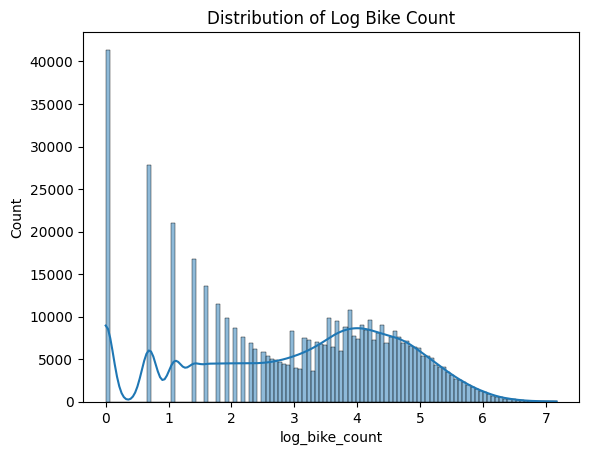

In [6]:
# target variable distribution
sns.histplot(data['log_bike_count'], kde=True) # using the log as bike_count is skewed
plt.title('Distribution of Log Bike Count')
plt.show()

Kind of normally distrbuted...

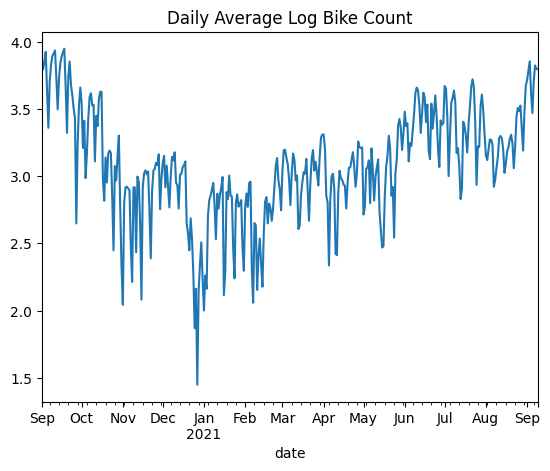

In [7]:
# Daily average log bike count
data["date"] = pd.to_datetime(data["date"], format="%Y-%m-%d")
data.set_index('date', drop = False, inplace=True)
data['log_bike_count'].resample('D').mean().plot(title='Daily Average Log Bike Count')
plt.show()

We notice a sharp decline in the second part of December, maybe due to the christmas holidays?

/var/folders/1q/4p_js9jn14x3_527d5fmd8dr0000gn/T/ipykernel_43511/3846441962.py:8: FutureWarning: 'w' is deprecated and will be removed in a future version, please use 'W' instead.
  data[mask].groupby(["counter_name", pd.Grouper(freq="1w", key="date")], observed = True)["bike_count"].sum().unstack(0).plot(figsize = (12,6), ylabel='log_bike_count')


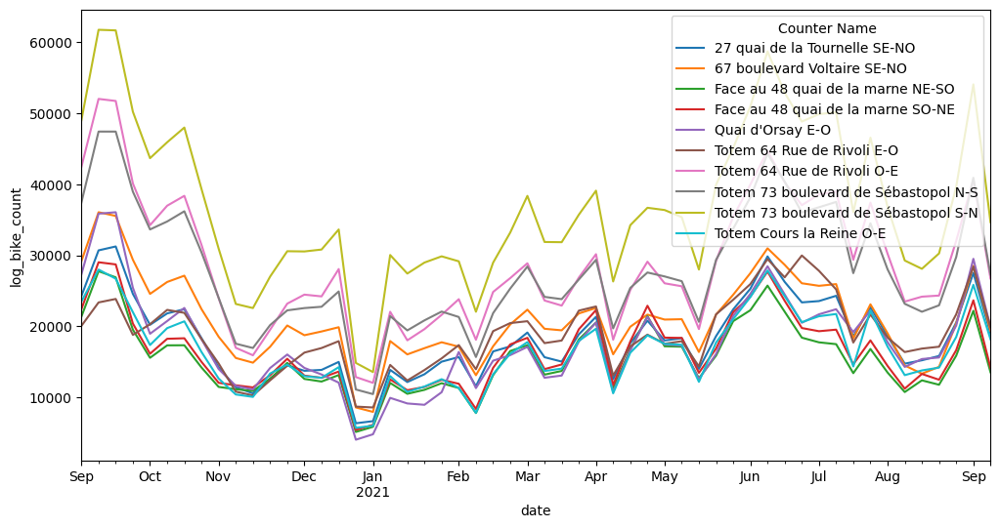

In [8]:
# Find the top 10 counters by total bike count
top_counters = data.groupby("counter_name", observed = True)["bike_count"].sum().nlargest(10).index

# Create a mask for these top counters
mask = data["counter_name"].isin(top_counters)

# Group by week and plot
data[mask].groupby(["counter_name", pd.Grouper(freq="1w", key="date")], observed = True)["bike_count"].sum().unstack(0).plot(figsize = (12,6), ylabel='log_bike_count')
plt.legend(title='Counter Name', bbox_to_anchor=(1, 1), loc="upper right")

At first sight, we can see a correlation between the usage and time of the year (more specifically less use during winter and more during summer). We can also see that some counters are consistently used more than others, maybe because of their location (more traffic in some zones of Paris, at the center maybe?), we will check that later.

In [9]:
(
    data.groupby(["site_name", "counter_name"])["bike_count"].sum()
    .sort_values(ascending=False)
    .head(10)
    .to_frame()
)

/var/folders/1q/4p_js9jn14x3_527d5fmd8dr0000gn/T/ipykernel_43511/1192055722.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  data.groupby(["site_name", "counter_name"])["bike_count"].sum()


,,bike_count
site_name,counter_name,
Totem 73 boulevard de Sébastopol,Totem 73 boulevard de Sébastopol S-N,1992227.0
Totem 64 Rue de Rivoli,Totem 64 Rue de Rivoli O-E,1551730.0
Totem 73 boulevard de Sébastopol,Totem 73 boulevard de Sébastopol N-S,1497912.0
67 boulevard Voltaire SE-NO,67 boulevard Voltaire SE-NO,1130565.0
Totem 64 Rue de Rivoli,Totem 64 Rue de Rivoli E-O,1015875.0
27 quai de la Tournelle,27 quai de la Tournelle SE-NO,984914.0
Quai d'Orsay,Quai d'Orsay E-O,948357.0
Totem Cours la Reine,Totem Cours la Reine O-E,894937.0
Face au 48 quai de la marne,Face au 48 quai de la marne SO-NE,884907.0


The most used counter (73 boulevard de Sébastopol) is very close to the center of Paris. Maybe there is more traffic at the center of Paris than at the extremities.

We will test our theory by adding a column with the euclidean distance from the center of paris to each bike counter.

In [10]:
import numpy as np

# Coordinates of the center of Paris (approximate, found online)
paris_center_lat = 48.8566
paris_center_lon = 2.3522

# Function to calculate Euclidean distance (simplified for geographic coordinates)
def euclidean_distance(lat1, lon1, lat2, lon2):
    # Approximate scaling factor for converting degrees to kilometers:
    # - 1 degree latitude ≈ 111 km
    # - 1 degree longitude ≈ 111 km * cos(latitude)
    lat_km = 111  # Scale for latitude
    lon_km = 111 * np.cos(np.radians(lat1))  # Scale for longitude, adjusted for latitude
    
    dlat = (lat2 - lat1) * lat_km
    dlon = (lon2 - lon1) * lon_km
    return np.sqrt(dlat**2 + dlon**2)

# Apply the Euclidean distance function
data["distance_from_center"] = data.apply(
    lambda row: euclidean_distance(row["latitude"], row["longitude"], paris_center_lat, paris_center_lon), axis=1
)

# Preview the updated DataFrame
data.head()

,counter_id,counter_name,site_id,site_name,bike_count,date,counter_installation_date,coordinates,counter_technical_id,latitude,longitude,log_bike_count,original_index,distance_from_center
date,,,,,,,,,,,,,,
2020-09-01 02:00:00,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,0.0,2020-09-01 02:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,2.375429,0.000000,48321,2.063074
2020-09-01 03:00:00,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,1.0,2020-09-01 03:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,2.375429,0.693147,48324,2.063074
2020-09-01 04:00:00,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,0.0,2020-09-01 04:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,2.375429,0.000000,48327,2.063074
2020-09-01 15:00:00,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,4.0,2020-09-01 15:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,2.375429,1.609438,48330,2.063074
2020-09-01 18:00:00,100007049-102007049,28 boulevard Diderot E-O,100007049,28 boulevard Diderot,9.0,2020-09-01 18:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,2.375429,2.302585,48333,2.063074


We also notice that dates coincide with the covid era. Upon further research we see that there has been 2 quarantines so we implement them.

In [11]:
data["quarantine1"] = np.where((data['date'] >= '2020-10-30') & (data['date'] <= '2020-12-14'), 1, 0)
data["quarantine2"] = np.where((data['date'] >= '2020-04-03') & (data['date'] <= '2020-05-02'), 1, 0)

We are checking our weather/season hypothesis in the eda_external file where we explore the given dataset about meteorological conditions. We will merge both cleaned dataset for better understanding.

In [12]:
data["spring"] = np.where((data['date'] >= '2020-03-21') & (data['date'] < '2020-06-21'), 1, 0)
data["summer"] = np.where((data['date'] >= '2020-06-21') & (data['date'] < '2020-09-21'), 1, 0)
data["autumn"] = np.where((data['date'] >= '2020-03-21') & (data['date'] <= '2020-09-21'), 1, 0)
data["winter"] = np.where((data['date'] >= '2020-03-21') & (data['date'] <= '2020-12-21'), 1, 0)

In [13]:
data.set_index('original_index', drop = False, inplace=True)
# Ensure the DataFrame is sorted by date
data = data.sort_values("date")

# Create an encoded column for bike_count == 0
data["no_bike"] = np.where((data['bike_count'] == 0), 1, 0)

# Create a group identifier for consecutive streaks of bike_count != 0
data["group"] = (data["no_bike"] != data["no_bike"].shift()).cumsum()

# Filter groups where bike_count == 0 and count the streaks
consecutive_zeros = (
    data[data["no_bike"] == 1]
    .groupby("group")
    .filter(lambda x: len(x) >= 10)
)

# Display the result
print(consecutive_zeros)

                         counter_id  \
original_index                        
599214          100056226-104056226   
411210          100049407-353255859   
638740          100056329-104056329   
78395           100036718-103036718   
688449          100056331-103056331   
...                             ...   
751909          100056335-103056335   
643284          100056329-104056329   
712422          100056332-104056332   
321397          100047546-104047546   
651155          100056329-103056329   

                                                   counter_name    site_id  \
original_index                                                               
599214          Face au 8 avenue de la porte de Charenton NO-SE  100056226   
411210                        152 boulevard du Montparnasse O-E  100049407   
638740                             Pont Charles De Gaulle NE-SO  100056329   
78395                            39 quai François Mauriac SE-NO  100036718   
688449                  

# II. ADDING ADDITIONAL DATASETS

## 1. Given weather data

In [14]:
df_ext = pd.read_csv("/Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/external_data.csv")
df_ext.describe()

,numer_sta,pmer,tend,cod_tend,dd,ff,t,td,u,vv,...,hnuage1,nnuage2,ctype2,hnuage2,nnuage3,ctype3,hnuage3,nnuage4,ctype4,hnuage4
count,3322.0,3322.000000,3322.000000,3322.000000,3322.000000,3322.000000,3322.000000,3322.000000,3322.000000,3322.000000,...,2867.000000,1695.000000,1443.000000,1695.000000,618.000000,470.000000,618.000000,42.000000,87.000000,42.000000
mean,7149.0,101682.886815,-0.237809,4.273028,184.379892,3.654154,285.877905,281.006442,74.775135,20142.338952,...,2028.674573,5.030678,4.515593,2692.943953,5.441748,3.961702,3310.695793,3.476190,6.735632,3205.000000
std,0.0,923.888170,122.191314,2.713199,103.708084,2.000353,6.851700,5.634409,17.022427,10283.556918,...,2377.241533,2.003304,2.463098,2309.340104,2.017108,3.042454,2423.703985,2.360633,3.196873,2595.553656
min,7149.0,97260.000000,-750.000000,0.000000,0.000000,0.000000,267.650000,260.750000,24.000000,120.000000,...,0.000000,1.000000,0.000000,60.000000,1.000000,0.000000,300.000000,1.000000,0.000000,360.000000
25%,7149.0,101200.000000,-70.000000,2.000000,80.000000,2.200000,280.950000,276.950000,63.000000,12710.000000,...,500.000000,3.000000,3.000000,1080.000000,4.250000,0.000000,1400.000000,1.000000,6.000000,1112.500000
50%,7149.0,101820.000000,0.000000,3.000000,200.000000,3.400000,285.850000,281.450000,79.000000,20000.000000,...,1080.000000,5.000000,6.000000,1800.000000,6.000000,3.000000,2430.000000,2.500000,8.000000,2150.000000
75%,7149.0,102287.500000,70.000000,7.000000,260.000000,4.900000,290.650000,285.550000,89.000000,25000.000000,...,2100.000000,7.000000,6.000000,3400.000000,7.000000,6.000000,5000.000000,5.750000,9.000000,5800.000000
max,7149.0,103920.000000,720.000000,8.000000,360.000000,14.600000,307.450000,293.150000,100.000000,60000.000000,...,9000.000000,8.000000,9.000000,9000.000000,8.000000,9.000000,9000.000000,7.000000,9.000000,8000.000000


#### Missing values

In [15]:
# Check for missing values
df_ext.isnull().sum()
# Better to check the proportion of missing values relative to the total nb of obs
df_ext.isnull().sum() / len(df_ext)

numer_sta    0.000000
date         0.000000
pmer         0.000000
tend         0.000000
cod_tend     0.000000
dd           0.000000
ff           0.000000
t            0.000000
td           0.000000
u            0.000000
vv           0.000000
ww           0.000000
w1           0.002107
w2           0.003010
n            0.046960
nbas         0.001505
hbas         0.136364
cl           0.124323
cm           0.415713
ch           0.494883
pres         0.000000
niv_bar      1.000000
geop         1.000000
tend24       0.003010
tn12         0.750151
tn24         1.000000
tx12         0.750151
tx24         1.000000
tminsol      0.999699
sw           1.000000
tw           1.000000
raf10        0.003010
rafper       0.000000
per          0.000000
etat_sol     0.015653
ht_neige     0.014750
ssfrai       0.133955
perssfrai    0.133955
rr1          0.002709
rr3          0.001806
rr6          0.004816
rr12         0.006623
rr24         0.007225
phenspe1     1.000000
phenspe2     1.000000
phenspe3  

Many columns have a ton of missing values, for that let's forget all those who have more than 10% of their values missing as they are not very reliable.

In [16]:
df_ext.drop(columns=df_ext.columns[(df_ext.isnull().sum()/len(df_ext)) >= 0.1], inplace=True)

Now, we have to replace missing values from the remaining columlns as some models like Random Forest can't work with them. We will replace them with the median to avoid sensitivity to outliers as there are many outliers in this dataset.

In [17]:
df_ext.fillna(df_ext.median(numeric_only=True), inplace=True)

In [18]:
df_ext.isnull().sum()

numer_sta    0
date         0
pmer         0
tend         0
cod_tend     0
dd           0
ff           0
t            0
td           0
u            0
vv           0
ww           0
w1           0
w2           0
n            0
nbas         0
pres         0
tend24       0
raf10        0
rafper       0
per          0
etat_sol     0
ht_neige     0
rr1          0
rr3          0
rr6          0
rr12         0
rr24         0
dtype: int64

In [19]:
df_ext.nunique(axis=0)

numer_sta       1
date         3321
pmer          465
tend           99
cod_tend        9
dd             37
ff            109
t             345
td            281
u              77
vv           1230
ww             42
w1              9
w2              9
n              10
nbas           10
pres          459
tend24        353
raf10         170
rafper        186
per             1
etat_sol        9
ht_neige        7
rr1            33
rr3            64
rr6            91
rr12          124
rr24          164
dtype: int64

We see that there is numerous empty columns, and that `numer_sta`, `tminsol`, and `per` only have a unique value, so they are irrelevant. 

In [20]:
df_ext.drop(columns=df_ext.columns[df_ext.nunique()==0], inplace=True)
df_ext.drop(columns=["numer_sta", "per"], inplace=True)

#### Checking for multicolinearity

<function matplotlib.pyplot.show(close=None, block=None)>

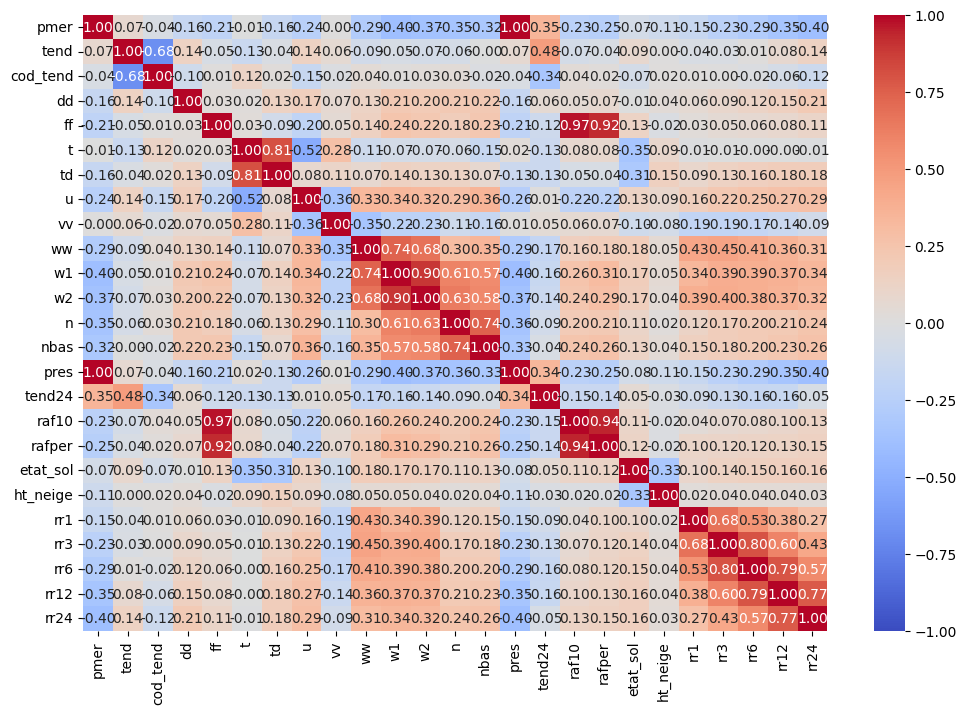

In [21]:
df_ext_wo_date = df_ext.drop(columns=['date'])
correlation_matrix = df_ext_wo_date.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.show

Filtering for variables that are highly correlated.

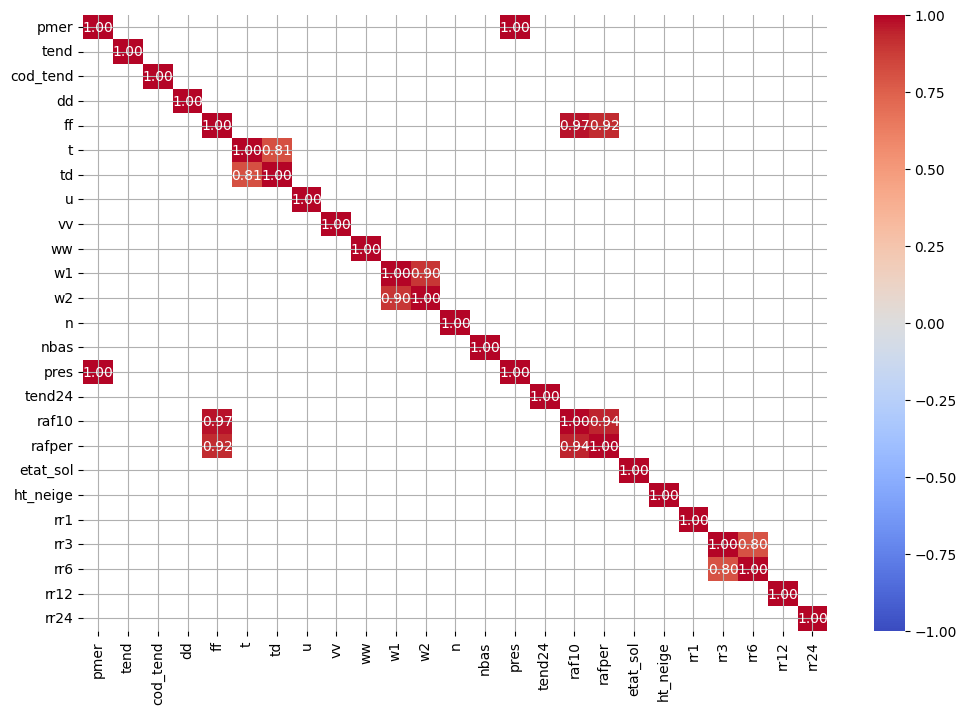

In [22]:
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix[correlation_matrix.abs()>=0.8], annot=True, fmt='.2f', cmap='coolwarm', vmin=-1, vmax=1)
plt.grid(True)

`pmer` and `pres` have a correlation of 1: we can keep one of both without losing any variance.
We can say the same for `raf10`and `rafper` and keep only windspeed `ff`. Following that logic we also drop `td` and `w2`.

In [23]:
df_ext.drop(columns=["pres", "raf10", "rafper", "td", "w2"], inplace=True)

#### Merging both cleaned datasets

In [24]:
# Convert both date columns to the same precision
data["date"] = data["date"].astype('datetime64[us]')
df_ext["date"] = df_ext["date"].astype('datetime64[us]')

# Merge both datasets
df_merged = pd.merge_asof(data.sort_values("date"), df_ext.sort_values("date"), on="date")
df_merged

,counter_id,counter_name,site_id,site_name,bike_count,date,counter_installation_date,coordinates,counter_technical_id,latitude,...,n,nbas,tend24,etat_sol,ht_neige,rr1,rr3,rr6,rr12,rr24
0,100007049-101007049,28 boulevard Diderot O-E,100007049,28 boulevard Diderot,1.0,2020-09-01 01:00:00,2013-01-18,"48.846028,2.375429",Y2H15027244,48.846028,...,0.0,0.0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,100047547-103047547,6 rue Julia Bartet SO-NE,100047547,6 rue Julia Bartet,2.0,2020-09-01 01:00:00,2018-11-28,"48.82636,2.30303",Y2H18086323,48.826360,...,0.0,0.0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,100056047-SC,Pont de la Concorde S-N,100056047,Pont de la Concorde S-N,1.0,2020-09-01 01:00:00,2019-11-08,"48.86378,2.32003",Y2H19070356,48.863780,...,0.0,0.0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,100047547-104047547,6 rue Julia Bartet NE-SO,100047547,6 rue Julia Bartet,4.0,2020-09-01 01:00:00,2018-11-28,"48.82636,2.30303",Y2H18086323,48.826360,...,0.0,0.0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,100056223-SC,Pont des Invalides N-S,100056223,Pont des Invalides N-S,2.0,2020-09-01 01:00:00,2019-11-07,"48.86284,2.310345",Y2H19070365,48.862840,...,0.0,0.0,120.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
496822,100056047-SC,Pont de la Concorde S-N,100056047,Pont de la Concorde S-N,24.0,2021-09-09 23:00:00,2019-11-08,"48.86378,2.32003",Y2H19070356,48.863780,...,50.0,3.0,140.0,1.0,0.0,0.0,0.0,0.6,0.6,1.8
496823,100056329-103056329,Pont Charles De Gaulle SO-NE,100056329,Pont Charles De Gaulle,10.0,2021-09-09 23:00:00,2019-12-12,"48.84223,2.36811",Y2H19070375,48.842230,...,50.0,3.0,140.0,1.0,0.0,0.0,0.0,0.6,0.6,1.8
496824,100056336-105056336,27 quai de la Tournelle SE-NO,100056336,27 quai de la Tournelle,53.0,2021-09-09 23:00:00,2019-11-14,"48.85013,2.35423",Y2H19070383,48.850130,...,50.0,3.0,140.0,1.0,0.0,0.0,0.0,0.6,0.6,1.8
496825,100056329-104056329,Pont Charles De Gaulle NE-SO,100056329,Pont Charles De Gaulle,13.0,2021-09-09 23:00:00,2019-12-12,"48.84223,2.36811",Y2H19070375,48.842230,...,50.0,3.0,140.0,1.0,0.0,0.0,0.0,0.6,0.6,1.8


## 2. Additional Data: Vacances Scolaires et Jours Feriés

In [25]:
!pip install vacances-scolaires-france
!pip install jours_feries_france
# !pip install chantiers-a-paris

chantiers = pd.read_parquet("/Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/chantiers-a-paris.parquet")

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip
Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: /Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip


In [26]:
from vacances_scolaires_france import SchoolHolidayDates
from jours_feries_france import JoursFeries

school_holidays = SchoolHolidayDates()
jours_feries = JoursFeries()

df_merged['holidays'] = df_merged.apply(
    lambda row: 1 if school_holidays.is_holiday_for_zone(row["date"].date(), 'C') else 0, axis=1
)

df_merged['jour_ferie'] = df_merged.apply(
    lambda row: 1 if jours_feries.is_bank_holiday(row["date"].date()) else 0, axis=1
)

In [27]:
# show all rows
pd.set_option('display.max_rows', None)
df_merged['holidays']

0         0
1         0
2         0
3         0
4         0
5         0
6         0
7         0
8         0
9         0
10        0
11        0
12        0
13        0
14        0
15        0
16        0
17        0
18        0
19        0
20        0
21        0
22        0
23        0
24        0
25        0
26        0
27        0
28        0
29        0
30        0
31        0
32        0
33        0
34        0
35        0
36        0
37        0
38        0
39        0
40        0
41        0
42        0
43        0
44        0
45        0
46        0
47        0
48        0
49        0
50        0
51        0
52        0
53        0
54        0
55        0
56        0
57        0
58        0
59        0
60        0
61        0
62        0
63        0
64        0
65        0
66        0
67        0
68        0
69        0
70        0
71        0
72        0
73        0
74        0
75        0
76        0
77        0
78        0
79        0
80        0
81        0
82        0
83  

In [28]:
df_merged.drop(columns=["bike_count"], inplace=True)

In [29]:
train_cleaned = df_merged.to_parquet("/Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/train_cleaned.parquet")

## PCA

Explained Variance Ratio: [1.54436423e-01 8.58703159e-02 7.70392121e-02 6.25684075e-02
 5.54630709e-02 4.86347770e-02 4.31606477e-02 4.21486051e-02
 3.71905562e-02 3.21386433e-02 3.06034082e-02 2.90188982e-02
 2.78944998e-02 2.73761930e-02 2.55295278e-02 2.29216756e-02
 2.26047560e-02 2.10510991e-02 2.01620643e-02 1.73031079e-02
 1.56735740e-02 1.53970416e-02 1.46901060e-02 1.16646973e-02
 1.04548825e-02 9.36613495e-03 8.73956080e-03 8.15534561e-03
 7.09208338e-03 5.64487453e-03 4.76353496e-03 3.22903554e-03
 1.98097255e-03 3.22682202e-05 3.64290702e-17 0.00000000e+00]
cumulative Explained Variance Ratio: [0.15443642 0.24030674 0.31734595 0.37991436 0.43537743 0.48401221
 0.52717285 0.56932146 0.60651201 0.63865066 0.66925407 0.69827296
 0.72616746 0.75354366 0.77907319 0.80199486 0.82459962 0.84565072
 0.86581278 0.88311589 0.89878946 0.9141865  0.92887661 0.94054131
 0.95099619 0.96036232 0.96910189 0.97725723 0.98434931 0.98999419
 0.99475772 0.99798676 0.99996773 1.         1.     

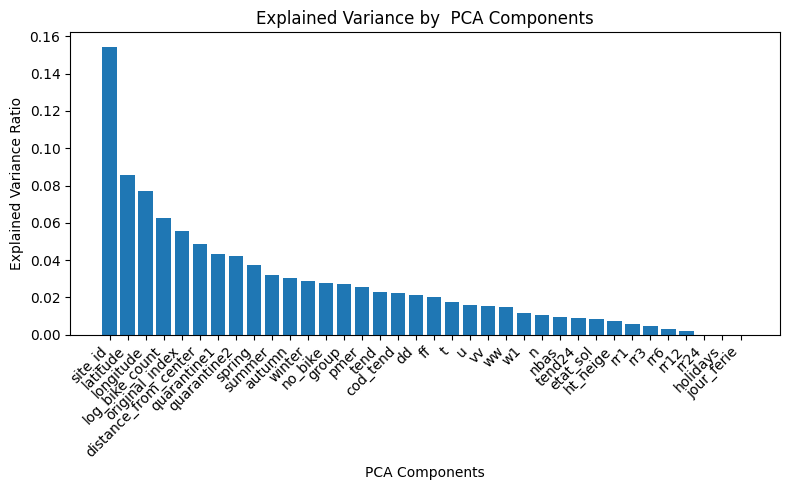

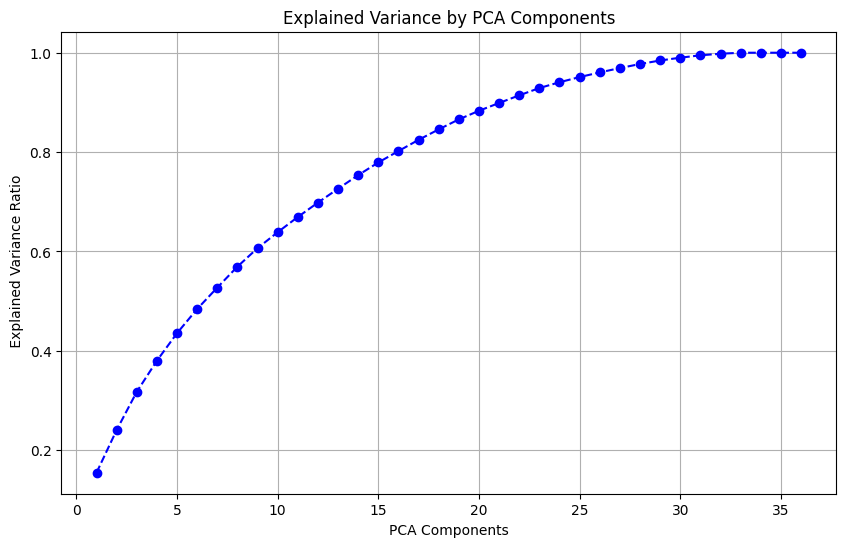

In [30]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Perform PCA
pca = PCA()
numeric_columns = df_merged.select_dtypes(include=['float64', 'int64']).columns
data_scaled = StandardScaler().fit_transform(df_merged[numeric_columns])
data_pca = pca.fit_transform(data_scaled)

# Create a DataFrame with the PCA results
pca_df = pd.DataFrame(data_pca, columns=[f'PC{i+1}' for i in range(data_pca.shape[1])])


# Explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Save the PCA results to a new file
output_path = "/Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/pca_results.csv"
pca_df.to_csv(output_path, index=False)

cumulative_explained_variance = explained_variance.cumsum()

# Print the explained variance ratio
print("Explained Variance Ratio:", explained_variance)
print("cumulative Explained Variance Ratio:", cumulative_explained_variance)
print(f"PCA results saved to {output_path}")

# Plot the cumulative explained variance ratio
plt.figure(figsize=(8, 5))
plt.bar(numeric_columns, explained_variance[:len(numeric_columns)])
plt.xlabel('PCA Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance by  PCA Components')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(
    range(1, len(cumulative_explained_variance) + 1),
    cumulative_explained_variance,
    marker="o",
    linestyle="--",
    color="b",
)

plt.title("Explained Variance by PCA Components")
plt.xlabel("PCA Components")
plt.ylabel(" Explained Variance Ratio")
plt.grid(True)
plt.show()

## Checking relationship of variables with target

For better understanding, we can check the individual relationship of variables with the target one by one.

/var/folders/1q/4p_js9jn14x3_527d5fmd8dr0000gn/T/ipykernel_43511/3550996498.py:32: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df_grouped = temp_df.groupby("x").mean().reset_index()
/var/folders/1q/4p_js9jn14x3_527d5fmd8dr0000gn/T/ipykernel_43511/3550996498.py:32: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  temp_df_grouped = temp_df.groupby("x").mean().reset_index()
/var/folders/1q/4p_js9jn14x3_527d5fmd8dr0000gn/T/ipykernel_43511/3550996498.py:32: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current

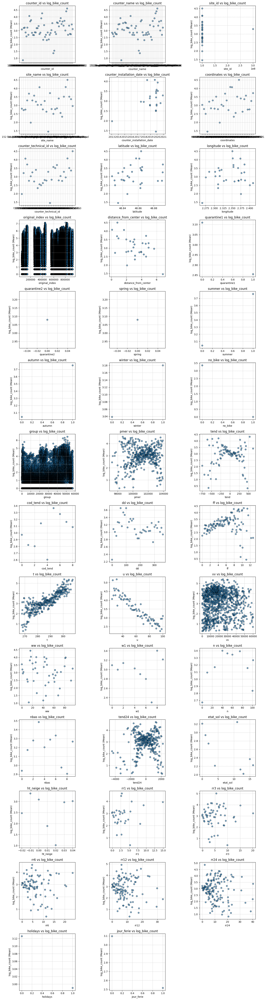

In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def check_relationships_with_target(df, target_column=None, exclude_columns=None, cols_per_row=3):

    if exclude_columns is None:
        exclude_columns = []

    target_column = "log_bike_count"

    if target_column not in df.columns:
        raise ValueError(f"The target column '{target_column}' is missing in the DataFrame.")
        
    feature_columns = [col for col in df.columns if col not in exclude_columns + [target_column]]

    # Define grid layout
    num_features = len(feature_columns)
    num_rows = int(np.ceil(num_features / cols_per_row))

    fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(15, num_rows * 4))

    # Flatten axes for easier iteration
    axes = axes.flatten()

    for idx, col in enumerate(feature_columns):
        x = df[col]
        y = df[target_column]

        # Handle potential issues with high cardinality in features
        temp_df = pd.DataFrame({"x": x, "y": y})
        temp_df_grouped = temp_df.groupby("x").mean().reset_index()

        # Plot the relationship
        ax = axes[idx]
        ax.scatter(temp_df_grouped["x"], temp_df_grouped["y"], alpha=0.6, edgecolor="k")
        ax.set_xlabel(col, fontsize=10)
        ax.set_ylabel(f"{target_column} (Mean)", fontsize=10)
        ax.set_title(f"{col} vs {target_column}", fontsize=12)
        ax.grid(True, linestyle='--', alpha=0.7)

    # Hide unused axes
    for ax in axes[num_features:]:
        ax.axis("off")

    plt.tight_layout()
    plt.show()

# Example call
check_relationships_with_target(df_merged, exclude_columns=["date"])


In [32]:
# set the original order back
data.sort_values(by=data["original_index"], inplace=True)

KeyError: original_index
57884      57884
607941    607941
305866    305866
855447    855447
617970    617970
296038    296038
766471    766471
314403    314403
408305    408305
865435    865435
635516    635516
264221    264221
754676    754676
135512    135512
647320    647320
273932    273932
598038    598038
776382    776382
324174    324174
440151    440151
400125    400125
805911    805911
796170    796170
365497    365497
449886    449886
558234    558234
353162    353162
816048    816048
786592    786592
343292    343292
569035    569035
333389    333389
578145    578145
826372    826372
875137    875137
48428      48428
627664    627664
655790    655790
677343    677343
687219    687219
746515    746515
726259    726259
77646      77646
98518      98518
87516      87516
735101    735101
697242    697242
882956    882956
665513    665513
715520    715520
116705    116705
67665      67665
705677    705677
126152    126152
579010    579010
825771    825771
725399    725399
707142    707142
685544    685544
333392    333392
569038    569038
786408    786408
440154    440154
343295    343295
793811    793811
77649      77649
816051    816051
736450    736450
805914    805914
558237    558237
67668      67668
696517    696517
363056    363056
447695    447695
401371    401371
353165    353165
595358    595358
88381      88381
127540    127540
136482    136482
657675    657675
754679    754679
645581    645581
118216    118216
264224    264224
635519    635519
865671    865671
273935    273935
627667    627667
667060    667060
57887      57887
766464    766464
98521      98521
294813    294813
884968    884968
615545    615545
855450    855450
716880    716880
304677    304677
608542    608542
744890    744890
774155    774155
313454    313454
675566    675566
875140    875140
323423    323423
410007    410007
48321      48321
635522    635522
726262    726262
264717    264717
786595    786595
343298    343298
796588    796588
865674    865674
276349    276349
735104    735104
695570    695570
628143    628143
766467    766467
293567    293567
569041    569041
365500    365500
617973    617973
78499      78499
806359    806359
440905    440905
754682    754682
96968      96968
716883    716883
355774    355774
813296    813296
676972    676972
884971    884971
665516    665516
575486    575486
555722    555722
88384      88384
656968    656968
127543    127543
875143    875143
647323    647323
136485    136485
687222    687222
116708    116708
303599    303599
744893    744893
598693    598693
776584    776584
67671      67671
707145    707145
398510    398510
608545    608545
48324      48324
823109    823109
316009    316009
334056    334056
411400    411400
447698    447698
855453    855453
324177    324177
57890      57890
706234    706234
725402    725402
345598    345598
136954    136954
595361    595361
645584    645584
87161      87161
776385    776385
875694    875694
440908    440908
687225    687225
793814    793814
126897    126897
825774    825774
813299    813299
803534    803534
408308    408308
97296      97296
884974    884974
323426    323426
353712    353712
677346    677346
667063    667063
555725    555725
58933      58933
398513    398513
118219    118219
756489    756489
715523    715523
657678    657678
451009    451009
579013    579013
766470    766470
334059    334059
628146    628146
293570    293570
274689    274689
569044    569044
865438    865438
48327      48327
608548    608548
67674      67674
314406    314406
617976    617976
736674    736674
305869    305869
855456    855456
264720    264720
746544    746544
786598    786598
363059    363059
696520    696520
77652      77652
637531    637531
884977    884977
97299      97299
293573    293573
324180    324180
437810    437810
618022    618022
667584    667584
568272    568272
855459    855459
805917    805917
355777    355777
303602    303602
400128    400128
786601    786601
117309    117309
578148    578148
756492    756492
316012    316012
264723    264723
344034    344034
635525    635525
136488    136488
48431      48431
333395    333395
607944    607944
647808    647808
559237    559237
655793    655793
816184    816184
863042    863042
823112    823112
276352    276352
598696    598696
628149    628149
776587    776587
873041    873041
126155    126155
764462    764462
726843    726843
735107    735107
365503    365503
58936      58936
77189      77189
744896    744896
705680    705680
451012    451012
685547    685547
715526    715526
696523    696523
410010    410010
67490      67490
87164      87164
675569    675569
796173    796173
411403    411403
451015    451015
665519    665519
706237    706237
756495    756495
617979    617979
598041    598041
575489    575489
88387      88387
816054    816054
607947    607947
118222    118222
303605    303605
725405    725405
687228    687228
345601    345601
657681    657681
314409    314409
647811    647811
264726    264726
136491    136491
68455      68455
335755    335755
126900    126900
796176    796176
855462    855462
875146    875146
58939      58939
96971      96971
865677    865677
363819    363819
568275    568275
324183    324183
294816    294816
716377    716377
803537    803537
825777    825777
884980    884980
637938    637938
736453    736453
766474    766474
49237      49237
625454    625454
555728    555728
401374    401374
276355    276355
77655      77655
353715    353715
437813    437813
676975    676975
783845    783845
746547    746547
776590    776590
695573    695573
625457    625457
826375    826375
305872    305872
647326    647326
411406    411406
736456    736456
273938    273938
48434      48434
136957    136957
363822    363822
449889    449889
296041    296041
726265    726265
78502      78502
756498    756498
266308    266308
615548    615548
687231    687231
806362    806362
401377    401377
697245    697245
568278    568278
345604    345604
635528    635528
855465    855465
766477    766477
865680    865680
783848    783848
87519      87519
126158    126158
657684    657684
314412    314412
776593    776593
353718    353718
667587    667587
333398    333398
816057    816057
677349    677349
796179    796179
746550    746550
325936    325936
707148    707148
116711    116711
578151    578151
57981      57981
595364    595364
607950    607950
885672    885672
716886    716886
96974      96974
555731    555731
67493      67493
440157    440157
875697    875697
697248    697248
264227    264227
885675    885675
355780    355780
58942      58942
555734    555734
96977      96977
863045    863045
667590    667590
408311    408311
675572    675572
776596    776596
823115    823115
398516    398516
764465    764465
67677      67677
343301    343301
293576    293576
805920    805920
635531    635531
786411    786411
617982    617982
645587    645587
756501    756501
565610    565610
440160    440160
873044    873044
608551    608551
853244    853244
333401    333401
304680    304680
816187    816187
127546    127546
715529    715529
365506    365506
313457    313457
746518    746518
136494    136494
78505      78505
705683    705683
598699    598699
274692    274692
657687    657687
48437      48437
625460    625460
575492    575492
325939    325939
117312    117312
686842    686842
796182    796182
736459    736459
726846    726846
449892    449892
88390      88390
325942    325942
627670    627670
826378    826378
696526    696526
607953    607953
766480    766480
805923    805923
401380    401380
294819    294819
796185    796185
776388    776388
595367    595367
615551    615551
303608    303608
705686    705686
575495    575495
855733    855733
313460    313460
334062    334062
57893      57893
67680      67680
555737    555737
783851    783851
48440      48440
78508      78508
754685    754685
136960    136960
345607    345607
685550    685550
647329    647329
565613    565613
875700    875700
451018    451018
126161    126161
657690    657690
118225    118225
353168    353168
882959    882959
667066    667066
437816    437816
676978    676978
98524      98524
813302    813302
408314    408314
716380    716380
746521    746521
726268    726268
264729    264729
87167      87167
637534    637534
736677    736677
363062    363062
276358    276358
865441    865441
816190    816190
598702    598702
657693    657693
314415    314415
786414    786414
715532    715532
126164    126164
401383    401383
774158    774158
440163    440163
87170      87170
766483    766483
67683      67683
735110    735110
116714    116714
665522    665522
707151    707151
863048    863048
555740    555740
276361    276361
746553    746553
324186    324186
885678    885678
805926    805926
96980      96980
608554    608554
823118    823118
796188    796188
353721    353721
49240      49240
408317    408317
625463    625463
363825    363825
677352    677352
57984      57984
345610    345610
873047    873047
647332    647332
726849    726849
449895    449895
754688    754688
637537    637537
617985    617985
136963    136963
575498    575498
304683    304683
569047    569047
335758    335758
855468    855468
687234    687234
77658      77658
294822    294822
266311    266311
697251    697251
665525    665525
440911    440911
615554    615554
449898    449898
274695    274695
783854    783854
726852    726852
98527      98527
826381    826381
408320    408320
776599    776599
57896      57896
555743    555743
885681    885681
401386    401386
625466    625466
49243      49243
264230    264230
805929    805929
697254    697254
323429    323429
735113    735113
796191    796191
296044    296044
746524    746524
569050    569050
677355    677355
655796    655796
647814    647814
334065    334065
363828    363828
77192      77192
685553    685553
136497    136497
635534    635534
607956    607956
87173      87173
855471    855471
875703    875703
816060    816060
126167    126167
343304    343304
715535    715535
764468    764468
68458      68458
598705    598705
575501    575501
863051    863051
353171    353171
316015    316015
754691    754691
303611    303611
705689    705689
116717    116717
565616    565616
334068    334068
825780    825780
578154    578154
343307    343307
451021    451021
786417    786417
806365    806365
816193    816193
363831    363831
559240    559240
353174    353174
865683    865683
796591    796591
637540    637540
855736    855736
687237    687237
303614    303614
87176      87176
756508    756508
617988    617988
296047    296047
875149    875149
408323    408323
675575    675575
744899    744899
766486    766486
264732    264732
628152    628152
274698    274698
885684    885684
716889    716889
48443      48443
78511      78511
726271    726271
665528    665528
645590    645590
655799    655799
324189    324189
57987      57987
398519    398519
776391    776391
595370    595370
440914    440914
67496      67496
136500    136500
705692    705692
313463    313463
697257    697257
735116    735116
116720    116720
608557    608557
127549    127549
97302      97302
126170    126170
655802    655802
117315    117315
667593    667593
98530      98530
353724    353724
813305    813305
440166    440166
677358    677358
716892    716892
796194    796194
57899      57899
705695    705695
411409    411409
67686      67686
726855    726855
696529    696529
736462    736462
363065    363065
77195      77195
449901    449901
685556    685556
87522      87522
746556    746556
558240    558240
884983    884983
873050    873050
825783    825783
565619    565619
647817    647817
293579    293579
855474    855474
766489    766489
304686    304686
627673    627673
608560    608560
400131    400131
774161    774161
273941    273941
865444    865444
786420    786420
615557    615557
333404    333404
264735    264735
637543    637543
136966    136966
313466    313466
754694    754694
598708    598708
578157    578157
325945    325945
806368    806368
49246      49246
345613    345613
575504    575504
687240    687240
78514      78514
335761    335761
324192    324192
726274    726274
67689      67689
705698    705698
365509    365509
736680    736680
605330    605330
598044    598044
316018    316018
696532    696532
774164    774164
58945      58945
855739    855739
294825    294825
87179      87179
825786    825786
565622    565622
345616    345616
647335    647335
127552    127552
657696    657696
136969    136969
116723    116723
756504    756504
786604    786604
667596    667596
97305      97305
303617    303617
264738    264738
637941    637941
863054    863054
885687    885687
355783    355783
558243    558243
276364    276364
744902    744902
766492    766492
716383    716383
677361    677361
451024    451024
615560    615560
813308    813308
873053    873053
627676    627676
410013    410013
401389    401389
796594    796594
803540    803540
437819    437819
49249      49249
398522    398522
655805    655805
884986    884986
598711    598711
726277    726277
314418    314418
875706    875706
853247    853247
687243    687243
607959    607959
305875    305875
87182      87182
618025    618025
716895    716895
447701    447701
294828    294828
440169    440169
776602    776602
77198      77198
324195    324195
363834    363834
116726    116726
555746    555746
706240    706240
353727    353727
67499      67499
48330      48330
816196    816196
667599    667599
345619    345619
786423    786423
569053    569053
126903    126903
334071    334071
695576    695576
735119    735119
578160    578160
826384    826384
98533      98533
647338    647338
766495    766495
796597    796597
746527    746527
276367    276367
136972    136972
756507    756507
625469    625469
266314    266314
863057    863057
676981    676981
637546    637546
803543    803543
408326    408326
57902      57902
363837    363837
875709    875709
774167    774167
343310    343310
313469    313469
687246    687246
826387    826387
746559    746559
783857    783857
656971    656971
575507    575507
126173    126173
736683    736683
675578    675578
333407    333407
635537    635537
885690    885690
805932    805932
865686    865686
754697    754697
48446      48446
695579    695579
97308      97308
273944    273944
57990      57990
598714    598714
400134    400134
77661      77661
437822    437822
324198    324198
565625    565625
665531    665531
627679    627679
796197    796197
766498    766498
135515    135515
647341    647341
451027    451027
707154    707154
293582    293582
117318    117318
608563    608563
264233    264233
725408    725408
67502      67502
615563    615563
353730    353730
559243    559243
716898    716898
305878    305878
816199    816199
87185      87185
855477    855477
411412    411412
116729    116729
68461      68461
735122    735122
568281    568281
449904    449904
559246    559246
365512    365512
645593    645593
440917    440917
786607    786607
744905    744905
264236    264236
816202    816202
696535    696535
667069    667069
575510    575510
726858    726858
706243    706243
353733    353733
126176    126176
756510    756510
343313    343313
656974    656974
637944    637944
335764    335764
823121    823121
764471    764471
607962    607962
274701    274701
855742    855742
136975    136975
676984    676984
875152    875152
774170    774170
618028    618028
313472    313472
715538    715538
882962    882962
408329    408329
305881    305881
77664      77664
296050    296050
598717    598717
686845    686845
88393      88393
865689    865689
803546    803546
325948    325948
57993      57993
48449      48449
796200    796200
401392    401392
98536      98536
628155    628155
816063    816063
628158    628158
353177    353177
264239    264239
764474    764474
118228    118228
87188      87188
48333      48333
408332    408332
449907    449907
135518    135518
647344    647344
715541    715541
296053    296053
707157    707157
667072    667072
677364    677364
615566    615566
276370    276370
825789    825789
559249    559249
635540    635540
333410    333410
323432    323432
776605    776605
865447    865447
695582    695582
754700    754700
655808    655808
575513    575513
744908    744908
126179    126179
598720    598720
884989    884989
305884    305884
77667      77667
783860    783860
313475    313475
343316    343316
726861    726861
806371    806371
68464      68464
853250    853250
736465    736465
400137    400137
437825    437825
565628    565628
608566    608566
686848    686848
875712    875712
363840    363840
97311      97311
57996      57996
796600    796600
726864    726864
786610    786610
776608    776608
685559    685559
675581    675581
766473    766473
885693    885693
274704    274704
555749    555749
635543    635543
77670      77670
116732    116732
401395    401395
575516    575516
754703    754703
607965    607965
656977    656977
716901    716901
87191      87191
325951    325951
793817    793817
294831    294831
136978    136978
816066    816066
873056    873056
865450    865450
665534    665534
344037    344037
697260    697260
736468    736468
264242    264242
48452      48452
449910    449910
304689    304689
353180    353180
707160    707160
411415    411415
126906    126906
437828    437828
57999      57999
598047    598047
625472    625472
617991    617991
825792    825792
333413    333413
855480    855480
565631    565631
746562    746562
313478    313478
365515    365515
647347    647347
806374    806374
67505      67505
98539      98539
116735    116735
735125    735125
625475    625475
647820    647820
58002      58002
725411    725411
294834    294834
803549    803549
656980    656980
675584    675584
568284    568284
304692    304692
863060    863060
707163    707163
437831    437831
766501    766501
786426    786426
355786    355786
813311    813311
823124    823124
873059    873059
400140    400140
48336      48336
853253    853253
885696    885696
87525      87525
746530    746530
266317    266317
67508      67508
605333    605333
685562    685562
575519    575519
127555    127555
637549    637549
598050    598050
363843    363843
97314      97314
410016    410016
345622    345622
793820    793820
559252    559252
276373    276373
715544    715544
665537    665537
776611    776611
335767    335767
316021    316021
618031    618031
136503    136503
754706    754706
449913    449913
696538    696538
323435    323435
77201      77201
68467      68467
569056    569056
746565    746565
345625    345625
266320    266320
676987    676987
786613    786613
607968    607968
855745    855745
96983      96983
323438    323438
398525    398525
647350    647350
88396      88396
274707    274707
58948      58948
813314    813314
715547    715547
559255    559255
826390    826390
685565    685565
766476    766476
440920    440920
736686    736686
618034    618034
598053    598053
135521    135521
774173    774173
756511    756511
637552    637552
625478    625478
304695    304695
805935    805935
335770    335770
117321    117321
78517      78517
875715    875715
796603    796603
865692    865692
314421    314421
655811    655811
667075    667075
882965    882965
579016    579016
353183    353183
48455      48455
726867    726867
411418    411418
296056    296056
363068    363068
447704    447704
126909    126909
695585    695585
707166    707166
776614    776614
264741    264741
305887    305887
796203    796203
706246    706246
355789    355789
558246    558246
766479    766479
686851    686851
97317      97317
273947    273947
400143    400143
736471    736471
58951      58951
697263    697263
676990    676990
667078    667078
645596    645596
598723    598723
411421    411421
803552    803552
746533    746533
87528      87528
136981    136981
316024    316024
578163    578163
882968    882968
569059    569059
627682    627682
118231    118231
786616    786616
656983    656983
363071    363071
344040    344040
615569    615569
823127    823127
67692      67692
637555    637555
127558    127558
333416    333416
49252      49252
293585    293585
853256    853256
816205    816205
726280    726280
440923    440923
865695    865695
875718    875718
607971    607971
325954    325954
716386    716386
449916    449916
756514    756514
78520      78520
816069    816069
118234    118234
754709    754709
97320      97320
625481    625481
736474    736474
313481    313481
324201    324201
305890    305890
135524    135524
355792    355792
598056    598056
635546    635546
264744    264744
77673      77673
776617    776617
726283    726283
88399      88399
687249    687249
274710    274710
826393    826393
746536    746536
559258    559258
400146    400146
440172    440172
885699    885699
805938    805938
705701    705701
365518    365518
875155    875155
411424    411424
565634    565634
657699    657699
786429    786429
605336    605336
764477    764477
343319    343319
68470      68470
855748    855748
48339      48339
716389    716389
126182    126182
695588    695588
793823    793823
451030    451030
618037    618037
575522    575522
333419    333419
57905      57905
676993    676993
665540    665540
865698    865698
294837    294837
647353    647353
705704    705704
736689    736689
274713    274713
806377    806377
555752    555752
715550    715550
627685    627685
796206    796206
334074    334074
447707    447707
853259    853259
88402      88402
343322    343322
635549    635549
353736    353736
294840    294840
647823    647823
324204    324204
578166    578166
437834    437834
816072    816072
725414    725414
764480    764480
314424    314424
618040    618040
98542      98542
882971    882971
77204      77204
266323    266323
657702    657702
57908      57908
675587    675587
411427    411427
565637    565637
823130    823130
686854    686854
608569    608569
49255      49255
667081    667081
305893    305893
136506    136506
776394    776394
863063    863063
754712    754712
783863    783863
363846    363846
598059    598059
697266    697266
117324    117324
746568    746568
873062    873062
400149    400149
68473      68473
127561    127561
126912    126912
77676      77676
440926    440926
96986      96986
706249    706249
304698    304698
595373    595373
264747    264747
555755    555755
68476      68476
675590    675590
625484    625484
363849    363849
863066    863066
746571    746571
796606    796606
401398    401398
410019    410019
293588    293588
333422    333422
667084    667084
805941    805941
447710    447710
58005      58005
49258      49258
274716    274716
579019    579019
618043    618043
695591    695591
853262    853262
783866    783866
87531      87531
316027    316027
637947    637947
324207    324207
355795    355795
725417    725417
873065    873065
344043    344043
816208    816208
647826    647826
766482    766482
565640    565640
776620    776620
715553    715553
117327    117327
657705    657705
605339    605339
756513    756513
735128    735128
882974    882974
823133    823133
135527    135527
685568    685568
49261      49261
865701    865701
716392    716392
117330    117330
637558    637558
884992    884992
657708    657708
853265    853265
756517    756517
410022    410022
625487    625487
816211    816211
294843    294843
873068    873068
276376    276376
67695      67695
726870    726870
316030    316030
353739    353739
333425    333425
96989      96989
303620    303620
796209    796209
58008      58008
766504    766504
77679      77679
696541    696541
676996    676996
746574    746574
264750    264750
398528    398528
555758    555758
437837    437837
88405      88405
803555    803555
665543    665543
826396    826396
598726    598726
776623    776623
645599    645599
735131    735131
686857    686857
607974    607974
618046    618046
343325    343325
325957    325957
136509    136509
568287    568287
447713    447713
363852    363852
579022    579022
127564    127564
786432    786432
707169    707169
410025    410025
449919    449919
865704    865704
776397    776397
766485    766485
117333    117333
58011      58011
324210    324210
756520    756520
313484    313484
355798    355798
725420    725420
398531    398531
816214    816214
685571    685571
334077    334077
716904    716904
578169    578169
793826    793826
344046    344046
786435    786435
665546    665546
853268    853268
826399    826399
735134    735134
440175    440175
274719    274719
568290    568290
136512    136512
293591    293591
695594    695594
677367    677367
77682      77682
87534      87534
882977    882977
625490    625490
363074    363074
615572    615572
875158    875158
706252    706252
605342    605342
655814    655814
266326    266326
304701    304701
48458      48458
637561    637561
127567    127567
555761    555761
67511      67511
595376    595376
746577    746577
645602    645602
96992      96992
806380    806380
333428    333428
78523      78523
875721    875721
806383    806383
345628    345628
655817    655817
677370    677370
363077    363077
273950    273950
48342      48342
754715    754715
68479      68479
637564    637564
776626    776626
314427    314427
595379    595379
410028    410028
58954      58954
136984    136984
628161    628161
437840    437840
645605    645605
98545      98545
325960    325960
555764    555764
697269    697269
615575    615575
353742    353742
126185    126185
605345    605345
823136    823136
293594    293594
685574    685574
735137    735137
569062    569062
451033    451033
746580    746580
716907    716907
855483    855483
305896    305896
706255    706255
863069    863069
816075    816075
266329    266329
726873    726873
400152    400152
764483    764483
884995    884995
665549    665549
87537      87537
796212    796212
579025    579025
783869    783869
117336    117336
343328    343328
813317    813317
855751    855751
264753    264753
401401    401401
776629    776629
635552    635552
707172    707172
695597    695597
440178    440178
884998    884998
608572    608572
558249    558249
98548      98548
335773    335773
57911      57911
136515    136515
736477    736477
296059    296059
667087    667087
363855    363855
598062    598062
655820    655820
766507    766507
127570    127570
49264      49264
676999    676999
744911    744911
686860    686860
273953    273953
353745    353745
316033    316033
77207      77207
569065    569065
451036    451036
875724    875724
617994    617994
823139    823139
303623    303623
118237    118237
578172    578172
726876    726876
865707    865707
67698      67698
324213    324213
793829    793829
408335    408335
786619    786619
805944    805944
716395    716395
627688    627688
87194      87194
647356    647356
756523    756523
615578    615578
776400    776400
667602    667602
865453    865453
697272    697272
875727    875727
595382    595382
558252    558252
575525    575525
398534    398534
625493    625493
68482      68482
647829    647829
408338    408338
353186    353186
136518    136518
726879    726879
449922    449922
565643    565643
264245    264245
783872    783872
344049    344049
756526    756526
126915    126915
305899    305899
325963    325963
58014      58014
805947    805947
716398    716398
118240    118240
88408      88408
440929    440929
607977    607977
363080    363080
635555    635555
293597    293597
97323      97323
335776    335776
735140    735140
813320    813320
656986    656986
675593    675593
77210      77210
48461      48461
766488    766488
825795    825795
793832    793832
274722    274722
316036    316036
744914    744914
885702    885702
687252    687252
855486    855486
706258    706258
793835    793835
68485      68485
273956    273956
323441    323441
345631    345631
786622    786622
776632    776632
98551      98551
803558    803558
736480    736480
126188    126188
863072    863072
578175    578175
568293    568293
637950    637950
716401    716401
398537    398537
697275    697275
825798    825798
656989    656989
675596    675596
335779    335779
665552    665552
628164    628164
296062    296062
853271    853271
756516    756516
48464      48464
58957      58957
411430    411430
598729    598729
647359    647359
353189    353189
116738    116738
885001    885001
78526      78526
440932    440932
314430    314430
875730    875730
447716    447716
725423    725423
816078    816078
687255    687255
617997    617997
264756    264756
607980    607980
766510    766510
555767    555767
136521    136521
88411      88411
706261    706261
305902    305902
746583    746583
365521    365521
665555    665555
685577    685577
766513    766513
324216    324216
625496    625496
675599    675599
410031    410031
697278    697278
726882    726882
796609    796609
756519    756519
316039    316039
67701      67701
736483    736483
136987    136987
816217    816217
885004    885004
865710    865710
400155    400155
88414      88414
707175    707175
293600    293600
274725    274725
555770    555770
647362    647362
303626    303626
853274    853274
826402    826402
49267      49267
786438    786438
569068    569068
875161    875161
127573    127573
615581    615581
96995      96995
605348    605348
657711    657711
353192    353192
578178    578178
344052    344052
264248    264248
334080    334080
437843    437843
637953    637953
715556    715556
776635    776635
598732    598732
58960      58960
744917    744917
118243    118243
77685      77685
806386    806386
363858    363858
447719    447719
353748    353748
625499    625499
555773    555773
647832    647832
796215    796215
296065    296065
637956    637956
264759    264759
716404    716404
579028    579028
705707    705707
565646    565646
408341    408341
656992    656992
687258    687258
736692    736692
58017      58017
96998      96998
764486    764486
695600    695600
605351    605351
873071    873071
117339    117339
325966    325966
303629    303629
615584    615584
67514      67514
365524    365524
885705    885705
437846    437846
865456    865456
345634    345634
77688      77688
449925    449925
667605    667605
805950    805950
276379    276379
401404    401404
127576    127576
598065    598065
786441    786441
754718    754718
333431    333431
725426    725426
49270      49270
746586    746586
826405    826405
855489    855489
314433    314433
677373    677373
776403    776403
88417      88417
816220    816220
136524    136524
667090    667090
628167    628167
744920    744920
304704    304704
568296    568296
796612    796612
365527    365527
855492    855492
635558    635558
766491    766491
677002    677002
126918    126918
401407    401407
687261    687261
695603    695603
706264    706264
296068    296068
48467      48467
595385    595385
343331    343331
656995    656995
135530    135530
826408    826408
735143    735143
645608    645608
882980    882980
333434    333434
873074    873074
266332    266332
437849    437849
776638    776638
67704      67704
353195    353195
715559    715559
816081    816081
88420      88420
865459    865459
618049    618049
756522    756522
118246    118246
725429    725429
276382    276382
786625    786625
605354    605354
323444    323444
806389    806389
558255    558255
575528    575528
411433    411433
77691      77691
449928    449928
58020      58020
97001      97001
314436    314436
440935    440935
398540    398540
276385    276385
333437    333437
685580    685580
667093    667093
314439    314439
725432    725432
863075    863075
48345      48345
558258    558258
637567    637567
598068    598068
568299    568299
447722    447722
67707      67707
608575    608575
744923    744923
796218    796218
873077    873077
78529      78529
293603    293603
58963      58963
135533    135533
363861    363861
303632    303632
325969    325969
87197      87197
97004      97004
823142    823142
853277    853277
715562    715562
647365    647365
618000    618000
353751    353751
764489    764489
677376    677376
695606    695606
266335    266335
126921    126921
783875    783875
816084    816084
803561    803561
756529    756529
344055    344055
736695    736695
776641    776641
628170    628170
885007    885007
116741    116741
578181    578181
706267    706267
656998    656998
411436    411436
296071    296071
136990    136990
568302    568302
665558    665558
126924    126924
578184    578184
695609    695609
87540      87540
447725    447725
615587    615587
865713    865713
58966      58966
647835    647835
437852    437852
363083    363083
333440    333440
400158    400158
716407    716407
595388    595388
657714    657714
726286    726286
754721    754721
627691    627691
559261    559261
77694      77694
276388    276388
353198    353198
410034    410034
67710      67710
343334    343334
705710    705710
875733    875733
885010    885010
313487    313487
607983    607983
816087    816087
826411    826411
803564    803564
766494    766494
324219    324219
744926    744926
637959    637959
97007      97007
687264    687264
776406    776406
853280    853280
117342    117342
736486    736486
786628    786628
677379    677379
796221    796221
264251    264251
305905    305905
48470      48470
615590    615590
647368    647368
882983    882983
764492    764492
353754    353754
569071    569071
605357    605357
447728    447728
865716    865716
266338    266338
116744    116744
67713      67713
756525    756525
595391    595391
58023      58023
365530    365530
776409    776409
655823    655823
677382    677382
48348      48348
334083    334083
627694    627694
77697      77697
806392    806392
853283    853283
637570    637570
316042    316042
725435    725435
816090    816090
135536    135536
783878    783878
716910    716910
325972    325972
401410    401410
578187    578187
98554      98554
440181    440181
410037    410037
746589    746589
87543      87543
343337    343337
558261    558261
796615    796615
697281    697281
706270    706270
823145    823145
303635    303635
274728    274728
873080    873080
736489    736489
293606    293606
127579    127579
667096    667096
685583    685583
58026      58026
677385    677385
323447    323447
401413    401413
136993    136993
559264    559264
355801    355801
276391    276391
440938    440938
627697    627697
776644    776644
296074    296074
117345    117345
568305    568305
766497    766497
803567    803567
579031    579031
363864    363864
696544    696544
598735    598735
97010      97010
665561    665561
68488      68488
48351      48351
305908    305908
786631    786631
686863    686863
865719    865719
813323    813323
746539    746539
885708    885708
875164    875164
855754    855754
796618    796618
707178    707178
736698    736698
408344    408344
657001    657001
615593    615593
264762    264762
647838    647838
607986    607986
313490    313490
725438    725438
756532    756532
345637    345637
716913    716913
77700      77700
127582    127582
637573    637573
333443    333443
826414    826414
449931    449931
88423      88423
805953    805953
687267    687267
736701    736701
647371    647371
776412    776412
598071    598071
304707    304707
296077    296077
605360    605360
882986    882986
826417    826417
873083    873083
78532      78532
855495    855495
627700    627700
334086    334086
87546      87546
316045    316045
618003    618003
408347    408347
136527    136527
766516    766516
796224    796224
716410    716410
276394    276394
48473      48473
323450    323450
401416    401416
98557      98557
344058    344058
126927    126927
783881    783881
637962    637962
555776    555776
754724    754724
726885    726885
813326    813326
657004    657004
568308    568308
667099    667099
705713    705713
363867    363867
58029      58029
68491      68491
353201    353201
117348    117348
437855    437855
264254    264254
449934    449934
865462    865462
675602    675602
575531    575531
697284    697284
746592    746592
58032      58032
313493    313493
696547    696547
68494      68494
555779    555779
805956    805956
635561    635561
345640    345640
408350    408350
48476      48476
136996    136996
266341    266341
355804    355804
87200      87200
754727    754727
746542    746542
776415    776415
598738    598738
715565    715565
855498    855498
657717    657717
706273    706273
607989    607989
575534    575534
273959    273959
323453    323453
437858    437858
335782    335782
865465    865465
786444    786444
401419    401419
736492    736492
97326      97326
126930    126930
645611    645611
793838    793838
77213      77213
296080    296080
816223    816223
675605    675605
823148    823148
687270    687270
615596    615596
451039    451039
628173    628173
726289    726289
882989    882989
305911    305911
363870    363870
569074    569074
764495    764495
873086    873086
667102    667102
118249    118249
58969      58969
855757    855757
77216      77216
408353    408353
885013    885013
97013      97013
401422    401422
266344    266344
67716      67716
324222    324222
559267    559267
276397    276397
735146    735146
707181    707181
440184    440184
618052    618052
48354      48354
726292    726292
118252    118252
363086    363086
803570    803570
875167    875167
865722    865722
786634    786634
333446    333446
756528    756528
355807    355807
127585    127585
825801    825801
303638    303638
87203      87203
136999    136999
451042    451042
766519    766519
744929    744929
667105    667105
647374    647374
565649    565649
816226    816226
697287    697287
686866    686866
343340    343340
637965    637965
774176    774176
607992    607992
316048    316048
677388    677388
598741    598741
716916    716916
796621    796621
655826    655826
625502    625502
575537    575537
293609    293609
316051    316051
855760    855760
78535      78535
726888    726888
783884    783884
863078    863078
408356    408356
826420    826420
437861    437861
736704    736704
324225    324225
555782    555782
647841    647841
578190    578190
127588    127588
266347    266347
793841    793841
882992    882992
48357      48357
343343    343343
657720    657720
449937    449937
303641    303641
756535    756535
400161    400161
68497      68497
97016      97016
87206      87206
776647    776647
608578    608578
294846    294846
803573    803573
58972      58972
137002    137002
365533    365533
816093    816093
637968    637968
716413    716413
677391    677391
744932    744932
766522    766522
335785    335785
686869    686869
273962    273962
117351    117351
598074    598074
695612    695612
627703    627703
355810    355810
565652    565652
873089    873089
618055    618055
667608    667608
706276    706276
343346    343346
774179    774179
875170    875170
637971    637971
117354    117354
825804    825804
736707    736707
303644    303644
805959    805959
97329      97329
355813    355813
686872    686872
605363    605363
647844    647844
335788    335788
48479      48479
565655    565655
595394    595394
296083    296083
744935    744935
451045    451045
363873    363873
766525    766525
756531    756531
437864    437864
695615    695615
273965    273965
625505    625505
135539    135539
715568    715568
786637    786637
665564    665564
401425    401425
67719      67719
855501    855501
657723    657723
618058    618058
87549      87549
726295    726295
863081    863081
555785    555785
266350    266350
78538      78538
813329    813329
316054    316054
58035      58035
796227    796227
706279    706279
408359    408359
325975    325975
575540    575540
885711    885711
126191    126191
677005    677005
127591    127591
873092    873092
293612    293612
796230    796230
118255    118255
323456    323456
677394    677394
314442    314442
264257    264257
565658    565658
343349    343349
77703      77703
555788    555788
685586    685586
635564    635564
786447    786447
647377    647377
48360      48360
355816    355816
855763    855763
655829    655829
746595    746595
598744    598744
766500    766500
451048    451048
607995    607995
67722      67722
276400    276400
707184    707184
667611    667611
627706    627706
303647    303647
776418    776418
398543    398543
57914      57914
97332      97332
411439    411439
87209      87209
715571    715571
137005    137005
816229    816229
363876    363876
725441    725441
803576    803576
865468    865468
335791    335791
882995    882995
756534    756534
736495    736495
825807    825807
578193    578193
618006    618006
440941    440941
696550    696550
411442    411442
400164    400164
875736    875736
736710    736710
48482      48482
451051    451051
264765    264765
345643    345643
303650    303650
568311    568311
578196    578196
276403    276403
825810    825810
353204    353204
127594    127594
705716    705716
667614    667614
57917      57917
726298    726298
855504    855504
696553    696553
746598    746598
627709    627709
885016    885016
677397    677397
715574    715574
647380    647380
324228    324228
116747    116747
816232    816232
618009    618009
686875    686875
756537    756537
440944    440944
863084    863084
657007    657007
67725      67725
316057    316057
87552      87552
78541      78541
97019      97019
296086    296086
766503    766503
776650    776650
363089    363089
333449    333449
805962    805962
559270    559270
595397    595397
136530    136530
608581    608581
637974    637974
796233    796233
786640    786640
135542    135542
696556    696556
264768    264768
323459    323459
353757    353757
796236    796236
657010    657010
48363      48363
313496    313496
363092    363092
67728      67728
440187    440187
57920      57920
853286    853286
116750    116750
813332    813332
78544      78544
449940    449940
345646    345646
126194    126194
293615    293615
559273    559273
875739    875739
578199    578199
87212      87212
766528    766528
565661    565661
776421    776421
675608    675608
744938    744938
398546    398546
756538    756538
863087    863087
304710    304710
687273    687273
334089    334089
637977    637977
786450    786450
615599    615599
736498    736498
273968    273968
826423    826423
598077    598077
97022      97022
725444    725444
667108    667108
628176    628176
608584    608584
715577    715577
410040    410040
806395    806395
885019    885019
706282    706282
647847    647847
126933    126933
853289    853289
565664    565664
628179    628179
766506    766506
264260    264260
726301    726301
137008    137008
324231    324231
707187    707187
665567    665567
865725    865725
696559    696559
58975      58975
333452    333452
400167    400167
655832    655832
598747    598747
273971    273971
575543    575543
67517      67517
776424    776424
746545    746545
716416    716416
78547      78547
353207    353207
87215      87215
365536    365536
305914    305914
294849    294849
803579    803579
116753    116753
559276    559276
816235    816235
314445    314445
885714    885714
635567    635567
607998    607998
677008    677008
48366      48366
754730    754730
98560      98560
786453    786453
826426    826426
796239    796239
449943    449943
687276    687276
408362    408362
343352    343352
875742    875742
618012    618012
437867    437867
736713    736713
647383    647383
294852    294852
885022    885022
598750    598750
449946    449946
137011    137011
816238    816238
323462    323462
695618    695618
569077    569077
49273      49273
786456    786456
873095    873095
776653    776653
343355    343355
437870    437870
726304    726304
665570    665570
736501    736501
127597    127597
627712    627712
98563      98563
77706      77706
806398    806398
303653    303653
756541    756541
635570    635570
276406    276406
333455    333455
706285    706285
677011    677011
116756    116756
353210    353210
796624    796624
764498    764498
266353    266353
58978      58978
853292    853292
579034    579034
657013    657013
398549    398549
559279    559279
605366    605366
865728    865728
686878    686878
67731      67731
316060    316060
87555      87555
647850    647850
823151    823151
746548    746548
715580    715580
615602    615602
411445    411445
363095    363095
796242    796242
667617    667617
776656    776656
595400    595400
816241    816241
865471    865471
786459    786459
637980    637980
126936    126936
363879    363879
565667    565667
117357    117357
273974    273974
697290    697290
97025      97025
685589    685589
67520      67520
655835    655835
353213    353213
294855    294855
578202    578202
873098    873098
333458    333458
305917    305917
885025    885025
451054    451054
647386    647386
88426      88426
823154    823154
440190    440190
855507    855507
135545    135545
49276      49276
608001    608001
805965    805965
408365    408365
313499    313499
726891    726891
323465    323465
716919    716919
618061    618061
707190    707190
345649    345649
77219      77219
57923      57923
628182    628182
744941    744941
677014    677014
266356    266356
736504    736504
756540    756540
764501    764501
559282    559282
400170    400170
816244    816244
746551    746551
686881    686881
826429    826429
754733    754733
764504    764504
363098    363098
715583    715583
696562    696562
774182    774182
885717    885717
677017    677017
863090    863090
316063    316063
605369    605369
135548    135548
707193    707193
628185    628185
786462    786462
618015    618015
647853    647853
266359    266359
595403    595403
637983    637983
355819    355819
578205    578205
400173    400173
274731    274731
558264    558264
736507    736507
665573    665573
49279      49279
77709      77709
294858    294858
58038      58038
451057    451057
325978    325978
303656    303656
437873    437873
855510    855510
335794    335794
796245    796245
127600    127600
875745    875745
343358    343358
805968    805968
726307    726307
655838    655838
568314    568314
116759    116759
67523      67523
411448    411448
87558      87558
97028      97028
675611    675611
756543    756543
736510    736510
726310    726310
579037    579037
355822    355822
615605    615605
264263    264263
637986    637986
335797    335797
628188    628188
314448    314448
565670    565670
786465    786465
98566      98566
558267    558267
304713    304713
437876    437876
410043    410043
746554    746554
696565    696565
49282      49282
853295    853295
665576    665576
657016    657016
276409    276409
293618    293618
77222      77222
449949    449949
365539    365539
796248    796248
58041      58041
400176    400176
885028    885028
806401    806401
875173    875173
87218      87218
863093    863093
67734      67734
324234    324234
118258    118258
774185    774185
344061    344061
127603    127603
645614    645614
826432    826432
766531    766531
816247    816247
706288    706288
716922    716922
598753    598753
608587    608587
685592    685592
135551    135551
313502    313502
266362    266362
605372    605372
665579    665579
746557    746557
67526      67526
816096    816096
627715    627715
88429      88429
118261    118261
57926      57926
875176    875176
764507    764507
355825    355825
687279    687279
754736    754736
716925    716925
296089    296089
440193    440193
677020    677020
578208    578208
635573    635573
325981    325981
776427    776427
98569      98569
77225      77225
865731    865731
725447    725447
655841    655841
568317    568317
303659    303659
697293    697293
786468    786468
558270    558270
400179    400179
343361    343361
447731    447731
796251    796251
805971    805971
707196    707196
137014    137014
598080    598080
126939    126939
334092    334092
49285      49285
855766    855766
823157    823157
273977    273977
736716    736716
618064    618064
885720    885720
408368    408368
645617    645617
365542    365542
793844    793844
855769    855769
77712      77712
885723    885723
756546    756546
875748    875748
707199    707199
116762    116762
736719    736719
608004    608004
274734    274734
628191    628191
677023    677023
335800    335800
137017    137017
716419    716419
575546    575546
696568    696568
806404    806404
618067    618067
353760    353760
408371    408371
823160    823160
363101    363101
865734    865734
266365    266365
58981      58981
449952    449952
296092    296092
437879    437879
725450    725450
555791    555791
647389    647389
783887    783887
314451    314451
48369      48369
565673    565673
97335      97335
127606    127606
87561      87561
685595    685595
766534    766534
68500      68500
776430    776430
667620    667620
345652    345652
595406    595406
323468    323468
655844    655844
813335    813335
400182    400182
637989    637989
744944    744944
305920    305920
687282    687282
675614    675614
136533    136533
57929      57929
715586    715586
314454    314454
575549    575549
273980    273980
746560    746560
826435    826435
558273    558273
440947    440947
697296    697296
786471    786471
766509    766509
126197    126197
353763    353763
816099    816099
305923    305923
805974    805974
796254    796254
657019    657019
410046    410046
735149    735149
628194    628194
398552    398552
618018    618018
449955    449955
647392    647392
667111    667111
776433    776433
865737    865737
264771    264771
118264    118264
855513    855513
875179    875179
754739    754739
565676    565676
726313    726313
885726    885726
598083    598083
365545    365545
67529      67529
707202    707202
345655    345655
77228      77228
635576    635576
324237    324237
97338      97338
296095    296095
605375    605375
335803    335803
87221      87221
49288      49288
335806    335806
117360    117360
437882    437882
813338    813338
796257    796257
353766    353766
559285    559285
363104    363104
411451    411451
885729    885729
667623    667623
58984      58984
873101    873101
686884    686884
67737      67737
49291      49291
855772    855772
637576    637576
628197    628197
447734    447734
696571    696571
598086    598086
266368    266368
756549    756549
568320    568320
137020    137020
803582    803582
304716    304716
97031      97031
776659    776659
705719    705719
677026    677026
826438    826438
575552    575552
127609    127609
343364    343364
88432      88432
400185    400185
716422    716422
77231      77231
314457    314457
744947    744947
293621    293621
615608    615608
863096    863096
274737    274737
736513    736513
725453    725453
766512    766512
608007    608007
323471    323471
647395    647395
786643    786643
657022    657022
766515    766515
686887    686887
715589    715589
296098    296098
774188    774188
667114    667114
67532      67532
137023    137023
628200    628200
806407    806407
618070    618070
334095    334095
353216    353216
555794    555794
605378    605378
875751    875751
697299    697299
677029    677029
756544    756544
746601    746601
401428    401428
855775    855775
127612    127612
316066    316066
77234      77234
647856    647856
635579    635579
116765    116765
323474    323474
274740    274740
882998    882998
87564      87564
343367    343367
783890    783890
579040    579040
657025    657025
363107    363107
569080    569080
305926    305926
823163    823163
58044      58044
595409    595409
735152    735152
48485      48485
707205    707205
408374    408374
447737    447737
865740    865740
266371    266371
726894    726894
98572      98572
440950    440950
813341    813341
793847    793847
296101    296101
605381    605381
440196    440196
116768    116768
303662    303662
87224      87224
363110    363110
764510    764510
647398    647398
687285    687285
449958    449958
853298    853298
618073    618073
555797    555797
706291    706291
97034      97034
276412    276412
126200    126200
137026    137026
716425    716425
726897    726897
677400    677400
78550      78550
816102    816102
665582    665582
410049    410049
744950    744950
875754    875754
568323    568323
796627    796627
266374    266374
696574    696574
628203    628203
333461    333461
657028    657028
786646    786646
324240    324240
736722    736722
48488      48488
637579    637579
774191    774191
598089    598089
865474    865474
316069    316069
353219    353219
345658    345658
579043    579043
58047      58047
823166    823166
806410    806410
67535      67535
885732    885732
401431    401431
754742    754742
97037      97037
776436    776436
578211    578211
618021    618021
635582    635582
314460    314460
825813    825813
754745    754745
786649    786649
885031    885031
685598    685598
408377    408377
627718    627718
706294    706294
118267    118267
855778    855778
48491      48491
440199    440199
875757    875757
58050      58050
345661    345661
77715      77715
449961    449961
608010    608010
677403    677403
569083    569083
68503      68503
334098    334098
126942    126942
137029    137029
87567      87567
363882    363882
667626    667626
744953    744953
355828    355828
803585    803585
816105    816105
304719    304719
725456    725456
764513    764513
695621    695621
401434    401434
645620    645620
865477    865477
715592    715592
598092    598092
736516    736516
296104    296104
558276    558276
793850    793850
657726    657726
325984    325984
273983    273983
264266    264266
736519    736519
98575      98575
726316    726316
579046    579046
756547    756547
303665    303665
783893    783893
608590    608590
449964    449964
410052    410052
665585    665585
873104    873104
615611    615611
568326    568326
127615    127615
117363    117363
746563    746563
825816    825816
628206    628206
598756    598756
813344    813344
865743    865743
264774    264774
324243    324243
49294      49294
885735    885735
647401    647401
793853    793853
313505    313505
87227      87227
555800    555800
401437    401437
716928    716928
67538      67538
363885    363885
855516    855516
353222    353222
345664    345664
296107    296107
335809    335809
77237      77237
706297    706297
58053      58053
697302    697302
766537    766537
135554    135554
685601    685601
635585    635585
655847    655847
440953    440953
677406    677406
805977    805977
776439    776439
274743    274743
274746    274746
677409    677409
365548    365548
398555    398555
635588    635588
118270    118270
756550    756550
776662    776662
555803    555803
786474    786474
127618    127618
97341      97341
657729    657729
451060    451060
645623    645623
303668    303668
746566    746566
685604    685604
325987    325987
628209    628209
706300    706300
736522    736522
343370    343370
605384    605384
565679    565679
823169    823169
875760    875760
77718      77718
440202    440202
805980    805980
135557    135557
264777    264777
314463    314463
49297      49297
796260    796260
58056      58056
294861    294861
411454    411454
853301    853301
715595    715595
87230      87230
334101    334101
764516    764516
865480    865480
695624    695624
883001    883001
578214    578214
598759    598759
813347    813347
67740      67740
665588    665588
355831    355831
615614    615614
726319    726319
97344      97344
647404    647404
715598    715598
736525    736525
410055    410055
687288    687288
885738    885738
273986    273986
344064    344064
625508    625508
813350    813350
826441    826441
266377    266377
803588    803588
57932      57932
355834    355834
746604    746604
136536    136536
296110    296110
726322    726322
323477    323477
363888    363888
78553      78553
855519    855519
555806    555806
764519    764519
401440    401440
334104    334104
793856    793856
783896    783896
667117    667117
615617    615617
48494      48494
314466    314466
595412    595412
875763    875763
776442    776442
655850    655850
116771    116771
677412    677412
449967    449967
437885    437885
568329    568329
578217    578217
608013    608013
88435      88435
635591    635591
696577    696577
305929    305929
67743      67743
707208    707208
863099    863099
126203    126203
756552    756552
568332    568332
335812    335812
293624    293624
647859    647859
579049    579049
323480    323480
555809    555809
408380    408380
58987      58987
449970    449970
48497      48497
618076    618076
805983    805983
697305    697305
437888    437888
716428    716428
786477    786477
736528    736528
863102    863102
116774    116774
363113    363113
825819    825819
87233      87233
657732    657732
136539    136539
97347      97347
637582    637582
127621    127621
855522    855522
276415    276415
398558    398558
595415    595415
677415    677415
726325    726325
686890    686890
746569    746569
264269    264269
68506      68506
627721    627721
796630    796630
875766    875766
304722    304722
667629    667629
885034    885034
754748    754748
766540    766540
313508    313508
816250    816250
605387    605387
705722    705722
353769    353769
78556      78556
774194    774194
345667    345667
675617    675617
716931    716931
686893    686893
774197    774197
883004    883004
355837    355837
736531    736531
363116    363116
726328    726328
766518    766518
628212    628212
118273    118273
293627    293627
875182    875182
595418    595418
605390    605390
635594    635594
786480    786480
744956    744956
449973    449973
67541      67541
696580    696580
754751    754751
77721      77721
88438      88438
440956    440956
803591    803591
266380    266380
618024    618024
316072    316072
578220    578220
865746    865746
568335    568335
813353    813353
274749    274749
48372      48372
647407    647407
98578      98578
559288    559288
126945    126945
825822    825822
408383    408383
335815    335815
855525    855525
136542    136542
706303    706303
655853    655853
667632    667632
323483    323483
793859    793859
304725    304725
57935      57935
400188    400188
344067    344067
117366    117366
625511    625511
744959    744959
783899    783899
294864    294864
805986    805986
705725    705725
655856    655856
264272    264272
555812    555812
363119    363119
67746      67746
736534    736534
696583    696583
98581      98581
398561    398561
754754    754754
578223    578223
565682    565682
88441      88441
440959    440959
823172    823172
796263    796263
447740    447740
873107    873107
126206    126206
766521    766521
716934    716934
48375      48375
605393    605393
353225    353225
274752    274752
774200    774200
598762    598762
863105    863105
635597    635597
345670    345670
137032    137032
335818    335818
686896    686896
78559      78559
615620    615620
885037    885037
411457    411457
816108    816108
57938      57938
725459    725459
313511    313511
647862    647862
324246    324246
677418    677418
305932    305932
667120    667120
853304    853304
657735    657735
627724    627724
97040      97040
813356    813356
304728    304728
796633    796633
885741    885741
68509      68509
667635    667635
363122    363122
569086    569086
276418    276418
555815    555815
77240      77240
764522    764522
334107    334107
401443    401443
137035    137035
353772    353772
637585    637585
735155    735155
647410    647410
410058    410058
266383    266383
294867    294867
314469    314469
618079    618079
746572    746572
705728    705728
87570      87570
776665    776665
575555    575555
440205    440205
726900    726900
595421    595421
447743    447743
756555    756555
324249    324249
343373    343373
783902    783902
873110    873110
57941      57941
608593    608593
48500      48500
116777    116777
127624    127624
803594    803594
865749    865749
675620    675620
686899    686899
855781    855781
825825    825825
716431    716431
697308    697308
126209    126209
58059      58059
618082    618082
266386    266386
116780    116780
746607    746607
677032    677032
826444    826444
655859    655859
754757    754757
344070    344070
696586    696586
883007    883007
726331    726331
667123    667123
294870    294870
707211    707211
605396    605396
274755    274755
875185    875185
786652    786652
77243      77243
687291    687291
333464    333464
776445    776445
87236      87236
647865    647865
637992    637992
766524    766524
410061    410061
628215    628215
716937    716937
137038    137038
398564    398564
363125    363125
558279    558279
440208    440208
855784    855784
578226    578226
316075    316075
813359    813359
67749      67749
735158    735158
803597    803597
863108    863108
97350      97350
323486    323486
568338    568338
49300      49300
449976    449976
304731    304731
598765    598765
793862    793862
355840    355840
324252    324252
67752      67752
98584      98584
363891    363891
756553    756553
637588    637588
744962    744962
657738    657738
118276    118276
726903    726903
645626    645626
805989    805989
865752    865752
735161    735161
78562      78562
605399    605399
410064    410064
776448    776448
334110    334110
687294    687294
447746    447746
555818    555818
276421    276421
796636    796636
595424    595424
88444      88444
766543    766543
618027    618027
627727    627727
855528    855528
816253    816253
135560    135560
398567    398567
579052    579052
565685    565685
667638    667638
440962    440962
716434    716434
697311    697311
677035    677035
826447    826447
266389    266389
783905    783905
706306    706306
873113    873113
303671    303671
294873    294873
48503      48503
355843    355843
885744    885744
316078    316078
58990      58990
127627    127627
344073    344073
744965    744965
87573      87573
764525    764525
756558    756558
796266    796266
863111    863111
625514    625514
136545    136545
675623    675623
266392    266392
273989    273989
637591    637591
294876    294876
885747    885747
440965    440965
363894    363894
783908    783908
608596    608596
706309    706309
355846    355846
117369    117369
805992    805992
334113    334113
725462    725462
126948    126948
873116    873116
57944      57944
665591    665591
823175    823175
49303      49303
697314    697314
855531    855531
657741    657741
345673    345673
408386    408386
400191    400191
615623    615623
647868    647868
565688    565688
303674    303674
67755      67755
685607    685607
715601    715601
816256    816256
555821    555821
313514    313514
97043      97043
449979    449979
598768    598768
325990    325990
736725    736725
776451    776451
579055    579055
77724      77724
625517    625517
559291    559291
345676    345676
885750    885750
48378      48378
726334    726334
400194    400194
855787    855787
77727      77727
68512      68512
595427    595427
637995    637995
647871    647871
875769    875769
565691    565691
296113    296113
783911    783911
657031    657031
608016    608016
273992    273992
826450    826450
410067    410067
677038    677038
127630    127630
736728    736728
686902    686902
447749    447749
764528    764528
695627    695627
865483    865483
305935    305935
665594    665594
57947      57947
136548    136548
324255    324255
776668    776668
578229    578229
793865    793865
334116    334116
316081    316081
715604    715604
706312    706312
746575    746575
816111    816111
117372    117372
440968    440968
97046      97046
806413    806413
87239      87239
756561    756561
618085    618085
264780    264780
353775    353775
363128    363128
568341    568341
440211    440211
805995    805995
783914    783914
754760    754760
334119    334119
126951    126951
716437    716437
117375    117375
49306      49306
137041    137041
608599    608599
353778    353778
885753    885753
686905    686905
816259    816259
697317    697317
875772    875772
627730    627730
58993      58993
598095    598095
451063    451063
726337    726337
313517    313517
793868    793868
677421    677421
655862    655862
823178    823178
776671    776671
77246      77246
707214    707214
764531    764531
645629    645629
325993    325993
746578    746578
736537    736537
579058    579058
863114    863114
98587      98587
276424    276424
635600    635600
296116    296116
345679    345679
667126    667126
408389    408389
67544      67544
615626    615626
266395    266395
303677    303677
559294    559294
87576      87576
365551    365551
400197    400197
855534    855534
88447      88447
293630    293630
451066    451066
127633    127633
345682    345682
555824    555824
401446    401446
855790    855790
813362    813362
48381      48381
68515      68515
595430    595430
355849    355849
440214    440214
273995    273995
408392    408392
776454    776454
118279    118279
98590      98590
333467    333467
647874    647874
883010    883010
823181    823181
58062      58062
77249      77249
657744    657744
754763    754763
313520    313520
695630    695630
875775    875775
618030    618030
677041    677041
685610    685610
766546    766546
716940    716940
746581    746581
865755    865755
363131    363131
135563    135563
627733    627733
266398    266398
605402    605402
783917    783917
736540    736540
569089    569089
305938    305938
726906    726906
806416    806416
575558    575558
667129    667129
707217    707217
324258    324258
793871    793871
635603    635603
647877    647877
127636    127636
803600    803600
324261    324261
67547      67547
776674    776674
296119    296119
77730      77730
875778    875778
363897    363897
135566    135566
598771    598771
398570    398570
58065      58065
744968    744968
628218    628218
313523    313523
565694    565694
756556    756556
655865    655865
707220    707220
118282    118282
726340    726340
736731    736731
885756    885756
823184    823184
695633    695633
335821    335821
618088    618088
345685    345685
816114    816114
264275    264275
408395    408395
87579      87579
273998    273998
447752    447752
353781    353781
865486    865486
437891    437891
796269    796269
98593      98593
675626    675626
667641    667641
786483    786483
685613    685613
635606    635606
49309      49309
766549    766549
555827    555827
304734    304734
855793    855793
715607    715607
608019    608019
578232    578232
816262    816262
696589    696589
716943    716943
48384      48384
363134    363134
793874    793874
88450      88450
568344    568344
754766    754766
627736    627736
667644    667644
344076    344076
118285    118285
440971    440971
726343    726343
786655    786655
746610    746610
67550      67550
637998    637998
127639    127639
677044    677044
324264    324264
736543    736543
77252      77252
655868    655868
823187    823187
558282    558282
274001    274001
706315    706315
451069    451069
334122    334122
595433    595433
645632    645632
58068      58068
805998    805998
264783    264783
865489    865489
353228    353228
578235    578235
605405    605405
685616    685616
855537    855537
401449    401449
294879    294879
774203    774203
314472    314472
873119    873119
885040    885040
408398    408398
618091    618091
135569    135569
764534    764534
97049      97049
303680    303680
776677    776677
97052      97052
333470    333470
766552    766552
695636    695636
579061    579061
783920    783920
715610    715610
87242      87242
628221    628221
449982    449982
274758    274758
293633    293633
736734    736734
398573    398573
685619    685619
706318    706318
806419    806419
647413    647413
57950      57950
440974    440974
756559    756559
353784    353784
853307    853307
324267    324267
68518      68518
410070    410070
136551    136551
345688    345688
826453    826453
657034    657034
126954    126954
637594    637594
744971    744971
605408    605408
77255      77255
48387      48387
677047    677047
863117    863117
117378    117378
793877    793877
568347    568347
316084    316084
667647    667647
559297    559297
598774    598774
885043    885043
816265    816265
305941    305941
615629    615629
725465    725465
363137    363137
264278    264278
875781    875781
333473    333473
440977    440977
756562    756562
813365    813365
865492    865492
774206    774206
568350    568350
579064    579064
136554    136554
314475    314475
707223    707223
627739    627739
303683    303683
276427    276427
117381    117381
655871    655871
826456    826456
68521      68521
873122    873122
605411    605411
806422    806422
637597    637597
323489    323489
451072    451072
264786    264786
97055      97055
746584    746584
883013    883013
675629    675629
126957    126957
555830    555830
647416    647416
598098    598098
353787    353787
363900    363900
400200    400200
766527    766527
48506      48506
58996      58996
87582      87582
793880    793880
736737    736737
77733      77733
855540    855540
726346    726346
786658    786658
665597    665597
345691    345691
715613    715613
615632    615632
687297    687297
296122    296122
411460    411460
695639    695639
796272    796272
677050    677050
578238    578238
736740    736740
756564    756564
353790    353790
635609    635609
885759    885759
786486    786486
274004    274004
345694    345694
608602    608602
363903    363903
618094    618094
57953      57953
48390      48390
126212    126212
875784    875784
764537    764537
555833    555833
449985    449985
313526    313526
855543    855543
686908    686908
726349    726349
137044    137044
598777    598777
565697    565697
264789    264789
865758    865758
296125    296125
398576    398576
87585      87585
744974    744974
715616    715616
303686    303686
440980    440980
706321    706321
117384    117384
323492    323492
411463    411463
696592    696592
655874    655874
98596      98596
68524      68524
627742    627742
333476    333476
78565      78565
813368    813368
806425    806425
667132    667132
823190    823190
774209    774209
645635    645635
715619    715619
735164    735164
863120    863120
883016    883016
579067    579067
853310    853310
637600    637600
667650    667650
786489    786489
825828    825828
68527      68527
126960    126960
116783    116783
615635    615635
313529    313529
48509      48509
806428    806428
355852    355852
565700    565700
725468    725468
293636    293636
744977    744977
793883    793883
598780    598780
305944    305944
627745    627745
135572    135572
411466    411466
363906    363906
77736      77736
766530    766530
401452    401452
266401    266401
88453      88453
647880    647880
58999      58999
98599      98599
707226    707226
274761    274761
756567    756567
677053    677053
345697    345697
440217    440217
324270    324270
685622    685622
334125    334125
605414    605414
655877    655877
451075    451075
697320    697320
558285    558285
776680    776680
813371    813371
875188    875188
865495    865495
335824    335824
365554    365554
823193    823193
126963    126963
885762    885762
98602      98602
786492    786492
274007    274007
873125    873125
305947    305947
657037    657037
667653    667653
686911    686911
675632    675632
766533    766533
806431    806431
49312      49312
696595    696595
294882    294882
116786    116786
313532    313532
615638    615638
353793    353793
58071      58071
793886    793886
756570    756570
408401    408401
78568      78568
853313    853313
345700    345700
324273    324273
451078    451078
605417    605417
638001    638001
726909    726909
707229    707229
647419    647419
627748    627748
816268    816268
565703    565703
776683    776683
68530      68530
398579    398579
264792    264792
598101    598101
746613    746613
579070    579070
135575    135575
715622    715622
437894    437894
88456      88456
736546    736546
555836    555836
627751    627751
685625    685625
675635    675635
118288    118288
575561    575561
875191    875191
87245      87245
647883    647883
137047    137047
78571      78571
816117    816117
67758      67758
695642    695642
449988    449988
565706    565706
716946    716946
865761    865761
598104    598104
313535    313535
363909    363909
296128    296128
783923    783923
48393      48393
776686    776686
705731    705731
304737    304737
885046    885046
735167    735167
266404    266404
411469    411469
754769    754769
274010    274010
826459    826459
637603    637603
57956      57956
665600    665600
853316    853316
608605    608605
335827    335827
97058      97058
764540    764540
400203    400203
803603    803603
618097    618097
345703    345703
440983    440983
559300    559300
323495    323495
655880    655880
726912    726912
126215    126215
746587    746587
353796    353796
796639    796639
816271    816271
568353    568353
697323    697323
638004    638004
647886    647886
440220    440220
615641    615641
726915    726915
786661    786661
345706    345706
304740    304740
353799    353799
264795    264795
657040    657040
117387    117387
87588      87588
137050    137050
883019    883019
67553      67553
764543    764543
48396      48396
746616    746616
313538    313538
706324    706324
335830    335830
451081    451081
555839    555839
78574      78574
605420    605420
598783    598783
625520    625520
97061      97061
363912    363912
276430    276430
825831    825831
776689    776689
865498    865498
665603    665603
853319    853319
126218    126218
325996    325996
401455    401455
294885    294885
686914    686914
675638    675638
806434    806434
796642    796642
578241    578241
715625    715625
411472    411472
57959      57959
756573    756573
875787    875787
736549    736549
697326    697326
647422    647422
87591      87591
746590    746590
77258      77258
776457    776457
635612    635612
344079    344079
786664    786664
826462    826462
853322    853322
274764    274764
353802    353802
736552    736552
447755    447755
578244    578244
608022    608022
756565    756565
136557    136557
615644    615644
323498    323498
885765    885765
437897    437897
68533      68533
555842    555842
677424    677424
117390    117390
401458    401458
813374    813374
598786    598786
706327    706327
685628    685628
766555    766555
627754    627754
667135    667135
97064      97064
314478    314478
303689    303689
865764    865764
294888    294888
126221    126221
264281    264281
796275    796275
873128    873128
806001    806001
716949    716949
48399      48399
58074      58074
411475    411475
657043    657043
365557    365557
333479    333479
565709    565709
726352    726352
756568    756568
803606    803606
293639    293639
776460    776460
687300    687300
628224    628224
77739      77739
316087    316087
667138    667138
816274    816274
598107    598107
647425    647425
677056    677056
408404    408404
726918    726918
363140    363140
87248      87248
324276    324276
618033    618033
58077      58077
440986    440986
67761      67761
398582    398582
559303    559303
716952    716952
569092    569092
447758    447758
783926    783926
97067      97067
137053    137053
274013    274013
697329    697329
796278    796278
705734    705734
735170    735170
873131    873131
48512      48512
116789    116789
823196    823196
304743    304743
126966    126966
343376    343376
635615    635615
885768    885768
333482    333482
865767    865767
579073    579073
264798    264798
746619    746619
657747    657747
355855    355855
766536    766536
608025    608025
855546    855546
88459      88459
725471    725471
316090    316090
363915    363915
873134    873134
296131    296131
333485    333485
608608    608608
569095    569095
677427    677427
806004    806004
266407    266407
813377    813377
398585    398585
558288    558288
716440    716440
627757    627757
305950    305950
98605      98605
766539    766539
796281    796281
598789    598789
48515      48515
685631    685631
853325    853325
411478    411478
754772    754772
68536      68536
136560    136560
440989    440989
618036    618036
647428    647428
344082    344082
825834    825834
323501    323501
863123    863123
746593    746593
578247    578247
786495    786495
655883    655883
885049    885049
58080      58080
697332    697332
736743    736743
667656    667656
353231    353231
117393    117393
638007    638007
276433    276433
449991    449991
707232    707232
77261      77261
126969    126969
776692    776692
796645    796645
355858    355858
58083      58083
449994    449994
746622    746622
618100    618100
555845    555845
754775    754775
707235    707235
117396    117396
398588    398588
665606    665606
647889    647889
136563    136563
803609    803609
365560    365560
274767    274767
408407    408407
736746    736746
885052    885052
325999    325999
853328    853328
825837    825837
657750    657750
863126    863126
126972    126972
873137    873137
68539      68539
608611    608611
437900    437900
335833    335833
98608      98608
575564    575564
696598    696598
87594      87594
766542    766542
343379    343379
786667    786667
726921    726921
304746    304746
48402      48402
316093    316093
638010    638010
687303    687303
77264      77264
293642    293642
627760    627760
776463    776463
598110    598110
266410    266410
677430    677430
565712    565712
716955    716955
816277    816277
558291    558291
363143    363143
796284    796284
598792    598792
806437    806437
665609    665609
314481    314481
766558    766558
137056    137056
618103    618103
126224    126224
334128    334128
647431    647431
677433    677433
687306    687306
97353      97353
324279    324279
756571    756571
776466    776466
707238    707238
449997    449997
78577      78577
716958    716958
579076    579076
608028    608028
825840    825840
735173    735173
746596    746596
873140    873140
627763    627763
274770    274770
865501    865501
49315      49315
344085    344085
883022    883022
408410    408410
638013    638013
725474    725474
565715    565715
697335    697335
67764      67764
437903    437903
353805    353805
293645    293645
264801    264801
58086      58086
816120    816120
400206    400206
117399    117399
303692    303692
786498    786498
657046    657046
87251      87251
855549    855549
657753    657753
579079    579079
326002    326002
825843    825843
746625    746625
885771    885771
345709    345709
756574    756574
618039    618039
274773    274773
855796    855796
677059    677059
766561    766561
97356      97356
786670    786670
400209    400209
875790    875790
816280    816280
363146    363146
627766    627766
665612    665612
440223    440223
598113    598113
136566    136566
313541    313541
59002      59002
78580      78580
776695    776695
118291    118291
735176    735176
605423    605423
451084    451084
726924    726924
565718    565718
863129    863129
645638    645638
67556      67556
355861    355861
294891    294891
685634    685634
49318      49318
806440    806440
635618    635618
796287    796287
705737    705737
126227    126227
410073    410073
87597      87597
696601    696601
333488    333488
264804    264804
304749    304749
716443    716443
555848    555848
304752    304752
725477    725477
135578    135578
353234    353234
363918    363918
59005      59005
294894    294894
343382    343382
450000    450000
783929    783929
565721    565721
400212    400212
595436    595436
793889    793889
716446    716446
313544    313544
744980    744980
87254      87254
696604    696604
816283    816283
627769    627769
766545    766545
675641    675641
78583      78583
863132    863132
618042    618042
608031    608031
754778    754778
578250    578250
873143    873143
126975    126975
264807    264807
823199    823199
333491    333491
855552    855552
326005    326005
555851    555851
637606    637606
68542      68542
48518      48518
883025    883025
116792    116792
685637    685637
276436    276436
655886    655886
97070      97070
410076    410076
667141    667141
706330    706330
437906    437906
647892    647892
736749    736749
803612    803612
776698    776698
647434    647434
48405      48405
657756    657756
667144    667144
98611      98611
137059    137059
873146    873146
126230    126230
117402    117402
754781    754781
437909    437909
883028    883028
736555    736555
746599    746599
686917    686917
305953    305953
855555    855555
786501    786501
266413    266413
725480    725480
618045    618045
715628    715628
58089      58089
294897    294897
343385    343385
87257      87257
816286    816286
764546    764546
625523    625523
363921    363921
67559      67559
705740    705740
355864    355864
677062    677062
274776    274776
865504    865504
451087    451087
559306    559306
568356    568356
635621    635621
776469    776469
316096    316096
598795    598795
398591    398591
411481    411481
796290    796290
579082    579082
806007    806007
335836    335836
825846    825846
78586      78586
696607    696607
608034    608034
326008    326008
625526    625526
135581    135581
77267      77267
353808    353808
825849    825849
401461    401461
568359    568359
776472    776472
706333    706333
579085    579085
803615    803615
736752    736752
116795    116795
555854    555854
865507    865507
326011    326011
675644    675644
440226    440226
276439    276439
293648    293648
766548    766548
873149    873149
686920    686920
313547    313547
657049    657049
304755    304755
126233    126233
855558    855558
697338    697338
647895    647895
59008      59008
816289    816289
725483    725483
615647    615647
49321      49321
345712    345712
598798    598798
667147    667147
335839    335839
87260      87260
608037    608037
67767      67767
716961    716961
410079    410079
786504    786504
756576    756576
97073      97073
635624    635624
266416    266416
883031    883031
796648    796648
363149    363149
450003    450003
744983    744983
756579    756579
67770      67770
98614      98614
766564    766564
716449    716449
744986    744986
695645    695645
363924    363924
335842    335842
126236    126236
135584    135584
823202    823202
595439    595439
677436    677436
440992    440992
776475    776475
628227    628227
813380    813380
806443    806443
353237    353237
645641    645641
87600      87600
58092      58092
264810    264810
305956    305956
855561    855561
685640    685640
885055    885055
408413    408413
793892    793892
725486    725486
565724    565724
344088    344088
618048    618048
657759    657759
605426    605426
786673    786673
78589      78589
667150    667150
296134    296134
313550    313550
400215    400215
706336    706336
875793    875793
579088    579088
555857    555857
48408      48408
116798    116798
736755    736755
323504    323504
865770    865770
450006    450006
274779    274779
635627    635627
324282    324282
569098    569098
605429    605429
363152    363152
715631    715631
615650    615650
875796    875796
400218    400218
595442    595442
450009    450009
437912    437912
135587    135587
696610    696610
274782    274782
796293    796293
88462      88462
78592      78592
57962      57962
335845    335845
774212    774212
48411      48411
647437    647437
863135    863135
764549    764549
726355    726355
344091    344091
314484    314484
296137    296137
127642    127642
264813    264813
806446    806446
558294    558294
67773      67773
305959    305959
667659    667659
657052    657052
408416    408416
355867    355867
756582    756582
855799    855799
117405    117405
575567    575567
628230    628230
97359      97359
736758    736758
883034    883034
786507    786507
826465    826465
635630    635630
744989    744989
813383    813383
686923    686923
705743    705743
675647    675647
675650    675650
569101    569101
67776      67776
806010    806010
313553    313553
437915    437915
647440    647440
304758    304758
865773    865773
408419    408419
885058    885058
707241    707241
855802    855802
697341    697341
608614    608614
450012    450012
686926    686926
127645    127645
344094    344094
400221    400221
266419    266419
615653    615653
324285    324285
786676    786676
726927    726927
59011      59011
293651    293651
667662    667662
363927    363927
736761    736761
764552    764552
716452    716452
625529    625529
48521      48521
756577    756577
637609    637609
117408    117408
274785    274785
334131    334131
595445    595445
97362      97362
353811    353811
796296    796296
88465      88465
776478    776478
875799    875799
746628    746628
823205    823205
137062    137062
77270      77270
655889    655889
559309    559309
578253    578253
816292    816292
806449    806449
627772    627772
558297    558297
333494    333494
304761    304761
735179    735179
615656    615656
117411    117411
266422    266422
756580    756580
568362    568362
796299    796299
451090    451090
725489    725489
276442    276442
440229    440229
746602    746602
355870    355870
326014    326014
697344    697344
608617    608617
706339    706339
647898    647898
126978    126978
883037    883037
48414      48414
853331    853331
87263      87263
579091    579091
398594    398594
67779      67779
598801    598801
314487    314487
294900    294900
766551    766551
863138    863138
363930    363930
675653    675653
410082    410082
687309    687309
667153    667153
774215    774215
875194    875194
78595      78595
57965      57965
657762    657762
715634    715634
135590    135590
816123    816123
345715    345715
786679    786679
97076      97076
637612    637612
826468    826468
398597    398597
776701    776701
333497    333497
568365    568365
746605    746605
598804    598804
608040    608040
655892    655892
687312    687312
716964    716964
77742      77742
97365      97365
314490    314490
806013    806013
883040    883040
726358    726358
825852    825852
667665    667665
736764    736764
447761    447761
127648    127648
696613    696613
875197    875197
796302    796302
343388    343388
411484    411484
324288    324288
575570    575570
264816    264816
304764    304764
118294    118294
293654    293654
618106    618106
766554    766554
67562      67562
638016    638016
816126    816126
49324      49324
88468      88468
440232    440232
628233    628233
363155    363155
786510    786510
355873    355873
677065    677065
647443    647443
706342    706342
855564    855564
865510    865510
274788    274788
555860    555860
59014      59014
754784    754784
137065    137065
323507    323507
559312    559312
598807    598807
410085    410085
77745      77745
363933    363933
87266      87266
398600    398600
294903    294903
806016    806016
313556    313556
716455    716455
447764    447764
667156    667156
67782      67782
764555    764555
579094    579094
756585    756585
677068    677068
735182    735182
355876    355876
126981    126981
825855    825855
706345    706345
726361    726361
746608    746608
776481    776481
875200    875200
274016    274016
117414    117414
627775    627775
865513    865513
333500    333500
135593    135593
637615    637615
59017      59017
813386    813386
98617      98617
266425    266425
855567    855567
697347    697347
437918    437918
345718    345718
618109    618109
48417      48417
608043    608043
647446    647446
885061    885061
568368    568368
786513    786513
657055    657055
305962    305962
686929    686929
793895    793895
764558    764558
568371    568371
875802    875802
625532    625532
608620    608620
696616    696616
736767    736767
816129    816129
825858    825858
343391    343391
793898    793898
48420      48420
353240    353240
333503    333503
136569    136569
68545      68545
756588    756588
117417    117417
677439    677439
558300    558300
401464    401464
885774    885774
578256    578256
647901    647901
126984    126984
598116    598116
266428    266428
726364    726364
294906    294906
715637    715637
365563    365563
451093    451093
865516    865516
618051    618051
746631    746631
806019    806019
58095      58095
437921    437921
786682    786682
635633    635633
657058    657058
314493    314493
411487    411487
77748      77748
687315    687315
274019    274019
706348    706348
665615    665615
774218    774218
97368      97368
87603      87603
855570    855570
326017    326017
304767    304767
48524      48524
355879    355879
558303    558303
657061    657061
305965    305965
264284    264284
137068    137068
343394    343394
647904    647904
735185    735185
865519    865519
127651    127651
796305    796305
324291    324291
685643    685643
885064    885064
675656    675656
825861    825861
756583    756583
274791    274791
707244    707244
726930    726930
716458    716458
637618    637618
87606      87606
744992    744992
363936    363936
57968      57968
67785      67785
97079      97079
437924    437924
569104    569104
294909    294909
766557    766557
875805    875805
853334    853334
695648    695648
118297    118297
575573    575573
314496    314496
786685    786685
628236    628236
447767    447767
667159    667159
401467    401467
774221    774221
615659    615659
816132    816132
77273      77273
595448    595448
806022    806022
408422    408422
334134    334134
608046    608046
67788      67788
806025    806025
667668    667668
796651    796651
410088    410088
126239    126239
706351    706351
559315    559315
365566    365566
816295    816295
696619    696619
568374    568374
334137    334137
447770    447770
353814    353814
344097    344097
578259    578259
783932    783932
823208    823208
57971      57971
117420    117420
776484    776484
855573    855573
655895    655895
647449    647449
756591    756591
715640    715640
885777    885777
97082      97082
400224    400224
726367    726367
440995    440995
637621    637621
744995    744995
304770    304770
608623    608623
687318    687318
598119    598119
77751      77751
316099    316099
264287    264287
875808    875808
294912    294912
48527      48527
618112    618112
736770    736770
323510    323510
135596    135596
677442    677442
625535    625535
276445    276445
865522    865522
766567    766567
87609      87609
126242    126242
451096    451096
677071    677071
783935    783935
568377    568377
410091    410091
696622    696622
558306    558306
605432    605432
437927    437927
274022    274022
264819    264819
685646    685646
665618    665618
883043    883043
77754      77754
401470    401470
316102    316102
137071    137071
637624    637624
117423    117423
87269      87269
59020      59020
67791      67791
296140    296140
816298    816298
764561    764561
647452    647452
715643    715643
855576    855576
345721    345721
657765    657765
97085      97085
615662    615662
363158    363158
303695    303695
707247    707247
865776    865776
353817    353817
625538    625538
875811    875811
803618    803618
826471    826471
726370    726370
48423      48423
595451    595451
746634    746634
756586    756586
578262    578262
776704    776704
323513    323513
735188    735188
796308    796308
335848    335848
67794      67794
266431    266431
365569    365569
885780    885780
87272      87272
296143    296143
559318    559318
410094    410094
696625    696625
766560    766560
608049    608049
716967    716967
657064    657064
746611    746611
776487    776487
126987    126987
344100    344100
855805    855805
647907    647907
756594    756594
635636    635636
726373    726373
706354    706354
304773    304773
618115    618115
667671    667671
786688    786688
825864    825864
595454    595454
816135    816135
440998    440998
793901    793901
274025    274025
335851    335851
687321    687321
401473    401473
326020    326020
569107    569107
865525    865525
116801    116801
48530      48530
314499    314499
579097    579097
736558    736558
353820    353820
136572    136572
97371      97371
625541    625541
57974      57974
447773    447773
875814    875814
677074    677074
806452    806452
78598      78598
274028    274028
677077    677077
355882    355882
401476    401476
136575    136575
126990    126990
345724    345724
411490    411490
558309    558309
826474    826474
437930    437930
68548      68548
707250    707250
813389    813389
766563    766563
625544    625544
645644    645644
796654    796654
865779    865779
324294    324294
88471      88471
655898    655898
565727    565727
735191    735191
716461    716461
118300    118300
756589    756589
296146    296146
451099    451099
726933    726933
578265    578265
806455    806455
786691    786691
618118    618118
59023      59023
685649    685649
314502    314502
334140    334140
608626    608626
883046    883046
853337    853337
98620      98620
48426      48426
305968    305968
363939    363939
77757      77757
264822    264822
744998    744998
638019    638019
776490    776490
595457    595457
873152    873152
695651    695651
665621    665621
806458    806458
736773    736773
568380    568380
628239    628239
365572    365572
575576    575576
118303    118303
87275      87275
451102    451102
696628    696628
665624    665624
78601      78601
353823    353823
135599    135599
264825    264825
816138    816138
825867    825867
440235    440235
48429      48429
67565      67565
326023    326023
786516    786516
793904    793904
410097    410097
677445    677445
764564    764564
756597    756597
335854    335854
873155    873155
58098      58098
706357    706357
274794    274794
855808    855808
316105    316105
647910    647910
555863    555863
863141    863141
401479    401479
746614    746614
343397    343397
304776    304776
618121    618121
726376    726376
98623      98623
657067    657067
296149    296149
715646    715646
126245    126245
595460    595460
635639    635639
883049    883049
774224    774224
608629    608629
685652    685652
440238    440238
813392    813392
826477    826477
116804    116804
579100    579100
793907    793907
274797    274797
316108    316108
353826    353826
398603    398603
706360    706360
736561    736561
628242    628242
98626      98626
754787    754787
677448    677448
569110    569110
885783    885783
776493    776493
875203    875203
608052    608052
806028    806028
294915    294915
598122    598122
410100    410100
450015    450015
126993    126993
783938    783938
635642    635642
726936    726936
657070    657070
266434    266434
345727    345727
615665    615665
667162    667162
745001    745001
68551      68551
865782    865782
135602    135602
57977      57977
687324    687324
334143    334143
764567    764567
853340    853340
48432      48432
303698    303698
87612      87612
363161    363161
559321    559321
323516    323516
77276      77276
697350    697350
645647    645647
716464    716464
58101      58101
716467    716467
264828    264828
635645    635645
745004    745004
645650    645650
365575    365575
883052    883052
447776    447776
707253    707253
865528    865528
796657    796657
756592    756592
736564    736564
87278      87278
575579    575579
293657    293657
667165    667165
657768    657768
97088      97088
49327      49327
615668    615668
569113    569113
68554      68554
344103    344103
303701    303701
313559    313559
786519    786519
774227    774227
605435    605435
855811    855811
803621    803621
697353    697353
726379    726379
766566    766566
816141    816141
686932    686932
823211    823211
440241    440241
355885    355885
135605    135605
326026    326026
598125    598125
334146    334146
677451    677451
127654    127654
558312    558312
276448    276448
77279      77279
627778    627778
117426    117426
875817    875817
411493    411493
401482    401482
774230    774230
605438    605438
365578    365578
334149    334149
408425    408425
686935    686935
568383    568383
313562    313562
57980      57980
126996    126996
578268    578268
77760      77760
398606    398606
875820    875820
667674    667674
823214    823214
806031    806031
264290    264290
48533      48533
437933    437933
746637    746637
697356    697356
786522    786522
294918    294918
677080    677080
355888    355888
796311    796311
276451    276451
813395    813395
451105    451105
705746    705746
627781    627781
865531    865531
135608    135608
87615      87615
97374      97374
559324    559324
766570    766570
657073    657073
756595    756595
736776    736776
326029    326029
615671    615671
716470    716470
68557      68557
595463    595463
303704    303704
725492    725492
855814    855814
637627    637627
647913    647913
885067    885067
343400    343400
118306    118306
735194    735194
726382    726382
803624    803624
695654    695654
98629      98629
77763      77763
686938    686938
745007    745007
716473    716473
667168    667168
59026      59026
88474      88474
705749    705749
675659    675659
885786    885786
67797      67797
48536      48536
274031    274031
323519    323519
813398    813398
635648    635648
117429    117429
363164    363164
441001    441001
766569    766569
865534    865534
783941    783941
264831    264831
595466    595466
796314    796314
579103    579103
127657    127657
411496    411496
605441    605441
343403    343403
568386    568386
316111    316111
555866    555866
293660    293660
657771    657771
353829    353829
450018    450018
823217    823217
304779    304779
335857    335857
756598    756598
401485    401485
645653    645653
628245    628245
875823    875823
774233    774233
855579    855579
135611    135611
618054    618054
793910    793910
774236    774236
440244    440244
451108    451108
716476    716476
323522    323522
598810    598810
638022    638022
873158    873158
657076    657076
579106    579106
266437    266437
736779    736779
408428    408428
555869    555869
697359    697359
806461    806461
68560      68560
745010    745010
97091      97091
135614    135614
677083    677083
126248    126248
345730    345730
615674    615674
569116    569116
365581    365581
813401    813401
274034    274034
116807    116807
87618      87618
608632    608632
823220    823220
294921    294921
398609    398609
304782    304782
766573    766573
314505    314505
353243    353243
645656    645656
59029      59029
783944    783944
754790    754790
48539      48539
333506    333506
667171    667171
705752    705752
625547    625547
687327    687327
883055    883055
77282      77282
726939    726939
855582    855582
863144    863144
293663    293663
774239    774239
274800    274800
655901    655901
855817    855817
618057    618057
873161    873161
87621      87621
266440    266440
326032    326032
316114    316114
746617    746617
863147    863147
565730    565730
786694    786694
736782    736782
766576    766576
885070    885070
803627    803627
58104      58104
333509    333509
126999    126999
363942    363942
97094      97094
398612    398612
756601    756601
78604      78604
696631    696631
608055    608055
117432    117432
635651    635651
136578    136578
595469    595469
796317    796317
355891    355891
579109    579109
558315    558315
447779    447779
687330    687330
343406    343406
410103    410103
440247    440247
48435      48435
628248    628248
68563      68563
665627    665627
813404    813404
677454    677454
647455    647455
715649    715649
705755    705755
726385    726385
825870    825870
303707    303707
137074    137074
825873    825873
274037    274037
665630    665630
813407    813407
625550    625550
49330      49330
568389    568389
411499    411499
398615    398615
305971    305971
754793    754793
875826    875826
764570    764570
335860    335860
575582    575582
776707    776707
88477      88477
117435    117435
608058    608058
796320    796320
355894    355894
97377      97377
363167    363167
316117    316117
440250    440250
715652    715652
657774    657774
637630    637630
726942    726942
707256    707256
697362    697362
78607      78607
264834    264834
618060    618060
296152    296152
58107      58107
735197    735197
803630    803630
677086    677086
647458    647458
786697    786697
865785    865785
345733    345733
559327    559327
746620    746620
885073    885073
598813    598813
127660    127660
685655    685655
447782    447782
323525    323525
67800      67800
855585    855585
266443    266443
618124    618124
855588    855588
736567    736567
647461    647461
764573    764573
78610      78610
826480    826480
707259    707259
608635    608635
558318    558318
344106    344106
625553    625553
806464    806464
569119    569119
398618    398618
136581    136581
313565    313565
875206    875206
579112    579112
677457    677457
97097      97097
745013    745013
885076    885076
88480      88480
816301    816301
49333      49333
303710    303710
363170    363170
595472    595472
637633    637633
296155    296155
686941    686941
333512    333512
274803    274803
441004    441004
127002    127002
863150    863150
408431    408431
58110      58110
783947    783947
776710    776710
323528    323528
118309    118309
67803      67803
655904    655904
447785    447785
716970    716970
793913    793913
695657    695657
667174    667174
353832    353832
726388    726388
756600    756600
97100      97100
628251    628251
343409    343409
677089    677089
324297    324297
118312    118312
333515    333515
786700    786700
863153    863153
697365    697365
667177    667177
816144    816144
615677    615677
137077    137077
266446    266446
657777    657777
555872    555872
608638    608638
355897    355897
293666    293666
825876    825876
793916    793916
686944    686944
304785    304785
598128    598128
855820    855820
806034    806034
78613      78613
726945    726945
776713    776713
441007    441007
48542      48542
736570    736570
705758    705758
883058    883058
314508    314508
87624      87624
59032      59032
716973    716973
766572    766572
756604    756604
401488    401488
746640    746640
873164    873164
638025    638025
363173    363173
451111    451111
578271    578271
647916    647916
274806    274806
127663    127663
67568      67568
568392    568392
410106    410106
78616      78616
745016    745016
316120    316120
48545      48545
883061    883061
716479    716479
87281      87281
786703    786703
608641    608641
756603    756603
707262    707262
323531    323531
437936    437936
450021    450021
68566      68566
305974    305974
137080    137080
806037    806037
408434    408434
667180    667180
558321    558321
618127    618127
344109    344109
57983      57983
764576    764576
595475    595475
657079    657079
363945    363945
873167    873167
736785    736785
294924    294924
796323    796323
813410    813410
126251    126251
98632      98632
264837    264837
774242    774242
569122    569122
355900    355900
625556    625556
853343    853343
695660    695660
687333    687333
334152    334152
865788    865788
637636    637636
725495    725495
274040    274040
677092    677092
575585    575585
647464    647464
400227    400227
116810    116810
825879    825879
441010    441010
746643    746643
825882    825882
776716    776716
118315    118315
67806      67806
605444    605444
276454    276454
401491    401491
411502    411502
783950    783950
705761    705761
304788    304788
77285      77285
316123    316123
127666    127666
326035    326035
726948    726948
638028    638028
756606    756606
363176    363176
264840    264840
645659    645659
764579    764579
59035      59035
816304    816304
875829    875829
450024    450024
48438      48438
675662    675662
736573    736573
565733    565733
137083    137083
697368    697368
618063    618063
793919    793919
353835    353835
559330    559330
87284      87284
865537    865537
579115    579115
715655    715655
657082    657082
806467    806467
667677    667677
598816    598816
627784    627784
685658    685658
98635      98635
855591    855591
885079    885079
345736    345736
335863    335863
293669    293669
756607    756607
345739    345739
865791    865791
579118    579118
705764    705764
401494    401494
696634    696634
363179    363179
766579    766579
97380      97380
274809    274809
58113      58113
855594    855594
126254    126254
305977    305977
598131    598131
675665    675665
657085    657085
87287      87287
715658    715658
559333    559333
667183    667183
776496    776496
635654    635654
117438    117438
796326    796326
335866    335866
294927    294927
726391    726391
323534    323534
450027    450027
77766      77766
410109    410109
353246    353246
49336      49336
825885    825885
813413    813413
885789    885789
605447    605447
687336    687336
137086    137086
745019    745019
569125    569125
266449    266449
736576    736576
803633    803633
441013    441013
618066    618066
786706    786706
647919    647919
625559    625559
67571      67571
313568    313568
875832    875832
266452    266452
333518    333518
786709    786709
725498    725498
823223    823223
816307    816307
353249    353249
637639    637639
276457    276457
579121    579121
716976    716976
803636    803636
875209    875209
313571    313571
618130    618130
450030    450030
87627      87627
608061    608061
675668    675668
97383      97383
766582    766582
568395    568395
127669    127669
48548      48548
885082    885082
697371    697371
363948    363948
598819    598819
736788    736788
855597    855597
296158    296158
343412    343412
657088    657088
57986      57986
667186    667186
793922    793922
117441    117441
411505    411505
776719    776719
324300    324300
555875    555875
441016    441016
746623    746623
135617    135617
68569      68569
686947    686947
754796    754796
705767    705767
303713    303713
400230    400230
865540    865540
78619      78619
628254    628254
645662    645662
746626    746626
365584    365584
885085    885085
853346    853346
695663    695663
274812    274812
98638      98638
667680    667680
736791    736791
87290      87290
296161    296161
447788    447788
865794    865794
559336    559336
756609    756609
595478    595478
776499    776499
117444    117444
796329    796329
806040    806040
48441      48441
657780    657780
615680    615680
127005    127005
333521    333521
786525    786525
266455    266455
569128    569128
726951    726951
625562    625562
647922    647922
826483    826483
707265    707265
67574      67574
875212    875212
78622      78622
411508    411508
578274    578274
314511    314511
401497    401497
440253    440253
716979    716979
605450    605450
58116      58116
677095    677095
355903    355903
344112    344112
687339    687339
303716    303716
326038    326038
638031    638031
816147    816147
137089    137089
766575    766575
48444      48444
441019    441019
559339    559339
865543    865543
334155    334155
565736    565736
716482    716482
274815    274815
786528    786528
625565    625565
873170    873170
313574    313574
803639    803639
618133    618133
450033    450033
77769      77769
655907    655907
766578    766578
326041    326041
97386      97386
58119      58119
363951    363951
126257    126257
736794    736794
293672    293672
598134    598134
667683    667683
793925    793925
118318    118318
776722    776722
88483      88483
68572      68572
398621    398621
853349    853349
266458    266458
411511    411511
725501    725501
136584    136584
345742    345742
756610    756610
645665    645665
816310    816310
746646    746646
578277    578277
353252    353252
677098    677098
825888    825888
605453    605453
695666    695666
885792    885792
637642    637642
687342    687342
305980    305980
705770    705770
863156    863156
569131    569131
766581    766581
697374    697374
575588    575588
276460    276460
87630      87630
615683    615683
625568    625568
401500    401500
344115    344115
68575      68575
296164    296164
726394    726394
746629    746629
885088    885088
637645    637645
803642    803642
323537    323537
875835    875835
598137    598137
333524    333524
736579    736579
450036    450036
314514    314514
813416    813416
305983    305983
363954    363954
823226    823226
716982    716982
127008    127008
783953    783953
411514    411514
264843    264843
645668    645668
48551      48551
608064    608064
97103      97103
796660    796660
754799    754799
657783    657783
355906    355906
59038      59038
118321    118321
706363    706363
855600    855600
675671    675671
441022    441022
135620    135620
555878    555878
687345    687345
665633    665633
77288      77288
774245    774245
756612    756612
579124    579124
647467    647467
746632    746632
326044    326044
398624    398624
853352    853352
68578      68578
451114    451114
873173    873173
314517    314517
87633      87633
618136    618136
826486    826486
411517    411517
627787    627787
707268    707268
345745    345745
558324    558324
135623    135623
127672    127672
565739    565739
48554      48554
816313    816313
293675    293675
776502    776502
667686    667686
657091    657091
796332    796332
736797    736797
696637    696637
806043    806043
77291      77291
274043    274043
57989      57989
304791    304791
865797    865797
716485    716485
441025    441025
725504    725504
365587    365587
686950    686950
766585    766585
335869    335869
883064    883064
353255    353255
638034    638034
595481    595481
116813    116813
675674    675674
266461    266461
786712    786712
98641      98641
608067    608067
411520    411520
774248    774248
117447    117447
647925    647925
806470    806470
97389      97389
875215    875215
764582    764582
77294      77294
657786    657786
598140    598140
796663    796663
58122      58122
324303    324303
716985    716985
314520    314520
296167    296167
127675    127675
363182    363182
667189    667189
450039    450039
783956    783956
264293    264293
334158    334158
635657    635657
695669    695669
825891    825891
615686    615686
705773    705773
685661    685661
754802    754802
746635    746635
725507    725507
578280    578280
345748    345748
735200    735200
353838    353838
608070    608070
885091    885091
816316    816316
304794    304794
627790    627790
274046    274046
441028    441028
565742    565742
136587    136587
863159    863159
398627    398627
675677    675677
558327    558327
88486      88486
48447      48447
855603    855603
68581      68581
127011    127011
863162    863162
67577      67577
598822    598822
437939    437939
638037    638037
776725    776725
667192    667192
323540    323540
816319    816319
695672    695672
77297      77297
87293      87293
335872    335872
49339      49339
353258    353258
657789    657789
118324    118324
726954    726954
304797    304797
274049    274049
296170    296170
786531    786531
363185    363185
736582    736582
803645    803645
605456    605456
568398    568398
677460    677460
618069    618069
398630    398630
59041      59041
264296    264296
875218    875218
826489    826489
706366    706366
135626    135626
451117    451117
579127    579127
625571    625571
855606    855606
885094    885094
687348    687348
344118    344118
555881    555881
756615    756615
796666    796666
746638    746638
408437    408437
645671    645671
766588    766588
97392      97392
716988    716988
314523    314523
303719    303719
316126    316126
324306    324306
776505    776505
608073    608073
686953    686953
77772      77772
575591    575591
598825    598825
725510    725510
618072    618072
569134    569134
333527    333527
853355    853355
826492    826492
735203    735203
398633    398633
865546    865546
638040    638040
766584    766584
59044      59044
87636      87636
98644      98644
126260    126260
440256    440256
697377    697377
628257    628257
344121    344121
135629    135629
363188    363188
410112    410112
647470    647470
816322    816322
67580      67580
803648    803648
450042    450042
885795    885795
276463    276463
558330    558330
875221    875221
677101    677101
293678    293678
264846    264846
746641    746641
117450    117450
667195    667195
796335    796335
705776    705776
657094    657094
756613    756613
716488    716488
48450      48450
353261    353261
786715    786715
823229    823229
627793    627793
873176    873176
569137    569137
266464    266464
274818    274818
400233    400233
303722    303722
615689    615689
645674    645674
608644    608644
136590    136590
578283    578283
345751    345751
746649    746649
355909    355909
705779    705779
885798    885798
48557      48557
408440    408440
555884    555884
803651    803651
365590    365590
766591    766591
637648    637648
675680    675680
323543    323543
447791    447791
667198    667198
716491    716491
776508    776508
87296      87296
116816    116816
293681    293681
796338    796338
865549    865549
726957    726957
67809      67809
786534    786534
696640    696640
598828    598828
736585    736585
77775      77775
655910    655910
816325    816325
314526    314526
685664    685664
333530    333530
58125      58125
855609    855609
437942    437942
127014    127014
97395      97395
756618    756618
333533    333533
745022    745022
685667    685667
264299    264299
638043    638043
608647    608647
294930    294930
735206    735206
665636    665636
776728    776728
883067    883067
118327    118327
57992      57992
323546    323546
447794    447794
598143    598143
363957    363957
98647      98647
126263    126263
316129    316129
716991    716991
655913    655913
796669    796669
77778      77778
826495    826495
408443    408443
873179    873179
806473    806473
647473    647473
559342    559342
137092    137092
705782    705782
853358    853358
813419    813419
756616    756616
578286    578286
865800    865800
353841    353841
303725    303725
569140    569140
400236    400236
48453      48453
766594    766594
618139    618139
68584      68584
343415    343415
677104    677104
441031    441031
695675    695675
628260    628260
786718    786718
726397    726397
276466    276466
87299      87299
625574    625574
826498    826498
816150    816150
875838    875838
264849    264849
885801    885801
314529    314529
88489      88489
608650    608650
803654    803654
569143    569143
647476    647476
575594    575594
754805    754805
355912    355912
746644    746644
706369    706369
398636    398636
78625      78625
135632    135632
294933    294933
725513    725513
555887    555887
735209    735209
615692    615692
677463    677463
855823    855823
97106      97106
326047    326047
865803    865803
274821    274821
365593    365593
657097    657097
716994    716994
637651    637651
343418    343418
441034    441034
766587    766587
793928    793928
411523    411523
685670    685670
116819    116819
598831    598831
333536    333536
697380    697380
447797    447797
127017    127017
665639    665639
67583      67583
776731    776731
304800    304800
783959    783959
49342      49342
58128      58128
883070    883070
665642    665642
296173    296173
276469    276469
627796    627796
117453    117453
806046    806046
558333    558333
776511    776511
345754    345754
137095    137095
796341    796341
716997    716997
647479    647479
326050    326050
826501    826501
314532    314532
97398      97398
127678    127678
655916    655916
568401    568401
411526    411526
697383    697383
77781      77781
68587      68587
598834    598834
87639      87639
48456      48456
450045    450045
59047      59047
707271    707271
873182    873182
677466    677466
363960    363960
736800    736800
615695    615695
766590    766590
863165    863165
305986    305986
578289    578289
686956    686956
334161    334161
726960    726960
398639    398639
353264    353264
816328    816328
786721    786721
264302    264302
637654    637654
608076    608076
756619    756619
855612    855612
441037    441037
745025    745025
875841    875841
49345      49345
667201    667201
776514    776514
410115    410115
333539    333539
655919    655919
296176    296176
57995      57995
635660    635660
451120    451120
117456    117456
803657    803657
353267    353267
716494    716494
274824    274824
766597    766597
756621    756621
77784      77784
401503    401503
625577    625577
264852    264852
793931    793931
67586      67586
647482    647482
578292    578292
825894    825894
695678    695678
598837    598837
440259    440259
137098    137098
813422    813422
87642      87642
558336    558336
685673    685673
98650      98650
746647    746647
726400    726400
345757    345757
363963    363963
605459    605459
705785    705785
126266    126266
783962    783962
618075    618075
855615    855615
324309    324309
568404    568404
863168    863168
677107    677107
316132    316132
735212    735212
304803    304803
883073    883073
266467    266467
67589      67589
363966    363966
333542    333542
57998      57998
766600    766600
447800    447800
568407    568407
816331    816331
608653    608653
697386    697386
657100    657100
305989    305989
667689    667689
127020    127020
437945    437945
324312    324312
408446    408446
49348      49348
715661    715661
618078    618078
293684    293684
883076    883076
78628      78628
706372    706372
136593    136593
97109      97109
645677    645677
687351    687351
628263    628263
353844    353844
726963    726963
853361    853361
575597    575597
746652    746652
825897    825897
774251    774251
398642    398642
675683    675683
865552    865552
736803    736803
559345    559345
274827    274827
793934    793934
595484    595484
803660    803660
313577    313577
117459    117459
873185    873185
635663    635663
87302      87302
756624    756624
786537    786537
343421    343421
865806    865806
766593    766593
598146    598146
667204    667204
116822    116822
726966    726966
559348    559348
635666    635666
58001      58001
334164    334164
293687    293687
776517    776517
447803    447803
736806    736806
345760    345760
608079    608079
77787      77787
410118    410118
274830    274830
400239    400239
873188    873188
49351      49351
806476    806476
756622    756622
97112      97112
647485    647485
575600    575600
135635    135635
706375    706375
627799    627799
677110    677110
440262    440262
355915    355915
746650    746650
885804    885804
264855    264855
796672    796672
823232    823232
655922    655922
324315    324315
816153    816153
363191    363191
717000    717000
786724    786724
697389    697389
87645      87645
565745    565745
314535    314535
855826    855826
685676    685676
618081    618081
127681    127681
67812      67812
303728    303728
786727    786727
58131      58131
825900    825900
67815      67815
555890    555890
736809    736809
706378    706378
578295    578295
323549    323549
565748    565748
48560      48560
451123    451123
333545    333545
353270    353270
816334    816334
343424    343424
697392    697392
796344    796344
363969    363969
608656    608656
411529    411529
885807    885807
725516    725516
774254    774254
647488    647488
137101    137101
618084    618084
657103    657103
667692    667692
598149    598149
127684    127684
88492      88492
754808    754808
440265    440265
717003    717003
686959    686959
637657    637657
97115      97115
803663    803663
865809    865809
875224    875224
316135    316135
398645    398645
296179    296179
627802    627802
853364    853364
264858    264858
746655    746655
675686    675686
303731    303731
117462    117462
77300      77300
274052    274052
764585    764585
264861    264861
803666    803666
58134      58134
67592      67592
608659    608659
885097    885097
401506    401506
363194    363194
823235    823235
686962    686962
783965    783965
77790      77790
441040    441040
796675    796675
97118      97118
774257    774257
408449    408449
559351    559351
313580    313580
625580    625580
579130    579130
568410    568410
655925    655925
276472    276472
135638    135638
756625    756625
695681    695681
726403    726403
813425    813425
746658    746658
595487    595487
716497    716497
117465    117465
855618    855618
48563      48563
667207    667207
637660    637660
334167    334167
647928    647928
736812    736812
764588    764588
863171    863171
126269    126269
707274    707274
294936    294936
875227    875227
88495      88495
451126    451126
323552    323552
343427    343427
353847    353847
305992    305992
675689    675689
615698    615698
853367    853367
274833    274833
565751    565751
48459      48459
618087    618087
451129    451129
353850    353850
813428    813428
335875    335875
705788    705788
754811    754811
304806    304806
677469    677469
735215    735215
863174    863174
135641    135641
608662    608662
745028    745028
264305    264305
578298    578298
97121      97121
766596    766596
555893    555893
400242    400242
645680    645680
717006    717006
437948    437948
118330    118330
625583    625583
323555    323555
67595      67595
88498      88498
58137      58137
635669    635669
803669    803669
598152    598152
294939    294939
316138    316138
667695    667695
726969    726969
687354    687354
126272    126272
657792    657792
796678    796678
365596    365596
408452    408452
883079    883079
78631      78631
825903    825903
776734    776734
697395    697395
344124    344124
875844    875844
786540    786540
667698    667698
440268    440268
48566      48566
598840    598840
365599    365599
333548    333548
67818      67818
756627    756627
813431    813431
716500    716500
726406    726406
293690    293690
304809    304809
736815    736815
746653    746653
786543    786543
657795    657795
116825    116825
88501      88501
885810    885810
344127    344127
575603    575603
863177    863177
687357    687357
353273    353273
638046    638046
796681    796681
400245    400245
853370    853370
806479    806479
274836    274836
647931    647931
450048    450048
774260    774260
875230    875230
266470    266470
697398    697398
615701    615701
568413    568413
326053    326053
77793      77793
58140      58140
98653      98653
555896    555896
136596    136596
410121    410121
316141    316141
766603    766603
625586    625586
608665    608665
823238    823238
706381    706381
127023    127023
677472    677472
806049    806049
618142    618142
786730    786730
865812    865812
441043    441043
568416    568416
264864    264864
816156    816156
48569      48569
296182    296182
635672    635672
87648      87648
725519    725519
695684    695684
873191    873191
774263    774263
313583    313583
408455    408455
736588    736588
326056    326056
363197    363197
274839    274839
126275    126275
625589    625589
58004      58004
657798    657798
118333    118333
344130    344130
77303      77303
595490    595490
883082    883082
665645    665645
450051    450051
677113    677113
764591    764591
605462    605462
855829    855829
335878    335878
746661    746661
754814    754814
355918    355918
305995    305995
685679    685679
825906    825906
67821      67821
715664    715664
135644    135644
796684    796684
97124      97124
578301    578301
647491    647491
555899    555899
401509    401509
706384    706384
786733    786733
766606    766606
343430    343430
87305      87305
68590      68590
677116    677116
274842    274842
628266    628266
865815    865815
355921    355921
296185    296185
135647    135647
885100    885100
608082    608082
451132    451132
97127      97127
647934    647934
806482    806482
825909    825909
707277    707277
875233    875233
774266    774266
555902    555902
314538    314538
127026    127026
363972    363972
323558    323558
598155    598155
736818    736818
657801    657801
667210    667210
77306      77306
793937    793937
116828    116828
726409    726409
58143      58143
685682    685682
411532    411532
756630    756630
440271    440271
575606    575606
816337    816337
745031    745031
716503    716503
304812    304812
333551    333551
264867    264867
568419    568419
855621    855621
696643    696643
638049    638049
400248    400248
49354      49354
618145    618145
98656      98656
126278    126278
276475    276475
355924    355924
638052    638052
726972    726972
117468    117468
716506    716506
627805    627805
796347    796347
67598      67598
363200    363200
875847    875847
655928    655928
137104    137104
555905    555905
675692    675692
410124    410124
885103    885103
705791    705791
816340    816340
451135    451135
746656    746656
441046    441046
565754    565754
647937    647937
48572      48572
59050      59050
756633    756633
266473    266473
776737    776737
863180    863180
665648    665648
598843    598843
618090    618090
736821    736821
783968    783968
323561    323561
575609    575609
806052    806052
77309      77309
293693    293693
304815    304815
333554    333554
766609    766609
314541    314541
686965    686965
826504    826504
343433    343433
696646    696646
853373    853373
398648    398648
88504      88504
605465    605465
865555    865555
575612    575612
786736    786736
293696    293696
313586    313586
324318    324318
793940    793940
127029    127029
855624    855624
776740    776740
48575      48575
353276    353276
88507      88507
264308    264308
58007      58007
638055    638055
816343    816343
67601      67601
365602    365602
78634      78634
803672    803672
568422    568422
598846    598846
873194    873194
400251    400251
736824    736824
745034    745034
615704    615704
707280    707280
716509    716509
628269    628269
754817    754817
555908    555908
411535    411535
97401      97401
726412    726412
608668    608668
823241    823241
655931    655931
345763    345763
665651    665651
437951    437951
686968    686968
883085    883085
276478    276478
647494    647494
451138    451138
697401    697401
764594    764594
677119    677119
137107    137107
334170    334170
305998    305998
117471    117471
555911    555911
410127    410127
705794    705794
667701    667701
686971    686971
756628    756628
447806    447806
365605    365605
774269    774269
638058    638058
725522    725522
306001    306001
437954    437954
58146      58146
645683    645683
314544    314544
97130      97130
746659    746659
48462      48462
608671    608671
579133    579133
264870    264870
615707    615707
136599    136599
825912    825912
326059    326059
335881    335881
353279    353279
875236    875236
855627    855627
126281    126281
78637      78637
696649    696649
67824      67824
343436    343436
675695    675695
806055    806055
764597    764597
565757    565757
786739    786739
118336    118336
883088    883088
276481    276481
657804    657804
736827    736827
865818    865818
627808    627808
796350    796350
716512    716512
88510      88510
296188    296188
400254    400254
816346    816346
598158    598158
764600    764600
555914    555914
78640      78640
695687    695687
127687    127687
293699    293699
608674    608674
855832    855832
323564    323564
98659      98659
353282    353282
677122    677122
137110    137110
344133    344133
595493    595493
49357      49357
885813    885813
716515    716515
786546    786546
705797    705797
67827      67827
58010      58010
863183    863183
304818    304818
746664    746664
333557    333557
401512    401512
410130    410130
314547    314547
793943    793943
118339    118339
274845    274845
655934    655934
825915    825915
618093    618093
638061    638061
806485    806485
776743    776743
726975    726975
875850    875850
437957    437957
667704    667704
816349    816349
365608    365608
628272    628272
264873    264873
451141    451141
686974    686974
736591    736591
754820    754820
569146    569146
88513      88513
647497    647497
578304    578304
873197    873197
776520    776520
450054    450054
823244    823244
334173    334173
647500    647500
343439    343439
440274    440274
806058    806058
697404    697404
579136    579136
608677    608677
766612    766612
135650    135650
408458    408458
677475    677475
276484    276484
77796      77796
706387    706387
627811    627811
685685    685685
88516      88516
306004    306004
116831    116831
885106    885106
754823    754823
618096    618096
67604      67604
98662      98662
725525    725525
736830    736830
353853    353853
559354    559354
569149    569149
316144    316144
363975    363975
59053      59053
715667    715667
667213    667213
786742    786742
323567    323567
48578      48578
816159    816159
294942    294942
865558    865558
598161    598161
127032    127032
746662    746662
635675    635675
793946    793946
266476    266476
855630    855630
657106    657106
400257    400257
826507    826507
756636    756636
450057    450057
625592    625592
314550    314550
875239    875239
274848    274848
687360    687360
647503    647503
657807    657807
806061    806061
638064    638064
579139    579139
264876    264876
400260    400260
776746    776746
667707    667707
865821    865821
618099    618099
363978    363978
569152    569152
78643      78643
49360      49360
885816    885816
793949    793949
127035    127035
440277    440277
746667    746667
59056      59056
304821    304821
87308      87308
408461    408461
558339    558339
707283    707283
116834    116834
764603    764603
598164    598164
725528    725528
136602    136602
353285    353285
344136    344136
68593      68593
786745    786745
296191    296191
608680    608680
326062    326062
717009    717009
677125    677125
97404      97404
695690    695690
813434    813434
736833    736833
335884    335884
855835    855835
873200    873200
447809    447809
77312      77312
314553    314553
437960    437960
667710    667710
776749    776749
803675    803675
655937    655937
127690    127690
323570    323570
363203    363203
717012    717012
408464    408464
117474    117474
595496    595496
796353    796353
98665      98665
677478    677478
355927    355927
135653    135653
293702    293702
569155    569155
786748    786748
865561    865561
400263    400263
558342    558342
696652    696652
334176    334176
618148    618148
48465      48465
67607      67607
638067    638067
746665    746665
816162    816162
725531    725531
59059      59059
264879    264879
756639    756639
885109    885109
823247    823247
306007    306007
647506    647506
707286    707286
344139    344139
686977    686977
605468    605468
87651      87651
274851    274851
735218    735218
578307    578307
853376    853376
625595    625595
766599    766599
67610      67610
638070    638070
625598    625598
776523    776523
615710    615710
667713    667713
806064    806064
264311    264311
816165    816165
447812    447812
716518    716518
345766    345766
595499    595499
87311      87311
274055    274055
736836    736836
793952    793952
293705    293705
48581      48581
786751    786751
559357    559357
400266    400266
77315      77315
116837    116837
677128    677128
863186    863186
766615    766615
569158    569158
363981    363981
353288    353288
58149      58149
578310    578310
334179    334179
314556    314556
608683    608683
875853    875853
685688    685688
853379    853379
324321    324321
303734    303734
137113    137113
885819    885819
127038    127038
746668    746668
706390    706390
97407      97407
647940    647940
437963    437963
655940    655940
408467    408467
695693    695693
754826    754826
725534    725534
825918    825918
706393    706393
595502    595502
675698    675698
274058    274058
608085    608085
87314      87314
578313    578313
853382    853382
793955    793955
97133      97133
565760    565760
774272    774272
883091    883091
450060    450060
628275    628275
647943    647943
344142    344142
78646      78646
766618    766618
736839    736839
555917    555917
306010    306010
756631    756631
335887    335887
323573    323573
440280    440280
363984    363984
667716    667716
264882    264882
746671    746671
127041    127041
67613      67613
816168    816168
58013      58013
826510    826510
314559    314559
637663    637663
355930    355930
696655    696655
294945    294945
865824    865824
137116    137116
783971    783971
400269    400269
657810    657810
803678    803678
118342    118342
685691    685691
618102    618102
873203    873203
411538    411538
716521    716521
48584      48584
725537    725537
786549    786549
806067    806067
450063    450063
756642    756642
58016      58016
441049    441049
313589    313589
293708    293708
716524    716524
365611    365611
627814    627814
559360    559360
677131    677131
707289    707289
274854    274854
568425    568425
825921    825921
746670    746670
68596      68596
48587      48587
88519      88519
687363    687363
657109    657109
647509    647509
135656    135656
400272    400272
324324    324324
853385    853385
726978    726978
796356    796356
883094    883094
127693    127693
618151    618151
813437    813437
697407    697407
873206    873206
335890    335890
638073    638073
355933    355933
303737    303737
736842    736842
667216    667216
78649      78649
766621    766621
97136      97136
345769    345769
408470    408470
117477    117477
774275    774275
608686    608686
579142    579142
865827    865827
264885    264885
598167    598167
665654    665654
334182    334182
875242    875242
353856    353856
657112    657112
628278    628278
343442    343442
813440    813440
59062      59062
87654      87654
786754    786754
685694    685694
264888    264888
598849    598849
736594    736594
756645    756645
97410      97410
118345    118345
865564    865564
558345    558345
618105    618105
635678    635678
575615    575615
77318      77318
796687    796687
647946    647946
398651    398651
697410    697410
323576    323576
276487    276487
883097    883097
67616      67616
707292    707292
440283    440283
766624    766624
296194    296194
774278    774278
803681    803681
725540    725540
316147    316147
303740    303740
745037    745037
675701    675701
450066    450066
855838    855838
411541    411541
127044    127044
823250    823250
136605    136605
716527    716527
568428    568428
605471    605471
48468      48468
363206    363206
885822    885822
274857    274857
677481    677481
313592    313592
67830      67830
766602    766602
705800    705800
58019      58019
326065    326065
655943    655943
715670    715670
776526    776526
863189    863189
293711    293711
441052    441052
618108    618108
410133    410133
635681    635681
450069    450069
855633    855633
726415    726415
806070    806070
754829    754829
686980    686980
97139      97139
579145    579145
304824    304824
796690    796690
401515    401515
264891    264891
826513    826513
87317      87317
736597    736597
695696    695696
565763    565763
343445    343445
786552    786552
873209    873209
136608    136608
647512    647512
598170    598170
48590      48590
126284    126284
667219    667219
813443    813443
608689    608689
116840    116840
334185    334185
745040    745040
363987    363987
559363    559363
627817    627817
353859    353859
78652      78652
735221    735221
796693    796693
677134    677134
97413      97413
885112    885112
706396    706396
401518    401518
264314    264314
598173    598173
774281    774281
411544    411544
605474    605474
627820    627820
67619      67619
313595    313595
326068    326068
363990    363990
569161    569161
440286    440286
306013    306013
665657    665657
344145    344145
78655      78655
687366    687366
875856    875856
58022      58022
647515    647515
116843    116843
766627    766627
126287    126287
87657      87657
716530    716530
637666    637666
853388    853388
335893    335893
786757    786757
135659    135659
813446    813446
293714    293714
863192    863192
575618    575618
746674    746674
806073    806073
555920    555920
756648    756648
450072    450072
725543    725543
618111    618111
49363      49363
825924    825924
655946    655946
697413    697413
353862    353862
274860    274860
764606    764606
873212    873212
625601    625601
816352    816352
608692    608692
127047    127047
598176    598176
266479    266479
411547    411547
333560    333560
883100    883100
726418    726418
635684    635684
353291    353291
697416    697416
675704    675704
865830    865830
293717    293717
441055    441055
276490    276490
68599      68599
451144    451144
657115    657115
98668      98668
745043    745043
687369    687369
717015    717015
667719    667719
58025      58025
400275    400275
565766    565766
77799      77799
87320      87320
786760    786760
754832    754832
806076    806076
825927    825927
363209    363209
136611    136611
326071    326071
706399    706399
117480    117480
736600    736600
559366    559366
647949    647949
615713    615713
575621    575621
344148    344148
313598    313598
855841    855841
793958    793958
49366      49366
303743    303743
774284    774284
595505    595505
786555    786555
735224    735224
697419    697419
873215    873215
855844    855844
559369    559369
344151    344151
87660      87660
565769    565769
766630    766630
657118    657118
98671      98671
441058    441058
276493    276493
398654    398654
806079    806079
725546    725546
410136    410136
296197    296197
118348    118348
313601    313601
323579    323579
67622      67622
865833    865833
625604    625604
885115    885115
304827    304827
353294    353294
638076    638076
776529    776529
816355    816355
716533    716533
264317    264317
667222    667222
58152      58152
618114    618114
605477    605477
705803    705803
334188    334188
686983    686983
579148    579148
365614    365614
756651    756651
746673    746673
137119    137119
823253    823253
677484    677484
77321      77321
796359    796359
48471      48471
645686    645686
447815    447815
127696    127696
578316    578316
437966    437966
58028      58028
135662    135662
667722    667722
266482    266482
77802      77802
726421    726421
88522      88522
657121    657121
118351    118351
353297    353297
635687    635687
883103    883103
67833      67833
447818    447818
97142      97142
608695    608695
647518    647518
598179    598179
326074    326074
675707    675707
316150    316150
363993    363993
865567    865567
764609    764609
697422    697422
294948    294948
786763    786763
568431    568431
813449    813449
333563    333563
615716    615716
855847    855847
706402    706402
306016    306016
685697    685697
754835    754835
558348    558348
873218    873218
48593      48593
745046    745046
274061    274061
127699    127699
715673    715673
796696    796696
408473    408473
803684    803684
401521    401521
627823    627823
736603    736603
343448    343448
774287    774287
825930    825930
677487    677487
875245    875245
447821    447821
97416      97416
410139    410139
575624    575624
618154    618154
555923    555923
855850    855850
766605    766605
568434    568434
333566    333566
625607    625607
136614    136614
345772    345772
363212    363212
803687    803687
715676    715676
303746    303746
786766    786766
87663      87663
58031      58031
126290    126290
400278    400278
687372    687372
657124    657124
598852    598852
276496    276496
746676    746676
293720    293720
823256    823256
707295    707295
863195    863195
645689    645689
756634    756634
48596      48596
667725    667725
697425    697425
67625      67625
437969    437969
735227    735227
326077    326077
118354    118354
796362    796362
776752    776752
883106    883106
266485    266485
314562    314562
353300    353300
726424    726424
77324      77324
608698    608698
813452    813452
637669    637669
776532    776532
578319    578319
754838    754838
87666      87666
276499    276499
853391    853391
618117    618117
266488    266488
608701    608701
450075    450075
675710    675710
746677    746677
687375    687375
565772    565772
398657    398657
48599      48599
657813    657813
637672    637672
98674      98674
863198    863198
715679    715679
783974    783974
695699    695699
885118    885118
823259    823259
303749    303749
803690    803690
875859    875859
345775    345775
127702    127702
813455    813455
135665    135665
411550    411550
647952    647952
58034      58034
706405    706405
118357    118357
294951    294951
558351    558351
441061    441061
726981    726981
796365    796365
78658      78658
736606    736606
316153    316153
595508    595508
667225    667225
766608    766608
334191    334191
324327    324327
625610    625610
353865    353865
363996    363996
67628      67628
628281    628281
675713    675713
78661      78661
88525      88525
266491    266491
58155      58155
783977    783977
776755    776755
400281    400281
635690    635690
451147    451147
135668    135668
697428    697428
746680    746680
335896    335896
766633    766633
667228    667228
324330    324330
126293    126293
823262    823262
816358    816358
657816    657816
555926    555926
117483    117483
756637    756637
306019    306019
865836    865836
274064    274064
294954    294954
411553    411553
793961    793961
363999    363999
314565    314565
605480    605480
647955    647955
344154    344154
615719    615719
726984    726984
595511    595511
353868    353868
736609    736609
705806    705806
565775    565775
686986    686986
883109    883109
715682    715682
575627    575627
97145      97145
67836      67836
855636    855636
875862    875862
806082    806082
48602      48602
437972    437972
618157    618157
685700    685700
355936    355936
303752    303752
608088    608088
635693    635693
344157    344157
875865    875865
655949    655949
766611    766611
783980    783980
885825    885825
400284    400284
135671    135671
335899    335899
266494    266494
294957    294957
569164    569164
774290    774290
735230    735230
365617    365617
816171    816171
450078    450078
126296    126296
715685    715685
408476    408476
78664      78664
628284    628284
274863    274863
707298    707298
825933    825933
579151    579151
67839      67839
49369      49369
865839    865839
793964    793964
746679    746679
97419      97419
313604    313604
677137    677137
559372    559372
440289    440289
323582    323582
647958    647958
855639    855639
726987    726987
806488    806488
667231    667231
756654    756654
88528      88528
697431    697431
598855    598855
58158      58158
116846    116846
726427    726427
117486    117486
313607    313607
345778    345778
627826    627826
97422      97422
754841    754841
266497    266497
665660    665660
657127    657127
450081    450081
58037      58037
705809    705809
796699    796699
365620    365620
296200    296200
615722    615722
595514    595514
786558    786558
48474      48474
67631      67631
137122    137122
608091    608091
875248    875248
736845    736845
78667      78667
323585    323585
717018    717018
127705    127705
865570    865570
677490    677490
855642    855642
637675    637675
555929    555929
441064    441064
579154    579154
398660    398660
355939    355939
806085    806085
746683    746683
816361    816361
565778    565778
774293    774293
766614    766614
87669      87669
334194    334194
276502    276502
303755    303755
410142    410142
695702    695702
645692    645692
825936    825936
885121    885121
687378    687378
335902    335902
707301    707301
59065      59065
863201    863201
323588    323588
813458    813458
344160    344160
303758    303758
675716    675716
608094    608094
647961    647961
398663    398663
137125    137125
127050    127050
786561    786561
67634      67634
595517    595517
883112    883112
726990    726990
408479    408479
875251    875251
441067    441067
855645    855645
274067    274067
825939    825939
355942    355942
637678    637678
451150    451150
736612    736612
578322    578322
296203    296203
774296    774296
266500    266500
754844    754844
98677      98677
665663    665663
49372      49372
365623    365623
559375    559375
697434    697434
627829    627829
117489    117489
568437    568437
716536    716536
796702    796702
88531      88531
657819    657819
686989    686989
313610    313610
78670      78670
618120    618120
745049    745049
806491    806491
766636    766636
127708    127708
783983    783983
343451    343451
333569    333569
625613    625613
764612    764612
353871    353871
705812    705812
306022    306022
618123    618123
667234    667234
437975    437975
59068      59068
796368    796368
264320    264320
558354    558354
686992    686992
756640    756640
645695    645695
579157    579157
746682    746682
776758    776758
675719    675719
803693    803693
450084    450084
726430    726430
364002    364002
137128    137128
735233    735233
816174    816174
118360    118360
78673      78673
316156    316156
296206    296206
98680      98680
400287    400287
717021    717021
608097    608097
88534      88534
598858    598858
657130    657130
635696    635696
696658    696658
276505    276505
875254    875254
885124    885124
865842    865842
67637      67637
410145    410145
323591    323591
568440    568440
855648    855648
49375      49375
825942    825942
568443    568443
437978    437978
687381    687381
618126    618126
296209    296209
657822    657822
334197    334197
697437    697437
274070    274070
324333    324333
736615    736615
447824    447824
677493    677493
558357    558357
865573    865573
400290    400290
875868    875868
88537      88537
264894    264894
796705    796705
355945    355945
786769    786769
667237    667237
705815    705815
48605      48605
776535    776535
410148    410148
595520    595520
855651    855651
806494    806494
635699    635699
304830    304830
885127    885127
816364    816364
608704    608704
98683      98683
67640      67640
645698    645698
826516    826516
343454    343454
364005    364005
127711    127711
136617    136617
766617    766617
754847    754847
716539    716539
117492    117492
625616    625616
77805      77805
745052    745052
316159    316159
725549    725549
579160    579160
58040      58040
97148      97148
334200    334200
364008    364008
746686    746686
411556    411556
136620    136620
638079    638079
735236    735236
813461    813461
756657    756657
618160    618160
595523    595523
796371    796371
677496    677496
579163    579163
685703    685703
776538    776538
450087    450087
608707    608707
59071      59071
667240    667240
437981    437981
706408    706408
355948    355948
77808      77808
264323    264323
647521    647521
568446    568446
885130    885130
863204    863204
806088    806088
344163    344163
625619    625619
276508    276508
294960    294960
657133    657133
786564    786564
696661    696661
853394    853394
826519    826519
400293    400293
726993    726993
87323      87323
303761    303761
116849    116849
67842      67842
715688    715688
127053    127053
875257    875257
49378      49378
323594    323594
766620    766620
314568    314568
559378    559378
48477      48477
707304    707304
687384    687384
401524    401524
627832    627832
568449    568449
345781    345781
579166    579166
451153    451153
58161      58161
440292    440292
647524    647524
883115    883115
853397    853397
136623    136623
675722    675722
726433    726433
736618    736618
764615    764615
117495    117495
745055    745055
365626    365626
754850    754850
126299    126299
826522    826522
555932    555932
598182    598182
816367    816367
323597    323597
783986    783986
806497    806497
695705    695705
637681    637681
333572    333572
873221    873221
313613    313613
353874    353874
410151    410151
863207    863207
98686      98686
618129    618129
776541    776541
276511    276511
296212    296212
303764    303764
717024    717024
88540      88540
608710    608710
68602      68602
796708    796708
667243    667243
657136    657136
266503    266503
77327      77327
825945    825945
58043      58043
855853    855853
116852    116852
303767    303767
736621    736621
697440    697440
408482    408482
635702    635702
628287    628287
667728    667728
647527    647527
314571    314571
441070    441070
776761    776761
764618    764618
345784    345784
725552    725552
715691    715691
353303    353303
786772    786772
555935    555935
324336    324336
875871    875871
447827    447827
88543      88543
68605      68605
598861    598861
276514    276514
398666    398666
806091    806091
677499    677499
796374    796374
97425      97425
77330      77330
266506    266506
705818    705818
885828    885828
865845    865845
135674    135674
127056    127056
816177    816177
754853    754853
575630    575630
657139    657139
48480      48480
686995    686995
615725    615725
365629    365629
605483    605483
745058    745058
296215    296215
335905    335905
569167    569167
615728    615728
825948    825948
274866    274866
48608      48608
696664    696664
136626    136626
806094    806094
677140    677140
410154    410154
398669    398669
294963    294963
796711    796711
363215    363215
304833    304833
637684    637684
885133    885133
873224    873224
608100    608100
598185    598185
264897    264897
813464    813464
865576    865576
334203    334203
705821    705821
77333      77333
355951    355951
686998    686998
736848    736848
853400    853400
68608      68608
726436    726436
667731    667731
569170    569170
766623    766623
716542    716542
441073    441073
786567    786567
58046      58046
344166    344166
776764    776764
647530    647530
126302    126302
756660    756660
657142    657142
579169    579169
451156    451156
316162    316162
745061    745061
116855    116855
628290    628290
98689      98689
555938    555938
324339    324339
87326      87326
353306    353306
667734    667734
726439    726439
873227    873227
756643    756643
813467    813467
645701    645701
595526    595526
58049      58049
707307    707307
745064    745064
266509    266509
48483      48483
579172    579172
136629    136629
796714    796714
451159    451159
677502    677502
364011    364011
736624    736624
605486    605486
855654    855654
764621    764621
697443    697443
657145    657145
88546      88546
628293    628293
127059    127059
303770    303770
440295    440295
635705    635705
565781    565781
715694    715694
401527    401527
293723    293723
786570    786570
344169    344169
313616    313616
618163    618163
97428      97428
274073    274073
408485    408485
333575    333575
323600    323600
67643      67643
685706    685706
823265    823265
865579    865579
774299    774299
118363    118363
885136    885136
559381    559381
78676      78676
806500    806500
736851    736851
293726    293726
687001    687001
334206    334206
135677    135677
59074      59074
126305    126305
716545    716545
657148    657148
754856    754856
575633    575633
365632    365632
618166    618166
568452    568452
764624    764624
695708    695708
647533    647533
638082    638082
816370    816370
865848    865848
726996    726996
353877    353877
306025    306025
608713    608713
266512    266512
855657    855657
665666    665666
274076    274076
559384    559384
117498    117498
796377    796377
706411    706411
677505    677505
97431      97431
67845      67845
806097    806097
875874    875874
400296    400296
87329      87329
786775    786775
451162    451162
345787    345787
625622    625622
825951    825951
746689    746689
441076    441076
883118    883118
774302    774302
326080    326080
598864    598864
78679      78679
411559    411559
313619    313619
48486      48486
638085    638085
293729    293729
266515    266515
685709    685709
116858    116858
754859    754859
816180    816180
400299    400299
885831    885831
875877    875877
595529    595529
667246    667246
136632    136632
68611      68611
353309    353309
303773    303773
58052      58052
365635    365635
746692    746692
87672      87672
568455    568455
645704    645704
313622    313622
776767    776767
441079    441079
764627    764627
625625    625625
126308    126308
345790    345790
677508    677508
326083    326083
558360    558360
579175    579175
77811      77811
725555    725555
695711    695711
706414    706414
655952    655952
716548    716548
855660    855660
98692      98692
618169    618169
786778    786778
796717    796717
335908    335908
274869    274869
451165    451165
803696    803696
863210    863210
48611      48611
410157    410157
605489    605489
826525    826525
736854    736854
655955    655955
363218    363218
706417    706417
410160    410160
776544    776544
97151      97151
595532    595532
77814      77814
569173    569173
401530    401530
579178    579178
324342    324342
675725    675725
353880    353880
67848      67848
559387    559387
716551    716551
865851    865851
293732    293732
87332      87332
883121    883121
266518    266518
696667    696667
796720    796720
806100    806100
685712    685712
745067    745067
451168    451168
127062    127062
754862    754862
618172    618172
304836    304836
875880    875880
726999    726999
667249    667249
736857    736857
783989    783989
647536    647536
58055      58055
274079    274079
117501    117501
816183    816183
638088    638088
855856    855856
344172    344172
823268    823268
48614      48614
441082    441082
608716    608716
334209    334209
136635    136635
316165    316165
764630    764630
627835    627835
806103    806103
726442    726442
746685    746685
786573    786573
87335      87335
344175    344175
667737    667737
645707    645707
883124    883124
826528    826528
264900    264900
558363    558363
736860    736860
126311    126311
306028    306028
410163    410163
756646    756646
135680    135680
608103    608103
715697    715697
314574    314574
655958    655958
323603    323603
98695      98695
575636    575636
675728    675728
776770    776770
766626    766626
401533    401533
48617      48617
796723    796723
628296    628296
705824    705824
615731    615731
569176    569176
598867    598867
334212    334212
68614      68614
687387    687387
58058      58058
363221    363221
450090    450090
440298    440298
117504    117504
77336      77336
353883    353883
635708    635708
873230    873230
696670    696670
293735    293735
865854    865854
276517    276517
816186    816186
855859    855859
411562    411562
677143    677143
873233    873233
274082    274082
68617      68617
326086    326086
813470    813470
88549      88549
736627    736627
823271    823271
625628    625628
451171    451171
855862    855862
344178    344178
137131    137131
647539    647539
667740    667740
364014    364014
756663    756663
687004    687004
314577    314577
885139    885139
638091    638091
78682      78682
766629    766629
615734    615734
803699    803699
575639    575639
595535    595535
558366    558366
304839    304839
335911    335911
565784    565784
400302    400302
59077      59077
774305    774305
865857    865857
696673    696673
608106    608106
48620      48620
437984    437984
127714    127714
745070    745070
796726    796726
118366    118366
786781    786781
727002    727002
655961    655961
264326    264326
353886    353886
293738    293738
706420    706420
97154      97154
715700    715700
665669    665669
274872    274872
77339      77339
687007    687007
855865    855865
645710    645710
323606    323606
398672    398672
555941    555941
118369    118369
816189    816189
441085    441085
865582    865582
638094    638094
87675      87675
411565    411565
695714    695714
875260    875260
333578    333578
715703    715703
353889    353889
68620      68620
796380    796380
628299    628299
447830    447830
316168    316168
756666    756666
774308    774308
885834    885834
97434      97434
608109    608109
264903    264903
705827    705827
725558    725558
565787    565787
303776    303776
598188    598188
618175    618175
766639    766639
58061      58061
657151    657151
364017    364017
48489      48489
736863    736863
579181    579181
803702    803702
783992    783992
826531    826531
343457    343457
675731    675731
135683    135683
294966    294966
127065    127065
746695    746695
314580    314580
853403    853403
863213    863213
296218    296218
786784    786784
635711    635711
77342      77342
555944    555944
803705    803705
408488    408488
796383    796383
440301    440301
59080      59080
726445    726445
67646      67646
326089    326089
598191    598191
579184    579184
695717    695717
625631    625631
126314    126314
766632    766632
306031    306031
715706    715706
264329    264329
774311    774311
97157      97157
883127    883127
825954    825954
333581    333581
48492      48492
657154    657154
276520    276520
746688    746688
645713    645713
736866    736866
400305    400305
754865    754865
875883    875883
365638    365638
136638    136638
353892    353892
608719    608719
569179    569179
813473    813473
88552      88552
685715    685715
707310    707310
677146    677146
667252    667252
344181    344181
116861    116861
618132    618132
450093    450093
116864    116864
695720    695720
735239    735239
343460    343460
450096    450096
87338      87338
363224    363224
727005    727005
657825    657825
598194    598194
816192    816192
97437      97437
68623      68623
353312    353312
675734    675734
411568    411568
667255    667255
627838    627838
885837    885837
579187    579187
783995    783995
137134    137134
78685      78685
855663    855663
803708    803708
264906    264906
716554    716554
400308    400308
754868    754868
618178    618178
568458    568458
774314    774314
796729    796729
687390    687390
326092    326092
706423    706423
48495      48495
638097    638097
58064      58064
294969    294969
873236    873236
274085    274085
555947    555947
127068    127068
333584    333584
766635    766635
645716    645716
865585    865585
306034    306034
314583    314583
441088    441088
608722    608722
746691    746691
823274    823274
274088    274088
605492    605492
885840    885840
303779    303779
77817      77817
126317    126317
667258    667258
401536    401536
677149    677149
326095    326095
314586    314586
49381      49381
568461    568461
296221    296221
863216    863216
575642    575642
776547    776547
264909    264909
816373    816373
764633    764633
756649    756649
363227    363227
137137    137137
873239    873239
715709    715709
335914    335914
440304    440304
727008    727008
97440      97440
687010    687010
411571    411571
637687    637687
118372    118372
826534    826534
696676    696676
67851      67851
786576    786576
618135    618135
87678      87678
345793    345793
705830    705830
657157    657157
806106    806106
450099    450099
736630    736630
598870    598870
793967    793967
355954    355954
558369    558369
645719    645719
746698    746698
627841    627841
853406    853406
58067      58067
408491    408491
754871    754871
746701    746701
875263    875263
116867    116867
707313    707313
608725    608725
355957    355957
58070      58070
667261    667261
853409    853409
647542    647542
657160    657160
717027    717027
334215    334215
635714    635714
628302    628302
365641    365641
48623      48623
323609    323609
264912    264912
274875    274875
559390    559390
618138    618138
568464    568464
776773    776773
786787    786787
98698      98698
313625    313625
294972    294972
303782    303782
447833    447833
677152    677152
865860    865860
813476    813476
88555      88555
687393    687393
135686    135686
826537    826537
127071    127071
796386    796386
345796    345796
806109    806109
68626      68626
598873    598873
440307    440307
697446    697446
883130    883130
579190    579190
766642    766642
401539    401539
77820      77820
727011    727011
735242    735242
410166    410166
635717    635717
667264    667264
333587    333587
59083      59083
437987    437987
353315    353315
98701      98701
274878    274878
883133    883133
647545    647545
727014    727014
766638    766638
598197    598197
816195    816195
293741    293741
266521    266521
48626      48626
87341      87341
559393    559393
756669    756669
451174    451174
745073    745073
657828    657828
126320    126320
615737    615737
806503    806503
605495    605495
736869    736869
677155    677155
873242    873242
304842    304842
400311    400311
137140    137140
575645    575645
716557    716557
117507    117507
697449    697449
363230    363230
796389    796389
345799    345799
706426    706426
855666    855666
627844    627844
565790    565790
826540    826540
323612    323612
316171    316171
776550    776550
67854      67854
77823      77823
687396    687396
863219    863219
786579    786579
398675    398675
316174    316174
735245    735245
637690    637690
605498    605498
294975    294975
705833    705833
675737    675737
266524    266524
823277    823277
345802    345802
116870    116870
87681      87681
726448    726448
657831    657831
885843    885843
355960    355960
687399    687399
776776    776776
615740    615740
127074    127074
365644    365644
59086      59086
77826      77826
863222    863222
855669    855669
334218    334218
816376    816376
408494    408494
796392    796392
137143    137143
568467    568467
98704      98704
575648    575648
667743    667743
803711    803711
786790    786790
766645    766645
324345    324345
756672    756672
68629      68629
647964    647964
559396    559396
595538    595538
746694    746694
625634    625634
875886    875886
695723    695723
451177    451177
717030    717030
274091    274091
440310    440310
303785    303785
48629      48629
705836    705836
58073      58073
363233    363233
885846    885846
276523    276523
605501    605501
595541    595541
736872    736872
783998    783998
88558      88558
136641    136641
803714    803714
314589    314589
875266    875266
447836    447836
293744    293744
716560    716560
863225    863225
853412    853412
410169    410169
579193    579193
774317    774317
655964    655964
559399    559399
568470    568470
695726    695726
766641    766641
625637    625637
725561    725561
97443      97443
793970    793970
756675    756675
67857      67857
826543    826543
677158    677158
306037    306037
333590    333590
816379    816379
127717    127717
117510    117510
441091    441091
344184    344184
618141    618141
637693    637693
645722    645722
77345      77345
398678    398678
266527    266527
355963    355963
685718    685718
48632      48632
665672    665672
326098    326098
746704    746704
803717    803717
873245    873245
117513    117513
276526    276526
726451    726451
855868    855868
68632      68632
823280    823280
97446      97446
137146    137146
637696    637696
746707    746707
736875    736875
323615    323615
813479    813479
865863    865863
59089      59089
78688      78688
294978    294978
657163    657163
627847    627847
126323    126323
677161    677161
345805    345805
49384      49384
335917    335917
264915    264915
558372    558372
717033    717033
885849    885849
450102    450102
401542    401542
685721    685721
784001    784001
579196    579196
618181    618181
363236    363236
764636    764636
306040    306040
645725    645725
411574    411574
88561      88561
608728    608728
696679    696679
667746    667746
707316    707316
441094    441094
569182    569182
355966    355966
796395    796395
776779    776779
754874    754874
595544    595544
313628    313628
665675    665675
77348      77348
343463    343463
745076    745076
803720    803720
97160      97160
766648    766648
855672    855672
398681    398681
796732    796732
58164      58164
274881    274881
784004    784004
568473    568473
323618    323618
608731    608731
647548    647548
555950    555950
447839    447839
756652    756652
333593    333593
306043    306043
625640    625640
316177    316177
677511    677511
126326    126326
598200    598200
883136    883136
725564    725564
695729    695729
865866    865866
687402    687402
264332    264332
715712    715712
826546    826546
774320    774320
353318    353318
408497    408497
736878    736878
705839    705839
618144    618144
136644    136644
117516    117516
437990    437990
813482    813482
365647    365647
657166    657166
638100    638100
68635      68635
87684      87684
578325    578325
293747    293747
48498      48498
873248    873248
883139    883139
276529    276529
365650    365650
774323    774323
725567    725567
97449      97449
715715    715715
137149    137149
706429    706429
697452    697452
437993    437993
293750    293750
638103    638103
766644    766644
687405    687405
118375    118375
677514    677514
410172    410172
657169    657169
605504    605504
323621    323621
806506    806506
578328    578328
786582    786582
873251    873251
645728    645728
823283    823283
303788    303788
555953    555953
447842    447842
865588    865588
59092      59092
127077    127077
813485    813485
598876    598876
756678    756678
316180    316180
628305    628305
736633    736633
68638      68638
334221    334221
398684    398684
343466    343466
796735    796735
746710    746710
565793    565793
855871    855871
667267    667267
49387      49387
87687      87687
264918    264918
77351      77351
618147    618147
353321    353321
875889    875889
598203    598203
627850    627850
323624    323624
855874    855874
316183    316183
401545    401545
675740    675740
745079    745079
796738    796738
135689    135689
726454    726454
334224    334224
635720    635720
559402    559402
364020    364020
754877    754877
657172    657172
88564      88564
667749    667749
687013    687013
266530    266530
450105    450105
806509    806509
707319    707319
441097    441097
696682    696682
647551    647551
68641      68641
344187    344187
355969    355969
816198    816198
784007    784007
764639    764639
865591    865591
608112    608112
118378    118378
276532    276532
127720    127720
565796    565796
885142    885142
618184    618184
826549    826549
98707      98707
774326    774326
77354      77354
304845    304845
579199    579199
48501      48501
736881    736881
293753    293753
408500    408500
716563    716563
58167      58167
667752    667752
408503    408503
764642    764642
784010    784010
595547    595547
618187    618187
451180    451180
324348    324348
685724    685724
565799    565799
736884    736884
68644      68644
774329    774329
873254    873254
825957    825957
77829      77829
647554    647554
746697    746697
754880    754880
657175    657175
304848    304848
579202    579202
296224    296224
555956    555956
97452      97452
816201    816201
118381    118381
865594    865594
334227    334227
608115    608115
717036    717036
855877    855877
127723    127723
274884    274884
437996    437996
677517    677517
264335    264335
365653    365653
398687    398687
885852    885852
706432    706432
725570    725570
136647    136647
637699    637699
316186    316186
58170      58170
353895    353895
345808    345808
796398    796398
48504      48504
628308    628308
87344      87344
696685    696685
806112    806112
400314    400314
68647      68647
324351    324351
687016    687016
766647    766647
568476    568476
334230    334230
276535    276535
87690      87690
127726    127726
786793    786793
293756    293756
625643    625643
715718    715718
313631    313631
344190    344190
441100    441100
746713    746713
774332    774332
618150    618150
657178    657178
559405    559405
97163      97163
116873    116873
645731    645731
707322    707322
137152    137152
49390      49390
826552    826552
665678    665678
608734    608734
266533    266533
598206    598206
727017    727017
58173      58173
353898    353898
697455    697455
853415    853415
578331    578331
873257    873257
638106    638106
78691      78691
885145    885145
411577    411577
816204    816204
304851    304851
865597    865597
365656    365656
735248    735248
756655    756655
806512    806512
447845    447845
677520    677520
796401    796401
437999    437999
705842    705842
716566    716566
697458    697458
863228    863228
667755    667755
677523    677523
598879    598879
776553    776553
746716    746716
296227    296227
68650      68650
59095      59095
806515    806515
608118    608118
87693      87693
873260    873260
364023    364023
615743    615743
303791    303791
638109    638109
48507      48507
316189    316189
736887    736887
411580    411580
687019    687019
559408    559408
816207    816207
853418    853418
97455      97455
883142    883142
450108    450108
355972    355972
825960    825960
116876    116876
764645    764645
274094    274094
137155    137155
326101    326101
335920    335920
575651    575651
786796    786796
344193    344193
264921    264921
77357      77357
796404    796404
568479    568479
657181    657181
628311    628311
127080    127080
756681    756681
647967    647967
727020    727020
401548    401548
796407    796407
638112    638112
87696      87696
344196    344196
608121    608121
565802    565802
408506    408506
116879    116879
276538    276538
313634    313634
555959    555959
745082    745082
754883    754883
447848    447848
687022    687022
353324    353324
677526    677526
615746    615746
786585    786585
306046    306046
628314    628314
579205    579205
707325    707325
716569    716569
766650    766650
58176      58176
657834    657834
736636    736636
438002    438002
883145    883145
266536    266536
776782    776782
647557    647557
400317    400317
873263    873263
595550    595550
667270    667270
98710      98710
803723    803723
364026    364026
697461    697461
334233    334233
127083    127083
67649      67649
826555    826555
48510      48510
294981    294981
323627    323627
865869    865869
816210    816210
727023    727023
78694      78694
136650    136650
855880    855880
98713      98713
303794    303794
333596    333596
766651    766651
565805    565805
313637    313637
598882    598882
776556    776556
816382    816382
440313    440313
579208    579208
716572    716572
87699      87699
296230    296230
264924    264924
364029    364029
344199    344199
727026    727026
400320    400320
451183    451183
687408    687408
696688    696688
705845    705845
323630    323630
657184    657184
628317    628317
618153    618153
665681    665681
118384    118384
885855    885855
67652      67652
137158    137158
645734    645734
786799    786799
353901    353901
408509    408509
875269    875269
865600    865600
608124    608124
793973    793973
825963    825963
735251    735251
677164    677164
806518    806518
48635      48635
855883    855883
274887    274887
558375    558375
58076      58076
745085    745085
78697      78697
638115    638115
756658    756658
127729    127729
875892    875892
736639    736639
49393      49393
885858    885858
754886    754886
625646    625646
796741    796741
657837    657837
677167    677167
447851    447851
685727    685727
569185    569185
324354    324354
408512    408512
398690    398690
353327    353327
823286    823286
776785    776785
696691    696691
635723    635723
313640    313640
274890    274890
803726    803726
87702      87702
665684    665684
364032    364032
116882    116882
647970    647970
853421    853421
575654    575654
304854    304854
296233    296233
706435    706435
77360      77360
137161    137161
746700    746700
865603    865603
595553    595553
98716      98716
764648    764648
816385    816385
68653      68653
725573    725573
333599    333599
127732    127732
344202    344202
608127    608127
59098      59098
555962    555962
264927    264927
618190    618190
784013    784013
440316    440316
716575    716575
806521    806521
116885    116885
127086    127086
316192    316192
266539    266539
796410    796410
608130    608130
401551    401551
618156    618156
408515    408515
49396      49396
725576    725576
555965    555965
67860      67860
625649    625649
823289    823289
657840    657840
306049    306049
355975    355975
706438    706438
855675    855675
735254    735254
667758    667758
440319    440319
333602    333602
323633    323633
786802    786802
569188    569188
875895    875895
754889    754889
697464    697464
343469    343469
885861    885861
687025    687025
58179      58179
77832      77832
717039    717039
677170    677170
816388    816388
766653    766653
598885    598885
578334    578334
294984    294984
746719    746719
276541    276541
97166      97166
865872    865872
638118    638118
647560    647560
135692    135692
776788    776788
87705      87705
365659    365659
450111    450111
313643    313643
766654    766654
637702    637702
400323    400323
687411    687411
786588    786588
410175    410175
117519    117519
736890    736890
97169      97169
266542    266542
333605    333605
667273    667273
806524    806524
776559    776559
137164    137164
605507    605507
695732    695732
796413    796413
873266    873266
579211    579211
813488    813488
58079      58079
303797    303797
127735    127735
715721    715721
276544    276544
78700      78700
294987    294987
823292    823292
865606    865606
364035    364035
855886    855886
48638      48638
618159    618159
450114    450114
87708      87708
705848    705848
324357    324357
343472    343472
885864    885864
675743    675743
355978    355978
746703    746703
67655      67655
555968    555968
655967    655967
440322    440322
598209    598209
568482    568482
627853    627853
756661    756661
645737    645737
725579    725579
398693    398693
806527    806527
77363      77363
745088    745088
48641      48641
706441    706441
569191    569191
637705    637705
410178    410178
558378    558378
725582    725582
647973    647973
579214    579214
117522    117522
306052    306052
687028    687028
825966    825966
756684    756684
345811    345811
608133    608133
59101      59101
67658      67658
276547    276547
126329    126329
885867    885867
326104    326104
675746    675746
865875    865875
667761    667761
438005    438005
657187    657187
717042    717042
135695    135695
87711      87711
364038    364038
696694    696694
266545    266545
313646    313646
353904    353904
97172      97172
736642    736642
333608    333608
873269    873269
628320    628320
813491    813491
447854    447854
294990    294990
595556    595556
796416    796416
618193    618193
774335    774335
766656    766656
855678    855678
786591    786591
764651    764651
883148    883148
313649    313649
450117    450117
726457    726457
826558    826558
575657    575657
135698    135698
306055    306055
754892    754892
707328    707328
555971    555971
736893    736893
745091    745091
126332    126332
645740    645740
793976    793976
363239    363239
784016    784016
58182      58182
48513      48513
294993    294993
345814    345814
605510    605510
78703      78703
865609    865609
635726    635726
401554    401554
67661      67661
264930    264930
116888    116888
855889    855889
806115    806115
408518    408518
715724    715724
816213    816213
87347      87347
335923    335923
97458      97458
595559    595559
667276    667276
324360    324360
627856    627856
687031    687031
565808    565808
353907    353907
875898    875898
615749    615749
776562    776562
677529    677529
696697    696697
657843    657843
438008    438008
276550    276550
595562    595562
88567      88567
78706      78706
49399      49399
615752    615752
334236    334236
863231    863231
816216    816216
784019    784019
441103    441103
127089    127089
58082      58082
776565    776565
883151    883151
796744    796744
637708    637708
353330    353330
411583    411583
705851    705851
716578    716578
675749    675749
685730    685730
766659    766659
365662    365662
569194    569194
647563    647563
116891    116891
345817    345817
266548    266548
451186    451186
853424    853424
313652    313652
296236    296236
306058    306058
558381    558381
875272    875272
667279    667279
725585    725585
625652    625652
98719      98719
137167    137167
323636    323636
657846    657846
746706    746706
756687    756687
274097    274097
803729    803729
605513    605513
697467    697467
67863      67863
825969    825969
735257    735257
401557    401557
575660    575660
825972    825972
705854    705854
343475    343475
687034    687034
625655    625655
401560    401560
558384    558384
313655    313655
48516      48516
293759    293759
59104      59104
696700    696700
657849    657849
756690    756690
736645    736645
875275    875275
303800    303800
353910    353910
638121    638121
68656      68656
677173    677173
598888    598888
135701    135701
885870    885870
746722    746722
647566    647566
568485    568485
98722      98722
618196    618196
411586    411586
335926    335926
324363    324363
727029    727029
78709      78709
264933    264933
865878    865878
786594    786594
774338    774338
816391    816391
441106    441106
855681    855681
667764    667764
364041    364041
127092    127092
118387    118387
796747    796747
575663    575663
764654    764654
608737    608737
806118    806118
87350      87350
451189    451189
274893    274893
715727    715727
274100    274100
638124    638124
410181    410181
568488    568488
67866      67866
97175      97175
736896    736896
579217    579217
117525    117525
726460    726460
746709    746709
863234    863234
813494    813494
716581    716581
687037    687037
784022    784022
353333    353333
598212    598212
363242    363242
294996    294996
803732    803732
126335    126335
608740    608740
87714      87714
558387    558387
400326    400326
266551    266551
655970    655970
756664    756664
314592    314592
667767    667767
645743    645743
335929    335929
324366    324366
49402      49402
855684    855684
344205    344205
825975    825975
306061    306061
764657    764657
796419    796419
706444    706444
447857    447857
618199    618199
776791    776791
137170    137170
695735    695735
875901    875901
628323    628323
883154    883154
77835      77835
438011    438011
58185      58185
677532    677532
558390    558390
78712      78712
49405      49405
135704    135704
745094    745094
363245    363245
334239    334239
411589    411589
885148    885148
645746    645746
696703    696703
637711    637711
826561    826561
598891    598891
803735    803735
441109    441109
766662    766662
565811    565811
304857    304857
316195    316195
863237    863237
97461      97461
67869      67869
628326    628326
344208    344208
677535    677535
816219    816219
400329    400329
705857    705857
853427    853427
450120    450120
793979    793979
776794    776794
266554    266554
726463    726463
326107    326107
116894    116894
274896    274896
608136    608136
657852    657852
875278    875278
87717      87717
579220    579220
687040    687040
618162    618162
293762    293762
353336    353336
127095    127095
754895    754895
717045    717045
784025    784025
665687    665687
58085      58085
735260    735260
793982    793982
67664      67664
647976    647976
568491    568491
875281    875281
756667    756667
806530    806530
625658    625658
598894    598894
816222    816222
667282    667282
353913    353913
776568    776568
675752    675752
87720      87720
717048    717048
883157    883157
745097    745097
48644      48644
398696    398696
635729    635729
365665    365665
705860    705860
274899    274899
451192    451192
127098    127098
314595    314595
264936    264936
865881    865881
441112    441112
786597    786597
764660    764660
97464      97464
555974    555974
77366      77366
345820    345820
137173    137173
579223    579223
605516    605516
696706    696706
294999    294999
408521    408521
726466    726466
333611    333611
657190    657190
615755    615755
326110    326110
687043    687043
853430    853430
58188      58188
303803    303803
825978    825978
116897    116897
736648    736648
598897    598897
735263    735263
264338    264338
746712    746712
645749    645749
411592    411592
605519    605519
578337    578337
365668    365668
569197    569197
353339    353339
873272    873272
618202    618202
675755    675755
796422    796422
87353      87353
756693    756693
401563    401563
438014    438014
853433    853433
638127    638127
303806    303806
137176    137176
786600    786600
726469    726469
657193    657193
98725      98725
116900    116900
559411    559411
766665    766665
334242    334242
865884    865884
687414    687414
296239    296239
343478    343478
803738    803738
276553    276553
776571    776571
816394    816394
628329    628329
314598    314598
826564    826564
323639    323639
450123    450123
48519      48519
717051    717051
58088      58088
67872      67872
696709    696709
707331    707331
665690    665690
885873    885873
127101    127101
77369      77369
825981    825981
655973    655973
754898    754898
793985    793985
706447    706447
98728      98728
127104    127104
853436    853436
345823    345823
558393    558393
116903    116903
136653    136653
885876    885876
647979    647979
364044    364044
314601    314601
58091      58091
48522      48522
764663    764663
745100    745100
569200    569200
293765    293765
625661    625661
638130    638130
303809    303809
813497    813497
353342    353342
578340    578340
78715      78715
438017    438017
410184    410184
324369    324369
608139    608139
87723      87723
264341    264341
726472    726472
67667      67667
334245    334245
685733    685733
675758    675758
274902    274902
786805    786805
598215    598215
451195    451195
398699    398699
865887    865887
697470    697470
806121    806121
717054    717054
667770    667770
618165    618165
736899    736899
776797    776797
875284    875284
687417    687417
776574    776574
575666    575666
293768    293768
97467      97467
569203    569203
883160    883160
605522    605522
746715    746715
677176    677176
48525      48525
615758    615758
264344    264344
77372      77372
353916    353916
68659      68659
441115    441115
274103    274103
667285    667285
657196    657196
364047    364047
647982    647982
735266    735266
628332    628332
784028    784028
875287    875287
303812    303812
766657    766657
559414    559414
793988    793988
598218    598218
756670    756670
855892    855892
324372    324372
717057    717057
816397    816397
803741    803741
447860    447860
825984    825984
727032    727032
398702    398702
695738    695738
408524    408524
87356      87356
59107      59107
343481    343481
637714    637714
126338    126338
335932    335932
136656    136656
316198    316198
865612    865612
706450    706450
116906    116906
127738    127738
266557    266557
608142    608142
766668    766668
48647      48647
883163    883163
657199    657199
687046    687046
776577    776577
313658    313658
565814    565814
274106    274106
865890    865890
447863    447863
716584    716584
78718      78718
754901    754901
579226    579226
306064    306064
411595    411595
67670      67670
618205    618205
816225    816225
855895    855895
401566    401566
645752    645752
323642    323642
823295    823295
806533    806533
58191      58191
638133    638133
87726      87726
365671    365671
875290    875290
675761    675761
735269    735269
97178      97178
598900    598900
786603    786603
333614    333614
628335    628335
353919    353919
117528    117528
558396    558396
746725    746725
440325    440325
695741    695741
137179    137179
343484    343484
726475    726475
295002    295002
796425    796425
706453    706453
667288    667288
77838      77838
628338    628338
264939    264939
696712    696712
784031    784031
343487    343487
136659    136659
126341    126341
293771    293771
766660    766660
306067    306067
667773    667773
756673    756673
806124    806124
715730    715730
873275    873275
677538    677538
655976    655976
97181      97181
364050    364050
87359      87359
353922    353922
326113    326113
736651    736651
823298    823298
410187    410187
776580    776580
885879    885879
645755    645755
58094      58094
727035    727035
68662      68662
595565    595565
865893    865893
796428    796428
447866    447866
569206    569206
615761    615761
608145    608145
687049    687049
853439    853439
440328    440328
579229    579229
559417    559417
334248    334248
816228    816228
316201    316201
274905    274905
635732    635732
48650      48650
746728    746728
117531    117531
398705    398705
705863    705863
77375      77375
635735    635735
293774    293774
717060    717060
48528      48528
776583    776583
450126    450126
647985    647985
696715    696715
685736    685736
355981    355981
677179    677179
786808    786808
823301    823301
67673      67673
875293    875293
398708    398708
304860    304860
657202    657202
736654    736654
326116    326116
558399    558399
334251    334251
803744    803744
87729      87729
274908    274908
408527    408527
725588    725588
136662    136662
618208    618208
793991    793991
885151    885151
705866    705866
127107    127107
365674    365674
816231    816231
565817    565817
343490    343490
855687    855687
756676    756676
608743    608743
116909    116909
264942    264942
316204    316204
58194      58194
745103    745103
863240    863240
575669    575669
598903    598903
628341    628341
440331    440331
98731      98731
667776    667776
764666    764666
697473    697473
127110    127110
117534    117534
816234    816234
784034    784034
344211    344211
304863    304863
97184      97184
725591    725591
441118    441118
677182    677182
77841      77841
355984    355984
87362      87362
627859    627859
264945    264945
618211    618211
447869    447869
745106    745106
756679    756679
579232    579232
324375    324375
735272    735272
49408      49408
855690    855690
637717    637717
657205    657205
706456    706456
568494    568494
717063    717063
295005    295005
274109    274109
766663    766663
135707    135707
605525    605525
875296    875296
58197      58197
67875      67875
408530    408530
776586    776586
667779    667779
598906    598906
314604    314604
796431    796431
883166    883166
559420    559420
398711    398711
825987    825987
334254    334254
647569    647569
364053    364053
803747    803747
687052    687052
863243    863243
735275    735275
569209    569209
657855    657855
575672    575672
863246    863246
98734      98734
333617    333617
447872    447872
58097      58097
746718    746718
398714    398714
598909    598909
353345    353345
264347    264347
756682    756682
716587    716587
293777    293777
825990    825990
608746    608746
276556    276556
816237    816237
625664    625664
853442    853442
806127    806127
766671    766671
727038    727038
635738    635738
411598    411598
306070    306070
127113    127113
647572    647572
343493    343493
707334    707334
135710    135710
667291    667291
555977    555977
118390    118390
875299    875299
77378      77378
314607    314607
67676      67676
677541    677541
48531      48531
364056    364056
87732      87732
697476    697476
618168    618168
326119    326119
885882    885882
786811    786811
685739    685739
438020    438020
796434    796434
776589    776589
87365      87365
863249    863249
598912    598912
97470      97470
793994    793994
326122    326122
127116    127116
77381      77381
274112    274112
618214    618214
657208    657208
647988    647988
855898    855898
117537    117537
355987    355987
59110      59110
334257    334257
756696    756696
344214    344214
806536    806536
400332    400332
559423    559423
450129    450129
266560    266560
717066    717066
635741    635741
438023    438023
826567    826567
293780    293780
665693    665693
49411      49411
67878      67878
628344    628344
766666    766666
786814    786814
735278    735278
605528    605528
313661    313661
707337    707337
746721    746721
578343    578343
304866    304866
565820    565820
697479    697479
816400    816400
365677    365677
137182    137182
411601    411601
726478    726478
776800    776800
685742    685742
675764    675764
885885    885885
873278    873278
77384      77384
58200      58200
826570    826570
333620    333620
657858    657858
875904    875904
559426    559426
438026    438026
855693    855693
98737      98737
635744    635744
697482    697482
727041    727041
579235    579235
306073    306073
401569    401569
137185    137185
598915    598915
264948    264948
885154    885154
326125    326125
776803    776803
615764    615764
707340    707340
87735      87735
687055    687055
608148    608148
67679      67679
745109    745109
865615    865615
716590    716590
355990    355990
736657    736657
450132    450132
647991    647991
411604    411604
276559    276559
127119    127119
803750    803750
363248    363248
756699    756699
344217    344217
665696    665696
766669    766669
796750    796750
786606    786606
569212    569212
116912    116912
313664    313664
813500    813500
677185    677185
293783    293783
48534      48534
625667    625667
88570      88570
306076    306076
401572    401572
365680    365680
865618    865618
766672    766672
326128    326128
68665      68665
885888    885888
696718    696718
873281    873281
806130    806130
578346    578346
438029    438029
726481    726481
598918    598918
628347    628347
816240    816240
793997    793997
685745    685745
264350    264350
296242    296242
715733    715733
410190    410190
675767    675767
58203      58203
657211    657211
565823    565823
707343    707343
116915    116915
77844      77844
635747    635747
558402    558402
127741    127741
345826    345826
665699    665699
647575    647575
137188    137188
825993    825993
451198    451198
853445    853445
774341    774341
335935    335935
746731    746731
786609    786609
618171    618171
608749    608749
754904    754904
314610    314610
353925    353925
48537      48537
276562    276562
97187      97187
735281    735281
675770    675770
569215    569215
447875    447875
655979    655979
875302    875302
324378    324378
855696    855696
408533    408533
97190      97190
77387      77387
314613    314613
885157    885157
67682      67682
441121    441121
306079    306079
696721    696721
726484    726484
264951    264951
365683    365683
575675    575675
716593    716593
400335    400335
335938    335938
735284    735284
598221    598221
667294    667294
823304    823304
786817    786817
776806    776806
59113      59113
816243    816243
136665    136665
706459    706459
647994    647994
345829    345829
806133    806133
615767    615767
88573      88573
355993    355993
117540    117540
687058    687058
48653      48653
608151    608151
746734    746734
127744    127744
638136    638136
559429    559429
274911    274911
863252    863252
756685    756685
628350    628350
766674    766674
794000    794000
293786    293786
569218    569218
58100      58100
766677    766677
401575    401575
736902    736902
813503    813503
323645    323645
667782    667782
335941    335941
117543    117543
49414      49414
314616    314616
687420    687420
608154    608154
353928    353928
451201    451201
716596    716596
705869    705869
863255    863255
345832    345832
745112    745112
274115    274115
697485    697485
883169    883169
578349    578349
637720    637720
726487    726487
628353    628353
776592    776592
875305    875305
855901    855901
67881      67881
675773    675773
618217    618217
97193      97193
135713    135713
595568    595568
796753    796753
77847      77847
87738      87738
363251    363251
756688    756688
411607    411607
127122    127122
296245    296245
438032    438032
784037    784037
304869    304869
823307    823307
647578    647578
806136    806136
266563    266563
657861    657861
559432    559432
304872    304872
335944    335944
776595    776595
786612    786612
746737    746737
408536    408536
440334    440334
885891    885891
116918    116918
598921    598921
628356    628356
67884      67884
313667    313667
796756    796756
136668    136668
59116      59116
677544    677544
826573    826573
707346    707346
88576      88576
697488    697488
806539    806539
344220    344220
400338    400338
736660    736660
766675    766675
555980    555980
326131    326131
353931    353931
863258    863258
687423    687423
608157    608157
97473      97473
451204    451204
647581    647581
667785    667785
274914    274914
618220    618220
78721      78721
365686    365686
756702    756702
127125    127125
48540      48540
855904    855904
816403    816403
715736    715736
873284    873284
293789    293789
726490    726490
657864    657864
264954    264954
569221    569221
638139    638139
579238    579238
786820    786820
655982    655982
796437    796437
353934    353934
98740      98740
695744    695744
766680    766680
745115    745115
67887      67887
647584    647584
555983    555983
118393    118393
296248    296248
77850      77850
343496    343496
137191    137191
313670    313670
816406    816406
441124    441124
735287    735287
875308    875308
264353    264353
665702    665702
726493    726493
608160    608160
677547    677547
49417      49417
59119      59119
855907    855907
447878    447878
595571    595571
304875    304875
863261    863261
615770    615770
126344    126344
87741      87741
398717    398717
687426    687426
635750    635750
717069    717069
756691    756691
806139    806139
364059    364059
885160    885160
334260    334260
579241    579241
776809    776809
274917    274917
569224    569224
323648    323648
411610    411610
706462    706462
823310    823310
625670    625670
410193    410193
707349    707349
615773    615773
697491    697491
806542    806542
304878    304878
715739    715739
796759    796759
316207    316207
598224    598224
766683    766683
865621    865621
78724      78724
451207    451207
274118    274118
687429    687429
638142    638142
875311    875311
364062    364062
438035    438035
774344    774344
117546    117546
559435    559435
335947    335947
885163    885163
647587    647587
727044    727044
625673    625673
323651    323651
608752    608752
754907    754907
657214    657214
578352    578352
398720    398720
735290    735290
855699    855699
87744      87744
58103      58103
665705    665705
67890      67890
344223    344223
816246    816246
137194    137194
48543      48543
568497    568497
353348    353348
127128    127128
293792    293792
746724    746724
825996    825996
266566    266566
98743      98743
677188    677188
786823    786823
59122      59122
608755    608755
826576    826576
296251    296251
568500    568500
68668      68668
725594    725594
595574    595574
784040    784040
88579      88579
697494    697494
657217    657217
745118    745118
116921    116921
344226    344226
635753    635753
127747    127747
77853      77853
756694    756694
685748    685748
559438    559438
335950    335950
355996    355996
885894    885894
647590    647590
855702    855702
323654    323654
135716    135716
625676    625676
776812    776812
578355    578355
447881    447881
398723    398723
618174    618174
796762    796762
716599    716599
806142    806142
677191    677191
667788    667788
313673    313673
49420      49420
766686    766686
873287    873287
410196    410196
306082    306082
264356    264356
816409    816409
865624    865624
97476      97476
276565    276565
735293    735293
705872    705872
364065    364065
441127    441127
794003    794003
645758    645758
715742    715742
343499    343499
333623    333623
885897    885897
628359    628359
558405    558405
67893      67893
746740    746740
618223    618223
637723    637723
595577    595577
726496    726496
87747      87747
677194    677194
441130    441130
705875    705875
816412    816412
756697    756697
605531    605531
137197    137197
306085    306085
786826    786826
58106      58106
665708    665708
855705    855705
324381    324381
264359    264359
569227    569227
274920    274920
578358    578358
776815    776815
97196      97196
77390      77390
398726    398726
314619    314619
451210    451210
117549    117549
365689    365689
657220    657220
127131    127131
296254    296254
736905    736905
873290    873290
353937    353937
687432    687432
863264    863264
806545    806545
826579    826579
766689    766689
49423      49423
696724    696724
408539    408539
705878    705878
736908    736908
126347    126347
293795    293795
608163    608163
451213    451213
813506    813506
323657    323657
49426      49426
401578    401578
595580    595580
274121    274121
68671      68671
559441    559441
794006    794006
863267    863267
353351    353351
618226    618226
343502    343502
266569    266569
568503    568503
776818    776818
645761    645761
118396    118396
677550    677550
764669    764669
754910    754910
655985    655985
87750      87750
697497    697497
875907    875907
726499    726499
304881    304881
97199      97199
59125      59125
77856      77856
667297    667297
364068    364068
885166    885166
578361    578361
441133    441133
135719    135719
335953    335953
625679    625679
784043    784043
806548    806548
685751    685751
745121    745121
411613    411613
823313    823313
717072    717072
637726    637726
313676    313676
855708    855708
353940    353940
647593    647593
59128      59128
578364    578364
635756    635756
559444    559444
784046    784046
296257    296257
853448    853448
697500    697500
77859      77859
118399    118399
438038    438038
766678    766678
745124    745124
276568    276568
657223    657223
314622    314622
717075    717075
365692    365692
794009    794009
605534    605534
705881    705881
411616    411616
343505    343505
598924    598924
333626    333626
776598    776598
803753    803753
883172    883172
98746      98746
126350    126350
618177    618177
826582    826582
736911    736911
266572    266572
687061    687061
625682    625682
756700    756700
135722    135722
667791    667791
568506    568506
865896    865896
447884    447884
675776    675776
67896      67896
398729    398729
875910    875910
87368      87368
304884    304884
726502    726502
323660    323660
816249    816249
49429      49429
716602    716602
786615    786615
565826    565826
266575    266575
575678    575678
87371      87371
276571    276571
667794    667794
343508    343508
441136    441136
559447    559447
635759    635759
627862    627862
825999    825999
98749      98749
335956    335956
655988    655988
677197    677197
735296    735296
645764    645764
725597    725597
410199    410199
766681    766681
697503    697503
885169    885169
59131      59131
136671    136671
618229    618229
304887    304887
598927    598927
754913    754913
855910    855910
746727    746727
126353    126353
313679    313679
450135    450135
685754    685754
116924    116924
707352    707352
816252    816252
794012    794012
365695    365695
400341    400341
353943    353943
68674      68674
863270    863270
48546      48546
77862      77862
806551    806551
776821    776821
324384    324384
293798    293798
608166    608166
873293    873293
637729    637729
58109      58109
355999    355999
408542    408542
647596    647596
764672    764672
77393      77393
363254    363254
746730    746730
97202      97202
274923    274923
559450    559450
823316    823316
334263    334263
578367    578367
803756    803756
776601    776601
595583    595583
118402    118402
400344    400344
873296    873296
68677      68677
296260    296260
816255    816255
657226    657226
715745    715745
794015    794015
88582      88582
316210    316210
48656      48656
127134    127134
883175    883175
303815    303815
135725    135725
695747    695747
675779    675779
855913    855913
736914    736914
450138    450138
625685    625685
615776    615776
784049    784049
608169    608169
667797    667797
266578    266578
705884    705884
440337    440337
725600    725600
756703    756703
565829    565829
865899    865899
326134    326134
344229    344229
685757    685757
816415    816415
806554    806554
705887    705887
264957    264957
605537    605537
796765    796765
595586    595586
447887    447887
774347    774347
117552    117552
665711    665711
411619    411619
67899      67899
77396      77396
48659      48659
875314    875314
304890    304890
756705    756705
334266    334266
555986    555986
865627    865627
97479      97479
855711    855711
274124    274124
823319    823319
578370    578370
638145    638145
356002    356002
697506    697506
687064    687064
745127    745127
345835    345835
293801    293801
736663    736663
717078    717078
136674    136674
725603    725603
766692    766692
647599    647599
363257    363257
628362    628362
401581    401581
438041    438041
88585      88585
58112      58112
618232    618232
313682    313682
883178    883178
675782    675782
326137    326137
126356    126356
786618    786618
569230    569230
657229    657229
98752      98752
823322    823322
48549      48549
77865      77865
364071    364071
875913    875913
276574    276574
784052    784052
705890    705890
137200    137200
598930    598930
127137    127137
637732    637732
806145    806145
608172    608172
569233    569233
344232    344232
796440    796440
58115      58115
295008    295008
665714    665714
855714    855714
677553    677553
68680      68680
687435    687435
736666    736666
264960    264960
885900    885900
813509    813509
715748    715748
618235    618235
625688    625688
657867    657867
314625    314625
726505    726505
647602    647602
438044    438044
87374      87374
865902    865902
306088    306088
118405    118405
746733    746733
447890    447890
575681    575681
774350    774350
410202    410202
558408    558408
754916    754916
356005    356005
695750    695750
764675    764675
400347    400347
334269    334269
323663    323663
766684    766684
293804    293804
885903    885903
865905    865905
806557    806557
754919    754919
127750    127750
796443    796443
575684    575684
873299    873299
67902      67902
353946    353946
784055    784055
117555    117555
823325    823325
313685    313685
657232    657232
776604    776604
58206      58206
450141    450141
344235    344235
628365    628365
816418    816418
696727    696727
77868      77868
97205      97205
137203    137203
736917    736917
410205    410205
705893    705893
276577    276577
568509    568509
647997    647997
558411    558411
87753      87753
667300    667300
303818    303818
400350    400350
746743    746743
716605    716605
677556    677556
687438    687438
598227    598227
365698    365698
438047    438047
334272    334272
608175    608175
323666    323666
637735    637735
49432      49432
264963    264963
615779    615779
855717    855717
727047    727047
274127    274127
118408    118408
745130    745130
48662      48662
356008    356008
865908    865908
400353    400353
266581    266581
655991    655991
87756      87756
363260    363260
565832    565832
97208      97208
59134      59134
803759    803759
135728    135728
598933    598933
293807    293807
823328    823328
885906    885906
766687    766687
665717    665717
816258    816258
447893    447893
411622    411622
608178    608178
736669    736669
127753    127753
345838    345838
647605    647605
627865    627865
441139    441139
726508    726508
77871      77871
304893    304893
68683      68683
559453    559453
324387    324387
796768    796768
756706    756706
677200    677200
687067    687067
717081    717081
637738    637738
316213    316213
774353    774353
706465    706465
335959    335959
615782    615782
853451    853451
696730    696730
786621    786621
575687    575687
873302    873302
555989    555989
579244    579244
48552      48552
685760    685760
615785    615785
746746    746746
326140    326140
276580    276580
803762    803762
568512    568512
667800    667800
816421    816421
677203    677203
764678    764678
98755      98755
648000    648000
306091    306091
78727      78727
364074    364074
87759      87759
875916    875916
59137      59137
697509    697509
756709    756709
441142    441142
410208    410208
137206    137206
266584    266584
774356    774356
735299    735299
356011    356011
865911    865911
296263    296263
345841    345841
117558    117558
627868    627868
727050    727050
786624    786624
796446    796446
715751    715751
883181    883181
398732    398732
451216    451216
595589    595589
608758    608758
68686      68686
335962    335962
127756    127756
853454    853454
826585    826585
707355    707355
316216    316216
657870    657870
635762    635762
579247    579247
618180    618180
356014    356014
398735    398735
364077    364077
314628    314628
87377      87377
326143    326143
625691    625691
438050    438050
716608    716608
410211    410211
334275    334275
266587    266587
746736    746736
306094    306094
865914    865914
137209    137209
853457    853457
766695    766695
826002    826002
344238    344238
816261    816261
451219    451219
67905      67905
796771    796771
296266    296266
608761    608761
48665      48665
657235    657235
806148    806148
116927    116927
727053    727053
883184    883184
776607    776607
274130    274130
696733    696733
127140    127140
598936    598936
685763    685763
667803    667803
677206    677206
98758      98758
565835    565835
736920    736920
77399      77399
756712    756712
786829    786829
59140      59140
705896    705896
555992    555992
875317    875317
645767    645767
637741    637741
324390    324390
569236    569236
87380      87380
665720    665720
865630    865630
118411    118411
786832    786832
67685      67685
364080    364080
555995    555995
605540    605540
764681    764681
618183    618183
883187    883187
274133    274133
806560    806560
735302    735302
794018    794018
635765    635765
657238    657238
595592    595592
353354    353354
137212    137212
344241    344241
97482      97482
725606    725606
677209    677209
774359    774359
756715    756715
625694    625694
49435      49435
873305    873305
575690    575690
746739    746739
450144    450144
316219    316219
408545    408545
695753    695753
126359    126359
705899    705899
59143      59143
78730      78730
855720    855720
306097    306097
264966    264966
645770    645770
816424    816424
716611    716611
685766    685766
293810    293810
333629    333629
438053    438053
400356    400356
826588    826588
77874      77874
756708    756708
655994    655994
786835    786835
575693    575693
816427    816427
853460    853460
67688      67688
303821    303821
715754    715754
345844    345844
353357    353357
97211      97211
58118      58118
635768    635768
324393    324393
447896    447896
677559    677559
794021    794021
316222    316222
735305    735305
766698    766698
885172    885172
803765    803765
705902    705902
823331    823331
687070    687070
364083    364083
615788    615788
665723    665723
863273    863273
438056    438056
118414    118414
726511    726511
559456    559456
48668      48668
648003    648003
569239    569239
776824    776824
334278    334278
135731    135731
274136    274136
88588      88588
127143    127143
411625    411625
608181    608181
398738    398738
746749    746749
264362    264362
598939    598939
293813    293813
697512    697512
628368    628368
875919    875919
68689      68689
344244    344244
353360    353360
863276    863276
333632    333632
806563    806563
696736    696736
754922    754922
615791    615791
745133    745133
736923    736923
438059    438059
451222    451222
855723    855723
116930    116930
98761      98761
608184    608184
657873    657873
135734    135734
558414    558414
667303    667303
816430    816430
716614    716614
727056    727056
411628    411628
58121      58121
885175    885175
127146    127146
306100    306100
796449    796449
87762      87762
401584    401584
685769    685769
293816    293816
598230    598230
786838    786838
578373    578373
774362    774362
313688    313688
677212    677212
49438      49438
625697    625697
647608    647608
873308    873308
568515    568515
706468    706468
77877      77877
823334    823334
264365    264365
365701    365701
323669    323669
276583    276583
766701    766701
638148    638148
816433    816433
569242    569242
365704    365704
605543    605543
638151    638151
441145    441145
717084    717084
677562    677562
558417    558417
794024    794024
665726    665726
98764      98764
579250    579250
264368    264368
293819    293819
745136    745136
450147    450147
314631    314631
885178    885178
657876    657876
77402      77402
49441      49441
873311    873311
116933    116933
343511    343511
137215    137215
855726    855726
335965    335965
705905    705905
786841    786841
58124      58124
687441    687441
127759    127759
411631    411631
806151    806151
756711    756711
774365    774365
736926    736926
766690    766690
400359    400359
615794    615794
863279    863279
725609    725609
595595    595595
356017    356017
68692      68692
627871    627871
823337    823337
696739    696739
276586    276586
324396    324396
647611    647611
87765      87765
306103    306103
615797    615797
314634    314634
725612    725612
735308    735308
745139    745139
715757    715757
637744    637744
816264    816264
885181    885181
398741    398741
575696    575696
806154    806154
49444      49444
657241    657241
796452    796452
440340    440340
77880      77880
68695      68695
333635    333635
627874    627874
296269    296269
274139    274139
687444    687444
88591      88591
677215    677215
353363    353363
853463    853463
568518    568518
58209      58209
756714    756714
304896    304896
365707    365707
605546    605546
865917    865917
127762    127762
705908    705908
826005    826005
667806    667806
264969    264969
408548    408548
118417    118417
598233    598233
447899    447899
326146    326146
776610    776610
645773    645773
875922    875922
555998    555998
135737    135737
786844    786844
343514    343514
766693    766693
695756    695756
98767      98767
127149    127149
618186    618186
364086    364086
875320    875320
687447    687447
865920    865920
794027    794027
333638    333638
816436    816436
648006    648006
353949    353949
776827    776827
58212      58212
87768      87768
78733      78733
655997    655997
276589    276589
806566    806566
569245    569245
826591    826591
398744    398744
766704    766704
575699    575699
49447      49447
605549    605549
638154    638154
303824    303824
440343    440343
324399    324399
756717    756717
726514    726514
118420    118420
408551    408551
97485      97485
295011    295011
696742    696742
665729    665729
344247    344247
558420    558420
735311    735311
67908      67908
786627    786627
264972    264972
885184    885184
745142    745142
705911    705911
136677    136677
316225    316225
715760    715760
628371    628371
855916    855916
675785    675785
598942    598942
450150    450150
813512    813512
344250    344250
806569    806569
665732    665732
565838    565838
438062    438062
276592    276592
725615    725615
353366    353366
97488      97488
687450    687450
408554    408554
853466    853466
875323    875323
127765    127765
558423    558423
736672    736672
579253    579253
885909    885909
48671      48671
766707    766707
715763    715763
628374    628374
706471    706471
786847    786847
313691    313691
605552    605552
293822    293822
776613    776613
87383      87383
365710    365710
447902    447902
324402    324402
136680    136680
756718    756718
266590    266590
67911      67911
333641    333641
696745    696745
863282    863282
648009    648009
598945    598945
77405      77405
618238    618238
826008    826008
657244    657244
306106    306106
58215      58215
117561    117561
635771    635771
794030    794030
745145    745145
401587    401587
677565    677565
717087    717087
77408      77408
638157    638157
696748    696748
746752    746752
725618    725618
647614    647614
786850    786850
316228    316228
579256    579256
756721    756721
667809    667809
88594      88594
58127      58127
863285    863285
568521    568521
774368    774368
559459    559459
806157    806157
608187    608187
303827    303827
677218    677218
136683    136683
266593    266593
656000    656000
333644    333644
276595    276595
885187    885187
353952    353952
363263    363263
68698      68698
117564    117564
127152    127152
598948    598948
98770      98770
685772    685772
816267    816267
323672    323672
411634    411634
796774    796774
826011    826011
451225    451225
736929    736929
764684    764684
855919    855919
401590    401590
627877    627877
49450      49450
615800    615800
295014    295014
707358    707358
438065    438065
344253    344253
875326    875326
717090    717090
645776    645776
816270    816270
87386      87386
274142    274142
687073    687073
608190    608190
293825    293825
736675    736675
796777    796777
776830    776830
727059    727059
764687    764687
49453      49453
784058    784058
863288    863288
126362    126362
556001    556001
706474    706474
316231    316231
575702    575702
398747    398747
853469    853469
440346    440346
625700    625700
637747    637747
77411      77411
746755    746755
345847    345847
803768    803768
875329    875329
667812    667812
353955    353955
826014    826014
618189    618189
326149    326149
410214    410214
451228    451228
595598    595598
333647    333647
885190    885190
264975    264975
569248    569248
677221    677221
365713    365713
58218      58218
756724    756724
67914      67914
696751    696751
306109    306109
137218    137218
656003    656003
97214      97214
118423    118423
137221    137221
49456      49456
579259    579259
293828    293828
440349    440349
356020    356020
796455    796455
667306    667306
766696    766696
344256    344256
696754    696754
746758    746758
826594    826594
568524    568524
855729    855729
363266    363266
127768    127768
558426    558426
264371    264371
58130      58130
806160    806160
736678    736678
316234    316234
875925    875925
726517    726517
618241    618241
715766    715766
411637    411637
605555    605555
685775    685775
598951    598951
326152    326152
400362    400362
786630    786630
774371    774371
647617    647617
450153    450153
274926    274926
306112    306112
885193    885193
657879    657879
628377    628377
637750    637750
118426    118426
67691      67691
88597      88597
77414      77414
707361    707361
98773      98773
816439    816439
675788    675788
865923    865923
333650    333650
756727    756727
796458    796458
97491      97491
274145    274145
746761    746761
117567    117567
451231    451231
87389      87389
295017    295017
126365    126365
618244    618244
764690    764690
657882    657882
306115    306115
400365    400365
334281    334281
78736      78736
647620    647620
707364    707364
806572    806572
855922    855922
438068    438068
598954    598954
58133      58133
628380    628380
411640    411640
579262    579262
365716    365716
685778    685778
67917      67917
608764    608764
316237    316237
559462    559462
568527    568527
677224    677224
638160    638160
754925    754925
264978    264978
696757    696757
735314    735314
324405    324405
48555      48555
135740    135740
865633    865633
875332    875332
353369    353369
726520    726520
667309    667309
786633    786633
715769    715769
345850    345850
823340    823340
885912    885912
776616    776616
816273    816273
343517    343517
447905    447905
715772    715772
816276    816276
295020    295020
826597    826597
735317    735317
77417      77417
776619    776619
324408    324408
363269    363269
335968    335968
58221      58221
98776      98776
264374    264374
687453    687453
656006    656006
803771    803771
883190    883190
863291    863291
569251    569251
117570    117570
87771      87771
303830    303830
135743    135743
648012    648012
855732    855732
625703    625703
411643    411643
67694      67694
48558      48558
615803    615803
695759    695759
637753    637753
756720    756720
608767    608767
398750    398750
127155    127155
796461    796461
665735    665735
313694    313694
766710    766710
677568    677568
556004    556004
784061    784061
873314    873314
356023    356023
727062    727062
598236    598236
441148    441148
578376    578376
745148    745148
274148    274148
707367    707367
58136      58136
127771    127771
615806    615806
97494      97494
293831    293831
796464    796464
716617    716617
766699    766699
411646    411646
451234    451234
736681    736681
865636    865636
118429    118429
598239    598239
558429    558429
806575    806575
324411    324411
68701      68701
87774      87774
135746    135746
706477    706477
648015    648015
695762    695762
875928    875928
264981    264981
608193    608193
306118    306118
786853    786853
826017    826017
885196    885196
579265    579265
316240    316240
365719    365719
746764    746764
440352    440352
816279    816279
756730    756730
727065    727065
774374    774374
274929    274929
78739      78739
657247    657247
627880    627880
398753    398753
638163    638163
687076    687076
353372    353372
48561      48561
667815    667815
565841    565841
344259    344259
334284    334284
853472    853472
677227    677227
440355    440355
77883      77883
638166    638166
67697      67697
685781    685781
695765    695765
345853    345853
569254    569254
865639    865639
447908    447908
648018    648018
794033    794033
813515    813515
766713    766713
87777      87777
675791    675791
595601    595601
608770    608770
356026    356026
296272    296272
127158    127158
853475    853475
364089    364089
717093    717093
627883    627883
826020    826020
316243    316243
806578    806578
334287    334287
401593    401593
618247    618247
727068    727068
266596    266596
59146      59146
735320    735320
873317    873317
48674      48674
786636    786636
746742    746742
97497      97497
667818    667818
323675    323675
274151    274151
558432    558432
408557    408557
657885    657885
136686    136686
116936    116936
776622    776622
706480    706480
575705    575705
304899    304899
885915    885915
756733    756733
353958    353958
568530    568530
885918    885918
117573    117573
326155    326155
667821    667821
707370    707370
579268    579268
823343    823343
618250    618250
677230    677230
697515    697515
813518    813518
59149      59149
656009    656009
264377    264377
595604    595604
716620    716620
784064    784064
48564      48564
334290    334290
77886      77886
97217      97217
451237    451237
345856    345856
754928    754928
685784    685784
400368    400368
803774    803774
293834    293834
440358    440358
736684    736684
875335    875335
313697    313697
855925    855925
411649    411649
628383    628383
67700      67700
766716    766716
745151    745151
126368    126368
865642    865642
556007    556007
727071    727071
88600      88600
794036    794036
137224    137224
274154    274154
647623    647623
635774    635774
365722    365722
306121    306121
605558    605558
774377    774377
625706    625706
137227    137227
293837    293837
49459      49459
441151    441151
685787    685787
344262    344262
615809    615809
784067    784067
364092    364092
411652    411652
88603      88603
264380    264380
67920      67920
806581    806581
637756    637756
696760    696760
558435    558435
754931    754931
855928    855928
816282    816282
77420      77420
605561    605561
324414    324414
316246    316246
97220      97220
335971    335971
667312    667312
774380    774380
823346    823346
736687    736687
58139      58139
276598    276598
656012    656012
706483    706483
883193    883193
715775    715775
569257    569257
127161    127161
794039    794039
745154    745154
306124    306124
401596    401596
595607    595607
727074    727074
865645    865645
677571    677571
875931    875931
766702    766702
579271    579271
447911    447911
648021    648021
116939    116939
356029    356029
695768    695768
796467    796467
323678    323678
68704      68704
295023    295023
687079    687079
875338    875338
726523    726523
58224      58224
276601    276601
303833    303833
137230    137230
667315    667315
565844    565844
77423      77423
677574    677574
885199    885199
316249    316249
803777    803777
647626    647626
401599    401599
635777    635777
266599    266599
657250    657250
595610    595610
618253    618253
745157    745157
48567      48567
813521    813521
365725    365725
853478    853478
625709    625709
575708    575708
441154    441154
353961    353961
127774    127774
98779      98779
823349    823349
608773    608773
776833    776833
87780      87780
410217    410217
556010    556010
766705    766705
447914    447914
865926    865926
736932    736932
754934    754934
343520    343520
117576    117576
706486    706486
335974    335974
716623    716623
786856    786856
803780    803780
364095    364095
77426      77426
756736    756736
608776    608776
647629    647629
135749    135749
677233    677233
707373    707373
48570      48570
776836    776836
58227      58227
667824    667824
556013    556013
450156    450156
726526    726526
736935    736935
716626    716626
794042    794042
816442    816442
618256    618256
264984    264984
334293    334293
656015    656015
353964    353964
855735    855735
637759    637759
595613    595613
276604    276604
569260    569260
343523    343523
410220    410220
324417    324417
786859    786859
441157    441157
764693    764693
127777    127777
116942    116942
628386    628386
875934    875934
883196    883196
87392      87392
687456    687456
68707      68707
697518    697518
314637    314637
826600    826600
863294    863294
293840    293840
98782      98782
401602    401602
303836    303836
578379    578379
746745    746745
823352    823352
578382    578382
685790    685790
363272    363272
295026    295026
764696    764696
786862    786862
725621    725621
865648    865648
118432    118432
88606      88606
885202    885202
697521    697521
618259    618259
344265    344265
657253    657253
598957    598957
266602    266602
705914    705914
77429      77429
127780    127780
135752    135752
440361    440361
735323    735323
746767    746767
875937    875937
274157    274157
67923      67923
49462      49462
628389    628389
667318    667318
306127    306127
677236    677236
98785      98785
565847    565847
756739    756739
608779    608779
647632    647632
398756    398756
637762    637762
559465    559465
796780    796780
410223    410223
333653    333653
806163    806163
776839    776839
855738    855738
356032    356032
324420    324420
316252    316252
58230      58230
816285    816285
451240    451240
716629    716629
826023    826023
296275    296275
48573      48573
438071    438071
667321    667321
853481    853481
618262    618262
716632    716632
735326    735326
873320    873320
885205    885205
345859    345859
625712    625712
677577    677577
635780    635780
794045    794045
786865    786865
754937    754937
324423    324423
656018    656018
117579    117579
127783    127783
598960    598960
774383    774383
313700    313700
806584    806584
356035    356035
398759    398759
647635    647635
364098    364098
334296    334296
569263    569263
726529    726529
59152      59152
697524    697524
97500      97500
304902    304902
411655    411655
67926      67926
451243    451243
274160    274160
264987    264987
579274    579274
766719    766719
136689    136689
687459    687459
865651    865651
816445    816445
706489    706489
556016    556016
78742      78742
605564    605564
746770    746770
88609      88609
645779    645779
97503      97503
855931    855931
316255    316255
333656    333656
726532    726532
816448    816448
411658    411658
87783      87783
451246    451246
875341    875341
756723    756723
774386    774386
823355    823355
77432      77432
306130    306130
276607    276607
635783    635783
67703      67703
598963    598963
865929    865929
58142      58142
323681    323681
685793    685793
786868    786868
657888    657888
608782    608782
117582    117582
736690    736690
400371    400371
707376    707376
796783    796783
569266    569266
441160    441160
665738    665738
696763    696763
558438    558438
365728    365728
356038    356038
625715    625715
137233    137233
677239    677239
126371    126371
264383    264383
575711    575711
803783    803783
344268    344268
48677      48677
717096    717096
618265    618265
885921    885921
295029    295029
766708    766708
746748    746748
68710      68710
48576      48576
598242    598242
796786    796786
826026    826026
774389    774389
335977    335977
865654    865654
667324    667324
363275    363275
353967    353967
556019    556019
608196    608196
438074    438074
735329    735329
687462    687462
87786      87786
715778    715778
875940    875940
117585    117585
855934    855934
126374    126374
764699    764699
727077    727077
885208    885208
628392    628392
706492    706492
615812    615812
677580    677580
408560    408560
816288    816288
137236    137236
59155      59155
565850    565850
647638    647638
746751    746751
400374    400374
450159    450159
806166    806166
696766    696766
345862    345862
304905    304905
657891    657891
786639    786639
323684    323684
98788      98788
274163    274163
77435      77435
637765    637765
264386    264386
313703    313703
575714    575714
756726    756726
295032    295032
411661    411661
135755    135755
803786    803786
705917    705917
695771    695771
657256    657256
304908    304908
726535    726535
274166    274166
87789      87789
784070    784070
736938    736938
774392    774392
598245    598245
77438      77438
855741    855741
323687    323687
343526    343526
68713      68713
559468    559468
645782    645782
398762    398762
363278    363278
865657    865657
608785    608785
264990    264990
685796    685796
59158      59158
126377    126377
334299    334299
816451    816451
637768    637768
48579      48579
716635    716635
754940    754940
885211    885211
565853    565853
116945    116945
618192    618192
98791      98791
677583    677583
575717    575717
625718    625718
450162    450162
667827    667827
764702    764702
441163    441163
873323    873323
296278    296278
353970    353970
745160    745160
314640    314640
826603    826603
794048    794048
826029    826029
657894    657894
618195    618195
353375    353375
306133    306133
323690    323690
675794    675794
637771    637771
335980    335980
58233      58233
736693    736693
400377    400377
559471    559471
274169    274169
49465      49465
67929      67929
745163    745163
725624    725624
796470    796470
696769    696769
316258    316258
295035    295035
766722    766722
875344    875344
97506      97506
645785    645785
756729    756729
565856    565856
137239    137239
264993    264993
364101    364101
853484    853484
77889      77889
784073    784073
127164    127164
578385    578385
816454    816454
667830    667830
803789    803789
628395    628395
883199    883199
706495    706495
687465    687465
716638    716638
447917    447917
344271    344271
408563    408563
605567    605567
117588    117588
598966    598966
441166    441166
865660    865660
88612      88612
774395    774395
264996    264996
364104    364104
578388    578388
648024    648024
137242    137242
754943    754943
667833    667833
736696    736696
441169    441169
885924    885924
97509      97509
400380    400380
627886    627886
707379    707379
568533    568533
725627    725627
344274    344274
687468    687468
696772    696772
715781    715781
796473    796473
803792    803792
326158    326158
873326    873326
618268    618268
677242    677242
59161      59161
813524    813524
608788    608788
306136    306136
353973    353973
67706      67706
558441    558441
88615      88615
296281    296281
314643    314643
746754    746754
447920    447920
335983    335983
595616    595616
48582      48582
116948    116948
776842    776842
274172    274172
855744    855744
637774    637774
408566    408566
865932    865932
786871    786871
77441      77441
823358    823358
766725    766725
127786    127786
656021    656021
766711    766711
615815    615815
559474    559474
365731    365731
440364    440364
58236      58236
608199    608199
401605    401605
656024    656024
786874    786874
568536    568536
335986    335986
276610    276610
806169    806169
685799    685799
313706    313706
326161    326161
411664    411664
136692    136692
746773    746773
875347    875347
628398    628398
716641    716641
754946    754946
450165    450165
293843    293843
87792      87792
344277    344277
127167    127167
49468      49468
638169    638169
117591    117591
677586    677586
885214    885214
667327    667327
735332    735332
706498    706498
578391    578391
816291    816291
726538    726538
67932      67932
776845    776845
595619    595619
796789    796789
356041    356041
648027    648027
823361    823361
97223      97223
264389    264389
78745      78745
865663    865663
306139    306139
853487    853487
697527    697527
853490    853490
98794      98794
618198    618198
450168    450168
736699    736699
657897    657897
756732    756732
324426    324426
87395      87395
687471    687471
605570    605570
816457    816457
774398    774398
865935    865935
68716      68716
335989    335989
598969    598969
365734    365734
345865    345865
440367    440367
568539    568539
304911    304911
796476    796476
784076    784076
293846    293846
648030    648030
264999    264999
127170    127170
665741    665741
313709    313709
77892      77892
136695    136695
408569    408569
706501    706501
885927    885927
677589    677589
764705    764705
727080    727080
116951    116951
353976    353976
826032    826032
575720    575720
625721    625721
806587    806587
717099    717099
638172    638172
745166    745166
559477    559477
58239      58239
49471      49471
875350    875350
398765    398765
697530    697530
274932    274932
855747    855747
813527    813527
657900    657900
665744    665744
408572    408572
625724    625724
365737    365737
685802    685802
754949    754949
356044    356044
618271    618271
127173    127173
579277    579277
314646    314646
796792    796792
638175    638175
303839    303839
803795    803795
608791    608791
58242      58242
135758    135758
647641    647641
826035    826035
438077    438077
569269    569269
764708    764708
558444    558444
116954    116954
774401    774401
450171    450171
334302    334302
745169    745169
865666    865666
883202    883202
695774    695774
323693    323693
295038    295038
77444      77444
88618      88618
707382    707382
595622    595622
784079    784079
675797    675797
717102    717102
276613    276613
725630    725630
736702    736702
48585      48585
345868    345868
873329    873329
401608    401608
68719      68719
265002    265002
97512      97512
578394    578394
401611    401611
677592    677592
776848    776848
438080    438080
635786    635786
627889    627889
324429    324429
335992    335992
786642    786642
735335    735335
696775    696775
794051    794051
353979    353979
687474    687474
314649    314649
595625    595625
59164      59164
117594    117594
885217    885217
345871    345871
645788    645788
365740    365740
618274    618274
266605    266605
855937    855937
764711    764711
87398      87398
48680      48680
656027    656027
68722      68722
137245    137245
276616    276616
865669    865669
665747    665747
813530    813530
293849    293849
823364    823364
450174    450174
806590    806590
756735    756735
558447    558447
605573    605573
410226    410226
717105    717105
746757    746757
98797      98797
726541    726541
568542    568542
706504    706504
873332    873332
304914    304914
127789    127789
77447      77447
855940    855940
736705    736705
48588      48588
450177    450177
295041    295041
648033    648033
304917    304917
274175    274175
264392    264392
324432    324432
345874    345874
885220    885220
118435    118435
794054    794054
695777    695777
657903    657903
726544    726544
627892    627892
806593    806593
88621      88621
667836    667836
398768    398768
776851    776851
97515      97515
608202    608202
598972    598972
556022    556022
677595    677595
135761    135761
618201    618201
746760    746760
569272    569272
438083    438083
59167      59167
334305    334305
715784    715784
356047    356047
411667    411667
823367    823367
127176    127176
786877    786877
705920    705920
754952    754952
766714    766714
685805    685805
363281    363281
875353    875353
575723    575723
813533    813533
67935      67935
637777    637777
865938    865938
78748      78748
316261    316261
98800      98800
618204    618204
677598    677598
696778    696778
304920    304920
568545    568545
293852    293852
863297    863297
356050    356050
766717    766717
451249    451249
579280    579280
343529    343529
77895      77895
363284    363284
136698    136698
127792    127792
706507    706507
746776    746776
883205    883205
266608    266608
441172    441172
667839    667839
625727    625727
645791    645791
725633    725633
826606    826606
274935    274935
855943    855943
794057    794057
49474      49474
774404    774404
605576    605576
685808    685808
635789    635789
58145      58145
67709      67709
316264    316264
398771    398771
736941    736941
595628    595628
716644    716644
806596    806596
326164    326164
87401      87401
556025    556025
656030    656030
754955    754955
335995    335995
786880    786880
410229    410229
118438    118438
875943    875943
816460    816460
715787    715787
657259    657259
314652    314652
441175    441175
826038    826038
687477    687477
77450      77450
667330    667330
875356    875356
786883    786883
618277    618277
638178    638178
745172    745172
296284    296284
803798    803798
565859    565859
408575    408575
695780    695780
274938    274938
675800    675800
323696    323696
863300    863300
398774    398774
598248    598248
707385    707385
264395    264395
67712      67712
137248    137248
451252    451252
766728    766728
628401    628401
855750    855750
87795      87795
363287    363287
334308    334308
816463    816463
126380    126380
556028    556028
885930    885930
776625    776625
608794    608794
794060    794060
118441    118441
353378    353378
736708    736708
98803      98803
756742    756742
58245      58245
647644    647644
578397    578397
48683      48683
725636    725636
303842    303842
345877    345877
343532    343532
447923    447923
333659    333659
598975    598975
813536    813536
87404      87404
116957    116957
306142    306142
784082    784082
293855    293855
438086    438086
766731    766731
756738    756738
313712    313712
885933    885933
707388    707388
264398    264398
726547    726547
364107    364107
826609    826609
67938      67938
865672    865672
803801    803801
401614    401614
677601    677601
48686      48686
324435    324435
746763    746763
58248      58248
408578    408578
356053    356053
875359    875359
127179    127179
638181    638181
855753    855753
618207    618207
556031    556031
687480    687480
77898      77898
568548    568548
736711    736711
776628    776628
625730    625730
98806      98806
665750    665750
274178    274178
578400    578400
136701    136701
657906    657906
608797    608797
697533    697533
716647    716647
796479    796479
647647    647647
627895    627895
756741    756741
618210    618210
746766    746766
706510    706510
569275    569275
558450    558450
796795    796795
447926    447926
126383    126383
717108    717108
774407    774407
313715    313715
59170      59170
637780    637780
324438    324438
356056    356056
645794    645794
264401    264401
826041    826041
696781    696781
575726    575726
306145    306145
98809      98809
677245    677245
410232    410232
863303    863303
687483    687483
274941    274941
440370    440370
595631    595631
855946    855946
873335    873335
117597    117597
364110    364110
806172    806172
67941      67941
77453      77453
883208    883208
816294    816294
48689      48689
400383    400383
665753    665753
344280    344280
736944    736944
293858    293858
784085    784085
727083    727083
87407      87407
656033    656033
608800    608800
334311    334311
764714    764714
137251    137251
615818    615818
48692      48692
127182    127182
304923    304923
786645    786645
274944    274944
826612    826612
675803    675803
410235    410235
316267    316267
656036    656036
598251    598251
806599    806599
637783    637783
707391    707391
68725      68725
447929    447929
293861    293861
865675    865675
605579    605579
98812      98812
816297    816297
725639    725639
400386    400386
764717    764717
794063    794063
716650    716650
333662    333662
353982    353982
116960    116960
441178    441178
645797    645797
687082    687082
696784    696784
575729    575729
667842    667842
754958    754958
345880    345880
625733    625733
736714    736714
885936    885936
746779    746779
266611    266611
875946    875946
326167    326167
77456      77456
363290    363290
569278    569278
137254    137254
59173      59173
776631    776631
558453    558453
855756    855756
87798      87798
687085    687085
313718    313718
578403    578403
697536    697536
776854    776854
754961    754961
608803    608803
324441    324441
618280    618280
855949    855949
863306    863306
826044    826044
745175    745175
87801      87801
333665    333665
725642    725642
706513    706513
364113    364113
306148    306148
556034    556034
356059    356059
67715      67715
677604    677604
637786    637786
736717    736717
628404    628404
344283    344283
764720    764720
595634    595634
293864    293864
784088    784088
569281    569281
266614    266614
813539    813539
274181    274181
77901      77901
716653    716653
136704    136704
794066    794066
447932    447932
398777    398777
648036    648036
116963    116963
97518      97518
875362    875362
803804    803804
59176      59176
656039    656039
438089    438089
410238    410238
48591      48591
883211    883211
127185    127185
665756    665756
754964    754964
568551    568551
823370    823370
687486    687486
796798    796798
98815      98815
556037    556037
58148      58148
356062    356062
68728      68728
667845    667845
326170    326170
786648    786648
345883    345883
49477      49477
410241    410241
764723    764723
316270    316270
863309    863309
677248    677248
304926    304926
625736    625736
608806    608806
578406    578406
726550    726550
875365    875365
116966    116966
696787    696787
776857    776857
806602    806602
274947    274947
295044    295044
264404    264404
855759    855759
645800    645800
441181    441181
87804      87804
136707    136707
126386    126386
657262    657262
707394    707394
885223    885223
334314    334314
77459      77459
746769    746769
618283    618283
363293    363293
637789    637789
400389    400389
716656    716656
595637    595637
736947    736947
813542    813542
451255    451255
865678    865678
49480      49480
813545    813545
78751      78751
677251    677251
559480    559480
344286    344286
687088    687088
450180    450180
806605    806605
304929    304929
265005    265005
58251      58251
648039    648039
618286    618286
725645    725645
400392    400392
67944      67944
717111    717111
638184    638184
335998    335998
135764    135764
794069    794069
323699    323699
625739    625739
293867    293867
118444    118444
598254    598254
569284    569284
608205    608205
656042    656042
776634    776634
883214    883214
754967    754967
579283    579283
314655    314655
705923    705923
745178    745178
826047    826047
365743    365743
697539    697539
98818      98818
410244    410244
873338    873338
667848    667848
356065    356065
276619    276619
764726    764726
440373    440373
87807      87807
855952    855952
784091    784091
126389    126389
736720    736720
137257    137257
764729    764729
316273    316273
438092    438092
873341    873341
118447    118447
264407    264407
657909    657909
295047    295047
816300    816300
705926    705926
77462      77462
568554    568554
776637    776637
784094    784094
885226    885226
667333    667333
717114    717114
365746    365746
746782    746782
333668    333668
578409    578409
696790    696790
353381    353381
637792    637792
725648    725648
855762    855762
618213    618213
303845    303845
558456    558456
127795    127795
598257    598257
58254      58254
794072    794072
345886    345886
49483      49483
627898    627898
276622    276622
447935    447935
803807    803807
735338    735338
68731      68731
411670    411670
608208    608208
87410      87410
826615    826615
323702    323702
647650    647650
400395    400395
97521      97521
756744    756744
685811    685811
863312    863312
677254    677254
687489    687489
345889    345889
78754      78754
635792    635792
313721    313721
697542    697542
49486      49486
559483    559483
746785    746785
265008    265008
408581    408581
326173    326173
598978    598978
303848    303848
117600    117600
88624      88624
736950    736950
58151      58151
885939    885939
865941    865941
569287    569287
756747    756747
295050    295050
440376    440376
816466    816466
656045    656045
98821      98821
579286    579286
705929    705929
647653    647653
786651    786651
274184    274184
716659    716659
608809    608809
806175    806175
127798    127798
625742    625742
363296    363296
875368    875368
135767    135767
853493    853493
67718      67718
766734    766734
725651    725651
776860    776860
826050    826050
400398    400398
353985    353985
618289    618289
675806    675806
794075    794075
667851    667851
334317    334317
450183    450183
875949    875949
451258    451258
863315    863315
647656    647656
657265    657265
88627      88627
438095    438095
675809    675809
746772    746772
77904      77904
608211    608211
595640    595640
786654    786654
569290    569290
826053    826053
118450    118450
885942    885942
336001    336001
816303    816303
638187    638187
736953    736953
725654    725654
411673    411673
316276    316276
400401    400401
48695      48695
618292    618292
697545    697545
295053    295053
766737    766737
364116    364116
326176    326176
97226      97226
356068    356068
687492    687492
58257      58257
667336    667336
67721      67721
274950    274950
344289    344289
756750    756750
265011    265011
806608    806608
774410    774410
127188    127188
855955    855955
717117    717117
304932    304932
137260    137260
558459    558459
578412    578412
625745    625745
796801    796801
706516    706516
647659    647659
345892    345892
333671    333671
675812    675812
353384    353384
687091    687091
316279    316279
696793    696793
865681    865681
137263    137263
410247    410247
398780    398780
756745    756745
363299    363299
77907      77907
665759    665759
438098    438098
324444    324444
875952    875952
806611    806611
304935    304935
58260      58260
638190    638190
628407    628407
853496    853496
618216    618216
116969    116969
725657    725657
766720    766720
296287    296287
67947      67947
98824      98824
746775    746775
705932    705932
87413      87413
595643    595643
447938    447938
736723    736723
276625    276625
816469    816469
558462    558462
265014    265014
126392    126392
49489      49489
657268    657268
786886    786886
565862    565862
715790    715790
796804    796804
774413    774413
578415    578415
885229    885229
608214    608214
826056    826056
677607    677607
697548    697548
135770    135770
558465    558465
685814    685814
745181    745181
608217    608217
853499    853499
49492      49492
885945    885945
826618    826618
78757      78757
313724    313724
756748    756748
264410    264410
59179      59179
707397    707397
411676    411676
736956    736956
334320    334320
615821    615821
794078    794078
648042    648042
304938    304938
451261    451261
326179    326179
353988    353988
118453    118453
365749    365749
638193    638193
786889    786889
806614    806614
816472    816472
127191    127191
293870    293870
97229      97229
575732    575732
628410    628410
717120    717120
725660    725660
595646    595646
776640    776640
87416      87416
401617    401617
667339    667339
875371    875371
766723    766723
68734      68734
276628    276628
568557    568557
440379    440379
345895    345895
657271    657271
863318    863318
715793    715793
746778    746778
450186    450186
648045    648045
126395    126395
657274    657274
786657    786657
59182      59182
776863    776863
665762    665762
826621    826621
796482    796482
68737      68737
579289    579289
118456    118456
736726    736726
408584    408584
885948    885948
293873    293873
265017    265017
687495    687495
707400    707400
87419      87419
865944    865944
568560    568560
598981    598981
48698      48698
754970    754970
855958    855958
98827      98827
677257    677257
615824    615824
353991    353991
316282    316282
137266    137266
627901    627901
637795    637795
345898    345898
726553    726553
608812    608812
556040    556040
78760      78760
806178    806178
306151    306151
276631    276631
813548    813548
441184    441184
873344    873344
333674    333674
398783    398783
764732    764732
323705    323705
695783    695783
363302    363302
667342    667342
726556    726556
786892    786892
398786    398786
97524      97524
608815    608815
736959    736959
356071    356071
806181    806181
364119    364119
345901    345901
67950      67950
717123    717123
677610    677610
447941    447941
826624    826624
766740    766740
274187    274187
441187    441187
776866    776866
306154    306154
796485    796485
556043    556043
865684    865684
264413    264413
326182    326182
627904    627904
127194    127194
746788    746788
58154      58154
756751    756751
855961    855961
48594      48594
635795    635795
118459    118459
411679    411679
705935    705935
875374    875374
136710    136710
295056    295056
816475    816475
657277    657277
88630      88630
314658    314658
647662    647662
575735    575735
615827    615827
568563    568563
697551    697551
333677    333677
78763      78763
885232    885232
598984    598984
685817    685817
675815    675815
796488    796488
451264    451264
754973    754973
400404    400404
266617    266617
865687    865687
816306    816306
637798    637798
736729    736729
766743    766743
276634    276634
353387    353387
627907    627907
137269    137269
695786    695786
116972    116972
687094    687094
343535    343535
855765    855765
88633      88633
59185      59185
77465      77465
365752    365752
803810    803810
579292    579292
667345    667345
48701      48701
598987    598987
745184    745184
717126    717126
707403    707403
786895    786895
438101    438101
314661    314661
776643    776643
885951    885951
97232      97232
823373    823373
875955    875955
303851    303851
324447    324447
127197    127197
559486    559486
645803    645803
615830    615830
408587    408587
295059    295059
657912    657912
727086    727086
569293    569293
608220    608220
336004    336004
68740      68740
635798    635798
605582    605582
618295    618295
333680    333680
657915    657915
625748    625748
48597      48597
276637    276637
364122    364122
77910      77910
306157    306157
556046    556046
685820    685820
794081    794081
875958    875958
441190    441190
647665    647665
774416    774416
855964    855964
116975    116975
786660    786660
87422      87422
398789    398789
126398    126398
595649    595649
885954    885954
447944    447944
816478    816478
865690    865690
408590    408590
264416    264416
754976    754976
97235      97235
579295    579295
727089    727089
68743      68743
766726    766726
696796    696796
565865    565865
715796    715796
677613    677613
826627    826627
745187    745187
59188      59188
356074    356074
313727    313727
137272    137272
803813    803813
665765    665765
707406    707406
293876    293876
736732    736732
343538    343538
323708    323708
736962    736962
135773    135773
68746      68746
715799    715799
853502    853502
875961    875961
628413    628413
58157      58157
401620    401620
411682    411682
87425      87425
656048    656048
786663    786663
48704      48704
323711    323711
276640    276640
647668    647668
447947    447947
608223    608223
363305    363305
304941    304941
265020    265020
697554    697554
77468      77468
595652    595652
665768    665768
127801    127801
883217    883217
343541    343541
705938    705938
776869    776869
118462    118462
295062    295062
766729    766729
796491    796491
816481    816481
558468    558468
727092    727092
578418    578418
97238      97238
569296    569296
441193    441193
677616    677616
756754    756754
353994    353994
806184    806184
618298    618298
316285    316285
635801    635801
687097    687097
826059    826059
863321    863321
746781    746781
333683    333683
265023    265023
786898    786898
293879    293879
873347    873347
48707      48707
88636      88636
855967    855967
667348    667348
440382    440382
353997    353997
334323    334323
796807    796807
687498    687498
647671    647671
400407    400407
707409    707409
885957    885957
715802    715802
59191      59191
675818    675818
816309    816309
411685    411685
618301    618301
575738    575738
78766      78766
635804    635804
313730    313730
657280    657280
451267    451267
126401    126401
323714    323714
605585    605585
364125    364125
598260    598260
98830      98830
306160    306160
627910    627910
695789    695789
826062    826062
276643    276643
137275    137275
565868    565868
736735    736735
756757    756757
116978    116978
806187    806187
345904    345904
774419    774419
766746    766746
556049    556049
68749      68749
746791    746791
727095    727095
865693    865693
863324    863324
627913    627913
411688    411688
97527      97527
135776    135776
685823    685823
657918    657918
48600      48600
334326    334326
638196    638196
677260    677260
618219    618219
756753    756753
875964    875964
556052    556052
400410    400410
608818    608818
77471      77471
826065    826065
274953    274953
88639      88639
127200    127200
293882    293882
356077    356077
696799    696799
784097    784097
578421    578421
645806    645806
717129    717129
568566    568566
727098    727098
264419    264419
776872    776872
796494    796494
707412    707412
116981    116981
736738    736738
816312    816312
855768    855768
343544    343544
665771    665771
764735    764735
68752      68752
598263    598263
306163    306163
806617    806617
441196    441196
59194      59194
450189    450189
324450    324450
316288    316288
364128    364128
883220    883220
746784    746784
293885    293885
776646    776646
569299    569299
135779    135779
687100    687100
441199    441199
97241      97241
863327    863327
265026    265026
608821    608821
336007    336007
736965    736965
813551    813551
853505    853505
764738    764738
803816    803816
450192    450192
117603    117603
401623    401623
77913      77913
354000    354000
707415    707415
559489    559489
363308    363308
794084    794084
637801    637801
618222    618222
667351    667351
67724      67724
826068    826068
717132    717132
756756    756756
313733    313733
274956    274956
883223    883223
579298    579298
656051    656051
675821    675821
628416    628416
647674    647674
343547    343547
304944    304944
873350    873350
410250    410250
88642      88642
786901    786901
49495      49495
746794    746794
326185    326185
726559    726559
598990    598990
696802    696802
58160      58160
126404    126404
77474      77474
117606    117606
667854    667854
618304    618304
725663    725663
87810      87810
295065    295065
816315    816315
276646    276646
595655    595655
323717    323717
605588    605588
440385    440385
97244      97244
304947    304947
579301    579301
784100    784100
565871    565871
648048    648048
401626    401626
450195    450195
127203    127203
627916    627916
865947    865947
336010    336010
756759    756759
695792    695792
638199    638199
354003    354003
885960    885960
558471    558471
48710      48710
776649    776649
410253    410253
766749    766749
716662    716662
136713    136713
806190    806190
58163      58163
316291    316291
266620    266620
685826    685826
796810    796810
735341    735341
875967    875967
67953      67953
855970    855970
364131    364131
707418    707418
656054    656054
826630    826630
745190    745190
344292    344292
677619    677619
266623    266623
745193    745193
756760    756760
885235    885235
276649    276649
365755    365755
736741    736741
608226    608226
313736    313736
697557    697557
118465    118465
816318    816318
725666    725666
803819    803819
826071    826071
786666    786666
855973    855973
618307    618307
77477      77477
306166    306166
657921    657921
438104    438104
598993    598993
873353    873353
685829    685829
637804    637804
354006    354006
558474    558474
334329    334329
48713      48713
565874    565874
575741    575741
87813      87813
136716    136716
410256    410256
344295    344295
326188    326188
127206    127206
58263      58263
67727      67727
796497    796497
398792    398792
716665    716665
764741    764741
677622    677622
450198    450198
98833      98833
648051    648051
863330    863330
295068    295068
627919    627919
706519    706519
774422    774422
665774    665774
363311    363311
87816      87816
786669    786669
863333    863333
637807    637807
408593    408593
127209    127209
677625    677625
615833    615833
303854    303854
806620    806620
77480      77480
826074    826074
68755      68755
117609    117609
885963    885963
774425    774425
685832    685832
667857    667857
344298    344298
356080    356080
764744    764744
575744    575744
695795    695795
608229    608229
745196    745196
295071    295071
717135    717135
274959    274959
816321    816321
705941    705941
314664    314664
398795    398795
796500    796500
647677    647677
568569    568569
323720    323720
451270    451270
875970    875970
58266      58266
625751    625751
756762    756762
735344    735344
556055    556055
49498      49498
97530      97530
333686    333686
137278    137278
440388    440388
853508    853508
266626    266626
657283    657283
727101    727101
598996    598996
438107    438107
58269      58269
137281    137281
706522    706522
813554    813554
363314    363314
67956      67956
875377    875377
736968    736968
745199    745199
579304    579304
411691    411691
398798    398798
803822    803822
49501      49501
274190    274190
97533      97533
323723    323723
628419    628419
78769      78769
87428      87428
776875    776875
863336    863336
266629    266629
687103    687103
451273    451273
565877    565877
695798    695798
766752    766752
618225    618225
715805    715805
116984    116984
314667    314667
126407    126407
826633    826633
657286    657286
677263    677263
559492    559492
304950    304950
756763    756763
608824    608824
295074    295074
648054    648054
637810    637810
667860    667860
595658    595658
353390    353390
726562    726562
855976    855976
336013    336013
786672    786672
794087    794087
343550    343550
883226    883226
745202    745202
796813    796813
756766    756766
826636    826636
677628    677628
118468    118468
274962    274962
59197      59197
726565    726565
627922    627922
635807    635807
647680    647680
266632    266632
736744    736744
451276    451276
665777    665777
883229    883229
803825    803825
398801    398801
313739    313739
324453    324453
608232    608232
697560    697560
568572    568572
578424    578424
657289    657289
127804    127804
687106    687106
813557    813557
408596    408596
77916      77916
438110    438110
707421    707421
363317    363317
875973    875973
306169    306169
853511    853511
598266    598266
88645      88645
766755    766755
345907    345907
615836    615836
774428    774428
716668    716668
48603      48603
136719    136719
784103    784103
865696    865696
334332    334332
558477    558477
295077    295077
97247      97247
354009    354009
68758      68758
754979    754979
304953    304953
826639    826639
736747    736747
645809    645809
265029    265029
88648      88648
116987    116987
855979    855979
579307    579307
450201    450201
323726    323726
628422    628422
715808    715808
727104    727104
556058    556058
657292    657292
137284    137284
408599    408599
314670    314670
58272      58272
343553    343553
675824    675824
766758    766758
618228    618228
794090    794090
400413    400413
565880    565880
865699    865699
774431    774431
885238    885238
803828    803828
126410    126410
784106    784106
595661    595661
667354    667354
295080    295080
98836      98836
813560    813560
438113    438113
707424    707424
334335    334335
685835    685835
745205    745205
638202    638202
274965    274965
354012    354012
875976    875976
68761      68761
77919      77919
608235    608235
48716      48716
697563    697563
364134    364134
665780    665780
67959      67959
447950    447950
648057    648057
274968    274968
774434    774434
49504      49504
579310    579310
559495    559495
401629    401629
127212    127212
316294    316294
441202    441202
863339    863339
58275      58275
343556    343556
137287    137287
764747    764747
323729    323729
97536      97536
605591    605591
823376    823376
796503    796503
336016    336016
855982    855982
628425    628425
875979    875979
885966    885966
687109    687109
306172    306172
87431      87431
78772      78772
266635    266635
786904    786904
803831    803831
705944    705944
365758    365758
717138    717138
816484    816484
677631    677631
695801    695801
736750    736750
295083    295083
569302    569302
411694    411694
595664    595664
657295    657295
725669    725669
635810    635810
353393    353393
746787    746787
618310    618310
117612    117612
756769    756769
735347    735347
756772    756772
49507      49507
58278      58278
695804    695804
306175    306175
363320    363320
875982    875982
608238    608238
313742    313742
853514    853514
274971    274971
598999    598999
766761    766761
78775      78775
67730      67730
806623    806623
438116    438116
813563    813563
126413    126413
408602    408602
656057    656057
677634    677634
618231    618231
784109    784109
865950    865950
559498    559498
637813    637813
87819      87819
565883    565883
667357    667357
295086    295086
336019    336019
137290    137290
823379    823379
727107    727107
116990    116990
97539      97539
264422    264422
687501    687501
625754    625754
776878    776878
579313    579313
324456    324456
796506    796506
746790    746790
450204    450204
716671    716671
356083    356083
344301    344301
706525    706525
885969    885969
398804    398804
648060    648060
440391    440391
667360    667360
776881    776881
127807    127807
784112    784112
316297    316297
806626    806626
324459    324459
863342    863342
67962      67962
764750    764750
343559    343559
97542      97542
816324    816324
677637    677637
296290    296290
706528    706528
715811    715811
648063    648063
727110    727110
264425    264425
304956    304956
88651      88651
746793    746793
695807    695807
117615    117615
356086    356086
855985    855985
885972    885972
410259    410259
558480    558480
796816    796816
365761    365761
333689    333689
599002    599002
735350    735350
59200      59200
685838    685838
875380    875380
618234    618234
77483      77483
826077    826077
400416    400416
575747    575747
635813    635813
569305    569305
656060    656060
274974    274974
605594    605594
754982    754982
451279    451279
135782    135782
48719      48719
628428    628428
334338    334338
794093    794093
58281      58281
696805    696805
746796    746796
316300    316300
826642    826642
276652    276652
408605    408605
136722    136722
88654      88654
677640    677640
875985    875985
667363    667363
754985    754985
625757    625757
764753    764753
565886    565886
803834    803834
885975    885975
618313    618313
440394    440394
638205    638205
865953    865953
558483    558483
784115    784115
401632    401632
774437    774437
707427    707427
608827    608827
127215    127215
725672    725672
77922      77922
344304    344304
266638    266638
97250      97250
353396    353396
736971    736971
67965      67965
306178    306178
687504    687504
816327    816327
296293    296293
326191    326191
579316    579316
657924    657924
715814    715814
450207    450207
365764    365764
116993    116993
855771    855771
599005    599005
49510      49510
645812    645812
313745    313745
736974    736974
568575    568575
806193    806193
334341    334341
78778      78778
304959    304959
786907    786907
615839    615839
657927    657927
440397    440397
344307    344307
295089    295089
59203      59203
706531    706531
608241    608241
645815    645815
575750    575750
816487    816487
695810    695810
398807    398807
353399    353399
68764      68764
746797    746797
685841    685841
599008    599008
126416    126416
665783    665783
727113    727113
451282    451282
774440    774440
98839      98839
875383    875383
883232    883232
411697    411697
826080    826080
264428    264428
365767    365767
326194    326194
853517    853517
276655    276655
117618    117618
865702    865702
717141    717141
635816    635816
756775    756775
677643    677643
48722      48722
796509    796509
556061    556061
766732    766732
137293    137293
627925    627925
88657      88657
598269    598269
136725    136725
637816    637816
48725      48725
266641    266641
615842    615842
127218    127218
605597    605597
875988    875988
295092    295092
776652    776652
324462    324462
333692    333692
303857    303857
344310    344310
400419    400419
353402    353402
447953    447953
786675    786675
67968      67968
97253      97253
813566    813566
736753    736753
118471    118471
885978    885978
853520    853520
274977    274977
865705    865705
58166      58166
88660      88660
667863    667863
766735    766735
756778    756778
796512    796512
687112    687112
578427    578427
677266    677266
441205    441205
364137    364137
657930    657930
715817    715817
314673    314673
726568    726568
696808    696808
625760    625760
410262    410262
647683    647683
826645    826645
746800    746800
569308    569308
707430    707430
77486      77486
559501    559501
806629    806629
48728      48728
685844    685844
87434      87434
77925      77925
855988    855988
59206      59206
274193    274193
803837    803837
784118    784118
675827    675827
264431    264431
766738    766738
451285    451285
875991    875991
137296    137296
865708    865708
343562    343562
717144    717144
736756    736756
126419    126419
727116    727116
746803    746803
776884    776884
410265    410265
706534    706534
645818    645818
323732    323732
578430    578430
354015    354015
615845    615845
116996    116996
364140    364140
67733      67733
401635    401635
598272    598272
637819    637819
697566    697566
303860    303860
313748    313748
656063    656063
97545      97545
440400    440400
625763    625763
558486    558486
667366    667366
796819    796819
568578    568578
336022    336022
295095    295095
883235    883235
813569    813569
756765    756765
823382    823382
608830    608830
127810    127810
353405    353405
316303    316303
447956    447956
274196    274196
615848    615848
637822    637822
441208    441208
766764    766764
865711    865711
410268    410268
136728    136728
736759    736759
656066    656066
303863    303863
806196    806196
746799    746799
323735    323735
647686    647686
578433    578433
774443    774443
608833    608833
345910    345910
725675    725675
296296    296296
97256      97256
333695    333695
68767      68767
117621    117621
565889    565889
855774    855774
826083    826083
794096    794096
697569    697569
87822      87822
756781    756781
595667    595667
873356    873356
556064    556064
786678    786678
706537    706537
628431    628431
265032    265032
816330    816330
885981    885981
365770    365770
48731      48731
667369    667369
687115    687115
715820    715820
677646    677646
77928      77928
59209      59209
398810    398810
726571    726571
265035    265035
137299    137299
786910    786910
823385    823385
579319    579319
885984    885984
716674    716674
645821    645821
450210    450210
314676    314676
628434    628434
697572    697572
667372    667372
117624    117624
364143    364143
293888    293888
344313    344313
705947    705947
438119    438119
605600    605600
353408    353408
127221    127221
49513      49513
67736      67736
756768    756768
657933    657933
873359    873359
615851    615851
58284      58284
776655    776655
638208    638208
306181    306181
813572    813572
595670    595670
735353    735353
334344    334344
766767    766767
687118    687118
796515    796515
853523    853523
98842      98842
400422    400422
568581    568581
746802    746802
274199    274199
558489    558489
77489      77489
806199    806199
865714    865714
410271    410271
677269    677269
326197    326197
87437      87437
408608    408608
137302    137302
599011    599011
354018    354018
776887    776887
715823    715823
625766    625766
796518    796518
677649    677649
736977    736977
316306    316306
885241    885241
575753    575753
706540    706540
438122    438122
264434    264434
451288    451288
87825      87825
695813    695813
326200    326200
764756    764756
343565    343565
803840    803840
48606      48606
118474    118474
645824    645824
67971      67971
77931      77931
873362    873362
687121    687121
745208    745208
274980    274980
727119    727119
657298    657298
665786    665786
786681    786681
863345    863345
127224    127224
293891    293891
333698    333698
816333    816333
306184    306184
637825    637825
363323    363323
400425    400425
565892    565892
558492    558492
608836    608836
58287      58287
855991    855991
98845      98845
823388    823388
756771    756771
618237    618237
126422    126422
97259      97259
118477    118477
77934      77934
313751    313751
697575    697575
565895    565895
625769    625769
766741    766741
49516      49516
865956    865956
605603    605603
794099    794099
885987    885987
826086    826086
575756    575756
656069    656069
784121    784121
345913    345913
667375    667375
776658    776658
853526    853526
408611    408611
274983    274983
87440      87440
675830    675830
558495    558495
295098    295098
598275    598275
754988    754988
438125    438125
618240    618240
365773    365773
806632    806632
816336    816336
707433    707433
736762    736762
745211    745211
265038    265038
324465    324465
447959    447959
303866    303866
727122    727122
354021    354021
137305    137305
58290      58290
873365    873365
715826    715826
647689    647689
398813    398813
67739      67739
336025    336025
638211    638211
685847    685847
855994    855994
756774    756774
264437    264437
656072    656072
685850    685850
675833    675833
605606    605606
438128    438128
865717    865717
618316    618316
137308    137308
885244    885244
274202    274202
776890    776890
450213    450213
746805    746805
78781      78781
118480    118480
313754    313754
67742      67742
356089    356089
410274    410274
736765    736765
569311    569311
326203    326203
796822    796822
645827    645827
873368    873368
766770    766770
598278    598278
97262      97262
667866    667866
727125    727125
48609      48609
88663      88663
635819    635819
716677    716677
813575    813575
295101    295101
333701    333701
786684    786684
401638    401638
127227    127227
697578    697578
627928    627928
806635    806635
575759    575759
345916    345916
558498    558498
364146    364146
303869    303869
58293      58293
705950    705950
823391    823391
559504    559504
401641    401641
746806    746806
136731    136731
638214    638214
706543    706543
438131    438131
736768    736768
333704    333704
665789    665789
687507    687507
776661    776661
354024    354024
363326    363326
786687    786687
48612      48612
578436    578436
77492      77492
293894    293894
116999    116999
410277    410277
58296      58296
677272    677272
826648    826648
657301    657301
345919    345919
696811    696811
447962    447962
885990    885990
853529    853529
806202    806202
794102    794102
608839    608839
754991    754991
816490    816490
598281    598281
865959    865959
266644    266644
727128    727128
304962    304962
97265      97265
68770      68770
314679    314679
126425    126425
875386    875386
274205    274205
716680    716680
764759    764759
88666      88666
625772    625772
323738    323738
569314    569314
618243    618243
648066    648066
677275    677275
715829    715829
264440    264440
618246    618246
706546    706546
746809    746809
296299    296299
885993    885993
579322    579322
274986    274986
598284    598284
697581    697581
565898    565898
863348    863348
334347    334347
68773      68773
635822    635822
117627    117627
816493    816493
754994    754994
667869    667869
48734      48734
873371    873371
354027    354027
401644    401644
796825    796825
774446    774446
853532    853532
766773    766773
323741    323741
441211    441211
136734    136734
58299      58299
687510    687510
727131    727131
657304    657304
127813    127813
87443      87443
97548      97548
410280    410280
365776    365776
605609    605609
647692    647692
78784      78784
736771    736771
447965    447965
786913    786913
343568    343568
559507    559507
313757    313757
628437    628437
823394    823394
304965    304965
806205    806205
823397    823397
59212      59212
49519      49519
813578    813578
885247    885247
766776    766776
398816    398816
705953    705953
293897    293897
735356    735356
796521    796521
97268      97268
865962    865962
266647    266647
354030    354030
363329    363329
803843    803843
715832    715832
441214    441214
774449    774449
67974      67974
697584    697584
324468    324468
637828    637828
303872    303872
786690    786690
136737    136737
615854    615854
599014    599014
875994    875994
333707    333707
87446      87446
345922    345922
568584    568584
756784    756784
451291    451291
274989    274989
579325    579325
647695    647695
559510    559510
677652    677652
725678    725678
685853    685853
410283    410283
656075    656075
78787      78787
605612    605612
126428    126428
625775    625775
855997    855997
118483    118483
316309    316309
665792    665792
745214    745214
784124    784124
745217    745217
365779    365779
885996    885996
356092    356092
440403    440403
87449      87449
776893    776893
293900    293900
451294    451294
559513    559513
276658    276658
264443    264443
78790      78790
568587    568587
875997    875997
865720    865720
118486    118486
816339    816339
314682    314682
303875    303875
657936    657936
578439    578439
126431    126431
97271      97271
823400    823400
615857    615857
855777    855777
695816    695816
756787    756787
48615      48615
736774    736774
715835    715835
605615    605615
706549    706549
345925    345925
675836    675836
685856    685856
599017    599017
58169      58169
638217    638217
806208    806208
336028    336028
326206    326206
137311    137311
665795    665795
645830    645830
625778    625778
794105    794105
408614    408614
726574    726574
766779    766779
67745      67745
398819    398819
77937      77937
667378    667378
776664    776664
806211    806211
786693    786693
127816    127816
98848      98848
296302    296302
865723    865723
687513    687513
599020    599020
274992    274992
656078    656078
726577    726577
885250    885250
313760    313760
625781    625781
745220    745220
117630    117630
875389    875389
59215      59215
48618      48618
565901    565901
707436    707436
87452      87452
605618    605618
323744    323744
411700    411700
638220    638220
137314    137314
398822    398822
578442    578442
333710    333710
716683    716683
855780    855780
764762    764762
559516    559516
796524    796524
440406    440406
265041    265041
303878    303878
344316    344316
450216    450216
756790    756790
353411    353411
735359    735359
364149    364149
826651    826651
615860    615860
648069    648069
696814    696814
67977      67977
813581    813581
677278    677278
364152    364152
354033    354033
716686    716686
333713    333713
657307    657307
736980    736980
401647    401647
87828      87828
117633    117633
293903    293903
697587    697587
127230    127230
568590    568590
595673    595673
776667    776667
303881    303881
345928    345928
59218      59218
324471    324471
313763    313763
685859    685859
863351    863351
727134    727134
856000    856000
706552    706552
675839    675839
746812    746812
49522      49522
665798    665798
883238    883238
451297    451297
635825    635825
873374    873374
806638    806638
627931    627931
98851      98851
440409    440409
756777    756777
411703    411703
794108    794108
556067    556067
647698    647698
608244    608244
786696    786696
67748      67748
823403    823403
264446    264446
135785    135785
274208    274208
579328    579328
766782    766782
618319    618319
816496    816496
77940      77940
441217    441217
67980      67980
774452    774452
365782    365782
303884    303884
333716    333716
705956    705956
323747    323747
883241    883241
98854      98854
565904    565904
135788    135788
794111    794111
826089    826089
745223    745223
87831      87831
667872    667872
786916    786916
400428    400428
685862    685862
316312    316312
411706    411706
293906    293906
856003    856003
126434    126434
618249    618249
736983    736983
344319    344319
754997    754997
265044    265044
875392    875392
608842    608842
803846    803846
865726    865726
595676    595676
575762    575762
635828    635828
645833    645833
657939    657939
274995    274995
58172      58172
49525      49525
695819    695819
117002    117002
354036    354036
78793      78793
677655    677655
727137    727137
766744    766744
556070    556070
813584    813584
628440    628440
450219    450219
716689    716689
715838    715838
87834      87834
438134    438134
345931    345931
648072    648072
745226    745226
865965    865965
135791    135791
595679    595679
274998    274998
696817    696817
450222    450222
117636    117636
656081    656081
786919    786919
48737      48737
687124    687124
68776      68776
876000    876000
885999    885999
756793    756793
813587    813587
635831    635831
313766    313766
735362    735362
333719    333719
826654    826654
855783    855783
556073    556073
401650    401650
625784    625784
127233    127233
618322    618322
774455    774455
77495      77495
579331    579331
365785    365785
667875    667875
97274      97274
727140    727140
766747    766747
608247    608247
324474    324474
295104    295104
306187    306187
568593    568593
794114    794114
806641    806641
58302      58302
353414    353414
707439    707439
411709    411709
264449    264449
677281    677281
746815    746815
786699    786699
706555    706555
667878    667878
450225    450225
865968    865968
363332    363332
886002    886002
766785    766785
49528      49528
117005    117005
275001    275001
67751      67751
440412    440412
398825    398825
736777    736777
558501    558501
726580    726580
88669      88669
776670    776670
635834    635834
813590    813590
756796    756796
314685    314685
608250    608250
618252    618252
648075    648075
126437    126437
296305    296305
875395    875395
58175      58175
345934    345934
97551      97551
336031    336031
598287    598287
696820    696820
306190    306190
628443    628443
687516    687516
657310    657310
353417    353417
575765    575765
135794    135794
408617    408617
716692    716692
568596    568596
794117    794117
264452    264452
826657    826657
77498      77498
323750    323750
677658    677658
803849    803849
855786    855786
365788    365788
316315    316315
49531      49531
398828    398828
353420    353420
697590    697590
675842    675842
853535    853535
58178      58178
727143    727143
135797    135797
88672      88672
627934    627934
755000    755000
440415    440415
336034    336034
813593    813593
556076    556076
764765    764765
266650    266650
274211    274211
296308    296308
806214    806214
635837    635837
706558    706558
667881    667881
78796      78796
685865    685865
598290    598290
408620    408620
579334    579334
569317    569317
450228    450228
776896    776896
618325    618325
865971    865971
647701    647701
826660    826660
746818    746818
67983      67983
343571    343571
127819    127819
736780    736780
876003    876003
304968    304968
117639    117639
715841    715841
796828    796828
605621    605621
323753    323753
883244    883244
784127    784127
97554      97554
657313    657313
687519    687519
568599    568599
316318    316318
363335    363335
794120    794120
77943      77943
667884    667884
58181      58181
816499    816499
438137    438137
295107    295107
558504    558504
118489    118489
826092    826092
735365    735365
354039    354039
677661    677661
264455    264455
48740      48740
410286    410286
746808    746808
657316    657316
598293    598293
605624    605624
638223    638223
127822    127822
865729    865729
344322    344322
803852    803852
303887    303887
855789    855789
97277      97277
764768    764768
333722    333722
697593    697593
136740    136740
707442    707442
755003    755003
276661    276661
67754      67754
886005    886005
578445    578445
786922    786922
726583    726583
618255    618255
648078    648078
323756    323756
451300    451300
398831    398831
88675      88675
627937    627937
876006    876006
715844    715844
774458    774458
334350    334350
865732    865732
59221      59221
578448    578448
117008    117008
696823    696823
746821    746821
605627    605627
295110    295110
304971    304971
806644    806644
598296    598296
665801    665801
451303    451303
264458    264458
687127    687127
647704    647704
706561    706561
77946      77946
886008    886008
716695    716695
635840    635840
365791    365791
726586    726586
776899    776899
48743      48743
826663    826663
875398    875398
314688    314688
677284    677284
126440    126440
87455      87455
794123    794123
856006    856006
816342    816342
411712    411712
558507    558507
786925    786925
756780    756780
440418    440418
98857      98857
398834    398834
766750    766750
275004    275004
344325    344325
67986      67986
735368    735368
656084    656084
565907    565907
353423    353423
615863    615863
627940    627940
135800    135800
324477    324477
608253    608253
451306    451306
736986    736986
885253    885253
776902    776902
873377    873377
618258    618258
707445    707445
353426    353426
656087    656087
685868    685868
78799      78799
599023    599023
333725    333725
48621      48621
569320    569320
363338    363338
136743    136743
635843    635843
813596    813596
117642    117642
675845    675845
578451    578451
746824    746824
756783    756783
645836    645836
265047    265047
715847    715847
863354    863354
274214    274214
806647    806647
345937    345937
408623    408623
764771    764771
826095    826095
400431    400431
306193    306193
628446    628446
558510    558510
58305      58305
784130    784130
440421    440421
667887    667887
67757      67757
856009    856009
87458      87458
97557      97557
295113    295113
127236    127236
316321    316321
696826    696826
326209    326209
727146    727146
796527    796527
855792    855792
293909    293909
401653    401653
726589    726589
365794    365794
745229    745229
784133    784133
575768    575768
67989      67989
87837      87837
886011    886011
806650    806650
736783    736783
766788    766788
117011    117011
816345    816345
323759    323759
314691    314691
334353    334353
265050    265050
410289    410289
823406    823406
696829    696829
343574    343574
705959    705959
304974    304974
865735    865735
716698    716698
595682    595682
447968    447968
687522    687522
608845    608845
667890    667890
275007    275007
873380    873380
756786    756786
774461    774461
647707    647707
618261    618261
568602    568602
77501      77501
627943    627943
136746    136746
677287    677287
796831    796831
58184      58184
637831    637831
556079    556079
97560      97560
438140    438140
126443    126443
353429    353429
48624      48624
657942    657942
755006    755006
556082    556082
77949      77949
855795    855795
127239    127239
264461    264461
97280      97280
316324    316324
725681    725681
303890    303890
794126    794126
667893    667893
323762    323762
873383    873383
803855    803855
746827    746827
58308      58308
400434    400434
695822    695822
575771    575771
656090    656090
826098    826098
599026    599026
764774    764774
334356    334356
618328    618328
345940    345940
677290    677290
885256    885256
450231    450231
408626    408626
687130    687130
296311    296311
137317    137317
635846    635846
275010    275010
67992      67992
117014    117014
88678      88678
441220    441220
735371    735371
49534      49534
365797    365797
865974    865974
356095    356095
776673    776673
647710    647710
786928    786928
608256    608256
568605    568605
627946    627946
716701    716701
816348    816348
705962    705962
559519    559519
353432    353432
618264    618264
117017    117017
344328    344328
565910    565910
59224      59224
806217    806217
98860      98860
314694    314694
774464    774464
665804    665804
873386    873386
88681      88681
334359    334359
450234    450234
126446    126446
705965    705965
578454    578454
826101    826101
441223    441223
48627      48627
766791    766791
756789    756789
296314    296314
784136    784136
746830    746830
657319    657319
886014    886014
608848    608848
625787    625787
77504      77504
323765    323765
796530    796530
863357    863357
635849    635849
816502    816502
726592    726592
598299    598299
410292    410292
303893    303893
398837    398837
648081    648081
687133    687133
677293    677293
735374    735374
697596    697596
853538    853538
364155    364155
276664    276664
266653    266653
715850    715850
67760      67760
135803    135803
677296    677296
618267    618267
345943    345943
755009    755009
685871    685871
786931    786931
365800    365800
635852    635852
411715    411715
450237    450237
276667    276667
856012    856012
578457    578457
117020    117020
59227      59227
440424    440424
265053    265053
875401    875401
87840      87840
766753    766753
667381    667381
625790    625790
314697    314697
883247    883247
558513    558513
565913    565913
598302    598302
647713    647713
336037    336037
776905    776905
656093    656093
716704    716704
127242    127242
354042    354042
695825    695825
48746      48746
605630    605630
727149    727149
398840    398840
135806    135806
67995      67995
816351    816351
77507      77507
736989    736989
865977    865977
326212    326212
803858    803858
306196    306196
826104    826104
794129    794129
707448    707448
293912    293912
97283      97283
746833    746833
856015    856015
558516    558516
816354    816354
687136    687136
677299    677299
344331    344331
117645    117645
885259    885259
656096    656096
304977    304977
826107    826107
786702    786702
618331    618331
875404    875404
648084    648084
324480    324480
87843      87843
707451    707451
334362    334362
274217    274217
863360    863360
126449    126449
354045    354045
265056    265056
726595    726595
735377    735377
67763      67763
796834    796834
756792    756792
766794    766794
716707    716707
401656    401656
608851    608851
97563      97563
77510      77510
447971    447971
697599    697599
806653    806653
48749      48749
746836    746836
441226    441226
627949    627949
314700    314700
365803    365803
568608    568608
579337    579337
667384    667384
59230      59230
135809    135809
295116    295116
408629    408629
635855    635855
599029    599029
774467    774467
364158    364158
727152    727152
49537      49537
813599    813599
786934    786934
58311      58311
865738    865738
696832    696832
745232    745232
353435    353435
853541    853541
333728    333728
293915    293915
615866    615866
656099    656099
569323    569323
796533    796533
605633    605633
667896    667896
324483    324483
558519    558519
627952    627952
736992    736992
438143    438143
127245    127245
87461      87461
575774    575774
677664    677664
705968    705968
97286      97286
276670    276670
67766      67766
645839    645839
451309    451309
774470    774470
715853    715853
756799    756799
411718    411718
265059    265059
313769    313769
875407    875407
599032    599032
343577    343577
637834    637834
766797    766797
118492    118492
687525    687525
137320    137320
77952      77952
806656    806656
826110    826110
304980    304980
398843    398843
883250    883250
627955    627955
618270    618270
344334    344334
324486    324486
136749    136749
556085    556085
677302    677302
87846      87846
295119    295119
776676    776676
756802    756802
806220    806220
608854    608854
438146    438146
97566      97566
687528    687528
565916    565916
856018    856018
77513      77513
875410    875410
48630      48630
725684    725684
786705    786705
117648    117648
398846    398846
657322    657322
265062    265062
276673    276673
635858    635858
706564    706564
67769      67769
59233      59233
451312    451312
667387    667387
410295    410295
304983    304983
766800    766800
746811    746811
736786    736786
716710    716710
598305    598305
865741    865741
697602    697602
314703    314703
333731    333731
796536    796536
127248    127248
356098    356098
885262    885262
823409    823409
647716    647716
575777    575777
364161    364161
816505    816505
625793    625793
408632    408632
117023    117023
756795    756795
578460    578460
333734    333734
707454    707454
87849      87849
796837    796837
667899    667899
137323    137323
303896    303896
853544    853544
883253    883253
645842    645842
826666    826666
608857    608857
697605    697605
344337    344337
78802      78802
264464    264464
736789    736789
441229    441229
58187      58187
398849    398849
727155    727155
326215    326215
806659    806659
599035    599035
568611    568611
764777    764777
865980    865980
363341    363341
675848    675848
687139    687139
876009    876009
746839    746839
657325    657325
638226    638226
68779      68779
450240    450240
98863      98863
556088    556088
618334    618334
48633      48633
774473    774473
813602    813602
127825    127825
354048    354048
717147    717147
784139    784139
316327    316327
274220    274220
295122    295122
568614    568614
886017    886017
77955      77955
304986    304986
826113    826113
865983    865983
667390    667390
806662    806662
615869    615869
647719    647719
657328    657328
599038    599038
356101    356101
295125    295125
853547    853547
873389    873389
579340    579340
736792    736792
336040    336040
87852      87852
97289      97289
326218    326218
266656    266656
726598    726598
776679    776679
401659    401659
675851    675851
784142    784142
135812    135812
764780    764780
276676    276676
715856    715856
755012    755012
687142    687142
558522    558522
313772    313772
706567    706567
816508    816508
796539    796539
68782      68782
117651    117651
450243    450243
696835    696835
440427    440427
628449    628449
59236      59236
608860    608860
408635    408635
637837    637837
126452    126452
345946    345946
49540      49540
363344    363344
745235    745235
48636      48636
696838    696838
813605    813605
303899    303899
803861    803861
77958      77958
438149    438149
127251    127251
569326    569326
625796    625796
727158    727158
855798    855798
579343    579343
556091    556091
135815    135815
97569      97569
333737    333737
735380    735380
58190      58190
314706    314706
886020    886020
873392    873392
776682    776682
67772      67772
746842    746842
296317    296317
598308    598308
677305    677305
665807    665807
411721    411721
756805    756805
345949    345949
705971    705971
826116    826116
717150    717150
786937    786937
657331    657331
353438    353438
265065    265065
398852    398852
637840    637840
645845    645845
766756    766756
117026    117026
615872    615872
364164    364164
275013    275013
608259    608259
687531    687531
326221    326221
87855      87855
794132    794132
865986    865986
447974    447974
293918    293918
883256    883256
605636    605636
627958    627958
451315    451315
725687    725687
764783    764783
675854    675854
647722    647722
595685    595685
97292      97292
323768    323768
345952    345952
274223    274223
313775    313775
618273    618273
816357    816357
667902    667902
656102    656102
865989    865989
736995    736995
575780    575780
565919    565919
126455    126455
333740    333740
365806    365806
68785      68785
356104    356104
786940    786940
715859    715859
855801    855801
400437    400437
411724    411724
266659    266659
706570    706570
306199    306199
794135    794135
803864    803864
117029    117029
876012    876012
58314      58314
136752    136752
755015    755015
685874    685874
826119    826119
88684      88684
556094    556094
696841    696841
746845    746845
438152    438152
78805      78805
638229    638229
48752      48752
776685    776685
746848    746848
264467    264467
77516      77516
648087    648087
87858      87858
677667    677667
316330    316330
127828    127828
796840    796840
579346    579346
786943    786943
656105    656105
295128    295128
725690    725690
276679    276679
58317      58317
441232    441232
565922    565922
766803    766803
608262    608262
776908    776908
755018    755018
695828    695828
49543      49543
853550    853550
687534    687534
333743    333743
450246    450246
137326    137326
343580    343580
806665    806665
306202    306202
323771    323771
398855    398855
117032    117032
98866      98866
736795    736795
365809    365809
598311    598311
816511    816511
667393    667393
68788      68788
885265    885265
716713    716713
410298    410298
638232    638232
627961    627961
615875    615875
354051    354051
558525    558525
826669    826669
705974    705974
876015    876015
865992    865992
334365    334365
816514    816514
784145    784145
137329    137329
401662    401662
568617    568617
696844    696844
558528    558528
98869      98869
625799    625799
313778    313778
618337    618337
755021    755021
667905    667905
717153    717153
794138    794138
776688    776688
48755      48755
78808      78808
345955    345955
364167    364167
766806    766806
447977    447977
705977    705977
127831    127831
677670    677670
293921    293921
647725    647725
826122    826122
410301    410301
736998    736998
356107    356107
68791      68791
323774    323774
275016    275016
855804    855804
599041    599041
117035    117035
806668    806668
657945    657945
438155    438155
635861    635861
579349    579349
59239      59239
265068    265068
875413    875413
88687      88687
727161    727161
303902    303902
605639    605639
863363    863363
885268    885268
745238    745238
687145    687145
345958    345958
625802    625802
687148    687148
863366    863366
766809    766809
568620    568620
68794      68794
756798    756798
333746    333746
275019    275019
411727    411727
717156    717156
706573    706573
667396    667396
77961      77961
875416    875416
675857    675857
364170    364170
635864    635864
118495    118495
49546      49546
796542    796542
353441    353441
398858    398858
575783    575783
87861      87861
647728    647728
595688    595688
314709    314709
58193      58193
326224    326224
293924    293924
126458    126458
306205    306205
97295      97295
737001    737001
853553    853553
441235    441235
558531    558531
816517    816517
803867    803867
264470    264470
618340    618340
886023    886023
695831    695831
137332    137332
450249    450249
657948    657948
776691    776691
725693    725693
826672    826672
605642    605642
786708    786708
746814    746814
745241    745241
97572      97572
665810    665810
77519      77519
776694    776694
345961    345961
608265    608265
276682    276682
803870    803870
618276    618276
295131    295131
334368    334368
823412    823412
364173    364173
863369    863369
88690      88690
737004    737004
264473    264473
725696    725696
697608    697608
117038    117038
135818    135818
627964    627964
438158    438158
657951    657951
556097    556097
48639      48639
68797      68797
595691    595691
323777    323777
356110    356110
410304    410304
127834    127834
876018    876018
447980    447980
705980    705980
796843    796843
675860    675860
816360    816360
647731    647731
565925    565925
578463    578463
766812    766812
755024    755024
306208    306208
314712    314712
687537    687537
58196      58196
786711    786711
856021    856021
883259    883259
715862    715862
400440    400440
637843    637843
856024    856024
336043    336043
695834    695834
67775      67775
756808    756808
126461    126461
398861    398861
706576    706576
48642      48642
657334    657334
137335    137335
625805    625805
356113    356113
736798    736798
265071    265071
648090    648090
118498    118498
687151    687151
796846    796846
441238    441238
675863    675863
293927    293927
725699    725699
876021    876021
615878    615878
638235    638235
306211    306211
59242      59242
323780    323780
816363    816363
766815    766815
579352    579352
88693      88693
826675    826675
784148    784148
608268    608268
364176    364176
886026    886026
77964      77964
665813    665813
451318    451318
97575      97575
599044    599044
556100    556100
863372    863372
776911    776911
313781    313781
746851    746851
569329    569329
411730    411730
717159    717159
344340    344340
275022    275022
806671    806671
776697    776697
705983    705983
717162    717162
863375    863375
293930    293930
274226    274226
786714    786714
618343    618343
67778      67778
667399    667399
855807    855807
447983    447983
266662    266662
677673    677673
117041    117041
647734    647734
876024    876024
556103    556103
363347    363347
410307    410307
756801    756801
627967    627967
343583    343583
826678    826678
746817    746817
353444    353444
736801    736801
697611    697611
59245      59245
440430    440430
608863    608863
88696      88696
48645      48645
326227    326227
685877    685877
794141    794141
77967      77967
816520    816520
595694    595694
656108    656108
127254    127254
764786    764786
303905    303905
136755    136755
398864    398864
575786    575786
333749    333749
565928    565928
883262    883262
313784    313784
637846    637846
97578      97578
725702    725702
803873    803873
316333    316333
885271    885271
806674    806674
556106    556106
794144    794144
48648      48648
598314    598314
665816    665816
97581      97581
365812    365812
87464      87464
354054    354054
735383    735383
756804    756804
786717    786717
450252    450252
67998      67998
575789    575789
333752    333752
303908    303908
776914    776914
853556    853556
569332    569332
873395    873395
648093    648093
265074    265074
706579    706579
58320      58320
766818    766818
826125    826125
628452    628452
716716    716716
343586    343586
637849    637849
725705    725705
136758    136758
296320    296320
275025    275025
118501    118501
77970      77970
687154    687154
695837    695837
126464    126464
816523    816523
677308    677308
745244    745244
326230    326230
608866    608866
440433    440433
410310    410310
865744    865744
400443    400443
657337    657337
618346    618346
766759    766759
344343    344343
855810    855810
776917    776917
136761    136761
78811      78811
883265    883265
865995    865995
68800      68800
365815    365815
568623    568623
578466    578466
677311    677311
117654    117654
647737    647737
816526    816526
823415    823415
726601    726601
746820    746820
696847    696847
48651      48651
410313    410313
276685    276685
794147    794147
615881    615881
628455    628455
706582    706582
447986    447986
556109    556109
401665    401665
127257    127257
635867    635867
657954    657954
786720    786720
303911    303911
595697    595697
353447    353447
296323    296323
97298      97298
264476    264476
875419    875419
685880    685880
438161    438161
755027    755027
58199      58199
667402    667402
717165    717165
608869    608869
313787    313787
88699      88699
737007    737007
806677    806677
333755    333755
326233    326233
715865    715865
766762    766762
786723    786723
451321    451321
345964    345964
293933    293933
707457    707457
816366    816366
68001      68001
49549      49549
127837    127837
78814      78814
656111    656111
578469    578469
826128    826128
776700    776700
599047    599047
356116    356116
264479    264479
875422    875422
316336    316336
645848    645848
608271    608271
276688    276688
87467      87467
556112    556112
336046    336046
796545    796545
746823    746823
304989    304989
618279    618279
735386    735386
411733    411733
565931    565931
438164    438164
136764    136764
755030    755030
806223    806223
324489    324489
97301      97301
117044    117044
400446    400446
667908    667908
696850    696850
853559    853559
59248      59248
675866    675866
687157    687157
625808    625808
865998    865998
886029    886029
727164    727164
635870    635870
364179    364179
863378    863378
314715    314715
441241    441241
764789    764789
303914    303914
806680    806680
48758      48758
695840    695840
326236    326236
853562    853562
687540    687540
618349    618349
736804    736804
725708    725708
265077    265077
645851    645851
558534    558534
628458    628458
745247    745247
400449    400449
343589    343589
98872      98872
77522      77522
813608    813608
408638    408638
667405    667405
875425    875425
635873    635873
135821    135821
118504    118504
657957    657957
675869    675869
59251      59251
127260    127260
794150    794150
87470      87470
786946    786946
885274    885274
67781      67781
575792    575792
365818    365818
756811    756811
776920    776920
608274    608274
717168    717168
707460    707460
598317    598317
274229    274229
447989    447989
356119    356119
334371    334371
295134    295134
826681    826681
569335    569335
401668    401668
48761      48761
117047    117047
645854    645854
98875      98875
324492    324492
303917    303917
813611    813611
67784      67784
333758    333758
697614    697614
803876    803876
365821    365821
776923    776923
685883    685883
608872    608872
717171    717171
136767    136767
755033    755033
410316    410316
88702      88702
856027    856027
265080    265080
638238    638238
558537    558537
625811    625811
736807    736807
875428    875428
275028    275028
784151    784151
578472    578472
665819    665819
599050    599050
677314    677314
886032    886032
657960    657960
447992    447992
615884    615884
126467    126467
353450    353450
746854    746854
77973      77973
826131    826131
796849    796849
863381    863381
726604    726604
705986    705986
345967    345967
766821    766821
441244    441244
59254      59254
296326    296326
568626    568626
313790    313790
816529    816529
135824    135824
599053    599053
365824    365824
275031    275031
873398    873398
727167    727167
440436    440436
866001    866001
746826    746826
578475    578475
354057    354057
657340    657340
344346    344346
126470    126470
794153    794153
886035    886035
786949    786949
59257      59257
635876    635876
756814    756814
774476    774476
410319    410319
707463    707463
565934    565934
323783    323783
605645    605645
627970    627970
67787      67787
697617    697617
333761    333761
266665    266665
826134    826134
665822    665822
295137    295137
78817      78817
98878      98878
400452    400452
806226    806226
715868    715868
615887    615887
853565    853565
685886    685886
558540    558540
647740    647740
88705      88705
48764      48764
737010    737010
303920    303920
677317    677317
117050    117050
314718    314718
766824    766824
447995    447995
598320    598320
306214    306214
401671    401671
68004      68004
796548    796548
58323      58323
806683    806683
344349    344349
784154    784154
127263    127263
735389    735389
776703    776703
886038    886038
438167    438167
365827    365827
856030    856030
627973    627973
746829    746829
687160    687160
558543    558543
727170    727170
313793    313793
408641    408641
98881      98881
324495    324495
715871    715871
266668    266668
354060    354060
87864      87864
451324    451324
295140    295140
657343    657343
665825    665825
77976      77976
48767      48767
638241    638241
826684    826684
813614    813614
569338    569338
605648    605648
866004    866004
764792    764792
333764    333764
873401    873401
677676    677676
755036    755036
618352    618352
575795    575795
648096    648096
274232    274232
707466    707466
135827    135827
118507    118507
697620    697620
706585    706585
697623    697623
59260      59260
796551    796551
774479    774479
826687    826687
127266    127266
605651    605651
786726    786726
875431    875431
813617    813617
363350    363350
556115    556115
657963    657963
264482    264482
411736    411736
48654      48654
806686    806686
599056    599056
618282    618282
97584      97584
343592    343592
638244    638244
865747    865747
625814    625814
737013    737013
77979      77979
313796    313796
745250    745250
647743    647743
451327    451327
665828    665828
88708      88708
334374    334374
756807    756807
296329    296329
886041    886041
766765    766765
275034    275034
356122    356122
303923    303923
441247    441247
677320    677320
853568    853568
136770    136770
569341    569341
118510    118510
687543    687543
578478    578478
716719    716719
324498    324498
68803      68803
400455    400455
726607    726607
117053    117053
135830    135830
657966    657966
806229    806229
48770      48770
441250    441250
575798    575798
618355    618355
695843    695843
88711      88711
766768    766768
648099    648099
345970    345970
411739    411739
745253    745253
625817    625817
776706    776706
886044    886044
98884      98884
786729    786729
568629    568629
77525      77525
400458    400458
608277    608277
677679    677679
667408    667408
295143    295143
635879    635879
873404    873404
823418    823418
127840    127840
756817    756817
323786    323786
687163    687163
866007    866007
813620    813620
855813    855813
707469    707469
68806      68806
314721    314721
266671    266671
363353    363353
450255    450255
727173    727173
336049    336049
354063    354063
794156    794156
715874    715874
58326      58326
556118    556118
595700    595700
736810    736810
275037    275037
303926    303926
304992    304992
755039    755039
725711    725711
411742    411742
618285    618285
97304      97304
715877    715877
440439    440439
556121    556121
648102    648102
363356    363356
48657      48657
735392    735392
356125    356125
745256    745256
806689    806689
776709    776709
883268    883268
595703    595703
706588    706588
343595    343595
88714      88714
59263      59263
316339    316339
296332    296332
127269    127269
786952    786952
450258    450258
677682    677682
816369    816369
323789    323789
826690    826690
697626    697626
687166    687166
67790      67790
276691    276691
575801    575801
78820      78820
863384    863384
638247    638247
625820    625820
117657    117657
565937    565937
400461    400461
334377    334377
796852    796852
266674    266674
135833    135833
766827    766827
608280    608280
656114    656114
855816    855816
875434    875434
667911    667911
345973    345973
578481    578481
565940    565940
665831    665831
766771    766771
137338    137338
398867    398867
715880    715880
266677    266677
364182    364182
638250    638250
306217    306217
313799    313799
875437    875437
275040    275040
648105    648105
49552      49552
354066    354066
59266      59266
794159    794159
737016    737016
558546    558546
595706    595706
727176    727176
746832    746832
687169    687169
883271    883271
853571    853571
677323    677323
786955    786955
410322    410322
697629    697629
826693    826693
608875    608875
126473    126473
333767    333767
618358    618358
117660    117660
451330    451330
441253    441253
97307      97307
813623    813623
865750    865750
755042    755042
77982      77982
68007      68007
657969    657969
625823    625823
323792    323792
776712    776712
87473      87473
705989    705989
293936    293936
803879    803879
58202      58202
873407    873407
67793      67793
127843    127843
755045    755045
410325    410325
715883    715883
559522    559522
618361    618361
608878    608878
637852    637852
274235    274235
677685    677685
326239    326239
656117    656117
687172    687172
343598    343598
97587      97587
334380    334380
599059    599059
885277    885277
77528      77528
647746    647746
776715    776715
87867      87867
745259    745259
796855    796855
695846    695846
451333    451333
628461    628461
48660      48660
706591    706591
304995    304995
786958    786958
726610    726610
568632    568632
737019    737019
826137    826137
265083    265083
117663    117663
136773    136773
314724    314724
295146    295146
667914    667914
766830    766830
364185    364185
578484    578484
866010    866010
440442    440442
806692    806692
401674    401674
356128    356128
816372    816372
855819    855819
716722    716722
343601    343601
705992    705992
579355    579355
638253    638253
356131    356131
806232    806232
685889    685889
77531      77531
314727    314727
401677    401677
117056    117056
363359    363359
696853    696853
727179    727179
336052    336052
87476      87476
766833    766833
68010      68010
304998    304998
323795    323795
598323    598323
786732    786732
618288    618288
796554    796554
774482    774482
876027    876027
558549    558549
136776    136776
608283    608283
410328    410328
677326    677326
883274    883274
627976    627976
296335    296335
450261    450261
816375    816375
856033    856033
59269      59269
647749    647749
826696    826696
265086    265086
735395    735395
565943    565943
276694    276694
756810    756810
49555      49555
98887      98887
746835    746835
866013    866013
665834    665834
440445    440445
657346    657346
126476    126476
274238    274238
695849    695849
756820    756820
735398    735398
746857    746857
556124    556124
565946    565946
794162    794162
715886    715886
408644    408644
625826    625826
344352    344352
77985      77985
605654    605654
98890      98890
776926    776926
447998    447998
685892    685892
326242    326242
856036    856036
667411    667411
823421    823421
48773      48773
67796      67796
293939    293939
876030    876030
677688    677688
265089    265089
334383    334383
303929    303929
865753    865753
657972    657972
766774    766774
59272      59272
137341    137341
816532    816532
313802    313802
356134    356134
806695    806695
618364    618364
365830    365830
645857    645857
400464    400464
117666    117666
705995    705995
595709    595709
438170    438170
579358    579358
637855    637855
784157    784157
725714    725714
127272    127272
88717      88717
885280    885280
117059    117059
68013      68013
796557    796557
756823    756823
598326    598326
705998    705998
776929    776929
766836    766836
295149    295149
667917    667917
873410    873410
608286    608286
363362    363362
448001    448001
275043    275043
440448    440448
736813    736813
725717    725717
786961    786961
816535    816535
48776      48776
675872    675872
806235    806235
87479      87479
863387    863387
314730    314730
344355    344355
853574    853574
356137    356137
746860    746860
334386    334386
97590      97590
408647    408647
58205      58205
137344    137344
716725    716725
637858    637858
687175    687175
615890    615890
305001    305001
886047    886047
575804    575804
326245    326245
645860    645860
656120    656120
625829    625829
569344    569344
695852    695852
77534      77534
266680    266680
401680    401680
559525    559525
826699    826699
127846    127846
873413    873413
595712    595712
448004    448004
556127    556127
58208      58208
628464    628464
353453    353453
618367    618367
313805    313805
746863    746863
774485    774485
657349    657349
885283    885283
717174    717174
756813    756813
569347    569347
706001    706001
48663      48663
333770    333770
697632    697632
410331    410331
823424    823424
687178    687178
786964    786964
608289    608289
400467    400467
296338    296338
135836    135836
78823      78823
796858    796858
667414    667414
579361    579361
863390    863390
725720    725720
855822    855822
806238    806238
88720      88720
766839    766839
264485    264485
645863    645863
365833    365833
813626    813626
67799      67799
438173    438173
737022    737022
343604    343604
326248    326248
127849    127849
303932    303932
675875    675875
97310      97310
638256    638256
275046    275046
117669    117669
275049    275049
608881    608881
266683    266683
707472    707472
735401    735401
745262    745262
796861    796861
853577    853577
118513    118513
756816    756816
58329      58329
126479    126479
657975    657975
725723    725723
136779    136779
68016      68016
696856    696856
448007    448007
813629    813629
410334    410334
353456    353456
764795    764795
615893    615893
324501    324501
685895    685895
776932    776932
595715    595715
440451    440451
306220    306220
716728    716728
578487    578487
647752    647752
296341    296341
886050    886050
77537      77537
667920    667920
628467    628467
88723      88723
333773    333773
866016    866016
638259    638259
344358    344358
98893      98893
786967    786967
826140    826140
48779      48779
675878    675878
363365    363365
806241    806241
568635    568635
876033    876033
556130    556130
400470    400470
314733    314733
450264    450264
98896      98896
826143    826143
625832    625832
803882    803882
813632    813632
333776    333776
648108    648108
78826      78826
314736    314736
559528    559528
656123    656123
438176    438176
885286    885286
49558      49558
408650    408650
356140    356140
293942    293942
578490    578490
276697    276697
598329    598329
863393    863393
715889    715889
755048    755048
665837    665837
67802      67802
608884    608884
677691    677691
568638    568638
363368    363368
58332      58332
706004    706004
638262    638262
401683    401683
695855    695855
774488    774488
766842    766842
117672    117672
323798    323798
136782    136782
618370    618370
875440    875440
725726    725726
344361    344361
87482      87482
266686    266686
856039    856039
786735    786735
685898    685898
735404    735404
305004    305004
796864    796864
746866    746866
127852    127852
599062    599062
48782      48782
648111    648111
638265    638265
876036    876036
334389    334389
353459    353459
58211      58211
695858    695858
727182    727182
579364    579364
326251    326251
306223    306223
746869    746869
364188    364188
786738    786738
866019    866019
706594    706594
806244    806244
627979    627979
667417    667417
266689    266689
448010    448010
856042    856042
687546    687546
117675    117675
77988      77988
883277    883277
677694    677694
558552    558552
127275    127275
816378    816378
136785    136785
568641    568641
314739    314739
87485      87485
68019      68019
776718    776718
608887    608887
736816    736816
401686    401686
438179    438179
97593      97593
766777    766777
618291    618291
755051    755051
657352    657352
715892    715892
296344    296344
345976    345976
410337    410337
826146    826146
794165    794165
276700    276700
716731    716731
363371    363371
776721    776721
813635    813635
77540      77540
605657    605657
657978    657978
625835    625835
127855    127855
353462    353462
677329    677329
558555    558555
856045    856045
98899      98899
736819    736819
866022    866022
440454    440454
579367    579367
306226    306226
117678    117678
806247    806247
796560    796560
87488      87488
696859    696859
645866    645866
398870    398870
345979    345979
766780    766780
411745    411745
565949    565949
324504    324504
295152    295152
316342    316342
756826    756826
706007    706007
618373    618373
451336    451336
725729    725729
786741    786741
595718    595718
876039    876039
58214      58214
746838    746838
885289    885289
49561      49561
823427    823427
635882    635882
68809      68809
687181    687181
274241    274241
135839    135839
667923    667923
266692    266692
333779    333779
875443    875443
411748    411748
786744    786744
398873    398873
628470    628470
316345    316345
88726      88726
598332    598332
656126    656126
776724    776724
306229    306229
608292    608292
438182    438182
645869    645869
727185    727185
565952    565952
78829      78829
816538    816538
448013    448013
556133    556133
746872    746872
866025    866025
794168    794168
333782    333782
365836    365836
685901    685901
756829    756829
67805      67805
127278    127278
665840    665840
677697    677697
806698    806698
615896    615896
695861    695861
344364    344364
578493    578493
735407    735407
58335      58335
264488    264488
826149    826149
766783    766783
638268    638268
97313      97313
135842    135842
323801    323801
853580    853580
295155    295155
353465    353465
274244    274244
48666      48666
717177    717177
118516    118516
707475    707475
883280    883280
657355    657355
774491    774491
336055    336055
345982    345982
667926    667926
784160    784160
816381    816381
638271    638271
87491      87491
886053    886053
737025    737025
627982    627982
558558    558558
97316      97316
605660    605660
354069    354069
410340    410340
59275      59275
305007    305007
725732    725732
745265    745265
618376    618376
695864    695864
296347    296347
823430    823430
450267    450267
715895    715895
599065    599065
677700    677700
575807    575807
364191    364191
853583    853583
276703    276703
687549    687549
438185    438185
806250    806250
645872    645872
48669      48669
266695    266695
313808    313808
755054    755054
400473    400473
766786    766786
875446    875446
77543      77543
127281    127281
866028    866028
569350    569350
136788    136788
796867    796867
67808      67808
117681    117681
707478    707478
324507    324507
411751    411751
883283    883283
118519    118519
796563    796563
687552    687552
706010    706010
717180    717180
441256    441256
667929    667929
618379    618379
569353    569353
295158    295158
400476    400476
265092    265092
365839    365839
786970    786970
605663    605663
816384    816384
77546      77546
637861    637861
598335    598335
746841    746841
313811    313811
127284    127284
58217      58217
326254    326254
136791    136791
68022      68022
579370    579370
647755    647755
863396    863396
48672      48672
755057    755057
276706    276706
627985    627985
343607    343607
677332    677332
354072    354072
334392    334392
806701    806701
695867    695867
559531    559531
726613    726613
873416    873416
737028    737028
853586    853586
450270    450270
87870      87870
306232    306232
97596      97596
774494    774494
826152    826152
657358    657358
766789    766789
276709    276709
438188    438188
637864    637864
599068    599068
59278      59278
575810    575810
796870    796870
885292    885292
657981    657981
313814    313814
333785    333785
410343    410343
745268    745268
559534    559534
615899    615899
569356    569356
266698    266698
303935    303935
324510    324510
726616    726616
97319      97319
401689    401689
717183    717183
756819    756819
127858    127858
448016    448016
776727    776727
68025      68025
608295    608295
344367    344367
48675      48675
863399    863399
136794    136794
675881    675881
77991      77991
737031    737031
87873      87873
625838    625838
695870    695870
806704    806704
873419    873419
665843    665843
823433    823433
648114    648114
687555    687555
856048    856048
816541    816541
356143    356143
365842    365842
784163    784163
117684    117684
706597    706597
766845    766845
293945    293945
706600    706600
438191    438191
558561    558561
813638    813638
726619    726619
77994      77994
336058    336058
363374    363374
400479    400479
786973    786973
353468    353468
737034    737034
823436    823436
87876      87876
853589    853589
49564      49564
774497    774497
615902    615902
677335    677335
886056    886056
756822    756822
410346    410346
685904    685904
450273    450273
608890    608890
794171    794171
264491    264491
58220      58220
746844    746844
715898    715898
665846    665846
326257    326257
645875    645875
306235    306235
118522    118522
697635    697635
873422    873422
68028      68028
806253    806253
656129    656129
293948    293948
635885    635885
575813    575813
764798    764798
595721    595721
866031    866031
274247    274247
136797    136797
127861    127861
625841    625841
568644    568644
316348    316348
97322      97322
345985    345985
706603    706603
565955    565955
715901    715901
356146    356146
726622    726622
401692    401692
293951    293951
68031      68031
303938    303938
440457    440457
364194    364194
806256    806256
323804    323804
118525    118525
764801    764801
556136    556136
78832      78832
58223      58223
745271    745271
88729      88729
816387    816387
826702    826702
695873    695873
608893    608893
126482    126482
49567      49567
865756    865756
687558    687558
316351    316351
647758    647758
776935    776935
735410    735410
796566    796566
136800    136800
853592    853592
667420    667420
657984    657984
784166    784166
411754    411754
873425    873425
618294    618294
886059    886059
578496    578496
755060    755060
264494    264494
336061    336061
451339    451339
276712    276712
344370    344370
625844    625844
598338    598338
637867    637867
675884    675884
98902      98902
316354    316354
696862    696862
137347    137347
127287    127287
806707    806707
665849    665849
595724    595724
77997      77997
618382    618382
353471    353471
735413    735413
364197    364197
398876    398876
823439    823439
648117    648117
87879      87879
776730    776730
58338      58338
717186    717186
558564    558564
883286    883286
873428    873428
97599      97599
866034    866034
305010    305010
441259    441259
766848    766848
794174    794174
266701    266701
48678      48678
275052    275052
68034      68034
608298    608298
578499    578499
344373    344373
296350    296350
677703    677703
725735    725735
786747    786747
755063    755063
326260    326260
411757    411757
117687    117687
334395    334395
657987    657987
448019    448019
565958    565958
853595    853595
706606    706606
628473    628473
816544    816544
687184    687184
746875    746875
635888    635888
766851    766851
411760    411760
578502    578502
265095    265095
665852    665852
726625    726625
677706    677706
303941    303941
323807    323807
558567    558567
78835      78835
784169    784169
866037    866037
696865    696865
568647    568647
440460    440460
49570      49570
715904    715904
687187    687187
401695    401695
334398    334398
876042    876042
746878    746878
806259    806259
635891    635891
296353    296353
615905    615905
647761    647761
58226      58226
275055    275055
344376    344376
657990    657990
853598    853598
885295    885295
598341    598341
451342    451342
363377    363377
353474    353474
136803    136803
605666    605666
313817    313817
628476    628476
87494      87494
796873    796873
706013    706013
118528    118528
816390    816390
776733    776733
97325      97325
126485    126485
756825    756825
826705    826705
735416    735416
67811      67811
715907    715907
345988    345988
98905      98905
863402    863402
58341      58341
774500    774500
324513    324513
137350    137350
706609    706609
746881    746881
766792    766792
127290    127290
293954    293954
48785      48785
736822    736822
303944    303944
677338    677338
645878    645878
608896    608896
756832    756832
87497      87497
803885    803885
565961    565961
275058    275058
448022    448022
441262    441262
667932    667932
78838      78838
687561    687561
883289    883289
558570    558570
400482    400482
786976    786976
823442    823442
727188    727188
68812      68812
816547    816547
117062    117062
313820    313820
635894    635894
615908    615908
657993    657993
410349    410349
575816    575816
336064    336064
595727    595727
873431    873431
266704    266704
356149    356149
625847    625847
365845    365845
855825    855825
696868    696868
796569    796569
127864    127864
657996    657996
58229      58229
324516    324516
716734    716734
77549      77549
627988    627988
786979    786979
48681      48681
687190    687190
746884    746884
559537    559537
68037      68037
296356    296356
450276    450276
826155    826155
886062    886062
645881    645881
696871    696871
725738    725738
764804    764804
806262    806262
774503    774503
876045    876045
706016    706016
398879    398879
87500      87500
441265    441265
264497    264497
303947    303947
618385    618385
316357    316357
794177    794177
599071    599071
677709    677709
97602      97602
816550    816550
737037    737037
408653    408653
136806    136806
117065    117065
608899    608899
353477    353477
345991    345991
856051    856051
569359    569359
637870    637870
756835    756835
276715    276715
866040    866040
578505    578505
333788    333788
363380    363380
665855    665855
855828    855828
745274    745274
628479    628479
556139    556139
127867    127867
764807    764807
803888    803888
354075    354075
657361    657361
316360    316360
737040    737040
87882      87882
136809    136809
78000      78000
707481    707481
274250    274250
117068    117068
575819    575819
598344    598344
863405    863405
716737    716737
685907    685907
647764    647764
615911    615911
638274    638274
48788      48788
725741    725741
876048    876048
334401    334401
440463    440463
343610    343610
264500    264500
58344      58344
324519    324519
306238    306238
364200    364200
400485    400485
695876    695876
97328      97328
784172    784172
68815      68815
411763    411763
608902    608902
450279    450279
568650    568650
756838    756838
816553    816553
886065    886065
823445    823445
677712    677712
295161    295161
796572    796572
776938    776938
667935    667935
816393    816393
796575    796575
275061    275061
656132    656132
559540    559540
293957    293957
685910    685910
756828    756828
575822    575822
365848    365848
303950    303950
599074    599074
677715    677715
618388    618388
97605      97605
88732      88732
136812    136812
78841      78841
265098    265098
411766    411766
865759    865759
665858    665858
324522    324522
441268    441268
398882    398882
885298    885298
776736    776736
648120    648120
766795    766795
706019    706019
68818      68818
345994    345994
354078    354078
59281      59281
313823    313823
875449    875449
806265    806265
608905    608905
127870    127870
697638    697638
625850    625850
118531    118531
333791    333791
569362    569362
745277    745277
826708    826708
450282    450282
855831    855831
727191    727191
638277    638277
736825    736825
48791      48791
786750    786750
717189    717189
117071    117071
408656    408656
618391    618391
736828    736828
58347      58347
608301    608301
343613    343613
303953    303953
127293    127293
766854    766854
697641    697641
657364    657364
568653    568653
313826    313826
295164    295164
786982    786982
856054    856054
687564    687564
823448    823448
336067    336067
715910    715910
323810    323810
876051    876051
98908      98908
725744    725744
438194    438194
578508    578508
774506    774506
598347    598347
628482    628482
886068    886068
558573    558573
667938    667938
645884    645884
49573      49573
264503    264503
448025    448025
806710    806710
68040      68040
398885    398885
637873    637873
745280    745280
863408    863408
77552      77552
88735      88735
816396    816396
675887    675887
796578    796578
364203    364203
756831    756831
136815    136815
274253    274253
706022    706022
356152    356152
628485    628485
774509    774509
579373    579373
786753    786753
354081    354081
293960    293960
855834    855834
876054    876054
117690    117690
333794    333794
687567    687567
796876    796876
715913    715913
764810    764810
364206    364206
136818    136818
58232      58232
87503      87503
727194    727194
803891    803891
266707    266707
98911      98911
440466    440466
448028    448028
823451    823451
314742    314742
599077    599077
645887    645887
667941    667941
326263    326263
67814      67814
885301    885301
411769    411769
559543    559543
756834    756834
677341    677341
569365    569365
618394    618394
605669    605669
737043    737043
865762    865762
401698    401698
706612    706612
637876    637876
345997    345997
303956    303956
48684      48684
813641    813641
127296    127296
275064    275064
656135    656135
697644    697644
746887    746887
77555      77555
726628    726628
647767    647767
438197    438197
863411    863411
706615    706615
48794      48794
677718    677718
353480    353480
126488    126488
343616    343616
637879    637879
568656    568656
410352    410352
746890    746890
136821    136821
303959    303959
813644    813644
776739    776739
855837    855837
667423    667423
401701    401701
876057    876057
97331      97331
883292    883292
365851    365851
68821      68821
264506    264506
276718    276718
784175    784175
627991    627991
579376    579376
657367    657367
558576    558576
717192    717192
334404    334404
826711    826711
326266    326266
117074    117074
314745    314745
448031    448031
605672    605672
77558      77558
696874    696874
618297    618297
736831    736831
766857    766857
59284      59284
756837    756837
806268    806268
295167    295167
598350    598350
687193    687193
794180    794180
87885      87885
569368    569368
855840    855840
58235      58235
68824      68824
657999    657999
766798    766798
364209    364209
276721    276721
876060    876060
647770    647770
559546    559546
886071    886071
354084    354084
448034    448034
78003      78003
441271    441271
579379    579379
608304    608304
265101    265101
346000    346000
707484    707484
727197    727197
126491    126491
136824    136824
49576      49576
736834    736834
87506      87506
685913    685913
697647    697647
717195    717195
97608      97608
411772    411772
756841    756841
806713    806713
333797    333797
303962    303962
746893    746893
398888    398888
865765    865765
826158    826158
618300    618300
635897    635897
598353    598353
628488    628488
314748    314748
796581    796581
786985    786985
295170    295170
326269    326269
118534    118534
665861    665861
675890    675890
776941    776941
816399    816399
615914    615914
638280    638280
401704    401704
365854    365854
275067    275067
306241    306241
776944    776944
823454    823454
706025    706025
117693    117693
336070    336070
595730    595730
556142    556142
784178    784178
865768    865768
687196    687196
87509      87509
266710    266710
605675    605675
569371    569371
313829    313829
665864    665864
354087    354087
794183    794183
648123    648123
745283    745283
816556    816556
98914      98914
806716    806716
756844    756844
579382    579382
677721    677721
326272    326272
736837    736837
764813    764813
885304    885304
126494    126494
725747    725747
411775    411775
59287      59287
346003    346003
67817      67817
295173    295173
656138    656138
715916    715916
625853    625853
695879    695879
78006      78006
48687      48687
137353    137353
441274    441274
855843    855843
875452    875452
450285    450285
441277    441277
735419    735419
97611      97611
48690      48690
745286    745286
784181    784181
274256    274256
766860    766860
558579    558579
715919    715919
336073    336073
410355    410355
875455    875455
826161    826161
401707    401707
865771    865771
796584    796584
303965    303965
127873    127873
697650    697650
326275    326275
635900    635900
605678    605678
776947    776947
343619    343619
816402    816402
354090    354090
625856    625856
58350      58350
293963    293963
706618    706618
117696    117696
667944    667944
615917    615917
363383    363383
67820      67820
656141    656141
685916    685916
450288    450288
568659    568659
78844      78844
137356    137356
648126    648126
87888      87888
856057    856057
883295    883295
264509    264509
725750    725750
677724    677724
806271    806271
579385    579385
313832    313832
595733    595733
756840    756840
667426    667426
336076    336076
579388    579388
78847      78847
796587    796587
737046    737046
625859    625859
876063    876063
558582    558582
695882    695882
274259    274259
725753    725753
411778    411778
313835    313835
265104    265104
756843    756843
608307    608307
363386    363386
786988    786988
885307    885307
647773    647773
856060    856060
685919    685919
715922    715922
87891      87891
746847    746847
354093    354093
117699    117699
323813    323813
568662    568662
595736    595736
637882    637882
658002    658002
136827    136827
398891    398891
346006    346006
764816    764816
675893    675893
97334      97334
48693      48693
126497    126497
776742    776742
865774    865774
306244    306244
823457    823457
816405    816405
58353      58353
706028    706028
803894    803894
295176    295176
618303    618303
440469    440469
448037    448037
68043      68043
68827      68827
806274    806274
274262    274262
735422    735422
608310    608310
565964    565964
578511    578511
658005    658005
305013    305013
816408    816408
346009    346009
136830    136830
87894      87894
615920    615920
58238      58238
727200    727200
774512    774512
265107    265107
853601    853601
78850      78850
685922    685922
451345    451345
717198    717198
746850    746850
356155    356155
707487    707487
98917      98917
665867    665867
645890    645890
48696      48696
826164    826164
127876    127876
401710    401710
408659    408659
764819    764819
637885    637885
865777    865777
556145    556145
677344    677344
755066    755066
314751    314751
796879    796879
625862    625862
326278    326278
885310    885310
697653    697653
598356    598356
296359    296359
786756    786756
364212    364212
440472    440472
876066    876066
334407    334407
117077    117077
746853    746853
575825    575825
343622    343622
608313    608313
695885    695885
353483    353483
411781    411781
628491    628491
685925    685925
796882    796882
295179    295179
776745    776745
68046      68046
326281    326281
598359    598359
667947    667947
716740    716740
656144    656144
736840    736840
137359    137359
364215    364215
450291    450291
118537    118537
264512    264512
568665    568665
677347    677347
725756    725756
764822    764822
638283    638283
873434    873434
77561      77561
645893    645893
58356      58356
706621    706621
856063    856063
786991    786991
618397    618397
886074    886074
401713    401713
127879    127879
440475    440475
49579      49579
275070    275070
816559    816559
803897    803897
558585    558585
305016    305016
756847    756847
97337      97337
88738      88738
314754    314754
826167    826167
336079    336079
865780    865780
558588    558588
411784    411784
776950    776950
727203    727203
786759    786759
578514    578514
687199    687199
608908    608908
806277    806277
316363    316363
735425    735425
716743    716743
875458    875458
764825    764825
77564      77564
303968    303968
865783    865783
746896    746896
295182    295182
755069    755069
637888    637888
796590    796590
343625    343625
696877    696877
127882    127882
675896    675896
826714    826714
440478    440478
97614      97614
667429    667429
333800    333800
401716    401716
117080    117080
618306    618306
598362    598362
68049      68049
565967    565967
49582      49582
648129    648129
365857    365857
706031    706031
627994    627994
853604    853604
265110    265110
324525    324525
886077    886077
58241      58241
813647    813647
87897      87897
274265    274265
448040    448040
658008    658008
356158    356158
136833    136833
706624    706624
77567      77567
628494    628494
575828    575828
440481    440481
97617      97617
863414    863414
727206    727206
49585      49585
400488    400488
295185    295185
568668    568668
685928    685928
59290      59290
875461    875461
826170    826170
667950    667950
305019    305019
806719    806719
343628    343628
135845    135845
715925    715925
647776    647776
697656    697656
813650    813650
599080    599080
558591    558591
746856    746856
856066    856066
88741      88741
336082    336082
274268    274268
364218    364218
323816    323816
448043    448043
618309    618309
786762    786762
796885    796885
766863    766863
127299    127299
755072    755072
68830      68830
354096    354096
885313    885313
313838    313838
608911    608911
774515    774515
635903    635903
410358    410358
117083    117083
266713    266713
656147    656147
677727    677727
737049    737049
766801    766801
706627    706627
78009      78009
647779    647779
608914    608914
675899    675899
627997    627997
725759    725759
667432    667432
276724    276724
334410    334410
411787    411787
305022    305022
398894    398894
697659    697659
67823      67823
796888    796888
127885    127885
295188    295188
873437    873437
316366    316366
98920      98920
786765    786765
575831    575831
364221    364221
883298    883298
558594    558594
658011    658011
816562    816562
685931    685931
59293      59293
136836    136836
736843    736843
615923    615923
323819    323819
565970    565970
118540    118540
344379    344379
635906    635906
354099    354099
746899    746899
49588      49588
823460    823460
863417    863417
756850    756850
856069    856069
88744      88744
716746    716746
806722    806722
266716    266716
450294    450294
440484    440484
595739    595739
776953    776953
657370    657370
97340      97340
886080    886080
88747      88747
49591      49591
363389    363389
305025    305025
398897    398897
58359      58359
578517    578517
826717    826717
865786    865786
266719    266719
117702    117702
645896    645896
440487    440487
665870    665870
275073    275073
677350    677350
618312    618312
706630    706630
685934    685934
715928    715928
334413    334413
313841    313841
776748    776748
293966    293966
77570      77570
764828    764828
727209    727209
786768    786768
756853    756853
876069    876069
736846    736846
568671    568671
796593    796593
696880    696880
806280    806280
598365    598365
559549    559549
135848    135848
68052      68052
625865    625865
356161    356161
324528    324528
638286    638286
450297    450297
608917    608917
813653    813653
127888    127888
410361    410361
746902    746902
346012    346012
855846    855846
440490    440490
558597    558597
127891    127891
314757    314757
776956    776956
303971    303971
364224    364224
118543    118543
344382    344382
568674    568674
618315    618315
816565    816565
863420    863420
687202    687202
136839    136839
875464    875464
323822    323822
853607    853607
334416    334416
638289    638289
707490    707490
675902    675902
746905    746905
826720    826720
293969    293969
784184    784184
667435    667435
794186    794186
695888    695888
264515    264515
608316    608316
886083    886083
58362      58362
716749    716749
726631    726631
49594      49594
87900      87900
78853      78853
656150    656150
579391    579391
356164    356164
450300    450300
68833      68833
411790    411790
766866    766866
97620      97620
599083    599083
806725    806725
645899    645899
276727    276727
400491    400491
756846    756846
735428    735428
625868    625868
628497    628497
677730    677730
97623      97623
68055      68055
127302    127302
608920    608920
450303    450303
323825    323825
137362    137362
305028    305028
695891    695891
118546    118546
716752    716752
806728    806728
346015    346015
736849    736849
364227    364227
411793    411793
855849    855849
725762    725762
48699      48699
635909    635909
667438    667438
296362    296362
266722    266722
648132    648132
398900    398900
875467    875467
618318    618318
776751    776751
353486    353486
786994    786994
816568    816568
687205    687205
556148    556148
333803    333803
569374    569374
756849    756849
746908    746908
826723    826723
314760    314760
440493    440493
766869    766869
579394    579394
883301    883301
599086    599086
794189    794189
657373    657373
866043    866043
706034    706034
87512      87512
77573      77573
274271    274271
58365      58365
438200    438200
826173    826173
343631    343631
647782    647782
638292    638292
579397    579397
68058      68058
764831    764831
556151    556151
806283    806283
665873    665873
695894    695894
305031    305031
736852    736852
706633    706633
794192    794192
608923    608923
725765    725765
127894    127894
58244      58244
98923      98923
816411    816411
885316    885316
410364    410364
687208    687208
628500    628500
293972    293972
137365    137365
715931    715931
398903    398903
784187    784187
314763    314763
117705    117705
657376    657376
865789    865789
364230    364230
568677    568677
855852    855852
336085    336085
450306    450306
776754    776754
324531    324531
276730    276730
87515      87515
618321    618321
755075    755075
353489    353489
873440    873440
264518    264518
746911    746911
598368    598368
78012      78012
49597      49597
677733    677733
786771    786771
803900    803900
595742    595742
87518      87518
276733    276733
855855    855855
667441    667441
746914    746914
78856      78856
305034    305034
628000    628000
556154    556154
58247      58247
314766    314766
295191    295191
67826      67826
440496    440496
618324    618324
324534    324534
363392    363392
136842    136842
344385    344385
98926      98926
685937    685937
717201    717201
697662    697662
816414    816414
658014    658014
410367    410367
451348    451348
794195    794195
608926    608926
735431    735431
774518    774518
333806    333806
398906    398906
766804    766804
265113    265113
579400    579400
706636    706636
645902    645902
863423    863423
826176    826176
635912    635912
356167    356167
677736    677736
885319    885319
569377    569377
48702      48702
727212    727212
756852    756852
117708    117708
875470    875470
127305    127305
49600      49600
746917    746917
776757    776757
667953    667953
400494    400494
658017    658017
274274    274274
265116    265116
735434    735434
823463    823463
448046    448046
786774    786774
685940    685940
59296      59296
727215    727215
816571    816571
313844    313844
806286    806286
559552    559552
336088    336088
98929      98929
344388    344388
605681    605681
118549    118549
796891    796891
865792    865792
578520    578520
323828    323828
875473    875473
706639    706639
715934    715934
78015      78015
410370    410370
853610    853610
353492    353492
618400    618400
697665    697665
441280    441280
598371    598371
635915    635915
677739    677739
756855    756855
568680    568680
363395    363395
647785    647785
295194    295194
126500    126500
628003    628003
67829      67829
764834    764834
306247    306247
136845    136845
883304    883304
88750      88750
87521      87521
274277    274277
883307    883307
556157    556157
816574    816574
411796    411796
618403    618403
353495    353495
745289    745289
648135    648135
803903    803903
136848    136848
306250    306250
117711    117711
266725    266725
400497    400497
323831    323831
440499    440499
796894    796894
126503    126503
49603      49603
448049    448049
667956    667956
568683    568683
826726    826726
685943    685943
316369    316369
599089    599089
866046    866046
637891    637891
68836      68836
776760    776760
876072    876072
625871    625871
766872    766872
579403    579403
716755    716755
58368      58368
755078    755078
608319    608319
706642    706642
97343      97343
786777    786777
736855    736855
293975    293975
78859      78859
365860    365860
346018    346018
677742    677742
696883    696883
657379    657379
725768    725768
334419    334419
853613    853613
559555    559555
276736    276736
324537    324537
685946    685946
638295    638295
696886    696886
648138    648138
127897    127897
625874    625874
137368    137368
706037    706037
565973    565973
78018      78018
615926    615926
826179    826179
608929    608929
334422    334422
675905    675905
48705      48705
806289    806289
717204    717204
667444    667444
87903      87903
410373    410373
776763    776763
97346      97346
599092    599092
766807    766807
737052    737052
865795    865795
68061      68061
401719    401719
344391    344391
756858    756858
725771    725771
656153    656153
813656    813656
796596    796596
575834    575834
117714    117714
59299      59299
448052    448052
265119    265119
855858    855858
356170    356170
746859    746859
784190    784190
293978    293978
885322    885322
303974    303974
876075    876075
440502    440502
313847    313847
365863    365863
336091    336091
628503    628503
117717    117717
826729    826729
774521    774521
411799    411799
126506    126506
755081    755081
275076    275076
353498    353498
735437    735437
637894    637894
49606      49606
645905    645905
784193    784193
401722    401722
656156    656156
265122    265122
745292    745292
766810    766810
568686    568686
316372    316372
715937    715937
706645    706645
665876    665876
136851    136851
796599    796599
448055    448055
608322    608322
78862      78862
440505    440505
88753      88753
866049    866049
873443    873443
293981    293981
556160    556160
618327    618327
365866    365866
59302      59302
726634    726634
346021    346021
97626      97626
595745    595745
883310    883310
675908    675908
685949    685949
803906    803906
324540    324540
67832      67832
305037    305037
697668    697668
816417    816417
575837    575837
856072    856072
635918    635918
364233    364233
717207    717207
265125    265125
813659    813659
707493    707493
410376    410376
598374    598374
667447    667447
675911    675911
323834    323834
578523    578523
353501    353501
687570    687570
87906      87906
296365    296365
853616    853616
745295    745295
451351    451351
441283    441283
873446    873446
97349      97349
336094    336094
605684    605684
695897    695897
735440    735440
657382    657382
68839      68839
565976    565976
803909    803909
559558    559558
117086    117086
823466    823466
276739    276739
625877    625877
127900    127900
78865      78865
59305      59305
135851    135851
49609      49609
615929    615929
306253    306253
885325    885325
400500    400500
316375    316375
796602    796602
344394    344394
764837    764837
755084    755084
786997    786997
776959    776959
725774    725774
645908    645908
865798    865798
696889    696889
866052    866052
440508    440508
118552    118552
816577    816577
59308      59308
354102    354102
77576      77576
764840    764840
264521    264521
305040    305040
615932    615932
756861    756861
667450    667450
725777    725777
687211    687211
565979    565979
796897    796897
784196    784196
735443    735443
410379    410379
333809    333809
127308    127308
558600    558600
886086    886086
776766    776766
803912    803912
401725    401725
365869    365869
707496    707496
450309    450309
296368    296368
274280    274280
875476    875476
605687    605687
575840    575840
323837    323837
657385    657385
97629      97629
716758    716758
628506    628506
647788    647788
48797      48797
316378    316378
135854    135854
853619    853619
87524      87524
675914    675914
635921    635921
346024    346024
598377    598377
745298    745298
826732    826732
68842      68842
685952    685952
354105    354105
296371    296371
59311      59311
726637    726637
787000    787000
400503    400503
316381    316381
136854    136854
657388    657388
565982    565982
866055    866055
275079    275079
648141    648141
615935    615935
68845      68845
745301    745301
324543    324543
885328    885328
628006    628006
306256    306256
556163    556163
575843    575843
448058    448058
98932      98932
88756      88756
595748    595748
755087    755087
638298    638298
776962    776962
707499    707499
806292    806292
117720    117720
333812    333812
410382    410382
608325    608325
813662    813662
677745    677745
441286    441286
853622    853622
77579      77579
826182    826182
127311    127311
667453    667453
697671    697671
266728    266728
875479    875479
716761    716761
364236    364236
796900    796900
766875    766875
737055    737055
48800      48800
344397    344397
675917    675917
725780    725780
856075    856075
766878    766878
706648    706648
275082    275082
48708      48708
667959    667959
745304    745304
346027    346027
695900    695900
565985    565985
786780    786780
813665    813665
876078    876078
78868      78868
398909    398909
135857    135857
885331    885331
293984    293984
365872    365872
605690    605690
313850    313850
578526    578526
448061    448061
67835      67835
657391    657391
716764    716764
647791    647791
737058    737058
305043    305043
98935      98935
411802    411802
58250      58250
628509    628509
88759      88759
756856    756856
266731    266731
353504    353504
796903    796903
126509    126509
826185    826185
866058    866058
333815    333815
595751    595751
615938    615938
118555    118555
776965    776965
558603    558603
635924    635924
803915    803915
441289    441289
685955    685955
323840    323840
274283    274283
127314    127314
746862    746862
68064      68064
855861    855861
876081    876081
717210    717210
625880    625880
786783    786783
137371    137371
78871      78871
635927    635927
776769    776769
726640    726640
296374    296374
117723    117723
48803      48803
736858    736858
648144    648144
608932    608932
766881    766881
696892    696892
326284    326284
756859    756859
866061    866061
657394    657394
675920    675920
346030    346030
796906    796906
826735    826735
98938      98938
667962    667962
595754    595754
441292    441292
706651    706651
618406    618406
333818    333818
354108    354108
687573    687573
806295    806295
558606    558606
88762      88762
883313    883313
58253      58253
398912    398912
575846    575846
303977    303977
568689    568689
365875    365875
265128    265128
813668    813668
448064    448064
408662    408662
313853    313853
77582      77582
863426    863426
97632      97632
796909    796909
755090    755090
687214    687214
408665    408665
853625    853625
67838      67838
353507    353507
266734    266734
716767    716767
303980    303980
343634    343634
736861    736861
766884    766884
695903    695903
658020    658020
816420    816420
313856    313856
565988    565988
441295    441295
637897    637897
58256      58256
127903    127903
575849    575849
883316    883316
784199    784199
608935    608935
556166    556166
400506    400506
745307    745307
803918    803918
826188    826188
117726    117726
88765      88765
628009    628009
363398    363398
645911    645911
295197    295197
48711      48711
135860    135860
725783    725783
334425    334425
876084    876084
324546    324546
598380    598380
618330    618330
667965    667965
450312    450312
774524    774524
706040    706040
675923    675923
274286    274286
637900    637900
346033    346033
303983    303983
438203    438203
598383    598383
826738    826738
136857    136857
411805    411805
745310    745310
856078    856078
816580    816580
687576    687576
88768      88768
324549    324549
313859    313859
706043    706043
774527    774527
873449    873449
786786    786786
866064    866064
885334    885334
677748    677748
78874      78874
117089    117089
295200    295200
49612      49612
628012    628012
656159    656159
568692    568692
353510    353510
336097    336097
737061    737061
364239    364239
766813    766813
398915    398915
578529    578529
696895    696895
608938    608938
264524    264524
716770    716770
794198    794198
448067    448067
615941    615941
127906    127906
725786    725786
98941      98941
667968    667968
556169    556169
756862    756862
274289    274289
645914    645914
67841      67841
58259      58259
803921    803921
625883    625883
806298    806298
451354    451354
334428    334428
127909    127909
866067    866067
885337    885337
78021      78021
695906    695906
736864    736864
264527    264527
677353    677353
344400    344400
608328    608328
97352      97352
58371      58371
715940    715940
441298    441298
855864    855864
135863    135863
353513    353513
875482    875482
658023    658023
813671    813671
565991    565991
746920    746920
400509    400509
293987    293987
364242    364242
776772    776772
558609    558609
618333    618333
87909      87909
305046    305046
764843    764843
726643    726643
68067      68067
275085    275085
665879    665879
687579    687579
706654    706654
648147    648147
49615      49615
796912    796912
595757    595757
637903    637903
314769    314769
826741    826741
323843    323843
117729    117729
411808    411808
579406    579406
784202    784202
755093    755093
746923    746923
323846    323846
559561    559561
787003    787003
410385    410385
58374      58374
97355      97355
618409    618409
794201    794201
707502    707502
737064    737064
766816    766816
579409    579409
638301    638301
78877      78877
569380    569380
353516    353516
823469    823469
648150    648150
806731    806731
667456    667456
658026    658026
628512    628512
605693    605693
68070      68070
776968    776968
117732    117732
265131    265131
334431    334431
316384    316384
756864    756864
346036    346036
598386    598386
816423    816423
873452    873452
687217    687217
855867    855867
695909    695909
438206    438206
727218    727218
295203    295203
303986    303986
365878    365878
49618      49618
885340    885340
451357    451357
136860    136860
275088    275088
127317    127317
401728    401728
716773    716773
866070    866070
677751    677751
87527      87527
441301    441301
717213    717213
866073    866073
558612    558612
618412    618412
314772    314772
48714      48714
293990    293990
794204    794204
656162    656162
746926    746926
638304    638304
665882    665882
87912      87912
275091    275091
628015    628015
127912    127912
599095    599095
873455    873455
356173    356173
137374    137374
645917    645917
776775    776775
565994    565994
886089    886089
726646    726646
575852    575852
58262      58262
806301    806301
411811    411811
346039    346039
766819    766819
365881    365881
816583    816583
448070    448070
117735    117735
266737    266737
706046    706046
608331    608331
697674    697674
855870    855870
687582    687582
398918    398918
97635      97635
303989    303989
677356    677356
756865    756865
786789    786789
826744    826744
735446    735446
326287    326287
333821    333821
68073      68073
78024      78024
735449    735449
400512    400512
411814    411814
48806      48806
450315    450315
559564    559564
645920    645920
774530    774530
266740    266740
687585    687585
746929    746929
796605    796605
276742    276742
618415    618415
873458    873458
784205    784205
441304    441304
293993    293993
313862    313862
806304    806304
638307    638307
853628    853628
885343    885343
816586    816586
97638      97638
697677    697677
677754    677754
118558    118558
323849    323849
605696    605696
707505    707505
68076      68076
578532    578532
866076    866076
137377    137377
628515    628515
569383    569383
766887    766887
58265      58265
823472    823472
334434    334434
87530      87530
756867    756867
598389    598389
305049    305049
126512    126512
667459    667459
725789    725789
77585      77585
354111    354111
717216    717216
656165    656165
344403    344403
364245    364245
806734    806734
78880      78880
306259    306259
448073    448073
707508    707508
776778    776778
635930    635930
756870    756870
295206    295206
716776    716776
568695    568695
647794    647794
853631    853631
746865    746865
365884    365884
346042    346042
334437    334437
58268      58268
677757    677757
127320    127320
88771      88771
314775    314775
667971    667971
353519    353519
886092    886092
656168    656168
400515    400515
575855    575855
559567    559567
628018    628018
117092    117092
49621      49621
787006    787006
826191    826191
264530    264530
726649    726649
411817    411817
276745    276745
737067    737067
697680    697680
876087    876087
866079    866079
813674    813674
137380    137380
796608    796608
97641      97641
68848      68848
764846    764846
685958    685958
605699    605699
438209    438209
595760    595760
615944    615944
326290    326290
866082    866082
645923    645923
411820    411820
117738    117738
293996    293996
127915    127915
575858    575858
450318    450318
615947    615947
826747    826747
68851      68851
628518    628518
687588    687588
796915    796915
265134    265134
735452    735452
324552    324552
756868    756868
344406    344406
365887    365887
316387    316387
401731    401731
135866    135866
715943    715943
667462    667462
873461    873461
336100    336100
559570    559570
806737    806737
776781    776781
886095    886095
58377      58377
275094    275094
766890    766890
78883      78883
816426    816426
305052    305052
441307    441307
87915      87915
48717      48717
595763    595763
658029    658029
726652    726652
565997    565997
746932    746932
697683    697683
635933    635933
855873    855873
97358      97358
608334    608334
677359    677359
786792    786792
356176    356176
707511    707511
826750    826750
756871    756871
305055    305055
638310    638310
685961    685961
675926    675926
67844      67844
558615    558615
127918    127918
746935    746935
117095    117095
324555    324555
334440    334440
411823    411823
776971    776971
440511    440511
813677    813677
97644      97644
695912    695912
608337    608337
766822    766822
78027      78027
886098    886098
344409    344409
598392    598392
266743    266743
88774      88774
398921    398921
628021    628021
736867    736867
575861    575861
645926    645926
856081    856081
796918    796918
275097    275097
873464    873464
715946    715946
135869    135869
658032    658032
806740    806740
448076    448076
313865    313865
363401    363401
293999    293999
618418    618418
665885    665885
786795    786795
58380      58380
725792    725792
566000    566000
706657    706657
356179    356179
48809      48809
866085    866085
451360    451360
598395    598395
756874    756874
316390    316390
67847      67847
605702    605702
725795    725795
687220    687220
346045    346045
136863    136863
706660    706660
826753    826753
667465    667465
813680    813680
806743    806743
356182    356182
49624      49624
266746    266746
618336    618336
766825    766825
855876    855876
883319    883319
716779    716779
776784    776784
645929    645929
569386    569386
117098    117098
400518    400518
333824    333824
746938    746938
865801    865801
127921    127921
675929    675929
735455    735455
784208    784208
438212    438212
796611    796611
410388    410388
87918      87918
274292    274292
876090    876090
294002    294002
77588      77588
578535    578535
98944      98944
303992    303992
695915    695915
637906    637906
323852    323852
628024    628024
658035    658035
364248    364248
58271      58271
556172    556172
266749    266749
717219    717219
675932    675932
77591      77591
853634    853634
558618    558618
344412    344412
756873    756873
303995    303995
401734    401734
578538    578538
568698    568698
323855    323855
295209    295209
336103    336103
697686    697686
645932    645932
726655    726655
48812      48812
411826    411826
448079    448079
135872    135872
787009    787009
667468    667468
657397    657397
126515    126515
863429    863429
735458    735458
638313    638313
746941    746941
276748    276748
876093    876093
441310    441310
615950    615950
59314      59314
365890    365890
886101    886101
599098    599098
707514    707514
117741    117741
628521    628521
88777      88777
776787    776787
356185    356185
766828    766828
803924    803924
813683    813683
826756    826756
794207    794207
605705    605705
97647      97647
314778    314778
68854      68854
687591    687591
806307    806307
344415    344415
863432    863432
608941    608941
87921      87921
333827    333827
826194    826194
697689    697689
816429    816429
411829    411829
615953    615953
635936    635936
687223    687223
599101    599101
98947      98947
316393    316393
794210    794210
323858    323858
296377    296377
363404    363404
450321    450321
68857      68857
886104    886104
58383      58383
876096    876096
677760    677760
756876    756876
578541    578541
569389    569389
556175    556175
438215    438215
625886    625886
667471    667471
400521    400521
656171    656171
787012    787012
78030      78030
135875    135875
265137    265137
127323    127323
725798    725798
764849    764849
275100    275100
48720      48720
647797    647797
706049    706049
746868    746868
774533    774533
303998    303998
717222    717222
855879    855879
353522    353522
117744    117744
735461    735461
873467    873467
135878    135878
813686    813686
276751    276751
746944    746944
635939    635939
356188    356188
657400    657400
58274      58274
49627      49627
886107    886107
608944    608944
401737    401737
826197    826197
725801    725801
334443    334443
127326    127326
716782    716782
695918    695918
566003    566003
78033      78033
266752    266752
853637    853637
707517    707517
67850      67850
450324    450324
776790    776790
598398    598398
97650      97650
346048    346048
736870    736870
667474    667474
647800    647800
118561    118561
628524    628524
687594    687594
294005    294005
756879    756879
313868    313868
803927    803927
306262    306262
324558    324558
796921    796921
440514    440514
866088    866088
618339    618339
677362    677362
764852    764852
787015    787015
558621    558621
410391    410391
575864    575864
365893    365893
87533      87533
648153    648153
578544    578544
826759    826759
324561    324561
78036      78036
569392    569392
756882    756882
68860      68860
118564    118564
776974    776974
695921    695921
766831    766831
637909    637909
816432    816432
717225    717225
883322    883322
706052    706052
401740    401740
87536      87536
49630      49630
346051    346051
605708    605708
438218    438218
618342    618342
786798    786798
356191    356191
98950      98950
806746    806746
855882    855882
135881    135881
448082    448082
265140    265140
667477    667477
796614    796614
294008    294008
876099    876099
687597    687597
595766    595766
559573    559573
313871    313871
737070    737070
411832    411832
863435    863435
336106    336106
745313    745313
726658    726658
364251    364251
677365    677365
58277      58277
274295    274295
127924    127924
305058    305058
657403    657403
628027    628027
296380    296380
353525    353525
126518    126518
635942    635942
618345    618345
687226    687226
441313    441313
885346    885346
865804    865804
667480    667480
408668    408668
605711    605711
656174    656174
737073    737073
855885    855885
746947    746947
276754    276754
265143    265143
135884    135884
786801    786801
77594      77594
816589    816589
117747    117747
558624    558624
451363    451363
314781    314781
677763    677763
346054    346054
306265    306265
764855    764855
826200    826200
58280      58280
776793    776793
566006    566006
726661    726661
803930    803930
695924    695924
645935    645935
579412    579412
706663    706663
625889    625889
401743    401743
48723      48723
97361      97361
324564    324564
756885    756885
68863      68863
598401    598401
364254    364254
715949    715949
88780      88780
333830    333830
796924    796924
875485    875485
863438    863438
559576    559576
334446    334446
796927    796927
48815      48815
266755    266755
608340    608340
665888    665888
628030    628030
356194    356194
746950    746950
294011    294011
687229    687229
598404    598404
697692    697692
67853      67853
677766    677766
78039      78039
875488    875488
756877    756877
411835    411835
97653      97653
656177    656177
737076    737076
314784    314784
276757    276757
346057    346057
137383    137383
127329    127329
306268    306268
438221    438221
575867    575867
637912    637912
706055    706055
776796    776796
716785    716785
400524    400524
816435    816435
569395    569395
59317      59317
725804    725804
647803    647803
326293    326293
826203    826203
87539      87539
883325    883325
118567    118567
450327    450327
786804    786804
766834    766834
806310    806310
363407    363407
618421    618421
856084    856084
625892    625892
401746    401746
717228    717228
304001    304001
726664    726664
333833    333833
323861    323861
776799    776799
735464    735464
677368    677368
127927    127927
806313    806313
579415    579415
608947    608947
59320      59320
344418    344418
68079      68079
875491    875491
695927    695927
645938    645938
635945    635945
618348    618348
296383    296383
865807    865807
656180    656180
97656      97656
755096    755096
78886      78886
316396    316396
354114    354114
441316    441316
275103    275103
823475    823475
365896    365896
595769    595769
87542      87542
265146    265146
687600    687600
48818      48818
408671    408671
813689    813689
667483    667483
745316    745316
558627    558627
569398    569398
706058    706058
766837    766837
886110    886110
787018    787018
796930    796930
117101    117101
451366    451366
853640    853640
137386    137386
438224    438224
876102    876102
774536    774536
68866      68866
806316    806316
313874    313874
764858    764858
400527    400527
826206    826206
306271    306271
275106    275106
746953    746953
58283      58283
675935    675935
715952    715952
618424    618424
707520    707520
608343    608343
599104    599104
579418    579418
326296    326296
448085    448085
556178    556178
685964    685964
296386    296386
136866    136866
364257    364257
628033    628033
87545      87545
97659      97659
346060    346060
697695    697695
796617    796617
333836    333836
665891    665891
354117    354117
855888    855888
725807    725807
48821      48821
647806    647806
886113    886113
638316    638316
784211    784211
126521    126521
77597      77597
117104    117104
410394    410394
735467    735467
265149    265149
756888    756888
566009    566009
658038    658038
866091    866091
816438    816438
353528    353528
776977    776977
117107    117107
67856      67856
755099    755099
87548      87548
685967    685967
695930    695930
559579    559579
137389    137389
408674    408674
579421    579421
608346    608346
725810    725810
365899    365899
886116    886116
451369    451369
717231    717231
866094    866094
400530    400530
745319    745319
706061    706061
313877    313877
786807    786807
441319    441319
569401    569401
78889      78889
294014    294014
618351    618351
657406    657406
647809    647809
127930    127930
806319    806319
826209    826209
677371    677371
764861    764861
855891    855891
598407    598407
266758    266758
306274    306274
323864    323864
276760    276760
873470    873470
333839    333839
794213    794213
628527    628527
344421    344421
48824      48824
816441    816441
635948    635948
667974    667974
58386      58386
737079    737079
98953      98953
628036    628036
97364      97364
48827      48827
766840    766840
746871    746871
346063    346063
441322    441322
853643    853643
658041    658041
451372    451372
774539    774539
276763    276763
687603    687603
806749    806749
784214    784214
707523    707523
398924    398924
264533    264533
667486    667486
117110    117110
696898    696898
756891    756891
675938    675938
137392    137392
88783      88783
578547    578547
566012    566012
296389    296389
305061    305061
618427    618427
608349    608349
67859      67859
126524    126524
826212    826212
59323      59323
647812    647812
875494    875494
364260    364260
598410    598410
796933    796933
324567    324567
883328    883328
736873    736873
813692    813692
558630    558630
866097    866097
354120    354120
334449    334449
717234    717234
637915    637915
410397    410397
725813    725813
314787    314787
78042      78042
295212    295212
697698    697698
364263    364263
400533    400533
796936    796936
715955    715955
876105    876105
706064    706064
774542    774542
826762    826762
316399    316399
658044    658044
135887    135887
49633      49633
87551      87551
883331    883331
648156    648156
559582    559582
118570    118570
353531    353531
786810    786810
568701    568701
816444    816444
438227    438227
411838    411838
746956    746956
274298    274298
675941    675941
68082      68082
685970    685970
448088    448088
725816    725816
264536    264536
323867    323867
637918    637918
863441    863441
615956    615956
665894    665894
605714    605714
755102    755102
578550    578550
98956      98956
346066    346066
59326      59326
806322    806322
78045      78045
127933    127933
764864    764864
628039    628039
737082    737082
595772    595772
855894    855894
306277    306277
336109    336109
866100    866100
324570    324570
68085      68085
776980    776980
88786      88786
78048      78048
354123    354123
855897    855897
726667    726667
648159    648159
756894    756894
764867    764867
598413    598413
697701    697701
826215    826215
796939    796939
58286      58286
635951    635951
294017    294017
618430    618430
344424    344424
628530    628530
685973    685973
556181    556181
566015    566015
667977    667977
579424    579424
304004    304004
707526    707526
450330    450330
408677    408677
117113    117113
746874    746874
677769    677769
816592    816592
363410    363410
97662      97662
400536    400536
886119    886119
786813    786813
48726      48726
806752    806752
876108    876108
313880    313880
657409    657409
736876    736876
137395    137395
276766    276766
438230    438230
334452    334452
605717    605717
265152    265152
127332    127332
716788    716788
677374    677374
306280    306280
78892      78892
598416    598416
746877    746877
756897    756897
826218    826218
796942    796942
266761    266761
336112    336112
658047    658047
727221    727221
647815    647815
324573    324573
856087    856087
736879    736879
706666    706666
608352    608352
438233    438233
637921    637921
695933    695933
886122    886122
578553    578553
48729      48729
118573    118573
558633    558633
451375    451375
363413    363413
354126    354126
136869    136869
615959    615959
314790    314790
803933    803933
667489    667489
58389      58389
687232    687232
566018    566018
786816    786816
343637    343637
764870    764870
401749    401749
98959      98959
276769    276769
865810    865810
715958    715958
294020    294020
776983    776983
88789      88789
68869      68869
628533    628533
410400    410400
816595    816595
873473    873473
127936    127936
853646    853646
451378    451378
707529    707529
656183    656183
97665      97665
628042    628042
675944    675944
559585    559585
885349    885349
716791    716791
746880    746880
786819    786819
774545    774545
400539    400539
137398    137398
314793    314793
324576    324576
87554      87554
411841    411841
276772    276772
48732      48732
68088      68088
736882    736882
823478    823478
687606    687606
816447    816447
648162    648162
806755    806755
356197    356197
294023    294023
866103    866103
333842    333842
766893    766893
578556    578556
697704    697704
127335    127335
304007    304007
266764    266764
665897    665897
343640    343640
726670    726670
58289      58289
756880    756880
608950    608950
794216    794216
441325    441325
569404    569404
78051      78051
638319    638319
875497    875497
117750    117750
364266    364266
598419    598419
618433    618433
648165    648165
657412    657412
294026    294026
336115    336115
451381    451381
695936    695936
727224    727224
635954    635954
78895      78895
756900    756900
794219    794219
625895    625895
575870    575870
316402    316402
264539    264539
48830      48830
863444    863444
68091      68091
677772    677772
618436    618436
324579    324579
665900    665900
706669    706669
344427    344427
304010    304010
87557      87557
127338    127338
556184    556184
608953    608953
400542    400542
365902    365902
823481    823481
885352    885352
876111    876111
276775    276775
716794    716794
354129    354129
746883    746883
58392      58392
410403    410403
776986    776986
784217    784217
856090    856090
737085    737085
97668      97668
687609    687609
764873    764873
816450    816450
568704    568704
598422    598422
118576    118576
806325    806325
137401    137401
438236    438236
306283    306283
68872      68872
813695    813695
354132    354132
98962      98962
638322    638322
556187    556187
400545    400545
595775    595775
326299    326299
746886    746886
737088    737088
628045    628045
656186    656186
685976    685976
137404    137404
803936    803936
667492    667492
707532    707532
451384    451384
275109    275109
48833      48833
579427    579427
645941    645941
440517    440517
334455    334455
826765    826765
364269    364269
756903    756903
608956    608956
865813    865813
856093    856093
784220    784220
566021    566021
695939    695939
265155    265155
411844    411844
316405    316405
294029    294029
127341    127341
796945    796945
886125    886125
766843    766843
677775    677775
776802    776802
78898      78898
618354    618354
343643    343643
117116    117116
87924      87924
875500    875500
715961    715961
726673    726673
58395      58395
48836      48836
363416    363416
87927      87927
275112    275112
796948    796948
440520    440520
400548    400548
314796    314796
296392    296392
853649    853649
628048    628048
618439    618439
736885    736885
346069    346069
787021    787021
707535    707535
595778    595778
745322    745322
408680    408680
685979    685979
816598    816598
137407    137407
265158    265158
117119    117119
885355    885355
77600      77600
326302    326302
353534    353534
559588    559588
755105    755105
127939    127939
803939    803939
637924    637924
776805    776805
98965      98965
695942    695942
333845    333845
863447    863447
608959    608959
665903    665903
873476    873476
658050    658050
677377    677377
717237    717237
58398      58398
826221    826221
448091    448091
725819    725819
764876    764876
569407    569407
306286    306286
67862      67862
647818    647818
578559    578559
305064    305064
637927    637927
806328    806328
756883    756883
737091    737091
353537    353537
77603      77603
856096    856096
628051    628051
326305    326305
608962    608962
816601    816601
598425    598425
876114    876114
677380    677380
67865      67865
264542    264542
296395    296395
784223    784223
59329      59329
618442    618442
334458    334458
865816    865816
766896    766896
275115    275115
725822    725822
776808    776808
97367      97367
451387    451387
796951    796951
717240    717240
398927    398927
648168    648168
344430    344430
127344    127344
707538    707538
558636    558636
685982    685982
665906    665906
695945    695945
118579    118579
568707    568707
826224    826224
363419    363419
87930      87930
136872    136872
49636      49636
313883    313883
883334    883334
438239    438239
657415    657415
575873    575873
745325    745325
411847    411847
764879    764879
695948    695948
677383    677383
438242    438242
118582    118582
67868      67868
803942    803942
685985    685985
334461    334461
136875    136875
566024    566024
875503    875503
647821    647821
853652    853652
276778    276778
667495    667495
451390    451390
727227    727227
796954    796954
364272    364272
58292      58292
746959    746959
294032    294032
628536    628536
324582    324582
411850    411850
78054      78054
264545    264545
657418    657418
346072    346072
776811    776811
598428    598428
615962    615962
823484    823484
756906    756906
304013    304013
49639      49639
87933      87933
353540    353540
715964    715964
813698    813698
787024    787024
866106    866106
886128    886128
608355    608355
400551    400551
559591    559591
638325    638325
127942    127942
706067    706067
98968      98968
314799    314799
575876    575876
735470    735470
59332      59332
706672    706672
615965    615965
656189    656189
696901    696901
87560      87560
766899    766899
326308    326308
853655    853655
304016    304016
137410    137410
98971      98971
264548    264548
737094    737094
667980    667980
787027    787027
556190    556190
344433    344433
294035    294035
865819    865819
875506    875506
726676    726676
645944    645944
127945    127945
638328    638328
716797    716797
77606      77606
68875      68875
608358    608358
776989    776989
336118    336118
353543    353543
398930    398930
823487    823487
48735      48735
440523    440523
756886    756886
806331    806331
687235    687235
448094    448094
745328    745328
314802    314802
276781    276781
796957    796957
568710    568710
411853    411853
628539    628539
813701    813701
575879    575879
118585    118585
675947    675947
883337    883337
364275    364275
595781    595781
647824    647824
707541    707541
398933    398933
58295      58295
68878      68878
794222    794222
756889    756889
875509    875509
127948    127948
883340    883340
608965    608965
305067    305067
264551    264551
776814    776814
356200    356200
334464    334464
823490    823490
625898    625898
118588    118588
87936      87936
568713    568713
687612    687612
448097    448097
784226    784226
716800    716800
618445    618445
365905    365905
599107    599107
856099    856099
77609      77609
313886    313886
637930    637930
579430    579430
294038    294038
276784    276784
746889    746889
863450    863450
736888    736888
97370      97370
136878    136878
803945    803945
677778    677778
766902    766902
657421    657421
48839      48839
323870    323870
696904    696904
346075    346075
559594    559594
411856    411856
441328    441328
727230    727230
667983    667983
816604    816604
625901    625901
675950    675950
334467    334467
615968    615968
275118    275118
324585    324585
346078    346078
556193    556193
353546    353546
68881      68881
363422    363422
566027    566027
117122    117122
578562    578562
97373      97373
766846    766846
136881    136881
398936    398936
696907    696907
865822    865822
796620    796620
294041    294041
667498    667498
806758    806758
78901      78901
885358    885358
450333    450333
265161    265161
784229    784229
410406    410406
856102    856102
715967    715967
816607    816607
823493    823493
776817    776817
637933    637933
440526    440526
316408    316408
746892    746892
59335      59335
735473    735473
87563      87563
656192    656192
687238    687238
595784    595784
755108    755108
605720    605720
875512    875512
726679    726679
127347    127347
305070    305070
49642      49642
647827    647827
706675    706675
441331    441331
265164    265164
323873    323873
883343    883343
618357    618357
806334    806334
687615    687615
77612      77612
608361    608361
715970    715970
823496    823496
735476    735476
305073    305073
127951    127951
117753    117753
599110    599110
334470    334470
343646    343646
410409    410409
566030    566030
88792      88792
578565    578565
49645      49645
873479    873479
794225    794225
677781    677781
556196    556196
766905    766905
866109    866109
667986    667986
706678    706678
696910    696910
628542    628542
68094      68094
725825    725825
648171    648171
353549    353549
855900    855900
658053    658053
756909    756909
813704    813704
59338      59338
275121    275121
745331    745331
776820    776820
637936    637936
314805    314805
401752    401752
296398    296398
450336    450336
135890    135890
97671      97671
364278    364278
787030    787030
569410    569410
776823    776823
796960    796960
314808    314808
656195    656195
608364    608364
135893    135893
294044    294044
856105    856105
400554    400554
726682    726682
127954    127954
599113    599113
784232    784232
77615      77615
647830    647830
756912    756912
264554    264554
365908    365908
411859    411859
448100    448100
305076    305076
745334    745334
667989    667989
696913    696913
675953    675953
735479    735479
883346    883346
556199    556199
275124    275124
706681    706681
615971    615971
48738      48738
687618    687618
117756    117756
826227    826227
717243    717243
863453    863453
578568    578568
438245    438245
336121    336121
354135    354135
816453    816453
764882    764882
326311    326311
344436    344436
68884      68884
803948    803948
625904    625904
97674      97674
873482    873482
59341      59341
87566      87566
635957    635957
68097      68097
657424    657424
816456    816456
575882    575882
316411    316411
559597    559597
294047    294047
796623    796623
346081    346081
58298      58298
305079    305079
667501    667501
450339    450339
353552    353552
323876    323876
677386    677386
727233    727233
568716    568716
855903    855903
774548    774548
863456    863456
756892    756892
806761    806761
440529    440529
706684    706684
48842      48842
136884    136884
736891    736891
635960    635960
875515    875515
787033    787033
695951    695951
364281    364281
766849    766849
97376      97376
87569      87569
645947    645947
275127    275127
823499    823499
625907    625907
401755    401755
266767    266767
78904      78904
687241    687241
599116    599116
886131    886131
608367    608367
126527    126527
117125    117125
745337    745337
411862    411862
333848    333848
716803    716803
615974    615974
364284    364284
294050    294050
451393    451393
855906    855906
608968    608968
578571    578571
717246    717246
78907      78907
97379      97379
49648      49648
665909    665909
764885    764885
408683    408683
876117    876117
559600    559600
687244    687244
756915    756915
656198    656198
883349    883349
68887      68887
726685    726685
745340    745340
635963    635963
59344      59344
135896    135896
695954    695954
354138    354138
648174    648174
866112    866112
306289    306289
806764    806764
266770    266770
794228    794228
126530    126530
615977    615977
675956    675956
568719    568719
334473    334473
826768    826768
816610    816610
118591    118591
776992    776992
324588    324588
275130    275130
706070    706070
625910    625910
599119    599119
88795      88795
440532    440532
736894    736894
784235    784235
316414    316414
401758    401758
346084    346084
67871      67871
346087    346087
756918    756918
324591    324591
334476    334476
398939    398939
667992    667992
599122    599122
715973    715973
266773    266773
796626    796626
354141    354141
276787    276787
608370    608370
706073    706073
78910      78910
746895    746895
886134    886134
618360    618360
736897    736897
126533    126533
625913    625913
137413    137413
314811    314811
823502    823502
866115    866115
364287    364287
579433    579433
677784    677784
695957    695957
787036    787036
87939      87939
766908    766908
638331    638331
726688    726688
873485    873485
656201    656201
647833    647833
59347      59347
556202    556202
48741      48741
803951    803951
687621    687621
118594    118594
776995    776995
306292    306292
295215    295215
855909    855909
451396    451396
568722    568722
438248    438248
98974      98974
410412    410412
816459    816459
67874      67874
336124    336124
756921    756921
438251    438251
876120    876120
618363    618363
706687    706687
117128    117128
657427    657427
294053    294053
265167    265167
595787    595787
408686    408686
87942      87942
448103    448103
696916    696916
685988    685988
665912    665912
568725    568725
400557    400557
745343    745343
136887    136887
647836    647836
575885    575885
826230    826230
365911    365911
324594    324594
97677      97677
608373    608373
625916    625916
343649    343649
766852    766852
787039    787039
558639    558639
806767    806767
866118    866118
675959    675959
776826    776826
735482    735482
794231    794231
48744      48744
314814    314814
356203    356203
306295    306295
716806    716806
813707    813707
635966    635966
276790    276790
127957    127957
885361    885361
78913      78913
58301      58301
853658    853658
725828    725828
333851    333851
707544    707544
885364    885364
746898    746898
873488    873488
716809    716809
135899    135899
675962    675962
816613    816613
658056    658056
354144    354144
866121    866121
647839    647839
451399    451399
410415    410415
401761    401761
48845      48845
755111    755111
608971    608971
346090    346090
794234    794234
856108    856108
364290    364290
665915    665915
595790    595790
568728    568728
823505    823505
806770    806770
764888    764888
313889    313889
578574    578574
275133    275133
305082    305082
438254    438254
126536    126536
697707    697707
98977      98977
637939    637939
294056    294056
558642    558642
784238    784238
725831    725831
88798      88798
625919    625919
736900    736900
68890      68890
774551    774551
117759    117759
78057      78057
324597    324597
618366    618366
58401      58401
265170    265170
685991    685991
746962    746962
97382      97382
48848      48848
717249    717249
794237    794237
687624    687624
697710    697710
886137    886137
314817    314817
568731    568731
324600    324600
598431    598431
579436    579436
786822    786822
628054    628054
637942    637942
126539    126539
77618      77618
438257    438257
117131    117131
756924    756924
876123    876123
677787    677787
618369    618369
88801      88801
294059    294059
865825    865825
735485    735485
68100      68100
450342    450342
275136    275136
305085    305085
707547    707547
266776    266776
59350      59350
346093    346093
354147    354147
556205    556205
856111    856111
826771    826771
400560    400560
766911    766911
136890    136890
411865    411865
608974    608974
645950    645950
776998    776998
726691    726691
658059    658059
816462    816462
806773    806773
363425    363425
333854    333854
667995    667995
618372    618372
667504    667504
715976    715976
87572      87572
697713    697713
599125    599125
135902    135902
677790    677790
365914    365914
816616    816616
59353      59353
117762    117762
323879    323879
876126    876126
313892    313892
855912    855912
766855    766855
745346    745346
400563    400563
568734    568734
774554    774554
356206    356206
334479    334479
78060      78060
645953    645953
625922    625922
638334    638334
687247    687247
803954    803954
556208    556208
275139    275139
97680      97680
49651      49651
866124    866124
68103      68103
408689    408689
826774    826774
725834    725834
127350    127350
346096    346096
266779    266779
756927    756927
886140    886140
658062    658062
787042    787042
575888    575888
794240    794240
296401    296401
608376    608376
706690    706690
306298    306298
438260    438260
448106    448106
736903    736903
410418    410418
117134    117134
826777    826777
806337    806337
696919    696919
687250    687250
68106      68106
816619    816619
264557    264557
656204    656204
727236    727236
599128    599128
855915    855915
336127    336127
618375    618375
451402    451402
306301    306301
667507    667507
78916      78916
786825    786825
294062    294062
777001    777001
344439    344439
276793    276793
796963    796963
127960    127960
715979    715979
556211    556211
58404      58404
865828    865828
135905    135905
735488    735488
608977    608977
766858    766858
625925    625925
746901    746901
401764    401764
97385      97385
566033    566033
637945    637945
579439    579439
87575      87575
48747      48747
314820    314820
706693    706693
677793    677793
323882    323882
876129    876129
353555    353555
363428    363428
441334    441334
647842    647842
883352    883352
755114    755114
764891    764891
400566    400566
575891    575891
127963    127963
715982    715982
58304      58304
117765    117765
266782    266782
448109    448109
346099    346099
354150    354150
863459    863459
88804      88804
746904    746904
566036    566036
135908    135908
667510    667510
48750      48750
363431    363431
777004    777004
304019    304019
558645    558645
78063      78063
323885    323885
618448    618448
687253    687253
883355    883355
98980      98980
816622    816622
336130    336130
706696    706696
806340    806340
677796    677796
647845    647845
696922    696922
441337    441337
638337    638337
725837    725837
605723    605723
294065    294065
856114    856114
628057    628057
275142    275142
598434    598434
756930    756930
408692    408692
313895    313895
796629    796629
68893      68893
823508    823508
873491    873491
784241    784241
735491    735491
658065    658065
118597    118597
687627    687627
336133    336133
794243    794243
635969    635969
598437    598437
324603    324603
786828    786828
274301    274301
314823    314823
727239    727239
68109      68109
441340    441340
823511    823511
675965    675965
451405    451405
816465    816465
618378    618378
344442    344442
716812    716812
363434    363434
353558    353558
863462    863462
568737    568737
579442    579442
78919      78919
706699    706699
855918    855918
294068    294068
408695    408695
264560    264560
58407      58407
628545    628545
398942    398942
88807      88807
695960    695960
756933    756933
49654      49654
648177    648177
558648    558648
127353    127353
777007    777007
764894    764894
665918    665918
806343    806343
306304    306304
746907    746907
886143    886143
658068    658068
875518    875518
97388      97388
137416    137416
737097    737097
608980    608980
813710    813710
264563    264563
68112      68112
746910    746910
876132    876132
608379    608379
400569    400569
77621      77621
314826    314826
656207    656207
58410      58410
675968    675968
441343    441343
598440    598440
333857    333857
274304    274304
826780    826780
883358    883358
97391      97391
49657      49657
638340    638340
324606    324606
856117    856117
127356    127356
737100    737100
618451    618451
787045    787045
726694    726694
764897    764897
294071    294071
568740    568740
756895    756895
558651    558651
306307    306307
628548    628548
648180    648180
356209    356209
575894    575894
794246    794246
707550    707550
715985    715985
118600    118600
450345    450345
344445    344445
803957    803957
136893    136893
364293    364293
88810      88810
687630    687630
667513    667513
408698    408698
696925    696925
865831    865831
774557    774557
313898    313898
78922      78922
363437    363437
136896    136896
608983    608983
677389    677389
306310    306310
717252    717252
323888    323888
826233    826233
687633    687633
566039    566039
97683      97683
886146    886146
756898    756898
766861    766861
806346    806346
855921    855921
68896      68896
598443    598443
696928    696928
628551    628551
784244    784244
275145    275145
398945    398945
796632    796632
707553    707553
410421    410421
726697    726697
665921    665921
49660      49660
87945      87945
346102    346102
127359    127359
737103    737103
451408    451408
117137    117137
746965    746965
438263    438263
873494    873494
558654    558654
618454    618454
657430    657430
866127    866127
648183    648183
776829    776829
637948    637948
336136    336136
353561    353561
266785    266785
59356      59356
296404    296404
813713    813713
575897    575897
885367    885367
365917    365917
117768    117768
687256    687256
275148    275148
776832    776832
68899      68899
411868    411868
578577    578577
344448    344448
794249    794249
756936    756936
87948      87948
605726    605726
645956    645956
59359      59359
333860    333860
706076    706076
865834    865834
715988    715988
558657    558657
326314    326314
727242    727242
97686      97686
618381    618381
826783    826783
638343    638343
656210    656210
136899    136899
787048    787048
127966    127966
398948    398948
354153    354153
595793    595793
266788    266788
448112    448112
853661    853661
737106    737106
746913    746913
441346    441346
766914    766914
677392    677392
78925      78925
295218    295218
49663      49663
873497    873497
625928    625928
696931    696931
306313    306313
568743    568743
816625    816625
314829    314829
665924    665924
806776    806776
715991    715991
608382    608382
875521    875521
135911    135911
687636    687636
324609    324609
48851      48851
401767    401767
816468    816468
745349    745349
806779    806779
706079    706079
59362      59362
558660    558660
657433    657433
865837    865837
353564    353564
599131    599131
78928      78928
336139    336139
346105    346105
275151    275151
885370    885370
117771    117771
440535    440535
697716    697716
794252    794252
766864    766864
667516    667516
677799    677799
628060    628060
823514    823514
856120    856120
98983      98983
306316    306316
365920    365920
735494    735494
313901    313901
578580    578580
87578      87578
411871    411871
618384    618384
726700    726700
647848    647848
448115    448115
295221    295221
756901    756901
569413    569413
787051    787051
637951    637951
777010    777010
266791    266791
127969    127969
67877      67877
855924    855924
326317    326317
756939    756939
314832    314832
886149    886149
438266    438266
566042    566042
87581      87581
266794    266794
746916    746916
637954    637954
127972    127972
675971    675971
306319    306319
364296    364296
578583    578583
866130    866130
706702    706702
806349    806349
727245    727245
696934    696934
716815    716815
766917    766917
135914    135914
78066      78066
656213    656213
796635    796635
49666      49666
813716    813716
353567    353567
411874    411874
774560    774560
648186    648186
97394      97394
559603    559603
737109    737109
400572    400572
608986    608986
58413      58413
274307    274307
68115      68115
687259    687259
665927    665927
598446    598446
873500    873500
336142    336142
346108    346108
823517    823517
625931    625931
615980    615980
118603    118603
784247    784247
451411    451411
296407    296407
78069      78069
856123    856123
127975    127975
365923    365923
598449    598449
615983    615983
48854      48854
876135    876135
400575    400575
813719    813719
117140    117140
294074    294074
787054    787054
88813      88813
667519    667519
886152    886152
746919    746919
777013    777013
706705    706705
306322    306322
863465    863465
645959    645959
794255    794255
569416    569416
755117    755117
275154    275154
628063    628063
608989    608989
344451    344451
333863    333863
97689      97689
137419    137419
58307      58307
575900    575900
411877    411877
803960    803960
324612    324612
265173    265173
316417    316417
638346    638346
687639    687639
696937    696937
657436    657436
677395    677395
559606    559606
354156    354156
68902      68902
737112    737112
725840    725840
440538    440538
716818    716818
764900    764900
826786    826786
451414    451414
411880    411880
813722    813722
135917    135917
356212    356212
58416      58416
608992    608992
618457    618457
707556    707556
87951      87951
276796    276796
657439    657439
665930    665930
400578    400578
49669      49669
578586    578586
559609    559609
755120    755120
306325    306325
648189    648189
451417    451417
313904    313904
266797    266797
865840    865840
569419    569419
323891    323891
776835    776835
727248    727248
77624      77624
637957    637957
595796    595796
628554    628554
766920    766920
677802    677802
873503    873503
67880      67880
363440    363440
97692      97692
685994    685994
746922    746922
336145    336145
696940    696940
794258    794258
855927    855927
823520    823520
806352    806352
118606    118606
127978    127978
735497    735497
715994    715994
886155    886155
296410    296410
784250    784250
441349    441349
343652    343652
628557    628557
658071    658071
696943    696943
264566    264566
608995    608995
450348    450348
803963    803963
776838    776838
716821    716821
294077    294077
706082    706082
796638    796638
127362    127362
853664    853664
438269    438269
316420    316420
727251    727251
599134    599134
559612    559612
766867    766867
365926    365926
873506    873506
68118      68118
97397      97397
88816      88816
275157    275157
647851    647851
579445    579445
745352    745352
326320    326320
816628    816628
410424    410424
566045    566045
667998    667998
118609    118609
736906    736906
635972    635972
826789    826789
398951    398951
675974    675974
756904    756904
687642    687642
336148    336148
78931      78931
306328    306328
137422    137422
786831    786831
49672      49672
866133    866133
59365      59365
346111    346111
883361    883361
356215    356215
618460    618460
363443    363443
816631    816631
440541    440541
266800    266800
873509    873509
628560    628560
794261    794261
656216    656216
696946    696946
87954      87954
275160    275160
48857      48857
78072      78072
356218    356218
764903    764903
746925    746925
685997    685997
863468    863468
784253    784253
715997    715997
707559    707559
314835    314835
885373    885373
58419      58419
118612    118612
823523    823523
638349    638349
127981    127981
568746    568746
408701    408701
343655    343655
735500    735500
618463    618463
336151    336151
295224    295224
306331    306331
326323    326323
400581    400581
137425    137425
665933    665933
451420    451420
97695      97695
67883      67883
755123    755123
599137    599137
675977    675977
645962    645962
726703    726703
806355    806355
605729    605729
579448    579448
856126    856126
777016    777016
556214    556214
324615    324615
408704    408704
637960    637960
438272    438272
264569    264569
826792    826792
333866    333866
615986    615986
595799    595799
78075      78075
398954    398954
725843    725843
883364    883364
813725    813725
87957      87957
344454    344454
68905      68905
695963    695963
784256    784256
137428    137428
566048    566048
866136    866136
48860      48860
856129    856129
677398    677398
746968    746968
794264    794264
451423    451423
686000    686000
667522    667522
58422      58422
628066    628066
127365    127365
806358    806358
306334    306334
737115    737115
605732    605732
755126    755126
98986      98986
364299    364299
559615    559615
314838    314838
706708    706708
118615    118615
648192    648192
578589    578589
657442    657442
717255    717255
764906    764906
274310    274310
353570    353570
774563    774563
294080    294080
876138    876138
658074    658074
365929    365929
766923    766923
58310      58310
398957    398957
575903    575903
306337    306337
98989      98989
408707    408707
776841    776841
648195    648195
826236    826236
313907    313907
266803    266803
628069    628069
635975    635975
49675      49675
716824    716824
78078      78078
706085    706085
677805    677805
87584      87584
885376    885376
665936    665936
127368    127368
353573    353573
806782    806782
346114    346114
865843    865843
618466    618466
274313    274313
755129    755129
448118    448118
295227    295227
569422    569422
745355    745355
876141    876141
324618    324618
725846    725846
855930    855930
595802    595802
816471    816471
68908      68908
135920    135920
784259    784259
336154    336154
687262    687262
695966    695966
796641    796641
559618    559618
438275    438275
736909    736909
608385    608385
117143    117143
658077    658077
865846    865846
796966    796966
608998    608998
667525    667525
127371    127371
717258    717258
117774    117774
296413    296413
647854    647854
777019    777019
98992      98992
826239    826239
451426    451426
344457    344457
697719    697719
875524    875524
687645    687645
323894    323894
78934      78934
48753      48753
736912    736912
566051    566051
637963    637963
408710    408710
745358    745358
855933    855933
398960    398960
87587      87587
579451    579451
364302    364302
275163    275163
755132    755132
707562    707562
883367    883367
305088    305088
135923    135923
677401    677401
59368      59368
806785    806785
816474    816474
766870    766870
618469    618469
316423    316423
598452    598452
334482    334482
264572    264572
786834    786834
727254    727254
625934    625934
556217    556217
353576    353576
67886      67886
438278    438278
438281    438281
323897    323897
59371      59371
346117    346117
49678      49678
736915    736915
628563    628563
296416    296416
87960      87960
609001    609001
334485    334485
727257    727257
657445    657445
786837    786837
398963    398963
697722    697722
677404    677404
865849    865849
746971    746971
855936    855936
766926    766926
816477    816477
883370    883370
118618    118618
579454    579454
127374    127374
364305    364305
826795    826795
755135    755135
306340    306340
707565    707565
615989    615989
68911      68911
451429    451429
569425    569425
645965    645965
410427    410427
264575    264575
558663    558663
774566    774566
354159    354159
717261    717261
598455    598455
686003    686003
313910    313910
78081      78081
97698      97698
668001    668001
873512    873512
276799    276799
135926    135926
794267    794267
635978    635978
806788    806788
450351    450351
697725    697725
599140    599140
438284    438284
675980    675980
568749    568749
398966    398966
127377    127377
306343    306343
796644    796644
766873    766873
353579    353579
826798    826798
776844    776844
707568    707568
333869    333869
295230    295230
266806    266806
648198    648198
803966    803966
737118    737118
575906    575906
135929    135929
865852    865852
68121      68121
885379    885379
628566    628566
559621    559621
605735    605735
668004    668004
117777    117777
813728    813728
274316    274316
365932    365932
59374      59374
635981    635981
87963      87963
410430    410430
618387    618387
97400      97400
313913    313913
746928    746928
686006    686006
658080    658080
78084      78084
323900    323900
346120    346120
876144    876144
716827    716827
856132    856132
756942    756942
49681      49681
787057    787057
726706    726706
58425      58425
401770    401770
136902    136902
637966    637966
687648    687648
675983    675983
68914      68914
695969    695969
746974    746974
756945    756945
77627      77627
784262    784262
313916    313916
87966      87966
866139    866139
304022    304022
706711    706711
568752    568752
448121    448121
856135    856135
365935    365935
98995      98995
294083    294083
647857    647857
806361    806361
717264    717264
265176    265176
117146    117146
826242    826242
737121    737121
876147    876147
656219    656219
411883    411883
766876    766876
794270    794270
598458    598458
665939    665939
344460    344460
886158    886158
127380    127380
725849    725849
575909    575909
615992    615992
326326    326326
440544    440544
816480    816480
353582    353582
628072    628072
274319    274319
333872    333872
777022    777022
49684      49684
559624    559624
609004    609004
687265    687265
137431    137431
667528    667528
88819      88819
746977    746977
873515    873515
314841    314841
886161    886161
78937      78937
806364    806364
725852    725852
575912    575912
786840    786840
823526    823526
658083    658083
675986    675986
558666    558666
49687      49687
59377      59377
568755    568755
448124    448124
609007    609007
346123    346123
333875    333875
365938    365938
615995    615995
126542    126542
716000    716000
598461    598461
766879    766879
411886    411886
794273    794273
274322    274322
697728    697728
736918    736918
638352    638352
855939    855939
354162    354162
755138    755138
97701      97701
776847    776847
304025    304025
813731    813731
323903    323903
118621    118621
628569    628569
645968    645968
707571    707571
865855    865855
440547    440547
68124      68124
295233    295233
401773    401773
264578    264578
777025    777025
334488    334488
68127      68127
448127    448127
97704      97704
716003    716003
438287    438287
135932    135932
579457    579457
855942    855942
645971    645971
668007    668007
401776    401776
48756      48756
675989    675989
274325    274325
736921    736921
58313      58313
77630      77630
746980    746980
558669    558669
696949    696949
87969      87969
796647    796647
364308    364308
127984    127984
658086    658086
866142    866142
117780    117780
726709    726709
764909    764909
687651    687651
628075    628075
756948    756948
346126    346126
609010    609010
813734    813734
826245    826245
883373    883373
707574    707574
323906    323906
566054    566054
787060    787060
264581    264581
354165    354165
296419    296419
411889    411889
876150    876150
635984    635984
313919    313919
806791    806791
618390    618390
304028    304028
598464    598464
706088    706088
806367    806367
441352    441352
855945    855945
648201    648201
665942    665942
398969    398969
343658    343658
77633      77633
625937    625937
615998    615998
873518    873518
675992    675992
336157    336157
598467    598467
746983    746983
755141    755141
296422    296422
323909    323909
354168    354168
117149    117149
313922    313922
411892    411892
305091    305091
777028    777028
450354    450354
556220    556220
264584    264584
49690      49690
67889      67889
127987    127987
364311    364311
735503    735503
786843    786843
885382    885382
766882    766882
98998      98998
608388    608388
87590      87590
717267    717267
726712    726712
58316      58316
816634    816634
865858    865858
566057    566057
687268    687268
135935    135935
796969    796969
575915    575915
274328    274328
697731    697731
657448    657448
826801    826801
637969    637969
266809    266809
354171    354171
648204    648204
756907    756907
363446    363446
677407    677407
746986    746986
605738    605738
616001    616001
658089    658089
638355    638355
873521    873521
326329    326329
441355    441355
401779    401779
295236    295236
274331    274331
736924    736924
343661    343661
595805    595805
59380      59380
628078    628078
135938    135938
48863      48863
727260    727260
97707      97707
68130      68130
559627    559627
803969    803969
313925    313925
451432    451432
863471    863471
826248    826248
716830    716830
787063    787063
686009    686009
77636      77636
411895    411895
578592    578592
668010    668010
776850    776850
855948    855948
126545    126545
706091    706091
696952    696952
796972    796972
87593      87593
304031    304031
568758    568758
766929    766929
336160    336160
816483    816483
118624    118624
886164    886164
609013    609013
88822      88822
78940      78940
354174    354174
706094    706094
876153    876153
58319      58319
656222    656222
440550    440550
727263    727263
343664    343664
853667    853667
97403      97403
668013    668013
737124    737124
135941    135941
274334    274334
675995    675995
784265    784265
687654    687654
296425    296425
448130    448130
756910    756910
68133      68133
575918    575918
637972    637972
410433    410433
569428    569428
717270    717270
305094    305094
777031    777031
866145    866145
49693      49693
695972    695972
316426    316426
816637    816637
746989    746989
628572    628572
400584    400584
118627    118627
803972    803972
264587    264587
126548    126548
826251    826251
556223    556223
645974    645974
595808    595808
333878    333878
796975    796975
766885    766885
885385    885385
618393    618393
324621    324621
365941    365941
304034    304034
296428    296428
784268    784268
776853    776853
746992    746992
687271    687271
647860    647860
658092    658092
677410    677410
697734    697734
608391    608391
326332    326332
410436    410436
275166    275166
865861    865861
313928    313928
68917      68917
88825      88825
127383    127383
558672    558672
78943      78943
665945    665945
344463    344463
117152    117152
885388    885388
803975    803975
755144    755144
566060    566060
58322      58322
618472    618472
735506    735506
726715    726715
717273    717273
356221    356221
365944    365944
707577    707577
816640    816640
578595    578595
441358    441358
48759      48759
855951    855951
637975    637975
264590    264590
135944    135944
450357    450357
766888    766888
796650    796650
398972    398972
595811    595811
628575    628575
823529    823529
875527    875527
333881    333881
97710      97710
127990    127990
856138    856138
88828      88828
803978    803978
117155    117155
135947    135947
826254    826254
97406      97406
717276    717276
438290    438290
295239    295239
67892      67892
364314    364314
411898    411898
344466    344466
578598    578598
866148    866148
677413    677413
305097    305097
326335    326335
49696      49696
774569    774569
274337    274337
645977    645977
786846    786846
595814    595814
559630    559630
873524    873524
356224    356224
736927    736927
766932    766932
316429    316429
58325      58325
568761    568761
794276    794276
883376    883376
266812    266812
816486    816486
726718    726718
628081    628081
656225    656225
448133    448133
605741    605741
78946      78946
334491    334491
756951    756951
695975    695975
686012    686012
398975    398975
667531    667531
707580    707580
635987    635987
618475    618475
745361    745361
78087      78087
556226    556226
656228    656228
408713    408713
766891    766891
697737    697737
441361    441361
725855    725855
58328      58328
117158    117158
305100    305100
48762      48762
883379    883379
326338    326338
645980    645980
816489    816489
343667    343667
855954    855954
605744    605744
796653    796653
568764    568764
875530    875530
353585    353585
99001      99001
334494    334494
276802    276802
776856    776856
716006    716006
364317    364317
677416    677416
595817    595817
706714    706714
68920      68920
756954    756954
618396    618396
87596      87596
686015    686015
575921    575921
266815    266815
823532    823532
745364    745364
865864    865864
400587    400587
313931    313931
736930    736930
628578    628578
787066    787066
638358    638358
448136    448136
295242    295242
665948    665948
136905    136905
127993    127993
803981    803981
618478    618478
450360    450360
323912    323912
637978    637978
78090      78090
726721    726721
336163    336163
127996    127996
49699      49699
99004      99004
648207    648207
87972      87972
441364    441364
274340    274340
296431    296431
578601    578601
746931    746931
813737    813737
657451    657451
776859    776859
398978    398978
826804    826804
364320    364320
68136      68136
687657    687657
59383      59383
697740    697740
595820    595820
136908    136908
706717    706717
628084    628084
668016    668016
608394    608394
863474    863474
410439    410439
677808    677808
716009    716009
305103    305103
875533    875533
264593    264593
117161    117161
354177    354177
806370    806370
794279    794279
766935    766935
756913    756913
855957    855957
737127    737127
566063    566063
885391    885391
787069    787069
556229    556229
313934    313934
344469    344469
609016    609016
59386      59386
677811    677811
356227    356227
826807    826807
78949      78949
87975      87975
97409      97409
410442    410442
766894    766894
816643    816643
863477    863477
274343    274343
665951    665951
756916    756916
886167    886167
67895      67895
306346    306346
746995    746995
117783    117783
441367    441367
856141    856141
806373    806373
786849    786849
314844    314844
638361    638361
599143    599143
618481    618481
450363    450363
365947    365947
647863    647863
575924    575924
566066    566066
48765      48765
264596    264596
707583    707583
796656    796656
136911    136911
737130    737130
558675    558675
398981    398981
725858    725858
326341    326341
334497    334497
873527    873527
697743    697743
657454    657454
717279    717279
687274    687274
343670    343670
774572    774572
628087    628087
296434    296434
126551    126551
695978    695978
127999    127999
707586    707586
324624    324624
746934    746934
826810    826810
855960    855960
48866      48866
365950    365950
408716    408716
717282    717282
725861    725861
578604    578604
665954    665954
77639      77639
866151    866151
794282    794282
645983    645983
656231    656231
635990    635990
99007      99007
344472    344472
264599    264599
334500    334500
295245    295245
556232    556232
777034    777034
401782    401782
118630    118630
316432    316432
305106    305106
87599      87599
806794    806794
438293    438293
136914    136914
764912    764912
687277    687277
618484    618484
68139      68139
58331      58331
784271    784271
451435    451435
735509    735509
566069    566069
816646    816646
608397    608397
628090    628090
755147    755147
275169    275169
354180    354180
886170    886170
598470    598470
873530    873530
677419    677419
411901    411901
304037    304037
697746    697746
274346    274346
645986    645986
628093    628093
568767    568767
77642      77642
677422    677422
323915    323915
875536    875536
364323    364323
687660    687660
137434    137434
806797    806797
883382    883382
816492    816492
657457    657457
575927    575927
717285    717285
58334      58334
558678    558678
635993    635993
344475    344475
707589    707589
774575    774575
450366    450366
665957    665957
796978    796978
400590    400590
266818    266818
726724    726724
127386    127386
67898      67898
353588    353588
746998    746998
865867    865867
334503    334503
295248    295248
856144    856144
97412      97412
599146    599146
787072    787072
49702      49702
87978      87978
823535    823535
438296    438296
766897    766897
736933    736933
755150    755150
618487    618487
609019    609019
117786    117786
314847    314847
346129    346129
336166    336166
618490    618490
873533    873533
756919    756919
883385    883385
326344    326344
99010      99010
566072    566072
305109    305109
816495    816495
276805    276805
599149    599149
638364    638364
136917    136917
78093      78093
451438    451438
826257    826257
647866    647866
58337      58337
786852    786852
656234    656234
68142      68142
608400    608400
48768      48768
796981    796981
401785    401785
716833    716833
441370    441370
628581    628581
866154    866154
745367    745367
117789    117789
314850    314850
578607    578607
736936    736936
559633    559633
776862    776862
675998    675998
764915    764915
411904    411904
687280    687280
296437    296437
264602    264602
87602      87602
803984    803984
128002    128002
356230    356230
856147    856147
726727    726727
695981    695981
706097    706097
364326    364326
668019    668019
58428      58428
609022    609022
776865    776865
856150    856150
695984    695984
823538    823538
676001    676001
737133    737133
88831      88831
326347    326347
616004    616004
784274    784274
400593    400593
727266    727266
579460    579460
595823    595823
306349    306349
266821    266821
747001    747001
408719    408719
766900    766900
48869      48869
67901      67901
126554    126554
668022    668022
806376    806376
755153    755153
448139    448139
628584    628584
313937    313937
558681    558681
117164    117164
706100    706100
438299    438299
135950    135950
78096      78096
876156    876156
344478    344478
716836    716836
885394    885394
566075    566075
687663    687663
353591    353591
658095    658095
364329    364329
296440    296440
635996    635996
275172    275172
647869    647869
796659    796659
816498    816498
336169    336169
99013      99013
863480    863480
647872    647872
334506    334506
438302    438302
637981    637981
126557    126557
99016      99016
579463    579463
595826    595826
706103    706103
398984    398984
346132    346132
747004    747004
716012    716012
118633    118633
135953    135953
696955    696955
306352    306352
866157    866157
777037    777037
816501    816501
658098    658098
354183    354183
726730    726730
68923      68923
411907    411907
316435    316435
794285    794285
568770    568770
274349    274349
764918    764918
616007    616007
737136    737136
264605    264605
450369    450369
296443    296443
628096    628096
48771      48771
556235    556235
856153    856153
806379    806379
609025    609025
88834      88834
58340      58340
677425    677425
826260    826260
883388    883388
786855    786855
668025    668025
755156    755156
873536    873536
687666    687666
364332    364332
323918    323918
78099      78099
135956    135956
276808    276808
796984    796984
608403    608403
569431    569431
727269    727269
556238    556238
737139    737139
766938    766938
656237    656237
856156    856156
99019      99019
886173    886173
628099    628099
716839    716839
647875    647875
323921    323921
68926      68926
667534    667534
873539    873539
314853    314853
578610    578610
746937    746937
398987    398987
697749    697749
49705      49705
266824    266824
637984    637984
598473    598473
451441    451441
755159    755159
826813    826813
866160    866160
118636    118636
78952      78952
408722    408722
353594    353594
126560    126560
686018    686018
618399    618399
295251    295251
87605      87605
803987    803987
707592    707592
784277    784277
336172    336172
677814    677814
774578    774578
440553    440553
363449    363449
306355    306355
816504    816504
58343      58343
343673    343673
304040    304040
873542    873542
438305    438305
117167    117167
697752    697752
450372    450372
136920    136920
853670    853670
618493    618493
656240    656240
756957    756957
747007    747007
886176    886176
665960    665960
707595    707595
343676    343676
276811    276811
599152    599152
78102      78102
59389      59389
127389    127389
727272    727272
323924    323924
677428    677428
716015    716015
410445    410445
398990    398990
313940    313940
735512    735512
625940    625940
296446    296446
826816    826816
774581    774581
609028    609028
67904      67904
786858    786858
87981      87981
333884    333884
766903    766903
578613    578613
264608    264608
638367    638367
687669    687669
48872      48872
866163    866163
356233    356233
569434    569434
803990    803990
813740    813740
364335    364335
648210    648210
796662    796662
559636    559636
99022      99022
866166    866166
118639    118639
99025      99025
885397    885397
855963    855963
354186    354186
401788    401788
448142    448142
796987    796987
764921    764921
48774      48774
747010    747010
803993    803993
696958    696958
126563    126563
756960    756960
78955      78955
725864    725864
334509    334509
618402    618402
324627    324627
707598    707598
677817    677817
556241    556241
665963    665963
343679    343679
816507    816507
777040    777040
595829    595829
876159    876159
784280    784280
68145      68145
58346      58346
363452    363452
736939    736939
566078    566078
87984      87984
609031    609031
136923    136923
304043    304043
826819    826819
657460    657460
687672    687672
274352    274352
578616    578616
438308    438308
316438    316438
716018    716018
266827    266827
638370    638370
647878    647878
296449    296449
408725    408725
628587    628587
568773    568773
356236    356236
776868    776868
296452    296452
816649    816649
875539    875539
784283    784283
575930    575930
97713      97713
676004    676004
755162    755162
598476    598476
265179    265179
806800    806800
746940    746940
625943    625943
853673    853673
616010    616010
686021    686021
48777      48777
126566    126566
796990    796990
78105      78105
438311    438311
883391    883391
667537    667537
450375    450375
863483    863483
68148      68148
324630    324630
608406    608406
333887    333887
764924    764924
411910    411910
706720    706720
88837      88837
725867    725867
635999    635999
135959    135959
556244    556244
696961    696961
737142    737142
400596    400596
304046    304046
314856    314856
365953    365953
826263    826263
656243    656243
276814    276814
58349      58349
716842    716842
647881    647881
118642    118642
343682    343682
648213    648213
265182    265182
865870    865870
618496    618496
716845    716845
411913    411913
737145    737145
745370    745370
636002    636002
885400    885400
87608      87608
706723    706723
855966    855966
609034    609034
117792    117792
676007    676007
333890    333890
97716      97716
578619    578619
275175    275175
786861    786861
665966    665966
777043    777043
365956    365956
438314    438314
49708      49708
323927    323927
755165    755165
398993    398993
295254    295254
796665    796665
687675    687675
556247    556247
305112    305112
806382    806382
448145    448145
346135    346135
78958      78958
58352      58352
354189    354189
595832    595832
816652    816652
727275    727275
127392    127392
135962    135962
696964    696964
823541    823541
658101    658101
625946    625946
766941    766941
314859    314859
68151      68151
566081    566081
873545    873545
595835    595835
883394    883394
451444    451444
117795    117795
97719      97719
323930    323930
333893    333893
78961      78961
777046    777046
605747    605747
68929      68929
826822    826822
727278    727278
717288    717288
59392      59392
747013    747013
558684    558684
647884    647884
401791    401791
696967    696967
365959    365959
665969    665969
813743    813743
794288    794288
756963    756963
137437    137437
353597    353597
866169    866169
346138    346138
411916    411916
568776    568776
87987      87987
876162    876162
806385    806385
687283    687283
737148    737148
766944    766944
264611    264611
126569    126569
441373    441373
305115    305115
575933    575933
616013    616013
784286    784286
316441    316441
275178    275178
296455    296455
628590    628590
638373    638373
48780      48780
677820    677820
657463    657463
706106    706106
856159    856159
363455    363455
408728    408728
97415      97415
305118    305118
726733    726733
745373    745373
78108      78108
716848    716848
736942    736942
440556    440556
353600    353600
628593    628593
87611      87611
856162    856162
67907      67907
677431    677431
451447    451447
266830    266830
668028    668028
605750    605750
296458    296458
796668    796668
766947    766947
686024    686024
275181    275181
756966    756966
876165    876165
866172    866172
706109    706109
569437    569437
126572    126572
787075    787075
579466    579466
813746    813746
346141    346141
616016    616016
58355      58355
323933    323933
806388    806388
48783      48783
645989    645989
776871    776871
656246    656246
695987    695987
826825    826825
316444    316444
334512    334512
400599    400599
638376    638376
558687    558687
135965    135965
117798    117798
883397    883397
599155    599155
745376    745376
441376    441376
697755    697755
707601    707601
306358    306358
863486    863486
78964      78964
605753    605753
796993    796993
665972    665972
873548    873548
276817    276817
324633    324633
127395    127395
363458    363458
334515    334515
566084    566084
656249    656249
353603    353603
716851    716851
764927    764927
823544    823544
556250    556250
736945    736945
575936    575936
637987    637987
118645    118645
787078    787078
451450    451450
296461    296461
343685    343685
883400    883400
774584    774584
313943    313943
97722      97722
266833    266833
648216    648216
618405    618405
595838    595838
755168    755168
676010    676010
67910      67910
136926    136926
48875      48875
855969    855969
628102    628102
803996    803996
87990      87990
400602    400602
686027    686027
411919    411919
725870    725870
813749    813749
58358      58358
78967      78967
618408    618408
706726    706726
875542    875542
747016    747016
625949    625949
853676    853676
353606    353606
756969    756969
725873    725873
136929    136929
275184    275184
687286    687286
440559    440559
647887    647887
59395      59395
695990    695990
316447    316447
49711      49711
126575    126575
595841    595841
766950    766950
816510    816510
264614    264614
786864    786864
344481    344481
67913      67913
638379    638379
575939    575939
796671    796671
826266    826266
803999    803999
401794    401794
566087    566087
883403    883403
333896    333896
295257    295257
364338    364338
87614      87614
326350    326350
559639    559639
605756    605756
411922    411922
97418      97418
448148    448148
863489    863489
716021    716021
656252    656252
677434    677434
304049    304049
776874    776874
667540    667540
118648    118648
736948    736948
599158    599158
737151    737151
865873    865873
813752    813752
625952    625952
59398      59398
400605    400605
766906    766906
117170    117170
324636    324636
556253    556253
135968    135968
440562    440562
294086    294086
344484    344484
450378    450378
410448    410448
316450    316450
48786      48786
707604    707604
658104    658104
875545    875545
128005    128005
578622    578622
67916      67916
697758    697758
784289    784289
726736    726736
275187    275187
796996    796996
605759    605759
306361    306361
88840      88840
78970      78970
566090    566090
716854    716854
856165    856165
637990    637990
676013    676013
353609    353609
687289    687289
806803    806803
883406    883406
648219    648219
336175    336175
364341    364341
618411    618411
756922    756922
826269    826269
665975    665975
265185    265185
99028      99028
777049    777049
747019    747019
137440    137440
668031    668031
595844    595844
787081    787081
886179    886179
745379    745379
78111      78111
628105    628105
608409    608409
637993    637993
99031      99031
855972    855972
558690    558690
117801    117801
365962    365962
569440    569440
774587    774587
578625    578625
645992    645992
410451    410451
87617      87617
826828    826828
677823    677823
344487    344487
766909    766909
865876    865876
804002    804002
48878      48878
296464    296464
816655    816655
687678    687678
306364    306364
756972    756972
58361      58361
707607    707607
696970    696970
323936    323936
727281    727281
875548    875548
265188    265188
398996    398996
334518    334518
353612    353612
451453    451453
656255    656255
716857    716857
618499    618499
126578    126578
316453    316453
68154      68154
796999    796999
736951    736951
440565    440565
274355    274355
716024    716024
336178    336178
826831    826831
326353    326353
365965    365965
746943    746943
411925    411925
559642    559642
628596    628596
136932    136932
598479    598479
398999    398999
313946    313946
787084    787084
636005    636005
87993      87993
706112    706112
677826    677826
118651    118651
756925    756925
274358    274358
856168    856168
725876    725876
776877    776877
304052    304052
266836    266836
816658    816658
873551    873551
68157      68157
78973      78973
294089    294089
608412    608412
616019    616019
658107    658107
696973    696973
863492    863492
48789      48789
58364      58364
668034    668034
766912    766912
806391    806391
794291    794291
440568    440568
354192    354192
886182    886182
686030    686030
451456    451456
736954    736954
127398    127398
579469    579469
645995    645995
568779    568779
99034      99034
343688    343688
598482    598482
264617    264617
774590    774590
316456    316456
766915    766915
866175    866175
556256    556256
804005    804005
135971    135971
344490    344490
716027    716027
569443    569443
97725      97725
401797    401797
364344    364344
648222    648222
784292    784292
296467    296467
816661    816661
855975    855975
797002    797002
736957    736957
356239    356239
448151    448151
408731    408731
696976    696976
575942    575942
334521    334521
677829    677829
126581    126581
658110    658110
616022    616022
275190    275190
323939    323939
745382    745382
756975    756975
605762    605762
625955    625955
58431      58431
68932      68932
118654    118654
823547    823547
88843      88843
687292    687292
49714      49714
707610    707610
875551    875551
636008    636008
305121    305121
78114      78114
438317    438317
886185    886185
726739    726739
665978    665978
58367      58367
48881      48881
665981    665981
747022    747022
343691    343691
776880    776880
137443    137443
296470    296470
806394    806394
401800    401800
324639    324639
645998    645998
575945    575945
356242    356242
687681    687681
697761    697761
717291    717291
677832    677832
438320    438320
558693    558693
786867    786867
826834    826834
128008    128008
264620    264620
609037    609037
316459    316459
638382    638382
274361    274361
97421      97421
816664    816664
599161    599161
863495    863495
78976      78976
363461    363461
450381    450381
68160      68160
333899    333899
657466    657466
727284    727284
304055    304055
764930    764930
566093    566093
886188    886188
853679    853679
706115    706115
87996      87996
873554    873554
755171    755171
797005    797005
736960    736960
618414    618414
117804    117804
625958    625958
408734    408734
826837    826837
737154    737154
687684    687684
410454    410454
774593    774593
866178    866178
813755    813755
598485    598485
135974    135974
265191    265191
797008    797008
569446    569446
448154    448154
59401      59401
657469    657469
274364    274364
48792      48792
804008    804008
365968    365968
875554    875554
618417    618417
324642    324642
886191    886191
354195    354195
78117      78117
636011    636011
336181    336181
695993    695993
706729    706729
117807    117807
343694    343694
87620      87620
314862    314862
787087    787087
647890    647890
558696    558696
304058    304058
716860    716860
628599    628599
68935      68935
764933    764933
726742    726742
609040    609040
665984    665984
579472    579472
755174    755174
745385    745385
97728      97728
401803    401803
441379    441379
855978    855978
126584    126584
676016    676016
296473    296473
401806    401806
766918    766918
658113    658113
344493    344493
97424      97424
411928    411928
364347    364347
323942    323942
569449    569449
67919      67919
625961    625961
668037    668037
736963    736963
128011    128011
637996    637996
786870    786870
578628    578628
648225    648225
876168    876168
717294    717294
77645      77645
755177    755177
813758    813758
117173    117173
826272    826272
677835    677835
726745    726745
304061    304061
616025    616025
274367    274367
608415    608415
687295    687295
865879    865879
336184    336184
776883    776883
796674    796674
137446    137446
695996    695996
58434      58434
265194    265194
558699    558699
87999      87999
706732    706732
745388    745388
448157    448157
886194    886194
314865    314865
804011    804011
296476    296476
48884      48884
856171    856171
598488    598488
353615    353615
441382    441382
556259    556259
294092    294092
885403    885403
677838    677838
451459    451459
766953    766953
410457    410457
804014    804014
774596    774596
438323    438323
618420    618420
716030    716030
400608    400608
135977    135977
737157    737157
67922      67922
365971    365971
687687    687687
706118    706118
127401    127401
58437      58437
695999    695999
816513    816513
745391    745391
117810    117810
646001    646001
97731      97731
628108    628108
87623      87623
856174    856174
313949    313949
305124    305124
323945    323945
609043    609043
726748    726748
786873    786873
637999    637999
875557    875557
578631    578631
266839    266839
826275    826275
756928    756928
344496    344496
865882    865882
665987    665987
797011    797011
356245    356245
656258    656258
598491    598491
77648      77648
274370    274370
568782    568782
334524    334524
48795      48795
677437    677437
863498    863498
787090    787090
333902    333902
559645    559645
764936    764936
408737    408737
364350    364350
876171    876171
353618    353618
274373    274373
687298    687298
77651      77651
667543    667543
823550    823550
883409    883409
706735    706735
440571    440571
67925      67925
696002    696002
598494    598494
569452    569452
137449    137449
118657    118657
628111    628111
399002    399002
806397    806397
324645    324645
816667    816667
796677    796677
344499    344499
747025    747025
727287    727287
579475    579475
313952    313952
304064    304064
97734      97734
296479    296479
88002      88002
638385    638385
59404      59404
735515    735515
658116    658116
646004    646004
48798      48798
716033    716033
451462    451462
618502    618502
265197    265197
856177    856177
755180    755180
776886    776886
605765    605765
128014    128014
598497    598497
68163      68163
777052    777052
333905    333905
117176    117176
755183    755183
638002    638002
578634    578634
356248    356248
725879    725879
136935    136935
628602    628602
616028    616028
668040    668040
411931    411931
88846      88846
58370      58370
323948    323948
128017    128017
806400    806400
97427      97427
306367    306367
48801      48801
314868    314868
609046    609046
274376    274376
343697    343697
364353    364353
786876    786876
440574    440574
648228    648228
697764    697764
855981    855981
450384    450384
826840    826840
816516    816516
656261    656261
885406    885406
294095    294095
766956    766956
706738    706738
865885    865885
746946    746946
399005    399005
77654      77654
687301    687301
264623    264623
568785    568785
873557    873557
676019    676019
716036    716036
556262    556262
736966    736966
797014    797014
346144    346144
886197    886197
314871    314871
676022    676022
609049    609049
618423    618423
665990    665990
716039    716039
323951    323951
687690    687690
78120      78120
410460    410460
363464    363464
706121    706121
354198    354198
599164    599164
777055    777055
876174    876174
88849      88849
796680    796680
401809    401809
756978    756978
127404    127404
638388    638388
97737      97737
806403    806403
266842    266842
628605    628605
558702    558702
737160    737160
305127    305127
727290    727290
568788    568788
117179    117179
578637    578637
136938    136938
865888    865888
438326    438326
451465    451465
697767    697767
274379    274379
855984    855984
766921    766921
786879    786879
823553    823553
657472    657472
746949    746949
49717      49717
648231    648231
59407      59407
67928      67928
296482    296482
813761    813761
333908    333908
275193    275193
686033    686033
58373      58373
616031    616031
628608    628608
638391    638391
399008    399008
816519    816519
77657      77657
324648    324648
295260    295260
411934    411934
658119    658119
697770    697770
440577    440577
823556    823556
736969    736969
855987    855987
568791    568791
128020    128020
609052    609052
707613    707613
784295    784295
717297    717297
87626      87626
99037      99037
136941    136941
665993    665993
334527    334527
578640    578640
726751    726751
48804      48804
797017    797017
266845    266845
343700    343700
68166      68166
314874    314874
306370    306370
353621    353621
365974    365974
677440    677440
595847    595847
777058    777058
755186    755186
117813    117813
863501    863501
764939    764939
448160    448160
648234    648234
876177    876177
804017    804017
886200    886200
559648    559648
745394    745394
326356    326356
579478    579478
745397    745397
755189    755189
696005    696005
665996    665996
707616    707616
48887      48887
856180    856180
58440      58440
605768    605768
636014    636014
354201    354201
127407    127407
787093    787093
441385    441385
343703    343703
599167    599167
97740      97740
401812    401812
677443    677443
777061    777061
863504    863504
804020    804020
618426    618426
78979      78979
883412    883412
873560    873560
717300    717300
266848    266848
648237    648237
88005      88005
68169      68169
687693    687693
451468    451468
628611    628611
333911    333911
794294    794294
766959    766959
118660    118660
365977    365977
556265    556265
657475    657475
316462    316462
566096    566096
294098    294098
135980    135980
736972    736972
305130    305130
410463    410463
275196    275196
816670    816670
826843    826843
725882    725882
687696    687696
336187    336187
885409    885409
451471    451471
88008      88008
668043    668043
438329    438329
736975    736975
676025    676025
766924    766924
727293    727293
296485    296485
276820    276820
784298    784298
59410      59410
706741    706741
804023    804023
755192    755192
126587    126587
77660      77660
696979    696979
266851    266851
616034    616034
364356    364356
99040      99040
777064    777064
411937    411937
566099    566099
823559    823559
68938      68938
136944    136944
658122    658122
575948    575948
117816    117816
558705    558705
625964    625964
304067    304067
401815    401815
863507    863507
346147    346147
873563    873563
717303    717303
609055    609055
853682    853682
813764    813764
323954    323954
49720      49720
745400    745400
313955    313955
647893    647893
598500    598500
356251    356251
797020    797020
638005    638005
826846    826846
816522    816522
657478    657478
117819    117819
668046    668046
410466    410466
706124    706124
796683    796683
127410    127410
766962    766962
618429    618429
855990    855990
697773    697773
354204    354204
717306    717306
865891    865891
575951    575951
726754    726754
265200    265200
97430      97430
569455    569455
137452    137452
88852      88852
876180    876180
786882    786882
343706    343706
334530    334530
48807      48807
326359    326359
687304    687304
448163    448163
58443      58443
608418    608418
78982      78982
804026    804026
400611    400611
68172      68172
595850    595850
296488    296488
736978    736978
275199    275199
625967    625967
777067    777067
756931    756931
886203    886203
676028    676028
441388    441388
313958    313958
636017    636017
556268    556268
646007    646007
746952    746952
363467    363467
305133    305133
609058    609058
697776    697776
266854    266854
856183    856183
677841    677841
87629      87629
737163    737163
566102    566102
118663    118663
794297    794297
128023    128023
556271    556271
97433      97433
578643    578643
305136    305136
826278    826278
411940    411940
804029    804029
400614    400614
706127    706127
625970    625970
323957    323957
875560    875560
618432    618432
665999    665999
746955    746955
865894    865894
646010    646010
364359    364359
295263    295263
78985      78985
727296    727296
274382    274382
440580    440580
48890      48890
717309    717309
813767    813767
68175      68175
450387    450387
656264    656264
777070    777070
599170    599170
344502    344502
885412    885412
316465    316465
638394    638394
766965    766965
353624    353624
755195    755195
58446      58446
687307    687307
336190    336190
787096    787096
137455    137455
636020    636020
87632      87632
667546    667546
364362    364362
676031    676031
737166    737166
78123      78123
745403    745403
578646    578646
559651    559651
265203    265203
774599    774599
68941      68941
618505    618505
410469    410469
451474    451474
566105    566105
314877    314877
118666    118666
786885    786885
97743      97743
295266    295266
648240    648240
656267    656267
628114    628114
599173    599173
344505    344505
813770    813770
336193    336193
826849    826849
440583    440583
866181    866181
400617    400617
274385    274385
135983    135983
766968    766968
727299    727299
696008    696008
796686    796686
324651    324651
875563    875563
127413    127413
716863    716863
48810      48810
605771    605771
756981    756981
304070    304070
58376      58376
886206    886206
853685    853685
353627    353627
806806    806806
706130    706130
686036    686036
306373    306373
696011    696011
117822    117822
716042    716042
556274    556274
326362    326362
876183    876183
764942    764942
796689    796689
804032    804032
399011    399011
441391    441391
67931      67931
578649    578649
78126      78126
48813      48813
737169    737169
605774    605774
826281    826281
658125    658125
648243    648243
774602    774602
747028    747028
638008    638008
598503    598503
866184    866184
667549    667549
410472    410472
707619    707619
274388    274388
726757    726757
265206    265206
58379      58379
334533    334533
88011      88011
316468    316468
451477    451477
853688    853688
816673    816673
787099    787099
353630    353630
618508    618508
135986    135986
566108    566108
97436      97436
344508    344508
296491    296491
885415    885415
756934    756934
628117    628117
687310    687310
677446    677446
127416    127416
363470    363470
628120    628120
826284    826284
87635      87635
599176    599176
816525    816525
344511    344511
697779    697779
755198    755198
448166    448166
334536    334536
886209    886209
135989    135989
401818    401818
866187    866187
766927    766927
266857    266857
294101    294101
796692    796692
58449      58449
556277    556277
568794    568794
706133    706133
777073    777073
687313    687313
636023    636023
97746      97746
716045    716045
363473    363473
126590    126590
575954    575954
275202    275202
876186    876186
736981    736981
786888    786888
618511    618511
441394    441394
806406    806406
609061    609061
725885    725885
78129      78129
67934      67934
677449    677449
323960    323960
305139    305139
745406    745406
314880    314880
48893      48893
117825    117825
646013    646013
658128    658128
666002    666002
853691    853691
353633    353633
411943    411943
756937    756937
136947    136947
58382      58382
816676    816676
806409    806409
276823    276823
575957    575957
716866    716866
766971    766971
117182    117182
336196    336196
400620    400620
559654    559654
736984    736984
856186    856186
294104    294104
316471    316471
616037    616037
566111    566111
440586    440586
885418    885418
88014      88014
305142    305142
78988      78988
826852    826852
687316    687316
353636    353636
667552    667552
873566    873566
365980    365980
745409    745409
99043      99043
774605    774605
605777    605777
677844    677844
797023    797023
727302    727302
67937      67937
598506    598506
346150    346150
450390    450390
638011    638011
628614    628614
696014    696014
48816      48816
126593    126593
657481    657481
784301    784301
265209    265209
324654    324654
646016    646016
866190    866190
408740    408740
706136    706136
569458    569458
448169    448169
755201    755201
441397    441397
68178      68178
364365    364365
853694    853694
676034    676034
618435    618435
408743    408743
746958    746958
875566    875566
78991      78991
598509    598509
117828    117828
706139    706139
646019    646019
399014    399014
97749      97749
324657    324657
717312    717312
686039    686039
628123    628123
667555    667555
816679    816679
657484    657484
294107    294107
137458    137458
725888    725888
638397    638397
766974    766974
737172    737172
266860    266860
777076    777076
316474    316474
48819      48819
559657    559657
806412    806412
88855      88855
863510    863510
794300    794300
333914    333914
578652    578652
343709    343709
305145    305145
886212    886212
128026    128026
826855    826855
696982    696982
608421    608421
787102    787102
276826    276826
59413      59413
354207    354207
784304    784304
88017      88017
295269    295269
618438    618438
736987    736987
745412    745412
774608    774608
118669    118669
364368    364368
677452    677452
438332    438332
707622    707622
344514    344514
569461    569461
697782    697782
58452      58452
67940      67940
865897    865897
448172    448172
48896      48896
333917    333917
99046      99046
609064    609064
353639    353639
578655    578655
598512    598512
265212    265212
668049    668049
559660    559660
875569    875569
717315    717315
401821    401821
885421    885421
725891    725891
686042    686042
313961    313961
823562    823562
766977    766977
756984    756984
135992    135992
796695    796695
127419    127419
658131    658131
647896    647896
638400    638400
274391    274391
411946    411946
804035    804035
816528    816528
326365    326365
77663      77663
628126    628126
856189    856189
304073    304073
616040    616040
58385      58385
755204    755204
725894    725894
747031    747031
706142    706142
314883    314883
117831    117831
451480    451480
566114    566114
716869    716869
686045    686045
306376    306376
735518    735518
410475    410475
628617    628617
863513    863513
265215    265215
276829    276829
68944      68944
88020      88020
363476    363476
856192    856192
99049      99049
77666      77666
638403    638403
766930    766930
784307    784307
796698    796698
804038    804038
127422    127422
648246    648246
326368    326368
135995    135995
579481    579481
296494    296494
885424    885424
440589    440589
400623    400623
608424    608424
813773    813773
344517    344517
656270    656270
558708    558708
697785    697785
676037    676037
826287    826287
333920    333920
666005    666005
48899      48899
873569    873569
353642    353642
595853    595853
777079    777079
806809    806809
747034    747034
78994      78994
605780    605780
316477    316477
324660    324660
658134    658134
885427    885427
766980    766980
865900    865900
787105    787105
441400    441400
58388      58388
668052    668052
716872    716872
816531    816531
353645    353645
628620    628620
401824    401824
450393    450393
856195    856195
636026    636026
616043    616043
333923    333923
598515    598515
296497    296497
275205    275205
137461    137461
305148    305148
677455    677455
566117    566117
727305    727305
696017    696017
87638      87638
364371    364371
774611    774611
707625    707625
97752      97752
48902      48902
265218    265218
68947      68947
875572    875572
735521    735521
648249    648249
128029    128029
579484    579484
558711    558711
343712    343712
118672    118672
823565    823565
687319    687319
756987    756987
797026    797026
411949    411949
667558    667558
78132      78132
595856    595856
410478    410478
314886    314886
826290    826290
608427    608427
618514    618514
697788    697788
677458    677458
866193    866193
716875    716875
97439      97439
87641      87641
346153    346153
401827    401827
737175    737175
569464    569464
816534    816534
646022    646022
48905      48905
656273    656273
774614    774614
755207    755207
706744    706744
336199    336199
354210    354210
885430    885430
274394    274394
747037    747037
265221    265221
856198    856198
559663    559663
117185    117185
796701    796701
628623    628623
638406    638406
306379    306379
578658    578658
726760    726760
687322    687322
873572    873572
58455      58455
764945    764945
296500    296500
440592    440592
126596    126596
450396    450396
806415    806415
136950    136950
363479    363479
324663    324663
784310    784310
67943      67943
677461    677461
866196    866196
735524    735524
58458      58458
873575    873575
48822      48822
786891    786891
559666    559666
316480    316480
628129    628129
595859    595859
440595    440595
117188    117188
717318    717318
68181      68181
727308    727308
618441    618441
638409    638409
77669      77669
87644      87644
97755      97755
756990    756990
647899    647899
566120    566120
333926    333926
575960    575960
304076    304076
823568    823568
408746    408746
136953    136953
294110    294110
706145    706145
656276    656276
687699    687699
668055    668055
816537    816537
401830    401830
766933    766933
806812    806812
276832    276832
605783    605783
774617    774617
326371    326371
856201    856201
265224    265224
127425    127425
886215    886215
794303    794303
696020    696020
448175    448175
356254    356254
364374    364374
346156    346156
746961    746961
745415    745415
118675    118675
59416      59416
648252    648252
863516    863516
304079    304079
559669    559669
636029    636029
826858    826858
616046    616046
353648    353648
595862    595862
440598    440598
628626    628626
264626    264626
67946      67946
658137    658137
294113    294113
336202    336202
856204    856204
883415    883415
49723      49723
794306    794306
346159    346159
605786    605786
716878    716878
97442      97442
411952    411952
666008    666008
365983    365983
126599    126599
569467    569467
314889    314889
401833    401833
324666    324666
816540    816540
135998    135998
448178    448178
766983    766983
677464    677464
736990    736990
696985    696985
78135      78135
87647      87647
873578    873578
804041    804041
706747    706747
777082    777082
579487    579487
274397    274397
756940    756940
787108    787108
687325    687325
727311    727311
97445      97445
441403    441403
687702    687702
595865    595865
668058    668058
865903    865903
806815    806815
578661    578661
717321    717321
697791    697791
117834    117834
813776    813776
68184      68184
766986    766986
333929    333929
756993    756993
316483    316483
787111    787111
727314    727314
618444    618444
49726      49726
853697    853697
266863    266863
323963    323963
625973    625973
605789    605789
126602    126602
365986    365986
295272    295272
746964    746964
448181    448181
737178    737178
876189    876189
346162    346162
777085    777085
647902    647902
677847    677847
706148    706148
399017    399017
276835    276835
796704    796704
883418    883418
58461      58461
137464    137464
658140    658140
826861    826861
559672    559672
638412    638412
306382    306382
77672      77672
566123    566123
88023      88023
356257    356257
410481    410481
440601    440601
333932    333932
68187      68187
766936    766936
343715    343715
856207    856207
128032    128032
401836    401836
569470    569470
97448      97448
295275    295275
618517    618517
787114    787114
87650      87650
875575    875575
48825      48825
697794    697794
658143    658143
776889    776889
275208    275208
410484    410484
625976    625976
717324    717324
677467    677467
599179    599179
58464      58464
886218    886218
745418    745418
363482    363482
813779    813779
556280    556280
736993    736993
638415    638415
354213    354213
305151    305151
264629    264629
136001    136001
314892    314892
796707    796707
826864    826864
326374    326374
726763    726763
667561    667561
646025    646025
706750    706750
756996    756996
117837    117837
687705    687705
78138      78138
451483    451483
579490    579490
605792    605792
865906    865906
806418    806418
48828      48828
264632    264632
787117    787117
450399    450399
608430    608430
58391      58391
294116    294116
336205    336205
686048    686048
569473    569473
78141      78141
716048    716048
638418    638418
756943    756943
87653      87653
656279    656279
646028    646028
628132    628132
305154    305154
677470    677470
343718    343718
725897    725897
736996    736996
118678    118678
766939    766939
823571    823571
667564    667564
865909    865909
68190      68190
816543    816543
806818    806818
440604    440604
855993    855993
137467    137467
97451      97451
410487    410487
595868    595868
873581    873581
777088    777088
696023    696023
324669    324669
706151    706151
399020    399020
747040    747040
794309    794309
578664    578664
126605    126605
274400    274400
558714    558714
618520    618520
353651    353651
316486    316486
363485    363485
886221    886221
774620    774620
556283    556283
676040    676040
605795    605795
333935    333935
737181    737181
401839    401839
48908      48908
313964    313964
646031    646031
410490    410490
450402    450402
294119    294119
136004    136004
127428    127428
364377    364377
598518    598518
566126    566126
766942    766942
886224    886224
324672    324672
787120    787120
866199    866199
356260    356260
697797    697797
266866    266866
306385    306385
875578    875578
274403    274403
77675      77675
97454      97454
706154    706154
59419      59419
747043    747043
638421    638421
687328    687328
87656      87656
855996    855996
438335    438335
716881    716881
68193      68193
668061    668061
657487    657487
823574    823574
727317    727317
618447    618447
756946    756946
628135    628135
575963    575963
794312    794312
118681    118681
806421    806421
346165    346165
813782    813782
625979    625979
636032    636032
137470    137470
441406    441406
866202    866202
813785    813785
49729      49729
356263    356263
796710    796710
400626    400626
677473    677473
756949    756949
787123    787123
886227    886227
706753    706753
451486    451486
78144      78144
365989    365989
88026      88026
99052      99052
646034    646034
68950      68950
559675    559675
264635    264635
764948    764948
276838    276838
776892    776892
344520    344520
323966    323966
128035    128035
304082    304082
58467      58467
568797    568797
697800    697800
316489    316489
294122    294122
876192    876192
856210    856210
736999    736999
579493    579493
717327    717327
618523    618523
687331    687331
804044    804044
334539    334539
408749    408749
746967    746967
725900    725900
658146    658146
826293    826293
666011    666011
118684    118684
608433    608433
598521    598521
333938    333938
618450    618450
578667    578667
117840    117840
725903    725903
823577    823577
865912    865912
313967    313967
646037    646037
569476    569476
816546    816546
687708    687708
737184    737184
67949      67949
59422      59422
408752    408752
776895    776895
756999    756999
609067    609067
658149    658149
399023    399023
706756    706756
856213    856213
448184    448184
78147      78147
794315    794315
697803    697803
97457      97457
875581    875581
595871    595871
88029      88029
556286    556286
677850    677850
265227    265227
625982    625982
276841    276841
49732      49732
365992    365992
806821    806821
667567    667567
128038    128038
353654    353654
343721    343721
716884    716884
323969    323969
747046    747046
766989    766989
304085    304085
784313    784313
885433    885433
136956    136956
638014    638014
294125    294125
440607    440607
668064    668064
813788    813788
595874    595874
343724    343724
648255    648255
77678      77678
883421    883421
556289    556289
677476    677476
784316    784316
686051    686051
97758      97758
304088    304088
638017    638017
777091    777091
608436    608436
856216    856216
566129    566129
757002    757002
440610    440610
88858      88858
353657    353657
766945    766945
826296    826296
274406    274406
336208    336208
48911      48911
745421    745421
128041    128041
804047    804047
866205    866205
618526    618526
117843    117843
363488    363488
737187    737187
136007    136007
296503    296503
717330    717330
313970    313970
696026    696026
656282    656282
401842    401842
707628    707628
575966    575966
628138    628138
68196      68196
58394      58394
726766    726766
408755    408755
873584    873584
326377    326377
797029    797029
448187    448187
266869    266869
687711    687711
806824    806824
68199      68199
706157    706157
796713    796713
696988    696988
717333    717333
865915    865915
885436    885436
609070    609070
636035    636035
558717    558717
648258    648258
757005    757005
813791    813791
668067    668067
333941    333941
266872    266872
78150      78150
356266    356266
117846    117846
578670    578670
58470      58470
616049    616049
569479    569479
774623    774623
628141    628141
786894    786894
400629    400629
737190    737190
313973    313973
276844    276844
876195    876195
344523    344523
99055      99055
411955    411955
294128    294128
745424    745424
599182    599182
826867    826867
364380    364380
126608    126608
323972    323972
440613    440613
766948    766948
136959    136959
657490    657490
448190    448190
304091    304091
48831      48831
677479    677479
88861      88861
727320    727320
853700    853700
68953      68953
266875    266875
410493    410493
294131    294131
866208    866208
605798    605798
764951    764951
97761      97761
314895    314895
747049    747049
855999    855999
344526    344526
638424    638424
616052    616052
797032    797032
756952    756952
450405    450405
776898    776898
667570    667570
399026    399026
826299    826299
323975    323975
784319    784319
599185    599185
126611    126611
48834      48834
648261    648261
568800    568800
137473    137473
578673    578673
441409    441409
364383    364383
706160    706160
656285    656285
628144    628144
883424    883424
556292    556292
87659      87659
336211    336211
804050    804050
305157    305157
687334    687334
737002    737002
117849    117849
356269    356269
875584    875584
58473      58473
78153      78153
276847    276847
727323    727323
716051    716051
696029    696029
816549    816549
677482    677482
886230    886230
556295    556295
313976    313976
324675    324675
306388    306388
696032    696032
755210    755210
666014    666014
354216    354216
826302    826302
58397      58397
608439    608439
264638    264638
646040    646040
797035    797035
727326    727326
745427    745427
450408    450408
774626    774626
78997      78997
599188    599188
363491    363491
737193    737193
676043    676043
707631    707631
766992    766992
716054    716054
806424    806424
117852    117852
68202      68202
687337    687337
276850    276850
97764      97764
875587    875587
87662      87662
336214    336214
657493    657493
625985    625985
618529    618529
295278    295278
401845    401845
48914      48914
128044    128044
410496    410496
568803    568803
343727    343727
784322    784322
440616    440616
816682    816682
856002    856002
136962    136962
578676    578676
866211    866211
638020    638020
88864      88864
559678    559678
776901    776901
648264    648264
725906    725906
410499    410499
275211    275211
757008    757008
706759    706759
885439    885439
97460      97460
78156      78156
266878    266878
687340    687340
68205      68205
609073    609073
314898    314898
638023    638023
306391    306391
813794    813794
786897    786897
628147    628147
676046    676046
876198    876198
666017    666017
438338    438338
365995    365995
336217    336217
450411    450411
804053    804053
59425      59425
48917      48917
344529    344529
853703    853703
616055    616055
401848    401848
568806    568806
295281    295281
823580    823580
696035    696035
323978    323978
866214    866214
117855    117855
127431    127431
353660    353660
796716    796716
747052    747052
735527    735527
598524    598524
766995    766995
578679    578679
658152    658152
137476    137476
716887    716887
796719    796719
737005    737005
727329    727329
450414    450414
687714    687714
87665      87665
304094    304094
336220    336220
657496    657496
784325    784325
294134    294134
326380    326380
777094    777094
676049    676049
717336    717336
646043    646043
575969    575969
400632    400632
876201    876201
813797    813797
618532    618532
569482    569482
438341    438341
365998    365998
764954    764954
117191    117191
128047    128047
58400      58400
806427    806427
856219    856219
356272    356272
264641    264641
411958    411958
885442    885442
697806    697806
67952      67952
638427    638427
78159      78159
137479    137479
745430    745430
274409    274409
97767      97767
826305    826305
605801    605801
598527    598527
668070    668070
559681    559681
756955    756955
314901    314901
49735      49735
628629    628629
706762    706762
863519    863519
343730    343730
568809    568809
294137    294137
766998    766998
314904    314904
324678    324678
128050    128050
599191    599191
136965    136965
401851    401851
343733    343733
79000      79000
450417    450417
364386    364386
411961    411961
648267    648267
48920      48920
755213    755213
117194    117194
737196    737196
826308    826308
776904    776904
725909    725909
275214    275214
687343    687343
658155    658155
305160    305160
883427    883427
806430    806430
863522    863522
58476      58476
816552    816552
856005    856005
265230    265230
716890    716890
696038    696038
354219    354219
668073    668073
747055    747055
334542    334542
706765    706765
638026    638026
605804    605804
625988    625988
68956      68956
875590    875590
97770      97770
794318    794318
575972    575972
677485    677485
616058    616058
558720    558720
87668      87668
787126    787126
441412    441412
875593    875593
856008    856008
747058    747058
686054    686054
717339    717339
638029    638029
766951    766951
667573    667573
657499    657499
676052    676052
118687    118687
648270    648270
756958    756958
628632    628632
79003      79003
266881    266881
295284    295284
274412    274412
609076    609076
866217    866217
616061    616061
313979    313979
305163    305163
127434    127434
88032      88032
137482    137482
99058      99058
883430    883430
599194    599194
727332    727332
411964    411964
796722    796722
706768    706768
336223    336223
737199    737199
823583    823583
323981    323981
804056    804056
441415    441415
569485    569485
67955      67955
575975    575975
558723    558723
776907    776907
353663    353663
401854    401854
48837      48837
813800    813800
59428      59428
363494    363494
344532    344532
697809    697809
451489    451489
787129    787129
756961    756961
58479      58479
608442    608442
616064    616064
764957    764957
687717    687717
706771    706771
276853    276853
344535    344535
448193    448193
599197    599197
658158    658158
323984    323984
67958      67958
566132    566132
411967    411967
863525    863525
885445    885445
401857    401857
314907    314907
333944    333944
556298    556298
364389    364389
128053    128053
787132    787132
647905    647905
696991    696991
441418    441418
625991    625991
117197    117197
676055    676055
265233    265233
737008    737008
776910    776910
295287    295287
667576    667576
823586    823586
575978    575978
136968    136968
816555    816555
727335    727335
806433    806433
97463      97463
638430    638430
48923      48923
876204    876204
79006      79006
356275    356275
717342    717342
745433    745433
856011    856011
304097    304097
87671      87671
796725    796725
638032    638032
128056    128056
787135    787135
595877    595877
354222    354222
776913    776913
727338    727338
364392    364392
305166    305166
806436    806436
823589    823589
886233    886233
755216    755216
667579    667579
556301    556301
400635    400635
49738      49738
816685    816685
876207    876207
856014    856014
648273    648273
797038    797038
79009      79009
326383    326383
440619    440619
88867      88867
618453    618453
137485    137485
346168    346168
410502    410502
608445    608445
58482      58482
265236    265236
313982    313982
568812    568812
628635    628635
716893    716893
448196    448196
737202    737202
696994    696994
706163    706163
118690    118690
334545    334545
746970    746970
99061      99061
575981    575981
657502    657502
863528    863528
295290    295290
68208      68208
677488    677488
274415    274415
767001    767001
686057    686057
776916    776916
625994    625994
677853    677853
823592    823592
657505    657505
756964    756964
648276    648276
97773      97773
49741      49741
363497    363497
618535    618535
717345    717345
295293    295293
737011    737011
265239    265239
336226    336226
638035    638035
117200    117200
401860    401860
707634    707634
344538    344538
68211      68211
784328    784328
313985    313985
579496    579496
608448    608448
804059    804059
441421    441421
324681    324681
885448    885448
137488    137488
88870      88870
559684    559684
59431      59431
764960    764960
568815    568815
77681      77681
275217    275217
796728    796728
687720    687720
816558    816558
306394    306394
746973    746973
598530    598530
727341    727341
408758    408758
126614    126614
354225    354225
876210    876210
666020    666020
448199    448199
865918    865918
856017    856017
696997    696997
448202    448202
826870    826870
609079    609079
578682    578682
344541    344541
294140    294140
668076    668076
264644    264644
735530    735530
400638    400638
58403      58403
726769    726769
48840      48840
677856    677856
787138    787138
128059    128059
354228    354228
137491    137491
99064      99064
885451    885451
777097    777097
559687    559687
687723    687723
863531    863531
67961      67961
764963    764963
599200    599200
648279    648279
794321    794321
440622    440622
336229    336229
707637    707637
747061    747061
716896    716896
118693    118693
274418    274418
638038    638038
569488    569488
88035      88035
618456    618456
79012      79012
875596    875596
806439    806439
696041    696041
628638    628638
757011    757011
363500    363500
326386    326386
657508    657508
304100    304100
813803    813803
411970    411970
853706    853706
316492    316492
686060    686060
353666    353666
618538    618538
853709    853709
88038      88038
667582    667582
314910    314910
97466      97466
334548    334548
363503    363503
787141    787141
636038    636038
117203    117203
326389    326389
558726    558726
866220    866220
401863    401863
777100    777100
875599    875599
276856    276856
304103    304103
568818    568818
716057    716057
265242    265242
68214      68214
706166    706166
737205    737205
677491    677491
727344    727344
804062    804062
294143    294143
575984    575984
816561    816561
886236    886236
599203    599203
441424    441424
767004    767004
745436    745436
136971    136971
794324    794324
77684      77684
411973    411973
48843      48843
826311    826311
343736    343736
609082    609082
757014    757014
648282    648282
697812    697812
450420    450420
58485      58485
657511    657511
628641    628641
127437    127437
451492    451492
856222    856222
568821    568821
408761    408761
726772    726772
356278    356278
873587    873587
440625    440625
618459    618459
816688    816688
794327    794327
666023    666023
366001    366001
313988    313988
579499    579499
737208    737208
823595    823595
127440    127440
716899    716899
747064    747064
883433    883433
87674      87674
755219    755219
400641    400641
687346    687346
264647    264647
706169    706169
697815    697815
274421    274421
806827    806827
677494    677494
294146    294146
58488      58488
305169    305169
656288    656288
344544    344544
609085    609085
767007    767007
625997    625997
117858    117858
49744      49744
334551    334551
78162      78162
787144    787144
646046    646046
865921    865921
638433    638433
97469      97469
68959      68959
137494    137494
558729    558729
599206    599206
324684    324684
777103    777103
326392    326392
667585    667585
813806    813806
334554    334554
706172    706172
344547    344547
787147    787147
826873    826873
746976    746976
716060    716060
88873      88873
656291    656291
58491      58491
276859    276859
118696    118696
757017    757017
264650    264650
727347    727347
628644    628644
136010    136010
400644    400644
556304    556304
364395    364395
306397    306397
883436    883436
316495    316495
806830    806830
126617    126617
853712    853712
97776      97776
67964      67964
440628    440628
764966    764966
696044    696044
48926      48926
618541    618541
648285    648285
774629    774629
873590    873590
866223    866223
599209    599209
677859    677859
737211    737211
797041    797041
354231    354231
687349    687349
605807    605807
575987    575987
638436    638436
568824    568824
77687      77687
408764    408764
448205    448205
295296    295296
275220    275220
706175    706175
628647    628647
295299    295299
127443    127443
450423    450423
117861    117861
696047    696047
716902    716902
823598    823598
326395    326395
575990    575990
638439    638439
595880    595880
677497    677497
618462    618462
88041      88041
806833    806833
78165      78165
48929      48929
97779      97779
68962      68962
605810    605810
399029    399029
796731    796731
569491    569491
304106    304106
647908    647908
885454    885454
354234    354234
737214    737214
687726    687726
656294    656294
313991    313991
767010    767010
344550    344550
440631    440631
727350    727350
668079    668079
863534    863534
264653    264653
556307    556307
59434      59434
747067    747067
336232    336232
408767    408767
856020    856020
786900    786900
873593    873593
777106    777106
136974    136974
364398    364398
813809    813809
756967    756967
354237    354237
363506    363506
438344    438344
78168      78168
266884    266884
766954    766954
618544    618544
324687    324687
697000    697000
806836    806836
863537    863537
450426    450426
628150    628150
275223    275223
136013    136013
296506    296506
646049    646049
399032    399032
826314    826314
638442    638442
49747      49747
687729    687729
787150    787150
99067      99067
88044      88044
599212    599212
559690    559690
875602    875602
608451    608451
657514    657514
886239    886239
816564    816564
677500    677500
410505    410505
569494    569494
706178    706178
68217      68217
118699    118699
856225    856225
757020    757020
668082    668082
726775    726775
58494      58494
127446    127446
579502    579502
333947    333947
306400    306400
716063    716063
737014    737014
774632    774632
316498    316498
346171    346171
794330    794330
745439    745439
666026    666026
883439    883439
316501    316501
628153    628153
647911    647911
566135    566135
410508    410508
88047      88047
137497    137497
366004    366004
806442    806442
559693    559693
595883    595883
295302    295302
797044    797044
747070    747070
79015      79015
737217    737217
448208    448208
787153    787153
717348    717348
636041    636041
344553    344553
97472      97472
767013    767013
326398    326398
59437      59437
67967      67967
575993    575993
265245    265245
274424    274424
826317    826317
117864    117864
126620    126620
354240    354240
605813    605813
658161    658161
618547    618547
707640    707640
865924    865924
401866    401866
697003    697003
438347    438347
305172    305172
756970    756970
48932      48932
816567    816567
677862    677862
776919    776919
725912    725912
856228    856228
876213    876213
686063    686063
333950    333950
716066    716066
274427    274427
323987    323987
438350    438350
797047    797047
856231    856231
687732    687732
746979    746979
353669    353669
638041    638041
813812    813812
556310    556310
58497      58497
316504    316504
77690      77690
343739    343739
595886    595886
265248    265248
569497    569497
410511    410511
823601    823601
628650    628650
875605    875605
666029    666029
647914    647914
128062    128062
305175    305175
766957    766957
886242    886242
777109    777109
735533    735533
67970      67970
296509    296509
616067    616067
656297    656297
706181    706181
756973    756973
366007    366007
608454    608454
804065    804065
136016    136016
578685    578685
99070      99070
448211    448211
725915    725915
401869    401869
49750      49750
88876      88876
865927    865927
677865    677865
697006    697006
117867    117867
787156    787156
334557    334557
804068    804068
117206    117206
658164    658164
128065    128065
737017    737017
797050    797050
866226    866226
755222    755222
826320    826320
59440      59440
450429    450429
324690    324690
343742    343742
646052    646052
766960    766960
400647    400647
853715    853715
566138    566138
777112    777112
276862    276862
628653    628653
883442    883442
717351    717351
726778    726778
618550    618550
816691    816691
747073    747073
687735    687735
558732    558732
605816    605816
598533    598533
49753      49753
440634    440634
638445    638445
97782      97782
136977    136977
676058    676058
667588    667588
706184    706184
366010    366010
88050      88050
875608    875608
356281    356281
784331    784331
266887    266887
79018      79018
68965      68965
411976    411976
697818    697818
306403    306403
575996    575996
316507    316507
295305    295305
333953    333953
346174    346174
776922    776922
816570    816570
767016    767016
756976    756976
826323    826323
667591    667591
608457    608457
333956    333956
88053      88053
876216    876216
804071    804071
579505    579505
735536    735536
886245    886245
784334    784334
628656    628656
127449    127449
68968      68968
726781    726781
48846      48846
408770    408770
658167    658167
306406    306406
796734    796734
697009    697009
58500      58500
599215    599215
865930    865930
440637    440637
314913    314913
99073      99073
79021      79021
559696    559696
264656    264656
647917    647917
450432    450432
638448    638448
363509    363509
853718    853718
707643    707643
677503    677503
326401    326401
136019    136019
356284    356284
276865    276865
399035    399035
686066    686066
117870    117870
745442    745442
618553    618553
569500    569500
716069    716069
296512    296512
787159    787159
559699    559699
863540    863540
59443      59443
806445    806445
764969    764969
599218    599218
816694    816694
826876    826876
666032    666032
618465    618465
276868    276868
117873    117873
88879      88879
137500    137500
757023    757023
323990    323990
334560    334560
128068    128068
48849      48849
97785      97785
886248    886248
706187    706187
875611    875611
354243    354243
686069    686069
628659    628659
747076    747076
399038    399038
344556    344556
295308    295308
636044    636044
657517    657517
578688    578688
77693      77693
717354    717354
677506    677506
608460    608460
450435    450435
408773    408773
726784    726784
68971      68971
777115    777115
566141    566141
735539    735539
697012    697012
366013    366013
438353    438353
856023    856023
648288    648288
794333    794333
304109    304109
266890    266890
316510    316510
127452    127452
274430    274430
575999    575999
826879    826879
344559    344559
716905    716905
856234    856234
677509    677509
797053    797053
875614    875614
727353    727353
687352    687352
438356    438356
79024      79024
559702    559702
697015    697015
356287    356287
410514    410514
448214    448214
333959    333959
316513    316513
638044    638044
294149    294149
304112    304112
67973      67973
616070    616070
756979    756979
626000    626000
656300    656300
766963    766963
605819    605819
326404    326404
737220    737220
568827    568827
816697    816697
58503      58503
88056      88056
266893    266893
366016    366016
399041    399041
706774    706774
774635    774635
97788      97788
863543    863543
646055    646055
595889    595889
746982    746982
885457    885457
806448    806448
787162    787162
136980    136980
668085    668085
49756      49756
117876    117876
628662    628662
796737    796737
363512    363512
333962    333962
117879    117879
346177    346177
697018    697018
354246    354246
266896    266896
274433    274433
295311    295311
595892    595892
316516    316516
776925    776925
826882    826882
886251    886251
666035    666035
755225    755225
677512    677512
68220      68220
618556    618556
658170    658170
706777    706777
638047    638047
128071    128071
767019    767019
136983    136983
746985    746985
87677      87677
323993    323993
856026    856026
450438    450438
401872    401872
304115    304115
566144    566144
687738    687738
609088    609088
49759      49759
558735    558735
784337    784337
716908    716908
727356    727356
77696      77696
876219    876219
441427    441427
648291    648291
97475      97475
410517    410517
59446      59446
806839    806839
579508    579508
816700    816700
737223    737223
866229    866229
58406      58406
628156    628156
875617    875617
363515    363515
77699      77699
786903    786903
558738    558738
68974      68974
618468    618468
774638    774638
746988    746988
136022    136022
49762      49762
716072    716072
806842    806842
764972    764972
707646    707646
441430    441430
686072    686072
638050    638050
126623    126623
566147    566147
296515    296515
863546    863546
735542    735542
826326    826326
314916    314916
886254    886254
658173    658173
401875    401875
677868    677868
648294    648294
450441    450441
856237    856237
354249    354249
275226    275226
796740    796740
266899    266899
346180    346180
411979    411979
579511    579511
88059      88059
333965    333965
816703    816703
756982    756982
598536    598536
667594    667594
97791      97791
697821    697821
725918    725918
609091    609091
305178    305178
118702    118702
326407    326407
696050    696050
638451    638451
816573    816573
666038    666038
363518    363518
126626    126626
448217    448217
598539    598539
97794      97794
757026    757026
865933    865933
605822    605822
48935      48935
826885    826885
737226    737226
707649    707649
266902    266902
333968    333968
344562    344562
716911    716911
747079    747079
797056    797056
438359    438359
58409      58409
806845    806845
556313    556313
646058    646058
117209    117209
677871    677871
411982    411982
137503    137503
401878    401878
276871    276871
885460    885460
353672    353672
294152    294152
766966    766966
616073    616073
656303    656303
777118    777118
873596    873596
686075    686075
313994    313994
784340    784340
88882      88882
569503    569503
576002    576002
68977      68977
79027      79027
726787    726787
306409    306409
323996    323996
628665    628665
856029    856029
636047    636047
97478      97478
735545    735545
566150    566150
755228    755228
117212    117212
716075    716075
294155    294155
136986    136986
77702      77702
726790    726790
363521    363521
816576    816576
647920    647920
88062      88062
856032    856032
676061    676061
399044    399044
786906    786906
766969    766969
866232    866232
68223      68223
579514    579514
746991    746991
608463    608463
326410    326410
667597    667597
656306    656306
408776    408776
276874    276874
806848    806848
58412      58412
697021    697021
451495    451495
823604    823604
305181    305181
266905    266905
333971    333971
776928    776928
316519    316519
707652    707652
440640    440640
875620    875620
49765      49765
127455    127455
559705    559705
356290    356290
628668    628668
599221    599221
343745    343745
794336    794336
687355    687355
618471    618471
883445    883445
787165    787165
344565    344565
304118    304118
806851    806851
656309    656309
628159    628159
636050    636050
316522    316522
58415      58415
569506    569506
576005    576005
737229    737229
873599    873599
605825    605825
716914    716914
324693    324693
48852      48852
826888    826888
264659    264659
97481      97481
764975    764975
726793    726793
336235    336235
796743    796743
677515    677515
616076    616076
127458    127458
856035    856035
697824    697824
885463    885463
353675    353675
296518    296518
399047    399047
440643    440643
746994    746994
774641    774641
687741    687741
117882    117882
667600    667600
274436    274436
410520    410520
646061    646061
863549    863549
88885      88885
67976      67976
366019    366019
595895    595895
136989    136989
450444    450444
755231    755231
816706    816706
707655    707655
556316    556316
77705      77705
816579    816579
77708      77708
696053    696053
333974    333974
667603    667603
364401    364401
118705    118705
410523    410523
638053    638053
275229    275229
706780    706780
647923    647923
726796    726796
716917    716917
797059    797059
609094    609094
806451    806451
97484      97484
747082    747082
441433    441433
766972    766972
136992    136992
866235    866235
401881    401881
883448    883448
686078    686078
323999    323999
264662    264662
826891    826891
88065      88065
873602    873602
628162    628162
618559    618559
58506      58506
656312    656312
776931    776931
126629    126629
676064    676064
354252    354252
756985    756985
48938      48938
566153    566153
313997    313997
67979      67979
598542    598542
305184    305184
294158    294158
578691    578691
856038    856038
556319    556319
787168    787168
343748    343748
450447    450447
737232    737232
78171      78171
626003    626003
304121    304121
366022    366022
599224    599224
48855      48855
735548    735548
353678    353678
136995    136995
275232    275232
707658    707658
687358    687358
717357    717357
856041    856041
806454    806454
756988    756988
408779    408779
725921    725921
677874    677874
344568    344568
816709    816709
97487      97487
616079    616079
568830    568830
579517    579517
865936    865936
764978    764978
88888      88888
774644    774644
823607    823607
797062    797062
401884    401884
126632    126632
266908    266908
294161    294161
876222    876222
697024    697024
68980      68980
745445    745445
668088    668088
647926    647926
326413    326413
316525    316525
334563    334563
658176    658176
558741    558741
605828    605828
638454    638454
448220    448220
58509      58509
440646    440646
885466    885466
786909    786909
118708    118708
559708    559708
399050    399050
438362    438362
777121    777121
766975    766975
343751    343751
274439    274439
797065    797065
757029    757029
49768      49768
334566    334566
88891      88891
885469    885469
638457    638457
99076      99076
314919    314919
127461    127461
787171    787171
656315    656315
305187    305187
646064    646064
608466    608466
136025    136025
618562    618562
450450    450450
806457    806457
595898    595898
265251    265251
78174      78174
626006    626006
324002    324002
853721    853721
58418      58418
816582    816582
668091    668091
687361    687361
356293    356293
366025    366025
865939    865939
735551    735551
295314    295314
823610    823610
745448    745448
697827    697827
68983      68983
408782    408782
117215    117215
717360    717360
677877    677877
876225    876225
707661    707661
578694    578694
568833    568833
727359    727359
411985    411985
787174    787174
656318    656318
697027    697027
399053    399053
608469    608469
806854    806854
440649    440649
117218    117218
128074    128074
777124    777124
873605    873605
816585    816585
794339    794339
745451    745451
628165    628165
863552    863552
618565    618565
737020    737020
276877    276877
687744    687744
305190    305190
646067    646067
706190    706190
136998    136998
264665    264665
579520    579520
599227    599227
757032    757032
324696    324696
363524    363524
568836    568836
87680      87680
725924    725924
336238    336238
856240    856240
717363    717363
677518    677518
556322    556322
343754    343754
68226      68226
766978    766978
78177      78177
97490      97490
58512      58512
636053    636053
826894    826894
450453    450453
314000    314000
295317    295317
353681    353681
49771      49771
883451    883451
666041    666041
364404    364404
346183    346183
558744    558744
305193    305193
756991    756991
853724    853724
316528    316528
411988    411988
716078    716078
823613    823613
863555    863555
668094    668094
334569    334569
636056    636056
78180      78180
816588    816588
276880    276880
566156    566156
794342    794342
697030    697030
737023    737023
399056    399056
264668    264668
777127    777127
49774      49774
786912    786912
59449      59449
767022    767022
97493      97493
595901    595901
87683      87683
324699    324699
576008    576008
806460    806460
438365    438365
609097    609097
451498    451498
706193    706193
725927    725927
656321    656321
295320    295320
687747    687747
354255    354255
628671    628671
745454    745454
137506    137506
126635    126635
677880    677880
647929    647929
117885    117885
885472    885472
873608    873608
68986      68986
618568    618568
626009    626009
676067    676067
796746    796746
706783    706783
686081    686081
344571    344571
117888    117888
579523    579523
79030      79030
559711    559711
883454    883454
67982      67982
746997    746997
401887    401887
616082    616082
666044    666044
716081    716081
304124    304124
866238    866238
647932    647932
764981    764981
58421      58421
99079      99079
366028    366028
314003    314003
88894      88894
657520    657520
411991    411991
356296    356296
128077    128077
755234    755234
873611    873611
295323    295323
636059    636059
598545    598545
48858      48858
856243    856243
804074    804074
326416    326416
438368    438368
697830    697830
136028    136028
774647    774647
334572    334572
450456    450456
566159    566159
816591    816591
726799    726799
737235    737235
787177    787177
609100    609100
275235    275235
826329    826329
266911    266911
353684    353684
755237    755237
677883    677883
48861      48861
696056    696056
747000    747000
875623    875623
264671    264671
343757    343757
68989      68989
408785    408785
883457    883457
717366    717366
806463    806463
706196    706196
767025    767025
324005    324005
777130    777130
440652    440652
295326    295326
576011    576011
274442    274442
735554    735554
569509    569509
88897      88897
687750    687750
616085    616085
656324    656324
306412    306412
787180    787180
316531    316531
636062    636062
823616    823616
626012    626012
727362    727362
558747    558747
605831    605831
58515      58515
856044    856044
399059    399059
598548    598548
128080    128080
813815    813815
863558    863558
667606    667606
77711      77711
334575    334575
137509    137509
646070    646070
117221    117221
448223    448223
366031    366031
97797      97797
796749    796749
626015    626015
136031    136031
295329    295329
336241    336241
767028    767028
774650    774650
726802    726802
638056    638056
569512    569512
344574    344574
441436    441436
816594    816594
266914    266914
747003    747003
117224    117224
79033      79033
354258    354258
276883    276883
657523    657523
677886    677886
876228    876228
58518      58518
48941      48941
88068      88068
314006    314006
735557    735557
706786    706786
717369    717369
451501    451501
885475    885475
666047    666047
686084    686084
618474    618474
755240    755240
306415    306415
826332    826332
556325    556325
326419    326419
605834    605834
364407    364407
126638    126638
598551    598551
787183    787183
863561    863561
856047    856047
97496      97496
400650    400650
697833    697833
797068    797068
646073    646073
68229      68229
576014    576014
408788    408788
806466    806466
668097    668097
618571    618571
646076    646076
756994    756994
324008    324008
118711    118711
735560    735560
448226    448226
608472    608472
706789    706789
566162    566162
294164    294164
676070    676070
786915    786915
796752    796752
48944      48944
598554    598554
558750    558750
727365    727365
883460    883460
265254    265254
126641    126641
316534    316534
67985      67985
853727    853727
804077    804077
400653    400653
304127    304127
716084    716084
136034    136034
441439    441439
766981    766981
410526    410526
97499      97499
59452      59452
656327    656327
353687    353687
628168    628168
777133    777133
696059    696059
826897    826897
79036      79036
275238    275238
87686      87686
333977    333977
576017    576017
875626    875626
636065    636065
747006    747006
344577    344577
687364    687364
816597    816597
865942    865942
363527    363527
813818    813818
559714    559714
687753    687753
568839    568839
324702    324702
796755    796755
716087    716087
356299    356299
336244    336244
97800      97800
745457    745457
883463    883463
316537    316537
806469    806469
737026    737026
638460    638460
727368    727368
118714    118714
618477    618477
605837    605837
697033    697033
305196    305196
294167    294167
766984    766984
873614    873614
757035    757035
275241    275241
677889    677889
364410    364410
48947      48947
343760    343760
668100    668100
58424      58424
856050    856050
438371    438371
77714      77714
657526    657526
579526    579526
706792    706792
87689      87689
628674    628674
776934    776934
408791    408791
401890    401890
68232      68232
823619    823619
646079    646079
863564    863564
451504    451504
136037    136037
264674    264674
786918    786918
127464    127464
599230    599230
579529    579529
605840    605840
87692      87692
865945    865945
324705    324705
408794    408794
296521    296521
266917    266917
737029    737029
776937    776937
441442    441442
696062    696062
706795    706795
747009    747009
566165    566165
677892    677892
636068    636068
726805    726805
344580    344580
366034    366034
767031    767031
68235      68235
646082    646082
816600    816600
304130    304130
117891    117891
400656    400656
716920    716920
99082      99082
126644    126644
823622    823622
58521      58521
667609    667609
353690    353690
451507    451507
598557    598557
336247    336247
78183      78183
628677    628677
804080    804080
618574    618574
314922    314922
876231    876231
853730    853730
275244    275244
796758    796758
885478    885478
137001    137001
786921    786921
687367    687367
48950      48950
556328    556328
756997    756997
657529    657529
747085    747085
618577    618577
656330    656330
608475    608475
305199    305199
97803      97803
264677    264677
58427      58427
717372    717372
636071    636071
364413    364413
556331    556331
599233    599233
647935    647935
448229    448229
87695      87695
816603    816603
408797    408797
766987    766987
137512    137512
697836    697836
127467    127467
777136    777136
326422    326422
885481    885481
576020    576020
441445    441445
866241    866241
797071    797071
667612    667612
48953      48953
333980    333980
400659    400659
784343    784343
118717    118717
706798    706798
757038    757038
806857    806857
354261    354261
68992      68992
677521    677521
737238    737238
316540    316540
294170    294170
276886    276886
853733    853733
876234    876234
78186      78186
727371    727371
568842    568842
628680    628680
687756    687756
823625    823625
346186    346186
410529    410529
264680    264680
556334    556334
668103    668103
366037    366037
324011    324011
294173    294173
137515    137515
450459    450459
316543    316543
578697    578697
638463    638463
885484    885484
787186    787186
686087    686087
816712    816712
438374    438374
865948    865948
656333    656333
305202    305202
823628    823628
346189    346189
876237    876237
598560    598560
78189      78189
569515    569515
626018    626018
677524    677524
333983    333983
806860    806860
49777      49777
696065    696065
856053    856053
401893    401893
797074    797074
737032    737032
608478    608478
766990    766990
646085    646085
706199    706199
87698      87698
747012    747012
354264    354264
716923    716923
726808    726808
68238      68238
774653    774653
126647    126647
757000    757000
275247    275247
618580    618580
58524      58524
117227    117227
97502      97502
366040    366040
804083    804083
117894    117894
568845    568845
863567    863567
276889    276889
599236    599236
451510    451510
687370    687370
411994    411994
636074    636074
823631    823631
440655    440655
126650    126650
737241    737241
766993    766993
725930    725930
873617    873617
609103    609103
697839    697839
776940    776940
745460    745460
88900      88900
97505      97505
353693    353693
48864      48864
657532    657532
578700    578700
264683    264683
294176    294176
755243    755243
885487    885487
137004    137004
326425    326425
816606    816606
399062    399062
716090    716090
314925    314925
336250    336250
647938    647938
666050    666050
786924    786924
618583    618583
677527    677527
796761    796761
68241      68241
559717    559717
79039      79039
58430      58430
346192    346192
304133    304133
853736    853736
706801    706801
628683    628683
774656    774656
647941    647941
128083    128083
579532    579532
97508      97508
656336    656336
706804    706804
787189    787189
767034    767034
747088    747088
873620    873620
726811    726811
636077    636077
717375    717375
569518    569518
49780      49780
59455      59455
410532    410532
356302    356302
866244    866244
137518    137518
666053    666053
687759    687759
677895    677895
628171    628171
737035    737035
826335    826335
266920    266920
816609    816609
324014    324014
794345    794345
618586    618586
883466    883466
296524    296524
334578    334578
400662    400662
806472    806472
276892    276892
451513    451513
697036    697036
343763    343763
440658    440658
605843    605843
87701      87701
757003    757003
78192      78192
558753    558753
599239    599239
304136    304136
366043    366043
67988      67988
117897    117897
314009    314009
853739    853739
295332    295332
677898    677898
576023    576023
826900    826900
306418    306418
764984    764984
806475    806475
59458      59458
648297    648297
99085      99085
568848    568848
628686    628686
356305    356305
343766    343766
88071      88071
668106    668106
410535    410535
616088    616088
126653    126653
636080    636080
716093    716093
326428    326428
608481    608481
48956      48956
706807    706807
757041    757041
265257    265257
364416    364416
657535    657535
438377    438377
853742    853742
559720    559720
863570    863570
137007    137007
598563    598563
117230    117230
816612    816612
883469    883469
314928    314928
400665    400665
745463    745463
777139    777139
68244      68244
735563    735563
784346    784346
873623    873623
451516    451516
794348    794348
696068    696068
77717      77717
333986    333986
686090    686090
727374    727374
275250    275250
766996    766996
737244    737244
883472    883472
806478    806478
88903      88903
126656    126656
68247      68247
266923    266923
568851    568851
668109    668109
451519    451519
276895    276895
726814    726814
400668    400668
865951    865951
626021    626021
316546    316546
816715    816715
77720      77720
117233    117233
657538    657538
747015    747015
706202    706202
638059    638059
776943    776943
333989    333989
677901    677901
716926    716926
410538    410538
823634    823634
295335    295335
440661    440661
363530    363530
346195    346195
326431    326431
49783      49783
794351    794351
648300    648300
59461      59461
353696    353696
757006    757006
306421    306421
618589    618589
558756    558756
137010    137010
786927    786927
697039    697039
856246    856246
598566    598566
687762    687762
576026    576026
99088      99088
608484    608484
875629    875629
78195      78195
316549    316549
295338    295338
706810    706810
686093    686093
873626    873626
626024    626024
353699    353699
813821    813821
598569    598569
885490    885490
274445    274445
128086    128086
638466    638466
401896    401896
764987    764987
787192    787192
755246    755246
569521    569521
658179    658179
411997    411997
448232    448232
117236    117236
48867      48867
616091    616091
745466    745466
556337    556337
137013    137013
326434    326434
794354    794354
648303    648303
856249    856249
716096    716096
806481    806481
865954    865954
440664    440664
668112    668112
737247    737247
306424    306424
334581    334581
609106    609106
725933    725933
777142    777142
59464      59464
579535    579535
826903    826903
97511      97511
68995      68995
697842    697842
88906      88906
366046    366046
343769    343769
266926    266926
677530    677530
686096    686096
628689    628689
346198    346198
99091      99091
873629    873629
658182    658182
68250      68250
448235    448235
706205    706205
697042    697042
117239    117239
794357    794357
412000    412000
757009    757009
77723      77723
314012    314012
605846    605846
667615    667615
356308    356308
136040    136040
265260    265260
336253    336253
566168    566168
726817    726817
787195    787195
804086    804086
816615    816615
363533    363533
865957    865957
618480    618480
595904    595904
58433      58433
747091    747091
559723    559723
636083    636083
856056    856056
275253    275253
296527    296527
767037    767037
126659    126659
579538    579538
306427    306427
441448    441448
324708    324708
735566    735566
777145    777145
677904    677904
49786      49786
87704      87704
823637    823637
401899    401899
648306    648306
717378    717378
885493    885493
314931    314931
786930    786930
755249    755249
796764    796764
400671    400671
68998      68998
579541    579541
137521    137521
696071    696071
774659    774659
667618    667618
853745    853745
875632    875632
566171    566171
725936    725936
737250    737250
716099    716099
865960    865960
816718    816718
628692    628692
677907    677907
343772    343772
363536    363536
438380    438380
608487    608487
306430    306430
885496    885496
408800    408800
333992    333992
764990    764990
686099    686099
324711    324711
266929    266929
97514      97514
559726    559726
88074      88074
595907    595907
706208    706208
745469    745469
274448    274448
806863    806863
126662    126662
353702    353702
118720    118720
647944    647944
58527      58527
78198      78198
823640    823640
618483    618483
295341    295341
48870      48870
638469    638469
451522    451522
657541    657541
276898    276898
608490    608490
595910    595910
638472    638472
856059    856059
117242    117242
816618    816618
618592    618592
97517      97517
48959      48959
863573    863573
686102    686102
438383    438383
646088    646088
657544    657544
450462    450462
336256    336256
266932    266932
400674    400674
823643    823643
677533    677533
294179    294179
725939    725939
706813    706813
356311    356311
717381    717381
128089    128089
737038    737038
776946    776946
757012    757012
408803    408803
797077    797077
79042      79042
578703    578703
767040    767040
876240    876240
566174    566174
58530      58530
784349    784349
666056    666056
696074    696074
88077      88077
136043    136043
69001      69001
747018    747018
804089    804089
324714    324714
628174    628174
344583    344583
305205    305205
556340    556340
366049    366049
885499    885499
314934    314934
294182    294182
117900    117900
400677    400677
638062    638062
49789      49789
646091    646091
346201    346201
737041    737041
774662    774662
77726      77726
697845    697845
767043    767043
88909      88909
806866    806866
816721    816721
58436      58436
717384    717384
324017    324017
579544    579544
686105    686105
677536    677536
559729    559729
626027    626027
595913    595913
866247    866247
616094    616094
353705    353705
747094    747094
274451    274451
137016    137016
873632    873632
885502    885502
448238    448238
316552    316552
794360    794360
127470    127470
853748    853748
364419    364419
266935    266935
68253      68253
566177    566177
97806      97806
707664    707664
757044    757044
656339    656339
336259    336259
304139    304139
440667    440667
823646    823646
727377    727377
412003    412003
786933    786933
608493    608493
668115    668115
875635    875635
725942    725942
68256      68256
616097    616097
764993    764993
401902    401902
707667    707667
88912      88912
816621    816621
408806    408806
275256    275256
296530    296530
128092    128092
137019    137019
658185    658185
97520      97520
598572    598572
364422    364422
451525    451525
440670    440670
566180    566180
716102    716102
886257    886257
59467      59467
647947    647947
686108    686108
343775    343775
826906    826906
856252    856252
737044    737044
49792      49792
666059    666059
697848    697848
306433    306433
579547    579547
324020    324020
556343    556343
863576    863576
609109    609109
757015    757015
356314    356314
118723    118723
628695    628695
784352    784352
796767    796767
676073    676073
78201      78201
747021    747021
804092    804092
316555    316555
336262    336262
265263    265263
638065    638065
776949    776949
343778    343778
816624    816624
441451    441451
707670    707670
78204      78204
598575    598575
451528    451528
117245    117245
626030    626030
806869    806869
126665    126665
686111    686111
559732    559732
569524    569524
605849    605849
866250    866250
826909    826909
67991      67991
886260    886260
697045    697045
410541    410541
336265    336265
314015    314015
58439      58439
677910    677910
667621    667621
853751    853751
638475    638475
776952    776952
787198    787198
305208    305208
274454    274454
265266    265266
366052    366052
356317    356317
294185    294185
725945    725945
326437    326437
875638    875638
735569    735569
616100    616100
48962      48962
576029    576029
399065    399065
97523      97523
796770    796770
88080      88080
647950    647950
716929    716929
658188    658188
137022    137022
767046    767046
747097    747097
757018    757018
638068    638068
796773    796773
59470      59470
737047    737047
646094    646094
726820    726820
48873      48873
265269    265269
128095    128095
628698    628698
658191    658191
863579    863579
137025    137025
448241    448241
77729      77729
314937    314937
67994      67994
399068    399068
440673    440673
364425    364425
324717    324717
334584    334584
99094      99094
598578    598578
566183    566183
304142    304142
784355    784355
856255    856255
813824    813824
117903    117903
346204    346204
806872    806872
707673    707673
677539    677539
826912    826912
618595    618595
353708    353708
609112    609112
687765    687765
410544    410544
747100    747100
716932    716932
576032    576032
88083      88083
556346    556346
883475    883475
696077    696077
776955    776955
875641    875641
767049    767049
295344    295344
757047    757047
666062    666062
274457    274457
326440    326440
856258    856258
99097      99097
687768    687768
804095    804095
137524    137524
118726    118726
757021    757021
638478    638478
677542    677542
609115    609115
366055    366055
826338    826338
616103    616103
448244    448244
314940    314940
747103    747103
725948    725948
776958    776958
294188    294188
646097    646097
128098    128098
556349    556349
274460    274460
863582    863582
266938    266938
568854    568854
576035    576035
68259      68259
334587    334587
410547    410547
595916    595916
354267    354267
796776    796776
59473      59473
737050    737050
306436    306436
78207      78207
706816    706816
767052    767052
400680    400680
816627    816627
87707      87707
657547    657547
696080    696080
716105    716105
886263    886263
784358    784358
438386    438386
876243    876243
344586    344586
48876      48876
628177    628177
668118    668118
605852    605852
865963    865963
648309    648309
706819    706819
58533      58533
875644    875644
450465    450465
735572    735572
599242    599242
137028    137028
265272    265272
97809      97809
118729    118729
618598    618598
324023    324023
686114    686114
127473    127473
336268    336268
69004      69004
677913    677913
626033    626033
667624    667624
556352    556352
796779    796779
717387    717387
816724    816724
579550    579550
401905    401905
344589    344589
747106    747106
276901    276901
806484    806484
638071    638071
784361    784361
726823    726823
438389    438389
886266    886266
856062    856062
757024    757024
774665    774665
78210      78210
823649    823649
88086      88086
697851    697851
48879      48879
657550    657550
410550    410550
296533    296533
366058    366058
306439    306439
767055    767055
356320    356320
314018    314018
568857    568857
676076    676076
344592    344592
69007      69007
628180    628180
727380    727380
364428    364428
737053    737053
873635    873635
717390    717390
886269    886269
755252    755252
88089      88089
576038    576038
806487    806487
410553    410553
638074    638074
126668    126668
306442    306442
48965      48965
777148    777148
747109    747109
647953    647953
354270    354270
687771    687771
826915    826915
813827    813827
696083    696083
58442      58442
668121    668121
79045      79045
556355    556355
766999    766999
274463    274463
324720    324720
616106    616106
334590    334590
595919    595919
605855    605855
794363    794363
706822    706822
399071    399071
441454    441454
658194    658194
448247    448247
863585    863585
568860    568860
264686    264686
294191    294191
97526      97526
784364    784364
316558    316558
853754    853754
136046    136046
118732    118732
767058    767058
636086    636086
450468    450468
687373    687373
412006    412006
776961    776961
314021    314021
556358    556358
667627    667627
646100    646100
274466    274466
568863    568863
696086    696086
863588    863588
438392    438392
354273    354273
823652    823652
616109    616109
853757    853757
595922    595922
813830    813830
876246    876246
796782    796782
399074    399074
366061    366061
324723    324723
727383    727383
804098    804098
657553    657553
344595    344595
755255    755255
97812      97812
628183    628183
294194    294194
265275    265275
88092      88092
48968      48968
306445    306445
79048      79048
716935    716935
784367    784367
735575    735575
136049    136049
576041    576041
677916    677916
333995    333995
883478    883478
67997      67997
117248    117248
128101    128101
706825    706825
747112    747112
608496    608496
58536      58536
356323    356323
336271    336271
79051      79051
595925    595925
400683    400683
777151    777151
344598    344598
294197    294197
717393    717393
745472    745472
578706    578706
806875    806875
605858    605858
638481    638481
797080    797080
706828    706828
676079    676079
412009    412009
873638    873638
757027    757027
764996    764996
618486    618486
568866    568866
118735    118735
725951    725951
628701    628701
813833    813833
666065    666065
49795      49795
127476    127476
264689    264689
99100      99100
823655    823655
556361    556361
863591    863591
647956    647956
886272    886272
364431    364431
326443    326443
856261    856261
686117    686117
787201    787201
68000      68000
697854    697854
87710      87710
137031    137031
314943    314943
275259    275259
656342    656342
438395    438395
450471    450471
737056    737056
59476      59476
305211    305211
666068    666068
354276    354276
326446    326446
127479    127479
697857    697857
656345    656345
556364    556364
764999    764999
735578    735578
826341    826341
346207    346207
856065    856065
576044    576044
757050    757050
117251    117251
410556    410556
440676    440676
59479      59479
725954    725954
677919    677919
136052    136052
776964    776964
314024    314024
264692    264692
804101    804101
863594    863594
747115    747115
366064    366064
784370    784370
875647    875647
275262    275262
88095      88095
99103      99103
306448    306448
334593    334593
638484    638484
79054      79054
647959    647959
885505    885505
618601    618601
716938    716938
295347    295347
707676    707676
794366    794366
628186    628186
595928    595928
48971      48971
68262      68262
451531    451531
687774    687774
401908    401908
566186    566186
813836    813836
605861    605861
68265      68265
628189    628189
346210    346210
796785    796785
117254    117254
333998    333998
657556    657556
745475    745475
48882      48882
99106      99106
676082    676082
608499    608499
883481    883481
737059    737059
806490    806490
784373    784373
706211    706211
440679    440679
578709    578709
58539      58539
813839    813839
296536    296536
79057      79057
776967    776967
316561    316561
128104    128104
366067    366067
767061    767061
556367    556367
569527    569527
305214    305214
866253    866253
87713      87713
646103    646103
595931    595931
826344    826344
401911    401911
875650    875650
716108    716108
136055    136055
687376    687376
450474    450474
276904    276904
636089    636089
410559    410559
668124    668124
324726    324726
266941    266941
853760    853760
727386    727386
354279    354279
757030    757030
697860    697860
616112    616112
264695    264695
346213    346213
294200    294200
126671    126671
99109      99109
706214    706214
448250    448250
853763    853763
118738    118738
863597    863597
275265    275265
823658    823658
316564    316564
366070    366070
68268      68268
438398    438398
137527    137527
58542      58542
765002    765002
677922    677922
656348    656348
558759    558759
334001    334001
816630    816630
647962    647962
687379    687379
410562    410562
875653    875653
638077    638077
595934    595934
48974      48974
716941    716941
666071    666071
88915      88915
609118    609118
576047    576047
776970    776970
79060      79060
747118    747118
400686    400686
726826    726826
569530    569530
324729    324729
626036    626036
618604    618604
353711    353711
306451    306451
886275    886275
737062    737062
806878    806878
697048    697048
786936    786936
797083    797083
755258    755258
886278    886278
757053    757053
776973    776973
408809    408809
366073    366073
556370    556370
324026    324026
316567    316567
853766    853766
58445      58445
400689    400689
78213      78213
628192    628192
598581    598581
304145    304145
69010      69010
676085    676085
99112      99112
656351    656351
616115    616115
706217    706217
334004    334004
137034    137034
816727    816727
48885      48885
686120    686120
354282    354282
696089    696089
266944    266944
127482    127482
823661    823661
747024    747024
569533    569533
716111    716111
450477    450477
638487    638487
667630    667630
797086    797086
648312    648312
605864    605864
344601    344601
88918      88918
804104    804104
866256    866256
118741    118741
767064    767064
737065    737065
440682    440682
875656    875656
727389    727389
576050    576050
784376    784376
276907    276907
294203    294203
137530    137530
628195    628195
863600    863600
296539    296539
408812    408812
576053    576053
78216      78216
716944    716944
668127    668127
886281    886281
598584    598584
324732    324732
605867    605867
725957    725957
438401    438401
747121    747121
117906    117906
400692    400692
346216    346216
58545      58545
451534    451534
813842    813842
826918    826918
677545    677545
334007    334007
873641    873641
687777    687777
87716      87716
757056    757056
559735    559735
265278    265278
126674    126674
636092    636092
356326    356326
804107    804107
774668    774668
306454    306454
97815      97815
366076    366076
735581    735581
569536    569536
276910    276910
656354    656354
48977      48977
767002    767002
68003      68003
707679    707679
697051    697051
616118    616118
314027    314027
794369    794369
648315    648315
786939    786939
853769    853769
49798      49798
767067    767067
747124    747124
677925    677925
410565    410565
638080    638080
264698    264698
774671    774671
697863    697863
605870    605870
626039    626039
737253    737253
598587    598587
806493    806493
755261    755261
401914    401914
59482      59482
353714    353714
616121    616121
816633    816633
648318    648318
706831    706831
88098      88098
863603    863603
78219      78219
137037    137037
656357    656357
568869    568869
873644    873644
787204    787204
305217    305217
726829    726829
885508    885508
294206    294206
314946    314946
68006      68006
686123    686123
450480    450480
326449    326449
99115      99115
117909    117909
276913    276913
856068    856068
823664    823664
578712    578712
667633    667633
794372    794372
364434    364434
343781    343781
558762    558762
717396    717396
127485    127485
438404    438404
336274    336274
816730    816730
364437    364437
399077    399077
656360    656360
314949    314949
599245    599245
440685    440685
765005    765005
677928    677928
755264    755264
128107    128107
324029    324029
826347    826347
856264    856264
666074    666074
696092    696092
343784    343784
737256    737256
450483    450483
686126    686126
863606    863606
618607    618607
806496    806496
48888      48888
275268    275268
137533    137533
716114    716114
68009      68009
296542    296542
58448      58448
97818      97818
638083    638083
609121    609121
412012    412012
873647    873647
725960    725960
568872    568872
628198    628198
265281    265281
306457    306457
886284    886284
646106    646106
796788    796788
774674    774674
336277    336277
78222      78222
88101      88101
117257    117257
578715    578715
353717    353717
556373    556373
747027    747027
784379    784379
706220    706220
128110    128110
786942    786942
400695    400695
853772    853772
725963    725963
716117    716117
440688    440688
363539    363539
314030    314030
616124    616124
451537    451537
813845    813845
305220    305220
137536    137536
797089    797089
826350    826350
68012      68012
885511    885511
346219    346219
875659    875659
687382    687382
334010    334010
117260    117260
677931    677931
324032    324032
265284    265284
706834    706834
605873    605873
410568    410568
668130    668130
78225      78225
99118      99118
356329    356329
276916    276916
566189    566189
737068    737068
646109    646109
697866    697866
628704    628704
777154    777154
767070    767070
559738    559738
48980      48980
757059    757059
576056    576056
59485      59485
747030    747030
656363    656363
638086    638086
598590    598590
806499    806499
296545    296545
865966    865966
88921      88921
804110    804110
118744    118744
296548    296548
784382    784382
794375    794375
823667    823667
706837    706837
558765    558765
334596    334596
314033    314033
568875    568875
657559    657559
399080    399080
716120    716120
816733    816733
412015    412015
696095    696095
885514    885514
646112    646112
757062    757062
726832    726832
364440    364440
628707    628707
863609    863609
137539    137539
595937    595937
354285    354285
68271      68271
605876    605876
451540    451540
266947    266947
324735    324735
48891      48891
676088    676088
576059    576059
59488      59488
126677    126677
687780    687780
777157    777157
87719      87719
618489    618489
765008    765008
97821      97821
305223    305223
344604    344604
737259    737259
666077    666077
875662    875662
438407    438407
856267    856267
745478    745478
275271    275271
78228      78228
636095    636095
556376    556376
755267    755267
48983      48983
806881    806881
774677    774677
697869    697869
737071    737071
767005    767005
306460    306460
856071    856071
658197    658197
276919    276919
863612    863612
126680    126680
336280    336280
356332    356332
676091    676091
636098    636098
667636    667636
595940    595940
568878    568878
314036    314036
448253    448253
410571    410571
717399    717399
97529      97529
826353    826353
727392    727392
440691    440691
88924      88924
294209    294209
609124    609124
873650    873650
136058    136058
885517    885517
647965    647965
364443    364443
265287    265287
686129    686129
324035    324035
400698    400698
626042    626042
117912    117912
747127    747127
813848    813848
794378    794378
79063      79063
58451      58451
579553    579553
707682    707682
618610    618610
786945    786945
68274      68274
344607    344607
598593    598593
58454      58454
638089    638089
137542    137542
569539    569539
128113    128113
305226    305226
366079    366079
885520    885520
696098    696098
873653    873653
813851    813851
324038    324038
774680    774680
79066      79066
647968    647968
265290    265290
706840    706840
118747    118747
716947    716947
68015      68015
275274    275274
677548    677548
316570    316570
88927      88927
576062    576062
354288    354288
747033    747033
334013    334013
343787    343787
757033    757033
558768    558768
628201    628201
806502    806502
99121      99121
294212    294212
408815    408815
657562    657562
605879    605879
823670    823670
786948    786948
401917    401917
687783    687783
853775    853775
48986      48986
726835    726835
797092    797092
765011    765011
616127    616127
737262    737262
440694    440694
866259    866259
451543    451543
667639    667639
305229    305229
88930      88930
616130    616130
626045    626045
401920    401920
264701    264701
677551    677551
757065    757065
77732      77732
295350    295350
735584    735584
776976    776976
767073    767073
648321    648321
856270    856270
48894      48894
97824      97824
569542    569542
448256    448256
813854    813854
866262    866262
366082    366082
707685    707685
58457      58457
412018    412018
883484    883484
826921    826921
324041    324041
873656    873656
697054    697054
128116    128116
687385    687385
666080    666080
136061    136061
747036    747036
334016    334016
559741    559741
806884    806884
656366    656366
69013      69013
796791    796791
786951    786951
608502    608502
344610    344610
716123    716123
578718    578718
438410    438410
725966    725966
118750    118750
636101    636101
356335    356335
314039    314039
275277    275277
598596    598596
638490    638490
745481    745481
697872    697872
757036    757036
784385    784385
856074    856074
59491      59491
657565    657565
706843    706843
294215    294215
576065    576065
401923    401923
765014    765014
806505    806505
628710    628710
77735      77735
344613    344613
866265    866265
876249    876249
558771    558771
274469    274469
265293    265293
646115    646115
717402    717402
136064    136064
667642    667642
87722      87722
883487    883487
356338    356338
126683    126683
677554    677554
687388    687388
777160    777160
334019    334019
725969    725969
609127    609127
826924    826924
451546    451546
816636    816636
117263    117263
794381    794381
304148    304148
97532      97532
566192    566192
324044    324044
314952    314952
69016      69016
408818    408818
737265    737265
48897      48897
599248    599248
364446    364446
618613    618613
440697    440697
88104      88104
706846    706846
726838    726838
776979    776979
137040    137040
99124      99124
816736    816736
441457    441457
786954    786954
48900      48900
353720    353720
314042    314042
646118    646118
883490    883490
609130    609130
78231      78231
558774    558774
677934    677934
69019      69019
697057    697057
873659    873659
127488    127488
865969    865969
364449    364449
400701    400701
687391    687391
636104    636104
451549    451549
716126    716126
578721    578721
658200    658200
275280    275280
745484    745484
853778    853778
343790    343790
826356    826356
265296    265296
295353    295353
598599    598599
765017    765017
794384    794384
336283    336283
305232    305232
806508    806508
628713    628713
757039    757039
59494      59494
408821    408821
737268    737268
118753    118753
568881    568881
324047    324047
667645    667645
616133    616133
747039    747039
324050    324050
440700    440700
366085    366085
784388    784388
117266    117266
757042    757042
856077    856077
658203    658203
576068    576068
58548      58548
595943    595943
668133    668133
336286    336286
806511    806511
646121    646121
295356    295356
97827      97827
448259    448259
696101    696101
873662    873662
274472    274472
401926    401926
346222    346222
616136    616136
78234      78234
686132    686132
717405    717405
638092    638092
628204    628204
306463    306463
558777    558777
264704    264704
735587    735587
813857    813857
412021    412021
314955    314955
883493    883493
797095    797095
726841    726841
566195    566195
137043    137043
353723    353723
126686    126686
866268    866268
706849    706849
88107      88107
677557    677557
767008    767008
609133    609133
826927    826927
48903      48903
68277      68277
777163    777163
628207    628207
804113    804113
747042    747042
638493    638493
558780    558780
717408    717408
646124    646124
706852    706852
796794    796794
314958    314958
412024    412024
873665    873665
865972    865972
304151    304151
687394    687394
97830      97830
334022    334022
117269    117269
399083    399083
696104    696104
137046    137046
608505    608505
296551    296551
885523    885523
326452    326452
784391    784391
853781    853781
813860    813860
618492    618492
569545    569545
58551      58551
87725      87725
363542    363542
776982    776982
438413    438413
127491    127491
578724    578724
725972    725972
826359    826359
668136    668136
595946    595946
658206    658206
677560    677560
737271    737271
346225    346225
48989      48989
266950    266950
450486    450486
275283    275283
765020    765020
78237      78237
755270    755270
68018      68018
353726    353726
626048    626048
87728      87728
777166    777166
346228    346228
68280      68280
676094    676094
786957    786957
314045    314045
58460      58460
48992      48992
647971    647971
97833      97833
441460    441460
767011    767011
618616    618616
747130    747130
274475    274475
568884    568884
558783    558783
797098    797098
294218    294218
306466    306466
686135    686135
737074    737074
408824    408824
399086    399086
266953    266953
806514    806514
717411    717411
856080    856080
875665    875665
128119    128119
725975    725975
450489    450489
757068    757068
598602    598602
816639    816639
356341    356341
79069      79069
334025    334025
707688    707688
636107    636107
656369    656369
363545    363545
697875    697875
136067    136067
826930    826930
865975    865975
118756    118756
885526    885526
668139    668139
605882    605882
324053    324053
579556    579556
616139    616139
735590    735590
399089    399089
813863    813863
324738    324738
628716    628716
856083    856083
806517    806517
774683    774683
448262    448262
276922    276922
137545    137545
605885    605885
757071    757071
344616    344616
696107    696107
441463    441463
314048    314048
866271    866271
578727    578727
58554      58554
48906      48906
334028    334028
666083    666083
873668    873668
126689    126689
747045    747045
677937    677937
559744    559744
717414    717414
787207    787207
69022      69022
79072      79072
686138    686138
725978    725978
796797    796797
765023    765023
646127    646127
883496    883496
657568    657568
599251    599251
706855    706855
88110      88110
569548    569548
99127      99127
353729    353729
294221    294221
638095    638095
306469    306469
266956    266956
117915    117915
823673    823673
408827    408827
364452    364452
676097    676097
77738      77738
48909      48909
727395    727395
354291    354291
305235    305235
696110    696110
716129    716129
776985    776985
559747    559747
363548    363548
626051    626051
668142    668142
344619    344619
856086    856086
883499    883499
656372    656372
765026    765026
295359    295359
59497      59497
797101    797101
595949    595949
117272    117272
813866    813866
804116    804116
99130      99130
747133    747133
784394    784394
566198    566198
863615    863615
826362    826362
128122    128122
314961    314961
441466    441466
137548    137548
638496    638496
609136    609136
408830    408830
324741    324741
264707    264707
757074    757074
275286    275286
687397    687397
646130    646130
618619    618619
450492    450492
87731      87731
875668    875668
334031    334031
737077    737077
401929    401929
579559    579559
706858    706858
68283      68283
68286      68286
876252    876252
274478    274478
137551    137551
356344    356344
706861    706861
77741      77741
99133      99133
576071    576071
686141    686141
804119    804119
595952    595952
450495    450495
117918    117918
558786    558786
677940    677940
774686    774686
410574    410574
608508    608508
363551    363551
401932    401932
296554    296554
727398    727398
618495    618495
667648    667648
737274    737274
346231    346231
49801      49801
747048    747048
316573    316573
266959    266959
438416    438416
786960    786960
696113    696113
59500      59500
324056    324056
826933    826933
304154    304154
757077    757077
87734      87734
636110    636110
628210    628210
657571    657571
717417    717417
797104    797104
336289    336289
765029    765029
863618    863618
566201    566201
127494    127494
885529    885529
856273    856273
648324    648324
813869    813869
117921    117921
366088    366088
353732    353732
450498    450498
707691    707691
618498    618498
668145    668145
767076    767076
886287    886287
599254    599254
576074    576074
556379    556379
875671    875671
88113      88113
628213    628213
137554    137554
794387    794387
735593    735593
638098    638098
58557      58557
747051    747051
568887    568887
276925    276925
316576    316576
648327    648327
408833    408833
48912      48912
97535      97535
79075      79075
784397    784397
296557    296557
866274    866274
696116    696116
806887    806887
324059    324059
677943    677943
343793    343793
305238    305238
856089    856089
608511    608511
717420    717420
265299    265299
438419    438419
816739    816739
687400    687400
68021      68021
334599    334599
755273    755273
400704    400704
726844    726844
128125    128125
823676    823676
658209    658209
776988    776988
717423    717423
305241    305241
636113    636113
448265    448265
595955    595955
399092    399092
364455    364455
294224    294224
883502    883502
697878    697878
324744    324744
441469    441469
314964    314964
566204    566204
826365    826365
79078      79078
686144    686144
97538      97538
658212    658212
774689    774689
668148    668148
69025      69025
48995      48995
264710    264710
804122    804122
737080    737080
765032    765032
677563    677563
727401    727401
88933      88933
816642    816642
784400    784400
796800    796800
408836    408836
58463      58463
865978    865978
274481    274481
757080    757080
628719    628719
618501    618501
706223    706223
853784    853784
646133    646133
578730    578730
344622    344622
334602    334602
559750    559750
609139    609139
136070    136070
747054    747054
356347    356347
118759    118759
126692    126692
875674    875674
806520    806520
608514    608514
356350    356350
128128    128128
599257    599257
69028      69028
137557    137557
79081      79081
314051    314051
656375    656375
816742    816742
276928    276928
305244    305244
117275    117275
745487    745487
787210    787210
324062    324062
334605    334605
757083    757083
767079    767079
873671    873671
667651    667651
687403    687403
364458    364458
776991    776991
618622    618622
412027    412027
707694    707694
646136    646136
716132    716132
265302    265302
865981    865981
451552    451552
58466      58466
726847    726847
626054    626054
559753    559753
856092    856092
576077    576077
677946    677946
697060    697060
48998      48998
826368    826368
346234    346234
797107    797107
569551    569551
97541      97541
440703    440703
886290    886290
399095    399095
735596    735596
87737      87737
636116    636116
296560    296560
316579    316579
78240      78240
865984    865984
58469      58469
826371    826371
609142    609142
353735    353735
344625    344625
813872    813872
735599    735599
306472    306472
767082    767082
49804      49804
441472    441472
794390    794390
128131    128131
568890    568890
647974    647974
806890    806890
363554    363554
69031      69031
667654    667654
579562    579562
727404    727404
886293    886293
616142    616142
677949    677949
97836      97836
697063    697063
558789    558789
117924    117924
687406    687406
88116      88116
412030    412030
400707    400707
265305    265305
757045    757045
853787    853787
875677    875677
706864    706864
628216    628216
638499    638499
774692    774692
295362    295362
326455    326455
448268    448268
137049    137049
716950    716950
787213    787213
334608    334608
276931    276931
595958    595958
656378    656378
745490    745490
676100    676100
767085    767085
558792    558792
306475    306475
314054    314054
364461    364461
697066    697066
616145    616145
408839    408839
599260    599260
806523    806523
137560    137560
294227    294227
88119      88119
266962    266962
865987    865987
784403    784403
48915      48915
796803    796803
324065    324065
68289      68289
777169    777169
626057    626057
755276    755276
356353    356353
706226    706226
853790    853790
813875    813875
346237    346237
566207    566207
275289    275289
717426    717426
441475    441475
127497    127497
686147    686147
883505    883505
747136    747136
648330    648330
97544      97544
78243      78243
873674    873674
448271    448271
117278    117278
725981    725981
826374    826374
636119    636119
668151    668151
608517    608517
579565    579565
658215    658215
399098    399098
59503      59503
737083    737083
334034    334034
79084      79084
786963    786963
88122      88122
725984    725984
58472      58472
306478    306478
346240    346240
137052    137052
609145    609145
118762    118762
876255    876255
558795    558795
97839      97839
356356    356356
578733    578733
128134    128134
450501    450501
400710    400710
314057    314057
757048    757048
804125    804125
595961    595961
716953    716953
295365    295365
410577    410577
677566    677566
686150    686150
275292    275292
667657    667657
326458    326458
68024      68024
336292    336292
767014    767014
826377    826377
866277    866277
883508    883508
735602    735602
777172    777172
628722    628722
438422    438422
797110    797110
697881    697881
813878    813878
747057    747057
648333    648333
266965    266965
706867    706867
638502    638502
566210    566210
658218    658218
618504    618504
856276    856276
49807      49807
364464    364464
716135    716135
618507    618507
68292      68292
687409    687409
875680    875680
707697    707697
450504    450504
576080    576080
354294    354294
400713    400713
49810      49810
275295    275295
344628    344628
628725    628725
794393    794393
816745    816745
648336    648336
863621    863621
137055    137055
856279    856279
784406    784406
725987    725987
128137    128137
99136      99136
88936      88936
559756    559756
568893    568893
334611    334611
363557    363557
296563    296563
767017    767017
656381    656381
668154    668154
883511    883511
316582    316582
306481    306481
410580    410580
677952    677952
438425    438425
264713    264713
608520    608520
804128    804128
696119    696119
78246      78246
747060    747060
826936    826936
117927    117927
595964    595964
638505    638505
757051    757051
735605    735605
58475      58475
324747    324747
777175    777175
875683    875683
77744      77744
295368    295368
706870    706870
856282    856282
776994    776994
863624    863624
448274    448274
686153    686153
735608    735608
794396    794396
88939      88939
883514    883514
136073    136073
566213    566213
677955    677955
400716    400716
826939    826939
726850    726850
99139      99139
304157    304157
609148    609148
816645    816645
316585    316585
618625    618625
117930    117930
757054    757054
646139    646139
598605    598605
68295      68295
657574    657574
412033    412033
767020    767020
49001      49001
638508    638508
265308    265308
578736    578736
666086    666086
326461    326461
438428    438428
697884    697884
559759    559759
127500    127500
364467    364467
628728    628728
353738    353738
717429    717429
336295    336295
344631    344631
59506      59506
274484    274484
806526    806526
745493    745493
787216    787216
68298      68298
706229    706229
324750    324750
647977    647977
618510    618510
727407    727407
344634    344634
667660    667660
566216    566216
265311    265311
628731    628731
804131    804131
885532    885532
336298    336298
865990    865990
88125      88125
656384    656384
735611    735611
556382    556382
450507    450507
314060    314060
128140    128140
578739    578739
873677    873677
412036    412036
816748    816748
605888    605888
796806    796806
856095    856095
438431    438431
49004      49004
757057    757057
716138    716138
399101    399101
598608    598608
686156    686156
697887    697887
786966    786966
295371    295371
117933    117933
363560    363560
59509      59509
354297    354297
826942    826942
765035    765035
276934    276934
97547      97547
774695    774695
747139    747139
137058    137058
306484    306484
638511    638511
79087      79087
677958    677958
677569    677569
717432    717432
295374    295374
865993    865993
126695    126695
648339    648339
412039    412039
559762    559762
118765    118765
334037    334037
356359    356359
305247    305247
97842      97842
876258    876258
363563    363563
885535    885535
595967    595967
667663    667663
628734    628734
266968    266968
578742    578742
816648    816648
638101    638101
451555    451555
324068    324068
79090      79090
697069    697069
804134    804134
609151    609151
58478      58478
401935    401935
137061    137061
767023    767023
826945    826945
68301      68301
856098    856098
686159    686159
725990    725990
797113    797113
656387    656387
784409    784409
346243    346243
48918      48918
706232    706232
616148    616148
568896    568896
88942      88942
316588    316588
747142    747142
774698    774698
737277    737277
757086    757086
438434    438434
275298    275298
326464    326464
97550      97550
559765    559765
638514    638514
755279    755279
777178    777178
127503    127503
647980    647980
716956    716956
58481      58481
697072    697072
726853    726853
346246    346246
576083    576083
440706    440706
88945      88945
618628    618628
77747      77747
275301    275301
314063    314063
599263    599263
787219    787219
856101    856101
295377    295377
118768    118768
667666    667666
448277    448277
334040    334040
569554    569554
628737    628737
364470    364470
658221    658221
806893    806893
823679    823679
401938    401938
69034      69034
686162    686162
866280    866280
304160    304160
137064    137064
265314    265314
412042    412042
876261    876261
737280    737280
48921      48921
747145    747145
707700    707700
886296    886296
354300    354300
813881    813881
608523    608523
767026    767026
677572    677572
797116    797116
304163    304163
97553      97553
777181    777181
126698    126698
599266    599266
856285    856285
745496    745496
813884    813884
274487    274487
804137    804137
626060    626060
616151    616151
451558    451558
755282    755282
696122    696122
412045    412045
296566    296566
717435    717435
826380    826380
68304      68304
366091    366091
354303    354303
568899    568899
883517    883517
876264    876264
667669    667669
118771    118771
726856    726856
636122    636122
786969    786969
765038    765038
316591    316591
334614    334614
324071    324071
676103    676103
266971    266971
578745    578745
737283    737283
88128      88128
137067    137067
608526    608526
441478    441478
794399    794399
865996    865996
687786    687786
656390    656390
343796    343796
707703    707703
399104    399104
59512      59512
647983    647983
49813      49813
77750      77750
558798    558798
295380    295380
776997    776997
88948      88948
69037      69037
448280    448280
264716    264716
97556      97556
314967    314967
883520    883520
784412    784412
598611    598611
757060    757060
136076    136076
576086    576086
804140    804140
676106    676106
618513    618513
856104    856104
58484      58484
745499    745499
657577    657577
668157    668157
697075    697075
826948    826948
796809    796809
77753      77753
408842    408842
816651    816651
49816      49816
716141    716141
648342    648342
346249    346249
127506    127506
363566    363566
687412    687412
568902    568902
118774    118774
608529    608529
735614    735614
276937    276937
399107    399107
326467    326467
725993    725993
767029    767029
706235    706235
875686    875686
356362    356362
336301    336301
626063    626063
559768    559768
441481    441481
866283    866283
305250    305250
638517    638517
295383    295383
667672    667672
556385    556385
726859    726859
408845    408845
400719    400719
628740    628740
767088    767088
646142    646142
745502    745502
128143    128143
334043    334043
787222    787222
886299    886299
706238    706238
59515      59515
137563    137563
578748    578748
595970    595970
755285    755285
68027      68027
657580    657580
88131      88131
450510    450510
856107    856107
866286    866286
638520    638520
353741    353741
804143    804143
716144    716144
118777    118777
324753    324753
569557    569557
364473    364473
79093      79093
438437    438437
605891    605891
616154    616154
774701    774701
735617    735617
314066    314066
696125    696125
797119    797119
49007      49007
275304    275304
816751    816751
97559      97559
823682    823682
677575    677575
873680    873680
346252    346252
687415    687415
265317    265317
305253    305253
646145    646145
774704    774704
618516    618516
717438    717438
579568    579568
136079    136079
353744    353744
324074    324074
747148    747148
727410    727410
757089    757089
856110    856110
69040      69040
595973    595973
707706    707706
666089    666089
885538    885538
97845      97845
873683    873683
626066    626066
314069    314069
796812    796812
784415    784415
559771    559771
804146    804146
77756      77756
118780    118780
87740      87740
658224    658224
767032    767032
275307    275307
59518      59518
823685    823685
816654    816654
677578    677578
296569    296569
412048    412048
568905    568905
336304    336304
863627    863627
440709    440709
609154    609154
305256    305256
366094    366094
735620    735620
128146    128146
636125    636125
48924      48924
697078    697078
686165    686165
399110    399110
346255    346255
265320    265320
450513    450513
737286    737286
777000    777000
716959    716959
400722    400722
128149    128149
667675    667675
324077    324077
687789    687789
316594    316594
786972    786972
865999    865999
334617    334617
266974    266974
88951      88951
618631    618631
747063    747063
117936    117936
578751    578751
885541    885541
58560      58560
767035    767035
697081    697081
875689    875689
48927      48927
412051    412051
137070    137070
676109    676109
275310    275310
304166    304166
450516    450516
628743    628743
68030      68030
77759      77759
344637    344637
294230    294230
440712    440712
353747    353747
566219    566219
605894    605894
726862    726862
794402    794402
97562      97562
816754    816754
826383    826383
364476    364476
556388    556388
656393    656393
806529    806529
755288    755288
638523    638523
599269    599269
856288    856288
706873    706873
646148    646148
628219    628219
826386    826386
49819      49819
755291    755291
598614    598614
127509    127509
97848      97848
276940    276940
88954      88954
363569    363569
558801    558801
676112    676112
438440    438440
579571    579571
767038    767038
264719    264719
336307    336307
68307      68307
608532    608532
856113    856113
618519    618519
566222    566222
344640    344640
735623    735623
412054    412054
873686    873686
697084    697084
636128    636128
304169    304169
294233    294233
816657    816657
451561    451561
784418    784418
885544    885544
687418    687418
354306    354306
658227    658227
314072    314072
717441    717441
646151    646151
863630    863630
804149    804149
747066    747066
79096      79096
58563      58563
725996    725996
666092    666092
707709    707709
400725    400725
324756    324756
137073    137073
777003    777003
796815    796815
117939    117939
666095    666095
314075    314075
97565      97565
767041    767041
784421    784421
346258    346258
400728    400728
599272    599272
126701    126701
276943    276943
628746    628746
777184    777184
823688    823688
707712    707712
305259    305259
737289    737289
364479    364479
353750    353750
48930      48930
697890    697890
863633    863633
873689    873689
687421    687421
883523    883523
813887    813887
717444    717444
68310      68310
796818    796818
137566    137566
726865    726865
804152    804152
676115    676115
638104    638104
448283    448283
88957      88957
757063    757063
324080    324080
334620    334620
266977    266977
117942    117942
618634    618634
295386    295386
58487      58487
647986    647986
657583    657583
609157    609157
412057    412057
856116    856116
77762      77762
576089    576089
440715    440715
745505    745505
569560    569560
558804    558804
266980    266980
687424    687424
59521      59521
576092    576092
777187    777187
745508    745508
657586    657586
609160    609160
616157    616157
706876    706876
794405    794405
863636    863636
677581    677581
401941    401941
628222    628222
88134      88134
646154    646154
757066    757066
856119    856119
558807    558807
304172    304172
99142      99142
885547    885547
326470    326470
727413    727413
568908    568908
876267    876267
440718    440718
314970    314970
451564    451564
343799    343799
816660    816660
294236    294236
697087    697087
117281    117281
638526    638526
137076    137076
412060    412060
48933      48933
716962    716962
784424    784424
126704    126704
806896    806896
276946    276946
354309    354309
77765      77765
334623    334623
598617    598617
826389    826389
765041    765041
68313      68313
364482    364482
667678    667678
737292    737292
88960      88960
647989    647989
668160    668160
638107    638107
266983    266983
706241    706241
412063    412063
605897    605897
777006    777006
316597    316597
687792    687792
826392    826392
757069    757069
579574    579574
677584    677584
276949    276949
324759    324759
767044    767044
364485    364485
599275    599275
866289    866289
725999    725999
853793    853793
118783    118783
353753    353753
737295    737295
336310    336310
450519    450519
875692    875692
305262    305262
346261    346261
48936      48936
784427    784427
568911    568911
658230    658230
883526    883526
59524      59524
794408    794408
137079    137079
618522    618522
401944    401944
128152    128152
441484    441484
68316      68316
813890    813890
556391    556391
78249      78249
806532    806532
97568      97568
697893    697893
716147    716147
296572    296572
745511    745511
626069    626069
735626    735626
806899    806899
875695    875695
853796    853796
117945    117945
305265    305265
608535    608535
410583    410583
886302    886302
356365    356365
794411    794411
336313    336313
401947    401947
127512    127512
747151    747151
68033      68033
569563    569563
264722    264722
137082    137082
79099      79099
344643    344643
697090    697090
716150    716150
648345    648345
559774    559774
97851      97851
438443    438443
657589    657589
757092    757092
813893    813893
275313    275313
636131    636131
576095    576095
49010      49010
448286    448286
687427    687427
667681    667681
767047    767047
295389    295389
787225    787225
676118    676118
58490      58490
326473    326473
628225    628225
826395    826395
364488    364488
87743      87743
707715    707715
314078    314078
618637    618637
726002    726002
777009    777009
598620    598620
866292    866292
687430    687430
346264    346264
777190    777190
657592    657592
48939      48939
568914    568914
306487    306487
706879    706879
68036      68036
826951    826951
883529    883529
787228    787228
747154    747154
875698    875698
638529    638529
448289    448289
336316    336316
618525    618525
647992    647992
677587    677587
726005    726005
599278    599278
412066    412066
558810    558810
316600    316600
697896    697896
276952    276952
757095    757095
863639    863639
579577    579577
767091    767091
813896    813896
88963      88963
441487    441487
363572    363572
324762    324762
856291    856291
59527      59527
264725    264725
117948    117948
804155    804155
716153    716153
401950    401950
735629    735629
668163    668163
296575    296575
353756    353756
126707    126707
628749    628749
605900    605900
137569    137569
77768      77768
796821    796821
97854      97854
400731    400731
48942      48942
767050    767050
885550    885550
275316    275316
450522    450522
77771      77771
99145      99145
608538    608538
755294    755294
823691    823691
344646    344646
265323    265323
747157    747157
326476    326476
726008    726008
118786    118786
126710    126710
646157    646157
737086    737086
595976    595976
876270    876270
697899    697899
334626    334626
716156    716156
816663    816663
687795    687795
628228    628228
794414    794414
856122    856122
804158    804158
558813    558813
410586    410586
706244    706244
137085    137085
366097    366097
68319      68319
787231    787231
677961    677961
618640    618640
638532    638532
777012    777012
440721    440721
304175    304175
866295    866295
568917    568917
295392    295392
354312    354312
576098    576098
658233    658233
314973    314973
88966      88966
58493      58493
667684    667684
595979    595979
88969      88969
353759    353759
605903    605903
757098    757098
401953    401953
765044    765044
578754    578754
117951    117951
786975    786975
826398    826398
687798    687798
774707    774707
266986    266986
324083    324083
707718    707718
316603    316603
276955    276955
58496      58496
412069    412069
558816    558816
647995    647995
866298    866298
668166    668166
816757    816757
346267    346267
127515    127515
716159    716159
677964    677964
438446    438446
794417    794417
626072    626072
726011    726011
658236    658236
616160    616160
883532    883532
97571      97571
78252      78252
696128    696128
636134    636134
294239    294239
856125    856125
49822      49822
68322      68322
806902    806902
737298    737298
876273    876273
305268    305268
450525    450525
747160    747160
366100    366100
566225    566225
136082    136082
336319    336319
765047    765047
696131    696131
126713    126713
354315    354315
264728    264728
274490    274490
49013      49013
566228    566228
876276    876276
69043      69043
324086    324086
786978    786978
556394    556394
686168    686168
598623    598623
401956    401956
707721    707721
885553    885553
314081    314081
334629    334629
448292    448292
618643    618643
306490    306490
605906    605906
410589    410589
804161    804161
78255      78255
638110    638110
755297    755297
628752    628752
88972      88972
727416    727416
816666    816666
346270    346270
137572    137572
295395    295395
677590    677590
774710    774710
99148      99148
366103    366103
117284    117284
823694    823694
657595    657595
666098    666098
856294    856294
58566      58566
796824    796824
866002    866002
440724    440724
735632    735632
647998    647998
745514    745514
578757    578757
717447    717447
410592    410592
605909    605909
648001    648001
697093    697093
137575    137575
774713    774713
400734    400734
579580    579580
786981    786981
366106    366106
276958    276958
706247    706247
765050    765050
598626    598626
745517    745517
69046      69046
326479    326479
556397    556397
797122    797122
886305    886305
97857      97857
667687    667687
88975      88975
677593    677593
304178    304178
727419    727419
618646    618646
813899    813899
294242    294242
658239    658239
757072    757072
49016      49016
873692    873692
806905    806905
344649    344649
334046    334046
737301    737301
717450    717450
77774      77774
118789    118789
686171    686171
126716    126716
58569      58569
441490    441490
264731    264731
356368    356368
866301    866301
626075    626075
451567    451567
826954    826954
856128    856128
638535    638535
314976    314976
566231    566231
448295    448295
886308    886308
816760    816760
797125    797125
356371    356371
49825      49825
306493    306493
558819    558819
628231    628231
78258      78258
853799    853799
609163    609163
566234    566234
438449    438449
126719    126719
826401    826401
745520    745520
657598    657598
276961    276961
58572      58572
408848    408848
364491    364491
767094    767094
706882    706882
636137    636137
646160    646160
757075    757075
787234    787234
687433    687433
677967    677967
401959    401959
324765    324765
866304    866304
774716    774716
616163    616163
579583    579583
717453    717453
726014    726014
99151      99151
68039      68039
873695    873695
294245    294245
346273    346273
806535    806535
595982    595982
737304    737304
697902    697902
314979    314979
137088    137088
88978      88978
668169    668169
334632    334632
266989    266989
117954    117954
599281    599281
49019      49019
656396    656396
608541    608541
99154      99154
853802    853802
816669    816669
296578    296578
558822    558822
806538    806538
727422    727422
777193    777193
137578    137578
735635    735635
668172    668172
697096    697096
440727    440727
883535    883535
451570    451570
324768    324768
87746      87746
717456    717456
784430    784430
873698    873698
765053    765053
69049      69049
676121    676121
79102      79102
343802    343802
304181    304181
410595    410595
636140    636140
826957    826957
314982    314982
747163    747163
364494    364494
356374    356374
628755    628755
566237    566237
618528    618528
128155    128155
265326    265326
334049    334049
757078    757078
59530      59530
274493    274493
576101    576101
118792    118792
863642    863642
687436    687436
707724    707724
401962    401962
646163    646163
794420    794420
356377    356377
450528    450528
99157      99157
866307    866307
400737    400737
118795    118795
883538    883538
294248    294248
136085    136085
646166    646166
87749      87749
441493    441493
364497    364497
266992    266992
598629    598629
556400    556400
68042      68042
274496    274496
343805    343805
324089    324089
636143    636143
304184    304184
757101    757101
794423    794423
314985    314985
826960    826960
616166    616166
747166    747166
767097    767097
697099    697099
786984    786984
49828      49828
78261      78261
667690    667690
127518    127518
677596    677596
726868    726868
774719    774719
626078    626078
816672    816672
875701    875701
58499      58499
806541    806541
658242    658242
687801    687801
716965    716965
737089    737089
576104    576104
608544    608544
856297    856297
336322    336322
706885    706885
408851    408851
569566    569566
706250    706250
566240    566240
726871    726871
757104    757104
628234    628234
68045      68045
618531    618531
648348    648348
334635    334635
58502      58502
366109    366109
441496    441496
794426    794426
668175    668175
117287    117287
137581    137581
408854    408854
638538    638538
806544    806544
400740    400740
784433    784433
316606    316606
344652    344652
295398    295398
275319    275319
747069    747069
576107    576107
558825    558825
767053    767053
97574      97574
49831      49831
737307    737307
326482    326482
853805    853805
886311    886311
657601    657601
126722    126722
266995    266995
687804    687804
816675    816675
697905    697905
609166    609166
78264      78264
676124    676124
354318    354318
876279    876279
306496    306496
866005    866005
717459    717459
87752      87752
599284    599284
451573    451573
823697    823697
777015    777015
638113    638113
826404    826404
816763    816763
697102    697102
578760    578760
856131    856131
727425    727425
448298    448298
626081    626081
706888    706888
556403    556403
58575      58575
412072    412072
745523    745523
737310    737310
656399    656399
274499    274499
677599    677599
804164    804164
326485    326485
777018    777018
569569    569569
797128    797128
608547    608547
666101    666101
137584    137584
264734    264734
117957    117957
787237    787237
78267      78267
875704    875704
354321    354321
883541    883541
346276    346276
755300    755300
68048      68048
866008    866008
97860      97860
598632    598632
686174    686174
49022      49022
314084    314084
296581    296581
440730    440730
767100    767100
717462    717462
334638    334638
305271    305271
646169    646169
401965    401965
126725    126725
364500    364500
616169    616169
88981      88981
716968    716968
666104    666104
595985    595985
687439    687439
305274    305274
88984      88984
866011    866011
97863      97863
412075    412075
118798    118798
49025      49025
806547    806547
576110    576110
314988    314988
856300    856300
334641    334641
638541    638541
137091    137091
774722    774722
400743    400743
886314    886314
646172    646172
876282    876282
784436    784436
78270      78270
356380    356380
450531    450531
296584    296584
697105    697105
440733    440733
737092    737092
558828    558828
823700    823700
765056    765056
68325      68325
128158    128158
568920    568920
677602    677602
618534    618534
816766    816766
656402    656402
58578      58578
608550    608550
706253    706253
363575    363575
274502    274502
326488    326488
757081    757081
626084    626084
264737    264737
747072    747072
726017    726017
796827    796827
344655    344655
346279    346279
866014    866014
816769    816769
856303    856303
737095    737095
677605    677605
656405    656405
576113    576113
747169    747169
767056    767056
97577      97577
706256    706256
875707    875707
608553    608553
334644    334644
68328      68328
556406    556406
58581      58581
636146    636146
266998    266998
363578    363578
628237    628237
618649    618649
410598    410598
826407    826407
79105      79105
274505    274505
450534    450534
668178    668178
440736    440736
49834      49834
401968    401968
354324    354324
136088    136088
324771    324771
886317    886317
784439    784439
726020    726020
794429    794429
127521    127521
757107    757107
774725    774725
716971    716971
648004    648004
687807    687807
316609    316609
295401    295401
117960    117960
304187    304187
88137      88137
599287    599287
806908    806908
568923    568923
697908    697908
97580      97580
568926    568926
451576    451576
823703    823703
883544    883544
314087    314087
755303    755303
265329    265329
677970    677970
324774    324774
353762    353762
117290    117290
49028      49028
716162    716162
816678    816678
628758    628758
578763    578763
88140      88140
747075    747075
784442    784442
797131    797131
334052    334052
707727    707727
735638    735638
59533      59533
804167    804167
697108    697108
873701    873701
866017    866017
777021    777021
656408    656408
648007    648007
137094    137094
595988    595988
726874    726874
408857    408857
304190    304190
296587    296587
636149    636149
68051      68051
127524    127524
399113    399113
276964    276964
767059    767059
363581    363581
666107    666107
856134    856134
687442    687442
79108      79108
441499    441499
605912    605912
346282    346282
618537    618537
558831    558831
638116    638116
353765    353765
334647    334647
666110    666110
605915    605915
99160      99160
786987    786987
687445    687445
745526    745526
804170    804170
305277    305277
853808    853808
717465    717465
598635    598635
314090    314090
438452    438452
796830    796830
79111      79111
556409    556409
873704    873704
401971    401971
885556    885556
344658    344658
618540    618540
88143      88143
117963    117963
648351    648351
58505      58505
324092    324092
677973    677973
757084    757084
48945      48945
69052      69052
777024    777024
726023    726023
295404    295404
408860    408860
697111    697111
658245    658245
569572    569572
626087    626087
866020    866020
136091    136091
366112    366112
276967    276967
265332    265332
706891    706891
451579    451579
737098    737098
767103    767103
816772    816772
826963    826963
126728    126728
578766    578766
716974    716974
876285    876285
77777      77777
137097    137097
408863    408863
314991    314991
774728    774728
886320    886320
265335    265335
48948      48948
666113    666113
863645    863645
638544    638544
294251    294251
117293    117293
816775    816775
697114    697114
823706    823706
59536      59536
767062    767062
608556    608556
343808    343808
354327    354327
676127    676127
787240    787240
97583      97583
363584    363584
646175    646175
556412    556412
687810    687810
806911    806911
451582    451582
628240    628240
68331      68331
856137    856137
706894    706894
726877    726877
737313    737313
401974    401974
598638    598638
441502    441502
757087    757087
747172    747172
658248    658248
569575    569575
326491    326491
87755      87755
305280    305280
578769    578769
128161    128161
618652    618652
794432    794432
334055    334055
275322    275322
687813    687813
88146      88146
363587    363587
668181    668181
676130    676130
267001    267001
440739    440739
451585    451585
646178    646178
745529    745529
853811    853811
128164    128164
873707    873707
697117    697117
576116    576116
816778    816778
274508    274508
401977    401977
767065    767065
68334      68334
796833    796833
804173    804173
304193    304193
755306    755306
886323    886323
618655    618655
628243    628243
726026    726026
774731    774731
136094    136094
316612    316612
48951      48951
656411    656411
706897    706897
97866      97866
295407    295407
78273      78273
568929    568929
605918    605918
336325    336325
58508      58508
324777    324777
784445    784445
863648    863648
823709    823709
598641    598641
117966    117966
638119    638119
556415    556415
346285    346285
408866    408866
353768    353768
717468    717468
737316    737316
646181    646181
787243    787243
777027    777027
117296    117296
49837      49837
755309    755309
599290    599290
69055      69055
618658    618658
451588    451588
745532    745532
558834    558834
137100    137100
334650    334650
716165    716165
126731    126731
686177    686177
676133    676133
306499    306499
656414    656414
326494    326494
628246    628246
408869    408869
99163      99163
79114      79114
295410    295410
275325    275325
826966    826966
576119    576119
816681    816681
667693    667693
866023    866023
806914    806914
608559    608559
796836    796836
697120    697120
706259    706259
853814    853814
401980    401980
88149      88149
343811    343811
735641    735641
636152    636152
267004    267004
886326    886326
363590    363590
726029    726029
58511      58511
875710    875710
767106    767106
354330    354330
566243    566243
316615    316615
438455    438455
646184    646184
777030    777030
558837    558837
745535    745535
823712    823712
264740    264740
737101    737101
576122    576122
276970    276970
883547    883547
438458    438458
796839    796839
657604    657604
697123    697123
117299    117299
363593    363593
618661    618661
716977    716977
668184    668184
137587    137587
400746    400746
412078    412078
866310    866310
706900    706900
306502    306502
687448    687448
78276      78276
295413    295413
605921    605921
316618    316618
726880    726880
806550    806550
49031      49031
813902    813902
876288    876288
354333    354333
99166      99166
566246    566246
786990    786990
767109    767109
87758      87758
324780    324780
68337      68337
638547    638547
856306    856306
334653    334653
755312    755312
344661    344661
677608    677608
628761    628761
128167    128167
598644    598644
59539      59539
450537    450537
885559    885559
737319    737319
696134    696134
826410    826410
48954      48954
97586      97586
816781    816781
636155    636155
757090    757090
364503    364503
88152      88152
275328    275328
784448    784448
334058    334058
578772    578772
648010    648010
745538    745538
58514      58514
866313    866313
856309    856309
706903    706903
873710    873710
294254    294254
306505    306505
264743    264743
626090    626090
616172    616172
353771    353771
448301    448301
666116    666116
568932    568932
677976    677976
767068    767068
558840    558840
609169    609169
399116    399116
118801    118801
726883    726883
794435    794435
774734    774734
77780      77780
686180    686180
346288    346288
68340      68340
438461    438461
408872    408872
137590    137590
806553    806553
324783    324783
658251    658251
316621    316621
717471    717471
595991    595991
126734    126734
786993    786993
343814    343814
88155      88155
77783      77783
441505    441505
595994    595994
578775    578775
806917    806917
316624    316624
727428    727428
706262    706262
354336    354336
306508    306508
667696    667696
747175    747175
638550    638550
648013    648013
866026    866026
816684    816684
757110    757110
559777    559777
767071    767071
628249    628249
853817    853817
364506    364506
735644    735644
412081    412081
658254    658254
794438    794438
294257    294257
676136    676136
265338    265338
136097    136097
68343      68343
99169      99169
49034      49034
568935    568935
687451    687451
876291    876291
696137    696137
777033    777033
275331    275331
823715    823715
399119    399119
618664    618664
336328    336328
58517      58517
883550    883550
128170    128170
117302    117302
609172    609172
717474    717474
326497    326497
450540    450540
883553    883553
716980    716980
826413    826413
324786    324786
68346      68346
314093    314093
265341    265341
628764    628764
707730    707730
598647    598647
767074    767074
697911    697911
346291    346291
755315    755315
118804    118804
304196    304196
774737    774737
737322    737322
677979    677979
364509    364509
568938    568938
77786      77786
58520      58520
356383    356383
666119    666119
88158      88158
856312    856312
648016    648016
408875    408875
49037      49037
876294    876294
816784    816784
274511    274511
863651    863651
784451    784451
296590    296590
578778    578778
796842    796842
638553    638553
618543    618543
336331    336331
747078    747078
559780    559780
137103    137103
658257    658257
804176    804176
687816    687816
128173    128173
401983    401983
97589      97589
605924    605924
440742    440742
448304    448304
726032    726032
866316    866316
697914    697914
595997    595997
264746    264746
638556    638556
826416    826416
316627    316627
334061    334061
399122    399122
707733    707733
737104    737104
875713    875713
856315    856315
677611    677611
99172      99172
305283    305283
556418    556418
767112    767112
727431    727431
569578    569578
628767    628767
686183    686183
717477    717477
440745    440745
137593    137593
366115    366115
806920    806920
666122    666122
648019    648019
745541    745541
794441    794441
816787    816787
787246    787246
576125    576125
354339    354339
410601    410601
117305    117305
274514    274514
59542      59542
87761      87761
49040      49040
883556    883556
294260    294260
658260    658260
450543    450543
616175    616175
68054      68054
126737    126737
755318    755318
343817    343817
777036    777036
609175    609175
78279      78279
324789    324789
863654    863654
265344    265344
618667    618667
787249    787249
638559    638559
609178    609178
873713    873713
441508    441508
576128    576128
569581    569581
296593    296593
883559    883559
346294    346294
99175      99175
794444    794444
598650    598650
68349      68349
737107    737107
745544    745544
366118    366118
448307    448307
823718    823718
767115    767115
314994    314994
324792    324792
275334    275334
136100    136100
777039    777039
58584      58584
727434    727434
757113    757113
88161      88161
410604    410604
806556    806556
697917    697917
117969    117969
716168    716168
666125    666125
626093    626093
401986    401986
556421    556421
676139    676139
687819    687819
853820    853820
648022    648022
354342    354342
816687    816687
334656    334656
48957      48957
304199    304199
657607    657607
127527    127527
706906    706906
79117      79117
400749    400749
438464    438464
128176    128176
717480    717480
826969    826969
410607    410607
556424    556424
304202    304202
58523      58523
450546    450546
747178    747178
856318    856318
118807    118807
346297    346297
755321    755321
707736    707736
765059    765059
363596    363596
737110    737110
598653    598653
774740    774740
324095    324095
816690    816690
667699    667699
696140    696140
875716    875716
646187    646187
726035    726035
79120      79120
88987      88987
796845    796845
267007    267007
866319    866319
49840      49840
576131    576131
885562    885562
336334    336334
618546    618546
605927    605927
569584    569584
687822    687822
276973    276973
676142    676142
137596    137596
294263    294263
316630    316630
806923    806923
353774    353774
97869      97869
656417    656417
638122    638122
626096    626096
786996    786996
69058      69058
826972    826972
305286    305286
745547    745547
326500    326500
875719    875719
576134    576134
126740    126740
638125    638125
400752    400752
806926    806926
797134    797134
735647    735647
354345    354345
866322    866322
726038    726038
344664    344664
59545      59545
49843      49843
618670    618670
117308    117308
813905    813905
294266    294266
605930    605930
440748    440748
777042    777042
883562    883562
314096    314096
765062    765062
568941    568941
78282      78282
68057      68057
451591    451591
716983    716983
410610    410610
366121    366121
648025    648025
336337    336337
687454    687454
786999    786999
628770    628770
657610    657610
559783    559783
137106    137106
596000    596000
697920    697920
853823    853823
264749    264749
276976    276976
707739    707739
677982    677982
87764      87764
97592      97592
755324    755324
667702    667702
657613    657613
638562    638562
866325    866325
314997    314997
78285      78285
826419    826419
137109    137109
69061      69061
813908    813908
618673    618673
706909    706909
117972    117972
757116    757116
343820    343820
364512    364512
305289    305289
97872      97872
737325    737325
58587      58587
324098    324098
727437    727437
767077    767077
568944    568944
777196    777196
578781    578781
883565    883565
747081    747081
697126    697126
440751    440751
401989    401989
336340    336340
668187    668187
556427    556427
784454    784454
49043      49043
687825    687825
804179    804179
412084    412084
646190    646190
873716    873716
274517    274517
796848    796848
88164      88164
356386    356386
716986    716986
856140    856140
626099    626099
598656    598656
677614    677614
296596    296596
609181    609181
451594    451594
126743    126743
265347    265347
873719    873719
863657    863657
354348    354348
408878    408878
856143    856143
343823    343823
49046      49046
648354    648354
558843    558843
295416    295416
334659    334659
638565    638565
275337    275337
438467    438467
796851    796851
87767      87767
676145    676145
79123      79123
628252    628252
58590      58590
598659    598659
686186    686186
118810    118810
747084    747084
816693    816693
128179    128179
450549    450549
726886    726886
757119    757119
568947    568947
765065    765065
697129    697129
314099    314099
737328    737328
578784    578784
806929    806929
97595      97595
137599    137599
265350    265350
826422    826422
68060      68060
657616    657616
324101    324101
883568    883568
777045    777045
667705    667705
787002    787002
305292    305292
364515    364515
605933    605933
716171    716171
616178    616178
401992    401992
706912    706912
294269    294269
59548      59548
599293    599293
866328    866328
78288      78288
68063      68063
616181    616181
777199    777199
314102    314102
794447    794447
579586    579586
717483    717483
816790    816790
784457    784457
344667    344667
873722    873722
117311    117311
274520    274520
324104    324104
399125    399125
137112    137112
559786    559786
666128    666128
336343    336343
569587    569587
264752    264752
823721    823721
656420    656420
97598      97598
737113    737113
767080    767080
856321    856321
638568    638568
608562    608562
727440    727440
676148    676148
747181    747181
48960      48960
441511    441511
366124    366124
306511    306511
127530    127530
451597    451597
410613    410613
697923    697923
757093    757093
886329    886329
648028    648028
628255    628255
707742    707742
87770      87770
806932    806932
686189    686189
353777    353777
716989    716989
324107    324107
774743    774743
578787    578787
727443    727443
354351    354351
441514    441514
78291      78291
451600    451600
706915    706915
366127    366127
813911    813911
626102    626102
804182    804182
765068    765068
755327    755327
648357    648357
596003    596003
127533    127533
873725    873725
306514    306514
556430    556430
294272    294272
667708    667708
316633    316633
117314    117314
264755    264755
883571    883571
638128    638128
566249    566249
737331    737331
747087    747087
58526      58526
137602    137602
48963      48963
616184    616184
787005    787005
697926    697926
99178      99178
826425    826425
797137    797137
274523    274523
609184    609184
856324    856324
687457    687457
657619    657619
863660    863660
400755    400755
412087    412087
677617    677617
346300    346300
88167      88167
336346    336346
68066      68066
856146    856146
806935    806935
826428    826428
816793    816793
737116    737116
706918    706918
77789      77789
353780    353780
275340    275340
336349    336349
305295    305295
667711    667711
697929    697929
676151    676151
787008    787008
767118    767118
68352      68352
363599    363599
559789    559789
344670    344670
596006    596006
118813    118813
88170      88170
716992    716992
399128    399128
726041    726041
863663    863663
757122    757122
657622    657622
794450    794450
579589    579589
616187    616187
295419    295419
97875      97875
316636    316636
609187    609187
265353    265353
450552    450552
687460    687460
324795    324795
628258    628258
440754    440754
48966      48966
566252    566252
648360    648360
128182    128182
410616    410616
876297    876297
747090    747090
137115    137115
638571    638571
58593      58593
777048    777048
886332    886332
863666    863666
784460    784460
796854    796854
666131    666131
657625    657625
726044    726044
636158    636158
315000    315000
440757    440757
616190    616190
813914    813914
366130    366130
97878      97878
324798    324798
755330    755330
136103    136103
609190    609190
885565    885565
646193    646193
48969      48969
296599    296599
856149    856149
346303    346303
69064      69064
737119    737119
58596      58596
276979    276979
264758    264758
336352    336352
78294      78294
448310    448310
88990      88990
556433    556433
804185    804185
599296    599296
412090    412090
774746    774746
747093    747093
400758    400758
716174    716174
873728    873728
687828    687828
579592    579592
566255    566255
697932    697932
677620    677620
767121    767121
706921    706921
117975    117975
305298    305298
826975    826975
126746    126746
628773    628773
353783    353783
885568    885568
757125    757125
767083    767083
813917    813917
126749    126749
334662    334662
364518    364518
137118    137118
400761    400761
616193    616193
440760    440760
657628    657628
687463    687463
697132    697132
118816    118816
69067      69067
777051    777051
863669    863669
737334    737334
796857    796857
648363    648363
49846      49846
412093    412093
576137    576137
88173      88173
295422    295422
707745    707745
343826    343826
638574    638574
566258    566258
97881      97881
666134    666134
747184    747184
806938    806938
873731    873731
726889    726889
353786    353786
314105    314105
78297      78297
784463    784463
306517    306517
58599      58599
717486    717486
626105    626105
856152    856152
596009    596009
605936    605936
558846    558846
265356    265356
826431    826431
276982    276982
450555    450555
677623    677623
326503    326503
626108    626108
88993      88993
787011    787011
78300      78300
441517    441517
648031    648031
296602    296602
716177    716177
58602      58602
856155    856155
658263    658263
667714    667714
334064    334064
757096    757096
556436    556436
813920    813920
823724    823724
596012    596012
747187    747187
737122    737122
876300    876300
448313    448313
608565    608565
767086    767086
777054    777054
569590    569590
676154    676154
410619    410619
400764    400764
727446    727446
794453    794453
686192    686192
315003    315003
265359    265359
366133    366133
136106    136106
324801    324801
618676    618676
706924    706924
806941    806941
344673    344673
886335    886335
127536    127536
274526    274526
638577    638577
354354    354354
305301    305301
117317    117317
97884      97884
68355      68355
697135    697135
49849      49849
863672    863672
576140    576140
826978    826978
806944    806944
118819    118819
666137    666137
97601      97601
687831    687831
676157    676157
608568    608568
88176      88176
450558    450558
726892    726892
353789    353789
873734    873734
314108    314108
441520    441520
59551      59551
658266    658266
126752    126752
735650    735650
774749    774749
558849    558849
717489    717489
787014    787014
856327    856327
49852      49852
816696    816696
68069      68069
885571    885571
294275    294275
765071    765071
334067    334067
706265    706265
696143    696143
646196    646196
343829    343829
137605    137605
412096    412096
304205    304205
755333    755333
578790    578790
568950    568950
264761    264761
638580    638580
324804    324804
797140    797140
863675    863675
78303      78303
618549    618549
596015    596015
745550    745550
363602    363602
275343    275343
399131    399131
626111    626111
784466    784466
596018    596018
363605    363605
334665    334665
726895    726895
823727    823727
137121    137121
559792    559792
306520    306520
276985    276985
774752    774752
873737    873737
796860    796860
79126      79126
816699    816699
450561    450561
646199    646199
48972      48972
747190    747190
716180    716180
757099    757099
885574    885574
438470    438470
97604      97604
59554      59554
126755    126755
353792    353792
618679    618679
117978    117978
578793    578793
853826    853826
658269    658269
412099    412099
400767    400767
609193    609193
677626    677626
324110    324110
735653    735653
315006    315006
638583    638583
88996      88996
707748    707748
265362    265362
343832    343832
687834    687834
566261    566261
668190    668190
767124    767124
806559    806559
68072      68072
866029    866029
696146    696146
294278    294278
626114    626114
784469    784469
876303    876303
638131    638131
697935    697935
295425    295425
767089    767089
401995    401995
666140    666140
804188    804188
609196    609196
137124    137124
757128    757128
556439    556439
448316    448316
343835    343835
777057    777057
883574    883574
823730    823730
366136    366136
305304    305304
69070      69070
49049      49049
816702    816702
856330    856330
657631    657631
117320    117320
579595    579595
716183    716183
441523    441523
706268    706268
648366    648366
78306      78306
568953    568953
598662    598662
726898    726898
274529    274529
356389    356389
334668    334668
687466    687466
58605      58605
866032    866032
677629    677629
618682    618682
97607      97607
315009    315009
747096    747096
628261    628261
735656    735656
324113    324113
87773      87773
267010    267010
126758    126758
794456    794456
412102    412102
853829    853829
118822    118822
813923    813923
137608    137608
797143    797143
804191    804191
648369    648369
656423    656423
356392    356392
777202    777202
826434    826434
448319    448319
412105    412105
324116    324116
566264    566264
334671    334671
609199    609199
863678    863678
618552    618552
440763    440763
727449    727449
697938    697938
716995    716995
556442    556442
58608      58608
401998    401998
767127    767127
707751    707751
885577    885577
97610      97610
276988    276988
638134    638134
126761    126761
737337    737337
757102    757102
77792      77792
666143    666143
69073      69073
295428    295428
599299    599299
677632    677632
784472    784472
579598    579598
686195    686195
267013    267013
745553    745553
873740    873740
344676    344676
366139    366139
316639    316639
628264    628264
88179      88179
306523    306523
48975      48975
605939    605939
343838    343838
787017    787017
636161    636161
128185    128185
440766    440766
657634    657634
568956    568956
49052      49052
774755    774755
873743    873743
275346    275346
363608    363608
883577    883577
316642    316642
687837    687837
267016    267016
747193    747193
117323    117323
813926    813926
863681    863681
767092    767092
826981    826981
697941    697941
796863    796863
726047    726047
626117    626117
648372    648372
596021    596021
79129      79129
326506    326506
58529      58529
579601    579601
99181      99181
304208    304208
716186    716186
353795    353795
88999      88999
410622    410622
69076      69076
402001    402001
450564    450564
676160    676160
706927    706927
618685    618685
296605    296605
856158    856158
806947    806947
737125    737125
558852    558852
137611    137611
757105    757105
334070    334070
668193    668193
412108    412108
598665    598665
578796    578796
784475    784475
676163    676163
315012    315012
324119    324119
716189    716189
813929    813929
69079      69079
128188    128188
616196    616196
295431    295431
87776      87776
745556    745556
346306    346306
726901    726901
774758    774758
668196    668196
853832    853832
706930    706930
97613      97613
697944    697944
648375    648375
605942    605942
356395    356395
638586    638586
686198    686198
797146    797146
628267    628267
48978      48978
336355    336355
569593    569593
305307    305307
58611      58611
656426    656426
866331    866331
136109    136109
875722    875722
883580    883580
826984    826984
79132      79132
450567    450567
735659    735659
117981    117981
366142    366142
399134    399134
767130    767130
806950    806950
275349    275349
757108    757108
440769    440769
265365    265365
559795    559795
757131    757131
826437    826437
568959    568959
747099    747099
334674    334674
118825    118825
866035    866035
676166    676166
667717    667717
599302    599302
315015    315015
399137    399137
716998    716998
875725    875725
813932    813932
658272    658272
275352    275352
626120    626120
127539    127539
697138    697138
797149    797149
765074    765074
885580    885580
686201    686201
137127    137127
616199    616199
576143    576143
737128    737128
267019    267019
58532      58532
294281    294281
784478    784478
608571    608571
344679    344679
99184      99184
727452    727452
707754    707754
636164    636164
646202    646202
804194    804194
777060    777060
408881    408881
364521    364521
89002      89002
79135      79135
448322    448322
356398    356398
556445    556445
326509    326509
304211    304211
68358      68358
49055      49055
856161    856161
441526    441526
826440    826440
777205    777205
450570    450570
306526    306526
579604    579604
618555    618555
687840    687840
402004    402004
676169    676169
794459    794459
706933    706933
97887      97887
757134    757134
745559    745559
117984    117984
609202    609202
767095    767095
59557      59557
314111    314111
668199    668199
697947    697947
136112    136112
364524    364524
628776    628776
343841    343841
49855      49855
568962    568962
787020    787020
599305    599305
89005      89005
866334    866334
410625    410625
717001    717001
267022    267022
886338    886338
295434    295434
646205    646205
326512    326512
638589    638589
438473    438473
658275    658275
68075      68075
727455    727455
853835    853835
126764    126764
804197    804197
875728    875728
556448    556448
356401    356401
816705    816705
334073    334073
276991    276991
78309      78309
737131    737131
707757    707757
605945    605945
636167    636167
648034    648034
816708    816708
687843    687843
599308    599308
336358    336358
441529    441529
97616      97616
68078      68078
774761    774761
315018    315018
136115    136115
747196    747196
354357    354357
448325    448325
717004    717004
558855    558855
48981      48981
117987    117987
873746    873746
856333    856333
767098    767098
568965    568965
344682    344682
304214    304214
628270    628270
295437    295437
412111    412111
363611    363611
657637    657637
784481    784481
616202    616202
866038    866038
58614      58614
886341    886341
324122    324122
806562    806562
78312      78312
797152    797152
676172    676172
127542    127542
87779      87779
757137    757137
668202    668202
276994    276994
696149    696149
727458    727458
735662    735662
579607    579607
400770    400770
826987    826987
264764    264764
777208    777208
68081      68081
596024    596024
717492    717492
796866    796866
400773    400773
697141    697141
450573    450573
137130    137130
856164    856164
334677    334677
823733    823733
556451    556451
605948    605948
727461    727461
666146    666146
813935    813935
363614    363614
79138      79138
304217    304217
276997    276997
49058      49058
735665    735665
686204    686204
127545    127545
747102    747102
616205    616205
876306    876306
648037    648037
343844    343844
706271    706271
883583    883583
97619      97619
296608    296608
767133    767133
408884    408884
118828    118828
264767    264767
353798    353798
784484    784484
568968    568968
314114    314114
804200    804200
626123    626123
636170    636170
58617      58617
866041    866041
88182      88182
755336    755336
657640    657640
438476    438476
578799    578799
677985    677985
324807    324807
707760    707760
117990    117990
609205    609205
618688    618688
97890      97890
765077    765077
628273    628273
441532    441532
79141      79141
823736    823736
816796    816796
737340    737340
265368    265368
717007    717007
316645    316645
295440    295440
451603    451603
885583    885583
787023    787023
658278    658278
774764    774764
579610    579610
58620      58620
128191    128191
87782      87782
596027    596027
137133    137133
558858    558858
648040    648040
366145    366145
757140    757140
863684    863684
806565    806565
697144    697144
686207    686207
400776    400776
336361    336361
324810    324810
747199    747199
305310    305310
638592    638592
354360    354360
49061      49061
274532    274532
873749    873749
677635    677635
856167    856167
796869    796869
69082      69082
344685    344685
668205    668205
727464    727464
408887    408887
569596    569596
777063    777063
408890    408890
137614    137614
666149    666149
265371    265371
277000    277000
765080    765080
77795      77795
402007    402007
579613    579613
68361      68361
336364    336364
755339    755339
87785      87785
344688    344688
97893      97893
784487    784487
326515    326515
569599    569599
737134    737134
559798    559798
354363    354363
687846    687846
366148    366148
796872    796872
440772    440772
448328    448328
747105    747105
677988    677988
717495    717495
657643    657643
306529    306529
873752    873752
58623      58623
638595    638595
296611    296611
826443    826443
118831    118831
863687    863687
806568    806568
128194    128194
813938    813938
598668    598668
628779    628779
49858      49858
886344    886344
856336    856336
696152    696152
727467    727467
618691    618691
706936    706936
316648    316648
609208    609208
648378    648378
568971    568971
628782    628782
648381    648381
579616    579616
126767    126767
599311    599311
717498    717498
315021    315021
364527    364527
609211    609211
735668    735668
354366    354366
866044    866044
638137    638137
618694    618694
137136    137136
668208    668208
304220    304220
275355    275355
324125    324125
806571    806571
556454    556454
885586    885586
826990    826990
334680    334680
399140    399140
813941    813941
706939    706939
89008      89008
765083    765083
687469    687469
873755    873755
408893    408893
697950    697950
796875    796875
676175    676175
295443    295443
787252    787252
747108    747108
438479    438479
656429    656429
757111    757111
344691    344691
117993    117993
78315      78315
777211    777211
448331    448331
59560      59560
856339    856339
97896      97896
726050    726050
49861      49861
68084      68084
265374    265374
716192    716192
727470    727470
646208    646208
696155    696155
676178    676178
875731    875731
344694    344694
314117    314117
438482    438482
410628    410628
737137    737137
306532    306532
706274    706274
275358    275358
127548    127548
79144      79144
804203    804203
356404    356404
267025    267025
294284    294284
767101    767101
68087      68087
117326    117326
49064      49064
777214    777214
576146    576146
668211    668211
687849    687849
366151    366151
794462    794462
636173    636173
787026    787026
747202    747202
568974    568974
826993    826993
137139    137139
863690    863690
886347    886347
400779    400779
757143    757143
97899      97899
605951    605951
559801    559801
58535      58535
87788      87788
856170    856170
599314    599314
618697    618697
658281    658281
451606    451606
813944    813944
628276    628276
326518    326518
336367    336367
667720    667720
726904    726904
777066    777066
136118    136118
87791      87791
400782    400782
579619    579619
658284    658284
324128    324128
646211    646211
599317    599317
747205    747205
886350    886350
568977    568977
826446    826446
334683    334683
875734    875734
677991    677991
126770    126770
735671    735671
806953    806953
296614    296614
69085      69085
118834    118834
558861    558861
787255    787255
717501    717501
48984      48984
306535    306535
79147      79147
97622      97622
314120    314120
451609    451609
706277    706277
687472    687472
363617    363617
609214    609214
866047    866047
274535    274535
346309    346309
408896    408896
441535    441535
618558    618558
813947    813947
697953    697953
626126    626126
265377    265377
757114    757114
765086    765086
356407    356407
856173    856173
796878    796878
58538      58538
638140    638140
267028    267028
578802    578802
866337    866337
676181    676181
126773    126773
697956    697956
441538    441538
816799    816799
566267    566267
787029    787029
58626      58626
687475    687475
608574    608574
305313    305313
556457    556457
767136    767136
87794      87794
727473    727473
366154    366154
316651    316651
648384    648384
706942    706942
117996    117996
804206    804206
295446    295446
346312    346312
334076    334076
757117    757117
412114    412114
49864      49864
876309    876309
68090      68090
97625      97625
668214    668214
616208    616208
883586    883586
354369    354369
657646    657646
794465    794465
324813    324813
400785    400785
628785    628785
826449    826449
717504    717504
745562    745562
78318      78318
448334    448334
137617    137617
598671    598671
735674    735674
777217    777217
274538    274538
636176    636176
853838    853838
399143    399143
618700    618700
765089    765089
666152    666152
856176    856176
334079    334079
97902      97902
68364      68364
265380    265380
648043    648043
448337    448337
412117    412117
87797      87797
777220    777220
697147    697147
137620    137620
598674    598674
128197    128197
735677    735677
353801    353801
823739    823739
657649    657649
677994    677994
608577    608577
796881    796881
79150      79150
363620    363620
866050    866050
294287    294287
275361    275361
49067      49067
716195    716195
304223    304223
558864    558864
706280    706280
638598    638598
876312    876312
578805    578805
566270    566270
438485    438485
886353    886353
315024    315024
117999    117999
726907    726907
784490    784490
816802    816802
686210    686210
59563      59563
628788    628788
324816    324816
346315    346315
747111    747111
755342    755342
806956    806956
346318    346318
626129    626129
49070      49070
128200    128200
68093      68093
767104    767104
687852    687852
556460    556460
117329    117329
657652    657652
569602    569602
334082    334082
806959    806959
757146    757146
399146    399146
697150    697150
727476    727476
137623    137623
636179    636179
816805    816805
296617    296617
599320    599320
875737    875737
787258    787258
747208    747208
794468    794468
314123    314123
448340    448340
716198    716198
735680    735680
774767    774767
863693    863693
648046    648046
578808    578808
886356    886356
58541      58541
366157    366157
277003    277003
305316    305316
676184    676184
89011      89011
605954    605954
707763    707763
265383    265383
618561    618561
441541    441541
324819    324819
354372    354372
78321      78321
412120    412120
668217    668217
99187      99187
823742    823742
856342    856342
356410    356410
336370    336370
787261    787261
737343    737343
438488    438488
856345    856345
59566      59566
296620    296620
774770    774770
88185      88185
316654    316654
608580    608580
866053    866053
412123    412123
97628      97628
78324      78324
717010    717010
696158    696158
747211    747211
726910    726910
765092    765092
677638    677638
876315    876315
646214    646214
304226    304226
628279    628279
569605    569605
68096      68096
598677    598677
806962    806962
275364    275364
579622    579622
794471    794471
618564    618564
324822    324822
402010    402010
265386    265386
559804    559804
636182    636182
656432    656432
450576    450576
136121    136121
363623    363623
343847    343847
49867      49867
666155    666155
886359    886359
686213    686213
128203    128203
757149    757149
706945    706945
826996    826996
816808    816808
118837    118837
118002    118002
343850    343850
438491    438491
68367      68367
275367    275367
599323    599323
697959    697959
646217    646217
628791    628791
826452    826452
448343    448343
264770    264770
876318    876318
666158    666158
717013    717013
853841    853841
804209    804209
314126    314126
354375    354375
686216    686216
707766    707766
324131    324131
677641    677641
737140    737140
366160    366160
578811    578811
605957    605957
559807    559807
784493    784493
59569      59569
305319    305319
89014      89014
569608    569608
658287    658287
410631    410631
97905      97905
757152    757152
638143    638143
816711    816711
402013    402013
49870      49870
767107    767107
747214    747214
726053    726053
618567    618567
866056    866056
126776    126776
137626    137626
774773    774773
79153      79153
794474    794474
295449    295449
883589    883589
334085    334085
558867    558867
68099      68099
667723    667723
735683    735683
566273    566273
450579    450579
99190      99190
806965    806965
883592    883592
596030    596030
118840    118840
727479    727479
777069    777069
265389    265389
58629      58629
576149    576149
707769    707769
324134    324134
306538    306538
137629    137629
346321    346321
794477    794477
677644    677644
866059    866059
316657    316657
686219    686219
400788    400788
618703    618703
366163    366163
767110    767110
294290    294290
716201    716201
853844    853844
88188      88188
816811    816811
334686    334686
823745    823745
757155    757155
745565    745565
605960    605960
787264    787264
873758    873758
79156      79156
353804    353804
440775    440775
638601    638601
648049    648049
412126    412126
626132    626132
49873      49873
275370    275370
697962    697962
656435    656435
126779    126779
826999    826999
605963    605963
99193      99193
438494    438494
346324    346324
875740    875740
315027    315027
784496    784496
265392    265392
696161    696161
707772    707772
745568    745568
77798      77798
410634    410634
628794    628794
566276    566276
399149    399149
296623    296623
598680    598680
579625    579625
450582    450582
556463    556463
813950    813950
353807    353807
638604    638604
727482    727482
804212    804212
648052    648052
137142    137142
618570    618570
363626    363626
716204    716204
767113    767113
88191      88191
49876      49876
324137    324137
796884    796884
127551    127551
334088    334088
863696    863696
277006    277006
118005    118005
686222    686222
676187    676187
757158    757158
68102      68102
305322    305322
777072    777072
667726    667726
737346    737346
853847    853847
657655    657655
59572      59572
883595    883595
343853    343853
128206    128206
364530    364530
599326    599326
866062    866062
755345    755345
636185    636185
885589    885589
438497    438497
813953    813953
326521    326521
716207    716207
747217    747217
646220    646220
787032    787032
656438    656438
294293    294293
137145    137145
767139    767139
68370      68370
559810    559810
686225    686225
306541    306541
806968    806968
737143    737143
400791    400791
274541    274541
118843    118843
628797    628797
354378    354378
777075    777075
794480    794480
568980    568980
78327      78327
49073      49073
873761    873761
609217    609217
448346    448346
666161    666161
408899    408899
314129    314129
618706    618706
823748    823748
578814    578814
99196      99196
707775    707775
856348    856348
87800      87800
58632      58632
677997    677997
727485    727485
696164    696164
336373    336373
264773    264773
774776    774776
677647    677647
638146    638146
346327    346327
745571    745571
400794    400794
364533    364533
856351    856351
137632    137632
806574    806574
99199      99199
354381    354381
438500    438500
696167    696167
796887    796887
609220    609220
873764    873764
566279    566279
77801      77801
883598    883598
576152    576152
628282    628282
707778    707778
448349    448349
118846    118846
315030    315030
616211    616211
686228    686228
277009    277009
68373      68373
336376    336376
787035    787035
264776    264776
49879      49879
646223    646223
716210    716210
88194      88194
866065    866065
126782    126782
737146    737146
596033    596033
326524    326524
306544    306544
765095    765095
657658    657658
757161    757161
666164    666164
823751    823751
726913    726913
412129    412129
556466    556466
816714    816714
295452    295452
59575      59575
774779    774779
353810    353810
296626    296626
438503    438503
657661    657661
745574    745574
569611    569611
598683    598683
875743    875743
757164    757164
79159      79159
794483    794483
717507    717507
576155    576155
737149    737149
326527    326527
412132    412132
68105      68105
765098    765098
400797    400797
787267    787267
97631      97631
707781    707781
823754    823754
366166    366166
58544      58544
48987      48987
334689    334689
806971    806971
886362    886362
648055    648055
559813    559813
666167    666167
136124    136124
128209    128209
628285    628285
638607    638607
687478    687478
727488    727488
87803      87803
306547    306547
677650    677650
856354    856354
696170    696170
866068    866068
265395    265395
344697    344697
616214    616214
609223    609223
314132    314132
118008    118008
274544    274544
813956    813956
448352    448352
356413    356413
697965    697965
441544    441544
667729    667729
794486    794486
608583    608583
883601    883601
866071    866071
599329    599329
804215    804215
277012    277012
324140    324140
264779    264779
737152    737152
616217    616217
578817    578817
638610    638610
687855    687855
99202      99202
59578      59578
410637    410637
875746    875746
566282    566282
78330      78330
366169    366169
88197      88197
314135    314135
658290    658290
556469    556469
305325    305325
745577    745577
334091    334091
856179    856179
774782    774782
648058    648058
827002    827002
137635    137635
626135    626135
295455    295455
726916    726916
706283    706283
343856    343856
767142    767142
402016    402016
451612    451612
757167    757167
787270    787270
717016    717016
48990      48990
128212    128212
816717    816717
69088      69088
118011    118011
676190    676190
408902    408902
886365    886365
346330    346330
264782    264782
626138    626138
787038    787038
136127    136127
556472    556472
316660    316660
813959    813959
88200      88200
866340    866340
797155    797155
128215    128215
99205      99205
566285    566285
657664    657664
648387    648387
353813    353813
706286    706286
875749    875749
745580    745580
274547    274547
58635      58635
306550    306550
804218    804218
727491    727491
677653    677653
596036    596036
441547    441547
823757    823757
326530    326530
856357    856357
716213    716213
451615    451615
737155    737155
605966    605966
579628    579628
638149    638149
767116    767116
48993      48993
363629    363629
334692    334692
618709    618709
686231    686231
777078    777078
68108      68108
757170    757170
117332    117332
667732    667732
294296    294296
696173    696173
402019    402019
79162      79162
757120    757120
412135    412135
823760    823760
735686    735686
816720    816720
697968    697968
638613    638613
873767    873767
117335    117335
568983    568983
296629    296629
726919    726919
628800    628800
314138    314138
856182    856182
49076      49076
658293    658293
784499    784499
777223    777223
883604    883604
559816    559816
666170    666170
58547      58547
89017      89017
69091      69091
97634      97634
797158    797158
599332    599332
326533    326533
618573    618573
264785    264785
806577    806577
866074    866074
126785    126785
745583    745583
274550    274550
646226    646226
578820    578820
678000    678000
334695    334695
706948    706948
137638    137638
399152    399152
363632    363632
451618    451618
343859    343859
687858    687858
440778    440778
305328    305328
608586    608586
765101    765101
356416    356416
717510    717510
79165      79165
343862    343862
726922    726922
885592    885592
628803    628803
275373    275373
873770    873770
826455    826455
774785    774785
804221    804221
794489    794489
668220    668220
816814    816814
717513    717513
686234    686234
638616    638616
68376      68376
609226    609226
558870    558870
324825    324825
866077    866077
618712    618712
48996      48996
853850    853850
676193    676193
366172    366172
735689    735689
568986    568986
118014    118014
448355    448355
576158    576158
747220    747220
697153    697153
410640    410640
315033    315033
596039    596039
757123    757123
127554    127554
58638      58638
767145    767145
264788    264788
306553    306553
99208      99208
88203      88203
657667    657667
646229    646229
399155    399155
334698    334698
295458    295458
136130    136130
787041    787041
356419    356419
440781    440781
78333      78333
706289    706289
99211      99211
68111      68111
774788    774788
128218    128218
274553    274553
866343    866343
787044    787044
883607    883607
117338    117338
755348    755348
727494    727494
49079      49079
316663    316663
346333    346333
295461    295461
58550      58550
596042    596042
366175    366175
767148    767148
827005    827005
136133    136133
696176    696176
324143    324143
578823    578823
687861    687861
441550    441550
745586    745586
451621    451621
264791    264791
399158    399158
737349    737349
77804      77804
566288    566288
354384    354384
875752    875752
306556    306556
806974    806974
676196    676196
813962    813962
668223    668223
794492    794492
609229    609229
628288    628288
648061    648061
89020      89020
618576    618576
556475    556475
706951    706951
334094    334094
856185    856185
638152    638152
657670    657670
717019    717019
408905    408905
363635    363635
706954    706954
49882      49882
618579    618579
295464    295464
648390    648390
678003    678003
605969    605969
326536    326536
755351    755351
346336    346336
556478    556478
726056    726056
89023      89023
816817    816817
400800    400800
68379      68379
274556    274556
873773    873773
866346    866346
796890    796890
305331    305331
687481    687481
856360    856360
697971    697971
264794    264794
441553    441553
354387    354387
638619    638619
79168      79168
784502    784502
136136    136136
666173    666173
408908    408908
58553      58553
334097    334097
628806    628806
806977    806977
314141    314141
578826    578826
658296    658296
774791    774791
885595    885595
765104    765104
99214      99214
450585    450585
568989    568989
826458    826458
747114    747114
128221    128221
599335    599335
737352    737352
117341    117341
717516    717516
875755    875755
399161    399161
127557    127557
410643    410643
356422    356422
735692    735692
827008    827008
687484    687484
747117    747117
87806      87806
558873    558873
440784    440784
136139    136139
304229    304229
326539    326539
364536    364536
58641      58641
696179    696179
618582    618582
885598    885598
638622    638622
578829    578829
343865    343865
767119    767119
451624    451624
295467    295467
314144    314144
267031    267031
757173    757173
813965    813965
717022    717022
118849    118849
667735    667735
804224    804224
68382      68382
49082      49082
79171      79171
274559    274559
706292    706292
677656    677656
787047    787047
334701    334701
608589    608589
599338    599338
569614    569614
794495    794495
648393    648393
863699    863699
853853    853853
628809    628809
97637      97637
657673    657673
777226    777226
726925    726925
886368    886368
118017    118017
727497    727497
363638    363638
853856    853856
687487    687487
636188    636188
334704    334704
797161    797161
618715    618715
707784    707784
306559    306559
696182    696182
274562    274562
49885      49885
556481    556481
128224    128224
609232    609232
658299    658299
68114      68114
408911    408911
438506    438506
646232    646232
816723    816723
863702    863702
448358    448358
823763    823763
735695    735695
666176    666176
88206      88206
579631    579631
876321    876321
774794    774794
79174      79174
596045    596045
58556      58556
566291    566291
716216    716216
784505    784505
767151    767151
326542    326542
294299    294299
137641    137641
97640      97640
628291    628291
343868    343868
399164    399164
757176    757176
264797    264797
678006    678006
745589    745589
353816    353816
316666    316666
806580    806580
774797    774797
596048    596048
797164    797164
440787    440787
364539    364539
696185    696185
578832    578832
687864    687864
875758    875758
806583    806583
737158    737158
638155    638155
315036    315036
747223    747223
400803    400803
755354    755354
354390    354390
813968    813968
77807      77807
410646    410646
267034    267034
609235    609235
294302    294302
853859    853859
717025    717025
275376    275376
336379    336379
727500    727500
666179    666179
346339    346339
137644    137644
304232    304232
451627    451627
326545    326545
628812    628812
49888      49888
827011    827011
706957    706957
558876    558876
117344    117344
787273    787273
618718    618718
767154    767154
658302    658302
678009    678009
568992    568992
99217      99217
866349    866349
648064    648064
127560    127560
58559      58559
88209      88209
883610    883610
68117      68117
735698    735698
566294    566294
598686    598686
876324    876324
616220    616220
856363    856363
677659    677659
438509    438509
816726    816726
267037    267037
777081    777081
823766    823766
648067    648067
794498    794498
97643      97643
787276    787276
706960    706960
866352    866352
137647    137647
448361    448361
638625    638625
410649    410649
274565    274565
687490    687490
296632    296632
304235    304235
49891      49891
885601    885601
68120      68120
59581      59581
767122    767122
628815    628815
578835    578835
757126    757126
727503    727503
118020    118020
804227    804227
716219    716219
87809      87809
79177      79177
696188    696188
745592    745592
326548    326548
364542    364542
336382    336382
658305    658305
608592    608592
126788    126788
346342    346342
402022    402022
558879    558879
666182    666182
353819    353819
314147    314147
616223    616223
48999      48999
726059    726059
598689    598689
264800    264800
747226    747226
137148    137148
873776    873776
886371    886371
697156    697156
735701    735701
826461    826461
294305    294305
687867    687867
667738    667738
767157    767157
354393    354393
787050    787050
677662    677662
412138    412138
58562      58562
274568    274568
69094      69094
77810      77810
326551    326551
97646      97646
364545    364545
609238    609238
853862    853862
304238    304238
344700    344700
126791    126791
336385    336385
578838    578838
797167    797167
626141    626141
118023    118023
707787    707787
451630    451630
757129    757129
777229    777229
657676    657676
314150    314150
87812      87812
638628    638628
438512    438512
648396    648396
559819    559819
866355    866355
816729    816729
717519    717519
399167    399167
804230    804230
569617    569617
402025    402025
136142    136142
687493    687493
636191    636191
745595    745595
873779    873779
117347    117347
827014    827014
737355    737355
618721    618721
450588    450588
755357    755357
68123      68123
88212      88212
697159    697159
304241    304241
717522    717522
774800    774800
314153    314153
97908      97908
657679    657679
787279    787279
608595    608595
883613    883613
410652    410652
707790    707790
628818    628818
804233    804233
49002      49002
648399    648399
676199    676199
726062    726062
578841    578841
767160    767160
816820    816820
668226    668226
274571    274571
78336      78336
324828    324828
354396    354396
265398    265398
853865    853865
566297    566297
366178    366178
59584      59584
863705    863705
334707    334707
559822    559822
796893    796893
596051    596051
295470    295470
440790    440790
343871    343871
128227    128227
863708    863708
78339      78339
344703    344703
578844    578844
324831    324831
438515    438515
69097      69097
657682    657682
609241    609241
408914    408914
58565      58565
294308    294308
668229    668229
827017    827017
767163    767163
49005      49005
737358    737358
128230    128230
88215      88215
334710    334710
757132    757132
886374    886374
118026    118026
306562    306562
274574    274574
316669    316669
97911      97911
745598    745598
875761    875761
707793    707793
676202    676202
264803    264803
797170    797170
400806    400806
638631    638631
816823    816823
616226    616226
727506    727506
626144    626144
853868    853868
697162    697162
558882    558882
450591    450591
648070    648070
806586    806586
353822    353822
136145    136145
686237    686237
787282    787282
364548    364548
717525    717525
599341    599341
568995    568995
774803    774803
336388    336388
784508    784508
315039    315039
648402    648402
296635    296635
344706    344706
628821    628821
636194    636194
618585    618585
363641    363641
97649      97649
777232    777232
696191    696191
765107    765107
118029    118029
408917    408917
806980    806980
305334    305334
558885    558885
866358    866358
755360    755360
875764    875764
87815      87815
127563    127563
49085      49085
667741    667741
747229    747229
886377    886377
735704    735704
826464    826464
267040    267040
354399    354399
706963    706963
716222    716222
853871    853871
274577    274577
579634    579634
726065    726065
58644      58644
687870    687870
599344    599344
68385      68385
451633    451633
324834    324834
438518    438518
569620    569620
400809    400809
794501    794501
137151    137151
608598    608598
677665    677665
816826    816826
77813      77813
656441    656441
366181    366181
697165    697165
305337    305337
559825    559825
767166    767166
747120    747120
440793    440793
885604    885604
59587      59587
343874    343874
638634    638634
126794    126794
687873    687873
448364    448364
88218      88218
826467    826467
569623    569623
49008      49008
97652      97652
875767    875767
707796    707796
579637    579637
797173    797173
737361    737361
596054    596054
336391    336391
717028    717028
816829    816829
277015    277015
69100      69100
726928    726928
118852    118852
804236    804236
787053    787053
353825    353825
324837    324837
777084    777084
79180      79180
757179    757179
648405    648405
314156    314156
402028    402028
408920    408920
657685    657685
295473    295473
618724    618724
668232    668232
676205    676205
856188    856188
137650    137650
866361    866361
265401    265401
605972    605972
628294    628294
354402    354402
886380    886380
58647      58647
598692    598692
726068    726068
737161    737161
306565    306565
579640    579640
127566    127566
676208    676208
636197    636197
363644    363644
618727    618727
558888    558888
49894      49894
97914      97914
747123    747123
569626    569626
646235    646235
275379    275379
755363    755363
87818      87818
343877    343877
826470    826470
853874    853874
448367    448367
626147    626147
336394    336394
79183      79183
686240    686240
136148    136148
294311    294311
697974    697974
440796    440796
873782    873782
68126      68126
324840    324840
117350    117350
816732    816732
706295    706295
267043    267043
777087    777087
609244    609244
767125    767125
666185    666185
796896    796896
716225    716225
806589    806589
314159    314159
787056    787056
408923    408923
402031    402031
863711    863711
656444    656444
755366    755366
97655      97655
618588    618588
324843    324843
885607    885607
343880    343880
687496    687496
440799    440799
88221      88221
576161    576161
628824    628824
745601    745601
364551    364551
676211    676211
816735    816735
777090    777090
863714    863714
717528    717528
605975    605975
876327    876327
334100    334100
856191    856191
49011      49011
646238    646238
596057    596057
267046    267046
118855    118855
638158    638158
767128    767128
316672    316672
697168    697168
706298    706298
568998    568998
450594    450594
737164    737164
806592    806592
354405    354405
137653    137653
787285    787285
826473    826473
726071    726071
128233    128233
410655    410655
58568      58568
667744    667744
296638    296638
794504    794504
305340    305340
77816      77816
556484    556484
68129      68129
277018    277018
658308    658308
399170    399170
366184    366184
69103      69103
726931    726931
886383    886383
596060    596060
863717    863717
816832    816832
88224      88224
137656    137656
628297    628297
777235    777235
79186      79186
277021    277021
412141    412141
558891    558891
797176    797176
706966    706966
823769    823769
296641    296641
440802    440802
448370    448370
638161    638161
326554    326554
399173    399173
648408    648408
118032    118032
717031    717031
856194    856194
578847    578847
616229    616229
49014      49014
787059    787059
334713    334713
697977    697977
686243    686243
656447    656447
666188    666188
99220      99220
128236    128236
677668    677668
356425    356425
873785    873785
737167    737167
605978    605978
767169    767169
344709    344709
58571      58571
304244    304244
264806    264806
747126    747126
757182    757182
314162    314162
806983    806983
566300    566300
706969    706969
616232    616232
556487    556487
49088      49088
696194    696194
609247    609247
346345    346345
334103    334103
717034    717034
875770    875770
657688    657688
687499    687499
400812    400812
747232    747232
726074    726074
579643    579643
777093    777093
58650      58650
765110    765110
265404    265404
450597    450597
856366    856366
885610    885610
364554    364554
677671    677671
99223      99223
667747    667747
408926    408926
68132      68132
794507    794507
127569    127569
137154    137154
275382    275382
784511    784511
354408    354408
305343    305343
117353    117353
316675    316675
79189      79189
569629    569629
735707    735707
89026      89026
296644    296644
806986    806986
596063    596063
638164    638164
816738    816738
326557    326557
757185    757185
827020    827020
438521    438521
626150    626150
646241    646241
866364    866364
686246    686246
648073    648073
656450    656450
295476    295476
450600    450600
99226      99226
315042    315042
853877    853877
117356    117356
873788    873788
757135    757135
364557    364557
777238    777238
677674    677674
324846    324846
49897      49897
706301    706301
566303    566303
727509    727509
137659    137659
400815    400815
346348    346348
747235    747235
556490    556490
827023    827023
806989    806989
794510    794510
765113    765113
717037    717037
628300    628300
274580    274580
89029      89029
334716    334716
599347    599347
618730    618730
816835    816835
579646    579646
667750    667750
58653      58653
68135      68135
440805    440805
697980    697980
735710    735710
886386    886386
787288    787288
77819      77819
636200    636200
267049    267049
354411    354411
126797    126797
609250    609250
412144    412144
304247    304247
863720    863720
717040    717040
816741    816741
399176    399176
618733    618733
346351    346351
886389    886389
605981    605981
646244    646244
676214    676214
628303    628303
787291    787291
576164    576164
856197    856197
334106    334106
127572    127572
797179    797179
757138    757138
97917      97917
448373    448373
638167    638167
364560    364560
747129    747129
315045    315045
566306    566306
737364    737364
58656      58656
559828    559828
767172    767172
137157    137157
305346    305346
873791    873791
706304    706304
69106      69106
687876    687876
353828    353828
806595    806595
774806    774806
87821      87821
295479    295479
823772    823772
277024    277024
118858    118858
440808    440808
326560    326560
78342      78342
866367    866367
412147    412147
49017      49017
666191    666191
726077    726077
658311    658311
599350    599350
267052    267052
697983    697983
88227      88227
777096    777096
295482    295482
343883    343883
315048    315048
399179    399179
875773    875773
787062    787062
745604    745604
648076    648076
726934    726934
137662    137662
827026    827026
608601    608601
126800    126800
118035    118035
576167    576167
304250    304250
366187    366187
275385    275385
656453    656453
440811    440811
628306    628306
636203    636203
697171    697171
816838    816838
356428    356428
97658      97658
618591    618591
77822      77822
58659      58659
796899    796899
558894    558894
757141    757141
569001    569001
264809    264809
598695    598695
806992    806992
678012    678012
450603    450603
412150    412150
856200    856200
706307    706307
666194    666194
49020      49020
717043    717043
886392    886392
334109    334109
69109      69109
767131    767131
863723    863723
737367    737367
686249    686249
324146    324146
787294    787294
626153    626153
755369    755369
745607    745607
767134    767134
696197    696197
295485    295485
137160    137160
451636    451636
324849    324849
354414    354414
638637    638637
883616    883616
687879    687879
666197    666197
806995    806995
706972    706972
87824      87824
316678    316678
608604    608604
598698    598698
827029    827029
126803    126803
656456    656456
735713    735713
97661      97661
648411    648411
344712    344712
334719    334719
856203    856203
400818    400818
777099    777099
676217    676217
306568    306568
68388      68388
717046    717046
441556    441556
118038    118038
408929    408929
576170    576170
275388    275388
556493    556493
727512    727512
863726    863726
566309    566309
816841    816841
58662      58662
49023      49023
78345      78345
618736    618736
265407    265407
876330    876330
364563    364563
794513    794513
343886    343886
697986    697986
774809    774809
558897    558897
334722    334722
806998    806998
58665      58665
118861    118861
706310    706310
450606    450606
784514    784514
658314    658314
412153    412153
616235    616235
78348      78348
757188    757188
796902    796902
813971    813971
873794    873794
687882    687882
126806    126806
856206    856206
137163    137163
68391      68391
717049    717049
364566    364566
295488    295488
315051    315051
356431    356431
863729    863729
886395    886395
638170    638170
440814    440814
605984    605984
97664      97664
326563    326563
747238    747238
826476    826476
49026      49026
265410    265410
399182    399182
305349    305349
646247    646247
676220    676220
628309    628309
576173    576173
569632    569632
275391    275391
89032      89032
599353    599353
765116    765116
667753    667753
726937    726937
735716    735716
58668      58668
765119    765119
827032    827032
866080    866080
408932    408932
314165    314165
696200    696200
566312    566312
747241    747241
304253    304253
137166    137166
716228    716228
638640    638640
126809    126809
356434    356434
264812    264812
77825      77825
324149    324149
364569    364569
784517    784517
402034    402034
97667      97667
755372    755372
440817    440817
686252    686252
344715    344715
618739    618739
726080    726080
646250    646250
605987    605987
628312    628312
576176    576176
599356    599356
777241    777241
875776    875776
336397    336397
274583    274583
556496    556496
49029      49029
89035      89035
656459    656459
68138      68138
737170    737170
451639    451639
295491    295491
796905    796905
813974    813974
666200    666200
117359    117359
678015    678015
706313    706313
883619    883619
806598    806598
856369    856369
866083    866083
579649    579649
127575    127575
777244    777244
657691    657691
876333    876333
797182    797182
707799    707799
816844    816844
336400    336400
314168    314168
78351      78351
853880    853880
49091      49091
717531    717531
324852    324852
677677    677677
354417    354417
306571    306571
687885    687885
566315    566315
295494    295494
89038      89038
596066    596066
767175    767175
667756    667756
827035    827035
608607    608607
97670      97670
559831    559831
807001    807001
58671      58671
747244    747244
726940    726940
399185    399185
440820    440820
648414    648414
618594    618594
757191    757191
267055    267055
697174    697174
118041    118041
275394    275394
137665    137665
363647    363647
448376    448376
69112      69112
787297    787297
737370    737370
626156    626156
344718    344718
886398    886398
636206    636206
412156    412156
363650    363650
306574    306574
648079    648079
697989    697989
767137    767137
885613    885613
128239    128239
599359    599359
408935    408935
277027    277027
856209    856209
49900      49900
400821    400821
334112    334112
605990    605990
314171    314171
747247    747247
69115      69115
267058    267058
668235    668235
118864    118864
137169    137169
658317    658317
636209    636209
678018    678018
807004    807004
97673      97673
717534    717534
356437    356437
737173    737173
687888    687888
294314    294314
755375    755375
88230      88230
777247    777247
866086    866086
823775    823775
616238    616238
816847    816847
59590      59590
448379    448379
794516    794516
576179    576179
559834    559834
787300    787300
706975    706975
626159    626159
324855    324855
726943    726943
79192      79192
438524    438524
346354    346354
876336    876336
569004    569004
137172    137172
399188    399188
717537    717537
648417    648417
677680    677680
99229      99229
757194    757194
58674      58674
441559    441559
275397    275397
797185    797185
576182    576182
747250    747250
707802    707802
656462    656462
267061    267061
667759    667759
636212    636212
356440    356440
556499    556499
410658    410658
295497    295497
767140    767140
727515    727515
806601    806601
787303    787303
735719    735719
117362    117362
448382    448382
823778    823778
697177    697177
616241    616241
364572    364572
87827      87827
886401    886401
326566    326566
306577    306577
69118      69118
126812    126812
315054    315054
49032      49032
777102    777102
78354      78354
876339    876339
628827    628827
816850    816850
596069    596069
609253    609253
343889    343889
334115    334115
863732    863732
687502    687502
569635    569635
856212    856212
797188    797188
336403    336403
118867    118867
676223    676223
777250    777250
737176    737176
294317    294317
873797    873797
569007    569007
304256    304256
324858    324858
716231    716231
353831    353831
636215    636215
804239    804239
277030    277030
344721    344721
596072    596072
314174    314174
97676      97676
136151    136151
363653    363653
646253    646253
628315    628315
605993    605993
87830      87830
77828      77828
827038    827038
707805    707805
755378    755378
400824    400824
765122    765122
68141      68141
267064    267064
856372    856372
49035      49035
578850    578850
412159    412159
127578    127578
667762    667762
886404    886404
438527    438527
558900    558900
816744    816744
747132    747132
687891    687891
697180    697180
448385    448385
59593      59593
726083    726083
866089    866089
658320    658320
616244    616244
787065    787065
49903      49903
767178    767178
68144      68144
618597    618597
277033    277033
599362    599362
556502    556502
408938    408938
346357    346357
97679      97679
59596      59596
605996    605996
137668    137668
267067    267067
717052    717052
334118    334118
566318    566318
626162    626162
668238    668238
856375    856375
296647    296647
638643    638643
697992    697992
126815    126815
777105    777105
866370    866370
400827    400827
315057    315057
755381    755381
78357      78357
676226    676226
441562    441562
353834    353834
324861    324861
816853    816853
648082    648082
656465    656465
873800    873800
797191    797191
883622    883622
706316    706316
806604    806604
305352    305352
686255    686255
747135    747135
117365    117365
88233      88233
827041    827041
787068    787068
364575    364575
576185    576185
727518    727518
737373    737373
450609    450609
78360      78360
364578    364578
558903    558903
412162    412162
697183    697183
856215    856215
49906      49906
823781    823781
578853    578853
334725    334725
569638    569638
89041      89041
866092    866092
598701    598701
636218    636218
274586    274586
353837    353837
816747    816747
117368    117368
316681    316681
784520    784520
706319    706319
127581    127581
343892    343892
264815    264815
295500    295500
886407    886407
324152    324152
717540    717540
97682      97682
451642    451642
667765    667765
608610    608610
737376    737376
875779    875779
441565    441565
656468    656468
646256    646256
678021    678021
305355    305355
626165    626165
797194    797194
807007    807007
618600    618600
399191    399191
58677      58677
726086    726086
137175    137175
767181    767181
757197    757197
777108    777108
686258    686258
69121      69121
745610    745610
451645    451645
777253    777253
656471    656471
49038      49038
706322    706322
875782    875782
787071    787071
717543    717543
117371    117371
686261    686261
316684    316684
294320    294320
697186    697186
813977    813977
336406    336406
727521    727521
59599      59599
438530    438530
755384    755384
745613    745613
412165    412165
596075    596075
737179    737179
69124      69124
856378    856378
399194    399194
99232      99232
618742    618742
886410    886410
576188    576188
804242    804242
306580    306580
628318    628318
128242    128242
605999    605999
636221    636221
676229    676229
79195      79195
275400    275400
324155    324155
667768    667768
88236      88236
646259    646259
356443    356443
364581    364581
264818    264818
566321    566321
767184    767184
343895    343895
827044    827044
558906    558906
136154    136154
796908    796908
866095    866095
334728    334728
863735    863735
274589    274589
717055    717055
616247    616247
755387    755387
559837    559837
49041      49041
883625    883625
410661    410661
118870    118870
677683    677683
853883    853883
657694    657694
97685      97685
787074    787074
58680      58680
267070    267070
628830    628830
804245    804245
876342    876342
295503    295503
598704    598704
315060    315060
324864    324864
726946    726946
450612    450612
666203    666203
79198      79198
353840    353840
89044      89044
402037    402037
636224    636224
344724    344724
767187    767187
566324    566324
687894    687894
697189    697189
136157    136157
606002    606002
576191    576191
823784    823784
438533    438533
747138    747138
777256    777256
69127      69127
797197    797197
126818    126818
707808    707808
816856    816856
737182    737182
364584    364584
305358    305358
648420    648420
658323    658323
343898    343898
609256    609256
717058    717058
117374    117374
576194    576194
745616    745616
412168    412168
826479    826479
441568    441568
806607    806607
88239      88239
737379    737379
648085    648085
79201      79201
356446    356446
676232    676232
294323    294323
566327    566327
336409    336409
726949    726949
315063    315063
450615    450615
784523    784523
324867    324867
58574      58574
277036    277036
400830    400830
765125    765125
267073    267073
49044      49044
687897    687897
707811    707811
559840    559840
628833    628833
127584    127584
755390    755390
875785    875785
97688      97688
68394      68394
137671    137671
599365    599365
856381    856381
618603    618603
886413    886413
797200    797200
863738    863738
696203    696203
638646    638646
816750    816750
366190    366190
777111    777111
306583    306583
668241    668241
626168    626168
128245    128245
667771    667771
876345    876345
618606    618606
399197    399197
408941    408941
267076    267076
638649    638649
569641    569641
346360    346360
767190    767190
68397      68397
58683      58683
49047      49047
97691      97691
707814    707814
314177    314177
717546    717546
274592    274592
599368    599368
796911    796911
334731    334731
777259    777259
136160    136160
726089    726089
787077    787077
827047    827047
88242      88242
451648    451648
608613    608613
807010    807010
579652    579652
757144    757144
117377    117377
354420    354420
677686    677686
735722    735722
294326    294326
558909    558909
687505    687505
657697    657697
697192    697192
324870    324870
78363      78363
856218    856218
885616    885616
747141    747141
863741    863741
648088    648088
438536    438536
306586    306586
816753    816753
364587    364587
343901    343901
77831      77831
813980    813980
305361    305361
745619    745619
412171    412171
608616    608616
636227    636227
354423    354423
668244    668244
596078    596078
735725    735725
451651    451651
707817    707817
576197    576197
826482    826482
656474    656474
787306    787306
275403    275403
873803    873803
687900    687900
777262    777262
648091    648091
696206    696206
334734    334734
797203    797203
569644    569644
626171    626171
49050      49050
97694      97694
267079    267079
137674    137674
765128    765128
618745    618745
866373    866373
856384    856384
364590    364590
676235    676235
556505    556505
755393    755393
58577      58577
324158    324158
68147      68147
127587    127587
87833      87833
726952    726952
118044    118044
716234    716234
807013    807013
316687    316687
400833    400833
438539    438539
294329    294329
885619    885619
677689    677689
410664    410664
306589    306589
334121    334121
346363    346363
885622    885622
569010    569010
717549    717549
767193    767193
58580      58580
687508    687508
324873    324873
400836    400836
668247    668247
794519    794519
657700    657700
863744    863744
556508    556508
127590    127590
49909      49909
816756    816756
118047    118047
636230    636230
450618    450618
77834      77834
277039    277039
69130      69130
363656    363656
294332    294332
646262    646262
628321    628321
99235      99235
804248    804248
618609    618609
777114    777114
856387    856387
737185    737185
598707    598707
827050    827050
757200    757200
440823    440823
706978    706978
747253    747253
608619    608619
727524    727524
89047      89047
136163    136163
696209    696209
264821    264821
576200    576200
353843    353843
873806    873806
315066    315066
787080    787080
438542    438542
707820    707820
676238    676238
618612    618612
648423    648423
866376    866376
816859    816859
58686      58686
827053    827053
336412    336412
364593    364593
697195    697195
68400      68400
77837      77837
576203    576203
275406    275406
305364    305364
294335    294335
638652    638652
118873    118873
324161    324161
737382    737382
747144    747144
354426    354426
787083    787083
89050      89050
402040    402040
656477    656477
608622    608622
726955    726955
569647    569647
450621    450621
596081    596081
316690    316690
757203    757203
558912    558912
765131    765131
804251    804251
99238      99238
267082    267082
628836    628836
137677    137677
856390    856390
777117    777117
128248    128248
412174    412174
876348    876348
717552    717552
794522    794522
343904    343904
49912      49912
668250    668250
687903    687903
883628    883628
127593    127593
608625    608625
97697      97697
69133      69133
88245      88245
774812    774812
558915    558915
666206    666206
569650    569650
757147    757147
118050    118050
628324    628324
315069    315069
346366    346366
277042    277042
735728    735728
638655    638655
648426    648426
866098    866098
727527    727527
295506    295506
618748    618748
807016    807016
796914    796914
354429    354429
399200    399200
687511    687511
364596    364596
765134    765134
441571    441571
787309    787309
450624    450624
412177    412177
579655    579655
78366      78366
334737    334737
59602      59602
677692    677692
876351    876351
658326    658326
886416    886416
596084    596084
813983    813983
326569    326569
853886    853886
826485    826485
706325    706325
49053      49053
264824    264824
717555    717555
747256    747256
696212    696212
306592    306592
136166    136166
346369    346369
827056    827056
336415    336415
886419    886419
578856    578856
275409    275409
678024    678024
657703    657703
648429    648429
59605      59605
558918    558918
306595    306595
566330    566330
863747    863747
99241      99241
408944    408944
853889    853889
118053    118053
726092    726092
686264    686264
68403      68403
875788    875788
747259    747259
77840      77840
667774    667774
816759    816759
127596    127596
366193    366193
265413    265413
402043    402043
794525    794525
608628    608628
767196    767196
450627    450627
438545    438545
353846    353846
784526    784526
326572    326572
706328    706328
137178    137178
716237    716237
618751    618751
774815    774815
316693    316693
638173    638173
696215    696215
49915      49915
598710    598710
295509    295509
737188    737188
804254    804254
755396    755396
89053      89053
628839    628839
438548    438548
366196    366196
324876    324876
765137    765137
99244      99244
136169    136169
726095    726095
737191    737191
885625    885625
646265    646265
295512    295512
717558    717558
658329    658329
410667    410667
576206    576206
68406      68406
816762    816762
450630    450630
777120    777120
757150    757150
88248      88248
58689      58689
666209    666209
77843      77843
118876    118876
606005    606005
598713    598713
677695    677695
686267    686267
265416    265416
827059    827059
566333    566333
863750    863750
697995    697995
638176    638176
856393    856393
745622    745622
787086    787086
334740    334740
346372    346372
618754    618754
356449    356449
559843    559843
402046    402046
127599    127599
316696    316696
875791    875791
626174    626174
794528    794528
274595    274595
706981    706981
804257    804257
306598    306598
49918      49918
853892    853892
827062    827062
599371    599371
796917    796917
608631    608631
667777    667777
274598    274598
866379    866379
556511    556511
727530    727530
343907    343907
49921      49921
707823    707823
658332    658332
816862    816862
136172    136172
402049    402049
875794    875794
737194    737194
697998    697998
97920      97920
126821    126821
883631    883631
59608      59608
745625    745625
118056    118056
305367    305367
687514    687514
636233    636233
267085    267085
755399    755399
578859    578859
314180    314180
787312    787312
777265    777265
363659    363659
68150      68150
89056      89056
440826    440826
566336    566336
77846      77846
412180    412180
646268    646268
765140    765140
334124    334124
626177    626177
716240    716240
618757    618757
294338    294338
324879    324879
678027    678027
448388    448388
356452    356452
804260    804260
59611      59611
765143    765143
137181    137181
305370    305370
726958    726958
626180    626180
666212    666212
117380    117380
294341    294341
797206    797206
334743    334743
856396    856396
658335    658335
774818    774818
69136      69136
745628    745628
697198    697198
687906    687906
410670    410670
569013    569013
326575    326575
78369      78369
638658    638658
89059      89059
863753    863753
127602    127602
716243    716243
402052    402052
356455    356455
677698    677698
755402    755402
97700      97700
344727    344727
784529    784529
315072    315072
823787    823787
438551    438551
450633    450633
559846    559846
275412    275412
49094      49094
807019    807019
648094    648094
606008    606008
264827    264827
706331    706331
618615    618615
886422    886422
813986    813986
578862    578862
363662    363662
735731    735731
598716    598716
876354    876354
364599    364599
618760    618760
774821    774821
78372      78372
863756    863756
569653    569653
826488    826488
608634    608634
796920    796920
698001    698001
274601    274601
856221    856221
638179    638179
687517    687517
127605    127605
296650    296650
767143    767143
326578    326578
410673    410673
344730    344730
49056      49056
886425    886425
598719    598719
804263    804263
656480    656480
316699    316699
87836      87836
304259    304259
353849    353849
747262    747262
118879    118879
451654    451654
668253    668253
558921    558921
440829    440829
59614      59614
648097    648097
68409      68409
400839    400839
717561    717561
737197    737197
678030    678030
787315    787315
137680    137680
707826    707826
876357    876357
99247      99247
816765    816765
755405    755405
334127    334127
579658    579658
628327    628327
726098    726098
265419    265419
316702    316702
305373    305373
264830    264830
58583      58583
638661    638661
295515    295515
747147    747147
451657    451657
402055    402055
410676    410676
599374    599374
863759    863759
608637    608637
657706    657706
876360    876360
717061    717061
356458    356458
696218    696218
440832    440832
324882    324882
777268    777268
735734    735734
137184    137184
128251    128251
89062      89062
626183    626183
576209    576209
364602    364602
566339    566339
726101    726101
826491    826491
816865    816865
666215    666215
344733    344733
618618    618618
765146    765146
676241    676241
787318    787318
807022    807022
757206    757206
646271    646271
117383    117383
275415    275415
69139      69139
856399    856399
707829    707829
687909    687909
796923    796923
49924      49924
559849    559849
79204      79204
99250      99250
883634    883634
334746    334746
324885    324885
737200    737200
885628    885628
58586      58586
726961    726961
579661    579661
875797    875797
826494    826494
336418    336418
807025    807025
777271    777271
295518    295518
666218    666218
696221    696221
556514    556514
598722    598722
618621    618621
68153      68153
853895    853895
569656    569656
316705    316705
765149    765149
787321    787321
706984    706984
399203    399203
813989    813989
136175    136175
609259    609259
354432    354432
796926    796926
451660    451660
118059    118059
88251      88251
49097      49097
126824    126824
366199    366199
658338    658338
747265    747265
277045    277045
866101    866101
267088    267088
344736    344736
306601    306601
717064    717064
676244    676244
438554    438554
757209    757209
628842    628842
97923      97923
648100    648100
412183    412183
79207      79207
686270    686270
636236    636236
296653    296653
451663    451663
578865    578865
726104    726104
69142      69142
826497    826497
774824    774824
316708    316708
755408    755408
737203    737203
598725    598725
787089    787089
616250    616250
306604    306604
648103    648103
697201    697201
364605    364605
99253      99253
356461    356461
559852    559852
87839      87839
275418    275418
745631    745631
346375    346375
626186    626186
58589      58589
657709    657709
706987    706987
267091    267091
883637    883637
687520    687520
569016    569016
636239    636239
77849      77849
667780    667780
408947    408947
804266    804266
797209    797209
856224    856224
402058    402058
334130    334130
765152    765152
137187    137187
609262    609262
440835    440835
716246    716246
49059      49059
676247    676247
324888    324888
118882    118882
816868    816868
866382    866382
126827    126827
876363    876363
363665    363665
827065    827065
628330    628330
816768    816768
636242    636242
706334    706334
277048    277048
412186    412186
128254    128254
777274    777274
58592      58592
356464    356464
646274    646274
441574    441574
726107    726107
737385    737385
666221    666221
804269    804269
717564    717564
97926      97926
136178    136178
745634    745634
305376    305376
578868    578868
400842    400842
599377    599377
68412      68412
886428    886428
755411    755411
265422    265422
866385    866385
676250    676250
316711    316711
698004    698004
79210      79210
559855    559855
767146    767146
616253    616253
118885    118885
451666    451666
876366    876366
346378    346378
324891    324891
295521    295521
797212    797212
49927      49927
569019    569019
608640    608640
658341    658341
856402    856402
87842      87842
787324    787324
334749    334749
687523    687523
686273    686273
99256      99256
787092    787092
58595      58595
608643    608643
137683    137683
277051    277051
569659    569659
757212    757212
667783    667783
324894    324894
296656    296656
807028    807028
264833    264833
336421    336421
676253    676253
576212    576212
696224    696224
304262    304262
49100      49100
853898    853898
346381    346381
68415      68415
412189    412189
827068    827068
866104    866104
873809    873809
628333    628333
126830    126830
118062    118062
706990    706990
556517    556517
616256    616256
451669    451669
648432    648432
726110    726110
366202    366202
89065      89065
747268    747268
737388    737388
438557    438557
774827    774827
638182    638182
885631    885631
399206    399206
356467    356467
767199    767199
658344    658344
717567    717567
79213      79213
599380    599380
816871    816871
316714    316714
97929      97929
59617      59617
265425    265425
117386    117386
885634    885634
363668    363668
344739    344739
873812    873812
354435    354435
706337    706337
618624    618624
399209    399209
441577    441577
757215    757215
77852      77852
678033    678033
646277    646277
866107    866107
777277    777277
606011    606011
717067    717067
797215    797215
827071    827071
726964    726964
787327    787327
687526    687526
698007    698007
599383    599383
410679    410679
578871    578871
806610    806610
274604    274604
49062      49062
813992    813992
304265    304265
137686    137686
745637    745637
558924    558924
69145      69145
638664    638664
853901    853901
334752    334752
296659    296659
87845      87845
326581    326581
628336    628336
767202    767202
569022    569022
127608    127608
658347    658347
448391    448391
737391    737391
316717    316717
668256    668256
876369    876369
823790    823790
324897    324897
765155    765155
774830    774830
78375      78375
68156      68156
856405    856405
364608    364608
806613    806613
609265    609265
137190    137190
863762    863762
687912    687912
657712    657712
99259      99259
696227    696227
412192    412192
438560    438560
569025    569025
306607    306607
264836    264836
886431    886431
717570    717570
626189    626189
346384    346384
707832    707832
275421    275421
448394    448394
784532    784532
676256    676256
87848      87848
118065    118065
296662    296662
755414    755414
576215    576215
796929    796929
314183    314183
616259    616259
646280    646280
816874    816874
745640    745640
334755    334755
668259    668259
128257    128257
58692      58692
727533    727533
737394    737394
556520    556520
596087    596087
49103      49103
638667    638667
353852    353852
402061    402061
274607    274607
628845    628845
827074    827074
755417    755417
366205    366205
707835    707835
559858    559858
598728    598728
638670    638670
658350    658350
354438    354438
856227    856227
77855      77855
579664    579664
687529    687529
343910    343910
767205    767205
316720    316720
794531    794531
127611    127611
97703      97703
813995    813995
863765    863765
410682    410682
400845    400845
438563    438563
745643    745643
885637    885637
787330    787330
451672    451672
49065      49065
118888    118888
334133    334133
69148      69148
727536    727536
87851      87851
136181    136181
648435    648435
876372    876372
569662    569662
618627    618627
698010    698010
58598      58598
305379    305379
777123    777123
667786    667786
608646    608646
265428    265428
678036    678036
295524    295524
737206    737206
717573    717573
804272    804272
324900    324900
667789    667789
745646    745646
608649    608649
87854      87854
97932      97932
735737    735737
118891    118891
757153    757153
787333    787333
363671    363671
726967    726967
264839    264839
687915    687915
316723    316723
866110    866110
618630    618630
68159      68159
336424    336424
628339    628339
883640    883640
696230    696230
875800    875800
569028    569028
49106      49106
277054    277054
706993    706993
804275    804275
853904    853904
816877    816877
451675    451675
558927    558927
648438    648438
128260    128260
400848    400848
767149    767149
304268    304268
58695      58695
579667    579667
598731    598731
294344    294344
354441    354441
440838    440838
796932    796932
826500    826500
717576    717576
78378      78378
678039    678039
656483    656483
137193    137193
324164    324164
636245    636245
344742    344742
410685    410685
777280    777280
400851    400851
89068      89068
853907    853907
656486    656486
757156    757156
68418      68418
324167    324167
450636    450636
717579    717579
863768    863768
126833    126833
569031    569031
797218    797218
364611    364611
556523    556523
687532    687532
336427    336427
784535    784535
296665    296665
626192    626192
767208    767208
677701    677701
58698      58698
826503    826503
97706      97706
596090    596090
49109      49109
356470    356470
873815    873815
606014    606014
440841    440841
737397    737397
667792    667792
638185    638185
774833    774833
697204    697204
410688    410688
77858      77858
316726    316726
646283    646283
274610    274610
816771    816771
885640    885640
137689    137689
346387    346387
706340    706340
745649    745649
807031    807031
616262    616262
118068    118068
727539    727539
578874    578874
305382    305382
264842    264842
875803    875803
816774    816774
677704    677704
126836    126836
49930      49930
399212    399212
344745    344745
726970    726970
757218    757218
797221    797221
767211    767211
354444    354444
137196    137196
648441    648441
807034    807034
275424    275424
716249    716249
618763    618763
326584    326584
885643    885643
707838    707838
696233    696233
79216      79216
448397    448397
866113    866113
576218    576218
59620      59620
363674    363674
853910    853910
747271    747271
628342    628342
118894    118894
737400    737400
438566    438566
315075    315075
636248    636248
609268    609268
334758    334758
687918    687918
89071      89071
304271    304271
774836    774836
410691    410691
265431    265431
666224    666224
558930    558930
787095    787095
569665    569665
658353    658353
295527    295527
68162      68162
97709      97709
826506    826506
596093    596093
873818    873818
596096    596096
77861      77861
354447    354447
569668    569668
438569    438569
726973    726973
88254      88254
668262    668262
578877    578877
678042    678042
334761    334761
343913    343913
697207    697207
777283    777283
707841    707841
618766    618766
717070    717070
636251    636251
628848    628848
686276    686276
784538    784538
827077    827077
856230    856230
315078    315078
767152    767152
816777    816777
863771    863771
277057    277057
305385    305385
267094    267094
400854    400854
324903    324903
657715    657715
69151      69151
737403    737403
797224    797224
128263    128263
364614    364614
558933    558933
49068      49068
747150    747150
294347    294347
118071    118071
883643    883643
137199    137199
451678    451678
806616    806616
757221    757221
648444    648444
608652    608652
59623      59623
412195    412195
97935      97935
99262      99262
79219      79219
399215    399215
636254    636254
816880    816880
777126    777126
804278    804278
677707    677707
408950    408950
697210    697210
876375    876375
265434    265434
137692    137692
856408    856408
648447    648447
717073    717073
666227    666227
353855    353855
556526    556526
787098    787098
757159    757159
118897    118897
59626      59626
334136    334136
576221    576221
87857      87857
745652    745652
609271    609271
569034    569034
68421      68421
326587    326587
863774    863774
127614    127614
49112      49112
794534    794534
767155    767155
314186    314186
885646    885646
658356    658356
735740    735740
726113    726113
296668    296668
826509    826509
344748    344748
707844    707844
438572    438572
618769    618769
366208    366208
451681    451681
275427    275427
687921    687921
596099    596099
626195    626195
305388    305388
448400    448400
717076    717076
678045    678045
305391    305391
77864      77864
638673    638673
558936    558936
866116    866116
875806    875806
823793    823793
49933      49933
816883    816883
648450    648450
88257      88257
626198    626198
118074    118074
316729    316729
853913    853913
599386    599386
334764    334764
274613    274613
726116    726116
402064    402064
656489    656489
616265    616265
97712      97712
353858    353858
804281    804281
58601      58601
885649    885649
364617    364617
747153    747153
343916    343916
737406    737406
767214    767214
668265    668265
796935    796935
784541    784541
137202    137202
294350    294350
569037    569037
774839    774839
757162    757162
608655    608655
267097    267097
706343    706343
324170    324170
697213    697213
440844    440844
687535    687535
127617    127617
68165      68165
578880    578880
412198    412198
676259    676259
853916    853916
314189    314189
49071      49071
118900    118900
755420    755420
616268    616268
306610    306610
400857    400857
628851    628851
706996    706996
687538    687538
353861    353861
558939    558939
797227    797227
696236    696236
78381      78381
816780    816780
806619    806619
277060    277060
126839    126839
295530    295530
875809    875809
823796    823796
598734    598734
578883    578883
765158    765158
745655    745655
265437    265437
885652    885652
608658    608658
408953    408953
667795    667795
69154      69154
636257    636257
566342    566342
726976    726976
777129    777129
343919    343919
737409    737409
97715      97715
787101    787101
658359    658359
448403    448403
334767    334767
440847    440847
87860      87860
366211    366211
717079    717079
58701      58701
136184    136184
326590    326590
866119    866119
646286    646286
804284    804284
755423    755423
676262    676262
353864    353864
87863      87863
68168      68168
295533    295533
787336    787336
697216    697216
343922    343922
559861    559861
866122    866122
58704      58704
767217    767217
827080    827080
638676    638676
796938    796938
737209    737209
324906    324906
363677    363677
883646    883646
569040    569040
774842    774842
596102    596102
137695    137695
314192    314192
306613    306613
745658    745658
648453    648453
408956    408956
726119    726119
79222      79222
717082    717082
816783    816783
118077    118077
126842    126842
274616    274616
626201    626201
576224    576224
658362    658362
706999    706999
875812    875812
687924    687924
856233    856233
399218    399218
438575    438575
451684    451684
334139    334139
618772    618772
97938      97938
265440    265440
608661    608661
49936      49936
667798    667798
59629      59629
579670    579670
68171      68171
807037    807037
666230    666230
599389    599389
717085    717085
885655    885655
364620    364620
735743    735743
826512    826512
410694    410694
698013    698013
264845    264845
315081    315081
767158    767158
558942    558942
686279    686279
787104    787104
441580    441580
726979    726979
402067    402067
326593    326593
707002    707002
616271    616271
97941      97941
638188    638188
628345    628345
334142    334142
49939      49939
657718    657718
296671    296671
816886    816886
569671    569671
863777    863777
126845    126845
78384      78384
118903    118903
678048    678048
448406    448406
606017    606017
853919    853919
875815    875815
745661    745661
797230    797230
306616    306616
137698    137698
344751    344751
648106    648106
774845    774845
275430    275430
88260      88260
757224    757224
356473    356473
264848    264848
757165    757165
353867    353867
676265    676265
636260    636260
399221    399221
698016    698016
296674    296674
58604      58604
823799    823799
336430    336430
737412    737412
863780    863780
579673    579673
49115      49115
77867      77867
717582    717582
346390    346390
569043    569043
324909    324909
794537    794537
648109    648109
816889    816889
856411    856411
274619    274619
873821    873821
765161    765161
707847    707847
118080    118080
784544    784544
885658    885658
599392    599392
666233    666233
441583    441583
687927    687927
126848    126848
656492    656492
618633    618633
89074      89074
363680    363680
774848    774848
451687    451687
727542    727542
97944      97944
608664    608664
315084    315084
804287    804287
559864    559864
410697    410697
69157      69157
628854    628854
747156    747156
137205    137205
305394    305394
438578    438578
314195    314195
137701    137701
747274    747274
609274    609274
128266    128266
707850    707850
885661    885661
306619    306619
559867    559867
58707      58707
354450    354450
816892    816892
277063    277063
797233    797233
87866      87866
687930    687930
264851    264851
636263    636263
767161    767161
658365    658365
853922    853922
698019    698019
787107    787107
737415    737415
579676    579676
676268    676268
717088    717088
826515    826515
346393    346393
626204    626204
366214    366214
78387      78387
117389    117389
873824    873824
49942      49942
726982    726982
774851    774851
863783    863783
97718      97718
334770    334770
68424      68424
569674    569674
400860    400860
616274    616274
648456    648456
598737    598737
757168    757168
804290    804290
668268    668268
326596    326596
296677    296677
412201    412201
451690    451690
598740    598740
346396    346396
305397    305397
366217    366217
89077      89077
117392    117392
866388    866388
316732    316732
608667    608667
569046    569046
334145    334145
400863    400863
68174      68174
579679    579679
737418    737418
717091    717091
676271    676271
806622    806622
264854    264854
816786    816786
883649    883649
451693    451693
697219    697219
727545    727545
823802    823802
296680    296680
77870      77870
277066    277066
787339    787339
687933    687933
324173    324173
558945    558945
49945      49945
707853    707853
441586    441586
128269    128269
354453    354453
616277    616277
648459    648459
856414    856414
668271    668271
873827    873827
59632      59632
747277    747277
99265      99265
757171    757171
777132    777132
408959    408959
656495    656495
137208    137208
638191    638191
767220    767220
797236    797236
628348    628348
618636    618636
117395    117395
727548    727548
677710    677710
306622    306622
559870    559870
79225      79225
89080      89080
296683    296683
866125    866125
354456    354456
277069    277069
648462    648462
363683    363683
658368    658368
777135    777135
826518    826518
265443    265443
628351    628351
875818    875818
747280    747280
883652    883652
853925    853925
797239    797239
408962    408962
49074      49074
99268      99268
737212    737212
804293    804293
757227    757227
816895    816895
698022    698022
316735    316735
596105    596105
765164    765164
451696    451696
784547    784547
566345    566345
606020    606020
441589    441589
668274    668274
638679    638679
343925    343925
707005    707005
137211    137211
579682    579682
127620    127620
687936    687936
336433    336433
326599    326599
58607      58607
717585    717585
68177      68177
400866    400866
885664    885664
324176    324176
440850    440850
747283    747283
364623    364623
128272    128272
757230    757230
354459    354459
559873    559873
656498    656498
79228      79228
402070    402070
716252    716252
767223    767223
336436    336436
667801    667801
49118      49118
267100    267100
626207    626207
408965    408965
598743    598743
99271      99271
88263      88263
569049    569049
305400    305400
315087    315087
696239    696239
873830    873830
344754    344754
796941    796941
296686    296686
136187    136187
69160      69160
735746    735746
707008    707008
787110    787110
687939    687939
618775    618775
58710      58710
646289    646289
118083    118083
804296    804296
274622    274622
638682    638682
777138    777138
866128    866128
579685    579685
816898    816898
826521    826521
451699    451699
726985    726985
609277    609277
678051    678051
853928    853928
726122    726122
668277    668277
304274    304274
136190    136190
765167    765167
735749    735749
863786    863786
569677    569677
638685    638685
336439    336439
451702    451702
264857    264857
343928    343928
440853    440853
88266      88266
804299    804299
856417    856417
68180      68180
696242    696242
295536    295536
410700    410700
787113    787113
876378    876378
400869    400869
324912    324912
755426    755426
608670    608670
813998    813998
707856    707856
827083    827083
559876    559876
677713    677713
716255    716255
657721    657721
316738    316738
79231      79231
618639    618639
275433    275433
648465    648465
127623    127623
628857    628857
745664    745664
49077      49077
797242    797242
97721      97721
59635      59635
366220    366220
118086    118086
774854    774854
598746    598746
579688    579688
686282    686282
353870    353870
885667    885667
304277    304277
787342    787342
68427      68427
324179    324179
636266    636266
853931    853931
448409    448409
275436    275436
356476    356476
707011    707011
677716    677716
343931    343931
658371    658371
566348    566348
767226    767226
886434    886434
49948      49948
727551    727551
807040    807040
618778    618778
608673    608673
757174    757174
296689    296689
77873      77873
797245    797245
579691    579691
59638      59638
774857    774857
687541    687541
99274      99274
628860    628860
648112    648112
558948    558948
316741    316741
117398    117398
866391    866391
127626    127626
88269      88269
827086    827086
747286    747286
438581    438581
596108    596108
408968    408968
336442    336442
735752    735752
265446    265446
717094    717094
136193    136193
666236    666236
816789    816789
400872    400872
698025    698025
363686    363686
876381    876381
745667    745667
118089    118089
856236    856236
314198    314198
128275    128275
698028    698028
137704    137704
566351    566351
596111    596111
687544    687544
676274    676274
344757    344757
797248    797248
606023    606023
666239    666239
804302    804302
441592    441592
305403    305403
408971    408971
814001    814001
363689    363689
49121      49121
265449    265449
863789    863789
726125    726125
827089    827089
336445    336445
353873    353873
576227    576227
559879    559879
58713      58713
97947      97947
648468    648468
628863    628863
657724    657724
79234      79234
716258    716258
618781    618781
638688    638688
755429    755429
707014    707014
873833    873833
737215    737215
777286    777286
402073    402073
68430      68430
294353    294353
767164    767164
883655    883655
89083      89083
450639    450639
787345    787345
275439    275439
324182    324182
618642    618642
626210    626210
706346    706346
558951    558951
402076    402076
99277      99277
79237      79237
412204    412204
866394    866394
566354    566354
767167    767167
324915    324915
353876    353876
343934    343934
646292    646292
856420    856420
49080      49080
441595    441595
295539    295539
606026    606026
816792    816792
334773    334773
885670    885670
796944    796944
68433      68433
686285    686285
873836    873836
596114    596114
806625    806625
716261    716261
448412    448412
658374    658374
315090    315090
677719    677719
737421    737421
823805    823805
777289    777289
58716      58716
747289    747289
264860    264860
636269    636269
787116    787116
118906    118906
579694    579694
696245    696245
137707    137707
363692    363692
87869      87869
727554    727554
127629    127629
667804    667804
277072    277072
304280    304280
757233    757233
787348    787348
638194    638194
609280    609280
686288    686288
559882    559882
324185    324185
440856    440856
578886    578886
666242    666242
295542    295542
816795    816795
765170    765170
566357    566357
267103    267103
777292    777292
596117    596117
747159    747159
883658    883658
128278    128278
757177    757177
87872      87872
873839    873839
726128    726128
58719      58719
118909    118909
657727    657727
706349    706349
410703    410703
277075    277075
99280      99280
137214    137214
648115    648115
716264    716264
804305    804305
399224    399224
826524    826524
366223    366223
304283    304283
618784    618784
856239    856239
314201    314201
737424    737424
68183      68183
451705    451705
866131    866131
698031    698031
797251    797251
49951      49951
78390      78390
676277    676277
346399    346399
356479    356479
334776    334776
628866    628866
304286    304286
410706    410706
737218    737218
755432    755432
448415    448415
666245    666245
400875    400875
49954      49954
767229    767229
787351    787351
656501    656501
68186      68186
569680    569680
876384    876384
89086      89086
295545    295545
804308    804308
686291    686291
886437    886437
356482    356482
441598    441598
598749    598749
726131    726131
558954    558954
698034    698034
628869    628869
796947    796947
346402    346402
77876      77876
816901    816901
646295    646295
747292    747292
618645    618645
866134    866134
137217    137217
579697    579697
334148    334148
314204    314204
856242    856242
127632    127632
716267    716267
706352    706352
823808    823808
264863    264863
97724      97724
326602    326602
275442    275442
678054    678054
609283    609283
774860    774860
364626    364626
636272    636272
58610      58610
118092    118092
726134    726134
326605    326605
608676    608676
618787    618787
410709    410709
79240      79240
58722      58722
399227    399227
576230    576230
716270    716270
364629    364629
648471    648471
117401    117401
875821    875821
305406    305406
777141    777141
353879    353879
49124      49124
628872    628872
569683    569683
97950      97950
265452    265452
678057    678057
558957    558957
863792    863792
137220    137220
127635    127635
89089      89089
68436      68436
658377    658377
797254    797254
883661    883661
804311    804311
856423    856423
343937    343937
666248    666248
767170    767170
314207    314207
441601    441601
823811    823811
687942    687942
599395    599395
636275    636275
698037    698037
816904    816904
757180    757180
745670    745670
450642    450642
274625    274625
706355    706355
737427    737427
784550    784550
334151    334151
294356    294356
853934    853934
334154    334154
412207    412207
618790    618790
823814    823814
579700    579700
353882    353882
267106    267106
726137    726137
737430    737430
598752    598752
306625    306625
717588    717588
774863    774863
648118    648118
343940    343940
399230    399230
97953      97953
676280    676280
657730    657730
609286    609286
556529    556529
698040    698040
77879      77879
794540    794540
757236    757236
314210    314210
450645    450645
58613      58613
126851    126851
747162    747162
68439      68439
628354    628354
816798    816798
686294    686294
569686    569686
326608    326608
707017    707017
294359    294359
277078    277078
638691    638691
886440    886440
668280    668280
89092      89092
804314    804314
137710    137710
787354    787354
863795    863795
767173    767173
875824    875824
364632    364632
118912    118912
49127      49127
441604    441604
118915    118915
99283      99283
399233    399233
677722    677722
823817    823817
334779    334779
696248    696248
579703    579703
59641      59641
747295    747295
408974    408974
609289    609289
876387    876387
314213    314213
306628    306628
856426    856426
686297    686297
440859    440859
757183    757183
264866    264866
658380    658380
126854    126854
735755    735755
49957      49957
79243      79243
324188    324188
353885    353885
717097    717097
794543    794543
294362    294362
883664    883664
274628    274628
136196    136196
638197    638197
807043    807043
346405    346405
569689    569689
707020    707020
646298    646298
814004    814004
556532    556532
767232    767232
89095      89095
366226    366226
68442      68442
777144    777144
450648    450648
668283    668283
866397    866397
618793    618793
626213    626213
726988    726988
787119    787119
596120    596120
451708    451708
667807    667807
648121    648121
559885    559885
807046    807046
856429    856429
873842    873842
354462    354462
118095    118095
49083      49083
866400    866400
569692    569692
747165    747165
343943    343943
314216    314216
797257    797257
306631    306631
579706    579706
77882      77882
726140    726140
626216    626216
363695    363695
99286      99286
88272      88272
616280    616280
336448    336448
696251    696251
296692    296692
326611    326611
885673    885673
816801    816801
787357    787357
58725      58725
767176    767176
441607    441607
265455    265455
128281    128281
596123    596123
757239    757239
823820    823820
636278    636278
402079    402079
69163      69163
777147    777147
706358    706358
609292    609292
137223    137223
717591    717591
412210    412210
656504    656504
677725    677725
275445    275445
737221    737221
687547    687547
314219    314219
267109    267109
726143    726143
356485    356485
78393      78393
755435    755435
294365    294365
856432    856432
677728    677728
118918    118918
608679    608679
59644      59644
306634    306634
656507    656507
636281    636281
777150    777150
767179    767179
883667    883667
618796    618796
49086      49086
735758    735758
875827    875827
366229    366229
717100    717100
97727      97727
598755    598755
648474    648474
69166      69166
275448    275448
816804    816804
696254    696254
324918    324918
787122    787122
448418    448418
558960    558960
687945    687945
866137    866137
399236    399236
346408    346408
88275      88275
412213    412213
806628    806628
668286    668286
579709    579709
136199    136199
747168    747168
334157    334157
438584    438584
797260    797260
706361    706361
128284    128284
827092    827092
628357    628357
569695    569695
127638    127638
354465    354465
305409    305409
344760    344760
58728      58728
687948    687948
777295    777295
136202    136202
264869    264869
707023    707023
566360    566360
698043    698043
626219    626219
765173    765173
794546    794546
886443    886443
717594    717594
726146    726146
826527    826527
334782    334782
450651    450651
638200    638200
646301    646301
274631    274631
314222    314222
784553    784553
97956      97956
737224    737224
49089      49089
873845    873845
118921    118921
804317    804317
853937    853937
412216    412216
294368    294368
606029    606029
576233    576233
658383    658383
598758    598758
400878    400878
363698    363698
816907    816907
558963    558963
441610    441610
666251    666251
79246      79246
68189      68189
324921    324921
745673    745673
863798    863798
618648    618648
755438    755438
89098      89098
678060    678060
667810    667810
737227    737227
118098    118098
264872    264872
127641    127641
49130      49130
646304    646304
410712    410712
77885      77885
599398    599398
569698    569698
618799    618799
866140    866140
87875      87875
678063    678063
787125    787125
696257    696257
69169      69169
334160    334160
326614    326614
274634    274634
886446    886446
438587    438587
717597    717597
353888    353888
304289    304289
556535    556535
97959      97959
706364    706364
295548    295548
628875    628875
608682    608682
755441    755441
402082    402082
826530    826530
777153    777153
767182    767182
726149    726149
658386    658386
686300    686300
807049    807049
343946    343946
797263    797263
59647      59647
364635    364635
636284    636284
816910    816910
316744    316744
579712    579712
873848    873848
136205    136205
451711    451711
856245    856245
747171    747171
277081    277081
58731      58731
324924    324924
797266    797266
757186    757186
826533    826533
438590    438590
638694    638694
866143    866143
745676    745676
314225    314225
608685    608685
777298    777298
707859    707859
716273    716273
579715    579715
735761    735761
451714    451714
677731    677731
364638    364638
804320    804320
137713    137713
853940    853940
118924    118924
89101      89101
559888    559888
816807    816807
628878    628878
658389    658389
306637    306637
264875    264875
726152    726152
646307    646307
69172      69172
686303    686303
49133      49133
356488    356488
408977    408977
296695    296695
97962      97962
873851    873851
616283    616283
334785    334785
784556    784556
344763    344763
767185    767185
666254    666254
698046    698046
569701    569701
599401    599401
399239    399239
79249      79249
128287    128287
885676    885676
559891    559891
49092      49092
873854    873854
745679    745679
668289    668289
816913    816913
726155    726155
706367    706367
334163    334163
408980    408980
88278      88278
295551    295551
856435    856435
737433    737433
717103    717103
626222    626222
566363    566363
441613    441613
59650      59650
364641    364641
755444    755444
796950    796950
265458    265458
676283    676283
354468    354468
304292    304292
658392    658392
765176    765176
314228    314228
599404    599404
608688    608688
807052    807052
128290    128290
137226    137226
638203    638203
97965      97965
326617    326617
448421    448421
618651    618651
648477    648477
274637    274637
863801    863801
576236    576236
69175      69175
697222    697222
117404    117404
346411    346411
79252      79252
399242    399242
823823    823823
886449    886449
687550    687550
787128    787128
774866    774866
636287    636287
137229    137229
97968      97968
354471    354471
618802    618802
765179    765179
324191    324191
826536    826536
777156    777156
678066    678066
657733    657733
755447    755447
364644    364644
599407    599407
343949    343949
566366    566366
717106    717106
697225    697225
559894    559894
726991    726991
79255      79255
126857    126857
608691    608691
787131    787131
59653      59653
306640    306640
412219    412219
628360    628360
264878    264878
49960      49960
856438    856438
737436    737436
814007    814007
875830    875830
687553    687553
579718    579718
400881    400881
646310    646310
438593    438593
336451    336451
706370    706370
866403    866403
68445      68445
667813    667813
806631    806631
315093    315093
448424    448424
275451    275451
118101    118101
886452    886452
89104      89104
745682    745682
294371    294371
797269    797269
49136      49136
399245    399245
408983    408983
558966    558966
606032    606032
578889    578889
856441    856441
334788    334788
118927    118927
784559    784559
658395    658395
275454    275454
450654    450654
89107      89107
767188    767188
598761    598761
326620    326620
294374    294374
676286    676286
78396      78396
618654    618654
666257    666257
816810    816810
863804    863804
128293    128293
566369    566369
806634    806634
354474    354474
636290    636290
777159    777159
136208    136208
648124    648124
99289      99289
59656      59656
316747    316747
438596    438596
876390    876390
305412    305412
706373    706373
735764    735764
366232    366232
717600    717600
794549    794549
346414    346414
69178      69178
687951    687951
697228    697228
757242    757242
727557    727557
823826    823826
886455    886455
747174    747174
265461    265461
628881    628881
267112    267112
346417    346417
296698    296698
804323    804323
314231    314231
451717    451717
875833    875833
275457    275457
616286    616286
89110      89110
77888      77888
717603    717603
676289    676289
886458    886458
136211    136211
118104    118104
49139      49139
866406    866406
737439    737439
608694    608694
438599    438599
667816    667816
706376    706376
569052    569052
400884    400884
628363    628363
579721    579721
408986    408986
305415    305415
334166    334166
745685    745685
816813    816813
827095    827095
856444    856444
356491    356491
638697    638697
364647    364647
796953    796953
97730      97730
697231    697231
324194    324194
657736    657736
687954    687954
598764    598764
58616      58616
767191    767191
777301    777301
755450    755450
787134    787134
68192      68192
727560    727560
559897    559897
126860    126860
648127    648127
295554    295554
618805    618805
636293    636293
556538    556538
757189    757189
599410    599410
866146    866146
814010    814010
787137    787137
678069    678069
578892    578892
737230    737230
49142      49142
118107    118107
569704    569704
777162    777162
794552    794552
326623    326623
77891      77891
58619      58619
804326    804326
608697    608697
126863    126863
440862    440862
69181      69181
657739    657739
687556    687556
363701    363701
354477    354477
277084    277084
885679    885679
767235    767235
402085    402085
666260    666260
826539    826539
856248    856248
343952    343952
334791    334791
628884    628884
306643    306643
451720    451720
136214    136214
648130    648130
99292      99292
410715    410715
316750    316750
727563    727563
89113      89113
873857    873857
717109    717109
264881    264881
707026    707026
698049    698049
745688    745688
451723    451723
717112    717112
326626    326626
726158    726158
807055    807055
344766    344766
636296    636296
687957    687957
315096    315096
697234    697234
787140    787140
823829    823829
677734    677734
399248    399248
863807    863807
618657    618657
598767    598767
558969    558969
747177    747177
78399      78399
87878      87878
755453    755453
117407    117407
97971      97971
777304    777304
816916    816916
648480    648480
579724    579724
885682    885682
609295    609295
127644    127644
797272    797272
267115    267115
438602    438602
737233    737233
626225    626225
412222    412222
304295    304295
364650    364650
356494    356494
853943    853943
294377    294377
275460    275460
59659      59659
658398    658398
707029    707029
136217    136217
667819    667819
49963      49963
569707    569707
68448      68448
875836    875836
334794    334794
767238    767238
408989    408989
598770    598770
757192    757192
777165    777165
737442    737442
883670    883670
726161    726161
747180    747180
316753    316753
324197    324197
667822    667822
78402      78402
827098    827098
866149    866149
656510    656510
450657    450657
69184      69184
97733      97733
402088    402088
137232    137232
616289    616289
608700    608700
626228    626228
578895    578895
787360    787360
294380    294380
344769    344769
697237    697237
306646    306646
363704    363704
566372    566372
334797    334797
59662      59662
767194    767194
807058    807058
438605    438605
707862    707862
265464    265464
717606    717606
89116      89116
687960    687960
559900    559900
356497    356497
875839    875839
648483    648483
49966      49966
814013    814013
853946    853946
118110    118110
677737    677737
128296    128296
274640    274640
638206    638206
797275    797275
696260    696260
97974      97974
767241    767241
137716    137716
856447    856447
745691    745691
618660    618660
726164    726164
295557    295557
305418    305418
438608    438608
277087    277087
49969      49969
315099    315099
400887    400887
863810    863810
816816    816816
264884    264884
806637    806637
569710    569710
873860    873860
599413    599413
127647    127647
364653    364653
117410    117410
326629    326629
410718    410718
356500    356500
558972    558972
88281      88281
886461    886461
716276    716276
667825    667825
579727    579727
787363    787363
448427    448427
334800    334800
757245    757245
69187      69187
656513    656513
638700    638700
677740    677740
737445    737445
686306    686306
344772    344772
77894      77894
794555    794555
823832    823832
648133    648133
626231    626231
707032    707032
58734      58734
777307    777307
609298    609298
89119      89119
356503    356503
866409    866409
745694    745694
666263    666263
400890    400890
408992    408992
136220    136220
628887    628887
814016    814016
716279    716279
787366    787366
448430    448430
636299    636299
707035    707035
648136    648136
344775    344775
49145      49145
796956    796956
566375    566375
883673    883673
78405      78405
277090    277090
767244    767244
296701    296701
97736      97736
598773    598773
618808    618808
336454    336454
363707    363707
807061    807061
777168    777168
687963    687963
696263    696263
68451      68451
127650    127650
314234    314234
118113    118113
856251    856251
306649    306649
558975    558975
726994    726994
440865    440865
757195    757195
608703    608703
876393    876393
677743    677743
735767    735767
59665      59665
823835    823835
658401    658401
578898    578898
264887    264887
326632    326632
618663    618663
399251    399251
79258      79258
315102    315102
346420    346420
816819    816819
58622      58622
707038    707038
97977      97977
735770    735770
648139    648139
747183    747183
596126    596126
441616    441616
784562    784562
294383    294383
569055    569055
578901    578901
885685    885685
68195      68195
677746    677746
755456    755456
305421    305421
638703    638703
696266    696266
806640    806640
363710    363710
87881      87881
767197    767197
336457    336457
667828    667828
606035    606035
128299    128299
717609    717609
726997    726997
49095      49095
797278    797278
275463    275463
267118    267118
448433    448433
856254    856254
687559    687559
118930    118930
136223    136223
326635    326635
823838    823838
408995    408995
628890    628890
866412    866412
774869    774869
559903    559903
875842    875842
354480    354480
656516    656516
628366    628366
765182    765182
410721    410721
117413    117413
364656    364656
277093    277093
343955    343955
814019    814019
716282    716282
885688    885688
88284      88284
648142    648142
667831    667831
578904    578904
794558    794558
658404    658404
77897      77897
265467    265467
706379    706379
787143    787143
757248    757248
69190      69190
678072    678072
609301    609301
599416    599416
774872    774872
875845    875845
304298    304298
638209    638209
696269    696269
334169    334169
49098      49098
559906    559906
856257    856257
618811    618811
726167    726167
97980      97980
440868    440868
745697    745697
399254    399254
735773    735773
137719    137719
687562    687562
451726    451726
823841    823841
294386    294386
807064    807064
569713    569713
59668      59668
316756    316756
356506    356506
128302    128302
324200    324200
866152    866152
412225    412225
599419    599419
49972      49972
658407    658407
646313    646313
777171    777171
356509    356509
666266    666266
128305    128305
334803    334803
816822    816822
558978    558978
448436    448436
628369    628369
99295      99295
804329    804329
886464    886464
856260    856260
117416    117416
686309    686309
747186    747186
787146    787146
343958    343958
827101    827101
438611    438611
876396    876396
735776    735776
277096    277096
796959    796959
757251    757251
569716    569716
296704    296704
306652    306652
87884      87884
68198      68198
363713    363713
863813    863813
267121    267121
324927    324927
618814    618814
608706    608706
696272    696272
58737      58737
78408      78408
137235    137235
678075    678075
636302    636302
399257    399257
315105    315105
716285    716285
706382    706382
576239    576239
726170    726170
765185    765185
863816    863816
646316    646316
816919    816919
137238    137238
757254    757254
277099    277099
628893    628893
618817    618817
576242    576242
399260    399260
49101      49101
410724    410724
334806    334806
128308    128308
316759    316759
99298      99298
737448    737448
58625      58625
687966    687966
696275    696275
304301    304301
876399    876399
438614    438614
747189    747189
657742    657742
265470    265470
826542    826542
118933    118933
853949    853949
606038    606038
804332    804332
326638    326638
598776    598776
638212    638212
678078    678078
296707    296707
77900      77900
88287      88287
366235    366235
448439    448439
667834    667834
706385    706385
69193      69193
556541    556541
777310    777310
344778    344778
353891    353891
796962    796962
717115    717115
727566    727566
883676    883676
569719    569719
784565    784565
767200    767200
441619    441619
451729    451729
408998    408998
118116    118116
797281    797281
745700    745700
49104      49104
807067    807067
58740      58740
677749    677749
757198    757198
556544    556544
666269    666269
876402    876402
137241    137241
648145    648145
656519    656519
402091    402091
128311    128311
717612    717612
99301      99301
883679    883679
364659    364659
77903      77903
305424    305424
823844    823844
606041    606041
326641    326641
628372    628372
816922    816922
88290      88290
686312    686312
737236    737236
618820    618820
706388    706388
638706    638706
765188    765188
69196      69196
275466    275466
314237    314237
334809    334809
727000    727000
344781    344781
863819    863819
576245    576245
264890    264890
777313    777313
598779    598779
784568    784568
353894    353894
295560    295560
698052    698052
856263    856263
569058    569058
727569    727569
707865    707865
402094    402094
876405    876405
438617    438617
58743      58743
794561    794561
777174    777174
450660    450660
344784    344784
49148      49148
716288    716288
656522    656522
306655    306655
765191    765191
648148    648148
626234    626234
137722    137722
556547    556547
686315    686315
638215    638215
609304    609304
118119    118119
616292    616292
68454      68454
579730    579730
668292    668292
747192    747192
677752    677752
856450    856450
816925    816925
883682    883682
324203    324203
697240    697240
569722    569722
316762    316762
866415    866415
354483    354483
295563    295563
99304      99304
755459    755459
412228    412228
334172    334172
77906      77906
265473    265473
737451    737451
277102    277102
787149    787149
596129    596129
87887      87887
363716    363716
128314    128314
826545    826545
807070    807070
399263    399263
556550    556550
324930    324930
747195    747195
863822    863822
873863    873863
757257    757257
412231    412231
68201      68201
264893    264893
294389    294389
816928    816928
596132    596132
356512    356512
366238    366238
137244    137244
886467    886467
648486    648486
118122    118122
441622    441622
606044    606044
569725    569725
58746      58746
666272    666272
706391    706391
274643    274643
804335    804335
315108    315108
628375    628375
618823    618823
767203    767203
49107      49107
687969    687969
305427    305427
726173    726173
578907    578907
856453    856453
823847    823847
697243    697243
334812    334812
656525    656525
787152    787152
128317    128317
676292    676292
735779    735779
636305    636305
777177    777177
99307      99307
87890      87890
343961    343961
451732    451732
716291    716291
77909      77909
794564    794564
306658    306658
787155    787155
275469    275469
856456    856456
696278    696278
316765    316765
765194    765194
326644    326644
883685    883685
667837    667837
628896    628896
363719    363719
344787    344787
58628      58628
648151    648151
757260    757260
78411      78411
735782    735782
68457      68457
687972    687972
97983      97983
678081    678081
399266    399266
596135    596135
87893      87893
126866    126866
866155    866155
745703    745703
876408    876408
353897    353897
409001    409001
579733    579733
814022    814022
451735    451735
804338    804338
797284    797284
616295    616295
658410    658410
49110      49110
295566    295566
636308    636308
265476    265476
707041    707041
137247    137247
440871    440871
118125    118125
569728    569728
556553    556553
717118    717118
727572    727572
334175    334175
606047    606047
827104    827104
777316    777316
757263    757263
866158    866158
87896      87896
451738    451738
569061    569061
316768    316768
77912      77912
596138    596138
806643    806643
698055    698055
128320    128320
787158    787158
136226    136226
618826    618826
364662    364662
324206    324206
296710    296710
677755    677755
409004    409004
305430    305430
400893    400893
707868    707868
667840    667840
626237    626237
274646    274646
686318    686318
717121    717121
747198    747198
606050    606050
336460    336460
441625    441625
886470    886470
49151      49151
827107    827107
853952    853952
68204      68204
636311    636311
346423    346423
556556    556556
794567    794567
578910    578910
117419    117419
765197    765197
356515    356515
777180    777180
816931    816931
97986      97986
58749      58749
727575    727575
735785    735785
267124    267124
656528    656528
876411    876411
648154    648154
99310      99310
353900    353900
797287    797287
451741    451741
806646    806646
866161    866161
814025    814025
787369    787369
658413    658413
559909    559909
79261      79261
707044    707044
826548    826548
598782    598782
608709    608709
68460      68460
49113      49113
648489    648489
363722    363722
399269    399269
88293      88293
856459    856459
117422    117422
324933    324933
687975    687975
626240    626240
737239    737239
126869    126869
334815    334815
677758    677758
698058    698058
875848    875848
304304    304304
666275    666275
578913    578913
346426    346426
137250    137250
774875    774875
59671      59671
314240    314240
265479    265479
618666    618666
566378    566378
745706    745706
885691    885691
294392    294392
765200    765200
757201    757201
638709    638709
726176    726176
441628    441628
717124    717124
277105    277105
410727    410727
77915      77915
767247    767247
316771    316771
558981    558981
566381    566381
136229    136229
306661    306661
400896    400896
687565    687565
707871    707871
678084    678084
608712    608712
667843    667843
698061    698061
274649    274649
757266    757266
826551    826551
638218    638218
737454    737454
616298    616298
118128    118128
128323    128323
363725    363725
88296      88296
726179    726179
58631      58631
784571    784571
267127    267127
777183    777183
326647    326647
628378    628378
68463      68463
656531    656531
356518    356518
875851    875851
49116      49116
794570    794570
344790    344790
576248    576248
747298    747298
598785    598785
294395    294395
816825    816825
410730    410730
856266    856266
863825    863825
438620    438620
97739      97739
717127    717127
886473    886473
336463    336463
450663    450663
648157    648157
804341    804341
866418    866418
667846    667846
316774    316774
853955    853955
686321    686321
450666    450666
677761    677761
99313      99313
787372    787372
816934    816934
707047    707047
324936    324936
765203    765203
885694    885694
875854    875854
823850    823850
118936    118936
136232    136232
402097    402097
364665    364665
698064    698064
440874    440874
755462    755462
295569    295569
68207      68207
796965    796965
343964    343964
88299      88299
49975      49975
717615    717615
569064    569064
267130    267130
737242    737242
579736    579736
78414      78414
126872    126872
274652    274652
747201    747201
608715    608715
727578    727578
598788    598788
334818    334818
306664    306664
656534    656534
777319    777319
636314    636314
648160    648160
626243    626243
409007    409007
807073    807073
58634      58634
356521    356521
616301    616301
556559    556559
49119      49119
448442    448442
69199      69199
678087    678087
576251    576251
324209    324209
137253    137253
696281    696281
866164    866164
638221    638221
737245    737245
59674      59674
727003    727003
558984    558984
316777    316777
618829    618829
87899      87899
566384    566384
306667    306667
875857    875857
596141    596141
816937    816937
648163    648163
747204    747204
823853    823853
757269    757269
626246    626246
78417      78417
343967    343967
666278    666278
687978    687978
265482    265482
885697    885697
334178    334178
274655    274655
784574    784574
354486    354486
117425    117425
402100    402100
707050    707050
765206    765206
856269    856269
717618    717618
438623    438623
127653    127653
363728    363728
609307    609307
412234    412234
294398    294398
777322    777322
804344    804344
794573    794573
658416    658416
99316      99316
306670    306670
666281    666281
863828    863828
49978      49978
363731    363731
569067    569067
698067    698067
686324    686324
264896    264896
68210      68210
656537    656537
118131    118131
336466    336466
636317    636317
137256    137256
646319    646319
608718    608718
856272    856272
806649    806649
412237    412237
438626    438626
767250    767250
346429    346429
727581    727581
883688    883688
88302      88302
354489    354489
797290    797290
618832    618832
676295    676295
399272    399272
737457    737457
77918      77918
816940    816940
745709    745709
97989      97989
787375    787375
628381    628381
873866    873866
315111    315111
274658    274658
127656    127656
324939    324939
58752      58752
707053    707053
295572    295572
576254    576254
717130    717130
826554    826554
556562    556562
757204    757204
596144    596144
451744    451744
777325    777325
343970    343970
409010    409010
438629    438629
137725    137725
315114    315114
58637      58637
77921      77921
727584    727584
696284    696284
668295    668295
49154      49154
745712    745712
334821    334821
787378    787378
814028    814028
638224    638224
128326    128326
648166    648166
873869    873869
797293    797293
400899    400899
366241    366241
716294    716294
274661    274661
326650    326650
576257    576257
856275    856275
883691    883691
267133    267133
353903    353903
628384    628384
737460    737460
826557    826557
97742      97742
706394    706394
599422    599422
117428    117428
677764    677764
606053    606053
296713    296713
863831    863831
450669    450669
657745    657745
618669    618669
569731    569731
757207    757207
558987    558987
767253    767253
306673    306673
686327    686327
87902      87902
68213      68213
806652    806652
774878    774878
324212    324212
267136    267136
304307    304307
77924      77924
657748    657748
666284    666284
706397    706397
87905      87905
440877    440877
127659    127659
866167    866167
717621    717621
356524    356524
777186    777186
787381    787381
626249    626249
400902    400902
97992      97992
618672    618672
638227    638227
49157      49157
344793    344793
827110    827110
598791    598791
277108    277108
336469    336469
68466      68466
814031    814031
856462    856462
807076    807076
765209    765209
58640      58640
410733    410733
726182    726182
757210    757210
697246    697246
646322    646322
559912    559912
118134    118134
687568    687568
137259    137259
451747    451747
747207    747207
608721    608721
677767    677767
886476    886476
315117    315117
364668    364668
796968    796968
737463    737463
578916    578916
295575    295575
566387    566387
875860    875860
875863    875863
305433    305433
364671    364671
626252    626252
69202      69202
716297    716297
59677      59677
885700    885700
441631    441631
410736    410736
745715    745715
606056    606056
117431    117431
336472    336472
648492    648492
767206    767206
678090    678090
558990    558990
399275    399275
807079    807079
324215    324215
596147    596147
618835    618835
576260    576260
88305      88305
448445    448445
853958    853958
823856    823856
97745      97745
346432    346432
697249    697249
784577    784577
657751    657751
136235    136235
866421    866421
265485    265485
707056    707056
295578    295578
687571    687571
315120    315120
726185    726185
638712    638712
353906    353906
757272    757272
49122      49122
814034    814034
79264      79264
797296    797296
668298    668298
127662    127662
735788    735788
777328    777328
275472    275472
569070    569070
136238    136238
717624    717624
668301    668301
89122      89122
826560    826560
576263    576263
294401    294401
784580    784580
354492    354492
885703    885703
757213    757213
707059    707059
646325    646325
305436    305436
765212    765212
727587    727587
79267      79267
326653    326653
409013    409013
616304    616304
806655    806655
334181    334181
117434    117434
609310    609310
777189    777189
676298    676298
68216      68216
856465    856465
364674    364674
638715    638715
275475    275475
58755      58755
569734    569734
267139    267139
128329    128329
747301    747301
735791    735791
816828    816828
49160      49160
344796    344796
628899    628899
698070    698070
316780    316780
876414    876414
97748      97748
450672    450672
657754    657754
599425    599425
438632    438632
399278    399278
866424    866424
796971    796971
686330    686330
558993    558993
735794    735794
334824    334824
777192    777192
626255    626255
787384    787384
727590    727590
402103    402103
606059    606059
49981      49981
885706    885706
346435    346435
579739    579739
876417    876417
556565    556565
853961    853961
448448    448448
657757    657757
814037    814037
636320    636320
354495    354495
806658    806658
687574    687574
137728    137728
363734    363734
58758      58758
412240    412240
69205      69205
866170    866170
696287    696287
767256    767256
265488    265488
295581    295581
324942    324942
755465    755465
275478    275478
706400    706400
676301    676301
596150    596150
569737    569737
77927      77927
648169    648169
618838    618838
88308      88308
316783    316783
823859    823859
796974    796974
97995      97995
127665    127665
440880    440880
305439    305439
717133    717133
117437    117437
745718    745718
668304    668304
827113    827113
755468    755468
747304    747304
648495    648495
346438    346438
628387    628387
667849    667849
576266    576266
128332    128332
69208      69208
883694    883694
566390    566390
97998      97998
49125      49125
265491    265491
707874    707874
774881    774881
609313    609313
440883    440883
787387    787387
796977    796977
876420    876420
866427    866427
698073    698073
853964    853964
677770    677770
294404    294404
450675    450675
274664    274664
727006    727006
686333    686333
77930      77930
306676    306676
326656    326656
737466    737466
334827    334827
363737    363737
58643      58643
638230    638230
136241    136241
87908      87908
399281    399281
559915    559915
767209    767209
656540    656540
314243    314243
598794    598794
616307    616307
814040    814040
356527    356527
716300    716300
117440    117440
412243    412243
804347    804347
265494    265494
78420      78420
314246    314246
569740    569740
735797    735797
306679    306679
98001      98001
717627    717627
656543    656543
579742    579742
324945    324945
88311      88311
687981    687981
636323    636323
787390    787390
866430    866430
885709    885709
618841    618841
608724    608724
646328    646328
853967    853967
698076    698076
137731    137731
876423    876423
668307    668307
440886    440886
707062    707062
400905    400905
774884    774884
796980    796980
596153    596153
356530    356530
678093    678093
757216    757216
451750    451750
816831    816831
765215    765215
68469      68469
807082    807082
117443    117443
334830    334830
58761      58761
409016    409016
343973    343973
366244    366244
827116    827116
275481    275481
628902    628902
747210    747210
556568    556568
49128      49128
294407    294407
727593    727593
127668    127668
777331    777331
294410    294410
646331    646331
451753    451753
794576    794576
686336    686336
667852    667852
628390    628390
609316    609316
806661    806661
137734    137734
706403    706403
863834    863834
264899    264899
814043    814043
412246    412246
827119    827119
578919    578919
765218    765218
658419    658419
787393    787393
757275    757275
353909    353909
885712    885712
126875    126875
875866    875866
566393    566393
275484    275484
118137    118137
78423      78423
558996    558996
747307    747307
364677    364677
49984      49984
314249    314249
638233    638233
438635    438635
678096    678096
98004      98004
68219      68219
737469    737469
59680      59680
344799    344799
726188    726188
599428    599428
336475    336475
305442    305442
698079    698079
856468    856468
618844    618844
402106    402106
326659    326659
87911      87911
717136    717136
58764      58764
856278    856278
409019    409019
264902    264902
618675    618675
716303    716303
727596    727596
314252    314252
876426    876426
305445    305445
678099    678099
364680    364680
117446    117446
606062    606062
687577    687577
598797    598797
399284    399284
441634    441634
68472      68472
334184    334184
324948    324948
767212    767212
648498    648498
816834    816834
556571    556571
777195    777195
126878    126878
866433    866433
706406    706406
353912    353912
796983    796983
275487    275487
883697    883697
97751      97751
566396    566396
787161    787161
826563    826563
451756    451756
296716    296716
737472    737472
804350    804350
757219    757219
576269    576269
136244    136244
638236    638236
667855    667855
747310    747310
89125      89125
346441    346441
626258    626258
657760    657760
696290    696290
49163      49163
78426      78426
87914      87914
346444    346444
657763    657763
876429    876429
787164    787164
128335    128335
726191    726191
765221    765221
676304    676304
363740    363740
304310    304310
451759    451759
777198    777198
687580    687580
735800    735800
696293    696293
745721    745721
77933      77933
566399    566399
717630    717630
68222      68222
816943    816943
707065    707065
296719    296719
324218    324218
576272    576272
49987      49987
137262    137262
267142    267142
826566    826566
666287    666287
853970    853970
863837    863837
628905    628905
441637    441637
757222    757222
412249    412249
646334    646334
599431    599431
559918    559918
356533    356533
400908    400908
618847    618847
807085    807085
638239    638239
315123    315123
608727    608727
277111    277111
97754      97754
885715    885715
118140    118140
58646      58646
797299    797299
334833    334833
98007      98007
706409    706409
451762    451762
784583    784583
856471    856471
755471    755471
628393    628393
118939    118939
353915    353915
735803    735803
315126    315126
441640    441640
618850    618850
796986    796986
59683      59683
306682    306682
296722    296722
885718    885718
697252    697252
599434    599434
49990      49990
716306    716306
265497    265497
609319    609319
569073    569073
657766    657766
556574    556574
274667    274667
363743    363743
745724    745724
636326    636326
334836    334836
576275    576275
777334    777334
807088    807088
87917      87917
324951    324951
668310    668310
827122    827122
127671    127671
678102    678102
876432    876432
79270      79270
767215    767215
646337    646337
863840    863840
402109    402109
346447    346447
726194    726194
816837    816837
136247    136247
68475      68475
687583    687583
412252    412252
558999    558999
305448    305448
726197    726197
69211      69211
745727    745727
885721    885721
117449    117449
410739    410739
876435    876435
326662    326662
336478    336478
87920      87920
757278    757278
346450    346450
275490    275490
678105    678105
638718    638718
356536    356536
696296    696296
58767      58767
49166      49166
787167    787167
596156    596156
856281    856281
646340    646340
717633    717633
687586    687586
136250    136250
806664    806664
863843    863843
264905    264905
777337    777337
814046    814046
616310    616310
608730    608730
668313    668313
400911    400911
827125    827125
127674    127674
794579    794579
657769    657769
295584    295584
364683    364683
735806    735806
316786    316786
448451    448451
706412    706412
569743    569743
77936      77936
579745    579745
626261    626261
97757      97757
440889    440889
767218    767218
58770      58770
559921    559921
668316    668316
676307    676307
807091    807091
698082    698082
69214      69214
737475    737475
315129    315129
97760      97760
569076    569076
264908    264908
747313    747313
343976    343976
599437    599437
767259    767259
126881    126881
866173    866173
304313    304313
646343    646343
78429      78429
757225    757225
412255    412255
628396    628396
787170    787170
856284    856284
576278    576278
441643    441643
274670    274670
294413    294413
886479    886479
777340    777340
49169      49169
606065    606065
353918    353918
326665    326665
616313    616313
638242    638242
400914    400914
826569    826569
448454    448454
717636    717636
364686    364686
814049    814049
137265    137265
89128      89128
875869    875869
707068    707068
658422    658422
686339    686339
118942    118942
794582    794582
727009    727009
336481    336481
409022    409022
648172    648172
628399    628399
726200    726200
875872    875872
856287    856287
441646    441646
49172      49172
698085    698085
608733    608733
316789    316789
118945    118945
451765    451765
137268    137268
686342    686342
295587    295587
668319    668319
324221    324221
579748    579748
735809    735809
787396    787396
559924    559924
797302    797302
777201    777201
277114    277114
745730    745730
566402    566402
638721    638721
88314      88314
657772    657772
823862    823862
598800    598800
765224    765224
400917    400917
356539    356539
678108    678108
98010      98010
68478      68478
866176    866176
304316    304316
78432      78432
346453    346453
336484    336484
757281    757281
364689    364689
58773      58773
128338    128338
618678    618678
816946    816946
883700    883700
717139    717139
267145    267145
707071    707071
804353    804353
757228    757228
440892    440892
274673    274673
618681    618681
344802    344802
296725    296725
89131      89131
68225      68225
265500    265500
569079    569079
707074    707074
727012    727012
774887    774887
559927    559927
628402    628402
137271    137271
787173    787173
827128    827128
49175      49175
578922    578922
324954    324954
666290    666290
336487    336487
686345    686345
807094    807094
863846    863846
451768    451768
697255    697255
118948    118948
127677    127677
747213    747213
59686      59686
765227    765227
875875    875875
883703    883703
816949    816949
856290    856290
606068    606068
315132    315132
737478    737478
402112    402112
638245    638245
596159    596159
304319    304319
717639    717639
356542    356542
657775    657775
366247    366247
794585    794585
677773    677773
97763      97763
79273      79273
646346    646346
412258    412258
136253    136253
334839    334839
412261    412261
658425    658425
826572    826572
277117    277117
628405    628405
777343    777343
265503    265503
354498    354498
118951    118951
794588    794588
343979    343979
667858    667858
451771    451771
716309    716309
747216    747216
128341    128341
616316    616316
606071    606071
696299    696299
638724    638724
816840    816840
402115    402115
304322    304322
876438    876438
804356    804356
757284    757284
885724    885724
559002    559002
324957    324957
364692    364692
59689      59689
765230    765230
441649    441649
598803    598803
706415    706415
727599    727599
863849    863849
77939      77939
579751    579751
296728    296728
68228      68228
648501    648501
97766      97766
88317      88317
677776    677776
566405    566405
316792    316792
735812    735812
687984    687984
787399    787399
49993      49993
856474    856474
648504    648504
626264    626264
569082    569082
336490    336490
559005    559005
274676    274676
68481      68481
402118    402118
128344    128344
875878    875878
441652    441652
816952    816952
767221    767221
618853    618853
745733    745733
727015    727015
866436    866436
796989    796989
784586    784586
99319      99319
137737    137737
856293    856293
806667    806667
294416    294416
343982    343982
666293    666293
304325    304325
412264    412264
448457    448457
696302    696302
49996      49996
599440    599440
88320      88320
677779    677779
578925    578925
737481    737481
608736    608736
356545    356545
707077    707077
314255    314255
324960    324960
826575    826575
774890    774890
658428    658428
118143    118143
79276      79276
264911    264911
638248    638248
59692      59692
364695    364695
883706    883706
717142    717142
687589    687589
757231    757231
816843    816843
747316    747316
687592    687592
440895    440895
608739    608739
576281    576281
707877    707877
559930    559930
866439    866439
314258    314258
58776      58776
99322      99322
656546    656546
364698    364698
787176    787176
399287    399287
127680    127680
648507    648507
346456    346456
326668    326668
118954    118954
777346    777346
69217      69217
797305    797305
638251    638251
334187    334187
618684    618684
87923      87923
727018    727018
827131    827131
873872    873872
668322    668322
136256    136256
277120    277120
755474    755474
716312    716312
767262    767262
79279      79279
304328    304328
412267    412267
677782    677782
354501    354501
265506    265506
737248    737248
628408    628408
599443    599443
451774    451774
296731    296731
807097    807097
569746    569746
885727    885727
49178      49178
696305    696305
856296    856296
863852    863852
306685    306685
717642    717642
707080    707080
137274    137274
578928    578928
794591    794591
402121    402121
657778    657778
826578    826578
448460    448460
774893    774893
638254    638254
765233    765233
364701    364701
89134      89134
727602    727602
441655    441655
277123    277123
806670    806670
79282      79282
569085    569085
412270    412270
354504    354504
265509    265509
295590    295590
666296    666296
49999      49999
599446    599446
315135    315135
737251    737251
346459    346459
747219    747219
628908    628908
816846    816846
58779      58779
324963    324963
117452    117452
648510    648510
886482    886482
606074    606074
875881    875881
787402    787402
618856    618856
559008    559008
334190    334190
69220      69220
687987    687987
856299    856299
99325      99325
697258    697258
676310    676310
755477    755477
126884    126884
727605    727605
626267    626267
797308    797308
856302    856302
277126    277126
686348    686348
306688    306688
777349    777349
606077    606077
804359    804359
667861    667861
735815    735815
49181      49181
89137      89137
814052    814052
566408    566408
656549    656549
696308    696308
678111    678111
757287    757287
863855    863855
707083    707083
883709    883709
638727    638727
334842    334842
441658    441658
596162    596162
767224    767224
126887    126887
717645    717645
450678    450678
559933    559933
616319    616319
784589    784589
353921    353921
296734    296734
579754    579754
648175    648175
823865    823865
366250    366250
267148    267148
747222    747222
137740    137740
68484      68484
58649      58649
314261    314261
344805    344805
876441    876441
324966    324966
78435      78435
97769      97769
400920    400920
117455    117455
410742    410742
274679    274679
343985    343985
126890    126890
784592    784592
616322    616322
698088    698088
628911    628911
68231      68231
264914    264914
827134    827134
667864    667864
745736    745736
578931    578931
814055    814055
316795    316795
796992    796992
137743    137743
569749    569749
59695      59695
863858    863858
678114    678114
648513    648513
451777    451777
707086    707086
737484    737484
883712    883712
716315    716315
366253    366253
336493    336493
441661    441661
304331    304331
767227    767227
556577    556577
324969    324969
294419    294419
118146    118146
79285      79285
726203    726203
638257    638257
657781    657781
409025    409025
353924    353924
876444    876444
856477    856477
774896    774896
49131      49131
87926      87926
686351    686351
755480    755480
402124    402124
804362    804362
599449    599449
606080    606080
97772      97772
275493    275493
883715    883715
50002      50002
336496    336496
606083    606083
628411    628411
267151    267151
807100    807100
118149    118149
97775      97775
58782      58782
409028    409028
706418    706418
767265    767265
866442    866442
316798    316798
853973    853973
399290    399290
68234      68234
797311    797311
698091    698091
326671    326671
598806    598806
353927    353927
648516    648516
676313    676313
296737    296737
823868    823868
757290    757290
441664    441664
636329    636329
816955    816955
686354    686354
87929      87929
576284    576284
364704    364704
137746    137746
343988    343988
616325    616325
448463    448463
77942      77942
735818    735818
745739    745739
777352    777352
566411    566411
876447    876447
128347    128347
559011    559011
656552    656552
727021    727021
717145    717145
667867    667867
787179    787179
306691    306691
336499    336499
716318    716318
745742    745742
579757    579757
59698      59698
827137    827137
777204    777204
696311    696311
853976    853976
618687    618687
656555    656555
49134      49134
816849    816849
797314    797314
569088    569088
87932      87932
866179    866179
687595    687595
804365    804365
402127    402127
264917    264917
412273    412273
727608    727608
294422    294422
353930    353930
78438      78438
876450    876450
735821    735821
648519    648519
666299    666299
626270    626270
127683    127683
596165    596165
440898    440898
68487      68487
678117    678117
707089    707089
137277    137277
787405    787405
755483    755483
99328      99328
117458    117458
765236    765236
314264    314264
277129    277129
886485    886485
559014    559014
638730    638730
450681    450681
609322    609322
364707    364707
344808    344808
324224    324224
304334    304334
706421    706421
306694    306694
127686    127686
69223      69223
336502    336502
353933    353933
875884    875884
777207    777207
410745    410745
656558    656558
648522    648522
687598    687598
78441      78441
804368    804368
399293    399293
667870    667870
440901    440901
596168    596168
326674    326674
757234    757234
767230    767230
275496    275496
559936    559936
787182    787182
638733    638733
717148    717148
628914    628914
678120    678120
696314    696314
267154    267154
863861    863861
98013      98013
314267    314267
606086    606086
886488    886488
58785      58785
294425    294425
136259    136259
569752    569752
366256    366256
50005      50005
816958    816958
794594    794594
450684    450684
827140    827140
727611    727611
87935      87935
853979    853979
576287    576287
745745    745745
118957    118957
616328    616328
346462    346462
735824    735824
569755    569755
666302    666302
866182    866182
117461    117461
638736    638736
747225    747225
275499    275499
737254    737254
707880    707880
58652      58652
628414    628414
440904    440904
336505    336505
618690    618690
77945      77945
402130    402130
698094    698094
97778      97778
324972    324972
677785    677785
716321    716321
49184      49184
316801    316801
366259    366259
127689    127689
89140      89140
450687    450687
657784    657784
806673    806673
598809    598809
687601    687601
794597    794597
777355    777355
646349    646349
343991    343991
306697    306697
136262    136262
885730    885730
873875    873875
826581    826581
354507    354507
767233    767233
727614    727614
412276    412276
606089    606089
294428    294428
787185    787185
69226      69226
814058    814058
757237    757237
578934    578934
856305    856305
559939    559939
264920    264920
126893    126893
576290    576290
853982    853982
58788      58788
827143    827143
316804    316804
784595    784595
118960    118960
596171    596171
448466    448466
863864    863864
608742    608742
267157    267157
364710    364710
438638    438638
638739    638739
87938      87938
687604    687604
559017    559017
737257    737257
885733    885733
707883    707883
616331    616331
628417    628417
137280    137280
745748    745748
68237      68237
807103    807103
794600    794600
49187      49187
306700    306700
354510    354510
755486    755486
765239    765239
676316    676316
666305    666305
648525    648525
727024    727024
657787    657787
296740    296740
875887    875887
777358    777358
716324    716324
569091    569091
78444      78444
412279    412279
344811    344811
274682    274682
326677    326677
399296    399296
814061    814061
334193    334193
697261    697261
97781      97781
727617    727617
295593    295593
267160    267160
755489    755489
717151    717151
569758    569758
628420    628420
667873    667873
787188    787188
777210    777210
707886    707886
409031    409031
648178    648178
77948      77948
316807    316807
827146    827146
136265    136265
598812    598812
737487    737487
745751    745751
451780    451780
885736    885736
767268    767268
806676    806676
89143      89143
58655      58655
324227    324227
678123    678123
796995    796995
438641    438641
816852    816852
366262    366262
399299    399299
686357    686357
344814    344814
576293    576293
126896    126896
616334    616334
274685    274685
304337    304337
636332    636332
863867    863867
608745    608745
696317    696317
334845    334845
856480    856480
658431    658431
353936    353936
50008      50008
118152    118152
876453    876453
68240      68240
98016      98016
559020    559020
274688    274688
137749    137749
686360    686360
696320    696320
628423    628423
706424    706424
797317    797317
363746    363746
438644    438644
118155    118155
883718    883718
559942    559942
677788    677788
648181    648181
606092    606092
866185    866185
755492    755492
265512    265512
823871    823871
89146      89146
324230    324230
787191    787191
856308    856308
745754    745754
616337    616337
128350    128350
569761    569761
49190      49190
816961    816961
69229      69229
346465    346465
97784      97784
336508    336508
410748    410748
667876    667876
353939    353939
656561    656561
873878    873878
314270    314270
598815    598815
304340    304340
777213    777213
58658      58658
294431    294431
450690    450690
727027    727027
579760    579760
79288      79288
638742    638742
402133    402133
737260    737260
767236    767236
717648    717648
806679    806679
767271    767271
745757    745757
566414    566414
118963    118963
68490      68490
885739    885739
823874    823874
666308    666308
559023    559023
136268    136268
265515    265515
79291      79291
638745    638745
409034    409034
856483    856483
49137      49137
807106    807106
448469    448469
354513    354513
717154    717154
59701      59701
757293    757293
796998    796998
126899    126899
626273    626273
875890    875890
343994    343994
275502    275502
578937    578937
727030    727030
618859    618859
777216    777216
366265    366265
706427    706427
735827    735827
599452    599452
296743    296743
304343    304343
334196    334196
648528    648528
657790    657790
440907    440907
609325    609325
866445    866445
698097    698097
678126    678126
402136    402136
324975    324975
97787      97787
787194    787194
687990    687990
814064    814064
88323      88323
314273    314273
97790      97790
618862    618862
79294      79294
638260    638260
556580    556580
646352    646352
69232      69232
826584    826584
264923    264923
717157    717157
50011      50011
363749    363749
58661      58661
885742    885742
314276    314276
676319    676319
356548    356548
126902    126902
747319    747319
656564    656564
137283    137283
737490    737490
777219    777219
334848    334848
410751    410751
399302    399302
628917    628917
306703    306703
727620    727620
797320    797320
296746    296746
755495    755495
448472    448472
277132    277132
765242    765242
666311    666311
816964    816964
856311    856311
706430    706430
566417    566417
344817    344817
578940    578940
324233    324233
787197    787197
89149      89149
687993    687993
599455    599455
118158    118158
807109    807109
440910    440910
698100    698100
863870    863870
608748    608748
875893    875893
346468    346468
50014      50014
609328    609328
578943    578943
438647    438647
866188    866188
304346    304346
777361    777361
616340    616340
556583    556583
667879    667879
450693    450693
636335    636335
757296    757296
137286    137286
696323    696323
596174    596174
765245    765245
400923    400923
686363    686363
334851    334851
727033    727033
364713    364713
87941      87941
826587    826587
656567    656567
707092    707092
747322    747322
68243      68243
717160    717160
126905    126905
354516    354516
875896    875896
569094    569094
412282    412282
326680    326680
794603    794603
274691    274691
886491    886491
117464    117464
856314    856314
648531    648531
97793      97793
58791      58791
737263    737263
314279    314279
787200    787200
628920    628920
267163    267163
816855    816855
79297      79297
676322    676322
804371    804371
294434    294434
853985    853985
628923    628923
596177    596177
118161    118161
807112    807112
816967    816967
863873    863873
295596    295596
366268    366268
618693    618693
735830    735830
343997    343997
606095    606095
797001    797001
886494    886494
687607    687607
316810    316810
667882    667882
777364    777364
399305    399305
324978    324978
677791    677791
448475    448475
88326      88326
727623    727623
636338    636338
441667    441667
334854    334854
648534    648534
569764    569764
267166    267166
49140      49140
137289    137289
304349    304349
98019      98019
747228    747228
784598    784598
58664      58664
698103    698103
353942    353942
656570    656570
68493      68493
578946    578946
757240    757240
409037    409037
275505    275505
873881    873881
706433    706433
556586    556586
765248    765248
77951      77951
128353    128353
717651    717651
823877    823877
706436    706436
678129    678129
598818    598818
128356    128356
576296    576296
816970    816970
737493    737493
687996    687996
59704      59704
264926    264926
717654    717654
698106    698106
68496      68496
305451    305451
438650    438650
726206    726206
656573    656573
410754    410754
356551    356551
628926    628926
315138    315138
344820    344820
777222    777222
97796      97796
334857    334857
794606    794606
853988    853988
87944      87944
79300      79300
608751    608751
826590    826590
863876    863876
873884    873884
448478    448478
136271    136271
556589    556589
117467    117467
400926    400926
636341    636341
364716    364716
326683    326683
569097    569097
49143      49143
616343    616343
277135    277135
804374    804374
885745    885745
747325    747325
668325    668325
294437    294437
757299    757299
787408    787408
767239    767239
646355    646355
757243    757243
569767    569767
77954      77954
726209    726209
876456    876456
556592    556592
314282    314282
137752    137752
696326    696326
816858    816858
717657    717657
440913    440913
767242    767242
98022      98022
747231    747231
646358    646358
806682    806682
264929    264929
363752    363752
49146      49146
856486    856486
451783    451783
353945    353945
346471    346471
294440    294440
626276    626276
797323    797323
117470    117470
687999    687999
578949    578949
274694    274694
678132    678132
334860    334860
657793    657793
636344    636344
326686    326686
88329      88329
412285    412285
866448    866448
306706    306706
707095    707095
596180    596180
127692    127692
667885    667885
787411    787411
823880    823880
58794      58794
68246      68246
606098    606098
777225    777225
400929    400929
618696    618696
737496    737496
883721    883721
797004    797004
346474    346474
628929    628929
364719    364719
88332      88332
787203    787203
814067    814067
353948    353948
294443    294443
126908    126908
596183    596183
696329    696329
438653    438653
618699    618699
412288    412288
806685    806685
49149      49149
716327    716327
265518    265518
306709    306709
875899    875899
666314    666314
706439    706439
274697    274697
399308    399308
578952    578952
648537    648537
316813    316813
58667      58667
826593    826593
883724    883724
688002    688002
118966    118966
745760    745760
137755    137755
656576    656576
559026    559026
853991    853991
638748    638748
566420    566420
606101    606101
99331      99331
78447      78447
863879    863879
737266    737266
678135    678135
777367    777367
68499      68499
727626    727626
450696    450696
767274    767274
326689    326689
755498    755498
334199    334199
658434    658434
137292    137292
853994    853994
826596    826596
399311    399311
87947      87947
787414    787414
344823    344823
578955    578955
609331    609331
50017      50017
334863    334863
59707      59707
68249      68249
755501    755501
717660    717660
687610    687610
863882    863882
616346    616346
676325    676325
128359    128359
448481    448481
305454    305454
698109    698109
264932    264932
441670    441670
706442    706442
295599    295599
666317    666317
569100    569100
797007    797007
638751    638751
412291    412291
777228    777228
873887    873887
885748    885748
727629    727629
767277    767277
559945    559945
79303      79303
599458    599458
364722    364722
804377    804377
315141    315141
275508    275508
816973    816973
747328    747328
118164    118164
356554    356554
97799      97799
628426    628426
326692    326692
737499    737499
648184    648184
628429    628429
440916    440916
697264    697264
866451    866451
99334      99334
346477    346477
410757    410757
78450      78450
128362    128362
727632    727632
856489    856489
777370    777370
638754    638754
579763    579763
823883    823883
559029    559029
326695    326695
117473    117473
314285    314285
267169    267169
137295    137295
608754    608754
677794    677794
706445    706445
657796    657796
735833    735833
876459    876459
668328    668328
353951    353951
596186    596186
59710      59710
688005    688005
757246    757246
787206    787206
363755    363755
745763    745763
304352    304352
618702    618702
49193      49193
450699    450699
296749    296749
569103    569103
648187    648187
277138    277138
807115    807115
336511    336511
794609    794609
68252      68252
816976    816976
767245    767245
402139    402139
885751    885751
89152      89152
717663    717663
666320    666320
646361    646361
265521    265521
412294    412294
305457    305457
827149    827149
68255      68255
438656    438656
885754    885754
688008    688008
875902    875902
608757    608757
118167    118167
677797    677797
326698    326698
774899    774899
275511    275511
314288    314288
747331    747331
638263    638263
707889    707889
816861    816861
448484    448484
50020      50020
58670      58670
98025      98025
87950      87950
737502    737502
599461    599461
618705    618705
757249    757249
569770    569770
296752    296752
126911    126911
354519    354519
77957      77957
334202    334202
344000    344000
767280    767280
727635    727635
364725    364725
717666    717666
863885    863885
402142    402142
628432    628432
656579    656579
698112    698112
807118    807118
787209    787209
576299    576299
794612    794612
136274    136274
856492    856492
559948    559948
866454    866454
137298    137298
794615    794615
353954    353954
448487    448487
334205    334205
648190    648190
726212    726212
765251    765251
658437    658437
118170    118170
737505    737505
58673      58673
315144    315144
49196      49196
87953      87953
853997    853997
826599    826599
98028      98028
747334    747334
678138    678138
295602    295602
126914    126914
806688    806688
324981    324981
626279    626279
784601    784601
69235      69235
596189    596189
438659    438659
757302    757302
618865    618865
698115    698115
304355    304355
885757    885757
559951    559951
79306      79306
774902    774902
636347    636347
608760    608760
875905    875905
344826    344826
400932    400932
707892    707892
569106    569106
578958    578958
265524    265524
816979    816979
687613    687613
666323    666323
412297    412297
717669    717669
363758    363758
274700    274700
296755    296755
886497    886497
774905    774905
356557    356557
767248    767248
89155      89155
410760    410760
807121    807121
737508    737508
316816    316816
569109    569109
265527    265527
797010    797010
364728    364728
717163    717163
668331    668331
598821    598821
136277    136277
784604    784604
77960      77960
97802      97802
698118    698118
628435    628435
400935    400935
687616    687616
854000    854000
68502      68502
118969    118969
755504    755504
451786    451786
648540    648540
438662    438662
59713      59713
707098    707098
745766    745766
578961    578961
344829    344829
336514    336514
304358    304358
657799    657799
826602    826602
127695    127695
875908    875908
50023      50023
727036    727036
559032    559032
606104    606104
275514    275514
326701    326701
863888    863888
618868    618868
816864    816864
676328    676328
638266    638266
79309      79309
305460    305460
827152    827152
354522    354522
876462    876462
346480    346480
806691    806691
68258      68258
596192    596192
438665    438665
686366    686366
400938    400938
697267    697267
727638    727638
767283    767283
366271    366271
559954    559954
638757    638757
866457    866457
136280    136280
576302    576302
717672    717672
626282    626282
856495    856495
127698    127698
755507    755507
450702    450702
97805      97805
50026      50026
886500    886500
797326    797326
314291    314291
737511    737511
118173    118173
648543    648543
295605    295605
277141    277141
677800    677800
336517    336517
618708    618708
267172    267172
707895    707895
787417    787417
814070    814070
58676      58676
87956      87956
412300    412300
657802    657802
747234    747234
774908    774908
609334    609334
666326    666326
324236    324236
569773    569773
402145    402145
667888    667888
306712    306712
78453      78453
807124    807124
344003    344003
576305    576305
296758    296758
566423    566423
686369    686369
58797      58797
777231    777231
698121    698121
118972    118972
854003    854003
409040    409040
49152      49152
797013    797013
334866    334866
598824    598824
608763    608763
324239    324239
88335      88335
438668    438668
448490    448490
126917    126917
883727    883727
823886    823886
787212    787212
767286    767286
658440    658440
735836    735836
618711    618711
315147    315147
747237    747237
876465    876465
98031      98031
68261      68261
628932    628932
646364    646364
716330    716330
863891    863891
267175    267175
137301    137301
706448    706448
363761    363761
353957    353957
277144    277144
676331    676331
638760    638760
816867    816867
757305    757305
727039    727039
559035    559035
363764    363764
757252    757252
49199      49199
559957    559957
618714    618714
58800      58800
885760    885760
274703    274703
438671    438671
866191    866191
305463    305463
356560    356560
118975    118975
336520    336520
777234    777234
316819    316819
794618    794618
599464    599464
68505      68505
127701    127701
856317    856317
747337    747337
626285    626285
737269    737269
344832    344832
648546    648546
677803    677803
267178    267178
97808      97808
706451    706451
876468    876468
78456      78456
412303    412303
826605    826605
767289    767289
450705    450705
668334    668334
658443    658443
579766    579766
400941    400941
717166    717166
636350    636350
294446    294446
698124    698124
606107    606107
137304    137304
686372    686372
88338      88338
326704    326704
566426    566426
787215    787215
804380    804380
726215    726215
816870    816870
638269    638269
687619    687619
816873    816873
596195    596195
737514    737514
275517    275517
98034      98034
767292    767292
876471    876471
618717    618717
316822    316822
127704    127704
59716      59716
569776    569776
344835    344835
797016    797016
883730    883730
657805    657805
296761    296761
747340    747340
777373    777373
646367    646367
678141    678141
806694    806694
438674    438674
578964    578964
727641    727641
353960    353960
609337    609337
118176    118176
755510    755510
326707    326707
305466    305466
697270    697270
265530    265530
49155      49155
856498    856498
787218    787218
137307    137307
87959      87959
717169    717169
666329    666329
77963      77963
409043    409043
827155    827155
706454    706454
334869    334869
69238      69238
559038    559038
399314    399314
364731    364731
450708    450708
866194    866194
628438    628438
324984    324984
117476    117476
745769    745769
295608    295608
559041    559041
727042    727042
666332    666332
344006    344006
306715    306715
274706    274706
356563    356563
128365    128365
316825    316825
441673    441673
657808    657808
450711    450711
807127    807127
638763    638763
598827    598827
767295    767295
50029      50029
579769    579769
400944    400944
787221    787221
707101    707101
608766    608766
88341      88341
77966      77966
863894    863894
717172    717172
777376    777376
814073    814073
696332    696332
334872    334872
264935    264935
873890    873890
569779    569779
856320    856320
737272    737272
648549    648549
688011    688011
410763    410763
68508      68508
58679      58679
628935    628935
364734    364734
886503    886503
676334    676334
794621    794621
827158    827158
99337      99337
618871    618871
755513    755513
136283    136283
88344      88344
576308    576308
353963    353963
873893    873893
727644    727644
737275    737275
856323    856323
886506    886506
598830    598830
118978    118978
616349    616349
559960    559960
294449    294449
767251    767251
78459      78459
826608    826608
99340      99340
316828    316828
807130    807130
668337    668337
608769    608769
794624    794624
402148    402148
636353    636353
68511      68511
707104    707104
450714    450714
127707    127707
787420    787420
757308    757308
676337    676337
814076    814076
716333    716333
305469    305469
412306    412306
688014    688014
346483    346483
774911    774911
747343    747343
656582    656582
648552    648552
267181    267181
336523    336523
59719      59719
49202      49202
137310    137310
441676    441676
696335    696335
569782    569782
628938    628938
866460    866460
364737    364737
274709    274709
326710    326710
314294    314294
648193    648193
668340    668340
596198    596198
265533    265533
412309    412309
356566    356566
886509    886509
344838    344838
774914    774914
277147    277147
88347      88347
747346    747346
757255    757255
677806    677806
765254    765254
117479    117479
324242    324242
727045    727045
137313    137313
606110    606110
566429    566429
717175    717175
797329    797329
363767    363767
450717    450717
823889    823889
688017    688017
656585    656585
814079    814079
856326    856326
866197    866197
806697    806697
49158      49158
97811      97811
559044    559044
59722      59722
578967    578967
336526    336526
295611    295611
735839    735839
876474    876474
304361    304361
68514      68514
78462      78462
128368    128368
628441    628441
438677    438677
784607    784607
696338    696338
400947    400947
636356    636356
618874    618874
707107    707107
628941    628941
438680    438680
274712    274712
59725      59725
648555    648555
356569    356569
364740    364740
618877    618877
324245    324245
794627    794627
334208    334208
727048    727048
737278    737278
687622    687622
767254    767254
747240    747240
99343      99343
344841    344841
399317    399317
316831    316831
755516    755516
451789    451789
856329    856329
296764    296764
569785    569785
596201    596201
774917    774917
410766    410766
137316    137316
606113    606113
576311    576311
787423    787423
87962      87962
707110    707110
657811    657811
68264      68264
668343    668343
556595    556595
807133    807133
717675    717675
638766    638766
826611    826611
863897    863897
678144    678144
883733    883733
49161      49161
305472    305472
265536    265536
816982    816982
128371    128371
117482    117482
698127    698127
875911    875911
78465      78465
402151    402151
137319    137319
618720    618720
866463    866463
336529    336529
49164      49164
128374    128374
412312    412312
364743    364743
787224    787224
99346      99346
559047    559047
717178    717178
676340    676340
856501    856501
686375    686375
448493    448493
875914    875914
316834    316834
265539    265539
68267      68267
767257    767257
117485    117485
344009    344009
745772    745772
304364    304364
667891    667891
295614    295614
735842    735842
78468      78468
804383    804383
569112    569112
885763    885763
326713    326713
657814    657814
606116    606116
353966    353966
727647    727647
578970    578970
707113    707113
88350      88350
797332    797332
636359    636359
814082    814082
58803      58803
598833    598833
697273    697273
648196    648196
755519    755519
440919    440919
777237    777237
626288    626288
277150    277150
823892    823892
707116    707116
576314    576314
68270      68270
316837    316837
618880    618880
294452    294452
717181    717181
677809    677809
806700    806700
87965      87965
863900    863900
334875    334875
626291    626291
784610    784610
658446    658446
767298    767298
450720    450720
118981    118981
344844    344844
599467    599467
399320    399320
412315    412315
59728      59728
648199    648199
274715    274715
745775    745775
265542    265542
569788    569788
304367    304367
688020    688020
876477    876477
856332    856332
128377    128377
823895    823895
735845    735845
698130    698130
609340    609340
816876    816876
666335    666335
49167      49167
755522    755522
354525    354525
326716    326716
441679    441679
98037      98037
797335    797335
559963    559963
77969      77969
777240    777240
136286    136286
638769    638769
883736    883736
727650    727650
364746    364746
440922    440922
324248    324248
686378    686378
648202    648202
823898    823898
747349    747349
559966    559966
68273      68273
579772    579772
79312      79312
816985    816985
87968      87968
136289    136289
267184    267184
698133    698133
334211    334211
666338    666338
127710    127710
787227    787227
707898    707898
58682      58682
797019    797019
618723    618723
566432    566432
99349      99349
399323    399323
314297    314297
866466    866466
409046    409046
364749    364749
275520    275520
356572    356572
598836    598836
50032      50032
678147    678147
885766    885766
767301    767301
777379    777379
806703    806703
626294    626294
735848    735848
118984    118984
876480    876480
305475    305475
716336    716336
657817    657817
608772    608772
636362    636362
450723    450723
727653    727653
294455    294455
757311    757311
344847    344847
854006    854006
707119    707119
765257    765257
657820    657820
646370    646370
99352      99352
326719    326719
727051    727051
399326    399326
757314    757314
354528    354528
856504    856504
68517      68517
676343    676343
314300    314300
409049    409049
363770    363770
807136    807136
816879    816879
787426    787426
599470    599470
777243    777243
59731      59731
438683    438683
304370    304370
136292    136292
569791    569791
50035      50035
274718    274718
579775    579775
334214    334214
667894    667894
344850    344850
267187    267187
295617    295617
118179    118179
638272    638272
735851    735851
628944    628944
697276    697276
794630    794630
687625    687625
826614    826614
88353      88353
747243    747243
608775    608775
885769    885769
866200    866200
616352    616352
717678    717678
559969    559969
450726    450726
875917    875917
128380    128380
79315      79315
295620    295620
451792    451792
735854    735854
596204    596204
797022    797022
306718    306718
676346    676346
363773    363773
128383    128383
883739    883739
98040      98040
866469    866469
344012    344012
667897    667897
616355    616355
79318      79318
696341    696341
823901    823901
787429    787429
68276      68276
49205      49205
324987    324987
87971      87971
688023    688023
410769    410769
137758    137758
747352    747352
353969    353969
727656    727656
656588    656588
315150    315150
606119    606119
274721    274721
638772    638772
757258    757258
707122    707122
765260    765260
873896    873896
717681    717681
807139    807139
628947    628947
576317    576317
646373    646373
334217    334217
569115    569115
856335    856335
58806      58806
265545    265545
777382    777382
441682    441682
816882    816882
400950    400950
556598    556598
117488    117488
638275    638275
697279    697279
89158      89158
267190    267190
686381    686381
97814      97814
137761    137761
409052    409052
50038      50038
727054    727054
315153    315153
578973    578973
737281    737281
806706    806706
626297    626297
657823    657823
668346    668346
569118    569118
609343    609343
747246    747246
767304    767304
826617    826617
794633    794633
295623    295623
787432    787432
886512    886512
876483    876483
344015    344015
616358    616358
356575    356575
599473    599473
863903    863903
706457    706457
777246    777246
816988    816988
118987    118987
305478    305478
126920    126920
78471      78471
402154    402154
364752    364752
676349    676349
58685      58685
717684    717684
441685    441685
448496    448496
559972    559972
69241      69241
324990    324990
856338    856338
648205    648205
757261    757261
274724    274724
334220    334220
118182    118182
324251    324251
98043      98043
777385    777385
735857    735857
827161    827161
363776    363776
58809      58809
356578    356578
402157    402157
126923    126923
787435    787435
599476    599476
50041      50041
136295    136295
87974      87974
797025    797025
304373    304373
295626    295626
716339    716339
616361    616361
344853    344853
745778    745778
316840    316840
451795    451795
767260    767260
410772    410772
569121    569121
77972      77972
336532    336532
265548    265548
275523    275523
668349    668349
638775    638775
687628    687628
608778    608778
556601    556601
806709    806709
697282    697282
707125    707125
648558    648558
875920    875920
578976    578976
885772    885772
628950    628950
658449    658449
863906    863906
441688    441688
816885    816885
677812    677812
726218    726218
68520      68520
755525    755525
856507    856507
609346    609346
747249    747249
326722    326722
726221    726221
50044      50044
59734      59734
314303    314303
696344    696344
628444    628444
89161      89161
676352    676352
668352    668352
765263    765263
636365    636365
559050    559050
737284    737284
128386    128386
794636    794636
305481    305481
400953    400953
336535    336535
886515    886515
804386    804386
646376    646376
816888    816888
856341    856341
117491    117491
875923    875923
366274    366274
277153    277153
566435    566435
410775    410775
576320    576320
136298    136298
296767    296767
441691    441691
353972    353972
755528    755528
686384    686384
78474      78474
97817      97817
618726    618726
777249    777249
68279      68279
717184    717184
596207    596207
264938    264938
823904    823904
787230    787230
863909    863909
707901    707901
448499    448499
346486    346486
656591    656591
578979    578979
117494    117494
648561    648561
137322    137322
717687    717687
306721    306721
866472    866472
598839    598839
267193    267193
334878    334878
608781    608781
726224    726224
707904    707904
883742    883742
697285    697285
816891    816891
636368    636368
737517    737517
366277    366277
324993    324993
127713    127713
875926    875926
757317    757317
784613    784613
687631    687631
412318    412318
657826    657826
628447    628447
618883    618883
277156    277156
315156    315156
797028    797028
451798    451798
58812      58812
854009    854009
774920    774920
569794    569794
77975      77975
438686    438686
296770    296770
354531    354531
88356      88356
344856    344856
69244      69244
745781    745781
804389    804389
402160    402160
50047      50047
668355    668355
99355      99355
676355    676355
767263    767263
823907    823907
559053    559053
696347    696347
304376    304376
806712    806712
646379    646379
727057    727057
866203    866203
787233    787233
706460    706460
737287    737287
656594    656594
438689    438689
885775    885775
608784    608784
50050      50050
598842    598842
448502    448502
676358    676358
89164      89164
628953    628953
137325    137325
816894    816894
99358      99358
717690    717690
364755    364755
356581    356581
875929    875929
58688      58688
68282      68282
823910    823910
295629    295629
559975    559975
118990    118990
794639    794639
324254    324254
126926    126926
747252    747252
774923    774923
316843    316843
854012    854012
344859    344859
755531    755531
569124    569124
77978      77978
618886    618886
576323    576323
412321    412321
399329    399329
767266    767266
265551    265551
688026    688026
638278    638278
667900    667900
275526    275526
336538    336538
826620    826620
118185    118185
89167      89167
324996    324996
797338    797338
747355    747355
854015    854015
58691      58691
765266    765266
816991    816991
777252    777252
438692    438692
735860    735860
616364    616364
274727    274727
886518    886518
336541    336541
316846    316846
304379    304379
356584    356584
363779    363779
599479    599479
866475    866475
346489    346489
569797    569797
69247      69247
296773    296773
451801    451801
686387    686387
727060    727060
677815    677815
265554    265554
98046      98046
697288    697288
717187    717187
707907    707907
666341    666341
787236    787236
127716    127716
137328    137328
648564    648564
78477      78477
559056    559056
49170      49170
873899    873899
638778    638778
400956    400956
626300    626300
806715    806715
409055    409055
757320    757320
609349    609349
578982    578982
657829    657829
366280    366280
826623    826623
88359      88359
598845    598845
68523      68523
774926    774926
49173      49173
697291    697291
606122    606122
126929    126929
58694      58694
118188    118188
686390    686390
99361      99361
451804    451804
267196    267196
409058    409058
315159    315159
440925    440925
883745    883745
816897    816897
618729    618729
757323    757323
559059    559059
353975    353975
275529    275529
324257    324257
747255    747255
579778    579778
400959    400959
648567    648567
295632    295632
794642    794642
626303    626303
137331    137331
77981      77981
305484    305484
767307    767307
876486    876486
856510    856510
716342    716342
344018    344018
735863    735863
726227    726227
784616    784616
334223    334223
668358    668358
706463    706463
636371    636371
807142    807142
863912    863912
658452    658452
569127    569127
678150    678150
774929    774929
441694    441694
559062    559062
79321      79321
866478    866478
137334    137334
797031    797031
274730    274730
856513    856513
410778    410778
363782    363782
314306    314306
117497    117497
69250      69250
875932    875932
804392    804392
826626    826626
402163    402163
727063    727063
667903    667903
295635    295635
334881    334881
706466    706466
678153    678153
787438    787438
306724    306724
767310    767310
344862    344862
569130    569130
816900    816900
628450    628450
737290    737290
646382    646382
578985    578985
885778    885778
608787    608787
616367    616367
353978    353978
656597    656597
126932    126932
59737      59737
599482    599482
696350    696350
87977      87977
638281    638281
49176      49176
688029    688029
265557    265557
745784    745784
716345    716345
755534    755534
451807    451807
324260    324260
97820      97820
356587    356587
334884    334884
400962    400962
745787    745787
863915    863915
77984      77984
576326    576326
618889    618889
648570    648570
608790    608790
727659    727659
757326    757326
873902    873902
636374    636374
816903    816903
784619    784619
657832    657832
556604    556604
767269    767269
854018    854018
89170      89170
304382    304382
438695    438695
696353    696353
807145    807145
569800    569800
49179      49179
136301    136301
296776    296776
126935    126935
687634    687634
707910    707910
98049      98049
676361    676361
410781    410781
117500    117500
774932    774932
885781    885781
628453    628453
737520    737520
366283    366283
69253      69253
324263    324263
316849    316849
827164    827164
448505    448505
58697      58697
717190    717190
344865    344865
668361    668361
797034    797034
267199    267199
277159    277159
598848    598848
598851    598851
265560    265560
827167    827167
747358    747358
399332    399332
648208    648208
79324      79324
814085    814085
618892    618892
559978    559978
305487    305487
409061    409061
876489    876489
324999    324999
717693    717693
438698    438698
777255    777255
696356    696356
274733    274733
569803    569803
364758    364758
765269    765269
49182      49182
688032    688032
296779    296779
787441    787441
126938    126938
58815      58815
99364      99364
797341    797341
88362      88362
68526      68526
668364    668364
885784    885784
807148    807148
863918    863918
137764    137764
314309    314309
118191    118191
450729    450729
854021    854021
344868    344868
757264    757264
578988    578988
707913    707913
334226    334226
636377    636377
608793    608793
628456    628456
737293    737293
356590    356590
727066    727066
656600    656600
677818    677818
126941    126941
265563    265563
774935    774935
755537    755537
618895    618895
275532    275532
697294    697294
797344    797344
826629    826629
441697    441697
784622    784622
88365      88365
566438    566438
344871    344871
767272    767272
326725    326725
737296    737296
294458    294458
646385    646385
873905    873905
804395    804395
58700      58700
706469    706469
118194    118194
316852    316852
667906    667906
49208      49208
136304    136304
606125    606125
304385    304385
353981    353981
717193    717193
856344    856344
656603    656603
336544    336544
726230    726230
686393    686393
402166    402166
364761    364761
816994    816994
676364    676364
68285      68285
745790    745790
596210    596210
98052      98052
450732    450732
638781    638781
885787    885787
866206    866206
409064    409064
628459    628459
559065    559065
576329    576329
78480      78480
886521    886521
569133    569133
814088    814088
678156    678156
117503    117503
866209    866209
757329    757329
804398    804398
448508    448508
58703      58703
827170    827170
409067    409067
735866    735866
657835    657835
127719    127719
608796    608796
616370    616370
441700    441700
784625    784625
576332    576332
88368      88368
50053      50053
68288      68288
854024    854024
777388    777388
344874    344874
875935    875935
767313    767313
747258    747258
636380    636380
326728    326728
316855    316855
356593    356593
727662    727662
294461    294461
559068    559068
667909    667909
306727    306727
137337    137337
707916    707916
336547    336547
688035    688035
78483      78483
697297    697297
274736    274736
648211    648211
264941    264941
97823      97823
596213    596213
402169    402169
717696    717696
797037    797037
628956    628956
364764    364764
451810    451810
767275    767275
717196    717196
438701    438701
727665    727665
559071    559071
97826      97826
608799    608799
658455    658455
399335    399335
265566    265566
648573    648573
576335    576335
275535    275535
745793    745793
89173      89173
366286    366286
137767    137767
784628    784628
807151    807151
697300    697300
797347    797347
118197    118197
885790    885790
638784    638784
616373    616373
353984    353984
68291      68291
856516    856516
737299    737299
49185      49185
688038    688038
336550    336550
569806    569806
667912    667912
678159    678159
706472    706472
409070    409070
295638    295638
599485    599485
325002    325002
316858    316858
866212    866212
304388    304388
777258    777258
79327      79327
626306    626306
826632    826632
344021    344021
58818      58818
816997    816997
128389    128389
873908    873908
757267    757267
618898    618898
305490    305490
823913    823913
668367    668367
817000    817000
334887    334887
638787    638787
59740      59740
296782    296782
438704    438704
866215    866215
277162    277162
598854    598854
264944    264944
787444    787444
578991    578991
78486      78486
606128    606128
707128    707128
656606    656606
363785    363785
777391    777391
717199    717199
556607    556607
399338    399338
873911    873911
767316    767316
626309    626309
747261    747261
118993    118993
128392    128392
99367      99367
451813    451813
688041    688041
89176      89176
854027    854027
735869    735869
409073    409073
677821    677821
886524    886524
698136    698136
569809    569809
50056      50056
68529      68529
315162    315162
727668    727668
757270    757270
648214    648214
325005    325005
797040    797040
137770    137770
344024    344024
804401    804401
356596    356596
274739    274739
326731    326731
717699    717699
757273    757273
556610    556610
866218    866218
767319    767319
118996    118996
344877    344877
737302    737302
656609    656609
596216    596216
823916    823916
50059      50059
566441    566441
777394    777394
628462    628462
698139    698139
441703    441703
356599    356599
618901    618901
294464    294464
797350    797350
127722    127722
666344    666344
78489      78489
98055      98055
334229    334229
814091    814091
676367    676367
69256      69256
402172    402172
305493    305493
727671    727671
806718    806718
707919    707919
646388    646388
876492    876492
58706      58706
316861    316861
578994    578994
363788    363788
608802    608802
856519    856519
412324    412324
886527    886527
87980      87980
787239    787239
688044    688044
450735    450735
747361    747361
638284    638284
136307    136307
267202    267202
697303    697303
402175    402175
569136    569136
438707    438707
356602    356602
366289    366289
118999    118999
409076    409076
59743      59743
757332    757332
324266    324266
598857    598857
648217    648217
559074    559074
89179      89179
657838    657838
706475    706475
618732    618732
816906    816906
137340    137340
68532      68532
606131    606131
806721    806721
866481    866481
876495    876495
450738    450738
628959    628959
856347    856347
688047    688047
316864    316864
717702    717702
826635    826635
747364    747364
98058      98058
304391    304391
264947    264947
737305    737305
638287    638287
727674    727674
78492      78492
787447    787447
678162    678162
666347    666347
50062      50062
277165    277165
576338    576338
797353    797353
334890    334890
777397    777397
765272    765272
883748    883748
126944    126944
296785    296785
346492    346492
767322    767322
324269    324269
727677    727677
315165    315165
646391    646391
698142    698142
628465    628465
50065      50065
353987    353987
274742    274742
757276    757276
559981    559981
737308    737308
59746      59746
885793    885793
716348    716348
745796    745796
856522    856522
412327    412327
366292    366292
344880    344880
294467    294467
657841    657841
598860    598860
304394    304394
441706    441706
823919    823919
119002    119002
817003    817003
863921    863921
876498    876498
69259      69259
606134    606134
618735    618735
706478    706478
451816    451816
794645    794645
77987      77987
784631    784631
399341    399341
99370      99370
666350    666350
636383    636383
777261    777261
126947    126947
806724    806724
688050    688050
267205    267205
677824    677824
334232    334232
88371      88371
137343    137343
569812    569812
579781    579781
678165    678165
59749      59749
137346    137346
97829      97829
638290    638290
628468    628468
765275    765275
306730    306730
777400    777400
866221    866221
747264    747264
827173    827173
609352    609352
885796    885796
79330      79330
128395    128395
618904    618904
794648    794648
657844    657844
294470    294470
648576    648576
667915    667915
275538    275538
324272    324272
315168    315168
450741    450741
118200    118200
735872    735872
726233    726233
410784    410784
598863    598863
787242    787242
49211      49211
707131    707131
696359    696359
875938    875938
566444    566444
399344    399344
441709    441709
807154    807154
559077    559077
89182      89182
757335    757335
346495    346495
856350    856350
69262      69262
363791    363791
353990    353990
267208    267208
334235    334235
688053    688053
716351    716351
817006    817006
578997    578997
856525    856525
616376    616376
137773    137773
727069    727069
326734    326734
334238    334238
77990      77990
608805    608805
117506    117506
827176    827176
707134    707134
440928    440928
886530    886530
677827    677827
717705    717705
354534    354534
688056    688056
737523    737523
668370    668370
295641    295641
876501    876501
757279    757279
797356    797356
267211    267211
400965    400965
363794    363794
638293    638293
69265      69265
626312    626312
777403    777403
99373      99373
58821      58821
656612    656612
88374      88374
806727    806727
698145    698145
275541    275541
787245    787245
49214      49214
579784    579784
314312    314312
866224    866224
410787    410787
306733    306733
648579    648579
126950    126950
346498    346498
817009    817009
451819    451819
747267    747267
767325    767325
569139    569139
596219    596219
556613    556613
816909    816909
767278    767278
856528    856528
58709      58709
275544    275544
69268      69268
687637    687637
78495      78495
98061      98061
353993    353993
346501    346501
626315    626315
806730    806730
784634    784634
826638    826638
875941    875941
399347    399347
885799    885799
118203    118203
666353    666353
410790    410790
50068      50068
777406    777406
448511    448511
440931    440931
89185      89185
698148    698148
305496    305496
316867    316867
737526    737526
747367    747367
727072    727072
616379    616379
658458    658458
863924    863924
596222    596222
717708    717708
569142    569142
128398    128398
334241    334241
136310    136310
678168    678168
576341    576341
366295    366295
326737    326737
559984    559984
707137    707137
797043    797043
264950    264950
638296    638296
755540    755540
648582    648582
294473    294473
609355    609355
876504    876504
438710    438710
294476    294476
606137    606137
356605    356605
409079    409079
599488    599488
686396    686396
648220    648220
402178    402178
49188      49188
827179    827179
774938    774938
717711    717711
886533    886533
58712      58712
118206    118206
638299    638299
866227    866227
794651    794651
806733    806733
784637    784637
267214    267214
334244    334244
755543    755543
559080    559080
277168    277168
656615    656615
856531    856531
366298    366298
69271      69271
128401    128401
78498      78498
618738    618738
569815    569815
344883    344883
626318    626318
324275    324275
316870    316870
816912    816912
678171    678171
99376      99376
448514    448514
137349    137349
727075    727075
668373    668373
305499    305499
747370    747370
87983      87983
735875    735875
707140    707140
698151    698151
767328    767328
579000    579000
305502    305502
410793    410793
706481    706481
787450    787450
79333      79333
325008    325008
628471    628471
717202    717202
656618    656618
87986      87986
618741    618741
49217      49217
854030    854030
559083    559083
886536    886536
686399    686399
823922    823922
747270    747270
68294      68294
638790    638790
118209    118209
875944    875944
441712    441712
451822    451822
648223    648223
698154    698154
863927    863927
569818    569818
296788    296788
806736    806736
128404    128404
755546    755546
58824      58824
399350    399350
677830    677830
814094    814094
727078    727078
667918    667918
579003    579003
346504    346504
767331    767331
608808    608808
98064      98064
316873    316873
336553    336553
599491    599491
264953    264953
794654    794654
777264    777264
137776    137776
274745    274745
364767    364767
737311    737311
353996    353996
334247    334247
777409    777409
706484    706484
814097    814097
68535      68535
127725    127725
667921    667921
794657    794657
727680    727680
757338    757338
599494    599494
97832      97832
866230    866230
264956    264956
767334    767334
628474    628474
314315    314315
656621    656621
344886    344886
88377      88377
676370    676370
559086    559086
638793    638793
441715    441715
118212    118212
451825    451825
784640    784640
698157    698157
49191      49191
277171    277171
883751    883751
569821    569821
823925    823925
616382    616382
412330    412330
364770    364770
579006    579006
646394    646394
79336      79336
137352    137352
876507    876507
354537    354537
608811    608811
58715      58715
399353    399353
687640    687640
716354    716354
804404    804404
745799    745799
305505    305505
295644    295644
325011    325011
737314    737314
856353    856353
697306    697306
688059    688059
324278    324278
885802    885802
49220      49220
755549    755549
678174    678174
316876    316876
412333    412333
346507    346507
440934    440934
97835      97835
267217    267217
777267    777267
706487    706487
735878    735878
569824    569824
638302    638302
306736    306736
856356    856356
137355    137355
608814    608814
353999    353999
336556    336556
294479    294479
717714    717714
363797    363797
727683    727683
866233    866233
628477    628477
58827      58827
767337    767337
119005    119005
559987    559987
656624    656624
88380      88380
797046    797046
747273    747273
875947    875947
77993      77993
784643    784643
277174    277174
576344    576344
648226    648226
668376    668376
598866    598866
616385    616385
450744    450744
806739    806739
402181    402181
827182    827182
814100    814100
127728    127728
69274      69274
58830      58830
667924    667924
826641    826641
440937    440937
628480    628480
648585    648585
599497    599497
636386    636386
97838      97838
777270    777270
618907    618907
717717    717717
304397    304397
274748    274748
294482    294482
814103    814103
687643    687643
336559    336559
366301    366301
678177    678177
559990    559990
767281    767281
450747    450747
346510    346510
569827    569827
400968    400968
735881    735881
797359    797359
136313    136313
69277      69277
354002    354002
883754    883754
49194      49194
324281    324281
609358    609358
126953    126953
706490    706490
854033    854033
89188      89188
267220    267220
698160    698160
316879    316879
866484    866484
117509    117509
410796    410796
876510    876510
787453    787453
757282    757282
745802    745802
78501      78501
657847    657847
579009    579009
806742    806742
727081    727081
440940    440940
794660    794660
356608    356608
774941    774941
706493    706493
68297      68297
559993    559993
399356    399356
127731    127731
767340    767340
678180    678180
346513    346513
755552    755552
807157    807157
87989      87989
296791    296791
410799    410799
668379    668379
787248    787248
863930    863930
118215    118215
657850    657850
451828    451828
609361    609361
49197      49197
324284    324284
873914    873914
569830    569830
265569    265569
826644    826644
883757    883757
366304    366304
59752      59752
79339      79339
688062    688062
97841      97841
579012    579012
315171    315171
737317    737317
137358    137358
814106    814106
274751    274751
306739    306739
618910    618910
697309    697309
599500    599500
636389    636389
716357    716357
628962    628962
856534    856534
745805    745805
334250    334250
648229    648229
726236    726236
676373    676373
727084    727084
875950    875950
747373    747373
646397    646397
797049    797049
58718      58718
666356    666356
356611    356611
324287    324287
626321    626321
737529    737529
717720    717720
364773    364773
579787    579787
295647    295647
885805    885805
137779    137779
608817    608817
334893    334893
277177    277177
807160    807160
787456    787456
765278    765278
264959    264959
866487    866487
127734    127734
636392    636392
599503    599503
410802    410802
399359    399359
98067      98067
79342      79342
656627    656627
817012    817012
50071      50071
697312    697312
117512    117512
344889    344889
89191      89191
566447    566447
616388    616388
441718    441718
823928    823928
314318    314318
777273    777273
450750    450750
559089    559089
706496    706496
854036    854036
305508    305508
688065    688065
68300      68300
757341    757341
87992      87992
628965    628965
402184    402184
787459    787459
707922    707922
863933    863933
856537    856537
336562    336562
745808    745808
137782    137782
697315    697315
678183    678183
618913    618913
97844      97844
363800    363800
68538      68538
774944    774944
79345      79345
755555    755555
58721      58721
559996    559996
409082    409082
823931    823931
126956    126956
440943    440943
668382    668382
448517    448517
797052    797052
636395    636395
265572    265572
277180    277180
354005    354005
646400    646400
873917    873917
804407    804407
883760    883760
765281    765281
816915    816915
344892    344892
658461    658461
688068    688068
49223      49223
599506    599506
608820    608820
717205    717205
727686    727686
314321    314321
579790    579790
737320    737320
295650    295650
569833    569833
306742    306742
325014    325014
117515    117515
787462    787462
344027    344027
657853    657853
638305    638305
136316    136316
767284    767284
804410    804410
88383      88383
366307    366307
128407    128407
823934    823934
628968    628968
668385    668385
599509    599509
556616    556616
606140    606140
315174    315174
747376    747376
755558    755558
817015    817015
59755      59755
49226      49226
717723    717723
274754    274754
294485    294485
412336    412336
646403    646403
324290    324290
854039    854039
618916    618916
678186    678186
566450    566450
304400    304400
334253    334253
774947    774947
707925    707925
727087    727087
576347    576347
356614    356614
77996      77996
698163    698163
264962    264962
402187    402187
68541      68541
686402    686402
737532    737532
448520    448520
118218    118218
794663    794663
873920    873920
98070      98070
863936    863936
886539    886539
441721    441721
866236    866236
794666    794666
78504      78504
356617    356617
69280      69280
274757    274757
626324    626324
137361    137361
315177    315177
777276    777276
295653    295653
117518    117518
97847      97847
50074      50074
737535    737535
399362    399362
618919    618919
657856    657856
306745    306745
856359    856359
678189    678189
688071    688071
412339    412339
638796    638796
696362    696362
448523    448523
757285    757285
807163    807163
126959    126959
366310    366310
784646    784646
264965    264965
823937    823937
579793    579793
886542    886542
566453    566453
334896    334896
324293    324293
596225    596225
346516    346516
606143    606143
747379    747379
87995      87995
668388    668388
727090    727090
441724    441724
767287    767287
646406    646406
707928    707928
59758      59758
717208    717208
817018    817018
556619    556619
876513    876513
804413    804413
854042    854042
596228    596228
626327    626327
866239    866239
440946    440946
767290    767290
400971    400971
118221    118221
566456    566456
274760    274760
745811    745811
79348      79348
336565    336565
646409    646409
883763    883763
579015    579015
68303      68303
609364    609364
264968    264968
58833      58833
326740    326740
344030    344030
737538    737538
88386      88386
556622    556622
757344    757344
658464    658464
777412    777412
717211    717211
784649    784649
314324    314324
794669    794669
638308    638308
666359    666359
366313    366313
676376    676376
727689    727689
137364    137364
876516    876516
618922    618922
696365    696365
707931    707931
97850      97850
356620    356620
126962    126962
817021    817021
451831    451831
49200      49200
296794    296794
412342    412342
304403    304403
688074    688074
823940    823940
294488    294488
777279    777279
274763    274763
737323    737323
757288    757288
646412    646412
608823    608823
267223    267223
316882    316882
866490    866490
354540    354540
873923    873923
707143    707143
58724      58724
137785    137785
794672    794672
127737    127737
814109    814109
98073      98073
657859    657859
399365    399365
628483    628483
412345    412345
569836    569836
886545    886545
598869    598869
334899    334899
579796    579796
451834    451834
698166    698166
49203      49203
344033    344033
807166    807166
717214    717214
77999      77999
441727    441727
559092    559092
823943    823943
854045    854045
638311    638311
89194      89194
727093    727093
765284    765284
119008    119008
618744    618744
747276    747276
787251    787251
363803    363803
677833    677833
68544      68544
687646    687646
325017    325017
305511    305511
667927    667927
402190    402190
58836      58836
326743    326743
658467    658467
78507      78507
264971    264971
559999    559999
344036    344036
618925    618925
598872    598872
726239    726239
296797    296797
68547      68547
648588    648588
98076      98076
866493    866493
409085    409085
126965    126965
638799    638799
777282    777282
707146    707146
119011    119011
794675    794675
356623    356623
440949    440949
767293    767293
784652    784652
698169    698169
334256    334256
823946    823946
306748    306748
315180    315180
814112    814112
747382    747382
717726    717726
87998      87998
569839    569839
735884    735884
876519    876519
49229      49229
856540    856540
757291    757291
886548    886548
450753    450753
363806    363806
579018    579018
609367    609367
137788    137788
688077    688077
666362    666362
677836    677836
804416    804416
275547    275547
628971    628971
618928    618928
58839      58839
68306      68306
886551    886551
757294    757294
438713    438713
823949    823949
686405    686405
873926    873926
448526    448526
294491    294491
599512    599512
856362    856362
88389      88389
137367    137367
363809    363809
745814    745814
866242    866242
777415    777415
765287    765287
410805    410805
354543    354543
735887    735887
275550    275550
657862    657862
626330    626330
697318    697318
636398    636398
667930    667930
305514    305514
117521    117521
49232      49232
78510      78510
325020    325020
314327    314327
566459    566459
707149    707149
99379      99379
648232    648232
794678    794678
677839    677839
814115    814115
727096    727096
267226    267226
334902    334902
787254    787254
609370    609370
402193    402193
807169    807169
344039    344039
560002    560002
579799    579799
716360    716360
126968    126968
817024    817024
636401    636401
826647    826647
863939    863939
556625    556625
58842      58842
344042    344042
412348    412348
856365    856365
579021    579021
745817    745817
137791    137791
294494    294494
569842    569842
69283      69283
717729    717729
618747    618747
666365    666365
440952    440952
450756    450756
363812    363812
608826    608826
304406    304406
628486    628486
648235    648235
88001      88001
707152    707152
596231    596231
806745    806745
757347    757347
265575    265575
99382      99382
316885    316885
325023    325023
777285    777285
275553    275553
794681    794681
727099    727099
79351      79351
678192    678192
402196    402196
737541    737541
49206      49206
875953    875953
883766    883766
657865    657865
784655    784655
356626    356626
119014    119014
698172    698172
334259    334259
128410    128410
687649    687649
767343    767343
777418    777418
727692    727692
294497    294497
559095    559095
797055    797055
885808    885808
696368    696368
823952    823952
438716    438716
747279    747279
784658    784658
126971    126971
716363    716363
88392      88392
118224    118224
579802    579802
412351    412351
755561    755561
267229    267229
277183    277183
638314    638314
305517    305517
616391    616391
566462    566462
58845      58845
363815    363815
875956    875956
450759    450759
344045    344045
646415    646415
628489    628489
765290    765290
609373    609373
737544    737544
334262    334262
804419    804419
866496    866496
666368    666368
707155    707155
98079      98079
814118    814118
657868    657868
354008    354008
315183    315183
50077      50077
325026    325026
687652    687652
79354      79354
676379    676379
599515    599515
69286      69286
399368    399368
856543    856543
137370    137370
727695    727695
698175    698175
666371    666371
265578    265578
58848      58848
344895    344895
556628    556628
787465    787465
97853      97853
402199    402199
804422    804422
409088    409088
747282    747282
49209      49209
354011    354011
68309      68309
706499    706499
315186    315186
765293    765293
777288    777288
735890    735890
79357      79357
885811    885811
823955    823955
136319    136319
275556    275556
441730    441730
638317    638317
596234    596234
856368    856368
656630    656630
450762    450762
606146    606146
876522    876522
757297    757297
676382    676382
688080    688080
646418    646418
814121    814121
626333    626333
118227    118227
304409    304409
797362    797362
363818    363818
127740    127740
616394    616394
716366    716366
569845    569845
294500    294500
866245    866245
336568    336568
579024    579024
88004      88004
325029    325029
609376    609376
757300    757300
441733    441733
854048    854048
344048    344048
787468    787468
618750    618750
747385    747385
716369    716369
68312      68312
49212      49212
806748    806748
305520    305520
696371    696371
450765    450765
316888    316888
735893    735893
334265    334265
409091    409091
863942    863942
267232    267232
99385      99385
875959    875959
599518    599518
668391    668391
277186    277186
78002      78002
648238    648238
774950    774950
687655    687655
400974    400974
566465    566465
678195    678195
579805    579805
797058    797058
137794    137794
58851      58851
363821    363821
556631    556631
117524    117524
89197      89197
128413    128413
707934    707934
326746    326746
628492    628492
636404    636404
294503    294503
354546    354546
817027    817027
767296    767296
826650    826650
886554    886554
727102    727102
657871    657871
79360      79360
366316    366316
656633    656633
344051    344051
745820    745820
409094    409094
698178    698178
717217    717217
314330    314330
448529    448529
267235    267235
707937    707937
678198    678198
755564    755564
863945    863945
579808    579808
628495    628495
817030    817030
618753    618753
826653    826653
856546    856546
606149    606149
566468    566468
274766    274766
294506    294506
667933    667933
59761      59761
356629    356629
118230    118230
797061    797061
89200      89200
334905    334905
765296    765296
648241    648241
98082      98082
68550      68550
127743    127743
560005    560005
787471    787471
324296    324296
638802    638802
686408    686408
441736    441736
873929    873929
137797    137797
806751    806751
305523    305523
777421    777421
599521    599521
399371    399371
886557    886557
726242    726242
737547    737547
49215      49215
876525    876525
727105    727105
688083    688083
797365    797365
706502    706502
806754    806754
58854      58854
410808    410808
296800    296800
579811    579811
98085      98085
127746    127746
863948    863948
638320    638320
400977    400977
314333    314333
814124    814124
336571    336571
117527    117527
618756    618756
68553      68553
264974    264974
747388    747388
767299    767299
137373    137373
438719    438719
737326    737326
606152    606152
569145    569145
787257    787257
678201    678201
885814    885814
717732    717732
344898    344898
826656    826656
667936    667936
324299    324299
88395      88395
305526    305526
49218      49218
856549    856549
698181    698181
364776    364776
648591    648591
657874    657874
777291    777291
277189    277189
79363      79363
354549    354549
596237    596237
556634    556634
451837    451837
628974    628974
757350    757350
817033    817033
346519    346519
885817    885817
628977    628977
807172    807172
88007      88007
99388      99388
606155    606155
366319    366319
856552    856552
69289      69289
876528    876528
448532    448532
275559    275559
264977    264977
336574    336574
747285    747285
676385    676385
827185    827185
304412    304412
727108    727108
137376    137376
787474    787474
569148    569148
316891    316891
560008    560008
354014    354014
737329    737329
441739    441739
49235      49235
412354    412354
324302    324302
400980    400980
797064    797064
618931    618931
765299    765299
667939    667939
296803    296803
717735    717735
688086    688086
866248    866248
78513      78513
119017    119017
696374    696374
777294    777294
658470    658470
579814    579814
128416    128416
638805    638805
599524    599524
706505    706505
757353    757353
58857      58857
646421    646421
306751    306751
315189    315189
678204    678204
737550    737550
797368    797368
400983    400983
827188    827188
608829    608829
556637    556637
354017    354017
863951    863951
686411    686411
658473    658473
579817    579817
814127    814127
856371    856371
126974    126974
774953    774953
265581    265581
412357    412357
326749    326749
747391    747391
638323    638323
757303    757303
598875    598875
118233    118233
78516      78516
667942    667942
58860      58860
616397    616397
726245    726245
707158    707158
697321    697321
334908    334908
344901    344901
566471    566471
363824    363824
441742    441742
873932    873932
448535    448535
765302    765302
274769    274769
646424    646424
628498    628498
136322    136322
49221      49221
787260    787260
97856      97856
88010      88010
806757    806757
716372    716372
68315      68315
885820    885820
295656    295656
304415    304415
765305    765305
794684    794684
646427    646427
316894    316894
686414    686414
400986    400986
618759    618759
747394    747394
657877    657877
716375    716375
804425    804425
757356    757356
735896    735896
68556      68556
119020    119020
98088      98088
596240    596240
58863      58863
128419    128419
441745    441745
275562    275562
787477    787477
49238      49238
727111    727111
606158    606158
363827    363827
823958    823958
556640    556640
89203      89203
579820    579820
324305    324305
294509    294509
706508    706508
875962    875962
777424    777424
638808    638808
696377    696377
265584    265584
883769    883769
450768    450768
79366      79366
569848    569848
136325    136325
412360    412360
817036    817036
866499    866499
354020    354020
344054    344054
676388    676388
668394    668394
334268    334268
628980    628980
856374    856374
606161    606161
88398      88398
806760    806760
656636    656636
402202    402202
264980    264980
668397    668397
579027    579027
99391      99391
797067    797067
735899    735899
346522    346522
863954    863954
326752    326752
441748    441748
364779    364779
687658    687658
628983    628983
58727      58727
765308    765308
707940    707940
755567    755567
823961    823961
886560    886560
638811    638811
569151    569151
68318      68318
618762    618762
410811    410811
814130    814130
648594    648594
315192    315192
79369      79369
354552    354552
49224      49224
677842    677842
599527    599527
777427    777427
560011    560011
274772    274772
118236    118236
856377    856377
784661    784661
296806    296806
451840    451840
334911    334911
717738    717738
136328    136328
727114    727114
873935    873935
126977    126977
745823    745823
306754    306754
697324    697324
412363    412363
89206      89206
346525    346525
126980    126980
354023    354023
97859      97859
324308    324308
69292      69292
608832    608832
618934    618934
315195    315195
797371    797371
569154    569154
667945    667945
687661    687661
784664    784664
716378    716378
648244    648244
579823    579823
451843    451843
306757    306757
559098    559098
823964    823964
364782    364782
856555    856555
137379    137379
438722    438722
118239    118239
697327    697327
886563    886563
866502    866502
78005      78005
49241      49241
726248    726248
658476    658476
817039    817039
767346    767346
598878    598878
402205    402205
747397    747397
59764      59764
755570    755570
628501    628501
274775    274775
873938    873938
296809    296809
265587    265587
777430    777430
677845    677845
804428    804428
737332    737332
336577    336577
636407    636407
707161    707161
356632    356632
609379    609379
875965    875965
364785    364785
686417    686417
866505    866505
58866      58866
410814    410814
264983    264983
618765    618765
726251    726251
451846    451846
68321      68321
566474    566474
334914    334914
767349    767349
49244      49244
344904    344904
137382    137382
119023    119023
816918    816918
400989    400989
626336    626336
717220    717220
737553    737553
274778    274778
696380    696380
706511    706511
807175    807175
315198    315198
560014    560014
797374    797374
856380    856380
784667    784667
596243    596243
128422    128422
441751    441751
777297    777297
97862      97862
294512    294512
89209      89209
638814    638814
885823    885823
827191    827191
656639    656639
646430    646430
678207    678207
757359    757359
325032    325032
667948    667948
78519      78519
579030    579030
747400    747400
304418    304418
686420    686420
787263    787263
50080      50080
608835    608835
69295      69295
667951    667951
866251    866251
356635    356635
656642    656642
127749    127749
854051    854051
336580    336580
677848    677848
648597    648597
399374    399374
440955    440955
117530    117530
804431    804431
767352    767352
326755    326755
274781    274781
137385    137385
579826    579826
451849    451849
717741    717741
737556    737556
569157    569157
410817    410817
827194    827194
876531    876531
726254    726254
638817    638817
306760    306760
58730      58730
616400    616400
364788    364788
560017    560017
696383    696383
88013      88013
706514    706514
264986    264986
797070    797070
97865      97865
777433    777433
755573    755573
316897    316897
596246    596246
817042    817042
886566    886566
626339    626339
344907    344907
78008      78008
747288    747288
296812    296812
326758    326758
608838    608838
49247      49247
69298      69298
727698    727698
295659    295659
450771    450771
79372      79372
117533    117533
438725    438725
556643    556643
626342    626342
698184    698184
344057    344057
97868      97868
883772    883772
656645    656645
717223    717223
707943    707943
402208    402208
409097    409097
755576    755576
767355    767355
667954    667954
777436    777436
304421    304421
816921    816921
876534    876534
126983    126983
334271    334271
823967    823967
58733      58733
136331    136331
747291    747291
797073    797073
646433    646433
856558    856558
569851    569851
638820    638820
787266    787266
616403    616403
676391    676391
275565    275565
579829    579829
735902    735902
88401      88401
866508    866508
598881    598881
686423    686423
356638    356638
315201    315201
366322    366322
807178    807178
264989    264989
316900    316900
306763    306763
448538    448538
804434    804434
354555    354555
126986    126986
755579    755579
569160    569160
628986    628986
58869      58869
78522      78522
638326    638326
265590    265590
816924    816924
137800    137800
717744    717744
646436    646436
866511    866511
438728    438728
344910    344910
579832    579832
727117    727117
787480    787480
363830    363830
823970    823970
774956    774956
49250      49250
334917    334917
707164    707164
747294    747294
402211    402211
767358    767358
326761    326761
99394      99394
797076    797076
618768    618768
885826    885826
608841    608841
89212      89212
69301      69301
274784    274784
295662    295662
412366    412366
687664    687664
875968    875968
559101    559101
657880    657880
856383    856383
117536    117536
735905    735905
696386    696386
668400    668400
598884    598884
678210    678210
274787    274787
618937    618937
569854    569854
50083      50083
784670    784670
306766    306766
696389    696389
606164    606164
646439    646439
727120    727120
560020    560020
399377    399377
336583    336583
717226    717226
579835    579835
817045    817045
344060    344060
686426    686426
264992    264992
117539    117539
706517    706517
366325    366325
765311    765311
99397      99397
628989    628989
745826    745826
666374    666374
827197    827197
737335    737335
596249    596249
354558    354558
638329    638329
316903    316903
876537    876537
69304      69304
78525      78525
126989    126989
866254    866254
856386    856386
804437    804437
409100    409100
58872      58872
450774    450774
678213    678213
438731    438731
137803    137803
294515    294515
885829    885829
89215      89215
794687    794687
324311    324311
777300    777300
755582    755582
656648    656648
354561    354561
883775    883775
274790    274790
400992    400992
784673    784673
737338    737338
866257    866257
410820    410820
856561    856561
58736      58736
576350    576350
294518    294518
438734    438734
618940    618940
325035    325035
97871      97871
305529    305529
648247    648247
668403    668403
68324      68324
698187    698187
876540    876540
797079    797079
264995    264995
88404      88404
364791    364791
745829    745829
806763    806763
127752    127752
726257    726257
628992    628992
814133    814133
676394    676394
609382    609382
686429    686429
559104    559104
346528    346528
656651    656651
717747    717747
757306    757306
49253      49253
569857    569857
137388    137388
707946    707946
118242    118242
448541    448541
636410    636410
823973    823973
777303    777303
334274    334274
596252    596252
767302    767302
78011      78011
314336    314336
807181    807181
735908    735908
873941    873941
569163    569163
50086      50086
59767      59767
119026    119026
438737    438737
88407      88407
127755    127755
99400      99400
688089    688089
696392    696392
556646    556646
658479    658479
136334    136334
598887    598887
816927    816927
274793    274793
755585    755585
668406    668406
409103    409103
304424    304424
295665    295665
727701    727701
777439    777439
451852    451852
628504    628504
336586    336586
885832    885832
267238    267238
616406    616406
765314    765314
866260    866260
678216    678216
706520    706520
826659    826659
576353    576353
68327      68327
856564    856564
400995    400995
364794    364794
717229    717229
648600    648600
745832    745832
354026    354026
797377    797377
325038    325038
638332    638332
315204    315204
344913    344913
78014      78014
606167    606167
787269    787269
265593    265593
128425    128425
656654    656654
451855    451855
606170    606170
648250    648250
698190    698190
88016      88016
636413    636413
854054    854054
346531    346531
747403    747403
137391    137391
804440    804440
618943    618943
755588    755588
628995    628995
438740    438740
569860    569860
409106    409106
326764    326764
295668    295668
78528      78528
885835    885835
687667    687667
58739      58739
366328    366328
402214    402214
354029    354029
306769    306769
726260    726260
559107    559107
716381    716381
336589    336589
866514    866514
826662    826662
765317    765317
787483    787483
706523    706523
667957    667957
68330      68330
599530    599530
117542    117542
98091      98091
797082    797082
676397    676397
274796    274796
735911    735911
774959    774959
875971    875971
816930    816930
579033    579033
315207    315207
50089      50089
402217    402217
306772    306772
356641    356641
863957    863957
50092      50092
747406    747406
636416    636416
316906    316906
686432    686432
324314    324314
58875      58875
875974    875974
707167    707167
608844    608844
757362    757362
648253    648253
364797    364797
599533    599533
735914    735914
88019      88019
68559      68559
267241    267241
657883    657883
295671    295671
98094      98094
579036    579036
409109    409109
727704    727704
556649    556649
797380    797380
616409    616409
79375      79375
569863    569863
344916    344916
717232    717232
119029    119029
126992    126992
817048    817048
438743    438743
777442    777442
336592    336592
451858    451858
677851    677851
767305    767305
856389    856389
787272    787272
696395    696395
807184    807184
886569    886569
626345    626345
666377    666377
277192    277192
823976    823976
136337    136337
569166    569166
707170    707170
875977    875977
638823    638823
745835    745835
275568    275568
366331    366331
325041    325041
599536    599536
336595    336595
666380    666380
774962    774962
296815    296815
608847    608847
126995    126995
686435    686435
579039    579039
354564    354564
814136    814136
807187    807187
410823    410823
440958    440958
678219    678219
560023    560023
616412    616412
450777    450777
88410      88410
717750    717750
794690    794690
735917    735917
787275    787275
58878      58878
697330    697330
757309    757309
265596    265596
137806    137806
727123    727123
78531      78531
304427    304427
316909    316909
49227      49227
399380    399380
856567    856567
658482    658482
823979    823979
863960    863960
767361    767361
97874      97874
118245    118245
885838    885838
646442    646442
68562      68562
346534    346534
626348    626348
628998    628998
127758    127758
727707    727707
797383    797383
402220    402220
78017      78017
137809    137809
814139    814139
696398    696398
657886    657886
569169    569169
787486    787486
686438    686438
678222    678222
823982    823982
618771    618771
638826    638826
767364    767364
59770      59770
410826    410826
807190    807190
277195    277195
49256      49256
707949    707949
774965    774965
717753    717753
315210    315210
747297    747297
98097      98097
866263    866263
576356    576356
336598    336598
354567    354567
556652    556652
264998    264998
608850    608850
118248    118248
68565      68565
438746    438746
854057    854057
451861    451861
598890    598890
305532    305532
757365    757365
646445    646445
344919    344919
735920    735920
364800    364800
324317    324317
667960    667960
295674    295674
883778    883778
876543    876543
88413      88413
609385    609385
745838    745838
875980    875980
304430    304430
400998    400998
717235    717235
698193    698193
626351    626351
49230      49230
814142    814142
560026    560026
826665    826665
707952    707952
97877      97877
757312    757312
267244    267244
687670    687670
727710    727710
450780    450780
886572    886572
314339    314339
275571    275571
737341    737341
599539    599539
59773      59773
787278    787278
797386    797386
440961    440961
119032    119032
79378      79378
363833    363833
128428    128428
767367    767367
806766    806766
856570    856570
89218      89218
346537    346537
325044    325044
656657    656657
294521    294521
668409    668409
412369    412369
68333      68333
777306    777306
356644    356644
566477    566477
579042    579042
618774    618774
638829    638829
336601    336601
677854    677854
866266    866266
137812    137812
648603    648603
294524    294524
364803    364803
638335    638335
687673    687673
787489    787489
409112    409112
58742      58742
576359    576359
334277    334277
68336      68336
698196    698196
97880      97880
88022      88022
745841    745841
707173    707173
666383    666383
677857    677857
648256    648256
866269    866269
305535    305535
438749    438749
126998    126998
118251    118251
344922    344922
856573    856573
727126    727126
556655    556655
79381      79381
717238    717238
324320    324320
49233      49233
755591    755591
767308    767308
823985    823985
277198    277198
566480    566480
797085    797085
817051    817051
265599    265599
402223    402223
883781    883781
804443    804443
316912    316912
448544    448544
658485    658485
596255    596255
873944    873944
609388    609388
774968    774968
137815    137815
629001    629001
735923    735923
618777    618777
356647    356647
440964    440964
566483    566483
334920    334920
817054    817054
137818    137818
579045    579045
326767    326767
127761    127761
606173    606173
747409    747409
767370    767370
295677    295677
885841    885841
777309    777309
667963    667963
687676    687676
638338    638338
618946    618946
727713    727713
823988    823988
49236      49236
755594    755594
315213    315213
807193    807193
856392    856392
275574    275574
678225    678225
560029    560029
787492    787492
628507    628507
366334    366334
344925    344925
89221      89221
59776      59776
646448    646448
118254    118254
401001    401001
866517    866517
717241    717241
356650    356650
451864    451864
267247    267247
78534      78534
656660    656660
68339      68339
707176    707176
598893    598893
412372    412372
875983    875983
735926    735926
697333    697333
97883      97883
797088    797088
305538    305538
267250    267250
648259    648259
735929    735929
747412    747412
294527    294527
863963    863963
316915    316915
854060    854060
304433    304433
88416      88416
410829    410829
366337    366337
629004    629004
441754    441754
402226    402226
765320    765320
636419    636419
727716    727716
78020      78020
707179    707179
49239      49239
717244    717244
817057    817057
656663    656663
606176    606176
823991    823991
354032    354032
324323    324323
886575    886575
560032    560032
569172    569172
806769    806769
69307      69307
696401    696401
688092    688092
275577    275577
677860    677860
797389    797389
58745      58745
448547    448547
576362    576362
784676    784676
117545    117545
346540    346540
137821    137821
618780    618780
667966    667966
127001    127001
757368    757368
777312    777312
596258    596258
336604    336604
99403      99403
876546    876546
706526    706526
127004    127004
816933    816933
296818    296818
638832    638832
267253    267253
886578    886578
78023      78023
136340    136340
315216    315216
616415    616415
794693    794693
628510    628510
696404    696404
737344    737344
716384    716384
826668    826668
68568      68568
366340    366340
755597    755597
856576    856576
119035    119035
787495    787495
774971    774971
646451    646451
667969    667969
678228    678228
89224      89224
324326    324326
49242      49242
579048    579048
441757    441757
687679    687679
804446    804446
657889    657889
448550    448550
559110    559110
402229    402229
356653    356653
409115    409115
334923    334923
569175    569175
598896    598896
747415    747415
305541    305541
277201    277201
344063    344063
606179    606179
767373    767373
58881      58881
99406      99406
876549    876549
866520    866520
727719    727719
127007    127007
806772    806772
885844    885844
686441    686441
137824    137824
737347    737347
354570    354570
678231    678231
556658    556658
757371    757371
876552    876552
666386    666386
448553    448553
616418    616418
579051    579051
346543    346543
58748      58748
784679    784679
265001    265001
334280    334280
698199    698199
797392    797392
89227      89227
69310      69310
117548    117548
745844    745844
275580    275580
296821    296821
767376    767376
658488    658488
363836    363836
629007    629007
409118    409118
402232    402232
609391    609391
638835    638835
727722    727722
817060    817060
569866    569866
863966    863966
49245      49245
717756    717756
325047    325047
440967    440967
648262    648262
305544    305544
599542    599542
314342    314342
78537      78537
707182    707182
777445    777445
856579    856579
826671    826671
99409      99409
696407    696407
363839    363839
873947    873947
784682    784682
50095      50095
658491    658491
579838    579838
58751      58751
89230      89230
717247    717247
826674    826674
448556    448556
315219    315219
569178    569178
774974    774974
626354    626354
608853    608853
745847    745847
304436    304436
854063    854063
354035    354035
344066    344066
324329    324329
556661    556661
668412    668412
117551    117551
797395    797395
767311    767311
706529    706529
806775    806775
137827    137827
412375    412375
598899    598899
814145    814145
275583    275583
265004    265004
638341    638341
886581    886581
295680    295680
737350    737350
68342      68342
402235    402235
440970    440970
726263    726263
618783    618783
336607    336607
98100      98100
678234    678234
78026      78026
648606    648606
687682    687682
757315    757315
863969    863969
127010    127010
277204    277204
354038    354038
856582    856582
127013    127013
767379    767379
265007    265007
883784    883784
688095    688095
626357    626357
599545    599545
49248      49248
777315    777315
826677    826677
816936    816936
608856    608856
88419      88419
755600    755600
58754      58754
69313      69313
448559    448559
576365    576365
136343    136343
79384      79384
747418    747418
727129    727129
876555    876555
316918    316918
646454    646454
306775    306775
676400    676400
560035    560035
735932    735932
696410    696410
706532    706532
363842    363842
716387    716387
346546    346546
441760    441760
794696    794696
784685    784685
325050    325050
618786    618786
119038    119038
866272    866272
804449    804449
296824    296824
636422    636422
666389    666389
334283    334283
569181    569181
658494    658494
412378    412378
399383    399383
97886      97886
78540      78540
626360    626360
608859    608859
356656    356656
638344    638344
596261    596261
136346    136346
687685    687685
876558    876558
569869    569869
402238    402238
856395    856395
765323    765323
49259      49259
777318    777318
658497    658497
727725    727725
814148    814148
409121    409121
745850    745850
364806    364806
827200    827200
58757      58757
128431    128431
346549    346549
438752    438752
885847    885847
757374    757374
99412      99412
294530    294530
305547    305547
334926    334926
277207    277207
618789    618789
448562    448562
794699    794699
717250    717250
696413    696413
787281    787281
265602    265602
560038    560038
866275    866275
118257    118257
88025      88025
324332    324332
648609    648609
667972    667972
677863    677863
315222    315222
579054    579054
737559    737559
707185    707185
69316      69316
806778    806778
618949    618949
774977    774977
448565    448565
560041    560041
686444    686444
305550    305550
765326    765326
569184    569184
344928    344928
314345    314345
295683    295683
88028      88028
99415      99415
873950    873950
336610    336610
696416    696416
267256    267256
402241    402241
866523    866523
275586    275586
854066    854066
827203    827203
668415    668415
409124    409124
727728    727728
628513    628513
636425    636425
755603    755603
78029      78029
816939    816939
608862    608862
441763    441763
735935    735935
676403    676403
784688    784688
716390    716390
648612    648612
118260    118260
599548    599548
136349    136349
794702    794702
68345      68345
706535    706535
807196    807196
356659    356659
59779      59779
658500    658500
745853    745853
883787    883787
366343    366343
325053    325053
49251      49251
579057    579057
128434    128434
334286    334286
757377    757377
88422      88422
305553    305553
767382    767382
325056    325056
50098      50098
686447    686447
784691    784691
866526    866526
856585    856585
794705    794705
569872    569872
696419    696419
364809    364809
295686    295686
78543      78543
716393    716393
707955    707955
412381    412381
127764    127764
658503    658503
636428    636428
402244    402244
265010    265010
69319      69319
440973    440973
137394    137394
99418      99418
875986    875986
448568    448568
277210    277210
885850    885850
579060    579060
556664    556664
344069    344069
316921    316921
118263    118263
618952    618952
747421    747421
608865    608865
648615    648615
676406    676406
59782      59782
666392    666392
816942    816942
599551    599551
737562    737562
806781    806781
354573    354573
726266    726266
777321    777321
628516    628516
826680    826680
885853    885853
316924    316924
344931    344931
686450    686450
856398    856398
814151    814151
697336    697336
717759    717759
608868    608868
68571      68571
804452    804452
58884      58884
823994    823994
676409    676409
618955    618955
727132    727132
274799    274799
747424    747424
638347    638347
599554    599554
451867    451867
863972    863972
579841    579841
78546      78546
656666    656666
777448    777448
560044    560044
668418    668418
364812    364812
648265    648265
267259    267259
409127    409127
757318    757318
127016    127016
402247    402247
787284    787284
737353    737353
99421      99421
707188    707188
626363    626363
324335    324335
88425      88425
875989    875989
49262      49262
767314    767314
136352    136352
569187    569187
438755    438755
306778    306778
294533    294533
117554    117554
797091    797091
336613    336613
354041    354041
648618    648618
628519    628519
854069    854069
128437    128437
876561    876561
295689    295689
606182    606182
579844    579844
326770    326770
69322      69322
866529    866529
336616    336616
137397    137397
97889      97889
78549      78549
569190    569190
774980    774980
707958    707958
401004    401004
58887      58887
451870    451870
88428      88428
599557    599557
657892    657892
826683    826683
275589    275589
267262    267262
698202    698202
409130    409130
438758    438758
787498    787498
885856    885856
747300    747300
755606    755606
678237    678237
727135    727135
354044    354044
559113    559113
686453    686453
304439    304439
344934    344934
716396    716396
363845    363845
315225    315225
814154    814154
794708    794708
117557    117557
636431    636431
618792    618792
667975    667975
737356    737356
49254      49254
804455    804455
765329    765329
118266    118266
334929    334929
747303    747303
727138    727138
676412    676412
648621    648621
787501    787501
667978    667978
560047    560047
579847    579847
314348    314348
616421    616421
265605    265605
275592    275592
716399    716399
88031      88031
78552      78552
324338    324338
401007    401007
344937    344937
737565    737565
127767    127767
69325      69325
797094    797094
804458    804458
876564    876564
767385    767385
863975    863975
757321    757321
707961    707961
628522    628522
816945    816945
826686    826686
566486    566486
304442    304442
656669    656669
363848    363848
638350    638350
596264    596264
356662    356662
49257      49257
698205    698205
774983    774983
59785      59785
687688    687688
451873    451873
609394    609394
99424      99424
856401    856401
883790    883790
294536    294536
136355    136355
438761    438761
409133    409133
618795    618795
334289    334289
363851    363851
89233      89233
797097    797097
50101      50101
856404    856404
448571    448571
757380    757380
646457    646457
409136    409136
127770    127770
354576    354576
806784    806784
98103      98103
657895    657895
668421    668421
628525    628525
326773    326773
566489    566489
873953    873953
826689    826689
117560    117560
344072    344072
717253    717253
885859    885859
559116    559116
745856    745856
137830    137830
438764    438764
576368    576368
698208    698208
58890      58890
727731    727731
267265    267265
606185    606185
817063    817063
787504    787504
304445    304445
638353    638353
706538    706538
295692    295692
68348      68348
866278    866278
688098    688098
737568    737568
677866    677866
399386    399386
314351    314351
767388    767388
78555      78555
275595    275595
774986    774986
596267    596267
364815    364815
598902    598902
737571    737571
636434    636434
58893      58893
49260      49260
356665    356665
569875    569875
304448    304448
119041    119041
399389    399389
765332    765332
438767    438767
648268    648268
324341    324341
706541    706541
696422    696422
560050    560050
727141    727141
314354    314354
657898    657898
277213    277213
78032      78032
717762    717762
777451    777451
676415    676415
344075    344075
609397    609397
797100    797100
579063    579063
98106      98106
409139    409139
745859    745859
883793    883793
451876    451876
757324    757324
295695    295695
866281    866281
666395    666395
265013    265013
68351      68351
854072    854072
827206    827206
628528    628528
334292    334292
137400    137400
787507    787507
88034      88034
876567    876567
618958    618958
687691    687691
807199    807199
816948    816948
128440    128440
364818    364818
354579    354579
666398    666398
579066    579066
747306    747306
58896      58896
707964    707964
265016    265016
137403    137403
127019    127019
726269    726269
676418    676418
777454    777454
275598    275598
827209    827209
451879    451879
79387      79387
876570    876570
698211    698211
648624    648624
609400    609400
618961    618961
410832    410832
88431      88431
757383    757383
326776    326776
49265      49265
638356    638356
628531    628531
866532    866532
854075    854075
784694    784694
119044    119044
569878    569878
344940    344940
716402    716402
886584    886584
797398    797398
315228    315228
737359    737359
441766    441766
399392    399392
560053    560053
294539    294539
598905    598905
68574      68574
688101    688101
816951    816951
97892      97892
658506    658506
304451    304451
767391    767391
806787    806787
334295    334295
727144    727144
707191    707191
677869    677869
409142    409142
315231    315231
807202    807202
326779    326779
78035      78035
59788      59788
784697    784697
296827    296827
876573    876573
344078    344078
817066    817066
97895      97895
334932    334932
629010    629010
88037      88037
717765    717765
797401    797401
118269    118269
735938    735938
618964    618964
767317    767317
697339    697339
354047    354047
364821    364821
559119    559119
856588    856588
265019    265019
274802    274802
448574    448574
866284    866284
566492    566492
49263      49263
304454    304454
658509    658509
137406    137406
774989    774989
599560    599560
606188    606188
399395    399395
668424    668424
745862    745862
69328      69328
636437    636437
648271    648271
827212    827212
883796    883796
576371    576371
687694    687694
128443    128443
441769    441769
757386    757386
737574    737574
314357    314357
325059    325059
344943    344943
616424    616424
866287    866287
136358    136358
706544    706544
784700    784700
804461    804461
441772    441772
128446    128446
628534    628534
119047    119047
364824    364824
765335    765335
797103    797103
717256    717256
856407    856407
875992    875992
98109      98109
726272    726272
334935    334935
599563    599563
579850    579850
399398    399398
606191    606191
747309    747309
354050    354050
78038      78038
666401    666401
566495    566495
294542    294542
409145    409145
646460    646460
657901    657901
68354      68354
638838    638838
556667    556667
275601    275601
451882    451882
696425    696425
814157    814157
676421    676421
755609    755609
265022    265022
688104    688104
304457    304457
50104      50104
827215    827215
89236      89236
59791      59791
883799    883799
777457    777457
807205    807205
410835    410835
569193    569193
609403    609403
277216    277216
657904    657904
755612    755612
296830    296830
716405    716405
787510    787510
88040      88040
451885    451885
334298    334298
856410    856410
78041      78041
698214    698214
826692    826692
127022    127022
304460    304460
576374    576374
737577    737577
678240    678240
636440    636440
402250    402250
69331      69331
314360    314360
875995    875995
727734    727734
344946    344946
794711    794711
767320    767320
265025    265025
354053    354053
58899      58899
777460    777460
98112      98112
50107      50107
598908    598908
119050    119050
747427    747427
866290    866290
618798    618798
559122    559122
363854    363854
686456    686456
441775    441775
137833    137833
626366    626366
324344    324344
668427    668427
816954    816954
886587    886587
707967    707967
646463    646463
717259    717259
638359    638359
804464    804464
137409    137409
127025    127025
448577    448577
441778    441778
267268    267268
667981    667981
79390      79390
646466    646466
576377    576377
98115      98115
608871    608871
566498    566498
698217    698217
885862    885862
747312    747312
306781    306781
59794      59794
863978    863978
826695    826695
726275    726275
68577      68577
344949    344949
774992    774992
707194    707194
336619    336619
814160    814160
658512    658512
677872    677872
686459    686459
794714    794714
363857    363857
274805    274805
559125    559125
315234    315234
737362    737362
618801    618801
755615    755615
410838    410838
49266      49266
401010    401010
856413    856413
876576    876576
767394    767394
118272    118272
628537    628537
325062    325062
787287    787287
294545    294545
354056    354056
599566    599566
88043      88043
638362    638362
596270    596270
316927    316927
804467    804467
50110      50110
58902      58902
875998    875998
735941    735941
267271    267271
854078    854078
325065    325065
356668    356668
777463    777463
707970    707970
658515    658515
136361    136361
441781    441781
767323    767323
274808    274808
866535    866535
569196    569196
826698    826698
667984    667984
295698    295698
698220    698220
726278    726278
117563    117563
717262    717262
648274    648274
412384    412384
127028    127028
579853    579853
560056    560056
797106    797106
787290    787290
401013    401013
629013    629013
678243    678243
618804    618804
606194    606194
747315    747315
336622    336622
816957    816957
886590    886590
68357      68357
366346    366346
89239      89239
344081    344081
78044      78044
97898      97898
757327    757327
688107    688107
450783    450783
305556    305556
88434      88434
599569    599569
267274    267274
346552    346552
648627    648627
656672    656672
401016    401016
618967    618967
409148    409148
807208    807208
737580    737580
688110    688110
755618    755618
638841    638841
119053    119053
677875    677875
97901      97901
797404    797404
277219    277219
569881    569881
666404    666404
324347    324347
579856    579856
295701    295701
814163    814163
440976    440976
697342    697342
787513    787513
774995    774995
767326    767326
79393      79393
707197    707197
726281    726281
68580      68580
854081    854081
823997    823997
885865    885865
556670    556670
136364    136364
334301    334301
876001    876001
717265    717265
58760      58760
366349    366349
316930    316930
606197    606197
306784    306784
626369    626369
866538    866538
127031    127031
448580    448580
50113      50113
356671    356671
745865    745865
697345    697345
885868    885868
336625    336625
745868    745868
658518    658518
274811    274811
316933    316933
402253    402253
727737    727737
787516    787516
737365    737365
58905      58905
804470    804470
616427    616427
638365    638365
596273    596273
49269      49269
814166    814166
876004    876004
265028    265028
127034    127034
356674    356674
794717    794717
344084    344084
97904      97904
629016    629016
774998    774998
79396      79396
88437      88437
667987    667987
576380    576380
608874    608874
854084    854084
566501    566501
366352    366352
688113    688113
866541    866541
325068    325068
560059    560059
69334      69334
755621    755621
676424    676424
409151    409151
717768    717768
448583    448583
767329    767329
707200    707200
304463    304463
646469    646469
137836    137836
827218    827218
438770    438770
117566    117566
296833    296833
364827    364827
579859    579859
804473    804473
137412    137412
648630    648630
356677    356677
49268      49268
735944    735944
69337      69337
118275    118275
606200    606200
295704    295704
556673    556673
569884    569884
784703    784703
97907      97907
873956    873956
58908      58908
668430    668430
438773    438773
306787    306787
316936    316936
448586    448586
127037    127037
334938    334938
629019    629019
797109    797109
747318    747318
676427    676427
717771    717771
863981    863981
88440      88440
817069    817069
78047      78047
275604    275604
688116    688116
265608    265608
401019    401019
767397    767397
706547    706547
618807    618807
344952    344952
324350    324350
757330    757330
727740    727740
883802    883802
856416    856416
638368    638368
775001    775001
658521    658521
697348    697348
410841    410841
598911    598911
824000    824000
137839    137839
727147    727147
876007    876007
118278    118278
747430    747430
354059    354059
334941    334941
78558      78558
448589    448589
716408    716408
579069    579069
265611    265611
629022    629022
856591    856591
807211    807211
69340      69340
366355    366355
274814    274814
556676    556676
410844    410844
787519    787519
676430    676430
767332    767332
88443      88443
399401    399401
618970    618970
295707    295707
797112    797112
609406    609406
599572    599572
688119    688119
316939    316939
866293    866293
636443    636443
304466    304466
824003    824003
656675    656675
737583    737583
886593    886593
97910      97910
324353    324353
777324    777324
50116      50116
755624    755624
127773    127773
666407    666407
344955    344955
696428    696428
646472    646472
814169    814169
569199    569199
438776    438776
707203    707203
58763      58763
806790    806790
707973    707973
696431    696431
737368    737368
89242      89242
296836    296836
784706    784706
686462    686462
314363    314363
678246    678246
794720    794720
559128    559128
450786    450786
618810    618810
364830    364830
755627    755627
876579    876579
78561      78561
118281    118281
68360      68360
767400    767400
354062    354062
410847    410847
49272      49272
127040    127040
668433    668433
856419    856419
402256    402256
441784    441784
658524    658524
747433    747433
596276    596276
267277    267277
579072    579072
346555    346555
866544    866544
777466    777466
626372    626372
325071    325071
883805    883805
274817    274817
609409    609409
99427      99427
58911      58911
727743    727743
816960    816960
304469    304469
137415    137415
648277    648277
566504    566504
824006    824006
336628    336628
638844    638844
716411    716411
78564      78564
50119      50119
727150    727150
324356    324356
797407    797407
451888    451888
826701    826701
777469    777469
678249    678249
576383    576383
316942    316942
618973    618973
344958    344958
648633    648633
629025    629025
137418    137418
68363      68363
686465    686465
265614    265614
876010    876010
767403    767403
441787    441787
716414    716414
883808    883808
706550    706550
412387    412387
747436    747436
127043    127043
599575    599575
698223    698223
58766      58766
118284    118284
638847    638847
804476    804476
89245      89245
402259    402259
334304    334304
667990    667990
99430      99430
787522    787522
354582    354582
608877    608877
854087    854087
294548    294548
363860    363860
306790    306790
814172    814172
735947    735947
866547    866547
274820    274820
757333    757333
556679    556679
658527    658527
569887    569887
726284    726284
402262    402262
68583      68583
609412    609412
787525    787525
49271      49271
98118      98118
306793    306793
707206    707206
438779    438779
137842    137842
117569    117569
412390    412390
797115    797115
806793    806793
814175    814175
559131    559131
566507    566507
59797      59797
579075    579075
657907    657907
295710    295710
364833    364833
687697    687697
747439    747439
757389    757389
777327    777327
354065    354065
618813    618813
626375    626375
765338    765338
344961    344961
88446      88446
638850    638850
599578    599578
883811    883811
866550    866550
717774    717774
316945    316945
677878    677878
873959    873959
737371    737371
334307    334307
668436    668436
267280    267280
698226    698226
854090    854090
275607    275607
648280    648280
325074    325074
827221    827221
78567      78567
451891    451891
127046    127046
325077    325077
817072    817072
569890    569890
354068    354068
315237    315237
616430    616430
334944    334944
626378    626378
686468    686468
667993    667993
737586    737586
717268    717268
78050      78050
707976    707976
579078    579078
50122      50122
296839    296839
441790    441790
136367    136367
58914      58914
866296    866296
451894    451894
265031    265031
648636    648636
697351    697351
556682    556682
98121      98121
346558    346558
677881    677881
609415    609415
399404    399404
873962    873962
364836    364836
775004    775004
767335    767335
827224    827224
277222    277222
745871    745871
409154    409154
118287    118287
88046      88046
784709    784709
304472    304472
755630    755630
883814    883814
658530    658530
596279    596279
727153    727153
636446    636446
128449    128449
68586      68586
856594    856594
806796    806796
797118    797118
598914    598914
618816    618816
667996    667996
137421    137421
265617    265617
804479    804479
816963    816963
346561    346561
560062    560062
304475    304475
409157    409157
325080    325080
366358    366358
49274      49274
58917      58917
727746    727746
747321    747321
296842    296842
117572    117572
735950    735950
275610    275610
354071    354071
765341    765341
638371    638371
686471    686471
797410    797410
626381    626381
334947    334947
678252    678252
648283    648283
784712    784712
448592    448592
438782    438782
658533    658533
775007    775007
885871    885871
876582    876582
755633    755633
717271    717271
127776    127776
698229    698229
88049      88049
707979    707979
576386    576386
566510    566510
402265    402265
824009    824009
316948    316948
78570      78570
606203    606203
68589      68589
866299    866299
97913      97913
856422    856422
68366      68366
59800      59800
745874    745874
726287    726287
755636    755636
735953    735953
854093    854093
599581    599581
314366    314366
275613    275613
629028    629028
127049    127049
402268    402268
98124      98124
305559    305559
716417    716417
863984    863984
676433    676433
668439    668439
334310    334310
326782    326782
579862    579862
618976    618976
787528    787528
89248      89248
657910    657910
696434    696434
440979    440979
566513    566513
606206    606206
119056    119056
638853    638853
826704    826704
344087    344087
807214    807214
706553    706553
137424    137424
765344    765344
296845    296845
797121    797121
687700    687700
777330    777330
648639    648639
559134    559134
409160    409160
814178    814178
876585    876585
265034    265034
883817    883817
354585    354585
49275      49275
363863    363863
79399      79399
448595    448595
59803      59803
576389    576389
363866    363866
50125      50125
559137    559137
667999    667999
136370    136370
824012    824012
698232    698232
737589    737589
854096    854096
626384    626384
618979    618979
866302    866302
658536    658536
767338    767338
399407    399407
747324    747324
599584    599584
648286    648286
304478    304478
636449    636449
885874    885874
448598    448598
410850    410850
334950    334950
686474    686474
876013    876013
127052    127052
344090    344090
777472    777472
797124    797124
88449      88449
608880    608880
707209    707209
69343      69343
324359    324359
265620    265620
118290    118290
755639    755639
727749    727749
814181    814181
569202    569202
97916      97916
806799    806799
277225    277225
296848    296848
315240    315240
79402      79402
677884    677884
441793    441793
717777    717777
356680    356680
784715    784715
628540    628540
58920      58920
99433      99433
306796    306796
777475    777475
118293    118293
747327    747327
767341    767341
88452      88452
735956    735956
814184    814184
295713    295713
707212    707212
609418    609418
826707    826707
354074    354074
344964    344964
49277      49277
364839    364839
657913    657913
687703    687703
676436    676436
618982    618982
69346      69346
569893    569893
438785    438785
866305    866305
596282    596282
78053      78053
334953    334953
854099    854099
797413    797413
579865    579865
274823    274823
716420    716420
755642    755642
410853    410853
127055    127055
560065    560065
727752    727752
638856    638856
402271    402271
316951    316951
886596    886596
267283    267283
787531    787531
873965    873965
648289    648289
136373    136373
806802    806802
668442    668442
451897    451897
325083    325083
697354    697354
274826    274826
50128      50128
826710    826710
648642    648642
315243    315243
78573      78573
295716    295716
119059    119059
305562    305562
59806      59806
265037    265037
579081    579081
556685    556685
794723    794723
448601    448601
727156    727156
599587    599587
678255    678255
873968    873968
777478    777478
626387    626387
698235    698235
745877    745877
817075    817075
88052      88052
883820    883820
863987    863987
638374    638374
409163    409163
854102    854102
334956    334956
784718    784718
717780    717780
755645    755645
364842    364842
806805    806805
346564    346564
618985    618985
137845    137845
325086    325086
765347    765347
68592      68592
99436      99436
608883    608883
707215    707215
569896    569896
656678    656678
128452    128452
401022    401022
668002    668002
735959    735959
440982    440982
356683    356683
688122    688122
787534    787534
686477    686477
886599    886599
677887    677887
579084    579084
128455    128455
88055      88055
737592    737592
747330    747330
69349      69349
99439      99439
366361    366361
775010    775010
440985    440985
866553    866553
306799    306799
876588    876588
807217    807217
265623    265623
727159    727159
598917    598917
117575    117575
794726    794726
707218    707218
334313    334313
451900    451900
854105    854105
628543    628543
409166    409166
354077    354077
814187    814187
668445    668445
136376    136376
827227    827227
646475    646475
274829    274829
316954    316954
757392    757392
58769      58769
556688    556688
399410    399410
346567    346567
765350    765350
717783    717783
638377    638377
698238    698238
618988    618988
49278      49278
326785    326785
657916    657916
296851    296851
608886    608886
566516    566516
78576      78576
656681    656681
88455      88455
707982    707982
856425    856425
450789    450789
576392    576392
274832    274832
767344    767344
68595      68595
697357    697357
315246    315246
97919      97919
136379    136379
717786    717786
797416    797416
402274    402274
569205    569205
598920    598920
886602    886602
127058    127058
677890    677890
666410    666410
824015    824015
440988    440988
325089    325089
265626    265626
334959    334959
304481    304481
866556    866556
626390    626390
556691    556691
412393    412393
296854    296854
638380    638380
117578    117578
364845    364845
784721    784721
50131      50131
806808    806808
755648    755648
59809      59809
876591    876591
618991    618991
686480    686480
747442    747442
648645    648645
777481    777481
816966    816966
344093    344093
79405      79405
735962    735962
727755    727755
606209    606209
354588    354588
566519    566519
816969    816969
698241    698241
136382    136382
88058      88058
646478    646478
97922      97922
638383    638383
69352      69352
777333    777333
559140    559140
402277    402277
364848    364848
275616    275616
78579      78579
767406    767406
354080    354080
826713    826713
305565    305565
737374    737374
706556    706556
49281      49281
618994    618994
344096    344096
58923      58923
326788    326788
128458    128458
757395    757395
314369    314369
727758    727758
579868    579868
804482    804482
412396    412396
747445    747445
606212    606212
441796    441796
265629    265629
334316    334316
794729    794729
628546    628546
883823    883823
117581    117581
596285    596285
677893    677893
863990    863990
686483    686483
856597    856597
656684    656684
451903    451903
717274    717274
787293    787293
294551    294551
666413    666413
873971    873971
873974    873974
767409    767409
306802    306802
757336    757336
324362    324362
401025    401025
747448    747448
354083    354083
824018    824018
629031    629031
676439    676439
265632    265632
78056      78056
409169    409169
88458      88458
275619    275619
366364    366364
438788    438788
885877    885877
608889    608889
344967    344967
127061    127061
295719    295719
316957    316957
727761    727761
638386    638386
863993    863993
68369      68369
686486    686486
596288    596288
49284      49284
579871    579871
451906    451906
136385    136385
566522    566522
697360    697360
559143    559143
668448    668448
807220    807220
97925      97925
58926      58926
856428    856428
717789    717789
707221    707221
775013    775013
334962    334962
118296    118296
797419    797419
735965    735965
814190    814190
658539    658539
787537    787537
648648    648648
618997    618997
777484    777484
438791    438791
606215    606215
598923    598923
638389    638389
576395    576395
451909    451909
717277    717277
866559    866559
325092    325092
346570    346570
409172    409172
747451    747451
314372    314372
569899    569899
797127    797127
856600    856600
757339    757339
354591    354591
119062    119062
137427    137427
806811    806811
816972    816972
50134      50134
657919    657919
79408      79408
619000    619000
676442    676442
334319    334319
885880    885880
876594    876594
401028    401028
668005    668005
707985    707985
68598      68598
304484    304484
737377    737377
58772      58772
556694    556694
824021    824021
88461      88461
277228    277228
648292    648292
127064    127064
628549    628549
366367    366367
97928      97928
767347    767347
698244    698244
727764    727764
295722    295722
265635    265635
688125    688125
787540    787540
265040    265040
657922    657922
294554    294554
797422    797422
648651    648651
99442      99442
757342    757342
356686    356686
137848    137848
717792    717792
314375    314375
399413    399413
344099    344099
58775      58775
576398    576398
364851    364851
707224    707224
856431    856431
883826    883826
747333    747333
876016    876016
668451    668451
619003    619003
79411      79411
560068    560068
324365    324365
304487    304487
598926    598926
638392    638392
438794    438794
826716    826716
696437    696437
569902    569902
787296    787296
629034    629034
775016    775016
606218    606218
409175    409175
118299    118299
737380    737380
275622    275622
814193    814193
727767    727767
804485    804485
676445    676445
49287      49287
686489    686489
448604    448604
128461    128461
863996    863996
68601      68601
336631    336631
765353    765353
88464      88464
755651    755651
440991    440991
99445      99445
596291    596291
765356    765356
866562    866562
137851    137851
305568    305568
707988    707988
616433    616433
78582      78582
677896    677896
448607    448607
324368    324368
68372      68372
118302    118302
560071    560071
606221    606221
817078    817078
787299    787299
873977    873977
89251      89251
807223    807223
366370    366370
49290      49290
827230    827230
687706    687706
354594    354594
883829    883829
727770    727770
717795    717795
658542    658542
412399    412399
636452    636452
797130    797130
648295    648295
295725    295725
668454    668454
316960    316960
265043    265043
274835    274835
344102    344102
334965    334965
399416    399416
735968    735968
569905    569905
127067    127067
576401    576401
747454    747454
697363    697363
854108    854108
777487    777487
58778      58778
629037    629037
366373    366373
735971    735971
797133    797133
866565    866565
137854    137854
826719    826719
616436    616436
767412    767412
804488    804488
876597    876597
717280    717280
79414      79414
816975    816975
886605    886605
265638    265638
98127      98127
559146    559146
676448    676448
69355      69355
49280      49280
787302    787302
579087    579087
747457    747457
777490    777490
88467      88467
58781      58781
606224    606224
305571    305571
315249    315249
324371    324371
277231    277231
646481    646481
118305    118305
628552    628552
440994    440994
656687    656687
697366    697366
688128    688128
450792    450792
755654    755654
856434    856434
127070    127070
636455    636455
668008    668008
354597    354597
569908    569908
401031    401031
296857    296857
334322    334322
707991    707991
596294    596294
409178    409178
727773    727773
344105    344105
412402    412402
275625    275625
677899    677899
118308    118308
866568    866568
873980    873980
88470      88470
306805    306805
807226    807226
127779    127779
450795    450795
316963    316963
658545    658545
265046    265046
775019    775019
363869    363869
626393    626393
767350    767350
787305    787305
745880    745880
68604      68604
854111    854111
609421    609421
716423    716423
707994    707994
58929      58929
576404    576404
596297    596297
727776    727776
401034    401034
797136    797136
569911    569911
78585      78585
136388    136388
346573    346573
325095    325095
556697    556697
648654    648654
687709    687709
755657    755657
354600    354600
826722    826722
334968    334968
50137      50137
638395    638395
438797    438797
668457    668457
294557    294557
886608    886608
816978    816978
97931      97931
737383    737383
619006    619006
697369    697369
737386    737386
334971    334971
599590    599590
560074    560074
305574    305574
866571    866571
265641    265641
817081    817081
794732    794732
576407    576407
324374    324374
678258    678258
410856    410856
883832    883832
706559    706559
827233    827233
88061      88061
49283      49283
69358      69358
787308    787308
628555    628555
569208    569208
137857    137857
79417      79417
806814    806814
356689    356689
727162    727162
636458    636458
717798    717798
856603    856603
314378    314378
58932      58932
777493    777493
401037    401037
608892    608892
99448      99448
118311    118311
687712    687712
277234    277234
450798    450798
767353    767353
618819    618819
876600    876600
747460    747460
344970    344970
656690    656690
127782    127782
696440    696440
646484    646484
294560    294560
757398    757398
668011    668011
438800    438800
364854    364854
886611    886611
737595    737595
409181    409181
827236    827236
678261    678261
787311    787311
666416    666416
88473      88473
638859    638859
626396    626396
757401    757401
78588      78588
599593    599593
777336    777336
363872    363872
616439    616439
854114    854114
686492    686492
441799    441799
797425    797425
716426    716426
569211    569211
814196    814196
747336    747336
344973    344973
305577    305577
399419    399419
49293      49293
274838    274838
354086    354086
727165    727165
450801    450801
68375      68375
707227    707227
314381    314381
137860    137860
556700    556700
863999    863999
648657    648657
128464    128464
767415    767415
267286    267286
873983    873983
696443    696443
806817    806817
98130      98130
336634    336634
576410    576410
58935      58935
325098    325098
657925    657925
606227    606227
118314    118314
294563    294563
304490    304490
727168    727168
566525    566525
315252    315252
599596    599596
68378      68378
827239    827239
334325    334325
757404    757404
97934      97934
658548    658548
794735    794735
450804    450804
410859    410859
666419    666419
356692    356692
747463    747463
638862    638862
707997    707997
883835    883835
366376    366376
717283    717283
698247    698247
58784      58784
787314    787314
579090    579090
137863    137863
629040    629040
50140      50140
876603    876603
866308    866308
89254      89254
804491    804491
686495    686495
616442    616442
294566    294566
609424    609424
441802    441802
559149    559149
78591      78591
265049    265049
277237    277237
856437    856437
119065    119065
735974    735974
814199    814199
127785    127785
325101    325101
765359    765359
344976    344976
676451    676451
648298    648298
775022    775022
399422    399422
737598    737598
117584    117584
49296      49296
876606    876606
816981    816981
765362    765362
658551    658551
128467    128467
89257      89257
295728    295728
717801    717801
626399    626399
412405    412405
363875    363875
648660    648660
399425    399425
864002    864002
777496    777496
727779    727779
441805    441805
58938      58938
450807    450807
598929    598929
559152    559152
305580    305580
638865    638865
747339    747339
326791    326791
678264    678264
804494    804494
354089    354089
576413    576413
616445    616445
78594      78594
137866    137866
274841    274841
687715    687715
757345    757345
344979    344979
856606    856606
787543    787543
696446    696446
826725    826725
68381      68381
668014    668014
314384    314384
886614    886614
97937      97937
606230    606230
794738    794738
708000    708000
566528    566528
265644    265644
334328    334328
265647    265647
757348    757348
814202    814202
448610    448610
678267    678267
399428    399428
767356    767356
726290    726290
336637    336637
410862    410862
97940      97940
364857    364857
579093    579093
856440    856440
806820    806820
876019    876019
560077    560077
658554    658554
325104    325104
294569    294569
569914    569914
628558    628558
441808    441808
608895    608895
717804    717804
68384      68384
119068    119068
277240    277240
737601    737601
306808    306808
797139    797139
89260      89260
49286      49286
127073    127073
787317    787317
886617    886617
619009    619009
864005    864005
598932    598932
356695    356695
777499    777499
346576    346576
747466    747466
638868    638868
646487    646487
827242    827242
314387    314387
58787      58787
137430    137430
706562    706562
79420      79420
698250    698250
688131    688131
666422    666422
866311    866311
78059      78059
68607      68607
767359    767359
325107    325107
745883    745883
363878    363878
451912    451912
401040    401040
118317    118317
708003    708003
608898    608898
876022    876022
717807    717807
658557    658557
336640    336640
579874    579874
688134    688134
757407    757407
817084    817084
794741    794741
59812      59812
296860    296860
569917    569917
636461    636461
804497    804497
737604    737604
97943      97943
137869    137869
668017    668017
305583    305583
826728    826728
697372    697372
599599    599599
883838    883838
727171    727171
344982    344982
787546    787546
89263      89263
777502    777502
127788    127788
676454    676454
556703    556703
277243    277243
646490    646490
440997    440997
626402    626402
316966    316966
267289    267289
354603    354603
50143      50143
856609    856609
410865    410865
616448    616448
356698    356698
737607    737607
119071    119071
346579    346579
137872    137872
787320    787320
666425    666425
807229    807229
363881    363881
566531    566531
716429    716429
678270    678270
777505    777505
78597      78597
450810    450810
628561    628561
324377    324377
441000    441000
401043    401043
656693    656693
58790      58790
697375    697375
295731    295731
824024    824024
97946      97946
854117    854117
885883    885883
687718    687718
638871    638871
755660    755660
745886    745886
767418    767418
817087    817087
619012    619012
646493    646493
706565    706565
274844    274844
127076    127076
49289      49289
88476      88476
409184    409184
873986    873986
336643    336643
599602    599602
315255    315255
866314    866314
68610      68610
265052    265052
306811    306811
726293    726293
794744    794744
579096    579096
560080    560080
608901    608901
784724    784724
866317    866317
127079    127079
687721    687721
334331    334331
576416    576416
606233    606233
757410    757410
78600      78600
98133      98133
569920    569920
854120    854120
666428    666428
326794    326794
68613      68613
797142    797142
873989    873989
658560    658560
119074    119074
354606    354606
559155    559155
735977    735977
399431    399431
727782    727782
364860    364860
886620    886620
49299      49299
777508    777508
304493    304493
88064      88064
136391    136391
648663    648663
677902    677902
451915    451915
295734    295734
598935    598935
59815      59815
708006    708006
636464    636464
698253    698253
806823    806823
616451    616451
816984    816984
441811    441811
344108    344108
277246    277246
629043    629043
267292    267292
412408    412408
717810    717810
747342    747342
826731    826731
314390    314390
765365    765365
579877    579877
767362    767362
677905    677905
441003    441003
618822    618822
97949      97949
137875    137875
267295    267295
854123    854123
873992    873992
556706    556706
344111    344111
356701    356701
326797    326797
757351    757351
864008    864008
609427    609427
687724    687724
296863    296863
814205    814205
698256    698256
127791    127791
658563    658563
824027    824027
68387      68387
668460    668460
629046    629046
727785    727785
569214    569214
58793      58793
797145    797145
638398    638398
401046    401046
747345    747345
412411    412411
88067      88067
707230    707230
315258    315258
50146      50146
784727    784727
648301    648301
336646    336646
735980    735980
777511    777511
806826    806826
78603      78603
448613    448613
885886    885886
364863    364863
717286    717286
599605    599605
306814    306814
117587    117587
274847    274847
717813    717813
609430    609430
366379    366379
346582    346582
866574    866574
706568    706568
677908    677908
354092    354092
399434    399434
767365    767365
688137    688137
727174    727174
787323    787323
657928    657928
451918    451918
304496    304496
816987    816987
127082    127082
856612    856612
579099    579099
599608    599608
49302      49302
886623    886623
638401    638401
745889    745889
275628    275628
873995    873995
646496    646496
59818      59818
325110    325110
735983    735983
294572    294572
334974    334974
89266      89266
757354    757354
777339    777339
412414    412414
569217    569217
137878    137878
265055    265055
441006    441006
698259    698259
797428    797428
560083    560083
666431    666431
98136      98136
68390      68390
804500    804500
78606      78606
315261    315261
118320    118320
618825    618825
626405    626405
826734    826734
599611    599611
88479      88479
696449    696449
657931    657931
628564    628564
797148    797148
566534    566534
49305      49305
686498    686498
336649    336649
277249    277249
78062      78062
316969    316969
608904    608904
324380    324380
128470    128470
755663    755663
59821      59821
306817    306817
648666    648666
747469    747469
716432    716432
402280    402280
68616      68616
364866    364866
356704    356704
137433    137433
737389    737389
296866    296866
97952      97952
706571    706571
638874    638874
119077    119077
344985    344985
727788    727788
864011    864011
856615    856615
824030    824030
441814    441814
668020    668020
777514    777514
619015    619015
579880    579880
677911    677911
816990    816990
412417    412417
787549    787549
807232    807232
876609    876609
765368    765368
267298    267298
883841    883841
448616    448616
559158    559158
68619      68619
656696    656696
295737    295737
265650    265650
827245    827245
451921    451921
666434    666434
49308      49308
118323    118323
569923    569923
636467    636467
727791    727791
356707    356707
606236    606236
334977    334977
316972    316972
676457    676457
346585    346585
399437    399437
784730    784730
648669    648669
866320    866320
883844    883844
438803    438803
579102    579102
757413    757413
78065      78065
767421    767421
876612    876612
628567    628567
735986    735986
777342    777342
686501    686501
559161    559161
97955      97955
804503    804503
277252    277252
366382    366382
616454    616454
856443    856443
716435    716435
137881    137881
797431    797431
747348    747348
698262    698262
88482      88482
59824      59824
814208    814208
127794    127794
410868    410868
305586    305586
325113    325113
706574    706574
598938    598938
89269      89269
294575    294575
735989    735989
876615    876615
399440    399440
450813    450813
686504    686504
648304    648304
306820    306820
775025    775025
265058    265058
816993    816993
636470    636470
344988    344988
410871    410871
824033    824033
559164    559164
119080    119080
127085    127085
277255    277255
599614    599614
864014    864014
883847    883847
441009    441009
69361      69361
797151    797151
618828    618828
757357    757357
676460    676460
628570    628570
856446    856446
79423      79423
325116    325116
334980    334980
658566    658566
668463    668463
717816    717816
727177    727177
316975    316975
608907    608907
50149      50149
137436    137436
806829    806829
58941      58941
747472    747472
566537    566537
579105    579105
784733    784733
767368    767368
356710    356710
696452    696452
366385    366385
708009    708009
99451      99451
737392    737392
560086    560086
274850    274850
757360    757360
336652    336652
402283    402283
315264    315264
777517    777517
856449    856449
49292      49292
885889    885889
441817    441817
678273    678273
88485      88485
745892    745892
296869    296869
824036    824036
638877    638877
706577    706577
817090    817090
668023    668023
727794    727794
618831    618831
97958      97958
127797    127797
767424    767424
866323    866323
363884    363884
784736    784736
658569    658569
325119    325119
598941    598941
716438    716438
69364      69364
797434    797434
576419    576419
354609    354609
58944      58944
804506    804506
608910    608910
450816    450816
137884    137884
873998    873998
409187    409187
686507    686507
626408    626408
118326    118326
79426      79426
566540    566540
648307    648307
698265    698265
346588    346588
265061    265061
306823    306823
628573    628573
826737    826737
806832    806832
451924    451924
698268    698268
876025    876025
277258    277258
608913    608913
401049    401049
137887    137887
599617    599617
717819    717819
98139      98139
364869    364869
816996    816996
676463    676463
656699    656699
747475    747475
438806    438806
344991    344991
787552    787552
119083    119083
127088    127088
296872    296872
619018    619018
68393      68393
78068      78068
668466    668466
326800    326800
687727    687727
708012    708012
49295      49295
767371    767371
856452    856452
59827      59827
334983    334983
636473    636473
560089    560089
757363    757363
866577    866577
579883    579883
886626    886626
797437    797437
267301    267301
775028    775028
315267    315267
648672    648672
89272      89272
306826    306826
410874    410874
737395    737395
354612    354612
569220    569220
727797    727797
668469    668469
78609      78609
136394    136394
784739    784739
727800    727800
88488      88488
657934    657934
366388    366388
696455    696455
874001    874001
856618    856618
816999    816999
344994    344994
638404    638404
579108    579108
305589    305589
68622      68622
128473    128473
97961      97961
885892    885892
755666    755666
267304    267304
295740    295740
747478    747478
59830      59830
324383    324383
598944    598944
866326    866326
556709    556709
686510    686510
402286    402286
608916    608916
49298      49298
409190    409190
354095    354095
648310    648310
569223    569223
441820    441820
677914    677914
314393    314393
827248    827248
737610    737610
794747    794747
767427    767427
807235    807235
619021    619021
707233    707233
334986    334986
448619    448619
777520    777520
277261    277261
119086    119086
717822    717822
626411    626411
866580    866580
69367      69367
807238    807238
305592    305592
619024    619024
716441    716441
598947    598947
119089    119089
576422    576422
79429      79429
686513    686513
698271    698271
609433    609433
277264    277264
646499    646499
336655    336655
856621    856621
315270    315270
745895    745895
556712    556712
666437    666437
658572    658572
767374    767374
787326    787326
678276    678276
569926    569926
127091    127091
883850    883850
354615    354615
410877    410877
628576    628576
346591    346591
265653    265653
402289    402289
450819    450819
638407    638407
727180    727180
137890    137890
324386    324386
707236    707236
89275      89275
777523    777523
98142      98142
364872    364872
757366    757366
58947      58947
295743    295743
50152      50152
797440    797440
441823    441823
737398    737398
876028    876028
827251    827251
817002    817002
657937    657937
78071      78071
876618    876618
97964      97964
296875    296875
325122    325122
697378    697378
137893    137893
412420    412420
794750    794750
726296    726296
576425    576425
618834    618834
569929    569929
784742    784742
745898    745898
866583    866583
767430    767430
666440    666440
775031    775031
687730    687730
364875    364875
629049    629049
596300    596300
737613    737613
559167    559167
814211    814211
127094    127094
49311      49311
315273    315273
402292    402292
267307    267307
824039    824039
646502    646502
856624    856624
708015    708015
757369    757369
717289    717289
356713    356713
441826    441826
58950      58950
274853    274853
89278      89278
885895    885895
305595    305595
806835    806835
334989    334989
678279    678279
451927    451927
69370      69370
117590    117590
638410    638410
344114    344114
606239    606239
579111    579111
606242    606242
438809    438809
747351    747351
346594    346594
804509    804509
787329    787329
866329    866329
638413    638413
569932    569932
295746    295746
78074      78074
267310    267310
97967      97967
560092    560092
677917    677917
826740    826740
668026    668026
412423    412423
137896    137896
315276    315276
628579    628579
354098    354098
274856    274856
450822    450822
767433    767433
755669    755669
618837    618837
737616    737616
698274    698274
59833      59833
596303    596303
334334    334334
402295    402295
886629    886629
688140    688140
304499    304499
876031    876031
658575    658575
775034    775034
854126    854126
326803    326803
69373      69373
50155      50155
817005    817005
648675    648675
366391    366391
127800    127800
707239    707239
88070      88070
794753    794753
717825    717825
727803    727803
117593    117593
274859    274859
127803    127803
344997    344997
697381    697381
118329    118329
856455    856455
666443    666443
402298    402298
606245    606245
78612      78612
265656    265656
334337    334337
784745    784745
97970      97970
556715    556715
757416    757416
616457    616457
807241    807241
68396      68396
566543    566543
412426    412426
325125    325125
775037    775037
824042    824042
296878    296878
886632    886632
735992    735992
305598    305598
88491      88491
707242    707242
646505    646505
629052    629052
49314      49314
579114    579114
638416    638416
438812    438812
716444    716444
747481    747481
364878    364878
137439    137439
657940    657940
876034    876034
599620    599620
59836      59836
448622    448622
726299    726299
864017    864017
314396    314396
676466    676466
817008    817008
687733    687733
767436    767436
354618    354618
797154    797154
295749    295749
265659    265659
697384    697384
628582    628582
68399      68399
566546    566546
678282    678282
137899    137899
556718    556718
450825    450825
638419    638419
306829    306829
598950    598950
717292    717292
576428    576428
441829    441829
402301    402301
727183    727183
50158      50158
794756    794756
98145      98145
657943    657943
316978    316978
757372    757372
608919    608919
804512    804512
854129    854129
767377    767377
876621    876621
864020    864020
745901    745901
346597    346597
325128    325128
410880    410880
274862    274862
88494      88494
59839      59839
78615      78615
356716    356716
706580    706580
787555    787555
666446    666446
883853    883853
824045    824045
334340    334340
648678    648678
616460    616460
117596    117596
777345    777345
127806    127806
686516    686516
366394    366394
735995    735995
817093    817093
354621    354621
448625    448625
294578    294578
334992    334992
876624    876624
409193    409193
569226    569226
315279    315279
596306    596306
49301      49301
399443    399443
626414    626414
267313    267313
775040    775040
814214    814214
306832    306832
737401    737401
797157    797157
824048    824048
668472    668472
326806    326806
886635    886635
99454      99454
274865    274865
745904    745904
687736    687736
608922    608922
68402      68402
866586    866586
78077      78077
616463    616463
137902    137902
856458    856458
638880    638880
676469    676469
88497      88497
787558    787558
755672    755672
117599    117599
364881    364881
717828    717828
727186    727186
804515    804515
345000    345000
656702    656702
58953      58953
441012    441012
767380    767380
579117    579117
556721    556721
708018    708018
646508    646508
698277    698277
128476    128476
726302    726302
856461    856461
401052    401052
767439    767439
78618      78618
716447    716447
448628    448628
657946    657946
817011    817011
89281      89281
326809    326809
883856    883856
747354    747354
316981    316981
619027    619027
807244    807244
59842      59842
118332    118332
296881    296881
697387    697387
824051    824051
599623    599623
688143    688143
412429    412429
626417    626417
648313    648313
356719    356719
346600    346600
777526    777526
137442    137442
304502    304502
50161      50161
784748    784748
579886    579886
866589    866589
735998    735998
334343    334343
363887    363887
874004    874004
609436    609436
569935    569935
757375    757375
265662    265662
677920    677920
666449    666449
636476    636476
441015    441015
560095    560095
98148      98148
274868    274868
127809    127809
706583    706583
68405      68405
797160    797160
294581    294581
765371    765371
79432      79432
334995    334995
668475    668475
777529    777529
737619    737619
119092    119092
49304      49304
876627    876627
306835    306835
866592    866592
817014    817014
784751    784751
609439    609439
686519    686519
648681    648681
399446    399446
137905    137905
579889    579889
727806    727806
363890    363890
451930    451930
885898    885898
676472    676472
344117    344117
58956      58956
856464    856464
697390    697390
68408      68408
747484    747484
706586    706586
560098    560098
354101    354101
98151      98151
569938    569938
794759    794759
757378    757378
324389    324389
314399    314399
619030    619030
638883    638883
717831    717831
656705    656705
599626    599626
806838    806838
275631    275631
438815    438815
267316    267316
128479    128479
89284      89284
626420    626420
412432    412432
824054    824054
677923    677923
277267    277267
864023    864023
68625      68625
806841    806841
366397    366397
117602    117602
58959      58959
794762    794762
579120    579120
717834    717834
599629    599629
616466    616466
767442    767442
698280    698280
410883    410883
745907    745907
706589    706589
346603    346603
326812    326812
737622    737622
648316    648316
885901    885901
787332    787332
354104    354104
315282    315282
777532    777532
334998    334998
295752    295752
448631    448631
560101    560101
856627    856627
98154      98154
265064    265064
306838    306838
569941    569941
608925    608925
688146    688146
127812    127812
874007    874007
656708    656708
88073      88073
78621      78621
817096    817096
136397    136397
726305    726305
399449    399449
827254    827254
441018    441018
628585    628585
668029    668029
49317      49317
638886    638886
757419    757419
717837    717837
866595    866595
275634    275634
767445    767445
117605    117605
78624      78624
137445    137445
128482    128482
450828    450828
88500      88500
678285    678285
708021    708021
777348    777348
619033    619033
629055    629055
697393    697393
344120    344120
58796      58796
335001    335001
747357    747357
314402    314402
438818    438818
727189    727189
826743    826743
636479    636479
306841    306841
609442    609442
874010    874010
787335    787335
559170    559170
814217    814217
757381    757381
409196    409196
363893    363893
854132    854132
294584    294584
68628      68628
399452    399452
658578    658578
797163    797163
666452    666452
326815    326815
737625    737625
566549    566549
576431    576431
686522    686522
598953    598953
49320      49320
98157      98157
885904    885904
356722    356722
265665    265665
648684    648684
807247    807247
569944    569944
794765    794765
265668    265668
866332    866332
127815    127815
277270    277270
856467    856467
616469    616469
345003    345003
608928    608928
441832    441832
366400    366400
409199    409199
787338    787338
137908    137908
814220    814220
556724    556724
356725    356725
49323      49323
804518    804518
827257    827257
777535    777535
304505    304505
765374    765374
325131    325131
117608    117608
576434    576434
656711    656711
648319    648319
755675    755675
638422    638422
296884    296884
876037    876037
599632    599632
401055    401055
316984    316984
335004    335004
451933    451933
626423    626423
668478    668478
79435      79435
697396    697396
688149    688149
737628    737628
98160      98160
707245    707245
58799      58799
676475    676475
745910    745910
886638    886638
727192    727192
716450    716450
69376      69376
88076      88076
876040    876040
363896    363896
697399    697399
794768    794768
275637    275637
885907    885907
137448    137448
409202    409202
59845      59845
657949    657949
824057    824057
579123    579123
817099    817099
294587    294587
356728    356728
401058    401058
717295    717295
69379      69379
336658    336658
608931    608931
616472    616472
777538    777538
784754    784754
636482    636482
747360    747360
88079      88079
441835    441835
306844    306844
727195    727195
324392    324392
856630    856630
599635    599635
265067    265067
118335    118335
866598    866598
316987    316987
50164      50164
451936    451936
708024    708024
569229    569229
755678    755678
678288    678288
765377    765377
736001    736001
97973      97973
666455    666455
78627      78627
646511    646511
807250    807250
629058    629058
559173    559173
127818    127818
345006    345006
688152    688152
599638    599638
616475    616475
886641    886641
274871    274871
676478    676478
267319    267319
559176    559176
334346    334346
609445    609445
58962      58962
814223    814223
727198    727198
50167      50167
412435    412435
826746    826746
356731    356731
646514    646514
294590    294590
706592    706592
399455    399455
127821    127821
797166    797166
136400    136400
628588    628588
757422    757422
668481    668481
78080      78080
775043    775043
717840    717840
441021    441021
856633    856633
68631      68631
864026    864026
366403    366403
807253    807253
569232    569232
118338    118338
326818    326818
737404    737404
787561    787561
745913    745913
346606    346606
450831    450831
658581    658581
687739    687739
638889    638889
697402    697402
579126    579126
88503      88503
98163      98163
314405    314405
876630    876630
767383    767383
304508    304508
856470    856470
698283    698283
345009    345009
451939    451939
137911    137911
88506      88506
777541    777541
726308    726308
119095    119095
354624    354624
412438    412438
609448    609448
876043    876043
677926    677926
707248    707248
658584    658584
807256    807256
827260    827260
69382      69382
787341    787341
717843    717843
883859    883859
366406    366406
817102    817102
576437    576437
736004    736004
325134    325134
794771    794771
619036    619036
628591    628591
78630      78630
668484    668484
688155    688155
295755    295755
127097    127097
598956    598956
58802      58802
274874    274874
765380    765380
50170      50170
755681    755681
556727    556727
265671    265671
334349    334349
97976      97976
866601    866601
648322    648322
306847    306847
315285    315285
402304    402304
569235    569235
638425    638425
745916    745916
438821    438821
438824    438824
412441    412441
58965      58965
596309    596309
697405    697405
854135    854135
336661    336661
757384    757384
827263    827263
448634    448634
304511    304511
745919    745919
99457      99457
609451    609451
775046    775046
794774    794774
566552    566552
366409    366409
68411      68411
814226    814226
49326      49326
648325    648325
316990    316990
618840    618840
556730    556730
294593    294593
767386    767386
579892    579892
128485    128485
275640    275640
88509      88509
344123    344123
885910    885910
668032    668032
784757    784757
804521    804521
626426    626426
136403    136403
876633    876633
356734    356734
864029    864029
265674    265674
326821    326821
636485    636485
736007    736007
708027    708027
677929    677929
401061    401061
78633      78633
727809    727809
688158    688158
119098    119098
717298    717298
658587    658587
58805      58805
638892    638892
324395    324395
265677    265677
668035    668035
824060    824060
717846    717846
295758    295758
686525    686525
804524    804524
797169    797169
88512      88512
336664    336664
707251    707251
409205    409205
864032    864032
78083      78083
856473    856473
777544    777544
787564    787564
676481    676481
119101    119101
727201    727201
599641    599641
450834    450834
648328    648328
886644    886644
306850    306850
128488    128488
99460      99460
566555    566555
737407    737407
441838    441838
696458    696458
876636    876636
656714    656714
137914    137914
755684    755684
364884    364884
399458    399458
745922    745922
814229    814229
345012    345012
49329      49329
356737    356737
609454    609454
767448    767448
274877    274877
560104    560104
68414      68414
316993    316993
618843    618843
626429    626429
579129    579129
666458    666458
745925    745925
784760    784760
775049    775049
767451    767451
876639    876639
127100    127100
136406    136406
49307      49307
99463      99463
797172    797172
687742    687742
696461    696461
441024    441024
638428    638428
717849    717849
618846    618846
451942    451942
707254    707254
737631    737631
315288    315288
807259    807259
757425    757425
117611    117611
648331    648331
556733    556733
579895    579895
409208    409208
88515      88515
306853    306853
657952    657952
727812    727812
817017    817017
78086      78086
628594    628594
399461    399461
866335    866335
566558    566558
609457    609457
265070    265070
854138    854138
325137    325137
58808      58808
676484    676484
277273    277273
295761    295761
354107    354107
364887    364887
345015    345015
883862    883862
824063    824063
69385      69385
336667    336667
599644    599644
438827    438827
306856    306856
797175    797175
556736    556736
727815    727815
657955    657955
708030    708030
814232    814232
608934    608934
412444    412444
755687    755687
89287      89287
629061    629061
616478    616478
118341    118341
265073    265073
648687    648687
807262    807262
79438      79438
275643    275643
98166      98166
315291    315291
716453    716453
736010    736010
747363    747363
697408    697408
69388      69388
128491    128491
775052    775052
363899    363899
866604    866604
687745    687745
295764    295764
49332      49332
885913    885913
677932    677932
579132    579132
566561    566561
596312    596312
876642    876642
59848      59848
827266    827266
638895    638895
346609    346609
354110    354110
767389    767389
784763    784763
668487    668487
137451    137451
325140    325140
402307    402307
450837    450837
334352    334352
854141    854141
676487    676487
658590    658590
295767    295767
716456    716456
305601    305601
787567    787567
814235    814235
68417      68417
826749    826749
399464    399464
727204    727204
646517    646517
616481    616481
777351    777351
345018    345018
864035    864035
354627    354627
606248    606248
626432    626432
78636      78636
856476    856476
137454    137454
737410    737410
696464    696464
315294    315294
448637    448637
885916    885916
438830    438830
566564    566564
579135    579135
638431    638431
767392    767392
804527    804527
599647    599647
58811      58811
794777    794777
410886    410886
686528    686528
755690    755690
366412    366412
326824    326824
89290      89290
267322    267322
335007    335007
97979      97979
118344    118344
876645    876645
50173      50173
707257    707257
747366    747366
556739    556739
127824    127824
666461    666461
274880    274880
275646    275646
316996    316996
326827    326827
767454    767454
626435    626435
296887    296887
657958    657958
576440    576440
747369    747369
717301    717301
804530    804530
128494    128494
59851      59851
777354    777354
49335      49335
616484    616484
787570    787570
885919    885919
646520    646520
399467    399467
97982      97982
794780    794780
560107    560107
698286    698286
824066    824066
687748    687748
412447    412447
727818    727818
364890    364890
736013    736013
707260    707260
596315    596315
137917    137917
118347    118347
344126    344126
668490    668490
817020    817020
854144    854144
88082      88082
566567    566567
267325    267325
335010    335010
438833    438833
448640    448640
78089      78089
677935    677935
757387    757387
864038    864038
606251    606251
636488    636488
305604    305604
68420      68420
354630    354630
874013    874013
806844    806844
265680    265680
137457    137457
128497    128497
765383    765383
757428    757428
560110    560110
315297    315297
628597    628597
49338      49338
797443    797443
596318    596318
88518      88518
59854      59854
576443    576443
814238    814238
736016    736016
707263    707263
636491    636491
335013    335013
79441      79441
727821    727821
402310    402310
118350    118350
666464    666464
787344    787344
324398    324398
688161    688161
295770    295770
274883    274883
569947    569947
697411    697411
876648    876648
441841    441841
346612    346612
717852    717852
410889    410889
866338    866338
68423      68423
354113    354113
305607    305607
827269    827269
448643    448643
747372    747372
646523    646523
366415    366415
98169      98169
883865    883865
678291    678291
609460    609460
656717    656717
618849    618849
856636    856636
777357    777357
668493    668493
784766    784766
606254    606254
316999    316999
410892    410892
638434    638434
127103    127103
89293      89293
866607    866607
99466      99466
706595    706595
716459    716459
628600    628600
726311    726311
745928    745928
324401    324401
559179    559179
824069    824069
806847    806847
137920    137920
736019    736019
304514    304514
569950    569950
767395    767395
856479    856479
618852    618852
686531    686531
646526    646526
78092      78092
677938    677938
364893    364893
345021    345021
777547    777547
354116    354116
265076    265076
794783    794783
656720    656720
277276    277276
451945    451945
697414    697414
58814      58814
69391      69391
49341      49341
576446    576446
757431    757431
441844    441844
118353    118353
886647    886647
336670    336670
402313    402313
294596    294596
814241    814241
876046    876046
598959    598959
576449    576449
638898    638898
346615    346615
98172      98172
794786    794786
609463    609463
325143    325143
686534    686534
628603    628603
265079    265079
363902    363902
596321    596321
824072    824072
68426      68426
136409    136409
50176      50176
556742    556742
336673    336673
757434    757434
814244    814244
295773    295773
315300    315300
412450    412450
856482    856482
616487    616487
646529    646529
777360    777360
450840    450840
401064    401064
876651    876651
569953    569953
864041    864041
354633    354633
78095      78095
886650    886650
678294    678294
657961    657961
118356    118356
747375    747375
726314    726314
737413    737413
668496    668496
438836    438836
696467    696467
274886    274886
765386    765386
58968      58968
806850    806850
717304    717304
88085      88085
787573    787573
127827    127827
304517    304517
706598    706598
806853    806853
697417    697417
747487    747487
78639      78639
619039    619039
678297    678297
88521      88521
784769    784769
305610    305610
265683    265683
736022    736022
295776    295776
50179      50179
856639    856639
325146    325146
717855    717855
648334    648334
354636    354636
59857      59857
277279    277279
876049    876049
626438    626438
68429      68429
599650    599650
401067    401067
777550    777550
366418    366418
412453    412453
757437    757437
817023    817023
706601    706601
118359    118359
727824    727824
334355    334355
438839    438839
344129    344129
99469      99469
609466    609466
566570    566570
794789    794789
317002    317002
657964    657964
864044    864044
450843    450843
137460    137460
638901    638901
767398    767398
579138    579138
127830    127830
666467    666467
824075    824075
559182    559182
686537    686537
886653    886653
638904    638904
807265    807265
137923    137923
265082    265082
648690    648690
274889    274889
707266    707266
883868    883868
58971      58971
304520    304520
441027    441027
334358    334358
317005    317005
687751    687751
69394      69394
598962    598962
765389    765389
346618    346618
668038    668038
363905    363905
609469    609469
726317    726317
88524      88524
678300    678300
579141    579141
737634    737634
757440    757440
412456    412456
826752    826752
814247    814247
619042    619042
864047    864047
797446    797446
556745    556745
450846    450846
777363    777363
50182      50182
717307    717307
569956    569956
294599    294599
626441    626441
658593    658593
119104    119104
324404    324404
127833    127833
747490    747490
354119    354119
79444      79444
784772    784772
401070    401070
874016    874016
856485    856485
98175      98175
696470    696470
317008    317008
559185    559185
326830    326830
666470    666470
441847    441847
784775    784775
646532    646532
79447      79447
98178      98178
334361    334361
629064    629064
399470    399470
412459    412459
737416    737416
885922    885922
354122    354122
696473    696473
127836    127836
274892    274892
344132    344132
765392    765392
826755    826755
294602    294602
609472    609472
678303    678303
864050    864050
876052    876052
58817      58817
569959    569959
119107    119107
708033    708033
854147    854147
658596    658596
363908    363908
727827    727827
448646    448646
755693    755693
267328    267328
88088      88088
636494    636494
804533    804533
304523    304523
579898    579898
688164    688164
49310      49310
137463    137463
777366    777366
619045    619045
747378    747378
69397      69397
797449    797449
717310    717310
814250    814250
596324    596324
717313    717313
747381    747381
648337    648337
686540    686540
794792    794792
668499    668499
315303    315303
88091      88091
450849    450849
50185      50185
569962    569962
636497    636497
579144    579144
119110    119110
856642    856642
275649    275649
606257    606257
618855    618855
99472      99472
325149    325149
346621    346621
354639    354639
336676    336676
727830    727830
127106    127106
827272    827272
775055    775055
657967    657967
265085    265085
767401    767401
804536    804536
79450      79450
628606    628606
883871    883871
441850    441850
596327    596327
737419    737419
399473    399473
866341    866341
698289    698289
412462    412462
814253    814253
296890    296890
137466    137466
366421    366421
874019    874019
58974      58974
556748    556748
678306    678306
757390    757390
706604    706604
68634      68634
306859    306859
784778    784778
787347    787347
566573    566573
335016    335016
598965    598965
59860      59860
854150    854150
267331    267331
68432      68432
50188      50188
609475    609475
79453      79453
697420    697420
827275    827275
794795    794795
745931    745931
410895    410895
716462    716462
638437    638437
626444    626444
89296      89296
346624    346624
560113    560113
687754    687754
137469    137469
366424    366424
755696    755696
306862    306862
678309    678309
119113    119113
277282    277282
450852    450852
648340    648340
767404    767404
886656    886656
864053    864053
876654    876654
97985      97985
128500    128500
326833    326833
668041    668041
804539    804539
441853    441853
576452    576452
295779    295779
736025    736025
707269    707269
656723    656723
817026    817026
777553    777553
354642    354642
727207    727207
616490    616490
401073    401073
315306    315306
599653    599653
698292    698292
767457    767457
324407    324407
345024    345024
267334    267334
354645    354645
448649    448649
885925    885925
399476    399476
876055    876055
787576    787576
657970    657970
688167    688167
136412    136412
817029    817029
305613    305613
566576    566576
806856    806856
755699    755699
717858    717858
441856    441856
629067    629067
797178    797178
69400      69400
579147    579147
856645    856645
49344      49344
619048    619048
777369    777369
737637    737637
866344    866344
638907    638907
363911    363911
88094      88094
336679    336679
646535    646535
609478    609478
127109    127109
58820      58820
294605    294605
78098      78098
556751    556751
666473    666473
119116    119116
277285    277285
745934    745934
677941    677941
317011    317011
97988      97988
726320    726320
706607    706607
409211    409211
827278    827278
708036    708036
727210    727210
687757    687757
817032    817032
127112    127112
325152    325152
58823      58823
747493    747493
598968    598968
676490    676490
88527      88527
767407    767407
648343    648343
99475      99475
306865    306865
354125    354125
118362    118362
78101      78101
716465    716465
757393    757393
68637      68637
409214    409214
345027    345027
296893    296893
608937    608937
668502    668502
638910    638910
576455    576455
784781    784781
626447    626447
566579    566579
50191      50191
856488    856488
314408    314408
876058    876058
618858    618858
658599    658599
777556    777556
335019    335019
866347    866347
450855    450855
366427    366427
824078    824078
794798    794798
886659    886659
559188    559188
736028    736028
441030    441030
277288    277288
137472    137472
806859    806859
696476    696476
267337    267337
402316    402316
346627    346627
569965    569965
876657    876657
826758    826758
137475    137475
648346    648346
767410    767410
68640      68640
412465    412465
775058    775058
658602    658602
118365    118365
336682    336682
726323    726323
787350    787350
560116    560116
854153    854153
304526    304526
707272    707272
451948    451948
50194      50194
596330    596330
616493    616493
401076    401076
814256    814256
745937    745937
608940    608940
354128    354128
296896    296896
866610    866610
797452    797452
886662    886662
806862    806862
628609    628609
89299      89299
686543    686543
638440    638440
666476    666476
98181      98181
314411    314411
364896    364896
755702    755702
275652    275652
737422    737422
698295    698295
78104      78104
326836    326836
265686    265686
717316    717316
59863      59863
579901    579901
128503    128503
676493    676493
441859    441859
856648    856648
295782    295782
775061    775061
363914    363914
97991      97991
304529    304529
345030    345030
755705    755705
708039    708039
267340    267340
726326    726326
88097      88097
441033    441033
58977      58977
69403      69403
608943    608943
797455    797455
638913    638913
556754    556754
450858    450858
866350    866350
737425    737425
119119    119119
883874    883874
666479    666479
876660    876660
78642      78642
618861    618861
678312    678312
658605    658605
576458    576458
817035    817035
354648    354648
326839    326839
127839    127839
136415    136415
648349    648349
409217    409217
826761    826761
784784    784784
335022    335022
687760    687760
317014    317014
716468    716468
399479    399479
697423    697423
598971    598971
765395    765395
626450    626450
745940    745940
49313      49313
566582    566582
806865    806865
275655    275655
676496    676496
638916    638916
314414    314414
646538    646538
356740    356740
127115    127115
696479    696479
137478    137478
294608    294608
399482    399482
119122    119122
876663    876663
817038    817038
787353    787353
556757    556757
883877    883877
688170    688170
305616    305616
441036    441036
569238    569238
98184      98184
69406      69406
856651    856651
410898    410898
806868    806868
78645      78645
737640    737640
717319    717319
777372    777372
325155    325155
579150    579150
49347      49347
364899    364899
747384    747384
598974    598974
706610    706610
277291    277291
668505    668505
629070    629070
827281    827281
618864    618864
765398    765398
448652    448652
344135    344135
757396    757396
727213    727213
267343    267343
866613    866613
794801    794801
609481    609481
658608    658608
58826      58826
335025    335025
88100      88100
324410    324410
804542    804542
686546    686546
668044    668044
136418    136418
716471    716471
49316      49316
737428    737428
335028    335028
747387    747387
58980      58980
265689    265689
727216    727216
560119    560119
127118    127118
305619    305619
68643      68643
88530      88530
441039    441039
775064    775064
569241    569241
78107      78107
636500    636500
787579    787579
885928    885928
697426    697426
797458    797458
755708    755708
609484    609484
646541    646541
399485    399485
826764    826764
618867    618867
296899    296899
598977    598977
677944    677944
814259    814259
345033    345033
315309    315309
765401    765401
579904    579904
626453    626453
412468    412468
97994      97994
864056    864056
356743    356743
706613    706613
274895    274895
366430    366430
874022    874022
117614    117614
451951    451951
656726    656726
856491    856491
402319    402319
137481    137481
559191    559191
765404    765404
294611    294611
569244    569244
441042    441042
346630    346630
755711    755711
68435      68435
747496    747496
874025    874025
708042    708042
688173    688173
306868    306868
737643    737643
616496    616496
777559    777559
866353    866353
128506    128506
598980    598980
354131    354131
451954    451954
698298    698298
277294    277294
335031    335031
58829      58829
638919    638919
366433    366433
117617    117617
49350      49350
579907    579907
88103      88103
717322    717322
265692    265692
797461    797461
806871    806871
854156    854156
317017    317017
658611    658611
817041    817041
608946    608946
824081    824081
326842    326842
668508    668508
410901    410901
726329    726329
78110      78110
676499    676499
629073    629073
646544    646544
98187      98187
787582    787582
886665    886665
656729    656729
866356    866356
59866      59866
697429    697429
344138    344138
560122    560122
856494    856494
606260    606260
410904    410904
885931    885931
305622    305622
128509    128509
767413    767413
638922    638922
807268    807268
824084    824084
325158    325158
775067    775067
666482    666482
727219    727219
737431    737431
450861    450861
50197      50197
336685    336685
274898    274898
646547    646547
566585    566585
118368    118368
315312    315312
69409      69409
676502    676502
295785    295785
618870    618870
363917    363917
794804    794804
626456    626456
576461    576461
79456      79456
401079    401079
817044    817044
598983    598983
356746    356746
99478      99478
267346    267346
757443    757443
687763    687763
787356    787356
874028    874028
88106      88106
441862    441862
707275    707275
745943    745943
717325    717325
136421    136421
636503    636503
866359    866359
556760    556760
817047    817047
747390    747390
606263    606263
136424    136424
737646    737646
448655    448655
78648      78648
576464    576464
304532    304532
707278    707278
806874    806874
59869      59869
325161    325161
598986    598986
856654    856654
128512    128512
687766    687766
334364    334364
874031    874031
777375    777375
296902    296902
265695    265695
99481      99481
628612    628612
618873    618873
698301    698301
726332    726332
677947    677947
118371    118371
49353      49353
277297    277297
88533      88533
402322    402322
346633    346633
717328    717328
787585    787585
354134    354134
410907    410907
767460    767460
656732    656732
68438      68438
366436    366436
666485    666485
441045    441045
317020    317020
827284    827284
885934    885934
755714    755714
569968    569968
646550    646550
797464    797464
265698    265698
596333    596333
136427    136427
317023    317023
97997      97997
688176    688176
344141    344141
68441      68441
336688    336688
326845    326845
817105    817105
668047    668047
697432    697432
727222    727222
676505    676505
559194    559194
305625    305625
354137    354137
747499    747499
59872      59872
117620    117620
827287    827287
767463    767463
787588    787588
736031    736031
807271    807271
579910    579910
441048    441048
777562    777562
638443    638443
412471    412471
717861    717861
708045    708045
646553    646553
78113      78113
619051    619051
854159    854159
757446    757446
295788    295788
609487    609487
566588    566588
797181    797181
128515    128515
274901    274901
629076    629076
656735    656735
49319      49319
864059    864059
88109      88109
401082    401082
886668    886668
451957    451957
874034    874034
366439    366439
648352    648352
618876    618876
657973    657973
137484    137484
678315    678315
629079    629079
354651    354651
706616    706616
346636    346636
58983      58983
856497    856497
560125    560125
696482    696482
314417    314417
364902    364902
127842    127842
274904    274904
688179    688179
747393    747393
775070    775070
866362    866362
448658    448658
817050    817050
410910    410910
117623    117623
326848    326848
606266    606266
827290    827290
89302      89302
579913    579913
49322      49322
668050    668050
638446    638446
717864    717864
876061    876061
68646      68646
886671    886671
267349    267349
726335    726335
78116      78116
787591    787591
335034    335034
441051    441051
797467    797467
566591    566591
736034    736034
757399    757399
806877    806877
99484      99484
402325    402325
599656    599656
295791    295791
305628    305628
765407    765407
412474    412474
354654    354654
765410    765410
441865    441865
648693    648693
78119      78119
344144    344144
727225    727225
876064    876064
267352    267352
697435    697435
866365    866365
50200      50200
98190      98190
363920    363920
856500    856500
717867    717867
576467    576467
88536      88536
807274    807274
606269    606269
775073    775073
314420    314420
688182    688182
137487    137487
636506    636506
706619    706619
676508    676508
58986      58986
324413    324413
657976    657976
296905    296905
128518    128518
626459    626459
619054    619054
334367    334367
596336    596336
556763    556763
747502    747502
817108    817108
787359    787359
886674    886674
668053    668053
118374    118374
68649      68649
797184    797184
450864    450864
827293    827293
275658    275658
737434    737434
401085    401085
305631    305631
757449    757449
566594    566594
707281    707281
826767    826767
638449    638449
59875      59875
119125    119125
306871    306871
727833    727833
696485    696485
619057    619057
267355    267355
409220    409220
556766    556766
137926    137926
364905    364905
356749    356749
648696    648696
767466    767466
335037    335037
450867    450867
596339    596339
755717    755717
569971    569971
274907    274907
737437    737437
317026    317026
68652      68652
89305      89305
874037    874037
668056    668056
657979    657979
787362    787362
324416    324416
608949    608949
794807    794807
49325      49325
885937    885937
399488    399488
128521    128521
688185    688185
854162    854162
747396    747396
806880    806880
79459      79459
777378    777378
345036    345036
814262    814262
579916    579916
629082    629082
295794    295794
98193      98193
866368    866368
441868    441868
677950    677950
717331    717331
296908    296908
727836    727836
99487      99487
677953    677953
315315    315315
866616    866616
412477    412477
787594    787594
854165    854165
797187    797187
450870    450870
569974    569974
137929    137929
401088    401088
267358    267358
438842    438842
354657    354657
736037    736037
876666    876666
50203      50203
58989      58989
119128    119128
747505    747505
335040    335040
686549    686549
559197    559197
708048    708048
885940    885940
79462      79462
757402    757402
304535    304535
648699    648699
596342    596342
363923    363923
696488    696488
128524    128524
817111    817111
765413    765413
806883    806883
827296    827296
638925    638925
345039    345039
775076    775076
608952    608952
325164    325164
619060    619060
717334    717334
579153    579153
656738    656738
88539      88539
69412      69412
277300    277300
668059    668059
628615    628615
136430    136430
678318    678318
566597    566597
98000      98000
296911    296911
747399    747399
876067    876067
856657    856657
727228    727228
79465      79465
118377    118377
686552    686552
579156    579156
657982    657982
668062    668062
628618    628618
804545    804545
817114    817114
324419    324419
49356      49356
277303    277303
305634    305634
88112      88112
606272    606272
866619    866619
797470    797470
59878      59878
826770    826770
737649    737649
344147    344147
599659    599659
335043    335043
68655      68655
765416    765416
354140    354140
409223    409223
707284    707284
441054    441054
556769    556769
366442    366442
777565    777565
450873    450873
716474    716474
267361    267361
638928    638928
886677    886677
127121    127121
698304    698304
402328    402328
619063    619063
314423    314423
757405    757405
646556    646556
787597    787597
336691    336691
59881      59881
88542      88542
777568    777568
706622    706622
854168    854168
765419    765419
451960    451960
787365    787365
317029    317029
118380    118380
354143    354143
98196      98196
727231    727231
265088    265088
127124    127124
609490    609490
737440    737440
596345    596345
866371    866371
876070    876070
576470    576470
294614    294614
136433    136433
275661    275661
668065    668065
804548    804548
49328      49328
68444      68444
827299    827299
686555    686555
676511    676511
326851    326851
409226    409226
696491    696491
306874    306874
817053    817053
559200    559200
363926    363926
569977    569977
79468      79468
638452    638452
717870    717870
441871    441871
344150    344150
619066    619066
797190    797190
658614    658614
646559    646559
755720    755720
886680    886680
747508    747508
399491    399491
626462    626462
99490      99490
89308      89308
619069    619069
747402    747402
566600    566600
606275    606275
314426    314426
736040    736040
127845    127845
295797    295797
856660    856660
697438    697438
648702    648702
441057    441057
78651      78651
797473    797473
765422    765422
727234    727234
755723    755723
325167    325167
717337    717337
885943    885943
784787    784787
687769    687769
68447      68447
265701    265701
824087    824087
399494    399494
410913    410913
668511    668511
304538    304538
874040    874040
777571    777571
866374    866374
629085    629085
50206      50206
678321    678321
354146    354146
119131    119131
334370    334370
708051    708051
137932    137932
598989    598989
274910    274910
364908    364908
58992      58992
807277    807277
658617    658617
579919    579919
344153    344153
448661    448661
638455    638455
814265    814265
559203    559203
678324    678324
127127    127127
727839    727839
777381    777381
876073    876073
117626    117626
402331    402331
137490    137490
78122      78122
648705    648705
410916    410916
569980    569980
450876    450876
755726    755726
784790    784790
608955    608955
335046    335046
737652    737652
441874    441874
618879    618879
797476    797476
599662    599662
344156    344156
325170    325170
304541    304541
356752    356752
767469    767469
688188    688188
854171    854171
717873    717873
817056    817056
89311      89311
886683    886683
317032    317032
666488    666488
696494    696494
747405    747405
708054    708054
265704    265704
296914    296914
638458    638458
98199      98199
866377    866377
366445    366445
277306    277306
579159    579159
628621    628621
827302    827302
49359      49359
804551    804551
656741    656741
68450      68450
59884      59884
556772    556772
566603    566603
99493      99493
657985    657985
708057    708057
410919    410919
68658      68658
59887      59887
89314      89314
698307    698307
745946    745946
137493    137493
824090    824090
717340    717340
767472    767472
117629    117629
274913    274913
364911    364911
638461    638461
784793    784793
814268    814268
345042    345042
648708    648708
579922    579922
325173    325173
560128    560128
676514    676514
794810    794810
50209      50209
866380    866380
294617    294617
668514    668514
804554    804554
885946    885946
876669    876669
128527    128527
856663    856663
354660    354660
265707    265707
755729    755729
688191    688191
448664    448664
727842    727842
737443    737443
629088    629088
78125      78125
616499    616499
596348    596348
315318    315318
401091    401091
306877    306877
608958    608958
777574    777574
334373    334373
441877    441877
757408    757408
686558    686558
698310    698310
638931    638931
817059    817059
716477    716477
49331      49331
666491    666491
78128      78128
68661      68661
657988    657988
274916    274916
616502    616502
345045    345045
598992    598992
354149    354149
745949    745949
448667    448667
876672    876672
777577    777577
767416    767416
412480    412480
866383    866383
559206    559206
364914    364914
304544    304544
118383    118383
706625    706625
856666    856666
629091    629091
98003      98003
676517    676517
59890      59890
787600    787600
325176    325176
576473    576473
827305    827305
317035    317035
402334    402334
136436    136436
885949    885949
296917    296917
727845    727845
648711    648711
88115      88115
267364    267364
736043    736043
335049    335049
806886    806886
609493    609493
797193    797193
438845    438845
128530    128530
566606    566606
646562    646562
364917    364917
886686    886686
678327    678327
401094    401094
747511    747511
317038    317038
755732    755732
441880    441880
569247    569247
824093    824093
716480    716480
295800    295800
98006      98006
58995      58995
737446    737446
668068    668068
579162    579162
305637    305637
275664    275664
606278    606278
629094    629094
817062    817062
658620    658620
708060    708060
128533    128533
696497    696497
806889    806889
325179    325179
618882    618882
68664      68664
876076    876076
78654      78654
119134    119134
599665    599665
412483    412483
559209    559209
854174    854174
354152    354152
787368    787368
794813    794813
345048    345048
448670    448670
765425    765425
687772    687772
137496    137496
335052    335052
727237    727237
50212      50212
636509    636509
775079    775079
88118      88118
866622    866622
267367    267367
569983    569983
668071    668071
401097    401097
688194    688194
707287    707287
560131    560131
618885    618885
876675    876675
117632    117632
304547    304547
49362      49362
88545      88545
824096    824096
346639    346639
726338    726338
68453      68453
137499    137499
787371    787371
363929    363929
814271    814271
335055    335055
737449    737449
806892    806892
596351    596351
450879    450879
356755    356755
638934    638934
265710    265710
866386    866386
646565    646565
626465    626465
697441    697441
98202      98202
441060    441060
755735    755735
296920    296920
676520    676520
765428    765428
747514    747514
79471      79471
777384    777384
325182    325182
58832      58832
797196    797196
657991    657991
410922    410922
854177    854177
275667    275667
576476    576476
317041    317041
608961    608961
127130    127130
717876    717876
885952    885952
356758    356758
747517    747517
688197    688197
89317      89317
79474      79474
346642    346642
866625    866625
296923    296923
402337    402337
757411    757411
668517    668517
608964    608964
876079    876079
698313    698313
265713    265713
277309    277309
438848    438848
579165    579165
885955    885955
58835      58835
794816    794816
817117    817117
336694    336694
804557    804557
716483    716483
676523    676523
827308    827308
49334      49334
118386    118386
737452    737452
569250    569250
629097    629097
127848    127848
657994    657994
856503    856503
638464    638464
68667      68667
137502    137502
410925    410925
706628    706628
618888    618888
364920    364920
767419    767419
448673    448673
315321    315321
787374    787374
305640    305640
326854    326854
98205      98205
727848    727848
598995    598995
648355    648355
560134    560134
777580    777580
874043    874043
883880    883880
325185    325185
366448    366448
717879    717879
136439    136439
402340    402340
727240    727240
579168    579168
814274    814274
698316    698316
755738    755738
706631    706631
687775    687775
410928    410928
646568    646568
736046    736046
656744    656744
98009      98009
866628    866628
335058    335058
777387    777387
68670      68670
119137    119137
856506    856506
127133    127133
78131      78131
668074    668074
629100    629100
345051    345051
304550    304550
745952    745952
826773    826773
294620    294620
677956    677956
560137    560137
59893      59893
606281    606281
274919    274919
441063    441063
49365      49365
596354    596354
806895    806895
767475    767475
314429    314429
638937    638937
616505    616505
797479    797479
89320      89320
265091    265091
569986    569986
787603    787603
450882    450882
354663    354663
127136    127136
136442    136442
678330    678330
325188    325188
866631    866631
885958    885958
618891    618891
315324    315324
441883    441883
777390    777390
265094    265094
765431    765431
399497    399497
876082    876082
58998      58998
737655    737655
626468    626468
648714    648714
707290    707290
335061    335061
50215      50215
345054    345054
686561    686561
668520    668520
99496      99496
817065    817065
356761    356761
117635    117635
450885    450885
826776    826776
757414    757414
306880    306880
88121      88121
560140    560140
696500    696500
856509    856509
745955    745955
79477      79477
275670    275670
606284    606284
410931    410931
806898    806898
636512    636512
794819    794819
68673      68673
363932    363932
598998    598998
566609    566609
658623    658623
716486    716486
784796    784796
579171    579171
296926    296926
727851    727851
451963    451963
737658    737658
267370    267370
441886    441886
566612    566612
727854    727854
787606    787606
717882    717882
296929    296929
646571    646571
874046    874046
560143    560143
59896      59896
410934    410934
866389    866389
856669    856669
824099    824099
118389    118389
658626    658626
668523    668523
794822    794822
883883    883883
137505    137505
626471    626471
817068    817068
89323      89323
306883    306883
345057    345057
757417    757417
98208      98208
745958    745958
696503    696503
335064    335064
638467    638467
354666    354666
616508    616508
399500    399500
69415      69415
765434    765434
807280    807280
78657      78657
325191    325191
777393    777393
315327    315327
579174    579174
687778    687778
706634    706634
608967    608967
599001    599001
678333    678333
49368      49368
274922    274922
128536    128536
364923    364923
68456      68456
409229    409229
305643    305643
608970    608970
619072    619072
747520    747520
294623    294623
696506    696506
265097    265097
656747    656747
876085    876085
885961    885961
827311    827311
856512    856512
127139    127139
560146    560146
346645    346645
629103    629103
784799    784799
716489    716489
356764    356764
59001      59001
706637    706637
767422    767422
726341    726341
775082    775082
334376    334376
688200    688200
666494    666494
676526    676526
78134      78134
441889    441889
737455    737455
324422    324422
804560    804560
569989    569989
757452    757452
98012      98012
401100    401100
88124      88124
117638    117638
450888    450888
137508    137508
275673    275673
579925    579925
648717    648717
814277    814277
364926    364926
599004    599004
866634    866634
49337      49337
638470    638470
315330    315330
794825    794825
68459      68459
885964    885964
366451    366451
128539    128539
334379    334379
797482    797482
569253    569253
579177    579177
668526    668526
344159    344159
676529    676529
619075    619075
274925    274925
441892    441892
49340      49340
737661    737661
747523    747523
356767    356767
657997    657997
294626    294626
559212    559212
807283    807283
696509    696509
448676    448676
314432    314432
636515    636515
777583    777583
876088    876088
866637    866637
596357    596357
79480      79480
59899      59899
410937    410937
765437    765437
267373    267373
629106    629106
137511    137511
784802    784802
716492    716492
88548      88548
399503    399503
856672    856672
606287    606287
727243    727243
99499      99499
305646    305646
688203    688203
817120    817120
826779    826779
707293    707293
757420    757420
117641    117641
648358    648358
325194    325194
616511    616511
716495    716495
305649    305649
98211      98211
59004      59004
807286    807286
137935    137935
726344    726344
794828    794828
876678    876678
356770    356770
677959    677959
346648    346648
450891    450891
787377    787377
707296    707296
656750    656750
596360    596360
336697    336697
560149    560149
265100    265100
856515    856515
883886    883886
767478    767478
295803    295803
864062    864062
69418      69418
629109    629109
317044    317044
50218      50218
777586    777586
566615    566615
363935    363935
127851    127851
88127      88127
325197    325197
441895    441895
274928    274928
755741    755741
737664    737664
648720    648720
698319    698319
688206    688206
78137      78137
826782    826782
579180    579180
402343    402343
606290    606290
638940    638940
814280    814280
117644    117644
409232    409232
745961    745961
666497    666497
609496    609496
566618    566618
599007    599007
777396    777396
344162    344162
448679    448679
874049    874049
49343      49343
274931    274931
658629    658629
556775    556775
717343    717343
118392    118392
354155    354155
267376    267376
807289    807289
399506    399506
412486    412486
89326      89326
745964    745964
727246    727246
137938    137938
314435    314435
363938    363938
688209    688209
438851    438851
864065    864065
334382    334382
638943    638943
668529    668529
676532    676532
78140      78140
797199    797199
579183    579183
826785    826785
697444    697444
755744    755744
817071    817071
628624    628624
324425    324425
128542    128542
618894    618894
296932    296932
767481    767481
68462      68462
304553    304553
707299    707299
856518    856518
98214      98214
59902      59902
646574    646574
787380    787380
886689    886689
736049    736049
566621    566621
737667    737667
399509    399509
127142    127142
99502      99502
856521    856521
717346    717346
804563    804563
295806    295806
88130      88130
826788    826788
441898    441898
325200    325200
58838      58838
797485    797485
576479    576479
876091    876091
409235    409235
345060    345060
354158    354158
787383    787383
677962    677962
706640    706640
757423    757423
137941    137941
304556    304556
687781    687781
726347    726347
119140    119140
626474    626474
599010    599010
775085    775085
336700    336700
50221      50221
656753    656753
364929    364929
606293    606293
814283    814283
866640    866640
79483      79483
556778    556778
886692    886692
648361    648361
274934    274934
265103    265103
767425    767425
638473    638473
317047    317047
747408    747408
698322    698322
618897    618897
450894    450894
666500    666500
68676      68676
409238    409238
137514    137514
354161    354161
569992    569992
677965    677965
745967    745967
726350    726350
687784    687784
854180    854180
817074    817074
706643    706643
335067    335067
314438    314438
364932    364932
119143    119143
757455    757455
794831    794831
306886    306886
777399    777399
79486      79486
88551      88551
866392    866392
626477    626477
646577    646577
345063    345063
560152    560152
658000    658000
296935    296935
638476    638476
275676    275676
58841      58841
69421      69421
737670    737670
787609    787609
441066    441066
608973    608973
402346    402346
49371      49371
576482    576482
876094    876094
127854    127854
596363    596363
885967    885967
717885    717885
450897    450897
265106    265106
98217      98217
827314    827314
696512    696512
807292    807292
666503    666503
767484    767484
619078    619078
324428    324428
265716    265716
636518    636518
596366    596366
648364    648364
58844      58844
448682    448682
98220      98220
127145    127145
79489      79489
678336    678336
402349    402349
856524    856524
807295    807295
294629    294629
626480    626480
874052    874052
315333    315333
767487    767487
757458    757458
708063    708063
344165    344165
566624    566624
608976    608976
885970    885970
747526    747526
49374      49374
797202    797202
656756    656756
737673    737673
88133      88133
68465      68465
556781    556781
412489    412489
787612    787612
363941    363941
335070    335070
274937    274937
696515    696515
866643    866643
716498    716498
356773    356773
306889    306889
777402    777402
727249    727249
118395    118395
579928    579928
826791    826791
668077    668077
438854    438854
687787    687787
619081    619081
326857    326857
137517    137517
814286    814286
609499    609499
854183    854183
441901    441901
686564    686564
676535    676535
127148    127148
787615    787615
78660      78660
98015      98015
817123    817123
668532    668532
717888    717888
334385    334385
324431    324431
737458    737458
767490    767490
345066    345066
69424      69424
706646    706646
599668    599668
356776    356776
119146    119146
629112    629112
59007      59007
560155    560155
616514    616514
304559    304559
886695    886695
448685    448685
876097    876097
824102    824102
265109    265109
136445    136445
777589    777589
757461    757461
294632    294632
401103    401103
274940    274940
579931    579931
89329      89329
638479    638479
747529    747529
727252    727252
50224      50224
648723    648723
698325    698325
569256    569256
794834    794834
412492    412492
658003    658003
364935    364935
314441    314441
866646    866646
807298    807298
807301    807301
596369    596369
315336    315336
747411    747411
438857    438857
616517    616517
826794    826794
88554      88554
306892    306892
364938    364938
556784    556784
636521    636521
765440    765440
698328    698328
626483    626483
451966    451966
409241    409241
856527    856527
267379    267379
354164    354164
68679      68679
648367    648367
678339    678339
295809    295809
814289    814289
58847      58847
707302    707302
866395    866395
118398    118398
576485    576485
757426    757426
608979    608979
668080    668080
775088    775088
797205    797205
136448    136448
128545    128545
98018      98018
78663      78663
569259    569259
727857    727857
49346      49346
344168    344168
883889    883889
787618    787618
686567    686567
325203    325203
334388    334388
658632    658632
274943    274943
717349    717349
399512    399512
737461    737461
876681    876681
777592    777592
629115    629115
638946    638946
787386    787386
305652    305652
366454    366454
326860    326860
68682      68682
767428    767428
747414    747414
687790    687790
579934    579934
826797    826797
804566    804566
885973    885973
274946    274946
137520    137520
817126    817126
98021      98021
89332      89332
267382    267382
708066    708066
49349      49349
599013    599013
441904    441904
727860    727860
658635    658635
864068    864068
118401    118401
569995    569995
736052    736052
127151    127151
401106    401106
609502    609502
409244    409244
618900    618900
336703    336703
559215    559215
678342    678342
717352    717352
668083    668083
856530    856530
315339    315339
59010      59010
79492      79492
696518    696518
354167    354167
451969    451969
346651    346651
876100    876100
646580    646580
294635    294635
794837    794837
757429    757429
354170    354170
410940    410940
315342    315342
78666      78666
334391    334391
441069    441069
804569    804569
648726    648726
69427      69427
797208    797208
49377      49377
606296    606296
363944    363944
668086    668086
676538    676538
136451    136451
777405    777405
98024      98024
127857    127857
569262    569262
277312    277312
326863    326863
656759    656759
767493    767493
727863    727863
874055    874055
451972    451972
755747    755747
629118    629118
883892    883892
688212    688212
89335      89335
787389    787389
697447    697447
295812    295812
267385    267385
599671    599671
401109    401109
638482    638482
706649    706649
58850      58850
864071    864071
559218    559218
576488    576488
616520    616520
736055    736055
306895    306895
717355    717355
345069    345069
117647    117647
814292    814292
827317    827317
745970    745970
854186    854186
767496    767496
747532    747532
354669    354669
363947    363947
296938    296938
265719    265719
119149    119149
688215    688215
648370    648370
346654    346654
306898    306898
814295    814295
127860    127860
616523    616523
628627    628627
727255    727255
325206    325206
737464    737464
757464    757464
707305    707305
566627    566627
99505      99505
58853      58853
275679    275679
88136      88136
78143      78143
777408    777408
716501    716501
807304    807304
864074    864074
676541    676541
668535    668535
638485    638485
556787    556787
599674    599674
606299    606299
314444    314444
696521    696521
335073    335073
794840    794840
450900    450900
658006    658006
441907    441907
137944    137944
69430      69430
856675    856675
886698    886698
576491    576491
784805    784805
876103    876103
402352    402352
827320    827320
410943    410943
49352      49352
668089    668089
698331    698331
438860    438860
757432    757432
450903    450903
856533    856533
294638    294638
648373    648373
559221    559221
886701    886701
824105    824105
118404    118404
88557      88557
59013      59013
356779    356779
686570    686570
784808    784808
629121    629121
579186    579186
864077    864077
707308    707308
317050    317050
716504    716504
410946    410946
609505    609505
726353    726353
98027      98027
344171    344171
745973    745973
137523    137523
806901    806901
814298    814298
128548    128548
638488    638488
363950    363950
658009    658009
618903    618903
68685      68685
765443    765443
78146      78146
678345    678345
599016    599016
274949    274949
335076    335076
265722    265722
876684    876684
50227      50227
326866    326866
794843    794843
566630    566630
305655    305655
399515    399515
775091    775091
737467    737467
49355      49355
412495    412495
402355    402355
747535    747535
58856      58856
448688    448688
366457    366457
336706    336706
736058    736058
305658    305658
569265    569265
579937    579937
794846    794846
69433      69433
757467    757467
294641    294641
636524    636524
559224    559224
727866    727866
314447    314447
118407    118407
866649    866649
137526    137526
814301    814301
707311    707311
127863    127863
658012    658012
265725    265725
668092    668092
275682    275682
88560      88560
441910    441910
688218    688218
885976    885976
876687    876687
826800    826800
767499    767499
775094    775094
79495      79495
676544    676544
608982    608982
646583    646583
345072    345072
784811    784811
599677    599677
804572    804572
356782    356782
619084    619084
697450    697450
628630    628630
716507    716507
98030      98030
856536    856536
324434    324434
656762    656762
89338      89338
399518    399518
118410    118410
797211    797211
334394    334394
636527    636527
885979    885979
826803    826803
356785    356785
727869    727869
668538    668538
757435    757435
305661    305661
137529    137529
267388    267388
648729    648729
804575    804575
618906    618906
747417    747417
817077    817077
866652    866652
688221    688221
767431    767431
79498      79498
708069    708069
876106    876106
326869    326869
317053    317053
678348    678348
736061    736061
560158    560158
448691    448691
366460    366460
717891    717891
599019    599019
441913    441913
344174    344174
698334    698334
59905      59905
128551    128551
275685    275685
606302    606302
576494    576494
566633    566633
784814    784814
626486    626486
777411    777411
69436      69436
98033      98033
856678    856678
49358      49358
410949    410949
296941    296941
334397    334397
68688      68688
666506    666506
638491    638491
399521    399521
618909    618909
755750    755750
317056    317056
787621    787621
708072    708072
128554    128554
569268    569268
797488    797488
99508      99508
325209    325209
275688    275688
576497    576497
265728    265728
747420    747420
737676    737676
78149      78149
676547    676547
49380      49380
814304    814304
606305    606305
804578    804578
364941    364941
305664    305664
59016      59016
688224    688224
556790    556790
118413    118413
824108    824108
864080    864080
136454    136454
599680    599680
296944    296944
727872    727872
856681    856681
438863    438863
883895    883895
354672    354672
451975    451975
88563      88563
777414    777414
876109    876109
658638    658638
717894    717894
698337    698337
767434    767434
409247    409247
626489    626489
648376    648376
346657    346657
336709    336709
119152    119152
275691    275691
579940    579940
648379    648379
59019      59019
128557    128557
797214    797214
668095    668095
736064    736064
856684    856684
412498    412498
569271    569271
708075    708075
98223      98223
678351    678351
787392    787392
556793    556793
777595    777595
876690    876690
79501      79501
636530    636530
807307    807307
727258    727258
717358    717358
401112    401112
315345    315345
354173    354173
687793    687793
618912    618912
267391    267391
88566      88566
137532    137532
628633    628633
757438    757438
438866    438866
814307    814307
599683    599683
450906    450906
696524    696524
658015    658015
306901    306901
824111    824111
747423    747423
364944    364944
885982    885982
345075    345075
295815    295815
68468      68468
767502    767502
864083    864083
326872    326872
608985    608985
50230      50230
410952    410952
88139      88139
560161    560161
807310    807310
619087    619087
716510    716510
596372    596372
274952    274952
566636    566636
305667    305667
579943    579943
49383      49383
265731    265731
826806    826806
366463    366463
777598    777598
797491    797491
638494    638494
450909    450909
765446    765446
78669      78669
346660    346660
708078    708078
686573    686573
326875    326875
854189    854189
59908      59908
295818    295818
727875    727875
696527    696527
736067    736067
814310    814310
864086    864086
886704    886704
314450    314450
98226      98226
668098    668098
119155    119155
609508    609508
658018    658018
69439      69439
401115    401115
441072    441072
648732    648732
137947    137947
629124    629124
784817    784817
755753    755753
128560    128560
354176    354176
677968    677968
336712    336712
876112    876112
745976    745976
315348    315348
628636    628636
648382    648382
277315    277315
326878    326878
886707    886707
747538    747538
451978    451978
364947    364947
556796    556796
688227    688227
402358    402358
638497    638497
697453    697453
707314    707314
599022    599022
304562    304562
119158    119158
296947    296947
566639    566639
656765    656765
50233      50233
137950    137950
804581    804581
78672      78672
438869    438869
354675    354675
856687    856687
666509    666509
727878    727878
265734    265734
336715    336715
579946    579946
127154    127154
677971    677971
717897    717897
787395    787395
757470    757470
767505    767505
817080    817080
609511    609511
88142      88142
736070    736070
866398    866398
775097    775097
618915    618915
409250    409250
98036      98036
59911      59911
797494    797494
346663    346663
68691      68691
826809    826809
876115    876115
89341      89341
294644    294644
364950    364950
648735    648735
876693    876693
451981    451981
599686    599686
137535    137535
325212    325212
579949    579949
864089    864089
277318    277318
59022      59022
668541    668541
566642    566642
559227    559227
69442      69442
717900    717900
856690    856690
696530    696530
267394    267394
606308    606308
618918    618918
399524    399524
336718    336718
345078    345078
814313    814313
804584    804584
745979    745979
117650    117650
304565    304565
410955    410955
826812    826812
656768    656768
686576    686576
677974    677974
784820    784820
765449    765449
777601    777601
629127    629127
757441    757441
706652    706652
317059    317059
50236      50236
883898    883898
638500    638500
356788    356788
78675      78675
438872    438872
727261    727261
797497    797497
128563    128563
98039      98039
736073    736073
450912    450912
267397    267397
78152      78152
618921    618921
606311    606311
698340    698340
346666    346666
804587    804587
757444    757444
566645    566645
275694    275694
765452    765452
629130    629130
787624    787624
59914      59914
596375    596375
325215    325215
797500    797500
648738    648738
658021    658021
305670    305670
49361      49361
856693    856693
826815    826815
410958    410958
68694      68694
99511      99511
88145      88145
666512    666512
777417    777417
336721    336721
737679    737679
688230    688230
354678    354678
294647    294647
137953    137953
817129    817129
727881    727881
128566    128566
874058    874058
363953    363953
315351    315351
866401    866401
399527    399527
716513    716513
579952    579952
886710    886710
119161    119161
678354    678354
638503    638503
559230    559230
441075    441075
747541    747541
707317    707317
677977    677977
118416    118416
274955    274955
354681    354681
296950    296950
747544    747544
706655    706655
638506    638506
658024    658024
569998    569998
606314    606314
49386      49386
775100    775100
883901    883901
560164    560164
98229      98229
794849    794849
438875    438875
646586    646586
336724    336724
324437    324437
317062    317062
79504      79504
856696    856696
412501    412501
804590    804590
874061    874061
346669    346669
69445      69445
827323    827323
616526    616526
864092    864092
304568    304568
767437    767437
687796    687796
364953    364953
576500    576500
128569    128569
757447    757447
814316    814316
137538    137538
716516    716516
265737    265737
666515    666515
59025      59025
737470    737470
399530    399530
787627    787627
698343    698343
88569      88569
628639    628639
727884    727884
451984    451984
599025    599025
745982    745982
306904    306904
817083    817083
656771    656771
294650    294650
366466    366466
346672    346672
59917      59917
334400    334400
409253    409253
356791    356791
807313    807313
767508    767508
265740    265740
886713    886713
757450    757450
69448      69448
717903    717903
678357    678357
79507      79507
88572      88572
275697    275697
698346    698346
566648    566648
99514      99514
648385    648385
576503    576503
876118    876118
596378    596378
399533    399533
824114    824114
441078    441078
118419    118419
619090    619090
137956    137956
727887    727887
626492    626492
314453    314453
688233    688233
450915    450915
638509    638509
787398    787398
797503    797503
708081    708081
856699    856699
668544    668544
866655    866655
50239      50239
127866    127866
326881    326881
777420    777420
606317    606317
737473    737473
556799    556799
599028    599028
609514    609514
363956    363956
49364      49364
626495    626495
314456    314456
68471      68471
58859      58859
354179    354179
885985    885985
409256    409256
128572    128572
697456    697456
89344      89344
866658    866658
441916    441916
79510      79510
345081    345081
117653    117653
797506    797506
757473    757473
666518    666518
827326    827326
737682    737682
265112    265112
335079    335079
98042      98042
576506    576506
559233    559233
854192    854192
678360    678360
814319    814319
448694    448694
706658    706658
275700    275700
648741    648741
784823    784823
767440    767440
619093    619093
747547    747547
726356    726356
775103    775103
294653    294653
325218    325218
807316    807316
717906    717906
136457    136457
566651    566651
305673    305673
876696    876696
687799    687799
656774    656774
401118    401118
638949    638949
658027    658027
817086    817086
706661    706661
745985    745985
448697    448697
136460    136460
638952    638952
274958    274958
294656    294656
618924    618924
59920      59920
787630    787630
646589    646589
678363    678363
267400    267400
344177    344177
569274    569274
438878    438878
50242      50242
399536    399536
687802    687802
315354    315354
874064    874064
118422    118422
767511    767511
726359    726359
755756    755756
696533    696533
777423    777423
89347      89347
824117    824117
335082    335082
326884    326884
412504    412504
856702    856702
666521    666521
717909    717909
797509    797509
354684    354684
98232      98232
127869    127869
608988    608988
579955    579955
78678      78678
866661    866661
628642    628642
306907    306907
363959    363959
596381    596381
68474      68474
559236    559236
736076    736076
886716    886716
807319    807319
410961    410961
727264    727264
676550    676550
787401    787401
706664    706664
618927    618927
49389      49389
88148      88148
866404    866404
688236    688236
336727    336727
325221    325221
399539    399539
606320    606320
275703    275703
294659    294659
668101    668101
806904    806904
354687    354687
315357    315357
648388    648388
128575    128575
824120    824120
737476    737476
716519    716519
596384    596384
757453    757453
58862      58862
441919    441919
450918    450918
767514    767514
638512    638512
876121    876121
697459    697459
306910    306910
560167    560167
856539    856539
68697      68697
579189    579189
745988    745988
569277    569277
118425    118425
658641    658641
265743    265743
137541    137541
344180    344180
78681      78681
794852    794852
98045      98045
775106    775106
629133    629133
883904    883904
817132    817132
363962    363962
79513      79513
596387    596387
265115    265115
856705    856705
794855    794855
305676    305676
136463    136463
806907    806907
787633    787633
576509    576509
638515    638515
814322    814322
717361    717361
98048      98048
609517    609517
274961    274961
118428    118428
450921    450921
296953    296953
824123    824123
876699    876699
364956    364956
747550    747550
344183    344183
58865      58865
755759    755759
696536    696536
127157    127157
50245      50245
765455    765455
412507    412507
334403    334403
736079    736079
666524    666524
676553    676553
438881    438881
88575      88575
706667    706667
354182    354182
886719    886719
566654    566654
727267    727267
68477      68477
648391    648391
688239    688239
866664    866664
325224    325224
658644    658644
399542    399542
314459    314459
618930    618930
626498    626498
775109    775109
556802    556802
556805    556805
576512    576512
58868      58868
757476    757476
317065    317065
794858    794858
717912    717912
275706    275706
807322    807322
626501    626501
325227    325227
727890    727890
876702    876702
78155      78155
267403    267403
698349    698349
569280    569280
745991    745991
824126    824126
599689    599689
737685    737685
136466    136466
98235      98235
619096    619096
69451      69451
118431    118431
354185    354185
686579    686579
866407    866407
50248      50248
409259    409259
295821    295821
448700    448700
856542    856542
128578    128578
334406    334406
638955    638955
817089    817089
767443    767443
883907    883907
668547    668547
646592    646592
606323    606323
89350      89350
366469    366469
784826    784826
777604    777604
707320    707320
345084    345084
441922    441922
658647    658647
676556    676556
306913    306913
399545    399545
441081    441081
856545    856545
737688    737688
626504    626504
616529    616529
59028      59028
784829    784829
866410    866410
118434    118434
885988    885988
399548    399548
294662    294662
874067    874067
677980    677980
99517      99517
569283    569283
275709    275709
794861    794861
136469    136469
409262    409262
345087    345087
767517    767517
127872    127872
599031    599031
817092    817092
579192    579192
638958    638958
556808    556808
646595    646595
717364    717364
757456    757456
666527    666527
686582    686582
317068    317068
366472    366472
354690    354690
606326    606326
68700      68700
804593    804593
656777    656777
777426    777426
78158      78158
50251      50251
88578      88578
304571    304571
267406    267406
696539    696539
747553    747553
727893    727893
326887    326887
335085    335085
448703    448703
826818    826818
707323    707323
787404    787404
757459    757459
686585    686585
885991    885991
716522    716522
658030    658030
438884    438884
876124    876124
354693    354693
708084    708084
78684      78684
98051      98051
366475    366475
402361    402361
265118    265118
89353      89353
677983    677983
727896    727896
294665    294665
451987    451987
579958    579958
737479    737479
814325    814325
648394    648394
745994    745994
127160    127160
566657    566657
306916    306916
804596    804596
619099    619099
767520    767520
826821    826821
345090    345090
775112    775112
317071    317071
68703      68703
410964    410964
277321    277321
609520    609520
866413    866413
336730    336730
668550    668550
628645    628645
559239    559239
137544    137544
49392      49392
698352    698352
58871      58871
638518    638518
797217    797217
324440    324440
117656    117656
856548    856548
599692    599692
628648    628648
127875    127875
599034    599034
817095    817095
79516      79516
866667    866667
886722    886722
874070    874070
69454      69454
668553    668553
638521    638521
854195    854195
777607    777607
727270    727270
797512    797512
345093    345093
354696    354696
324443    324443
676559    676559
294668    294668
658033    658033
737691    737691
569286    569286
49367      49367
708087    708087
409265    409265
364959    364959
59031      59031
747556    747556
648744    648744
579195    579195
136472    136472
265746    265746
118437    118437
608991    608991
767523    767523
399551    399551
618933    618933
556811    556811
438887    438887
804599    804599
757479    757479
697462    697462
315360    315360
274964    274964
451990    451990
98238      98238
88151      88151
688242    688242
336733    336733
826824    826824
784832    784832
305679    305679
717915    717915
757462    757462
137547    137547
58874      58874
648747    648747
570001    570001
346675    346675
609523    609523
677986    677986
356794    356794
638524    638524
69457      69457
579961    579961
696542    696542
866670    866670
794864    794864
668104    668104
656780    656780
49370      49370
767446    767446
127878    127878
305682    305682
787636    787636
410967    410967
727899    727899
616532    616532
88581      88581
119164    119164
599695    599695
876127    876127
364962    364962
326890    326890
745997    745997
686588    686588
560170    560170
777429    777429
451993    451993
79519      79519
399554    399554
824129    824129
626507    626507
716525    716525
817135    817135
804602    804602
856708    856708
335088    335088
885994    885994
296956    296956
441084    441084
98241      98241
265121    265121
274967    274967
737482    737482
707326    707326
315363    315363
127881    127881
677989    677989
807325    807325
89356      89356
787407    787407
866416    866416
648750    648750
79522      79522
451996    451996
666530    666530
885997    885997
876705    876705
747426    747426
344186    344186
716528    716528
827329    827329
628651    628651
616535    616535
306919    306919
599037    599037
117659    117659
49395      49395
726362    726362
658036    658036
277324    277324
137959    137959
402364    402364
560173    560173
265124    265124
817138    817138
697465    697465
737694    737694
606329    606329
797515    797515
68706      68706
294671    294671
566660    566660
354699    354699
579964    579964
334409    334409
688245    688245
638961    638961
708090    708090
363965    363965
856711    856711
755762    755762
59034      59034
441087    441087
326893    326893
409268    409268
98244      98244
765458    765458
314462    314462
775115    775115
628654    628654
579198    579198
402367    402367
767526    767526
787639    787639
354188    354188
277327    277327
345096    345096
806910    806910
336736    336736
864095    864095
137550    137550
638964    638964
648753    648753
737697    737697
658039    658039
616538    616538
326896    326896
304574    304574
451999    451999
678366    678366
127884    127884
366478    366478
441090    441090
599040    599040
560176    560176
824132    824132
265749    265749
666533    666533
856551    856551
797220    797220
747559    747559
317074    317074
410970    410970
49398      49398
696545    696545
717918    717918
98054      98054
777610    777610
687805    687805
88154      88154
59923      59923
566663    566663
295824    295824
727273    727273
707329    707329
78161      78161
876130    876130
883910    883910
608994    608994
117662    117662
757465    757465
68709      68709
814328    814328
807328    807328
560179    560179
626510    626510
737700    737700
599698    599698
566666    566666
765461    765461
119167    119167
677992    677992
58877      58877
364965    364965
696548    696548
856714    856714
265127    265127
727276    727276
775118    775118
658042    658042
824135    824135
79525      79525
646598    646598
410973    410973
608997    608997
666536    666536
638967    638967
757468    757468
128581    128581
294674    294674
618936    618936
883913    883913
88584      88584
576515    576515
876708    876708
68480      68480
354191    354191
441093    441093
450924    450924
317077    317077
787642    787642
98057      98057
716531    716531
708093    708093
344189    344189
326899    326899
797223    797223
336739    336739
306922    306922
747429    747429
864098    864098
817098    817098
136475    136475
401121    401121
277330    277330
686591    686591
49401      49401
886000    886000
409271    409271
59926      59926
606332    606332
666539    666539
306925    306925
777613    777613
636533    636533
599043    599043
628657    628657
767449    767449
317080    317080
576518    576518
49404      49404
98060      98060
128584    128584
137553    137553
737485    737485
687808    687808
656783    656783
566669    566669
267409    267409
854198    854198
747562    747562
402370    402370
706670    706670
78687      78687
618939    618939
344192    344192
876133    876133
824138    824138
69460      69460
866673    866673
716534    716534
334412    334412
787645    787645
366481    366481
441925    441925
727279    727279
119170    119170
275712    275712
698355    698355
325230    325230
806913    806913
294677    294677
677995    677995
817141    817141
354194    354194
648397    648397
757471    757471
797518    797518
450927    450927
556814    556814
88587      88587
366484    366484
688248    688248
99520      99520
874073    874073
736082    736082
696551    696551
658650    658650
599701    599701
559242    559242
401124    401124
775121    775121
609000    609000
49407      49407
629136    629136
797521    797521
576521    576521
817144    817144
119173    119173
638527    638527
787648    787648
314465    314465
128587    128587
334415    334415
410976    410976
441096    441096
807331    807331
354702    354702
344195    344195
757482    757482
137556    137556
717921    717921
886003    886003
824141    824141
88590      88590
305685    305685
69463      69463
295827    295827
274970    274970
265752    265752
856717    856717
666542    666542
677998    677998
646601    646601
570004    570004
324446    324446
452002    452002
727902    727902
747432    747432
59929      59929
79528      79528
706673    706673
767452    767452
616541    616541
864101    864101
324449    324449
127163    127163
136478    136478
656786    656786
69466      69466
864104    864104
817101    817101
757474    757474
265755    265755
636536    636536
707332    707332
556817    556817
364968    364968
797524    797524
49410      49410
569289    569289
806916    806916
726365    726365
784835    784835
99523      99523
441099    441099
304577    304577
717924    717924
606335    606335
354197    354197
686594    686594
596390    596390
626513    626513
666545    666545
409274    409274
678001    678001
876711    876711
118440    118440
618942    618942
777616    777616
646604    646604
767529    767529
402373    402373
345099    345099
78690      78690
452005    452005
736085    736085
579967    579967
335091    335091
827332    827332
275715    275715
59932      59932
294680    294680
88157      88157
746000    746000
883916    883916
856554    856554
698358    698358
317083    317083
606338    606338
814331    814331
119176    119176
767455    767455
88160      88160
737703    737703
448706    448706
345102    345102
658045    658045
137962    137962
570007    570007
717927    717927
619102    619102
668556    668556
599046    599046
306928    306928
127166    127166
636539    636539
98247      98247
856557    856557
797226    797226
876136    876136
787651    787651
827335    827335
866419    866419
629139    629139
50254      50254
410979    410979
678004    678004
274973    274973
747435    747435
366487    366487
68712      68712
648756    648756
708096    708096
727282    727282
295830    295830
886006    886006
325233    325233
559245    559245
354200    354200
314468    314468
399557    399557
697468    697468
78164      78164
441102    441102
336742    336742
757477    757477
688251    688251
777432    777432
265758    265758
807334    807334
579201    579201
58880      58880
767458    767458
866676    866676
344198    344198
886009    886009
450930    450930
817147    817147
569292    569292
717367    717367
119179    119179
560182    560182
304580    304580
324452    324452
265130    265130
315366    315366
726368    726368
441928    441928
609003    609003
88593      88593
757480    757480
638970    638970
629142    629142
59037      59037
827338    827338
656789    656789
648400    648400
363968    363968
746003    746003
676562    676562
616544    616544
354705    354705
412510    412510
854201    854201
797229    797229
666548    666548
708099    708099
777435    777435
294683    294683
402376    402376
136481    136481
804605    804605
78167      78167
737706    737706
579204    579204
274976    274976
335094    335094
874076    874076
787410    787410
69469      69469
599704    599704
697471    697471
99526      99526
127887    127887
687811    687811
49413      49413
99529      99529
566672    566672
79531      79531
58883      58883
648759    648759
638973    638973
325236    325236
658048    658048
599049    599049
794867    794867
856720    856720
265761    265761
767461    767461
876139    876139
275718    275718
727285    727285
410982    410982
576524    576524
606341    606341
616547    616547
777438    777438
68715      68715
344201    344201
886012    886012
668559    668559
317086    317086
363971    363971
137559    137559
335097    335097
356797    356797
696554    696554
450933    450933
295833    295833
441105    441105
787413    787413
817104    817104
736088    736088
89359      89359
560185    560185
629145    629145
688254    688254
117665    117665
757483    757483
747565    747565
866679    866679
708102    708102
402379    402379
804608    804608
306931    306931
678369    678369
827341    827341
716537    716537
49416      49416
128590    128590
267412    267412
807337    807337
856723    856723
814334    814334
402382    402382
450936    450936
727905    727905
747438    747438
335100    335100
886725    886725
638976    638976
609006    609006
757486    757486
784838    784838
315369    315369
354203    354203
648762    648762
49419      49419
827344    827344
304583    304583
736091    736091
59040      59040
345105    345105
559248    559248
866422    866422
441931    441931
797527    797527
777441    777441
599707    599707
876142    876142
69472      69472
137965    137965
89362      89362
275721    275721
676565    676565
686597    686597
696557    696557
566675    566675
296959    296959
324455    324455
708105    708105
716540    716540
656792    656792
410985    410985
576527    576527
117668    117668
99532      99532
767464    767464
666551    666551
128593    128593
616550    616550
363974    363974
78170      78170
629148    629148
736094    736094
275724    275724
78693      78693
668107    668107
886015    886015
876714    876714
98063      98063
616553    616553
354206    354206
757489    757489
609009    609009
784841    784841
344204    344204
767467    767467
658051    658051
727908    727908
119182    119182
336745    336745
296962    296962
814337    814337
89365      89365
559251    559251
127890    127890
58886      58886
686600    686600
806919    806919
596393    596393
826827    826827
69475      69475
412513    412513
326902    326902
402385    402385
706676    706676
579970    579970
698361    698361
717930    717930
648403    648403
864107    864107
366490    366490
626516    626516
678372    678372
265764    265764
317089    317089
450939    450939
305688    305688
136484    136484
638979    638979
438890    438890
856726    856726
566678    566678
777444    777444
794870    794870
50257      50257
747441    747441
638982    638982
668110    668110
886728    886728
716543    716543
726371    726371
304586    304586
784844    784844
687814    687814
356800    356800
363977    363977
294686    294686
79534      79534
560188    560188
658054    658054
777447    777447
136487    136487
99535      99535
628660    628660
346678    346678
49373      49373
648406    648406
814340    814340
765464    765464
698364    698364
88163      88163
324458    324458
335103    335103
450942    450942
118443    118443
410988    410988
128596    128596
854204    854204
874079    874079
678375    678375
274979    274979
402388    402388
866682    866682
68718      68718
314471    314471
596396    596396
804611    804611
616556    616556
826830    826830
441934    441934
566681    566681
737488    737488
609526    609526
794873    794873
708108    708108
746006    746006
757485    757485
267415    267415
58889      58889
579973    579973
59043      59043
629151    629151
98066      98066
69478      69478
817107    817107
668113    668113
706679    706679
560191    560191
854207    854207
876717    876717
775124    775124
656795    656795
401127    401127
450945    450945
866685    866685
717933    717933
576530    576530
686603    686603
364971    364971
616559    616559
412516    412516
609012    609012
747568    747568
354708    354708
274982    274982
137562    137562
676568    676568
886731    886731
305691    305691
315372    315372
646607    646607
596399    596399
696560    696560
344207    344207
767470    767470
49376      49376
827347    827347
638530    638530
806922    806922
727911    727911
755765    755765
570010    570010
737491    737491
441937    441937
784847    784847
295836    295836
267418    267418
324461    324461
797530    797530
334418    334418
79537      79537
117671    117671
88596      88596
127169    127169
317092    317092
556820    556820
856560    856560
827350    827350
707335    707335
596402    596402
274985    274985
619105    619105
736097    736097
366493    366493
883919    883919
757488    757488
609015    609015
118446    118446
69481      69481
354209    354209
687817    687817
438893    438893
676571    676571
448709    448709
747444    747444
696563    696563
127893    127893
876145    876145
787416    787416
794876    794876
49379      49379
726374    726374
99538      99538
666554    666554
566684    566684
626519    626519
88166      88166
296965    296965
716546    716546
775127    775127
638533    638533
78173      78173
336748    336748
344210    344210
409277    409277
767473    767473
304589    304589
326905    326905
399560    399560
817110    817110
137565    137565
58892      58892
648409    648409
576533    576533
806925    806925
656798    656798
866688    866688
267421    267421
441940    441940
596405    596405
638536    638536
886018    886018
687820    687820
876148    876148
88169      88169
296968    296968
817150    817150
787419    787419
864110    864110
717936    717936
824144    824144
98250      98250
317095    317095
706682    706682
807340    807340
606344    606344
767532    767532
676574    676574
697474    697474
797533    797533
619108    619108
334421    334421
50260      50260
579207    579207
668116    668116
559254    559254
856729    856729
363980    363980
58895      58895
136490    136490
325239    325239
727914    727914
127172    127172
118449    118449
344213    344213
399563    399563
777450    777450
69484      69484
757491    757491
658653    658653
354212    354212
737709    737709
746009    746009
267424    267424
648765    648765
450948    450948
626522    626522
275727    275727
304592    304592
78696      78696
409280    409280
570013    570013
648768    648768
556823    556823
668562    668562
88599      88599
775130    775130
304595    304595
636542    636542
295839    295839
325242    325242
596408    596408
402391    402391
267427    267427
628663    628663
576536    576536
58898      58898
797536    797536
412519    412519
717370    717370
127896    127896
806928    806928
658057    658057
68483      68483
866691    866691
814343    814343
883922    883922
747447    747447
569295    569295
356803    356803
317098    317098
616562    616562
277333    277333
876151    876151
736100    736100
757492    757492
708111    708111
609018    609018
49422      49422
441108    441108
363983    363983
687823    687823
826833    826833
78176      78176
98069      98069
784850    784850
334424    334424
678378    678378
136493    136493
448712    448712
856563    856563
727288    727288
346681    346681
117674    117674
765467    765467
697477    697477
874082    874082
814346    814346
706685    706685
560194    560194
356806    356806
599052    599052
267430    267430
364974    364974
98253      98253
401130    401130
717373    717373
294689    294689
345108    345108
646610    646610
886021    886021
866694    866694
127899    127899
666557    666557
727917    727917
767476    767476
787654    787654
854210    854210
804614    804614
698367    698367
409283    409283
119185    119185
336751    336751
275730    275730
797232    797232
78699      78699
570016    570016
448715    448715
676577    676577
626525    626525
136496    136496
324464    324464
89368      89368
736103    736103
68721      68721
609021    609021
826836    826836
638539    638539
314474    314474
656801    656801
59046      59046
579976    579976
688257    688257
757494    757494
438896    438896
747450    747450
618945    618945
306934    306934
49382      49382
777619    777619
295842    295842
716549    716549
128599    128599
88602      88602
737494    737494
864113    864113
118452    118452
794879    794879
806931    806931
856566    856566
886734    886734
570019    570019
826839    826839
559257    559257
814349    814349
345111    345111
668565    668565
265767    265767
438899    438899
658060    658060
274988    274988
59935      59935
448718    448718
98072      98072
747453    747453
787657    787657
136499    136499
609024    609024
68486      68486
698370    698370
876154    876154
638985    638985
576539    576539
324467    324467
409286    409286
50263      50263
401133    401133
648412    648412
334427    334427
678007    678007
777622    777622
317101    317101
616565    616565
707338    707338
364977    364977
626528    626528
305694    305694
356809    356809
599055    599055
688260    688260
755768    755768
767479    767479
727291    727291
78179      78179
441111    441111
78182      78182
265770    265770
794882    794882
866425    866425
137968    137968
325245    325245
727294    727294
314477    314477
364980    364980
767482    767482
356812    356812
346684    346684
687826    687826
336754    336754
277336    277336
777625    777625
827353    827353
296971    296971
569298    569298
452008    452008
305697    305697
402394    402394
118455    118455
98075      98075
628666    628666
69487      69487
50266      50266
706688    706688
746012    746012
787660    787660
717376    717376
636545    636545
886737    886737
666560    666560
804617    804617
856732    856732
596411    596411
560197    560197
757497    757497
646613    646613
814352    814352
736106    736106
698373    698373
127902    127902
876157    876157
88172      88172
409289    409289
579979    579979
658656    658656
59049      59049
618948    618948
678381    678381
609529    609529
559260    559260
326908    326908
648771    648771
658063    658063
806934    806934
874085    874085
78185      78185
726377    726377
716552    716552
402397    402397
576542    576542
794885    794885
317104    317104
98078      98078
295845    295845
606347    606347
678010    678010
767535    767535
344216    344216
59938      59938
824147    824147
441114    441114
856569    856569
706691    706691
267433    267433
787663    787663
69490      69490
755771    755771
747571    747571
817113    817113
570022    570022
356815    356815
127175    127175
277339    277339
366496    366496
638988    638988
334430    334430
137568    137568
599058    599058
450951    450951
886024    886024
777453    777453
698376    698376
666563    666563
119188    119188
410991    410991
616568    616568
306937    306937
688263    688263
737497    737497
88605      88605
628669    628669
50269      50269
866428    866428
296974    296974
346687    346687
579982    579982
127178    127178
609532    609532
570025    570025
737500    737500
648774    648774
767538    767538
876160    876160
866431    866431
401136    401136
827356    827356
794888    794888
806937    806937
118458    118458
687829    687829
628672    628672
599061    599061
88175      88175
306940    306940
363986    363986
638542    638542
755774    755774
325248    325248
98256      98256
559263    559263
59052      59052
817116    817116
658659    658659
854213    854213
410994    410994
727297    727297
777456    777456
335106    335106
696566    696566
441943    441943
78702      78702
717939    717939
668568    668568
678013    678013
267436    267436
137571    137571
706694    706694
747456    747456
275733    275733
886740    886740
450954    450954
354215    354215
317107    317107
618951    618951
787666    787666
68724      68724
50272      50272
727920    727920
59055      59055
274991    274991
68727      68727
638991    638991
626531    626531
410997    410997
364983    364983
648777    648777
609027    609027
304598    304598
697480    697480
827359    827359
336757    336757
886743    886743
345114    345114
566687    566687
787669    787669
356818    356818
296977    296977
127181    127181
864116    864116
737503    737503
452011    452011
794891    794891
117677    117677
441946    441946
50275      50275
666566    666566
402400    402400
757500    757500
658066    658066
265773    265773
579985    579985
676580    676580
804620    804620
874088    874088
708114    708114
817119    817119
767485    767485
716555    716555
560200    560200
78188      78188
618954    618954
88608      88608
775133    775133
326911    326911
596414    596414
686606    686606
314480    314480
98081      98081
856735    856735
747459    747459
137574    137574
688266    688266
50278      50278
636548    636548
68730      68730
295848    295848
737712    737712
757495    757495
817153    817153
629154    629154
335109    335109
314483    314483
566690    566690
79540      79540
88611      88611
324470    324470
136502    136502
666569    666569
609030    609030
99541      99541
345117    345117
277342    277342
727300    727300
438902    438902
618957    618957
698379    698379
777459    777459
797539    797539
876163    876163
265776    265776
787422    787422
717942    717942
560203    560203
747574    747574
804623    804623
707341    707341
401139    401139
656804    656804
826842    826842
59941      59941
364986    364986
676583    676583
886746    886746
356821    356821
576545    576545
304601    304601
856572    856572
128602    128602
450957    450957
648415    648415
118461    118461
866697    866697
599064    599064
767488    767488
409292    409292
68489      68489
127184    127184
737506    737506
49425      49425
136505    136505
716558    716558
576548    576548
856738    856738
658662    658662
804626    804626
596417    596417
668119    668119
356824    356824
315375    315375
118464    118464
336760    336760
757503    757503
686609    686609
59944      59944
363989    363989
876166    876166
402403    402403
88178      88178
346690    346690
296980    296980
707344    707344
747577    747577
866700    866700
638545    638545
824150    824150
78191      78191
412522    412522
559266    559266
883925    883925
267439    267439
765470    765470
626534    626534
817156    817156
777462    777462
324473    324473
616571    616571
570028    570028
696569    696569
304604    304604
678016    678016
441949    441949
726380    726380
787672    787672
99544      99544
448721    448721
277345    277345
794894    794894
648780    648780
609535    609535
334433    334433
678384    678384
79543      79543
314486    314486
648783    648783
346693    346693
629157    629157
599710    599710
450960    450960
49385      49385
275736    275736
854216    854216
886749    886749
401142    401142
707347    707347
295851    295851
737715    737715
698382    698382
747462    747462
797542    797542
128605    128605
606350    606350
876720    876720
99547      99547
566693    566693
814355    814355
88181      88181
727923    727923
559269    559269
354711    354711
265779    265779
68733      68733
363992    363992
658069    658069
807343    807343
757498    757498
668571    668571
777628    777628
136508    136508
638994    638994
619111    619111
827362    827362
441952    441952
412525    412525
326914    326914
305700    305700
59058      59058
686612    686612
866703    866703
579210    579210
767541    767541
717379    717379
118467    118467
787675    787675
666572    666572
401145    401145
556826    556826
638548    638548
49388      49388
566696    566696
648418    648418
716561    716561
346696    346696
265133    265133
814358    814358
69493      69493
707350    707350
864119    864119
757501    757501
579213    579213
698385    698385
118470    118470
807346    807346
294692    294692
827365    827365
765473    765473
274994    274994
629160    629160
128608    128608
317110    317110
58901      58901
876169    876169
89371      89371
797235    797235
137971    137971
441117    441117
448724    448724
747580    747580
784853    784853
98084      98084
658665    658665
856575    856575
886752    886752
336763    336763
78705      78705
305703    305703
324476    324476
354714    354714
777465    777465
678387    678387
688269    688269
364989    364989
609033    609033
737718    737718
618960    618960
599713    599713
412528    412528
726383    726383
68492      68492
698388    698388
354218    354218
747583    747583
678019    678019
265782    265782
777468    777468
344219    344219
596420    596420
668122    668122
864122    864122
274997    274997
137577    137577
579988    579988
556829    556829
441120    441120
412531    412531
706697    706697
656807    656807
78708      78708
399566    399566
817159    817159
119191    119191
629163    629163
876172    876172
58904      58904
566699    566699
727926    727926
296983    296983
648421    648421
88614      88614
50281      50281
99550      99550
883928    883928
717382    717382
687832    687832
326917    326917
784856    784856
736109    736109
757504    757504
127905    127905
856578    856578
807349    807349
317113    317113
448727    448727
335112    335112
765476    765476
306943    306943
619114    619114
606353    606353
797238    797238
364992    364992
638551    638551
824153    824153
275000    275000
409295    409295
317116    317116
696572    696572
559272    559272
717385    717385
854219    854219
777631    777631
708117    708117
727929    727929
98087      98087
666575    666575
874091    874091
866434    866434
402406    402406
686615    686615
747465    747465
295854    295854
364995    364995
599067    599067
797545    797545
69496      69496
606356    606356
448730    448730
344222    344222
569301    569301
334436    334436
354717    354717
817122    817122
89374      89374
678390    678390
78194      78194
59947      59947
826845    826845
579216    579216
658668    658668
636551    636551
629166    629166
765479    765479
306946    306946
50284      50284
267442    267442
619117    619117
117680    117680
737509    737509
787425    787425
648424    648424
886027    886027
324479    324479
137580    137580
127187    127187
755777    755777
438905    438905
804629    804629
441123    441123
50287      50287
658072    658072
354221    354221
619120    619120
305706    305706
579219    579219
127190    127190
824156    824156
706700    706700
668125    668125
334439    334439
678022    678022
275739    275739
726386    726386
448733    448733
79546      79546
747468    747468
317119    317119
88617      88617
716564    716564
265136    265136
787678    787678
775136    775136
566702    566702
886030    886030
59061      59061
98090      98090
68495      68495
856581    856581
559275    559275
687835    687835
119194    119194
137974    137974
876175    876175
817162    817162
697483    697483
737512    737512
606359    606359
345120    345120
806940    806940
767491    767491
626537    626537
794897    794897
399569    399569
638554    638554
409298    409298
648427    648427
866437    866437
294695    294695
596423    596423
326920    326920
366499    366499
757507    757507
99553      99553
678025    678025
814361    814361
88184      88184
127908    127908
441126    441126
345123    345123
296986    296986
618963    618963
570031    570031
777634    777634
787681    787681
334442    334442
450963    450963
59950      59950
648430    648430
609538    609538
265785    265785
656810    656810
304607    304607
411000    411000
579222    579222
399572    399572
668574    668574
686618    686618
596426    596426
856584    856584
636554    636554
559278    559278
325251    325251
626540    626540
767494    767494
118473    118473
317122    317122
708120    708120
716567    716567
736112    736112
69499      69499
727303    727303
78197      78197
807352    807352
797241    797241
354720    354720
866706    866706
364998    364998
277348    277348
876178    876178
137977    137977
883931    883931
826848    826848
698391    698391
757510    757510
49428      49428
747586    747586
68736      68736
136511    136511
716570    716570
265788    265788
656813    656813
616574    616574
648433    648433
304610    304610
708123    708123
452014    452014
317125    317125
636557    636557
98093      98093
576551    576551
275742    275742
698394    698394
609036    609036
678393    678393
441955    441955
727932    727932
295857    295857
346699    346699
797244    797244
757506    757506
787428    787428
856587    856587
409301    409301
814364    814364
874094    874094
687838    687838
119197    119197
58907      58907
599070    599070
556832    556832
566705    566705
736115    736115
866440    866440
326923    326923
765482    765482
88620      88620
334445    334445
49391      49391
366502    366502
883934    883934
747471    747471
668128    668128
356827    356827
628675    628675
777471    777471
807355    807355
127911    127911
78200      78200
824159    824159
402409    402409
79549      79549
365001    365001
856741    856741
629169    629169
356830    356830
767544    767544
707353    707353
824162    824162
636560    636560
646616    646616
68739      68739
727306    727306
784859    784859
127914    127914
814367    814367
757513    757513
317128    317128
883937    883937
335115    335115
119200    119200
275745    275745
452017    452017
89377      89377
441129    441129
579991    579991
876723    876723
864125    864125
747474    747474
668131    668131
570034    570034
676586    676586
696575    696575
99556      99556
325254    325254
806943    806943
596429    596429
737515    737515
59064      59064
49431      49431
716573    716573
346702    346702
606362    606362
797247    797247
136514    136514
658671    658671
686621    686621
294698    294698
618966    618966
560206    560206
409304    409304
402412    402412
304613    304613
265139    265139
777637    777637
628678    628678
68498      68498
636563    636563
344225    344225
687841    687841
570037    570037
49434      49434
59953      59953
412534    412534
807358    807358
354723    354723
295860    295860
317131    317131
79552      79552
365004    365004
646619    646619
275003    275003
826851    826851
324482    324482
599073    599073
784862    784862
579225    579225
726389    726389
127917    127917
452020    452020
98259      98259
559281    559281
854222    854222
747589    747589
797250    797250
767547    767547
814370    814370
876181    876181
88623      88623
137583    137583
883940    883940
757509    757509
619123    619123
716576    716576
737721    737721
438908    438908
658075    658075
678028    678028
334448    334448
864128    864128
265791    265791
666578    666578
696578    696578
119203    119203
401148    401148
777474    777474
304616    304616
706703    706703
609039    609039
817165    817165
599716    599716
117683    117683
402415    402415
441958    441958
412537    412537
88626      88626
609541    609541
797253    797253
296989    296989
99559      99559
646622    646622
626543    626543
698397    698397
886755    886755
566708    566708
736118    736118
784865    784865
317134    317134
450966    450966
777640    777640
345126    345126
727309    727309
324485    324485
79555      79555
127920    127920
707356    707356
757512    757512
668134    668134
49394      49394
335118    335118
767550    767550
747477    747477
59956      59956
678396    678396
866443    866443
638997    638997
306949    306949
576554    576554
265142    265142
856590    856590
658078    658078
68742      68742
616577    616577
717945    717945
354726    354726
688272    688272
559284    559284
136517    136517
804632    804632
363995    363995
876726    876726
277351    277351
826854    826854
336766    336766
864131    864131
438911    438911
824165    824165
305709    305709
618969    618969
560209    560209
128611    128611
737724    737724
137586    137586
717388    717388
804635    804635
767553    767553
576557    576557
267445    267445
98262      98262
707359    707359
787431    787431
452023    452023
648436    648436
346705    346705
119206    119206
686624    686624
755780    755780
883943    883943
599076    599076
817125    817125
678031    678031
356833    356833
69502      69502
59959      59959
639000    639000
88629      88629
296992    296992
777477    777477
727935    727935
399575    399575
658081    658081
747480    747480
876729    876729
629172    629172
78203      78203
325257    325257
609042    609042
277354    277354
668137    668137
363998    363998
566711    566711
797548    797548
50290      50290
314489    314489
411003    411003
696581    696581
856744    856744
619126    619126
817128    817128
639003    639003
137980    137980
304619    304619
275748    275748
609045    609045
128614    128614
448736    448736
708126    708126
864134    864134
717948    717948
658084    658084
294701    294701
345129    345129
49437      49437
856747    856747
726392    726392
876184    876184
409307    409307
99562      99562
314492    314492
646625    646625
777480    777480
746015    746015
787684    787684
325260    325260
678399    678399
78206      78206
441132    441132
566714    566714
356836    356836
886758    886758
366505    366505
89380      89380
698400    698400
599079    599079
767556    767556
58910      58910
688275    688275
560212    560212
68745      68745
335121    335121
668577    668577
576560    576560
629175    629175
402418    402418
757516    757516
737727    737727
265794    265794
794900    794900
827368    827368
119209    119209
804638    804638
727312    727312
707362    707362
566717    566717
78209      78209
697486    697486
68501      68501
737730    737730
616580    616580
127923    127923
668580    668580
676589    676589
579228    579228
334451    334451
411006    411006
345132    345132
609048    609048
59962      59962
49440      49440
556835    556835
596432    596432
324488    324488
767559    767559
854225    854225
136520    136520
275751    275751
717391    717391
658674    658674
296995    296995
827371    827371
747483    747483
118476    118476
402421    402421
628681    628681
876732    876732
797551    797551
806946    806946
365007    365007
267448    267448
636566    636566
452026    452026
88632      88632
883946    883946
784868    784868
305712    305712
817168    817168
354729    354729
757515    757515
98096      98096
866709    866709
777483    777483
317137    317137
688278    688278
441135    441135
648786    648786
747486    747486
668583    668583
569304    569304
797256    797256
118479    118479
411009    411009
402424    402424
775139    775139
826857    826857
560215    560215
49397      49397
136523    136523
876187    876187
787434    787434
304622    304622
716579    716579
450969    450969
658087    658087
99565      99565
336769    336769
277357    277357
78711      78711
616583    616583
324491    324491
678034    678034
267451    267451
354732    354732
639006    639006
579231    579231
596435    596435
856593    856593
68748      68748
727315    727315
806949    806949
646628    646628
883949    883949
441961    441961
317140    317140
296998    296998
127926    127926
755783    755783
814373    814373
88635      88635
345135    345135
697489    697489
864137    864137
736121    736121
609051    609051
686627    686627
707365    707365
628684    628684
59965      59965
366508    366508
767497    767497
638557    638557
305715    305715
698403    698403
127193    127193
784871    784871
727938    727938
746018    746018
78714      78714
757519    757519
336772    336772
450972    450972
686630    686630
556838    556838
49443      49443
737733    737733
767500    767500
708129    708129
576563    576563
137983    137983
58913      58913
265145    265145
609544    609544
599719    599719
648789    648789
354224    354224
69505      69505
98099      98099
619129    619129
364001    364001
626546    626546
314495    314495
806952    806952
88638      88638
827374    827374
856750    856750
666581    666581
346708    346708
717394    717394
411012    411012
876190    876190
658677    658677
401151    401151
325263    325263
118482    118482
295863    295863
866446    866446
441138    441138
275006    275006
817171    817171
794903    794903
566720    566720
676592    676592
886033    886033
775142    775142
678402    678402
648439    648439
59968      59968
98265      98265
411015    411015
344228    344228
717397    717397
824168    824168
336775    336775
883952    883952
706706    706706
777486    777486
757522    757522
277360    277360
88187      88187
747592    747592
117686    117686
639009    639009
127929    127929
626549    626549
570040    570040
697492    697492
267454    267454
306952    306952
666584    666584
814376    814376
856596    856596
599082    599082
804641    804641
441964    441964
402427    402427
687844    687844
876735    876735
315378    315378
556841    556841
797554    797554
295866    295866
656816    656816
50293      50293
606365    606365
68751      68751
450975    450975
365010    365010
765485    765485
324494    324494
579994    579994
618972    618972
356839    356839
727941    727941
137986    137986
78717      78717
736124    736124
864140    864140
784874    784874
747595    747595
876738    876738
314498    314498
687847    687847
356842    356842
559287    559287
88190      88190
656819    656819
638560    638560
629178    629178
616586    616586
99568      99568
275754    275754
717951    717951
678405    678405
448739    448739
566723    566723
883955    883955
827377    827377
755786    755786
698406    698406
336778    336778
609547    609547
119212    119212
441141    441141
345138    345138
854228    854228
68754      68754
297001    297001
127196    127196
797259    797259
668140    668140
866712    866712
787687    787687
59067      59067
777643    777643
304625    304625
648792    648792
727944    727944
366511    366511
707368    707368
399578    399578
78212      78212
596438    596438
579234    579234
326926    326926
767562    767562
736127    736127
807361    807361
50296      50296
137589    137589
265148    265148
411018    411018
817131    817131
354227    354227
137989    137989
450978    450978
59070      59070
127199    127199
747598    747598
579997    579997
326929    326929
806955    806955
727318    727318
697495    697495
676595    676595
797262    797262
866715    866715
658090    658090
886036    886036
686633    686633
365013    365013
767565    767565
401154    401154
707371    707371
265151    265151
777489    777489
826860    826860
787437    787437
344231    344231
737518    737518
99571      99571
666587    666587
68757      68757
277363    277363
817174    817174
334454    334454
874097    874097
757525    757525
49400      49400
616589    616589
317143    317143
599085    599085
646631    646631
78215      78215
566726    566726
294704    294704
716582    716582
609550    609550
636569    636569
441967    441967
306955    306955
856753    856753
409310    409310
119215    119215
629181    629181
88193      88193
560218    560218
814379    814379
559290    559290
866718    866718
727947    727947
804644    804644
697498    697498
876193    876193
267457    267457
777646    777646
569307    569307
747489    747489
306958    306958
438914    438914
827380    827380
656822    656822
787690    787690
757528    757528
127202    127202
314501    314501
294707    294707
345141    345141
79558      79558
324497    324497
626552    626552
402430    402430
596441    596441
137992    137992
717954    717954
580000    580000
119218    119218
618975    618975
648442    648442
452029    452029
411021    411021
737736    737736
678037    678037
89383      89383
98102      98102
668586    668586
707374    707374
609553    609553
856756    856756
275009    275009
767503    767503
638563    638563
886761    886761
797265    797265
356845    356845
365016    365016
686636    686636
58916      58916
68760      68760
334457    334457
49403      49403
128617    128617
737739    737739
866721    866721
755789    755789
265797    265797
747492    747492
314504    314504
78218      78218
305718    305718
448742    448742
708132    708132
334460    334460
794906    794906
628687    628687
118485    118485
767506    767506
576566    576566
399581    399581
326932    326932
89386      89386
411024    411024
804647    804647
441970    441970
277366    277366
69508      69508
886764    886764
777649    777649
648445    648445
50299      50299
826863    826863
658093    658093
59073      59073
686639    686639
787440    787440
676598    676598
365019    365019
98268      98268
619132    619132
560221    560221
354230    354230
668143    668143
717400    717400
854231    854231
599088    599088
136526    136526
606368    606368
874100    874100
294710    294710
636572    636572
345144    345144
726395    726395
817134    817134
696584    696584
566729    566729
335124    335124
599091    599091
696587    696587
737521    737521
68763      68763
59076      59076
306961    306961
717403    717403
807364    807364
646634    646634
826866    826866
876741    876741
441973    441973
265154    265154
556844    556844
777652    777652
864143    864143
411027    411027
668589    668589
137592    137592
787443    787443
686642    686642
707377    707377
566732    566732
628690    628690
856599    856599
580003    580003
275757    275757
98105      98105
609054    609054
678408    678408
354735    354735
618978    618978
78221      78221
49406      49406
448745    448745
886767    886767
89389      89389
344234    344234
401157    401157
767509    767509
638566    638566
755792    755792
794909    794909
658680    658680
317146    317146
747601    747601
817177    817177
726398    726398
325266    325266
297004    297004
128620    128620
118488    118488
364004    364004
876196    876196
315381    315381
596444    596444
88196      88196
797557    797557
856759    856759
365022    365022
409313    409313
79561      79561
775145    775145
277369    277369
628693    628693
678411    678411
438917    438917
98271      98271
324500    324500
636575    636575
448748    448748
68504      68504
817137    817137
784877    784877
304628    304628
566735    566735
356848    356848
136529    136529
335127    335127
727321    727321
619135    619135
696590    696590
668146    668146
826869    826869
295869    295869
49409      49409
128623    128623
886039    886039
746021    746021
59079      59079
806958    806958
345147    345147
767512    767512
606371    606371
401160    401160
737742    737742
707380    707380
686645    686645
579237    579237
265157    265157
648795    648795
866724    866724
717406    717406
117689    117689
757531    757531
656825    656825
559293    559293
658683    658683
765488    765488
576569    576569
336781    336781
856602    856602
775148    775148
356851    356851
717409    717409
636578    636578
127932    127932
346711    346711
438920    438920
570043    570043
746024    746024
797560    797560
876744    876744
787693    787693
686648    686648
559296    559296
707383    707383
452032    452032
619138    619138
59082      59082
696593    696593
736130    736130
806961    806961
275012    275012
824171    824171
626555    626555
118491    118491
678414    678414
757534    757534
89392      89392
365025    365025
297007    297007
267460    267460
401163    401163
136532    136532
99574      99574
409316    409316
886770    886770
317149    317149
50302      50302
596447    596447
727950    727950
606374    606374
325269    325269
68507      68507
817180    817180
668149    668149
78224      78224
648798    648798
866449    866449
306964    306964
638569    638569
335130    335130
747495    747495
784880    784880
817140    817140
128626    128626
136535    136535
618981    618981
411030    411030
79564      79564
866452    866452
755795    755795
59971      59971
737524    737524
118494    118494
854234    854234
314507    314507
668592    668592
576572    576572
876199    876199
827383    827383
304631    304631
767568    767568
678040    678040
806964    806964
707386    707386
365028    365028
441144    441144
99577      99577
886042    886042
609556    609556
566738    566738
354738    354738
295872    295872
727324    727324
717957    717957
596450    596450
559299    559299
68766      68766
344237    344237
49446      49446
775151    775151
275015    275015
402433    402433
697501    697501
797268    797268
452035    452035
265160    265160
628696    628696
88641      88641
648801    648801
686651    686651
656828    656828
326935    326935
99580      99580
294713    294713
569310    569310
401166    401166
864146    864146
450981    450981
626558    626558
883958    883958
277372    277372
344240    344240
127205    127205
648804    648804
599722    599722
797271    797271
784883    784883
856605    856605
412540    412540
50305      50305
668595    668595
765491    765491
757537    757537
88199      88199
678043    678043
335133    335133
706709    706709
609057    609057
874103    874103
354741    354741
78227      78227
639012    639012
438923    438923
58919      58919
817183    817183
68510      68510
326938    326938
317152    317152
576575    576575
698409    698409
656831    656831
727327    727327
775154    775154
619141    619141
306967    306967
807367    807367
716585    716585
118497    118497
747498    747498
737745    737745
136538    136538
265800    265800
365031    365031
826872    826872
687850    687850
556847    556847
366514    366514
787696    787696
658096    658096
556850    556850
412543    412543
797274    797274
777655    777655
648807    648807
599725    599725
629184    629184
58922      58922
78720      78720
727953    727953
267463    267463
137595    137595
814382    814382
49449      49449
305721    305721
688281    688281
399584    399584
666590    666590
619144    619144
277375    277375
864149    864149
737748    737748
441976    441976
89395      89395
639015    639015
335136    335136
354744    354744
767515    767515
98274      98274
707389    707389
874106    874106
127208    127208
678046    678046
345150    345150
606377    606377
883961    883961
576578    576578
717412    717412
314510    314510
698412    698412
118500    118500
757518    757518
854237    854237
294716    294716
827386    827386
570046    570046
450984    450984
804650    804650
325272    325272
747604    747604
68513      68513
696596    696596
49452      49452
757540    757540
727330    727330
746027    746027
874109    874109
117692    117692
666593    666593
737527    737527
678049    678049
638572    638572
787699    787699
59974      59974
366517    366517
88644      88644
596453    596453
356854    356854
797277    797277
452038    452038
315384    315384
618984    618984
275760    275760
294719    294719
856608    856608
648810    648810
656834    656834
412546    412546
686654    686654
775157    775157
306970    306970
864152    864152
324503    324503
579240    579240
267466    267466
78723      78723
807370    807370
814385    814385
137995    137995
438926    438926
707392    707392
401169    401169
827389    827389
609559    609559
98277      98277
569313    569313
556853    556853
626561    626561
765494    765494
883964    883964
336784    336784
344243    344243
716588    716588
127211    127211
69511      69511
794912    794912
874112    874112
777658    777658
354233    354233
294722    294722
707395    707395
452041    452041
409319    409319
265163    265163
117695    117695
314513    314513
616592    616592
658686    658686
576581    576581
668152    668152
727333    727333
344246    344246
88202      88202
336787    336787
686657    686657
856762    856762
826875    826875
559302    559302
678052    678052
609060    609060
366520    366520
787446    787446
275018    275018
98280      98280
757543    757543
136541    136541
806967    806967
864155    864155
767518    767518
566741    566741
737751    737751
68769      68769
648448    648448
304634    304634
438929    438929
599728    599728
636581    636581
59085      59085
747607    747607
49412      49412
628699    628699
79567      79567
402436    402436
324506    324506
717415    717415
696599    696599
817186    817186
127935    127935
883967    883967
68772      68772
344249    344249
717418    717418
726401    726401
297010    297010
706712    706712
366523    366523
99583      99583
438932    438932
755798    755798
59977      59977
827392    827392
136544    136544
787702    787702
817189    817189
89398      89398
609562    609562
267469    267469
559305    559305
412549    412549
765497    765497
50308      50308
797563    797563
874115    874115
127938    127938
886045    886045
864158    864158
277378    277378
688284    688284
698415    698415
452044    452044
356857    356857
118503    118503
579243    579243
666596    666596
402439    402439
315387    315387
856765    856765
626564    626564
747610    747610
646637    646637
807373    807373
79570      79570
325275    325275
566744    566744
334463    334463
678417    678417
618987    618987
656837    656837
306973    306973
737530    737530
596456    596456
775160    775160
636584    636584
118506    118506
864161    864161
636587    636587
450987    450987
335139    335139
794915    794915
817143    817143
265803    265803
59980      59980
747501    747501
98108      98108
399587    399587
619147    619147
886773    886773
277381    277381
804653    804653
717960    717960
707398    707398
560224    560224
765500    765500
876747    876747
737754    737754
88205      88205
304637    304637
854240    854240
676601    676601
656840    656840
697504    697504
69514      69514
827395    827395
648451    648451
727956    727956
346714    346714
297013    297013
570049    570049
324509    324509
314516    314516
787449    787449
137998    137998
441979    441979
609565    609565
365034    365034
78230      78230
354236    354236
596459    596459
629187    629187
579246    579246
128629    128629
757521    757521
668155    668155
777492    777492
686660    686660
49455      49455
411033    411033
411036    411036
736133    736133
294725    294725
648454    648454
697507    697507
560227    560227
277384    277384
314519    314519
450990    450990
441147    441147
864164    864164
716591    716591
686663    686663
402442    402442
886776    886776
775163    775163
345153    345153
854243    854243
58925      58925
826878    826878
599731    599731
876750    876750
119221    119221
569316    569316
797566    797566
265806    265806
746030    746030
658099    658099
727336    727336
325278    325278
89401      89401
666599    666599
137598    137598
128632    128632
365037    365037
626567    626567
706715    706715
787705    787705
68775      68775
354747    354747
576584    576584
639018    639018
306976    306976
616595    616595
336790    336790
49458      49458
678055    678055
78726      78726
609063    609063
98111      98111
806970    806970
817192    817192
757546    757546
765503    765503
98114      98114
580006    580006
596462    596462
448751    448751
658102    658102
648457    648457
560230    560230
335142    335142
324512    324512
638575    638575
79573      79573
628702    628702
687853    687853
616598    616598
119224    119224
856768    856768
696602    696602
127214    127214
50311      50311
569319    569319
864167    864167
295875    295875
356860    356860
267472    267472
89404      89404
787708    787708
807376    807376
441982    441982
874118    874118
826881    826881
814388    814388
886048    886048
727959    727959
59088      59088
757549    757549
305724    305724
409322    409322
777495    777495
668598    668598
765506    765506
707401    707401
717963    717963
606380    606380
401172    401172
275763    275763
365040    365040
346717    346717
747504    747504
68778      68778
138001    138001
676604    676604
737757    737757
315390    315390
797569    797569
294728    294728
448754    448754
580009    580009
794918    794918
336793    336793
824174    824174
648460    648460
697510    697510
866727    866727
127941    127941
765509    765509
275766    275766
678058    678058
596465    596465
727962    727962
688287    688287
755801    755801
78233      78233
619150    619150
89407      89407
354750    354750
314522    314522
787711    787711
807379    807379
346720    346720
886051    886051
324515    324515
441150    441150
666602    666602
59091      59091
736136    736136
559308    559308
411039    411039
777498    777498
402445    402445
629190    629190
717421    717421
874121    874121
365043    365043
68781      68781
49415      49415
638578    638578
658689    658689
98283      98283
609066    609066
814391    814391
265166    265166
305727    305727
569322    569322
747613    747613
138004    138004
706718    706718
117698    117698
854246    854246
579249    579249
777501    777501
317155    317155
626570    626570
354239    354239
767571    767571
412552    412552
137601    137601
876753    876753
817146    817146
448757    448757
616601    616601
78729      78729
441985    441985
668158    668158
678420    678420
687856    687856
344252    344252
737533    737533
727339    727339
784886    784886
569325    569325
639021    639021
294731    294731
864170    864170
747616    747616
648463    648463
856611    856611
609069    609069
827398    827398
696605    696605
325281    325281
98117      98117
596468    596468
68516      68516
275769    275769
658105    658105
716594    716594
306979    306979
49461      49461
886779    886779
399590    399590
806973    806973
118509    118509
265809    265809
59094      59094
88647      88647
708135    708135
127944    127944
365046    365046
556856    556856
755804    755804
336796    336796
794921    794921
626573    626573
136547    136547
128635    128635
79576      79576
325284    325284
706721    706721
58928      58928
579252    579252
305730    305730
817195    817195
98286      98286
777661    777661
668601    668601
765512    765512
697513    697513
747619    747619
658692    658692
68519      68519
806976    806976
716597    716597
757552    757552
89410      89410
441988    441988
50314      50314
315393    315393
797572    797572
412555    412555
599734    599734
886054    886054
399593    399593
277387    277387
784889    784889
876756    876756
727342    727342
118512    118512
688290    688290
616604    616604
344255    344255
609568    609568
569328    569328
336799    336799
297016    297016
638581    638581
267475    267475
678061    678061
737760    737760
854249    854249
864173    864173
364007    364007
354753    354753
648813    648813
560233    560233
827401    827401
448760    448760
629193    629193
658695    658695
747622    747622
678423    678423
767574    767574
346723    346723
817149    817149
599094    599094
717966    717966
265169    265169
78732      78732
619153    619153
58931      58931
638584    638584
306982    306982
668604    668604
794924    794924
89413      89413
49464      49464
98120      98120
570052    570052
697516    697516
726404    726404
755807    755807
68784      68784
688293    688293
411042    411042
737536    737536
399596    399596
277390    277390
824177    824177
775166    775166
441991    441991
886782    886782
576587    576587
297019    297019
556859    556859
354242    354242
706724    706724
450993    450993
119227    119227
335145    335145
325287    325287
365049    365049
646640    646640
804656    804656
128638    128638
876202    876202
609072    609072
787714    787714
854252    854252
315396    315396
866730    866730
136550    136550
98289      98289
117701    117701
304640    304640
411045    411045
560236    560236
864176    864176
579255    579255
618990    618990
856614    856614
638587    638587
399599    399599
599737    599737
806979    806979
59097      59097
666605    666605
757555    757555
883970    883970
765515    765515
697519    697519
365052    365052
50317      50317
787717    787717
686666    686666
658108    658108
267478    267478
448763    448763
827404    827404
646643    646643
609075    609075
629196    629196
717424    717424
138007    138007
275772    275772
78735      78735
438935    438935
88208      88208
326941    326941
128641    128641
354756    354756
334466    334466
797575    797575
69517      69517
315399    315399
706727    706727
676607    676607
726407    726407
344258    344258
817152    817152
737539    737539
747625    747625
570055    570055
294734    294734
777504    777504
876205    876205
866733    866733
365055    365055
117704    117704
402448    402448
346726    346726
797578    797578
639024    639024
747628    747628
629199    629199
409325    409325
566747    566747
619156    619156
354245    354245
450996    450996
599097    599097
50320      50320
814394    814394
297022    297022
827407    827407
325290    325290
609571    609571
697522    697522
265172    265172
806982    806982
736139    736139
856771    856771
59100      59100
883973    883973
441153    441153
755810    755810
767521    767521
658111    658111
136553    136553
315402    315402
707404    707404
98123      98123
69520      69520
876759    876759
717969    717969
275775    275775
687859    687859
88211      88211
678426    678426
305733    305733
727965    727965
559311    559311
787452    787452
666608    666608
646646    646646
777664    777664
576590    576590
78236      78236
334469    334469
127947    127947
757558    757558
747507    747507
777667    777667
99586      99586
354759    354759
656843    656843
697525    697525
636590    636590
826884    826884
275778    275778
89416      89416
716600    716600
441156    441156
866455    866455
346729    346729
579258    579258
628705    628705
807382    807382
119230    119230
876208    876208
854255    854255
787720    787720
668161    668161
325293    325293
334472    334472
767577    767577
646649    646649
596471    596471
127950    127950
450999    450999
817155    817155
618993    618993
687862    687862
883976    883976
137604    137604
365058    365058
411048    411048
727968    727968
559314    559314
265175    265175
49467      49467
79579      79579
609574    609574
708138    708138
399602    399602
797280    797280
304643    304643
295878    295878
678064    678064
68787      68787
569331    569331
58934      58934
314525    314525
737763    737763
886785    886785
814397    814397
854258    854258
727345    727345
717427    717427
556862    556862
335148    335148
58937      58937
354248    354248
88650      88650
698418    698418
452047    452047
366526    366526
401175    401175
345156    345156
804659    804659
138010    138010
596474    596474
668607    668607
128644    128644
618996    618996
746033    746033
787455    787455
794927    794927
325296    325296
576593    576593
566750    566750
294737    294737
275021    275021
306985    306985
876211    876211
648816    648816
50323      50323
629202    629202
78738      78738
824180    824180
639027    639027
409328    409328
656846    656846
441159    441159
98126      98126
765518    765518
775169    775169
606383    606383
737542    737542
688296    688296
267481    267481
317158    317158
676610    676610
68522      68522
866458    866458
117707    117707
708141    708141
755813    755813
599740    599740
127953    127953
294740    294740
89419      89419
451002    451002
566753    566753
777507    777507
326944    326944
68790      68790
306988    306988
787458    787458
658698    658698
668164    668164
50326      50326
696608    696608
314528    314528
616607    616607
365061    365061
98129      98129
560239    560239
78741      78741
717430    717430
876762    876762
648466    648466
354762    354762
399605    399605
864179    864179
606386    606386
678429    678429
827410    827410
767580    767580
856774    856774
409331    409331
688299    688299
441162    441162
119233    119233
806985    806985
755816    755816
344261    344261
336802    336802
576596    576596
629205    629205
736142    736142
639030    639030
727348    727348
59103      59103
814400    814400
275781    275781
886057    886057
746036    746036
136556    136556
265178    265178
706730    706730
794930    794930
737766    737766
569334    569334
886788    886788
688302    688302
366529    366529
777510    777510
277393    277393
726410    726410
579261    579261
757561    757561
78744      78744
399608    399608
866461    866461
609577    609577
804662    804662
856777    856777
136559    136559
58940      58940
666611    666611
127956    127956
767524    767524
119236    119236
336805    336805
317161    317161
678432    678432
297025    297025
50329      50329
68793      68793
451005    451005
354765    354765
697528    697528
636593    636593
305736    305736
746039    746039
618999    618999
560242    560242
409334    409334
708144    708144
628708    628708
656849    656849
716603    716603
787461    787461
99589      99589
267484    267484
817158    817158
797283    797283
89422      89422
326947    326947
648469    648469
826887    826887
599100    599100
441994    441994
345159    345159
874124    874124
775172    775172
579264    579264
757564    757564
658701    658701
356863    356863
668167    668167
726413    726413
117710    117710
317164    317164
334475    334475
451008    451008
305739    305739
737769    737769
78747      78747
599103    599103
804665    804665
566756    566756
88214      88214
883979    883979
646652    646652
324518    324518
265181    265181
854261    854261
864182    864182
616610    616610
814403    814403
399611    399611
696611    696611
707407    707407
629208    629208
787723    787723
688305    688305
678067    678067
638590    638590
275784    275784
876214    876214
128647    128647
767583    767583
441997    441997
606389    606389
99592      99592
412558    412558
747510    747510
346732    346732
797581    797581
559317    559317
137607    137607
824183    824183
366532    366532
68525      68525
294743    294743
59983      59983
717433    717433
49470      49470
294746    294746
306991    306991
648472    648472
78750      78750
68528      68528
576599    576599
324521    324521
317167    317167
824186    824186
656852    656852
556865    556865
442000    442000
757524    757524
817198    817198
717972    717972
98292      98292
596477    596477
797286    797286
136562    136562
767527    767527
609580    609580
876765    876765
412561    412561
277396    277396
59106      59106
265812    265812
726416    726416
856780    856780
736145    736145
639033    639033
678435    678435
806988    806988
354768    354768
777513    777513
864185    864185
698421    698421
345162    345162
88653      88653
886060    886060
127217    127217
626576    626576
706733    706733
118515    118515
668170    668170
747513    747513
366535    366535
334478    334478
688308    688308
49418      49418
566759    566759
616613    616613
448766    448766
402451    402451
787726    787726
797289    797289
409337    409337
305742    305742
736148    736148
646655    646655
755819    755819
127220    127220
777516    777516
119239    119239
688311    688311
58943      58943
807385    807385
68796      68796
639036    639036
628711    628711
606392    606392
864188    864188
666614    666614
678438    678438
580012    580012
698424    698424
708147    708147
354251    354251
295881    295881
765521    765521
717436    717436
401178    401178
88656      88656
566762    566762
817161    817161
826890    826890
364010    364010
658704    658704
616616    616616
876768    876768
346735    346735
334481    334481
596480    596480
883982    883982
267487    267487
556868    556868
727971    727971
79582      79582
99595      99595
49421      49421
787729    787729
448769    448769
275787    275787
317170    317170
441165    441165
747631    747631
138013    138013
854264    854264
326950    326950
775175    775175
804668    804668
606395    606395
401181    401181
117713    117713
814406    814406
686669    686669
697531    697531
566765    566765
99598      99598
716606    716606
746042    746042
275790    275790
727351    727351
876217    876217
409340    409340
354254    354254
49424      49424
755822    755822
856783    856783
441168    441168
127223    127223
579267    579267
138016    138016
639039    639039
797584    797584
707410    707410
364013    364013
346738    346738
737772    737772
648475    648475
560245    560245
616619    616619
668173    668173
656855    656855
883985    883985
295884    295884
335151    335151
452050    452050
304646    304646
767530    767530
317173    317173
89425      89425
596483    596483
864191    864191
678070    678070
59986      59986
824189    824189
325299    325299
787732    787732
78753      78753
267490    267490
69523      69523
626579    626579
79585      79585
648819    648819
708150    708150
99601      99601
746045    746045
639042    639042
698427    698427
609078    609078
717439    717439
817201    817201
294749    294749
676613    676613
306994    306994
668176    668176
856786    856786
451011    451011
136565    136565
576602    576602
50332      50332
596486    596486
366538    366538
876771    876771
58946      58946
267493    267493
556871    556871
89428      89428
409343    409343
438938    438938
883988    883988
688314    688314
767586    767586
737545    737545
336808    336808
757567    757567
345165    345165
119242    119242
794933    794933
275793    275793
314531    314531
354257    354257
402454    402454
69526      69526
824192    824192
626582    626582
619159    619159
726419    726419
866464    866464
658707    658707
775178    775178
127959    127959
787464    787464
326953    326953
804671    804671
566768    566768
412564    412564
325302    325302
737548    737548
364016    364016
448772    448772
128650    128650
441171    441171
336811    336811
295887    295887
807388    807388
98132      98132
787735    787735
886791    886791
656858    656858
68799      68799
727974    727974
306997    306997
876220    876220
569337    569337
88217      88217
794936    794936
79588      79588
864194    864194
599106    599106
117716    117716
277399    277399
817164    817164
560248    560248
827413    827413
688317    688317
628714    628714
648822    648822
345168    345168
267496    267496
136568    136568
317176    317176
856617    856617
708153    708153
767589    767589
580015    580015
59989      59989
757527    757527
616622    616622
399614    399614
356866    356866
668179    668179
747516    747516
717442    717442
609081    609081
678073    678073
696614    696614
636596    636596
49427      49427
777670    777670
678076    678076
737775    737775
275796    275796
438941    438941
636599    636599
794939    794939
314534    314534
717975    717975
706736    706736
727354    727354
346741    346741
697534    697534
648478    648478
658114    658114
787467    787467
88659      88659
356869    356869
411051    411051
335154    335154
854267    854267
98135      98135
78756      78756
305745    305745
687865    687865
556874    556874
324524    324524
767592    767592
666617    666617
619002    619002
452053    452053
777519    777519
747519    747519
265184    265184
883991    883991
127962    127962
566771    566771
817167    817167
295890    295890
876774    876774
609583    609583
59109      59109
50335      50335
866467    866467
117719    117719
626585    626585
807391    807391
755825    755825
364019    364019
401184    401184
136571    136571
827416    827416
596489    596489
580018    580018
68531      68531
118518    118518
854270    854270
784892    784892
874127    874127
599743    599743
794942    794942
78759      78759
688320    688320
50338      50338
707413    707413
560251    560251
127226    127226
757530    757530
68802      68802
727977    727977
99604      99604
678441    678441
364022    364022
345171    345171
267499    267499
765524    765524
354771    354771
59992      59992
580021    580021
824195    824195
646658    646658
737778    737778
619005    619005
314537    314537
325305    325305
777673    777673
668182    668182
297028    297028
804674    804674
747522    747522
636602    636602
451014    451014
442003    442003
136574    136574
697537    697537
626588    626588
817170    817170
569340    569340
716609    716609
609586    609586
336814    336814
88220      88220
412567    412567
275799    275799
399617    399617
866470    866470
656861    656861
883994    883994
304649    304649
88662      88662
576605    576605
658117    658117
326956    326956
757570    757570
707416    707416
737551    737551
856620    856620
336817    336817
777522    777522
883997    883997
787470    787470
448775    448775
69529      69529
58949      58949
365064    365064
668185    668185
866736    866736
697540    697540
628717    628717
606398    606398
727980    727980
442006    442006
297031    297031
307000    307000
678079    678079
717978    717978
765527    765527
824198    824198
98295      98295
127229    127229
79591      79591
265187    265187
570058    570058
596492    596492
794945    794945
119245    119245
616625    616625
344264    344264
137610    137610
806991    806991
639045    639045
401187    401187
648825    648825
876777    876777
314540    314540
746048    746048
411054    411054
817173    817173
275024    275024
560254    560254
687868    687868
354774    354774
49430      49430
876223    876223
736151    736151
688323    688323
866739    866739
706739    706739
886063    886063
412570    412570
305748    305748
559320    559320
765530    765530
334484    334484
648481    648481
817176    817176
616628    616628
596495    596495
402457    402457
277402    277402
775181    775181
295893    295893
824201    824201
698430    698430
678444    678444
856789    856789
78762      78762
746051    746051
639048    639048
609589    609589
807394    807394
448778    448778
58952      58952
128653    128653
49433      49433
68805      68805
354260    354260
119248    119248
726422    726422
344267    344267
797587    797587
717445    717445
136577    136577
442009    442009
365067    365067
325308    325308
570061    570061
787738    787738
628720    628720
315405    315405
88665      88665
757533    757533
658710    658710
666620    666620
265815    265815
580024    580024
98298      98298
757536    757536
658713    658713
746054    746054
777676    777676
599746    599746
99607      99607
606401    606401
354777    354777
639051    639051
401190    401190
736154    736154
441174    441174
687871    687871
866473    866473
295896    295896
668188    668188
856792    856792
267502    267502
619008    619008
817204    817204
411057    411057
765533    765533
876226    876226
827419    827419
334487    334487
364025    364025
317179    317179
326959    326959
275027    275027
569343    569343
697543    697543
648828    648828
136580    136580
128656    128656
68534      68534
706742    706742
886794    886794
797292    797292
448781    448781
804677    804677
118521    118521
626591    626591
784895    784895
556877    556877
726425    726425
676616    676616
579270    579270
716612    716612
89431      89431
49436      49436
78239      78239
59112      59112
307003    307003
346744    346744
307006    307006
616631    616631
777525    777525
794948    794948
137613    137613
334490    334490
294752    294752
886066    886066
806994    806994
267505    267505
736157    736157
638593    638593
686672    686672
817179    817179
412573    412573
716615    716615
79594      79594
606404    606404
747525    747525
767595    767595
88668      88668
596498    596498
441177    441177
127965    127965
784898    784898
58955      58955
69532      69532
707419    707419
49439      49439
668191    668191
579273    579273
556880    556880
117722    117722
365070    365070
356872    356872
570064    570064
874130    874130
658716    658716
727357    727357
399620    399620
678447    678447
98138      98138
325311    325311
856623    856623
757539    757539
315408    315408
827422    827422
452056    452056
344270    344270
646661    646661
866476    866476
277405    277405
698433    698433
629211    629211
275030    275030
136583    136583
596501    596501
874133    874133
697546    697546
314543    314543
98301      98301
616634    616634
265818    265818
295899    295899
884000    884000
566774    566774
638596    638596
797590    797590
335157    335157
626594    626594
448784    448784
88671      88671
324527    324527
767533    767533
344273    344273
580027    580027
856795    856795
609592    609592
441180    441180
304652    304652
826893    826893
807397    807397
411060    411060
401193    401193
737781    737781
864197    864197
706745    706745
356875    356875
128659    128659
784901    784901
678450    678450
69535      69535
775184    775184
646664    646664
666623    666623
366541    366541
817207    817207
59995      59995
686675    686675
716618    716618
727360    727360
658120    658120
556883    556883
50341      50341
78765      78765
118524    118524
746057    746057
757542    757542
736160    736160
275033    275033
345174    345174
364028    364028
69538      69538
137616    137616
658123    658123
315411    315411
787741    787741
717448    717448
856626    856626
676619    676619
817210    817210
767536    767536
746060    746060
451017    451017
668194    668194
88674      88674
442012    442012
686678    686678
727983    727983
648484    648484
78242      78242
267508    267508
335160    335160
636605    636605
876229    876229
566777    566777
305751    305751
59998      59998
411063    411063
794951    794951
706748    706748
696617    696617
864200    864200
324530    324530
399623    399623
295902    295902
628723    628723
884003    884003
356878    356878
560257    560257
99610      99610
777679    777679
619162    619162
117725    117725
127968    127968
807400    807400
580030    580030
757545    757545
599749    599749
824204    824204
609595    609595
49442      49442
599752    599752
864203    864203
267511    267511
412576    412576
806997    806997
294755    294755
78768      78768
826896    826896
59115      59115
668610    668610
746063    746063
717981    717981
317182    317182
884006    884006
757548    757548
366544    366544
307009    307009
767598    767598
128662    128662
676622    676622
334493    334493
787473    787473
706751    706751
686681    686681
794954    794954
737784    737784
606407    606407
814409    814409
99613      99613
638599    638599
137619    137619
658719    658719
696620    696620
619165    619165
856629    856629
89434      89434
580033    580033
626597    626597
874136    874136
68537      68537
648831    648831
402460    402460
777528    777528
117728    117728
354780    354780
275036    275036
451020    451020
560260    560260
727363    727363
346747    346747
441183    441183
570067    570067
49473      49473
326962    326962
88223      88223
136586    136586
784904    784904
727986    727986
560263    560263
678453    678453
864206    864206
876780    876780
717984    717984
737787    737787
98141      98141
707422    707422
119251    119251
265821    265821
277408    277408
441186    441186
354783    354783
827425    827425
757573    757573
856798    856798
639054    639054
49445      49445
314546    314546
687874    687874
698436    698436
326965    326965
294758    294758
451023    451023
777531    777531
346750    346750
747528    747528
570070    570070
817182    817182
599755    599755
797295    797295
401196    401196
78245      78245
60001      60001
364031    364031
804680    804680
127232    127232
69541      69541
884009    884009
334496    334496
648487    648487
629214    629214
765536    765536
658126    658126
576608    576608
307012    307012
668197    668197
411066    411066
619011    619011
609084    609084
366547    366547
767539    767539
794957    794957
580036    580036
138019    138019
315414    315414
638602    638602
807000    807000
50344      50344
78248      78248
59118      59118
596504    596504
726428    726428
678456    678456
886069    886069
757551    757551
698439    698439
566780    566780
876232    876232
814412    814412
89437      89437
451026    451026
688326    688326
354263    354263
619014    619014
854273    854273
127235    127235
402463    402463
824207    824207
324533    324533
648490    648490
560266    560266
68808      68808
344276    344276
119254    119254
628726    628726
656864    656864
277411    277411
717987    717987
336820    336820
265824    265824
668613    668613
441189    441189
295905    295905
409346    409346
737790    737790
305754    305754
706754    706754
98144      98144
864209    864209
609087    609087
775187    775187
747531    747531
787476    787476
824210    824210
777534    777534
354266    354266
784907    784907
619017    619017
854276    854276
365073    365073
88677      88677
451029    451029
717451    717451
747534    747534
807403    807403
866742    866742
876783    876783
639057    639057
609598    609598
628729    628729
317185    317185
58958      58958
277414    277414
127971    127971
438944    438944
68811      68811
656867    656867
49448      49448
678082    678082
119257    119257
580039    580039
560269    560269
814415    814415
411069    411069
401199    401199
345177    345177
886072    886072
646667    646667
295908    295908
726431    726431
767542    767542
599109    599109
326968    326968
757576    757576
334499    334499
698442    698442
265190    265190
706757    706757
797593    797593
737554    737554
305757    305757
98147      98147
668616    668616
137622    137622
686684    686684
79597      79597
566783    566783
277417    277417
98150      98150
747634    747634
628732    628732
599112    599112
755828    755828
354786    354786
807003    807003
646670    646670
267514    267514
307015    307015
668619    668619
442015    442015
886075    886075
737793    737793
346753    346753
639060    639060
60004      60004
411072    411072
696623    696623
658129    658129
864212    864212
127974    127974
402466    402466
326971    326971
817213    817213
88680      88680
580042    580042
826899    826899
765539    765539
777537    777537
797298    797298
676625    676625
119260    119260
448787    448787
784910    784910
727366    727366
365076    365076
49476      49476
570073    570073
688329    688329
78771      78771
556886    556886
68540      68540
616637    616637
874139    874139
294761    294761
609090    609090
136589    136589
717990    717990
854279    854279
314549    314549
707425    707425
336823    336823
787479    787479
336826    336826
746066    746066
757554    757554
265193    265193
726434    726434
686687    686687
698445    698445
60007      60007
569346    569346
876235    876235
716621    716621
736163    736163
576611    576611
366550    366550
354269    354269
658132    658132
317188    317188
666626    666626
626600    626600
708156    708156
826902    826902
297034    297034
345180    345180
599758    599758
136592    136592
767601    767601
777682    777682
619168    619168
448790    448790
78251      78251
606410    606410
797301    797301
676628    676628
886797    886797
817185    817185
98153      98153
69544      69544
638605    638605
50347      50347
866745    866745
117731    117731
807006    807006
128665    128665
409349    409349
441192    441192
89440      89440
556889    556889
399626    399626
324536    324536
856632    856632
277420    277420
648493    648493
304655    304655
639063    639063
646673    646673
707428    707428
755831    755831
364034    364034
305760    305760
717993    717993
609601    609601
856635    856635
136595    136595
827428    827428
566786    566786
336829    336829
698448    698448
747537    747537
886078    886078
119263    119263
616640    616640
314552    314552
127977    127977
294764    294764
98156      98156
356881    356881
277423    277423
68814      68814
59121      59121
448793    448793
866479    866479
88226      88226
267517    267517
325314    325314
78254      78254
656870    656870
687877    687877
678459    678459
556892    556892
345183    345183
817216    817216
727369    727369
804683    804683
599761    599761
797596    797596
626603    626603
442018    442018
409352    409352
876786    876786
579276    579276
787744    787744
49479      49479
399629    399629
775190    775190
666629    666629
765542    765542
737557    737557
717996    717996
354272    354272
580045    580045
366553    366553
626606    626606
314555    314555
442021    442021
876238    876238
448796    448796
275039    275039
619020    619020
609093    609093
294767    294767
265827    265827
599764    599764
648496    648496
707431    707431
98159      98159
638608    638608
59124      59124
784913    784913
797304    797304
817219    817219
411075    411075
127980    127980
775193    775193
560272    560272
49482      49482
864215    864215
757557    757557
804686    804686
767604    767604
305763    305763
678085    678085
88683      88683
78774      78774
566789    566789
666632    666632
827431    827431
401202    401202
324539    324539
698451    698451
344279    344279
68817      68817
747637    747637
119266    119266
726437    726437
886081    886081
137625    137625
856638    856638
688332    688332
736166    736166
334502    334502
658135    658135
765545    765545
559323    559323
49451      49451
136598    136598
69547      69547
89443      89443
399632    399632
412579    412579
78257      78257
656873    656873
307018    307018
706760    706760
864218    864218
854282    854282
119269    119269
317191    317191
326974    326974
566792    566792
777685    777685
678088    678088
884012    884012
60010      60010
346756    346756
698454    698454
716624    716624
736169    736169
668200    668200
579279    579279
335163    335163
636608    636608
442024    442024
787747    787747
628735    628735
747640    747640
609604    609604
874142    874142
267520    267520
726440    726440
596507    596507
794960    794960
364037    364037
826905    826905
648834    648834
98162      98162
448799    448799
807009    807009
354789    354789
817222    817222
277426    277426
297037    297037
616643    616643
755834    755834
687880    687880
128668    128668
58961      58961
687883    687883
866748    866748
707434    707434
412582    412582
307021    307021
88229      88229
69550      69550
619023    619023
854285    854285
787750    787750
354275    354275
579282    579282
824213    824213
797599    797599
78777      78777
737560    737560
698457    698457
346759    346759
566795    566795
757560    757560
747540    747540
119272    119272
727989    727989
807012    807012
668622    668622
767607    767607
874145    874145
265830    265830
817188    817188
50350      50350
334505    334505
325317    325317
609607    609607
399635    399635
656876    656876
275802    275802
629217    629217
599767    599767
886800    886800
315417    315417
451032    451032
648499    648499
364040    364040
441195    441195
678462    678462
136601    136601
717999    717999
638611    638611
777540    777540
127983    127983
560275    560275
295911    295911
98165      98165
767610    767610
658138    658138
737796    737796
626609    626609
757563    757563
777688    777688
676631    676631
636611    636611
69553      69553
787753    787753
797602    797602
136604    136604
726443    726443
335166    335166
265196    265196
364043    364043
696626    696626
826908    826908
356884    356884
127986    127986
817191    817191
559326    559326
98168      98168
88232      88232
609096    609096
49485      49485
596510    596510
294770    294770
305766    305766
78260      78260
886803    886803
619171    619171
324542    324542
451035    451035
804689    804689
876789    876789
60013      60013
442027    442027
399638    399638
344282    344282
866751    866751
688335    688335
708159    708159
570076    570076
315420    315420
666635    666635
412585    412585
856641    856641
718002    718002
648502    648502
747643    747643
576614    576614
275805    275805
118527    118527
706763    706763
315423    315423
365079    365079
59127      59127
334508    334508
876241    876241
138022    138022
566798    566798
326977    326977
628738    628738
579285    579285
886806    886806
755837    755837
127989    127989
866754    866754
775196    775196
49488      49488
98171      98171
648505    648505
556895    556895
88235      88235
267523    267523
727992    727992
356887    356887
678465    678465
68820      68820
294773    294773
596513    596513
797307    797307
807406    807406
448802    448802
401205    401205
747646    747646
856644    856644
78780      78780
619026    619026
737799    737799
307024    307024
442030    442030
697549    697549
765548    765548
275808    275808
411078    411078
638614    638614
688338    688338
668203    668203
119275    119275
817225    817225
787482    787482
658722    658722
827434    827434
717454    717454
344285    344285
609610    609610
638617    638617
648837    648837
354792    354792
79600      79600
344288    344288
127238    127238
324545    324545
668206    668206
265833    265833
304658    304658
119278    119278
856647    856647
777691    777691
629220    629220
448805    448805
807015    807015
658141    658141
797605    797605
399641    399641
824216    824216
716627    716627
767613    767613
697552    697552
757566    757566
886084    886084
727995    727995
137628    137628
874148    874148
596516    596516
58964      58964
787756    787756
736172    736172
49454      49454
570079    570079
99616      99616
556898    556898
688341    688341
88686      88686
365082    365082
817194    817194
609099    609099
866757    866757
275042    275042
676634    676634
334511    334511
747543    747543
619174    619174
438947    438947
409355    409355
706766    706766
314558    314558
295914    295914
576617    576617
69556      69556
676637    676637
736175    736175
717457    717457
626612    626612
325320    325320
757569    757569
616646    616646
556901    556901
824219    824219
566801    566801
886087    886087
866760    866760
304661    304661
294776    294776
775199    775199
401208    401208
411081    411081
814418    814418
765551    765551
88689      88689
688344    688344
747649    747649
856650    856650
354795    354795
317194    317194
78783      78783
366556    366556
438950    438950
599770    599770
344291    344291
639066    639066
136607    136607
794963    794963
277429    277429
448808    448808
787759    787759
874151    874151
69559      69559
580048    580048
648508    648508
697555    697555
658144    658144
807018    807018
335169    335169
727998    727998
59130      59130
127241    127241
708162    708162
118530    118530
98174      98174
50353      50353
609102    609102
668625    668625
267526    267526
656879    656879
817228    817228
824222    824222
69562      69562
324548    324548
797310    797310
804692    804692
767616    767616
619177    619177
628741    628741
856801    856801
119281    119281
438953    438953
267529    267529
886809    886809
638620    638620
696629    696629
98177      98177
307027    307027
666638    666638
295917    295917
452059    452059
576620    576620
876792    876792
401211    401211
777694    777694
757579    757579
648511    648511
344294    344294
784916    784916
365085    365085
559329    559329
687886    687886
127992    127992
78263      78263
596519    596519
866482    866482
335172    335172
137631    137631
609613    609613
718005    718005
315426    315426
706769    706769
88692      88692
49491      49491
59133      59133
277432    277432
678091    678091
728001    728001
737802    737802
354798    354798
566804    566804
747652    747652
409358    409358
324551    324551
629223    629223
576623    576623
718008    718008
265199    265199
884015    884015
737805    737805
817197    817197
668209    668209
49457      49457
336832    336832
787762    787762
676640    676640
599773    599773
697558    697558
69565      69565
746069    746069
639069    639069
726446    726446
658725    658725
438956    438956
354278    354278
556904    556904
275811    275811
648514    648514
767619    767619
344297    344297
794966    794966
451038    451038
399644    399644
294779    294779
117734    117734
609105    609105
566807    566807
409361    409361
305769    305769
824225    824225
755840    755840
616649    616649
775202    775202
687889    687889
88695      88695
866763    866763
60016      60016
364046    364046
98304      98304
127244    127244
856804    856804
314561    314561
807021    807021
79603      79603
136610    136610
708165    708165
876795    876795
402469    402469
688347    688347
265836    265836
886812    886812
866485    866485
354801    354801
616652    616652
629226    629226
295920    295920
708168    708168
797313    797313
697561    697561
412588    412588
366559    366559
452062    452062
856807    856807
324554    324554
727372    727372
344300    344300
127247    127247
678468    678468
580051    580051
49460      49460
58967      58967
68823      68823
636614    636614
335175    335175
314564    314564
717460    717460
668628    668628
609616    609616
117737    117737
784919    784919
736178    736178
767545    767545
876244    876244
757572    757572
746072    746072
599776    599776
817200    817200
569349    569349
137634    137634
826911    826911
559332    559332
98307      98307
275814    275814
775205    775205
807409    807409
88698      88698
304664    304664
656882    656882
78266      78266
441198    441198
648840    648840
777543    777543
696632    696632
666641    666641
569352    569352
876247    876247
119284    119284
866488    866488
128671    128671
686690    686690
334514    334514
136613    136613
50356      50356
706772    706772
797316    797316
401214    401214
746075    746075
609108    609108
451041    451041
314567    314567
88238      88238
676643    676643
757575    757575
767548    767548
354281    354281
307030    307030
619029    619029
58970      58970
639072    639072
628744    628744
727375    727375
411084    411084
68543      68543
814421    814421
787485    787485
99619      99619
325323    325323
580054    580054
560278    560278
344303    344303
856810    856810
737563    737563
884018    884018
804695    804695
827437    827437
658147    658147
78786      78786
265839    265839
441201    441201
599779    599779
295923    295923
366562    366562
718011    718011
648843    648843
277435    277435
354284    354284
576626    576626
854288    854288
68546      68546
639075    639075
814424    814424
678094    678094
876798    876798
136616    136616
775208    775208
807412    807412
570082    570082
127250    127250
560281    560281
797319    797319
767551    767551
728004    728004
747655    747655
79606      79606
402472    402472
88241      88241
706775    706775
619032    619032
886090    886090
696635    696635
326980    326980
668212    668212
275045    275045
787488    787488
716630    716630
334517    334517
628747    628747
658150    658150
737566    737566
686693    686693
757582    757582
411087    411087
49494      49494
826914    826914
438959    438959
599782    599782
648846    648846
314570    314570
59136      59136
866491    866491
119287    119287
606413    606413
265842    265842
366565    366565
295926    295926
452065    452065
346762    346762
305772    305772
99622      99622
365088    365088
127253    127253
117740    117740
79609      79609
599785    599785
619180    619180
570085    570085
59139      59139
304667    304667
334520    334520
648517    648517
668631    668631
98180      98180
354287    354287
89446      89446
886093    886093
560284    560284
717463    717463
757585    757585
136619    136619
609619    609619
294782    294782
876250    876250
275048    275048
737808    737808
629229    629229
412591    412591
344306    344306
827440    827440
324557    324557
767554    767554
856813    856813
638623    638623
448811    448811
708171    708171
794969    794969
777697    777697
317197    317197
807415    807415
688350    688350
817231    817231
787765    787765
747658    747658
697564    697564
442033    442033
866766    866766
49463      49463
68826      68826
265202    265202
656885    656885
727378    727378
401217    401217
676646    676646
576629    576629
297040    297040
708174    708174
886815    886815
628750    628750
824228    824228
596522    596522
49497      49497
718014    718014
99625      99625
265205    265205
118533    118533
807418    807418
275051    275051
314573    314573
746078    746078
757578    757578
136622    136622
787491    787491
354804    354804
864221    864221
678471    678471
60019      60019
78269      78269
765554    765554
364049    364049
68829      68829
736181    736181
638626    638626
411090    411090
727381    727381
399647    399647
619035    619035
609622    609622
556907    556907
856653    856653
334523    334523
345186    345186
88244      88244
451044    451044
579288    579288
775211    775211
876801    876801
668634    668634
127995    127995
656888    656888
696638    696638
324560    324560
442036    442036
687892    687892
566810    566810
817234    817234
304670    304670
648849    648849
797608    797608
884021    884021
797322    797322
402475    402475
787768    787768
89449      89449
277438    277438
619038    619038
775214    775214
366568    366568
646676    646676
686696    686696
137637    137637
874154    874154
609111    609111
757581    757581
697567    697567
314576    314576
442039    442039
804698    804698
626615    626615
98183      98183
265845    265845
566813    566813
737569    737569
599788    599788
717466    717466
856816    856816
335178    335178
50359      50359
676649    676649
639078    639078
765557    765557
58973      58973
656891    656891
448814    448814
412594    412594
304673    304673
747546    747546
576632    576632
118536    118536
824231    824231
556910    556910
294785    294785
668637    668637
78789      78789
354807    354807
69568      69568
127998    127998
324563    324563
866769    866769
344309    344309
728007    728007
817203    817203
706778    706778
737811    737811
137640    137640
784922    784922
596525    596525
717469    717469
648852    648852
580057    580057
876804    876804
98310      98310
438962    438962
275054    275054
412597    412597
78272      78272
334526    334526
326983    326983
295929    295929
826917    826917
267532    267532
864224    864224
706781    706781
127256    127256
354810    354810
757584    757584
678097    678097
49500      49500
556913    556913
727384    727384
448817    448817
636617    636617
698460    698460
807421    807421
747661    747661
58976      58976
668215    668215
68832      68832
402478    402478
609625    609625
314579    314579
794972    794972
814427    814427
688353    688353
854291    854291
88701      88701
619041    619041
658728    658728
570088    570088
117743    117743
629232    629232
886818    886818
346765    346765
365091    365091
304676    304676
777700    777700
767622    767622
79612      79612
294788    294788
609628    609628
777703    777703
335181    335181
826920    826920
127259    127259
676652    676652
707437    707437
68549      68549
412600    412600
765560    765560
366571    366571
854294    854294
817237    817237
580060    580060
570091    570091
737814    737814
628753    628753
560287    560287
794975    794975
88704      88704
50362      50362
98313      98313
696641    696641
265208    265208
354813    354813
401220    401220
727387    727387
876253    876253
346768    346768
646679    646679
117746    117746
686699    686699
596528    596528
746081    746081
451047    451047
755843    755843
716633    716633
138025    138025
619183    619183
804701    804701
787771    787771
884024    884024
275057    275057
324566    324566
866494    866494
442042    442042
668640    668640
59142      59142
656894    656894
638629    638629
305775    305775
314582    314582
886096    886096
737817    737817
767625    767625
876807    876807
716636    716636
98316      98316
599791    599791
88247      88247
78275      78275
646682    646682
49503      49503
344312    344312
777546    777546
807024    807024
616655    616655
128001    128001
297043    297043
658731    658731
787774    787774
438965    438965
826923    826923
117749    117749
755846    755846
356890    356890
448820    448820
314585    314585
687895    687895
866497    866497
68835      68835
668643    668643
728010    728010
412603    412603
628756    628756
326986    326986
606416    606416
59145      59145
697570    697570
747549    747549
678474    678474
365094    365094
335184    335184
275060    275060
570094    570094
138028    138028
556916    556916
265848    265848
817206    817206
638632    638632
706784    706784
854297    854297
399650    399650
307033    307033
797325    797325
580063    580063
117752    117752
765563    765563
98319      98319
866772    866772
334529    334529
354290    354290
807424    807424
49466      49466
345189    345189
128004    128004
797328    797328
638635    638635
856819    856819
580066    580066
626618    626618
648855    648855
755849    755849
688356    688356
267535    267535
599794    599794
68838      68838
78792      78792
295932    295932
324569    324569
136625    136625
401223    401223
570097    570097
452068    452068
886821    886821
305778    305778
876256    876256
556919    556919
726449    726449
824234    824234
777549    777549
737820    737820
317200    317200
656897    656897
619044    619044
60022      60022
678477    678477
708177    708177
784925    784925
609114    609114
696644    696644
442045    442045
814430    814430
88707      88707
668218    668218
411093    411093
364052    364052
716639    716639
275063    275063
746084    746084
697573    697573
718017    718017
787494    787494
566816    566816
606419    606419
864227    864227
817209    817209
616658    616658
50365      50365
767628    767628
317203    317203
451050    451050
736184    736184
579291    579291
747664    747664
824237    824237
128674    128674
295935    295935
117755    117755
648520    648520
364055    364055
775217    775217
668221    668221
797611    797611
676655    676655
412606    412606
326989    326989
265211    265211
757588    757588
728013    728013
60025      60025
277441    277441
78278      78278
596531    596531
856656    856656
99628      99628
136628    136628
305781    305781
688359    688359
876810    876810
804704    804704
626621    626621
89452      89452
441204    441204
336835    336835
708180    708180
886824    886824
559335    559335
356893    356893
639081    639081
658153    658153
68552      68552
345192    345192
399653    399653
78281      78281
364058    364058
658734    658734
827443    827443
866775    866775
411096    411096
856822    856822
265214    265214
787777    787777
676658    676658
876813    876813
747667    747667
336838    336838
314588    314588
648858    648858
718020    718020
737823    737823
325326    325326
49469      49469
775220    775220
767557    767557
688362    688362
275817    275817
629235    629235
401226    401226
88710      88710
757587    757587
596534    596534
698463    698463
68841      68841
441207    441207
58979      58979
128677    128677
638638    638638
807027    807027
98186      98186
884027    884027
706787    706787
295938    295938
814433    814433
118539    118539
609631    609631
136631    136631
797614    797614
570100    570100
560290    560290
576635    576635
726452    726452
668646    668646
354293    354293
304679    304679
451053    451053
344315    344315
616661    616661
354816    354816
136634    136634
666644    666644
60028      60028
344318    344318
78795      78795
797617    797617
88713      88713
448823    448823
98322      98322
886827    886827
365097    365097
648861    648861
336841    336841
874157    874157
638641    638641
619047    619047
746087    746087
676661    676661
765566    765566
784928    784928
128680    128680
69571      69571
580069    580069
117758    117758
826926    826926
727390    727390
411099    411099
325329    325329
718023    718023
686702    686702
777552    777552
864230    864230
708183    708183
559338    559338
599797    599797
697576    697576
658737    658737
755852    755852
807030    807030
314591    314591
401229    401229
737572    737572
275820    275820
49506      49506
629238    629238
294791    294791
438968    438968
606422    606422
304682    304682
856825    856825
267538    267538
569355    569355
817212    817212
98189      98189
354296    354296
737575    737575
265217    265217
295941    295941
727393    727393
596537    596537
817215    817215
127262    127262
626624    626624
345195    345195
827446    827446
886830    886830
136637    136637
570103    570103
708186    708186
636620    636620
576638    576638
317206    317206
794978    794978
619050    619050
718026    718026
118542    118542
666647    666647
307036    307036
58982      58982
874160    874160
866500    866500
765569    765569
441210    441210
777555    777555
757591    757591
609634    609634
646685    646685
326992    326992
69574      69574
275823    275823
747670    747670
559341    559341
686705    686705
678100    678100
402481    402481
411102    411102
364061    364061
452071    452071
335187    335187
787780    787780
88716      88716
50368      50368
658156    658156
856828    856828
78284      78284
807427    807427
698466    698466
656900    656900
876259    876259
60031      60031
609637    609637
777558    777558
441213    441213
746090    746090
784931    784931
559344    559344
412609    412609
716642    716642
737578    737578
451056    451056
314594    314594
636623    636623
365100    365100
856659    856659
324572    324572
294794    294794
69577      69577
866503    866503
277444    277444
698469    698469
817218    817218
402484    402484
344321    344321
88719      88719
78287      78287
726455    726455
569358    569358
354299    354299
678103    678103
765572    765572
646688    646688
886099    886099
49509      49509
580072    580072
628759    628759
757594    757594
619053    619053
824240    824240
265851    265851
118545    118545
794981    794981
666650    666650
304685    304685
687898    687898
336844    336844
137643    137643
128007    128007
599115    599115
98325      98325
807033    807033
706790    706790
626627    626627
767631    767631
49472      49472
696647    696647
556922    556922
658740    658740
566819    566819
451059    451059
794984    794984
345198    345198
619186    619186
886833    886833
127265    127265
686708    686708
737581    737581
366574    366574
294797    294797
609117    609117
441216    441216
854300    854300
275826    275826
401232    401232
576641    576641
717472    717472
706793    706793
746093    746093
866506    866506
648523    648523
874163    874163
412612    412612
817240    817240
727396    727396
668649    668649
826929    826929
324575    324575
58985      58985
678480    678480
265854    265854
79615      79615
804707    804707
777561    777561
334532    334532
599118    599118
305784    305784
787783    787783
119290    119290
136640    136640
314597    314597
755855    755855
99631      99631
88250      88250
356896    356896
636626    636626
69580      69580
88722      88722
326995    326995
356899    356899
128683    128683
599800    599800
864233    864233
317209    317209
708189    708189
409364    409364
646691    646691
117761    117761
747552    747552
884030    884030
874166    874166
676664    676664
817243    817243
580075    580075
364064    364064
78798      78798
688365    688365
99634      99634
824243    824243
566822    566822
797331    797331
294800    294800
854303    854303
638644    638644
137646    137646
304688    304688
755858    755858
658159    658159
619189    619189
68844      68844
668652    668652
804710    804710
49475      49475
346771    346771
556925    556925
626630    626630
737584    737584
441219    441219
334535    334535
697579    697579
265857    265857
402487    402487
275829    275829
775223    775223
60034      60034
718029    718029
784934    784934
609120    609120
728016    728016
767634    767634
451062    451062
619192    619192
876816    876816
646694    646694
297046    297046
304691    304691
49512      49512
787497    787497
335190    335190
718032    718032
755861    755861
658743    658743
767637    767637
401235    401235
346774    346774
736187    736187
317212    317212
354819    354819
442048    442048
814436    814436
804713    804713
747555    747555
119293    119293
88253      88253
629241    629241
366577    366577
570106    570106
668655    668655
127268    127268
797334    797334
560293    560293
826932    826932
687901    687901
638647    638647
409367    409367
136643    136643
265220    265220
576644    576644
277447    277447
866509    866509
676667    676667
596540    596540
777564    777564
326998    326998
728019    728019
706796    706796
451065    451065
60037      60037
606425    606425
69583      69583
886836    886836
79618      79618
698472    698472
99637      99637
856662    856662
668658    668658
636629    636629
294803    294803
68555      68555
629244    629244
307039    307039
686711    686711
708192    708192
580078    580078
609123    609123
570109    570109
726458    726458
277450    277450
876819    876819
658162    658162
119296    119296
267541    267541
797620    797620
345201    345201
784937    784937
399656    399656
59148      59148
79621      79621
327001    327001
411105    411105
88725      88725
354822    354822
775226    775226
50371      50371
746096    746096
314600    314600
438971    438971
451068    451068
676670    676670
616664    616664
814439    814439
698475    698475
364067    364067
717475    717475
560296    560296
804716    804716
737587    737587
884033    884033
648864    648864
826935    826935
767560    767560
599803    599803
127271    127271
336847    336847
98192      98192
757590    757590
864236    864236
854306    854306
137649    137649
336850    336850
876262    876262
566825    566825
448826    448826
687904    687904
784940    784940
99640      99640
324578    324578
305787    305787
746099    746099
765575    765575
827449    827449
78290      78290
777567    777567
656903    656903
668224    668224
265860    265860
411108    411108
727399    727399
698478    698478
277453    277453
755864    755864
676673    676673
138031    138031
716645    716645
556928    556928
886839    886839
864239    864239
119299    119299
365103    365103
856831    856831
294806    294806
128010    128010
646697    646697
68558      68558
737590    737590
49515      49515
356902    356902
441222    441222
599806    599806
807036    807036
629247    629247
616667    616667
817221    817221
579294    579294
401238    401238
345204    345204
317215    317215
609640    609640
797623    797623
59151      59151
636632    636632
708195    708195
88728      88728
698481    698481
856834    856834
817246    817246
275832    275832
335193    335193
628762    628762
118548    118548
579297    579297
824246    824246
599121    599121
688368    688368
354302    354302
402490    402490
757597    757597
606428    606428
59154      59154
99643      99643
365106    365106
717478    717478
639084    639084
411111    411111
648526    648526
616670    616670
68847      68847
88731      88731
79624      79624
797626    797626
678483    678483
295944    295944
138034    138034
807430    807430
747673    747673
706799    706799
49518      49518
737593    737593
128013    128013
559347    559347
344324    344324
864242    864242
767640    767640
307042    307042
448829    448829
325332    325332
787500    787500
666653    666653
656906    656906
884036    884036
265223    265223
775229    775229
876265    876265
314603    314603
570112    570112
727402    727402
441225    441225
639087    639087
827452    827452
737596    737596
626633    626633
658165    658165
452074    452074
570115    570115
346777    346777
399659    399659
876268    876268
354825    354825
89455      89455
609643    609643
777706    777706
755867    755867
886102    886102
336853    336853
619195    619195
441228    441228
118551    118551
866512    866512
265863    265863
666656    666656
136646    136646
295947    295947
277456    277456
576647    576647
856837    856837
648867    648867
807433    807433
98195      98195
696650    696650
747558    747558
49521      49521
317218    317218
409370    409370
687907    687907
708198    708198
366580    366580
726461    726461
817249    817249
59157      59157
128016    128016
767563    767563
307045    307045
717481    717481
327004    327004
78801      78801
559350    559350
676676    676676
794987    794987
599809    599809
68561      68561
787786    787786
334538    334538
452077    452077
864245    864245
354828    354828
68850      68850
609646    609646
706802    706802
556931    556931
747676    747676
775232    775232
736190    736190
118554    118554
717484    717484
797337    797337
365109    365109
678106    678106
856665    856665
59160      59160
619056    619056
78293      78293
757600    757600
599124    599124
566828    566828
346780    346780
826938    826938
265866    265866
876271    876271
325335    325335
576650    576650
648870    648870
629250    629250
275835    275835
686714    686714
638650    638650
307048    307048
49478      49478
656909    656909
807039    807039
886842    886842
817252    817252
297049    297049
727405    727405
401241    401241
138037    138037
697582    697582
128686    128686
411114    411114
666659    666659
441231    441231
765578    765578
314606    314606
787789    787789
89458      89458
98328      98328
297052    297052
346783    346783
678486    678486
452080    452080
658168    658168
265226    265226
136649    136649
79627      79627
599127    599127
566831    566831
277459    277459
666662    666662
324581    324581
88734      88734
708201    708201
777709    777709
728022    728022
305790    305790
856668    856668
619198    619198
876822    876822
58988      58988
412615    412615
817255    817255
737826    737826
98198      98198
438974    438974
576653    576653
827455    827455
401244    401244
884039    884039
687910    687910
787503    787503
698484    698484
757603    757603
718035    718035
767566    767566
609649    609649
364070    364070
354831    354831
646700    646700
556934    556934
334541    334541
68853      68853
315429    315429
629253    629253
797629    797629
127274    127274
636635    636635
747561    747561
49481      49481
804719    804719
119302    119302
866778    866778
69586      69586
639090    639090
666665    666665
794990    794990
826941    826941
807042    807042
580081    580081
814442    814442
646703    646703
325338    325338
696653    696653
767643    767643
411117    411117
294809    294809
442051    442051
354305    354305
747679    747679
775235    775235
716648    716648
314609    314609
305793    305793
658746    658746
138040    138040
854309    854309
737599    737599
884042    884042
727408    727408
99646      99646
757606    757606
49524      49524
787792    787792
452083    452083
346786    346786
864248    864248
119305    119305
619201    619201
678489    678489
628765    628765
267544    267544
706805    706805
570118    570118
88256      88256
60040      60040
401247    401247
609652    609652
874169    874169
128019    128019
79630      79630
556937    556937
365112    365112
596543    596543
687913    687913
277462    277462
335196    335196
596546    596546
856671    856671
886845    886845
746102    746102
442054    442054
356905    356905
315432    315432
876825    876825
366583    366583
138043    138043
864251    864251
277465    277465
68564      68564
814445    814445
646706    646706
79633      79633
88737      88737
787506    787506
401250    401250
775238    775238
718038    718038
737829    737829
566834    566834
707440    707440
335199    335199
676679    676679
757593    757593
98331      98331
656912    656912
267547    267547
297055    297055
639093    639093
668661    668661
556940    556940
345207    345207
807045    807045
127277    127277
794993    794993
448832    448832
118557    118557
304694    304694
619059    619059
765581    765581
50374      50374
826944    826944
686717    686717
726464    726464
58991      58991
609126    609126
325341    325341
697585    697585
628768    628768
579300    579300
411120    411120
137652    137652
307051    307051
797632    797632
128022    128022
364073    364073
775241    775241
668664    668664
324584    324584
78296      78296
98201      98201
356908    356908
336856    336856
412618    412618
658749    658749
765584    765584
442057    442057
787795    787795
317221    317221
716651    716651
606431    606431
747682    747682
68567      68567
646709    646709
599812    599812
49527      49527
559353    559353
628771    628771
804722    804722
580084    580084
89461      89461
58994      58994
737832    737832
265229    265229
117764    117764
884045    884045
569361    569361
687916    687916
707443    707443
399662    399662
817258    817258
874172    874172
827458    827458
696656    696656
856840    856840
639096    639096
616673    616673
757609    757609
727411    727411
866515    866515
346789    346789
676682    676682
277468    277468
451071    451071
295950    295950
69589      69589
118560    118560
354308    354308
826947    826947
295953    295953
656915    656915
668227    668227
727414    727414
98204      98204
78804      78804
717487    717487
265869    265869
876274    876274
636638    636638
814448    814448
317224    317224
787798    787798
412621    412621
576656    576656
137655    137655
88740      88740
345210    345210
438977    438977
864254    864254
767569    767569
886105    886105
127280    127280
757596    757596
687919    687919
275838    275838
746105    746105
794996    794996
58997      58997
448835    448835
366586    366586
305796    305796
648873    648873
678109    678109
570121    570121
596549    596549
707446    707446
335202    335202
856843    856843
697588    697588
629256    629256
49484      49484
556943    556943
736193    736193
609655    609655
324587    324587
804725    804725
619204    619204
777712    777712
402493    402493
59000      59000
68856      68856
78807      78807
267550    267550
576659    576659
688371    688371
442060    442060
569364    569364
277471    277471
874175    874175
716654    716654
666668    666668
747685    747685
88259      88259
137658    137658
335205    335205
676685    676685
629259    629259
344327    344327
777715    777715
827461    827461
884048    884048
297058    297058
559356    559356
452086    452086
696659    696659
736196    736196
307054    307054
817261    817261
596552    596552
49530      49530
638653    638653
707449    707449
755870    755870
787801    787801
117767    117767
365115    365115
656918    656918
399665    399665
127283    127283
856674    856674
409373    409373
324590    324590
767646    767646
317227    317227
866781    866781
807048    807048
726467    726467
98207      98207
354311    354311
609129    609129
797340    797340
648876    648876
619062    619062
737835    737835
365118    365118
69592      69592
324593    324593
757599    757599
676688    676688
717490    717490
658171    658171
707452    707452
307057    307057
438980    438980
599815    599815
628774    628774
856846    856846
787509    787509
864257    864257
354314    354314
886108    886108
559359    559359
118563    118563
824249    824249
797635    797635
49487      49487
687922    687922
777718    777718
616676    616676
128689    128689
648879    648879
59003      59003
636641    636641
334544    334544
576662    576662
317230    317230
346792    346792
137661    137661
412624    412624
817224    817224
448838    448838
265232    265232
767572    767572
294812    294812
606434    606434
747688    747688
275066    275066
727417    727417
807051    807051
570124    570124
668230    668230
876277    876277
402496    402496
696662    696662
88262      88262
78810      78810
99649      99649
88265      88265
560299    560299
356911    356911
576665    576665
128025    128025
856849    856849
817227    817227
409376    409376
325344    325344
767649    767649
315435    315435
452089    452089
98210      98210
678492    678492
639099    639099
336859    336859
784943    784943
876280    876280
49490      49490
294815    294815
596555    596555
275069    275069
402499    402499
305799    305799
757612    757612
60043      60043
366589    366589
797343    797343
78813      78813
138046    138046
736199    736199
698487    698487
804728    804728
864260    864260
265235    265235
346795    346795
609658    609658
717493    717493
727420    727420
619207    619207
688374    688374
658174    658174
119308    119308
827464    827464
777721    777721
441234    441234
648529    648529
747564    747564
666671    666671
69595      69595
569367    569367
886111    886111
629262    629262
708204    708204
327007    327007
569370    569370
365121    365121
275072    275072
636644    636644
856677    856677
88268      88268
68859      68859
797346    797346
334547    334547
628777    628777
866518    866518
609661    609661
441237    441237
787512    787512
580087    580087
666674    666674
304697    304697
807436    807436
452092    452092
59006      59006
345213    345213
687925    687925
817264    817264
876283    876283
599130    599130
119311    119311
297061    297061
265872    265872
616679    616679
777724    777724
136652    136652
826950    826950
727423    727423
648882    648882
707455    707455
678112    678112
757602    757602
128692    128692
78816      78816
697591    697591
98334      98334
315438    315438
50377      50377
354834    354834
399668    399668
412627    412627
765587    765587
716657    716657
556946    556946
747691    747691
658177    658177
737838    737838
886114    886114
59009      59009
265238    265238
814451    814451
49493      49493
686720    686720
876286    876286
119314    119314
678115    678115
304700    304700
441240    441240
99652      99652
569373    569373
668667    668667
364076    364076
345216    345216
556949    556949
804731    804731
757615    757615
827467    827467
138049    138049
884051    884051
777570    777570
856852    856852
638656    638656
697594    697594
336862    336862
411123    411123
599133    599133
294818    294818
576668    576668
314612    314612
728025    728025
787515    787515
79636      79636
402502    402502
866521    866521
718041    718041
354837    354837
277474    277474
646712    646712
797638    797638
619210    619210
706808    706808
451074    451074
737602    737602
68570      68570
658752    658752
89464      89464
747694    747694
626636    626636
327010    327010
609132    609132
128028    128028
767575    767575
696665    696665
797641    797641
599818    599818
718044    718044
755873    755873
566837    566837
50380      50380
626639    626639
327013    327013
88743      88743
399671    399671
827470    827470
334550    334550
876289    876289
646715    646715
136655    136655
609135    609135
787518    787518
638659    638659
442063    442063
314615    314615
99655      99655
275841    275841
728028    728028
777573    777573
452095    452095
884054    884054
559362    559362
411126    411126
767652    767652
856680    856680
678495    678495
305802    305802
668233    668233
658755    658755
804734    804734
747697    747697
616682    616682
364079    364079
78299      78299
576671    576671
295956    295956
119317    119317
345219    345219
686723    686723
68573      68573
354317    354317
866784    866784
59012      59012
708207    708207
127286    127286
736202    736202
265241    265241
814454    814454
599136    599136
79639      79639
60046      60046
737841    737841
569376    569376
49533      49533
356914    356914
856683    856683
89467      89467
409379    409379
68576      68576
275844    275844
708210    708210
619213    619213
401253    401253
638662    638662
775244    775244
866787    866787
658180    658180
626642    626642
668670    668670
787521    787521
315441    315441
726470    726470
560302    560302
606437    606437
814457    814457
98337      98337
876828    876828
755876    755876
716660    716660
305805    305805
335208    335208
324596    324596
696668    696668
267553    267553
448841    448841
794999    794999
127289    127289
886848    886848
438983    438983
136658    136658
676691    676691
807439    807439
686726    686726
824252    824252
648532    648532
580090    580090
364082    364082
345222    345222
295959    295959
117770    117770
747700    747700
765590    765590
128031    128031
324599    324599
658758    658758
315444    315444
718047    718047
411129    411129
345225    345225
797644    797644
559365    559365
707458    707458
824255    824255
609664    609664
596558    596558
304703    304703
807054    807054
117773    117773
267556    267556
638665    638665
874178    874178
356917    356917
441243    441243
569379    569379
366592    366592
666677    666677
49536      49536
787804    787804
687928    687928
60049      60049
69598      69598
697597    697597
619216    619216
628780    628780
747567    747567
777576    777576
757605    757605
736205    736205
78819      78819
401256    401256
648885    648885
866524    866524
295962    295962
727426    727426
576674    576674
334553    334553
451077    451077
817230    817230
886851    886851
88271      88271
678118    678118
277477    277477
765593    765593
98213      98213
138052    138052
856686    856686
727429    727429
666680    666680
826953    826953
137664    137664
856689    856689
49539      49539
876831    876831
696671    696671
559368    559368
324602    324602
609667    609667
767655    767655
619219    619219
757618    757618
736208    736208
777579    777579
747570    747570
335211    335211
409382    409382
88746      88746
68579      68579
580093    580093
59015      59015
804737    804737
886117    886117
119320    119320
866527    866527
678498    678498
317233    317233
265244    265244
401259    401259
626645    626645
569382    569382
658761    658761
304706    304706
686729    686729
366595    366595
707461    707461
354840    354840
78822      78822
346798    346798
817267    817267
784946    784946
127292    127292
448844    448844
795002    795002
99658      99658
639102    639102
294821    294821
596561    596561
718050    718050
646718    646718
441246    441246
275075    275075
136661    136661
441249    441249
787807    787807
117776    117776
656921    656921
686732    686732
737844    737844
128695    128695
866790    866790
366598    366598
854312    854312
335214    335214
68862      68862
295965    295965
807442    807442
275078    275078
886854    886854
797647    797647
50383      50383
707464    707464
345228    345228
726473    726473
78825      78825
757621    757621
596564    596564
697600    697600
826956    826956
314618    314618
609670    609670
560305    560305
767658    767658
409385    409385
60052      60052
448847    448847
579303    579303
718053    718053
775247    775247
399674    399674
746108    746108
668236    668236
648888    648888
265247    265247
874181    874181
817270    817270
304709    304709
636647    636647
327016    327016
570127    570127
678501    678501
356920    356920
629265    629265
98216      98216
619065    619065
89470      89470
412630    412630
619222    619222
365124    365124
275081    275081
451080    451080
698490    698490
354843    354843
737605    737605
864263    864263
128034    128034
89473      89473
438986    438986
777582    777582
629268    629268
747573    747573
580096    580096
678504    678504
297064    297064
402505    402505
78828      78828
668673    668673
726476    726476
336865    336865
136664    136664
317236    317236
566840    566840
687931    687931
117779    117779
765596    765596
717496    717496
797349    797349
648891    648891
874184    874184
324605    324605
706811    706811
787810    787810
656924    656924
49542      49542
560308    560308
68582      68582
305808    305808
807445    807445
265875    265875
346801    346801
856855    856855
636650    636650
827473    827473
596567    596567
757624    757624
817233    817233
59018      59018
886857    886857
609138    609138
99661      99661
345231    345231
886120    886120
616685    616685
747703    747703
666683    666683
777585    777585
726479    726479
99664      99664
737608    737608
442066    442066
807057    807057
127295    127295
576677    576677
606440    606440
366601    366601
636653    636653
297067    297067
698493    698493
556952    556952
59163      59163
866793    866793
656927    656927
275084    275084
599139    599139
757608    757608
876292    876292
451083    451083
626648    626648
826959    826959
354846    354846
678507    678507
784949    784949
856858    856858
335217    335217
305811    305811
797650    797650
707467    707467
118566    118566
69601      69601
817273    817273
765599    765599
50386      50386
138055    138055
570130    570130
716663    716663
314621    314621
686735    686735
411132    411132
402508    402508
325347    325347
89476      89476
648535    648535
78831      78831
267559    267559
606443    606443
79642      79642
118569    118569
765602    765602
88274      88274
639105    639105
452098    452098
354849    354849
678510    678510
315447    315447
401262    401262
325350    325350
807448    807448
411135    411135
346804    346804
599142    599142
304712    304712
666686    666686
648894    648894
569385    569385
579306    579306
775250    775250
688377    688377
136667    136667
884057    884057
334556    334556
98340      98340
267562    267562
736211    736211
814460    814460
128698    128698
59166      59166
49545      49545
827476    827476
619068    619068
556955    556955
438989    438989
726482    726482
866530    866530
716666    716666
854315    854315
876834    876834
658764    658764
787813    787813
68865      68865
277480    277480
698496    698496
626651    626651
294824    294824
747576    747576
366604    366604
757627    757627
708213    708213
797653    797653
795005    795005
127298    127298
275087    275087
609673    609673
335220    335220
765605    765605
570133    570133
344330    344330
747579    747579
49548      49548
886860    886860
666689    666689
619071    619071
267565    267565
757630    757630
716669    716669
356923    356923
824258    824258
324608    324608
856861    856861
874187    874187
784952    784952
638668    638668
60055      60055
452101    452101
412633    412633
648897    648897
775253    775253
599821    599821
88277      88277
305814    305814
696674    696674
438992    438992
866533    866533
726485    726485
814463    814463
295968    295968
576680    576680
401265    401265
676694    676694
688380    688380
658767    658767
317239    317239
707470    707470
137667    137667
78302      78302
556958    556958
737847    737847
365127    365127
119323    119323
628783    628783
807451    807451
68585      68585
98343      98343
658183    658183
411138    411138
737850    737850
636656    636656
314624    314624
265250    265250
579309    579309
136670    136670
767661    767661
49496      49496
89479      89479
856692    856692
98219      98219
448850    448850
275090    275090
727432    727432
708216    708216
438995    438995
866536    866536
402511    402511
775256    775256
304715    304715
619074    619074
599145    599145
747706    747706
827479    827479
886123    886123
648538    648538
876295    876295
666692    666692
570136    570136
345234    345234
629271    629271
59169      59169
787816    787816
297070    297070
755879    755879
698499    698499
559371    559371
364085    364085
687934    687934
795008    795008
716672    716672
335223    335223
817276    817276
127301    127301
324611    324611
354320    354320
78305      78305
807060    807060
678513    678513
68588      68588
117782    117782
609676    609676
876298    876298
365130    365130
354852    354852
324614    324614
275093    275093
336868    336868
399677    399677
98222      98222
136673    136673
696677    696677
687937    687937
68868      68868
817236    817236
79645      79645
658770    658770
50389      50389
297073    297073
708219    708219
596570    596570
676697    676697
866796    866796
628786    628786
666695    666695
411141    411141
60058      60058
757611    757611
646721    646721
317242    317242
807454    807454
736214    736214
718056    718056
265878    265878
609141    609141
636659    636659
438998    438998
777588    777588
726488    726488
795011    795011
346807    346807
569388    569388
307060    307060
765608    765608
128037    128037
88749      88749
451086    451086
827482    827482
556961    556961
119326    119326
747582    747582
576683    576683
616688    616688
854318    854318
886126    886126
787819    787819
412636    412636
866539    866539
678516    678516
138058    138058
784955    784955
746111    746111
399680    399680
356926    356926
826962    826962
79648      79648
315450    315450
638671    638671
616691    616691
559374    559374
275847    275847
716675    716675
325353    325353
59021      59021
886863    886863
629274    629274
576686    576686
666698    666698
817279    817279
128701    128701
68871      68871
856695    856695
50392      50392
88752      88752
606446    606446
599824    599824
777591    777591
795014    795014
98346      98346
737853    737853
566843    566843
118572    118572
726491    726491
441252    441252
648541    648541
876301    876301
697603    697603
708222    708222
365133    365133
687940    687940
452104    452104
307063    307063
335226    335226
807457    807457
765611    765611
658186    658186
757614    757614
297076    297076
345237    345237
267568    267568
716678    716678
335229    335229
68874      68874
570139    570139
787822    787822
556964    556964
50395      50395
856864    856864
354855    354855
402514    402514
666701    666701
265253    265253
596573    596573
277483    277483
60061      60061
317245    317245
648900    648900
737611    737611
136676    136676
777727    777727
327019    327019
295971    295971
746114    746114
687943    687943
755882    755882
307066    307066
365136    365136
619225    619225
78834      78834
441255    441255
698502    698502
876304    876304
656930    656930
807063    807063
606449    606449
127304    127304
797352    797352
98349      98349
88280      88280
118575    118575
678121    678121
346810    346810
826965    826965
638674    638674
866799    866799
886866    886866
706814    706814
814466    814466
767664    767664
451089    451089
576689    576689
728031    728031
629277    629277
412639    412639
639108    639108
315453    315453
324617    324617
854321    854321
619228    619228
99667      99667
127307    127307
88755      88755
579312    579312
646724    646724
697606    697606
706817    706817
599827    599827
777730    777730
409388    409388
364088    364088
275096    275096
442069    442069
765614    765614
304718    304718
668676    668676
609679    609679
344333    344333
451092    451092
804740    804740
294827    294827
137670    137670
402517    402517
787825    787825
826968    826968
336871    336871
560311    560311
68591      68591
566846    566846
736217    736217
884060    884060
686738    686738
717499    717499
755885    755885
354858    354858
876307    876307
49551      49551
117785    117785
267571    267571
746117    746117
60064      60064
866542    866542
814469    814469
676700    676700
797656    797656
727435    727435
79651      79651
628789    628789
658189    658189
797659    797659
334559    334559
88283      88283
737614    737614
747709    747709
68594      68594
804743    804743
265256    265256
726494    726494
639111    639111
856867    856867
827485    827485
609682    609682
619231    619231
668679    668679
294830    294830
366607    366607
128704    128704
678519    678519
315456    315456
451095    451095
138061    138061
401268    401268
886869    886869
696680    696680
718059    718059
866802    866802
49499      49499
307069    307069
656933    656933
765617    765617
569391    569391
275099    275099
646727    646727
559377    559377
60067      60067
876837    876837
78308      78308
117788    117788
356929    356929
99670      99670
412642    412642
775259    775259
628792    628792
688383    688383
439001    439001
814472    814472
757633    757633
346813    346813
576692    576692
324620    324620
787828    787828
706820    706820
599148    599148
678124    678124
727438    727438
698505    698505
98225      98225
648544    648544
411144    411144
365139    365139
304721    304721
354323    354323
59024      59024
559380    559380
265881    265881
117791    117791
275850    275850
767578    767578
68597      68597
747585    747585
609144    609144
596576    596576
708225    708225
864266    864266
619234    619234
335232    335232
580099    580099
325356    325356
817239    817239
128707    128707
666704    666704
688386    688386
441258    441258
452107    452107
784958    784958
136679    136679
658773    658773
399683    399683
797662    797662
876310    876310
755888    755888
628795    628795
50398      50398
344336    344336
737856    737856
775262    775262
636662    636662
297079    297079
886129    886129
804746    804746
718062    718062
566849    566849
78311      78311
88758      88758
314627    314627
856698    856698
826971    826971
807460    807460
354326    354326
716681    716681
658776    658776
596579    596579
648903    648903
68600      68600
737617    737617
365142    365142
559383    559383
294833    294833
580102    580102
747712    747712
335235    335235
777733    777733
570142    570142
60070      60070
609147    609147
616694    616694
864269    864269
757617    757617
345240    345240
98228      98228
676703    676703
687946    687946
696683    696683
78314      78314
325359    325359
886872    886872
412645    412645
787524    787524
629280    629280
451098    451098
797355    797355
275853    275853
137673    137673
50401      50401
876840    876840
439004    439004
666707    666707
128710    128710
814475    814475
317248    317248
304724    304724
267574    267574
726497    726497
767581    767581
402520    402520
824261    824261
639114    639114
707473    707473
856701    856701
119329    119329
89482      89482
687949    687949
305817    305817
697609    697609
609150    609150
88761      88761
639117    639117
866545    866545
401271    401271
79654      79654
856870    856870
442072    442072
277486    277486
876843    876843
315459    315459
817282    817282
728034    728034
49554      49554
827488    827488
784961    784961
747588    747588
267577    267577
576695    576695
138064    138064
294836    294836
556967    556967
736220    736220
797358    797358
60073      60073
765620    765620
599151    599151
757620    757620
619237    619237
344339    344339
648547    648547
678127    678127
656936    656936
98231      98231
628798    628798
886875    886875
364091    364091
706823    706823
452110    452110
68603      68603
334562    334562
569394    569394
666710    666710
354329    354329
777594    777594
117794    117794
325362    325362
128713    128713
411147    411147
807463    807463
716684    716684
747715    747715
50404      50404
599830    599830
325365    325365
658192    658192
412648    412648
727441    727441
777736    777736
267580    267580
737859    737859
765623    765623
346816    346816
307072    307072
88764      88764
98352      98352
314630    314630
364094    364094
277489    277489
648550    648550
807066    807066
876846    876846
827491    827491
707476    707476
128040    128040
797361    797361
755891    755891
356932    356932
817242    817242
336874    336874
559386    559386
606452    606452
294839    294839
138067    138067
59027      59027
576698    576698
570145    570145
686741    686741
626654    626654
78317      78317
866805    866805
68877      68877
448853    448853
698508    698508
784964    784964
676706    676706
399686    399686
117797    117797
619240    619240
638677    638677
441261    441261
886878    886878
668239    668239
856704    856704
718065    718065
99673      99673
265259    265259
728037    728037
344342    344342
68880      68880
757623    757623
314633    314633
777739    777739
668682    668682
737862    737862
824264    824264
354861    354861
678130    678130
619077    619077
59172      59172
366610    366610
49502      49502
277492    277492
452113    452113
334565    334565
117800    117800
409391    409391
307075    307075
804749    804749
609153    609153
706826    706826
441264    441264
795017    795017
686744    686744
88286      88286
628801    628801
599154    599154
814478    814478
127310    127310
717502    717502
787831    787831
874190    874190
747718    747718
401274    401274
580105    580105
866548    866548
646730    646730
556970    556970
324623    324623
569397    569397
138070    138070
697612    697612
78320      78320
767667    767667
636665    636665
854324    854324
658195    658195
297082    297082
884063    884063
277495    277495
317251    317251
364097    364097
804752    804752
304727    304727
569400    569400
119332    119332
747591    747591
267583    267583
707479    707479
616697    616697
629283    629283
402523    402523
777597    777597
596582    596582
826974    826974
409394    409394
886132    886132
68606      68606
795020    795020
638680    638680
767670    767670
787834    787834
49505      49505
98355      98355
452116    452116
658198    658198
354332    354332
88289      88289
609685    609685
579315    579315
559389    559389
755894    755894
128043    128043
737620    737620
441267    441267
335238    335238
324626    324626
866551    866551
696686    696686
646733    646733
687952    687952
717505    717505
854327    854327
678133    678133
294842    294842
666713    666713
60076      60076
876849    876849
346819    346819
817245    817245
727444    727444
138073    138073
78323      78323
138076    138076
856873    856873
629286    629286
727447    727447
451101    451101
797364    797364
826977    826977
560314    560314
267586    267586
314636    314636
784967    784967
117803    117803
366613    366613
606455    606455
411150    411150
707482    707482
401277    401277
688389    688389
676709    676709
775265    775265
886881    886881
866554    866554
59175      59175
439007    439007
668242    668242
79657      79657
304730    304730
579318    579318
128716    128716
344345    344345
737623    737623
636668    636668
569403    569403
98358      98358
275102    275102
354335    354335
746120    746120
88292      88292
294845    294845
717508    717508
817248    817248
327022    327022
807466    807466
876313    876313
755897    755897
656939    656939
49508      49508
767584    767584
646736    646736
334568    334568
69604      69604
599833    599833
697615    697615
619243    619243
88295      88295
874193    874193
324629    324629
275856    275856
698511    698511
59178      59178
755900    755900
138079    138079
824267    824267
560317    560317
629289    629289
365145    365145
746123    746123
668245    668245
727450    727450
356935    356935
884066    884066
579321    579321
856707    856707
687955    687955
658201    658201
267589    267589
787837    787837
49511      49511
297085    297085
866808    866808
98361      98361
68609      68609
646739    646739
127313    127313
399689    399689
78837      78837
767673    767673
570148    570148
817285    817285
638683    638683
452119    452119
777600    777600
616700    616700
307078    307078
708228    708228
737865    737865
119335    119335
409397    409397
678522    678522
807069    807069
716687    716687
345243    345243
334571    334571
439010    439010
317254    317254
797665    797665
596585    596585
609688    609688
668248    668248
678136    678136
619080    619080
409400    409400
127316    127316
354338    354338
717511    717511
765626    765626
856710    856710
626657    626657
49557      49557
98234      98234
346822    346822
265262    265262
59030      59030
746126    746126
777742    777742
297088    297088
787840    787840
556973    556973
826980    826980
366616    366616
401280    401280
876852    876852
648906    648906
69607      69607
599836    599836
707485    707485
804755    804755
638686    638686
609156    609156
817251    817251
137676    137676
335241    335241
570151    570151
736223    736223
797367    797367
117806    117806
656942    656942
757636    757636
698514    698514
277498    277498
579324    579324
452122    452122
441270    441270
88298      88298
884069    884069
317257    317257
728040    728040
686747    686747
307081    307081
866557    866557
324632    324632
78840      78840
676712    676712
866560    866560
79660      79660
295974    295974
686750    686750
560320    560320
747594    747594
787843    787843
886135    886135
267592    267592
98237      98237
448856    448856
59033      59033
767587    767587
579327    579327
324635    324635
68883      68883
736226    736226
345246    345246
777745    777745
365148    365148
804758    804758
646742    646742
606458    606458
707488    707488
336877    336877
356938    356938
275859    275859
876316    876316
797668    797668
619083    619083
128046    128046
757639    757639
727453    727453
117809    117809
50407      50407
629292    629292
668251    668251
827494    827494
136682    136682
88767      88767
441273    441273
717514    717514
401283    401283
411153    411153
305820    305820
636671    636671
658204    658204
569406    569406
599157    599157
696689    696689
817254    817254
314639    314639
856713    856713
88770      88770
866563    866563
638689    638689
345249    345249
676715    676715
716690    716690
570154    570154
354864    354864
60079      60079
609159    609159
757626    757626
411156    411156
687958    687958
442075    442075
399692    399692
668254    668254
726500    726500
767590    767590
856876    856876
127319    127319
336880    336880
817288    817288
775268    775268
451104    451104
629295    629295
599160    599160
648909    648909
824270    824270
559392    559392
118578    118578
619246    619246
327025    327025
706829    706829
807072    807072
797671    797671
304733    304733
297091    297091
136685    136685
886138    886138
364100    364100
98364      98364
315462    315462
787527    787527
265884    265884
874196    874196
736229    736229
697618    697618
78326      78326
275105    275105
49560      49560
576701    576701
747721    747721
658207    658207
69610      69610
335244    335244
570157    570157
757629    757629
609691    609691
60082      60082
596588    596588
366619    366619
827497    827497
866811    866811
295977    295977
777748    777748
576704    576704
707491    707491
817291    817291
767676    767676
687961    687961
49514      49514
128049    128049
784970    784970
636674    636674
727456    727456
874199    874199
619249    619249
807469    807469
856716    856716
697621    697621
439013    439013
68612      68612
559395    559395
666716    666716
736232    736232
747724    747724
314642    314642
78329      78329
118581    118581
718068    718068
626660    626660
452125    452125
267595    267595
324638    324638
411159    411159
304736    304736
137679    137679
656945    656945
89485      89485
399695    399695
648553    648553
678139    678139
99676      99676
886141    886141
797674    797674
345252    345252
277501    277501
354341    354341
354344    354344
60085      60085
345255    345255
307084    307084
784973    784973
814481    814481
118584    118584
777603    777603
656948    656948
327028    327028
736235    736235
265265    265265
886884    886884
639120    639120
566852    566852
866814    866814
706832    706832
439016    439016
366622    366622
49517      49517
409403    409403
560323    560323
295980    295980
874202    874202
747727    747727
78332      78332
402526    402526
451107    451107
336883    336883
137682    137682
757642    757642
88773      88773
314645    314645
99679      99679
824273    824273
804761    804761
69613      69613
609162    609162
619086    619086
717517    717517
854330    854330
726503    726503
696692    696692
795023    795023
626663    626663
678142    678142
599839    599839
275862    275862
648556    648556
765629    765629
580108    580108
668257    668257
127322    127322
687964    687964
441276    441276
629298    629298
576707    576707
619252    619252
874205    874205
275865    275865
448859    448859
886144    886144
807075    807075
856719    856719
335247    335247
826983    826983
59036      59036
119338    119338
50410      50410
737626    737626
317260    317260
265268    265268
305823    305823
401286    401286
138082    138082
726506    726506
364103    364103
560326    560326
325368    325368
606461    606461
706835    706835
658210    658210
757645    757645
411162    411162
569409    569409
69616      69616
345258    345258
128052    128052
354867    354867
599163    599163
688392    688392
648912    648912
78335      78335
717520    717520
765632    765632
797677    797677
777751    777751
639123    639123
668260    668260
817257    817257
676718    676718
784976    784976
98367      98367
89488      89488
746129    746129
297094    297094
697624    697624
866566    866566
118587    118587
402529    402529
356941    356941
325371    325371
619255    619255
451110    451110
866569    866569
727459    727459
59039      59039
648915    648915
128055    128055
696695    696695
305826    305826
884072    884072
807078    807078
626666    626666
747730    747730
599166    599166
757648    757648
668263    668263
336886    336886
294848    294848
88301      88301
556976    556976
708231    708231
366625    366625
824276    824276
409406    409406
136688    136688
767593    767593
784979    784979
817294    817294
656951    656951
856879    856879
876319    876319
678525    678525
797370    797370
576710    576710
736238    736238
345261    345261
98370      98370
442078    442078
317263    317263
275868    275868
68615      68615
717523    717523
609165    609165
639126    639126
267598    267598
49520      49520
775271    775271
688395    688395
570160    570160
79663      79663
639129    639129
336889    336889
746132    746132
609168    609168
441279    441279
697627    697627
69619      69619
658213    658213
59042      59042
668685    668685
344348    344348
866817    866817
364106    364106
856722    856722
797680    797680
678528    678528
726509    726509
295983    295983
737868    737868
814484    814484
317266    317266
118590    118590
354870    354870
626669    626669
708234    708234
787846    787846
686753    686753
755903    755903
98373      98373
305829    305829
399698    399698
648918    648918
49523      49523
138085    138085
619258    619258
88776      88776
275108    275108
874208    874208
452128    452128
596591    596591
579330    579330
566855    566855
265271    265271
826986    826986
767679    767679
325374    325374
411165    411165
884075    884075
78843      78843
804764    804764
777754    777754
560329    560329
127325    127325
718071    718071
686756    686756
60088      60088
576713    576713
399701    399701
854333    854333
886887    886887
658216    658216
807472    807472
275871    275871
787849    787849
78846      78846
325377    325377
294851    294851
628804    628804
678531    678531
817260    817260
609694    609694
737629    737629
827500    827500
767682    767682
98240      98240
707494    707494
354347    354347
307087    307087
757632    757632
569412    569412
876855    876855
409409    409409
797683    797683
777606    777606
265887    265887
315465    315465
117812    117812
69622      69622
364109    364109
336892    336892
747597    747597
668266    668266
616703    616703
866820    866820
646745    646745
137685    137685
599169    599169
718074    718074
88779      88779
696698    696698
441282    441282
556979    556979
452131    452131
638692    638692
728043    728043
127328    127328
346825    346825
50413      50413
59045      59045
717526    717526
777757    777757
344351    344351
409412    409412
856882    856882
354350    354350
441285    441285
876322    876322
726512    726512
118593    118593
747733    747733
736241    736241
698517    698517
88782      88782
864272    864272
364112    364112
295986    295986
656954    656954
267601    267601
566858    566858
596594    596594
580111    580111
317269    317269
609171    609171
448862    448862
755906    755906
128058    128058
79666      79666
99682      99682
277504    277504
787852    787852
137688    137688
795026    795026
668269    668269
765635    765635
399704    399704
636677    636677
49563      49563
629301    629301
648921    648921
305832    305832
678145    678145
706838    706838
68618      68618
559398    559398
686759    686759
824279    824279
336895    336895
807475    807475
817263    817263
616706    616706
327031    327031
884078    884078
864275    864275
336898    336898
79669      79669
697630    697630
716693    716693
98243      98243
275111    275111
755909    755909
314648    314648
409415    409415
658219    658219
817266    817266
354353    354353
707497    707497
59181      59181
886890    886890
50416      50416
136691    136691
736244    736244
324641    324641
636680    636680
267604    267604
648559    648559
599172    599172
767685    767685
876325    876325
668272    668272
448865    448865
609697    609697
629304    629304
364115    364115
119341    119341
295989    295989
579333    579333
787530    787530
346828    346828
566861    566861
401289    401289
727462    727462
619261    619261
854336    854336
686762    686762
678148    678148
795029    795029
804767    804767
88785      88785
439019    439019
824282    824282
560332    560332
304739    304739
69625      69625
775274    775274
127331    127331
746135    746135
777609    777609
609174    609174
365151    365151
804770    804770
448868    448868
98376      98376
579336    579336
727465    727465
737632    737632
412651    412651
49566      49566
556982    556982
324644    324644
334574    334574
59048      59048
79672      79672
707500    707500
658222    658222
69628      69628
117815    117815
787533    787533
718077    718077
629307    629307
866572    866572
696701    696701
345264    345264
678534    678534
757651    757651
648924    648924
356944    356944
668275    668275
767688    767688
128061    128061
297097    297097
687967    687967
638695    638695
401292    401292
277507    277507
315468    315468
884081    884081
827503    827503
439022    439022
814487    814487
304742    304742
797373    797373
746138    746138
569415    569415
265890    265890
596597    596597
136694    136694
89491      89491
616709    616709
876328    876328
854339    854339
856885    856885
267607    267607
336901    336901
596600    596600
628807    628807
98379      98379
817297    817297
50419      50419
797376    797376
117818    117818
619089    619089
886893    886893
345267    345267
746141    746141
401295    401295
874211    874211
708237    708237
314651    314651
295992    295992
755912    755912
452134    452134
354873    354873
777760    777760
697633    697633
307090    307090
89494      89494
658779    658779
441288    441288
737871    737871
580114    580114
68621      68621
79675      79675
787536    787536
648927    648927
807081    807081
688398    688398
609177    609177
726515    726515
826989    826989
560335    560335
866575    866575
127334    127334
566864    566864
325380    325380
60091      60091
364118    364118
636683    636683
136697    136697
765638    765638
412654    412654
277510    277510
668278    668278
718080    718080
678151    678151
69631      69631
118596    118596
726518    726518
609180    609180
797686    797686
747736    747736
767691    767691
49569      49569
616712    616712
98382      98382
639132    639132
559401    559401
864278    864278
856725    856725
696704    696704
807478    807478
668688    668688
874214    874214
570163    570163
817300    817300
334577    334577
646748    646748
402532    402532
441291    441291
265274    265274
412657    412657
294854    294854
737635    737635
138088    138088
366628    366628
277513    277513
826992    826992
784982    784982
686765    686765
128719    128719
59051      59051
325383    325383
88304      88304
304745    304745
658225    658225
314654    314654
884084    884084
628810    628810
78338      78338
346831    346831
596603    596603
708240    708240
452137    452137
755915    755915
716696    716696
678154    678154
576716    576716
777763    777763
354876    354876
324647    324647
804773    804773
686768    686768
68624      68624
736247    736247
442081    442081
452140    452140
609700    609700
697636    697636
747600    747600
827506    827506
60094      60094
98385      98385
718083    718083
402535    402535
707503    707503
619264    619264
656957    656957
884087    884087
646751    646751
412660    412660
566867    566867
817303    817303
629310    629310
856728    856728
49526      49526
137691    137691
345270    345270
305835    305835
765641    765641
354356    354356
795032    795032
636686    636686
876858    876858
128722    128722
295995    295995
777766    777766
88788      88788
755918    755918
79678      79678
864281    864281
784985    784985
559404    559404
580117    580117
277516    277516
314657    314657
668281    668281
678537    678537
366631    366631
117821    117821
599842    599842
267610    267610
726521    726521
336904    336904
317272    317272
399707    399707
344354    344354
335250    335250
757635    757635
716699    716699
118599    118599
275114    275114
648562    648562
50422      50422
138091    138091
688401    688401
439025    439025
874217    874217
448871    448871
78341      78341
88791      88791
412663    412663
698520    698520
267613    267613
566870    566870
864284    864284
59054      59054
609183    609183
628813    628813
728046    728046
775277    775277
99685      99685
886147    886147
784988    784988
807084    807084
579339    579339
856888    856888
68627      68627
365154    365154
824285    824285
128064    128064
658782    658782
327034    327034
356947    356947
559407    559407
619092    619092
706841    706841
599845    599845
297100    297100
797379    797379
737874    737874
668691    668691
678540    678540
767596    767596
307093    307093
636689    636689
817269    817269
747739    747739
866578    866578
646754    646754
619267    619267
566873    566873
402538    402538
127337    127337
69634      69634
629313    629313
275874    275874
728049    728049
696707    696707
824288    824288
854342    854342
356950    356950
755921    755921
324650    324650
767694    767694
747742    747742
452143    452143
59184      59184
596606    596606
314660    314660
117824    117824
267616    267616
336907    336907
346834    346834
718086    718086
580120    580120
78344      78344
874220    874220
560338    560338
787539    787539
609186    609186
639135    639135
365157    365157
294857    294857
305838    305838
686771    686771
409418    409418
807087    807087
814490    814490
678543    678543
98388      98388
886150    886150
439028    439028
795035    795035
137694    137694
88307      88307
736250    736250
706844    706844
658228    658228
668694    668694
775280    775280
50425      50425
707506    707506
648930    648930
638698    638698
797382    797382
556985    556985
599175    599175
678546    678546
317275    317275
366634    366634
716702    716702
866823    866823
138094    138094
576719    576719
827509    827509
814493    814493
78849      78849
452146    452146
569418    569418
118602    118602
658231    658231
688404    688404
59057      59057
439031    439031
755924    755924
767599    767599
876861    876861
697639    697639
736253    736253
804776    804776
728052    728052
606464    606464
886153    886153
297103    297103
747603    747603
629316    629316
50428      50428
89497      89497
99688      99688
128067    128067
401298    401298
344357    344357
619270    619270
412666    412666
325386    325386
305841    305841
854345    854345
354359    354359
69637      69637
787542    787542
666719    666719
777612    777612
277519    277519
265893    265893
336910    336910
777769    777769
354879    354879
856891    856891
866826    866826
409421    409421
658785    658785
824291    824291
448874    448874
88310      88310
874223    874223
294860    294860
797385    797385
787545    787545
576722    576722
49572      49572
559410    559410
277522    277522
138097    138097
599848    599848
401301    401301
99691      99691
817272    817272
807090    807090
884090    884090
346837    346837
728055    728055
79681      79681
118605    118605
127340    127340
698523    698523
59060      59060
265277    265277
442084    442084
609703    609703
687970    687970
757638    757638
648565    648565
716705    716705
335253    335253
626672    626672
668284    668284
324653    324653
707509    707509
747606    747606
314663    314663
68630      68630
619095    619095
737638    737638
767697    767697
307096    307096
678549    678549
365160    365160
638701    638701
566876    566876
817306    817306
314666    314666
827512    827512
128725    128725
138100    138100
658234    658234
275117    275117
866829    866829
807481    807481
678552    678552
707512    707512
297106    297106
668697    668697
399710    399710
68886      68886
570166    570166
98391      98391
50431      50431
696710    696710
59063      59063
356953    356953
639138    639138
616715    616715
576725    576725
409424    409424
767700    767700
646757    646757
334580    334580
606467    606467
452149    452149
856731    856731
747745    747745
886156    886156
599178    599178
79684      79684
304748    304748
88794      88794
365163    365163
737641    737641
265280    265280
717529    717529
442087    442087
687973    687973
626675    626675
797689    797689
874226    874226
777772    777772
726524    726524
345273    345273
784991    784991
117827    117827
325389    325389
556988    556988
757641    757641
275877    275877
325392    325392
599181    599181
817309    817309
399713    399713
619273    619273
412669    412669
656960    656960
777615    777615
668700    668700
876331    876331
88313      88313
305844    305844
755927    755927
566879    566879
737877    737877
686774    686774
68889      68889
629319    629319
797388    797388
606470    606470
886159    886159
696713    696713
864287    864287
767602    767602
98246      98246
117830    117830
136700    136700
59187      59187
294863    294863
676721    676721
344360    344360
638704    638704
267619    267619
317278    317278
78347      78347
560341    560341
356956    356956
366637    366637
128728    128728
787548    787548
49529      49529
335256    335256
706847    706847
728058    728058
648933    648933
579342    579342
452152    452152
856894    856894
746144    746144
827515    827515
804779    804779
718089    718089
441294    441294
79687      79687
736256    736256
334583    334583
727468    727468
698526    698526
648568    648568
412672    412672
570169    570169
817312    817312
676724    676724
294866    294866
827518    827518
401304    401304
560344    560344
315471    315471
277525    277525
628816    628816
656963    656963
606473    606473
304751    304751
579345    579345
325395    325395
747748    747748
448877    448877
707515    707515
619098    619098
118608    118608
767703    767703
777618    777618
98394      98394
441297    441297
127343    127343
666722    666722
68892      68892
60097      60097
265283    265283
688407    688407
718092    718092
88797      88797
49532      49532
797692    797692
886896    886896
804782    804782
138103    138103
876864    876864
599851    599851
354882    354882
757644    757644
856734    856734
787855    787855
639141    639141
866581    866581
345276    345276
365166    365166
128070    128070
317281    317281
411168    411168
442090    442090
668287    668287
89500      89500
746147    746147
814496    814496
580123    580123
366640    366640
275120    275120
265896    265896
354885    354885
452155    452155
606476    606476
599854    599854
646760    646760
757647    757647
50434      50434
327037    327037
826995    826995
884093    884093
136703    136703
787551    787551
636692    636692
696716    696716
78852      78852
856897    856897
628819    628819
866832    866832
658788    658788
346840    346840
707518    707518
570172    570172
619101    619101
775283    775283
556991    556991
804785    804785
399716    399716
728061    728061
307099    307099
118611    118611
717532    717532
765644    765644
736259    736259
60100      60100
99694      99694
297109    297109
678555    678555
795038    795038
68633      68633
686777    686777
335259    335259
876334    876334
687976    687976
442093    442093
128731    128731
886899    886899
698529    698529
824294    824294
668703    668703
856900    856900
345279    345279
676727    676727
325398    325398
136706    136706
59190      59190
716708    716708
797391    797391
411171    411171
874229    874229
576728    576728
755930    755930
78855      78855
864290    864290
305847    305847
777621    777621
737644    737644
334586    334586
49575      49575
297112    297112
68636      68636
784994    784994
99697      99697
767706    767706
619276    619276
448880    448880
596609    596609
265899    265899
364121    364121
275123    275123
726527    726527
814499    814499
118614    118614
747751    747751
807484    807484
638707    638707
626678    626678
707521    707521
89503      89503
559413    559413
658791    658791
356959    356959
401307    401307
648936    648936
609189    609189
315474    315474
566882    566882
89506      89506
726530    726530
566885    566885
599857    599857
755933    755933
856737    856737
767605    767605
775286    775286
797695    797695
787858    787858
117833    117833
814502    814502
718095    718095
399719    399719
737880    737880
648939    648939
686780    686780
874232    874232
324656    324656
79690      79690
606479    606479
560347    560347
658794    658794
866835    866835
49578      49578
344363    344363
127346    127346
697642    697642
884096    884096
628822    628822
99700      99700
747754    747754
137697    137697
619279    619279
335262    335262
304754    304754
275126    275126
807093    807093
451113    451113
59066      59066
68639      68639
297115    297115
576731    576731
708243    708243
442096    442096
366643    366643
267622    267622
409427    409427
827521    827521
354362    354362
314669    314669
676730    676730
638710    638710
668706    668706
797698    797698
556994    556994
566888    566888
775289    775289
294869    294869
666725    666725
817275    817275
629322    629322
874235    874235
401310    401310
325401    325401
315477    315477
708246    708246
599860    599860
826998    826998
305850    305850
609706    609706
265902    265902
698532    698532
638713    638713
128073    128073
658797    658797
49535      49535
356962    356962
854348    854348
884099    884099
275880    275880
345282    345282
807096    807096
118617    118617
736262    736262
747609    747609
68642      68642
765647    765647
448883    448883
686783    686783
364124    364124
718098    718098
619282    619282
866584    866584
646763    646763
441300    441300
726533    726533
757650    757650
138106    138106
784997    784997
88800      88800
78858      78858
98249      98249
59193      59193
335265    335265
411174    411174
676733    676733
576734    576734
746150    746150
354888    354888
737883    737883
364127    364127
336913    336913
728064    728064
89509      89509
324659    324659
797394    797394
117836    117836
757654    757654
401313    401313
765650    765650
787554    787554
69640      69640
716711    716711
441303    441303
648571    648571
411177    411177
656966    656966
267625    267625
98397      98397
827001    827001
886162    886162
78350      78350
874238    874238
127349    127349
59196      59196
698535    698535
294872    294872
687979    687979
777775    777775
817278    817278
579348    579348
707524    707524
566891    566891
609192    609192
807487    807487
866838    866838
138109    138109
49581      49581
315480    315480
275883    275883
345285    345285
619285    619285
678558    678558
668709    668709
451116    451116
596612    596612
305853    305853
636695    636695
856740    856740
556997    556997
628825    628825
636698    636698
706850    706850
267628    267628
117839    117839
599184    599184
807099    807099
795041    795041
619288    619288
304757    304757
696719    696719
606482    606482
876337    876337
69643      69643
668712    668712
324662    324662
716714    716714
747757    747757
98252      98252
854351    854351
658800    658800
767608    767608
344366    344366
356965    356965
559416    559416
688410    688410
138112    138112
78353      78353
50437      50437
336916    336916
864293    864293
824297    824297
676736    676736
314672    314672
757653    757653
884102    884102
275886    275886
411180    411180
89512      89512
128734    128734
626681    626681
580126    580126
648574    648574
787861    787861
297118    297118
401316    401316
570175    570175
728067    728067
737647    737647
817315    817315
441306    441306
775292    775292
365169    365169
59069      59069
451119    451119
451122    451122
866841    866841
89515      89515
775295    775295
676739    676739
747760    747760
716717    716717
757657    757657
137700    137700
68645      68645
824300    824300
626684    626684
277528    277528
402541    402541
49538      49538
785000    785000
560350    560350
596615    596615
639144    639144
687982    687982
580129    580129
646766    646766
356968    356968
886902    886902
656969    656969
727471    727471
336919    336919
696722    696722
324665    324665
797397    797397
708249    708249
737650    737650
765653    765653
566894    566894
315483    315483
817318    817318
265905    265905
876340    876340
606485    606485
807102    807102
856903    856903
128737    128737
411183    411183
345288    345288
307102    307102
295998    295998
118620    118620
366646    366646
59199      59199
668290    668290
439034    439034
616718    616718
99703      99703
78356      78356
557000    557000
696725    696725
716720    716720
88803      88803
314675    314675
409430    409430
856906    856906
327040    327040
346843    346843
78359      78359
336922    336922
448886    448886
68895      68895
619104    619104
765656    765656
876343    876343
606488    606488
118623    118623
678561    678561
787864    787864
579351    579351
795044    795044
807105    807105
307105    307105
656972    656972
866844    866844
59072      59072
356971    356971
399722    399722
570178    570178
747763    747763
364130    364130
737886    737886
648577    648577
596618    596618
639147    639147
99706      99706
886165    886165
707527    707527
128740    128740
136709    136709
666728    666728
757656    757656
814505    814505
277531    277531
629325    629325
439037    439037
688413    688413
265908    265908
775298    775298
726536    726536
49584      49584
296001    296001
827004    827004
60103      60103
629328    629328
346846    346846
876867    876867
305856    305856
737653    737653
560353    560353
68898      68898
787557    787557
817281    817281
365172    365172
98400      98400
686786    686786
137703    137703
767709    767709
118626    118626
596621    596621
265286    265286
296004    296004
668293    668293
315486    315486
726539    726539
886168    886168
639150    639150
648942    648942
576737    576737
656975    656975
356974    356974
89518      89518
277534    277534
746153    746153
439040    439040
854354    854354
697645    697645
128743    128743
399725    399725
409433    409433
797701    797701
327043    327043
866587    866587
335268    335268
451125    451125
716723    716723
616721    616721
49587      49587
706853    706853
78861      78861
678157    678157
827007    827007
609709    609709
755936    755936
566897    566897
777778    777778
804788    804788
275129    275129
775301    775301
334589    334589
678564    678564
807108    807108
356977    356977
412675    412675
117842    117842
580132    580132
797704    797704
696728    696728
296007    296007
88806      88806
706856    706856
59202      59202
441309    441309
886905    886905
767712    767712
265911    265911
599863    599863
364133    364133
304760    304760
569421    569421
626687    626687
609195    609195
452158    452158
49590      49590
876870    876870
559419    559419
78362      78362
314678    314678
856909    856909
716726    716726
68901      68901
658803    658803
138115    138115
817321    817321
127352    127352
866590    866590
746156    746156
346849    346849
827010    827010
402544    402544
736265    736265
757660    757660
98403      98403
648580    648580
688416    688416
324668    324668
668715    668715
619107    619107
639153    639153
787867    787867
727474    727474
737889    737889
775304    775304
128746    128746
324671    324671
365175    365175
697648    697648
707530    707530
609712    609712
401319    401319
579354    579354
876346    876346
817324    817324
98406      98406
686789    686789
79693      79693
69646      69646
569424    569424
747612    747612
718101    718101
89521      89521
827013    827013
409436    409436
315489    315489
59205      59205
448889    448889
439043    439043
807111    807111
884105    884105
119344    119344
356980    356980
136712    136712
757659    757659
599866    599866
277537    277537
728070    728070
646769    646769
304763    304763
678160    678160
856743    856743
785003    785003
668296    668296
559422    559422
767715    767715
346852    346852
628828    628828
265289    265289
49541      49541
636701    636701
658237    658237
297121    297121
619291    619291
866593    866593
797707    797707
334592    334592
365178    365178
314681    314681
78864      78864
557003    557003
648945    648945
824303    824303
609715    609715
576740    576740
797710    797710
566900    566900
886908    886908
626690    626690
727477    727477
128749    128749
616724    616724
706859    706859
307108    307108
354891    354891
409439    409439
59208      59208
68648      68648
717535    717535
746159    746159
327046    327046
138118    138118
599869    599869
336925    336925
452161    452161
856912    856912
678567    678567
876873    876873
49593      49593
401322    401322
117845    117845
804791    804791
639156    639156
767718    767718
345291    345291
736268    736268
265914    265914
668299    668299
697651    697651
88316      88316
98409      98409
439046    439046
817327    817327
787560    787560
296010    296010
757662    757662
686792    686792
866596    866596
275132    275132
775307    775307
658806    658806
777781    777781
275889    275889
557006    557006
354894    354894
716729    716729
402547    402547
98412      98412
648583    648583
325404    325404
442099    442099
737892    737892
827524    827524
452164    452164
364136    364136
856746    856746
88319      88319
304766    304766
78867      78867
785006    785006
656978    656978
876349    876349
767721    767721
49544      49544
118629    118629
344369    344369
127355    127355
668302    668302
747766    747766
814508    814508
265292    265292
726542    726542
795047    795047
609718    609718
884108    884108
807114    807114
866599    866599
678163    678163
317284    317284
138121    138121
757665    757665
68651      68651
579357    579357
638716    638716
294875    294875
626693    626693
706862    706862
599872    599872
59211      59211
336928    336928
411186    411186
566903    566903
697654    697654
686795    686795
619110    619110
566906    566906
797713    797713
334595    334595
411189    411189
119347    119347
656981    656981
886171    886171
698538    698538
687985    687985
439049    439049
856915    856915
560356    560356
297124    297124
136715    136715
767611    767611
59214      59214
824306    824306
785009    785009
277540    277540
747769    747769
609721    609721
356983    356983
648586    648586
737656    737656
79696      79696
324674    324674
344372    344372
678570    678570
757668    757668
305859    305859
579360    579360
68654      68654
626696    626696
619113    619113
128752    128752
718104    718104
775310    775310
88322      88322
49547      49547
448892    448892
807117    807117
315492    315492
707533    707533
265295    265295
726545    726545
364139    364139
639159    639159
866847    866847
817330    817330
98415      98415
668305    668305
596624    596624
876352    876352
401325    401325
708252    708252
648948    648948
344375    344375
49550      49550
448895    448895
619116    619116
599875    599875
364142    364142
856749    856749
609724    609724
409442    409442
864296    864296
118632    118632
60106      60106
78870      78870
676742    676742
98255      98255
736271    736271
305862    305862
697657    697657
317287    317287
626699    626699
686798    686798
579363    579363
658809    658809
296013    296013
765659    765659
69649      69649
265917    265917
797400    797400
726548    726548
138124    138124
566909    566909
88325      88325
128076    128076
757663    757663
354365    354365
559425    559425
814511    814511
439052    439052
876355    876355
886174    886174
324677    324677
666731    666731
807120    807120
716732    716732
775313    775313
638719    638719
787563    787563
827016    827016
277543    277543
747772    747772
336931    336931
399728    399728
777624    777624
325407    325407
277546    277546
49553      49553
866850    866850
138127    138127
314684    314684
718107    718107
448898    448898
69652      69652
412678    412678
874241    874241
576743    576743
884111    884111
88328      88328
757671    757671
99709      99709
294878    294878
366649    366649
646772    646772
128079    128079
119350    119350
817284    817284
265298    265298
807490    807490
824309    824309
626702    626702
439055    439055
638722    638722
658812    658812
737659    737659
559428    559428
60109      60109
785012    785012
599878    599878
746162    746162
687988    687988
78873      78873
767614    767614
616727    616727
606491    606491
356986    356986
676745    676745
698541    698541
570181    570181
708255    708255
307111    307111
797716    797716
402550    402550
727480    727480
334598    334598
668718    668718
345294    345294
854357    854357
119353    119353
854360    854360
411192    411192
335271    335271
639162    639162
666734    666734
797719    797719
344378    344378
827527    827527
678166    678166
304769    304769
402553    402553
646775    646775
708258    708258
566912    566912
874244    874244
777784    777784
688419    688419
78365      78365
698544    698544
88809      88809
315495    315495
658240    658240
50440      50440
59217      59217
817333    817333
599187    599187
128755    128755
452167    452167
356989    356989
267631    267631
787566    787566
716735    716735
68657      68657
737895    737895
747615    747615
441312    441312
364145    364145
559431    559431
275892    275892
765662    765662
866602    866602
807493    807493
579366    579366
136718    136718
325410    325410
296016    296016
619119    619119
99712      99712
884114    884114
728073    728073
628831    628831
606494    606494
755939    755939
708261    708261
277549    277549
755942    755942
876358    876358
656984    656984
127358    127358
737898    737898
884117    884117
775316    775316
718110    718110
599190    599190
356992    356992
797403    797403
626705    626705
49596      49596
442102    442102
346855    346855
59220      59220
296019    296019
68904      68904
619294    619294
78368      78368
88812      88812
579369    579369
668721    668721
767724    767724
676748    676748
636704    636704
787870    787870
448901    448901
726551    726551
854363    854363
824312    824312
648951    648951
314687    314687
366652    366652
401328    401328
698547    698547
136721    136721
325413    325413
688422    688422
807496    807496
412681    412681
265920    265920
569427    569427
304772    304772
866853    866853
609198    609198
98418      98418
336934    336934
746165    746165
817336    817336
559434    559434
117848    117848
787569    787569
636707    636707
412684    412684
364148    364148
706865    706865
807123    807123
656987    656987
325416    325416
668724    668724
696731    696731
68907      68907
89524      89524
747775    747775
884120    884120
119356    119356
267634    267634
716738    716738
728076    728076
275895    275895
399731    399731
442105    442105
628834    628834
137706    137706
599881    599881
50443      50443
98258      98258
737901    737901
78371      78371
864299    864299
814514    814514
315498    315498
59223      59223
451128    451128
606497    606497
777787    777787
797722    797722
304775    304775
334601    334601
767617    767617
580135    580135
824315    824315
678169    678169
560359    560359
616730    616730
354368    354368
127361    127361
856752    856752
294881    294881
876876    876876
646778    646778
755945    755945
344381    344381
688425    688425
570184    570184
364151    364151
797725    797725
399734    399734
59226      59226
566915    566915
785015    785015
49599      49599
609201    609201
335274    335274
78876      78876
668727    668727
636710    636710
267637    267637
452170    452170
354897    354897
599884    599884
767620    767620
68660      68660
646781    646781
777627    777627
876361    876361
441315    441315
576746    576746
716741    716741
89527      89527
746168    746168
307114    307114
827019    827019
688428    688428
616733    616733
117851    117851
412687    412687
99715      99715
275135    275135
325419    325419
136724    136724
294884    294884
755948    755948
128082    128082
728079    728079
884123    884123
737662    737662
560362    560362
708264    708264
697660    697660
628837    628837
676751    676751
817287    817287
807126    807126
866856    866856
658243    658243
315501    315501
854366    854366
346858    346858
666737    666737
638725    638725
136727    136727
718113    718113
599193    599193
807499    807499
656990    656990
686801    686801
315504    315504
697663    697663
69655      69655
576749    576749
297127    297127
399737    399737
856918    856918
345297    345297
866605    866605
646784    646784
886911    886911
566918    566918
560365    560365
629331    629331
412690    412690
797728    797728
737665    737665
609204    609204
59229      59229
442108    442108
128758    128758
99718      99718
50446      50446
305865    305865
824318    824318
275138    275138
448904    448904
676754    676754
814517    814517
88331      88331
755951    755951
616736    616736
265301    265301
79699      79699
775319    775319
336937    336937
708267    708267
728082    728082
767727    767727
364154    364154
747778    747778
354900    354900
876364    876364
119359    119359
324680    324680
787873    787873
619122    619122
117854    117854
88334      88334
797406    797406
99721      99721
757674    757674
698550    698550
69658      69658
626708    626708
817290    817290
365181    365181
411195    411195
639165    639165
307117    307117
557009    557009
856921    856921
767623    767623
60112      60112
668308    668308
334604    334604
402556    402556
658815    658815
296022    296022
138130    138130
824321    824321
128085    128085
688431    688431
807129    807129
777790    777790
737904    737904
442111    442111
570187    570187
452173    452173
886914    886914
708270    708270
599196    599196
717538    717538
785018    785018
78374      78374
678573    678573
346861    346861
579372    579372
356995    356995
876367    876367
727483    727483
325422    325422
648589    648589
314690    314690
606500    606500
265304    265304
49556      49556
275898    275898
866608    866608
746171    746171
886917    886917
336940    336940
747618    747618
118635    118635
599887    599887
827530    827530
559437    559437
354371    354371
412693    412693
616739    616739
325425    325425
817293    817293
294887    294887
137709    137709
757666    757666
98261      98261
315507    315507
648954    648954
569430    569430
707536    707536
854369    854369
864302    864302
658818    658818
448907    448907
304778    304778
267640    267640
49602      49602
439058    439058
727486    727486
626711    626711
127364    127364
88337      88337
69661      69661
697666    697666
767730    767730
718116    718116
402559    402559
579375    579375
345300    345300
676757    676757
78377      78377
687991    687991
787572    787572
668730    668730
636713    636713
736274    736274
804794    804794
777793    777793
609727    609727
797731    797731
277552    277552
874247    874247
60115      60115
365184    365184
656993    656993
314693    314693
686804    686804
49559      49559
747621    747621
866611    866611
736277    736277
676760    676760
727489    727489
814520    814520
717541    717541
609207    609207
787876    787876
344384    344384
707539    707539
265307    265307
451131    451131
409445    409445
579378    579378
356998    356998
68663      68663
795050    795050
599890    599890
777630    777630
876370    876370
886920    886920
629334    629334
364157    364157
559440    559440
442114    442114
616742    616742
137712    137712
88815      88815
698553    698553
827533    827533
646787    646787
275141    275141
401331    401331
128088    128088
757669    757669
807502    807502
99724      99724
117857    117857
854372    854372
335277    335277
296025    296025
59075      59075
570190    570190
325428    325428
304781    304781
767733    767733
668311    668311
79702      79702
639168    639168
559443    559443
626714    626714
775322    775322
334607    334607
619125    619125
439061    439061
804797    804797
827536    827536
638728    638728
856755    856755
797734    797734
265310    265310
668733    668733
706868    706868
606503    606503
787575    787575
294890    294890
275901    275901
676763    676763
119362    119362
570193    570193
727492    727492
305868    305868
580138    580138
736280    736280
697669    697669
814523    814523
354903    354903
399740    399740
325431    325431
755954    755954
448910    448910
687994    687994
59232      59232
747624    747624
716744    716744
79705      79705
88340      88340
765665    765665
127367    127367
411198    411198
50449      50449
876879    876879
344387    344387
364160    364160
98264      98264
136730    136730
599893    599893
866859    866859
315510    315510
656996    656996
648592    648592
69664      69664
886177    886177
119365    119365
639171    639171
88343      88343
755957    755957
59078      59078
616745    616745
626717    626717
314696    314696
138133    138133
307120    307120
275144    275144
817296    817296
78879      78879
797737    797737
696734    696734
336943    336943
807132    807132
606506    606506
344390    344390
876882    876882
69667      69667
570196    570196
686807    686807
402562    402562
646790    646790
357001    357001
576752    576752
706871    706871
856758    856758
866862    866862
827022    827022
787578    787578
297130    297130
411201    411201
442117    442117
49605      49605
737668    737668
765668    765668
128091    128091
678576    678576
666740    666740
716747    716747
596627    596627
560368    560368
265313    265313
364163    364163
728085    728085
886923    886923
777633    777633
98267      98267
448913    448913
658246    658246
747627    747627
325434    325434
265923    265923
726554    726554
119368    119368
557012    557012
59081      59081
136733    136733
856761    856761
777796    777796
409448    409448
307123    307123
807505    807505
49562      49562
78882      78882
275147    275147
708273    708273
68910      68910
787879    787879
364166    364166
814526    814526
334610    334610
666743    666743
609730    609730
767736    767736
797409    797409
325437    325437
658821    658821
88346      88346
678579    678579
737671    737671
628840    628840
569433    569433
99727      99727
639174    639174
616748    616748
357004    357004
874250    874250
866614    866614
346864    346864
128094    128094
579381    579381
886180    886180
646793    646793
599896    599896
718119    718119
747781    747781
294893    294893
448916    448916
697672    697672
824324    824324
688434    688434
439064    439064
402565    402565
757672    757672
315513    315513
98270      98270
658249    658249
866865    866865
570199    570199
807135    807135
876885    876885
666746    666746
619128    619128
817339    817339
345303    345303
636716    636716
856764    856764
439067    439067
785021    785021
89530      89530
706874    706874
452176    452176
767739    767739
559446    559446
59235      59235
884126    884126
746174    746174
737674    737674
646796    646796
717544    717544
68913      68913
297133    297133
78380      78380
777636    777636
277555    277555
336946    336946
797740    797740
137715    137715
401334    401334
128097    128097
698556    698556
366655    366655
354906    354906
314699    314699
726557    726557
307126    307126
265926    265926
678172    678172
119371    119371
412696    412696
824327    824327
757675    757675
50452      50452
688437    688437
325440    325440
596630    596630
580141    580141
609733    609733
626720    626720
566921    566921
775325    775325
265316    265316
856767    856767
402568    402568
646799    646799
560371    560371
619131    619131
636719    636719
874253    874253
576755    576755
336949    336949
688440    688440
599199    599199
767626    767626
137718    137718
716750    716750
727495    727495
668736    668736
884129    884129
324683    324683
294896    294896
118638    118638
346867    346867
629337    629337
787581    787581
99730      99730
797412    797412
658252    658252
827539    827539
305871    305871
451134    451134
127370    127370
866868    866868
88818      88818
50455      50455
79708      79708
814529    814529
366658    366658
609210    609210
757678    757678
737907    737907
68916      68916
678175    678175
59238      59238
277558    277558
411204    411204
315516    315516
697675    697675
357007    357007
746177    746177
807508    807508
442120    442120
707542    707542
747630    747630
757681    757681
98421      98421
718122    718122
824330    824330
697678    697678
678582    678582
304784    304784
609736    609736
275904    275904
127373    127373
708276    708276
334613    334613
814532    814532
50458      50458
687997    687997
797743    797743
78885      78885
354909    354909
559449    559449
442123    442123
59241      59241
68666      68666
119374    119374
88821      88821
325443    325443
787882    787882
876373    876373
726560    726560
767629    767629
265319    265319
576758    576758
412699    412699
596633    596633
737910    737910
628843    628843
137721    137721
314702    314702
866617    866617
886926    886926
296028    296028
777799    777799
366661    366661
638731    638731
344393    344393
666749    666749
658255    658255
619134    619134
856924    856924
807138    807138
569436    569436
448919    448919
648957    648957
402571    402571
678178    678178
78383      78383
639177    639177
576761    576761
50461      50461
728088    728088
757684    757684
866620    866620
658258    658258
785024    785024
357010    357010
619297    619297
137724    137724
856927    856927
884132    884132
717547    717547
442126    442126
688000    688000
557015    557015
765671    765671
737677    737677
606509    606509
59244      59244
666752    666752
297136    297136
452179    452179
88349      88349
366664    366664
275150    275150
824333    824333
807511    807511
119377    119377
708279    708279
267643    267643
336952    336952
874256    874256
304787    304787
314705    314705
698559    698559
128761    128761
599899    599899
817342    817342
629340    629340
402574    402574
777639    777639
409451    409451
648595    648595
68669      68669
346870    346870
570202    570202
795053    795053
746180    746180
98424      98424
327049    327049
68919      68919
136736    136736
354912    354912
678585    678585
411207    411207
787885    787885
335280    335280
89533      89533
324686    324686
294899    294899
304790    304790
616751    616751
708282    708282
686810    686810
795056    795056
265322    265322
824336    824336
629343    629343
448922    448922
747633    747633
856930    856930
557018    557018
98427      98427
767742    767742
606512    606512
807514    807514
866871    866871
697681    697681
666755    666755
716753    716753
366667    366667
441318    441318
775328    775328
275153    275153
566924    566924
59247      59247
817345    817345
874259    874259
656999    656999
345306    345306
886929    886929
599202    599202
728091    728091
576764    576764
78386      78386
757687    757687
736283    736283
646802    646802
638734    638734
317290    317290
402577    402577
49608      49608
117860    117860
128100    128100
678181    678181
775331    775331
452182    452182
569439    569439
596636    596636
138136    138136
619137    619137
402580    402580
127376    127376
817348    817348
787584    787584
412702    412702
317293    317293
718125    718125
856933    856933
747636    747636
98430      98430
767745    767745
736286    736286
606515    606515
559452    559452
50464      50464
59250      59250
827542    827542
366670    366670
807141    807141
728094    728094
697684    697684
265325    265325
866874    866874
580144    580144
874262    874262
886932    886932
294902    294902
89536      89536
354374    354374
795059    795059
439070    439070
335283    335283
324689    324689
757677    757677
628846    628846
646805    646805
668739    668739
686813    686813
118641    118641
69670      69670
277561    277561
658261    658261
78888      78888
345309    345309
639180    639180
307129    307129
707545    707545
267646    267646
275907    275907
559455    559455
676766    676766
451137    451137
315519    315519
856936    856936
128103    128103
638737    638737
606518    606518
746183    746183
717550    717550
777642    777642
79711      79711
354377    354377
767632    767632
797746    797746
737913    737913
88824      88824
334616    334616
726563    726563
817299    817299
305874    305874
365187    365187
118644    118644
412705    412705
804800    804800
626723    626723
666758    666758
757680    757680
324692    324692
658824    658824
99733      99733
827545    827545
138139    138139
688443    688443
296031    296031
697687    697687
402583    402583
439073    439073
68922      68922
599205    599205
570205    570205
49611      49611
876376    876376
787587    787587
619140    619140
646808    646808
866877    866877
579384    579384
60118      60118
886183    886183
706877    706877
346873    346873
716756    716756
576767    576767
817351    817351
767635    767635
345312    345312
412708    412708
98273      98273
648960    648960
354380    354380
599208    599208
88352      88352
775334    775334
267649    267649
317296    317296
128106    128106
334619    334619
658264    658264
307132    307132
297139    297139
69673      69673
668742    668742
401337    401337
78389      78389
439076    439076
736289    736289
797415    797415
726566    726566
886935    886935
866623    866623
639183    639183
448925    448925
747639    747639
874265    874265
136739    136739
619143    619143
787888    787888
827025    827025
559458    559458
807144    807144
757690    757690
277564    277564
629346    629346
606521    606521
856770    856770
49614      49614
117863    117863
365190    365190
59253      59253
678184    678184
706880    706880
696737    696737
566927    566927
327052    327052
686816    686816
117866    117866
886186    886186
580147    580147
775337    775337
267652    267652
136742    136742
619146    619146
636722    636722
599211    599211
827028    827028
658267    658267
728097    728097
817302    817302
688446    688446
401340    401340
668745    668745
365193    365193
128109    128109
297142    297142
354915    354915
275156    275156
864305    864305
59084      59084
335286    335286
439079    439079
648963    648963
409454    409454
795062    795062
716759    716759
49565      49565
570208    570208
557021    557021
79714      79714
98433      98433
315522    315522
448928    448928
874268    874268
747784    747784
807517    807517
678187    678187
609213    609213
785027    785027
325446    325446
736292    736292
767638    767638
305877    305877
856773    856773
629349    629349
68925      68925
89539      89539
346876    346876
706883    706883
755960    755960
698562    698562
315525    315525
49568      49568
874271    874271
757683    757683
566930    566930
658270    658270
128112    128112
777802    777802
324695    324695
118647    118647
884135    884135
69676      69676
439082    439082
706886    706886
354383    354383
854375    854375
334622    334622
668314    668314
736295    736295
275159    275159
364169    364169
305880    305880
626726    626726
619149    619149
787590    787590
346879    346879
864308    864308
827548    827548
686819    686819
59256      59256
409457    409457
746186    746186
606524    606524
98436      98436
448931    448931
646811    646811
765674    765674
296034    296034
676769    676769
804803    804803
89542      89542
138142    138142
560374    560374
696740    696740
639186    639186
580150    580150
78392      78392
265929    265929
718128    718128
797749    797749
817354    817354
726569    726569
401343    401343
599214    599214
411210    411210
638740    638740
78395      78395
688449    688449
747642    747642
599217    599217
267655    267655
648598    648598
570211    570211
697690    697690
296037    296037
726572    726572
68672      68672
757693    757693
707548    707548
128115    128115
576770    576770
737916    737916
402586    402586
364172    364172
50467      50467
98276      98276
814535    814535
305883    305883
619300    619300
678190    678190
277567    277567
354918    354918
767641    767641
856939    856939
324698    324698
560377    560377
629352    629352
658827    658827
315528    315528
88355      88355
775340    775340
797752    797752
668317    668317
336955    336955
344396    344396
787891    787891
886938    886938
452185    452185
876379    876379
718131    718131
827551    827551
804806    804806
866880    866880
118650    118650
606527    606527
138145    138145
442129    442129
59087      59087
579387    579387
827031    827031
629355    629355
296040    296040
596639    596639
747787    747787
807520    807520
412711    412711
787894    787894
884138    884138
99736      99736
357013    357013
716762    716762
678588    678588
50470      50470
795065    795065
619303    619303
866626    866626
265932    265932
696743    696743
305886    305886
686822    686822
707551    707551
364175    364175
757696    757696
119380    119380
451140    451140
402589    402589
736298    736298
814538    814538
442132    442132
560380    560380
89545      89545
726575    726575
317299    317299
324701    324701
648966    648966
638743    638743
874274    874274
275910    275910
345315    345315
78891      78891
856942    856942
570214    570214
609739    609739
668320    668320
128118    128118
60121      60121
775343    775343
658830    658830
767644    767644
336958    336958
138148    138148
68675      68675
99739      99739
609742    609742
737919    737919
127379    127379
68928      68928
658833    658833
59259      59259
728100    728100
824339    824339
787897    787897
619306    619306
334625    334625
399743    399743
345318    345318
775346    775346
451143    451143
366673    366673
814541    814541
305889    305889
570217    570217
856945    856945
314708    314708
757686    757686
646814    646814
876382    876382
580153    580153
137727    137727
767647    767647
88827      88827
559461    559461
747645    747645
698565    698565
678193    678193
324704    324704
49571      49571
688003    688003
638746    638746
441321    441321
807147    807147
668748    668748
409460    409460
795068    795068
866629    866629
265328    265328
716765    716765
354921    354921
118653    118653
78398      78398
629358    629358
596642    596642
277570    277570
886941    886941
707554    707554
297145    297145
755963    755963
718134    718134
648969    648969
98439      98439
866883    866883
59090      59090
402592    402592
557024    557024
787900    787900
886944    886944
570220    570220
856948    856948
746189    746189
265331    265331
606530    606530
688006    688006
874277    874277
79717      79717
324707    324707
335289    335289
708285    708285
737922    737922
68678      68678
628849    628849
619309    619309
314711    314711
698568    698568
354924    354924
412714    412714
297148    297148
658273    658273
364178    364178
596645    596645
89548      89548
678591    678591
639189    639189
580156    580156
767650    767650
797755    797755
344399    344399
304793    304793
127382    127382
827034    827034
804809    804809
777645    777645
137730    137730
668751    668751
49617      49617
817305    817305
277573    277573
726578    726578
439085    439085
118656    118656
452188    452188
579390    579390
570223    570223
441324    441324
886189    886189
314714    314714
626729    626729
716768    716768
876385    876385
49574      49574
727498    727498
89551      89551
688009    688009
335292    335292
668323    668323
777805    777805
79720      79720
676772    676772
137733    137733
304796    304796
767653    767653
117869    117869
856951    856951
619312    619312
99742      99742
267658    267658
797758    797758
636725    636725
451146    451146
824342    824342
59093      59093
817308    817308
68681      68681
736301    736301
599220    599220
366676    366676
804812    804812
128764    128764
787903    787903
557027    557027
399746    399746
327055    327055
746192    746192
657002    657002
707557    707557
277576    277576
757699    757699
357016    357016
696746    696746
606533    606533
346882    346882
648972    648972
866632    866632
409463    409463
296043    296043
639192    639192
727501    727501
678196    678196
609745    609745
666761    666761
579393    579393
599223    599223
448934    448934
688452    688452
366679    366679
315531    315531
775349    775349
267661    267661
807150    807150
886947    886947
304799    304799
118659    118659
399749    399749
569442    569442
658276    658276
324710    324710
696749    696749
138151    138151
856954    856954
334628    334628
619152    619152
557030    557030
626732    626732
718137    718137
755966    755966
345321    345321
88830      88830
59096      59096
357019    357019
439088    439088
646817    646817
876888    876888
737680    737680
296046    296046
128121    128121
864311    864311
50473      50473
767656    767656
277579    277579
787906    787906
409466    409466
824345    824345
98279      98279
795071    795071
814544    814544
79723      79723
707560    707560
69679      69679
747790    747790
68931      68931
737925    737925
775352    775352
557033    557033
856776    856776
827037    827037
49577      49577
98442      98442
576773    576773
60124      60124
317302    317302
697693    697693
707563    707563
727504    727504
596648    596648
401346    401346
619155    619155
646820    646820
657005    657005
566933    566933
629361    629361
866886    866886
807523    807523
452191    452191
136745    136745
717553    717553
817357    817357
127385    127385
767659    767659
886950    886950
441327    441327
874280    874280
294905    294905
78894      78894
346885    346885
747648    747648
364181    364181
668326    668326
88833      88833
327058    327058
757702    757702
639195    639195
688455    688455
117872    117872
304802    304802
787593    787593
797418    797418
678594    678594
265935    265935
275913    275913
336961    336961
412717    412717
354927    354927
606536    606536
629364    629364
412720    412720
676775    676775
344402    344402
757689    757689
807153    807153
648975    648975
866635    866635
137736    137736
696752    696752
401349    401349
817360    817360
639198    639198
68684      68684
884141    884141
448937    448937
707566    707566
747793    747793
795074    795074
128767    128767
317305    317305
265334    265334
737928    737928
596651    596651
327061    327061
275916    275916
307135    307135
874283    874283
616754    616754
787909    787909
609216    609216
767662    767662
88358      88358
99745      99745
717556    717556
560383    560383
666764    666764
78897      78897
119383    119383
366682    366682
576776    576776
354930    354930
726581    726581
658836    658836
439091    439091
297151    297151
334631    334631
827040    827040
686825    686825
570226    570226
856957    856957
60127      60127
49580      49580
775355    775355
99748      99748
442135    442135
628852    628852
765677    765677
560386    560386
755969    755969
68687      68687
579396    579396
345324    345324
886192    886192
639201    639201
296049    296049
728103    728103
785030    785030
119386    119386
609219    609219
599902    599902
448940    448940
737931    737931
775358    775358
747796    747796
265337    265337
49620      49620
128124    128124
824348    824348
409469    409469
89554      89554
78900      78900
678199    678199
706889    706889
59099      59099
718140    718140
277582    277582
686828    686828
364184    364184
566936    566936
876388    876388
304805    304805
797761    797761
354933    354933
856960    856960
668329    668329
698571    698571
658839    658839
648978    648978
399752    399752
619158    619158
335295    335295
315534    315534
138154    138154
807156    807156
817311    817311
324713    324713
866889    866889
324716    324716
127388    127388
696755    696755
88361      88361
401352    401352
727507    727507
118662    118662
606539    606539
314717    314717
688012    688012
277585    277585
364187    364187
354386    354386
98282      98282
746195    746195
864314    864314
409472    409472
305892    305892
638749    638749
137739    137739
817314    817314
49583      49583
335298    335298
827554    827554
717559    717559
629367    629367
579399    579399
676778    676778
646823    646823
346888    346888
876891    876891
297154    297154
599905    599905
60130      60130
657008    657008
707569    707569
68690      68690
807159    807159
777808    777808
757692    757692
267664    267664
737934    737934
797421    797421
442138    442138
854378    854378
785033    785033
765680    765680
619161    619161
668332    668332
570229    570229
79726      79726
452194    452194
884144    884144
560389    560389
708288    708288
98445      98445
559464    559464
579402    579402
265340    265340
787912    787912
324719    324719
357022    357022
824351    824351
345327    345327
68934      68934
452197    452197
726584    726584
757695    757695
297157    297157
646826    646826
817363    817363
718143    718143
676781    676781
138157    138157
628855    628855
666767    666767
797764    797764
89557      89557
401355    401355
854381    854381
876894    876894
409475    409475
864317    864317
79729      79729
128127    128127
305895    305895
884147    884147
275919    275919
767748    767748
60133      60133
366685    366685
688458    688458
697696    697696
117875    117875
636728    636728
747651    747651
737937    737937
658842    658842
49586      49586
317308    317308
335301    335301
609748    609748
804815    804815
569445    569445
441330    441330
599908    599908
616757    616757
775361    775361
451149    451149
757698    757698
399755    399755
569448    569448
707572    707572
136748    136748
275922    275922
68937      68937
668754    668754
726587    726587
777648    777648
99751      99751
265938    265938
609222    609222
639204    639204
886953    886953
128770    128770
696758    696758
335304    335304
317311    317311
49623      49623
412723    412723
747799    747799
327064    327064
864320    864320
874286    874286
827557    827557
557036    557036
814547    814547
296052    296052
678597    678597
59102      59102
785036    785036
576779    576779
307138    307138
767751    767751
344405    344405
439094    439094
596654    596654
366688    366688
89560      89560
797424    797424
807526    807526
78401      78401
657011    657011
718146    718146
854384    854384
688015    688015
737683    737683
626735    626735
354389    354389
619164    619164
648601    648601
119389    119389
411213    411213
346891    346891
265343    265343
854387    854387
89563      89563
716771    716771
119392    119392
668757    668757
797767    797767
336964    336964
364190    364190
747654    747654
78903      78903
354936    354936
876391    876391
886956    886956
676784    676784
787596    787596
775364    775364
317314    317314
452200    452200
137742    137742
569451    569451
827560    827560
98448      98448
59105      59105
275925    275925
707575    707575
402595    402595
646829    646829
304808    304808
688461    688461
619167    619167
807529    807529
736304    736304
606542    606542
50476      50476
657014    657014
576782    576782
698574    698574
757701    757701
442141    442141
560392    560392
128130    128130
68940      68940
297160    297160
814550    814550
596657    596657
866638    866638
638752    638752
628858    628858
325449    325449
728106    728106
767754    767754
718149    718149
668760    668760
59262      59262
688018    688018
448943    448943
579405    579405
599911    599911
755972    755972
678202    678202
609751    609751
569454    569454
854390    854390
317317    317317
619315    619315
657017    657017
736307    736307
99754      99754
402598    402598
118665    118665
344408    344408
412726    412726
325452    325452
824354    824354
886195    886195
88364      88364
787915    787915
628861    628861
78404      78404
864323    864323
648981    648981
876897    876897
747802    747802
439097    439097
128773    128773
365196    365196
696761    696761
354939    354939
68693      68693
795077    795077
294908    294908
137745    137745
775367    775367
335307    335307
726590    726590
708291    708291
49626      49626
267667    267667
807162    807162
307141    307141
638755    638755
560395    560395
765683    765683
817317    817317
275162    275162
69682      69682
657020    657020
334634    334634
718152    718152
884150    884150
646832    646832
137748    137748
726593    726593
628864    628864
327067    327067
411216    411216
439100    439100
296055    296055
305898    305898
580159    580159
775370    775370
676787    676787
797770    797770
88836      88836
366691    366691
616760    616760
354942    354942
49629      49629
59265      59265
346894    346894
668763    668763
757705    757705
824357    824357
804818    804818
78407      78407
560398    560398
128776    128776
706892    706892
854393    854393
746198    746198
277588    277588
874289    874289
814553    814553
451152    451152
315537    315537
787918    787918
767757    767757
99757      99757
636731    636731
119395    119395
697699    697699
569457    569457
686831    686831
737686    737686
599226    599226
864326    864326
267670    267670
609225    609225
401358    401358
698577    698577
599229    599229
69685      69685
866892    866892
854396    854396
785039    785039
60136      60136
409478    409478
365199    365199
747657    747657
668335    668335
609228    609228
354392    354392
324722    324722
886198    886198
767760    767760
559467    559467
648604    648604
119398    119398
442144    442144
317320    317320
265346    265346
294911    294911
137751    137751
827043    827043
78906      78906
346897    346897
797773    797773
807532    807532
876394    876394
336967    336967
619318    619318
626738    626738
676790    676790
688021    688021
566939    566939
777651    777651
275928    275928
451155    451155
98285      98285
305901    305901
657023    657023
402601    402601
638758    638758
736310    736310
49589      49589
127391    127391
726596    726596
817320    817320
757704    757704
88839      88839
718155    718155
576785    576785
708294    708294
884153    884153
755975    755975
619170    619170
439103    439103
294914    294914
777654    777654
566942    566942
98451      98451
707578    707578
89566      89566
79732      79732
807165    807165
747660    747660
265941    265941
696764    696764
657026    657026
767763    767763
797427    797427
402604    402604
275931    275931
138160    138160
128779    128779
688024    688024
344411    344411
315540    315540
576788    576788
354395    354395
118668    118668
648607    648607
335310    335310
717562    717562
668766    668766
864329    864329
59268      59268
409481    409481
626741    626741
49592      49592
678600    678600
827563    827563
609754    609754
636734    636734
787921    787921
557039    557039
874292    874292
736313    736313
68943      68943
365202    365202
305904    305904
599914    599914
451158    451158
325455    325455
854399    854399
728109    728109
817323    817323
596660    596660
412729    412729
560401    560401
636737    636737
88842      88842
98454      98454
570232    570232
354398    354398
697702    697702
688464    688464
346900    346900
304811    304811
886201    886201
737689    737689
757707    757707
827566    827566
777811    777811
366694    366694
275165    275165
49595      49595
576791    576791
136751    136751
128782    128782
814556    814556
327070    327070
267673    267673
854402    854402
78410      78410
648984    648984
294917    294917
334637    334637
399758    399758
317323    317323
59108      59108
707581    707581
119401    119401
804821    804821
626744    626744
439106    439106
727510    727510
718158    718158
866895    866895
616763    616763
678603    678603
452203    452203
609231    609231
874295    874295
797776    797776
747663    747663
668769    668769
767766    767766
787599    787599
69688      69688
658279    658279
746201    746201
580162    580162
886204    886204
697705    697705
304814    304814
69691      69691
366697    366697
412732    412732
727513    727513
785042    785042
569460    569460
866898    866898
628867    628867
678606    678606
297163    297163
827569    827569
78909      78909
399761    399761
804824    804824
448946    448946
639207    639207
275168    275168
88845      88845
755978    755978
688027    688027
616766    616766
336970    336970
606545    606545
596663    596663
795080    795080
560404    560404
138163    138163
856779    856779
718161    718161
265944    265944
666770    666770
344414    344414
876900    876900
49598      49598
706895    706895
658845    658845
128133    128133
325458    325458
767769    767769
317326    317326
439109    439109
737692    737692
357025    357025
777657    777657
118671    118671
59111      59111
814559    814559
646835    646835
99760      99760
817326    817326
785045    785045
698580    698580
736316    736316
856782    856782
626747    626747
777660    777660
59271      59271
128136    128136
726599    726599
412735    412735
275171    275171
136754    136754
78912      78912
557042    557042
99763      99763
678205    678205
668772    668772
648610    648610
49632      49632
579408    579408
616769    616769
402607    402607
716774    716774
89569      89569
746204    746204
688030    688030
570235    570235
68696      68696
346903    346903
442147    442147
119404    119404
874298    874298
767772    767772
609234    609234
797779    797779
638761    638761
304817    304817
706898    706898
364193    364193
296058    296058
886207    886207
864332    864332
452206    452206
599232    599232
827572    827572
657029    657029
327073    327073
336973    336973
265947    265947
315543    315543
354945    354945
757710    757710
807535    807535
657032    657032
441333    441333
688467    688467
570238    570238
275934    275934
866641    866641
727516    727516
708297    708297
755981    755981
412738    412738
315546    315546
606548    606548
88367      88367
402610    402610
629370    629370
118674    118674
68699      68699
267676    267676
777663    777663
327076    327076
344417    344417
354948    354948
366700    366700
718164    718164
451161    451161
335313    335313
886959    886959
827575    827575
307144    307144
580165    580165
765686    765686
639210    639210
648987    648987
874301    874301
296061    296061
747666    747666
98288      98288
557045    557045
678208    678208
136757    136757
49601      49601
59274      59274
814562    814562
698583    698583
619321    619321
128785    128785
804827    804827
737695    737695
795083    795083
668775    668775
599917    599917
787924    787924
854405    854405
78413      78413
657035    657035
716777    716777
334640    334640
78416      78416
765689    765689
357028    357028
606551    606551
364196    364196
876397    876397
736319    736319
98291      98291
636740    636740
117878    117878
785048    785048
128139    128139
688470    688470
676793    676793
775373    775373
69694      69694
307147    307147
596666    596666
797782    797782
59114      59114
757708    757708
807538    807538
88370      88370
668338    668338
747805    747805
580168    580168
559470    559470
346906    346906
646838    646838
401361    401361
409484    409484
50479      50479
275937    275937
817366    817366
448949    448949
707584    707584
856785    856785
616772    616772
327079    327079
317329    317329
864335    864335
265950    265950
696767    696767
566945    566945
296064    296064
884156    884156
727519    727519
136760    136760
824360    824360
441336    441336
629373    629373
344420    344420
876903    876903
411219    411219
697708    697708
765692    765692
118677    118677
128788    128788
365205    365205
327082    327082
599235    599235
267679    267679
854408    854408
747808    747808
807168    807168
98457      98457
668341    668341
606554    606554
638764    638764
797430    797430
708300    708300
785051    785051
49635      49635
676796    676796
616775    616775
68946      68946
448952    448952
441339    441339
336976    336976
59277      59277
569463    569463
866901    866901
88848      88848
294920    294920
354951    354951
629376    629376
580171    580171
777666    777666
78915      78915
737940    737940
137754    137754
718167    718167
814565    814565
402613    402613
884159    884159
305907    305907
686834    686834
315549    315549
657038    657038
275940    275940
824363    824363
648613    648613
557048    557048
757711    757711
728112    728112
706901    706901
728115    728115
345330    345330
327085    327085
357031    357031
827578    827578
409487    409487
305910    305910
657041    657041
626750    626750
777814    777814
50482      50482
755984    755984
785054    785054
807541    807541
866904    866904
265953    265953
448955    448955
365208    365208
747669    747669
401364    401364
315552    315552
127394    127394
560407    560407
596669    596669
138166    138166
60139      60139
275174    275174
78419      78419
736322    736322
68949      68949
696770    696770
814568    814568
619324    619324
767775    767775
335316    335316
856963    856963
666773    666773
678609    678609
606557    606557
441342    441342
98294      98294
797785    797785
648990    648990
580174    580174
296067    296067
874304    874304
88373      88373
570241    570241
886962    886962
638767    638767
717565    717565
119407    119407
688033    688033
576794    576794
728118    728118
876906    876906
767665    767665
307150    307150
886210    886210
807544    807544
718170    718170
68702      68702
412741    412741
775376    775376
317332    317332
648993    648993
817329    817329
59280      59280
336979    336979
452209    452209
696773    696773
639213    639213
787602    787602
609757    609757
79735      79735
795086    795086
137757    137757
297166    297166
399764    399764
708303    708303
128142    128142
265956    265956
688036    688036
599238    599238
88376      88376
755987    755987
866907    866907
99766      99766
442150    442150
346909    346909
325461    325461
49638      49638
676799    676799
118680    118680
566948    566948
366703    366703
559473    559473
666776    666776
275177    275177
658848    658848
626753    626753
747811    747811
827581    827581
619327    619327
856966    856966
736325    736325
357034    357034
570244    570244
88851      88851
777817    777817
866910    866910
616778    616778
737943    737943
296070    296070
648996    648996
636743    636743
441345    441345
886213    886213
807547    807547
49641      49641
657044    657044
854411    854411
817332    817332
606560    606560
136763    136763
402616    402616
688039    688039
698586    698586
827046    827046
876400    876400
718173    718173
599920    599920
579411    579411
324725    324725
747672    747672
678211    678211
98297      98297
765695    765695
265959    265959
364199    364199
344423    344423
412744    412744
336982    336982
117881    117881
128791    128791
354401    354401
277591    277591
785057    785057
795089    795089
755990    755990
317335    317335
708306    708306
668344    668344
59283      59283
728121    728121
68952      68952
79738      79738
305913    305913
559476    559476
448958    448958
626756    626756
569466    569466
787605    787605
275943    275943
727522    727522
676802    676802
658282    658282
718176    718176
619173    619173
448961    448961
755993    755993
59117      59117
69697      69697
399767    399767
696776    696776
804830    804830
688042    688042
708309    708309
636746    636746
666779    666779
137760    137760
411222    411222
599241    599241
747814    747814
876909    876909
314720    314720
327088    327088
609237    609237
737698    737698
827584    827584
78422      78422
336985    336985
648616    648616
442153    442153
344426    344426
357037    357037
304820    304820
765698    765698
629379    629379
119410    119410
864338    864338
267682    267682
856969    856969
98460      98460
127397    127397
886965    886965
366706    366706
814571    814571
557051    557051
88379      88379
297169    297169
49604      49604
775379    775379
580177    580177
797788    797788
557054    557054
785060    785060
304823    304823
128794    128794
265349    265349
746207    746207
726602    726602
346912    346912
296073    296073
357040    357040
856972    856972
765701    765701
638770    638770
327091    327091
599244    599244
626759    626759
866913    866913
88382      88382
411225    411225
736328    736328
49644      49644
315555    315555
69700      69700
824366    824366
668778    668778
609240    609240
876912    876912
439112    439112
646841    646841
364202    364202
686837    686837
757714    757714
619176    619176
452212    452212
777820    777820
886968    886968
335319    335319
569469    569469
98463      98463
657047    657047
716780    716780
78425      78425
707587    707587
138169    138169
277594    277594
807171    807171
817369    817369
678214    678214
401367    401367
795092    795092
579414    579414
117884    117884
697711    697711
60142      60142
628870    628870
856975    856975
315558    315558
619179    619179
98300      98300
688045    688045
576797    576797
294923    294923
346915    346915
138172    138172
267685    267685
60145      60145
697714    697714
827587    827587
707590    707590
566951    566951
746210    746210
737701    737701
785063    785063
402619    402619
777669    777669
866644    866644
439115    439115
78428      78428
658285    658285
648619    648619
354954    354954
874307    874307
89572      89572
884162    884162
560410    560410
412747    412747
678612    678612
275946    275946
304826    304826
755996    755996
797791    797791
69703      69703
365211    365211
717568    717568
728124    728124
639216    639216
335322    335322
765704    765704
666782    666782
327094    327094
596672    596672
804833    804833
128797    128797
49607      49607
814574    814574
119413    119413
448964    448964
606563    606563
646844    646844
668781    668781
560413    560413
448967    448967
88385      88385
315561    315561
696779    696779
717571    717571
366709    366709
678217    678217
827590    827590
297172    297172
886971    886971
49610      49610
336988    336988
98466      98466
797794    797794
411228    411228
746213    746213
629382    629382
616781    616781
707593    707593
324728    324728
566954    566954
118683    118683
78918      78918
357043    357043
345333    345333
442156    442156
599247    599247
304829    304829
807174    807174
817372    817372
856788    856788
737704    737704
401370    401370
767668    767668
876915    876915
866916    866916
657050    657050
728127    728127
777823    777823
277597    277597
69706      69706
606566    606566
60148      60148
137763    137763
688048    688048
265352    265352
757717    757717
128800    128800
576800    576800
785066    785066
639219    639219
856978    856978
666785    666785
346918    346918
747817    747817
814577    814577
78431      78431
401373    401373
886974    886974
336991    336991
49613      49613
98469      98469
777672    777672
314723    314723
305916    305916
874310    874310
658288    658288
117887    117887
678615    678615
569472    569472
688473    688473
639222    639222
579417    579417
619330    619330
275949    275949
60151      60151
696782    696782
442159    442159
599250    599250
357046    357046
412750    412750
646847    646847
726605    726605
68705      68705
324731    324731
609760    609760
864341    864341
827049    827049
765707    765707
626762    626762
136766    136766
797433    797433
89575      89575
785069    785069
364205    364205
737707    737707
804836    804836
708312    708312
452215    452215
755999    755999
718179    718179
128145    128145
267688    267688
560416    560416
297175    297175
277600    277600
876918    876918
727525    727525
118686    118686
98303      98303
78921      78921
439118    439118
137766    137766
886216    886216
757713    757713
678220    678220
570247    570247
707596    707596
688476    688476
866919    866919
576803    576803
69709      69709
639225    639225
696785    696785
648622    648622
59120      59120
824369    824369
797436    797436
402622    402622
717574    717574
657053    657053
354404    354404
856981    856981
606569    606569
346921    346921
626765    626765
747820    747820
767671    767671
559479    559479
265355    265355
668347    668347
451164    451164
49616      49616
327097    327097
409490    409490
807177    807177
334643    334643
596675    596675
787927    787927
128803    128803
814580    814580
305919    305919
297178    297178
616784    616784
737710    737710
88854      88854
777675    777675
365214    365214
317338    317338
294926    294926
646850    646850
797439    797439
866922    866922
314726    314726
128148    128148
59123      59123
327100    327100
657056    657056
68708      68708
804839    804839
756002    756002
688479    688479
747823    747823
777826    777826
676805    676805
137769    137769
876921    876921
737946    737946
787930    787930
606572    606572
265962    265962
639228    639228
707599    707599
628873    628873
402625    402625
824372    824372
98306      98306
365217    365217
576806    576806
569475    569475
277603    277603
696788    696788
88388      88388
78924      78924
817335    817335
354407    354407
886977    886977
854414    854414
718182    718182
336994    336994
119416    119416
767778    767778
599923    599923
452218    452218
304832    304832
50485      50485
560419    560419
345336    345336
666788    666788
411231    411231
727528    727528
619333    619333
441348    441348
619182    619182
345339    345339
411234    411234
325464    325464
638773    638773
59126      59126
364208    364208
118689    118689
79741      79741
775382    775382
737949    737949
137772    137772
697717    697717
88857      88857
98309      98309
666791    666791
817375    817375
451167    451167
767674    767674
50488      50488
626768    626768
336997    336997
707602    707602
856984    856984
354410    354410
876403    876403
559482    559482
716783    716783
787933    787933
441351    441351
606575    606575
795095    795095
275952    275952
747675    747675
648999    648999
304835    304835
678618    678618
658291    658291
580180    580180
727531    727531
866647    866647
884165    884165
824375    824375
570250    570250
402628    402628
294929    294929
599926    599926
68955      68955
757716    757716
267691    267691
804842    804842
128151    128151
315564    315564
686840    686840
658851    658851
626771    626771
746216    746216
409493    409493
50491      50491
365220    365220
807180    807180
98472      98472
787608    787608
795098    795098
606578    606578
854417    854417
619185    619185
296076    296076
560422    560422
716786    716786
817338    817338
337000    337000
452221    452221
346924    346924
757720    757720
884168    884168
119419    119419
876406    876406
686843    686843
767677    767677
304838    304838
866650    866650
317341    317341
737952    737952
442162    442162
599929    599929
69712      69712
128154    128154
707605    707605
88391      88391
775385    775385
676808    676808
569478    569478
79744      79744
265965    265965
275955    275955
399770    399770
60154      60154
638776    638776
354957    354957
668784    668784
697720    697720
649002    649002
726608    726608
324734    324734
824378    824378
576809    576809
136769    136769
609243    609243
399773    399773
884171    884171
866925    866925
874313    874313
364211    364211
98475      98475
668787    668787
639231    639231
817378    817378
767680    767680
658294    658294
569481    569481
137775    137775
88394      88394
277606    277606
68711      68711
646853    646853
707608    707608
294932    294932
580183    580183
777678    777678
49647      49647
559485    559485
314729    314729
267694    267694
747678    747678
737713    737713
452224    452224
628876    628876
128806    128806
599253    599253
718185    718185
787936    787936
676811    676811
797797    797797
854420    854420
325467    325467
354413    354413
726611    726611
697723    697723
619336    619336
827052    827052
118692    118692
304841    304841
756005    756005
59286      59286
344429    344429
804845    804845
409496    409496
439121    439121
334646    334646
78434      78434
686846    686846
668790    668790
688482    688482
88397      88397
442165    442165
580186    580186
354960    354960
678621    678621
78927      78927
657059    657059
767781    767781
757719    757719
718188    718188
560425    560425
876924    876924
737716    737716
412753    412753
314732    314732
452227    452227
275958    275958
127400    127400
69715      69715
728130    728130
60157      60157
137778    137778
265968    265968
856791    856791
866928    866928
365223    365223
777681    777681
307153    307153
708315    708315
616787    616787
98312      98312
807183    807183
747826    747826
606581    606581
886980    886980
785072    785072
817341    817341
596678    596678
337003    337003
50494      50494
827593    827593
797800    797800
346927    346927
628879    628879
119422    119422
399776    399776
648625    648625
324737    324737
566957    566957
296079    296079
697726    697726
638779    638779
718191    718191
854423    854423
49619      49619
646856    646856
315567    315567
775388    775388
69718      69718
570253    570253
304844    304844
616790    616790
452230    452230
117890    117890
636749    636749
294935    294935
817344    817344
599932    599932
884174    884174
737719    737719
442168    442168
354416    354416
827055    827055
678223    678223
728133    728133
666794    666794
78930      78930
344432    344432
697729    697729
757723    757723
334649    334649
365226    365226
688051    688051
707611    707611
128157    128157
325470    325470
864344    864344
137781    137781
89578      89578
265358    265358
60160      60160
747681    747681
807550    807550
657062    657062
628882    628882
98315      98315
277609    277609
412756    412756
785075    785075
580189    580189
767784    767784
401376    401376
795101    795101
606584    606584
557057    557057
876927    876927
787611    787611
716789    716789
364214    364214
596681    596681
619339    619339
357049    357049
317344    317344
707614    707614
649005    649005
127403    127403
307156    307156
666797    666797
59129      59129
775391    775391
88860      88860
628885    628885
854426    854426
756008    756008
678226    678226
119425    119425
824381    824381
688054    688054
864347    864347
797442    797442
335325    335325
576812    576812
697732    697732
402631    402631
69721      69721
767787    767787
559488    559488
746219    746219
658297    658297
409499    409499
327103    327103
78437      78437
265971    265971
639234    639234
804848    804848
99769      99769
137784    137784
448970    448970
346930    346930
886219    886219
569484    569484
874316    874316
737722    737722
728136    728136
50497      50497
817347    817347
439124    439124
275961    275961
294938    294938
606587    606587
297181    297181
746222    746222
441354    441354
807186    807186
737725    737725
354419    354419
344435    344435
797803    797803
864350    864350
619188    619188
49622      49622
265361    265361
98318      98318
817350    817350
876409    876409
668350    668350
334652    334652
128809    128809
606590    606590
688485    688485
138175    138175
68714      68714
854429    854429
412759    412759
636752    636752
448973    448973
728139    728139
60163      60163
777829    777829
117893    117893
767790    767790
757722    757722
580192    580192
884177    884177
824384    824384
658300    658300
676814    676814
366712    366712
718194    718194
88400      88400
566960    566960
559491    559491
317347    317347
629385    629385
785078    785078
648628    648628
698589    698589
399779    399779
79747      79747
305922    305922
327106    327106
708318    708318
275180    275180
599935    599935
765710    765710
315570    315570
297184    297184
797445    797445
827058    827058
629388    629388
59132      59132
756011    756011
78933      78933
50500      50500
807553    807553
708321    708321
399782    399782
668353    668353
357052    357052
599256    599256
265974    265974
557060    557060
619342    619342
866653    866653
366715    366715
579420    579420
442171    442171
448976    448976
88403      88403
717577    717577
726614    726614
609763    609763
886222    886222
737955    737955
68717      68717
412762    412762
678624    678624
646859    646859
777832    777832
275964    275964
874319    874319
856794    856794
305925    305925
344438    344438
696791    696791
118695    118695
128812    128812
324740    324740
688057    688057
658854    658854
98478      98478
566963    566963
638782    638782
747829    747829
334655    334655
814583    814583
138178    138178
787939    787939
314735    314735
305928    305928
98321      98321
60166      60166
688060    688060
626774    626774
767793    767793
777684    777684
78936      78936
787942    787942
807556    807556
138181    138181
726617    726617
676817    676817
559494    559494
128815    128815
737958    737958
296082    296082
657065    657065
856797    856797
265364    265364
275967    275967
824387    824387
402634    402634
118698    118698
716792    716792
88406      88406
746225    746225
566966    566966
697735    697735
451170    451170
817381    817381
666800    666800
354422    354422
344441    344441
797806    797806
441357    441357
706904    706904
337006    337006
639237    639237
411237    411237
49650      49650
599938    599938
69724      69724
876930    876930
884180    884180
757725    757725
649008    649008
609766    609766
327109    327109
579423    579423
866656    866656
619345    619345
366718    366718
128160    128160
886225    886225
737728    737728
452233    452233
876412    876412
767796    767796
79750      79750
629391    629391
69727      69727
88409      88409
344444    344444
305931    305931
314738    314738
49625      49625
609246    609246
59289      59289
827596    827596
441360    441360
666803    666803
814586    814586
787945    787945
354963    354963
327112    327112
579426    579426
726620    726620
718197    718197
409502    409502
98481      98481
747832    747832
804851    804851
678627    678627
658303    658303
599259    599259
797448    797448
399785    399785
559497    559497
866659    866659
297187    297187
569487    569487
856800    856800
337009    337009
636755    636755
366721    366721
619191    619191
697738    697738
708324    708324
138184    138184
117896    117896
775394    775394
686849    686849
275183    275183
757726    757726
265977    265977
648631    648631
265367    265367
334658    334658
354425    354425
88863      88863
636758    636758
294941    294941
69730      69730
619194    619194
118701    118701
718200    718200
99772      99772
777687    777687
658306    658306
401379    401379
856987    856987
688488    688488
346933    346933
824390    824390
324743    324743
79753      79753
757729    757729
365229    365229
696794    696794
304847    304847
609249    609249
576815    576815
668356    668356
559500    559500
570256    570256
411240    411240
648634    648634
866931    866931
59292      59292
50503      50503
315573    315573
886228    886228
629394    629394
128163    128163
439127    439127
707617    707617
807559    807559
136772    136772
676820    676820
817353    817353
785081    785081
737731    737731
797451    797451
599941    599941
452236    452236
277612    277612
746228    746228
726623    726623
767799    767799
874322    874322
797454    797454
324746    324746
697741    697741
344447    344447
716795    716795
706907    706907
676823    676823
886231    886231
557063    557063
827061    827061
688063    688063
334661    334661
570259    570259
787614    787614
60169      60169
777835    777835
119428    119428
402637    402637
412765    412765
357055    357055
658857    658857
294944    294944
866934    866934
609252    609252
599944    599944
68720      68720
668793    668793
807189    807189
49628      49628
448979    448979
817356    817356
854432    854432
746231    746231
579429    579429
616793    616793
737734    737734
638785    638785
874325    874325
765713    765713
646862    646862
265370    265370
728142    728142
99775      99775
307159    307159
757728    757728
364217    364217
89581      89581
78939      78939
275970    275970
128166    128166
137787    137787
314741    314741
629397    629397
441363    441363
89584      89584
697744    697744
817384    817384
344450    344450
649011    649011
451173    451173
59295      59295
827064    827064
307162    307162
706910    706910
68958      68958
49631      49631
324749    324749
117899    117899
688491    688491
275973    275973
412768    412768
619348    619348
337012    337012
128818    128818
787948    787948
79756      79756
718203    718203
864353    864353
767683    767683
354966    354966
559503    559503
756014    756014
606593    606593
874328    874328
579432    579432
676826    676826
638788    638788
666806    666806
807562    807562
596684    596684
399788    399788
856803    856803
569490    569490
726626    726626
267697    267697
98484      98484
296085    296085
628888    628888
795104    795104
314744    314744
736331    736331
138187    138187
658860    658860
777690    777690
746234    746234
366724    366724
441366    441366
886983    886983
804854    804854
657068    657068
401382    401382
824393    824393
411243    411243
767802    767802
275186    275186
98487      98487
609769    609769
757732    757732
49634      49634
448982    448982
324752    324752
304850    304850
698592    698592
668359    668359
441369    441369
854435    854435
117902    117902
795107    795107
79759      79759
68961      68961
874331    874331
354969    354969
599947    599947
817359    817359
628891    628891
726629    726629
688494    688494
787617    787617
639240    639240
137790    137790
886234    886234
716798    716798
619197    619197
265373    265373
128169    128169
294947    294947
344453    344453
646865    646865
736334    736334
88866      88866
747684    747684
366727    366727
706913    706913
59298      59298
569493    569493
866662    866662
334664    334664
315576    315576
676829    676829
777838    777838
580195    580195
560428    560428
118704    118704
599950    599950
49637      49637
327115    327115
265980    265980
678630    678630
706916    706916
658863    658863
69733      69733
317350    317350
88869      88869
747835    747835
365232    365232
128821    128821
767686    767686
442174    442174
579435    579435
98490      98490
757735    757735
559506    559506
569496    569496
737961    737961
668796    668796
696797    696797
639243    639243
346936    346936
357058    357058
401385    401385
619200    619200
412771    412771
451176    451176
886237    886237
718206    718206
787620    787620
648637    648637
856990    856990
797457    797457
686852    686852
79762      79762
817387    817387
60172      60172
136775    136775
606596    606596
275189    275189
726632    726632
866937    866937
827067    827067
777693    777693
876415    876415
307165    307165
337015    337015
629400    629400
807565    807565
297190    297190
344456    344456
570262    570262
619351    619351
366730    366730
688066    688066
335328    335328
676832    676832
402640    402640
412774    412774
78942      78942
128824    128824
559509    559509
59135      59135
884183    884183
576818    576818
315579    315579
767689    767689
639246    639246
305934    305934
294950    294950
88872      88872
814589    814589
876418    876418
265376    265376
646868    646868
68723      68723
599953    599953
756017    756017
441372    441372
804857    804857
866940    866940
119431    119431
827599    827599
698595    698595
668362    668362
797809    797809
658866    658866
727534    727534
49653      49653
324755    324755
98324      98324
706919    706919
777696    777696
628894    628894
737737    737737
718209    718209
747687    747687
448985    448985
787623    787623
275192    275192
354972    354972
138190    138190
856806    856806
609772    609772
678633    678633
307168    307168
411246    411246
49640      49640
629403    629403
448988    448988
365235    365235
668365    668365
335331    335331
866943    866943
639249    639249
737740    737740
727537    727537
609775    609775
817362    817362
560431    560431
267700    267700
579438    579438
765716    765716
89587      89587
68726      68726
708327    708327
294953    294953
136778    136778
357061    357061
275976    275976
827602    827602
797812    797812
60175      60175
777841    777841
78440      78440
569499    569499
688497    688497
346939    346939
401388    401388
117905    117905
658869    658869
886240    886240
649014    649014
787626    787626
599262    599262
99778      99778
442177    442177
325473    325473
127406    127406
854438    854438
619354    619354
756020    756020
697747    697747
804860    804860
314747    314747
876933    876933
747838    747838
718212    718212
678229    678229
747690    747690
452239    452239
884186    884186
807192    807192
599265    599265
817390    817390
726635    726635
698598    698598
718215    718215
296088    296088
49643      49643
606599    606599
402643    402643
118707    118707
334667    334667
354428    354428
777699    777699
767805    767805
579441    579441
628897    628897
797815    797815
616796    616796
79765      79765
566969    566969
275195    275195
99781      99781
736337    736337
658309    658309
707620    707620
305937    305937
88875      88875
325476    325476
267703    267703
864356    864356
876936    876936
409505    409505
128172    128172
69736      69736
346942    346942
668799    668799
686855    686855
757731    757731
824396    824396
366733    366733
854441    854441
138193    138193
442180    442180
636761    636761
315582    315582
649017    649017
59301      59301
787951    787951
559512    559512
128175    128175
686858    686858
439130    439130
884189    884189
60178      60178
827070    827070
807568    807568
747693    747693
324758    324758
817365    817365
314750    314750
409508    409508
787954    787954
559515    559515
767692    767692
716801    716801
305940    305940
346945    346945
69739      69739
335334    335334
277615    277615
678636    678636
757734    757734
401391    401391
609778    609778
696800    696800
874334    874334
566972    566972
737743    737743
138196    138196
638791    638791
658872    658872
866946    866946
666809    666809
777702    777702
119434    119434
856993    856993
267706    267706
797460    797460
726638    726638
354975    354975
576821    576821
88878      88878
49656      49656
599268    599268
619203    619203
98327      98327
708330    708330
451179    451179
78945      78945
628900    628900
366736    366736
648640    648640
297193    297193
609255    609255
666812    666812
560434    560434
325479    325479
616799    616799
716804    716804
576824    576824
354978    354978
856809    856809
275198    275198
807195    807195
337018    337018
441375    441375
639252    639252
118710    118710
345342    345342
866665    866665
698601    698601
304853    304853
314753    314753
658312    658312
706922    706922
128178    128178
401394    401394
297196    297196
757738    757738
817368    817368
79768      79768
886986    886986
874337    874337
569502    569502
726641    726641
136781    136781
676835    676835
827073    827073
688069    688069
787957    787957
409511    409511
68964      68964
649020    649020
98330      98330
88412      88412
775397    775397
747696    747696
737746    737746
795110    795110
767695    767695
629406    629406
267709    267709
448991    448991
596687    596687
365238    365238
59138      59138
49659      49659
658315    658315
314756    314756
297199    297199
626777    626777
354431    354431
401397    401397
448994    448994
609781    609781
59141      59141
638794    638794
557066    557066
726644    726644
777844    777844
335337    335337
797463    797463
736340    736340
580198    580198
787629    787629
717580    717580
697750    697750
756023    756023
119437    119437
827605    827605
99784      99784
344459    344459
678232    678232
128827    128827
666815    666815
138199    138199
767808    767808
441378    441378
708333    708333
866949    866949
325482    325482
807198    807198
619206    619206
566975    566975
364220    364220
688500    688500
89590      89590
265379    265379
814592    814592
78948      78948
50506      50506
886989    886989
646871    646871
275201    275201
854444    854444
304856    304856
409514    409514
876939    876939
746237    746237
68729      68729
596690    596690
747841    747841
866952    866952
787632    787632
756026    756026
876421    876421
616802    616802
354981    354981
814595    814595
795113    795113
765719    765719
267712    267712
78443      78443
678235    678235
99787      99787
804863    804863
59304      59304
344462    344462
128830    128830
646874    646874
688072    688072
448997    448997
442183    442183
365241    365241
775400    775400
824399    824399
118713    118713
609784    609784
557069    557069
629409    629409
639255    639255
138202    138202
89593      89593
668368    668368
696803    696803
277618    277618
68732      68732
569505    569505
658318    658318
399791    399791
304859    304859
334670    334670
294956    294956
737964    737964
599956    599956
706925    706925
726647    726647
325485    325485
718218    718218
315585    315585
884192    884192
856996    856996
50509      50509
412777    412777
580201    580201
409517    409517
668802    668802
717583    717583
365244    365244
797466    797466
787635    787635
325488    325488
345345    345345
814598    814598
119440    119440
688075    688075
639258    639258
678639    678639
757741    757741
354984    354984
127409    127409
609258    609258
337021    337021
265983    265983
304862    304862
559518    559518
697753    697753
767811    767811
619357    619357
138205    138205
708336    708336
570265    570265
599959    599959
648643    648643
89596      89596
275204    275204
727540    727540
777847    777847
856812    856812
886992    886992
49646      49646
452242    452242
628903    628903
807571    807571
315588    315588
737749    737749
294959    294959
866668    866668
399794    399794
59307      59307
68967      68967
98493      98493
746240    746240
579444    579444
658321    658321
827076    827076
876942    876942
78951      78951
441381    441381
757737    757737
854447    854447
304865    304865
785084    785084
728145    728145
767814    767814
636764    636764
50512      50512
441384    441384
296091    296091
616805    616805
795116    795116
596693    596693
88881      88881
346948    346948
864359    864359
317353    317353
747699    747699
364223    364223
136784    136784
560437    560437
708339    708339
451182    451182
696806    696806
265986    265986
876945    876945
324761    324761
609787    609787
817393    817393
119443    119443
718221    718221
777850    777850
411249    411249
686861    686861
736343    736343
570268    570268
666818    666818
99790      99790
804866    804866
579447    579447
59310      59310
68970      68970
128833    128833
649023    649023
676838    676838
827079    827079
628906    628906
886243    886243
275207    275207
658875    658875
354434    354434
334673    334673
401400    401400
79771      79771
566978    566978
78446      78446
827082    827082
314759    314759
688078    688078
69742      69742
866671    866671
854450    854450
327118    327118
346951    346951
676841    676841
118716    118716
59144      59144
49662      49662
128836    128836
698604    698604
657071    657071
267715    267715
807574    807574
305943    305943
636767    636767
628909    628909
576827    576827
757744    757744
716807    716807
886995    886995
726650    726650
648646    648646
797469    797469
746243    746243
777853    777853
787638    787638
401403    401403
736346    736346
297202    297202
136787    136787
357064    357064
619209    619209
874340    874340
98496      98496
767698    767698
275979    275979
439133    439133
596696    596696
364226    364226
817371    817371
335340    335340
449000    449000
89599      89599
668371    668371
559521    559521
708342    708342
609790    609790
411252    411252
69745      69745
886246    886246
668374    668374
277621    277621
767701    767701
267718    267718
658878    658878
707623    707623
559524    559524
609793    609793
59147      59147
626780    626780
777705    777705
649026    649026
78449      78449
452245    452245
807577    807577
688503    688503
757740    757740
787641    787641
698607    698607
324764    324764
98499      98499
118719    118719
399797    399797
334676    334676
441387    441387
128181    128181
866674    866674
297205    297205
304868    304868
354437    354437
411255    411255
317356    317356
639261    639261
817396    817396
580204    580204
596699    596699
854453    854453
716810    716810
137793    137793
569508    569508
737752    737752
678642    678642
876948    876948
746246    746246
727543    727543
346954    346954
795119    795119
365247    365247
827085    827085
88884      88884
619360    619360
49665      49665
559527    559527
275210    275210
88887      88887
866955    866955
79774      79774
676844    676844
668805    668805
401406    401406
344465    344465
409520    409520
609796    609796
807201    807201
267721    267721
117908    117908
137796    137796
707626    707626
688506    688506
315591    315591
827088    827088
787960    787960
757747    757747
658881    658881
99793      99793
629412    629412
747844    747844
797472    797472
765722    765722
599962    599962
728148    728148
307171    307171
296094    296094
580207    580207
616808    616808
886249    886249
324767    324767
817399    817399
876951    876951
856999    856999
334679    334679
59313      59313
68973      68973
357067    357067
648649    648649
696809    696809
128184    128184
717586    717586
364229    364229
736349    736349
449003    449003
566981    566981
777708    777708
441390    441390
639264    639264
49649      49649
441393    441393
354987    354987
596702    596702
411258    411258
807204    807204
757750    757750
707629    707629
296097    296097
795122    795122
560440    560440
817402    817402
698610    698610
886252    886252
317359    317359
98502      98502
128187    128187
717589    717589
68735      68735
648652    648652
636770    636770
304871    304871
678238    678238
88415      88415
275213    275213
117911    117911
616811    616811
366739    366739
49668      49668
787963    787963
335343    335343
78954      78954
401409    401409
767704    767704
267724    267724
668808    668808
609799    609799
59150      59150
626783    626783
344468    344468
452248    452248
327121    327121
747702    747702
737755    737755
576830    576830
857002    857002
876954    876954
726653    726653
864362    864362
824402    824402
658884    658884
138208    138208
570271    570271
777856    777856
688081    688081
817405    817405
629415    629415
707632    707632
364232    364232
265989    265989
452251    452251
411261    411261
354440    354440
747705    747705
305946    305946
599965    599965
717592    717592
49652      49652
296100    296100
824405    824405
401412    401412
866677    866677
737758    737758
68976      68976
785087    785087
128190    128190
777859    777859
697756    697756
118722    118722
324770    324770
579450    579450
726656    726656
756029    756029
646877    646877
619212    619212
337024    337024
89602      89602
98505      98505
346957    346957
668811    668811
275216    275216
60181      60181
658887    658887
874343    874343
854456    854456
569511    569511
314762    314762
807580    807580
636773    636773
138211    138211
439136    439136
688509    688509
676847    676847
557072    557072
765725    765725
797475    797475
79777      79777
609802    609802
884195    884195
357070    357070
747708    747708
797478    797478
399800    399800
628912    628912
78957      78957
756032    756032
697759    697759
449006    449006
569514    569514
275219    275219
686864    686864
59153      59153
804869    804869
619363    619363
98508      98508
579453    579453
676850    676850
827091    827091
668377    668377
128839    128839
119446    119446
658890    658890
775403    775403
736352    736352
787644    787644
706928    706928
297208    297208
726659    726659
716813    716813
767817    767817
648655    648655
876957    876957
854459    854459
441396    441396
559530    559530
345348    345348
49671      49671
327124    327124
305949    305949
599271    599271
609261    609261
267727    267727
334682    334682
866958    866958
364235    364235
136790    136790
88418      88418
636776    636776
884198    884198
68738      68738
315594    315594
814601    814601
412780    412780
696812    696812
119449    119449
599274    599274
267730    267730
827608    827608
777711    777711
78452      78452
678645    678645
706931    706931
59156      59156
559533    559533
658893    658893
451185    451185
315597    315597
797481    797481
127412    127412
275222    275222
609264    609264
136793    136793
69748      69748
688084    688084
668380    668380
807207    807207
628915    628915
412783    412783
717595    717595
874346    874346
866961    866961
334685    334685
566984    566984
98333      98333
886998    886998
357073    357073
88421      88421
736355    736355
366742    366742
787966    787966
324773    324773
747847    747847
294962    294962
402646    402646
767820    767820
49655      49655
616814    616814
817408    817408
344471    344471
757743    757743
856815    856815
639267    639267
649029    649029
728151    728151
304874    304874
576833    576833
441399    441399
325491    325491
49658      49658
727546    727546
576836    576836
88890      88890
265992    265992
401415    401415
817374    817374
59316      59316
449009    449009
756035    756035
275225    275225
354990    354990
569517    569517
626786    626786
315600    315600
737967    737967
366745    366745
609267    609267
775406    775406
824408    824408
346960    346960
876424    876424
678241    678241
409523    409523
864365    864365
596705    596705
668814    668814
807583    807583
857005    857005
69751      69751
746249    746249
686867    686867
99796      99796
767707    767707
616817    616817
649032    649032
127415    127415
639270    639270
658324    658324
79780      79780
797818    797818
136796    136796
297211    297211
785090    785090
337027    337027
698613    698613
718224    718224
119452    119452
304877    304877
887001    887001
441402    441402
707635    707635
560443    560443
814604    814604
666821    666821
334688    334688
317362    317362
78455      78455
294965    294965
767710    767710
706934    706934
560446    560446
325494    325494
866964    866964
119455    119455
676853    676853
98511      98511
827611    827611
876960    876960
857008    857008
746252    746252
357076    357076
657074    657074
736358    736358
599277    599277
727549    727549
787969    787969
777862    777862
365250    365250
346963    346963
399803    399803
638797    638797
60184      60184
409526    409526
49674      49674
68979      68979
579456    579456
442186    442186
646880    646880
628918    628918
307174    307174
718227    718227
688087    688087
137799    137799
696815    696815
88893      88893
609270    609270
127418    127418
804872    804872
619215    619215
265995    265995
884201    884201
797484    797484
757753    757753
569520    569520
451188    451188
275982    275982
337030    337030
439139    439139
128842    128842
666824    666824
767823    767823
307177    307177
777714    777714
756038    756038
737970    737970
787647    787647
576839    576839
275985    275985
606602    606602
648658    648658
678244    678244
639273    639273
817411    817411
78960      78960
856818    856818
409529    409529
824411    824411
629418    629418
746255    746255
401418    401418
354993    354993
596708    596708
265382    265382
324776    324776
294968    294968
137802    137802
89605      89605
887004    887004
697762    697762
314765    314765
118725    118725
364238    364238
658896    658896
866967    866967
804875    804875
619218    619218
569523    569523
99799      99799
706937    706937
797821    797821
345351    345351
59159      59159
560449    560449
449012    449012
686870    686870
727552    727552
69754      69754
717598    717598
50515      50515
876427    876427
275228    275228
688512    688512
128193    128193
747711    747711
579459    579459
757746    757746
707638    707638
824414    824414
569526    569526
354996    354996
557075    557075
787972    787972
296103    296103
887007    887007
599968    599968
345354    345354
639276    639276
49661      49661
68982      68982
646883    646883
609273    609273
629421    629421
777717    777717
678648    678648
797824    797824
59162      59162
767713    767713
98514      98514
696818    696818
337033    337033
658899    658899
804878    804878
119458    119458
314768    314768
717601    717601
89608      89608
412786    412786
668383    668383
325497    325497
814607    814607
876430    876430
401421    401421
265998    265998
864368    864368
304880    304880
137805    137805
856821    856821
616820    616820
365253    365253
78963      78963
726662    726662
441405    441405
451191    451191
737761    737761
807210    807210
648661    648661
364241    364241
314771    314771
137808    137808
706940    706940
275231    275231
765728    765728
628921    628921
357079    357079
399806    399806
89611      89611
638800    638800
569529    569529
856824    856824
887010    887010
686873    686873
267733    267733
876963    876963
79783      79783
737973    737973
557078    557078
599971    599971
98336      98336
658327    658327
451194    451194
411264    411264
697765    697765
716816    716816
619366    619366
864371    864371
128196    128196
668817    668817
69757      69757
345357    345357
324779    324779
580210    580210
757749    757749
814610    814610
827094    827094
676856    676856
304883    304883
118728    118728
59319      59319
728154    728154
609805    609805
335346    335346
442189    442189
797487    797487
297214    297214
787650    787650
775409    775409
49664      49664
747714    747714
566987    566987
138214    138214
305952    305952
267736    267736
60187      60187
706943    706943
334691    334691
119461    119461
886255    886255
68741      68741
676859    676859
827614    827614
874349    874349
314774    314774
628924    628924
638803    638803
797827    797827
576842    576842
557081    557081
275988    275988
88424      88424
128199    128199
787653    787653
441408    441408
688515    688515
726665    726665
747717    747717
50518      50518
99802      99802
399809    399809
807213    807213
737976    737976
599974    599974
767716    767716
646886    646886
658902    658902
327127    327127
756041    756041
365256    365256
697768    697768
78966      78966
777865    777865
609808    609808
449015    449015
411267    411267
864374    864374
619221    619221
854462    854462
357082    357082
346966    346966
718230    718230
668820    668820
296106    296106
814613    814613
717604    717604
136799    136799
88427      88427
304886    304886
785093    785093
706946    706946
68744      68744
746258    746258
128202    128202
767719    767719
345360    345360
649035    649035
297217    297217
399812    399812
887013    887013
827617    827617
441411    441411
117914    117914
668386    668386
678247    678247
78458      78458
580213    580213
814616    814616
98517      98517
737764    737764
265385    265385
275234    275234
366748    366748
354999    354999
697771    697771
777868    777868
335349    335349
619224    619224
756044    756044
49667      49667
727555    727555
657077    657077
449018    449018
570274    570274
325500    325500
866970    866970
606605    606605
856827    856827
797830    797830
315603    315603
599977    599977
688518    688518
629424    629424
804881    804881
557084    557084
412789    412789
60190      60190
874352    874352
636779    636779
138217    138217
668823    668823
737979    737979
797490    797490
79786      79786
119464    119464
294971    294971
658905    658905
676862    676862
335352    335352
399815    399815
606608    606608
354443    354443
688090    688090
619227    619227
804884    804884
628927    628927
726668    726668
442192    442192
265388    265388
344474    344474
787975    787975
884204    884204
49670      49670
307180    307180
757752    757752
128845    128845
599980    599980
315606    315606
99805      99805
275991    275991
366751    366751
559536    559536
874355    874355
864377    864377
697774    697774
854465    854465
717607    717607
89614      89614
68747      68747
747720    747720
59322      59322
324782    324782
452254    452254
777720    777720
767722    767722
639279    639279
817414    817414
411270    411270
576845    576845
827620    827620
708345    708345
570277    570277
648664    648664
79789      79789
98339      98339
49673      49673
307183    307183
449021    449021
88430      88430
657080    657080
619230    619230
346969    346969
599280    599280
265391    265391
297220    297220
746261    746261
324785    324785
817417    817417
866680    866680
707641    707641
337036    337036
797833    797833
718233    718233
628930    628930
884207    884207
118731    118731
275994    275994
314777    314777
412792    412792
559539    559539
874358    874358
787978    787978
609276    609276
137811    137811
570280    570280
579462    579462
69760      69760
401424    401424
827097    827097
688093    688093
649038    649038
127421    127421
357085    357085
767725    767725
59325      59325
366754    366754
697777    697777
756047    756047
777723    777723
668389    668389
804887    804887
638806    638806
442195    442195
856830    856830
736361    736361
727558    727558
676865    676865
409532    409532
666827    666827
345363    345363
629427    629427
648667    648667
599283    599283
88433      88433
99808      99808
686876    686876
619369    619369
49677      49677
297223    297223
59165      59165
128205    128205
366757    366757
824417    824417
557087    557087
767728    767728
856833    856833
696821    696821
451197    451197
717610    717610
874361    874361
442198    442198
807216    807216
866973    866973
678250    678250
325503    325503
726671    726671
267739    267739
579465    579465
708348    708348
566990    566990
736364    736364
814619    814619
785096    785096
638809    638809
335355    335355
277624    277624
401427    401427
886258    886258
138220    138220
747850    747850
797836    797836
69763      69763
119467    119467
658330    658330
79792      79792
317365    317365
756050    756050
307186    307186
775412    775412
606611    606611
354446    354446
874364    874364
807219    807219
866976    866976
886261    886261
856836    856836
297226    297226
79795      79795
707644    707644
68985      68985
609811    609811
452257    452257
797493    797493
325506    325506
619233    619233
117917    117917
366760    366760
88436      88436
636782    636782
402649    402649
817420    817420
727561    727561
716819    716819
576848    576848
439142    439142
357088    357088
570283    570283
559542    559542
827100    827100
137814    137814
736367    736367
128208    128208
747853    747853
266001    266001
698616    698616
777871    777871
275997    275997
599286    599286
50521      50521
315609    315609
99811      99811
628933    628933
307189    307189
337039    337039
787981    787981
658908    658908
686879    686879
757756    757756
345366    345366
411273    411273
678651    678651
59168      59168
668826    668826
767731    767731
648670    648670
609279    609279
128848    128848
629430    629430
688521    688521
807222    807222
117920    117920
884210    884210
767734    767734
787984    787984
136802    136802
756053    756053
599983    599983
315612    315612
854468    854468
557090    557090
707647    707647
717613    717613
88896      88896
874367    874367
817377    817377
357091    357091
59328      59328
297229    297229
777726    777726
639282    639282
399818    399818
737982    737982
658911    658911
98342      98342
79798      79798
668829    668829
411276    411276
345369    345369
827103    827103
797839    797839
648673    648673
307192    307192
49676      49676
452260    452260
366763    366763
678253    678253
579468    579468
325509    325509
698619    698619
334694    334694
439145    439145
267742    267742
746264    746264
866683    866683
566993    566993
69766      69766
728157    728157
616823    616823
277627    277627
98345      98345
277630    277630
736370    736370
765731    765731
50524      50524
619236    619236
68988      68988
864380    864380
827106    827106
807586    807586
296109    296109
777874    777874
346972    346972
265394    265394
60193      60193
814622    814622
886264    886264
566996    566996
325512    325512
874370    874370
364244    364244
747856    747856
707650    707650
629433    629433
354449    354449
560452    560452
452263    452263
442201    442201
609282    609282
698622    698622
599289    599289
334697    334697
726674    726674
399821    399821
304889    304889
649041    649041
118734    118734
658914    658914
666830    666830
688524    688524
411279    411279
787656    787656
854471    854471
676868    676868
138223    138223
317368    317368
797496    797496
579471    579471
79801      79801
127424    127424
718236    718236
757755    757755
638812    638812
88899      88899
599292    599292
452266    452266
787659    787659
138226    138226
678654    678654
827109    827109
866686    866686
686882    686882
668392    668392
697780    697780
275237    275237
49680      49680
736373    736373
569532    569532
69769      69769
118737    118737
795125    795125
628936    628936
127427    127427
649044    649044
98520      98520
399824    399824
409535    409535
357094    357094
718239    718239
814625    814625
658333    658333
88439      88439
856839    856839
344477    344477
59331      59331
557093    557093
807589    807589
297232    297232
609285    609285
334700    334700
304892    304892
439148    439148
876433    876433
78461      78461
757758    757758
579474    579474
708351    708351
636785    636785
777729    777729
727564    727564
324788    324788
884213    884213
616826    616826
315615    315615
266004    266004
767737    767737
364247    364247
746267    746267
557096    557096
314780    314780
276000    276000
688527    688527
570286    570286
795128    795128
696824    696824
756056    756056
668832    668832
335358    335358
357097    357097
638815    638815
886267    886267
854474    854474
718242    718242
579477    579477
736376    736376
609814    609814
117923    117923
596711    596711
265397    265397
346975    346975
411282    411282
366766    366766
678256    678256
59171      59171
648676    648676
864383    864383
817423    817423
827623    827623
305955    305955
138229    138229
78969      78969
49683      49683
777732    777732
327130    327130
726677    726677
441414    441414
399827    399827
747859    747859
706949    706949
787987    787987
294974    294974
807225    807225
658917    658917
626789    626789
451200    451200
616829    616829
767740    767740
88442      88442
99814      99814
876436    876436
69772      69772
127430    127430
619372    619372
886270    886270
757761    757761
857011    857011
276003    276003
599986    599986
344480    344480
296112    296112
649047    649047
136805    136805
658920    658920
576851    576851
807228    807228
716822    716822
402652    402652
60196      60196
686885    686885
98348      98348
876439    876439
411285    411285
49686      49686
366769    366769
777735    777735
68991      68991
439151    439151
117926    117926
767826    767826
334703    334703
676871    676871
560455    560455
696827    696827
88445      88445
746270    746270
626792    626792
569535    569535
827626    827626
728160    728160
814628    814628
737985    737985
324791    324791
668835    668835
787662    787662
315618    315618
452269    452269
304895    304895
706952    706952
638818    638818
267745    267745
866979    866979
355002    355002
795131    795131
606614    606614
78464      78464
127433    127433
747862    747862
449024    449024
599295    599295
127436    127436
402655    402655
409538    409538
579480    579480
98523      98523
639285    639285
354452    354452
276006    276006
366772    366772
726680    726680
266007    266007
765734    765734
307195    307195
69775      69775
866982    866982
294977    294977
344483    344483
79804      79804
686888    686888
317371    317371
570289    570289
616832    616832
757759    757759
698625    698625
827112    827112
628939    628939
560458    560458
787665    787665
817380    817380
442204    442204
736379    736379
609817    609817
678657    678657
89617      89617
324794    324794
775415    775415
797499    797499
887016    887016
668838    668838
658923    658923
118740    118740
876966    876966
807231    807231
717616    717616
854477    854477
707653    707653
648679    648679
136808    136808
49689      49689
60199      60199
334706    334706
60202      60202
49679      49679
294980    294980
560461    560461
884216    884216
609820    609820
866689    866689
324797    324797
411288    411288
579483    579483
747865    747865
355005    355005
856842    856842
797502    797502
657083    657083
364250    364250
678259    678259
728163    728163
69778      69778
127439    127439
619375    619375
785099    785099
629436    629436
402658    402658
599989    599989
334709    334709
449027    449027
99817      99817
442207    442207
266010    266010
696830    696830
89620      89620
716825    716825
119470    119470
305958    305958
646889    646889
137817    137817
876969    876969
314783    314783
737988    737988
757762    757762
777877    777877
817383    817383
668395    668395
638821    638821
827629    827629
688530    688530
765737    765737
346978    346978
78467      78467
706955    706955
804890    804890
277633    277633
569538    569538
442210    442210
68750      68750
559545    559545
856845    856845
449030    449030
797842    797842
626795    626795
814631    814631
686891    686891
570292    570292
49692      49692
649050    649050
619239    619239
767829    767829
777880    777880
887019    887019
136811    136811
399830    399830
706958    706958
827115    827115
88902      88902
99820      99820
345372    345372
697783    697783
757764    757764
807234    807234
737767    737767
876972    876972
599992    599992
337042    337042
59174      59174
727567    727567
638824    638824
609288    609288
277636    277636
579486    579486
657086    657086
296115    296115
866692    866692
314786    314786
676874    676874
785102    785102
78972      78972
747868    747868
307198    307198
716828    716828
267748    267748
324800    324800
119473    119473
354455    354455
666833    666833
366775    366775
128851    128851
409541    409541
304898    304898
787668    787668
606617    606617
737770    737770
401430    401430
757767    757767
804893    804893
696833    696833
128211    128211
557099    557099
629439    629439
708354    708354
728166    728166
89623      89623
441417    441417
596714    596714
795134    795134
412795    412795
866985    866985
884219    884219
666836    666836
98351      98351
747871    747871
657089    657089
636788    636788
78975      78975
580216    580216
266013    266013
767832    767832
716831    716831
570295    570295
294983    294983
686894    686894
344486    344486
60205      60205
451203    451203
676877    676877
68994      68994
334712    334712
365259    365259
876975    876975
49682      49682
314789    314789
857014    857014
117929    117929
777738    777738
277639    277639
357100    357100
646892    646892
817386    817386
136814    136814
325515    325515
824420    824420
616835    616835
128214    128214
599995    599995
797845    797845
357103    357103
267751    267751
79807      79807
579489    579489
864386    864386
718245    718245
99823      99823
686897    686897
60208      60208
737773    737773
777883    777883
275240    275240
876978    876978
364253    364253
696836    696836
399833    399833
728169    728169
787671    787671
412798    412798
628942    628942
566999    566999
119476    119476
678660    678660
334715    334715
307201    307201
344489    344489
616838    616838
88905      88905
747874    747874
636791    636791
854480    854480
451206    451206
887022    887022
315621    315621
296118    296118
441420    441420
804896    804896
606620    606620
138232    138232
666839    666839
657092    657092
827632    827632
327133    327133
708357    708357
69781      69781
817426    817426
560464    560464
767835    767835
50527      50527
756059    756059
648682    648682
824423    824423
747877    747877
807237    807237
817389    817389
599298    599298
307204    307204
696839    696839
797505    797505
716834    716834
117932    117932
366778    366778
619378    619378
334718    334718
267754    267754
646895    646895
666842    666842
409544    409544
756062    756062
49695      49695
344492    344492
787674    787674
560467    560467
658926    658926
638827    638827
688096    688096
579492    579492
315624    315624
727570    727570
706961    706961
296121    296121
128217    128217
137820    137820
775418    775418
678663    678663
767838    767838
79810      79810
609823    609823
275243    275243
399836    399836
569541    569541
59177      59177
856848    856848
876442    876442
864389    864389
98354      98354
737776    737776
629442    629442
327136    327136
886273    886273
88448      88448
69784      69784
439154    439154
449033    449033
357106    357106
307207    307207
765740    765740
78470      78470
785105    785105
296124    296124
569544    569544
127442    127442
452272    452272
324803    324803
827635    827635
364256    364256
727573    727573
706964    706964
876445    876445
441423    441423
797848    797848
346981    346981
747723    747723
628945    628945
59334      59334
89626      89626
757770    757770
887025    887025
98526      98526
277642    277642
686900    686900
737991    737991
817392    817392
68997      68997
117935    117935
666845    666845
409547    409547
676880    676880
265400    265400
807240    807240
355008    355008
698628    698628
866695    866695
657095    657095
619242    619242
599998    599998
136817    136817
49685      49685
775421    775421
315627    315627
718248    718248
648685    648685
857017    857017
638830    638830
334721    334721
579495    579495
401433    401433
560470    560470
609826    609826
866698    866698
628948    628948
78978      78978
658929    658929
346984    346984
399839    399839
884222    884222
409550    409550
117938    117938
649053    649053
68753      68753
854483    854483
596717    596717
827118    827118
696842    696842
60211      60211
327139    327139
88451      88451
817395    817395
707656    707656
567002    567002
636794    636794
737779    737779
787677    787677
757765    757765
619381    619381
294986    294986
334724    334724
807592    807592
364259    364259
49698      49698
606623    606623
354458    354458
876448    876448
688099    688099
580219    580219
127445    127445
718251    718251
728172    728172
439157    439157
452275    452275
277645    277645
137823    137823
315630    315630
747726    747726
304901    304901
676883    676883
99826      99826
767743    767743
775424    775424
265403    265403
668398    668398
560473    560473
797851    797851
324806    324806
559548    559548
876451    876451
797854    797854
746273    746273
451209    451209
757773    757773
579498    579498
304904    304904
629445    629445
866701    866701
315633    315633
717619    717619
337045    337045
266016    266016
59180      59180
678262    678262
89629      89629
657098    657098
726683    726683
136820    136820
804899    804899
570298    570298
606626    606626
127448    127448
737994    737994
686903    686903
817398    817398
668401    668401
357109    357109
50530      50530
99829      99829
638833    638833
765743    765743
698631    698631
411291    411291
294989    294989
78473      78473
117941    117941
439160    439160
824426    824426
365262    365262
884225    884225
857020    857020
276009    276009
706967    706967
69000      69000
599301    599301
649056    649056
787680    787680
345375    345375
777741    777741
619384    619384
402661    402661
785108    785108
99832      99832
746276    746276
767841    767841
626798    626798
78476      78476
619387    619387
688102    688102
315636    315636
887028    887028
596720    596720
866704    866704
399842    399842
827121    827121
88908      88908
716837    716837
69003      69003
678666    678666
797508    797508
570301    570301
441426    441426
265406    265406
775427    775427
580222    580222
668404    668404
817401    817401
364262    364262
807595    807595
706970    706970
297235    297235
636797    636797
117944    117944
138235    138235
876981    876981
737782    737782
452278    452278
726686    726686
305961    305961
657101    657101
757776    757776
646898    646898
277648    277648
50533      50533
324809    324809
557102    557102
354461    354461
412801    412801
609829    609829
345378    345378
60214      60214
857023    857023
128220    128220
698634    698634
337048    337048
266019    266019
787683    787683
117947    117947
365265    365265
128223    128223
399845    399845
757768    757768
451212    451212
596723    596723
355011    355011
678265    678265
884228    884228
59183      59183
412804    412804
69006      69006
827124    827124
639288    639288
767844    767844
668407    668407
737785    737785
442213    442213
317374    317374
567005    567005
88911      88911
777886    777886
619390    619390
297238    297238
876454    876454
814634    814634
560476    560476
78479      78479
688105    688105
276012    276012
579501    579501
334727    334727
649059    649059
609832    609832
49688      49688
856851    856851
626801    626801
327142    327142
697786    697786
658932    658932
807243    807243
304907    304907
866707    866707
747880    747880
795137    795137
99835      99835
726689    726689
718254    718254
344495    344495
138238    138238
708360    708360
337051    337051
136823    136823
314792    314792
606629    606629
355014    355014
599304    599304
307210    307210
657104    657104
439163    439163
777889    777889
449036    449036
765746    765746
727576    727576
716840    716840
50536      50536
876457    876457
747729    747729
886276    886276
686906    686906
817429    817429
857026    857026
128226    128226
266022    266022
557105    557105
346987    346987
365268    365268
787686    787686
294992    294992
626804    626804
580225    580225
666848    666848
89632      89632
864392    864392
79813      79813
325518    325518
707659    707659
797857    797857
59186      59186
638836    638836
616841    616841
117950    117950
99838      99838
827127    827127
807598    807598
737997    737997
275246    275246
68756      68756
678268    678268
757779    757779
696845    696845
402664    402664
411294    411294
567008    567008
648688    648688
354464    354464
698637    698637
265409    265409
747732    747732
606632    606632
49691      49691
570304    570304
629448    629448
451215    451215
345381    345381
648691    648691
864395    864395
402667    402667
304910    304910
365271    365271
785111    785111
294995    294995
335361    335361
79816      79816
767746    767746
324812    324812
99841      99841
60217      60217
69787      69787
688108    688108
616844    616844
817432    817432
777892    777892
857029    857029
726692    726692
276015    276015
576854    576854
128854    128854
886279    886279
804902    804902
737788    737788
409553    409553
876984    876984
117953    117953
136826    136826
756065    756065
668841    668841
797860    797860
88454      88454
439166    439166
676886    676886
717622    717622
559551    559551
636800    636800
314795    314795
599307    599307
657107    657107
827638    827638
708363    708363
716843    716843
346990    346990
884231    884231
399848    399848
738000    738000
757771    757771
118743    118743
827641    827641
78482      78482
807601    807601
439169    439169
797511    797511
137826    137826
874373    874373
609835    609835
698640    698640
638839    638839
570307    570307
678271    678271
277651    277651
619245    619245
365274    365274
409556    409556
59189      59189
596726    596726
668844    668844
649062    649062
98529      98529
317377    317377
127451    127451
334730    334730
579504    579504
49694      49694
88914      88914
305964    305964
324815    324815
747735    747735
787990    787990
765749    765749
355017    355017
707662    707662
451218    451218
686909    686909
727579    727579
297241    297241
777744    777744
817435    817435
69790      69790
857032    857032
657110    657110
626807    626807
265412    265412
557108    557108
866710    866710
728175    728175
874376    874376
136829    136829
708366    708366
817438    817438
787689    787689
616847    616847
756068    756068
697789    697789
658935    658935
767847    767847
636803    636803
560479    560479
807246    807246
355020    355020
412807    412807
676889    676889
688533    688533
854486    854486
824429    824429
886282    886282
69793      69793
649065    649065
775430    775430
296127    296127
345384    345384
117956    117956
576857    576857
666851    666851
609291    609291
334733    334733
600001    600001
717625    717625
59192      59192
451221    451221
569547    569547
626810    626810
49701      49701
275249    275249
88917      88917
366781    366781
305967    305967
737791    737791
314798    314798
866988    866988
442216    442216
797863    797863
402670    402670
747738    747738
98357      98357
128229    128229
325521    325521
266025    266025
78485      78485
638842    638842
827644    827644
117959    117959
606635    606635
294998    294998
89635      89635
401436    401436
887031    887031
628951    628951
99844      99844
128232    128232
324818    324818
658938    658938
807604    807604
746279    746279
736382    736382
69796      69796
138241    138241
557111    557111
757782    757782
854489    854489
866991    866991
78488      78488
315639    315639
335364    335364
345387    345387
767749    767749
876987    876987
357112    357112
795140    795140
265415    265415
688536    688536
814637    814637
59195      59195
365277    365277
727582    727582
307213    307213
276018    276018
777895    777895
668410    668410
619393    619393
576860    576860
442219    442219
718257    718257
596729    596729
452281    452281
411297    411297
698643    698643
570310    570310
787692    787692
648694    648694
676892    676892
49704      49704
706973    706973
795143    795143
756071    756071
441429    441429
629451    629451
824432    824432
314801    314801
777747    777747
599310    599310
354467    354467
297244    297244
866713    866713
649068    649068
88457      88457
138244    138244
346993    346993
412810    412810
728178    728178
449039    449039
305970    305970
804905    804905
854492    854492
738003    738003
697792    697792
327145    327145
606638    606638
787993    787993
678274    678274
747741    747741
117962    117962
716846    716846
657113    657113
876460    876460
817441    817441
688539    688539
765752    765752
401439    401439
579507    579507
277654    277654
266028    266028
128235    128235
886285    886285
559554    559554
99847      99847
78981      78981
49707      49707
365280    365280
68759      68759
570313    570313
708369    708369
616850    616850
668847    668847
59337      59337
337054    337054
636806    636806
866994    866994
856854    856854
804908    804908
315642    315642
619248    619248
345390    345390
399851    399851
128238    128238
60220      60220
787695    787695
307216    307216
606641    606641
409559    409559
628954    628954
688111    688111
265418    265418
325524    325524
441432    441432
275252    275252
676895    676895
795146    795146
747883    747883
137829    137829
827647    827647
886288    886288
600004    600004
117965    117965
98532      98532
366784    366784
708372    708372
717628    717628
817444    817444
570316    570316
297247    297247
767752    767752
696848    696848
726695    726695
775433    775433
757774    757774
50539      50539
636809    636809
874379    874379
576863    576863
69799      69799
560482    560482
451224    451224
649071    649071
79819      79819
668413    668413
357115    357115
658336    658336
337057    337057
736385    736385
89638      89638
866997    866997
118746    118746
89641      89641
646901    646901
757785    757785
68762      68762
570319    570319
78984      78984
557114    557114
718260    718260
767755    767755
599313    599313
639291    639291
746282    746282
787996    787996
795149    795149
325527    325527
874382    874382
366787    366787
728181    728181
668850    668850
827130    827130
411300    411300
736388    736388
708375    708375
697795    697795
136832    136832
606644    606644
357118    357118
307219    307219
276021    276021
128241    128241
266031    266031
580228    580228
59198      59198
658339    658339
402673    402673
678669    678669
334736    334736
817404    817404
619251    619251
50542      50542
442222    442222
804911    804911
452284    452284
856857    856857
688114    688114
344498    344498
317380    317380
628957    628957
98360      98360
296130    296130
775436    775436
884234    884234
874385    874385
346996    346996
307222    307222
886291    886291
441435    441435
864398    864398
727585    727585
452287    452287
49697      49697
688542    688542
69802      69802
599316    599316
676898    676898
787698    787698
795152    795152
365283    365283
817407    817407
639294    639294
334739    334739
118749    118749
767850    767850
606647    606647
698646    698646
807249    807249
327148    327148
295001    295001
277657    277657
409562    409562
354470    354470
89644      89644
775439    775439
856860    856860
559557    559557
716849    716849
747744    747744
138247    138247
824435    824435
648697    648697
60223      60223
569550    569550
266034    266034
757777    757777
401442    401442
616853    616853
78491      78491
128244    128244
317383    317383
628960    628960
668853    668853
98535      98535
708378    708378
580231    580231
658342    658342
736391    736391
658345    658345
50545      50545
307225    307225
884237    884237
857035    857035
344501    344501
355023    355023
874388    874388
787701    787701
560485    560485
668416    668416
411303    411303
767758    767758
648700    648700
807252    807252
757788    757788
364265    364265
736394    736394
775442    775442
59201      59201
686912    686912
606650    606650
569553    569553
636812    636812
619396    619396
89647      89647
580234    580234
707665    707665
439172    439172
314804    314804
797514    797514
118752    118752
827650    827650
296133    296133
327151    327151
867000    867000
449042    449042
697798    697798
600007    600007
727588    727588
137832    137832
746285    746285
69009      69009
817447    817447
629454    629454
718263    718263
277660    277660
78494      78494
399854    399854
678672    678672
266037    266037
128247    128247
98538      98538
334742    334742
576866    576866
137835    137835
887034    887034
857038    857038
658941    658941
676901    676901
717631    717631
686915    686915
619399    619399
439175    439175
98541      98541
646904    646904
756074    756074
876463    876463
266040    266040
401445    401445
570322    570322
325530    325530
728184    728184
314807    314807
366790    366790
606653    606653
775445    775445
765755    765755
736397    736397
797517    797517
295004    295004
827133    827133
88920      88920
118755    118755
817450    817450
357121    357121
49710      49710
560488    560488
335367    335367
747747    747747
451227    451227
668419    668419
307228    307228
79822      79822
59204      59204
706976    706976
600010    600010
639297    639297
344504    344504
807607    807607
696851    696851
276024    276024
69805      69805
411306    411306
867003    867003
628963    628963
787704    787704
127454    127454
99850      99850
668856    668856
451230    451230
315645    315645
698649    698649
88460      88460
628966    628966
399857    399857
706979    706979
606656    606656
559560    559560
616856    616856
409565    409565
79825      79825
357124    357124
716852    716852
648703    648703
807610    807610
138250    138250
295007    295007
345393    345393
68765      68765
678277    678277
797866    797866
49713      49713
767853    767853
757780    757780
814640    814640
59207      59207
364268    364268
737794    737794
777898    777898
441438    441438
128857    128857
600013    600013
639300    639300
337060    337060
854495    854495
570325    570325
884240    884240
747886    747886
876990    876990
785114    785114
304913    304913
686918    686918
118758    118758
658944    658944
579510    579510
275255    275255
864401    864401
827136    827136
266043    266043
327154    327154
727591    727591
718266    718266
118761    118761
706982    706982
68768      68768
884243    884243
78497      78497
797520    797520
325533    325533
365286    365286
441441    441441
767761    767761
638845    638845
757783    757783
49700      49700
600016    600016
579513    579513
401448    401448
265421    265421
619402    619402
98544      98544
646907    646907
857041    857041
785117    785117
866716    866716
334745    334745
746288    746288
128860    128860
726698    726698
276027    276027
344507    344507
411309    411309
59210      59210
737797    737797
658947    658947
449045    449045
137838    137838
560491    560491
569556    569556
698652    698652
876993    876993
606659    606659
775448    775448
807613    807613
824438    824438
354473    354473
688117    688117
666854    666854
297250    297250
89650      89650
304916    304916
629457    629457
314810    314810
817453    817453
678280    678280
441444    441444
854498    854498
337063    337063
706985    706985
412813    412813
775451    775451
557117    557117
295010    295010
60226      60226
118764    118764
314813    314813
365289    365289
646910    646910
265424    265424
69012      69012
785120    785120
678675    678675
305973    305973
451233    451233
628969    628969
78987      78987
567011    567011
580237    580237
658348    658348
49703      49703
599319    599319
876996    876996
716855    716855
98363      98363
727594    727594
814643    814643
688120    688120
324821    324821
399860    399860
89653      89653
636815    636815
887037    887037
616859    616859
666857    666857
804914    804914
827653    827653
355026    355026
738006    738006
609294    609294
697801    697801
276030    276030
128863    128863
866719    866719
344510    344510
795155    795155
756077    756077
747889    747889
767856    767856
136835    136835
697804    697804
559563    559563
666860    666860
137841    137841
707668    707668
727597    727597
89656      89656
686921    686921
616862    616862
439178    439178
777750    777750
580240    580240
402676    402676
357127    357127
736400    736400
767764    767764
639303    639303
128866    128866
717634    717634
98547      98547
824441    824441
785123    785123
678678    678678
79828      79828
609297    609297
807255    807255
629460    629460
884246    884246
49706      49706
304919    304919
59213      59213
409568    409568
297253    297253
854501    854501
317386    317386
817456    817456
646913    646913
69808      69808
864404    864404
874391    874391
657116    657116
451236    451236
797523    797523
324824    324824
267757    267757
344513    344513
277663    277663
337066    337066
757791    757791
567014    567014
596732    596732
746291    746291
119479    119479
364271    364271
365292    365292
827656    827656
136838    136838
50548      50548
747750    747750
98550      98550
718269    718269
127457    127457
616865    616865
117968    117968
737800    737800
638848    638848
401451    401451
307231    307231
276033    276033
559566    559566
765758    765758
452290    452290
807258    807258
857044    857044
576869    576869
678681    678681
668422    668422
649074    649074
409571    409571
297256    297256
866722    866722
599322    599322
89659      89659
787999    787999
439181    439181
569559    569559
344516    344516
757794    757794
68771      68771
797526    797526
626813    626813
314816    314816
886294    886294
876999    876999
817459    817459
658351    658351
265427    265427
708381    708381
606662    606662
775454    775454
688123    688123
727600    727600
698655    698655
325536    325536
59340      59340
79831      79831
335370    335370
354476    354476
648706    648706
365295    365295
765761    765761
49709      49709
399863    399863
355029    355029
797529    797529
817410    817410
127460    127460
596735    596735
747892    747892
616868    616868
69811      69811
628972    628972
657119    657119
804917    804917
78990      78990
777901    777901
305976    305976
717637    717637
737803    737803
756080    756080
688126    688126
267760    267760
412816    412816
824444    824444
315648    315648
639306    639306
727603    727603
451239    451239
864407    864407
335373    335373
609300    609300
569562    569562
560494    560494
295013    295013
137844    137844
877002    877002
324827    324827
856863    856863
579516    579516
785126    785126
99853      99853
678684    678684
442225    442225
668859    668859
708384    708384
59343      59343
117971    117971
88923      88923
696854    696854
276036    276036
887040    887040
346999    346999
412819    412819
629463    629463
785129    785129
59216      59216
49712      49712
649077    649077
606665    606665
876466    876466
756083    756083
296136    296136
857047    857047
68774      68774
706988    706988
569565    569565
696857    696857
747753    747753
266046    266046
668425    668425
817462    817462
867006    867006
718272    718272
827139    827139
678283    678283
658950    658950
399866    399866
327157    327157
797532    797532
98553      98553
334748    334748
688545    688545
441447    441447
305979    305979
767767    767767
347002    347002
79834      79834
364274    364274
727606    727606
119482    119482
315651    315651
136841    136841
599325    599325
276039    276039
777753    777753
886297    886297
807616    807616
737806    737806
355032    355032
127463    127463
451242    451242
639309    639309
616871    616871
88463      88463
576872    576872
557120    557120
345396    345396
817465    817465
876469    876469
658953    658953
60229      60229
756086    756086
89662      89662
559569    559569
137847    137847
727609    727609
646916    646916
335376    335376
678687    678687
688129    688129
767859    767859
668862    668862
706991    706991
439184    439184
747895    747895
325539    325539
788002    788002
636818    636818
717640    717640
576875    576875
117974    117974
609838    609838
569568    569568
79837      79837
451245    451245
314819    314819
305982    305982
68777      68777
128250    128250
277666    277666
297259    297259
696860    696860
411312    411312
866725    866725
797535    797535
777756    777756
266049    266049
365298    365298
49716      49716
827659    827659
737809    737809
807619    807619
856866    856866
357130    357130
401454    401454
596738    596738
99856      99856
884249    884249
629466    629466
619405    619405
559572    559572
344519    344519
98366      98366
596741    596741
364277    364277
757786    757786
804920    804920
137850    137850
629469    629469
636821    636821
354479    354479
738009    738009
127466    127466
767862    767862
717643    717643
797538    797538
706994    706994
646919    646919
698658    698658
775457    775457
307234    307234
315654    315654
678690    678690
668865    668865
442228    442228
50551      50551
276042    276042
297262    297262
266052    266052
69814      69814
688132    688132
728187    728187
78993      78993
854504    854504
867009    867009
60232      60232
606668    606668
412822    412822
658956    658956
119485    119485
817468    817468
787707    787707
399869    399869
884252    884252
580243    580243
619408    619408
569571    569571
874394    874394
334751    334751
327160    327160
827142    827142
452293    452293
88466      88466
746294    746294
788005    788005
137853    137853
716858    716858
696863    696863
79840      79840
567017    567017
399872    399872
628975    628975
317389    317389
266055    266055
884255    884255
775460    775460
295016    295016
600019    600019
442231    442231
824447    824447
867012    867012
364280    364280
807261    807261
668428    668428
616874    616874
737812    737812
128253    128253
767770    767770
117977    117977
345399    345399
728190    728190
817413    817413
649080    649080
557123    557123
277669    277669
88926      88926
756089    756089
658959    658959
795158    795158
409574    409574
638851    638851
609303    609303
60235      60235
874397    874397
857050    857050
335379    335379
98556      98556
355035    355035
325542    325542
708387    708387
49715      49715
449048    449048
747898    747898
307237    307237
68780      68780
688548    688548
580246    580246
678286    678286
334754    334754
666863    666863
399875    399875
657122    657122
79843      79843
696866    696866
807264    807264
317392    317392
827662    827662
814646    814646
648709    648709
98559      98559
777904    777904
867015    867015
726701    726701
88469      88469
676904    676904
797541    797541
559575    559575
69015      69015
128256    128256
305985    305985
275258    275258
365301    365301
596744    596744
616877    616877
884258    884258
441450    441450
576878    576878
857053    857053
137856    137856
49718      49718
354482    354482
736403    736403
747901    747901
567020    567020
449051    449051
267763    267763
327163    327163
708390    708390
785132    785132
638854    638854
626816    626816
767773    767773
412825    412825
296139    296139
718275    718275
688135    688135
877005    877005
117980    117980
606671    606671
756092    756092
60238      60238
347005    347005
49721      49721
267766    267766
785135    785135
567023    567023
864410    864410
599328    599328
639312    639312
827145    827145
767776    767776
804923    804923
138253    138253
728193    728193
756095    756095
277672    277672
78996      78996
412828    412828
886300    886300
658962    658962
737815    737815
797544    797544
117983    117983
817416    817416
688551    688551
324830    324830
676907    676907
777759    777759
128259    128259
296142    296142
98562      98562
696869    696869
708393    708393
439187    439187
648712    648712
877008    877008
88472      88472
628978    628978
344522    344522
746297    746297
337069    337069
399878    399878
854507    854507
716861    716861
668868    668868
449054    449054
69817      69817
307240    307240
366793    366793
315657    315657
576881    576881
619254    619254
59346      59346
354485    354485
609841    609841
560497    560497
119488    119488
265430    265430
658965    658965
668871    668871
857056    857056
738012    738012
706997    706997
98369      98369
49724      49724
824450    824450
797869    797869
88475      88475
877011    877011
646922    646922
599331    599331
717646    717646
580249    580249
334757    334757
325545    325545
557126    557126
688554    688554
412831    412831
638857    638857
767779    767779
304922    304922
777907    777907
297265    297265
345402    345402
567026    567026
60241      60241
277675    277675
756098    756098
127469    127469
787710    787710
136844    136844
355038    355038
449057    449057
364283    364283
747904    747904
817471    817471
609306    609306
696872    696872
317395    317395
69018      69018
887043    887043
864413    864413
626819    626819
78500      78500
678289    678289
728196    728196
616880    616880
807622    807622
442234    442234
399881    399881
767782    767782
305988    305988
777910    777910
676910    676910
334760    334760
827665    827665
297268    297268
619411    619411
787713    787713
807267    807267
137859    137859
686924    686924
365304    365304
716864    716864
747756    747756
657125    657125
854510    854510
736406    736406
399884    399884
606674    606674
567029    567029
355041    355041
580252    580252
887046    887046
277678    277678
867018    867018
118767    118767
327166    327166
345405    345405
439190    439190
557129    557129
128869    128869
49719      49719
797547    797547
756101    756101
98372      98372
817474    817474
60244      60244
628981    628981
707000    707000
78999      78999
451248    451248
317398    317398
696875    696875
88478      88478
874400    874400
412834    412834
646925    646925
600022    600022
668874    668874
727612    727612
638860    638860
267769    267769
68783      68783
817477    817477
409577    409577
399887    399887
867021    867021
452296    452296
824453    824453
628984    628984
797872    797872
775463    775463
49727      49727
596747    596747
756104    756104
697807    697807
688557    688557
727615    727615
60247      60247
98565      98565
616883    616883
638863    638863
559578    559578
127472    127472
304925    304925
89665      89665
364286    364286
324833    324833
716867    716867
884261    884261
606677    606677
877014    877014
767785    767785
666866    666866
345408    345408
747759    747759
266058    266058
787716    787716
79846      79846
138256    138256
335382    335382
658968    658968
576884    576884
441453    441453
117986    117986
736409    736409
567032    567032
678292    678292
648715    648715
314822    314822
357133    357133
277681    277681
707671    707671
807625    807625
857059    857059
69021      69021
296145    296145
569574    569574
736412    736412
807270    807270
98568      98568
364289    364289
334763    334763
827148    827148
559581    559581
412837    412837
717649    717649
678295    678295
324836    324836
886303    886303
856869    856869
864416    864416
50554      50554
277684    277684
442237    442237
315660    315660
59349      59349
579519    579519
874403    874403
609309    609309
354488    354488
127475    127475
307243    307243
79002      79002
295019    295019
797550    797550
767865    767865
265433    265433
775466    775466
817480    817480
347008    347008
756107    756107
452299    452299
658971    658971
117989    117989
619414    619414
707003    707003
696878    696878
626822    626822
600025    600025
726704    726704
137862    137862
688560    688560
638866    638866
746300    746300
666869    666869
399890    399890
88481      88481
69820      69820
648718    648718
788008    788008
698661    698661
874406    874406
866728    866728
411315    411315
636824    636824
275261    275261
128872    128872
79849      79849
756110    756110
718278    718278
69823      69823
265436    265436
827151    827151
707674    707674
59219      59219
295022    295022
746303    746303
119491    119491
559584    559584
777762    777762
629472    629472
787719    787719
737818    737818
347011    347011
668877    668877
365307    365307
315663    315663
451251    451251
579522    579522
726707    726707
767788    767788
50557      50557
355044    355044
854513    854513
401457    401457
307246    307246
324839    324839
616886    616886
797553    797553
334766    334766
688138    688138
570328    570328
442240    442240
658974    658974
884264    884264
596750    596750
678298    678298
138259    138259
807273    807273
99859      99859
817483    817483
649083    649083
609844    609844
88929      88929
708396    708396
357136    357136
50560      50560
335385    335385
804926    804926
60250      60250
267772    267772
136847    136847
626825    626825
79852      79852
795161    795161
412840    412840
619417    619417
307249    307249
277687    277687
727618    727618
452302    452302
99862      99862
747762    747762
757789    757789
649086    649086
718281    718281
854516    854516
560500    560500
824456    824456
297271    297271
676913    676913
775469    775469
658977    658977
877017    877017
127478    127478
638869    638869
884267    884267
698664    698664
579525    579525
439193    439193
69826      69826
767791    767791
118770    118770
668880    668880
324842    324842
569577    569577
737821    737821
600028    600028
315666    315666
788011    788011
366796    366796
864419    864419
89668      89668
817419    817419
606680    606680
688141    688141
347014    347014
401460    401460
569580    569580
275264    275264
69829      69829
452305    452305
117992    117992
757792    757792
88484      88484
409580    409580
857062    857062
629475    629475
696881    696881
138262    138262
59352      59352
827668    827668
297274    297274
738015    738015
676916    676916
344525    344525
657128    657128
98571      98571
708399    708399
804929    804929
79005      79005
728199    728199
442243    442243
619420    619420
307252    307252
746306    746306
668883    668883
596753    596753
639315    639315
364292    364292
402679    402679
777913    777913
560503    560503
864422    864422
325548    325548
716870    716870
128875    128875
797875    797875
357139    357139
580255    580255
609847    609847
884270    884270
646928    646928
686927    686927
767794    767794
785138    785138
49730      49730
335388    335388
267775    267775
817486    817486
315669    315669
874409    874409
354491    354491
874412    874412
817489    817489
59355      59355
276045    276045
736415    736415
658980    658980
856872    856872
409583    409583
79855      79855
767868    767868
676919    676919
98375      98375
570331    570331
638872    638872
68786      68786
747907    747907
777765    777765
402682    402682
128878    128878
317401    317401
50563      50563
449060    449060
688144    688144
137865    137865
344528    344528
887049    887049
726710    726710
576887    576887
366799    366799
266061    266061
788014    788014
119494    119494
648721    648721
668431    668431
797878    797878
707677    707677
335391    335391
559587    559587
804932    804932
307255    307255
606683    606683
827671    827671
439196    439196
616889    616889
325551    325551
757795    757795
600031    600031
697810    697810
864425    864425
88932      88932
718284    718284
626828    626828
297277    297277
606686    606686
777768    777768
877020    877020
686930    686930
658354    658354
345411    345411
401463    401463
638875    638875
884273    884273
797881    797881
765764    765764
128262    128262
570334    570334
307258    307258
629478    629478
334769    334769
814649    814649
560506    560506
788017    788017
698667    698667
452308    452308
678693    678693
136850    136850
707006    707006
442246    442246
277690    277690
325554    325554
49722      49722
827674    827674
727621    727621
79858      79858
668434    668434
69832      69832
807628    807628
596756    596756
864428    864428
576890    576890
118773    118773
366802    366802
757797    757797
59358      59358
411318    411318
98378      98378
315672    315672
354494    354494
266064    266064
89671      89671
646931    646931
737824    737824
747910    747910
296148    296148
718287    718287
857065    857065
619257    619257
609850    609850
827154    827154
344531    344531
600034    600034
767797    767797
79861      79861
50566      50566
797556    797556
59222      59222
88487      88487
69024      69024
867024    867024
441456    441456
787722    787722
267778    267778
807631    807631
854519    854519
138265    138265
817492    817492
580258    580258
668886    668886
334772    334772
707009    707009
307261    307261
357142    357142
98381      98381
688147    688147
756113    756113
295025    295025
619260    619260
747913    747913
877023    877023
737827    737827
569583    569583
366805    366805
127481    127481
678301    678301
698670    698670
557132    557132
716873    716873
118776    118776
884276    884276
777771    777771
646934    646934
638878    638878
315675    315675
629481    629481
325557    325557
401466    401466
451254    451254
412843    412843
727624    727624
657131    657131
275267    275267
117995    117995
777774    777774
727627    727627
364295    364295
327169    327169
856875    856875
78503      78503
817495    817495
876472    876472
648724    648724
747765    747765
69027      69027
49733      49733
60253      60253
616892    616892
317404    317404
402685    402685
708402    708402
452311    452311
411321    411321
569586    569586
88490      88490
599334    599334
296151    296151
668437    668437
357145    357145
716876    716876
678304    678304
99865      99865
276048    276048
698673    698673
560509    560509
804935    804935
628987    628987
609853    609853
579528    579528
757798    757798
304928    304928
337072    337072
657134    657134
127484    127484
638881    638881
797884    797884
887052    887052
738018    738018
344534    344534
439199    439199
688563    688563
866731    866731
824459    824459
137868    137868
788020    788020
767800    767800
267781    267781
355047    355047
136853    136853
756116    756116
402688    402688
411324    411324
304931    304931
99868      99868
117998    117998
609312    609312
334775    334775
777916    777916
707680    707680
807634    807634
867027    867027
275270    275270
698676    698676
88935      88935
658357    658357
451257    451257
439202    439202
877026    877026
686933    686933
827157    827157
557135    557135
317407    317407
636827    636827
576893    576893
738021    738021
128881    128881
265439    265439
616895    616895
817498    817498
325560    325560
717652    717652
747916    747916
50569      50569
666872    666872
344537    344537
366808    366808
797559    797559
676922    676922
767871    767871
596759    596759
295028    295028
727630    727630
59225      59225
787725    787725
854522    854522
646937    646937
567035    567035
886306    886306
68789      68789
628990    628990
79864      79864
557138    557138
265442    265442
757801    757801
686936    686936
697813    697813
449063    449063
128884    128884
344540    344540
775472    775472
619423    619423
788023    788023
118001    118001
442249    442249
747768    747768
856878    856878
305991    305991
98574      98574
797562    797562
325563    325563
335394    335394
599337    599337
59361      59361
716879    716879
668889    668889
354497    354497
317410    317410
402691    402691
678696    678696
49725      49725
726713    726713
366811    366811
636830    636830
295031    295031
658360    658360
824462    824462
137871    137871
817501    817501
277693    277693
567038    567038
876475    876475
765767    765767
79008      79008
646940    646940
867030    867030
707683    707683
807276    807276
69030      69030
609856    609856
886309    886309
88938      88938
579531    579531
628993    628993
411327    411327
737830    737830
297280    297280
364298    364298
736418    736418
728202    728202
638884    638884
137874    137874
707686    707686
409586    409586
795164    795164
50572      50572
337075    337075
441459    441459
452314    452314
887055    887055
354500    354500
658363    658363
59228      59228
787728    787728
89674      89674
864431    864431
402694    402694
619426    619426
648727    648727
265445    265445
68792      68792
276051    276051
118004    118004
817504    817504
576896    576896
557141    557141
569589    569589
777777    777777
824465    824465
317413    317413
606689    606689
79011      79011
688150    688150
98577      98577
345414    345414
876478    876478
765770    765770
807279    807279
747919    747919
305994    305994
628996    628996
327172    327172
600037    600037
666875    666875
717655    717655
128265    128265
856881    856881
676925    676925
698679    698679
757800    757800
315678    315678
69835      69835
267784    267784
775475    775475
570337    570337
864434    864434
648730    648730
297283    297283
412846    412846
887058    887058
136856    136856
628999    628999
59231      59231
639318    639318
678307    678307
807637    807637
609315    609315
89677      89677
827160    827160
98384      98384
795167    795167
767874    767874
344543    344543
698682    698682
747771    747771
576899    576899
127487    127487
334778    334778
79867      79867
688566    688566
307264    307264
560512    560512
817422    817422
277696    277696
874415    874415
856884    856884
441462    441462
728205    728205
399893    399893
737833    737833
118779    118779
756119    756119
707689    707689
658366    658366
600040    600040
619263    619263
364301    364301
354503    354503
49728      49728
449066    449066
327175    327175
668892    668892
785141    785141
716882    716882
619429    619429
708405    708405
275273    275273
746309    746309
857068    857068
266067    266067
817425    817425
59364      59364
629484    629484
137877    137877
570340    570340
638887    638887
658369    658369
737836    737836
560515    560515
765773    765773
401469    401469
50575      50575
69838      69838
864437    864437
788026    788026
716885    716885
118782    118782
728208    728208
412849    412849
609318    609318
449069    449069
334781    334781
88941      88941
305997    305997
887061    887061
366814    366814
327178    327178
668895    668895
355050    355050
648733    648733
688569    688569
345417    345417
295034    295034
804938    804938
78506      78506
696884    696884
797565    797565
678310    678310
580261    580261
877029    877029
827677    827677
599340    599340
441465    441465
777780    777780
127490    127490
757803    757803
314825    314825
98580      98580
295037    295037
128268    128268
265448    265448
119497    119497
686939    686939
737839    737839
747922    747922
728211    728211
609859    609859
599343    599343
874418    874418
657137    657137
854525    854525
619266    619266
325566    325566
827163    827163
347017    347017
439205    439205
89680      89680
757806    757806
795170    795170
560518    560518
718290    718290
814652    814652
314828    314828
804941    804941
629487    629487
68795      68795
98583      98583
777783    777783
79014      79014
698685    698685
451260    451260
765776    765776
354506    354506
304934    304934
788029    788029
864440    864440
276054    276054
887064    887064
649089    649089
668898    668898
399896    399896
49736      49736
708408    708408
639321    639321
138268    138268
59367      59367
580264    580264
678313    678313
409589    409589
337078    337078
567041    567041
365310    365310
767803    767803
337081    337081
59370      59370
616898    616898
557144    557144
411330    411330
756122    756122
804944    804944
364304    364304
317416    317416
639324    639324
707692    707692
357148    357148
98387      98387
646943    646943
867033    867033
266070    266070
824468    824468
716888    716888
666878    666878
296154    296154
738024    738024
344546    344546
399899    399899
678316    678316
876481    876481
887067    887067
88493      88493
119500    119500
788032    788032
629490    629490
580267    580267
79870      79870
449072    449072
325569    325569
688572    688572
777786    777786
814655    814655
307267    307267
728214    728214
658372    658372
138271    138271
696887    696887
600043    600043
49731      49731
795173    795173
854528    854528
128271    128271
569592    569592
276057    276057
69033      69033
439208    439208
609321    609321
746312    746312
757809    757809
295040    295040
827680    827680
775478    775478
266073    266073
874421    874421
657140    657140
569595    569595
817428    817428
596762    596762
678699    678699
78509      78509
649092    649092
345420    345420
767877    767877
88944      88944
49739      49739
797568    797568
616901    616901
707695    707695
337084    337084
716891    716891
727633    727633
412852    412852
402697    402697
306000    306000
666881    666881
118007    118007
439211    439211
60256      60256
68798      68798
788035    788035
854531    854531
688575    688575
884279    884279
559590    559590
609862    609862
324845    324845
737842    737842
576902    576902
315681    315681
357151    357151
127493    127493
452317    452317
696890    696890
99871      99871
866734    866734
747774    747774
807282    807282
626831    626831
638890    638890
137880    137880
366817    366817
276060    276060
78512      78512
596765    596765
777789    777789
765779    765779
756125    756125
649095    649095
399902    399902
296157    296157
266076    266076
306003    306003
636833    636833
688153    688153
345423    345423
128887    128887
678702    678702
827683    827683
807640    807640
277699    277699
449075    449075
609865    609865
337087    337087
814658    814658
857071    857071
409592    409592
887070    887070
717658    717658
69841      69841
136859    136859
864443    864443
787731    787731
327181    327181
49734      49734
726716    726716
59234      59234
658983    658983
708411    708411
579534    579534
567044    567044
441468    441468
616904    616904
119503    119503
314831    314831
364307    364307
797571    797571
877032    877032
736421    736421
98586      98586
89683      89683
698688    698688
560521    560521
626834    626834
666884    666884
747925    747925
357154    357154
827166    827166
68801      68801
49737      49737
314834    314834
785144    785144
266079    266079
580270    580270
569598    569598
98589      98589
118010    118010
747928    747928
686942    686942
327184    327184
817431    817431
402700    402700
874424    874424
797887    797887
718293    718293
137883    137883
560524    560524
60259      60259
657143    657143
678319    678319
777919    777919
307270    307270
698691    698691
296160    296160
337090    337090
756128    756128
737845    737845
609324    609324
439214    439214
619432    619432
668440    668440
857074    857074
79017      79017
629493    629493
646946    646946
449078    449078
412855    412855
365313    365313
864446    864446
128274    128274
345426    345426
707012    707012
355053    355053
276063    276063
726719    726719
89686      89686
600046    600046
886312    886312
804947    804947
636836    636836
765782    765782
775481    775481
79020      79020
596768    596768
335397    335397
856887    856887
347020    347020
736424    736424
265451    265451
824471    824471
324848    324848
619435    619435
707015    707015
137886    137886
668443    668443
727636    727636
297286    297286
877035    877035
697816    697816
354509    354509
717661    717661
804950    804950
814661    814661
560527    560527
49740      49740
449081    449081
89689      89689
797574    797574
118785    118785
629002    629002
579537    579537
307273    307273
757812    757812
787734    787734
317419    317419
866737    866737
658375    658375
649098    649098
401472    401472
767806    767806
567047    567047
60262      60262
747777    747777
638893    638893
439217    439217
68804      68804
606692    606692
277702    277702
678322    678322
884282    884282
409595    409595
364310    364310
99874      99874
127496    127496
688156    688156
678325    678325
638896    638896
69844      69844
668901    668901
697819    697819
402703    402703
688578    688578
807643    807643
277705    277705
747780    747780
596771    596771
629005    629005
658986    658986
580273    580273
49742      49742
884285    884285
88496      88496
827686    827686
877038    877038
441471    441471
708414    708414
411333    411333
357157    357157
325572    325572
866740    866740
795176    795176
314837    314837
78515      78515
451263    451263
736427    736427
138274    138274
856890    856890
99877      99877
365316    365316
785147    785147
60265      60265
616907    616907
337093    337093
757804    757804
716894    716894
817434    817434
570343    570343
727639    727639
557147    557147
649101    649101
345429    345429
606695    606695
265454    265454
306006    306006
297289    297289
777792    777792
119506    119506
128277    128277
767880    767880
266082    266082
60268      60268
639327    639327
795179    795179
49745      49745
599346    599346
676928    676928
717664    717664
827169    827169
777795    777795
297292    297292
327187    327187
887073    887073
412858    412858
315684    315684
787737    787737
757815    757815
118013    118013
69847      69847
747783    747783
304937    304937
128280    128280
626837    626837
817437    817437
658989    658989
365319    365319
402706    402706
579540    579540
697822    697822
688581    688581
345432    345432
569601    569601
441474    441474
668446    668446
619438    619438
88947      88947
856893    856893
707698    707698
649104    649104
609868    609868
876484    876484
79873      79873
866743    866743
449084    449084
137889    137889
767883    767883
335400    335400
807646    807646
737848    737848
559593    559593
354512    354512
276066    276066
98390      98390
727642    727642
827689    827689
59373      59373
638899    638899
707018    707018
757818    757818
136862    136862
718296    718296
686945    686945
118788    118788
337096    337096
579543    579543
619269    619269
866746    866746
317422    317422
451266    451266
876487    876487
49743      49743
787740    787740
696893    696893
88499      88499
767886    767886
345435    345435
78518      78518
266085    266085
817507    817507
127499    127499
439220    439220
657146    657146
606698    606698
307276    307276
668449    668449
98393      98393
797577    797577
727645    727645
886315    886315
629008    629008
366820    366820
649107    649107
747931    747931
411336    411336
804953    804953
570346    570346
676931    676931
560530    560530
738027    738027
277708    277708
355056    355056
399905    399905
68807      68807
296163    296163
854534    854534
777798    777798
599349    599349
325575    325575
807285    807285
736430    736430
817440    817440
570349    570349
78521      78521
69036      69036
579546    579546
646949    646949
137892    137892
757821    757821
412861    412861
557150    557150
314840    314840
636839    636839
867036    867036
696896    696896
600049    600049
606701    606701
335403    335403
99880      99880
717667    717667
297295    297295
626840    626840
128283    128283
707701    707701
364313    364313
619441    619441
856896    856896
727648    727648
668452    668452
88502      88502
688159    688159
441477    441477
354515    354515
746315    746315
787743    787743
59237      59237
658378    658378
676934    676934
307279    307279
276069    276069
887076    887076
777922    777922
451269    451269
118016    118016
345438    345438
795182    795182
827172    827172
402709    402709
50578      50578
767889    767889
327190    327190
266088    266088
877041    877041
324851    324851
884288    884288
866749    866749
678328    678328
119509    119509
619272    619272
580276    580276
707704    707704
412864    412864
827692    827692
49746      49746
668455    668455
354518    354518
636842    636842
365322    365322
449087    449087
777925    777925
334784    334784
657149    657149
127502    127502
68810      68810
738030    738030
609871    609871
747934    747934
307282    307282
59376      59376
698694    698694
345441    345441
688584    688584
557153    557153
648736    648736
98592      98592
756131    756131
441480    441480
137895    137895
275276    275276
804956    804956
89692      89692
814664    814664
402712    402712
854537    854537
626843    626843
727651    727651
717670    717670
765785    765785
797890    797890
79876      79876
267787    267787
787746    787746
877044    877044
296166    296166
600052    600052
317425    317425
567050    567050
626846    626846
708417    708417
887079    887079
267790    267790
337099    337099
136865    136865
866752    866752
79879      79879
804959    804959
697825    697825
649110    649110
314843    314843
827695    827695
344549    344549
441483    441483
354521    354521
69039      69039
596774    596774
324854    324854
775484    775484
449090    449090
570352    570352
639330    639330
412867    412867
579549    579549
364316    364316
59379      59379
856899    856899
557156    557156
307285    307285
747937    747937
119512    119512
876490    876490
678331    678331
658992    658992
401475    401475
606704    606704
296169    296169
50581      50581
275279    275279
688162    688162
98396      98396
89695      89695
128890    128890
738033    738033
797580    797580
785150    785150
726722    726722
718299    718299
757807    757807
619275    619275
668904    668904
817510    817510
767892    767892
79023      79023
127505    127505
344552    344552
696899    696899
327193    327193
777928    777928
118791    118791
807288    807288
599352    599352
265457    265457
866755    866755
452320    452320
657152    657152
854540    854540
60271      60271
757810    757810
727654    727654
817513    817513
304940    304940
334787    334787
747940    747940
738036    738036
412870    412870
366823    366823
649113    649113
874427    874427
50584      50584
788038    788038
354524    354524
89698      89698
619278    619278
668907    668907
824474    824474
688587    688587
636845    636845
708420    708420
887082    887082
442252    442252
718302    718302
401478    401478
765788    765788
567053    567053
609327    609327
676937    676937
69042      69042
317428    317428
797583    797583
98595      98595
559596    559596
137898    137898
295043    295043
276072    276072
629496    629496
576905    576905
88505      88505
728217    728217
69045      69045
275282    275282
366826    366826
697828    697828
49748      49748
314846    314846
688165    688165
666887    666887
864449    864449
877047    877047
807649    807649
738039    738039
411339    411339
777931    777931
355059    355059
79882      79882
788041    788041
629499    629499
452323    452323
636848    636848
609330    609330
657155    657155
60274      60274
765791    765791
570355    570355
296172    296172
708423    708423
854543    854543
347023    347023
599355    599355
678705    678705
797893    797893
884291    884291
747786    747786
559599    559599
442255    442255
306009    306009
619444    619444
138277    138277
756134    756134
579552    579552
99883      99883
824477    824477
817443    817443
337102    337102
648739    648739
265460    265460
718305    718305
118019    118019
402715    402715
324857    324857
128893    128893
609874    609874
648742    648742
128896    128896
696902    696902
874430    874430
817446    817446
334790    334790
824480    824480
807652    807652
757813    757813
411342    411342
79885      79885
364319    364319
579555    579555
775487    775487
275285    275285
59382      59382
137901    137901
857077    857077
717673    717673
795185    795185
629502    629502
560533    560533
569604    569604
344555    344555
866758    866758
357160    357160
765794    765794
118794    118794
439223    439223
317431    317431
887085    887085
686948    686948
728220    728220
619447    619447
304943    304943
327196    327196
296175    296175
678708    678708
401481    401481
636851    636851
98598      98598
452326    452326
88950      88950
747789    747789
668458    668458
596777    596777
266091    266091
49749      49749
69850      69850
657158    657158
736433    736433
785153    785153
708426    708426
355062    355062
60277      60277
599358    599358
636854    636854
777801    777801
797896    797896
399908    399908
629505    629505
817449    817449
98399      98399
265463    265463
317434    317434
606707    606707
717676    717676
79026      79026
886318    886318
678334    678334
306012    306012
619450    619450
119515    119515
866761    866761
50587      50587
344558    344558
557159    557159
856902    856902
767809    767809
807655    807655
747792    747792
337105    337105
728223    728223
275288    275288
69048      69048
439226    439226
128286    128286
648745    648745
567056    567056
366829    366829
787749    787749
324860    324860
449093    449093
877050    877050
576908    576908
824483    824483
697831    697831
295046    295046
738042    738042
89701      89701
411345    411345
688590    688590
756137    756137
658381    658381
707021    707021
668910    668910
137904    137904
325578    325578
824486    824486
688593    688593
777804    777804
638902    638902
867039    867039
78524      78524
746318    746318
50590      50590
817516    817516
757816    757816
887088    887088
736436    736436
606710    606710
68813      68813
137907    137907
127508    127508
355065    355065
567059    567059
697834    697834
345444    345444
276075    276075
616910    616910
576911    576911
88508      88508
629508    629508
676940    676940
59240      59240
708429    708429
296178    296178
118797    118797
785156    785156
442258    442258
657161    657161
795188    795188
399911    399911
877053    877053
366832    366832
267793    267793
854546    854546
716897    716897
315687    315687
599361    599361
649116    649116
807658    807658
334793    334793
666890    666890
557162    557162
727657    727657
412873    412873
304946    304946
451272    451272
767812    767812
98601      98601
304949    304949
276078    276078
452329    452329
439229    439229
797586    797586
767895    767895
718308    718308
668913    668913
579558    579558
79029      79029
827175    827175
609333    609333
629011    629011
785159    785159
88511      88511
876493    876493
69051      69051
619453    619453
365325    365325
127511    127511
119518    119518
317437    317437
697837    697837
599364    599364
412876    412876
98604      98604
138280    138280
857080    857080
708432    708432
324863    324863
817452    817452
648748    648748
726725    726725
688596    688596
570358    570358
887091    887091
335406    335406
746321    746321
757819    757819
355068    355068
638905    638905
807661    807661
296181    296181
658995    658995
864452    864452
777807    777807
60280      60280
347026    347026
49751      49751
401484    401484
559602    559602
265466    265466
737851    737851
678711    678711
559605    559605
119521    119521
355071    355071
68816      68816
666893    666893
817519    817519
619456    619456
314849    314849
89704      89704
137910    137910
857083    857083
412879    412879
626849    626849
345447    345447
688168    688168
609877    609877
785162    785162
277711    277711
708435    708435
746324    746324
79032      79032
884294    884294
576914    576914
698697    698697
327199    327199
807664    807664
49754      49754
765797    765797
307288    307288
756140    756140
866764    866764
795191    795191
636857    636857
128289    128289
365328    365328
296184    296184
649119    649119
600055    600055
877056    877056
570361    570361
265469    265469
334796    334796
401487    401487
678714    678714
439232    439232
718311    718311
658998    658998
451275    451275
59243      59243
827698    827698
777934    777934
736439    736439
99886      99886
726728    726728
327202    327202
69853      69853
337108    337108
449096    449096
698700    698700
854549    854549
265472    265472
296187    296187
600058    600058
726731    726731
138283    138283
619459    619459
716900    716900
686951    686951
276081    276081
874433    874433
884297    884297
678337    678337
785165    785165
707024    707024
867042    867042
747795    747795
317440    317440
439235    439235
738045    738045
365331    365331
827701    827701
59385      59385
648751    648751
89707      89707
79888      79888
98607      98607
570364    570364
807291    807291
580279    580279
409598    409598
606713    606713
344561    344561
797899    797899
814667    814667
777937    777937
118800    118800
626852    626852
402718    402718
128899    128899
756143    756143
658384    658384
559608    559608
639333    639333
355074    355074
304952    304952
666896    666896
767898    767898
50593      50593
616913    616913
629014    629014
795194    795194
98402      98402
857086    857086
747943    747943
668916    668916
646952    646952
118803    118803
676943    676943
334799    334799
78527      78527
596780    596780
315690    315690
452332    452332
807294    807294
817455    817455
59246      59246
580282    580282
442261    442261
688599    688599
867045    867045
560536    560536
756146    756146
737854    737854
354527    354527
777810    777810
638908    638908
137913    137913
767815    767815
296190    296190
876496    876496
718314    718314
68819      68819
658387    658387
824489    824489
365334    365334
609880    609880
787752    787752
727660    727660
887094    887094
128902    128902
698703    698703
345450    345450
707707    707707
307291    307291
50596      50596
402721    402721
412882    412882
567062    567062
275291    275291
265475    265475
327205    327205
88953      88953
857089    857089
616916    616916
442264    442264
266094    266094
325581    325581
767901    767901
306015    306015
335409    335409
747798    747798
570367    570367
69054      69054
678717    678717
609883    609883
60283      60283
817458    817458
599367    599367
876499    876499
355077    355077
728226    728226
297298    297298
88514      88514
79035      79035
756149    756149
737857    737857
787755    787755
345453    345453
797589    797589
775490    775490
827704    827704
276084    276084
688602    688602
401490    401490
708438    708438
864455    864455
716903    716903
884300    884300
696905    696905
638911    638911
657164    657164
649122    649122
409601    409601
315693    315693
127514    127514
560539    560539
49752      49752
807667    807667
98405      98405
579561    579561
136868    136868
668919    668919
629017    629017
364322    364322
119524    119524
451278    451278
817461    817461
698706    698706
636860    636860
659001    659001
629020    629020
354530    354530
59388      59388
325584    325584
89710      89710
619462    619462
646955    646955
718317    718317
688605    688605
775493    775493
345456    345456
137916    137916
334802    334802
267796    267796
560542    560542
767818    767818
707710    707710
452335    452335
757822    757822
666899    666899
118806    118806
127517    127517
306018    306018
98408      98408
580285    580285
747946    747946
886321    886321
399914    399914
827707    827707
867048    867048
856905    856905
567065    567065
317443    317443
439238    439238
788044    788044
79891      79891
609336    609336
277714    277714
804962    804962
676946    676946
412885    412885
726734    726734
737860    737860
364325    364325
600061    600061
68822      68822
876502    876502
297301    297301
49757      49757
795197    795197
365337    365337
59391      59391
619465    619465
138286    138286
128292    128292
118809    118809
88956      88956
757824    757824
787758    787758
659004    659004
795200    795200
646958    646958
409604    409604
884303    884303
746327    746327
827710    827710
266097    266097
560545    560545
804965    804965
275294    275294
324866    324866
609886    609886
68825      68825
717679    717679
50599      50599
345459    345459
707713    707713
451281    451281
357163    357163
856908    856908
98411      98411
736442    736442
688608    688608
775496    775496
569607    569607
877059    877059
297304    297304
696908    696908
442267    442267
867051    867051
668922    668922
727663    727663
335412    335412
401493    401493
317446    317446
676949    676949
599370    599370
78530      78530
765800    765800
817522    817522
629511    629511
306021    306021
579564    579564
639336    639336
304955    304955
335415    335415
747949    747949
866767    866767
696911    696911
666902    666902
345462    345462
716906    716906
884306    884306
411348    411348
777813    777813
296193    296193
98610      98610
686954    686954
648754    648754
767904    767904
364328    364328
795203    795203
757825    757825
658390    658390
315696    315696
824492    824492
877062    877062
138289    138289
854552    854552
817464    817464
678340    678340
616919    616919
267799    267799
49760      49760
629514    629514
569610    569610
452338    452338
79038      79038
579567    579567
736445    736445
785168    785168
638914    638914
276087    276087
707027    707027
68828      68828
88517      88517
59249      59249
119527    119527
606716    606716
128295    128295
727666    727666
559611    559611
441486    441486
354533    354533
325587    325587
401496    401496
600064    600064
807297    807297
355080    355080
609889    609889
797592    797592
127520    127520
767907    767907
688171    688171
757827    757827
804968    804968
717682    717682
266100    266100
658393    658393
137919    137919
707030    707030
854555    854555
325590    325590
649125    649125
449099    449099
297307    297307
306024    306024
747801    747801
887097    887097
580288    580288
636863    636863
345465    345465
79894      79894
366835    366835
666905    666905
596783    596783
88520      88520
559614    559614
824495    824495
399917    399917
409607    409607
777940    777940
98613      98613
119530    119530
69057      69057
867054    867054
787761    787761
616922    616922
678720    678720
49755      49755
876505    876505
441489    441489
60286      60286
696914    696914
314852    314852
727669    727669
629023    629023
817525    817525
736448    736448
276090    276090
569613    569613
335418    335418
756152    756152
765803    765803
666908    666908
877065    877065
347029    347029
746330    746330
265478    265478
442270    442270
50602      50602
119533    119533
127523    127523
688611    688611
327208    327208
636866    636866
629026    629026
817467    817467
98414      98414
807670    807670
599373    599373
797902    797902
567068    567068
69856      69856
449102    449102
559617    559617
775499    775499
580291    580291
365340    365340
648757    648757
824498    824498
697840    697840
738048    738048
657167    657167
716909    716909
295049    295049
314855    314855
856911    856911
728229    728229
307294    307294
886324    886324
616925    616925
60289      60289
88523      88523
275297    275297
788047    788047
79897      79897
412888    412888
678343    678343
138292    138292
867057    867057
335421    335421
707716    707716
357166    357166
399920    399920
609892    609892
807300    807300
442273    442273
854558    854558
295052    295052
599376    599376
707719    707719
688174    688174
325593    325593
99889      99889
337111    337111
814670    814670
747804    747804
306027    306027
344564    344564
567071    567071
606719    606719
576917    576917
678346    678346
60292      60292
698709    698709
266103    266103
50605      50605
629517    629517
636869    636869
887100    887100
69859      69859
785171    785171
726737    726737
399923    399923
767910    767910
357169    357169
118812    118812
412891    412891
559620    559620
449105    449105
657170    657170
128298    128298
795206    795206
79041      79041
827178    827178
777943    777943
867060    867060
88959      88959
877068    877068
136871    136871
276093    276093
364331    364331
736451    736451
314858    314858
757830    757830
648760    648760
619281    619281
716912    716912
666911    666911
678723    678723
747952    747952
88526      88526
128905    128905
49763      49763
696917    696917
399926    399926
728232    728232
412894    412894
718320    718320
619284    619284
736454    736454
357172    357172
824501    824501
777816    777816
364334    364334
658396    658396
78533      78533
867063    867063
98417      98417
439241    439241
580294    580294
570370    570370
629520    629520
306030    306030
639339    639339
345468    345468
136874    136874
804971    804971
609339    609339
451284    451284
874436    874436
765806    765806
267802    267802
334805    334805
317449    317449
856914    856914
666914    666914
327211    327211
757833    757833
560548    560548
275300    275300
884309    884309
688614    688614
707033    707033
296196    296196
787764    787764
795209    795209
68831      68831
59252      59252
817528    817528
646961    646961
600067    600067
119536    119536
738051    738051
439244    439244
807673    807673
137922    137922
767913    767913
297310    297310
747807    747807
646964    646964
697843    697843
337114    337114
668925    668925
355083    355083
79900      79900
716915    716915
877071    877071
98616      98616
567074    567074
411351    411351
609895    609895
452341    452341
128301    128301
88962      88962
619468    619468
707722    707722
788050    788050
119539    119539
596786    596786
639342    639342
795212    795212
775502    775502
265481    265481
580297    580297
315699    315699
659007    659007
867066    867066
402724    402724
629523    629523
366838    366838
69060      69060
757828    757828
728235    728235
824504    824504
886327    886327
688617    688617
557165    557165
345471    345471
856917    856917
324869    324869
60295      60295
276096    276096
306033    306033
678349    678349
817470    817470
49758      49758
666917    666917
619287    619287
807676    807676
306036    306036
118815    118815
757836    757836
777946    777946
629029    629029
366841    366841
767916    767916
877074    877074
344567    344567
727672    727672
399929    399929
275303    275303
567077    567077
866770    866770
857092    857092
357175    357175
698712    698712
560551    560551
717685    717685
88529      88529
606722    606722
128304    128304
98619      98619
827713    827713
449108    449108
638917    638917
707725    707725
412897    412897
317452    317452
649128    649128
736457    736457
68834      68834
439247    439247
137925    137925
297313    297313
814673    814673
676952    676952
337117    337117
658399    658399
59255      59255
797595    797595
266106    266106
747810    747810
599379    599379
78536      78536
785174    785174
579570    579570
324872    324872
688177    688177
887103    887103
49766      49766
344570    344570
688180    688180
59258      59258
857095    857095
785177    785177
127526    127526
49761      49761
737863    737863
718323    718323
307297    307297
807679    807679
412900    412900
827716    827716
88965      88965
698715    698715
266109    266109
606725    606725
276099    276099
636872    636872
559623    559623
874439    874439
98420      98420
69063      69063
452344    452344
580300    580300
727675    727675
401499    401499
747813    747813
678352    678352
884312    884312
668928    668928
138295    138295
366844    366844
777949    777949
79903      79903
619290    619290
658402    658402
767919    767919
867069    867069
646967    646967
797598    797598
118022    118022
567080    567080
817473    817473
327214    327214
441492    441492
626855    626855
334808    334808
707728    707728
599382    599382
296199    296199
757831    757831
357178    357178
314861    314861
138298    138298
307300    307300
658405    658405
402727    402727
452347    452347
89713      89713
265484    265484
276102    276102
756155    756155
686957    686957
795215    795215
886330    886330
648763    648763
636875    636875
856920    856920
337120    337120
867072    867072
325596    325596
788053    788053
717688    717688
599385    599385
296202    296202
347032    347032
50608      50608
727678    727678
317455    317455
707036    707036
412903    412903
874442    874442
119542    119542
366847    366847
676955    676955
59394      59394
98622      98622
79906      79906
609342    609342
666920    666920
697846    697846
127529    127529
570373    570373
827719    827719
69066      69066
442276    442276
354536    354536
767821    767821
747816    747816
807682    807682
579573    579573
775505    775505
817531    817531
619471    619471
626858    626858
736460    736460
559626    559626
797905    797905
686960    686960
864458    864458
89716      89716
347035    347035
317458    317458
657173    657173
365343    365343
439250    439250
827722    827722
334811    334811
98625      98625
307303    307303
814676    814676
297316    297316
59261      59261
726740    726740
775508    775508
325599    325599
767922    767922
619293    619293
668931    668931
877077    877077
854561    854561
757839    757839
718326    718326
606728    606728
648766    648766
747955    747955
357181    357181
698718    698718
277717    277717
557168    557168
128307    128307
119545    119545
804974    804974
600070    600070
736463    736463
78539      78539
452350    452350
887106    887106
579576    579576
402730    402730
626861    626861
138301    138301
787767    787767
708441    708441
266112    266112
636878    636878
69862      69862
678726    678726
49764      49764
409610    409610
569616    569616
765809    765809
728238    728238
99892      99892
89719      89719
737866    737866
609345    609345
337123    337123
127532    127532
365346    365346
439253    439253
315702    315702
824507    824507
576920    576920
716918    716918
616928    616928
886333    886333
345474    345474
60298      60298
557171    557171
686963    686963
697849    697849
629526    629526
596789    596789
795218    795218
747819    747819
856923    856923
68837      68837
304958    304958
788056    788056
707039    707039
296205    296205
79044      79044
136877    136877
874445    874445
327217    327217
357184    357184
119548    119548
401502    401502
570376    570376
775511    775511
807303    807303
265487    265487
817534    817534
678729    678729
49767      49767
411354    411354
668461    668461
657176    657176
636881    636881
275306    275306
646970    646970
864461    864461
452353    452353
757834    757834
559629    559629
648769    648769
89722      89722
306039    306039
867075    867075
678732    678732
609348    609348
98628      98628
334814    334814
728241    728241
402733    402733
807685    807685
411357    411357
295055    295055
777952    777952
315705    315705
658408    658408
707042    707042
886336    886336
449111    449111
636884    636884
119551    119551
357187    357187
698721    698721
569619    569619
266115    266115
365349    365349
128310    128310
629032    629032
874448    874448
795221    795221
49769      49769
600073    600073
716921    716921
747822    747822
757842    757842
277720    277720
576923    576923
767925    767925
688183    688183
616931    616931
824510    824510
68840      68840
79047      79047
854564    854564
737869    737869
325602    325602
442279    442279
666923    666923
60301      60301
136880    136880
347038    347038
817476    817476
788059    788059
788062    788062
857098    857098
365352    365352
658411    658411
317461    317461
698724    698724
411360    411360
676958    676958
716924    716924
118818    118818
626864    626864
59264      59264
307306    307306
874451    874451
864464    864464
886339    886339
68843      68843
89725      89725
817537    817537
606731    606731
127535    127535
636887    636887
277723    277723
757837    757837
668934    668934
347041    347041
325605    325605
777819    777819
98631      98631
727681    727681
736466    736466
557174    557174
297319    297319
449114    449114
596792    596792
576926    576926
619296    619296
136883    136883
357190    357190
746333    746333
570379    570379
399932    399932
804977    804977
767928    767928
707731    707731
442282    442282
337126    337126
49772      49772
686966    686966
795224    795224
79909      79909
648772    648772
827725    827725
266118    266118
276105    276105
638920    638920
678355    678355
668937    668937
355086    355086
649131    649131
817540    817540
824513    824513
68846      68846
736469    736469
580303    580303
306042    306042
775514    775514
366850    366850
327220    327220
659010    659010
686969    686969
560554    560554
874454    874454
401505    401505
797908    797908
337129    337129
99895      99895
757845    757845
698727    698727
128908    128908
746336    746336
345477    345477
787770    787770
727684    727684
449117    449117
804980    804980
295058    295058
266121    266121
315708    315708
866773    866773
616934    616934
609898    609898
767931    767931
78542      78542
708444    708444
886342    886342
49775      49775
119554    119554
89728      89728
600076    600076
138304    138304
439256    439256
856926    856926
570382    570382
409613    409613
629035    629035
59267      59267
717691    717691
646973    646973
442285    442285
599388    599388
856929    856929
817479    817479
788065    788065
727687    727687
797601    797601
877080    877080
757848    757848
277726    277726
676961    676961
686972    686972
127538    127538
580306    580306
306045    306045
98634      98634
79050      79050
619474    619474
767824    767824
747825    747825
317464    317464
344573    344573
697852    697852
50611      50611
69069      69069
638923    638923
867078    867078
557177    557177
629529    629529
668940    668940
335424    335424
357193    357193
567083    567083
451287    451287
716927    716927
295061    295061
824516    824516
119557    119557
804983    804983
327223    327223
266124    266124
412906    412906
609901    609901
738054    738054
402736    402736
137928    137928
708447    708447
775517    775517
365355    365355
659013    659013
884315    884315
88532      88532
59397      59397
442288    442288
79053      79053
449120    449120
856932    856932
788068    788068
411363    411363
609904    609904
707734    707734
757840    757840
797604    797604
668943    668943
649134    649134
698730    698730
69072      69072
275309    275309
619299    619299
737872    737872
136886    136886
364337    364337
659016    659016
678735    678735
267805    267805
866776    866776
128313    128313
636890    636890
335427    335427
119560    119560
767934    767934
807688    807688
876508    876508
402739    402739
99898      99898
354539    354539
317467    317467
747958    747958
557180    557180
716930    716930
88535      88535
824519    824519
60304      60304
728244    728244
777822    777822
887109    887109
324875    324875
599391    599391
629532    629532
579579    579579
344576    344576
306048    306048
817543    817543
569622    569622
688186    688186
49770      49770
297322    297322
307309    307309
765812    765812
757843    757843
676964    676964
649137    649137
876511    876511
344579    344579
68849      68849
728247    728247
827728    827728
736472    736472
807306    807306
747961    747961
88968      88968
334817    334817
606734    606734
366853    366853
50614      50614
118025    118025
775520    775520
866779    866779
324878    324878
354542    354542
557183    557183
688620    688620
570385    570385
128911    128911
788071    788071
616937    616937
629535    629535
137931    137931
639345    639345
59400      59400
295064    295064
658414    658414
277729    277729
451290    451290
814679    814679
797607    797607
576929    576929
599394    599394
79056      79056
697855    697855
399935    399935
886345    886345
409616    409616
857101    857101
668464    668464
98423      98423
442291    442291
266127    266127
314864    314864
708450    708450
718329    718329
59403      59403
864467    864467
297325    297325
817546    817546
401508    401508
128316    128316
804986    804986
327226    327226
636893    636893
451293    451293
570388    570388
738057    738057
88538      88538
119563    119563
716933    716933
777825    777825
795227    795227
767827    767827
68852      68852
357196    357196
137934    137934
267808    267808
335430    335430
827731    827731
886348    886348
657179    657179
98637      98637
707737    707737
668946    668946
877083    877083
757846    757846
442294    442294
307312    307312
277732    277732
596795    596795
854567    854567
686975    686975
785180    785180
746339    746339
560557    560557
619302    619302
727690    727690
314867    314867
79059      79059
697858    697858
606737    606737
649140    649140
678358    678358
629038    629038
347044    347044
412909    412909
579582    579582
365358    365358
49773      49773
738060    738060
295067    295067
78545      78545
817482    817482
409619    409619
688189    688189
629538    629538
306051    306051
886351    886351
767830    767830
138307    138307
560560    560560
60307      60307
619477    619477
788074    788074
827181    827181
118028    118028
807691    807691
345480    345480
596798    596798
315711    315711
727693    727693
609907    609907
439259    439259
451296    451296
648775    648775
746342    746342
68855      68855
402742    402742
698733    698733
668949    668949
854570    854570
127541    127541
876514    876514
275312    275312
707045    707045
364340    364340
266130    266130
354545    354545
334820    334820
657182    657182
866782    866782
98426      98426
567086    567086
797911    797911
88541      88541
49776      49776
580309    580309
676967    676967
717694    717694
757851    757851
327229    327229
639348    639348
777828    777828
365361    365361
876517    876517
886354    886354
767937    767937
854573    854573
354548    354548
118821    118821
69865      69865
412912    412912
325608    325608
864470    864470
579585    579585
807694    807694
296208    296208
824522    824522
817549    817549
337132    337132
307315    307315
265490    265490
138310    138310
686978    686978
98429      98429
317470    317470
401511    401511
570391    570391
658417    658417
275315    275315
88544      88544
797610    797610
449123    449123
756158    756158
697861    697861
596801    596801
557186    557186
788077    788077
727696    727696
777955    777955
648778    648778
676970    676970
718332    718332
707048    707048
128319    128319
59270      59270
638926    638926
629541    629541
746345    746345
50617      50617
619480    619480
442297    442297
609910    609910
344582    344582
666926    666926
737875    737875
79062      79062
265493    265493
295070    295070
797613    797613
708453    708453
412915    412915
827184    827184
557189    557189
639351    639351
747964    747964
886357    886357
756161    756161
78548      78548
89731      89731
877086    877086
345483    345483
317473    317473
717697    717697
335433    335433
658420    658420
570394    570394
785183    785183
137937    137937
738063    738063
609913    609913
864473    864473
676973    676973
355089    355089
649143    649143
817485    817485
118824    118824
327232    327232
686981    686981
98640      98640
442300    442300
807309    807309
307318    307318
767833    767833
401514    401514
449126    449126
59273      59273
857104    857104
629544    629544
616940    616940
277735    277735
364343    364343
668952    668952
576932    576932
600079    600079
49779      49779
728250    728250
697864    697864
777958    777958
127544    127544
69075      69075
59276      59276
649146    649146
814682    814682
854576    854576
827187    827187
747828    747828
441495    441495
580312    580312
449129    449129
619483    619483
344585    344585
866785    866785
688623    688623
887112    887112
609351    609351
756164    756164
696920    696920
795230    795230
118827    118827
767940    767940
636896    636896
335436    335436
775523    775523
136889    136889
737878    737878
411366    411366
626867    626867
314870    314870
98432      98432
399938    399938
49778      49778
599397    599397
357199    357199
325611    325611
88547      88547
560563    560563
668955    668955
726743    726743
707051    707051
306054    306054
265496    265496
658423    658423
296211    296211
788080    788080
128914    128914
275318    275318
567089    567089
79065      79065
366856    366856
68858      68858
678361    678361
807697    807697
874457    874457
717700    717700
136892    136892
678364    678364
275321    275321
49781      49781
599400    599400
127547    127547
648781    648781
785186    785186
887115    887115
69868      69868
728253    728253
777961    777961
698736    698736
325614    325614
355092    355092
797914    797914
452356    452356
296214    296214
98643      98643
857107    857107
767836    767836
401517    401517
307321    307321
659019    659019
59406      59406
442303    442303
626870    626870
411369    411369
636899    636899
267811    267811
757849    757849
364346    364346
557192    557192
717703    717703
877089    877089
570397    570397
814685    814685
708456    708456
78551      78551
688192    688192
344588    344588
609916    609916
334823    334823
747967    747967
827190    827190
580315    580315
88550      88550
118031    118031
807700    807700
738066    738066
619305    619305
668467    668467
864476    864476
317476    317476
277738    277738
884318    884318
297328    297328
118830    118830
876520    876520
718335    718335
626873    626873
747970    747970
658426    658426
79068      79068
89734      89734
344591    344591
59409      59409
619486    619486
449132    449132
797917    797917
688626    688626
867081    867081
441498    441498
354551    354551
638929    638929
315714    315714
412918    412918
307324    307324
666929    666929
580318    580318
401520    401520
814688    814688
807312    807312
364349    364349
327235    327235
606740    606740
824525    824525
69078      69078
569625    569625
599403    599403
335439    335439
785189    785189
736475    736475
726746    726746
856935    856935
98435      98435
649149    649149
136895    136895
708459    708459
49782      49782
676976    676976
128917    128917
267814    267814
697867    697867
757852    757852
775526    775526
767943    767943
557195    557195
707740    707740
412921    412921
276108    276108
355095    355095
827193    827193
68861      68861
765815    765815
638932    638932
804989    804989
609354    609354
60310      60310
335442    335442
777831    777831
138313    138313
629041    629041
559632    559632
118034    118034
304961    304961
267817    267817
738069    738069
697870    697870
668470    668470
79912      79912
596804    596804
854579    854579
128322    128322
616943    616943
884321    884321
579588    579588
297331    297331
659022    659022
726749    726749
570400    570400
716936    716936
867084    867084
401523    401523
646976    646976
89737      89737
788083    788083
686984    686984
452359    452359
442306    442306
98646      98646
814691    814691
797616    797616
325617    325617
50620      50620
364352    364352
315717    315717
746348    746348
874460    874460
676979    676979
756167    756167
347047    347047
69081      69081
747831    747831
696923    696923
128920    128920
412924    412924
688629    688629
327238    327238
757855    757855
639354    639354
345486    345486
864479    864479
606743    606743
727699    727699
596807    596807
560566    560566
265499    265499
797619    797619
807703    807703
89740      89740
99901      99901
365364    365364
646979    646979
402745    402745
884324    884324
785192    785192
60313      60313
79071      79071
676982    676982
276111    276111
118833    118833
668958    668958
307327    307327
817552    817552
657185    657185
619489    619489
824528    824528
295073    295073
767946    767946
629547    629547
777964    777964
857110    857110
49785      49785
317479    317479
736478    736478
570403    570403
707054    707054
717706    717706
876523    876523
441501    441501
449135    449135
136898    136898
337135    337135
576935    576935
354554    354554
295076    295076
736481    736481
827734    827734
576938    576938
728256    728256
59412      59412
409622    409622
609357    609357
807315    807315
678738    678738
89743      89743
357202    357202
867087    867087
118037    118037
136901    136901
886360    886360
767949    767949
697873    697873
688632    688632
335445    335445
707743    707743
78554      78554
315720    315720
399941    399941
639357    639357
600082    600082
442309    442309
266133    266133
854582    854582
629550    629550
366859    366859
452362    452362
307330    307330
98649      98649
659025    659025
817488    817488
569628    569628
347050    347050
128325    128325
325620    325620
747834    747834
668961    668961
557198    557198
757858    757858
876526    876526
717709    717709
616946    616946
797622    797622
49784      49784
68864      68864
777834    777834
646982    646982
787773    787773
276114    276114
876529    876529
696926    696926
599406    599406
266136    266136
118836    118836
757861    757861
79915      79915
88971      88971
668473    668473
327241    327241
639360    639360
354557    354557
738072    738072
887118    887118
452365    452365
567092    567092
657188    657188
678741    678741
804992    804992
304964    304964
315723    315723
411372    411372
824531    824531
609919    609919
817491    817491
127550    127550
138316    138316
867090    867090
717712    717712
747837    747837
579591    579591
60316      60316
626876    626876
646985    646985
366862    366862
856938    856938
619492    619492
727702    727702
334826    334826
797625    797625
402748    402748
297334    297334
69084      69084
345489    345489
277741    277741
767839    767839
99904      99904
442312    442312
559635    559635
686987    686987
708462    708462
777837    777837
49787      49787
785195    785195
707746    707746
89746      89746
69871      69871
638935    638935
777967    777967
452368    452368
439262    439262
138319    138319
827737    827737
658429    658429
99907      99907
678744    678744
79074      79074
874463    874463
737881    737881
275324    275324
412927    412927
727705    727705
297337    297337
347053    347053
128328    128328
788086    788086
616949    616949
688195    688195
886363    886363
747973    747973
606746    606746
857113    857113
807706    807706
570406    570406
817494    817494
756170    756170
335448    335448
306057    306057
315726    315726
401526    401526
366865    366865
559638    559638
649152    649152
668964    668964
266139    266139
596810    596810
864482    864482
59415      59415
327244    327244
765818    765818
717715    717715
696929    696929
797920    797920
355098    355098
629553    629553
579594    579594
118839    118839
49788      49788
334829    334829
747976    747976
89749      89749
884327    884327
50623      50623
409625    409625
609360    609360
59418      59418
138322    138322
804995    804995
344594    344594
307333    307333
785198    785198
616952    616952
98438      98438
638938    638938
327247    327247
737884    737884
854585    854585
629044    629044
69087      69087
79918      79918
580321    580321
814694    814694
451299    451299
824534    824534
686990    686990
658432    658432
775529    775529
119566    119566
559641    559641
708465    708465
266142    266142
354560    354560
678747    678747
317482    317482
728259    728259
866788    866788
668967    668967
767842    767842
275327    275327
600085    600085
646988    646988
128331    128331
874466    874466
716939    716939
295079    295079
756173    756173
569631    569631
696932    696932
439265    439265
401529    401529
797628    797628
366868    366868
327250    327250
707057    707057
304967    304967
344597    344597
580324    580324
678367    678367
69874      69874
765821    765821
78557      78557
354563    354563
570409    570409
797923    797923
866791    866791
807318    807318
559644    559644
402751    402751
747979    747979
600088    600088
59279      59279
626879    626879
886366    886366
441504    441504
88553      88553
365367    365367
856941    856941
619495    619495
874469    874469
788089    788089
275330    275330
666932    666932
686993    686993
449138    449138
698739    698739
814697    814697
756176    756176
727708    727708
266145    266145
118842    118842
717718    717718
49790      49790
98441      98441
297340    297340
314873    314873
775532    775532
736484    736484
827740    827740
609363    609363
649155    649155
411375    411375
138325    138325
127553    127553
638941    638941
657191    657191
335451    335451
747982    747982
757864    757864
864485    864485
737887    737887
576941    576941
138328    138328
668970    668970
355101    355101
657194    657194
89752      89752
314876    314876
626882    626882
451302    451302
49791      49791
877092    877092
69877      69877
886369    886369
856944    856944
118845    118845
726752    726752
127556    127556
297343    297343
609366    609366
797926    797926
814700    814700
824537    824537
639363    639363
60319      60319
777840    777840
707749    707749
442315    442315
560569    560569
765824    765824
399944    399944
78560      78560
678370    678370
327253    327253
347056    347056
717721    717721
569634    569634
619498    619498
276117    276117
697876    697876
337138    337138
788092    788092
646991    646991
366871    366871
807321    807321
686996    686996
304970    304970
599409    599409
267820    267820
412930    412930
99910      99910
788095    788095
296217    296217
119569    119569
746351    746351
824540    824540
128334    128334
412933    412933
678373    678373
88556      88556
344600    344600
569637    569637
795233    795233
59421      59421
98444      98444
402754    402754
666935    666935
777843    777843
708468    708468
698742    698742
658435    658435
716942    716942
606749    606749
579597    579597
265502    265502
451305    451305
355104    355104
314879    314879
50626      50626
626885    626885
366874    366874
887121    887121
557201    557201
136904    136904
442318    442318
68867      68867
335454    335454
867093    867093
877095    877095
304973    304973
814703    814703
649158    649158
765827    765827
738075    738075
854588    854588
807709    807709
639366    639366
728262    728262
78563      78563
596813    596813
619501    619501
275333    275333
757867    757867
325623    325623
686999    686999
559647    559647
600091    600091
59282      59282
817555    817555
866794    866794
716945    716945
765830    765830
306060    306060
49793      49793
688198    688198
854591    854591
804998    804998
324881    324881
606752    606752
347059    347059
777846    777846
277744    277744
399947    399947
697879    697879
98447      98447
787776    787776
646994    646994
570412    570412
354566    354566
636902    636902
315729    315729
366877    366877
449141    449141
736487    736487
678750    678750
747985    747985
874472    874472
118848    118848
629047    629047
708471    708471
295082    295082
69880      69880
619504    619504
827196    827196
88559      88559
657197    657197
757870    757870
887124    887124
579600    579600
797631    797631
442321    442321
337141    337141
666938    666938
266148    266148
409628    409628
727711    727711
128923    128923
138331    138331
78566      78566
676985    676985
805001    805001
325626    325626
708474    708474
797634    797634
777970    777970
297346    297346
757854    757854
827743    827743
128926    128926
726755    726755
266151    266151
576944    576944
88974      88974
817497    817497
718338    718338
441507    441507
857116    857116
668973    668973
866797    866797
569640    569640
767845    767845
411378    411378
99913      99913
366880    366880
78569      78569
639369    639369
402757    402757
49796      49796
609922    609922
629050    629050
357205    357205
887127    887127
118040    118040
737890    737890
314882    314882
306063    306063
59424      59424
138334    138334
877098    877098
649161    649161
452371    452371
277747    277747
616955    616955
787779    787779
600094    600094
747840    747840
658438    658438
560572    560572
347062    347062
334832    334832
688635    688635
69883      69883
697882    697882
619308    619308
69090      69090
688638    688638
118851    118851
307336    307336
557204    557204
364355    364355
315732    315732
297349    297349
824543    824543
707752    707752
668976    668976
659028    659028
756179    756179
609925    609925
736490    736490
854594    854594
629556    629556
411381    411381
449144    449144
765833    765833
266154    266154
797929    797929
775535    775535
727714    727714
599412    599412
347065    347065
88562      88562
785201    785201
580327    580327
337144    337144
874475    874475
50629      50629
354569    354569
78572      78572
716948    716948
567095    567095
59285      59285
698745    698745
442324    442324
746354    746354
128337    128337
678753    678753
324884    324884
817558    817558
99916      99916
638944    638944
886372    886372
648784    648784
807712    807712
137940    137940
401532    401532
864488    864488
277750    277750
68870      68870
354572    354572
747843    747843
599415    599415
347068    347068
887130    887130
59288      59288
317485    317485
306066    306066
439268    439268
327256    327256
866800    866800
717724    717724
698748    698748
648787    648787
824546    824546
707060    707060
636905    636905
138337    138337
557207    557207
659031    659031
401535    401535
629559    629559
797932    797932
757857    757857
777849    777849
737893    737893
856947    856947
666941    666941
788098    788098
767848    767848
579603    579603
267823    267823
275336    275336
807324    807324
364358    364358
616958    616958
676988    676988
128340    128340
296220    296220
78575      78575
118043    118043
874478    874478
569643    569643
411384    411384
88565      88565
99919      99919
688201    688201
728265    728265
609369    609369
49794      49794
337147    337147
817561    817561
451308    451308
678376    678376
325629    325629
638947    638947
718341    718341
866803    866803
747988    747988
266157    266157
626888    626888
365370    365370
659034    659034
297352    297352
707755    707755
807327    807327
688204    688204
357208    357208
668476    668476
449147    449147
304976    304976
399950    399950
69093      69093
756182    756182
887133    887133
335457    335457
854597    854597
817564    817564
442327    442327
411387    411387
78578      78578
619507    619507
344603    344603
609928    609928
777973    777973
579606    579606
315735    315735
788101    788101
128343    128343
727717    727717
88977      88977
765836    765836
696935    696935
797935    797935
596816    596816
874481    874481
737896    737896
559650    559650
99922      99922
569646    569646
59291      59291
827746    827746
49799      49799
118046    118046
646997    646997
276120    276120
137943    137943
629562    629562
884330    884330
325632    325632
718344    718344
747846    747846
49802      49802
411390    411390
579609    579609
616961    616961
854600    854600
275339    275339
817567    817567
609372    609372
666944    666944
128346    128346
638950    638950
449150    449150
364361    364361
265505    265505
559653    559653
807715    807715
88980      88980
439271    439271
118049    118049
756185    756185
649164    649164
707063    707063
347071    347071
570415    570415
797938    797938
785204    785204
357211    357211
69096      69096
676991    676991
827199    827199
737899    737899
688207    688207
728268    728268
402760    402760
337150    337150
777852    777852
99925      99925
877101    877101
295085    295085
657200    657200
697885    697885
60322      60322
767851    767851
317488    317488
596819    596819
79921      79921
304979    304979
867096    867096
137946    137946
767952    767952
788104    788104
354575    354575
327259    327259
266160    266160
657203    657203
409631    409631
78581      78581
678379    678379
797941    797941
639372    639372
570418    570418
138340    138340
59294      59294
452374    452374
276123    276123
619311    619311
98450      98450
866806    866806
824549    824549
728271    728271
88983      88983
688641    688641
708477    708477
648790    648790
345492    345492
807718    807718
884333    884333
757860    757860
697888    697888
559656    559656
118052    118052
50632      50632
317491    317491
777976    777976
69886      69886
304982    304982
817570    817570
442330    442330
402763    402763
668479    668479
856950    856950
366883    366883
576947    576947
746357    746357
876532    876532
297355    297355
335460    335460
128349    128349
737902    737902
629053    629053
717727    717727
606755    606755
600097    600097
606758    606758
265508    265508
137949    137949
296223    296223
365373    365373
452377    452377
708480    708480
864491    864491
128352    128352
698751    698751
795236    795236
569649    569649
716951    716951
647000    647000
118055    118055
854603    854603
817573    817573
657206    657206
737905    737905
334835    334835
599418    599418
728274    728274
629056    629056
411393    411393
559659    559659
636908    636908
355107    355107
886375    886375
767955    767955
747991    747991
666947    666947
785207    785207
98453      98453
88568      88568
347074    347074
678756    678756
805004    805004
79924      79924
324887    324887
877104    877104
619510    619510
576950    576950
277753    277753
59297      59297
49797      49797
442333    442333
69099      69099
757873    757873
827749    827749
777855    777855
307339    307339
688644    688644
402766    402766
317494    317494
886378    886378
716954    716954
596822    596822
636911    636911
697891    697891
775538    775538
678382    678382
805007    805007
327262    327262
788107    788107
626891    626891
59427      59427
79077      79077
569652    569652
345495    345495
657209    657209
366886    366886
307342    307342
99928      99928
559662    559662
275342    275342
606761    606761
337153    337153
668979    668979
119572    119572
136907    136907
737908    737908
687002    687002
827202    827202
746360    746360
797637    797637
874484    874484
401538    401538
354578    354578
297358    297358
88571      88571
864494    864494
128929    128929
449153    449153
707066    707066
649167    649167
727720    727720
857119    857119
442336    442336
68873      68873
619513    619513
765839    765839
757863    757863
267826    267826
314885    314885
817576    817576
411396    411396
49805      49805
576953    576953
314888    314888
307345    307345
441510    441510
777979    777979
648793    648793
884336    884336
347077    347077
757866    757866
599421    599421
325635    325635
98652      98652
864497    864497
636914    636914
666950    666950
69102      69102
118854    118854
736493    736493
795239    795239
88574      88574
716957    716957
569655    569655
874487    874487
807330    807330
657212    657212
579612    579612
698754    698754
265511    265511
827205    827205
79080      79080
137952    137952
857122    857122
678385    678385
727723    727723
402769    402769
817579    817579
616964    616964
746363    746363
354581    354581
128355    128355
560575    560575
606764    606764
688210    688210
629565    629565
364364    364364
409634    409634
296226    296226
451311    451311
765842    765842
50635      50635
59430      59430
788110    788110
334838    334838
708483    708483
275345    275345
827208    827208
357214    357214
876535    876535
576956    576956
647003    647003
570421    570421
814706    814706
59433      59433
118058    118058
402772    402772
668982    668982
277756    277756
857125    857125
626894    626894
136910    136910
619314    619314
728277    728277
807721    807721
596825    596825
767958    767958
89755      89755
639375    639375
658441    658441
678388    678388
315738    315738
334841    334841
296229    296229
688213    688213
737911    737911
265514    265514
756188    756188
451314    451314
707758    707758
696938    696938
864500    864500
884339    884339
718347    718347
69105      69105
306069    306069
128358    128358
79927      79927
49800      49800
327265    327265
795242    795242
787782    787782
347080    347080
606767    606767
98655      98655
557210    557210
366889    366889
746366    746366
777858    777858
411399    411399
442339    442339
864503    864503
136913    136913
559665    559665
357217    357217
856953    856953
265517    265517
89758      89758
747994    747994
276126    276126
345498    345498
60325      60325
119575    119575
337156    337156
295088    295088
726758    726758
629568    629568
767854    767854
797640    797640
707069    707069
606770    606770
688216    688216
659037    659037
827211    827211
678391    678391
68876      68876
401541    401541
619317    619317
411402    411402
696941    696941
579615    579615
442342    442342
649170    649170
317497    317497
596828    596828
737914    737914
876538    876538
304985    304985
365376    365376
775541    775541
98658      98658
886381    886381
757869    757869
666953    666953
128361    128361
79083      79083
805010    805010
636917    636917
570424    570424
327268    327268
449156    449156
785210    785210
817500    817500
716960    716960
49808      49808
412936    412936
668482    668482
767961    767961
874490    874490
119578    119578
596831    596831
737917    737917
787785    787785
128364    128364
707072    707072
68879      68879
814709    814709
60328      60328
757876    757876
827752    827752
659040    659040
688219    688219
887136    887136
747997    747997
678759    678759
88577      88577
777982    777982
78584      78584
325638    325638
295091    295091
49811      49811
639378    639378
609375    609375
647006    647006
559668    559668
805013    805013
401544    401544
567098    567098
726761    726761
854606    854606
629059    629059
619516    619516
580330    580330
442345    442345
315741    315741
355110    355110
307348    307348
452380    452380
347083    347083
365379    365379
797643    797643
864506    864506
265520    265520
335463    335463
698757    698757
98661      98661
275348    275348
137955    137955
717730    717730
60331      60331
696944    696944
717733    717733
128367    128367
559671    559671
364367    364367
876541    876541
688647    688647
884342    884342
275351    275351
297361    297361
805016    805016
609931    609931
306072    306072
788113    788113
314891    314891
797944    797944
345501    345501
49803      49803
325641    325641
767857    767857
638953    638953
649173    649173
79086      79086
567101    567101
580333    580333
267829    267829
857128    857128
726764    726764
658444    658444
138343    138343
616967    616967
737920    737920
357220    357220
409637    409637
748000    748000
676994    676994
864509    864509
827214    827214
626897    626897
88986      88986
69108      69108
99931      99931
777985    777985
439274    439274
599424    599424
814712    814712
335466    335466
668485    668485
707075    707075
402775    402775
119581    119581
452383    452383
756191    756191
59300      59300
814715    814715
560578    560578
659043    659043
606773    606773
668985    668985
88989      88989
579618    579618
805019    805019
449159    449159
748003    748003
738078    738078
639381    639381
442348    442348
619320    619320
567104    567104
315744    315744
827217    827217
687005    687005
678394    678394
324890    324890
402778    402778
335469    335469
756194    756194
696947    696947
886384    886384
767860    767860
777988    777988
275354    275354
596834    596834
876544    876544
265523    265523
856956    856956
50638      50638
98456      98456
69111      69111
787788    787788
128932    128932
727726    727726
304988    304988
647009    647009
629571    629571
137958    137958
297364    297364
412939    412939
365382    365382
344606    344606
79089      79089
867099    867099
118857    118857
716963    716963
707761    707761
797947    797947
354584    354584
736496    736496
648796    648796
345504    345504
747849    747849
636920    636920
98459      98459
59436      59436
412942    412942
795245    795245
314894    314894
697894    697894
307351    307351
354587    354587
707764    707764
68882      68882
606776    606776
718350    718350
325644    325644
757872    757872
441513    441513
658447    658447
79092      79092
296232    296232
579621    579621
619323    619323
127559    127559
567107    567107
857131    857131
886387    886387
118061    118061
775544    775544
402781    402781
727729    727729
827755    827755
451317    451317
807724    807724
866809    866809
557213    557213
337159    337159
366892    366892
877107    877107
668488    668488
817582    817582
767964    767964
138346    138346
88992      88992
678762    678762
49806      49806
276129    276129
600100    600100
267832    267832
688650    688650
788116    788116
626900    626900
757879    757879
746369    746369
659046    659046
736499    736499
767863    767863
647012    647012
668988    668988
99934      99934
365385    365385
118064    118064
887139    887139
726767    726767
567110    567110
50641      50641
629574    629574
785213    785213
827220    827220
797950    797950
59303      59303
314897    314897
439277    439277
560581    560581
696950    696950
874493    874493
412945    412945
716966    716966
678397    678397
128935    128935
600103    600103
606779    606779
777861    777861
304991    304991
266163    266163
89761      89761
335472    335472
399953    399953
324893    324893
276132    276132
296235    296235
344609    344609
138349    138349
807333    807333
814718    814718
79930      79930
68885      68885
866812    866812
576959    576959
856959    856959
708486    708486
354590    354590
687008    687008
619326    619326
449162    449162
636923    636923
127562    127562
647015    647015
765845    765845
857134    857134
59306      59306
315747    315747
399956    399956
366895    366895
785216    785216
335475    335475
827223    827223
696953    696953
727732    727732
687011    687011
609378    609378
756197    756197
638956    638956
49809      49809
304994    304994
616970    616970
69114      69114
267835    267835
118067    118067
79095      79095
98664      98664
668991    668991
451320    451320
297367    297367
567113    567113
442351    442351
795248    795248
874496    874496
327271    327271
884345    884345
277759    277759
411405    411405
707767    707767
658450    658450
89764      89764
579624    579624
748006    748006
817585    817585
807336    807336
864512    864512
629577    629577
738081    738081
559674    559674
775547    775547
136916    136916
355113    355113
717736    717736
344612    344612
600106    600106
678400    678400
658453    658453
576962    576962
89767      89767
98667      98667
748009    748009
307354    307354
78587      78587
616973    616973
716969    716969
797646    797646
807339    807339
137961    137961
127565    127565
324896    324896
854609    854609
728280    728280
451323    451323
315750    315750
757882    757882
824552    824552
569658    569658
639384    639384
364370    364370
687014    687014
817503    817503
118860    118860
355116    355116
777991    777991
678403    678403
295094    295094
345507    345507
441516    441516
877110    877110
697897    697897
788119    788119
596837    596837
736502    736502
668491    668491
648799    648799
864515    864515
69889      69889
767866    767866
411408    411408
401547    401547
265526    265526
884348    884348
606782    606782
337162    337162
277762    277762
707078    707078
626903    626903
50644      50644
559677    559677
59309      59309
668494    668494
266166    266166
728283    728283
678406    678406
748012    748012
580336    580336
78590      78590
60334      60334
306075    306075
411411    411411
337165    337165
817588    817588
314900    314900
296238    296238
570427    570427
560584    560584
600109    600109
639387    639387
805022    805022
616976    616976
697900    697900
688653    688653
357223    357223
88995      88995
50647      50647
136919    136919
857137    857137
765848    765848
345510    345510
785219    785219
629580    629580
827226    827226
441519    441519
717739    717739
127568    127568
877113    877113
452386    452386
606785    606785
736505    736505
707081    707081
777864    777864
887142    887142
119584    119584
757875    757875
99937      99937
658456    658456
797649    797649
649176    649176
69892      69892
365388    365388
399959    399959
864518    864518
275357    275357
325647    325647
49812      49812
609381    609381
647018    647018
775550    775550
626906    626906
757878    757878
334844    334844
304997    304997
355119    355119
277765    277765
327274    327274
570430    570430
89770      89770
876547    876547
128370    128370
668497    668497
364373    364373
824555    824555
767869    767869
315753    315753
412948    412948
439280    439280
886390    886390
600112    600112
867102    867102
619519    619519
451326    451326
138352    138352
687017    687017
580339    580339
266169    266169
707084    707084
68888      68888
559680    559680
856962    856962
399962    399962
698760    698760
797652    797652
98670      98670
737923    737923
119587    119587
78593      78593
297370    297370
728286    728286
638959    638959
718353    718353
659049    659049
787791    787791
60337      60337
678409    678409
345513    345513
748015    748015
817506    817506
807342    807342
876550    876550
647021    647021
716972    716972
411414    411414
50650      50650
569661    569661
88580      88580
807345    807345
98673      98673
887145    887145
306078    306078
827758    827758
78596      78596
697903    697903
451329    451329
345516    345516
767872    767872
817591    817591
69895      69895
864521    864521
275360    275360
708489    708489
327277    327277
364376    364376
138355    138355
600115    600115
748018    748018
726770    726770
334847    334847
296241    296241
736508    736508
59312      59312
314903    314903
659052    659052
560587    560587
629583    629583
357226    357226
119590    119590
402784    402784
678765    678765
777867    777867
757881    757881
795251    795251
606788    606788
580342    580342
636926    636926
128938    128938
688656    688656
854612    854612
616979    616979
668500    668500
267838    267838
785222    785222
439283    439283
366898    366898
797953    797953
99940      99940
441522    441522
337168    337168
876553    876553
59315      59315
560590    560590
659055    659055
765851    765851
746372    746372
668503    668503
266172    266172
355122    355122
128941    128941
647024    647024
788122    788122
807348    807348
609934    609934
717742    717742
401550    401550
277768    277768
327280    327280
707770    707770
68891      68891
412951    412951
596840    596840
736511    736511
295097    295097
864524    864524
817594    817594
315756    315756
449165    449165
639390    639390
827761    827761
728289    728289
50653      50653
687020    687020
78599      78599
89773      89773
118863    118863
854615    854615
576965    576965
777870    777870
887148    887148
757884    757884
137964    137964
629586    629586
567116    567116
696956    696956
678412    678412
305000    305000
619329    619329
347086    347086
629589    629589
757887    757887
797655    797655
411417    411417
265529    265529
649179    649179
738084    738084
277771    277771
399965    399965
98676      98676
295100    295100
50656      50656
138358    138358
307357    307357
746375    746375
619332    619332
688222    688222
854618    854618
452389    452389
579627    579627
78602      78602
560593    560593
886393    886393
696959    696959
317500    317500
442354    442354
767967    767967
344615    344615
355125    355125
68894      68894
570433    570433
874499    874499
365391    365391
716975    716975
668506    668506
817509    817509
727735    727735
827229    827229
88583      88583
777994    777994
609384    609384
657215    657215
127571    127571
335478    335478
707087    707087
787794    787794
596843    596843
60340      60340
119593    119593
324899    324899
867105    867105
678768    678768
807727    807727
636929    636929
866815    866815
325650    325650
697906    697906
728292    728292
295103    295103
409640    409640
399968    399968
757890    757890
688225    688225
127574    127574
347089    347089
266175    266175
626909    626909
68897      68897
366901    366901
717745    717745
814721    814721
807351    807351
827764    827764
314906    314906
636932    636932
857140    857140
335481    335481
616982    616982
884351    884351
59318      59318
609937    609937
79933      79933
276135    276135
88586      88586
567119    567119
666956    666956
441525    441525
797658    797658
579630    579630
736514    736514
560596    560596
49814      49814
138361    138361
355128    355128
596846    596846
449168    449168
787797    787797
775553    775553
746378    746378
657218    657218
707090    707090
876556    876556
118866    118866
765854    765854
307360    307360
98679      98679
678771    678771
649182    649182
807354    807354
668509    668509
638962    638962
727738    727738
616985    616985
658459    658459
296244    296244
707773    707773
60343      60343
777997    777997
867108    867108
137967    137967
856965    856965
401553    401553
609387    609387
314909    314909
570436    570436
49815      49815
580345    580345
788125    788125
559683    559683
824558    824558
79936      79936
99943      99943
68900      68900
452392    452392
737926    737926
357229    357229
439286    439286
629062    629062
676997    676997
365394    365394
747852    747852
344618    344618
647027    647027
817512    817512
334850    334850
325653    325653
88589      88589
696962    696962
599427    599427
412954    412954
718356    718356
874502    874502
276138    276138
266178    266178
767875    767875
688228    688228
118869    118869
757893    757893
795254    795254
306081    306081
886396    886396
127577    127577
88998      88998
324902    324902
678415    678415
866818    866818
98462      98462
668994    668994
296247    296247
805025    805025
696965    696965
777873    777873
334853    334853
137970    137970
688659    688659
354593    354593
277774    277774
600118    600118
576968    576968
569664    569664
609390    609390
439289    439289
827767    827767
629065    629065
785225    785225
649185    649185
814724    814724
314912    314912
657221    657221
128944    128944
267841    267841
619335    619335
767878    767878
747855    747855
795257    795257
560599    560599
119596    119596
79098      79098
399971    399971
887151    887151
854621    854621
636935    636935
757896    757896
306084    306084
718359    718359
727741    727741
68903      68903
49818      49818
737929    737929
877116    877116
707093    707093
366904    366904
409643    409643
347092    347092
60346      60346
451332    451332
442357    442357
409646    409646
708492    708492
647030    647030
856968    856968
118070    118070
639393    639393
748021    748021
69898      69898
277777    277777
88592      88592
79101      79101
364379    364379
559686    559686
887154    887154
867111    867111
399974    399974
609940    609940
736517    736517
728295    728295
757899    757899
876559    876559
138364    138364
98682      98682
267844    267844
785228    785228
49821      49821
337171    337171
688231    688231
619522    619522
817515    817515
570439    570439
678774    678774
345519    345519
659058    659058
580348    580348
596849    596849
765857    765857
59439      59439
827232    827232
668997    668997
449171    449171
777876    777876
355131    355131
797661    797661
327283    327283
317503    317503
629068    629068
127580    127580
296250    296250
697909    697909
716978    716978
305003    305003
805028    805028
327286    327286
814727    814727
619525    619525
677000    677000
606791    606791
649188    649188
337174    337174
88595      88595
69117      69117
788128    788128
827235    827235
874505    874505
807357    807357
265532    265532
49824      49824
136922    136922
452395    452395
296253    296253
119599    119599
442360    442360
567122    567122
306087    306087
864527    864527
402787    402787
629592    629592
666959    666959
657224    657224
347095    347095
687023    687023
857143    857143
778000    778000
98465      98465
698763    698763
765860    765860
59321      59321
737932    737932
884354    884354
795260    795260
639396    639396
600121    600121
716981    716981
708495    708495
366907    366907
727744    727744
317506    317506
357232    357232
78605      78605
748024    748024
580351    580351
560602    560602
275363    275363
127583    127583
409649    409649
757885    757885
638965    638965
88598      88598
629071    629071
79939      79939
296256    296256
412957    412957
756200    756200
728298    728298
357235    357235
785231    785231
716984    716984
345522    345522
559689    559689
658462    658462
305006    305006
337177    337177
128373    128373
276141    276141
857146    857146
746381    746381
807360    807360
449174    449174
267847    267847
365397    365397
647033    647033
777879    777879
877119    877119
767881    767881
866821    866821
609943    609943
738087    738087
678418    678418
570442    570442
50659      50659
827770    827770
324905    324905
688662    688662
59324      59324
118872    118872
579633    579633
442363    442363
136925    136925
698766    698766
884357    884357
98468      98468
666962    666962
69120      69120
817518    817518
596852    596852
401556    401556
795263    795263
616988    616988
317509    317509
707096    707096
619338    619338
411420    411420
757888    757888
688665    688665
817597    817597
788131    788131
79942      79942
874508    874508
307363    307363
748027    748027
827773    827773
365400    365400
777882    777882
127586    127586
600124    600124
707099    707099
275366    275366
451335    451335
659061    659061
866824    866824
89776      89776
887157    887157
69123      69123
49817      49817
118073    118073
797956    797956
314915    314915
737935    737935
677003    677003
357238    357238
668512    668512
98471      98471
854624    854624
325656    325656
807363    807363
579636    579636
401559    401559
638968    638968
606794    606794
696968    696968
629595    629595
727747    727747
138367    138367
717748    717748
337180    337180
60349      60349
647036    647036
765863    765863
295106    295106
567125    567125
265535    265535
557216    557216
347098    347098
439292    439292
718362    718362
728301    728301
629074    629074
325659    325659
439295    439295
854627    854627
767884    767884
666965    666965
659064    659064
648802    648802
345525    345525
707102    707102
887160    887160
50662      50662
876562    876562
335484    335484
69901      69901
817600    817600
747858    747858
59327      59327
98474      98474
399977    399977
696971    696971
266181    266181
560605    560605
364382    364382
636938    636938
277780    277780
569667    569667
79945      79945
128376    128376
807366    807366
357241    357241
678421    678421
757891    757891
118875    118875
864530    864530
579639    579639
411423    411423
452398    452398
688668    688668
797664    797664
600127    600127
788134    788134
609946    609946
88601      88601
314918    314918
295109    295109
307366    307366
619528    619528
775556    775556
738090    738090
827238    827238
138370    138370
412960    412960
827241    827241
864533    864533
606797    606797
737938    737938
305009    305009
366910    366910
629077    629077
137973    137973
344621    344621
677006    677006
636941    636941
357244    357244
337183    337183
668515    668515
275369    275369
807730    807730
441528    441528
688671    688671
877122    877122
580354    580354
817521    817521
797667    797667
647039    647039
128379    128379
697912    697912
887163    887163
401562    401562
327289    327289
557219    557219
748030    748030
118878    118878
619531    619531
658465    658465
854630    854630
98685      98685
69126      69126
757894    757894
89779      89779
785234    785234
708498    708498
295112    295112
775559    775559
59442      59442
265538    265538
79104      79104
314921    314921
599430    599430
50665      50665
569670    569670
449177    449177
728304    728304
717751    717751
767970    767970
344624    344624
827776    827776
327292    327292
797670    797670
877125    877125
275372    275372
726773    726773
626912    626912
451338    451338
128947    128947
678424    678424
570445    570445
314924    314924
78608      78608
60352      60352
412963    412963
707776    707776
757902    757902
442366    442366
334856    334856
718365    718365
864536    864536
669000    669000
295115    295115
357247    357247
306090    306090
765866    765866
805031    805031
596855    596855
777885    777885
856971    856971
266184    266184
688234    688234
119602    119602
648805    648805
89782      89782
557222    557222
609949    609949
787800    787800
659067    659067
887166    887166
639399    639399
365403    365403
736520    736520
698769    698769
69129      69129
619534    619534
746384    746384
99946      99946
50668      50668
576971    576971
817603    817603
136928    136928
399980    399980
629080    629080
306093    306093
616991    616991
119605    119605
765869    765869
805034    805034
442369    442369
567128    567128
854633    854633
609952    609952
295118    295118
747861    747861
638971    638971
707779    707779
277783    277783
49827      49827
317512    317512
728307    728307
736523    736523
365406    365406
669003    669003
265541    265541
757905    757905
99949      99949
402790    402790
411426    411426
559692    559692
886399    886399
334859    334859
718368    718368
817606    817606
867114    867114
60355      60355
687026    687026
787803    787803
137976    137976
576974    576974
69132      69132
795266    795266
127589    127589
696974    696974
877128    877128
599433    599433
347101    347101
452401    452401
79107      79107
88604      88604
357250    357250
657227    657227
827244    827244
777888    777888
324908    324908
649191    649191
678427    678427
609955    609955
795269    795269
49820      49820
718371    718371
765872    765872
666968    666968
411429    411429
89785      89785
266187    266187
570448    570448
867117    867117
315759    315759
399983    399983
127592    127592
78611      78611
559695    559695
275375    275375
678777    678777
856974    856974
619341    619341
807369    807369
452404    452404
69135      69135
877131    877131
648808    648808
99952      99952
442372    442372
354596    354596
347104    347104
307369    307369
707782    707782
638974    638974
688237    688237
295121    295121
137979    137979
814730    814730
728310    728310
775562    775562
364385    364385
59445      59445
697915    697915
327295    327295
737941    737941
886402    886402
788137    788137
657230    657230
757908    757908
827247    827247
337186    337186
118076    118076
600130    600130
747864    747864
629598    629598
576977    576977
296259    296259
307372    307372
337189    337189
59330      59330
884360    884360
449180    449180
698772    698772
580357    580357
746387    746387
275378    275378
814733    814733
98477      98477
778003    778003
767887    767887
736526    736526
616994    616994
629083    629083
659070    659070
365409    365409
570451    570451
866827    866827
69138      69138
726776    726776
708501    708501
559698    559698
50671      50671
785237    785237
439298    439298
757911    757911
596858    596858
315762    315762
877134    877134
677009    677009
265544    265544
717754    717754
412966    412966
856977    856977
78614      78614
647042    647042
128382    128382
402793    402793
636944    636944
354599    354599
88607      88607
136931    136931
805037    805037
606800    606800
669006    669006
344627    344627
324911    324911
688674    688674
119608    119608
797673    797673
824561    824561
401565    401565
600133    600133
60358      60358
449183    449183
767973    767973
137982    137982
698775    698775
688240    688240
707105    707105
854636    854636
807372    807372
669009    669009
658468    658468
727750    727750
797959    797959
442375    442375
638977    638977
68906      68906
307375    307375
609393    609393
629086    629086
560608    560608
747867    747867
718374    718374
345528    345528
817609    817609
295124    295124
89001      89001
267850    267850
874511    874511
119611    119611
777891    777891
576980    576980
866830    866830
314927    314927
570454    570454
649194    649194
276144    276144
357253    357253
619344    619344
736529    736529
364388    364388
98480      98480
757897    757897
334862    334862
412969    412969
49823      49823
884363    884363
678430    678430
128950    128950
78617      78617
787806    787806
824564    824564
325662    325662
727753    727753
866833    866833
765875    765875
886405    886405
579642    579642
314930    314930
98483      98483
89788      89788
797962    797962
59333      59333
659073    659073
619347    619347
276147    276147
736532    736532
68909      68909
649197    649197
716987    716987
854639    854639
629089    629089
698778    698778
678433    678433
439301    439301
449186    449186
297373    297373
569673    569673
596861    596861
327298    327298
559701    559701
785240    785240
817524    817524
355134    355134
334865    334865
775565    775565
49826      49826
609396    609396
138373    138373
807733    807733
79110      79110
756203    756203
345531    345531
707785    707785
267853    267853
366913    366913
412972    412972
118079    118079
824567    824567
877137    877137
128385    128385
636947    636947
746390    746390
306096    306096
687029    687029
402796    402796
669012    669012
324914    324914
409652    409652
119614    119614
856980    856980
449189    449189
609399    609399
128388    128388
747870    747870
867120    867120
296262    296262
354602    354602
775568    775568
707108    707108
757900    757900
337192    337192
136934    136934
266190    266190
439304    439304
805040    805040
696977    696977
365412    365412
814736    814736
737944    737944
767976    767976
559704    559704
89004      89004
727756    727756
795272    795272
315765    315765
629092    629092
580360    580360
276150    276150
345534    345534
827779    827779
49829      49829
887169    887169
305012    305012
69904      69904
668518    668518
619350    619350
98688      98688
716990    716990
401568    401568
59448      59448
788140    788140
658471    658471
648811    648811
570457    570457
688677    688677
639402    639402
79948      79948
876565    876565
600136    600136
678436    678436
335487    335487
128953    128953
297376    297376
324917    324917
669015    669015
569676    569676
275381    275381
365415    365415
118881    118881
795275    795275
411432    411432
657233    657233
79951      79951
856983    856983
726779    726779
785243    785243
69141      69141
807375    807375
629095    629095
767979    767979
60361      60361
98486      98486
708504    708504
697918    697918
886408    886408
867123    867123
314933    314933
678780    678780
88610      88610
49830      49830
345537    345537
442378    442378
649200    649200
748033    748033
877140    877140
639405    639405
137985    137985
600139    600139
580363    580363
306099    306099
267856    267856
619353    619353
817612    817612
827250    827250
757914    757914
402799    402799
718377    718377
775571    775571
354605    354605
688243    688243
609402    609402
451341    451341
738093    738093
559707    559707
707788    707788
666971    666971
688680    688680
365418    365418
317515    317515
327301    327301
657236    657236
626915    626915
797965    797965
296265    296265
69907      69907
867126    867126
88613      88613
334868    334868
409655    409655
876568    876568
128956    128956
136937    136937
726782    726782
738096    738096
817615    817615
345540    345540
647045    647045
439307    439307
619537    619537
560611    560611
99955      99955
354608    354608
570460    570460
266193    266193
777894    777894
609958    609958
402802    402802
757917    757917
696980    696980
746393    746393
60364      60364
785246    785246
887172    887172
79954      79954
854642    854642
305015    305015
639408    639408
275384    275384
118082    118082
50674      50674
717757    717757
599436    599436
767982    767982
824570    824570
579645    579645
678439    678439
451344    451344
807378    807378
49832      49832
98691      98691
128391    128391
857149    857149
867129    867129
364391    364391
344630    344630
795278    795278
267859    267859
307378    307378
569679    569679
737947    737947
728313    728313
629601    629601
824573    824573
118884    118884
707791    707791
757903    757903
79113      79113
767985    767985
666974    666974
717760    717760
788143    788143
884366    884366
659076    659076
778006    778006
606803    606803
596864    596864
335490    335490
639411    639411
697921    697921
678783    678783
560614    560614
649203    649203
296268    296268
807736    807736
401571    401571
327304    327304
439310    439310
411435    411435
814739    814739
317518    317518
277786    277786
747873    747873
688246    688246
877143    877143
357256    357256
136940    136940
619356    619356
452407    452407
60367      60367
89007      89007
579648    579648
69144      69144
697924    697924
787809    787809
636950    636950
678786    678786
576983    576983
765878    765878
807381    807381
647048    647048
127595    127595
728316    728316
629604    629604
327307    327307
756206    756206
355137    355137
559710    559710
295127    295127
688249    688249
314936    314936
78620      78620
345543    345543
265547    265547
887175    887175
442381    442381
669018    669018
399986    399986
736535    736535
89010      89010
337195    337195
59451      59451
775574    775574
797968    797968
747876    747876
817527    817527
68912      68912
118887    118887
864539    864539
718380    718380
277789    277789
50677      50677
567131    567131
136943    136943
98694      98694
658474    658474
877146    877146
411438    411438
707794    707794
307381    307381
616997    616997
857152    857152
452410    452410
364394    364394
606806    606806
824576    824576
596867    596867
128959    128959
718383    718383
365421    365421
827253    827253
306102    306102
767890    767890
99958      99958
814742    814742
708507    708507
678789    678789
797676    797676
442384    442384
778009    778009
647051    647051
267862    267862
757920    757920
599439    599439
327310    327310
687032    687032
606809    606809
659079    659079
354611    354611
666977    666977
854645    854645
409658    409658
877149    877149
89013      89013
727759    727759
576986    576986
276153    276153
59454      59454
736538    736538
118890    118890
619359    619359
748036    748036
399989    399989
68915      68915
864542    864542
347107    347107
697927    697927
297379    297379
451347    451347
49833      49833
788146    788146
886411    886411
314939    314939
638980    638980
138376    138376
629098    629098
334871    334871
559713    559713
805043    805043
570463    570463
79116      79116
867132    867132
267865    267865
856986    856986
726785    726785
335493    335493
747879    747879
717763    717763
69147      69147
767988    767988
636953    636953
787812    787812
827782    827782
49836      49836
439313    439313
451350    451350
668521    668521
128394    128394
570466    570466
795281    795281
79119      79119
401574    401574
619540    619540
698781    698781
677012    677012
629607    629607
364397    364397
805046    805046
579651    579651
307384    307384
876571    876571
136946    136946
707111    707111
276156    276156
118893    118893
88616      88616
609961    609961
657239    657239
324920    324920
297382    297382
737950    737950
687035    687035
599442    599442
60370      60370
647054    647054
757923    757923
317521    317521
357259    357259
814745    814745
411441    411441
778012    778012
557225    557225
884369    884369
347110    347110
99961      99961
678792    678792
767893    767893
557228    557228
718386    718386
827256    827256
866836    866836
636956    636956
757926    757926
795284    795284
276159    276159
89791      89791
567134    567134
412975    412975
127598    127598
775577    775577
817618    817618
579654    579654
599445    599445
857155    857155
785249    785249
629101    629101
876574    876574
137988    137988
707797    707797
659082    659082
648814    648814
737953    737953
606812    606812
886414    886414
266196    266196
401577    401577
364400    364400
79122      79122
98697      98697
354614    354614
666980    666980
449192    449192
727762    727762
69910      69910
324923    324923
441531    441531
696983    696983
59336      59336
118896    118896
307387    307387
347113    347113
334874    334874
315768    315768
746396    746396
296271    296271
807384    807384
619362    619362
49839      49839
687038    687038
580366    580366
854648    854648
887178    887178
412978    412978
89794      89794
727765    727765
127601    127601
817621    817621
355140    355140
765881    765881
669021    669021
99964      99964
619543    619543
325665    325665
678795    678795
69913      69913
451353    451353
707114    707114
687041    687041
59457      59457
441534    441534
267868    267868
609964    609964
696986    696986
797971    797971
748039    748039
399992    399992
118899    118899
639414    639414
805049    805049
629104    629104
560617    560617
738099    738099
345546    345546
874514    874514
570469    570469
277792    277792
306105    306105
659085    659085
49842      49842
785252    785252
757929    757929
79957      79957
648817    648817
599448    599448
716993    716993
138379    138379
364403    364403
827259    827259
334877    334877
867135    867135
778015    778015
314942    314942
297385    297385
866839    866839
876577    876577
59339      59339
688683    688683
807739    807739
609405    609405
765884    765884
89016      89016
439316    439316
757932    757932
576989    576989
619546    619546
666983    666983
69150      69150
629107    629107
314945    314945
697930    697930
78623      78623
295130    295130
728319    728319
570472    570472
327313    327313
128962    128962
887181    887181
366916    366916
357262    357262
136949    136949
306108    306108
777897    777897
119617    119617
797679    797679
647057    647057
827262    827262
657242    657242
402805    402805
275387    275387
449195    449195
718389    718389
337198    337198
854651    854651
636959    636959
787815    787815
737956    737956
49845      49845
411444    411444
746399    746399
707800    707800
344633    344633
814748    814748
600142    600142
559716    559716
678798    678798
99967      99967
266199    266199
677015    677015
666986    666986
649206    649206
337201    337201
856989    856989
411447    411447
599451    599451
629110    629110
814751    814751
401580    401580
449198    449198
275390    275390
567137    567137
267871    267871
797682    797682
756209    756209
136952    136952
866842    866842
439319    439319
827785    827785
305018    305018
708510    708510
738102    738102
698784    698784
128965    128965
559719    559719
49835      49835
746402    746402
296274    296274
807742    807742
315771    315771
876580    876580
687044    687044
355143    355143
324926    324926
726788    726788
659088    659088
785255    785255
119620    119620
639417    639417
365424    365424
69916      69916
88619      88619
99970      99970
59460      59460
609408    609408
78626      78626
345549    345549
716996    716996
767896    767896
619549    619549
580369    580369
778018    778018
887184    887184
629113    629113
297388    297388
795287    795287
866845    866845
718392    718392
788149    788149
647060    647060
805052    805052
688686    688686
315774    315774
827265    827265
707803    707803
441537    441537
98489      98489
69919      69919
736541    736541
876583    876583
307390    307390
576992    576992
639420    639420
89019      89019
354617    354617
347116    347116
79960      79960
49848      49848
138382    138382
677018    677018
727768    727768
325668    325668
399995    399995
567140    567140
451356    451356
609411    609411
337204    337204
747882    747882
854654    854654
60373      60373
778021    778021
757935    757935
659091    659091
600145    600145
668524    668524
557231    557231
118902    118902
765887    765887
886417    886417
128968    128968
409661    409661
696989    696989
817624    817624
619552    619552
266202    266202
276162    276162
366919    366919
68918      68918
78629      78629
827788    827788
138385    138385
401583    401583
748042    748042
98700      98700
599454    599454
857158    857158
88622      88622
688252    688252
128971    128971
60376      60376
442387    442387
884372    884372
737959    737959
814754    814754
305021    305021
708513    708513
666989    666989
619555    619555
767991    767991
657245    657245
797685    797685
451359    451359
775580    775580
560620    560620
696992    696992
718395    718395
609414    609414
267874    267874
629610    629610
570475    570475
785258    785258
647063    647063
118085    118085
345552    345552
757906    757906
412981    412981
296277    296277
277795    277795
334880    334880
576995    576995
727771    727771
678442    678442
49838      49838
866848    866848
355146    355146
807387    807387
315777    315777
636962    636962
877152    877152
325671    325671
366922    366922
707806    707806
401586    401586
68921      68921
688255    688255
409664    409664
355149    355149
59463      59463
626918    626918
785261    785261
797974    797974
50680      50680
98492      98492
137991    137991
726791    726791
756212    756212
867138    867138
451362    451362
775583    775583
668527    668527
767994    767994
570478    570478
127604    127604
297391    297391
617000    617000
89797      89797
118088    118088
276165    276165
887187    887187
696995    696995
647066    647066
736544    736544
748045    748045
639423    639423
677021    677021
557234    557234
876586    876586
79125      79125
827791    827791
716999    716999
856992    856992
307393    307393
576998    576998
334883    334883
347119    347119
442390    442390
609967    609967
315780    315780
265550    265550
807390    807390
659094    659094
364406    364406
599457    599457
327316    327316
814757    814757
317524    317524
647069    647069
347122    347122
866851    866851
877155    877155
817530    817530
824579    824579
717002    717002
441540    441540
807393    807393
767997    767997
577001    577001
596870    596870
98495      98495
267877    267877
569682    569682
797688    797688
119623    119623
639426    639426
887190    887190
327319    327319
50683      50683
658477    658477
788152    788152
619558    619558
857161    857161
138388    138388
402808    402808
89022      89022
697933    697933
409667    409667
59466      59466
357265    357265
669024    669024
747885    747885
678801    678801
78632      78632
277798    277798
305024    305024
335496    335496
449201    449201
757909    757909
609417    609417
127607    127607
557237    557237
69153      69153
726794    726794
295133    295133
738105    738105
775586    775586
366925    366925
688258    688258
708516    708516
629116    629116
727774    727774
580372    580372
59342      59342
401589    401589
69156      69156
857164    857164
137994    137994
439322    439322
118091    118091
335499    335499
452413    452413
736547    736547
99973      99973
317527    317527
49841      49841
687047    687047
698787    698787
707117    707117
364409    364409
757938    757938
277801    277801
127610    127610
325674    325674
265553    265553
886420    886420
814760    814760
606815    606815
807745    807745
636965    636965
657248    657248
864545    864545
600148    600148
768000    768000
344636    344636
78635      78635
354620    354620
296280    296280
678804    678804
560623    560623
777900    777900
567143    567143
747888    747888
824582    824582
411450    411450
797691    797691
874517    874517
89800      89800
718398    718398
649209    649209
619561    619561
788155    788155
306111    306111
629613    629613
668530    668530
127613    127613
669027    669027
98703      98703
777903    777903
807748    807748
59345      59345
876589    876589
768003    768003
797977    797977
449204    449204
354623    354623
266205    266205
886423    886423
412984    412984
325677    325677
678807    678807
297394    297394
119626    119626
718401    718401
89803      89803
696998    696998
747891    747891
567146    567146
345555    345555
599460    599460
817533    817533
276168    276168
626921    626921
577004    577004
688689    688689
738108    738108
866854    866854
335502    335502
560626    560626
856995    856995
305027    305027
827794    827794
314948    314948
757912    757912
785264    785264
707809    707809
79128      79128
617003    617003
49851      49851
648820    648820
401592    401592
659097    659097
441543    441543
69922      69922
638983    638983
137997    137997
609970    609970
364412    364412
727777    727777
580375    580375
401595    401595
777906    777906
334886    334886
307396    307396
688261    688261
727780    727780
449207    449207
795290    795290
365427    365427
327322    327322
266208    266208
867141    867141
884375    884375
128397    128397
814763    814763
678810    678810
89806      89806
629616    629616
736550    736550
570481    570481
79963      79963
827268    827268
98706      98706
276171    276171
717005    717005
60379      60379
297397    297397
69925      69925
442393    442393
648823    648823
619365    619365
805055    805055
355152    355152
757915    757915
707120    707120
344639    344639
697936    697936
636968    636968
747894    747894
785267    785267
409670    409670
50686      50686
314951    314951
668533    668533
659100    659100
138391    138391
768006    768006
118094    118094
854657    854657
557240    557240
596873    596873
874520    874520
609420    609420
297400    297400
99976      99976
866857    866857
335505    335505
50689      50689
355155    355155
736553    736553
748048    748048
577007    577007
626924    626924
884378    884378
778024    778024
324929    324929
697939    697939
69928      69928
596876    596876
767899    767899
118097    118097
795293    795293
717766    717766
649212    649212
315783    315783
128974    128974
411453    411453
617006    617006
276174    276174
606818    606818
807396    807396
687050    687050
728322    728322
659103    659103
678445    678445
559722    559722
399998    399998
449210    449210
305030    305030
827271    827271
138394    138394
854660    854660
78638      78638
366928    366928
787818    787818
60382      60382
441546    441546
707123    707123
817627    817627
757918    757918
89809      89809
344642    344642
669030    669030
636971    636971
265556    265556
876592    876592
570484    570484
756215    756215
344645    344645
442396    442396
364415    364415
824585    824585
668536    668536
118905    118905
609973    609973
305033    305033
451365    451365
412987    412987
677024    677024
337207    337207
629619    629619
325680    325680
314954    314954
717769    717769
297403    297403
78641      78641
50692      50692
877158    877158
748051    748051
787821    787821
266211    266211
128400    128400
69931      69931
864548    864548
596879    596879
768009    768009
579657    579657
884381    884381
775589    775589
357268    357268
658480    658480
98709      98709
697942    697942
807399    807399
727783    727783
619368    619368
401598    401598
569685    569685
59469      59469
795296    795296
857167    857167
688692    688692
88625      88625
647072    647072
737962    737962
136955    136955
638986    638986
817536    817536
275393    275393
559725    559725
707126    707126
827274    827274
119629    119629
315786    315786
412990    412990
98498      98498
887193    887193
365430    365430
68924      68924
266214    266214
606821    606821
757941    757941
276177    276177
787824    787824
295136    295136
657251    657251
726797    726797
795299    795299
128977    128977
334889    334889
570487    570487
647075    647075
580378    580378
678813    678813
307399    307399
737965    737965
439325    439325
401601    401601
78644      78644
687053    687053
629119    629119
767902    767902
707129    707129
59472      59472
747897    747897
697001    697001
557243    557243
49854      49854
355158    355158
668539    668539
636974    636974
817630    817630
347125    347125
856998    856998
718404    718404
874523    874523
452416    452416
778027    778027
136958    136958
596882    596882
88628      88628
327325    327325
619564    619564
807402    807402
864551    864551
636977    636977
657254    657254
795302    795302
600151    600151
807405    807405
366931    366931
854663    854663
678448    678448
864554    864554
128403    128403
138397    138397
708519    708519
78647      78647
557246    557246
357271    357271
267880    267880
647078    647078
118100    118100
787827    787827
579660    579660
688695    688695
569688    569688
887196    887196
609976    609976
327328    327328
626927    626927
50695      50695
824588    824588
767905    767905
874526    874526
747900    747900
668542    668542
697004    697004
718407    718407
345558    345558
409673    409673
307402    307402
98712      98712
757944    757944
295139    295139
452419    452419
334892    334892
814766    814766
89812      89812
737968    737968
726800    726800
60385      60385
314957    314957
775592    775592
69159      69159
439328    439328
619371    619371
400001    400001
277804    277804
412993    412993
307405    307405
785270    785270
757921    757921
118103    118103
324932    324932
365433    365433
884384    884384
688264    688264
275396    275396
402811    402811
807408    807408
708522    708522
746405    746405
669033    669033
441549    441549
659106    659106
138400    138400
864557    864557
638989    638989
79131      79131
857170    857170
609979    609979
49857      49857
69934      69934
824591    824591
451368    451368
726803    726803
678451    678451
737971    737971
619374    619374
89025      89025
767908    767908
579663    579663
128980    128980
354626    354626
814769    814769
265559    265559
337210    337210
797694    797694
297406    297406
649215    649215
560629    560629
874529    874529
567149    567149
345561    345561
599463    599463
717772    717772
59348      59348
697945    697945
626930    626930
317530    317530
98715      98715
777909    777909
617009    617009
411456    411456
767911    767911
884387    884387
324935    324935
50698      50698
747903    747903
569691    569691
297409    297409
857173    857173
306114    306114
337213    337213
668545    668545
649218    649218
678816    678816
451371    451371
606824    606824
400004    400004
98501      98501
314960    314960
266217    266217
874532    874532
79966      79966
68927      68927
756218    756218
275399    275399
687056    687056
817539    817539
639429    639429
626933    626933
580381    580381
777912    777912
697948    697948
60388      60388
717775    717775
659109    659109
355161    355161
138403    138403
727786    727786
600154    600154
707132    707132
797980    797980
89028      89028
824594    824594
442399    442399
344648    344648
364418    364418
560632    560632
118908    118908
866860    866860
736556    736556
807411    807411
127616    127616
785273    785273
79134      79134
334895    334895
412996    412996
599466    599466
866863    866863
401604    401604
307408    307408
118106    118106
756221    756221
827797    827797
60391      60391
717778    717778
736559    736559
366934    366934
327331    327331
557249    557249
617012    617012
639432    639432
708525    708525
697951    697951
357274    357274
778030    778030
807751    807751
99979      99979
884390    884390
747906    747906
678454    678454
688267    688267
449213    449213
314963    314963
726806    726806
266220    266220
89815      89815
854666    854666
69162      69162
128406    128406
876595    876595
275402    275402
647081    647081
580384    580384
817633    817633
136961    136961
785276    785276
297412    297412
569694    569694
609982    609982
668548    668548
658483    658483
629122    629122
767914    767914
347128    347128
797697    797697
49860      49860
442402    442402
439331    439331
775595    775595
619377    619377
365436    365436
626936    626936
345564    345564
697954    697954
797983    797983
864560    864560
606827    606827
265562    265562
817636    817636
649221    649221
757947    757947
89031      89031
747909    747909
118109    118109
599469    599469
736562    736562
355164    355164
59475      59475
305036    305036
639435    639435
334898    334898
666992    666992
136964    136964
451374    451374
765890    765890
726809    726809
827800    827800
678457    678457
707135    707135
68930      68930
99982      99982
569697    569697
658486    658486
857176    857176
78650      78650
49863      49863
400007    400007
717008    717008
807414    807414
788158    788158
324938    324938
296283    296283
560635    560635
687059    687059
411459    411459
275405    275405
128983    128983
886426    886426
577010    577010
315789    315789
877161    877161
354629    354629
787830    787830
128986    128986
98504      98504
314966    314966
266223    266223
295142    295142
560638    560638
118112    118112
877164    877164
364421    364421
867144    867144
765893    765893
854669    854669
567152    567152
442405    442405
807754    807754
305039    305039
276180    276180
629125    629125
887199    887199
817542    817542
649224    649224
60394      60394
795305    795305
697007    697007
827277    827277
617015    617015
777915    777915
678819    678819
580387    580387
639438    639438
717781    717781
688698    688698
335508    335508
411462    411462
609423    609423
327334    327334
138406    138406
659112    659112
451377    451377
748054    748054
68933      68933
756224    756224
599472    599472
707812    707812
737974    737974
79137      79137
668551    668551
89818      89818
345567    345567
726812    726812
401607    401607
49866      49866
69165      69165
89034      89034
785279    785279
824597    824597
577013    577013
697957    697957
334901    334901
277807    277807
864563    864563
347131    347131
266226    266226
570490    570490
629622    629622
639441    639441
364424    364424
49869      49869
305042    305042
666995    666995
757950    757950
59351      59351
609985    609985
877167    877167
136967    136967
797700    797700
648826    648826
746408    746408
119632    119632
325683    325683
677027    677027
887202    887202
657257    657257
314969    314969
98718      98718
857001    857001
409676    409676
297415    297415
814772    814772
619380    619380
560641    560641
728325    728325
767917    767917
688701    688701
805058    805058
707138    707138
596885    596885
737977    737977
441552    441552
449216    449216
127619    127619
78653      78653
777918    777918
400010    400010
354632    354632
717784    717784
736565    736565
138000    138000
344651    344651
747912    747912
580390    580390
617018    617018
609426    609426
69168      69168
677030    677030
877170    877170
324941    324941
49872      49872
118115    118115
638992    638992
559728    559728
357277    357277
805061    805061
827280    827280
857179    857179
314972    314972
757953    757953
60397      60397
79969      79969
666998    666998
275408    275408
726815    726815
647084    647084
570493    570493
364427    364427
411465    411465
629128    629128
707815    707815
89821      89821
775598    775598
127622    127622
765896    765896
297418    297418
688704    688704
600157    600157
99985      99985
797703    797703
864566    864566
697010    697010
307411    307411
402814    402814
265565    265565
451380    451380
887205    887205
337216    337216
441555    441555
787833    787833
717011    717011
814775    814775
657260    657260
728328    728328
805064    805064
560644    560644
345570    345570
400013    400013
451383    451383
314975    314975
276183    276183
748057    748057
337219    337219
50701      50701
677033    677033
295145    295145
619383    619383
89824      89824
797706    797706
778033    778033
69171      69171
600160    600160
884393    884393
138003    138003
639444    639444
814778    814778
649227    649227
98721      98721
708528    708528
366937    366937
687062    687062
305045    305045
325686    325686
606830    606830
717787    717787
629131    629131
570496    570496
876598    876598
411468    411468
439334    439334
767920    767920
697013    697013
738111    738111
857004    857004
866866    866866
658489    658489
78656      78656
824600    824600
787836    787836
669036    669036
354635    354635
128409    128409
757956    757956
118911    118911
59354      59354
579666    579666
266229    266229
886429    886429
636980    636980
307414    307414
668554    668554
596888    596888
629134    629134
717014    717014
411471    411471
89037      89037
805067    805067
327337    327337
297421    297421
647087    647087
678460    678460
827803    827803
726818    726818
136970    136970
334904    334904
401610    401610
757924    757924
609988    609988
79972      79972
347134    347134
315792    315792
128989    128989
857007    857007
817639    817639
98724      98724
267883    267883
59478      59478
708531    708531
118118    118118
354638    354638
441558    441558
748060    748060
697960    697960
276186    276186
877173    877173
767923    767923
69937      69937
567155    567155
737980    737980
364430    364430
452422    452422
49844      49844
619386    619386
797986    797986
788161    788161
579669    579669
657263    657263
866869    866869
557252    557252
688270    688270
777921    777921
775601    775601
79140      79140
441561    441561
677036    677036
69174      69174
89040      89040
119635    119635
788164    788164
807417    807417
718410    718410
738114    738114
867147    867147
347137    347137
364433    364433
726821    726821
797989    797989
570499    570499
647090    647090
138409    138409
887208    887208
636983    636983
814781    814781
49875      49875
606833    606833
876601    876601
317533    317533
400016    400016
756227    756227
577016    577016
60400      60400
409679    409679
669039    669039
658492    658492
449219    449219
265568    265568
708534    708534
619389    619389
327340    327340
687065    687065
596891    596891
827283    827283
626939    626939
765899    765899
557255    557255
306117    306117
297424    297424
128992    128992
335511    335511
857182    857182
277810    277810
698790    698790
357280    357280
746411    746411
98727      98727
265571    265571
128995    128995
638995    638995
400019    400019
89827      89827
738117    738117
867150    867150
884396    884396
325689    325689
276189    276189
697016    697016
827286    827286
687068    687068
69177      69177
649230    649230
366940    366940
307417    307417
79143      79143
49847      49847
569700    569700
785282    785282
857185    857185
347140    347140
669042    669042
805070    805070
678822    678822
559731    559731
118914    118914
59481      59481
746414    746414
629137    629137
317536    317536
876604    876604
600163    600163
797992    797992
138006    138006
707141    707141
775604    775604
449222    449222
99988      99988
439337    439337
412999    412999
609429    609429
334907    334907
296286    296286
355167    355167
580393    580393
619392    619392
717017    717017
728331    728331
765902    765902
659115    659115
757959    757959
814784    814784
718413    718413
69180      69180
401613    401613
697963    697963
857188    857188
688273    688273
306120    306120
864569    864569
99991      99991
668557    668557
599475    599475
354641    354641
296289    296289
580396    580396
364436    364436
805073    805073
266232    266232
778036    778036
557258    557258
78659      78659
327343    327343
619395    619395
128412    128412
747915    747915
636986    636986
344654    344654
707144    707144
337222    337222
827806    827806
886432    886432
569703    569703
797995    797995
441564    441564
728334    728334
757927    757927
877176    877176
451386    451386
817545    817545
767926    767926
277813    277813
606836    606836
677039    677039
49878      49878
629140    629140
659118    659118
59484      59484
119638    119638
737983    737983
648829    648829
317539    317539
89043      89043
411474    411474
136973    136973
788167    788167
827289    827289
658495    658495
267886    267886
874535    874535
747918    747918
609432    609432
354644    354644
98730      98730
277816    277816
814787    814787
118917    118917
736568    736568
697019    697019
347143    347143
136976    136976
49850      49850
305048    305048
365439    365439
579672    579672
295148    295148
797709    797709
451389    451389
886435    886435
599478    599478
726824    726824
325692    325692
400022    400022
667001    667001
788170    788170
89046      89046
439340    439340
678463    678463
807420    807420
775607    775607
718416    718416
857191    857191
636989    636989
69183      69183
647093    647093
315795    315795
626942    626942
409682    409682
560647    560647
59487      59487
866872    866872
619398    619398
570502    570502
756230    756230
687071    687071
78662      78662
335514    335514
127625    127625
707818    707818
767929    767929
756233    756233
98507      98507
748063    748063
577019    577019
79146      79146
639447    639447
788173    788173
557261    557261
668560    668560
449225    449225
736571    736571
296292    296292
629143    629143
708537    708537
335517    335517
765905    765905
874538    874538
60403      60403
606839    606839
324944    324944
357283    357283
886438    886438
824603    824603
697022    697022
69940      69940
867153    867153
400025    400025
805076    805076
314978    314978
345573    345573
276192    276192
267889    267889
648832    648832
657266    657266
687074    687074
596894    596894
678825    678825
777924    777924
49881      49881
366943    366943
717020    717020
138412    138412
619567    619567
797998    797998
128998    128998
857010    857010
567158    567158
442408    442408
817548    817548
118920    118920
727789    727789
89830      89830
306123    306123
409685    409685
737986    737986
297427    297427
688276    688276
334910    334910
648835    648835
636992    636992
874541    874541
768012    768012
609991    609991
449228    449228
60406      60406
629625    629625
807757    807757
275411    275411
857013    857013
747921    747921
697966    697966
325695    325695
442411    442411
306126    306126
757930    757930
569706    569706
617021    617021
118923    118923
49853      49853
778039    778039
658498    658498
354647    354647
129001    129001
79149      79149
266235    266235
707821    707821
864572    864572
69186      69186
365442    365442
718419    718419
345576    345576
668563    668563
726827    726827
599481    599481
785285    785285
797712    797712
887211    887211
577022    577022
98510      98510
817642    817642
678466    678466
89833      89833
413002    413002
317542    317542
136979    136979
827292    827292
560650    560650
401616    401616
619570    619570
49884      49884
827809    827809
886441    886441
636995    636995
708540    708540
768015    768015
814790    814790
364439    364439
864575    864575
411477    411477
327346    327346
805079    805079
698793    698793
59490      59490
717790    717790
296295    296295
785288    785288
344657    344657
401619    401619
599484    599484
678469    678469
99994      99994
775610    775610
728337    728337
449231    449231
317545    317545
69943      69943
647096    647096
748066    748066
577025    577025
79975      79975
88631      88631
442414    442414
736574    736574
876607    876607
136982    136982
659121    659121
609435    609435
265574    265574
688707    688707
569709    569709
857016    857016
354650    354650
335520    335520
118926    118926
127628    127628
757962    757962
795308    795308
306129    306129
560653    560653
669045    669045
277819    277819
629146    629146
277822    277822
98733      98733
79978      79978
629628    629628
402817    402817
667004    667004
364442    364442
757965    757965
129004    129004
647099    647099
449234    449234
746417    746417
606842    606842
807760    807760
297430    297430
355170    355170
599487    599487
864578    864578
411480    411480
678472    678472
442417    442417
88634      88634
570505    570505
785291    785291
559734    559734
267892    267892
827295    827295
639450    639450
768018    768018
60409      60409
876610    876610
795311    795311
69189      69189
854672    854672
697969    697969
814793    814793
727792    727792
688710    688710
658501    658501
314981    314981
138009    138009
325698    325698
580399    580399
49887      49887
717023    717023
345579    345579
619573    619573
738120    738120
778042    778042
334913    334913
886444    886444
707147    707147
118121    118121
307420    307420
668566    668566
442420    442420
127631    127631
778045    778045
401622    401622
99997      99997
736577    736577
609994    609994
334916    334916
136985    136985
757933    757933
717026    717026
569712    569712
857019    857019
617024    617024
347146    347146
277825    277825
658504    658504
265577    265577
824606    824606
357286    357286
327349    327349
886447    886447
451392    451392
69946      69946
785294    785294
49890      49890
366946    366946
767932    767932
599490    599490
647102    647102
707150    707150
688713    688713
876613    876613
307423    307423
629631    629631
748069    748069
296298    296298
726830    726830
697025    697025
817551    817551
559737    559737
579675    579675
59357      59357
79152      79152
678475    678475
867156    867156
118929    118929
805082    805082
639453    639453
798001    798001
317548    317548
411483    411483
89836      89836
814796    814796
778048    778048
295151    295151
411486    411486
355173    355173
441567    441567
69192      69192
337225    337225
347149    347149
678478    678478
667007    667007
639456    639456
89839      89839
317551    317551
756236    756236
366949    366949
78665      78665
265580    265580
400028    400028
648838    648838
688716    688716
118124    118124
451395    451395
726833    726833
717029    717029
599493    599493
277828    277828
787839    787839
807763    807763
49856      49856
886450    886450
697028    697028
138012    138012
569715    569715
795314    795314
557264    557264
98513      98513
629634    629634
617027    617027
658507    658507
864581    864581
827298    827298
327352    327352
767935    767935
874544    874544
305051    305051
59360      59360
127634    127634
736580    736580
748072    748072
854675    854675
609438    609438
579678    579678
708543    708543
795317    795317
297433    297433
649233    649233
334919    334919
746420    746420
596897    596897
355176    355176
629149    629149
717032    717032
817645    817645
365445    365445
344660    344660
677042    677042
707153    707153
50704      50704
688719    688719
305054    305054
619576    619576
884399    884399
788176    788176
79981      79981
727795    727795
275414    275414
267895    267895
807766    807766
867159    867159
98736      98736
136988    136988
697972    697972
737989    737989
569718    569718
324947    324947
69195      69195
606845    606845
580402    580402
668569    668569
317554    317554
89049      89049
824609    824609
411489    411489
777927    777927
127637    127637
638998    638998
441570    441570
401625    401625
119641    119641
559740    559740
452425    452425
757968    757968
59493      59493
657269    657269
877179    877179
767938    767938
857194    857194
866875    866875
687077    687077
805085    805085
138415    138415
857197    857197
777930    777930
451398    451398
401628    401628
596900    596900
788179    788179
677045    677045
827812    827812
609441    609441
876616    876616
726836    726836
798004    798004
327355    327355
767941    767941
49859      49859
296301    296301
366952    366952
89052      89052
413005    413005
100000    100000
266238    266238
355179    355179
748075    748075
69198      69198
557267    557267
658510    658510
570508    570508
647105    647105
817648    817648
707824    707824
639001    639001
629637    629637
667010    667010
698796    698796
60412      60412
617030    617030
79984      79984
129007    129007
439343    439343
344663    344663
275417    275417
887214    887214
305057    305057
119644    119644
580405    580405
718422    718422
738123    738123
756239    756239
315798    315798
335523    335523
138418    138418
867162    867162
579681    579681
599496    599496
617033    617033
452428    452428
746423    746423
757971    757971
559743    559743
817554    817554
708546    708546
736583    736583
277831    277831
357289    357289
267898    267898
88637      88637
307426    307426
98739      98739
857022    857022
659124    659124
717035    717035
401631    401631
728340    728340
827815    827815
626945    626945
697975    697975
687080    687080
765908    765908
69949      69949
442423    442423
648841    648841
127640    127640
775613    775613
609444    609444
886453    886453
668572    668572
677048    677048
59496      59496
50707      50707
335526    335526
876619    876619
570511    570511
409688    409688
797715    797715
636998    636998
314984    314984
118127    118127
788182    788182
295154    295154
78668      78668
345582    345582
366955    366955
327358    327358
807769    807769
756242    756242
748078    748078
98516      98516
726839    726839
411492    411492
817651    817651
659127    659127
355182    355182
559746    559746
667013    667013
580408    580408
276195    276195
127643    127643
788185    788185
327361    327361
79155      79155
736586    736586
629152    629152
718425    718425
637001    637001
365448    365448
864584    864584
567161    567161
876622    876622
617036    617036
765911    765911
337228    337228
442426    442426
89055      89055
887217    887217
609447    609447
297436    297436
795320    795320
777933    777933
49862      49862
59499      59499
827818    827818
687083    687083
118932    118932
707827    707827
697031    697031
857200    857200
314987    314987
307429    307429
452431    452431
678828    678828
265583    265583
596903    596903
345585    345585
138421    138421
648844    648844
68936      68936
400031    400031
807772    807772
79158      79158
817557    817557
567164    567164
297439    297439
707830    707830
757936    757936
69201      69201
798007    798007
687086    687086
866878    866878
767944    767944
619401    619401
874547    874547
600166    600166
337231    337231
717793    717793
736589    736589
857203    857203
49893      49893
315801    315801
637004    637004
118935    118935
365451    365451
138424    138424
305060    305060
788188    788188
325701    325701
747924    747924
355185    355185
629155    629155
411495    411495
402820    402820
678481    678481
667016    667016
59502      59502
657272    657272
98742      98742
649236    649236
88640      88640
266241    266241
778051    778051
449237    449237
697034    697034
727798    727798
807423    807423
441573    441573
275420    275420
609450    609450
557270    557270
577028    577028
827301    827301
884402    884402
347152    347152
128415    128415
295157    295157
118938    118938
864587    864587
128418    128418
887220    887220
778054    778054
767947    767947
726842    726842
629640    629640
668575    668575
857206    857206
738126    738126
79161      79161
677051    677051
619579    619579
807775    807775
317557    317557
275423    275423
442429    442429
347155    347155
827821    827821
757974    757974
136991    136991
335529    335529
364445    364445
797718    797718
658513    658513
355188    355188
788191    788191
817560    817560
559749    559749
707833    707833
327364    327364
60415      60415
49865      49865
267901    267901
688722    688722
402823    402823
748081    748081
449240    449240
89842      89842
874550    874550
600169    600169
307432    307432
717796    717796
697037    697037
98745      98745
69952      69952
639459    639459
609997    609997
579684    579684
570514    570514
647108    647108
411498    411498
737992    737992
79164      79164
708549    708549
325704    325704
89058      89058
577031    577031
569721    569721
314990    314990
619404    619404
648847    648847
439346    439346
814799    814799
854678    854678
127646    127646
69204      69204
266244    266244
596906    596906
366958    366958
307435    307435
59505      59505
688279    688279
118130    118130
678831    678831
347158    347158
795323    795323
451401    451401
867165    867165
629643    629643
757939    757939
884405    884405
697040    697040
606848    606848
777936    777936
637007    637007
748084    748084
409691    409691
50710      50710
785297    785297
297442    297442
726845    726845
560656    560656
657275    657275
667019    667019
402826    402826
805088    805088
100003    100003
718428    718428
277834    277834
877182    877182
355191    355191
138015    138015
767950    767950
827304    827304
335532    335532
718431    718431
746426    746426
327367    327367
127649    127649
68939      68939
365454    365454
648850    648850
619582    619582
49868      49868
827307    827307
757942    757942
119647    119647
557273    557273
669048    669048
449243    449243
606851    606851
334922    334922
276198    276198
639004    639004
658516    658516
787842    787842
315804    315804
347161    347161
580411    580411
795326    795326
817654    817654
297445    297445
678484    678484
138427    138427
697978    697978
626948    626948
767953    767953
727801    727801
775616    775616
265586    265586
100006    100006
886456    886456
857209    857209
688282    688282
354653    354653
306132    306132
88643      88643
599499    599499
569724    569724
79987      79987
402829    402829
737995    737995
439349    439349
807778    807778
874553    874553
59363      59363
413008    413008
867168    867168
707836    707836
797721    797721
400034    400034
118133    118133
718434    718434
413011    413011
857212    857212
629158    629158
579687    579687
439352    439352
560659    560659
334925    334925
708552    708552
647111    647111
610000    610000
452434    452434
569727    569727
599502    599502
49871      49871
317560    317560
657278    657278
678834    678834
814802    814802
59366      59366
867171    867171
775619    775619
275426    275426
827310    827310
807426    807426
265589    265589
79167      79167
688725    688725
307438    307438
727804    727804
136994    136994
697043    697043
886459    886459
617039    617039
88646      88646
768021    768021
295160    295160
366961    366961
98748      98748
354656    354656
637010    637010
127652    127652
748087    748087
69955      69955
785300    785300
347164    347164
325707    325707
668578    668578
736592    736592
757977    757977
876625    876625
798010    798010
138018    138018
559752    559752
267904    267904
68942      68942
658519    658519
606854    606854
727807    727807
409694    409694
807781    807781
569730    569730
688728    688728
698799    698799
100009    100009
707156    707156
366964    366964
874556    874556
344666    344666
867174    867174
441576    441576
275429    275429
295163    295163
767956    767956
89845      89845
129010    129010
647114    647114
857025    857025
355194    355194
401634    401634
599505    599505
824612    824612
669051    669051
884408    884408
78671      78671
629161    629161
639007    639007
718437    718437
817657    817657
118941    118941
452437    452437
785303    785303
49874      49874
775622    775622
324950    324950
677054    677054
747927    747927
619407    619407
59508      59508
307441    307441
314993    314993
334928    334928
577034    577034
738129    738129
757945    757945
748090    748090
364448    364448
266247    266247
827824    827824
765914    765914
669054    669054
297448    297448
678487    678487
335535    335535
609453    609453
127655    127655
708555    708555
728343    728343
599508    599508
887223    887223
876628    876628
648853    648853
413014    413014
577037    577037
567167    567167
49896      49896
785306    785306
118944    118944
78674      78674
557276    557276
451404    451404
345588    345588
777939    777939
629164    629164
88649      88649
442432    442432
805091    805091
305063    305063
357292    357292
817563    817563
688285    688285
867177    867177
69207      69207
757948    757948
60418      60418
698802    698802
136997    136997
737998    737998
854681    854681
315807    315807
795329    795329
619410    619410
717799    717799
659130    659130
401637    401637
275432    275432
98751      98751
327370    327370
639462    639462
354659    354659
89061      89061
100012    100012
50713      50713
824615    824615
637013    637013
668581    668581
688288    688288
400037    400037
814805    814805
610003    610003
138021    138021
577040    577040
757951    757951
619585    619585
717038    717038
697981    697981
118947    118947
785309    785309
69958      69958
452440    452440
659133    659133
857028    857028
324953    324953
775625    775625
305066    305066
727810    727810
600172    600172
798013    798013
317563    317563
747930    747930
886462    886462
677057    677057
626951    626951
127658    127658
649239    649239
347167    347167
708558    708558
296304    296304
570517    570517
441579    441579
876631    876631
337234    337234
411501    411501
867180    867180
805094    805094
277837    277837
79990      79990
59369      59369
267907    267907
767959    767959
364451    364451
560662    560662
736595    736595
785312    785312
687089    687089
639010    639010
400040    400040
647117    647117
707839    707839
267910    267910
727813    727813
79170      79170
876634    876634
697984    697984
746429    746429
778057    778057
409697    409697
314996    314996
857031    857031
69961      69961
325710    325710
59511      59511
617042    617042
567170    567170
738132    738132
334931    334931
306135    306135
50716      50716
717802    717802
609456    609456
441582    441582
275435    275435
827313    827313
807784    807784
127661    127661
118950    118950
296307    296307
626954    626954
669057    669057
756245    756245
678490    678490
580414    580414
797724    797724
659136    659136
560665    560665
596909    596909
366967    366967
864590    864590
451407    451407
357295    357295
817566    817566
347170    347170
765917    765917
98519      98519
138430    138430
89064      89064
884411    884411
649242    649242
442435    442435
817660    817660
854684    854684
708561    708561
335538    335538
315810    315810
275438    275438
118136    118136
874559    874559
677060    677060
824618    824618
807787    807787
599511    599511
657281    657281
413017    413017
307444    307444
354662    354662
59372      59372
619588    619588
718440    718440
887226    887226
609459    609459
98522      98522
688291    688291
137000    137000
89848      89848
325713    325713
347173    347173
452443    452443
560668    560668
69964      69964
297451    297451
364454    364454
266250    266250
756248    756248
787845    787845
697987    697987
626957    626957
580417    580417
400043    400043
726848    726848
864593    864593
748093    748093
129013    129013
78677      78677
738001    738001
50719      50719
798016    798016
639013    639013
668584    668584
567173    567173
778060    778060
767962    767962
277840    277840
667022    667022
757980    757980
787848    787848
129016    129016
98754      98754
60421      60421
807790    807790
365457    365457
648856    648856
297454    297454
678493    678493
738004    738004
717805    717805
778063    778063
335541    335541
877185    877185
817663    817663
266253    266253
557279    557279
449246    449246
306138    306138
78680      78680
596912    596912
629646    629646
69210      69210
746432    746432
567176    567176
688731    688731
439355    439355
637016    637016
707159    707159
88652      88652
49899      49899
138024    138024
610006    610006
886465    886465
698805    698805
324956    324956
867183    867183
768024    768024
795332    795332
658522    658522
118953    118953
354665    354665
402832    402832
857215    857215
413020    413020
619413    619413
580420    580420
824621    824621
345591    345591
727816    727816
317566    317566
127664    127664
89067      89067
439358    439358
639016    639016
559755    559755
827316    827316
337237    337237
707162    707162
877188    877188
717808    717808
344669    344669
365460    365460
98525      98525
449249    449249
807429    807429
687092    687092
795335    795335
746435    746435
697990    697990
307447    307447
297457    297457
658525    658525
867186    867186
726851    726851
738135    738135
570520    570520
785315    785315
266256    266256
767965    767965
678496    678496
577043    577043
887229    887229
118956    118956
325716    325716
60424      60424
667025    667025
138027    138027
354668    354668
276201    276201
79993      79993
402835    402835
314999    314999
617045    617045
814808    814808
606857    606857
49902      49902
596915    596915
69213      69213
413023    413023
777942    777942
629649    629649
757954    757954
647120    647120
857218    857218
401640    401640
297460    297460
50722      50722
265592    265592
567179    567179
647123    647123
805097    805097
451410    451410
718443    718443
306141    306141
364457    364457
411504    411504
787851    787851
864596    864596
746438    746438
317569    317569
797727    797727
79996      79996
736598    736598
596918    596918
757957    757957
577046    577046
128421    128421
629167    629167
688294    688294
678499    678499
559758    559758
59514      59514
137003    137003
726854    726854
827319    827319
610009    610009
334934    334934
659139    659139
617048    617048
354671    354671
118139    118139
324959    324959
277843    277843
344672    344672
887232    887232
69216      69216
854687    854687
698808    698808
668587    668587
767968    767968
439361    439361
639465    639465
708564    708564
777945    777945
89851      89851
814811    814811
98528      98528
877191    877191
599514    599514
442438    442438
619416    619416
717041    717041
337240    337240
89070      89070
788194    788194
867189    867189
355197    355197
814814    814814
129019    129019
266259    266259
68945      68945
629170    629170
277846    277846
347176    347176
738138    738138
648859    648859
451413    451413
887235    887235
824624    824624
687095    687095
677063    677063
857221    857221
49905      49905
659142    659142
639468    639468
746441    746441
413026    413026
60427      60427
307450    307450
296310    296310
138030    138030
559761    559761
98757      98757
707165    707165
768027    768027
324962    324962
698811    698811
580423    580423
366970    366970
757960    757960
118959    118959
805100    805100
400046    400046
669060    669060
78683      78683
877194    877194
609462    609462
727819    727819
777948    777948
567182    567182
797730    797730
315002    315002
325719    325719
439364    439364
626960    626960
658528    658528
667028    667028
748096    748096
887238    887238
727822    727822
100015    100015
817569    817569
606860    606860
807432    807432
639019    639019
708567    708567
768030    768030
877197    877197
366973    366973
413029    413029
797733    797733
738141    738141
69219      69219
60430      60430
296313    296313
577049    577049
567185    567185
757963    757963
560671    560671
306144    306144
315813    315813
355200    355200
717044    717044
129022    129022
118962    118962
647126    647126
400049    400049
857224    857224
337243    337243
697993    697993
688297    688297
785318    785318
265595    265595
49877      49877
867192    867192
276204    276204
824627    824627
600175    600175
452446    452446
345594    345594
88655      88655
775628    775628
619591    619591
138433    138433
79999      79999
678837    678837
579690    579690
757966    757966
560674    560674
98531      98531
795338    795338
400052    400052
765920    765920
296316    296316
697996    697996
570523    570523
88658      88658
411507    411507
366976    366976
874562    874562
807793    807793
824630    824630
60433      60433
788197    788197
637019    637019
736601    736601
50725      50725
617051    617051
647129    647129
708570    708570
357298    357298
629173    629173
118142    118142
667031    667031
817572    817572
748099    748099
266262    266262
69967      69967
884414    884414
317572    317572
138436    138436
688300    688300
718446    718446
334937    334937
306147    306147
657284    657284
347179    347179
596921    596921
127667    127667
439367    439367
726857    726857
854690    854690
777951    777951
277849    277849
324965    324965
78686      78686
678840    678840
606863    606863
864599    864599
451416    451416
817575    817575
577052    577052
49908      49908
100018    100018
413032    413032
777954    777954
69222      69222
738144    738144
129025    129025
354674    354674
718449    718449
857034    857034
305069    305069
874565    874565
827322    827322
669063    669063
637022    637022
366979    366979
629652    629652
767971    767971
138033    138033
296319    296319
275441    275441
315005    315005
88661      88661
80002      80002
798019    798019
649245    649245
707842    707842
657287    657287
347182    347182
266265    266265
805103    805103
118145    118145
619594    619594
334940    334940
757969    757969
748102    748102
400055    400055
864602    864602
449252    449252
570526    570526
59517      59517
688303    688303
557282    557282
886468    886468
599517    599517
726860    726860
610012    610012
441585    441585
678843    678843
788200    788200
327373    327373
697999    697999
306150    306150
798022    798022
775631    775631
334943    334943
884417    884417
276207    276207
647132    647132
807796    807796
89073      89073
579693    579693
129028    129028
324968    324968
718452    718452
449255    449255
69970      69970
138439    138439
659145    659145
698002    698002
98760      98760
707168    707168
401643    401643
687098    687098
60436      60436
365463    365463
748105    748105
344675    344675
817578    817578
297463    297463
569733    569733
265598    265598
757983    757983
637025    637025
50728      50728
877200    877200
560677    560677
678502    678502
867195    867195
738147    738147
728346    728346
765923    765923
317575    317575
441588    441588
619419    619419
629655    629655
854693    854693
824633    824633
118965    118965
409700    409700
79173      79173
355203    355203
669066    669066
609465    609465
599520    599520
788203    788203
267913    267913
619422    619422
727825    727825
297466    297466
315008    315008
778066    778066
757986    757986
824636    824636
667034    667034
325722    325722
127670    127670
365466    365466
687101    687101
765926    765926
50731      50731
718455    718455
337246    337246
698005    698005
442441    442441
814817    814817
797736    797736
79176      79176
88664      88664
807435    807435
69973      69973
60439      60439
557285    557285
402838    402838
567188    567188
118148    118148
413035    413035
747933    747933
707845    707845
677066    677066
866881    866881
788206    788206
305072    305072
649248    649248
857227    857227
354677    354677
877203    877203
884420    884420
609468    609468
100021    100021
639022    639022
579696    579696
738007    738007
629658    629658
452449    452449
599523    599523
345597    345597
137006    137006
658531    658531
276210    276210
89076      89076
327376    327376
648862    648862
877206    877206
439370    439370
738010    738010
687104    687104
567191    567191
409703    409703
560680    560680
619425    619425
275444    275444
718458    718458
609471    609471
98534      98534
315816    315816
807799    807799
449258    449258
49880      49880
295166    295166
795341    795341
69976      69976
80005      80005
639025    639025
866884    866884
887241    887241
357301    357301
305075    305075
787854    787854
266268    266268
817581    817581
827827    827827
857230    857230
657290    657290
599526    599526
697046    697046
778069    778069
137009    137009
678505    678505
334946    334946
707171    707171
119650    119650
401646    401646
579699    579699
127673    127673
747936    747936
60442      60442
667037    667037
629661    629661
366982    366982
767974    767974
757972    757972
344678    344678
728349    728349
717811    717811
657293    657293
138442    138442
557288    557288
599529    599529
579702    579702
118968    118968
768033    768033
707848    707848
867198    867198
276213    276213
877209    877209
409706    409706
98537      98537
307453    307453
344681    344681
747939    747939
617054    617054
569736    569736
59375      59375
366985    366985
637028    637028
337249    337249
788209    788209
442444    442444
698814    698814
354680    354680
756251    756251
649251    649251
728352    728352
89854      89854
129031    129031
824639    824639
79179      79179
669069    669069
677069    677069
807438    807438
736604    736604
629664    629664
325725    325725
817584    817584
69979      69979
449261    449261
609474    609474
297469    297469
886471    886471
687107    687107
49883      49883
777957    777957
402841    402841
265601    265601
315011    315011
857037    857037
797739    797739
854696    854696
718461    718461
606866    606866
128424    128424
365469    365469
118151    118151
649254    649254
688306    688306
451419    451419
726863    726863
657296    657296
619597    619597
707851    707851
677072    677072
736607    736607
570529    570529
354683    354683
639471    639471
411510    411510
60445      60445
307456    307456
767977    767977
698008    698008
277852    277852
265604    265604
757975    757975
798025    798025
50734      50734
137012    137012
401649    401649
325728    325728
596924    596924
746444    746444
884423    884423
344684    344684
874568    874568
787857    787857
626963    626963
337252    337252
441591    441591
295169    295169
317578    317578
560683    560683
866887    866887
827325    827325
79182      79182
777960    777960
669072    669072
817587    817587
88667      88667
577055    577055
807802    807802
69225      69225
100024    100024
748108    748108
648865    648865
409709    409709
60448      60448
344687    344687
668590    668590
626966    626966
619428    619428
570532    570532
366988    366988
334949    334949
441594    441594
296322    296322
275447    275447
138036    138036
560686    560686
876637    876637
866890    866890
577058    577058
886474    886474
49911      49911
797742    797742
600178    600178
777963    777963
452452    452452
69228      69228
738150    738150
639028    639028
606869    606869
857040    857040
98763      98763
401652    401652
817590    817590
708573    708573
315014    315014
327379    327379
698817    698817
89857      89857
678508    678508
824642    824642
785321    785321
728355    728355
128427    128427
688734    688734
717814    717814
266271    266271
354686    354686
756254    756254
119653    119653
78689      78689
805106    805106
305078    305078
658534    658534
768036    768036
727828    727828
738013    738013
827328    827328
89079      89079
50737      50737
265607    265607
400058    400058
79185      79185
698011    698011
334952    334952
305081    305081
449264    449264
717817    717817
277855    277855
687110    687110
315017    315017
807805    807805
677075    677075
69231      69231
606872    606872
577061    577061
127676    127676
59520      59520
570535    570535
797745    797745
708576    708576
413038    413038
626969    626969
649257    649257
559764    559764
757989    757989
441597    441597
884426    884426
617057    617057
768039    768039
324971    324971
639031    639031
364460    364460
137015    137015
596927    596927
658537    658537
296325    296325
354689    354689
778072    778072
817666    817666
874571    874571
746447    746447
668593    668593
347185    347185
98540      98540
788212    788212
857043    857043
867201    867201
119656    119656
100027    100027
138039    138039
451422    451422
688737    688737
129034    129034
827830    827830
647135    647135
785324    785324
717820    717820
747942    747942
347188    347188
887244    887244
707854    707854
78692      78692
669075    669075
864605    864605
738016    738016
728358    728358
337255    337255
59523      59523
577064    577064
768042    768042
401655    401655
69234      69234
365472    365472
639034    639034
354692    354692
677078    677078
657299    657299
559767    559767
441600    441600
307459    307459
88670      88670
854699    854699
596930    596930
757992    757992
797748    797748
570538    570538
324974    324974
315020    315020
807441    807441
119659    119659
877212    877212
49914      49914
619600    619600
276216    276216
610015    610015
297472    297472
698014    698014
265610    265610
777966    777966
411513    411513
629667    629667
817669    817669
866893    866893
777969    777969
324977    324977
805109    805109
451425    451425
400061    400061
307462    307462
698820    698820
127679    127679
748111    748111
857233    857233
649260    649260
887247    887247
409712    409712
89082      89082
439373    439373
787860    787860
669078    669078
69982      69982
629670    629670
354695    354695
677081    677081
334955    334955
580426    580426
765929    765929
827833    827833
119662    119662
275450    275450
100030    100030
137018    137018
344690    344690
610018    610018
795344    795344
707174    707174
59378      59378
78695      78695
639037    639037
874574    874574
659148    659148
617060    617060
728361    728361
687113    687113
738019    738019
569739    569739
718464    718464
756257    756257
295172    295172
50740      50740
600181    600181
265613    265613
557291    557291
315023    315023
817593    817593
366991    366991
668596    668596
315819    315819
59526      59526
787863    787863
609477    609477
118154    118154
50743      50743
864608    864608
639474    639474
707177    707177
717047    717047
678846    678846
814820    814820
798028    798028
138445    138445
619603    619603
580429    580429
857236    857236
297475    297475
78698      78698
687116    687116
738022    738022
599532    599532
775634    775634
886477    886477
366994    366994
452455    452455
757978    757978
647138    647138
567194    567194
324980    324980
876640    876640
626972    626972
127682    127682
807808    807808
658540    658540
698823    698823
337258    337258
824645    824645
344693    344693
727831    727831
560689    560689
275453    275453
354698    354698
765932    765932
100033    100033
267916    267916
411516    411516
401658    401658
439376    439376
306153    306153
69985      69985
746450    746450
89085      89085
409715    409715
778075    778075
129037    129037
619431    619431
668599    668599
798031    798031
402844    402844
355206    355206
824648    824648
805112    805112
442447    442447
315822    315822
68948      68948
267919    267919
876643    876643
785327    785327
726866    726866
567197    567197
639477    639477
647141    647141
718467    718467
557294    557294
757995    757995
579705    579705
657302    657302
817596    817596
344696    344696
88673      88673
687119    687119
886480    886480
707180    707180
138042    138042
364463    364463
857046    857046
738025    738025
277858    277858
610021    610021
747945    747945
324983    324983
119665    119665
306156    306156
79188      79188
49917      49917
451428    451428
866896    866896
629673    629673
98543      98543
297478    297478
678511    678511
59529      59529
334958    334958
599535    599535
765935    765935
698017    698017
727834    727834
697049    697049
857049    857049
345600    345600
600184    600184
296328    296328
827836    827836
798034    798034
439379    439379
449267    449267
629676    629676
884429    884429
658543    658543
59532      59532
305084    305084
80008      80008
609480    609480
775637    775637
757981    757981
667040    667040
266274    266274
315026    315026
89860      89860
569742    569742
335544    335544
677084    677084
325731    325731
366997    366997
402847    402847
275456    275456
138448    138448
49920      49920
866899    866899
877215    877215
639040    639040
738153    738153
619434    619434
768045    768045
98546      98546
409718    409718
688740    688740
129040    129040
817599    817599
717823    717823
579708    579708
708579    708579
357304    357304
747948    747948
788215    788215
648868    648868
805115    805115
119668    119668
68951      68951
560692    560692
610024    610024
687122    687122
275459    275459
787866    787866
305087    305087
557297    557297
409721    409721
69988      69988
626975    626975
266277    266277
877218    877218
768048    768048
757998    757998
596933    596933
129043    129043
400064    400064
777972    777972
60451      60451
658546    658546
354701    354701
827839    827839
579711    579711
80011      80011
347191    347191
452458    452458
98549      98549
119671    119671
49923      49923
718470    718470
817602    817602
295175    295175
639043    639043
442450    442450
678849    678849
619437    619437
89863      89863
697052    697052
727837    727837
807444    807444
138451    138451
795347    795347
567200    567200
335547    335547
866902    866902
649263    649263
708582    708582
857052    857052
327382    327382
738156    738156
886483    886483
667043    667043
317581    317581
748114    748114
367000    367000
854702    854702
688743    688743
866905    866905
137021    137021
827331    827331
775640    775640
567203    567203
658549    658549
79191      79191
324986    324986
276219    276219
118157    118157
626978    626978
345603    345603
315029    315029
88676      88676
559770    559770
798037    798037
364466    364466
807811    807811
728364    728364
814823    814823
639046    639046
69237      69237
402850    402850
756260    756260
600187    600187
265616    265616
295178    295178
354704    354704
876646    876646
788218    788218
98766      98766
886486    886486
707183    707183
579714    579714
449270    449270
617063    617063
439382    439382
60454      60454
768051    768051
127685    127685
648871    648871
717826    717826
736610    736610
677087    677087
746453    746453
335550    335550
610027    610027
307465    307465
698020    698020
669081    669081
409724    409724
49926      49926
718473    718473
327385    327385
449273    449273
649266    649266
876649    876649
265619    265619
50746      50746
629176    629176
814826    814826
277861    277861
138454    138454
118971    118971
886489    886489
767980    767980
98769      98769
658552    658552
707186    707186
736613    736613
746456    746456
365475    365475
60457      60457
688309    688309
854705    854705
610030    610030
596936    596936
413041    413041
567206    567206
726869    726869
867204    867204
577067    577067
667046    667046
400067    400067
824651    824651
559773    559773
756263    756263
788221    788221
441603    441603
357307    357307
347194    347194
619440    619440
798040    798040
315032    315032
807447    807447
306159    306159
697055    697055
89866      89866
639480    639480
80014      80014
677090    677090
778078    778078
69991      69991
334961    334961
129046    129046
297481    297481
335553    335553
315035    315035
409727    409727
886492    886492
758001    758001
639483    639483
797751    797751
619606    619606
827842    827842
128430    128430
688312    688312
854708    854708
580432    580432
345606    345606
698023    698023
788224    788224
767983    767983
707189    707189
677093    677093
669084    669084
874577    874577
626981    626981
778081    778081
569745    569745
559776    559776
400070    400070
89869      89869
78701      78701
439385    439385
297484    297484
658555    658555
276222    276222
600190    600190
49886      49886
357310    357310
606875    606875
69240      69240
367003    367003
327388    327388
305090    305090
718476    718476
100036    100036
814829    814829
119674    119674
266280    266280
137024    137024
866908    866908
807450    807450
647144    647144
59381      59381
728367    728367
748117    748117
452461    452461
738159    738159
747951    747951
59384      59384
687125    687125
669087    669087
441606    441606
637031    637031
305093    305093
364469    364469
886495    886495
717829    717829
708585    708585
50749      50749
315038    315038
698026    698026
402853    402853
727840    727840
89872      89872
267922    267922
736616    736616
449276    449276
579717    579717
798043    798043
335556    335556
567209    567209
647147    647147
678514    678514
866911    866911
137027    137027
658558    658558
276225    276225
357313    357313
118160    118160
787869    787869
599538    599538
69994      69994
817605    817605
79194      79194
757984    757984
411519    411519
805118    805118
617066    617066
626984    626984
559779    559779
874580    874580
325734    325734
610033    610033
128433    128433
345609    345609
768054    768054
854711    854711
296331    296331
98552      98552
777975    777975
827845    827845
678517    678517
797754    797754
687128    687128
327391    327391
775643    775643
639049    639049
78704      78704
606878    606878
59535      59535
886498    886498
411522    411522
118974    118974
364472    364472
297487    297487
402856    402856
307468    307468
559782    559782
629679    629679
267925    267925
580435    580435
452464    452464
50752      50752
337261    337261
88679      88679
596939    596939
442453    442453
698826    698826
857055    857055
707192    707192
69243      69243
345612    345612
768057    768057
649269    649269
657305    657305
736619    736619
746459    746459
874583    874583
619443    619443
567212    567212
757987    757987
785330    785330
866914    866914
669090    669090
137030    137030
807453    807453
717050    717050
315041    315041
727843    727843
817672    817672
824654    824654
98555      98555
354707    354707
128436    128436
276228    276228
297490    297490
610036    610036
807456    807456
757990    757990
59538      59538
765938    765938
887250    887250
276231    276231
777978    777978
324989    324989
266283    266283
335559    335559
68954      68954
697058    697058
49929      49929
637034    637034
79197      79197
738162    738162
748120    748120
787872    787872
658561    658561
728370    728370
817608    817608
649272    649272
596942    596942
118163    118163
867207    867207
579720    579720
667049    667049
345615    345615
707195    707195
854714    854714
317584    317584
138457    138457
617069    617069
305096    305096
355209    355209
717053    717053
797757    797757
678852    678852
88682      88682
127688    127688
876652    876652
827848    827848
688315    688315
560695    560695
402859    402859
442456    442456
567215    567215
629179    629179
452467    452467
413044    413044
367006    367006
98558      98558
307471    307471
747954    747954
59387      59387
718479    718479
824657    824657
668602    668602
788227    788227
857239    857239
637037    637037
315825    315825
559785    559785
864611    864611
89875      89875
798046    798046
367009    367009
400073    400073
807459    807459
297493    297493
345618    345618
677096    677096
265622    265622
69246      69246
324992    324992
887253    887253
765941    765941
757993    757993
775646    775646
577070    577070
610039    610039
659151    659151
98561      98561
569748    569748
727846    727846
277864    277864
411525    411525
449279    449279
707198    707198
617072    617072
649275    649275
138460    138460
698829    698829
629182    629182
439388    439388
876655    876655
817611    817611
79200      79200
600193    600193
357316    357316
119677    119677
688746    688746
128439    128439
337264    337264
49932      49932
738028    738028
707857    707857
824660    824660
756266    756266
728373    728373
876658    876658
767986    767986
138045    138045
579723    579723
657308    657308
79203      79203
305099    305099
68957      68957
367012    367012
315828    315828
817614    817614
49889      49889
637040    637040
697061    697061
337267    337267
559788    559788
357319    357319
619446    619446
807462    807462
100039    100039
668605    668605
648874    648874
89878      89878
797760    797760
296334    296334
866917    866917
747957    747957
785333    785333
717056    717056
596945    596945
439391    439391
569751    569751
128442    128442
325737    325737
687131    687131
401661    401661
677099    677099
857058    857058
629185    629185
409730    409730
778084    778084
276234    276234
449282    449282
59390      59390
118166    118166
266286    266286
345621    345621
738031    738031
886501    886501
610042    610042
49935      49935
738165    738165
119680    119680
324995    324995
599541    599541
817675    817675
69997      69997
726872    726872
609483    609483
267928    267928
276237    276237
649278    649278
678520    678520
439394    439394
758004    758004
334964    334964
707860    707860
659154    659154
138048    138048
886504    886504
579726    579726
98772      98772
617075    617075
765944    765944
365478    365478
877221    877221
344699    344699
567218    567218
79206      79206
560698    560698
688318    688318
317587    317587
775649    775649
413047    413047
748123    748123
89881      89881
355212    355212
824663    824663
127691    127691
669093    669093
639486    639486
785336    785336
400076    400076
807465    807465
698029    698029
717832    717832
59393      59393
626987    626987
798049    798049
306162    306162
451431    451431
857242    857242
296337    296337
864614    864614
887256    887256
400079    400079
324998    324998
824666    824666
668608    668608
80017      80017
698032    698032
606881    606881
657311    657311
807468    807468
648877    648877
775652    775652
266289    266289
275462    275462
579729    579729
567221    567221
315831    315831
629188    629188
347197    347197
334967    334967
452470    452470
619609    619609
307474    307474
867210    867210
60460      60460
765947    765947
639052    639052
138463    138463
817678    817678
678523    678523
857245    857245
98775      98775
70000      70000
876661    876661
717835    717835
787875    787875
118169    118169
707863    707863
364475    364475
296340    296340
756269    756269
88685      88685
411528    411528
797763    797763
726875    726875
687134    687134
50755      50755
439397    439397
748126    748126
129049    129049
357322    357322
738034    738034
599544    599544
560701    560701
629191    629191
857061    857061
677102    677102
606884    606884
814832    814832
867213    867213
88688      88688
579732    579732
886507    886507
138051    138051
78707      78707
315044    315044
707866    707866
364478    364478
659157    659157
600196    600196
265625    265625
728376    728376
717838    717838
305102    305102
736622    736622
400082    400082
277867    277867
798052    798052
128445    128445
698832    698832
119683    119683
619449    619449
335562    335562
70003      70003
409733    409733
748129    748129
59541      59541
668611    668611
637043    637043
777981    777981
49938      49938
765950    765950
439400    439400
807471    807471
98564      98564
296343    296343
827334    827334
557300    557300
877224    877224
344702    344702
325001    325001
355215    355215
452473    452473
785339    785339
688749    688749
648880    648880
757996    757996
567224    567224
451434    451434
367015    367015
275465    275465
718482    718482
98567      98567
648883    648883
738168    738168
637046    637046
88691      88691
609486    609486
678526    678526
305105    305105
619612    619612
687137    687137
129052    129052
600199    600199
68960      68960
778087    778087
805121    805121
296346    296346
325740    325740
119686    119686
785342    785342
267931    267931
315834    315834
59396      59396
886510    886510
864617    864617
669096    669096
439403    439403
756272    756272
728379    728379
355218    355218
748132    748132
698035    698035
49892      49892
402862    402862
629682    629682
876664    876664
814835    814835
138466    138466
579735    579735
411531    411531
334970    334970
78710      78710
707201    707201
658564    658564
797766    797766
827337    827337
857064    857064
569754    569754
560704    560704
765953    765953
347200    347200
728382    728382
365481    365481
758007    758007
295181    295181
874586    874586
60463      60463
439406    439406
89884      89884
325004    325004
266292    266292
600202    600202
409736    409736
775655    775655
649281    649281
345624    345624
401664    401664
128448    128448
50758      50758
619615    619615
118172    118172
629194    629194
814838    814838
886513    886513
688321    688321
747960    747960
559791    559791
765956    765956
334973    334973
357325    357325
866920    866920
678529    678529
824669    824669
452476    452476
79209      79209
637049    637049
797769    797769
68963      68963
668614    668614
697064    697064
275468    275468
707204    707204
567227    567227
718485    718485
854717    854717
807474    807474
306165    306165
657314    657314
98570      98570
315837    315837
606887    606887
788230    788230
580438    580438
738171    738171
138469    138469
658567    658567
877227    877227
648886    648886
884432    884432
569757    569757
354710    354710
69249      69249
824672    824672
49941      49941
707207    707207
728385    728385
137033    137033
756275    756275
788233    788233
807477    807477
626990    626990
747963    747963
345627    345627
315840    315840
127694    127694
668617    668617
778090    778090
451437    451437
100042    100042
619618    619618
866923    866923
276240    276240
118175    118175
596948    596948
365484    365484
89088      89088
402865    402865
411534    411534
609489    609489
579738    579738
306168    306168
560707    560707
718488    718488
78713      78713
857067    857067
59544      59544
814841    814841
639055    639055
798055    798055
698038    698038
296349    296349
738037    738037
687140    687140
768060    768060
678532    678532
327394    327394
337270    337270
439409    439409
267934    267934
442459    442459
327397    327397
797772    797772
295184    295184
647150    647150
567230    567230
639489    639489
824675    824675
728388    728388
748135    748135
355221    355221
306171    306171
707210    707210
580441    580441
866926    866926
697067    697067
668620    668620
807814    807814
70006      70006
49944      49944
817617    817617
317590    317590
886516    886516
337273    337273
687143    687143
617078    617078
413050    413050
98778      98778
557303    557303
401667    401667
658570    658570
364481    364481
606890    606890
874589    874589
599547    599547
344705    344705
137036    137036
60466      60466
767989    767989
757999    757999
276243    276243
787878    787878
629197    629197
127697    127697
778093    778093
677105    677105
80020      80020
88694      88694
118977    118977
451440    451440
738040    738040
717059    717059
857248    857248
266295    266295
364484    364484
877230    877230
768063    768063
560710    560710
69252      69252
118980    118980
579741    579741
357328    357328
88697      88697
648889    648889
596951    596951
717062    717062
817620    817620
60469      60469
569760    569760
758010    758010
325007    325007
736625    736625
98781      98781
698835    698835
401670    401670
659160    659160
678855    678855
265628    265628
411537    411537
449285    449285
778096    778096
667052    667052
50761      50761
688324    688324
439412    439412
629685    629685
276246    276246
798058    798058
728391    728391
297496    297496
619452    619452
639058    639058
337276    337276
854720    854720
345630    345630
807817    807817
138472    138472
306174    306174
788236    788236
127700    127700
707213    707213
609492    609492
317593    317593
864620    864620
78716      78716
827851    827851
886519    886519
747966    747966
648892    648892
817681    817681
874592    874592
138054    138054
59399      59399
325010    325010
707216    707216
717841    717841
267937    267937
807480    807480
746462    746462
580444    580444
401673    401673
297499    297499
659163    659163
357331    357331
798061    798061
626993    626993
49895      49895
277870    277870
738043    738043
315843    315843
345633    345633
439415    439415
688327    688327
886522    886522
857070    857070
129055    129055
596954    596954
337279    337279
827854    827854
677108    677108
80023      80023
778099    778099
637052    637052
557306    557306
451443    451443
728394    728394
367018    367018
413053    413053
619621    619621
867216    867216
305108    305108
669099    669099
606893    606893
785345    785345
768066    768066
98573      98573
118983    118983
698838    698838
89887      89887
68966      68966
758002    758002
567233    567233
777984    777984
315846    315846
785348    785348
687146    687146
738174    738174
402868    402868
756278    756278
137039    137039
626996    626996
659166    659166
442462    442462
746465    746465
619624    619624
89890      89890
857073    857073
827857    827857
708588    708588
698841    698841
884435    884435
807820    807820
600205    600205
678858    678858
874595    874595
49947      49947
345636    345636
79212      79212
580447    580447
297502    297502
795350    795350
59402      59402
267940    267940
337282    337282
413056    413056
119689    119689
668623    668623
129058    129058
307477    307477
567236    567236
637055    637055
559794    559794
367021    367021
357334    357334
867219    867219
275471    275471
100045    100045
768069    768069
609495    609495
647153    647153
726878    726878
68969      68969
817684    817684
717065    717065
452479    452479
327400    327400
452482    452482
560713    560713
307480    307480
678535    678535
785351    785351
129061    129061
747969    747969
367024    367024
337285    337285
317596    317596
778102    778102
619627    619627
765959    765959
610045    610045
569763    569763
886525    886525
688330    688330
726881    726881
325743    325743
402871    402871
647156    647156
89091      89091
814844    814844
629200    629200
277873    277873
717068    717068
659169    659169
798064    798064
580450    580450
736628    736628
639061    639061
267943    267943
79215      79215
874598    874598
60472      60472
697070    697070
118178    118178
805124    805124
409739    409739
596957    596957
854723    854723
69255      69255
98576      98576
864623    864623
357337    357337
707869    707869
138475    138475
824678    824678
295187    295187
442465    442465
668626    668626
756281    756281
49898      49898
345639    345639
698844    698844
401676    401676
409742    409742
765962    765962
629688    629688
49901      49901
805127    805127
315047    315047
788239    788239
137042    137042
746468    746468
98784      98784
619455    619455
738046    738046
707872    707872
355224    355224
441609    441609
59405      59405
857076    857076
334976    334976
639492    639492
580453    580453
69258      69258
129064    129064
307483    307483
887259    887259
827860    827860
876667    876667
297505    297505
717844    717844
599550    599550
610048    610048
668629    668629
569766    569766
688333    688333
80026      80026
267946    267946
275474    275474
345642    345642
118181    118181
726884    726884
867222    867222
451446    451446
559797    559797
367027    367027
817687    817687
758005    758005
89893      89893
678861    678861
327403    327403
647159    647159
778105    778105
797775    797775
657317    657317
559800    559800
874601    874601
297508    297508
577073    577073
138057    138057
817623    817623
449288    449288
344708    344708
439418    439418
49950      49950
668632    668632
726887    726887
748138    748138
100048    100048
629203    629203
738177    738177
678864    678864
315849    315849
864626    864626
401679    401679
617081    617081
59547      59547
277876    277876
717071    717071
798067    798067
609498    609498
325013    325013
807483    807483
647162    647162
600208    600208
569769    569769
688336    688336
68972      68972
305111    305111
355227    355227
708591    708591
367030    367030
857251    857251
824681    824681
80029      80029
657320    657320
778108    778108
637058    637058
785354    785354
413059    413059
266298    266298
118986    118986
127703    127703
765965    765965
697073    697073
88700      88700
758013    758013
337288    337288
884438    884438
657323    657323
89094      89094
100051    100051
560716    560716
698847    698847
59550      59550
668635    668635
327406    327406
687149    687149
775658    775658
315050    315050
609501    609501
49953      49953
411540    411540
768072    768072
449291    449291
797778    797778
727849    727849
402874    402874
738049    738049
747972    747972
707875    707875
626999    626999
367033    367033
787881    787881
567239    567239
441612    441612
648895    648895
334979    334979
306177    306177
297511    297511
619458    619458
866929    866929
355230    355230
884441    884441
718491    718491
596960    596960
637061    637061
817626    817626
276249    276249
118184    118184
267949    267949
758016    758016
79218      79218
344711    344711
876670    876670
678538    678538
70009      70009
857079    857079
827863    827863
807486    807486
128451    128451
137045    137045
580456    580456
767992    767992
267952    267952
296352    296352
100054    100054
78719      78719
570541    570541
119692    119692
805130    805130
306180    306180
698041    698041
877233    877233
579744    579744
629691    629691
867225    867225
637064    637064
138478    138478
452485    452485
827340    827340
795353    795353
59408      59408
89097      89097
367036    367036
69261      69261
727852    727852
357340    357340
50764      50764
557309    557309
315053    315053
778111    778111
325016    325016
658573    658573
854726    854726
817690    817690
441615    441615
677111    677111
718494    718494
649284    649284
617084    617084
402877    402877
409745    409745
708594    708594
276252    276252
736631    736631
335565    335565
687152    687152
599553    599553
669102    669102
345645    345645
746471    746471
756284    756284
886528    886528
787884    787884
127706    127706
609504    609504
717074    717074
580459    580459
325019    325019
727855    727855
335568    335568
657326    657326
344714    344714
557312    557312
59411      59411
887262    887262
129067    129067
708597    708597
817693    817693
697076    697076
619461    619461
98579      98579
138060    138060
787887    787887
758008    758008
639064    639064
276255    276255
600211    600211
68975      68975
876673    876673
357343    357343
409748    409748
678541    678541
778114    778114
570544    570544
797781    797781
867228    867228
807823    807823
748141    748141
688339    688339
50767      50767
668638    668638
295190    295190
451449    451449
265631    265631
367039    367039
768075    768075
824684    824684
305114    305114
402880    402880
118989    118989
315852    315852
89100      89100
441618    441618
78722      78722
647165    647165
629206    629206
610051    610051
857254    857254
736634    736634
367042    367042
767995    767995
707878    707878
756287    756287
138063    138063
128454    128454
355233    355233
78725      78725
409751    409751
89896      89896
658576    658576
579747    579747
452488    452488
560719    560719
266301    266301
688752    688752
857257    857257
718497    718497
797784    797784
824687    824687
306183    306183
347203    347203
728397    728397
68978      68978
785357    785357
884444    884444
400085    400085
567242    567242
817696    817696
805133    805133
297514    297514
874604    874604
648898    648898
629209    629209
325022    325022
639495    639495
59414      59414
98787      98787
596963    596963
746474    746474
678867    678867
668641    668641
864629    864629
439421    439421
609507    609507
49956      49956
775661    775661
315855    315855
736637    736637
334982    334982
277879    277879
698044    698044
619464    619464
118187    118187
798070    798070
758011    758011
827343    827343
413062    413062
785360    785360
100057    100057
884447    884447
678870    678870
567245    567245
296355    296355
442468    442468
768078    768078
746477    746477
659172    659172
78728      78728
327409    327409
265634    265634
697079    697079
817699    817699
627002    627002
807826    807826
726890    726890
50770      50770
867231    867231
449294    449294
778117    778117
736640    736640
306186    306186
355236    355236
637067    637067
60475      60475
717847    717847
874607    874607
854729    854729
68981      68981
619467    619467
365487    365487
609510    609510
315056    315056
600214    600214
129070    129070
669105    669105
707219    707219
119695    119695
89899      89899
648901    648901
337291    337291
347206    347206
577076    577076
688755    688755
559803    559803
277882    277882
138066    138066
402883    402883
402886    402886
409754    409754
606896    606896
315858    315858
275477    275477
775664    775664
866932    866932
617087    617087
365490    365490
658579    658579
118190    118190
857082    857082
600217    600217
807489    807489
127709    127709
577079    577079
59417      59417
100060    100060
798073    798073
567248    567248
768081    768081
441621    441621
738180    738180
88703      88703
687155    687155
697082    697082
307486    307486
355239    355239
296358    296358
267955    267955
814847    814847
824690    824690
647168    647168
707222    707222
746480    746480
70012      70012
137048    137048
325025    325025
756290    756290
347209    347209
49959      49959
884450    884450
560722    560722
449297    449297
727858    727858
788242    788242
677114    677114
335571    335571
717077    717077
874610    874610
629694    629694
639498    639498
78731      78731
667055    667055
442471    442471
137051    137051
867234    867234
401682    401682
600220    600220
295193    295193
334985    334985
276258    276258
59420      59420
89902      89902
347212    347212
127712    127712
569772    569772
785363    785363
758014    758014
708600    708600
775667    775667
79221      79221
449300    449300
765968    765968
409757    409757
49904      49904
738052    738052
687158    687158
639067    639067
726893    726893
306189    306189
327412    327412
817702    817702
649287    649287
698047    698047
877236    877236
659175    659175
807492    807492
617090    617090
746483    746483
795356    795356
629212    629212
579750    579750
557315    557315
315059    315059
118992    118992
70015      70015
266304    266304
857260    857260
887265    887265
717080    717080
606899    606899
678873    678873
100063    100063
354713    354713
667058    667058
365493    365493
827346    827346
629215    629215
129073    129073
49907      49907
305117    305117
266307    266307
88706      88706
334988    334988
877239    877239
667061    667061
639070    639070
68984      68984
579753    579753
746486    746486
797787    797787
864632    864632
297517    297517
411543    411543
599556    599556
688342    688342
768084    768084
854732    854732
619470    619470
707881    707881
327415    327415
678544    678544
817705    817705
726896    726896
649290    649290
560725    560725
738055    738055
400088    400088
367045    367045
570547    570547
357346    357346
100066    100066
807495    807495
138481    138481
775670    775670
78734      78734
449303    449303
788245    788245
718500    718500
118193    118193
276261    276261
887268    887268
347215    347215
698850    698850
60478      60478
606902    606902
658582    658582
315861    315861
442474    442474
756293    756293
824693    824693
59423      59423
266310    266310
687161    687161
788248    788248
317599    317599
137054    137054
78737      78737
89905      89905
698853    698853
577082    577082
441624    441624
747975    747975
127715    127715
824696    824696
877242    877242
775673    775673
707884    707884
717083    717083
334991    334991
451452    451452
677117    677117
658585    658585
599559    599559
365496    365496
854735    854735
357349    357349
758019    758019
768087    768087
807829    807829
305120    305120
726899    726899
668644    668644
738058    738058
49962      49962
606905    606905
817629    817629
411546    411546
637070    637070
567251    567251
627005    627005
325028    325028
277885    277885
867237    867237
795359    795359
69264      69264
118995    118995
344717    344717
401685    401685
617093    617093
296361    296361
647171    647171
100069    100069
557318    557318
887271    887271
807832    807832
707225    707225
79224      79224
325031    325031
659178    659178
335574    335574
365499    365499
619473    619473
697085    697085
864635    864635
297520    297520
100072    100072
667064    667064
629218    629218
596966    596966
577085    577085
401688    401688
738183    738183
441627    441627
119698    119698
827349    827349
59426      59426
728400    728400
344720    344720
88709      88709
137057    137057
775676    775676
560728    560728
452491    452491
275480    275480
637073    637073
317602    317602
876676    876676
70018      70018
718503    718503
756296    756296
854738    854738
795362    795362
787890    787890
767998    767998
887274    887274
817632    817632
688758    688758
747978    747978
127718    127718
610054    610054
678547    678547
49910      49910
647174    647174
305123    305123
569775    569775
411549    411549
355242    355242
266313    266313
344723    344723
698050    698050
817635    817635
596969    596969
365502    365502
627008    627008
639073    639073
335577    335577
129076    129076
59429      59429
758017    758017
658588    658588
788251    788251
354716    354716
807835    807835
557321    557321
569778    569778
315062    315062
138069    138069
857263    857263
400091    400091
768090    768090
619630    619630
678876    678876
707228    707228
580462    580462
718506    718506
325034    325034
411552    411552
648904    648904
451455    451455
50773      50773
439424    439424
747981    747981
276264    276264
688345    688345
296364    296364
265637    265637
886531    886531
736643    736643
609513    609513
728403    728403
877245    877245
668647    668647
827352    827352
307489    307489
88712      88712
777987    777987
79227      79227
118998    118998
797790    797790
867240    867240
68987      68987
98790      98790
886534    886534
60481      60481
335580    335580
277888    277888
758022    758022
688761    688761
305126    305126
451458    451458
138072    138072
100075    100075
413065    413065
442477    442477
364487    364487
857266    857266
637076    637076
647177    647177
707231    707231
876679    876679
864638    864638
325746    325746
717850    717850
119001    119001
698053    698053
569781    569781
738186    738186
127721    127721
50776      50776
265640    265640
88715      88715
727861    727861
748144    748144
795365    795365
765971    765971
788254    788254
80032      80032
344726    344726
824699    824699
775679    775679
807838    807838
678879    678879
617096    617096
668650    668650
580465    580465
657329    657329
609516    609516
817638    817638
69267      69267
315864    315864
629697    629697
296367    296367
400094    400094
354719    354719
600223    600223
557324    557324
49965      49965
866935    866935
807841    807841
580468    580468
887277    887277
788257    788257
688764    688764
557327    557327
707234    707234
296370    296370
307492    307492
698856    698856
827355    827355
441630    441630
639076    639076
758020    758020
649293    649293
738061    738061
413068    413068
100078    100078
629221    629221
727864    727864
857085    857085
768001    768001
567254    567254
317605    317605
327418    327418
678550    678550
80035      80035
334994    334994
449306    449306
609519    609519
748147    748147
355245    355245
600226    600226
364490    364490
59553      59553
265643    265643
659181    659181
798076    798076
344729    344729
401691    401691
127724    127724
877248    877248
89908      89908
778120    778120
275483    275483
137060    137060
619633    619633
70021      70021
118196    118196
717086    717086
817708    817708
667067    667067
579756    579756
599562    599562
402889    402889
798079    798079
59432      59432
49968      49968
707887    707887
648907    648907
327421    327421
718509    718509
127727    127727
736646    736646
688767    688767
756299    756299
637079    637079
726902    726902
669108    669108
814850    814850
570550    570550
884453    884453
79230      79230
451461    451461
277891    277891
697088    697088
659184    659184
354722    354722
265646    265646
787893    787893
805136    805136
100081    100081
559806    559806
877251    877251
119004    119004
747984    747984
765974    765974
619636    619636
305129    305129
315065    315065
334997    334997
89911      89911
678553    678553
610057    610057
409760    409760
296373    296373
857269    857269
827358    827358
627011    627011
345648    345648
439427    439427
70024      70024
138484    138484
365505    365505
864641    864641
778123    778123
768093    768093
277894    277894
864644    864644
367048    367048
569784    569784
687164    687164
659187    659187
138075    138075
317608    317608
325037    325037
697091    697091
580471    580471
647180    647180
560731    560731
637082    637082
596972    596972
876682    876682
452494    452494
79233      79233
119007    119007
60484      60484
335583    335583
265649    265649
854741    854741
736649    736649
355248    355248
413071    413071
708603    708603
678882    678882
442480    442480
788260    788260
728406    728406
610060    610060
297523    297523
798082    798082
306192    306192
807844    807844
717853    717853
68990      68990
345651    345651
401694    401694
50779      50779
128457    128457
824702    824702
884456    884456
89914      89914
669111    669111
758025    758025
814853    814853
98793      98793
617099    617099
748150    748150
775682    775682
627014    627014
629224    629224
297526    297526
364493    364493
400097    400097
119010    119010
768004    768004
688348    688348
827866    827866
80038      80038
70027      70027
697094    697094
327424    327424
797793    797793
89103      89103
748153    748153
335586    335586
667070    667070
59556      59556
596975    596975
315867    315867
886537    886537
129079    129079
98796      98796
609522    609522
658591    658591
814856    814856
267958    267958
788263    788263
439430    439430
639501    639501
619476    619476
717856    717856
50782      50782
728409    728409
345654    345654
354725    354725
707237    707237
307495    307495
678885    678885
577088    577088
647183    647183
778126    778126
866938    866938
560734    560734
854744    854744
276267    276267
876685    876685
413074    413074
452497    452497
569787    569787
738189    738189
756302    756302
138487    138487
805139    805139
78740      78740
688351    688351
717859    717859
817711    817711
265652    265652
619479    619479
795368    795368
277897    277897
49913      49913
451464    451464
335000    335000
357352    357352
296376    296376
306195    306195
89917      89917
877254    877254
129082    129082
325749    325749
402892    402892
746489    746489
60487      60487
570553    570553
648910    648910
758023    758023
884459    884459
411555    411555
639079    639079
707240    707240
100084    100084
577091    577091
606908    606908
778129    778129
867243    867243
119701    119701
787896    787896
807847    807847
315068    315068
738192    738192
728412    728412
442483    442483
557330    557330
658594    658594
345657    345657
600229    600229
698859    698859
678556    678556
669114    669114
857272    857272
364496    364496
629227    629227
827869    827869
70030      70030
768007    768007
138490    138490
367051    367051
345660    345660
678559    678559
355251    355251
876688    876688
768096    768096
747987    747987
59435      59435
402895    402895
335589    335589
814859    814859
68993      68993
795371    795371
275486    275486
887280    887280
50785      50785
698056    698056
138078    138078
560737    560737
864647    864647
449309    449309
778132    778132
305132    305132
657332    657332
857275    857275
409763    409763
639082    639082
596978    596978
296379    296379
100087    100087
317611    317611
266316    266316
441633    441633
609525    609525
728415    728415
717862    717862
627017    627017
807498    807498
648913    648913
325040    325040
79236      79236
118199    118199
577094    577094
127730    127730
787899    787899
827872    827872
569790    569790
707890    707890
89106      89106
617102    617102
669117    669117
756305    756305
688770    688770
736652    736652
570556    570556
884462    884462
778135    778135
344732    344732
610063    610063
659190    659190
335003    335003
325043    325043
413077    413077
138081    138081
698059    698059
70033      70033
89109      89109
357355    357355
579759    579759
827361    827361
667073    667073
128460    128460
617105    617105
726905    726905
768099    768099
59559      59559
599565    599565
707893    707893
877257    877257
367054    367054
400100    400100
747990    747990
717089    717089
306198    306198
119704    119704
738195    738195
795374    795374
100090    100090
451467    451467
807850    807850
629700    629700
817714    817714
79239      79239
854747    854747
639504    639504
277900    277900
439433    439433
788266    788266
315071    315071
49971      49971
678888    678888
267961    267961
557333    557333
688773    688773
649296    649296
295196    295196
756308    756308
867246    867246
785366    785366
746492    746492
824705    824705
728418    728418
557336    557336
765977    765977
401697    401697
619482    619482
814862    814862
69270      69270
667076    667076
775685    775685
296382    296382
137063    137063
795377    795377
678891    678891
756311    756311
267964    267964
857088    857088
276270    276270
579762    579762
698862    698862
325752    325752
717865    717865
688776    688776
606911    606911
118202    118202
127733    127733
89920      89920
807853    807853
569793    569793
317614    317614
657335    657335
864650    864650
886540    886540
344735    344735
59562      59562
78743      78743
307498    307498
367057    367057
627020    627020
98582      98582
409766    409766
874613    874613
708606    708606
451470    451470
355254    355254
599568    599568
639085    639085
439436    439436
738198    738198
50788      50788
335592    335592
649299    649299
876691    876691
807501    807501
315074    315074
266319    266319
275489    275489
365508    365508
688354    688354
698062    698062
787902    787902
354728    354728
60490      60490
89112      89112
707243    707243
100093    100093
649302    649302
777990    777990
70036      70036
325046    325046
606914    606914
557339    557339
864653    864653
409769    409769
138084    138084
335595    335595
452500    452500
668653    668653
857278    857278
798085    798085
678562    678562
738201    738201
765980    765980
726908    726908
627023    627023
296385    296385
347218    347218
569796    569796
617108    617108
441636    441636
400103    400103
118205    118205
80041      80041
756314    756314
596981    596981
717868    717868
887283    887283
49974      49974
746495    746495
657338    657338
307501    307501
579765    579765
817717    817717
824708    824708
127736    127736
637085    637085
295199    295199
867249    867249
785369    785369
325755    325755
50791      50791
609528    609528
758026    758026
355257    355257
451473    451473
718512    718512
276273    276273
89115      89115
807856    807856
795380    795380
817641    817641
639507    639507
127739    127739
629703    629703
413080    413080
707246    707246
577097    577097
669120    669120
657341    657341
80044      80044
746498    746498
768102    768102
619639    619639
596984    596984
400106    400106
364499    364499
119013    119013
335006    335006
688779    688779
886543    886543
677120    677120
68996      68996
441639    441639
344738    344738
570559    570559
857281    857281
736655    736655
874616    874616
559809    559809
648916    648916
777993    777993
827875    827875
59565      59565
266322    266322
315870    315870
98799      98799
138087    138087
698865    698865
727867    727867
306201    306201
569799    569799
617111    617111
814865    814865
827878    827878
785372    785372
327427    327427
886546    886546
441642    441642
557342    557342
866941    866941
795383    795383
98585      98585
128463    128463
118208    118208
307504    307504
276276    276276
669123    669123
857091    857091
600232    600232
402898    402898
717871    717871
337294    337294
451476    451476
637088    637088
678894    678894
579768    579768
688782    688782
347221    347221
647186    647186
738204    738204
775688    775688
88718      88718
807859    807859
707249    707249
59438      59438
367060    367060
768105    768105
413083    413083
629706    629706
747993    747993
50794      50794
80047      80047
756317    756317
727870    727870
877260    877260
698868    698868
315077    315077
68999      68999
609531    609531
138493    138493
266325    266325
355260    355260
657344    657344
296388    296388
746501    746501
728421    728421
857094    857094
619642    619642
606917    606917
413086    413086
639088    639088
367063    367063
98588      98588
317617    317617
678565    678565
325049    325049
797796    797796
738064    738064
768108    768108
876694    876694
305135    305135
137066    137066
817720    817720
707896    707896
827881    827881
347224    347224
560740    560740
402901    402901
647189    647189
267967    267967
449312    449312
355263    355263
758029    758029
296391    296391
442486    442486
627026    627026
886549    886549
569802    569802
88721      88721
69002      69002
49977      49977
580474    580474
717874    717874
788269    788269
659193    659193
698065    698065
276279    276279
778138    778138
129085    129085
118211    118211
599571    599571
668656    668656
866944    866944
688357    688357
335009    335009
79242      79242
807504    807504
59441      59441
659196    659196
265655    265655
69005      69005
669126    669126
748156    748156
364502    364502
119016    119016
80050      80050
577100    577100
599574    599574
100096    100096
337297    337297
738207    738207
442489    442489
718515    718515
569805    569805
867252    867252
756320    756320
49980      49980
788272    788272
315080    315080
777996    777996
59444      59444
824711    824711
807862    807862
857284    857284
89118      89118
817644    817644
345663    345663
639510    639510
648919    648919
678897    678897
411558    411558
138090    138090
698871    698871
707899    707899
559812    559812
876697    876697
629230    629230
798088    798088
276282    276282
609534    609534
307507    307507
296394    296394
325758    325758
765983    765983
129088    129088
886552    886552
726911    726911
619485    619485
452503    452503
402904    402904
355266    355266
688360    688360
295202    295202
708609    708609
647192    647192
758028    758028
668659    668659
658597    658597
50797      50797
580477    580477
824714    824714
778141    778141
639513    639513
788275    788275
277903    277903
569808    569808
738210    738210
69273      69273
817723    817723
600235    600235
884465    884465
60493      60493
765986    765986
874619    874619
451479    451479
807507    807507
557345    557345
748159    748159
127742    127742
717877    717877
795386    795386
88724      88724
267970    267970
345666    345666
617114    617114
119707    119707
677123    677123
307510    307510
698068    698068
400109    400109
857287    857287
354731    354731
365511    365511
409772    409772
317620    317620
627029    627029
726914    726914
138093    138093
78746      78746
337300    337300
864656    864656
100099    100099
606920    606920
327430    327430
687167    687167
441645    441645
441648    441648
118214    118214
402907    402907
596987    596987
69008      69008
707252    707252
648922    648922
698071    698071
884468    884468
778144    778144
814868    814868
449315    449315
677126    677126
89923      89923
344741    344741
337303    337303
827884    827884
277906    277906
606923    606923
557348    557348
325761    325761
138496    138496
756323    756323
305138    305138
867255    867255
98802      98802
738213    738213
365514    365514
317623    317623
639516    639516
768010    768010
79245      79245
569811    569811
876700    876700
807510    807510
409775    409775
629709    629709
50800      50800
857290    857290
127745    127745
687170    687170
795389    795389
60496      60496
748162    748162
297529    297529
668662    668662
717092    717092
355269    355269
787905    787905
659199    659199
619488    619488
265658    265658
728424    728424
577103    577103
89121      89121
775691    775691
717880    717880
697097    697097
887286    887286
738067    738067
748165    748165
726917    726917
297532    297532
69011      69011
668665    668665
857293    857293
80053      80053
765989    765989
606926    606926
118217    118217
707255    707255
137069    137069
365517    365517
325052    325052
814871    814871
409778    409778
357358    357358
557351    557351
317626    317626
98805      98805
659202    659202
648925    648925
805142    805142
441651    441651
452506    452506
596990    596990
677129    677129
756326    756326
267973    267973
617117    617117
400112    400112
637091    637091
306204    306204
866947    866947
688785    688785
347227    347227
59447      59447
580480    580480
827364    827364
570562    570562
275492    275492
798091    798091
787908    787908
335012    335012
629712    629712
877263    877263
49916      49916
128466    128466
78749      78749
315083    315083
577106    577106
758032    758032
557354    557354
857097    857097
814874    814874
59450      59450
442492    442492
717095    717095
100102    100102
265661    265661
357361    357361
877266    877266
50803      50803
335015    335015
345669    345669
887289    887289
795392    795392
807865    807865
649305    649305
707258    707258
778147    778147
617120    617120
788278    788278
639091    639091
687173    687173
451482    451482
89926      89926
297535    297535
864659    864659
677132    677132
138096    138096
596993    596993
400115    400115
610066    610066
768013    768013
69276      69276
567257    567257
736658    736658
119019    119019
325055    325055
306207    306207
411561    411561
277909    277909
128469    128469
747996    747996
668668    668668
629715    629715
827367    827367
727873    727873
698874    698874
659205    659205
364505    364505
129091    129091
567260    567260
441654    441654
296397    296397
854750    854750
354734    354734
347230    347230
877269    877269
738070    738070
785375    785375
798094    798094
577109    577109
807513    807513
267976    267976
827887    827887
708612    708612
119022    119022
306210    306210
667079    667079
658600    658600
629718    629718
277912    277912
756329    756329
560743    560743
401700    401700
778150    778150
886555    886555
698074    698074
337306    337306
138099    138099
639519    639519
768111    768111
728427    728427
648928    648928
599577    599577
60499      60499
89124      89124
678568    678568
315873    315873
100105    100105
49919      49919
619491    619491
80056      80056
69279      69279
817726    817726
864662    864662
325764    325764
452509    452509
413089    413089
610069    610069
365520    365520
688363    688363
748168    748168
717883    717883
559815    559815
335598    335598
79248      79248
864665    864665
765992    765992
827370    827370
599580    599580
570565    570565
758035    758035
785378    785378
777999    777999
667082    667082
347233    347233
449318    449318
577112    577112
727876    727876
609537    609537
639094    639094
367066    367066
629721    629721
619645    619645
275495    275495
413092    413092
857296    857296
119025    119025
357364    357364
688366    688366
659208    659208
317629    317629
678571    678571
647195    647195
295205    295205
738216    738216
305141    305141
265664    265664
886558    886558
98591      98591
718518    718518
814877    814877
325058    325058
137072    137072
748171    748171
50806      50806
797799    797799
697100    697100
69282      69282
877272    877272
707902    707902
89127      89127
59568      59568
128472    128472
442495    442495
807516    807516
402910    402910
365523    365523
647198    647198
668671    668671
265667    265667
746504    746504
765995    765995
354737    354737
560746    560746
296400    296400
276285    276285
738073    738073
119710    119710
451485    451485
708615    708615
864668    864668
887292    887292
327433    327433
717098    717098
50809      50809
315876    315876
569814    569814
100108    100108
305144    305144
629724    629724
80059      80059
877275    877275
580483    580483
785381    785381
778153    778153
827890    827890
817647    817647
439439    439439
677135    677135
698077    698077
619494    619494
798097    798097
335601    335601
413095    413095
610072    610072
639522    639522
758038    758038
596996    596996
59453      59453
69014      69014
807519    807519
659211    659211
857299    857299
138499    138499
726920    726920
88727      88727
687176    687176
345672    345672
129094    129094
400118    400118
70039      70039
669129    669129
345675    345675
756332    756332
798100    798100
276288    276288
354740    354740
118220    118220
266328    266328
678574    678574
629233    629233
335604    335604
886561    886561
128475    128475
570568    570568
877278    877278
400121    400121
137075    137075
775694    775694
325767    325767
306213    306213
98808      98808
765998    765998
736661    736661
317632    317632
559818    559818
617123    617123
365526    365526
599583    599583
452512    452512
864671    864671
857100    857100
805145    805145
648931    648931
60502      60502
78752      78752
411564    411564
824717    824717
785384    785384
49983      49983
708618    708618
580486    580486
697103    697103
817650    817650
746507    746507
728430    728430
609540    609540
637094    637094
88730      88730
658603    658603
688788    688788
439442    439442
717101    717101
296403    296403
367069    367069
649308    649308
884471    884471
409781    409781
606929    606929
569817    569817
798103    798103
449321    449321
639525    639525
137078    137078
402913    402913
49922      49922
758031    758031
748174    748174
441657    441657
874622    874622
357367    357367
736664    736664
98811      98811
580489    580489
335607    335607
600238    600238
325061    325061
315086    315086
265670    265670
657347    657347
78755      78755
698877    698877
824720    824720
766001    766001
297538    297538
718521    718521
627032    627032
857103    857103
814880    814880
778156    778156
867258    867258
667085    667085
728433    728433
275498    275498
119028    119028
707905    707905
677138    677138
347236    347236
89130      89130
557357    557357
619497    619497
69017      69017
59456      59456
687179    687179
307513    307513
807522    807522
787911    787911
129097    129097
98594      98594
738219    738219
452515    452515
609543    609543
365529    365529
768114    768114
267979    267979
817653    817653
864674    864674
748177    748177
857302    857302
317635    317635
59571      59571
718524    718524
119031    119031
827893    827893
128478    128478
629236    629236
667088    667088
677141    677141
79251      79251
697106    697106
570571    570571
337309    337309
596999    596999
658606    658606
579771    579771
88733      88733
344744    344744
707908    707908
439445    439445
138502    138502
758034    758034
325064    325064
307516    307516
876703    876703
411567    411567
807525    807525
798106    798106
785387    785387
617126    617126
637097    637097
887295    887295
354743    354743
296406    296406
688369    688369
275501    275501
560749    560749
778159    778159
50812      50812
402916    402916
648934    648934
69020      69020
728436    728436
627035    627035
275504    275504
707261    707261
668674    668674
569820    569820
657350    657350
89929      89929
647201    647201
876706    876706
867261    867261
402919    402919
600241    600241
748180    748180
127748    127748
887298    887298
678900    678900
411570    411570
315089    315089
854753    854753
738222    738222
354746    354746
778002    778002
619500    619500
639097    639097
325770    325770
787914    787914
439448    439448
580492    580492
344747    344747
296409    296409
560752    560752
807868    807868
49986      49986
69023      69023
768117    768117
119713    119713
814883    814883
798109    798109
365532    365532
827373    827373
100111    100111
60505      60505
717886    717886
265673    265673
687182    687182
451488    451488
138102    138102
306216    306216
335610    335610
758041    758041
606932    606932
726923    726923
698880    698880
78758      78758
637100    637100
315879    315879
698080    698080
649311    649311
567263    567263
78761      78761
267982    267982
357370    357370
758044    758044
787917    787917
442498    442498
365535    365535
98597      98597
797802    797802
747999    747999
400124    400124
817729    817729
335018    335018
297541    297541
854756    854756
577115    577115
866950    866950
59574      59574
688791    688791
727879    727879
887301    887301
768120    768120
325067    325067
345678    345678
707911    707911
827376    827376
137081    137081
807528    807528
557360    557360
736667    736667
69285      69285
668677    668677
451491    451491
778162    778162
718527    718527
413098    413098
127751    127751
609546    609546
600244    600244
119034    119034
50815      50815
277915    277915
678903    678903
657353    657353
629239    629239
89932      89932
307519    307519
619503    619503
877281    877281
677144    677144
69026      69026
88736      88736
886564    886564
49925      49925
795395    795395
335021    335021
580495    580495
785390    785390
778165    778165
128481    128481
738076    738076
345681    345681
827379    827379
639528    639528
746510    746510
402922    402922
708621    708621
441660    441660
599586    599586
451494    451494
688372    688372
807531    807531
137084    137084
317638    317638
60508      60508
119716    119716
609549    609549
619506    619506
98600      98600
669132    669132
756335    756335
295208    295208
265676    265676
697109    697109
866953    866953
817732    817732
306219    306219
629727    629727
877284    877284
559821    559821
768016    768016
367072    367072
569823    569823
728439    728439
357373    357373
409784    409784
325773    325773
717889    717889
78764      78764
275507    275507
659214    659214
857305    857305
647204    647204
441663    441663
305147    305147
756338    756338
413101    413101
678906    678906
50818      50818
807534    807534
567266    567266
580498    580498
347239    347239
647207    647207
874625    874625
698883    698883
599589    599589
738079    738079
726926    726926
864677    864677
451497    451497
100114    100114
129100    129100
884474    884474
795398    795398
610075    610075
354749    354749
367075    367075
295211    295211
748002    748002
267985    267985
778168    778168
317641    317641
687185    687185
78767      78767
659217    659217
788281    788281
60511      60511
560755    560755
88739      88739
275510    275510
325070    325070
766004    766004
138505    138505
827896    827896
337312    337312
401703    401703
69029      69029
717104    717104
118223    118223
669135    669135
857308    857308
617129    617129
639100    639100
708624    708624
817656    817656
629242    629242
296412    296412
600247    600247
884477    884477
746513    746513
717892    717892
795401    795401
277918    277918
265679    265679
617132    617132
659220    659220
728442    728442
629245    629245
678909    678909
78770      78770
325776    325776
119037    119037
441666    441666
579774    579774
49928      49928
637103    637103
335613    335613
807537    807537
766007    766007
69032      69032
344750    344750
559824    559824
365538    365538
738225    738225
59459      59459
357376    357376
817659    817659
89133      89133
648937    648937
98603      98603
306222    306222
451500    451500
413104    413104
610078    610078
570574    570574
866956    866956
787920    787920
137087    137087
315882    315882
758037    758037
778171    778171
127754    127754
688794    688794
698886    698886
857311    857311
400127    400127
824723    824723
876709    876709
707264    707264
668680    668680
758040    758040
570577    570577
449324    449324
659223    659223
560758    560758
887304    887304
275513    275513
88742      88742
354752    354752
364508    364508
344753    344753
317644    317644
687188    687188
768123    768123
337315    337315
409787    409787
69035      69035
814886    814886
59577      59577
296415    296415
597002    597002
787923    787923
98814      98814
736670    736670
678912    678912
325779    325779
627038    627038
717107    717107
579777    579777
306225    306225
266331    266331
606935    606935
138508    138508
619509    619509
128484    128484
648940    648940
748183    748183
827899    827899
118226    118226
726929    726929
867264    867264
697112    697112
401706    401706
667091    667091
778005    778005
798112    798112
637106    637106
877287    877287
78773      78773
442501    442501
707267    707267
807540    807540
857106    857106
50821      50821
98606      98606
610081    610081
597005    597005
687191    687191
874628    874628
327436    327436
678577    678577
411573    411573
452518    452518
657356    657356
648943    648943
89136      89136
345684    345684
775697    775697
367078    367078
59462      59462
619648    619648
824726    824726
137090    137090
736673    736673
756341    756341
335616    335616
698083    698083
667094    667094
442504    442504
265682    265682
637109    637109
401709    401709
569826    569826
128487    128487
315092    315092
49931      49931
579780    579780
629248    629248
867267    867267
70042      70042
557363    557363
118229    118229
305150    305150
276291    276291
728445    728445
807543    807543
746516    746516
787926    787926
296418    296418
814889    814889
857314    857314
795404    795404
357379    357379
768126    768126
717895    717895
707914    707914
79254      79254
886567    886567
80062      80062
98817      98817
619512    619512
606938    606938
597008    597008
697115    697115
668683    668683
738228    738228
877290    877290
887307    887307
579783    579783
337318    337318
88745      88745
138511    138511
637112    637112
411576    411576
778008    778008
678580    678580
449327    449327
365541    365541
864680    864680
59580      59580
807871    807871
707917    707917
629730    629730
768129    768129
357382    357382
296421    296421
758043    758043
659226    659226
824729    824729
787929    787929
347242    347242
647210    647210
129103    129103
49989      49989
277921    277921
567269    567269
717898    717898
688797    688797
315885    315885
854759    854759
402925    402925
118232    118232
439451    439451
69288      69288
798115    798115
726932    726932
557366    557366
266334    266334
325073    325073
306228    306228
817735    817735
748186    748186
606941    606941
119040    119040
748189    748189
567272    567272
305153    305153
400130    400130
441669    441669
887310    887310
768132    768132
600250    600250
60514      60514
335619    335619
667097    667097
758047    758047
357385    357385
785393    785393
857317    857317
557369    557369
325076    325076
70045      70045
128490    128490
276294    276294
629733    629733
295214    295214
775700    775700
639531    639531
798118    798118
707270    707270
824732    824732
738231    738231
411579    411579
727882    727882
89139      89139
649314    649314
678583    678583
698889    698889
807874    807874
80065      80065
317647    317647
365544    365544
138514    138514
874631    874631
50824      50824
267988    267988
344756    344756
717110    717110
580501    580501
619515    619515
687194    687194
866959    866959
98609      98609
452521    452521
657359    657359
817662    817662
441672    441672
867270    867270
639534    639534
266337    266337
89142      89142
766010    766010
60517      60517
857320    857320
678915    678915
335024    335024
797805    797805
325782    325782
756344    756344
687197    687197
560761    560761
698086    698086
119719    119719
49992      49992
400133    400133
778174    778174
807546    807546
619518    619518
364511    364511
296424    296424
648946    648946
785396    785396
887313    887313
707273    707273
344759    344759
609552    609552
98820      98820
669138    669138
746519    746519
718530    718530
277924    277924
577118    577118
657362    657362
827382    827382
315888    315888
738082    738082
600253    600253
357388    357388
876712    876712
727885    727885
629251    629251
138105    138105
70048      70048
129106    129106
409790    409790
567275    567275
78776      78776
451503    451503
305156    305156
817665    817665
707920    707920
687200    687200
795407    795407
609555    609555
98612      98612
129109    129109
49995      49995
667100    667100
306231    306231
296427    296427
439454    439454
451506    451506
78779      78779
367081    367081
138517    138517
619651    619651
599592    599592
327439    327439
748005    748005
775703    775703
874634    874634
824735    824735
807877    807877
768019    768019
59583      59583
727888    727888
677147    677147
698892    698892
70051      70051
118235    118235
335027    335027
639103    639103
857109    857109
344762    344762
355272    355272
866962    866962
886570    886570
647213    647213
738234    738234
557372    557372
265685    265685
89145      89145
657365    657365
577121    577121
718533    718533
817738    817738
569829    569829
627041    627041
758046    758046
785399    785399
402928    402928
413107    413107
277927    277927
315095    315095
357391    357391
597011    597011
69291      69291
50827      50827
119722    119722
698895    698895
451509    451509
306234    306234
866965    866965
619521    619521
327442    327442
88748      88748
708627    708627
59465      59465
817668    817668
667103    667103
639537    639537
580504    580504
678586    678586
100117    100117
728448    728448
876715    876715
129112    129112
267991    267991
347245    347245
718536    718536
766013    766013
442507    442507
569832    569832
758049    758049
606944    606944
797808    797808
647216    647216
659229    659229
807549    807549
401712    401712
629736    629736
857112    857112
827902    827902
748192    748192
364514    364514
884480    884480
315891    315891
736676    736676
277930    277930
688800    688800
335622    335622
78782      78782
409793    409793
778011    778011
560764    560764
787932    787932
138108    138108
296430    296430
649317    649317
411582    411582
669141    669141
617135    617135
265688    265688
367084    367084
805148    805148
629739    629739
827905    827905
559827    559827
138111    138111
325079    325079
864683    864683
726935    726935
657368    657368
127757    127757
778177    778177
854762    854762
452524    452524
788284    788284
814892    814892
874637    874637
317650    317650
795410    795410
98615      98615
277933    277933
717901    717901
748008    748008
400136    400136
59468      59468
708630    708630
758050    758050
296433    296433
738237    738237
354755    354755
886573    886573
688375    688375
599595    599595
441675    441675
768022    768022
335625    335625
606947    606947
697118    697118
344765    344765
567278    567278
79257      79257
637115    637115
49934      49934
70054      70054
307522    307522
577124    577124
88751      88751
678918    678918
119043    119043
327445    327445
736679    736679
756347    756347
579786    579786
688378    688378
748011    748011
668686    668686
658609    658609
69294      69294
79260      79260
678589    678589
347248    347248
567281    567281
788287    788287
718539    718539
335628    335628
267994    267994
365547    365547
726938    726938
413110    413110
778180    778180
619654    619654
768135    768135
297544    297544
49998      49998
599598    599598
609558    609558
119725    119725
557375    557375
451512    451512
648949    648949
884483    884483
629254    629254
441678    441678
59471      59471
827385    827385
817741    817741
707923    707923
857323    857323
807552    807552
401715    401715
357394    357394
867273    867273
127760    127760
306237    306237
317653    317653
874640    874640
275516    275516
698898    698898
639540    639540
89935      89935
138520    138520
798121    798121
100120    100120
736682    736682
80068      80068
599601    599601
354758    354758
138523    138523
876718    876718
619657    619657
688803    688803
807880    807880
367087    367087
824738    824738
775706    775706
717113    717113
59474      59474
344768    344768
439457    439457
649320    649320
678592    678592
797811    797811
580507    580507
276297    276297
659232    659232
768025    768025
854765    854765
337321    337321
118238    118238
307525    307525
49937      49937
748195    748195
817671    817671
128493    128493
88754      88754
98823      98823
698089    698089
707926    707926
886576    886576
315098    315098
557378    557378
668689    668689
327448    327448
567284    567284
727891    727891
297547    297547
400139    400139
267997    267997
758053    758053
637118    637118
69297      69297
413113    413113
627044    627044
785402    785402
866968    866968
606950    606950
451515    451515
817674    817674
738085    738085
678921    678921
69038      69038
864686    864686
698092    698092
766016    766016
886579    886579
60520      60520
758056    758056
137093    137093
606953    606953
669144    669144
658612    658612
401718    401718
305159    305159
629742    629742
748198    748198
807555    807555
364517    364517
600256    600256
827908    827908
726941    726941
295217    295217
452527    452527
876721    876721
80071      80071
266340    266340
439460    439460
717116    717116
275519    275519
129115    129115
100123    100123
775709    775709
325785    325785
787935    787935
687203    687203
335631    335631
50001      50001
707276    707276
355275    355275
798124    798124
567287    567287
88757      88757
649323    649323
315101    315101
857326    857326
559830    559830
639106    639106
619524    619524
119728    119728
577127    577127
344771    344771
413116    413116
400142    400142
297550    297550
658615    658615
785405    785405
69300      69300
768138    768138
347251    347251
805151    805151
718542    718542
678924    678924
797814    797814
627047    627047
580510    580510
50004      50004
688806    688806
877293    877293
738240    738240
570580    570580
639109    639109
619527    619527
452530    452530
609561    609561
79263      79263
775712    775712
824741    824741
89148      89148
138526    138526
668692    668692
59477      59477
697121    697121
327451    327451
315894    315894
98826      98826
355278    355278
728451    728451
364520    364520
335030    335030
305162    305162
265691    265691
441681    441681
413119    413119
597014    597014
746522    746522
817677    817677
127763    127763
707929    707929
854768    854768
887316    887316
758052    758052
866971    866971
647219    647219
559833    559833
119731    119731
276300    276300
559836    559836
335033    335033
727894    727894
367090    367090
748201    748201
357397    357397
609564    609564
441684    441684
738243    738243
629257    629257
78785      78785
98829      98829
795413    795413
778014    778014
570583    570583
411585    411585
296436    296436
718545    718545
657371    657371
70057      70057
129118    129118
119734    119734
758059    758059
649326    649326
886582    886582
265694    265694
315897    315897
697124    697124
807883    807883
678595    678595
276303    276303
88760      88760
824744    824744
50830      50830
787938    787938
619660    619660
668695    668695
400145    400145
874643    874643
344774    344774
817680    817680
59480      59480
864689    864689
766019    766019
707932    707932
857329    857329
688809    688809
138529    138529
577130    577130
451518    451518
639543    639543
327454    327454
306240    306240
599604    599604
315104    315104
678927    678927
559839    559839
127766    127766
69303      69303
325788    325788
864692    864692
89151      89151
707935    707935
305165    305165
637121    637121
337324    337324
296439    296439
365550    365550
785408    785408
452533    452533
756350    756350
647222    647222
727897    727897
814895    814895
698901    698901
824747    824747
60523      60523
887319    887319
877296    877296
688812    688812
659235    659235
344777    344777
275522    275522
357400    357400
119737    119737
78788      78788
98832      98832
629260    629260
798127    798127
609567    609567
580513    580513
778183    778183
768141    768141
805154    805154
857115    857115
570586    570586
413122    413122
49940      49940
401721    401721
265697    265697
597017    597017
738246    738246
667106    667106
718548    718548
439463    439463
138114    138114
619663    619663
748204    748204
402931    402931
89938      89938
345687    345687
807886    807886
577133    577133
137096    137096
678598    678598
98835      98835
717904    717904
277936    277936
756353    756353
266343    266343
567290    567290
857332    857332
452536    452536
795416    795416
619666    619666
335634    335634
785411    785411
698904    698904
50007      50007
658618    658618
629263    629263
884486    884486
317656    317656
413125    413125
296442    296442
748207    748207
610084    610084
877299    877299
649329    649329
127769    127769
778186    778186
305168    305168
355281    355281
79266      79266
325791    325791
60526      60526
442510    442510
766022    766022
559842    559842
639112    639112
688815    688815
707938    707938
817683    817683
866974    866974
726944    726944
824750    824750
668698    668698
364523    364523
69041      69041
118241    118241
600259    600259
738088    738088
402934    402934
413128    413128
98618      98618
637124    637124
268000    268000
649332    649332
738091    738091
827388    827388
795419    795419
128496    128496
667109    667109
748210    748210
580516    580516
597020    597020
355284    355284
617138    617138
658621    658621
118244    118244
315107    315107
306243    306243
442513    442513
886585    886585
569835    569835
727900    727900
627050    627050
854771    854771
814898    814898
805157    805157
609570    609570
687206    687206
138117    138117
337327    337327
449330    449330
766025    766025
877302    877302
707279    707279
79269      79269
60529      60529
275525    275525
89154      89154
50833      50833
345690    345690
778189    778189
698907    698907
367093    367093
864695    864695
678930    678930
297553    297553
69306      69306
717119    717119
560767    560767
756356    756356
788290    788290
325794    325794
60532      60532
89157      89157
610087    610087
559845    559845
344780    344780
877305    877305
678601    678601
449333    449333
355287    355287
707282    707282
138120    138120
824753    824753
667112    667112
296445    296445
567293    567293
886588    886588
305171    305171
577136    577136
688381    688381
866977    866977
619530    619530
315110    315110
854774    854774
265700    265700
817686    817686
798130    798130
728454    728454
778192    778192
69309      69309
629266    629266
805160    805160
649335    649335
335637    335637
402937    402937
98838      98838
325082    325082
637127    637127
756359    756359
409796    409796
698910    698910
119740    119740
50010      50010
736685    736685
597023    597023
128499    128499
766028    766028
748213    748213
441687    441687
717907    717907
658624    658624
275528    275528
78791      78791
785414    785414
364526    364526
748216    748216
726947    726947
629269    629269
807558    807558
411588    411588
80074      80074
688384    688384
580519    580519
315113    315113
827391    827391
619669    619669
451521    451521
89941      89941
325085    325085
717122    717122
401724    401724
335036    335036
798133    798133
268003    268003
606956    606956
306246    306246
639546    639546
277939    277939
788293    788293
857335    857335
365553    365553
50013      50013
357403    357403
138532    138532
129121    129121
649338    649338
59483      59483
98621      98621
738094    738094
347254    347254
778195    778195
297556    297556
756362    756362
560770    560770
658627    658627
118247    118247
69044      69044
567296    567296
442516    442516
814901    814901
707285    707285
698095    698095
678604    678604
866980    866980
600262    600262
768028    768028
887322    887322
668701    668701
874646    874646
727903    727903
59486      59486
610090    610090
766031    766031
669147    669147
98624      98624
449336    449336
787941    787941
678607    678607
296448    296448
629272    629272
639549    639549
579789    579789
325088    325088
649341    649341
78794      78794
335039    335039
778198    778198
119743    119743
707941    707941
89160      89160
365556    365556
128502    128502
275531    275531
344783    344783
70060      70060
817689    817689
439466    439466
805163    805163
738249    738249
597026    597026
795422    795422
827911    827911
746525    746525
688387    688387
717125    717125
569838    569838
876724    876724
557381    557381
866983    866983
758055    758055
857118    857118
266346    266346
138535    138535
657374    657374
400148    400148
619533    619533
698913    698913
411591    411591
357406    357406
50836      50836
887325    887325
315900    315900
305174    305174
315903    315903
728457    728457
788296    788296
325091    325091
401727    401727
50016      50016
866986    866986
599607    599607
335640    335640
129124    129124
138538    138538
805166    805166
266349    266349
738097    738097
678610    678610
758058    758058
88763      88763
659238    659238
886591    886591
639115    639115
119046    119046
617141    617141
98627      98627
629275    629275
347257    347257
817692    817692
707944    707944
648952    648952
669150    669150
80077      80077
439469    439469
876727    876727
569841    569841
748014    748014
307528    307528
560773    560773
768144    768144
60535      60535
775715    775715
275534    275534
824756    824756
354761    354761
409799    409799
69047      69047
449339    449339
367096    367096
297559    297559
688390    688390
795425    795425
857338    857338
698098    698098
609573    609573
577139    577139
717128    717128
50019      50019
867276    867276
570589    570589
807889    807889
874649    874649
138541    138541
658630    658630
609576    609576
788299    788299
775718    775718
886594    886594
100126    100126
795428    795428
327457    327457
347260    347260
814904    814904
824759    824759
738100    738100
129127    129127
717131    717131
600265    600265
402940    402940
365559    365559
70063      70063
357409    357409
768147    768147
265703    265703
649344    649344
315906    315906
678933    678933
559848    559848
275537    275537
728460    728460
119746    119746
688393    688393
413131    413131
335042    335042
449342    449342
79272      79272
668704    668704
756365    756365
579792    579792
297562    297562
857341    857341
746528    746528
88766      88766
619536    619536
441690    441690
637130    637130
629278    629278
708633    708633
697127    697127
59489      59489
306249    306249
707288    707288
748017    748017
824762    824762
367099    367099
344786    344786
315909    315909
814907    814907
295220    295220
413134    413134
606959    606959
50022      50022
718551    718551
797817    797817
807561    807561
778017    778017
648955    648955
766034    766034
887328    887328
667115    667115
688818    688818
600268    600268
857344    857344
698916    698916
88769      88769
327460    327460
639118    639118
619539    619539
138544    138544
400151    400151
678936    678936
306252    306252
69312      69312
866989    866989
876730    876730
559851    559851
98841      98841
726950    726950
80080      80080
59492      59492
439472    439472
355290    355290
736688    736688
449345    449345
756368    756368
577142    577142
119049    119049
629745    629745
128505    128505
569844    569844
265706    265706
785417    785417
335045    335045
659241    659241
277942    277942
738252    738252
344789    344789
678613    678613
413137    413137
775721    775721
69050      69050
639121    639121
138123    138123
365562    365562
857347    857347
79275      79275
824765    824765
788302    788302
49943      49943
657377    657377
354764    354764
401730    401730
707291    707291
698101    698101
557384    557384
128508    128508
577145    577145
688396    688396
315116    315116
60538      60538
748020    748020
98844      98844
296451    296451
648958    648958
619542    619542
817744    817744
599610    599610
727906    727906
667118    667118
718554    718554
629748    629748
305177    305177
807564    807564
864698    864698
276306    276306
89944      89944
876733    876733
335643    335643
758062    758062
768150    768150
442519    442519
798136    798136
451524    451524
569847    569847
118250    118250
884489    884489
268006    268006
327463    327463
610093    610093
78797      78797
315119    315119
864701    864701
577148    577148
559854    559854
649347    649347
60541      60541
98847      98847
667121    667121
657380    657380
887331    887331
768031    768031
874652    874652
708636    708636
619545    619545
327466    327466
137099    137099
717910    717910
639124    639124
817747    817747
296454    296454
400154    400154
738103    738103
678616    678616
756371    756371
69315      69315
306255    306255
354767    354767
728463    728463
345693    345693
597029    597029
778020    778020
748219    748219
785420    785420
857121    857121
449348    449348
268009    268009
119052    119052
797820    797820
629281    629281
441693    441693
567299    567299
335646    335646
687209    687209
807892    807892
606962    606962
827914    827914
409802    409802
697130    697130
49946      49946
89947      89947
364529    364529
128511    128511
277945    277945
798139    798139
717134    717134
629751    629751
599613    599613
295223    295223
639552    639552
325094    325094
707947    707947
570592    570592
70066      70066
887334    887334
560776    560776
580522    580522
698919    698919
78800      78800
441696    441696
867279    867279
266352    266352
727909    727909
609579    609579
768153    768153
738106    738106
874655    874655
619672    619672
647225    647225
413140    413140
49949      49949
817750    817750
138547    138547
59586      59586
758061    758061
89163      89163
118253    118253
788305    788305
449351    449351
401733    401733
337330    337330
355293    355293
657383    657383
306258    306258
128514    128514
778201    778201
748222    748222
678619    678619
277948    277948
668707    668707
827917    827917
687212    687212
344792    344792
367102    367102
315122    315122
98850      98850
857124    857124
807895    807895
119055    119055
857127    857127
315125    315125
337333    337333
698104    698104
736691    736691
567302    567302
557387    557387
451527    451527
659244    659244
409805    409805
629284    629284
98853      98853
579795    579795
597032    597032
345696    345696
797823    797823
619548    619548
728466    728466
877308    877308
887337    887337
325097    325097
275540    275540
307531    307531
127772    127772
69053      69053
648961    648961
758064    758064
639127    639127
827920    827920
667124    667124
678622    678622
365565    365565
748225    748225
59589      59589
138550    138550
766037    766037
89166      89166
866992    866992
441699    441699
708639    708639
402943    402943
778204    778204
787944    787944
354770    354770
296457    296457
807898    807898
717913    717913
609582    609582
50025      50025
687215    687215
814910    814910
78803      78803
268012    268012
648964    648964
325797    325797
707294    707294
580525    580525
69318      69318
677150    677150
669153    669153
365568    365568
127775    127775
758065    758065
738255    738255
442522    442522
617144    617144
89169      89169
137102    137102
827394    827394
717916    717916
857350    857350
98630      98630
305180    305180
658633    658633
265709    265709
413143    413143
785423    785423
727912    727912
295226    295226
629287    629287
778023    778023
277951    277951
355296    355296
766040    766040
337336    337336
449354    449354
688399    688399
807901    807901
317659    317659
748023    748023
119749    119749
795431    795431
867282    867282
637133    637133
60544      60544
557390    557390
49952      49952
609585    609585
347263    347263
874658    874658
698922    698922
80083      80083
817695    817695
600271    600271
886597    886597
402946    402946
569850    569850
778026    778026
70069      70069
402949    402949
717137    717137
877311    877311
49955      49955
129130    129130
452539    452539
60547      60547
344795    344795
559857    559857
354773    354773
669156    669156
639555    639555
276309    276309
887340    887340
697133    697133
658636    658636
606965    606965
439475    439475
627053    627053
824768    824768
677153    677153
118256    118256
577151    577151
807567    807567
768156    768156
325800    325800
649350    649350
137105    137105
756374    756374
88772      88772
409808    409808
619675    619675
854777    854777
817698    817698
80086      80086
797826    797826
569853    569853
726953    726953
788308    788308
364532    364532
296460    296460
687218    687218
738258    738258
707950    707950
266355    266355
307534    307534
748228    748228
315912    315912
98633      98633
335649    335649
599616    599616
864704    864704
697136    697136
325100    325100
738261    738261
805169    805169
570595    570595
727915    727915
768159    768159
854780    854780
79278      79278
69056      69056
707297    707297
619551    619551
678625    678625
827397    827397
400157    400157
276312    276312
884492    884492
137108    137108
357412    357412
411594    411594
335652    335652
296463    296463
50839      50839
98636      98636
129133    129133
748231    748231
874661    874661
89950      89950
441702    441702
817753    817753
667127    667127
798142    798142
775724    775724
785426    785426
629290    629290
347266    347266
577154    577154
452542    452542
59592      59592
639558    639558
364535    364535
647228    647228
717919    717919
597035    597035
864707    864707
758068    758068
687221    687221
609588    609588
315915    315915
118259    118259
657386    657386
265712    265712
557393    557393
306261    306261
315918    315918
78806      78806
807904    807904
597038    597038
867285    867285
678939    678939
814913    814913
577157    577157
748026    748026
718557    718557
357415    357415
778029    778029
69321      69321
756377    756377
265715    265715
305183    305183
787947    787947
559860    559860
276315    276315
347269    347269
728469    728469
327469    327469
707300    707300
657389    657389
365571    365571
736694    736694
449357    449357
798145    798145
335655    335655
411597    411597
827400    827400
886600    886600
88775      88775
669159    669159
629293    629293
639561    639561
857353    857353
688821    688821
49958      49958
606968    606968
129136    129136
98639      98639
118262    118262
59495      59495
570598    570598
697139    697139
296466    296466
442525    442525
647231    647231
874664    874664
619554    619554
768034    768034
138553    138553
400160    400160
768162    768162
748029    748029
59498      59498
824771    824771
688402    688402
785429    785429
778032    778032
726956    726956
449360    449360
886603    886603
736697    736697
402952    402952
649353    649353
600274    600274
658639    658639
707953    707953
580528    580528
606971    606971
698925    698925
795434    795434
119752    119752
569856    569856
305186    305186
347272    347272
669162    669162
817756    817756
315128    315128
277954    277954
265718    265718
807570    807570
559863    559863
639564    639564
717140    717140
877314    877314
758067    758067
413146    413146
619678    619678
357418    357418
89953      89953
100129    100129
335048    335048
678942    678942
627056    627056
79281      79281
296469    296469
69059      69059
857356    857356
129139    129139
867288    867288
367105    367105
325803    325803
442528    442528
50028      50028
138126    138126
315131    315131
817701    817701
119755    119755
70072      70072
79284      79284
88778      88778
678628    678628
619681    619681
98642      98642
441705    441705
668710    668710
128517    128517
788311    788311
364538    364538
718560    718560
807907    807907
409811    409811
305189    305189
727918    727918
886606    886606
347275    347275
138556    138556
297565    297565
629296    629296
768037    768037
335658    335658
854783    854783
49961      49961
325806    325806
748032    748032
648967    648967
688824    688824
866995    866995
758071    758071
659247    659247
276318    276318
778035    778035
579798    579798
736700    736700
400163    400163
606974    606974
557396    557396
824774    824774
569859    569859
698928    698928
876736    876736
60550      60550
795437    795437
639567    639567
357421    357421
268015    268015
708642    708642
597041    597041
452545    452545
877317    877317
609591    609591
867291    867291
307537    307537
707956    707956
758074    758074
560779    560779
441708    441708
577160    577160
268018    268018
778038    778038
277957    277957
344798    344798
884495    884495
50031      50031
88781      88781
365574    365574
824777    824777
658642    658642
335051    335051
401736    401736
817704    817704
69324      69324
669165    669165
127778    127778
354776    354776
627059    627059
738264    738264
80089      80089
98856      98856
688405    688405
600277    600277
118265    118265
726959    726959
648970    648970
570601    570601
746531    746531
296472    296472
677156    677156
698931    698931
137111    137111
798148    798148
768040    768040
619557    619557
717922    717922
854786    854786
409814    409814
317662    317662
785432    785432
60553      60553
449363    449363
637136    637136
327472    327472
807573    807573
766043    766043
629754    629754
599619    599619
442531    442531
296475    296475
100132    100132
619560    619560
276321    276321
89172      89172
657392    657392
80092      80092
60556      60556
717925    717925
687224    687224
698107    698107
137114    137114
639570    639570
337339    337339
606977    606977
877320    877320
266358    266358
451530    451530
119058    119058
807910    807910
315134    315134
738267    738267
327475    327475
778041    778041
785435    785435
707959    707959
649356    649356
557399    557399
817707    817707
866998    866998
797829    797829
401739    401739
854789    854789
69327      69327
355299    355299
728472    728472
756380    756380
50034      50034
364541    364541
409817    409817
579801    579801
678631    678631
128520    128520
886609    886609
827923    827923
569862    569862
748234    748234
347278    347278
669168    669168
307540    307540
579804    579804
297568    297568
627062    627062
814916    814916
768165    768165
119061    119061
50842      50842
277960    277960
347281    347281
335054    335054
877323    877323
137117    137117
78809      78809
827926    827926
857130    857130
306264    306264
748237    748237
325809    325809
805172    805172
401742    401742
707303    707303
678634    678634
367108    367108
639130    639130
89175      89175
617147    617147
100135    100135
887343    887343
411600    411600
648973    648973
688827    688827
717143    717143
798151    798151
609594    609594
59595      59595
667130    667130
736703    736703
659250    659250
569865    569865
864710    864710
599622    599622
559866    559866
265721    265721
785438    785438
355302    355302
315921    315921
728475    728475
129142    129142
778044    778044
441711    441711
70075      70075
758077    758077
449366    449366
698110    698110
50845      50845
639573    639573
798154    798154
265724    265724
129145    129145
59501      59501
768043    768043
677159    677159
864713    864713
70078      70078
580531    580531
609597    609597
296478    296478
857359    857359
327478    327478
629299    629299
138559    138559
667133    667133
80095      80095
413149    413149
619684    619684
400166    400166
119064    119064
807576    807576
876739    876739
817759    817759
600280    600280
100138    100138
698113    698113
559869    559869
728478    728478
315137    315137
449369    449369
649359    649359
824780    824780
785441    785441
687227    687227
305192    305192
748240    748240
567305    567305
778207    778207
657395    657395
758070    758070
337342    337342
718563    718563
707306    707306
345699    345699
442534    442534
277963    277963
354779    354779
89178      89178
884498    884498
738270    738270
367111    367111
668713    668713
413152    413152
335057    335057
688408    688408
275543    275543
629757    629757
717146    717146
748035    748035
306267    306267
854792    854792
609600    609600
579807    579807
138562    138562
649362    649362
639576    639576
265727    265727
814919    814919
768168    768168
756383    756383
886612    886612
659253    659253
401745    401745
600283    600283
619563    619563
364544    364544
807579    807579
449372    449372
867001    867001
570604    570604
797832    797832
738109    738109
827929    827929
347284    347284
79287      79287
354782    354782
678637    678637
295229    295229
325103    325103
69330      69330
785444    785444
119067    119067
557402    557402
442537    442537
317665    317665
127781    127781
707309    707309
98645      98645
60559      60559
728481    728481
697142    697142
778047    778047
89181      89181
49964      49964
877326    877326
50037      50037
758073    758073
788314    788314
798157    798157
824783    824783
886615    886615
88784      88784
98859      98859
59598      59598
315924    315924
441714    441714
569868    569868
678945    678945
817710    817710
79290      79290
609603    609603
637139    637139
807582    807582
688411    688411
708645    708645
667136    667136
365577    365577
876742    876742
265730    265730
768171    768171
649365    649365
335060    335060
629302    629302
402955    402955
580534    580534
717928    717928
857362    857362
559872    559872
69062      69062
728484    728484
119070    119070
305195    305195
867294    867294
296481    296481
452548    452548
736706    736706
600286    600286
698934    698934
413155    413155
748038    748038
277966    277966
128523    128523
347287    347287
325812    325812
357424    357424
137120    137120
617150    617150
659256    659256
775727    775727
295232    295232
649368    649368
118268    118268
688830    688830
50848      50848
268021    268021
887346    887346
275546    275546
788317    788317
69333      69333
824786    824786
439478    439478
452551    452551
98648      98648
137123    137123
347290    347290
756386    756386
727921    727921
317668    317668
325106    325106
814922    814922
80098      80098
795440    795440
413158    413158
617153    617153
400169    400169
736709    736709
857365    857365
718566    718566
629305    629305
748243    748243
639133    639133
678640    678640
606980    606980
560782    560782
127784    127784
307543    307543
867297    867297
579810    579810
876745    876745
335063    335063
698116    698116
367114    367114
768046    768046
60562      60562
708648    708648
658645    658645
355305    355305
667139    667139
805175    805175
778050    778050
599625    599625
88787      88787
569871    569871
275549    275549
70081      70081
728487    728487
748246    748246
451533    451533
876748    876748
98651      98651
442540    442540
864716    864716
89956      89956
637142    637142
857133    857133
738273    738273
659259    659259
400172    400172
128526    128526
577163    577163
768049    768049
617156    617156
80101      80101
409820    409820
597044    597044
335661    335661
317671    317671
365580    365580
50851      50851
688833    688833
807913    807913
778210    778210
295235    295235
325815    325815
814925    814925
570607    570607
698119    698119
788320    788320
265733    265733
138129    138129
677162    677162
827403    827403
756389    756389
355308    355308
668716    668716
627065    627065
347293    347293
610096    610096
798160    798160
59601      59601
559875    559875
707312    707312
717931    717931
647234    647234
119073    119073
886618    886618
307546    307546
678948    678948
560785    560785
50854      50854
629308    629308
805178    805178
98862      98862
619566    619566
717149    717149
748249    748249
667142    667142
857136    857136
658648    658648
817713    817713
726962    726962
610099    610099
327481    327481
787950    787950
736712    736712
795443    795443
600289    600289
698122    698122
354785    354785
569874    569874
442543    442543
277969    277969
129148    129148
69065      69065
265736    265736
119758    119758
580537    580537
758076    758076
413161    413161
335664    335664
707315    707315
874667    874667
648976    648976
687230    687230
768052    768052
449375    449375
886621    886621
775730    775730
297571    297571
401748    401748
824789    824789
364547    364547
637145    637145
138565    138565
79293      79293
89184      89184
59604      59604
306270    306270
344801    344801
864719    864719
315927    315927
59607      59607
768055    768055
678951    678951
698937    698937
610102    610102
306273    306273
327484    327484
100141    100141
718569    718569
402958    402958
736715    736715
442546    442546
778213    778213
452554    452554
639136    639136
268024    268024
727924    727924
69068      69068
119076    119076
648979    648979
577166    577166
807585    807585
874670    874670
658651    658651
797835    797835
79296      79296
560788    560788
708651    708651
411603    411603
857139    857139
667145    667145
827406    827406
365583    365583
817716    817716
315930    315930
49967      49967
629760    629760
758080    758080
867300    867300
884501    884501
138132    138132
275552    275552
748041    748041
129151    129151
355311    355311
335667    335667
569877    569877
788323    788323
89187      89187
297574    297574
617159    617159
688414    688414
344804    344804
597047    597047
867004    867004
877329    877329
441717    441717
637148    637148
807916    807916
824792    824792
138135    138135
668719    668719
69336      69336
557405    557405
627068    627068
788326    788326
678954    678954
619569    619569
354788    354788
758083    758083
265739    265739
325818    325818
307549    307549
778053    778053
347296    347296
886624    886624
717934    717934
748252    748252
128529    128529
317674    317674
367117    367117
727927    727927
738276    738276
98865      98865
275555    275555
335670    335670
707962    707962
597050    597050
648982    648982
451536    451536
78812      78812
296484    296484
577169    577169
413164    413164
817762    817762
402961    402961
687233    687233
50857      50857
698940    698940
857368    857368
797838    797838
606983    606983
658654    658654
60565      60565
570610    570610
89190      89190
768174    768174
119761    119761
677165    677165
567308    567308
669171    669171
276324    276324
827409    827409
138138    138138
658657    658657
557408    557408
327487    327487
315140    315140
717937    717937
127787    127787
639139    639139
50860      50860
708654    708654
335673    335673
887349    887349
795446    795446
788329    788329
738279    738279
814928    814928
864722    864722
364550    364550
617162    617162
748255    748255
98868      98868
857142    857142
411606    411606
402964    402964
599628    599628
79299      79299
266361    266361
307552    307552
648985    648985
778056    778056
89193      89193
805181    805181
874673    874673
118271    118271
758086    758086
451539    451539
606986    606986
688836    688836
629311    629311
766046    766046
728490    728490
698943    698943
297577    297577
441720    441720
70084      70084
347299    347299
59504      59504
355314    355314
580540    580540
727930    727930
658660    658660
768058    768058
627071    627071
442549    442549
785447    785447
619572    619572
756392    756392
577172    577172
355317    355317
100144    100144
854795    854795
50040      50040
59507      59507
678957    678957
876751    876751
127790    127790
337345    337345
698125    698125
864725    864725
738282    738282
409823    409823
306276    306276
827412    827412
886627    886627
718572    718572
669174    669174
778216    778216
647237    647237
748044    748044
452557    452557
268027    268027
807588    807588
296487    296487
69071      69071
688839    688839
367120    367120
118274    118274
597053    597053
88790      88790
817719    817719
567311    567311
80104      80104
559878    559878
798163    798163
347302    347302
609606    609606
276327    276327
137126    137126
327490    327490
400175    400175
315933    315933
639579    639579
708657    708657
827415    827415
648988    648988
756395    756395
98654      98654
619575    619575
89959      89959
138568    138568
874676    874676
276330    276330
451542    451542
599631    599631
817722    817722
746534    746534
708660    708660
364553    364553
401751    401751
317677    317677
268030    268030
50863      50863
127793    127793
59510      59510
335676    335676
669177    669177
795449    795449
627074    627074
296490    296490
347305    347305
854798    854798
726965    726965
787953    787953
413167    413167
560791    560791
884504    884504
658663    658663
639582    639582
738285    738285
606989    606989
119079    119079
79302      79302
70087      70087
718575    718575
778219    778219
441723    441723
306279    306279
354791    354791
867303    867303
325109    325109
569880    569880
766049    766049
678643    678643
579813    579813
805184    805184
688417    688417
698128    698128
814931    814931
707318    707318
439481    439481
276333    276333
411609    411609
687236    687236
698131    698131
677168    677168
452560    452560
778222    778222
748047    748047
400178    400178
128532    128532
717940    717940
824795    824795
570613    570613
327493    327493
727933    727933
736718    736718
137129    137129
639142    639142
795452    795452
768061    768061
364556    364556
69074      69074
296493    296493
874679    874679
265742    265742
597056    597056
345702    345702
355320    355320
867306    867306
49970      49970
807919    807919
648991    648991
667148    667148
606992    606992
579816    579816
785450    785450
98657      98657
619578    619578
560794    560794
629763    629763
88793      88793
658666    658666
60568      60568
854801    854801
335066    335066
758079    758079
305198    305198
315143    315143
78815      78815
119764    119764
884507    884507
80107      80107
678646    678646
118277    118277
70090      70090
877332    877332
401754    401754
827932    827932
296496    296496
277972    277972
567314    567314
697145    697145
657398    657398
717943    717943
807591    807591
129154    129154
599634    599634
413170    413170
708663    708663
687239    687239
441726    441726
647240    647240
559881    559881
738112    738112
315936    315936
449378    449378
814934    814934
306282    306282
637151    637151
728493    728493
610105    610105
100147    100147
787956    787956
758089    758089
60571      60571
768064    768064
325821    325821
365586    365586
748258    748258
887352    887352
857371    857371
265745    265745
335679    335679
798166    798166
355323    355323
867007    867007
629314    629314
344807    344807
89962      89962
137132    137132
49973      49973
617165    617165
667151    667151
778059    778059
580543    580543
60574      60574
451545    451545
560797    560797
659262    659262
756398    756398
785453    785453
365589    365589
688842    688842
401757    401757
817765    817765
409826    409826
355326    355326
100150    100150
88796      88796
629766    629766
874682    874682
867309    867309
345705    345705
307555    307555
49976      49976
728496    728496
119767    119767
296499    296499
275558    275558
707321    707321
138141    138141
669180    669180
129157    129157
441729    441729
717946    717946
567317    567317
580546    580546
775733    775733
617168    617168
798169    798169
886630    886630
746537    746537
678649    678649
827935    827935
736721    736721
79305      79305
600292    600292
639585    639585
807594    807594
335682    335682
609609    609609
857374    857374
325824    325824
315939    315939
698134    698134
70093      70093
647243    647243
268033    268033
766052    766052
344810    344810
89965      89965
637154    637154
658669    658669
708666    708666
727936    727936
569883    569883
738288    738288
275561    275561
335685    335685
697148    697148
79308      79308
718578    718578
597059    597059
439484    439484
402967    402967
887355    887355
668722    668722
69339      69339
649371    649371
355329    355329
629317    629317
619581    619581
677171    677171
266364    266364
100153    100153
758092    758092
325827    325827
787959    787959
797841    797841
610108    610108
580549    580549
867010    867010
315942    315942
119082    119082
807597    807597
559884    559884
766055    766055
688420    688420
877335    877335
413173    413173
857377    857377
127796    127796
59610      59610
367123    367123
305201    305201
296502    296502
775736    775736
746540    746540
827938    827938
452563    452563
138571    138571
817725    817725
50866      50866
79311      79311
797844    797844
718581    718581
658672    658672
118280    118280
560800    560800
345708    345708
707965    707965
402970    402970
297580    297580
597062    597062
688845    688845
874685    874685
639588    639588
668725    668725
325112    325112
814937    814937
335688    335688
138574    138574
570616    570616
887358    887358
59613      59613
788332    788332
678960    678960
827941    827941
452566    452566
89196      89196
266367    266367
775739    775739
354794    354794
49979      49979
647246    647246
697151    697151
758095    758095
411612    411612
619584    619584
305204    305204
606995    606995
577175    577175
867013    867013
728499    728499
98871      98871
129160    129160
277975    277975
807922    807922
367126    367126
441732    441732
857145    857145
738115    738115
768067    768067
629320    629320
748261    748261
315146    315146
70096      70096
738118    738118
787962    787962
697154    697154
577178    577178
708669    708669
876754    876754
867312    867312
317680    317680
688423    688423
100156    100156
78818      78818
335069    335069
884510    884510
758082    758082
452569    452569
402973    402973
599637    599637
648994    648994
367129    367129
560803    560803
327496    327496
129163    129163
276336    276336
357427    357427
678963    678963
442552    442552
854804    854804
411615    411615
629323    629323
827418    827418
609612    609612
717152    717152
347308    347308
295238    295238
119085    119085
798172    798172
657401    657401
137135    137135
266370    266370
50869      50869
619687    619687
746543    746543
807925    807925
669183    669183
814940    814940
766058    766058
726968    726968
569886    569886
637157    637157
305207    305207
60577      60577
70099      70099
778225    778225
89968      89968
667154    667154
807928    807928
619690    619690
579819    579819
778228    778228
658675    658675
736724    736724
798175    798175
441735    441735
70102      70102
400181    400181
570619    570619
678652    678652
128535    128535
138144    138144
559887    559887
758098    758098
886633    886633
277978    277978
50043      50043
78821      78821
877338    877338
688426    688426
451548    451548
317683    317683
718584    718584
268036    268036
787965    787965
629769    629769
354797    354797
766061    766061
119770    119770
748050    748050
345711    345711
306285    306285
89971      89971
648997    648997
728502    728502
325115    325115
100159    100159
335691    335691
364559    364559
827421    827421
60580      60580
708672    708672
814943    814943
697157    697157
857380    857380
606998    606998
600295    600295
297583    297583
864728    864728
637160    637160
409829    409829
748053    748053
345714    345714
756401    756401
726971    726971
79314      79314
402976    402976
560806    560806
667157    667157
127799    127799
867016    867016
355332    355332
637163    637163
775742    775742
276339    276339
579822    579822
69077      69077
413176    413176
317686    317686
100162    100162
877341    877341
610111    610111
364562    364562
736727    736727
678966    678966
814946    814946
698137    698137
452572    452572
59513      59513
768070    768070
119773    119773
718587    718587
649000    649000
295241    295241
688429    688429
619587    619587
857148    857148
441738    441738
659265    659265
827424    827424
795455    795455
785456    785456
265748    265748
807931    807931
600298    600298
708675    708675
629326    629326
886636    886636
569889    569889
138147    138147
337348    337348
325118    325118
307558    307558
89199      89199
50872      50872
69342      69342
698946    698946
627077    627077
738291    738291
707324    707324
400184    400184
717155    717155
678655    678655
128538    128538
877344    877344
138577    138577
442555    442555
452575    452575
315149    315149
79317      79317
827944    827944
559890    559890
50875      50875
667160    667160
619693    619693
275564    275564
59516      59516
748056    748056
768073    768073
266373    266373
887361    887361
647249    647249
778231    778231
295244    295244
354800    354800
569892    569892
807934    807934
795458    795458
637166    637166
758101    758101
344813    344813
365592    365592
817728    817728
305210    305210
726974    726974
119776    119776
413179    413179
857151    857151
88799      88799
688848    688848
335072    335072
579825    579825
867019    867019
787968    787968
610114    610114
658678    658678
325830    325830
597065    597065
98660      98660
580552    580552
768076    768076
305213    305213
778234    778234
658681    658681
738294    738294
805187    805187
266376    266376
697160    697160
449381    449381
795461    795461
296505    296505
728505    728505
758104    758104
609615    609615
748059    748059
597068    597068
649374    649374
788335    788335
678658    678658
80110      80110
441741    441741
277981    277981
667163    667163
49982      49982
718590    718590
325833    325833
98663      98663
413182    413182
367132    367132
814949    814949
347311    347311
857154    857154
707968    707968
315945    315945
639145    639145
401760    401760
119779    119779
867315    867315
59519      59519
138150    138150
337351    337351
357430    357430
89974      89974
877347    877347
687242    687242
824798    824798
559893    559893
886639    886639
629772    629772
569895    569895
127802    127802
69345      69345
619696    619696
98666      98666
325121    325121
50878      50878
609618    609618
560809    560809
659268    659268
629329    629329
119088    119088
619590    619590
738121    738121
688432    688432
579828    579828
138153    138153
337354    337354
295247    295247
708678    708678
441744    441744
677174    677174
728508    728508
600301    600301
867318    867318
785459    785459
756404    756404
798178    798178
884513    884513
805190    805190
748264    748264
367135    367135
857157    857157
451551    451551
315948    315948
268039    268039
409832    409832
697163    697163
827947    827947
768079    768079
717158    717158
127805    127805
874688    874688
354803    354803
345717    345717
88802      88802
639148    639148
649003    649003
307561    307561
817731    817731
402979    402979
276342    276342
60583      60583
80113      80113
667166    667166
569898    569898
70105      70105
778062    778062
738297    738297
658684    658684
89202      89202
127808    127808
69348      69348
59616      59616
678969    678969
627080    627080
357433    357433
307564    307564
887364    887364
708681    708681
854807    854807
827427    827427
138156    138156
275567    275567
697166    697166
876757    876757
335694    335694
439487    439487
411618    411618
639151    639151
864731    864731
49985      49985
727939    727939
647252    647252
610117    610117
449384    449384
788338    788338
268042    268042
98874      98874
807600    807600
758107    758107
402982    402982
746546    746546
560812    560812
718593    718593
80116      80116
667169    667169
688851    688851
327499    327499
766064    766064
817734    817734
577181    577181
795464    795464
119782    119782
347314    347314
315152    315152
597071    597071
296508    296508
619593    619593
367138    367138
569901    569901
778237    778237
738300    738300
452578    452578
317689    317689
717161    717161
627083    627083
678972    678972
877350    877350
98877      98877
88805      88805
610120    610120
557411    557411
687245    687245
307567    307567
59522      59522
857160    857160
69080      69080
355335    355335
639591    639591
697169    697169
748267    748267
707327    707327
364565    364565
817768    817768
268045    268045
118283    118283
335075    335075
570622    570622
787971    787971
128541    128541
824801    824801
864734    864734
778065    778065
579831    579831
400187    400187
728511    728511
756407    756407
439490    439490
297586    297586
647255    647255
797847    797847
600304    600304
138580    138580
805193    805193
345720    345720
619699    619699
50881      50881
79320      79320
411621    411621
766067    766067
884516    884516
325124    325124
667172    667172
658687    658687
277984    277984
785462    785462
876760    876760
580555    580555
610123    610123
315951    315951
805196    805196
678975    678975
778240    778240
814952    814952
864737    864737
276345    276345
726977    726977
698140    698140
327502    327502
266379    266379
119785    119785
768082    768082
629332    629332
619702    619702
854810    854810
718596    718596
639594    639594
758085    758085
128544    128544
365595    365595
98669      98669
688854    688854
59619      59619
736730    736730
668728    668728
347317    347317
335697    335697
452581    452581
401763    401763
600307    600307
827430    827430
570625    570625
413185    413185
50884      50884
441747    441747
559896    559896
798181    798181
647258    647258
708684    708684
296511    296511
746549    746549
79323      79323
357436    357436
137138    137138
886642    886642
88808      88808
657404    657404
70108      70108
306288    306288
439493    439493
788341    788341
607001    607001
756410    756410
697172    697172
768177    768177
78824      78824
119788    119788
297589    297589
128547    128547
807937    807937
265751    265751
677177    677177
577184    577184
798184    798184
335078    335078
60586      60586
400190    400190
138159    138159
738124    738124
619705    619705
345723    345723
669186    669186
276348    276348
100165    100165
365598    365598
778243    778243
557414    557414
748270    748270
409835    409835
88811      88811
649006    649006
817771    817771
867022    867022
451554    451554
726980    726980
315155    315155
70111      70111
707330    707330
325836    325836
569904    569904
857383    857383
877353    877353
50046      50046
307570    307570
629775    629775
354806    354806
827433    827433
639154    639154
687248    687248
659271    659271
884519    884519
600310    600310
717164    717164
597074    597074
50887      50887
129166    129166
268048    268048
607004    607004
746552    746552
728514    728514
775745    775745
119791    119791
449387    449387
766070    766070
649009    649009
277987    277987
698143    698143
758088    758088
580558    580558
100168    100168
864740    864740
78827      78827
442558    442558
678661    678661
569907    569907
668731    668731
325839    325839
306291    306291
639157    639157
69083      69083
854813    854813
357439    357439
736733    736733
409838    409838
557417    557417
315954    315954
884522    884522
827436    827436
365601    365601
688435    688435
788344    788344
708687    708687
798187    798187
402985    402985
88814      88814
295250    295250
814955    814955
658690    658690
619596    619596
345726    345726
718599    718599
876763    876763
805199    805199
335700    335700
138162    138162
60589      60589
629335    629335
100171    100171
877356    877356
649012    649012
738303    738303
79326      79326
89977      89977
867025    867025
70114      70114
307573    307573
569910    569910
579834    579834
768180    768180
365604    365604
325127    325127
658693    658693
337357    337357
707971    707971
884525    884525
597077    597077
265754    265754
413188    413188
560815    560815
758091    758091
688857    688857
129169    129169
726983    726983
748062    748062
619708    619708
668734    668734
718602    718602
442561    442561
827950    827950
798190    798190
785465    785465
677180    677180
609621    609621
698146    698146
138165    138165
295253    295253
347320    347320
805202    805202
59622      59622
639160    639160
277990    277990
778246    778246
315158    315158
402988    402988
627086    627086
857163    857163
119794    119794
357442    357442
452584    452584
50049      50049
817774    817774
688860    688860
138583    138583
439496    439496
805205    805205
557420    557420
748273    748273
59525      59525
778068    778068
887367    887367
854816    854816
315957    315957
577187    577187
127811    127811
69351      69351
98880      98880
717167    717167
668737    668737
307576    307576
736736    736736
877359    877359
698949    698949
355338    355338
637169    637169
89980      89980
817737    817737
365607    365607
707333    707333
296514    296514
268051    268051
335081    335081
119797    119797
80119      80119
758110    758110
867321    867321
647261    647261
610126    610126
629338    629338
619711    619711
347323    347323
766073    766073
728517    728517
277993    277993
597080    597080
451557    451557
327505    327505
658696    658696
567320    567320
50890      50890
400193    400193
677183    677183
788347    788347
827953    827953
413191    413191
795467    795467
315960    315960
610129    610129
678664    678664
560818    560818
688438    688438
698149    698149
657407    657407
580561    580561
119091    119091
768085    768085
69354      69354
867028    867028
785468    785468
355341    355341
748276    748276
738306    738306
887370    887370
411624    411624
127814    127814
824804    824804
795470    795470
295256    295256
137141    137141
400196    400196
717949    717949
669189    669189
89205      89205
647264    647264
775748    775748
367141    367141
817740    817740
98672      98672
727942    727942
60592      60592
449390    449390
597083    597083
708690    708690
637172    637172
569913    569913
344816    344816
306294    306294
79329      79329
857166    857166
807940    807940
439499    439499
877362    877362
619714    619714
335084    335084
325130    325130
629341    629341
265757    265757
276351    276351
758113    758113
50052      50052
59625      59625
797850    797850
347326    347326
727945    727945
138586    138586
569916    569916
335087    335087
98883      98883
867324    867324
824807    824807
50055      50055
788350    788350
697175    697175
817743    817743
451560    451560
306297    306297
717952    717952
877365    877365
748065    748065
669192    669192
88817      88817
647267    647267
657410    657410
317692    317692
129172    129172
265760    265760
295259    295259
887373    887373
118286    118286
327508    327508
619599    619599
79332      79332
610132    610132
276354    276354
580564    580564
69357      69357
600313    600313
708693    708693
688441    688441
637175    637175
854819    854819
756413    756413
778071    778071
441750    441750
365610    365610
807943    807943
354809    354809
401766    401766
678978    678978
557423    557423
629778    629778
768088    768088
736739    736739
409841    409841
658699    658699
88820      88820
579837    579837
364568    364568
884528    884528
728520    728520
297592    297592
451563    451563
707974    707974
738127    738127
874691    874691
345729    345729
867031    867031
80122      80122
814958    814958
649377    649377
276357    276357
667175    667175
50058      50058
265763    265763
59528      59528
557426    557426
627089    627089
355344    355344
325842    325842
717170    717170
70117      70117
639597    639597
119094    119094
315963    315963
807946    807946
698152    698152
619602    619602
307579    307579
600316    600316
402991    402991
678667    678667
411627    411627
857169    857169
787974    787974
758116    758116
766076    766076
687251    687251
746555    746555
335090    335090
100174    100174
439502    439502
778249    778249
138168    138168
127817    127817
609624    609624
827439    827439
795473    795473
569919    569919
766079    766079
325133    325133
698155    698155
80125      80125
599640    599640
276360    276360
610135    610135
687254    687254
827956    827956
736742    736742
854822    854822
619717    619717
89208      89208
580567    580567
315966    315966
297595    297595
775751    775751
307582    307582
708696    708696
60595      60595
452587    452587
128550    128550
746558    746558
649015    649015
401769    401769
354812    354812
629781    629781
678981    678981
364571    364571
807603    807603
887376    887376
98675      98675
268054    268054
50061      50061
877368    877368
337360    337360
758119    758119
726986    726986
639163    639163
864743    864743
569922    569922
559899    559899
70120      70120
817746    817746
797853    797853
659274    659274
785471    785471
667178    667178
118289    118289
409844    409844
138589    138589
717173    717173
344819    344819
439505    439505
337363    337363
559902    559902
70123      70123
778074    778074
698158    698158
138171    138171
807606    807606
89211      89211
49988      49988
795476    795476
347329    347329
639166    639166
367144    367144
276363    276363
127820    127820
788353    788353
100177    100177
758122    758122
619720    619720
649380    649380
580570    580570
867034    867034
627092    627092
355347    355347
726989    726989
887379    887379
610138    610138
569925    569925
452590    452590
60598      60598
78830      78830
736745    736745
441753    441753
119097    119097
857386    857386
718605    718605
748068    748068
327511    327511
766082    766082
295262    295262
599643    599643
876766    876766
687257    687257
667181    667181
827442    827442
409847    409847
814961    814961
658702    658702
266382    266382
678670    678670
402994    402994
707977    707977
317695    317695
307585    307585
768091    768091
727948    727948
439508    439508
296517    296517
357445    357445
629344    629344
854825    854825
50893      50893
325136    325136
609627    609627
577190    577190
452593    452593
867037    867037
560821    560821
100180    100180
649018    649018
756416    756416
335703    335703
402997    402997
275570    275570
600319    600319
678673    678673
708699    708699
59531      59531
738130    738130
817749    817749
128553    128553
307588    307588
119800    119800
797856    797856
80128      80128
659277    659277
787977    787977
717955    717955
265766    265766
367147    367147
876769    876769
746561    746561
69360      69360
778252    778252
315969    315969
827959    827959
886645    886645
639169    639169
567323    567323
688863    688863
413194    413194
805208    805208
89214      89214
137144    137144
345732    345732
669195    669195
697178    697178
617171    617171
639172    639172
347332    347332
138174    138174
805211    805211
718608    718608
569928    569928
400199    400199
607007    607007
452596    452596
728523    728523
827445    827445
413197    413197
69363      69363
874694    874694
698952    698952
627095    627095
557429    557429
758125    758125
355350    355350
315161    315161
50896      50896
127823    127823
886648    886648
778077    778077
89217      89217
707980    707980
335706    335706
80131      80131
736748    736748
364574    364574
306300    306300
857172    857172
677186    677186
619605    619605
687260    687260
266385    266385
119803    119803
59534      59534
600322    600322
580573    580573
325845    325845
441756    441756
667184    667184
867040    867040
766085    766085
748279    748279
814964    814964
295265    295265
785474    785474
795479    795479
277996    277996
98886      98886
649383    649383
657413    657413
677189    677189
874697    874697
607010    607010
738309    738309
409850    409850
98889      98889
599646    599646
619608    619608
659280    659280
403000    403000
717176    717176
325139    325139
275573    275573
59537      59537
335709    335709
268057    268057
355353    355353
726992    726992
668740    668740
315164    315164
364577    364577
864746    864746
49991      49991
345735    345735
688444    688444
807609    807609
854828    854828
814967    814967
756419    756419
449393    449393
697181    697181
577193    577193
707336    707336
798193    798193
307591    307591
886651    886651
119806    119806
127826    127826
766088    766088
748282    748282
567326    567326
827962    827962
80134      80134
788356    788356
69366      69366
775754    775754
629784    629784
295268    295268
560824    560824
639600    639600
442564    442564
138592    138592
647270    647270
89220      89220
798196    798196
365613    365613
637178    637178
128556    128556
649021    649021
100183    100183
778255    778255
357448    357448
411630    411630
687263    687263
452599    452599
317698    317698
629347    629347
441759    441759
857175    857175
295271    295271
137147    137147
807612    807612
678984    678984
657416    657416
335712    335712
609630    609630
748285    748285
579840    579840
669198    669198
570628    570628
560827    560827
766091    766091
325848    325848
60601      60601
864749    864749
600325    600325
78833      78833
617174    617174
698161    698161
738133    738133
824810    824810
69369      69369
119809    119809
756422    756422
728526    728526
717958    717958
89983      89983
884531    884531
817777    817777
49994      49994
708702    708702
266388    266388
400202    400202
876772    876772
276366    276366
307594    307594
344822    344822
787980    787980
697184    697184
857389    857389
337366    337366
295274    295274
129175    129175
877371    877371
768094    768094
707983    707983
659283    659283
667187    667187
798199    798199
325142    325142
748288    748288
597086    597086
649386    649386
265769    265769
778080    778080
98678      98678
411633    411633
137150    137150
69086      69086
758128    758128
579843    579843
807949    807949
78836      78836
277999    277999
567329    567329
619611    619611
344825    344825
89986      89986
827965    827965
60604      60604
306303    306303
864752    864752
559905    559905
50064      50064
629350    629350
609633    609633
354815    354815
727951    727951
449396    449396
317701    317701
365616    365616
119100    119100
687266    687266
785477    785477
678987    678987
817752    817752
441762    441762
718611    718611
400205    400205
886654    886654
639175    639175
738312    738312
89989      89989
788359    788359
669201    669201
337369    337369
449399    449399
128559    128559
864755    864755
756425    756425
877374    877374
50067      50067
355356    355356
401772    401772
738315    738315
364580    364580
658705    658705
59540      59540
439511    439511
577196    577196
344828    344828
768097    768097
296520    296520
559908    559908
138177    138177
887382    887382
317704    317704
698164    698164
857392    857392
775757    775757
718614    718614
305216    305216
619723    619723
827448    827448
69372      69372
798202    798202
265772    265772
728529    728529
600328    600328
609636    609636
807615    807615
275576    275576
649024    649024
119103    119103
98681      98681
707986    707986
629787    629787
79335      79335
814970    814970
687269    687269
570631    570631
748071    748071
325851    325851
678676    678676
637181    637181
411636    411636
778083    778083
619614    619614
659286    659286
306306    306306
678679    678679
60607      60607
746564    746564
266391    266391
637184    637184
787983    787983
649389    649389
738136    738136
128562    128562
557432    557432
364583    364583
688866    688866
50899      50899
569931    569931
276369    276369
768100    768100
577199    577199
118292    118292
805214    805214
138180    138180
98892      98892
698167    698167
413200    413200
718617    718617
400208    400208
827451    827451
708705    708705
78839      78839
327514    327514
874700    874700
69375      69375
607013    607013
884534    884534
600331    600331
727954    727954
315972    315972
442567    442567
814973    814973
667190    667190
864758    864758
857178    857178
627098    627098
88823      88823
795482    795482
355359    355359
337372    337372
756428    756428
295277    295277
345738    345738
449402    449402
688447    688447
579846    579846
413203    413203
50070      50070
619726    619726
354818    354818
787986    787986
345741    345741
708708    708708
69378      69378
864761    864761
403003    403003
814976    814976
697187    697187
129178    129178
738318    738318
678990    678990
807952    807952
98895      98895
306309    306309
768103    768103
657419    657419
266394    266394
439514    439514
367150    367150
325145    325145
315975    315975
609639    609639
118295    118295
758131    758131
559911    559911
639178    639178
876775    876775
647273    647273
295280    295280
884537    884537
798205    798205
138595    138595
335093    335093
667193    667193
60610      60610
717961    717961
727957    727957
88826      88826
278002    278002
629353    629353
600334    600334
569934    569934
827454    827454
778086    778086
78842      78842
854831    854831
746567    746567
449405    449405
306312    306312
451566    451566
337375    337375
50073      50073
707989    707989
315978    315978
98898      98898
756431    756431
89223      89223
365619    365619
138598    138598
442570    442570
678682    678682
874703    874703
726995    726995
768183    768183
736751    736751
610141    610141
746570    746570
600337    600337
401775    401775
327517    327517
805217    805217
557435    557435
697190    697190
788362    788362
798208    798208
355362    355362
119812    119812
827968    827968
59628      59628
570634    570634
775760    775760
688450    688450
647276    647276
268060    268060
70126      70126
619729    619729
854834    854834
814979    814979
128565    128565
79338      79338
639181    639181
659289    659289
344831    344831
867043    867043
409853    409853
886657    886657
278005    278005
629790    629790
718620    718620
667196    667196
295283    295283
577202    577202
439517    439517
668743    668743
619732    619732
738139    738139
100186    100186
403006    403006
687272    687272
629356    629356
886660    886660
748074    748074
874706    874706
857395    857395
89226      89226
354821    354821
317707    317707
50076      50076
785480    785480
807955    807955
678993    678993
449408    449408
411639    411639
347335    347335
864764    864764
817780    817780
327520    327520
768186    768186
119106    119106
275579    275579
758134    758134
778089    778089
335715    335715
637187    637187
599649    599649
128568    128568
649392    649392
718623    718623
658708    658708
727960    727960
69381      69381
607016    607016
365622    365622
305219    305219
798211    798211
567332    567332
824813    824813
707992    707992
697193    697193
296523    296523
266397    266397
60613      60613
80137      80137
557438    557438
580576    580576
138601    138601
127829    127829
617177    617177
268063    268063
567335    567335
649395    649395
758094    758094
667199    667199
778258    778258
335718    335718
877377    877377
365625    365625
441765    441765
738321    738321
688453    688453
50902      50902
403009    403009
748291    748291
579849    579849
59543      59543
118298    118298
867327    867327
69384      69384
451569    451569
80140      80140
787989    787989
409856    409856
797859    797859
697196    697196
639184    639184
560830    560830
627101    627101
609642    609642
297598    297598
100189    100189
276372    276372
317710    317710
305222    305222
678996    678996
717179    717179
138183    138183
89992      89992
657422    657422
726998    726998
817783    817783
827457    827457
597089    597089
345744    345744
887385    887385
708711    708711
354824    354824
857398    857398
768189    768189
805220    805220
327523    327523
727001    727001
335096    335096
560833    560833
315981    315981
807958    807958
439520    439520
629793    629793
867046    867046
698955    698955
295286    295286
857401    857401
707339    707339
688869    688869
639187    639187
874709    874709
127832    127832
50905      50905
365628    365628
579852    579852
411642    411642
327526    327526
599652    599652
609645    609645
569937    569937
797862    797862
738142    738142
451572    451572
69089      69089
884540    884540
768106    768106
138186    138186
118301    118301
827460    827460
748077    748077
678685    678685
88829      88829
657425    657425
401778    401778
354827    354827
307597    307597
775763    775763
668746    668746
275582    275582
758137    758137
787992    787992
817755    817755
60616      60616
647279    647279
98684      98684
345747    345747
717182    717182
619617    619617
79341      79341
265775    265775
688456    688456
678999    678999
609648    609648
708714    708714
347338    347338
367153    367153
138604    138604
827463    827463
127835    127835
567338    567338
768109    768109
89995      89995
867049    867049
579855    579855
119815    119815
403012    403012
59546      59546
758097    758097
669204    669204
788365    788365
659292    659292
748294    748294
327529    327529
778261    778261
354830    354830
306315    306315
79344      79344
597092    597092
315167    315167
452602    452602
814982    814982
727004    727004
797865    797865
295289    295289
874712    874712
337378    337378
649398    649398
805223    805223
639190    639190
268066    268066
98901      98901
698170    698170
884543    884543
629359    629359
409859    409859
278008    278008
442573    442573
738145    738145
49997      49997
617180    617180
69092      69092
854837    854837
717964    717964
557441    557441
738148    738148
708717    708717
413206    413206
678688    678688
307600    307600
50000      50000
817786    817786
599655    599655
824816    824816
100192    100192
297601    297601
452605    452605
647282    647282
60619      60619
317713    317713
778092    778092
344834    344834
857181    857181
698173    698173
400211    400211
80143      80143
787995    787995
639603    639603
442576    442576
335099    335099
609651    609651
89998      89998
138607    138607
570637    570637
579858    579858
717185    717185
798214    798214
354833    354833
876778    876778
278011    278011
69095      69095
864767    864767
118304    118304
727963    727963
127838    127838
758100    758100
668749    668749
658711    658711
617183    617183
886663    886663
768112    768112
365631    365631
325148    325148
629362    629362
746573    746573
266400    266400
687275    687275
807618    807618
557444    557444
559914    559914
607019    607019
697199    697199
778095    778095
807621    807621
824819    824819
297604    297604
707342    707342
728532    728532
677192    677192
758103    758103
344837    344837
884546    884546
748080    748080
128571    128571
69098      69098
367156    367156
268069    268069
668752    668752
580579    580579
817758    817758
637190    637190
275585    275585
717967    717967
306318    306318
137153    137153
570640    570640
88832      88832
325151    325151
649401    649401
629365    629365
315984    315984
335102    335102
738324    738324
619620    619620
785483    785483
357451    357451
688459    688459
854840    854840
413209    413209
797868    797868
874715    874715
659295    659295
452608    452608
867052    867052
100195    100195
50079      50079
118307    118307
439523    439523
600340    600340
79347      79347
768192    768192
60622      60622
403015    403015
129181    129181
60625      60625
649027    649027
698176    698176
688462    688462
137156    137156
717188    717188
746576    746576
657428    657428
265778    265778
305225    305225
814985    814985
577205    577205
677195    677195
295292    295292
728535    728535
854843    854843
325854    325854
707345    707345
317716    317716
795485    795485
807624    807624
560836    560836
884549    884549
452611    452611
276375    276375
78845      78845
736754    736754
88835      88835
607022    607022
597095    597095
827466    827466
758106    758106
442579    442579
876781    876781
629368    629368
411645    411645
98687      98687
619623    619623
119818    119818
669207    669207
365634    365634
569940    569940
345750    345750
788368    788368
639606    639606
867330    867330
335721    335721
768195    768195
50003      50003
69101      69101
401781    401781
778264    778264
357454    357454
677198    677198
877380    877380
325154    325154
817761    817761
403018    403018
69104      69104
758140    758140
795488    795488
887388    887388
567341    567341
805226    805226
413212    413212
659298    659298
738327    738327
597098    597098
315170    315170
688465    688465
717191    717191
785486    785486
649404    649404
100198    100198
864770    864770
617186    617186
708720    708720
627104    627104
119109    119109
857404    857404
128574    128574
367159    367159
669210    669210
610144    610144
335724    335724
295295    295295
306321    306321
451575    451575
275588    275588
698179    698179
80146      80146
746579    746579
266403    266403
137159    137159
344840    344840
442582    442582
560839    560839
727966    727966
824822    824822
775766    775766
579861    579861
768115    768115
355365    355365
639193    639193
50908      50908
88838      88838
59549      59549
886666    886666
442585    442585
795491    795491
119821    119821
688468    688468
307603    307603
89229      89229
579864    579864
127841    127841
857184    857184
807961    807961
736757    736757
787998    787998
619626    619626
557447    557447
367162    367162
138610    138610
609654    609654
401784    401784
275591    275591
876784    876784
824825    824825
570643    570643
347341    347341
413215    413215
354836    354836
698958    698958
597101    597101
768118    768118
50006      50006
748083    748083
335105    335105
449411    449411
814988    814988
649030    649030
667202    667202
98690      98690
325157    325157
315173    315173
268072    268072
864773    864773
758143    758143
639609    639609
69387      69387
708723    708723
778098    778098
60628      60628
677201    677201
728538    728538
296526    296526
659301    659301
80149      80149
629796    629796
717194    717194
59631      59631
559917    559917
688872    688872
50911      50911
768121    768121
345753    345753
439526    439526
807627    807627
325857    325857
128577    128577
718626    718626
357457    357457
100201    100201
854846    854846
738330    738330
649033    649033
79350      79350
657431    657431
452614    452614
629799    629799
619629    619629
266406    266406
758146    758146
679002    679002
668755    668755
814991    814991
775769    775769
569943    569943
364586    364586
90001      90001
798217    798217
788001    788001
306324    306324
639196    639196
138613    138613
707348    707348
609657    609657
579867    579867
275594    275594
119112    119112
409862    409862
400214    400214
867333    867333
69390      69390
315987    315987
600343    600343
877383    877383
748297    748297
884552    884552
337381    337381
297607    297607
697202    697202
727007    727007
827971    827971
619735    619735
409865    409865
118310    118310
90004      90004
775772    775772
817764    817764
297610    297610
80152      80152
677204    677204
736760    736760
59634      59634
647285    647285
610147    610147
345756    345756
315176    315176
768198    768198
306327    306327
637193    637193
265781    265781
687278    687278
335108    335108
758109    758109
857187    857187
727010    727010
698961    698961
138189    138189
560842    560842
707351    707351
887391    887391
50082      50082
327532    327532
798220    798220
824828    824828
876787    876787
599658    599658
451578    451578
400217    400217
69107      69107
805229    805229
439529    439529
867055    867055
355368    355368
667205    667205
276378    276378
785489    785489
100204    100204
658714    658714
127844    127844
365637    365637
627107    627107
577208    577208
748086    748086
569946    569946
718629    718629
577211    577211
100207    100207
659304    659304
857190    857190
400220    400220
798223    798223
609660    609660
268075    268075
768124    768124
667208    667208
50914      50914
127847    127847
807630    807630
441768    441768
69393      69393
817767    817767
629371    629371
315990    315990
697205    697205
637196    637196
570646    570646
347344    347344
89232      89232
118313    118313
305228    305228
60631      60631
727013    727013
367165    367165
335111    335111
758149    758149
649036    649036
559920    559920
295298    295298
138616    138616
276381    276381
827469    827469
874718    874718
778101    778101
354839    354839
619632    619632
886669    886669
867336    867336
409868    409868
688471    688471
718632    718632
79353      79353
748089    748089
327535    327535
738151    738151
449414    449414
708726    708726
599661    599661
678691    678691
788004    788004
884555    884555
439532    439532
347347    347347
807964    807964
354842    354842
669213    669213
315993    315993
637199    637199
570649    570649
409871    409871
727016    727016
579870    579870
307606    307606
698964    698964
795494    795494
785492    785492
827472    827472
738333    738333
814994    814994
138192    138192
768127    768127
367168    367168
609663    609663
657434    657434
748092    748092
688875    688875
629802    629802
857193    857193
327538    327538
276384    276384
877386    877386
864776    864776
118316    118316
100210    100210
335727    335727
59637      59637
677207    677207
90007      90007
619635    619635
128580    128580
756434    756434
80155      80155
647288    647288
297613    297613
597104    597104
265784    265784
449417    449417
70129      70129
401787    401787
707995    707995
50917      50917
717970    717970
557450    557450
775775    775775
335114    335114
441771    441771
50085      50085
718635    718635
876790    876790
807633    807633
452617    452617
768201    768201
79356      79356
798226    798226
137162    137162
119824    119824
266409    266409
317719    317719
367171    367171
758112    758112
597107    597107
817770    817770
325860    325860
738336    738336
559923    559923
647291    647291
100213    100213
278014    278014
707998    707998
688878    688878
59640      59640
867058    867058
827475    827475
88841      88841
413218    413218
727019    727019
344843    344843
629374    629374
857407    857407
69110      69110
296529    296529
403021    403021
128583    128583
570652    570652
637202    637202
307609    307609
746582    746582
357460    357460
887394    887394
778104    778104
577214    577214
607025    607025
658717    658717
619638    619638
667211    667211
698967    698967
788007    788007
677210    677210
884558    884558
452620    452620
88844      88844
688881    688881
807636    807636
718638    718638
577217    577217
441774    441774
365640    365640
60634      60634
315179    315179
403024    403024
629805    629805
785495    785495
599664    599664
797871    797871
817773    817773
335730    335730
778267    778267
98904      98904
768130    768130
824831    824831
297616    297616
79359      79359
137165    137165
877389    877389
867339    867339
569949    569949
679005    679005
409874    409874
128586    128586
857410    857410
345759    345759
738154    738154
119827    119827
307612    307612
610150    610150
637205    637205
354845    354845
698970    698970
266412    266412
276387    276387
50088      50088
69396      69396
325160    325160
748095    748095
758152    758152
727969    727969
559926    559926
649039    649039
668758    668758
707354    707354
657437    657437
619641    619641
557453    557453
315996    315996
817789    817789
439535    439535
297619    297619
667214    667214
727022    727022
778270    778270
807639    807639
354848    354848
597110    597110
275597    275597
768133    768133
401790    401790
657440    657440
50091      50091
365643    365643
877392    877392
649042    649042
138619    138619
90010      90010
756437    756437
79362      79362
577220    577220
118319    118319
59552      59552
268078    268078
857196    857196
708729    708729
607028    607028
824834    824834
452623    452623
678694    678694
736763    736763
867061    867061
687281    687281
69399      69399
327541    327541
698182    698182
639199    639199
128589    128589
717973    717973
337384    337384
617189    617189
567344    567344
748300    748300
886672    886672
100216    100216
629808    629808
795497    795497
347350    347350
413221    413221
305231    305231
785498    785498
677213    677213
138195    138195
439538    439538
344846    344846
778273    778273
727025    727025
69402      69402
59643      59643
600346    600346
768136    768136
88847      88847
119115    119115
297622    297622
337387    337387
276390    276390
687284    687284
857413    857413
355371    355371
317722    317722
619644    619644
559929    559929
127850    127850
659307    659307
50094      50094
78848      78848
668761    668761
400223    400223
798229    798229
718641    718641
639612    639612
814997    814997
327544    327544
698973    698973
607031    607031
886675    886675
874721    874721
98907      98907
788010    788010
748303    748303
629811    629811
708732    708732
805232    805232
580582    580582
452626    452626
365646    365646
413224    413224
758115    758115
570655    570655
827974    827974
736766    736766
867064    867064
647294    647294
306330    306330
265787    265787
805235    805235
128592    128592
557456    557456
409877    409877
727972    727972
785501    785501
708735    708735
345762    345762
118322    118322
442588    442588
317725    317725
867342    867342
357463    357463
717976    717976
766094    766094
688474    688474
827478    827478
798232    798232
297625    297625
567347    567347
305234    305234
637208    637208
619647    619647
50920      50920
88850      88850
884561    884561
659310    659310
275600    275600
401793    401793
736769    736769
325863    325863
609666    609666
597113    597113
775778    775778
449420    449420
876793    876793
60637      60637
817776    817776
756440    756440
577223    577223
748306    748306
647297    647297
79365      79365
138198    138198
629377    629377
335117    335117
857416    857416
367174    367174
98693      98693
268081    268081
698185    698185
668764    668764
70132      70132
677216    677216
89235      89235
627110    627110
756443    756443
649045    649045
357466    357466
70135      70135
619650    619650
886678    886678
127853    127853
718644    718644
610153    610153
637211    637211
669216    669216
857419    857419
305237    305237
807967    807967
677219    677219
409880    409880
567350    567350
335733    335733
867345    867345
119830    119830
746585    746585
275603    275603
698976    698976
738157    738157
768204    768204
59646      59646
138622    138622
788371    788371
727975    727975
317728    317728
295301    295301
451581    451581
707357    707357
400226    400226
600349    600349
657443    657443
268084    268084
79368      79368
815000    815000
876796    876796
577226    577226
327547    327547
98910      98910
778276    778276
439541    439541
797874    797874
364589    364589
345765    345765
559932    559932
827977    827977
688884    688884
50009      50009
89238      89238
400229    400229
609669    609669
452629    452629
50923      50923
619653    619653
118325    118325
559935    559935
748309    748309
876799    876799
365649    365649
795500    795500
657446    657446
639202    639202
278017    278017
599667    599667
884564    884564
775781    775781
758155    758155
736772    736772
815003    815003
669219    669219
98696      98696
708001    708001
69405      69405
80158      80158
698188    698188
411648    411648
266415    266415
827481    827481
337390    337390
327550    327550
296532    296532
717979    717979
649407    649407
439544    439544
688887    688887
306333    306333
570658    570658
345768    345768
727028    727028
138625    138625
805238    805238
627113    627113
854849    854849
766097    766097
577229    577229
864779    864779
315182    315182
355374    355374
679008    679008
129184    129184
59555      59555
788374    788374
413227    413227
639615    639615
88853      88853
698979    698979
335736    335736
736775    736775
708738    708738
815006    815006
775784    775784
658720    658720
727031    727031
315185    315185
278020    278020
354851    354851
597116    597116
452632    452632
874724    874724
401796    401796
577232    577232
325163    325163
647300    647300
619656    619656
717197    717197
559938    559938
827980    827980
854852    854852
788377    788377
59649      59649
345771    345771
119118    119118
798235    798235
570661    570661
297628    297628
667217    667217
768207    768207
442591    442591
70138      70138
306336    306336
677222    677222
266418    266418
80161      80161
98699      98699
805241    805241
629380    629380
50012      50012
138201    138201
886681    886681
748098    748098
758158    758158
687287    687287
610156    610156
127856    127856
367177    367177
867348    867348
629814    629814
748101    748101
887397    887397
451584    451584
727978    727978
567353    567353
577235    577235
797877    797877
610159    610159
827983    827983
138204    138204
357469    357469
857422    857422
307615    307615
717982    717982
697208    697208
559941    559941
619738    619738
297631    297631
807970    807970
129187    129187
679011    679011
637214    637214
649410    649410
411651    411651
766100    766100
59558      59558
317731    317731
367180    367180
778107    778107
69408      69408
327553    327553
50015      50015
347353    347353
403027    403027
708741    708741
877395    877395
864782    864782
98913      98913
758118    758118
441777    441777
657449    657449
668767    668767
118328    118328
687290    687290
738339    738339
817779    817779
90013      90013
80164      80164
266421    266421
788013    788013
597119    597119
337393    337393
275606    275606
768210    768210
355377    355377
736778    736778
345774    345774
827484    827484
128595    128595
327556    327556
876802    876802
609672    609672
452635    452635
278023    278023
649048    649048
785504    785504
600352    600352
50018      50018
884567    884567
758161    758161
668770    668770
817792    817792
707360    707360
441780    441780
138628    138628
657452    657452
807642    807642
78851      78851
365652    365652
864785    864785
88856      88856
775787    775787
296535    296535
100219    100219
315188    315188
59561      59561
717200    717200
579873    579873
619659    619659
557459    557459
69113      69113
728541    728541
746588    746588
307618    307618
569952    569952
627116    627116
854855    854855
411654    411654
688477    688477
119833    119833
795503    795503
337396    337396
401799    401799
697211    697211
266424    266424
679014    679014
637217    637217
627119    627119
617192    617192
403030    403030
884570    884570
335120    335120
137168    137168
607034    607034
857199    857199
579876    579876
788016    788016
775790    775790
411657    411657
867067    867067
347356    347356
69116      69116
327559    327559
276393    276393
441783    441783
679017    679017
60640      60640
876805    876805
98916      98916
307621    307621
315999    315999
736781    736781
669222    669222
127859    127859
560845    560845
649413    649413
637220    637220
364592    364592
728544    728544
50926      50926
697214    697214
570664    570664
354854    354854
805244    805244
798238    798238
748104    748104
297634    297634
119121    119121
717203    717203
80167      80167
88859      88859
817782    817782
449423    449423
688890    688890
827487    827487
768139    768139
268087    268087
758164    758164
657455    657455
600355    600355
707363    707363
98919      98919
560848    560848
297637    297637
344849    344849
688893    688893
758121    758121
748107    748107
69119      69119
658723    658723
577238    577238
667220    667220
788380    788380
129190    129190
627122    627122
138207    138207
884573    884573
617195    617195
607037    607037
649416    649416
817785    817785
678697    678697
355380    355380
401802    401802
708004    708004
266427    266427
736784    736784
717206    717206
275609    275609
857425    857425
119836    119836
90016      90016
778110    778110
50097      50097
570667    570667
79371      79371
413230    413230
327562    327562
364595    364595
637223    637223
306339    306339
867070    867070
768213    768213
728547    728547
452638    452638
439547    439547
316002    316002
335123    335123
827490    827490
807645    807645
600358    600358
798241    798241
697217    697217
59652      59652
874727    874727
678700    678700
708007    708007
98922      98922
364598    364598
79374      79374
347359    347359
266430    266430
815009    815009
306342    306342
768216    768216
827493    827493
748110    748110
756446    756446
649051    649051
788019    788019
857428    857428
807648    807648
738342    738342
128598    128598
600361    600361
874730    874730
295304    295304
317734    317734
669225    669225
50929      50929
354857    354857
409883    409883
452641    452641
795506    795506
118331    118331
69411      69411
639618    639618
580585    580585
560851    560851
441786    441786
887400    887400
325866    325866
867351    867351
619741    619741
778113    778113
728550    728550
717985    717985
138631    138631
610162    610162
698982    698982
629817    629817
59655      59655
659313    659313
570670    570670
403033    403033
687293    687293
90019      90019
337399    337399
276396    276396
658726    658726
807973    807973
708010    708010
746591    746591
788383    788383
667223    667223
316005    316005
403036    403036
275612    275612
698985    698985
119124    119124
597122    597122
265790    265790
758167    758167
766103    766103
827986    827986
569955    569955
296538    296538
78854      78854
815012    815012
367183    367183
90022      90022
617198    617198
100222    100222
580588    580588
639205    639205
857431    857431
738345    738345
451587    451587
355383    355383
325869    325869
867073    867073
678703    678703
629820    629820
649419    649419
559944    559944
441789    441789
335126    335126
607040    607040
717988    717988
50932      50932
129193    129193
344852    344852
305240    305240
411660    411660
70141      70141
138634    138634
795509    795509
775793    775793
60643      60643
688480    688480
886684    886684
727034    727034
877398    877398
325166    325166
335129    335129
667226    667226
778116    778116
79377      79377
344855    344855
697220    697220
59658      59658
857434    857434
275615    275615
411663    411663
439550    439550
736787    736787
559947    559947
795512    795512
727981    727981
316008    316008
679020    679020
864788    864788
746594    746594
355386    355386
129196    129196
451590    451590
647303    647303
756449    756449
707366    707366
98925      98925
118334    118334
50100      50100
295307    295307
570673    570673
877401    877401
138637    138637
600364    600364
657458    657458
89241      89241
886687    886687
265793    265793
69122      69122
766106    766106
717991    717991
607043    607043
785507    785507
629383    629383
617201    617201
815015    815015
367186    367186
307624    307624
577241    577241
401805    401805
827989    827989
807976    807976
639621    639621
688896    688896
69414      69414
306345    306345
867076    867076
50021      50021
325872    325872
451593    451593
138210    138210
577244    577244
60646      60646
736790    736790
127862    127862
698191    698191
785510    785510
687296    687296
659316    659316
748113    748113
98928      98928
768142    768142
639208    639208
335739    335739
355389    355389
824837    824837
629386    629386
268090    268090
887403    887403
401808    401808
344858    344858
798244    798244
708013    708013
877404    877404
89244      89244
668773    668773
315191    315191
607046    607046
717994    717994
805247    805247
365655    365655
569958    569958
297640    297640
441792    441792
857202    857202
119839    119839
597125    597125
78857      78857
817788    817788
413233    413233
619744    619744
649422    649422
758124    758124
560854    560854
727984    727984
778119    778119
678706    678706
275618    275618
657461    657461
442594    442594
698988    698988
69125      69125
827992    827992
600367    600367
727987    727987
639624    639624
364601    364601
887406    887406
708744    708744
268093    268093
325875    325875
629823    629823
738160    738160
798247    798247
569961    569961
89247      89247
778122    778122
306348    306348
679023    679023
857437    857437
580591    580591
768219    768219
805250    805250
788386    788386
409886    409886
297643    297643
560857    560857
138213    138213
316011    316011
817795    817795
649425    649425
748312    748312
876808    876808
98702      98702
355392    355392
717209    717209
449426    449426
610165    610165
403039    403039
79380      79380
50103      50103
347362    347362
119842    119842
617204    617204
864791    864791
669228    669228
337402    337402
128601    128601
276399    276399
687299    687299
60649      60649
756452    756452
297646    297646
667229    667229
748315    748315
365658    365658
658729    658729
795515    795515
128604    128604
89250      89250
807651    807651
569964    569964
137171    137171
559950    559950
442597    442597
268096    268096
817798    817798
788389    788389
708747    708747
775796    775796
335132    335132
59564      59564
80170      80170
688483    688483
827496    827496
327565    327565
345777    345777
886690    886690
867354    867354
649054    649054
758170    758170
597128    597128
698991    698991
400232    400232
69128      69128
629826    629826
717997    717997
316014    316014
409889    409889
766109    766109
607049    607049
727990    727990
306351    306351
639211    639211
679026    679026
118337    118337
357472    357472
874733    874733
738348    738348
617207    617207
100225    100225
50935      50935
857440    857440
580594    580594
278026    278026
452644    452644
570676    570676
797880    797880
69131      69131
627125    627125
401811    401811
827995    827995
579879    579879
90025      90025
441795    441795
698194    698194
688486    688486
746597    746597
768222    768222
717212    717212
452647    452647
266433    266433
867357    867357
100228    100228
778125    778125
607052    607052
639627    639627
354860    354860
600370    600370
344861    344861
617210    617210
758173    758173
79383      79383
884576    884576
138640    138640
128607    128607
815018    815018
364604    364604
658732    658732
738351    738351
335742    335742
805253    805253
317737    317737
413236    413236
325878    325878
559953    559953
708016    708016
788022    788022
857205    857205
306354    306354
728553    728553
668776    668776
876811    876811
59661      59661
677225    677225
119127    119127
275621    275621
50938      50938
649428    649428
296541    296541
80173      80173
629389    629389
569967    569967
867079    867079
409892    409892
345780    345780
559956    559956
877407    877407
59567      59567
325169    325169
449429    449429
727993    727993
50024      50024
127865    127865
738163    738163
756455    756455
717215    717215
297649    297649
337405    337405
669231    669231
266436    266436
775799    775799
815021    815021
785513    785513
607055    607055
659319    659319
317740    317740
119130    119130
90028      90028
365661    365661
401814    401814
357475    357475
307627    307627
278029    278029
708019    708019
98705      98705
827998    827998
807654    807654
597131    597131
69134      69134
698994    698994
887409    887409
441798    441798
637226    637226
619662    619662
138643    138643
748318    748318
688489    688489
797883    797883
579882    579882
768225    768225
857443    857443
679029    679029
647306    647306
718000    718000
452650    452650
727996    727996
629829    629829
128610    128610
637229    637229
788392    788392
580597    580597
669234    669234
795518    795518
559959    559959
607058    607058
88862      88862
854858    854858
327568    327568
688492    688492
768228    768228
118340    118340
344864    344864
265796    265796
698997    698997
315194    315194
570679    570679
600373    600373
708022    708022
297652    297652
619665    619665
649431    649431
335745    335745
80176      80176
400235    400235
677228    677228
276402    276402
442600    442600
758127    758127
876814    876814
864794    864794
738354    738354
778279    778279
59570      59570
100231    100231
815024    815024
886693    886693
357478    357478
409895    409895
657464    657464
365664    365664
69137      69137
50106      50106
807657    807657
138646    138646
307630    307630
748116    748116
824840    824840
687302    687302
679032    679032
778282    778282
59664      59664
138216    138216
306357    306357
697223    697223
296544    296544
89253      89253
600376    600376
98708      98708
50941      50941
798250    798250
877410    877410
619668    619668
452653    452653
337408    337408
867360    867360
442603    442603
824843    824843
118343    118343
639630    639630
409898    409898
357481    357481
886696    886696
768145    768145
275624    275624
807660    807660
607061    607061
80179      80179
560860    560860
629832    629832
579885    579885
738166    738166
325172    325172
718003    718003
347365    347365
727037    727037
788395    788395
128613    128613
567356    567356
649057    649057
748321    748321
854861    854861
265799    265799
758130    758130
667232    667232
70144      70144
817791    817791
658735    658735
708025    708025
317743    317743
400238    400238
365667    365667
807663    807663
795521    795521
557462    557462
411666    411666
89256      89256
887412    887412
69140      69140
268099    268099
718006    718006
667235    667235
728556    728556
746600    746600
441801    441801
357484    357484
138649    138649
647309    647309
766112    766112
347368    347368
401817    401817
128616    128616
637232    637232
758133    758133
708028    708028
317746    317746
817794    817794
864797    864797
659322    659322
824846    824846
697226    697226
677231    677231
688899    688899
609675    609675
617213    617213
451596    451596
79386      79386
629392    629392
785516    785516
276405    276405
335135    335135
367189    367189
119133    119133
577247    577247
50109      50109
570682    570682
327571    327571
59573      59573
600379    600379
98931      98931
297655    297655
305243    305243
877413    877413
778128    778128
854864    854864
738169    738169
727999    727999
345783    345783
355395    355395
688495    688495
69143      69143
736793    736793
697229    697229
677234    677234
278032    278032
815027    815027
50027      50027
335138    335138
639214    639214
439553    439553
119136    119136
798253    798253
857208    857208
451599    451599
79389      79389
364607    364607
807666    807666
265802    265802
327574    327574
129199    129199
401820    401820
609678    609678
619747    619747
599670    599670
758136    758136
89259      89259
657467    657467
746603    746603
775802    775802
877416    877416
884579    884579
307633    307633
98934      98934
627128    627128
59667      59667
717218    717218
317749    317749
708031    708031
569970    569970
295310    295310
647312    647312
768148    768148
669237    669237
828001    828001
411669    411669
137174    137174
557465    557465
580600    580600
788398    788398
867363    867363
728559    728559
327577    327577
347371    347371
580603    580603
874736    874736
278035    278035
639633    639633
80182      80182
617216    617216
401823    401823
807669    807669
610168    610168
315197    315197
775805    775805
658738    658738
708034    708034
128619    128619
864800    864800
138652    138652
688902    688902
600382    600382
118346    118346
817797    817797
854867    854867
697232    697232
748324    748324
649434    649434
827499    827499
354863    354863
451602    451602
69417      69417
629395    629395
100234    100234
335141    335141
738172    738172
798256    798256
758139    758139
59576      59576
557468    557468
89262      89262
667238    667238
413239    413239
887415    887415
768231    768231
50944      50944
268102    268102
678709    678709
441804    441804
365670    365670
307636    307636
569973    569973
788401    788401
718009    718009
295313    295313
647315    647315
707369    707369
688905    688905
629398    629398
738357    738357
50030      50030
886699    886699
728002    728002
775808    775808
766115    766115
559962    559962
824849    824849
864803    864803
857211    857211
756458    756458
658741    658741
90031      90031
599673    599673
718647    718647
69146      69146
345786    345786
797886    797886
367192    367192
451605    451605
577250    577250
278038    278038
80185      80185
807979    807979
698197    698197
98937      98937
138219    138219
335748    335748
325881    325881
619750    619750
297658    297658
570685    570685
315200    315200
610171    610171
354866    354866
127868    127868
119845    119845
413242    413242
265805    265805
748327    748327
874739    874739
401826    401826
788025    788025
677237    677237
817800    817800
442606    442606
639217    639217
305246    305246
669240    669240
59579      59579
778131    778131
659325    659325
305249    305249
687305    687305
354869    354869
817803    817803
797889    797889
275627    275627
364610    364610
80188      80188
887418    887418
401829    401829
296547    296547
629835    629835
98711      98711
451608    451608
864806    864806
347374    347374
59582      59582
748119    748119
315203    315203
736796    736796
265808    265808
699000    699000
413245    413245
619671    619671
600385    600385
50112      50112
669243    669243
877419    877419
637235    637235
580606    580606
678712    678712
610174    610174
807672    807672
649437    649437
768234    768234
717221    717221
707372    707372
138222    138222
337411    337411
857214    857214
728562    728562
118349    118349
69149      69149
788404    788404
325175    325175
824852    824852
89265      89265
756461    756461
569976    569976
128622    128622
559965    559965
439556    439556
275630    275630
817806    817806
708750    708750
316017    316017
607064    607064
560863    560863
403042    403042
579888    579888
60652      60652
807675    807675
768237    768237
717224    717224
854870    854870
687308    687308
795524    795524
728565    728565
758142    758142
659328    659328
355398    355398
597134    597134
629838    629838
827502    827502
785519    785519
874742    874742
69420      69420
441807    441807
452656    452656
649060    649060
119139    119139
364613    364613
100237    100237
50033      50033
679035    679035
268105    268105
748122    748122
867366    867366
347377    347377
79392      79392
736799    736799
697235    697235
668779    668779
137177    137177
569979    569979
325884    325884
306360    306360
296550    296550
775811    775811
619674    619674
886702    886702
409901    409901
639220    639220
89268      89268
129202    129202
337414    337414
265811    265811
669246    669246
50115      50115
746606    746606
597137    597137
337417    337417
647318    647318
738360    738360
775814    775814
637238    637238
89271      89271
629841    629841
798259    798259
728568    728568
877422    877422
567359    567359
619677    619677
788407    788407
137180    137180
119848    119848
354872    354872
441810    441810
807982    807982
59585      59585
609681    609681
275633    275633
297661    297661
867082    867082
306363    306363
365673    365673
718012    718012
98940      98940
758145    758145
677240    677240
128625    128625
559968    559968
579891    579891
887421    887421
857217    857217
401832    401832
687311    687311
70147      70147
707375    707375
317752    317752
413248    413248
345789    345789
449432    449432
78860      78860
815030    815030
658744    658744
325178    325178
766118    766118
827505    827505
698200    698200
698203    698203
138655    138655
560866    560866
775817    775817
80191      80191
276408    276408
629401    629401
98943      98943
403045    403045
877425    877425
70150      70150
439559    439559
344867    344867
758176    758176
649440    649440
128628    128628
659331    659331
266439    266439
827508    827508
297664    297664
807678    807678
857220    857220
736802    736802
817801    817801
337420    337420
768240    768240
367195    367195
88865      88865
119142    119142
746609    746609
639223    639223
570688    570688
580609    580609
327580    327580
607067    607067
306366    306366
797892    797892
677243    677243
411672    411672
357487    357487
449435    449435
597140    597140
687314    687314
788410    788410
728005    728005
668782    668782
317755    317755
708753    708753
50118      50118
864809    864809
619753    619753
886705    886705
59588      59588
718015    718015
778134    778134
758148    758148
815033    815033
736805    736805
639636    639636
687317    687317
798262    798262
788413    788413
580612    580612
827511    827511
98946      98946
718650    718650
619680    619680
805256    805256
678715    678715
265814    265814
276411    276411
307639    307639
857223    857223
325181    325181
451611    451611
79395      79395
335144    335144
727040    727040
748125    748125
600388    600388
864812    864812
400241    400241
708037    708037
560869    560869
317758    317758
50121      50121
138225    138225
59670      59670
355401    355401
89274      89274
409904    409904
296553    296553
768243    768243
365676    365676
886708    886708
129205    129205
699003    699003
119145    119145
659334    659334
877428    877428
607070    607070
344870    344870
667241    667241
649443    649443
441813    441813
570691    570691
69423      69423
629404    629404
867369    867369
887424    887424
805259    805259
296556    296556
775820    775820
442609    442609
69152      69152
687320    687320
316020    316020
138658    138658
78863      78863
707378    707378
876817    876817
128631    128631
355404    355404
697238    697238
768151    768151
335751    335751
649446    649446
629844    629844
345792    345792
451614    451614
657470    657470
265817    265817
678718    678718
668785    668785
824855    824855
617219    617219
118352    118352
403048    403048
88868      88868
857226    857226
717227    717227
748330    748330
756464    756464
727043    727043
325887    325887
276414    276414
580615    580615
795527    795527
738363    738363
365679    365679
307642    307642
413251    413251
567362    567362
559971    559971
59591      59591
98714      98714
610177    610177
815036    815036
785522    785522
639226    639226
50036      50036
597143    597143
579894    579894
688908    688908
268108    268108
78866      78866
100240    100240
619683    619683
364616    364616
315206    315206
129208    129208
137183    137183
70153      70153
788416    788416
325890    325890
452659    452659
658747    658747
357490    357490
738366    738366
708040    708040
679038    679038
335147    335147
411675    411675
639639    639639
610180    610180
857446    857446
118355    118355
89277      89277
728008    728008
599676    599676
668788    668788
59594      59594
296559    296559
824858    824858
758179    758179
795530    795530
345795    345795
807681    807681
817809    817809
697241    697241
886711    886711
560872    560872
877431    877431
439562    439562
629847    629847
867085    867085
775823    775823
276417    276417
748333    748333
403051    403051
306369    306369
570694    570694
768246    768246
649063    649063
718018    718018
50947      50947
275636    275636
451617    451617
805262    805262
886714    886714
98717      98717
766121    766121
697244    697244
778285    778285
560875    560875
119851    119851
325893    325893
306372    306372
610183    610183
688498    688498
355407    355407
89280      89280
570697    570697
649066    649066
315209    315209
600391    600391
728011    728011
365682    365682
400244    400244
296562    296562
857449    857449
69155      69155
265820    265820
138661    138661
617222    617222
798265    798265
817812    817812
347380    347380
738369    738369
78869      78869
129211    129211
629850    629850
59597      59597
758151    758151
667244    667244
874745    874745
335150    335150
867372    867372
50950      50950
717230    717230
439565    439565
708043    708043
679041    679041
411678    411678
639642    639642
828004    828004
577253    577253
748128    748128
659337    659337
785525    785525
617225    617225
817815    817815
570700    570700
451620    451620
677246    677246
600394    600394
775826    775826
877434    877434
708756    708756
886717    886717
607073    607073
305252    305252
138228    138228
59600      59600
698206    698206
828007    828007
667247    667247
100243    100243
365685    365685
718021    718021
805265    805265
69158      69158
746612    746612
357493    357493
278041    278041
639645    639645
857452    857452
413254    413254
88871      88871
50039      50039
785528    785528
768249    768249
317761    317761
266442    266442
795533    795533
687323    687323
658750    658750
738372    738372
335754    335754
347383    347383
119148    119148
128634    128634
629853    629853
756467    756467
647321    647321
325184    325184
560878    560878
579897    579897
728014    728014
78872      78872
295316    295316
441816    441816
867375    867375
403054    403054
807985    807985
128637    128637
707381    707381
98720      98720
357496    357496
637241    637241
119151    119151
335757    335757
557471    557471
50953      50953
79398      79398
403057    403057
629407    629407
857229    857229
788419    788419
678721    678721
717233    717233
667250    667250
817818    817818
569982    569982
89283      89283
795536    795536
688501    688501
305255    305255
367198    367198
69161      69161
649449    649449
325187    325187
60655      60655
658753    658753
265823    265823
697247    697247
824861    824861
275639    275639
887427    887427
748336    748336
442612    442612
317764    317764
344873    344873
867378    867378
778137    778137
876820    876820
738175    738175
449438    449438
138664    138664
599679    599679
580618    580618
758154    758154
609684    609684
768154    768154
409907    409907
617228    617228
296565    296565
728571    728571
884582    884582
80194      80194
864815    864815
610186    610186
854873    854873
268111    268111
728574    728574
778288    778288
580621    580621
687326    687326
649452    649452
748339    748339
118358    118358
400247    400247
679044    679044
367201    367201
337423    337423
347386    347386
657473    657473
874748    874748
327583    327583
717236    717236
570703    570703
637244    637244
557474    557474
698209    698209
98949      98949
619756    619756
69426      69426
138231    138231
807684    807684
627131    627131
127871    127871
768157    768157
355410    355410
449441    449441
89286      89286
817804    817804
738178    738178
828010    828010
707384    707384
600397    600397
60658      60658
296568    296568
758182    758182
413257    413257
315212    315212
276420    276420
667253    667253
441819    441819
50042      50042
788422    788422
795539    795539
307645    307645
738375    738375
717239    717239
678724    678724
401835    401835
325896    325896
797895    797895
607076    607076
886720    886720
305258    305258
758185    758185
268114    268114
668791    668791
627134    627134
70156      70156
599682    599682
619759    619759
60661      60661
727046    727046
119854    119854
295319    295319
805268    805268
824864    824864
365688    365688
128640    128640
354875    354875
708046    708046
775829    775829
559974    559974
439568    439568
79401      79401
637247    637247
857455    857455
688504    688504
766124    766124
659340    659340
815039    815039
647324    647324
347389    347389
50045      50045
413260    413260
748131    748131
567365    567365
100246    100246
452662    452662
577256    577256
335153    335153
138667    138667
697250    697250
278044    278044
317767    317767
89289      89289
874751    874751
867088    867088
788425    788425
50048      50048
877437    877437
824867    824867
667256    667256
756470    756470
647327    647327
89292      89292
697253    697253
355413    355413
807687    807687
557477    557477
768160    768160
59673      59673
617231    617231
629856    629856
441822    441822
449444    449444
69429      69429
100249    100249
708049    708049
867091    867091
317770    317770
884585    884585
119154    119154
297667    297667
736808    736808
788028    788028
659343    659343
268117    268117
569985    569985
364619    364619
138670    138670
639648    639648
345798    345798
579900    579900
79404      79404
679047    679047
276423    276423
307648    307648
128643    128643
687329    687329
610189    610189
728577    728577
335760    335760
748342    748342
775832    775832
815042    815042
718024    718024
798268    798268
857458    857458
411681    411681
401838    401838
599685    599685
327586    327586
887430    887430
795542    795542
297670    297670
127874    127874
354878    354878
401841    401841
877440    877440
60664      60664
276426    276426
305261    305261
658756    658756
137186    137186
557480    557480
325190    325190
337426    337426
451623    451623
577259    577259
748345    748345
567368    567368
80197      80197
815045    815045
88874      88874
766127    766127
315215    315215
857461    857461
738181    738181
411684    411684
707387    707387
50051      50051
637250    637250
718027    718027
617234    617234
100252    100252
867094    867094
441825    441825
697256    697256
668794    668794
688911    688911
347392    347392
627137    627137
778140    778140
607079    607079
70159      70159
364622    364622
678727    678727
119857    119857
727049    727049
599688    599688
788428    788428
828013    828013
265826    265826
807988    807988
649069    649069
758188    758188
876823    876823
609687    609687
768163    768163
98952      98952
60667      60667
658759    658759
738184    738184
78875      78875
119157    119157
824870    824870
627140    627140
805271    805271
365691    365691
778143    778143
758191    758191
788431    788431
748134    748134
138673    138673
857232    857232
886723    886723
727052    727052
347395    347395
647330    647330
442615    442615
325193    325193
355416    355416
559977    559977
717242    717242
315218    315218
637253    637253
699006    699006
708052    708052
449447    449447
817807    817807
599691    599691
297673    297673
307651    307651
688507    688507
413263    413263
617237    617237
570706    570706
337429    337429
265829    265829
580624    580624
275642    275642
50956      50956
89295      89295
401844    401844
127877    127877
667259    667259
795545    795545
678730    678730
70162      70162
867381    867381
325196    325196
717245    717245
275645    275645
295322    295322
442618    442618
639651    639651
557483    557483
828016    828016
409910    409910
451626    451626
617240    617240
403060    403060
768252    768252
698212    698212
78878      78878
90034      90034
748348    748348
335156    335156
884588    884588
629410    629410
815048    815048
357499    357499
736811    736811
118361    118361
50124      50124
580627    580627
98723      98723
347398    347398
795548    795548
268120    268120
778146    778146
758157    758157
129214    129214
306375    306375
316023    316023
864818    864818
649455    649455
569988    569988
364625    364625
138676    138676
788434    788434
707390    707390
805274    805274
597146    597146
659346    659346
678733    678733
609690    609690
59676      59676
69164      69164
876826    876826
669249    669249
687332    687332
728017    728017
854876    854876
649072    649072
599694    599694
678736    678736
788031    788031
874754    874754
577262    577262
727055    727055
296571    296571
619686    619686
357502    357502
79407      79407
325199    325199
403063    403063
827514    827514
335763    335763
560881    560881
347401    347401
70165      70165
718653    718653
128646    128646
756473    756473
567371    567371
413266    413266
315221    315221
746615    746615
766130    766130
629859    629859
119160    119160
449450    449450
658762    658762
817810    817810
708055    708055
867097    867097
100255    100255
50054      50054
639229    639229
857464    857464
736814    736814
88877      88877
609693    609693
807991    807991
276429    276429
305264    305264
797898    797898
365694    365694
667262    667262
778291    778291
884591    884591
698215    698215
688914    688914
442621    442621
265832    265832
138234    138234
59603      59603
79410      79410
607082    607082
778294    778294
577265    577265
50959      50959
728580    728580
668797    668797
718030    718030
337432    337432
748137    748137
138679    138679
559980    559980
403066    403066
637256    637256
100258    100258
876829    876829
452665    452665
807690    807690
677249    677249
736817    736817
357505    357505
817821    817821
327589    327589
768166    768166
708058    708058
887433    887433
275648    275648
413269    413269
441828    441828
657476    657476
698218    698218
567374    567374
90037      90037
129217    129217
119163    119163
307654    307654
857235    857235
867384    867384
295325    295325
827517    827517
758194    758194
797901    797901
649458    649458
59606      59606
599697    599697
627143    627143
69167      69167
688510    688510
367204    367204
316026    316026
788034    788034
344876    344876
266445    266445
619762    619762
708759    708759
69432      69432
78881      78881
768169    768169
439571    439571
325202    325202
276432    276432
557486    557486
400250    400250
867387    867387
857467    857467
728583    728583
817824    817824
119166    119166
411687    411687
452668    452668
775835    775835
807693    807693
758160    758160
617243    617243
698221    698221
649461    649461
137189    137189
89298      89298
718033    718033
266448    266448
597149    597149
886726    886726
128649    128649
59679      59679
788437    788437
637259    637259
877443    877443
738378    738378
748140    748140
567377    567377
658765    658765
297676    297676
50127      50127
344879    344879
687335    687335
316029    316029
100261    100261
610192    610192
577268    577268
627146    627146
357508    357508
798271    798271
305267    305267
335159    335159
668800    668800
367207    367207
828019    828019
679050    679050
278047    278047
403069    403069
768172    768172
657479    657479
887436    887436
579903    579903
788440    788440
128652    128652
69170      69170
335162    335162
617246    617246
50962      50962
297679    297679
697259    697259
559983    559983
756476    756476
569991    569991
344882    344882
451629    451629
718656    718656
876832    876832
600400    600400
266451    266451
827520    827520
89301      89301
354881    354881
807994    807994
79413      79413
817827    817827
307657    307657
728020    728020
867390    867390
629862    629862
138237    138237
667265    667265
736820    736820
439574    439574
688513    688513
639232    639232
98955      98955
119169    119169
857238    857238
679053    679053
778149    778149
411690    411690
649464    649464
317773    317773
610195    610195
795551    795551
365697    365697
748143    748143
325205    325205
60670      60670
708762    708762
649075    649075
315224    315224
657482    657482
577271    577271
619689    619689
400253    400253
569994    569994
98958      98958
768255    768255
325208    325208
877446    877446
128655    128655
758197    758197
629865    629865
827523    827523
59609      59609
411693    411693
365700    365700
738381    738381
667268    667268
778297    778297
451632    451632
268123    268123
70168      70168
335165    335165
560884    560884
864821    864821
788443    788443
807997    807997
597152    597152
688917    688917
697262    697262
718659    718659
798274    798274
296574    296574
305270    305270
345801    345801
278050    278050
708765    708765
441831    441831
138240    138240
728586    728586
50057      50057
857470    857470
679056    679056
357511    357511
817830    817830
746618    746618
118364    118364
637262    637262
80200      80200
887439    887439
607085    607085
89304      89304
887442    887442
98726      98726
808000    808000
798277    798277
775838    775838
788446    788446
364628    364628
119172    119172
50965      50965
874757    874757
266454    266454
355419    355419
335168    335168
766133    766133
657485    657485
708061    708061
325899    325899
629868    629868
557489    557489
88880      88880
817833    817833
728023    728023
824873    824873
857473    857473
69435      69435
138243    138243
128658    128658
867100    867100
649078    649078
699009    699009
688920    688920
619765    619765
668803    668803
746621    746621
413272    413272
569997    569997
400256    400256
637265    637265
307660    307660
679059    679059
59612      59612
439577    439577
79416      79416
344885    344885
579906    579906
736823    736823
758163    758163
718036    718036
316032    316032
610198    610198
275651    275651
449453    449453
297682    297682
599700    599700
629413    629413
887445    887445
766136    766136
687338    687338
649467    649467
678739    678739
442624    442624
807696    807696
50968      50968
409913    409913
265835    265835
560887    560887
354884    354884
876835    876835
325902    325902
619768    619768
797904    797904
717248    717248
599703    599703
297685    297685
276435    276435
580630    580630
669252    669252
758166    758166
98961      98961
403072    403072
639654    639654
365703    365703
127880    127880
306378    306378
824876    824876
89307      89307
736826    736826
775841    775841
867103    867103
659349    659349
335171    335171
80203      80203
610201    610201
788449    788449
699012    699012
857241    857241
451635    451635
728589    728589
707393    707393
316035    316035
137192    137192
817836    817836
347404    347404
60673      60673
567380    567380
118367    118367
748351    748351
70171      70171
609696    609696
867106    867106
409916    409916
78884      78884
325211    325211
619771    619771
637268    637268
738384    738384
59615      59615
599706    599706
677252    677252
367210    367210
347407    347407
798280    798280
727058    727058
877449    877449
886729    886729
570709    570709
337435    337435
296577    296577
748146    748146
857244    857244
817813    817813
778300    778300
317776    317776
788037    788037
401847    401847
265838    265838
707396    707396
119860    119860
129220    129220
629416    629416
807699    807699
439580    439580
276438    276438
658768    658768
768175    768175
306381    306381
758169    758169
451638    451638
138246    138246
688923    688923
824879    824879
69173      69173
100264    100264
668806    668806
579909    579909
90040      90040
560890    560890
50130      50130
698224    698224
717251    717251
649470    649470
357514    357514
364631    364631
677255    677255
687341    687341
59682      59682
627149    627149
738387    738387
559986    559986
50971      50971
138682    138682
275654    275654
401850    401850
805277    805277
335766    335766
409919    409919
857247    857247
877452    877452
449456    449456
758200    758200
778303    778303
727061    727061
768178    768178
798283    798283
567383    567383
579912    579912
609699    609699
355422    355422
637271    637271
617249    617249
79419      79419
867109    867109
698227    698227
599709    599709
746624    746624
305273    305273
98729      98729
69176      69176
127883    127883
119175    119175
659352    659352
785531    785531
717254    717254
441834    441834
90043      90043
325905    325905
667271    667271
347410    347410
296580    296580
268126    268126
707399    707399
887448    887448
316038    316038
817839    817839
647333    647333
824882    824882
411696    411696
325214    325214
98732      98732
400259    400259
688516    688516
797907    797907
70174      70174
619774    619774
345804    345804
439583    439583
268129    268129
629419    629419
766139    766139
758172    758172
708768    708768
357517    357517
679062    679062
736829    736829
647336    647336
50133      50133
296583    296583
567386    567386
89310      89310
79422      79422
827526    827526
275657    275657
874760    874760
59618      59618
367213    367213
659355    659355
808003    808003
119863    119863
748354    748354
580633    580633
335769    335769
788452    788452
817816    817816
317779    317779
669255    669255
727064    727064
697265    697265
718039    718039
609702    609702
307663    307663
778152    778152
637274    637274
867393    867393
886732    886732
137195    137195
557492    557492
449459    449459
129223    129223
857250    857250
599712    599712
867396    867396
887451    887451
128661    128661
736832    736832
59685      59685
118370    118370
452671    452671
877455    877455
748357    748357
758175    758175
788455    788455
345807    345807
659358    659358
768258    768258
718662    718662
629422    629422
79425      79425
357520    357520
560893    560893
441837    441837
687344    687344
668809    668809
599715    599715
50136      50136
89313      89313
817819    817819
138249    138249
411699    411699
708064    708064
580636    580636
570000    570000
607088    607088
798286    798286
307666    307666
778306    778306
677258    677258
649473    649473
857253    857253
317782    317782
278053    278053
619692    619692
805280    805280
335772    335772
728592    728592
70177      70177
699015    699015
325217    325217
365706    365706
268132    268132
828022    828022
400262    400262
297688    297688
98964      98964
639657    639657
278056    278056
347413    347413
877458    877458
827529    827529
746627    746627
857256    857256
738390    738390
817822    817822
639235    639235
69179      69179
886735    886735
367216    367216
297691    297691
305276    305276
400265    400265
607091    607091
337438    337438
708067    708067
442627    442627
788040    788040
50060      50060
577274    577274
678742    678742
60676      60676
268135    268135
357523    357523
867112    867112
325220    325220
98967      98967
649476    649476
79428      79428
775844    775844
413275    413275
798289    798289
89316      89316
668812    668812
557495    557495
687347    687347
718042    718042
128664    128664
138685    138685
119866    119866
728595    728595
629425    629425
567389    567389
317785    317785
449462    449462
805283    805283
758178    758178
657488    657488
766142    766142
617252    617252
597155    597155
697268    697268
679065    679065
80206      80206
688519    688519
50063      50063
756479    756479
90046      90046
768181    768181
69182      69182
449465    449465
128667    128667
335174    335174
785534    785534
98970      98970
266457    266457
119869    119869
854879    854879
413278    413278
439586    439586
345810    345810
297694    297694
708771    708771
557498    557498
827532    827532
400268    400268
746630    746630
668815    668815
807702    807702
629871    629871
736835    736835
617255    617255
59688      59688
364634    364634
874763    874763
778309    778309
718665    718665
315227    315227
798292    798292
600403    600403
580639    580639
275660    275660
864824    864824
649081    649081
886738    886738
639238    639238
307669    307669
697271    697271
138688    138688
325223    325223
570712    570712
657491    657491
728598    728598
357526    357526
607094    607094
817825    817825
768184    768184
808006    808006
50066      50066
557501    557501
629428    629428
567392    567392
867115    867115
659361    659361
127886    127886
344888    344888
647339    647339
365709    365709
315230    315230
876838    876838
597158    597158
718045    718045
307672    307672
609705    609705
778312    778312
857476    857476
411702    411702
886741    886741
677261    677261
354887    354887
817842    817842
580642    580642
90049      90049
667274    667274
619777    619777
699018    699018
738187    738187
400271    400271
708774    708774
827535    827535
688522    688522
98973      98973
297697    297697
439589    439589
795554    795554
137198    137198
69185      69185
118373    118373
748360    748360
325908    325908
637277    637277
758181    758181
59621      59621
265841    265841
727067    727067
788043    788043
79431      79431
449468    449468
276441    276441
337441    337441
619695    619695
607097    607097
580645    580645
867118    867118
599718    599718
306384    306384
699021    699021
297700    297700
265844    265844
815051    815051
345813    345813
647342    647342
854882    854882
59691      59691
678745    678745
768261    768261
118376    118376
367219    367219
795557    795557
775847    775847
687350    687350
335775    335775
129226    129226
70180      70180
756482    756482
89319      89319
659364    659364
785537    785537
559989    559989
637280    637280
50139      50139
718048    718048
439592    439592
738393    738393
401853    401853
317788    317788
452674    452674
409922    409922
808009    808009
275663    275663
884594    884594
827538    827538
325226    325226
707402    707402
138691    138691
728601    728601
629874    629874
876841    876841
748149    748149
100267    100267
567395    567395
357529    357529
668818    668818
78887      78887
347416    347416
697274    697274
560896    560896
619780    619780
119178    119178
70183      70183
658771    658771
886744    886744
128670    128670
357532    357532
325229    325229
315233    315233
276444    276444
668821    668821
59694      59694
876844    876844
401856    401856
306387    306387
867399    867399
785540    785540
748363    748363
50974      50974
266460    266460
766145    766145
679068    679068
629431    629431
857259    857259
778155    778155
727070    727070
570003    570003
441840    441840
88883      88883
599721    599721
827541    827541
335778    335778
297703    297703
610204    610204
807705    807705
687353    687353
798295    798295
79434      79434
365712    365712
100270    100270
708070    708070
138252    138252
452677    452677
637283    637283
758184    758184
413281    413281
718051    718051
580648    580648
649479    649479
815054    815054
738190    738190
649084    649084
119181    119181
344891    344891
788046    788046
766148    766148
451641    451641
738193    738193
442630    442630
727073    727073
748152    748152
307675    307675
775850    775850
627152    627152
600406    600406
138694    138694
758187    758187
718054    718054
639660    639660
699024    699024
877461    877461
325232    325232
688926    688926
807708    807708
127889    127889
559992    559992
886747    886747
658774    658774
817845    817845
296586    296586
70186      70186
607100    607100
365715    365715
797910    797910
98976      98976
265847    265847
668824    668824
580651    580651
59624      59624
570006    570006
401859    401859
619698    619698
335781    335781
857262    857262
78890      78890
90052      90052
413284    413284
50977      50977
355425    355425
824885    824885
278059    278059
316041    316041
864827    864827
707405    707405
678748    678748
707408    707408
639663    639663
597161    597161
409925    409925
297706    297706
857265    857265
698230    698230
886750    886750
265850    265850
78893      78893
306390    306390
667277    667277
89322      89322
828025    828025
746633    746633
617258    617258
778315    778315
400274    400274
570009    570009
449471    449471
627155    627155
815057    815057
364637    364637
557504    557504
357535    357535
679071    679071
118379    118379
439595    439595
60679      60679
316044    316044
50980      50980
579915    579915
766151    766151
347419    347419
138255    138255
795560    795560
128673    128673
659367    659367
728026    728026
738396    738396
647345    647345
687356    687356
276447    276447
807711    807711
756485    756485
864830    864830
717257    717257
98735      98735
69438      69438
874766    874766
785543    785543
325235    325235
609708    609708
335177    335177
775853    775853
609711    609711
355428    355428
679074    679074
668827    668827
857268    857268
305279    305279
557507    557507
275666    275666
367222    367222
738196    738196
442633    442633
266463    266463
78896      78896
335180    335180
316047    316047
98738      98738
817848    817848
327592    327592
699027    699027
401862    401862
728029    728029
807714    807714
580654    580654
452680    452680
887454    887454
788049    788049
567398    567398
600409    600409
617261    617261
629877    629877
718668    718668
138697    138697
649482    649482
867402    867402
60682      60682
874769    874769
639666    639666
766154    766154
688929    688929
798298    798298
824888    824888
89325      89325
119872    119872
413287    413287
344894    344894
758190    758190
658777    658777
70189      70189
708777    708777
295328    295328
748155    748155
50983      50983
129229    129229
580657    580657
707411    707411
50142      50142
824891    824891
805286    805286
60685      60685
400277    400277
70192      70192
367225    367225
677264    677264
887457    887457
766157    766157
127892    127892
854885    854885
119184    119184
137201    137201
325911    325911
797913    797913
748158    748158
344897    344897
738199    738199
619783    619783
315236    315236
728604    728604
788052    788052
570715    570715
266466    266466
355431    355431
307678    307678
90055      90055
439598    439598
775856    775856
275669    275669
335784    335784
877464    877464
637286    637286
98741      98741
687359    687359
609714    609714
449474    449474
717260    717260
627158    627158
597164    597164
817828    817828
667280    667280
78899      78899
657494    657494
699030    699030
559995    559995
296589    296589
758193    758193
647348    647348
413290    413290
867121    867121
411705    411705
98744      98744
795563    795563
441843    441843
306393    306393
658780    658780
877467    877467
610207    610207
867124    867124
667283    667283
295331    295331
887460    887460
678751    678751
275672    275672
688932    688932
647351    647351
344900    344900
59697      59697
315239    315239
857479    857479
400280    400280
449477    449477
718671    718671
627161    627161
768187    768187
619701    619701
557510    557510
807717    807717
738399    738399
827544    827544
335787    335787
775859    775859
79437      79437
728607    728607
354890    354890
746636    746636
570012    570012
580660    580660
597167    597167
128676    128676
265853    265853
365718    365718
698233    698233
639669    639669
325914    325914
817851    817851
90058      90058
758196    758196
69441      69441
50145      50145
118382    118382
788055    788055
707414    707414
138700    138700
451644    451644
59700      59700
439601    439601
275675    275675
610210    610210
698236    698236
758203    758203
600412    600412
265856    265856
345816    345816
315242    315242
354893    354893
413293    413293
688525    688525
80209      80209
577277    577277
647354    647354
658783    658783
766160    766160
639672    639672
128679    128679
570718    570718
90061      90061
327595    327595
718057    718057
100273    100273
876847    876847
788458    788458
629880    629880
828028    828028
727076    727076
857271    857271
138258    138258
807720    807720
401865    401865
364640    364640
778158    778158
746639    746639
305282    305282
50986      50986
119875    119875
678754    678754
817831    817831
667286    667286
867127    867127
738202    738202
884597    884597
70195      70195
708780    708780
795566    795566
559998    559998
297709    297709
619786    619786
337444    337444
857482    857482
599724    599724
876850    876850
560001    560001
679077    679077
795569    795569
335790    335790
354896    354896
884600    884600
413296    413296
98747      98747
128682    128682
778161    778161
697277    697277
668830    668830
815060    815060
344903    344903
50989      50989
325917    325917
649087    649087
137204    137204
577280    577280
766163    766163
609717    609717
118385    118385
90064      90064
736838    736838
59627      59627
570015    570015
316050    316050
296592    296592
451647    451647
788058    788058
367228    367228
276450    276450
306396    306396
80212      80212
708783    708783
805289    805289
400283    400283
266469    266469
688935    688935
69188      69188
627164    627164
717263    717263
758206    758206
827547    827547
748366    748366
728610    728610
658786    658786
619704    619704
639675    639675
439604    439604
867130    867130
50069      50069
59703      59703
718674    718674
400286    400286
365721    365721
877470    877470
629434    629434
738402    738402
276453    276453
766166    766166
658789    658789
337447    337447
560899    560899
746642    746642
828031    828031
887463    887463
296595    296595
647357    647357
687362    687362
667289    667289
577283    577283
325920    325920
127895    127895
677267    677267
442636    442636
727079    727079
118388    118388
639241    639241
357538    357538
778318    778318
452683    452683
78902      78902
567401    567401
266472    266472
807723    807723
617264    617264
137207    137207
69444      69444
344906    344906
817834    817834
409928    409928
306399    306399
756488    756488
795572    795572
788461    788461
89328      89328
315245    315245
698239    698239
98979      98979
607103    607103
867133    867133
708073    708073
857274    857274
600415    600415
778321    778321
857485    857485
367231    367231
599727    599727
138703    138703
864833    864833
817837    817837
119878    119878
452686    452686
557513    557513
657497    657497
808012    808012
266475    266475
316053    316053
824894    824894
127898    127898
403075    403075
667292    667292
698242    698242
738205    738205
439607    439607
728613    728613
758209    758209
337450    337450
619789    619789
610213    610213
647360    647360
688938    688938
679080    679080
307681    307681
59706      59706
325923    325923
748369    748369
69191      69191
639244    639244
355434    355434
98750      98750
276456    276456
795575    795575
785546    785546
627167    627167
570018    570018
50148      50148
89331      89331
766169    766169
708786    708786
580663    580663
886753    886753
876853    876853
718060    718060
297712    297712
80215      80215
347422    347422
409931    409931
560902    560902
119187    119187
805292    805292
50151      50151
276459    276459
268138    268138
857277    857277
687365    687365
70198      70198
748161    748161
667295    667295
137210    137210
758212    758212
639678    639678
649090    649090
129232    129232
679083    679083
401868    401868
295334    295334
80218      80218
867136    867136
788464    788464
798301    798301
60688      60688
728032    728032
98982      98982
357541    357541
452689    452689
718677    718677
607106    607106
306402    306402
367234    367234
567404    567404
886756    886756
629437    629437
89334      89334
778324    778324
874772    874772
325238    325238
738405    738405
827550    827550
658792    658792
409934    409934
697280    697280
337453    337453
619707    619707
599730    599730
768264    768264
580666    580666
316056    316056
347425    347425
441846    441846
707417    707417
817854    817854
746645    746645
758215    758215
296598    296598
307684    307684
70201      70201
785549    785549
100276    100276
728035    728035
688941    688941
138261    138261
439610    439610
857280    857280
717266    717266
808015    808015
738208    738208
627170    627170
610216    610216
118391    118391
876856    876856
315248    315248
409937    409937
707420    707420
449480    449480
367237    367237
266478    266478
886759    886759
580669    580669
327598    327598
795578    795578
679086    679086
864836    864836
355437    355437
59630      59630
659370    659370
617267    617267
828034    828034
775862    775862
698245    698245
129235    129235
337456    337456
560905    560905
649093    649093
817857    817857
768267    768267
90067      90067
570021    570021
599733    599733
639681    639681
403078    403078
278062    278062
50992      50992
345819    345819
78905      78905
667298    667298
599736    599736
678757    678757
80221      80221
717269    717269
315251    315251
567407    567407
118394    118394
876859    876859
797916    797916
411708    411708
688528    688528
325241    325241
129238    129238
699033    699033
707423    707423
98985      98985
778164    778164
452692    452692
357544    357544
857283    857283
50072      50072
265859    265859
275678    275678
60691      60691
647363    647363
560004    560004
579918    579918
345822    345822
88886      88886
807726    807726
619792    619792
886762    886762
70204      70204
728038    728038
748372    748372
867405    867405
738211    738211
305285    305285
758218    758218
768190    768190
138264    138264
442639    442639
297715    297715
815063    815063
788061    788061
627173    627173
669258    669258
365724    365724
607109    607109
659373    659373
639684    639684
827553    827553
401871    401871
335183    335183
808018    808018
785552    785552
365727    365727
357547    357547
70207      70207
50154      50154
798304    798304
600418    600418
265862    265862
345825    345825
827556    827556
668833    668833
857488    857488
886765    886765
79440      79440
629883    629883
570024    570024
617270    617270
718063    718063
864839    864839
610219    610219
697283    697283
659376    659376
138706    138706
59633      59633
90070      90070
876862    876862
316059    316059
775865    775865
579921    579921
727082    727082
748375    748375
441849    441849
278065    278065
649096    649096
688944    688944
738214    738214
707426    707426
409940    409940
127901    127901
327601    327601
815066    815066
100279    100279
119190    119190
400289    400289
678760    678760
557516    557516
768270    768270
307687    307687
449483    449483
758221    758221
295337    295337
639247    639247
337459    337459
854888    854888
778327    778327
748164    748164
335186    335186
867139    867139
659379    659379
817840    817840
403081    403081
78908      78908
365730    365730
295340    295340
579924    579924
756491    756491
738217    738217
798307    798307
597170    597170
824897    824897
50157      50157
728041    728041
629886    629886
808021    808021
718066    718066
89337      89337
698248    698248
785555    785555
265865    265865
442642    442642
570027    570027
649485    649485
639250    639250
138267    138267
119881    119881
128685    128685
708789    708789
766172    766172
451650    451650
98753      98753
327604    327604
357550    357550
69447      69447
687368    687368
306405    306405
275681    275681
610222    610222
560007    560007
678763    678763
876865    876865
669261    669261
619710    619710
411711    411711
60694      60694
884603    884603
316062    316062
345828    345828
688947    688947
748378    748378
344909    344909
317791    317791
98988      98988
867408    867408
607112    607112
718680    718680
795581    795581
678766    678766
579927    579927
295343    295343
699036    699036
409943    409943
629440    629440
266481    266481
756494    756494
707429    707429
599739    599739
649099    649099
808024    808024
570030    570030
70210      70210
306408    306408
335793    335793
59709      59709
452695    452695
728616    728616
557519    557519
128688    128688
778167    778167
657500    657500
815069    815069
88889      88889
766175    766175
276462    276462
874775    874775
118397    118397
364643    364643
354899    354899
327607    327607
886768    886768
439613    439613
138709    138709
824900    824900
80224      80224
854891    854891
738408    738408
667301    667301
50995      50995
401874    401874
785558    785558
639687    639687
619795    619795
718069    718069
805295    805295
607115    607115
708076    708076
766178    766178
887466    887466
619798    619798
699039    699039
441852    441852
50998      50998
577286    577286
668836    668836
100282    100282
78911      78911
344912    344912
874778    874778
797919    797919
69194      69194
59712      59712
90073      90073
677270    677270
296601    296601
785561    785561
128691    128691
119193    119193
746648    746648
567410    567410
327610    327610
335796    335796
268141    268141
364646    364646
688950    688950
306411    306411
354902    354902
857286    857286
738220    738220
449486    449486
276465    276465
557522    557522
649102    649102
867142    867142
137213    137213
639690    639690
659382    659382
728044    728044
629889    629889
817843    817843
756497    756497
778170    778170
597173    597173
413299    413299
403084    403084
828037    828037
317794    317794
707432    707432
90076      90076
335799    335799
580672    580672
129241    129241
268144    268144
50075      50075
698251    698251
345831    345831
884606    884606
805298    805298
795584    795584
778173    778173
98991      98991
688953    688953
649488    649488
137216    137216
619713    619713
306414    306414
817846    817846
788467    788467
327613    327613
80227      80227
411714    411714
119196    119196
659385    659385
60697      60697
639253    639253
758224    758224
736841    736841
610225    610225
867145    867145
441855    441855
678769    678769
669264    669264
597176    597176
297718    297718
317797    317797
857491    857491
278068    278068
768273    768273
824903    824903
452698    452698
728047    728047
357553    357553
364649    364649
746651    746651
570033    570033
629443    629443
69197      69197
400292    400292
718683    718683
876868    876868
560908    560908
403087    403087
688956    688956
69200      69200
60700      60700
98756      98756
678772    678772
580675    580675
266484    266484
275684    275684
449489    449489
649491    649491
599742    599742
629446    629446
297721    297721
874781    874781
609720    609720
567413    567413
788470    788470
317800    317800
827559    827559
738223    738223
717272    717272
337462    337462
658795    658795
639256    639256
854894    854894
411717    411717
669267    669267
307690    307690
119884    119884
367240    367240
708079    708079
778176    778176
79443      79443
88892      88892
867148    867148
886771    886771
727085    727085
325244    325244
347428    347428
817849    817849
808027    808027
560911    560911
439616    439616
699042    699042
51001      51001
766181    766181
137219    137219
617273    617273
798310    798310
748167    748167
357556    357556
128694    128694
758227    758227
128697    128697
708792    708792
827562    827562
658798    658798
51004      51004
857494    857494
817852    817852
579930    579930
347431    347431
808030    808030
138270    138270
413302    413302
567416    567416
886774    886774
452701    452701
315254    315254
607118    607118
88895      88895
295346    295346
98994      98994
60703      60703
307693    307693
668839    668839
560010    560010
80230      80230
867411    867411
627176    627176
678775    678775
365733    365733
768193    768193
728619    728619
266487    266487
738226    738226
403090    403090
639693    639693
698254    698254
785564    785564
355440    355440
69450      69450
876871    876871
325926    325926
335189    335189
442645    442645
758199    758199
118400    118400
276468    276468
778179    778179
600421    600421
746654    746654
687371    687371
647366    647366
797922    797922
619716    619716
718072    718072
884609    884609
718075    718075
649494    649494
306417    306417
805301    805301
798313    798313
413305    413305
728622    728622
828040    828040
857497    857497
607121    607121
758230    758230
129244    129244
738229    738229
452704    452704
364652    364652
69453      69453
667304    667304
266490    266490
118403    118403
778330    778330
570721    570721
275687    275687
337465    337465
677273    677273
325929    325929
297724    297724
442648    442648
698257    698257
80233      80233
98997      98997
317803    317803
768276    768276
617276    617276
748170    748170
785567    785567
637289    637289
403093    403093
687374    687374
579933    579933
357559    357559
344915    344915
817860    817860
600424    600424
138273    138273
867414    867414
708795    708795
877473    877473
659388    659388
560914    560914
50160      50160
89340      89340
629449    629449
59715      59715
278071    278071
580678    580678
90079      90079
354905    354905
728050    728050
718078    718078
857289    857289
778333    778333
119887    119887
639696    639696
347434    347434
698260    698260
824906    824906
297727    297727
876874    876874
570036    570036
758233    758233
677276    677276
129247    129247
688531    688531
315257    315257
441858    441858
887469    887469
266493    266493
748381    748381
707435    707435
78914      78914
815072    815072
59636      59636
451653    451653
98759      98759
337468    337468
609723    609723
668842    668842
649105    649105
305288    305288
325932    325932
736844    736844
364655    364655
600427    600427
69456      69456
617279    617279
795587    795587
864842    864842
403096    403096
51007      51007
768196    768196
557525    557525
788473    788473
659391    659391
808033    808033
138276    138276
627179    627179
413308    413308
659394    659394
758202    758202
647369    647369
867417    867417
337471    337471
451656    451656
409946    409946
60706      60706
307696    307696
727088    727088
609726    609726
717275    717275
817855    817855
276471    276471
364658    364658
560013    560013
577289    577289
118406    118406
639259    639259
876877    876877
768279    768279
325935    325935
315260    315260
797925    797925
629452    629452
699045    699045
600430    600430
708798    708798
570724    570724
677279    677279
669270    669270
354908    354908
824909    824909
88898      88898
69203      69203
99000      99000
807729    807729
748173    748173
51010      51010
778182    778182
128700    128700
400295    400295
266496    266496
738232    738232
439619    439619
297730    297730
79446      79446
345834    345834
886777    886777
617282    617282
857500    857500
138712    138712
688959    688959
785570    785570
59718      59718
560917    560917
717278    717278
69206      69206
452707    452707
268147    268147
597179    597179
679089    679089
688534    688534
365736    365736
51013      51013
874784    874784
89343      89343
325247    325247
607124    607124
788476    788476
857292    857292
748176    748176
824912    824912
658801    658801
441861    441861
100285    100285
775868    775868
619719    619719
400298    400298
297733    297733
345837    345837
411720    411720
707438    707438
736847    736847
886780    886780
805304    805304
728625    728625
797928    797928
817858    817858
697286    697286
354911    354911
307699    307699
570039    570039
278074    278074
668845    668845
639262    639262
80236      80236
627182    627182
758236    758236
768282    768282
867420    867420
579936    579936
315263    315263
138715    138715
128703    128703
118409    118409
335802    335802
647372    647372
296604    296604
600433    600433
317806    317806
746657    746657
570042    570042
441864    441864
864845    864845
345840    345840
657503    657503
708801    708801
80239      80239
718686    718686
403099    403099
677282    677282
886783    886783
119890    119890
649497    649497
854897    854897
807732    807732
758205    758205
449492    449492
127904    127904
824915    824915
276474    276474
775871    775871
669273    669273
69459      69459
560016    560016
364661    364661
639265    639265
99003      99003
88901      88901
728053    728053
355443    355443
138279    138279
325250    325250
60709      60709
629892    629892
617285    617285
266499    266499
785573    785573
698263    698263
817863    817863
51016      51016
610228    610228
766184    766184
738411    738411
409949    409949
306420    306420
580681    580681
795590    795590
688537    688537
877476    877476
337474    337474
639699    639699
365739    365739
788064    788064
439622    439622
275690    275690
857503    857503
100288    100288
305291    305291
567419    567419
325253    325253
337477    337477
50078      50078
687377    687377
717281    717281
295349    295349
610231    610231
795593    795593
768199    768199
817861    817861
824918    824918
118412    118412
344918    344918
452710    452710
90082      90082
619801    619801
778185    778185
627185    627185
580684    580684
658804    658804
411723    411723
128706    128706
401877    401877
887472    887472
355446    355446
138718    138718
738235    738235
69209      69209
317809    317809
697289    697289
668848    668848
647375    647375
677285    677285
728056    728056
805307    805307
560920    560920
268150    268150
599745    599745
758208    758208
80242      80242
708082    708082
748384    748384
59721      59721
874787    874787
864848    864848
118415    118415
413311    413311
327616    327616
758239    758239
627188    627188
864851    864851
367243    367243
80245      80245
667307    667307
817866    817866
807735    807735
442651    442651
570045    570045
659397    659397
557528    557528
775874    775874
59639      59639
738414    738414
886786    886786
610234    610234
785576    785576
99006      99006
275693    275693
798316    798316
265868    265868
90085      90085
296607    296607
876880    876880
577292    577292
137222    137222
649500    649500
679092    679092
345843    345843
746660    746660
708804    708804
619722    619722
639702    639702
354914    354914
728059    728059
599748    599748
403102    403102
337480    337480
451659    451659
69212      69212
305294    305294
316065    316065
50163      50163
129250    129250
688540    688540
699048    699048
717284    717284
827565    827565
854900    854900
768285    768285
327619    327619
817864    817864
756500    756500
295352    295352
354917    354917
738417    738417
619725    619725
306423    306423
275696    275696
570727    570727
90088      90088
728628    728628
128709    128709
788479    788479
707441    707441
647378    647378
887475    887475
265871    265871
667310    667310
98762      98762
335805    335805
609729    609729
439625    439625
864854    864854
59724      59724
775877    775877
452713    452713
316068    316068
79449      79449
627191    627191
344921    344921
367246    367246
50081      50081
401880    401880
659400    659400
138282    138282
857506    857506
808036    808036
411726    411726
639705    639705
577295    577295
679095    679095
118418    118418
698266    698266
597182    597182
876883    876883
746663    746663
795596    795596
828043    828043
718081    718081
70213      70213
560923    560923
768202    768202
688543    688543
354920    354920
335192    335192
138721    138721
768288    768288
617288    617288
59727      59727
570730    570730
649108    649108
266502    266502
815075    815075
788067    788067
413314    413314
679098    679098
657506    657506
637292    637292
609732    609732
687380    687380
79452      79452
698269    698269
50084      50084
599751    599751
708085    708085
325256    325256
441867    441867
807738    807738
748387    748387
90091      90091
275699    275699
69215      69215
717287    717287
668851    668851
344924    344924
560019    560019
128712    128712
580687    580687
727091    727091
118421    118421
452716    452716
295355    295355
315266    315266
798319    798319
886789    886789
627194    627194
738420    738420
778336    778336
827568    827568
365742    365742
876886    876886
867423    867423
854903    854903
401883    401883
758211    758211
99009      99009
306426    306426
669276    669276
411729    411729
727094    727094
864857    864857
137225    137225
677288    677288
335808    335808
347437    347437
59642      59642
354923    354923
577298    577298
325259    325259
785579    785579
316071    316071
815078    815078
748390    748390
100291    100291
69218      69218
698272    698272
607127    607127
570048    570048
857509    857509
637295    637295
798322    798322
617291    617291
266505    266505
808039    808039
758242    758242
452719    452719
717290    717290
119199    119199
306429    306429
887478    887478
365745    365745
296610    296610
627197    627197
658807    658807
88904      88904
708807    708807
824921    824921
128715    128715
775880    775880
557531    557531
441870    441870
599754    599754
768205    768205
738238    738238
278077    278077
647381    647381
78917      78917
50166      50166
876889    876889
401886    401886
687383    687383
90094      90094
797931    797931
69221      69221
647384    647384
295358    295358
442654    442654
874790    874790
864860    864860
815081    815081
138285    138285
50087      50087
718689    718689
409952    409952
129253    129253
728631    728631
557534    557534
629455    629455
268153    268153
707444    707444
639708    639708
738423    738423
808042    808042
699051    699051
315269    315269
345846    345846
775883    775883
60712      60712
355449    355449
325262    325262
857512    857512
766187    766187
119202    119202
335195    335195
746666    746666
364664    364664
617294    617294
98765      98765
570051    570051
827571    827571
886792    886792
599757    599757
79455      79455
669279    669279
610237    610237
403105    403105
451662    451662
758245    758245
657509    657509
688546    688546
276477    276477
788482    788482
577301    577301
677291    677291
305297    305297
347440    347440
128718    128718
325938    325938
59730      59730
98768      98768
639711    639711
88907      88907
857515    857515
775886    775886
738426    738426
305300    305300
567422    567422
78920      78920
441873    441873
599760    599760
788070    788070
609735    609735
659403    659403
50090      50090
667313    667313
317812    317812
268156    268156
864863    864863
413317    413317
697292    697292
718692    718692
827574    827574
335811    335811
579939    579939
69462      69462
355452    355452
118424    118424
766190    766190
451665    451665
748393    748393
808045    808045
815084    815084
296613    296613
756503    756503
403108    403108
877479    877479
647387    647387
365748    365748
727097    727097
560022    560022
707447    707447
679101    679101
629458    629458
795599    795599
884612    884612
619804    619804
276480    276480
688549    688549
138724    138724
355455    355455
78923      78923
90097      90097
306432    306432
688962    688962
788073    788073
560926    560926
127907    127907
778339    778339
570733    570733
887481    887481
266508    266508
411732    411732
118427    118427
758214    758214
98771      98771
629461    629461
639268    639268
617297    617297
824924    824924
367249    367249
597185    597185
727100    727100
647390    647390
877482    877482
746669    746669
297736    297736
69224      69224
337483    337483
677294    677294
657512    657512
610240    610240
867426    867426
580690    580690
137228    137228
451668    451668
817869    817869
344927    344927
325265    325265
798325    798325
768291    768291
738241    738241
699054    699054
59645      59645
278080    278080
718695    718695
51019      51019
669282    669282
400301    400301
708088    708088
316074    316074
439628    439628
857295    857295
807741    807741
766193    766193
307702    307702
401889    401889
886795    886795
325268    325268
78926      78926
874793    874793
609738    609738
127910    127910
727103    727103
411735    411735
748179    748179
265874    265874
295361    295361
807744    807744
90100      90100
785582    785582
667316    667316
276483    276483
795602    795602
627200    627200
736850    736850
867429    867429
365751    365751
138288    138288
688552    688552
599763    599763
59733      59733
567425    567425
679104    679104
647393    647393
775889    775889
98774      98774
344930    344930
854906    854906
354926    354926
451671    451671
708091    708091
317815    317815
699057    699057
658810    658810
50093      50093
718698    718698
70216      70216
824927    824927
637298    637298
617300    617300
439631    439631
118430    118430
758217    758217
560025    560025
335198    335198
577304    577304
817867    817867
688555    688555
70219      70219
79458      79458
738429    738429
597188    597188
828046    828046
718084    718084
795605    795605
365754    365754
119205    119205
50169      50169
344933    344933
697295    697295
807747    807747
629895    629895
708810    708810
138291    138291
667319    667319
411738    411738
355458    355458
60715      60715
609741    609741
129256    129256
557537    557537
778342    778342
639271    639271
887484    887484
297739    297739
619807    619807
449495    449495
854909    854909
768294    768294
876892    876892
317818    317818
337486    337486
788485    788485
649503    649503
442657    442657
88910      88910
817872    817872
266511    266511
748396    748396
728062    728062
867432    867432
657515    657515
580693    580693
570054    570054
98777      98777
307705    307705
278083    278083
756506    756506
678778    678778
400304    400304
325941    325941
579942    579942
647396    647396
118433    118433
688965    688965
854912    854912
268159    268159
78929      78929
599766    599766
354929    354929
607130    607130
315272    315272
785585    785585
137231    137231
297742    297742
874796    874796
364667    364667
756509    756509
805310    805310
345849    345849
728634    728634
697298    697298
708094    708094
718087    718087
60718      60718
70222      70222
337489    337489
679107    679107
817875    817875
659406    659406
570736    570736
305303    305303
768208    768208
327622    327622
409955    409955
629898    629898
886798    886798
127913    127913
778188    778188
748182    748182
449498    449498
668854    668854
442660    442660
276486    276486
401892    401892
736853    736853
797934    797934
619810    619810
827577    827577
100294    100294
557540    557540
867151    867151
50172      50172
639274    639274
90103      90103
867435    867435
335814    335814
409958    409958
609744    609744
59736      59736
727106    727106
697301    697301
452722    452722
80248      80248
119208    119208
297745    297745
805313    805313
364670    364670
316077    316077
400307    400307
738244    738244
707450    707450
815087    815087
828049    828049
570057    570057
678781    678781
766196    766196
307708    307708
69227      69227
798328    798328
748185    748185
50175      50175
758248    758248
619728    619728
857298    857298
442663    442663
667322    667322
577307    577307
597191    597191
627203    627203
347443    347443
357562    357562
687386    687386
138727    138727
266514    266514
718090    718090
637301    637301
275702    275702
876895    876895
560929    560929
778191    778191
325944    325944
129259    129259
785588    785588
886801    886801
647399    647399
99012      99012
90106      90106
659409    659409
98780      98780
758220    758220
88913      88913
60721      60721
365757    365757
600436    600436
50178      50178
79461      79461
297748    297748
778194    778194
688558    688558
698275    698275
728065    728065
785591    785591
639277    639277
795608    795608
316080    316080
451674    451674
570060    570060
579945    579945
327625    327625
746672    746672
275705    275705
268162    268162
305306    305306
768211    768211
627206    627206
886804    886804
668857    668857
647402    647402
736856    736856
413320    413320
679110    679110
854915    854915
808048    808048
560932    560932
817870    817870
138294    138294
69465      69465
128721    128721
617303    617303
718701    718701
824930    824930
867154    867154
118436    118436
657518    657518
877485    877485
401895    401895
357565    357565
335817    335817
345852    345852
439634    439634
610243    610243
708813    708813
567428    567428
597194    597194
69230      69230
827580    827580
815090    815090
344936    344936
295364    295364
876898    876898
619731    619731
276489    276489
687389    687389
609747    609747
98783      98783
639280    639280
367252    367252
728637    728637
401898    401898
439637    439637
560028    560028
738432    738432
452725    452725
316083    316083
325271    325271
89346      89346
867157    867157
268165    268165
808051    808051
335820    335820
357568    357568
699060    699060
50096      50096
306435    306435
119211    119211
778197    778197
579948    579948
718093    718093
137234    137234
657521    657521
60724      60724
667325    667325
629464    629464
678784    678784
649111    649111
886807    886807
854918    854918
748188    748188
768214    768214
409961    409961
707453    707453
785594    785594
127916    127916
756512    756512
79464      79464
795611    795611
828052    828052
365760    365760
51022      51022
325274    325274
69468      69468
647405    647405
775892    775892
315275    315275
577310    577310
758251    758251
610246    610246
137237    137237
118439    118439
79467      79467
344939    344939
560935    560935
718704    718704
736859    736859
278086    278086
639714    639714
876901    876901
127919    127919
409964    409964
659412    659412
748191    748191
297751    297751
797937    797937
788076    788076
59648      59648
100297    100297
768297    768297
629901    629901
451677    451677
688968    688968
306438    306438
698278    698278
887487    887487
441876    441876
597197    597197
728068    728068
268168    268168
807750    807750
355461    355461
619734    619734
337492    337492
677297    677297
857518    857518
89349      89349
567431    567431
864866    864866
708097    708097
401901    401901
668860    668860
817878    817878
607133    607133
50181      50181
756515    756515
746675    746675
788488    788488
659415    659415
367255    367255
335823    335823
778200    778200
807753    807753
884615    884615
138730    138730
857521    857521
295367    295367
600439    600439
411741    411741
688971    688971
403111    403111
699063    699063
867438    867438
325277    325277
766199    766199
798331    798331
347446    347446
268171    268171
727109    727109
639717    639717
877488    877488
306441    306441
708100    708100
668863    668863
449501    449501
276492    276492
738435    738435
59651      59651
127922    127922
100300    100300
557543    557543
617306    617306
78932      78932
629467    629467
647408    647408
828055    828055
679113    679113
357571    357571
118442    118442
90109      90109
815093    815093
439640    439640
718096    718096
70225      70225
570063    570063
316086    316086
579951    579951
678787    678787
707456    707456
727112    727112
307711    307711
266517    266517
717293    717293
570739    570739
337495    337495
89352      89352
607136    607136
449504    449504
659418    659418
119214    119214
775895    775895
697304    697304
738247    738247
649506    649506
413323    413323
560938    560938
867160    867160
128724    128724
637304    637304
355464    355464
138297    138297
874799    874799
98786      98786
808054    808054
51025      51025
59654      59654
788079    788079
442666    442666
768300    768300
746678    746678
629904    629904
580696    580696
758254    758254
365763    365763
886810    886810
857301    857301
797940    797940
80251      80251
347449    347449
619737    619737
275708    275708
669285    669285
400310    400310
327628    327628
317821    317821
600442    600442
688974    688974
824933    824933
296616    296616
70228      70228
817873    817873
306444    306444
708103    708103
449507    449507
647411    647411
697307    697307
276495    276495
639720    639720
619740    619740
337498    337498
738250    738250
867441    867441
884618    884618
717296    717296
118445    118445
577313    577313
79470      79470
629470    629470
297754    297754
599769    599769
344942    344942
788491    788491
828058    828058
317824    317824
795614    795614
854921    854921
90112      90112
138300    138300
775898    775898
355467    355467
409967    409967
99015      99015
50099      50099
817881    817881
59657      59657
268174    268174
876904    876904
807756    807756
570742    570742
327631    327631
768303    768303
129262    129262
69233      69233
441879    441879
748194    748194
728071    728071
609750    609750
667328    667328
401904    401904
756518    756518
364673    364673
659421    659421
678790    678790
688561    688561
560031    560031
307714    307714
824936    824936
570066    570066
409970    409970
629473    629473
98789      98789
51028      51028
599772    599772
451680    451680
278089    278089
886813    886813
659424    659424
345855    345855
607139    607139
90115      90115
785597    785597
59660      59660
678793    678793
69471      69471
766202    766202
698281    698281
265877    265877
80254      80254
669288    669288
756521    756521
557546    557546
297757    297757
639723    639723
778203    778203
401907    401907
876907    876907
649509    649509
867444    867444
619813    619813
127925    127925
138733    138733
315278    315278
738253    738253
727115    727115
354932    354932
748197    748197
717299    717299
688977    688977
708106    708106
857304    857304
119217    119217
439643    439643
577316    577316
335826    335826
817876    817876
798334    798334
364676    364676
805316    805316
327634    327634
413326    413326
307717    307717
619743    619743
599775    599775
817879    817879
649114    649114
827583    827583
99018      99018
80257      80257
785600    785600
557549    557549
327637    327637
736862    736862
276498    276498
138303    138303
127928    127928
266520    266520
60727      60727
768217    768217
452728    452728
88916      88916
657524    657524
678796    678796
727118    727118
746681    746681
805319    805319
887490    887490
365766    365766
857524    857524
874802    874802
778206    778206
401910    401910
688980    688980
316089    316089
717302    717302
118448    118448
610249    610249
354935    354935
577319    577319
441882    441882
867447    867447
798337    798337
70231      70231
51031      51031
335201    335201
297760    297760
570745    570745
629476    629476
756524    756524
667331    667331
697310    697310
344945    344945
639283    639283
707459    707459
688564    688564
78935      78935
748399    748399
758223    758223
99021      99021
367258    367258
619746    619746
69474      69474
278092    278092
778209    778209
266523    266523
295370    295370
401913    401913
728640    728640
609753    609753
707462    707462
797943    797943
854924    854924
658813    658813
667334    667334
560034    560034
128727    128727
442669    442669
50184      50184
647414    647414
137240    137240
828061    828061
697313    697313
90118      90118
738438    738438
886816    886816
629479    629479
315281    315281
355470    355470
570069    570069
788494    788494
345858    345858
452731    452731
599778    599778
679116    679116
817882    817882
337501    337501
808057    808057
411744    411744
768220    768220
325280    325280
118451    118451
577322    577322
867163    867163
874805    874805
639286    639286
59663      59663
718099    718099
306447    306447
265880    265880
337504    337504
748402    748402
688567    688567
51034      51034
347452    347452
88919      88919
316092    316092
570748    570748
785603    785603
857527    857527
560941    560941
59739      59739
617309    617309
137243    137243
867166    867166
639289    639289
325283    325283
658816    658816
728074    728074
679119    679119
778212    778212
609756    609756
629907    629907
698284    698284
118454    118454
403114    403114
647417    647417
600445    600445
884621    884621
367261    367261
297763    297763
306450    306450
441885    441885
580699    580699
824939    824939
275711    275711
451683    451683
797946    797946
127931    127931
100303    100303
876910    876910
80260      80260
413329    413329
718707    718707
808060    808060
758226    758226
708109    708109
668866    668866
817885    817885
736865    736865
355473    355473
70234      70234
766205    766205
607142    607142
347455    347455
718710    718710
557552    557552
69477      69477
50102      50102
758257    758257
296619    296619
337507    337507
138306    138306
357574    357574
627209    627209
316095    316095
401916    401916
805322    805322
306453    306453
118457    118457
88922      88922
439646    439646
59742      59742
877491    877491
275714    275714
637307    637307
797949    797949
736868    736868
678799    678799
617312    617312
667337    667337
854927    854927
828064    828064
451686    451686
649117    649117
768306    768306
327640    327640
580702    580702
785606    785606
367264    367264
886819    886819
409973    409973
699066    699066
688570    688570
570751    570751
98792      98792
867450    867450
658819    658819
815096    815096
748200    748200
599781    599781
128730    128730
727121    727121
708112    708112
778215    778215
265883    265883
78938      78938
50105      50105
98795      98795
668869    668869
758260    758260
138309    138309
637310    637310
817888    817888
570072    570072
80263      80263
867169    867169
344948    344948
295373    295373
778345    778345
795617    795617
278095    278095
59745      59745
579954    579954
717305    717305
629910    629910
610252    610252
649512    649512
325286    325286
746684    746684
129265    129265
335829    335829
657527    657527
354938    354938
409976    409976
70237      70237
699069    699069
887493    887493
687392    687392
597200    597200
265886    265886
367267    367267
766208    766208
439649    439649
89355      89355
678802    678802
736871    736871
119893    119893
728077    728077
808063    808063
401919    401919
560037    560037
307720    307720
708115    708115
619816    619816
876913    876913
315284    315284
854930    854930
449510    449510
828067    828067
788082    788082
728080    728080
128733    128733
647420    647420
629482    629482
364679    364679
138736    138736
746687    746687
69236      69236
778218    778218
828070    828070
560040    560040
607145    607145
718713    718713
886822    886822
50187      50187
857530    857530
570754    570754
688573    688573
707465    707465
60730      60730
817891    817891
758229    758229
669291    669291
98798      98798
355476    355476
325289    325289
658822    658822
345861    345861
449513    449513
413332    413332
265889    265889
337510    337510
316098    316098
439652    439652
768223    768223
89358      89358
619749    619749
78941      78941
788085    788085
805325    805325
403117    403117
677300    677300
795620    795620
738256    738256
296622    296622
306456    306456
874808    874808
698287    698287
579957    579957
867172    867172
639292    639292
599784    599784
119220    119220
278098    278098
738441    738441
347458    347458
857307    857307
138739    138739
687395    687395
708816    708816
325292    325292
316101    316101
647423    647423
88925      88925
669294    669294
758232    758232
778348    778348
570075    570075
679122    679122
297766    297766
335204    335204
599787    599787
824942    824942
658825    658825
441888    441888
354941    354941
629485    629485
413335    413335
276501    276501
449516    449516
79473      79473
119223    119223
307723    307723
807759    807759
579960    579960
874811    874811
698290    698290
98801      98801
637313    637313
60733      60733
403120    403120
864869    864869
617315    617315
127934    127934
746690    746690
69239      69239
265892    265892
797952    797952
718716    718716
785609    785609
560043    560043
766211    766211
887496    887496
607148    607148
815099    815099
364682    364682
50108      50108
728643    728643
268177    268177
347461    347461
452734    452734
738444    738444
728646    728646
707468    707468
570757    570757
797955    797955
669297    669297
627212    627212
100306    100306
276504    276504
305309    305309
785612    785612
413338    413338
357577    357577
619819    619819
877494    877494
127937    127937
442672    442672
808066    808066
817884    817884
637316    637316
758235    758235
335207    335207
778221    778221
401922    401922
746693    746693
886825    886825
50111      50111
857533    857533
647426    647426
659427    659427
766214    766214
828073    828073
699072    699072
70240      70240
688983    688983
138742    138742
600448    600448
718719    718719
295376    295376
325295    325295
679125    679125
560944    560944
867175    867175
59666      59666
579963    579963
365769    365769
610255    610255
315287    315287
90121      90121
79476      79476
119226    119226
748405    748405
138312    138312
649515    649515
597203    597203
295379    295379
727124    727124
89361      89361
874814    874814
854933    854933
452737    452737
357580    357580
718102    718102
678805    678805
570760    570760
657530    657530
708819    708819
639726    639726
265895    265895
59748      59748
306459    306459
778224    778224
337513    337513
80266      80266
413341    413341
758238    758238
808069    808069
347464    347464
69242      69242
441891    441891
400313    400313
607151    607151
365772    365772
50190      50190
824945    824945
627215    627215
276507    276507
580705    580705
736874    736874
697316    697316
128736    128736
884624    884624
785615    785615
815102    815102
687398    687398
766217    766217
669300    669300
867453    867453
795623    795623
560947    560947
617318    617318
315290    315290
118460    118460
325947    325947
99024      99024
347467    347467
697319    697319
798340    798340
137246    137246
827586    827586
80269      80269
768309    768309
609759    609759
637319    637319
738259    738259
411747    411747
876916    876916
788088    788088
100309    100309
758241    758241
627218    627218
403123    403123
317827    317827
599790    599790
90124      90124
354944    354944
619752    619752
129268    129268
649518    649518
867456    867456
560950    560950
449519    449519
669303    669303
275717    275717
748408    748408
265898    265898
727127    727127
306462    306462
707471    707471
51037      51037
337516    337516
442675    442675
688986    688986
808072    808072
775901    775901
69245      69245
297769    297769
718722    718722
857536    857536
679128    679128
60736      60736
364685    364685
658828    658828
325298    325298
119896    119896
817894    817894
886828    886828
570078    570078
577325    577325
316104    316104
138745    138745
297772    297772
886831    886831
697322    697322
345864    345864
649521    649521
827589    827589
627221    627221
128739    128739
367270    367270
854936    854936
354947    354947
708822    708822
78944      78944
600451    600451
88928      88928
335832    335832
451689    451689
687401    687401
557555    557555
718725    718725
567434    567434
307726    307726
265901    265901
877497    877497
798343    798343
659430    659430
728083    728083
807762    807762
51040      51040
678808    678808
619755    619755
327643    327643
775904    775904
817887    817887
864872    864872
275720    275720
788497    788497
746696    746696
69248      69248
99027      99027
667340    667340
766220    766220
758263    758263
118463    118463
441894    441894
738262    738262
400316    400316
59751      59751
579966    579966
411750    411750
639295    639295
607154    607154
60739      60739
698293    698293
619758    619758
78947      78947
738265    738265
335835    335835
451692    451692
560953    560953
278101    278101
100312    100312
570763    570763
268180    268180
296625    296625
877500    877500
788091    788091
778227    778227
51043      51043
768312    768312
357583    357583
718728    718728
610258    610258
727130    727130
629913    629913
90127      90127
857310    857310
119229    119229
808075    808075
678811    678811
439655    439655
758244    758244
579969    579969
317830    317830
746699    746699
400319    400319
864875    864875
70243      70243
327646    327646
708118    708118
413344    413344
138748    138748
815105    815105
884627    884627
637322    637322
367273    367273
344951    344951
658831    658831
687404    687404
795626    795626
306465    306465
649524    649524
127940    127940
668872    668872
828076    828076
597206    597206
296628    296628
679131    679131
275723    275723
127943    127943
413347    413347
778351    778351
401925    401925
99030      99030
579972    579972
441897    441897
699075    699075
756527    756527
50114      50114
316107    316107
627224    627224
607157    607157
335210    335210
364688    364688
560046    560046
867178    867178
827592    827592
808078    808078
619822    619822
266526    266526
668875    668875
649120    649120
60742      60742
854939    854939
788094    788094
89364      89364
449522    449522
768226    768226
354950    354950
345867    345867
886834    886834
307729    307729
738447    738447
570766    570766
78950      78950
118466    118466
688989    688989
798346    798346
70246      70246
717308    717308
137249    137249
746702    746702
707474    707474
817890    817890
639729    639729
728086    728086
597209    597209
874817    874817
325950    325950
659433    659433
688576    688576
649527    649527
452740    452740
708825    708825
50193      50193
658834    658834
728649    728649
867459    867459
857313    857313
607160    607160
119899    119899
678814    678814
577328    577328
295382    295382
886837    886837
317833    317833
629916    629916
439658    439658
400322    400322
70249      70249
788500    788500
807765    807765
748411    748411
668878    668878
698296    698296
597212    597212
637325    637325
335213    335213
817897    817897
345870    345870
570769    570769
89367      89367
758266    758266
738268    738268
78953      78953
766223    766223
778230    778230
268183    268183
100315    100315
138315    138315
619761    619761
278104    278104
828079    828079
718105    718105
409979    409979
305312    305312
557558    557558
325953    325953
354953    354953
876919    876919
795629    795629
129271    129271
60745      60745
367276    367276
307732    307732
728652    728652
617321    617321
649123    649123
78956      78956
708828    708828
797958    797958
409982    409982
828082    828082
89370      89370
577331    577331
778354    778354
738450    738450
337519    337519
678817    678817
874820    874820
119902    119902
697325    697325
718731    718731
278107    278107
452743    452743
560049    560049
567437    567437
817900    817900
637328    637328
325956    325956
854942    854942
100318    100318
659436    659436
609762    609762
748203    748203
756530    756530
138318    138318
600454    600454
268186    268186
367279    367279
766226    766226
788097    788097
439661    439661
357586    357586
345873    345873
403126    403126
867462    867462
629488    629488
317836    317836
70252      70252
884630    884630
688992    688992
59669      59669
50196      50196
807768    807768
668881    668881
128742    128742
297775    297775
677303    677303
657533    657533
788503    788503
70255      70255
354956    354956
265904    265904
118469    118469
727133    727133
697328    697328
669306    669306
325959    325959
639298    639298
758247    758247
577334    577334
597215    597215
315293    315293
137252    137252
687407    687407
60748      60748
708831    708831
90130      90130
748206    748206
452746    452746
886840    886840
738271    738271
808081    808081
778357    778357
627227    627227
305315    305315
649530    649530
275726    275726
364691    364691
619825    619825
129274    129274
766229    766229
560052    560052
335216    335216
347470    347470
867181    867181
827595    827595
797961    797961
857316    857316
441900    441900
80272      80272
296631    296631
817893    817893
609765    609765
99033      99033
570772    570772
51046      51046
411753    411753
718108    718108
400325    400325
874823    874823
677306    677306
649126    649126
867465    867465
708121    708121
639301    639301
579975    579975
129277    129277
60751      60751
599793    599793
617324    617324
795632    795632
736877    736877
119232    119232
335838    335838
355479    355479
560956    560956
305318    305318
756533    756533
317839    317839
778360    778360
728655    728655
768315    768315
69251      69251
451695    451695
887499    887499
278110    278110
657536    657536
325962    325962
877503    877503
627230    627230
138321    138321
89373      89373
718111    718111
788100    788100
268189    268189
345876    345876
441903    441903
609768    609768
365775    365775
699078    699078
824948    824948
409985    409985
746705    746705
668884    668884
295385    295385
688995    688995
570775    570775
817903    817903
857319    857319
100321    100321
50199      50199
403129    403129
805328    805328
79479      79479
100324    100324
817906    817906
347473    347473
80275      80275
439664    439664
738453    738453
59754      59754
677309    677309
658837    658837
118472    118472
295388    295388
570081    570081
758250    758250
315296    315296
798349    798349
268192    268192
688579    688579
597218    597218
698299    698299
718734    718734
278113    278113
451698    451698
824951    824951
788103    788103
766232    766232
137255    137255
327649    327649
335219    335219
886843    886843
707477    707477
728658    728658
413350    413350
805331    805331
619828    619828
557561    557561
355482    355482
667343    667343
400328    400328
89376      89376
874826    874826
51049      51049
579978    579978
775907    775907
748414    748414
649129    649129
307735    307735
365778    365778
607163    607163
867468    867468
639732    639732
128745    128745
857322    857322
629919    629919
69480      69480
560959    560959
344954    344954
647429    647429
60754      60754
736880    736880
746708    746708
798352    798352
355485    355485
805334    805334
688998    688998
667346    667346
265907    265907
90133      90133
637331    637331
679134    679134
335841    335841
876922    876922
817909    817909
69483      69483
827598    827598
138751    138751
609771    609771
785618    785618
119235    119235
579981    579981
718737    718737
570778    570778
400331    400331
627233    627233
127946    127946
657539    657539
887502    887502
316110    316110
451701    451701
854945    854945
707480    707480
768229    768229
617327    617327
600457    600457
439667    439667
297778    297778
275729    275729
306468    306468
79482      79482
698302    698302
864878    864878
327652    327652
778233    778233
50202      50202
98804      98804
728089    728089
364694    364694
758253    758253
409988    409988
305321    305321
698305    698305
69486      69486
98807      98807
687410    687410
60757      60757
758269    758269
560055    560055
817896    817896
708834    708834
877506    877506
296634    296634
452749    452749
439670    439670
857539    857539
637334    637334
275732    275732
335844    335844
50205      50205
727136    727136
411756    411756
597221    597221
619831    619831
367282    367282
867184    867184
828085    828085
90136      90136
268195    268195
607166    607166
667349    667349
788106    788106
344957    344957
119905    119905
403132    403132
138754    138754
327655    327655
746711    746711
805337    805337
778363    778363
768232    768232
718740    718740
567440    567440
658840    658840
316113    316113
580708    580708
80278      80278
738456    738456
677312    677312
797964    797964
884633    884633
649533    649533
355488    355488
629922    629922
129280    129280
629925    629925
610261    610261
355491    355491
401928    401928
748209    748209
59672      59672
708837    708837
138757    138757
798355    798355
600460    600460
817899    817899
728661    728661
639735    639735
580711    580711
718114    718114
79485      79485
788109    788109
119238    119238
619834    619834
736883    736883
325965    325965
337522    337522
807771    807771
345879    345879
867187    867187
854948    854948
828088    828088
265910    265910
367285    367285
768318    768318
411759    411759
98810      98810
557564    557564
297781    297781
677315    677315
886846    886846
90139      90139
50117      50117
874829    874829
69489      69489
699081    699081
778236    778236
756536    756536
316116    316116
307738    307738
451704    451704
127949    127949
567443    567443
689001    689001
669309    669309
647432    647432
278116    278116
658843    658843
439673    439673
413353    413353
887505    887505
305324    305324
327658    327658
560058    560058
854951    854951
775910    775910
278119    278119
441906    441906
50208      50208
728092    728092
59675      59675
266529    266529
707483    707483
867190    867190
689004    689004
766235    766235
658846    658846
649536    649536
637337    637337
874832    874832
119908    119908
748212    748212
817902    817902
788112    788112
70258      70258
400334    400334
717311    717311
99036      99036
738459    738459
619764    619764
88931      88931
807774    807774
629928    629928
78959      78959
129283    129283
367288    367288
357589    357589
795635    795635
580714    580714
697331    697331
609774    609774
297784    297784
335222    335222
758256    758256
824954    824954
597224    597224
347476    347476
137258    137258
678820    678820
452752    452752
317842    317842
668887    668887
567446    567446
297787    297787
560061    560061
59678      59678
797967    797967
400337    400337
50120      50120
756539    756539
577337    577337
98813      98813
687413    687413
275735    275735
627236    627236
768235    768235
864881    864881
639304    639304
677318    677318
357592    357592
317845    317845
325301    325301
887508    887508
854954    854954
78962      78962
337525    337525
788506    788506
748215    748215
815108    815108
697334    697334
649539    649539
736886    736886
669312    669312
451707    451707
658849    658849
306471    306471
129286    129286
876925    876925
707486    707486
119911    119911
413356    413356
807777    807777
345882    345882
439676    439676
138324    138324
828091    828091
619837    619837
718117    718117
775913    775913
597227    597227
89379      89379
364697    364697
609777    609777
69254      69254
265913    265913
570781    570781
727139    727139
677321    677321
867193    867193
557567    557567
658852    658852
876928    876928
295391    295391
442678    442678
886849    886849
728095    728095
357595    357595
278122    278122
778239    778239
795638    795638
567449    567449
707489    707489
137261    137261
59757      59757
413359    413359
347479    347479
854957    854957
119241    119241
788509    788509
451710    451710
327661    327661
51052      51052
597230    597230
317848    317848
649132    649132
698308    698308
265916    265916
827601    827601
738462    738462
607169    607169
79488      79488
577340    577340
637340    637340
629491    629491
748417    748417
817912    817912
667352    667352
129289    129289
401931    401931
758272    758272
619767    619767
718120    718120
100327    100327
90142      90142
307741    307741
766238    766238
335847    335847
687416    687416
808084    808084
70261      70261
365781    365781
748218    748218
367291    367291
758275    758275
411762    411762
335225    335225
798358    798358
599796    599796
766241    766241
679137    679137
345885    345885
658855    658855
697337    697337
570784    570784
788512    788512
718123    718123
854960    854960
354959    354959
119914    119914
315299    315299
59681      59681
403135    403135
100330    100330
70264      70264
647435    647435
637343    637343
577343    577343
88934      88934
687419    687419
727142    727142
296637    296637
307744    307744
137264    137264
778366    778366
619770    619770
807780    807780
442681    442681
864884    864884
325304    325304
884636    884636
607172    607172
877509    877509
449525    449525
815111    815111
50211      50211
128748    128748
736889    736889
557570    557570
708124    708124
268198    268198
80281      80281
828094    828094
667355    667355
276510    276510
629931    629931
887511    887511
78965      78965
70267      70267
265919    265919
619840    619840
728664    728664
748420    748420
327664    327664
441909    441909
817915    817915
88937      88937
857325    857325
738274    738274
345888    345888
708840    708840
365784    365784
60760      60760
758278    758278
597233    597233
138327    138327
667358    667358
100333    100333
403138    403138
335850    335850
607175    607175
639307    639307
785621    785621
296640    296640
687422    687422
827604    827604
357598    357598
317851    317851
50123      50123
567452    567452
580717    580717
679140    679140
275738    275738
627239    627239
697340    697340
557573    557573
797970    797970
874835    874835
778369    778369
768321    768321
119917    119917
307747    307747
649542    649542
808087    808087
657542    657542
867471    867471
451713    451713
413362    413362
128751    128751
718743    718743
827607    827607
297790    297790
647438    647438
639310    639310
401934    401934
874838    874838
337528    337528
766244    766244
669315    669315
748221    748221
317854    317854
884639    884639
600463    600463
50126      50126
325307    325307
738465    738465
580720    580720
119244    119244
788515    788515
607178    607178
355494    355494
678823    678823
276513    276513
629934    629934
442684    442684
688582    688582
756542    756542
817905    817905
88940      88940
265922    265922
129292    129292
717314    717314
137267    137267
727145    727145
807783    807783
857328    857328
867196    867196
798361    798361
560064    560064
305327    305327
345891    345891
409991    409991
364700    364700
69257      69257
60763      60763
775916    775916
570787    570787
451716    451716
619843    619843
100336    100336
697343    697343
658858    658858
79491      79491
708843    708843
276516    276516
315302    315302
127952    127952
452755    452755
347482    347482
335228    335228
876931    876931
297793    297793
69492      69492
668890    668890
401937    401937
138760    138760
775919    775919
50214      50214
727148    727148
768238    768238
657545    657545
557576    557576
442687    442687
325968    325968
78968      78968
689007    689007
265925    265925
411765    411765
805340    805340
815114    815114
306474    306474
610264    610264
98816      98816
679143    679143
746714    746714
90145      90145
738468    738468
577346    577346
118475    118475
857542    857542
758281    758281
867199    867199
717317    717317
60766      60766
699084    699084
355497    355497
639313    639313
570084    570084
886852    886852
367294    367294
795641    795641
788518    788518
629937    629937
619773    619773
649545    649545
597236    597236
708127    708127
828097    828097
69495      69495
887514    887514
401940    401940
698311    698311
647441    647441
874841    874841
409994    409994
560962    560962
60769      60769
857545    857545
639738    639738
79494      79494
609780    609780
707492    707492
658861    658861
788115    788115
325971    325971
669318    669318
100339    100339
137270    137270
815117    815117
307750    307750
570790    570790
768241    768241
867202    867202
266532    266532
805343    805343
738471    738471
367297    367297
50217      50217
337531    337531
629494    629494
579984    579984
89382      89382
758259    758259
718746    718746
600466    600466
778242    778242
439679    439679
317857    317857
798364    798364
278125    278125
619776    619776
355500    355500
746717    746717
689010    689010
824957    824957
296643    296643
451719    451719
727151    727151
119920    119920
679146    679146
129295    129295
347485    347485
657548    657548
617330    617330
758284    758284
795644    795644
266535    266535
629940    629940
637346    637346
69260      69260
347488    347488
817918    817918
127955    127955
857548    857548
98819      98819
766247    766247
50129      50129
119247    119247
335231    335231
138763    138763
727154    727154
442690    442690
325974    325974
679149    679149
718749    718749
788521    788521
90148      90148
278128    278128
827610    827610
306477    306477
864887    864887
748224    748224
778372    778372
687425    687425
877512    877512
452758    452758
736892    736892
295394    295394
610267    610267
401943    401943
669321    669321
355503    355503
708130    708130
697346    697346
80284      80284
599799    599799
887517    887517
649135    649135
557579    557579
317860    317860
59684      59684
570087    570087
413365    413365
365787    365787
577349    577349
808090    808090
409997    409997
778375    778375
597239    597239
579987    579987
727157    727157
807786    807786
798367    798367
758287    758287
718126    718126
59687      59687
708846    708846
439682    439682
788118    788118
364703    364703
79497      79497
265928    265928
99039      99039
639316    639316
560067    560067
678826    678826
886855    886855
864890    864890
687428    687428
296646    296646
325310    325310
316119    316119
570090    570090
697349    697349
335234    335234
619779    619779
119923    119923
278131    278131
824960    824960
449528    449528
657551    657551
609783    609783
401946    401946
129298    129298
354962    354962
857551    857551
748423    748423
668893    668893
815120    815120
768244    768244
70270      70270
51055      51055
874844    874844
137273    137273
305330    305330
90151      90151
627242    627242
738474    738474
649548    649548
344960    344960
99042      99042
411768    411768
886858    886858
718129    718129
649551    649551
727160    727160
128754    128754
59690      59690
756545    756545
50220      50220
560070    560070
325977    325977
119926    119926
278134    278134
689013    689013
316122    316122
355506    355506
344963    344963
659439    659439
307753    307753
403141    403141
599802    599802
768324    768324
619846    619846
698314    698314
815123    815123
577352    577352
748426    748426
297796    297796
629497    629497
69498      69498
669324    669324
639319    639319
805346    805346
138330    138330
708133    708133
864893    864893
89385      89385
364706    364706
449531    449531
824963    824963
854963    854963
679152    679152
567455    567455
441912    441912
78971      78971
335237    335237
785624    785624
876934    876934
798370    798370
268201    268201
775922    775922
609786    609786
738477    738477
325313    325313
411771    411771
337534    337534
687431    687431
296649    296649
607181    607181
80287      80287
778245    778245
659442    659442
738480    738480
129301    129301
367300    367300
345894    345894
275741    275741
441915    441915
817921    817921
758290    758290
69263      69263
50223      50223
570793    570793
597242    597242
138333    138333
828100    828100
100342    100342
667361    667361
403144    403144
90154      90154
699087    699087
857554    857554
808093    808093
728098    728098
864896    864896
649138    649138
355509    355509
619849    619849
788524    788524
768327    768327
708849    708849
678829    678829
59693      59693
717320    717320
118478    118478
560965    560965
579990    579990
887520    887520
639741    639741
307756    307756
798373    798373
629943    629943
748429    748429
874847    874847
265931    265931
451722    451722
315305    315305
827613    827613
884642    884642
677324    677324
355512    355512
275744    275744
619852    619852
79500      79500
688585    688585
400340    400340
410000    410000
59696      59696
698317    698317
307759    307759
317863    317863
728101    728101
817924    817924
746720    746720
867474    867474
335853    335853
580723    580723
119250    119250
785627    785627
89388      89388
854966    854966
441918    441918
69501      69501
557582    557582
629500    629500
708136    708136
667364    667364
798376    798376
768247    768247
808096    808096
325980    325980
637349    637349
99045      99045
609789    609789
567458    567458
451725    451725
50226      50226
658864    658864
756548    756548
138336    138336
344966    344966
127958    127958
778248    778248
367303    367303
268204    268204
599805    599805
877515    877515
647444    647444
718752    718752
296652    296652
738483    738483
347491    347491
411774    411774
768330    768330
335856    335856
579993    579993
597245    597245
854969    854969
609792    609792
659445    659445
100345    100345
365790    365790
400343    400343
297799    297799
815126    815126
51058      51058
617333    617333
667367    667367
69266      69266
89391      89391
828103    828103
867205    867205
778251    778251
138766    138766
128757    128757
567461    567461
727163    727163
877518    877518
649554    649554
717323    717323
748227    748227
355515    355515
884645    884645
708852    708852
738486    738486
797973    797973
80290      80290
627245    627245
756551    756551
327667    327667
266538    266538
315308    315308
442693    442693
688588    688588
60772      60772
119929    119929
639322    639322
678832    678832
785630    785630
275747    275747
699090    699090
449534    449534
807789    807789
307762    307762
560073    560073
668896    668896
748432    748432
599808    599808
577355    577355
347494    347494
805349    805349
59699      59699
824966    824966
327670    327670
50132      50132
80293      80293
619855    619855
296655    296655
629503    629503
678835    678835
317866    317866
452761    452761
788527    788527
717326    717326
659448    659448
699093    699093
610270    610270
736895    736895
864899    864899
137276    137276
276519    276519
305333    305333
817927    817927
688591    688591
756554    756554
798379    798379
441921    441921
886861    886861
766250    766250
265934    265934
400346    400346
119932    119932
88943      88943
69269      69269
647447    647447
708855    708855
854972    854972
570093    570093
354965    354965
411777    411777
128760    128760
877521    877521
560076    560076
337537    337537
775925    775925
637352    637352
99048      99048
728104    728104
367306    367306
570096    570096
805352    805352
727166    727166
718132    718132
401949    401949
736898    736898
678838    678838
413368    413368
275750    275750
347497    347497
325316    325316
316125    316125
610273    610273
708858    708858
687434    687434
657554    657554
337540    337540
864902    864902
119253    119253
778254    778254
795647    795647
877524    877524
98822      98822
824969    824969
756557    756557
627248    627248
788121    788121
127961    127961
884648    884648
647450    647450
357601    357601
451728    451728
295397    295397
599811    599811
367309    367309
79503      79503
59760      59760
89394      89394
137279    137279
265937    265937
617336    617336
748435    748435
639744    639744
768333    768333
51061      51061
815129    815129
854975    854975
579996    579996
668899    668899
441924    441924
69272      69272
698320    698320
560968    560968
307765    307765
717329    717329
50135      50135
401952    401952
80296      80296
451731    451731
619782    619782
100348    100348
69275      69275
748438    748438
659451    659451
788530    788530
327673    327673
697352    697352
798382    798382
90157      90157
570099    570099
629506    629506
266541    266541
297802    297802
128763    128763
637355    637355
828106    828106
137282    137282
607184    607184
877527    877527
775928    775928
119935    119935
59763      59763
864905    864905
707495    707495
649141    649141
756560    756560
306480    306480
667370    667370
689016    689016
345897    345897
727169    727169
335859    335859
766253    766253
413371    413371
579999    579999
854978    854978
275753    275753
355518    355518
317869    317869
364709    364709
599814    599814
807792    807792
677327    677327
738277    738277
439685    439685
560971    560971
817908    817908
887523    887523
278137    278137
689019    689019
59766      59766
137285    137285
325983    325983
699096    699096
364712    364712
864908    864908
119256    119256
600469    600469
667373    667373
827616    827616
817911    817911
400349    400349
788124    788124
296658    296658
798385    798385
452764    452764
570102    570102
758293    758293
738280    738280
647453    647453
748230    748230
659454    659454
98825      98825
610276    610276
857331    857331
439688    439688
766256    766256
317872    317872
718135    718135
887526    887526
617339    617339
778257    778257
265940    265940
629946    629946
560974    560974
90160      90160
677330    677330
355521    355521
335862    335862
707498    707498
79506      79506
50229      50229
876937    876937
580726    580726
639747    639747
69504      69504
129304    129304
347500    347500
307768    307768
805355    805355
728667    728667
410003    410003
817914    817914
857334    857334
728107    728107
649557    649557
827619    827619
698323    698323
768336    768336
364715    364715
354968    354968
307771    307771
756563    756563
325986    325986
138769    138769
442696    442696
268207    268207
128766    128766
639750    639750
627251    627251
59702      59702
411780    411780
276522    276522
748441    748441
78974      78974
807795    807795
315311    315311
864911    864911
657557    657557
345900    345900
619858    619858
717332    717332
736901    736901
560977    560977
100351    100351
118481    118481
89397      89397
70273      70273
887529    887529
708861    708861
795650    795650
778378    778378
788127    788127
50232      50232
874850    874850
607187    607187
296661    296661
400352    400352
567464    567464
687437    687437
677333    677333
667376    667376
451734    451734
597248    597248
335240    335240
577358    577358
736904    736904
728110    728110
138772    138772
627254    627254
403147    403147
884651    884651
577361    577361
354971    354971
717335    717335
275756    275756
295400    295400
619785    619785
874853    874853
698326    698326
867208    867208
775931    775931
788533    788533
609795    609795
658867    658867
600472    600472
305336    305336
798388    798388
824972    824972
325319    325319
59769      59769
560980    560980
337543    337543
637358    637358
128769    128769
345903    345903
268210    268210
69507      69507
452767    452767
817917    817917
677336    677336
768339    768339
119259    119259
567467    567467
410006    410006
668902    668902
707501    707501
364718    364718
748233    748233
857337    857337
50235      50235
315314    315314
88946      88946
439691    439691
79509      79509
808099    808099
649144    649144
688594    688594
758296    758296
99051      99051
788130    788130
687440    687440
600475    600475
639753    639753
627257    627257
560983    560983
442699    442699
815132    815132
677339    677339
570796    570796
610279    610279
857557    857557
268213    268213
449537    449537
864914    864914
59705      59705
355524    355524
707504    707504
344969    344969
807798    807798
580729    580729
69278      69278
78977      78977
736907    736907
748444    748444
649147    649147
698329    698329
306483    306483
118484    118484
756566    756566
668905    668905
728113    728113
411783    411783
403150    403150
129307    129307
325322    325322
138775    138775
90163      90163
798391    798391
99054      99054
619788    619788
297805    297805
364721    364721
718138    718138
659457    659457
828109    828109
874856    874856
316128    316128
768342    768342
337546    337546
50238      50238
775934    775934
887532    887532
275759    275759
807801    807801
137288    137288
668908    668908
756569    756569
718755    718755
864917    864917
90166      90166
413374    413374
854981    854981
266544    266544
69510      69510
365793    365793
629509    629509
707507    707507
401955    401955
827622    827622
78980      78980
50241      50241
567470    567470
306486    306486
316131    316131
99057      99057
580732    580732
817920    817920
768345    768345
441927    441927
325325    325325
736910    736910
698332    698332
886864    886864
344972    344972
637361    637361
748236    748236
619791    619791
451737    451737
788536    788536
609798    609798
874859    874859
118487    118487
127964    127964
337549    337549
687443    687443
728116    728116
657560    657560
677342    677342
778260    778260
296664    296664
597251    597251
649560    649560
59708      59708
560079    560079
355527    355527
798394    798394
278140    278140
707510    707510
442702    442702
79512      79512
768348    768348
137291    137291
411786    411786
325989    325989
337552    337552
265943    265943
451740    451740
874862    874862
697355    697355
788539    788539
600478    600478
639325    639325
118490    118490
775937    775937
619794    619794
738489    738489
886867    886867
128772    128772
815135    815135
649563    649563
400355    400355
560082    560082
354974    354974
659460    659460
88949      88949
669327    669327
306489    306489
756572    756572
69513      69513
60775      60775
824975    824975
857340    857340
315317    315317
748447    748447
864920    864920
718758    718758
807804    807804
365796    365796
687446    687446
677345    677345
345906    345906
727172    727172
795653    795653
50244      50244
629949    629949
98828      98828
567473    567473
295403    295403
607190    607190
580735    580735
276525    276525
119262    119262
367312    367312
758262    758262
411789    411789
748239    748239
600481    600481
442705    442705
577364    577364
51064      51064
305339    305339
857343    857343
707513    707513
452770    452770
276528    276528
795656    795656
629952    629952
736913    736913
344975    344975
717338    717338
295406    295406
60778      60778
560986    560986
617342    617342
70276      70276
265946    265946
327676    327676
570105    570105
886870    886870
649566    649566
766259    766259
817930    817930
637364    637364
867211    867211
89400      89400
807807    807807
100354    100354
403153    403153
824978    824978
876940    876940
80299      80299
659463    659463
337555    337555
609801    609801
698335    698335
727175    727175
679155    679155
668911    668911
127967    127967
688597    688597
357604    357604
316134    316134
788133    788133
778263    778263
138339    138339
344978    344978
610282    610282
99060      99060
410009    410009
60781      60781
728670    728670
597254    597254
738492    738492
808102    808102
88952      88952
867477    867477
364724    364724
828112    828112
668914    668914
886873    886873
877530    877530
51067      51067
768250    768250
275762    275762
857346    857346
659466    659466
570108    570108
306492    306492
335243    335243
815138    815138
354977    354977
400358    400358
795659    795659
746723    746723
619861    619861
69281      69281
687449    687449
718761    718761
580738    580738
119265    119265
138342    138342
297808    297808
639328    639328
452773    452773
697358    697358
785633    785633
708864    708864
560085    560085
649150    649150
325328    325328
629955    629955
265949    265949
80302      80302
678841    678841
317875    317875
439694    439694
127970    127970
758265    758265
778381    778381
857349    857349
707516    707516
668917    668917
580002    580002
128775    128775
817923    817923
746726    746726
627260    627260
647456    647456
276531    276531
59772      59772
659469    659469
354980    354980
728673    728673
138778    138778
697361    697361
678844    678844
452776    452776
758299    758299
347503    347503
307774    307774
887535    887535
877533    877533
788542    788542
609804    609804
296667    296667
100357    100357
401958    401958
315320    315320
410012    410012
325331    325331
824981    824981
80305      80305
69284      69284
557585    557585
266547    266547
90169      90169
639331    639331
337558    337558
617345    617345
570111    570111
365799    365799
768253    768253
807810    807810
439697    439697
599817    599817
119268    119268
795662    795662
689022    689022
775940    775940
717341    717341
50138      50138
867214    867214
738495    738495
78983      78983
629958    629958
307777    307777
647459    647459
807813    807813
441930    441930
295409    295409
570799    570799
697364    697364
788545    788545
867217    867217
658870    658870
619797    619797
580005    580005
327679    327679
854984    854984
118493    118493
69287      69287
315323    315323
746729    746729
768256    768256
639334    639334
778384    778384
265952    265952
738498    738498
275765    275765
717344    717344
411792    411792
90172      90172
99063      99063
357607    357607
337561    337561
667379    667379
599820    599820
59711      59711
400361    400361
707519    707519
798397    798397
607193    607193
129310    129310
138345    138345
817926    817926
687452    687452
758302    758302
347506    347506
364727    364727
884654    884654
728119    728119
827625    827625
560088    560088
677348    677348
874865    874865
50141      50141
451743    451743
50247      50247
758268    758268
736916    736916
688600    688600
600484    600484
354983    354983
577367    577367
297811    297811
138348    138348
560091    560091
403156    403156
647462    647462
88955      88955
867480    867480
69516      69516
118496    118496
129313    129313
629512    629512
778266    778266
570114    570114
367315    367315
327682    327682
306495    306495
668920    668920
698338    698338
268216    268216
275768    275768
828115    828115
411795    411795
766262    766262
451746    451746
854987    854987
610285    610285
442708    442708
59714      59714
315326    315326
657563    657563
805358    805358
79515      79515
619864    619864
887538    887538
797976    797976
788136    788136
707522    707522
639756    639756
815141    815141
98831      98831
728676    728676
337564    337564
748242    748242
678847    678847
718764    718764
345909    345909
874868    874868
452779    452779
400364    400364
758271    758271
647465    647465
668923    668923
325992    325992
867483    867483
639759    639759
738283    738283
268219    268219
127973    127973
677351    677351
785636    785636
557588    557588
768351    768351
51070      51070
364730    364730
619800    619800
657566    657566
347509    347509
411798    411798
708867    708867
577370    577370
90175      90175
828118    828118
118499    118499
337567    337567
629961    629961
357610    357610
317878    317878
689025    689025
808105    808105
137294    137294
817929    817929
857352    857352
100360    100360
597257    597257
275771    275771
874871    874871
728122    728122
748245    748245
69519      69519
718767    718767
305342    305342
295412    295412
609807    609807
797979    797979
886876    886876
59717      59717
567476    567476
699099    699099
80308      80308
775943    775943
442711    442711
297814    297814
627263    627263
727178    727178
452782    452782
619867    619867
354986    354986
718141    718141
306498    306498
815144    815144
639762    639762
335246    335246
697367    697367
90178      90178
886879    886879
316137    316137
129316    129316
766265    766265
807816    807816
119271    119271
876943    876943
854990    854990
278143    278143
347512    347512
80311      80311
609810    609810
580741    580741
570802    570802
138781    138781
748248    748248
795665    795665
98834      98834
736919    736919
649569    649569
677354    677354
441933    441933
599823    599823
410015    410015
51073      51073
59720      59720
365802    365802
758305    758305
707525    707525
688603    688603
325995    325995
70279      70279
668926    668926
824984    824984
867220    867220
400367    400367
657569    657569
778387    778387
557591    557591
268222    268222
785639    785639
629515    629515
707528    707528
669330    669330
451749    451749
88958      88958
766268    766268
758308    758308
439700    439700
857355    857355
657572    657572
687455    687455
50250      50250
748251    748251
80314      80314
699102    699102
639337    639337
679158    679158
335865    335865
410018    410018
317881    317881
325998    325998
817933    817933
874874    874874
577373    577373
599826    599826
717347    717347
808108    808108
137297    137297
738501    738501
367318    367318
129319    129319
788139    788139
567479    567479
778269    778269
119274    119274
828121    828121
345912    345912
647468    647468
403159    403159
617348    617348
69290      69290
295415    295415
305345    305345
609813    609813
560989    560989
864923    864923
268225    268225
797982    797982
278146    278146
728679    728679
98837      98837
886882    886882
59723      59723
355530    355530
867486    867486
266550    266550
69293      69293
658873    658873
697370    697370
647471    647471
325334    325334
411801    411801
667382    667382
768354    768354
337570    337570
617351    617351
599829    599829
828124    828124
577376    577376
758274    758274
639765    639765
315329    315329
708139    708139
746732    746732
119277    119277
345915    345915
567482    567482
718770    718770
451752    451752
355533    355533
59726      59726
78986      78986
785642    785642
50144      50144
560992    560992
795668    795668
688606    688606
607196    607196
89403      89403
854993    854993
295418    295418
442714    442714
129322    129322
884657    884657
738504    738504
877536    877536
138351    138351
817932    817932
98840      98840
305348    305348
629518    629518
778272    778272
728682    728682
276534    276534
364733    364733
403162    403162
678850    678850
807819    807819
70282      70282
778275    778275
266553    266553
79518      79518
99066      99066
817936    817936
798400    798400
824987    824987
617354    617354
748450    748450
876946    876946
560094    560094
738507    738507
707531    707531
326001    326001
867223    867223
766271    766271
639340    639340
627266    627266
119280    119280
355536    355536
609816    609816
275774    275774
677357    677357
88961      88961
668929    668929
687458    687458
441936    441936
884660    884660
51076      51076
59775      59775
335868    335868
403165    403165
659472    659472
570805    570805
315332    315332
577379    577379
854996    854996
344981    344981
410021    410021
788142    788142
808111    808111
137300    137300
599832    599832
718144    718144
306501    306501
758277    758277
649153    649153
297817    297817
367321    367321
728685    728685
452785    452785
697373    697373
128778    128778
597260    597260
687461    687461
69296      69296
354989    354989
441939    441939
886885    886885
127976    127976
316140    316140
610288    610288
728125    728125
766274    766274
854999    854999
80317      80317
817935    817935
295421    295421
659475    659475
699105    699105
60784      60784
679161    679161
775946    775946
118502    118502
708142    708142
560995    560995
736922    736922
268228    268228
452788    452788
639343    639343
718773    718773
410024    410024
669333    669333
138784    138784
647474    647474
570117    570117
864926    864926
337573    337573
50147      50147
89406      89406
327685    327685
805361    805361
344984    344984
577382    577382
98843      98843
827628    827628
629964    629964
364736    364736
758311    758311
876949    876949
306504    306504
746735    746735
275777    275777
619803    619803
403168    403168
798403    798403
788145    788145
69522      69522
738510    738510
296670    296670
629521    629521
403171    403171
347515    347515
746738    746738
884663    884663
560097    560097
815147    815147
708870    708870
88964      88964
609819    609819
619870    619870
688609    688609
857560    857560
367324    367324
118505    118505
728688    728688
51079      51079
138787    138787
567485    567485
98846      98846
354992    354992
599835    599835
798406    798406
679164    679164
317884    317884
766277    766277
667385    667385
828127    828127
78989      78989
449540    449540
718776    718776
805364    805364
335249    335249
265955    265955
867226    867226
756575    756575
59778      59778
128781    128781
327688    327688
637367    637367
442717    442717
276537    276537
659478    659478
649156    649156
697376    697376
413377    413377
778278    778278
580008    580008
785645    785645
306507    306507
876952    876952
647477    647477
874877    874877
855002    855002
707534    707534
297820    297820
59781      59781
807822    807822
795671    795671
738286    738286
658876    658876
100363    100363
78992      78992
401961    401961
452791    452791
315335    315335
442720    442720
129325    129325
600487    600487
364739    364739
768357    768357
413380    413380
119283    119283
864929    864929
580744    580744
50150      50150
727181    727181
307780    307780
884666    884666
699108    699108
817939    817939
718779    718779
567488    567488
138354    138354
639346    639346
746741    746741
629524    629524
354995    354995
560998    560998
619873    619873
609822    609822
828130    828130
688612    688612
266556    266556
785648    785648
90181      90181
327691    327691
335252    335252
667388    667388
778390    778390
345918    345918
758314    758314
275780    275780
69299      69299
678853    678853
877539    877539
649572    649572
797985    797985
265958    265958
326004    326004
748453    748453
345921    345921
442723    442723
639349    639349
698341    698341
827631    827631
59729      59729
718782    718782
316143    316143
451755    451755
79521      79521
275783    275783
867489    867489
658879    658879
50253      50253
756578    756578
99069      99069
778281    778281
669336    669336
600490    600490
687464    687464
817942    817942
413383    413383
296673    296673
738513    738513
305351    305351
619876    619876
561001    561001
808114    808114
788148    788148
89409      89409
857358    857358
884669    884669
138790    138790
357613    357613
766280    766280
678856    678856
629527    629527
119286    119286
400370    400370
728128    728128
580011    580011
570808    570808
335871    335871
707537    707537
610291    610291
129328    129328
69302      69302
364742    364742
857361    857361
337576    337576
276540    276540
668932    668932
658882    658882
88967      88967
766283    766283
756581    756581
805367    805367
778393    778393
570811    570811
738516    738516
824990    824990
580747    580747
306510    306510
50256      50256
119938    119938
137303    137303
413386    413386
129331    129331
364745    364745
717350    717350
355539    355539
315338    315338
788548    788548
748456    748456
627269    627269
639768    639768
449543    449543
678859    678859
557594    557594
887541    887541
877542    877542
728691    728691
295424    295424
442726    442726
99072      99072
325337    325337
815150    815150
344987    344987
647480    647480
70285      70285
708145    708145
607199    607199
698344    698344
59732      59732
689028    689028
617357    617357
79524      79524
401964    401964
867229    867229
266559    266559
597263    597263
797988    797988
610294    610294
687467    687467
560100    560100
667391    667391
306513    306513
887544    887544
60787      60787
78995      78995
597266    597266
268231    268231
785651    785651
355542    355542
756584    756584
367327    367327
805370    805370
748459    748459
699111    699111
619879    619879
659481    659481
439703    439703
98849      98849
410027    410027
649575    649575
627272    627272
828133    828133
867232    867232
639771    639771
325340    325340
567491    567491
449546    449546
69525      69525
296676    296676
795674    795674
127979    127979
708148    708148
118508    118508
337579    337579
876955    876955
775949    775949
817938    817938
857563    857563
50259      50259
728131    728131
89412      89412
580014    580014
345924    345924
403174    403174
275786    275786
718785    718785
768259    768259
138793    138793
315341    315341
677360    677360
738519    738519
127982    127982
570120    570120
857566    857566
627275    627275
88970      88970
727184    727184
867492    867492
805373    805373
824993    824993
609825    609825
876958    876958
677363    677363
887547    887547
667394    667394
738289    738289
401967    401967
265961    265961
449549    449549
335255    335255
70288      70288
815153    815153
439706    439706
637370    637370
59784      59784
748462    748462
599838    599838
325343    325343
659484    659484
307783    307783
315344    315344
577385    577385
766286    766286
798409    798409
357616    357616
697379    697379
649578    649578
276543    276543
295427    295427
785654    785654
756587    756587
100366    100366
365805    365805
778284    778284
78998      78998
561004    561004
619806    619806
413389    413389
687470    687470
708873    708873
119941    119941
138357    138357
718788    718788
345927    345927
50153      50153
567494    567494
629530    629530
137306    137306
60790      60790
69305      69305
580017    580017
639774    639774
597269    597269
345930    345930
788151    788151
707540    707540
50262      50262
736925    736925
768262    768262
805376    805376
669339    669339
337582    337582
874880    874880
326007    326007
886888    886888
678862    678862
815156    815156
119944    119944
727187    727187
828136    828136
278149    278149
748465    748465
659487    659487
610297    610297
367330    367330
355545    355545
758317    758317
307786    307786
797991    797991
268234    268234
296679    296679
687473    687473
561007    561007
100369    100369
857569    857569
867235    867235
317887    317887
403177    403177
699114    699114
128784    128784
441942    441942
88973      88973
451758    451758
649159    649159
619809    619809
79001      79001
778287    778287
718791    718791
413392    413392
90184      90184
335874    335874
619812    619812
728134    728134
738522    738522
758320    758320
699117    699117
570814    570814
659490    659490
51082      51082
138796    138796
442729    442729
718794    718794
768360    768360
451761    451761
708151    708151
815159    815159
669342    669342
678865    678865
275789    275789
887550    887550
265964    265964
808117    808117
401970    401970
639777    639777
688615    688615
297823    297823
79004      79004
560103    560103
775952    775952
127985    127985
347518    347518
597272    597272
629967    629967
70291      70291
877545    877545
354998    354998
118511    118511
788551    788551
327694    327694
857572    857572
367333    367333
748468    748468
580750    580750
305354    305354
410030    410030
60793      60793
797994    797994
649581    649581
316146    316146
609828    609828
867495    867495
824996    824996
100372    100372
619882    619882
718147    718147
567497    567497
118514    118514
410033    410033
805379    805379
99075      99075
557597    557597
79007      79007
70294      70294
748471    748471
347521    347521
88976      88976
266562    266562
738292    738292
275792    275792
857364    857364
768265    768265
887553    887553
59735      59735
699120    699120
817945    817945
778396    778396
439709    439709
403180    403180
877548    877548
50156      50156
637373    637373
607202    607202
127988    127988
335877    335877
864932    864932
597275    597275
297826    297826
649162    649162
798412    798412
629970    629970
728694    728694
365808    365808
687476    687476
708154    708154
679167    679167
138360    138360
306516    306516
785657    785657
824999    824999
357619    357619
315347    315347
327697    327697
659493    659493
577388    577388
758280    758280
669345    669345
452794    452794
403183    403183
347524    347524
306519    306519
886891    886891
59738      59738
51085      51085
768363    768363
357622    357622
627278    627278
649584    649584
609831    609831
697382    697382
451764    451764
119289    119289
89415      89415
98852      98852
778290    778290
315350    315350
441945    441945
817948    817948
857367    857367
580753    580753
619815    619815
128787    128787
867238    867238
561010    561010
265967    265967
718797    718797
70297      70297
785660    785660
296682    296682
597278    597278
677366    677366
795677    795677
667397    667397
805382    805382
325346    325346
756590    756590
276546    276546
365811    365811
567500    567500
138363    138363
707543    707543
79010      79010
828139    828139
748474    748474
736928    736928
728137    728137
335880    335880
659496    659496
877551    877551
688618    688618
639780    639780
410036    410036
138366    138366
79013      79013
788154    788154
768366    768366
100375    100375
580756    580756
738525    738525
887556    887556
401973    401973
305357    305357
778293    778293
266565    266565
649165    649165
689031    689031
857370    857370
756593    756593
570817    570817
413395    413395
727190    727190
805385    805385
118517    118517
297829    297829
597281    597281
669348    669348
345933    345933
877554    877554
59787      59787
278152    278152
698347    698347
657575    657575
51088      51088
798415    798415
560106    560106
629533    629533
367336    367336
619818    619818
355548    355548
315353    315353
717353    717353
707546    707546
815162    815162
867241    867241
748254    748254
127991    127991
69528      69528
607205    607205
326010    326010
827634    827634
88979      88979
439712    439712
639352    639352
337585    337585
449552    449552
679170    679170
306522    306522
758283    758283
118520    118520
874883    874883
766289    766289
266568    266568
738528    738528
886894    886894
728697    728697
278155    278155
138799    138799
326013    326013
449555    449555
669351    669351
599841    599841
401976    401976
649587    649587
59741      59741
70300      70300
795680    795680
637376    637376
864935    864935
718150    718150
355001    355001
557600    557600
50159      50159
295430    295430
442732    442732
345936    345936
677369    677369
570123    570123
699123    699123
708157    708157
99078      99078
90187      90187
365814    365814
817951    817951
748477    748477
658885    658885
128790    128790
688621    688621
609834    609834
857575    857575
629536    629536
619821    619821
778296    778296
80320      80320
335883    335883
825002    825002
413398    413398
808120    808120
580020    580020
788554    788554
317890    317890
867244    867244
118523    118523
668935    668935
825005    825005
699126    699126
876961    876961
265970    265970
449558    449558
50265      50265
403186    403186
679173    679173
128793    128793
607208    607208
347527    347527
411804    411804
815165    815165
808123    808123
315356    315356
355551    355551
364748    364748
629539    629539
758286    758286
619824    619824
327700    327700
775955    775955
335886    335886
639783    639783
70303      70303
597284    597284
276549    276549
708876    708876
442735    442735
795683    795683
60796      60796
748257    748257
857578    857578
138802    138802
90190      90190
580023    580023
738531    738531
570126    570126
295433    295433
561013    561013
768268    768268
887559    887559
649168    649168
306525    306525
688624    688624
728700    728700
80323      80323
658888    658888
99081      99081
717356    717356
788157    788157
127994    127994
599844    599844
707549    707549
69308      69308
276552    276552
99084      99084
855005    855005
667400    667400
828142    828142
365817    365817
748260    748260
567503    567503
677372    677372
442738    442738
687479    687479
580026    580026
788160    788160
727193    727193
766292    766292
807825    807825
355554    355554
797997    797997
80326      80326
335258    335258
758289    758289
560109    560109
51091      51091
619827    619827
877557    877557
325349    325349
59790      59790
138805    138805
884672    884672
817941    817941
736931    736931
659499    659499
778399    778399
265973    265973
627281    627281
449561    449561
305360    305360
316149    316149
607211    607211
410039    410039
718153    718153
347530    347530
649590    649590
403189    403189
867247    867247
637379    637379
118526    118526
697385    697385
90193      90193
297832    297832
887562    887562
413401    413401
728703    728703
315359    315359
609837    609837
306528    306528
70306      70306
119947    119947
327703    327703
337588    337588
561016    561016
129334    129334
80329      80329
88982      88982
717359    717359
98855      98855
51094      51094
629542    629542
874886    874886
758292    758292
798000    798000
347533    347533
449564    449564
600493    600493
266571    266571
619830    619830
659502    659502
736934    736934
580029    580029
867498    867498
59793      59793
768271    768271
677375    677375
746744    746744
669354    669354
365820    365820
649593    649593
805388    805388
295436    295436
775958    775958
439715    439715
857373    857373
815168    815168
138369    138369
357625    357625
639786    639786
275795    275795
687482    687482
788557    788557
699129    699129
401979    401979
570129    570129
828145    828145
708160    708160
689034    689034
297835    297835
874889    874889
808126    808126
268237    268237
607214    607214
728706    728706
798003    798003
80332      80332
707552    707552
276555    276555
758295    758295
718800    718800
619833    619833
649171    649171
337591    337591
775961    775961
627284    627284
355004    355004
677378    677378
98858      98858
857581    857581
817954    817954
667403    667403
347536    347536
827637    827637
138808    138808
884675    884675
697388    697388
452797    452797
400373    400373
89418      89418
580032    580032
326016    326016
788560    788560
59744      59744
637382    637382
658891    658891
128796    128796
410042    410042
316152    316152
748263    748263
50268      50268
305363    305363
864938    864938
570132    570132
561019    561019
736937    736937
599847    599847
441948    441948
766295    766295
118529    118529
70309      70309
364751    364751
736940    736940
778299    778299
326019    326019
867501    867501
69311      69311
629973    629973
857584    857584
138372    138372
689037    689037
50162      50162
60799      60799
728709    728709
452800    452800
699132    699132
805391    805391
707555    707555
768369    768369
90196      90196
827640    827640
400376    400376
442741    442741
345939    345939
668938    668938
275798    275798
600496    600496
619836    619836
80335      80335
748266    748266
335261    335261
570820    570820
560112    560112
649174    649174
129337    129337
364754    364754
119950    119950
357628    357628
886897    886897
317893    317893
268240    268240
718156    718156
639355    639355
610300    610300
580759    580759
296685    296685
411807    411807
877560    877560
795686    795686
306531    306531
788563    788563
659505    659505
678868    678868
817957    817957
99087      99087
758323    758323
88985      88985
305366    305366
828148    828148
129340    129340
316155    316155
876964    876964
600499    600499
442744    442744
80338      80338
766298    766298
367339    367339
689040    689040
70312      70312
788163    788163
736943    736943
275801    275801
718159    718159
449567    449567
775964    775964
748480    748480
295439    295439
867504    867504
59796      59796
99090      99090
708879    708879
327706    327706
629545    629545
808129    808129
817944    817944
577391    577391
857376    857376
119953    119953
886900    886900
335264    335264
266574    266574
698350    698350
619839    619839
410045    410045
347539    347539
51097      51097
639358    639358
567506    567506
647483    647483
658894    658894
667406    667406
728140    728140
138811    138811
679176    679176
758326    758326
561022    561022
401982    401982
795689    795689
357631    357631
610303    610303
639361    639361
887565    887565
738295    738295
687485    687485
727196    727196
275804    275804
707558    707558
127997    127997
79527      79527
775967    775967
325352    325352
451767    451767
400379    400379
617360    617360
118532    118532
768274    768274
580762    580762
718803    718803
659508    659508
867250    867250
316158    316158
337594    337594
89421      89421
647486    647486
817960    817960
306534    306534
570135    570135
788566    788566
758298    758298
297838    297838
629976    629976
50165      50165
874892    874892
557603    557603
344990    344990
855008    855008
807828    807828
825008    825008
795692    795692
677381    677381
69314      69314
748269    748269
411810    411810
697391    697391
439718    439718
607217    607217
600502    600502
60802      60802
667409    667409
268243    268243
364757    364757
138814    138814
355557    355557
98861      98861
727199    727199
609840    609840
619842    619842
297841    297841
128799    128799
667412    667412
347542    347542
768372    768372
707561    707561
449570    449570
746747    746747
567509    567509
788569    788569
639364    639364
758329    758329
335889    335889
138817    138817
118535    118535
647489    647489
798418    798418
775970    775970
355007    355007
80341      80341
560115    560115
864941    864941
857587    857587
275807    275807
70315      70315
687488    687488
439721    439721
677384    677384
401985    401985
736946    736946
411813    411813
265976    265976
51100      51100
876967    876967
59747      59747
317896    317896
90199      90199
718162    718162
657578    657578
817963    817963
828151    828151
597287    597287
327709    327709
99093      99093
698353    698353
305369    305369
808132    808132
887568    887568
627287    627287
580035    580035
364760    364760
276558    276558
128000    128000
59799      59799
639789    639789
629979    629979
678871    678871
808135    808135
867507    867507
597290    597290
335267    335267
855011    855011
817947    817947
326022    326022
567512    567512
580765    580765
827643    827643
99096      99096
316161    316161
451770    451770
79530      79530
698356    698356
688627    688627
610306    610306
70318      70318
560118    560118
717362    717362
365823    365823
355560    355560
766301    766301
50168      50168
758301    758301
401988    401988
736949    736949
307789    307789
728143    728143
439724    439724
658897    658897
798006    798006
413404    413404
265979    265979
884678    884678
118538    118538
708163    708163
668941    668941
874895    874895
137309    137309
347545    347545
296688    296688
778402    778402
748272    748272
647492    647492
90202      90202
785663    785663
619845    619845
357634    357634
266577    266577
758304    758304
679179    679179
411816    411816
344993    344993
118541    118541
815171    815171
59750      59750
560121    560121
100378    100378
876970    876970
69531      69531
698359    698359
306537    306537
325355    325355
316164    316164
647495    647495
659511    659511
128802    128802
364763    364763
808138    808138
580038    580038
667415    667415
138375    138375
627290    627290
778302    778302
768375    768375
50171      50171
79016      79016
717365    717365
297844    297844
887571    887571
708166    708166
401991    401991
88988      88988
567515    567515
335270    335270
619848    619848
451773    451773
607220    607220
727202    727202
867253    867253
687491    687491
738534    738534
600505    600505
785666    785666
639792    639792
441951    441951
855014    855014
748275    748275
827646    827646
798421    798421
275810    275810
877563    877563
746750    746750
99099      99099
88991      88991
689043    689043
887574    887574
449573    449573
79533      79533
728712    728712
647498    647498
778405    778405
335892    335892
118544    118544
138820    138820
306540    306540
364766    364766
567518    567518
607223    607223
325358    325358
808141    808141
768378    768378
413407    413407
344996    344996
266580    266580
441954    441954
828154    828154
658900    658900
629548    629548
51103      51103
817966    817966
600508    600508
669357    669357
738298    738298
708882    708882
798009    798009
678874    678874
788572    788572
403192    403192
276561    276561
697394    697394
60805      60805
295442    295442
855017    855017
557606    557606
355010    355010
756596    756596
617363    617363
69317      69317
867510    867510
315362    315362
718806    718806
639795    639795
128003    128003
580768    580768
119292    119292
658903    658903
798012    798012
439727    439727
827649    827649
600511    600511
788166    788166
766304    766304
864944    864944
138378    138378
689046    689046
79536      79536
697397    697397
355013    355013
669360    669360
305372    305372
364769    364769
90205      90205
629982    629982
717368    717368
609843    609843
335273    335273
128805    128805
775973    775973
756599    756599
748483    748483
98864      98864
403195    403195
452803    452803
315365    315365
877566    877566
817950    817950
326025    326025
297847    297847
580041    580041
265982    265982
276564    276564
59802      59802
677387    677387
69320      69320
51106      51106
639798    639798
738537    738537
805394    805394
707564    707564
649596    649596
561025    561025
410048    410048
857379    857379
567521    567521
347548    347548
619885    619885
728715    728715
884681    884681
877569    877569
265985    265985
580044    580044
610309    610309
367342    367342
658906    658906
817969    817969
667418    667418
738301    738301
639801    639801
766307    766307
597293    597293
795695    795695
884684    884684
99102      99102
746753    746753
758332    758332
278158    278158
561028    561028
778305    778305
708169    708169
649599    649599
403198    403198
325361    325361
355016    355016
619851    619851
413410    413410
51109      51109
570138    570138
79019      79019
128006    128006
788575    788575
728146    728146
89424      89424
69323      69323
138823    138823
316167    316167
698362    698362
345942    345942
718809    718809
855020    855020
679182    679182
335895    335895
295445    295445
307792    307792
119956    119956
825011    825011
864947    864947
689049    689049
807831    807831
451776    451776
441957    441957
59805      59805
627293    627293
570823    570823
90208      90208
69326      69326
337597    337597
268246    268246
295448    295448
825014    825014
746756    746756
325364    325364
817953    817953
775976    775976
649602    649602
884687    884687
876973    876973
138826    138826
708885    708885
50174      50174
365826    365826
59808      59808
617366    617366
697400    697400
597296    597296
864950    864950
561031    561031
678877    678877
855023    855023
738304    738304
668944    668944
756602    756602
795698    795698
315368    315368
99105      99105
344999    344999
452806    452806
718165    718165
577394    577394
805397    805397
768277    768277
788169    788169
278161    278161
687494    687494
355019    355019
439730    439730
129343    129343
305375    305375
657581    657581
118547    118547
627296    627296
401994    401994
79022      79022
607226    607226
728718    728718
411819    411819
639367    639367
266583    266583
877572    877572
364772    364772
316170    316170
815174    815174
679185    679185
805400    805400
698365    698365
325367    325367
629551    629551
746759    746759
452809    452809
718812    718812
335276    335276
305378    305378
669363    669363
357637    357637
756605    756605
560124    560124
128009    128009
401997    401997
607229    607229
639804    639804
828157    828157
708888    708888
855026    855026
137312    137312
687497    687497
88994      88994
867256    867256
600514    600514
100381    100381
570141    570141
51112      51112
886903    886903
59811      59811
768381    768381
649605    649605
69534      69534
79025      79025
275813    275813
442747    442747
295451    295451
728721    728721
619888    619888
788172    788172
778308    778308
345945    345945
580771    580771
736952    736952
798424    798424
119295    119295
659514    659514
413413    413413
570144    570144
758335    758335
808144    808144
413416    413416
119298    119298
365829    365829
708172    708172
335898    335898
355563    355563
778408    778408
766310    766310
699135    699135
887577    887577
316173    316173
678880    678880
728149    728149
639807    639807
867259    867259
275816    275816
138381    138381
667421    667421
90211      90211
441960    441960
748486    748486
50271      50271
59814      59814
600517    600517
79028      79028
402000    402000
347551    347551
817956    817956
557609    557609
788578    788578
128808    128808
610312    610312
687500    687500
659517    659517
268249    268249
325370    325370
295454    295454
70321      70321
857382    857382
718168    718168
825017    825017
449576    449576
649177    649177
738540    738540
307795    307795
627299    627299
619854    619854
798427    798427
874898    874898
580047    580047
100384    100384
278164    278164
647501    647501
658909    658909
697403    697403
411822    411822
788175    788175
79031      79031
335901    335901
766313    766313
98867      98867
778311    778311
874901    874901
619891    619891
138384    138384
688630    688630
119301    119301
798430    798430
886906    886906
807834    807834
297850    297850
365832    365832
570147    570147
306543    306543
128811    128811
667424    667424
345948    345948
69537      69537
325373    325373
557612    557612
315371    315371
357640    357640
439733    439733
857590    857590
90214      90214
758307    758307
266586    266586
748278    748278
599850    599850
580050    580050
50274      50274
629554    629554
828160    828160
403201    403201
677390    677390
452812    452812
817972    817972
637385    637385
610315    610315
718815    718815
867262    867262
707567    707567
727205    727205
60808      60808
738307    738307
798433    798433
727208    727208
758310    758310
59753      59753
138829    138829
707570    707570
827652    827652
657584    657584
90217      90217
570826    570826
887580    887580
325376    325376
768384    768384
357643    357643
600520    600520
80344      80344
619894    619894
297853    297853
637388    637388
627302    627302
688633    688633
69329      69329
805403    805403
668947    668947
335279    335279
400382    400382
266589    266589
867513    867513
449579    449579
746762    746762
817959    817959
788581    788581
580774    580774
857385    857385
718171    718171
410051    410051
118550    118550
647504    647504
347554    347554
305381    305381
560127    560127
877575    877575
129346    129346
100387    100387
316176    316176
278167    278167
367345    367345
678883    678883
778411    778411
607232    607232
441963    441963
736955    736955
697406    697406
50177      50177
855029    855029
639370    639370
758313    758313
138832    138832
50277      50277
118553    118553
275819    275819
452815    452815
609846    609846
597299    597299
345951    345951
687503    687503
699138    699138
570829    570829
59817      59817
748281    748281
798015    798015
619897    619897
413419    413419
79539      79539
268252    268252
649608    649608
297856    297856
717371    717371
817962    817962
884690    884690
580777    580777
775979    775979
69540      69540
337600    337600
677393    677393
364775    364775
315374    315374
326028    326028
728152    728152
867265    867265
788178    788178
738310    738310
766316    766316
808147    808147
658912    658912
90220      90220
668950    668950
98870      98870
355566    355566
560130    560130
128814    128814
627305    627305
828163    828163
403204    403204
439736    439736
877578    877578
708175    708175
305384    305384
367348    367348
275822    275822
688636    688636
580780    580780
295457    295457
669366    669366
887583    887583
316179    316179
347557    347557
627308    627308
807837    807837
402003    402003
442750    442750
619900    619900
647507    647507
857388    857388
825020    825020
698368    698368
410054    410054
639373    639373
658915    658915
874904    874904
79034      79034
118556    118556
768280    768280
355022    355022
326031    326031
610318    610318
449582    449582
570150    570150
128012    128012
335282    335282
708178    708178
785669    785669
795701    795701
88997      88997
137315    137315
756608    756608
748489    748489
59820      59820
718818    718818
738313    738313
100390    100390
561034    561034
266592    266592
728155    728155
677396    677396
817965    817965
69332      69332
307798    307798
597302    597302
775982    775982
864953    864953
51115      51115
867268    867268
599853    599853
697409    697409
137318    137318
560133    560133
402006    402006
639810    639810
297859    297859
119304    119304
717374    717374
357646    357646
345954    345954
738316    738316
805406    805406
669369    669369
778414    778414
788181    788181
278170    278170
659520    659520
886909    886909
570832    570832
817975    817975
69543      69543
617369    617369
825023    825023
79037      79037
855032    855032
325379    325379
874907    874907
746765    746765
580053    580053
758316    758316
305387    305387
89427      89427
364778    364778
627311    627311
610321    610321
99108      99108
728158    728158
410057    410057
317899    317899
795704    795704
335285    335285
268255    268255
452818    452818
768387    768387
51118      51118
649611    649611
688639    688639
677399    677399
442753    442753
708181    708181
59823      59823
128015    128015
138835    138835
275825    275825
727211    727211
619903    619903
874910    874910
337603    337603
411825    411825
345002    345002
647510    647510
50180      50180
687506    687506
580056    580056
828166    828166
807840    807840
100393    100393
560136    560136
119959    119959
441966    441966
451779    451779
738543    738543
707573    707573
400385    400385
307801    307801
785672    785672
629557    629557
315377    315377
867271    867271
325382    325382
857593    857593
597305    597305
778417    778417
659523    659523
678886    678886
698371    698371
667427    667427
69335      69335
817978    817978
768390    768390
128817    128817
758319    758319
266595    266595
570153    570153
748284    748284
296691    296691
59756      59756
357649    357649
637391    637391
798436    798436
887586    887586
90223      90223
607235    607235
718821    718821
80347      80347
367351    367351
129349    129349
557615    557615
867516    867516
778314    778314
768283    768283
355569    355569
667430    667430
69546      69546
639376    639376
808150    808150
736958    736958
50280      50280
90226      90226
619906    619906
410060    410060
688642    688642
758322    758322
795707    795707
567524    567524
365835    365835
325385    325385
60811      60811
118559    118559
697412    697412
886912    886912
296694    296694
649180    649180
609849    609849
857391    857391
79040      79040
788584    788584
316182    316182
718824    718824
657587    657587
877581    877581
577397    577397
138387    138387
335904    335904
828169    828169
707576    707576
748492    748492
597308    597308
815177    815177
677402    677402
439739    439739
403207    403207
306546    306546
99111      99111
276567    276567
265988    265988
449585    449585
629560    629560
727214    727214
345005    345005
619857    619857
688645    688645
59826      59826
768286    768286
788587    788587
345008    345008
317902    317902
570835    570835
266598    266598
798439    798439
335907    335907
69338      69338
867519    867519
128018    128018
297862    297862
667433    667433
697415    697415
678889    678889
119307    119307
886915    886915
80350      80350
50183      50183
857596    857596
276570    276570
449588    449588
89430      89430
411828    411828
658918    658918
738319    738319
577400    577400
138390    138390
815180    815180
609852    609852
748495    748495
100396    100396
402009    402009
561037    561037
637394    637394
708184    708184
727217    727217
306549    306549
364781    364781
874913    874913
355025    355025
442756    442756
778317    778317
807843    807843
718827    718827
825026    825026
597311    597311
325388    325388
756611    756611
629563    629563
647513    647513
357652    357652
449591    449591
708891    708891
90229      90229
265991    265991
410063    410063
610324    610324
876976    876976
327712    327712
738546    738546
678892    678892
805409    805409
570156    570156
315380    315380
688648    688648
825029    825029
717377    717377
442759    442759
59829      59829
728724    728724
50186      50186
647516    647516
347560    347560
788184    788184
365838    365838
98873      98873
305390    305390
887589    887589
667436    667436
658921    658921
758338    758338
560139    560139
138393    138393
70324      70324
599856    599856
864956    864956
798442    798442
402012    402012
639379    639379
857394    857394
297865    297865
128820    128820
580783    580783
775985    775985
699141    699141
79542      79542
119962    119962
768393    768393
746768    746768
629985    629985
278173    278173
619909    619909
817981    817981
335910    335910
699144    699144
449594    449594
296697    296697
718830    718830
307804    307804
677405    677405
79545      79545
413422    413422
667439    667439
570838    570838
50283      50283
137321    137321
788187    788187
345011    345011
798018    798018
707579    707579
617372    617372
99114      99114
756614    756614
778420    778420
59759      59759
807846    807846
335913    335913
325391    325391
90232      90232
857599    857599
599859    599859
355572    355572
817968    817968
727220    727220
442762    442762
649183    649183
738549    738549
867522    867522
825032    825032
639382    639382
266601    266601
874916    874916
118562    118562
687509    687509
580786    580786
317905    317905
128823    128823
557618    557618
629566    629566
70327      70327
748287    748287
887592    887592
657590    657590
766319    766319
367354    367354
402015    402015
278176    278176
607238    607238
118565    118565
357655    357655
857397    857397
51121      51121
609855    609855
619912    619912
441969    441969
639385    639385
364784    364784
402018    402018
708187    708187
669372    669372
687512    687512
766322    766322
778320    778320
129352    129352
599862    599862
727223    727223
296700    296700
657593    657593
138396    138396
758341    758341
828172    828172
413425    413425
89000      89000
98876      98876
70330      70330
717380    717380
276573    276573
347563    347563
647519    647519
795710    795710
677408    677408
79548      79548
736961    736961
884693    884693
317908    317908
805412    805412
785675    785675
697418    697418
577403    577403
325394    325394
629569    629569
570841    570841
748498    748498
876979    876979
307807    307807
266604    266604
815183    815183
59832      59832
335288    335288
449597    449597
557621    557621
867274    867274
808153    808153
639388    639388
439742    439742
707582    707582
867525    867525
758344    758344
413428    413428
345957    345957
609858    609858
599865    599865
827655    827655
100399    100399
79551      79551
678895    678895
570844    570844
627314    627314
887595    887595
128021    128021
561040    561040
276576    276576
335291    335291
306552    306552
326034    326034
70333      70333
768289    768289
266607    266607
658924    658924
297868    297868
817971    817971
728161    728161
778423    778423
738552    738552
367357    367357
89003      89003
788590    788590
718174    718174
698374    698374
357658    357658
688651    688651
798021    798021
119310    119310
877584    877584
577406    577406
60814      60814
317911    317911
748290    748290
649614    649614
51124      51124
617375    617375
403210    403210
855035    855035
451782    451782
138838    138838
667442    667442
887598    887598
668953    668953
138399    138399
807849    807849
637397    637397
411831    411831
367360    367360
278179    278179
609861    609861
307810    307810
80353      80353
689052    689052
738322    738322
597314    597314
766325    766325
100402    100402
335294    335294
678898    678898
864959    864959
326037    326037
560142    560142
817984    817984
778323    778323
69549      69549
828175    828175
403213    403213
441972    441972
265994    265994
857400    857400
758325    758325
317914    317914
118568    118568
798024    798024
451785    451785
128826    128826
788593    788593
718177    718177
649186    649186
746771    746771
297871    297871
707585    707585
699147    699147
619915    619915
50189      50189
577409    577409
347566    347566
877587    877587
728164    728164
570847    570847
355028    355028
89006      89006
658927    658927
59835      59835
629572    629572
718833    718833
70336      70336
827658    827658
59762      59762
798445    798445
678901    678901
400388    400388
118571    118571
451788    451788
367363    367363
316185    316185
649617    649617
335297    335297
410066    410066
857403    857403
689055    689055
50192      50192
599868    599868
864962    864962
129355    129355
89433      89433
327715    327715
577412    577412
441975    441975
788190    788190
355031    355031
629575    629575
808156    808156
697421    697421
98879      98879
778426    778426
275828    275828
296703    296703
345014    345014
265997    265997
610327    610327
768396    768396
138841    138841
758347    758347
748501    748501
728727    728727
659526    659526
307813    307813
79043      79043
874919    874919
637400    637400
887601    887601
815186    815186
570850    570850
619860    619860
708190    708190
667445    667445
557624    557624
738325    738325
325397    325397
699150    699150
410069    410069
580059    580059
877590    877590
748504    748504
884696    884696
59838      59838
69341      69341
567527    567527
718836    718836
805415    805415
788596    788596
100405    100405
657596    657596
815189    815189
50286      50286
305393    305393
619918    619918
778326    778326
627317    627317
355034    355034
637403    637403
708193    708193
365841    365841
649620    649620
316188    316188
798027    798027
828178    828178
600523    600523
728730    728730
766328    766328
337606    337606
758350    758350
561043    561043
442765    442765
688654    688654
128829    128829
679188    679188
400391    400391
90235      90235
610330    610330
268258    268258
119313    119313
80356      80356
738555    738555
278182    278182
137324    137324
857602    857602
345960    345960
867277    867277
449600    449600
297874    297874
669375    669375
808159    808159
874922    874922
647522    647522
439745    439745
268261    268261
560145    560145
884699    884699
678904    678904
708196    708196
619863    619863
609864    609864
758328    758328
70339      70339
728167    728167
306555    306555
347569    347569
580062    580062
667448    667448
50195      50195
637406    637406
627320    627320
89009      89009
736964    736964
857406    857406
100408    100408
59765      59765
400394    400394
365844    365844
689058    689058
357661    357661
659529    659529
817987    817987
785678    785678
567530    567530
718839    718839
748507    748507
297877    297877
697424    697424
79046      79046
119316    119316
798030    798030
278185    278185
867280    867280
775988    775988
597317    597317
451791    451791
315383    315383
766331    766331
411834    411834
337609    337609
138844    138844
828181    828181
128832    128832
326040    326040
268264    268264
557627    557627
798033    798033
639391    639391
50198      50198
316191    316191
758331    758331
570853    570853
89436      89436
59841      59841
619866    619866
788599    788599
697427    697427
580789    580789
857409    857409
867528    867528
825035    825035
876982    876982
335300    335300
748510    748510
649189    649189
452821    452821
627323    627323
775991    775991
69552      69552
365847    365847
817990    817990
79049      79049
669378    669378
297880    297880
118574    118574
707588    707588
884702    884702
275831    275831
305396    305396
411837    411837
768292    768292
402021    402021
738328    738328
439748    439748
138402    138402
657599    657599
727226    727226
326043    326043
807852    807852
597320    597320
98882      98882
129358    129358
607241    607241
689061    689061
345017    345017
717383    717383
677411    677411
357664    357664
698377    698377
119965    119965
570159    570159
637409    637409
828184    828184
758353    758353
717386    717386
629578    629578
649192    649192
617378    617378
708199    708199
296706    296706
887604    887604
560148    560148
874925    874925
275834    275834
128835    128835
345020    345020
864965    864965
580792    580792
367366    367366
327718    327718
69555      69555
90238      90238
452824    452824
678907    678907
768399    768399
402024    402024
335303    335303
59844      59844
817993    817993
137327    137327
807855    807855
410072    410072
610333    610333
746774    746774
266000    266000
667451    667451
315386    315386
79554      79554
855038    855038
50289      50289
658930    658930
599871    599871
728170    728170
788193    788193
798448    798448
355575    355575
778329    778329
689064    689064
99117      99117
736967    736967
442768    442768
306558    306558
746777    746777
305399    305399
137330    137330
364787    364787
619869    619869
867283    867283
817996    817996
119319    119319
449603    449603
98885      98885
758334    758334
59847      59847
698380    698380
50201      50201
295460    295460
89012      89012
347572    347572
886918    886918
717389    717389
609867    609867
805418    805418
688657    688657
326046    326046
629988    629988
567533    567533
355037    355037
649623    649623
778429    778429
768402    768402
560151    560151
316194    316194
828187    828187
658933    658933
876985    876985
669381    669381
679191    679191
69558      69558
798451    798451
276579    276579
736970    736970
577415    577415
268267    268267
335306    335306
637412    637412
441978    441978
410075    410075
707591    707591
857605    857605
129361    129361
728733    728733
402027    402027
600526    600526
785681    785681
80359      80359
886921    886921
857608    857608
59850      59850
667454    667454
597323    597323
805421    805421
119322    119322
798036    798036
619872    619872
788196    788196
738558    738558
306561    306561
89439      89439
659532    659532
325400    325400
637415    637415
266610    266610
864968    864968
137333    137333
817974    817974
276582    276582
766334    766334
610336    610336
400397    400397
876988    876988
452827    452827
778432    778432
410078    410078
678910    678910
357667    357667
827661    827661
557630    557630
335309    335309
577418    577418
718842    718842
79052      79052
698383    698383
688660    688660
128838    128838
627326    627326
728736    728736
441981    441981
364790    364790
316197    316197
647525    647525
748513    748513
345023    345023
98888      98888
50292      50292
70342      70342
758337    758337
570162    570162
295463    295463
707594    707594
808162    808162
788199    788199
335916    335916
619921    619921
306564    306564
296709    296709
857611    857611
887607    887607
119325    119325
570856    570856
728173    728173
778332    778332
413431    413431
669384    669384
658936    658936
275837    275837
736973    736973
827664    827664
557633    557633
647528    647528
402030    402030
817999    817999
439751    439751
90241      90241
59768      59768
698386    698386
128024    128024
51127      51127
867286    867286
629991    629991
708202    708202
718845    718845
138847    138847
639813    639813
449606    449606
795713    795713
678913    678913
610339    610339
69344      69344
79055      79055
266613    266613
758356    758356
347575    347575
766337    766337
355040    355040
599874    599874
99120      99120
580795    580795
748516    748516
877593    877593
364793    364793
326049    326049
315389    315389
688663    688663
89442      89442
50204      50204
307816    307816
629994    629994
815192    815192
619875    619875
855041    855041
748293    748293
599877    599877
98891      98891
278188    278188
138405    138405
452830    452830
658939    658939
886924    886924
874928    874928
296712    296712
698389    698389
580798    580798
80362      80362
758340    758340
402033    402033
365850    365850
688666    688666
677414    677414
69561      69561
268270    268270
607244    607244
561046    561046
785684    785684
649626    649626
570859    570859
128841    128841
317917    317917
668956    668956
718848    718848
736976    736976
828190    828190
60817      60817
707597    707597
335312    335312
768295    768295
637418    637418
326052    326052
439754    439754
411840    411840
728739    728739
795716    795716
775994    775994
355578    355578
867289    867289
119328    119328
345026    345026
807858    807858
560154    560154
874931    874931
688669    688669
887610    887610
367369    367369
327721    327721
411843    411843
766340    766340
657602    657602
119331    119331
867531    867531
728742    728742
748296    748296
79058      79058
708894    708894
639394    639394
305402    305402
607247    607247
355581    355581
647531    647531
580065    580065
70345      70345
828193    828193
788602    788602
317920    317920
439757    439757
718180    718180
629997    629997
138408    138408
452833    452833
335919    335919
619878    619878
90244      90244
667457    667457
59853      59853
567536    567536
778335    778335
600529    600529
50207      50207
798039    798039
98894      98894
756617    756617
857614    857614
808165    808165
345029    345029
677417    677417
738331    738331
815195    815195
296715    296715
128027    128027
276585    276585
403216    403216
268273    268273
698392    698392
738561    738561
268276    268276
138850    138850
788605    788605
867534    867534
128844    128844
677420    677420
699153    699153
326055    326055
364796    364796
607250    607250
451794    451794
99123      99123
59856      59856
758359    758359
69564      69564
441984    441984
795719    795719
599880    599880
355584    355584
305405    305405
815198    815198
668959    668959
748519    748519
570862    570862
297883    297883
855044    855044
347578    347578
317923    317923
335315    335315
707600    707600
580068    580068
884705    884705
400400    400400
658942    658942
629581    629581
688672    688672
649195    649195
275840    275840
728745    728745
80365      80365
637421    637421
775997    775997
557636    557636
119968    119968
410081    410081
807861    807861
89445      89445
827667    827667
718851    718851
617381    617381
768405    768405
876991    876991
51130      51130
50210      50210
687515    687515
678916    678916
877596    877596
748299    748299
718183    718183
629584    629584
708205    708205
129364    129364
89015      89015
570165    570165
119971    119971
756620    756620
345032    345032
442771    442771
138411    138411
698395    698395
668962    668962
410084    410084
560157    560157
738334    738334
295466    295466
580801    580801
69567      69567
79061      79061
278191    278191
827670    827670
766343    766343
657605    657605
727229    727229
337612    337612
317926    317926
785687    785687
597326    597326
452836    452836
639816    639816
607253    607253
355587    355587
305408    305408
884708    884708
857412    857412
365853    365853
807864    807864
647534    647534
867537    867537
778435    778435
326058    326058
815201    815201
268279    268279
619881    619881
100411    100411
60820      60820
798454    798454
402036    402036
736979    736979
728748    728748
275843    275843
128030    128030
748302    748302
689067    689067
778438    778438
627329    627329
51133      51133
452839    452839
807867    807867
295469    295469
403219    403219
59771      59771
669387    669387
798457    798457
365856    365856
679194    679194
609870    609870
877599    877599
619924    619924
580804    580804
570168    570168
561049    561049
785690    785690
119974    119974
647537    647537
639819    639819
98897      98897
305411    305411
79064      79064
817977    817977
599883    599883
266003    266003
867292    867292
718186    718186
887613    887613
697430    697430
756623    756623
828196    828196
707603    707603
89448      89448
347581    347581
768298    768298
659535    659535
335922    335922
69347      69347
355043    355043
138414    138414
413434    413434
317929    317929
439760    439760
326061    326061
857617    857617
728751    728751
99126      99126
355046    355046
335925    335925
305414    305414
874934    874934
451797    451797
778338    778338
268282    268282
668965    668965
295472    295472
138853    138853
738564    738564
855047    855047
79067      79067
795722    795722
687518    687518
864971    864971
639822    639822
599886    599886
718189    718189
411846    411846
659538    659538
570865    570865
708897    708897
557639    557639
403222    403222
59774      59774
51136      51136
619884    619884
807870    807870
815204    815204
327724    327724
577421    577421
367372    367372
746780    746780
119977    119977
607256    607256
756626    756626
827673    827673
70348      70348
315392    315392
89018      89018
275846    275846
884711    884711
128033    128033
345035    345035
768301    768301
647540    647540
677423    677423
788608    788608
698398    698398
627332    627332
442774    442774
296718    296718
580071    580071
827676    827676
600532    600532
815207    815207
138417    138417
276588    276588
305417    305417
90247      90247
59777      59777
411849    411849
718854    718854
347584    347584
439763    439763
864974    864974
746783    746783
355590    355590
364799    364799
874937    874937
807873    807873
758343    758343
402039    402039
657608    657608
557642    557642
887616    887616
630000    630000
768304    768304
708900    708900
317932    317932
728754    728754
99129      99129
649629    649629
698401    698401
778441    778441
79070      79070
798460    798460
69570      69570
567539    567539
785693    785693
119980    119980
619887    619887
679197    679197
327727    327727
335928    335928
128036    128036
689070    689070
738567    738567
452842    452842
667460    667460
268285    268285
855050    855050
639397    639397
607259    607259
50295      50295
411852    411852
580807    580807
627335    627335
756629    756629
138420    138420
567542    567542
619927    619927
886927    886927
768408    768408
678919    678919
805424    805424
658945    658945
69573      69573
877602    877602
60823      60823
798463    798463
268288    268288
687521    687521
327730    327730
452845    452845
403225    403225
738570    738570
669390    669390
367375    367375
557645    557645
347587    347587
708903    708903
867540    867540
718192    718192
599889    599889
79073      79073
609873    609873
828199    828199
817980    817980
748522    748522
119983    119983
275849    275849
697433    697433
89451      89451
296721    296721
637424    637424
727232    727232
99132      99132
855053    855053
788202    788202
50213      50213
649198    649198
335931    335931
778341    778341
128847    128847
305420    305420
355049    355049
441987    441987
316200    316200
326064    326064
884714    884714
828202    828202
778344    778344
60826      60826
788205    788205
748525    748525
295475    295475
795725    795725
630003    630003
345038    345038
639825    639825
128850    128850
50216      50216
79076      79076
877605    877605
268291    268291
365859    365859
768307    768307
452848    452848
689073    689073
400403    400403
818002    818002
100414    100414
337615    337615
728757    728757
857415    857415
707606    707606
119334    119334
864977    864977
717392    717392
355593    355593
657611    657611
442777    442777
609876    609876
413437    413437
278194    278194
306567    306567
649632    649632
698404    698404
600535    600535
808168    808168
315395    315395
89021      89021
668968    668968
560160    560160
138423    138423
619890    619890
69576      69576
567545    567545
758346    758346
677426    677426
580074    580074
738337    738337
658948    658948
808171    808171
128039    128039
451800    451800
857418    857418
707609    707609
864980    864980
119337    119337
698407    698407
413440    413440
402042    402042
70351      70351
347590    347590
768310    768310
335934    335934
617384    617384
679200    679200
327733    327733
355596    355596
51139      51139
887619    887619
669393    669393
367378    367378
441990    441990
607262    607262
296724    296724
738573    738573
874940    874940
561052    561052
758349    758349
630006    630006
138426    138426
90250      90250
817983    817983
795728    795728
276591    276591
748528    748528
728176    728176
649635    649635
60829      60829
639828    639828
99135      99135
266616    266616
570868    570868
79079      79079
718195    718195
778444    778444
580077    580077
689076    689076
306570    306570
599892    599892
788611    788611
828205    828205
316203    316203
637427    637427
627338    627338
347593    347593
678922    678922
413443    413443
727235    727235
128042    128042
561055    561055
876994    876994
442780    442780
266619    266619
668971    668971
617387    617387
768411    768411
798466    798466
867295    867295
100417    100417
748305    748305
788614    788614
776000    776000
59859      59859
326067    326067
452851    452851
355052    355052
335318    335318
137336    137336
717395    717395
827679    827679
687524    687524
570171    570171
698410    698410
118577    118577
758352    758352
580080    580080
805427    805427
738340    738340
89024      89024
70354      70354
307819    307819
647543    647543
818005    818005
610342    610342
276594    276594
403228    403228
855056    855056
707612    707612
600538    600538
365862    365862
659541    659541
50219      50219
295478    295478
317935    317935
884717    884717
80368      80368
345041    345041
306573    306573
727238    727238
79082      79082
609879    609879
627341    627341
639400    639400
266006    266006
659544    659544
746786    746786
647546    647546
668974    668974
411855    411855
570871    570871
698413    698413
137339    137339
738343    738343
100420    100420
867298    867298
119986    119986
857620    857620
276597    276597
707615    707615
50222      50222
808174    808174
317938    317938
874943    874943
887622    887622
89454      89454
59862      59862
452854    452854
439766    439766
326070    326070
817986    817986
825038    825038
795731    795731
580810    580810
295481    295481
335937    335937
768414    768414
619893    619893
560163    560163
597329    597329
402045    402045
677429    677429
776003    776003
355055    355055
129367    129367
717398    717398
70357      70357
788208    788208
689079    689079
756632    756632
367381    367381
736982    736982
138429    138429
449609    449609
768313    768313
337618    337618
617390    617390
317941    317941
441993    441993
778347    778347
877608    877608
364802    364802
758355    758355
688675    688675
128045    128045
817989    817989
60832      60832
51142      51142
798042    798042
717401    717401
580083    580083
708208    708208
570174    570174
825041    825041
268294    268294
357670    357670
630009    630009
637430    637430
278197    278197
326073    326073
410087    410087
402048    402048
557648    557648
79085      79085
69350      69350
864983    864983
119989    119989
296727    296727
306576    306576
807876    807876
667463    667463
746789    746789
886930    886930
599895    599895
609882    609882
99138      99138
855059    855059
657614    657614
89457      89457
345963    345963
788211    788211
728760    728760
699156    699156
647549    647549
677432    677432
452857    452857
864986    864986
90253      90253
639831    639831
788617    788617
98900      98900
268297    268297
617393    617393
827682    827682
400406    400406
600541    600541
275852    275852
707618    707618
577424    577424
119992    119992
857623    857623
884720    884720
327736    327736
50225      50225
756635    756635
367384    367384
776006    776006
567548    567548
728763    728763
815210    815210
60835      60835
657617    657617
738346    738346
798045    798045
874946    874946
698416    698416
410090    410090
746792    746792
69353      69353
296730    296730
649638    649638
668977    668977
607265    607265
307822    307822
627344    627344
345044    345044
80371      80371
677435    677435
316206    316206
355058    355058
442783    442783
689082    689082
768316    768316
137342    137342
807879    807879
335321    335321
560166    560166
128048    128048
718857    718857
51145      51145
610345    610345
668980    668980
355061    355061
79088      79088
677438    677438
778447    778447
708211    708211
567551    567551
345047    345047
452860    452860
639834    639834
727241    727241
807882    807882
59865      59865
884723    884723
827685    827685
748531    748531
630012    630012
413446    413446
337621    337621
658951    658951
441996    441996
736985    736985
138432    138432
89027      89027
365865    365865
877611    877611
98903      98903
276600    276600
758362    758362
600544    600544
296733    296733
325403    325403
619930    619930
798469    798469
864989    864989
577427    577427
560169    560169
118580    118580
400409    400409
717404    717404
305423    305423
268300    268300
316209    316209
857421    857421
687527    687527
128853    128853
766346    766346
69356      69356
697436    697436
817992    817992
785696    785696
647552    647552
818008    818008
630015    630015
128051    128051
119995    119995
364805    364805
345050    345050
668983    668983
805430    805430
857626    857626
580813    580813
451803    451803
619896    619896
138435    138435
355599    355599
697439    697439
325406    325406
607268    607268
403231    403231
718198    718198
79091      79091
317944    317944
708906    708906
98906      98906
746795    746795
756638    756638
410093    410093
276603    276603
736988    736988
886933    886933
561058    561058
649641    649641
266622    266622
570177    570177
768319    768319
307825    307825
335324    335324
296736    296736
778450    778450
69359      69359
600547    600547
867301    867301
795734    795734
59868      59868
788620    788620
51148      51148
827688    827688
679203    679203
441999    441999
877614    877614
689085    689085
727244    727244
90256      90256
657620    657620
639837    639837
825044    825044
317947    317947
355602    355602
452863    452863
325409    325409
561061    561061
698419    698419
867543    867543
98909      98909
805433    805433
364808    364808
658954    658954
795737    795737
59871      59871
708909    708909
307828    307828
128856    128856
295484    295484
649201    649201
597332    597332
818011    818011
688678    688678
886936    886936
337624    337624
411858    411858
345966    345966
728766    728766
629587    629587
736991    736991
776009    776009
766349    766349
79557      79557
278200    278200
668986    668986
677441    677441
567554    567554
402051    402051
639840    639840
442786    442786
580086    580086
90259      90259
788623    788623
877617    877617
70360      70360
857424    857424
50298      50298
619899    619899
119340    119340
266009    266009
138438    138438
756641    756641
748308    748308
609885    609885
717407    717407
619933    619933
560172    560172
268303    268303
607271    607271
355605    355605
659547    659547
597335    597335
758365    758365
59780      59780
877620    877620
697442    697442
278203    278203
649644    649644
788214    788214
345053    345053
410096    410096
99141      99141
337627    337627
738349    738349
128054    128054
307831    307831
728179    728179
297886    297886
627347    627347
580816    580816
667466    667466
442002    442002
325412    325412
825047    825047
639403    639403
80374      80374
451806    451806
70363      70363
817995    817995
795740    795740
748311    748311
679206    679206
119998    119998
708912    708912
886939    886939
403234    403234
688681    688681
567557    567557
857629    857629
778350    778350
315398    315398
808177    808177
50228      50228
365868    365868
90262      90262
766352    766352
718201    718201
138856    138856
867304    867304
808180    808180
305426    305426
825050    825050
795743    795743
748314    748314
345969    345969
266012    266012
758358    758358
864992    864992
619902    619902
99144      99144
442005    442005
874949    874949
738352    738352
857632    857632
667469    667469
295487    295487
610348    610348
570874    570874
365871    365871
679209    679209
659550    659550
335940    335940
727247    727247
629590    629590
355608    355608
410099    410099
129370    129370
60838      60838
647555    647555
788626    788626
884726    884726
400412    400412
708915    708915
639843    639843
778353    778353
577430    577430
815213    815213
597338    597338
118583    118583
90265      90265
561064    561064
70366      70366
276606    276606
717410    717410
698422    698422
687530    687530
452866    452866
317950    317950
326076    326076
768417    768417
79560      79560
138859    138859
51151      51151
50231      50231
717413    717413
607274    607274
79094      79094
798472    798472
439769    439769
297889    297889
778453    778453
560175    560175
867307    867307
877623    877623
268306    268306
639846    639846
580089    580089
788629    788629
355064    355064
402054    402054
599898    599898
748534    748534
567560    567560
630018    630018
679212    679212
699159    699159
306579    306579
857635    857635
120001    120001
659553    659553
367387    367387
669396    669396
451809    451809
756644    756644
89460      89460
316212    316212
619936    619936
688684    688684
335327    335327
647558    647558
828208    828208
325415    325415
728182    728182
884729    884729
768420    768420
100423    100423
129373    129373
345056    345056
818014    818014
60841      60841
69579      69579
410102    410102
808183    808183
275855    275855
708214    708214
738355    738355
138862    138862
867546    867546
876997    876997
50301      50301
355611    355611
345059    345059
580819    580819
275858    275858
315401    315401
659556    659556
89030      89030
728185    728185
69582      69582
266625    266625
335943    335943
746798    746798
679215    679215
718204    718204
326079    326079
439772    439772
400415    400415
59783      59783
698425    698425
561067    561067
815216    815216
689088    689088
307834    307834
788632    788632
738576    738576
570180    570180
597341    597341
79563      79563
669399    669399
629593    629593
118586    118586
827691    827691
100426    100426
367390    367390
798475    798475
413449    413449
609888    609888
138441    138441
708217    708217
128859    128859
766355    766355
649647    649647
639406    639406
756647    756647
808186    808186
886942    886942
449612    449612
617396    617396
778356    778356
855062    855062
297892    297892
60844      60844
708220    708220
886945    886945
607277    607277
557651    557651
137345    137345
317953    317953
697445    697445
778359    778359
718860    718860
100429    100429
296739    296739
410105    410105
727250    727250
355067    355067
325418    325418
647561    647561
678925    678925
736994    736994
567563    567563
818017    818017
276609    276609
439775    439775
864995    864995
877626    877626
855065    855065
599901    599901
402057    402057
364811    364811
89463      89463
629596    629596
658957    658957
306582    306582
120004    120004
825053    825053
808189    808189
766358    766358
50304      50304
69585      69585
748537    748537
345972    345972
639409    639409
795746    795746
688687    688687
266015    266015
79097      79097
788635    788635
128057    128057
619905    619905
758361    758361
451812    451812
577433    577433
335946    335946
668989    668989
357673    357673
718207    718207
403237    403237
855068    855068
864998    864998
442008    442008
756650    756650
266628    266628
129376    129376
884732    884732
798048    798048
649650    649650
828211    828211
708223    708223
69588      69588
600550    600550
639412    639412
617399    617399
410108    410108
316215    316215
365874    365874
325421    325421
89033      89033
50234      50234
748540    748540
580822    580822
449615    449615
345062    345062
736997    736997
768322    768322
815219    815219
59874      59874
657623    657623
307837    307837
276612    276612
100432    100432
688690    688690
807885    807885
138865    138865
557654    557654
630021    630021
297895    297895
567566    567566
668992    668992
678928    678928
610351    610351
699162    699162
728769    728769
778456    778456
119343    119343
337630    337630
788217    788217
877629    877629
80377      80377
630024    630024
98912      98912
599904    599904
886948    886948
785699    785699
658960    658960
737000    737000
778459    778459
413452    413452
79566      79566
679218    679218
818020    818020
138444    138444
50237      50237
577436    577436
756653    756653
365877    365877
867549    867549
449618    449618
315404    315404
857638    857638
617402    617402
400418    400418
439778    439778
768325    768325
798478    798478
570877    570877
697448    697448
609891    609891
306585    306585
266018    266018
295490    295490
561070    561070
689091    689091
345975    345975
89466      89466
355070    355070
278206    278206
718863    718863
119346    119346
128060    128060
69591      69591
746801    746801
637433    637433
805436    805436
728188    728188
708918    708918
667472    667472
828214    828214
874952    874952
326082    326082
60847      60847
335330    335330
649653    649653
411861    411861
738579    738579
307840    307840
678931    678931
138868    138868
355614    355614
649204    649204
345065    345065
707621    707621
266631    266631
50307      50307
325424    325424
668995    668995
886951    886951
451815    451815
768328    768328
867552    867552
317956    317956
748317    748317
877632    877632
788220    788220
79100      79100
402060    402060
570183    570183
297898    297898
561073    561073
699165    699165
659559    659559
610354    610354
718866    718866
600553    600553
365880    365880
817998    817998
100435    100435
619939    619939
857427    857427
828217    828217
776012    776012
580092    580092
89469      89469
335333    335333
69594      69594
630027    630027
60850      60850
805439    805439
275861    275861
688693    688693
795749    795749
758364    758364
128862    128862
728191    728191
442011    442011
118589    118589
639415    639415
815222    815222
718210    718210
345068    345068
570186    570186
877000    877000
137348    137348
89036      89036
276615    276615
758368    758368
51154      51154
748543    748543
70369      70369
629599    629599
295493    295493
305429    305429
100438    100438
557657    557657
825056    825056
128865    128865
60853      60853
808192    808192
647564    647564
327739    327739
679221    679221
364814    364814
577439    577439
867310    867310
788638    788638
315407    315407
120007    120007
449621    449621
708921    708921
637436    637436
698428    698428
410111    410111
337633    337633
355073    355073
80380      80380
402063    402063
768331    768331
659562    659562
266021    266021
669402    669402
442789    442789
728772    728772
619908    619908
597344    597344
884735    884735
798051    798051
776015    776015
738358    738358
855071    855071
689094    689094
607280    607280
687533    687533
639849    639849
828220    828220
785702    785702
867555    867555
707624    707624
367393    367393
668998    668998
317959    317959
717416    717416
677444    677444
59786      59786
699168    699168
138871    138871
609894    609894
345978    345978
306588    306588
627350    627350
357676    357676
403240    403240
128868    128868
857430    857430
597347    597347
580825    580825
118592    118592
776018    776018
798054    798054
278209    278209
818001    818001
266634    266634
439781    439781
50310      50310
617405    617405
561076    561076
337636    337636
326085    326085
79103      79103
877003    877003
451818    451818
649207    649207
658963    658963
98915      98915
570189    570189
297901    297901
728775    728775
69597      69597
807888    807888
758367    758367
746804    746804
737003    737003
89039      89039
768423    768423
886954    886954
410114    410114
69600      69600
667475    667475
325427    325427
442014    442014
758370    758370
828223    828223
768426    768426
649210    649210
357679    357679
305432    305432
795752    795752
138447    138447
129379    129379
410117    410117
627353    627353
345071    345071
609897    609897
275864    275864
295496    295496
807891    807891
560178    560178
99147      99147
119349    119349
697451    697451
403243    403243
778462    778462
365883    365883
738582    738582
728778    728778
637439    637439
688696    688696
886957    886957
79569      79569
90268      90268
567569    567569
748546    748546
788641    788641
59789      59789
335949    335949
857641    857641
449624    449624
617408    617408
815225    815225
679224    679224
577442    577442
707627    707627
600556    600556
317962    317962
658966    658966
718869    718869
266637    266637
867558    867558
877635    877635
50313      50313
50316      50316
647567    647567
738585    738585
138450    138450
807894    807894
825059    825059
452869    452869
748549    748549
357682    357682
335952    335952
788223    788223
679227    679227
718872    718872
296742    296742
599907    599907
266640    266640
326088    326088
607283    607283
630030    630030
70372      70372
345074    345074
877638    877638
815228    815228
89042      89042
776021    776021
657626    657626
80383      80383
100441    100441
410120    410120
276618    276618
639418    639418
697454    697454
306591    306591
707630    707630
756656    756656
867313    867313
768334    768334
687536    687536
580828    580828
367396    367396
118595    118595
60856      60856
557660    557660
402066    402066
798057    798057
887625    887625
619942    619942
857644    857644
567572    567572
667478    667478
128871    128871
439784    439784
728781    728781
317965    317965
677447    677447
51157      51157
857647    857647
647570    647570
610357    610357
776024    776024
327742    327742
658969    658969
400421    400421
867316    867316
630033    630033
79572      79572
639852    639852
335955    335955
619911    619911
365886    365886
798060    798060
788644    788644
120010    120010
699171    699171
756659    756659
737006    737006
728194    728194
580831    580831
815231    815231
452872    452872
90271      90271
887628    887628
278212    278212
707633    707633
600559    600559
689097    689097
138874    138874
560181    560181
718875    718875
129382    129382
99150      99150
570192    570192
766361    766361
808195    808195
306594    306594
70375      70375
669405    669405
266024    266024
316218    316218
59792      59792
442792    442792
410123    410123
297904    297904
355617    355617
827694    827694
347596    347596
877006    877006
746807    746807
326091    326091
89045      89045
80386      80386
335336    335336
778362    778362
886960    886960
137351    137351
815234    815234
758373    758373
98918      98918
688699    688699
600562    600562
805442    805442
738361    738361
677450    677450
798481    798481
120013    120013
657629    657629
364817    364817
316221    316221
580095    580095
357685    357685
439787    439787
649656    649656
669001    669001
266643    266643
699174    699174
728197    728197
825062    825062
629602    629602
59795      59795
345077    345077
639421    639421
296745    296745
609900    609900
449627    449627
560184    560184
867561    867561
129385    129385
788647    788647
567575    567575
619914    619914
708226    708226
766364    766364
275867    275867
403246    403246
857433    857433
748320    748320
874955    874955
718213    718213
413455    413455
51160      51160
307843    307843
69362      69362
629605    629605
828226    828226
89472      89472
855074    855074
278215    278215
367399    367399
699177    699177
657632    657632
567578    567578
79575      79575
778465    778465
50240      50240
69365      69365
315410    315410
609903    609903
577445    577445
867564    867564
118598    118598
886963    886963
748552    748552
326094    326094
639424    639424
818023    818023
687539    687539
718878    718878
347599    347599
451821    451821
411864    411864
738588    738588
296748    296748
756662    756662
138453    138453
728784    728784
59877      59877
599910    599910
669408    669408
678934    678934
337639    337639
357688    357688
649659    649659
266027    266027
808198    808198
788226    788226
403249    403249
442795    442795
557663    557663
798063    798063
707636    707636
874958    874958
128063    128063
99153      99153
307846    307846
768429    768429
619917    619917
785705    785705
335958    335958
756665    756665
630036    630036
884738    884738
400424    400424
776027    776027
667481    667481
865001    865001
128874    128874
818004    818004
268309    268309
557666    557666
717419    717419
138877    138877
50319      50319
89475      89475
580098    580098
707639    707639
439790    439790
59798      59798
278218    278218
609906    609906
808201    808201
306597    306597
738591    738591
345080    345080
649213    649213
355076    355076
118601    118601
316224    316224
699180    699180
768432    768432
677453    677453
326097    326097
748555    748555
297907    297907
410126    410126
857650    857650
79106      79106
728787    728787
98921      98921
570880    570880
798484    798484
451824    451824
69603      69603
600565    600565
637442    637442
658972    658972
877009    877009
827697    827697
365889    365889
689100    689100
617411    617411
137354    137354
798066    798066
768435    768435
305435    305435
345981    345981
639427    639427
627356    627356
561079    561079
828229    828229
570195    570195
79109      79109
669004    669004
727253    727253
367402    367402
335339    335339
609909    609909
295499    295499
59801      59801
100444    100444
278221    278221
805445    805445
90274      90274
758376    758376
857653    857653
699183    699183
128877    128877
785708    785708
867319    867319
778468    778468
120016    120016
877641    877641
737009    737009
678937    678937
317968    317968
442798    442798
748323    748323
410129    410129
597350    597350
884741    884741
51163      51163
718216    718216
327745    327745
452875    452875
688702    688702
266030    266030
649662    649662
403252    403252
577448    577448
659565    659565
69606      69606
708924    708924
357691    357691
617414    617414
818026    818026
570198    570198
345984    345984
768337    768337
335961    335961
717422    717422
630039    630039
80389      80389
698431    698431
59880      59880
600568    600568
119352    119352
89478      89478
400427    400427
275870    275870
607286    607286
877644    877644
857436    857436
805448    805448
315413    315413
746810    746810
659568    659568
884744    884744
50322      50322
637445    637445
413458    413458
449630    449630
756668    756668
867567    867567
778365    778365
355620    355620
669411    669411
689103    689103
297910    297910
677456    677456
69368      69368
738594    738594
561082    561082
798487    798487
649665    649665
137357    137357
617417    617417
580834    580834
728790    728790
788650    788650
442017    442017
129388    129388
828232    828232
326100    326100
707642    707642
266646    266646
306600    306600
98924      98924
815237    815237
367405    367405
827700    827700
275873    275873
776030    776030
403255    403255
795755    795755
727256    727256
69609      69609
865004    865004
808204    808204
756671    756671
679230    679230
738597    738597
449633    449633
560187    560187
877012    877012
887631    887631
697457    697457
649216    649216
59883      59883
687542    687542
718881    718881
857439    857439
627359    627359
355079    355079
788229    788229
138880    138880
305438    305438
315416    315416
639430    639430
669007    669007
50325      50325
365892    365892
89048      89048
325430    325430
748326    748326
128066    128066
658975    658975
567581    567581
413461    413461
266033    266033
297913    297913
335342    335342
442801    442801
600571    600571
610360    610360
818029    818029
708927    708927
619920    619920
345083    345083
768438    768438
99156      99156
120019    120019
80392      80392
577451    577451
658978    658978
607289    607289
758379    758379
815240    815240
129391    129391
580101    580101
689106    689106
326103    326103
411867    411867
276621    276621
600574    600574
630042    630042
355623    355623
118604    118604
619923    619923
798069    798069
402069    402069
345987    345987
51166      51166
305441    305441
317971    317971
98927      98927
649668    649668
297916    297916
79112      79112
567584    567584
699186    699186
728200    728200
708229    708229
738364    738364
365895    365895
778471    778471
60859      60859
718884    718884
451827    451827
637448    637448
805451    805451
266036    266036
768441    768441
886966    886966
865007    865007
442804    442804
69371      69371
138883    138883
788653    788653
557669    557669
874961    874961
669010    669010
748329    748329
335345    335345
855077    855077
828235    828235
678940    678940
90277      90277
877647    877647
570883    570883
326106    326106
768444    768444
758382    758382
410132    410132
808207    808207
865010    865010
708232    708232
266039    266039
825065    825065
357694    357694
50328      50328
79578      79578
855080    855080
59804      59804
451830    451830
442020    442020
818032    818032
400430    400430
619945    619945
669414    669414
637451    637451
317974    317974
728793    728793
137360    137360
100447    100447
748332    748332
307849    307849
345990    345990
629608    629608
689109    689109
70378      70378
600577    600577
580104    580104
717425    717425
678943    678943
364820    364820
887634    887634
335964    335964
296751    296751
738600    738600
698434    698434
798490    798490
276624    276624
89051      89051
120022    120022
557672    557672
649671    649671
607292    607292
657635    657635
778368    778368
128880    128880
788656    788656
758371    758371
728796    728796
689112    689112
452878    452878
79581      79581
807897    807897
266649    266649
647573    647573
600580    600580
297919    297919
128069    128069
748335    748335
778474    778474
768340    768340
365898    365898
442807    442807
637454    637454
410135    410135
59807      59807
857656    857656
610363    610363
798493    798493
51169      51169
69374      69374
657638    657638
403258    403258
138886    138886
580107    580107
718219    718219
627362    627362
355626    355626
698437    698437
306603    306603
877015    877015
887637    887637
560190    560190
90280      90280
278224    278224
737012    737012
316227    316227
570886    570886
345993    345993
865013    865013
619926    619926
708235    708235
99159      99159
327748    327748
118607    118607
818035    818035
827703    827703
667484    667484
335348    335348
677459    677459
785711    785711
609912    609912
128883    128883
599913    599913
867570    867570
317977    317977
99162      99162
327751    327751
617420    617420
627365    627365
580110    580110
266042    266042
768447    768447
561085    561085
365901    365901
795758    795758
857659    857659
305444    305444
637457    637457
778477    778477
345086    345086
815243    815243
276627    276627
297922    297922
877018    877018
728799    728799
659571    659571
886969    886969
355629    355629
677462    677462
79115      79115
669417    669417
51172      51172
403261    403261
649674    649674
718222    718222
788659    788659
120025    120025
756674    756674
708238    708238
748558    748558
59810      59810
411870    411870
689115    689115
439793    439793
827706    827706
738367    738367
137363    137363
698440    698440
807900    807900
451833    451833
89481      89481
335351    335351
69377      69377
570201    570201
128886    128886
639433    639433
738603    738603
316230    316230
865016    865016
827709    827709
305447    305447
748338    748338
788232    788232
118610    118610
51175      51175
355082    355082
138889    138889
70381      70381
609915    609915
717428    717428
278227    278227
886972    886972
560193    560193
90283      90283
411873    411873
669013    669013
442810    442810
452881    452881
766367    766367
698443    698443
877021    877021
100450    100450
59886      59886
335967    335967
268312    268312
727259    727259
708930    708930
647576    647576
688705    688705
295502    295502
365904    365904
570889    570889
629611    629611
677465    677465
798496    798496
815246    815246
600583    600583
658981    658981
855083    855083
758374    758374
326109    326109
347602    347602
778480    778480
808210    808210
577454    577454
402072    402072
80395      80395
619929    619929
647579    647579
439796    439796
128889    128889
50331      50331
345089    345089
307852    307852
325433    325433
89054      89054
807903    807903
867322    867322
137366    137366
788662    788662
738606    738606
315419    315419
667487    667487
630045    630045
561088    561088
607295    607295
69380      69380
768450    768450
357697    357697
120028    120028
275876    275876
758377    758377
825068    825068
403264    403264
637460    637460
452884    452884
577457    577457
266045    266045
748561    748561
778483    778483
337642    337642
884747    884747
59889      59889
857442    857442
679233    679233
659574    659574
100453    100453
818038    818038
798072    798072
79584      79584
877024    877024
413464    413464
688708    688708
619948    619948
599916    599916
718887    718887
297925    297925
567587    567587
728802    728802
365907    365907
708933    708933
699189    699189
748341    748341
120031    120031
410138    410138
678946    678946
647582    647582
266048    266048
768343    768343
855086    855086
295505    295505
451836    451836
129394    129394
357700    357700
327754    327754
619932    619932
80398      80398
577460    577460
669420    669420
317980    317980
785714    785714
400433    400433
699192    699192
570892    570892
365910    365910
89057      89057
778371    778371
600586    600586
658984    658984
708936    708936
610366    610366
756677    756677
718225    718225
561091    561091
738609    738609
138892    138892
867325    867325
306606    306606
687545    687545
874964    874964
795761    795761
439799    439799
278230    278230
59813      59813
100456    100456
337645    337645
51178      51178
639436    639436
728203    728203
887640    887640
347605    347605
815249    815249
807906    807906
825071    825071
627368    627368
69612      69612
266051    266051
857662    857662
439802    439802
659577    659577
128072    128072
79118      79118
307855    307855
570895    570895
617423    617423
884750    884750
647585    647585
402075    402075
827712    827712
100459    100459
808213    808213
718890    718890
637463    637463
667490    667490
776033    776033
756680    756680
59816      59816
50243      50243
411876    411876
337648    337648
746813    746813
877027    877027
452887    452887
708241    708241
630048    630048
90286      90286
798499    798499
580113    580113
347608    347608
118613    118613
278233    278233
818007    818007
609918    609918
327757    327757
357703    357703
697460    697460
138456    138456
727262    727262
69383      69383
785717    785717
296754    296754
365913    365913
768346    768346
557675    557675
600589    600589
678949    678949
316233    316233
689118    689118
867328    867328
737015    737015
275879    275879
357706    357706
698446    698446
887643    887643
307858    307858
738612    738612
138459    138459
69386      69386
718893    718893
59819      59819
557678    557678
708244    708244
649219    649219
129397    129397
639439    639439
577463    577463
818041    818041
317983    317983
688711    688711
785720    785720
400436    400436
778374    778374
867573    867573
607298    607298
758380    758380
807909    807909
364823    364823
325436    325436
657641    657641
570898    570898
297928    297928
728805    728805
677468    677468
857665    857665
80401      80401
619935    619935
100462    100462
597353    597353
768453    768453
51181      51181
795764    795764
877030    877030
746816    746816
442813    442813
345092    345092
669016    669016
629614    629614
413467    413467
120034    120034
89484      89484
266652    266652
451839    451839
335354    335354
825074    825074
610369    610369
728808    728808
659580    659580
276630    276630
698449    698449
687548    687548
717431    717431
557681    557681
798075    798075
887646    887646
678952    678952
89487      89487
788665    788665
138895    138895
737018    737018
600592    600592
266054    266054
364826    364826
807912    807912
570204    570204
297931    297931
449636    449636
79121      79121
855089    855089
306609    306609
128075    128075
867576    867576
411879    411879
647588    647588
619951    619951
637466    637466
60862      60862
347611    347611
337651    337651
776036    776036
627371    627371
69389      69389
667493    667493
357709    357709
877033    877033
756683    756683
766370    766370
708939    708939
818010    818010
580116    580116
402078    402078
100465    100465
748564    748564
119355    119355
50246      50246
327760    327760
825077    825077
316236    316236
442816    442816
748344    748344
756686    756686
718228    718228
364829    364829
657644    657644
79124      79124
137369    137369
355632    355632
788668    788668
776039    776039
442023    442023
827715    827715
597356    597356
335357    335357
307861    307861
677471    677471
59892      59892
276633    276633
90289      90289
413470    413470
855092    855092
266655    266655
619954    619954
637469    637469
403267    403267
689121    689121
580837    580837
451842    451842
737021    737021
567590    567590
874967    874967
118616    118616
347614    347614
327763    327763
699195    699195
317986    317986
557684    557684
50334      50334
669019    669019
70384      70384
884753    884753
296757    296757
100468    100468
727265    727265
649677    649677
867331    867331
129400    129400
629617    629617
805454    805454
766373    766373
818044    818044
707645    707645
607301    607301
798502    798502
610372    610372
597359    597359
345996    345996
728206    728206
667496    667496
305450    305450
639442    639442
70387      70387
857445    857445
718231    718231
766376    766376
649680    649680
266658    266658
119358    119358
737024    737024
577466    577466
50337      50337
570207    570207
295508    295508
798505    798505
326112    326112
89490      89490
617426    617426
778377    778377
365916    365916
699198    699198
748567    748567
659583    659583
677474    677474
758385    758385
413473    413473
400439    400439
785723    785723
317989    317989
442026    442026
818047    818047
80404      80404
708247    708247
630051    630051
688714    688714
827718    827718
276636    276636
128078    128078
452890    452890
887649    887649
137372    137372
335360    335360
557687    557687
59822      59822
877650    877650
865019    865019
808216    808216
99165      99165
357712    357712
630054    630054
669423    669423
451845    451845
867334    867334
570210    570210
659586    659586
887652    887652
600595    600595
89060      89060
738370    738370
410141    410141
59825      59825
758388    758388
808219    808219
728811    728811
717434    717434
403270    403270
798078    798078
442819    442819
100471    100471
357715    357715
857448    857448
828238    828238
70390      70390
138462    138462
367408    367408
580840    580840
560196    560196
347617    347617
768349    768349
268315    268315
877653    877653
327766    327766
818013    818013
697463    697463
296760    296760
678955    678955
335970    335970
317992    317992
785726    785726
639855    639855
128081    128081
687551    687551
607304    607304
748570    748570
276639    276639
307864    307864
80407      80407
50249      50249
120037    120037
776042    776042
708250    708250
619938    619938
649222    649222
678958    678958
637472    637472
699201    699201
98930      98930
717437    717437
778380    778380
658987    658987
619957    619957
89493      89493
727268    727268
867337    867337
266057    266057
439805    439805
737027    737027
570213    570213
887655    887655
607307    607307
798508    798508
877036    877036
600598    600598
827721    827721
649683    649683
129403    129403
51184      51184
855095    855095
768456    768456
69392      69392
138465    138465
305453    305453
805457    805457
345999    345999
118619    118619
278236    278236
60865      60865
337654    337654
708942    708942
627374    627374
327769    327769
818016    818016
577469    577469
316239    316239
689124    689124
748347    748347
365919    365919
561094    561094
758391    758391
788671    788671
449639    449639
355635    355635
80410      80410
411882    411882
402081    402081
669426    669426
295511    295511
874970    874970
268318    268318
561097    561097
335363    335363
98933      98933
738373    738373
699204    699204
815252    815252
795767    795767
758394    758394
707648    707648
778383    778383
639445    639445
69615      69615
669022    669022
609921    609921
788674    788674
346002    346002
577472    577472
355638    355638
119361    119361
825080    825080
59828      59828
630057    630057
138898    138898
307867    307867
688717    688717
317995    317995
278239    278239
442822    442822
768459    768459
679236    679236
865022    865022
50340      50340
718896    718896
325439    325439
89496      89496
79127      79127
129406    129406
887658    887658
855098    855098
451848    451848
808222    808222
617429    617429
657647    657647
295514    295514
570216    570216
403273    403273
647591    647591
410144    410144
748350    748350
364832    364832
727271    727271
600601    600601
687554    687554
278242    278242
128892    128892
79130      79130
295517    295517
629620    629620
884756    884756
778486    778486
100474    100474
400442    400442
707651    707651
335973    335973
756689    756689
60868      60868
818050    818050
788677    788677
667499    667499
119364    119364
315422    315422
877039    877039
346005    346005
364835    364835
327772    327772
619960    619960
89499      89499
855101    855101
452893    452893
355641    355641
649225    649225
827724    827724
658990    658990
867579    867579
266060    266060
727274    727274
609924    609924
639448    639448
557690    557690
138468    138468
411885    411885
805460    805460
442825    442825
746819    746819
599919    599919
580843    580843
766379    766379
51187      51187
699207    699207
717440    717440
737030    737030
567593    567593
679239    679239
798511    798511
306612    306612
70393      70393
828241    828241
619963    619963
327775    327775
129409    129409
560199    560199
855104    855104
278245    278245
268321    268321
51190      51190
305456    305456
100477    100477
766382    766382
347620    347620
688720    688720
795770    795770
315425    315425
337657    337657
659589    659589
357718    357718
449642    449642
728814    728814
649228    649228
410147    410147
630060    630060
639858    639858
120040    120040
567596    567596
699210    699210
59895      59895
807915    807915
679242    679242
365922    365922
718899    718899
607310    607310
865025    865025
69618      69618
778386    778386
815255    815255
874973    874973
748353    748353
707654    707654
577475    577475
80413      80413
439808    439808
402084    402084
600604    600604
90292      90292
296763    296763
667502    667502
138901    138901
758397    758397
887661    887661
785729    785729
738615    738615
355644    355644
679245    679245
364838    364838
827727    827727
120043    120043
275882    275882
886975    886975
295520    295520
326115    326115
69621      69621
90295      90295
607313    607313
727277    727277
738618    738618
647594    647594
347623    347623
667505    667505
818019    818019
708945    708945
452896    452896
307870    307870
317998    317998
785732    785732
442029    442029
79587      79587
698452    698452
688723    688723
400445    400445
718902    718902
580846    580846
874976    874976
659592    659592
59831      59831
778389    778389
268324    268324
557693    557693
570901    570901
335366    335366
748356    748356
138904    138904
629623    629623
128895    128895
867582    867582
99168      99168
599922    599922
50343      50343
637475    637475
617432    617432
758400    758400
857668    857668
795773    795773
413476    413476
808225    808225
766385    766385
667508    667508
874979    874979
268327    268327
756692    756692
326118    326118
639451    639451
367411    367411
776045    776045
867340    867340
297934    297934
138907    138907
347626    347626
728209    728209
577478    577478
307873    307873
119367    119367
649686    649686
413479    413479
746822    746822
627377    627377
403276    403276
51193      51193
79133      79133
355085    355085
788235    788235
70396      70396
89063      89063
570219    570219
607316    607316
855107    855107
827730    827730
798081    798081
452899    452899
689127    689127
129412    129412
766388    766388
60871      60871
815258    815258
737033    737033
278248    278248
100480    100480
718905    718905
699213    699213
708253    708253
560202    560202
808228    808228
677477    677477
619941    619941
597362    597362
439811    439811
886978    886978
315428    315428
335369    335369
658993    658993
50346      50346
718908    718908
647597    647597
345095    345095
118622    118622
442032    442032
275885    275885
627380    627380
413482    413482
295523    295523
677480    677480
818022    818022
708948    708948
748359    748359
138910    138910
728817    728817
597365    597365
669429    669429
639454    639454
877656    877656
788680    788680
69395      69395
89502      89502
357721    357721
756695    756695
580849    580849
738376    738376
698455    698455
689130    689130
619966    619966
402087    402087
857451    857451
570222    570222
557696    557696
886981    886981
100483    100483
867585    867585
778392    778392
795776    795776
318001    318001
266661    266661
307876    307876
79590      79590
766391    766391
128898    128898
325442    325442
827733    827733
609927    609927
337660    337660
364841    364841
451851    451851
657650    657650
59898      59898
808231    808231
827736    827736
708951    708951
59834      59834
129415    129415
788683    788683
99171      99171
688726    688726
884759    884759
607319    607319
877042    877042
295526    295526
402090    402090
857671    857671
335372    335372
560205    560205
345098    345098
619944    619944
678961    678961
266063    266063
69624      69624
452902    452902
778395    778395
768352    768352
867588    867588
728820    728820
815261    815261
737036    737036
798084    798084
79593      79593
327778    327778
119370    119370
805463    805463
570904    570904
639457    639457
600607    600607
307879    307879
275888    275888
630063    630063
410150    410150
657653    657653
442828    442828
364844    364844
697466    697466
758403    758403
717443    717443
669025    669025
649231    649231
51196      51196
580119    580119
355088    355088
746825    746825
318004    318004
138471    138471
89505      89505
600610    600610
639861    639861
442035    442035
137375    137375
275891    275891
727280    727280
561100    561100
617435    617435
699216    699216
818025    818025
827739    827739
89066      89066
327781    327781
758383    758383
778489    778489
345101    345101
677483    677483
50349      50349
128084    128084
708954    708954
865028    865028
785735    785735
738379    738379
657656    657656
577481    577481
855110    855110
570225    570225
630066    630066
805466    805466
79136      79136
364847    364847
746828    746828
268330    268330
295529    295529
610375    610375
119373    119373
316242    316242
795779    795779
687557    687557
99174      99174
718911    718911
355091    355091
307882    307882
337663    337663
667511    667511
768462    768462
70399      70399
403279    403279
887664    887664
649234    649234
449645    449645
410153    410153
59901      59901
877045    877045
138913    138913
795782    795782
669432    669432
785738    785738
728823    728823
758406    758406
677486    677486
570228    570228
776048    776048
327784    327784
768465    768465
657659    657659
118625    118625
79596      79596
403282    403282
698458    698458
617438    617438
717446    717446
649689    649689
748362    748362
627383    627383
442831    442831
637478    637478
364850    364850
297937    297937
266664    266664
577484    577484
600613    600613
90298      90298
69398      69398
307885    307885
687560    687560
877048    877048
128901    128901
815264    815264
411888    411888
60874      60874
345104    345104
50252      50252
609930    609930
825083    825083
99177      99177
857674    857674
335976    335976
738621    738621
884762    884762
708957    708957
560208    560208
316245    316245
355647    355647
808234    808234
865031    865031
451854    451854
276642    276642
411891    411891
365925    365925
266066    266066
335375    335375
70402      70402
855113    855113
120046    120046
707657    707657
887667    887667
699219    699219
727283    727283
778398    778398
805469    805469
815267    815267
785741    785741
90301      90301
355650    355650
627386    627386
748365    748365
306615    306615
451857    451857
607322    607322
100486    100486
599925    599925
758409    758409
570231    570231
679248    679248
59837      59837
649237    649237
557699    557699
828244    828244
79599      79599
128904    128904
617441    617441
689133    689133
659595    659595
327787    327787
798087    798087
442038    442038
138916    138916
738624    738624
50255      50255
315431    315431
278251    278251
718234    718234
297940    297940
577487    577487
865034    865034
768355    768355
402093    402093
637481    637481
877051    877051
346008    346008
669435    669435
577490    577490
410156    410156
305459    305459
355094    355094
347629    347629
728826    728826
442041    442041
275894    275894
138474    138474
100489    100489
607325    607325
708960    708960
627389    627389
874982    874982
316248    316248
795785    795785
658996    658996
776051    776051
677489    677489
807918    807918
128087    128087
738627    738627
758386    758386
59840      59840
827742    827742
600616    600616
570907    570907
887670    887670
867591    867591
619947    619947
699222    699222
649692    649692
335378    335378
120049    120049
51199      51199
669028    669028
818028    818028
561103    561103
69401      69401
403285    403285
746831    746831
266667    266667
766394    766394
788686    788686
325445    325445
452905    452905
89069      89069
637484    637484
687563    687563
857677    857677
79602      79602
365928    365928
297943    297943
718237    718237
727286    727286
609933    609933
855116    855116
315434    315434
335979    335979
100492    100492
452908    452908
567599    567599
639864    639864
619969    619969
738630    738630
365931    365931
347632    347632
828247    828247
402096    402096
305462    305462
886984    886984
137378    137378
768358    768358
59843      59843
278254    278254
630069    630069
697469    697469
79139      79139
717449    717449
687566    687566
678964    678964
748573    748573
805472    805472
69404      69404
788238    788238
756698    756698
865037    865037
561106    561106
120052    120052
599928    599928
580122    580122
667514    667514
89508      89508
297946    297946
128090    128090
326121    326121
798514    798514
818031    818031
874985    874985
355653    355653
442044    442044
410159    410159
649240    649240
657662    657662
266670    266670
50352      50352
776054    776054
708963    708963
449648    449648
337666    337666
89072      89072
788241    788241
877054    877054
69627      69627
297949    297949
567602    567602
51202      51202
649695    649695
865040    865040
137381    137381
325448    325448
355656    355656
658999    658999
768361    768361
275897    275897
80416      80416
679251    679251
737039    737039
728829    728829
619972    619972
557702    557702
98936      98936
805475    805475
756701    756701
637487    637487
600619    600619
798517    798517
411894    411894
364853    364853
718240    718240
315437    315437
776057    776057
439814    439814
828250    828250
627392    627392
688729    688729
345107    345107
748576    748576
708966    708966
305465    305465
697472    697472
268333    268333
857454    857454
818034    818034
120055    120055
129418    129418
400448    400448
886987    886987
609936    609936
580125    580125
60877      60877
669031    669031
805478    805478
346011    346011
90304      90304
325451    325451
318007    318007
402099    402099
59846      59846
449651    449651
306618    306618
825086    825086
708256    708256
355097    355097
758412    758412
295532    295532
865043    865043
570234    570234
577493    577493
138477    138477
798090    798090
689136    689136
659598    659598
768364    768364
627395    627395
738382    738382
677492    677492
609939    609939
120058    120058
877659    877659
597368    597368
778492    778492
619975    619975
748368    748368
857680    857680
128907    128907
276645    276645
728832    728832
79142      79142
788689    788689
367414    367414
410162    410162
557705    557705
718243    718243
669034    669034
818053    818053
100495    100495
268336    268336
69630      69630
442047    442047
649698    649698
698461    698461
639867    639867
886990    886990
51205      51205
335381    335381
756704    756704
327790    327790
609942    609942
411897    411897
798520    798520
748579    748579
857457    857457
677495    677495
305468    305468
877057    877057
600622    600622
137384    137384
818037    818037
717452    717452
364856    364856
737042    737042
79145      79145
629626    629626
98939      98939
580852    580852
50355      50355
561109    561109
649243    649243
268339    268339
335384    335384
707660    707660
295535    295535
776060    776060
886993    886993
403288    403288
867343    867343
808237    808237
59849      59849
659002    659002
128093    128093
825089    825089
727289    727289
118628    118628
768468    768468
449654    449654
788244    788244
355659    355659
439817    439817
276648    276648
69633      69633
90307      90307
687569    687569
669438    669438
570237    570237
318010    318010
639460    639460
698464    698464
345110    345110
619978    619978
90310      90310
828253    828253
708259    708259
798523    798523
315440    315440
737045    737045
577496    577496
402102    402102
347635    347635
805481    805481
355662    355662
600625    600625
857683    857683
50358      50358
307888    307888
326124    326124
818056    818056
266673    266673
630072    630072
886996    886996
295538    295538
560211    560211
756707    756707
639463    639463
276651    276651
669037    669037
785744    785744
718246    718246
746834    746834
129421    129421
69407      69407
439820    439820
79605      79605
727292    727292
337669    337669
449657    449657
867346    867346
570240    570240
137387    137387
98942      98942
768367    768367
610378    610378
877662    877662
778495    778495
698467    698467
649246    649246
617444    617444
120061    120061
677498    677498
59904      59904
365934    365934
413485    413485
659601    659601
688732    688732
69636      69636
798526    798526
865046    865046
59852      59852
451860    451860
306621    306621
80419      80419
807921    807921
410165    410165
766397    766397
738385    738385
607328    607328
697475    697475
627398    627398
365937    365937
297952    297952
266676    266676
778401    778401
403291    403291
346014    346014
335387    335387
98945      98945
788247    788247
874988    874988
567605    567605
886999    886999
276654    276654
718249    718249
129424    129424
855119    855119
51208      51208
688735    688735
639466    639466
758415    758415
597371    597371
137390    137390
357724    357724
647600    647600
659005    659005
315443    315443
557708    557708
669040    669040
678967    678967
708262    708262
828256    828256
325454    325454
90313      90313
442050    442050
815270    815270
728835    728835
580128    580128
748371    748371
120064    120064
617447    617447
79608      79608
600628    600628
748582    748582
805484    805484
59907      59907
129427    129427
275900    275900
138480    138480
727295    727295
874991    874991
306624    306624
697478    697478
442053    442053
570243    570243
357727    357727
776063    776063
89511      89511
756710    756710
400451    400451
717455    717455
669043    669043
687572    687572
737048    737048
580855    580855
867594    867594
708265    708265
857686    857686
335982    335982
268342    268342
118631    118631
367417    367417
347638    347638
561112    561112
318013    318013
452911    452911
639469    639469
766400    766400
884765    884765
785747    785747
828259    828259
51211      51211
609945    609945
649701    649701
296766    296766
98948      98948
659008    659008
70405      70405
678970    678970
627401    627401
619981    619981
410168    410168
815273    815273
326127    326127
798093    798093
580131    580131
597374    597374
758418    758418
798096    798096
89075      89075
688738    688738
728212    728212
877665    877665
630075    630075
79148      79148
768370    768370
887002    887002
567608    567608
707663    707663
297955    297955
346017    346017
449660    449660
70408      70408
365940    365940
828262    828262
335985    335985
698470    698470
647603    647603
327793    327793
677501    677501
413488    413488
637490    637490
667517    667517
748585    748585
318016    318016
138483    138483
607331    607331
268345    268345
807924    807924
128910    128910
442056    442056
50361      50361
355100    355100
278257    278257
778498    778498
659011    659011
100498    100498
738633    738633
815276    815276
865049    865049
400454    400454
788692    788692
617450    617450
857460    857460
119376    119376
557711    557711
306627    306627
717458    717458
60880      60880
619984    619984
708969    708969
327796    327796
316251    316251
307891    307891
728215    728215
687575    687575
738636    738636
865052    865052
580858    580858
718914    718914
367420    367420
296769    296769
50258      50258
79611      79611
768471    768471
647606    647606
335988    335988
776066    776066
637493    637493
89514      89514
346020    346020
698473    698473
756713    756713
677504    677504
659604    659604
798529    798529
400457    400457
887005    887005
818059    818059
98951      98951
607334    607334
266069    266069
451863    451863
857463    857463
627404    627404
828265    828265
128913    128913
785750    785750
59855      59855
355665    355665
570246    570246
600631    600631
120067    120067
805487    805487
439823    439823
411900    411900
748588    748588
137393    137393
69410      69410
276657    276657
557714    557714
877668    877668
669046    669046
296772    296772
402105    402105
678973    678973
128096    128096
80422      80422
887008    887008
758389    758389
697481    697481
688741    688741
138919    138919
818040    818040
776069    776069
100501    100501
599931    599931
69413      69413
337672    337672
825092    825092
669441    669441
808240    808240
120070    120070
630078    630078
580861    580861
727298    727298
442834    442834
738639    738639
707666    707666
617453    617453
639870    639870
355668    355668
659607    659607
276660    276660
798099    798099
561115    561115
325457    325457
788250    788250
345113    345113
411903    411903
877060    877060
649704    649704
717461    717461
50261      50261
451866    451866
305471    305471
570910    570910
316254    316254
607337    607337
89517      89517
364859    364859
766403    766403
59910      59910
865055    865055
268348    268348
857466    857466
748374    748374
627407    627407
403294    403294
805490    805490
442837    442837
708268    708268
557717    557717
746837    746837
137396    137396
411906    411906
50364      50364
778404    778404
278260    278260
365943    365943
570249    570249
619987    619987
667520    667520
98954      98954
737051    737051
768474    768474
355103    355103
128916    128916
718917    718917
607340    607340
296775    296775
647609    647609
798532    798532
659610    659610
452914    452914
335390    335390
327799    327799
756716    756716
266072    266072
865058    865058
120073    120073
728838    728838
828268    828268
90316      90316
637496    637496
678976    678976
687578    687578
79614      79614
855122    855122
307894    307894
788253    788253
69416      69416
346023    346023
887011    887011
818043    818043
877063    877063
697484    697484
577499    577499
59913      59913
600634    600634
316257    316257
278263    278263
639873    639873
570913    570913
865061    865061
305474    305474
887673    887673
355106    355106
266679    266679
442840    442840
649249    649249
335991    335991
828271    828271
728218    728218
364862    364862
748377    748377
413491    413491
51214      51214
451869    451869
89078      89078
59858      59858
815279    815279
580864    580864
557720    557720
627410    627410
120076    120076
346026    346026
679254    679254
857469    857469
669049    669049
874994    874994
99180      99180
129430    129430
315446    315446
138486    138486
659014    659014
610381    610381
297958    297958
718920    718920
798102    798102
768373    768373
689139    689139
617456    617456
805493    805493
756719    756719
600637    600637
778501    778501
738642    738642
80425      80425
788695    788695
708972    708972
699225    699225
69419      69419
327802    327802
403297    403297
335393    335393
637499    637499
597377    597377
609948    609948
677507    677507
98957      98957
439826    439826
659017    659017
649707    649707
795788    795788
89081      89081
687581    687581
748591    748591
413494    413494
580134    580134
402108    402108
887014    887014
785753    785753
768376    768376
855125    855125
737054    737054
69422      69422
315449    315449
295541    295541
306630    306630
697487    697487
452917    452917
275903    275903
80428      80428
355671    355671
619990    619990
59916      59916
867349    867349
365946    365946
629629    629629
345116    345116
827745    827745
138922    138922
326130    326130
708975    708975
120079    120079
818062    818062
50264      50264
570252    570252
128099    128099
727301    727301
718252    718252
805496    805496
877671    877671
778504    778504
560214    560214
268351    268351
758421    758421
667523    667523
557723    557723
768379    768379
687584    687584
815282    815282
51217      51217
609951    609951
138925    138925
867597    867597
825095    825095
639876    639876
335994    335994
857689    857689
758424    758424
669052    669052
629632    629632
678979    678979
718255    718255
452920    452920
90319      90319
699228    699228
400460    400460
877066    877066
325460    325460
659613    659613
297961    297961
738388    738388
79151      79151
647612    647612
570916    570916
355109    355109
305477    305477
805499    805499
275906    275906
316260    316260
266682    266682
708978    708978
59919      59919
345119    345119
577502    577502
778507    778507
128102    128102
619993    619993
795791    795791
728841    728841
100504    100504
600640    600640
69639      69639
884768    884768
442059    442059
410171    410171
364865    364865
748594    748594
788698    788698
120082    120082
629635    629635
266075    266075
717464    717464
728221    728221
129433    129433
619996    619996
306633    306633
70411      70411
795794    795794
449663    449663
657665    657665
778510    778510
825098    825098
327805    327805
275909    275909
669055    669055
345122    345122
297964    297964
766406    766406
785756    785756
59922      59922
807927    807927
567611    567611
365949    365949
80431      80431
597380    597380
678982    678982
51220      51220
318019    318019
758392    758392
697490    697490
580137    580137
99183      99183
874997    874997
137399    137399
857472    857472
410174    410174
815285    815285
689142    689142
649710    649710
737057    737057
748380    748380
89520      89520
439829    439829
887676    887676
708271    708271
118634    118634
607343    607343
639879    639879
867600    867600
403300    403300
335997    335997
355112    355112
560217    560217
788256    788256
275912    275912
79617      79617
345125    345125
707669    707669
138928    138928
875000    875000
738645    738645
128105    128105
795797    795797
717467    717467
727304    727304
609954    609954
306636    306636
335396    335396
688744    688744
355115    355115
867603    867603
647615    647615
619950    619950
367423    367423
659020    659020
597383    597383
410177    410177
884771    884771
807930    807930
669444    669444
818046    818046
442843    442843
748597    748597
768477    768477
315452    315452
400463    400463
561118    561118
639882    639882
266685    266685
69425      69425
570255    570255
50367      50367
295544    295544
577505    577505
120085    120085
627413    627413
678985    678985
60883      60883
449666    449666
756722    756722
90322      90322
776072    776072
825101    825101
98960      98960
857475    857475
698476    698476
327808    327808
828274    828274
276663    276663
678988    678988
875003    875003
59925      59925
70414      70414
857478    857478
355118    355118
798535    798535
599934    599934
100507    100507
808243    808243
327811    327811
687587    687587
128919    128919
365952    365952
451872    451872
120088    120088
728844    728844
400466    400466
627416    627416
768480    768480
442062    442062
50370      50370
637502    637502
815288    815288
137402    137402
867352    867352
737060    737060
657668    657668
708274    708274
619999    619999
266688    266688
647618    647618
297967    297967
318022    318022
577508    577508
776075    776075
410180    410180
718258    718258
561121    561121
307897    307897
788259    788259
887017    887017
79154      79154
667526    667526
345128    345128
567614    567614
699231    699231
746840    746840
337675    337675
756725    756725
607346    607346
89084      89084
346029    346029
669447    669447
305480    305480
620002    620002
129436    129436
758395    758395
357730    357730
657671    657671
630081    630081
79157      79157
698479    698479
718923    718923
875006    875006
50267      50267
138931    138931
570919    570919
325463    325463
442065    442065
278266    278266
59928      59928
788262    788262
649252    649252
364868    364868
266078    266078
678991    678991
738648    738648
637505    637505
410183    410183
90325      90325
727307    727307
689145    689145
798538    798538
597386    597386
69428      69428
296778    296778
315455    315455
807933    807933
827748    827748
887679    887679
580867    580867
337678    337678
119379    119379
768382    768382
402111    402111
607349    607349
561124    561124
451875    451875
746843    746843
815291    815291
865064    865064
99186      99186
778407    778407
707672    707672
857481    857481
639885    639885
768385    768385
449669    449669
688747    688747
98963      98963
818065    818065
875009    875009
345131    345131
600643    600643
807936    807936
335399    335399
326133    326133
305483    305483
825104    825104
657674    657674
137405    137405
737063    737063
855128    855128
887682    887682
617459    617459
748600    748600
557726    557726
778513    778513
411909    411909
400469    400469
120091    120091
570258    570258
79620      79620
128922    128922
679257    679257
318025    318025
607352    607352
442846    442846
367426    367426
60886      60886
89523      89523
627419    627419
649255    649255
580870    580870
756728    756728
69642      69642
50270      50270
788701    788701
795800    795800
698482    698482
355121    355121
708981    708981
865067    865067
667529    667529
266691    266691
296781    296781
728224    728224
718261    718261
276666    276666
402114    402114
727310    727310
737066    737066
707675    707675
619953    619953
887020    887020
599937    599937
69431      69431
137408    137408
746846    746846
266694    266694
561127    561127
326136    326136
687590    687590
355124    355124
119382    119382
857692    857692
679260    679260
639888    639888
580140    580140
867606    867606
335402    335402
776078    776078
365955    365955
315458    315458
90328      90328
442849    442849
305486    305486
827751    827751
411912    411912
667532    667532
452923    452923
627422    627422
609957    609957
768388    768388
295547    295547
808246    808246
717470    717470
100510    100510
346032    346032
758398    758398
875012    875012
275915    275915
788265    788265
128108    128108
570922    570922
50273      50273
798105    798105
649258    649258
60889      60889
698485    698485
80434      80434
659616    659616
818049    818049
778410    778410
795803    795803
128111    128111
678994    678994
69434      69434
335405    335405
570925    570925
707678    707678
50276      50276
867609    867609
315461    315461
629638    629638
669058    669058
79160      79160
100513    100513
560220    560220
296784    296784
877069    877069
688750    688750
609960    609960
718264    718264
827754    827754
439832    439832
89087      89087
639891    639891
276669    276669
305489    305489
855131    855131
738651    738651
649261    649261
728847    728847
785759    785759
138934    138934
807939    807939
266697    266697
580873    580873
768483    768483
402117    402117
815294    815294
619956    619956
118637    118637
451878    451878
600646    600646
346035    346035
410186    410186
748383    748383
659619    659619
59861      59861
884774    884774
326139    326139
355674    355674
698488    698488
758401    758401
364871    364871
887023    887023
137411    137411
295550    295550
413497    413497
689148    689148
128114    128114
667535    667535
718926    718926
69437      69437
557729    557729
788704    788704
266081    266081
275918    275918
336000    336000
827757    827757
80437      80437
90331      90331
577511    577511
818052    818052
98966      98966
738391    738391
728850    728850
798541    798541
442068    442068
776081    776081
756731    756731
118640    118640
607355    607355
600649    600649
708984    708984
355677    355677
326142    326142
657677    657677
400472    400472
877072    877072
364874    364874
630084    630084
649713    649713
639472    639472
318028    318028
50279      50279
346038    346038
570928    570928
807942    807942
746849    746849
306639    306639
768486    768486
620005    620005
449672    449672
867612    867612
857484    857484
677510    677510
60892      60892
699234    699234
867355    867355
69645      69645
268354    268354
400475    400475
689151    689151
708277    708277
137414    137414
326145    326145
857695    857695
627425    627425
657680    657680
413500    413500
452926    452926
798108    798108
678997    678997
766409    766409
357733    357733
295553    295553
120094    120094
318031    318031
617462    617462
59931      59931
567617    567617
639475    639475
828277    828277
758427    758427
580876    580876
346041    346041
748603    748603
337681    337681
788707    788707
442071    442071
738654    738654
129439    129439
557732    557732
776084    776084
647621    647621
728227    728227
365958    365958
98969      98969
50373      50373
306642    306642
887685    887685
699237    699237
877674    877674
610384    610384
667538    667538
275921    275921
597389    597389
808249    808249
90334      90334
79623      79623
815297    815297
718929    718929
728853    728853
355127    355127
785762    785762
619959    619959
69440      69440
677513    677513
403303    403303
630087    630087
560223    560223
669450    669450
296787    296787
649716    649716
687593    687593
89090      89090
738657    738657
347641    347641
857698    857698
50376      50376
708987    708987
718267    718267
768489    768489
884777    884777
306645    306645
315464    315464
818068    818068
278269    278269
778516    778516
639478    639478
335408    335408
365961    365961
79626      79626
129442    129442
580143    580143
758430    758430
748386    748386
659023    659023
599940    599940
609963    609963
99189      99189
795806    795806
411915    411915
570261    570261
877677    877677
867615    867615
119385    119385
268357    268357
138937    138937
327814    327814
59934      59934
828280    828280
439835    439835
805502    805502
699240    699240
449675    449675
577514    577514
129445    129445
647624    647624
557735    557735
365964    365964
884780    884780
776087    776087
345134    345134
756734    756734
707681    707681
818055    818055
867618    867618
738394    738394
60895      60895
748389    748389
610387    610387
51223      51223
335411    335411
766412    766412
402120    402120
597392    597392
807945    807945
659622    659622
268360    268360
410189    410189
639481    639481
99192      99192
325466    325466
452929    452929
877075    877075
798111    798111
679000    679000
138940    138940
295556    295556
788268    788268
630090    630090
276672    276672
617465    617465
857701    857701
120097    120097
669453    669453
570264    570264
318034    318034
70417      70417
79163      79163
728230    728230
689154    689154
718270    718270
442074    442074
89526      89526
305492    305492
825107    825107
355680    355680
698491    698491
630093    630093
619962    619962
669061    669061
788271    788271
567620    567620
278272    278272
699243    699243
827760    827760
659625    659625
79166      79166
805505    805505
867621    867621
738660    738660
318037    318037
758433    758433
679263    679263
688753    688753
118643    118643
442077    442077
728856    728856
718273    718273
451881    451881
887026    887026
818058    818058
400478    400478
748606    748606
560226    560226
335414    335414
98972      98972
138489    138489
89093      89093
410192    410192
70420      70420
776090    776090
60898      60898
367429    367429
610390    610390
355130    355130
597395    597395
580879    580879
795809    795809
266084    266084
295559    295559
875015    875015
647627    647627
639484    639484
857487    857487
327817    327817
768492    768492
347644    347644
307900    307900
51226      51226
129448    129448
708990    708990
746852    746852
307903    307903
600652    600652
630096    630096
825110    825110
266700    266700
347647    347647
89529      89529
580882    580882
669456    669456
297970    297970
50379      50379
778519    778519
688756    688756
442080    442080
768495    768495
69648      69648
637508    637508
857490    857490
699246    699246
718932    718932
449678    449678
411918    411918
884783    884783
365967    365967
557738    557738
99195      99195
118646    118646
79629      79629
355683    355683
659026    659026
875018    875018
318040    318040
617468    617468
609966    609966
570267    570267
649264    649264
275924    275924
138943    138943
805508    805508
326148    326148
818071    818071
867624    867624
728859    728859
677516    677516
336003    336003
756737    756737
798544    798544
128117    128117
738663    738663
60901      60901
402123    402123
708280    708280
788710    788710
825113    825113
600655    600655
367432    367432
410195    410195
758404    758404
677519    677519
266087    266087
776093    776093
649267    649267
717473    717473
138946    138946
768498    768498
69443      69443
639487    639487
347650    347650
325469    325469
307906    307906
629641    629641
707684    707684
619965    619965
807948    807948
865070    865070
316263    316263
884786    884786
667541    667541
697493    697493
727313    727313
119388    119388
607358    607358
657683    657683
355686    355686
295562    295562
451884    451884
98975      98975
90337      90337
561130    561130
748609    748609
795812    795812
855134    855134
60904      60904
79632      79632
687596    687596
818074    818074
877078    877078
738666    738666
336006    336006
50382      50382
128120    128120
785765    785765
580885    580885
275927    275927
442852    442852
403306    403306
570931    570931
818077    818077
798114    798114
138492    138492
748392    748392
580146    580146
59864      59864
659029    659029
600658    600658
875021    875021
297973    297973
98978      98978
80440      80440
413503    413503
570934    570934
766415    766415
867627    867627
307909    307909
884789    884789
827763    827763
808252    808252
51229      51229
327820    327820
669064    669064
69446      69446
738669    738669
699249    699249
318043    318043
620008    620008
689157    689157
442083    442083
679266    679266
708993    708993
90340      90340
403309    403309
452932    452932
609969    609969
561133    561133
276675    276675
649270    649270
266703    266703
345137    345137
120100    120100
128123    128123
637511    637511
630099    630099
778522    778522
756740    756740
718276    718276
857704    857704
337684    337684
788274    788274
367435    367435
357736    357736
728862    728862
857707    857707
570937    570937
785768    785768
649719    649719
129451    129451
667544    667544
98981      98981
805511    805511
577517    577517
89532      89532
727316    727316
51232      51232
268363    268363
768391    768391
778413    778413
345140    345140
884792    884792
411921    411921
756743    756743
717476    717476
278275    278275
365970    365970
818080    818080
659032    659032
59867      59867
748612    748612
318046    318046
597398    597398
637514    637514
80443      80443
69651      69651
875024    875024
607361    607361
336009    336009
708996    708996
867358    867358
738672    738672
629644    629644
327823    327823
798117    798117
677522    677522
355689    355689
442086    442086
118649    118649
305495    305495
561136    561136
687599    687599
295565    295565
138495    138495
825116    825116
617471    617471
698494    698494
451887    451887
402126    402126
639894    639894
120103    120103
413506    413506
268366    268366
295568    295568
827766    827766
758436    758436
100516    100516
400481    400481
577520    577520
808255    808255
788713    788713
727319    727319
689160    689160
560229    560229
748615    748615
867630    867630
718935    718935
59937      59937
776096    776096
815300    815300
857710    857710
355692    355692
326151    326151
451890    451890
679003    679003
442089    442089
798120    798120
669459    669459
80446      80446
345143    345143
276678    276678
69654      69654
138949    138949
649722    649722
659628    659628
306648    306648
630102    630102
610393    610393
51235      51235
738675    738675
768394    768394
597401    597401
619968    619968
90343      90343
567623    567623
884795    884795
365973    365973
877680    877680
699252    699252
708283    708283
316266    316266
128126    128126
335417    335417
788716    788716
687602    687602
580888    580888
413509    413509
128129    128129
825119    825119
659631    659631
855137    855137
79169      79169
877081    877081
402129    402129
307912    307912
442092    442092
327826    327826
738678    738678
778525    778525
357739    357739
818083    818083
708286    708286
297976    297976
89096      89096
336012    336012
647630    647630
275930    275930
865073    865073
600661    600661
266706    266706
138498    138498
365976    365976
884798    884798
758407    758407
679269    679269
697496    697496
561139    561139
59870      59870
766418    766418
717479    717479
118652    118652
637517    637517
100519    100519
795815    795815
669067    669067
69657      69657
316269    316269
345146    345146
609972    609972
452935    452935
748395    748395
727322    727322
617474    617474
570270    570270
50282      50282
808258    808258
630105    630105
403312    403312
877683    877683
768501    768501
449681    449681
659634    659634
316272    316272
295571    295571
129454    129454
717482    717482
639490    639490
649273    649273
687605    687605
266090    266090
599943    599943
795818    795818
307915    307915
629647    629647
59873      59873
698497    698497
577523    577523
336015    336015
679006    679006
355695    355695
99198      99198
557741    557741
708289    708289
50285      50285
617477    617477
805514    805514
275933    275933
410198    410198
80449      80449
89099      89099
365979    365979
570940    570940
778528    778528
785771    785771
120106    120106
867361    867361
818061    818061
887029    887029
667547    667547
738397    738397
442095    442095
607364    607364
746855    746855
69449      69449
758410    758410
137417    137417
326154    326154
855140    855140
346044    346044
825122    825122
727325    727325
452938    452938
59940      59940
69452      69452
639493    639493
609975    609975
266093    266093
355133    355133
857713    857713
718938    718938
649276    649276
599946    599946
325472    325472
727328    727328
629650    629650
80452      80452
795821    795821
768397    768397
669070    669070
410201    410201
561142    561142
119391    119391
306651    306651
688759    688759
679009    679009
877686    877686
138952    138952
758413    758413
708999    708999
50385      50385
828283    828283
365982    365982
659637    659637
699255    699255
620011    620011
738400    738400
748398    748398
570943    570943
865076    865076
818064    818064
439838    439838
402132    402132
275936    275936
335420    335420
99201      99201
347653    347653
778416    778416
89535      89535
129457    129457
788277    788277
808261    808261
580891    580891
315467    315467
296790    296790
887688    887688
689163    689163
326157    326157
335423    335423
639897    639897
815303    815303
857493    857493
699258    699258
808264    808264
607367    607367
119394    119394
766421    766421
884801    884801
718941    718941
667550    667550
778419    778419
657686    657686
827769    827769
295574    295574
345149    345149
617480    617480
728233    728233
413512    413512
307918    307918
357742    357742
877084    877084
89102      89102
647633    647633
756746    756746
627428    627428
79635      79635
570946    570946
708292    708292
278278    278278
738403    738403
138501    138501
677525    677525
129460    129460
315470    315470
600664    600664
365985    365985
867364    867364
70423      70423
561145    561145
442098    442098
795824    795824
59943      59943
748618    748618
452941    452941
580149    580149
403315    403315
50388      50388
98984      98984
788280    788280
266096    266096
688762    688762
746858    746858
669073    669073
118655    118655
307921    307921
798123    798123
410204    410204
610396    610396
451893    451893
364877    364877
738406    738406
347656    347656
857716    857716
69455      69455
627431    627431
266709    266709
727331    727331
877689    877689
561148    561148
717485    717485
807951    807951
778531    778531
815306    815306
326160    326160
677528    677528
59876      59876
619971    619971
355698    355698
138504    138504
442855    442855
708295    708295
827772    827772
887032    887032
295577    295577
128925    128925
788719    788719
649279    649279
98987      98987
768504    768504
316275    316275
570949    570949
400484    400484
90346      90346
276681    276681
600667    600667
79172      79172
577526    577526
336018    336018
865079    865079
698500    698500
659640    659640
758439    758439
637520    637520
50391      50391
667553    667553
748401    748401
620014    620014
307924    307924
659035    659035
402135    402135
756749    756749
451896    451896
887691    887691
798126    798126
355701    355701
557744    557744
647636    647636
80455      80455
119397    119397
677531    677531
89538      89538
137420    137420
336021    336021
99204      99204
128928    128928
411924    411924
728865    728865
875027    875027
326163    326163
268369    268369
346047    346047
69660      69660
825125    825125
50394      50394
278281    278281
697499    697499
718944    718944
738409    738409
609978    609978
577529    577529
785774    785774
296793    296793
570952    570952
688765    688765
316278    316278
60907      60907
766424    766424
364880    364880
442101    442101
630108    630108
807954    807954
778422    778422
639900    639900
599949    599949
708298    708298
815309    815309
857496    857496
867367    867367
365988    365988
119400    119400
128931    128931
99207      99207
808267    808267
798547    798547
857719    857719
877692    877692
315473    315473
657689    657689
728236    728236
599952    599952
717488    717488
756752    756752
669462    669462
306654    306654
679012    679012
347659    347659
50288      50288
69663      69663
410207    410207
268372    268372
746861    746861
567626    567626
630111    630111
610399    610399
337687    337687
276684    276684
698503    698503
89541      89541
688768    688768
79175      79175
867633    867633
766427    766427
297979    297979
708301    708301
738681    738681
452944    452944
647639    647639
828286    828286
887035    887035
137423    137423
788283    788283
619974    619974
815312    815312
639903    639903
778534    778534
327829    327829
580894    580894
560232    560232
402138    402138
357745    357745
59879      59879
439841    439841
306657    306657
355136    355136
70426      70426
687608    687608
59946      59946
561151    561151
99210      99210
50397      50397
278284    278284
600670    600670
708304    708304
887694    887694
867636    867636
805517    805517
89105      89105
367438    367438
738412    738412
439844    439844
855143    855143
788286    788286
766430    766430
297982    297982
335426    335426
580152    580152
138507    138507
79178      79178
659643    659643
728239    728239
776099    776099
798550    798550
825128    825128
698506    698506
607370    607370
128132    128132
316281    316281
818067    818067
748404    748404
118658    118658
679015    679015
403318    403318
326166    326166
639906    639906
620017    620017
268375    268375
452947    452947
756755    756755
629653    629653
667556    667556
410210    410210
649725    649725
346050    346050
877087    877087
570273    570273
717491    717491
758416    758416
580897    580897
411927    411927
865082    865082
50291      50291
570276    570276
737069    737069
307927    307927
805520    805520
367441    367441
689166    689166
728868    728868
778537    778537
355704    355704
327832    327832
679272    679272
699261    699261
639909    639909
69666      69666
877090    877090
60910      60910
798129    798129
442104    442104
345152    345152
268378    268378
80458      80458
137426    137426
128934    128934
768507    768507
295580    295580
99213      99213
90349      90349
718279    718279
276687    276687
827775    827775
609981    609981
884804    884804
336024    336024
707687    707687
597404    597404
748407    748407
818070    818070
560235    560235
669076    669076
657692    657692
617483    617483
649728    649728
315476    315476
452950    452950
857722    857722
120109    120109
630114    630114
788289    788289
403321    403321
449684    449684
577532    577532
865085    865085
884807    884807
346053    346053
276690    276690
818073    818073
877695    877695
717494    717494
677534    677534
609984    609984
689169    689169
315479    315479
728242    728242
557747    557747
758419    758419
357748    357748
637523    637523
307930    307930
669465    669465
51238      51238
620020    620020
365991    365991
738415    738415
137429    137429
708307    708307
60913      60913
295583    295583
697502    697502
400487    400487
649731    649731
788292    788292
335429    335429
857499    857499
410213    410213
69458      69458
766433    766433
807957    807957
442858    442858
99216      99216
129463    129463
79638      79638
266099    266099
599955    599955
570279    570279
629656    629656
748621    748621
119403    119403
89108      89108
659646    659646
327835    327835
798553    798553
776102    776102
825131    825131
659038    659038
275939    275939
336027    336027
699264    699264
600673    600673
647642    647642
887697    887697
639496    639496
367444    367444
345155    345155
50400      50400
758442    758442
89111      89111
411930    411930
630117    630117
708310    708310
138955    138955
119406    119406
580900    580900
557750    557750
827778    827778
865088    865088
327838    327838
70429      70429
689172    689172
402141    402141
818076    818076
808270    808270
79641      79641
98990      98990
357751    357751
318049    318049
669079    669079
607373    607373
766436    766436
748624    748624
305498    305498
788722    788722
449687    449687
679275    679275
875030    875030
857725    857725
59949      59949
718947    718947
129466    129466
266102    266102
439847    439847
567629    567629
778425    778425
620023    620023
296796    296796
727334    727334
798556    798556
738418    738418
439850    439850
795827    795827
768400    768400
560238    560238
336030    336030
137432    137432
647645    647645
738421    738421
877698    877698
266712    266712
808273    808273
610402    610402
403324    403324
748410    748410
679018    679018
296799    296799
718950    718950
90352      90352
452953    452953
657695    657695
776105    776105
697505    697505
306660    306660
688771    688771
50403      50403
278287    278287
708313    708313
827781    827781
629659    629659
855146    855146
818079    818079
100522    100522
118661    118661
364883    364883
639912    639912
316284    316284
410216    410216
129469    129469
865091    865091
80461      80461
355707    355707
327841    327841
567632    567632
619977    619977
599958    599958
69669      69669
728245    728245
667559    667559
580155    580155
785777    785777
887700    887700
60916      60916
345158    345158
758445    758445
452956    452956
778540    778540
268381    268381
442107    442107
627434    627434
679021    679021
748413    748413
639915    639915
659041    659041
709002    709002
326169    326169
98993      98993
737072    737072
318052    318052
669082    669082
620026    620026
410219    410219
728871    728871
884810    884810
818082    818082
607376    607376
403327    403327
788725    788725
570282    570282
808276    808276
877093    877093
345161    345161
89544      89544
120112    120112
827784    827784
128937    128937
867639    867639
278290    278290
79181      79181
307933    307933
337690    337690
138958    138958
758448    758448
795830    795830
580158    580158
560241    560241
297985    297985
768403    768403
718282    718282
357754    357754
69461      69461
855149    855149
50294      50294
697508    697508
59882      59882
367447    367447
688774    688774
649734    649734
600676    600676
649282    649282
413515    413515
717497    717497
120115    120115
617486    617486
315482    315482
99219      99219
90355      90355
630120    630120
597407    597407
364886    364886
798559    798559
128940    128940
307936    307936
449690    449690
818086    818086
567635    567635
699267    699267
442110    442110
561154    561154
867370    867370
60919      60919
758451    758451
679024    679024
295586    295586
580161    580161
827787    827787
805523    805523
857502    857502
336033    336033
137435    137435
355710    355710
80464      80464
788295    788295
402144    402144
688777    688777
347662    347662
748627    748627
659649    659649
50297      50297
728248    728248
276693    276693
266715    266715
875033    875033
639918    639918
609987    609987
325475    325475
707690    707690
884813    884813
69672      69672
778543    778543
768510    768510
667562    667562
737075    737075
728874    728874
815315    815315
69675      69675
637526    637526
337693    337693
867642    867642
307939    307939
717500    717500
560244    560244
364889    364889
766439    766439
699270    699270
617489    617489
580164    580164
345164    345164
737078    737078
326172    326172
355139    355139
659652    659652
89547      89547
119409    119409
677537    677537
59885      59885
877096    877096
318055    318055
129472    129472
707693    707693
79644      79644
649285    649285
266105    266105
808279    808279
610405    610405
452959    452959
403330    403330
442861    442861
758454    758454
857728    857728
295589    295589
597410    597410
689175    689175
50406      50406
798562    798562
776108    776108
748630    748630
788298    788298
629662    629662
137438    137438
413518    413518
278293    278293
667565    667565
99222      99222
570955    570955
827790    827790
887038    887038
627437    627437
347665    347665
79647      79647
89114      89114
266718    266718
748633    748633
669085    669085
599961    599961
561157    561157
718953    718953
59952      59952
808282    808282
639499    639499
570958    570958
403333    403333
327844    327844
580903    580903
128135    128135
727337    727337
795833    795833
442113    442113
877701    877701
307942    307942
70432      70432
138961    138961
778428    778428
100525    100525
451899    451899
411933    411933
51241      51241
357757    357757
857731    857731
364892    364892
865094    865094
275942    275942
887703    887703
738424    738424
647648    647648
756758    756758
619980    619980
659044    659044
689178    689178
335432    335432
709005    709005
697511    697511
827793    827793
785780    785780
818085    818085
768406    768406
609990    609990
315485    315485
677540    677540
295592    295592
118664    118664
597413    597413
669088    669088
679278    679278
70435      70435
452962    452962
818089    818089
738684    738684
649288    649288
296802    296802
266108    266108
120118    120118
609993    609993
79650      79650
128138    128138
827796    827796
785783    785783
442864    442864
778546    778546
346056    346056
728877    728877
327847    327847
50300      50300
305501    305501
580906    580906
620029    620029
355142    355142
887706    887706
364895    364895
560247    560247
637529    637529
138964    138964
867645    867645
758457    758457
718285    718285
89117      89117
99225      99225
708316    708316
570961    570961
688780    688780
413521    413521
748636    748636
275945    275945
629665    629665
877099    877099
855152    855152
657698    657698
807960    807960
698509    698509
798132    798132
60922      60922
768513    768513
316287    316287
403336    403336
337696    337696
805526    805526
818092    818092
315488    315488
99228      99228
138967    138967
89550      89550
402147    402147
347668    347668
69464      69464
746864    746864
865097    865097
442116    442116
679281    679281
367450    367450
336036    336036
411936    411936
718288    718288
768409    768409
451902    451902
639921    639921
688783    688783
570964    570964
50409      50409
355713    355713
669468    669468
785786    785786
59955      59955
305504    305504
659655    659655
561160    561160
296805    296805
325478    325478
758460    758460
795836    795836
610408    610408
709008    709008
877102    877102
828289    828289
857505    857505
647651    647651
884816    884816
629668    629668
738687    738687
600679    600679
266111    266111
80467      80467
728880    728880
776111    776111
699273    699273
119412    119412
617492    617492
577535    577535
276696    276696
128943    128943
857734    857734
59888      59888
795839    795839
449693    449693
708319    708319
718291    718291
629671    629671
659047    659047
307945    307945
758463    758463
346059    346059
639502    639502
275948    275948
875036    875036
580167    580167
687611    687611
600682    600682
607379    607379
766442    766442
137441    137441
728251    728251
129475    129475
667568    667568
365994    365994
315491    315491
818088    818088
698512    698512
867648    867648
788728    788728
69678      69678
619983    619983
649737    649737
748416    748416
737081    737081
828292    828292
295595    295595
355145    355145
442867    442867
679027    679027
326175    326175
89120      89120
778431    778431
557753    557753
570967    570967
99231      99231
884819    884819
50412      50412
336039    336039
805529    805529
410222    410222
120121    120121
266114    266114
79184      79184
403339    403339
266721    266721
857508    857508
875039    875039
69467      69467
364898    364898
100528    100528
560250    560250
738690    738690
327850    327850
649740    649740
687614    687614
129478    129478
798565    798565
815318    815318
785789    785789
657701    657701
884822    884822
337699    337699
439853    439853
669091    669091
296808    296808
620032    620032
452965    452965
728254    728254
275951    275951
118667    118667
89553      89553
630123    630123
697514    697514
50415      50415
307948    307948
318058    318058
776114    776114
865100    865100
637532    637532
411939    411939
400490    400490
79187      79187
825134    825134
748419    748419
577538    577538
355716    355716
609996    609996
708322    708322
768516    768516
59958      59958
805532    805532
597416    597416
567638    567638
679030    679030
718294    718294
758466    758466
345167    345167
138510    138510
120124    120124
266724    266724
627440    627440
659050    659050
884825    884825
413524    413524
336042    336042
597419    597419
647654    647654
818095    818095
297988    297988
327853    327853
766445    766445
580170    580170
315494    315494
808285    808285
346062    346062
98996      98996
567641    567641
610411    610411
877105    877105
79190      79190
669471    669471
617495    617495
828295    828295
637535    637535
687617    687617
718297    718297
89123      89123
128946    128946
306663    306663
699276    699276
355148    355148
778434    778434
439856    439856
795842    795842
867651    867651
855155    855155
727340    727340
708325    708325
275954    275954
59961      59961
365997    365997
785792    785792
738427    738427
137444    137444
400493    400493
756761    756761
679284    679284
561163    561163
50418      50418
69470      69470
452968    452968
748422    748422
728257    728257
50303      50303
327856    327856
138513    138513
70438      70438
788731    788731
855158    855158
738430    738430
364901    364901
335435    335435
296811    296811
577541    577541
798135    798135
659053    659053
679287    679287
805535    805535
778549    778549
346065    346065
768412    768412
599964    599964
120127    120127
89126      89126
59891      59891
570970    570970
688786    688786
442119    442119
402150    402150
877704    877704
355719    355719
698515    698515
451905    451905
276699    276699
867373    867373
637538    637538
128949    128949
411942    411942
561166    561166
619986    619986
100531    100531
669094    669094
756764    756764
717503    717503
307951    307951
709011    709011
266727    266727
748639    748639
818098    818098
825137    825137
610414    610414
887041    887041
79653      79653
627443    627443
316290    316290
647657    647657
99234      99234
778437    778437
561169    561169
609999    609999
727343    727343
708328    708328
410225    410225
403342    403342
295598    295598
442870    442870
857511    857511
278296    278296
877707    877707
748642    748642
59964      59964
89129      89129
887044    887044
128141    128141
120130    120130
669474    669474
577544    577544
355151    355151
80470      80470
599967    599967
766448    766448
346068    346068
717506    717506
570285    570285
649743    649743
687620    687620
138516    138516
307954    307954
738693    738693
807963    807963
677543    677543
788301    788301
818091    818091
699279    699279
325481    325481
639505    639505
659658    659658
617498    617498
629674    629674
828298    828298
449696    449696
69681      69681
316293    316293
867376    867376
50306      50306
268384    268384
758469    758469
798138    798138
335438    335438
364904    364904
315497    315497
887709    887709
325484    325484
756767    756767
877710    877710
728883    728883
677546    677546
649291    649291
355154    355154
335441    335441
708331    708331
689181    689181
276702    276702
818101    818101
449699    449699
699282    699282
297991    297991
600685    600685
807966    807966
567644    567644
307957    307957
825140    825140
748645    748645
119415    119415
795845    795845
617501    617501
865103    865103
776117    776117
639508    639508
402153    402153
580173    580173
367453    367453
137447    137447
766451    766451
69473      69473
347671    347671
738696    738696
788304    788304
560253    560253
411945    411945
99237      99237
90358      90358
129481    129481
718956    718956
659056    659056
857514    857514
266117    266117
439859    439859
610417    610417
669477    669477
79193      79193
59967      59967
627446    627446
51244      51244
620035    620035
887712    887712
746867    746867
315500    315500
557756    557756
857517    857517
347674    347674
60925      60925
79656      79656
413527    413527
738699    738699
610420    610420
718959    718959
577547    577547
306666    306666
442873    442873
776120    776120
798568    798568
570973    570973
727346    727346
268387    268387
400496    400496
100534    100534
449702    449702
828301    828301
808288    808288
629677    629677
867379    867379
90361      90361
337702    337702
50309      50309
875042    875042
647660    647660
138519    138519
758472    758472
677549    677549
667571    667571
275957    275957
597422    597422
699285    699285
296814    296814
788734    788734
357760    357760
639924    639924
70441      70441
815321    815321
364907    364907
709014    709014
327859    327859
657704    657704
118670    118670
766454    766454
687623    687623
129484    129484
669480    669480
411948    411948
629680    629680
439862    439862
718962    718962
355157    355157
699288    699288
129487    129487
297994    297994
707696    707696
798141    798141
788307    788307
887047    887047
89132      89132
99240      99240
275960    275960
637541    637541
768519    768519
827799    827799
679290    679290
70444      70444
607382    607382
336045    336045
79659      79659
315503    315503
119418    119418
738702    738702
306669    306669
580176    580176
367456    367456
268390    268390
50421      50421
451908    451908
138522    138522
659661    659661
400499    400499
59894      59894
748648    748648
865106    865106
647663    647663
617504    617504
347677    347677
855161    855161
727349    727349
561172    561172
325487    325487
570288    570288
875045    875045
600688    600688
687626    687626
758475    758475
776123    776123
818104    818104
807969    807969
557759    557759
738705    738705
875048    875048
577550    577550
857520    857520
355160    355160
119421    119421
600691    600691
567647    567647
697517    697517
659664    659664
766457    766457
717509    717509
336048    336048
629683    629683
129490    129490
307960    307960
137450    137450
367459    367459
50424      50424
402156    402156
867382    867382
828304    828304
90364      90364
776126    776126
59970      59970
798571    798571
808291    808291
610423    610423
266730    266730
79662      79662
887715    887715
69684      69684
439865    439865
687629    687629
746870    746870
100537    100537
276705    276705
649746    649746
728886    728886
818107    818107
346071    346071
707699    707699
620038    620038
326178    326178
410228    410228
679293    679293
297997    297997
758422    758422
669483    669483
315506    315506
639927    639927
785795    785795
449705    449705
758425    758425
687632    687632
119424    119424
788310    788310
728260    728260
70447      70447
557762    557762
336051    336051
452971    452971
138525    138525
298000    298000
411951    411951
768415    768415
855164    855164
325490    325490
659667    659667
708334    708334
795848    795848
617507    617507
815324    815324
748651    748651
79196      79196
367462    367462
867654    867654
699291    699291
570291    570291
778552    778552
600694    600694
59897      59897
629686    629686
667574    667574
305507    305507
577553    577553
318061    318061
825143    825143
99243      99243
442876    442876
679033    679033
639511    639511
345170    345170
355163    355163
649749    649749
128144    128144
877713    877713
89135      89135
276708    276708
266120    266120
51247      51247
400502    400502
738708    738708
607385    607385
718965    718965
808294    808294
884828    884828
808297    808297
629689    629689
307963    307963
266733    266733
865109    865109
89138      89138
727352    727352
659670    659670
295601    295601
402159    402159
748654    748654
128147    128147
887050    887050
570976    570976
337705    337705
718968    718968
59973      59973
795851    795851
610426    610426
278299    278299
120133    120133
69476      69476
442122    442122
667577    667577
639514    639514
679296    679296
410231    410231
98999      98999
818110    818110
325493    325493
138528    138528
649752    649752
737084    737084
620041    620041
449708    449708
707702    707702
877716    877716
80473      80473
768522    768522
557765    557765
51250      51250
756770    756770
778440    778440
346074    346074
857523    857523
687635    687635
600697    600697
580909    580909
699294    699294
788737    788737
364910    364910
316296    316296
825146    825146
357763    357763
637544    637544
805538    805538
327862    327862
403345    403345
667580    667580
138970    138970
627449    627449
560256    560256
887053    887053
748657    748657
268393    268393
778443    778443
677552    677552
59976      59976
758478    758478
118673    118673
89556      89556
306672    306672
347680    347680
867385    867385
798144    798144
718300    718300
357766    357766
335444    335444
818094    818094
875051    875051
128150    128150
687638    687638
70450      70450
577556    577556
570979    570979
828307    828307
50427      50427
657707    657707
610002    610002
99246      99246
276711    276711
318064    318064
857526    857526
617510    617510
451911    451911
785798    785798
738711    738711
296817    296817
647666    647666
439868    439868
698518    698518
709017    709017
366000    366000
727355    727355
768525    768525
79199      79199
599970    599970
413530    413530
337708    337708
69479      69479
884831    884831
825149    825149
410234    410234
439871    439871
610005    610005
120136    120136
357769    357769
709020    709020
758428    758428
138531    138531
128952    128952
818113    818113
639517    639517
689184    689184
630126    630126
580179    580179
778446    778446
367465    367465
667583    667583
867657    867657
597425    597425
855167    855167
346077    346077
326181    326181
306675    306675
318067    318067
89559      89559
619989    619989
79665      79665
875054    875054
805541    805541
649294    649294
50312      50312
266123    266123
403348    403348
798574    798574
768528    768528
561175    561175
659059    659059
748425    748425
788313    788313
570982    570982
60928      60928
449711    449711
698521    698521
99249      99249
679036    679036
738714    738714
718971    718971
276714    276714
727358    727358
298003    298003
318070    318070
805544    805544
355722    355722
557768    557768
709023    709023
69687      69687
737087    737087
887718    887718
580182    580182
411954    411954
366003    366003
296820    296820
875057    875057
639930    639930
326184    326184
748428    748428
119427    119427
815327    815327
347683    347683
697520    697520
337711    337711
865112    865112
400505    400505
687641    687641
50430      50430
266126    266126
306678    306678
647669    647669
59979      59979
756773    756773
137453    137453
79668      79668
669097    669097
128153    128153
788316    788316
570985    570985
607388    607388
798577    798577
89141      89141
657710    657710
617513    617513
776129    776129
768418    768418
100540    100540
718303    718303
677555    677555
857529    857529
452974    452974
276717    276717
627452    627452
827802    827802
728889    728889
442125    442125
597428    597428
355725    355725
619992    619992
649297    649297
276720    276720
335447    335447
298006    298006
346080    346080
768421    768421
737090    737090
80476      80476
610008    610008
785801    785801
677558    677558
707705    707705
400508    400508
326187    326187
818097    818097
597431    597431
89562      89562
657713    657713
748431    748431
69690      69690
100543    100543
697523    697523
667586    667586
867660    867660
727361    727361
307966    307966
442128    442128
128955    128955
776132    776132
138973    138973
718306    718306
807972    807972
50433      50433
758481    758481
687644    687644
887056    887056
857532    857532
266736    266736
627455    627455
413533    413533
795854    795854
580185    580185
560259    560259
567650    567650
825152    825152
877108    877108
120139    120139
364913    364913
451914    451914
59900      59900
637547    637547
316299    316299
619995    619995
69693      69693
699297    699297
877111    877111
442879    442879
366006    366006
649300    649300
669100    669100
798580    798580
778555    778555
59903      59903
607391    607391
403351    403351
808300    808300
718974    718974
266129    266129
825155    825155
567653    567653
99002      99002
118676    118676
326190    326190
659673    659673
727364    727364
629692    629692
679299    679299
79202      79202
748660    748660
818100    818100
347686    347686
318073    318073
305510    305510
580912    580912
128958    128958
600700    600700
855170    855170
90367      90367
639520    639520
413536    413536
738717    738717
884834    884834
707708    707708
278302    278302
335450    335450
137456    137456
451917    451917
756776    756776
355728    355728
50436      50436
557771    557771
788740    788740
689187    689187
296823    296823
865115    865115
768531    768531
737093    737093
689190    689190
758431    758431
667589    667589
884837    884837
637550    637550
708337    708337
60931      60931
718309    718309
346083    346083
785804    785804
325496    325496
452977    452977
118679    118679
366009    366009
795857    795857
298009    298009
699300    699300
600703    600703
318076    318076
659062    659062
679039    679039
561178    561178
727367    727367
89565      89565
50439      50439
865118    865118
305513    305513
610429    610429
400511    400511
807975    807975
647672    647672
815330    815330
137459    137459
828310    828310
99005      99005
580188    580188
570294    570294
768424    768424
276723    276723
413539    413539
776135    776135
129493    129493
70453      70453
268396    268396
80479      80479
335453    335453
748434    748434
627458    627458
442131    442131
877719    877719
855173    855173
620044    620044
355166    355166
610011    610011
268399    268399
825158    825158
357772    357772
697526    697526
79671      79671
647675    647675
276726    276726
442134    442134
738720    738720
630129    630129
778558    778558
295604    295604
69696      69696
795860    795860
669103    669103
659065    659065
857535    857535
120142    120142
688789    688789
570297    570297
59906      59906
138534    138534
451920    451920
99252      99252
403354    403354
580191    580191
758484    758484
306681    306681
679302    679302
50315      50315
808303    808303
318079    318079
718312    718312
877722    877722
557774    557774
785807    785807
337714    337714
867663    867663
818103    818103
748663    748663
89144      89144
887721    887721
326193    326193
364916    364916
617516    617516
709026    709026
637553    637553
129496    129496
766460    766460
345173    345173
728263    728263
597434    597434
413542    413542
610014    610014
748437    748437
738723    738723
875060    875060
296826    296826
798147    798147
89147      89147
580915    580915
600706    600706
306684    306684
79674      79674
699303    699303
827805    827805
689193    689193
364919    364919
128156    128156
99255      99255
60934      60934
278305    278305
138976    138976
659676    659676
887724    887724
357775    357775
69482      69482
857737    857737
708340    708340
766463    766463
266132    266132
718977    718977
325499    325499
818106    818106
345176    345176
400514    400514
411957    411957
315509    315509
570988    570988
619998    619998
51253      51253
865121    865121
807978    807978
669486    669486
728266    728266
449714    449714
639523    639523
337717    337717
560262    560262
119430    119430
758487    758487
788319    788319
439874    439874
647678    647678
679042    679042
627461    627461
778561    778561
305516    305516
630132    630132
452980    452980
561181    561181
867666    867666
728269    728269
138537    138537
679045    679045
718980    718980
129499    129499
100546    100546
748666    748666
567656    567656
577559    577559
355731    355731
70456      70456
875063    875063
669489    669489
295607    295607
827808    827808
266739    266739
118682    118682
276729    276729
688792    688792
335456    335456
788322    788322
737096    737096
649755    649755
410237    410237
857538    857538
400517    400517
345179    345179
597437    597437
887059    887059
326196    326196
620047    620047
756779    756779
815333    815333
708343    708343
79677      79677
315512    315512
59909      59909
89150      89150
657716    657716
50318      50318
637556    637556
768427    768427
364922    364922
442882    442882
778564    778564
805547    805547
607394    607394
698524    698524
798150    798150
80482      80482
785810    785810
345182    345182
70459      70459
100549    100549
629695    629695
442137    442137
728892    728892
756782    756782
748669    748669
129502    129502
337720    337720
449717    449717
867669    867669
120145    120145
50442      50442
808306    808306
266742    266742
560265    560265
649303    649303
620050    620050
570300    570300
403357    403357
610017    610017
411960    411960
887727    887727
718315    718315
298012    298012
577562    577562
815336    815336
669106    669106
768534    768534
639933    639933
306687    306687
699306    699306
659068    659068
776138    776138
600709    600709
355734    355734
89153      89153
877114    877114
318082    318082
366012    366012
689196    689196
737099    737099
709029    709029
825161    825161
278308    278308
798583    798583
60937      60937
679305    679305
326199    326199
857541    857541
138979    138979
788743    788743
617519    617519
687647    687647
59982      59982
610432    610432
442140    442140
857544    857544
347689    347689
679048    679048
798586    798586
627464    627464
807981    807981
266745    266745
128961    128961
669109    669109
718983    718983
403360    403360
728272    728272
336054    336054
307969    307969
80485      80485
326202    326202
707711    707711
367468    367468
659679    659679
50321      50321
825164    825164
355169    355169
748672    748672
119433    119433
884840    884840
697529    697529
411963    411963
69699      69699
649758    649758
89156      89156
99008      99008
138540    138540
737102    737102
639526    639526
877725    877725
768430    768430
867672    867672
298015    298015
452983    452983
570303    570303
560268    560268
815339    815339
276732    276732
316302    316302
580918    580918
599973    599973
776141    776141
758434    758434
600712    600712
305519    305519
887062    887062
610435    610435
296829    296829
410240    410240
795863    795863
59985      59985
857547    857547
128159    128159
815342    815342
69702      69702
669492    669492
737105    737105
364925    364925
51256      51256
639936    639936
326205    326205
442885    442885
679308    679308
688795    688795
808309    808309
875066    875066
275963    275963
758490    758490
336057    336057
138543    138543
560271    560271
120148    120148
697532    697532
649306    649306
746873    746873
90370      90370
451923    451923
768537    768537
788746    788746
657719    657719
867388    867388
707714    707714
403363    403363
347692    347692
99011      99011
570306    570306
627467    627467
577565    577565
620001    620001
80488      80488
268402    268402
776144    776144
728895    728895
355172    355172
825167    825167
718986    718986
316305    316305
60940      60940
413545    413545
857740    857740
687650    687650
345185    345185
884843    884843
827811    827811
337723    337723
400520    400520
746876    746876
679311    679311
610020    610020
818109    818109
266135    266135
325502    325502
728898    728898
620053    620053
570309    570309
79205      79205
316308    316308
738726    738726
639529    639529
795866    795866
647681    647681
276735    276735
100552    100552
867675    867675
788749    788749
758437    758437
709032    709032
439877    439877
129505    129505
70462      70462
717512    717512
599976    599976
766466    766466
580921    580921
366015    366015
875069    875069
669495    669495
298018    298018
306690    306690
630135    630135
137462    137462
561184    561184
659071    659071
355737    355737
51259      51259
698527    698527
778567    778567
805550    805550
452986    452986
119436    119436
90373      90373
90376      90376
335459    335459
69485      69485
347695    347695
120151    120151
577568    577568
50445      50445
567659    567659
679314    679314
699309    699309
629698    629698
276738    276738
403366    403366
828313    828313
659074    659074
748675    748675
855176    855176
327865    327865
452989    452989
867678    867678
717515    717515
647684    647684
296832    296832
877728    877728
561187    561187
355740    355740
728275    728275
887730    887730
798589    798589
756785    756785
607397    607397
99014      99014
768540    768540
306693    306693
413548    413548
60943      60943
80491      80491
266748    266748
600715    600715
315515    315515
807984    807984
669112    669112
137465    137465
738433    738433
708346    708346
776147    776147
367471    367471
439880    439880
639939    639939
815345    815345
687653    687653
620004    620004
788325    788325
128162    128162
798153    798153
875072    875072
50448      50448
738729    738729
580194    580194
402162    402162
629701    629701
639532    639532
818116    818116
778449    778449
785813    785813
708349    708349
857550    857550
748678    748678
689199    689199
137468    137468
727370    727370
326208    326208
659077    659077
679317    679317
69488      69488
298021    298021
307972    307972
79208      79208
449720    449720
315518    315518
649309    649309
442888    442888
600718    600718
335462    335462
697535    697535
607400    607400
887065    887065
718989    718989
557777    557777
808312    808312
99258      99258
119439    119439
347698    347698
768433    768433
667592    667592
827814    827814
413551    413551
276741    276741
567662    567662
59912      59912
90379      90379
758493    758493
268405    268405
367474    367474
620007    620007
357778    357778
128165    128165
867391    867391
275966    275966
607403    607403
451926    451926
138982    138982
815348    815348
758440    758440
50324      50324
687656    687656
403369    403369
355743    355743
649761    649761
620010    620010
728278    728278
325505    325505
798592    798592
346086    346086
707717    707717
118685    118685
657722    657722
100555    100555
788752    788752
748440    748440
887733    887733
410243    410243
128168    128168
337726    337726
857743    857743
315521    315521
69705      69705
805553    805553
877731    877731
364928    364928
669115    669115
639535    639535
825170    825170
79211      79211
567665    567665
867681    867681
298024    298024
768543    768543
439883    439883
307975    307975
266138    266138
599979    599979
718992    718992
580197    580197
738436    738436
778570    778570
59988      59988
679051    679051
90382      90382
697538    697538
630138    630138
560274    560274
51262      51262
825173    825173
128171    128171
855179    855179
560277    560277
118688    118688
669118    669118
89568      89568
766469    766469
413554    413554
296835    296835
637559    637559
442143    442143
647687    647687
795869    795869
100558    100558
717518    717518
403372    403372
451929    451929
617522    617522
887736    887736
80494      80494
599982    599982
337729    337729
305522    305522
805556    805556
738439    738439
357781    357781
708352    708352
818112    818112
347701    347701
778573    778573
266751    266751
138546    138546
59915      59915
278311    278311
610438    610438
580200    580200
867394    867394
69708      69708
326211    326211
758443    758443
627470    627470
570312    570312
688798    688798
699312    699312
679320    679320
364931    364931
315524    315524
657725    657725
748443    748443
877117    877117
788328    788328
728281    728281
347704    347704
90385      90385
709035    709035
857553    857553
637562    637562
51265      51265
129508    129508
557780    557780
59991      59991
411966    411966
295610    295610
599985    599985
827817    827817
887068    887068
758446    758446
335465    335465
276744    276744
367477    367477
717521    717521
355175    355175
620056    620056
877734    877734
449723    449723
79214      79214
795872    795872
679323    679323
727373    727373
699315    699315
659080    659080
327868    327868
649764    649764
629704    629704
610441    610441
689202    689202
807987    807987
669498    669498
815351    815351
738442    738442
785816    785816
100561    100561
442891    442891
138549    138549
120154    120154
70465      70465
776150    776150
577571    577571
766472    766472
318085    318085
746879    746879
402165    402165
305525    305525
865124    865124
268408    268408
567668    567668
795875    795875
99017      99017
669501    669501
788755    788755
689205    689205
818115    818115
617525    617525
296838    296838
570315    570315
305528    305528
610023    610023
70468      70468
699318    699318
129511    129511
857746    857746
707720    707720
884846    884846
50451      50451
768546    768546
738732    738732
805559    805559
449726    449726
647690    647690
728901    728901
659682    659682
639538    639538
442146    442146
825176    825176
776153    776153
403375    403375
268411    268411
679326    679326
410246    410246
867397    867397
718318    718318
138985    138985
60946      60946
345188    345188
580924    580924
600721    600721
561190    561190
746882    746882
80497      80497
315527    315527
276747    276747
335468    335468
89571      89571
877120    877120
367480    367480
325508    325508
355746    355746
758449    758449
118691    118691
629707    629707
276750    276750
657728    657728
679329    679329
442894    442894
707723    707723
798156    798156
50454      50454
346089    346089
875075    875075
296841    296841
325511    325511
738735    738735
449729    449729
80500      80500
807990    807990
597440    597440
266754    266754
688801    688801
768436    768436
570318    570318
627473    627473
128964    128964
669121    669121
59918      59918
697541    697541
90388      90388
717524    717524
402168    402168
867400    867400
560280    560280
305531    305531
318088    318088
120157    120157
728904    728904
785819    785819
855182    855182
818119    818119
639942    639942
610444    610444
649767    649767
778452    778452
367483    367483
746885    746885
887071    887071
138988    138988
756788    756788
827820    827820
620013    620013
337732    337732
70471      70471
577574    577574
100564    100564
355749    355749
411969    411969
857749    857749
828316    828316
649312    649312
708355    708355
337735    337735
629710    629710
727376    727376
80503      80503
808315    808315
659083    659083
570991    570991
766475    766475
597443    597443
366018    366018
778455    778455
737108    737108
607406    607406
788758    788758
639541    639541
818118    818118
442149    442149
580927    580927
403378    403378
315530    315530
699321    699321
307978    307978
99261      99261
451932    451932
325514    325514
620059    620059
59994      59994
70474      70474
667595    667595
357784    357784
50457      50457
129514    129514
677561    677561
296844    296844
877123    877123
884849    884849
276753    276753
89159      89159
865127    865127
346092    346092
798159    798159
688804    688804
413557    413557
138552    138552
119442    119442
266141    266141
561193    561193
718321    718321
746888    746888
758452    758452
327871    327871
698530    698530
266144    266144
669504    669504
630141    630141
778576    778576
758455    758455
795878    795878
659685    659685
639544    639544
570994    570994
679054    679054
808318    808318
825179    825179
129517    129517
766478    766478
366021    366021
867684    867684
439886    439886
138991    138991
561196    561196
709038    709038
306696    306696
718995    718995
748681    748681
337738    337738
80506      80506
355178    355178
413560    413560
689208    689208
597446    597446
875078    875078
620016    620016
50460      50460
100567    100567
60949      60949
452992    452992
649770    649770
69711      69711
119445    119445
345191    345191
296847    296847
610447    610447
400523    400523
887739    887739
315533    315533
577577    577577
738738    738738
857556    857556
818122    818122
785822    785822
728907    728907
89162      89162
275969    275969
687659    687659
315536    315536
357787    357787
345194    345194
679332    679332
758496    758496
887074    887074
805562    805562
746891    746891
451935    451935
561199    561199
59921      59921
442897    442897
90391      90391
50463      50463
630144    630144
667598    667598
325517    325517
266147    266147
128967    128967
657731    657731
278314    278314
708358    708358
69714      69714
600724    600724
727379    727379
795881    795881
778458    778458
699324    699324
857559    857559
411972    411972
298027    298027
639547    639547
99264      99264
815354    815354
768549    768549
80509      80509
402171    402171
788331    788331
580203    580203
570997    570997
119448    119448
336060    336060
138994    138994
867403    867403
617528    617528
737111    737111
717527    717527
877737    877737
649773    649773
366024    366024
610026    610026
827823    827823
305534    305534
857752    857752
717530    717530
798595    798595
99267      99267
808321    808321
79680      79680
439889    439889
119451    119451
128970    128970
315539    315539
768439    768439
748684    748684
403381    403381
887742    887742
815357    815357
657734    657734
451938    451938
728284    728284
70477      70477
577580    577580
737114    737114
51268      51268
828319    828319
295613    295613
679335    679335
278317    278317
325520    325520
630147    630147
89574      89574
138555    138555
620019    620019
411975    411975
756791    756791
355752    355752
778461    778461
649315    649315
345197    345197
867406    867406
561202    561202
709041    709041
689211    689211
697544    697544
366027    366027
306699    306699
877740    877740
639550    639550
59924      59924
336063    336063
669507    669507
266150    266150
785825    785825
597449    597449
610029    610029
567671    567671
89577      89577
669124    669124
620062    620062
59997      59997
746894    746894
266757    266757
627476    627476
120160    120160
679338    679338
410249    410249
560283    560283
69717      69717
326214    326214
737117    737117
717533    717533
776156    776156
50327      50327
80512      80512
639553    639553
580930    580930
346095    346095
659086    659086
337741    337741
728287    728287
709044    709044
699327    699327
795884    795884
818121    818121
649318    649318
449732    449732
442900    442900
403384    403384
129520    129520
884852    884852
865130    865130
599988    599988
855185    855185
318091    318091
788761    788761
275972    275972
366030    366030
295616    295616
827826    827826
758499    758499
808324    808324
100570    100570
768442    768442
687662    687662
570321    570321
138997    138997
607409    607409
355755    355755
877126    877126
305537    305537
89580      89580
768445    768445
877743    877743
865133    865133
402174    402174
667601    667601
659089    659089
728290    728290
805565    805565
857755    857755
335471    335471
60000      60000
610032    610032
355758    355758
788764    788764
620022    620022
756794    756794
268414    268414
129523    129523
709047    709047
99020      99020
366033    366033
138558    138558
79217      79217
687665    687665
679341    679341
699330    699330
278320    278320
738445    738445
887077    887077
597452    597452
51271      51271
647693    647693
315542    315542
748446    748446
70480      70480
451941    451941
818125    818125
630150    630150
345200    345200
296850    296850
326217    326217
571000    571000
413563    413563
825182    825182
580933    580933
120163    120163
307981    307981
718324    718324
639945    639945
795887    795887
561205    561205
439892    439892
778464    778464
788767    788767
278323    278323
266760    266760
451944    451944
669127    669127
825185    825185
560286    560286
347707    347707
100573    100573
51274      51274
718327    718327
758502    758502
60952      60952
737120    737120
659688    659688
815360    815360
679344    679344
325523    325523
728910    728910
778467    778467
70483      70483
89583      89583
580206    580206
600727    600727
400526    400526
887745    887745
637565    637565
411978    411978
607412    607412
138561    138561
120166    120166
355181    355181
687668    687668
877129    877129
768448    768448
798598    798598
79683      79683
649776    649776
630153    630153
318094    318094
298030    298030
748449    748449
366036    366036
128973    128973
807993    807993
707726    707726
307984    307984
617531    617531
865136    865136
567674    567674
697547    697547
442903    442903
337744    337744
855188    855188
795890    795890
639948    639948
679347    679347
630156    630156
570324    570324
620025    620025
296853    296853
599991    599991
325526    325526
89165      89165
738741    738741
748687    748687
276756    276756
306702    306702
561208    561208
316311    316311
442152    442152
669130    669130
347710    347710
807996    807996
718998    718998
766481    766481
825188    825188
337747    337747
120169    120169
99270      99270
128174    128174
80515      80515
778470    778470
266763    266763
758458    758458
610035    610035
818124    818124
709050    709050
59927      59927
727382    727382
137471    137471
857562    857562
649321    649321
788770    788770
357790    357790
51277      51277
452995    452995
688807    688807
577583    577583
70486      70486
865139    865139
403387    403387
411981    411981
698533    698533
887748    887748
877746    877746
657737    657737
366039    366039
825191    825191
69491      69491
689214    689214
728293    728293
560289    560289
50466      50466
452998    452998
79686      79686
698536    698536
571003    571003
776159    776159
400529    400529
355761    355761
798162    798162
346098    346098
411984    411984
325529    325529
318097    318097
788334    788334
364934    364934
335474    335474
708361    708361
60955      60955
439895    439895
808327    808327
580209    580209
610038    610038
815363    815363
599994    599994
667604    667604
867687    867687
276759    276759
659691    659691
649779    649779
877749    877749
746897    746897
99023      99023
617534    617534
118694    118694
306705    306705
295619    295619
887751    887751
639951    639951
857565    857565
138564    138564
679057    679057
719001    719001
738448    738448
128976    128976
630159    630159
266766    266766
756797    756797
768451    768451
89586      89586
357793    357793
795893    795893
305540    305540
815366    815366
99026      99026
59930      59930
778473    778473
366042    366042
600730    600730
266769    266769
327874    327874
315545    315545
865142    865142
727385    727385
877132    877132
118697    118697
807999    807999
128979    128979
620028    620028
768552    768552
403390    403390
679060    679060
887080    887080
90394      90394
442906    442906
647696    647696
413566    413566
571006    571006
827829    827829
295622    295622
857758    857758
345203    345203
718330    718330
561211    561211
453001    453001
139000    139000
698539    698539
50330      50330
708364    708364
278326    278326
629713    629713
607415    607415
639954    639954
69720      69720
687671    687671
738451    738451
580936    580936
748690    748690
758505    758505
337750    337750
785828    785828
80518      80518
659694    659694
667607    667607
306708    306708
718333    718333
296856    296856
808002    808002
785831    785831
629716    629716
335477    335477
355764    355764
367486    367486
818127    818127
326220    326220
266153    266153
887083    887083
451947    451947
560292    560292
737123    737123
659092    659092
580212    580212
79220      79220
768555    768555
410252    410252
60958      60958
128982    128982
677564    677564
687674    687674
758461    758461
100576    100576
138567    138567
669133    669133
315548    315548
639957    639957
70489      70489
90397      90397
346101    346101
402177    402177
617537    617537
649324    649324
776162    776162
709053    709053
828322    828322
120172    120172
855191    855191
442155    442155
607418    607418
746900    746900
798601    798601
276762    276762
567677    567677
867690    867690
877752    877752
699333    699333
50333      50333
727388    727388
599997    599997
69723      69723
630162    630162
266156    266156
442909    442909
60003      60003
657740    657740
766484    766484
778476    778476
647699    647699
557783    557783
90400      90400
620031    620031
128985    128985
275975    275975
855194    855194
756800    756800
738454    738454
346104    346104
600000    600000
327877    327877
709056    709056
669510    669510
639960    639960
688810    688810
679350    679350
451950    451950
728296    728296
118700    118700
306711    306711
355184    355184
610041    610041
808005    808005
698542    698542
718336    718336
867693    867693
336066    336066
567680    567680
295625    295625
795896    795896
825194    825194
402180    402180
818128    818128
367489    367489
577586    577586
748452    748452
413569    413569
788773    788773
875081    875081
51280      51280
884855    884855
99273      99273
315551    315551
80521      80521
137474    137474
50469      50469
884858    884858
60961      60961
275978    275978
453004    453004
442912    442912
805568    805568
697550    697550
828325    828325
295628    295628
798604    798604
689217    689217
728913    728913
335480    335480
679063    679063
637568    637568
818130    818130
567683    567683
659095    659095
620065    620065
346107    346107
402183    402183
318100    318100
877755    877755
630165    630165
717536    717536
79689      79689
268417    268417
785834    785834
70492      70492
737126    737126
326223    326223
367492    367492
129526    129526
867409    867409
306714    306714
600733    600733
99029      99029
778479    778479
649782    649782
746903    746903
580215    580215
610044    610044
410255    410255
119454    119454
758464    758464
90403      90403
138570    138570
557786    557786
707729    707729
355187    355187
768454    768454
857761    857761
667610    667610
630168    630168
402186    402186
727391    727391
778579    778579
698545    698545
60964      60964
118703    118703
305543    305543
884861    884861
828328    828328
709059    709059
411987    411987
561214    561214
808008    808008
718339    718339
347713    347713
877758    877758
649785    649785
857764    857764
758467    758467
639963    639963
659098    659098
738457    738457
335483    335483
325532    325532
355190    355190
296859    296859
276765    276765
689220    689220
669136    669136
766487    766487
318103    318103
580218    580218
51283      51283
268420    268420
746906    746906
80524      80524
607421    607421
867412    867412
449735    449735
442915    442915
679353    679353
570327    570327
89589      89589
620034    620034
70495      70495
100579    100579
788337    788337
795899    795899
139003    139003
128177    128177
367495    367495
818133    818133
600736    600736
718342    718342
60006      60006
402189    402189
788340    788340
79223      79223
327880    327880
275981    275981
667613    667613
867415    867415
887754    887754
746909    746909
699336    699336
268423    268423
69726      69726
139006    139006
679356    679356
707732    707732
857568    857568
557789    557789
639966    639966
756803    756803
659101    659101
577589    577589
335486    335486
778582    778582
629719    629719
357796    357796
738744    738744
728299    728299
805571    805571
766490    766490
90406      90406
687677    687677
366045    366045
571009    571009
410258    410258
128180    128180
50472      50472
295631    295631
818131    818131
451953    451953
439898    439898
798165    798165
316314    316314
306717    306717
600739    600739
99032      99032
118706    118706
345206    345206
647702    647702
828331    828331
877135    877135
610450    610450
617540    617540
689223    689223
766493    766493
355193    355193
719004    719004
50336      50336
610047    610047
268426    268426
778482    778482
560295    560295
677567    677567
119457    119457
129529    129529
439901    439901
629722    629722
410261    410261
306720    306720
295634    295634
728916    728916
758470    758470
707735    707735
798607    798607
139009    139009
326226    326226
788776    788776
366048    366048
336069    336069
855197    855197
884864    884864
649327    649327
79226      79226
865145    865145
637571    637571
808330    808330
276768    276768
449738    449738
99276      99276
669513    669513
347716    347716
818136    818136
89168      89168
877761    877761
600742    600742
318106    318106
403393    403393
617543    617543
825197    825197
699339    699339
580221    580221
60967      60967
69729      69729
737129    737129
659697    659697
748693    748693
571012    571012
100582    100582
805574    805574
577592    577592
639556    639556
738460    738460
139012    139012
698548    698548
410264    410264
266772    266772
795902    795902
630171    630171
570330    570330
357799    357799
346110    346110
620037    620037
442918    442918
128183    128183
748455    748455
451956    451956
828334    828334
717539    717539
877138    877138
778585    778585
855200    855200
327883    327883
364937    364937
669139    669139
728302    728302
708367    708367
679066    679066
296862    296862
335489    335489
610050    610050
557792    557792
815369    815369
51286      51286
89592      89592
659700    659700
275984    275984
758508    758508
402192    402192
600745    600745
118709    118709
307987    307987
315554    315554
60009      60009
887086    887086
788343    788343
79229      79229
70498      70498
687680    687680
867418    867418
647705    647705
768558    768558
316317    316317
560298    560298
718345    718345
306723    306723
79692      79692
688813    688813
828337    828337
798168    798168
567686    567686
649330    649330
600003    600003
629725    629725
99035      99035
335492    335492
865148    865148
679359    679359
746912    746912
327886    327886
120175    120175
669142    669142
659703    659703
708370    708370
808011    808011
699342    699342
778485    778485
758511    758511
855203    855203
278329    278329
453007    453007
296865    296865
727394    727394
364940    364940
347719    347719
60970      60970
266775    266775
357802    357802
90409      90409
580939    580939
138573    138573
620068    620068
887757    887757
70501      70501
637574    637574
403396    403396
788346    788346
818139    818139
50475      50475
442921    442921
768457    768457
738747    738747
875084    875084
610453    610453
413572    413572
128186    128186
60012      60012
366051    366051
403399    403399
818134    818134
138576    138576
413575    413575
737132    737132
315557    315557
80527      80527
570333    570333
689226    689226
295637    295637
69732      69732
345209    345209
728305    728305
748458    748458
453010    453010
561217    561217
627479    627479
875087    875087
717542    717542
857767    857767
617546    617546
887089    887089
867696    867696
669516    669516
600748    600748
825200    825200
649333    649333
442924    442924
50478      50478
768561    768561
698551    698551
275987    275987
325535    325535
305546    305546
788779    788779
128189    128189
99279      99279
355196    355196
639559    639559
580224    580224
776165    776165
708373    708373
610053    610053
805577    805577
659104    659104
679069    679069
798610    798610
335495    335495
119460    119460
758473    758473
89595      89595
266159    266159
400532    400532
639562    639562
442158    442158
795905    795905
453013    453013
357805    357805
717545    717545
659107    659107
139015    139015
785837    785837
877141    877141
335498    335498
679362    679362
627482    627482
766496    766496
600006    600006
825203    825203
316320    316320
557795    557795
758476    758476
99282      99282
748461    748461
808333    808333
818142    818142
887092    887092
867421    867421
129532    129532
60973      60973
345212    345212
687683    687683
738750    738750
295640    295640
610056    610056
69494      69494
580942    580942
697553    697553
305549    305549
79695      79695
411990    411990
570336    570336
855206    855206
617549    617549
728308    728308
708376    708376
327889    327889
89598      89598
778488    778488
366054    366054
268429    268429
276771    276771
647708    647708
50339      50339
120178    120178
669519    669519
709062    709062
798171    798171
679072    679072
266162    266162
620040    620040
119463    119463
717548    717548
580227    580227
51289      51289
667616    667616
278332    278332
403402    403402
825206    825206
607424    607424
411993    411993
295643    295643
887760    887760
788782    788782
451959    451959
737135    737135
857571    857571
316323    316323
305552    305552
89601      89601
697556    697556
327892    327892
347722    347722
69735      69735
867424    867424
727397    727397
557798    557798
818137    818137
600751    600751
366057    366057
567689    567689
59933      59933
748696    748696
629728    629728
99285      99285
805580    805580
79232      79232
778588    778588
335501    335501
768564    768564
875090    875090
647711    647711
758479    758479
639969    639969
355767    355767
128988    128988
137477    137477
439904    439904
687686    687686
659706    659706
298033    298033
597455    597455
805583    805583
560301    560301
620071    620071
345215    345215
679075    679075
50342      50342
746915    746915
719007    719007
337753    337753
315560    315560
129535    129535
89604      89604
867427    867427
728311    728311
60976      60976
120181    120181
698554    698554
738463    738463
325538    325538
567692    567692
689229    689229
766499    766499
815372    815372
778591    778591
758514    758514
99038      99038
627485    627485
667619    667619
278335    278335
400535    400535
69738      69738
139018    139018
659110    659110
855209    855209
877764    877764
366060    366060
357808    357808
647714    647714
439907    439907
266778    266778
709065    709065
637577    637577
411996    411996
79698      79698
785840    785840
798174    798174
825209    825209
451962    451962
580230    580230
305555    305555
887763    887763
607427    607427
795908    795908
325541    325541
667622    667622
439910    439910
139021    139021
580945    580945
887766    887766
867699    867699
79235      79235
367498    367498
627488    627488
768567    768567
698557    698557
679365    679365
620043    620043
128991    128991
857574    857574
357811    357811
639565    639565
315563    315563
89607      89607
60979      60979
738753    738753
709068    709068
561220    561220
305558    305558
411999    411999
758482    758482
119466    119466
99041      99041
69741      69741
402195    402195
600754    600754
453016    453016
345218    345218
877767    877767
659113    659113
778594    778594
276774    276774
51292      51292
746918    746918
689232    689232
649788    649788
728314    728314
337756    337756
268432    268432
788785    788785
808014    808014
610059    610059
827832    827832
818140    818140
571015    571015
719010    719010
295646    295646
600009    600009
69744      69744
756806    756806
357814    357814
766502    766502
617552    617552
50481      50481
629731    629731
649336    649336
788349    788349
118712    118712
727400    727400
571018    571018
275990    275990
746921    746921
707738    707738
795911    795911
296868    296868
453019    453019
818143    818143
59936      59936
857770    857770
719013    719013
659116    659116
867702    867702
607430    607430
80530      80530
137480    137480
364943    364943
100585    100585
697559    697559
580948    580948
560304    560304
875093    875093
316326    316326
346113    346113
305561    305561
129538    129538
805586    805586
887769    887769
336072    336072
412002    412002
403405    403405
688816    688816
90412      90412
679368    679368
439913    439913
669522    669522
828340    828340
266165    266165
778491    778491
738466    738466
327895    327895
639568    639568
669525    669525
80533      80533
748699    748699
778597    778597
557801    557801
326229    326229
138579    138579
366063    366063
129541    129541
610062    610062
412005    412005
306726    306726
788352    788352
758485    758485
887772    887772
719016    719016
737138    737138
709071    709071
355770    355770
766505    766505
119469    119469
449741    449741
649339    649339
571021    571021
688819    688819
266781    266781
627491    627491
877144    877144
89610      89610
805589    805589
69497      69497
677570    677570
275993    275993
316329    316329
620046    620046
442927    442927
100588    100588
600012    600012
296871    296871
639972    639972
818145    818145
827835    827835
659119    659119
336075    336075
728317    728317
50345      50345
60015      60015
855212    855212
347725    347725
867705    867705
577595    577595
400538    400538
699345    699345
795914    795914
326232    326232
738469    738469
887095    887095
560307    560307
766508    766508
776168    776168
266784    266784
637580    637580
571024    571024
295649    295649
99288      99288
857773    857773
877147    877147
50484      50484
129544    129544
278338    278338
80536      80536
617555    617555
679078    679078
355199    355199
449744    449744
315566    315566
867430    867430
818146    818146
785843    785843
60018      60018
689235    689235
439916    439916
649791    649791
728919    728919
345221    345221
748464    748464
305564    305564
403408    403408
825212    825212
69500      69500
337759    337759
756809    756809
718348    718348
139024    139024
798177    798177
630174    630174
364946    364946
698560    698560
89613      89613
600757    600757
118715    118715
669145    669145
410267    410267
610065    610065
805592    805592
709074    709074
577598    577598
659122    659122
580233    580233
785846    785846
607433    607433
268435    268435
129547    129547
400541    400541
825215    825215
364949    364949
327898    327898
758517    758517
89171      89171
120184    120184
50348      50348
738756    738756
719019    719019
709077    709077
79701      79701
336078    336078
697562    697562
347728    347728
139027    139027
298036    298036
410270    410270
667625    667625
620049    620049
453022    453022
748467    748467
657743    657743
442930    442930
318109    318109
630177    630177
805595    805595
557804    557804
570339    570339
679081    679081
276777    276777
70504      70504
795917    795917
865151    865151
649342    649342
875096    875096
99044      99044
307990    307990
689238    689238
355773    355773
60021      60021
637583    637583
600760    600760
855215    855215
887098    887098
727403    727403
778600    778600
768570    768570
815375    815375
855218    855218
778603    778603
679084    679084
657746    657746
865154    865154
788788    788788
699348    699348
89174      89174
649345    649345
600763    600763
828343    828343
51295      51295
727406    727406
617558    617558
118718    118718
449747    449747
278341    278341
746924    746924
403411    403411
410273    410273
627494    627494
738472    738472
326235    326235
442933    442933
607436    607436
138582    138582
805598    805598
70507      70507
346116    346116
128994    128994
79238      79238
887775    887775
768573    768573
100591    100591
756812    756812
367501    367501
298039    298039
580951    580951
639975    639975
355776    355776
60024      60024
667628    667628
875099    875099
798613    798613
335504    335504
818148    818148
315569    315569
268438    268438
687689    687689
306729    306729
571027    571027
708379    708379
718351    718351
561223    561223
699351    699351
659709    659709
139030    139030
400544    400544
120187    120187
746927    746927
266168    266168
276780    276780
89616      89616
307993    307993
738475    738475
51298      51298
560310    560310
410276    410276
798616    798616
758520    758520
728320    728320
708382    708382
298042    298042
80539      80539
580236    580236
688822    688822
316332    316332
128997    128997
630180    630180
367504    367504
768576    768576
99291      99291
857577    857577
637586    637586
677573    677573
571030    571030
451965    451965
825218    825218
70510      70510
346119    346119
620052    620052
808017    808017
717551    717551
610456    610456
442936    442936
815378    815378
778494    778494
600015    600015
669528    669528
336081    336081
325544    325544
875102    875102
788791    788791
59939      59939
357817    357817
867433    867433
647717    647717
884867    884867
60027      60027
600766    600766
326238    326238
410279    410279
128192    128192
610459    610459
119472    119472
637589    637589
748470    748470
570342    570342
768579    768579
298045    298045
887778    887778
756815    756815
647720    647720
100594    100594
627497    627497
577601    577601
707741    707741
687692    687692
667631    667631
315572    315572
857776    857776
557807    557807
808336    808336
355202    355202
366066    366066
89177      89177
402198    402198
275996    275996
335507    335507
306732    306732
738759    738759
865157    865157
442161    442161
266787    266787
679087    679087
659125    659125
79704      79704
778606    778606
877770    877770
798180    798180
69747      69747
345224    345224
699354    699354
50351      50351
719022    719022
728323    728323
788794    788794
818151    818151
828346    828346
137483    137483
617561    617561
451968    451968
785849    785849
717554    717554
99294      99294
795920    795920
877150    877150
768460    768460
315575    315575
118721    118721
855221    855221
400547    400547
355205    355205
600018    600018
129000    129000
570345    570345
580954    580954
827838    827838
818149    818149
50354      50354
748473    748473
639978    639978
867436    867436
367507    367507
345227    345227
79707      79707
805601    805601
756818    756818
620055    620055
677576    677576
266790    266790
659128    659128
737141    737141
607439    607439
327901    327901
60982      60982
298048    298048
709080    709080
442164    442164
557810    557810
778497    778497
687695    687695
89619      89619
698563    698563
647723    647723
69503      69503
449750    449750
278344    278344
884870    884870
307996    307996
336084    336084
627500    627500
727409    727409
667634    667634
137486    137486
410282    410282
795923    795923
659712    659712
788797    788797
89180      89180
669531    669531
355208    355208
758523    758523
100597    100597
577604    577604
776171    776171
325547    325547
884873    884873
298051    298051
629734    629734
275999    275999
402201    402201
600021    600021
410285    410285
118724    118724
727412    727412
561226    561226
70513      70513
610068    610068
857580    857580
768582    768582
138585    138585
366069    366069
316335    316335
306735    306735
697565    697565
818154    818154
719025    719025
748476    748476
60985      60985
347731    347731
649348    649348
79710      79710
707744    707744
738762    738762
865160    865160
875105    875105
453025    453025
620074    620074
639981    639981
567695    567695
51301      51301
335510    335510
268441    268441
442939    442939
687698    687698
679371    679371
808339    808339
128195    128195
825221    825221
697568    697568
867708    867708
51304      51304
818152    818152
266793    266793
99297      99297
805604    805604
727415    727415
855224    855224
610462    610462
60030      60030
630183    630183
827841    827841
649351    649351
410288    410288
708385    708385
669148    669148
118727    118727
748702    748702
442167    442167
561229    561229
305567    305567
718354    718354
137489    137489
887101    887101
788355    788355
778609    778609
567698    567698
70516      70516
877153    877153
89183      89183
449753    449753
367510    367510
766511    766511
639984    639984
325550    325550
335513    335513
659131    659131
296874    296874
620077    620077
79241      79241
318112    318112
798619    798619
357820    357820
129003    129003
689241    689241
597458    597458
347734    347734
580957    580957
400550    400550
677579    677579
737144    737144
276002    276002
756821    756821
442170    442170
335516    335516
451971    451971
788358    788358
737147    737147
649794    649794
887104    887104
567701    567701
307999    307999
296877    296877
795926    795926
825224    825224
400553    400553
100600    100600
815381    815381
600024    600024
629737    629737
808342    808342
79713      79713
748479    748479
347737    347737
326241    326241
51307      51307
719028    719028
128198    128198
276005    276005
412008    412008
657749    657749
768585    768585
727418    727418
357823    357823
59942      59942
69750      69750
867711    867711
669534    669534
639987    639987
698566    698566
315578    315578
367513    367513
857779    857779
877156    877156
707747    707747
679090    679090
620080    620080
139033    139033
758526    758526
557813    557813
120190    120190
580239    580239
89186      89186
266171    266171
687701    687701
610071    610071
776174    776174
367516    367516
746930    746930
707750    707750
639990    639990
336087    336087
69753      69753
620058    620058
89622      89622
298054    298054
657752    657752
788361    788361
129006    129006
51310      51310
439919    439919
630186    630186
453028    453028
580960    580960
137492    137492
805607    805607
266174    266174
402204    402204
887107    887107
571033    571033
827844    827844
100603    100603
306738    306738
877773    877773
647726    647726
610465    610465
688825    688825
867714    867714
561232    561232
766514    766514
798622    798622
325553    325553
600769    600769
698569    698569
315581    315581
738765    738765
719031    719031
728922    728922
276783    276783
758529    758529
119475    119475
79244      79244
857782    857782
815384    815384
346122    346122
778612    778612
667637    667637
679093    679093
410291    410291
355211    355211
60033      60033
798625    798625
337762    337762
877159    877159
746933    746933
610074    610074
637592    637592
570348    570348
70519      70519
728326    728326
137495    137495
50487      50487
667640    667640
90415      90415
659715    659715
327904    327904
318115    318115
778615    778615
298057    298057
128201    128201
268444    268444
884876    884876
857583    857583
620061    620061
403414    403414
627503    627503
867717    867717
758532    758532
788800    788800
449756    449756
647729    647729
808020    808020
305570    305570
100606    100606
345230    345230
60988      60988
442173    442173
597461    597461
120193    120193
697571    697571
719034    719034
364952    364952
276786    276786
679096    679096
766517    766517
708388    708388
818157    818157
355779    355779
580963    580963
738478    738478
412011    412011
79716      79716
828349    828349
561235    561235
688828    688828
728925    728925
69506      69506
99300      99300
610468    610468
617564    617564
719037    719037
877162    877162
709083    709083
785852    785852
400556    400556
697574    697574
865163    865163
795929    795929
687704    687704
451974    451974
79719      79719
669537    669537
748482    748482
346125    346125
659134    659134
580242    580242
815387    815387
318118    318118
778500    778500
89189      89189
335519    335519
768588    768588
857586    857586
278347    278347
442176    442176
357826    357826
128204    128204
295652    295652
738768    738768
268447    268447
758488    758488
630189    630189
413578    413578
305573    305573
639993    639993
326244    326244
120196    120196
828352    828352
887110    887110
600027    600027
805610    805610
364955    364955
60991      60991
679374    679374
571036    571036
561238    561238
138588    138588
51313      51313
647732    647732
748485    748485
737150    737150
278350    278350
699357    699357
453031    453031
266177    266177
326247    326247
51316      51316
315584    315584
825227    825227
689244    689244
637595    637595
805613    805613
669151    669151
560313    560313
89192      89192
818155    818155
708391    708391
865166    865166
620083    620083
610077    610077
778503    778503
355782    355782
364958    364958
80542      80542
442179    442179
120199    120199
788803    788803
567704    567704
855227    855227
875108    875108
627506    627506
727421    727421
677582    677582
139036    139036
69756      69756
659718    659718
403417    403417
795932    795932
129009    129009
59945      59945
336090    336090
413581    413581
600772    600772
758535    758535
345233    345233
100609    100609
298060    298060
887781    887781
306741    306741
580245    580245
766520    766520
719040    719040
649354    649354
865169    865169
50490      50490
857785    857785
768463    768463
600030    600030
326250    326250
69759      69759
875111    875111
90418      90418
59948      59948
99303      99303
746936    746936
647735    647735
776177    776177
709086    709086
607442    607442
679377    679377
318121    318121
129550    129550
336093    336093
698572    698572
355214    355214
402207    402207
637598    637598
659137    659137
815390    815390
728329    728329
451977    451977
305576    305576
828355    828355
795935    795935
738481    738481
561241    561241
718357    718357
887113    887113
80545      80545
788364    788364
620064    620064
266180    266180
119478    119478
410294    410294
669540    669540
139039    139039
689247    689247
278353    278353
567707    567707
808023    808023
629740    629740
346128    346128
577607    577607
756824    756824
296880    296880
366072    366072
439922    439922
778618    778618
709089    709089
875114    875114
50493      50493
308002    308002
120202    120202
326253    326253
268450    268450
295655    295655
571039    571039
89625      89625
137498    137498
766523    766523
828358    828358
639571    639571
887116    887116
336096    336096
69762      69762
867439    867439
60994      60994
129012    129012
276008    276008
403420    403420
788806    788806
659721    659721
610471    610471
808026    808026
728332    728332
412014    412014
717557    717557
679099    679099
80548      80548
315587    315587
758491    758491
99306      99306
798628    798628
560316    560316
688831    688831
818158    818158
451980    451980
748488    748488
600775    600775
738484    738484
345236    345236
629743    629743
857589    857589
667643    667643
366075    366075
442942    442942
649357    649357
355785    355785
698575    698575
580966    580966
617567    617567
577610    577610
887784    887784
737153    737153
345239    345239
296883    296883
79722      79722
865172    865172
756827    756827
827847    827847
60997      60997
748705    748705
306744    306744
639996    639996
129553    129553
798183    798183
600033    600033
89628      89628
119481    119481
630192    630192
719043    719043
402210    402210
679102    679102
278356    278356
669154    669154
808345    808345
413584    413584
51319      51319
337765    337765
449759    449759
875117    875117
707753    707753
268453    268453
698578    698578
357829    357829
766526    766526
857592    857592
728335    728335
560319    560319
620067    620067
99047      99047
659140    659140
815393    815393
778506    778506
325556    325556
649360    649360
315590    315590
567710    567710
70522      70522
366078    366078
610080    610080
139042    139042
687707    687707
788809    788809
439925    439925
667646    667646
580969    580969
639999    639999
737156    737156
778509    778509
798186    798186
266183    266183
364961    364961
600778    600778
50357      50357
325559    325559
697577    697577
89631      89631
887787    887787
728338    728338
99309      99309
877776    877776
768591    768591
442945    442945
659724    659724
118730    118730
679105    679105
59951      59951
278359    278359
855230    855230
617570    617570
80551      80551
808348    808348
128207    128207
719046    719046
453034    453034
610083    610083
708394    708394
298063    298063
758494    758494
649363    649363
788367    788367
336099    336099
69509      69509
402213    402213
828361    828361
567713    567713
630195    630195
355788    355788
315593    315593
413587    413587
137501    137501
689250    689250
308005    308005
867442    867442
346131    346131
561244    561244
748708    748708
818161    818161
50360      50360
580972    580972
657755    657755
80554      80554
887790    887790
669543    669543
316338    316338
439928    439928
699360    699360
100612    100612
325562    325562
118733    118733
748711    748711
855233    855233
758497    758497
727424    727424
818164    818164
560322    560322
798631    798631
296886    296886
278362    278362
649797    649797
571042    571042
707756    707756
402216    402216
337768    337768
308008    308008
139045    139045
875120    875120
266796    266796
129556    129556
778621    778621
788370    788370
607445    607445
867720    867720
627509    627509
805616    805616
640002    640002
347740    347740
89195      89195
367519    367519
738487    738487
679108    679108
70525      70525
828364    828364
766529    766529
357832    357832
620086    620086
451983    451983
597464    597464
687710    687710
410297    410297
61000      61000
717560    717560
50363      50363
296889    296889
268456    268456
669546    669546
688834    688834
90421      90421
677585    677585
620089    620089
748491    748491
758538    758538
795938    795938
738771    738771
139048    139048
99312      99312
627512    627512
597467    597467
808351    808351
639574    639574
659143    659143
128210    128210
355791    355791
887793    887793
345242    345242
699363    699363
727427    727427
316341    316341
610086    610086
403423    403423
877165    877165
69512      69512
449762    449762
815396    815396
857788    857788
366081    366081
768466    768466
567716    567716
778512    778512
788373    788373
867445    867445
305579    305579
327907    327907
337771    337771
557816    557816
717563    717563
580248    580248
276789    276789
825230    825230
708397    708397
442182    442182
647738    647738
412017    412017
119484    119484
79725      79725
60036      60036
855236    855236
278365    278365
709092    709092
607448    607448
640005    640005
451986    451986
717566    717566
50496      50496
268459    268459
825233    825233
118736    118736
600036    600036
557819    557819
366084    366084
687713    687713
571045    571045
69515      69515
80557      80557
129559    129559
788812    788812
877168    877168
865175    865175
355794    355794
659727    659727
808354    808354
402219    402219
677588    677588
818167    818167
727430    727430
316344    316344
89198      89198
61003      61003
699366    699366
738490    738490
620070    620070
778624    778624
139051    139051
627515    627515
439931    439931
412020    412020
758500    758500
798634    798634
99315      99315
577613    577613
298066    298066
325565    325565
748714    748714
308011    308011
768469    768469
669549    669549
345245    345245
647741    647741
335522    335522
884879    884879
129015    129015
798189    798189
768472    768472
640008    640008
627518    627518
827850    827850
679380    679380
305582    305582
785855    785855
59954      59954
316347    316347
345248    345248
410300    410300
69518      69518
808029    808029
758541    758541
649366    649366
266186    266186
567719    567719
137504    137504
818170    818170
669552    669552
857791    857791
560325    560325
620092    620092
442948    442948
355217    355217
728341    728341
577616    577616
449765    449765
738774    738774
400559    400559
327910    327910
90424      90424
364964    364964
887796    887796
709095    709095
717569    717569
659146    659146
607451    607451
748717    748717
51322      51322
867723    867723
697580    697580
296892    296892
99318      99318
336102    336102
278368    278368
600039    600039
877779    877779
80560      80560
776180    776180
119487    119487
688837    688837
746939    746939
828367    828367
79247      79247
756830    756830
51325      51325
798192    798192
627521    627521
709098    709098
412023    412023
728928    728928
326256    326256
698581    698581
266189    266189
451989    451989
778515    778515
60039      60039
768475    768475
649369    649369
617573    617573
669157    669157
567722    567722
366087    366087
70528      70528
346134    346134
738493    738493
557822    557822
306747    306747
600781    600781
577619    577619
875123    875123
296895    296895
818160    818160
442951    442951
884882    884882
717572    717572
120205    120205
355797    355797
610089    610089
99321      99321
89634      89634
808032    808032
402222    402222
659730    659730
336105    336105
788376    788376
138591    138591
129018    129018
278371    278371
855239    855239
867448    867448
677591    677591
640011    640011
688840    688840
316350    316350
748494    748494
657758    657758
89201      89201
59957      59957
402225    402225
620073    620073
561247    561247
295658    295658
276792    276792
798195    798195
887119    887119
815399    815399
69765      69765
119490    119490
316353    316353
80563      80563
567725    567725
99324      99324
778518    778518
580251    580251
738496    738496
137507    137507
718360    718360
308014    308014
325568    325568
649372    649372
865178    865178
667649    667649
607454    607454
266192    266192
828370    828370
688843    688843
129021    129021
51328      51328
677594    677594
709101    709101
805619    805619
439934    439934
788815    788815
756833    756833
364967    364967
600784    600784
766532    766532
639577    639577
347743    347743
728344    728344
698584    698584
877171    877171
413590    413590
449768    449768
857595    857595
630198    630198
355800    355800
337774    337774
620076    620076
788379    788379
439937    439937
766535    766535
867451    867451
335525    335525
689253    689253
139054    139054
610092    610092
305585    305585
649800    649800
560328    560328
567728    567728
627524    627524
577622    577622
756836    756836
412026    412026
640014    640014
719049    719049
778627    778627
400562    400562
295661    295661
357835    357835
815402    815402
69521      69521
746942    746942
51331      51331
798198    798198
99327      99327
364970    364970
120208    120208
875126    875126
728347    728347
677597    677597
827853    827853
805622    805622
707759    707759
738499    738499
659149    659149
699369    699369
600042    600042
129562    129562
669160    669160
887122    887122
276795    276795
347746    347746
326259    326259
266799    266799
855242    855242
61006      61006
80566      80566
316356    316356
89637      89637
449771    449771
677600    677600
788382    788382
580975    580975
69524      69524
707762    707762
795941    795941
689256    689256
410303    410303
266802    266802
308017    308017
89640      89640
808035    808035
402228    402228
571048    571048
276798    276798
51334      51334
640017    640017
610095    610095
600787    600787
100615    100615
778630    778630
138594    138594
129024    129024
865181    865181
697583    697583
442185    442185
335528    335528
667652    667652
620079    620079
345251    345251
719052    719052
61009      61009
659152    659152
451992    451992
296898    296898
818163    818163
857794    857794
557825    557825
828373    828373
738777    738777
627527    627527
357838    357838
728350    728350
884885    884885
326262    326262
318124    318124
119493    119493
756839    756839
79250      79250
649375    649375
364973    364973
748720    748720
875129    875129
768594    768594
118739    118739
708400    708400
620095    620095
677603    677603
278374    278374
746945    746945
577625    577625
451995    451995
60042      60042
699372    699372
627530    627530
410306    410306
649378    649378
69768      69768
345254    345254
865184    865184
128213    128213
367522    367522
607457    607457
828376    828376
99050      99050
887799    887799
600045    600045
335531    335531
738780    738780
325571    325571
669555    669555
758503    758503
818173    818173
400565    400565
571051    571051
560331    560331
637601    637601
138597    138597
79253      79253
768597    768597
315596    315596
718363    718363
785858    785858
266805    266805
778633    778633
689259    689259
728931    728931
298069    298069
795944    795944
877174    877174
808357    808357
305588    305588
659155    659155
51337      51337
357841    357841
442954    442954
857797    857797
90427      90427
295664    295664
887802    887802
99330      99330
637604    637604
610474    610474
402231    402231
815405    815405
70531      70531
347749    347749
825236    825236
746948    746948
557828    557828
698587    698587
737159    737159
620098    620098
120211    120211
709104    709104
316359    316359
268462    268462
689262    689262
276801    276801
571054    571054
808360    808360
357844    357844
717575    717575
61012      61012
877782    877782
453037    453037
657761    657761
367525    367525
128216    128216
649803    649803
867726    867726
50366      50366
139057    139057
728934    728934
600790    600790
788385    788385
795947    795947
439940    439940
768600    768600
778521    778521
327913    327913
577628    577628
306750    306750
677606    677606
627533    627533
89643      89643
79728      79728
413593    413593
758506    758506
669163    669163
857598    857598
335534    335534
748497    748497
453040    453040
51340      51340
580978    580978
647744    647744
717578    717578
306753    306753
728937    728937
276011    276011
600048    600048
776183    776183
346137    346137
698590    698590
818166    818166
708403    708403
138600    138600
637607    637607
867454    867454
659733    659733
357847    357847
366090    366090
689265    689265
79731      79731
410309    410309
669558    669558
327916    327916
567731    567731
828379    828379
679383    679383
756842    756842
298072    298072
766538    766538
788388    788388
795950    795950
439943    439943
808038    808038
620082    620082
887125    887125
335537    335537
738783    738783
630201    630201
70534      70534
120214    120214
403426    403426
875132    875132
318127    318127
561250    561250
129027    129027
857800    857800
268465    268465
99053      99053
61015      61015
90430      90430
607460    607460
865187    865187
640020    640020
808041    808041
278377    278377
825239    825239
580254    580254
699375    699375
620085    620085
657764    657764
679386    679386
738786    738786
453043    453043
689268    689268
99333      99333
442957    442957
728940    728940
877785    877785
748723    748723
669561    669561
90433      90433
561253    561253
70537      70537
325574    325574
630204    630204
337777    337777
318130    318130
355220    355220
366093    366093
887805    887805
129565    129565
61018      61018
758509    758509
266808    266808
766541    766541
403429    403429
709107    709107
719055    719055
412029    412029
597470    597470
778524    778524
139060    139060
649381    649381
50369      50369
795953    795953
298075    298075
118742    118742
308020    308020
788818    788818
818169    818169
346140    346140
857803    857803
610098    610098
80569      80569
570351    570351
580257    580257
449774    449774
718366    718366
560334    560334
815408    815408
128219    128219
99056      99056
139063    139063
617576    617576
69527      69527
318133    318133
266811    266811
326265    326265
748500    748500
402234    402234
610477    610477
698593    698593
60045      60045
707765    707765
877788    877788
788821    788821
758512    758512
347752    347752
808363    808363
867729    867729
50499      50499
306756    306756
728353    728353
335540    335540
355223    355223
659158    659158
442960    442960
412032    412032
278380    278380
296901    296901
119496    119496
689271    689271
828382    828382
627536    627536
80572      80572
89646      89646
778527    778527
677609    677609
857601    857601
570354    570354
364976    364976
768478    768478
737162    737162
795956    795956
600793    600793
640023    640023
884888    884888
649384    649384
669166    669166
728356    728356
798201    798201
50502      50502
737165    737165
687716    687716
630207    630207
758544    758544
69771      69771
355226    355226
306759    306759
884891    884891
805625    805625
326268    326268
413596    413596
748503    748503
296904    296904
138603    138603
118745    118745
129030    129030
677612    677612
345257    345257
699378    699378
580981    580981
610101    610101
818172    818172
877791    877791
276014    276014
708406    708406
600051    600051
337780    337780
366096    366096
315599    315599
79256      79256
669564    669564
857604    857604
90436      90436
567734    567734
560337    560337
865190    865190
649806    649806
100618    100618
639580    639580
403432    403432
768603    768603
451998    451998
828385    828385
788391    788391
266814    266814
439946    439946
659161    659161
717581    717581
620088    620088
61021      61021
778636    778636
315602    315602
748726    748726
60048      60048
776186    776186
766544    766544
600796    600796
410312    410312
99059      99059
337783    337783
688846    688846
367528    367528
717584    717584
649387    649387
828388    828388
580984    580984
865193    865193
855245    855245
877794    877794
818175    818175
129568    129568
453046    453046
571057    571057
788394    788394
708409    708409
637610    637610
276804    276804
80575      80575
561256    561256
306762    306762
69774      69774
699381    699381
607463    607463
139066    139066
298078    298078
90439      90439
798637    798637
887808    887808
758547    758547
627539    627539
620091    620091
669567    669567
119499    119499
805628    805628
266195    266195
659736    659736
442963    442963
728359    728359
677615    677615
50372      50372
346143    346143
738502    738502
326271    326271
355229    355229
402237    402237
827856    827856
347755    347755
357850    357850
403435    403435
758515    758515
718369    718369
69530      69530
560340    560340
306765    306765
316362    316362
857806    857806
659164    659164
877177    877177
697586    697586
567737    567737
366099    366099
296907    296907
738505    738505
669169    669169
630210    630210
80578      80578
597473    597473
798204    798204
649809    649809
61024      61024
620094    620094
337786    337786
410315    410315
439949    439949
808044    808044
768606    768606
119502    119502
778530    778530
577631    577631
679389    679389
728362    728362
884894    884894
128222    128222
453049    453049
688849    688849
325577    325577
99336      99336
89204      89204
867732    867732
51343      51343
788824    788824
637613    637613
607466    607466
707768    707768
818178    818178
748506    748506
266198    266198
138606    138606
276017    276017
798640    798640
857809    857809
99339      99339
452001    452001
400568    400568
295667    295667
785861    785861
640026    640026
627542    627542
884897    884897
366102    366102
818181    818181
659739    659739
90442      90442
867457    867457
707771    707771
617579    617579
50375      50375
276807    276807
667655    667655
825242    825242
138609    138609
80581      80581
561259    561259
758550    758550
268468    268468
687719    687719
327919    327919
61027      61027
337789    337789
746951    746951
410318    410318
345260    345260
778639    778639
597476    597476
70540      70540
768481    768481
738789    738789
679111    679111
697589    697589
571060    571060
808366    808366
728943    728943
318136    318136
717587    717587
647747    647747
355232    355232
306768    306768
442966    442966
875135    875135
607469    607469
129033    129033
580260    580260
120217    120217
266201    266201
610480    610480
89207      89207
337792    337792
808369    808369
699384    699384
788827    788827
627545    627545
600799    600799
867735    867735
617582    617582
410321    410321
345263    345263
60051      60051
746954    746954
276020    276020
758553    758553
887128    887128
738508    738508
717590    717590
138612    138612
637616    637616
561262    561262
687722    687722
355235    355235
825245    825245
727433    727433
69777      69777
296910    296910
364979    364979
571063    571063
305591    305591
129036    129036
776189    776189
99062      99062
79259      79259
325580    325580
120220    120220
315605    315605
51346      51346
818184    818184
709110    709110
679392    679392
768609    768609
795959    795959
857607    857607
580987    580987
453052    453052
659742    659742
647750    647750
400571    400571
877180    877180
667658    667658
442969    442969
607472    607472
738511    738511
439952    439952
453055    453055
815411    815411
298081    298081
119505    119505
659745    659745
728365    728365
316365    316365
268471    268471
617585    617585
877797    877797
647753    647753
400574    400574
89210      89210
785864    785864
679114    679114
50505      50505
697592    697592
887131    887131
758556    758556
60054      60054
867738    867738
640029    640029
100621    100621
80584      80584
278383    278383
855248    855248
597479    597479
629746    629746
746957    746957
778533    778533
808047    808047
557831    557831
766547    766547
364982    364982
355238    355238
669172    669172
707774    707774
346146    346146
688852    688852
139069    139069
717593    717593
305594    305594
413599    413599
69780      69780
825248    825248
327922    327922
580263    580263
571066    571066
336108    336108
795962    795962
128225    128225
403438    403438
669570    669570
795965    795965
857812    857812
99065      99065
639583    639583
577634    577634
649390    649390
570357    570357
69533      69533
59960      59960
453058    453058
298084    298084
748509    748509
698596    698596
442188    442188
610483    610483
679395    679395
707777    707777
129571    129571
345266    345266
788830    788830
867741    867741
79734      79734
318139    318139
815414    815414
719058    719058
355803    355803
659167    659167
737168    737168
305597    305597
877800    877800
687725    687725
413602    413602
51349      51349
728368    728368
776192    776192
808372    808372
120223    120223
766550    766550
758559    758559
557834    557834
620097    620097
268474    268474
276810    276810
887134    887134
600054    600054
337795    337795
327925    327925
630213    630213
364985    364985
89649      89649
828391    828391
137510    137510
798643    798643
699387    699387
570360    570360
413605    413605
610486    610486
877183    877183
827859    827859
90445      90445
129039    129039
785867    785867
50378      50378
335543    335543
659170    659170
640032    640032
325583    325583
805631    805631
884900    884900
630216    630216
79262      79262
296913    296913
738514    738514
400577    400577
597482    597482
442191    442191
60057      60057
305600    305600
99068      99068
315608    315608
366105    366105
617588    617588
649812    649812
137513    137513
561265    561265
276813    276813
708412    708412
118748    118748
758562    758562
776195    776195
766553    766553
667661    667661
266204    266204
687728    687728
580266    580266
746960    746960
857815    857815
449777    449777
355806    355806
718372    718372
679117    679117
345269    345269
69783      69783
818187    818187
867744    867744
727436    727436
69536      69536
607475    607475
640035    640035
278386    278386
128228    128228
758565    758565
442972    442972
788833    788833
355809    355809
119508    119508
667664    667664
453061    453061
345272    345272
699390    699390
867747    867747
99342      99342
855251    855251
746963    746963
402240    402240
580990    580990
620101    620101
268477    268477
798646    798646
679120    679120
59963      59963
79265      79265
316368    316368
366108    366108
50508      50508
649393    649393
768484    768484
410324    410324
805634    805634
597485    597485
778642    778642
727439    727439
327928    327928
89652      89652
137516    137516
659173    659173
561268    561268
630219    630219
887137    887137
738517    738517
708415    708415
337798    337798
688855    688855
295670    295670
718375    718375
877186    877186
815417    815417
828394    828394
567740    567740
305603    305603
768612    768612
410327    410327
100624    100624
567743    567743
798649    798649
119511    119511
345275    345275
79268      79268
70543      70543
298087    298087
357853    357853
403441    403441
266817    266817
659176    659176
815420    815420
629749    629749
778645    778645
758518    758518
442975    442975
580993    580993
610104    610104
557837    557837
748729    748729
875138    875138
600802    600802
452004    452004
697595    697595
717596    717596
669175    669175
887140    887140
276816    276816
738520    738520
50381      50381
89655      89655
649815    649815
337801    337801
708418    708418
318142    318142
808375    808375
306771    306771
728946    728946
617591    617591
679398    679398
788836    788836
367531    367531
60060      60060
326274    326274
825251    825251
138615    138615
637619    637619
855254    855254
688858    688858
129042    129042
867750    867750
276023    276023
748512    748512
627548    627548
577637    577637
327931    327931
50384      50384
798207    798207
688861    688861
756845    756845
79737      79737
89658      89658
855257    855257
639586    639586
728949    728949
442978    442978
120226    120226
738792    738792
355812    355812
808050    808050
335546    335546
600805    600805
877189    877189
60063      60063
69786      69786
708421    708421
818176    818176
452007    452007
778536    778536
296916    296916
561271    561271
620104    620104
400580    400580
345278    345278
669573    669573
305606    305606
266207    266207
679123    679123
129045    129045
825254    825254
316371    316371
865196    865196
99345      99345
719061    719061
884903    884903
659179    659179
699393    699393
366111    366111
768487    768487
607478    607478
785870    785870
649396    649396
139072    139072
412035    412035
567746    567746
679126    679126
345281    345281
698599    698599
266820    266820
60066      60066
788839    788839
355241    355241
600808    600808
305609    305609
571069    571069
278389    278389
367534    367534
758568    758568
318145    318145
129574    129574
815423    815423
449780    449780
560343    560343
412038    412038
707780    707780
795968    795968
577640    577640
326277    326277
867460    867460
627551    627551
805637    805637
50387      50387
737171    737171
99071      99071
659748    659748
776198    776198
647756    647756
69789      69789
828397    828397
79271      79271
400583    400583
296919    296919
617594    617594
887811    887811
669178    669178
607481    607481
639589    639589
728371    728371
687731    687731
875141    875141
746966    746966
89213      89213
766556    766556
717599    717599
336111    336111
855260    855260
442194    442194
119514    119514
139075    139075
295673    295673
364988    364988
276026    276026
766559    766559
412041    412041
795971    795971
336114    336114
679129    679129
688864    688864
855263    855263
707783    707783
326280    326280
607484    607484
561274    561274
669576    669576
620107    620107
139078    139078
316374    316374
805640    805640
400586    400586
59966      59966
877803    877803
865199    865199
268480    268480
452010    452010
719064    719064
728374    728374
887143    887143
69792      69792
306774    306774
129048    129048
788397    788397
571072    571072
50511      50511
80587      80587
657767    657767
600057    600057
756848    756848
99348      99348
647759    647759
120229    120229
746969    746969
815426    815426
827862    827862
699396    699396
577643    577643
357856    357856
738795    738795
776201    776201
442197    442197
89661      89661
639592    639592
345284    345284
629752    629752
620100    620100
709113    709113
336117    336117
120232    120232
669181    669181
818190    818190
597488    597488
657770    657770
719067    719067
80590      80590
60069      60069
738523    738523
808378    808378
129577    129577
567749    567749
857818    857818
306777    306777
887146    887146
778648    778648
318148    318148
788842    788842
768490    768490
355815    355815
577646    577646
99074      99074
828400    828400
607487    607487
137519    137519
364991    364991
439955    439955
295676    295676
699399    699399
758571    758571
325586    325586
679401    679401
278392    278392
630222    630222
746972    746972
449783    449783
728952    728952
557840    557840
795974    795974
90448      90448
867463    867463
346149    346149
687734    687734
875144    875144
403444    403444
412044    412044
50390      50390
637622    637622
649818    649818
70546      70546
266823    266823
567752    567752
855266    855266
69539      69539
649821    649821
347758    347758
400589    400589
561277    561277
718378    718378
266826    266826
357859    357859
325589    325589
99077      99077
758521    758521
798210    798210
296922    296922
669579    669579
679404    679404
366114    366114
89664      89664
738526    738526
768615    768615
60072      60072
120235    120235
778539    778539
337804    337804
51352      51352
128231    128231
600811    600811
828403    828403
453064    453064
748732    748732
412047    412047
639595    639595
610489    610489
79740      79740
698602    698602
278395    278395
688867    688867
818193    818193
620103    620103
657773    657773
788845    788845
577649    577649
887149    887149
808381    808381
138618    138618
305612    305612
728377    728377
877806    877806
442981    442981
867753    867753
708424    708424
629755    629755
316377    316377
580269    580269
698605    698605
326283    326283
366117    366117
138621    138621
560346    560346
79743      79743
89667      89667
827865    827865
266829    266829
357862    357862
738798    738798
718381    718381
865202    865202
884906    884906
276029    276029
70549      70549
597491    597491
120238    120238
442984    442984
669582    669582
617597    617597
766562    766562
413608    413608
815429    815429
318151    318151
788400    788400
657776    657776
571075    571075
305615    305615
857610    857610
50514      50514
746975    746975
452013    452013
627554    627554
403447    403447
59969      59969
335549    335549
727442    727442
610492    610492
758574    758574
128234    128234
798213    798213
99351      99351
877809    877809
347761    347761
805643    805643
689274    689274
649824    649824
296925    296925
637625    637625
677618    677618
778542    778542
708427    708427
400592    400592
884909    884909
89216      89216
768618    768618
337807    337807
639598    639598
785873    785873
439958    439958
798216    798216
627557    627557
61030      61030
570363    570363
708430    708430
746978    746978
825257    825257
818179    818179
738801    738801
607490    607490
689277    689277
99354      99354
617600    617600
268483    268483
778651    778651
278398    278398
580272    580272
129051    129051
758577    758577
118751    118751
719070    719070
659751    659751
600814    600814
305618    305618
412050    412050
875147    875147
50517      50517
318154    318154
865205    865205
857821    857821
137522    137522
79274      79274
345287    345287
357865    357865
70552      70552
699402    699402
364994    364994
808384    808384
452016    452016
296928    296928
325592    325592
677621    677621
667667    667667
647762    647762
561280    561280
727445    727445
728955    728955
276032    276032
138624    138624
355818    355818
818196    818196
570366    570366
639601    639601
867756    867756
629758    629758
657779    657779
79277      79277
699405    699405
669585    669585
798652    798652
449786    449786
403450    403450
50393      50393
709116    709116
318157    318157
308023    308023
129580    129580
59972      59972
607493    607493
788848    788848
857613    857613
99080      99080
69795      69795
266210    266210
719073    719073
688870    688870
778545    778545
412053    412053
580996    580996
89219      89219
825260    825260
597494    597494
296931    296931
335552    335552
364997    364997
561283    561283
875150    875150
677624    677624
758580    758580
439961    439961
766565    766565
887152    887152
649827    649827
620106    620106
748515    748515
346152    346152
118754    118754
808053    808053
737174    737174
327934    327934
640038    640038
815432    815432
778654    778654
69542      69542
748735    748735
798219    798219
413611    413611
649399    649399
857616    857616
580999    580999
308026    308026
788403    788403
600060    600060
402243    402243
346155    346155
298090    298090
138627    138627
669184    669184
607496    607496
738529    738529
268486    268486
708433    708433
318160    318160
129583    129583
659182    659182
697598    697598
808387    808387
677627    677627
728958    728958
325595    325595
449789    449789
688873    688873
560349    560349
365000    365000
877192    877192
50396      50396
758524    758524
887155    887155
627560    627560
119517    119517
355244    355244
617603    617603
570369    570369
278401    278401
825263    825263
336120    336120
768621    768621
867466    867466
61033      61033
439964    439964
79746      79746
100627    100627
90451      90451
717602    717602
365003    365003
756851    756851
795977    795977
50399      50399
865208    865208
355821    355821
640041    640041
325598    325598
768624    768624
727448    727448
346158    346158
697601    697601
717605    717605
138630    138630
659754    659754
560352    560352
887158    887158
667670    667670
610495    610495
439967    439967
597497    597497
620109    620109
402246    402246
581002    581002
315611    315611
629761    629761
298093    298093
413614    413614
875153    875153
79749      79749
100630    100630
268489    268489
857619    857619
60075      60075
689280    689280
336123    336123
449792    449792
788406    788406
805646    805646
90454      90454
649402    649402
825266    825266
708436    708436
306780    306780
778548    778548
276035    276035
818199    818199
746981    746981
69798      69798
677630    677630
570372    570372
738532    738532
129054    129054
120241    120241
365006    365006
877812    877812
688876    688876
99083      99083
305621    305621
818182    818182
607499    607499
748738    748738
59975      59975
345290    345290
659757    659757
138633    138633
403453    403453
129057    129057
442987    442987
561286    561286
867759    867759
620110    620110
449795    449795
316380    316380
295679    295679
630225    630225
89670      89670
808390    808390
278404    278404
788851    788851
825269    825269
737177    737177
567755    567755
266832    266832
669588    669588
758583    758583
412056    412056
798655    798655
637628    637628
355824    355824
327937    327937
580275    580275
707786    707786
778551    778551
768493    768493
727451    727451
857622    857622
336126    336126
79752      79752
884912    884912
600063    600063
649405    649405
699408    699408
50520      50520
119520    119520
70555      70555
718384    718384
679407    679407
887161    887161
825272    825272
788854    788854
325601    325601
100633    100633
403456    403456
669187    669187
50523      50523
649408    649408
697604    697604
413617    413617
865211    865211
557843    557843
768627    768627
617606    617606
137525    137525
89222      89222
688879    688879
627563    627563
756854    756854
610498    610498
727454    727454
336129    336129
306783    306783
719076    719076
818202    818202
59978      59978
442200    442200
659185    659185
128237    128237
80593      80593
746984    746984
805649    805649
737180    737180
795980    795980
778657    778657
70558      70558
580278    580278
366120    366120
639604    639604
315614    315614
120244    120244
597500    597500
679132    679132
266835    266835
357868    357868
278407    278407
707789    707789
877195    877195
449798    449798
855269    855269
298096    298096
346161    346161
570375    570375
776204    776204
887814    887814
129586    129586
669190    669190
737183    737183
805652    805652
865214    865214
90457      90457
318163    318163
756857    756857
69801      69801
689283    689283
99357      99357
276819    276819
138636    138636
718387    718387
708439    708439
877815    877815
627566    627566
51355      51355
698608    698608
442203    442203
857824    857824
453067    453067
268492    268492
296934    296934
657782    657782
581005    581005
617609    617609
347764    347764
412059    412059
679410    679410
597503    597503
327940    327940
560355    560355
366123    366123
788857    788857
640044    640044
607502    607502
828406    828406
355827    355827
766568    766568
402249    402249
818185    818185
728380    728380
80596      80596
746987    746987
118757    118757
570378    570378
61036      61036
337810    337810
649411    649411
795983    795983
308029    308029
708442    708442
442206    442206
637631    637631
278410    278410
617612    617612
118760    118760
412062    412062
719079    719079
129060    129060
825275    825275
266213    266213
688882    688882
748741    748741
649830    649830
453070    453070
316383    316383
818188    818188
306786    306786
808056    808056
610107    610107
137528    137528
59981      59981
403459    403459
347767    347767
298099    298099
70561      70561
365009    365009
89225      89225
79280      79280
758527    758527
728961    728961
737186    737186
355247    355247
785876    785876
597506    597506
697607    697607
795986    795986
768496    768496
857625    857625
50526      50526
100636    100636
884915    884915
778554    778554
570381    570381
867469    867469
875156    875156
577652    577652
325604    325604
561289    561289
336132    336132
679413    679413
669193    669193
627569    627569
659188    659188
266838    266838
600066    600066
276038    276038
50402      50402
828409    828409
347770    347770
766571    766571
571078    571078
875159    875159
808059    808059
748744    748744
442209    442209
315617    315617
629764    629764
738535    738535
669591    669591
402252    402252
120247    120247
99360      99360
69804      69804
366126    366126
785879    785879
637634    637634
327943    327943
305624    305624
798222    798222
815435    815435
607505    607505
295682    295682
335555    335555
412065    412065
679416    679416
90460      90460
887164    887164
355250    355250
708445    708445
129589    129589
620112    620112
80599      80599
719082    719082
659191    659191
560358    560358
577655    577655
776207    776207
453073    453073
865217    865217
728964    728964
855272    855272
688885    688885
698611    698611
758530    758530
649414    649414
138639    138639
59984      59984
120250    120250
79755      79755
798225    798225
857628    857628
887167    887167
337813    337813
90463      90463
768630    768630
308032    308032
410330    410330
639607    639607
439970    439970
577658    577658
600069    600069
708448    708448
698614    698614
728383    728383
776210    776210
788409    788409
758586    758586
679419    679419
687737    687737
828412    828412
560361    560361
630228    630228
99086      99086
620113    620113
295685    295685
805655    805655
659194    659194
403462    403462
449801    449801
867762    867762
137531    137531
266216    266216
69807      69807
649833    649833
367537    367537
818191    818191
129592    129592
50529      50529
748518    748518
738538    738538
327946    327946
60078      60078
669196    669196
355830    355830
346164    346164
315620    315620
875162    875162
610110    610110
571081    571081
276041    276041
718390    718390
51358      51358
276044    276044
355833    355833
345293    345293
707792    707792
452019    452019
581008    581008
60081      60081
818194    818194
442990    442990
571084    571084
560364    560364
403465    403465
99089      99089
296937    296937
738804    738804
748521    748521
857827    857827
766574    766574
827868    827868
119523    119523
629767    629767
366129    366129
325607    325607
69545      69545
788412    788412
798228    798228
308035    308035
90466      90466
778557    778557
649417    649417
657785    657785
335558    335558
266841    266841
139081    139081
867472    867472
805658    805658
80602      80602
728967    728967
887170    887170
688888    688888
600817    600817
698617    698617
610501    610501
679422    679422
877818    877818
316386    316386
758589    758589
412068    412068
669199    669199
637637    637637
719085    719085
129595    129595
620115    620115
79758      79758
439973    439973
637640    637640
778660    778660
798231    798231
610113    610113
649836    649836
266219    266219
768633    768633
452022    452022
698620    698620
818197    818197
366132    366132
119526    119526
708451    708451
828415    828415
746990    746990
857830    857830
276822    276822
70564      70564
679135    679135
669202    669202
571087    571087
99092      99092
327949    327949
138642    138642
50532      50532
875165    875165
577661    577661
756860    756860
402255    402255
728386    728386
620116    620116
884918    884918
296940    296940
867765    867765
60084      60084
738541    738541
308038    308038
659197    659197
788860    788860
413620    413620
560367    560367
90469      90469
318166    318166
128240    128240
336135    336135
347773    347773
805661    805661
717608    717608
688891    688891
629770    629770
355253    355253
597509    597509
738807    738807
600072    600072
315623    315623
627572    627572
99363      99363
857833    857833
266222    266222
412071    412071
867768    867768
79283      79283
808393    808393
70567      70567
610504    610504
768499    768499
825278    825278
305627    305627
366135    366135
402258    402258
798658    798658
887817    887817
669594    669594
118763    118763
697610    697610
620119    620119
649420    649420
748524    748524
89228      89228
677633    677633
561292    561292
708454    708454
580281    580281
295688    295688
337816    337816
571090    571090
688894    688894
453076    453076
139084    139084
877198    877198
346167    346167
355256    355256
718393    718393
818200    818200
129063    129063
788863    788863
442993    442993
639610    639610
325610    325610
276825    276825
51361      51361
60087      60087
659200    659200
778663    778663
756863    756863
727457    727457
306789    306789
746993    746993
557846    557846
336138    336138
758533    758533
413623    413623
357871    357871
855275    855275
70570      70570
327952    327952
129066    129066
887820    887820
581011    581011
120253    120253
402261    402261
825281    825281
867771    867771
657788    657788
808396    808396
298102    298102
139087    139087
610116    610116
669597    669597
315626    315626
99366      99366
778560    778560
268495    268495
567758    567758
708457    708457
875168    875168
60090      60090
727460    727460
627575    627575
276828    276828
677636    677636
687740    687740
439976    439976
80605      80605
453079    453079
345296    345296
818205    818205
737189    737189
50535      50535
788415    788415
768636    768636
366138    366138
89231      89231
698623    698623
620118    620118
798661    798661
649839    649839
637643    637643
600075    600075
718396    718396
318169    318169
857836    857836
630231    630231
577664    577664
887173    887173
295691    295691
758536    758536
788418    788418
877201    877201
346170    346170
748747    748747
59987      59987
557849    557849
805664    805664
266844    266844
337819    337819
365012    365012
69548      69548
669600    669600
768502    768502
620122    620122
100639    100639
798664    798664
570384    570384
738810    738810
679425    679425
708460    708460
325613    325613
719088    719088
815438    815438
697613    697613
79286      79286
129598    129598
118766    118766
689286    689286
825284    825284
778666    778666
867475    867475
278413    278413
412074    412074
442212    442212
659760    659760
600078    600078
355836    355836
647765    647765
449804    449804
139090    139090
89234      89234
637646    637646
50538      50538
728970    728970
305630    305630
402264    402264
610507    610507
129069    129069
577667    577667
709119    709119
51364      51364
679428    679428
365015    365015
560370    560370
659763    659763
600820    600820
571093    571093
785882    785882
746996    746996
119529    119529
818203    818203
717611    717611
325616    325616
808062    808062
69810      69810
412077    412077
875171    875171
649842    649842
887823    887823
825287    825287
738813    738813
345299    345299
403468    403468
89237      89237
758592    758592
766577    766577
80608      80608
355839    355839
266225    266225
308041    308041
687743    687743
698626    698626
778563    778563
99369      99369
449807    449807
620121    620121
295694    295694
607508    607508
60093      60093
669603    669603
439979    439979
276831    276831
627578    627578
727463    727463
637649    637649
798667    798667
137534    137534
857631    857631
318172    318172
335561    335561
867478    867478
402267    402267
326286    326286
266228    266228
857839    857839
756866    756866
128243    128243
884921    884921
305633    305633
649845    649845
808399    808399
746999    746999
79761      79761
768639    768639
357874    357874
99372      99372
875174    875174
689289    689289
788421    788421
442215    442215
70573      70573
667673    667673
296943    296943
600081    600081
337822    337822
61039      61039
629773    629773
798670    798670
738544    738544
620124    620124
347776    347776
637652    637652
412080    412080
367540    367540
315629    315629
679138    679138
697616    697616
867481    867481
610119    610119
90472      90472
567761    567761
776213    776213
449810    449810
50405      50405
278416    278416
827871    827871
728389    728389
560373    560373
818208    818208
120256    120256
581014    581014
139093    139093
717614    717614
709122    709122
659203    659203
698629    698629
138645    138645
768505    768505
627581    627581
129072    129072
719091    719091
884924    884924
51367      51367
296946    296946
99095      99095
89240      89240
669205    669205
347779    347779
877204    877204
335564    335564
70576      70576
818206    818206
677639    677639
708463    708463
355259    355259
60096      60096
266231    266231
306792    306792
649423    649423
276047    276047
607511    607511
318175    318175
570387    570387
637655    637655
778669    778669
620125    620125
728392    728392
688897    688897
808065    808065
412083    412083
795989    795989
580284    580284
439982    439982
366141    366141
597512    597512
453082    453082
79289      79289
855278    855278
828418    828418
403471    403471
747002    747002
325619    325619
867484    867484
738816    738816
119532    119532
659766    659766
758595    758595
560376    560376
788866    788866
657791    657791
403474    403474
69813      69813
758539    758539
738819    738819
617615    617615
367543    367543
439985    439985
857634    857634
336141    336141
778672    778672
788869    788869
346173    346173
808402    808402
306795    306795
355842    355842
139096    139096
316389    316389
818209    818209
266234    266234
728395    728395
276834    276834
768642    768642
687746    687746
798234    798234
60099      60099
639613    639613
413626    413626
887176    887176
867774    867774
649426    649426
89673      89673
560379    560379
877207    877207
580287    580287
99098      99098
453085    453085
697619    697619
709125    709125
629776    629776
748527    748527
679141    679141
571096    571096
129601    129601
669208    669208
51370      51370
118769    118769
600823    600823
717617    717617
325622    325622
295697    295697
80611      80611
825290    825290
610510    610510
875177    875177
580290    580290
884927    884927
818212    818212
60102      60102
335567    335567
266847    266847
600084    600084
798237    798237
298105    298105
345302    345302
453088    453088
857637    857637
747005    747005
737192    737192
316392    316392
129604    129604
677642    677642
327955    327955
756869    756869
647768    647768
120259    120259
70579      70579
728398    728398
867487    867487
688900    688900
413629    413629
357877    357877
620127    620127
808068    808068
50541      50541
629779    629779
442996    442996
567764    567764
659769    659769
560382    560382
79764      79764
402270    402270
100642    100642
828421    828421
788424    788424
138648    138648
276837    276837
669211    669211
306798    306798
640047    640047
718399    718399
766580    766580
366144    366144
697622    697622
89676      89676
776216    776216
707795    707795
610122    610122
798240    798240
689292    689292
365018    365018
597515    597515
561295    561295
50544      50544
827874    827874
748530    748530
756872    756872
89243      89243
118772    118772
887179    887179
766583    766583
326289    326289
808405    808405
79767      79767
69816      69816
335570    335570
788872    788872
659772    659772
295700    295700
738822    738822
129075    129075
442218    442218
776219    776219
815441    815441
318178    318178
449813    449813
607514    607514
867777    867777
728401    728401
139099    139099
347782    347782
877210    877210
679144    679144
669606    669606
699411    699411
410333    410333
570390    570390
857640    857640
266850    266850
60105      60105
276050    276050
100645    100645
308044    308044
620128    620128
580293    580293
639616    639616
400595    400595
719094    719094
355845    355845
708466    708466
627584    627584
649429    649429
336144    336144
268498    268498
630234    630234
51373      51373
620131    620131
766586    766586
698632    698632
738547    738547
442999    442999
877821    877821
728973    728973
640050    640050
99375      99375
557852    557852
453091    453091
669214    669214
748750    748750
137537    137537
118775    118775
89246      89246
884930    884930
581017    581017
758598    758598
647771    647771
367546    367546
818215    818215
778675    778675
567767    567767
788875    788875
316395    316395
867490    867490
355848    355848
825293    825293
410336    410336
59990      59990
607517    607517
306801    306801
659206    659206
345305    345305
688903    688903
679147    679147
795992    795992
707798    707798
276053    276053
298108    298108
70582      70582
718402    718402
857842    857842
402273    402273
326292    326292
79770      79770
129078    129078
805667    805667
600087    600087
128246    128246
659209    659209
677645    677645
630237    630237
857845    857845
887826    887826
69819      69819
439988    439988
875180    875180
647774    647774
758601    758601
825296    825296
137540    137540
581020    581020
298111    298111
687749    687749
120262    120262
788878    788878
560385    560385
266237    266237
571099    571099
318181    318181
778678    778678
747008    747008
738550    738550
276840    276840
79773      79773
402276    402276
453094    453094
805670    805670
768508    768508
367549    367549
667676    667676
600090    600090
413632    413632
50408      50408
798673    798673
327958    327958
355851    355851
305636    305636
617618    617618
719097    719097
815444    815444
337825    337825
610125    610125
59993      59993
699414    699414
100648    100648
640053    640053
728404    728404
707801    707801
89679      89679
346176    346176
867780    867780
410339    410339
347785    347785
276056    276056
50547      50547
266240    266240
99378      99378
69551      69551
875183    875183
785885    785885
887829    887829
857848    857848
355854    355854
600093    600093
367552    367552
119535    119535
449816    449816
657794    657794
867783    867783
610513    610513
748533    748533
758542    758542
640056    640056
336147    336147
776222    776222
325625    325625
738825    738825
129607    129607
688906    688906
403477    403477
560388    560388
727466    727466
79292      79292
808408    808408
318184    318184
795995    795995
617621    617621
679431    679431
766589    766589
827877    827877
717620    717620
649432    649432
137543    137543
708469    708469
567770    567770
630240    630240
818211    818211
61042      61042
439991    439991
308047    308047
577670    577670
89682      89682
296949    296949
669217    669217
699417    699417
748536    748536
99101      99101
877824    877824
768645    768645
607520    607520
443002    443002
402279    402279
137546    137546
295703    295703
79776      79776
689295    689295
306804    306804
315632    315632
268501    268501
649435    649435
120265    120265
659775    659775
756875    756875
867493    867493
639619    639619
818214    818214
581023    581023
129610    129610
449819    449819
346179    346179
571102    571102
728407    728407
717623    717623
798243    798243
61045      61045
278419    278419
335573    335573
355262    355262
825299    825299
327961    327961
738553    738553
627587    627587
412086    412086
600096    600096
778566    778566
69554      69554
367555    367555
805673    805673
679434    679434
699420    699420
89249      89249
788427    788427
667679    667679
884933    884933
620134    620134
557855    557855
857643    857643
50411      50411
707804    707804
346182    346182
561298    561298
581026    581026
667682    667682
688909    688909
316398    316398
138651    138651
50550      50550
129613    129613
266853    266853
61048      61048
355857    355857
778681    778681
400598    400598
325628    325628
798246    798246
707807    707807
758545    758545
607523    607523
877827    877827
305639    305639
657797    657797
718405    718405
737195    737195
597518    597518
118778    118778
276843    276843
335576    335576
627590    627590
748539    748539
567773    567773
808071    808071
855281    855281
679437    679437
649848    649848
768648    768648
99104      99104
818218    818218
443005    443005
698635    698635
620137    620137
295706    295706
728976    728976
639622    639622
70585      70585
410342    410342
79779      79779
887182    887182
90475      90475
865220    865220
788430    788430
827880    827880
453097    453097
367558    367558
887185    887185
600099    600099
355265    355265
367561    367561
577673    577673
567776    567776
867786    867786
129081    129081
689298    689298
698638    698638
637658    637658
316401    316401
659778    659778
90478      90478
412089    412089
737198    737198
728979    728979
59996      59996
326295    326295
709128    709128
50414      50414
877213    877213
808074    808074
620130    620130
785888    785888
647777    647777
818217    818217
120268    120268
557858    557858
69822      69822
276059    276059
268504    268504
857851    857851
610128    610128
679440    679440
345308    345308
99107      99107
443008    443008
798676    798676
669609    669609
80614      80614
452025    452025
139102    139102
825302    825302
296952    296952
758548    758548
717626    717626
768511    768511
337828    337828
778684    778684
748753    748753
400601    400601
305642    305642
629782    629782
367564    367564
347788    347788
778569    778569
758604    758604
600826    600826
138654    138654
400604    400604
412092    412092
718408    718408
276062    276062
295709    295709
877830    877830
697625    697625
805676    805676
785891    785891
679150    679150
327964    327964
669612    669612
748756    748756
728982    728982
89685      89685
99110      99110
637661    637661
798249    798249
355268    355268
607526    607526
867789    867789
306807    306807
577676    577676
336150    336150
61051      61051
709131    709131
439994    439994
51376      51376
687752    687752
649438    649438
818220    818220
316404    316404
571105    571105
452028    452028
129084    129084
620140    620140
79295      79295
659781    659781
70588      70588
887832    887832
119538    119538
827883    827883
630243    630243
737201    737201
855284    855284
561301    561301
268507    268507
768651    768651
818223    818223
758551    758551
877833    877833
857646    857646
795998    795998
699423    699423
827886    827886
137549    137549
620143    620143
89688      89688
708472    708472
630246    630246
867496    867496
561304    561304
439997    439997
296955    296955
327967    327967
276846    276846
567779    567779
805679    805679
768514    768514
400607    400607
788433    788433
366147    366147
728985    728985
119541    119541
79782      79782
449822    449822
59999      59999
657800    657800
748542    748542
318187    318187
600102    600102
776225    776225
738828    738828
581029    581029
129616    129616
70591      70591
649851    649851
640059    640059
357880    357880
99113      99113
51379      51379
335579    335579
887188    887188
607529    607529
687755    687755
345311    345311
679443    679443
308050    308050
268510    268510
410345    410345
669220    669220
718411    718411
808077    808077
50553      50553
336153    336153
120271    120271
60108      60108
367567    367567
617624    617624
567782    567782
867792    867792
600829    600829
355271    355271
295712    295712
607532    607532
828424    828424
758607    758607
129087    129087
325631    325631
440000    440000
689301    689301
768517    768517
79785      79785
100651    100651
659212    659212
649441    649441
677648    677648
788436    788436
560391    560391
316407    316407
718414    718414
413635    413635
818221    818221
798252    798252
699426    699426
138657    138657
403480    403480
728988    728988
627593    627593
708475    708475
875186    875186
70594      70594
857649    857649
639625    639625
778572    778572
887191    887191
306810    306810
738831    738831
278422    278422
347791    347791
667685    667685
453100    453100
89252      89252
577679    577679
748759    748759
266243    266243
865223    865223
667688    667688
785894    785894
80617      80617
89255      89255
266856    266856
738834    738834
808080    808080
727469    727469
647780    647780
796001    796001
827889    827889
345314    345314
403483    403483
657803    657803
580296    580296
560394    560394
887194    887194
61054      61054
629785    629785
440003    440003
129619    129619
717629    717629
316410    316410
748762    748762
99381      99381
818226    818226
709134    709134
138660    138660
70597      70597
679446    679446
698641    698641
855287    855287
570393    570393
367570    367570
412095    412095
600832    600832
355860    355860
688912    688912
327970    327970
298114    298114
640062    640062
617627    617627
778575    778575
335582    335582
50556      50556
758610    758610
607535    607535
877216    877216
306813    306813
276065    276065
768520    768520
452031    452031
118781    118781
89691      89691
79298      79298
139105    139105
748765    748765
887835    887835
738556    738556
707810    707810
581032    581032
610516    610516
326298    326298
443011    443011
316413    316413
808411    808411
620146    620146
857854    857854
649854    649854
100654    100654
51382      51382
637664    637664
698644    698644
776228    776228
758554    758554
410348    410348
129622    129622
60002      60002
452034    452034
400610    400610
659784    659784
600105    600105
336156    336156
827892    827892
679449    679449
570396    570396
276849    276849
366150    366150
865226    865226
688915    688915
875189    875189
119544    119544
627596    627596
305645    305645
728991    728991
296958    296958
785897    785897
557861    557861
69825      69825
718417    718417
796004    796004
815447    815447
355274    355274
266859    266859
345317    345317
768654    768654
669615    669615
867499    867499
727472    727472
580299    580299
128249    128249
738837    738837
620133    620133
649857    649857
318190    318190
335585    335585
877219    877219
298117    298117
305648    305648
357883    357883
453103    453103
50417      50417
610519    610519
268513    268513
442221    442221
707813    707813
748768    748768
600835    600835
818224    818224
99384      99384
679452    679452
798255    798255
413638    413638
697628    697628
805682    805682
60111      60111
887838    887838
345320    345320
827895    827895
561307    561307
788439    788439
657806    657806
402282    402282
70600      70600
639628    639628
717632    717632
688918    688918
570399    570399
79788      79788
768657    768657
756878    756878
326301    326301
669223    669223
857652    857652
778578    778578
119547    119547
276852    276852
366153    366153
139108    139108
630249    630249
90481      90481
137552    137552
798258    798258
610131    610131
99387      99387
884936    884936
818227    818227
708478    708478
737204    737204
875192    875192
318193    318193
50420      50420
557864    557864
679455    679455
699429    699429
80620      80620
639631    639631
336159    336159
296961    296961
629788    629788
129625    129625
308053    308053
776231    776231
571108    571108
89258      89258
748771    748771
657809    657809
266246    266246
667691    667691
687758    687758
119550    119550
857655    857655
452037    452037
828427    828427
600838    600838
60114      60114
867795    867795
355277    355277
768660    768660
758613    758613
327973    327973
443014    443014
727475    727475
367573    367573
808414    808414
345323    345323
788442    788442
649860    649860
620136    620136
70603      70603
402285    402285
410351    410351
580302    580302
276068    276068
719100    719100
768663    768663
877222    877222
118784    118784
659215    659215
571111    571111
337831    337831
403486    403486
748774    748774
808417    808417
597521    597521
818230    818230
50423      50423
561310    561310
669618    669618
278425    278425
717635    717635
69557      69557
79791      79791
688921    688921
306816    306816
128252    128252
649444    649444
296964    296964
266249    266249
785900    785900
412098    412098
756881    756881
728994    728994
884939    884939
798679    798679
440006    440006
610134    610134
355280    355280
326304    326304
828430    828430
347794    347794
857658    857658
629791    629791
640065    640065
60117      60117
698647    698647
315635    315635
452040    452040
367576    367576
865229    865229
679153    679153
620139    620139
738559    738559
580305    580305
707816    707816
138663    138663
99390      99390
90484      90484
778687    778687
877836    877836
884942    884942
268516    268516
778690    778690
100657    100657
276071    276071
867798    867798
659787    659787
718420    718420
758557    758557
808083    808083
367579    367579
677651    677651
120274    120274
738562    738562
649447    649447
355863    355863
600108    600108
688924    688924
337834    337834
442224    442224
617630    617630
79301      79301
60120      60120
857857    857857
327976    327976
69560      69560
89694      89694
571114    571114
610522    610522
137555    137555
318196    318196
298120    298120
818229    818229
788445    788445
308056    308056
630252    630252
728410    728410
766592    766592
449825    449825
697631    697631
413641    413641
580308    580308
347797    347797
827898    827898
637667    637667
708481    708481
798682    798682
669621    669621
128255    128255
51385      51385
400613    400613
748545    748545
560397    560397
402288    402288
679458    679458
607538    607538
443017    443017
887841    887841
577682    577682
707819    707819
659790    659790
640068    640068
738565    738565
788448    788448
347800    347800
718423    718423
50559      50559
139111    139111
776234    776234
600841    600841
316416    316416
413644    413644
649863    649863
748548    748548
768523    768523
99393      99393
89261      89261
69563      69563
728413    728413
453106    453106
119553    119553
875195    875195
80623      80623
296967    296967
355866    355866
857661    857661
627599    627599
365021    365021
815450    815450
756884    756884
128258    128258
808086    808086
336162    336162
669226    669226
268519    268519
699432    699432
276074    276074
798685    798685
570402    570402
325634    325634
827901    827901
306819    306819
865232    865232
560400    560400
617633    617633
60123      60123
687761    687761
877839    877839
776237    776237
728416    728416
412101    412101
620142    620142
308059    308059
766595    766595
657812    657812
667694    667694
887844    887844
857664    857664
580311    580311
865235    865235
808420    808420
677654    677654
561313    561313
689304    689304
128261    128261
452043    452043
637670    637670
785903    785903
79794      79794
597524    597524
60005      60005
316419    316419
295715    295715
403489    403489
818232    818232
610525    610525
346185    346185
737207    737207
90487      90487
139114    139114
747011    747011
798261    798261
698650    698650
443020    443020
276855    276855
119556    119556
708484    708484
649450    649450
367582    367582
326307    326307
50562      50562
718426    718426
70606      70606
567785    567785
630255    630255
825305    825305
758616    758616
100660    100660
355869    355869
268522    268522
336165    336165
708487    708487
828433    828433
50565      50565
737210    737210
620145    620145
571117    571117
808089    808089
449828    449828
610137    610137
747014    747014
326310    326310
335588    335588
129628    129628
649866    649866
315638    315638
865238    865238
443023    443023
718429    718429
410354    410354
345326    345326
855290    855290
796007    796007
99116      99116
80626      80626
70609      70609
728997    728997
278428    278428
403492    403492
766598    766598
306822    306822
365024    365024
89697      89697
669229    669229
560403    560403
580314    580314
357886    357886
818233    818233
776240    776240
630258    630258
298123    298123
875198    875198
597527    597527
689307    689307
887197    887197
679156    679156
120277    120277
640071    640071
758560    758560
659793    659793
699435    699435
785906    785906
61057      61057
137558    137558
268525    268525
335591    335591
788881    788881
561316    561316
798688    798688
99119      99119
306825    306825
296970    296970
60008      60008
647783    647783
442227    442227
758619    758619
709137    709137
316422    316422
728419    728419
276858    276858
617636    617636
828436    828436
855293    855293
89264      89264
581035    581035
659796    659796
366156    366156
137561    137561
737213    737213
687764    687764
571120    571120
600111    600111
453109    453109
667697    667697
698653    698653
119559    119559
79797      79797
268528    268528
637673    637673
128264    128264
805685    805685
748551    748551
413647    413647
867502    867502
50426      50426
325637    325637
884945    884945
719103    719103
402291    402291
818236    818236
357889    357889
778693    778693
607541    607541
346188    346188
627602    627602
69566      69566
875201    875201
679159    679159
766601    766601
758622    758622
707822    707822
699438    699438
867505    867505
667700    667700
649453    649453
857860    857860
90490      90490
413650    413650
266252    266252
766604    766604
581038    581038
69569      69569
325640    325640
728422    728422
657815    657815
796010    796010
827904    827904
337837    337837
788451    788451
99122      99122
138666    138666
453112    453112
50429      50429
120280    120280
630261    630261
778581    778581
738568    738568
79304      79304
747017    747017
620149    620149
818239    818239
640074    640074
60126      60126
365027    365027
877225    877225
679461    679461
610528    610528
687767    687767
296973    296973
600114    600114
808092    808092
355872    355872
717638    717638
306828    306828
129090    129090
442230    442230
571123    571123
403495    403495
557867    557867
347803    347803
276861    276861
887200    887200
315641    315641
600844    600844
402294    402294
129093    129093
366159    366159
719106    719106
139117    139117
669232    669232
818235    818235
278431    278431
629794    629794
336168    336168
867508    867508
51388      51388
79307      79307
560406    560406
90493      90493
316425    316425
884948    884948
570405    570405
827907    827907
453115    453115
577685    577685
689310    689310
69572      69572
355875    355875
266862    266862
875204    875204
607544    607544
699441    699441
99125      99125
295718    295718
679464    679464
659799    659799
729000    729000
649869    649869
120283    120283
60011      60011
788454    788454
748554    748554
756887    756887
440009    440009
709140    709140
346191    346191
738571    738571
640077    640077
410357    410357
325643    325643
306831    306831
808423    808423
778584    778584
617639    617639
857667    857667
768666    768666
796013    796013
69828      69828
597530    597530
649872    649872
325646    325646
452046    452046
60129      60129
677657    677657
887847    887847
877228    877228
129631    129631
727478    727478
857670    857670
337840    337840
305651    305651
708490    708490
867801    867801
788884    788884
268531    268531
577688    577688
827910    827910
79310      79310
798691    798691
766607    766607
620148    620148
659218    659218
118787    118787
818242    818242
748557    748557
610140    610140
629797    629797
687770    687770
296976    296976
805688    805688
139120    139120
400616    400616
561319    561319
719109    719109
276077    276077
758563    758563
738840    738840
365030    365030
412104    412104
318199    318199
640080    640080
778696    778696
570408    570408
345329    345329
89267      89267
355283    355283
99396      99396
443026    443026
699444    699444
50432      50432
669235    669235
607547    607547
647786    647786
402297    402297
442233    442233
129634    129634
600847    600847
727481    727481
766610    766610
296979    296979
305654    305654
118790    118790
687773    687773
887850    887850
857673    857673
825308    825308
877231    877231
570411    570411
698656    698656
758566    758566
560409    560409
50568      50568
99128      99128
79800      79800
336171    336171
580317    580317
659802    659802
640083    640083
410360    410360
453118    453118
798264    798264
748777    748777
818238    818238
61060      61060
346194    346194
709143    709143
679162    679162
90496      90496
738843    738843
357892    357892
719112    719112
276080    276080
366162    366162
778699    778699
867511    867511
326313    326313
627605    627605
620151    620151
808426    808426
70612      70612
788457    788457
669624    669624
137564    137564
315644    315644
268534    268534
403498    403498
449831    449831
637676    637676
336174    336174
600850    600850
718432    718432
557870    557870
442236    442236
410363    410363
788887    788887
728425    728425
567788    567788
698659    698659
708493    708493
649456    649456
276864    276864
365033    365033
325649    325649
50435      50435
778587    778587
687776    687776
825311    825311
798267    798267
747020    747020
316428    316428
768526    768526
118793    118793
610531    610531
875207    875207
99131      99131
80629      80629
667703    667703
89700      89700
857863    857863
580320    580320
620154    620154
347806    347806
268537    268537
60014      60014
808095    808095
69575      69575
305657    305657
296982    296982
355878    355878
139123    139123
129637    129637
659805    659805
756890    756890
884951    884951
737216    737216
815453    815453
630264    630264
867804    867804
679165    679165
561322    561322
128267    128267
825314    825314
570414    570414
402300    402300
367585    367585
808429    808429
637679    637679
315647    315647
768529    768529
413653    413653
345332    345332
669238    669238
884954    884954
327979    327979
442239    442239
629800    629800
758625    758625
785909    785909
647789    647789
597533    597533
867514    867514
70615      70615
296985    296985
355286    355286
776243    776243
120286    120286
688927    688927
80632      80632
268540    268540
748560    748560
818245    818245
60017      60017
99134      99134
679467    679467
729003    729003
617642    617642
89703      89703
659808    659808
877842    877842
139126    139126
857676    857676
306834    306834
709146    709146
796016    796016
699447    699447
276867    276867
581041    581041
610143    610143
737219    737219
452049    452049
335594    335594
718435    718435
50571      50571
337843    337843
308062    308062
776246    776246
887203    887203
688930    688930
697634    697634
139129    139129
867807    867807
617645    617645
80635      80635
453121    453121
798694    798694
709149    709149
718438    718438
266865    266865
581044    581044
875210    875210
649459    649459
347809    347809
90499      90499
657818    657818
557873    557873
100663    100663
729006    729006
326316    326316
748780    748780
785912    785912
413656    413656
567791    567791
610146    610146
679168    679168
357895    357895
818248    818248
276083    276083
318202    318202
50574      50574
805691    805691
366165    366165
857866    857866
738574    738574
766613    766613
61063      61063
630267    630267
298126    298126
637682    637682
119562    119562
70618      70618
440012    440012
758569    758569
129096    129096
597536    597536
400619    400619
825317    825317
667706    667706
867810    867810
410366    410366
560412    560412
857869    857869
315650    315650
657821    657821
403501    403501
305660    305660
69578      69578
884957    884957
877234    877234
718441    718441
99399      99399
748563    748563
688933    688933
266868    266868
129640    129640
61066      61066
785915    785915
276870    276870
298129    298129
80638      80638
808432    808432
366168    366168
637685    637685
776249    776249
326319    326319
677660    677660
449834    449834
630270    630270
567794    567794
818251    818251
617648    617648
120289    120289
698662    698662
440015    440015
600853    600853
610534    610534
825320    825320
738846    738846
90502      90502
798270    798270
581047    581047
669627    669627
768669    768669
50577      50577
138669    138669
337846    337846
647792    647792
345335    345335
758572    758572
727484    727484
355289    355289
707825    707825
610537    610537
805694    805694
366171    366171
719115    719115
659221    659221
580323    580323
276873    276873
818241    818241
728428    728428
413659    413659
620152    620152
707828    707828
69831      69831
649462    649462
50580      50580
268543    268543
689313    689313
669241    669241
867517    867517
748783    748783
89270      89270
887206    887206
639634    639634
699450    699450
560415    560415
119565    119565
355292    355292
318205    318205
627608    627608
877237    877237
139132    139132
768532    768532
857679    857679
345338    345338
296988    296988
325652    325652
776252    776252
679171    679171
798273    798273
570417    570417
442242    442242
61069      61069
825323    825323
336177    336177
788460    788460
128270    128270
758628    758628
306837    306837
79313      79313
100666    100666
600856    600856
400622    400622
449837    449837
738577    738577
647795    647795
679470    679470
581050    581050
308065    308065
90505      90505
620157    620157
709152    709152
337849    337849
345341    345341
629803    629803
128273    128273
729009    729009
669630    669630
877845    877845
738580    738580
610540    610540
778702    778702
403504    403504
120292    120292
60132      60132
818254    818254
327982    327982
597539    597539
867520    867520
825326    825326
276086    276086
413662    413662
698665    698665
318208    318208
266255    266255
808435    808435
687779    687779
637688    637688
452052    452052
440018    440018
758575    758575
748786    748786
571126    571126
69834      69834
99137      99137
855296    855296
884960    884960
50438      50438
766616    766616
659811    659811
717641    717641
560418    560418
139135    139135
367588    367588
79316      79316
785918    785918
355881    355881
295721    295721
796019    796019
561325    561325
327985    327985
855299    855299
785921    785921
355884    355884
884963    884963
60135      60135
316431    316431
581053    581053
649875    649875
699453    699453
728431    728431
80641      80641
798697    798697
669244    669244
748789    748789
610543    610543
276876    276876
778705    778705
89706      89706
410369    410369
738849    738849
600859    600859
708496    708496
296991    296991
129643    129643
688936    688936
403507    403507
865241    865241
805697    805697
567797    567797
366174    366174
630273    630273
718444    718444
268546    268546
818244    818244
452055    452055
347812    347812
100669    100669
138672    138672
442245    442245
679174    679174
620160    620160
51391      51391
69581      69581
758631    758631
118796    118796
305663    305663
875213    875213
639637    639637
335597    335597
657824    657824
827913    827913
768672    768672
708499    708499
278434    278434
453124    453124
69837      69837
620155    620155
90508      90508
443029    443029
139138    139138
597542    597542
756893    756893
99140      99140
607550    607550
649465    649465
677663    677663
128276    128276
728434    728434
867813    867813
295724    295724
560421    560421
788463    788463
357898    357898
738852    738852
308068    308068
367591    367591
855302    855302
577691    577691
669247    669247
119568    119568
268549    268549
776255    776255
815456    815456
640086    640086
345344    345344
627611    627611
50583      50583
798276    798276
403510    403510
410372    410372
748566    748566
659814    659814
808098    808098
887853    887853
877240    877240
687782    687782
697637    697637
327988    327988
318211    318211
60138      60138
717644    717644
567800    567800
768675    768675
336180    336180
827916    827916
80644      80644
639640    639640
768678    768678
138675    138675
796022    796022
118799    118799
403513    403513
99402      99402
669250    669250
337852    337852
346197    346197
61072      61072
805700    805700
50441      50441
659817    659817
89709      89709
69840      69840
567803    567803
316434    316434
367594    367594
308071    308071
778590    778590
857682    857682
452058    452058
561328    561328
326322    326322
355887    355887
877848    877848
718447    718447
729012    729012
580326    580326
649878    649878
600862    600862
298132    298132
756896    756896
80647      80647
737222    737222
867816    867816
620163    620163
412107    412107
607553    607553
687785    687785
629806    629806
266871    266871
276879    276879
129646    129646
442248    442248
785924    785924
827919    827919
818257    818257
747023    747023
679473    679473
697640    697640
887209    887209
709155    709155
561331    561331
607556    607556
827922    827922
60141      60141
89273      89273
687788    687788
412110    412110
347815    347815
600117    600117
788466    788466
659224    659224
640089    640089
778593    778593
857685    857685
99143      99143
118802    118802
667709    667709
335600    335600
318214    318214
580329    580329
808101    808101
453127    453127
818247    818247
567806    567806
137567    137567
737225    737225
51394      51394
768681    768681
80650      80650
440021    440021
798700    798700
129099    129099
266874    266874
402303    402303
719118    719118
278437    278437
748792    748792
727487    727487
677666    677666
697643    697643
308074    308074
325655    325655
867523    867523
298135    298135
620158    620158
707831    707831
367597    367597
69584      69584
355295    355295
758578    758578
649881    649881
887212    887212
875216    875216
627614    627614
679476    679476
857688    857688
266258    266258
659227    659227
698668    698668
825329    825329
610149    610149
865244    865244
402306    402306
345347    345347
89276      89276
747026    747026
708502    708502
798703    798703
768684    768684
412113    412113
640092    640092
580332    580332
305666    305666
335603    335603
758581    758581
60144      60144
70621      70621
316437    316437
99405      99405
79319      79319
629809    629809
788890    788890
453130    453130
669253    669253
326325    326325
355890    355890
887215    887215
717647    717647
118805    118805
649884    649884
729015    729015
620161    620161
561334    561334
443032    443032
600120    600120
366177    366177
571129    571129
50586      50586
129649    129649
276882    276882
818250    818250
776258    776258
296994    296994
877243    877243
738855    738855
687791    687791
139141    139141
808104    808104
325658    325658
677669    677669
276089    276089
100672    100672
649468    649468
570420    570420
69587      69587
581056    581056
119571    119571
79803      79803
620166    620166
60020      60020
318217    318217
768687    768687
718450    718450
610152    610152
669633    669633
345350    345350
748569    748569
402309    402309
798706    798706
268552    268552
788469    788469
89279      89279
129652    129652
778708    778708
640095    640095
727490    727490
629812    629812
857872    857872
138678    138678
298138    298138
367600    367600
707834    707834
865247    865247
442251    442251
657827    657827
355893    355893
560424    560424
600865    600865
825332    825332
699456    699456
687794    687794
818253    818253
305669    305669
758634    758634
884966    884966
413665    413665
50589      50589
335606    335606
808438    808438
877851    877851
453133    453133
738583    738583
748795    748795
89712      89712
305672    305672
827925    827925
120295    120295
818256    818256
60023      60023
738858    738858
442254    442254
318220    318220
785927    785927
597545    597545
276885    276885
679479    679479
719121    719121
357901    357901
298141    298141
327991    327991
727493    727493
698671    698671
659230    659230
778711    778711
627617    627617
402312    402312
412116    412116
884969    884969
620164    620164
70624      70624
768535    768535
688939    688939
50592      50592
366180    366180
808107    808107
867526    867526
798279    798279
758637    758637
266261    266261
129655    129655
345353    345353
567809    567809
335609    335609
79322      79322
707837    707837
138681    138681
877854    877854
640098    640098
557876    557876
580335    580335
667712    667712
607559    607559
100675    100675
857875    857875
649471    649471
449840    449840
298144    298144
276092    276092
347818    347818
796025    796025
659820    659820
828439    828439
884972    884972
50444      50444
758640    758640
748798    748798
768538    768538
647798    647798
570423    570423
729018    729018
687797    687797
738586    738586
89715      89715
581059    581059
857878    857878
708505    708505
561337    561337
60026      60026
620169    620169
69843      69843
355298    355298
308077    308077
266264    266264
412119    412119
139144    139144
315653    315653
630276    630276
788472    788472
402315    402315
669256    669256
335612    335612
119574    119574
778714    778714
697646    697646
365036    365036
325661    325661
637691    637691
440024    440024
818260    818260
449843    449843
600868    600868
610546    610546
717650    717650
80653      80653
867529    867529
99408      99408
808441    808441
877246    877246
679482    679482
129658    129658
128279    128279
581062    581062
620167    620167
629815    629815
649474    649474
139147    139147
728437    728437
766619    766619
709158    709158
413668    413668
335615    335615
278440    278440
296997    296997
100678    100678
887856    887856
443035    443035
90511      90511
50595      50595
69590      69590
815459    815459
119577    119577
449846    449846
639643    639643
805703    805703
855305    855305
825335    825335
659823    659823
756899    756899
400625    400625
778717    778717
367603    367603
865250    865250
326328    326328
306840    306840
560427    560427
610155    610155
79325      79325
597548    597548
697649    697649
677672    677672
318223    318223
266877    266877
687800    687800
718453    718453
355301    355301
669259    669259
346200    346200
785930    785930
748801    748801
738861    738861
798709    798709
60147      60147
571132    571132
875219    875219
747029    747029
738864    738864
365039    365039
778596    778596
825338    825338
798712    798712
600871    600871
667715    667715
679485    679485
119580    119580
90514      90514
567812    567812
698674    698674
137570    137570
99146      99146
728440    728440
266880    266880
412122    412122
647801    647801
453136    453136
808444    808444
581065    581065
884975    884975
305675    305675
689316    689316
327994    327994
875222    875222
788893    788893
276095    276095
70627      70627
818263    818263
607562    607562
719124    719124
357904    357904
80656      80656
630279    630279
337855    337855
707840    707840
346203    346203
637694    637694
61075      61075
129661    129661
561340    561340
318226    318226
402318    402318
50598      50598
295727    295727
620172    620172
867819    867819
442257    442257
758643    758643
766622    766622
855308    855308
659826    659826
571135    571135
316440    316440
778720    778720
308080    308080
597551    597551
298147    298147
610549    610549
737228    737228
355304    355304
80659      80659
61078      61078
709161    709161
669262    669262
629818    629818
557879    557879
887859    887859
649477    649477
657830    657830
877249    877249
345356    345356
443038    443038
867822    867822
335618    335618
748572    748572
785933    785933
768541    768541
139150    139150
857881    857881
366183    366183
617651    617651
827928    827928
89718      89718
679177    679177
120298    120298
689319    689319
326331    326331
70630      70630
449849    449849
717653    717653
400628    400628
729021    729021
266883    266883
808110    808110
100681    100681
639646    639646
50447      50447
699459    699459
129102    129102
413671    413671
276888    276888
818259    818259
796028    796028
758646    758646
580338    580338
669636    669636
699462    699462
366186    366186
318229    318229
577694    577694
557882    557882
118808    118808
60150      60150
748804    748804
657833    657833
347821    347821
278443    278443
758584    758584
717656    717656
808447    808447
70633      70633
649887    649887
887218    887218
128282    128282
677675    677675
570426    570426
79806      79806
336183    336183
90517      90517
857884    857884
630282    630282
297000    297000
778599    778599
442260    442260
99411      99411
355307    355307
688942    688942
50450      50450
620170    620170
865253    865253
610552    610552
738589    738589
815462    815462
139153    139153
875225    875225
449852    449852
798282    798282
600123    600123
639649    639649
828442    828442
326334    326334
788475    788475
266267    266267
305678    305678
768690    768690
400631    400631
707843    707843
410375    410375
727496    727496
867532    867532
413674    413674
677678    677678
778723    778723
557885    557885
630285    630285
440027    440027
403516    403516
639652    639652
346206    346206
669639    669639
60153      60153
138684    138684
805706    805706
128285    128285
327997    327997
649480    649480
768693    768693
788896    788896
337858    337858
355310    355310
70636      70636
729024    729024
815465    815465
316443    316443
610158    610158
365042    365042
617654    617654
99149      99149
798715    798715
266270    266270
708508    708508
79328      79328
747032    747032
570429    570429
600874    600874
688945    688945
828445    828445
738867    738867
699465    699465
887862    887862
305681    305681
877252    877252
657836    657836
717659    717659
453139    453139
119583    119583
857887    857887
581068    581068
758649    758649
297003    297003
50601      50601
89721      89721
276891    276891
679180    679180
325664    325664
355896    355896
857691    857691
306843    306843
315656    315656
571138    571138
688948    688948
50453      50453
669265    669265
709164    709164
778602    778602
768544    768544
129105    129105
607565    607565
365045    365045
758587    758587
798285    798285
295730    295730
788478    788478
808113    808113
629821    629821
600126    600126
449855    449855
887865    887865
747035    747035
640101    640101
69593      69593
61081      61081
266273    266273
79809      79809
577697    577697
659233    659233
347824    347824
89724      89724
413677    413677
877857    877857
336186    336186
719127    719127
442263    442263
620173    620173
118811    118811
649890    649890
99152      99152
699468    699468
815468    815468
737231    737231
276098    276098
403519    403519
825341    825341
727499    727499
561343    561343
865256    865256
138687    138687
597554    597554
630288    630288
815471    815471
69846      69846
798718    798718
709167    709167
718456    718456
99414      99414
657839    657839
315659    315659
768696    768696
453142    453142
337861    337861
729027    729027
60156      60156
877255    877255
689322    689322
366189    366189
620176    620176
297006    297006
699471    699471
580341    580341
649893    649893
118814    118814
442266    442266
276101    276101
347827    347827
867825    867825
89727      89727
308083    308083
128288    128288
679488    679488
737234    737234
50604      50604
357907    357907
827931    827931
887221    887221
788481    788481
325667    325667
808116    808116
268555    268555
410378    410378
567815    567815
137573    137573
79331      79331
747038    747038
561346    561346
667718    667718
610555    610555
756902    756902
857694    857694
402321    402321
776261    776261
640104    640104
266886    266886
649483    649483
877258    877258
325670    325670
337864    337864
828448    828448
617657    617657
768699    768699
99417      99417
561349    561349
798288    798288
80662      80662
679491    679491
298150    298150
637697    637697
687803    687803
728443    728443
118817    118817
815474    815474
355313    355313
610558    610558
707846    707846
449858    449858
412125    412125
747041    747041
855311    855311
629824    629824
581071    581071
785936    785936
308086    308086
867828    867828
69849      69849
50456      50456
318232    318232
884978    884978
139156    139156
400634    400634
571141    571141
808119    808119
698677    698677
738870    738870
659829    659829
778605    778605
597557    597557
278446    278446
717662    717662
346209    346209
758652    758652
442269    442269
89730      89730
60159      60159
669642    669642
129664    129664
366192    366192
610561    610561
659832    659832
50607      50607
827934    827934
577700    577700
637700    637700
698680    698680
129667    129667
709170    709170
346212    346212
687806    687806
138690    138690
756905    756905
557888    557888
796031    796031
748575    748575
788484    788484
717665    717665
412128    412128
60162      60162
855314    855314
80665      80665
318235    318235
600129    600129
328000    328000
449861    449861
266889    266889
766625    766625
728446    728446
336189    336189
620175    620175
877860    877860
89733      89733
679183    679183
298153    298153
867831    867831
570432    570432
738873    738873
100684    100684
669268    669268
355316    355316
647804    647804
69596      69596
629827    629827
887224    887224
440030    440030
400637    400637
818266    818266
808450    808450
276104    276104
778608    778608
367606    367606
305684    305684
118820    118820
875228    875228
768547    768547
808122    808122
336192    336192
867834    867834
825344    825344
561352    561352
355319    355319
413680    413680
857890    857890
295733    295733
305687    305687
647807    647807
346215    346215
778726    778726
617660    617660
100687    100687
402324    402324
610161    610161
137576    137576
69852      69852
79812      79812
657842    657842
698683    698683
366195    366195
747044    747044
571144    571144
737237    737237
51397      51397
708511    708511
581074    581074
887227    887227
669645    669645
89282      89282
129670    129670
788899    788899
276107    276107
316446    316446
758590    758590
600877    600877
118823    118823
687809    687809
443041    443041
328003    328003
798291    798291
640107    640107
453145    453145
815477    815477
630291    630291
266892    266892
679186    679186
719130    719130
728449    728449
60029      60029
120301    120301
657845    657845
600880    600880
855317    855317
452061    452061
709173    709173
89736      89736
828451    828451
51400      51400
571147    571147
560430    560430
887868    887868
788902    788902
577703    577703
308089    308089
877261    877261
412131    412131
776264    776264
815480    815480
442272    442272
357910    357910
276894    276894
60032      60032
137579    137579
677681    677681
796034    796034
867535    867535
698686    698686
129108    129108
365048    365048
100690    100690
688951    688951
768702    768702
69599      69599
748578    748578
610564    610564
337867    337867
737240    737240
627620    627620
729030    729030
639655    639655
79334      79334
297009    297009
403522    403522
620179    620179
649896    649896
346218    346218
268558    268558
328006    328006
669271    669271
318238    318238
718459    718459
808125    808125
756908    756908
808453    808453
629830    629830
600132    600132
365051    365051
669274    669274
857697    857697
440033    440033
679494    679494
61084      61084
50610      50610
877264    877264
887230    887230
607568    607568
308092    308092
276897    276897
687812    687812
70639      70639
266895    266895
345359    345359
570435    570435
316449    316449
298156    298156
328009    328009
649899    649899
128291    128291
453148    453148
410381    410381
400640    400640
827937    827937
758655    758655
561355    561355
89285      89285
717668    717668
738876    738876
729033    729033
867837    867837
708514    708514
336195    336195
355322    355322
788487    788487
818269    818269
659835    659835
79337      79337
620178    620178
639658    639658
698689    698689
798721    798721
778729    778729
766628    766628
139159    139159
577706    577706
747047    747047
99420      99420
118826    118826
276900    276900
557891    557891
887233    887233
717671    717671
855320    855320
867840    867840
318241    318241
766631    766631
610164    610164
581077    581077
798294    798294
60165      60165
79815      79815
139162    139162
698692    698692
659838    659838
51403      51403
402327    402327
119586    119586
747050    747050
756911    756911
677684    677684
89739      89739
410384    410384
649902    649902
617663    617663
597560    597560
99423      99423
825347    825347
357913    357913
567818    567818
337870    337870
818272    818272
305690    305690
442275    442275
367609    367609
808128    808128
738879    738879
129673    129673
778611    778611
297012    297012
709176    709176
788490    788490
325673    325673
70642      70642
640110    640110
449864    449864
728452    728452
268561    268561
669277    669277
877267    877267
630294    630294
687815    687815
345362    345362
442278    442278
268564    268564
657848    657848
738882    738882
855323    855323
297015    297015
620182    620182
827940    827940
785939    785939
316452    316452
815483    815483
571150    571150
355325    355325
413683    413683
50613      50613
677687    677687
402330    402330
630297    630297
100693    100693
877270    877270
639661    639661
600135    600135
61087      61087
805709    805709
325676    325676
305693    305693
129676    129676
79340      79340
698695    698695
687818    687818
580344    580344
884981    884981
366198    366198
557894    557894
337873    337873
89742      89742
727502    727502
798297    798297
717674    717674
647810    647810
865259    865259
347830    347830
69602      69602
748807    748807
667721    667721
119589    119589
707849    707849
138693    138693
778614    778614
758593    758593
452064    452064
278449    278449
610567    610567
766634    766634
857700    857700
345365    345365
557897    557897
306846    306846
402333    402333
50459      50459
796037    796037
69855      69855
89745      89745
659841    659841
697652    697652
639664    639664
597563    597563
748581    748581
679189    679189
266276    266276
689325    689325
337876    337876
577709    577709
120304    120304
129111    129111
727505    727505
778732    778732
366201    366201
669280    669280
453151    453151
788905    788905
570438    570438
355328    355328
328012    328012
276903    276903
737243    737243
442281    442281
649905    649905
877273    877273
827943    827943
884984    884984
758658    758658
99155      99155
719133    719133
630300    630300
60035      60035
413686    413686
818275    818275
867843    867843
610570    610570
707852    707852
620185    620185
766637    766637
295736    295736
79818      79818
139165    139165
316455    316455
805712    805712
90520      90520
798724    798724
305696    305696
647813    647813
413689    413689
79821      79821
70645      70645
367612    367612
857893    857893
326337    326337
118829    118829
698698    698698
818262    818262
828454    828454
50462      50462
808456    808456
597566    597566
453154    453154
298159    298159
637703    637703
788493    788493
877863    877863
336198    336198
728455    728455
345368    345368
708517    708517
629833    629833
688954    688954
577712    577712
557900    557900
659844    659844
766640    766640
60168      60168
617666    617666
357916    357916
570441    570441
738885    738885
443044    443044
669283    669283
747053    747053
778735    778735
756914    756914
865262    865262
99158      99158
719136    719136
610167    610167
316458    316458
129679    129679
400643    400643
276906    276906
137582    137582
679192    679192
268567    268567
887236    887236
316461    316461
449867    449867
567821    567821
345371    345371
867846    867846
708520    708520
827946    827946
884987    884987
70648      70648
875231    875231
738592    738592
798727    798727
365054    365054
278452    278452
440036    440036
79343      79343
649908    649908
667724    667724
355899    355899
756917    756917
99161      99161
785942    785942
687821    687821
855326    855326
326340    326340
659847    659847
138696    138696
335621    335621
129114    129114
699474    699474
768705    768705
607571    607571
295739    295739
818278    818278
805715    805715
728458    728458
600883    600883
119592    119592
89288      89288
580347    580347
778738    778738
717677    717677
413692    413692
561358    561358
630303    630303
60038      60038
50465      50465
747056    747056
268570    268570
620181    620181
308095    308095
637706    637706
679195    679195
403525    403525
699477    699477
659850    659850
768708    768708
818281    818281
355331    355331
877866    877866
345374    345374
571153    571153
679198    679198
89291      89291
413695    413695
268573    268573
367615    367615
610573    610573
60171      60171
118832    118832
278455    278455
669286    669286
79346      79346
128294    128294
887239    887239
617669    617669
729036    729036
630306    630306
867538    867538
825350    825350
649911    649911
738595    738595
328015    328015
306849    306849
337879    337879
139168    139168
70651      70651
597569    597569
449870    449870
788496    788496
560433    560433
778617    778617
315662    315662
798300    798300
748584    748584
717680    717680
639667    639667
707855    707855
857703    857703
440039    440039
758661    758661
51406      51406
687824    687824
580350    580350
295742    295742
99164      99164
402336    402336
808459    808459
768711    768711
453157    453157
89748      89748
677690    677690
707858    707858
580353    580353
776267    776267
266279    266279
557903    557903
276110    276110
718462    718462
637709    637709
400646    400646
728461    728461
50468      50468
412134    412134
887242    887242
69858      69858
818265    818265
669289    669289
857706    857706
316464    316464
600138    600138
738888    738888
80668      80668
305699    305699
828457    828457
630309    630309
659853    659853
607574    607574
335624    335624
877276    877276
100696    100696
788908    788908
60174      60174
867849    867849
756920    756920
747059    747059
355902    355902
365057    365057
120307    120307
139171    139171
129682    129682
808462    808462
328018    328018
798730    798730
647816    647816
347833    347833
698701    698701
620184    620184
440042    440042
571156    571156
689328    689328
297018    297018
99167      99167
336201    336201
402339    402339
50471      50471
561361    561361
90523      90523
788911    788911
581080    581080
357919    357919
315665    315665
629836    629836
266898    266898
776270    776270
365060    365060
808131    808131
620187    620187
768714    768714
442284    442284
308098    308098
827949    827949
347836    347836
677693    677693
718465    718465
669292    669292
79349      79349
877279    877279
567824    567824
697655    697655
607577    607577
748810    748810
707861    707861
452067    452067
857709    857709
649914    649914
796040    796040
69605      69605
815486    815486
865265    865265
276113    276113
737246    737246
687827    687827
727508    727508
887871    887871
120310    120310
61090      61090
639670    639670
659236    659236
295745    295745
758596    758596
138699    138699
326343    326343
600141    600141
128297    128297
410387    410387
828460    828460
60041      60041
367618    367618
345377    345377
785945    785945
679201    679201
707864    707864
719139    719139
857896    857896
297021    297021
639673    639673
867852    867852
79824      79824
326346    326346
336204    336204
689331    689331
600144    600144
659856    659856
748587    748587
629839    629839
884990    884990
581083    581083
90526      90526
756923    756923
276116    276116
315668    315668
669295    669295
355334    355334
561364    561364
571159    571159
266901    266901
649917    649917
99426      99426
69861      69861
138702    138702
805718    805718
738891    738891
818268    818268
412137    412137
50474      50474
877282    877282
452070    452070
607580    607580
403528    403528
440045    440045
620188    620188
776273    776273
727511    727511
120313    120313
306852    306852
697658    697658
798733    798733
768550    768550
129685    129685
688957    688957
557906    557906
306855    306855
60044      60044
600886    600886
89751      89751
776276    776276
709179    709179
70654      70654
315671    315671
50616      50616
403531    403531
768553    768553
738894    738894
412140    412140
336207    336207
798303    798303
79827      79827
607583    607583
440048    440048
825353    825353
266904    266904
328021    328021
118835    118835
647819    647819
567827    567827
627623    627623
347839    347839
355337    355337
129117    129117
667727    667727
815489    815489
727514    727514
278458    278458
887245    887245
620191    620191
877869    877869
698704    698704
452073    452073
717683    717683
637712    637712
297024    297024
788914    788914
808465    808465
99170      99170
748590    748590
657851    657851
137585    137585
758664    758664
365063    365063
679204    679204
865268    865268
855329    855329
577715    577715
308101    308101
61093      61093
815492    815492
139174    139174
347842    347842
560436    560436
607586    607586
79830      79830
748813    748813
442287    442287
119595    119595
89754      89754
718468    718468
698707    698707
828463    828463
617672    617672
318244    318244
865271    865271
877872    877872
276119    276119
887874    887874
337882    337882
326349    326349
758667    758667
69608      69608
679207    679207
855332    855332
410390    410390
367621    367621
99429      99429
577718    577718
729039    729039
768717    768717
798736    798736
738598    738598
355340    355340
571162    571162
630312    630312
295748    295748
669298    669298
649486    649486
266907    266907
788499    788499
640113    640113
449873    449873
597572    597572
659239    659239
778620    778620
129688    129688
708523    708523
403534    403534
805721    805721
688960    688960
50619      50619
828466    828466
649920    649920
738601    738601
805724    805724
138705    138705
766643    766643
796043    796043
887877    887877
669301    669301
266282    266282
758599    758599
818271    818271
610576    610576
355905    355905
785948    785948
60047      60047
449876    449876
326352    326352
689334    689334
69611      69611
50477      50477
600147    600147
718471    718471
707867    707867
679210    679210
79833      79833
617675    617675
337885    337885
747062    747062
877285    877285
99432      99432
119598    119598
857899    857899
295751    295751
867855    867855
580356    580356
402342    402342
776279    776279
442290    442290
698710    698710
365066    365066
315674    315674
570444    570444
276909    276909
90529      90529
729042    729042
413698    413698
345380    345380
560439    560439
306858    306858
657854    657854
129120    129120
640116    640116
630315    630315
453160    453160
79352      79352
308104    308104
597575    597575
815495    815495
581086    581086
129691    129691
828469    828469
365069    365069
679497    679497
266285    266285
70657      70657
669648    669648
640119    640119
778623    778623
709182    709182
325679    325679
798306    798306
138708    138708
697661    697661
620190    620190
688963    688963
298162    298162
51409      51409
346221    346221
336210    336210
89294      89294
403537    403537
884993    884993
629842    629842
100699    100699
442293    442293
808468    808468
278461    278461
718474    718474
738604    738604
867858    867858
567830    567830
748816    748816
647822    647822
120316    120316
768720    768720
560442    560442
877288    877288
729045    729045
657857    657857
355908    355908
60177      60177
788917    788917
410393    410393
855335    855335
610170    610170
758670    758670
316467    316467
679500    679500
357922    357922
818284    818284
610579    610579
758602    758602
347845    347845
649923    649923
659242    659242
620194    620194
571165    571165
884996    884996
865274    865274
137588    137588
827952    827952
318247    318247
99435      99435
298165    298165
630318    630318
440051    440051
719142    719142
61096      61096
778626    778626
118838    118838
788920    788920
412143    412143
768556    768556
335627    335627
698713    698713
857712    857712
308107    308107
365072    365072
669651    669651
727517    727517
877291    877291
805727    805727
581089    581089
738607    738607
268576    268576
453163    453163
748819    748819
50480      50480
640122    640122
79355      79355
276122    276122
69864      69864
326355    326355
89297      89297
129123    129123
403540    403540
600889    600889
708526    708526
798309    798309
557909    557909
688966    688966
788923    788923
357925    357925
758673    758673
306861    306861
867541    867541
570447    570447
453166    453166
70660      70660
347848    347848
679213    679213
776282    776282
557912    557912
326358    326358
884999    884999
50622      50622
295754    295754
316470    316470
100702    100702
808471    808471
719145    719145
577721    577721
89757      89757
268579    268579
276912    276912
336213    336213
400649    400649
855338    855338
137591    137591
617678    617678
659245    659245
640125    640125
600150    600150
738610    738610
79358      79358
649489    649489
120319    120319
669304    669304
366204    366204
707870    707870
413701    413701
768723    768723
875234    875234
818287    818287
828472    828472
748822    748822
610582    610582
627626    627626
798312    798312
687830    687830
729048    729048
128300    128300
699480    699480
443047    443047
60180      60180
137594    137594
708529    708529
355911    355911
89300      89300
738613    738613
100705    100705
129126    129126
629845    629845
649492    649492
699483    699483
818290    818290
758676    758676
729051    729051
607589    607589
867544    867544
118841    118841
657860    657860
687833    687833
367624    367624
60050      60050
679216    679216
347851    347851
305702    305702
325682    325682
887248    887248
776285    776285
577724    577724
571168    571168
266288    266288
640128    640128
667730    667730
600153    600153
412146    412146
561367    561367
768559    768559
276915    276915
796046    796046
79361      79361
337888    337888
295757    295757
828475    828475
50483      50483
788502    788502
857715    857715
443050    443050
747065    747065
620197    620197
315677    315677
805730    805730
402345    402345
718477    718477
877875    877875
69867      69867
449879    449879
308110    308110
410396    410396
785951    785951
453169    453169
298168    298168
620200    620200
867547    867547
268582    268582
610173    610173
649926    649926
60183      60183
877294    877294
805733    805733
440054    440054
366207    366207
600156    600156
659248    659248
758679    758679
90532      90532
328024    328024
118844    118844
796049    796049
729054    729054
718480    718480
79836      79836
567833    567833
679219    679219
99173      99173
357928    357928
776288    776288
737249    737249
688969    688969
561370    561370
346224    346224
318250    318250
403543    403543
748593    748593
818274    818274
139177    139177
857718    857718
708532    708532
50486      50486
276918    276918
336216    336216
698716    698716
630321    630321
768562    768562
887251    887251
581092    581092
69614      69614
129694    129694
825356    825356
669307    669307
637715    637715
440057    440057
737252    737252
875237    875237
865277    865277
649929    649929
630324    630324
80671      80671
727520    727520
119601    119601
607592    607592
89303      89303
818277    818277
600892    600892
758605    758605
345383    345383
452076    452076
617681    617681
128303    128303
316473    316473
413704    413704
887254    887254
581095    581095
698719    698719
571171    571171
669310    669310
50625      50625
336219    336219
295760    295760
276921    276921
688972    688972
827955    827955
60053      60053
561373    561373
788505    788505
268585    268585
776291    776291
357931    357931
99176      99176
138711    138711
69870      69870
855341    855341
796052    796052
768726    768726
308113    308113
717686    717686
328027    328027
808134    808134
709185    709185
366210    366210
748825    748825
400652    400652
639676    639676
677696    677696
657863    657863
788508    788508
266910    266910
707873    707873
61099      61099
345386    345386
768565    768565
679503    679503
639679    639679
449882    449882
443053    443053
51412      51412
737255    737255
798315    798315
610585    610585
318253    318253
629848    629848
885002    885002
276924    276924
557915    557915
402348    402348
295763    295763
698722    698722
89760      89760
688975    688975
571174    571174
669654    669654
620193    620193
79839      79839
748828    748828
410399    410399
649932    649932
335630    335630
600895    600895
828478    828478
139180    139180
119604    119604
306864    306864
69873      69873
365075    365075
577727    577727
355914    355914
778741    778741
99179      99179
818280    818280
657866    657866
867550    867550
128306    128306
325685    325685
875240    875240
855344    855344
758682    758682
727523    727523
808137    808137
718483    718483
357934    357934
825359    825359
748831    748831
600159    600159
305705    305705
410402    410402
268588    268588
818293    818293
697664    697664
60056      60056
707876    707876
855347    855347
877878    877878
637718    637718
887257    887257
276927    276927
137597    137597
297027    297027
687836    687836
729057    729057
717689    717689
99438      99438
679222    679222
118847    118847
758685    758685
402351    402351
808140    808140
659251    659251
798739    798739
453172    453172
788511    788511
560445    560445
627629    627629
346227    346227
326361    326361
669313    669313
867553    867553
316476    316476
69876      69876
79842      79842
571177    571177
778744    778744
768568    768568
337891    337891
737258    737258
50489      50489
607595    607595
580359    580359
649495    649495
90535      90535
367627    367627
129697    129697
440060    440060
620196    620196
607598    607598
885005    885005
276125    276125
570450    570450
328030    328030
366213    366213
577730    577730
855350    855350
818296    818296
738897    738897
808143    808143
99441      99441
400655    400655
266291    266291
440063    440063
640131    640131
89306      89306
778747    778747
118850    118850
679225    679225
788514    788514
355343    355343
70663      70663
345389    345389
129129    129129
865280    865280
629851    629851
649935    649935
620199    620199
61102      61102
318256    318256
667733    667733
875243    875243
758608    758608
659254    659254
825362    825362
337894    337894
139183    139183
600898    600898
766646    766646
748834    748834
796055    796055
51415      51415
707879    707879
297030    297030
698725    698725
308116    308116
449885    449885
560448    560448
687839    687839
413707    413707
728464    728464
718486    718486
79845      79845
677699    677699
788517    788517
748596    748596
768571    768571
337897    337897
639682    639682
326364    326364
778629    778629
345392    345392
649498    649498
709188    709188
50628      50628
90538      90538
610176    610176
620202    620202
600162    600162
825365    825365
887880    887880
139186    139186
877297    877297
316479    316479
669657    669657
688978    688978
79364      79364
295766    295766
557918    557918
580362    580362
403546    403546
738900    738900
699486    699486
657869    657869
727526    727526
867556    867556
798318    798318
129132    129132
627632    627632
413710    413710
367630    367630
758688    758688
818283    818283
306867    306867
276930    276930
808474    808474
449888    449888
717692    717692
857721    857721
61105      61105
268591    268591
70666      70666
355917    355917
119607    119607
99444      99444
571180    571180
440066    440066
442296    442296
677702    677702
669660    669660
788520    788520
453175    453175
357937    357937
808146    808146
276933    276933
295769    295769
857902    857902
610588    610588
557921    557921
79848      79848
316482    316482
61108      61108
707882    707882
325688    325688
89309      89309
99447      99447
266913    266913
717695    717695
727529    727529
738616    738616
776294    776294
647825    647825
699489    699489
627635    627635
887260    887260
365078    365078
577733    577733
400658    400658
346230    346230
413713    413713
796058    796058
571183    571183
119610    119610
818299    818299
659257    659257
766649    766649
620203    620203
600901    600901
758611    758611
51418      51418
637721    637721
689337    689337
828481    828481
748837    748837
865283    865283
129700    129700
877300    877300
337900    337900
305708    305708
139189    139189
69879      69879
400661    400661
355346    355346
699492    699492
737261    737261
610179    610179
571186    571186
885008    885008
729060    729060
708535    708535
659260    659260
328033    328033
620205    620205
758614    758614
347854    347854
50631      50631
818286    818286
89312      89312
61111      61111
867559    867559
717698    717698
99182      99182
80674      80674
443056    443056
266916    266916
827958    827958
679228    679228
785954    785954
768729    768729
129135    129135
877303    877303
796061    796061
137600    137600
808149    808149
649501    649501
688981    688981
306870    306870
69617      69617
297033    297033
639685    639685
453178    453178
412149    412149
318259    318259
669663    669663
276128    276128
366216    366216
629854    629854
597578    597578
857724    857724
748599    748599
561376    561376
580365    580365
337903    337903
118853    118853
776297    776297
728467    728467
79851      79851
815498    815498
306873    306873
855353    855353
69882      69882
129703    129703
600904    600904
659263    659263
410405    410405
667736    667736
629857    629857
346233    346233
577736    577736
620206    620206
887263    887263
679231    679231
557924    557924
571189    571189
295772    295772
402354    402354
867861    867861
756926    756926
137603    137603
336222    336222
766652    766652
452079    452079
708538    708538
827961    827961
785957    785957
798321    798321
640134    640134
99450      99450
276131    276131
748602    748602
778632    778632
326367    326367
610591    610591
440069    440069
60059      60059
738619    738619
318262    318262
649504    649504
697667    697667
119613    119613
808152    808152
367633    367633
355349    355349
717701    717701
50634      50634
89315      89315
875246    875246
266294    266294
689340    689340
365081    365081
99185      99185
120322    120322
308119    308119
798742    798742
402357    402357
295775    295775
276134    276134
346236    346236
758691    758691
449891    449891
580368    580368
315680    315680
60062      60062
707885    707885
808155    808155
630327    630327
679506    679506
50637      50637
600165    600165
818302    818302
620208    620208
697670    697670
887883    887883
137606    137606
687842    687842
567836    567836
747068    747068
69885      69885
857727    857727
828484    828484
718489    718489
335633    335633
639688    639688
266297    266297
669666    669666
560451    560451
440072    440072
729063    729063
768732    768732
355352    355352
875249    875249
413716    413716
647828    647828
788926    788926
867562    867562
80677      80677
657872    657872
738903    738903
778750    778750
128309    128309
325691    325691
610182    610182
89318      89318
707888    707888
326370    326370
649938    649938
778635    778635
768574    768574
827964    827964
679234    679234
758617    758617
347857    347857
61114      61114
808158    808158
877881    877881
90541      90541
442299    442299
366219    366219
128312    128312
139192    139192
69620      69620
305711    305711
719148    719148
50492      50492
867864    867864
657875    657875
99188      99188
266300    266300
412152    412152
747071    747071
357940    357940
689343    689343
449894    449894
669316    669316
857730    857730
600907    600907
337906    337906
620209    620209
610594    610594
815501    815501
699495    699495
561379    561379
276936    276936
738906    738906
297036    297036
400664    400664
627638    627638
785960    785960
79367      79367
571192    571192
798745    798745
729066    729066
887266    887266
640137    640137
580371    580371
315683    315683
118856    118856
60186      60186
808477    808477
727532    727532
357943    357943
51421      51421
798324    798324
100708    100708
629860    629860
268594    268594
69888      69888
857905    857905
561382    561382
620211    620211
577739    577739
365084    365084
649941    649941
138714    138714
325694    325694
818289    818289
865286    865286
79370      79370
337909    337909
689346    689346
346239    346239
679509    679509
737264    737264
825368    825368
600168    600168
410408    410408
128315    128315
315686    315686
659859    659859
276137    276137
756929    756929
610185    610185
877884    877884
698728    698728
718492    718492
748605    748605
778638    778638
449897    449897
440075    440075
297039    297039
89763      89763
788523    788523
708541    708541
402360    402360
118859    118859
637724    637724
570453    570453
306876    306876
768735    768735
669669    669669
887269    887269
877887    877887
667739    667739
315689    315689
89321      89321
346242    346242
276939    276939
400667    400667
337912    337912
607601    607601
79854      79854
737267    737267
328036    328036
308122    308122
640140    640140
689349    689349
571195    571195
778753    778753
768738    768738
727535    727535
129138    129138
699498    699498
139195    139195
798748    798748
747074    747074
366222    366222
647831    647831
69623      69623
785963    785963
718495    718495
857908    857908
60189      60189
815504    815504
620214    620214
659862    659862
708544    708544
453181    453181
50495      50495
120325    120325
805736    805736
581098    581098
887886    887886
561385    561385
99191      99191
413719    413719
825371    825371
443059    443059
295778    295778
357946    357946
600171    600171
266303    266303
677705    677705
867565    867565
630330    630330
758694    758694
649507    649507
118862    118862
367636    367636
747077    747077
355920    355920
857733    857733
698731    698731
867568    867568
557927    557927
70669      70669
316485    316485
828487    828487
629863    629863
413722    413722
571198    571198
717704    717704
738622    738622
128318    128318
346245    346245
885011    885011
442302    442302
659266    659266
99453      99453
610188    610188
137609    137609
796064    796064
297042    297042
875252    875252
308125    308125
51424      51424
805739    805739
709191    709191
278464    278464
687845    687845
580374    580374
639691    639691
818292    818292
326373    326373
79373      79373
453184    453184
756932    756932
61117      61117
336225    336225
788526    788526
268597    268597
402363    402363
778641    778641
667742    667742
89766      89766
728470    728470
679237    679237
620212    620212
768577    768577
600174    600174
788929    788929
768741    768741
877890    877890
99456      99456
442305    442305
560454    560454
571201    571201
728473    728473
688984    688984
295781    295781
717707    717707
659269    659269
577742    577742
268600    268600
403549    403549
707891    707891
796067    796067
776300    776300
79857      79857
139198    139198
637727    637727
316488    316488
335636    335636
50498      50498
748840    748840
355923    355923
828490    828490
887889    887889
627641    627641
120328    120328
649510    649510
758620    758620
620215    620215
413725    413725
677708    677708
61120      61120
805742    805742
669319    669319
610597    610597
818305    818305
865289    865289
737270    737270
697673    697673
306879    306879
452082    452082
855356    855356
276140    276140
69891      69891
89324      89324
325697    325697
600910    600910
366225    366225
347860    347860
128321    128321
79860      79860
677711    677711
61123      61123
305714    305714
805745    805745
100711    100711
657878    657878
580377    580377
669322    669322
328039    328039
610600    610600
69894      69894
768744    768744
727538    727538
412155    412155
400670    400670
119616    119616
346248    346248
738625    738625
647834    647834
355926    355926
717710    717710
627644    627644
698734    698734
557930    557930
867571    867571
89769      89769
885014    885014
855359    855359
266919    266919
640143    640143
276143    276143
875255    875255
365087    365087
337915    337915
295784    295784
315692    315692
778644    778644
788932    788932
453187    453187
828493    828493
50501      50501
747080    747080
443062    443062
567839    567839
129706    129706
758623    758623
815507    815507
707894    707894
600913    600913
688987    688987
796070    796070
139201    139201
620218    620218
99194      99194
649513    649513
857911    857911
580380    580380
268603    268603
402366    402366
567842    567842
707897    707897
667745    667745
297045    297045
637730    637730
610191    610191
276146    276146
120331    120331
887272    887272
659865    659865
366228    366228
79376      79376
89327      89327
355929    355929
347863    347863
69897      69897
738628    738628
413728    413728
600916    600916
452085    452085
828496    828496
776303    776303
627647    627647
440078    440078
729069    729069
60065      60065
718498    718498
620221    620221
798327    798327
336228    336228
877893    877893
867867    867867
318265    318265
818295    818295
305717    305717
689352    689352
805748    805748
138717    138717
788935    788935
561388    561388
326376    326376
129709    129709
699501    699501
677714    677714
748843    748843
50504      50504
756935    756935
766655    766655
305720    305720
297048    297048
867574    867574
718501    718501
610603    610603
413731    413731
557933    557933
336231    336231
315695    315695
276942    276942
452088    452088
669325    669325
698737    698737
629866    629866
69900      69900
128324    128324
788938    788938
637733    637733
877896    877896
818308    818308
659868    659868
355932    355932
571204    571204
99459      99459
50507      50507
796073    796073
80680      80680
768747    768747
748608    748608
402369    402369
90544      90544
778647    778647
677717    677717
738909    738909
266922    266922
885017    885017
649516    649516
61126      61126
620224    620224
345395    345395
440081    440081
825374    825374
326379    326379
366231    366231
729072    729072
708547    708547
120334    120334
758697    758697
689355    689355
805751    805751
581101    581101
597581    597581
857914    857914
137612    137612
346251    346251
69903      69903
827967    827967
719151    719151
707900    707900
60192      60192
571207    571207
355355    355355
325700    325700
697676    697676
669328    669328
617684    617684
90547      90547
818311    818311
305723    305723
412158    412158
597584    597584
677720    677720
637736    637736
808161    808161
768580    768580
630333    630333
297051    297051
758700    758700
798330    798330
778650    778650
80683      80683
689358    689358
440084    440084
649519    649519
737273    737273
747083    747083
129141    129141
857917    857917
276945    276945
99197      99197
875258    875258
607604    607604
268606    268606
365090    365090
51427      51427
581104    581104
785966    785966
867577    867577
659871    659871
887275    887275
119619    119619
336234    336234
139204    139204
402372    402372
453190    453190
728476    728476
561391    561391
318268    318268
335639    335639
785969    785969
69906      69906
818314    818314
640146    640146
443065    443065
89330      89330
600919    600919
748611    748611
100714    100714
659272    659272
119622    119622
708550    708550
719154    719154
577745    577745
79863      79863
669331    669331
315698    315698
295787    295787
610606    610606
355358    355358
367639    367639
345398    345398
689361    689361
400673    400673
798751    798751
808480    808480
567845    567845
139207    139207
627650    627650
60068      60068
828499    828499
857736    857736
413734    413734
778756    778756
620227    620227
727541    727541
737276    737276
129712    129712
649522    649522
326382    326382
679512    679512
278467    278467
697679    697679
268609    268609
306882    306882
867580    867580
877899    877899
885020    885020
453193    453193
768750    768750
51430      51430
561394    561394
756938    756938
738912    738912
607607    607607
707903    707903
729075    729075
365093    365093
669672    669672
798754    798754
887278    887278
412161    412161
69909      69909
688990    688990
697682    697682
768753    768753
627653    627653
266925    266925
571210    571210
875261    875261
99200      99200
50510      50510
867583    867583
597587    597587
647837    647837
138720    138720
828502    828502
402375    402375
778653    778653
346254    346254
747086    747086
129144    129144
295790    295790
316491    316491
639694    639694
355361    355361
560457    560457
79866      79866
788941    788941
335642    335642
758703    758703
808164    808164
328042    328042
620217    620217
440087    440087
818298    818298
679240    679240
89772      89772
306885    306885
717713    717713
120337    120337
855362    855362
60071      60071
659275    659275
580383    580383
453196    453196
276149    276149
788944    788944
326385    326385
567848    567848
808483    808483
365096    365096
887281    887281
679515    679515
669334    669334
728479    728479
815510    815510
70672      70672
649944    649944
798757    798757
687848    687848
80686      80686
138723    138723
857920    857920
345401    345401
118865    118865
827970    827970
707906    707906
60195      60195
737279    737279
412164    412164
630336    630336
865292    865292
403552    403552
657881    657881
266306    266306
560460    560460
90550      90550
637739    637739
748614    748614
756941    756941
877902    877902
357949    357949
308128    308128
440090    440090
50513      50513
337918    337918
597590    597590
607610    607610
698740    698740
298171    298171
276152    276152
128327    128327
718504    718504
315701    315701
778759    778759
99203      99203
580386    580386
449900    449900
768583    768583
617687    617687
677723    677723
410411    410411
630339    630339
857739    857739
718507    718507
756944    756944
798333    798333
600177    600177
887284    887284
788529    788529
620220    620220
89775      89775
687851    687851
865295    865295
766658    766658
306888    306888
326388    326388
581107    581107
808167    808167
79379      79379
139210    139210
69912      69912
119625    119625
449903    449903
557936    557936
727544    727544
877905    877905
610194    610194
567851    567851
659874    659874
315704    315704
128330    128330
640149    640149
99206      99206
298174    298174
357952    357952
335645    335645
60074      60074
669675    669675
827973    827973
266309    266309
346257    346257
818317    818317
400676    400676
649947    649947
699504    699504
443068    443068
365099    365099
776306    776306
738915    738915
708553    708553
747089    747089
276948    276948
51433      51433
276155    276155
79382      79382
366234    366234
788947    788947
561397    561397
727547    727547
717716    717716
119628    119628
50516      50516
60077      60077
306891    306891
887892    887892
442308    442308
827976    827976
865298    865298
818320    818320
659278    659278
326391    326391
768756    768756
69915      69915
877306    877306
689364    689364
798760    798760
857742    857742
747092    747092
336237    336237
679243    679243
778656    778656
129147    129147
89778      89778
347866    347866
266312    266312
600180    600180
669337    669337
649525    649525
295793    295793
808486    808486
607613    607613
357955    357955
709194    709194
316494    316494
758626    758626
738631    738631
413737    413737
629869    629869
100717    100717
581110    581110
453199    453199
137615    137615
402378    402378
620230    620230
640152    640152
567854    567854
697685    697685
687854    687854
412167    412167
649950    649950
139213    139213
659281    659281
266928    266928
697688    697688
877908    877908
709197    709197
79869      79869
278470    278470
627656    627656
610609    610609
737282    737282
452091    452091
679246    679246
325703    325703
128333    128333
345404    345404
100720    100720
600922    600922
69918      69918
366237    366237
855365    855365
119631    119631
827979    827979
571213    571213
768759    768759
717719    717719
818301    818301
887895    887895
315707    315707
727550    727550
867586    867586
808489    808489
336240    336240
295796    295796
61129      61129
785972    785972
308131    308131
798336    798336
580389    580389
50640      50640
758706    758706
748617    748617
561400    561400
440093    440093
89333      89333
620223    620223
402381    402381
355364    355364
778659    778659
637742    637742
667748    667748
99209      99209
61132      61132
689367    689367
697691    697691
449906    449906
306894    306894
266931    266931
366240    366240
875264    875264
659284    659284
50643      50643
337921    337921
679249    679249
560463    560463
276951    276951
138726    138726
857923    857923
808170    808170
118868    118868
827982    827982
815513    815513
728482    728482
788532    788532
355367    355367
402384    402384
610197    610197
89781      89781
627659    627659
297054    297054
776309    776309
318271    318271
347869    347869
768762    768762
79385      79385
885023    885023
581113    581113
708556    708556
758629    758629
128336    128336
413740    413740
738634    738634
325706    325706
69921      69921
649528    649528
620226    620226
669678    669678
865301    865301
567857    567857
440096    440096
718510    718510
747095    747095
796076    796076
597593    597593
639697    639697
276158    276158
306897    306897
89336      89336
99462      99462
366243    366243
818304    818304
268612    268612
325709    325709
699507    699507
788950    788950
60198      60198
687857    687857
403555    403555
649953    649953
766661    766661
617690    617690
410414    410414
825377    825377
298177    298177
667751    667751
567860    567860
600925    600925
877309    877309
887287    887287
561403    561403
580392    580392
728485    728485
453202    453202
139216    139216
659287    659287
345407    345407
737285    737285
867589    867589
357958    357958
315710    315710
776312    776312
627662    627662
758709    758709
798339    798339
118871    118871
440099    440099
709200    709200
80689      80689
748620    748620
677726    677726
51436      51436
637745    637745
129150    129150
69626      69626
610612    610612
337924    337924
718513    718513
808173    808173
857745    857745
768765    768765
440102    440102
627665    627665
887898    887898
798342    798342
346260    346260
600928    600928
79872      79872
857748    857748
365102    365102
727553    727553
400679    400679
758632    758632
119634    119634
453205    453205
788535    788535
577748    577748
308134    308134
659290    659290
610615    610615
336243    336243
50646      50646
679252    679252
316497    316497
815516    815516
571216    571216
877312    877312
718516    718516
778762    778762
687860    687860
410417    410417
298180    298180
620229    620229
649531    649531
667754    667754
60201      60201
69629      69629
89339      89339
268615    268615
276954    276954
560466    560466
640155    640155
808492    808492
738918    738918
708559    708559
326394    326394
129153    129153
137618    137618
697694    697694
355935    355935
828505    828505
867592    867592
100723    100723
747098    747098
679255    679255
581116    581116
687863    687863
89784      89784
305726    305726
266315    266315
607616    607616
659293    659293
818307    818307
758712    758712
825380    825380
453208    453208
667757    667757
748623    748623
855368    855368
443071    443071
867870    867870
620232    620232
137621    137621
600183    600183
410420    410420
61135      61135
629872    629872
717722    717722
885026    885026
637748    637748
708562    708562
788953    788953
699510    699510
276161    276161
50649      50649
337927    337927
128339    128339
100726    100726
366246    366246
297057    297057
798763    798763
355938    355938
328045    328045
403558    403558
737288    737288
570456    570456
647840    647840
778662    778662
345410    345410
118874    118874
768586    768586
808495    808495
729078    729078
69632      69632
557939    557939
875267    875267
80692      80692
316500    316500
719157    719157
865304    865304
828508    828508
798766    798766
649534    649534
617693    617693
778765    778765
640158    640158
667760    667760
449909    449909
738637    738637
99465      99465
50652      50652
707909    707909
268618    268618
298183    298183
808176    808176
875270    875270
89342      89342
412170    412170
610618    610618
600186    600186
581119    581119
557942    557942
679258    679258
659296    659296
336246    336246
630342    630342
138729    138729
756947    756947
278473    278473
788538    788538
768768    768768
80695      80695
119637    119637
727556    727556
887290    887290
400682    400682
699513    699513
818323    818323
315713    315713
355370    355370
365105    365105
129156    129156
346263    346263
60080      60080
571219    571219
857751    857751
70675      70675
747101    747101
328048    328048
440105    440105
305729    305729
688993    688993
443074    443074
709203    709203
60083      60083
610621    610621
413743    413743
571222    571222
758715    758715
818326    818326
808179    808179
50655      50655
875273    875273
305732    305732
266934    266934
630345    630345
138732    138732
719160    719160
316503    316503
867595    867595
79875      79875
403561    403561
346266    346266
649956    649956
857926    857926
355373    355373
698743    698743
367642    367642
768771    768771
328051    328051
129715    129715
885029    885029
295799    295799
729081    729081
778768    778768
639700    639700
560469    560469
577751    577751
679518    679518
738640    738640
89787      89787
689370    689370
657884    657884
100729    100729
788541    788541
748626    748626
798769    798769
453211    453211
335648    335648
69635      69635
617696    617696
667763    667763
600189    600189
825383    825383
276957    276957
120340    120340
557945    557945
698746    698746
649959    649959
118877    118877
667766    667766
79388      79388
885032    885032
610200    610200
452094    452094
627668    627668
748846    748846
335651    335651
600931    600931
758718    758718
766664    766664
278476    278476
679261    679261
266937    266937
577754    577754
707912    707912
788956    788956
719163    719163
875276    875276
138735    138735
867873    867873
306900    306900
128342    128342
90553      90553
637751    637751
50658      50658
818329    818329
827985    827985
60086      60086
295802    295802
442311    442311
567863    567863
69924      69924
728488    728488
776315    776315
657887    657887
805754    805754
100732    100732
400685    400685
316506    316506
620233    620233
738921    738921
688996    688996
412173    412173
855371    855371
326397    326397
367645    367645
355376    355376
796079    796079
345413    345413
50661      50661
328054    328054
738643    738643
297060    297060
727559    727559
449912    449912
89345      89345
597596    597596
798772    798772
639703    639703
778771    778771
697697    697697
276960    276960
128345    128345
400688    400688
785975    785975
867876    867876
61138      61138
669681    669681
365108    365108
877315    877315
99212      99212
808182    808182
346269    346269
306903    306903
570459    570459
649962    649962
139219    139219
709206    709206
357961    357961
442314    442314
630348    630348
410423    410423
580395    580395
719166    719166
610203    610203
828511    828511
336249    336249
887293    887293
69638      69638
687866    687866
758635    758635
120343    120343
855374    855374
79878      79878
268621    268621
617699    617699
748629    748629
659299    659299
316509    316509
561406    561406
679521    679521
768774    768774
818332    818332
729084    729084
60089      60089
366249    366249
268624    268624
659302    659302
297063    297063
709209    709209
305735    305735
335654    335654
798775    798775
756950    756950
827988    827988
747104    747104
808185    808185
276164    276164
717725    717725
597599    597599
137624    137624
679524    679524
768589    768589
815519    815519
325712    325712
570462    570462
120346    120346
51439      51439
738924    738924
89790      89790
577757    577757
557948    557948
669684    669684
610206    610206
855377    855377
412176    412176
778774    778774
637754    637754
70678      70678
79391      79391
630351    630351
698749    698749
345416    345416
440108    440108
316512    316512
449915    449915
129718    129718
620235    620235
355941    355941
867879    867879
785978    785978
887901    887901
877911    877911
100735    100735
688999    688999
400691    400691
649537    649537
815522    815522
80698      80698
887904    887904
128348    128348
119640    119640
699516    699516
857929    857929
630354    630354
308137    308137
137627    137627
276167    276167
778665    778665
403564    403564
570465    570465
727562    727562
410426    410426
620238    620238
796082    796082
637757    637757
297066    297066
266940    266940
99468      99468
867598    867598
649965    649965
756953    756953
679264    679264
337930    337930
659877    659877
737291    737291
748849    748849
50664      50664
805757    805757
581122    581122
89793      89793
667769    667769
367648    367648
69927      69927
442317    442317
557951    557951
875279    875279
709212    709212
600934    600934
768777    768777
689373    689373
326400    326400
355944    355944
453214    453214
315716    315716
827991    827991
610624    610624
347872    347872
718519    718519
61141      61141
788959    788959
709215    709215
727565    727565
69930      69930
669687    669687
305738    305738
335657    335657
689376    689376
410429    410429
266943    266943
99471      99471
557954    557954
867882    867882
697700    697700
295805    295805
345419    345419
129721    129721
600192    600192
776318    776318
825386    825386
453217    453217
798778    798778
808498    808498
402387    402387
649540    649540
610209    610209
328057    328057
79394      79394
627671    627671
640161    640161
316515    316515
443077    443077
857754    857754
118880    118880
748632    748632
788544    788544
580398    580398
60204      60204
620241    620241
756956    756956
659880    659880
818310    818310
355379    355379
365111    365111
51442      51442
877318    877318
738927    738927
718522    718522
679527    679527
887296    887296
768592    768592
89796      89796
570468    570468
276170    276170
137630    137630
877914    877914
298186    298186
402390    402390
808501    808501
570471    570471
557957    557957
785981    785981
610212    610212
318274    318274
620244    620244
758721    758721
276963    276963
355382    355382
266318    266318
737294    737294
337933    337933
857757    857757
129159    129159
679267    679267
325715    325715
600937    600937
640164    640164
717728    717728
728491    728491
442320    442320
138738    138738
815525    815525
778777    778777
657890    657890
60207      60207
669340    669340
51445      51445
825389    825389
689379    689379
887299    887299
99215      99215
453220    453220
69641      69641
577760    577760
366252    366252
867601    867601
709218    709218
629875    629875
697703    697703
79881      79881
748635    748635
119643    119643
413746    413746
798781    798781
89799      89799
766667    766667
346272    346272
647843    647843
308140    308140
747107    747107
308143    308143
729087    729087
79397      79397
776321    776321
276966    276966
610627    610627
825392    825392
443080    443080
657893    657893
400694    400694
90556      90556
629878    629878
677729    677729
355947    355947
50519      50519
669343    669343
798784    798784
581125    581125
347875    347875
818313    818313
119646    119646
808504    808504
855380    855380
738930    738930
697706    697706
266321    266321
758638    758638
335660    335660
887302    887302
788547    788547
412179    412179
867885    867885
689382    689382
318277    318277
129724    129724
452097    452097
709221    709221
297069    297069
326403    326403
557960    557960
639706    639706
567866    567866
61144      61144
768595    768595
620236    620236
70681      70681
875282    875282
138741    138741
367651    367651
649968    649968
600940    600940
717731    717731
99474      99474
61147      61147
857760    857760
756959    756959
659305    659305
335663    335663
748852    748852
90559      90559
788550    788550
796085    796085
306906    306906
346275    346275
316518    316518
581128    581128
640167    640167
118883    118883
768780    768780
570474    570474
597602    597602
51448      51448
620247    620247
128351    128351
689002    689002
718525    718525
669690    669690
268627    268627
365114    365114
698752    698752
649971    649971
325718    325718
449918    449918
827994    827994
865307    865307
298189    298189
679530    679530
442323    442323
357964    357964
79400      79400
887907    887907
808507    808507
276969    276969
778668    778668
402393    402393
69933      69933
818335    818335
708565    708565
99218      99218
877321    877321
728494    728494
138744    138744
738933    738933
610630    610630
413749    413749
561409    561409
630357    630357
402396    402396
571225    571225
305741    305741
639709    639709
440111    440111
120349    120349
867604    867604
719169    719169
580401    580401
620250    620250
129162    129162
738646    738646
560472    560472
669693    669693
857763    857763
756962    756962
877324    877324
827997    827997
138747    138747
649543    649543
89348      89348
768783    768783
337936    337936
413752    413752
367654    367654
689005    689005
298192    298192
69936      69936
60210      60210
610215    610215
449921    449921
99221      99221
699519    699519
659308    659308
600195    600195
266946    266946
798345    798345
885035    885035
748855    748855
776324    776324
630360    630360
346278    346278
315719    315719
50667      50667
79884      79884
815528    815528
325721    325721
278479    278479
788553    788553
808188    808188
679270    679270
708568    708568
727568    727568
357967    357967
597605    597605
796088    796088
336252    336252
857932    857932
120352    120352
647846    647846
139222    139222
637760    637760
449924    449924
79887      79887
620253    620253
747110    747110
298195    298195
308146    308146
366255    366255
887305    887305
99477      99477
69644      69644
768786    768786
318280    318280
276173    276173
808191    808191
815531    815531
877917    877917
577763    577763
756965    756965
788556    788556
669696    669696
867607    867607
659883    659883
717734    717734
828000    828000
402399    402399
328060    328060
708571    708571
89351      89351
778780    778780
129727    129727
567869    567869
557963    557963
677732    677732
347878    347878
630363    630363
687869    687869
699522    699522
268630    268630
607619    607619
443083    443083
60092      60092
50670      50670
738649    738649
413755    413755
355385    355385
728497    728497
453223    453223
647849    647849
337939    337939
567872    567872
699525    699525
887910    887910
627674    627674
51451      51451
798787    798787
80701      80701
689385    689385
758724    758724
561412    561412
137633    137633
119649    119649
748858    748858
403567    403567
679533    679533
788559    788559
355950    355950
808194    808194
61150      61150
99480      99480
857766    857766
90562      90562
266949    266949
346281    346281
315722    315722
728500    728500
717737    717737
69647      69647
366258    366258
640170    640170
828003    828003
657896    657896
326406    326406
778783    778783
298198    298198
617702    617702
867888    867888
709224    709224
410432    410432
768789    768789
278482    278482
877327    877327
818316    818316
580404    580404
308149    308149
667772    667772
597608    597608
443086    443086
128354    128354
610218    610218
737297    737297
453226    453226
788962    788962
607622    607622
355953    355953
315725    315725
367657    367657
403570    403570
798348    798348
877330    877330
571228    571228
667775    667775
828514    828514
617705    617705
347881    347881
818338    818338
69939      69939
855383    855383
600943    600943
778671    778671
325724    325724
412182    412182
557966    557966
129165    129165
729090    729090
709227    709227
89802      89802
50673      50673
649546    649546
577766    577766
748861    748861
278485    278485
758641    758641
719172    719172
808510    808510
337942    337942
138750    138750
79890      79890
766670    766670
298201    298201
689008    689008
887308    887308
738652    738652
61153      61153
306909    306909
677735    677735
865310    865310
630366    630366
440114    440114
637763    637763
266952    266952
659311    659311
99224      99224
699528    699528
119652    119652
129168    129168
785984    785984
100738    100738
79403      79403
698755    698755
355388    355388
315728    315728
659886    659886
413758    413758
367660    367660
620256    620256
689011    689011
738936    738936
875285    875285
443089    443089
627677    627677
557969    557969
808513    808513
778786    778786
89354      89354
679273    679273
306912    306912
610221    610221
828517    828517
758727    758727
69942      69942
345422    345422
709230    709230
335666    335666
640173    640173
402402    402402
669699    669699
580407    580407
139225    139225
727571    727571
867891    867891
298204    298204
120355    120355
766673    766673
61156      61156
718528    718528
647852    647852
597611    597611
325727    325727
748638    748638
885038    885038
276176    276176
815534    815534
452100    452100
570477    570477
266955    266955
51454      51454
855386    855386
798351    798351
857935    857935
865313    865313
276179    276179
89805      89805
443092    443092
796091    796091
326409    326409
808197    808197
828006    828006
335669    335669
100741    100741
647855    647855
709233    709233
453229    453229
118886    118886
778789    778789
80704      80704
630369    630369
318283    318283
129730    129730
69945      69945
669702    669702
50522      50522
268633    268633
597614    597614
717740    717740
355956    355956
818341    818341
659314    659314
639712    639712
747113    747113
728503    728503
768792    768792
887311    887311
679536    679536
607625    607625
877920    877920
756968    756968
620259    620259
785987    785987
297072    297072
403573    403573
308152    308152
571231    571231
413761    413761
580410    580410
699531    699531
738655    738655
561415    561415
365117    365117
138753    138753
60213      60213
689388    689388
345425    345425
718531    718531
355959    355959
403576    403576
825395    825395
679539    679539
347884    347884
50676      50676
687872    687872
659889    659889
698758    698758
99227      99227
640176    640176
627680    627680
268636    268636
669705    669705
620262    620262
728506    728506
877333    877333
707915    707915
449927    449927
139228    139228
738939    738939
580413    580413
61159      61159
818319    818319
410435    410435
766676    766676
597617    597617
316521    316521
326412    326412
69948      69948
276182    276182
748864    748864
118889    118889
128357    128357
865316    865316
857938    857938
560475    560475
295808    295808
808516    808516
440117    440117
610633    610633
887913    887913
308155    308155
756971    756971
571234    571234
778792    778792
785990    785990
647858    647858
798354    798354
80707      80707
337945    337945
89357      89357
366261    366261
315731    315731
708574    708574
69951      69951
346284    346284
887314    887314
336255    336255
51457      51457
298207    298207
728509    728509
697709    697709
877923    877923
867610    867610
577769    577769
308158    308158
79893      79893
452103    452103
89808      89808
788562    788562
620239    620239
412185    412185
857769    857769
758644    758644
276972    276972
748867    748867
61162      61162
778674    778674
738658    738658
325730    325730
719175    719175
266324    266324
402405    402405
443095    443095
639715    639715
627683    627683
768795    768795
649549    649549
139231    139231
798790    798790
677738    677738
669346    669346
808519    808519
825398    825398
119655    119655
571237    571237
129171    129171
100744    100744
818322    818322
689391    689391
365120    365120
597620    597620
610636    610636
561418    561418
657899    657899
355962    355962
640179    640179
129733    129733
768598    768598
728512    728512
865319    865319
326415    326415
69650      69650
885041    885041
669708    669708
808200    808200
778677    778677
335672    335672
316524    316524
687875    687875
99483      99483
89811      89811
737300    737300
719178    719178
785993    785993
443098    443098
449930    449930
577772    577772
305744    305744
118892    118892
798357    798357
402408    402408
756974    756974
657902    657902
857772    857772
699534    699534
60095      60095
708577    708577
570480    570480
268639    268639
346287    346287
365123    365123
597623    597623
828520    828520
355965    355965
79896      79896
139234    139234
627686    627686
649974    649974
875288    875288
50679      50679
410438    410438
617708    617708
276975    276975
679542    679542
297075    297075
560478    560478
818344    818344
607628    607628
748870    748870
325733    325733
60098      60098
659892    659892
70684      70684
778795    778795
365126    365126
567875    567875
610224    610224
867613    867613
266327    266327
276185    276185
798793    798793
347887    347887
440120    440120
306915    306915
747116    747116
677741    677741
581131    581131
561421    561421
118895    118895
639718    639718
129174    129174
337948    337948
137636    137636
629881    629881
453232    453232
877926    877926
698761    698761
766679    766679
818325    818325
857775    857775
669349    669349
600946    600946
400697    400697
297078    297078
885044    885044
729093    729093
620265    620265
756977    756977
99486      99486
649977    649977
79899      79899
687878    687878
785996    785996
828523    828523
89814      89814
357970    357970
413764    413764
51460      51460
719181    719181
738942    738942
805760    805760
316527    316527
708580    708580
689014    689014
677744    677744
667778    667778
785999    785999
805763    805763
698764    698764
825401    825401
748873    748873
366264    366264
297081    297081
571240    571240
278488    278488
718534    718534
69653      69653
647861    647861
335675    335675
620242    620242
60216      60216
855389    855389
639721    639721
452106    452106
128360    128360
440123    440123
867616    867616
657905    657905
266330    266330
758647    758647
738945    738945
708583    708583
561424    561424
50525      50525
345428    345428
138756    138756
402411    402411
729096    729096
305747    305747
818347    818347
778680    778680
607631    607631
768601    768601
80710      80710
99489      99489
798360    798360
887916    887916
328063    328063
413767    413767
577775    577775
875291    875291
90565      90565
315734    315734
120358    120358
600198    600198
355968    355968
627689    627689
748876    748876
61165      61165
815537    815537
560481    560481
855392    855392
600201    600201
727574    727574
788965    788965
756980    756980
89817      89817
129177    129177
887919    887919
266333    266333
669711    669711
689394    689394
346290    346290
79902      79902
659317    659317
617711    617711
325736    325736
567878    567878
828526    828526
867619    867619
355971    355971
50528      50528
410441    410441
649980    649980
877336    877336
139237    139237
297084    297084
318286    318286
366267    366267
627692    627692
718537    718537
99230      99230
640182    640182
449933    449933
610227    610227
698767    698767
278491    278491
677747    677747
737303    737303
118898    118898
443101    443101
709236    709236
577778    577778
306918    306918
808522    808522
402414    402414
70687      70687
776327    776327
798796    798796
335678    335678
768798    768798
89360      89360
727577    727577
639724    639724
818350    818350
366270    366270
128363    128363
305750    305750
610230    610230
297087    297087
828529    828529
597626    597626
560484    560484
627695    627695
328066    328066
567881    567881
69954      69954
649552    649552
413770    413770
442326    442326
865322    865322
857941    857941
452109    452109
687881    687881
659895    659895
798363    798363
737306    737306
119658    119658
80713      80713
808203    808203
620245    620245
335681    335681
669352    669352
778683    778683
788968    788968
707918    707918
887922    887922
756983    756983
580416    580416
402417    402417
137639    137639
357973    357973
268642    268642
718540    718540
318289    318289
679545    679545
61168      61168
748879    748879
50682      50682
699537    699537
768801    768801
345431    345431
278494    278494
99233      99233
875294    875294
70690      70690
325739    325739
89363      89363
365129    365129
778798    778798
679548    679548
699540    699540
99236      99236
627698    627698
667781    667781
689397    689397
867622    867622
139240    139240
442329    442329
786002    786002
637766    637766
766682    766682
276978    276978
818328    818328
857778    857778
796094    796094
758650    758650
887317    887317
120361    120361
61171      61171
718543    718543
266958    266958
316530    316530
580419    580419
357976    357976
737309    737309
305753    305753
128366    128366
79406      79406
617714    617714
649555    649555
805766    805766
570483    570483
413773    413773
403579    403579
345434    345434
659320    659320
337951    337951
51463      51463
610233    610233
708586    708586
877339    877339
748641    748641
729099    729099
295811    295811
828532    828532
453235    453235
600949    600949
557972    557972
708589    708589
316533    316533
798799    798799
768804    768804
815540    815540
620268    620268
99492      99492
697712    697712
402420    402420
825404    825404
266961    266961
600952    600952
581134    581134
610236    610236
413776    413776
453238    453238
887320    887320
298210    298210
79409      79409
308161    308161
639727    639727
60101      60101
677750    677750
630372    630372
325742    325742
276981    276981
758730    758730
728515    728515
442332    442332
128369    128369
778801    778801
738948    738948
669714    669714
69656      69656
808525    808525
560487    560487
367663    367663
689017    689017
118901    118901
857781    857781
788565    788565
875297    875297
346293    346293
89366      89366
139243    139243
357979    357979
50531      50531
649558    649558
659898    659898
867894    867894
717743    717743
335684    335684
567884    567884
748644    748644
877929    877929
60219      60219
808528    808528
659901    659901
620271    620271
778686    778686
119661    119661
365132    365132
89820      89820
667784    667784
818353    818353
308164    308164
689400    689400
597629    597629
610239    610239
580422    580422
727580    727580
630375    630375
268645    268645
325745    325745
297090    297090
316536    316536
69659      69659
561427    561427
278497    278497
766685    766685
887925    887925
99495      99495
336258    336258
346296    346296
402423    402423
51466      51466
452112    452112
443104    443104
649983    649983
748647    748647
737312    737312
828535    828535
796097    796097
786005    786005
138759    138759
355391    355391
128372    128372
719184    719184
79905      79905
865325    865325
679551    679551
709239    709239
698770    698770
639730    639730
857784    857784
412188    412188
571243    571243
758653    758653
855395    855395
778689    778689
346299    346299
697715    697715
367666    367666
768807    768807
647864    647864
118904    118904
308167    308167
758656    758656
298213    298213
798802    798802
748882    748882
669717    669717
89369      89369
266964    266964
885047    885047
788971    788971
276984    276984
805769    805769
413779    413779
597632    597632
630378    630378
717746    717746
825407    825407
337954    337954
99498      99498
403582    403582
50534      50534
689403    689403
79412      79412
70693      70693
440126    440126
60222      60222
139246    139246
326418    326418
737315    737315
577781    577781
355394    355394
316539    316539
128375    128375
657908    657908
557975    557975
815543    815543
877932    877932
639733    639733
571246    571246
729102    729102
867625    867625
610242    610242
707921    707921
679276    679276
620248    620248
452115    452115
669355    669355
298216    298216
266967    266967
679554    679554
305756    305756
325748    325748
747119    747119
758733    758733
50537      50537
557978    557978
128378    128378
60225      60225
885050    885050
617717    617717
708592    708592
276987    276987
600955    600955
138762    138762
581137    581137
786008    786008
647867    647867
808531    808531
719187    719187
798805    798805
412191    412191
120364    120364
316542    316542
627701    627701
336261    336261
659323    659323
697718    697718
865328    865328
877935    877935
90568      90568
828009    828009
453241    453241
855398    855398
610245    610245
367669    367669
689406    689406
357982    357982
346302    346302
99501      99501
729105    729105
79415      79415
815546    815546
738951    738951
69662      69662
776330    776330
442335    442335
766688    766688
637769    637769
403585    403585
567887    567887
318292    318292
709242    709242
788974    788974
617720    617720
689409    689409
649986    649986
336264    336264
805772    805772
120367    120367
60104      60104
768604    768604
443107    443107
669358    669358
69665      69665
657911    657911
403588    403588
268648    268648
129736    129736
699543    699543
278500    278500
412194    412194
857944    857944
99504      99504
738661    738661
778692    778692
366273    366273
867628    867628
600958    600958
828012    828012
326421    326421
50685      50685
758659    758659
610248    610248
580425    580425
560490    560490
630381    630381
679557    679557
798808    798808
875300    875300
887323    887323
355974    355974
639736    639736
306921    306921
347890    347890
80716      80716
718546    718546
297093    297093
571249    571249
748885    748885
818331    818331
89823      89823
449936    449936
138765    138765
728518    728518
278503    278503
617723    617723
657914    657914
729108    729108
577784    577784
708595    708595
857947    857947
295814    295814
607634    607634
80719      80719
600961    600961
129739    129739
69668      69668
818356    818356
60228      60228
336267    336267
119664    119664
637772    637772
778804    778804
738954    738954
649561    649561
877938    877938
560493    560493
315737    315737
346305    346305
571252    571252
413782    413782
719190    719190
885053    885053
677753    677753
328069    328069
403591    403591
366276    366276
867631    867631
452118    452118
100747    100747
805775    805775
138768    138768
828538    828538
306924    306924
698773    698773
796100    796100
758662    758662
689412    689412
667787    667787
442338    442338
768810    768810
786011    786011
355977    355977
630384    630384
747122    747122
89372      89372
268651    268651
50540      50540
828015    828015
788568    788568
617726    617726
808534    808534
709245    709245
857787    857787
367672    367672
347893    347893
867634    867634
647870    647870
885056    885056
453244    453244
69671      69671
119667    119667
627704    627704
727583    727583
100750    100750
798366    798366
266336    266336
877941    877941
89826      89826
610251    610251
440129    440129
600964    600964
571255    571255
640185    640185
738664    738664
355980    355980
80722      80722
717749    717749
657917    657917
129180    129180
402426    402426
747125    747125
336270    336270
577787    577787
50543      50543
697721    697721
818334    818334
561430    561430
60107      60107
412197    412197
679560    679560
669361    669361
758665    758665
138771    138771
776333    776333
689415    689415
318295    318295
276990    276990
298219    298219
768607    768607
305759    305759
328072    328072
689020    689020
738667    738667
328075    328075
79908      79908
276188    276188
855401    855401
679279    679279
709248    709248
776336    776336
90571      90571
561433    561433
630387    630387
617729    617729
316545    316545
50688      50688
768610    768610
347896    347896
828018    828018
798811    798811
818337    818337
69957      69957
118907    118907
60231      60231
266970    266970
788571    788571
649989    649989
452121    452121
365135    365135
337957    337957
570486    570486
295817    295817
727586    727586
659904    659904
699546    699546
667790    667790
865331    865331
887928    887928
877944    877944
138774    138774
443110    443110
748650    748650
718549    718549
129742    129742
639739    639739
308170    308170
597635    597635
808537    808537
99239      99239
607637    607637
581140    581140
355397    355397
758668    758668
410444    410444
400700    400700
719193    719193
557981    557981
885059    885059
120370    120370
855404    855404
766691    766691
80725      80725
69674      69674
867897    867897
758671    758671
689418    689418
346308    346308
308173    308173
597638    597638
697724    697724
637775    637775
567890    567890
315740    315740
798814    798814
677756    677756
776339    776339
50546      50546
60234      60234
805778    805778
610254    610254
669720    669720
412200    412200
89829      89829
440132    440132
328078    328078
877947    877947
129745    129745
707924    707924
747128    747128
366279    366279
336273    336273
815549    815549
357985    357985
649992    649992
659907    659907
278506    278506
737318    737318
137642    137642
788574    788574
729111    729111
100753    100753
400703    400703
617732    617732
630390    630390
828541    828541
266973    266973
452124    452124
577790    577790
297096    297096
798369    798369
758736    758736
443113    443113
877950    877950
610257    610257
768613    768613
728521    728521
412203    412203
138777    138777
630393    630393
885062    885062
818359    818359
50691      50691
570489    570489
99242      99242
452127    452127
738957    738957
580428    580428
708598    708598
129183    129183
328081    328081
677759    677759
306927    306927
119670    119670
748888    748888
60110      60110
278509    278509
667793    667793
365138    365138
649564    649564
689023    689023
297099    297099
620274    620274
69960      69960
355983    355983
597641    597641
402429    402429
698776    698776
828544    828544
335687    335687
315743    315743
717752    717752
778695    778695
867637    867637
788977    788977
659910    659910
345437    345437
808540    808540
89832      89832
266976    266976
561436    561436
637778    637778
855407    855407
80728      80728
677762    677762
325751    325751
877342    877342
561439    561439
708601    708601
738960    738960
120373    120373
818362    818362
887931    887931
266339    266339
768813    768813
747131    747131
577793    577793
365141    365141
649995    649995
857790    857790
828021    828021
778698    778698
627707    627707
298222    298222
449939    449939
306930    306930
89375      89375
413785    413785
756986    756986
61174      61174
657920    657920
129748    129748
865334    865334
639742    639742
617735    617735
689421    689421
70696      70696
79911      79911
788980    788980
99507      99507
276993    276993
50694      50694
719196    719196
400706    400706
600204    600204
318298    318298
443116    443116
729114    729114
698779    698779
570492    570492
805781    805781
335690    335690
137645    137645
355400    355400
798372    798372
669723    669723
610639    610639
345440    345440
689424    689424
778701    778701
679563    679563
355403    355403
758674    758674
748653    748653
647873    647873
768616    768616
315746    315746
597644    597644
328084    328084
818340    818340
729117    729117
639745    639745
737321    737321
120376    120376
877953    877953
717755    717755
581143    581143
567893    567893
440135    440135
80731      80731
657923    657923
808543    808543
70699      70699
617738    617738
138780    138780
295820    295820
855410    855410
129751    129751
798817    798817
60237      60237
412206    412206
667796    667796
560496    560496
276996    276996
867900    867900
607640    607640
709251    709251
99510      99510
452130    452130
366282    366282
697727    697727
266979    266979
630396    630396
305762    305762
828024    828024
887934    887934
90574      90574
788577    788577
337960    337960
346311    346311
402432    402432
50549      50549
728524    728524
756989    756989
855413    855413
768816    768816
825410    825410
306933    306933
60240      60240
647876    647876
669726    669726
796103    796103
689026    689026
657926    657926
336276    336276
50697      50697
808546    808546
708604    708604
410447    410447
137648    137648
577796    577796
367675    367675
778704    778704
452133    452133
679566    679566
788983    788983
90577      90577
815552    815552
747134    747134
738670    738670
719199    719199
297102    297102
557984    557984
442341    442341
120379    120379
325754    325754
877956    877956
867640    867640
99245      99245
637781    637781
268654    268654
610260    610260
129754    129754
318301    318301
629884    629884
80734      80734
697730    697730
347899    347899
567896    567896
620277    620277
597647    597647
887937    887937
276999    276999
355406    355406
69963      69963
403594    403594
355986    355986
766694    766694
808206    808206
867903    867903
717758    717758
277002    277002
297105    297105
708607    708607
667799    667799
90580      90580
659913    659913
403597    403597
689427    689427
875303    875303
561442    561442
412209    412209
366285    366285
129186    129186
80737      80737
828027    828027
788986    788986
69677      69677
737324    737324
857950    857950
580431    580431
345443    345443
640188    640188
442344    442344
570495    570495
748656    748656
677765    677765
139249    139249
885065    885065
50552      50552
629887    629887
120382    120382
647879    647879
758739    758739
268657    268657
617741    617741
798375    798375
326424    326424
728527    728527
818365    818365
610642    610642
60113      60113
778707    778707
600967    600967
699549    699549
337963    337963
308176    308176
449942    449942
316548    316548
100756    100756
328087    328087
689430    689430
786014    786014
748891    748891
610263    610263
630399    630399
118910    118910
308179    308179
697733    697733
637784    637784
266342    266342
885068    885068
277005    277005
400709    400709
129757    129757
867643    867643
707927    707927
818343    818343
776342    776342
649567    649567
449945    449945
298225    298225
99513      99513
561445    561445
719202    719202
89835      89835
410450    410450
727589    727589
367678    367678
796106    796106
805784    805784
355989    355989
51469      51469
679282    679282
70702      70702
657929    657929
79914      79914
567899    567899
335693    335693
875306    875306
766697    766697
318304    318304
61177      61177
756992    756992
442347    442347
669729    669729
580434    580434
347902    347902
139252    139252
738963    738963
855416    855416
600207    600207
617744    617744
828547    828547
657932    657932
669732    669732
80740      80740
315749    315749
649570    649570
857953    857953
452136    452136
610266    610266
335696    335696
637787    637787
808209    808209
60116      60116
786017    786017
627710    627710
580437    580437
440138    440138
365144    365144
758677    758677
600970    600970
698782    698782
747137    747137
719205    719205
89378      89378
620251    620251
99248      99248
357988    357988
818368    818368
50700      50700
69680      69680
768819    768819
798378    798378
410453    410453
266345    266345
326427    326427
400712    400712
875309    875309
306936    306936
689029    689029
828550    828550
295823    295823
570498    570498
677768    677768
129189    129189
865337    865337
729120    729120
346314    346314
137651    137651
709254    709254
885071    885071
778807    778807
737327    737327
560499    560499
276191    276191
120385    120385
659916    659916
367681    367681
728530    728530
637790    637790
689433    689433
266982    266982
277008    277008
737330    737330
885074    885074
607643    607643
630402    630402
580440    580440
768619    768619
449948    449948
325757    325757
818346    818346
877345    877345
857793    857793
828553    828553
698785    698785
89381      89381
69966      69966
796109    796109
118913    118913
788580    788580
80743      80743
571258    571258
305765    305765
778710    778710
679569    679569
298228    298228
560502    560502
318307    318307
51472      51472
669735    669735
345446    345446
649573    649573
335699    335699
709257    709257
99251      99251
758742    758742
61180      61180
403600    403600
413788    413788
717761    717761
808212    808212
597650    597650
748894    748894
620280    620280
440141    440141
865340    865340
138783    138783
355409    355409
128381    128381
402435    402435
629890    629890
649998    649998
727592    727592
118916    118916
818349    818349
887326    887326
707930    707930
412212    412212
139255    139255
855419    855419
808549    808549
776345    776345
788583    788583
79418      79418
571261    571261
766700    766700
867906    867906
679285    679285
60243      60243
51475      51475
748659    748659
365147    365147
90583      90583
295826    295826
717764    717764
345449    345449
316551    316551
610645    610645
278512    278512
305768    305768
659919    659919
581146    581146
337966    337966
600210    600210
756995    756995
69969      69969
326430    326430
99254      99254
557987    557987
129760    129760
442350    442350
877348    877348
667802    667802
697736    697736
828556    828556
357991    357991
452139    452139
268660    268660
639748    639748
620254    620254
796112    796112
738966    738966
689436    689436
867646    867646
120388    120388
629893    629893
139258    139258
729123    729123
805787    805787
355992    355992
295829    295829
718552    718552
659326    659326
738673    738673
768622    768622
748662    748662
567902    567902
410456    410456
278515    278515
877959    877959
89838      89838
667805    667805
69683      69683
50555      50555
778810    778810
129192    129192
709260    709260
400715    400715
857796    857796
796115    796115
99257      99257
316554    316554
597653    597653
637793    637793
305771    305771
79421      79421
689439    689439
366288    366288
452142    452142
325760    325760
828030    828030
620257    620257
610648    610648
698788    698788
818352    818352
887940    887940
679572    679572
347905    347905
440144    440144
577799    577799
560505    560505
266348    266348
788586    788586
335702    335702
649576    649576
758680    758680
61183      61183
567905    567905
727595    727595
138786    138786
365150    365150
277011    277011
788589    788589
650001    650001
885077    885077
295832    295832
709263    709263
805790    805790
687884    687884
99260      99260
346317    346317
305774    305774
413791    413791
69686      69686
355412    355412
50558      50558
90586      90586
697739    697739
325763    325763
630405    630405
129763    129763
877351    877351
828559    828559
120391    120391
818355    818355
768625    768625
600973    600973
577802    577802
336279    336279
737333    737333
640191    640191
60119      60119
798820    798820
778813    778813
79424      79424
402438    402438
620283    620283
316557    316557
719208    719208
747140    747140
440147    440147
857799    857799
677771    677771
449951    449951
669738    669738
610269    610269
268663    268663
561448    561448
659329    659329
758683    758683
867649    867649
778816    778816
708610    708610
278518    278518
577805    577805
698791    698791
297108    297108
610272    610272
630408    630408
400718    400718
60122      60122
687887    687887
737336    737336
657935    657935
828033    828033
357994    357994
796118    796118
561451    561451
650004    650004
129195    129195
308182    308182
347908    347908
727598    727598
69972      69972
679288    679288
748665    748665
90589      90589
412215    412215
326433    326433
137654    137654
51478      51478
79427      79427
718555    718555
637796    637796
120394    120394
449954    449954
600213    600213
100759    100759
567908    567908
788592    788592
365153    365153
336282    336282
758745    758745
768822    768822
266351    266351
877962    877962
818358    818358
865343    865343
808215    808215
443119    443119
318310    318310
669364    669364
620286    620286
855422    855422
887329    887329
708613    708613
768628    768628
748897    748897
355415    355415
659332    659332
719211    719211
308185    308185
639751    639751
318313    318313
877354    877354
337969    337969
689032    689032
442353    442353
69689      69689
815555    815555
728533    728533
99263      99263
857956    857956
79430      79430
865346    865346
561454    561454
758686    758686
452145    452145
679291    679291
788989    788989
620260    620260
610651    610651
571264    571264
268666    268666
577808    577808
413794    413794
697742    697742
89841      89841
61186      61186
297111    297111
667808    667808
325766    325766
276194    276194
778713    778713
402441    402441
885080    885080
627713    627713
51481      51481
600976    600976
798823    798823
128384    128384
647882    647882
825413    825413
119673    119673
808552    808552
347911    347911
138789    138789
366291    366291
737339    737339
365156    365156
805793    805793
798826    798826
119676    119676
717767    717767
687890    687890
277014    277014
756998    756998
355995    355995
139261    139261
697745    697745
298231    298231
89844      89844
79433      79433
449957    449957
581149    581149
266985    266985
877357    877357
617747    617747
679294    679294
709266    709266
347914    347914
649579    649579
857802    857802
402444    402444
442356    442356
69975      69975
413797    413797
768631    768631
815558    815558
728536    728536
316560    316560
571267    571267
657938    657938
778716    778716
610654    610654
737342    737342
50561      50561
639754    639754
786020    786020
560508    560508
335705    335705
747143    747143
867909    867909
60125      60125
887943    887943
627716    627716
828562    828562
669741    669741
597656    597656
326436    326436
129198    129198
305777    305777
100762    100762
877360    877360
657941    657941
600979    600979
128387    128387
885083    885083
637799    637799
828565    828565
295835    295835
345452    345452
788595    788595
796121    796121
80746      80746
630411    630411
365159    365159
620263    620263
808555    808555
778819    778819
89847      89847
768825    768825
571270    571270
266988    266988
748668    748668
698794    698794
412218    412218
689442    689442
60246      60246
667811    667811
707933    707933
449960    449960
139264    139264
677774    677774
717770    717770
607646    607646
51484      51484
70705      70705
815561    815561
580443    580443
119679    119679
561457    561457
649582    649582
99266      99266
326439    326439
278521    278521
758748    758748
315752    315752
440150    440150
857959    857959
727601    727601
402447    402447
867652    867652
305780    305780
738969    738969
336285    336285
355998    355998
138792    138792
69692      69692
758689    758689
887332    887332
707936    707936
355418    355418
570501    570501
99269      99269
89850      89850
577811    577811
679297    679297
453247    453247
50703      50703
305783    305783
325769    325769
403603    403603
815564    815564
442359    442359
699552    699552
717773    717773
561460    561460
828036    828036
788598    788598
60128      60128
276197    276197
337972    337972
600216    600216
367684    367684
689445    689445
640194    640194
413800    413800
118919    118919
657944    657944
79917      79917
607649    607649
347917    347917
298234    298234
630414    630414
620289    620289
748671    748671
669744    669744
855425    855425
129766    129766
729126    729126
776348    776348
315755    315755
268669    268669
768634    768634
737345    737345
877363    877363
649585    649585
808218    808218
798381    798381
865349    865349
305786    305786
815567    815567
571273    571273
357997    357997
828039    828039
669367    669367
607652    607652
650007    650007
808221    808221
617750    617750
325772    325772
50706      50706
129769    129769
679300    679300
277017    277017
727604    727604
689035    689035
449963    449963
857805    857805
796124    796124
697748    697748
867912    867912
748674    748674
577814    577814
366294    366294
768637    768637
60249      60249
80749      80749
266991    266991
776351    776351
788601    788601
346320    346320
600982    600982
402450    402450
99516      99516
336288    336288
295838    295838
738972    738972
89384      89384
877366    877366
718558    718558
440153    440153
119682    119682
561463    561463
758692    758692
627719    627719
659922    659922
413803    413803
885086    885086
69695      69695
639757    639757
708616    708616
138795    138795
315758    315758
328090    328090
708619    708619
306939    306939
577817    577817
788992    788992
345455    345455
561466    561466
737348    737348
80752      80752
277020    277020
60131      60131
877369    877369
571276    571276
778719    778719
855428    855428
620266    620266
607655    607655
629896    629896
412221    412221
358000    358000
667814    667814
50709      50709
818371    818371
400721    400721
640197    640197
336291    336291
677777    677777
758695    758695
748900    748900
796127    796127
69698      69698
89853      89853
885089    885089
128390    128390
600219    600219
867915    867915
766703    766703
728539    728539
366297    366297
119685    119685
295841    295841
649588    649588
266354    266354
659335    659335
443122    443122
808558    808558
825416    825416
315761    315761
689448    689448
699555    699555
717776    717776
99272      99272
453250    453250
138798    138798
738676    738676
60252      60252
639760    639760
699558    699558
650010    650010
620269    620269
778722    778722
100765    100765
577820    577820
600222    600222
128393    128393
335708    335708
788604    788604
865352    865352
875312    875312
440156    440156
560511    560511
747146    747146
328093    328093
345458    345458
758698    758698
570504    570504
808224    808224
610657    610657
659338    659338
402453    402453
118922    118922
90592      90592
887946    887946
316563    316563
355421    355421
855431    855431
79436      79436
768640    768640
70708      70708
139267    139267
413806    413806
689038    689038
297114    297114
677780    677780
366300    366300
266357    266357
51487      51487
277023    277023
717779    717779
667817    667817
815570    815570
798384    798384
452148    452148
825419    825419
727607    727607
707939    707939
306942    306942
627722    627722
728542    728542
677783    677783
687893    687893
748903    748903
567911    567911
137657    137657
442362    442362
600985    600985
355424    355424
875315    875315
328096    328096
365162    365162
581152    581152
718561    718561
707942    707942
699561    699561
295844    295844
560514    560514
346323    346323
768643    768643
80755      80755
887335    887335
640200    640200
336294    336294
828042    828042
89387      89387
61189      61189
627725    627725
51490      51490
70711      70711
647885    647885
617753    617753
798829    798829
400724    400724
857808    857808
778822    778822
786023    786023
128396    128396
738679    738679
308188    308188
610275    610275
316566    316566
867918    867918
757001    757001
808561    808561
453253    453253
268672    268672
818374    818374
413809    413809
278524    278524
100768    100768
657947    657947
669747    669747
120397    120397
627728    627728
758751    758751
729129    729129
89390      89390
738975    738975
818361    818361
778825    778825
336297    336297
600225    600225
768646    768646
50564      50564
277026    277026
129201    129201
698797    698797
61192      61192
679303    679303
403606    403606
316569    316569
570507    570507
410459    410459
358003    358003
805796    805796
607658    607658
867921    867921
887338    887338
747149    747149
365165    365165
452151    452151
689041    689041
877965    877965
857962    857962
69701      69701
440159    440159
346326    346326
118925    118925
138801    138801
297117    297117
798387    798387
557990    557990
268675    268675
80758      80758
99275      99275
667820    667820
308191    308191
788995    788995
580446    580446
328099    328099
639763    639763
620292    620292
719214    719214
647888    647888
825422    825422
657950    657950
709269    709269
747152    747152
100771    100771
79439      79439
657953    657953
51493      51493
887341    887341
326442    326442
818377    818377
649591    649591
356001    356001
768828    768828
90595      90595
337975    337975
443125    443125
630417    630417
825425    825425
738682    738682
306945    306945
316572    316572
669370    669370
560517    560517
61195      61195
120400    120400
607661    607661
699564    699564
276200    276200
266360    266360
580449    580449
729132    729132
410462    410462
805799    805799
679306    679306
346329    346329
365168    365168
718564    718564
877968    877968
70714      70714
567914    567914
708622    708622
139270    139270
798390    798390
597659    597659
788998    788998
857965    857965
453256    453256
617756    617756
687896    687896
778725    778725
129204    129204
867924    867924
639766    639766
758754    758754
403609    403609
297120    297120
679309    679309
139273    139273
697751    697751
571279    571279
318316    318316
758701    758701
798832    798832
403612    403612
825428    825428
808564    808564
581155    581155
295847    295847
788607    788607
639769    639769
630420    630420
748677    748677
326445    326445
276203    276203
268678    268678
61198      61198
778728    778728
855434    855434
453259    453259
129772    129772
100774    100774
69704      69704
768649    768649
818380    818380
650013    650013
738685    738685
669750    669750
440162    440162
365171    365171
607664    607664
877372    877372
620272    620272
346332    346332
355427    355427
600988    600988
120403    120403
557993    557993
707945    707945
89393      89393
305789    305789
336300    336300
659925    659925
887344    887344
79442      79442
719217    719217
50712      50712
865355    865355
689044    689044
410465    410465
728545    728545
669753    669753
69978      69978
689451    689451
402456    402456
647891    647891
557996    557996
620295    620295
887949    887949
679575    679575
305792    305792
748906    748906
345461    345461
758757    758757
318319    318319
326448    326448
119688    119688
580452    580452
410468    410468
138804    138804
99278      99278
877375    877375
640203    640203
61201      61201
50567      50567
440165    440165
857968    857968
789001    789001
90598      90598
266363    266363
79920      79920
776354    776354
610278    610278
449966    449966
768831    768831
355430    355430
718567    718567
128399    128399
365174    365174
698800    698800
298237    298237
571282    571282
707948    707948
600228    600228
818364    818364
728548    728548
629899    629899
798835    798835
277029    277029
828045    828045
867927    867927
738978    738978
657956    657956
337978    337978
808227    808227
90601      90601
877378    877378
687899    687899
129207    129207
758704    758704
577823    577823
679578    679578
119691    119691
316575    316575
266994    266994
887347    887347
347920    347920
617759    617759
738688    738688
403615    403615
567917    567917
336303    336303
789004    789004
325775    325775
627731    627731
69981      69981
139276    139276
452154    452154
828048    828048
600231    600231
442365    442365
367687    367687
768834    768834
639772    639772
667823    667823
356004    356004
61204      61204
748680    748680
855437    855437
278527    278527
51496      51496
657959    657959
778828    778828
808230    808230
607667    607667
79923      79923
867655    867655
717782    717782
798838    798838
560520    560520
308194    308194
99519      99519
815573    815573
728551    728551
649594    649594
698803    698803
709272    709272
412224    412224
298240    298240
50570      50570
413812    413812
818367    818367
277032    277032
699567    699567
689454    689454
766706    766706
669373    669373
440168    440168
366303    366303
266997    266997
748909    748909
788610    788610
305795    305795
79926      79926
580455    580455
709275    709275
60255      60255
137660    137660
128402    128402
640206    640206
620275    620275
89396      89396
335711    335711
758760    758760
69707      69707
118928    118928
346335    346335
630423    630423
570510    570510
403618    403618
295850    295850
325778    325778
738981    738981
718570    718570
316578    316578
729135    729135
99522      99522
649597    649597
877971    877971
610281    610281
857811    857811
657962    657962
452157    452157
679312    679312
778831    778831
885092    885092
560523    560523
798393    798393
597662    597662
867930    867930
828051    828051
808233    808233
355433    355433
617762    617762
80761      80761
747155    747155
699570    699570
818383    818383
100777    100777
737351    737351
729138    729138
61207      61207
449969    449969
825431    825431
659341    659341
336306    336306
610660    610660
315764    315764
667826    667826
129210    129210
266366    266366
440171    440171
70717      70717
328102    328102
138807    138807
677786    677786
403621    403621
308197    308197
561469    561469
630426    630426
707951    707951
600234    600234
786026    786026
757004    757004
768652    768652
366306    366306
689457    689457
51499      51499
798841    798841
887952    887952
571285    571285
345464    345464
805802    805802
647894    647894
90604      90604
778731    778731
278530    278530
877381    877381
639775    639775
857814    857814
412227    412227
295853    295853
577826    577826
867933    867933
358006    358006
120406    120406
718573    718573
337981    337981
719220    719220
403624    403624
137663    137663
727610    727610
129775    129775
356007    356007
89399      89399
808236    808236
346338    346338
855440    855440
268681    268681
659344    659344
617765    617765
100780    100780
278533    278533
629902    629902
867658    867658
305798    305798
766709    766709
79445      79445
667829    667829
689460    689460
367690    367690
887955    887955
825434    825434
50573      50573
61210      61210
815576    815576
328105    328105
557999    557999
600991    600991
440174    440174
412230    412230
738691    738691
776357    776357
453262    453262
69710      69710
877384    877384
697754    697754
640209    640209
707954    707954
120409    120409
610663    610663
798844    798844
315767    315767
649600    649600
677789    677789
571288    571288
786029    786029
758763    758763
748683    748683
295856    295856
581158    581158
597665    597665
580458    580458
295859    295859
69984      69984
737354    737354
50576      50576
306948    306948
79929      79929
268684    268684
89402      89402
325781    325781
276206    276206
570513    570513
139279    139279
857817    857817
620278    620278
659928    659928
649603    649603
561472    561472
867936    867936
798847    798847
449972    449972
728554    728554
316581    316581
335714    335714
828054    828054
129213    129213
875318    875318
776360    776360
669756    669756
119694    119694
748686    748686
689463    689463
887350    887350
788613    788613
365177    365177
818370    818370
61213      61213
347923    347923
808239    808239
402459    402459
627734    627734
699573    699573
677792    677792
768837    768837
719223    719223
412233    412233
610666    610666
758707    758707
358009    358009
708625    708625
99525      99525
637802    637802
440177    440177
70720      70720
639778    639778
367693    367693
266369    266369
627737    627737
318322    318322
818373    818373
707957    707957
79448      79448
356010    356010
400727    400727
600237    600237
865358    865358
768840    768840
345467    345467
100783    100783
298243    298243
60134      60134
677795    677795
718576    718576
277035    277035
129778    129778
120412    120412
440180    440180
51502      51502
560526    560526
571291    571291
699576    699576
747158    747158
138810    138810
325784    325784
728557    728557
857820    857820
758766    758766
649606    649606
617768    617768
89856      89856
410471    410471
580461    580461
825437    825437
689466    689466
659931    659931
335717    335717
308200    308200
875321    875321
786032    786032
808567    808567
738984    738984
669759    669759
452160    452160
776363    776363
607670    607670
798396    798396
887353    887353
128405    128405
51505      51505
306951    306951
443128    443128
885095    885095
748912    748912
413815    413815
815579    815579
728560    728560
877974    877974
698806    698806
610284    610284
70723      70723
629905    629905
315770    315770
581161    581161
789007    789007
346341    346341
266372    266372
825440    825440
717785    717785
449975    449975
367696    367696
768843    768843
667832    667832
867661    867661
657965    657965
857823    857823
60258      60258
120415    120415
808242    808242
679581    679581
402462    402462
620298    620298
778734    778734
278536    278536
758710    758710
689047    689047
100786    100786
297123    297123
90607      90607
337984    337984
571294    571294
328108    328108
80764      80764
600240    600240
798399    798399
738987    738987
561475    561475
709278    709278
356013    356013
639781    639781
647897    647897
137666    137666
597668    597668
443131    443131
60261      60261
570516    570516
789010    789010
346344    346344
336309    336309
138813    138813
798402    798402
129216    129216
449978    449978
295862    295862
100789    100789
875324    875324
326451    326451
50715      50715
620281    620281
120418    120418
402465    402465
808245    808245
699579    699579
268687    268687
855443    855443
768846    768846
689050    689050
818386    818386
677798    677798
657968    657968
747161    747161
738694    738694
637805    637805
667835    667835
69987      69987
356016    356016
728563    728563
412236    412236
315773    315773
757007    757007
610287    610287
778834    778834
707960    707960
580464    580464
278539    278539
887356    887356
561478    561478
89405      89405
306954    306954
367699    367699
867664    867664
650016    650016
79932      79932
828057    828057
629908    629908
718579    718579
640212    640212
758769    758769
442368    442368
99528      99528
865361    865361
669762    669762
627740    627740
367702    367702
325787    325787
90610      90610
308203    308203
788616    788616
347926    347926
828060    828060
768655    768655
857826    857826
335720    335720
567920    567920
315776    315776
887958    887958
610290    610290
650019    650019
449981    449981
697757    697757
267000    267000
50579      50579
875327    875327
718582    718582
558002    558002
778737    778737
805805    805805
659934    659934
727613    727613
600243    600243
796130    796130
402468    402468
120421    120421
707963    707963
137669    137669
298246    298246
413818    413818
278542    278542
358012    358012
79451      79451
70726      70726
818389    818389
581164    581164
738990    738990
617771    617771
129781    129781
748689    748689
679315    679315
689469    689469
61216      61216
69713      69713
139282    139282
719226    719226
867667    867667
659347    659347
129784    129784
669376    669376
887961    887961
600994    600994
789013    789013
266375    266375
61219      61219
607673    607673
567923    567923
440183    440183
747164    747164
356019    356019
737357    737357
80767      80767
818376    818376
877387    877387
328111    328111
758772    758772
347929    347929
857829    857829
316584    316584
560529    560529
306957    306957
798850    798850
677801    677801
808570    808570
298249    298249
825443    825443
698809    698809
640215    640215
99281      99281
119697    119697
276209    276209
650022    650022
367705    367705
410474    410474
50582      50582
689472    689472
766712    766712
89859      89859
453265    453265
778740    778740
400730    400730
629911    629911
620301    620301
708628    708628
336312    336312
580467    580467
727616    727616
355436    355436
337987    337987
630429    630429
129787    129787
677804    677804
649609    649609
571297    571297
875330    875330
326454    326454
707966    707966
367708    367708
347932    347932
305801    305801
580470    580470
818392    818392
689053    689053
758713    758713
669765    669765
768658    768658
718585    718585
442371    442371
267003    267003
808248    808248
560532    560532
828063    828063
697760    697760
857971    857971
887359    887359
99531      99531
640218    640218
79454      79454
410477    410477
786035    786035
90613      90613
659937    659937
798853    798853
278545    278545
748915    748915
69990      69990
50718      50718
60264      60264
776366    776366
617774    617774
600997    600997
119700    119700
402471    402471
298252    298252
738697    738697
610669    610669
137672    137672
727619    727619
453268    453268
865364    865364
318325    318325
100792    100792
758716    758716
647900    647900
443134    443134
413821    413821
748692    748692
358015    358015
657971    657971
453271    453271
267006    267006
325790    325790
345470    345470
789016    789016
617777    617777
669768    669768
818379    818379
51508      51508
79457      79457
679584    679584
875333    875333
89408      89408
729141    729141
629914    629914
738700    738700
708631    708631
768849    768849
857832    857832
366309    366309
825446    825446
805808    805808
561481    561481
577829    577829
297126    297126
69716      69716
60267      60267
698812    698812
597671    597671
778837    778837
567926    567926
887964    887964
316587    316587
639784    639784
129790    129790
610672    610672
687902    687902
337990    337990
278548    278548
403627    403627
867670    867670
719229    719229
796133    796133
139285    139285
305804    305804
119703    119703
51511      51511
129219    129219
346347    346347
138816    138816
617780    617780
768661    768661
748918    748918
119706    119706
99284      99284
808251    808251
689056    689056
659350    659350
757010    757010
828066    828066
607676    607676
69719      69719
571300    571300
315779    315779
815582    815582
778840    778840
677807    677807
697763    697763
298255    298255
440186    440186
358018    358018
413824    413824
335723    335723
719232    719232
669771    669771
328114    328114
561484    561484
738993    738993
581167    581167
885098    885098
709281    709281
365180    365180
403630    403630
79935      79935
729144    729144
601000    601000
277038    277038
786038    786038
452163    452163
89862      89862
867673    867673
798856    798856
60137      60137
629917    629917
639787    639787
857835    857835
647903    647903
266378    266378
877977    877977
308206    308206
129793    129793
61222      61222
267009    267009
708634    708634
318328    318328
887967    887967
729147    729147
355439    355439
875336    875336
597674    597674
698815    698815
366312    366312
276212    276212
69993      69993
640221    640221
410480    410480
297129    297129
818395    818395
808254    808254
561487    561487
51514      51514
825449    825449
748695    748695
857838    857838
719235    719235
629920    629920
865367    865367
649612    649612
679318    679318
89865      89865
347935    347935
99534      99534
786041    786041
442374    442374
120424    120424
607679    607679
449984    449984
778743    778743
403633    403633
617783    617783
766715    766715
336315    336315
326457    326457
737360    737360
798859    798859
667838    667838
758719    758719
137675    137675
659940    659940
687905    687905
571303    571303
308209    308209
580473    580473
79460      79460
601003    601003
60270      60270
69722      69722
305807    305807
828069    828069
266381    266381
128408    128408
708637    708637
365183    365183
89411      89411
400733    400733
99287      99287
440189    440189
758722    758722
336318    336318
766718    766718
80770      80770
877980    877980
805811    805811
610675    610675
355442    355442
452166    452166
347938    347938
737363    737363
412239    412239
748921    748921
639790    639790
669774    669774
776369    776369
788619    788619
277041    277041
617786    617786
558005    558005
687908    687908
887970    887970
50721      50721
818382    818382
580476    580476
629923    629923
118931    118931
798405    798405
867939    867939
328117    328117
316590    316590
649615    649615
857974    857974
139288    139288
728566    728566
570519    570519
295865    295865
717788    717788
697766    697766
679321    679321
659943    659943
679587    679587
649618    649618
601006    601006
449987    449987
410483    410483
69725      69725
855446    855446
120427    120427
887362    887362
789019    789019
50724      50724
337993    337993
266384    266384
815585    815585
738703    738703
698818    698818
89868      89868
805814    805814
709284    709284
877390    877390
567929    567929
828568    828568
440192    440192
610293    610293
325793    325793
295868    295868
778843    778843
367711    367711
316593    316593
798862    798862
347941    347941
727622    727622
865370    865370
758725    758725
689059    689059
400736    400736
669379    669379
60273      60273
639793    639793
747167    747167
308212    308212
358021    358021
278551    278551
99290      99290
79938      79938
128411    128411
718588    718588
138819    138819
581170    581170
620284    620284
768852    768852
659353    659353
627743    627743
560535    560535
818385    818385
50727      50727
768664    768664
669777    669777
69996      69996
326460    326460
738706    738706
798865    798865
757013    757013
570522    570522
778846    778846
440195    440195
728569    728569
79463      79463
139291    139291
699582    699582
358024    358024
659356    659356
99293      99293
129222    129222
266387    266387
867676    867676
449990    449990
719238    719238
315782    315782
402474    402474
627746    627746
788622    788622
649621    649621
747170    747170
857977    857977
689475    689475
600246    600246
346350    346350
560538    560538
337996    337996
620304    620304
297132    297132
366315    366315
808573    808573
877983    877983
118934    118934
276215    276215
581173    581173
89414      89414
640224    640224
410486    410486
677810    677810
610296    610296
60140      60140
708640    708640
828072    828072
306960    306960
887973    887973
412242    412242
89417      89417
403636    403636
768667    768667
649624    649624
748924    748924
120430    120430
828075    828075
778849    778849
629926    629926
857841    857841
268690    268690
318331    318331
798408    798408
99296      99296
786044    786044
887976    887976
50730      50730
60143      60143
129796    129796
577832    577832
727625    727625
709287    709287
308215    308215
808257    808257
297135    297135
571306    571306
449993    449993
617789    617789
737366    737366
139294    139294
558008    558008
698821    698821
325796    325796
877986    877986
70729      70729
367714    367714
689478    689478
677813    677813
607682    607682
867942    867942
442377    442377
601009    601009
758728    758728
818398    818398
345473    345473
659359    659359
336321    336321
717791    717791
80773      80773
640227    640227
358027    358027
276218    276218
669382    669382
610678    610678
80776      80776
99299      99299
798411    798411
355445    355445
815588    815588
805817    805817
727628    727628
718591    718591
90616      90616
129799    129799
443137    443137
305810    305810
679590    679590
70732      70732
267012    267012
617792    617792
738996    738996
318334    318334
669385    669385
328120    328120
855449    855449
747173    747173
560541    560541
698824    698824
776372    776372
597677    597677
119709    119709
277044    277044
570525    570525
788625    788625
581176    581176
707969    707969
689481    689481
825452    825452
402477    402477
887979    887979
297138    297138
637808    637808
649627    649627
50585      50585
335726    335726
449996    449996
629929    629929
138822    138822
768670    768670
60146      60146
875339    875339
365186    365186
413827    413827
657974    657974
867679    867679
757016    757016
346353    346353
295871    295871
335729    335729
325799    325799
607685    607685
89871      89871
120433    120433
815591    815591
137678    137678
567932    567932
747176    747176
358030    358030
679324    679324
61225      61225
630432    630432
617795    617795
768855    768855
718594    718594
738999    738999
51517      51517
129802    129802
825455    825455
640230    640230
601012    601012
647906    647906
808576    808576
80779      80779
887982    887982
316596    316596
581179    581179
758775    758775
305813    305813
699585    699585
659362    659362
689484    689484
727631    727631
412245    412245
268693    268693
346356    346356
278554    278554
867682    867682
778852    778852
99302      99302
69728      69728
798414    798414
855452    855452
402480    402480
786047    786047
708643    708643
452169    452169
365189    365189
877989    877989
558011    558011
442380    442380
667841    667841
689062    689062
887985    887985
440198    440198
875342    875342
627749    627749
119712    119712
61228      61228
610681    610681
266390    266390
315785    315785
717794    717794
365192    365192
306963    306963
558014    558014
50588      50588
727634    727634
739002    739002
298258    298258
325802    325802
788628    788628
865373    865373
89874      89874
647909    647909
128414    128414
778746    778746
677816    677816
758778    758778
707972    707972
80782      80782
697769    697769
335732    335732
99537      99537
640233    640233
796136    796136
857980    857980
139297    139297
808579    808579
620287    620287
277047    277047
402483    402483
355448    355448
747179    747179
577835    577835
70735      70735
600249    600249
570528    570528
449999    449999
815594    815594
828078    828078
659365    659365
412248    412248
667844    667844
346359    346359
766721    766721
677819    677819
346362    346362
328123    328123
297141    297141
601015    601015
318337    318337
69999      69999
857983    857983
128417    128417
278557    278557
443140    443140
637811    637811
337999    337999
689065    689065
798868    798868
89877      89877
79466      79466
413830    413830
786050    786050
99540      99540
669780    669780
402486    402486
120436    120436
560544    560544
453274    453274
718597    718597
580479    580479
707975    707975
699588    699588
825458    825458
610299    610299
758781    758781
659946    659946
867945    867945
747182    747182
776375    776375
738709    738709
137681    137681
729150    729150
51520      51520
366318    366318
60149      60149
268696    268696
887365    887365
570531    570531
818388    818388
768858    768858
617798    617798
649630    649630
805820    805820
875345    875345
630435    630435
308218    308218
355451    355451
885101    885101
276221    276221
620307    620307
818401    818401
570534    570534
805823    805823
796139    796139
877393    877393
443143    443143
79941      79941
346365    346365
639796    639796
325805    325805
367717    367717
50591      50591
649633    649633
738712    738712
758731    758731
452172    452172
99305      99305
403639    403639
679327    679327
298261    298261
120439    120439
718600    718600
857986    857986
335735    335735
561490    561490
825461    825461
581182    581182
727637    727637
708646    708646
689487    689487
657977    657977
129805    129805
70738      70738
61231      61231
410489    410489
627752    627752
768861    768861
89420      89420
788631    788631
266393    266393
138825    138825
867948    867948
610684    610684
358033    358033
306966    306966
597680    597680
778855    778855
318340    318340
748927    748927
699591    699591
669388    669388
855455    855455
400739    400739
788634    788634
70002      70002
450002    450002
580482    580482
120442    120442
60276      60276
659368    659368
328126    328126
601018    601018
697772    697772
412251    412251
776378    776378
99543      99543
356022    356022
560547    560547
308221    308221
766724    766724
718603    718603
887368    887368
90619      90619
617801    617801
867685    867685
877396    877396
637814    637814
443146    443146
679330    679330
798417    798417
728572    728572
128420    128420
808260    808260
708649    708649
80785      80785
687911    687911
50594      50594
570537    570537
739005    739005
818391    818391
277050    277050
630438    630438
669391    669391
828081    828081
650025    650025
367720    367720
297144    297144
138828    138828
267015    267015
748698    748698
318343    318343
758734    758734
345476    345476
335738    335738
610302    610302
577838    577838
867688    867688
857989    857989
679333    679333
366321    366321
50597      50597
440201    440201
640236    640236
786053    786053
277053    277053
669394    669394
739008    739008
610687    610687
118937    118937
875348    875348
335741    335741
748701    748701
315788    315788
718606    718606
805826    805826
79469      79469
627755    627755
90622      90622
617804    617804
689490    689490
828084    828084
61234      61234
70005      70005
305816    305816
139300    139300
757019    757019
766727    766727
298264    298264
650028    650028
885104    885104
560550    560550
798871    798871
129808    129808
567935    567935
597683    597683
413833    413833
347944    347944
776381    776381
727640    727640
699594    699594
100795    100795
657980    657980
267018    267018
818404    818404
708652    708652
402489    402489
325808    325808
450005    450005
355454    355454
796142    796142
453277    453277
620310    620310
709290    709290
276224    276224
561493    561493
99546      99546
885107    885107
336324    336324
129225    129225
657983    657983
345479    345479
89880      89880
580485    580485
689493    689493
679593    679593
828571    828571
597686    597686
50600      50600
367723    367723
865376    865376
298267    298267
306969    306969
355457    355457
818394    818394
650031    650031
570540    570540
610305    610305
778858    778858
403642    403642
758737    758737
442383    442383
875351    875351
328129    328129
69731      69731
266396    266396
60152      60152
737369    737369
717797    717797
640239    640239
728575    728575
119715    119715
79472      79472
789022    789022
808582    808582
857992    857992
318346    318346
413836    413836
629932    629932
699597    699597
138831    138831
768673    768673
669397    669397
748930    748930
729153    729153
570543    570543
679336    679336
402492    402492
739011    739011
647912    647912
657986    657986
818407    818407
669400    669400
789025    789025
266399    266399
805829    805829
768676    768676
50603      50603
139303    139303
100798    100798
89423      89423
450008    450008
885110    885110
577841    577841
412254    412254
630441    630441
828087    828087
747185    747185
687914    687914
70008      70008
325811    325811
778749    778749
639799    639799
79475      79475
60279      60279
560553    560553
305819    305819
699600    699600
857844    857844
620313    620313
610308    610308
365195    365195
356025    356025
278560    278560
877992    877992
601021    601021
295874    295874
717800    717800
867951    867951
440204    440204
129228    129228
709293    709293
798874    798874
318349    318349
336327    336327
347947    347947
118940    118940
758740    758740
79944      79944
558017    558017
796145    796145
637817    637817
679596    679596
867954    867954
50733      50733
718609    718609
667847    667847
789028    789028
808585    808585
597689    597689
567938    567938
887988    887988
707978    707978
316599    316599
825464    825464
778861    778861
627758    627758
450011    450011
60282      60282
137684    137684
120445    120445
295877    295877
758743    758743
410492    410492
768864    768864
400742    400742
697775    697775
442386    442386
89883      89883
278563    278563
100801    100801
650034    650034
70011      70011
877399    877399
338002    338002
748704    748704
581185    581185
617807    617807
358036    358036
128423    128423
347950    347950
739014    739014
305822    305822
366324    366324
729156    729156
266402    266402
659949    659949
689068    689068
815597    815597
610690    610690
328132    328132
857995    857995
367726    367726
778752    778752
640242    640242
766730    766730
558020    558020
79947      79947
580488    580488
679339    679339
571309    571309
51523      51523
402495    402495
139306    139306
877995    877995
865379    865379
728578    728578
798877    798877
828574    828574
356028    356028
60285      60285
610311    610311
305825    305825
328135    328135
69734      69734
268699    268699
440207    440207
757022    757022
707981    707981
597692    597692
748707    748707
120448    120448
857847    857847
316602    316602
717803    717803
277056    277056
450014    450014
689071    689071
805832    805832
338005    338005
818397    818397
90625      90625
346368    346368
129811    129811
650037    650037
630444    630444
297147    297147
669403    669403
100804    100804
885113    885113
412257    412257
789031    789031
698827    698827
737372    737372
617810    617810
659371    659371
647915    647915
298270    298270
276227    276227
637820    637820
335744    335744
60288      60288
346371    346371
571312    571312
818400    818400
689074    689074
413839    413839
326463    326463
70014      70014
600252    600252
679599    679599
867957    867957
268702    268702
558023    558023
796148    796148
788637    788637
699603    699603
757025    757025
857850    857850
316605    316605
776384    776384
89426      89426
99308      99308
729159    729159
669783    669783
747188    747188
717806    717806
659952    659952
50736      50736
887991    887991
139309    139309
738715    738715
709296    709296
627761    627761
402498    402498
367729    367729
768679    768679
808263    808263
119718    119718
607688    607688
440210    440210
452175    452175
305828    305828
617813    617813
80788      80788
577844    577844
356031    356031
825467    825467
877402    877402
128426    128426
877998    877998
412260    412260
825470    825470
717809    717809
737375    737375
669406    669406
699606    699606
129814    129814
450017    450017
727643    727643
316608    316608
358039    358039
776387    776387
99311      99311
798880    798880
808588    808588
443149    443149
689077    689077
90628      90628
138834    138834
277059    277059
558026    558026
657989    657989
80791      80791
758784    758784
119721    119721
607691    607691
617816    617816
768867    768867
295880    295880
748710    748710
647918    647918
328138    328138
51526      51526
60291      60291
306972    306972
570546    570546
818403    818403
857998    857998
679602    679602
581188    581188
867691    867691
345482    345482
885116    885116
789034    789034
69737      69737
338008    338008
708655    708655
267021    267021
627764    627764
402501    402501
366327    366327
637823    637823
597695    597695
748713    748713
80794      80794
69740      69740
355460    355460
689496    689496
266405    266405
120451    120451
729162    729162
412263    412263
697778    697778
659955    659955
815600    815600
347953    347953
440213    440213
278566    278566
581191    581191
99314      99314
719241    719241
129231    129231
560556    560556
328141    328141
450020    450020
878001    878001
647921    647921
400745    400745
305831    305831
607694    607694
338011    338011
828577    828577
89886      89886
739017    739017
669409    669409
679342    679342
366330    366330
707984    707984
315791    315791
60294      60294
796151    796151
570549    570549
758746    758746
601024    601024
857853    857853
50739      50739
639802    639802
768870    768870
620316    620316
887994    887994
630447    630447
786056    786056
137687    137687
776390    776390
867960    867960
295883    295883
808591    808591
413842    413842
129234    129234
336330    336330
699609    699609
99317      99317
51529      51529
757028    757028
560559    560559
308224    308224
689080    689080
453280    453280
268705    268705
278569    278569
818410    818410
788640    788640
60155      60155
766733    766733
90631      90631
776393    776393
298273    298273
747191    747191
138837    138837
629935    629935
669786    669786
708658    708658
887371    887371
118943    118943
577847    577847
738718    738718
679345    679345
728581    728581
875354    875354
718612    718612
617819    617819
315794    315794
798420    798420
637826    637826
828580    828580
808594    808594
79950      79950
597698    597698
855458    855458
358042    358042
647924    647924
325814    325814
403645    403645
607697    607697
345485    345485
365198    365198
867963    867963
70017      70017
440216    440216
571315    571315
657992    657992
60158      60158
647927    647927
698830    698830
786059    786059
689083    689083
875357    875357
865382    865382
138840    138840
825473    825473
70020      70020
560562    560562
707987    707987
798883    798883
677822    677822
808597    808597
567941    567941
99320      99320
858001    858001
627767    627767
79478      79478
308227    308227
298276    298276
129817    129817
452178    452178
620290    620290
412266    412266
442389    442389
355463    355463
367732    367732
887374    887374
400748    400748
120454    120454
728584    728584
718615    718615
276230    276230
748716    748716
818406    818406
610693    610693
89889      89889
669789    669789
738721    738721
325817    325817
659374    659374
639805    639805
347956    347956
768682    768682
776396    776396
601027    601027
757031    757031
335747    335747
580491    580491
50742      50742
268708    268708
316611    316611
138843    138843
708661    708661
70741      70741
600255    600255
443152    443152
669412    669412
875360    875360
858004    858004
345488    345488
627770    627770
120457    120457
450023    450023
89892      89892
718618    718618
766736    766736
699612    699612
558029    558029
328144    328144
50745      50745
808266    808266
298279    298279
649636    649636
737378    737378
266408    266408
365201    365201
316614    316614
748719    748719
885119    885119
338014    338014
571318    571318
60297      60297
776399    776399
758787    758787
128429    128429
79953      79953
581194    581194
687917    687917
789037    789037
679348    679348
640245    640245
727646    727646
277062    277062
659958    659958
308230    308230
818409    818409
355466    355466
100807    100807
798423    798423
867966    867966
607700    607700
620319    620319
400751    400751
412269    412269
825476    825476
798426    798426
129820    129820
818413    818413
738724    738724
669792    669792
410495    410495
867694    867694
659961    659961
600258    600258
50748      50748
728587    728587
268711    268711
887377    887377
748722    748722
355469    355469
757034    757034
277065    277065
857856    857856
647930    647930
443155    443155
79481      79481
452181    452181
90634      90634
561496    561496
828090    828090
719244    719244
577850    577850
318352    318352
630450    630450
345491    345491
570552    570552
875363    875363
788643    788643
365204    365204
766739    766739
308233    308233
99323      99323
120460    120460
778864    778864
620322    620322
709299    709299
297150    297150
640248    640248
69743      69743
610696    610696
679351    679351
60300      60300
328147    328147
138846    138846
687920    687920
402504    402504
808269    808269
335750    335750
699615    699615
707990    707990
739020    739020
867697    867697
79956      79956
90637      90637
818412    818412
120463    120463
758790    758790
887380    887380
798886    798886
620325    620325
778867    778867
60161      60161
855461    855461
610699    610699
825479    825479
788646    788646
805835    805835
138849    138849
345494    345494
50606      50606
316617    316617
768873    768873
728590    728590
413845    413845
717812    717812
443158    443158
698833    698833
308236    308236
630453    630453
650040    650040
659964    659964
600261    600261
875366    875366
70744      70744
268714    268714
577853    577853
295886    295886
669415    669415
356034    356034
328150    328150
366333    366333
129237    129237
99326      99326
276233    276233
748725    748725
637829    637829
679605    679605
561499    561499
571321    571321
452184    452184
338017    338017
400754    400754
689086    689086
558032    558032
298282    298282
748728    748728
709302    709302
650043    650043
347959    347959
402507    402507
669795    669795
266411    266411
788649    788649
659377    659377
728593    728593
677825    677825
629938    629938
776402    776402
308239    308239
442392    442392
697781    697781
581197    581197
89429      89429
610702    610702
70023      70023
325820    325820
768685    768685
637832    637832
825482    825482
858007    858007
717815    717815
567944    567944
118946    118946
410498    410498
356037    356037
338020    338020
739023    739023
887997    887997
99549      99549
61237      61237
867700    867700
453283    453283
875369    875369
796154    796154
597701    597701
757037    757037
79484      79484
129823    129823
50609      50609
139312    139312
818415    818415
365207    365207
808600    808600
617822    617822
689089    689089
277068    277068
318355    318355
818416    818416
808272    808272
867969    867969
60164      60164
659967    659967
679608    679608
119724    119724
347962    347962
639808    639808
607703    607703
400757    400757
601030    601030
825485    825485
410501    410501
758793    758793
80797      80797
90640      90640
338023    338023
297153    297153
266414    266414
885122    885122
875372    875372
326466    326466
788652    788652
69746      69746
858010    858010
689499    689499
629941    629941
100810    100810
707993    707993
558035    558035
277071    277071
570555    570555
440219    440219
315797    315797
128432    128432
768688    768688
798889    798889
366336    366336
649639    649639
305834    305834
748933    748933
739026    739026
620293    620293
138852    138852
577856    577856
51532      51532
729165    729165
778755    778755
697784    697784
358045    358045
667850    667850
450026    450026
717818    717818
699618    699618
758749    758749
129826    129826
100813    100813
627773    627773
581200    581200
610314    610314
295889    295889
647933    647933
89895      89895
885125    885125
719247    719247
61240      61240
776405    776405
325823    325823
640251    640251
708664    708664
669418    669418
50612      50612
570558    570558
316620    316620
808603    808603
659380    659380
79959      79959
70026      70026
818418    818418
867972    867972
729168    729168
119727    119727
561502    561502
403648    403648
739029    739029
617825    617825
306975    306975
689502    689502
355472    355472
452187    452187
139315    139315
877405    877405
679354    679354
367735    367735
747194    747194
597704    597704
825488    825488
768876    768876
347965    347965
789040    789040
440222    440222
277074    277074
413848    413848
268717    268717
855464    855464
798429    798429
338026    338026
825491    825491
70747      70747
796157    796157
818419    818419
620328    620328
875375    875375
99329      99329
708667    708667
60303      60303
888000    888000
567947    567947
278572    278572
867975    867975
308242    308242
118949    118949
79487      79487
402510    402510
89898      89898
669421    669421
808606    808606
679611    679611
718621    718621
640254    640254
758796    758796
267024    267024
857859    857859
326469    326469
737381    737381
607706    607706
748936    748936
789043    789043
443161    443161
450029    450029
347968    347968
316623    316623
50751      50751
629944    629944
365210    365210
768879    768879
689092    689092
358048    358048
659383    659383
139318    139318
560565    560565
778758    778758
129829    129829
335753    335753
577859    577859
298285    298285
410504    410504
728596    728596
697787    697787
597707    597707
647936    647936
366339    366339
70750      70750
443164    443164
865385    865385
728599    728599
268720    268720
718624    718624
400760    400760
768882    768882
412272    412272
297156    297156
617828    617828
739032    739032
318358    318358
649642    649642
306978    306978
120466    120466
600264    600264
336333    336333
610317    610317
697790    697790
89432      89432
138855    138855
808609    808609
786062    786062
679357    679357
857862    857862
815603    815603
277077    277077
796160    796160
453286    453286
99552      99552
709305    709305
748731    748731
776408    776408
347971    347971
60167      60167
570561    570561
689095    689095
128435    128435
580494    580494
757040    757040
825494    825494
657995    657995
79962      79962
358051    358051
51535      51535
877408    877408
630456    630456
887383    887383
561505    561505
639811    639811
667853    667853
326472    326472
318361    318361
452190    452190
667856    667856
796163    796163
120469    120469
276236    276236
60170      60170
707996    707996
402513    402513
580497    580497
729171    729171
689505    689505
558038    558038
758752    758752
89435      89435
617831    617831
267027    267027
647939    647939
877411    877411
326475    326475
442395    442395
818422    818422
139321    139321
659386    659386
778761    778761
737384    737384
630459    630459
679360    679360
129240    129240
50615      50615
719250    719250
825497    825497
888003    888003
788655    788655
607709    607709
297159    297159
335756    335756
601033    601033
345497    345497
697793    697793
567950    567950
768885    768885
69749      69749
413851    413851
858013    858013
808612    808612
637835    637835
748734    748734
367738    367738
79965      79965
308245    308245
865388    865388
99555      99555
358054    358054
335759    335759
580500    580500
808275    808275
747197    747197
79968      79968
629947    629947
766742    766742
778764    778764
137690    137690
620331    620331
297162    297162
857865    857865
640257    640257
347974    347974
607712    607712
440225    440225
708670    708670
677828    677828
758755    758755
561508    561508
818425    818425
600267    600267
266417    266417
358057    358057
659970    659970
128438    128438
699621    699621
99558      99558
689508    689508
728602    728602
888006    888006
825500    825500
647942    647942
318364    318364
367741    367741
277080    277080
328153    328153
450032    450032
308248    308248
571324    571324
867978    867978
118952    118952
786065    786065
412275    412275
718627    718627
50618      50618
89438      89438
402516    402516
69752      69752
738727    738727
669424    669424
796166    796166
878004    878004
61243      61243
443167    443167
708673    708673
729174    729174
659973    659973
278575    278575
50621      50621
778870    778870
119730    119730
560568    560568
627776    627776
335762    335762
747200    747200
99561      99561
581203    581203
69755      69755
297165    297165
639814    639814
610320    610320
737387    737387
667859    667859
600270    600270
452193    452193
766745    766745
697796    697796
413854    413854
617834    617834
325826    325826
61246      61246
318367    318367
757043    757043
818421    818421
267030    267030
570564    570564
355475    355475
718630    718630
786068    786068
867981    867981
677831    677831
89441      89441
139324    139324
366342    366342
689511    689511
798432    798432
825503    825503
346374    346374
129832    129832
306981    306981
857868    857868
887386    887386
808278    808278
650046    650046
875378    875378
403651    403651
80800      80800
358060    358060
865391    865391
828583    828583
450035    450035
308251    308251
657998    657998
729177    729177
738730    738730
51538      51538
128441    128441
748939    748939
120472    120472
600273    600273
139327    139327
857871    857871
620296    620296
581206    581206
561511    561511
297168    297168
402519    402519
276239    276239
571327    571327
630462    630462
818424    818424
347977    347977
798435    798435
697799    697799
637838    637838
326478    326478
679614    679614
410507    410507
885128    885128
89901      89901
669427    669427
717821    717821
607715    607715
69758      69758
805838    805838
100816    100816
650049    650049
443170    443170
789046    789046
336336    336336
689514    689514
758758    758758
318370    318370
878007    878007
778767    778767
60173      60173
709308    709308
79490      79490
268723    268723
766748    766748
366345    366345
61249      61249
325829    325829
798438    798438
637841    637841
620334    620334
346377    346377
647945    647945
768691    768691
867703    867703
358063    358063
737390    737390
318373    318373
709311    709311
367744    367744
577862    577862
298288    298288
855467    855467
50754      50754
558041    558041
699624    699624
659976    659976
266420    266420
89444      89444
748737    748737
99332      99332
677834    677834
729180    729180
450038    450038
137693    137693
129835    129835
79971      79971
877414    877414
808615    808615
718633    718633
757046    757046
689517    689517
885131    885131
607718    607718
338029    338029
828586    828586
786071    786071
627779    627779
815606    815606
413857    413857
306984    306984
277083    277083
667862    667862
778873    778873
601036    601036
119733    119733
69761      69761
402522    402522
567953    567953
443173    443173
659389    659389
620337    620337
277086    277086
818428    818428
561514    561514
885134    885134
366348    366348
630465    630465
718636    718636
412278    412278
878010    878010
100819    100819
403654    403654
679617    679617
707999    707999
738733    738733
699627    699627
326481    326481
297171    297171
60176      60176
453289    453289
610705    610705
748942    748942
808618    808618
308254    308254
855470    855470
89904      89904
79974      79974
825506    825506
778876    778876
768694    768694
128444    128444
729183    729183
50624      50624
758761    758761
788658    788658
336339    336339
346380    346380
355478    355478
667865    667865
137696    137696
267033    267033
597710    597710
119736    119736
639817    639817
318376    318376
70753      70753
567956    567956
689520    689520
650052    650052
581209    581209
798441    798441
440228    440228
867706    867706
768697    768697
786074    786074
610708    610708
570567    570567
137699    137699
118955    118955
737393    737393
818431    818431
867709    867709
885137    885137
561517    561517
649645    649645
719253    719253
347980    347980
50757      50757
855473    855473
698836    698836
328156    328156
69764      69764
798444    798444
402525    402525
355481    355481
637844    637844
828589    828589
600276    600276
100822    100822
450041    450041
658001    658001
128447    128447
620340    620340
808281    808281
308257    308257
679363    679363
709314    709314
727649    727649
580503    580503
687923    687923
748740    748740
336342    336342
669430    669430
410510    410510
442398    442398
298291    298291
318379    318379
61252      61252
878013    878013
365213    365213
776411    776411
629950    629950
277089    277089
268726    268726
80803      80803
757049    757049
89907      89907
453292    453292
748743    748743
865394    865394
708002    708002
278578    278578
888009    888009
639820    639820
778770    778770
89447      89447
366351    366351
808284    808284
728605    728605
118958    118958
789049    789049
356040    356040
308260    308260
719256    719256
687926    687926
139330    139330
295892    295892
738736    738736
577865    577865
338032    338032
858016    858016
267036    267036
443176    443176
345500    345500
758799    758799
697802    697802
610323    610323
667868    667868
571330    571330
61255      61255
328159    328159
828093    828093
679620    679620
659392    659392
403657    403657
318382    318382
766751    766751
50627      50627
558044    558044
79977      79977
629953    629953
100825    100825
620343    620343
818427    818427
69767      69767
796169    796169
413860    413860
600279    600279
877417    877417
129838    129838
650055    650055
758764    758764
403660    403660
689523    689523
828096    828096
728608    728608
600282    600282
669433    669433
630468    630468
620299    620299
878016    878016
318385    318385
450044    450044
358066    358066
858019    858019
739035    739035
443179    443179
120475    120475
90643      90643
778773    778773
365216    365216
808621    808621
137702    137702
60179      60179
570570    570570
70029      70029
610711    610711
328162    328162
410513    410513
815609    815609
79493      79493
798892    798892
298294    298294
276242    276242
129243    129243
266423    266423
748945    748945
335765    335765
677837    677837
699630    699630
768700    768700
577868    577868
50630      50630
658004    658004
306987    306987
789052    789052
885140    885140
867712    867712
718639    718639
649648    649648
560571    560571
639823    639823
708676    708676
347983    347983
99335      99335
129841    129841
679366    679366
356043    356043
120478    120478
805841    805841
138858    138858
70032      70032
719259    719259
689526    689526
100828    100828
729186    729186
748948    748948
739038    739038
647948    647948
865397    865397
571333    571333
450047    450047
89450      89450
607721    607721
659979    659979
305837    305837
61258      61258
798447    798447
818434    818434
789055    789055
620302    620302
877420    877420
402528    402528
888012    888012
709317    709317
561520    561520
768888    768888
443182    443182
413863    413863
80806      80806
757052    757052
778776    778776
629956    629956
295895    295895
697805    697805
316626    316626
639826    639826
825509    825509
669798    669798
365219    365219
50760      50760
347986    347986
597713    597713
338035    338035
268729    268729
325832    325832
581212    581212
276245    276245
858022    858022
305840    305840
697808    697808
689098    689098
558047    558047
266426    266426
607724    607724
737396    737396
858025    858025
875381    875381
403663    403663
789058    789058
888015    888015
647951    647951
277092    277092
867715    867715
748746    748746
453295    453295
80809      80809
796172    796172
440231    440231
828592    828592
620305    620305
365222    365222
120481    120481
355484    355484
601039    601039
639829    639829
815612    815612
768703    768703
70756      70756
128450    128450
577871    577871
335768    335768
315800    315800
412281    412281
778779    778779
709320    709320
805844    805844
99564      99564
659395    659395
627782    627782
679369    679369
61261      61261
758802    758802
89453      89453
328165    328165
717824    717824
50763      50763
567959    567959
728611    728611
138861    138861
345503    345503
669436    669436
295898    295898
89456      89456
649651    649651
100831    100831
316629    316629
708679    708679
403666    403666
453298    453298
689529    689529
118961    118961
798895    798895
51541      51541
80812      80812
768891    768891
677840    677840
443185    443185
808624    808624
728614    728614
627785    627785
747203    747203
137705    137705
865400    865400
358069    358069
637847    637847
338038    338038
60182      60182
877423    877423
828595    828595
776414    776414
718642    718642
815615    815615
857874    857874
567962    567962
617837    617837
739041    739041
128453    128453
325835    325835
610326    610326
297174    297174
581215    581215
697811    697811
758805    758805
885143    885143
412284    412284
597716    597716
276248    276248
267039    267039
669801    669801
659398    659398
346383    346383
305843    305843
789061    789061
558050    558050
69770      69770
366354    366354
627788    627788
607727    607727
647954    647954
79496      79496
138864    138864
808627    808627
617840    617840
60306      60306
345506    345506
308263    308263
815618    815618
412287    412287
99338      99338
318388    318388
789064    789064
677843    677843
560574    560574
601042    601042
738739    738739
366357    366357
128456    128456
778879    778879
758808    758808
577874    577874
729189    729189
120484    120484
766754    766754
440234    440234
658007    658007
878019    878019
637850    637850
50766      50766
748749    748749
335771    335771
450050    450050
687929    687929
358072    358072
708682    708682
276251    276251
90646      90646
888018    888018
400763    400763
571336    571336
295901    295901
798898    798898
857877    857877
70759      70759
267042    267042
328168    328168
719262    719262
867984    867984
825512    825512
697814    697814
669439    669439
658010    658010
728617    728617
315803    315803
786077    786077
567965    567965
798901    798901
355487    355487
577877    577877
637853    637853
679623    679623
90649      90649
308266    308266
748752    748752
828099    828099
597719    597719
128459    128459
79499      79499
402531    402531
717827    717827
757055    757055
442401    442401
336345    336345
61264      61264
413866    413866
867987    867987
366360    366360
709323    709323
650058    650058
328171    328171
298297    298297
776417    776417
345509    345509
858028    858028
818430    818430
50633      50633
687932    687932
561523    561523
266429    266429
276254    276254
888021    888021
119739    119739
738742    738742
875384    875384
766757    766757
697817    697817
610329    610329
620346    620346
627791    627791
138867    138867
69773      69773
99341      99341
669804    669804
805847    805847
453301    453301
796175    796175
617843    617843
610714    610714
276257    276257
858031    858031
268732    268732
336348    336348
570573    570573
808630    808630
345512    345512
600285    600285
828598    828598
69776      69776
402534    402534
639832    639832
877426    877426
295904    295904
79980      79980
758811    758811
442404    442404
60185      60185
137708    137708
748755    748755
818437    818437
356046    356046
328174    328174
697820    697820
885146    885146
367747    367747
308269    308269
789067    789067
717830    717830
738745    738745
689101    689101
766760    766760
669807    669807
647957    647957
659982    659982
561526    561526
865403    865403
128462    128462
729192    729192
453304    453304
627794    627794
120487    120487
50769      50769
410516    410516
100834    100834
776420    776420
677846    677846
315806    315806
89910      89910
580506    580506
708005    708005
789070    789070
719265    719265
887389    887389
118964    118964
318391    318391
297177    297177
50636      50636
776423    776423
347989    347989
577880    577880
571339    571339
667871    667871
278581    278581
815621    815621
796178    796178
650061    650061
805850    805850
356049    356049
867718    867718
687935    687935
266432    266432
400766    400766
129246    129246
875387    875387
410519    410519
138870    138870
828102    828102
601045    601045
336351    336351
561529    561529
90652      90652
610332    610332
708008    708008
855476    855476
630471    630471
698839    698839
70762      70762
768894    768894
659401    659401
60188      60188
737399    737399
748758    748758
443188    443188
325838    325838
679372    679372
308272    308272
80815      80815
99344      99344
365225    365225
637856    637856
617846    617846
729195    729195
758767    758767
453307    453307
858034    858034
345515    345515
689104    689104
308275    308275
328177    328177
789073    789073
677849    677849
577883    577883
410522    410522
697823    697823
669810    669810
90655      90655
640260    640260
61267      61267
137711    137711
571342    571342
277095    277095
738748    738748
815624    815624
620308    620308
718645    718645
728620    728620
808633    808633
338041    338041
365228    365228
70765      70765
659985    659985
649654    649654
79983      79983
629959    629959
798904    798904
825515    825515
51544      51544
597722    597722
758770    758770
885149    885149
453310    453310
118967    118967
358075    358075
778782    778782
768706    768706
747206    747206
867990    867990
298300    298300
400769    400769
442407    442407
266435    266435
129249    129249
607730    607730
561532    561532
99567      99567
318394    318394
709326    709326
875390    875390
442410    442410
277098    277098
403669    403669
825518    825518
119742    119742
788661    788661
365231    365231
679375    679375
737402    737402
69779      69779
597725    597725
298303    298303
748761    748761
647960    647960
581218    581218
627797    627797
855479    855479
729198    729198
708011    708011
768709    768709
658013    658013
306990    306990
798907    798907
758773    758773
698842    698842
620349    620349
885152    885152
267045    267045
338044    338044
805853    805853
328180    328180
51547      51547
355490    355490
315809    315809
610335    610335
640263    640263
875393    875393
89459      89459
137714    137714
61270      61270
719268    719268
129252    129252
669813    669813
570576    570576
867993    867993
687938    687938
818433    818433
346386    346386
79502      79502
99347      99347
450053    450053
560577    560577
776426    776426
410525    410525
452196    452196
728623    728623
659988    659988
80818      80818
403672    403672
315812    315812
336354    336354
560580    560580
786080    786080
120490    120490
306993    306993
137717    137717
355493    355493
328183    328183
99570      99570
570579    570579
778785    778785
719271    719271
70035      70035
367750    367750
748764    748764
89462      89462
768897    768897
815627    815627
440237    440237
60309      60309
413869    413869
266438    266438
295907    295907
798910    798910
630474    630474
277101    277101
709329    709329
601048    601048
677852    677852
865406    865406
758814    758814
637859    637859
610717    610717
738751    738751
667874    667874
620311    620311
808636    808636
825521    825521
649657    649657
698845    698845
580509    580509
347992    347992
687941    687941
857880    857880
51550      51550
878022    878022
887392    887392
129255    129255
878025    878025
717833    717833
61273      61273
737405    737405
825524    825524
600288    600288
560583    560583
786083    786083
99573      99573
610720    610720
346389    346389
120493    120493
298306    298306
808287    808287
620352    620352
727652    727652
89913      89913
50772      50772
768900    768900
79986      79986
796181    796181
697826    697826
758776    758776
570582    570582
888024    888024
818436    818436
356052    356052
650064    650064
137720    137720
308278    308278
276260    276260
667877    667877
326484    326484
858037    858037
687944    687944
627800    627800
867721    867721
659404    659404
580512    580512
410528    410528
400772    400772
637862    637862
129258    129258
443191    443191
776429    776429
450056    450056
266441    266441
316632    316632
679626    679626
70038      70038
708014    708014
366363    366363
748767    748767
335774    335774
358078    358078
650067    650067
365234    365234
757058    757058
403675    403675
580515    580515
276263    276263
669816    669816
79989      79989
60312      60312
51553      51553
699633    699633
717836    717836
89916      89916
885155    885155
119745    119745
789076    789076
737408    737408
639835    639835
747209    747209
659407    659407
325841    325841
561535    561535
617849    617849
452199    452199
316635    316635
128465    128465
306996    306996
778788    778788
570585    570585
295910    295910
627803    627803
689107    689107
410531    410531
709332    709332
808639    808639
728626    728626
600291    600291
345518    345518
138873    138873
607733    607733
100837    100837
768903    768903
442413    442413
268735    268735
867724    867724
875396    875396
818440    818440
857883    857883
798913    798913
335777    335777
679378    679378
828105    828105
70768      70768
60191      60191
828108    828108
345521    345521
805856    805856
567968    567968
295913    295913
560586    560586
79992      79992
669442    669442
452202    452202
697829    697829
50639      50639
620314    620314
659991    659991
709335    709335
637865    637865
410534    410534
137723    137723
748951    748951
677855    677855
867996    867996
766763    766763
719274    719274
855482    855482
776432    776432
305846    305846
70771      70771
630477    630477
315815    315815
798916    798916
610338    610338
788664    788664
336357    336357
267048    267048
328186    328186
358081    358081
888027    888027
402537    402537
577886    577886
600294    600294
278584    278584
118970    118970
877429    877429
89919      89919
443194    443194
649660    649660
727655    727655
129261    129261
737411    737411
689532    689532
100840    100840
365237    365237
818439    818439
757061    757061
689535    689535
326487    326487
367753    367753
818443    818443
137726    137726
266444    266444
346392    346392
336360    336360
610341    610341
89922      89922
639838    639838
887395    887395
659994    659994
79505      79505
679629    679629
798919    798919
867727    867727
276266    276266
718648    718648
699636    699636
647963    647963
875399    875399
729201    729201
308281    308281
61276      61276
577889    577889
627806    627806
51556      51556
708017    708017
758817    758817
315818    315818
808642    808642
355496    355496
786086    786086
747212    747212
600297    600297
669819    669819
120496    120496
129844    129844
412290    412290
99576      99576
570588    570588
778791    778791
766766    766766
295916    295916
857886    857886
442416    442416
828601    828601
737414    737414
560589    560589
620355    620355
450059    450059
69782      69782
402540    402540
766769    766769
266447    266447
355499    355499
367756    367756
120499    120499
885158    885158
717839    717839
815630    815630
600300    600300
338047    338047
316638    316638
50775      50775
778794    778794
650070    650070
689538    689538
877432    877432
758820    758820
737417    737417
629962    629962
679381    679381
61279      61279
138876    138876
825527    825527
667880    667880
658016    658016
808290    808290
276269    276269
709338    709338
347995    347995
637868    637868
558053    558053
697832    697832
442419    442419
857889    857889
798922    798922
402543    402543
620358    620358
727658    727658
70774      70774
328189    328189
580518    580518
99350      99350
789079    789079
607736    607736
865409    865409
571345    571345
298309    298309
748954    748954
413872    413872
305849    305849
80821      80821
128468    128468
89465      89465
450062    450062
669822    669822
828604    828604
858040    858040
708685    708685
867730    867730
798925    798925
297180    297180
80824      80824
358084    358084
328192    328192
629965    629965
61282      61282
268738    268738
788667    788667
600303    600303
336363    336363
400775    400775
610344    610344
697835    697835
347998    347998
129264    129264
120502    120502
412293    412293
659997    659997
90658      90658
818446    818446
639841    639841
138879    138879
567971    567971
365240    365240
69785      69785
739044    739044
620317    620317
805859    805859
99353      99353
748957    748957
452205    452205
885161    885161
689110    689110
768712    768712
677858    677858
50642      50642
315821    315821
728629    728629
560592    560592
443197    443197
650073    650073
719277    719277
778882    778882
877435    877435
758779    758779
306999    306999
277104    277104
577892    577892
747215    747215
640266    640266
413875    413875
697838    697838
403678    403678
689541    689541
597728    597728
798928    798928
346395    346395
828111    828111
577895    577895
630480    630480
867999    867999
358087    358087
677861    677861
119748    119748
305852    305852
737420    737420
719280    719280
768715    768715
620361    620361
669445    669445
268741    268741
335780    335780
729204    729204
90661      90661
137729    137729
99579      99579
453313    453313
558056    558056
129847    129847
788670    788670
778797    778797
805862    805862
649663    649663
888030    888030
80827      80827
818449    818449
877438    877438
440240    440240
295919    295919
60194      60194
328195    328195
70777      70777
708020    708020
315824    315824
857892    857892
659410    659410
277107    277107
757064    757064
567974    567974
50645      50645
366366    366366
607739    607739
119751    119751
316641    316641
443200    443200
689544    689544
346398    346398
708023    708023
570591    570591
855485    855485
402546    402546
89468      89468
738754    738754
768718    768718
679384    679384
60197      60197
336366    336366
308284    308284
267051    267051
669448    669448
650076    650076
99356      99356
326490    326490
719283    719283
355502    355502
757067    757067
138882    138882
659413    659413
865412    865412
828607    828607
627809    627809
607742    607742
366369    366369
600306    600306
577898    577898
798450    798450
808645    808645
620364    620364
818452    818452
51559      51559
728632    728632
637871    637871
560595    560595
776435    776435
80830      80830
697841    697841
748960    748960
129850    129850
885164    885164
70780      70780
412296    412296
877441    877441
278587    278587
297183    297183
450065    450065
788673    788673
137732    137732
818455    818455
561538    561538
452208    452208
278590    278590
825530    825530
748963    748963
129853    129853
567977    567977
877444    877444
627812    627812
808293    808293
729207    729207
307002    307002
697844    697844
766772    766772
798931    798931
60315      60315
70783      70783
637874    637874
410537    410537
601051    601051
738757    738757
402549    402549
100843    100843
315827    315827
326493    326493
660000    660000
758782    758782
268744    268744
336369    336369
298312    298312
440243    440243
346401    346401
719286    719286
679632    679632
50778      50778
789082    789082
90664      90664
358090    358090
867733    867733
649666    649666
610347    610347
620320    620320
366372    366372
888033    888033
79995      79995
708688    708688
687947    687947
580521    580521
667883    667883
119754    119754
778885    778885
858043    858043
278593    278593
355505    355505
412299    412299
328198    328198
867736    867736
600309    600309
335783    335783
737423    737423
630483    630483
453316    453316
659416    659416
708026    708026
580524    580524
719289    719289
365243    365243
857895    857895
60318      60318
877447    877447
885167    885167
669451    669451
620367    620367
758785    758785
118973    118973
348001    348001
89471      89471
766775    766775
808296    808296
79508      79508
789085    789085
729210    729210
567980    567980
128471    128471
818458    818458
400778    400778
267054    267054
315830    315830
137735    137735
687950    687950
748770    748770
639844    639844
298315    298315
51562      51562
443203    443203
650079    650079
825533    825533
679387    679387
796184    796184
70786      70786
778888    778888
308287    308287
560598    560598
100846    100846
699639    699639
610350    610350
818442    818442
650082    650082
659419    659419
70041      70041
747218    747218
885170    885170
689113    689113
89474      89474
120505    120505
305855    305855
318397    318397
679635    679635
50648      50648
778891    778891
561541    561541
610723    610723
298318    298318
367759    367759
667886    667886
719292    719292
346404    346404
61285      61285
758788    758788
699642    699642
80833      80833
877450    877450
637877    637877
867739    867739
739047    739047
577901    577901
138885    138885
597731    597731
798934    798934
443206    443206
355508    355508
766778    766778
276272    276272
336372    336372
99359      99359
617852    617852
129856    129856
452211    452211
708691    708691
828610    828610
267057    267057
413878    413878
855488    855488
805865    805865
788676    788676
570594    570594
728635    728635
630486    630486
402552    402552
328201    328201
558059    558059
89477      89477
581221    581221
647966    647966
137738    137738
328204    328204
607745    607745
129859    129859
356055    356055
365246    365246
659422    659422
315833    315833
718651    718651
60321      60321
788679    788679
679638    679638
768721    768721
857898    857898
278596    278596
747221    747221
80836      80836
295922    295922
708029    708029
875402    875402
776438    776438
758823    758823
100849    100849
51565      51565
601054    601054
570597    570597
620323    620323
348004    348004
669454    669454
867742    867742
119757    119757
728638    728638
687953    687953
410540    410540
440246    440246
699645    699645
738760    738760
885173    885173
805868    805868
798937    798937
335786    335786
639847    639847
70789      70789
627815    627815
450068    450068
818461    818461
402555    402555
266450    266450
308290    308290
825536    825536
412302    412302
400781    400781
601057    601057
815633    815633
697847    697847
316644    316644
650085    650085
669825    669825
453319    453319
687956    687956
571348    571348
617855    617855
877453    877453
708694    708694
355511    355511
266453    266453
348007    348007
639850    639850
367762    367762
80839      80839
326496    326496
798453    798453
627818    627818
129862    129862
560601    560601
855491    855491
338050    338050
120508    120508
789088    789088
50781      50781
808299    808299
60200      60200
89925      89925
758826    758826
100852    100852
69788      69788
659425    659425
867745    867745
717842    717842
276275    276275
729213    729213
295925    295925
776441    776441
739050    739050
307005    307005
828613    828613
581224    581224
677864    677864
887398    887398
610353    610353
440249    440249
747224    747224
137741    137741
768724    768724
728641    728641
855494    855494
607748    607748
128474    128474
89480      89480
581227    581227
689547    689547
50651      50651
120511    120511
356058    356058
796187    796187
867748    867748
267060    267060
318400    318400
825539    825539
558062    558062
875405    875405
277110    277110
410543    410543
100855    100855
757070    757070
748966    748966
789091    789091
139333    139333
80842      80842
738763    738763
649669    649669
70792      70792
717845    717845
708032    708032
679390    679390
888036    888036
778894    778894
402558    402558
660003    660003
669457    669457
815636    815636
305858    305858
338053    338053
697850    697850
60203      60203
440252    440252
629968    629968
808302    808302
768727    768727
348010    348010
366375    366375
325844    325844
620370    620370
597734    597734
640269    640269
295928    295928
571351    571351
450071    450071
857901    857901
345524    345524
748773    748773
887401    887401
450074    450074
129267    129267
639853    639853
50654      50654
268747    268747
443209    443209
580527    580527
90667      90667
412305    412305
70795      70795
601060    601060
120514    120514
709341    709341
757073    757073
278599    278599
865415    865415
630489    630489
719295    719295
808648    808648
307008    307008
788682    788682
139336    139336
610356    610356
336375    336375
79511      79511
567983    567983
815639    815639
358093    358093
687959    687959
60206      60206
699648    699648
778897    778897
798456    798456
728644    728644
367765    367765
768730    768730
99582      99582
649672    649672
738766    738766
400784    400784
875408    875408
328207    328207
828114    828114
316647    316647
667889    667889
659428    659428
558065    558065
298321    298321
679641    679641
620326    620326
90670      90670
268750    268750
453322    453322
709344    709344
687962    687962
60324      60324
326499    326499
80845      80845
729216    729216
858046    858046
658019    658019
818464    818464
601063    601063
410546    410546
607751    607751
297186    297186
776444    776444
878028    878028
667892    667892
558068    558068
567986    567986
768906    768906
617858    617858
717848    717848
318403    318403
308293    308293
698848    698848
748776    748776
828616    828616
630492    630492
365249    365249
335789    335789
798940    798940
581230    581230
402561    402561
868002    868002
358096    358096
888039    888039
70798      70798
128477    128477
100858    100858
277113    277113
758791    758791
346407    346407
442422    442422
139339    139339
805871    805871
738769    738769
640272    640272
679644    679644
51568      51568
789094    789094
647969    647969
118976    118976
581233    581233
403681    403681
410549    410549
365252    365252
689550    689550
748969    748969
828619    828619
617861    617861
627821    627821
60327      60327
138888    138888
885176    885176
600312    600312
805874    805874
650088    650088
358099    358099
865418    865418
727661    727661
738772    738772
567989    567989
79514      79514
70044      70044
788685    788685
778800    778800
328210    328210
878031    878031
315836    315836
119760    119760
768733    768733
667895    667895
677867    677867
558071    558071
336378    336378
50784      50784
757076    757076
718654    718654
128480    128480
798943    798943
610726    610726
818445    818445
698851    698851
268753    268753
858049    858049
345527    345527
708697    708697
308296    308296
90673      90673
295931    295931
277116    277116
450077    450077
660006    660006
99362      99362
639856    639856
443212    443212
868005    868005
617864    617864
788688    788688
808651    808651
308299    308299
719298    719298
89483      89483
757079    757079
328213    328213
679647    679647
610729    610729
818448    818448
60209      60209
689553    689553
338056    338056
858052    858052
277119    277119
50657      50657
366378    366378
885179    885179
356061    356061
640275    640275
315839    315839
778803    778803
348013    348013
138891    138891
698854    698854
669828    669828
118979    118979
796190    796190
727664    727664
99585      99585
748779    748779
70047      70047
627824    627824
647972    647972
601066    601066
79517      79517
452214    452214
561544    561544
410552    410552
128483    128483
295934    295934
708700    708700
581236    581236
766781    766781
266456    266456
403684    403684
828622    828622
567992    567992
660009    660009
739053    739053
440255    440255
875411    875411
89486      89486
708703    708703
789097    789097
818467    818467
410555    410555
51571      51571
268756    268756
669460    669460
778806    778806
119763    119763
316650    316650
69791      69791
346410    346410
610732    610732
679650    679650
728647    728647
79998      79998
739056    739056
640278    640278
748782    748782
757082    757082
276278    276278
885182    885182
865421    865421
798459    798459
558074    558074
650091    650091
99365      99365
440258    440258
61288      61288
308302    308302
766784    766784
630495    630495
689556    689556
577904    577904
335792    335792
326502    326502
365255    365255
129865    129865
717851    717851
295937    295937
808654    808654
828625    828625
858055    858055
358102    358102
601069    601069
877456    877456
620373    620373
452217    452217
403687    403687
138894    138894
697853    697853
659431    659431
567995    567995
326505    326505
828117    828117
805877    805877
798462    798462
99368      99368
888042    888042
315842    315842
51574      51574
345530    345530
719301    719301
658022    658022
858058    858058
80848      80848
560604    560604
708706    708706
276281    276281
120517    120517
571354    571354
778900    778900
640281    640281
60212      60212
453325    453325
128486    128486
137744    137744
355514    355514
818451    818451
758829    758829
865424    865424
786089    786089
442425    442425
679653    679653
727667    727667
878034    878034
768909    768909
748972    748972
70050      70050
403690    403690
610359    610359
649675    649675
689116    689116
335795    335795
739059    739059
366381    366381
307011    307011
295940    295940
580530    580530
617867    617867
597737    597737
412308    412308
630498    630498
267063    267063
698857    698857
667898    667898
89489      89489
61291      61291
571357    571357
295943    295943
875414    875414
788691    788691
118982    118982
857904    857904
679393    679393
410558    410558
90676      90676
99371      99371
278602    278602
440261    440261
79520      79520
617870    617870
798946    798946
629971    629971
808305    808305
577907    577907
51577      51577
70801      70801
825542    825542
129270    129270
326508    326508
649678    649678
698860    698860
597740    597740
709347    709347
640284    640284
137747    137747
729219    729219
658025    658025
739062    739062
610362    610362
758794    758794
818470    818470
747227    747227
315845    315845
558077    558077
768736    768736
885185    885185
307014    307014
367768    367768
356064    356064
266459    266459
868008    868008
776447    776447
689119    689119
453328    453328
719304    719304
346413    346413
338059    338059
403693    403693
667901    667901
295946    295946
308305    308305
698863    698863
79523      79523
558080    558080
788694    788694
89928      89928
610365    610365
868011    868011
440264    440264
768912    768912
738775    738775
70053      70053
875417    875417
266462    266462
336381    336381
858061    858061
402564    402564
649681    649681
796193    796193
567998    567998
318406    318406
679396    679396
669831    669831
137750    137750
278605    278605
689122    689122
758832    758832
808308    808308
885188    885188
120520    120520
658028    658028
412311    412311
51580      51580
620329    620329
815642    815642
729222    729222
719307    719307
60330      60330
355517    355517
328216    328216
778903    778903
747230    747230
345533    345533
637880    637880
629974    629974
129273    129273
600315    600315
577910    577910
366384    366384
100861    100861
709350    709350
450080    450080
828628    828628
708709    708709
758797    758797
677870    677870
887404    887404
60215      60215
717854    717854
669834    669834
50660      50660
80851      80851
877459    877459
346416    346416
297189    297189
729225    729225
858064    858064
699651    699651
413881    413881
307017    307017
315848    315848
610735    610735
637883    637883
558083    558083
325847    325847
739065    739065
768739    768739
658031    658031
338062    338062
689559    689559
776450    776450
818454    818454
786092    786092
120523    120523
400787    400787
629977    629977
70056      70056
580533    580533
358105    358105
808311    808311
276284    276284
443215    443215
865427    865427
798949    798949
99374      99374
828631    828631
600318    600318
267066    267066
571360    571360
138897    138897
365258    365258
129868    129868
748785    748785
89931      89931
650094    650094
450083    450083
617873    617873
99588      99588
748788    748788
561547    561547
758835    758835
818457    818457
825545    825545
640287    640287
570600    570600
70059      70059
60333      60333
358108    358108
443218    443218
739068    739068
689125    689125
402567    402567
679399    679399
766787    766787
600321    600321
718657    718657
120526    120526
366387    366387
888045    888045
667904    667904
610368    610368
346419    346419
708035    708035
139342    139342
305861    305861
51583      51583
453331    453331
658034    658034
798952    798952
649684    649684
778906    778906
90679      90679
627827    627827
410561    410561
729228    729228
808314    808314
878037    878037
298324    298324
699654    699654
338065    338065
620332    620332
268759    268759
318409    318409
789100    789100
129871    129871
577913    577913
326511    326511
868014    868014
80001      80001
855497    855497
278608    278608
348016    348016
413884    413884
610371    610371
277122    277122
305864    305864
366390    366390
667907    667907
828634    828634
568001    568001
336384    336384
788697    788697
878040    878040
768915    768915
620335    620335
778909    778909
138900    138900
747233    747233
597743    597743
867751    867751
885191    885191
453334    453334
689562    689562
818460    818460
440267    440267
737426    737426
658037    658037
808317    808317
640290    640290
60218      60218
729231    729231
758800    758800
577916    577916
326514    326514
561550    561550
403696    403696
629980    629980
679402    679402
99377      99377
858067    858067
315851    315851
69794      69794
297192    297192
798465    798465
718660    718660
50787      50787
80854      80854
708712    708712
129276    129276
119766    119766
650097    650097
699657    699657
266465    266465
356067    356067
89934      89934
660012    660012
139345    139345
338068    338068
877462    877462
650100    650100
796196    796196
440270    440270
571363    571363
80004      80004
580536    580536
825548    825548
805880    805880
267069    267069
708038    708038
128489    128489
277125    277125
326517    326517
600324    600324
778912    778912
89492      89492
99380      99380
452220    452220
345536    345536
70062      70062
786095    786095
412314    412314
640293    640293
758838    758838
629983    629983
558086    558086
669463    669463
698866    698866
727670    727670
689128    689128
748791    748791
858070    858070
885194    885194
403699    403699
51586      51586
297195    297195
316653    316653
358111    358111
738778    738778
60221      60221
119769    119769
815645    815645
868017    868017
718663    718663
768918    768918
607754    607754
677873    677873
367771    367771
620338    620338
307020    307020
356070    356070
689131    689131
748975    748975
50790      50790
70804      70804
571366    571366
336387    336387
865430    865430
79526      79526
699660    699660
877465    877465
266468    266468
758841    758841
119772    119772
679405    679405
558089    558089
308308    308308
627830    627830
808320    808320
778809    778809
828637    828637
453337    453337
403702    403702
99383      99383
786098    786098
443221    443221
90682      90682
887407    887407
768921    768921
718666    718666
601072    601072
659434    659434
818463    818463
709353    709353
620341    620341
728650    728650
345539    345539
297198    297198
796199    796199
650103    650103
60224      60224
637886    637886
610738    610738
367774    367774
580539    580539
669466    669466
412317    412317
325850    325850
129279    129279
737429    737429
857907    857907
315854    315854
276287    276287
138903    138903
278611    278611
757085    757085
650106    650106
776453    776453
875420    875420
348019    348019
627833    627833
440273    440273
315857    315857
266471    266471
367777    367777
581239    581239
410564    410564
50663      50663
328219    328219
601075    601075
617876    617876
808323    808323
400790    400790
698869    698869
717857    717857
748794    748794
128492    128492
120529    120529
637889    637889
796202    796202
450086    450086
689565    689565
298327    298327
868020    868020
887410    887410
60227      60227
90685      90685
739071    739071
358114    358114
139348    139348
335798    335798
308311    308311
788700    788700
610741    610741
570603    570603
818473    818473
660015    660015
100864    100864
727673    727673
768742    768742
828640    828640
709356    709356
679656    679656
69797      69797
855500    855500
561553    561553
667910    667910
80007      80007
786101    786101
867754    867754
453340    453340
413887    413887
697856    697856
276290    276290
689568    689568
50666      50666
119775    119775
315860    315860
568004    568004
620376    620376
335801    335801
99591      99591
443224    443224
307023    307023
825551    825551
89937      89937
659437    659437
129282    129282
295949    295949
808326    808326
561556    561556
600327    600327
737432    737432
798955    798955
815648    815648
708041    708041
581242    581242
80010      80010
748978    748978
776456    776456
358117    358117
888048    888048
719310    719310
875423    875423
647975    647975
138906    138906
60336      60336
268762    268762
768745    768745
679659    679659
728653    728653
669469    669469
367780    367780
70065      70065
325853    325853
610374    610374
758844    758844
857910    857910
639859    639859
627836    627836
348022    348022
402570    402570
442428    442428
139351    139351
600330    600330
581245    581245
737435    737435
627839    627839
699663    699663
867757    867757
748981    748981
89495      89495
276293    276293
659440    659440
50669      50669
796205    796205
679662    679662
367783    367783
758803    758803
610744    610744
649687    649687
326520    326520
828120    828120
669472    669472
717860    717860
708044    708044
768924    768924
857913    857913
689571    689571
307026    307026
335804    335804
403705    403705
570606    570606
412320    412320
560607    560607
61294      61294
815651    815651
120532    120532
316656    316656
356073    356073
450089    450089
297201    297201
788703    788703
729234    729234
70068      70068
888051    888051
80857      80857
808657    808657
128495    128495
875426    875426
348025    348025
776459    776459
100867    100867
268765    268765
639862    639862
620379    620379
708047    708047
70807      70807
60230      60230
620344    620344
129285    129285
885197    885197
610747    610747
297204    297204
365261    365261
267072    267072
776462    776462
99594      99594
305867    305867
577919    577919
758847    758847
326523    326523
119778    119778
649690    649690
878043    878043
798958    798958
768927    768927
660018    660018
561559    561559
335807    335807
568007    568007
689574    689574
667913    667913
825554    825554
808660    808660
858073    858073
728656    728656
355520    355520
699666    699666
818466    818466
601078    601078
453343    453343
865433    865433
442431    442431
276296    276296
345542    345542
138909    138909
630501    630501
739074    739074
50793      50793
90688      90688
748797    748797
400793    400793
316659    316659
718669    718669
412323    412323
786104    786104
79529      79529
679408    679408
637892    637892
865436    865436
758806    758806
727676    727676
561562    561562
410567    410567
50672      50672
568010    568010
137753    137753
100870    100870
597746    597746
403708    403708
346422    346422
669475    669475
367786    367786
358120    358120
119781    119781
69800      69800
267075    267075
452223    452223
805883    805883
766790    766790
639865    639865
888054    888054
80013      80013
687965    687965
89498      89498
789103    789103
718672    718672
877468    877468
581248    581248
442434    442434
627842    627842
748984    748984
778915    778915
617879    617879
815654    815654
129874    129874
60233      60233
326526    326526
276299    276299
338071    338071
858076    858076
649693    649693
315863    315863
308314    308314
798961    798961
698872    698872
708050    708050
679665    679665
610377    610377
298330    298330
825557    825557
738781    738781
658040    658040
729237    729237
402573    402573
326529    326529
355523    355523
80860      80860
868023    868023
630504    630504
878046    878046
748800    748800
297207    297207
51589      51589
808329    808329
610380    610380
649696    649696
571369    571369
617882    617882
305870    305870
639868    639868
129288    129288
118985    118985
718675    718675
276302    276302
885200    885200
815657    815657
677876    677876
412326    412326
768748    768748
577922    577922
708053    708053
267078    267078
440276    440276
70071      70071
60339      60339
757088    757088
667916    667916
789106    789106
778812    778812
138912    138912
660021    660021
338074    338074
828643    828643
315866    315866
857916    857916
689577    689577
450092    450092
601081    601081
346425    346425
737438    737438
365264    365264
89501      89501
697859    697859
561565    561565
798468    798468
100873    100873
620382    620382
316662    316662
61297      61297
805886    805886
728659    728659
139354    139354
748987    748987
867760    867760
887413    887413
298333    298333
640296    640296
50796      50796
698875    698875
358123    358123
610750    610750
89504      89504
786107    786107
581251    581251
571372    571372
738784    738784
443227    443227
336390    336390
718678    718678
403711    403711
560610    560610
660024    660024
268768    268768
858079    858079
758809    758809
878049    878049
80016      80016
413890    413890
778918    778918
328222    328222
276305    276305
629986    629986
768930    768930
597749    597749
99386      99386
346428    346428
367789    367789
679668    679668
818469    818469
669837    669837
118988    118988
452226    452226
70810      70810
305873    305873
687968    687968
798964    798964
650109    650109
828123    828123
129877    129877
709359    709359
698878    698878
738787    738787
597752    597752
315869    315869
335810    335810
568013    568013
443230    443230
748803    748803
453346    453346
629989    629989
276308    276308
580542    580542
875429    875429
689134    689134
325856    325856
776465    776465
348028    348028
89940      89940
788706    788706
119784    119784
267081    267081
729240    729240
367792    367792
80863      80863
307029    307029
708715    708715
400796    400796
659443    659443
561568    561568
766793    766793
798471    798471
858082    858082
640299    640299
758850    758850
868026    868026
139357    139357
650112    650112
298336    298336
356076    356076
828646    828646
718681    718681
70074      70074
51592      51592
617885    617885
667919    667919
885203    885203
808663    808663
410570    410570
99389      99389
815660    815660
679411    679411
610753    610753
61300      61300
129880    129880
90691      90691
558092    558092
410573    410573
778815    778815
403714    403714
577925    577925
50799      50799
867763    867763
718684    718684
356079    356079
307032    307032
650115    650115
69803      69803
818472    818472
796208    796208
610756    610756
709362    709362
757091    757091
118991    118991
766796    766796
139360    139360
789109    789109
128498    128498
60236      60236
318412    318412
639871    639871
697862    697862
297210    297210
345545    345545
679671    679671
99392      99392
748990    748990
365267    365267
877471    877471
687971    687971
443233    443233
727679    727679
453349    453349
80019      80019
601084    601084
277128    277128
669478    669478
857919    857919
617888    617888
738790    738790
326532    326532
808666    808666
568016    568016
658043    658043
828649    828649
885206    885206
627845    627845
267084    267084
336393    336393
728662    728662
639874    639874
61303      61303
649699    649699
412329    412329
708056    708056
561571    561571
610383    610383
600333    600333
267087    267087
89507      89507
778921    778921
335813    335813
366393    366393
815663    815663
402576    402576
885209    885209
577928    577928
659446    659446
326535    326535
828126    828126
768751    768751
669481    669481
99597      99597
789112    789112
69806      69806
748806    748806
757094    757094
307035    307035
298339    298339
798967    798967
687974    687974
346431    346431
128501    128501
571375    571375
118994    118994
629992    629992
139363    139363
699669    699669
620347    620347
50802      50802
877474    877474
318415    318415
717863    717863
442437    442437
867766    867766
80866      80866
277131    277131
808332    808332
679674    679674
739077    739077
855503    855503
358126    358126
453352    453352
335816    335816
637895    637895
709365    709365
268771    268771
877477    877477
789115    789115
607757    607757
367795    367795
669484    669484
698881    698881
571378    571378
815666    815666
717866    717866
620350    620350
138915    138915
348031    348031
119787    119787
798474    798474
757097    757097
129291    129291
776468    776468
308317    308317
828652    828652
453355    453355
647978    647978
277134    277134
577931    577931
737441    737441
558095    558095
677879    677879
768754    768754
600336    600336
60342      60342
297213    297213
629995    629995
318418    318418
689580    689580
100876    100876
70077      70077
50805      50805
80022      80022
400799    400799
356082    356082
727682    727682
443236    443236
412332    412332
747236    747236
808335    808335
857922    857922
867769    867769
659449    659449
328225    328225
888057    888057
89943      89943
658046    658046
453358    453358
748809    748809
570609    570609
129883    129883
620385    620385
607760    607760
365270    365270
315872    315872
338077    338077
679677    679677
325859    325859
669487    669487
768933    768933
855506    855506
828129    828129
786110    786110
558098    558098
99395      99395
139366    139366
868029    868029
698884    698884
443239    443239
689583    689583
402579    402579
581254    581254
410576    410576
61306      61306
888060    888060
80869      80869
277137    277137
717869    717869
649702    649702
356085    356085
120535    120535
875432    875432
758812    758812
739080    739080
308320    308320
346434    346434
601087    601087
639877    639877
818475    818475
728665    728665
778924    778924
297216    297216
89510      89510
69809      69809
708718    708718
808338    808338
51595      51595
268774    268774
798477    798477
630507    630507
610386    610386
328228    328228
887416    887416
365273    365273
808669    808669
413893    413893
718687    718687
99398      99398
737444    737444
278614    278614
560613    560613
868032    868032
699672    699672
50675      50675
658049    658049
89946      89946
61309      61309
297219    297219
818476    818476
79532      79532
788709    788709
708059    708059
857925    857925
778927    778927
649705    649705
316665    316665
630510    630510
403717    403717
355526    355526
442440    442440
798970    798970
138918    138918
600339    600339
689137    689137
875435    875435
677882    677882
571381    571381
768936    768936
577934    577934
336396    336396
620388    620388
305876    305876
747239    747239
727685    727685
266474    266474
828655    828655
453361    453361
345548    345548
757100    757100
129294    129294
669490    669490
70813      70813
640302    640302
118997    118997
580545    580545
768939    768939
267090    267090
679680    679680
402582    402582
453364    453364
878052    878052
647981    647981
815669    815669
561574    561574
640305    640305
99600      99600
338080    338080
50808      50808
69812      69812
119000    119000
708062    708062
346437    346437
687977    687977
139369    139369
442443    442443
748993    748993
620353    620353
60239      60239
568019    568019
412335    412335
80025      80025
658052    658052
758853    758853
805889    805889
630513    630513
365276    365276
325862    325862
607763    607763
298342    298342
276311    276311
669493    669493
90694      90694
129297    129297
798480    798480
355529    355529
719313    719313
857928    857928
305879    305879
828132    828132
887419    887419
597755    597755
789118    789118
318421    318421
698887    698887
727688    727688
778818    778818
737447    737447
867772    867772
778930    778930
747242    747242
818479    818479
758815    758815
620356    620356
607766    607766
868035    868035
60345      60345
99603      99603
51598      51598
138921    138921
627848    627848
336399    336399
297222    297222
266477    266477
129300    129300
90697      90697
637898    637898
805892    805892
658055    658055
766799    766799
875438    875438
69815      69815
717872    717872
888063    888063
669496    669496
739083    739083
355532    355532
577937    577937
857931    857931
729243    729243
80028      80028
442446    442446
788712    788712
119003    119003
687980    687980
601090    601090
568022    568022
699675    699675
708721    708721
453367    453367
798973    798973
366396    366396
348034    348034
305882    305882
649708    649708
316668    316668
410579    410579
328231    328231
679683    679683
828135    828135
402585    402585
561577    561577
276314    276314
789121    789121
61312      61312
758818    758818
667922    667922
630516    630516
610389    610389
798976    798976
650118    650118
857934    857934
452229    452229
699678    699678
620359    620359
69818      69818
577940    577940
99401      99401
718690    718690
639880    639880
737450    737450
815672    815672
137756    137756
119006    119006
878055    878055
805895    805895
443242    443242
677885    677885
778933    778933
729246    729246
568025    568025
335819    335819
709368    709368
658058    658058
318424    318424
326538    326538
129303    129303
266480    266480
413896    413896
748812    748812
868038    868038
768757    768757
276317    276317
400802    400802
307038    307038
558101    558101
828138    828138
345551    345551
366399    366399
689586    689586
355535    355535
888066    888066
50811      50811
600342    600342
79535      79535
295952    295952
89513      89513
747245    747245
885212    885212
316671    316671
699681    699681
640308    640308
768760    768760
719316    719316
79538      79538
129886    129886
70816      70816
757103    757103
305885    305885
858085    858085
410582    410582
443245    443245
786113    786113
878058    878058
328234    328234
679414    679414
669840    669840
708724    708724
778821    778821
99404      99404
338083    338083
867775    867775
689140    689140
367798    367798
729249    729249
597758    597758
647984    647984
355538    355538
452232    452232
50814      50814
345554    345554
739086    739086
658061    658061
90700      90700
119790    119790
796211    796211
805898    805898
277140    277140
402588    402588
558104    558104
298345    298345
266483    266483
627851    627851
580548    580548
828658    828658
60348      60348
818482    818482
138924    138924
568028    568028
607769    607769
620362    620362
828141    828141
601093    601093
888069    888069
266486    266486
858088    858088
875441    875441
718693    718693
739089    739089
99407      99407
336402    336402
778824    778824
617891    617891
295955    295955
689589    689589
571384    571384
89949      89949
647987    647987
412338    412338
659452    659452
440279    440279
709371    709371
358129    358129
315875    315875
346440    346440
867778    867778
747248    747248
51601      51601
400805    400805
558107    558107
129889    129889
328237    328237
365279    365279
453370    453370
120538    120538
786116    786116
79541      79541
607772    607772
69821      69821
60242      60242
818485    818485
766802    766802
679686    679686
757106    757106
137759    137759
305888    305888
629998    629998
728668    728668
580551    580551
277143    277143
639883    639883
808341    808341
798979    798979
699684    699684
669843    669843
758856    758856
825560    825560
328240    328240
768763    768763
558110    558110
747251    747251
885215    885215
649711    649711
865439    865439
70080      70080
789124    789124
358132    358132
875444    875444
627854    627854
577943    577943
80031      80031
335822    335822
139372    139372
450095    450095
718696    718696
728671    728671
571387    571387
698890    698890
639886    639886
620391    620391
857937    857937
268777    268777
677888    677888
305891    305891
60351      60351
402591    402591
607775    607775
119009    119009
805901    805901
738793    738793
687983    687983
100879    100879
366402    366402
50817      50817
709374    709374
345557    345557
90703      90703
796214    796214
658064    658064
776471    776471
443248    443248
815675    815675
276320    276320
318427    318427
597761    597761
295958    295958
129892    129892
669846    669846
413899    413899
640311    640311
119012    119012
617894    617894
335825    335825
798982    798982
758859    758859
825563    825563
356088    356088
679417    679417
307041    307041
630519    630519
600345    600345
689143    689143
99606      99606
128504    128504
717875    717875
50678      50678
89952      89952
440282    440282
808672    808672
568031    568031
267093    267093
295961    295961
887422    887422
667925    667925
737453    737453
818488    818488
581257    581257
70819      70819
561580    561580
768942    768942
776474    776474
365282    365282
60354      60354
346443    346443
788715    788715
650121    650121
139375    139375
276323    276323
865442    865442
452235    452235
318430    318430
698893    698893
325865    325865
400808    400808
878061    878061
659455    659455
80034      80034
412341    412341
708065    708065
748815    748815
728674    728674
610392    610392
857940    857940
796217    796217
355541    355541
600348    600348
788718    788718
328243    328243
828144    828144
560616    560616
658067    658067
345560    345560
768766    768766
607778    607778
738796    738796
878064    878064
647990    647990
137762    137762
581260    581260
120541    120541
630001    630001
412344    412344
687986    687986
568034    568034
708727    708727
400811    400811
278617    278617
815678    815678
865445    865445
99410      99410
129306    129306
365285    365285
440285    440285
805904    805904
452238    452238
679689    679689
778827    778827
718699    718699
307044    307044
639889    639889
316674    316674
857943    857943
698896    698896
617897    617897
747254    747254
70822      70822
89955      89955
729252    729252
60245      60245
79544      79544
887425    887425
298348    298348
669849    669849
50681      50681
758862    758862
335828    335828
267096    267096
440288    440288
828147    828147
865448    865448
403720    403720
630522    630522
325868    325868
718702    718702
80872      80872
412347    412347
768769    768769
298351    298351
689592    689592
776477    776477
90706      90706
318433    318433
650124    650124
758865    758865
100882    100882
70825      70825
276326    276326
748818    748818
580554    580554
60357      60357
669499    669499
818491    818491
639892    639892
345563    345563
367801    367801
786119    786119
679692    679692
600351    600351
709377    709377
875447    875447
267099    267099
128507    128507
805907    805907
308323    308323
119793    119793
798985    798985
355544    355544
607781    607781
137765    137765
887428    887428
453373    453373
617900    617900
729255    729255
738799    738799
660027    660027
855509    855509
561583    561583
338086    338086
50820      50820
698899    698899
570612    570612
266489    266489
617903    617903
719319    719319
885218    885218
828661    828661
865451    865451
669852    669852
51604      51604
345566    345566
597764    597764
766805    766805
80037      80037
878067    878067
120544    120544
607784    607784
277146    277146
689146    689146
571390    571390
366405    366405
70828      70828
355547    355547
138927    138927
757109    757109
728677    728677
737456    737456
778936    778936
786122    786122
679695    679695
649714    649714
698902    698902
99609      99609
129309    129309
808675    808675
89958      89958
305894    305894
297225    297225
858091    858091
558113    558113
709380    709380
60248      60248
818478    818478
660030    660030
402594    402594
316677    316677
798483    798483
630525    630525
640314    640314
328246    328246
580557    580557
412350    412350
452241    452241
440291    440291
335831    335831
747257    747257
443251    443251
667928    667928
297228    297228
630528    630528
79547      79547
865454    865454
89961      89961
649717    649717
757112    757112
577946    577946
139378    139378
561586    561586
119015    119015
885221    885221
718705    718705
728680    728680
601096    601096
316680    316680
778830    778830
358135    358135
70083      70083
346446    346446
737459    737459
325871    325871
453376    453376
689595    689595
412353    412353
308326    308326
620365    620365
768772    768772
400814    400814
828150    828150
697865    697865
855512    855512
679698    679698
336405    336405
51607      51607
789127    789127
640317    640317
878070    878070
61315      61315
748996    748996
658070    658070
367804    367804
818494    818494
610759    610759
129895    129895
796220    796220
268780    268780
100885    100885
808678    808678
568037    568037
708730    708730
278620    278620
640320    640320
346449    346449
89516      89516
440294    440294
80040      80040
658073    658073
570615    570615
325874    325874
679420    679420
366408    366408
558116    558116
581263    581263
808681    808681
647993    647993
600354    600354
452244    452244
818497    818497
669855    669855
138930    138930
410585    410585
267102    267102
717878    717878
308329    308329
128510    128510
877480    877480
70086      70086
857946    857946
737462    737462
402597    402597
868041    868041
336408    336408
708733    708733
687989    687989
630004    630004
51610      51610
607787    607787
786125    786125
798486    798486
887431    887431
620368    620368
298354    298354
358138    358138
758868    758868
318436    318436
100888    100888
828153    828153
768945    768945
276329    276329
120547    120547
778939    778939
698905    698905
747260    747260
60360      60360
728683    728683
798489    798489
137768    137768
580560    580560
679701    679701
620371    620371
788721    788721
660033    660033
276332    276332
60363      60363
328249    328249
402600    402600
99612      99612
607790    607790
808684    808684
335834    335834
346452    346452
452247    452247
758821    758821
561589    561589
50823      50823
718708    718708
778942    778942
267105    267105
129312    129312
297231    297231
410588    410588
315878    315878
70089      70089
442449    442449
79550      79550
818500    818500
739092    739092
568040    568040
875450    875450
647996    647996
637901    637901
728686    728686
356091    356091
89519      89519
667931    667931
828664    828664
627857    627857
766808    766808
887434    887434
708736    708736
748999    748999
120550    120550
308332    308332
689149    689149
367807    367807
601099    601099
699687    699687
857949    857949
867781    867781
709383    709383
729258    729258
79553      79553
818481    818481
647999    647999
120553    120553
90709      90709
689598    689598
679423    679423
737465    737465
129898    129898
858094    858094
798988    798988
607793    607793
346455    346455
630531    630531
318439    318439
443254    443254
50826      50826
758824    758824
561592    561592
669502    669502
139381    139381
60251      60251
885224    885224
307047    307047
766811    766811
69824      69824
297234    297234
99413      99413
805910    805910
366411    366411
697868    697868
402603    402603
597767    597767
776480    776480
867784    867784
640323    640323
825566    825566
328252    328252
266492    266492
568043    568043
719322    719322
620394    620394
412356    412356
580563    580563
277149    277149
877483    877483
660036    660036
356094    356094
338089    338089
788724    788724
453379    453379
748821    748821
687992    687992
825569    825569
679426    679426
80043      80043
747263    747263
358141    358141
412359    412359
440297    440297
738802    738802
307050    307050
597770    597770
620397    620397
316683    316683
789130    789130
558119    558119
70092      70092
139384    139384
718711    718711
367810    367810
885227    885227
640326    640326
453382    453382
768948    768948
778833    778833
266495    266495
60254      60254
298357    298357
90712      90712
669858    669858
630534    630534
119796    119796
855515    855515
648002    648002
727691    727691
875453    875453
325877    325877
278623    278623
335837    335837
51613      51613
796223    796223
610762    610762
808687    808687
403723    403723
699690    699690
99615      99615
346458    346458
865457    865457
709386    709386
658076    658076
818503    818503
758871    758871
581266    581266
129901    129901
571393    571393
727694    727694
50829      50829
452250    452250
316686    316686
630537    630537
580566    580566
650127    650127
346461    346461
758827    758827
610395    610395
768951    768951
568046    568046
402606    402606
789133    789133
877486    877486
749002    749002
336411    336411
689601    689601
888072    888072
305897    305897
855518    855518
355550    355550
679704    679704
709389    709389
815681    815681
80875      80875
798492    798492
442452    442452
737468    737468
825572    825572
805913    805913
99416      99416
600357    600357
89522      89522
698908    698908
620400    620400
410591    410591
639895    639895
70831      70831
669505    669505
137771    137771
268783    268783
129315    129315
658079    658079
778836    778836
60366      60366
365288    365288
718714    718714
276335    276335
119018    119018
328255    328255
561595    561595
868044    868044
298360    298360
325880    325880
815684    815684
858097    858097
120556    120556
450098    450098
738805    738805
297237    297237
828667    828667
89525      89525
617906    617906
778945    778945
798991    798991
648005    648005
442455    442455
137774    137774
669508    669508
129318    129318
789136    789136
679707    679707
766814    766814
637904    637904
610765    610765
315881    315881
558122    558122
80046      80046
708068    708068
577949    577949
805916    805916
61318      61318
276338    276338
365291    365291
305900    305900
888075    888075
748824    748824
70834      70834
345569    345569
268786    268786
50832      50832
689152    689152
400817    400817
727697    727697
659458    659458
597773    597773
571396    571396
335840    335840
758874    758874
878073    878073
100891    100891
355553    355553
413902    413902
630540    630540
719325    719325
868047    868047
699693    699693
667934    667934
828156    828156
276341    276341
61321      61321
266498    266498
298363    298363
865460    865460
129904    129904
137777    137777
365294    365294
89964      89964
687995    687995
328258    328258
649720    649720
637907    637907
348037    348037
630007    630007
798994    798994
885230    885230
577952    577952
660039    660039
789139    789139
400820    400820
757115    757115
80049      80049
601102    601102
677891    677891
571399    571399
335843    335843
561598    561598
610398    610398
698911    698911
70095      70095
413905    413905
450101    450101
307053    307053
818484    818484
718717    718717
316689    316689
708739    708739
443257    443257
356097    356097
877489    877489
805919    805919
617909    617909
768775    768775
120559    120559
729261    729261
778839    778839
51616      51616
855521    855521
748827    748827
737471    737471
100894    100894
627860    627860
326541    326541
268789    268789
887437    887437
568049    568049
620403    620403
868050    868050
580569    580569
818487    818487
403726    403726
128513    128513
278626    278626
697871    697871
708071    708071
61324      61324
316692    316692
650130    650130
443260    443260
51619      51619
737474    737474
758877    758877
297240    297240
858100    858100
748830    748830
450104    450104
366414    366414
766817    766817
100897    100897
718720    718720
778948    778948
348040    348040
798997    798997
305903    305903
561601    561601
89967      89967
410594    410594
69827      69827
137780    137780
679429    679429
79556      79556
610768    610768
789142    789142
119799    119799
336414    336414
669511    669511
875456    875456
727700    727700
687998    687998
659461    659461
808344    808344
597776    597776
825575    825575
637910    637910
355556    355556
366417    366417
412362    412362
659464    659464
878076    878076
887440    887440
749005    749005
719328    719328
768954    768954
808690    808690
581269    581269
80052      80052
69830      69830
637913    637913
865463    865463
400823    400823
708742    708742
650133    650133
338092    338092
667937    667937
828670    828670
600360    600360
355559    355559
325883    325883
855524    855524
305906    305906
677894    677894
688001    688001
452253    452253
778951    778951
315884    315884
99618      99618
698914    698914
757118    757118
348043    348043
129321    129321
297243    297243
137783    137783
789145    789145
739095    739095
796226    796226
89970      89970
60257      60257
818506    818506
51622      51622
610771    610771
630543    630543
267108    267108
620406    620406
727703    727703
278629    278629
119021    119021
568052    568052
443263    443263
561604    561604
267111    267111
858103    858103
727706    727706
688004    688004
808347    808347
61327      61327
137786    137786
640329    640329
737477    737477
412365    412365
561607    561607
699696    699696
667940    667940
307056    307056
717881    717881
298366    298366
335846    335846
316695    316695
778842    778842
649723    649723
51625      51625
443266    443266
658082    658082
100900    100900
758830    758830
348046    348046
607796    607796
403729    403729
828159    828159
620409    620409
786128    786128
70098      70098
867787    867787
768957    768957
581272    581272
679432    679432
276344    276344
120562    120562
326544    326544
358144    358144
815687    815687
90715      90715
708074    708074
888078    888078
453385    453385
798495    798495
129324    129324
79559      79559
749008    749008
365297    365297
571402    571402
875459    875459
601105    601105
630010    630010
345572    345572
776483    776483
278632    278632
561610    561610
267114    267114
138933    138933
413908    413908
808350    808350
610401    610401
80878      80878
766820    766820
749011    749011
70101      70101
367813    367813
568055    568055
727709    727709
857952    857952
336417    336417
630546    630546
888081    888081
305909    305909
400826    400826
875462    875462
60369      60369
119802    119802
796229    796229
789148    789148
739098    739098
453388    453388
758880    758880
667943    667943
697874    697874
717884    717884
89528      89528
99621      99621
658085    658085
298369    298369
620374    620374
865466    865466
689155    689155
828673    828673
679435    679435
818509    818509
129327    129327
648008    648008
328261    328261
637916    637916
50684      50684
581275    581275
709392    709392
315887    315887
356100    356100
440300    440300
597779    597779
768778    768778
580572    580572
400829    400829
100903    100903
295964    295964
129330    129330
865469    865469
708745    708745
818490    818490
789151    789151
649726    649726
607799    607799
729264    729264
877492    877492
60260      60260
677897    677897
51628      51628
825578    825578
139387    139387
699699    699699
758833    758833
346464    346464
570618    570618
630549    630549
277152    277152
338095    338095
718723    718723
885233    885233
440303    440303
307059    307059
89531      89531
639898    639898
748833    748833
658088    658088
450107    450107
268792    268792
689158    689158
857955    857955
119024    119024
737480    737480
70837      70837
315890    315890
356103    356103
561613    561613
80055      80055
778954    778954
620377    620377
367816    367816
669861    669861
798498    798498
601108    601108
325886    325886
808353    808353
410597    410597
747266    747266
597782    597782
885236    885236
267117    267117
355562    355562
580575    580575
410600    410600
738808    738808
89534      89534
689161    689161
818512    818512
610404    610404
667946    667946
717887    717887
620412    620412
728689    728689
758883    758883
558125    558125
865472    865472
768781    768781
308335    308335
137789    137789
69833      69833
571405    571405
857958    857958
328264    328264
79562      79562
798501    798501
365300    365300
402609    402609
640332    640332
335849    335849
453391    453391
129333    129333
789154    789154
679438    679438
276347    276347
99624      99624
660042    660042
120565    120565
805922    805922
443269    443269
648011    648011
697877    697877
875465    875465
315893    315893
776486    776486
630013    630013
346467    346467
50687      50687
60263      60263
828676    828676
708077    708077
295967    295967
737483    737483
80058      80058
99627      99627
315896    315896
627863    627863
747269    747269
410603    410603
689164    689164
786131    786131
358147    358147
69836      69836
365303    365303
697880    697880
818493    818493
885239    885239
580578    580578
667949    667949
719331    719331
138936    138936
796232    796232
119805    119805
128516    128516
729267    729267
402612    402612
558128    558128
877495    877495
828162    828162
308338    308338
89973      89973
348049    348049
277155    277155
600363    600363
868053    868053
649729    649729
855527    855527
443272    443272
328267    328267
778957    778957
640335    640335
658091    658091
709395    709395
570621    570621
617912    617912
757121    757121
677900    677900
50835      50835
805925    805925
295970    295970
60266      60266
267120    267120
335852    335852
766823    766823
452256    452256
610407    610407
560619    560619
667952    667952
305912    305912
366420    366420
887443    887443
729270    729270
689604    689604
89537      89537
758836    758836
601111    601111
50838      50838
796235    796235
100906    100906
400832    400832
697883    697883
440306    440306
412368    412368
577955    577955
679441    679441
825581    825581
627866    627866
297246    297246
129336    129336
268795    268795
79565      79565
640338    640338
570624    570624
358150    358150
316698    316698
119808    119808
855530    855530
808693    808693
336420    336420
776489    776489
878079    878079
708080    708080
328270    328270
70104      70104
659467    659467
277158    277158
648014    648014
818496    818496
788727    788727
607802    607802
868056    868056
60372      60372
348052    348052
768784    768784
718726    718726
450110    450110
138939    138939
748836    748836
739101    739101
620415    620415
818515    818515
799000    799000
442458    442458
338098    338098
600366    600366
325889    325889
119027    119027
857961    857961
766826    766826
679710    679710
667955    667955
865475    865475
878082    878082
649732    649732
570627    570627
630016    630016
660045    660045
60269      60269
69839      69839
367819    367819
277161    277161
610410    610410
400835    400835
738811    738811
778960    778960
825584    825584
308341    308341
356106    356106
315899    315899
453394    453394
129339    129339
789157    789157
749014    749014
89540      89540
577958    577958
709398    709398
100909    100909
620418    620418
558131    558131
637919    637919
79568      79568
758886    758886
138942    138942
689607    689607
410606    410606
728692    728692
267123    267123
348055    348055
887446    887446
298372    298372
51631      51631
808356    808356
717890    717890
697886    697886
403732    403732
768787    768787
857964    857964
80881      80881
278635    278635
440309    440309
808359    808359
358153    358153
139390    139390
738814    738814
267126    267126
610413    610413
815690    815690
367822    367822
61330      61330
877498    877498
796238    796238
828679    828679
568058    568058
749017    749017
348058    348058
295973    295973
660048    660048
637922    637922
867790    867790
649735    649735
627869    627869
778963    778963
601114    601114
453397    453397
70107      70107
708083    708083
89976      89976
326547    326547
100912    100912
580581    580581
788730    788730
410609    410609
119811    119811
697889    697889
617915    617915
688007    688007
758889    758889
667958    667958
338101    338101
719334    719334
887449    887449
129342    129342
679713    679713
51634      51634
308344    308344
316701    316701
561616    561616
728695    728695
139393    139393
786134    786134
268798    268798
601117    601117
857967    857967
669864    669864
356109    356109
868059    868059
276350    276350
450113    450113
60272      60272
768790    768790
677903    677903
298375    298375
729273    729273
796241    796241
558134    558134
718729    718729
650136    650136
90718      90718
739104    739104
607805    607805
307062    307062
617918    617918
325892    325892
698917    698917
689167    689167
778966    778966
818518    818518
99419      99419
69842      69842
443275    443275
708086    708086
577961    577961
877501    877501
660051    660051
50841      50841
758839    758839
570630    570630
402615    402615
825587    825587
129345    129345
335855    335855
640341    640341
366423    366423
808696    808696
412371    412371
80884      80884
748839    748839
888084    888084
630019    630019
318442    318442
119814    119814
348061    348061
709401    709401
818499    818499
138945    138945
679716    679716
308347    308347
699702    699702
868062    868062
268801    268801
747272    747272
788733    788733
600369    600369
442461    442461
737486    737486
100915    100915
799003    799003
689610    689610
403735    403735
617921    617921
649738    649738
607808    607808
298378    298378
89979      89979
855533    855533
878085    878085
346470    346470
316704    316704
570633    570633
51637      51637
808362    808362
727712    727712
659470    659470
776492    776492
669867    669867
356112    356112
885242    885242
558137    558137
639901    639901
365306    365306
326550    326550
80061      80061
718732    718732
828682    828682
276353    276353
69845      69845
60275      60275
627872    627872
581278    581278
453400    453400
129348    129348
120568    120568
336423    336423
768960    768960
758892    758892
410612    410612
442464    442464
601120    601120
99630      99630
669870    669870
786137    786137
796244    796244
51640      51640
295976    295976
89982      89982
758895    758895
80887      80887
307065    307065
610774    610774
858106    858106
276356    276356
677906    677906
315902    315902
139396    139396
453403    453403
717893    717893
403738    403738
888087    888087
60375      60375
649741    649741
336426    336426
561619    561619
129351    129351
580584    580584
119817    119817
639904    639904
729276    729276
412374    412374
356115    356115
868065    868065
697892    697892
689613    689613
805928    805928
617924    617924
768963    768963
738817    738817
627875    627875
748842    748842
708748    708748
69848      69848
815693    815693
877504    877504
345575    345575
367825    367825
570636    570636
776495    776495
328273    328273
825590    825590
268804    268804
659473    659473
600372    600372
815696    815696
650139    650139
580587    580587
637925    637925
307068    307068
60378      60378
808365    808365
267129    267129
100918    100918
365309    365309
568061    568061
669873    669873
345578    345578
747275    747275
709404    709404
877507    877507
789160    789160
410615    410615
620380    620380
888090    888090
129354    129354
776498    776498
922621    922621
729279    729279
697895    697895
120571    120571
402618    402618
336429    336429
868068    868068
630552    630552
318445    318445
717896    717896
443278    443278
825593    825593
679444    679444
452259    452259
139399    139399
607811    607811
689616    689616
915267    915267
328276    328276
69851      69851
660054    660054
295979    295979
561622    561622
355565    355565
738820    738820
799006    799006
757124    757124
90721      90721
768793    768793
276359    276359
51643      51643
80890      80890
857970    857970
89985      89985
667961    667961
747278    747278
808368    808368
768796    768796
627878    627878
789163    789163
277164    277164
815699    815699
828685    828685
865478    865478
887452    887452
757127    757127
355568    355568
738823    738823
597785    597785
60381      60381
689619    689619
298381    298381
658094    658094
699705    699705
717899    717899
50844      50844
119030    119030
443281    443281
366426    366426
878088    878088
560622    560622
316707    316707
799009    799009
99422      99422
348064    348064
129907    129907
610777    610777
914878    914878
305915    305915
708751    708751
729282    729282
453406    453406
267132    267132
139402    139402
639907    639907
922554    922554
328279    328279
778969    778969
70110      70110
336432    336432
857973    857973
677909    677909
413911    413911
80893      80893
400838    400838
580590    580590
571408    571408
648017    648017
620383    620383
766829    766829
355571    355571
747281    747281
70840      70840
580593    580593
798504    798504
637928    637928
297249    297249
697898    697898
610416    610416
89988      89988
328282    328282
659476    659476
922557    922557
99425      99425
450116    450116
568064    568064
277167    277167
758898    758898
336435    336435
403741    403741
877510    877510
80064      80064
739107    739107
667964    667964
888093    888093
729285    729285
558140    558140
688010    688010
120574    120574
718735    718735
788736    788736
129357    129357
679719    679719
345581    345581
649744    649744
708089    708089
617927    617927
915270    915270
443284    443284
808371    808371
828688    828688
50847      50847
60278      60278
868071    868071
597788    597788
413914    413914
138948    138948
366429    366429
857976    857976
315905    315905
818521    818521
778845    778845
308350    308350
630555    630555
266501    266501
867793    867793
410618    410618
307071    307071
658097    658097
708092    708092
50690      50690
443287    443287
348067    348067
729288    729288
610780    610780
560625    560625
336438    336438
617930    617930
119820    119820
739110    739110
69854      69854
920126    920126
278638    278638
138951    138951
818524    818524
315908    315908
400841    400841
677912    677912
571411    571411
580596    580596
295982    295982
825596    825596
649747    649747
749020    749020
689622    689622
355574    355574
452262    452262
778972    778972
757130    757130
718738    718738
639910    639910
699708    699708
887455    887455
325895    325895
80896      80896
268807    268807
766832    766832
789166    789166
798507    798507
627881    627881
601123    601123
128519    128519
365312    365312
669876    669876
99633      99633
90724      90724
875468    875468
60281      60281
805931    805931
857979    857979
915273    915273
699711    699711
679722    679722
887458    887458
805934    805934
267135    267135
348070    348070
758842    758842
688013    688013
119823    119823
440312    440312
708754    708754
577964    577964
326553    326553
61333      61333
667967    667967
778848    778848
877513    877513
719337    719337
600375    600375
796247    796247
570639    570639
99636      99636
50850      50850
818527    818527
828691    828691
298384    298384
607814    607814
452265    452265
659479    659479
768799    768799
80067      80067
747284    747284
855536    855536
138954    138954
920129    920129
727715    727715
868074    868074
637931    637931
617933    617933
356118    356118
367828    367828
737489    737489
315911    315911
402621    402621
561625    561625
410621    410621
90727      90727
648020    648020
914881    914881
305918    305918
129360    129360
630022    630022
336441    336441
277170    277170
789169    789169
70113      70113
620421    620421
766835    766835
325898    325898
914884    914884
667970    667970
747287    747287
757133    757133
650142    650142
278641    278641
70116      70116
577967    577967
739113    739113
345584    345584
597791    597791
412377    412377
138957    138957
268810    268810
79571      79571
298387    298387
727718    727718
855539    855539
887461    887461
786140    786140
450119    450119
99428      99428
778851    778851
637934    637934
868077    868077
660057    660057
50853      50853
338104    338104
129363    129363
365315    365315
89543      89543
922624    922624
403744    403744
610783    610783
796250    796250
560628    560628
60284      60284
808374    808374
315914    315914
120577    120577
677915    677915
308353    308353
443290    443290
717902    717902
358156    358156
825599    825599
570642    570642
630025    630025
815702    815702
688016    688016
699714    699714
875471    875471
709407    709407
99431      99431
90730      90730
560631    560631
346473    346473
808377    808377
875474    875474
855542    855542
658100    658100
450122    450122
757136    757136
403747    403747
915276    915276
667973    667973
729291    729291
597794    597794
699717    699717
749023    749023
717905    717905
413917    413917
768966    768966
358159    358159
69857      69857
80070      80070
818530    818530
828694    828694
630558    630558
50693      50693
620424    620424
266504    266504
277173    277173
570645    570645
580599    580599
708757    708757
442467    442467
677918    677918
689170    689170
328285    328285
776501    776501
648023    648023
365318    365318
867796    867796
307074    307074
798510    798510
887464    887464
128522    128522
61336      61336
789172    789172
120580    120580
922627    922627
739116    739116
610786    610786
336444    336444
137792    137792
297252    297252
315917    315917
637937    637937
677921    677921
402624    402624
747290    747290
699720    699720
79574      79574
739119    739119
60384      60384
358162    358162
410624    410624
51646      51646
627884    627884
268813    268813
607817    607817
335858    335858
885245    885245
640344    640344
129910    129910
620386    620386
758901    758901
648026    648026
100921    100921
912623    912623
278644    278644
659482    659482
308356    308356
768802    768802
788739    788739
318448    318448
119826    119826
577970    577970
669879    669879
877516    877516
828697    828697
818502    818502
297255    297255
808380    808380
70843      70843
345587    345587
325901    325901
778854    778854
718741    718741
450125    450125
442470    442470
867799    867799
367831    367831
798513    798513
571414    571414
597797    597797
728698    728698
138960    138960
709410    709410
558143    558143
857982    857982
89546      89546
689173    689173
922630    922630
798516    798516
50856      50856
660060    660060
709413    709413
267138    267138
828165    828165
119033    119033
885248    885248
325904    325904
865481    865481
922633    922633
315920    315920
410627    410627
679447    679447
60287      60287
610789    610789
617936    617936
749026    749026
356121    356121
70846      70846
577973    577973
99434      99434
778857    778857
758845    758845
786143    786143
648029    648029
450128    450128
738826    738826
80899      80899
305921    305921
857985    857985
717908    717908
298390    298390
627887    627887
571417    571417
639913    639913
90733      90733
277176    277176
336447    336447
915279    915279
129366    129366
345590    345590
875477    875477
667976    667976
729294    729294
367834    367834
698920    698920
138963    138963
818533    818533
561628    561628
597800    597800
440315    440315
400844    400844
689625    689625
805937    805937
768805    768805
669882    669882
766838    766838
358165    358165
50859      50859
717911    717911
367837    367837
316710    316710
778860    778860
400847    400847
129913    129913
328288    328288
305924    305924
808699    808699
89549      89549
729297    729297
627890    627890
875480    875480
815705    815705
660063    660063
758904    758904
558146    558146
348073    348073
266507    266507
828700    828700
60290      60290
601126    601126
568067    568067
620389    620389
786146    786146
79577      79577
855545    855545
689176    689176
580602    580602
295985    295985
708095    708095
413920    413920
747293    747293
276362    276362
914887    914887
639916    639916
679450    679450
738829    738829
867802    867802
452268    452268
335861    335861
137795    137795
99437      99437
798519    798519
887467    887467
610792    610792
442473    442473
119036    119036
70849      70849
920132    920132
650145    650145
697901    697901
920135    920135
120583    120583
699723    699723
786149    786149
610795    610795
308359    308359
318451    318451
749029    749029
818505    818505
658103    658103
868080    868080
728701    728701
345593    345593
799012    799012
669885    669885
776504    776504
738832    738832
718744    718744
51649      51649
875483    875483
637940    637940
442476    442476
297258    297258
825602    825602
453409    453409
60293      60293
597803    597803
99440      99440
89552      89552
338107    338107
581281    581281
366432    366432
808702    808702
403750    403750
69860      69860
355577    355577
138966    138966
857988    857988
267141    267141
410630    410630
914890    914890
620392    620392
650148    650148
630028    630028
708760    708760
571420    571420
679725    679725
887470    887470
80073      80073
688019    688019
277179    277179
325907    325907
758848    758848
560634    560634
768808    768808
129369    129369
577976    577976
669514    669514
328291    328291
648032    648032
620427    620427
413923    413923
857991    857991
69863      69863
757139    757139
297261    297261
79580      79580
335864    335864
630031    630031
639919    639919
697904    697904
747296    747296
688022    688022
99639      99639
597806    597806
358168    358168
786152    786152
129372    129372
442479    442479
865484    865484
315923    315923
90736      90736
805940    805940
888096    888096
278647    278647
660066    660066
366435    366435
766841    766841
560637    560637
729300    729300
50696      50696
403753    403753
607820    607820
815708    815708
776507    776507
738835    738835
825605    825605
120586    120586
875486    875486
717914    717914
568070    568070
914893    914893
267144    267144
450131    450131
308362    308362
138969    138969
61339      61339
348076    348076
920138    920138
677924    677924
708098    708098
798522    798522
667979    667979
818536    818536
346476    346476
267147    267147
440318    440318
659485    659485
90739      90739
278650    278650
728704    728704
450134    450134
912626    912626
365321    365321
120589    120589
748845    748845
328294    328294
865487    865487
558149    558149
648035    648035
828168    828168
571423    571423
788742    788742
688025    688025
698923    698923
70119      70119
877519    877519
758907    758907
857994    857994
600378    600378
610798    610798
580605    580605
768969    768969
798525    798525
129375    129375
100924    100924
80076      80076
709416    709416
677927    677927
413926    413926
355580    355580
336450    336450
60387      60387
640347    640347
318454    318454
402627    402627
922636    922636
778863    778863
717917    717917
738838    738838
808383    808383
50862      50862
305927    305927
295988    295988
620430    620430
137798    137798
630561    630561
887473    887473
815711    815711
912629    912629
80079      80079
828703    828703
719340    719340
307077    307077
325910    325910
601129    601129
920141    920141
878091    878091
708101    708101
577979    577979
316713    316713
452271    452271
61342      61342
766844    766844
758851    758851
277182    277182
560640    560640
620395    620395
412380    412380
129916    129916
610419    610419
402630    402630
637943    637943
776510    776510
679453    679453
667982    667982
659488    659488
887476    887476
138972    138972
295991    295991
789175    789175
99642      99642
267150    267150
120592    120592
739122    739122
857997    857997
699726    699726
442482    442482
689628    689628
336453    336453
805943    805943
345596    345596
367840    367840
727721    727721
798528    798528
50865      50865
89555      89555
865490    865490
648038    648038
630564    630564
571426    571426
70852      70852
748848    748848
355583    355583
335867    335867
128525    128525
660069    660069
738841    738841
610801    610801
799015    799015
689179    689179
728707    728707
828171    828171
50699      50699
818508    818508
597809    597809
70122      70122
748851    748851
697907    697907
403756    403756
922560    922560
99645      99645
669517    669517
412383    412383
805946    805946
307080    307080
328297    328297
80082      80082
346479    346479
61345      61345
366438    366438
914896    914896
718747    718747
637946    637946
887479    887479
878094    878094
789178    789178
778975    778975
266510    266510
571429    571429
90742      90742
580608    580608
867805    867805
558152    558152
298393    298393
766847    766847
855548    855548
453412    453412
758854    758854
620433    620433
679728    679728
708104    708104
630567    630567
119039    119039
649750    649750
318457    318457
440321    440321
276365    276365
139405    139405
358171    358171
776513    776513
737492    737492
601132    601132
99648      99648
581284    581284
278653    278653
677930    677930
798531    798531
316716    316716
617939    617939
355586    355586
659491    659491
570648    570648
877522    877522
669888    669888
403759    403759
325913    325913
637949    637949
697910    697910
412386    412386
708107    708107
80902      80902
119829    119829
297264    297264
915282    915282
757142    757142
266513    266513
748854    748854
69866      69866
440324    440324
858109    858109
50868      50868
60296      60296
345599    345599
366441    366441
648041    648041
868083    868083
768972    768972
336456    336456
129919    129919
689182    689182
610804    610804
90745      90745
139408    139408
922639    922639
305930    305930
828706    828706
558155    558155
815714    815714
788745    788745
808705    808705
888099    888099
728710    728710
719343    719343
450137    450137
627893    627893
356124    356124
922642    922642
571432    571432
828174    828174
119042    119042
679456    679456
597812    597812
442485    442485
345602    345602
748857    748857
867808    867808
60299      60299
607823    607823
815717    815717
366444    366444
412389    412389
630570    630570
697913    697913
717920    717920
640350    640350
739125    739125
778978    778978
757145    757145
50871      50871
69869      69869
266516    266516
453415    453415
808386    808386
295994    295994
768811    768811
139411    139411
660072    660072
100927    100927
858000    858000
796253    796253
326556    326556
560643    560643
885251    885251
875489    875489
307083    307083
338110    338110
129922    129922
669520    669520
577982    577982
788748    788748
620398    620398
728713    728713
709419    709419
277185    277185
89558      89558
79583      79583
914899    914899
402633    402633
315926    315926
689631    689631
648044    648044
617942    617942
749032    749032
79586      79586
346482    346482
737495    737495
729303    729303
443293    443293
453418    453418
266519    266519
799018    799018
689634    689634
561631    561631
865493    865493
679459    679459
100930    100930
669523    669523
50874      50874
138975    138975
788751    788751
757148    757148
120595    120595
639922    639922
878097    878097
277188    277188
630573    630573
888102    888102
766850    766850
305933    305933
61348      61348
326559    326559
89991      89991
597815    597815
338113    338113
412392    412392
70125      70125
610422    610422
709422    709422
400850    400850
718750    718750
648047    648047
815720    815720
825608    825608
778866    778866
129925    129925
571435    571435
295997    295997
318460    318460
858003    858003
580611    580611
356127    356127
914902    914902
922563    922563
365324    365324
808708    808708
697916    697916
660075    660075
443296    443296
560646    560646
677933    677933
867811    867811
805949    805949
129378    129378
355589    355589
138978    138978
719346    719346
699729    699729
617945    617945
277191    277191
60390      60390
315929    315929
758857    758857
70128      70128
640353    640353
297267    297267
858006    858006
571438    571438
90748      90748
410633    410633
747299    747299
708110    708110
786155    786155
688028    688028
577985    577985
728716    728716
345605    345605
828177    828177
922566    922566
877525    877525
366447    366447
737498    737498
400853    400853
338116    338116
601135    601135
307086    307086
885254    885254
778869    778869
328300    328300
669891    669891
80085      80085
915285    915285
659494    659494
815723    815723
100933    100933
450140    450140
630034    630034
267153    267153
50877      50877
799021    799021
768814    768814
607826    607826
120598    120598
650151    650151
318463    318463
450143    450143
367843    367843
570651    570651
697919    697919
99443      99443
620436    620436
867814    867814
888105    888105
129928    129928
658106    658106
737501    737501
914905    914905
709425    709425
728719    728719
808711    808711
69872      69872
768975    768975
679462    679462
139414    139414
758910    758910
607829    607829
51652      51652
630037    630037
61351      61351
89994      89994
799024    799024
119832    119832
80905      80905
358174    358174
667985    667985
778981    778981
601138    601138
560649    560649
335870    335870
637952    637952
649753    649753
345608    345608
276368    276368
717923    717923
818511    818511
308365    308365
267156    267156
922569    922569
326562    326562
688031    688031
748860    748860
786158    786158
580614    580614
296000    296000
442488    442488
410636    410636
828180    828180
875492    875492
400856    400856
855551    855551
855554    855554
80088      80088
620439    620439
69875      69875
570654    570654
452274    452274
719349    719349
597818    597818
709428    709428
60302      60302
877528    877528
338119    338119
400859    400859
648050    648050
99651      99651
885257    885257
328303    328303
278656    278656
920144    920144
308368    308368
789181    789181
669526    669526
51655      51655
679731    679731
815726    815726
267159    267159
365327    365327
868086    868086
610807    610807
658109    658109
727724    727724
828709    828709
137801    137801
915288    915288
688034    688034
778984    778984
748863    748863
699732    699732
89997      89997
561634    561634
297270    297270
129381    129381
581287    581287
443299    443299
796256    796256
805952    805952
345611    345611
640356    640356
413929    413929
739128    739128
120601    120601
766853    766853
318466    318466
757151    757151
630040    630040
355592    355592
640359    640359
296003    296003
308371    308371
99654      99654
669529    669529
758913    758913
699735    699735
808389    808389
885260    885260
798534    798534
825611    825611
877531    877531
325916    325916
912632    912632
348079    348079
620401    620401
119835    119835
855557    855557
577988    577988
747302    747302
571441    571441
129384    129384
60393      60393
719352    719352
452277    452277
558158    558158
867817    867817
335873    335873
766856    766856
50702      50702
737504    737504
630576    630576
728722    728722
365330    365330
659497    659497
818514    818514
688037    688037
137804    137804
276371    276371
266522    266522
709431    709431
440327    440327
648053    648053
316719    316719
786161    786161
70131      70131
778872    778872
79589      79589
89561      89561
920147    920147
356130    356130
607832    607832
601141    601141
410639    410639
679465    679465
400862    400862
920150    920150
679468    679468
278659    278659
137807    137807
639925    639925
749035    749035
768817    768817
345614    345614
630579    630579
442491    442491
717926    717926
119838    119838
307089    307089
858009    858009
338122    338122
786164    786164
912635    912635
828183    828183
580617    580617
758916    758916
650154    650154
669532    669532
568073    568073
808714    808714
99446      99446
90751      90751
601144    601144
878100    878100
129931    129931
776516    776516
727727    727727
738844    738844
658112    658112
50880      50880
450146    450146
402636    402636
60396      60396
610810    610810
266525    266525
80091      80091
356133    356133
815729    815729
413932    413932
70855      70855
867820    867820
699738    699738
708763    708763
298396    298396
326565    326565
796259    796259
365333    365333
315932    315932
689185    689185
617948    617948
888108    888108
561637    561637
366450    366450
600381    600381
689188    689188
914908    914908
708766    708766
627896    627896
607835    607835
658115    658115
768978    768978
120604    120604
679734    679734
137810    137810
60305      60305
307092    307092
577991    577991
669535    669535
452280    452280
70134      70134
298399    298399
699741    699741
326568    326568
798537    798537
922645    922645
358177    358177
867823    867823
440330    440330
888111    888111
617951    617951
277194    277194
413935    413935
808717    808717
80094      80094
729306    729306
90754      90754
825614    825614
50883      50883
266528    266528
570657    570657
855560    855560
778875    778875
318469    318469
637955    637955
758919    758919
335876    335876
348082    348082
818517    818517
100936    100936
128528    128528
717929    717929
739131    739131
747305    747305
786167    786167
560652    560652
400865    400865
877534    877534
649756    649756
708113    708113
768981    768981
450149    450149
60399      60399
620442    620442
877537    877537
278662    278662
308374    308374
788754    788754
868089    868089
571444    571444
757154    757154
138981    138981
296006    296006
443302    443302
100939    100939
577994    577994
778987    778987
920153    920153
649759    649759
677936    677936
79592      79592
914911    914911
627899    627899
887482    887482
858112    858112
328306    328306
738847    738847
719355    719355
268816    268816
689191    689191
315935    315935
560655    560655
639928    639928
805955    805955
355595    355595
70137      70137
338125    338125
748866    748866
597821    597821
659500    659500
403762    403762
796262    796262
345617    345617
128531    128531
825617    825617
51658      51658
729309    729309
815732    815732
90000      90000
119841    119841
669538    669538
697922    697922
412395    412395
367846    367846
607838    607838
699744    699744
298402    298402
639931    639931
276374    276374
335879    335879
630582    630582
403765    403765
912638    912638
128534    128534
888114    888114
138984    138984
412398    412398
367849    367849
855563    855563
60402      60402
776519    776519
50886      50886
798540    798540
443305    443305
660078    660078
758860    758860
315938    315938
738850    738850
766859    766859
865496    865496
452283    452283
669894    669894
80097      80097
119844    119844
808392    808392
580620    580620
828186    828186
648056    648056
328309    328309
358180    358180
70140      70140
558161    558161
99657      99657
689194    689194
597824    597824
679737    679737
610425    610425
308377    308377
620404    620404
268819    268819
747308    747308
877540    877540
922572    922572
568076    568076
708769    708769
727730    727730
346485    346485
90003      90003
786170    786170
815735    815735
718753    718753
577997    577997
659503    659503
808720    808720
129934    129934
697925    697925
61354      61354
365336    365336
120607    120607
50889      50889
570660    570660
607841    607841
410642    410642
600384    600384
617954    617954
708116    708116
679740    679740
768820    768820
650157    650157
858012    858012
348085    348085
335882    335882
799027    799027
786173    786173
667988    667988
453421    453421
818520    818520
328312    328312
689197    689197
747311    747311
558164    558164
867826    867826
637958    637958
355598    355598
296009    296009
278665    278665
630043    630043
440333    440333
738853    738853
70858      70858
137813    137813
778878    778878
727733    727733
920156    920156
90757      90757
875495    875495
402639    402639
912641    912641
888117    888117
758863    758863
316722    316722
828189    828189
266531    266531
717932    717932
100942    100942
80100      80100
308380    308380
453424    453424
402642    402642
667991    667991
888120    888120
80908      80908
828712    828712
912644    912644
325919    325919
581290    581290
737507    737507
89564      89564
298405    298405
875498    875498
688040    688040
858015    858015
728725    728725
799030    799030
60308      60308
267162    267162
620407    620407
649762    649762
627902    627902
99449      99449
129937    129937
336459    336459
610813    610813
356136    356136
561640    561640
677939    677939
410645    410645
597827    597827
571447    571447
318472    318472
69878      69878
766862    766862
659506    659506
50705      50705
708772    708772
778881    778881
808395    808395
718756    718756
788757    788757
640362    640362
365339    365339
818539    818539
278668    278668
442494    442494
307095    307095
346488    346488
868092    868092
758922    758922
139417    139417
119847    119847
698926    698926
747314    747314
922575    922575
786176    786176
326571    326571
358183    358183
70143      70143
601147    601147
689637    689637
649765    649765
410648    410648
99660      99660
305936    305936
828192    828192
367852    367852
669541    669541
620410    620410
778990    778990
120610    120610
277197    277197
440336    440336
719358    719358
796265    796265
808398    808398
51661      51661
568079    568079
297273    297273
581293    581293
640365    640365
748869    748869
80103      80103
677942    677942
739134    739134
138987    138987
729312    729312
885263    885263
90006      90006
878103    878103
818523    818523
610816    610816
855566    855566
912647    912647
658118    658118
868095    868095
266534    266534
768823    768823
758866    758866
630046    630046
129387    129387
403768    403768
699747    699747
560658    560658
336462    336462
708775    708775
348088    348088
452286    452286
922578    922578
60405      60405
316725    316725
568082    568082
639934    639934
367855    367855
100945    100945
119850    119850
719361    719361
345620    345620
277200    277200
920159    920159
630049    630049
453427    453427
679471    679471
815738    815738
356139    356139
129940    129940
796268    796268
825620    825620
412401    412401
268822    268822
560661    560661
669544    669544
915291    915291
402645    402645
778993    778993
868098    868098
137816    137816
650160    650160
885266    885266
738856    738856
689640    689640
79595      79595
699750    699750
788760    788760
659509    659509
805958    805958
708119    708119
50892      50892
335885    335885
580623    580623
855569    855569
90760      90760
758869    758869
316728    316728
308383    308383
727736    727736
749038    749038
600387    600387
297276    297276
620445    620445
328315    328315
70146      70146
442497    442497
877543    877543
610428    610428
768984    768984
60408      60408
757157    757157
660081    660081
798543    798543
649768    649768
679743    679743
571450    571450
786179    786179
268825    268825
358186    358186
766865    766865
70861      70861
450152    450152
865499    865499
915294    915294
818542    818542
747317    747317
139420    139420
277203    277203
297279    297279
80911      80911
875501    875501
60411      60411
442500    442500
325922    325922
120613    120613
888123    888123
922648    922648
610431    610431
776522    776522
667994    667994
858018    858018
805961    805961
698929    698929
402648    402648
99452      99452
318475    318475
51664      51664
640368    640368
630585    630585
578000    578000
719364    719364
128537    128537
338128    338128
600390    600390
727739    727739
737510    737510
367858    367858
90763      90763
346491    346491
689643    689643
308386    308386
709434    709434
560664    560664
410651    410651
617957    617957
828715    828715
727742    727742
453430    453430
620413    620413
667997    667997
768987    768987
630052    630052
413938    413938
697928    697928
708778    708778
649771    649771
570663    570663
805964    805964
912650    912650
601150    601150
689646    689646
679474    679474
796271    796271
639937    639937
297282    297282
878106    878106
718759    718759
920162    920162
138990    138990
578003    578003
325925    325925
560667    560667
50708      50708
749041    749041
120616    120616
867829    867829
70864      70864
659512    659512
60414      60414
365342    365342
89567      89567
739137    739137
99455      99455
316731    316731
402651    402651
266537    266537
778996    778996
786182    786182
855572    855572
129943    129943
885269    885269
828195    828195
818526    818526
307098    307098
79598      79598
356142    356142
443308    443308
758872    758872
607844    607844
346494    346494
336465    336465
278671    278671
888126    888126
912653    912653
808401    808401
620416    620416
698932    698932
137819    137819
789184    789184
828198    828198
308389    308389
669547    669547
366453    366453
561643    561643
400868    400868
858021    858021
80914      80914
648059    648059
326574    326574
277206    277206
60311      60311
865502    865502
346497    346497
296012    296012
610434    610434
729315    729315
778999    778999
267165    267165
70867      70867
718762    718762
737513    737513
758925    758925
708781    708781
413941    413941
878109    878109
815741    815741
640371    640371
440339    440339
335888    335888
356145    356145
571453    571453
630588    630588
129946    129946
798546    798546
99663      99663
677945    677945
580626    580626
658121    658121
689200    689200
120619    120619
768990    768990
89570      89570
920165    920165
597830    597830
50895      50895
749044    749044
453433    453433
315941    315941
868101    868101
858024    858024
758928    758928
365345    365345
640374    640374
630055    630055
278674    278674
922581    922581
620448    620448
316734    316734
558167    558167
355601    355601
328318    328318
70149      70149
768993    768993
90766      90766
649774    649774
697931    697931
308392    308392
688043    688043
452289    452289
571456    571456
708122    708122
443311    443311
60417      60417
828201    828201
679477    679477
601153    601153
815744    815744
51667      51667
788763    788763
737516    737516
99666      99666
798549    798549
80106      80106
915297    915297
120622    120622
139423    139423
878112    878112
266540    266540
887485    887485
129390    129390
718765    718765
748872    748872
297285    297285
808723    808723
410654    410654
402654    402654
669897    669897
776525    776525
610819    610819
658124    658124
335891    335891
728728    728728
581296    581296
345623    345623
366456    366456
758875    758875
60314      60314
277209    277209
601156    601156
727745    727745
914914    914914
610822    610822
266543    266543
776528    776528
297288    297288
805967    805967
570666    570666
825623    825623
697934    697934
450155    450155
328321    328321
129393    129393
660084    660084
737519    737519
798552    798552
865505    865505
50711      50711
747320    747320
877546    877546
689203    689203
630058    630058
99669      99669
578006    578006
885272    885272
815747    815747
89573      89573
560670    560670
718768    718768
679746    679746
637961    637961
335894    335894
708125    708125
139426    139426
768996    768996
80917      80917
855575    855575
443314    443314
345626    345626
316737    316737
620419    620419
786185    786185
119045    119045
358189    358189
669900    669900
410657    410657
403771    403771
649777    649777
922651    922651
69881      69881
305939    305939
749047    749047
120625    120625
560673    560673
570669    570669
358192    358192
600393    600393
660087    660087
877549    877549
855578    855578
338131    338131
400871    400871
139429    139429
766868    766868
708784    708784
885275    885275
818545    818545
788766    788766
345629    345629
739140    739140
100948    100948
129949    129949
70870      70870
648062    648062
920168    920168
669903    669903
699753    699753
808404    808404
297291    297291
410660    410660
80109      80109
719367    719367
825626    825626
308395    308395
640377    640377
328324    328324
778884    778884
796274    796274
607847    607847
630061    630061
914917    914917
278677    278677
61357      61357
679480    679480
316740    316740
620451    620451
728731    728731
89576      89576
758931    758931
366459    366459
688046    688046
267168    267168
581299    581299
867832    867832
51670      51670
453436    453436
440342    440342
677948    677948
865508    865508
61360      61360
828718    828718
920171    920171
120628    120628
296015    296015
452292    452292
99458      99458
669550    669550
637964    637964
50714      50714
768999    768999
568085    568085
758878    758878
815750    815750
610437    610437
788769    788769
709437    709437
798555    798555
877552    877552
855581    855581
410663    410663
597833    597833
697937    697937
367861    367861
737522    737522
267171    267171
689206    689206
887488    887488
578009    578009
718771    718771
659515    659515
80920      80920
805970    805970
778887    778887
749050    749050
728734    728734
617960    617960
328327    328327
630064    630064
440345    440345
561646    561646
305942    305942
278680    278680
129396    129396
90009      90009
355604    355604
338134    338134
912656    912656
649780    649780
403774    403774
69884      69884
315944    315944
348091    348091
139432    139432
607850    607850
119048    119048
808726    808726
630067    630067
90769      90769
719370    719370
128540    128540
601159    601159
697940    697940
798558    798558
825629    825629
443317    443317
296018    296018
650163    650163
738859    738859
786188    786188
688049    688049
61363      61363
50898      50898
139435    139435
367864    367864
581302    581302
677951    677951
865511    865511
70152      70152
99672      99672
328330    328330
308398    308398
727748    727748
318478    318478
450158    450158
766871    766871
80112      80112
922584    922584
758934    758934
400874    400874
749053    749053
345632    345632
660090    660090
336468    336468
878115    878115
858027    858027
778890    778890
915300    915300
561649    561649
708787    708787
277212    277212
412404    412404
668000    668000
570672    570672
639940    639940
358195    358195
888129    888129
267174    267174
620454    620454
815753    815753
267177    267177
328333    328333
138993    138993
766874    766874
443320    443320
805973    805973
296021    296021
99461      99461
708128    708128
659518    659518
601162    601162
316743    316743
400877    400877
818548    818548
878118    878118
677954    677954
737525    737525
699756    699756
558170    558170
617963    617963
79601      79601
868104    868104
747323    747323
119853    119853
90012      90012
307101    307101
728737    728737
649783    649783
367867    367867
129399    129399
786191    786191
278683    278683
758937    758937
855584    855584
345635    345635
776531    776531
796277    796277
627905    627905
70155      70155
828204    828204
450161    450161
689649    689649
915303    915303
885278    885278
669553    669553
51673      51673
568088    568088
718774    718774
922654    922654
410666    410666
580629    580629
607853    607853
61366      61366
356148    356148
637967    637967
335897    335897
922587    922587
99464      99464
768826    768826
620457    620457
355607    355607
808407    808407
600396    600396
758881    758881
796280    796280
748875    748875
326577    326577
413944    413944
630591    630591
336471    336471
659521    659521
776534    776534
578012    578012
699759    699759
346500    346500
558173    558173
729318    729318
688052    688052
80923      80923
818529    818529
855587    855587
887491    887491
914920    914920
90015      90015
717935    717935
825632    825632
738862    738862
367870    367870
640380    640380
649786    649786
677957    677957
50717      50717
875504    875504
403777    403777
267180    267180
316746    316746
60317      60317
298408    298408
443323    443323
867835    867835
453439    453439
570675    570675
709440    709440
607856    607856
669556    669556
139438    139438
120631    120631
70873      70873
277215    277215
307104    307104
788772    788772
129952    129952
346503    346503
858030    858030
639943    639943
597836    597836
297294    297294
129402    129402
818532    818532
630070    630070
50720      50720
452295    452295
119856    119856
727751    727751
410669    410669
697943    697943
89579      89579
887494    887494
878121    878121
776537    776537
571459    571459
70876      70876
617966    617966
789187    789187
358198    358198
868107    868107
610825    610825
825635    825635
757160    757160
325928    325928
278686    278686
689209    689209
305945    305945
367873    367873
738865    738865
660093    660093
912659    912659
80926      80926
137822    137822
709443    709443
747326    747326
798561    798561
99467      99467
922657    922657
267183    267183
402657    402657
580632    580632
442503    442503
336474    336474
648065    648065
60420      60420
318481    318481
719373    719373
561652    561652
769002    769002
669906    669906
808729    808729
679483    679483
637970    637970
60423      60423
757163    757163
138996    138996
90772      90772
738868    738868
345638    345638
668003    668003
630073    630073
50901      50901
799033    799033
920174    920174
600399    600399
403780    403780
620422    620422
119051    119051
568091    568091
877555    877555
828207    828207
915306    915306
561655    561655
128543    128543
766877    766877
650166    650166
728740    728740
305948    305948
887497    887497
747329    747329
708790    708790
450164    450164
268828    268828
80115      80115
808732    808732
689652    689652
297297    297297
336477    336477
581305    581305
99470      99470
660096    660096
326580    326580
865514    865514
718777    718777
356151    356151
776540    776540
277218    277218
679749    679749
818535    818535
367876    367876
855590    855590
70158      70158
316749    316749
610828    610828
440348    440348
698935    698935
412407    412407
789190    789190
268831    268831
80118      80118
60426      60426
808410    808410
400880    400880
728743    728743
90775      90775
607859    607859
630594    630594
119054    119054
50723      50723
766880    766880
443326    443326
453442    453442
689655    689655
737528    737528
139441    139441
718780    718780
129955    129955
561658    561658
658127    658127
779002    779002
356154    356154
868110    868110
698938    698938
668006    668006
758884    758884
877558    877558
858033    858033
639946    639946
99675      99675
815756    815756
308401    308401
828210    828210
297300    297300
799036    799036
650169    650169
326583    326583
749056    749056
601165    601165
69887      69887
888132    888132
367879    367879
581308    581308
336480    336480
348094    348094
315947    315947
914923    914923
789193    789193
709446    709446
570678    570678
679486    679486
922660    922660
277221    277221
413947    413947
620460    620460
119057    119057
597839    597839
568094    568094
914926    914926
669559    669559
660099    660099
865517    865517
80929      80929
266546    266546
828213    828213
440351    440351
689658    689658
620425    620425
858115    858115
607862    607862
818551    818551
276377    276377
698941    698941
885281    885281
139444    139444
297303    297303
355610    355610
739143    739143
367882    367882
757166    757166
335900    335900
581311    581311
400883    400883
413950    413950
729321    729321
69890      69890
560676    560676
328336    328336
799039    799039
805976    805976
786194    786194
630597    630597
649789    649789
316752    316752
640383    640383
922663    922663
307107    307107
766883    766883
776543    776543
749059    749059
709449    709449
878124    878124
50904      50904
129958    129958
452298    452298
679752    679752
719376    719376
60429      60429
346506    346506
90018      90018
99678      99678
649792    649792
718783    718783
346509    346509
367885    367885
818554    818554
268834    268834
738871    738871
630600    630600
90778      90778
920177    920177
799042    799042
79604      79604
668009    668009
601168    601168
878127    878127
697946    697946
858036    858036
570681    570681
789196    789196
138999    138999
758940    758940
610440    610440
325931    325931
442506    442506
887500    887500
581314    581314
747332    747332
318484    318484
561661    561661
335903    335903
679489    679489
412410    412410
276380    276380
620428    620428
708131    708131
639949    639949
61369      61369
69893      69893
298411    298411
403783    403783
356157    356157
307110    307110
452301    452301
825638    825638
688055    688055
119060    119060
808735    808735
660102    660102
729324    729324
50726      50726
914929    914929
99681      99681
867838    867838
129405    129405
766886    766886
778893    778893
798564    798564
677960    677960
610443    610443
440354    440354
561664    561664
570684    570684
868113    868113
729327    729327
268837    268837
659524    659524
719379    719379
914932    914932
922590    922590
617969    617969
776546    776546
315950    315950
278689    278689
51676      51676
875507    875507
79607      79607
757169    757169
669909    669909
413953    413953
367888    367888
689212    689212
855593    855593
709452    709452
698944    698944
648068    648068
749062    749062
769005    769005
818538    818538
345641    345641
328339    328339
630603    630603
129408    129408
99684      99684
70879      70879
119063    119063
453445    453445
828216    828216
597842    597842
297306    297306
639952    639952
400886    400886
788775    788775
739146    739146
335906    335906
578015    578015
358201    358201
888135    888135
60432      60432
305951    305951
808413    808413
89582      89582
139002    139002
346512    346512
766889    766889
61372      61372
719382    719382
356160    356160
268840    268840
729330    729330
410672    410672
627908    627908
607865    607865
697949    697949
298414    298414
580635    580635
50907      50907
100951    100951
922666    922666
808738    808738
669912    669912
276383    276383
878130    878130
367891    367891
789199    789199
129961    129961
865520    865520
452304    452304
658130    658130
79610      79610
709455    709455
825641    825641
758887    758887
90021      90021
120634    120634
338137    338137
640386    640386
328342    328342
440357    440357
818557    818557
561667    561667
739149    739149
139447    139447
796283    796283
620431    620431
402660    402660
888138    888138
688058    688058
571462    571462
69896      69896
316755    316755
649795    649795
858039    858039
305954    305954
778896    778896
679755    679755
914935    914935
747335    747335
597845    597845
640389    640389
267186    267186
325934    325934
60435      60435
912662    912662
617972    617972
668012    668012
758943    758943
778899    778899
738874    738874
358204    358204
649798    649798
749065    749065
560679    560679
729333    729333
413956    413956
70161      70161
717938    717938
828219    828219
128546    128546
885284    885284
453448    453448
867841    867841
920180    920180
677963    677963
688061    688061
708134    708134
278692    278692
786197    786197
568097    568097
877561    877561
119066    119066
400889    400889
580638    580638
367894    367894
307113    307113
440360    440360
345644    345644
297309    297309
597848    597848
50729      50729
855596    855596
818560    818560
607868    607868
79613      79613
796286    796286
90024      90024
630076    630076
137825    137825
768829    768829
336483    336483
808741    808741
315953    315953
660105    660105
697952    697952
100954    100954
922593    922593
453451    453451
558176    558176
689215    689215
316758    316758
600402    600402
637973    637973
578018    578018
888141    888141
858118    858118
768832    768832
366462    366462
729336    729336
679758    679758
345647    345647
758890    758890
79616      79616
698947    698947
912665    912665
403786    403786
129411    129411
649801    649801
798567    798567
410675    410675
99473      99473
61375      61375
268843    268843
717941    717941
867844    867844
805979    805979
296024    296024
669915    669915
877564    877564
617975    617975
119069    119069
328345    328345
51679      51679
786200    786200
358207    358207
610446    610446
278695    278695
338140    338140
440363    440363
658133    658133
571465    571465
737531    737531
89585      89585
747338    747338
308404    308404
779005    779005
70164      70164
627911    627911
709458    709458
815759    815759
828222    828222
137828    137828
305957    305957
69899      69899
858042    858042
610831    610831
600405    600405
677966    677966
749068    749068
119072    119072
297312    297312
558179    558179
867847    867847
442509    442509
689661    689661
50732      50732
669562    669562
648071    648071
639955    639955
805982    805982
367897    367897
278698    278698
778902    778902
620463    620463
728746    728746
717944    717944
129964    129964
818563    818563
799045    799045
627914    627914
658136    658136
571468    571468
922596    922596
338143    338143
99687      99687
878133    878133
697955    697955
413959    413959
885287    885287
318487    318487
139450    139450
268846    268846
403789    403789
355613    355613
825644    825644
758893    758893
912668    912668
452307    452307
737534    737534
80932      80932
788778    788778
60438      60438
346515    346515
580641    580641
326586    326586
768835    768835
90781      90781
708137    708137
568100    568100
578021    578021
267189    267189
328348    328348
139453    139453
815762    815762
920183    920183
338146    338146
305960    305960
70882      70882
442512    442512
749071    749071
400892    400892
668015    668015
129414    129414
808416    808416
699762    699762
768838    768838
296027    296027
887503    887503
627917    627917
80121      80121
346518    346518
825647    825647
315956    315956
649804    649804
120637    120637
607871    607871
61378      61378
796289    796289
637976    637976
679761    679761
689664    689664
776549    776549
658139    658139
50735      50735
89588      89588
601171    601171
915309    915309
450167    450167
875510    875510
719385    719385
413962    413962
99690      99690
727754    727754
365348    365348
757172    757172
356163    356163
278701    278701
865523    865523
786203    786203
858045    858045
738877    738877
560682    560682
708140    708140
620466    620466
129967    129967
828225    828225
698950    698950
796292    796292
355616    355616
610834    610834
855599    855599
789202    789202
630606    630606
922669    922669
335909    335909
277224    277224
778905    778905
815765    815765
640392    640392
99693      99693
139456    139456
597851    597851
120640    120640
749074    749074
728749    728749
617978    617978
79619      79619
568103    568103
875513    875513
60441      60441
689218    689218
298417    298417
885290    885290
717947    717947
560685    560685
50910      50910
69902      69902
412413    412413
660108    660108
367900    367900
90784      90784
453454    453454
346521    346521
266549    266549
912671    912671
679492    679492
768841    768841
708143    708143
808419    808419
325937    325937
307116    307116
758946    758946
443329    443329
649807    649807
737537    737537
400895    400895
315959    315959
581317    581317
865526    865526
669565    669565
639958    639958
99696      99696
815768    815768
119075    119075
679764    679764
855602    855602
297315    297315
443332    443332
779008    779008
80124      80124
308407    308407
828228    828228
915312    915312
70167      70167
355619    355619
139459    139459
669568    669568
796295    796295
749077    749077
558182    558182
699765    699765
367903    367903
758896    758896
727757    727757
336486    336486
689667    689667
316761    316761
789205    789205
610449    610449
266552    266552
51682      51682
452310    452310
129417    129417
348097    348097
402663    402663
738880    738880
412416    412416
60444      60444
887506    887506
278704    278704
865529    865529
326589    326589
600408    600408
649810    649810
630079    630079
808422    808422
709461    709461
717950    717950
658142    658142
878136    878136
769008    769008
922599    922599
617981    617981
580644    580644
570687    570687
89591      89591
887509    887509
778908    778908
914938    914938
413965    413965
620469    620469
607874    607874
600411    600411
878139    878139
51685      51685
825650    825650
697958    697958
358210    358210
452313    452313
766892    766892
709464    709464
739152    739152
129970    129970
922672    922672
307119    307119
61381      61381
315962    315962
669571    669571
718786    718786
758949    758949
858048    858048
867850    867850
558185    558185
278707    278707
788781    788781
400898    400898
119859    119859
650172    650172
679767    679767
630609    630609
328351    328351
578024    578024
799048    799048
80935      80935
70885      70885
568106    568106
268849    268849
367906    367906
818541    818541
689670    689670
335912    335912
749080    749080
805985    805985
727760    727760
639961    639961
659527    659527
90787      90787
137831    137831
99476      99476
296030    296030
442515    442515
348100    348100
808425    808425
452316    452316
318490    318490
749083    749083
266555    266555
689673    689673
119862    119862
79622      79622
679495    679495
296033    296033
335915    335915
276386    276386
580647    580647
668018    668018
50913      50913
90027      90027
915315    915315
597854    597854
356166    356166
60320      60320
799051    799051
561670    561670
888144    888144
737540    737540
366465    366465
650175    650175
400901    400901
348103    348103
757175    757175
659530    659530
922602    922602
825653    825653
99699      99699
610452    610452
768844    768844
858051    858051
412419    412419
442518    442518
779011    779011
139462    139462
627920    627920
571471    571471
708793    708793
617984    617984
698953    698953
719388    719388
867853    867853
70170      70170
128549    128549
875516    875516
815771    815771
640395    640395
728752    728752
788784    788784
328354    328354
307122    307122
776552    776552
747341    747341
617987    617987
90030      90030
637979    637979
315965    315965
278710    278710
758899    758899
858054    858054
805988    805988
69905      69905
868116    868116
607877    607877
887512    887512
561673    561673
729339    729339
875519    875519
660111    660111
717953    717953
697961    697961
738883    738883
366468    366468
648074    648074
99479      99479
403792    403792
50738      50738
679498    679498
818544    818544
453457    453457
828231    828231
708146    708146
128552    128552
668021    668021
345650    345650
788787    788787
119078    119078
442521    442521
268852    268852
597857    597857
60447      60447
799054    799054
412422    412422
296036    296036
769011    769011
912674    912674
922605    922605
336489    336489
578027    578027
326592    326592
570690    570690
139005    139005
80127      80127
305963    305963
689676    689676
358213    358213
627923    627923
358216    358216
668024    668024
717956    717956
277227    277227
70173      70173
267192    267192
601174    601174
119081    119081
769014    769014
758902    758902
581320    581320
366471    366471
325940    325940
779014    779014
630082    630082
346524    346524
868119    868119
139008    139008
620434    620434
560688    560688
403795    403795
858121    858121
798570    798570
338149    338149
699768    699768
639964    639964
749086    749086
922675    922675
80938      80938
878142    878142
808744    808744
689221    689221
443335    443335
818566    818566
129973    129973
888147    888147
90790      90790
570693    570693
450170    450170
61384      61384
99702      99702
709467    709467
305966    305966
828234    828234
659533    659533
912677    912677
607880    607880
737543    737543
649813    649813
315968    315968
298420    298420
50916      50916
786206    786206
729342    729342
412425    412425
679770    679770
316764    316764
630612    630612
679501    679501
571474    571474
719391    719391
266558    266558
413968    413968
766895    766895
779017    779017
139465    139465
688064    688064
328357    328357
276389    276389
878145    878145
89594      89594
637982    637982
450173    450173
296039    296039
51688      51688
828237    828237
80130      80130
649816    649816
789208    789208
922608    922608
561676    561676
739155    739155
119865    119865
815774    815774
580650    580650
403798    403798
747344    747344
308410    308410
855605    855605
887515    887515
728755    728755
99482      99482
600414    600414
796298    796298
697964    697964
346527    346527
805991    805991
128555    128555
758952    758952
669574    669574
355622    355622
867856    867856
338152    338152
440366    440366
367909    367909
70176      70176
60450      60450
659536    659536
620472    620472
709470    709470
914941    914941
610837    610837
855608    855608
639967    639967
128558    128558
808747    808747
878148    878148
581323    581323
818547    818547
650178    650178
80941      80941
799057    799057
717959    717959
307125    307125
442524    442524
699771    699771
747347    747347
346530    346530
865532    865532
100957    100957
607883    607883
296042    296042
709473    709473
786209    786209
453460    453460
367912    367912
601177    601177
276392    276392
729345    729345
60323      60323
336492    336492
325943    325943
660114    660114
355625    355625
758905    758905
119868    119868
669918    669918
403801    403801
738886    738886
561679    561679
887518    887518
413971    413971
139468    139468
779020    779020
90033      90033
620437    620437
50741      50741
914944    914944
920186    920186
630615    630615
267195    267195
571477    571477
766898    766898
825656    825656
679773    679773
316767    316767
689224    689224
70179      70179
336495    336495
828721    828721
778911    778911
922611    922611
61387      61387
355628    355628
578030    578030
758908    758908
139471    139471
747350    747350
808428    808428
739158    739158
789211    789211
90793      90793
276395    276395
679776    679776
858057    858057
80133      80133
659539    659539
50919      50919
412428    412428
453463    453463
571480    571480
867859    867859
128561    128561
325946    325946
607886    607886
402666    402666
268855    268855
649819    649819
305969    305969
316770    316770
718789    718789
689227    689227
627926    627926
297318    297318
768847    768847
878151    878151
885293    885293
620440    620440
440369    440369
366474    366474
120643    120643
69908      69908
669921    669921
697967    697967
818550    818550
640398    640398
99485      99485
915318    915318
799060    799060
728758    728758
597860    597860
346533    346533
708149    708149
558188    558188
79625      79625
51691      51691
788790    788790
828240    828240
708152    708152
277230    277230
747353    747353
328360    328360
698956    698956
410678    410678
581326    581326
717962    717962
316773    316773
610455    610455
688067    688067
137834    137834
912680    912680
620475    620475
443338    443338
305972    305972
571483    571483
266561    266561
669577    669577
728761    728761
738889    738889
99488      99488
758955    758955
355631    355631
69911      69911
367915    367915
129976    129976
558191    558191
766901    766901
348106    348106
402669    402669
855611    855611
808431    808431
867862    867862
120646    120646
336498    336498
885296    885296
922678    922678
627929    627929
648077    648077
776555    776555
815777    815777
878154    878154
639970    639970
60326      60326
679504    679504
296045    296045
90036      90036
453466    453466
601180    601180
658145    658145
799063    799063
649822    649822
410681    410681
440372    440372
99491      99491
698959    698959
355634    355634
627932    627932
796301    796301
316776    316776
758958    758958
578033    578033
858124    858124
50922      50922
61390      61390
717965    717965
729348    729348
620443    620443
738892    738892
818553    818553
276398    276398
888150    888150
128564    128564
747356    747356
922681    922681
789214    789214
267198    267198
610840    610840
600417    600417
345653    345653
912683    912683
69914      69914
828243    828243
298423    298423
560691    560691
90039      90039
868122    868122
308413    308413
450176    450176
365351    365351
766904    766904
808434    808434
80944      80944
139011    139011
779023    779023
689230    689230
568109    568109
877567    877567
669924    669924
338155    338155
640401    640401
679779    679779
119871    119871
403804    403804
709476    709476
659542    659542
328363    328363
346536    346536
739161    739161
768850    768850
669580    669580
452319    452319
828724    828724
689679    689679
885299    885299
70182      70182
60329      60329
875522    875522
699774    699774
620478    620478
758961    758961
356169    356169
776558    776558
305975    305975
799066    799066
867865    867865
79628      79628
338158    338158
297321    297321
578036    578036
630085    630085
120649    120649
858060    858060
100960    100960
658148    658148
51694      51694
601183    601183
266564    266564
326595    326595
818569    818569
748878    748878
718792    718792
412431    412431
443341    443341
571486    571486
89597      89597
649825    649825
558194    558194
639973    639973
402672    402672
912686    912686
679782    679782
276401    276401
139474    139474
727763    727763
316779    316779
610843    610843
922614    922614
709479    709479
128567    128567
366477    366477
789217    789217
808437    808437
443344    443344
266567    266567
708796    708796
119084    119084
679507    679507
805994    805994
356172    356172
779026    779026
747359    747359
689682    689682
717968    717968
307128    307128
627935    627935
914947    914947
558197    558197
99494      99494
639976    639976
788793    788793
922684    922684
90042      90042
80947      80947
699777    699777
858063    858063
366480    366480
61393      61393
129420    129420
601186    601186
739164    739164
69917      69917
346539    346539
649828    649828
660117    660117
326598    326598
450179    450179
315971    315971
769017    769017
888153    888153
277233    277233
580653    580653
296048    296048
412434    412434
729351    729351
139014    139014
570696    570696
610458    610458
50744      50744
669927    669927
818556    818556
865535    865535
400904    400904
828246    828246
799069    799069
877570    877570
338161    338161
620446    620446
758911    758911
639979    639979
51697      51697
578039    578039
878157    878157
296051    296051
748881    748881
90796      90796
413974    413974
818572    818572
318493    318493
69920      69920
825659    825659
266570    266570
453469    453469
276404    276404
99705      99705
630618    630618
348109    348109
558200    558200
779029    779029
571489    571489
137837    137837
679785    679785
60453      60453
689233    689233
325949    325949
649831    649831
607889    607889
798573    798573
669583    669583
914950    914950
739167    739167
403807    403807
887521    887521
768853    768853
620481    620481
600420    600420
922617    922617
718795    718795
79631      79631
868125    868125
660120    660120
440375    440375
119874    119874
789220    789220
805997    805997
366483    366483
855614    855614
729354    729354
758914    758914
358219    358219
305978    305978
698962    698962
336501    336501
708799    708799
128570    128570
708802    708802
620484    620484
345656    345656
50747      50747
453472    453472
315974    315974
648080    648080
129423    129423
610846    610846
796304    796304
355637    355637
120652    120652
867868    867868
639982    639982
298426    298426
266573    266573
766907    766907
443347    443347
858066    858066
630088    630088
748884    748884
278713    278713
818575    818575
70185      70185
335918    335918
758964    758964
571492    571492
597863    597863
366486    366486
413977    413977
660123    660123
727766    727766
60456      60456
776561    776561
786212    786212
808750    808750
739170    739170
922687    922687
689685    689685
828727    828727
717971    717971
328366    328366
912689    912689
698965    698965
90799      90799
79634      79634
403810    403810
677969    677969
888156    888156
137840    137840
875525    875525
580656    580656
99708      99708
308416    308416
668027    668027
558203    558203
798576    798576
402675    402675
70188      70188
600423    600423
345659    345659
915321    915321
79637      79637
789223    789223
708155    708155
366489    366489
698968    698968
922690    922690
139017    139017
669586    669586
410684    410684
99497      99497
776564    776564
305981    305981
650181    650181
580659    580659
867871    867871
560694    560694
815780    815780
769020    769020
119087    119087
60459      60459
858069    858069
450182    450182
268858    268858
748887    748887
610849    610849
689236    689236
325952    325952
659545    659545
571495    571495
277236    277236
443350    443350
637985    637985
89600      89600
825662    825662
808440    808440
677972    677972
318496    318496
757178    757178
336504    336504
737546    737546
877573    877573
129426    129426
718798    718798
729357    729357
617990    617990
627938    627938
51700      51700
296054    296054
358222    358222
888159    888159
50750      50750
798579    798579
90802      90802
139020    139020
99711      99711
338164    338164
729360    729360
597866    597866
318499    318499
865538    865538
739173    739173
607892    607892
410687    410687
815783    815783
668030    668030
786215    786215
620487    620487
276407    276407
568112    568112
403813    403813
828730    828730
440378    440378
689688    689688
888162    888162
708158    708158
298429    298429
452322    452322
719394    719394
129979    129979
757181    757181
639985    639985
808753    808753
356175    356175
766910    766910
747362    747362
581329    581329
328369    328369
855617    855617
627941    627941
878160    878160
267201    267201
920189    920189
779032    779032
307131    307131
697970    697970
650184    650184
366492    366492
70191      70191
915324    915324
119877    119877
658151    658151
61396      61396
79640      79640
679510    679510
345662    345662
558206    558206
878163    878163
796307    796307
610461    610461
825665    825665
128573    128573
453475    453475
412437    412437
578042    578042
80136      80136
627944    627944
89603      89603
617993    617993
865541    865541
677975    677975
668033    668033
400907    400907
719397    719397
748890    748890
325955    325955
571498    571498
69923      69923
858072    858072
318502    318502
922693    922693
769023    769023
776567    776567
789226    789226
648083    648083
560697    560697
640404    640404
728764    728764
758917    758917
358225    358225
815786    815786
50753      50753
308419    308419
338167    338167
119880    119880
366495    366495
139477    139477
708161    708161
914953    914953
99500      99500
658154    658154
689691    689691
597869    597869
278716    278716
440381    440381
887524    887524
739176    739176
346542    346542
698971    698971
298432    298432
266576    266576
60332      60332
806000    806000
325958    325958
412440    412440
620449    620449
818559    818559
786218    786218
669930    669930
570699    570699
877576    877576
796310    796310
358228    358228
858127    858127
297324    297324
345665    345665
739179    739179
659548    659548
677978    677978
912692    912692
60335      60335
867874    867874
639988    639988
99503      99503
688070    688070
757184    757184
367918    367918
443353    443353
699780    699780
315977    315977
137843    137843
278719    278719
887527    887527
338170    338170
80139      80139
403816    403816
307134    307134
649834    649834
727769    727769
601189    601189
70194      70194
708164    708164
922620    922620
558209    558209
779035    779035
452325    452325
766913    766913
610464    610464
630091    630091
89606      89606
50925      50925
578045    578045
718801    718801
749089    749089
268861    268861
129982    129982
825668    825668
119090    119090
808756    808756
600426    600426
129985    129985
914956    914956
867877    867877
758967    758967
403819    403819
346545    346545
358231    358231
297327    297327
610467    610467
738895    738895
727772    727772
617996    617996
443356    443356
679513    679513
649837    649837
99714      99714
338173    338173
669933    669933
719400    719400
786221    786221
268864    268864
568115    568115
50928      50928
410690    410690
798582    798582
768856    768856
658157    658157
887530    887530
453478    453478
877579    877579
630094    630094
318505    318505
70197      70197
277239    277239
308422    308422
697973    697973
325961    325961
61399      61399
825671    825671
137846    137846
640407    640407
776570    776570
808759    808759
749092    749092
815789    815789
79643      79643
90805      90805
689694    689694
560700    560700
922696    922696
858130    858130
365354    365354
708167    708167
119883    119883
578048    578048
798585    798585
718804    718804
630621    630621
808762    808762
758920    758920
668036    668036
747365    747365
728767    728767
581332    581332
450185    450185
266579    266579
356178    356178
920192    920192
858075    858075
828249    828249
697976    697976
345668    345668
769026    769026
867880    867880
708170    708170
51703      51703
688073    688073
61402      61402
788796    788796
887533    887533
561682    561682
402678    402678
139023    139023
307137    307137
650187    650187
779038    779038
80950      80950
568118    568118
119093    119093
739182    739182
620490    620490
89609      89609
128576    128576
440384    440384
336507    336507
659551    659551
679788    679788
70888      70888
877582    877582
315980    315980
99717      99717
325964    325964
277242    277242
818578    818578
607895    607895
915327    915327
640410    640410
601192    601192
410693    410693
366498    366498
298435    298435
50756      50756
137849    137849
402681    402681
410696    410696
920195    920195
336510    336510
808443    808443
858078    858078
440387    440387
648086    648086
798588    798588
739185    739185
914959    914959
877585    877585
60338      60338
120655    120655
776573    776573
699783    699783
640413    640413
867883    867883
325967    325967
315983    315983
561685    561685
355640    355640
815792    815792
887536    887536
660126    660126
708173    708173
276410    276410
620493    620493
825674    825674
630624    630624
89612      89612
597872    597872
788799    788799
679516    679516
348112    348112
267204    267204
366501    366501
99720      99720
747368    747368
610470    610470
450188    450188
758923    758923
768859    768859
298438    298438
719403    719403
305984    305984
578051    578051
688076    688076
80142      80142
669936    669936
69926      69926
129988    129988
729363    729363
568121    568121
61405      61405
727775    727775
887539    887539
412443    412443
328372    328372
627947    627947
658160    658160
70200      70200
865544    865544
119886    119886
617999    617999
799072    799072
776576    776576
768862    768862
669939    669939
708805    708805
747371    747371
697979    697979
367921    367921
316782    316782
806003    806003
915330    915330
453481    453481
356181    356181
718807    718807
308425    308425
90808      90808
99723      99723
50931      50931
578054    578054
403822    403822
758970    758970
129991    129991
139026    139026
818581    818581
338176    338176
649840    649840
786224    786224
858081    858081
80145      80145
689239    689239
297330    297330
601195    601195
571501    571501
738898    738898
637988    637988
679519    679519
920198    920198
560703    560703
345671    345671
825677    825677
268867    268867
877588    877588
278722    278722
610473    610473
440390    440390
650190    650190
580662    580662
738901    738901
119096    119096
748893    748893
728770    728770
99506      99506
768865    768865
776579    776579
922623    922623
718810    718810
825680    825680
798591    798591
865547    865547
89615      89615
610476    610476
640416    640416
912695    912695
450191    450191
885302    885302
336513    336513
296057    296057
568124    568124
403825    403825
601198    601198
413980    413980
875528    875528
679791    679791
61408      61408
658163    658163
50934      50934
316785    316785
348115    348115
806006    806006
366504    366504
818562    818562
266582    266582
278725    278725
757187    757187
688079    688079
788802    788802
328375    328375
858133    858133
558212    558212
80953      80953
630627    630627
698974    698974
620496    620496
307140    307140
137852    137852
669589    669589
355643    355643
440393    440393
709482    709482
128579    128579
70203      70203
818584    818584
277245    277245
137855    137855
788805    788805
649843    649843
571504    571504
318508    318508
738904    738904
50759      50759
60462      60462
90811      90811
440396    440396
402684    402684
452328    452328
825683    825683
920201    920201
709485    709485
689242    689242
679794    679794
618002    618002
796313    796313
878166    878166
610479    610479
410699    410699
348118    348118
719406    719406
578057    578057
338179    338179
758926    758926
747374    747374
627950    627950
366507    366507
779041    779041
99726      99726
305987    305987
915333    915333
128582    128582
659554    659554
597875    597875
356184    356184
296060    296060
267207    267207
769029    769029
639991    639991
867886    867886
70206      70206
669942    669942
119889    119889
728773    728773
79646      79646
698977    698977
806009    806009
561688    561688
887542    887542
328378    328378
855620    855620
51706      51706
410702    410702
796316    796316
610852    610852
748896    748896
922699    922699
737549    737549
346548    346548
627953    627953
867889    867889
660129    660129
365357    365357
620499    620499
79649      79649
267210    267210
305990    305990
100963    100963
818565    818565
450194    450194
578060    578060
914962    914962
129994    129994
69929      69929
60341      60341
828252    828252
757190    757190
677981    677981
650193    650193
296063    296063
708176    708176
788808    788808
718813    718813
277248    277248
669945    669945
640419    640419
855623    855623
689697    689697
335921    335921
560706    560706
400910    400910
442527    442527
90814      90814
699786    699786
875531    875531
325970    325970
600429    600429
727778    727778
778914    778914
570702    570702
887545    887545
808765    808765
355646    355646
120658    120658
769032    769032
137858    137858
315986    315986
581335    581335
867892    867892
440399    440399
776582    776582
365360    365360
709488    709488
877591    877591
70209      70209
659557    659557
808768    808768
410705    410705
698980    698980
885305    885305
308428    308428
561691    561691
610855    610855
318511    318511
922702    922702
679522    679522
326601    326601
748899    748899
637991    637991
815795    815795
758929    758929
80956      80956
649846    649846
568127    568127
51709      51709
669948    669948
788811    788811
278728    278728
798594    798594
727781    727781
297333    297333
335924    335924
139480    139480
90045      90045
452331    452331
689245    689245
60465      60465
855626    855626
345674    345674
630630    630630
737552    737552
766916    766916
717974    717974
618005    618005
828255    828255
267213    267213
597878    597878
129997    129997
119099    119099
915336    915336
100966    100966
356187    356187
400913    400913
560709    560709
50762      50762
100969    100969
601201    601201
808446    808446
778917    778917
727784    727784
129429    129429
318514    318514
677984    677984
620502    620502
345677    345677
698983    698983
325973    325973
453484    453484
267216    267216
855629    855629
639994    639994
403828    403828
867895    867895
818568    818568
739188    739188
365363    365363
709491    709491
89618      89618
305993    305993
276413    276413
412446    412446
768868    768868
578063    578063
60468      60468
758973    758973
119892    119892
296066    296066
796319    796319
610482    610482
669951    669951
748902    748902
335927    335927
717977    717977
887548    887548
786227    786227
659560    659560
689700    689700
571507    571507
828733    828733
137861    137861
649849    649849
70212      70212
922626    922626
79652      79652
915339    915339
355649    355649
627956    627956
878169    878169
443359    443359
639997    639997
689248    689248
818587    818587
610858    610858
697982    697982
922705    922705
719409    719409
278731    278731
679525    679525
709494    709494
749095    749095
358234    358234
912698    912698
738907    738907
727787    727787
402687    402687
119895    119895
660132    660132
650196    650196
768871    768871
99509      99509
808771    808771
561694    561694
776585    776585
307143    307143
887551    887551
630633    630633
365366    365366
440402    440402
758932    758932
326604    326604
412449    412449
346551    346551
620505    620505
865550    865550
338182    338182
267219    267219
130000    130000
788814    788814
571510    571510
858084    858084
60471      60471
298441    298441
601204    601204
581338    581338
137864    137864
828736    828736
80148      80148
69932      69932
875534    875534
799075    799075
89621      89621
50765      50765
450197    450197
318517    318517
668039    668039
412452    412452
808449    808449
648089    648089
119102    119102
139483    139483
558215    558215
887554    887554
318520    318520
452334    452334
920204    920204
570705    570705
630636    630636
858136    858136
779044    779044
689703    689703
278734    278734
719412    719412
268870    268870
607898    607898
659563    659563
786230    786230
818590    818590
758976    758976
346554    346554
868128    868128
338185    338185
70891      70891
366510    366510
915342    915342
326607    326607
90817      90817
677987    677987
766919    766919
796322    796322
669954    669954
130003    130003
60344      60344
296069    296069
358237    358237
580665    580665
739191    739191
709497    709497
748905    748905
728776    728776
51712      51712
403831    403831
99729      99729
878172    878172
828258    828258
637994    637994
442530    442530
600432    600432
618008    618008
80959      80959
307146    307146
698986    698986
129432    129432
139029    139029
358240    358240
51715      51715
618011    618011
607901    607901
758979    758979
630097    630097
689251    689251
679528    679528
749098    749098
786233    786233
818593    818593
410708    410708
659566    659566
90820      90820
315989    315989
298444    298444
60347      60347
865553    865553
100972    100972
367924    367924
400916    400916
597881    597881
914965    914965
328381    328381
345680    345680
858139    858139
717980    717980
885308    885308
698989    698989
920207    920207
828739    828739
442533    442533
336516    336516
308431    308431
558218    558218
70215      70215
708808    708808
648092    648092
778920    778920
637997    637997
266585    266585
581341    581341
79655      79655
669957    669957
728779    728779
808774    808774
796325    796325
119105    119105
875537    875537
276416    276416
768874    768874
571513    571513
737555    737555
452337    452337
400919    400919
867898    867898
80962      80962
798597    798597
727790    727790
600435    600435
788817    788817
99512      99512
442536    442536
698992    698992
560712    560712
717983    717983
316788    316788
677990    677990
757193    757193
139032    139032
708179    708179
855632    855632
119898    119898
808452    808452
305996    305996
768877    768877
620508    620508
128585    128585
581344    581344
570708    570708
607904    607904
630100    630100
277251    277251
328384    328384
338188    338188
747377    747377
366513    366513
688082    688082
738910    738910
268873    268873
912701    912701
776588    776588
61411      61411
70218      70218
90048      90048
452340    452340
875540    875540
922629    922629
815798    815798
640000    640000
648095    648095
358243    358243
345683    345683
413983    413983
50768      50768
297336    297336
668042    668042
659569    659569
888165    888165
825686    825686
365369    365369
558221    558221
139486    139486
578066    578066
788820    788820
708182    708182
627959    627959
649852    649852
679797    679797
89624      89624
769035    769035
308434    308434
403834    403834
727793    727793
888168    888168
336519    336519
450200    450200
100975    100975
865556    865556
600438    600438
808777    808777
607907    607907
412455    412455
660135    660135
119901    119901
738913    738913
912704    912704
268876    268876
668045    668045
568130    568130
61414      61414
50771      50771
296072    296072
877594    877594
799078    799078
70894      70894
699789    699789
689254    689254
828261    828261
80965      80965
776591    776591
640003    640003
130006    130006
747380    747380
719415    719415
818571    818571
355652    355652
316791    316791
325976    325976
277254    277254
758982    758982
443362    443362
920210    920210
858142    858142
345686    345686
620511    620511
335930    335930
640006    640006
137867    137867
268879    268879
865559    865559
89627      89627
818596    818596
69935      69935
560715    560715
677993    677993
757196    757196
887557    887557
356190    356190
922708    922708
570711    570711
346557    346557
618014    618014
278737    278737
768880    768880
738916    738916
298447    298447
119904    119904
410711    410711
648098    648098
600441    600441
717986    717986
914968    914968
326610    326610
50774      50774
80151      80151
607910    607910
776594    776594
878175    878175
61417      61417
400922    400922
806012    806012
727796    727796
798600    798600
855635    855635
627962    627962
365372    365372
789229    789229
708185    708185
658166    658166
453487    453487
828264    828264
128588    128588
697985    697985
669592    669592
308437    308437
99732      99732
442539    442539
748908    748908
315992    315992
578069    578069
689706    689706
677996    677996
630639    630639
776597    776597
335933    335933
355655    355655
129435    129435
326613    326613
875543    875543
277257    277257
728782    728782
601207    601207
867901    867901
120661    120661
825689    825689
855638    855638
558224    558224
267222    267222
669595    669595
610485    610485
650199    650199
757199    757199
698995    698995
887560    887560
688085    688085
80968      80968
99735      99735
366516    366516
90823      90823
796328    796328
620514    620514
638000    638000
818574    818574
298450    298450
308440    308440
348121    348121
581347    581347
442542    442542
739194    739194
318523    318523
717989    717989
786236    786236
747383    747383
769038    769038
60474      60474
658169    658169
137870    137870
570714    570714
50777      50777
808780    808780
922632    922632
452343    452343
412458    412458
402690    402690
70897      70897
708188    708188
914971    914971
450203    450203
571516    571516
561697    561697
338191    338191
749101    749101
888171    888171
402693    402693
708811    708811
410714    410714
618017    618017
610861    610861
356193    356193
119108    119108
677999    677999
60477      60477
922635    922635
601210    601210
778923    778923
865562    865562
875546    875546
80971      80971
659572    659572
367927    367927
689709    689709
50937      50937
139035    139035
914974    914974
316794    316794
70900      70900
799081    799081
718816    718816
346560    346560
638003    638003
325979    325979
276419    276419
769041    769041
738919    738919
90051      90051
789232    789232
699792    699792
758935    758935
825692    825692
855641    855641
627965    627965
440405    440405
267225    267225
669598    669598
650202    650202
297339    297339
305999    305999
580668    580668
729366    729366
99738      99738
818599    818599
128591    128591
806015    806015
50940      50940
99515      99515
571519    571519
308443    308443
278740    278740
915345    915345
60350      60350
296075    296075
729369    729369
877597    877597
412461    412461
778926    778926
825695    825695
119907    119907
788823    788823
922711    922711
627968    627968
688088    688088
400925    400925
80974      80974
806018    806018
620517    620517
679800    679800
607913    607913
130009    130009
335936    335936
326616    326616
640422    640422
739197    739197
796331    796331
709500    709500
648101    648101
597884    597884
346563    346563
69938      69938
815801    815801
747386    747386
268882    268882
668048    668048
443365    443365
365375    365375
768883    768883
580671    580671
858145    858145
450206    450206
660138    660138
757202    757202
558227    558227
316797    316797
718819    718819
90826      90826
139038    139038
358246    358246
697988    697988
865565    865565
887563    887563
855644    855644
766922    766922
453490    453490
318526    318526
70903      70903
920213    920213
709503    709503
808455    808455
630642    630642
60480      60480
600444    600444
367930    367930
268885    268885
276422    276422
413986    413986
738922    738922
325982    325982
679531    679531
402696    402696
89630      89630
747389    747389
688091    688091
100978    100978
560718    560718
658172    658172
119910    119910
758985    758985
51718      51718
296078    296078
798603    798603
818577    818577
307149    307149
650205    650205
345689    345689
129438    129438
669601    669601
442545    442545
358249    358249
778929    778929
80154      80154
828267    828267
568133    568133
697991    697991
610864    610864
620520    620520
335939    335939
878178    878178
640009    640009
867904    867904
727799    727799
914977    914977
718822    718822
786239    786239
139041    139041
580674    580674
888174    888174
640012    640012
129441    129441
570717    570717
581350    581350
325985    325985
366519    366519
348124    348124
80157      80157
885311    885311
335942    335942
709506    709506
403837    403837
669960    669960
297342    297342
648104    648104
443368    443368
788826    788826
660141    660141
878181    878181
610488    610488
799084    799084
597887    597887
689257    689257
922714    922714
558230    558230
70906      70906
858148    858148
630645    630645
739200    739200
699795    699795
867907    867907
453493    453493
620452    620452
277260    277260
315995    315995
818580    818580
119111    119111
915348    915348
50780      50780
89633      89633
828742    828742
99741      99741
358252    358252
808783    808783
410717    410717
717992    717992
679803    679803
778932    778932
60353      60353
308446    308446
758988    758988
766925    766925
266588    266588
748911    748911
729372    729372
139489    139489
307152    307152
453496    453496
719418    719418
798606    798606
627971    627971
318529    318529
267228    267228
358255    358255
708191    708191
815804    815804
128594    128594
120664    120664
607916    607916
328387    328387
660144    660144
698998    698998
571522    571522
297345    297345
748914    748914
739203    739203
877600    877600
580677    580677
689260    689260
99518      99518
678002    678002
443371    443371
336522    336522
766928    766928
60483      60483
669963    669963
51721      51721
558233    558233
278743    278743
89636      89636
346566    346566
779047    779047
400928    400928
920216    920216
638006    638006
139492    139492
788829    788829
729375    729375
365378    365378
868131    868131
758991    758991
915351    915351
885314    885314
855647    855647
618020    618020
79658      79658
70909      70909
597890    597890
825698    825698
808786    808786
410720    410720
649855    649855
620523    620523
758938    758938
650208    650208
769044    769044
828745    828745
413989    413989
699798    699798
815807    815807
877603    877603
581353    581353
689263    689263
70912      70912
808789    808789
307155    307155
914980    914980
708194    708194
668051    668051
137873    137873
128597    128597
316800    316800
640425    640425
325988    325988
346569    346569
278746    278746
729378    729378
335945    335945
440408    440408
789235    789235
356196    356196
798609    798609
737558    737558
888177    888177
267231    267231
100981    100981
561700    561700
60486      60486
298453    298453
50783      50783
779050    779050
630648    630648
366522    366522
855650    855650
717995    717995
749104    749104
119114    119114
90829      90829
610491    610491
922717    922717
865568    865568
571525    571525
402699    402699
601213    601213
679534    679534
79661      79661
450209    450209
660147    660147
748917    748917
607919    607919
618023    618023
443374    443374
356199    356199
697994    697994
367933    367933
865571    865571
597893    597893
70915      70915
129444    129444
648107    648107
788832    788832
137876    137876
560721    560721
308449    308449
266591    266591
922720    922720
410723    410723
80160      80160
769047    769047
581356    581356
89639      89639
757205    757205
335948    335948
119913    119913
660150    660150
570720    570720
328390    328390
718825    718825
796334    796334
315998    315998
828748    828748
60356      60356
858151    858151
297348    297348
627974    627974
640015    640015
51724      51724
100984    100984
669604    669604
727802    727802
779053    779053
278749    278749
452346    452346
400931    400931
815810    815810
737561    737561
878184    878184
345692    345692
709509    709509
679537    679537
808792    808792
689266    689266
914983    914983
888180    888180
119117    119117
130012    130012
298456    298456
89642      89642
610867    610867
659575    659575
440411    440411
601216    601216
650211    650211
450212    450212
336525    336525
620455    620455
877606    877606
668054    668054
50786      50786
412464    412464
766931    766931
717998    717998
99521      99521
865574    865574
137879    137879
729381    729381
60489      60489
366525    366525
581359    581359
689269    689269
922723    922723
70918      70918
627977    627977
825701    825701
328393    328393
679540    679540
558236    558236
316803    316803
808458    808458
858154    858154
798612    798612
570723    570723
307158    307158
914986    914986
709512    709512
749107    749107
779056    779056
640428    640428
80977      80977
276425    276425
699801    699801
268888    268888
789238    789238
887566    887566
758994    758994
815813    815813
738925    738925
348127    348127
400934    400934
355658    355658
80163      80163
888183    888183
90054      90054
798615    798615
129447    129447
660153    660153
607922    607922
776600    776600
316001    316001
627980    627980
336528    336528
640018    640018
699804    699804
679543    679543
413992    413992
453499    453499
689712    689712
828751    828751
708814    708814
51727      51727
649858    649858
100987    100987
815816    815816
865577    865577
366528    366528
400937    400937
70921      70921
558239    558239
669966    669966
581362    581362
266594    266594
325991    325991
875549    875549
766934    766934
855653    855653
60492      60492
600447    600447
749110    749110
570726    570726
298459    298459
139044    139044
120667    120667
808795    808795
308452    308452
920219    920219
912707    912707
788835    788835
718001    718001
757208    757208
739206    739206
277263    277263
620458    620458
727805    727805
443377    443377
346572    346572
358258    358258
403840    403840
139495    139495
699807    699807
366531    366531
758997    758997
570729    570729
748920    748920
100990    100990
768886    768886
276428    276428
316806    316806
298462    298462
640021    640021
648110    648110
912710    912710
878187    878187
120670    120670
708817    708817
778935    778935
443380    443380
728785    728785
610870    610870
808461    808461
90832      90832
789241    789241
679806    679806
60359      60359
689715    689715
268891    268891
858087    858087
453502    453502
413995    413995
668057    668057
306002    306002
660156    660156
335951    335951
129450    129450
355661    355661
578072    578072
798618    798618
627983    627983
69941      69941
922726    922726
865580    865580
561703    561703
718828    718828
620461    620461
825704    825704
80980      80980
737564    737564
325994    325994
815819    815819
348130    348130
51730      51730
597896    597896
888186    888186
278752    278752
267234    267234
335954    335954
90835      90835
659578    659578
766937    766937
858090    858090
709515    709515
618026    618026
818602    818602
758941    758941
561706    561706
355664    355664
749113    749113
922638    922638
737567    737567
413998    413998
120673    120673
100993    100993
727808    727808
130015    130015
443383    443383
825707    825707
630103    630103
568136    568136
453505    453505
778938    778938
718004    718004
325997    325997
912713    912713
50943      50943
648113    648113
80983      80983
298465    298465
640024    640024
865583    865583
610494    610494
669969    669969
796337    796337
307161    307161
679546    679546
885317    885317
366534    366534
70924      70924
689272    689272
699810    699810
345695    345695
597899    597899
581365    581365
139498    139498
878190    878190
60362      60362
786242    786242
316004    316004
808798    808798
403843    403843
779059    779059
699813    699813
453508    453508
571528    571528
630106    630106
912716    912716
267237    267237
796340    796340
50946      50946
640431    640431
119916    119916
298468    298468
60365      60365
747392    747392
400940    400940
660159    660159
276431    276431
688094    688094
668060    668060
865586    865586
326000    326000
99744      99744
610497    610497
80986      80986
578075    578075
806021    806021
719421    719421
316007    316007
922729    922729
828270    828270
346575    346575
650214    650214
618029    618029
727811    727811
737570    737570
855656    855656
366537    366537
759000    759000
561709    561709
678005    678005
306005    306005
818583    818583
139047    139047
442548    442548
412467    412467
600450    600450
335957    335957
885320    885320
789244    789244
90057      90057
708820    708820
70221      70221
878193    878193
355667    355667
769050    769050
130018    130018
610873    610873
414001    414001
120676    120676
402702    402702
818586    818586
365381    365381
90838      90838
348133    348133
60368      60368
887569    887569
630109    630109
748923    748923
70224      70224
699001    699001
649861    649861
737573    737573
306008    306008
679809    679809
268894    268894
50949      50949
560724    560724
708823    708823
878196    878196
129453    129453
759003    759003
669972    669972
868134    868134
276434    276434
688097    688097
338194    338194
80989      80989
806024    806024
719424    719424
597902    597902
828273    828273
297351    297351
922732    922732
620464    620464
568139    568139
440414    440414
858093    858093
789247    789247
316809    316809
766940    766940
356202    356202
99524      99524
660162    660162
640434    640434
796343    796343
326619    326619
137882    137882
580680    580680
452349    452349
729384    729384
779062    779062
915354    915354
119919    119919
338197    338197
570732    570732
728788    728788
597905    597905
610500    610500
798621    798621
914989    914989
452352    452352
825710    825710
298471    298471
658175    658175
326003    326003
748926    748926
318532    318532
922641    922641
737576    737576
308455    308455
818589    818589
867910    867910
277266    277266
766943    766943
885323    885323
699004    699004
878199    878199
778941    778941
442551    442551
366540    366540
630112    630112
786245    786245
99527      99527
70227      70227
688100    688100
709518    709518
61420      61420
403846    403846
620467    620467
139050    139050
560727    560727
669607    669607
650217    650217
759006    759006
348136    348136
90841      90841
267240    267240
858157    858157
128600    128600
580683    580683
358261    358261
808801    808801
638009    638009
414004    414004
679549    679549
718831    718831
80166      80166
50952      50952
268897    268897
60495      60495
658178    658178
912719    912719
338200    338200
414007    414007
80992      80992
99747      99747
558242    558242
719427    719427
276437    276437
443386    443386
769053    769053
878202    878202
708826    708826
729387    729387
307164    307164
581368    581368
318535    318535
796346    796346
570735    570735
776603    776603
137885    137885
630651    630651
640437    640437
128603    128603
610503    610503
668063    668063
119120    119120
365384    365384
739209    739209
450215    450215
888189    888189
297354    297354
865589    865589
689718    689718
922735    922735
620470    620470
90844      90844
326006    326006
815822    815822
650220    650220
747395    747395
808464    808464
679812    679812
356205    356205
789250    789250
697997    697997
402705    402705
757211    757211
828276    828276
855659    855659
69944      69944
51733      51733
600453    600453
346578    346578
326622    326622
640027    640027
440417    440417
758944    758944
610506    610506
815825    815825
878205    878205
130021    130021
60498      60498
402708    402708
708829    708829
296081    296081
679815    679815
669975    669975
308458    308458
345698    345698
776606    776606
90847      90847
366543    366543
738928    738928
914992    914992
855662    855662
630654    630654
799087    799087
581371    581371
277269    277269
268900    268900
120679    120679
316010    316010
649864    649864
50955      50955
922738    922738
70927      70927
888192    888192
728791    728791
139053    139053
806027    806027
766946    766946
788838    788838
453511    453511
719430    719430
660165    660165
828279    828279
99750      99750
620473    620473
80995      80995
568142    568142
338203    338203
688103    688103
748929    748929
558245    558245
358264    358264
865592    865592
414010    414010
698000    698000
597908    597908
100996    100996
316812    316812
139056    139056
600456    600456
326625    326625
308461    308461
80169      80169
356208    356208
345701    345701
875552    875552
867913    867913
679552    679552
858096    858096
689275    689275
660168    660168
818592    818592
699816    699816
669610    669610
70930      70930
338206    338206
580686    580686
778944    778944
708197    708197
120682    120682
727814    727814
50958      50958
414013    414013
799090    799090
788841    788841
758947    758947
442554    442554
825713    825713
648116    648116
748932    748932
568145    568145
638012    638012
618032    618032
737579    737579
922741    922741
719433    719433
130024    130024
561712    561712
365387    365387
808467    808467
60371      60371
610509    610509
768889    768889
630657    630657
89645      89645
452355    452355
914995    914995
885326    885326
276440    276440
298474    298474
400943    400943
267243    267243
308464    308464
737582    737582
650223    650223
568148    568148
877609    877609
855665    855665
789253    789253
581374    581374
798624    798624
366546    366546
400946    400946
867916    867916
828282    828282
668066    668066
708200    708200
658181    658181
100999    100999
610512    610512
560730    560730
759009    759009
338209    338209
600459    600459
278755    278755
815828    815828
678008    678008
766949    766949
689278    689278
130027    130027
80172      80172
296084    296084
887572    887572
914998    914998
89648      89648
60374      60374
414016    414016
698003    698003
443389    443389
452358    452358
50961      50961
748935    748935
922644    922644
778947    778947
808470    808470
356211    356211
729390    729390
69947      69947
316815    316815
618035    618035
266597    266597
119922    119922
718007    718007
640440    640440
326009    326009
630660    630660
346581    346581
139501    139501
129456    129456
266600    266600
308467    308467
601219    601219
747398    747398
922744    922744
571531    571531
80998      80998
365390    365390
99753      99753
888195    888195
669613    669613
699007    699007
868137    868137
630115    630115
768892    768892
610515    610515
298477    298477
912722    912722
400949    400949
806030    806030
276443    276443
561715    561715
718834    718834
649867    649867
358267    358267
688106    688106
739212    739212
660171    660171
638015    638015
453514    453514
728794    728794
581377    581377
708203    708203
326628    326628
316013    316013
825716    825716
335960    335960
60501      60501
70230      70230
414019    414019
139504    139504
776609    776609
442557    442557
120685    120685
758950    758950
679818    679818
796349    796349
789256    789256
51736      51736
90850      90850
345704    345704
818605    818605
877612    877612
620476    620476
855668    855668
70933      70933
699010    699010
558248    558248
738931    738931
828754    828754
865595    865595
578078    578078
139507    139507
601222    601222
620526    620526
638018    638018
450218    450218
571534    571534
120688    120688
276446    276446
627986    627986
678011    678011
648119    648119
818608    818608
915001    915001
888198    888198
718010    718010
443392    443392
688109    688109
776612    776612
128606    128606
60504      60504
607925    607925
335963    335963
875555    875555
922747    922747
728797    728797
326631    326631
660174    660174
307167    307167
316818    316818
268903    268903
796352    796352
789259    789259
808473    808473
355670    355670
99530      99530
345707    345707
858160    858160
89651      89651
749116    749116
298480    298480
366549    366549
668069    668069
768895    768895
759012    759012
50789      50789
403849    403849
709521    709521
79664      79664
412470    412470
358270    358270
90853      90853
630663    630663
679821    679821
442560    442560
119123    119123
268906    268906
888201    888201
70233      70233
699013    699013
649870    649870
766952    766952
410726    410726
858099    858099
276449    276449
581380    581380
79667      79667
597911    597911
660177    660177
818595    818595
867919    867919
60377      60377
759015    759015
788844    788844
561718    561718
825719    825719
749119    749119
338212    338212
728800    728800
308470    308470
403852    403852
316821    316821
99533      99533
620479    620479
50964      50964
453517    453517
915357    915357
346584    346584
806033    806033
799093    799093
922750    922750
718837    718837
607928    607928
297357    297357
128609    128609
570738    570738
137888    137888
326634    326634
776615    776615
709524    709524
640443    640443
367936    367936
689721    689721
669616    669616
877615    877615
739215    739215
129459    129459
266603    266603
887575    887575
620529    620529
440420    440420
627989    627989
61423      61423
414022    414022
922753    922753
120691    120691
79670      79670
658184    658184
346587    346587
139510    139510
580689    580689
698006    698006
779065    779065
858163    858163
769056    769056
70936      70936
308473    308473
867922    867922
365393    365393
738934    738934
875558    875558
815831    815831
912725    912725
650226    650226
403855    403855
708832    708832
101002    101002
749122    749122
668072    668072
796355    796355
453520    453520
758953    758953
610876    610876
825722    825722
276452    276452
90060      90060
355673    355673
560733    560733
679824    679824
328396    328396
640446    640446
789262    789262
689281    689281
808476    808476
336531    336531
51739      51739
718013    718013
570741    570741
727817    727817
297360    297360
316824    316824
601225    601225
855671    855671
747401    747401
789265    789265
650229    650229
796358    796358
808804    808804
60380      60380
618038    618038
568151    568151
658187    658187
70236      70236
443395    443395
119925    119925
610518    610518
727820    727820
828285    828285
336534    336534
50792      50792
316016    316016
366552    366552
709527    709527
356214    356214
689724    689724
868140    868140
638021    638021
276455    276455
137891    137891
699016    699016
410729    410729
922647    922647
737585    737585
402711    402711
769059    769059
307170    307170
348139    348139
601228    601228
678014    678014
627992    627992
268909    268909
757214    757214
581383    581383
875561    875561
561721    561721
779068    779068
888204    888204
452361    452361
328399    328399
90063      90063
915360    915360
296087    296087
718840    718840
99756      99756
669619    669619
130030    130030
818611    818611
79673      79673
698009    698009
748938    748938
345710    345710
778950    778950
729393    729393
335966    335966
708206    708206
766955    766955
277272    277272
130033    130033
410732    410732
799096    799096
878208    878208
888207    888207
789268    789268
570744    570744
922756    922756
99536      99536
90856      90856
757217    757217
738937    738937
119928    119928
607931    607931
718843    718843
69950      69950
818598    818598
366555    366555
139059    139059
650232    650232
808807    808807
581386    581386
453523    453523
326637    326637
597914    597914
306011    306011
689284    689284
828757    828757
915363    915363
620532    620532
630666    630666
868143    868143
679555    679555
81001      81001
358273    358273
443398    443398
60383      60383
658190    658190
400952    400952
669978    669978
316019    316019
51742      51742
558251    558251
297363    297363
858166    858166
266606    266606
638024    638024
119126    119126
669622    669622
50967      50967
89654      89654
99539      99539
338215    338215
718016    718016
858102    858102
450221    450221
689727    689727
570747    570747
356217    356217
266609    266609
443401    443401
865598    865598
659581    659581
739218    739218
808479    808479
920222    920222
915366    915366
600462    600462
328402    328402
727823    727823
828288    828288
679558    679558
316827    316827
798627    798627
768898    768898
581389    581389
779071    779071
640449    640449
818614    818614
297366    297366
276458    276458
630669    630669
365396    365396
70939      70939
878211    878211
410735    410735
620535    620535
402714    402714
887578    887578
789271    789271
129462    129462
139513    139513
348142    348142
758956    758956
61426      61426
747404    747404
698012    698012
80175      80175
607934    607934
558254    558254
649873    649873
708835    708835
308476    308476
366558    366558
877618    877618
355676    355676
887581    887581
328405    328405
336537    336537
688112    688112
920225    920225
679827    679827
571537    571537
915369    915369
858169    858169
620482    620482
139062    139062
51745      51745
699019    699019
560736    560736
709530    709530
414025    414025
828291    828291
277275    277275
578081    578081
758959    758959
808810    808810
128612    128612
627995    627995
648122    648122
727826    727826
80178      80178
101005    101005
786248    786248
815834    815834
296090    296090
668075    668075
440423    440423
658193    658193
120694    120694
640030    640030
316830    316830
346590    346590
778953    778953
453526    453526
747407    747407
60386      60386
403858    403858
796361    796361
89657      89657
867925    867925
768901    768901
597917    597917
718019    718019
739221    739221
69953      69953
610879    610879
306014    306014
266612    266612
345713    345713
50795      50795
99759      99759
718022    718022
336540    336540
640452    640452
689730    689730
877621    877621
89660      89660
581392    581392
453529    453529
858105    858105
679561    679561
358276    358276
779074    779074
443404    443404
267246    267246
749125    749125
80181      80181
630672    630672
758962    758962
296093    296093
403861    403861
649876    649876
828760    828760
414028    414028
139516    139516
668078    668078
70239      70239
326012    326012
698015    698015
815837    815837
120697    120697
601231    601231
888210    888210
915004    915004
365399    365399
318538    318538
560739    560739
739224    739224
796364    796364
766958    766958
60507      60507
727829    727829
808813    808813
789274    789274
920228    920228
307173    307173
708838    708838
277278    277278
568154    568154
620485    620485
610521    610521
658196    658196
130036    130036
868146    868146
356220    356220
607937    607937
81004      81004
868149    868149
728803    728803
278758    278758
659584    659584
101008    101008
452364    452364
650235    650235
348145    348145
788847    788847
268912    268912
679564    679564
601234    601234
571540    571540
858108    858108
90066      90066
708209    708209
825725    825725
922759    922759
798630    798630
119129    119129
128615    128615
818601    818601
440426    440426
738940    738940
699022    699022
758965    758965
630675    630675
412473    412473
561724    561724
669981    669981
50798      50798
747410    747410
769062    769062
718025    718025
578084    578084
326640    326640
60389      60389
878214    878214
400955    400955
139519    139519
638027    638027
912728    912728
808816    808816
887584    887584
297369    297369
776618    776618
689287    689287
335969    335969
365402    365402
307176    307176
620538    620538
69956      69956
316022    316022
101011    101011
912731    912731
266615    266615
346593    346593
308479    308479
658199    658199
61429      61429
669625    669625
366561    366561
757220    757220
888213    888213
277281    277281
410738    410738
865601    865601
316833    316833
649879    649879
778956    778956
698018    698018
607940    607940
727832    727832
403864    403864
796367    796367
89663      89663
749128    749128
618041    618041
818604    818604
858172    858172
440429    440429
296096    296096
128618    128618
688115    688115
640033    640033
70942      70942
627998    627998
806036    806036
769065    769065
828763    828763
558257    558257
739227    739227
356223    356223
600465    600465
570750    570750
581395    581395
119931    119931
326643    326643
453532    453532
718028    718028
79676      79676
709533    709533
50801      50801
922650    922650
336543    336543
875564    875564
789277    789277
139065    139065
678017    678017
137894    137894
119132    119132
442563    442563
99762      99762
678020    678020
799099    799099
307179    307179
326015    326015
818607    818607
698021    698021
278761    278761
581398    581398
568157    568157
348148    348148
758968    758968
90859      90859
689733    689733
51748      51748
80184      80184
69959      69959
660180    660180
316025    316025
739230    739230
915007    915007
410741    410741
868152    868152
561727    561727
728806    728806
610882    610882
366564    366564
747413    747413
130039    130039
669628    669628
620541    620541
825728    825728
61432      61432
630118    630118
338218    338218
452367    452367
266618    266618
786251    786251
888216    888216
718846    718846
920231    920231
808819    808819
600468    600468
708841    708841
638030    638030
769068    769068
878217    878217
858175    858175
649882    649882
778959    778959
356226    356226
298483    298483
403867    403867
630678    630678
452370    452370
855674    855674
578087    578087
366567    366567
638033    638033
60510      60510
101014    101014
442566    442566
620488    620488
769071    769071
306017    306017
610524    610524
402717    402717
560742    560742
50804      50804
297372    297372
129465    129465
877624    877624
828294    828294
789280    789280
922762    922762
885329    885329
669984    669984
718031    718031
867928    867928
137897    137897
318541    318541
70242      70242
90862      90862
808822    808822
650238    650238
699025    699025
729396    729396
915010    915010
119135    119135
346596    346596
268915    268915
758971    758971
798633    798633
336546    336546
679830    679830
659587    659587
80187      80187
412476    412476
708212    708212
570753    570753
355679    355679
688118    688118
818610    818610
749131    749131
277284    277284
737588    737588
328408    328408
597920    597920
779077    779077
90069      90069
570756    570756
60392      60392
885332    885332
580692    580692
878220    878220
120700    120700
688121    688121
708844    708844
412479    412479
739233    739233
402720    402720
620491    620491
796370    796370
129468    129468
50807      50807
338221    338221
920234    920234
366570    366570
825731    825731
915013    915013
316836    316836
276461    276461
630121    630121
858111    858111
640455    640455
70945      70945
648125    648125
607943    607943
719436    719436
808482    808482
748941    748941
298486    298486
450224    450224
561730    561730
776621    776621
268918    268918
868155    868155
659590    659590
766961    766961
759018    759018
600471    600471
139068    139068
815840    815840
786254    786254
99542      99542
679567    679567
307182    307182
356229    356229
698024    698024
443407    443407
669631    669631
328411    328411
80190      80190
348151    348151
727835    727835
338224    338224
858114    858114
808825    808825
825734    825734
640036    640036
308482    308482
80193      80193
442569    442569
581401    581401
739236    739236
316839    316839
600474    600474
868158    868158
139071    139071
51751      51751
630681    630681
560745    560745
128621    128621
878223    878223
267249    267249
366573    366573
660183    660183
450227    450227
402723    402723
119138    119138
758974    758974
679833    679833
689736    689736
922653    922653
571543    571543
818617    818617
90072      90072
620544    620544
768904    768904
277287    277287
915016    915016
69962      69962
748944    748944
355682    355682
885335    885335
99765      99765
607946    607946
414031    414031
708847    708847
799102    799102
345716    345716
699819    699819
60395      60395
718034    718034
326646    326646
669634    669634
776624    776624
648128    648128
789283    789283
727838    727838
297375    297375
648131    648131
915019    915019
90075      90075
806039    806039
450230    450230
355685    355685
50970      50970
70948      70948
818613    818613
128624    128624
738943    738943
640458    640458
326649    326649
828297    828297
581404    581404
60398      60398
877627    877627
266621    266621
297378    297378
119934    119934
561733    561733
719439    719439
316842    316842
79679      79679
678023    678023
709536    709536
571546    571546
99768      99768
796373    796373
601237    601237
346599    346599
888219    888219
607949    607949
689290    689290
307185    307185
922765    922765
748947    748947
335972    335972
618044    618044
858117    858117
139522    139522
660186    660186
630684    630684
786257    786257
414034    414034
698027    698027
769074    769074
442572    442572
865604    865604
365405    365405
276464    276464
776627    776627
402726    402726
728809    728809
759021    759021
668081    668081
440432    440432
747416    747416
758977    758977
808485    808485
699028    699028
51754      51754
766964    766964
365408    365408
708850    708850
658202    658202
119937    119937
130042    130042
356232    356232
669987    669987
346602    346602
338227    338227
601240    601240
828300    828300
137900    137900
888222    888222
718037    718037
298489    298489
922656    922656
61435      61435
912734    912734
570759    570759
326652    326652
679836    679836
789286    789286
638036    638036
620547    620547
815843    815843
648134    648134
90078      90078
99545      99545
610885    610885
868161    868161
276467    276467
410744    410744
316028    316028
581407    581407
560748    560748
266624    266624
799105    799105
70951      70951
400958    400958
738946    738946
688124    688124
81007      81007
630124    630124
778962    778962
728812    728812
453535    453535
858178    858178
877630    877630
306020    306020
678026    678026
328414    328414
737591    737591
414037    414037
877633    877633
137903    137903
266627    266627
80196      80196
561736    561736
50810      50810
718040    718040
788850    788850
60401      60401
298492    298492
581410    581410
669990    669990
443410    443410
769077    769077
90865      90865
688127    688127
640039    640039
865607    865607
618047    618047
628001    628001
808828    808828
818616    818616
649885    649885
120703    120703
858181    858181
729399    729399
348154    348154
403870    403870
749134    749134
450233    450233
776630    776630
888225    888225
915372    915372
128627    128627
568160    568160
708215    708215
660189    660189
796376    796376
336549    336549
757223    757223
316845    316845
99771      99771
597923    597923
922659    922659
699031    699031
70245      70245
610527    610527
277290    277290
306023    306023
828766    828766
365411    365411
358279    358279
669637    669637
316031    316031
769080    769080
689739    689739
620550    620550
660192    660192
89666      89666
610530    610530
571549    571549
268921    268921
355688    355688
442575    442575
815846    815846
649888    649888
699034    699034
130045    130045
679839    679839
80199      80199
414040    414040
50813      50813
875567    875567
561739    561739
346605    346605
922768    922768
137906    137906
718043    718043
298495    298495
757226    757226
601243    601243
828769    828769
915022    915022
630127    630127
120706    120706
888228    888228
737594    737594
60513      60513
776633    776633
450236    450236
728815    728815
328417    328417
365414    365414
806042    806042
308485    308485
640042    640042
798636    798636
70954      70954
788853    788853
580695    580695
855677    855677
867931    867931
335975    335975
278764    278764
99548      99548
708853    708853
400961    400961
749137    749137
571552    571552
120709    120709
276470    276470
718849    718849
788856    788856
825737    825737
298498    298498
818620    818620
601246    601246
316034    316034
610533    610533
338230    338230
658205    658205
727841    727841
50816      50816
620553    620553
679842    679842
808831    808831
669993    669993
689293    689293
922662    922662
129471    129471
708856    708856
737597    737597
90081      90081
452373    452373
60404      60404
560751    560751
649891    649891
747419    747419
139525    139525
80202      80202
865610    865610
410747    410747
858120    858120
769083    769083
442578    442578
630687    630687
365417    365417
915375    915375
348157    348157
638039    638039
267252    267252
403873    403873
580698    580698
779080    779080
358282    358282
877636    877636
887587    887587
698030    698030
99551      99551
799108    799108
306026    306026
70248      70248
759024    759024
326018    326018
788859    788859
568163    568163
581413    581413
278767    278767
885338    885338
443413    443413
808834    808834
858184    858184
708859    708859
638042    638042
99554      99554
120712    120712
878226    878226
316848    316848
628004    628004
739239    739239
868164    868164
688130    688130
365420    365420
403876    403876
128630    128630
453538    453538
338233    338233
597926    597926
796379    796379
668084    668084
297381    297381
51757      51757
89669      89669
79682      79682
650241    650241
658208    658208
618050    618050
748950    748950
356235    356235
70251      70251
719442    719442
757229    757229
727844    727844
561742    561742
345719    345719
912737    912737
828303    828303
60407      60407
139528    139528
766967    766967
679845    679845
414043    414043
266630    266630
326021    326021
815849    815849
699037    699037
776636    776636
607952    607952
922665    922665
306029    306029
355691    355691
298501    298501
640461    640461
737600    737600
618053    618053
912740    912740
139531    139531
699822    699822
70957      70957
828306    828306
128633    128633
440435    440435
328420    328420
858123    858123
60410      60410
728818    728818
318544    318544
367939    367939
571555    571555
99774      99774
808488    808488
708862    708862
659593    659593
815852    815852
878229    878229
759027    759027
402729    402729
630690    630690
276473    276473
788862    788862
348160    348160
119940    119940
649894    649894
798639    798639
410750    410750
81010      81010
779083    779083
600477    600477
578090    578090
865613    865613
688133    688133
768907    768907
50973      50973
679570    679570
307188    307188
336552    336552
719445    719445
90084      90084
452376    452376
610536    610536
922668    922668
266633    266633
748953    748953
560754    560754
669996    669996
885341    885341
747422    747422
101017    101017
789289    789289
366576    366576
727847    727847
719448    719448
346608    346608
796382    796382
400964    400964
855680    855680
50976      50976
139534    139534
912743    912743
815855    815855
296099    296099
278770    278770
581416    581416
70960      70960
877639    877639
570762    570762
689742    689742
776639    776639
355694    355694
90087      90087
335978    335978
828309    828309
326655    326655
61438      61438
620556    620556
412482    412482
81013      81013
679573    679573
922671    922671
628007    628007
806045    806045
640045    640045
758980    758980
561745    561745
601249    601249
268924    268924
708218    708218
318547    318547
699040    699040
865616    865616
668087    668087
610888    610888
440438    440438
766970    766970
120715    120715
659596    659596
308488    308488
737603    737603
888231    888231
450239    450239
650244    650244
130048    130048
759030    759030
266636    266636
120718    120718
568166    568166
640048    640048
698033    698033
649897    649897
808837    808837
610891    610891
858126    858126
779086    779086
442581    442581
306032    306032
358285    358285
660195    660195
345722    345722
412485    412485
99777      99777
669640    669640
326658    326658
90090      90090
450242    450242
558260    558260
61441      61441
709539    709539
630693    630693
137909    137909
618056    618056
737606    737606
366579    366579
130051    130051
815858    815858
796385    796385
79685      79685
766973    766973
679848    679848
276476    276476
316851    316851
403879    403879
747425    747425
581419    581419
868167    868167
689296    689296
338236    338236
888234    888234
51760      51760
297384    297384
915025    915025
875570    875570
825740    825740
718046    718046
727850    727850
922771    922771
70963      70963
786260    786260
597929    597929
581422    581422
90868      90868
748956    748956
70254      70254
648137    648137
79688      79688
659599    659599
268927    268927
120721    120721
60516      60516
101020    101020
885344    885344
669999    669999
366582    366582
867934    867934
316854    316854
356238    356238
50979      50979
679851    679851
607955    607955
338239    338239
561748    561748
298504    298504
806048    806048
640051    640051
878232    878232
818623    818623
858129    858129
328423    328423
129474    129474
450245    450245
597932    597932
402732    402732
570765    570765
139074    139074
348163    348163
620559    620559
689745    689745
630696    630696
769086    769086
779089    779089
915028    915028
729402    729402
410753    410753
699043    699043
443416    443416
307191    307191
789292    789292
758983    758983
718049    718049
920237    920237
276479    276479
708221    708221
737609    737609
828312    828312
796388    796388
759033    759033
277293    277293
356241    356241
600480    600480
81016      81016
679854    679854
878235    878235
920240    920240
89672      89672
129477    129477
788865    788865
779092    779092
868170    868170
316857    316857
719451    719451
366585    366585
768910    768910
739242    739242
346611    346611
727853    727853
119141    119141
825743    825743
749140    749140
297387    297387
915031    915031
51763      51763
798642    798642
99557      99557
628010    628010
268930    268930
885347    885347
561751    561751
326661    326661
61444      61444
443419    443419
581425    581425
808491    808491
818626    818626
669643    669643
139537    139537
570768    570768
659602    659602
640464    640464
306035    306035
607958    607958
698036    698036
858187    858187
402735    402735
689299    689299
708224    708224
336555    336555
70257      70257
414046    414046
648140    648140
618059    618059
453541    453541
739245    739245
650247    650247
618062    618062
400967    400967
70260      70260
808494    808494
749143    749143
885350    885350
139540    139540
443422    443422
450248    450248
60519      60519
708865    708865
119943    119943
561754    561754
365423    365423
298507    298507
601252    601252
571558    571558
699046    699046
610894    610894
80205      80205
766976    766976
268933    268933
728821    728821
316037    316037
788868    788868
50819      50819
818619    818619
858132    858132
99560      99560
410756    410756
719454    719454
867937    867937
920243    920243
348166    348166
779095    779095
878238    878238
799111    799111
278773    278773
828772    828772
90093      90093
660198    660198
355697    355697
306038    306038
689748    689748
581428    581428
669646    669646
640467    640467
128636    128636
912746    912746
630130    630130
679576    679576
338242    338242
758986    758986
326024    326024
326664    326664
620562    620562
922774    922774
355700    355700
119946    119946
808497    808497
796391    796391
306041    306041
346614    346614
601255    601255
649900    649900
267255    267255
758989    758989
828775    828775
689751    689751
708227    708227
776642    776642
79691      79691
316040    316040
699825    699825
400970    400970
865619    865619
818622    818622
789295    789295
630699    630699
50982      50982
70966      70966
561757    561757
338245    338245
450251    450251
412488    412488
90096      90096
99563      99563
747428    747428
60522      60522
912749    912749
139543    139543
727856    727856
568169    568169
610539    610539
640054    640054
365426    365426
130054    130054
766979    766979
737612    737612
440441    440441
885353    885353
858190    858190
670002    670002
678029    678029
718852    718852
296102    296102
278776    278776
659605    659605
878241    878241
578093    578093
799114    799114
139546    139546
748959    748959
815861    815861
367942    367942
638045    638045
920246    920246
828778    828778
69965      69965
276482    276482
358288    358288
887590    887590
99566      99566
450254    450254
688136    688136
670005    670005
855683    855683
727859    727859
297390    297390
739248    739248
708868    708868
51766      51766
915034    915034
788871    788871
806051    806051
878244    878244
699049    699049
129480    129480
326667    326667
89675      89675
679857    679857
60413      60413
81019      81019
412491    412491
620565    620565
307194    307194
610542    610542
336558    336558
571561    571561
778965    778965
345725    345725
630702    630702
266639    266639
443425    443425
119949    119949
650250    650250
558263    558263
769089    769089
719457    719457
660201    660201
402738    402738
600483    600483
758992    758992
581431    581431
316043    316043
865622    865622
708230    708230
410759    410759
670008    670008
298510    298510
568172    568172
328426    328426
878247    878247
912752    912752
80208      80208
758995    758995
600486    600486
348169    348169
365429    365429
443428    443428
69968      69968
129483    129483
786263    786263
89678      89678
452379    452379
818625    818625
558266    558266
699052    699052
737615    737615
778968    778968
867940    867940
277296    277296
640470    640470
400973    400973
828781    828781
678032    678032
580701    580701
796394    796394
719460    719460
99569      99569
316860    316860
610545    610545
689302    689302
336561    336561
748962    748962
51769      51769
766982    766982
729405    729405
306044    306044
806054    806054
920249    920249
356244    356244
268936    268936
660204    660204
139077    139077
620568    620568
887593    887593
119144    119144
855686    855686
628013    628013
650253    650253
60525      60525
139549    139549
453544    453544
296105    296105
789298    789298
346617    346617
719463    719463
806057    806057
414049    414049
628016    628016
578096    578096
356247    356247
679860    679860
50985      50985
308491    308491
728824    728824
669649    669649
119147    119147
759036    759036
90871      90871
818628    818628
737618    737618
709542    709542
778971    778971
560757    560757
877642    877642
828784    828784
768913    768913
868173    868173
688139    688139
610897    610897
648143    648143
129486    129486
316046    316046
640057    640057
443431    443431
660207    660207
568175    568175
365432    365432
278779    278779
922674    922674
338248    338248
267258    267258
60528      60528
915378    915378
101023    101023
79694      79694
887596    887596
855689    855689
69971      69971
799117    799117
601258    601258
620571    620571
326027    326027
403882    403882
747431    747431
698039    698039
367945    367945
414052    414052
818629    818629
571564    571564
601261    601261
638048    638048
561760    561760
727862    727862
278782    278782
669652    669652
649903    649903
307197    307197
769092    769092
709545    709545
50988      50988
137912    137912
79697      79697
580704    580704
719466    719466
915037    915037
402741    402741
828315    828315
453547    453547
99780      99780
759039    759039
296108    296108
788874    788874
338251    338251
628019    628019
90099      90099
61447      61447
440444    440444
887599    887599
737621    737621
878250    878250
868176    868176
748965    748965
776645    776645
678035    678035
267261    267261
129489    129489
618065    618065
326670    326670
345728    345728
699055    699055
659608    659608
70263      70263
688142    688142
798645    798645
316049    316049
610900    610900
358291    358291
920252    920252
858193    858193
808840    808840
120724    120724
749146    749146
618068    618068
799120    799120
738949    738949
328429    328429
355703    355703
815864    815864
335981    335981
768916    768916
688145    688145
61450      61450
443434    443434
912755    912755
699058    699058
101026    101026
130057    130057
877645    877645
719469    719469
920255    920255
679863    679863
139552    139552
453550    453550
858196    858196
268939    268939
806060    806060
828318    828318
668090    668090
628022    628022
318550    318550
708233    708233
402744    402744
887602    887602
597935    597935
89681      89681
786266    786266
414055    414055
779098    779098
348172    348172
561763    561763
50991      50991
119150    119150
570771    570771
728827    728827
308494    308494
640473    640473
80211      80211
658211    658211
277299    277299
868179    868179
70266      70266
648146    648146
296111    296111
757232    757232
607961    607961
366588    366588
581434    581434
50822      50822
739251    739251
828321    828321
308497    308497
581437    581437
618071    618071
658214    658214
747434    747434
120727    120727
630133    630133
776648    776648
348175    348175
788877    788877
669655    669655
718855    718855
80214      80214
139080    139080
818631    818631
640476    640476
60416      60416
855692    855692
267264    267264
367948    367948
887605    887605
560760    560760
412494    412494
865625    865625
808843    808843
912758    912758
440447    440447
328432    328432
601264    601264
689754    689754
768919    768919
335984    335984
698042    698042
758998    758998
99572      99572
610903    610903
130060    130060
296114    296114
316052    316052
648149    648149
90102      90102
571567    571567
798648    798648
727865    727865
402747    402747
922777    922777
358294    358294
69974      69974
277302    277302
452382    452382
877648    877648
679579    679579
708236    708236
338254    338254
679866    679866
306047    306047
922677    922677
276485    276485
718858    718858
453553    453553
660210    660210
699061    699061
268942    268942
570774    570774
640060    640060
79700      79700
818632    818632
560763    560763
358297    358297
875573    875573
689757    689757
316055    316055
139083    139083
99783      99783
607964    607964
346620    346620
620494    620494
326673    326673
119952    119952
799123    799123
828787    828787
747437    747437
912761    912761
296117    296117
649906    649906
670011    670011
768922    768922
69977      69977
868182    868182
727868    727868
630705    630705
442584    442584
759001    759001
738952    738952
789301    789301
402750    402750
365435    365435
129492    129492
50825      50825
597938    597938
708239    708239
887608    887608
858135    858135
60531      60531
89684      89684
808500    808500
776651    776651
414058    414058
578099    578099
759042    759042
798651    798651
278785    278785
806063    806063
640063    640063
316863    316863
679582    679582
689305    689305
769095    769095
130063    130063
335987    335987
868185    868185
719472    719472
296120    296120
581440    581440
400976    400976
922780    922780
878253    878253
101029    101029
630136    630136
699828    699828
414061    414061
366591    366591
600489    600489
825746    825746
326030    326030
708871    708871
50994      50994
453556    453556
137915    137915
81022      81022
356250    356250
747440    747440
60419      60419
915381    915381
779101    779101
887611    887611
443437    443437
561766    561766
568178    568178
620574    620574
858138    858138
649909    649909
727871    727871
306050    306050
610906    610906
786269    786269
346623    346623
89687      89687
669658    669658
818634    818634
120730    120730
737624    737624
659611    659611
266642    266642
70269      70269
335990    335990
670014    670014
410762    410762
90874      90874
440450    440450
328435    328435
101032    101032
788880    788880
119955    119955
828790    828790
348178    348178
776654    776654
558269    558269
915384    915384
699064    699064
60422      60422
799126    799126
855695    855695
708874    708874
768925    768925
640479    640479
757235    757235
739254    739254
718052    718052
610548    610548
366594    366594
581443    581443
307200    307200
402753    402753
749149    749149
689308    689308
885356    885356
355706    355706
865628    865628
618074    618074
137918    137918
69980      69980
296123    296123
80217      80217
818635    818635
727874    727874
630708    630708
601267    601267
570777    570777
316058    316058
808503    808503
453559    453559
276488    276488
922680    922680
660213    660213
650256    650256
130066    130066
877651    877651
268945    268945
51772      51772
679869    679869
336564    336564
400979    400979
307203    307203
346626    346626
601270    601270
789304    789304
99786      99786
558272    558272
668093    668093
877654    877654
70969      70969
355709    355709
865631    865631
610551    610551
689311    689311
89690      89690
796397    796397
828793    828793
51775      51775
888237    888237
450257    450257
277305    277305
718861    718861
296126    296126
709548    709548
366597    366597
818638    818638
658217    658217
729408    729408
757238    757238
640482    640482
739257    739257
808846    808846
698045    698045
648152    648152
139555    139555
326033    326033
570780    570780
630711    630711
443440    443440
922783    922783
779104    779104
410765    410765
679585    679585
855698    855698
267267    267267
119958    119958
129495    129495
618077    618077
748968    748968
80220      80220
769098    769098
316866    316866
60534      60534
578102    578102
915040    915040
266645    266645
578105    578105
915387    915387
766985    766985
808506    808506
278788    278788
922683    922683
570783    570783
718864    718864
630139    630139
728830    728830
119153    119153
358300    358300
689760    689760
89693      89693
452385    452385
348181    348181
818637    818637
709551    709551
402756    402756
326676    326676
798654    798654
607967    607967
60537      60537
778974    778974
560766    560766
79703      79703
658220    658220
316061    316061
638051    638051
865634    865634
786272    786272
601273    601273
412497    412497
858141    858141
887614    887614
139086    139086
668096    668096
620577    620577
338257    338257
306053    306053
749152    749152
50997      50997
698048    698048
129498    129498
443443    443443
298513    298513
649912    649912
679872    679872
366600    366600
875576    875576
759004    759004
70272      70272
101035    101035
828324    828324
738955    738955
658223    658223
580707    580707
607970    607970
858144    858144
358303    358303
61453      61453
776657    776657
748971    748971
808849    808849
689314    689314
442587    442587
600492    600492
326679    326679
267270    267270
868188    868188
139558    139558
402759    402759
650259    650259
737627    737627
276491    276491
679588    679588
670017    670017
640485    640485
119961    119961
922786    922786
89696      89696
789307    789307
412500    412500
875579    875579
885359    885359
336567    336567
306056    306056
99575      99575
316869    316869
620497    620497
367951    367951
769101    769101
568181    568181
799129    799129
708877    708877
915043    915043
51000      51000
630142    630142
728833    728833
345731    345731
699067    699067
560769    560769
719475    719475
296129    296129
130069    130069
828327    828327
452388    452388
79706      79706
70972      70972
818641    818641
759045    759045
443446    443446
679591    679591
747443    747443
79709      79709
920258    920258
414064    414064
618080    618080
670020    670020
60540      60540
128639    128639
139089    139089
558275    558275
338260    338260
649915    649915
278791    278791
297393    297393
878256    878256
99789      99789
828330    828330
628025    628025
70975      70975
318553    318553
638054    638054
268948    268948
660216    660216
89699      89699
345734    345734
769104    769104
307206    307206
366603    366603
708242    708242
796400    796400
855701    855701
728836    728836
818640    818640
867943    867943
808852    808852
450260    450260
699070    699070
759048    759048
778977    778977
120733    120733
718867    718867
885362    885362
581446    581446
788883    788883
326036    326036
51778      51778
601276    601276
355712    355712
738958    738958
571570    571570
610909    610909
689317    689317
402762    402762
912764    912764
699831    699831
922789    922789
776660    776660
806066    806066
99792      99792
915046    915046
345737    345737
410768    410768
610912    610912
798657    798657
79712      79712
296132    296132
266648    266648
738961    738961
628028    628028
452391    452391
789310    789310
581449    581449
689320    689320
51781      51781
306059    306059
638057    638057
326682    326682
815867    815867
728839    728839
757241    757241
858147    858147
668099    668099
277308    277308
600495    600495
70978      70978
355715    355715
440453    440453
129501    129501
649918    649918
708880    708880
618083    618083
875582    875582
400982    400982
60425      60425
561769    561769
365438    365438
318556    318556
139561    139561
90105      90105
119964    119964
748974    748974
659614    659614
571573    571573
336570    336570
868191    868191
825749    825749
679875    679875
885365    885365
719478    719478
766988    766988
119967    119967
348184    348184
580710    580710
729411    729411
868194    868194
442590    442590
885368    885368
130072    130072
558278    558278
789313    789313
267273    267273
718870    718870
296135    296135
326685    326685
768928    768928
825752    825752
818643    818643
922792    922792
915049    915049
708245    708245
737630    737630
601279    601279
659617    659617
649921    649921
90108      90108
571576    571576
858150    858150
757244    757244
878259    878259
640488    640488
628031    628031
453562    453562
366606    366606
99795      99795
356253    356253
798660    798660
335993    335993
278794    278794
306062    306062
620580    620580
679878    679878
60543      60543
414067    414067
806069    806069
51003      51003
670023    670023
699073    699073
402765    402765
79715      79715
749155    749155
139564    139564
610915    610915
778980    778980
316064    316064
689323    689323
70275      70275
336573    336573
688148    688148
61456      61456
571579    571579
307209    307209
580713    580713
789316    789316
679594    679594
316067    316067
266651    266651
51784      51784
868197    868197
139567    139567
358306    358306
748977    748977
855704    855704
766991    766991
607973    607973
638060    638060
828333    828333
70981      70981
410771    410771
922686    922686
326039    326039
348187    348187
80223      80223
620500    620500
366609    366609
776663    776663
442593    442593
885371    885371
718055    718055
560772    560772
119156    119156
99798      99798
912767    912767
296138    296138
658226    658226
601282    601282
130075    130075
669661    669661
739260    739260
759051    759051
878262    878262
798663    798663
277311    277311
628034    628034
90111      90111
450263    450263
699076    699076
806072    806072
650262    650262
708248    708248
402768    402768
728842    728842
818644    818644
365441    365441
789319    789319
865637    865637
346629    346629
718058    718058
452394    452394
51787      51787
885374    885374
759054    759054
878265    878265
630145    630145
70278      70278
748980    748980
306065    306065
699834    699834
768931    768931
597941    597941
912770    912770
825755    825755
326042    326042
649924    649924
737633    737633
560775    560775
571582    571582
580716    580716
297396    297396
440456    440456
129504    129504
727877    727877
316872    316872
99801      99801
137921    137921
90114      90114
61459      61459
818647    818647
855707    855707
688151    688151
798666    798666
679881    679881
660219    660219
266654    266654
81025      81025
618086    618086
412503    412503
400985    400985
922689    922689
708883    708883
335996    335996
640491    640491
278797    278797
808855    808855
669664    669664
610554    610554
779107    779107
119159    119159
358309    358309
727880    727880
799132    799132
806075    806075
403885    403885
366612    366612
818646    818646
70984      70984
620583    620583
101038    101038
867946    867946
708886    708886
597944    597944
769107    769107
298516    298516
779110    779110
786275    786275
915052    915052
90117      90117
828336    828336
267276    267276
640494    640494
119970    119970
414070    414070
558281    558281
648155    648155
885377    885377
443449    443449
659620    659620
358312    358312
452397    452397
698051    698051
875585    875585
718061    718061
60428      60428
137924    137924
326045    326045
51790      51790
336576    336576
855710    855710
922795    922795
689326    689326
128642    128642
346632    346632
628037    628037
571585    571585
678038    678038
737636    737636
668102    668102
316875    316875
307212    307212
757247    757247
81028      81028
580719    580719
748983    748983
607976    607976
276494    276494
709554    709554
808858    808858
669667    669667
568184    568184
410774    410774
346635    346635
119162    119162
101041    101041
689329    689329
737639    737639
920261    920261
885380    885380
70281      70281
769110    769110
759057    759057
356256    356256
618089    618089
89702      89702
778983    778983
648158    648158
865640    865640
815870    815870
328438    328438
799135    799135
678041    678041
277314    277314
640497    640497
81031      81031
306068    306068
335999    335999
749158    749158
858199    858199
786278    786278
367954    367954
318559    318559
558284    558284
60546      60546
610918    610918
266657    266657
912773    912773
727883    727883
658229    658229
442596    442596
402771    402771
50828      50828
296141    296141
453565    453565
601285    601285
630148    630148
139570    139570
699079    699079
828796    828796
580722    580722
878268    878268
719481    719481
129507    129507
276497    276497
130078    130078
601288    601288
367957    367957
749161    749161
81034      81034
561772    561772
858153    858153
336579    336579
669670    669670
51006      51006
70284      70284
718873    718873
306071    306071
400988    400988
806078    806078
679597    679597
796403    796403
580725    580725
729414    729414
922798    922798
689763    689763
875588    875588
266660    266660
818649    818649
61462      61462
443452    443452
620503    620503
414073    414073
640500    640500
99804      99804
789322    789322
348190    348190
119165    119165
739263    739263
610921    610921
766994    766994
328441    328441
571588    571588
90877      90877
137927    137927
630714    630714
759007    759007
828799    828799
708889    708889
355718    355718
659623    659623
915390    915390
885383    885383
296144    296144
318562    318562
450266    450266
868200    868200
699082    699082
779113    779113
649927    649927
60549      60549
875591    875591
139092    139092
70987      70987
808509    808509
828802    828802
120736    120736
346638    346638
729417    729417
766997    766997
328444    328444
858202    858202
719484    719484
868203    868203
796406    796406
776666    776666
403888    403888
267279    267279
818650    818650
571591    571591
412506    412506
786281    786281
298519    298519
747446    747446
277317    277317
306074    306074
620586    620586
679600    679600
648161    648161
922692    922692
338263    338263
561775    561775
709557    709557
101044    101044
670026    670026
51009      51009
81037      81037
699085    699085
915393    915393
757250    757250
452400    452400
578108    578108
443455    443455
689766    689766
600498    600498
366615    366615
607979    607979
130081    130081
90880      90880
885386    885386
640066    640066
739266    739266
316878    316878
659626    659626
628040    628040
358315    358315
708251    708251
638063    638063
630151    630151
828339    828339
316070    316070
689769    689769
922801    922801
356259    356259
610924    610924
268951    268951
297399    297399
51012      51012
678044    678044
70287      70287
669673    669673
410777    410777
130084    130084
729420    729420
799138    799138
139095    139095
808512    808512
757253    757253
858205    858205
698054    698054
568187    568187
620506    620506
308500    308500
276500    276500
336582    336582
119973    119973
326688    326688
749164    749164
660222    660222
80226      80226
718064    718064
650265    650265
452403    452403
346641    346641
581452    581452
561778    561778
365444    365444
868206    868206
403891    403891
61465      61465
875594    875594
815873    815873
90883      90883
440459    440459
101047    101047
738964    738964
885389    885389
915055    915055
786284    786284
776669    776669
597947    597947
769113    769113
718067    718067
571594    571594
452406    452406
699088    699088
120739    120739
79718      79718
51793      51793
915058    915058
630717    630717
747449    747449
729423    729423
297402    297402
885392    885392
70990      70990
607982    607982
558287    558287
659629    659629
129510    129510
776672    776672
326048    326048
597950    597950
767000    767000
356262    356262
688154    688154
825758    825758
858156    858156
306077    306077
61468      61468
400991    400991
670029    670029
922695    922695
679603    679603
139098    139098
650268    650268
101050    101050
412509    412509
348193    348193
89705      89705
739269    739269
806081    806081
786287    786287
266663    266663
818653    818653
798669    798669
336585    336585
757256    757256
620589    620589
867949    867949
709560    709560
276503    276503
316881    316881
578111    578111
443458    443458
878271    878271
638066    638066
366618    366618
558290    558290
51796      51796
668105    668105
346644    346644
858159    858159
139101    139101
316073    316073
607985    607985
798672    798672
630154    630154
865643    865643
81040      81040
818656    818656
597953    597953
739272    739272
326051    326051
877657    877657
718070    718070
650271    650271
708254    708254
698057    698057
367960    367960
60552      60552
338266    338266
679884    679884
640503    640503
278800    278800
580728    580728
888240    888240
306080    306080
618092    618092
101053    101053
769116    769116
69983      69983
89708      89708
410780    410780
786290    786290
400994    400994
452409    452409
779116    779116
658232    658232
759010    759010
688157    688157
570786    570786
920264    920264
828342    828342
268954    268954
915061    915061
296147    296147
808861    808861
442599    442599
747452    747452
728845    728845
119168    119168
356265    356265
130087    130087
796409    796409
90120      90120
678047    678047
120742    120742
50831      50831
788886    788886
277320    277320
318565    318565
808864    808864
875597    875597
739275    739275
699091    699091
308503    308503
610557    610557
659632    659632
365447    365447
729426    729426
358318    358318
689772    689772
620592    620592
915064    915064
818659    818659
558293    558293
267282    267282
719487    719487
865646    865646
443461    443461
400997    400997
414076    414076
326054    326054
708892    708892
887617    887617
101056    101056
640506    640506
60555      60555
648164    648164
345740    345740
759060    759060
570789    570789
776675    776675
855713    855713
581455    581455
825761    825761
628043    628043
597956    597956
920267    920267
748986    748986
129513    129513
338269    338269
80229      80229
297405    297405
70993      70993
453568    453568
767003    767003
669676    669676
139104    139104
403894    403894
607988    607988
356268    356268
858208    858208
326057    326057
120745    120745
99578      99578
618095    618095
737642    737642
749167    749167
69986      69986
600501    600501
571597    571597
778986    778986
920270    920270
888243    888243
669679    669679
868209    868209
688160    688160
276506    276506
581458    581458
660225    660225
130090    130090
306083    306083
61471      61471
316076    316076
81043      81043
789325    789325
336588    336588
640509    640509
806084    806084
708895    708895
453571    453571
558296    558296
412512    412512
266666    266666
877660    877660
912776    912776
796412    796412
815876    815876
442602    442602
719490    719490
679606    679606
759013    759013
348196    348196
768934    768934
650274    650274
89711      89711
139573    139573
365450    365450
51799      51799
729429    729429
628046    628046
699837    699837
825764    825764
298522    298522
336002    336002
620509    620509
578114    578114
818652    818652
101059    101059
316079    316079
855716    855716
81046      81046
267285    267285
915067    915067
296150    296150
658235    658235
139107    139107
727886    727886
119976    119976
699840    699840
759063    759063
61474      61474
747455    747455
365453    365453
718073    718073
50834      50834
689775    689775
885395    885395
709563    709563
610560    610560
128645    128645
778989    778989
345743    345743
796415    796415
453574    453574
570792    570792
308506    308506
600504    600504
865649    865649
649930    649930
442605    442605
878274    878274
414079    414079
808867    808867
356271    356271
739278    739278
767006    767006
786293    786293
638069    638069
326060    326060
278803    278803
402774    402774
70290      70290
828345    828345
90886      90886
628049    628049
669682    669682
558299    558299
678050    678050
920273    920273
867952    867952
818662    818662
858211    858211
888246    888246
699843    699843
452412    452412
318568    318568
738967    738967
277323    277323
120748    120748
90889      90889
70293      70293
600507    600507
266669    266669
402777    402777
101062    101062
922804    922804
747458    747458
296153    296153
51802      51802
718876    718876
358321    358321
139576    139576
759066    759066
768937    768937
79721      79721
620595    620595
128648    128648
878277    878277
650277    650277
728848    728848
60431      60431
630720    630720
366621    366621
306086    306086
808870    808870
825767    825767
788889    788889
570795    570795
560778    560778
915396    915396
798675    798675
410783    410783
709566    709566
346647    346647
670032    670032
328447    328447
660228    660228
640069    640069
778992    778992
443464    443464
688163    688163
679609    679609
338272    338272
580731    580731
610563    610563
560781    560781
738970    738970
678053    678053
580734    580734
630157    630157
308509    308509
99581      99581
277326    277326
708257    708257
328450    328450
798678    798678
888249    888249
297408    297408
139110    139110
440462    440462
825770    825770
51805      51805
718879    718879
922807    922807
402780    402780
855719    855719
571600    571600
600510    600510
748989    748989
818665    818665
699846    699846
336005    336005
727889    727889
356274    356274
610927    610927
808515    808515
79724      79724
60434      60434
659635    659635
689778    689778
759069    759069
769119    769119
410786    410786
915399    915399
620512    620512
316884    316884
670035    670035
70296      70296
867955    867955
90123      90123
875600    875600
649933    649933
119171    119171
640512    640512
452415    452415
345746    345746
786296    786296
128651    128651
778995    778995
268957    268957
367963    367963
786299    786299
888252    888252
628052    628052
922698    922698
99584      99584
767009    767009
69989      69989
875603    875603
610566    610566
818655    818655
618098    618098
798681    798681
737645    737645
578117    578117
709569    709569
410789    410789
748992    748992
858214    858214
650280    650280
450269    450269
660231    660231
276509    276509
308512    308512
336591    336591
348199    348199
440465    440465
298525    298525
601291    601291
51808      51808
728851    728851
699849    699849
718882    718882
130093    130093
688166    688166
867958    867958
79727      79727
119979    119979
757259    757259
778998    778998
90892      90892
367966    367966
356277    356277
316887    316887
679612    679612
638072    638072
267288    267288
560784    560784
912779    912779
326691    326691
402783    402783
568190    568190
808518    808518
668108    668108
828805    828805
60558      60558
139579    139579
120751    120751
878280    878280
788892    788892
401000    401000
888255    888255
597959    597959
128654    128654
739281    739281
815879    815879
367969    367969
90126      90126
915402    915402
326063    326063
630723    630723
278806    278806
336594    336594
308515    308515
410792    410792
355721    355721
708260    708260
440468    440468
452418    452418
776678    776678
607991    607991
568193    568193
922701    922701
580737    580737
719493    719493
668111    668111
759016    759016
747461    747461
80232      80232
689781    689781
867961    867961
296156    296156
139582    139582
650283    650283
70996      70996
727892    727892
99587      99587
51811      51811
638075    638075
660234    660234
266672    266672
798684    798684
767012    767012
808521    808521
679887    679887
60437      60437
699094    699094
618101    618101
345749    345749
558302    558302
828348    828348
318571    318571
858162    858162
130096    130096
620598    620598
99807      99807
779001    779001
865652    865652
277329    277329
748995    748995
808524    808524
600513    600513
50837      50837
558305    558305
297411    297411
767015    767015
678056    678056
828808    828808
878283    878283
759019    759019
345752    345752
328453    328453
855722    855722
885398    885398
452421    452421
738973    738973
607994    607994
659638    659638
818668    818668
648167    648167
668114    668114
718885    718885
137930    137930
316082    316082
699852    699852
267291    267291
119982    119982
912782    912782
689332    689332
355724    355724
786302    786302
709572    709572
638078    638078
336008    336008
440471    440471
410795    410795
799141    799141
307215    307215
581461    581461
90129      90129
70999      70999
920276    920276
60440      60440
79730      79730
571603    571603
728854    728854
401003    401003
366624    366624
630726    630726
267294    267294
858217    858217
887620    887620
737648    737648
442608    442608
659641    659641
630729    630729
786305    786305
139585    139585
610569    610569
99810      99810
71002      71002
560787    560787
402786    402786
912785    912785
119985    119985
581464    581464
61477      61477
648170    648170
689784    689784
798687    798687
759072    759072
298528    298528
679890    679890
729432    729432
318574    318574
868212    868212
749170    749170
875606    875606
356280    356280
79733      79733
620515    620515
699855    699855
718888    718888
828811    828811
51814      51814
348202    348202
414082    414082
336597    336597
326694    326694
90132      90132
129516    129516
779004    779004
640072    640072
708263    708263
307218    307218
571606    571606
806087    806087
670038    670038
367972    367972
450272    450272
922810    922810
278809    278809
600516    600516
815882    815882
767018    767018
267297    267297
729435    729435
414085    414085
718891    718891
699858    699858
318577    318577
442611    442611
51817      51817
139588    139588
658238    658238
922704    922704
877663    877663
648173    648173
60561      60561
71005      71005
915405    915405
668117    668117
366627    366627
630160    630160
708898    708898
403897    403897
128657    128657
90135      90135
618104    618104
580740    580740
328456    328456
278812    278812
798690    798690
779119    779119
858165    858165
825773    825773
308518    308518
747464    747464
81049      81049
346650    346650
99590      99590
601294    601294
679615    679615
738976    738976
298531    298531
789328    789328
607997    607997
640075    640075
806090    806090
818671    818671
356283    356283
561781    561781
119174    119174
336600    336600
688169    688169
768940    768940
868215    868215
568196    568196
885401    885401
757262    757262
450275    450275
922813    922813
338275    338275
865655    865655
799144    799144
297414    297414
401006    401006
776681    776681
90138      90138
328459    328459
885404    885404
267300    267300
855725    855725
276512    276512
699861    699861
828814    828814
81052      81052
759075    759075
137933    137933
61480      61480
581467    581467
560790    560790
709575    709575
597962    597962
640078    640078
366630    366630
443467    443467
412515    412515
618107    618107
786308    786308
912788    912788
99593      99593
747467    747467
689787    689787
718076    718076
568199    568199
630732    630732
768943    768943
659644    659644
729438    729438
130099    130099
610930    610930
356286    356286
306089    306089
808527    808527
650286    650286
818674    818674
119988    119988
348205    348205
669685    669685
678059    678059
739284    739284
70299      70299
450278    450278
51015      51015
316890    316890
877666    877666
808530    808530
80235      80235
356289    356289
50840      50840
60443      60443
580743    580743
922816    922816
276515    276515
768946    768946
367975    367975
90895      90895
855728    855728
878286    878286
739287    739287
825776    825776
679618    679618
779122    779122
747470    747470
99596      99596
796418    796418
307221    307221
608000    608000
560793    560793
440474    440474
597965    597965
298534    298534
818677    818677
338278    338278
450281    450281
670041    670041
345755    345755
650289    650289
630163    630163
120754    120754
402789    402789
698060    698060
786311    786311
128660    128660
708901    708901
915408    915408
719496    719496
318580    318580
326066    326066
70302      70302
414088    414088
887623    887623
867964    867964
139591    139591
757265    757265
640515    640515
570798    570798
620601    620601
729441    729441
267303    267303
689790    689790
658241    658241
689793    689793
739290    739290
855731    855731
297417    297417
318583    318583
748998    748998
699097    699097
442614    442614
600519    600519
776684    776684
401009    401009
90898      90898
670044    670044
80238      80238
414091    414091
266675    266675
828351    828351
877669    877669
798693    798693
729444    729444
120757    120757
99599      99599
71008      71008
759078    759078
679621    679621
60446      60446
912791    912791
608003    608003
560796    560796
786314    786314
345758    345758
640081    640081
815885    815885
51820      51820
660237    660237
306092    306092
767021    767021
453577    453577
137936    137936
367978    367978
328462    328462
718079    718079
571609    571609
628055    628055
581470    581470
355727    355727
709578    709578
865658    865658
620604    620604
336603    336603
922707    922707
808873    808873
648176    648176
278815    278815
887626    887626
128663    128663
296159    296159
442617    442617
338281    338281
709581    709581
268960    268960
808533    808533
738979    738979
128666    128666
326069    326069
776687    776687
452424    452424
137939    137939
640084    640084
699864    699864
920279    920279
120760    120760
798696    798696
877672    877672
99602      99602
318586    318586
560799    560799
828817    828817
688172    688172
868218    868218
769122    769122
912794    912794
630166    630166
367981    367981
747473    747473
570801    570801
308521    308521
80241      80241
618110    618110
356292    356292
348208    348208
410798    410798
719499    719499
600522    600522
60564      60564
786317    786317
759022    759022
858220    858220
70305      70305
581473    581473
51823      51823
885407    885407
650292    650292
402792    402792
668120    668120
90901      90901
679893    679893
278818    278818
728857    728857
818680    818680
658244    658244
610572    610572
912797    912797
571612    571612
401012    401012
119991    119991
412518    412518
308524    308524
739293    739293
367984    367984
708266    708266
719502    719502
628058    628058
90904      90904
699100    699100
828820    828820
670047    670047
888258    888258
757268    757268
610933    610933
560802    560802
640518    640518
51826      51826
678062    678062
81055      81055
278821    278821
689335    689335
129519    129519
799147    799147
658247    658247
855734    855734
818683    818683
922710    922710
316893    316893
786320    786320
728860    728860
139594    139594
768949    768949
648179    648179
71011      71011
267306    267306
452427    452427
99813      99813
356295    356295
776690    776690
867967    867967
60567      60567
348211    348211
328465    328465
580746    580746
878289    878289
297420    297420
808876    808876
442620    442620
749173    749173
597968    597968
338284    338284
618113    618113
50843      50843
600525    600525
818658    818658
628061    628061
747476    747476
688175    688175
99816      99816
571615    571615
885410    885410
90907      90907
277332    277332
679896    679896
578120    578120
366633    366633
306095    306095
719505    719505
266678    266678
345761    345761
728863    728863
875609    875609
60570      60570
69992      69992
119177    119177
316085    316085
759081    759081
658250    658250
799150    799150
440477    440477
739296    739296
453580    453580
708269    708269
620607    620607
788895    788895
128669    128669
779007    779007
558308    558308
81058      81058
828354    828354
610936    610936
806093    806093
868221    868221
670050    670050
358324    358324
296162    296162
649936    649936
412521    412521
699867    699867
920282    920282
769125    769125
336606    336606
858168    858168
137942    137942
326072    326072
638081    638081
401015    401015
915411    915411
649939    649939
825779    825779
818661    818661
878292    878292
915414    915414
660240    660240
355730    355730
79736      79736
440480    440480
669688    669688
799153    799153
808879    808879
728866    728866
345764    345764
776693    776693
296165    296165
608006    608006
139597    139597
129522    129522
326697    326697
699870    699870
403900    403900
560805    560805
578123    578123
757271    757271
628064    628064
747479    747479
737651    737651
90910      90910
922819    922819
571618    571618
620610    620610
679899    679899
276518    276518
767024    767024
119180    119180
60573      60573
689796    689796
318589    318589
267309    267309
71014      71014
101065    101065
868224    868224
410801    410801
788898    788898
640521    640521
366636    366636
308527    308527
50846      50846
718082    718082
336609    336609
450284    450284
708904    708904
858171    858171
885413    885413
601297    601297
318592    318592
858174    858174
580749    580749
628067    628067
759084    759084
139113    139113
601300    601300
336011    336011
120763    120763
708907    708907
297423    297423
130102    130102
99819      99819
356298    356298
887629    887629
749001    749001
442623    442623
71017      71017
89714      89714
776696    776696
768952    768952
698063    698063
412524    412524
729447    729447
912800    912800
638084    638084
452430    452430
828823    828823
403903    403903
610575    610575
806096    806096
718894    718894
560808    560808
798699    798699
345767    345767
81061      81061
877675    877675
326700    326700
268963    268963
865661    865661
60449      60449
789331    789331
620518    620518
276521    276521
688178    688178
679624    679624
922822    922822
649942    649942
660243    660243
571621    571621
367987    367987
50849      50849
668123    668123
308530    308530
818686    818686
739299    739299
877678    877678
71020      71020
99605      99605
796421    796421
640524    640524
600528    600528
79739      79739
858177    858177
679902    679902
757274    757274
688181    688181
828826    828826
356301    356301
915070    915070
137945    137945
768955    768955
306098    306098
808536    808536
570804    570804
410804    410804
452433    452433
920285    920285
818664    818664
729450    729450
367990    367990
779010    779010
719508    719508
699103    699103
581476    581476
89717      89717
628070    628070
865664    865664
669691    669691
618116    618116
709584    709584
786323    786323
442626    442626
346653    346653
60576      60576
130105    130105
650295    650295
561784    561784
738982    738982
328468    328468
119183    119183
749004    749004
50852      50852
338287    338287
268966    268966
610578    610578
658253    658253
316088    316088
887632    887632
276524    276524
402795    402795
296168    296168
699873    699873
796424    796424
356304    356304
266681    266681
640087    640087
365456    365456
51018      51018
69995      69995
402798    402798
729453    729453
709587    709587
129525    129525
749176    749176
920288    920288
326075    326075
630169    630169
410807    410807
316896    316896
737654    737654
648182    648182
308533    308533
759087    759087
297426    297426
855737    855737
877681    877681
90141      90141
885416    885416
60452      60452
120766    120766
578126    578126
689799    689799
915417    915417
345770    345770
779125    779125
608009    608009
99608      99608
815888    815888
443470    443470
828829    828829
597971    597971
558311    558311
670053    670053
278824    278824
338290    338290
868227    868227
618119    618119
571624    571624
659647    659647
806099    806099
789334    789334
679905    679905
767027    767027
79742      79742
718085    718085
450287    450287
137948    137948
296171    296171
316899    316899
799156    799156
89720      89720
119994    119994
650298    650298
402801    402801
875612    875612
60579      60579
668126    668126
581479    581479
679908    679908
267312    267312
759025    759025
858223    858223
51021      51021
452436    452436
414094    414094
139116    139116
366639    366639
345773    345773
71023      71023
630172    630172
80244      80244
699876    699876
326703    326703
689338    689338
806102    806102
868230    868230
610939    610939
888261    888261
101068    101068
767030    767030
779128    779128
128672    128672
358327    358327
747482    747482
786326    786326
618122    618122
915420    915420
737657    737657
922825    922825
277335    277335
597974    597974
571627    571627
828357    828357
818667    818667
308536    308536
442629    442629
718088    718088
659650    659650
708910    708910
729456    729456
558314    558314
638087    638087
336612    336612
670056    670056
453583    453583
620521    620521
799159    799159
739302    739302
119186    119186
306101    306101
912803    912803
727895    727895
60455      60455
568202    568202
769128    769128
658256    658256
278827    278827
346656    346656
440483    440483
815891    815891
558317    558317
367993    367993
776699    776699
70308      70308
688184    688184
326078    326078
828360    828360
858180    858180
355733    355733
51829      51829
808539    808539
718091    718091
410810    410810
638090    638090
709590    709590
139600    139600
401018    401018
296174    296174
89723      89723
129528    129528
101071    101071
888264    888264
648185    648185
678065    678065
318595    318595
878295    878295
600531    600531
698066    698066
581482    581482
628073    628073
786329    786329
747485    747485
867970    867970
759090    759090
80247      80247
920291    920291
267315    267315
336615    336615
610942    610942
296177    296177
630175    630175
719511    719511
278830    278830
660246    660246
648188    648188
776702    776702
688187    688187
885419    885419
912806    912806
601303    601303
336014    336014
828363    828363
568205    568205
367996    367996
855740    855740
316091    316091
69998      69998
99611      99611
119997    119997
414097    414097
620524    620524
922828    922828
440486    440486
769131    769131
875615    875615
640527    640527
708272    708272
452439    452439
679627    679627
670059    670059
796427    796427
610581    610581
129531    129531
348214    348214
558320    558320
308539    308539
61483      61483
808542    808542
356307    356307
699106    699106
739305    739305
89726      89726
402804    402804
266684    266684
328471    328471
581485    581485
868233    868233
728869    728869
50855      50855
139603    139603
818689    818689
747488    747488
79745      79745
786332    786332
757277    757277
922713    922713
768958    768958
306104    306104
367999    367999
338293    338293
89729      89729
678068    678068
638093    638093
580752    580752
443473    443473
120769    120769
318598    318598
888267    888267
99614      99614
628076    628076
345776    345776
738985    738985
749007    749007
50858      50858
776705    776705
620527    620527
796430    796430
699109    699109
789337    789337
70311      70311
597977    597977
129534    129534
137951    137951
326081    326081
571630    571630
718897    718897
410813    410813
709593    709593
608012    608012
825782    825782
727898    727898
915423    915423
297429    297429
560811    560811
815894    815894
858183    858183
278833    278833
61486      61486
759093    759093
402807    402807
450290    450290
808882    808882
669694    669694
689802    689802
867973    867973
355736    355736
650301    650301
660249    660249
79748      79748
267318    267318
875618    875618
878298    878298
858226    858226
597980    597980
867976    867976
60582      60582
348217    348217
630178    630178
776708    776708
640090    640090
885422    885422
718094    718094
298537    298537
608015    608015
308542    308542
669697    669697
769134    769134
70001      70001
788901    788901
278836    278836
679911    679911
51832      51832
580755    580755
796433    796433
618125    618125
90913      90913
355739    355739
414100    414100
737660    737660
689341    689341
326706    326706
139606    139606
815897    815897
699879    699879
659653    659653
759028    759028
708275    708275
912809    912809
571633    571633
316094    316094
558323    558323
268969    268969
749010    749010
338296    338296
130108    130108
452442    452442
729459    729459
365459    365459
402810    402810
120772    120772
101074    101074
828366    828366
808885    808885
80250      80250
442632    442632
920294    920294
650304    650304
276527    276527
806105    806105
316902    316902
769137    769137
815900    815900
759031    759031
80253      80253
120000    120000
61489      61489
708278    708278
355742    355742
658259    658259
403906    403906
779013    779013
638096    638096
739308    739308
867979    867979
728872    728872
875621    875621
678071    678071
578129    578129
747491    747491
600534    600534
560814    560814
610945    610945
128675    128675
915426    915426
568208    568208
858186    858186
887635    887635
922831    922831
412527    412527
796436    796436
698069    698069
50861      50861
788904    788904
719514    719514
828369    828369
71026      71026
306107    306107
649945    649945
630735    630735
453586    453586
99822      99822
89732      89732
348220    348220
669700    669700
266687    266687
338299    338299
620530    620530
137954    137954
366642    366642
328474    328474
296180    296180
688190    688190
443476    443476
90916      90916
922716    922716
620613    620613
99617      99617
719517    719517
51024      51024
358330    358330
688193    688193
442635    442635
276530    276530
410816    410816
867982    867982
670062    670062
298540    298540
779131    779131
60585      60585
659656    659656
818670    818670
326084    326084
318601    318601
120775    120775
601306    601306
128678    128678
368002    368002
855743    855743
887638    887638
630181    630181
708913    708913
767033    767033
828372    828372
878301    878301
610948    610948
336017    336017
749179    749179
679630    679630
796439    796439
728875    728875
786335    786335
266690    266690
699882    699882
912812    912812
306110    306110
738988    738988
452445    452445
808888    808888
648191    648191
581488    581488
139609    139609
560817    560817
71029      71029
402813    402813
757280    757280
570807    570807
640093    640093
345779    345779
81064      81064
610584    610584
119189    119189
50864      50864
828375    828375
70314      70314
355745    355745
60458      60458
99620      99620
818673    818673
718900    718900
737663    737663
650307    650307
669703    669703
922719    922719
328477    328477
601309    601309
808891    808891
708916    708916
558326    558326
858189    858189
267321    267321
307224    307224
316905    316905
699112    699112
776711    776711
366645    366645
450293    450293
346659    346659
868236    868236
769140    769140
888270    888270
628079    628079
296183    296183
278839    278839
139612    139612
786338    786338
81067      81067
875624    875624
679633    679633
401021    401021
659659    659659
915429    915429
757283    757283
581491    581491
568211    568211
618128    618128
640096    640096
796442    796442
129537    129537
689805    689805
749013    749013
336618    336618
442638    442638
727901    727901
89735      89735
410819    410819
308545    308545
336621    336621
719520    719520
581494    581494
410822    410822
885425    885425
296186    296186
868239    868239
130111    130111
878304    878304
89738      89738
401024    401024
318604    318604
120778    120778
620616    620616
767036    767036
268972    268972
788907    788907
71032      71032
365462    365462
356310    356310
648194    648194
708919    708919
80256      80256
729462    729462
608018    608018
828378    828378
818692    818692
668129    668129
698072    698072
453589    453589
571636    571636
799162    799162
912815    912815
60588      60588
440489    440489
346662    346662
922834    922834
737666    737666
749182    749182
99623      99623
806108    806108
757286    757286
659662    659662
640530    640530
858229    858229
689344    689344
278842    278842
600537    600537
558329    558329
51027      51027
779134    779134
326087    326087
630738    630738
679914    679914
137957    137957
60591      60591
442641    442641
358333    358333
915432    915432
101077    101077
561787    561787
658262    658262
70317      70317
338302    338302
757289    757289
610951    610951
345782    345782
139119    139119
729465    729465
581497    581497
679917    679917
80259      80259
90144      90144
120781    120781
815903    815903
618131    618131
640533    640533
920297    920297
452448    452448
877684    877684
888273    888273
719523    719523
266693    266693
739311    739311
858192    858192
326090    326090
298543    298543
316908    316908
708922    708922
128681    128681
670065    670065
788910    788910
688196    688196
699115    699115
571639    571639
648197    648197
865667    865667
50867      50867
768961    768961
366648    366648
796445    796445
412530    412530
806111    806111
402816    402816
630741    630741
776714    776714
276533    276533
306113    306113
601312    601312
749016    749016
828381    828381
60594      60594
601315    601315
401027    401027
336624    336624
355748    355748
51835      51835
366651    366651
79751      79751
128684    128684
808894    808894
120003    120003
658265    658265
669706    669706
296189    296189
708925    708925
345785    345785
799165    799165
267324    267324
70004      70004
858232    858232
728878    728878
414103    414103
759096    759096
679636    679636
630184    630184
689347    689347
326709    326709
618134    618134
89741      89741
443479    443479
699118    699118
558332    558332
137960    137960
828384    828384
452451    452451
718097    718097
277338    277338
912818    912818
922837    922837
815906    815906
608021    608021
581500    581500
779016    779016
767039    767039
101080    101080
638099    638099
868242    868242
649948    649948
747494    747494
568214    568214
737669    737669
316911    316911
877687    877687
888276    888276
788913    788913
308548    308548
570810    570810
276536    276536
597983    597983
558335    558335
650310    650310
709596    709596
788916    788916
922722    922722
689808    689808
628082    628082
739314    739314
779137    779137
759034    759034
580758    580758
336020    336020
915435    915435
698075    698075
640536    640536
403909    403909
679920    679920
658268    658268
414106    414106
815909    815909
120006    120006
440492    440492
366654    366654
828387    828387
60461      60461
452454    452454
50870      50870
345788    345788
808897    808897
130114    130114
80262      80262
318607    318607
749019    749019
306116    306116
71035      71035
719526    719526
796448    796448
89744      89744
268975    268975
356313    356313
139122    139122
858195    858195
620619    620619
768964    768964
868245    868245
728881    728881
670068    670068
101083    101083
608024    608024
885428    885428
298546    298546
878307    878307
328480    328480
867985    867985
326712    326712
759099    759099
120784    120784
401030    401030
560820    560820
336627    336627
297432    297432
877690    877690
818695    818695
618137    618137
659665    659665
130117    130117
316914    316914
61492      61492
749022    749022
769143    769143
356316    356316
887641    887641
571642    571642
450296    450296
597986    597986
776717    776717
368005    368005
139125    139125
679923    679923
699121    699121
630187    630187
51838      51838
855746    855746
920300    920300
608027    608027
709599    709599
99626      99626
788919    788919
729468    729468
578132    578132
718903    718903
648200    648200
81070      81070
90919      90919
738991    738991
348223    348223
308551    308551
443482    443482
828390    828390
276539    276539
912821    912821
670071    670071
640539    640539
689350    689350
799168    799168
70007      70007
267327    267327
808545    808545
414109    414109
729471    729471
356319    356319
90147      90147
689353    689353
414112    414112
348226    348226
70010      70010
580761    580761
618140    618140
79754      79754
769146    769146
759037    759037
719529    719529
558338    558338
786341    786341
749025    749025
366657    366657
825785    825785
402819    402819
858235    858235
297435    297435
129540    129540
328483    328483
99629      99629
61495      61495
920303    920303
888279    888279
779140    779140
818676    818676
739317    739317
699885    699885
679639    679639
571645    571645
915438    915438
336023    336023
137963    137963
668132    668132
867988    867988
878310    878310
452457    452457
630744    630744
597989    597989
808900    808900
50873      50873
277341    277341
648203    648203
709602    709602
442644    442644
640099    640099
608030    608030
120009    120009
306119    306119
266696    266696
318610    318610
799171    799171
659668    659668
318613    318613
414115    414115
877693    877693
139128    139128
759102    759102
818698    818698
867991    867991
326715    326715
355751    355751
620533    620533
558341    558341
578135    578135
749185    749185
806114    806114
365465    365465
887644    887644
597992    597992
453592    453592
708928    708928
855749    855749
669709    669709
120012    120012
718100    718100
699888    699888
571648    571648
630190    630190
51030      51030
402822    402822
915441    915441
727904    727904
128687    128687
99825      99825
640102    640102
90150      90150
610587    610587
767042    767042
828832    828832
440495    440495
70013      70013
336630    336630
689356    689356
922725    922725
345791    345791
81073      81073
779019    779019
268978    268978
648206    648206
737672    737672
678074    678074
658271    658271
788922    788922
306122    306122
298549    298549
276542    276542
799174    799174
60464      60464
620622    620622
443485    443485
818701    818701
345794    345794
452460    452460
650313    650313
130120    130120
630747    630747
718103    718103
338305    338305
699124    699124
326718    326718
806117    806117
776720    776720
403912    403912
81076      81076
638102    638102
799177    799177
689359    689359
278845    278845
137966    137966
768967    768967
915444    915444
600540    600540
610590    610590
318616    318616
568217    568217
709605    709605
749188    749188
920306    920306
738994    738994
410825    410825
61498      61498
355754    355754
865670    865670
581503    581503
101086    101086
558344    558344
50876      50876
728884    728884
875627    875627
298552    298552
759040    759040
308554    308554
70016      70016
887647    887647
789340    789340
268981    268981
679926    679926
658274    658274
828393    828393
120015    120015
368008    368008
670074    670074
89747      89747
858238    858238
747497    747497
689811    689811
442647    442647
678077    678077
867994    867994
129543    129543
267330    267330
650316    650316
739320    739320
759043    759043
920309    920309
316097    316097
120018    120018
61501      61501
698078    698078
610954    610954
600543    600543
558347    558347
786344    786344
298555    298555
767045    767045
878313    878313
70019      70019
412533    412533
51033      51033
808548    808548
326721    326721
278848    278848
358336    358336
638105    638105
798702    798702
668135    668135
101089    101089
887650    887650
89750      89750
137969    137969
915447    915447
336026    336026
719532    719532
779143    779143
580764    580764
80265      80265
568220    568220
402825    402825
368011    368011
818704    818704
825788    825788
306125    306125
453595    453595
620536    620536
345797    345797
708931    708931
858198    858198
727907    727907
630193    630193
658277    658277
410828    410828
296192    296192
120021    120021
346665    346665
789343    789343
747500    747500
610593    610593
648209    648209
581506    581506
336029    336029
326093    326093
368014    368014
600546    600546
276545    276545
70022      70022
708934    708934
402828    402828
915450    915450
358339    358339
570813    570813
679642    679642
101092    101092
628085    628085
868248    868248
799180    799180
89753      89753
60597      60597
668138    668138
453598    453598
618143    618143
688199    688199
659671    659671
130123    130123
699127    699127
318619    318619
718106    718106
739323    739323
888282    888282
855752    855752
757292    757292
818707    818707
808903    808903
828835    828835
640542    640542
728887    728887
139131    139131
776723    776723
50879      50879
878316    878316
80268      80268
922840    922840
268984    268984
558350    558350
308557    308557
443488    443488
767048    767048
708937    708937
51036      51036
729474    729474
338308    338308
580767    580767
769149    769149
452463    452463
601318    601318
885431    885431
443491    443491
278851    278851
130126    130126
660252    660252
348229    348229
828838    828838
90153      90153
368017    368017
414118    414118
779146    779146
759046    759046
120787    120787
618146    618146
318622    318622
99828      99828
796451    796451
668141    668141
719535    719535
356322    356322
326096    326096
402831    402831
306128    306128
699130    699130
266699    266699
571651    571651
298558    298558
875630    875630
739326    739326
638108    638108
858241    858241
818710    818710
610596    610596
561790    561790
137972    137972
786347    786347
808906    808906
80271      80271
922843    922843
915453    915453
649951    649951
630196    630196
865673    865673
689362    689362
60600      60600
70320      70320
747503    747503
678080    678080
738997    738997
570816    570816
412536    412536
443494    443494
788925    788925
561793    561793
708281    708281
306131    306131
779022    779022
875633    875633
689814    689814
139134    139134
119192    119192
915073    915073
698081    698081
345800    345800
828841    828841
296195    296195
768970    768970
640105    640105
452466    452466
129546    129546
61504      61504
403915    403915
759105    759105
865676    865676
729477    729477
798705    798705
818713    818713
649954    649954
808551    808551
858244    858244
678083    678083
89756      89756
51841      51841
669712    669712
600549    600549
356325    356325
267333    267333
70323      70323
276548    276548
326099    326099
80274      80274
318625    318625
620625    620625
660255    660255
581509    581509
628088    628088
749028    749028
336032    336032
922846    922846
99831      99831
888285    888285
718906    718906
366660    366660
610957    610957
865679    865679
70326      70326
561796    561796
808909    808909
679645    679645
630199    630199
776726    776726
888288    888288
120790    120790
669715    669715
571654    571654
608033    608033
638111    638111
345803    345803
60467      60467
99834      99834
818716    818716
922849    922849
825791    825791
786350    786350
326724    326724
365468    365468
649957    649957
316100    316100
855755    855755
80277      80277
580770    580770
698084    698084
729480    729480
660258    660258
737675    737675
769152    769152
759108    759108
277344    277344
414121    414121
139615    139615
798708    798708
450299    450299
129549    129549
708284    708284
298561    298561
689365    689365
336633    336633
915456    915456
749191    749191
266702    266702
618149    618149
719538    719538
401033    401033
443497    443497
308560    308560
89759      89759
600552    600552
50882      50882
358342    358342
877696    877696
356328    356328
640108    640108
779025    779025
89762      89762
818719    818719
728890    728890
278854    278854
581512    581512
61507      61507
453601    453601
316917    316917
410831    410831
618152    618152
268987    268987
128690    128690
759111    759111
786353    786353
912824    912824
336636    336636
877699    877699
796454    796454
610960    610960
708940    708940
628091    628091
120793    120793
767051    767051
747506    747506
885434    885434
139618    139618
806120    806120
99837      99837
571657    571657
81079      81079
368020    368020
719541    719541
601321    601321
670077    670077
71038      71038
561799    561799
867997    867997
858201    858201
739000    739000
401036    401036
308563    308563
689817    689817
345806    345806
679929    679929
659674    659674
442650    442650
297438    297438
51039      51039
828844    828844
922728    922728
698087    698087
326727    326727
649960    649960
137975    137975
620628    620628
297441    297441
885437    885437
402834    402834
326102    326102
688202    688202
571660    571660
739329    739329
818722    818722
875636    875636
659677    659677
266705    266705
796457    796457
806123    806123
120024    120024
51042      51042
558353    558353
698090    698090
678086    678086
601324    601324
128693    128693
99632      99632
855758    855758
727910    727910
368023    368023
708943    708943
922852    922852
80280      80280
669718    669718
580773    580773
640111    640111
443500    443500
630750    630750
768973    768973
648212    648212
828847    828847
308566    308566
358345    358345
71041      71041
915459    915459
90156      90156
610963    610963
759114    759114
345809    345809
338311    338311
410834    410834
318628    318628
776729    776729
452469    452469
865682    865682
788928    788928
277347    277347
718109    718109
61510      61510
749194    749194
618155    618155
915076    915076
450302    450302
798711    798711
878319    878319
70025      70025
818725    818725
757295    757295
442653    442653
648215    648215
630753    630753
668144    668144
120027    120027
828850    828850
659680    659680
608036    608036
699133    699133
326730    326730
129552    129552
679932    679932
139137    139137
308569    308569
412539    412539
89765      89765
267336    267336
61513      61513
336035    336035
808554    808554
749197    749197
922731    922731
718112    718112
297444    297444
600555    600555
689368    689368
355757    355757
365471    365471
571663    571663
786356    786356
580776    580776
558356    558356
868251    868251
278857    278857
50885      50885
855761    855761
80283      80283
318631    318631
776732    776732
769155    769155
708946    708946
888291    888291
345812    345812
728893    728893
403918    403918
640114    640114
737678    737678
99840      99840
640117    640117
796460    796460
412542    412542
298564    298564
818679    818679
757298    757298
81082      81082
779028    779028
769158    769158
868254    868254
90922      90922
560823    560823
139621    139621
915462    915462
568223    568223
749200    749200
620631    620631
739332    739332
99843      99843
719544    719544
877702    877702
858247    858247
267339    267339
922855    922855
668147    668147
70028      70028
450305    450305
120030    120030
887653    887653
689820    689820
659683    659683
365474    365474
788931    788931
628094    628094
440498    440498
307227    307227
50888      50888
728896    728896
578138    578138
402837    402837
679648    679648
356331    356331
278860    278860
699891    699891
316103    316103
806126    806126
130129    130129
648218    648218
828853    828853
709608    709608
60470      60470
608039    608039
326733    326733
345815    345815
597995    597995
338314    338314
597998    597998
558359    558359
630756    630756
578141    578141
757301    757301
727913    727913
326736    326736
570819    570819
888294    888294
99846      99846
277350    277350
440501    440501
799183    799183
452472    452472
366663    366663
345818    345818
296198    296198
825794    825794
709611    709611
608042    608042
808912    808912
648221    648221
620539    620539
915079    915079
137978    137978
699894    699894
81085      81085
868257    868257
737681    737681
815912    815912
718115    718115
767054    767054
70329      70329
336038    336038
51844      51844
858250    858250
749203    749203
61516      61516
689823    689823
779031    779031
922858    922858
308572    308572
89768      89768
878322    878322
120033    120033
786359    786359
316920    316920
658280    658280
670080    670080
355760    355760
679935    679935
268990    268990
128696    128696
402840    402840
640545    640545
412545    412545
410837    410837
630202    630202
868000    868000
689826    689826
649963    649963
875639    875639
99635      99635
922734    922734
659686    659686
60603      60603
51045      51045
679651    679651
885440    885440
120036    120036
618158    618158
825797    825797
638114    638114
70332      70332
698093    698093
128699    128699
858204    858204
308575    308575
747509    747509
789346    789346
440504    440504
365477    365477
708287    708287
277353    277353
79757      79757
568226    568226
298567    298567
669721    669721
779034    779034
402843    402843
453604    453604
808557    808557
355763    355763
728899    728899
266708    266708
328486    328486
338317    338317
610599    610599
346668    346668
600558    600558
767057    767057
560826    560826
580779    580779
139140    139140
718118    718118
318634    318634
915082    915082
737684    737684
757304    757304
818682    818682
90925      90925
796463    796463
868003    868003
307230    307230
878325    878325
630759    630759
767060    767060
808560    808560
818728    818728
668150    668150
366666    366666
60473      60473
610602    610602
442656    442656
358348    358348
276551    276551
788934    788934
920312    920312
658283    658283
267342    267342
99849      99849
640120    640120
885443    885443
90928      90928
348232    348232
326739    326739
558362    558362
689371    689371
129555    129555
412548    412548
855764    855764
80286      80286
120796    120796
749031    749031
678089    678089
757307    757307
620634    620634
828396    828396
719547    719547
915085    915085
336639    336639
600561    600561
403921    403921
699136    699136
51847      51847
581515    581515
139143    139143
568229    568229
70335      70335
297447    297447
727916    727916
779037    779037
739335    739335
709614    709614
649966    649966
799186    799186
316106    316106
452475    452475
728902    728902
89771      89771
560829    560829
581518    581518
568232    568232
808563    808563
779040    779040
402846    402846
453607    453607
60476      60476
130132    130132
608045    608045
71044      71044
828856    828856
708290    708290
630762    630762
442659    442659
769161    769161
278863    278863
798714    798714
912827    912827
356334    356334
699897    699897
718121    718121
818731    818731
316923    316923
868260    868260
51850      51850
336041    336041
789349    789349
679654    679654
268993    268993
346671    346671
139624    139624
670083    670083
858253    858253
101095    101095
601327    601327
80289      80289
120039    120039
638117    638117
368026    368026
757310    757310
308578    308578
412551    412551
620637    620637
749034    749034
296201    296201
649969    649969
659689    659689
922737    922737
737687    737687
875642    875642
326105    326105
689829    689829
887656    887656
608048    608048
828859    828859
71047      71047
119195    119195
868006    868006
60479      60479
570822    570822
768976    768976
670086    670086
358351    358351
759049    759049
689832    689832
915088    915088
442662    442662
649972    649972
410840    410840
401039    401039
719550    719550
276554    276554
326108    326108
600564    600564
620542    620542
679938    679938
560832    560832
318637    318637
855767    855767
699900    699900
101098    101098
630205    630205
80292      80292
922861    922861
336642    336642
708949    708949
737690    737690
90159      90159
348235    348235
307233    307233
51853      51853
818685    818685
578144    578144
796466    796466
887659    887659
660261    660261
266711    266711
298570    298570
365480    365480
640123    640123
806129    806129
788937    788937
747512    747512
139627    139627
779149    779149
727919    727919
453610    453610
875645    875645
130135    130135
336044    336044
600567    600567
806132    806132
767063    767063
620545    620545
920315    920315
749206    749206
679657    679657
276557    276557
316926    316926
610966    610966
825800    825800
578147    578147
368029    368029
789352    789352
640548    640548
698096    698096
60606      60606
120042    120042
658286    658286
571666    571666
70031      70031
718909    718909
858256    858256
326742    326742
668153    668153
267345    267345
129558    129558
101101    101101
50891      50891
888297    888297
307236    307236
689374    689374
875648    875648
799189    799189
560835    560835
442665    442665
648224    648224
818734    818734
708293    708293
414124    414124
402849    402849
628097    628097
759117    759117
739003    739003
90931      90931
868263    868263
81088      81088
776735    776735
452478    452478
356337    356337
139146    139146
728905    728905
296204    296204
915465    915465
345821    345821
668156    668156
129561    129561
868009    868009
79760      79760
718124    718124
101104    101104
708952    708952
887662    887662
798717    798717
759052    759052
875651    875651
789355    789355
51048      51048
571669    571669
610605    610605
336645    336645
558365    558365
443503    443503
638120    638120
139630    139630
727922    727922
345824    345824
601330    601330
698099    698099
452481    452481
120045    120045
658289    658289
414127    414127
328489    328489
828399    828399
620640    620640
769164    769164
316929    316929
365483    365483
915091    915091
779043    779043
920318    920318
737693    737693
276560    276560
749209    749209
401042    401042
61519      61519
818688    818688
70338      70338
649975    649975
858207    858207
581521    581521
298573    298573
628100    628100
679660    679660
308581    308581
356340    356340
688205    688205
266714    266714
89774      89774
806135    806135
600570    600570
89777      89777
649978    649978
580782    580782
453613    453613
328492    328492
659692    659692
779046    779046
119198    119198
638123    638123
51051      51051
561802    561802
679941    679941
316109    316109
402852    402852
669724    669724
786362    786362
885446    885446
356343    356343
277356    277356
747515    747515
768979    768979
688208    688208
865685    865685
610608    610608
80295      80295
799192    799192
306134    306134
410843    410843
346674    346674
60482      60482
336047    336047
365486    365486
268996    268996
719553    719553
139149    139149
708296    708296
828862    828862
297450    297450
815915    815915
71050      71050
808566    808566
739338    739338
630208    630208
912830    912830
759120    759120
729483    729483
878328    878328
699903    699903
920321    920321
128702    128702
99852      99852
570825    570825
620643    620643
443506    443506
858259    858259
640551    640551
443509    443509
60609      60609
779152    779152
90934      90934
718912    718912
139152    139152
356346    356346
796469    796469
414130    414130
689377    689377
278866    278866
266717    266717
825803    825803
660264    660264
101107    101107
401045    401045
806138    806138
728908    728908
338320    338320
129564    129564
306137    306137
80298      80298
877705    877705
366669    366669
297453    297453
888300    888300
747518    747518
618161    618161
759123    759123
328495    328495
316932    316932
668159    668159
922864    922864
601333    601333
818691    818691
868012    868012
858262    858262
648227    648227
678092    678092
789358    789358
452484    452484
630765    630765
768982    768982
608051    608051
698102    698102
119201    119201
580785    580785
915468    915468
560838    560838
51054      51054
739006    739006
708955    708955
345827    345827
571672    571672
71053      71053
316935    316935
922740    922740
688211    688211
268999    268999
60485      60485
70341      70341
128705    128705
298576    298576
855770    855770
868266    868266
450308    450308
709617    709617
366672    366672
877708    877708
718127    718127
306140    306140
348238    348238
558368    558368
767066    767066
699139    699139
806141    806141
89780      89780
668162    668162
51856      51856
749037    749037
912833    912833
779049    779049
825806    825806
659695    659695
410846    410846
786365    786365
887665    887665
729486    729486
139155    139155
119204    119204
328498    328498
818737    818737
356349    356349
101110    101110
578150    578150
799195    799195
739341    739341
620548    620548
630211    630211
610611    610611
403924    403924
678095    678095
443512    443512
650319    650319
759055    759055
336648    336648
601336    601336
81091      81091
278869    278869
640554    640554
571675    571675
708299    708299
403927    403927
128708    128708
571678    571678
450311    450311
688214    688214
806144    806144
669727    669727
345830    345830
356352    356352
818740    818740
648230    648230
139158    139158
865688    865688
737696    737696
307239    307239
878331    878331
659698    659698
326111    326111
278872    278872
630214    630214
679663    679663
90162      90162
915471    915471
99638      99638
888303    888303
718130    718130
747521    747521
297456    297456
789361    789361
728911    728911
558371    558371
80301      80301
71056      71056
336651    336651
767069    767069
610969    610969
442668    442668
776738    776738
60612      60612
759058    759058
366675    366675
120048    120048
316938    316938
51057      51057
267348    267348
828402    828402
640557    640557
578153    578153
412554    412554
601339    601339
620646    620646
698105    698105
855773    855773
922867    922867
796472    796472
128711    128711
818743    818743
119207    119207
828865    828865
558374    558374
328501    328501
90937      90937
747524    747524
920324    920324
338323    338323
610972    610972
868015    868015
689835    689835
727925    727925
808569    808569
679666    679666
61522      61522
659701    659701
628103    628103
278875    278875
266720    266720
719556    719556
296207    296207
51859      51859
570828    570828
139161    139161
648233    648233
306143    306143
580788    580788
776741    776741
358354    358354
709620    709620
598001    598001
699906    699906
670089    670089
345833    345833
410849    410849
875654    875654
638126    638126
81094      81094
618164    618164
915474    915474
887668    887668
450314    450314
759126    759126
318640    318640
442671    442671
786368    786368
401048    401048
767072    767072
366678    366678
99855      99855
739344    739344
70034      70034
799198    799198
858265    858265
759129    759129
749040    749040
365489    365489
558377    558377
296210    296210
267351    267351
316941    316941
130138    130138
650322    650322
888306    888306
336050    336050
81097      81097
60615      60615
580791    580791
412557    412557
571681    571681
709623    709623
699909    699909
598004    598004
345836    345836
608054    608054
788940    788940
70037      70037
452487    452487
51060      51060
799201    799201
640560    640560
90940      90940
119210    119210
718915    718915
865691    865691
328504    328504
737699    737699
308584    308584
779155    779155
815918    815918
915094    915094
277359    277359
630217    630217
358357    358357
669730    669730
806147    806147
442674    442674
99858      99858
689838    689838
877711    877711
769167    769167
620649    620649
825809    825809
137981    137981
858210    858210
660267    660267
401051    401051
920327    920327
679944    679944
728914    728914
139164    139164
922870    922870
799204    799204
737702    737702
815921    815921
877714    877714
689380    689380
578156    578156
336654    336654
266723    266723
402855    402855
307242    307242
640126    640126
561805    561805
348241    348241
759132    759132
719559    719559
50894      50894
129567    129567
828868    828868
649981    649981
915097    915097
90165      90165
355766    355766
600573    600573
326745    326745
277362    277362
727928    727928
630768    630768
79763      79763
747527    747527
767075    767075
99641      99641
71059      71059
698108    698108
670092    670092
366681    366681
440507    440507
60488      60488
620652    620652
708302    708302
120799    120799
868269    868269
608057    608057
678098    678098
789364    789364
298579    298579
660270    660270
450317    450317
806150    806150
858268    858268
568235    568235
776744    776744
318643    318643
412560    412560
887671    887671
660273    660273
338326    338326
328507    328507
580794    580794
450320    450320
737705    737705
610975    610975
865694    865694
120051    120051
410852    410852
670095    670095
346677    346677
757313    757313
818694    818694
51063      51063
679669    679669
779052    779052
767078    767078
789367    789367
90943      90943
878334    878334
307245    307245
858271    858271
640563    640563
688217    688217
798720    798720
70344      70344
99861      99861
570831    570831
401054    401054
699142    699142
356355    356355
806153    806153
912836    912836
601342    601342
442677    442677
60618      60618
708958    708958
278878    278878
888309    888309
316112    316112
650325    650325
267354    267354
628106    628106
296213    296213
139633    139633
920330    920330
719562    719562
747530    747530
825812    825812
365492    365492
130141    130141
558380    558380
728917    728917
81100      81100
618167    618167
61525      61525
578159    578159
70347      70347
768985    768985
718133    718133
688220    688220
888312    888312
318646    318646
50897      50897
808572    808572
402858    402858
640566    640566
799207    799207
877717    877717
560841    560841
345839    345839
868272    868272
650328    650328
610614    610614
139636    139636
678101    678101
618170    618170
788943    788943
757316    757316
922873    922873
326748    326748
99864      99864
699912    699912
825815    825815
747533    747533
709626    709626
120054    120054
129570    129570
338329    338329
571684    571684
628109    628109
308587    308587
660276    660276
266726    266726
737708    737708
779158    779158
366684    366684
297459    297459
858274    858274
278881    278881
668165    668165
600576    600576
818746    818746
453616    453616
915100    915100
81103      81103
356358    356358
89783      89783
727931    727931
410855    410855
442680    442680
366687    366687
306146    306146
769170    769170
346680    346680
875657    875657
298582    298582
698111    698111
453619    453619
678104    678104
99644      99644
660279    660279
708305    708305
888315    888315
440510    440510
571687    571687
316944    316944
608060    608060
276563    276563
776747    776747
669733    669733
649984    649984
558383    558383
868018    868018
70040      70040
798723    798723
630771    630771
79766      79766
855776    855776
915103    915103
128714    128714
355769    355769
718136    718136
828871    828871
120057    120057
729489    729489
338332    338332
60621      60621
139167    139167
689841    689841
757319    757319
815924    815924
90168      90168
412563    412563
600579    600579
789370    789370
578162    578162
640569    640569
922876    922876
749043    749043
266729    266729
739009    739009
50900      50900
808915    808915
326751    326751
401057    401057
618173    618173
799210    799210
316947    316947
328510    328510
139170    139170
630774    630774
699915    699915
51862      51862
739347    739347
338335    338335
365495    365495
659704    659704
129573    129573
786371    786371
858277    858277
638129    638129
581524    581524
779055    779055
768988    768988
679672    679672
452490    452490
306149    306149
70350      70350
818697    818697
346683    346683
749212    749212
358360    358360
718918    718918
80304      80304
298585    298585
442683    442683
610978    610978
269002    269002
808575    808575
729492    729492
60624      60624
120802    120802
825818    825818
568238    568238
759061    759061
561808    561808
922879    922879
708961    708961
915477    915477
648236    648236
868021    868021
620551    620551
410858    410858
403930    403930
277365    277365
885449    885449
99867      99867
668168    668168
598007    598007
688223    688223
90946      90946
877720    877720
90171      90171
885452    885452
818749    818749
358363    358363
648239    648239
798726    798726
570834    570834
368032    368032
316950    316950
308590    308590
915106    915106
443515    443515
922743    922743
278884    278884
658292    658292
139173    139173
640129    640129
402861    402861
759135    759135
61528      61528
875660    875660
749046    749046
620655    620655
51865      51865
267357    267357
600582    600582
768991    768991
786374    786374
328513    328513
699145    699145
828405    828405
779058    779058
610981    610981
338338    338338
128717    128717
412566    412566
346686    346686
688226    688226
678107    678107
71062      71062
709629    709629
806156    806156
670098    670098
858280    858280
580797    580797
101113    101113
119213    119213
630220    630220
79769      79769
729495    729495
297462    297462
560844    560844
868275    868275
739012    739012
718921    718921
452493    452493
358366    358366
139639    139639
296216    296216
767081    767081
786377    786377
120805    120805
443518    443518
60491      60491
708308    708308
368035    368035
660282    660282
601345    601345
888318    888318
453622    453622
326754    326754
825821    825821
316953    316953
99647      99647
669736    669736
79772      79772
129576    129576
348244    348244
689844    689844
618176    618176
749049    749049
875663    875663
719565    719565
336053    336053
306152    306152
558386    558386
796475    796475
70353      70353
865697    865697
729498    729498
51066      51066
648242    648242
776750    776750
570837    570837
267360    267360
630223    630223
912839    912839
858283    858283
922882    922882
608063    608063
412569    412569
759138    759138
640132    640132
580800    580800
277368    277368
698114    698114
403933    403933
679675    679675
808578    808578
90174      90174
739015    739015
815927    815927
137984    137984
365498    365498
709632    709632
119216    119216
828408    828408
453625    453625
858286    858286
128720    128720
789373    789373
767084    767084
338341    338341
601348    601348
580803    580803
865700    865700
679947    679947
660285    660285
101116    101116
739350    739350
698117    698117
298588    298588
442686    442686
80307      80307
276566    276566
718139    718139
403936    403936
70356      70356
51868      51868
779161    779161
568241    568241
620658    620658
414133    414133
808581    808581
875666    875666
90949      90949
640135    640135
558389    558389
922885    922885
912842    912842
316115    316115
610617    610617
689847    689847
60627      60627
749215    749215
798729    798729
630226    630226
887674    887674
728920    728920
648245    648245
306155    306155
326114    326114
668171    668171
757322    757322
356361    356361
266732    266732
348247    348247
815930    815930
759064    759064
70043      70043
660288    660288
119219    119219
796478    796478
269005    269005
137987    137987
412572    412572
355772    355772
276569    276569
689850    689850
79775      79775
727934    727934
922888    922888
855779    855779
699148    699148
825824    825824
769173    769173
581527    581527
630777    630777
868278    868278
60494      60494
308593    308593
452496    452496
296219    296219
669739    669739
808918    808918
739018    739018
336056    336056
130144    130144
878337    878337
650331    650331
618179    618179
749052    749052
560847    560847
443521    443521
600585    600585
326117    326117
885455    885455
90952      90952
915480    915480
776753    776753
610984    610984
709635    709635
365501    365501
403939    403939
571690    571690
345842    345842
679950    679950
101119    101119
638132    638132
788946    788946
815933    815933
50903      50903
719568    719568
318649    318649
776756    776756
308596    308596
298591    298591
558392    558392
648248    648248
71065      71065
749218    749218
266735    266735
757325    757325
789376    789376
768994    768994
598010    598010
799213    799213
878340    878340
580806    580806
60630      60630
698120    698120
709638    709638
922891    922891
818700    818700
403942    403942
640572    640572
739021    739021
678110    678110
868024    868024
346689    346689
119222    119222
412575    412575
858289    858289
915483    915483
885458    885458
50906      50906
326757    326757
368038    368038
728923    728923
808584    808584
442689    442689
99870      99870
358369    358369
689853    689853
80310      80310
610620    610620
89786      89786
825827    825827
130147    130147
620661    620661
450323    450323
278887    278887
668174    668174
338344    338344
568244    568244
628112    628112
139176    139176
316118    316118
718142    718142
658295    658295
769176    769176
412578    412578
877723    877723
89789      89789
80313      80313
865703    865703
649987    649987
70046      70046
137990    137990
688229    688229
578165    578165
708311    708311
699151    699151
815936    815936
719571    719571
628115    628115
887677    887677
757328    757328
915109    915109
568247    568247
749055    749055
678113    678113
402864    402864
828411    828411
798732    798732
336059    336059
51871      51871
99650      99650
296222    296222
728926    728926
120808    120808
368041    368041
453628    453628
922894    922894
348250    348250
561811    561811
610623    610623
659707    659707
858292    858292
60633      60633
638135    638135
779164    779164
618182    618182
358372    358372
267363    267363
316956    316956
308599    308599
130150    130150
739353    739353
788949    788949
598013    598013
668177    668177
443524    443524
326760    326760
806159    806159
277371    277371
296225    296225
326120    326120
769179    769179
719574    719574
561814    561814
60636      60636
640138    640138
620664    620664
698123    698123
79778      79778
51069      51069
269008    269008
888321    888321
610987    610987
658298    658298
806162    806162
358375    358375
858213    858213
679953    679953
649990    649990
348253    348253
89792      89792
788952    788952
338347    338347
818703    818703
868281    868281
316959    316959
307248    307248
119225    119225
915112    915112
630780    630780
759141    759141
920333    920333
443527    443527
796481    796481
729501    729501
276572    276572
403945    403945
598016    598016
828414    828414
739356    739356
99873      99873
689383    689383
668180    668180
366690    366690
71068      71068
570840    570840
709641    709641
779167    779167
128723    128723
139179    139179
452499    452499
749058    749058
875669    875669
580809    580809
414136    414136
137993    137993
443530    443530
101122    101122
679678    679678
759067    759067
878343    878343
307251    307251
71071      71071
865706    865706
412581    412581
798735    798735
298594    298594
885461    885461
326123    326123
568250    568250
920336    920336
60497      60497
276575    276575
130153    130153
670101    670101
729504    729504
601351    601351
776759    776759
789379    789379
348256    348256
915486    915486
749061    749061
828874    828874
560850    560850
699154    699154
718924    718924
51072      51072
650334    650334
818752    818752
858216    858216
769182    769182
90177      90177
450326    450326
658301    658301
366693    366693
120060    120060
266738    266738
336062    336062
630783    630783
80316      80316
356364    356364
806165    806165
737711    737711
620667    620667
401060    401060
688232    688232
580812    580812
610990    610990
708964    708964
638138    638138
318652    318652
638141    638141
887680    887680
90955      90955
414139    414139
139642    139642
789382    789382
659710    659710
808921    808921
689386    689386
610993    610993
747536    747536
130156    130156
679681    679681
571693    571693
561817    561817
828417    828417
796484    796484
580815    580815
718927    718927
875672    875672
99653      99653
779170    779170
336657    336657
345845    345845
442692    442692
120811    120811
358378    358378
868284    868284
709644    709644
598019    598019
297465    297465
316121    316121
50909      50909
915489    915489
81106      81106
60639      60639
858219    858219
365504    365504
699918    699918
628118    628118
70049      70049
670104    670104
401063    401063
757331    757331
818755    818755
277374    277374
269011    269011
648251    648251
920339    920339
307254    307254
739024    739024
729507    729507
620554    620554
326126    326126
450329    450329
767087    767087
570843    570843
915115    915115
326129    326129
718145    718145
600588    600588
620557    620557
818758    818758
888324    888324
128726    128726
757334    757334
61531      61531
50912      50912
119228    119228
70052      70052
788955    788955
443533    443533
366696    366696
858295    858295
688235    688235
356367    356367
779061    779061
139182    139182
90180      90180
608066    608066
316962    316962
796487    796487
345848    345848
308602    308602
877726    877726
450332    450332
868027    868027
640141    640141
739027    739027
658304    658304
808924    808924
727937    727937
649993    649993
698126    698126
581530    581530
630229    630229
79781      79781
670107    670107
922746    922746
561820    561820
749064    749064
338350    338350
678116    678116
412584    412584
708314    708314
296228    296228
402867    402867
828877    828877
266741    266741
278890    278890
99656      99656
769185    769185
306158    306158
440513    440513
450335    450335
757337    757337
915118    915118
401066    401066
769188    769188
729510    729510
658307    658307
130159    130159
650337    650337
278893    278893
620670    620670
888327    888327
90183      90183
266744    266744
60642      60642
855782    855782
678119    678119
739030    739030
410861    410861
799216    799216
581533    581533
326763    326763
640575    640575
345851    345851
365507    365507
119231    119231
789385    789385
920342    920342
81109      81109
689856    689856
601354    601354
558395    558395
296231    296231
668183    668183
699157    699157
825830    825830
137996    137996
875675    875675
70359      70359
708967    708967
749067    749067
815939    815939
628121    628121
719577    719577
318655    318655
336660    336660
808587    808587
99876      99876
868030    868030
355775    355775
50915      50915
571696    571696
610626    610626
779064    779064
689389    689389
749221    749221
789388    789388
269014    269014
452502    452502
759070    759070
768997    768997
815942    815942
410864    410864
558398    558398
120063    120063
610629    610629
737714    737714
139185    139185
638144    638144
888330    888330
580818    580818
318658    318658
130162    130162
570846    570846
276578    276578
699921    699921
808927    808927
828880    828880
708970    708970
366699    366699
648254    648254
679684    679684
81112      81112
598022    598022
99659      99659
865709    865709
296234    296234
878346    878346
348259    348259
51874      51874
401069    401069
70362      70362
358381    358381
727940    727940
61534      61534
630786    630786
776762    776762
922749    922749
915492    915492
443536    443536
669742    669742
326132    326132
306161    306161
660291    660291
618185    618185
718148    718148
858298    858298
89795      89795
338353    338353
798738    798738
708317    708317
570849    570849
739359    739359
779067    779067
51877      51877
267366    267366
355778    355778
868287    868287
70055      70055
137999    137999
912845    912845
689859    689859
89798      89798
747539    747539
581536    581536
660294    660294
806168    806168
81115      81115
699160    699160
346692    346692
799219    799219
920345    920345
336663    336663
640578    640578
670110    670110
628124    628124
403948    403948
815945    815945
757340    757340
368044    368044
598025    598025
558401    558401
610632    610632
297468    297468
306164    306164
769191    769191
788958    788958
620560    620560
60500      60500
828420    828420
278896    278896
719580    719580
326135    326135
887683    887683
650340    650340
727943    727943
101125    101125
410867    410867
858222    858222
316124    316124
119234    119234
130165    130165
877729    877729
450338    450338
678122    678122
440516    440516
600591    600591
915121    915121
266747    266747
747542    747542
709647    709647
739033    739033
620673    620673
336666    336666
453631    453631
79784      79784
779070    779070
401072    401072
648257    648257
922897    922897
759073    759073
130168    130168
668186    668186
698129    698129
99879      99879
70365      70365
51075      51075
788961    788961
326138    326138
558404    558404
659713    659713
348262    348262
277377    277377
412587    412587
571699    571699
630789    630789
355781    355781
679687    679687
828423    828423
60503      60503
90958      90958
120814    120814
365510    365510
443539    443539
767090    767090
139645    139645
728929    728929
888333    888333
868290    868290
610635    610635
818761    818761
578168    578168
688238    688238
316965    316965
808930    808930
796490    796490
858225    858225
298597    298597
719583    719583
308605    308605
875678    875678
638147    638147
915124    915124
769194    769194
410870    410870
571702    571702
130171    130171
628127    628127
601357    601357
739036    739036
818764    818764
560853    560853
679690    679690
401075    401075
81118      81118
638150    638150
620676    620676
789391    789391
858301    858301
649996    649996
759144    759144
318661    318661
278899    278899
348265    348265
296237    296237
51880      51880
877732    877732
453634    453634
920348    920348
719586    719586
699163    699163
610638    610638
70058      70058
139648    139648
806171    806171
888336    888336
868293    868293
779173    779173
366702    366702
689392    689392
660297    660297
581539    581539
120817    120817
729513    729513
668189    668189
101128    101128
358384    358384
306167    306167
269017    269017
89801      89801
442695    442695
799222    799222
749070    749070
828426    828426
326766    326766
336065    336065
60645      60645
708973    708973
658310    658310
718930    718930
120066    120066
358387    358387
818767    818767
610996    610996
442698    442698
128729    128729
699166    699166
346695    346695
401078    401078
759076    759076
139188    139188
336068    336068
60506      60506
689395    689395
779073    779073
618188    618188
50918      50918
90961      90961
326769    326769
81121      81121
788964    788964
366705    366705
269020    269020
799225    799225
71074      71074
878349    878349
767093    767093
728932    728932
101131    101131
558407    558407
887686    887686
630792    630792
450341    450341
669745    669745
306170    306170
709650    709650
739362    739362
922752    922752
828883    828883
600594    600594
276581    276581
747545    747545
412590    412590
318664    318664
648260    648260
640581    640581
912848    912848
297471    297471
570852    570852
580821    580821
868033    868033
806174    806174
858304    858304
679693    679693
443542    443542
130174    130174
60509      60509
51883      51883
355784    355784
608069    608069
297474    297474
71077      71077
366708    366708
306173    306173
877735    877735
776765    776765
450344    450344
729516    729516
101134    101134
640584    640584
620563    620563
269023    269023
759147    759147
868036    868036
708320    708320
747548    747548
79787      79787
718933    718933
346698    346698
138002    138002
630795    630795
660300    660300
410873    410873
403951    403951
338356    338356
699169    699169
679956    679956
798741    798741
915495    915495
769197    769197
120069    120069
739365    739365
326772    326772
278902    278902
649999    649999
90186      90186
888339    888339
808933    808933
689862    689862
580824    580824
828886    828886
920351    920351
316127    316127
668192    668192
815948    815948
858307    858307
558410    558410
600597    600597
788967    788967
568253    568253
808936    808936
922755    922755
668195    668195
90964      90964
737717    737717
70368      70368
630232    630232
326775    326775
727946    727946
558413    558413
570855    570855
689865    689865
709653    709653
718936    718936
858228    858228
868039    868039
878352    878352
307257    307257
365513    365513
61537      61537
885464    885464
81124      81124
402870    402870
266750    266750
640587    640587
620566    620566
679959    679959
825833    825833
786380    786380
453637    453637
318667    318667
578171    578171
757343    757343
101137    101137
747551    747551
278905    278905
915127    915127
355787    355787
51886      51886
129579    129579
348268    348268
779076    779076
650343    650343
601360    601360
699924    699924
442701    442701
659716    659716
818770    818770
412593    412593
296240    296240
608072    608072
138005    138005
769200    769200
336071    336071
119237    119237
796493    796493
670113    670113
630235    630235
858231    858231
298600    298600
796496    796496
912851    912851
818773    818773
561823    561823
808939    808939
307260    307260
922900    922900
757346    757346
402873    402873
130177    130177
708976    708976
767096    767096
120820    120820
51889      51889
608075    608075
727949    727949
568256    568256
326141    326141
60648      60648
868042    868042
650346    650346
99882      99882
679962    679962
620569    620569
689868    689868
600600    600600
739039    739039
718151    718151
70371      70371
138008    138008
278908    278908
356370    356370
660303    660303
747554    747554
267369    267369
875681    875681
698132    698132
368047    368047
414142    414142
887689    887689
788970    788970
345854    345854
828429    828429
453640    453640
779176    779176
580827    580827
316968    316968
443545    443545
640144    640144
336669    336669
90967      90967
81127      81127
453643    453643
412596    412596
922758    922758
815951    815951
318670    318670
328516    328516
276584    276584
808590    808590
266753    266753
581542    581542
877738    877738
779079    779079
129582    129582
560856    560856
767099    767099
868296    868296
650349    650349
336074    336074
739368    739368
358390    358390
668198    668198
855785    855785
638153    638153
440519    440519
610641    610641
570858    570858
828889    828889
688241    688241
799228    799228
789394    789394
90970      90970
749073    749073
365516    365516
708979    708979
139191    139191
51892      51892
119240    119240
601363    601363
727952    727952
307263    307263
402876    402876
912854    912854
61540      61540
630238    630238
620572    620572
297477    297477
759150    759150
99885      99885
679696    679696
718154    718154
70374      70374
79790      79790
660306    660306
699172    699172
346701    346701
887692    887692
888342    888342
610999    610999
920354    920354
719589    719589
128732    128732
80319      80319
336672    336672
443548    443548
648263    648263
60512      60512
825836    825836
796499    796499
779179    779179
678125    678125
138011    138011
356373    356373
402879    402879
786383    786383
709656    709656
365519    365519
71080      71080
298603    298603
868045    868045
601366    601366
90973      90973
316971    316971
669748    669748
452505    452505
620679    620679
858310    858310
119243    119243
739371    739371
728935    728935
699927    699927
808942    808942
578174    578174
640147    640147
50921      50921
659719    659719
560859    560859
414145    414145
749224    749224
689871    689871
99888      99888
759079    759079
912857    912857
266756    266756
818776    818776
308608    308608
570861    570861
767102    767102
278911    278911
878355    878355
628130    628130
326778    326778
346704    346704
620682    620682
51895      51895
345857    345857
855788    855788
570864    570864
689398    689398
278914    278914
875684    875684
708982    708982
828432    828432
358393    358393
728938    728938
120823    120823
922903    922903
561826    561826
779182    779182
737720    737720
699930    699930
128735    128735
139651    139651
888345    888345
669751    669751
747557    747557
99891      99891
660309    660309
648266    648266
365522    365522
640590    640590
679965    679965
798744    798744
307266    307266
759153    759153
401081    401081
410876    410876
70061      70061
718157    718157
630798    630798
808593    808593
269026    269026
450347    450347
442704    442704
318673    318673
60515      60515
338359    338359
79793      79793
90189      90189
326144    326144
788973    788973
818779    818779
298606    298606
868048    868048
915498    915498
581545    581545
608078    608078
769203    769203
600603    600603
581548    581548
630801    630801
659722    659722
266759    266759
779082    779082
570867    570867
670116    670116
618191    618191
453646    453646
796502    796502
699175    699175
718939    718939
297480    297480
440522    440522
806177    806177
316974    316974
868299    868299
328519    328519
366711    366711
786386    786386
120826    120826
60518      60518
51078      51078
727955    727955
877741    877741
336077    336077
650352    650352
81130      81130
71083      71083
128738    128738
858313    858313
638156    638156
90192      90192
356376    356376
915130    915130
598028    598028
410879    410879
401084    401084
920357    920357
749076    749076
769206    769206
679699    679699
709659    709659
558416    558416
346707    346707
739374    739374
759082    759082
139194    139194
818782    818782
888348    888348
828892    828892
99894      99894
308611    308611
689401    689401
610644    610644
278917    278917
442707    442707
688244    688244
401087    401087
718942    718942
885467    885467
601369    601369
70377      70377
877744    877744
727958    727958
277380    277380
808596    808596
759156    759156
818706    818706
640150    640150
779085    779085
266762    266762
326147    326147
630241    630241
346710    346710
679702    679702
308614    308614
412599    412599
355790    355790
670119    670119
366714    366714
767105    767105
788976    788976
608081    608081
749079    749079
868302    868302
658313    658313
452508    452508
90976      90976
561829    561829
799231    799231
858234    858234
825839    825839
60521      60521
737723    737723
709662    709662
618194    618194
139197    139197
570870    570870
298609    298609
119246    119246
99662      99662
80322      80322
316977    316977
338362    338362
915133    915133
699933    699933
51081      51081
129585    129585
650002    650002
580830    580830
920360    920360
759085    759085
318676    318676
922906    922906
855791    855791
718160    718160
60651      60651
668201    668201
120072    120072
366717    366717
80325      80325
729519    729519
581551    581551
688247    688247
618197    618197
453649    453649
278920    278920
709665    709665
71086      71086
308617    308617
129588    129588
887695    887695
828895    828895
326781    326781
679705    679705
799234    799234
610647    610647
139654    139654
769000    769000
90979      90979
558419    558419
571705    571705
865712    865712
298612    298612
815954    815954
739377    739377
598031    598031
403954    403954
628133    628133
346713    346713
779185    779185
650355    650355
915136    915136
749227    749227
660312    660312
877747    877747
412602    412602
699178    699178
440525    440525
50924      50924
101140    101140
640153    640153
266765    266765
358396    358396
786389    786389
806180    806180
338365    338365
915501    915501
769209    769209
640156    640156
668204    668204
698135    698135
601372    601372
798747    798747
788979    788979
365525    365525
868051    868051
355793    355793
403957    403957
759159    759159
739042    739042
630244    630244
581554    581554
749230    749230
412605    412605
779088    779088
658316    658316
452511    452511
922909    922909
570873    570873
728941    728941
709668    709668
90195      90195
51898      51898
618200    618200
119249    119249
689874    689874
267372    267372
855794    855794
348271    348271
828898    828898
296243    296243
887698    887698
326784    326784
138014    138014
316980    316980
806183    806183
61543      61543
650358    650358
558422    558422
129591    129591
718945    718945
70064      70064
308620    308620
80328      80328
877750    877750
818785    818785
611002    611002
101143    101143
443551    443551
336675    336675
679968    679968
276587    276587
138017    138017
348274    348274
414148    414148
120829    120829
79796      79796
277383    277383
601375    601375
747560    747560
708985    708985
798750    798750
298615    298615
89804      89804
356379    356379
689877    689877
99665      99665
885470    885470
267375    267375
865715    865715
788982    788982
580833    580833
818788    818788
440528    440528
618203    618203
611005    611005
650005    650005
60654      60654
915504    915504
855797    855797
368050    368050
699181    699181
561832    561832
659725    659725
328522    328522
779091    779091
570876    570876
51901      51901
316130    316130
306176    306176
737726    737726
130180    130180
679971    679971
640159    640159
767108    767108
336678    336678
729522    729522
806186    806186
718948    718948
669754    669754
453652    453652
402882    402882
828435    828435
759088    759088
628136    628136
70067      70067
922761    922761
877753    877753
128741    128741
799237    799237
887701    887701
580836    580836
789397    789397
336080    336080
570879    570879
779188    779188
818791    818791
875687    875687
769003    769003
138020    138020
611008    611008
922912    922912
669757    669757
650361    650361
50927      50927
297483    297483
825842    825842
689880    689880
60657      60657
120075    120075
806189    806189
759162    759162
326150    326150
739045    739045
729525    729525
403960    403960
306179    306179
269029    269029
630247    630247
620575    620575
560862    560862
70070      70070
912860    912860
450350    450350
278923    278923
365528    365528
858237    858237
316983    316983
865718    865718
356382    356382
699936    699936
414151    414151
442710    442710
709671    709671
348277    348277
89807      89807
679708    679708
660315    660315
101146    101146
719592    719592
601378    601378
747563    747563
638159    638159
80331      80331
139200    139200
278926    278926
568259    568259
679711    679711
749082    749082
348280    348280
90198      90198
336681    336681
630804    630804
355796    355796
727961    727961
402885    402885
640593    640593
877756    877756
316986    316986
51084      51084
719595    719595
888351    888351
267378    267378
308623    308623
658319    658319
60660      60660
440531    440531
297486    297486
650364    650364
610650    610650
669760    669760
689404    689404
709674    709674
101149    101149
915139    915139
453655    453655
808599    808599
620578    620578
130183    130183
120078    120078
365531    365531
922764    922764
560865    560865
699939    699939
739380    739380
81133      81133
759091    759091
326153    326153
828901    828901
70380      70380
769006    769006
798753    798753
580839    580839
818794    818794
789400    789400
601381    601381
855800    855800
776768    776768
410882    410882
865721    865721
440534    440534
786392    786392
336083    336083
345860    345860
865724    865724
297489    297489
808945    808945
729528    729528
120081    120081
89810      89810
698138    698138
759094    759094
608084    608084
402888    402888
858316    858316
678128    678128
718951    718951
81136      81136
316989    316989
61546      61546
878358    878358
747566    747566
779094    779094
558425    558425
922915    922915
799240    799240
640162    640162
266768    266768
71089      71089
648269    648269
630250    630250
51087      51087
326156    326156
825845    825845
568262    568262
450353    450353
278929    278929
355799    355799
99897      99897
688250    688250
130186    130186
912863    912863
885473    885473
708988    708988
307269    307269
600606    600606
366720    366720
139657    139657
658322    658322
737729    737729
581557    581557
669763    669763
412608    412608
818797    818797
620581    620581
769009    769009
318679    318679
757349    757349
628139    628139
365534    365534
678131    678131
578177    578177
776771    776771
640596    640596
670122    670122
885476    885476
922918    922918
747569    747569
620584    620584
412611    412611
403963    403963
266771    266771
718163    718163
453658    453658
308626    308626
865727    865727
336086    336086
689883    689883
858240    858240
825848    825848
358399    358399
51090      51090
650367    650367
568265    568265
708991    708991
610653    610653
128744    128744
796505    796505
90982      90982
818800    818800
326787    326787
728944    728944
440537    440537
348283    348283
915507    915507
296246    296246
877759    877759
560868    560868
769212    769212
138023    138023
81139      81139
120084    120084
601384    601384
71092      71092
660318    660318
698141    698141
737732    737732
276590    276590
99900      99900
60524      60524
788985    788985
808948    808948
278932    278932
90985      90985
915142    915142
679714    679714
138026    138026
688253    688253
578180    578180
799243    799243
269032    269032
779191    779191
669766    669766
630253    630253
858319    858319
727964    727964
345863    345863
608087    608087
718954    718954
410885    410885
885479    885479
739048    739048
922921    922921
306182    306182
658325    658325
129594    129594
699942    699942
865730    865730
450356    450356
620685    620685
650370    650370
338368    338368
440540    440540
571708    571708
640165    640165
808951    808951
51093      51093
875690    875690
818709    818709
79799      79799
708323    708323
99903      99903
828438    828438
61549      61549
402891    402891
356385    356385
366723    366723
318682    318682
786395    786395
560871    560871
120832    120832
749233    749233
759097    759097
297492    297492
600609    600609
70073      70073
767111    767111
326790    326790
611011    611011
600612    600612
648272    648272
276593    276593
875693    875693
915145    915145
346716    346716
568268    568268
138029    138029
307272    307272
888354    888354
808602    808602
767114    767114
679717    679717
757352    757352
60663      60663
561835    561835
825851    825851
440543    440543
709677    709677
749236    749236
688256    688256
336684    336684
403966    403966
868305    868305
798756    798756
326159    326159
129597    129597
368053    368053
580842    580842
81142      81142
920363    920363
298618    298618
737735    737735
718166    718166
71095      71095
699184    699184
90201      90201
669769    669769
50930      50930
815957    815957
855803    855803
101152    101152
119252    119252
316133    316133
640599    640599
659728    659728
630807    630807
727967    727967
266774    266774
412614    412614
618206    618206
779194    779194
355802    355802
789403    789403
453661    453661
610656    610656
729531    729531
558428    558428
915510    915510
640602    640602
875696    875696
269035    269035
660321    660321
570882    570882
922767    922767
336687    336687
699945    699945
89813      89813
818803    818803
346719    346719
120087    120087
669772    669772
316136    316136
601387    601387
578183    578183
620688    620688
708994    708994
650008    650008
366726    366726
414154    414154
307275    307275
799246    799246
443554    443554
452514    452514
70076      70076
688259    688259
51096      51096
865733    865733
403969    403969
858243    858243
298621    298621
739383    739383
101155    101155
719598    719598
767117    767117
759165    759165
276596    276596
60666      60666
139660    139660
808954    808954
129600    129600
885482    885482
628142    628142
81145      81145
788988    788988
749239    749239
356388    356388
679720    679720
326793    326793
779197    779197
828441    828441
316139    316139
453664    453664
759100    759100
620691    620691
442713    442713
139203    139203
786398    786398
858322    858322
728947    728947
689886    689886
90204      90204
888357    888357
71098      71098
749242    749242
799249    799249
628145    628145
912866    912866
269038    269038
80334      80334
868308    868308
769215    769215
815960    815960
698144    698144
659731    659731
877762    877762
610659    610659
560874    560874
808957    808957
776774    776774
719601    719601
401090    401090
101158    101158
129603    129603
276599    276599
412617    412617
580845    580845
120835    120835
670125    670125
709680    709680
678134    678134
355805    355805
598034    598034
739386    739386
60669      60669
365537    365537
338371    338371
51099      51099
346722    346722
298624    298624
306185    306185
326796    326796
825854    825854
570885    570885
640605    640605
922924    922924
650373    650373
698147    698147
598037    598037
99906      99906
610662    610662
316992    316992
799252    799252
368056    368056
90988      90988
825857    825857
348286    348286
818806    818806
887704    887704
336690    336690
269041    269041
759103    759103
922770    922770
356391    356391
561838    561838
580848    580848
640168    640168
450359    450359
747572    747572
51102      51102
660324    660324
739051    739051
80337      80337
865736    865736
858246    858246
806192    806192
915148    915148
410888    410888
70079      70079
767120    767120
878361    878361
719604    719604
650376    650376
727970    727970
60527      60527
129606    129606
120090    120090
568271    568271
786401    786401
670128    670128
326799    326799
276602    276602
630810    630810
139663    139663
401093    401093
689407    689407
618209    618209
440546    440546
779097    779097
298627    298627
708997    708997
679723    679723
306188    306188
855806    855806
412620    412620
922773    922773
868054    868054
670131    670131
80340      80340
719607    719607
453667    453667
660327    660327
638162    638162
678137    678137
600615    600615
328525    328525
628148    628148
368059    368059
749085    749085
688262    688262
611014    611014
60672      60672
739389    739389
296249    296249
789406    789406
759106    759106
267381    267381
101161    101161
401096    401096
798759    798759
728950    728950
650011    650011
120093    120093
130189    130189
570888    570888
580851    580851
50933      50933
558431    558431
828904    828904
620587    620587
769012    769012
308629    308629
915513    915513
316142    316142
818809    818809
443557    443557
709000    709000
71101      71101
345866    345866
278935    278935
779100    779100
887707    887707
338374    338374
356394    356394
90991      90991
699187    699187
806195    806195
139206    139206
875699    875699
99668      99668
808605    808605
277386    277386
326802    326802
366729    366729
668207    668207
718957    718957
139209    139209
749088    749088
414157    414157
307278    307278
737738    737738
601390    601390
561841    561841
659734    659734
788991    788991
71104      71104
402894    402894
878364    878364
60530      60530
440549    440549
759168    759168
648275    648275
348289    348289
915516    915516
356397    356397
779103    779103
453670    453670
828444    828444
89816      89816
316145    316145
769218    769218
81148      81148
298630    298630
699948    699948
51105      51105
608090    608090
887710    887710
855809    855809
798762    798762
640171    640171
727973    727973
865739    865739
679974    679974
688265    688265
336089    336089
578186    578186
269044    269044
620590    620590
630256    630256
128747    128747
570891    570891
818812    818812
119255    119255
922927    922927
708326    708326
308632    308632
51904      51904
689410    689410
570894    570894
60533      60533
915151    915151
749091    749091
659737    659737
139212    139212
818712    818712
608093    608093
699951    699951
358402    358402
868311    868311
887713    887713
70383      70383
739054    739054
650014    650014
922776    922776
759109    759109
89819      89819
346725    346725
316995    316995
403972    403972
296252    296252
709683    709683
779200    779200
443560    443560
277389    277389
630813    630813
788994    788994
638165    638165
560877    560877
828907    828907
806198    806198
796508    796508
129609    129609
338377    338377
728953    728953
328528    328528
578189    578189
668210    668210
269047    269047
366732    366732
858249    858249
99909      99909
80343      80343
877765    877765
410891    410891
601393    601393
719610    719610
679977    679977
119258    119258
450362    450362
767123    767123
620593    620593
326805    326805
749094    749094
611017    611017
138032    138032
581560    581560
640174    640174
296255    296255
688268    688268
119261    119261
630816    630816
678140    678140
276605    276605
336693    336693
759171    759171
412623    412623
808960    808960
709686    709686
402897    402897
660330    660330
912869    912869
558434    558434
920366    920366
818815    818815
345869    345869
450365    450365
668213    668213
442716    442716
650017    650017
865742    865742
130192    130192
828910    828910
99912      99912
798765    798765
698150    698150
365540    365540
308635    308635
50936      50936
718169    718169
769221    769221
80346      80346
71107      71107
318685    318685
89822      89822
356400    356400
601396    601396
779106    779106
739392    739392
789409    789409
877768    877768
568274    568274
888360    888360
60536      60536
269050    269050
858325    858325
618212    618212
727976    727976
560880    560880
718172    718172
799255    799255
808963    808963
129612    129612
326808    326808
668216    668216
786404    786404
80349      80349
51108      51108
440552    440552
297495    297495
650020    650020
316148    316148
709003    709003
759112    759112
402900    402900
365543    365543
825860    825860
888363    888363
60539      60539
138035    138035
601399    601399
308638    308638
336696    336696
737741    737741
659740    659740
749245    749245
875702    875702
679980    679980
767126    767126
610665    610665
269053    269053
915519    915519
630259    630259
818715    818715
698153    698153
868314    868314
410894    410894
450368    450368
568277    568277
70082      70082
620596    620596
779109    779109
99671      99671
689413    689413
355808    355808
920369    920369
580854    580854
345872    345872
120838    120838
858328    858328
640608    640608
276608    276608
90207      90207
727979    727979
718175    718175
90994      90994
875705    875705
769224    769224
129615    129615
915154    915154
598040    598040
688271    688271
326162    326162
266777    266777
276611    276611
578192    578192
825863    825863
739395    739395
818818    818818
356403    356403
855812    855812
708329    708329
728956    728956
888366    888366
786407    786407
345875    345875
699190    699190
101164    101164
628151    628151
608096    608096
452517    452517
660333    660333
365546    365546
779203    779203
306191    306191
620599    620599
759115    759115
668219    668219
410897    410897
865745    865745
808608    808608
80352      80352
799258    799258
638168    638168
298633    298633
443563    443563
119264    119264
71110      71110
749097    749097
568280    568280
558437    558437
922930    922930
316151    316151
679983    679983
401099    401099
60542      60542
51111      51111
650023    650023
336092    336092
139666    139666
578195    578195
129618    129618
727982    727982
650379    650379
887716    887716
269056    269056
698156    698156
570897    570897
99674      99674
318688    318688
875708    875708
858252    858252
868317    868317
346728    346728
358405    358405
659743    659743
368062    368062
788997    788997
139215    139215
922933    922933
749100    749100
443566    443566
737744    737744
815963    815963
678143    678143
640611    640611
828913    828913
759174    759174
776777    776777
719613    719613
796511    796511
119267    119267
808611    808611
670134    670134
401102    401102
600618    600618
410900    410900
326165    326165
620602    620602
611020    611020
689889    689889
60675      60675
296258    296258
452520    452520
51114      51114
70386      70386
306194    306194
708332    708332
90997      90997
769015    769015
336699    336699
915157    915157
558440    558440
630819    630819
80355      80355
276614    276614
365549    365549
450371    450371
769227    769227
818821    818821
718178    718178
580857    580857
414160    414160
620605    620605
759118    759118
798768    798768
669775    669775
868320    868320
630262    630262
699193    699193
269059    269059
91000      91000
689892    689892
101167    101167
120841    120841
920372    920372
727985    727985
858255    858255
51117      51117
828447    828447
276617    276617
401105    401105
611023    611023
358408    358408
779206    779206
638171    638171
560883    560883
316998    316998
81151      81151
598043    598043
888369    888369
749248    749248
789412    789412
326168    326168
678146    678146
336702    336702
709689    709689
808614    808614
739398    739398
139669    139669
298636    298636
648278    648278
568283    568283
129621    129621
915160    915160
70085      70085
440555    440555
659746    659746
348292    348292
307281    307281
875711    875711
60678      60678
453673    453673
658328    658328
769018    769018
737747    737747
640614    640614
759121    759121
915163    915163
355811    355811
317001    317001
865748    865748
338380    338380
718181    718181
600621    600621
885485    885485
749103    749103
799261    799261
922936    922936
668222    668222
120844    120844
276620    276620
326811    326811
806201    806201
776780    776780
620608    620608
60681      60681
679986    679986
139218    139218
366735    366735
578198    578198
789415    789415
101170    101170
825866    825866
401108    401108
708335    708335
630265    630265
570900    570900
699954    699954
818718    818718
346731    346731
129624    129624
858331    858331
307284    307284
650382    650382
90210      90210
70389      70389
51907      51907
558443    558443
610668    610668
296261    296261
728959    728959
80358      80358
443569    443569
269062    269062
410903    410903
689895    689895
878367    878367
297498    297498
307287    307287
346734    346734
640617    640617
356406    356406
779209    779209
757355    757355
818824    818824
442719    442719
650385    650385
855815    855815
868057    868057
581563    581563
658331    658331
825869    825869
570903    570903
878370    878370
277392    277392
365552    365552
598046    598046
269065    269065
789418    789418
718960    718960
99915      99915
138038    138038
317004    317004
618215    618215
89825      89825
708338    708338
120096    120096
71113      71113
561844    561844
670137    670137
728962    728962
767129    767129
699957    699957
51120      51120
922779    922779
808966    808966
888372    888372
81154      81154
452523    452523
611026    611026
401111    401111
912872    912872
628154    628154
336095    336095
749106    749106
60545      60545
798771    798771
129627    129627
679989    679989
689416    689416
410906    410906
326814    326814
739057    739057
119270    119270
709006    709006
689898    689898
920375    920375
317007    317007
727988    727988
620694    620694
698159    698159
915522    915522
678149    678149
885488    885488
560886    560886
139221    139221
336098    336098
737750    737750
278938    278938
757358    757358
749251    749251
611029    611029
442722    442722
368065    368065
356409    356409
767132    767132
348295    348295
779212    779212
128750    128750
818721    818721
640620    640620
855818    855818
60684      60684
578201    578201
401114    401114
326817    326817
81157      81157
868323    868323
99677      99677
825872    825872
571711    571711
630268    630268
91003      91003
660336    660336
719616    719616
650388    650388
808969    808969
267384    267384
412626    412626
306197    306197
789000    789000
70088      70088
452526    452526
600624    600624
298639    298639
878373    878373
668225    668225
799264    799264
51123      51123
630271    630271
336705    336705
739060    739060
878376    878376
818724    818724
101173    101173
139672    139672
912875    912875
668228    668228
757361    757361
129630    129630
267387    267387
922939    922939
608099    608099
650026    650026
598049    598049
570906    570906
306200    306200
855821    855821
70392      70392
678152    678152
888375    888375
317010    317010
356412    356412
828450    828450
749254    749254
365555    365555
403975    403975
452529    452529
806204    806204
689419    689419
727991    727991
277395    277395
618218    618218
786410    786410
79802      79802
297501    297501
120099    120099
581566    581566
769230    769230
90213      90213
61552      61552
709009    709009
410909    410909
328531    328531
798774    798774
345878    345878
51126      51126
779112    779112
560889    560889
659749    659749
699960    699960
865751    865751
718184    718184
442725    442725
640177    640177
739401    739401
767135    767135
689422    689422
51129      51129
130195    130195
598052    598052
307290    307290
718963    718963
885491    885491
660339    660339
316154    316154
628157    628157
366738    366738
356415    356415
91006      91006
618221    618221
779215    779215
747575    747575
266780    266780
120102    120102
868060    868060
402903    402903
708341    708341
348298    348298
442728    442728
278941    278941
570909    570909
877771    877771
326171    326171
336101    336101
414163    414163
650391    650391
580860    580860
799267    799267
560892    560892
789421    789421
915525    915525
729534    729534
679726    679726
296264    296264
610671    610671
99918      99918
70091      70091
640180    640180
922782    922782
808617    808617
759124    759124
81160      81160
818827    818827
139224    139224
450374    450374
668231    668231
60548      60548
855824    855824
699196    699196
828916    828916
89828      89828
618224    618224
739063    739063
442731    442731
403978    403978
70094      70094
818727    818727
650394    650394
578204    578204
326820    326820
922942    922942
679992    679992
915166    915166
660342    660342
358411    358411
410912    410912
130198    130198
786413    786413
336104    336104
688274    688274
306203    306203
611032    611032
317013    317013
139227    139227
80361      80361
699199    699199
276623    276623
759127    759127
297504    297504
858334    858334
799270    799270
828919    828919
560895    560895
719619    719619
868063    868063
709692    709692
570912    570912
120847    120847
767138    767138
601402    601402
888378    888378
638174    638174
345881    345881
51910      51910
878379    878379
267390    267390
99680      99680
779218    779218
670140    670140
450377    450377
808620    808620
365558    365558
729537    729537
749257    749257
60687      60687
630822    630822
611035    611035
808623    808623
276626    276626
70097      70097
266783    266783
581569    581569
757364    757364
628160    628160
825875    825875
412629    412629
570915    570915
749260    749260
789003    789003
818730    818730
338383    338383
298642    298642
79805      79805
402906    402906
558446    558446
51132      51132
912878    912878
709695    709695
868066    868066
326823    326823
640183    640183
699963    699963
139230    139230
91009      91009
307293    307293
718966    718966
659752    659752
739066    739066
920378    920378
855827    855827
60690      60690
600627    600627
620697    620697
669778    669778
648281    648281
728965    728965
779115    779115
120105    120105
356418    356418
318691    318691
452532    452532
440558    440558
366741    366741
99683      99683
345884    345884
878382    878382
679729    679729
887719    887719
689901    689901
128753    128753
796514    796514
769021    769021
365561    365561
610674    610674
138041    138041
920381    920381
888381    888381
61555      61555
443572    443572
355814    355814
601405    601405
670143    670143
679995    679995
638177    638177
99686      99686
875714    875714
718187    718187
818830    818830
689425    689425
328534    328534
769024    769024
297507    297507
269068    269068
858258    858258
799273    799273
130201    130201
80364      80364
808626    808626
560898    560898
620700    620700
709012    709012
759177    759177
278944    278944
119273    119273
699202    699202
749263    749263
779221    779221
789424    789424
868326    868326
452535    452535
308641    308641
915169    915169
630825    630825
568286    568286
403981    403981
346737    346737
410915    410915
828453    828453
650397    650397
336107    336107
727994    727994
50939      50939
660345    660345
578207    578207
739069    739069
318694    318694
91012      91012
71116      71116
679998    679998
51135      51135
276629    276629
858337    858337
769233    769233
640623    640623
581572    581572
660348    660348
558449    558449
119276    119276
709698    709698
99921      99921
868329    868329
719622    719622
776783    776783
789006    789006
749109    749109
650029    650029
89831      89831
358414    358414
568289    568289
877774    877774
689428    689428
412632    412632
915172    915172
818833    818833
450380    450380
326826    326826
269071    269071
620611    620611
799276    799276
296267    296267
130204    130204
71119      71119
443575    443575
698162    698162
308644    308644
601408    601408
61558      61558
345887    345887
739404    739404
610677    610677
806207    806207
630828    630828
401117    401117
828922    828922
81163      81163
885494    885494
317016    317016
366744    366744
757367    757367
668234    668234
336708    336708
920384    920384
729540    729540
139675    139675
368068    368068
412635    412635
729543    729543
670146    670146
922945    922945
628163    628163
680001    680001
818836    818836
789009    789009
640186    640186
610680    610680
858261    858261
759130    759130
91015      91015
442734    442734
868069    868069
749266    749266
878385    878385
718969    718969
120108    120108
326174    326174
699205    699205
796517    796517
101176    101176
358417    358417
779118    779118
336711    336711
600630    600630
659755    659755
80367      80367
558452    558452
581575    581575
139233    139233
571714    571714
402909    402909
348301    348301
650400    650400
808972    808972
915175    915175
129633    129633
51138      51138
767141    767141
277398    277398
708344    708344
737753    737753
60551      60551
71122      71122
885497    885497
828456    828456
316157    316157
450383    450383
620614    620614
298645    298645
308647    308647
689431    689431
266786    266786
618227    618227
877777    877777
120850    120850
297510    297510
129636    129636
858264    858264
266789    266789
888384    888384
776786    776786
568292    568292
786416    786416
698165    698165
749269    749269
578210    578210
728968    728968
51913      51913
718190    718190
815966    815966
80370      80370
308650    308650
611038    611038
650032    650032
757370    757370
278947    278947
868072    868072
638180    638180
358420    358420
598055    598055
630831    630831
769027    769027
90216      90216
70395      70395
798777    798777
336714    336714
316160    316160
60554      60554
737756    737756
440561    440561
345890    345890
922948    922948
689434    689434
328537    328537
668237    668237
915528    915528
414166    414166
139236    139236
708347    708347
825878    825878
808629    808629
660351    660351
450386    450386
679732    679732
99689      99689
365564    365564
401120    401120
560901    560901
739072    739072
648284    648284
346740    346740
414169    414169
828459    828459
308653    308653
806210    806210
608102    608102
689904    689904
443578    443578
668240    668240
718972    718972
99692      99692
278950    278950
630274    630274
60557      60557
915178    915178
366747    366747
728971    728971
129639    129639
70398      70398
858267    858267
89834      89834
660354    660354
139239    139239
779224    779224
878388    878388
297513    297513
581578    581578
680004    680004
119279    119279
328540    328540
786419    786419
318697    318697
338386    338386
709701    709701
796520    796520
598058    598058
759180    759180
558455    558455
358423    358423
769030    769030
640189    640189
922951    922951
620617    620617
453676    453676
568295    568295
818839    818839
749112    749112
888387    888387
865754    865754
79808      79808
269074    269074
698168    698168
403984    403984
51141      51141
345893    345893
737759    737759
689907    689907
878391    878391
620620    620620
858340    858340
580863    580863
658334    658334
277401    277401
796523    796523
120853    120853
650035    650035
865757    865757
414172    414172
129642    129642
80373      80373
558458    558458
442737    442737
776789    776789
450389    450389
99924      99924
91018      91018
318700    318700
298648    298648
815969    815969
139242    139242
912881    912881
630834    630834
611041    611041
678155    678155
571717    571717
403987    403987
267393    267393
729546    729546
598061    598061
326829    326829
757373    757373
888390    888390
708350    708350
828925    828925
719625    719625
306206    306206
749115    749115
920387    920387
60560      60560
366750    366750
356421    356421
51916      51916
699966    699966
808632    808632
640626    640626
669781    669781
70401      70401
789012    789012
336717    336717
769236    769236
658337    658337
130207    130207
818842    818842
358426    358426
759133    759133
267396    267396
60693      60693
401123    401123
318703    318703
868075    868075
346743    346743
308656    308656
277404    277404
858343    858343
365567    365567
739407    739407
767144    767144
638183    638183
789015    789015
442740    442740
71125      71125
336720    336720
729549    729549
669784    669784
709704    709704
779121    779121
747578    747578
877780    877780
620623    620623
119282    119282
885500    885500
650038    650038
570918    570918
922785    922785
601411    601411
630837    630837
915181    915181
689437    689437
581581    581581
699208    699208
799279    799279
808635    808635
296270    296270
608105    608105
453679    453679
80376      80376
326177    326177
678158    678158
139245    139245
828928    828928
99695      99695
51919      51919
414175    414175
90219      90219
718975    718975
560904    560904
808638    808638
89837      89837
440564    440564
877783    877783
887722    887722
679735    679735
922788    922788
128756    128756
630840    630840
786422    786422
71128      71128
348304    348304
316163    316163
338389    338389
598064    598064
79811      79811
818733    818733
276632    276632
799282    799282
708353    708353
718978    718978
749118    749118
328543    328543
689910    689910
620703    620703
101179    101179
414178    414178
828931    828931
306209    306209
611044    611044
403990    403990
759183    759183
580866    580866
640629    640629
727997    727997
769239    769239
779124    779124
138044    138044
568298    568298
452538    452538
739075    739075
119285    119285
558461    558461
267399    267399
365570    365570
648287    648287
858270    858270
868078    868078
669787    669787
355817    355817
60696      60696
658340    658340
50942      50942
297516    297516
699969    699969
915184    915184
688277    688277
442743    442743
799285    799285
278953    278953
659758    659758
669790    669790
608108    608108
769242    769242
267402    267402
650403    650403
326180    326180
79814      79814
757376    757376
402912    402912
739078    739078
414181    414181
558464    558464
638186    638186
336110    336110
99698      99698
61561      61561
815972    815972
128759    128759
709707    709707
70100      70100
628166    628166
789018    789018
718193    718193
89840      89840
345896    345896
365573    365573
580869    580869
729552    729552
601414    601414
453682    453682
922791    922791
307296    307296
358429    358429
915187    915187
680007    680007
887725    887725
776792    776792
698171    698171
120856    120856
298651    298651
139678    139678
317019    317019
865760    865760
858346    858346
878394    878394
747581    747581
620626    620626
828934    828934
51144      51144
570921    570921
808975    808975
50945      50945
808978    808978
120859    120859
719628    719628
443581    443581
130210    130210
346746    346746
365576    365576
888393    888393
308659    308659
759136    759136
858349    858349
648290    648290
138047    138047
452541    452541
318706    318706
789021    789021
338392    338392
912884    912884
818845    818845
81166      81166
679738    679738
640192    640192
779227    779227
326832    326832
659761    659761
728000    728000
920390    920390
878397    878397
865763    865763
99927      99927
561847    561847
581584    581584
355820    355820
689913    689913
401126    401126
598067    598067
737762    737762
611047    611047
277407    277407
668243    668243
60699      60699
708356    708356
749272    749272
825881    825881
90222      90222
620706    620706
269077    269077
296273    296273
412638    412638
628169    628169
70404      70404
769245    769245
570924    570924
799288    799288
699211    699211
611050    611050
699972    699972
798780    798780
878400    878400
739081    739081
358432    358432
769248    769248
865766    865766
828937    828937
912887    912887
600633    600633
318709    318709
628172    628172
650041    650041
278956    278956
414184    414184
345899    345899
749275    749275
660357    660357
120862    120862
638189    638189
71131      71131
336113    336113
678161    678161
402915    402915
708359    708359
328546    328546
296276    296276
101182    101182
620629    620629
368071    368071
570927    570927
60563      60563
922794    922794
581587    581587
718196    718196
806213    806213
139681    139681
561850    561850
267405    267405
729555    729555
453685    453685
789024    789024
688280    688280
306212    306212
885503    885503
858352    858352
776795    776795
759139    759139
129645    129645
440567    440567
818736    818736
669793    669793
89843      89843
51922      51922
79817      79817
747584    747584
308662    308662
868081    868081
355823    355823
346749    346749
680010    680010
828462    828462
298654    298654
326835    326835
120111    120111
581590    581590
60566      60566
875717    875717
610683    610683
366753    366753
640632    640632
70407      70407
453688    453688
618230    618230
729558    729558
858355    858355
798783    798783
266792    266792
50948      50948
81169      81169
558467    558467
659764    659764
920393    920393
699214    699214
317022    317022
915531    915531
818848    818848
789027    789027
887728    887728
338395    338395
650406    650406
410918    410918
776798    776798
139248    139248
598070    598070
737765    737765
759142    759142
130213    130213
277410    277410
668246    668246
767147    767147
708362    708362
99701      99701
808641    808641
718981    718981
402918    402918
630277    630277
689916    689916
570930    570930
440570    440570
91021      91021
276635    276635
877786    877786
70410      70410
366756    366756
401129    401129
739084    739084
887731    887731
442746    442746
267408    267408
51147      51147
611053    611053
318712    318712
709015    709015
855830    855830
60569      60569
620709    620709
668249    668249
815975    815975
689919    689919
120114    120114
600636    600636
769251    769251
336116    336116
749278    749278
680013    680013
718984    718984
81172      81172
410921    410921
452544    452544
650409    650409
570933    570933
358435    358435
558470    558470
786425    786425
779127    779127
101185    101185
865769    865769
139684    139684
580872    580872
915534    915534
828940    828940
298657    298657
130216    130216
728974    728974
806216    806216
91024      91024
348307    348307
308665    308665
638192    638192
920396    920396
630280    630280
699217    699217
759145    759145
328549    328549
799291    799291
660360    660360
348310    348310
356424    356424
885506    885506
728977    728977
620632    620632
139251    139251
877789    877789
718199    718199
571720    571720
99704      99704
739410    739410
757379    757379
808981    808981
828465    828465
630843    630843
440573    440573
581593    581593
336119    336119
90225      90225
660363    660363
128762    128762
120117    120117
368074    368074
709018    709018
818739    818739
779230    779230
601417    601417
688283    688283
679741    679741
307299    307299
412641    412641
296279    296279
402921    402921
318715    318715
915537    915537
858273    858273
699975    699975
868332    868332
60702      60702
789427    789427
796526    796526
267411    267411
920399    920399
81175      81175
51925      51925
608111    608111
670149    670149
561853    561853
749281    749281
70413      70413
640635    640635
278959    278959
326183    326183
650044    650044
452547    452547
769254    769254
620635    620635
885509    885509
266795    266795
296282    296282
789430    789430
679744    679744
338398    338398
129648    129648
345902    345902
699978    699978
660366    660366
79820      79820
719631    719631
630283    630283
638195    638195
729561    729561
608114    608114
650412    650412
709021    709021
598073    598073
410924    410924
757382    757382
668252    668252
61564      61564
878403    878403
799294    799294
739413    739413
769257    769257
450392    450392
308668    308668
70103      70103
561856    561856
326186    326186
749121    749121
365579    365579
689440    689440
865772    865772
443584    443584
139254    139254
922797    922797
119288    119288
277413    277413
915540    915540
401132    401132
808984    808984
317025    317025
358438    358438
779233    779233
858358    858358
828468    828468
101188    101188
91027      91027
818742    818742
581596    581596
50951      50951
568301    568301
689922    689922
266798    266798
366759    366759
139687    139687
767150    767150
670152    670152
99707      99707
825884    825884
336122    336122
808644    808644
659767    659767
91030      91030
640638    640638
442749    442749
868084    868084
796529    796529
328552    328552
708365    708365
855833    855833
120120    120120
789030    789030
81178      81178
560907    560907
915190    915190
922800    922800
308671    308671
348313    348313
578213    578213
648293    648293
568304    568304
50954      50954
749124    749124
678164    678164
316166    316166
278962    278962
452550    452550
728980    728980
358441    358441
630286    630286
818851    818851
878406    878406
739087    739087
719634    719634
610686    610686
70416      70416
401135    401135
129651    129651
297519    297519
759148    759148
885512    885512
620712    620712
699220    699220
410927    410927
598076    598076
776801    776801
61567      61567
728983    728983
796532    796532
912890    912890
129654    129654
689925    689925
317028    317028
80379      80379
580875    580875
70106      70106
561859    561859
887734    887734
91033      91033
670155    670155
769260    769260
630289    630289
345905    345905
650047    650047
789433    789433
618233    618233
453691    453691
878409    878409
60705      60705
658343    658343
410930    410930
608117    608117
269080    269080
678167    678167
808647    808647
858276    858276
99710      99710
815978    815978
865775    865775
139257    139257
922803    922803
338401    338401
306215    306215
759186    759186
638198    638198
779236    779236
120123    120123
828943    828943
600639    600639
328555    328555
277416    277416
709710    709710
365582    365582
718202    718202
298660    298660
698174    698174
749127    749127
442752    442752
739416    739416
571723    571723
50957      50957
402924    402924
355826    355826
920402    920402
440576    440576
402927    402927
660369    660369
877792    877792
640641    640641
650050    650050
129657    129657
796535    796535
868335    868335
885515    885515
60708      60708
749284    749284
412644    412644
120126    120126
757385    757385
669796    669796
138050    138050
101191    101191
728003    728003
368077    368077
709713    709713
561862    561862
808987    808987
358444    358444
348316    348316
453694    453694
80382      80382
858361    858361
51150      51150
718987    718987
317031    317031
70419      70419
915543    915543
825887    825887
326838    326838
769263    769263
818854    818854
269083    269083
608120    608120
679747    679747
336723    336723
307302    307302
90228      90228
776804    776804
786428    786428
571726    571726
698177    698177
276638    276638
620638    620638
739090    739090
297522    297522
581599    581599
688286    688286
630846    630846
598079    598079
922806    922806
786431    786431
308674    308674
414187    414187
828471    828471
51928      51928
570936    570936
749287    749287
779239    779239
90231      90231
708368    708368
278965    278965
659770    659770
887737    887737
338404    338404
865778    865778
650053    650053
669799    669799
452553    452553
620715    620715
875720    875720
728986    728986
266801    266801
120865    120865
718990    718990
558473    558473
699981    699981
81181      81181
769033    769033
640195    640195
316169    316169
358447    358447
70109      70109
60711      60711
598082    598082
578216    578216
139260    139260
798786    798786
345908    345908
99713      99713
365585    365585
739093    739093
443587    443587
806219    806219
298663    298663
401138    401138
759189    759189
610689    610689
858279    858279
326841    326841
628175    628175
912893    912893
679750    679750
689443    689443
818857    818857
128765    128765
91036      91036
628178    628178
581602    581602
699223    699223
855836    855836
729564    729564
865781    865781
718993    718993
267414    267414
401141    401141
638201    638201
670158    670158
51931      51931
442755    442755
318718    318718
922809    922809
679753    679753
747587    747587
658346    658346
610692    610692
139263    139263
326189    326189
60572      60572
708371    708371
828474    828474
120129    120129
779242    779242
689928    689928
885518    885518
769036    769036
99930      99930
571729    571729
560910    560910
878412    878412
336726    336726
80385      80385
737768    737768
818860    818860
912896    912896
759192    759192
789436    789436
365588    365588
298666    298666
355829    355829
650056    650056
345911    345911
799297    799297
808650    808650
598085    598085
412647    412647
620718    620718
70422      70422
129660    129660
307305    307305
276641    276641
453697    453697
453700    453700
316172    316172
139266    139266
598088    598088
806222    806222
877795    877795
776807    776807
561865    561865
414190    414190
915546    915546
128768    128768
858282    858282
789439    789439
698180    698180
119291    119291
60575      60575
650415    650415
620721    620721
278968    278968
568307    568307
709716    709716
887740    887740
90234      90234
79823      79823
368080    368080
689446    689446
611056    611056
759151    759151
267417    267417
442758    442758
680016    680016
630292    630292
739419    739419
818745    818745
728989    728989
718205    718205
401144    401144
669802    669802
306218    306218
326844    326844
659773    659773
825890    825890
749130    749130
922812    922812
298669    298669
767153    767153
348319    348319
798789    798789
580878    580878
640198    640198
336729    336729
71134      71134
51934      51934
358450    358450
99716      99716
865784    865784
139690    139690
266804    266804
759195    759195
825893    825893
640644    640644
570939    570939
298672    298672
368083    368083
99933      99933
328558    328558
689931    689931
915193    915193
598091    598091
79826      79826
61570      61570
356427    356427
698183    698183
558476    558476
920405    920405
650418    650418
808990    808990
789033    789033
818748    818748
660372    660372
276644    276644
307308    307308
875723    875723
450395    450395
91039      91039
618236    618236
50960      50960
412650    412650
885521    885521
669805    669805
128771    128771
769039    769039
737771    737771
70425      70425
868338    868338
858364    858364
401147    401147
798792    798792
779130    779130
679756    679756
336125    336125
709719    709719
747590    747590
345914    345914
718996    718996
628181    628181
728992    728992
610695    610695
581605    581605
119294    119294
317034    317034
443590    443590
70428      70428
138053    138053
79829      79829
858367    858367
739096    739096
789442    789442
580881    580881
638204    638204
608123    608123
878415    878415
278971    278971
679759    679759
560913    560913
269086    269086
442761    442761
709024    709024
358453    358453
368086    368086
326847    326847
776810    776810
885524    885524
806225    806225
769042    769042
650421    650421
60714      60714
618239    618239
865787    865787
828477    828477
51937      51937
818863    818863
90237      90237
728995    728995
99936      99936
749133    749133
659776    659776
128774    128774
628184    628184
718999    718999
119297    119297
698186    698186
915196    915196
570942    570942
414193    414193
598094    598094
798795    798795
338407    338407
452556    452556
670161    670161
401150    401150
296285    296285
689934    689934
307311    307311
348322    348322
759198    759198
316175    316175
922815    922815
326850    326850
598097    598097
757388    757388
737774    737774
99939      99939
825896    825896
806228    806228
688289    688289
779133    779133
368089    368089
269089    269089
578219    578219
316178    316178
799300    799300
130219    130219
345917    345917
297525    297525
571732    571732
60578      60578
875726    875726
306221    306221
855839    855839
786434    786434
888396    888396
915199    915199
452559    452559
640201    640201
628187    628187
749136    749136
658349    658349
728006    728006
610698    610698
89846      89846
679762    679762
648296    648296
70112      70112
442764    442764
561868    561868
718208    718208
402930    402930
668255    668255
79832      79832
355832    355832
920408    920408
708374    708374
138056    138056
278974    278974
51940      51940
769266    769266
868341    868341
815981    815981
338410    338410
414196    414196
120868    120868
698189    698189
620641    620641
789445    789445
818751    818751
698192    698192
922954    922954
120132    120132
581608    581608
776813    776813
620724    620724
877798    877798
89849      89849
728009    728009
709722    709722
308677    308677
336128    336128
600642    600642
51153      51153
798798    798798
689937    689937
737777    737777
348325    348325
70431      70431
640204    640204
560916    560916
611059    611059
912899    912899
365591    365591
719002    719002
269092    269092
278977    278977
402933    402933
450398    450398
570945    570945
680019    680019
747593    747593
60581      60581
298675    298675
759154    759154
825899    825899
326192    326192
410933    410933
128777    128777
855842    855842
630295    630295
101194    101194
767156    767156
670164    670164
868344    868344
885527    885527
139693    139693
650059    650059
318721    318721
79835      79835
659779    659779
808993    808993
443593    443593
358456    358456
139696    139696
828480    828480
277419    277419
920411    920411
719637    719637
91042      91042
308680    308680
346752    346752
808996    808996
414199    414199
296288    296288
101197    101197
401153    401153
728012    728012
266807    266807
317037    317037
628190    628190
600645    600645
452562    452562
747596    747596
610701    610701
669808    669808
709725    709725
698195    698195
338413    338413
570948    570948
815984    815984
769269    769269
120871    120871
915202    915202
660375    660375
60584      60584
650424    650424
678170    678170
443596    443596
130222    130222
70115      70115
80388      80388
776816    776816
759157    759157
618242    618242
356430    356430
858370    858370
688292    688292
326853    326853
878418    878418
789448    789448
580884    580884
365594    365594
50963      50963
885530    885530
798801    798801
561871    561871
739099    739099
868347    868347
638207    638207
130225    130225
366762    366762
739422    739422
922818    922818
719005    719005
798804    798804
61573      61573
885533    885533
99719      99719
600648    600648
348328    348328
326856    326856
51156      51156
728998    728998
650062    650062
858285    858285
90240      90240
767159    767159
912902    912902
806231    806231
749290    749290
318724    318724
578222    578222
640647    640647
120874    120874
440579    440579
620727    620727
660378    660378
779245    779245
689449    689449
558479    558479
269095    269095
878421    878421
865790    865790
403993    403993
81184      81184
356433    356433
138059    138059
789036    789036
698198    698198
70434      70434
678173    678173
412653    412653
338416    338416
825902    825902
307314    307314
668258    668258
709728    709728
453703    453703
759160    759160
815987    815987
570951    570951
298678    298678
608126    608126
630298    630298
276647    276647
865793    865793
718211    718211
796538    796538
318727    318727
297528    297528
348331    348331
580887    580887
739102    739102
825905    825905
818866    818866
443599    443599
618245    618245
336732    336732
50966      50966
81187      81187
920414    920414
308683    308683
659782    659782
120877    120877
640207    640207
728015    728015
630849    630849
366765    366765
101200    101200
412656    412656
91045      91045
355835    355835
611062    611062
789039    789039
61576      61576
650427    650427
269098    269098
769272    769272
139699    139699
670167    670167
130228    130228
855845    855845
747599    747599
915205    915205
70437      70437
570954    570954
402936    402936
698201    698201
888399    888399
328561    328561
278980    278980
453706    453706
560919    560919
598100    598100
806234    806234
679765    679765
877801    877801
776819    776819
759163    759163
709027    709027
688295    688295
808999    808999
355838    355838
858373    858373
650065    650065
630301    630301
608129    608129
414202    414202
297531    297531
668261    668261
326859    326859
779136    779136
307317    307317
578225    578225
680022    680022
769275    769275
825908    825908
81190      81190
912905    912905
618248    618248
440582    440582
128780    128780
365597    365597
598103    598103
818869    818869
868350    868350
336735    336735
878424    878424
759201    759201
689452    689452
138062    138062
450401    450401
659785    659785
789451    789451
796541    796541
266810    266810
739425    739425
101203    101203
119300    119300
568310    568310
729567    729567
719008    719008
89852      89852
699984    699984
348334    348334
561874    561874
749293    749293
401156    401156
709731    709731
51159      51159
277422    277422
61579      61579
638210    638210
922957    922957
887743    887743
70118      70118
318730    318730
611065    611065
887746    887746
749296    749296
798807    798807
440585    440585
728018    728018
298681    298681
709734    709734
580890    580890
779139    779139
767162    767162
868087    868087
739105    739105
89855      89855
759166    759166
70121      70121
719640    719640
689940    689940
598106    598106
818872    818872
679768    679768
561877    561877
120135    120135
80391      80391
659788    659788
403996    403996
571735    571735
920417    920417
355841    355841
809002    809002
60587      60587
630852    630852
336131    336131
915208    915208
414205    414205
698204    698204
277425    277425
306224    306224
328564    328564
640210    640210
855848    855848
828483    828483
670170    670170
139702    139702
453709    453709
366768    366768
650430    650430
346755    346755
875729    875729
101206    101206
50969      50969
789454    789454
317040    317040
129663    129663
620730    620730
266813    266813
443602    443602
276650    276650
789457    789457
719011    719011
688298    688298
868090    868090
858288    858288
638213    638213
670173    670173
779248    779248
739108    739108
346758    346758
336134    336134
403999    403999
81193      81193
915549    915549
749139    749139
568313    568313
366771    366771
452565    452565
326195    326195
355844    355844
581611    581611
269101    269101
709737    709737
658352    658352
139269    139269
877804    877804
90243      90243
828946    828946
61582      61582
598109    598109
799303    799303
680025    680025
815990    815990
611068    611068
620644    620644
650433    650433
70124      70124
888402    888402
769278    769278
809005    809005
630855    630855
729001    729001
120880    120880
412659    412659
101209    101209
757391    757391
51943      51943
699226    699226
920420    920420
561880    561880
129666    129666
307320    307320
298684    298684
318733    318733
50972      50972
130231    130231
769045    769045
858376    858376
737780    737780
99722      99722
757394    757394
799306    799306
678176    678176
71137      71137
410936    410936
806237    806237
611071    611071
560922    560922
598112    598112
297534    297534
709030    709030
868093    868093
60590      60590
638216    638216
658355    658355
915552    915552
887749    887749
568316    568316
317043    317043
620733    620733
650436    650436
358459    358459
338419    338419
668264    668264
278983    278983
401159    401159
139705    139705
269104    269104
630858    630858
729004    729004
452568    452568
440588    440588
580893    580893
776822    776822
328567    328567
120883    120883
922960    922960
308686    308686
818754    818754
698207    698207
789460    789460
719643    719643
365600    365600
828949    828949
749142    749142
81196      81196
348337    348337
875732    875732
689943    689943
89858      89858
452571    452571
786437    786437
749145    749145
719014    719014
267420    267420
638219    638219
336137    336137
858291    858291
276653    276653
600651    600651
888405    888405
699987    699987
120886    120886
769281    769281
129669    129669
307323    307323
51946      51946
650068    650068
825911    825911
99942      99942
922963    922963
678179    678179
757397    757397
809008    809008
630304    630304
659791    659791
669811    669811
80394      80394
818757    818757
401162    401162
358462    358462
442767    442767
318736    318736
728021    728021
610704    610704
60593      60593
366774    366774
578228    578228
414208    414208
779142    779142
915211    915211
328570    328570
560925    560925
70440      70440
90246      90246
868096    868096
737783    737783
296291    296291
139272    139272
878427    878427
570957    570957
348340    348340
796544    796544
689455    689455
708377    708377
620736    620736
99945      99945
277428    277428
611074    611074
818760    818760
138065    138065
358465    358465
91048      91048
580896    580896
316181    316181
828486    828486
560928    560928
70443      70443
630307    630307
779251    779251
808653    808653
80397      80397
737786    737786
688301    688301
757400    757400
769048    769048
618251    618251
868353    868353
50975      50975
404002    404002
443605    443605
650071    650071
922821    922821
297537    297537
719646    719646
915214    915214
410939    410939
120889    120889
128783    128783
887752    887752
855851    855851
877807    877807
796547    796547
366777    366777
338422    338422
346761    346761
670176    670176
747602    747602
452574    452574
638222    638222
786440    786440
568319    568319
267423    267423
658358    658358
328573    328573
699229    699229
679771    679771
728024    728024
307326    307326
60717      60717
709033    709033
598115    598115
620739    620739
560931    560931
689458    689458
709036    709036
799309    799309
366780    366780
51162      51162
443608    443608
453712    453712
669814    669814
875735    875735
779254    779254
578231    578231
789042    789042
628193    628193
885536    885536
739428    739428
276656    276656
729007    729007
719017    719017
401165    401165
318739    318739
346764    346764
638225    638225
749299    749299
855854    855854
828952    828952
297540    297540
60720      60720
815993    815993
769284    769284
658361    658361
267426    267426
99725      99725
912908    912908
139708    139708
571738    571738
611077    611077
130234    130234
119303    119303
410942    410942
336140    336140
598118    598118
326862    326862
680028    680028
865796    865796
358468    358468
806240    806240
757403    757403
920423    920423
650074    650074
71140      71140
80400      80400
91051      91051
699990    699990
307329    307329
570960    570960
453715    453715
51949      51949
767165    767165
620742    620742
719649    719649
628196    628196
759169    759169
266816    266816
120892    120892
729570    729570
278986    278986
669817    669817
139711    139711
828489    828489
799312    799312
680031    680031
858379    858379
650439    650439
640213    640213
779257    779257
91054      91054
410945    410945
71143      71143
878430    878430
737789    737789
355847    355847
887755    887755
698210    698210
868356    868356
608132    608132
336738    336738
366783    366783
348343    348343
442770    442770
306227    306227
581614    581614
318742    318742
920426    920426
709039    709039
99948      99948
601420    601420
809011    809011
561883    561883
749302    749302
689461    689461
129672    129672
61585      61585
404005    404005
296294    296294
658364    658364
789045    789045
80403      80403
915217    915217
328576    328576
815996    815996
571741    571741
779145    779145
709740    709740
81199      81199
139275    139275
610707    610707
99951      99951
739111    739111
365603    365603
560934    560934
769051    769051
640650    640650
600654    600654
336741    336741
120895    120895
828955    828955
796550    796550
90249      90249
699993    699993
51952      51952
326865    326865
60596      60596
789048    789048
648299    648299
806243    806243
855857    855857
129675    129675
718214    718214
679774    679774
747605    747605
346767    346767
689464    689464
70127      70127
669820    669820
920429    920429
266819    266819
630310    630310
412662    412662
885539    885539
450404    450404
868359    868359
618254    618254
298687    298687
580899    580899
306230    306230
317046    317046
818763    818763
660381    660381
912911    912911
278989    278989
878433    878433
440591    440591
402939    402939
759172    759172
355850    355850
729573    729573
70130      70130
659794    659794
308689    308689
809014    809014
412665    412665
368092    368092
678182    678182
560937    560937
316184    316184
786443    786443
600657    600657
128786    128786
828492    828492
578234    578234
79838      79838
885542    885542
348346    348346
709743    709743
669823    669823
267429    267429
296297    296297
628199    628199
338425    338425
688304    688304
328579    328579
648302    648302
60723      60723
139714    139714
453718    453718
699232    699232
51165      51165
356436    356436
278992    278992
401168    401168
776825    776825
101212    101212
769054    769054
571744    571744
611080    611080
620647    620647
89861      89861
759175    759175
855860    855860
739114    739114
875738    875738
912914    912914
719020    719020
120138    120138
922966    922966
728027    728027
638228    638228
442773    442773
868099    868099
798810    798810
818766    818766
747608    747608
757406    757406
139717    139717
452577    452577
414211    414211
90252      90252
358471    358471
326198    326198
628202    628202
749305    749305
568322    568322
618257    618257
51168      51168
915220    915220
779260    779260
608135    608135
276659    276659
297543    297543
640216    640216
345920    345920
739431    739431
560940    560940
79841      79841
728030    728030
789463    789463
922969    922969
578237    578237
885545    885545
365606    365606
443611    443611
650442    650442
130237    130237
769057    769057
809017    809017
99954      99954
878436    878436
269107    269107
868102    868102
719023    719023
828958    828958
336744    336744
120898    120898
600660    600660
60599      60599
658367    658367
798813    798813
401171    401171
318745    318745
858382    858382
679777    679777
669826    669826
709746    709746
699996    699996
818769    818769
308692    308692
70133      70133
689467    689467
410948    410948
440594    440594
120901    120901
769287    769287
129678    129678
875741    875741
336747    336747
99728      99728
658370    658370
51955      51955
401174    401174
739117    739117
709042    709042
297546    297546
789466    789466
308695    308695
345923    345923
560943    560943
670179    670179
600663    600663
640653    640653
650445    650445
922972    922972
779263    779263
798816    798816
718217    718217
825914    825914
266822    266822
858385    858385
620650    620650
278995    278995
865799    865799
915555    915555
887758    887758
366786    366786
80406      80406
317049    317049
818875    818875
749148    749148
71146      71146
610710    610710
689946    689946
630861    630861
808656    808656
61588      61588
729576    729576
91057      91057
570963    570963
699999    699999
581617    581617
759178    759178
139720    139720
678185    678185
358474    358474
326201    326201
452580    452580
79844      79844
412668    412668
868105    868105
759181    759181
355853    355853
278998    278998
799315    799315
920432    920432
887761    887761
60726      60726
679780    679780
306233    306233
129681    129681
628205    628205
578240    578240
699235    699235
668267    668267
659797    659797
401177    401177
338428    338428
101215    101215
729579    729579
346770    346770
267432    267432
442776    442776
858388    858388
89864      89864
719652    719652
786446    786446
769060    769060
120904    120904
708380    708380
875744    875744
650077    650077
139278    139278
749151    749151
296300    296300
608138    608138
70446      70446
915223    915223
689949    689949
815999    815999
51171      51171
450407    450407
366789    366789
601423    601423
618260    618260
326868    326868
571747    571747
825917    825917
808659    808659
779148    779148
737792    737792
560946    560946
640656    640656
316187    316187
618263    618263
99731      99731
358477    358477
601426    601426
570966    570966
640219    640219
326871    326871
80409      80409
414214    414214
670182    670182
70449      70449
139281    139281
678188    678188
689952    689952
402942    402942
608141    608141
806246    806246
452583    452583
915226    915226
345926    345926
920435    920435
818878    818878
779266    779266
60729      60729
442779    442779
580902    580902
868108    868108
759184    759184
855863    855863
120141    120141
307332    307332
718220    718220
128789    128789
709045    709045
368095    368095
318748    318748
630313    630313
747611    747611
885548    885548
789469    789469
51958      51958
796553    796553
828495    828495
338431    338431
561886    561886
660384    660384
875747    875747
700002    700002
298690    298690
769290    769290
269110    269110
739434    739434
276662    276662
648305    648305
89867      89867
728033    728033
308698    308698
60732      60732
366792    366792
747614    747614
868111    868111
348349    348349
618266    618266
828498    828498
129684    129684
670185    670185
450410    450410
700005    700005
580905    580905
855866    855866
298693    298693
81202      81202
729010    729010
915229    915229
660387    660387
404008    404008
139284    139284
51961      51961
326874    326874
769063    769063
410951    410951
719655    719655
119306    119306
878439    878439
356439    356439
650448    650448
266825    266825
630316    630316
739437    739437
558482    558482
922824    922824
799318    799318
779151    779151
598121    598121
708383    708383
789472    789472
809020    809020
608144    608144
71149      71149
638231    638231
338434    338434
689955    689955
442782    442782
91060      91060
570969    570969
317052    317052
99734      99734
678191    678191
759204    759204
276665    276665
888408    888408
816002    816002
412671    412671
659800    659800
885551    885551
825920    825920
91063      91063
558485    558485
358480    358480
922827    922827
401180    401180
858391    858391
618269    618269
809023    809023
298696    298696
277431    277431
336750    336750
318751    318751
578243    578243
650451    650451
680034    680034
79847      79847
630864    630864
737795    737795
728036    728036
640222    640222
453721    453721
708386    708386
328582    328582
598124    598124
689958    689958
61591      61591
749308    749308
719658    719658
366795    366795
99957      99957
608147    608147
875750    875750
307335    307335
786449    786449
798819    798819
818772    818772
70452      70452
119309    119309
51964      51964
129687    129687
779269    779269
868114    868114
139723    139723
346773    346773
767168    767168
570972    570972
670188    670188
759187    759187
915558    915558
440597    440597
699238    699238
267435    267435
51174      51174
858294    858294
868117    868117
90255      90255
912917    912917
99960      99960
877810    877810
368098    368098
648308    648308
608150    608150
729013    729013
798822    798822
828501    828501
81205      81205
818775    818775
700008    700008
786452    786452
688307    688307
60735      60735
442785    442785
355856    355856
119312    119312
578246    578246
739440    739440
414217    414217
297549    297549
885554    885554
640659    640659
628208    628208
779272    779272
138068    138068
338437    338437
404011    404011
558488    558488
620653    620653
659803    659803
757409    757409
568325    568325
598127    598127
922975    922975
70455      70455
316190    316190
277434    277434
680037    680037
345929    345929
668270    668270
450413    450413
267438    267438
747617    747617
719026    719026
130240    130240
767171    767171
809026    809026
308701    308701
708389    708389
326877    326877
598130    598130
440600    440600
650080    650080
581620    581620
560949    560949
818778    818778
79850      79850
825923    825923
345932    345932
680040    680040
120907    120907
779275    779275
318754    318754
611083    611083
757412    757412
328585    328585
719661    719661
51177      51177
915232    915232
90258      90258
769066    769066
877813    877813
70458      70458
709048    709048
640662    640662
412674    412674
620656    620656
728039    728039
789475    789475
806249    806249
865802    865802
306236    306236
453724    453724
855869    855869
798825    798825
668273    668273
358483    358483
338440    338440
99737      99737
130243    130243
920438    920438
267441    267441
138071    138071
298699    298699
279001    279001
888411    888411
739443    739443
660390    660390
747620    747620
699241    699241
570975    570975
630867    630867
401183    401183
365609    365609
689470    689470
60602      60602
60605      60605
769069    769069
729016    729016
799321    799321
719029    719029
348352    348352
561889    561889
708392    708392
328588    328588
71152      71152
50978      50978
679783    679783
401186    401186
620745    620745
658373    658373
878442    878442
669829    669829
570978    570978
650454    650454
809029    809029
269113    269113
101218    101218
920441    920441
79853      79853
779154    779154
414220    414220
297552    297552
338443    338443
452586    452586
888414    888414
316193    316193
628211    628211
915561    915561
598133    598133
358486    358486
120910    120910
747623    747623
139287    139287
689961    689961
277437    277437
580908    580908
828961    828961
739120    739120
868120    868120
308704    308704
638234    638234
789478    789478
858297    858297
365612    365612
759190    759190
700011    700011
608153    608153
442788    442788
89870      89870
818781    818781
130246    130246
578249    578249
878445    878445
600666    600666
306239    306239
79856      79856
749154    749154
440603    440603
868123    868123
719032    719032
610713    610713
560952    560952
660393    660393
50981      50981
279004    279004
128792    128792
365615    365615
678194    678194
648311    648311
70136      70136
336143    336143
91066      91066
628214    628214
60738      60738
138074    138074
739123    739123
452589    452589
266828    266828
414223    414223
729582    729582
689964    689964
326204    326204
297555    297555
668276    668276
101221    101221
855872    855872
757415    757415
356442    356442
915235    915235
769293    769293
571750    571750
318757    318757
348355    348355
709749    709749
808662    808662
404014    404014
776828    776828
796556    796556
640665    640665
119315    119315
786455    786455
828964    828964
885557    885557
922830    922830
698213    698213
620659    620659
816005    816005
875753    875753
414226    414226
630870    630870
366798    366798
50984      50984
729585    729585
402945    402945
442791    442791
749157    749157
922833    922833
277440    277440
809032    809032
718223    718223
759207    759207
267444    267444
708395    708395
561892    561892
317055    317055
888417    888417
568328    568328
816008    816008
89873      89873
326880    326880
60608      60608
130249    130249
915564    915564
70139      70139
452592    452592
336146    336146
611086    611086
789051    789051
688310    688310
307338    307338
346776    346776
799324    799324
669832    669832
868126    868126
779278    779278
680043    680043
640668    640668
580911    580911
120913    120913
79859      79859
650083    650083
700014    700014
620748    620748
297558    297558
767174    767174
737798    737798
600669    600669
660396    660396
356445    356445
858300    858300
101224    101224
139290    139290
828504    828504
878448    878448
678197    678197
728042    728042
316196    316196
99740      99740
581623    581623
638237    638237
858303    858303
816011    816011
608156    608156
269116    269116
630873    630873
80412      80412
668279    668279
699244    699244
865805    865805
718226    718226
70461      70461
767177    767177
119318    119318
689473    689473
276668    276668
808665    808665
129690    129690
61594      61594
571753    571753
404017    404017
336149    336149
749311    749311
346779    346779
90261      90261
888420    888420
737801    737801
452595    452595
440606    440606
796559    796559
786458    786458
326207    326207
598136    598136
776831    776831
368101    368101
355859    355859
915567    915567
414229    414229
759210    759210
308707    308707
138077    138077
558491    558491
922836    922836
825926    825926
50987      50987
659806    659806
618272    618272
650086    650086
298702    298702
709051    709051
759193    759193
79862      79862
560955    560955
401189    401189
698216    698216
119321    119321
670191    670191
410954    410954
51967      51967
729019    729019
568331    568331
630319    630319
825929    825929
650457    650457
877816    877816
70142      70142
749314    749314
915238    915238
366801    366801
808668    808668
348358    348358
922839    922839
709752    709752
356448    356448
688313    688313
453727    453727
640671    640671
328591    328591
679786    679786
608159    608159
798828    798828
61597      61597
818784    818784
620751    620751
578252    578252
786461    786461
307341    307341
865808    865808
779281    779281
442794    442794
89876      89876
318760    318760
139726    139726
336152    336152
659809    659809
130252    130252
739126    739126
279007    279007
266831    266831
298705    298705
99743      99743
718229    718229
858306    858306
601429    601429
769072    769072
888423    888423
410957    410957
81208      81208
316199    316199
368104    368104
608162    608162
719035    719035
688316    688316
630322    630322
402948    402948
915570    915570
130255    130255
818787    818787
308710    308710
326210    326210
71155      71155
336155    336155
640674    640674
678200    678200
796562    796562
885560    885560
709755    709755
825932    825932
658376    658376
89879      89879
779284    779284
739446    739446
348361    348361
670194    670194
442797    442797
358489    358489
855875    855875
61600      61600
138080    138080
50990      50990
875756    875756
568334    568334
789481    789481
865811    865811
620754    620754
601432    601432
560958    560958
101227    101227
747626    747626
759213    759213
920444    920444
729022    729022
269119    269119
297561    297561
769296    769296
581626    581626
453730    453730
279010    279010
699247    699247
806252    806252
650089    650089
119324    119324
570981    570981
759196    759196
356451    356451
598139    598139
440609    440609
659812    659812
139729    139729
737804    737804
668282    668282
650460    650460
560961    560961
128795    128795
410960    410960
719038    719038
79865      79865
306242    306242
887764    887764
920447    920447
366804    366804
620662    620662
825935    825935
700017    700017
858394    858394
50993      50993
276671    276671
99963      99963
868362    868362
266834    266834
776834    776834
728045    728045
326883    326883
346782    346782
689476    689476
119327    119327
915241    915241
60611      60611
818881    818881
767180    767180
875759    875759
71158      71158
808671    808671
318763    318763
404020    404020
581629    581629
91069      91069
630876    630876
796565    796565
678203    678203
296303    296303
610716    610716
708398    708398
336753    336753
452598    452598
640225    640225
786464    786464
749160    749160
99966      99966
355862    355862
368107    368107
306245    306245
808674    808674
747629    747629
689479    689479
600672    600672
858309    858309
326213    326213
678206    678206
922978    922978
659815    659815
91072      91072
139732    139732
570984    570984
269122    269122
440612    440612
878451    878451
70464      70464
670197    670197
719041    719041
404023    404023
737807    737807
81211      81211
640677    640677
708401    708401
818790    818790
757418    757418
453733    453733
50996      50996
825938    825938
769299    769299
779157    779157
728048    728048
560964    560964
789484    789484
865814    865814
618275    618275
799327    799327
700020    700020
610719    610719
410963    410963
580914    580914
120916    120916
297564    297564
338446    338446
348364    348364
276674    276674
60614      60614
648314    648314
887767    887767
628217    628217
318766    318766
915573    915573
129693    129693
650463    650463
130258    130258
858397    858397
561895    561895
638240    638240
276677    276677
660399    660399
875762    875762
581632    581632
414232    414232
757421    757421
336158    336158
611089    611089
101230    101230
708404    708404
61603      61603
689482    689482
620757    620757
767183    767183
700023    700023
729025    729025
368110    368110
719044    719044
91075      91075
915244    915244
79868      79868
402951    402951
888426    888426
601435    601435
749163    749163
670200    670200
628220    628220
865817    865817
568337    568337
50999      50999
266837    266837
440615    440615
139735    139735
786467    786467
453736    453736
296306    296306
828507    828507
779160    779160
739129    739129
818884    818884
307344    307344
120919    120919
328594    328594
680046    680046
922842    922842
317058    317058
346785    346785
71161      71161
356454    356454
809035    809035
796568    796568
689485    689485
877819    877819
99746      99746
306248    306248
779287    779287
356457    356457
737810    737810
610722    610722
138083    138083
699250    699250
818887    818887
858400    858400
51970      51970
915247    915247
759199    759199
809038    809038
769075    769075
60617      60617
279013    279013
266840    266840
749166    749166
670203    670203
578255    578255
365618    365618
708407    708407
89882      89882
796571    796571
638243    638243
120922    120922
328597    328597
630325    630325
129696    129696
660402    660402
452601    452601
346788    346788
338449    338449
789054    789054
296309    296309
868129    868129
442800    442800
568340    568340
650466    650466
828510    828510
318769    318769
70467      70467
410966    410966
718232    718232
620760    620760
561898    561898
80415      80415
678209    678209
401192    401192
888429    888429
729028    729028
601438    601438
922981    922981
307347    307347
560967    560967
737813    737813
885563    885563
99749      99749
825941    825941
79871      79871
598142    598142
728051    728051
680049    680049
130261    130261
855878    855878
368113    368113
865820    865820
119330    119330
618278    618278
316202    316202
51973      51973
443614    443614
709054    709054
689967    689967
71164      71164
698219    698219
410969    410969
757424    757424
747632    747632
670206    670206
571756    571756
580917    580917
776837    776837
356460    356460
326216    326216
915250    915250
338452    338452
659818    659818
139738    139738
61606      61606
269125    269125
769078    769078
796574    796574
628223    628223
90264      90264
650092    650092
296312    296312
818890    818890
608165    608165
786470    786470
452604    452604
719664    719664
808677    808677
348367    348367
920450    920450
404026    404026
276680    276680
638246    638246
877822    877822
659821    659821
368116    368116
767186    767186
307350    307350
670209    670209
101233    101233
568343    568343
317061    317061
689970    689970
581635    581635
60741      60741
404029    404029
266843    266843
718235    718235
450416    450416
759216    759216
640228    640228
620763    620763
678212    678212
119333    119333
700026    700026
915576    915576
326886    326886
80418      80418
922984    922984
440618    440618
779290    779290
70470      70470
600675    600675
51002      51002
789487    789487
739132    739132
298708    298708
868132    868132
708410    708410
818893    818893
410972    410972
729031    729031
825944    825944
139741    139741
799330    799330
560970    560970
338455    338455
809041    809041
858403    858403
348370    348370
747635    747635
610725    610725
90267      90267
129699    129699
630879    630879
648317    648317
875765    875765
355865    355865
887770    887770
279016    279016
709057    709057
99969      99969
453739    453739
414235    414235
60744      60744
346791    346791
568346    568346
825947    825947
404032    404032
581638    581638
81214      81214
659824    659824
729034    729034
620766    620766
600678    600678
786473    786473
296315    296315
779293    779293
358492    358492
365621    365621
630882    630882
129702    129702
611092    611092
91078      91078
326219    326219
336161    336161
769081    769081
316205    316205
269128    269128
443617    443617
749317    749317
699253    699253
719047    719047
688319    688319
306251    306251
865823    865823
668285    668285
877825    877825
739135    739135
51005      51005
120144    120144
855881    855881
912920    912920
138086    138086
759202    759202
276683    276683
806255    806255
922987    922987
818793    818793
650095    650095
888432    888432
640231    640231
71167      71167
558494    558494
680052    680052
798831    798831
328600    328600
670212    670212
640680    640680
877828    877828
119336    119336
650098    650098
620769    620769
708413    708413
139293    139293
267447    267447
922845    922845
412677    412677
81217      81217
558497    558497
915579    915579
698222    698222
90270      90270
769084    769084
759219    759219
719050    719050
51976      51976
779163    779163
297567    297567
71170      71170
581641    581641
60747      60747
885566    885566
610728    610728
749320    749320
737816    737816
345935    345935
818796    818796
630885    630885
789057    789057
443620    443620
101236    101236
338458    338458
570987    570987
279019    279019
828513    828513
306254    306254
809044    809044
660405    660405
799333    799333
680055    680055
858312    858312
452607    452607
402954    402954
368119    368119
689973    689973
729588    729588
129705    129705
317064    317064
600681    600681
868365    868365
355868    355868
877831    877831
51180      51180
858315    858315
610731    610731
570990    570990
640683    640683
276686    276686
452610    452610
99972      99972
739449    739449
443623    443623
365624    365624
128798    128798
628226    628226
89885      89885
912923    912923
412680    412680
689976    689976
80421      80421
558500    558500
580920    580920
759205    759205
809047    809047
658379    658379
769302    769302
326889    326889
728054    728054
70145      70145
816014    816014
868368    868368
298711    298711
120147    120147
698225    698225
60620      60620
670215    670215
920453    920453
680058    680058
885569    885569
799336    799336
269131    269131
346794    346794
650469    650469
825950    825950
317067    317067
779296    779296
307353    307353
139744    139744
336756    336756
358495    358495
401195    401195
618281    618281
709060    709060
789060    789060
749323    749323
719053    719053
598145    598145
580923    580923
650101    650101
769087    769087
99752      99752
60623      60623
885572    885572
922848    922848
915582    915582
670218    670218
560973    560973
358498    358498
779299    779299
51008      51008
737819    737819
689979    689979
709758    709758
266846    266846
128801    128801
80424      80424
680061    680061
640234    640234
868371    868371
759208    759208
620665    620665
630328    630328
749169    749169
346797    346797
414238    414238
718238    718238
798834    798834
825953    825953
808680    808680
138089    138089
366807    366807
818896    818896
91081      91081
297570    297570
119339    119339
70473      70473
336164    336164
858406    858406
453742    453742
658382    658382
571759    571759
279022    279022
789063    789063
401198    401198
729037    729037
878454    878454
611095    611095
318772    318772
308713    308713
326892    326892
440621    440621
601441    601441
698228    698228
266849    266849
688322    688322
818899    818899
759222    759222
798837    798837
670221    670221
638249    638249
365627    365627
120150    120150
318775    318775
138092    138092
130264    130264
450419    450419
865826    865826
61609      61609
719667    719667
628229    628229
356463    356463
808683    808683
769305    769305
570993    570993
678215    678215
90273      90273
749326    749326
855884    855884
920456    920456
326895    326895
875768    875768
709761    709761
610734    610734
307356    307356
729040    729040
336759    336759
779166    779166
79874      79874
404035    404035
297573    297573
789066    789066
277443    277443
888435    888435
698231    698231
618284    618284
99975      99975
346800    346800
660408    660408
912926    912926
51011      51011
828516    828516
410975    410975
737822    737822
442803    442803
70148      70148
650472    650472
598148    598148
581644    581644
558503    558503
729591    729591
128804    128804
638252    638252
786476    786476
828519    828519
818799    818799
680064    680064
581647    581647
630331    630331
650104    650104
747638    747638
885575    885575
571762    571762
139296    139296
759211    759211
798840    798840
620772    620772
452613    452613
120925    120925
600684    600684
669835    669835
366810    366810
915585    915585
338461    338461
858409    858409
269134    269134
318778    318778
306257    306257
719056    719056
70476      70476
659827    659827
346803    346803
296318    296318
51979      51979
60626      60626
412683    412683
868374    868374
402957    402957
355871    355871
443626    443626
277446    277446
922851    922851
99755      99755
328603    328603
89888      89888
700029    700029
610737    610737
878457    878457
767189    767189
79877      79877
808686    808686
737825    737825
689982    689982
558506    558506
709764    709764
776840    776840
719670    719670
799339    799339
317070    317070
865829    865829
709767    709767
355874    355874
828522    828522
670224    670224
130267    130267
79880      79880
640686    640686
266852    266852
452616    452616
922854    922854
887773    887773
747641    747641
650475    650475
689985    689985
90276      90276
61612      61612
776843    776843
365630    365630
443629    443629
855887    855887
276689    276689
558509    558509
308716    308716
915253    915253
628232    628232
769308    769308
806258    806258
660411    660411
757427    757427
878460    878460
601444    601444
698234    698234
568349    568349
608168    608168
739452    739452
99978      99978
70479      70479
789069    789069
618287    618287
412686    412686
336762    336762
326898    326898
729043    729043
298714    298714
818902    818902
581650    581650
404038    404038
678218    678218
51183      51183
120928    120928
345938    345938
139747    139747
404041    404041
70151      70151
328606    328606
296321    296321
139750    139750
708416    708416
816017    816017
336167    336167
719673    719673
358501    358501
739455    739455
887776    887776
920459    920459
453745    453745
276692    276692
776846    776846
648320    648320
789072    789072
688325    688325
51186      51186
79883      79883
443632    443632
316208    316208
345941    345941
700032    700032
119342    119342
601447    601447
578258    578258
806261    806261
129708    129708
307359    307359
660414    660414
412689    412689
558512    558512
60629      60629
728057    728057
670227    670227
855890    855890
640237    640237
749329    749329
868135    868135
620775    620775
269137    269137
828967    828967
611098    611098
628235    628235
678221    678221
915588    915588
877834    877834
91084      91084
366813    366813
101239    101239
570996    570996
799342    799342
769311    769311
757430    757430
99981      99981
828525    828525
789075    789075
358504    358504
600687    600687
336765    336765
120931    120931
561901    561901
708419    708419
307362    307362
858318    858318
450422    450422
875771    875771
809050    809050
798843    798843
580926    580926
91087      91087
608171    608171
769314    769314
739138    739138
776849    776849
865832    865832
618290    618290
51189      51189
922857    922857
689488    689488
277449    277449
698237    698237
749172    749172
816020    816020
440624    440624
326222    326222
410978    410978
317073    317073
757433    757433
669838    669838
348373    348373
297576    297576
570999    570999
650478    650478
70154      70154
402960    402960
60750      60750
630888    630888
129711    129711
368122    368122
888438    888438
719676    719676
139753    139753
640689    640689
680067    680067
729594    729594
659830    659830
80427      80427
915256    915256
269140    269140
798846    798846
912929    912929
630334    630334
71173      71173
868138    868138
99984      99984
875774    875774
611101    611101
679789    679789
747644    747644
759214    759214
818905    818905
580929    580929
276695    276695
698240    698240
779169    779169
316211    316211
51982      51982
348376    348376
888441    888441
806264    806264
307365    307365
688328    688328
453748    453748
60632      60632
129714    129714
412692    412692
80430      80430
139299    139299
789078    789078
769317    769317
601450    601450
650481    650481
729046    729046
120153    120153
618293    618293
669841    669841
719679    719679
326225    326225
825956    825956
640240    640240
296324    296324
922990    922990
266855    266855
855893    855893
89891      89891
739458    739458
659833    659833
338464    338464
571002    571002
402963    402963
558515    558515
443635    443635
368125    368125
355877    355877
709063    709063
747647    747647
828528    828528
266858    266858
865835    865835
888444    888444
99758      99758
611104    611104
60635      60635
855896    855896
618296    618296
452619    452619
571765    571765
877837    877837
139302    139302
818908    818908
358507    358507
366816    366816
442806    442806
915259    915259
648323    648323
412695    412695
71176      71176
767192    767192
402966    402966
91090      91090
560976    560976
581653    581653
698243    698243
678224    678224
120156    120156
779172    779172
920462    920462
757436    757436
659836    659836
688331    688331
668288    668288
718241    718241
729049    729049
630337    630337
306260    306260
640243    640243
809053    809053
326228    326228
316214    316214
737828    737828
600690    600690
130270    130270
51014      51014
338467    338467
348379    348379
798849    798849
81220      81220
708422    708422
786479    786479
276698    276698
296327    296327
348382    348382
620668    620668
922993    922993
759225    759225
769320    769320
404044    404044
578261    578261
915591    915591
452622    452622
818802    818802
825959    825959
878463    878463
658385    658385
326231    326231
366819    366819
138095    138095
689491    689491
61615      61615
865838    865838
128807    128807
789490    789490
120159    120159
796577    796577
610740    610740
739141    739141
571768    571768
638255    638255
91093      91093
71179      71179
728060    728060
355880    355880
51017      51017
412698    412698
719682    719682
650484    650484
558518    558518
708425    708425
598151    598151
749332    749332
630891    630891
779302    779302
440627    440627
679792    679792
809056    809056
669844    669844
698246    698246
99987      99987
298717    298717
276701    276701
336768    336768
316217    316217
308719    308719
266861    266861
81223      81223
858321    858321
885578    885578
688334    688334
91096      91096
598154    598154
865841    865841
130273    130273
660417    660417
747650    747650
296330    296330
779175    779175
561904    561904
365633    365633
60638      60638
737831    737831
789493    789493
453751    453751
608174    608174
628238    628238
796580    796580
51985      51985
887779    887779
580932    580932
809059    809059
858324    858324
638258    638258
700035    700035
99761      99761
818805    818805
620671    620671
825962    825962
571005    571005
440630    440630
650487    650487
759228    759228
279025    279025
729597    729597
266864    266864
318781    318781
678227    678227
71182      71182
922996    922996
306263    306263
138098    138098
915262    915262
326234    326234
669847    669847
709770    709770
338470    338470
120162    120162
875777    875777
719059    719059
412701    412701
402969    402969
769090    769090
348385    348385
358510    358510
81226      81226
101242    101242
71185      71185
855899    855899
670230    670230
308722    308722
709066    709066
749175    749175
277452    277452
887782    887782
698249    698249
404047    404047
769323    769323
266867    266867
560979    560979
316220    316220
410981    410981
51988      51988
358513    358513
600693    600693
60753      60753
922860    922860
328609    328609
799345    799345
759231    759231
620778    620778
719685    719685
679795    679795
789081    789081
660420    660420
345944    345944
638261    638261
868141    868141
338473    338473
440633    440633
825965    825965
296333    296333
808689    808689
139305    139305
728063    728063
608177    608177
776852    776852
130276    130276
366822    366822
571008    571008
689988    689988
120165    120165
877840    877840
450425    450425
79886      79886
580935    580935
648326    648326
739144    739144
915594    915594
91099      91099
628241    628241
816023    816023
60756      60756
858327    858327
779178    779178
786482    786482
298720    298720
798852    798852
915597    915597
868377    868377
336771    336771
739461    739461
668291    668291
568352    568352
267450    267450
120934    120934
828531    828531
600696    600696
307368    307368
581656    581656
648329    648329
453754    453754
708428    708428
689991    689991
356466    356466
660423    660423
402972    402972
759217    759217
410984    410984
561907    561907
816026    816026
767195    767195
139308    139308
91102      91102
368128    368128
99764      99764
878466    878466
346806    346806
328612    328612
608180    608180
620674    620674
640692    640692
719688    719688
680070    680070
922999    922999
277455    277455
316223    316223
808692    808692
71188      71188
129717    129717
443638    443638
749335    749335
79889      79889
51991      51991
630340    630340
699256    699256
885581    885581
728066    728066
678230    678230
868144    868144
912932    912932
670233    670233
747653    747653
885584    885584
119345    119345
825968    825968
855902    855902
452625    452625
580938    580938
326237    326237
404050    404050
648332    648332
601453    601453
355883    355883
608183    608183
414241    414241
660426    660426
689494    689494
638264    638264
558521    558521
71191      71191
440636    440636
729600    729600
269143    269143
336774    336774
298723    298723
130279    130279
799348    799348
630894    630894
739464    739464
779305    779305
306266    306266
101245    101245
709773    709773
348388    348388
922863    922863
51994      51994
806267    806267
316226    316226
875780    875780
276704    276704
568355    568355
61618      61618
365636    365636
139311    139311
818808    818808
80433      80433
789084    789084
90279      90279
769326    769326
719062    719062
699259    699259
759234    759234
620677    620677
640695    640695
326240    326240
139314    139314
789496    789496
267453    267453
608186    608186
678233    678233
452628    452628
737834    737834
580941    580941
818911    818911
307371    307371
779181    779181
828534    828534
749338    749338
670236    670236
855905    855905
60759      60759
796583    796583
915265    915265
729603    729603
875783    875783
70157      70157
806270    806270
440639    440639
91105      91105
81229      81229
128810    128810
660429    660429
630343    630343
719691    719691
119348    119348
650490    650490
598157    598157
688337    688337
698252    698252
708431    708431
356469    356469
868147    868147
558524    558524
101248    101248
401201    401201
336170    336170
346809    346809
618299    618299
366825    366825
888447    888447
923002    923002
317076    317076
571011    571011
296336    296336
410987    410987
279028    279028
51020      51020
769093    769093
759220    759220
640698    640698
769096    769096
51192      51192
130282    130282
658388    658388
404053    404053
568358    568358
628244    628244
578264    578264
648335    648335
708434    708434
816029    816029
689497    689497
611107    611107
306269    306269
728069    728069
678236    678236
776855    776855
89894      89894
601456    601456
799351    799351
620680    620680
99990      99990
345947    345947
699262    699262
875786    875786
442809    442809
139756    139756
789087    789087
858330    858330
296339    296339
266870    266870
356472    356472
120168    120168
317079    317079
60641      60641
912935    912935
669850    669850
561910    561910
70160      70160
279031    279031
759223    759223
450428    450428
80436      80436
326243    326243
410990    410990
336777    336777
365639    365639
828537    828537
920465    920465
809062    809062
749341    749341
737837    737837
865844    865844
719065    719065
888450    888450
769099    769099
317082    317082
878469    878469
729606    729606
139317    139317
346812    346812
739147    739147
678239    678239
571771    571771
658391    658391
640246    640246
922866    922866
402975    402975
718244    718244
709776    709776
818914    818914
698255    698255
610743    610743
776858    776858
630346    630346
558527    558527
120937    120937
414244    414244
799354    799354
365642    365642
328615    328615
296342    296342
757439    757439
90282      90282
620781    620781
915268    915268
600699    600699
267456    267456
868150    868150
789090    789090
858333    858333
51997      51997
80439      80439
277458    277458
358516    358516
338476    338476
130285    130285
442812    442812
809065    809065
581659    581659
101251    101251
648338    648338
749178    749178
885587    885587
70163      70163
453757    453757
307374    307374
688340    688340
670239    670239
828970    828970
60762      60762
670242    670242
308725    308725
348391    348391
450431    450431
358519    358519
709779    709779
410993    410993
865847    865847
620784    620784
858412    858412
658394    658394
580944    580944
119351    119351
877843    877843
796586    796586
719694    719694
560982    560982
571774    571774
737840    737840
296345    296345
630349    630349
885590    885590
786485    786485
279034    279034
71194      71194
51023      51023
139320    139320
920468    920468
79892      79892
60765      60765
443641    443641
769329    769329
818811    818811
679798    679798
368131    368131
601459    601459
401204    401204
759226    759226
640701    640701
749181    749181
776861    776861
130288    130288
336173    336173
326901    326901
915271    915271
316229    316229
828973    828973
808695    808695
650493    650493
269146    269146
699265    699265
99993      99993
729609    729609
689500    689500
91108      91108
608189    608189
442815    442815
708437    708437
858415    858415
875789    875789
680073    680073
279037    279037
89897      89897
729612    729612
699268    699268
139323    139323
739467    739467
558530    558530
719068    719068
670245    670245
571777    571777
885593    885593
70166      70166
336176    336176
618302    618302
796589    796589
828976    828976
608192    608192
915600    915600
120940    120940
689994    689994
598160    598160
450434    450434
348394    348394
307377    307377
316232    316232
581662    581662
806273    806273
401207    401207
60768      60768
818814    818814
769332    769332
368134    368134
640704    640704
51026      51026
79895      79895
865850    865850
776864    776864
356475    356475
326904    326904
101254    101254
296348    296348
630352    630352
658397    658397
266873    266873
650107    650107
747656    747656
759229    759229
410996    410996
129720    129720
789093    789093
922869    922869
296351    296351
404056    404056
670248    670248
277461    277461
90285      90285
888453    888453
368137    368137
81232      81232
912938    912938
620683    620683
719697    719697
700038    700038
806276    806276
611110    611110
739470    739470
749344    749344
326246    326246
306272    306272
52000      52000
757442    757442
71197      71197
776867    776867
598163    598163
269149    269149
796592    796592
828540    828540
99996      99996
648341    648341
560985    560985
660432    660432
855908    855908
640707    640707
450437    450437
60771      60771
318784    318784
128813    128813
865853    865853
346815    346815
818917    818917
922872    922872
769102    769102
729052    729052
336179    336179
443644    443644
708440    708440
120171    120171
138101    138101
789499    789499
578267    578267
355886    355886
678242    678242
628247    628247
410999    410999
875792    875792
689503    689503
571014    571014
759237    759237
358522    358522
129723    129723
442818    442818
298726    298726
610746    610746
888456    888456
709069    709069
90288      90288
581665    581665
70169      70169
404059    404059
769105    769105
865856    865856
858418    858418
739150    739150
120174    120174
828979    828979
658400    658400
699271    699271
561913    561913
317085    317085
689997    689997
269152    269152
878472    878472
450440    450440
628250    628250
99767      99767
61621      61621
678245    678245
920471    920471
912941    912941
786488    786488
640710    640710
571780    571780
414247    414247
368140    368140
728072    728072
326907    326907
719071    719071
669853    669853
139326    139326
798855    798855
779308    779308
346818    346818
308728    308728
650496    650496
336780    336780
749347    749347
279040    279040
618305    618305
818817    818817
79898      79898
51029      51029
808698    808698
598166    598166
365645    365645
346821    346821
855911    855911
276707    276707
358525    358525
789096    789096
680076    680076
326910    326910
729615    729615
668294    668294
307380    307380
571017    571017
578270    578270
51195      51195
920474    920474
799357    799357
779184    779184
560988    560988
269155    269155
865859    865859
875795    875795
297579    297579
828982    828982
688343    688343
620686    620686
79901      79901
818820    818820
749350    749350
70482      70482
915274    915274
699274    699274
769108    769108
129726    129726
737843    737843
139759    139759
90291      90291
450443    450443
757445    757445
640249    640249
120177    120177
401210    401210
809068    809068
318787    318787
412704    412704
718247    718247
101257    101257
443647    443647
650110    650110
659839    659839
887785    887785
630897    630897
60774      60774
601462    601462
709072    709072
611113    611113
336182    336182
70485      70485
356478    356478
81235      81235
679801    679801
922875    922875
580947    580947
442821    442821
620689    620689
269158    269158
297582    297582
316235    316235
326249    326249
414250    414250
279043    279043
887788    887788
668297    668297
568361    568361
688346    688346
365648    365648
560991    560991
401213    401213
630900    630900
659842    659842
345950    345950
650499    650499
915603    915603
452631    452631
808701    808701
91111      91111
728075    728075
719074    719074
120180    120180
796595    796595
739153    739153
789099    789099
776870    776870
868380    868380
130291    130291
700041    700041
769335    769335
601465    601465
99999      99999
52003      52003
747659    747659
138104    138104
828985    828985
877846    877846
307383    307383
61624      61624
858421    858421
759232    759232
640252    640252
816032    816032
336185    336185
608195    608195
709782    709782
922878    922878
709075    709075
346824    346824
618308    618308
139762    139762
601468    601468
828543    828543
71200      71200
747662    747662
680079    680079
638267    638267
698258    698258
858424    858424
568364    568364
99770      99770
51032      51032
888459    888459
336188    336188
690000    690000
718250    718250
318790    318790
267459    267459
648344    648344
306275    306275
669856    669856
580950    580950
628253    628253
60644      60644
296354    296354
120943    120943
759240    759240
453760    453760
877849    877849
865862    865862
279046    279046
737846    737846
79904      79904
610749    610749
560994    560994
776873    776873
799360    799360
440642    440642
806279    806279
368143    368143
660435    660435
786491    786491
90294      90294
769111    769111
355889    355889
402978    402978
411002    411002
729618    729618
816035    816035
328618    328618
912944    912944
129729    129729
759235    759235
365651    365651
61627      61627
571783    571783
558533    558533
749353    749353
356481    356481
89900      89900
401216    401216
719077    719077
806282    806282
680082    680082
120946    120946
729621    729621
638270    638270
336783    336783
411005    411005
769338    769338
138107    138107
601471    601471
887791    887791
99773      99773
660438    660438
737849    737849
318793    318793
865865    865865
267462    267462
776876    776876
699277    699277
298729    298729
789502    789502
348397    348397
443650    443650
70488      70488
279049    279049
326252    326252
648347    648347
450446    450446
51198      51198
608198    608198
818823    818823
825971    825971
912947    912947
628256    628256
80442      80442
306278    306278
670251    670251
875798    875798
922881    922881
688349    688349
799363    799363
709078    709078
620787    620787
578273    578273
858336    858336
128816    128816
923005    923005
779187    779187
119354    119354
749184    749184
888462    888462
700044    700044
442824    442824
267465    267465
89903      89903
638273    638273
558536    558536
729055    729055
600702    600702
580953    580953
336786    336786
915606    915606
51201      51201
308731    308731
690003    690003
99776      99776
60777      60777
70172      70172
799366    799366
660441    660441
878475    878475
737852    737852
571020    571020
345953    345953
128819    128819
453763    453763
650502    650502
620692    620692
668300    668300
411008    411008
808704    808704
328621    328621
81238      81238
719700    719700
356484    356484
680085    680085
769114    769114
296357    296357
317088    317088
709785    709785
608201    608201
786494    786494
404062    404062
630903    630903
818826    818826
828988    828988
139329    139329
865868    865868
759238    759238
276710    276710
365654    365654
855914    855914
688352    688352
450449    450449
277464    277464
739473    739473
338479    338479
650505    650505
601474    601474
875801    875801
825974    825974
816038    816038
561916    561916
865871    865871
138110    138110
128822    128822
747665    747665
356487    356487
789505    789505
308734    308734
915609    915609
920477    920477
620790    620790
660444    660444
414253    414253
70491      70491
80445      80445
779311    779311
90297      90297
100002    100002
630906    630906
365657    365657
858339    858339
52006      52006
568367    568367
640255    640255
60780      60780
345956    345956
809071    809071
316238    316238
296360    296360
443653    443653
581668    581668
757448    757448
729058    729058
680088    680088
269161    269161
699280    699280
767198    767198
610752    610752
719703    719703
402981    402981
887794    887794
669859    669859
326255    326255
120183    120183
709788    709788
799369    799369
739156    739156
345959    345959
709081    709081
338482    338482
749187    749187
571786    571786
60783      60783
668303    668303
120186    120186
779190    779190
71203      71203
296363    296363
317091    317091
560997    560997
877852    877852
680091    680091
326258    326258
452634    452634
912950    912950
698261    698261
368146    368146
689506    689506
277467    277467
818920    818920
786497    786497
769341    769341
796598    796598
618311    618311
139332    139332
718253    718253
659845    659845
412707    412707
443656    443656
888465    888465
51204      51204
650113    650113
578276    578276
868153    868153
759243    759243
608204    608204
356490    356490
858427    858427
640258    640258
809074    809074
600705    600705
630909    630909
100005    100005
91114      91114
308737    308737
828991    828991
130294    130294
922884    922884
266876    266876
401219    401219
79907      79907
729624    729624
316241    316241
411011    411011
640261    640261
297585    297585
798858    798858
769344    769344
858430    858430
915612    915612
816041    816041
52009      52009
336191    336191
669862    669862
120949    120949
630912    630912
100008    100008
650508    650508
71206      71206
128825    128825
808707    808707
581671    581671
700047    700047
440645    440645
660447    660447
308740    308740
266879    266879
90300      90300
922887    922887
404065    404065
825977    825977
328624    328624
568370    568370
728078    728078
450452    450452
81241      81241
718256    718256
680094    680094
786500    786500
618314    618314
708443    708443
366828    366828
608207    608207
600708    600708
779314    779314
737855    737855
345962    345962
885596    885596
878478    878478
757451    757451
865874    865874
561919    561919
61630      61630
688355    688355
747668    747668
139765    139765
358528    358528
277470    277470
139768    139768
296366    296366
659848    659848
915277    915277
328627    328627
443659    443659
808710    808710
99779      99779
60647      60647
786503    786503
580956    580956
868156    868156
670254    670254
276713    276713
923008    923008
608210    608210
561922    561922
130297    130297
316244    316244
306281    306281
630355    630355
51207      51207
345965    345965
858433    858433
620695    620695
749190    749190
80448      80448
366831    366831
401222    401222
689509    689509
678248    678248
700050    700050
729061    729061
719706    719706
598169    598169
709084    709084
779317    779317
70494      70494
818829    818829
412710    412710
266882    266882
638276    638276
648350    648350
120952    120952
769347    769347
358531    358531
887797    887797
828546    828546
568373    568373
877855    877855
91117      91117
759246    759246
737858    737858
336194    336194
452637    452637
796601    796601
306284    306284
767201    767201
858342    858342
818832    818832
338485    338485
128828    128828
688358    688358
442827    442827
757454    757454
915280    915280
668306    668306
779193    779193
326261    326261
648353    648353
806285    806285
698264    698264
318796    318796
868159    868159
708446    708446
729064    729064
139335    139335
796604    796604
99782      99782
267468    267468
825980    825980
601477    601477
365660    365660
922890    922890
345968    345968
568376    568376
404068    404068
79910      79910
630358    630358
887800    887800
61633      61633
877858    877858
279052    279052
414256    414256
718259    718259
679804    679804
658403    658403
610755    610755
789102    789102
620793    620793
51035      51035
578279    578279
558539    558539
452640    452640
297588    297588
120955    120955
91120      91120
640264    640264
71209      71209
737861    737861
355892    355892
749356    749356
690006    690006
601480    601480
138113    138113
100011    100011
769350    769350
326913    326913
855917    855917
120189    120189
277473    277473
737864    737864
561925    561925
659851    659851
865877    865877
678251    678251
611116    611116
630361    630361
318799    318799
571789    571789
698267    698267
640267    640267
79913      79913
729627    729627
789105    789105
719080    719080
818923    818923
336197    336197
809077    809077
828549    828549
442830    442830
296369    296369
307386    307386
60650      60650
759249    759249
51210      51210
620796    620796
668309    668309
888468    888468
648356    648356
920480    920480
798861    798861
90303      90303
346827    346827
578282    578282
915283    915283
355895    355895
404071    404071
412713    412713
749193    749193
368149    368149
70175      70175
269164    269164
128831    128831
776879    776879
709087    709087
450455    450455
875804    875804
923011    923011
618317    618317
571792    571792
828994    828994
650116    650116
71212      71212
799372    799372
356493    356493
450458    450458
611119    611119
808713    808713
700053    700053
279055    279055
719083    719083
51213      51213
60653      60653
129732    129732
680097    680097
601483    601483
440648    440648
338488    338488
412716    412716
709090    709090
316247    316247
366834    366834
688361    688361
298732    298732
578285    578285
737867    737867
875807    875807
307389    307389
326264    326264
346830    346830
89906      89906
669865    669865
658406    658406
138116    138116
757457    757457
888471    888471
776882    776882
630915    630915
101260    101260
266885    266885
640713    640713
404074    404074
79916      79916
912953    912953
865880    865880
769117    769117
120192    120192
561928    561928
789108    789108
728081    728081
747671    747671
858436    858436
818926    818926
915286    915286
71215      71215
648359    648359
659854    659854
336789    336789
719709    719709
52012      52012
307392    307392
769353    769353
99785      99785
318802    318802
90306      90306
269167    269167
401225    401225
786506    786506
680100    680100
699283    699283
806288    806288
358534    358534
640716    640716
630364    630364
442833    442833
60786      60786
920483    920483
139338    139338
276716    276716
776885    776885
128834    128834
737870    737870
598172    598172
561931    561931
825983    825983
749359    749359
365663    365663
875810    875810
453766    453766
610758    610758
571023    571023
728084    728084
668312    668312
119357    119357
798864    798864
411014    411014
298735    298735
620799    620799
580959    580959
818835    818835
689512    689512
858345    858345
759252    759252
709791    709791
81244      81244
326267    326267
348400    348400
887803    887803
868383    868383
338491    338491
885599    885599
139771    139771
306287    306287
568379    568379
923014    923014
440651    440651
749196    749196
452643    452643
558542    558542
266888    266888
414259    414259
581674    581674
698270    698270
328630    328630
366837    366837
100014    100014
855920    855920
51216      51216
828997    828997
60656      60656
659857    659857
878481    878481
708449    708449
316250    316250
648362    648362
915289    915289
90309      90309
776888    776888
640719    640719
868162    868162
796607    796607
618320    618320
79919      79919
688364    688364
130300    130300
628259    628259
818929    818929
759255    759255
298738    298738
348403    348403
277476    277476
806291    806291
120195    120195
608213    608213
356496    356496
401228    401228
601486    601486
668315    668315
70497      70497
739476    739476
728087    728087
679807    679807
719086    719086
786509    786509
769356    769356
878484    878484
669868    669868
571026    571026
336792    336792
728090    728090
51038      51038
779320    779320
91123      91123
355898    355898
581677    581677
61636      61636
306290    306290
620802    620802
769359    769359
326270    326270
749362    749362
120958    120958
317094    317094
277479    277479
130303    130303
806294    806294
630367    630367
401231    401231
79922      79922
561934    561934
868165    868165
345971    345971
71218      71218
709794    709794
690009    690009
912956    912956
450461    450461
799375    799375
443662    443662
759241    759241
411017    411017
368152    368152
922893    922893
739159    739159
660450    660450
100017    100017
297591    297591
139774    139774
638279    638279
650511    650511
818932    818932
858439    858439
698273    698273
789508    789508
719712    719712
611122    611122
266891    266891
679810    679810
600711    600711
825986    825986
885602    885602
759244    759244
825989    825989
269170    269170
669871    669871
739479    739479
796610    796610
888474    888474
368155    368155
920486    920486
61639      61639
440654    440654
878487    878487
316253    316253
678254    678254
749365    749365
789511    789511
297594    297594
640270    640270
71221      71221
611125    611125
568382    568382
767204    767204
308743    308743
139777    139777
779196    779196
855923    855923
620698    620698
915292    915292
338494    338494
402984    402984
868386    868386
79925      79925
120198    120198
688367    688367
630370    630370
580962    580962
99788      99788
346833    346833
414262    414262
561000    561000
709093    709093
328633    328633
91126      91126
450464    450464
700056    700056
816044    816044
729630    729630
276719    276719
51219      51219
648365    648365
356499    356499
659860    659860
718262    718262
129735    129735
601489    601489
809080    809080
326916    326916
818935    818935
90312      90312
611128    611128
749368    749368
875813    875813
71224      71224
789111    789111
679813    679813
139780    139780
269173    269173
630918    630918
60789      60789
658409    658409
404077    404077
318805    318805
799378    799378
442836    442836
670257    670257
581680    581680
858442    858442
922896    922896
650514    650514
308746    308746
279058    279058
739162    739162
120201    120201
640722    640722
868389    868389
699286    699286
571795    571795
348406    348406
690012    690012
912959    912959
808716    808716
450467    450467
411020    411020
51041      51041
885605    885605
99791      99791
79928      79928
130306    130306
358537    358537
297597    297597
368158    368158
769120    769120
728093    728093
620805    620805
336200    336200
709096    709096
558545    558545
828552    828552
600714    600714
779323    779323
719089    719089
759247    759247
297600    297600
412719    412719
689515    689515
598175    598175
923017    923017
440657    440657
326919    326919
269176    269176
809083    809083
365666    365666
358540    358540
680103    680103
818938    818938
620808    620808
130309    130309
71227      71227
865883    865883
878490    878490
276722    276722
316256    316256
336203    336203
308749    308749
580965    580965
718265    718265
858445    858445
668318    668318
915615    915615
60659      60659
767207    767207
660453    660453
739165    739165
51222      51222
139783    139783
640725    640725
776891    776891
404080    404080
749371    749371
120204    120204
561937    561937
453769    453769
628262    628262
345974    345974
759250    759250
100020    100020
789114    789114
699289    699289
885608    885608
729633    729633
708452    708452
571798    571798
80451      80451
648368    648368
828555    828555
611131    611131
796613    796613
90315      90315
571801    571801
70178      70178
749199    749199
269179    269179
345977    345977
688370    688370
81247      81247
739168    739168
336206    336206
306293    306293
279061    279061
101263    101263
789514    789514
779326    779326
326273    326273
806297    806297
581683    581683
660456    660456
648371    648371
709099    709099
759258    759258
868392    868392
402987    402987
678257    678257
829000    829000
767210    767210
640728    640728
120961    120961
915618    915618
61642      61642
799381    799381
355901    355901
700059    700059
668321    668321
558548    558548
411023    411023
818941    818941
885611    885611
608216    608216
366840    366840
51044      51044
130312    130312
91129      91129
729636    729636
139786    139786
878493    878493
318808    318808
855926    855926
620811    620811
628265    628265
922899    922899
443665    443665
450470    450470
296372    296372
600717    600717
718268    718268
680106    680106
317097    317097
138119    138119
660459    660459
868168    868168
818838    818838
767213    767213
610761    610761
276725    276725
558551    558551
365669    365669
709102    709102
747674    747674
52015      52015
718271    718271
60792      60792
453772    453772
571029    571029
598178    598178
91132      91132
779329    779329
581686    581686
878496    878496
358543    358543
858348    858348
759253    759253
70181      70181
338497    338497
915621    915621
620701    620701
348409    348409
648374    648374
808719    808719
689518    689518
789117    789117
923020    923020
825992    825992
885614    885614
326276    326276
728096    728096
411026    411026
99794      99794
638282    638282
79931      79931
440660    440660
669874    669874
130315    130315
799384    799384
266894    266894
296375    296375
739171    739171
306296    306296
120207    120207
630373    630373
402990    402990
698276    698276
561003    561003
739482    739482
89909      89909
630376    630376
638285    638285
759256    759256
658412    658412
443668    443668
345980    345980
120964    120964
297603    297603
769123    769123
101266    101266
358546    358546
858448    858448
887806    887806
828558    828558
307395    307395
868171    868171
79934      79934
336795    336795
749202    749202
779199    779199
130318    130318
368161    368161
71230      71230
668324    668324
401234    401234
875816    875816
139341    139341
789120    789120
620704    620704
266897    266897
51047      51047
279064    279064
728099    728099
580968    580968
709105    709105
648377    648377
912962    912962
799387    799387
678260    678260
922902    922902
326922    326922
689521    689521
719092    719092
61645      61645
610764    610764
699292    699292
600720    600720
317100    317100
453775    453775
571032    571032
816047    816047
414265    414265
806300    806300
119360    119360
628268    628268
799390    799390
818841    818841
878499    878499
759261    759261
829003    829003
698279    698279
306299    306299
440663    440663
809086    809086
267471    267471
858351    858351
129738    129738
618323    618323
365672    365672
328636    328636
79937      79937
719715    719715
608219    608219
277482    277482
338500    338500
669877    669877
915295    915295
789123    789123
100023    100023
90318      90318
659863    659863
452646    452646
70500      70500
414268    414268
296378    296378
581689    581689
648380    648380
52018      52018
600723    600723
729067    729067
678263    678263
709797    709797
561940    561940
318811    318811
404083    404083
640273    640273
571035    571035
138122    138122
60795      60795
739174    739174
688373    688373
767216    767216
922905    922905
776894    776894
887809    887809
868395    868395
358549    358549
749374    749374
348412    348412
878502    878502
920489    920489
571038    571038
816050    816050
798867    798867
769126    769126
71233      71233
296381    296381
670260    670260
708455    708455
365675    365675
688376    688376
440666    440666
61648      61648
729639    729639
326279    326279
129741    129741
578288    578288
345983    345983
355904    355904
749377    749377
650517    650517
90321      90321
887812    887812
630379    630379
678266    678266
401237    401237
809089    809089
450473    450473
858354    858354
789517    789517
719095    719095
601492    601492
336798    336798
659866    659866
308752    308752
100026    100026
277485    277485
269182    269182
640276    640276
611134    611134
412722    412722
80454      80454
139344    139344
561943    561943
318814    318814
776897    776897
759264    759264
915624    915624
52021      52021
825995    825995
865886    865886
120967    120967
739177    739177
618326    618326
698282    698282
620707    620707
818944    818944
719718    719718
630921    630921
680109    680109
887815    887815
806303    806303
90324      90324
276728    276728
923023    923023
450476    450476
877861    877861
648383    648383
729642    729642
79940      79940
776900    776900
326925    326925
404086    404086
915627    915627
789126    789126
749205    749205
296384    296384
366843    366843
769129    769129
699295    699295
600726    600726
610767    610767
581692    581692
640731    640731
659869    659869
571804    571804
70184      70184
139789    139789
414271    414271
709800    709800
858357    858357
670263    670263
316259    316259
269185    269185
336209    336209
308755    308755
101269    101269
688379    688379
346836    346836
561006    561006
355907    355907
442839    442839
865889    865889
829006    829006
119363    119363
51050      51050
739180    739180
128837    128837
61651      61651
759259    759259
799393    799393
296387    296387
561946    561946
729645    729645
318817    318817
336212    336212
708458    708458
700062    700062
128840    128840
571041    571041
307398    307398
816053    816053
70503      70503
786512    786512
779202    779202
89912      89912
358552    358552
669880    669880
266900    266900
326928    326928
767219    767219
915630    915630
798870    798870
598181    598181
888477    888477
52024      52024
660462    660462
414274    414274
640279    640279
81250      81250
630924    630924
120210    120210
365678    365678
690015    690015
808722    808722
402993    402993
877864    877864
922908    922908
868398    868398
650520    650520
348415    348415
443671    443671
739183    739183
276731    276731
719721    719721
620710    620710
450479    450479
610770    610770
101272    101272
578291    578291
757460    757460
680112    680112
60798      60798
139792    139792
829009    829009
858451    858451
749380    749380
789129    789129
728102    728102
698285    698285
51053      51053
689524    689524
440669    440669
668327    668327
306302    306302
630382    630382
757463    757463
640734    640734
561949    561949
368164    368164
120970    120970
296390    296390
355910    355910
279067    279067
888480    888480
101275    101275
915298    915298
401240    401240
328639    328639
452649    452649
345986    345986
80457      80457
718274    718274
336801    336801
739186    739186
769362    769362
571044    571044
618329    618329
89915      89915
855929    855929
648386    648386
868174    868174
828561    828561
267474    267474
922911    922911
578294    578294
598184    598184
412725    412725
749383    749383
128843    128843
708461    708461
818844    818844
658415    658415
610773    610773
796616    796616
809092    809092
776903    776903
70187      70187
877867    877867
60801      60801
680115    680115
139347    139347
317103    317103
267477    267477
620814    620814
729648    729648
52027      52027
355913    355913
920492    920492
317106    317106
699298    699298
412728    412728
70506      70506
828564    828564
79943      79943
719098    719098
809095    809095
659872    659872
799396    799396
600729    600729
868177    868177
366846    366846
450482    450482
888483    888483
680118    680118
858360    858360
61654      61654
138125    138125
402996    402996
757466    757466
297606    297606
689527    689527
640737    640737
877870    877870
128846    128846
818847    818847
709803    709803
737873    737873
578297    578297
571047    571047
767222    767222
90327      90327
345989    345989
610776    610776
442842    442842
306305    306305
630927    630927
99797      99797
749208    749208
650119    650119
279070    279070
669883    669883
776906    776906
338503    338503
561952    561952
786515    786515
912965    912965
326931    326931
120973    120973
366849    366849
829012    829012
443674    443674
89918      89918
70190      70190
816056    816056
709806    709806
670266    670266
789132    789132
61657      61657
769132    769132
739485    739485
689530    689530
578300    578300
628271    628271
348418    348418
922914    922914
139350    139350
267480    267480
865892    865892
640740    640740
561955    561955
757469    757469
779332    779332
877873    877873
718277    718277
611137    611137
414277    414277
356502    356502
888486    888486
796619    796619
316262    316262
296393    296393
620713    620713
101278    101278
452652    452652
858454    858454
658418    658418
120976    120976
326934    326934
568385    568385
277488    277488
729070    729070
306308    306308
81253      81253
51225      51225
699301    699301
601495    601495
749211    749211
336215    336215
915301    915301
130321    130321
809098    809098
678269    678269
401243    401243
650523    650523
620716    620716
276734    276734
571807    571807
920495    920495
767225    767225
90330      90330
608222    608222
71236      71236
578303    578303
80460      80460
739488    739488
328642    328642
355916    355916
440672    440672
51228      51228
669886    669886
345992    345992
680121    680121
865895    865895
561009    561009
650122    650122
888489    888489
808725    808725
728105    728105
759267    759267
747677    747677
798873    798873
600732    600732
266903    266903
688382    688382
660465    660465
138128    138128
308758    308758
875819    875819
630385    630385
776909    776909
402999    402999
453778    453778
61660      61660
858363    858363
128849    128849
366852    366852
698288    698288
316265    316265
818850    818850
709108    709108
915633    915633
120213    120213
825998    825998
99800      99800
296396    296396
786518    786518
336218    336218
640282    640282
719101    719101
412731    412731
618332    618332
580971    580971
739189    739189
640285    640285
61663      61663
688385    688385
779205    779205
336221    336221
101281    101281
91135      91135
700065    700065
139353    139353
120216    120216
269188    269188
318820    318820
650526    650526
346839    346839
568388    568388
757472    757472
708464    708464
297609    297609
868401    868401
809101    809101
80463      80463
878505    878505
818853    818853
71239      71239
326282    326282
558554    558554
443677    443677
858457    858457
888492    888492
669889    669889
630930    630930
279073    279073
798876    798876
306311    306311
368167    368167
51056      51056
355919    355919
678272    678272
828567    828567
130324    130324
749214    749214
598187    598187
719104    719104
404089    404089
658421    658421
920498    920498
452655    452655
608225    608225
789135    789135
915304    915304
412734    412734
769365    769365
729651    729651
690018    690018
620719    620719
90333      90333
100029    100029
348421    348421
279076    279076
739491    739491
571050    571050
915307    915307
796622    796622
70193      70193
806306    806306
138131    138131
326285    326285
119366    119366
818947    818947
365681    365681
719107    719107
729073    729073
600735    600735
877876    877876
868404    868404
650529    650529
709809    709809
580974    580974
561012    561012
452658    452658
404092    404092
887818    887818
610779    610779
266906    266906
678275    678275
130327    130327
61666      61666
306314    306314
297612    297612
316268    316268
80466      80466
789138    789138
759270    759270
640288    640288
769135    769135
658424    658424
52030      52030
670269    670269
828570    828570
443680    443680
858366    858366
336804    336804
749217    749217
628274    628274
355922    355922
923026    923026
698291    698291
779335    779335
411029    411029
729076    729076
558557    558557
600738    600738
786521    786521
60662      60662
799399    799399
855932    855932
267483    267483
640291    640291
70196      70196
767228    767228
688388    688388
739192    739192
912968    912968
348424    348424
453781    453781
326937    326937
365684    365684
648389    648389
829015    829015
611140    611140
276737    276737
868407    868407
708467    708467
660468    660468
138134    138134
630388    630388
875822    875822
759262    759262
888495    888495
401246    401246
749386    749386
100032    100032
578306    578306
818950    818950
80469      80469
442845    442845
51231      51231
618335    618335
358555    358555
120979    120979
700068    700068
297615    297615
317109    317109
719724    719724
568391    568391
920501    920501
91138      91138
414280    414280
336807    336807
680124    680124
779338    779338
809104    809104
668330    668330
128852    128852
308761    308761
338506    338506
669892    669892
443683    443683
316271    316271
915310    915310
739195    739195
601498    601498
277491    277491
922917    922917
679816    679816
630933    630933
826001    826001
308764    308764
70199      70199
610782    610782
101284    101284
129744    129744
51234      51234
729079    729079
618338    618338
709812    709812
865898    865898
404095    404095
326288    326288
348427    348427
139795    139795
799402    799402
411032    411032
558560    558560
718280    718280
298741    298741
759273    759273
689533    689533
365687    365687
700071    700071
356505    356505
648392    648392
877879    877879
640743    640743
660471    660471
767231    767231
60804      60804
789141    789141
267486    267486
816059    816059
571053    571053
450485    450485
885617    885617
578309    578309
855935    855935
776912    776912
90336      90336
749389    749389
808728    808728
80472      80472
119369    119369
796625    796625
316274    316274
358558    358558
826004    826004
698294    698294
412737    412737
759276    759276
139356    139356
368170    368170
628277    628277
89921      89921
858369    858369
776915    776915
620722    620722
277494    277494
877882    877882
60807      60807
868180    868180
100035    100035
70202      70202
915313    915313
659875    659875
650532    650532
719110    719110
809107    809107
670272    670272
326940    326940
571810    571810
267489    267489
336810    336810
818953    818953
789520    789520
578312    578312
709111    709111
52033      52033
888498    888498
739198    739198
923029    923029
561958    561958
443686    443686
79946      79946
348430    348430
120982    120982
729654    729654
640294    640294
608228    608228
689536    689536
601501    601501
307401    307401
296399    296399
679819    679819
130330    130330
747680    747680
769368    769368
453784    453784
404098    404098
719113    719113
630936    630936
749392    749392
119372    119372
99803      99803
816062    816062
130333    130333
51237      51237
779341    779341
669895    669895
266909    266909
368173    368173
318823    318823
826007    826007
875825    875825
450488    450488
296402    296402
920504    920504
60810      60810
912971    912971
659878    659878
698297    698297
412740    412740
679822    679822
600741    600741
611143    611143
404101    404101
769371    769371
729657    729657
80475      80475
138137    138137
558563    558563
578315    578315
571056    571056
799405    799405
640297    640297
808731    808731
739201    739201
70205      70205
888501    888501
358561    358561
279079    279079
757475    757475
620725    620725
708470    708470
858460    858460
688391    688391
306317    306317
868410    868410
326291    326291
650125    650125
336224    336224
443689    443689
345995    345995
90339      90339
789523    789523
877885    877885
769374    769374
80478      80478
412743    412743
580977    580977
266912    266912
326294    326294
868413    868413
52036      52036
912974    912974
776918    776918
61669      61669
759265    759265
669898    669898
316277    316277
678278    678278
348433    348433
808734    808734
709815    709815
729082    729082
796628    796628
700074    700074
789144    789144
139359    139359
120985    120985
358564    358564
628280    628280
336227    336227
829018    829018
308767    308767
99806      99806
442848    442848
601504    601504
130336    130336
89924      89924
277497    277497
558566    558566
855938    855938
885620    885620
749220    749220
620817    620817
816065    816065
452661    452661
718283    718283
922920    922920
608231    608231
660474    660474
401249    401249
739494    739494
568394    568394
690021    690021
297618    297618
640746    640746
650535    650535
366855    366855
70509      70509
317112    317112
630391    630391
809110    809110
71242      71242
668333    668333
580980    580980
139798    139798
412746    412746
90342      90342
648395    648395
922923    922923
326297    326297
885623    885623
659881    659881
719116    719116
568397    568397
561961    561961
729660    729660
826010    826010
769377    769377
709818    709818
640300    640300
266915    266915
129747    129747
875828    875828
620820    620820
277500    277500
51240      51240
737876    737876
80481      80481
296405    296405
759279    759279
700077    700077
690024    690024
336230    336230
346842    346842
749223    749223
358567    358567
796631    796631
789147    789147
915316    915316
365690    365690
440675    440675
99809      99809
404104    404104
61672      61672
776921    776921
858463    858463
600744    600744
453787    453787
608234    608234
120219    120219
818956    818956
306320    306320
678281    678281
868416    868416
923032    923032
749395    749395
571813    571813
887821    887821
678284    678284
858372    858372
915636    915636
452664    452664
443692    443692
119375    119375
90345      90345
403002    403002
100038    100038
640749    640749
620728    620728
719119    719119
412749    412749
81256      81256
306323    306323
348436    348436
806309    806309
277503    277503
779208    779208
578318    578318
51059      51059
366858    366858
130339    130339
668336    668336
659884    659884
728108    728108
709821    709821
865901    865901
690027    690027
610785    610785
877888    877888
650128    650128
298744    298744
796634    796634
326300    326300
699304    699304
266918    266918
317115    317115
338509    338509
828573    828573
630394    630394
737879    737879
70512      70512
757478    757478
769380    769380
561015    561015
61675      61675
355925    355925
601507    601507
138140    138140
818856    818856
789526    789526
829021    829021
640752    640752
818859    818859
326943    326943
139362    139362
698300    698300
317118    317118
650538    650538
61678      61678
628283    628283
128855    128855
670275    670275
366861    366861
922926    922926
885626    885626
608237    608237
571816    571816
708473    708473
858375    858375
306326    306326
789529    789529
452667    452667
739204    739204
356508    356508
345998    345998
809113    809113
91141      91141
269191    269191
796637    796637
279082    279082
101287    101287
679825    679825
79949      79949
915319    915319
757481    757481
71245      71245
868183    868183
52039      52039
618341    618341
120988    120988
779344    779344
718286    718286
598190    598190
581695    581695
660477    660477
298747    298747
769383    769383
688394    688394
336813    336813
878508    878508
403005    403005
729085    729085
412752    412752
440678    440678
561964    561964
747683    747683
719122    719122
404107    404107
266921    266921
442851    442851
139365    139365
688397    688397
296408    296408
120222    120222
816068    816068
767234    767234
700080    700080
796640    796640
326946    326946
571819    571819
640303    640303
729663    729663
709824    709824
79952      79952
749226    749226
71248      71248
412755    412755
610788    610788
598193    598193
630397    630397
680127    680127
307404    307404
915322    915322
877891    877891
865904    865904
101290    101290
561967    561967
759282    759282
648398    648398
128858    128858
855941    855941
789532    789532
620731    620731
355928    355928
365693    365693
659887    659887
51062      51062
920507    920507
453790    453790
61681      61681
91144      91144
336233    336233
739497    739497
888504    888504
580983    580983
348439    348439
669901    669901
829024    829024
317121    317121
277506    277506
809116    809116
779211    779211
80484      80484
789535    789535
336236    336236
737882    737882
690030    690030
306329    306329
346001    346001
620823    620823
888507    888507
60665      60665
680130    680130
443695    443695
915639    915639
769386    769386
779347    779347
296411    296411
828576    828576
70208      70208
709114    709114
650131    650131
101293    101293
799408    799408
269194    269194
356511    356511
120225    120225
922929    922929
868186    868186
89927      89927
630400    630400
719727    719727
51243      51243
580986    580986
326949    326949
700083    700083
875831    875831
808737    808737
128861    128861
317124    317124
728111    728111
816071    816071
404110    404110
561970    561970
571059    571059
759268    759268
138143    138143
749398    749398
452670    452670
412758    412758
855944    855944
668339    668339
611146    611146
365696    365696
640755    640755
598196    598196
660480    660480
277509    277509
368176    368176
279085    279085
628286    628286
440681    440681
877894    877894
767237    767237
326952    326952
699307    699307
650134    650134
868189    868189
640306    640306
690033    690033
660483    660483
120228    120228
620826    620826
719730    719730
739207    739207
139801    139801
759285    759285
129750    129750
336239    336239
779350    779350
452673    452673
858378    858378
60668      60668
411035    411035
307407    307407
71251      71251
578321    578321
316280    316280
89930      89930
887824    887824
669904    669904
358570    358570
80487      80487
789150    789150
269197    269197
678287    678287
561973    561973
923035    923035
608240    608240
728114    728114
51246      51246
403008    403008
346004    346004
796643    796643
100041    100041
826013    826013
915642    915642
601510    601510
809119    809119
747686    747686
708476    708476
297621    297621
818959    818959
571822    571822
767240    767240
581698    581698
829027    829027
442854    442854
816074    816074
600747    600747
277512    277512
81259      81259
679828    679828
915325    915325
670278    670278
618344    618344
366864    366864
878511    878511
404113    404113
139804    139804
628289    628289
317127    317127
51249      51249
868419    868419
858466    858466
806312    806312
885629    885629
779214    779214
120991    120991
650541    650541
757484    757484
719125    719125
100044    100044
796646    796646
60813      60813
699310    699310
561018    561018
70515      70515
450491    450491
414283    414283
297624    297624
708479    708479
737885    737885
660486    660486
638288    638288
326303    326303
307410    307410
90348      90348
729088    729088
269200    269200
920510    920510
786524    786524
688400    688400
129753    129753
611149    611149
346845    346845
336816    336816
358573    358573
571825    571825
749401    749401
52042      52042
279088    279088
678290    678290
401252    401252
91147      91147
877897    877897
828579    828579
638291    638291
818962    818962
120231    120231
796649    796649
779217    779217
610791    610791
868192    868192
885632    885632
749229    749229
708482    708482
669907    669907
729091    729091
561976    561976
100047    100047
767243    767243
789153    789153
440684    440684
128864    128864
759288    759288
79955      79955
453793    453793
920513    920513
348442    348442
316283    316283
630939    630939
737888    737888
326955    326955
412761    412761
808740    808740
297627    297627
688403    688403
336242    336242
571828    571828
70211      70211
60816      60816
718289    718289
648401    648401
660489    660489
356514    356514
578324    578324
368179    368179
139807    139807
620829    620829
698303    698303
308770    308770
915328    915328
598199    598199
266924    266924
858469    858469
561979    561979
71254      71254
568400    568400
578327    578327
628292    628292
611152    611152
659890    659890
336245    336245
346848    346848
698306    698306
267492    267492
806315    806315
688406    688406
786527    786527
80490      80490
640758    640758
120994    120994
828582    828582
729666    729666
719128    719128
796652    796652
296414    296414
443698    443698
618347    618347
356517    356517
316286    316286
818965    818965
749232    749232
858381    858381
776924    776924
60671      60671
877900    877900
101296    101296
308773    308773
679831    679831
709827    709827
129756    129756
365699    365699
865907    865907
739210    739210
888510    888510
404116    404116
920516    920516
757487    757487
326958    326958
915645    915645
279091    279091
668342    668342
91150      91150
598202    598202
767246    767246
51065      51065
650137    650137
450494    450494
412764    412764
139810    139810
598205    598205
138146    138146
307413    307413
129759    129759
749235    749235
779220    779220
658427    658427
829030    829030
318826    318826
816077    816077
365702    365702
328645    328645
915648    915648
79958      79958
920519    920519
640309    640309
887827    887827
52045      52045
858384    858384
719131    719131
618350    618350
581701    581701
442857    442857
279094    279094
796655    796655
60819      60819
679834    679834
608243    608243
877903    877903
699313    699313
648404    648404
630403    630403
70214      70214
120234    120234
401255    401255
267495    267495
297630    297630
414286    414286
346007    346007
688409    688409
739213    739213
759271    759271
709117    709117
769138    769138
809122    809122
786530    786530
561021    561021
865910    865910
100050    100050
90351      90351
356520    356520
452676    452676
338512    338512
568403    568403
668345    668345
728117    728117
700086    700086
453796    453796
308776    308776
659893    659893
679837    679837
71257      71257
808743    808743
600750    600750
316289    316289
581704    581704
561982    561982
729094    729094
799411    799411
100053    100053
718292    718292
620734    620734
81262      81262
779353    779353
336819    336819
668348    668348
365705    365705
120997    120997
709830    709830
915651    915651
868422    868422
443701    443701
568406    568406
356523    356523
269203    269203
789538    789538
346851    346851
296417    296417
877906    877906
326961    326961
650140    650140
401258    401258
739216    739216
51068      51068
630942    630942
638294    638294
816080    816080
757490    757490
138149    138149
61684      61684
279097    279097
411038    411038
608246    608246
749404    749404
689539    689539
826016    826016
922932    922932
89933      89933
887830    887830
858472    858472
130342    130342
767249    767249
776927    776927
89936      89936
699316    699316
366867    366867
571062    571062
630406    630406
610794    610794
759291    759291
747689    747689
798879    798879
561024    561024
600753    600753
690036    690036
875834    875834
139368    139368
640312    640312
581707    581707
317130    317130
660492    660492
829033    829033
618353    618353
920522    920522
279100    279100
296420    296420
915331    915331
737891    737891
70217      70217
403011    403011
648407    648407
307416    307416
708485    708485
453799    453799
348445    348445
326964    326964
786533    786533
60674      60674
718295    718295
414289    414289
336822    336822
358576    358576
80493      80493
443704    443704
868425    868425
120237    120237
729097    729097
128867    128867
769141    769141
51252      51252
679840    679840
885635    885635
809125    809125
818862    818862
858387    858387
669910    669910
269206    269206
100056    100056
855947    855947
580989    580989
336825    336825
130345    130345
308779    308779
277515    277515
618356    618356
698309    698309
739500    739500
749407    749407
80496      80496
915654    915654
719134    719134
99812      99812
443707    443707
267498    267498
885638    885638
690039    690039
757493    757493
365708    365708
120240    120240
786536    786536
610797    610797
648410    648410
316292    316292
865913    865913
729100    729100
806318    806318
60677      60677
296423    296423
658430    658430
356526    356526
346010    346010
668351    668351
571065    571065
875837    875837
779223    779223
796658    796658
816083    816083
630945    630945
638297    638297
561027    561027
769144    769144
139813    139813
453802    453802
829036    829036
598208    598208
709833    709833
52048      52048
680133    680133
70220      70220
326306    326306
411041    411041
91153      91153
403014    403014
922935    922935
799414    799414
139371    139371
690042    690042
404119    404119
80499      80499
749410    749410
366870    366870
719733    719733
709836    709836
91156      91156
269209    269209
759294    759294
658433    658433
728120    728120
618359    618359
316295    316295
640761    640761
826019    826019
71260      71260
60680      60680
818865    818865
326967    326967
858475    858475
568409    568409
346854    346854
611155    611155
915657    915657
679843    679843
789156    789156
669913    669913
356529    356529
100059    100059
769147    769147
307419    307419
452679    452679
52051      52051
885641    885641
922938    922938
809128    809128
276740    276740
336828    336828
440687    440687
411044    411044
296426    296426
561030    561030
737894    737894
630409    630409
600756    600756
868428    868428
130348    130348
779356    779356
700089    700089
121000    121000
650143    650143
578330    578330
875840    875840
698312    698312
650146    650146
798882    798882
411047    411047
317133    317133
338515    338515
630948    630948
759297    759297
638300    638300
119378    119378
709120    709120
818868    818868
729669    729669
442860    442860
739219    739219
558569    558569
328648    328648
829039    829039
81265      81265
346013    346013
129762    129762
307422    307422
356532    356532
139816    139816
404122    404122
688412    688412
915334    915334
600759    600759
298750    298750
719137    719137
678293    678293
808746    808746
923038    923038
865916    865916
277518    277518
581710    581710
779226    779226
571068    571068
60683      60683
660495    660495
450497    450497
100062    100062
669916    669916
769389    769389
368182    368182
52054      52054
266927    266927
885644    885644
855950    855950
620832    620832
71263      71263
608249    608249
91159      91159
789541    789541
749238    749238
877909    877909
404125    404125
670281    670281
336248    336248
915337    915337
561985    561985
296429    296429
729103    729103
355931    355931
277521    277521
328651    328651
267501    267501
628295    628295
578333    578333
789159    789159
920525    920525
620737    620737
450500    450500
888513    888513
139374    139374
809131    809131
79961      79961
690045    690045
709839    709839
868431    868431
368185    368185
70223      70223
769392    769392
610800    610800
101299    101299
308782    308782
858478    858478
442863    442863
699319    699319
640764    640764
779229    779229
650544    650544
348448    348448
878514    878514
568412    568412
719140    719140
818968    818968
759274    759274
316298    316298
412767    412767
61687      61687
680136    680136
749241    749241
91162      91162
659896    659896
799417    799417
826022    826022
739503    739503
601513    601513
51255      51255
121003    121003
130351    130351
618362    618362
453805    453805
650547    650547
79964      79964
598211    598211
403017    403017
640767    640767
759277    759277
729672    729672
365711    365711
912977    912977
698315    698315
308785    308785
558572    558572
608252    608252
808749    808749
348451    348451
355934    355934
298753    298753
749413    749413
578336    578336
60686      60686
414292    414292
875843    875843
719736    719736
51071      51071
776930    776930
680139    680139
129765    129765
121006    121006
317136    317136
739222    739222
267504    267504
829042    829042
658436    658436
818971    818971
138152    138152
690048    690048
443710    443710
568415    568415
326309    326309
796661    796661
789162    789162
91165      91165
769395    769395
868195    868195
336251    336251
670284    670284
100065    100065
277524    277524
858390    858390
709123    709123
885647    885647
70518      70518
630412    630412
923041    923041
868198    868198
719143    719143
759280    759280
71266      71266
749244    749244
440690    440690
316301    316301
60689      60689
412770    412770
660498    660498
769398    769398
561988    561988
297633    297633
796664    796664
308788    308788
808752    808752
779359    779359
920528    920528
668354    668354
601516    601516
571071    571071
828585    828585
700092    700092
450503    450503
267507    267507
789544    789544
51258      51258
737897    737897
628298    628298
915340    915340
119381    119381
618365    618365
679846    679846
336254    336254
878517    878517
816086    816086
129768    129768
648413    648413
326970    326970
356535    356535
858393    858393
580992    580992
404128    404128
346857    346857
709126    709126
81268      81268
90354      90354
729675    729675
640770    640770
610803    610803
279103    279103
888516    888516
101302    101302
138155    138155
688415    688415
365714    365714
336831    336831
578339    578339
277527    277527
368188    368188
296432    296432
885650    885650
90357      90357
620835    620835
628301    628301
51074      51074
858396    858396
453808    453808
877912    877912
60692      60692
865919    865919
443713    443713
99815      99815
708488    708488
922941    922941
128870    128870
326973    326973
779362    779362
915343    915343
828588    828588
806321    806321
71269      71269
571074    571074
739506    739506
355937    355937
648416    648416
139819    139819
729106    729106
610806    610806
640773    640773
688418    688418
719739    719739
346860    346860
759283    759283
307425    307425
678296    678296
412773    412773
668357    668357
798885    798885
403020    403020
786539    786539
818871    818871
119384    119384
659899    659899
269212    269212
561033    561033
81271      81271
317139    317139
600762    600762
769150    769150
747692    747692
700095    700095
669919    669919
828591    828591
130354    130354
912980    912980
868201    868201
121009    121009
923044    923044
358579    358579
452682    452682
749247    749247
779365    779365
816089    816089
700098    700098
443716    443716
139377    139377
266930    266930
51261      51261
858481    858481
769153    769153
688421    688421
101305    101305
709129    709129
658439    658439
60695      60695
368191    368191
81274      81274
317142    317142
630951    630951
90360      90360
737900    737900
729678    729678
878520    878520
411050    411050
571077    571077
581713    581713
798888    798888
401261    401261
808755    808755
678299    678299
328654    328654
885653    885653
307428    307428
598214    598214
719742    719742
640776    640776
610809    610809
650149    650149
789165    789165
561991    561991
618368    618368
70226      70226
759286    759286
336257    336257
298756    298756
276743    276743
348454    348454
277530    277530
346863    346863
776933    776933
769401    769401
129771    129771
747695    747695
638303    638303
296435    296435
689542    689542
414295    414295
670287    670287
598217    598217
679849    679849
809134    809134
307431    307431
868434    868434
51264      51264
267510    267510
858484    858484
877915    877915
90363      90363
798891    798891
328657    328657
728123    728123
885656    885656
401264    401264
60698      60698
816092    816092
759300    759300
648419    648419
561036    561036
660501    660501
698318    698318
922944    922944
139822    139822
618371    618371
708491    708491
630415    630415
608255    608255
101308    101308
79967      79967
70521      70521
318829    318829
120243    120243
789168    789168
366873    366873
719745    719745
826025    826025
737903    737903
580995    580995
442866    442866
358582    358582
571080    571080
336260    336260
450506    450506
915660    915660
680142    680142
298759    298759
818974    818974
90366      90366
779232    779232
796667    796667
660504    660504
139380    139380
568418    568418
888519    888519
610812    610812
52057      52057
630954    630954
443719    443719
719748    719748
759289    759289
729109    729109
638306    638306
128873    128873
669922    669922
580998    580998
316304    316304
326976    326976
709132    709132
868204    868204
620838    620838
338518    338518
650152    650152
81277      81277
561039    561039
306332    306332
808758    808758
749416    749416
121012    121012
828594    828594
922947    922947
769404    769404
366876    366876
600765    600765
346016    346016
737906    737906
450509    450509
358585    358585
403023    403023
100068    100068
411053    411053
698321    698321
912983    912983
878523    878523
276746    276746
70229      70229
858487    858487
689545    689545
789547    789547
60822      60822
267513    267513
923047    923047
659902    659902
412776    412776
698324    698324
452685    452685
139383    139383
798894    798894
826028    826028
729112    729112
358588    358588
120246    120246
51267      51267
298762    298762
276749    276749
648422    648422
403026    403026
336834    336834
326979    326979
678302    678302
101311    101311
789171    789171
709135    709135
868437    868437
269215    269215
912986    912986
561042    561042
747698    747698
60825      60825
878526    878526
317145    317145
610815    610815
757496    757496
307434    307434
688424    688424
581001    581001
568421    568421
443722    443722
719146    719146
366879    366879
779368    779368
79970      79970
668360    668360
71272      71272
640315    640315
809137    809137
601519    601519
769407    769407
91168      91168
129774    129774
620841    620841
855953    855953
630957    630957
346019    346019
739225    739225
885659    885659
818874    818874
779235    779235
640779    640779
789550    789550
648425    648425
679852    679852
297636    297636
581004    581004
571083    571083
338521    338521
307437    307437
818877    818877
885662    885662
440693    440693
757499    757499
71275      71275
279106    279106
808761    808761
608258    608258
600768    600768
561045    561045
128876    128876
346022    346022
719149    719149
769410    769410
670290    670290
368194    368194
60701      60701
89939      89939
659905    659905
700101    700101
829045    829045
404131    404131
266933    266933
922950    922950
628304    628304
412779    412779
51270      51270
749250    749250
858490    858490
868440    868440
739228    739228
452688    452688
688427    688427
799420    799420
120249    120249
99818      99818
80502      80502
618374    618374
729115    729115
139825    139825
875846    875846
709138    709138
318832    318832
912989    912989
326982    326982
356538    356538
269218    269218
355940    355940
336263    336263
689548    689548
749253    749253
915346    915346
799423    799423
618377    618377
401267    401267
668363    668363
786542    786542
121015    121015
450512    450512
561994    561994
600771    600771
70524      70524
700104    700104
442869    442869
818880    818880
318835    318835
779238    779238
858493    858493
923050    923050
660507    660507
878529    878529
297639    297639
769156    769156
648428    648428
306335    306335
578342    578342
277533    277533
79973      79973
719751    719751
101314    101314
708494    708494
679855    679855
129777    129777
806324    806324
640782    640782
139828    139828
346866    346866
571831    571831
728126    728126
414298    414298
885665    885665
326312    326312
630960    630960
759292    759292
51273      51273
611158    611158
868207    868207
365717    365717
739509    739509
89942      89942
61690      61690
829048    829048
611161    611161
89945      89945
915349    915349
561048    561048
568424    568424
799426    799426
267516    267516
658442    658442
679858    679858
338524    338524
326315    326315
318838    318838
786545    786545
60828      60828
670293    670293
120252    120252
411056    411056
709141    709141
630418    630418
739231    739231
728129    728129
923053    923053
130357    130357
698327    698327
346869    346869
277536    277536
640318    640318
578345    578345
139386    139386
650155    650155
767252    767252
877918    877918
826031    826031
868443    868443
749256    749256
858399    858399
690051    690051
452691    452691
600774    600774
358591    358591
100071    100071
618380    618380
80505      80505
365720    365720
779241    779241
52060      52060
818883    818883
440696    440696
759295    759295
888522    888522
297642    297642
808764    808764
307440    307440
401270    401270
719754    719754
70527      70527
868446    868446
611164    611164
826034    826034
709842    709842
659908    659908
440699    440699
858402    858402
718298    718298
759303    759303
120255    120255
348457    348457
747701    747701
809140    809140
336266    336266
600777    600777
450515    450515
799429    799429
403029    403029
269221    269221
875849    875849
411059    411059
366882    366882
568427    568427
789553    789553
51077      51077
306338    306338
316307    316307
139831    139831
129780    129780
581716    581716
356541    356541
887833    887833
669925    669925
679861    679861
728132    728132
739512    739512
915352    915352
561997    561997
277539    277539
922953    922953
620844    620844
60704      60704
630963    630963
699322    699322
650550    650550
779371    779371
640321    640321
816095    816095
767255    767255
328660    328660
101317    101317
89948      89948
298765    298765
81280      81280
688430    688430
71278      71278
809143    809143
855956    855956
769159    769159
923056    923056
51080      51080
670296    670296
601522    601522
401273    401273
71281      71281
277542    277542
630421    630421
99821      99821
60831      60831
618383    618383
139389    139389
269224    269224
365723    365723
739515    739515
798897    798897
348460    348460
640324    640324
789556    789556
307443    307443
328663    328663
611167    611167
650553    650553
440702    440702
818977    818977
709144    709144
128879    128879
885668    885668
297645    297645
659911    659911
316310    316310
915663    915663
581007    581007
719757    719757
779244    779244
568430    568430
759298    759298
414301    414301
678305    678305
749259    749259
868449    868449
89951      89951
688433    688433
121018    121018
729118    729118
450518    450518
81283      81283
561051    561051
826037    826037
877921    877921
358594    358594
698330    698330
336269    336269
452694    452694
923059    923059
808767    808767
129783    129783
328666    328666
669928    669928
747704    747704
70232      70232
356544    356544
789174    789174
630424    630424
346872    346872
798900    798900
296438    296438
139834    139834
60707      60707
719760    719760
709845    709845
776936    776936
598220    598220
767258    767258
660510    660510
818886    818886
414304    414304
885671    885671
316313    316313
52063      52063
279109    279109
121021    121021
729121    729121
562000    562000
678308    678308
640785    640785
571834    571834
868210    868210
618386    618386
80508      80508
875852    875852
829051    829051
90369      90369
269227    269227
648431    648431
578348    578348
737909    737909
688436    688436
404134    404134
365726    365726
443725    443725
608261    608261
336837    336837
699325    699325
759301    759301
858496    858496
308791    308791
99824      99824
915355    915355
915358    915358
678311    678311
401276    401276
60834      60834
266936    266936
452697    452697
638309    638309
316316    316316
51083      51083
700107    700107
412782    412782
628307    628307
747707    747707
718301    718301
138158    138158
358597    358597
865922    865922
598223    598223
789559    789559
776939    776939
365729    365729
100074    100074
648434    648434
297648    297648
568433    568433
877924    877924
346025    346025
769162    769162
737912    737912
558575    558575
326985    326985
608264    608264
276752    276752
669931    669931
923062    923062
336840    336840
120258    120258
306341    306341
89954      89954
799432    799432
70530      70530
759306    759306
620740    620740
855959    855959
129786    129786
887836    887836
658445    658445
816098    816098
79976      79976
689551    689551
729124    729124
442872    442872
829054    829054
806327    806327
581010    581010
708497    708497
798903    798903
129789    129789
739234    739234
338527    338527
453811    453811
818889    818889
139837    139837
608267    608267
620847    620847
403032    403032
729681    729681
368197    368197
630966    630966
885674    885674
317148    317148
326988    326988
809146    809146
680145    680145
443728    443728
89957      89957
789177    789177
769165    769165
571837    571837
276755    276755
70235      70235
923065    923065
346875    346875
578351    578351
749262    749262
699328    699328
638312    638312
877927    877927
829057    829057
912992    912992
100077    100077
269230    269230
858499    858499
865925    865925
51276      51276
308794    308794
414307    414307
81286      81286
709147    709147
776942    776942
689554    689554
60837      60837
670299    670299
562003    562003
598226    598226
757502    757502
358600    358600
659914    659914
718304    718304
119387    119387
650158    650158
297651    297651
887839    887839
81289      81289
877930    877930
298768    298768
453814    453814
688439    688439
630969    630969
338530    338530
100080    100080
858405    858405
611170    611170
759304    759304
317151    317151
365732    365732
578354    578354
358603    358603
749419    749419
307446    307446
71284      71284
91171      91171
638315    638315
650556    650556
440705    440705
709848    709848
60840      60840
562006    562006
796670    796670
767261    767261
129792    129792
326991    326991
915666    915666
678314    678314
348463    348463
806330    806330
779247    779247
403035    403035
739518    739518
277545    277545
699331    699331
729684    729684
829060    829060
816101    816101
411062    411062
266939    266939
865928    865928
51279      51279
786548    786548
138161    138161
600780    600780
922956    922956
658448    658448
568436    568436
119390    119390
670302    670302
718307    718307
620850    620850
868452    868452
306344    306344
650161    650161
915669    915669
101320    101320
328669    328669
60710      60710
267519    267519
700110    700110
277548    277548
640788    640788
119393    119393
669934    669934
818980    818980
776945    776945
808770    808770
757505    757505
346028    346028
442875    442875
366885    366885
678317    678317
297654    297654
578357    578357
336272    336272
138164    138164
568439    568439
659917    659917
618389    618389
796673    796673
358606    358606
414310    414310
786551    786551
826040    826040
404137    404137
737915    737915
91174      91174
858408    858408
79979      79979
129795    129795
450521    450521
719152    719152
558578    558578
767264    767264
600783    600783
688442    688442
608270    608270
71287      71287
749422    749422
887842    887842
51086      51086
318841    318841
709851    709851
878532    878532
628310    628310
923068    923068
728135    728135
608273    608273
138167    138167
769413    769413
855962    855962
915361    915361
571086    571086
91177      91177
297657    297657
366888    366888
277551    277551
600786    600786
650164    650164
318844    318844
719155    719155
119396    119396
806333    806333
267522    267522
739521    739521
729687    729687
412785    412785
689557    689557
759309    759309
923071    923071
101323    101323
70533      70533
356547    356547
581013    581013
630972    630972
865931    865931
130360    130360
776948    776948
346031    346031
620853    620853
336275    336275
51089      51089
698333    698333
308797    308797
885677    885677
798906    798906
328672    328672
829063    829063
678320    678320
61693      61693
640327    640327
440708    440708
659920    659920
561054    561054
80511      80511
816104    816104
404140    404140
709854    709854
875855    875855
668366    668366
452700    452700
789562    789562
747710    747710
737918    737918
728138    728138
640791    640791
453817    453817
658451    658451
326994    326994
571840    571840
101326    101326
912995    912995
709150    709150
650559    650559
578360    578360
70536      70536
858502    858502
51282      51282
368200    368200
443731    443731
690054    690054
610818    610818
80514      80514
719763    719763
356550    356550
749425    749425
818892    818892
412788    412788
680148    680148
806336    806336
923074    923074
403038    403038
348466    348466
789565    789565
119399    119399
61696      61696
630975    630975
130363    130363
769416    769416
669937    669937
600789    600789
139840    139840
699334    699334
317154    317154
562009    562009
296441    296441
279112    279112
620743    620743
308800    308800
885680    885680
826043    826043
91180      91180
759312    759312
269233    269233
875858    875858
336843    336843
865934    865934
776951    776951
798909    798909
729690    729690
818895    818895
769419    769419
297660    297660
719158    719158
708500    708500
679864    679864
776954    776954
878535    878535
828597    828597
620856    620856
91183      91183
923077    923077
858505    858505
611173    611173
581016    581016
789568    789568
308803    308803
366891    366891
326997    326997
598229    598229
630978    630978
562012    562012
139392    139392
749265    749265
799435    799435
269236    269236
348469    348469
571089    571089
414313    414313
865937    865937
659923    659923
757508    757508
808773    808773
739524    739524
101329    101329
81292      81292
51285      51285
276758    276758
453820    453820
650562    650562
640330    640330
443734    443734
358609    358609
70539      70539
121024    121024
670305    670305
885683    885683
61699      61699
336278    336278
698336    698336
317157    317157
130366    130366
690057    690057
915672    915672
403041    403041
316319    316319
368203    368203
868455    868455
327000    327000
767267    767267
620859    620859
789180    789180
129798    129798
915364    915364
855965    855965
608276    608276
598232    598232
709153    709153
440711    440711
121027    121027
885686    885686
659926    659926
640794    640794
138170    138170
806339    806339
297663    297663
719161    719161
100083    100083
60843      60843
920531    920531
729127    729127
91186      91186
818983    818983
749428    749428
562015    562015
70542      70542
875861    875861
648437    648437
796676    796676
680151    680151
578363    578363
829066    829066
630981    630981
51288      51288
571843    571843
737921    737921
346878    346878
266942    266942
690060    690060
699337    699337
80517      80517
452703    452703
759315    759315
308806    308806
356553    356553
336281    336281
404143    404143
414316    414316
276761    276761
669940    669940
779374    779374
558581    558581
650167    650167
759318    759318
348472    348472
690063    690063
709156    709156
70545      70545
89960      89960
699340    699340
806342    806342
829069    829069
868213    868213
269239    269239
412791    412791
60846      60846
440714    440714
298771    298771
452706    452706
739237    739237
779377    779377
659929    659929
368206    368206
669943    669943
276764    276764
796679    796679
356556    356556
100086    100086
923080    923080
912998    912998
403044    403044
336284    336284
608279    608279
51092      51092
640333    640333
749268    749268
620746    620746
79982      79982
858508    858508
816107    816107
326318    326318
789571    789571
316322    316322
601525    601525
719766    719766
878538    878538
729130    729130
581719    581719
120261    120261
139843    139843
679867    679867
128882    128882
571846    571846
307449    307449
767270    767270
887845    887845
628313    628313
100089    100089
818986    818986
868216    868216
452709    452709
571092    571092
620862    620862
297666    297666
442878    442878
121030    121030
316325    316325
276767    276767
915675    915675
138173    138173
678323    678323
70548      70548
414319    414319
709159    709159
355943    355943
600792    600792
659932    659932
809149    809149
769168    769168
401279    401279
336846    336846
757511    757511
561057    561057
828600    828600
668369    668369
581019    581019
608282    608282
91189      91189
747713    747713
79985      79985
877933    877933
266945    266945
328675    328675
365735    365735
640336    640336
688445    688445
346034    346034
308809    308809
923083    923083
885689    885689
60849      60849
789574    789574
718310    718310
698339    698339
858411    858411
630427    630427
739240    739240
779380    779380
650565    650565
128885    128885
729693    729693
799438    799438
52066      52066
628316    628316
749271    749271
327003    327003
620749    620749
660513    660513
816110    816110
601528    601528
348475    348475
865940    865940
640339    640339
51291      51291
769422    769422
650568    650568
920534    920534
60713      60713
401282    401282
277554    277554
91192      91192
453823    453823
571095    571095
128888    128888
578366    578366
670308    670308
799441    799441
888525    888525
440717    440717
316328    316328
119402    119402
759307    759307
338533    338533
915678    915678
779250    779250
878541    878541
680154    680154
828603    828603
739527    739527
412794    412794
138176    138176
71290      71290
358612    358612
858511    858511
708503    708503
718313    718313
611176    611176
296444    296444
558584    558584
365738    365738
269242    269242
688448    688448
100092    100092
729133    729133
306347    306347
789183    789183
700113    700113
79988      79988
808776    808776
71293      71293
628319    628319
358615    358615
737924    737924
923086    923086
338536    338536
650571    650571
808779    808779
366894    366894
729136    729136
610821    610821
601531    601531
128891    128891
61702      61702
581722    581722
327006    327006
638318    638318
789186    789186
79991      79991
266948    266948
119405    119405
816113    816113
680157    680157
700116    700116
779253    779253
878544    878544
411065    411065
769171    769171
51095      51095
858414    858414
453826    453826
829072    829072
718316    718316
90372      90372
307452    307452
759310    759310
101332    101332
915681    915681
440720    440720
669946    669946
139846    139846
562018    562018
888528    888528
689560    689560
403047    403047
709162    709162
296447    296447
277557    277557
749431    749431
346881    346881
798912    798912
571098    571098
316331    316331
868219    868219
618392    618392
658454    658454
91195      91195
806345    806345
658457    658457
680160    680160
640342    640342
403050    403050
689563    689563
698342    698342
868222    868222
786554    786554
266951    266951
81295      81295
769174    769174
440723    440723
452712    452712
130369    130369
297669    297669
878547    878547
709857    709857
818898    818898
336849    336849
308812    308812
620752    620752
568442    568442
608285    608285
729139    729139
759321    759321
51098      51098
358618    358618
630430    630430
826046    826046
348478    348478
887848    887848
99827      99827
119408    119408
60852      60852
365741    365741
915684    915684
578369    578369
779383    779383
749274    749274
71296      71296
739243    739243
328678    328678
598235    598235
318847    318847
858417    858417
719164    719164
276770    276770
650170    650170
139849    139849
414322    414322
558587    558587
920537    920537
669949    669949
799444    799444
404146    404146
79994      79994
749277    749277
650173    650173
601534    601534
729142    729142
307455    307455
318850    318850
915687    915687
888531    888531
60855      60855
99830      99830
267525    267525
70238      70238
688451    688451
558590    558590
276773    276773
796682    796682
51294      51294
669952    669952
718319    718319
858514    858514
826049    826049
356559    356559
571849    571849
757514    757514
130372    130372
296450    296450
336852    336852
630433    630433
708506    708506
620865    620865
326321    326321
786557    786557
739530    739530
659935    659935
90375      90375
868458    868458
452715    452715
818901    818901
878550    878550
767273    767273
608288    608288
678326    678326
638321    638321
442881    442881
139852    139852
698345    698345
411068    411068
346037    346037
119411    119411
581022    581022
922959    922959
809152    809152
368209    368209
776957    776957
571101    571101
89963      89963
51101      51101
739246    739246
858420    858420
920540    920540
355946    355946
601537    601537
700119    700119
877936    877936
60716      60716
826052    826052
266954    266954
561060    561060
298774    298774
414325    414325
338539    338539
719769    719769
578372    578372
404149    404149
279115    279115
443737    443737
868461    868461
749434    749434
659938    659938
767276    767276
452718    452718
688454    688454
670311    670311
798915    798915
308815    308815
915690    915690
608291    608291
99833      99833
365744    365744
121033    121033
786560    786560
729696    729696
128894    128894
630984    630984
317160    317160
818904    818904
326324    326324
70551      70551
809155    809155
709860    709860
139395    139395
776960    776960
620755    620755
640797    640797
648440    648440
679870    679870
79997      79997
346884    346884
888534    888534
757517    757517
139855    139855
789189    789189
99836      99836
630436    630436
440726    440726
818989    818989
346887    346887
799447    799447
308818    308818
668372    668372
60719      60719
296453    296453
404152    404152
130375    130375
779386    779386
858517    858517
600795    600795
640345    640345
729145    729145
915367    915367
700122    700122
355949    355949
327009    327009
608294    608294
769177    769177
91198      91198
658460    658460
865943    865943
719772    719772
80520      80520
749280    749280
336855    336855
888537    888537
558593    558593
620868    620868
690066    690066
316334    316334
279118    279118
450524    450524
121036    121036
366897    366897
578375    578375
70554      70554
680163    680163
737927    737927
571852    571852
923089    923089
709165    709165
267528    267528
412797    412797
808782    808782
757520    757520
877939    877939
51104      51104
826055    826055
648443    648443
729699    729699
796685    796685
128897    128897
346890    346890
779256    779256
568445    568445
80000      80000
628322    628322
356562    356562
403053    403053
875864    875864
71299      71299
316337    316337
650176    650176
266957    266957
51107      51107
600798    600798
678329    678329
411071    411071
749437    749437
101335    101335
759313    759313
276776    276776
608297    608297
922962    922962
739533    739533
915370    915370
885692    885692
816116    816116
89966      89966
139398    139398
809158    809158
296456    296456
453829    453829
581725    581725
767279    767279
719775    719775
338542    338542
826058    826058
119414    119414
668375    668375
60858      60858
658463    658463
326327    326327
700125    700125
562021    562021
789577    789577
366900    366900
640348    640348
620871    620871
688457    688457
306350    306350
443740    443740
709863    709863
868464    868464
858520    858520
336287    336287
120264    120264
690069    690069
699343    699343
581025    581025
670314    670314
91201      91201
757523    757523
630439    630439
923092    923092
600801    600801
401285    401285
739249    739249
414328    414328
769180    769180
298777    298777
858523    858523
307458    307458
799450    799450
276779    276779
679873    679873
81298      81298
71302      71302
442884    442884
129801    129801
358621    358621
658466    658466
877942    877942
365747    365747
826061    826061
789192    789192
269245    269245
562024    562024
913001    913001
568448    568448
809161    809161
729702    729702
326330    326330
640800    640800
139401    139401
61705      61705
610824    610824
779389    779389
620874    620874
99839      99839
346040    346040
318853    318853
708509    708509
719778    719778
749283    749283
450527    450527
885695    885695
648446    648446
868467    868467
818992    818992
51297      51297
81301      81301
678332    678332
689566    689566
411074    411074
915373    915373
327012    327012
786563    786563
630442    630442
346893    346893
611179    611179
809164    809164
306353    306353
277560    277560
119417    119417
648449    648449
875867    875867
855968    855968
660516    660516
718322    718322
767282    767282
365750    365750
355952    355952
91204      91204
99842      99842
699346    699346
749440    749440
779259    779259
453832    453832
829075    829075
562027    562027
729705    729705
581028    581028
640351    640351
266960    266960
70241      70241
868470    868470
60861      60861
737930    737930
799453    799453
670317    670317
51300      51300
128900    128900
296459    296459
708512    708512
336858    336858
620758    620758
403056    403056
816119    816119
923095    923095
759324    759324
600804    600804
316340    316340
139858    139858
888540    888540
442887    442887
568451    568451
296462    296462
648452    648452
789195    789195
336290    336290
130378    130378
346043    346043
412800    412800
91207      91207
719167    719167
729708    729708
630445    630445
452721    452721
798918    798918
749443    749443
915376    915376
598238    598238
709866    709866
888543    888543
562030    562030
571104    571104
308821    308821
266963    266963
327015    327015
442890    442890
818995    818995
119420    119420
401288    401288
698348    698348
779392    779392
60864      60864
680166    680166
739252    739252
51303      51303
139404    139404
80523      80523
640354    640354
277563    277563
858526    858526
809167    809167
368212    368212
658469    658469
578378    578378
759316    759316
356565    356565
620761    620761
922965    922965
868225    868225
668378    668378
71305      71305
875870    875870
767285    767285
689569    689569
826064    826064
611182    611182
101338    101338
316343    316343
700128    700128
571855    571855
581031    581031
267531    267531
411077    411077
120267    120267
338545    338545
877945    877945
718325    718325
60722      60722
799456    799456
769183    769183
855971    855971
728141    728141
669955    669955
70244      70244
630987    630987
368215    368215
868473    868473
52069      52069
81304      81304
317163    317163
401291    401291
327018    327018
759319    759319
453835    453835
922968    922968
100095    100095
139407    139407
355955    355955
598241    598241
749446    749446
307461    307461
887851    887851
816122    816122
620877    620877
440729    440729
659941    659941
297672    297672
640357    640357
709869    709869
688460    688460
789580    789580
277566    277566
558596    558596
913004    913004
130381    130381
806348    806348
89969      89969
610827    610827
779395    779395
737933    737933
678335    678335
648455    648455
826067    826067
346896    346896
739255    739255
729148    729148
90378      90378
266966    266966
561063    561063
818998    818998
828606    828606
336861    336861
119423    119423
796688    796688
680169    680169
129804    129804
355958    355958
411080    411080
598244    598244
60725      60725
404155    404155
877948    877948
139410    139410
279121    279121
698351    698351
688463    688463
719170    719170
769425    769425
669958    669958
885698    885698
640803    640803
346899    346899
571858    571858
749286    749286
578381    578381
915379    915379
650179    650179
450530    450530
368218    368218
806351    806351
296465    296465
442893    442893
610830    610830
709872    709872
789583    789583
70557      70557
327021    327021
628325    628325
660519    660519
855974    855974
868228    868228
100098    100098
923098    923098
776963    776963
620764    620764
52072      52072
80003      80003
307464    307464
316346    316346
757526    757526
356568    356568
690072    690072
628328    628328
99845      99845
60728      60728
296468    296468
336293    336293
680172    680172
277569    277569
317166    317166
923101    923101
52075      52075
442896    442896
139861    139861
759327    759327
865946    865946
266969    266969
568454    568454
452724    452724
308824    308824
769428    769428
70247      70247
829078    829078
747716    747716
89972      89972
698354    698354
80526      80526
668381    668381
888546    888546
121039    121039
581728    581728
610833    610833
709168    709168
401294    401294
779262    779262
819001    819001
638324    638324
737936    737936
718328    718328
729151    729151
618395    618395
346046    346046
129807    129807
365753    365753
562033    562033
411083    411083
327024    327024
789586    789586
796691    796691
650182    650182
915693    915693
659944    659944
875873    875873
808785    808785
858423    858423
600807    600807
269248    269248
708515    708515
318856    318856
368221    368221
101341    101341
277572    277572
749289    749289
80006      80006
858529    858529
875876    875876
296471    296471
670320    670320
130384    130384
658472    658472
611185    611185
729711    729711
348481    348481
887854    887854
327027    327027
638327    638327
138179    138179
91210      91210
308827    308827
358624    358624
598247    598247
809170    809170
336296    336296
578384    578384
412803    412803
922971    922971
769431    769431
719173    719173
865949    865949
786566    786566
648458    648458
60731      60731
757529    757529
453838    453838
737939    737939
829081    829081
440732    440732
690075    690075
70250      70250
121042    121042
700131    700131
915696    915696
404158    404158
799459    799459
779265    779265
51110      51110
818907    818907
630448    630448
620767    620767
561066    561066
571861    571861
680175    680175
679876    679876
326333    326333
411086    411086
348484    348484
719781    719781
571107    571107
885701    885701
130387    130387
338548    338548
816125    816125
709171    709171
51113      51113
121045    121045
99848      99848
91213      91213
70253      70253
562036    562036
401297    401297
828609    828609
670323    670323
640806    640806
80529      80529
298780    298780
600810    600810
855977    855977
453841    453841
139413    139413
798921    798921
865952    865952
749292    749292
915382    915382
878553    878553
808788    808788
267534    267534
440735    440735
630451    630451
757532    757532
365756    365756
789198    789198
699349    699349
923104    923104
776966    776966
767288    767288
650574    650574
279124    279124
60867      60867
658475    658475
618398    618398
307467    307467
729154    729154
355961    355961
318859    318859
690078    690078
578387    578387
739258    739258
608300    608300
298783    298783
60734      60734
99851      99851
328681    328681
680178    680178
600813    600813
868231    868231
70256      70256
668384    668384
887857    887857
818910    818910
759322    759322
129810    129810
776969    776969
611188    611188
52078      52078
719176    719176
729157    729157
138182    138182
81307      81307
620880    620880
709174    709174
630990    630990
277575    277575
799462    799462
915699    915699
414331    414331
739261    739261
749295    749295
858532    858532
269251    269251
789201    789201
336299    336299
121048    121048
355964    355964
650577    650577
90381      90381
658478    658478
561069    561069
920543    920543
365759    365759
688466    688466
348487    348487
829084    829084
571110    571110
808791    808791
769434    769434
318862    318862
450533    450533
578390    578390
877951    877951
698357    698357
443743    443743
640809    640809
306356    306356
401300    401300
279127    279127
922974    922974
91216      91216
698360    698360
660522    660522
875879    875879
81310      81310
769437    769437
757535    757535
620770    620770
129813    129813
562039    562039
739264    739264
297675    297675
60737      60737
858426    858426
689572    689572
776972    776972
826070    826070
816128    816128
798924    798924
578393    578393
306359    306359
571864    571864
789204    789204
318865    318865
356571    356571
728144    728144
600816    600816
452727    452727
809173    809173
100101    100101
336302    336302
120270    120270
669961    669961
640812    640812
708518    708518
749298    749298
915385    915385
680181    680181
411089    411089
887860    887860
52081      52081
630454    630454
650185    650185
368224    368224
138185    138185
719784    719784
346049    346049
269254    269254
611191    611191
868476    868476
326336    326336
70259      70259
403059    403059
440738    440738
806354    806354
298786    298786
307470    307470
729714    729714
718331    718331
414334    414334
90384      90384
819004    819004
747719    747719
689575    689575
608303    608303
267537    267537
336305    336305
348490    348490
620883    620883
452730    452730
277578    277578
858535    858535
680184    680184
81313      81313
779398    779398
60740      60740
581731    581731
600819    600819
913007    913007
70262      70262
630457    630457
121051    121051
658481    658481
318868    318868
650188    650188
52084      52084
868479    868479
767291    767291
442899    442899
638330    638330
356574    356574
875882    875882
737942    737942
709875    709875
670326    670326
403062    403062
887863    887863
826073    826073
326339    326339
786569    786569
922977    922977
698363    698363
799465    799465
366903    366903
139864    139864
558599    558599
129816    129816
99854      99854
759325    759325
571867    571867
709878    709878
620773    620773
878556    878556
269257    269257
670329    670329
922980    922980
356577    356577
581034    581034
328684    328684
913010    913010
749301    749301
121054    121054
128903    128903
700134    700134
828612    828612
571870    571870
368227    368227
796694    796694
808794    808794
298789    298789
885704    885704
719179    719179
443746    443746
99857      99857
640815    640815
598250    598250
630460    630460
90387      90387
138188    138188
52087      52087
561072    561072
317169    317169
757538    757538
767294    767294
71308      71308
414337    414337
660525    660525
737945    737945
306362    306362
868482    868482
789207    789207
404161    404161
680187    680187
346902    346902
729160    729160
688469    688469
60870      60870
276782    276782
858538    858538
452733    452733
650191    650191
610836    610836
779401    779401
819007    819007
80009      80009
336308    336308
336864    336864
858429    858429
749304    749304
450536    450536
828615    828615
318871    318871
628331    628331
700137    700137
868485    868485
308830    308830
414340    414340
679879    679879
670332    670332
709881    709881
51116      51116
759330    759330
89975      89975
818913    818913
888549    888549
578396    578396
568457    568457
915702    915702
779268    779268
368230    368230
443749    443749
923107    923107
356580    356580
739267    739267
71311      71311
719787    719787
266972    266972
129819    129819
809176    809176
277581    277581
688472    688472
101344    101344
769186    769186
878559    878559
138191    138191
796697    796697
650194    650194
729717    729717
297678    297678
610839    610839
620776    620776
119426    119426
640360    640360
80532      80532
60743      60743
598253    598253
562042    562042
401303    401303
789210    789210
659947    659947
328687    328687
346052    346052
737948    737948
120273    120273
769189    769189
678338    678338
130390    130390
558602    558602
306365    306365
298792    298792
887866    887866
718334    718334
452736    452736
809179    809179
51306      51306
358627    358627
640363    640363
611194    611194
819010    819010
650580    650580
366906    366906
80012      80012
855980    855980
101347    101347
789589    789589
581734    581734
709177    709177
269260    269260
915705    915705
922983    922983
798927    798927
440741    440741
277584    277584
601540    601540
670335    670335
749307    749307
318874    318874
868234    868234
61708      61708
568460    568460
875885    875885
90390      90390
659950    659950
829087    829087
338551    338551
404164    404164
759333    759333
139867    139867
776975    776975
689578    689578
620779    620779
698366    698366
70265      70265
348493    348493
411092    411092
327030    327030
728147    728147
630463    630463
769192    769192
318877    318877
670338    670338
346905    346905
759328    759328
885707    885707
915388    915388
650197    650197
267540    267540
826076    826076
700140    700140
71314      71314
414343    414343
328690    328690
581737    581737
776978    776978
620886    620886
855983    855983
816131    816131
119429    119429
598256    598256
60746      60746
51309      51309
80535      80535
562045    562045
799468    799468
640366    640366
718337    718337
138194    138194
678341    678341
728150    728150
920546    920546
659953    659953
440744    440744
452739    452739
298795    298795
90393      90393
608306    608306
277587    277587
868237    868237
403065    403065
128906    128906
336311    336311
739270    739270
356583    356583
571113    571113
747722    747722
786572    786572
630993    630993
690081    690081
308833    308833
809182    809182
368233    368233
99860      99860
878562    878562
709180    709180
922986    922986
358630    358630
796700    796700
561075    561075
620782    620782
858432    858432
739273    739273
100104    100104
70560      70560
640369    640369
316349    316349
885710    885710
598259    598259
452742    452742
440747    440747
81316      81316
808797    808797
786575    786575
709183    709183
336867    336867
700143    700143
328693    328693
307473    307473
608309    608309
878565    878565
759336    759336
818916    818916
668387    668387
678344    678344
119432    119432
769440    769440
650583    650583
60873      60873
366909    366909
658484    658484
90396      90396
581037    581037
779404    779404
404167    404167
130393    130393
829090    829090
51119      51119
412806    412806
868240    868240
277590    277590
296474    296474
630466    630466
749310    749310
346908    346908
139416    139416
915708    915708
690084    690084
719790    719790
729163    729163
571873    571873
266975    266975
789213    789213
699352    699352
51122      51122
680190    680190
709884    709884
818919    818919
121057    121057
306368    306368
630996    630996
346055    346055
581040    581040
336870    336870
798930    798930
571876    571876
888552    888552
276785    276785
452745    452745
920549    920549
440750    440750
638333    638333
757541    757541
737951    737951
601543    601543
858541    858541
327033    327033
414346    414346
296477    296477
769195    769195
878568    878568
650200    650200
356586    356586
100107    100107
808800    808800
139870    139870
776981    776981
129822    129822
368236    368236
70268      70268
562048    562048
829093    829093
868243    868243
316352    316352
620889    620889
610842    610842
60749      60749
749313    749313
670341    670341
719182    719182
404170    404170
728153    728153
80538      80538
266978    266978
658487    658487
688475    688475
913013    913013
91219      91219
689581    689581
51312      51312
719793    719793
915711    915711
670344    670344
769443    769443
779407    779407
759339    759339
816134    816134
699355    699355
887869    887869
411095    411095
266981    266981
338554    338554
61711      61711
739276    739276
630469    630469
678347    678347
443752    443752
747725    747725
404173    404173
368239    368239
729720    729720
120276    120276
786578    786578
90399      90399
130396    130396
450539    450539
296480    296480
806357    806357
316355    316355
562051    562051
877954    877954
826079    826079
327036    327036
581740    581740
865955    865955
101350    101350
346911    346911
70271      70271
598262    598262
356589    356589
650586    650586
709887    709887
855986    855986
610845    610845
920552    920552
279130    279130
138197    138197
306371    306371
81319      81319
660528    660528
640818    640818
620892    620892
796703    796703
571879    571879
808803    808803
620785    620785
336314    336314
365762    365762
411098    411098
318880    318880
650589    650589
308836    308836
855989    855989
638336    638336
789216    789216
718340    718340
628334    628334
739279    739279
819013    819013
608312    608312
348496    348496
749316    749316
453844    453844
60752      60752
868246    868246
562054    562054
269263    269263
875888    875888
769446    769446
759342    759342
678350    678350
922989    922989
658490    658490
138200    138200
779410    779410
129825    129825
91222      91222
571116    571116
700146    700146
71317      71317
581743    581743
600822    600822
915391    915391
279133    279133
404176    404176
728156    728156
442902    442902
326342    326342
120279    120279
80015      80015
668390    668390
826082    826082
885713    885713
101353    101353
690087    690087
356592    356592
709890    709890
298798    298798
51125      51125
798933    798933
648461    648461
267543    267543
799471    799471
139419    139419
348499    348499
858435    858435
679882    679882
698369    698369
326345    326345
365765    365765
99863      99863
336873    336873
277593    277593
355967    355967
923110    923110
610848    610848
779413    779413
809185    809185
601546    601546
786581    786581
769449    769449
51315      51315
571882    571882
562057    562057
640821    640821
70563      70563
318883    318883
130399    130399
307476    307476
618401    618401
452748    452748
747728    747728
668393    668393
411101    411101
878571    878571
297681    297681
659956    659956
401306    401306
915394    915394
688478    688478
443755    443755
578399    578399
868488    868488
121060    121060
828618    828618
630472    630472
708521    708521
718343    718343
885716    885716
739536    739536
819016    819016
729166    729166
759345    759345
89978      89978
80018      80018
61714      61714
558605    558605
855992    855992
648464    648464
336317    336317
719185    719185
129828    129828
640372    640372
601549    601549
52090      52090
119435    119435
739282    739282
327039    327039
269266    269266
348502    348502
306374    306374
71320      71320
89981      89981
100110    100110
277596    277596
81322      81322
628337    628337
442905    442905
809188    809188
316358    316358
885719    885719
875891    875891
403068    403068
818922    818922
669964    669964
680193    680193
358633    358633
868249    868249
611197    611197
915397    915397
709893    709893
365768    365768
659959    659959
786584    786584
60755      60755
568463    568463
688481    688481
769452    769452
620788    620788
776984    776984
296483    296483
920555    920555
700149    700149
581043    581043
411104    411104
729723    729723
453847    453847
799474    799474
828621    828621
757544    757544
139422    139422
749319    749319
60758      60758
355970    355970
670347    670347
709186    709186
628340    628340
611200    611200
443758    443758
99866      99866
829096    829096
306377    306377
660531    660531
779271    779271
923113    923113
729726    729726
558608    558608
80541      80541
767297    767297
412809    412809
913016    913016
888555    888555
719796    719796
638339    638339
739285    739285
71323      71323
678353    678353
139425    139425
809191    809191
403071    403071
317172    317172
620791    620791
798936    798936
868252    868252
600825    600825
51128      51128
266984    266984
366912    366912
819019    819019
336876    336876
855995    855995
450542    450542
875894    875894
759348    759348
700152    700152
568466    568466
789219    789219
346058    346058
327042    327042
91225      91225
581046    581046
650203    650203
277599    277599
121063    121063
749449    749449
298801    298801
130402    130402
688484    688484
650206    650206
855998    855998
120282    120282
440753    440753
578402    578402
913019    913019
769198    769198
138203    138203
608315    608315
920558    920558
298804    298804
799477    799477
868491    868491
729729    729729
640375    640375
562060    562060
689584    689584
718346    718346
598265    598265
779416    779416
888558    888558
412812    412812
700155    700155
338557    338557
61717      61717
308839    308839
51318      51318
129831    129831
70566      70566
759351    759351
668396    668396
266987    266987
789592    789592
875897    875897
368242    368242
316361    316361
659962    659962
328696    328696
708524    708524
100113    100113
279136    279136
452751    452751
749452    749452
620794    620794
829099    829099
739539    739539
806360    806360
401309    401309
680196    680196
630475    630475
90402      90402
80021      80021
358636    358636
571119    571119
818925    818925
346061    346061
818928    818928
920561    920561
601552    601552
729732    729732
129834    129834
719799    719799
865958    865958
668399    668399
266990    266990
80544      80544
749455    749455
829102    829102
757547    757547
737954    737954
769201    769201
887872    887872
355973    355973
915714    915714
276788    276788
296486    296486
101356    101356
317175    317175
568469    568469
51131      51131
628343    628343
365771    365771
658493    658493
306380    306380
562063    562063
679885    679885
452754    452754
404179    404179
700158    700158
708527    708527
346914    346914
806363    806363
121066    121066
648467    648467
578405    578405
618404    618404
327045    327045
89984      89984
442908    442908
611203    611203
858544    858544
786587    786587
689587    689587
138206    138206
61720      61720
878574    878574
411107    411107
779274    779274
70274      70274
796706    796706
338560    338560
640378    640378
568472    568472
922992    922992
826085    826085
729735    729735
689590    689590
789595    789595
368245    368245
819022    819022
779419    779419
620895    620895
739542    739542
769204    769204
806366    806366
80024      80024
581049    581049
450545    450545
719802    719802
709896    709896
630999    630999
747731    747731
346064    346064
89987      89987
601555    601555
277602    277602
658496    658496
128909    128909
443761    443761
796709    796709
856001    856001
327048    327048
885722    885722
640381    640381
913022    913022
558611    558611
296489    296489
401312    401312
610851    610851
317178    317178
759331    759331
308842    308842
648470    648470
51321      51321
699358    699358
60761      60761
414349    414349
865961    865961
119438    119438
679888    679888
355976    355976
670350    670350
336320    336320
878577    878577
100116    100116
267546    267546
70277      70277
139873    139873
562066    562066
719188    719188
277605    277605
297684    297684
316364    316364
581746    581746
571885    571885
51134      51134
660534    660534
640824    640824
70280      70280
806369    806369
819025    819025
767300    767300
598268    598268
308845    308845
338563    338563
130405    130405
678356    678356
759334    759334
90405      90405
139876    139876
858438    858438
452757    452757
913025    913025
648473    648473
611206    611206
368248    368248
875900    875900
620898    620898
358639    358639
786590    786590
442911    442911
799480    799480
828624    828624
269269    269269
923116    923116
412815    412815
885725    885725
327051    327051
348505    348505
779422    779422
403074    403074
668402    668402
865964    865964
699361    699361
739545    739545
99869      99869
709899    709899
80547      80547
630478    630478
749458    749458
120285    120285
60876      60876
729738    729738
689593    689593
680199    680199
318886    318886
620901    620901
708530    708530
719191    719191
739548    739548
568475    568475
581052    581052
658499    658499
326348    326348
562069    562069
808806    808806
631002    631002
128912    128912
338566    338566
411110    411110
307479    307479
608318    608318
355979    355979
71326      71326
440756    440756
60764      60764
759337    759337
453850    453850
90408      90408
798939    798939
638342    638342
403077    403077
650209    650209
669967    669967
728159    728159
858547    858547
296492    296492
865967    865967
877957    877957
829105    829105
139428    139428
779277    779277
600828    600828
101359    101359
700161    700161
688487    688487
346917    346917
365774    365774
747734    747734
888561    888561
121069    121069
913028    913028
816137    816137
276791    276791
789222    789222
922995    922995
80027      80027
51324      51324
269272    269272
769455    769455
562072    562072
358642    358642
317181    317181
403080    403080
809194    809194
658502    658502
913031    913031
679891    679891
648476    648476
818931    818931
789598    789598
875903    875903
826088    826088
90411      90411
769207    769207
443764    443764
267549    267549
365777    365777
670353    670353
618407    618407
887875    887875
277608    277608
865970    865970
296495    296495
60767      60767
453853    453853
600831    600831
688490    688490
51137      51137
412818    412818
70283      70283
779425    779425
571888    571888
719194    719194
923119    923119
749461    749461
101362    101362
581749    581749
80030      80030
308848    308848
327054    327054
129837    129837
708533    708533
338569    338569
856004    856004
699364    699364
610854    610854
121072    121072
138209    138209
757550    757550
739288    739288
640827    640827
799483    799483
631005    631005
346067    346067
729169    729169
628346    628346
779428    779428
61723      61723
679894    679894
767303    767303
80550      80550
129840    129840
620797    620797
668405    668405
266993    266993
317184    317184
648479    648479
885728    885728
365780    365780
443767    443767
877960    877960
749322    749322
404182    404182
856007    856007
139879    139879
816140    816140
99872      99872
923122    923122
737957    737957
689596    689596
70286      70286
608321    608321
338572    338572
828627    828627
729172    729172
89990      89990
868494    868494
52093      52093
796712    796712
297687    297687
601558    601558
581055    581055
659965    659965
759354    759354
808809    808809
326351    326351
356595    356595
719197    719197
640384    640384
913034    913034
789225    789225
568478    568478
709902    709902
306383    306383
120288    120288
346070    346070
450548    450548
414352    414352
276794    276794
698372    698372
562075    562075
767306    767306
80553      80553
729741    729741
269275    269275
640387    640387
600834    600834
816143    816143
699367    699367
668408    668408
318889    318889
60770      60770
306386    306386
338575    338575
568481    568481
747737    747737
913037    913037
71329      71329
679897    679897
610857    610857
51140      51140
689599    689599
828630    828630
404185    404185
412821    412821
757553    757553
631008    631008
450551    450551
856010    856010
887878    887878
865973    865973
99875      99875
796715    796715
922998    922998
277611    277611
297690    297690
709189    709189
558614    558614
808812    808812
443770    443770
660537    660537
139431    139431
650592    650592
737960    737960
348508    348508
129843    129843
578408    578408
120291    120291
90414      90414
326354    326354
779280    779280
368251    368251
719805    719805
877963    877963
620800    620800
789601    789601
358645    358645
858441    858441
558617    558617
776987    776987
368254    368254
61726      61726
728162    728162
826091    826091
700164    700164
648482    648482
608324    608324
91228      91228
119441    119441
923001    923001
336879    336879
307482    307482
317187    317187
578411    578411
620904    620904
658505    658505
453856    453856
81325      81325
269278    269278
128915    128915
71332      71332
355982    355982
865976    865976
887881    887881
819028    819028
798942    798942
769210    769210
401315    401315
440759    440759
640390    640390
51327      51327
680202    680202
598271    598271
296498    296498
708536    708536
809197    809197
739551    739551
138212    138212
277614    277614
631011    631011
789228    789228
749325    749325
346920    346920
571891    571891
719808    719808
878580    878580
669970    669970
327057    327057
757556    757556
412824    412824
915717    915717
688493    688493
101365    101365
887884    887884
759357    759357
601561    601561
308851    308851
443773    443773
620803    620803
121075    121075
91231      91231
668411    668411
708539    708539
728165    728165
878583    878583
450554    450554
581058    581058
568484    568484
414355    414355
101368    101368
51143      51143
318892    318892
700167    700167
828633    828633
611209    611209
138215    138215
640393    640393
356598    356598
401318    401318
799486    799486
562078    562078
327060    327060
296501    296501
336882    336882
779283    779283
658508    658508
71335      71335
868497    868497
266996    266996
368257    368257
769458    769458
923125    923125
129846    129846
348511    348511
809200    809200
816146    816146
679900    679900
80556      80556
915400    915400
648485    648485
279139    279139
858444    858444
60773      60773
739291    739291
789604    789604
689602    689602
749464    749464
719811    719811
631014    631014
769461    769461
404188    404188
308854    308854
679903    679903
356601    356601
631017    631017
796718    796718
620907    620907
806372    806372
296504    296504
915403    915403
819031    819031
80033      80033
729175    729175
688496    688496
749328    749328
578414    578414
61729      61729
640396    640396
600837    600837
718349    718349
858550    858550
885731    885731
608327    608327
411113    411113
346073    346073
128918    128918
779431    779431
89993      89993
699370    699370
51330      51330
875906    875906
276797    276797
139882    139882
99878      99878
829108    829108
336885    336885
571122    571122
366915    366915
759360    759360
786593    786593
648488    648488
71338      71338
865979    865979
317190    317190
561078    561078
452760    452760
739554    739554
328699    328699
920564    920564
121078    121078
668414    668414
267552    267552
443776    443776
709192    709192
660540    660540
452763    452763
789231    789231
678359    678359
101371    101371
620806    620806
868500    868500
728168    728168
51146      51146
80559      80559
759363    759363
688499    688499
885734    885734
442914    442914
779286    779286
709195    709195
923128    923128
628349    628349
796721    796721
718352    718352
276800    276800
858447    858447
558620    558620
89996      89996
877966    877966
60879      60879
816149    816149
659968    659968
129849    129849
327063    327063
411116    411116
601564    601564
568487    568487
318895    318895
638345    638345
611212    611212
306389    306389
138218    138218
346923    346923
356604    356604
296507    296507
739294    739294
648491    648491
581752    581752
808815    808815
668417    668417
769464    769464
71341      71341
267555    267555
121081    121081
915720    915720
365783    365783
828636    828636
749467    749467
700170    700170
336888    336888
401321    401321
401324    401324
660543    660543
277617    277617
779289    779289
561081    561081
581061    581061
138221    138221
875909    875909
759340    759340
680205    680205
796724    796724
739557    739557
101374    101374
316367    316367
648494    648494
414358    414358
51149      51149
699373    699373
618410    618410
826094    826094
920567    920567
729744    729744
130408    130408
630481    630481
307485    307485
453859    453859
818934    818934
571125    571125
81328      81328
749331    749331
336891    336891
70569      70569
858450    858450
297693    297693
767309    767309
443779    443779
669973    669973
120294    120294
365786    365786
601567    601567
913040    913040
719814    719814
328702    328702
709198    709198
355985    355985
266999    266999
865982    865982
688502    688502
90417      90417
60776      60776
887887    887887
789234    789234
346926    346926
611215    611215
806375    806375
640830    640830
100119    100119
709201    709201
279142    279142
786596    786596
729178    729178
737963    737963
923131    923131
51152      51152
690090    690090
776990    776990
858453    858453
749470    749470
828639    828639
138224    138224
80036      80036
338578    338578
796727    796727
719817    719817
698375    698375
620910    620910
819034    819034
318898    318898
60882      60882
658511    658511
440762    440762
767312    767312
558623    558623
70289      70289
327066    327066
348514    348514
308857    308857
809203    809203
638348    638348
571128    571128
887890    887890
628352    628352
450557    450557
865985    865985
120297    120297
601570    601570
404191    404191
668420    668420
650212    650212
356607    356607
267558    267558
875912    875912
130411    130411
915723    915723
608330    608330
89999      89999
678362    678362
759343    759343
296510    296510
581064    581064
368260    368260
414361    414361
728171    728171
888564    888564
923134    923134
631020    631020
719200    719200
276803    276803
316370    316370
660546    660546
818937    818937
346076    346076
640833    640833
411119    411119
368263    368263
759366    759366
578417    578417
52096      52096
769467    769467
358648    358648
708542    708542
600840    600840
739297    739297
81331      81331
60779      60779
856013    856013
650215    650215
749334    749334
297696    297696
868503    868503
698378    698378
453862    453862
670356    670356
139885    139885
100122    100122
808818    808818
680208    680208
119444    119444
269281    269281
440765    440765
779434    779434
689605    689605
308860    308860
90002      90002
875915    875915
338581    338581
571131    571131
129852    129852
799489    799489
828642    828642
618413    618413
70292      70292
326357    326357
558626    558626
611218    611218
913043    913043
403083    403083
789607    789607
659971    659971
858553    858553
600843    600843
358651    358651
440768    440768
749473    749473
708545    708545
648497    648497
913046    913046
688505    688505
608333    608333
139888    139888
51155      51155
818940    818940
628355    628355
452766    452766
806378    806378
308863    308863
668423    668423
91234      91234
789237    789237
826097    826097
678365    678365
718355    718355
868255    868255
328705    328705
348517    348517
404194    404194
638351    638351
267002    267002
70572      70572
279145    279145
759369    759369
578420    578420
737966    737966
923004    923004
779292    779292
60782      60782
699376    699376
885737    885737
121084    121084
878586    878586
338584    338584
101377    101377
796730    796730
365789    365789
414364    414364
558629    558629
80039      80039
317193    317193
618416    618416
769213    769213
130414    130414
571894    571894
729747    729747
296513    296513
638354    638354
348520    348520
81334      81334
865988    865988
739560    739560
729750    729750
358654    358654
658514    658514
779437    779437
747740    747740
698381    698381
453865    453865
99881      99881
139434    139434
858556    858556
558632    558632
610860    610860
403086    403086
60885      60885
328708    328708
70575      70575
121087    121087
690093    690093
620809    620809
51333      51333
679906    679906
709204    709204
129855    129855
769470    769470
578423    578423
412827    412827
338587    338587
828645    828645
442917    442917
650595    650595
308866    308866
267005    267005
568490    568490
296516    296516
887893    887893
366918    366918
318901    318901
669976    669976
598274    598274
877969    877969
91237      91237
628358    628358
789240    789240
277620    277620
915726    915726
719203    719203
799492    799492
818943    818943
759346    759346
920570    920570
809206    809206
670359    670359
789243    789243
688508    688508
640399    640399
888567    888567
757559    757559
80562      80562
749476    749476
403089    403089
365792    365792
818946    818946
91240      91240
809209    809209
630484    630484
920573    920573
442920    442920
61732      61732
699379    699379
875918    875918
355988    355988
316373    316373
610863    610863
558635    558635
826100    826100
658517    658517
709905    709905
913049    913049
267561    267561
779440    779440
71344      71344
799495    799495
679909    679909
648500    648500
414367    414367
101380    101380
598277    598277
568493    568493
51158      51158
120300    120300
858559    858559
718358    718358
620812    620812
336323    336323
739300    739300
348523    348523
277623    277623
868258    868258
452769    452769
578426    578426
139891    139891
297699    297699
328711    328711
130417    130417
729181    729181
307488    307488
767315    767315
120303    120303
368266    368266
709207    709207
101383    101383
414370    414370
558638    558638
60785      60785
885740    885740
346079    346079
729753    729753
308869    308869
355991    355991
631023    631023
808821    808821
858562    858562
923007    923007
660549    660549
737969    737969
829111    829111
279148    279148
915729    915729
875921    875921
128921    128921
769473    769473
317196    317196
698384    698384
601573    601573
868261    868261
796733    796733
51336      51336
327069    327069
608336    608336
670362    670362
581755    581755
296519    296519
336326    336326
267564    267564
816152    816152
689608    689608
70578      70578
680211    680211
786599    786599
403092    403092
749479    749479
453868    453868
719820    719820
620815    620815
571897    571897
80042      80042
640402    640402
648503    648503
759349    759349
779443    779443
91243      91243
139437    139437
443782    443782
913052    913052
923137    923137
71347      71347
338590    338590
789246    789246
826103    826103
366921    366921
562081    562081
267567    267567
119447    119447
659974    659974
887896    887896
640836    640836
779295    779295
90420      90420
729184    729184
414373    414373
358657    358657
620818    620818
138227    138227
808824    808824
700173    700173
739303    739303
678368    678368
759352    759352
628361    628361
709210    709210
298807    298807
327072    327072
799498    799498
403095    403095
453871    453871
51339      51339
601576    601576
578429    578429
668426    668426
877972    877972
276806    276806
718361    718361
99884      99884
858565    858565
61735      61735
650598    650598
819037    819037
568496    568496
318904    318904
769476    769476
868506    868506
610866    610866
80565      80565
749337    749337
129858    129858
346082    346082
308872    308872
690096    690096
440771    440771
799501    799501
279151    279151
913055    913055
80568      80568
923010    923010
749340    749340
453874    453874
779446    779446
628364    628364
640839    640839
269284    269284
51161      51161
90005      90005
71350      71350
728174    728174
789610    789610
326360    326360
336329    336329
129861    129861
581758    581758
739306    739306
878589    878589
317199    317199
440774    440774
348526    348526
856016    856016
121090    121090
620913    620913
650218    650218
808827    808827
818949    818949
610869    610869
690099    690099
659977    659977
769216    769216
865991    865991
100125    100125
719823    719823
297702    297702
709213    709213
888570    888570
307491    307491
759372    759372
404197    404197
561084    561084
698387    698387
414376    414376
601579    601579
828648    828648
139894    139894
356610    356610
678371    678371
60788      60788
670365    670365
368269    368269
568499    568499
60888      60888
757562    757562
819040    819040
678374    678374
669979    669979
868264    868264
826106    826106
326363    326363
296522    296522
578432    578432
571900    571900
307494    307494
610872    610872
404200    404200
598280    598280
779298    779298
728177    728177
769219    769219
749343    749343
620916    620916
279154    279154
51342      51342
858456    858456
368272    368272
658520    658520
121093    121093
887899    887899
640842    640842
453877    453877
99887      99887
798945    798945
442923    442923
631026    631026
920576    920576
71353      71353
739563    739563
138230    138230
786602    786602
317202    317202
129864    129864
878592    878592
267570    267570
648506    648506
719826    719826
346085    346085
558641    558641
689611    689611
336332    336332
913058    913058
90008      90008
411122    411122
699382    699382
709216    709216
355994    355994
809212    809212
80571      80571
759375    759375
267008    267008
700176    700176
568502    568502
91246      91246
358660    358660
690102    690102
648509    648509
368275    368275
336335    336335
877975    877975
346929    346929
915732    915732
308875    308875
808830    808830
52099      52099
139897    139897
618419    618419
298810    298810
670368    670368
70295      70295
718364    718364
769479    769479
630487    630487
601582    601582
404203    404203
442926    442926
798948    798948
326366    326366
856019    856019
660552    660552
608339    608339
818952    818952
779301    779301
887902    887902
923013    923013
640845    640845
581067    581067
101386    101386
80574      80574
279157    279157
728180    728180
414379    414379
119450    119450
562084    562084
680214    680214
129867    129867
739309    739309
749482    749482
826109    826109
60891      60891
709908    709908
789613    789613
317205    317205
868267    868267
450560    450560
915406    915406
80577      80577
403098    403098
887905    887905
829114    829114
620821    620821
581070    581070
875924    875924
923140    923140
70581      70581
759355    759355
658523    658523
450563    450563
779449    779449
412830    412830
100128    100128
328714    328714
689614    689614
598283    598283
868270    868270
798951    798951
571134    571134
355997    355997
669982    669982
749346    749346
60894      60894
346932    346932
630490    630490
298813    298813
808833    808833
858459    858459
728183    728183
307497    307497
130420    130420
138233    138233
789616    789616
52102      52102
708548    708548
267011    267011
640848    640848
318907    318907
680217    680217
365795    365795
442929    442929
699385    699385
120306    120306
819043    819043
737972    737972
650221    650221
769222    769222
719206    719206
276809    276809
561087    561087
336338    336338
608342    608342
90011      90011
640851    640851
915409    915409
453880    453880
328717    328717
885743    885743
856022    856022
558644    558644
719829    719829
669985    669985
130423    130423
650224    650224
747743    747743
779304    779304
680220    680220
659980    659980
608345    608345
816155    816155
688511    688511
138236    138236
101389    101389
317208    317208
411125    411125
923016    923016
728186    728186
81337      81337
348529    348529
628367    628367
878595    878595
739312    739312
769225    769225
618422    618422
279160    279160
404206    404206
786605    786605
443785    443785
600846    600846
568505    568505
808836    808836
60897      60897
366924    366924
581761    581761
709219    709219
757565    757565
700179    700179
298816    298816
868509    868509
52105      52105
90423      90423
356000    356000
829117    829117
336894    336894
71356      71356
267573    267573
307500    307500
796736    796736
120309    120309
60791      60791
561090    561090
618425    618425
267576    267576
119453    119453
452772    452772
659983    659983
338593    338593
440777    440777
650601    650601
769228    769228
51164      51164
729756    729756
885746    885746
368278    368278
99890      99890
318910    318910
718367    718367
638357    638357
139440    139440
411128    411128
868273    868273
71359      71359
571903    571903
796739    796739
581764    581764
306392    306392
739315    739315
628370    628370
346935    346935
298819    298819
680223    680223
809215    809215
877978    877978
128924    128924
80045      80045
858568    858568
776993    776993
358663    358663
789619    789619
668429    668429
819046    819046
747746    747746
826112    826112
698390    698390
279163    279163
913061    913061
404209    404209
326369    326369
709911    709911
920579    920579
688514    688514
759378    759378
608348    608348
600849    600849
90014      90014
698393    698393
267014    267014
610875    610875
90426      90426
328720    328720
799504    799504
858462    858462
638360    638360
365798    365798
568508    568508
443788    443788
923143    923143
816158    816158
620824    620824
128927    128927
561093    561093
809218    809218
401327    401327
660555    660555
628373    628373
719209    719209
739566    739566
728189    728189
826115    826115
356613    356613
878598    878598
789622    789622
139900    139900
865994    865994
648512    648512
888573    888573
709222    709222
52108      52108
316376    316376
670371    670371
60900      60900
578435    578435
915412    915412
678377    678377
279166    279166
80580      80580
779452    779452
450566    450566
412833    412833
298822    298822
747749    747749
757568    757568
689617    689617
99893      99893
307503    307503
70298      70298
767318    767318
119456    119456
348532    348532
338596    338596
600852    600852
128930    128930
640854    640854
669988    669988
648515    648515
581073    581073
888576    888576
412836    412836
809221    809221
779455    779455
365801    365801
611221    611221
789249    789249
52111      52111
719212    719212
318913    318913
356003    356003
769231    769231
818955    818955
297705    297705
728192    728192
826118    826118
709225    709225
631029    631029
571906    571906
796742    796742
659986    659986
267017    267017
401330    401330
100131    100131
915735    915735
139903    139903
440780    440780
600855    600855
749485    749485
91249      91249
868512    868512
346938    346938
759381    759381
739318    739318
60794      60794
328723    328723
561096    561096
858465    858465
620919    620919
120312    120312
923146    923146
678380    678380
699388    699388
71362      71362
276812    276812
688517    688517
81340      81340
453883    453883
877981    877981
338599    338599
308878    308878
130426    130426
269287    269287
620922    620922
689620    689620
660558    660558
298825    298825
139906    139906
561099    561099
317211    317211
60797      60797
414382    414382
628376    628376
747752    747752
578438    578438
875927    875927
913064    913064
739569    739569
90017      90017
277626    277626
719832    719832
709228    709228
769482    769482
356006    356006
779458    779458
650604    650604
828651    828651
121096    121096
699391    699391
453886    453886
328726    328726
338602    338602
608351    608351
571137    571137
51345      51345
858468    858468
401333    401333
600858    600858
100134    100134
808839    808839
799507    799507
923149    923149
365804    365804
346941    346941
759384    759384
308881    308881
729759    729759
640405    640405
70301      70301
80048      80048
442932    442932
865997    865997
885749    885749
679912    679912
789252    789252
669991    669991
819049    819049
101392    101392
610878    610878
670374    670374
138239    138239
346088    346088
298828    298828
759358    759358
90429      90429
709231    709231
819052    819052
119459    119459
767321    767321
571909    571909
728195    728195
789255    789255
412839    412839
328729    328729
269290    269290
358666    358666
600861    600861
578441    578441
689623    689623
70584      70584
826121    826121
868276    868276
749488    749488
737975    737975
61738      61738
276815    276815
401336    401336
450569    450569
440783    440783
798954    798954
316379    316379
128933    128933
630493    630493
81343      81343
52114      52114
306395    306395
618428    618428
808842    808842
913067    913067
336897    336897
640408    640408
650227    650227
660561    660561
561102    561102
858471    858471
887908    887908
680226    680226
779307    779307
923152    923152
878601    878601
366927    366927
700182    700182
719215    719215
346091    346091
307506    307506
875930    875930
442935    442935
923019    923019
747755    747755
709234    709234
403101    403101
139909    139909
128936    128936
450572    450572
326372    326372
786608    786608
91252      91252
816161    816161
759387    759387
668432    668432
366930    366930
600864    600864
571140    571140
610881    610881
680229    680229
336900    336900
729187    729187
558647    558647
699394    699394
739321    739321
318916    318916
779310    779310
885752    885752
70304      70304
267020    267020
120315    120315
858571    858571
796745    796745
412842    412842
581767    581767
648518    648518
718370    718370
631032    631032
51348      51348
620925    620925
767324    767324
298831    298831
913070    913070
99896      99896
809224    809224
689626    689626
868279    868279
277629    277629
358669    358669
638363    638363
60800      60800
80583      80583
659989    659989
826124    826124
700185    700185
826127    826127
628379    628379
620827    620827
659992    659992
749491    749491
767327    767327
808845    808845
358672    358672
401339    401339
789625    789625
759390    759390
819055    819055
442938    442938
719835    719835
308884    308884
923155    923155
670377    670377
269293    269293
776996    776996
690105    690105
598286    598286
279169    279169
129870    129870
739324    739324
868282    868282
327075    327075
887911    887911
51351      51351
796748    796748
568511    568511
60903      60903
412845    412845
120318    120318
71365      71365
80586      80586
729762    729762
678383    678383
562087    562087
336903    336903
858474    858474
100137    100137
138242    138242
316382    316382
638366    638366
610884    610884
91255      91255
650607    650607
450575    450575
348535    348535
709237    709237
298834    298834
581076    581076
915415    915415
875933    875933
366933    366933
920582    920582
670380    670380
789628    789628
809227    809227
578444    578444
796751    796751
640857    640857
91258      91258
403104    403104
317214    317214
719838    719838
878604    878604
729765    729765
610887    610887
568514    568514
767330    767330
442941    442941
327078    327078
648521    648521
618431    618431
829120    829120
679915    679915
708551    708551
71368      71368
267023    267023
414385    414385
296525    296525
358675    358675
630496    630496
336341    336341
690108    690108
276818    276818
128939    128939
779313    779313
365807    365807
601585    601585
348538    348538
119462    119462
759361    759361
737978    737978
915418    915418
100140    100140
80051      80051
887914    887914
700188    700188
61741      61741
138245    138245
868285    868285
306398    306398
816164    816164
52117      52117
749494    749494
452775    452775
658526    658526
858574    858574
558650    558650
779316    779316
60803      60803
877984    877984
648524    648524
601588    601588
679918    679918
620928    620928
403107    403107
700191    700191
306401    306401
757571    757571
119465    119465
816167    816167
668435    668435
100143    100143
868515    868515
856025    856025
923022    923022
317217    317217
829123    829123
708554    708554
887917    887917
336906    336906
767333    767333
719218    719218
368281    368281
91261      91261
71371      71371
51354      51354
297708    297708
660564    660564
269296    269296
327081    327081
452778    452778
913073    913073
689629    689629
796754    796754
610890    610890
562090    562090
128942    128942
443791    443791
581770    581770
276821    276821
640411    640411
789631    789631
571912    571912
80589      80589
411131    411131
356616    356616
139912    139912
346944    346944
737981    737981
631035    631035
729190    729190
806381    806381
749497    749497
598289    598289
453889    453889
52120      52120
411134    411134
578447    578447
658529    658529
100146    100146
819058    819058
336909    336909
317220    317220
749500    749500
798957    798957
90020      90020
719841    719841
366936    366936
618434    618434
728198    728198
700194    700194
757574    757574
920585    920585
670383    670383
887920    887920
709914    709914
767336    767336
776999    776999
688520    688520
638369    638369
786611    786611
61744      61744
648527    648527
443794    443794
630499    630499
915421    915421
404212    404212
739327    739327
130429    130429
139915    139915
571143    571143
878607    878607
267026    267026
307509    307509
562093    562093
276824    276824
120321    120321
856028    856028
80592      80592
826130    826130
356619    356619
809230    809230
868518    868518
346094    346094
679921    679921
70587      70587
326375    326375
608354    608354
297711    297711
688523    688523
915738    915738
809233    809233
358678    358678
61747      61747
718373    718373
789634    789634
618437    618437
658532    658532
737984    737984
749503    749503
121099    121099
709240    709240
779461    779461
877987    877987
887923    887923
328732    328732
759364    759364
698396    698396
443797    443797
296528    296528
307512    307512
562096    562096
608357    608357
276827    276827
80054      80054
798960    798960
452781    452781
52123      52123
346947    346947
728201    728201
139918    139918
99899      99899
267579    267579
640860    640860
858577    858577
403110    403110
130432    130432
630502    630502
414388    414388
568517    568517
669994    669994
91264      91264
578450    578450
868521    868521
769485    769485
598292    598292
648530    648530
70307      70307
680232    680232
336344    336344
828654    828654
318919    318919
818958    818958
368284    368284
923025    923025
700197    700197
99902      99902
440786    440786
618440    618440
411137    411137
709243    709243
452784    452784
856031    856031
316385    316385
269299    269299
600867    600867
328735    328735
690111    690111
888579    888579
51167      51167
659995    659995
826133    826133
308887    308887
648533    648533
739572    739572
923028    923028
799510    799510
60906      60906
81346      81346
336347    336347
769234    769234
297714    297714
866000    866000
119468    119468
130435    130435
678386    678386
277632    277632
356622    356622
759367    759367
571915    571915
90432      90432
610893    610893
558653    558653
819061    819061
806384    806384
728204    728204
581079    581079
139921    139921
640863    640863
346097    346097
786614    786614
70310      70310
404215    404215
670386    670386
915741    915741
779464    779464
365810    365810
877990    877990
631038    631038
749506    749506
719221    719221
440789    440789
729193    729193
858580    858580
356625    356625
628382    628382
80595      80595
571918    571918
658535    658535
670389    670389
640866    640866
747758    747758
581773    581773
888582    888582
915424    915424
786617    786617
129873    129873
267582    267582
618443    618443
327084    327084
562099    562099
90023      90023
819064    819064
648536    648536
878610    878610
806387    806387
759393    759393
737987    737987
709917    709917
101395    101395
611224    611224
306404    306404
868524    868524
51357      51357
690114    690114
138248    138248
368287    368287
346100    346100
828657    828657
336350    336350
276830    276830
719844    719844
769488    769488
70313      70313
600870    600870
699397    699397
920588    920588
318922    318922
414391    414391
119471    119471
60806      60806
779467    779467
680235    680235
401342    401342
450578    450578
298837    298837
799513    799513
718376    718376
453892    453892
414394    414394
798963    798963
71374      71374
739330    739330
338605    338605
759370    759370
119474    119474
659998    659998
885755    885755
138251    138251
298840    298840
620830    620830
668438    668438
60909      60909
571146    571146
269302    269302
858477    858477
101398    101398
828660    828660
650230    650230
356009    356009
316388    316388
366939    366939
442944    442944
91267      91267
749509    749509
769237    769237
923158    923158
789637    789637
809236    809236
868288    868288
700200    700200
581776    581776
600873    600873
709920    709920
689632    689632
52126      52126
562102    562102
878613    878613
640869    640869
818961    818961
276833    276833
129876    129876
326378    326378
915744    915744
80598      80598
610896    610896
630505    630505
728207    728207
403113    403113
348541    348541
307515    307515
679924    679924
779470    779470
669997    669997
719847    719847
786620    786620
578453    578453
923031    923031
638372    638372
878616    878616
759396    759396
819067    819067
558656    558656
739333    739333
796757    796757
728210    728210
279172    279172
91270      91270
620931    620931
866003    866003
297717    297717
769240    769240
650610    650610
412848    412848
698399    698399
346103    346103
608360    608360
779473    779473
808848    808848
61750      61750
336912    336912
571149    571149
267585    267585
601591    601591
316391    316391
442947    442947
450581    450581
747761    747761
915427    915427
51170      51170
327087    327087
689635    689635
888585    888585
99905      99905
80601      80601
856034    856034
401345    401345
128945    128945
709246    709246
138254    138254
358681    358681
826136    826136
660001    660001
121102    121102
70316      70316
679927    679927
631041    631041
308890    308890
365813    365813
318925    318925
638375    638375
620833    620833
452787    452787
678389    678389
628385    628385
307518    307518
267588    267588
139924    139924
729196    729196
808851    808851
401348    401348
561105    561105
71377      71377
279175    279175
368290    368290
888588    888588
129879    129879
708557    708557
328738    328738
719224    719224
51173      51173
856037    856037
356012    356012
690117    690117
601594    601594
818964    818964
100149    100149
336915    336915
60912      60912
700203    700203
442950    442950
660567    660567
786623    786623
826139    826139
796760    796760
610899    610899
749512    749512
346950    346950
877993    877993
80057      80057
296531    296531
571921    571921
581779    581779
923034    923034
412851    412851
866006    866006
769243    769243
779319    779319
913076    913076
739575    739575
650613    650613
119477    119477
670392    670392
759373    759373
90026      90026
868527    868527
806390    806390
757577    757577
709923    709923
568520    568520
816170    816170
91273      91273
452790    452790
611227    611227
915430    915430
443800    443800
120324    120324
601597    601597
749349    749349
562105    562105
100152    100152
81349      81349
739336    739336
308893    308893
796763    796763
786626    786626
328741    328741
698402    698402
679930    679930
581782    581782
640872    640872
670395    670395
346106    346106
60915      60915
401351    401351
368293    368293
828663    828663
631044    631044
297720    297720
923037    923037
878619    878619
620934    620934
318928    318928
718379    718379
138257    138257
277635    277635
336353    336353
356015    356015
70590      70590
51176      51176
690120    690120
648539    648539
779322    779322
856040    856040
267029    267029
769246    769246
412854    412854
729768    729768
885758    885758
660004    660004
130438    130438
346109    346109
885761    885761
779476    779476
326381    326381
61753      61753
71380      71380
401354    401354
318931    318931
442953    442953
749515    749515
700206    700206
571152    571152
297723    297723
128948    128948
660570    660570
826142    826142
453895    453895
640414    640414
786629    786629
739578    739578
308896    308896
688526    688526
91276      91276
858480    858480
806393    806393
101401    101401
618446    618446
366942    366942
668441    668441
915747    915747
139443    139443
729199    729199
767339    767339
799516    799516
356628    356628
51360      51360
866009    866009
759399    759399
719227    719227
709249    709249
338608    338608
267591    267591
920591    920591
276836    276836
80604      80604
630508    630508
678392    678392
650233    650233
611230    611230
119480    119480
558659    558659
819070    819070
412857    412857
598295    598295
875936    875936
578456    578456
670000    670000
101404    101404
571924    571924
80060      80060
638378    638378
728213    728213
52129      52129
779479    779479
749518    749518
816173    816173
658538    658538
277638    277638
878622    878622
923161    923161
139927    139927
858583    858583
365816    365816
789258    789258
404218    404218
90029      90029
868291    868291
799519    799519
267032    267032
336356    336356
611233    611233
414397    414397
317223    317223
769491    769491
600876    600876
346112    346112
690123    690123
70319      70319
618449    618449
709252    709252
828666    828666
60918      60918
578459    578459
648542    648542
119483    119483
719850    719850
130441    130441
562108    562108
739581    739581
809239    809239
759376    759376
888591    888591
913079    913079
453898    453898
308899    308899
358684    358684
698405    698405
678395    678395
328744    328744
630511    630511
440792    440792
297726    297726
601600    601600
885764    885764
90032      90032
920594    920594
51363      51363
708560    708560
338611    338611
875939    875939
120327    120327
610902    610902
729202    729202
739584    739584
620937    620937
561108    561108
718382    718382
277641    277641
318934    318934
403116    403116
856043    856043
779325    779325
306407    306407
71383      71383
581785    581785
267035    267035
650236    650236
638381    638381
571927    571927
414400    414400
789640    789640
298843    298843
130444    130444
346953    346953
680238    680238
698408    698408
799522    799522
442956    442956
358687    358687
365819    365819
808854    808854
826145    826145
100155    100155
868530    868530
749521    749521
81352      81352
660573    660573
757580    757580
767342    767342
139446    139446
327090    327090
688529    688529
628388    628388
818967    818967
452793    452793
913082    913082
670003    670003
60921      60921
913085    913085
728216    728216
119486    119486
688532    688532
828669    828669
700209    700209
404221    404221
276839    276839
858483    858483
749352    749352
757583    757583
450584    450584
348544    348544
767345    767345
414403    414403
868533    868533
877996    877996
267594    267594
61756      61756
71386      71386
739339    739339
887926    887926
658541    658541
779482    779482
101407    101407
129882    129882
789261    789261
719853    719853
317226    317226
368296    368296
562111    562111
709926    709926
678398    678398
356631    356631
598298    598298
307521    307521
668444    668444
638384    638384
809242    809242
139930    139930
920597    920597
620836    620836
650616    650616
296534    296534
571155    571155
608363    608363
440795    440795
328747    328747
52132      52132
90435      90435
631047    631047
338614    338614
798966    798966
581082    581082
819073    819073
80063      80063
91279      91279
611236    611236
688535    688535
913088    913088
878625    878625
628391    628391
296537    296537
640875    640875
679933    679933
365822    365822
660576    660576
52135      52135
581085    581085
779485    779485
737990    737990
858586    858586
130447    130447
401357    401357
759379    759379
328750    328750
346115    346115
440798    440798
119489    119489
718385    718385
798969    798969
70593      70593
356018    356018
789643    789643
414406    414406
601603    601603
920600    920600
888594    888594
276842    276842
99908      99908
452796    452796
747764    747764
80607      80607
767348    767348
808857    808857
816176    816176
709929    709929
336918    336918
699400    699400
828672    828672
670006    670006
60924      60924
267038    267038
307524    307524
571930    571930
139449    139449
561111    561111
868294    868294
650239    650239
620940    620940
729205    729205
318937    318937
598301    598301
678401    678401
100158    100158
709932    709932
719856    719856
923040    923040
358690    358690
700212    700212
267041    267041
308902    308902
660579    660579
610905    610905
913091    913091
737993    737993
875942    875942
650242    650242
828675    828675
769494    769494
298846    298846
578462    578462
60809      60809
90035      90035
558662    558662
759382    759382
631050    631050
670398    670398
728219    728219
318940    318940
119492    119492
411140    411140
348547    348547
453901    453901
403119    403119
571158    571158
618452    618452
690126    690126
789646    789646
71389      71389
885767    885767
327093    327093
81355      81355
128951    128951
277644    277644
51366      51366
338617    338617
858486    858486
816179    816179
443803    443803
799525    799525
806396    806396
638387    638387
866012    866012
749355    749355
779488    779488
365825    365825
139933    139933
679936    679936
729208    729208
885770    885770
401360    401360
719859    719859
920603    920603
601606    601606
71392      71392
875945    875945
618455    618455
757586    757586
139936    139936
51179      51179
699403    699403
809245    809245
276845    276845
818970    818970
450587    450587
769497    769497
80610      80610
611239    611239
868536    868536
777002    777002
571933    571933
668447    668447
61759      61759
915750    915750
99911      99911
356634    356634
306410    306410
129885    129885
826148    826148
789649    789649
443806    443806
640417    640417
581088    581088
267597    267597
366945    366945
708563    708563
688538    688538
798972    798972
297729    297729
628394    628394
558665    558665
119495    119495
737996    737996
749524    749524
346118    346118
328753    328753
660582    660582
411143    411143
858589    858589
90038      90038
338620    338620
648545    648545
318943    318943
698411    698411
269305    269305
631053    631053
769249    769249
452799    452799
129888    129888
759385    759385
578465    578465
808860    808860
60812      60812
338623    338623
318946    318946
885773    885773
101410    101410
816182    816182
277647    277647
878628    878628
648548    648548
403122    403122
52138      52138
601609    601609
138260    138260
356637    356637
915433    915433
81358      81358
920606    920606
120330    120330
568523    568523
306413    306413
443809    443809
70322      70322
709255    709255
670401    670401
414409    414409
298849    298849
327096    327096
796766    796766
729211    729211
640878    640878
789264    789264
749358    749358
858489    858489
368299    368299
680241    680241
719862    719862
658544    658544
562114    562114
688541    688541
91282      91282
620839    620839
779491    779491
826151    826151
348550    348550
737999    737999
866015    866015
610908    610908
700215    700215
779328    779328
326384    326384
562117    562117
660585    660585
719230    719230
80066      80066
277650    277650
798975    798975
71395      71395
887929    887929
411146    411146
749361    749361
346121    346121
650619    650619
356021    356021
336359    336359
913094    913094
828678    828678
119498    119498
789652    789652
620842    620842
709258    709258
611242    611242
403125    403125
453904    453904
738002    738002
598304    598304
368302    368302
60815      60815
678404    678404
298852    298852
668450    668450
139939    139939
90041      90041
581788    581788
51182      51182
769252    769252
866018    866018
443812    443812
806399    806399
130450    130450
818973    818973
759402    759402
571936    571936
729214    729214
318949    318949
267600    267600
640420    640420
875948    875948
306416    306416
99914      99914
688544    688544
923164    923164
858592    858592
631056    631056
80069      80069
139452    139452
440801    440801
640423    640423
719233    719233
328756    328756
90044      90044
739342    739342
913097    913097
759388    759388
119501    119501
628397    628397
670404    670404
816185    816185
336362    336362
620943    620943
267603    267603
366948    366948
562120    562120
297732    297732
779331    779331
578468    578468
828681    828681
52141      52141
414412    414412
129891    129891
709935    709935
856046    856046
401363    401363
648551    648551
699406    699406
658547    658547
680244    680244
452802    452802
808863    808863
100161    100161
71398      71398
888597    888597
571939    571939
279178    279178
749364    749364
688547    688547
789655    789655
877999    877999
866021    866021
348553    348553
60927      60927
799528    799528
307527    307527
728222    728222
600879    600879
608366    608366
317229    317229
356024    356024
769500    769500
923043    923043
267044    267044
101413    101413
346956    346956
91285      91285
747767    747767
327099    327099
279181    279181
688550    688550
638390    638390
581791    581791
809248    809248
306419    306419
679939    679939
786632    786632
562123    562123
81361      81361
888600    888600
650622    650622
719865    719865
130453    130453
366951    366951
670009    670009
878631    878631
452805    452805
403128    403128
700218    700218
60930      60930
779494    779494
440804    440804
139455    139455
856049    856049
868297    868297
709938    709938
608369    608369
571161    571161
620946    620946
316394    316394
358693    358693
296540    296540
336365    336365
828684    828684
739587    739587
759391    759391
52144      52144
913100    913100
920609    920609
769255    769255
796769    796769
631059    631059
660007    660007
601612    601612
120333    120333
729217    729217
70596      70596
818976    818976
414415    414415
307530    307530
708566    708566
688553    688553
826154    826154
923167    923167
346124    346124
90438      90438
779334    779334
316397    316397
611245    611245
51369      51369
571942    571942
356027    356027
658550    658550
913103    913103
739345    739345
129894    129894
628400    628400
818979    818979
650245    650245
885776    885776
450590    450590
769503    769503
757589    757589
581794    581794
698414    698414
789658    789658
440807    440807
414418    414418
875951    875951
868539    868539
404224    404224
297735    297735
719868    719868
561114    561114
678407    678407
729771    729771
267047    267047
60818      60818
138263    138263
326387    326387
640426    640426
81364      81364
99917      99917
668453    668453
747770    747770
338626    338626
796772    796772
368305    368305
808866    808866
120336    120336
279184    279184
618458    618458
601615    601615
70599      70599
858595    858595
60821      60821
779337    779337
99920      99920
620949    620949
709941    709941
561117    561117
279187    279187
650248    650248
412860    412860
571164    571164
747773    747773
327102    327102
316400    316400
139458    139458
799531    799531
866024    866024
336368    336368
269308    269308
809251    809251
130456    130456
358696    358696
368308    368308
442959    442959
346127    346127
718388    718388
598307    598307
856052    856052
640429    640429
689638    689638
80613      80613
679942    679942
404227    404227
121105    121105
610911    610911
91288      91288
728225    728225
819076    819076
789267    789267
668456    668456
700221    700221
630514    630514
875954    875954
578471    578471
450593    450593
885779    885779
923046    923046
915753    915753
70325      70325
658553    658553
51372      51372
296543    296543
306422    306422
738005    738005
759394    759394
769258    769258
826157    826157
878002    878002
709944    709944
829126    829126
70602      70602
443815    443815
306425    306425
789270    789270
819079    819079
91291      91291
668459    668459
316403    316403
660588    660588
749367    749367
60824      60824
610914    610914
769506    769506
679945    679945
868300    868300
139461    139461
277653    277653
100164    100164
52147      52147
640432    640432
296546    296546
453907    453907
365828    365828
336921    336921
328759    328759
796775    796775
267606    267606
120339    120339
581091    581091
698417    698417
128954    128954
779497    779497
568526    568526
348556    348556
601618    601618
620952    620952
888603    888603
915436    915436
759397    759397
401366    401366
356640    356640
728228    728228
558668    558668
923170    923170
80616      80616
739590    739590
856055    856055
806402    806402
650251    650251
630517    630517
690129    690129
718391    718391
411149    411149
101416    101416
356030    356030
618461    618461
346130    346130
809254    809254
819082    819082
71401      71401
443818    443818
779340    779340
91294      91294
611248    611248
719236    719236
660591    660591
277656    277656
858598    858598
668462    668462
404230    404230
571945    571945
297738    297738
80619      80619
130459    130459
769509    769509
786635    786635
650625    650625
826160    826160
759400    759400
453910    453910
52150      52150
915439    915439
739348    739348
700224    700224
798978    798978
920612    920612
119504    119504
366954    366954
749370    749370
729774    729774
581094    581094
138266    138266
317232    317232
708569    708569
868303    868303
558671    558671
631062    631062
328762    328762
888606    888606
411152    411152
338629    338629
306428    306428
601621    601621
638393    638393
689641    689641
678410    678410
878634    878634
267050    267050
61762      61762
411155    411155
915756    915756
52153      52153
308905    308905
678413    678413
767351    767351
828687    828687
670012    670012
558674    558674
806405    806405
799534    799534
296549    296549
119507    119507
269311    269311
60827      60827
365831    365831
789273    789273
718394    718394
328765    328765
690132    690132
598310    598310
338632    338632
630520    630520
648554    648554
276848    276848
81367      81367
571167    571167
875957    875957
618464    618464
759403    759403
356033    356033
450596    450596
708572    708572
920615    920615
139942    139942
779500    779500
747776    747776
699409    699409
71404      71404
346959    346959
578474    578474
888609    888609
729777    729777
640881    640881
739351    739351
128957    128957
403131    403131
819085    819085
858492    858492
440810    440810
868306    868306
90047      90047
316406    316406
100167    100167
608372    608372
658556    658556
269314    269314
789276    789276
452808    452808
80622      80622
640435    640435
915442    915442
443821    443821
91297      91297
61765      61765
650628    650628
798981    798981
679948    679948
277659    277659
318952    318952
336371    336371
920618    920618
729220    729220
346133    346133
620955    620955
779343    779343
571170    571170
562126    562126
688556    688556
878637    878637
51375      51375
119510    119510
601624    601624
866027    866027
581097    581097
631065    631065
411158    411158
719871    719871
749373    749373
99923      99923
138269    138269
699412    699412
297741    297741
326390    326390
809257    809257
668465    668465
356643    356643
368311    368311
858601    858601
739593    739593
401369    401369
709261    709261
885782    885782
769261    769261
759406    759406
658559    658559
70328      70328
608375    608375
829129    829129
128960    128960
307533    307533
816188    816188
769264    769264
858604    858604
130462    130462
51185      51185
816191    816191
581797    581797
356646    356646
316409    316409
878005    878005
729780    729780
620845    620845
660010    660010
138272    138272
336374    336374
650254    650254
346136    346136
698420    698420
568529    568529
90050      90050
739354    739354
747779    747779
759405    759405
826163    826163
442962    442962
630523    630523
276851    276851
689644    689644
414421    414421
868542    868542
915445    915445
888612    888612
80625      80625
558677    558677
401372    401372
327105    327105
719874    719874
297744    297744
786638    786638
678416    678416
709264    709264
598313    598313
70331      70331
100170    100170
368314    368314
668468    668468
453913    453913
60933      60933
308908    308908
610917    610917
809260    809260
640884    640884
121108    121108
798984    798984
269317    269317
779346    779346
923049    923049
358699    358699
826166    826166
61768      61768
80628      80628
779349    779349
336924    336924
90053      90053
366957    366957
747782    747782
412863    412863
868309    868309
648557    648557
878008    878008
308911    308911
120342    120342
923052    923052
858495    858495
769267    769267
100173    100173
913106    913106
698423    698423
138275    138275
267053    267053
581800    581800
628403    628403
401375    401375
453916    453916
719877    719877
620958    620958
558680    558680
729223    729223
670407    670407
440813    440813
298855    298855
328768    328768
688559    688559
799537    799537
789661    789661
598316    598316
71407      71407
678419    678419
318955    318955
818982    818982
52156      52156
738008    738008
279190    279190
130465    130465
346962    346962
809263    809263
608378    608378
658562    658562
638396    638396
568532    568532
709267    709267
885785    885785
757592    757592
60830      60830
640438    640438
358702    358702
610920    610920
759408    759408
328771    328771
620848    620848
858498    858498
120345    120345
798987    798987
561120    561120
279193    279193
915759    915759
648560    648560
403134    403134
298858    298858
688562    688562
779352    779352
101419    101419
769512    769512
709270    709270
923055    923055
809266    809266
336927    336927
729783    729783
747785    747785
680247    680247
308914    308914
440816    440816
631068    631068
700227    700227
868312    868312
786641    786641
826169    826169
365834    365834
668471    668471
317235    317235
739596    739596
414424    414424
658565    658565
888615    888615
267056    267056
875960    875960
601627    601627
71410      71410
568535    568535
128963    128963
816194    816194
581803    581803
452811    452811
719239    719239
90441      90441
51378      51378
80072      80072
139464    139464
346139    346139
139467    139467
679951    679951
401378    401378
757595    757595
709273    709273
767354    767354
868315    868315
887932    887932
779503    779503
915762    915762
336377    336377
453919    453919
688565    688565
829132    829132
90056      90056
809269    809269
923058    923058
366960    366960
718397    718397
729786    729786
571948    571948
747788    747788
80075      80075
558683    558683
875963    875963
52159      52159
70605      70605
346965    346965
279196    279196
628406    628406
581100    581100
739599    739599
443824    443824
658568    658568
601630    601630
129897    129897
412866    412866
358705    358705
267059    267059
670015    670015
296552    296552
610923    610923
316412    316412
60936      60936
818985    818985
698426    698426
99926      99926
789664    789664
120348    120348
327108    327108
640441    640441
618467    618467
799540    799540
306431    306431
858607    858607
650257    650257
913109    913109
356036    356036
698429    698429
628409    628409
826172    826172
719242    719242
779506    779506
279199    279199
759409    759409
658571    658571
581103    581103
338635    338635
307536    307536
119513    119513
670018    670018
99929      99929
648563    648563
346142    346142
60833      60833
298861    298861
568538    568538
878640    878640
90059      90059
318958    318958
620961    620961
327111    327111
690135    690135
678422    678422
728231    728231
798990    798990
640444    640444
558686    558686
139470    139470
70334      70334
130468    130468
453922    453922
789667    789667
749376    749376
819088    819088
51188      51188
365837    365837
856058    856058
442965    442965
806408    806408
769270    769270
923061    923061
414427    414427
868545    868545
600882    600882
81370      81370
403137    403137
608381    608381
888618    888618
709276    709276
739602    739602
267062    267062
630526    630526
670021    670021
819091    819091
709947    709947
346968    346968
878011    878011
60939      60939
52162      52162
326393    326393
452814    452814
80078      80078
70608      70608
620851    620851
767357    767357
336380    336380
269320    269320
91300      91300
660013    660013
798993    798993
749527    749527
866030    866030
307539    307539
121111    121111
690138    690138
858610    858610
443827    443827
608384    608384
648566    648566
638399    638399
297747    297747
100176    100176
403140    403140
277662    277662
728234    728234
888621    888621
316415    316415
759411    759411
739605    739605
571173    571173
698432    698432
578477    578477
558689    558689
412869    412869
600885    600885
356649    356649
139945    139945
826175    826175
923064    923064
678425    678425
777005    777005
130471    130471
719245    719245
365840    365840
806411    806411
786644    786644
915765    915765
913112    913112
749379    749379
698435    698435
868548    868548
759412    759412
601633    601633
90062      90062
80631      80631
130474    130474
858613    858613
888624    888624
139473    139473
611251    611251
346145    346145
920621    920621
878014    878014
452817    452817
297750    297750
786647    786647
680250    680250
440819    440819
809272    809272
828690    828690
777008    777008
729789    729789
718400    718400
316418    316418
327114    327114
769515    769515
578480    578480
366963    366963
638402    638402
571176    571176
356039    356039
709279    709279
404233    404233
650631    650631
99932      99932
670024    670024
70611      70611
561123    561123
630529    630529
269323    269323
52165      52165
61771      61771
739357    739357
689647    689647
819094    819094
121114    121114
338638    338638
658574    658574
412872    412872
620854    620854
798996    798996
276854    276854
307542    307542
267609    267609
689650    689650
739608    739608
71413      71413
826178    826178
680253    680253
808869    808869
414430    414430
568541    568541
558692    558692
348559    348559
759415    759415
747791    747791
868318    868318
443830    443830
728237    728237
670410    670410
779355    779355
638405    638405
356042    356042
52168      52168
920624    920624
608387    608387
129900    129900
578483    578483
798999    798999
100179    100179
699415    699415
453925    453925
365843    365843
60836      60836
660594    660594
786650    786650
648569    648569
296555    296555
121117    121117
306434    306434
875966    875966
620964    620964
628412    628412
913115    913115
318961    318961
887935    887935
91303      91303
601636    601636
767360    767360
279202    279202
709950    709950
81373      81373
328774    328774
338641    338641
858616    858616
138278    138278
404236    404236
818988    818988
718403    718403
806414    806414
571951    571951
267612    267612
640447    640447
631071    631071
749530    749530
668474    668474
786653    786653
878017    878017
829135    829135
80081      80081
129903    129903
618470    618470
759418    759418
719248    719248
336383    336383
346148    346148
119516    119516
317238    317238
138281    138281
690141    690141
581106    581106
658577    658577
307545    307545
558695    558695
298864    298864
99935      99935
648572    648572
356045    356045
90444      90444
739611    739611
777011    777011
598319    598319
60839      60839
680256    680256
404239    404239
856061    856061
728240    728240
608390    608390
709953    709953
818991    818991
279205    279205
414433    414433
868551    868551
51191      51191
887938    887938
442968    442968
915448    915448
767363    767363
923173    923173
453928    453928
366966    366966
799543    799543
326396    326396
70614      70614
699418    699418
307548    307548
648575    648575
828693    828693
915768    915768
129906    129906
267065    267065
799546    799546
786656    786656
699421    699421
317241    317241
878643    878643
809275    809275
120351    120351
618473    618473
923176    923176
277665    277665
888627    888627
759421    759421
680259    680259
70617      70617
571179    571179
52171      52171
414436    414436
404242    404242
562129    562129
356652    356652
718406    718406
90447      90447
365846    365846
749533    749533
739360    739360
816197    816197
99938      99938
777014    777014
668477    668477
690144    690144
769518    769518
138284    138284
610926    610926
660597    660597
598322    598322
442971    442971
348562    348562
868554    868554
709956    709956
338644    338644
60842      60842
628415    628415
80634      80634
581109    581109
729792    729792
858501    858501
327117    327117
640887    640887
297753    297753
452820    452820
318964    318964
269326    269326
759414    759414
598325    598325
799549    799549
739363    739363
878646    878646
620967    620967
670413    670413
887941    887941
767366    767366
749382    749382
100182    100182
628418    628418
856064    856064
777017    777017
442974    442974
336930    336930
128966    128966
356655    356655
90450      90450
829138    829138
728243    728243
819097    819097
365849    365849
403143    403143
71416      71416
450599    450599
648578    648578
808872    808872
719251    719251
276857    276857
699424    699424
581112    581112
660600    660600
915451    915451
60845      60845
690147    690147
51381      51381
708575    708575
608393    608393
640450    640450
562132    562132
786659    786659
81376      81376
120354    120354
571182    571182
414439    414439
307551    307551
346971    346971
923067    923067
679954    679954
868321    868321
139948    139948
326399    326399
298867    298867
660603    660603
581115    581115
769521    769521
688568    688568
611254    611254
326402    326402
346974    346974
650260    650260
412875    412875
719254    719254
818994    818994
99941      99941
878649    878649
368317    368317
561126    561126
866033    866033
70620      70620
698438    698438
277668    277668
336386    336386
799002    799002
809278    809278
80084      80084
858504    858504
571185    571185
356048    356048
601639    601639
670027    670027
630532    630532
452823    452823
749385    749385
620970    620970
779509    779509
316421    316421
786662    786662
679957    679957
923070    923070
267615    267615
298870    298870
739366    739366
403146    403146
61774      61774
121120    121120
128969    128969
307554    307554
640453    640453
90453      90453
139476    139476
729795    729795
442977    442977
828696    828696
708578    708578
885788    885788
757598    757598
52174      52174
915454    915454
317244    317244
688571    688571
789279    789279
562135    562135
708581    708581
670416    670416
138287    138287
412878    412878
915457    915457
336389    336389
779358    779358
327120    327120
648581    648581
640456    640456
858507    858507
51194      51194
660606    660606
121123    121123
630535    630535
80637      80637
443833    443833
719257    719257
452826    452826
279208    279208
600888    600888
738011    738011
70623      70623
620973    620973
923179    923179
828699    828699
887944    887944
866036    866036
757601    757601
91306      91306
729226    729226
101422    101422
581806    581806
818997    818997
346151    346151
678428    678428
769524    769524
809281    809281
700230    700230
306437    306437
403149    403149
611257    611257
749388    749388
298873    298873
875969    875969
365852    365852
269329    269329
60942      60942
356658    356658
128972    128972
568544    568544
796778    796778
868324    868324
403152    403152
60848      60848
690150    690150
99944      99944
670030    670030
620857    620857
729798    729798
779512    779512
601642    601642
709282    709282
120357    120357
328777    328777
638408    638408
858510    858510
650634    650634
80087      80087
308917    308917
581809    581809
571954    571954
826181    826181
356661    356661
365855    365855
298876    298876
558698    558698
749391    749391
680262    680262
878652    878652
819100    819100
769273    769273
71419      71419
738014    738014
808875    808875
630538    630538
786665    786665
348565    348565
915460    915460
51384      51384
699427    699427
608396    608396
276860    276860
318967    318967
130477    130477
660609    660609
759424    759424
269332    269332
799005    799005
338647    338647
411161    411161
719260    719260
923182    923182
91309      91309
139951    139951
442980    442980
885791    885791
450602    450602
366969    366969
99947      99947
562138    562138
327123    327123
306440    306440
648584    648584
631074    631074
51197      51197
640459    640459
816200    816200
709285    709285
779361    779361
858513    858513
767369    767369
346977    346977
412881    412881
277671    277671
80090      80090
581812    581812
828702    828702
809284    809284
60945      60945
700233    700233
70626      70626
749536    749536
688574    688574
571957    571957
866039    866039
679960    679960
796781    796781
875972    875972
670033    670033
404245    404245
91312      91312
129909    129909
789670    789670
600891    600891
316424    316424
729801    729801
442983    442983
923185    923185
913118    913118
757604    757604
338650    338650
267618    267618
298879    298879
138290    138290
119519    119519
739614    739614
718409    718409
618476    618476
887947    887947
356051    356051
660016    660016
608399    608399
452829    452829
759417    759417
269335    269335
866042    866042
631077    631077
611260    611260
317247    317247
70337      70337
119522    119522
368320    368320
338653    338653
779364    779364
719263    719263
650637    650637
698441    698441
767372    767372
99950      99950
581118    581118
747794    747794
660612    660612
356054    356054
729229    729229
348568    348568
562141    562141
61777      61777
307557    307557
618479    618479
819103    819103
414442    414442
888630    888630
796784    796784
875975    875975
568547    568547
130480    130480
828705    828705
90456      90456
277674    277674
52177      52177
709959    709959
806417    806417
80093      80093
915771    915771
739369    739369
296558    296558
326405    326405
789673    789673
690153    690153
440822    440822
138293    138293
638411    638411
670419    670419
858516    858516
678431    678431
920627    920627
598328    598328
403155    403155
453931    453931
130483    130483
620976    620976
875978    875978
403158    403158
338656    338656
858519    858519
749539    749539
819106    819106
679963    679963
828708    828708
640462    640462
138296    138296
759420    759420
698444    698444
650263    650263
729232    729232
70629      70629
267621    267621
600894    600894
885794    885794
356057    356057
442986    442986
318970    318970
739372    739372
412884    412884
366972    366972
806420    806420
571188    571188
90065      90065
326408    326408
670036    670036
799552    799552
581121    581121
101425    101425
562144    562144
119525    119525
689653    689653
709288    709288
868327    868327
80640      80640
786668    786668
348571    348571
297756    297756
51387      51387
452832    452832
660019    660019
779515    779515
630541    630541
608402    608402
276863    276863
719266    719266
920630    920630
769276    769276
915463    915463
60948      60948
307560    307560
630544    630544
640465    640465
739375    739375
139479    139479
70632      70632
819000    819000
729235    729235
51390      51390
799555    799555
90068      90068
786671    786671
336933    336933
670422    670422
318973    318973
618482    618482
878655    878655
888633    888633
769279    769279
401381    401381
558701    558701
298882    298882
749394    749394
688577    688577
920633    920633
365858    365858
81379      81379
452835    452835
826184    826184
856067    856067
699430    699430
868557    868557
130486    130486
443836    443836
277677    277677
808878    808878
571191    571191
356664    356664
308920    308920
709962    709962
60951      60951
719880    719880
328780    328780
412887    412887
648587    648587
346154    346154
779367    779367
611263    611263
267624    267624
915774    915774
101428    101428
600897    600897
581124    581124
119528    119528
660615    660615
678434    678434
759427    759427
719883    719883
81382      81382
356667    356667
453934    453934
728246    728246
923188    923188
308923    308923
767375    767375
796787    796787
52180      52180
739617    739617
620860    620860
709965    709965
581815    581815
336392    336392
568550    568550
91315      91315
826187    826187
658580    658580
749397    749397
403161    403161
700236    700236
856070    856070
99953      99953
679966    679966
71422      71422
267068    267068
119531    119531
878658    878658
789676    789676
276866    276866
328783    328783
759423    759423
129912    129912
296561    296561
346157    346157
809287    809287
650266    650266
690156    690156
412890    412890
915466    915466
600900    600900
640468    640468
442989    442989
562147    562147
668480    668480
888636    888636
868330    868330
631080    631080
138299    138299
819109    819109
610929    610929
316427    316427
779518    779518
366975    366975
61780      61780
923073    923073
52183      52183
297759    297759
365861    365861
796790    796790
689656    689656
336395    336395
779370    779370
120360    120360
403164    403164
670425    670425
443839    443839
749542    749542
80643      80643
61783      61783
829141    829141
276869    276869
558704    558704
100185    100185
356670    356670
269338    269338
139954    139954
678437    678437
327126    327126
887950    887950
638414    638414
631083    631083
819003    819003
769527    769527
318976    318976
699433    699433
650269    650269
346160    346160
70635      70635
601645    601645
759426    759426
789282    789282
868560    868560
729238    729238
660618    660618
878661    878661
738017    738017
913121    913121
719886    719886
856073    856073
411164    411164
608405    608405
128975    128975
578486    578486
450605    450605
306443    306443
620979    620979
90459      90459
809290    809290
571194    571194
708584    708584
562150    562150
608408    608408
581127    581127
786674    786674
61786      61786
816203    816203
923076    923076
276872    276872
80646      80646
878020    878020
749400    749400
769282    769282
868563    868563
858619    858619
70340      70340
348574    348574
709291    709291
443842    443842
51393      51393
297762    297762
119534    119534
139482    139482
678440    678440
267071    267071
620863    620863
356673    356673
913124    913124
719889    719889
809293    809293
90462      90462
885797    885797
757607    757607
308926    308926
670039    670039
628421    628421
600903    600903
777020    777020
318979    318979
336936    336936
366978    366978
698447    698447
100188    100188
568553    568553
799008    799008
450608    450608
128978    128978
829144    829144
414445    414445
739620    739620
729241    729241
650640    650640
658583    658583
689659    689659
403167    403167
640890    640890
328786    328786
620866    620866
789679    789679
401384    401384
453937    453937
888639    888639
296564    296564
660022    660022
816206    816206
316430    316430
640471    640471
719892    719892
806423    806423
328789    328789
267074    267074
608411    608411
52186      52186
568556    568556
630547    630547
875981    875981
279211    279211
728249    728249
920636    920636
578489    578489
558707    558707
130489    130489
749545    749545
70343      70343
796793    796793
139957    139957
678443    678443
81385      81385
690159    690159
119537    119537
708587    708587
336398    336398
826190    826190
670042    670042
308929    308929
346163    346163
358708    358708
739378    739378
442992    442992
858522    858522
90071      90071
601648    601648
759429    759429
100191    100191
699436    699436
779373    779373
913127    913127
648590    648590
412893    412893
366981    366981
769530    769530
61789      61789
868566    868566
101431    101431
571960    571960
403170    403170
279214    279214
298885    298885
739623    739623
558710    558710
868333    868333
51200      51200
60851      60851
414448    414448
749548    749548
796796    796796
829147    829147
668483    668483
680265    680265
660025    660025
71425      71425
452838    452838
356060    356060
819112    819112
698450    698450
923191    923191
620869    620869
442995    442995
729244    729244
269341    269341
611266    611266
718412    718412
767378    767378
650272    650272
316433    316433
327129    327129
638417    638417
806426    806426
600906    600906
90465      90465
346166    346166
139960    139960
856076    856076
779521    779521
915777    915777
366984    366984
336401    336401
307563    307563
759432    759432
128981    128981
80649      80649
630550    630550
786677    786677
878023    878023
708590    708590
888642    888642
578492    578492
121126    121126
690162    690162
618485    618485
581818    581818
670428    670428
759435    759435
80652      80652
610932    610932
749551    749551
317250    317250
631086    631086
90468      90468
913130    913130
600909    600909
51203      51203
829150    829150
709968    709968
786680    786680
658586    658586
70346      70346
920639    920639
298888    298888
128984    128984
348577    348577
875984    875984
739626    739626
769533    769533
638420    638420
368323    368323
119540    119540
571197    571197
868569    868569
414451    414451
562153    562153
279217    279217
404248    404248
356676    356676
442998    442998
452841    452841
777023    777023
888645    888645
336939    336939
796799    796799
680268    680268
819006    819006
729804    729804
650643    650643
139963    139963
718415    718415
858525    858525
699439    699439
307566    307566
688580    688580
806429    806429
60954      60954
267627    267627
328792    328792
99956      99956
858622    858622
336942    336942
923194    923194
129915    129915
638423    638423
678446    678446
80655      80655
700239    700239
887953    887953
719269    719269
738020    738020
759430    759430
868572    868572
779524    779524
786683    786683
308932    308932
806432    806432
670045    670045
581821    581821
346980    346980
99959      99959
620872    620872
568559    568559
628424    628424
828711    828711
878026    878026
269344    269344
600912    600912
366987    366987
819009    819009
709971    709971
749403    749403
326411    326411
796802    796802
317253    317253
61792      61792
913133    913133
138302    138302
119543    119543
443845    443845
356063    356063
688583    688583
608414    608414
51206      51206
404251    404251
558713    558713
650646    650646
658589    658589
769536    769536
276875    276875
411167    411167
728252    728252
452844    452844
70349      70349
298891    298891
91318      91318
719895    719895
777026    777026
767381    767381
856079    856079
650649    650649
338659    338659
799011    799011
51396      51396
878029    878029
729807    729807
630553    630553
296567    296567
452847    452847
358711    358711
581130    581130
71428      71428
121129    121129
139966    139966
690165    690165
308935    308935
80658      80658
887956    887956
670048    670048
816209    816209
91321      91321
679969    679969
61795      61795
100194    100194
658592    658592
608417    608417
638426    638426
440825    440825
368326    368326
411170    411170
558716    558716
739629    739629
326414    326414
809296    809296
317256    317256
915469    915469
868575    868575
346169    346169
708593    708593
698453    698453
920642    920642
568562    568562
401387    401387
618488    618488
598331    598331
786686    786686
130492    130492
749554    749554
826193    826193
277680    277680
759438    759438
267077    267077
129918    129918
70638      70638
91324      91324
443001    443001
698456    698456
412896    412896
608420    608420
297765    297765
628427    628427
777029    777029
749406    749406
338662    338662
650652    650652
276878    276878
729247    729247
915780    915780
358714    358714
759441    759441
829153    829153
885800    885800
600915    600915
139485    139485
670431    670431
739632    739632
80661      80661
571200    571200
808881    808881
60957      60957
365864    365864
403173    403173
346172    346172
120363    120363
620875    620875
640893    640893
101434    101434
688586    688586
868336    868336
660028    660028
327132    327132
316436    316436
561129    561129
769285    769285
709294    709294
719898    719898
878664    878664
679972    679972
858528    858528
450611    450611
796805    796805
578495    578495
923079    923079
51399      51399
306446    306446
786689    786689
269347    269347
819012    819012
915783    915783
769539    769539
139969    139969
816212    816212
631089    631089
561132    561132
600918    600918
789285    789285
346983    346983
718418    718418
412899    412899
52189      52189
620982    620982
700242    700242
298894    298894
356679    356679
658595    658595
581133    581133
611269    611269
749557    749557
709297    709297
100197    100197
401390    401390
368329    368329
648593    648593
689662    689662
668486    668486
796808    796808
452850    452850
70352      70352
440828    440828
61798      61798
91327      91327
923197    923197
885803    885803
277683    277683
868578    868578
328795    328795
729250    729250
336945    336945
777032    777032
679975    679975
267630    267630
316439    316439
739381    739381
80096      80096
828714    828714
307569    307569
640896    640896
878667    878667
757610    757610
856082    856082
120366    120366
130495    130495
568565    568565
808884    808884
668489    668489
581136    581136
70355      70355
440831    440831
610935    610935
336404    336404
913136    913136
688589    688589
450614    450614
326417    326417
277686    277686
638429    638429
749560    749560
739635    739635
414454    414454
618491    618491
728255    728255
796811    796811
923200    923200
101437    101437
365867    365867
680271    680271
91330      91330
858531    858531
708596    708596
139488    139488
868581    868581
816215    816215
630556    630556
808887    808887
789288    789288
878032    878032
80664      80664
356066    356066
128987    128987
658598    658598
648596    648596
296570    296570
318982    318982
267080    267080
403176    403176
779376    779376
120369    120369
346986    346986
308938    308938
759444    759444
885806    885806
826196    826196
561135    561135
767384    767384
568568    568568
719901    719901
598334    598334
52192      52192
60854      60854
698459    698459
326420    326420
601651    601651
356069    356069
346175    346175
858534    858534
747797    747797
670434    670434
638432    638432
688592    688592
138305    138305
453940    453940
70358      70358
729810    729810
101440    101440
628430    628430
269350    269350
829156    829156
866045    866045
581824    581824
759447    759447
923082    923082
719272    719272
296573    296573
366990    366990
61801      61801
90471      90471
709974    709974
128990    128990
878670    878670
658601    658601
767387    767387
679978    679978
404254    404254
786692    786692
308941    308941
317259    317259
915472    915472
440834    440834
888648    888648
279220    279220
650655    650655
738023    738023
808890    808890
816218    816218
119546    119546
52195      52195
562156    562156
568571    568571
338665    338665
700245    700245
779527    779527
80667      80667
611272    611272
620985    620985
414457    414457
799558    799558
709300    709300
365870    365870
620988    620988
829159    829159
809299    809299
71431      71431
404257    404257
562159    562159
816221    816221
611275    611275
769288    769288
91333      91333
680274    680274
80670      80670
276881    276881
51209      51209
796814    796814
138308    138308
61804      61804
868339    868339
728258    728258
923203    923203
306449    306449
875987    875987
690168    690168
601654    601654
450617    450617
346989    346989
779530    779530
640899    640899
650275    650275
327135    327135
749409    749409
414460    414460
100200    100200
336407    336407
789682    789682
443004    443004
628433    628433
915786    915786
297768    297768
316442    316442
739384    739384
568574    568574
269353    269353
130498    130498
718421    718421
358717    358717
581827    581827
660621    660621
856085    856085
119549    119549
757613    757613
670051    670051
699442    699442
885809    885809
680277    680277
336410    336410
878035    878035
660031    660031
279223    279223
759450    759450
769542    769542
690171    690171
561138    561138
638435    638435
138311    138311
326423    326423
80673      80673
698462    698462
729253    729253
739387    739387
128993    128993
620991    620991
826199    826199
52198      52198
568577    568577
317262    317262
718424    718424
348580    348580
297771    297771
648599    648599
70361      70361
806435    806435
670437    670437
412902    412902
816224    816224
99962      99962
581830    581830
366993    366993
453943    453943
267083    267083
631092    631092
443848    443848
915789    915789
403179    403179
60857      60857
786695    786695
306452    306452
779379    779379
866048    866048
91336      91336
888651    888651
356682    356682
747800    747800
120372    120372
920645    920645
709977    709977
796817    796817
858625    858625
610938    610938
600921    600921
600924    600924
699445    699445
316445    316445
866051    866051
120375    120375
757616    757616
452853    452853
806438    806438
71434      71434
688595    688595
856088    856088
356685    356685
767390    767390
267633    267633
658604    658604
558719    558719
875990    875990
60960      60960
366996    366996
777035    777035
411173    411173
749563    749563
739638    739638
338668    338668
130501    130501
826202    826202
328798    328798
581833    581833
277689    277689
90474      90474
915792    915792
648602    648602
401393    401393
620994    620994
297774    297774
816227    816227
887959    887959
139972    139972
51402      51402
571203    571203
443851    443851
670440    670440
100203    100203
307572    307572
611278    611278
920648    920648
628436    628436
729256    729256
640474    640474
789685    789685
348583    348583
719275    719275
679981    679981
708599    708599
80099      80099
799561    799561
91339      91339
620878    620878
796820    796820
317265    317265
267086    267086
581139    581139
128996    128996
120378    120378
868342    868342
670054    670054
628439    628439
875993    875993
678449    678449
561141    561141
51405      51405
99965      99965
769291    769291
819115    819115
779533    779533
858628    858628
749566    749566
638438    638438
660034    660034
759453    759453
828717    828717
808893    808893
346178    346178
307575    307575
650278    650278
453946    453946
719278    719278
298897    298897
709303    709303
80676      80676
326426    326426
887962    887962
598337    598337
71437      71437
443007    443007
366999    366999
689665    689665
139491    139491
610941    610941
61807      61807
277692    277692
923206    923206
786698    786698
729813    729813
403182    403182
915795    915795
356688    356688
571206    571206
699448    699448
336948    336948
411176    411176
738026    738026
719904    719904
52201      52201
571963    571963
709980    709980
80102      80102
828720    828720
336413    336413
786701    786701
600927    600927
757619    757619
915798    915798
411179    411179
660624    660624
819015    819015
90477      90477
318985    318985
875996    875996
698465    698465
267089    267089
308944    308944
70641      70641
129921    129921
648605    648605
777038    777038
61810      61810
348586    348586
885812    885812
796823    796823
581142    581142
680280    680280
690174    690174
611281    611281
326429    326429
618494    618494
809302    809302
739641    739641
443854    443854
99968      99968
562162    562162
404260    404260
630559    630559
858537    858537
298900    298900
356072    356072
728261    728261
121132    121132
866054    866054
277695    277695
638441    638441
920651    920651
367002    367002
453949    453949
668492    668492
769294    769294
138314    138314
749569    749569
699451    699451
799564    799564
346992    346992
728264    728264
276884    276884
453952    453952
326432    326432
51212      51212
759456    759456
747803    747803
297777    297777
915801    915801
670443    670443
318988    318988
920654    920654
129924    129924
786704    786704
90074      90074
630562    630562
138317    138317
779536    779536
808896    808896
307578    307578
885815    885815
739390    739390
411182    411182
571966    571966
70364      70364
440837    440837
826205    826205
99971      99971
338671    338671
678452    678452
650658    650658
356691    356691
367005    367005
119552    119552
658607    658607
60963      60963
558722    558722
709983    709983
403185    403185
767393    767393
610944    610944
267636    267636
819018    819018
80679      80679
878038    878038
856091    856091
866057    866057
618497    618497
689668    689668
600930    600930
581145    581145
719281    719281
640902    640902
689671    689671
806441    806441
452856    452856
558725    558725
757622    757622
749572    749572
356075    356075
700248    700248
828723    828723
568580    568580
367008    367008
90480      90480
779539    779539
875999    875999
620997    620997
80105      80105
51215      51215
719284    719284
708602    708602
739393    739393
816230    816230
401396    401396
308947    308947
128999    128999
856094    856094
887965    887965
786707    786707
120381    120381
443010    443010
578498    578498
60860      60860
138320    138320
326435    326435
411185    411185
678455    678455
279226    279226
631095    631095
346995    346995
316448    316448
799014    799014
920657    920657
101443    101443
670446    670446
267639    267639
769545    769545
297780    297780
648608    648608
913139    913139
729259    729259
598340    598340
638444    638444
866060    866060
610947    610947
70367      70367
336416    336416
660037    660037
346998    346998
747806    747806
120384    120384
759459    759459
367011    367011
328801    328801
700251    700251
670057    670057
620881    620881
728267    728267
828726    828726
913142    913142
819021    819021
568583    568583
885818    885818
799017    799017
51408      51408
130504    130504
276887    276887
338674    338674
719907    719907
298903    298903
611284    611284
708605    708605
581836    581836
99974      99974
414463    414463
450620    450620
628442    628442
856097    856097
269356    269356
91342      91342
679984    679984
640477    640477
440840    440840
139975    139975
318991    318991
404263    404263
789291    789291
356078    356078
808899    808899
878041    878041
738029    738029
307581    307581
923085    923085
561144    561144
650281    650281
690177    690177
777041    777041
71440      71440
767396    767396
60966      60966
866063    866063
80682      80682
600933    600933
660627    660627
769548    769548
403188    403188
129002    129002
365873    365873
81388      81388
819024    819024
621000    621000
828729    828729
120387    120387
749575    749575
700254    700254
277698    277698
60863      60863
866066    866066
601657    601657
581148    581148
71443      71443
267642    267642
452859    452859
670060    670060
885821    885821
923209    923209
708608    708608
443013    443013
757625    757625
729816    729816
680283    680283
650284    650284
777044    777044
660630    660630
630565    630565
99977      99977
858540    858540
915804    915804
356081    356081
138323    138323
561147    561147
808902    808902
738032    738032
789688    789688
638447    638447
296576    296576
690180    690180
876002    876002
51411      51411
718427    718427
568586    568586
328804    328804
414466    414466
306455    306455
348589    348589
316451    316451
799020    799020
338677    338677
611287    611287
90483      90483
91345      91345
443857    443857
638450    638450
368332    368332
796826    796826
316454    316454
452862    452862
888654    888654
719910    719910
630568    630568
689674    689674
269359    269359
601660    601660
866069    866069
139494    139494
562165    562165
326438    326438
858631    858631
709306    709306
915475    915475
276890    276890
101446    101446
650287    650287
336951    336951
668495    668495
620884    620884
296579    296579
749578    749578
308950    308950
729262    729262
819118    819118
571969    571969
610950    610950
412905    412905
347001    347001
51414      51414
698468    698468
404266    404266
826208    826208
779542    779542
767399    767399
806444    806444
759462    759462
581839    581839
119555    119555
356694    356694
876005    876005
70644      70644
678458    678458
739396    739396
61813      61813
923212    923212
129005    129005
660040    660040
786710    786710
80685      80685
51218      51218
719913    719913
308953    308953
90486      90486
562168    562168
338680    338680
80108      80108
640905    640905
660633    660633
328807    328807
571209    571209
620887    620887
709309    709309
356084    356084
414469    414469
806447    806447
443016    443016
679987    679987
690183    690183
739399    739399
858634    858634
920660    920660
600936    600936
819027    819027
648611    648611
129008    129008
120390    120390
368335    368335
769551    769551
628445    628445
789691    789691
60866      60866
866072    866072
915478    915478
581151    581151
71446      71446
668498    668498
759465    759465
267092    267092
779545    779545
403191    403191
878044    878044
799023    799023
348592    348592
277701    277701
826211    826211
698471    698471
885824    885824
749412    749412
139978    139978
298906    298906
729265    729265
100206    100206
610953    610953
453955    453955
318994    318994
443860    443860
100209    100209
404269    404269
749415    749415
618500    618500
119558    119558
739644    739644
660043    660043
650661    650661
60969      60969
769297    769297
923215    923215
610956    610956
708611    708611
367014    367014
52204      52204
600939    600939
913145    913145
316457    316457
806450    806450
130507    130507
581842    581842
412908    412908
80688      80688
297783    297783
856100    856100
690186    690186
888657    888657
328810    328810
799567    799567
670063    670063
307584    307584
267645    267645
348595    348595
450623    450623
729819    729819
90077      90077
868584    868584
640908    640908
338683    338683
562171    562171
826214    826214
816233    816233
571972    571972
679990    679990
279229    279229
139497    139497
700257    700257
779548    779548
789294    789294
356087    356087
759468    759468
718430    718430
70370      70370
876008    876008
628448    628448
856103    856103
568589    568589
709312    709312
403194    403194
866075    866075
819121    819121
650664    650664
316460    316460
52207      52207
91348      91348
728270    728270
923088    923088
913148    913148
336419    336419
638453    638453
326441    326441
885827    885827
698474    698474
779551    779551
630571    630571
786713    786713
759433    759433
719287    719287
601663    601663
346181    346181
828732    828732
60972      60972
81391      81391
296582    296582
670066    670066
581845    581845
130510    130510
443863    443863
769300    769300
660636    660636
277704    277704
796829    796829
138326    138326
690189    690189
608423    608423
100212    100212
267648    267648
306458    306458
739402    739402
367017    367017
356697    356697
411188    411188
453958    453958
809305    809305
120393    120393
878673    878673
70647      70647
620890    620890
747809    747809
558728    558728
679993    679993
91351      91351
709315    709315
887968    887968
440843    440843
650667    650667
450626    450626
316463    316463
70650      70650
404272    404272
121135    121135
608426    608426
876011    876011
631098    631098
347004    347004
306461    306461
561150    561150
747812    747812
571212    571212
757628    757628
327138    327138
858637    858637
690192    690192
779382    779382
367020    367020
729268    729268
799570    799570
414472    414472
279232    279232
698477    698477
99980      99980
356700    356700
139500    139500
680286    680286
621003    621003
808905    808905
789297    789297
719290    719290
670449    670449
638456    638456
269362    269362
51417      51417
660046    660046
297786    297786
581154    581154
868345    868345
739647    739647
336422    336422
816236    816236
828735    828735
767402    767402
81394      81394
130513    130513
923091    923091
61816      61816
915807    915807
601666    601666
631101    631101
327141    327141
777047    777047
139981    139981
367023    367023
601669    601669
708614    708614
876014    876014
307587    307587
690195    690195
729271    729271
799026    799026
866078    866078
699454    699454
71449      71449
346184    346184
680289    680289
826217    826217
769303    769303
121138    121138
61819      61819
887971    887971
129011    129011
296585    296585
277707    277707
806453    806453
450629    450629
620893    620893
571975    571975
581157    581157
650290    650290
668501    668501
269365    269365
719293    719293
739405    739405
816239    816239
610959    610959
660049    660049
414475    414475
358720    358720
789300    789300
316466    316466
856106    856106
80111      80111
101449    101449
91354      91354
51420      51420
403197    403197
747815    747815
561153    561153
638459    638459
757631    757631
923094    923094
336425    336425
443019    443019
913151    913151
70653      70653
121141    121141
138329    138329
816242    816242
267651    267651
739408    739408
640480    640480
620896    620896
338686    338686
915481    915481
610962    610962
698480    698480
829162    829162
650670    650670
689677    689677
99983      99983
806456    806456
789694    789694
878676    878676
719916    719916
91357      91357
598343    598343
412911    412911
81397      81397
923097    923097
452865    452865
61822      61822
749581    749581
51423      51423
307590    307590
346187    346187
769554    769554
404275    404275
129927    129927
679996    679996
440846    440846
562174    562174
368338    368338
581848    581848
670452    670452
279235    279235
759471    759471
779385    779385
631104    631104
708617    708617
356703    356703
658610    658610
729274    729274
866081    866081
298909    298909
327144    327144
799029    799029
571215    571215
888660    888660
316469    316469
858543    858543
688598    688598
90080      90080
561156    561156
786716    786716
600942    600942
70656      70656
887974    887974
660052    660052
923100    923100
828738    828738
450632    450632
130516    130516
749418    749418
276893    276893
670069    670069
866084    866084
61825      61825
316472    316472
327147    327147
296588    296588
913154    913154
719919    719919
858546    858546
739650    739650
809308    809308
403200    403200
777050    777050
759474    759474
414478    414478
100215    100215
308956    308956
578501    578501
338689    338689
650673    650673
729277    729277
443022    443022
138332    138332
640483    640483
571978    571978
356090    356090
628451    628451
876017    876017
267654    267654
799573    799573
709986    709986
767405    767405
819124    819124
608429    608429
368341    368341
348598    348598
699457    699457
51221      51221
121144    121144
80114      80114
618503    618503
680292    680292
749584    749584
679999    679999
61828      61828
70373      70373
365876    365876
719296    719296
816245    816245
688601    688601
308959    308959
453961    453961
708620    708620
759436    759436
80691      80691
581160    581160
769306    769306
279238    279238
610965    610965
885830    885830
358723    358723
336954    336954
51224      51224
620899    620899
120396    120396
920663    920663
700260    700260
568592    568592
786719    786719
915484    915484
327150    327150
799576    799576
668504    668504
650676    650676
630574    630574
738035    738035
809311    809311
411191    411191
403203    403203
868587    868587
779554    779554
129930    129930
267657    267657
729280    729280
348601    348601
91360      91360
297789    297789
858640    858640
317268    317268
598346    598346
562177    562177
139503    139503
100218    100218
640911    640911
828741    828741
876020    876020
660639    660639
443025    443025
739411    739411
367026    367026
120399    120399
61831      61831
336428    336428
660055    660055
650679    650679
269368    269368
562180    562180
878679    878679
789303    789303
670072    670072
101452    101452
858643    858643
887977    887977
749587    749587
443866    443866
719299    719299
638462    638462
826220    826220
678461    678461
306464    306464
91363      91363
913157    913157
728273    728273
139506    139506
52210      52210
568595    568595
769557    769557
799579    799579
700263    700263
688604    688604
806459    806459
358726    358726
709318    709318
411194    411194
866087    866087
630577    630577
777053    777053
326444    326444
70376      70376
819030    819030
610968    610968
598349    598349
80694      80694
450635    450635
620902    620902
759439    759439
581163    581163
316475    316475
346190    346190
279241    279241
298912    298912
129933    129933
920666    920666
401399    401399
779557    779557
868590    868590
920669    920669
358729    358729
120402    120402
414481    414481
600945    600945
630580    630580
799582    799582
298915    298915
307593    307593
885833    885833
70379      70379
101455    101455
678464    678464
819033    819033
336431    336431
878682    878682
91366      91366
368344    368344
913160    913160
769309    769309
747818    747818
561159    561159
688607    688607
709989    709989
858646    858646
51426      51426
571981    571981
452868    452868
328813    328813
660642    660642
269371    269371
581166    581166
670075    670075
611290    611290
440849    440849
129014    129014
729283    729283
347007    347007
640914    640914
138335    138335
826223    826223
276896    276896
81400      81400
318997    318997
700266    700266
621006    621006
806462    806462
60975      60975
719302    719302
404278    404278
650293    650293
759442    759442
789697    789697
739414    739414
319000    319000
789306    789306
708623    708623
826226    826226
680002    680002
307596    307596
99986      99986
923218    923218
819036    819036
298918    298918
621009    621009
558731    558731
738038    738038
689680    689680
279244    279244
878047    878047
129017    129017
347010    347010
885836    885836
80117      80117
120405    120405
598352    598352
767408    767408
610971    610971
61834      61834
581169    581169
356093    356093
453964    453964
759477    759477
571218    571218
779388    779388
650296    650296
915487    915487
668507    668507
71452      71452
866090    866090
338692    338692
658613    658613
856109    856109
328816    328816
403206    403206
799585    799585
90083      90083
809314    809314
411197    411197
51429      51429
368347    368347
443028    443028
640917    640917
698483    698483
628454    628454
138338    138338
267095    267095
749421    749421
719305    719305
728276    728276
601672    601672
91369      91369
777056    777056
297792    297792
759445    759445
915490    915490
640920    640920
440852    440852
690198    690198
139984    139984
610974    610974
789700    789700
571221    571221
858649    858649
119561    119561
338695    338695
876023    876023
60978      60978
267098    267098
346193    346193
718433    718433
130519    130519
888663    888663
356706    356706
80697      80697
618506    618506
769312    769312
70659      70659
411200    411200
698486    698486
809317    809317
658616    658616
708626    708626
317271    317271
562183    562183
799588    799588
368350    368350
628457    628457
670078    670078
678467    678467
739417    739417
728279    728279
816248    816248
328819    328819
920672    920672
749424    749424
581172    581172
276899    276899
51227      51227
452871    452871
404281    404281
868348    868348
101458    101458
648614    648614
307599    307599
829165    829165
718436    718436
60869      60869
138341    138341
277710    277710
581175    581175
621012    621012
670081    670081
660645    660645
759480    759480
121147    121147
888666    888666
130522    130522
346196    346196
729286    729286
699460    699460
317274    317274
571984    571984
328822    328822
404284    404284
777059    777059
708629    708629
866093    866093
816251    816251
443031    443031
828744    828744
915493    915493
608432    608432
923221    923221
749590    749590
356709    356709
100221    100221
558734    558734
267101    267101
640486    640486
308962    308962
70382      70382
878050    878050
631107    631107
738041    738041
51432      51432
799032    799032
412914    412914
453967    453967
680005    680005
598355    598355
688610    688610
80120      80120
648617    648617
767411    767411
298921    298921
808908    808908
789309    789309
336434    336434
858652    858652
90489      90489
367029    367029
779560    779560
767414    767414
739653    739653
630583    630583
581178    581178
368353    368353
786722    786722
81403      81403
139987    139987
888669    888669
611293    611293
620905    620905
568598    568598
638465    638465
326447    326447
648620    648620
828747    828747
680295    680295
806465    806465
91372      91372
297795    297795
729289    729289
450638    450638
100224    100224
819039    819039
338698    338698
401402    401402
747821    747821
52213      52213
70662      70662
346199    346199
718439    718439
60872      60872
129936    129936
269374    269374
709321    709321
120408    120408
356096    356096
757634    757634
799591    799591
308965    308965
858655    858655
923224    923224
562186    562186
440855    440855
915496    915496
277713    277713
317277    317277
670084    670084
689683    689683
698489    698489
878053    878053
601675    601675
658619    658619
411203    411203
868351    868351
628460    628460
298924    298924
729822    729822
819042    819042
796832    796832
558737    558737
568601    568601
915499    915499
578504    578504
858549    858549
453970    453970
356712    356712
769560    769560
60875      60875
757637    757637
709992    709992
878056    878056
338701    338701
885839    885839
680298    680298
866096    866096
71455      71455
129939    129939
777062    777062
306467    306467
267660    267660
806468    806468
327153    327153
638468    638468
789312    789312
923227    923227
828750    828750
348604    348604
670087    670087
367032    367032
650682    650682
138344    138344
277716    277716
401405    401405
688613    688613
610977    610977
718442    718442
51435      51435
699463    699463
80700      80700
412917    412917
317280    317280
601678    601678
120411    120411
90492      90492
101461    101461
621015    621015
739656    739656
443869    443869
658622    658622
749593    749593
561162    561162
611296    611296
739420    739420
888672    888672
356715    356715
640923    640923
601681    601681
326450    326450
699466    699466
269377    269377
819127    819127
296591    296591
829168    829168
913163    913163
120414    120414
767417    767417
101464    101464
452874    452874
789315    789315
90495      90495
680008    680008
51438      51438
412920    412920
316478    316478
747824    747824
878059    878059
809320    809320
70385      70385
308968    308968
367035    367035
404287    404287
858658    858658
630586    630586
719922    719922
668510    668510
348607    348607
690201    690201
920675    920675
759448    759448
571987    571987
658625    658625
650299    650299
779391    779391
139990    139990
708632    708632
338704    338704
729825    729825
129020    129020
581851    581851
443872    443872
618509    618509
80703      80703
277719    277719
796835    796835
60878      60878
866099    866099
279247    279247
688616    688616
769563    769563
700269    700269
129942    129942
923103    923103
858661    858661
668513    668513
806471    806471
828753    828753
51230      51230
739659    739659
119564    119564
100227    100227
90086      90086
298927    298927
680301    680301
367038    367038
878062    878062
719308    719308
640489    640489
452877    452877
581854    581854
796838    796838
61837      61837
336957    336957
598358    598358
648623    648623
789318    789318
347013    347013
610980    610980
709324    709324
729292    729292
80706      80706
403209    403209
269380    269380
816254    816254
139993    139993
658628    658628
319003    319003
414484    414484
306470    306470
618512    618512
915502    915502
888675    888675
356718    356718
71458      71458
561165    561165
759451    759451
328825    328825
749427    749427
571224    571224
866102    866102
443034    443034
628463    628463
779563    779563
356099    356099
648626    648626
90498      90498
440858    440858
887980    887980
297798    297798
757640    757640
858552    858552
450641    450641
749596    749596
923230    923230
338707    338707
729295    729295
571227    571227
868593    868593
670090    670090
638471    638471
688619    688619
279250    279250
789321    789321
779394    779394
739423    739423
562189    562189
718445    718445
608435    608435
119567    119567
660058    660058
578507    578507
414487    414487
70665      70665
698492    698492
680304    680304
139996    139996
618515    618515
327156    327156
708635    708635
799594    799594
346202    346202
368356    368356
316481    316481
816257    816257
601684    601684
404290    404290
129023    129023
100230    100230
60981      60981
308971    308971
51441      51441
631110    631110
829171    829171
809323    809323
769566    769566
915505    915505
80123      80123
876026    876026
267104    267104
581857    581857
620908    620908
709327    709327
71461      71461
80709      80709
777065    777065
747827    747827
319006    319006
630589    630589
51233      51233
401408    401408
571230    571230
868354    868354
60984      60984
739662    739662
608438    608438
759483    759483
923233    923233
139509    139509
876029    876029
729828    729828
411206    411206
119570    119570
336960    336960
915810    915810
277722    277722
826229    826229
598361    598361
443037    443037
650685    650685
680307    680307
668516    668516
101467    101467
767420    767420
698495    698495
789324    789324
367041    367041
307602    307602
326453    326453
808911    808911
719925    719925
129945    129945
90501      90501
452880    452880
858664    858664
638474    638474
888678    888678
816260    816260
660648    660648
269383    269383
348610    348610
356102    356102
296594    296594
690204    690204
799035    799035
561168    561168
866105    866105
779566    779566
306473    306473
267107    267107
326456    326456
443040    443040
356721    356721
411209    411209
799597    799597
100233    100233
600948    600948
913166    913166
52216      52216
728282    728282
628466    628466
670093    670093
60987      60987
719311    719311
452883    452883
90504      90504
878685    878685
809326    809326
80126      80126
698498    698498
680011    680011
121150    121150
650688    650688
688622    688622
858667    858667
562192    562192
888681    888681
348613    348613
816263    816263
138347    138347
581181    581181
658631    658631
129026    129026
708638    708638
319009    319009
365879    365879
759454    759454
401411    401411
610983    610983
826232    826232
276902    276902
786725    786725
923236    923236
618518    618518
571233    571233
336437    336437
70388      70388
638477    638477
738044    738044
747830    747830
298930    298930
769315    769315
70391      70391
779569    779569
356105    356105
757643    757643
688625    688625
297801    297801
739426    739426
786728    786728
51444      51444
858670    858670
808914    808914
631113    631113
680310    680310
640492    640492
120417    120417
668519    668519
90089      90089
561171    561171
866108    866108
611299    611299
799038    799038
719314    719314
443043    443043
365882    365882
601687    601687
620911    620911
749599    749599
699469    699469
828756    828756
80712      80712
658634    658634
915508    915508
581184    581184
876032    876032
138350    138350
316484    316484
923239    923239
336963    336963
279253    279253
650302    650302
346205    346205
130525    130525
571990    571990
888684    888684
414490    414490
767423    767423
60990      60990
307605    307605
453973    453973
99989      99989
709995    709995
819045    819045
326459    326459
403212    403212
267110    267110
728285    728285
668522    668522
453976    453976
307608    307608
600951    600951
759486    759486
885842    885842
806474    806474
913169    913169
404293    404293
269386    269386
119573    119573
356108    356108
660651    660651
100236    100236
328828    328828
411212    411212
796841    796841
562195    562195
688628    688628
698501    698501
856112    856112
81406      81406
70668      70668
347016    347016
298933    298933
739429    739429
786731    786731
729831    729831
338710    338710
878688    878688
367044    367044
631116    631116
581860    581860
138353    138353
648629    648629
819130    819130
920678    920678
610986    610986
129029    129029
620914    620914
866111    866111
60993      60993
708641    708641
317283    317283
638480    638480
52219      52219
568604    568604
749602    749602
719928    719928
777068    777068
443046    443046
680014    680014
828759    828759
276905    276905
91375      91375
767426    767426
678470    678470
558740    558740
739432    739432
708644    708644
809329    809329
443049    443049
368359    368359
749430    749430
858555    858555
298936    298936
819048    819048
326462    326462
829174    829174
610989    610989
878065    878065
138356    138356
119576    119576
581187    581187
640926    640926
759489    759489
688631    688631
598364    598364
453979    453979
279256    279256
718448    718448
412923    412923
923242    923242
728288    728288
660654    660654
888687    888687
650305    650305
621018    621018
129948    129948
80715      80715
868357    868357
786734    786734
698504    698504
571993    571993
319012    319012
628469    628469
338713    338713
404296    404296
91378      91378
60881      60881
356111    356111
913172    913172
267113    267113
347019    347019
799600    799600
777071    777071
70671      70671
306476    306476
101470    101470
52222      52222
670455    670455
767429    767429
129951    129951
611302    611302
403215    403215
819133    819133
920681    920681
336966    336966
887983    887983
347022    347022
650308    650308
670096    670096
698507    698507
709330    709330
856115    856115
327159    327159
139512    139512
101473    101473
90092      90092
558743    558743
443052    443052
728291    728291
640495    640495
80718      80718
828762    828762
621021    621021
680017    680017
868596    868596
568607    568607
876035    876035
450644    450644
739665    739665
70394      70394
718451    718451
276908    276908
51236      51236
61840      61840
267663    267663
688634    688634
769569    769569
307611    307611
757646    757646
806477    806477
368362    368362
660657    660657
316487    316487
296597    296597
414493    414493
630592    630592
749433    749433
779397    779397
356114    356114
598367    598367
789327    789327
799041    799041
121153    121153
578510    578510
913175    913175
81409      81409
571236    571236
688637    688637
658637    658637
368365    368365
296600    296600
452886    452886
749605    749605
598370    598370
561174    561174
876038    876038
319015    319015
719317    719317
648632    648632
307614    307614
90095      90095
923106    923106
60996      60996
630595    630595
610992    610992
101476    101476
708647    708647
757649    757649
401414    401414
858673    858673
699472    699472
620917    620917
868599    868599
789330    789330
779400    779400
51239      51239
806480    806480
326465    326465
888690    888690
640929    640929
440861    440861
119579    119579
336969    336969
819136    819136
829177    829177
356724    356724
130528    130528
670099    670099
799044    799044
269389    269389
913178    913178
347025    347025
279259    279259
769572    769572
411215    411215
680020    680020
578513    578513
70397      70397
138359    138359
739668    739668
729834    729834
121156    121156
450647    450647
80721      80721
809332    809332
317286    317286
698510    698510
769318    769318
668525    668525
680313    680313
658640    658640
718454    718454
858676    858676
296603    296603
650691    650691
688640    688640
631119    631119
888693    888693
816266    816266
876041    876041
60999      60999
51447      51447
101479    101479
749608    749608
923245    923245
608441    608441
729837    729837
70400      70400
915813    915813
561177    561177
277725    277725
139999    139999
568610    568610
757652    757652
777074    777074
404299    404299
338716    338716
789703    789703
739671    739671
358732    358732
327162    327162
411218    411218
600954    600954
866114    866114
828765    828765
91381      91381
306479    306479
346208    346208
581863    581863
638483    638483
368368    368368
618521    618521
443055    443055
129954    129954
267116    267116
708650    708650
796844    796844
414496    414496
316490    316490
365885    365885
618524    618524
688643    688643
578516    578516
829180    829180
346211    346211
328831    328831
739435    739435
91384      91384
757655    757655
279262    279262
779572    779572
70674      70674
809335    809335
356117    356117
799047    799047
670458    670458
640498    640498
571239    571239
403218    403218
450650    450650
913181    913181
920684    920684
267119    267119
306482    306482
709998    709998
866117    866117
680316    680316
628472    628472
878691    878691
121159    121159
61843      61843
819139    819139
336440    336440
729298    729298
769575    769575
99992      99992
51242      51242
650311    650311
610995    610995
80724      80724
786737    786737
558746    558746
297804    297804
747833    747833
718457    718457
140002    140002
601690    601690
856118    856118
887986    887986
658643    658643
700272    700272
443875    443875
129032    129032
786740    786740
140005    140005
120420    120420
628475    628475
887989    887989
878694    878694
70677      70677
638486    638486
404302    404302
297807    297807
670102    670102
317289    317289
61846      61846
308974    308974
710001    710001
356727    356727
868360    868360
767432    767432
799050    799050
809338    809338
648635    648635
728294    728294
90507      90507
601693    601693
453982    453982
80129      80129
759492    759492
658646    658646
412926    412926
819051    819051
913184    913184
699475    699475
443058    443058
920687    920687
621024    621024
267122    267122
680319    680319
558749    558749
571242    571242
826235    826235
749436    749436
276911    276911
51450      51450
608444    608444
338719    338719
327165    327165
779575    779575
578519    578519
739438    739438
718460    718460
856121    856121
346214    346214
130531    130531
690207    690207
100239    100239
368371    368371
267666    267666
638489    638489
757658    757658
789706    789706
796847    796847
708653    708653
628478    628478
610998    610998
61849      61849
414499    414499
808917    808917
699478    699478
365888    365888
443061    443061
346217    346217
581190    581190
779403    779403
856124    856124
401417    401417
739441    739441
306485    306485
829183    829183
868363    868363
277728    277728
728297    728297
618527    618527
101482    101482
120423    120423
336443    336443
600957    600957
749611    749611
887992    887992
650694    650694
660660    660660
819142    819142
298939    298939
915511    915511
51453      51453
670105    670105
878068    878068
90098      90098
81412      81412
769578    769578
920690    920690
139515    139515
680023    680023
356730    356730
689686    689686
316493    316493
70680      70680
558752    558752
328834    328834
718463    718463
568613    568613
453985    453985
129957    129957
769321    769321
453988    453988
658649    658649
52225      52225
739674    739674
819145    819145
411221    411221
70403      70403
799603    799603
670108    670108
878697    878697
719320    719320
620920    620920
121162    121162
562198    562198
638492    638492
608447    608447
571996    571996
628481    628481
298942    298942
269392    269392
443064    443064
829186    829186
367047    367047
913187    913187
581193    581193
80727      80727
356120    356120
759457    759457
279265    279265
885845    885845
710004    710004
598373    598373
348616    348616
749614    749614
688646    688646
866120    866120
140008    140008
90101      90101
809341    809341
858679    858679
403221    403221
61002      61002
699481    699481
316496    316496
777077    777077
326468    326468
308977    308977
729840    729840
100242    100242
789709    789709
923248    923248
650697    650697
338722    338722
130534    130534
680322    680322
670111    670111
680026    680026
138362    138362
347028    347028
99995      99995
598376    598376
296606    296606
660663    660663
91387      91387
878071    878071
638495    638495
689689    689689
562201    562201
650700    650700
70683      70683
709333    709333
61005      61005
129960    129960
571999    571999
796850    796850
779406    779406
789712    789712
630598    630598
618530    618530
578522    578522
858558    858558
729843    729843
51245      51245
819148    819148
276914    276914
719323    719323
759495    759495
356733    356733
700275    700275
826238    826238
739677    739677
317292    317292
749439    749439
401420    401420
868366    868366
306488    306488
611001    611001
443067    443067
326471    326471
913190    913190
365891    365891
267669    267669
120426    120426
338725    338725
450653    450653
808920    808920
885848    885848
769324    769324
923109    923109
412929    412929
80132      80132
450656    450656
709336    709336
621027    621027
404305    404305
368374    368374
738047    738047
277731    277731
699484    699484
328837    328837
658652    658652
411224    411224
52228      52228
630601    630601
600960    600960
856127    856127
809344    809344
640501    640501
608450    608450
347031    347031
81415      81415
819151    819151
581866    581866
650703    650703
718466    718466
90104      90104
729846    729846
297810    297810
786743    786743
562204    562204
747836    747836
829189    829189
915816    915816
71464      71464
866123    866123
317295    317295
120429    120429
799053    799053
885851    885851
140011    140011
443878    443878
338728    338728
101485    101485
267125    267125
568616    568616
920693    920693
779409    779409
690210    690210
769581    769581
759460    759460
308980    308980
878700    878700
60884      60884
668528    668528
356736    356736
680029    680029
129963    129963
747839    747839
317298    317298
129966    129966
638498    638498
70686      70686
660666    660666
276917    276917
356739    356739
887995    887995
99998      99998
819054    819054
769584    769584
920696    920696
678473    678473
858682    858682
440864    440864
650314    650314
267128    267128
913193    913193
139518    139518
367050    367050
572002    572002
698513    698513
729301    729301
759463    759463
52231      52231
621030    621030
120432    120432
60887      60887
561180    561180
600963    600963
90107      90107
739444    739444
789333    789333
868602    868602
829192    829192
878074    878074
611305    611305
296609    296609
348619    348619
450659    450659
670114    670114
719326    719326
404308    404308
630604    630604
308983    308983
796853    796853
779412    779412
338731    338731
81418      81418
578525    578525
690213    690213
414502    414502
328840    328840
709339    709339
806483    806483
138365    138365
129035    129035
826241    826241
101488    101488
668531    668531
868605    868605
876044    876044
81421      81421
61852      61852
71467      71467
789715    789715
90110      90110
452889    452889
414505    414505
660061    660061
796856    796856
680032    680032
858685    858685
403224    403224
51456      51456
346220    346220
316499    316499
558755    558755
307617    307617
709342    709342
913196    913196
923112    923112
298945    298945
648638    648638
757661    757661
368377    368377
769587    769587
581196    581196
806486    806486
638501    638501
747842    747842
328843    328843
885854    885854
121165    121165
611308    611308
689692    689692
279268    279268
269395    269395
739680    739680
443881    443881
630607    630607
571245    571245
819154    819154
729304    729304
618533    618533
718469    718469
779415    779415
601696    601696
700278    700278
338734    338734
356123    356123
769590    769590
866126    866126
826244    826244
319018    319018
858561    858561
326474    326474
923115    923115
680325    680325
700281    700281
779418    779418
90113      90113
708656    708656
365894    365894
308986    308986
267131    267131
414508    414508
759466    759466
670461    670461
719931    719931
119582    119582
80730      80730
819157    819157
809347    809347
660669    660669
611311    611311
739447    739447
70689      70689
729307    729307
648641    648641
571248    571248
915514    915514
348622    348622
600966    600966
558758    558758
689695    689695
100245    100245
887998    887998
298948    298948
452892    452892
638504    638504
356126    356126
796859    796859
129969    129969
581869    581869
628484    628484
51248      51248
786746    786746
876047    876047
403227    403227
138368    138368
749442    749442
61008      61008
276920    276920
620923    620923
443884    443884
336972    336972
356742    356742
276923    276923
317301    317301
561183    561183
90116      90116
346223    346223
729310    729310
700284    700284
777080    777080
858688    858688
267672    267672
336446    336446
739683    739683
819160    819160
414511    414511
608453    608453
368380    368380
650317    650317
866129    866129
796862    796862
789718    789718
757664    757664
710007    710007
767435    767435
129038    129038
80733      80733
71470      71470
120435    120435
453991    453991
621033    621033
101491    101491
888696    888696
719934    719934
678476    678476
598379    598379
581199    581199
571251    571251
61855      61855
808923    808923
690216    690216
670117    670117
638507    638507
747845    747845
298951    298951
660064    660064
51459      51459
878703    878703
920699    920699
307620    307620
443070    443070
631122    631122
915819    915819
828768    828768
401423    401423
326477    326477
140014    140014
628487    628487
708659    708659
920702    920702
749445    749445
267675    267675
601699    601699
70692      70692
61858      61858
719937    719937
621036    621036
401426    401426
796865    796865
690219    690219
678479    678479
670120    670120
757667    757667
611004    611004
101494    101494
80135      80135
90119      90119
568619    568619
660672    660672
346226    346226
51462      51462
120438    120438
356745    356745
878077    878077
130537    130537
808926    808926
769327    769327
789721    789721
327168    327168
638510    638510
296612    296612
650320    650320
728300    728300
888699    888699
829195    829195
866132    866132
307623    307623
319021    319021
440867    440867
336975    336975
819057    819057
699487    699487
913199    913199
738050    738050
367053    367053
581872    581872
453994    453994
858691    858691
276926    276926
779578    779578
411227    411227
138371    138371
561186    561186
728303    728303
719329    719329
709345    709345
670464    670464
316502    316502
61011      61011
638513    638513
121168    121168
769593    769593
747848    747848
130540    130540
777083    777083
336978    336978
91390      91390
326480    326480
80736      80736
52234      52234
660675    660675
808929    808929
876050    876050
306491    306491
443073    443073
100248    100248
738053    738053
757670    757670
346229    346229
453997    453997
621039    621039
411230    411230
558761    558761
568622    568622
819163    819163
269398    269398
297813    297813
796868    796868
139521    139521
688649    688649
858564    858564
650706    650706
71473      71473
401429    401429
611314    611314
888702    888702
826247    826247
786749    786749
698516    698516
276929    276929
581875    581875
368383    368383
923251    923251
600969    600969
630610    630610
356129    356129
678482    678482
915517    915517
868608    868608
572005    572005
779581    779581
769596    769596
729849    729849
749448    749448
267134    267134
356748    356748
454000    454000
558764    558764
306494    306494
403230    403230
100251    100251
670467    670467
60890      60890
52237      52237
819166    819166
630613    630613
327171    327171
91393      91393
913202    913202
336449    336449
799056    799056
581202    581202
80739      80739
826250    826250
120441    120441
443887    443887
888705    888705
923254    923254
138374    138374
277734    277734
130543    130543
296615    296615
858567    858567
621042    621042
660067    660067
878706    878706
348625    348625
690222    690222
601702    601702
718472    718472
789724    789724
739686    739686
71476      71476
319024    319024
611317    611317
640504    640504
759469    759469
680328    680328
414514    414514
700287    700287
708662    708662
650709    650709
367056    367056
868611    868611
809350    809350
913205    913205
688652    688652
799606    799606
443076    443076
728306    728306
269401    269401
759472    759472
139524    139524
297816    297816
70695      70695
356751    356751
628490    628490
920705    920705
708665    708665
868369    868369
858570    858570
319027    319027
403233    403233
276932    276932
719940    719940
80742      80742
816269    816269
61014      61014
365897    365897
749617    749617
650712    650712
306497    306497
618536    618536
571254    571254
638516    638516
51465      51465
828771    828771
786752    786752
600972    600972
578528    578528
100254    100254
808932    808932
414517    414517
130546    130546
779584    779584
698519    698519
885857    885857
670470    670470
336452    336452
450662    450662
680331    680331
769599    769599
326483    326483
347034    347034
608456    608456
91396      91396
878709    878709
119585    119585
660070    660070
739450    739450
562207    562207
876053    876053
670473    670473
923118    923118
581205    581205
769602    769602
347037    347037
868372    868372
90510      90510
336455    336455
650715    650715
401432    401432
140017    140017
365900    365900
327174    327174
308989    308989
120444    120444
70406      70406
81424      81424
856130    856130
61017      61017
680035    680035
598382    598382
631125    631125
100001    100001
297819    297819
621045    621045
689698    689698
611007    611007
638519    638519
888708    888708
699490    699490
819060    819060
658655    658655
719332    719332
130549    130549
729852    729852
558767    558767
796871    796871
317304    317304
710010    710010
786755    786755
739689    739689
440870    440870
276935    276935
572008    572008
411233    411233
779587    779587
806489    806489
358735    358735
51251      51251
757673    757673
828774    828774
749620    749620
454003    454003
267137    267137
915822    915822
878712    878712
710013    710013
81427      81427
638522    638522
648644    648644
119588    119588
719943    719943
601705    601705
759475    759475
279271    279271
690225    690225
809353    809353
326486    326486
298954    298954
129041    129041
786758    786758
60893      60893
452895    452895
578531    578531
728309    728309
51468      51468
738056    738056
858694    858694
660678    660678
749623    749623
630616    630616
269404    269404
868614    868614
70698      70698
404311    404311
618539    618539
368386    368386
670123    670123
100004    100004
796874    796874
680334    680334
885860    885860
90513      90513
611320    611320
561189    561189
336981    336981
306500    306500
915520    915520
412932    412932
140020    140020
443079    443079
769605    769605
923121    923121
779590    779590
346232    346232
319030    319030
572011    572011
699493    699493
819169    819169
356754    356754
826253    826253
878715    878715
769330    769330
269407    269407
600975    600975
358738    358738
306503    306503
786761    786761
440873    440873
688655    688655
888001    888001
749626    749626
728312    728312
317307    317307
718475    718475
328846    328846
738059    738059
630619    630619
129972    129972
70409      70409
562210    562210
868375    868375
336984    336984
52240      52240
660073    660073
779421    779421
819172    819172
826256    826256
620926    620926
915825    915825
568625    568625
348628    348628
367059    367059
699496    699496
923124    923124
670126    670126
61020      61020
809356    809356
120447    120447
581208    581208
611010    611010
640507    640507
139527    139527
450665    450665
276938    276938
80745      80745
710016    710016
796877    796877
680337    680337
411236    411236
404314    404314
298957    298957
858573    858573
90516      90516
100257    100257
648647    648647
759478    759478
90122      90122
119591    119591
769333    769333
868617    868617
328849    328849
670129    670129
638525    638525
414520    414520
367062    367062
404317    404317
346235    346235
581211    581211
789336    789336
618542    618542
829198    829198
336458    336458
738062    738062
70412      70412
729313    729313
611013    611013
631128    631128
454006    454006
61023      61023
819063    819063
100007    100007
80748      80748
306506    306506
276941    276941
699499    699499
888711    888711
688658    688658
876056    876056
920708    920708
858576    858576
598385    598385
358741    358741
678485    678485
297822    297822
913208    913208
443890    443890
759498    759498
658658    658658
129975    129975
561192    561192
719946    719946
267140    267140
796880    796880
749629    749629
52243      52243
650323    650323
140023    140023
316505    316505
808935    808935
572014    572014
777086    777086
710019    710019
913211    913211
140026    140026
279274    279274
923127    923127
826259    826259
336987    336987
267678    267678
450668    450668
698522    698522
819066    819066
739692    739692
443082    443082
412935    412935
769608    769608
367065    367065
888714    888714
561195    561195
306509    306509
600978    600978
779424    779424
80751      80751
130552    130552
868378    868378
796883    796883
668534    668534
568628    568628
757676    757676
728315    728315
710022    710022
327177    327177
61861      61861
51471      51471
719335    719335
70415      70415
578534    578534
660681    660681
650326    650326
878718    878718
631131    631131
620929    620929
91399      91399
608459    608459
689701    689701
789339    789339
348631    348631
100260    100260
749451    749451
404320    404320
119594    119594
809359    809359
298960    298960
640932    640932
358744    358744
316508    316508
678488    678488
858697    858697
816272    816272
578537    578537
709348    709348
700290    700290
729316    729316
80754      80754
120450    120450
915523    915523
858579    858579
52246      52246
621048    621048
454009    454009
628493    628493
767438    767438
757679    757679
298963    298963
600981    600981
368389    368389
640935    640935
660076    660076
719949    719949
403236    403236
316511    316511
327180    327180
411239    411239
70418      70418
876059    876059
690228    690228
267681    267681
888717    888717
138377    138377
100010    100010
572017    572017
129978    129978
829201    829201
799609    799609
648650    648650
443085    443085
680340    680340
739453    739453
786764    786764
276944    276944
346238    346238
608462    608462
806492    806492
668537    668537
920711    920711
90125      90125
866135    866135
61026      61026
356757    356757
336461    336461
561198    561198
777089    777089
307626    307626
747851    747851
52249      52249
306512    306512
819069    819069
809362    809362
866138    866138
572020    572020
769611    769611
276947    276947
356132    356132
297825    297825
267143    267143
443893    443893
91402      91402
759481    759481
336990    336990
878721    878721
747854    747854
738065    738065
858700    858700
640938    640938
61029      61029
365903    365903
709351    709351
913214    913214
100013    100013
719338    719338
317310    317310
789727    789727
121171    121171
326489    326489
700293    700293
923130    923130
660079    660079
630622    630622
450671    450671
401435    401435
412938    412938
688661    688661
138380    138380
826262    826262
650329    650329
670132    670132
621051    621051
888004    888004
130555    130555
779593    779593
581214    581214
81430      81430
680038    680038
729319    729319
561201    561201
600984    600984
70421      70421
608465    608465
347040    347040
799059    799059
719952    719952
60896      60896
747857    747857
267146    267146
920714    920714
878724    878724
618545    618545
698525    698525
367068    367068
356135    356135
819175    819175
885863    885863
757682    757682
709354    709354
866141    866141
915828    915828
326492    326492
729855    729855
562213    562213
316514    316514
789342    789342
808938    808938
51474      51474
346241    346241
443088    443088
404323    404323
670135    670135
307629    307629
578540    578540
660082    660082
779427    779427
90519      90519
119597    119597
100263    100263
796886    796886
858582    858582
80138      80138
611323    611323
296618    296618
689704    689704
680041    680041
631134    631134
411242    411242
648653    648653
129044    129044
640510    640510
828777    828777
336993    336993
601708    601708
568631    568631
139530    139530
277737    277737
450674    450674
739695    739695
70701      70701
769336    769336
718478    718478
648656    648656
368392    368392
608468    608468
298966    298966
401438    401438
347043    347043
680343    680343
777092    777092
600987    600987
630625    630625
729858    729858
826265    826265
450677    450677
819178    819178
757685    757685
139533    139533
621054    621054
888007    888007
267684    267684
856133    856133
796889    796889
808941    808941
670138    670138
80141      80141
358747    358747
699502    699502
767441    767441
129047    129047
581878    581878
923133    923133
328852    328852
690231    690231
412941    412941
119600    119600
60899      60899
90128      90128
876062    876062
868381    868381
100016    100016
709357    709357
747860    747860
317313    317313
336996    336996
915526    915526
443091    443091
568634    568634
738068    738068
279277    279277
562216    562216
640513    640513
789730    789730
658661    658661
70704      70704
306515    306515
52252      52252
308992    308992
757688    757688
138383    138383
749454    749454
858703    858703
789733    789733
336999    336999
718481    718481
328855    328855
367071    367071
660085    660085
708668    708668
70707      70707
878727    878727
868384    868384
267687    267687
638528    638528
700296    700296
779596    779596
618548    618548
670476    670476
767444    767444
317316    317316
61864      61864
346244    346244
728318    728318
401441    401441
572023    572023
452898    452898
829204    829204
100266    100266
611016    611016
923257    923257
276950    276950
298969    298969
680044    680044
52255      52255
356760    356760
915831    915831
689707    689707
819072    819072
443094    443094
648659    648659
80757      80757
738071    738071
119603    119603
808944    808944
799612    799612
558770    558770
598388    598388
411245    411245
888010    888010
628496    628496
90522      90522
581881    581881
129050    129050
618551    618551
367074    367074
819181    819181
878080    878080
81433      81433
277740    277740
562219    562219
739456    739456
670141    670141
868387    868387
698528    698528
401444    401444
680346    680346
269410    269410
888720    888720
129981    129981
414523    414523
307632    307632
826268    826268
443097    443097
747863    747863
757691    757691
915529    915529
91405      91405
920717    920717
70710      70710
789736    789736
601711    601711
316517    316517
568637    568637
61032      61032
660684    660684
611326    611326
581217    581217
298972    298972
347046    347046
328858    328858
452901    452901
799062    799062
650332    650332
51254      51254
640941    640941
808947    808947
708671    708671
718484    718484
628499    628499
779430    779430
767447    767447
729322    729322
338737    338737
140029    140029
358750    358750
858585    858585
688664    688664
101497    101497
119606    119606
640516    640516
689710    689710
51477      51477
680047    680047
611019    611019
80760      80760
129053    129053
267690    267690
401447    401447
888723    888723
670144    670144
828780    828780
700299    700299
739698    739698
620932    620932
757694    757694
858588    858588
101500    101500
923260    923260
650718    650718
808950    808950
562222    562222
316520    316520
346247    346247
279280    279280
598391    598391
90525      90525
571257    571257
338740    338740
581884    581884
868620    868620
443896    443896
454012    454012
878730    878730
412944    412944
140032    140032
658664    658664
789739    789739
728321    728321
61867      61867
119609    119609
365906    365906
709360    709360
749457    749457
298975    298975
913217    913217
799065    799065
307635    307635
630628    630628
719341    719341
769339    769339
327183    327183
779599    779599
70713      70713
819075    819075
358753    358753
868623    868623
769614    769614
915834    915834
581220    581220
608471    608471
412947    412947
888013    888013
121174    121174
710025    710025
52258      52258
326495    326495
640519    640519
129984    129984
316523    316523
297828    297828
306518    306518
759484    759484
601714    601714
60902      60902
454015    454015
670479    670479
269413    269413
678491    678491
90131      90131
356138    356138
738074    738074
747866    747866
572026    572026
100019    100019
443100    443100
789345    789345
80763      80763
347049    347049
139536    139536
277743    277743
806495    806495
923136    923136
368395    368395
660088    660088
690234    690234
630631    630631
826271    826271
779433    779433
718487    718487
401450    401450
856136    856136
728324    728324
796892    796892
699505    699505
816275    816275
878733    878733
558773    558773
621057    621057
70424      70424
338743    338743
648662    648662
789742    789742
358756    358756
307638    307638
60905      60905
336464    336464
913220    913220
51480      51480
101503    101503
868626    868626
923263    923263
403239    403239
450680    450680
620935    620935
317319    317319
443899    443899
267149    267149
140035    140035
808953    808953
699508    699508
578543    578543
757697    757697
297831    297831
90528      90528
680349    680349
796895    796895
670147    670147
729861    729861
367077    367077
747869    747869
779436    779436
718490    718490
709363    709363
562225    562225
71479      71479
130558    130558
739459    739459
816278    816278
631137    631137
888726    888726
411248    411248
277746    277746
80766      80766
120453    120453
826274    826274
600990    600990
858706    858706
689713    689713
648665    648665
769342    769342
640522    640522
572029    572029
347052    347052
878736    878736
327186    327186
658667    658667
608474    608474
452904    452904
319033    319033
829207    829207
401453    401453
140038    140038
809365    809365
90531      90531
611329    611329
747872    747872
130561    130561
443103    443103
888016    888016
581887    581887
708674    708674
561204    561204
777095    777095
689716    689716
729864    729864
70427      70427
769345    769345
618554    618554
866144    866144
276953    276953
367080    367080
698531    698531
670150    670150
297834    297834
326498    326498
120456    120456
923139    923139
269416    269416
411251    411251
913223    913223
348634    348634
858709    858709
638531    638531
878739    878739
789348    789348
718493    718493
100269    100269
658670    658670
80144      80144
51483      51483
336467    336467
759487    759487
61870      61870
739701    739701
680050    680050
816281    816281
796898    796898
568640    568640
600993    600993
650721    650721
356141    356141
628502    628502
308995    308995
620938    620938
440876    440876
347055    347055
139539    139539
688667    688667
578546    578546
650335    650335
51486      51486
328861    328861
826277    826277
728327    728327
699511    699511
129056    129056
414526    414526
816284    816284
70430      70430
858591    858591
277749    277749
660091    660091
80147      80147
367083    367083
799615    799615
628505    628505
888729    888729
298978    298978
91408      91408
719955    719955
809368    809368
269419    269419
61035      61035
747875    747875
709366    709366
670482    670482
562228    562228
308998    308998
923142    923142
915532    915532
316526    316526
572032    572032
678494    678494
356144    356144
403242    403242
786767    786767
640525    640525
759490    759490
601717    601717
777098    777098
868629    868629
337002    337002
454018    454018
121177    121177
739704    739704
100272    100272
611022    611022
769617    769617
876065    876065
90134      90134
61038      61038
638534    638534
789745    789745
51257      51257
828783    828783
630634    630634
337005    337005
650338    650338
856139    856139
356147    356147
346250    346250
578549    578549
777101    777101
923266    923266
680053    680053
759493    759493
119612    119612
129987    129987
668540    668540
267693    267693
808956    808956
819078    819078
558776    558776
297837    297837
452907    452907
279283    279283
611332    611332
571260    571260
70433      70433
100022    100022
443106    443106
915535    915535
709369    709369
688670    688670
138386    138386
600996    600996
749460    749460
719958    719958
799618    799618
327189    327189
769620    769620
618557    618557
739462    739462
658673    658673
404326    404326
317322    317322
698534    698534
729325    729325
888732    888732
80150      80150
367086    367086
307641    307641
868632    868632
412950    412950
878742    878742
140041    140041
411254    411254
759496    759496
337008    337008
440879    440879
327192    327192
868390    868390
367089    367089
568643    568643
829210    829210
856142    856142
809371    809371
630637    630637
120459    120459
52261      52261
668543    668543
620941    620941
640944    640944
71482      71482
789748    789748
719344    719344
729867    729867
561207    561207
297840    297840
279286    279286
90534      90534
306521    306521
598394    598394
100025    100025
747878    747878
709372    709372
678497    678497
739465    739465
80153      80153
878083    878083
888735    888735
269422    269422
317325    317325
913226    913226
611335    611335
60908      60908
581890    581890
689719    689719
799621    799621
699514    699514
660094    660094
356150    356150
129059    129059
767450    767450
648668    648668
450683    450683
401456    401456
779602    779602
816287    816287
348637    348637
923145    923145
414529    414529
885866    885866
348640    348640
759501    759501
915837    915837
718496    718496
858594    858594
138389    138389
678500    678500
920720    920720
61041      61041
571263    571263
876068    876068
738077    738077
367092    367092
81436      81436
71485      71485
130564    130564
749632    749632
403245    403245
267152    267152
670485    670485
90137      90137
767453    767453
356153    356153
558779    558779
336470    336470
452910    452910
443902    443902
799068    799068
51489      51489
789751    789751
309001    309001
601720    601720
317328    317328
699517    699517
276956    276956
101506    101506
729870    729870
690237    690237
120462    120462
819081    819081
809374    809374
640528    640528
296621    296621
868635    868635
829213    829213
777104    777104
326501    326501
630640    630640
611025    611025
618560    618560
648671    648671
660097    660097
710028    710028
581223    581223
336473    336473
670153    670153
621060    621060
923269    923269
319036    319036
749463    749463
799624    799624
611338    611338
660100    660100
403248    403248
454021    454021
700302    700302
120465    120465
600999    600999
267696    267696
689722    689722
888019    888019
412953    412953
356763    356763
779605    779605
581893    581893
296624    296624
70436      70436
101509    101509
306524    306524
640947    640947
729328    729328
440882    440882
568646    568646
789351    789351
628508    628508
718499    718499
915538    915538
678503    678503
348643    348643
562231    562231
819184    819184
81439      81439
826280    826280
809377    809377
650341    650341
757700    757700
856145    856145
140044    140044
51492      51492
129062    129062
739707    739707
368398    368398
866147    866147
876071    876071
328864    328864
61873      61873
276959    276959
709375    709375
769348    769348
91411      91411
923148    923148
749635    749635
277752    277752
828786    828786
819187    819187
571266    571266
412956    412956
51495      51495
336476    336476
309004    309004
317331    317331
888022    888022
91414      91414
356766    356766
100028    100028
269425    269425
759504    759504
868393    868393
611028    611028
668546    668546
578552    578552
120468    120468
913229    913229
80769      80769
640950    640950
779439    779439
367095    367095
347058    347058
129990    129990
718502    718502
650724    650724
729331    729331
738080    738080
878086    878086
620944    620944
809380    809380
298981    298981
140047    140047
631140    631140
327195    327195
700305    700305
454024    454024
767456    767456
60911      60911
660103    660103
443905    443905
799627    799627
558782    558782
708677    708677
70716      70716
601723    601723
401459    401459
680056    680056
789754    789754
689725    689725
858597    858597
819084    819084
450686    450686
878745    878745
640531    640531
298984    298984
581226    581226
279289    279289
365909    365909
121180    121180
51260      51260
710031    710031
412959    412959
80772      80772
90140      90140
747881    747881
809383    809383
267155    267155
608477    608477
700308    700308
71488      71488
309007    309007
885869    885869
328867    328867
443109    443109
868396    868396
759507    759507
572035    572035
719347    719347
858712    858712
915541    915541
618563    618563
739710    739710
61044      61044
100031    100031
650727    650727
660687    660687
680352    680352
829216    829216
601726    601726
336479    336479
628511    628511
404329    404329
140050    140050
796901    796901
789354    789354
688673    688673
767459    767459
346253    346253
670156    670156
923151    923151
777107    777107
316529    316529
729334    729334
358759    358759
129993    129993
561210    561210
640953    640953
858600    858600
307644    307644
658676    658676
621063    621063
298987    298987
913232    913232
440885    440885
581229    581229
129065    129065
777110    777110
61047      61047
51498      51498
568649    568649
739713    739713
689728    689728
100034    100034
878089    878089
631143    631143
808959    808959
562234    562234
796904    796904
747884    747884
757703    757703
80775      80775
120471    120471
650730    650730
789357    789357
680355    680355
356156    356156
769351    769351
336482    336482
269428    269428
885872    885872
139542    139542
670488    670488
368401    368401
826283    826283
71491      71491
923272    923272
454027    454027
719961    719961
346256    346256
401462    401462
319039    319039
91417      91417
608480    608480
327198    327198
819087    819087
601002    601002
277755    277755
729873    729873
414532    414532
700311    700311
868638    868638
709378    709378
601729    601729
789757    789757
759510    759510
578555    578555
267158    267158
878092    878092
856148    856148
319042    319042
443908    443908
640956    640956
71494      71494
337011    337011
888738    888738
327201    327201
81442      81442
670159    670159
571269    571269
100275    100275
913235    913235
61876      61876
819190    819190
630643    630643
718505    718505
52264      52264
347061    347061
368404    368404
129068    129068
923154    923154
621066    621066
680059    680059
90537      90537
769623    769623
401465    401465
650344    650344
700314    700314
866150    866150
608483    608483
799071    799071
779608    779608
739716    739716
279292    279292
826286    826286
749466    749466
689731    689731
356159    356159
808962    808962
306527    306527
729337    729337
298990    298990
561213    561213
660106    660106
412962    412962
450689    450689
139545    139545
120474    120474
710034    710034
403251    403251
608486    608486
920723    920723
558785    558785
90143      90143
816290    816290
336485    336485
277758    277758
601732    601732
267161    267161
368407    368407
327204    327204
52267      52267
60914      60914
568652    568652
799074    799074
631146    631146
648674    648674
578558    578558
829219    829219
668549    668549
440888    440888
620947    620947
728330    728330
121183    121183
298993    298993
749469    749469
779442    779442
640959    640959
858715    858715
658679    658679
347064    347064
868399    868399
140053    140053
700317    700317
688676    688676
70439      70439
452913    452913
680062    680062
759513    759513
878095    878095
317334    317334
719964    719964
915544    915544
769626    769626
100037    100037
412965    412965
808965    808965
786770    786770
309010    309010
738083    738083
130567    130567
80156      80156
710037    710037
356769    356769
888025    888025
70719      70719
670491    670491
277761    277761
878748    878748
809386    809386
338746    338746
749638    749638
789360    789360
267164    267164
443112    443112
708680    708680
650347    650347
572038    572038
680065    680065
866153    866153
454030    454030
769629    769629
915547    915547
327207    327207
130570    130570
638537    638537
718508    718508
91420      91420
777113    777113
307647    307647
411257    411257
658682    658682
297843    297843
100278    100278
601735    601735
699520    699520
729340    729340
923157    923157
628514    628514
561216    561216
119615    119615
138392    138392
356162    356162
858718    858718
347067    347067
404332    404332
826289    826289
621069    621069
739719    739719
367098    367098
816293    816293
578561    578561
81445      81445
611031    611031
759516    759516
690240    690240
61879      61879
799630    799630
885875    885875
51263      51263
317337    317337
404335    404335
601005    601005
710040    710040
923275    923275
297846    297846
138395    138395
719350    719350
806498    806498
90540      90540
367101    367101
101512    101512
700320    700320
347070    347070
819193    819193
558788    558788
858603    858603
414535    414535
680068    680068
356772    356772
769354    769354
307650    307650
796907    796907
759519    759519
611341    611341
267167    267167
450692    450692
878751    878751
779445    779445
71497      71497
631149    631149
276962    276962
826292    826292
581232    581232
739722    739722
868641    868641
80159      80159
885878    885878
648677    648677
443115    443115
327210    327210
568655    568655
638540    638540
119618    119618
316532    316532
338749    338749
915840    915840
670162    670162
688679    688679
60917      60917
620950    620950
660690    660690
749641    749641
52270      52270
728333    728333
129996    129996
789363    789363
620953    620953
660109    660109
317340    317340
121186    121186
80778      80778
668552    668552
358762    358762
440891    440891
581235    581235
129999    129999
296627    296627
729343    729343
414538    414538
367104    367104
796910    796910
878754    878754
51501      51501
739725    739725
100040    100040
819196    819196
718511    718511
631152    631152
856151    856151
915550    915550
678506    678506
638543    638543
337014    337014
70442      70442
786773    786773
601738    601738
779611    779611
688682    688682
828789    828789
650350    650350
866156    866156
572041    572041
347073    347073
808968    808968
276965    276965
326504    326504
608489    608489
140056    140056
749472    749472
267699    267699
888741    888741
769632    769632
710043    710043
450695    450695
307653    307653
60920      60920
90146      90146
923160    923160
700323    700323
759499    759499
558791    558791
403254    403254
718514    718514
414541    414541
71500      71500
856154    856154
368410    368410
688685    688685
443118    443118
888028    888028
346259    346259
769635    769635
404338    404338
660112    660112
336488    336488
306530    306530
640534    640534
738086    738086
121189    121189
356165    356165
568658    568658
749475    749475
710046    710046
668555    668555
269431    269431
326507    326507
298996    298996
80781      80781
829222    829222
915843    915843
786776    786776
819090    819090
138398    138398
808971    808971
680358    680358
51504      51504
316535    316535
561219    561219
729876    729876
91423      91423
129071    129071
630646    630646
923163    923163
799077    799077
650353    650353
608492    608492
868402    868402
279295    279295
699523    699523
100043    100043
777116    777116
581896    581896
452916    452916
759522    759522
601008    601008
618566    618566
878757    878757
61050      61050
297849    297849
769638    769638
80784      80784
923166    923166
578564    578564
307656    307656
700326    700326
52273      52273
826295    826295
347076    347076
120477    120477
130002    130002
558794    558794
414544    414544
710049    710049
819093    819093
858606    858606
866159    866159
718517    718517
277764    277764
358765    358765
267702    267702
628517    628517
738089    738089
598397    598397
796913    796913
611344    611344
809389    809389
688688    688688
367107    367107
100046    100046
878098    878098
327213    327213
650733    650733
403257    403257
61882      61882
660115    660115
618569    618569
749644    749644
913238    913238
70722      70722
338752    338752
443121    443121
640962    640962
680361    680361
91426      91426
140059    140059
454033    454033
670494    670494
316538    316538
885881    885881
789760    789760
779448    779448
757706    757706
728336    728336
568661    568661
326510    326510
650356    650356
401468    401468
786779    786779
601011    601011
297852    297852
700329    700329
581899    581899
915846    915846
60923      60923
443124    443124
718520    718520
279298    279298
923169    923169
319045    319045
307659    307659
70725      70725
90149      90149
346262    346262
808974    808974
454036    454036
819096    819096
100049    100049
759502    759502
412968    412968
680071    680071
267705    267705
799080    799080
709381    709381
140062    140062
670165    670165
767462    767462
630649    630649
620956    620956
558797    558797
738092    738092
826298    826298
81448      81448
729879    729879
658685    658685
51507      51507
336491    336491
638546    638546
121192    121192
356775    356775
367110    367110
779614    779614
568664    568664
878760    878760
749478    749478
866162    866162
690243    690243
130005    130005
611347    611347
888744    888744
856157    856157
769641    769641
618572    618572
806501    806501
885884    885884
52276      52276
799083    799083
608495    608495
630652    630652
327216    327216
60926      60926
710052    710052
70445      70445
119621    119621
728339    728339
411260    411260
401471    401471
130008    130008
139548    139548
779617    779617
749647    749647
698537    698537
819099    819099
452919    452919
269434    269434
828792    828792
358768    358768
915553    915553
739728    739728
601014    601014
279301    279301
317343    317343
786782    786782
678509    678509
568667    568667
365912    365912
856160    856160
868644    868644
719353    719353
90152      90152
650736    650736
660693    660693
440894    440894
81451      81451
690246    690246
348646    348646
670497    670497
337017    337017
297855    297855
581238    581238
101515    101515
307662    307662
640965    640965
759505    759505
562237    562237
923278    923278
878101    878101
572044    572044
808977    808977
660696    660696
336494    336494
708683    708683
779620    779620
306533    306533
581241    581241
718523    718523
367113    367113
52279      52279
828795    828795
640537    640537
631155    631155
670500    670500
119624    119624
298999    298999
689734    689734
71503      71503
856163    856163
915849    915849
789763    789763
356778    356778
601741    601741
729882    729882
769644    769644
267708    267708
412971    412971
608498    608498
130011    130011
650359    650359
100281    100281
759508    759508
680074    680074
749481    749481
347079    347079
276968    276968
91429      91429
876074    876074
140065    140065
558800    558800
317346    317346
80787      80787
739731    739731
61053      61053
819199    819199
888747    888747
699526    699526
403260    403260
328870    328870
923172    923172
868647    868647
799633    799633
443127    443127
621072    621072
452922    452922
728342    728342
119627    119627
138401    138401
699529    699529
601744    601744
267170    267170
327219    327219
568670    568670
71506      71506
403263    403263
739468    739468
356168    356168
309013    309013
90543      90543
412974    412974
61885      61885
100052    100052
279304    279304
346265    346265
710055    710055
630655    630655
923281    923281
688691    688691
915852    915852
858609    858609
338755    338755
718526    718526
648680    648680
440897    440897
868650    868650
789766    789766
638549    638549
759511    759511
452925    452925
680077    680077
769357    769357
749484    749484
779451    779451
129074    129074
888031    888031
317349    317349
558803    558803
618575    618575
365915    365915
799086    799086
581244    581244
296630    296630
819202    819202
608501    608501
660699    660699
51510      51510
670503    670503
80790      80790
809392    809392
878763    878763
826301    826301
70728      70728
739734    739734
767465    767465
658688    658688
718529    718529
365918    365918
414547    414547
678512    678512
729346    729346
757709    757709
819102    819102
670168    670168
358771    358771
749487    749487
81454      81454
90546      90546
708686    708686
628520    628520
856166    856166
316541    316541
568673    568673
640968    640968
51513      51513
61056      61056
799089    799089
809395    809395
829225    829225
689737    689737
120480    120480
328873    328873
129077    129077
267711    267711
621075    621075
700332    700332
601017    601017
650362    650362
454039    454039
403266    403266
561222    561222
611350    611350
443130    443130
138404    138404
338758    338758
581902    581902
777119    777119
866165    866165
789366    789366
299002    299002
346268    346268
915556    915556
306536    306536
100055    100055
878104    878104
885887    885887
920726    920726
279307    279307
779454    779454
299005    299005
568676    568676
719356    719356
690249    690249
52282      52282
317352    317352
121195    121195
61059      61059
789769    789769
100284    100284
403269    403269
920729    920729
356171    356171
729885    729885
866168    866168
816296    816296
140068    140068
440900    440900
796916    796916
660118    660118
336497    336497
858612    858612
698540    698540
71509      71509
276971    276971
630658    630658
769360    769360
620959    620959
326513    326513
876077    876077
91432      91432
759525    759525
668558    668558
578567    578567
747887    747887
412977    412977
638552    638552
680364    680364
367116    367116
915559    915559
648683    648683
80793      80793
309016    309016
739737    739737
611353    611353
348649    348649
129080    129080
267173    267173
826304    826304
450698    450698
709384    709384
888750    888750
809398    809398
601747    601747
562240    562240
81457      81457
568679    568679
856169    856169
336500    336500
51266      51266
719967    719967
454042    454042
819205    819205
71512      71512
358774    358774
561225    561225
404341    404341
608504    608504
690252    690252
757712    757712
367119    367119
868405    868405
618578    618578
277767    277767
779623    779623
414550    414550
739471    739471
796919    796919
628523    628523
299008    299008
100287    100287
60929      60929
700335    700335
267176    267176
129083    129083
121198    121198
309019    309019
728345    728345
90155      90155
786785    786785
769647    769647
668561    668561
747890    747890
680080    680080
876080    876080
660702    660702
581905    581905
348652    348652
923175    923175
888753    888753
140071    140071
327222    327222
319048    319048
915562    915562
598400    598400
826307    826307
808980    808980
443133    443133
638555    638555
648686    648686
709387    709387
70731      70731
317355    317355
307665    307665
638558    638558
719970    719970
878107    878107
80796      80796
700338    700338
786788    786788
660705    660705
51516      51516
620962    620962
759514    759514
601750    601750
885890    885890
277770    277770
808983    808983
326516    326516
119630    119630
819208    819208
858615    858615
139551    139551
729349    729349
670171    670171
443911    443911
915565    915565
568682    568682
358777    358777
412980    412980
404344    404344
365921    365921
777122    777122
680367    680367
581247    581247
611034    611034
346271    346271
866171    866171
708689    708689
130014    130014
296633    296633
650739    650739
688694    688694
337020    337020
91435      91435
630661    630661
769363    769363
267179    267179
920732    920732
799636    799636
561228    561228
452928    452928
61062      61062
738095    738095
100058    100058
747893    747893
829228    829228
138407    138407
915568    915568
279310    279310
581908    581908
338761    338761
759528    759528
688697    688697
130573    130573
91438      91438
101518    101518
858721    858721
598403    598403
769650    769650
309022    309022
61888      61888
356174    356174
572047    572047
923178    923178
680083    680083
316544    316544
799092    799092
648689    648689
443136    443136
267714    267714
327225    327225
299011    299011
561231    561231
70734      70734
719359    719359
826310    826310
888756    888756
779626    779626
708692    708692
749490    749490
789369    789369
611037    611037
401474    401474
878766    878766
658691    658691
729352    729352
739474    739474
819211    819211
412983    412983
806504    806504
450701    450701
698543    698543
670506    670506
51269      51269
348655    348655
119633    119633
868653    868653
368413    368413
638561    638561
80162      80162
628526    628526
620965    620965
121201    121201
319051    319051
878110    878110
327228    327228
806507    806507
267717    267717
709390    709390
866174    866174
61065      61065
913241    913241
648692    648692
620968    620968
130576    130576
91441      91441
347082    347082
796922    796922
52285      52285
443914    443914
601020    601020
747896    747896
690255    690255
140074    140074
561234    561234
571272    571272
769366    769366
581250    581250
296636    296636
670174    670174
779629    779629
885893    885893
365924    365924
414553    414553
658694    658694
729355    729355
819214    819214
631158    631158
680370    680370
719973    719973
738098    738098
81460      81460
759531    759531
336503    336503
858724    858724
101521    101521
786791    786791
358780    358780
699532    699532
70737      70737
452931    452931
611356    611356
307668    307668
277773    277773
828798    828798
638564    638564
920735    920735
403272    403272
757715    757715
749650    749650
572050    572050
71515      71515
561237    561237
786794    786794
689740    689740
915855    915855
729888    729888
356177    356177
650365    650365
581253    581253
346274    346274
718532    718532
80165      80165
277776    277776
620971    620971
638567    638567
670509    670509
336506    336506
454045    454045
138410    138410
630664    630664
319054    319054
738101    738101
120483    120483
868656    868656
267720    267720
819217    819217
368416    368416
90549      90549
709393    709393
60932      60932
920738    920738
680373    680373
799639    799639
769369    769369
326519    326519
101524    101524
51519      51519
858618    858618
306539    306539
828801    828801
296639    296639
699535    699535
808986    808986
878769    878769
598406    598406
401477    401477
660708    660708
130017    130017
440903    440903
411263    411263
611040    611040
779457    779457
885896    885896
923181    923181
277779    277779
719362    719362
139554    139554
806510    806510
728348    728348
119636    119636
710058    710058
51272      51272
267182    267182
611043    611043
348658    348658
759517    759517
581911    581911
738104    738104
749493    749493
90158      90158
338764    338764
100061    100061
316547    316547
789372    789372
819220    819220
452934    452934
767468    767468
638570    638570
670177    670177
868408    868408
779632    779632
307671    307671
558806    558806
700341    700341
60935      60935
328876    328876
130579    130579
650368    650368
414556    414556
572053    572053
365927    365927
828804    828804
70448      70448
856172    856172
799095    799095
297858    297858
660711    660711
598409    598409
680086    680086
80168      80168
913244    913244
356180    356180
885899    885899
401480    401480
620974    620974
878772    878772
443139    443139
688700    688700
631161    631161
581256    581256
858621    858621
631164    631164
876083    876083
828807    828807
60938      60938
680376    680376
80799      80799
759534    759534
670180    670180
915571    915571
769372    769372
779460    779460
316550    316550
412986    412986
620977    620977
328879    328879
267185    267185
719976    719976
558809    558809
868659    868659
299014    299014
789772    789772
276974    276974
572056    572056
356183    356183
139557    139557
368419    368419
690258    690258
70451      70451
443142    443142
611359    611359
120486    120486
660121    660121
923284    923284
346277    346277
129086    129086
796925    796925
101527    101527
648695    648695
337023    337023
90161      90161
403275    403275
699538    699538
452937    452937
808989    808989
51275      51275
710061    710061
307674    307674
739740    739740
728351    728351
601753    601753
819223    819223
640971    640971
747899    747899
888034    888034
786797    786797
139560    139560
276977    276977
757718    757718
129089    129089
699541    699541
611046    611046
454048    454048
356781    356781
60941      60941
660124    660124
601756    601756
719979    719979
688703    688703
317358    317358
337026    337026
739743    739743
618581    618581
440906    440906
70454      70454
769653    769653
858624    858624
650371    650371
572059    572059
562243    562243
680089    680089
81463      81463
868411    868411
828810    828810
348661    348661
728354    728354
414559    414559
819226    819226
885902    885902
581914    581914
307677    307677
799642    799642
631167    631167
119639    119639
915858    915858
326522    326522
299017    299017
809401    809401
749653    749653
267188    267188
404347    404347
101530    101530
91444      91444
51278      51278
670512    670512
638573    638573
779463    779463
923184    923184
368422    368422
876086    876086
710064    710064
51522      51522
601759    601759
572062    572062
868662    868662
678515    678515
640974    640974
729891    729891
648698    648698
799098    799098
443145    443145
708695    708695
628529    628529
347085    347085
279313    279313
299020    299020
404350    404350
121204    121204
80171      80171
888037    888037
306542    306542
856175    856175
412989    412989
562246    562246
581259    581259
698546    698546
688706    688706
130582    130582
828813    828813
326525    326525
749656    749656
809404    809404
91447      91447
777125    777125
915861    915861
338767    338767
757721    757721
61068      61068
319057    319057
739746    739746
100064    100064
767471    767471
608507    608507
786800    786800
620980    620980
660714    660714
70740      70740
454051    454051
356186    356186
920741    920741
139563    139563
267191    267191
670183    670183
368425    368425
878113    878113
816299    816299
719365    719365
709396    709396
572065    572065
267194    267194
356189    356189
578570    578570
121207    121207
923287    923287
51281      51281
729894    729894
749659    749659
648701    648701
309025    309025
680092    680092
70457      70457
856178    856178
611362    611362
868414    868414
139566    139566
699544    699544
317361    317361
621078    621078
767474    767474
450704    450704
601023    601023
411266    411266
816302    816302
299023    299023
337029    337029
347088    347088
688709    688709
718535    718535
443917    443917
757724    757724
326528    326528
876089    876089
561240    561240
81466      81466
640540    640540
90552      90552
799645    799645
738107    738107
885905    885905
789375    789375
628532    628532
660717    660717
779635    779635
401483    401483
670186    670186
276980    276980
130020    130020
915574    915574
101533    101533
365930    365930
809407    809407
828816    828816
61071      61071
769375    769375
689743    689743
819105    819105
719368    719368
611365    611365
648704    648704
307680    307680
660720    660720
365933    365933
858627    858627
808992    808992
620983    620983
452940    452940
729358    729358
299026    299026
710067    710067
121210    121210
356784    356784
757727    757727
130023    130023
100290    100290
51525      51525
680095    680095
638576    638576
60944      60944
826313    826313
572068    572068
670515    670515
414562    414562
140077    140077
923187    923187
91450      91450
317364    317364
876092    876092
796928    796928
749662    749662
279316    279316
630667    630667
698549    698549
739749    739749
337032    337032
868665    868665
562249    562249
269437    269437
346280    346280
404353    404353
80802      80802
888759    888759
71518      71518
789775    789775
327231    327231
443920    443920
915864    915864
777128    777128
598412    598412
578573    578573
779466    779466
690261    690261
80805      80805
888040    888040
819108    819108
729897    729897
316553    316553
299029    299029
680098    680098
562252    562252
876095    876095
581262    581262
923190    923190
138413    138413
326531    326531
338770    338770
650742    650742
786803    786803
91453      91453
718538    718538
621081    621081
346283    346283
700344    700344
808995    808995
306545    306545
571275    571275
100067    100067
769656    769656
368428    368428
119642    119642
60947      60947
71521      71521
739477    739477
640543    640543
658697    658697
601762    601762
450707    450707
443923    443923
709399    709399
913247    913247
759520    759520
267723    267723
868668    868668
799648    799648
414565    414565
279319    279319
826316    826316
628535    628535
858630    858630
51528      51528
130026    130026
356787    356787
670189    670189
749496    749496
611049    611049
401486    401486
868417    868417
328882    328882
856181    856181
729900    729900
80808      80808
808998    808998
454054    454054
279322    279322
786806    786806
443926    443926
660127    660127
52288      52288
678518    678518
358783    358783
91456      91456
640977    640977
365936    365936
267726    267726
121213    121213
759537    759537
338773    338773
799651    799651
414568    414568
708698    708698
779638    779638
915867    915867
618584    618584
140080    140080
581265    581265
130029    130029
628538    628538
878775    878775
739480    739480
401489    401489
689746    689746
826319    826319
648707    648707
601026    601026
670518    670518
819111    819111
309028    309028
61891      61891
299032    299032
920744    920744
70460      70460
568685    568685
769659    769659
719982    719982
885908    885908
611368    611368
747902    747902
100293    100293
700347    700347
317367    317367
346286    346286
558812    558812
267197    267197
71524      71524
412992    412992
739483    739483
454057    454057
404356    404356
562255    562255
60950      60950
101536    101536
749665    749665
319060    319060
138416    138416
923290    923290
601029    601029
796931    796931
120489    120489
346289    346289
91459      91459
80174      80174
326534    326534
866177    866177
578576    578576
668564    668564
809410    809410
819229    819229
337035    337035
309031    309031
611371    611371
828819    828819
365939    365939
769378    769378
858727    858727
630670    630670
759540    759540
699547    699547
640980    640980
279325    279325
708701    708701
299035    299035
51284      51284
729361    729361
779469    779469
789778    789778
690264    690264
915577    915577
658700    658700
680101    680101
618587    618587
648710    648710
130032    130032
878778    878778
885911    885911
443929    443929
356790    356790
719985    719985
568688    568688
568691    568691
747905    747905
816305    816305
799101    799101
309034    309034
718541    718541
769381    769381
878116    878116
267200    267200
119645    119645
80811      80811
888043    888043
70463      70463
443148    443148
608510    608510
688712    688712
829231    829231
670192    670192
401492    401492
618590    618590
348664    348664
296642    296642
923193    923193
140083    140083
729364    729364
101539    101539
581268    581268
454060    454060
779641    779641
319063    319063
738110    738110
338776    338776
630673    630673
868671    868671
678521    678521
327234    327234
648713    648713
358786    358786
809413    809413
90164      90164
414571    414571
60953      60953
858730    858730
759543    759543
558815    558815
709402    709402
700350    700350
660723    660723
279328    279328
915580    915580
51531      51531
368431    368431
601032    601032
789378    789378
640983    640983
129092    129092
358789    358789
70743      70743
690267    690267
306548    306548
678524    678524
572071    572071
809416    809416
769384    769384
719371    719371
699550    699550
299038    299038
816308    816308
404359    404359
920747    920747
878119    878119
452943    452943
710070    710070
267203    267203
670195    670195
789381    789381
139569    139569
729367    729367
328885    328885
80177      80177
443932    443932
868420    868420
828822    828822
317370    317370
660130    660130
411269    411269
650374    650374
799654    799654
779644    779644
276983    276983
51534      51534
618593    618593
858733    858733
130035    130035
628541    628541
611052    611052
581917    581917
365942    365942
749499    749499
101542    101542
640546    640546
90555      90555
562258    562258
348667    348667
915870    915870
338779    338779
60956      60956
888762    888762
601035    601035
759546    759546
738113    738113
121216    121216
61894      61894
356793    356793
120492    120492
828825    828825
578579    578579
101545    101545
759523    759523
923196    923196
680379    680379
640549    640549
90558      90558
670198    670198
738116    738116
365945    365945
878122    878122
631170    631170
129095    129095
710073    710073
454063    454063
267729    267729
819232    819232
348670    348670
913250    913250
70466      70466
729903    729903
598415    598415
338782    338782
611055    611055
299041    299041
688715    688715
306551    306551
403278    403278
799104    799104
276986    276986
719374    719374
747908    747908
139572    139572
786809    786809
650377    650377
699553    699553
411272    411272
618596    618596
52291      52291
777131    777131
571278    571278
558818    558818
769662    769662
80814      80814
866180    866180
888046    888046
316556    316556
660133    660133
328888    328888
809001    809001
440909    440909
856184    856184
611058    611058
338785    338785
90167      90167
866183    866183
296645    296645
700353    700353
100070    100070
440912    440912
328891    328891
139575    139575
819235    819235
277782    277782
60959      60959
581271    581271
878781    878781
618599    618599
688718    688718
710076    710076
789384    789384
759526    759526
267206    267206
678527    678527
130585    130585
749668    749668
728357    728357
923293    923293
769665    769665
452946    452946
51287      51287
738119    738119
888049    888049
809004    809004
601038    601038
650745    650745
119648    119648
777134    777134
915873    915873
365948    365948
571281    571281
856187    856187
411275    411275
640552    640552
356192    356192
668567    668567
631173    631173
562261    562261
719988    719988
81469      81469
660726    660726
309037    309037
71527      71527
346292    346292
796934    796934
828828    828828
316559    316559
404362    404362
729370    729370
809419    809419
796937    796937
412995    412995
769387    769387
678530    678530
70746      70746
337038    337038
316562    316562
347091    347091
699556    699556
571284    571284
650748    650748
816311    816311
858736    858736
608513    608513
562264    562264
789387    789387
759529    759529
630676    630676
913253    913253
923296    923296
81472      81472
404365    404365
267209    267209
708704    708704
119651    119651
365951    365951
878125    878125
138419    138419
90170      90170
356796    356796
658703    658703
306554    306554
581920    581920
326537    326537
299044    299044
670521    670521
618602    618602
101548    101548
638579    638579
690270    690270
130038    130038
747911    747911
866186    866186
61897      61897
779647    779647
276989    276989
452949    452949
598418    598418
719991    719991
739486    739486
51290      51290
826322    826322
888052    888052
440915    440915
598421    598421
299047    299047
809422    809422
816314    816314
337041    337041
346295    346295
920750    920750
572074    572074
356195    356195
306557    306557
638582    638582
700356    700356
779472    779472
719377    719377
739752    739752
440918    440918
326540    326540
52294      52294
91462      91462
581274    581274
729906    729906
365954    365954
608516    608516
660136    660136
915876    915876
749502    749502
269440    269440
689749    689749
140086    140086
620986    620986
71530      71530
316565    316565
404368    404368
876098    876098
454066    454066
866189    866189
130041    130041
119654    119654
678533    678533
670201    670201
650751    650751
858633    858633
630679    630679
561243    561243
100073    100073
799657    799657
80817      80817
826325    826325
888765    888765
769668    769668
789390    789390
279331    279331
61900      61900
414574    414574
708707    708707
759549    759549
100076    100076
809425    809425
139578    139578
878128    878128
452952    452952
317373    317373
443935    443935
759532    759532
819114    819114
601041    601041
708710    708710
779650    779650
51537      51537
119657    119657
581923    581923
401495    401495
611061    611061
356799    356799
749505    749505
269443    269443
90561      90561
680382    680382
412998    412998
562267    562267
336509    336509
658706    658706
70749      70749
670524    670524
799660    799660
718544    718544
885914    885914
299050    299050
638585    638585
688721    688721
347094    347094
789781    789781
738122    738122
568694    568694
648716    648716
307683    307683
920753    920753
129098    129098
630682    630682
828831    828831
858739    858739
699559    699559
868674    868674
913256    913256
80180      80180
326543    326543
60962      60962
367122    367122
279334    279334
729373    729373
767477    767477
620989    620989
90564      90564
296648    296648
799663    799663
640555    640555
786812    786812
452955    452955
51540      51540
338788    338788
306560    306560
779653    779653
709405    709405
130044    130044
868423    868423
920756    920756
319066    319066
759552    759552
414577    414577
328894    328894
826328    826328
888768    888768
729376    729376
718547    718547
658709    658709
356802    356802
689752    689752
739755    739755
61074      61074
367125    367125
138422    138422
119660    119660
680104    680104
279337    279337
769671    769671
100079    100079
401498    401498
70752      70752
878784    878784
267212    267212
819238    819238
628544    628544
747914    747914
858742    858742
581926    581926
611374    611374
347097    347097
561246    561246
568697    568697
621084    621084
670204    670204
699562    699562
809428    809428
650754    650754
913259    913259
81475      81475
598424    598424
440921    440921
267215    267215
826331    826331
650757    650757
130047    130047
316568    316568
719994    719994
309040    309040
618605    618605
80820      80820
729909    729909
140089    140089
70469      70469
100082    100082
668570    668570
757730    757730
640986    640986
327237    327237
749508    749508
61903      61903
923199    923199
581929    581929
365957    365957
876101    876101
611377    611377
816317    816317
809431    809431
52297      52297
558821    558821
767480    767480
277785    277785
866192    866192
90567      90567
601765    601765
338791    338791
631176    631176
888771    888771
452958    452958
299053    299053
413001    413001
680385    680385
688724    688724
347100    347100
120495    120495
738125    738125
799666    799666
700359    700359
356198    356198
660729    660729
858636    858636
915879    915879
572077    572077
403281    403281
779475    779475
440924    440924
789784    789784
709408    709408
885917    885917
611064    611064
920759    920759
630685    630685
858639    858639
757733    757733
739758    739758
640989    640989
767483    767483
130588    130588
61906      61906
913262    913262
51293      51293
729379    729379
411278    411278
816320    816320
319069    319069
365960    365960
558824    558824
621087    621087
276992    276992
598427    598427
878131    878131
719380    719380
91465      91465
648719    648719
779478    779478
786815    786815
267732    267732
747917    747917
678536    678536
346298    346298
581277    581277
120498    120498
327240    327240
454069    454069
337044    337044
307686    307686
297861    297861
868426    868426
140092    140092
698552    698552
80823      80823
689755    689755
829234    829234
571287    571287
100085    100085
668573    668573
660139    660139
71533      71533
709411    709411
356805    356805
796940    796940
809434    809434
404371    404371
443938    443938
71536      71536
121219    121219
618608    618608
279340    279340
326546    326546
777137    777137
628547    628547
757736    757736
638588    638588
91468      91468
51296      51296
678539    678539
309043    309043
668576    668576
581932    581932
809437    809437
129101    129101
799107    799107
650760    650760
819117    819117
739489    739489
81478      81478
885920    885920
338794    338794
747920    747920
296651    296651
826334    826334
868677    868677
100088    100088
786818    786818
767486    767486
710079    710079
729382    729382
878134    878134
915882    915882
561249    561249
411281    411281
608519    608519
858745    858745
404374    404374
269446    269446
660732    660732
699565    699565
718550    718550
60965      60965
368434    368434
440927    440927
572080    572080
689758    689758
347103    347103
920762    920762
601768    601768
138425    138425
450710    450710
317376    317376
356201    356201
888774    888774
297864    297864
411284    411284
572083    572083
562270    562270
868429    868429
90570      90570
809440    809440
598430    598430
121222    121222
129104    129104
759555    759555
140095    140095
276995    276995
709414    709414
789787    789787
100091    100091
719997    719997
61909      61909
648722    648722
70472      70472
611380    611380
327243    327243
689761    689761
367128    367128
309046    309046
680107    680107
347106    347106
923202    923202
660142    660142
739761    739761
729385    729385
358792    358792
316571    316571
698555    698555
856190    856190
668579    668579
799669    799669
267735    267735
581280    581280
630688    630688
452961    452961
81481      81481
749511    749511
404377    404377
816323    816323
777140    777140
767489    767489
443941    443941
878787    878787
638591    638591
621090    621090
336512    336512
828834    828834
52300      52300
915885    915885
786821    786821
267738    267738
443944    443944
769390    769390
413004    413004
70475      70475
689764    689764
650763    650763
367131    367131
90173      90173
601771    601771
638594    638594
100094    100094
779481    779481
728360    728360
888777    888777
347109    347109
759558    759558
80826      80826
819241    819241
358795    358795
327246    327246
709417    709417
279343    279343
699568    699568
139581    139581
558827    558827
401501    401501
749671    749671
119663    119663
658712    658712
578582    578582
868680    868680
718553    718553
336515    336515
130591    130591
317379    317379
680110    680110
61077      61077
923299    923299
628550    628550
454072    454072
856193    856193
306563    306563
51543      51543
809007    809007
296654    296654
915888    915888
568700    568700
739492    739492
826337    826337
611067    611067
878790    878790
621093    621093
670527    670527
799110    799110
650766    650766
749674    749674
700362    700362
81484      81484
611383    611383
640992    640992
450713    450713
759535    759535
915891    915891
327249    327249
888780    888780
670207    670207
356808    356808
70478      70478
630691    630691
718556    718556
316574    316574
796943    796943
680388    680388
440930    440930
365963    365963
299056    299056
121225    121225
338797    338797
769674    769674
401504    401504
90573      90573
779656    779656
729388    729388
739495    739495
878793    878793
267218    267218
306566    306566
826340    826340
558830    558830
690273    690273
578585    578585
52303      52303
789393    789393
920765    920765
866195    866195
571290    571290
816326    816326
130050    130050
279346    279346
60968      60968
658715    658715
601044    601044
620992    620992
101551    101551
858748    858748
809443    809443
708713    708713
411287    411287
139584    139584
347112    347112
621096    621096
698558    698558
356811    356811
640995    640995
296657    296657
121228    121228
828837    828837
888055    888055
878796    878796
611386    611386
80829      80829
728363    728363
139587    139587
719383    719383
100296    100296
668582    668582
923302    923302
769677    769677
628553    628553
91471      91471
789396    789396
915583    915583
130053    130053
365966    365966
452964    452964
51546      51546
404380    404380
710082    710082
759538    759538
338800    338800
816329    816329
598433    598433
581283    581283
680391    680391
60971      60971
307689    307689
809446    809446
70481      70481
688727    688727
414580    414580
328897    328897
316577    316577
858642    858642
443947    443947
738128    738128
267741    267741
648725    648725
749514    749514
660145    660145
561252    561252
796946    796946
346301    346301
779659    779659
568703    568703
866198    866198
277788    277788
670530    670530
90576      90576
699571    699571
119666    119666
608522    608522
61080      61080
628556    628556
660735    660735
786824    786824
799672    799672
71539      71539
562273    562273
269449    269449
101554    101554
618611    618611
640558    640558
920768    920768
316580    316580
401507    401507
337047    337047
356814    356814
829237    829237
452967    452967
739498    739498
779662    779662
51299      51299
680394    680394
81487      81487
915586    915586
648728    648728
806513    806513
130056    130056
858645    858645
878799    878799
581935    581935
689767    689767
749517    749517
309049    309049
757739    757739
346304    346304
368437    368437
888058    888058
411290    411290
868683    868683
819120    819120
443151    443151
571293    571293
139590    139590
769393    769393
709420    709420
601774    601774
328900    328900
728366    728366
277791    277791
719386    719386
299059    299059
648731    648731
700365    700365
690276    690276
129107    129107
297867    297867
885923    885923
749520    749520
866201    866201
628559    628559
337050    337050
620995    620995
786827    786827
346307    346307
769396    769396
670210    670210
558833    558833
601777    601777
80183      80183
799675    799675
720000    720000
267744    267744
414583    414583
307692    307692
404383    404383
858751    858751
578588    578588
878137    878137
759541    759541
356817    356817
571296    571296
777143    777143
638597    638597
816332    816332
806516    806516
119669    119669
454075    454075
70484      70484
678542    678542
319072    319072
658718    658718
611389    611389
739764    739764
440933    440933
327252    327252
51549      51549
90579      90579
913265    913265
61083      61083
138428    138428
826343    826343
368440    368440
101557    101557
279349    279349
709423    709423
729912    729912
920771    920771
317382    317382
130594    130594
51302      51302
670533    670533
913268    913268
608525    608525
601047    601047
562276    562276
789790    789790
718559    718559
309052    309052
367134    367134
856196    856196
267747    267747
777146    777146
729915    729915
628562    628562
571299    571299
759544    759544
640998    640998
61912      61912
347115    347115
120501    120501
450716    450716
658721    658721
688730    688730
868432    868432
440936    440936
698561    698561
91474      91474
100097    100097
747923    747923
799678    799678
358798    358798
739767    739767
327255    327255
70755      70755
139593    139593
829240    829240
411293    411293
581938    581938
923305    923305
279352    279352
709426    709426
888783    888783
336518    336518
618614    618614
769399    769399
650380    650380
809449    809449
81490      81490
680397    680397
404386    404386
876104    876104
816335    816335
296660    296660
316583    316583
269452    269452
601780    601780
767492    767492
80832      80832
720003    720003
650769    650769
759547    759547
826346    826346
608528    608528
347118    347118
365969    365969
139596    139596
747926    747926
100100    100100
277794    277794
819244    819244
668585    668585
876107    876107
306569    306569
561255    561255
888061    888061
356820    356820
70758      70758
120504    120504
440939    440939
578591    578591
728369    728369
858648    858648
779484    779484
60974      60974
660738    660738
699574    699574
680113    680113
326549    326549
641001    641001
411296    411296
799113    799113
868686    868686
90176      90176
789399    789399
450719    450719
51305      51305
710085    710085
336521    336521
923308    923308
628565    628565
621099    621099
297870    297870
913271    913271
571302    571302
689770    689770
130597    130597
404389    404389
738131    738131
809010    809010
91477      91477
779665    779665
440942    440942
51308      51308
747929    747929
658724    658724
598436    598436
759561    759561
267750    267750
130059    130059
139599    139599
277797    277797
829243    829243
365972    365972
816338    816338
347121    347121
100103    100103
80186      80186
868689    868689
858651    858651
630694    630694
699577    699577
668588    668588
404392    404392
878140    878140
338803    338803
796949    796949
638600    638600
297873    297873
888064    888064
738134    738134
356823    356823
809013    809013
718562    718562
452970    452970
562279    562279
571305    571305
316586    316586
61915      61915
769402    769402
920774    920774
581941    581941
620998    620998
689773    689773
789402    789402
414586    414586
650772    650772
680116    680116
306572    306572
913274    913274
708716    708716
608531    608531
119672    119672
729391    729391
71542      71542
326552    326552
856199    856199
348673    348673
121231    121231
443950    443950
809452    809452
876110    876110
356826    356826
779668    779668
866204    866204
757742    757742
729394    729394
690279    690279
796952    796952
601050    601050
71545      71545
572086    572086
279355    279355
660741    660741
611392    611392
719389    719389
749523    749523
789793    789793
367137    367137
336524    336524
816341    816341
578594    578594
888067    888067
309055    309055
913277    913277
316589    316589
100299    100299
670536    670536
769405    769405
80189      80189
640561    640561
414589    414589
269455    269455
90582      90582
404395    404395
129110    129110
923205    923205
61086      61086
51552      51552
826349    826349
561258    561258
618617    618617
648734    648734
631179    631179
678545    678545
454078    454078
327258    327258
709429    709429
699580    699580
138431    138431
299062    299062
739770    739770
923208    923208
267753    267753
826352    826352
358801    358801
307695    307695
876113    876113
640564    640564
718565    718565
660744    660744
121234    121234
443953    443953
365975    365975
819123    819123
91480      91480
913280    913280
316592    316592
680400    680400
747932    747932
326555    326555
401510    401510
336527    336527
796955    796955
130062    130062
739773    739773
648737    648737
139602    139602
868435    868435
769680    769680
630697    630697
61918      61918
888786    888786
80192      80192
858654    858654
100302    100302
789405    789405
759550    759550
779487    779487
670213    670213
70487      70487
689776    689776
699583    699583
346310    346310
279358    279358
450722    450722
414592    414592
571308    571308
708719    708719
806519    806519
621102    621102
299065    299065
578597    578597
728372    728372
601783    601783
611070    611070
52306      52306
561261    561261
786830    786830
759553    759553
454081    454081
130600    130600
327261    327261
80195      80195
700368    700368
70490      70490
777149    777149
739776    739776
611395    611395
347124    347124
749677    749677
316595    316595
913283    913283
267756    267756
878143    878143
710088    710088
826355    826355
640567    640567
799681    799681
411299    411299
621001    621001
923211    923211
61089      61089
648740    648740
90585      90585
101560    101560
562282    562282
443154    443154
571311    571311
769408    769408
680119    680119
858754    858754
868438    868438
277800    277800
819247    819247
581944    581944
356204    356204
729397    729397
628568    628568
403284    403284
119675    119675
806522    806522
668591    668591
660747    660747
690282    690282
296663    296663
52309      52309
888789    888789
719392    719392
307698    307698
365978    365978
601053    601053
140098    140098
338806    338806
70493      70493
338809    338809
718568    718568
306575    306575
668594    668594
608534    608534
601786    601786
358804    358804
52312      52312
769411    769411
443956    443956
296666    296666
819250    819250
923311    923311
728375    728375
80835      80835
558836    558836
618620    618620
708722    708722
809016    809016
885926    885926
786833    786833
90588      90588
140101    140101
578600    578600
856202    856202
129113    129113
269458    269458
648743    648743
346313    346313
689779    689779
367140    367140
828840    828840
631182    631182
120507    120507
698564    698564
777152    777152
319075    319075
868692    868692
276998    276998
328903    328903
747935    747935
739779    739779
660750    660750
638603    638603
759556    759556
401513    401513
452973    452973
413007    413007
796958    796958
678548    678548
878146    878146
915589    915589
572089    572089
60977      60977
100305    100305
309058    309058
450725    450725
61921      61921
328906    328906
621105    621105
443959    443959
700371    700371
650775    650775
866207    866207
739501    739501
413010    413010
799684    799684
120510    120510
829246    829246
368443    368443
277803    277803
316598    316598
759564    759564
581286    581286
708725    708725
51555      51555
356207    356207
139605    139605
269461    269461
641004    641004
915894    915894
658727    658727
718571    718571
923314    923314
789408    789408
777155    777155
631185    631185
689782    689782
81493      81493
858657    858657
558839    558839
91483      91483
336530    336530
668597    668597
888070    888070
346316    346316
601789    601789
680122    680122
299068    299068
878149    878149
129116    129116
404398    404398
749526    749526
568706    568706
611398    611398
101563    101563
767495    767495
729918    729918
70761      70761
819126    819126
806525    806525
749529    749529
866210    866210
443962    443962
769683    769683
81496      81496
720006    720006
562285    562285
680403    680403
796961    796961
411302    411302
51558      51558
277001    277001
728378    728378
759559    759559
403287    403287
777158    777158
650778    650778
688733    688733
139608    139608
316601    316601
709432    709432
878802    878802
356829    356829
581947    581947
739782    739782
365981    365981
809455    809455
915592    915592
601792    601792
641007    641007
670539    670539
923317    923317
347127    347127
130603    130603
789796    789796
61924      61924
628571    628571
450728    450728
621004    621004
828843    828843
699586    699586
70496      70496
337053    337053
119678    119678
307701    307701
572092    572092
296669    296669
660148    660148
608537    608537
269464    269464
91486      91486
856205    856205
328909    328909
819253    819253
888073    888073
101566    101566
650383    650383
129119    129119
856208    856208
601795    601795
404401    404401
80198      80198
819256    819256
809458    809458
356210    356210
100106    100106
638606    638606
277004    277004
689785    689785
411305    411305
826358    826358
561264    561264
913286    913286
876116    876116
708728    708728
347130    347130
631188    631188
621007    621007
90179      90179
336533    336533
796964    796964
608540    608540
868695    868695
739504    739504
698567    698567
923214    923214
267759    267759
749532    749532
729921    729921
52315      52315
307704    307704
120513    120513
296672    296672
70764      70764
140104    140104
759567    759567
60980      60980
680406    680406
789411    789411
718574    718574
571314    571314
443965    443965
454084    454084
328912    328912
365984    365984
316604    316604
888076    888076
668600    668600
779671    779671
581289    581289
660151    660151
769686    769686
868441    868441
277806    277806
52318      52318
680125    680125
571317    571317
786836    786836
660154    660154
611073    611073
401516    401516
452976    452976
356832    356832
348676    348676
307707    307707
670542    670542
806528    806528
120516    120516
138434    138434
581292    581292
367143    367143
689788    689788
828846    828846
749535    749535
923320    923320
700374    700374
728381    728381
327264    327264
81499      81499
296675    296675
130606    130606
739785    739785
708731    708731
858757    858757
338812    338812
757745    757745
101569    101569
779674    779674
915595    915595
561267    561267
317385    317385
769689    769689
61092      61092
267762    267762
628574    628574
819259    819259
638609    638609
885929    885929
71548      71548
720009    720009
799687    799687
601056    601056
90591      90591
650781    650781
878152    878152
618623    618623
443968    443968
414595    414595
101572    101572
571320    571320
404404    404404
368446    368446
601059    601059
346319    346319
91489      91489
337056    337056
866213    866213
923217    923217
356835    356835
267765    267765
319078    319078
749680    749680
129122    129122
718577    718577
611401    611401
581295    581295
688736    688736
759562    759562
819129    819129
618626    618626
139611    139611
809019    809019
878805    878805
296678    296678
71551      71551
119681    119681
739788    739788
710091    710091
658730    658730
826361    826361
769414    769414
789414    789414
443971    443971
413013    413013
640570    640570
454087    454087
277809    277809
648746    648746
562288    562288
52321      52321
61927      61927
670545    670545
779677    779677
799116    799116
307710    307710
728384    728384
80201      80201
858760    858760
631191    631191
678551    678551
326558    326558
888792    888792
699589    699589
915598    915598
829249    829249
757748    757748
100109    100109
454090    454090
309061    309061
680128    680128
648749    648749
90182      90182
608543    608543
739507    739507
816344    816344
876119    876119
868698    868698
729400    729400
708734    708734
779490    779490
572095    572095
638612    638612
403290    403290
277007    277007
70499      70499
690285    690285
267221    267221
789799    789799
358807    358807
296681    296681
769417    769417
920777    920777
699592    699592
749683    749683
581950    581950
368449    368449
628577    628577
80838      80838
621108    621108
138437    138437
658733    658733
328915    328915
130065    130065
888795    888795
119684    119684
336536    336536
562291    562291
413016    413016
347133    347133
440945    440945
809022    809022
858660    858660
718580    718580
668603    668603
601062    601062
796967    796967
316607    316607
52324      52324
61095      61095
915601    915601
689791    689791
878808    878808
307713    307713
296684    296684
809025    809025
660157    660157
819132    819132
719395    719395
759570    759570
368452    368452
120519    120519
356838    356838
710094    710094
796970    796970
866216    866216
885932    885932
618629    618629
403293    403293
51311      51311
631194    631194
700377    700377
348679    348679
913289    913289
923323    923323
316610    316610
90594      90594
81502      81502
129125    129125
598439    598439
139614    139614
561270    561270
267224    267224
728387    728387
450731    450731
277010    277010
336539    336539
70502      70502
411308    411308
779493    779493
326561    326561
668606    668606
568709    568709
789417    789417
749686    749686
608546    608546
739510    739510
828849    828849
640573    640573
769420    769420
648752    648752
61098      61098
581298    581298
443974    443974
100112    100112
858663    858663
680131    680131
328918    328918
708737    708737
608549    608549
561273    561273
749538    749538
413019    413019
789802    789802
650784    650784
670548    670548
568712    568712
923326    923326
739513    739513
307716    307716
80204      80204
868701    868701
277812    277812
139617    139617
777161    777161
688739    688739
638615    638615
347136    347136
338815    338815
828852    828852
876122    876122
70505      70505
806531    806531
367146    367146
769423    769423
728390    728390
317388    317388
628580    628580
356213    356213
598442    598442
60983      60983
658736    658736
90597      90597
120522    120522
888798    888798
130068    130068
621111    621111
796973    796973
698570    698570
267227    267227
443977    443977
816347    816347
51561      51561
680409    680409
100115    100115
401519    401519
581953    581953
296687    296687
856211    856211
759573    759573
915897    915897
454093    454093
719398    719398
316613    316613
81505      81505
356841    356841
631197    631197
568715    568715
920780    920780
561276    561276
598445    598445
648755    648755
749689    749689
297876    297876
90600      90600
680134    680134
129128    129128
699595    699595
789805    789805
779496    779496
858763    858763
670216    670216
411311    411311
279361    279361
660160    660160
708740    708740
757751    757751
819135    819135
719401    719401
581956    581956
876125    876125
888801    888801
119687    119687
70767      70767
729924    729924
60986      60986
769692    769692
915900    915900
868444    868444
454096    454096
100118    100118
404407    404407
608552    608552
443157    443157
338818    338818
139620    139620
51564      51564
638618    638618
365987    365987
348682    348682
806534    806534
738137    738137
267230    267230
799690    799690
828855    828855
618632    618632
690288    690288
306578    306578
328921    328921
888804    888804
611404    611404
598448    598448
641010    641010
796976    796976
680137    680137
454099    454099
628583    628583
719404    719404
856214    856214
728393    728393
70770      70770
650787    650787
709435    709435
347139    347139
368455    368455
306581    306581
326564    326564
670551    670551
878155    878155
868704    868704
139623    139623
806537    806537
316616    316616
358810    358810
568718    568718
769426    769426
440948    440948
786839    786839
749541    749541
581959    581959
129131    129131
816350    816350
738140    738140
267233    267233
923220    923220
101575    101575
51567      51567
621114    621114
699598    699598
561279    561279
90185      90185
277013    277013
689794    689794
915903    915903
296690    296690
401522    401522
759565    759565
121237    121237
338821    338821
829252    829252
81508      81508
779680    779680
61101      61101
660753    660753
413022    413022
621010    621010
358813    358813
816353    816353
581962    581962
317391    317391
80841      80841
347142    347142
729927    729927
826364    826364
367149    367149
454102    454102
769695    769695
920783    920783
719407    719407
61104      61104
631200    631200
796979    796979
299071    299071
638621    638621
779683    779683
601798    601798
749544    749544
688742    688742
51570      51570
328924    328924
90188      90188
878811    878811
668609    668609
650790    650790
858766    858766
401525    401525
885935    885935
868447    868447
568721    568721
414598    414598
680140    680140
119690    119690
338824    338824
100308    100308
786842    786842
739516    739516
757754    757754
915906    915906
608555    608555
129134    129134
809461    809461
307719    307719
562294    562294
71554      71554
440951    440951
708743    708743
140107    140107
700380    700380
267768    267768
660756    660756
279364    279364
878158    878158
779686    779686
866219    866219
52327      52327
739791    739791
61930      61930
401528    401528
119693    119693
858666    858666
71557      71557
367152    367152
279367    279367
581301    581301
296693    296693
443980    443980
130071    130071
769698    769698
640576    640576
356844    356844
413025    413025
309064    309064
826367    826367
571323    571323
138440    138440
658739    658739
347145    347145
729930    729930
608558    608558
719410    719410
621013    621013
670554    670554
759576    759576
648758    648758
269467    269467
816356    816356
452979    452979
806540    806540
316619    316619
749692    749692
337059    337059
100311    100311
558842    558842
888807    888807
631203    631203
90191      90191
708746    708746
799119    799119
789808    789808
678554    678554
913292    913292
327267    327267
689797    689797
698573    698573
80207      80207
601801    601801
923329    923329
450734    450734
826370    826370
876128    876128
621016    621016
277815    277815
130609    130609
628586    628586
759579    759579
806543    806543
747938    747938
601065    601065
356847    356847
816359    816359
868707    868707
296696    296696
561282    561282
572098    572098
443983    443983
80844      80844
720012    720012
414601    414601
90603      90603
660759    660759
269470    269470
913295    913295
70773      70773
100121    100121
923332    923332
60989      60989
789811    789811
403296    403296
769429    769429
700383    700383
885938    885938
738143    738143
688745    688745
319081    319081
347148    347148
611076    611076
119696    119696
779689    779689
796982    796982
668612    668612
678557    678557
365990    365990
327270    327270
858669    858669
139626    139626
306584    306584
51573      51573
641013    641013
337062    337062
581304    581304
729403    729403
650386    650386
709438    709438
51314      51314
796985    796985
336542    336542
571326    571326
816362    816362
443160    443160
70776      70776
648761    648761
581307    581307
61107      61107
858672    858672
769701    769701
680412    680412
915909    915909
319084    319084
608561    608561
630700    630700
413028    413028
708749    708749
868710    868710
738146    738146
789814    789814
718583    718583
670219    670219
91492      91492
267236    267236
809464    809464
749547    749547
923223    923223
100314    100314
119699    119699
277818    277818
130074    130074
601068    601068
401531    401531
699601    699601
660163    660163
347151    347151
690291    690291
306587    306587
757757    757757
729933    729933
80847      80847
885941    885941
561285    561285
779692    779692
139629    139629
618635    618635
454105    454105
365993    365993
878161    878161
356850    356850
638624    638624
328927    328927
826373    826373
299074    299074
739794    739794
747941    747941
699604    699604
401534    401534
710097    710097
120525    120525
319087    319087
759568    759568
307722    307722
678560    678560
267239    267239
61933      61933
277821    277821
858675    858675
777164    777164
816365    816365
100317    100317
796988    796988
638627    638627
828858    828858
139632    139632
670222    670222
71560      71560
452982    452982
631206    631206
660166    660166
368458    368458
688748    688748
601071    601071
618638    618638
413031    413031
611079    611079
326567    326567
650793    650793
913298    913298
561288    561288
51317      51317
729936    729936
443986    443986
923335    923335
568724    568724
346322    346322
336545    336545
868450    868450
876131    876131
296699    296699
789817    789817
80850      80850
90194      90194
358816    358816
769704    769704
581965    581965
720015    720015
806546    806546
130612    130612
888079    888079
267242    267242
719413    719413
52330      52330
738149    738149
915912    915912
858678    858678
138443    138443
403299    403299
796991    796991
581310    581310
365996    365996
668615    668615
60992      60992
789420    789420
769707    769707
601804    601804
826376    826376
327273    327273
621117    621117
779695    779695
413034    413034
698576    698576
680415    680415
91495      91495
317394    317394
809028    809028
277016    277016
729406    729406
749695    749695
336548    336548
608564    608564
450737    450737
650796    650796
358819    358819
628589    628589
100124    100124
819138    819138
689800    689800
660762    660762
443163    443163
70779      70779
129137    129137
709441    709441
347154    347154
888810    888810
920786    920786
307725    307725
297879    297879
641016    641016
120528    120528
80210      80210
571329    571329
866222    866222
876134    876134
757760    757760
562297    562297
856217    856217
326570    326570
809031    809031
71563      71563
819262    819262
710100    710100
61110      61110
660169    660169
611082    611082
796994    796994
267771    267771
121240    121240
688751    688751
618641    618641
779698    779698
920789    920789
601807    601807
749698    749698
358822    358822
450740    450740
561291    561291
650799    650799
347157    347157
789820    789820
913301    913301
307728    307728
443166    443166
319090    319090
641019    641019
90197      90197
297882    297882
888813    888813
630703    630703
700386    700386
568727    568727
759571    759571
401537    401537
80853      80853
279370    279370
769432    769432
718586    718586
129140    129140
367155    367155
413037    413037
578603    578603
680143    680143
336551    336551
51576      51576
739519    739519
100127    100127
670557    670557
868453    868453
876137    876137
728396    728396
138446    138446
826379    826379
61113      61113
920792    920792
611085    611085
100320    100320
728399    728399
572101    572101
829255    829255
806549    806549
786845    786845
307731    307731
328930    328930
347160    347160
296702    296702
411314    411314
561294    561294
660172    660172
279373    279373
130077    130077
876140    876140
757763    757763
885944    885944
601810    601810
119702    119702
403302    403302
858769    858769
769710    769710
618644    618644
708752    708752
799693    799693
452985    452985
688754    688754
779701    779701
336554    336554
140110    140110
680418    680418
819141    819141
317397    317397
52333      52333
80856      80856
443989    443989
358825    358825
720018    720018
739797    739797
915915    915915
866225    866225
749550    749550
578606    578606
638630    638630
698579    698579
365999    365999
648764    648764
267774    267774
628592    628592
70782      70782
668618    668618
90606      90606
571332    571332
799696    799696
306590    306590
440954    440954
578609    578609
688757    688757
611088    611088
299077    299077
749553    749553
638633    638633
858772    858772
401540    401540
650389    650389
913304    913304
101578    101578
338827    338827
777167    777167
70508      70508
326573    326573
660175    660175
80213      80213
719416    719416
598451    598451
729939    729939
828861    828861
876143    876143
757766    757766
138449    138449
923226    923226
789423    789423
739800    739800
866228    866228
710103    710103
317400    317400
366002    366002
120531    120531
454108    454108
670560    670560
769713    769713
51579      51579
618647    618647
809467    809467
562300    562300
680421    680421
888082    888082
129143    129143
631209    631209
90609      90609
698582    698582
411317    411317
267777    267777
348685    348685
356216    356216
277824    277824
819144    819144
60995      60995
277019    277019
915604    915604
71566      71566
338830    338830
819147    819147
888085    888085
809034    809034
628595    628595
581313    581313
680424    680424
660178    660178
729409    729409
828864    828864
698585    698585
668621    668621
690294    690294
440957    440957
710106    710106
868713    868713
61936      61936
347163    347163
358828    358828
558845    558845
608567    608567
796997    796997
269473    269473
413040    413040
920795    920795
139635    139635
739522    739522
100130    100130
789823    789823
296705    296705
403305    403305
858775    858775
719419    719419
601813    601813
876146    876146
747944    747944
757769    757769
327276    327276
80216      80216
648767    648767
618650    618650
769716    769716
319093    319093
640579    640579
51582      51582
309067    309067
120534    120534
779704    779704
568730    568730
368461    368461
130080    130080
90200      90200
454111    454111
414604    414604
121243    121243
641022    641022
699607    699607
366005    366005
578612    578612
631212    631212
309070    309070
878814    878814
729412    729412
327279    327279
759574    759574
452988    452988
888816    888816
769719    769719
747947    747947
650802    650802
621019    621019
868456    868456
680427    680427
829258    829258
346325    346325
786848    786848
738152    738152
356853    356853
923229    923229
858681    858681
688760    688760
598454    598454
71569      71569
799699    799699
915607    915607
269476    269476
279376    279376
130083    130083
718589    718589
297885    297885
139638    139638
806552    806552
316622    316622
777170    777170
571335    571335
710109    710109
80219      80219
558848    558848
61939      61939
658742    658742
336557    336557
90612      90612
51320      51320
670225    670225
611091    611091
443169    443169
101581    101581
816368    816368
403308    403308
366008    366008
139641    139641
130086    130086
277022    277022
443172    443172
568733    568733
401543    401543
680430    680430
739525    739525
70511      70511
618653    618653
90203      90203
799702    799702
779499    779499
819150    819150
119705    119705
806555    806555
923338    923338
648770    648770
876149    876149
601816    601816
885947    885947
328933    328933
688763    688763
719422    719422
640582    640582
356219    356219
769722    769722
700389    700389
309073    309073
452991    452991
728402    728402
100323    100323
611407    611407
347166    347166
668624    668624
267780    267780
628598    628598
297888    297888
710112    710112
757772    757772
561297    561297
749556    749556
866231    866231
578615    578615
786851    786851
81511      81511
856220    856220
61942      61942
915610    915610
828867    828867
660181    660181
52336      52336
413043    413043
316625    316625
337065    337065
51323      51323
826382    826382
816371    816371
729415    729415
356856    356856
454114    454114
404410    404410
888088    888088
700392    700392
621120    621120
279379    279379
411320    411320
710115    710115
316628    316628
119708    119708
806558    806558
789426    789426
443175    443175
858684    858684
767498    767498
641025    641025
797000    797000
70514      70514
90615      90615
630706    630706
678563    678563
670563    670563
139644    139644
327282    327282
601074    601074
759582    759582
581316    581316
611410    611410
658745    658745
915918    915918
749701    749701
101584    101584
306593    306593
878817    878817
296708    296708
130089    130089
688766    688766
346328    346328
81514      81514
718592    718592
366011    366011
562303    562303
866234    866234
571338    571338
923232    923232
60998      60998
739528    739528
337068    337068
267783    267783
650805    650805
777173    777173
443178    443178
799122    799122
130615    130615
356222    356222
658748    658748
452994    452994
100326    100326
309076    309076
729942    729942
888091    888091
747950    747950
621022    621022
403311    403311
829261    829261
601077    601077
328936    328936
868459    868459
269479    269479
299080    299080
688769    688769
638636    638636
90618      90618
562306    562306
121246    121246
699610    699610
650808    650808
739531    739531
759585    759585
789429    789429
319096    319096
80222      80222
611413    611413
819265    819265
718595    718595
70785      70785
51326      51326
779707    779707
366014    366014
856223    856223
571341    571341
414607    414607
668627    668627
915613    915613
277025    277025
581319    581319
336560    336560
678566    678566
809037    809037
769435    769435
138452    138452
630709    630709
61945      61945
878820    878820
920798    920798
347169    347169
710118    710118
759577    759577
440960    440960
279382    279382
61948      61948
767501    767501
747953    747953
561300    561300
598457    598457
326576    326576
888094    888094
920801    920801
413046    413046
777176    777176
729418    729418
699613    699613
356225    356225
826385    826385
858687    858687
138455    138455
710121    710121
797003    797003
119711    119711
641028    641028
316631    316631
868716    868716
786854    786854
337071    337071
346331    346331
670566    670566
718598    718598
130092    130092
630712    630712
401546    401546
296711    296711
913307    913307
650392    650392
611416    611416
878823    878823
80225      80225
309079    309079
51329      51329
267245    267245
366017    366017
621025    621025
452997    452997
71572      71572
581322    581322
572104    572104
680433    680433
100133    100133
658751    658751
739803    739803
690297    690297
816374    816374
809470    809470
90206      90206
920804    920804
319099    319099
356228    356228
120537    120537
598460    598460
806561    806561
454117    454117
878164    878164
140113    140113
628601    628601
581325    581325
828870    828870
558851    558851
728405    728405
101587    101587
338833    338833
678569    678569
80228      80228
888819    888819
91498      91498
670569    670569
401549    401549
797006    797006
279385    279385
297891    297891
130618    130618
777179    777179
709444    709444
786857    786857
70517      70517
688772    688772
608570    608570
51585      51585
650811    650811
699616    699616
368464    368464
61001      61001
660765    660765
739534    739534
638639    638639
413049    413049
572107    572107
759588    759588
819153    819153
719425    719425
621028    621028
769725    769725
328939    328939
913310    913310
440963    440963
749704    749704
858690    858690
348688    348688
868462    868462
269482    269482
309082    309082
80231      80231
809473    809473
326579    326579
641031    641031
759580    759580
581328    581328
923235    923235
816377    816377
670572    670572
601819    601819
878167    878167
120540    120540
356859    356859
660768    660768
718601    718601
699619    699619
100329    100329
316634    316634
129146    129146
51332      51332
309085    309085
453000    453000
403314    403314
688775    688775
336563    336563
346334    346334
628604    628604
708755    708755
678572    678572
267248    267248
618656    618656
413052    413052
367158    367158
888822    888822
91501      91501
277827    277827
749559    749559
296714    296714
779502    779502
568736    568736
70520      70520
611094    611094
767504    767504
868719    868719
786860    786860
738155    738155
913313    913313
648773    648773
139647    139647
856226    856226
729421    729421
799125    799125
443992    443992
828873    828873
561303    561303
61116      61116
915921    915921
139650    139650
296717    296717
453003    453003
680436    680436
858693    858693
628607    628607
306596    306596
719428    719428
413055    413055
648776    648776
688778    688778
759591    759591
699622    699622
826388    826388
90621      90621
769728    769728
443995    443995
572110    572110
739537    739537
786863    786863
358831    358831
100332    100332
621123    621123
51588      51588
70523      70523
81517      81517
799128    799128
130621    130621
866237    866237
658754    658754
558854    558854
366020    366020
710124    710124
670228    670228
336566    336566
809040    809040
581331    581331
819268    819268
316637    316637
404413    404413
347172    347172
277028    277028
777182    777182
326582    326582
923238    923238
267251    267251
640585    640585
611097    611097
61951      61951
598463    598463
749562    749562
878826    878826
119714    119714
729945    729945
888825    888825
759594    759594
347175    347175
356862    356862
738158    738158
618659    618659
561306    561306
443181    443181
630715    630715
888097    888097
816380    816380
454120    454120
366023    366023
568739    568739
799131    799131
51335      51335
269485    269485
779505    779505
80234      80234
668630    668630
121249    121249
650814    650814
414610    414610
786866    786866
678575    678575
608573    608573
70526      70526
101590    101590
640588    640588
403317    403317
858696    858696
920807    920807
306599    306599
130624    130624
578618    578618
319102    319102
749707    749707
915924    915924
720021    720021
277830    277830
336569    336569
598466    598466
61004      61004
297894    297894
729948    729948
866240    866240
326585    326585
689803    689803
709447    709447
660184    660184
809043    809043
140116    140116
699625    699625
876152    876152
826391    826391
767507    767507
90624      90624
80237      80237
729424    729424
611100    611100
119717    119717
789432    789432
769438    769438
698588    698588
598469    598469
628610    628610
326588    326588
101593    101593
915616    915616
660187    660187
366026    366026
337074    337074
558857    558857
91504      91504
571344    571344
70788      70788
799705    799705
779710    779710
923241    923241
678578    678578
809046    809046
61954      61954
140119    140119
443184    443184
670575    670575
888100    888100
129149    129149
346337    346337
641034    641034
866243    866243
720024    720024
299083    299083
403320    403320
690300    690300
650817    650817
739540    739540
759597    759597
826394    826394
858699    858699
358834    358834
578621    578621
413058    413058
621031    621031
317403    317403
453006    453006
307734    307734
52339      52339
709450    709450
819156    819156
277833    277833
747956    747956
876155    876155
269488    269488
856229    856229
561309    561309
819159    819159
660190    660190
868465    868465
338836    338836
759583    759583
61007      61007
81520      81520
571347    571347
601822    601822
70791      70791
90627      90627
611419    611419
269491    269491
319105    319105
769441    769441
356865    356865
440966    440966
729427    729427
668633    668633
309088    309088
401552    401552
348691    348691
51591      51591
923244    923244
641037    641037
631215    631215
799708    799708
414613    414613
700395    700395
121252    121252
297897    297897
129152    129152
789435    789435
888103    888103
138458    138458
718604    718604
709453    709453
689806    689806
581968    581968
648779    648779
915619    915619
876158    876158
100335    100335
826397    826397
777185    777185
328942    328942
749710    749710
367161    367161
453009    453009
680439    680439
809476    809476
277836    277836
739543    739543
621034    621034
561312    561312
739546    739546
90630      90630
923247    923247
138461    138461
129155    129155
856232    856232
749565    749565
80859      80859
915622    915622
120543    120543
403323    403323
809049    809049
337077    337077
888106    888106
868722    868722
101596    101596
356231    356231
51338      51338
621126    621126
317406    317406
296720    296720
698591    698591
670578    670578
611103    611103
719431    719431
440969    440969
367164    367164
61957      61957
777188    777188
688781    688781
876161    876161
799134    799134
631218    631218
581971    581971
601825    601825
346340    346340
641040    641040
660771    660771
789438    789438
411323    411323
572113    572113
769444    769444
759600    759600
826400    826400
648782    648782
678581    678581
277031    277031
729951    729951
708758    708758
819162    819162
450743    450743
327285    327285
267786    267786
306602    306602
70794      70794
868468    868468
307737    307737
718607    718607
267789    267789
91507      91507
878170    878170
581974    581974
660193    660193
51341      51341
689809    689809
640591    640591
888109    888109
777191    777191
297900    297900
119720    119720
759586    759586
819165    819165
650820    650820
628613    628613
608576    608576
319108    319108
277839    277839
571350    571350
621037    621037
598472    598472
454123    454123
347178    347178
699628    699628
769731    769731
61119      61119
858778    858778
749568    749568
366029    366029
413061    413061
826403    826403
806564    806564
668636    668636
561315    561315
70529      70529
80862      80862
709456    709456
100136    100136
443187    443187
738161    738161
326591    326591
915625    915625
404416    404416
337080    337080
129158    129158
799711    799711
358837    358837
786869    786869
140122    140122
923341    923341
680442    680442
729954    729954
309091    309091
699631    699631
139653    139653
923344    923344
915927    915927
878829    878829
454126    454126
670231    670231
858702    858702
130627    130627
641043    641043
749713    749713
789441    789441
799714    799714
819271    819271
611106    611106
648785    648785
70532      70532
348694    348694
759589    759589
630718    630718
296723    296723
81523      81523
558860    558860
61960      61960
688784    688784
571353    571353
277842    277842
326594    326594
739806    739806
443190    443190
413064    413064
728408    728408
119723    119723
267792    267792
601828    601828
710127    710127
678584    678584
100338    100338
806567    806567
581977    581977
660196    660196
720027    720027
90209      90209
316640    316640
337083    337083
401555    401555
367167    367167
868471    868471
356234    356234
888112    888112
769447    769447
777194    777194
829264    829264
52342      52342
621129    621129
296726    296726
779713    779713
786872    786872
819274    819274
738164    738164
130095    130095
601831    601831
628616    628616
561318    561318
120546    120546
581980    581980
269494    269494
678587    678587
348697    348697
866246    866246
52345      52345
71575      71575
923250    923250
328945    328945
878832    878832
769450    769450
338839    338839
568742    568742
139656    139656
401558    401558
719434    719434
443998    443998
61122      61122
856235    856235
913316    913316
650395    650395
809052    809052
670581    670581
279388    279388
729430    729430
699634    699634
689812    689812
749716    749716
306605    306605
90212      90212
888828    888828
80240      80240
660199    660199
413067    413067
367170    367170
316643    316643
453012    453012
829267    829267
799137    799137
710130    710130
100139    100139
641046    641046
356868    356868
757775    757775
621040    621040
608579    608579
562309    562309
739549    739549
277034    277034
728411    728411
269497    269497
368467    368467
660774    660774
70535      70535
698594    698594
680146    680146
454129    454129
316646    316646
828876    828876
100341    100341
611422    611422
61963      61963
759592    759592
688787    688787
618662    618662
327288    327288
786875    786875
80865      80865
799140    799140
631221    631221
440972    440972
858705    858705
670234    670234
648788    648788
52348      52348
309094    309094
414616    414616
356237    356237
866249    866249
806570    806570
296729    296729
641049    641049
581334    581334
819168    819168
568745    568745
878835    878835
718610    718610
140125    140125
403326    403326
601080    601080
779716    779716
708761    708761
767510    767510
130098    130098
920810    920810
90215      90215
915628    915628
120549    120549
338842    338842
888831    888831
749571    749571
348700    348700
915930    915930
799143    799143
923347    923347
444001    444001
309097    309097
611425    611425
728414    728414
367173    367173
806573    806573
618665    618665
769453    769453
668639    668639
866252    866252
562312    562312
828879    828879
411326    411326
641052    641052
658757    658757
747959    747959
680149    680149
267254    267254
789826    789826
759603    759603
80868      80868
688790    688790
739552    739552
296732    296732
819277    819277
70538      70538
52351      52351
777197    777197
120552    120552
277037    277037
601083    601083
650823    650823
100344    100344
130101    130101
356871    356871
90218      90218
61966      61966
138464    138464
581983    581983
403329    403329
856238    856238
450746    450746
699637    699637
878173    878173
346343    346343
337086    337086
710133    710133
718613    718613
885950    885950
628619    628619
568748    568748
316649    316649
326597    326597
138467    138467
100347    100347
709459    709459
885953    885953
356874    356874
641055    641055
777200    777200
297903    297903
414619    414619
404419    404419
660777    660777
581986    581986
878176    878176
631224    631224
747962    747962
690303    690303
130630    130630
90221      90221
915631    915631
719437    719437
789444    789444
868725    868725
601086    601086
51594      51594
923350    923350
769456    769456
611109    611109
453015    453015
269500    269500
558863    558863
816383    816383
809479    809479
444004    444004
571356    571356
70797      70797
729957    729957
279391    279391
757778    757778
648791    648791
309100    309100
678590    678590
80871      80871
348703    348703
799146    799146
858781    858781
120555    120555
317409    317409
826406    826406
328948    328948
668642    668642
336572    336572
699640    699640
618668    618668
61969      61969
738167    738167
367176    367176
819280    819280
450749    450749
786878    786878
648794    648794
660202    660202
739809    739809
858708    858708
51344      51344
868728    868728
71578      71578
326600    326600
120558    120558
61972      61972
767513    767513
797009    797009
621132    621132
670237    670237
296735    296735
277845    277845
413070    413070
317412    317412
601834    601834
700398    700398
138470    138470
878838    878838
708764    708764
915933    915933
611112    611112
444007    444007
562315    562315
689815    689815
356877    356877
749574    749574
923353    923353
568751    568751
309103    309103
338845    338845
720030    720030
403332    403332
366032    366032
885956    885956
348706    348706
809482    809482
640594    640594
628622    628622
91510      91510
130104    130104
777203    777203
581337    581337
81526      81526
100350    100350
828882    828882
267795    267795
759595    759595
680152    680152
729960    729960
70541      70541
628625    628625
777206    777206
348709    348709
749719    749719
140128    140128
923253    923253
100353    100353
571359    571359
326603    326603
267257    267257
799149    799149
739812    739812
403335    403335
816386    816386
680445    680445
558866    558866
710136    710136
413073    413073
621135    621135
366035    366035
789447    789447
51597      51597
608582    608582
307740    307740
658760    658760
828885    828885
454132    454132
915634    915634
444010    444010
885959    885959
878179    878179
601837    601837
297906    297906
336575    336575
650398    650398
80874      80874
130633    130633
641058    641058
728417    728417
858784    858784
317415    317415
769459    769459
868731    868731
356880    356880
690306    690306
670240    670240
90633      90633
61010      61010
757781    757781
718616    718616
581989    581989
809055    809055
277848    277848
119726    119726
699643    699643
356240    356240
757784    757784
923356    923356
738170    738170
913319    913319
601089    601089
888834    888834
347181    347181
618671    618671
747965    747965
789450    789450
80877      80877
277040    277040
866255    866255
368470    368470
680155    680155
119729    119729
413076    413076
61125      61125
578624    578624
878841    878841
628628    628628
719440    719440
729433    729433
130107    130107
561321    561321
71581      71581
658763    658763
440975    440975
51347      51347
828888    828888
797012    797012
572116    572116
90224      90224
670584    670584
689818    689818
767516    767516
454135    454135
819283    819283
650826    650826
806576    806576
336578    336578
309106    309106
328951    328951
611428    611428
297909    297909
319111    319111
698597    698597
100356    100356
138473    138473
710139    710139
269503    269503
404422    404422
779508    779508
638642    638642
856241    856241
913322    913322
611431    611431
888115    888115
277043    277043
680158    680158
297912    297912
91513      91513
581340    581340
51600      51600
670243    670243
598475    598475
749577    749577
729963    729963
866258    866258
698600    698600
709462    709462
414622    414622
568754    568754
366038    366038
641061    641061
757787    757787
878844    878844
337089    337089
80880      80880
779719    779719
328954    328954
799152    799152
720033    720033
689821    689821
130110    130110
658766    658766
119732    119732
648797    648797
346346    346346
443193    443193
558869    558869
920813    920813
631227    631227
858711    858711
404425    404425
316652    316652
267260    267260
61013      61013
786881    786881
306608    306608
454138    454138
809058    809058
739815    739815
100359    100359
769462    769462
816389    816389
826409    826409
70800      70800
621043    621043
356883    356883
138476    138476
757790    757790
279394    279394
119735    119735
52354      52354
336581    336581
769734    769734
858714    858714
699646    699646
729436    729436
786884    786884
80883      80883
601840    601840
296738    296738
915936    915936
327291    327291
440978    440978
779511    779511
91516      91516
630721    630721
316655    316655
680448    680448
658769    658769
670246    670246
100362    100362
749722    749722
739555    739555
816392    816392
70544      70544
61016      61016
139659    139659
920816    920816
366041    366041
621138    621138
453018    453018
568757    568757
888837    888837
403338    403338
581992    581992
708767    708767
809061    809061
269506    269506
641064    641064
413079    413079
650829    650829
130636    130636
558872    558872
799155    799155
878182    878182
356243    356243
720036    720036
829270    829270
868734    868734
608585    608585
309109    309109
348712    348712
689824    689824
757793    757793
688793    688793
739558    739558
571362    571362
650832    650832
348715    348715
668645    668645
119738    119738
779722    779722
819286    819286
61128      61128
130113    130113
878847    878847
91519      91519
920819    920819
699649    699649
789453    789453
307743    307743
809064    809064
660205    660205
71584      71584
799717    799717
558875    558875
356886    356886
578627    578627
631230    631230
100142    100142
710142    710142
139662    139662
414625    414625
366044    366044
866261    866261
403341    403341
747968    747968
52357      52357
828891    828891
719443    719443
317418    317418
440981    440981
885962    885962
769737    769737
858787    858787
729439    729439
915939    915939
327294    327294
601843    601843
621046    621046
80243      80243
337092    337092
678593    678593
638645    638645
611434    611434
454141    454141
296741    296741
269509    269509
279397    279397
346349    346349
709465    709465
809485    809485
404428    404428
688796    688796
718619    718619
454144    454144
296744    296744
558878    558878
601846    601846
61131      61131
71587      71587
876164    876164
631233    631233
650835    650835
888118    888118
923256    923256
307746    307746
100145    100145
621141    621141
326606    326606
611115    611115
140131    140131
414628    414628
769465    769465
121255    121255
779514    779514
581995    581995
749580    749580
670587    670587
858717    858717
571365    571365
819289    819289
698603    698603
277851    277851
90636      90636
797015    797015
641067    641067
444013    444013
51350      51350
316658    316658
915637    915637
660208    660208
367179    367179
680161    680161
130116    130116
826412    826412
759598    759598
337095    337095
267798    267798
80246      80246
738173    738173
868737    868737
729966    729966
786887    786887
356246    356246
915640    915640
829273    829273
130639    130639
806579    806579
316661    316661
885965    885965
411329    411329
91522      91522
52360      52360
757796    757796
868474    868474
749583    749583
920822    920822
100365    100365
336584    336584
638648    638648
698606    698606
668648    668648
367182    367182
267801    267801
277854    277854
572119    572119
799158    799158
878850    878850
708770    708770
81529      81529
858720    858720
444016    444016
720039    720039
608588    608588
581998    581998
356889    356889
601092    601092
769468    769468
139665    139665
789456    789456
558881    558881
819171    819171
618674    618674
326609    326609
121258    121258
403344    403344
739818    739818
631236    631236
346352    346352
777209    777209
61019      61019
680164    680164
729969    729969
648800    648800
71590      71590
450752    450752
690309    690309
660780    660780
299086    299086
307749    307749
601849    601849
347184    347184
130119    130119
267263    267263
789459    789459
698609    698609
668651    668651
572122    572122
367185    367185
829276    829276
648803    648803
688799    688799
660211    660211
759601    759601
608591    608591
319114    319114
454147    454147
561324    561324
582001    582001
297915    297915
138479    138479
809488    809488
858723    858723
326612    326612
70547      70547
306611    306611
630724    630724
709468    709468
920825    920825
80249      80249
678596    678596
618677    618677
279400    279400
356249    356249
769740    769740
749586    749586
100368    100368
719446    719446
640597    640597
739561    739561
819292    819292
404431    404431
51603      51603
799161    799161
915942    915942
878853    878853
119741    119741
868477    868477
779725    779725
729442    729442
337098    337098
444019    444019
411332    411332
91525      91525
61134      61134
888840    888840
709471    709471
668654    668654
816395    816395
885968    885968
453021    453021
920828    920828
80252      80252
866264    866264
718622    718622
689827    689827
336587    336587
120561    120561
611437    611437
319117    319117
51606      51606
267804    267804
777212    777212
130642    130642
878856    878856
327297    327297
678599    678599
799164    799164
700401    700401
356892    356892
789829    789829
915643    915643
806582    806582
658772    658772
738176    738176
562318    562318
648806    648806
568760    568760
414631    414631
91528      91528
440984    440984
306614    306614
641070    641070
139668    139668
401561    401561
618680    618680
61975      61975
277857    277857
826415    826415
582004    582004
631239    631239
71593      71593
299089    299089
728420    728420
749725    749725
757799    757799
101599    101599
367188    367188
858726    858726
601852    601852
767519    767519
347187    347187
368473    368473
440987    440987
920831    920831
670249    670249
878185    878185
618683    618683
453024    453024
858729    858729
119744    119744
769743    769743
336590    336590
699652    699652
797018    797018
628631    628631
571368    571368
749728    749728
598478    598478
809067    809067
80255      80255
327300    327300
269512    269512
611440    611440
650838    650838
720042    720042
130645    130645
296747    296747
678602    678602
100148    100148
401564    401564
90639      90639
789462    789462
828894    828894
739564    739564
640600    640600
582007    582007
561327    561327
777215    777215
868740    868740
690312    690312
347190    347190
729972    729972
413082    413082
816398    816398
61022      61022
888121    888121
759606    759606
356895    356895
70803      70803
52363      52363
277860    277860
317421    317421
658775    658775
710145    710145
140134    140134
913325    913325
306617    306617
336593    336593
631242    631242
61025      61025
453027    453027
915646    915646
299092    299092
670252    670252
826418    826418
444022    444022
680451    680451
799720    799720
923259    923259
769471    769471
779517    779517
90642      90642
277046    277046
140137    140137
749589    749589
611118    611118
738179    738179
689830    689830
411335    411335
326615    326615
759609    759609
640603    640603
819295    819295
121261    121261
581343    581343
70806      70806
572125    572125
709474    709474
100371    100371
618686    618686
858732    858732
866267    866267
346355    346355
403347    403347
876167    876167
885971    885971
658778    658778
129161    129161
718625    718625
601095    601095
267807    267807
356898    356898
558884    558884
809491    809491
729975    729975
80886      80886
306620    306620
700404    700404
316664    316664
650841    650841
367191    367191
51609      51609
786890    786890
317424    317424
578630    578630
769474    769474
309112    309112
876170    876170
885974    885974
858790    858790
337101    337101
100374    100374
348718    348718
140140    140140
866270    866270
356252    356252
658781    658781
777218    777218
454150    454150
757802    757802
81532      81532
61028      61028
631245    631245
119747    119747
789465    789465
367194    367194
688802    688802
829279    829279
601098    601098
819174    819174
739567    739567
404434    404434
718628    718628
129164    129164
91531      91531
806585    806585
710148    710148
650844    650844
700407    700407
328957    328957
749731    749731
678605    678605
670590    670590
296750    296750
729445    729445
611443    611443
572128    572128
915649    915649
269515    269515
562321    562321
71596      71596
641073    641073
279403    279403
411338    411338
920834    920834
799723    799723
443196    443196
51353      51353
621049    621049
51356      51356
638651    638651
571371    571371
699655    699655
680454    680454
101602    101602
668657    668657
915945    915945
797021    797021
789468    789468
453030    453030
90227      90227
759612    759612
888124    888124
739821    739821
729448    729448
578633    578633
598481    598481
562324    562324
319120    319120
650847    650847
767522    767522
309115    309115
269518    269518
690315    690315
367197    367197
80889      80889
297918    297918
618689    618689
923359    923359
611121    611121
878859    878859
856244    856244
826421    826421
70809      70809
708773    708773
777221    777221
356255    356255
119750    119750
130648    130648
868480    868480
277049    277049
139671    139671
443199    443199
630727    630727
327303    327303
414634    414634
401567    401567
337104    337104
809070    809070
747971    747971
718631    718631
61031      61031
816401    816401
658784    658784
346358    346358
80258      80258
558887    558887
327306    327306
923362    923362
789471    789471
868483    868483
819298    819298
601855    601855
279406    279406
738182    738182
267810    267810
688805    688805
769746    769746
729451    729451
413085    413085
678608    678608
119753    119753
710151    710151
346361    346361
641076    641076
401570    401570
658787    658787
618692    618692
648809    648809
572131    572131
826424    826424
749734    749734
759604    759604
878188    878188
628634    628634
130122    130122
454153    454153
915948    915948
356258    356258
888843    888843
718634    718634
698612    698612
52366      52366
670255    670255
101605    101605
366047    366047
440990    440990
582010    582010
61034      61034
611124    611124
307752    307752
338848    338848
809073    809073
858793    858793
140143    140143
317427    317427
297921    297921
799726    799726
90230      90230
779520    779520
70550      70550
660214    660214
319123    319123
670593    670593
366050    366050
621052    621052
337107    337107
858796    858796
779728    779728
786893    786893
296753    296753
688808    688808
611446    611446
572134    572134
403350    403350
578636    578636
648812    648812
757805    757805
101608    101608
728423    728423
816404    816404
809494    809494
601858    601858
558890    558890
326618    326618
718637    718637
829282    829282
631248    631248
739570    739570
888127    888127
454156    454156
306623    306623
876173    876173
749592    749592
52369      52369
348721    348721
866273    866273
356261    356261
70812      70812
769477    769477
708776    708776
279409    279409
130651    130651
140146    140146
411341    411341
923365    923365
91534      91534
119756    119756
81535      81535
913328    913328
640606    640606
440993    440993
797024    797024
680457    680457
269521    269521
61978      61978
699658    699658
356901    356901
680460    680460
797027    797027
100151    100151
868743    868743
336596    336596
618695    618695
277863    277863
819177    819177
789832    789832
140149    140149
747974    747974
90645      90645
718640    718640
450755    450755
561330    561330
601101    601101
739824    739824
297924    297924
698615    698615
582013    582013
660217    660217
920837    920837
267266    267266
80892      80892
411344    411344
51612      51612
70553      70553
809497    809497
628637    628637
328960    328960
769480    769480
885977    885977
611449    611449
709477    709477
757808    757808
348724    348724
878191    878191
688811    688811
61137      61137
913331    913331
779731    779731
307755    307755
571374    571374
670596    670596
130125    130125
641079    641079
650850    650850
728426    728426
319126    319126
401573    401573
828897    828897
119759    119759
858735    858735
443202    443202
366053    366053
558893    558893
729454    729454
581346    581346
101611    101611
799729    799729
267813    267813
297927    297927
414637    414637
915951    915951
611452    611452
598484    598484
70556      70556
317430    317430
708779    708779
368476    368476
568763    568763
130128    130128
640609    640609
749595    749595
618698    618698
403353    403353
658790    658790
878862    878862
648815    648815
767525    767525
631251    631251
52372      52372
440996    440996
138482    138482
450758    450758
121264    121264
779523    779523
757811    757811
819180    819180
856247    856247
739827    739827
347193    347193
699661    699661
720045    720045
920840    920840
868746    868746
279412    279412
689833    689833
680167    680167
337110    337110
61140      61140
307758    307758
809076    809076
786896    786896
90648      90648
326621    326621
888130    888130
80895      80895
826427    826427
670599    670599
356264    356264
678611    678611
440999    440999
100154    100154
769749    769749
80898      80898
728429    728429
868486    868486
641082    641082
413088    413088
789835    789835
601104    601104
279415    279415
878194    878194
779526    779526
70815      70815
759615    759615
367200    367200
858738    858738
720048    720048
571377    571377
885980    885980
809079    809079
689836    689836
346364    346364
915954    915954
621144    621144
129167    129167
920843    920843
558896    558896
819183    819183
660220    660220
338851    338851
581349    581349
358840    358840
749737    749737
611455    611455
319129    319129
797030    797030
90233      90233
297930    297930
454159    454159
61037      61037
138485    138485
401576    401576
306626    306626
826430    826430
650853    650853
670602    670602
739573    739573
628640    628640
326624    326624
121267    121267
51615      51615
698618    698618
267269    267269
708782    708782
708785    708785
779529    779529
819301    819301
578639    578639
100157    100157
269524    269524
621147    621147
786899    786899
826433    826433
729457    729457
720051    720051
306629    306629
130654    130654
368479    368479
809500    809500
81538      81538
91537      91537
888846    888846
868489    868489
336599    336599
700410    700410
878865    878865
119762    119762
277052    277052
441002    441002
799167    799167
678614    678614
738185    738185
346367    346367
640612    640612
52375      52375
769483    769483
913334    913334
358843    358843
450761    450761
403356    403356
759618    759618
858799    858799
749598    749598
326627    326627
297933    297933
414640    414640
611127    611127
690318    690318
61040      61040
316667    316667
601107    601107
571380    571380
630730    630730
648818    648818
923262    923262
561333    561333
660783    660783
70818      70818
138488    138488
668660    668660
601861    601861
100160    100160
90651      90651
809503    809503
710154    710154
720054    720054
648821    648821
678617    678617
71599      71599
769486    769486
267272    267272
628643    628643
121270    121270
698621    698621
739576    739576
611130    611130
868749    868749
297936    297936
61043      61043
356904    356904
326630    326630
130131    130131
401579    401579
757814    757814
668663    668663
52378      52378
307761    307761
888133    888133
660223    660223
789838    789838
277055    277055
453033    453033
621150    621150
562327    562327
915957    915957
799732    799732
414643    414643
443205    443205
638654    638654
828900    828900
578642    578642
779532    779532
571383    571383
348727    348727
688814    688814
337113    337113
858741    858741
729460    729460
816407    816407
878197    878197
316670    316670
366056    366056
80261      80261
923368    923368
140152    140152
749740    749740
689839    689839
61143      61143
747977    747977
316673    316673
660226    660226
621055    621055
670605    670605
51359      51359
346370    346370
454162    454162
138491    138491
699664    699664
572137    572137
336602    336602
90654      90654
641085    641085
598487    598487
277866    277866
739579    739579
309118    309118
888136    888136
404437    404437
769489    769489
799170    799170
80264      80264
650401    650401
611458    611458
915960    915960
858744    858744
789474    789474
878200    878200
558899    558899
868752    868752
129170    129170
581352    581352
728432    728432
71602      71602
631254    631254
267816    267816
720057    720057
358846    358846
296756    296756
708788    708788
413091    413091
779535    779535
806588    806588
680170    680170
119765    119765
100163    100163
923371    923371
444025    444025
757817    757817
366059    366059
327309    327309
828903    828903
819186    819186
738188    738188
708791    708791
759621    759621
316676    316676
366062    366062
328963    328963
749743    749743
678620    678620
277869    277869
876176    876176
130657    130657
915963    915963
888849    888849
829285    829285
923265    923265
631257    631257
621058    621058
572140    572140
809506    809506
348730    348730
90657      90657
638657    638657
100377    100377
119768    119768
71605      71605
337116    337116
139674    139674
601110    601110
700413    700413
51362      51362
269527    269527
454165    454165
799735    799735
670608    670608
720060    720060
306632    306632
650856    650856
81541      81541
729463    729463
658793    658793
414646    414646
688817    688817
61146      61146
358849    358849
769752    769752
443208    443208
562330    562330
404440    404440
582016    582016
789841    789841
819304    819304
868492    868492
777224    777224
611461    611461
296759    296759
858802    858802
885983    885983
868495    868495
876179    876179
640615    640615
709480    709480
71608      71608
630733    630733
366065    366065
348733    348733
601113    601113
621153    621153
809082    809082
828906    828906
414649    414649
720063    720063
138494    138494
670258    670258
91540      91540
799173    799173
777227    777227
819307    819307
729978    729978
61046      61046
789477    789477
358852    358852
915652    915652
759624    759624
296762    296762
121273    121273
454168    454168
608594    608594
690321    690321
739830    739830
401582    401582
858747    858747
660786    660786
561336    561336
100380    100380
319132    319132
650404    650404
571386    571386
80901      80901
923374    923374
444028    444028
130660    130660
326633    326633
747980    747980
767528    767528
277872    277872
337119    337119
267275    267275
307764    307764
700416    700416
578645    578645
51618      51618
678623    678623
769492    769492
608597    608597
403359    403359
660789    660789
130134    130134
80267      80267
297939    297939
572143    572143
140155    140155
71611      71611
582019    582019
690324    690324
719449    719449
52381      52381
414652    414652
650407    650407
356907    356907
819310    819310
61981      61981
91543      91543
120564    120564
670261    670261
558902    558902
444031    444031
640618    640618
747983    747983
678626    678626
317433    317433
699667    699667
888852    888852
601864    601864
878868    878868
708794    708794
337122    337122
739582    739582
269530    269530
858750    858750
866276    866276
759607    759607
327312    327312
828909    828909
621061    621061
729466    729466
630736    630736
786902    786902
806591    806591
915655    915655
920846    920846
306635    306635
100166    100166
797033    797033
279418    279418
454171    454171
368482    368482
779538    779538
346373    346373
401585    401585
299095    299095
786905    786905
608600    608600
91546      91546
729469    729469
749601    749601
759627    759627
454174    454174
61984      61984
561339    561339
799176    799176
70559      70559
660229    660229
51365      51365
688820    688820
630739    630739
356267    356267
858805    858805
828912    828912
443211    443211
279421    279421
809509    809509
769755    769755
720066    720066
346376    346376
779541    779541
326636    326636
866279    866279
80270      80270
572146    572146
816410    816410
888855    888855
307767    307767
915966    915966
923268    923268
710157    710157
101614    101614
650410    650410
878871    878871
367203    367203
670264    670264
267819    267819
130137    130137
621064    621064
581355    581355
638660    638660
739833    739833
678629    678629
120567    120567
601116    601116
319135    319135
338854    338854
138497    138497
413094    413094
699670    699670
562333    562333
640621    640621
306638    306638
454177    454177
680463    680463
119771    119771
52384      52384
630742    630742
71614      71614
130663    130663
100383    100383
338857    338857
621156    621156
826436    826436
279424    279424
444034    444034
729981    729981
878874    878874
296765    296765
568766    568766
90236      90236
856250    856250
61149      61149
368485    368485
346379    346379
139677    139677
769495    769495
411347    411347
401588    401588
719452    719452
759610    759610
915969    915969
885986    885986
316679    316679
709483    709483
799179    799179
923377    923377
267278    267278
698624    698624
749746    749746
789844    789844
739836    739836
670611    670611
816413    816413
598490    598490
358855    358855
690327    690327
809085    809085
650413    650413
779544    779544
611133    611133
80904      80904
582022    582022
868498    868498
327315    327315
660232    660232
138500    138500
414655    414655
719455    719455
328966    328966
401591    401591
336605    336605
809088    809088
309121    309121
767531    767531
668666    668666
913337    913337
279427    279427
568769    568769
888858    888858
700419    700419
558905    558905
648824    648824
368488    368488
690330    690330
868755    868755
598493    598493
779734    779734
759613    759613
51368      51368
81544      81544
581358    581358
858808    858808
121276    121276
70562      70562
100386    100386
316682    316682
61987      61987
347196    347196
799182    799182
816416    816416
611464    611464
444037    444037
621159    621159
267281    267281
786908    786908
749604    749604
739839    739839
729984    729984
920849    920849
630745    630745
450764    450764
299098    299098
826439    826439
710160    710160
640624    640624
680466    680466
130140    130140
878203    878203
356270    356270
658796    658796
90660      90660
858753    858753
71617      71617
923380    923380
414658    414658
640627    640627
119774    119774
444040    444040
277058    277058
709486    709486
356910    356910
700422    700422
868501    868501
317436    317436
819189    819189
809512    809512
348736    348736
739842    739842
769498    769498
571389    571389
888861    888861
878206    878206
689842    689842
608603    608603
631260    631260
729472    729472
51621      51621
601867    601867
799185    799185
338860    338860
582025    582025
759630    759630
786911    786911
650416    650416
61152      61152
829288    829288
668669    668669
747986    747986
558908    558908
453036    453036
680469    680469
660235    660235
307770    307770
90663      90663
913340    913340
401594    401594
779737    779737
326639    326639
368491    368491
267822    267822
296768    296768
140158    140158
100169    100169
621067    621067
81547      81547
719458    719458
129173    129173
277061    277061
558911    558911
650419    650419
336608    336608
738191    738191
769758    769758
747989    747989
119777    119777
368494    368494
450767    450767
327318    327318
878209    878209
346382    346382
401597    401597
885989    885989
858756    858756
52387      52387
100389    100389
866282    866282
729987    729987
797036    797036
789480    789480
819313    819313
319138    319138
611467    611467
709489    709489
91549      91549
267284    267284
618701    618701
689845    689845
920852    920852
826442    826442
777230    777230
668672    668672
80273      80273
680173    680173
129176    129176
806594    806594
572149    572149
578648    578648
719461    719461
638663    638663
631263    631263
299101    299101
757820    757820
140161    140161
356913    356913
660238    660238
70565      70565
913343    913343
413097    413097
598496    598496
307773    307773
443214    443214
698627    698627
61049      61049
70821      70821
129179    129179
317439    317439
638666    638666
348739    348739
367206    367206
297942    297942
101617    101617
90239      90239
267287    267287
119780    119780
689848    689848
608606    608606
307776    307776
326642    326642
856253    856253
658799    658799
52390      52390
631266    631266
356273    356273
915972    915972
140164    140164
601870    601870
337125    337125
729475    729475
888864    888864
571392    571392
799738    799738
61052      61052
277064    277064
441005    441005
698630    698630
819192    819192
709492    709492
829291    829291
621162    621162
739845    739845
680176    680176
749749    749749
453039    453039
767534    767534
648827    648827
558914    558914
779547    779547
403362    403362
923383    923383
868504    868504
582028    582028
786914    786914
757823    757823
413100    413100
718643    718643
809091    809091
670614    670614
878212    878212
80907      80907
628646    628646
81550      81550
598499    598499
404443    404443
658802    658802
611136    611136
411350    411350
346385    346385
680472    680472
690333    690333
367209    367209
759633    759633
829294    829294
100172    100172
70824      70824
648830    648830
51624      51624
336611    336611
638669    638669
777233    777233
799188    799188
61990      61990
267290    267290
816419    816419
120570    120570
749607    749607
621165    621165
670267    670267
720069    720069
699673    699673
729478    729478
558917    558917
767537    767537
130143    130143
923271    923271
710163    710163
297945    297945
90666      90666
578651    578651
441008    441008
789847    789847
568772    568772
356916    356916
915658    915658
450770    450770
307779    307779
738194    738194
868507    868507
878877    878877
809515    809515
316685    316685
327321    327321
277067    277067
139680    139680
888139    888139
858811    858811
61993      61993
885992    885992
129182    129182
638672    638672
809518    809518
777236    777236
367212    367212
630748    630748
729481    729481
718646    718646
816422    816422
441011    441011
739848    739848
858759    858759
611139    611139
759636    759636
668675    668675
680475    680475
598502    598502
709495    709495
578654    578654
571395    571395
90669      90669
561342    561342
450773    450773
749752    749752
767540    767540
828915    828915
650422    650422
336614    336614
699676    699676
138503    138503
299104    299104
868758    868758
317442    317442
786917    786917
876182    876182
267293    267293
658805    658805
119783    119783
52393      52393
356276    356276
70568      70568
307782    307782
346388    346388
923274    923274
689851    689851
100175    100175
401600    401600
799191    799191
279430    279430
328969    328969
913346    913346
621070    621070
81553      81553
411353    411353
401603    401603
806597    806597
91552      91552
309124    309124
121279    121279
769761    769761
453042    453042
688823    688823
858814    858814
719464    719464
631269    631269
650859    650859
868510    868510
915661    915661
366068    366068
749755    749755
680478    680478
443217    443217
61996      61996
561345    561345
277875    277875
738197    738197
828918    828918
51371      51371
660241    660241
779550    779550
670270    670270
888142    888142
621168    621168
710166    710166
923386    923386
70827      70827
414661    414661
348742    348742
876185    876185
581361    581361
337128    337128
700425    700425
81556      81556
316688    316688
100178    100178
611142    611142
139683    139683
601119    601119
797039    797039
356279    356279
328972    328972
297948    297948
638675    638675
267825    267825
759639    759639
130666    130666
816425    816425
789483    789483
568775    568775
729484    729484
797042    797042
829297    829297
454180    454180
700428    700428
91555      91555
779553    779553
729990    729990
119786    119786
277070    277070
789486    789486
317445    317445
680179    680179
913349    913349
878215    878215
443220    443220
347199    347199
296771    296771
856256    856256
638678    638678
61999      61999
130669    130669
100392    100392
326645    326645
70830      70830
658808    658808
582031    582031
337131    337131
806600    806600
630751    630751
269533    269533
819195    819195
747992    747992
738200    738200
414664    414664
368497    368497
611145    611145
757826    757826
139686    139686
52396      52396
769501    769501
670273    670273
920855    920855
888867    888867
80910      80910
621171    621171
356282    356282
718649    718649
598505    598505
571398    571398
688826    688826
562336    562336
709498    709498
650425    650425
866285    866285
403365    403365
309127    309127
769764    769764
90672      90672
699679    699679
336617    336617
296774    296774
348745    348745
866288    866288
81559      81559
401606    401606
140167    140167
913352    913352
749610    749610
413103    413103
819316    819316
670617    670617
307785    307785
582034    582034
443223    443223
729993    729993
611470    611470
708797    708797
641088    641088
757829    757829
70833      70833
856259    856259
368500    368500
129185    129185
779740    779740
453045    453045
739585    739585
720072    720072
571401    571401
317448    317448
923277    923277
878218    878218
62002      62002
786920    786920
100181    100181
799194    799194
601122    601122
660792    660792
121282    121282
680182    680182
690336    690336
618704    618704
52399      52399
279433    279433
826445    826445
328975    328975
631272    631272
267828    267828
888145    888145
648833    648833
809521    809521
356919    356919
558920    558920
658811    658811
668678    668678
618707    618707
878221    878221
90675      90675
414667    414667
367215    367215
561348    561348
708800    708800
680185    680185
119789    119789
638681    638681
779556    779556
139689    139689
306641    306641
403368    403368
628649    628649
690339    690339
759642    759642
799741    799741
729487    729487
816428    816428
699682    699682
267296    267296
347202    347202
356285    356285
326648    326648
454183    454183
52402      52402
601125    601125
319141    319141
130672    130672
868761    868761
100395    100395
749758    749758
858817    858817
571404    571404
767543    767543
277073    277073
885995    885995
297951    297951
70571      70571
61055      61055
786923    786923
582037    582037
336620    336620
611473    611473
650428    650428
915664    915664
719467    719467
81562      81562
806603    806603
443226    443226
923389    923389
826448    826448
738203    738203
915975    915975
777239    777239
799744    799744
759645    759645
582040    582040
789850    789850
358858    358858
90678      90678
638684    638684
739851    739851
628652    628652
601873    601873
319144    319144
858820    858820
81565      81565
129188    129188
680481    680481
70574      70574
749613    749613
441014    441014
346391    346391
414670    414670
101620    101620
828921    828921
51627      51627
769504    769504
923392    923392
297954    297954
885998    885998
660795    660795
119792    119792
306644    306644
868764    868764
139692    139692
700431    700431
454186    454186
277076    277076
688829    688829
568778    568778
878880    878880
61058      61058
368503    368503
558923    558923
611476    611476
401609    401609
337134    337134
816431    816431
670276    670276
648836    648836
709501    709501
327324    327324
269536    269536
621174    621174
729996    729996
806606    806606
718652    718652
809094    809094
52405      52405
561351    561351
621177    621177
346394    346394
779559    779559
641091    641091
267831    267831
327327    327327
119795    119795
888148    888148
858762    858762
611148    611148
719470    719470
678632    678632
316691    316691
130675    130675
403371    403371
668681    668681
71620      71620
299107    299107
648839    648839
700434    700434
759616    759616
878883    878883
277878    277878
100184    100184
628655    628655
140170    140170
336623    336623
601128    601128
306647    306647
690342    690342
454189    454189
799747    799747
767546    767546
568781    568781
729490    729490
61155      61155
866291    866291
366071    366071
749761    749761
786926    786926
829300    829300
819319    819319
660244    660244
90681      90681
80913      80913
915667    915667
413106    413106
578657    578657
441017    441017
709504    709504
356922    356922
739588    739588
923280    923280
789489    789489
52408      52408
698633    698633
454192    454192
920858    920858
806609    806609
670279    670279
868513    868513
710169    710169
888151    888151
571407    571407
401612    401612
816434    816434
648842    648842
80916      80916
769507    769507
328978    328978
61061      61061
640630    640630
608609    608609
688832    688832
618710    618710
130678    130678
348748    348748
757832    757832
139695    139695
680484    680484
749764    749764
561354    561354
729493    729493
269539    269539
338863    338863
309130    309130
297957    297957
915670    915670
120573    120573
826451    826451
356925    356925
598508    598508
630754    630754
70577      70577
581364    581364
367218    367218
720075    720075
100187    100187
739854    739854
658814    658814
799750    799750
858823    858823
876188    876188
777242    777242
317451    317451
414673    414673
279436    279436
90242      90242
444043    444043
608612    608612
720078    720078
561357    561357
668684    668684
868516    868516
61064      61064
71623      71623
886001    886001
139698    139698
356928    356928
680487    680487
920861    920861
277079    277079
749767    749767
858765    858765
700437    700437
728435    728435
328981    328981
601876    601876
806612    806612
101623    101623
628658    628658
319147    319147
443229    443229
915673    915673
414676    414676
309133    309133
688835    688835
819322    819322
404446    404446
878886    878886
640633    640633
366074    366074
789492    789492
80276      80276
739857    739857
621073    621073
130146    130146
799753    799753
296777    296777
759648    759648
52411      52411
650862    650862
267834    267834
336626    336626
572152    572152
660798    660798
348751    348751
769510    769510
453048    453048
120576    120576
826454    826454
91558      91558
779562    779562
582043    582043
708803    708803
269542    269542
759619    759619
789853    789853
297960    297960
71626      71626
562339    562339
738206    738206
858826    858826
368506    368506
319150    319150
650865    650865
688838    688838
100398    100398
819198    819198
767549    767549
277881    277881
826457    826457
888154    888154
779565    779565
700440    700440
568784    568784
660801    660801
356931    356931
414679    414679
797045    797045
338866    338866
80279      80279
450776    450776
346397    346397
680490    680490
749770    749770
608615    608615
130149    130149
878889    878889
581367    581367
404449    404449
598511    598511
630757    630757
915978    915978
641094    641094
309136    309136
923283    923283
618713    618713
443232    443232
138506    138506
809097    809097
729999    729999
868767    868767
121285    121285
52414      52414
327330    327330
670620    670620
90684      90684
708806    708806
719473    719473
61067      61067
414682    414682
759622    759622
670623    670623
806615    806615
441020    441020
572155    572155
326651    326651
52417      52417
140173    140173
878224    878224
582046    582046
297963    297963
319153    319153
858768    858768
450779    450779
868770    868770
366077    366077
739860    739860
699685    699685
641097    641097
923286    923286
660247    660247
80282      80282
403374    403374
786929    786929
631275    631275
307788    307788
90245      90245
129191    129191
61158      61158
558926    558926
767552    767552
608618    608618
598514    598514
279439    279439
828924    828924
347205    347205
680188    680188
100190    100190
267299    267299
915676    915676
779743    779743
888870    888870
729496    729496
819325    819325
618716    618716
747995    747995
356288    356288
719476    719476
688841    688841
71629      71629
708809    708809
650868    650868
799197    799197
121288    121288
338869    338869
710172    710172
878227    878227
51630      51630
121291    121291
90687      90687
779746    779746
582049    582049
915679    915679
739591    739591
809100    809100
413109    413109
450782    450782
366080    366080
670282    670282
767555    767555
648845    648845
267837    267837
296780    296780
628661    628661
700443    700443
558929    558929
319156    319156
277884    277884
640636    640636
327333    327333
401615    401615
858829    858829
80919      80919
571410    571410
789495    789495
71632      71632
140176    140176
747998    747998
678635    678635
886004    886004
608621    608621
356291    356291
62005      62005
828927    828927
601131    601131
618719    618719
338872    338872
129194    129194
309139    309139
658817    658817
441023    441023
757835    757835
799756    799756
688844    688844
728438    728438
923289    923289
720081    720081
819328    819328
348754    348754
100193    100193
866294    866294
138509    138509
799200    799200
572158    572158
618722    618722
401618    401618
307791    307791
119798    119798
641100    641100
779749    779749
710175    710175
866297    866297
91561      91561
826460    826460
414685    414685
878230    878230
454195    454195
650431    650431
739594    739594
80922      80922
769513    769513
70836      70836
578660    578660
296783    296783
101626    101626
443235    443235
749773    749773
660804    660804
319159    319159
698636    698636
789498    789498
366083    366083
759625    759625
730002    730002
809103    809103
358861    358861
718655    718655
51633      51633
628664    628664
670626    670626
915981    915981
598517    598517
347208    347208
130681    130681
608624    608624
886007    886007
858771    858771
562342    562342
923395    923395
277887    277887
267302    267302
819201    819201
337137    337137
327336    327336
678638    678638
689854    689854
62008      62008
299110    299110
888873    888873
658820    658820
759628    759628
356294    356294
348757    348757
279442    279442
71635      71635
90690      90690
806618    806618
797048    797048
878233    878233
749616    749616
453051    453051
621180    621180
309142    309142
923398    923398
368509    368509
678641    678641
129197    129197
601879    601879
819331    819331
81568      81568
121294    121294
826463    826463
444046    444046
413112    413112
786932    786932
650434    650434
140179    140179
739863    739863
327339    327339
915682    915682
699688    699688
688847    688847
858774    858774
728441    728441
767558    767558
337140    337140
641103    641103
578663    578663
708812    708812
868519    868519
571413    571413
61070      61070
51636      51636
718658    718658
779752    779752
269545    269545
561360    561360
100196    100196
611151    611151
404452    404452
631278    631278
316694    316694
670285    670285
720084    720084
920864    920864
413115    413115
608627    608627
631281    631281
739866    739866
915685    915685
52420      52420
366086    366086
670288    670288
70839      70839
767561    767561
710178    710178
618725    618725
786935    786935
690345    690345
868773    868773
61161      61161
336629    336629
748001    748001
80925      80925
558932    558932
680191    680191
601134    601134
297966    297966
307794    307794
858777    858777
658823    658823
129200    129200
809106    809106
730005    730005
886010    886010
816437    816437
358864    358864
139701    139701
640639    640639
876191    876191
319162    319162
277890    277890
119801    119801
450785    450785
581370    581370
90248      90248
401621    401621
267305    267305
779755    779755
757838    757838
650871    650871
698639    698639
101629    101629
444049    444049
348760    348760
571416    571416
326654    326654
826466    826466
799203    799203
269548    269548
297969    297969
81571      81571
829303    829303
759631    759631
631284    631284
915688    915688
699691    699691
738209    738209
688850    688850
923401    923401
638687    638687
611479    611479
888157    888157
327342    327342
90693      90693
858832    858832
401624    401624
130684    130684
660250    660250
562345    562345
366089    366089
748004    748004
680493    680493
71638      71638
720087    720087
347211    347211
621183    621183
650437    650437
777245    777245
316697    316697
450788    450788
809524    809524
797051    797051
61073      61073
878892    878892
277893    277893
819334    819334
52423      52423
728444    728444
138512    138512
441026    441026
769516    769516
578666    578666
786938    786938
119804    119804
358867    358867
336632    336632
411356    411356
868776    868776
601882    601882
101632    101632
306650    306650
572161    572161
709507    709507
670291    670291
101635    101635
130687    130687
718661    718661
923292    923292
728447    728447
453054    453054
611154    611154
826469    826469
878236    878236
670294    670294
328984    328984
267308    267308
809527    809527
337143    337143
769767    769767
678644    678644
648848    648848
80928      80928
799206    799206
738212    738212
621076    621076
888160    888160
759634    759634
307797    307797
347214    347214
404455    404455
297972    297972
708815    708815
601885    601885
356934    356934
441029    441029
319165    319165
51374      51374
858780    858780
688853    688853
90696      90696
70580      70580
414688    414688
640642    640642
119807    119807
277896    277896
568787    568787
61164      61164
868522    868522
658826    658826
915691    915691
749776    749776
816440    816440
140182    140182
366092    366092
779568    779568
630760    630760
786941    786941
698642    698642
558935    558935
582052    582052
309145    309145
90699      90699
709510    709510
598520    598520
660807    660807
680194    680194
777248    777248
648851    648851
337146    337146
326657    326657
367221    367221
688856    688856
828930    828930
876194    876194
51377      51377
71641      71641
119810    119810
296786    296786
401627    401627
319168    319168
641106    641106
581373    581373
739869    739869
81574      81574
749779    749779
769770    769770
757841    757841
267840    267840
130152    130152
562348    562348
806621    806621
700446    700446
444052    444052
888876    888876
347217    347217
923295    923295
450791    450791
61076      61076
915694    915694
631287    631287
608630    608630
718664    718664
356937    356937
819337    819337
140185    140185
411359    411359
728450    728450
799759    799759
856262    856262
789856    789856
618728    618728
279445    279445
572164    572164
100199    100199
670629    670629
868779    868779
356940    356940
62011      62011
700449    700449
70842      70842
601888    601888
786944    786944
748007    748007
129203    129203
562351    562351
80931      80931
729499    729499
718667    718667
690348    690348
611482    611482
621079    621079
401630    401630
453057    453057
915984    915984
767564    767564
91564      91564
120579    120579
739597    739597
878239    878239
680496    680496
799762    799762
52426      52426
297975    297975
338875    338875
856265    856265
819204    819204
668687    668687
868782    868782
366095    366095
923298    923298
888879    888879
809530    809530
326660    326660
138515    138515
826472    826472
630763    630763
316700    316700
581376    581376
777251    777251
709513    709513
650874    650874
267843    267843
638690    638690
660810    660810
757844    757844
571419    571419
414691    414691
279448    279448
307800    307800
101638    101638
348763    348763
443238    443238
660253    660253
582055    582055
819340    819340
441032    441032
868785    868785
279451    279451
317454    317454
348766    348766
328987    328987
648854    648854
561363    561363
670632    670632
730008    730008
608633    608633
678647    678647
267311    267311
337149    337149
913355    913355
886013    886013
80285      80285
51639      51639
309148    309148
414694    414694
749619    749619
829306    829306
138518    138518
759651    759651
799765    799765
571422    571422
368512    368512
628667    628667
129206    129206
920867    920867
100401    100401
120582    120582
769519    769519
638693    638693
856268    856268
356297    356297
718670    718670
699694    699694
738215    738215
708818    708818
454198    454198
777254    777254
401633    401633
809533    809533
601137    601137
688859    688859
90702      90702
70845      70845
618731    618731
786947    786947
878242    878242
299113    299113
61079      61079
346400    346400
277899    277899
923301    923301
786950    786950
680499    680499
568790    568790
450794    450794
688862    688862
710181    710181
338878    338878
562354    562354
366098    366098
868525    868525
759654    759654
138521    138521
658829    658829
326663    326663
403377    403377
70583      70583
309151    309151
913358    913358
267314    267314
443241    443241
80288      80288
886016    886016
316703    316703
816443    816443
608636    608636
856271    856271
738218    738218
299116    299116
130690    130690
411362    411362
797054    797054
601140    601140
640645    640645
650877    650877
51642      51642
720090    720090
826475    826475
668690    668690
748010    748010
699697    699697
730011    730011
628670    628670
876197    876197
806624    806624
100404    100404
767567    767567
779758    779758
621082    621082
91567      91567
581379    581379
62014      62014
119813    119813
356300    356300
856274    856274
348769    348769
708821    708821
759637    759637
297978    297978
797057    797057
91570      91570
454201    454201
640648    640648
140188    140188
61167      61167
71644      71644
767570    767570
670297    670297
404458    404458
279454    279454
680502    680502
269551    269551
923404    923404
571425    571425
628673    628673
444055    444055
829309    829309
611157    611157
414697    414697
806627    806627
748013    748013
578669    578669
739600    739600
326666    326666
306653    306653
80291      80291
699700    699700
658832    658832
650880    650880
688865    688865
720093    720093
601143    601143
366101    366101
319171    319171
819343    819343
888163    888163
358870    358870
121297    121297
730014    730014
777257    777257
915987    915987
786953    786953
100202    100202
336635    336635
130155    130155
561366    561366
52429      52429
868788    868788
878245    878245
621085    621085
621186    621186
660256    660256
61170      61170
130158    130158
816446    816446
739603    739603
650440    650440
748016    748016
561369    561369
680505    680505
809109    809109
858835    858835
356303    356303
336638    336638
100205    100205
368515    368515
718673    718673
886019    886019
581382    581382
866300    866300
121300    121300
638696    638696
829312    829312
346403    346403
51380      51380
404461    404461
277082    277082
878248    878248
920870    920870
70586      70586
91573      91573
759640    759640
728453    728453
708824    708824
568793    568793
608639    608639
80294      80294
140191    140191
699703    699703
630766    630766
779761    779761
309154    309154
450797    450797
601146    601146
297981    297981
690351    690351
441035    441035
769773    769773
786956    786956
670635    670635
269554    269554
915990    915990
319174    319174
414700    414700
799768    799768
326669    326669
720096    720096
336641    336641
119816    119816
648857    648857
920873    920873
51645      51645
729502    729502
578672    578672
828933    828933
797060    797060
699706    699706
413118    413118
668693    668693
678650    678650
70848      70848
401636    401636
739606    739606
878895    878895
868791    868791
444058    444058
100208    100208
80297      80297
598523    598523
347220    347220
562357    562357
316706    316706
129209    129209
660259    660259
749782    749782
140194    140194
450800    450800
279457    279457
779571    779571
571428    571428
621189    621189
913361    913361
641109    641109
816449    816449
90705      90705
809536    809536
297984    297984
789501    789501
689857    689857
767573    767573
62017      62017
630769    630769
710184    710184
611485    611485
309157    309157
368518    368518
267317    267317
858783    858783
328990    328990
356943    356943
759657    759657
888166    888166
601891    601891
828936    828936
356306    356306
326672    326672
61082      61082
80934      80934
819207    819207
367224    367224
348772    348772
119819    119819
779764    779764
297987    297987
719479    719479
413121    413121
71647      71647
611160    611160
628676    628676
621088    621088
581385    581385
769522    769522
730017    730017
660262    660262
670300    670300
562360    562360
748019    748019
678653    678653
450803    450803
139704    139704
789504    789504
915993    915993
709516    709516
759643    759643
886022    886022
690354    690354
700452    700452
923407    923407
337152    337152
809539    809539
401639    401639
444061    444061
130693    130693
568796    568796
868528    868528
858786    858786
307803    307803
640651    640651
317457    317457
51648      51648
648860    648860
269557    269557
878251    878251
90251      90251
738221    738221
277085    277085
799771    799771
101641    101641
789507    789507
454204    454204
728456    728456
748022    748022
888882    888882
611488    611488
688868    688868
319177    319177
100211    100211
130696    130696
856277    856277
91576      91576
581388    581388
769776    769776
826478    826478
868531    868531
630772    630772
876200    876200
719482    719482
403380    403380
923410    923410
638699    638699
700455    700455
299119    299119
819210    819210
759660    759660
61085      61085
309160    309160
660265    660265
680197    680197
267846    267846
326675    326675
648863    648863
621091    621091
358873    358873
80937      80937
366104    366104
670638    670638
915996    915996
799774    799774
598526    598526
71650      71650
119822    119822
51383      51383
777260    777260
277088    277088
443244    443244
738224    738224
806630    806630
413124    413124
708827    708827
348775    348775
568799    568799
561372    561372
139707    139707
336644    336644
100214    100214
739872    739872
866303    866303
670303    670303
789510    789510
571431    571431
767576    767576
678656    678656
578675    578675
759663    759663
719485    719485
923413    923413
689860    689860
816452    816452
267849    267849
337155    337155
90254      90254
608642    608642
650883    650883
562363    562363
328993    328993
120585    120585
441038    441038
878898    878898
631290    631290
51651      51651
601149    601149
886025    886025
348778    348778
828939    828939
799209    799209
699709    699709
366107    366107
779767    779767
317460    317460
640654    640654
915999    915999
356946    356946
138524    138524
621192    621192
809542    809542
858789    858789
129212    129212
729505    729505
277902    277902
414703    414703
453060    453060
80300      80300
708830    708830
297990    297990
660813    660813
306656    306656
749622    749622
70851      70851
403383    403383
61088      61088
307806    307806
356949    356949
710187    710187
809112    809112
769779    769779
267852    267852
328996    328996
346406    346406
916002    916002
336647    336647
819346    819346
366110    366110
759666    759666
277905    277905
660816    660816
888885    888885
856280    856280
688871    688871
101644    101644
699712    699712
90708      90708
630775    630775
571434    571434
749625    749625
728459    728459
129215    129215
779574    779574
611163    611163
786959    786959
680200    680200
578678    578678
70854      70854
561375    561375
650886    650886
797063    797063
119825    119825
80940      80940
299122    299122
739609    739609
139710    139710
601894    601894
828942    828942
411365    411365
718676    718676
454207    454207
618734    618734
319180    319180
640657    640657
876203    876203
923416    923416
51386      51386
61173      61173
670641    670641
866306    866306
401642    401642
444064    444064
698645    698645
337158    337158
739875    739875
829315    829315
358876    358876
347223    347223
729508    729508
920876    920876
888888    888888
878901    878901
444067    444067
650443    650443
413127    413127
299125    299125
719488    719488
670306    670306
809545    809545
327345    327345
858792    858792
61176      61176
140197    140197
708833    708833
631293    631293
799777    799777
786962    786962
582058    582058
70589      70589
307809    307809
611166    611166
913364    913364
51654      51654
130699    130699
80943      80943
601897    601897
690357    690357
759646    759646
317463    317463
678659    678659
658835    658835
561378    561378
90257      90257
568802    568802
638702    638702
779577    779577
279460    279460
121303    121303
269560    269560
404464    404464
749628    749628
101647    101647
367227    367227
767579    767579
819349    819349
621094    621094
868794    868794
453063    453063
306659    306659
316709    316709
572167    572167
638705    638705
709519    709519
769525    769525
138527    138527
806633    806633
658838    658838
797066    797066
779770    779770
690360    690360
450806    450806
916005    916005
296789    296789
878904    878904
858795    858795
279463    279463
923304    923304
61179      61179
618737    618737
630778    630778
670309    670309
730020    730020
601900    601900
81577      81577
404467    404467
444070    444070
337161    337161
121306    121306
757847    757847
698648    698648
358879    358879
738227    738227
71653      71653
720099    720099
888169    888169
678662    678662
749631    749631
826481    826481
328999    328999
819352    819352
51657      51657
868797    868797
101650    101650
789513    789513
650889    650889
414706    414706
561381    561381
91579      91579
578681    578681
611169    611169
346409    346409
368521    368521
267320    267320
130161    130161
299128    299128
450809    450809
738230    738230
886028    886028
568805    568805
51389      51389
789516    789516
366113    366113
62020      62020
601152    601152
730023    730023
558938    558938
688874    688874
267855    267855
777263    777263
769528    769528
317466    317466
81580      81580
138530    138530
348781    348781
670644    670644
90260      90260
799212    799212
806636    806636
611172    611172
338881    338881
868800    868800
660268    660268
858798    858798
710190    710190
916008    916008
277908    277908
444073    444073
121309    121309
413130    413130
923419    923419
71656      71656
130164    130164
618740    618740
578684    578684
641112    641112
403386    403386
650892    650892
100217    100217
327348    327348
307812    307812
828945    828945
759669    759669
819355    819355
678665    678665
718679    718679
749785    749785
878907    878907
699715    699715
356952    356952
628679    628679
819358    819358
121312    121312
730026    730026
858838    858838
336650    336650
749788    749788
561384    561384
441041    441041
601155    601155
621097    621097
267858    267858
690363    690363
720102    720102
277911    277911
631296    631296
581391    581391
358882    358882
319183    319183
876206    876206
139713    139713
660819    660819
611491    611491
51392      51392
670312    670312
296792    296792
348784    348784
915697    915697
777266    777266
680508    680508
80303      80303
648866    648866
411368    411368
61091      61091
366116    366116
70857      70857
307815    307815
923422    923422
130702    130702
809115    809115
571437    571437
799780    799780
326678    326678
454210    454210
759672    759672
640660    640660
700458    700458
789859    789859
709522    709522
888172    888172
91582      91582
403389    403389
828948    828948
769531    769531
100407    100407
868534    868534
738233    738233
346412    346412
856283    856283
809118    809118
269563    269563
401645    401645
561387    561387
368524    368524
100410    100410
769782    769782
611175    611175
757850    757850
739612    739612
307818    307818
413133    413133
708836    708836
698651    698651
720105    720105
888891    888891
819361    819361
441044    441044
81583      81583
878254    878254
923307    923307
279466    279466
299131    299131
866309    866309
51660      51660
777269    777269
688877    688877
138533    138533
356309    356309
572170    572170
797069    797069
317469    317469
828951    828951
337164    337164
789519    789519
628682    628682
582061    582061
70592      70592
668696    668696
329002    329002
728462    728462
638708    638708
660271    660271
130167    130167
749791    749791
648869    648869
61182      61182
680203    680203
601158    601158
621100    621100
120588    120588
454213    454213
90711      90711
915700    915700
648872    648872
628685    628685
368527    368527
326681    326681
444076    444076
728465    728465
618743    618743
680511    680511
828954    828954
858841    858841
130170    130170
307821    307821
558941    558941
267861    267861
101653    101653
91585      91585
611178    611178
759675    759675
61185      61185
698654    698654
749794    749794
809548    809548
668699    668699
450812    450812
601161    601161
568808    568808
819364    819364
81586      81586
119828    119828
769534    769534
296795    296795
658841    658841
797072    797072
913367    913367
317472    317472
358885    358885
70595      70595
709525    709525
779773    779773
923310    923310
140200    140200
640663    640663
789862    789862
413136    413136
338884    338884
888894    888894
52432      52432
347226    347226
719491    719491
739615    739615
688880    688880
277914    277914
581394    581394
876209    876209
868537    868537
403392    403392
413139    413139
680206    680206
878910    878910
797075    797075
401648    401648
739618    739618
729511    729511
923425    923425
708839    708839
307824    307824
578687    578687
668702    668702
299134    299134
621195    621195
789522    789522
61094      61094
888897    888897
100220    100220
611494    611494
130705    130705
630781    630781
90714      90714
71659      71659
660274    660274
720108    720108
749797    749797
698657    698657
638711    638711
366119    366119
858801    858801
777272    777272
51663      51663
598529    598529
572173    572173
121315    121315
450815    450815
689863    689863
759649    759649
347229    347229
356312    356312
767582    767582
915703    915703
648875    648875
828957    828957
326684    326684
562366    562366
277091    277091
267864    267864
441047    441047
809121    809121
140203    140203
338887    338887
81589      81589
317475    317475
868803    868803
816455    816455
709528    709528
886031    886031
403395    403395
638714    638714
631299    631299
621103    621103
70598      70598
816458    816458
119831    119831
856286    856286
130173    130173
660822    660822
366122    366122
51666      51666
759652    759652
454216    454216
413142    413142
80306      80306
699718    699718
680514    680514
608645    608645
769537    769537
329005    329005
809551    809551
267323    267323
797078    797078
876212    876212
277917    277917
338890    338890
356955    356955
62023      62023
748025    748025
90263      90263
100413    100413
828960    828960
718682    718682
688883    688883
866312    866312
730029    730029
346415    346415
648878    648878
562369    562369
299137    299137
139716    139716
786965    786965
920879    920879
317478    317478
777275    777275
568811    568811
738236    738236
581397    581397
444079    444079
670315    670315
309163    309163
916011    916011
598532    598532
562372    562372
450818    450818
720111    720111
749800    749800
62026      62026
326687    326687
698660    698660
120591    120591
829318    829318
878257    878257
100223    100223
80946      80946
51669      51669
789525    789525
621106    621106
777278    777278
767585    767585
915706    915706
858804    858804
816461    816461
578690    578690
139719    139719
90717      90717
730032    730032
668705    668705
129218    129218
759678    759678
799215    799215
403398    403398
688886    688886
337167    337167
920882    920882
413145    413145
296798    296798
267326    267326
443247    443247
307827    307827
809554    809554
568814    568814
279469    279469
366125    366125
601903    601903
316712    316712
70860      70860
680517    680517
658844    658844
739621    739621
608648    608648
638717    638717
347232    347232
866315    866315
886034    886034
628688    628688
648881    648881
356315    356315
708842    708842
878260    878260
799783    799783
638720    638720
720114    720114
403401    403401
611497    611497
916014    916014
52435      52435
689866    689866
296801    296801
267867    267867
789865    789865
356318    356318
571440    571440
61097      61097
91588      91588
316715    316715
71662      71662
129221    129221
100416    100416
598535    598535
581400    581400
858844    858844
441050    441050
728468    728468
828963    828963
680209    680209
816464    816464
888175    888175
759681    759681
558944    558944
866318    866318
748028    748028
708845    708845
618746    618746
306662    306662
739624    739624
779776    779776
658847    658847
923428    923428
277094    277094
327351    327351
630784    630784
338893    338893
411371    411371
348787    348787
670647    670647
121318    121318
81592      81592
140206    140206
769785    769785
699721    699721
806639    806639
648884    648884
367230    367230
453066    453066
779779    779779
401651    401651
660825    660825
356321    356321
680520    680520
81595      81595
799218    799218
319186    319186
444082    444082
699724    699724
913370    913370
70863      70863
129224    129224
277097    277097
648887    648887
327354    327354
710193    710193
61188      61188
923431    923431
307830    307830
748031    748031
267870    267870
601164    601164
668708    668708
767588    767588
453069    453069
876215    876215
90720      90720
858847    858847
561390    561390
688889    688889
816467    816467
139722    139722
786968    786968
582064    582064
119834    119834
336653    336653
101656    101656
618749    618749
640666    640666
718685    718685
299140    299140
628691    628691
888900    888900
829321    829321
739878    739878
347235    347235
728471    728471
757853    757853
806642    806642
572176    572176
367233    367233
411374    411374
51672      51672
611181    611181
868806    868806
279472    279472
628694    628694
443250    443250
809557    809557
403404    403404
658850    658850
611184    611184
729514    729514
618752    618752
90266      90266
640669    640669
337170    337170
878263    878263
866321    866321
650446    650446
319189    319189
562375    562375
100226    100226
779782    779782
709531    709531
454219    454219
80949      80949
923434    923434
799786    799786
886037    886037
71665      71665
700461    700461
819213    819213
913373    913373
769540    769540
829324    829324
61100      61100
789528    789528
356958    356958
601906    601906
129227    129227
269566    269566
688892    688892
720117    720117
739881    739881
670650    670650
414709    414709
329008    329008
581403    581403
296804    296804
366128    366128
749803    749803
140209    140209
759655    759655
51395      51395
680212    680212
858850    858850
568817    568817
121321    121321
309166    309166
348790    348790
279475    279475
748034    748034
51675      51675
708848    708848
719494    719494
454222    454222
138536    138536
769788    769788
660828    660828
915709    915709
728474    728474
777281    777281
306665    306665
799789    799789
816470    816470
759658    759658
829327    829327
347238    347238
689869    689869
267873    267873
444085    444085
858853    858853
561393    561393
120594    120594
680215    680215
90723      90723
338896    338896
356961    356961
611187    611187
876218    876218
668711    668711
81598      81598
130708    130708
888178    888178
100419    100419
319192    319192
739884    739884
621198    621198
582067    582067
700464    700464
641115    641115
630787    630787
61103      61103
868809    868809
366131    366131
71668      71668
401654    401654
809560    809560
650449    650449
601909    601909
920885    920885
571443    571443
329011    329011
296807    296807
414712    414712
789868    789868
699727    699727
749634    749634
140212    140212
670318    670318
690366    690366
296810    296810
453072    453072
920888    920888
581406    581406
601167    601167
366134    366134
769791    769791
101659    101659
680218    680218
269569    269569
81601      81601
628697    628697
878266    878266
414715    414715
129230    129230
443253    443253
738239    738239
70866      70866
404470    404470
356324    356324
886040    886040
779580    779580
348793    348793
858807    858807
728477    728477
327357    327357
868540    868540
641118    641118
759661    759661
572179    572179
61191      61191
799221    799221
279478    279478
316718    316718
826484    826484
90269      90269
561396    561396
51678      51678
650895    650895
789871    789871
307833    307833
816473    816473
121324    121324
913376    913376
806645    806645
658853    658853
338899    338899
720120    720120
709534    709534
621201    621201
608651    608651
618755    618755
561399    561399
404473    404473
327360    327360
648890    648890
640672    640672
90726      90726
858856    858856
710196    710196
888903    888903
414718    414718
828966    828966
450821    450821
101662    101662
690369    690369
759664    759664
670653    670653
336656    336656
678668    678668
61194      61194
348796    348796
739627    739627
730035    730035
317481    317481
779785    779785
913379    913379
630790    630790
809563    809563
267329    267329
660831    660831
130176    130176
80309      80309
582070    582070
923313    923313
358888    358888
51681      51681
799224    799224
789874    789874
572182    572182
71671      71671
279481    279481
443256    443256
819216    819216
306668    306668
601170    601170
878269    878269
868543    868543
611190    611190
700467    700467
297993    297993
749637    749637
718688    718688
367236    367236
121327    121327
139725    139725
769794    769794
119837    119837
138539    138539
81604      81604
670321    670321
450824    450824
348799    348799
297996    297996
915712    915712
777284    777284
598538    598538
130179    130179
561402    561402
660277    660277
413148    413148
878272    878272
868546    868546
61106      61106
628700    628700
809124    809124
769543    769543
708851    708851
650452    650452
319195    319195
749640    749640
306671    306671
267332    267332
443259    443259
789531    789531
719497    719497
856289    856289
886043    886043
923437    923437
401657    401657
608654    608654
698663    698663
621204    621204
51684      51684
730038    730038
819219    819219
797081    797081
100422    100422
578693    578693
568820    568820
739887    739887
327363    327363
90272      90272
338902    338902
368530    368530
277100    277100
678671    678671
689872    689872
356964    356964
70869      70869
828969    828969
759684    759684
640675    640675
558947    558947
660834    660834
414721    414721
631302    631302
688895    688895
70872      70872
401660    401660
923440    923440
329014    329014
748037    748037
739890    739890
277103    277103
757856    757856
779583    779583
356967    356967
572185    572185
816476    816476
858810    858810
769797    769797
454225    454225
366137    366137
728480    728480
80312      80312
444088    444088
720123    720123
52438      52438
267876    267876
797084    797084
139728    139728
336659    336659
868549    868549
668714    668714
806648    806648
888181    888181
601173    601173
319198    319198
680221    680221
826487    826487
100229    100229
608657    608657
91591      91591
789877    789877
621207    621207
641121    641121
710199    710199
307836    307836
61197      61197
916017    916017
119840    119840
129233    129233
348802    348802
650898    650898
699730    699730
878275    878275
582073    582073
296813    296813
828972    828972
100425    100425
326690    326690
658856    658856
52441      52441
269572    269572
441053    441053
680523    680523
621210    621210
121330    121330
401663    401663
640678    640678
709537    709537
309169    309169
139731    139731
91594      91594
670656    670656
689875    689875
799792    799792
62029      62029
611500    611500
759667    759667
786971    786971
558950    558950
728483    728483
650901    650901
809566    809566
856292    856292
277920    277920
886046    886046
572188    572188
769546    769546
868552    868552
296816    296816
453075    453075
630793    630793
819222    819222
718691    718691
699733    699733
70601      70601
581409    581409
367239    367239
316721    316721
336662    336662
739630    739630
876221    876221
130711    130711
346418    346418
601176    601176
748040    748040
411377    411377
915715    915715
779586    779586
920891    920891
356327    356327
80952      80952
718694    718694
70604      70604
876224    876224
628703    628703
767591    767591
611193    611193
728486    728486
748043    748043
601179    601179
888184    888184
121333    121333
582076    582076
806651    806651
296819    296819
81607      81607
129236    129236
307839    307839
710202    710202
920894    920894
368533    368533
327366    327366
337173    337173
779589    779589
868812    868812
571446    571446
403407    403407
700470    700470
61109      61109
913382    913382
658859    658859
799227    799227
789880    789880
413151    413151
826490    826490
317484    317484
739633    739633
91597      91597
140215    140215
348805    348805
640681    640681
819367    819367
100428    100428
621109    621109
759687    759687
680224    680224
558953    558953
648893    648893
441056    441056
858859    858859
269575    269575
453078    453078
670659    670659
279484    279484
690372    690372
356970    356970
51398      51398
915718    915718
401666    401666
720126    720126
338905    338905
923443    923443
660837    660837
638723    638723
444091    444091
786974    786974
650455    650455
267335    267335
309172    309172
100232    100232
356973    356973
709540    709540
868815    868815
571449    571449
699736    699736
453081    453081
348808    348808
80315      80315
826493    826493
581412    581412
90729      90729
121336    121336
316724    316724
688898    688898
366140    366140
680227    680227
329017    329017
51401      51401
279487    279487
749806    749806
70875      70875
411380    411380
608660    608660
61112      61112
769800    769800
819225    819225
888187    888187
299143    299143
130714    130714
668717    668717
621112    621112
759690    759690
799795    799795
140218    140218
730041    730041
856295    856295
630796    630796
809569    809569
598541    598541
878913    878913
739893    739893
558956    558956
779788    779788
767594    767594
561405    561405
786977    786977
413154    413154
611503    611503
61115      61115
868555    868555
356330    356330
601182    601182
729517    729517
572191    572191
582079    582079
90732      90732
329020    329020
777287    777287
641124    641124
913385    913385
51404      51404
809127    809127
346421    346421
829330    829330
749809    749809
70878      70878
100431    100431
120597    120597
316727    316727
670324    670324
819228    819228
129239    129239
878916    878916
799230    799230
858862    858862
618758    618758
739896    739896
923316    923316
658862    658862
698666    698666
368536    368536
689878    689878
297999    297999
708854    708854
80955      80955
453084    453084
631305    631305
401669    401669
267879    267879
277923    277923
680526    680526
443262    443262
720129    720129
886049    886049
336665    336665
650458    650458
757859    757859
307842    307842
140221    140221
777290    777290
326693    326693
414724    414724
140224    140224
828975    828975
453087    453087
668720    668720
720132    720132
797087    797087
367242    367242
920897    920897
101665    101665
618761    618761
611506    611506
347241    347241
759693    759693
709543    709543
80958      80958
277926    277926
267338    267338
915721    915721
298002    298002
888906    888906
601185    601185
306674    306674
819370    819370
338908    338908
868818    868818
738242    738242
404476    404476
571452    571452
52444      52444
809130    809130
650904    650904
70881      70881
356333    356333
876227    876227
700473    700473
130182    130182
858865    858865
688901    688901
730044    730044
62032      62032
121339    121339
582082    582082
678674    678674
749643    749643
660840    660840
443265    443265
317487    317487
562378    562378
91600      91600
767597    767597
631308    631308
640684    640684
789534    789534
650907    650907
777293    777293
411383    411383
90735      90735
915724    915724
668723    668723
598544    598544
367245    367245
338911    338911
628706    628706
769549    769549
582085    582085
267341    267341
119843    119843
100235    100235
757862    757862
789537    789537
571455    571455
277106    277106
296822    296822
404479    404479
868558    868558
70884      70884
348811    348811
140227    140227
660280    660280
829333    829333
327369    327369
61118      61118
81610      81610
738245    738245
678677    678677
561408    561408
453090    453090
699739    699739
316730    316730
720135    720135
640687    640687
799233    799233
307845    307845
856298    856298
923319    923319
878278    878278
809572    809572
443268    443268
621115    621115
689881    689881
51687      51687
611509    611509
130185    130185
709546    709546
749646    749646
730047    730047
819231    819231
888909    888909
356336    356336
572194    572194
81613      81613
631311    631311
71674      71674
826496    826496
660283    660283
90738      90738
337176    337176
856301    856301
326696    326696
819373    819373
413157    413157
558959    558959
404482    404482
296825    296825
444094    444094
650910    650910
317490    317490
809133    809133
878281    878281
738248    738248
347244    347244
759670    759670
680230    680230
601912    601912
779592    779592
786980    786980
868821    868821
100434    100434
916020    916020
52447      52447
718697    718697
611196    611196
923322    923322
688904    688904
306677    306677
698669    698669
62035      62035
119846    119846
368539    368539
621118    621118
269578    269578
886052    886052
670662    670662
450827    450827
356976    356976
138542    138542
708857    708857
730050    730050
279490    279490
578696    578696
749812    749812
640690    640690
799798    799798
769803    769803
129242    129242
739899    739899
413160    413160
660843    660843
708860    708860
279493    279493
819234    819234
638726    638726
338914    338914
698672    698672
829336    829336
718700    718700
347247    347247
631314    631314
601915    601915
786983    786983
923446    923446
100238    100238
886055    886055
680529    680529
299146    299146
443271    443271
913388    913388
650913    650913
759673    759673
91603      91603
866324    866324
809575    809575
403410    403410
562381    562381
572197    572197
856304    856304
608663    608663
140230    140230
749815    749815
309175    309175
876230    876230
70887      70887
450830    450830
729520    729520
799801    799801
121342    121342
621121    621121
52450      52450
670327    670327
581415    581415
366143    366143
267882    267882
356339    356339
130188    130188
327372    327372
81616      81616
61121      61121
690375    690375
769552    769552
316733    316733
779595    779595
660846    660846
571458    571458
413163    413163
90741      90741
720138    720138
329023    329023
799804    799804
690378    690378
888190    888190
866327    866327
279496    279496
306680    306680
130191    130191
120600    120600
621124    621124
789883    789883
62038      62038
356342    356342
670330    670330
51407      51407
915727    915727
699742    699742
638729    638729
730053    730053
748046    748046
71677      71677
100241    100241
80961      80961
608666    608666
267885    267885
759676    759676
650916    650916
738251    738251
316736    316736
806654    806654
296828    296828
680532    680532
826499    826499
630799    630799
443274    443274
561411    561411
710205    710205
819237    819237
920900    920900
450833    450833
876233    876233
401672    401672
858813    858813
338917    338917
779791    779791
601188    601188
366146    366146
581418    581418
140233    140233
769555    769555
348814    348814
326699    326699
709549    709549
277929    277929
71680      71680
121345    121345
578699    578699
129245    129245
748049    748049
819376    819376
319201    319201
888912    888912
453093    453093
826502    826502
809136    809136
728489    728489
618764    618764
441059    441059
367248    367248
90744      90744
690381    690381
81619      81619
739902    739902
558962    558962
337179    337179
759696    759696
767600    767600
786986    786986
638732    638732
138545    138545
670333    670333
52453      52453
628709    628709
718703    718703
269581    269581
799807    799807
598547    598547
777296    777296
100244    100244
358891    358891
876236    876236
858816    858816
309178    309178
678680    678680
650461    650461
346424    346424
913391    913391
61124      61124
413166    413166
868824    868824
658865    658865
923325    923325
611199    611199
403413    403413
698675    698675
572200    572200
296831    296831
650464    650464
621213    621213
886058    886058
628712    628712
70890      70890
789886    789886
356345    356345
708863    708863
638735    638735
809578    809578
51690      51690
868561    868561
819379    819379
799236    799236
91606      91606
316739    316739
601191    601191
139734    139734
411386    411386
767603    767603
670336    670336
739905    739905
698678    698678
296834    296834
829339    829339
337182    337182
119849    119849
730056    730056
690384    690384
757865    757865
401675    401675
346427    346427
660849    660849
578702    578702
307848    307848
719500    719500
279499    279499
561414    561414
329026    329026
129248    129248
608669    608669
915730    915730
923328    923328
101668    101668
876239    876239
366149    366149
749649    749649
572203    572203
80318      80318
443277    443277
267888    267888
777299    777299
61200      61200
858819    858819
678683    678683
454228    454228
816479    816479
916023    916023
826505    826505
130194    130194
443280    443280
786989    786989
356348    356348
414727    414727
453096    453096
71683      71683
690387    690387
296837    296837
650919    650919
628715    628715
876242    876242
336668    336668
611202    611202
267891    267891
582088    582088
670339    670339
888193    888193
779598    779598
708866    708866
759679    759679
618767    618767
101671    101671
769558    769558
309181    309181
748052    748052
317493    317493
404485    404485
572206    572206
138548    138548
51693      51693
660852    660852
698681    698681
719503    719503
90275      90275
641127    641127
326702    326702
923449    923449
62041      62041
601194    601194
868564    868564
738254    738254
346430    346430
858822    858822
368542    368542
121348    121348
809139    809139
81622      81622
277932    277932
730059    730059
797090    797090
678686    678686
562384    562384
729523    729523
296840    296840
878284    878284
267344    267344
139737    139737
668726    668726
777302    777302
630802    630802
866330    866330
90278      90278
799810    799810
809142    809142
348817    348817
916026    916026
121351    121351
571461    571461
789540    789540
923331    923331
720141    720141
640693    640693
688907    688907
660855    660855
307851    307851
454231    454231
337185    337185
403416    403416
601918    601918
51410      51410
414730    414730
621216    621216
678689    678689
444097    444097
748055    748055
858825    858825
129251    129251
698684    698684
819240    819240
650467    650467
738257    738257
61203      61203
80321      80321
327375    327375
356979    356979
277935    277935
708869    708869
561417    561417
759699    759699
578705    578705
829342    829342
366152    366152
767606    767606
71686      71686
888196    888196
611512    611512
319204    319204
100437    100437
728492    728492
346433    346433
700476    700476
582091    582091
138551    138551
690390    690390
336671    336671
52456      52456
454234    454234
797093    797093
326705    326705
738260    738260
660858    660858
708872    708872
558965    558965
572209    572209
757868    757868
829345    829345
749652    749652
404488    404488
809145    809145
621127    621127
90281      90281
878919    878919
598550    598550
319207    319207
356982    356982
668729    668729
130717    130717
777305    777305
267347    267347
678692    678692
279502    279502
718706    718706
62044      62044
856307    856307
413169    413169
100440    100440
628718    628718
816482    816482
71689      71689
307854    307854
650470    650470
923334    923334
886061    886061
789543    789543
120603    120603
913394    913394
641130    641130
298005    298005
611515    611515
769561    769561
367251    367251
868827    868827
444100    444100
80324      80324
61127      61127
279505    279505
631317    631317
70607      70607
728495    728495
878287    878287
414733    414733
267894    267894
90747      90747
856310    856310
689884    689884
338920    338920
51696      51696
306683    306683
648896    648896
347250    347250
658868    658868
80327      80327
119852    119852
739908    739908
828978    828978
819382    819382
638738    638738
769564    769564
582094    582094
913397    913397
709552    709552
130720    130720
680535    680535
319210    319210
401678    401678
571464    571464
668732    668732
759702    759702
140236    140236
923452    923452
621130    621130
777308    777308
100247    100247
299149    299149
367254    367254
749655    749655
598553    598553
786992    786992
611518    611518
450836    450836
562387    562387
799813    799813
441062    441062
806657    806657
356985    356985
329029    329029
698687    698687
888199    888199
868830    868830
718709    718709
453099    453099
319213    319213
648899    648899
730062    730062
816485    816485
668735    668735
561420    561420
119855    119855
888915    888915
80330      80330
367257    367257
698690    698690
858828    858828
618770    618770
568823    568823
767609    767609
100443    100443
806660    806660
799816    799816
748058    748058
608672    608672
277938    277938
923337    923337
404491    404491
267350    267350
658871    658871
296843    296843
62047      62047
866333    866333
306686    306686
139740    139740
688910    688910
638741    638741
347253    347253
356351    356351
441065    441065
757871    757871
70610      70610
90750      90750
51413      51413
718712    718712
739911    739911
338923    338923
878290    878290
708875    708875
581421    581421
916029    916029
130723    130723
680538    680538
601921    601921
779794    779794
789546    789546
413172    413172
826508    826508
628721    628721
326708    326708
660286    660286
601197    601197
90284      90284
80333      80333
886064    886064
450839    450839
561423    561423
689887    689887
700479    700479
748061    748061
913400    913400
779797    779797
878922    878922
630805    630805
309184    309184
267353    267353
789549    789549
709555    709555
809581    809581
819243    819243
638744    638744
139743    139743
759705    759705
828981    828981
326711    326711
61206      61206
767612    767612
413175    413175
277941    277941
71692      71692
317496    317496
920903    920903
621133    621133
401681    401681
720144    720144
358894    358894
582097    582097
346436    346436
670342    670342
100250    100250
571467    571467
728498    728498
441068    441068
738263    738263
650922    650922
120606    120606
299152    299152
866336    866336
608675    608675
799819    799819
366155    366155
858868    858868
338926    338926
51699      51699
680541    680541
129254    129254
708878    708878
366158    366158
138554    138554
562390    562390
913403    913403
779800    779800
119858    119858
611205    611205
267356    267356
826511    826511
698693    698693
319216    319216
789552    789552
336674    336674
621136    621136
757874    757874
739636    739636
329032    329032
403419    403419
348820    348820
70613      70613
443283    443283
582100    582100
411389    411389
51702      51702
718715    718715
277109    277109
130726    130726
628724    628724
356988    356988
878293    878293
90753      90753
650473    650473
601924    601924
799822    799822
923340    923340
100446    100446
689890    689890
80336      80336
730065    730065
61209      61209
572212    572212
856313    856313
886067    886067
748064    748064
299155    299155
660289    660289
670665    670665
769806    769806
809584    809584
450842    450842
641133    641133
866339    866339
816488    816488
680544    680544
307857    307857
130197    130197
578708    578708
450845    450845
444103    444103
611521    611521
856316    856316
720147    720147
689893    689893
316742    316742
710208    710208
630808    630808
568826    568826
729526    729526
641136    641136
52459      52459
668738    668738
119861    119861
660292    660292
368545    368545
267359    267359
829348    829348
698696    698696
101674    101674
277944    277944
789555    789555
413178    413178
306689    306689
799239    799239
61212      61212
777311    777311
759708    759708
90756      90756
749658    749658
650476    650476
71695      71695
337188    337188
888918    888918
866342    866342
356991    356991
404494    404494
738266    738266
923455    923455
878296    878296
81625      81625
346439    346439
326714    326714
601200    601200
809148    809148
769567    769567
561426    561426
819385    819385
678695    678695
298008    298008
140239    140239
621219    621219
913406    913406
730068    730068
368548    368548
61215      61215
678698    678698
52462      52462
858871    858871
411392    411392
708881    708881
337191    337191
80964      80964
138557    138557
759711    759711
404497    404497
568829    568829
826514    826514
608678    608678
806663    806663
582103    582103
120609    120609
100253    100253
670345    670345
267897    267897
923343    923343
738269    738269
356994    356994
868833    868833
878299    878299
70616      70616
718718    718718
767615    767615
789889    789889
348823    348823
690393    690393
450848    450848
306692    306692
621222    621222
279508    279508
886070    886070
799242    799242
130200    130200
648902    648902
598556    598556
816491    816491
660295    660295
913409    913409
444106    444106
298011    298011
779601    779601
90287      90287
329035    329035
561429    561429
700482    700482
638747    638747
749661    749661
319219    319219
630811    630811
749664    749664
267900    267900
913412    913412
689896    689896
878925    878925
886073    886073
709558    709558
650479    650479
720150    720150
130729    130729
90759      90759
789558    789558
828984    828984
326717    326717
658874    658874
779803    779803
71698      71698
628727    628727
601927    601927
441071    441071
638750    638750
730071    730071
61218      61218
100256    100256
866345    866345
769809    769809
670348    670348
757877    757877
336677    336677
138560    138560
80967      80967
699745    699745
51416      51416
739914    739914
414736    414736
403422    403422
572215    572215
279511    279511
809151    809151
611208    611208
680547    680547
119864    119864
453102    453102
816494    816494
358897    358897
618773    618773
307860    307860
317499    317499
366161    366161
923346    923346
578711    578711
558968    558968
858874    858874
348826    348826
299158    299158
797096    797096
866348    866348
337194    337194
709561    709561
558971    558971
62050      62050
819246    819246
367260    367260
453105    453105
621139    621139
630814    630814
913415    913415
101677    101677
678701    678701
799825    799825
749667    749667
660298    660298
444109    444109
739639    739639
299161    299161
267903    267903
769812    769812
876245    876245
309187    309187
858877    858877
826517    826517
356997    356997
886076    886076
346442    346442
91609      91609
640696    640696
119867    119867
728501    728501
279514    279514
130203    130203
138563    138563
80970      80970
327378    327378
414739    414739
316745    316745
688913    688913
608681    608681
601930    601930
718721    718721
757880    757880
404500    404500
581424    581424
699748    699748
670351    670351
52465      52465
648905    648905
779604    779604
923458    923458
809587    809587
786995    786995
568832    568832
70619      70619
71701      71701
640699    640699
710211    710211
878302    878302
888921    888921
915733    915733
61130      61130
51705      51705
601933    601933
337197    337197
100259    100259
121354    121354
621225    621225
316748    316748
80973      80973
561432    561432
868836    868836
858831    858831
581427    581427
298014    298014
806666    806666
718724    718724
357000    357000
816497    816497
799245    799245
309190    309190
829351    829351
572218    572218
140242    140242
367263    367263
277947    277947
730074    730074
769815    769815
660861    660861
748067    748067
789561    789561
699751    699751
630817    630817
689899    689899
130206    130206
670354    670354
411395    411395
348829    348829
738272    738272
401684    401684
90290      90290
327381    327381
611524    611524
267362    267362
444112    444112
777314    777314
648908    648908
678704    678704
923461    923461
453108    453108
759714    759714
878305    878305
866351    866351
777317    777317
660864    660864
739917    739917
915736    915736
441074    441074
568835    568835
80976      80976
561435    561435
608684    608684
670668    670668
710214    710214
358900    358900
404503    404503
641139    641139
728504    728504
299164    299164
759682    759682
601203    601203
578714    578714
923349    923349
309193    309193
100262    100262
650925    650925
769570    769570
140245    140245
888924    888924
338929    338929
317502    317502
786998    786998
829354    829354
680233    680233
618776    618776
130732    130732
62053      62053
413181    413181
120612    120612
688916    688916
799248    799248
719506    719506
277950    277950
819249    819249
329038    329038
368551    368551
70622      70622
749670    749670
52468      52468
856319    856319
91612      91612
700485    700485
809590    809590
267365    267365
630820    630820
450851    450851
348832    348832
858834    858834
749673    749673
868839    868839
658877    658877
799251    799251
739920    739920
317505    317505
411398    411398
368554    368554
267906    267906
806669    806669
648911    648911
581430    581430
327384    327384
444115    444115
337200    337200
121357    121357
298017    298017
689902    689902
140248    140248
91615      91615
558974    558974
826520    826520
638753    638753
401687    401687
611527    611527
728507    728507
61133      61133
876248    876248
454237    454237
277953    277953
709564    709564
769818    769818
719509    719509
698699    698699
819252    819252
130735    130735
915739    915739
307863    307863
920906    920906
80339      80339
598559    598559
789892    789892
358903    358903
668741    668741
568838    568838
628730    628730
888927    888927
680550    680550
71704      71704
100265    100265
346445    346445
779806    779806
618779    618779
759717    759717
52471      52471
329041    329041
621228    621228
658880    658880
738275    738275
307866    307866
441077    441077
366164    366164
680553    680553
886079    886079
868842    868842
789895    789895
631320    631320
601936    601936
91618      91618
809154    809154
404506    404506
581433    581433
759685    759685
347256    347256
819255    819255
62056      62056
828987    828987
915742    915742
130738    130738
799254    799254
700488    700488
413184    413184
923352    923352
650928    650928
80979      80979
638756    638756
777320    777320
720153    720153
856322    856322
728510    728510
611530    611530
876251    876251
140251    140251
52474      52474
749818    749818
769821    769821
688919    688919
572221    572221
358906    358906
670671    670671
337203    337203
316751    316751
121360    121360
70625      70625
296846    296846
100449    100449
561438    561438
450854    450854
708884    708884
279517    279517
267368    267368
920909    920909
809157    809157
866354    866354
658883    658883
90293      90293
789564    789564
61221      61221
621231    621231
130741    130741
121363    121363
688922    688922
769824    769824
269584    269584
729529    729529
858880    858880
81628      81628
650931    650931
628733    628733
306695    306695
670674    670674
700491    700491
709567    709567
878928    878928
568841    568841
748070    748070
100268    100268
797099    797099
138566    138566
277112    277112
718727    718727
777323    777323
316754    316754
70893      70893
611211    611211
443286    443286
562393    562393
916032    916032
829357    829357
601206    601206
759720    759720
337206    337206
296849    296849
738278    738278
327387    327387
578717    578717
404509    404509
356354    356354
888202    888202
641142    641142
51419      51419
346448    346448
816500    816500
453111    453111
367266    367266
414742    414742
678707    678707
348835    348835
52477      52477
739642    739642
277956    277956
70628      70628
828990    828990
413187    413187
709570    709570
558977    558977
650934    650934
338932    338932
120615    120615
578720    578720
630823    630823
799828    799828
700494    700494
611214    611214
90762      90762
668744    668744
443289    443289
327390    327390
748073    748073
856325    856325
719512    719512
759723    759723
819258    819258
358909    358909
130209    130209
779809    779809
267909    267909
404512    404512
367269    367269
618782    618782
100271    100271
139746    139746
450857    450857
658886    658886
307869    307869
923355    923355
809160    809160
789567    789567
80982      80982
680236    680236
688925    688925
868567    868567
296852    296852
568844    568844
601939    601939
888930    888930
316757    316757
767618    767618
640702    640702
61136      61136
916035    916035
730077    730077
876254    876254
799257    799257
326720    326720
689905    689905
720156    720156
631323    631323
621234    621234
658889    658889
640705    640705
568847    568847
749821    749821
611533    611533
52480      52480
856328    856328
403425    403425
441080    441080
698702    698702
338935    338935
878308    878308
787001    787001
562396    562396
916038    916038
298020    298020
121366    121366
267912    267912
100274    100274
829360    829360
923358    923358
450860    450860
90296      90296
759688    759688
728513    728513
316760    316760
769573    769573
61139      61139
680556    680556
367272    367272
809163    809163
279520    279520
668747    668747
306698    306698
777326    777326
739923    739923
138569    138569
347259    347259
357003    357003
819261    819261
710217    710217
414745    414745
578723    578723
888933    888933
70896      70896
80342      80342
650937    650937
598562    598562
129257    129257
868845    868845
414748    414748
62059      62059
641145    641145
710220    710220
568850    568850
660867    660867
70899      70899
277115    277115
719515    719515
749676    749676
759726    759726
326723    326723
828993    828993
923361    923361
316763    316763
267915    267915
444118    444118
403428    403428
769827    769827
608687    608687
628736    628736
650482    650482
700497    700497
367275    367275
789898    789898
562399    562399
51708      51708
100277    100277
729532    729532
121369    121369
876257    876257
450863    450863
601209    601209
868570    868570
338938    338938
680239    680239
299167    299167
578726    578726
129260    129260
797102    797102
819264    819264
80985      80985
809166    809166
689908    689908
347262    347262
139749    139749
913418    913418
858883    858883
621237    621237
670677    670677
306701    306701
738281    738281
888205    888205
358912    358912
90765      90765
779812    779812
140254    140254
298023    298023
568853    568853
414751    414751
611536    611536
267918    267918
444121    444121
769830    769830
51711      51711
668750    668750
562402    562402
680559    680559
640708    640708
367278    367278
120618    120618
621142    621142
80345      80345
279523    279523
660301    660301
336680    336680
688928    688928
797105    797105
777329    777329
628739    628739
356357    356357
718730    718730
819267    819267
748076    748076
709573    709573
90768      90768
326726    326726
650485    650485
306704    306704
730080    730080
878931    878931
886082    886082
826523    826523
454240    454240
923464    923464
401690    401690
913421    913421
130744    130744
100280    100280
70902      70902
698705    698705
601942    601942
806672    806672
346451    346451
868573    868573
858886    858886
316766    316766
739926    739926
759691    759691
789901    789901
61224      61224
581436    581436
757883    757883
91621      91621
641148    641148
267371    267371
819388    819388
868848    868848
728516    728516
828996    828996
326729    326729
700500    700500
806675    806675
411401    411401
608690    608690
670680    670680
920912    920912
336683    336683
62062      62062
779607    779607
719518    719518
100283    100283
878934    878934
769576    769576
858889    858889
80988      80988
648914    648914
708887    708887
401693    401693
453114    453114
739645    739645
299170    299170
658892    658892
787004    787004
71707      71707
799260    799260
307872    307872
558980    558980
913424    913424
319222    319222
571470    571470
621145    621145
139752    139752
888936    888936
441083    441083
601212    601212
130747    130747
368557    368557
346454    346454
680562    680562
277959    277959
749824    749824
51422      51422
689911    689911
582106    582106
120621    120621
358915    358915
631326    631326
346457    346457
915745    915745
130750    130750
404515    404515
581439    581439
100286    100286
299173    299173
868576    868576
789904    789904
558983    558983
680242    680242
51714      51714
799831    799831
601215    601215
444124    444124
826526    826526
670357    670357
450866    450866
689914    689914
757886    757886
769833    769833
269587    269587
608693    608693
356360    356360
728519    728519
140257    140257
309196    309196
858837    858837
650940    650940
80348      80348
718733    718733
338941    338941
621148    621148
638759    638759
878937    878937
886085    886085
70905      70905
119870    119870
414754    414754
277962    277962
368560    368560
710223    710223
779815    779815
90771      90771
329044    329044
572224    572224
739648    739648
658895    658895
700503    700503
923364    923364
748079    748079
809593    809593
819270    819270
631329    631329
316769    316769
61142      61142
699754    699754
309199    309199
367281    367281
608696    608696
598565    598565
80991      80991
90299      90299
728522    728522
129263    129263
779610    779610
689917    689917
868851    868851
348838    348838
562405    562405
640711    640711
621151    621151
749679    749679
139755    139755
51717      51717
660304    660304
277118    277118
876260    876260
444127    444127
267374    267374
670360    670360
414757    414757
680565    680565
70908      70908
450869    450869
358918    358918
572227    572227
767621    767621
317508    317508
327393    327393
338944    338944
61227      61227
100289    100289
403431    403431
719521    719521
739929    739929
121372    121372
809169    809169
581442    581442
888208    888208
913427    913427
797108    797108
299176    299176
826529    826529
923467    923467
708890    708890
819273    819273
628742    628742
650943    650943
757889    757889
789907    789907
858840    858840
759694    759694
611217    611217
336686    336686
718736    718736
640714    640714
81631      81631
668753    668753
346460    346460
444130    444130
749682    749682
700506    700506
581445    581445
572230    572230
829363    829363
628745    628745
868579    868579
366167    366167
70911      70911
309202    309202
298026    298026
658898    658898
678710    678710
690396    690396
140260    140260
816503    816503
916041    916041
799263    799263
878940    878940
598568    598568
269590    269590
858892    858892
923470    923470
100452    100452
404518    404518
454243    454243
120624    120624
326732    326732
739932    739932
779613    779613
411404    411404
618785    618785
356363    356363
789910    789910
650488    650488
767624    767624
709576    709576
886088    886088
130212    130212
91624      91624
809172    809172
279526    279526
316772    316772
729535    729535
51425      51425
562408    562408
62065      62065
816506    816506
767627    767627
699757    699757
650946    650946
618788    618788
298029    298029
348841    348841
578729    578729
317511    317511
598571    598571
80994      80994
608699    608699
690399    690399
101680    101680
920915    920915
140263    140263
678713    678713
728525    728525
279529    279529
90302      90302
404521    404521
797111    797111
357006    357006
638762    638762
414760    414760
571473    571473
326735    326735
828999    828999
368563    368563
630826    630826
809175    809175
658901    658901
62068      62068
71710      71710
739651    739651
779818    779818
759697    759697
306707    306707
886091    886091
441086    441086
121375    121375
789570    789570
450872    450872
915748    915748
868582    868582
710226    710226
130753    130753
720159    720159
51720      51720
337209    337209
562411    562411
876263    876263
749827    749827
670363    670363
856331    856331
267377    267377
121378    121378
648917    648917
561441    561441
916044    916044
598574    598574
630829    630829
571476    571476
414763    414763
61230      61230
100292    100292
777332    777332
307875    307875
329047    329047
269593    269593
678716    678716
51723      51723
688931    688931
336689    336689
317514    317514
819391    819391
298032    298032
403434    403434
621240    621240
670683    670683
279532    279532
368566    368566
809596    809596
700509    700509
347265    347265
91627      91627
826532    826532
749830    749830
578732    578732
789913    789913
730083    730083
611220    611220
130756    130756
799834    799834
886094    886094
710229    710229
358921    358921
878311    878311
138572    138572
858895    858895
660870    660870
769836    769836
759700    759700
638765    638765
720162    720162
923473    923473
80351      80351
868585    868585
454246    454246
738284    738284
444133    444133
70914      70914
709579    709579
631332    631332
119873    119873
829366    829366
337212    337212
453117    453117
611539    611539
568856    568856
441089    441089
670366    670366
411407    411407
347268    347268
601945    601945
806678    806678
769579    769579
130759    130759
401696    401696
678719    678719
61233      61233
888939    888939
923367    923367
878314    878314
856334    856334
718739    718739
562414    562414
650491    650491
299179    299179
688934    688934
738287    738287
101683    101683
80997      80997
618791    618791
307878    307878
779821    779821
660873    660873
138575    138575
700512    700512
326738    326738
749833    749833
797114    797114
759703    759703
70631      70631
730086    730086
868854    868854
277965    277965
319225    319225
52483      52483
582109    582109
789916    789916
638768    638768
267380    267380
366170    366170
90305      90305
356366    356366
913430    913430
819394    819394
348844    348844
337215    337215
777335    777335
738290    738290
915751    915751
571479    571479
689920    689920
443292    443292
367284    367284
618794    618794
789573    789573
829369    829369
130762    130762
631335    631335
660307    660307
138578    138578
413190    413190
710232    710232
923476    923476
316775    316775
454249    454249
267921    267921
578735    578735
81000      81000
90774      90774
799266    799266
403437    403437
858843    858843
748082    748082
868857    868857
298035    298035
769582    769582
558986    558986
277121    277121
757892    757892
611223    611223
119876    119876
698708    698708
888942    888942
309205    309205
819397    819397
809599    809599
601218    601218
648920    648920
357009    357009
678722    678722
100455    100455
718742    718742
670369    670369
876266    876266
51428      51428
638771    638771
728528    728528
71713      71713
329050    329050
61236      61236
562417    562417
316778    316778
719524    719524
621154    621154
329053    329053
700515    700515
738293    738293
403440    403440
826535    826535
878943    878943
759706    759706
923479    923479
444136    444136
819400    819400
868860    868860
730089    730089
690402    690402
680568    680568
414766    414766
578738    578738
598577    598577
336692    336692
267383    267383
52486      52486
81003      81003
90308      90308
660876    660876
367287    367287
138581    138581
749685    749685
120627    120627
450875    450875
888945    888945
572233    572233
309208    309208
101686    101686
279535    279535
915754    915754
641151    641151
650494    650494
806681    806681
779616    779616
631338    631338
357012    357012
670686    670686
71716      71716
348847    348847
130765    130765
767630    767630
789576    789576
61239      61239
299182    299182
708893    708893
858846    858846
797117    797117
611542    611542
568859    568859
797120    797120
638774    638774
413193    413193
121381    121381
366173    366173
326741    326741
888211    888211
779619    779619
277124    277124
51431      51431
698711    698711
348850    348850
809178    809178
296855    296855
660879    660879
582112    582112
130768    130768
769839    769839
816509    816509
450878    450878
558989    558989
915757    915757
628748    628748
403443    403443
444139    444139
678725    678725
829372    829372
709582    709582
757895    757895
690405    690405
100458    100458
618797    618797
868588    868588
138584    138584
670689    670689
719527    719527
61242      61242
611545    611545
739654    739654
856337    856337
729538    729538
91630      91630
601221    601221
358924    358924
650497    650497
319228    319228
876269    876269
920918    920918
70634      70634
307881    307881
789919    789919
749836    749836
337218    337218
269596    269596
81006      81006
739657    739657
558992    558992
868863    868863
277127    277127
119879    119879
638777    638777
660882    660882
269599    269599
920921    920921
358927    358927
698714    698714
888948    888948
720165    720165
571482    571482
337221    337221
138587    138587
80354      80354
70917      70917
618800    618800
916047    916047
876272    876272
601224    601224
728531    728531
816512    816512
366176    366176
453120    453120
61245      61245
346463    346463
630832    630832
581448    581448
797123    797123
688937    688937
809602    809602
648923    648923
856340    856340
444142    444142
316781    316781
307884    307884
748085    748085
710235    710235
90777      90777
329056    329056
611226    611226
130771    130771
829375    829375
404524    404524
298038    298038
767633    767633
100295    100295
779622    779622
51434      51434
670692    670692
759729    759729
678728    678728
787007    787007
413196    413196
809181    809181
878946    878946
826538    826538
309211    309211
413199    413199
269602    269602
90780      90780
611548    611548
749688    749688
769842    769842
719530    719530
347271    347271
888214    888214
581451    581451
130774    130774
678731    678731
366179    366179
923370    923370
650500    650500
51726      51726
799269    799269
450881    450881
80357      80357
326744    326744
640717    640717
403446    403446
738296    738296
336695    336695
789579    789579
700518    700518
670372    670372
689923    689923
138590    138590
71719      71719
316784    316784
710238    710238
444145    444145
358930    358930
298041    298041
913433    913433
777338    777338
568862    568862
277130    277130
819276    819276
598580    598580
100298    100298
658904    658904
621243    621243
858849    858849
868866    868866
61145      61145
759732    759732
628751    628751
728534    728534
558995    558995
119882    119882
690408    690408
621246    621246
317517    317517
367290    367290
829378    829378
630835    630835
638780    638780
277133    277133
129266    129266
923373    923373
578741    578741
443295    443295
450884    450884
710241    710241
120630    120630
62071      62071
80360      80360
816515    816515
91633      91633
916050    916050
868591    868591
404527    404527
799272    799272
660885    660885
789922    789922
561444    561444
70920      70920
886097    886097
757898    757898
856343    856343
738299    738299
876275    876275
307887    307887
668756    668756
571485    571485
749839    749839
52489      52489
611551    611551
267386    267386
769845    769845
100301    100301
728537    728537
337224    337224
140266    140266
698717    698717
598583    598583
650949    650949
718745    718745
329059    329059
346466    346466
806684    806684
777341    777341
680245    680245
298044    298044
357015    357015
411410    411410
650503    650503
327396    327396
100461    100461
368569    368569
279538    279538
858852    858852
61148      61148
709585    709585
90783      90783
454252    454252
886100    886100
52492      52492
119885    119885
558998    558998
621249    621249
347274    347274
797126    797126
809184    809184
920924    920924
757901    757901
319231    319231
779625    779625
738302    738302
748088    748088
718748    718748
866357    866357
338947    338947
913436    913436
441092    441092
81634      81634
299185    299185
309214    309214
140269    140269
358933    358933
582115    582115
688940    688940
598586    598586
769848    769848
403449    403449
876278    876278
641154    641154
658907    658907
608702    608702
789582    789582
71722      71722
678734    678734
670375    670375
700521    700521
413202    413202
730092    730092
130215    130215
826541    826541
267924    267924
630838    630838
572236    572236
819403    819403
670378    670378
819279    819279
413205    413205
749842    749842
319234    319234
561447    561447
767636    767636
631341    631341
368572    368572
708896    708896
404530    404530
100464    100464
81009      81009
52495      52495
621252    621252
700524    700524
660310    660310
581454    581454
608705    608705
71725      71725
728540    728540
267927    267927
888217    888217
356369    356369
299188    299188
90311      90311
876281    876281
806687    806687
797129    797129
829002    829002
718751    718751
650506    650506
309217    309217
641157    641157
346469    346469
779628    779628
443298    443298
787010    787010
858855    858855
572239    572239
121384    121384
690411    690411
329062    329062
130218    130218
759709    759709
277136    277136
866360    866360
915760    915760
61248      61248
138593    138593
678737    678737
923376    923376
450887    450887
337227    337227
739935    739935
598589    598589
799837    799837
411413    411413
720168    720168
739938    739938
326747    326747
878949    878949
809605    809605
81012      81012
660313    660313
915763    915763
130221    130221
358936    358936
277139    277139
90314      90314
608708    608708
699760    699760
779631    779631
267930    267930
710244    710244
119888    119888
336698    336698
578744    578744
630841    630841
454255    454255
62074      62074
601948    601948
572242    572242
856346    856346
819282    819282
296858    296858
787013    787013
829381    829381
767639    767639
759712    759712
680571    680571
140272    140272
444148    444148
348853    348853
368575    368575
317520    317520
101689    101689
749845    749845
51437      51437
668759    668759
401699    401699
71728      71728
641160    641160
728543    728543
923482    923482
307890    307890
689926    689926
621255    621255
868594    868594
562420    562420
886103    886103
648926    648926
316787    316787
450890    450890
641163    641163
401702    401702
582118    582118
62077      62077
71731      71731
139758    139758
601951    601951
739660    739660
130224    130224
81015      81015
670381    670381
630844    630844
728546    728546
277968    277968
779824    779824
650952    650952
119891    119891
797132    797132
51729      51729
267389    267389
699763    699763
100467    100467
356372    356372
561450    561450
572245    572245
809187    809187
413208    413208
829384    829384
913439    913439
444151    444151
819406    819406
858858    858858
709588    709588
309220    309220
886106    886106
368578    368578
621258    621258
876284    876284
748091    748091
688943    688943
787016    787016
611229    611229
326750    326750
720171    720171
90317      90317
868597    868597
923379    923379
767642    767642
346472    346472
336701    336701
680248    680248
298047    298047
759735    759735
660316    660316
358939    358939
749848    749848
886109    886109
568865    568865
608711    608711
621261    621261
719533    719533
777344    777344
317523    317523
689929    689929
411416    411416
920927    920927
650509    650509
915766    915766
61251      61251
130227    130227
299191    299191
51732      51732
453123    453123
658910    658910
729541    729541
81018      81018
878952    878952
267392    267392
578747    578747
403452    403452
769851    769851
366182    366182
787019    787019
809190    809190
856349    856349
336704    336704
138596    138596
277142    277142
90320      90320
100470    100470
443301    443301
346475    346475
819285    819285
710247    710247
121387    121387
601954    601954
739663    739663
562423    562423
326753    326753
641166    641166
698720    698720
799275    799275
868869    868869
668762    668762
306710    306710
759715    759715
829387    829387
630847    630847
70637      70637
680574    680574
81637      81637
441095    441095
319237    319237
628754    628754
809193    809193
347277    347277
327399    327399
601227    601227
688946    688946
789925    789925
759718    759718
856352    856352
829005    829005
356375    356375
571488    571488
769585    769585
621157    621157
269605    269605
797135    797135
749691    749691
299194    299194
878317    878317
139761    139761
680251    680251
738305    738305
658913    658913
51735      51735
70640      70640
559001    559001
816518    816518
720174    720174
641169    641169
100473    100473
62080      62080
670695    670695
923485    923485
699766    699766
729544    729544
608714    608714
454258    454258
367293    367293
119894    119894
578750    578750
277145    277145
129269    129269
414769    414769
886112    886112
401705    401705
90786      90786
338950    338950
779634    779634
650512    650512
709591    709591
306713    306713
866363    866363
913442    913442
819409    819409
658916    658916
858861    858861
568868    568868
799840    799840
561453    561453
668765    668765
650955    650955
51738      51738
757904    757904
698723    698723
789585    789585
121390    121390
306716    306716
337230    337230
631344    631344
346478    346478
640720    640720
680254    680254
267933    267933
888220    888220
923382    923382
356378    356378
876287    876287
80363      80363
299197    299197
915769    915769
368581    368581
411419    411419
404533    404533
718754    718754
138599    138599
621264    621264
129272    129272
826544    826544
444154    444154
690414    690414
277148    277148
316790    316790
70923      70923
611232    611232
578753    578753
62083      62083
868600    868600
329065    329065
91636      91636
809196    809196
730095    730095
749851    749851
100304    100304
601957    601957
710250    710250
779637    779637
454261    454261
769854    769854
739666    739666
660319    660319
90789      90789
621267    621267
80366      80366
562426    562426
680577    680577
139764    139764
608717    608717
319240    319240
414772    414772
578756    578756
129275    129275
329068    329068
668768    668768
601230    601230
866366    866366
641172    641172
789588    789588
51741      51741
888223    888223
767645    767645
757907    757907
366185    366185
923385    923385
876290    876290
749694    749694
346481    346481
631347    631347
709594    709594
718757    718757
337233    337233
120633    120633
61151      61151
829008    829008
401708    401708
650958    650958
306719    306719
779640    779640
690417    690417
444157    444157
357018    357018
858898    858898
738308    738308
799843    799843
699769    699769
70643      70643
915772    915772
729547    729547
101692    101692
568871    568871
299200    299200
269608    269608
453126    453126
277971    277971
809608    809608
819288    819288
866369    866369
749697    749697
100307    100307
601960    601960
631350    631350
367296    367296
767648    767648
401711    401711
680580    680580
62086      62086
279541    279541
81021      81021
346484    346484
578759    578759
138602    138602
454264    454264
298050    298050
915775    915775
819412    819412
650515    650515
787022    787022
829390    829390
51440      51440
561456    561456
856355    856355
611554    611554
708899    708899
571491    571491
309223    309223
317526    317526
269611    269611
700527    700527
886115    886115
413211    413211
719536    719536
120636    120636
658919    658919
809199    809199
876293    876293
358942    358942
739941    739941
670698    670698
327402    327402
923488    923488
797138    797138
689932    689932
618803    618803
779643    779643
91639      91639
728549    728549
441098    441098
71734      71734
336707    336707
638783    638783
130230    130230
759721    759721
70646      70646
61154      61154
648929    648929
688949    688949
876296    876296
90323      90323
581457    581457
346487    346487
923388    923388
562429    562429
309226    309226
787025    787025
444160    444160
51443      51443
769857    769857
277151    277151
598592    598592
913445    913445
367299    367299
809611    809611
327405    327405
618806    618806
100476    100476
826547    826547
720177    720177
298053    298053
739669    739669
799846    799846
819415    819415
450893    450893
338953    338953
138605    138605
611557    611557
356381    356381
130233    130233
267936    267936
868872    868872
757910    757910
680257    680257
411422    411422
670701    670701
710253    710253
886118    886118
641175    641175
631353    631353
658922    658922
858901    858901
121393    121393
81024      81024
699772    699772
316793    316793
568874    568874
779827    779827
404536    404536
749854    749854
729550    729550
628757    628757
404539    404539
856358    856358
441101    441101
915778    915778
568877    568877
357021    357021
769588    769588
739944    739944
327408    327408
878320    878320
347280    347280
80369      80369
61254      61254
453129    453129
658925    658925
799849    799849
920930    920930
621270    621270
787028    787028
367302    367302
269614    269614
806690    806690
413214    413214
70649      70649
650518    650518
279544    279544
298056    298056
119897    119897
749700    749700
688952    688952
718760    718760
90326      90326
699775    699775
728552    728552
559004    559004
680583    680583
611235    611235
710256    710256
826550    826550
868603    868603
336710    336710
816521    816521
130236    130236
100310    100310
670704    670704
888226    888226
307893    307893
638786    638786
598595    598595
138608    138608
581460    581460
51744      51744
757913    757913
779646    779646
319243    319243
718763    718763
356384    356384
799278    799278
443304    443304
366188    366188
568880    568880
680586    680586
277974    277974
628760    628760
327411    327411
453132    453132
779649    779649
829393    829393
650961    650961
90792      90792
809202    809202
120639    120639
319246    319246
759738    759738
414775    414775
728555    728555
601963    601963
621273    621273
129278    129278
888951    888951
789928    789928
640723    640723
670384    670384
923491    923491
688955    688955
306722    306722
578762    578762
401714    401714
710259    710259
739672    739672
81027      81027
51747      51747
337236    337236
62089      62089
139767    139767
749857    749857
608720    608720
876299    876299
698726    698726
562432    562432
769591    769591
868875    868875
819291    819291
101695    101695
913448    913448
70652      70652
269617    269617
299203    299203
347283    347283
658928    658928
856361    856361
71737      71737
866372    866372
296861    296861
51750      51750
450896    450896
748094    748094
670387    670387
568883    568883
582121    582121
719539    719539
608723    608723
739675    739675
769594    769594
414778    414778
787031    787031
708902    708902
923494    923494
650521    650521
130239    130239
356387    356387
658931    658931
91642      91642
700530    700530
138611    138611
267939    267939
690420    690420
916053    916053
368584    368584
347286    347286
326756    326756
856364    856364
759724    759724
876302    876302
309229    309229
277154    277154
81640      81640
631356    631356
797141    797141
621160    621160
779652    779652
601233    601233
826553    826553
401717    401717
888229    888229
809614    809614
729553    729553
316796    316796
441104    441104
680589    680589
559007    559007
816524    816524
641178    641178
61157      61157
120642    120642
101698    101698
337239    337239
444163    444163
868606    868606
916056    916056
101701    101701
326759    326759
404542    404542
728558    728558
611560    611560
777347    777347
738311    738311
307896    307896
923497    923497
91645      91645
618809    618809
62092      62092
296864    296864
316799    316799
130242    130242
688958    688958
680592    680592
366191    366191
759741    759741
138614    138614
601966    601966
568886    568886
769597    769597
628763    628763
660322    660322
581463    581463
277977    277977
337242    337242
453135    453135
267395    267395
886121    886121
789931    789931
797144    797144
878323    878323
80372      80372
668771    668771
720180    720180
413217    413217
52498      52498
648932    648932
346490    346490
700533    700533
829396    829396
816527    816527
356390    356390
809617    809617
121396    121396
70655      70655
708905    708905
641181    641181
858904    858904
559010    559010
749860    749860
138617    138617
819294    819294
638789    638789
119900    119900
888954    888954
411425    411425
90329      90329
358945    358945
769600    769600
777350    777350
130777    130777
346493    346493
878955    878955
699778    699778
866375    866375
710262    710262
336713    336713
51753      51753
611238    611238
748097    748097
329071    329071
62095      62095
450899    450899
366194    366194
319249    319249
680595    680595
621276    621276
688961    688961
650524    650524
789934    789934
799281    799281
100479    100479
444166    444166
923391    923391
916059    916059
668774    668774
572248    572248
71740      71740
269620    269620
562435    562435
806693    806693
728561    728561
719542    719542
81643      81643
404545    404545
739947    739947
660888    660888
309232    309232
858864    858864
630850    630850
598598    598598
581466    581466
759727    759727
277157    277157
829011    829011
298059    298059
829014    829014
140275    140275
367305    367305
130780    130780
444169    444169
601236    601236
650964    650964
710265    710265
561459    561459
572251    572251
327414    327414
90795      90795
309235    309235
913451    913451
52501      52501
769860    769860
81030      81030
578765    578765
719545    719545
100313    100313
279547    279547
621163    621163
759744    759744
660891    660891
739950    739950
628766    628766
678740    678740
923500    923500
267942    267942
886124    886124
819418    819418
868609    868609
61257      61257
453138    453138
338956    338956
413220    413220
799852    799852
806696    806696
70926      70926
357024    357024
404548    404548
858907    858907
789591    789591
748100    748100
690423    690423
611241    611241
670390    670390
638792    638792
319252    319252
729556    729556
698729    698729
779830    779830
296867    296867
119903    119903
878958    878958
346496    346496
888232    888232
562438    562438
346499    346499
809205    809205
858867    858867
70929      70929
868612    868612
631359    631359
729559    729559
916062    916062
299206    299206
618812    618812
91648      91648
819421    819421
759730    759730
443307    443307
414781    414781
668777    668777
130783    130783
690426    690426
138620    138620
309238    309238
52504      52504
650967    650967
366197    366197
317529    317529
267945    267945
62098      62098
777353    777353
81646      81646
660894    660894
640726    640726
739953    739953
578768    578768
923394    923394
279550    279550
878961    878961
401720    401720
601239    601239
789937    789937
329074    329074
769603    769603
119906    119906
749703    749703
611244    611244
680260    680260
719548    719548
337245    337245
699781    699781
357027    357027
799284    799284
100482    100482
453141    453141
572254    572254
829017    829017
708908    708908
450902    450902
757916    757916
769606    769606
923503    923503
809208    809208
90332      90332
641184    641184
337248    337248
356393    356393
121399    121399
749706    749706
51756      51756
730098    730098
140278    140278
789594    789594
348856    348856
709597    709597
413223    413223
100316    100316
719551    719551
367308    367308
298062    298062
868878    868878
611247    611247
621166    621166
317532    317532
680263    680263
888235    888235
668780    668780
326762    326762
403455    403455
739956    739956
62101      62101
269623    269623
779655    779655
80375      80375
572257    572257
631362    631362
578771    578771
799287    799287
561462    561462
915781    915781
130786    130786
71743      71743
829399    829399
444172    444172
876305    876305
650970    650970
279553    279553
816530    816530
660897    660897
688964    688964
699784    699784
309241    309241
858910    858910
598601    598601
749709    749709
816533    816533
267948    267948
886127    886127
630853    630853
100319    100319
559013    559013
658934    658934
348859    348859
403458    403458
443310    443310
81033      81033
414784    414784
700536    700536
71746      71746
650527    650527
913454    913454
121402    121402
641187    641187
139770    139770
920933    920933
720183    720183
757919    757919
450905    450905
90335      90335
368587    368587
668783    668783
61160      61160
326765    326765
581469    581469
729562    729562
738314    738314
338959    338959
779833    779833
769863    769863
856367    856367
829020    829020
316802    316802
690429    690429
277160    277160
806699    806699
618815    618815
868881    868881
571494    571494
799290    799290
878964    878964
710268    710268
789940    789940
130789    130789
51446      51446
680598    680598
611563    611563
309244    309244
299209    299209
358948    358948
598604    598604
453144    453144
779836    779836
130245    130245
309247    309247
414787    414787
581472    581472
638795    638795
601242    601242
826556    826556
858870    858870
368590    368590
70658      70658
769866    769866
749712    749712
648935    648935
729565    729565
52507      52507
326768    326768
279556    279556
710271    710271
81649      81649
401723    401723
816536    816536
561465    561465
267398    267398
443313    443313
337251    337251
618818    618818
916065    916065
658937    658937
608726    608726
920936    920936
61163      61163
317535    317535
699787    699787
100322    100322
806702    806702
678743    678743
868884    868884
799855    799855
299212    299212
878326    878326
738317    738317
719554    719554
90798      90798
789597    789597
357030    357030
139773    139773
119909    119909
630856    630856
346502    346502
690432    690432
568889    568889
888957    888957
668786    668786
759747    759747
562441    562441
601969    601969
120645    120645
779839    779839
356396    356396
708911    708911
81652      81652
309250    309250
829023    829023
100485    100485
699790    699790
441107    441107
631365    631365
611250    611250
648938    648938
916068    916068
680266    680266
338962    338962
748103    748103
668789    668789
738320    738320
660325    660325
138623    138623
621279    621279
51759      51759
769609    769609
329077    329077
62104      62104
411428    411428
923506    923506
90338      90338
582124    582124
368593    368593
878967    878967
688967    688967
298065    298065
316805    316805
71749      71749
858873    858873
797147    797147
640729    640729
130792    130792
719557    719557
809620    809620
403461    403461
729568    729568
267401    267401
348862    348862
888238    888238
789943    789943
759750    759750
571497    571497
454267    454267
819424    819424
866378    866378
277980    277980
130248    130248
628769    628769
640732    640732
100488    100488
816539    816539
279559    279559
267404    267404
779658    779658
559016    559016
690435    690435
296870    296870
326771    326771
581475    581475
414790    414790
337254    337254
868615    868615
858913    858913
913457    913457
797150    797150
443316    443316
368596    368596
878970    878970
601972    601972
404551    404551
70661      70661
52510      52510
710274    710274
809211    809211
648941    648941
720186    720186
571500    571500
739959    739959
728564    728564
767651    767651
121405    121405
453147    453147
757922    757922
611253    611253
317538    317538
658940    658940
888960    888960
138626    138626
307899    307899
618821    618821
91651      91651
789600    789600
698732    698732
81655      81655
749863    749863
829026    829026
680601    680601
670393    670393
920939    920939
347289    347289
62107      62107
357033    357033
70664      70664
678746    678746
708914    708914
720189    720189
443319    443319
296873    296873
608729    608729
368599    368599
769869    769869
348865    348865
876308    876308
91654      91654
923397    923397
578774    578774
338965    338965
357036    357036
100491    100491
670396    670396
797153    797153
728567    728567
809623    809623
739678    739678
618824    618824
277163    277163
689935    689935
51762      51762
130795    130795
329080    329080
868618    868618
411431    411431
748106    748106
638798    638798
757925    757925
267407    267407
601245    601245
650530    650530
139776    139776
450908    450908
789603    789603
628772    628772
306725    306725
660328    660328
62110      62110
404554    404554
819427    819427
699793    699793
888241    888241
319255    319255
120648    120648
571503    571503
80378      80378
562444    562444
779661    779661
915784    915784
826559    826559
858876    858876
816542    816542
61260      61260
444175    444175
759753    759753
809214    809214
730101    730101
309253    309253
749715    749715
689938    689938
660331    660331
317541    317541
337257    337257
130798    130798
739962    739962
298068    298068
119912    119912
631368    631368
326774    326774
913460    913460
769872    769872
621282    621282
698735    698735
670707    670707
923400    923400
720192    720192
829402    829402
139779    139779
648944    648944
789606    789606
101704    101704
572260    572260
357039    357039
411434    411434
581478    581478
52513      52513
347292    347292
601248    601248
640735    640735
888244    888244
90801      90801
680604    680604
279562    279562
608732    608732
878973    878973
368602    368602
267951    267951
799858    799858
856370    856370
866381    866381
404557    404557
559019    559019
779664    779664
70667      70667
80381      80381
710277    710277
453150    453150
306728    306728
759756    759756
298071    298071
403464    403464
749718    749718
101707    101707
130251    130251
277166    277166
628775    628775
777356    777356
316808    316808
598607    598607
915787    915787
356399    356399
819297    819297
80384      80384
641190    641190
829405    829405
326777    326777
856373    856373
90341      90341
888963    888963
121408    121408
337260    337260
878976    878976
688970    688970
739965    739965
52516      52516
578777    578777
443322    443322
621169    621169
799293    799293
348868    348868
678749    678749
730104    730104
413226    413226
572263    572263
453153    453153
660334    660334
709600    709600
611566    611566
920942    920942
648947    648947
561468    561468
139782    139782
789609    789609
769875    769875
720195    720195
367311    367311
866384    866384
670710    670710
700539    700539
70670      70670
61166      61166
809217    809217
267954    267954
581481    581481
916071    916071
819430    819430
413229    413229
866387    866387
806705    806705
52519      52519
299215    299215
799861    799861
91657      91657
628778    628778
829029    829029
749866    749866
358951    358951
769612    769612
757928    757928
277169    277169
62113      62113
450911    450911
699796    699796
621285    621285
611256    611256
119915    119915
668792    668792
658943    658943
138629    138629
317544    317544
718766    718766
329083    329083
886130    886130
739968    739968
348871    348871
678752    678752
309256    309256
568892    568892
690438    690438
71752      71752
650533    650533
368605    368605
728570    728570
601975    601975
856376    856376
710280    710280
80387      80387
640738    640738
130254    130254
401726    401726
923403    923403
100494    100494
779667    779667
269626    269626
559022    559022
336716    336716
876311    876311
441110    441110
787034    787034
670713    670713
799296    799296
337263    337263
718769    718769
749869    749869
611569    611569
346505    346505
913463    913463
920945    920945
61169      61169
413232    413232
119918    119918
368608    368608
819433    819433
739681    739681
307902    307902
90804      90804
886133    886133
100497    100497
769615    769615
660337    660337
868621    868621
401729    401729
326780    326780
358954    358954
708917    708917
441113    441113
787037    787037
779670    779670
641193    641193
809626    809626
139785    139785
572266    572266
129281    129281
730107    730107
648950    648950
878979    878979
267957    267957
759759    759759
277172    277172
454270    454270
296876    296876
700542    700542
630859    630859
858879    858879
52522      52522
581484    581484
688973    688973
829408    829408
316811    316811
70932      70932
680269    680269
559025    559025
598610    598610
81658      81658
618827    618827
348874    348874
779842    779842
709603    709603
787040    787040
923406    923406
660900    660900
454273    454273
307905    307905
101710    101710
648953    648953
296879    296879
718772    718772
561471    561471
317547    317547
572269    572269
120651    120651
366200    366200
581487    581487
91660      91660
888247    888247
767654    767654
356402    356402
876314    876314
441116    441116
826562    826562
809220    809220
139788    139788
730110    730110
403467    403467
62116      62116
916074    916074
819300    819300
680272    680272
130801    130801
52525      52525
858916    858916
689941    689941
799299    799299
866390    866390
670399    670399
414793    414793
269629    269629
641196    641196
598613    598613
749872    749872
326783    326783
611572    611572
70673      70673
81036      81036
631371    631371
699799    699799
279565    279565
738323    738323
621172    621172
759762    759762
338968    338968
277175    277175
70935      70935
296882    296882
719560    719560
413235    413235
799864    799864
748109    748109
868624    868624
138632    138632
856379    856379
91663      91663
829032    829032
700545    700545
876317    876317
368611    368611
730113    730113
348877    348877
269632    269632
443325    443325
454276    454276
309259    309259
559028    559028
779845    779845
608735    608735
317550    317550
809629    809629
739684    739684
101713    101713
888966    888966
631374    631374
568895    568895
358957    358957
650973    650973
923409    923409
326786    326786
51765      51765
913466    913466
130257    130257
819436    819436
680275    680275
403470    403470
62119      62119
638801    638801
670716    670716
658946    658946
688976    688976
581490    581490
120654    120654
601978    601978
759765    759765
621288    621288
81039      81039
769878    769878
708920    708920
789946    789946
336719    336719
886136    886136
267410    267410
559031    559031
81661      81661
413238    413238
618830    618830
121411    121411
799302    799302
915790    915790
718775    718775
749875    749875
367314    367314
819303    819303
700548    700548
628781    628781
638804    638804
316814    316814
856382    856382
670402    670402
826565    826565
868887    868887
309262    309262
688979    688979
601251    601251
298074    298074
101716    101716
337266    337266
277178    277178
769881    769881
348880    348880
138635    138635
443328    443328
809223    809223
327417    327417
739687    739687
401732    401732
757931    757931
581493    581493
357042    357042
730116    730116
789612    789612
70676      70676
611259    611259
568898    568898
650536    650536
920948    920948
453156    453156
61263      61263
130804    130804
779848    779848
710283    710283
91666      91666
658949    658949
680607    680607
878329    878329
51768      51768
562447    562447
277181    277181
739690    739690
630862    630862
680278    680278
309265    309265
878982    878982
688982    688982
638807    638807
581496    581496
411437    411437
769884    769884
572272    572272
62122      62122
601981    601981
329086    329086
101719    101719
759733    759733
130807    130807
138638    138638
51449      51449
888250    888250
729571    729571
709606    709606
338971    338971
829411    829411
611262    611262
347295    347295
621175    621175
787043    787043
799305    799305
298077    298077
319258    319258
777359    777359
809632    809632
356405    356405
650976    650976
453159    453159
913469    913469
658952    658952
368614    368614
91669      91669
120657    120657
718778    718778
441119    441119
668795    668795
403473    403473
868890    868890
71755      71755
700551    700551
749721    749721
920951    920951
819306    819306
858882    858882
269635    269635
81042      81042
307908    307908
62125      62125
277184    277184
621291    621291
638810    638810
730119    730119
139791    139791
668798    668798
70938      70938
336722    336722
878985    878985
347298    347298
404560    404560
718781    718781
868893    868893
441122    441122
329089    329089
739971    739971
81664      81664
915793    915793
767657    767657
698738    698738
777362    777362
787046    787046
923412    923412
809635    809635
119921    119921
100325    100325
130260    130260
454279    454279
571506    571506
829414    829414
358960    358960
749724    749724
267960    267960
630865    630865
688985    688985
888969    888969
759768    759768
561474    561474
52528      52528
90807      90807
601984    601984
660340    660340
797156    797156
709609    709609
316817    316817
578780    578780
299218    299218
413241    413241
367317    367317
858919    858919
608738    608738
648956    648956
819439    819439
680281    680281
100328    100328
450914    450914
561477    561477
720198    720198
336725    336725
298080    298080
618833    618833
411440    411440
670405    670405
628784    628784
358963    358963
571509    571509
306731    306731
739974    739974
819442    819442
327420    327420
858885    858885
923509    923509
130263    130263
601987    601987
769618    769618
789615    789615
444178    444178
346508    346508
119924    119924
61172      61172
690441    690441
913472    913472
868896    868896
401735    401735
578783    578783
648959    648959
886139    886139
367320    367320
140281    140281
748112    748112
730122    730122
608741    608741
319261    319261
71758      71758
51452      51452
878332    878332
759771    759771
809638    809638
700554    700554
267963    267963
710286    710286
80390      80390
90810      90810
797159    797159
638813    638813
779851    779851
279568    279568
680284    680284
660343    660343
829035    829035
120660    120660
71761      71761
608744    608744
621178    621178
868899    868899
298083    298083
90813      90813
689944    689944
348883    348883
100500    100500
641199    641199
631377    631377
829417    829417
307911    307911
719563    719563
327423    327423
660903    660903
650539    650539
769887    769887
749878    749878
81045      81045
450917    450917
729574    729574
816545    816545
562450    562450
404563    404563
888972    888972
130810    130810
277187    277187
598616    598616
441125    441125
357045    357045
878988    878988
738326    738326
62128      62128
138641    138641
789618    789618
806708    806708
572275    572275
670719    670719
680610    680610
757934    757934
582127    582127
709612    709612
920954    920954
338974    338974
856385    856385
316820    316820
777365    777365
797162    797162
367323    367323
700557    700557
269638    269638
52531      52531
413244    413244
915796    915796
640741    640741
648962    648962
923512    923512
336728    336728
868902    868902
101722    101722
316823    316823
582130    582130
572278    572278
819445    819445
779854    779854
404566    404566
878991    878991
916077    916077
277983    277983
730125    730125
81667      81667
621294    621294
138644    138644
759736    759736
329092    329092
413247    413247
769890    769890
130266    130266
70679      70679
61266      61266
799867    799867
809641    809641
608747    608747
719566    719566
888253    888253
307914    307914
368617    368617
700560    700560
441128    441128
787049    787049
708923    708923
826568    826568
628787    628787
52534      52534
601254    601254
689947    689947
670408    670408
561480    561480
90816      90816
858888    858888
269641    269641
739977    739977
358966    358966
748115    748115
348886    348886
450920    450920
680287    680287
660346    660346
298086    298086
121414    121414
819448    819448
561483    561483
443331    443331
720201    720201
309268    309268
670722    670722
70682      70682
650542    650542
767660    767660
267413    267413
690444    690444
119927    119927
326789    326789
923515    923515
348889    348889
858891    858891
450923    450923
738329    738329
660349    660349
277986    277986
806711    806711
730128    730128
866393    866393
367326    367326
413250    413250
680290    680290
878335    878335
799870    799870
299221    299221
581499    581499
621181    621181
608750    608750
140284    140284
61269      61269
130813    130813
698741    698741
829038    829038
710289    710289
100503    100503
749881    749881
888975    888975
403476    403476
601990    601990
356408    356408
81670      81670
915799    915799
640744    640744
90819      90819
779857    779857
628790    628790
317553    317553
757937    757937
789621    789621
52537      52537
338977    338977
572281    572281
51455      51455
61272      61272
650979    650979
710292    710292
799308    799308
444181    444181
101725    101725
129284    129284
404569    404569
571512    571512
718784    718784
601993    601993
816548    816548
690447    690447
120663    120663
367329    367329
454282    454282
749727    749727
138647    138647
757940    757940
640747    640747
868627    868627
923518    923518
346511    346511
91672      91672
915802    915802
730131    730131
307917    307917
277989    277989
338980    338980
296885    296885
660352    660352
357048    357048
611265    611265
414796    414796
71764      71764
888256    888256
316826    316826
326792    326792
876320    876320
779673    779673
700563    700563
856388    856388
670725    670725
826571    826571
267966    267966
561486    561486
809644    809644
787052    787052
769893    769893
678755    678755
80393      80393
630868    630868
621184    621184
582133    582133
738332    738332
119930    119930
130816    130816
139794    139794
690450    690450
611575    611575
710295    710295
277992    277992
450926    450926
826574    826574
329095    329095
621297    621297
61275      61275
299224    299224
319264    319264
581502    581502
759739    759739
366203    366203
700566    700566
916080    916080
346514    346514
678758    678758
598619    598619
70941      70941
749884    749884
267416    267416
923415    923415
572284    572284
797165    797165
358969    358969
728573    728573
866396    866396
648965    648965
81673      81673
876323    876323
338983    338983
809226    809226
309271    309271
718787    718787
856391    856391
767663    767663
819451    819451
411443    411443
888259    888259
441131    441131
562453    562453
90344      90344
100331    100331
660906    660906
641202    641202
404572    404572
779860    779860
738335    738335
670411    670411
789624    789624
52540      52540
628793    628793
51458      51458
81676      81676
866399    866399
441134    441134
748118    748118
923521    923521
581505    581505
915805    915805
779863    779863
826577    826577
309274    309274
299227    299227
668801    668801
329098    329098
621300    621300
414799    414799
858922    858922
816551    816551
710298    710298
130269    130269
450929    450929
767666    767666
357051    357051
680613    680613
806714    806714
90822      90822
689950    689950
337269    337269
660355    660355
799311    799311
316829    316829
611268    611268
729577    729577
277995    277995
739980    739980
628796    628796
404575    404575
100334    100334
70944      70944
759742    759742
878338    878338
367332    367332
348892    348892
140287    140287
789627    789627
601996    601996
121417    121417
700569    700569
638816    638816
888978    888978
62131      62131
648968    648968
720204    720204
561489    561489
269644    269644
572287    572287
338986    338986
61175      61175
757943    757943
454285    454285
140290    140290
628799    628799
326795    326795
878341    878341
920957    920957
916083    916083
648971    648971
81679      81679
789949    789949
267969    267969
799314    799314
868905    868905
441137    441137
809229    809229
700572    700572
680616    680616
670728    670728
640750    640750
90825      90825
366206    366206
608753    608753
277190    277190
414802    414802
688988    688988
298089    298089
658955    658955
347301    347301
357054    357054
621187    621187
130272    130272
119933    119933
739693    739693
748121    748121
769621    769621
572290    572290
856394    856394
100506    100506
888981    888981
598622    598622
578786    578786
829041    829041
51771      51771
779866    779866
306734    306734
708926    708926
70685      70685
718790    718790
316832    316832
401738    401738
816554    816554
729580    729580
559034    559034
453162    453162
338989    338989
913475    913475
404578    404578
618836    618836
749887    749887
670414    670414
718793    718793
578789    578789
561492    561492
638819    638819
888984    888984
829044    829044
757946    757946
317556    317556
789630    789630
601999    601999
680293    680293
61278      61278
356411    356411
769624    769624
368620    368620
51774      51774
277193    277193
923524    923524
658958    658958
267419    267419
347304    347304
858925    858925
819454    819454
90828      90828
708929    708929
868630    868630
120666    120666
329101    329101
739983    739983
806717    806717
70947      70947
298092    298092
81682      81682
648974    648974
779676    779676
799317    799317
572293    572293
414805    414805
878994    878994
130275    130275
444184    444184
729583    729583
309277    309277
689953    689953
101728    101728
700575    700575
630871    630871
138650    138650
611578    611578
450932    450932
809647    809647
650545    650545
710301    710301
719569    719569
777368    777368
299230    299230
347307    347307
101731    101731
368623    368623
856397    856397
787055    787055
71767      71767
618839    618839
444187    444187
748124    748124
90831      90831
923527    923527
698744    698744
309280    309280
816557    816557
120669    120669
62134      62134
886142    886142
404581    404581
81685      81685
628802    628802
51777      51777
358972    358972
277998    277998
267422    267422
739986    739986
660358    660358
799320    799320
571515    571515
730134    730134
769896    769896
337272    337272
680619    680619
913478    913478
866402    866402
578792    578792
559037    559037
598625    598625
641205    641205
757949    757949
139797    139797
690453    690453
129287    129287
826580    826580
326798    326798
608756    608756
317559    317559
878997    878997
670417    670417
413253    413253
628805    628805
876326    876326
748127    748127
698747    698747
858928    858928
346517    346517
368626    368626
769627    769627
52543      52543
121420    121420
923530    923530
71770      71770
581508    581508
299233    299233
689956    689956
414808    414808
806720    806720
306737    306737
81688      81688
759774    759774
650548    650548
598628    598628
868633    868633
886145    886145
441140    441140
710304    710304
62137      62137
562456    562456
670420    670420
915808    915808
621190    621190
826583    826583
789952    789952
739989    739989
130819    130819
401741    401741
100337    100337
779679    779679
358975    358975
317562    317562
326801    326801
336731    336731
799323    799323
571518    571518
660361    660361
279571    279571
454288    454288
819309    819309
730137    730137
611581    611581
720207    720207
91675      91675
640753    640753
139800    139800
680622    680622
267425    267425
61178      61178
739992    739992
81048      81048
759777    759777
729586    729586
670731    670731
719572    719572
650551    650551
121423    121423
346520    346520
139803    139803
581511    581511
777371    777371
829047    829047
277196    277196
660364    660364
306740    306740
130822    130822
858931    858931
868908    868908
923533    923533
317565    317565
630874    630874
357057    357057
450935    450935
52546      52546
767669    767669
879000    879000
641208    641208
100509    100509
327426    327426
806723    806723
709615    709615
561495    561495
572296    572296
816560    816560
298095    298095
411446    411446
602002    602002
749890    749890
621303    621303
699802    699802
401744    401744
70688      70688
799873    799873
336734    336734
888262    888262
608759    608759
368629    368629
689959    689959
678761    678761
441143    441143
913481    913481
91678      91678
267972    267972
787058    787058
70950      70950
561498    561498
729589    729589
923418    923418
368632    368632
680296    680296
413256    413256
888265    888265
670423    670423
640756    640756
296888    296888
816563    816563
621306    621306
718796    718796
279574    279574
601257    601257
738338    738338
787061    787061
581514    581514
317568    317568
327429    327429
571521    571521
306743    306743
80396      80396
809650    809650
709618    709618
441146    441146
767672    767672
797168    797168
119936    119936
779682    779682
749730    749730
631380    631380
100512    100512
62140      62140
689962    689962
450938    450938
878344    878344
858894    858894
611271    611271
650554    650554
346523    346523
829420    829420
913484    913484
51461      51461
759745    759745
866405    866405
698750    698750
269647    269647
403479    403479
90347      90347
129290    129290
358978    358978
658961    658961
338992    338992
138653    138653
62143      62143
621309    621309
51780      51780
886148    886148
413259    413259
401747    401747
816566    816566
81691      81691
120672    120672
348895    348895
611274    611274
729592    729592
920960    920960
779685    779685
309283    309283
454291    454291
640759    640759
296891    296891
759780    759780
749733    749733
868636    868636
878347    878347
689965    689965
806726    806726
101734    101734
650982    650982
130825    130825
826586    826586
680299    680299
561501    561501
443334    443334
327432    327432
787064    787064
279577    279577
670734    670734
913487    913487
267975    267975
799876    799876
90350      90350
319267    319267
568901    568901
739995    739995
718799    718799
601260    601260
769899    769899
582136    582136
698753    698753
708932    708932
337275    337275
71773      71773
630877    630877
660367    660367
858934    858934
140293    140293
358981    358981
366209    366209
581517    581517
797171    797171
444190    444190
719575    719575
279580    279580
816569    816569
621193    621193
710307    710307
572299    572299
562459    562459
326804    326804
738341    738341
856400    856400
357060    357060
748130    748130
598631    598631
689968    689968
806729    806729
886151    886151
769902    769902
296894    296894
759783    759783
611584    611584
52549      52549
641211    641211
789955    789955
728576    728576
100340    100340
630880    630880
866408    866408
670737    670737
307920    307920
923536    923536
130828    130828
414811    414811
660909    660909
81694      81694
368635    368635
138656    138656
650557    650557
777374    777374
269650    269650
319270    319270
878350    878350
826589    826589
90353      90353
62146      62146
915811    915811
338995    338995
699805    699805
401750    401750
678764    678764
121426    121426
453165    453165
348898    348898
71776      71776
356414    356414
51783      51783
699808    699808
759748    759748
119939    119939
598634    598634
307923    307923
868911    868911
886154    886154
568904    568904
660912    660912
91681      91681
920963    920963
856403    856403
719578    719578
777377    777377
690456    690456
631383    631383
799879    799879
680302    680302
441149    441149
70953      70953
101737    101737
621312    621312
346526    346526
80399      80399
269653    269653
749736    749736
648977    648977
130831    130831
769905    769905
366212    366212
668804    668804
316835    316835
139806    139806
809653    809653
298098    298098
608762    608762
787067    787067
327435    327435
816572    816572
640762    640762
454294    454294
915814    915814
581520    581520
411449    411449
708935    708935
738344    738344
829050    829050
337278    337278
278001    278001
61181      61181
728579    728579
404584    404584
876329    876329
559040    559040
806732    806732
641214    641214
269656    269656
829423    829423
90356      90356
690459    690459
348901    348901
787070    787070
680305    680305
444193    444193
279583    279583
368638    368638
121429    121429
561504    561504
138659    138659
130278    130278
709621    709621
618842    618842
668807    668807
876332    876332
648980    648980
601263    601263
797174    797174
915817    915817
630883    630883
571524    571524
739998    739998
81051      81051
326807    326807
718802    718802
611587    611587
453168    453168
769908    769908
699811    699811
51464      51464
886157    886157
70691      70691
401753    401753
356417    356417
920966    920966
61184      61184
337281    337281
749739    749739
866411    866411
319273    319273
819457    819457
759786    759786
100515    100515
858897    858897
414814    414814
307926    307926
777380    777380
582139    582139
728582    728582
658964    658964
299236    299236
356420    356420
101740    101740
648983    648983
572302    572302
876335    876335
61281      61281
338998    338998
71779      71779
689971    689971
769911    769911
329104    329104
139809    139809
749893    749893
670426    670426
806735    806735
799882    799882
787073    787073
868914    868914
618845    618845
267978    267978
306746    306746
346529    346529
920969    920969
582142    582142
298101    298101
562462    562462
401756    401756
826592    826592
81697      81697
601266    601266
660370    660370
441152    441152
779688    779688
858900    858900
119942    119942
608765    608765
819460    819460
888268    888268
700578    700578
413262    413262
640765    640765
450941    450941
719581    719581
631386    631386
52552      52552
317571    317571
680625    680625
740001    740001
710310    710310
278004    278004
915820    915820
366215    366215
130281    130281
90834      90834
759751    759751
729595    729595
916086    916086
571527    571527
749742    749742
618848    618848
640768    640768
90359      90359
628808    628808
347310    347310
121432    121432
670429    670429
868917    868917
816575    816575
920972    920972
269659    269659
789958    789958
307929    307929
339001    339001
779691    779691
809232    809232
404587    404587
680628    680628
876338    876338
728585    728585
698756    698756
70956      70956
759789    759789
80402      80402
296897    296897
648986    648986
61187      61187
562465    562465
52555      52555
279586    279586
317574    317574
611590    611590
358984    358984
856406    856406
578795    578795
769914    769914
660373    660373
888987    888987
739696    739696
140296    140296
829053    829053
710313    710313
799885    799885
100518    100518
367335    367335
598637    598637
719584    719584
130284    130284
329107    329107
689974    689974
444196    444196
450944    450944
413265    413265
62149      62149
688991    688991
444199    444199
858937    858937
749745    749745
100343    100343
678767    678767
826595    826595
296900    296900
710316    710316
316838    316838
91684      91684
650560    650560
326810    326810
789633    789633
413268    413268
868920    868920
700581    700581
336737    336737
670432    670432
913490    913490
51467      51467
138662    138662
799888    799888
809656    809656
738347    738347
309286    309286
608768    608768
631389    631389
660376    660376
730140    730140
562468    562468
876341    876341
582145    582145
759792    759792
71782      71782
121435    121435
621315    621315
267428    267428
81700      81700
719587    719587
279589    279589
404590    404590
453171    453171
638822    638822
129293    129293
923421    923421
347313    347313
888990    888990
367338    367338
357063    357063
819463    819463
769630    769630
779694    779694
602005    602005
572305    572305
920975    920975
366218    366218
326813    326813
868923    868923
769917    769917
140299    140299
858903    858903
611593    611593
759795    759795
720210    720210
878353    878353
411452    411452
789636    789636
888993    888993
347316    347316
90362      90362
61284      61284
568907    568907
779869    779869
356423    356423
403482    403482
640771    640771
698759    698759
81703      81703
819312    819312
336740    336740
101743    101743
730143    730143
119945    119945
628811    628811
267431    267431
602008    602008
660379    660379
296903    296903
453174    453174
670740    670740
749748    749748
806738    806738
680308    680308
740004    740004
444202    444202
562471    562471
618851    618851
709624    709624
799326    799326
279592    279592
316841    316841
826598    826598
689977    689977
130834    130834
70694      70694
306749    306749
582148    582148
913493    913493
51470      51470
648989    648989
640774    640774
709627    709627
368641    368641
561507    561507
720213    720213
357066    357066
787076    787076
809659    809659
819466    819466
868926    868926
139812    139812
267981    267981
738350    738350
337284    337284
71785      71785
668810    668810
91687      91687
748133    748133
52558      52558
347319    347319
62152      62152
621196    621196
650985    650985
829056    829056
767675    767675
915823    915823
799329    799329
307932    307932
689980    689980
680631    680631
886160    886160
404593    404593
777383    777383
100346    100346
858906    858906
699814    699814
728588    728588
759754    759754
414817    414817
326816    326816
120675    120675
923539    923539
611277    611277
444205    444205
453177    453177
278007    278007
130287    130287
601269    601269
571530    571530
296906    296906
81054      81054
879003    879003
660915    660915
631392    631392
316844    316844
581523    581523
718805    718805
278010    278010
91690      91690
809662    809662
698762    698762
710319    710319
120678    120678
819469    819469
866414    866414
858940    858940
348904    348904
358987    358987
572308    572308
367341    367341
915826    915826
611280    611280
309289    309289
299239    299239
100349    100349
450947    450947
138665    138665
598640    598640
660382    660382
562474    562474
678770    678770
670435    670435
443337    443337
876344    876344
316847    316847
578798    578798
618854    618854
631395    631395
269662    269662
327438    327438
799891    799891
80405      80405
738353    738353
923542    923542
130290    130290
70959      70959
787079    787079
51786      51786
690462    690462
339004    339004
411455    411455
759757    759757
769633    769633
641217    641217
829426    829426
729598    729598
888271    888271
62155      62155
650563    650563
779872    779872
749896    749896
403485    403485
678773    678773
829059    829059
769920    769920
729601    729601
748136    748136
688994    688994
879006    879006
140302    140302
52561      52561
71788      71788
621318    621318
101746    101746
411458    411458
367344    367344
819472    819472
809665    809665
277199    277199
346532    346532
779697    779697
601272    601272
670743    670743
888274    888274
339007    339007
797177    797177
923545    923545
441155    441155
581526    581526
759760    759760
561510    561510
307935    307935
120681    120681
858943    858943
404596    404596
611283    611283
740007    740007
866417    866417
296909    296909
453180    453180
571533    571533
628814    628814
61287      61287
327441    327441
650988    650988
130293    130293
317577    317577
81706      81706
700584    700584
357069    357069
90365      90365
658967    658967
640777    640777
916089    916089
708938    708938
718808    718808
267984    267984
787082    787082
138668    138668
90837      90837
710322    710322
101749    101749
329110    329110
296912    296912
660385    660385
611286    611286
700587    700587
453183    453183
621321    621321
799332    799332
806741    806741
52564      52564
789961    789961
578801    578801
337287    337287
347322    347322
688997    688997
368644    368644
601275    601275
62158      62158
267434    267434
650991    650991
638825    638825
414820    414820
730146    730146
357072    357072
878356    878356
121438    121438
70962      70962
316850    316850
759798    759798
767678    767678
868929    868929
916092    916092
858909    858909
819475    819475
630886    630886
306752    306752
670746    670746
568910    568910
443340    443340
562477    562477
401759    401759
277202    277202
826601    826601
738356    738356
718811    718811
923424    923424
749751    749751
130296    130296
81709      81709
777386    777386
680311    680311
888996    888996
719590    719590
121441    121441
739699    739699
690465    690465
628817    628817
138671    138671
571536    571536
729604    729604
826604    826604
91693      91693
787085    787085
858946    858946
277205    277205
296915    296915
670749    670749
71791      71791
640780    640780
749754    749754
316853    316853
916095    916095
866420    866420
100352    100352
767681    767681
578804    578804
326819    326819
366221    366221
450950    450950
621199    621199
658970    658970
441158    441158
759801    759801
269665    269665
608771    608771
700590    700590
306755    306755
413271    413271
562480    562480
337290    337290
346535    346535
650566    650566
129296    129296
888277    888277
598643    598643
51789      51789
779875    779875
923548    923548
709630    709630
357075    357075
680314    680314
809668    809668
61290      61290
797180    797180
401762    401762
876347    876347
816578    816578
81712      81712
797183    797183
309292    309292
81057      81057
740010    740010
296918    296918
337293    337293
347325    347325
668813    668813
816581    816581
699817    699817
868639    868639
357078    357078
453186    453186
120684    120684
401765    401765
138674    138674
562483    562483
689000    689000
61190      61190
90368      90368
278013    278013
730149    730149
100521    100521
789964    789964
51473      51473
660388    660388
582151    582151
572311    572311
806744    806744
759763    759763
913496    913496
368647    368647
923551    923551
650994    650994
269668    269668
414823    414823
718814    718814
630889    630889
826607    826607
749757    749757
316856    316856
769636    769636
611289    611289
71794      71794
709633    709633
640783    640783
326822    326822
444208    444208
777389    777389
618857    618857
130299    130299
888280    888280
680634    680634
858949    858949
602011    602011
876350    876350
80408      80408
829062    829062
307938    307938
668816    668816
319276    319276
404599    404599
413274    413274
443343    443343
598646    598646
358990    358990
787088    787088
886163    886163
816584    816584
650569    650569
759804    759804
710325    710325
51792      51792
339010    339010
269671    269671
700593    700593
70965      70965
559043    559043
779878    779878
876353    876353
638828    638828
660918    660918
568913    568913
621324    621324
806747    806747
366224    366224
915829    915829
454297    454297
296921    296921
628820    628820
100524    100524
740013    740013
678776    678776
119948    119948
279595    279595
611596    611596
866423    866423
329113    329113
749760    749760
923554    923554
138677    138677
858952    858952
582154    582154
690468    690468
769923    769923
90371      90371
719593    719593
347328    347328
799335    799335
728591    728591
61193      61193
130837    130837
403488    403488
640786    640786
799338    799338
267437    267437
809235    809235
601278    601278
648992    648992
876356    876356
660921    660921
51795      51795
858955    858955
91696      91696
728594    728594
561513    561513
699820    699820
319279    319279
307941    307941
443346    443346
80411      80411
581529    581529
336743    336743
61293      61293
138680    138680
759766    759766
368650    368650
913499    913499
789967    789967
277208    277208
749899    749899
670438    670438
572314    572314
826610    826610
119951    119951
923427    923427
129299    129299
708941    708941
769639    769639
621202    621202
739702    739702
71797      71797
819478    819478
358993    358993
411461    411461
888999    888999
450953    450953
326825    326825
298104    298104
779881    779881
680317    680317
100527    100527
868932    868932
630892    630892
689983    689983
347331    347331
608774    608774
719596    719596
866426    866426
879009    879009
277211    277211
668819    668819
680320    680320
611599    611599
444211    444211
329116    329116
358996    358996
90374      90374
628823    628823
698765    698765
70968      70968
816587    816587
404602    404602
826613    826613
621205    621205
858958    858958
729607    729607
709636    709636
414826    414826
739705    739705
598649    598649
638831    638831
718817    718817
759769    759769
660924    660924
319282    319282
749902    749902
51476      51476
366227    366227
298107    298107
888283    888283
923557    923557
767684    767684
650572    650572
799341    799341
787091    787091
129302    129302
572317    572317
916098    916098
689003    689003
450956    450956
267987    267987
337296    337296
562486    562486
309295    309295
779700    779700
581532    581532
61296      61296
120687    120687
81715      81715
139815    139815
809671    809671
100530    100530
346538    346538
316859    316859
678779    678779
640789    640789
923430    923430
611292    611292
81718      81718
650997    650997
130302    130302
296924    296924
779703    779703
769642    769642
277214    277214
888286    888286
450959    450959
51798      51798
799344    799344
806750    806750
444214    444214
307944    307944
868642    868642
601281    601281
561516    561516
139818    139818
414829    414829
858912    858912
267440    267440
749763    749763
728597    728597
101752    101752
759772    759772
915832    915832
568916    568916
327444    327444
336746    336746
878359    878359
366230    366230
658973    658973
739708    739708
121444    121444
816590    816590
829429    829429
348907    348907
789639    789639
708944    708944
689006    689006
668822    668822
618860    618860
91699      91699
628826    628826
62161      62161
404605    404605
70971      70971
718820    718820
698768    698768
582157    582157
357081    357081
571539    571539
90377      90377
621327    621327
119954    119954
299242    299242
51801      51801
411464    411464
779884    779884
81060      81060
678782    678782
660927    660927
670441    670441
816593    816593
611295    611295
366233    366233
357084    357084
698771    698771
806753    806753
327447    327447
598652    598652
62164      62164
748139    748139
346541    346541
720216    720216
336749    336749
70697      70697
561519    561519
759807    759807
915835    915835
769645    769645
876359    876359
139821    139821
858915    858915
829432    829432
689986    689986
648995    648995
923560    923560
799894    799894
709639    709639
269674    269674
789642    789642
441161    441161
454300    454300
277217    277217
631398    631398
886166    886166
868935    868935
129305    129305
641220    641220
317580    317580
307947    307947
100533    100533
729610    729610
740016    740016
578807    578807
401768    401768
414832    414832
779887    779887
923563    923563
618863    618863
90840      90840
562489    562489
718823    718823
339013    339013
709642    709642
698774    698774
443349    443349
71800      71800
739711    739711
749905    749905
346544    346544
81721      81721
368653    368653
829435    829435
316862    316862
858961    858961
279598    279598
611298    611298
759810    759810
51804      51804
61299      61299
879012    879012
582160    582160
572320    572320
689009    689009
329119    329119
729613    729613
356426    356426
769648    769648
866429    866429
886169    886169
670752    670752
799897    799897
789970    789970
454303    454303
130840    130840
816596    816596
915838    915838
809238    809238
660391    660391
598655    598655
267990    267990
299245    299245
309298    309298
121447    121447
631401    631401
638834    638834
680637    680637
650575    650575
401771    401771
140305    140305
100536    100536
602014    602014
879015    879015
326828    326828
70974      70974
651000    651000
90843      90843
718826    718826
80414      80414
339016    339016
368656    368656
829438    829438
51479      51479
306758    306758
444217    444217
269677    269677
797186    797186
630895    630895
572323    572323
641223    641223
450962    450962
866432    866432
317583    317583
709645    709645
658976    658976
757952    757952
61196      61196
819315    819315
699823    699823
120690    120690
401774    401774
357087    357087
779706    779706
920978    920978
608777    608777
689012    689012
730152    730152
346547    346547
100539    100539
296927    296927
277220    277220
789973    789973
748142    748142
738359    738359
913502    913502
411467    411467
856409    856409
561522    561522
618866    618866
809241    809241
767687    767687
140308    140308
130843    130843
680640    680640
670444    670444
578810    578810
889002    889002
739714    739714
858918    858918
357090    357090
277223    277223
414835    414835
876362    876362
829065    829065
797189    797189
601284    601284
61302      61302
81063      81063
648998    648998
779709    779709
621208    621208
100542    100542
450965    450965
366236    366236
658979    658979
923433    923433
759775    759775
628829    628829
129308    129308
571542    571542
888289    888289
404608    404608
699826    699826
806756    806756
719599    719599
819481    819481
307950    307950
71803      71803
444220    444220
582163    582163
749908    749908
868645    868645
670447    670447
678785    678785
561525    561525
709648    709648
346550    346550
90846      90846
269680    269680
769651    769651
317586    317586
299248    299248
689015    689015
140311    140311
51482      51482
789645    789645
729616    729616
915841    915841
611602    611602
339019    339019
327450    327450
121450    121450
640792    640792
130846    130846
749766    749766
916101    916101
368659    368659
769926    769926
346553    346553
658982    658982
578813    578813
759778    759778
100355    100355
641226    641226
52567      52567
710328    710328
651003    651003
739717    739717
279601    279601
787094    787094
317589    317589
140314    140314
779712    779712
119957    119957
568919    568919
819484    819484
306761    306761
608780    608780
621211    621211
680643    680643
411470    411470
403491    403491
561528    561528
327453    327453
670450    670450
868648    868648
858964    858964
730155    730155
799900    799900
809244    809244
689989    689989
886172    886172
631404    631404
876365    876365
453189    453189
61305      61305
718829    718829
298110    298110
602017    602017
339022    339022
90380      90380
269683    269683
699829    699829
444223    444223
356429    356429
81066      81066
70977      70977
920981    920981
829068    829068
649001    649001
444226    444226
868651    868651
631407    631407
608783    608783
119960    119960
660930    660930
640795    640795
140317    140317
411473    411473
62167      62167
819487    819487
923436    923436
809247    809247
80417      80417
366239    366239
130849    130849
450968    450968
51485      51485
306764    306764
568922    568922
327456    327456
621214    621214
878362    878362
358999    358999
602020    602020
337299    337299
719602    719602
401777    401777
680646    680646
779890    779890
749911    749911
70700      70700
279604    279604
296930    296930
888292    888292
916104    916104
738362    738362
699832    699832
269686    269686
797192    797192
101755    101755
670755    670755
689018    689018
90383      90383
789648    789648
829071    829071
578816    578816
316865    316865
559046    559046
709651    709651
348910    348910
769654    769654
730158    730158
759813    759813
856412    856412
100545    100545
559049    559049
309301    309301
81724      81724
789976    789976
52570      52570
413277    413277
347334    347334
689021    689021
139824    139824
337302    337302
799347    799347
359002    359002
670758    670758
660394    660394
70703      70703
809674    809674
628832    628832
62170      62170
91702      91702
920984    920984
453192    453192
730161    730161
621330    621330
296933    296933
740019    740019
858967    858967
698777    698777
916107    916107
886175    886175
404611    404611
326831    326831
879018    879018
368662    368662
678788    678788
279607    279607
319285    319285
119963    119963
868654    868654
611301    611301
638837    638837
444229    444229
649004    649004
759816    759816
777392    777392
269689    269689
578819    578819
748145    748145
819490    819490
720219    720219
568925    568925
769929    769929
710331    710331
130852    130852
602023    602023
826616    826616
298113    298113
739720    739720
789979    789979
454306    454306
730164    730164
748148    748148
709654    709654
348913    348913
868938    868938
638840    638840
650578    650578
411476    411476
690471    690471
139827    139827
819318    819318
829074    829074
279610    279610
368665    368665
51807      51807
307953    307953
267443    267443
879021    879021
101758    101758
90386      90386
601287    601287
81727      81727
680323    680323
797195    797195
582166    582166
779715    779715
120693    120693
923566    923566
70980      70980
658985    658985
699835    699835
443352    443352
913505    913505
62173      62173
317592    317592
130305    130305
886178    886178
631410    631410
571545    571545
329122    329122
618869    618869
757955    757955
670761    670761
404614    404614
337305    337305
611605    611605
720222    720222
809677    809677
769932    769932
357093    357093
559052    559052
858921    858921
278016    278016
90849      90849
404617    404617
698780    698780
602026    602026
326834    326834
660397    660397
879024    879024
689992    689992
70983      70983
738365    738365
668825    668825
121453    121453
628835    628835
130308    130308
52573      52573
367347    367347
886181    886181
269692    269692
920987    920987
61308      61308
757958    757958
298116    298116
650581    650581
306767    306767
749914    749914
582169    582169
797198    797198
621333    621333
441164    441164
916110    916110
411479    411479
819493    819493
357096    357096
680326    680326
608786    608786
336752    336752
559055    559055
720225    720225
450971    450971
139830    139830
728600    728600
81069      81069
779893    779893
868657    868657
829077    829077
708947    708947
568928    568928
809250    809250
858970    858970
641229    641229
769935    769935
100358    100358
346556    346556
787097    787097
319288    319288
621217    621217
698783    698783
680329    680329
359005    359005
819496    819496
708950    708950
413280    413280
767690    767690
868941    868941
267993    267993
829080    829080
347337    347337
51810      51810
690474    690474
70706      70706
601290    601290
90389      90389
739723    739723
920990    920990
582172    582172
660400    660400
139833    139833
797201    797201
608789    608789
630898    630898
729619    729619
339025    339025
61199      61199
366242    366242
441167    441167
307956    307956
858924    858924
568931    568931
327459    327459
100361    100361
809253    809253
454309    454309
777395    777395
749917    749917
121456    121456
915844    915844
649007    649007
886184    886184
81730      81730
296936    296936
670764    670764
878365    878365
319291    319291
720228    720228
277226    277226
561531    561531
130855    130855
640798    640798
789651    789651
759819    759819
403494    403494
809256    809256
708953    708953
858973    858973
81072      81072
100548    100548
119966    119966
789982    789982
913508    913508
630901    630901
140320    140320
562492    562492
601293    601293
740022    740022
346559    346559
337308    337308
403497    403497
799350    799350
327462    327462
90392      90392
680649    680649
608792    608792
719605    719605
816599    816599
413283    413283
618872    618872
568934    568934
267446    267446
700596    700596
51813      51813
453195    453195
298119    298119
307959    307959
689024    689024
826619    826619
777398    777398
650584    650584
878368    878368
638843    638843
444232    444232
759822    759822
367350    367350
581535    581535
70986      70986
129311    129311
749769    749769
868944    868944
279613    279613
730167    730167
660403    660403
920993    920993
889005    889005
769657    769657
316868    316868
670453    670453
61202      61202
356432    356432
631413    631413
650587    650587
799353    799353
130858    130858
414838    414838
638846    638846
337311    337311
443355    443355
90395      90395
621220    621220
759825    759825
858927    858927
740025    740025
876368    876368
809259    809259
670456    670456
608795    608795
316871    316871
368668    368668
749920    749920
889008    889008
729622    729622
327465    327465
578822    578822
572326    572326
868660    868660
561534    561534
769938    769938
829083    829083
913511    913511
100364    100364
710334    710334
719608    719608
680332    680332
660933    660933
121459    121459
601296    601296
267449    267449
779896    779896
299251    299251
454312    454312
61311      61311
309304    309304
138683    138683
278019    278019
819321    819321
70709      70709
920996    920996
356435    356435
689027    689027
401780    401780
699838    699838
347340    347340
789654    789654
51816      51816
81733      81733
640801    640801
806759    806759
101761    101761
769660    769660
279616    279616
888295    888295
858976    858976
414841    414841
660936    660936
819324    819324
787100    787100
359008    359008
138686    138686
81075      81075
572329    572329
61314      61314
779899    779899
327468    327468
317595    317595
453198    453198
740028    740028
678791    678791
720231    720231
129314    129314
630904    630904
829441    829441
601299    601299
581538    581538
759828    759828
120696    120696
51488      51488
367353    367353
689995    689995
650590    650590
748151    748151
710337    710337
868947    868947
915847    915847
878371    878371
668828    668828
71806      71806
307962    307962
339028    339028
700599    700599
920999    920999
799356    799356
346562    346562
559058    559058
267452    267452
608798    608798
90398      90398
299254    299254
441170    441170
730170    730170
618875    618875
403500    403500
453201    453201
309307    309307
660406    660406
578825    578825
368671    368671
670459    670459
91705      91705
279619    279619
889011    889011
298122    298122
130861    130861
856415    856415
598658    598658
921002    921002
719611    719611
51819      51819
868950    868950
348916    348916
680652    680652
559061    559061
799359    799359
70989      70989
631416    631416
269695    269695
337314    337314
740031    740031
121462    121462
689030    689030
401783    401783
649010    649010
728603    728603
444235    444235
357099    357099
879027    879027
411482    411482
819327    819327
915850    915850
641232    641232
787103    787103
829086    829086
749923    749923
809262    809262
316874    316874
140323    140323
700602    700602
618878    618878
61317      61317
769941    769941
100367    100367
757961    757961
708956    708956
568937    568937
329125    329125
81078      81078
611608    611608
779902    779902
444238    444238
453204    453204
618881    618881
90852      90852
581541    581541
787106    787106
916113    916113
347343    347343
139836    139836
367356    367356
309310    309310
411485    411485
806762    806762
769944    769944
327471    327471
571548    571548
719614    719614
71809      71809
51491      51491
878374    878374
668831    668831
759781    759781
888298    888298
829089    829089
649013    649013
858930    858930
680655    680655
689998    689998
868663    868663
81081      81081
359011    359011
749772    749772
296939    296939
119969    119969
730173    730173
561537    561537
404620    404620
277229    277229
598661    598661
921005    921005
641235    641235
129317    129317
630907    630907
658988    658988
708959    708959
608801    608801
61205      61205
819330    819330
319294    319294
339031    339031
698786    698786
269698    269698
738368    738368
779718    779718
799903    799903
100370    100370
602029    602029
403503    403503
787109    787109
413286    413286
339034    339034
710340    710340
680658    680658
649016    649016
444241    444241
327474    327474
888301    888301
608804    608804
698789    698789
81736      81736
641238    641238
138689    138689
70992      70992
749775    749775
367359    367359
61320      61320
559064    559064
120699    120699
689033    689033
357102    357102
267996    267996
923439    923439
90401      90401
858933    858933
572332    572332
578828    578828
740034    740034
52576      52576
319297    319297
878377    878377
298125    298125
306770    306770
799362    799362
868666    868666
347346    347346
279622    279622
101764    101764
668834    668834
628838    628838
829092    829092
915853    915853
729625    729625
769947    769947
759784    759784
450974    450974
660409    660409
130311    130311
779721    779721
819333    819333
621223    621223
720234    720234
809265    809265
450977    450977
730176    730176
628841    628841
618884    618884
680661    680661
443358    443358
749778    749778
571551    571551
578831    578831
738371    738371
660412    660412
611611    611611
601302    601302
670462    670462
779905    779905
649019    649019
769950    769950
759787    759787
718832    718832
641241    641241
559067    559067
413289    413289
690001    690001
797204    797204
789985    789985
709657    709657
698792    698792
403506    403506
277232    277232
139839    139839
267999    267999
347349    347349
915856    915856
923442    923442
90855      90855
309313    309313
319300    319300
129320    129320
81084      81084
819336    819336
356438    356438
61323      61323
889014    889014
829444    829444
329128    329128
858936    858936
51822      51822
337317    337317
70712      70712
100373    100373
809680    809680
299257    299257
119972    119972
368674    368674
879030    879030
868953    868953
129323    129323
562495    562495
879033    879033
858979    858979
366245    366245
819339    819339
680664    680664
739726    739726
443361    443361
829447    829447
278022    278022
61326      61326
888304    888304
90404      90404
628844    628844
611304    611304
100551    100551
413292    413292
121465    121465
660415    660415
298128    298128
809683    809683
621226    621226
306773    306773
450980    450980
571554    571554
787112    787112
348919    348919
769663    769663
670767    670767
866435    866435
720237    720237
728606    728606
916116    916116
268002    268002
582175    582175
139842    139842
51494      51494
70995      70995
357105    357105
336755    336755
921008    921008
797207    797207
708962    708962
641244    641244
699841    699841
690477    690477
326837    326837
748154    748154
403509    403509
317598    317598
598664    598664
759831    759831
81739      81739
651006    651006
777401    777401
299260    299260
101767    101767
767693    767693
316877    316877
708965    708965
728609    728609
602032    602032
789988    789988
336758    336758
571557    571557
856418    856418
699844    699844
738374    738374
670465    670465
90407      90407
329131    329131
307965    307965
829095    829095
346565    346565
611614    611614
61208      61208
690480    690480
806765    806765
441173    441173
678794    678794
71812      71812
799365    799365
582178    582178
81087      81087
923569    923569
886187    886187
777404    777404
915859    915859
404623    404623
453207    453207
649022    649022
269701    269701
816602    816602
876371    876371
138692    138692
720240    720240
121468    121468
621336    621336
411488    411488
630910    630910
562498    562498
359014    359014
51825      51825
660418    660418
641247    641247
130314    130314
749781    749781
367362    367362
279625    279625
868956    868956
757964    757964
759834    759834
309316    309316
809268    809268
559070    559070
749784    749784
61329      61329
738377    738377
130864    130864
319303    319303
601305    601305
453210    453210
680667    680667
631419    631419
819499    819499
668837    668837
690004    690004
797210    797210
868959    868959
572335    572335
921011    921011
367365    367365
730179    730179
699847    699847
779724    779724
578834    578834
359017    359017
70998      70998
638849    638849
411491    411491
268005    268005
327477    327477
710343    710343
915862    915862
138695    138695
720243    720243
649025    649025
829098    829098
80420      80420
346568    346568
339037    339037
90858      90858
401786    401786
101770    101770
858982    858982
621339    621339
886190    886190
444244    444244
299263    299263
611307    611307
787115    787115
279628    279628
119975    119975
52579      52579
660421    660421
876374    876374
769953    769953
140326    140326
809686    809686
267455    267455
100376    100376
326840    326840
62176      62176
923572    923572
915865    915865
660939    660939
52582      52582
347352    347352
876377    876377
413295    413295
578837    578837
708968    708968
668840    668840
618887    618887
443364    443364
572338    572338
718835    718835
299266    299266
730182    730182
336761    336761
368677    368677
700605    700605
779727    779727
789657    789657
638852    638852
70715      70715
562501    562501
690007    690007
856421    856421
450983    450983
866438    866438
277235    277235
889017    889017
829450    829450
799368    799368
611617    611617
601308    601308
316880    316880
401789    401789
630913    630913
739729    739729
121471    121471
651009    651009
678797    678797
90410      90410
819342    819342
356441    356441
759837    759837
129326    129326
769956    769956
749787    749787
309319    309319
81090      81090
680670    680670
640804    640804
571560    571560
779730    779730
876380    876380
453213    453213
309322    309322
700608    700608
368680    368680
618890    618890
628847    628847
730185    730185
90861      90861
868962    868962
101773    101773
658991    658991
129329    129329
80423      80423
119978    119978
319306    319306
806768    806768
650593    650593
670770    670770
690483    690483
598667    598667
858985    858985
403512    403512
915868    915868
138698    138698
277238    277238
759840    759840
296942    296942
582181    582181
443367    443367
738380    738380
329134    329134
826622    826622
611620    611620
748157    748157
769666    769666
70718      70718
268008    268008
886193    886193
414844    414844
819345    819345
718838    718838
559073    559073
787118    787118
62179      62179
339040    339040
799906    799906
51497      51497
923445    923445
710346    710346
357108    357108
346571    346571
453216    453216
858988    858988
296945    296945
413298    413298
562504    562504
689036    689036
618893    618893
748160    748160
668843    668843
81742      81742
61332      61332
316883    316883
767696    767696
100554    100554
787121    787121
582184    582184
700611    700611
306776    306776
680335    680335
819348    819348
728612    728612
346574    346574
90413      90413
806771    806771
889020    889020
923448    923448
611310    611310
740037    740037
403515    403515
71001      71001
719617    719617
138701    138701
327480    327480
709660    709660
572341    572341
359020    359020
649028    649028
121474    121474
51828      51828
277241    277241
777407    777407
829101    829101
268011    268011
130317    130317
757967    757967
876383    876383
868965    868965
598670    598670
628850    628850
444247    444247
658994    658994
367368    367368
337320    337320
640807    640807
913514    913514
797213    797213
698795    698795
582187    582187
740040    740040
327483    327483
403518    403518
62182      62182
799371    799371
915871    915871
777410    777410
317601    317601
568940    568940
81093      81093
819502    819502
689039    689039
598673    598673
829453    829453
728615    728615
339043    339043
888307    888307
444250    444250
876386    876386
366248    366248
130320    130320
277244    277244
414847    414847
628853    628853
759790    759790
649031    649031
51500      51500
139845    139845
638855    638855
357111    357111
868968    868968
269704    269704
680338    680338
658997    658997
719620    719620
307968    307968
90864      90864
611623    611623
769959    769959
806774    806774
347355    347355
621229    621229
923575    923575
789660    789660
298131    298131
668846    668846
748163    748163
562507    562507
120702    120702
100379    100379
856424    856424
450986    450986
708971    708971
70721      70721
767699    767699
740043    740043
819351    819351
100382    100382
336764    336764
698798    698798
571563    571563
889023    889023
130867    130867
628856    628856
829456    829456
562510    562510
140329    140329
858991    858991
279631    279631
757970    757970
651012    651012
319309    319309
638858    638858
368683    368683
689042    689042
81096      81096
327486    327486
70724      70724
453219    453219
578840    578840
621342    621342
670773    670773
413301    413301
730188    730188
866441    866441
90416      90416
346577    346577
269707    269707
307971    307971
444253    444253
602035    602035
678800    678800
799909    799909
923451    923451
720246    720246
749790    749790
296948    296948
779908    779908
913517    913517
660942    660942
809271    809271
709663    709663
359023    359023
52585      52585
789991    789991
121477    121477
401792    401792
608807    608807
876389    876389
61211      61211
366251    366251
618896    618896
730191    730191
749926    749926
858939    858939
119981    119981
866444    866444
413304    413304
348922    348922
829104    829104
819505    819505
809274    809274
453222    453222
401795    401795
572344    572344
611626    611626
709666    709666
888310    888310
678803    678803
650596    650596
700614    700614
779911    779911
268014    268014
759793    759793
797216    797216
670776    670776
441176    441176
306779    306779
601311    601311
100557    100557
559076    559076
767702    767702
140332    140332
787124    787124
299269    299269
81745      81745
638861    638861
689045    689045
718841    718841
631422    631422
317604    317604
740046    740046
51831      51831
90867      90867
327489    327489
915874    915874
921014    921014
878380    878380
71004      71004
130323    130323
339046    339046
62185      62185
660424    660424
581544    581544
277247    277247
357114    357114
888313    888313
689048    689048
916119    916119
317607    317607
638864    638864
578843    578843
631425    631425
819508    819508
668849    668849
326843    326843
70727      70727
366254    366254
129332    129332
718844    718844
90870      90870
414850    414850
337323    337323
809277    809277
608810    608810
139848    139848
601314    601314
779733    779733
789994    789994
268017    268017
797219    797219
923454    923454
829459    829459
769962    769962
699850    699850
279634    279634
738383    738383
441179    441179
101776    101776
299272    299272
81748      81748
621345    621345
680673    680673
454315    454315
730194    730194
121480    121480
649034    649034
757973    757973
307974    307974
61214      61214
51503      51503
348925    348925
568943    568943
749929    749929
868669    868669
357117    357117
660945    660945
401798    401798
562513    562513
710349    710349
858994    858994
879036    879036
886196    886196
923457    923457
779736    779736
680676    680676
81751      81751
660948    660948
789663    789663
829107    829107
759843    759843
601317    601317
348928    348928
100560    100560
641250    641250
299275    299275
631428    631428
568946    568946
561540    561540
279637    279637
767705    767705
130326    130326
738386    738386
876392    876392
71007      71007
357120    357120
699853    699853
339049    339049
413307    413307
367371    367371
856427    856427
730197    730197
90419      90419
670779    670779
799912    799912
608813    608813
582190    582190
915877    915877
139851    139851
621232    621232
749932    749932
403521    403521
51834      51834
444256    444256
326846    326846
61335      61335
450989    450989
121483    121483
709669    709669
819511    819511
269710    269710
317610    317610
809280    809280
718847    718847
306782    306782
650599    650599
690010    690010
868971    868971
799374    799374
698801    698801
680341    680341
806777    806777
582193    582193
779739    779739
769669    769669
876395    876395
100385    100385
602038    602038
740049    740049
628859    628859
819354    819354
339052    339052
347358    347358
568949    568949
886199    886199
923460    923460
650602    650602
71010      71010
414853    414853
709672    709672
757976    757976
638867    638867
269713    269713
62188      62188
277250    277250
689051    689051
51837      51837
298134    298134
326849    326849
611629    611629
119984    119984
403524    403524
368686    368686
138704    138704
81754      81754
444259    444259
749935    749935
319312    319312
856430    856430
309325    309325
829462    829462
561543    561543
719623    719623
789666    789666
621348    621348
91708      91708
359026    359026
913520    913520
728618    728618
129335    129335
454318    454318
866447    866447
659000    659000
670468    670468
709675    709675
650605    650605
611632    611632
90873      90873
268020    268020
411494    411494
129338    129338
359029    359029
888316    888316
62191      62191
876398    876398
404626    404626
367374    367374
769965    769965
51506      51506
450992    450992
568952    568952
680679    680679
337326    337326
81757      81757
806780    806780
279640    279640
317613    317613
326852    326852
718850    718850
748166    748166
598676    598676
819514    819514
826625    826625
618899    618899
559079    559079
121486    121486
348931    348931
866450    866450
296951    296951
913523    913523
690486    690486
728621    728621
789669    789669
659003    659003
441182    441182
779914    779914
306785    306785
582196    582196
139854    139854
740052    740052
641253    641253
923578    923578
100388    100388
759846    759846
698804    698804
668852    668852
71815      71815
797222    797222
856433    856433
631431    631431
670471    670471
769672    769672
709678    709678
779917    779917
61217      61217
100563    100563
52588      52588
561546    561546
278025    278025
660427    660427
858997    858997
921017    921017
719626    719626
119987    119987
359032    359032
413310    413310
618902    618902
347361    347361
336767    336767
809283    809283
611635    611635
299278    299278
748169    748169
789997    789997
269716    269716
630916    630916
129341    129341
878383    878383
649037    649037
80426      80426
700617    700617
888319    888319
581547    581547
568955    568955
728624    728624
819517    819517
327492    327492
757979    757979
139857    139857
690489    690489
829110    829110
868974    868974
453225    453225
641256    641256
680682    680682
367377    367377
598679    598679
316886    316886
916122    916122
403527    403527
441185    441185
307977    307977
71013      71013
797225    797225
90422      90422
739732    739732
856436    856436
561549    561549
51840      51840
602041    602041
797228    797228
568958    568958
121489    121489
759796    759796
806783    806783
889026    889026
336770    336770
327495    327495
670474    670474
767708    767708
140335    140335
659006    659006
299281    299281
100391    100391
916125    916125
279643    279643
454321    454321
316889    316889
819357    819357
578846    578846
699856    699856
923581    923581
739735    739735
608816    608816
777413    777413
267458    267458
413313    413313
708974    708974
789672    789672
348934    348934
443370    443370
678806    678806
638870    638870
307980    307980
690013    690013
71016      71016
91711      91711
879039    879039
359035    359035
748172    748172
618905    618905
829113    829113
80429      80429
649040    649040
718853    718853
61220      61220
628862    628862
368689    368689
130329    130329
866453    866453
730200    730200
404629    404629
319315    319315
80432      80432
789675    789675
829465    829465
130870    130870
411497    411497
631434    631434
777416    777416
757982    757982
298137    298137
559082    559082
638873    638873
858942    858942
913526    913526
140338    140338
809689    809689
718856    718856
690492    690492
120705    120705
348937    348937
70730      70730
357123    357123
866456    866456
748175    748175
651015    651015
799377    799377
339055    339055
700620    700620
454324    454324
729628    729628
678809    678809
279646    279646
307983    307983
62194      62194
886202    886202
876401    876401
659009    659009
404632    404632
709681    709681
670782    670782
602044    602044
769968    769968
582199    582199
608819    608819
329137    329137
921020    921020
819360    819360
621351    621351
100394    100394
444262    444262
739738    739738
90425      90425
267461    267461
572347    572347
367380    367380
51843      51843
268023    268023
401801    401801
309328    309328
582202    582202
348940    348940
913529    913529
729631    729631
450995    450995
366257    366257
680344    680344
757985    757985
598682    598682
278028    278028
720249    720249
769971    769971
51846      51846
879042    879042
119990    119990
690016    690016
618908    618908
90428      90428
858945    858945
611638    611638
80435      80435
888322    888322
640810    640810
698807    698807
749793    749793
787127    787127
316892    316892
816605    816605
441188    441188
670477    670477
299284    299284
130873    130873
809286    809286
631437    631437
568961    568961
411500    411500
709684    709684
339058    339058
829468    829468
356444    356444
738389    738389
921023    921023
327498    327498
777419    777419
797231    797231
61338      61338
650608    650608
660430    660430
71818      71818
868672    868672
140341    140341
101779    101779
561552    561552
582205    582205
130332    130332
789678    789678
121492    121492
826628    826628
348943    348943
71019      71019
866459    866459
329140    329140
916128    916128
414856    414856
319318    319318
710352    710352
359038    359038
757988    757988
568964    568964
62197      62197
878386    878386
404635    404635
719629    719629
278031    278031
809692    809692
660951    660951
799915    799915
80438      80438
453228    453228
668855    668855
366260    366260
608822    608822
923463    923463
640813    640813
779742    779742
298140    298140
886205    886205
740055    740055
689054    689054
441191    441191
601320    601320
336773    336773
562516    562516
100566    100566
856439    856439
630919    630919
680347    680347
769675    769675
51509      51509
309331    309331
700623    700623
819520    819520
749938    749938
730203    730203
618911    618911
649043    649043
138707    138707
91714      91714
268026    268026
923584    923584
339061    339061
799918    799918
100397    100397
621354    621354
268029    268029
121495    121495
51849      51849
130876    130876
572350    572350
90431      90431
450998    450998
740058    740058
62200      62200
277253    277253
139860    139860
561555    561555
327501    327501
680685    680685
307986    307986
670480    670480
608825    608825
356447    356447
769974    769974
698810    698810
720252    720252
582208    582208
886208    886208
651018    651018
414859    414859
443373    443373
708977    708977
829116    829116
859000    859000
317616    317616
866462    866462
730206    730206
809289    809289
403530    403530
638876    638876
598685    598685
816608    816608
690019    690019
660433    660433
879045    879045
348946    348946
787130    787130
299287    299287
749796    749796
757991    757991
368692    368692
779745    779745
70733      70733
80441      80441
630922    630922
913532    913532
748178    748178
718859    718859
339064    339064
668858    668858
730209    730209
698813    698813
316895    316895
876404    876404
90876      90876
401804    401804
51852      51852
80444      80444
71022      71022
568967    568967
329143    329143
611641    611641
690022    690022
618914    618914
819523    819523
451001    451001
769977    769977
581550    581550
307989    307989
866465    866465
130335    130335
650611    650611
739741    739741
777422    777422
61341      61341
915880    915880
710355    710355
100400    100400
562519    562519
859003    859003
660436    660436
411503    411503
121498    121498
140344    140344
631440    631440
826631    826631
357126    357126
806786    806786
789681    789681
444265    444265
601323    601323
680688    680688
298143    298143
797234    797234
277256    277256
886211    886211
348949    348949
638879    638879
757994    757994
366263    366263
267464    267464
921026    921026
357129    357129
631443    631443
651021    651021
720255    720255
277259    277259
640816    640816
759849    759849
267467    267467
51512      51512
708980    708980
138710    138710
366266    366266
868977    868977
568970    568970
767711    767711
690495    690495
443376    443376
913535    913535
70736      70736
413316    413316
829119    829119
748181    748181
797237    797237
80447      80447
819526    819526
562522    562522
299290    299290
316898    316898
738392    738392
889029    889029
100569    100569
404638    404638
680691    680691
670785    670785
923466    923466
309334    309334
91717      91717
451004    451004
346580    346580
611644    611644
700626    700626
779748    779748
809292    809292
859006    859006
598688    598688
61223      61223
582211    582211
327504    327504
729634    729634
621235    621235
878389    878389
121501    121501
337329    337329
129344    129344
659012    659012
789684    789684
889032    889032
856442    856442
130338    130338
699859    699859
441194    441194
582214    582214
806789    806789
740061    740061
790000    790000
561558    561558
759799    759799
878392    878392
628865    628865
309337    309337
61226      61226
649046    649046
51855      51855
640819    640819
90434      90434
329146    329146
451007    451007
269719    269719
138713    138713
799380    799380
339067    339067
404641    404641
680350    680350
769678    769678
709687    709687
368695    368695
921029    921029
357132    357132
81760      81760
348952    348952
816611    816611
777425    777425
868675    868675
120708    120708
70739      70739
913538    913538
571566    571566
718862    718862
670483    670483
748184    748184
414862    414862
730212    730212
621357    621357
829122    829122
279649    279649
299293    299293
101782    101782
659015    659015
689057    689057
598691    598691
316901    316901
611313    611313
582217    582217
710358    710358
777428    777428
329149    329149
81763      81763
690498    690498
90437      90437
728627    728627
139863    139863
339070    339070
799921    799921
70742      70742
62203      62203
740064    740064
601326    601326
913541    913541
357135    357135
829471    829471
698816    698816
403533    403533
868980    868980
317619    317619
641259    641259
789687    789687
608828    608828
819363    819363
757997    757997
129347    129347
649049    649049
923587    923587
858948    858948
347364    347364
886214    886214
630925    630925
809695    809695
119993    119993
306788    306788
660439    660439
749799    749799
879048    879048
621238    621238
100572    100572
568973    568973
444268    444268
769681    769681
51858      51858
668861    668861
278034    278034
451010    451010
299296    299296
366269    366269
413319    413319
561561    561561
718865    718865
678812    678812
269722    269722
758000    758000
718868    718868
730215    730215
913544    913544
819529    819529
444271    444271
748187    748187
660954    660954
70745      70745
359041    359041
640822    640822
62206      62206
278037    278037
878395    878395
130341    130341
582220    582220
621241    621241
327507    327507
348955    348955
826634    826634
709690    709690
690501    690501
868678    868678
296954    296954
120711    120711
700629    700629
413322    413322
856445    856445
572353    572353
309340    309340
269725    269725
650614    650614
886217    886217
799924    799924
921032    921032
601329    601329
51515      51515
366272    366272
739744    739744
631446    631446
404644    404644
451013    451013
680353    680353
611647    611647
809698    809698
779751    779751
789690    789690
339073    339073
90440      90440
100575    100575
670486    670486
562525    562525
140347    140347
316904    316904
767714    767714
81766      81766
868983    868983
307992    307992
779754    779754
578849    578849
279652    279652
346583    346583
628868    628868
327510    327510
413325    413325
602047    602047
790003    790003
809701    809701
819532    819532
319321    319321
618917    618917
767717    767717
856448    856448
561564    561564
638882    638882
267470    267470
336776    336776
826637    826637
608831    608831
356450    356450
568976    568976
296957    296957
451016    451016
140350    140350
52591      52591
797240    797240
886220    886220
913547    913547
401807    401807
443379    443379
651024    651024
130879    130879
758003    758003
720258    720258
700632    700632
668864    668864
709693    709693
678815    678815
71025      71025
91720      91720
749802    749802
61344      61344
368698    368698
876407    876407
689060    689060
921035    921035
740067    740067
100578    100578
81769      81769
121504    121504
659018    659018
729637    729637
698819    698819
366275    366275
611316    611316
451019    451019
759802    759802
51518      51518
659021    659021
329152    329152
678818    678818
268032    268032
649052    649052
769980    769980
829474    829474
739747    739747
748190    748190
640825    640825
568979    568979
915883    915883
819535    819535
277262    277262
319324    319324
346586    346586
797243    797243
403536    403536
81772      81772
121507    121507
618920    618920
690504    690504
307995    307995
710361    710361
628871    628871
62209      62209
878398    878398
602050    602050
130882    130882
719632    719632
91723      91723
777431    777431
441197    441197
787133    787133
886223    886223
336779    336779
140353    140353
730218    730218
411506    411506
856451    856451
809704    809704
578852    578852
670489    670489
299299    299299
868986    868986
923590    923590
562528    562528
357138    357138
70748      70748
101785    101785
816614    816614
51521      51521
119996    119996
651027    651027
62212      62212
878401    878401
790006    790006
403539    403539
728630    728630
443382    443382
779920    779920
641262    641262
913550    913550
670492    670492
90879      90879
454327    454327
317622    317622
769684    769684
759852    759852
690507    690507
568982    568982
719635    719635
559085    559085
306791    306791
631449    631449
411509    411509
660442    660442
739750    739750
359044    359044
298146    298146
581553    581553
621360    621360
709696    709696
601332    601332
809295    809295
797246    797246
268035    268035
889035    889035
277265    277265
100581    100581
130344    130344
749805    749805
923593    923593
699862    699862
329155    329155
348958    348958
678821    678821
829125    829125
866468    866468
339076    339076
140356    140356
71028      71028
608834    608834
366278    366278
81099      81099
859009    859009
799927    799927
278040    278040
346589    346589
130347    130347
806792    806792
100584    100584
296960    296960
777434    777434
359047    359047
866471    866471
660957    660957
876410    876410
451022    451022
859012    859012
630928    630928
608837    608837
816617    816617
306794    306794
336782    336782
80450      80450
404647    404647
689063    689063
709699    709699
748193    748193
719638    719638
923596    923596
678824    678824
649055    649055
699865    699865
441200    441200
329158    329158
413328    413328
268038    268038
139866    139866
70751      70751
572356    572356
829477    829477
368701    368701
562531    562531
738395    738395
581556    581556
621244    621244
638885    638885
915886    915886
602053    602053
670495    670495
316907    316907
90443      90443
52594      52594
767720    767720
888325    888325
728633    728633
62215      62215
119999    119999
758006    758006
790009    790009
876413    876413
856454    856454
738398    738398
660960    660960
728636    728636
868989    868989
561567    561567
621247    621247
598694    598694
441203    441203
279655    279655
91726      91726
630931    630931
816620    816620
101788    101788
826640    826640
923469    923469
80453      80453
568985    568985
120002    120002
52597      52597
698822    698822
611319    611319
581559    581559
130885    130885
790012    790012
339079    339079
649058    649058
366281    366281
720261    720261
356453    356453
413331    413331
268041    268041
139869    139869
769983    769983
70754      70754
759805    759805
886226    886226
326855    326855
779923    779923
690025    690025
319327    319327
809298    809298
797249    797249
451025    451025
749941    749941
61229      61229
348961    348961
708983    708983
670788    670788
640828    640828
307998    307998
680356    680356
299302    299302
403542    403542
913553    913553
602056    602056
856457    856457
718871    718871
451028    451028
740070    740070
100587    100587
90446      90446
769986    769986
819366    819366
61232      61232
296963    296963
923599    923599
748196    748196
347367    347367
660445    660445
621250    621250
309343    309343
680359    680359
611322    611322
799930    799930
806795    806795
121510    121510
670498    670498
317625    317625
561570    561570
51861      51861
403545    403545
631452    631452
826643    826643
915889    915889
698825    698825
368704    368704
269728    269728
649061    649061
329161    329161
138716    138716
790015    790015
70757      70757
758009    758009
411512    411512
779926    779926
868681    868681
708986    708986
729640    729640
641265    641265
357141    357141
337332    337332
572359    572359
444274    444274
277268    277268
582223    582223
129350    129350
689066    689066
878404    878404
889038    889038
81775      81775
708989    708989
738401    738401
641268    641268
62218      62218
799933    799933
130888    130888
690510    690510
348964    348964
678827    678827
140359    140359
630934    630934
568988    568988
790018    790018
582226    582226
670501    670501
561573    561573
698828    698828
268044    268044
329164    329164
769989    769989
759808    759808
90882      90882
719641    719641
336785    336785
71031      71031
366284    366284
602059    602059
923472    923472
120714    120714
403548    403548
649064    649064
359050    359050
608840    608840
886229    886229
451031    451031
81102      81102
101791    101791
319330    319330
659024    659024
728639    728639
444277    444277
749944    749944
819538    819538
809707    809707
299305    299305
868684    868684
621363    621363
913556    913556
856460    856460
876416    876416
779929    779929
411515    411515
279658    279658
829128    829128
309346    309346
51864      51864
347370    347370
889041    889041
758012    758012
329167    329167
769992    769992
659027    659027
441206    441206
413334    413334
138719    138719
730221    730221
708992    708992
720264    720264
638888    638888
571569    571569
70760      70760
738404    738404
699868    699868
100590    100590
306797    306797
809710    809710
628874    628874
649067    649067
913559    913559
120717    120717
401810    401810
829131    829131
866474    866474
858951    858951
621366    621366
61347      61347
749808    749808
451034    451034
799383    799383
359053    359053
277271    277271
81105      81105
921038    921038
317628    317628
819541    819541
678830    678830
670504    670504
559088    559088
602062    602062
269731    269731
90885      90885
611325    611325
581562    581562
52600      52600
339082    339082
777437    777437
879051    879051
368707    368707
789693    789693
130891    130891
690513    690513
299308    299308
100403    100403
819369    819369
730224    730224
336788    336788
806798    806798
689069    689069
799936    799936
670791    670791
453231    453231
598697    598697
319333    319333
401813    401813
913562    913562
308001    308001
826646    826646
90449      90449
81778      81778
62221      62221
327513    327513
611328    611328
678833    678833
790021    790021
578855    578855
70763      70763
699871    699871
923602    923602
738407    738407
708995    708995
886232    886232
779932    779932
856463    856463
572362    572362
719644    719644
878407    878407
130894    130894
749947    749947
356456    356456
866477    866477
278043    278043
443385    443385
411518    411518
296966    296966
368710    368710
638891    638891
348967    348967
140362    140362
759855    759855
52603      52603
269734    269734
650617    650617
120005    120005
561576    561576
767723    767723
621369    621369
659030    659030
630937    630937
759811    759811
680362    680362
443388    443388
454330    454330
689072    689072
769995    769995
819544    819544
749811    749811
621372    621372
61235      61235
359056    359056
413337    413337
129353    129353
921041    921041
346592    346592
720267    720267
401816    401816
659033    659033
559091    559091
327516    327516
339085    339085
638894    638894
568991    568991
90888      90888
708998    708998
797252    797252
779757    779757
52606      52606
80456      80456
278046    278046
915892    915892
121513    121513
698831    698831
789696    789696
670794    670794
649070    649070
367383    367383
71821      71821
299311    299311
806801    806801
886235    886235
878410    878410
859015    859015
268047    268047
306800    306800
100593    100593
730227    730227
316910    316910
598700    598700
829134    829134
628877    628877
608843    608843
866480    866480
138722    138722
582229    582229
738410    738410
120008    120008
790024    790024
90452      90452
649073    649073
700635    700635
453234    453234
598703    598703
578858    578858
317631    317631
829480    829480
797255    797255
308004    308004
278049    278049
61350      61350
268050    268050
329170    329170
139872    139872
81781      81781
720270    720270
660448    660448
71824      71824
739753    739753
816623    816623
779760    779760
690516    690516
748199    748199
668867    668867
347373    347373
444280    444280
641271    641271
299314    299314
769998    769998
336791    336791
913565    913565
414865    414865
367386    367386
730230    730230
562534    562534
806804    806804
866483    866483
618923    618923
101794    101794
886238    886238
571572    571572
611650    611650
758015    758015
631455    631455
130350    130350
357144    357144
921044    921044
709001    709001
856466    856466
403551    403551
678836    678836
52609      52609
879054    879054
121516    121516
640831    640831
680694    680694
367389    367389
356459    356459
777440    777440
739756    739756
621253    621253
630940    630940
561579    561579
581565    581565
698834    698834
71034      71034
659036    659036
729643    729643
878413    878413
444283    444283
670507    670507
650620    650620
806807    806807
767726    767726
601335    601335
819372    819372
921047    921047
339088    339088
749950    749950
790027    790027
130897    130897
859018    859018
611653    611653
720273    720273
317634    317634
568994    568994
296969    296969
80459      80459
348970    348970
709004    709004
277274    277274
888328    888328
403554    403554
52612      52612
759858    759858
90455      90455
868687    868687
309349    309349
829483    829483
267473    267473
454333    454333
101797    101797
799386    799386
138725    138725
62224      62224
326858    326858
915895    915895
414868    414868
690519    690519
866486    866486
916131    916131
829137    829137
316913    316913
777443    777443
278052    278052
80462      80462
759861    759861
51524      51524
876419    876419
326861    326861
130353    130353
651030    651030
749814    749814
71827      71827
690028    690028
790030    790030
444286    444286
859021    859021
611331    611331
718874    718874
451037    451037
359059    359059
709007    709007
298149    298149
806810    806810
267476    267476
139875    139875
799389    799389
346595    346595
308007    308007
699874    699874
411521    411521
668870    668870
404650    404650
678839    678839
638897    638897
923475    923475
770001    770001
578861    578861
61238      61238
90891      90891
819375    819375
337335    337335
660451    660451
729646    729646
562537    562537
572365    572365
121519    121519
740073    740073
367392    367392
621375    621375
602065    602065
630943    630943
886241    886241
101800    101800
572368    572368
923478    923478
640834    640834
277277    277277
668873    668873
140365    140365
130356    130356
856469    856469
651033    651033
886244    886244
787136    787136
749817    749817
759864    759864
326864    326864
868690    868690
769687    769687
915898    915898
298152    298152
81108      81108
411524    411524
91729      91729
829140    829140
101803    101803
718877    718877
809713    809713
581568    581568
630946    630946
51527      51527
878416    878416
71037      71037
680365    680365
608846    608846
709010    709010
316916    316916
403557    403557
561582    561582
62227      62227
728642    728642
660963    660963
359062    359062
799939    799939
689075    689075
267479    267479
443391    443391
739759    739759
816626    816626
346598    346598
308010    308010
339091    339091
700638    700638
621378    621378
368713    368713
454336    454336
601338    601338
120011    120011
779763    779763
650623    650623
337338    337338
921050    921050
759814    759814
368716    368716
269737    269737
572371    572371
709702    709702
779766    779766
641274    641274
71040      71040
411527    411527
62230      62230
730233    730233
915901    915901
51530      51530
327519    327519
357147    357147
700641    700641
403560    403560
140368    140368
789699    789699
582232    582232
856472    856472
769690    769690
100406    100406
611334    611334
680368    680368
749820    749820
277280    277280
81111      81111
670797    670797
453237    453237
718880    718880
689078    689078
819378    819378
91732      91732
317637    317637
799942    799942
738413    738413
129356    129356
878419    878419
659039    659039
809716    809716
299317    299317
621256    621256
562540    562540
602068    602068
444289    444289
120014    120014
309352    309352
866489    866489
346601    346601
628880    628880
888331    888331
829143    829143
739762    739762
138728    138728
878422    878422
356462    356462
71830      71830
443394    443394
61353      61353
630949    630949
267482    267482
120017    120017
650626    650626
770004    770004
346604    346604
698837    698837
638900    638900
601341    601341
621259    621259
748202    748202
678842    678842
403563    403563
829486    829486
759817    759817
888334    888334
779769    779769
611656    611656
561585    561585
799392    799392
582235    582235
100596    100596
299320    299320
819547    819547
806813    806813
453240    453240
923605    923605
51867      51867
130900    130900
690031    690031
866492    866492
789702    789702
913568    913568
368719    368719
710364    710364
572374    572374
81114      81114
306803    306803
660454    660454
413340    413340
336794    336794
856475    856475
719647    719647
670800    670800
327522    327522
278055    278055
317640    317640
730236    730236
91735      91735
923481    923481
309355    309355
572377    572377
730239    730239
660966    660966
61241      61241
138731    138731
856478    856478
359065    359065
809719    809719
404653    404653
296972    296972
678845    678845
767729    767729
787139    787139
337341    337341
91738      91738
670803    670803
868992    868992
720276    720276
879057    879057
641277    641277
100599    100599
779772    779772
348973    348973
618926    618926
366287    366287
319336    319336
441209    441209
561588    561588
749823    749823
581571    581571
739765    739765
915904    915904
80465      80465
277283    277283
816629    816629
71833      71833
698840    698840
889044    889044
797258    797258
759820    759820
608849    608849
709705    709705
453243    453243
129359    129359
51870      51870
329173    329173
268053    268053
121522    121522
602071    602071
631458    631458
649076    649076
414871    414871
690522    690522
829146    829146
414874    414874
568997    568997
337344    337344
559094    559094
689081    689081
787142    787142
367395    367395
769693    769693
710367    710367
129362    129362
670806    670806
71836      71836
816632    816632
868995    868995
749953    749953
81117      81117
100602    100602
640837    640837
729649    729649
809722    809722
51533      51533
913571    913571
329176    329176
759823    759823
298155    298155
582238    582238
403566    403566
121525    121525
139878    139878
348976    348976
621262    621262
739768    739768
309358    309358
660969    660969
858954    858954
356465    356465
451040    451040
443397    443397
680697    680697
267485    267485
829489    829489
601344    601344
630952    630952
611337    611337
316919    316919
799395    799395
650629    650629
90894      90894
779935    779935
878425    878425
923484    923484
720279    720279
279661    279661
62233      62233
698843    698843
889047    889047
710370    710370
61356      61356
921053    921053
348979    348979
51536      51536
819550    819550
561591    561591
799398    799398
718883    718883
339094    339094
357150    357150
443400    443400
581574    581574
859024    859024
91741      91741
770007    770007
138734    138734
611340    611340
888337    888337
366290    366290
649079    649079
916134    916134
309361    309361
826649    826649
878428    878428
269740    269740
680371    680371
129365    129365
759867    759867
451043    451043
690034    690034
602074    602074
277286    277286
319339    319339
80468      80468
618929    618929
738416    738416
403569    403569
572380    572380
630955    630955
730242    730242
413343    413343
748205    748205
668876    668876
779938    779938
100605    100605
868998    868998
700644    700644
809301    809301
298158    298158
638903    638903
329179    329179
71043      71043
660972    660972
789705    789705
120720    120720
809304    809304
51873      51873
718886    718886
680700    680700
660457    660457
129368    129368
799401    799401
120020    120020
819381    819381
879060    879060
81784      81784
602077    602077
748208    748208
279664    279664
61244      61244
100409    100409
769696    769696
886247    886247
923608    923608
316922    316922
359068    359068
561594    561594
608852    608852
413346    413346
346607    346607
90458      90458
401819    401819
296975    296975
309364    309364
856481    856481
668879    668879
443403    443403
738419    738419
618932    618932
868693    868693
578864    578864
690525    690525
650632    650632
728645    728645
709708    709708
779775    779775
759870    759870
700647    700647
916137    916137
71046      71046
327525    327525
826652    826652
569000    569000
789708    789708
138737    138737
454339    454339
268056    268056
631461    631461
337347    337347
366293    366293
640840    640840
660460    660460
139881    139881
62236      62236
366296    366296
267488    267488
886250    886250
581577    581577
356468    356468
561597    561597
856484    856484
70766      70766
879063    879063
618935    618935
789711    789711
120023    120023
641280    641280
868696    868696
336797    336797
571575    571575
730245    730245
668882    668882
296978    296978
779941    779941
101806    101806
758018    758018
809725    809725
923611    923611
698846    698846
769699    769699
719650    719650
453246    453246
740076    740076
816635    816635
81120      81120
130359    130359
51539      51539
710373    710373
650635    650635
611659    611659
401822    401822
414877    414877
749826    749826
598706    598706
277289    277289
319342    319342
628883    628883
678848    678848
90461      90461
443406    443406
346610    346610
309367    309367
326867    326867
915907    915907
826655    826655
689084    689084
797261    797261
368722    368722
651036    651036
866495    866495
749829    749829
411530    411530
561600    561600
638906    638906
51542      51542
120723    120723
759826    759826
348982    348982
139884    139884
858957    858957
279667    279667
621381    621381
659042    659042
267491    267491
130903    130903
630958    630958
441212    441212
799945    799945
888340    888340
581580    581580
698849    698849
569003    569003
608855    608855
71839      71839
680374    680374
453249    453249
403572    403572
777446    777446
913574    913574
601347    601347
710376    710376
819384    819384
879066    879066
81787      81787
829149    829149
316925    316925
740079    740079
62239      62239
309370    309370
787145    787145
806816    806816
337350    337350
718889    718889
729652    729652
298161    298161
923614    923614
359071    359071
90897      90897
670510    670510
689087    689087
770010    770010
329182    329182
100412    100412
638909    638909
829152    829152
403575    403575
759873    759873
140371    140371
690037    690037
710379    710379
790033    790033
729655    729655
81123      81123
336800    336800
367398    367398
913577    913577
699877    699877
582241    582241
454342    454342
71842      71842
779778    779778
327528    327528
268059    268059
650638    650638
357153    357153
572383    572383
316928    316928
888343    888343
659045    659045
346613    346613
90464      90464
678851    678851
561603    561603
923487    923487
769702    769702
670513    670513
858960    858960
120726    120726
809728    809728
101809    101809
296981    296981
718892    718892
630961    630961
309373    309373
621384    621384
608858    608858
876422    876422
278058    278058
61247      61247
414880    414880
799948    799948
51876      51876
866498    866498
601350    601350
443409    443409
129371    129371
738422    738422
749832    749832
819387    819387
789714    789714
366299    366299
451046    451046
441215    441215
414883    414883
404656    404656
806819    806819
630964    630964
601353    601353
571578    571578
739771    739771
916140    916140
749956    749956
879069    879069
298164    298164
129374    129374
767732    767732
719653    719653
856487    856487
710382    710382
670809    670809
779781    779781
578867    578867
329185    329185
659048    659048
690040    690040
923617    923617
309376    309376
120729    120729
101812    101812
608861    608861
80471      80471
71049      71049
826658    826658
61359      61359
799951    799951
339097    339097
51879      51879
319345    319345
356471    356471
816638    816638
268062    268062
621387    621387
759829    759829
348985    348985
699880    699880
730248    730248
641283    641283
888346    888346
138740    138740
561606    561606
650641    650641
680703    680703
90467      90467
866501    866501
277292    277292
829492    829492
120026    120026
367401    367401
317643    317643
608864    608864
700650    700650
797264    797264
641286    641286
602080    602080
308013    308013
869001    869001
651039    651039
769705    769705
690043    690043
444292    444292
130906    130906
277295    277295
749835    749835
630967    630967
298167    298167
140374    140374
878431    878431
856490    856490
913580    913580
710385    710385
730251    730251
758021    758021
267494    267494
660463    660463
71052      71052
618938    618938
740082    740082
779944    779944
51545      51545
923620    923620
670812    670812
348988    348988
454345    454345
414886    414886
100415    100415
569006    569006
680377    680377
81790      81790
359074    359074
327531    327531
90470      90470
581583    581583
401825    401825
806822    806822
337353    337353
559097    559097
719656    719656
819553    819553
61362      61362
787148    787148
889050    889050
921056    921056
650644    650644
81126      81126
680706    680706
698852    698852
858963    858963
296984    296984
339100    339100
278061    278061
739774    739774
630970    630970
787151    787151
888349    888349
348991    348991
140377    140377
758024    758024
268065    268065
816641    816641
366302    366302
868699    868699
411533    411533
559100    559100
640843    640843
356474    356474
401828    401828
90473      90473
572386    572386
51882      51882
70769      70769
309379    309379
100608    100608
611343    611343
660975    660975
709711    709711
728648    728648
581586    581586
327534    327534
770013    770013
443412    443412
718895    718895
668885    668885
601356    601356
61250      61250
748211    748211
689090    689090
876425    876425
913583    913583
826661    826661
806825    806825
130362    130362
317646    317646
120029    120029
618941    618941
797267    797267
453252    453252
779947    779947
80474      80474
739777    739777
367404    367404
915910    915910
100611    100611
689093    689093
121528    121528
659051    659051
443415    443415
90476      90476
670815    670815
651042    651042
698855    698855
130365    130365
678854    678854
879072    879072
749959    749959
888352    888352
138743    138743
759832    759832
611662    611662
413349    413349
306806    306806
769708    769708
799954    799954
70772      70772
728651    728651
602083    602083
451049    451049
317649    317649
826664    826664
327537    327537
61253      61253
582244    582244
718898    718898
779950    779950
789717    789717
337356    337356
571581    571581
819390    819390
51548      51548
562543    562543
348994    348994
356477    356477
709013    709013
809307    809307
621265    621265
859027    859027
921059    921059
279670    279670
638912    638912
296987    296987
866504    866504
268068    268068
404659    404659
630973    630973
581589    581589
100418    100418
336803    336803
789720    789720
268071    268071
138746    138746
91744      91744
326870    326870
670516    670516
779784    779784
915913    915913
758027    758027
819556    819556
51551      51551
347376    347376
367407    367407
700653    700653
868702    868702
888355    888355
720282    720282
559103    559103
641289    641289
739780    739780
680380    680380
356480    356480
571584    571584
631464    631464
81129      81129
829155    829155
809310    809310
444295    444295
749838    749838
618944    618944
130368    130368
921062    921062
413352    413352
299323    299323
856493    856493
878434    878434
799957    799957
690046    690046
453255    453255
710388    710388
728654    728654
769711    769711
404662    404662
319348    319348
598709    598709
61365      61365
120032    120032
611665    611665
649082    649082
70775      70775
309382    309382
277298    277298
660978    660978
799960    799960
62242      62242
51554      51554
730254    730254
81132      81132
913586    913586
720285    720285
709714    709714
698858    698858
71055      71055
689096    689096
923490    923490
140380    140380
680709    680709
651045    651045
306809    306809
790036    790036
758030    758030
327540    327540
453258    453258
641292    641292
869004    869004
366305    366305
268074    268074
631467    631467
277301    277301
317652    317652
740085    740085
829495    829495
858966    858966
602086    602086
611346    611346
618947    618947
770016    770016
413355    413355
299326    299326
809731    809731
581592    581592
779787    779787
356483    356483
819559    819559
749841    749841
401831    401831
129377    129377
443418    443418
888358    888358
90479      90479
878437    878437
336806    336806
660981    660981
100614    100614
670818    670818
562546    562546
120035    120035
348997    348997
569009    569009
578870    578870
349000    349000
787154    787154
611668    611668
559106    559106
61368      61368
51557      51557
317655    317655
718901    718901
572389    572389
598712    598712
826667    826667
337359    337359
327543    327543
454348    454348
779953    779953
819393    819393
728657    728657
277304    277304
306812    306812
749962    749962
130371    130371
660466    660466
120038    120038
806828    806828
879075    879075
915916    915916
81135      81135
670519    670519
100421    100421
886253    886253
738425    738425
678857    678857
90900      90900
689099    689099
769714    769714
651048    651048
71058      71058
709717    709717
618950    618950
296990    296990
921065    921065
858969    858969
404665    404665
444298    444298
631470    631470
699883    699883
869007    869007
641295    641295
758033    758033
367410    367410
140383    140383
269743    269743
357156    357156
411536    411536
799963    799963
856496    856496
90482      90482
660984    660984
826670    826670
608867    608867
869010    869010
296993    296993
336809    336809
71845      71845
886256    886256
444301    444301
690528    690528
366308    366308
738428    738428
129380    129380
621390    621390
138749    138749
569012    569012
638915    638915
759835    759835
700656    700656
916143    916143
582247    582247
631473    631473
767735    767735
790039    790039
680712    680712
779790    779790
878440    878440
329188    329188
806831    806831
719659    719659
562549    562549
710391    710391
357159    357159
349003    349003
749965    749965
819396    819396
100424    100424
120732    120732
799404    799404
413358    413358
269746    269746
81793      81793
730257    730257
670522    670522
403578    403578
651051    651051
61371      61371
52615      52615
308016    308016
923493    923493
278064    278064
316931    316931
601359    601359
454351    454351
720288    720288
630976    630976
689102    689102
339103    339103
120735    120735
61374      61374
441218    441218
680715    680715
578873    578873
916146    916146
602089    602089
660987    660987
71848      71848
797270    797270
608870    608870
80477      80477
770019    770019
790042    790042
368725    368725
809734    809734
100617    100617
404668    404668
923496    923496
411539    411539
816644    816644
866507    866507
670821    670821
347379    347379
749968    749968
779793    779793
90903      90903
650647    650647
267497    267497
329191    329191
739783    739783
51885      51885
559109    559109
878443    878443
296996    296996
279673    279673
728660    728660
621393    621393
316934    316934
569015    569015
359077    359077
759876    759876
138752    138752
641298    641298
826673    826673
709720    709720
888361    888361
698861    698861
130909    130909
856499    856499
454354    454354
306815    306815
710394    710394
680383    680383
308019    308019
740088    740088
90906      90906
868705    868705
347382    347382
651054    651054
809313    809313
140386    140386
923623    923623
690049    690049
357162    357162
267500    267500
130912    130912
790045    790045
582250    582250
659054    659054
279676    279676
631476    631476
889053    889053
729658    729658
699886    699886
569018    569018
767738    767738
404671    404671
326873    326873
598715    598715
621396    621396
611349    611349
759879    759879
414889    414889
799407    799407
749844    749844
879078    879078
454357    454357
51560      51560
61377      61377
561609    561609
859030    859030
829158    829158
368728    368728
913589    913589
100620    100620
336812    336812
444304    444304
668888    668888
299329    299329
779956    779956
80480      80480
819562    819562
71851      71851
120738    120738
720291    720291
317658    317658
638918    638918
668891    668891
709016    709016
809737    809737
51888      51888
306818    306818
799966    799966
923499    923499
298170    298170
453261    453261
631479    631479
730260    730260
748214    748214
638921    638921
879081    879081
279679    279679
698864    698864
759882    759882
339106    339106
366311    366311
140389    140389
856502    856502
359080    359080
680386    680386
738431    738431
101815    101815
601362    601362
779796    779796
441221    441221
316937    316937
582253    582253
868708    868708
91747      91747
816647    816647
130915    130915
660990    660990
61380      61380
719662    719662
916149    916149
571587    571587
71854      71854
611352    611352
81796      81796
650650    650650
618953    618953
787157    787157
888364    888364
404674    404674
269749    269749
826676    826676
561612    561612
690052    690052
327546    327546
411542    411542
769717    769717
349006    349006
120041    120041
61256      61256
347385    347385
602092    602092
649085    649085
749971    749971
71857      71857
356486    356486
121531    121531
339109    339109
670525    670525
859033    859033
309385    309385
700659    700659
299332    299332
100427    100427
130374    130374
709019    709019
80483      80483
915919    915919
923626    923626
719665    719665
329194    329194
799969    799969
621268    621268
277307    277307
660469    660469
140392    140392
90909      90909
441224    441224
451052    451052
759885    759885
826679    826679
690531    690531
366314    366314
816650    816650
404677    404677
319351    319351
866510    866510
878446    878446
767741    767741
790048    790048
641301    641301
889056    889056
809316    809316
581595    581595
630979    630979
729661    729661
572392    572392
413361    413361
611355    611355
561615    561615
678860    678860
268077    268077
777449    777449
52618      52618
739786    739786
660472    660472
120044    120044
451055    451055
269752    269752
441227    441227
740091    740091
748217    748217
641304    641304
829161    829161
689105    689105
621271    621271
129383    129383
769720    769720
296999    296999
71860      71860
869013    869013
876428    876428
81138      81138
572395    572395
368731    368731
709022    709022
888367    888367
277310    277310
413364    413364
758036    758036
611671    611671
336815    336815
809740    809740
319354    319354
777452    777452
357165    357165
797273    797273
61383      61383
650653    650653
308022    308022
699889    699889
403581    403581
562552    562552
139887    139887
51891      51891
100623    100623
347388    347388
915922    915922
858972    858972
719668    719668
816653    816653
789723    789723
90912      90912
598718    598718
329197    329197
581598    581598
678863    678863
631482    631482
923502    923502
729664    729664
670824    670824
62245      62245
630982    630982
618956    618956
759838    759838
52621      52621
799972    799972
650656    650656
602095    602095
856505    856505
611674    611674
71061      71061
915925    915925
787160    787160
101818    101818
268080    268080
886259    886259
581601    581601
80486      80486
278067    278067
868711    868711
829498    829498
444307    444307
366317    366317
130377    130377
770022    770022
660993    660993
806834    806834
638924    638924
876431    876431
720294    720294
90915      90915
923505    923505
689108    689108
819399    819399
670528    670528
729667    729667
319357    319357
779959    779959
740094    740094
680389    680389
327549    327549
401834    401834
346616    346616
120047    120047
413367    413367
339112    339112
710397    710397
139890    139890
308025    308025
698867    698867
562555    562555
748220    748220
298173    298173
454360    454360
357168    357168
569021    569021
728663    728663
790051    790051
269755    269755
826682    826682
923508    923508
816656    816656
91750      91750
621399    621399
680718    680718
561618    561618
608873    608873
366320    366320
690534    690534
866513    866513
739789    739789
758039    758039
598721    598721
888370    888370
306821    306821
139893    139893
668894    668894
630985    630985
71064      71064
100430    100430
81799      81799
770025    770025
401837    401837
356489    356489
453264    453264
441230    441230
858975    858975
411545    411545
748223    748223
346619    346619
299335    299335
337362    337362
720297    720297
797276    797276
329200    329200
61386      61386
317661    317661
660475    660475
709025    709025
806837    806837
52624      52624
651057    651057
571590    571590
581604    581604
915928    915928
876434    876434
121534    121534
130918    130918
638927    638927
779799    779799
700662    700662
277313    277313
62248      62248
569024    569024
453267    453267
611677    611677
879084    879084
80489      80489
279682    279682
443421    443421
317664    317664
709028    709028
641307    641307
308028    308028
52627      52627
649088    649088
758042    758042
357171    357171
297002    297002
121537    121537
368734    368734
829501    829501
130380    130380
749847    749847
90485      90485
337365    337365
660996    660996
720300    720300
819565    819565
602098    602098
769723    769723
414892    414892
858978    858978
779802    779802
621274    621274
921068    921068
401840    401840
327552    327552
349009    349009
559112    559112
578876    578876
799410    799410
139896    139896
267503    267503
698870    698870
868714    868714
678866    678866
690055    690055
809319    809319
888373    888373
101821    101821
915931    915931
670827    670827
730263    730263
631485    631485
740097    740097
71067      71067
790054    790054
868717    868717
581607    581607
631488    631488
120741    120741
329203    329203
770028    770028
799413    799413
879087    879087
299338    299338
749974    749974
61389      61389
699892    699892
806840    806840
337368    337368
268083    268083
680721    680721
140395    140395
859036    859036
779805    779805
562558    562558
611358    611358
317667    317667
923629    923629
816659    816659
719671    719671
728666    728666
306824    306824
81802      81802
368737    368737
709723    709723
690537    690537
346622    346622
659057    659057
787163    787163
651060    651060
51563      51563
70778      70778
571593    571593
129386    129386
444310    444310
759841    759841
641310    641310
413370    413370
916152    916152
739792    739792
278070    278070
91753      91753
602101    602101
401843    401843
621277    621277
454363    454363
826685    826685
886262    886262
668897    668897
359083    359083
100433    100433
789726    789726
269758    269758
868720    868720
699895    699895
738434    738434
561621    561621
598724    598724
709726    709726
690540    690540
680392    680392
748226    748226
101824    101824
61392      61392
799416    799416
611680    611680
806843    806843
71863      71863
357174    357174
451058    451058
319360    319360
582256    582256
876437    876437
569027    569027
829504    829504
779808    779808
443424    443424
339115    339115
120050    120050
138755    138755
819402    819402
346625    346625
81805      81805
651063    651063
90488      90488
916155    916155
769726    769726
886265    886265
327555    327555
309388    309388
921071    921071
640846    640846
668900    668900
278073    278073
631491    631491
718904    718904
413373    413373
404680    404680
659060    659060
759844    759844
130383    130383
52630      52630
856508    856508
366323    366323
297005    297005
729670    729670
618959    618959
139899    139899
730266    730266
598727    598727
51894      51894
709031    709031
690543    690543
678869    678869
698873    698873
581610    581610
359086    359086
336818    336818
454366    454366
829164    829164
91756      91756
660478    660478
779811    779811
61395      61395
572398    572398
819405    819405
621402    621402
279685    279685
608876    608876
758045    758045
809743    809743
769729    769729
414895    414895
749977    749977
719674    719674
297008    297008
859039    859039
631494    631494
130921    130921
923632    923632
367413    367413
739795    739795
561624    561624
787166    787166
100626    100626
71866      71866
327558    327558
308031    308031
319363    319363
404683    404683
649091    649091
81808      81808
269761    269761
797279    797279
913592    913592
120053    120053
641313    641313
443427    443427
347391    347391
868723    868723
879090    879090
670531    670531
889059    889059
819568    819568
268086    268086
602104    602104
709729    709729
650659    650659
297011    297011
277316    277316
51566      51566
319366    319366
749850    749850
121540    121540
809322    809322
797282    797282
698876    698876
130386    130386
359089    359089
571596    571596
759847    759847
660481    660481
80492      80492
670830    670830
767744    767744
347394    347394
730269    730269
866516    866516
337371    337371
640849    640849
720303    720303
608879    608879
413376    413376
327561    327561
858981    858981
582259    582259
631497    631497
680724    680724
71070      71070
559115    559115
367416    367416
690058    690058
138758    138758
889062    889062
779814    779814
61398      61398
618962    618962
443430    443430
829507    829507
789729    789729
923511    923511
879093    879093
913595    913595
454369    454369
91759      91759
740100    740100
100629    100629
403584    403584
306827    306827
787169    787169
641316    641316
759850    759850
878449    878449
130389    130389
403587    403587
139902    139902
709732    709732
121543    121543
51897      51897
819408    819408
309391    309391
829510    829510
279688    279688
718907    718907
602107    602107
80495      80495
799975    799975
621280    621280
739798    739798
921074    921074
454372    454372
101827    101827
297014    297014
866519    866519
660999    660999
91762      91762
651066    651066
779817    779817
809325    809325
628886    628886
326876    326876
916158    916158
859042    859042
414898    414898
769732    769732
608882    608882
670534    670534
698879    698879
749980    749980
569030    569030
359092    359092
729673    729673
62251      62251
347397    347397
581613    581613
71073      71073
337374    337374
889065    889065
444313    444313
319369    319369
680395    680395
267506    267506
367419    367419
562561    562561
690061    690061
602110    602110
739801    739801
326879    326879
71076      71076
309394    309394
569033    569033
611361    611361
100632    100632
444316    444316
81141      81141
779962    779962
411548    411548
809746    809746
819411    819411
559118    559118
660484    660484
888376    888376
316940    316940
689111    689111
631500    631500
90491      90491
769735    769735
719677    719677
878452    878452
641319    641319
121546    121546
52633      52633
62254      62254
859045    859045
267509    267509
728669    728669
368740    368740
403590    403590
670537    670537
356492    356492
789732    789732
578879    578879
868726    868726
913598    913598
347400    347400
129389    129389
680398    680398
337377    337377
453270    453270
140398    140398
699898    699898
921077    921077
829513    829513
758048    758048
298176    298176
749853    749853
621405    621405
710400    710400
277319    277319
651069    651069
799978    799978
777455    777455
347403    347403
670833    670833
578882    578882
120744    120744
767747    767747
298179    298179
709034    709034
690064    690064
309397    309397
858984    858984
357177    357177
748229    748229
326882    326882
90918      90918
799419    799419
316943    316943
562564    562564
611364    611364
51900      51900
915934    915934
454375    454375
411551    411551
921080    921080
787172    787172
868729    868729
71869      71869
339118    339118
403593    403593
680727    680727
641322    641322
718910    718910
81811      81811
809328    809328
602113    602113
759853    759853
888379    888379
279691    279691
61401      61401
829167    829167
130392    130392
651072    651072
819571    819571
140401    140401
621283    621283
700665    700665
367422    367422
100635    100635
661002    661002
269764    269764
628889    628889
569036    569036
729676    729676
876440    876440
444319    444319
738437    738437
718913    718913
767750    767750
357180    357180
699901    699901
101830    101830
790057    790057
403596    403596
578885    578885
866522    866522
759888    759888
329206    329206
799422    799422
740103    740103
650662    650662
308034    308034
659063    659063
337380    337380
51569      51569
368743    368743
571599    571599
923514    923514
913601    913601
608885    608885
709735    709735
62257      62257
630988    630988
268089    268089
670836    670836
319372    319372
279694    279694
140404    140404
730272    730272
71079      71079
444322    444322
298182    298182
90921      90921
809749    809749
120747    120747
414901    414901
748232    748232
559121    559121
689114    689114
638930    638930
130395    130395
81814      81814
602116    602116
453273    453273
829170    829170
819414    819414
879096    879096
886268    886268
680730    680730
349012    349012
859048    859048
777458    777458
621408    621408
444325    444325
329209    329209
916161    916161
729679    729679
797285    797285
90494      90494
120056    120056
81817      81817
349015    349015
878455    878455
298185    298185
100638    100638
51572      51572
923517    923517
739804    739804
308037    308037
826688    826688
453276    453276
858987    858987
70781      70781
889068    889068
748235    748235
139905    139905
61404      61404
758051    758051
779820    779820
790060    790060
638933    638933
572401    572401
866525    866525
621411    621411
719680    719680
709037    709037
819417    819417
660487    660487
769738    769738
414904    414904
559124    559124
339121    339121
611367    611367
582262    582262
357183    357183
268092    268092
316946    316946
809331    809331
404686    404686
277322    277322
698882    698882
368746    368746
650665    650665
670540    670540
130924    130924
598730    598730
630991    630991
690546    690546
680401    680401
130398    130398
336821    336821
916164    916164
569039    569039
738440    738440
269767    269767
710403    710403
611370    611370
316949    316949
641325    641325
809752    809752
90924      90924
100641    100641
660490    660490
70784      70784
826691    826691
680404    680404
758054    758054
366326    366326
601365    601365
630994    630994
878458    878458
888382    888382
621414    621414
859051    859051
699904    699904
138761    138761
819420    819420
81820      81820
61259      61259
346628    346628
441233    441233
578888    578888
279697    279697
690067    690067
309400    309400
787175    787175
670839    670839
411554    411554
559127    559127
454378    454378
299341    299341
51903      51903
767753    767753
357186    357186
650668    650668
120750    120750
868732    868732
404689    404689
777461    777461
719683    719683
730275    730275
749983    749983
799425    799425
327564    327564
921083    921083
650671    650671
71082      71082
327567    327567
278076    278076
720306    720306
728672    728672
401846    401846
888385    888385
923635    923635
661005    661005
829516    829516
670543    670543
80498      80498
308040    308040
779823    779823
319375    319375
770031    770031
347406    347406
571602    571602
366329    366329
799981    799981
618965    618965
819574    819574
561627    561627
699907    699907
709040    709040
578891    578891
267512    267512
789735    789735
411557    411557
339124    339124
748238    748238
876443    876443
129392    129392
359095    359095
91765      91765
759891    759891
444328    444328
868735    868735
451061    451061
809755    809755
689117    689117
631503    631503
915937    915937
101833    101833
738443    738443
678872    678872
51575      51575
299344    299344
641328    641328
602119    602119
61407      61407
856511    856511
121549    121549
611373    611373
138764    138764
659066    659066
279700    279700
729682    729682
921086    921086
618968    618968
759894    759894
306830    306830
738446    738446
916167    916167
709738    709738
451064    451064
444331    444331
749986    749986
809758    809758
787178    787178
879099    879099
120753    120753
130401    130401
640852    640852
316952    316952
826694    826694
81144      81144
61410      61410
268095    268095
71872      71872
631506    631506
799984    799984
401849    401849
561630    561630
572404    572404
779965    779965
819423    819423
329212    329212
100436    100436
297017    297017
139908    139908
651075    651075
357189    357189
767756    767756
347409    347409
367425    367425
720309    720309
690070    690070
51578      51578
668903    668903
680733    680733
611376    611376
601368    601368
868738    868738
337383    337383
91768      91768
414907    414907
889071    889071
581616    581616
699910    699910
859054    859054
277325    277325
61262      61262
444334    444334
316955    316955
759897    759897
886271    886271
856514    856514
90497      90497
651078    651078
562567    562567
690549    690549
100644    100644
329215    329215
826697    826697
569042    569042
787181    787181
866528    866528
749989    749989
799428    799428
453279    453279
915940    915940
816662    816662
71085      71085
680407    680407
718916    718916
779826    779826
739807    739807
879102    879102
770034    770034
608888    608888
51906      51906
356495    356495
337386    337386
710406    710406
367428    367428
404692    404692
641331    641331
698885    698885
120756    120756
621417    621417
411560    411560
80501      80501
347412    347412
299347    299347
138767    138767
809761    809761
628892    628892
130404    130404
581619    581619
921089    921089
729685    729685
660493    660493
670546    670546
309403    309403
598733    598733
268098    268098
81823      81823
670842    670842
368749    368749
888388    888388
700668    700668
879105    879105
413379    413379
297020    297020
327570    327570
709043    709043
858990    858990
923520    923520
306833    306833
349018    349018
819426    819426
809764    809764
100439    100439
268101    268101
70787      70787
769741    769741
826700    826700
631509    631509
790063    790063
443433    443433
401852    401852
339127    339127
720312    720312
569045    569045
454381    454381
730278    730278
913604    913604
356498    356498
866531    866531
129395    129395
661008    661008
598736    598736
121552    121552
779829    779829
690552    690552
640855    640855
317670    317670
749992    749992
759900    759900
680736    680736
608891    608891
621420    621420
797288    797288
581622    581622
90927      90927
277328    277328
650674    650674
562570    562570
62260      62260
51581      51581
140407    140407
739810    739810
660496    660496
451067    451067
356501    356501
71875      71875
856517    856517
770037    770037
120059    120059
728675    728675
809334    809334
790066    790066
649094    649094
562573    562573
611683    611683
309406    309406
101836    101836
90930      90930
578894    578894
628895    628895
749995    749995
129398    129398
779832    779832
680739    680739
317673    317673
444337    444337
80504      80504
61413      61413
913607    913607
886274    886274
401855    401855
279703    279703
51584      51584
758057    758057
569048    569048
268104    268104
819429    819429
829519    829519
413382    413382
641334    641334
866534    866534
878461    878461
339130    339130
668906    668906
140410    140410
598739    598739
923638    923638
297023    297023
347415    347415
740106    740106
368752    368752
799431    799431
689120    689120
698888    698888
719686    719686
621286    621286
329218    329218
710409    710409
680742    680742
602122    602122
690073    690073
346631    346631
101839    101839
403599    403599
698891    698891
582265    582265
454384    454384
81826      81826
51909      51909
779835    779835
660499    660499
640858    640858
299350    299350
120759    120759
806846    806846
630997    630997
876446    876446
411563    411563
309409    309409
888391    888391
709046    709046
279706    279706
668909    668909
856520    856520
913610    913610
730281    730281
650677    650677
62263      62263
618971    618971
561633    561633
923641    923641
718919    718919
787184    787184
770040    770040
339133    339133
326885    326885
799987    799987
866537    866537
268107    268107
71088      71088
130407    130407
749856    749856
569051    569051
758060    758060
319378    319378
444340    444340
819577    819577
740109    740109
368755    368755
90500      90500
829173    829173
357192    357192
139911    139911
611379    611379
689123    689123
668912    668912
866540    866540
700671    700671
413385    413385
138770    138770
51587      51587
659069    659069
336824    336824
279709    279709
829176    829176
306836    306836
100647    100647
878464    878464
678875    678875
819432    819432
130410    130410
90933      90933
582268    582268
856523    856523
346634    346634
611382    611382
403602    403602
329221    329221
70790      70790
120062    120062
809337    809337
769744    769744
710412    710412
356504    356504
454387    454387
789738    789738
80507      80507
739813    739813
317676    317676
631512    631512
913613    913613
559130    559130
61416      61416
571605    571605
444343    444343
799990    799990
638936    638936
602125    602125
718922    718922
269770    269770
730284    730284
779968    779968
889074    889074
651081    651081
749998    749998
366332    366332
621423    621423
297026    297026
921092    921092
759903    759903
720315    720315
582271    582271
51912      51912
297029    297029
61265      61265
70793      70793
779971    779971
357195    357195
628898    628898
100442    100442
661011    661011
650680    650680
866543    866543
80510      80510
923644    923644
829179    829179
598742    598742
278079    278079
129401    129401
413388    413388
451070    451070
562576    562576
797291    797291
769747    769747
120065    120065
886277    886277
690555    690555
441236    441236
571608    571608
366335    366335
879108    879108
640861    640861
787187    787187
749859    749859
740112    740112
139914    139914
339136    339136
913616    913616
700674    700674
618974    618974
670549    670549
269773    269773
730287    730287
608894    608894
404695    404695
680410    680410
809340    809340
90936      90936
709741    709741
308043    308043
819435    819435
327573    327573
347418    347418
856526    856526
759856    759856
317679    317679
91771      91771
278082    278082
306839    306839
866546    866546
608897    608897
81147      81147
130413    130413
572407    572407
700677    700677
359098    359098
317682    317682
729688    729688
879111    879111
649097    649097
668915    668915
71091      71091
562579    562579
779838    779838
661014    661014
739816    739816
326888    326888
621289    621289
758063    758063
680745    680745
269776    269776
769750    769750
819438    819438
120762    120762
709049    709049
451073    451073
799993    799993
602128    602128
404698    404698
888394    888394
51915      51915
859057    859057
298188    298188
719689    719689
748241    748241
582274    582274
349021    349021
809767    809767
337389    337389
367431    367431
641337    641337
826703    826703
100445    100445
631515    631515
444346    444346
790069    790069
923647    923647
690076    690076
61268      61268
913619    913619
414910    414910
139917    139917
572410    572410
336827    336827
856529    856529
414913    414913
680413    680413
750001    750001
582277    582277
267515    267515
699913    699913
719692    719692
279712    279712
329224    329224
689126    689126
740115    740115
767759    767759
809343    809343
101842    101842
816665    816665
913622    913622
454390    454390
356507    356507
631518    631518
562582    562582
790072    790072
61419      61419
879114    879114
779841    779841
799434    799434
90939      90939
611686    611686
670552    670552
651084    651084
120068    120068
308046    308046
826706    826706
709744    709744
129404    129404
729691    729691
759859    759859
317685    317685
403605    403605
640864    640864
52636      52636
868741    868741
444349    444349
601371    601371
923650    923650
367434    367434
298191    298191
659072    659072
80513      80513
347421    347421
138773    138773
888397    888397
618977    618977
70796      70796
618980    618980
444352    444352
367437    367437
401858    401858
278085    278085
638939    638939
690079    690079
569054    569054
819580    819580
859060    859060
661017    661017
680416    680416
309412    309412
81829      81829
267518    267518
71878      71878
100650    100650
698894    698894
347424    347424
670845    670845
327576    327576
611385    611385
413391    413391
631521    631521
454393    454393
130416    130416
826709    826709
720318    720318
598745    598745
730290    730290
650683    650683
777464    777464
709747    709747
739819    739819
809346    809346
62266      62266
359101    359101
797294    797294
879117    879117
869016    869016
121555    121555
562585    562585
140413    140413
297032    297032
319381    319381
759906    759906
889077    889077
767762    767762
787190    787190
339139    339139
913625    913625
923523    923523
51590      51590
90942      90942
581625    581625
750004    750004
759909    759909
809770    809770
90945      90945
309415    309415
279715    279715
298194    298194
582280    582280
51918      51918
121558    121558
680748    680748
100653    100653
876449    876449
641340    641340
367440    367440
71881      71881
347427    347427
268110    268110
356510    356510
729694    729694
130419    130419
339142    339142
319384    319384
572413    572413
913628    913628
816668    816668
611388    611388
659075    659075
139920    139920
670555    670555
414916    414916
739822    739822
777467    777467
787193    787193
770043    770043
444355    444355
562588    562588
690558    690558
888400    888400
859063    859063
649100    649100
326891    326891
797297    797297
710415    710415
401861    401861
869019    869019
698897    698897
80516      80516
750007    750007
598748    598748
61271      61271
923526    923526
718925    718925
621292    621292
829182    829182
631524    631524
453282    453282
718928    718928
602131    602131
339145    339145
299353    299353
349024    349024
90948      90948
710418    710418
319387    319387
71884      71884
886280    886280
819441    819441
916170    916170
268113    268113
277331    277331
454396    454396
561636    561636
611689    611689
809349    809349
326894    326894
366338    366338
770046    770046
759862    759862
61274      61274
728678    728678
651087    651087
699916    699916
659078    659078
120765    120765
921095    921095
306842    306842
859066    859066
779974    779974
638942    638942
668918    668918
680751    680751
750010    750010
790075    790075
581628    581628
689129    689129
401864    401864
51593      51593
569057    569057
130927    130927
356513    356513
441239    441239
799996    799996
631527    631527
101845    101845
829185    829185
81832      81832
140416    140416
869022    869022
876452    876452
621295    621295
414919    414919
739825    739825
569060    569060
787196    787196
61277      61277
699919    699919
444358    444358
777470    777470
366341    366341
809773    809773
868744    868744
888403    888403
769753    769753
878467    878467
816671    816671
337392    337392
759865    759865
628901    628901
650686    650686
120071    120071
327579    327579
621298    621298
267521    267521
413394    413394
359104    359104
559133    559133
346637    346637
100448    100448
298197    298197
51921      51921
138776    138776
750013    750013
738449    738449
611391    611391
856532    856532
71887      71887
317688    317688
729697    729697
829188    829188
453285    453285
598751    598751
719695    719695
81835      81835
581631    581631
915943    915943
923653    923653
279718    279718
678878    678878
404701    404701
661020    661020
130930    130930
668921    668921
638945    638945
309418    309418
710421    710421
689132    689132
797300    797300
90951      90951
888406    888406
670558    670558
130933    130933
309421    309421
799999    799999
401867    401867
51596      51596
769756    769756
279721    279721
690082    690082
729700    729700
337395    337395
678881    678881
562591    562591
329227    329227
611692    611692
651090    651090
101848    101848
758066    758066
777473    777473
359107    359107
80519      80519
718931    718931
621426    621426
878470    878470
700680    700680
641343    641343
319390    319390
829522    829522
710424    710424
91774      91774
740118    740118
859069    859069
140419    140419
916173    916173
790078    790078
572416    572416
414922    414922
602134    602134
267524    267524
299356    299356
61280      61280
70799      70799
869025    869025
366344    366344
819583    819583
921098    921098
748244    748244
661023    661023
631530    631530
454399    454399
809776    809776
582283    582283
444361    444361
349027    349027
120768    120768
651093    651093
339148    339148
80522      80522
411566    411566
759868    759868
454402    454402
319393    319393
297035    297035
680419    680419
621301    621301
730293    730293
71890      71890
876455    876455
913631    913631
866549    866549
858993    858993
799437    799437
129407    129407
366347    366347
268116    268116
347430    347430
698900    698900
770049    770049
100656    100656
601374    601374
559136    559136
581634    581634
809352    809352
829191    829191
404704    404704
90503      90503
690085    690085
641346    641346
308049    308049
61283      61283
611695    611695
819444    819444
921101    921101
631000    631000
670561    670561
139923    139923
709052    709052
779977    779977
750016    750016
327582    327582
121561    121561
572419    572419
443436    443436
661026    661026
739828    739828
888409    888409
278088    278088
720321    720321
356516    356516
51599      51599
789741    789741
799440    799440
139926    139926
367443    367443
889080    889080
578897    578897
52639      52639
809779    809779
779980    779980
404707    404707
327585    327585
709055    709055
641349    641349
444364    444364
91777      91777
921104    921104
789744    789744
411569    411569
720324    720324
306845    306845
130422    130422
690561    690561
758069    758069
631533    631533
858996    858996
650689    650689
268119    268119
298200    298200
829194    829194
561639    561639
278091    278091
700683    700683
71893      71893
359110    359110
81150      81150
878473    878473
916176    916176
453288    453288
819447    819447
868747    868747
317691    317691
750019    750019
680422    680422
571611    571611
661029    661029
62269      62269
621304    621304
770052    770052
738452    738452
339151    339151
611394    611394
598754    598754
120074    120074
670564    670564
100659    100659
346640    346640
729703    729703
308052    308052
413397    413397
739831    739831
879120    879120
277334    277334
121564    121564
621307    621307
140422    140422
767765    767765
367446    367446
650692    650692
819450    819450
809355    809355
709750    709750
719698    719698
750022    750022
100451    100451
729706    729706
689135    689135
856535    856535
921107    921107
297038    297038
660502    660502
359113    359113
81153      81153
339154    339154
267527    267527
454405    454405
777476    777476
759871    759871
866552    866552
601377    601377
886283    886283
700686    700686
571614    571614
561642    561642
916179    916179
640867    640867
631003    631003
52642      52642
670567    670567
829197    829197
326897    326897
61422      61422
401870    401870
71094      71094
444367    444367
319396    319396
347433    347433
799443    799443
90506      90506
582286    582286
611397    611397
787199    787199
129410    129410
678884    678884
120771    120771
690564    690564
748247    748247
559139    559139
267530    267530
719701    719701
670570    670570
598757    598757
869028    869028
51602      51602
738455    738455
819453    819453
915946    915946
790081    790081
709058    709058
826712    826712
279724    279724
61425      61425
730296    730296
769759    769759
309424    309424
90509      90509
411572    411572
889083    889083
923656    923656
100454    100454
631536    631536
809782    809782
759912    759912
659081    659081
443439    443439
641352    641352
356519    356519
611698    611698
582289    582289
621310    621310
70802      70802
451076    451076
404710    404710
797303    797303
339157    339157
140425    140425
777479    777479
367449    367449
347436    347436
678887    678887
700689    700689
80525      80525
649103    649103
879123    879123
130936    130936
316958    316958
571617    571617
329230    329230
297041    297041
856538    856538
298203    298203
728681    728681
923529    923529
268122    268122
621313    621313
889086    889086
748250    748250
572422    572422
414925    414925
680425    680425
661032    661032
100662    100662
758072    758072
130425    130425
140428    140428
670573    670573
601380    601380
277337    277337
913634    913634
453291    453291
608900    608900
51605      51605
797306    797306
856541    856541
819586    819586
367452    367452
559142    559142
738458    738458
441242    441242
790084    790084
638948    638948
329233    329233
349030    349030
709753    709753
770055    770055
71896      71896
829525    829525
337398    337398
90512      90512
80528      80528
700692    700692
359116    359116
690567    690567
779983    779983
319399    319399
878476    878476
720327    720327
631539    631539
308055    308055
649106    649106
868750    868750
62272      62272
809785    809785
404713    404713
582292    582292
120077    120077
611701    611701
357198    357198
767768    767768
80531      80531
748253    748253
61286      61286
921110    921110
572425    572425
777482    777482
819456    819456
916182    916182
719704    719704
51924      51924
581637    581637
319402    319402
678890    678890
659084    659084
889089    889089
297044    297044
649109    649109
414928    414928
120774    120774
267533    267533
698903    698903
277340    277340
71097      71097
799446    799446
868753    868753
601383    601383
441245    441245
308058    308058
100665    100665
728684    728684
809788    809788
329236    329236
628904    628904
401873    401873
453294    453294
562594    562594
738461    738461
668924    668924
347439    347439
90954      90954
138779    138779
130939    130939
856544    856544
640870    640870
366350    366350
621316    621316
710427    710427
759874    759874
787202    787202
879126    879126
690088    690088
339160    339160
829200    829200
443442    443442
641355    641355
308061    308061
297047    297047
130942    130942
858999    858999
121567    121567
401876    401876
572428    572428
327588    327588
668927    668927
729709    729709
680428    680428
100668    100668
366353    366353
138782    138782
699922    699922
277343    277343
749862    749862
769762    769762
739834    739834
759915    759915
621429    621429
650695    650695
61289      61289
790087    790087
562597    562597
879129    879129
316961    316961
923659    923659
888412    888412
777485    777485
267536    267536
819459    819459
709061    709061
90515      90515
720330    720330
608903    608903
916185    916185
71899      71899
339163    339163
454408    454408
690091    690091
661035    661035
413400    413400
809791    809791
81838      81838
349033    349033
829528    829528
602137    602137
582295    582295
797309    797309
51927      51927
631006    631006
869031    869031
357201    357201
454411    454411
443445    443445
298206    298206
81841      81841
859072    859072
120080    120080
62275      62275
719707    719707
799449    799449
562600    562600
660505    660505
668930    668930
809794    809794
347442    347442
698906    698906
308064    308064
690094    690094
130428    130428
876458    876458
729712    729712
779986    779986
71100      71100
401879    401879
277346    277346
90957      90957
649112    649112
680431    680431
601386    601386
631009    631009
740121    740121
710430    710430
357204    357204
581640    581640
337401    337401
618983    618983
759918    759918
829203    829203
816674    816674
749865    749865
913637    913637
52645      52645
789747    789747
770058    770058
138785    138785
267539    267539
327591    327591
638951    638951
889092    889092
923532    923532
869034    869034
366356    366356
572431    572431
100457    100457
611704    611704
413403    413403
319405    319405
91780      91780
367455    367455
720333    720333
641358    641358
269779    269779
347445    347445
71103      71103
769765    769765
888415    888415
800002    800002
631542    631542
651096    651096
750025    750025
660508    660508
829206    829206
621319    621319
80534      80534
138788    138788
309427    309427
601389    601389
859002    859002
923535    923535
129413    129413
878479    878479
51930      51930
299359    299359
581643    581643
809797    809797
739837    739837
915949    915949
758075    758075
608906    608906
790090    790090
441248    441248
61428      61428
819589    819589
327594    327594
559145    559145
690570    690570
413406    413406
454414    454414
339166    339166
317694    317694
779989    779989
572434    572434
121570    121570
700695    700695
680754    680754
404716    404716
279727    279727
868756    868756
730299    730299
101851    101851
709756    709756
670576    670576
356522    356522
710433    710433
453297    453297
869037    869037
777488    777488
598760    598760
443448    443448
339169    339169
680757    680757
759877    759877
52648      52648
357207    357207
690573    690573
670579    670579
739840    739840
750028    750028
618986    618986
638954    638954
650698    650698
916188    916188
720336    720336
309430    309430
770061    770061
888418    888418
923538    923538
730302    730302
298209    298209
268125    268125
631545    631545
120777    120777
879132    879132
279730    279730
347448    347448
661038    661038
859005    859005
571620    571620
81844      81844
130431    130431
826715    826715
403608    403608
581646    581646
819462    819462
611707    611707
698909    698909
319408    319408
787205    787205
806849    806849
90960      90960
797312    797312
414931    414931
562603    562603
367458    367458
61292      61292
100671    100671
71106      71106
327597    327597
140431    140431
923662    923662
738464    738464
856547    856547
710436    710436
670582    670582
444370    444370
759921    759921
279733    279733
357210    357210
561645    561645
720339    720339
90518      90518
451079    451079
749868    749868
349036    349036
913640    913640
779844    779844
651099    651099
140434    140434
413409    413409
366359    366359
826718    826718
403611    403611
316964    316964
660511    660511
690097    690097
809358    809358
326900    326900
767771    767771
268128    268128
602140    602140
101854    101854
306848    306848
618989    618989
71109      71109
581649    581649
886286    886286
866555    866555
878482    878482
337404    337404
120780    120780
728687    728687
638957    638957
61431      61431
569063    569063
680434    680434
698912    698912
799452    799452
611400    611400
81156      81156
130434    130434
51933      51933
631548    631548
819592    819592
299362    299362
789750    789750
571623    571623
130437    130437
62278      62278
366362    366362
779992    779992
638960    638960
578900    578900
889095    889095
709064    709064
51936      51936
859075    859075
869040    869040
661041    661041
876461    876461
758078    758078
403614    403614
101857    101857
316967    316967
621322    621322
719710    719710
308067    308067
809361    809361
269782    269782
819465    819465
327600    327600
689138    689138
121573    121573
70805      70805
454417    454417
601392    601392
91783      91783
349039    349039
444373    444373
359119    359119
680760    680760
608909    608909
750031    750031
730305    730305
767774    767774
277349    277349
739843    739843
923541    923541
915952    915952
789753    789753
631012    631012
562606    562606
699925    699925
80537      80537
297050    297050
139929    139929
800005    800005
411575    411575
670585    670585
337407    337407
829531    829531
649115    649115
740124    740124
356525    356525
641361    641361
690576    690576
859078    859078
401882    401882
799455    799455
759880    759880
767777    767777
561648    561648
326903    326903
790093    790093
451082    451082
602143    602143
279736    279736
81159      81159
611710    611710
51608      51608
709067    709067
651102    651102
720342    720342
826721    826721
779847    779847
660514    660514
749871    749871
582298    582298
572437    572437
90963      90963
916191    916191
729715    729715
819468    819468
130945    130945
138791    138791
298212    298212
71902      71902
339172    339172
441251    441251
269785    269785
120783    120783
100674    100674
876464    876464
700698    700698
868759    868759
309433    309433
923544    923544
61295      61295
809364    809364
319411    319411
349042    349042
366365    366365
888421    888421
414934    414934
680437    680437
631015    631015
668933    668933
621432    621432
268131    268131
878485    878485
659087    659087
120083    120083
888424    888424
411578    411578
319414    319414
631018    631018
759883    759883
866558    866558
680440    680440
789756    789756
101860    101860
309436    309436
611403    611403
129416    129416
71112      71112
61298      61298
719713    719713
404719    404719
602146    602146
51939      51939
799458    799458
670848    670848
454420    454420
638963    638963
569066    569066
582301    582301
769768    769768
279739    279739
809367    809367
140437    140437
339175    339175
777491    777491
329239    329239
856550    856550
915955    915955
650701    650701
829534    829534
740127    740127
441254    441254
698915    698915
816677    816677
562609    562609
730308    730308
367461    367461
750034    750034
709070    709070
81847      81847
690100    690100
621325    621325
923665    923665
298215    298215
357213    357213
91786      91786
347451    347451
71905      71905
349045    349045
100677    100677
569069    569069
868762    868762
631021    631021
859081    859081
414937    414937
660517    660517
886289    886289
680443    680443
339178    339178
779850    779850
329242    329242
797315    797315
130440    130440
367464    367464
699928    699928
139932    139932
710439    710439
826724    826724
915958    915958
62281      62281
608912    608912
319417    319417
81162      81162
809370    809370
758081    758081
581652    581652
638966    638966
921113    921113
740130    740130
728690    728690
649118    649118
120786    120786
357216    357216
306851    306851
787208    787208
52651      52651
689141    689141
750037    750037
299365    299365
90521      90521
719716    719716
878488    878488
767780    767780
404722    404722
670588    670588
561651    561651
602149    602149
618992    618992
453300    453300
269788    269788
277352    277352
819595    819595
444376    444376
90966      90966
317697    317697
140440    140440
661044    661044
649121    649121
678893    678893
306854    306854
327603    327603
819471    819471
80540      80540
916194    916194
100460    100460
670851    670851
631551    631551
921116    921116
414940    414940
889098    889098
571626    571626
690103    690103
770064    770064
339181    339181
729718    729718
71115      71115
129419    129419
562612    562612
710442    710442
267542    267542
621328    621328
368758    368758
601395    601395
121576    121576
809800    809800
859084    859084
638969    638969
779995    779995
719719    719719
879135    879135
758084    758084
611713    611713
866561    866561
277355    277355
357219    357219
748256    748256
61301      61301
740133    740133
578903    578903
787211    787211
347454    347454
444379    444379
298218    298218
700701    700701
51611      51611
451085    451085
401885    401885
799461    799461
829537    829537
739846    739846
572440    572440
878491    878491
326906    326906
91789      91789
120086    120086
819598    819598
720345    720345
349048    349048
680446    680446
411581    411581
728693    728693
859087    859087
339184    339184
829540    829540
800008    800008
308070    308070
100680    100680
130443    130443
454423    454423
888427    888427
319420    319420
81850      81850
70808      70808
789759    789759
52654      52654
366368    366368
668936    668936
710445    710445
138794    138794
651105    651105
689144    689144
299368    299368
601398    601398
61304      61304
269791    269791
750040    750040
278094    278094
759924    759924
869043    869043
913643    913643
921119    921119
359122    359122
441257    441257
608915    608915
631024    631024
582304    582304
621435    621435
779998    779998
769771    769771
559148    559148
641364    641364
700704    700704
661047    661047
404725    404725
809373    809373
799464    799464
718934    718934
306857    306857
572443    572443
453303    453303
602152    602152
859090    859090
888430    888430
404728    404728
660520    660520
278097    278097
650704    650704
413412    413412
130948    130948
91792      91792
729721    729721
51942      51942
61434      61434
710448    710448
611406    611406
769774    769774
347457    347457
700707    700707
578906    578906
749874    749874
678896    678896
690106    690106
316970    316970
819601    819601
329245    329245
444382    444382
638972    638972
81853      81853
367467    367467
738467    738467
876467    876467
790096    790096
806852    806852
670591    670591
829543    829543
121579    121579
631027    631027
140443    140443
267545    267545
71118      71118
921122    921122
357222    357222
913646    913646
100463    100463
780001    780001
297053    297053
866564    866564
559151    559151
337410    337410
759927    759927
621438    621438
578909    578909
81856      81856
660523    660523
139935    139935
61437      61437
777494    777494
297056    297056
789762    789762
749877    749877
359125    359125
608918    608918
689147    689147
638975    638975
809376    809376
719722    719722
71121      71121
738470    738470
668939    668939
336830    336830
915961    915961
829546    829546
121582    121582
876470    876470
309439    309439
571629    571629
559154    559154
698918    698918
100683    100683
602155    602155
921125    921125
869046    869046
90524      90524
767783    767783
631554    631554
129422    129422
443451    443451
326909    326909
401888    401888
819604    819604
278100    278100
316973    316973
729724    729724
888433    888433
268134    268134
618995    618995
680763    680763
52657      52657
797318    797318
709073    709073
368761    368761
759930    759930
411584    411584
451088    451088
349051    349051
859008    859008
649124    649124
868765    868765
91795      91795
759933    759933
61307      61307
916197    916197
299371    299371
451091    451091
689150    689150
749880    749880
51945      51945
829209    829209
769777    769777
71908      71908
631557    631557
100466    100466
608921    608921
346643    346643
728696    728696
140446    140446
413415    413415
120789    120789
561654    561654
698921    698921
819607    819607
309442    309442
806855    806855
269794    269794
130446    130446
878494    878494
572446    572446
638978    638978
337413    337413
923668    923668
327606    327606
602158    602158
621441    621441
279742    279742
777497    777497
790099    790099
710451    710451
889101    889101
359128    359128
401891    401891
366371    366371
319423    319423
670594    670594
797321    797321
81859      81859
678899    678899
740136    740136
660526    660526
441260    441260
859093    859093
718937    718937
650707    650707
578912    578912
628907    628907
670597    670597
569072    569072
581655    581655
337416    337416
649127    649127
729727    729727
876473    876473
829549    829549
61440      61440
889104    889104
758087    758087
608924    608924
140449    140449
317700    317700
819610    819610
799467    799467
277358    277358
689153    689153
661050    661050
618998    618998
601401    601401
748259    748259
790102    790102
359131    359131
347460    347460
444385    444385
769780    769780
777500    777500
71911      71911
51948      51948
81862      81862
710454    710454
451094    451094
640873    640873
915964    915964
868768    868768
120089    120089
740139    740139
91798      91798
368764    368764
101863    101863
561657    561657
859011    859011
413418    413418
680766    680766
326912    326912
267548    267548
809803    809803
719725    719725
308073    308073
698924    698924
401894    401894
130951    130951
298221    298221
921128    921128
278103    278103
71124      71124
326915    326915
80543      80543
90527      90527
403617    403617
859014    859014
819613    819613
806858    806858
306860    306860
718940    718940
699931    699931
336833    336833
453306    453306
120792    120792
411587    411587
601404    601404
559157    559157
581658    581658
349054    349054
889107    889107
789765    789765
670600    670600
690109    690109
916200    916200
921131    921131
876476    876476
130954    130954
267551    267551
100469    100469
777503    777503
650710    650710
52660      52660
730311    730311
866567    866567
740142    740142
61310      61310
759936    759936
750043    750043
638981    638981
829552    829552
799470    799470
572449    572449
621444    621444
631560    631560
710457    710457
608927    608927
139938    139938
680449    680449
319426    319426
357225    357225
366374    366374
443454    443454
661053    661053
767786    767786
298224    298224
601407    601407
349057    349057
769783    769783
336836    336836
51614      51614
749883    749883
631563    631563
779853    779853
700710    700710
670854    670854
678902    678902
809806    809806
759886    759886
279745    279745
582307    582307
659090    659090
856553    856553
621447    621447
710460    710460
719728    719728
740145    740145
886292    886292
638984    638984
879138    879138
800011    800011
308076    308076
608930    608930
140452    140452
71914      71914
319429    319429
562615    562615
267554    267554
789768    789768
443457    443457
403620    403620
329248    329248
90530      90530
62284      62284
413421    413421
130449    130449
454426    454426
357228    357228
923671    923671
649130    649130
81865      81865
366377    366377
297059    297059
819616    819616
121585    121585
571632    571632
728699    728699
866570    866570
916203    916203
829212    829212
100472    100472
689156    689156
130957    130957
709759    709759
660529    660529
357231    357231
368767    368767
138797    138797
749886    749886
347463    347463
809379    809379
326918    326918
608933    608933
826727    826727
61443      61443
868771    868771
52663      52663
819474    819474
859096    859096
277361    277361
297062    297062
91801      91801
876479    876479
441263    441263
649133    649133
769786    769786
571635    571635
921134    921134
729730    729730
916206    916206
670603    670603
797324    797324
759939    759939
690579    690579
789771    789771
780004    780004
581661    581661
631566    631566
680452    680452
699934    699934
738473    738473
886295    886295
120795    120795
316976    316976
601410    601410
411590    411590
561660    561660
269797    269797
453309    453309
336839    336839
100686    100686
720348    720348
621450    621450
640876    640876
403623    403623
306863    306863
71127      71127
80546      80546
800014    800014
336842    336842
453312    453312
611716    611716
631030    631030
61313      61313
562618    562618
640879    640879
277364    277364
297065    297065
317703    317703
581664    581664
100475    100475
441266    441266
130960    130960
651108    651108
80549      80549
728702    728702
90969      90969
670857    670857
366380    366380
121588    121588
916209    916209
720351    720351
923547    923547
347466    347466
758090    758090
308079    308079
401897    401897
52666      52666
139941    139941
71130      71130
809382    809382
869049    869049
738476    738476
621331    621331
680455    680455
709762    709762
780007    780007
326921    326921
856556    856556
888436    888436
767789    767789
569075    569075
829215    829215
819619    819619
690582    690582
357234    357234
878497    878497
598763    598763
269800    269800
750046    750046
787214    787214
411593    411593
698927    698927
659093    659093
317706    317706
61446      61446
649136    649136
401900    401900
799473    799473
710463    710463
611409    611409
640882    640882
359134    359134
819477    819477
628910    628910
130963    130963
81868      81868
70811      70811
718943    718943
582310    582310
451097    451097
444388    444388
367470    367470
913649    913649
856559    856559
750049    750049
661056    661056
349060    349060
668942    668942
767792    767792
680458    680458
619001    619001
138800    138800
869052    869052
888439    888439
561663    561663
780010    780010
740148    740148
337419    337419
329251    329251
602161    602161
277367    277367
413424    413424
90533      90533
572452    572452
787217    787217
268137    268137
921137    921137
51617      51617
759889    759889
728705    728705
690112    690112
299374    299374
876482    876482
809809    809809
699937    699937
101866    101866
309445    309445
121591    121591
829555    829555
790105    790105
728708    728708
269803    269803
120092    120092
800017    800017
690585    690585
709765    709765
720354    720354
309448    309448
868774    868774
411596    411596
51951      51951
916212    916212
611412    611412
347469    347469
319432    319432
809812    809812
404731    404731
829558    829558
680461    680461
659096    659096
619004    619004
561666    561666
62287      62287
886298    886298
628913    628913
750052    750052
71133      71133
139944    139944
581667    581667
100478    100478
327609    327609
879141    879141
780013    780013
443460    443460
366383    366383
923550    923550
816680    816680
769789    769789
336845    336845
758093    758093
859099    859099
650713    650713
91804      91804
738479    738479
700713    700713
129425    129425
601413    601413
569078    569078
278106    278106
454429    454429
81165      81165
670606    670606
297068    297068
640885    640885
356528    356528
913652    913652
690588    690588
269806    269806
859017    859017
601416    601416
661059    661059
678905    678905
81871      81871
100481    100481
317709    317709
759942    759942
561669    561669
71136      71136
868777    868777
51954      51954
401903    401903
650716    650716
641367    641367
121594    121594
750055    750055
444391    444391
139947    139947
451100    451100
738482    738482
279748    279748
298227    298227
670609    670609
90536      90536
770067    770067
62290      62290
359137    359137
306866    306866
879144    879144
336848    336848
628916    628916
797327    797327
327612    327612
569081    569081
923674    923674
608936    608936
728711    728711
780016    780016
366386    366386
130966    130966
819480    819480
829218    829218
582313    582313
699940    699940
809385    809385
789774    789774
414943    414943
349063    349063
719731    719731
709076    709076
889110    889110
619007    619007
876485    876485
819622    819622
806861    806861
81168      81168
346646    346646
608939    608939
451103    451103
441269    441269
866573    866573
767795    767795
404734    404734
889113    889113
601419    601419
326924    326924
740151    740151
569084    569084
689159    689159
91807      91807
651111    651111
913655    913655
641370    641370
51620      51620
368770    368770
356531    356531
800020    800020
631033    631033
759892    759892
923553    923553
582316    582316
728714    728714
718946    718946
319435    319435
621334    621334
309451    309451
336851    336851
779856    779856
789777    789777
269809    269809
299377    299377
129428    129428
561672    561672
680464    680464
856562    856562
659099    659099
139950    139950
700716    700716
120798    120798
411599    411599
101869    101869
62293      62293
749889    749889
829561    829561
71139      71139
670612    670612
709768    709768
278109    278109
621453    621453
806864    806864
819625    819625
889116    889116
728717    728717
403626    403626
339187    339187
758096    758096
269812    269812
638987    638987
278112    278112
308082    308082
90972      90972
869055    869055
767798    767798
121597    121597
71142      71142
749892    749892
859102    859102
829564    829564
562621    562621
81874      81874
777506    777506
51623      51623
319438    319438
680769    680769
631036    631036
61449      61449
660532    660532
710466    710466
915967    915967
138803    138803
368773    368773
670615    670615
100484    100484
414946    414946
740154    740154
581670    581670
357237    357237
719734    719734
689162    689162
572455    572455
451106    451106
608942    608942
443463    443463
602164    602164
649139    649139
876488    876488
349066    349066
787220    787220
800023    800023
921140    921140
700719    700719
326927    326927
129431    129431
298230    298230
866576    866576
578915    578915
121600    121600
278115    278115
750058    750058
923677    923677
90539      90539
336854    336854
826730    826730
878500    878500
699943    699943
366389    366389
309454    309454
569087    569087
444394    444394
886301    886301
651114    651114
298233    298233
346649    346649
562624    562624
709079    709079
690115    690115
61452      61452
598766    598766
401906    401906
816683    816683
680772    680772
779859    779859
758099    758099
720357    720357
641373    641373
453315    453315
631569    631569
130969    130969
770070    770070
359140    359140
739849    739849
661062    661062
316979    316979
670860    670860
326930    326930
729733    729733
71145      71145
80552      80552
809388    809388
101872    101872
413427    413427
800026    800026
913658    913658
51626      51626
139953    139953
787223    787223
608945    608945
267557    267557
621337    621337
859105    859105
649142    649142
619010    619010
413430    413430
670863    670863
923680    923680
559160    559160
337422    337422
441272    441272
748262    748262
780019    780019
729736    729736
51957      51957
267560    267560
61455      61455
770073    770073
631039    631039
690591    690591
368776    368776
611719    611719
799476    799476
297071    297071
316982    316982
326933    326933
816686    816686
71917      71917
710469    710469
916215    916215
582319    582319
641376    641376
277370    277370
678908    678908
309457    309457
572458    572458
661065    661065
720360    720360
347472    347472
120801    120801
878503    878503
806867    806867
829221    829221
356534    356534
598769    598769
759945    759945
90542      90542
130452    130452
698930    698930
80555      80555
454432    454432
403629    403629
787226    787226
859020    859020
888442    888442
101875    101875
738485    738485
140455    140455
869058    869058
759948    759948
710472    710472
878506    878506
678911    678911
923683    923683
916218    916218
819483    819483
298236    298236
621340    621340
71148      71148
413433    413433
267563    267563
578918    578918
779862    779862
699946    699946
571638    571638
130972    130972
670618    670618
326936    326936
138806    138806
316985    316985
728720    728720
631572    631572
367473    367473
601422    601422
336857    336857
889119    889119
120095    120095
308085    308085
52669      52669
809815    809815
559163    559163
719737    719737
661068    661068
100689    100689
640888    640888
859108    859108
279751    279751
453318    453318
608948    608948
800029    800029
649145    649145
790108    790108
91810      91810
441275    441275
689165    689165
740157    740157
81877      81877
749895    749895
770076    770076
349069    349069
61458      61458
356537    356537
829224    829224
869061    869061
404737    404737
81171      81171
91813      91813
317712    317712
668945    668945
689168    689168
718949    718949
829227    829227
349072    349072
70814      70814
878509    878509
619013    619013
659102    659102
561675    561675
868780    868780
298239    298239
680467    680467
640891    640891
889122    889122
268140    268140
366392    366392
309460    309460
819486    819486
451109    451109
748265    748265
571641    571641
698933    698933
779865    779865
359143    359143
923556    923556
404740    404740
651117    651117
710475    710475
130455    130455
441278    441278
738488    738488
759951    759951
608951    608951
51960      51960
767801    767801
413436    413436
329254    329254
790111    790111
598772    598772
800032    800032
856565    856565
120804    120804
138809    138809
62296      62296
809818    809818
100487    100487
336860    336860
730314    730314
578921    578921
631575    631575
913661    913661
279754    279754
709771    709771
129434    129434
759895    759895
451112    451112
889125    889125
51629      51629
678914    678914
120098    120098
661071    661071
806870    806870
699949    699949
356540    356540
611415    611415
866579    866579
403632    403632
749898    749898
800035    800035
621456    621456
269815    269815
728723    728723
777509    777509
278118    278118
336863    336863
100692    100692
641379    641379
571644    571644
441281    441281
306869    306869
921143    921143
650719    650719
298242    298242
62299      62299
670621    670621
562627    562627
367476    367476
139956    139956
414949    414949
601425    601425
317715    317715
718952    718952
876491    876491
789780    789780
829567    829567
915970    915970
70817      70817
856568    856568
349075    349075
631578    631578
769792    769792
91816      91816
740160    740160
816689    816689
581673    581673
326939    326939
690594    690594
81880      81880
913664    913664
120807    120807
819489    819489
670866    670866
730317    730317
404743    404743
806873    806873
347475    347475
779868    779868
561678    561678
826733    826733
921146    921146
758102    758102
608954    608954
571647    571647
689171    689171
51963      51963
621459    621459
650722    650722
876494    876494
631042    631042
790114    790114
750061    750061
739852    739852
81883      81883
326942    326942
62302      62302
91819      91819
640894    640894
71920      71920
367479    367479
886304    886304
298245    298245
138812    138812
718955    718955
317718    317718
414952    414952
100490    100490
859111    859111
680470    680470
797330    797330
661074    661074
309463    309463
581676    581676
710478    710478
770079    770079
700722    700722
278121    278121
598775    598775
267566    267566
454435    454435
339190    339190
443466    443466
357240    357240
130975    130975
868783    868783
561681    561681
401909    401909
628919    628919
740163    740163
619016    619016
769795    769795
710481    710481
678917    678917
326945    326945
800038    800038
661077    661077
368779    368779
349078    349078
729739    729739
749901    749901
578924    578924
52672      52672
787229    787229
699952    699952
868786    868786
279757    279757
356543    356543
90545      90545
100695    100695
454438    454438
130978    130978
61316      61316
120810    120810
856571    856571
70820      70820
819492    819492
651120    651120
886307    886307
923559    923559
829570    829570
414955    414955
138815    138815
298248    298248
640897    640897
81886      81886
690118    690118
317721    317721
913667    913667
879147    879147
309466    309466
809821    809821
602167    602167
780022    780022
571650    571650
719740    719740
668948    668948
441284    441284
337425    337425
268143    268143
608957    608957
758105    758105
769798    769798
401912    401912
368782    368782
923562    923562
650725    650725
571653    571653
337428    337428
559166    559166
779871    779871
829573    829573
62305      62305
816692    816692
130981    130981
680473    680473
81889      81889
748268    748268
347478    347478
631045    631045
878512    878512
316988    316988
306872    306872
690121    690121
709082    709082
859023    859023
913670    913670
787232    787232
359146    359146
443469    443469
729742    729742
277373    277373
869064    869064
700725    700725
451115    451115
299380    299380
759954    759954
740166    740166
138818    138818
51632      51632
329257    329257
71151      71151
582322    582322
670624    670624
121603    121603
809824    809824
719743    719743
800041    800041
411602    411602
640900    640900
621343    621343
598778    598778
660535    660535
91822      91822
608960    608960
267569    267569
100493    100493
889128    889128
121606    121606
826736    826736
868789    868789
660538    660538
51966      51966
601428    601428
678920    678920
790117    790117
267572    267572
368785    368785
308088    308088
414958    414958
278124    278124
100698    100698
710484    710484
329260    329260
739855    739855
728726    728726
690597    690597
129437    129437
670627    670627
297074    297074
819628    819628
628922    628922
859114    859114
806876    806876
916221    916221
608963    608963
70823      70823
641382    641382
921149    921149
759898    759898
876497    876497
621346    621346
349081    349081
797333    797333
889131    889131
356546    356546
720363    720363
451118    451118
749904    749904
700728    700728
90548      90548
650728    650728
569090    569090
779874    779874
80558      80558
443472    443472
140458    140458
404746    404746
767804    767804
581679    581679
61319      61319
316991    316991
337431    337431
561684    561684
799479    799479
414961    414961
571656    571656
308091    308091
641385    641385
81892      81892
777512    777512
816695    816695
327615    327615
316994    316994
660541    660541
826739    826739
359149    359149
689174    689174
120101    120101
602170    602170
130984    130984
138821    138821
581682    581682
61461      61461
368788    368788
71923      71923
868792    868792
649148    649148
269818    269818
631581    631581
739858    739858
856574    856574
100701    100701
876500    876500
729745    729745
404749    404749
51969      51969
299383    299383
789783    789783
678923    678923
346652    346652
749907    749907
759957    759957
611418    611418
889134    889134
767807    767807
90551      90551
278127    278127
454441    454441
337434    337434
915973    915973
670630    670630
923686    923686
699955    699955
709085    709085
619019    619019
562630    562630
809391    809391
719746    719746
441287    441287
336866    336866
327618    327618
91825      91825
346655    346655
61464      61464
748271    748271
668951    668951
100496    100496
689177    689177
366395    366395
413439    413439
317724    317724
780025    780025
572461    572461
876503    876503
698936    698936
680476    680476
277376    277376
404752    404752
738491    738491
598781    598781
759901    759901
559169    559169
809827    809827
309469    309469
826742    826742
138824    138824
359152    359152
298251    298251
730320    730320
800044    800044
52675      52675
641388    641388
453321    453321
611722    611722
915976    915976
441290    441290
718958    718958
709774    709774
661080    661080
81174      81174
71154      71154
866582    866582
121609    121609
819495    819495
787235    787235
631584    631584
767810    767810
581685    581685
921152    921152
651123    651123
888445    888445
859026    859026
130987    130987
268146    268146
619022    619022
129440    129440
680775    680775
367482    367482
638990    638990
581688    581688
799482    799482
816698    816698
859117    859117
139959    139959
699958    699958
278130    278130
921155    921155
869067    869067
90554      90554
339193    339193
728729    728729
319441    319441
916224    916224
649151    649151
631048    631048
619025    619025
308094    308094
61322      61322
598784    598784
740169    740169
659105    659105
749910    749910
769801    769801
268149    268149
569093    569093
718961    718961
71926      71926
809830    809830
789786    789786
826745    826745
441293    441293
120104    120104
346658    346658
403635    403635
411605    411605
886310    886310
689180    689180
710487    710487
356549    356549
297077    297077
611421    611421
51635      51635
100704    100704
670633    670633
326948    326948
876506    876506
780028    780028
81895      81895
561687    561687
451121    451121
759960    759960
816701    816701
779877    779877
306875    306875
758108    758108
719749    719749
915979    915979
709088    709088
278133    278133
728732    728732
738494    738494
52678      52678
611424    611424
921158    921158
336869    336869
661083    661083
769804    769804
859029    859029
454444    454444
90557      90557
569096    569096
443475    443475
61325      61325
889137    889137
748274    748274
700731    700731
70826      70826
403638    403638
561690    561690
357243    357243
829576    829576
130990    130990
578927    578927
120813    120813
631587    631587
316997    316997
413442    413442
689183    689183
602173    602173
81898      81898
868795    868795
878515    878515
100499    100499
297080    297080
349084    349084
680778    680778
670636    670636
651126    651126
621349    621349
368791    368791
806879    806879
138827    138827
641391    641391
329263    329263
787238    787238
799485    799485
268152    268152
770082    770082
826748    826748
868798    868798
750064    750064
62308      62308
100502    100502
453324    453324
879150    879150
441296    441296
621352    621352
738497    738497
339196    339196
267575    267575
601431    601431
758111    758111
670639    670639
819631    819631
357246    357246
913673    913673
327621    327621
728735    728735
298254    298254
718964    718964
923565    923565
640903    640903
401915    401915
559172    559172
71929      71929
569099    569099
130993    130993
787241    787241
800047    800047
631590    631590
121612    121612
809833    809833
317000    317000
347481    347481
90975      90975
278136    278136
51972      51972
650731    650731
661086    661086
700734    700734
611427    611427
81901      81901
367485    367485
690124    690124
678926    678926
779880    779880
886313    886313
859120    859120
414964    414964
309472    309472
710490    710490
138830    138830
581691    581691
130996    130996
730323    730323
326951    326951
308097    308097
876509    876509
690600    690600
61467      61467
81904      81904
770085    770085
759904    759904
279760    279760
809394    809394
454447    454447
100707    100707
611430    611430
140461    140461
739861    739861
859123    859123
670642    670642
561693    561693
680781    680781
349087    349087
709777    709777
319444    319444
660544    660544
649154    649154
368794    368794
888448    888448
916227    916227
582325    582325
718967    718967
298257    298257
51975      51975
70829      70829
619028    619028
631051    631051
790120    790120
699961    699961
819634    819634
441299    441299
923689    923689
799488    799488
339199    339199
403641    403641
90560      90560
601434    601434
748277    748277
267578    267578
866585    866585
411608    411608
571659    571659
777515    777515
641394    641394
120816    120816
357249    357249
829230    829230
915982    915982
139962    139962
856577    856577
414967    414967
790123    790123
130458    130458
690127    690127
453327    453327
90978      90978
777518    777518
329266    329266
829233    829233
921161    921161
619031    619031
678929    678929
660547    660547
357252    357252
729748    729748
641397    641397
749913    749913
403644    403644
52681      52681
120107    120107
268155    268155
719752    719752
769807    769807
709091    709091
809836    809836
562633    562633
886316    886316
80561      80561
367488    367488
71932      71932
571662    571662
349090    349090
608966    608966
670645    670645
739864    739864
277379    277379
797336    797336
61328      61328
100505    100505
819498    819498
700737    700737
444397    444397
650734    650734
308100    308100
876512    876512
868801    868801
317727    317727
582328    582328
758114    758114
631054    631054
299386    299386
339202    339202
601437    601437
61470      61470
81177      81177
878518    878518
346661    346661
869070    869070
414970    414970
770088    770088
829236    829236
309475    309475
278139    278139
298260    298260
601440    601440
317730    317730
800050    800050
571665    571665
790126    790126
51978      51978
71935      71935
139965    139965
621355    621355
561696    561696
759963    759963
915985    915985
444400    444400
356552    356552
638993    638993
819501    819501
608969    608969
777521    777521
649157    649157
661089    661089
336872    336872
100710    100710
91828      91828
859032    859032
578930    578930
886319    886319
403647    403647
809397    809397
750067    750067
718970    718970
130999    130999
740172    740172
700740    700740
689186    689186
680479    680479
631593    631593
121615    121615
366398    366398
326954    326954
268158    268158
670869    670869
710493    710493
923692    923692
730326    730326
451124    451124
611433    611433
621358    621358
562636    562636
268161    268161
140464    140464
61331      61331
720366    720366
121618    121618
826751    826751
868804    868804
441302    441302
730329    730329
787244    787244
859126    859126
71938      71938
349093    349093
750070    750070
279763    279763
690130    690130
453330    453330
879153    879153
916230    916230
740175    740175
816704    816704
799491    799491
51638      51638
130461    130461
806882    806882
413445    413445
759907    759907
638996    638996
81180      81180
709780    709780
888451    888451
366401    366401
317733    317733
339205    339205
921164    921164
651129    651129
670872    670872
699964    699964
404755    404755
777524    777524
100508    100508
571668    571668
602176    602176
357255    357255
578933    578933
91831      91831
327624    327624
767813    767813
631596    631596
660550    660550
678932    678932
298263    298263
308103    308103
327627    327627
787247    787247
601443    601443
81907      81907
879156    879156
52684      52684
561699    561699
347484    347484
710496    710496
759910    759910
297083    297083
809400    809400
641400    641400
719755    719755
826754    826754
921167    921167
730332    730332
659108    659108
668954    668954
581694    581694
572464    572464
866588    866588
336875    336875
739867    739867
628925    628925
61473      61473
140467    140467
356555    356555
454450    454450
91834      91834
367491    367491
404758    404758
267581    267581
888454    888454
611725    611725
680482    680482
749916    749916
699967    699967
308106    308106
777527    777527
770091    770091
797339    797339
101878    101878
651132    651132
131002    131002
819637    819637
71157      71157
916233    916233
278142    278142
319447    319447
690133    690133
859035    859035
120819    120819
441305    441305
411611    411611
621361    621361
62311      62311
52687      52687
739870    739870
120110    120110
889140    889140
357258    357258
621364    621364
866591    866591
729751    729751
923695    923695
277382    277382
366404    366404
319450    319450
100511    100511
819504    819504
140470    140470
269821    269821
661092    661092
306878    306878
90981      90981
720369    720369
454453    454453
878521    878521
770094    770094
339208    339208
650737    650737
789789    789789
678935    678935
641403    641403
699970    699970
758117    758117
689189    689189
299389    299389
598787    598787
582331    582331
413448    413448
777530    777530
668957    668957
915988    915988
750073    750073
608972    608972
709094    709094
346664    346664
71160      71160
131005    131005
572467    572467
809403    809403
628928    628928
443478    443478
826757    826757
856580    856580
561702    561702
80564      80564
799494    799494
327630    327630
404761    404761
441308    441308
611436    611436
100514    100514
279766    279766
699973    699973
306881    306881
366407    366407
329269    329269
598790    598790
710499    710499
876515    876515
638999    638999
571671    571671
829579    829579
921170    921170
809406    809406
739873    739873
759913    759913
767816    767816
661095    661095
403650    403650
90563      90563
670648    670648
319453    319453
140473    140473
297086    297086
582334    582334
730335    730335
120113    120113
130464    130464
336878    336878
649160    649160
454456    454456
61476      61476
689192    689192
799497    799497
886322    886322
859038    859038
719758    719758
780031    780031
52690      52690
621367    621367
816707    816707
269824    269824
357261    357261
559175    559175
349096    349096
749919    749919
868807    868807
789792    789792
81910      81910
915991    915991
631057    631057
414973    414973
680784    680784
71941      71941
277385    277385
621462    621462
819507    819507
411614    411614
670651    670651
660553    660553
640906    640906
678938    678938
297089    297089
650740    650740
401918    401918
748280    748280
569102    569102
327633    327633
61479      61479
738500    738500
689195    689195
790129    790129
709097    709097
809839    809839
444403    444403
562639    562639
337437    337437
130467    130467
368797    368797
799500    799500
769810    769810
859129    859129
699976    699976
888457    888457
70832      70832
51981      51981
876518    876518
81183      81183
611439    611439
777533    777533
923568    923568
916236    916236
601446    601446
453333    453333
359155    359155
759966    759966
309478    309478
140476    140476
269827    269827
90984      90984
317736    317736
120116    120116
720372    720372
730338    730338
826760    826760
346667    346667
101881    101881
581697    581697
868810    868810
631599    631599
101884    101884
578936    578936
649163    649163
886325    886325
71944      71944
62314      62314
868813    868813
299392    299392
81913      81913
569105    569105
876521    876521
729754    729754
621465    621465
451127    451127
826763    826763
317739    317739
444406    444406
631060    631060
366410    366410
698939    698939
602179    602179
816710    816710
267584    267584
139968    139968
661098    661098
403653    403653
559178    559178
359158    359158
329272    329272
121621    121621
414976    414976
859041    859041
349099    349099
797342    797342
278145    278145
90987      90987
748283    748283
770097    770097
759969    759969
129443    129443
916239    916239
306884    306884
611442    611442
790132    790132
719761    719761
921173    921173
339211    339211
690603    690603
809409    809409
777536    777536
680485    680485
52693      52693
641406    641406
709100    709100
670875    670875
738503    738503
140479    140479
699979    699979
268164    268164
413451    413451
749922    749922
572470    572470
816713    816713
790135    790135
131008    131008
659111    659111
631063    631063
52696      52696
608975    608975
889143    889143
451130    451130
582337    582337
602182    602182
444409    444409
859044    859044
728738    728738
319456    319456
339214    339214
719764    719764
120119    120119
740178    740178
809412    809412
327636    327636
279769    279769
758120    758120
367494    367494
359161    359161
61482      61482
651135    651135
829239    829239
769813    769813
100713    100713
668960    668960
91837      91837
680787    680787
913676    913676
799503    799503
866594    866594
639002    639002
780034    780034
306887    306887
876524    876524
690136    690136
349102    349102
709783    709783
403656    403656
297092    297092
70835      70835
923698    923698
619034    619034
81186      81186
559181    559181
748286    748286
728741    728741
690606    690606
367497    367497
138833    138833
759972    759972
130470    130470
921176    921176
279772    279772
767819    767819
710502    710502
809415    809415
81189      81189
91840      91840
799506    799506
621370    621370
268167    268167
670878    670878
562642    562642
915994    915994
789795    789795
71163      71163
337440    337440
876527    876527
308109    308109
780037    780037
631602    631602
349105    349105
611728    611728
719767    719767
52699      52699
700743    700743
299395    299395
602185    602185
660556    660556
738506    738506
121624    121624
678941    678941
829582    829582
639005    639005
866597    866597
101887    101887
441311    441311
859047    859047
319459    319459
414979    414979
650743    650743
404764    404764
889146    889146
357264    357264
61485      61485
326957    326957
581700    581700
454459    454459
569108    569108
819640    819640
639008    639008
819643    819643
367500    367500
278148    278148
81192      81192
799509    799509
611445    611445
297095    297095
829242    829242
403659    403659
923701    923701
759916    759916
660559    660559
308112    308112
598793    598793
70838      70838
748289    748289
129446    129446
62317      62317
651138    651138
769816    769816
327639    327639
777539    777539
670654    670654
619037    619037
740181    740181
559184    559184
699982    699982
886328    886328
339217    339217
90566      90566
879159    879159
689198    689198
631605    631605
52702      52702
453336    453336
346670    346670
916242    916242
101890    101890
730341    730341
859050    859050
581703    581703
572473    572473
790138    790138
806885    806885
709103    709103
720375    720375
444412    444412
319462    319462
120122    120122
359164    359164
140482    140482
866600    866600
267587    267587
411617    411617
680488    680488
357267    357267
729757    729757
80567      80567
611731    611731
621468    621468
780040    780040
52705      52705
888460    888460
640909    640909
809842    809842
748292    748292
719770    719770
923704    923704
403662    403662
876530    876530
411620    411620
443481    443481
819510    819510
790141    790141
915997    915997
139971    139971
130473    130473
670657    670657
759975    759975
453339    453339
738509    738509
91843      91843
770100    770100
602188    602188
329275    329275
317742    317742
269830    269830
561705    561705
689201    689201
709786    709786
306890    306890
337443    337443
367503    367503
650746    650746
678944    678944
856583    856583
628931    628931
578939    578939
700746    700746
61488      61488
829245    829245
299398    299398
71166      71166
121627    121627
869073    869073
571674    571674
349108    349108
277388    277388
101893    101893
799512    799512
660562    660562
404767    404767
129449    129449
651141    651141
670660    670660
729760    729760
62320      62320
640912    640912
790144    790144
298266    298266
441314    441314
279775    279775
806888    806888
779883    779883
718973    718973
337446    337446
856586    856586
921179    921179
690139    690139
581706    581706
769819    769819
51984      51984
913679    913679
619040    619040
611448    611448
698942    698942
411623    411623
797345    797345
680491    680491
816716    816716
738512    738512
138836    138836
359167    359167
559187    559187
826766    826766
347487    347487
319465    319465
601449    601449
628934    628934
878524    878524
660565    660565
306893    306893
267590    267590
888463    888463
759919    759919
100517    100517
71169      71169
750076    750076
571677    571677
368800    368800
121630    121630
326960    326960
90569      90569
451133    451133
869076    869076
710505    710505
81195      81195
913682    913682
749925    749925
441317    441317
888466    888466
269833    269833
337449    337449
800053    800053
90990      90990
578942    578942
131011    131011
819646    819646
120125    120125
631066    631066
414982    414982
71172      71172
709106    709106
611451    611451
139974    139974
317745    317745
809845    809845
100716    100716
770103    770103
356558    356558
720378    720378
641409    641409
876533    876533
61334      61334
81916      81916
730344    730344
368803    368803
559190    559190
661101    661101
602191    602191
859132    859132
670663    670663
650749    650749
740184    740184
346673    346673
404770    404770
279778    279778
921182    921182
621373    621373
690142    690142
299401    299401
51641      51641
759922    759922
309481    309481
826769    826769
700749    700749
779886    779886
329278    329278
569111    569111
451136    451136
678947    678947
790147    790147
868816    868816
739876    739876
631608    631608
816719    816719
267593    267593
661104    661104
368806    368806
790150    790150
129452    129452
559193    559193
749928    749928
916000    916000
678950    678950
349111    349111
569114    569114
138839    138839
859053    859053
780043    780043
61491      61491
308115    308115
690609    690609
728744    728744
327642    327642
81198      81198
453342    453342
611734    611734
640915    640915
100520    100520
120822    120822
598796    598796
299404    299404
709789    709789
767822    767822
809418    809418
868819    868819
411626    411626
668963    668963
650752    650752
829248    829248
401921    401921
578945    578945
758123    758123
799515    799515
71947      71947
336881    336881
888469    888469
621376    621376
719773    719773
319468    319468
441320    441320
356561    356561
277391    277391
923571    923571
699985    699985
51987      51987
879162    879162
91846      91846
91849      91849
413454    413454
578948    578948
709109    709109
738515    738515
129455    129455
913685    913685
100523    100523
869079    869079
121633    121633
298269    298269
619043    619043
278151    278151
628937    628937
777542    777542
718976    718976
451139    451139
800056    800056
661107    661107
816722    816722
561708    561708
608978    608978
267596    267596
670666    670666
923707    923707
651144    651144
70841      70841
879165    879165
680790    680790
329281    329281
62323      62323
404773    404773
51644      51644
336884    336884
826772    826772
758126    758126
309484    309484
571680    571680
790153    790153
700752    700752
140485    140485
749931    749931
728747    728747
359170    359170
639011    639011
859056    859056
80570      80570
690612    690612
368809    368809
319471    319471
347490    347490
444415    444415
806891    806891
767825    767825
602194    602194
889149    889149
598799    598799
759978    759978
569117    569117
277394    277394
130476    130476
876536    876536
101896    101896
729763    729763
70844      70844
454462    454462
779889    779889
306896    306896
621471    621471
329284    329284
816725    816725
269836    269836
806894    806894
404776    404776
660568    660568
698945    698945
91852      91852
916245    916245
923710    923710
680793    680793
859059    859059
740187    740187
80573      80573
826775    826775
120825    120825
889152    889152
800059    800059
297098    297098
639014    639014
62326      62326
367506    367506
750079    750079
581709    581709
51990      51990
769822    769822
411629    411629
690145    690145
337452    337452
868822    868822
611454    611454
561711    561711
787250    787250
709792    709792
349114    349114
139977    139977
631611    631611
649166    649166
444418    444418
670669    670669
720381    720381
319474    319474
357270    357270
100526    100526
710508    710508
750082    750082
770106    770106
698948    698948
777545    777545
51647      51647
131014    131014
690148    690148
356564    356564
443484    443484
889155    889155
797348    797348
317748    317748
738518    738518
571683    571683
91855      91855
670881    670881
856589    856589
367509    367509
61494      61494
80576      80576
278154    278154
453345    453345
729766    729766
559196    559196
139980    139980
611457    611457
339220    339220
598802    598802
787253    787253
120128    120128
650755    650755
631069    631069
916003    916003
621474    621474
581712    581712
306899    306899
806897    806897
816728    816728
758129    758129
329287    329287
829251    829251
71950      71950
640918    640918
878527    878527
866603    866603
268170    268170
680494    680494
299407    299407
413457    413457
401924    401924
923713    923713
719776    719776
660571    660571
346676    346676
349117    349117
718979    718979
680796    680796
916248    916248
730347    730347
650758    650758
787256    787256
90993      90993
140488    140488
367512    367512
639017    639017
816731    816731
571686    571686
670672    670672
770109    770109
277397    277397
698951    698951
309487    309487
356567    356567
129458    129458
739879    739879
70847      70847
601452    601452
336887    336887
800062    800062
859062    859062
403665    403665
806900    806900
52708      52708
888472    888472
611737    611737
749934    749934
120131    120131
411632    411632
582340    582340
298272    298272
709112    709112
562645    562645
779892    779892
631072    631072
100529    100529
866606    866606
61337      61337
921185    921185
878530    878530
451142    451142
621379    621379
329290    329290
81201      81201
317003    317003
829585    829585
444421    444421
690615    690615
661110    661110
758132    758132
267599    267599
799518    799518
581715    581715
661113    661113
780046    780046
326963    326963
913688    913688
728750    728750
670884    670884
90572      90572
404779    404779
339223    339223
690151    690151
129461    129461
759981    759981
859135    859135
631075    631075
101899    101899
367515    367515
559199    559199
826778    826778
61497      61497
879168    879168
678953    678953
444424    444424
81204      81204
454465    454465
719779    719779
71175      71175
279781    279781
923716    923716
750085    750085
267602    267602
886331    886331
306902    306902
710511    710511
357273    357273
120828    120828
317751    317751
621477    621477
52711      52711
739882    739882
769825    769825
413460    413460
809848    809848
602197    602197
347493    347493
140491    140491
641412    641412
700755    700755
790156    790156
651147    651147
819513    819513
608981    608981
569120    569120
297101    297101
869082    869082
749937    749937
598805    598805
819649    819649
611460    611460
121636    121636
779895    779895
51993      51993
62329      62329
441323    441323
719782    719782
91858      91858
71953      71953
359173    359173
650761    650761
319477    319477
269839    269839
699988    699988
561714    561714
809421    809421
349120    349120
826781    826781
739885    739885
451145    451145
131017    131017
578951    578951
678956    678956
690618    690618
279784    279784
337455    337455
876539    876539
413463    413463
308118    308118
869085    869085
100719    100719
888475    888475
856592    856592
81207      81207
641415    641415
670675    670675
297104    297104
729769    729769
759925    759925
139983    139983
797351    797351
923574    923574
631614    631614
661116    661116
327645    327645
916006    916006
403668    403668
709115    709115
767828    767828
621382    621382
787259    787259
368812    368812
569123    569123
649169    649169
678959    678959
267605    267605
660574    660574
709795    709795
719785    719785
690621    690621
750088    750088
70850      70850
859065    859065
738521    738521
640921    640921
140494    140494
829254    829254
337458    337458
876542    876542
279787    279787
767831    767831
729772    729772
91861      91861
51996      51996
668966    668966
121639    121639
368815    368815
61340      61340
559202    559202
444427    444427
347496    347496
571689    571689
797354    797354
923719    923719
700758    700758
790159    790159
403671    403671
80579      80579
326966    326966
598808    598808
816734    816734
578954    578954
451148    451148
414985    414985
608984    608984
101902    101902
806903    806903
869088    869088
916251    916251
631078    631078
780049    780049
886334    886334
621385    621385
308121    308121
297107    297107
129464    129464
357276    357276
319480    319480
759984    759984
777548    777548
121642    121642
317006    317006
81210      81210
621388    621388
767834    767834
443487    443487
631617    631617
611463    611463
339226    339226
710514    710514
759928    759928
602200    602200
678962    678962
129467    129467
819516    819516
826784    826784
91864      91864
559205    559205
650764    650764
278157    278157
923722    923722
569126    569126
357279    357279
799521    799521
329293    329293
61500      61500
886337    886337
582343    582343
139986    139986
51650      51650
453348    453348
71956      71956
699991    699991
403674    403674
913691    913691
859138    859138
309490    309490
866609    866609
660577    660577
101905    101905
789798    789798
720384    720384
740190    740190
413466    413466
876545    876545
748295    748295
690154    690154
267608    267608
368818    368818
298275    298275
640924    640924
729775    729775
809424    809424
346679    346679
668969    668969
414988    414988
916009    916009
750091    750091
401927    401927
690157    690157
598811    598811
581718    581718
129470    129470
279790    279790
139989    139989
856595    856595
720387    720387
921188    921188
640927    640927
829257    829257
368821    368821
453351    453351
71959      71959
52714      52714
611740    611740
621391    621391
297110    297110
81213      81213
889158    889158
868825    868825
769828    769828
631081    631081
650767    650767
317754    317754
777551    777551
120134    120134
670887    670887
728753    728753
789801    789801
709118    709118
308124    308124
758135    758135
356570    356570
572476    572476
101908    101908
809851    809851
659114    659114
269842    269842
90575      90575
326969    326969
339229    339229
678965    678965
739888    739888
800065    800065
700761    700761
62332      62332
349123    349123
878533    878533
444430    444430
561717    561717
819652    819652
797357    797357
453354    453354
346682    346682
101911    101911
859068    859068
598814    598814
661119    661119
876548    876548
611743    611743
739891    739891
298278    298278
869091    869091
759987    759987
326972    326972
138842    138842
130479    130479
61503      61503
780052    780052
441326    441326
571692    571692
649172    649172
916254    916254
403677    403677
51653      51653
719788    719788
279793    279793
559208    559208
411635    411635
730350    730350
269845    269845
923577    923577
819519    819519
690160    690160
710517    710517
581721    581721
120831    120831
700764    700764
359176    359176
829260    829260
631620    631620
889161    889161
81216      81216
308127    308127
337461    337461
678968    678968
639020    639020
790162    790162
621394    621394
749940    749940
670890    670890
90578      90578
367518    367518
317757    317757
770112    770112
809427    809427
71178      71178
299410    299410
129473    129473
800068    800068
789804    789804
581724    581724
121645    121645
670893    670893
913694    913694
690163    690163
404782    404782
709121    709121
728756    728756
718982    718982
441329    441329
90581      90581
859071    859071
601455    601455
923580    923580
561720    561720
81219      81219
631623    631623
267611    267611
70853      70853
329296    329296
758138    758138
750094    750094
680799    680799
886340    886340
337464    337464
740193    740193
829588    829588
879171    879171
780055    780055
359179    359179
308130    308130
621397    621397
319483    319483
569129    569129
767837    767837
346685    346685
698954    698954
451151    451151
140497    140497
100722    100722
413469    413469
641418    641418
809430    809430
278160    278160
61506      61506
51656      51656
649175    649175
869094    869094
368824    368824
611466    611466
819522    819522
660580    660580
809433    809433
859074    859074
356573    356573
709798    709798
100725    100725
780058    780058
639023    639023
678971    678971
738524    738524
651150    651150
451154    451154
299413    299413
349126    349126
327648    327648
797360    797360
621480    621480
404785    404785
562648    562648
631084    631084
886343    886343
572479    572479
661122    661122
758141    758141
728759    728759
131020    131020
668972    668972
878536    878536
413472    413472
816737    816737
319486    319486
279796    279796
306905    306905
750097    750097
139992    139992
443490    443490
337467    337467
598817    598817
720390    720390
80582      80582
690166    690166
368827    368827
700767    700767
826787    826787
71181      71181
578957    578957
90996      90996
866612    866612
770115    770115
923583    923583
787262    787262
51999      51999
611469    611469
61343      61343
120834    120834
916012    916012
268173    268173
806906    806906
306908    306908
51659      51659
278163    278163
916015    916015
129476    129476
699994    699994
921191    921191
81222      81222
267614    267614
443493    443493
628940    628940
140500    140500
347499    347499
767840    767840
602203    602203
62335      62335
680802    680802
719791    719791
621400    621400
730353    730353
366413    366413
750100    750100
559211    559211
569132    569132
740196    740196
826790    826790
404788    404788
661125    661125
120137    120137
640930    640930
800071    800071
789807    789807
90584      90584
454468    454468
690169    690169
876551    876551
710520    710520
411638    411638
582346    582346
759990    759990
317760    317760
70856      70856
869097    869097
326975    326975
356576    356576
101914    101914
856598    856598
299416    299416
668975    668975
608987    608987
650770    650770
819525    819525
339232    339232
780061    780061
888478    888478
582349    582349
670678    670678
790165    790165
780064    780064
728762    728762
347502    347502
562651    562651
319489    319489
443496    443496
641421    641421
631626    631626
690172    690172
120837    120837
309493    309493
100728    100728
829263    829263
797363    797363
413475    413475
889164    889164
916257    916257
923725    923725
720393    720393
750103    750103
81919      81919
269848    269848
739894    739894
759993    759993
327651    327651
602206    602206
139995    139995
649178    649178
699997    699997
130482    130482
61509      61509
621483    621483
51662      51662
876554    876554
368830    368830
866615    866615
659117    659117
819528    819528
611746    611746
709124    709124
339235    339235
357282    357282
401930    401930
278166    278166
453357    453357
71962      71962
859077    859077
809854    809854
680805    680805
572482    572482
297113    297113
769831    769831
90999      90999
913697    913697
277400    277400
780067    780067
787265    787265
317009    317009
91002      91002
359182    359182
730356    730356
337470    337470
879174    879174
816740    816740
750106    750106
414991    414991
856601    856601
71965      71965
401933    401933
61346      61346
571695    571695
139998    139998
700000    700000
309496    309496
347505    347505
454471    454471
758144    758144
690175    690175
52002      52002
561723    561723
441332    441332
651153    651153
661128    661128
886346    886346
670681    670681
297116    297116
921194    921194
100731    100731
740199    740199
719794    719794
366416    366416
869100    869100
131023    131023
581727    581727
770118    770118
709801    709801
829591    829591
121648    121648
611472    611472
799524    799524
806909    806909
621486    621486
326978    326978
268176    268176
641424    641424
680497    680497
601458    601458
631087    631087
81225      81225
660583    660583
859141    859141
819531    819531
61349      61349
357285    357285
297119    297119
640933    640933
349129    349129
797366    797366
611749    611749
598820    598820
317012    317012
91867      91867
444433    444433
829594    829594
578960    578960
700770    700770
336890    336890
140503    140503
710523    710523
101917    101917
767843    767843
690624    690624
868828    868828
720396    720396
759996    759996
750109    750109
729778    729778
81922      81922
562654    562654
308133    308133
366419    366419
738527    738527
678974    678974
329299    329299
451157    451157
71968      71968
631090    631090
278169    278169
401936    401936
913700    913700
670896    670896
571698    571698
921197    921197
52717      52717
414994    414994
779898    779898
806912    806912
121651    121651
876557    876557
889167    889167
787268    787268
129479    129479
649181    649181
619046    619046
267617    267617
750112    750112
770121    770121
329302    329302
611752    611752
120840    120840
869103    869103
138845    138845
878539    878539
661131    661131
809857    809857
740202    740202
888481    888481
277403    277403
710526    710526
787271    787271
859080    859080
913703    913703
562657    562657
80585      80585
730359    730359
631629    631629
581730    581730
829597    829597
347508    347508
670899    670899
678977    678977
921200    921200
602209    602209
444436    444436
700003    700003
690178    690178
101920    101920
299419    299419
130485    130485
413478    413478
650773    650773
52720      52720
71971      71971
308136    308136
800074    800074
269851    269851
401939    401939
641427    641427
61512      61512
367521    367521
91870      91870
718985    718985
569135    569135
357288    357288
759999    759999
339238    339238
621489    621489
819534    819534
780070    780070
317763    317763
453360    453360
889170    889170
651156    651156
101923    101923
277406    277406
800077    800077
689204    689204
347511    347511
578963    578963
767846    767846
267620    267620
700773    700773
641430    641430
120843    120843
317766    317766
611755    611755
444439    444439
309499    309499
829600    829600
749943    749943
52723      52723
337473    337473
709127    709127
403680    403680
856604    856604
720399    720399
866618    866618
916018    916018
368833    368833
559214    559214
61352      61352
661134    661134
680808    680808
668978    668978
598823    598823
806915    806915
571701    571701
327654    327654
779901    779901
357291    357291
739897    739897
140001    140001
451160    451160
91873      91873
297122    297122
923728    923728
816743    816743
759931    759931
730362    730362
619049    619049
131026    131026
878542    878542
411641    411641
80588      80588
787274    787274
628943    628943
70859      70859
923586    923586
809436    809436
777554    777554
61515      61515
738530    738530
800080    800080
729781    729781
90587      90587
297125    297125
650776    650776
668981    668981
767849    767849
819655    819655
443499    443499
826793    826793
790168    790168
878545    878545
886349    886349
859083    859083
758147    758147
709804    709804
562660    562660
661137    661137
680811    680811
269854    269854
749946    749946
913706    913706
700006    700006
336893    336893
621403    621403
611475    611475
52726      52726
640936    640936
628946    628946
329305    329305
368836    368836
357294    357294
414997    414997
121654    121654
81925      81925
71974      71974
278172    278172
690627    690627
569138    569138
317769    317769
401942    401942
720402    720402
454474    454474
869106    869106
100532    100532
309502    309502
140004    140004
129482    129482
578966    578966
602212    602212
346688    346688
129485    129485
120846    120846
71977      71977
650779    650779
809860    809860
403683    403683
326981    326981
81928      81928
700776    700776
879177    879177
140007    140007
267623    267623
799527    799527
308139    308139
297128    297128
889173    889173
101926    101926
608990    608990
678980    678980
279799    279799
660586    660586
923731    923731
571704    571704
51665      51665
559217    559217
319492    319492
690630    690630
740205    740205
91876      91876
729784    729784
767852    767852
349132    349132
826796    826796
631632    631632
581733    581733
670684    670684
869109    869109
913709    913709
859086    859086
780073    780073
710529    710529
719797    719797
443502    443502
413481    413481
366422    366422
789810    789810
359185    359185
602215    602215
61518      61518
619052    619052
748298    748298
759934    759934
816746    816746
451163    451163
641433    641433
336896    336896
631093    631093
349135    349135
649184    649184
770124    770124
326984    326984
888484    888484
698957    698957
269857    269857
138848    138848
602218    602218
829266    829266
800083    800083
561726    561726
670687    670687
913712    913712
816749    816749
787277    787277
730365    730365
80591      80591
415000    415000
690633    690633
856607    856607
779904    779904
680500    680500
71184      71184
661140    661140
130488    130488
608993    608993
91879      91879
748301    748301
582352    582352
100535    100535
357297    357297
759937    759937
61355      61355
337476    337476
621406    621406
879180    879180
640939    640939
444442    444442
317015    317015
277409    277409
809439    809439
868831    868831
572485    572485
368839    368839
298281    298281
740208    740208
306911    306911
120849    120849
923734    923734
454477    454477
52729      52729
719800    719800
403686    403686
709130    709130
611758    611758
770127    770127
81228      81228
709807    709807
140506    140506
91005      91005
120140    120140
829603    829603
413484    413484
869112    869112
650782    650782
729787    729787
561729    561729
100734    100734
70862      70862
366425    366425
621492    621492
878548    878548
886352    886352
631096    631096
780076    780076
308142    308142
640942    640942
816752    816752
916021    916021
748304    748304
571707    571707
799530    799530
698960    698960
269860    269860
582355    582355
319495    319495
806918    806918
279802    279802
690636    690636
787280    787280
670902    670902
359188    359188
347514    347514
923589    923589
444445    444445
602221    602221
339241    339241
297131    297131
403689    403689
720405    720405
680814    680814
740211    740211
760002    760002
859144    859144
451166    451166
131029    131029
61521      61521
327657    327657
660589    660589
51668      51668
52005      52005
100538    100538
317772    317772
668984    668984
748307    748307
278175    278175
80594      80594
401945    401945
326987    326987
650785    650785
739900    739900
767855    767855
829606    829606
780079    780079
719803    719803
709810    709810
138851    138851
921203    921203
700779    700779
819537    819537
309505    309505
866621    866621
415003    415003
298284    298284
639026    639026
131032    131032
120143    120143
443505    443505
349138    349138
916260    916260
631635    631635
356579    356579
366428    366428
608996    608996
878551    878551
562663    562663
581736    581736
797369    797369
730368    730368
621409    621409
337479    337479
809863    809863
678983    678983
569141    569141
90590      90590
71187      71187
453363    453363
659120    659120
61358      61358
690639    690639
886355    886355
790171    790171
759940    759940
598826    598826
269863    269863
856610    856610
760005    760005
598829    598829
100541    100541
367524    367524
921206    921206
309508    309508
913715    913715
569144    569144
819540    819540
641436    641436
680817    680817
809442    809442
619055    619055
700009    700009
710532    710532
856613    856613
140010    140010
81931      81931
401948    401948
329308    329308
879183    879183
268179    268179
357300    357300
277412    277412
347517    347517
298287    298287
748310    748310
453366    453366
866624    866624
659123    659123
730371    730371
319498    319498
790174    790174
578969    578969
130491    130491
690642    690642
52008      52008
826799    826799
120146    120146
719806    719806
651159    651159
561732    561732
443508    443508
611761    611761
668987    668987
738533    738533
70865      70865
90593      90593
799533    799533
770130    770130
61524      61524
631099    631099
411644    411644
336899    336899
779907    779907
886358    886358
690181    690181
829269    829269
336902    336902
571710    571710
767858    767858
401951    401951
819543    819543
121657    121657
729790    729790
631102    631102
454480    454480
100544    100544
326990    326990
700012    700012
347520    347520
787283    787283
740214    740214
366431    366431
299422    299422
720408    720408
859089    859089
279805    279805
780082    780082
649187    649187
866627    866627
668990    668990
140509    140509
129488    129488
70868      70868
411647    411647
608999    608999
559220    559220
81231      81231
680820    680820
356582    356582
923737    923737
750115    750115
809445    809445
268182    268182
52732      52732
317775    317775
709133    709133
760008    760008
878554    878554
888487    888487
443511    443511
91008      91008
916263    916263
308145    308145
582358    582358
639029    639029
799536    799536
621495    621495
659126    659126
62338      62338
601461    601461
760011    760011
299425    299425
90596      90596
720411    720411
809866    809866
856616    856616
709136    709136
678986    678986
339244    339244
816755    816755
923740    923740
368842    368842
100547    100547
415006    415006
916266    916266
451169    451169
571713    571713
826802    826802
403692    403692
52011      52011
308148    308148
670905    670905
278178    278178
140013    140013
690184    690184
787286    787286
269866    269866
581739    581739
631105    631105
357303    357303
621498    621498
649190    649190
562666    562666
698963    698963
611478    611478
317018    317018
61361      61361
780085    780085
81934      81934
800086    800086
329311    329311
349141    349141
639032    639032
729793    729793
70871      70871
444448    444448
598832    598832
886361    886361
120149    120149
740217    740217
868834    868834
767861    767861
659129    659129
131035    131035
878557    878557
750118    750118
889176    889176
729796    729796
640945    640945
680823    680823
356585    356585
70874      70874
129491    129491
611764    611764
769834    769834
120852    120852
869115    869115
80597      80597
719809    719809
621501    621501
279808    279808
451172    451172
779910    779910
799539    799539
628949    628949
91882      91882
740220    740220
52735      52735
572488    572488
758150    758150
809869    809869
700782    700782
750121    750121
61527      61527
819546    819546
559223    559223
339247    339247
415009    415009
923592    923592
441335    441335
876560    876560
709139    709139
668993    668993
349144    349144
329314    329314
367527    367527
689207    689207
859092    859092
309511    309511
299428    299428
317021    317021
661143    661143
100550    100550
138854    138854
826805    826805
404791    404791
913718    913718
649193    649193
267626    267626
582361    582361
598835    598835
787289    787289
61530      61530
829609    829609
52738      52738
888490    888490
317024    317024
710535    710535
571716    571716
619058    619058
91885      91885
680826    680826
661146    661146
779913    779913
309514    309514
120855    120855
913721    913721
339250    339250
631108    631108
404794    404794
562669    562669
819658    819658
602224    602224
278181    278181
140512    140512
327660    327660
879186    879186
357306    357306
347523    347523
453369    453369
799542    799542
651162    651162
366434    366434
297134    297134
738536    738536
750124    750124
760014    760014
859095    859095
71190      71190
790177    790177
670908    670908
413487    413487
690645    690645
730374    730374
639035    639035
698966    698966
809448    809448
869118    869118
131038    131038
100737    100737
923595    923595
269869    269869
81234      81234
444451    444451
611481    611481
770133    770133
719812    719812
578972    578972
368845    368845
609002    609002
769837    769837
709142    709142
306914    306914
327663    327663
718988    718988
800089    800089
680829    680829
650788    650788
70877      70877
403695    403695
889179    889179
868837    868837
454483    454483
101929    101929
120152    120152
729799    729799
758153    758153
140515    140515
639038    639038
740223    740223
81237      81237
61533      61533
443514    443514
670911    670911
317027    317027
269872    269872
856619    856619
809872    809872
346691    346691
748313    748313
298290    298290
819661    819661
700015    700015
598838    598838
337482    337482
359191    359191
829612    829612
876563    876563
621412    621412
582364    582364
690648    690648
569147    569147
562672    562672
129494    129494
790180    790180
913724    913724
91888      91888
631111    631111
923743    923743
415012    415012
661149    661149
779916    779916
52741      52741
279811    279811
670690    670690
309517    309517
886364    886364
277415    277415
639041    639041
404797    404797
698969    698969
581742    581742
91011      91011
649196    649196
453372    453372
298293    298293
347526    347526
415015    415015
569150    569150
441338    441338
121660    121660
690651    690651
329317    329317
826808    826808
561735    561735
101932    101932
780088    780088
367530    367530
319501    319501
809451    809451
876566    876566
760017    760017
659132    659132
268185    268185
140016    140016
356588    356588
621504    621504
71980      71980
129497    129497
800092    800092
923746    923746
769840    769840
339253    339253
916024    916024
819664    819664
52744      52744
718991    718991
787292    787292
601464    601464
709145    709145
738539    738539
866630    866630
728765    728765
80600      80600
61364      61364
859098    859098
611484    611484
749949    749949
680503    680503
631638    631638
680506    680506
356591    356591
611767    611767
299431    299431
661152    661152
819667    819667
326993    326993
349147    349147
809875    809875
100553    100553
569153    569153
561738    561738
628952    628952
876569    876569
739903    739903
578975    578975
923749    923749
856622    856622
619061    619061
339256    339256
779919    779919
916269    916269
748316    748316
81937      81937
140019    140019
451175    451175
598841    598841
698972    698972
401954    401954
797372    797372
319504    319504
367533    367533
71193      71193
413490    413490
769843    769843
709148    709148
91891      91891
120858    120858
758156    758156
719815    719815
130494    130494
443517    443517
670693    670693
61536      61536
889182    889182
279814    279814
52014      52014
729802    729802
790183    790183
869121    869121
651165    651165
639044    639044
269875    269875
309520    309520
829272    829272
689210    689210
650791    650791
100740    100740
698975    698975
582367    582367
130497    130497
641439    641439
308151    308151
621507    621507
690187    690187
356594    356594
339259    339259
680509    680509
601467    601467
790186    790186
268188    268188
138857    138857
738542    738542
70880      70880
277418    277418
876572    876572
571719    571719
819670    819670
888493    888493
327666    327666
799545    799545
868840    868840
779922    779922
61539      61539
806921    806921
748319    748319
91014      91014
81240      81240
829615    829615
297137    297137
767864    767864
349150    349150
923752    923752
916027    916027
120861    120861
366437    366437
628955    628955
856625    856625
668996    668996
559226    559226
720414    720414
759943    759943
51671      51671
411650    411650
403698    403698
444454    444454
317030    317030
661155    661155
730377    730377
451178    451178
611770    611770
709813    709813
718994    718994
749952    749952
829618    829618
869124    869124
777557    777557
317778    317778
628958    628958
876575    876575
403701    403701
297140    297140
609005    609005
138860    138860
443520    443520
100743    100743
886367    886367
451181    451181
569156    569156
668999    668999
856628    856628
640948    640948
602227    602227
578978    578978
80603      80603
710538    710538
337485    337485
359194    359194
689213    689213
621415    621415
816758    816758
367536    367536
769846    769846
71196      71196
349153    349153
700018    700018
800095    800095
120155    120155
923755    923755
758159    758159
129500    129500
916030    916030
306917    306917
52747      52747
269878    269878
728768    728768
809878    809878
680832    680832
326996    326996
651168    651168
411653    411653
279817    279817
61542      61542
661158    661158
562675    562675
90599      90599
739906    739906
787295    787295
777560    777560
101935    101935
659135    659135
571722    571722
769849    769849
651171    651171
91894      91894
81243      81243
760020    760020
859147    859147
121663    121663
357309    357309
670914    670914
868843    868843
71199      71199
559229    559229
923598    923598
401957    401957
308154    308154
619064    619064
700021    700021
639047    639047
728771    728771
819673    819673
140518    140518
690190    690190
809881    809881
279820    279820
710541    710541
916033    916033
581745    581745
326999    326999
739909    739909
131041    131041
718997    718997
317781    317781
61367      61367
787298    787298
441341    441341
829621    829621
368848    368848
609008    609008
749955    749955
411656    411656
451184    451184
886370    886370
799548    799548
628961    628961
601470    601470
879189    879189
346694    346694
680512    680512
51674      51674
269881    269881
337488    337488
299434    299434
61370      61370
140521    140521
700024    700024
738545    738545
678989    678989
631641    631641
888496    888496
278184    278184
578981    578981
661161    661161
856631    856631
720417    720417
559232    559232
868846    868846
90602      90602
690654    690654
809454    809454
750127    750127
611487    611487
413493    413493
359197    359197
131044    131044
349156    349156
337491    337491
327669    327669
444457    444457
81940      81940
269884    269884
71202      71202
101938    101938
319507    319507
649199    649199
913727    913727
816761    816761
306920    306920
829624    829624
876578    876578
451187    451187
780091    780091
728774    728774
403704    403704
767867    767867
572491    572491
790189    790189
120864    120864
799551    799551
601473    601473
923758    923758
709151    709151
639050    639050
669002    669002
621510    621510
297143    297143
52750      52750
758162    758162
368851    368851
769852    769852
923601    923601
349159    349159
411659    411659
879192    879192
799554    799554
886373    886373
660592    660592
819549    819549
856634    856634
306923    306923
62341      62341
621513    621513
631644    631644
100746    100746
443523    443523
729805    729805
337494    337494
750130    750130
80606      80606
582370    582370
403707    403707
571725    571725
719000    719000
91897      91897
267629    267629
670917    670917
690657    690657
327672    327672
120158    120158
278187    278187
649202    649202
129503    129503
866633    866633
700027    700027
611490    611490
709154    709154
777563    777563
451190    451190
678992    678992
561741    561741
760023    760023
52753      52753
140022    140022
806924    806924
639053    639053
71983      71983
789813    789813
739912    739912
297146    297146
317033    317033
366440    366440
356597    356597
829627    829627
913730    913730
601476    601476
650794    650794
740226    740226
317036    317036
780094    780094
829630    829630
268191    268191
710544    710544
140524    140524
81246      81246
329320    329320
349162    349162
868849    868849
130500    130500
760026    760026
51677      51677
100749    100749
356600    356600
639056    639056
809457    809457
572494    572494
451193    451193
561744    561744
309523    309523
661164    661164
728777    728777
916272    916272
279823    279823
690193    690193
90605      90605
879195    879195
443526    443526
619067    619067
670920    670920
923761    923761
71205      71205
719818    719818
787301    787301
367539    367539
678995    678995
598844    598844
799557    799557
582373    582373
611493    611493
816764    816764
889185    889185
299437    299437
61373      61373
750133    750133
120867    120867
628964    628964
770136    770136
859101    859101
337497    337497
401960    401960
698978    698978
411662    411662
129506    129506
740229    740229
748322    748322
649205    649205
454486    454486
678998    678998
760029    760029
91900      91900
660595    660595
719003    719003
921209    921209
859104    859104
120870    120870
787304    787304
611773    611773
81249      81249
913733    913733
601479    601479
317784    317784
71986      71986
140527    140527
329323    329323
339262    339262
869127    869127
819552    819552
267632    267632
559235    559235
709816    709816
51680      51680
277421    277421
829633    829633
444460    444460
100556    100556
359200    359200
404800    404800
411665    411665
578984    578984
769855    769855
888499    888499
690196    690196
631647    631647
640951    640951
61376      61376
619070    619070
346697    346697
368854    368854
730380    730380
571728    571728
799560    799560
779925    779925
876581    876581
298296    298296
309526    309526
670696    670696
700785    700785
809884    809884
100752    100752
728780    728780
690199    690199
628967    628967
404803    404803
327675    327675
51683      51683
131047    131047
819676    819676
441344    441344
759946    759946
797375    797375
739915    739915
789816    789816
806927    806927
269887    269887
826811    826811
70883      70883
611776    611776
61379      61379
91017      91017
415018    415018
923764    923764
140025    140025
561747    561747
680515    680515
451196    451196
298299    298299
346700    346700
278190    278190
569159    569159
700788    700788
670699    670699
367542    367542
709819    709819
306926    306926
868852    868852
619073    619073
888502    888502
750136    750136
582376    582376
856637    856637
641442    641442
916275    916275
121666    121666
319510    319510
650797    650797
602230    602230
719006    719006
660598    660598
81252      81252
339265    339265
356603    356603
770139    770139
878560    878560
779928    779928
277424    277424
299440    299440
730383    730383
339268    339268
767870    767870
856640    856640
327002    327002
609011    609011
651174    651174
628970    628970
809460    809460
91020      91020
700791    700791
829275    829275
709157    709157
749958    749958
70886      70886
130503    130503
317787    317787
308157    308157
866636    866636
346703    346703
888505    888505
819679    819679
454489    454489
790192    790192
913736    913736
690660    690660
367545    367545
680518    680518
562678    562678
621418    621418
80609      80609
797378    797378
581748    581748
268194    268194
602233    602233
52756      52756
719821    719821
357312    357312
413496    413496
923767    923767
660601    660601
780097    780097
572497    572497
670923    670923
121669    121669
878563    878563
100559    100559
140530    140530
640954    640954
441347    441347
61382      61382
404806    404806
740232    740232
758165    758165
769858    769858
690202    690202
660604    660604
404809    404809
869130    869130
299443    299443
651177    651177
317790    317790
339271    339271
829278    829278
800098    800098
886376    886376
347529    347529
698981    698981
640957    640957
921212    921212
738548    738548
415021    415021
819555    819555
120161    120161
100755    100755
680835    680835
876584    876584
758168    758168
52017      52017
81943      81943
329326    329326
611496    611496
809887    809887
729808    729808
268197    268197
709822    709822
561750    561750
309529    309529
444463    444463
916278    916278
790195    790195
277427    277427
70889      70889
601482    601482
777566    777566
61385      61385
748325    748325
359203    359203
131050    131050
366443    366443
628973    628973
720420    720420
670702    670702
453375    453375
578987    578987
621421    621421
140028    140028
91023      91023
859107    859107
569162    569162
738551    738551
357315    357315
559238    559238
888508    888508
859150    859150
729811    729811
130506    130506
80612      80612
413499    413499
916281    916281
401963    401963
650800    650800
611499    611499
680838    680838
659138    659138
279826    279826
631650    631650
100758    100758
670705    670705
876587    876587
806930    806930
451199    451199
797381    797381
327005    327005
339274    339274
51686      51686
70892      70892
640960    640960
759949    759949
120873    120873
777569    777569
299446    299446
572500    572500
709825    709825
317039    317039
869133    869133
689216    689216
819682    819682
581751    581751
346706    346706
769861    769861
619076    619076
90608      90608
441350    441350
368857    368857
700794    700794
719824    719824
138863    138863
826814    826814
61388      61388
923770    923770
267635    267635
601485    601485
306929    306929
787307    787307
750139    750139
327678    327678
740235    740235
916284    916284
710547    710547
51689      51689
413502    413502
611779    611779
661167    661167
700030    700030
878566    878566
819685    819685
299449    299449
317793    317793
770142    770142
277430    277430
101941    101941
337500    337500
140031    140031
61545      61545
621424    621424
444466    444466
602236    602236
268200    268200
799563    799563
779931    779931
130509    130509
569165    569165
451202    451202
730386    730386
889188    889188
81946      81946
669005    669005
639059    639059
680521    680521
859153    859153
921215    921215
559241    559241
806933    806933
91903      91903
309532    309532
719827    719827
631114    631114
120876    120876
582379    582379
689219    689219
650803    650803
346709    346709
826817    826817
356606    356606
404812    404812
758171    758171
748328    748328
71989      71989
368860    368860
868855    868855
789819    789819
809890    809890
413505    413505
578990    578990
61548      61548
886379    886379
720423    720423
80615      80615
767873    767873
758174    758174
800101    800101
306932    306932
750142    750142
700033    700033
277433    277433
913739    913739
368863    368863
443529    443529
621427    621427
869136    869136
90611      90611
346712    346712
777572    777572
571731    571731
453378    453378
129509    129509
298302    298302
70895      70895
359206    359206
689222    689222
602239    602239
401966    401966
878569    878569
120879    120879
140034    140034
336905    336905
640963    640963
859110    859110
317796    317796
829281    829281
728783    728783
561753    561753
649208    649208
609014    609014
710550    710550
787310    787310
100761    100761
739918    739918
669008    669008
921218    921218
659141    659141
51692      51692
268203    268203
819558    819558
631117    631117
680841    680841
327681    327681
453381    453381
309535    309535
602242    602242
356609    356609
770145    770145
639062    639062
679001    679001
317799    317799
719830    719830
859156    859156
728786    728786
826820    826820
669011    669011
878572    878572
562681    562681
660607    660607
581754    581754
621516    621516
346715    346715
698984    698984
121672    121672
913742    913742
738554    738554
443532    443532
709828    709828
628976    628976
101944    101944
269890    269890
140037    140037
571734    571734
779934    779934
809893    809893
799566    799566
690663    690663
816767    816767
81949      81949
790198    790198
52020      52020
758177    758177
329329    329329
868858    868858
61551      61551
609017    609017
401969    401969
71208      71208
921221    921221
91026      91026
888511    888511
411668    411668
131053    131053
337503    337503
297149    297149
367548    367548
651180    651180
750145    750145
278193    278193
308160    308160
71992      71992
651183    651183
100562    100562
454492    454492
621430    621430
368866    368866
269893    269893
346718    346718
356612    356612
700797    700797
441353    441353
719009    719009
923773    923773
779937    779937
327684    327684
140040    140040
52759      52759
403710    403710
131056    131056
730389    730389
799569    799569
659144    659144
710553    710553
582382    582382
868861    868861
829284    829284
859113    859113
750148    750148
297152    297152
690205    690205
879198    879198
561756    561756
91029      91029
641445    641445
888514    888514
790201    790201
81952      81952
609020    609020
806936    806936
916287    916287
415024    415024
61391      61391
628979    628979
738557    738557
759952    759952
769864    769864
598847    598847
120882    120882
819688    819688
339277    339277
679004    679004
279829    279829
317802    317802
670708    670708
572503    572503
602245    602245
628982    628982
709160    709160
859159    859159
609023    609023
356615    356615
413508    413508
913745    913745
91032      91032
889191    889191
349165    349165
669014    669014
569168    569168
730392    730392
650806    650806
120885    120885
52762      52762
640966    640966
829287    829287
879201    879201
738560    738560
297155    297155
680524    680524
368869    368869
267638    267638
698987    698987
809896    809896
770148    770148
80618      80618
451205    451205
561759    561759
329332    329332
401972    401972
130512    130512
921224    921224
336908    336908
317805    317805
308163    308163
140043    140043
62344      62344
799572    799572
748331    748331
70898      70898
100565    100565
621519    621519
819691    819691
719012    719012
441356    441356
779940    779940
787313    787313
760032    760032
661170    661170
689225    689225
279832    279832
581757    581757
866639    866639
52023      52023
319513    319513
760035    760035
690208    690208
720426    720426
451208    451208
91906      91906
277436    277436
443535    443535
700036    700036
349168    349168
298305    298305
359209    359209
621522    621522
71995      71995
749961    749961
100764    100764
769867    769867
866642    866642
777575    777575
921227    921227
339280    339280
415027    415027
572506    572506
661173    661173
829636    829636
140046    140046
669017    669017
129512    129512
601488    601488
799575    799575
651186    651186
120164    120164
581760    581760
916036    916036
329335    329335
710556    710556
403713    403713
730395    730395
269896    269896
740238    740238
611502    611502
680527    680527
62347      62347
366446    366446
308166    308166
641448    641448
856643    856643
787316    787316
806939    806939
819694    819694
628985    628985
559244    559244
876590    876590
889194    889194
80621      80621
690666    690666
451211    451211
729814    729814
559247    559247
347532    347532
267641    267641
619079    619079
80624      80624
879204    879204
749964    749964
700800    700800
441359    441359
639065    639065
787319    787319
598850    598850
826823    826823
357318    357318
738563    738563
916290    916290
71211      71211
401975    401975
770151    770151
138866    138866
866645    866645
710559    710559
277439    277439
809463    809463
52765      52765
61554      61554
628988    628988
923776    923776
131059    131059
650809    650809
121675    121675
800104    800104
411671    411671
101947    101947
309538    309538
317042    317042
889197    889197
669020    669020
569171    569171
719015    719015
91035      91035
578993    578993
859162    859162
337506    337506
299452    299452
611505    611505
777578    777578
680844    680844
819697    819697
759955    759955
661176    661176
366449    366449
327008    327008
709163    709163
698990    698990
578996    578996
806942    806942
327011    327011
923604    923604
619082    619082
403716    403716
71214      71214
689228    689228
120888    120888
660610    660610
562684    562684
758180    758180
268206    268206
81255      81255
719833    719833
336911    336911
91909      91909
879207    879207
306935    306935
349171    349171
356618    356618
100767    100767
611508    611508
869139    869139
444469    444469
367551    367551
299455    299455
640969    640969
859116    859116
750151    750151
777581    777581
451214    451214
601491    601491
52768      52768
829639    829639
730398    730398
569174    569174
628991    628991
670711    670711
140533    140533
740241    740241
129515    129515
888517    888517
317808    317808
679007    679007
62350      62350
797384    797384
787322    787322
770154    770154
279835    279835
415030    415030
819561    819561
916293    916293
649211    649211
829642    829642
403719    403719
61557      61557
349174    349174
730401    730401
790204    790204
101950    101950
52026      52026
760038    760038
366452    366452
411674    411674
611782    611782
578999    578999
709831    709831
602248    602248
767876    767876
923607    923607
876593    876593
559250    559250
690669    690669
329338    329338
444472    444472
120167    120167
856646    856646
916039    916039
277442    277442
138869    138869
621525    621525
129518    129518
337509    337509
869142    869142
777584    777584
719836    719836
81258      81258
816770    816770
670926    670926
90614      90614
649214    649214
309541    309541
809466    809466
750154    750154
356621    356621
660613    660613
571737    571737
739921    739921
451217    451217
268209    268209
631120    631120
319516    319516
639068    639068
698993    698993
679010    679010
299458    299458
70901      70901
799578    799578
886382    886382
317045    317045
120170    120170
52771      52771
888520    888520
758183    758183
140049    140049
598853    598853
61394      61394
719018    719018
401978    401978
571740    571740
359212    359212
829645    829645
916042    916042
71998      71998
651189    651189
876596    876596
748334    748334
91912      91912
441362    441362
267644    267644
279838    279838
710562    710562
308169    308169
339283    339283
611511    611511
621433    621433
101953    101953
806945    806945
787325    787325
700039    700039
327014    327014
923779    923779
368872    368872
346721    346721
81955      81955
559253    559253
767879    767879
856649    856649
661179    661179
631123    631123
451220    451220
297158    297158
680530    680530
690211    690211
130515    130515
779943    779943
819700    819700
669023    669023
411677    411677
739924    739924
868864    868864
582385    582385
729817    729817
799581    799581
640972    640972
719839    719839
91038      91038
579002    579002
679013    679013
923782    923782
269899    269899
367554    367554
81958      81958
569177    569177
868867    868867
631653    631653
621436    621436
297161    297161
878575    878575
859165    859165
710565    710565
356624    356624
101956    101956
140536    140536
750157    750157
669026    669026
698996    698996
562687    562687
308172    308172
740244    740244
829290    829290
767882    767882
780100    780100
327017    327017
806948    806948
759958    759958
61560      61560
131062    131062
650812    650812
317048    317048
609026    609026
349177    349177
819564    819564
411680    411680
401981    401981
799584    799584
121678    121678
71217      71217
277445    277445
888523    888523
916045    916045
790207    790207
336914    336914
639071    639071
689231    689231
444475    444475
598856    598856
661182    661182
454495    454495
52774      52774
730404    730404
856652    856652
640975    640975
748337    748337
738566    738566
598859    598859
317051    317051
51695      51695
611514    611514
621439    621439
690214    690214
100770    100770
561762    561762
806951    806951
336917    336917
800107    800107
886385    886385
346724    346724
582388    582388
454498    454498
709834    709834
569180    569180
700042    700042
816773    816773
759961    759961
359215    359215
297164    297164
279841    279841
367557    367557
631656    631656
403722    403722
790210    790210
729820    729820
777587    777587
719842    719842
670714    670714
444478    444478
129521    129521
140052    140052
90617      90617
661185    661185
80627      80627
649217    649217
308175    308175
269902    269902
866648    866648
61563      61563
72001      72001
913748    913748
679016    679016
829648    829648
413511    413511
923610    923610
120173    120173
878578    878578
767885    767885
329341    329341
660616    660616
140055    140055
719021    719021
631126    631126
121681    121681
100568    100568
401984    401984
829651    829651
886388    886388
869145    869145
916048    916048
739927    739927
641451    641451
317054    317054
819703    819703
356627    356627
268212    268212
336920    336920
690217    690217
878581    878581
859119    859119
562690    562690
130518    130518
700803    700803
650815    650815
297167    297167
582391    582391
679019    679019
277448    277448
759964    759964
349180    349180
769870    769870
443538    443538
598862    598862
81261      81261
923613    923613
799587    799587
71220      71220
780103    780103
787328    787328
327687    327687
91915      91915
569183    569183
609029    609029
413514    413514
670717    670717
51698      51698
62353      62353
806954    806954
710568    710568
453384    453384
728789    728789
748340    748340
366455    366455
308178    308178
621442    621442
451223    451223
619085    619085
403725    403725
809899    809899
886391    886391
91918      91918
601494    601494
327690    327690
729823    729823
659147    659147
582394    582394
138872    138872
51701      51701
767888    767888
611785    611785
669029    669029
680847    680847
829293    829293
297170    297170
779946    779946
441365    441365
748343    748343
709166    709166
740247    740247
868870    868870
641454    641454
267647    267647
879210    879210
337512    337512
349183    349183
700045    700045
859122    859122
279844    279844
359218    359218
81264      81264
816776    816776
120891    120891
71223      71223
651192    651192
368875    368875
308181    308181
797387    797387
100571    100571
415033    415033
569186    569186
787331    787331
921230    921230
720429    720429
916296    916296
317057    317057
758186    758186
559256    559256
131065    131065
689234    689234
628994    628994
61566      61566
454501    454501
279847    279847
621445    621445
738569    738569
670720    670720
100773    100773
131068    131068
728792    728792
690220    690220
268215    268215
829296    829296
641457    641457
562693    562693
876599    876599
299461    299461
80630      80630
628997    628997
569189    569189
306938    306938
62356      62356
413517    413517
91041      91041
777590    777590
444481    444481
719024    719024
790213    790213
651195    651195
140058    140058
401987    401987
661188    661188
709837    709837
886394    886394
367560    367560
609032    609032
700048    700048
359221    359221
799590    799590
819567    819567
52029      52029
121684    121684
760041    760041
579005    579005
749967    749967
336923    336923
767891    767891
317060    317060
913751    913751
598865    598865
72004      72004
859168    859168
349186    349186
680533    680533
809902    809902
923616    923616
868873    868873
327020    327020
443541    443541
120894    120894
923619    923619
61569      61569
659150    659150
72007      72007
451226    451226
790216    790216
581763    581763
889200    889200
327023    327023
319519    319519
140539    140539
680536    680536
806957    806957
267650    267650
298308    298308
770157    770157
611517    611517
740250    740250
404815    404815
306941    306941
800110    800110
641460    641460
748346    748346
856655    856655
279850    279850
649220    649220
631129    631129
916051    916051
90620      90620
719845    719845
346727    346727
413520    413520
728795    728795
357321    357321
367563    367563
561765    561765
780106    780106
80633      80633
758189    758189
829299    829299
52032      52032
100776    100776
130521    130521
690223    690223
709169    709169
572509    572509
879213    879213
621448    621448
700806    700806
819706    819706
868876    868876
601497    601497
670929    670929
336926    336926
641463    641463
809905    809905
819709    819709
278196    278196
921233    921233
81267      81267
306944    306944
710571    710571
767894    767894
366458    366458
319522    319522
611788    611788
336929    336929
779949    779949
138875    138875
679022    679022
669032    669032
100779    100779
740253    740253
886397    886397
799593    799593
561768    561768
700051    700051
749970    749970
916299    916299
347535    347535
729826    729826
299464    299464
829654    829654
131071    131071
569192    569192
689237    689237
454504    454504
52777      52777
879216    879216
790219    790219
120897    120897
90623      90623
357324    357324
651198    651198
859125    859125
602251    602251
444484    444484
582397    582397
719848    719848
61397      61397
631659    631659
866651    866651
759967    759967
72010      72010
327026    327026
269905    269905
661191    661191
619088    619088
454507    454507
709840    709840
91921      91921
569195    569195
62359      62359
698999    698999
639074    639074
720432    720432
758192    758192
72013      72013
748349    748349
138878    138878
317811    317811
819712    819712
779952    779952
829302    829302
661194    661194
337515    337515
411683    411683
444487    444487
269908    269908
670932    670932
601500    601500
120900    120900
327693    327693
349189    349189
790222    790222
923622    923622
129524    129524
730407    730407
81961      81961
866654    866654
889203    889203
680539    680539
403728    403728
631662    631662
609035    609035
366461    366461
649223    649223
769873    769873
739930    739930
359224    359224
582400    582400
809469    809469
879219    879219
856658    856658
690672    690672
51704      51704
297173    297173
277451    277451
308184    308184
800113    800113
100782    100782
916054    916054
562696    562696
619091    619091
680850    680850
319525    319525
690675    690675
140542    140542
131074    131074
790225    790225
90626      90626
669035    669035
856661    856661
829657    829657
779955    779955
277454    277454
366464    366464
453387    453387
661197    661197
748352    748352
559259    559259
598868    598868
923785    923785
767897    767897
441368    441368
51707      51707
641466    641466
609038    609038
709172    709172
816779    816779
339286    339286
299467    299467
61572      61572
327029    327029
120176    120176
730410    730410
308187    308187
739933    739933
650818    650818
267653    267653
359227    359227
720435    720435
759970    759970
866657    866657
800116    800116
572512    572512
81270      81270
876602    876602
913754    913754
699002    699002
631132    631132
619094    619094
809472    809472
581766    581766
889206    889206
100574    100574
71226      71226
347538    347538
269911    269911
90629      90629
809908    809908
760044    760044
121687    121687
404818    404818
327696    327696
670935    670935
349192    349192
719851    719851
888526    888526
651201    651201
619097    619097
571743    571743
443544    443544
859128    859128
81964      81964
415036    415036
659153    659153
690678    690678
787334    787334
581769    581769
70904      70904
299470    299470
131077    131077
869148    869148
631135    631135
609041    609041
368878    368878
140061    140061
913757    913757
710574    710574
728798    728798
797390    797390
279853    279853
319528    319528
680853    680853
738572    738572
639077    639077
777593    777593
100577    100577
52780      52780
454510    454510
356630    356630
767900    767900
700054    700054
921236    921236
602254    602254
336932    336932
749973    749973
561771    561771
62362      62362
309544    309544
816782    816782
876605    876605
829305    829305
131080    131080
819715    819715
758195    758195
413523    413523
799596    799596
140064    140064
680856    680856
91044      91044
631665    631665
769876    769876
809475    809475
669038    669038
579008    579008
710577    710577
789822    789822
779958    779958
649226    649226
72016      72016
317814    317814
52035      52035
561774    561774
829660    829660
357327    357327
859171    859171
659156    659156
346730    346730
886400    886400
368881    368881
923625    923625
868879    868879
327699    327699
403731    403731
621451    621451
121690    121690
602257    602257
719854    719854
81273      81273
61575      61575
278199    278199
748355    748355
337518    337518
101959    101959
876608    876608
298311    298311
443547    443547
916057    916057
738575    738575
611520    611520
700809    700809
306947    306947
569198    569198
729829    729829
690681    690681
267656    267656
641469    641469
451229    451229
770160    770160
80636      80636
451232    451232
921239    921239
916060    916060
859131    859131
621454    621454
816785    816785
670723    670723
70907      70907
709175    709175
100785    100785
700057    700057
719857    719857
800119    800119
52783      52783
690684    690684
739936    739936
337521    337521
760047    760047
611791    611791
631668    631668
411686    411686
62365      62365
317063    317063
777596    777596
404821    404821
130524    130524
569201    569201
297176    297176
90632      90632
826826    826826
444490    444490
327702    327702
308190    308190
641472    641472
602260    602260
120903    120903
561777    561777
368884    368884
876611    876611
888529    888529
650821    650821
869151    869151
789825    789825
749976    749976
357330    357330
140067    140067
268218    268218
680542    680542
809478    809478
277457    277457
582403    582403
728801    728801
347541    347541
661200    661200
619100    619100
738578    738578
327032    327032
661203    661203
120179    120179
138881    138881
669041    669041
337524    337524
690226    690226
790228    790228
869154    869154
797393    797393
349195    349195
829663    829663
878584    878584
357333    357333
269914    269914
631138    631138
308193    308193
368887    368887
777599    777599
700812    700812
769879    769879
411689    411689
131083    131083
90635      90635
709178    709178
297179    297179
100788    100788
581772    581772
921242    921242
889209    889209
403734    403734
640978    640978
749979    749979
598871    598871
680545    680545
279856    279856
62368      62368
72019      72019
859174    859174
916302    916302
728804    728804
611794    611794
317066    317066
758198    758198
819570    819570
453390    453390
562699    562699
806960    806960
81967      81967
51710      51710
443550    443550
571746    571746
651204    651204
719027    719027
562702    562702
101962    101962
297182    297182
130527    130527
729832    729832
91924      91924
368890    368890
651207    651207
879222    879222
337527    337527
349198    349198
779961    779961
277460    277460
401990    401990
120906    120906
719030    719030
611797    611797
581775    581775
680859    680859
888532    888532
569204    569204
739939    739939
699005    699005
602263    602263
670938    670938
327035    327035
826829    826829
806963    806963
309547    309547
690229    690229
816788    816788
317069    317069
72022      72022
758201    758201
268221    268221
62371      62371
629000    629000
415039    415039
52038      52038
443553    443553
916063    916063
923628    923628
770163    770163
866660    866660
621457    621457
138884    138884
856664    856664
356633    356633
787337    787337
659159    659159
750160    750160
797396    797396
80639      80639
640981    640981
709843    709843
453393    453393
70910      70910
562705    562705
876614    876614
80642      80642
780109    780109
690232    690232
758204    758204
51713      51713
572515    572515
750163    750163
650824    650824
602266    602266
100580    100580
868882    868882
829308    829308
454513    454513
886403    886403
660619    660619
579011    579011
700815    700815
413526    413526
356636    356636
709846    709846
317817    317817
819573    819573
923788    923788
799599    799599
738581    738581
308196    308196
789828    789828
913760    913760
728807    728807
277463    277463
349201    349201
339289    339289
91047      91047
680548    680548
129527    129527
404824    404824
609044    609044
629003    629003
640984    640984
443556    443556
327705    327705
299473    299473
859177    859177
366467    366467
268224    268224
120182    120182
719860    719860
809911    809911
621528    621528
769882    769882
140070    140070
61578      61578
670726    670726
140073    140073
453396    453396
367566    367566
799602    799602
297185    297185
826832    826832
876617    876617
129530    129530
923631    923631
51716      51716
709181    709181
760050    760050
120185    120185
669044    669044
770166    770166
598874    598874
71229      71229
359230    359230
680862    680862
916305    916305
91050      91050
572518    572518
689240    689240
582406    582406
62374      62374
403737    403737
327038    327038
720438    720438
886406    886406
441371    441371
308199    308199
639080    639080
740256    740256
559262    559262
651210    651210
699008    699008
319531    319531
789831    789831
100583    100583
611800    611800
819576    819576
347544    347544
777602    777602
809914    809914
337530    337530
621531    621531
411692    411692
631141    631141
660622    660622
268227    268227
748358    748358
859180    859180
729835    729835
80645      80645
869157    869157
277466    277466
562708    562708
790231    790231
81970      81970
859183    859183
916066    916066
329344    329344
346733    346733
411695    411695
819718    819718
403740    403740
780112    780112
797399    797399
368893    368893
70913      70913
680551    680551
826835    826835
748361    748361
649229    649229
309550    309550
279859    279859
339292    339292
356639    356639
923791    923791
602269    602269
719033    719033
709849    709849
453399    453399
621534    621534
268230    268230
130530    130530
670729    670729
611803    611803
140545    140545
52786      52786
730413    730413
661206    661206
690687    690687
769885    769885
740259    740259
639083    639083
760053    760053
120909    120909
91053      91053
317820    317820
579014    579014
809481    809481
869160    869160
100586    100586
878587    878587
443559    443559
631144    631144
571749    571749
61581      61581
889212    889212
700060    700060
298314    298314
339295    339295
800122    800122
415042    415042
879225    879225
277469    277469
91056      91056
601503    601503
269917    269917
629006    629006
403743    403743
81973      81973
611806    611806
131086    131086
923794    923794
562711    562711
569207    569207
859186    859186
308202    308202
770169    770169
913763    913763
888535    888535
101965    101965
719863    719863
366470    366470
120912    120912
444493    444493
816791    816791
699011    699011
787340    787340
327041    327041
661209    661209
71232      71232
61584      61584
739942    739942
868885    868885
748364    748364
138887    138887
317823    317823
359233    359233
679025    679025
298317    298317
709184    709184
809917    809917
579017    579017
669047    669047
759973    759973
689243    689243
619103    619103
650827    650827
829311    829311
346736    346736
454516    454516
780115    780115
52789      52789
729838    729838
639086    639086
689246    689246
829314    829314
91059      91059
669050    669050
787343    787343
680554    680554
889215    889215
339298    339298
309553    309553
639089    639089
758207    758207
267659    267659
749982    749982
799605    799605
140548    140548
279862    279862
730416    730416
923797    923797
327044    327044
571752    571752
346739    346739
767903    767903
700063    700063
601506    601506
806966    806966
649232    649232
561780    561780
879228    879228
411698    411698
454519    454519
619106    619106
368896    368896
777605    777605
120915    120915
579020    579020
709852    709852
70916      70916
62377      62377
916069    916069
661212    661212
868888    868888
317826    317826
298320    298320
631147    631147
52792      52792
130533    130533
80648      80648
357336    357336
859134    859134
100791    100791
441374    441374
819579    819579
738584    738584
611523    611523
404827    404827
719866    719866
267662    267662
571755    571755
451235    451235
690690    690690
760056    760056
709855    709855
51719      51719
298323    298323
327047    327047
819582    819582
641475    641475
598877    598877
61587      61587
317072    317072
799608    799608
91062      91062
876620    876620
750166    750166
806969    806969
651213    651213
277472    277472
100794    100794
826838    826838
347547    347547
609047    609047
738587    738587
770172    770172
859137    859137
780118    780118
121693    121693
700818    700818
561783    561783
889218    889218
138890    138890
339301    339301
403746    403746
415045    415045
579023    579023
368899    368899
729841    729841
869163    869163
443562    443562
621537    621537
923634    923634
70919      70919
659162    659162
670941    670941
719869    719869
679028    679028
129533    129533
790234    790234
631150    631150
308205    308205
357339    357339
913766    913766
81976      81976
562714    562714
337533    337533
759976    759976
650830    650830
140551    140551
101968    101968
868891    868891
319534    319534
368902    368902
659165    659165
923800    923800
826841    826841
356642    356642
130536    130536
411701    411701
689249    689249
579026    579026
444496    444496
80651      80651
90638      90638
569210    569210
888538    888538
120918    120918
728810    728810
602272    602272
800125    800125
779964    779964
619109    619109
816794    816794
347550    347550
719872    719872
454522    454522
299476    299476
639092    639092
878590    878590
62380      62380
329347    329347
268233    268233
709187    709187
916308    916308
856667    856667
611809    611809
306950    306950
51722      51722
403749    403749
739945    739945
809920    809920
789834    789834
700066    700066
279865    279865
670732    670732
748367    748367
770175    770175
629009    629009
679031    679031
71235      71235
598880    598880
631671    631671
561786    561786
749985    749985
690235    690235
297188    297188
317829    317829
51725      51725
306953    306953
404830    404830
770178    770178
278202    278202
121696    121696
581778    581778
809923    809923
347553    347553
100797    100797
327708    327708
269920    269920
779967    779967
740262    740262
357342    357342
81979      81979
611526    611526
444499    444499
720441    720441
876623    876623
366473    366473
339304    339304
799611    799611
411704    411704
758210    758210
61590      61590
670944    670944
856670    856670
826844    826844
679034    679034
640987    640987
787346    787346
923803    923803
729844    729844
660625    660625
140554    140554
571758    571758
454525    454525
649235    649235
699014    699014
916072    916072
819585    819585
619112    619112
70922      70922
131089    131089
889221    889221
866663    866663
710580    710580
91065      91065
641478    641478
806972    806972
729847    729847
621460    621460
367569    367569
454528    454528
413529    413529
709858    709858
579029    579029
651216    651216
856673    856673
277475    277475
679037    679037
699017    699017
61400      61400
719036    719036
297191    297191
356645    356645
660628    660628
317832    317832
670735    670735
100800    100800
749988    749988
598883    598883
51728      51728
140076    140076
346742    346742
829317    829317
889224    889224
760059    760059
916311    916311
269923    269923
309556    309556
562717    562717
769888    769888
129536    129536
443565    443565
799614    799614
923806    923806
629012    629012
689252    689252
876626    876626
866666    866666
91927      91927
72025      72025
779970    779970
789837    789837
611529    611529
329350    329350
572521    572521
81982      81982
740265    740265
121699    121699
819721    819721
404833    404833
336935    336935
621463    621463
451238    451238
729850    729850
797402    797402
91068      91068
659168    659168
669053    669053
878593    878593
309559    309559
140079    140079
279868    279868
131092    131092
401993    401993
339307    339307
51731      51731
709861    709861
750169    750169
559265    559265
921245    921245
826847    826847
81985      81985
809926    809926
70925      70925
611812    611812
61593      61593
916314    916314
121702    121702
868894    868894
790237    790237
886409    886409
317075    317075
629015    629015
680865    680865
444502    444502
100803    100803
651219    651219
602275    602275
413532    413532
719875    719875
740268    740268
327711    327711
357345    357345
859189    859189
760062    760062
581781    581781
569213    569213
297194    297194
269926    269926
777608    777608
767906    767906
639095    639095
699020    699020
816797    816797
366476    366476
349204    349204
689255    689255
868897    868897
130539    130539
52041      52041
758213    758213
750172    750172
913769    913769
411707    411707
690693    690693
621540    621540
349207    349207
277478    277478
403752    403752
738590    738590
368905    368905
298326    298326
809929    809929
700821    700821
640990    640990
598886    598886
268236    268236
650833    650833
859140    859140
680868    680868
631153    631153
317078    317078
923637    923637
359236    359236
101971    101971
120188    120188
339310    339310
800128    800128
569216    569216
308208    308208
454531    454531
720444    720444
819724    819724
444505    444505
80654      80654
579032    579032
71238      71238
779973    779973
611815    611815
659171    659171
329353    329353
670738    670738
829666    829666
787349    787349
91071      91071
62383      62383
876629    876629
710583    710583
889227    889227
728813    728813
562720    562720
770181    770181
140557    140557
327714    327714
131095    131095
52795      52795
582409    582409
651222    651222
720447    720447
809484    809484
789840    789840
454534    454534
297197    297197
728816    728816
611532    611532
101974    101974
91930      91930
760065    760065
916317    916317
277481    277481
680557    680557
336938    336938
799617    799617
748370    748370
767909    767909
366479    366479
569219    569219
816800    816800
689258    689258
61596      61596
923809    923809
669056    669056
641481    641481
660631    660631
309562    309562
601509    601509
829669    829669
559268    559268
777611    777611
268239    268239
120921    120921
317835    317835
709190    709190
401996    401996
700069    700069
138893    138893
70928      70928
621466    621466
878596    878596
856676    856676
359239    359239
738593    738593
443568    443568
80657      80657
629018    629018
866669    866669
349210    349210
888541    888541
415048    415048
679040    679040
327050    327050
878599    878599
767912    767912
52044      52044
728819    728819
138896    138896
81988      81988
709193    709193
100806    100806
349213    349213
859143    859143
70931      70931
631674    631674
598889    598889
739948    739948
799620    799620
760068    760068
819588    819588
913772    913772
886412    886412
339313    339313
444508    444508
120924    120924
866672    866672
279871    279871
357348    357348
308211    308211
317838    317838
670947    670947
923812    923812
411710    411710
689261    689261
611818    611818
579035    579035
562723    562723
661215    661215
368908    368908
787352    787352
749991    749991
91074      91074
130542    130542
268242    268242
641484    641484
806975    806975
572524    572524
453402    453402
780121    780121
62386      62386
719039    719039
826850    826850
298329    298329
651225    651225
621469    621469
699023    699023
404836    404836
699026    699026
337536    337536
571761    571761
415051    415051
278205    278205
120191    120191
611821    611821
866675    866675
443571    443571
916075    916075
72028      72028
101977    101977
561789    561789
923640    923640
759979    759979
819727    819727
720450    720450
770184    770184
581784    581784
90641      90641
640993    640993
739951    739951
660634    660634
349216    349216
679043    679043
709864    709864
306956    306956
619115    619115
297200    297200
52798      52798
401999    401999
138899    138899
368911    368911
809932    809932
62389      62389
650836    650836
317841    317841
81276      81276
268245    268245
750175    750175
631156    631156
669059    669059
879231    879231
327053    327053
690238    690238
131098    131098
357351    357351
790240    790240
799623    799623
889230    889230
453405    453405
829672    829672
777614    777614
729853    729853
601512    601512
859146    859146
819730    819730
797405    797405
748373    748373
739954    739954
81991      81991
131101    131101
346745    346745
859149    859149
826853    826853
268248    268248
709196    709196
700072    700072
138902    138902
317844    317844
415054    415054
631159    631159
670950    670950
120927    120927
356648    356648
298332    298332
660637    660637
913775    913775
787355    787355
719878    719878
306959    306959
621543    621543
451241    451241
639098    639098
581787    581787
923643    923643
770187    770187
779976    779976
71241      71241
443574    443574
869166    869166
101980    101980
876632    876632
327717    327717
809487    809487
61599      61599
690241    690241
366482    366482
562726    562726
758216    758216
889233    889233
52047      52047
598892    598892
728822    728822
649238    649238
91933      91933
572527    572527
339316    339316
404839    404839
279874    279874
680871    680871
611535    611535
790243    790243
443577    443577
91077      91077
889236    889236
357354    357354
308214    308214
859152    859152
61403      61403
336941    336941
347556    347556
720453    720453
770190    770190
866678    866678
451244    451244
649241    649241
660640    660640
923815    923815
690244    690244
639101    639101
130545    130545
739957    739957
80660      80660
569222    569222
876635    876635
267665    267665
411713    411713
559271    559271
299479    299479
826856    826856
809935    809935
101983    101983
368914    368914
611538    611538
631677    631677
138905    138905
748376    748376
402002    402002
598895    598895
680560    680560
700075    700075
619118    619118
730419    730419
52801      52801
329356    329356
582412    582412
279877    279877
916078    916078
71244      71244
819733    819733
777617    777617
120194    120194
670741    670741
758219    758219
319537    319537
709199    709199
800131    800131
709202    709202
70934      70934
868900    868900
700824    700824
690247    690247
559274    559274
720456    720456
631680    631680
91936      91936
81279      81279
268251    268251
404842    404842
876638    876638
441377    441377
317081    317081
571764    571764
740271    740271
729856    729856
601515    601515
806978    806978
138908    138908
799626    799626
451247    451247
609050    609050
651228    651228
129539    129539
749994    749994
121705    121705
101986    101986
279880    279880
819736    819736
916081    916081
327056    327056
780124    780124
349219    349219
758222    758222
679046    679046
669062    669062
829675    829675
789843    789843
297203    297203
859192    859192
579038    579038
619121    619121
659174    659174
769891    769891
359242    359242
639104    639104
886415    886415
52804      52804
366485    366485
306962    306962
413535    413535
61406      61406
337539    337539
923646    923646
868903    868903
800134    800134
349222    349222
700827    700827
916084    916084
598898    598898
100809    100809
52807      52807
758225    758225
789846    789846
631683    631683
921248    921248
336944    336944
621546    621546
609053    609053
719042    719042
581790    581790
640996    640996
819739    819739
454537    454537
277484    277484
659177    659177
749997    749997
889239    889239
411716    411716
72031      72031
689264    689264
403755    403755
562729    562729
121708    121708
140560    140560
81282      81282
367572    367572
299482    299482
317847    317847
740274    740274
91080      91080
329359    329359
729859    729859
806981    806981
441380    441380
680874    680874
710586    710586
571767    571767
309565    309565
779979    779979
859195    859195
131104    131104
876641    876641
770193    770193
267668    267668
669065    669065
650839    650839
829678    829678
61602      61602
359245    359245
621472    621472
51734      51734
709205    709205
889242    889242
453408    453408
571770    571770
402005    402005
131107    131107
767915    767915
269929    269929
101989    101989
779982    779982
411719    411719
356651    356651
441383    441383
609056    609056
367575    367575
760071    760071
740277    740277
680563    680563
650842    650842
670744    670744
582415    582415
641487    641487
800137    800137
699029    699029
277487    277487
809938    809938
317084    317084
750000    750000
878602    878602
730422    730422
140563    140563
298335    298335
789849    789849
329362    329362
306965    306965
120197    120197
868906    868906
629021    629021
819742    819742
61605      61605
91939      91939
70937      70937
601518    601518
689267    689267
916320    916320
921251    921251
719881    719881
339319    339319
859155    859155
562732    562732
659180    659180
346748    346748
829320    829320
81994      81994
346751    346751
278208    278208
411722    411722
659183    659183
72034      72034
451250    451250
81997      81997
359248    359248
403758    403758
700078    700078
829323    829323
680566    680566
337542    337542
631686    631686
52810      52810
923818    923818
120200    120200
799629    799629
790246    790246
100589    100589
317087    317087
819591    819591
670953    670953
269932    269932
770196    770196
779985    779985
130548    130548
889245    889245
572530    572530
598901    598901
729862    729862
720459    720459
611541    611541
327059    327059
581793    581793
91083      91083
916323    916323
856679    856679
619124    619124
309568    309568
866681    866681
640999    640999
138911    138911
61409      61409
561792    561792
443580    443580
709208    709208
298338    298338
690250    690250
368917    368917
876644    876644
739960    739960
759982    759982
806984    806984
650845    650845
750003    750003
121711    121711
641002    641002
728825    728825
357357    357357
913778    913778
879234    879234
598904    598904
571773    571773
679049    679049
758228    758228
649244    649244
740280    740280
720462    720462
327720    327720
267671    267671
443583    443583
799632    799632
669068    669068
140566    140566
82000      82000
809490    809490
868909    868909
888544    888544
789852    789852
819745    819745
660643    660643
366488    366488
91086      91086
309571    309571
52050      52050
404845    404845
581796    581796
710589    710589
631162    631162
62392      62392
279883    279883
923821    923821
690253    690253
299485    299485
129542    129542
347559    347559
454540    454540
336947    336947
780127    780127
317850    317850
700081    700081
71247      71247
609059    609059
561795    561795
411725    411725
621475    621475
748379    748379
100812    100812
829681    829681
859198    859198
770199    770199
680569    680569
581799    581799
404848    404848
306968    306968
859158    859158
90644      90644
730425    730425
816803    816803
797408    797408
650848    650848
443586    443586
740283    740283
62395      62395
359251    359251
621549    621549
641490    641490
317853    317853
806987    806987
337545    337545
52053      52053
140569    140569
829326    829326
789855    789855
82003      82003
561798    561798
888547    888547
298341    298341
719045    719045
70940      70940
366491    366491
750006    750006
120203    120203
279886    279886
916326    916326
629024    629024
868912    868912
415057    415057
454543    454543
780130    780130
769894    769894
598907    598907
268254    268254
758231    758231
709211    709211
572533    572533
130551    130551
923649    923649
878605    878605
670747    670747
611824    611824
100815    100815
659186    659186
327062    327062
347562    347562
690256    690256
700830    700830
415060    415060
621478    621478
561801    561801
770202    770202
100818    100818
611827    611827
602278    602278
720465    720465
629027    629027
451253    451253
700833    700833
650851    650851
878608    878608
913781    913781
356654    356654
91942      91942
279889    279889
368920    368920
829329    829329
131110    131110
780133    780133
582418    582418
52056      52056
404851    404851
70943      70943
269935    269935
680877    680877
859201    859201
730428    730428
138914    138914
62398      62398
81285      81285
759985    759985
309574    309574
800140    800140
571776    571776
866684    866684
669071    669071
639107    639107
346754    346754
297206    297206
739963    739963
819594    819594
750178    750178
710592    710592
660646    660646
921254    921254
809941    809941
689270    689270
888550    888550
317856    317856
120206    120206
339322    339322
443589    443589
327065    327065
790249    790249
601521    601521
298344    298344
415063    415063
868915    868915
308217    308217
561804    561804
91945      91945
816806    816806
100592    100592
443592    443592
454546    454546
661218    661218
631689    631689
359254    359254
777620    777620
876647    876647
740286    740286
569225    569225
267674    267674
319540    319540
277490    277490
327068    327068
770205    770205
619127    619127
581802    581802
402008    402008
720468    720468
61608      61608
347565    347565
886418    886418
52813      52813
916087    916087
789858    789858
140572    140572
690259    690259
758234    758234
649247    649247
829332    829332
750181    750181
337548    337548
730431    730431
368923    368923
120209    120209
669074    669074
680572    680572
710595    710595
797411    797411
609062    609062
70946      70946
923652    923652
700836    700836
809493    809493
859204    859204
641493    641493
82006      82006
129545    129545
886421    886421
797414    797414
700839    700839
649250    649250
443595    443595
866687    866687
876650    876650
859207    859207
278211    278211
267677    267677
719884    719884
308220    308220
91948      91948
659189    659189
359257    359257
819748    819748
366494    366494
913784    913784
71250      71250
750184    750184
140082    140082
601524    601524
789861    789861
120930    120930
728828    728828
52816      52816
298347    298347
621481    621481
129548    129548
611544    611544
826859    826859
740289    740289
759988    759988
690262    690262
346757    346757
562735    562735
631165    631165
680880    680880
61412      61412
101992    101992
454549    454549
923655    923655
82009      82009
770208    770208
641496    641496
579041    579041
806990    806990
569228    569228
670956    670956
710598    710598
402011    402011
413538    413538
780136    780136
337551    337551
317090    317090
327723    327723
131113    131113
819751    819751
336950    336950
61415      61415
357360    357360
790252    790252
760074    760074
598910    598910
579044    579044
809944    809944
866690    866690
800143    800143
829684    829684
319543    319543
670959    670959
659192    659192
699032    699032
886424    886424
619130    619130
454552    454552
649253    649253
777623    777623
297209    297209
923824    923824
859161    859161
916090    916090
680883    680883
689273    689273
572536    572536
740292    740292
52819      52819
631168    631168
609065    609065
100821    100821
81288      81288
72037      72037
562738    562738
403761    403761
411728    411728
719048    719048
443598    443598
269938    269938
367578    367578
327071    327071
769897    769897
349225    349225
730434    730434
709867    709867
308223    308223
878611    878611
748382    748382
278214    278214
641499    641499
90647      90647
121714    121714
140085    140085
91951      91951
131116    131116
621484    621484
888553    888553
61611      61611
641005    641005
769900    769900
52822      52822
876653    876653
690696    690696
719051    719051
411731    411731
297212    297212
609068    609068
680886    680886
631692    631692
121717    121717
319546    319546
651231    651231
582421    582421
308226    308226
799635    799635
869169    869169
809496    809496
659195    659195
559277    559277
779988    779988
921257    921257
347568    347568
269941    269941
748385    748385
758237    758237
279892    279892
357363    357363
728831    728831
367581    367581
700084    700084
789864    789864
404854    404854
709214    709214
100824    100824
913787    913787
337554    337554
329365    329365
670750    670750
739966    739966
856682    856682
819754    819754
829335    829335
453411    453411
598913    598913
444511    444511
138917    138917
572539    572539
80663      80663
72040      72040
913790    913790
889248    889248
699035    699035
720471    720471
72043      72043
559280    559280
728834    728834
680889    680889
82012      82012
829338    829338
100595    100595
631695    631695
91954      91954
121720    121720
806993    806993
319549    319549
140088    140088
62401      62401
760077    760077
878614    878614
454555    454555
598916    598916
366497    366497
327726    327726
710601    710601
268257    268257
621552    621552
413541    413541
571779    571779
856685    856685
52825      52825
689276    689276
641008    641008
819757    819757
297215    297215
670753    670753
611830    611830
789867    789867
779991    779991
739969    739969
769903    769903
659198    659198
444514    444514
129551    129551
869172    869172
650854    650854
404857    404857
306971    306971
800146    800146
339325    339325
923827    923827
277493    277493
750009    750009
346760    346760
356657    356657
582424    582424
780139    780139
866693    866693
710604    710604
317859    317859
641502    641502
661221    661221
62404      62404
453414    453414
413544    413544
368926    368926
349228    349228
359260    359260
81291      81291
800149    800149
631698    631698
700087    700087
760080    760080
269944    269944
309577    309577
876656    876656
297218    297218
71253      71253
670962    670962
621487    621487
690699    690699
769906    769906
120212    120212
889251    889251
748388    748388
130554    130554
569231    569231
443601    443601
559283    559283
403764    403764
790255    790255
859210    859210
650857    650857
91089      91089
806996    806996
581805    581805
730437    730437
680575    680575
100827    100827
740295    740295
601527    601527
140091    140091
923830    923830
719054    719054
279895    279895
329368    329368
52059      52059
611547    611547
829341    829341
819760    819760
916329    916329
337557    337557
559286    559286
889254    889254
306974    306974
719887    719887
629030    629030
866696    866696
769909    769909
680578    680578
120215    120215
454558    454558
621490    621490
651234    651234
760083    760083
916332    916332
689279    689279
277496    277496
829344    829344
91092      91092
611550    611550
661224    661224
138920    138920
131119    131119
329371    329371
347571    347571
730440    730440
923833    923833
72046      72046
709217    709217
876659    876659
268260    268260
367584    367584
441386    441386
739972    739972
641505    641505
859213    859213
298350    298350
700842    700842
100598    100598
62407      62407
790258    790258
319552    319552
336953    336953
411734    411734
809499    809499
777626    777626
569234    569234
670965    670965
402014    402014
81294      81294
799638    799638
51737      51737
748391    748391
359263    359263
602281    602281
819597    819597
579047    579047
819600    819600
120933    120933
719057    719057
131122    131122
411737    411737
923836    923836
317862    317862
443604    443604
709220    709220
759991    759991
329374    329374
267680    267680
581808    581808
52062      52062
602284    602284
809502    809502
100601    100601
878617    878617
829687    829687
659201    659201
62410      62410
366500    366500
800152    800152
670968    670968
402017    402017
641508    641508
916093    916093
700845    700845
80666      80666
740298    740298
298353    298353
888556    888556
621493    621493
651237    651237
777629    777629
859216    859216
750187    750187
346763    346763
359266    359266
690265    690265
770211    770211
629033    629033
680892    680892
91095      91095
337560    337560
309580    309580
140575    140575
72049      72049
562741    562741
278217    278217
453417    453417
611833    611833
572542    572542
730443    730443
787358    787358
868918    868918
443607    443607
277499    277499
572545    572545
336956    336956
680581    680581
413547    413547
916335    916335
91098      91098
730446    730446
809947    809947
269947    269947
327074    327074
561807    561807
70949      70949
826862    826862
581811    581811
366503    366503
454561    454561
609071    609071
878620    878620
100830    100830
868921    868921
299488    299488
631171    631171
777632    777632
816809    816809
309583    309583
748394    748394
80669      80669
767918    767918
790261    790261
404860    404860
602287    602287
888559    888559
317093    317093
61418      61418
719890    719890
710607    710607
740301    740301
859219    859219
120218    120218
619133    619133
639110    639110
690702    690702
52828      52828
669077    669077
356660    356660
661227    661227
347574    347574
758240    758240
138923    138923
800155    800155
921260    921260
699038    699038
131125    131125
651240    651240
816812    816812
748397    748397
91957      91957
277502    277502
451256    451256
700848    700848
859222    859222
62413      62413
415066    415066
308229    308229
809950    809950
562744    562744
779994    779994
70952      70952
661230    661230
728837    728837
609074    609074
709870    709870
100604    100604
916096    916096
866699    866699
403767    403767
758243    758243
800158    800158
346766    346766
581814    581814
129554    129554
790264    790264
367587    367587
317865    317865
826865    826865
52831      52831
878623    878623
670971    670971
619136    619136
923839    923839
140094    140094
441389    441389
720474    720474
298356    298356
356663    356663
631174    631174
680895    680895
569237    569237
649256    649256
889257    889257
689282    689282
598919    598919
327729    327729
339328    339328
769912    769912
739975    739975
641511    641511
121723    121723
81297      81297
267683    267683
609077    609077
739978    739978
888562    888562
868924    868924
602290    602290
308232    308232
710610    710610
80672      80672
91960      91960
130557    130557
859164    859164
779997    779997
767921    767921
451259    451259
327077    327077
402020    402020
72052      72052
719893    719893
319555    319555
569240    569240
444517    444517
748400    748400
298359    298359
336959    336959
415069    415069
759994    759994
660649    660649
790267    790267
62416      62416
689285    689285
916099    916099
649259    649259
876662    876662
277505    277505
359269    359269
629036    629036
680584    680584
349231    349231
140097    140097
700851    700851
367590    367590
269950    269950
120221    120221
621555    621555
816815    816815
923842    923842
52834      52834
561810    561810
669080    669080
797417    797417
806999    806999
730449    730449
581817    581817
639113    639113
829347    829347
100607    100607
367593    367593
561813    561813
700854    700854
670756    670756
641514    641514
690268    690268
819603    819603
826868    826868
598922    598922
317096    317096
359272    359272
277508    277508
100610    100610
611553    611553
297221    297221
758246    758246
582427    582427
660652    660652
62419      62419
866702    866702
329377    329377
52837      52837
631177    631177
651243    651243
889260    889260
923845    923845
454564    454564
404863    404863
441392    441392
120936    120936
680898    680898
130560    130560
767924    767924
799641    799641
738596    738596
572548    572548
347577    347577
709873    709873
780000    780000
859225    859225
90650      90650
140578    140578
621496    621496
878626    878626
415072    415072
790270    790270
916102    916102
807002    807002
728840    728840
269953    269953
336962    336962
81300      81300
71256      71256
309586    309586
748403    748403
719896    719896
631180    631180
739981    739981
621558    621558
797420    797420
402023    402023
807005    807005
61421      61421
650860    650860
598925    598925
559289    559289
121726    121726
856688    856688
868927    868927
661233    661233
51740      51740
690271    690271
359275    359275
720477    720477
876665    876665
366506    366506
81303      81303
826871    826871
268263    268263
309589    309589
709876    709876
758249    758249
299491    299491
916338    916338
444520    444520
729865    729865
680901    680901
91101      91101
923848    923848
699041    699041
277511    277511
572551    572551
140100    140100
71259      71259
100833    100833
789870    789870
669083    669083
411740    411740
451262    451262
641517    641517
346769    346769
780142    780142
770214    770214
819606    819606
750012    750012
319558    319558
889263    889263
609080    609080
130563    130563
582430    582430
337563    337563
327732    327732
572554    572554
598928    598928
129557    129557
720480    720480
730452    730452
651246    651246
579050    579050
454567    454567
789873    789873
777635    777635
921263    921263
856691    856691
120224    120224
299494    299494
100613    100613
659204    659204
62422      62422
886427    886427
327735    327735
799644    799644
739984    739984
879237    879237
72055      72055
866705    866705
80675      80675
317099    317099
611556    611556
709879    709879
411743    411743
308235    308235
748406    748406
444523    444523
759997    759997
91963      91963
366509    366509
621499    621499
809953    809953
278220    278220
347580    347580
829350    829350
631701    631701
819609    819609
680587    680587
269956    269956
357366    357366
140581    140581
562747    562747
639116    639116
913793    913793
669086    669086
689288    689288
51743      51743
402026    402026
339331    339331
699044    699044
769915    769915
319561    319561
444526    444526
719060    719060
279898    279898
403770    403770
130566    130566
816818    816818
777638    777638
298362    298362
859167    859167
670759    670759
309592    309592
878629    878629
680590    680590
767927    767927
339334    339334
70955      70955
91104      91104
415075    415075
598931    598931
329380    329380
789876    789876
582433    582433
888565    888565
800161    800161
921266    921266
650863    650863
631704    631704
120227    120227
913796    913796
750190    750190
641011    641011
738599    738599
100616    100616
621502    621502
559292    559292
572557    572557
829690    829690
760086    760086
809956    809956
81306      81306
62425      62425
268266    268266
869175    869175
700090    700090
138926    138926
690705    690705
52840      52840
710613    710613
661236    661236
347583    347583
728843    728843
453420    453420
357369    357369
367596    367596
609083    609083
690274    690274
629039    629039
120230    120230
699047    699047
91107      91107
719899    719899
769918    769918
800164    800164
869178    869178
819612    819612
317868    317868
611836    611836
444529    444529
809505    809505
339337    339337
308238    308238
267686    267686
621505    621505
913799    913799
878632    878632
780003    780003
679052    679052
760000    760000
790273    790273
51746      51746
140103    140103
728846    728846
297224    297224
81309      81309
413550    413550
368929    368929
886430    886430
650866    650866
72058      72058
598934    598934
130569    130569
829693    829693
62428      62428
709223    709223
404866    404866
356666    356666
327738    327738
641014    641014
582436    582436
923658    923658
659207    659207
670974    670974
750193    750193
100836    100836
856694    856694
277514    277514
738602    738602
562750    562750
572560    572560
349234    349234
454570    454570
700857    700857
298365    298365
787361    787361
888568    888568
807008    807008
660655    660655
329383    329383
130572    130572
267689    267689
878635    878635
367599    367599
72061      72061
443610    443610
760003    760003
349237    349237
797423    797423
357372    357372
631707    631707
719902    719902
819763    819763
91110      91110
100619    100619
308241    308241
866708    866708
601530    601530
859228    859228
51749      51749
639119    639119
689291    689291
138929    138929
769921    769921
559295    559295
923661    923661
61614      61614
453423    453423
680904    680904
402029    402029
579053    579053
317871    317871
278223    278223
777641    777641
619139    619139
411746    411746
709882    709882
750196    750196
572563    572563
81312      81312
740304    740304
120939    120939
829353    829353
913802    913802
730455    730455
337566    337566
650869    650869
611839    611839
669089    669089
859231    859231
277517    277517
562753    562753
719063    719063
357375    357375
728849    728849
916105    916105
120233    120233
639122    639122
629042    629042
601533    601533
709885    709885
339340    339340
306977    306977
451265    451265
819615    819615
689294    689294
770217    770217
748409    748409
52843      52843
268269    268269
876668    876668
777644    777644
402032    402032
367602    367602
621508    621508
569243    569243
319564    319564
650872    650872
760089    760089
679055    679055
582439    582439
789879    789879
800167    800167
327080    327080
866711    866711
349240    349240
70958      70958
100622    100622
670977    670977
299497    299497
81315      81315
807011    807011
91113      91113
829696    829696
738605    738605
444532    444532
661239    661239
131128    131128
888571    888571
700093    700093
61424      61424
611559    611559
140106    140106
921269    921269
411749    411749
121729    121729
690708    690708
70961      70961
277520    277520
750015    750015
101995    101995
453426    453426
319567    319567
366512    366512
669092    669092
829699    829699
61617      61617
709226    709226
720483    720483
81318      81318
131131    131131
268272    268272
738608    738608
859170    859170
889266    889266
337569    337569
651249    651249
327741    327741
569246    569246
800170    800170
780145    780145
923664    923664
403773    403773
601536    601536
631710    631710
809508    809508
660658    660658
680593    680593
357378    357378
641520    641520
866714    866714
297227    297227
760006    760006
916108    916108
700096    700096
878638    878638
52065      52065
349243    349243
306980    306980
787364    787364
621511    621511
413553    413553
819618    819618
140584    140584
562756    562756
581820    581820
769924    769924
91966      91966
729868    729868
444535    444535
611562    611562
571782    571782
368932    368932
297230    297230
649262    649262
826874    826874
787367    787367
411752    411752
770220    770220
809959    809959
710616    710616
889269    889269
337572    337572
799647    799647
90653      90653
609086    609086
267692    267692
680596    680596
700860    700860
309595    309595
346772    346772
689297    689297
670762    670762
629045    629045
71262      71262
916341    916341
859234    859234
140587    140587
101998    101998
454573    454573
740307    740307
730458    730458
582442    582442
61620      61620
130575    130575
80678      80678
441395    441395
598937    598937
876671    876671
750199    750199
760009    760009
720486    720486
51752      51752
621514    621514
780148    780148
357381    357381
866717    866717
559298    559298
660661    660661
819621    819621
921272    921272
327083    327083
641017    641017
402035    402035
317874    317874
278226    278226
120942    120942
403776    403776
879240    879240
90656      90656
680907    680907
886433    886433
800173    800173
327744    327744
102001    102001
299500    299500
829702    829702
349246    349246
120945    120945
453429    453429
869181    869181
367605    367605
131134    131134
561816    561816
641523    641523
748412    748412
277523    277523
619142    619142
317877    317877
444538    444538
661242    661242
739987    739987
267695    267695
760092    760092
609089    609089
916111    916111
61623      61623
809511    809511
138932    138932
816821    816821
411755    411755
859173    859173
921275    921275
306983    306983
780006    780006
72064      72064
787370    787370
649265    649265
80681      80681
582445    582445
700863    700863
601539    601539
690277    690277
337575    337575
770223    770223
572566    572566
51755      51755
356669    356669
631183    631183
728852    728852
669095    669095
719066    719066
709229    709229
347586    347586
739990    739990
61427      61427
923851    923851
660664    660664
787373    787373
327086    327086
52068      52068
356672    356672
100839    100839
819624    819624
91969      91969
809514    809514
403779    403779
689300    689300
309598    309598
609092    609092
629048    629048
581823    581823
601542    601542
829705    829705
131137    131137
859237    859237
700866    700866
415078    415078
299503    299503
680599    680599
621517    621517
719069    719069
916344    916344
800176    800176
770226    770226
267698    267698
441398    441398
669098    669098
561819    561819
336965    336965
750202    750202
889272    889272
730461    730461
868930    868930
80684      80684
760095    760095
277526    277526
777647    777647
317880    317880
641526    641526
138935    138935
71265      71265
879243    879243
367608    367608
709232    709232
650875    650875
571785    571785
451268    451268
121732    121732
729871    729871
916347    916347
327747    327747
357384    357384
52846      52846
411758    411758
404869    404869
317883    317883
780151    780151
62431      62431
690711    690711
859240    859240
561822    561822
140590    140590
621561    621561
670765    670765
339343    339343
651252    651252
581826    581826
679058    679058
443613    443613
758252    758252
121735    121735
829356    829356
816824    816824
631186    631186
298368    298368
72067      72067
611565    611565
769927    769927
809962    809962
719905    719905
598940    598940
660667    660667
709888    709888
102004    102004
279901    279901
700869    700869
569249    569249
81321      81321
308244    308244
346775    346775
868933    868933
888574    888574
269959    269959
454576    454576
641529    641529
739993    739993
90659      90659
748415    748415
923854    923854
131140    131140
876674    876674
787376    787376
800179    800179
367611    367611
690280    690280
138938    138938
621564    621564
367614    367614
357387    357387
670768    670768
641020    641020
90662      90662
631713    631713
444541    444541
346778    346778
809517    809517
120948    120948
819627    819627
700872    700872
856697    856697
921278    921278
709891    709891
868936    868936
916350    916350
650878    650878
329386    329386
789882    789882
680910    680910
571788    571788
413556    413556
720489    720489
661245    661245
100842    100842
800182    800182
61430      61430
769930    769930
129560    129560
277529    277529
71268      71268
760098    760098
876677    876677
748418    748418
582448    582448
738611    738611
306986    306986
298371    298371
886436    886436
829359    829359
80687      80687
728855    728855
454579    454579
269962    269962
317886    317886
337578    337578
611568    611568
780154    780154
562759    562759
402038    402038
598943    598943
51758      51758
267701    267701
71271      71271
61433      61433
709235    709235
650881    650881
661248    661248
609095    609095
82015      82015
739996    739996
621567    621567
690714    690714
916114    916114
129563    129563
816827    816827
797426    797426
451271    451271
728858    728858
411761    411761
859243    859243
569252    569252
758255    758255
317889    317889
826877    826877
680602    680602
140593    140593
349249    349249
562762    562762
52849      52849
631189    631189
720492    720492
278229    278229
750018    750018
602293    602293
582451    582451
767930    767930
308247    308247
886439    886439
641023    641023
443616    443616
790276    790276
809520    809520
91116      91116
120951    120951
327089    327089
367617    367617
403782    403782
700099    700099
357390    357390
921281    921281
336968    336968
780009    780009
670771    670771
879246    879246
869184    869184
100845    100845
297233    297233
120954    120954
869187    869187
71274      71274
709238    709238
879249    879249
61436      61436
268275    268275
650884    650884
327092    327092
660670    660670
582454    582454
699050    699050
349252    349252
809965    809965
572569    572569
719908    719908
680605    680605
621570    621570
631716    631716
797429    797429
451274    451274
80690      80690
368935    368935
748421    748421
52071      52071
790279    790279
770229    770229
728861    728861
90665      90665
641026    641026
415081    415081
859246    859246
277532    277532
357393    357393
299506    299506
780157    780157
444544    444544
670980    670980
738614    738614
819766    819766
562765    562765
140596    140596
404872    404872
921284    921284
317102    317102
888577    888577
609098    609098
690717    690717
309601    309601
100625    100625
602296    602296
760101    760101
337581    337581
829362    829362
130578    130578
916353    916353
91119      91119
690720    690720
131143    131143
357396    357396
888580    888580
598946    598946
621520    621520
138941    138941
317892    317892
582457    582457
777650    777650
769933    769933
740310    740310
61626      61626
277535    277535
659210    659210
327750    327750
670983    670983
70964      70964
916117    916117
80693      80693
267704    267704
413559    413559
572572    572572
299509    299509
629051    629051
336971    336971
700102    700102
758258    758258
923667    923667
561825    561825
102007    102007
641532    641532
453432    453432
404875    404875
866720    866720
807014    807014
51761      51761
728864    728864
859249    859249
346781    346781
443619    443619
789885    789885
120236    120236
826880    826880
876680    876680
720495    720495
611571    611571
309604    309604
650887    650887
819630    819630
680913    680913
368938    368938
750205    750205
799650    799650
710619    710619
719072    719072
916120    916120
621573    621573
329389    329389
876683    876683
277538    277538
306989    306989
819769    819769
349255    349255
659213    659213
582460    582460
356675    356675
787379    787379
760012    760012
748424    748424
131146    131146
923857    923857
337584    337584
61629      61629
319570    319570
120957    120957
140599    140599
869190    869190
777653    777653
611574    611574
769936    769936
411764    411764
889275    889275
651255    651255
297236    297236
680608    680608
80696      80696
670774    670774
572575    572575
629054    629054
451277    451277
366515    366515
403785    403785
689303    689303
559301    559301
639125    639125
829365    829365
52074      52074
740313    740313
809523    809523
730464    730464
100848    100848
709241    709241
700875    700875
91972      91972
856700    856700
797432    797432
267707    267707
70967      70967
444547    444547
598949    598949
140602    140602
641029    641029
800185    800185
661251    661251
317105    317105
91122      91122
581829    581829
120239    120239
298374    298374
816830    816830
367620    367620
572578    572578
601545    601545
327095    327095
748427    748427
878641    878641
415084    415084
690723    690723
923670    923670
826883    826883
777656    777656
357399    357399
308250    308250
336974    336974
650890    650890
889278    889278
719075    719075
680916    680916
913805    913805
758261    758261
444550    444550
709894    709894
454582    454582
279904    279904
669101    669101
787382    787382
738617    738617
629057    629057
621576    621576
403788    403788
561828    561828
807017    807017
866723    866723
100628    100628
268278    268278
80699      80699
700878    700878
52852      52852
859176    859176
71277      71277
61439      61439
729874    729874
770232    770232
129566    129566
609101    609101
349258    349258
750208    750208
611842    611842
916123    916123
661254    661254
690283    690283
797435    797435
308253    308253
680611    680611
80702      80702
131149    131149
317895    317895
868939    868939
856703    856703
631719    631719
403791    403791
366518    366518
780012    780012
279907    279907
140109    140109
641032    641032
102010    102010
670777    670777
297239    297239
651258    651258
559304    559304
359278    359278
769939    769939
819772    819772
760015    760015
809968    809968
602299    602299
709244    709244
337587    337587
347589    347589
91125      91125
441401    441401
569255    569255
51764      51764
621579    621579
699053    699053
62434      62434
720498    720498
71280      71280
327098    327098
579056    579056
886442    886442
829368    829368
740316    740316
729877    729877
789888    789888
454585    454585
921287    921287
878644    878644
268281    268281
411767    411767
120242    120242
770235    770235
298377    298377
569258    569258
317108    317108
728867    728867
140112    140112
829371    829371
72070      72070
90668      90668
51767      51767
403794    403794
277541    277541
789891    789891
561831    561831
699056    699056
868942    868942
709897    709897
413562    413562
921290    921290
306992    306992
680919    680919
760104    760104
641035    641035
61632      61632
739999    739999
609104    609104
337590    337590
809526    809526
327101    327101
268284    268284
346784    346784
913808    913808
799653    799653
649268    649268
443622    443622
367623    367623
356678    356678
582463    582463
453435    453435
859252    859252
619145    619145
719078    719078
889281    889281
120960    120960
748430    748430
689306    689306
876686    876686
659216    659216
131152    131152
819633    819633
670780    670780
780160    780160
601548    601548
100631    100631
82018      82018
629060    629060
346787    346787
357402    357402
629063    629063
267710    267710
453438    453438
748433    748433
609107    609107
621582    621582
760107    760107
719081    719081
690726    690726
829374    829374
82021      82021
780015    780015
299512    299512
367626    367626
878647    878647
809971    809971
869193    869193
859255    859255
52855      52855
913811    913811
649271    649271
799656    799656
819775    819775
62437      62437
441404    441404
131155    131155
309607    309607
579059    579059
767933    767933
277544    277544
72073      72073
730467    730467
699059    699059
602302    602302
740319    740319
641535    641535
710622    710622
415087    415087
923673    923673
670986    670986
336977    336977
888583    888583
100851    100851
561834    561834
572581    572581
121738    121738
317898    317898
402041    402041
90671      90671
659219    659219
327753    327753
679061    679061
790282    790282
140115    140115
121741    121741
789894    789894
581832    581832
336980    336980
631722    631722
769942    769942
562768    562768
80705      80705
829708    829708
669104    669104
269965    269965
319573    319573
140605    140605
366521    366521
52858      52858
609110    609110
700105    700105
856706    856706
279910    279910
619148    619148
601551    601551
888586    888586
571791    571791
780163    780163
359281    359281
402044    402044
415090    415090
451280    451280
129569    129569
816833    816833
800188    800188
868945    868945
807020    807020
729880    729880
346790    346790
750021    750021
650893    650893
661257    661257
100634    100634
876689    876689
679064    679064
923676    923676
61442      61442
641538    641538
72076      72076
689309    689309
709900    709900
719084    719084
90674      90674
329392    329392
299515    299515
916356    916356
441407    441407
308256    308256
740002    740002
758264    758264
740005    740005
598952    598952
329395    329395
816836    816836
71283      71283
829377    829377
690286    690286
679067    679067
611577    611577
700108    700108
91975      91975
61635      61635
138944    138944
131158    131158
797438    797438
297242    297242
769945    769945
670989    670989
569261    569261
402047    402047
100854    100854
659222    659222
451283    451283
336983    336983
317111    317111
876692    876692
719087    719087
750024    750024
889284    889284
639128    639128
923860    923860
730470    730470
916126    916126
649274    649274
413565    413565
780018    780018
277547    277547
621523    621523
306995    306995
52077      52077
82024      82024
787385    787385
121744    121744
366524    366524
809974    809974
267713    267713
866726    866726
441410    441410
349261    349261
859258    859258
760018    760018
562771    562771
631725    631725
579062    579062
359284    359284
709903    709903
651261    651261
869196    869196
923679    923679
619151    619151
339346    339346
878650    878650
411770    411770
356681    356681
859179    859179
777659    777659
819778    819778
582466    582466
100857    100857
750211    750211
347592    347592
571794    571794
90677      90677
809529    809529
52861      52861
660673    660673
670783    670783
889287    889287
611580    611580
309610    309610
120245    120245
441413    441413
719090    719090
680614    680614
131161    131161
278232    278232
760021    760021
629066    629066
298380    298380
366527    366527
602305    602305
826886    826886
740322    740322
916129    916129
559307    559307
790285    790285
730473    730473
690729    690729
453441    453441
61445      61445
700881    700881
767936    767936
709906    709906
267716    267716
71286      71286
138947    138947
641038    641038
317114    317114
403797    403797
82027      82027
329398    329398
797441    797441
349264    349264
62440      62440
562774    562774
700884    700884
441416    441416
368941    368941
826889    826889
923863    923863
120963    120963
317117    317117
329401    329401
670992    670992
720501    720501
767939    767939
710625    710625
916359    916359
71289      71289
799659    799659
131164    131164
579065    579065
140608    140608
679070    679070
641541    641541
690289    690289
816839    816839
52080      52080
750027    750027
879252    879252
601554    601554
91128      91128
869199    869199
81324      81324
728870    728870
572584    572584
740008    740008
415093    415093
267719    267719
404878    404878
306998    306998
336986    336986
278235    278235
100637    100637
856709    856709
661260    661260
357405    357405
760110    760110
787388    787388
297245    297245
651264    651264
780021    780021
889290    889290
809977    809977
631192    631192
621526    621526
609113    609113
453444    453444
91131      91131
758267    758267
680617    680617
787391    787391
809532    809532
611845    611845
308259    308259
700887    700887
921293    921293
829380    829380
629069    629069
339349    339349
357408    357408
777662    777662
367629    367629
61638      61638
277550    277550
72079      72079
562777    562777
748436    748436
131167    131167
120248    120248
797444    797444
619154    619154
581835    581835
878653    878653
659225    659225
319576    319576
868948    868948
859261    859261
267722    267722
740011    740011
720504    720504
52864      52864
297248    297248
651267    651267
102013    102013
690292    690292
598955    598955
889293    889293
709247    709247
670786    670786
411773    411773
327104    327104
769948    769948
441419    441419
347595    347595
81327      81327
816842    816842
913814    913814
572587    572587
140611    140611
453447    453447
404881    404881
641041    641041
728873    728873
581838    581838
299518    299518
366530    366530
346793    346793
869202    869202
140118    140118
829383    829383
268287    268287
740325    740325
859182    859182
609116    609116
689312    689312
670789    670789
129572    129572
601557    601557
82030      82030
100640    100640
886445    886445
809980    809980
52867      52867
758270    758270
561837    561837
777665    777665
641044    641044
619157    619157
728876    728876
916132    916132
709909    709909
659228    659228
719093    719093
337593    337593
651270    651270
770238    770238
787394    787394
61448      61448
402050    402050
451286    451286
357411    357411
631728    631728
700111    700111
441422    441422
750214    750214
317901    317901
413568    413568
797447    797447
91978      91978
923866    923866
876695    876695
72082      72082
329404    329404
569264    569264
680922    680922
819636    819636
120251    120251
277553    277553
307001    307001
809535    809535
790288    790288
780166    780166
307004    307004
760113    760113
71292      71292
690732    690732
659231    659231
639131    639131
91981      91981
866729    866729
80708      80708
121747    121747
279913    279913
129575    129575
413571    413571
710628    710628
650896    650896
800191    800191
337596    337596
367632    367632
876698    876698
621529    621529
740014    740014
346796    346796
679073    679073
923682    923682
750030    750030
699062    699062
916135    916135
404884    404884
856712    856712
441425    441425
730476    730476
631195    631195
356684    356684
826892    826892
886448    886448
454588    454588
770241    770241
268290    268290
102016    102016
138950    138950
562780    562780
579068    579068
819639    819639
669107    669107
572590    572590
297251    297251
611848    611848
61641      61641
720507    720507
602308    602308
317120    317120
52870      52870
327756    327756
816845    816845
561840    561840
621532    621532
356687    356687
631198    631198
415096    415096
923685    923685
268293    268293
140121    140121
670792    670792
611583    611583
660676    660676
367635    367635
826895    826895
443625    443625
913817    913817
709250    709250
91984      91984
120254    120254
337599    337599
770244    770244
738620    738620
797450    797450
277556    277556
856715    856715
700890    700890
730479    730479
454591    454591
876701    876701
130581    130581
317123    317123
71295      71295
649277    649277
807023    807023
80711      80711
639134    639134
780024    780024
748439    748439
51770      51770
307007    307007
581841    581841
100643    100643
866732    866732
680620    680620
760116    760116
298383    298383
61451      61451
571797    571797
602311    602311
889296    889296
690735    690735
327759    327759
346799    346799
719096    719096
787397    787397
403800    403800
719099    719099
639137    639137
72085      72085
454594    454594
120966    120966
579071    579071
327762    327762
569267    569267
317126    317126
690295    690295
699065    699065
876704    876704
277559    277559
797453    797453
709253    709253
368944    368944
82033      82033
866735    866735
680925    680925
307010    307010
131170    131170
888589    888589
923869    923869
631731    631731
337602    337602
269968    269968
829711    829711
559310    559310
100860    100860
598958    598958
651273    651273
767942    767942
404887    404887
787400    787400
856718    856718
609119    609119
780027    780027
669110    669110
90680      90680
809983    809983
760119    760119
740017    740017
748442    748442
619160    619160
916138    916138
299521    299521
660679    660679
51773      51773
819642    819642
443628    443628
359287    359287
411776    411776
61644      61644
349267    349267
728879    728879
140124    140124
719911    719911
70970      70970
709256    709256
856721    856721
800194    800194
267725    267725
886451    886451
337605    337605
629072    629072
740328    740328
100863    100863
660682    660682
680623    680623
130584    130584
349270    349270
413574    413574
327107    327107
769951    769951
750217    750217
51776      51776
819781    819781
641544    641544
366533    366533
621585    621585
760122    760122
579074    579074
700893    700893
451289    451289
562783    562783
601560    601560
809986    809986
690738    690738
868951    868951
913820    913820
572593    572593
357414    357414
787403    787403
90683      90683
279916    279916
879255    879255
729883    729883
120257    120257
777668    777668
609122    609122
404890    404890
307013    307013
650899    650899
923688    923688
81330      81330
297254    297254
670795    670795
317129    317129
61454      61454
826898    826898
140127    140127
441428    441428
62443      62443
561843    561843
454597    454597
680626    680626
921296    921296
347598    347598
327765    327765
581844    581844
269971    269971
611586    611586
357417    357417
571800    571800
100866    100866
826901    826901
621535    621535
52083      52083
888592    888592
700896    700896
641047    641047
598961    598961
317904    317904
809989    809989
758273    758273
690741    690741
859264    859264
441431    441431
91134      91134
403803    403803
366536    366536
651276    651276
710631    710631
413577    413577
719914    719914
878656    878656
129578    129578
336989    336989
308262    308262
819645    819645
748445    748445
866738    866738
80714      80714
138953    138953
120969    120969
629075    629075
767945    767945
913823    913823
661263    661263
670798    670798
740020    740020
728882    728882
72088      72088
799662    799662
789897    789897
780030    780030
278238    278238
298386    298386
336992    336992
916141    916141
317907    317907
670801    670801
598964    598964
347601    347601
729886    729886
639140    639140
876707    876707
454600    454600
309613    309613
91137      91137
443631    443631
923872    923872
689315    689315
559313    559313
699068    699068
61457      61457
413580    413580
868954    868954
789900    789900
71298      71298
649280    649280
799665    799665
329407    329407
769954    769954
356690    356690
780169    780169
297257    297257
631734    631734
660685    660685
619163    619163
102019    102019
819648    819648
680928    680928
51779      51779
581847    581847
131173    131173
889299    889299
760125    760125
829386    829386
709912    709912
267728    267728
279919    279919
719917    719917
402053    402053
611589    611589
750033    750033
807026    807026
368947    368947
738623    738623
138956    138956
121750    121750
856724    856724
82036      82036
569270    569270
886454    886454
629078    629078
868957    868957
769957    769957
669113    669113
649283    649283
913826    913826
268296    268296
307016    307016
346802    346802
611851    611851
689318    689318
621538    621538
120972    120972
829714    829714
52873      52873
404893    404893
799668    799668
317132    317132
327110    327110
356693    356693
367638    367638
750036    750036
131176    131176
790291    790291
730482    730482
760024    760024
601563    601563
61647      61647
680629    680629
72091      72091
807029    807029
277562    277562
923875    923875
337608    337608
639143    639143
780033    780033
415099    415099
102022    102022
569273    569273
709259    709259
700899    700899
81333      81333
299524    299524
91987      91987
740331    740331
579077    579077
819784    819784
444553    444553
561846    561846
720510    720510
659234    659234
451292    451292
859185    859185
140130    140130
878659    878659
670804    670804
609125    609125
52876      52876
710634    710634
297260    297260
650902    650902
819787    819787
780036    780036
309616    309616
856727    856727
140614    140614
700114    700114
629081    629081
561849    561849
720513    720513
403806    403806
317135    317135
356696    356696
659237    659237
71301      71301
100646    100646
868960    868960
809538    809538
569276    569276
876710    876710
81336      81336
61650      61650
269974    269974
91990      91990
120975    120975
602314    602314
621541    621541
129581    129581
888595    888595
728885    728885
453450    453450
770247    770247
327113    327113
444556    444556
829717    829717
923878    923878
790294    790294
337611    337611
738626    738626
800197    800197
366539    366539
639146    639146
411779    411779
680931    680931
690744    690744
347604    347604
278241    278241
750220    750220
758276    758276
579080    579080
913829    913829
921299    921299
826904    826904
709915    709915
819790    819790
740334    740334
327116    327116
787406    787406
268299    268299
699071    699071
809992    809992
680934    680934
669116    669116
415102    415102
916144    916144
797456    797456
359290    359290
629084    629084
730485    730485
82039      82039
121753    121753
277565    277565
601566    601566
453453    453453
138959    138959
639149    639149
404896    404896
582469    582469
888598    888598
866741    866741
661266    661266
367641    367641
319579    319579
347607    347607
649286    649286
689321    689321
750223    750223
52879      52879
559316    559316
859188    859188
308265    308265
619166    619166
298389    298389
760027    760027
719920    719920
767948    767948
441434    441434
571803    571803
611592    611592
339352    339352
878662    878662
91140      91140
780039    780039
71304      71304
130587    130587
62446      62446
102025    102025
876713    876713
402056    402056
619169    619169
710637    710637
889302    889302
61653      61653
760128    760128
631737    631737
129584    129584
269977    269977
750039    750039
923691    923691
317138    317138
679076    679076
807032    807032
738629    738629
70973      70973
730488    730488
138962    138962
121756    121756
916362    916362
868963    868963
347610    347610
357420    357420
669119    669119
641547    641547
602317    602317
579083    579083
453456    453456
720516    720516
561852    561852
767951    767951
413583    413583
329410    329410
819793    819793
790297    790297
80717      80717
659240    659240
278244    278244
689324    689324
339355    339355
297263    297263
700902    700902
780042    780042
797459    797459
307019    307019
609128    609128
650905    650905
52086      52086
441437    441437
569279    569279
859191    859191
368950    368950
100649    100649
826907    826907
91993      91993
789903    789903
327768    327768
319582    319582
777671    777671
52882      52882
659243    659243
809541    809541
719102    719102
415105    415105
619172    619172
886457    886457
579086    579086
138965    138965
690747    690747
356699    356699
680937    680937
404899    404899
876716    876716
859267    859267
298392    298392
923881    923881
61460      61460
572596    572596
451295    451295
121759    121759
769960    769960
346805    346805
82042      82042
611854    611854
797462    797462
278247    278247
559319    559319
700905    700905
819796    819796
650908    650908
602320    602320
641050    641050
709918    709918
91996      91996
130590    130590
866744    866744
629087    629087
441440    441440
913832    913832
750042    750042
337614    337614
308268    308268
100869    100869
728888    728888
367644    367644
670807    670807
738632    738632
268302    268302
758279    758279
72094      72094
829720    829720
91143      91143
80720      80720
347613    347613
329413    329413
866747    866747
729889    729889
130593    130593
923884    923884
562786    562786
670995    670995
140133    140133
750045    750045
780172    780172
339358    339358
444559    444559
888601    888601
579089    579089
690750    690750
859270    859270
72097      72097
679079    679079
317910    317910
602323    602323
797465    797465
368953    368953
738635    738635
61463      61463
699074    699074
641550    641550
413586    413586
453459    453459
758282    758282
789906    789906
278250    278250
269980    269980
120260    120260
809995    809995
916147    916147
719105    719105
709921    709921
816848    816848
102028    102028
661269    661269
879258    879258
829389    829389
402059    402059
649289    649289
571806    571806
309619    309619
769963    769963
356702    356702
611595    611595
629090    629090
298395    298395
619175    619175
52885      52885
760030    760030
82045      82045
317913    317913
770250    770250
621544    621544
569282    569282
602326    602326
800200    800200
120263    120263
327771    327771
913835    913835
748448    748448
869205    869205
816851    816851
740337    740337
680940    680940
444562    444562
51782      51782
889305    889305
690753    690753
730491    730491
267731    267731
579092    579092
649292    649292
787409    787409
629093    629093
859194    859194
347616    347616
61466      61466
357423    357423
130596    130596
337617    337617
91146      91146
659246    659246
561855    561855
454603    454603
826910    826910
140617    140617
809998    809998
720519    720519
307022    307022
780045    780045
879261    879261
368956    368956
921302    921302
297266    297266
670810    670810
709924    709924
100652    100652
641053    641053
699077    699077
71307      71307
413589    413589
609131    609131
403809    403809
278253    278253
651279    651279
866750    866750
879264    879264
916365    916365
404902    404902
582472    582472
740023    740023
807035    807035
789909    789909
336995    336995
709927    709927
572599    572599
619178    619178
453462    453462
317916    317916
327774    327774
91999      91999
719108    719108
51785      51785
561858    561858
100872    100872
889308    889308
413592    413592
277568    277568
758285    758285
297269    297269
81339      81339
729892    729892
748451    748451
770253    770253
660688    660688
699080    699080
819799    819799
641553    641553
670813    670813
356705    356705
602329    602329
859197    859197
366542    366542
679082    679082
61469      61469
307025    307025
689327    689327
121762    121762
349273    349273
441443    441443
799671    799671
629096    629096
70976      70976
829392    829392
609134    609134
923694    923694
777674    777674
269983    269983
129587    129587
140620    140620
878665    878665
336998    336998
611857    611857
889311    889311
650911    650911
866753    866753
367647    367647
347619    347619
415108    415108
816854    816854
327119    327119
317141    317141
679085    679085
569285    569285
689330    689330
443634    443634
140623    140623
631201    631201
131179    131179
709930    709930
309622    309622
719111    719111
278256    278256
61656      61656
82048      82048
670998    670998
267734    267734
728891    728891
602332    602332
826913    826913
298398    298398
52888      52888
760131    760131
621588    621588
403812    403812
777677    777677
807038    807038
750048    750048
70979      70979
100655    100655
699083    699083
120266    120266
738638    738638
859273    859273
800203    800203
661272    661272
921305    921305
559322    559322
641556    641556
767954    767954
356708    356708
789912    789912
581850    581850
916150    916150
453465    453465
91149      91149
120269    120269
308271    308271
403815    403815
356711    356711
767957    767957
661275    661275
619181    619181
131182    131182
569288    569288
100658    100658
720522    720522
829723    829723
609137    609137
750051    750051
740340    740340
279922    279922
51788      51788
760134    760134
602335    602335
441446    441446
267737    267737
876719    876719
453468    453468
807041    807041
921308    921308
366545    366545
859200    859200
889314    889314
799674    799674
349276    349276
582475    582475
869208    869208
729895    729895
916368    916368
337620    337620
71310      71310
709933    709933
297272    297272
81342      81342
641056    641056
669122    669122
629099    629099
787412    787412
91152      91152
319585    319585
700117    700117
680943    680943
61659      61659
651282    651282
562789    562789
327777    327777
138968    138968
690756    690756
777680    777680
415111    415111
819651    819651
444565    444565
829395    829395
886460    886460
349279    349279
709262    709262
267740    267740
660691    660691
120978    120978
72100      72100
621547    621547
780048    780048
453471    453471
297275    297275
680946    680946
138971    138971
359293    359293
129590    129590
799677    799677
100661    100661
307028    307028
859203    859203
562792    562792
277571    277571
760137    760137
651285    651285
327122    327122
671001    671001
868966    868966
809544    809544
787415    787415
916371    916371
598967    598967
740343    740343
921311    921311
403818    403818
879267    879267
641559    641559
700908    700908
750054    750054
92002      92002
728894    728894
415114    415114
339361    339361
769966    769966
51791      51791
62449      62449
690759    690759
367650    367650
571809    571809
819654    819654
82051      82051
317144    317144
582478    582478
629102    629102
720525    720525
611598    611598
80723      80723
740346    740346
61662      61662
277574    277574
886463    886463
856730    856730
317919    317919
451298    451298
799680    799680
629105    629105
651288    651288
700911    700911
829398    829398
709265    709265
140626    140626
690762    690762
809547    809547
816857    816857
760033    760033
308274    308274
660694    660694
367653    367653
611601    611601
561861    561861
327780    327780
90686      90686
729898    729898
356714    356714
876722    876722
298401    298401
100664    100664
748454    748454
601569    601569
719923    719923
669125    669125
337001    337001
120981    120981
621550    621550
923887    923887
680632    680632
581853    581853
767960    767960
444568    444568
639152    639152
52089      52089
349282    349282
780175    780175
913838    913838
569291    569291
72103      72103
130599    130599
403821    403821
868969    868969
790300    790300
415117    415117
268305    268305
680949    680949
319588    319588
876725    876725
349285    349285
889317    889317
856733    856733
816860    816860
699086    699086
61472      61472
582481    582481
709936    709936
913841    913841
404905    404905
327125    327125
829401    829401
297278    297278
797468    797468
571812    571812
728897    728897
337004    337004
561864    561864
70982      70982
738641    738641
651291    651291
52092      52092
307031    307031
923890    923890
787418    787418
130602    130602
602338    602338
770256    770256
269986    269986
121765    121765
621591    621591
869211    869211
748457    748457
719926    719926
760140    760140
810001    810001
100667    100667
359296    359296
140629    140629
777683    777683
366548    366548
671004    671004
454606    454606
279925    279925
639155    639155
411782    411782
609140    609140
443637    443637
80726      80726
631204    631204
92005      92005
690765    690765
661278    661278
71313      71313
639158    639158
572602    572602
921314    921314
582484    582484
740026    740026
561867    561867
140632    140632
800206    800206
700120    700120
829726    829726
888604    888604
327128    327128
346808    346808
61475      61475
770259    770259
868972    868972
660697    660697
278259    278259
748460    748460
777686    777686
339364    339364
268308    268308
601572    601572
729901    729901
619184    619184
810004    810004
913844    913844
444571    444571
52891      52891
80729      80729
357426    357426
102031    102031
689333    689333
790303    790303
317147    317147
629108    629108
451301    451301
90689      90689
299527    299527
404908    404908
121768    121768
709268    709268
415120    415120
650914    650914
859206    859206
308277    308277
819802    819802
878668    878668
609143    609143
367656    367656
671007    671007
680952    680952
760036    760036
130605    130605
720528    720528
337007    337007
921317    921317
91155      91155
368959    368959
611860    611860
859276    859276
669128    669128
559325    559325
728900    728900
130608    130608
329416    329416
829729    829729
403824    403824
777689    777689
581856    581856
790306    790306
888607    888607
631207    631207
120984    120984
346811    346811
441449    441449
277577    277577
602341    602341
413595    413595
719929    719929
748463    748463
661281    661281
62452      62452
767963    767963
619187    619187
913847    913847
52894      52894
268311    268311
70985      70985
319591    319591
356717    356717
680955    680955
100875    100875
571815    571815
879270    879270
807044    807044
758288    758288
651294    651294
453474    453474
81345      81345
816863    816863
699089    699089
639161    639161
797471    797471
307034    307034
690298    690298
740029    740029
709271    709271
297281    297281
868975    868975
138974    138974
307037    307037
444574    444574
70988      70988
651297    651297
621553    621553
368962    368962
799683    799683
411785    411785
51794      51794
748466    748466
602344    602344
349288    349288
740349    740349
730494    730494
699092    699092
269989    269989
641562    641562
581859    581859
279928    279928
690301    690301
879273    879273
859279    859279
760143    760143
710640    710640
889320    889320
569294    569294
131185    131185
317150    317150
866756    866756
92008      92008
120987    120987
777692    777692
770262    770262
819805    819805
829404    829404
451304    451304
337623    337623
629111    629111
787421    787421
679088    679088
561870    561870
140635    140635
81348      81348
357429    357429
719114    719114
327783    327783
102034    102034
923893    923893
61478      61478
659249    659249
298404    298404
669131    669131
403827    403827
810007    810007
611863    611863
916153    916153
561873    561873
816866    816866
621556    621556
700914    700914
356720    356720
453477    453477
829407    829407
641059    641059
298407    298407
629114    629114
809550    809550
100878    100878
571818    571818
140638    140638
923896    923896
308280    308280
403830    403830
61665      61665
719932    719932
769969    769969
602347    602347
609146    609146
129593    129593
740352    740352
886466    886466
120272    120272
347622    347622
690304    690304
81351      81351
441452    441452
269992    269992
70991      70991
659252    659252
760146    760146
869214    869214
859282    859282
789915    789915
650917    650917
750226    750226
777695    777695
337010    337010
52095      52095
916374    916374
329419    329419
800209    800209
669134    669134
709939    709939
728903    728903
878671    878671
317922    317922
92011      92011
366551    366551
278262    278262
680958    680958
415123    415123
581862    581862
92014      92014
719117    719117
443640    443640
277580    277580
130611    130611
760149    760149
327131    327131
609149    609149
689336    689336
800212    800212
81354      81354
661284    661284
923697    923697
309625    309625
790309    790309
269995    269995
671010    671010
346814    346814
317153    317153
621594    621594
886469    886469
730497    730497
559328    559328
740355    740355
62455      62455
770265    770265
357432    357432
100881    100881
780178    780178
579095    579095
52897      52897
859209    859209
337013    337013
750057    750057
71316      71316
120990    120990
679091    679091
404911    404911
810010    810010
879276    879276
138977    138977
413598    413598
571821    571821
366554    366554
913850    913850
598970    598970
631210    631210
819657    819657
699095    699095
641062    641062
451307    451307
826916    826916
709274    709274
649295    649295
866759    866759
299530    299530
709942    709942
317156    317156
869217    869217
780051    780051
443643    443643
327134    327134
661287    661287
809553    809553
601575    601575
100670    100670
859285    859285
609152    609152
309628    309628
690307    690307
51797      51797
621559    621559
819808    819808
298410    298410
337016    337016
769972    769972
876728    876728
719935    719935
669137    669137
367659    367659
61668      61668
649298    649298
82054      82054
826919    826919
758291    758291
92017      92017
411788    411788
748469    748469
404914    404914
921320    921320
699098    699098
582487    582487
571824    571824
349291    349291
131188    131188
279931    279931
680635    680635
799686    799686
72106      72106
790312    790312
639164    639164
453480    453480
730500    730500
268314    268314
916377    916377
740358    740358
559331    559331
886472    886472
140136    140136
359299    359299
631740    631740
121771    121771
780181    780181
357435    357435
559334    559334
581865    581865
52900      52900
571827    571827
709945    709945
641065    641065
82057      82057
138980    138980
809556    809556
411791    411791
444577    444577
660700    660700
309631    309631
403833    403833
649301    649301
738644    738644
859212    859212
299533    299533
923899    923899
720531    720531
62458      62458
819811    819811
339367    339367
621597    621597
869220    869220
327786    327786
120275    120275
602350    602350
916380    916380
268317    268317
730503    730503
876731    876731
750229    750229
680638    680638
70994      70994
278265    278265
797474    797474
889323    889323
631743    631743
689339    689339
790315    790315
699101    699101
826922    826922
90692      90692
102037    102037
767966    767966
611604    611604
760152    760152
670816    670816
451310    451310
346817    346817
317159    317159
367662    367662
130614    130614
738647    738647
72109      72109
100884    100884
810013    810013
349294    349294
327137    327137
878674    878674
441455    441455
868978    868978
337626    337626
728906    728906
690768    690768
559337    559337
760155    760155
269998    269998
750060    750060
278268    278268
790318    790318
90695      90695
659255    659255
130617    130617
923902    923902
797477    797477
611866    611866
411794    411794
710643    710643
651300    651300
80732      80732
767969    767969
582490    582490
719120    719120
317162    317162
886475    886475
700123    700123
366557    366557
402062    402062
572605    572605
859288    859288
453483    453483
641565    641565
671013    671013
826925    826925
140641    140641
913853    913853
357438    357438
780184    780184
61481      61481
680641    680641
299536    299536
51800      51800
307040    307040
121774    121774
601578    601578
629117    629117
819660    819660
621562    621562
869223    869223
738650    738650
402065    402065
923700    923700
347625    347625
650920    650920
140644    140644
826928    826928
819814    819814
889326    889326
631213    631213
787424    787424
415126    415126
329422    329422
750232    750232
807047    807047
100887    100887
641568    641568
268320    268320
859215    859215
62461      62461
120993    120993
611869    611869
368965    368965
317925    317925
52903      52903
357441    357441
769975    769975
443646    443646
720534    720534
579098    579098
661290    661290
799689    799689
621600    621600
876734    876734
760039    760039
561876    561876
130620    130620
689342    689342
916383    916383
728909    728909
70997      70997
90698      90698
671016    671016
709948    709948
307043    307043
453486    453486
571830    571830
680644    680644
339370    339370
700126    700126
780054    780054
297284    297284
602353    602353
279934    279934
81357      81357
750235    750235
856736    856736
368968    368968
819663    819663
453489    453489
268323    268323
299539    299539
876737    876737
641571    641571
679094    679094
140647    140647
327140    327140
444580    444580
307046    307046
869226    869226
780057    780057
913856    913856
61484      61484
760042    760042
357444    357444
787427    787427
690310    690310
52906      52906
740032    740032
601581    601581
347628    347628
826931    826931
278271    278271
670819    670819
82060      82060
619190    619190
651303    651303
120278    120278
72112      72112
767972    767972
799692    799692
100673    100673
710646    710646
402068    402068
92020      92020
611607    611607
886478    886478
572608    572608
661293    661293
700129    700129
337019    337019
720537    720537
319594    319594
807050    807050
629120    629120
411797    411797
921323    921323
581868    581868
728912    728912
130623    130623
562795    562795
660703    660703
740361    740361
799695    799695
913859    913859
829410    829410
270001    270001
443649    443649
856739    856739
710649    710649
366560    366560
329425    329425
689345    689345
121777    121777
299542    299542
140139    140139
72115      72115
90701      90701
750063    750063
789918    789918
279937    279937
581871    581871
337022    337022
760158    760158
52098      52098
130626    130626
631216    631216
767975    767975
921326    921326
317165    317165
308283    308283
102040    102040
728915    728915
889329    889329
641068    641068
572611    572611
82063      82063
866762    866762
876740    876740
809559    809559
719938    719938
621565    621565
346820    346820
601584    601584
609155    609155
669140    669140
413601    413601
62464      62464
359302    359302
777698    777698
700132    700132
819666    819666
403836    403836
679097    679097
453492    453492
649304    649304
559340    559340
278274    278274
453495    453495
611872    611872
728918    728918
621568    621568
80735      80735
856742    856742
760161    760161
780060    780060
121780    121780
572614    572614
650923    650923
346823    346823
869229    869229
740035    740035
309634    309634
356723    356723
810016    810016
750238    750238
268326    268326
62467      62467
299545    299545
829413    829413
916156    916156
629123    629123
581874    581874
769978    769978
923905    923905
720540    720540
402071    402071
710652    710652
819817    819817
641574    641574
561879    561879
699104    699104
441458    441458
131191    131191
888610    888610
787430    787430
598973    598973
90704      90704
72118      72118
411800    411800
339373    339373
690771    690771
679100    679100
671019    671019
327789    327789
52101      52101
878677    878677
102043    102043
366563    366563
797480    797480
659258    659258
140142    140142
317928    317928
760045    760045
62470      62470
329428    329428
297287    297287
819820    819820
651306    651306
130629    130629
120281    120281
561882    561882
750241    750241
923703    923703
602356    602356
91158      91158
619193    619193
71319      71319
278277    278277
680647    680647
700917    700917
415129    415129
913862    913862
826934    826934
879279    879279
868981    868981
797483    797483
267743    267743
738653    738653
52104      52104
889332    889332
809562    809562
710655    710655
100890    100890
367665    367665
789921    789921
404917    404917
641577    641577
730506    730506
444583    444583
631746    631746
611610    611610
571833    571833
451313    451313
359305    359305
337629    337629
317168    317168
582493    582493
690313    690313
719123    719123
780187    780187
659261    659261
769981    769981
82066      82066
140145    140145
349297    349297
307049    307049
859291    859291
670822    670822
680961    680961
402074    402074
366566    366566
923706    923706
740038    740038
916386    916386
728921    728921
52909      52909
767978    767978
100676    100676
760164    760164
816869    816869
317931    317931
131194    131194
443652    443652
690316    690316
799698    799698
748472    748472
829416    829416
82069      82069
327143    327143
649307    649307
889335    889335
671022    671022
809565    809565
699107    699107
356726    356726
579101    579101
299548    299548
562798    562798
120996    120996
631749    631749
602359    602359
611613    611613
337025    337025
868984    868984
453498    453498
878680    878680
267746    267746
859294    859294
572617    572617
709277    709277
138983    138983
780063    780063
720543    720543
307052    307052
619196    619196
71000      71000
61671      61671
790321    790321
641071    641071
277583    277583
347631    347631
415132    415132
660706    660706
90707      90707
327146    327146
404920    404920
121783    121783
809568    809568
826937    826937
889338    889338
923908    923908
689348    689348
799701    799701
138986    138986
700920    700920
629126    629126
611616    611616
621603    621603
307055    307055
100893    100893
856745    856745
317171    317171
819823    819823
639167    639167
367668    367668
780190    780190
916389    916389
92023      92023
571836    571836
679103    679103
415135    415135
454609    454609
82072      82072
72121      72121
649310    649310
710658    710658
790324    790324
357447    357447
738656    738656
670825    670825
729904    729904
61674      61674
297290    297290
876743    876743
719941    719941
869232    869232
277586    277586
750244    750244
758294    758294
660709    660709
129596    129596
52912      52912
562801    562801
347634    347634
767981    767981
441461    441461
270004    270004
579104    579104
602362    602362
337028    337028
367671    367671
120999    120999
859297    859297
359308    359308
738659    738659
789924    789924
329431    329431
809571    809571
602365    602365
748475    748475
916159    916159
631219    631219
886481    886481
611619    611619
680964    680964
700135    700135
337632    337632
100896    100896
819826    819826
876746    876746
760167    760167
719944    719944
80738      80738
780193    780193
140650    140650
767984    767984
619199    619199
641580    641580
129599    129599
921329    921329
51803      51803
651309    651309
579107    579107
728924    728924
869235    869235
561885    561885
569297    569297
61487      61487
669143    669143
299551    299551
709280    709280
346826    346826
404923    404923
71003      71003
453501    453501
278280    278280
307058    307058
690774    690774
826940    826940
317174    317174
443655    443655
800215    800215
413604    413604
270007    270007
659264    659264
92026      92026
661296    661296
826943    826943
366569    366569
52107      52107
357450    357450
710661    710661
889341    889341
337635    337635
728927    728927
690319    690319
787433    787433
760048    760048
100679    100679
317934    317934
780066    780066
651312    651312
80741      80741
403839    403839
750247    750247
856748    856748
327149    327149
91161      91161
415138    415138
279940    279940
923911    923911
71006      71006
581877    581877
639170    639170
868987    868987
299554    299554
562804    562804
121002    121002
443658    443658
719947    719947
268329    268329
740041    740041
631222    631222
130632    130632
797486    797486
810019    810019
767987    767987
347637    347637
453504    453504
679106    679106
700138    700138
916162    916162
669146    669146
611622    611622
309637    309637
602368    602368
571839    571839
61677      61677
621606    621606
819669    819669
140653    140653
876749    876749
559343    559343
710664    710664
888613    888613
329434    329434
453507    453507
413607    413607
829732    829732
916392    916392
621609    621609
61490      61490
299557    299557
921332    921332
277589    277589
572620    572620
671025    671025
102046    102046
444586    444586
339376    339376
650926    650926
879282    879282
740364    740364
787436    787436
80744      80744
800218    800218
629129    629129
130635    130635
602371    602371
856751    856751
719126    719126
810022    810022
72124      72124
121005    121005
869238    869238
609158    609158
699110    699110
680967    680967
770268    770268
690777    690777
140148    140148
349300    349300
309640    309640
816872    816872
366572    366572
90710      90710
52110      52110
268332    268332
730509    730509
760170    760170
777701    777701
641074    641074
317177    317177
581880    581880
660712    660712
404926    404926
748478    748478
359311    359311
659267    659267
740367    740367
913865    913865
356729    356729
769984    769984
819829    819829
750066    750066
80747      80747
297293    297293
71322      71322
787439    787439
100682    100682
800221    800221
404929    404929
121786    121786
921335    921335
780069    780069
631225    631225
61493      61493
368971    368971
709283    709283
130638    130638
51806      51806
641583    641583
611875    611875
879285    879285
810025    810025
699113    699113
267749    267749
598976    598976
649313    649313
444589    444589
140151    140151
339379    339379
569300    569300
319597    319597
349303    349303
866765    866765
690322    690322
728930    728930
856754    856754
888616    888616
719950    719950
581883    581883
559346    559346
680650    680650
760051    760051
327152    327152
307061    307061
454612    454612
671028    671028
621612    621612
829419    829419
278283    278283
90713      90713
415141    415141
760173    760173
368974    368974
621615    621615
299560    299560
879288    879288
777704    777704
719953    719953
327155    327155
709286    709286
317937    317937
770271    770271
651315    651315
443661    443661
819832    819832
72127      72127
787442    787442
740044    740044
279943    279943
138989    138989
611878    611878
130641    130641
402077    402077
80750      80750
454615    454615
121008    121008
579110    579110
337638    337638
856757    856757
799704    799704
826946    826946
267752    267752
748481    748481
411803    411803
809574    809574
916165    916165
699116    699116
100899    100899
889344    889344
359314    359314
631228    631228
572623    572623
869241    869241
680653    680653
561888    561888
601587    601587
669149    669149
728933    728933
923709    923709
690325    690325
92029      92029
52113      52113
641586    641586
309643    309643
61496      61496
659270    659270
346829    346829
769987    769987
90716      90716
780072    780072
62473      62473
579113    579113
121789    121789
641589    641589
415144    415144
921338    921338
572626    572626
611881    611881
631231    631231
71009      71009
359317    359317
562807    562807
750250    750250
758297    758297
799707    799707
888619    888619
100902    100902
601590    601590
349306    349306
319600    319600
661299    661299
444592    444592
710667    710667
307064    307064
690328    690328
339382    339382
719956    719956
859218    859218
129602    129602
451316    451316
327792    327792
816875    816875
51809      51809
669152    669152
267755    267755
82075      82075
403842    403842
297296    297296
876752    876752
279946    279946
829422    829422
700141    700141
680970    680970
730512    730512
810028    810028
913868    913868
368977    368977
869244    869244
789927    789927
738662    738662
138992    138992
650929    650929
621571    621571
562810    562810
100685    100685
268335    268335
339385    339385
81360      81360
367674    367674
790327    790327
661302    661302
719959    719959
923712    923712
631234    631234
317940    317940
402080    402080
572629    572629
679109    679109
297299    297299
609161    609161
61680      61680
309646    309646
869247    869247
582496    582496
829735    829735
357453    357453
138995    138995
777707    777707
879291    879291
800224    800224
619202    619202
411806    411806
889347    889347
601593    601593
819672    819672
651318    651318
120284    120284
279949    279949
700144    700144
71325      71325
639173    639173
728936    728936
349309    349309
690331    690331
443664    443664
760054    760054
453510    453510
738665    738665
671031    671031
129605    129605
916395    916395
750069    750069
809577    809577
710670    710670
52116      52116
856760    856760
91164      91164
770274    770274
329437    329437
339388    339388
601596    601596
609164    609164
359320    359320
709951    709951
52119      52119
728939    728939
140154    140154
131197    131197
799710    799710
366575    366575
349312    349312
402083    402083
61683      61683
738668    738668
690334    690334
329440    329440
579116    579116
829425    829425
769990    769990
121792    121792
720546    720546
700147    700147
621618    621618
923914    923914
649316    649316
916398    916398
671034    671034
411809    411809
866768    866768
856763    856763
92032      92032
629132    629132
878683    878683
299563    299563
760057    760057
571842    571842
71328      71328
750253    750253
641592    641592
810031    810031
819675    819675
789930    789930
680656    680656
659273    659273
441464    441464
309649    309649
100688    100688
886484    886484
780075    780075
317943    317943
454618    454618
559349    559349
270010    270010
278286    278286
82078      82078
346832    346832
579119    579119
444595    444595
631752    631752
869250    869250
297302    297302
621621    621621
889350    889350
51812      51812
680659    680659
307067    307067
740047    740047
797489    797489
671037    671037
90719      90719
710673    710673
758300    758300
71331      71331
660715    660715
121011    121011
769993    769993
809580    809580
719962    719962
356732    356732
923917    923917
317180    317180
339391    339391
140656    140656
61499      61499
102049    102049
879294    879294
819678    819678
651321    651321
780078    780078
327795    327795
561891    561891
750256    750256
415147    415147
598979    598979
404932    404932
278289    278289
699119    699119
913871    913871
82081      82081
859221    859221
826949    826949
611625    611625
639176    639176
451319    451319
790330    790330
270013    270013
130644    130644
366578    366578
729907    729907
569303    569303
690337    690337
913874    913874
140157    140157
356735    356735
629135    629135
339394    339394
651324    651324
367677    367677
317183    317183
61502      61502
720549    720549
402086    402086
689351    689351
609167    609167
866771    866771
92035      92035
710676    710676
769996    769996
82084      82084
777710    777710
810034    810034
738671    738671
699122    699122
671040    671040
661305    661305
760060    760060
52915      52915
582499    582499
819681    819681
100905    100905
120287    120287
679112    679112
572632    572632
826952    826952
750259    750259
923920    923920
799713    799713
728942    728942
413610    413610
559352    559352
71334      71334
329443    329443
790333    790333
454621    454621
443667    443667
299566    299566
876755    876755
859300    859300
621574    621574
888622    888622
130647    130647
639179    639179
270016    270016
307070    307070
278292    278292
349315    349315
598982    598982
859224    859224
807053    807053
61686      61686
297305    297305
679115    679115
611628    611628
816878    816878
329446    329446
690780    690780
454624    454624
730515    730515
649319    649319
81363      81363
916168    916168
443670    443670
769999    769999
120290    120290
780081    780081
869253    869253
71337      71337
102052    102052
670828    670828
337641    337641
598985    598985
659276    659276
923715    923715
789933    789933
878686    878686
415150    415150
700923    700923
270019    270019
631755    631755
621624    621624
579122    579122
720552    720552
562813    562813
52122      52122
797492    797492
829738    829738
92038      92038
641595    641595
130650    130650
319603    319603
889353    889353
740370    740370
277592    277592
140659    140659
367680    367680
359323    359323
402089    402089
748484    748484
569306    569306
346835    346835
710679    710679
307073    307073
760176    760176
582502    582502
403845    403845
888625    888625
690783    690783
451322    451322
671043    671043
728945    728945
800227    800227
598988    598988
140160    140160
876758    876758
819835    819835
444598    444598
129608    129608
916401    916401
339397    339397
415153    415153
359326    359326
748487    748487
347640    347640
869256    869256
309652    309652
102055    102055
61689      61689
268338    268338
52918      52918
92041      92041
700926    700926
780084    780084
787445    787445
740373    740373
571845    571845
710682    710682
368980    368980
80753      80753
661308    661308
719965    719965
680662    680662
629138    629138
327158    327158
641598    641598
121795    121795
71340      71340
559355    559355
826955    826955
650932    650932
807056    807056
770002    770002
317186    317186
758303    758303
619205    619205
611631    611631
297308    297308
278295    278295
859227    859227
923923    923923
52125      52125
579125    579125
402092    402092
700150    700150
140662    140662
730518    730518
327161    327161
100908    100908
799716    799716
621627    621627
299569    299569
346838    346838
61505      61505
366581    366581
562816    562816
317946    317946
819684    819684
121014    121014
413613    413613
130653    130653
309655    309655
270022    270022
709954    709954
337644    337644
601599    601599
859303    859303
611634    611634
780087    780087
810037    810037
866774    866774
669155    669155
829741    829741
90722      90722
278298    278298
738674    738674
921341    921341
760063    760063
680665    680665
878689    878689
689354    689354
661311    661311
888628    888628
569309    569309
649322    649322
441467    441467
451325    451325
82087      82087
770277    770277
789936    789936
719968    719968
629141    629141
750072    750072
71012      71012
641601    641601
916171    916171
357456    357456
826958    826958
748490    748490
100691    100691
80756      80756
859230    859230
738677    738677
916174    916174
559358    559358
317949    317949
719129    719129
760066    760066
454627    454627
129611    129611
888631    888631
581886    581886
307076    307076
609170    609170
298413    298413
669158    669158
679118    679118
629144    629144
770280    770280
51815      51815
569312    569312
799719    799719
411812    411812
728948    728948
650935    650935
270025    270025
923926    923926
403848    403848
868990    868990
660718    660718
819838    819838
368983    368983
121798    121798
347643    347643
357459    357459
709289    709289
807059    807059
700153    700153
787448    787448
61508      61508
279952    279952
140665    140665
619208    619208
90725      90725
690786    690786
337031    337031
72130      72130
777713    777713
876761    876761
639182    639182
444601    444601
329449    329449
598991    598991
780196    780196
277595    277595
810040    810040
402095    402095
581889    581889
298416    298416
916177    916177
826961    826961
572635    572635
800230    800230
738680    738680
621577    621577
451328    451328
443673    443673
308286    308286
327798    327798
140668    140668
856766    856766
720555    720555
700156    700156
411815    411815
562819    562819
869259    869259
90728      90728
602374    602374
120293    120293
51818      51818
347646    347646
770005    770005
72133      72133
660721    660721
129614    129614
337647    337647
876764    876764
82090      82090
886487    886487
100911    100911
748493    748493
609173    609173
689357    689357
650938    650938
267758    267758
816881    816881
789939    789939
359329    359329
62476      62476
368986    368986
758306    758306
729910    729910
709292    709292
641077    641077
631237    631237
670831    670831
679121    679121
317952    317952
923929    923929
339400    339400
441470    441470
349318    349318
121017    121017
413616    413616
100914    100914
748496    748496
878692    878692
359332    359332
403851    403851
131200    131200
90731      90731
777716    777716
710685    710685
826964    826964
71015      71015
317189    317189
660724    660724
690789    690789
729913    729913
720558    720558
309658    309658
758309    758309
582505    582505
913877    913877
453513    453513
299572    299572
571848    571848
140163    140163
81366      81366
797495    797495
670834    670834
869262    869262
621630    621630
366584    366584
270028    270028
561894    561894
740376    740376
700929    700929
327801    327801
598994    598994
639185    639185
888634    888634
680668    680668
923718    923718
52921      52921
789942    789942
61692      61692
650941    650941
819687    819687
859233    859233
278301    278301
631240    631240
810043    810043
611637    611637
770008    770008
131203    131203
52924      52924
71343      71343
819690    819690
569315    569315
869265    869265
728951    728951
444604    444604
859306    859306
562822    562822
138998    138998
770283    770283
669161    669161
690792    690792
92044      92044
356738    356738
329452    329452
598997    598997
611884    611884
639188    639188
411818    411818
649325    649325
888637    888637
317192    317192
309661    309661
268341    268341
631243    631243
659279    659279
878695    878695
719132    719132
807062    807062
453516    453516
582508    582508
750075    750075
709957    709957
780090    780090
916180    916180
299575    299575
826967    826967
102058    102058
120296    120296
797498    797498
923721    923721
403854    403854
790336    790336
366587    366587
337034    337034
347649    347649
278304    278304
680973    680973
61511      61511
621580    621580
738683    738683
760179    760179
81369      81369
699125    699125
411821    411821
51821      51821
139001    139001
760069    760069
82093      82093
571851    571851
602377    602377
403857    403857
579128    579128
346841    346841
121020    121020
738686    738686
780093    780093
661314    661314
799722    799722
690795    690795
441473    441473
307079    307079
71346      71346
298419    298419
787451    787451
277598    277598
61695      61695
748499    748499
366590    366590
337037    337037
879297    879297
621583    621583
886490    886490
559361    559361
710688    710688
651327    651327
631758    631758
916183    916183
609176    609176
356741    356741
100694    100694
819693    819693
454630    454630
809583    809583
856769    856769
669164    669164
767990    767990
90734      90734
327804    327804
868993    868993
680976    680976
639191    639191
319606    319606
728954    728954
923932    923932
719971    719971
268344    268344
826970    826970
700932    700932
129617    129617
268347    268347
680979    680979
878698    878698
278307    278307
729916    729916
61698      61698
611887    611887
709960    709960
308289    308289
129620    129620
349321    349321
829744    829744
411824    411824
140671    140671
720561    720561
80759      80759
297311    297311
337650    337650
790339    790339
700159    700159
317195    317195
443676    443676
601602    601602
366593    366593
649328    649328
740379    740379
631761    631761
889356    889356
767993    767993
71018      71018
402098    402098
561897    561897
760072    760072
671046    671046
856772    856772
923724    923724
690340    690340
92047      92047
327807    327807
869268    869268
121801    121801
451331    451331
569318    569318
780199    780199
819696    819696
660727    660727
621633    621633
100697    100697
356744    356744
916186    916186
579131    579131
51824      51824
750078    750078
641080    641080
800233    800233
810046    810046
700935    700935
868996    868996
443679    443679
859236    859236
52927      52927
670837    670837
787454    787454
876767    876767
631764    631764
719135    719135
611890    611890
767996    767996
91167      91167
651330    651330
760075    760075
356747    356747
413619    413619
886493    886493
102061    102061
710691    710691
913880    913880
451334    451334
402101    402101
810049    810049
339403    339403
130656    130656
748502    748502
829747    829747
121804    121804
308292    308292
71349      71349
572638    572638
619211    619211
690798    690798
317198    317198
740382    740382
346844    346844
82096      82096
270031    270031
562825    562825
367683    367683
799725    799725
660730    660730
139004    139004
729919    729919
780096    780096
582511    582511
819841    819841
327164    327164
61701      61701
679124    679124
277601    277601
639194    639194
921344    921344
599000    599000
299578    299578
368989    368989
270034    270034
730521    730521
403860    403860
826973    826973
629147    629147
602380    602380
346847    346847
52930      52930
413622    413622
680982    680982
61514      61514
569321    569321
454633    454633
308295    308295
139007    139007
799728    799728
357462    357462
669167    669167
278310    278310
789945    789945
810052    810052
748505    748505
131206    131206
868999    868999
297314    297314
444607    444607
329455    329455
886496    886496
660733    660733
92050      92050
916404    916404
639197    639197
700162    700162
337040    337040
562828    562828
856775    856775
780202    780202
80762      80762
649331    649331
120299    120299
921347    921347
740050    740050
621636    621636
72136      72136
709963    709963
816884    816884
878701    878701
611893    611893
581892    581892
760182    760182
689360    689360
100700    100700
767999    767999
719138    719138
317201    317201
317204    317204
339406    339406
799731    799731
582514    582514
740385    740385
299581    299581
81372      81372
72139      72139
309664    309664
650944    650944
356750    356750
100703    100703
562831    562831
619214    619214
730524    730524
347652    347652
809586    809586
669170    669170
611640    611640
866777    866777
760078    760078
680671    680671
770286    770286
923935    923935
601605    601605
120302    120302
366596    366596
748508    748508
140166    140166
444610    444610
52933      52933
916189    916189
780205    780205
819699    819699
689363    689363
90737      90737
888640    888640
61517      61517
572641    572641
661317    661317
787457    787457
856778    856778
279955    279955
268350    268350
878704    878704
403863    403863
631246    631246
641083    641083
709966    709966
129623    129623
829750    829750
700938    700938
329458    329458
411827    411827
720564    720564
454636    454636
689366    689366
777719    777719
916192    916192
768002    768002
631767    631767
748511    748511
876770    876770
413625    413625
709295    709295
559364    559364
91170      91170
319609    319609
307082    307082
611896    611896
100706    100706
923938    923938
669173    669173
443682    443682
829428    829428
130659    130659
659282    659282
789948    789948
720567    720567
680985    680985
454639    454639
402104    402104
599003    599003
869271    869271
120305    120305
649334    649334
572644    572644
51827      51827
367686    367686
347655    347655
819844    819844
758312    758312
740388    740388
639200    639200
72142      72142
886499    886499
856781    856781
700165    700165
579134    579134
797501    797501
327810    327810
299584    299584
82099      82099
61520      61520
139010    139010
807065    807065
278313    278313
621639    621639
728957    728957
337653    337653
267761    267761
357465    357465
404935    404935
572647    572647
599006    599006
629150    629150
309667    309667
130662    130662
670840    670840
72145      72145
859239    859239
750081    750081
680988    680988
758315    758315
62479      62479
337043    337043
561900    561900
869002    869002
267764    267764
690343    690343
52128      52128
368992    368992
327813    327813
641604    641604
277604    277604
582517    582517
789951    789951
140169    140169
886502    886502
709298    709298
451337    451337
728960    728960
102064    102064
611643    611643
699128    699128
916195    916195
810055    810055
768005    768005
443685    443685
120308    120308
82102      82102
923941    923941
298422    298422
738689    738689
90740      90740
619217    619217
356753    356753
799734    799734
780099    780099
826976    826976
413628    413628
876773    876773
651333    651333
719141    719141
347658    347658
819847    819847
660736    660736
319612    319612
337046    337046
923944    923944
650947    650947
740053    740053
916407    916407
52131      52131
876776    876776
699131    699131
889359    889359
639203    639203
140674    140674
661320    661320
631770    631770
82105      82105
319615    319615
120311    120311
403866    403866
748514    748514
859242    859242
92053      92053
309670    309670
278316    278316
807068    807068
559367    559367
571854    571854
789954    789954
800236    800236
367689    367689
611899    611899
270037    270037
411830    411830
72148      72148
780208    780208
61704      61704
359335    359335
349324    349324
710694    710694
599009    599009
100917    100917
441476    441476
329461    329461
866780    866780
770289    770289
670843    670843
758318    758318
582520    582520
690801    690801
680991    680991
730527    730527
454642    454642
826979    826979
299587    299587
816887    816887
619220    619220
129626    129626
719974    719974
100920    100920
367692    367692
579137    579137
621642    621642
650950    650950
859309    859309
876779    876779
327167    327167
298425    298425
888643    888643
270040    270040
278319    278319
415156    415156
750084    750084
869274    869274
807071    807071
337049    337049
52134      52134
347661    347661
569324    569324
631773    631773
71352      71352
680674    680674
308298    308298
923947    923947
719977    719977
699134    699134
770011    770011
454645    454645
611646    611646
819702    819702
356756    356756
90743      90743
641086    641086
669176    669176
689369    689369
760185    760185
131209    131209
61707      61707
317955    317955
140172    140172
402107    402107
709969    709969
661323    661323
787460    787460
829753    829753
120314    120314
444613    444613
561903    561903
913883    913883
602383    602383
740056    740056
780102    780102
730530    730530
82108      82108
800239    800239
641607    641607
102067    102067
346850    346850
319618    319618
130665    130665
609179    609179
689372    689372
278322    278322
403869    403869
619223    619223
790342    790342
719980    719980
661326    661326
700168    700168
829756    829756
327170    327170
268353    268353
738692    738692
800242    800242
339409    339409
878707    878707
559370    559370
581895    581895
297317    297317
572650    572650
140677    140677
680677    680677
121807    121807
750262    750262
411833    411833
888646    888646
671049    671049
760081    760081
80765      80765
631776    631776
61710      61710
52137      52137
810058    810058
368995    368995
601608    601608
859312    859312
777722    777722
728963    728963
92056      92056
307085    307085
770014    770014
441479    441479
651336    651336
923950    923950
356759    356759
866783    866783
710697    710697
451340    451340
71021      71021
913886    913886
816890    816890
61523      61523
121023    121023
659285    659285
299590    299590
319621    319621
611649    611649
819705    819705
916198    916198
780211    780211
710700    710700
347664    347664
719983    719983
356762    356762
770292    770292
71355      71355
876782    876782
441482    441482
730533    730533
559373    559373
700171    700171
579140    579140
650953    650953
789957    789957
451343    451343
631779    631779
270043    270043
621645    621645
413631    413631
859245    859245
886505    886505
807074    807074
102070    102070
639206    639206
130668    130668
52140      52140
866786    866786
758321    758321
327173    327173
571857    571857
750265    750265
923727    923727
339412    339412
90746      90746
690346    690346
599012    599012
368998    368998
797504    797504
139013    139013
738695    738695
829759    829759
402110    402110
82111      82111
277607    277607
671052    671052
679127    679127
307088    307088
680994    680994
451346    451346
121026    121026
923953    923953
768008    768008
879300    879300
661329    661329
61713      61713
404938    404938
317207    317207
866789    866789
599015    599015
327176    327176
131212    131212
669179    669179
790345    790345
709301    709301
609182    609182
689375    689375
308301    308301
809589    809589
91173      91173
71024      71024
559376    559376
780214    780214
629153    629153
415159    415159
279958    279958
826982    826982
639209    639209
140680    140680
748517    748517
797507    797507
81375      81375
337052    337052
859315    859315
102073    102073
581898    581898
913889    913889
888649    888649
268356    268356
441485    441485
571860    571860
819708    819708
51830      51830
760084    760084
366599    366599
700174    700174
730536    730536
356765    356765
740059    740059
621648    621648
650956    650956
299593    299593
346853    346853
719986    719986
52143      52143
278325    278325
709304    709304
740391    740391
72151      72151
780217    780217
748520    748520
869005    869005
699137    699137
758324    758324
807077    807077
443688    443688
660739    660739
100923    100923
602386    602386
916201    916201
819850    819850
317958    317958
81378      81378
92059      92059
356768    356768
268359    268359
690804    690804
329464    329464
121029    121029
139016    139016
641610    641610
346856    346856
561906    561906
886508    886508
859318    859318
729922    729922
309673    309673
789960    789960
367695    367695
629156    629156
829762    829762
337656    337656
651339    651339
451349    451349
679130    679130
621651    621651
770295    770295
797510    797510
611652    611652
923730    923730
415162    415162
62482      62482
582523    582523
571863    571863
876785    876785
720570    720570
297320    297320
403872    403872
670846    670846
131215    131215
661332    661332
859248    859248
52146      52146
768011    768011
561909    561909
650959    650959
916204    916204
130671    130671
367698    367698
82114      82114
140683    140683
102076    102076
629159    629159
866792    866792
121032    121032
809592    809592
889362    889362
829765    829765
277610    277610
319624    319624
641089    641089
669182    669182
621654    621654
790348    790348
923733    923733
760087    760087
569327    569327
700941    700941
415165    415165
454648    454648
339415    339415
602389    602389
356771    356771
581901    581901
799737    799737
403875    403875
443691    443691
268362    268362
680997    680997
92062      92062
611902    611902
71027      71027
297323    297323
709972    709972
690349    690349
780105    780105
308304    308304
816893    816893
347667    347667
748523    748523
728966    728966
719989    719989
876788    876788
61716      61716
329467    329467
738698    738698
789963    789963
923736    923736
770298    770298
62485      62485
561912    561912
730539    730539
780108    780108
369001    369001
680680    680680
90749      90749
641092    641092
129629    129629
339418    339418
403878    403878
689378    689378
799740    799740
581904    581904
740062    740062
298428    298428
413634    413634
829431    829431
816896    816896
856784    856784
710703    710703
443694    443694
750268    750268
916207    916207
140175    140175
349327    349327
317210    317210
809595    809595
102079    102079
699140    699140
611655    611655
869008    869008
661335    661335
758327    758327
454651    454651
270046    270046
601611    601611
629162    629162
308307    308307
669185    669185
278328    278328
621586    621586
71358      71358
719992    719992
886511    886511
572653    572653
327816    327816
121810    121810
81381      81381
649337    649337
359338    359338
51833      51833
879303    879303
700177    700177
669188    669188
619226    619226
268365    268365
366602    366602
454654    454654
581907    581907
337055    337055
690807    690807
787463    787463
317213    317213
710706    710706
299596    299596
327179    327179
443697    443697
357468    357468
572656    572656
402113    402113
750271    750271
869011    869011
770017    770017
816899    816899
651342    651342
139019    139019
559379    559379
100709    100709
309676    309676
641613    641613
611905    611905
631782    631782
758330    758330
728969    728969
913892    913892
601614    601614
878710    878710
720573    720573
52936      52936
277613    277613
92065      92065
130674    130674
349330    349330
826985    826985
661338    661338
780220    780220
680683    680683
80768      80768
923739    923739
738701    738701
72154      72154
120317    120317
810061    810061
886514    886514
411836    411836
797513    797513
856787    856787
61719      61719
740065    740065
349333    349333
720576    720576
700180    700180
571866    571866
130677    130677
619229    619229
309679    309679
758333    758333
319627    319627
327182    327182
807080    807080
709975    709975
297326    297326
609185    609185
453519    453519
768014    768014
869014    869014
415168    415168
61722      61722
670849    670849
641095    641095
819853    819853
581910    581910
357471    357471
402116    402116
799743    799743
631785    631785
923956    923956
72157      72157
876791    876791
100712    100712
681000    681000
561915    561915
886517    886517
651345    651345
92068      92068
829768    829768
659288    659288
728972    728972
369004    369004
599018    599018
750274    750274
337659    337659
444616    444616
277616    277616
121813    121813
52939      52939
690352    690352
140178    140178
916210    916210
780223    780223
270049    270049
789966    789966
859321    859321
80771      80771
621589    621589
631249    631249
807083    807083
81384      81384
52149      52149
913895    913895
768017    768017
859251    859251
760090    760090
797516    797516
879306    879306
661341    661341
129632    129632
267767    267767
347670    347670
357474    357474
738704    738704
728975    728975
319630    319630
639212    639212
121035    121035
277619    277619
91176      91176
790351    790351
670852    670852
681003    681003
337058    337058
61725      61725
329470    329470
777725    777725
402119    402119
886520    886520
719144    719144
569330    569330
923959    923959
299599    299599
866795    866795
413637    413637
140181    140181
709978    709978
71030      71030
609188    609188
651348    651348
602392    602392
816902    816902
443700    443700
690810    690810
748526    748526
366605    366605
699143    699143
307091    307091
451352    451352
562834    562834
581913    581913
100715    100715
829771    829771
800245    800245
71361      71361
681006    681006
80774      80774
327185    327185
826988    826988
659291    659291
913898    913898
888652    888652
689381    689381
356774    356774
559382    559382
866798    866798
347673    347673
738707    738707
856790    856790
631252    631252
581916    581916
609191    609191
90752      90752
277622    277622
790354    790354
879309    879309
709981    709981
760188    760188
719995    719995
621592    621592
121038    121038
641616    641616
317961    317961
51836      51836
923742    923742
770020    770020
809598    809598
270052    270052
569333    569333
602395    602395
451355    451355
441488    441488
780226    780226
700183    700183
140686    140686
100926    100926
339421    339421
411839    411839
131218    131218
62488      62488
404941    404941
819856    819856
366608    366608
729925    729925
308310    308310
671055    671055
298431    298431
650962    650962
748529    748529
339424    339424
748532    748532
710709    710709
279961    279961
829434    829434
659294    659294
569336    569336
140184    140184
359341    359341
790357    790357
649340    649340
611658    611658
631788    631788
810064    810064
443703    443703
404944    404944
120320    120320
52152      52152
454657    454657
72160      72160
699146    699146
82117      82117
100929    100929
770301    770301
307094    307094
367701    367701
415171    415171
879312    879312
921350    921350
799746    799746
92071      92071
679133    679133
131221    131221
347676    347676
888655    888655
327188    327188
816905    816905
582526    582526
856793    856793
866801    866801
740394    740394
670855    670855
601617    601617
730542    730542
299602    299602
319633    319633
760191    760191
641098    641098
913901    913901
268368    268368
62491      62491
719998    719998
561918    561918
780111    780111
621595    621595
690813    690813
916410    916410
768020    768020
888658    888658
740068    740068
100932    100932
453522    453522
82120      82120
91179      91179
356777    356777
337061    337061
572659    572659
599021    599021
659297    659297
579143    579143
679136    679136
816908    816908
856796    856796
129635    129635
720001    720001
651351    651351
700186    700186
562837    562837
621657    621657
61526      61526
140187    140187
923745    923745
710712    710712
780229    780229
866804    866804
609194    609194
879315    879315
787466    787466
750277    750277
309682    309682
404947    404947
121816    121816
270055    270055
278331    278331
690355    690355
347679    347679
72163      72163
760093    760093
299605    299605
631791    631791
413640    413640
800248    800248
444619    444619
809601    809601
639215    639215
52942      52942
317964    317964
669191    669191
366611    366611
829437    829437
729928    729928
329473    329473
582529    582529
347682    347682
611908    611908
700189    700189
740397    740397
91182      91182
913904    913904
72166      72166
730545    730545
789969    789969
859324    859324
709307    709307
319636    319636
619232    619232
403881    403881
661344    661344
720004    720004
121819    121819
52155      52155
356780    356780
866807    866807
689384    689384
309685    309685
327191    327191
681009    681009
800251    800251
602398    602398
770304    770304
572662    572662
671058    671058
297329    297329
810067    810067
139022    139022
631794    631794
366614    366614
876794    876794
889365    889365
441491    441491
453525    453525
758336    758336
337662    337662
62494      62494
561921    561921
649343    649343
100935    100935
278334    278334
639218    639218
81387      81387
268371    268371
750087    750087
923962    923962
780114    780114
819711    819711
411842    411842
129638    129638
826991    826991
329476    329476
856799    856799
569339    569339
581919    581919
621598    621598
562840    562840
819859    819859
319639    319639
402122    402122
82123      82123
886523    886523
337665    337665
139025    139025
748535    748535
650965    650965
631255    631255
879318    879318
601620    601620
92074      92074
790360    790360
679139    679139
611911    611911
913907    913907
659300    659300
309688    309688
780232    780232
720579    720579
758339    758339
121041    121041
738710    738710
131224    131224
346859    346859
299608    299608
671061    671061
411845    411845
700944    700944
62497      62497
277625    277625
356783    356783
800254    800254
923748    923748
866810    866810
641101    641101
809604    809604
768023    768023
52945      52945
690358    690358
72169      72169
100938    100938
366617    366617
267770    267770
441494    441494
453528    453528
826994    826994
709984    709984
730548    730548
681012    681012
140689    140689
62500      62500
760096    760096
770023    770023
819714    819714
366620    366620
780235    780235
52948      52948
82126      82126
297332    297332
349336    349336
307097    307097
748538    748538
130680    130680
886526    886526
339427    339427
650968    650968
631258    631258
611914    611914
120323    120323
699149    699149
621660    621660
582532    582532
720582    720582
690361    690361
413643    413643
357477    357477
90755      90755
878713    878713
856802    856802
809607    809607
923751    923751
71033      71033
639221    639221
572665    572665
100718    100718
278337    278337
913910    913910
267773    267773
670858    670858
709310    709310
404950    404950
329479    329479
559385    559385
797519    797519
869277    869277
451358    451358
443706    443706
790363    790363
729931    729931
659303    659303
319642    319642
740071    740071
826997    826997
602401    602401
690364    690364
454660    454660
869017    869017
299611    299611
561924    561924
61728      61728
889368    889368
317216    317216
669194    669194
768026    768026
413646    413646
629165    629165
819717    819717
619235    619235
681015    681015
327819    327819
72172      72172
760099    760099
129641    129641
366623    366623
729934    729934
787469    787469
916213    916213
52951      52951
700192    700192
356786    356786
572668    572668
140692    140692
709987    709987
277628    277628
878716    878716
102082    102082
120326    120326
347685    347685
404953    404953
720585    720585
308313    308313
856805    856805
82129      82129
748541    748541
92077      92077
650971    650971
799749    799749
780117    780117
923965    923965
611917    611917
339430    339430
641104    641104
738713    738713
659306    659306
441497    441497
807086    807086
582535    582535
267776    267776
827000    827000
599024    599024
709313    709313
52158      52158
916413    916413
729937    729937
681018    681018
582538    582538
631797    631797
81390      81390
810070    810070
639224    639224
790366    790366
700947    700947
317219    317219
780238    780238
651354    651354
329482    329482
797522    797522
659309    659309
267779    267779
720007    720007
760194    760194
690816    690816
346862    346862
100941    100941
451361    451361
879321    879321
356789    356789
140695    140695
369007    369007
92080      92080
120329    120329
441500    441500
62503      62503
671064    671064
621663    621663
601623    601623
829774    829774
297335    297335
819862    819862
562843    562843
71036      71036
770307    770307
404956    404956
337064    337064
129644    129644
611920    611920
740400    740400
869020    869020
921353    921353
415174    415174
886529    886529
572671    572671
307100    307100
279964    279964
859327    859327
748544    748544
629168    629168
443709    443709
689387    689387
859254    859254
710715    710715
120332    120332
816911    816911
660742    660742
780241    780241
72175      72175
611923    611923
366626    366626
139028    139028
639227    639227
760197    760197
130683    130683
886532    886532
347688    347688
720010    720010
700950    700950
327194    327194
356792    356792
268374    268374
619238    619238
82132      82132
809610    809610
102085    102085
770026    770026
278340    278340
829777    829777
317967    317967
740403    740403
454663    454663
876797    876797
562846    562846
308316    308316
787472    787472
651357    651357
297338    297338
750280    750280
799752    799752
923754    923754
413649    413649
681021    681021
402125    402125
730551    730551
671067    671067
339433    339433
866813    866813
61529      61529
601626    601626
582541    582541
51839      51839
569342    569342
91185      91185
916216    916216
740074    740074
876800    876800
100721    100721
609197    609197
454666    454666
671070    671070
629171    629171
680686    680686
730554    730554
661347    661347
889371    889371
337668    337668
789972    789972
52954      52954
859257    859257
140698    140698
700953    700953
650974    650974
916219    916219
641619    641619
327197    327197
720013    720013
346865    346865
404959    404959
356795    356795
829780    829780
369010    369010
71039      71039
579146    579146
559388    559388
599027    599027
709990    709990
121044    121044
758342    758342
923757    923757
61731      61731
299614    299614
807089    807089
309691    309691
572674    572674
621601    621601
750090    750090
780244    780244
869023    869023
797525    797525
82135      82135
130686    130686
317970    317970
689390    689390
415177    415177
90758      90758
770029    770029
279967    279967
267782    267782
819865    819865
441503    441503
869026    869026
641107    641107
441506    441506
750093    750093
780120    780120
267785    267785
700956    700956
710718    710718
80777      80777
660745    660745
298434    298434
859260    859260
62506      62506
139031    139031
339436    339436
650977    650977
579149    579149
366629    366629
308319    308319
72178      72178
278343    278343
879324    879324
621604    621604
809613    809613
689393    689393
888661    888661
319645    319645
829440    829440
611661    611661
102088    102088
789975    789975
451364    451364
669197    669197
921356    921356
602404    602404
720588    720588
916222    916222
819720    819720
629174    629174
51842      51842
758345    758345
347691    347691
327822    327822
800257    800257
770032    770032
131227    131227
91188      91188
730557    730557
740406    740406
357480    357480
572677    572677
413652    413652
561927    561927
679142    679142
121822    121822
402128    402128
411848    411848
120335    120335
404962    404962
61532      61532
869280    869280
609200    609200
768029    768029
780123    780123
339439    339439
923760    923760
349339    349339
601629    601629
579152    579152
679145    679145
297341    297341
720591    720591
329485    329485
827003    827003
651360    651360
71364      71364
631800    631800
690367    690367
710721    710721
82138      82138
728978    728978
748547    748547
660748    660748
819723    819723
92083      92083
52161      52161
454669    454669
889374    889374
561930    561930
799755    799755
309694    309694
443712    443712
878719    878719
140701    140701
278346    278346
913913    913913
641622    641622
700959    700959
319648    319648
268377    268377
809616    809616
356798    356798
130689    130689
740077    740077
366632    366632
670861    670861
100724    100724
572680    572680
856808    856808
787475    787475
621607    621607
760102    760102
866816    866816
599030    599030
80780      80780
650980    650980
921359    921359
100944    100944
856811    856811
770035    770035
319651    319651
710724    710724
740409    740409
451367    451367
404965    404965
270058    270058
670864    670864
720016    720016
140704    140704
129647    129647
699152    699152
356801    356801
327200    327200
369013    369013
51845      51845
562849    562849
91191      91191
760105    760105
780126    780126
916416    916416
569345    569345
444622    444622
728981    728981
641625    641625
797528    797528
307103    307103
829443    829443
61734      61734
888664    888664
579155    579155
298437    298437
411851    411851
611664    611664
807092    807092
339442    339442
346868    346868
660751    660751
689396    689396
120338    120338
619241    619241
819726    819726
681024    681024
878722    878722
750096    750096
71367      71367
631803    631803
279970    279970
789978    789978
308322    308322
809619    809619
709316    709316
700195    700195
611667    611667
369016    369016
571869    571869
52164      52164
760200    760200
888667    888667
621610    621610
319654    319654
277631    277631
581922    581922
770038    770038
856814    856814
819868    819868
404968    404968
740080    740080
61535      61535
681027    681027
129650    129650
562852    562852
121825    121825
602407    602407
923763    923763
876803    876803
690370    690370
349342    349342
270061    270061
415180    415180
649346    649346
297344    297344
869029    869029
641110    641110
337671    337671
631261    631261
91194      91194
750283    750283
730560    730560
800260    800260
359344    359344
453531    453531
671073    671073
72181      72181
100727    100727
659312    659312
327825    327825
139034    139034
80783      80783
444625    444625
827006    827006
780247    780247
790369    790369
720019    720019
916419    916419
402131    402131
317973    317973
369019    369019
91197      91197
100947    100947
121828    121828
866819    866819
859330    859330
810073    810073
916225    916225
569348    569348
720594    720594
768032    768032
760203    760203
131230    131230
451370    451370
689399    689399
671076    671076
140190    140190
923766    923766
347694    347694
357483    357483
72184      72184
780129    780129
62509      62509
649349    649349
52167      52167
339445    339445
619244    619244
790372    790372
609203    609203
699155    699155
329488    329488
709993    709993
559391    559391
641113    641113
415183    415183
297347    297347
82141      82141
750099    750099
660754    660754
876806    876806
309697    309697
279973    279973
819729    819729
827009    827009
680689    680689
729940    729940
268380    268380
602410    602410
631264    631264
738716    738716
886535    886535
797531    797531
579158    579158
441509    441509
72187      72187
750102    750102
129653    129653
453534    453534
402134    402134
777728    777728
120341    120341
869032    869032
582544    582544
317976    317976
639230    639230
829446    829446
102091    102091
660757    660757
700198    700198
878725    878725
609206    609206
411854    411854
327828    327828
62512      62512
279976    279976
709996    709996
789981    789981
888670    888670
52170      52170
443715    443715
366635    366635
349345    349345
807095    807095
337674    337674
92086      92086
621613    621613
730563    730563
690819    690819
562855    562855
760206    760206
298440    298440
267788    267788
681030    681030
309700    309700
740412    740412
599033    599033
669200    669200
650983    650983
770310    770310
819732    819732
799758    799758
629177    629177
859263    859263
923968    923968
916228    916228
569351    569351
359347    359347
140193    140193
720597    720597
81393      81393
51848      51848
700962    700962
671079    671079
611926    611926
750286    750286
71042      71042
444628    444628
859333    859333
876809    876809
317222    317222
100730    100730
829783    829783
270064    270064
298443    298443
91200      91200
579161    579161
888673    888673
661350    661350
80786      80786
780250    780250
799761    799761
690822    690822
720022    720022
729943    729943
347697    347697
631267    631267
129656    129656
807098    807098
356804    356804
279979    279979
415186    415186
639233    639233
709319    709319
621666    621666
923769    923769
770313    770313
367704    367704
402137    402137
740415    740415
451373    451373
121831    121831
758348    758348
599036    599036
327203    327203
789984    789984
309703    309703
869035    869035
913916    913916
649352    649352
61538      61538
559394    559394
140196    140196
681033    681033
339448    339448
569354    569354
816914    816914
80789      80789
441512    441512
140199    140199
768035    768035
888676    888676
641628    641628
611670    611670
121834    121834
669203    669203
807101    807101
740083    740083
819871    819871
699158    699158
572683    572683
52957      52957
267791    267791
690825    690825
913919    913919
131233    131233
661353    661353
91203      91203
561933    561933
356807    356807
750289    750289
649355    649355
579164    579164
758351    758351
621616    621616
799764    799764
278349    278349
780132    780132
921362    921362
337067    337067
856817    856817
869283    869283
327206    327206
366638    366638
454672    454672
72190      72190
681036    681036
61541      61541
631270    631270
790375    790375
298446    298446
415189    415189
403884    403884
601632    601632
319657    319657
879327    879327
719147    719147
730566    730566
347700    347700
709322    709322
100733    100733
829786    829786
307106    307106
621669    621669
579167    579167
413655    413655
738719    738719
82144      82144
561936    561936
337677    337677
71045      71045
441515    441515
120344    120344
750105    750105
889377    889377
366641    366641
690373    690373
639236    639236
270067    270067
730569    730569
709999    709999
719150    719150
61544      61544
100950    100950
879330    879330
347703    347703
916422    916422
357486    357486
279982    279982
609209    609209
758354    758354
680692    680692
787478    787478
866822    866822
569357    569357
829449    829449
451376    451376
308325    308325
859336    859336
629180    629180
319660    319660
770041    770041
329491    329491
140707    140707
799767    799767
599039    599039
651363    651363
921365    921365
299617    299617
816917    816917
699161    699161
807104    807104
51851      51851
129659    129659
659315    659315
671082    671082
91206      91206
403887    403887
780253    780253
611673    611673
876812    876812
571872    571872
71048      71048
347706    347706
366644    366644
679148    679148
621672    621672
413658    413658
913922    913922
317225    317225
298449    298449
649358    649358
139037    139037
729946    729946
760108    760108
339451    339451
799770    799770
869286    869286
80792      80792
827012    827012
689402    689402
307109    307109
444631    444631
601635    601635
700201    700201
670867    670867
659318    659318
787481    787481
404971    404971
856820    856820
710002    710002
100953    100953
357489    357489
720600    720600
327209    327209
277634    277634
61737      61737
131236    131236
90761      90761
641116    641116
631273    631273
561939    561939
777731    777731
923971    923971
770316    770316
52960      52960
579170    579170
750292    750292
121837    121837
453537    453537
888679    888679
819735    819735
267794    267794
738722    738722
809622    809622
61740      61740
680695    680695
81396      81396
402140    402140
631806    631806
444634    444634
889380    889380
277637    277637
669206    669206
809625    809625
329494    329494
797534    797534
307112    307112
689405    689405
770044    770044
829452    829452
639239    639239
71051      71051
660760    660760
369022    369022
611676    611676
317228    317228
916231    916231
728984    728984
758357    758357
562858    562858
777734    777734
415192    415192
581925    581925
700965    700965
139040    139040
130692    130692
923974    923974
356810    356810
869289    869289
267797    267797
816920    816920
859266    859266
599042    599042
650986    650986
750108    750108
738725    738725
298452    298452
90764      90764
100956    100956
346871    346871
876815    876815
720603    720603
120347    120347
571875    571875
789987    789987
619247    619247
710005    710005
51854      51854
453540    453540
337070    337070
299620    299620
879333    879333
71370      71370
631809    631809
650989    650989
800263    800263
443718    443718
816923    816923
866825    866825
829455    829455
309706    309706
641119    641119
337073    337073
720025    720025
52963      52963
347709    347709
710008    710008
369025    369025
810076    810076
569360    569360
100736    100736
700968    700968
601638    601638
780256    780256
758360    758360
61547      61547
730572    730572
671085    671085
270070    270070
402143    402143
451379    451379
140710    140710
609212    609212
356813    356813
327831    327831
278352    278352
913925    913925
770319    770319
82147      82147
559397    559397
579173    579173
738728    738728
121840    121840
859269    859269
619250    619250
680698    680698
889383    889383
131239    131239
661356    661356
317231    317231
92089      92089
690376    690376
923977    923977
413661    413661
748550    748550
790378    790378
886538    886538
279985    279985
760209    760209
270073    270073
602413    602413
787484    787484
415195    415195
799773    799773
809628    809628
100959    100959
669209    669209
768038    768038
869292    869292
347712    347712
52173      52173
120350    120350
641631    641631
92092      92092
709325    709325
451382    451382
366647    366647
129662    129662
719153    719153
859339    859339
611929    611929
819874    819874
80795      80795
72193      72193
827015    827015
327834    327834
690379    690379
561942    561942
916234    916234
660763    660763
317234    317234
729949    729949
299623    299623
337680    337680
619253    619253
441518    441518
681039    681039
777737    777737
631276    631276
878728    878728
738731    738731
699164    699164
140713    140713
923980    923980
403890    403890
309709    309709
356816    356816
650992    650992
750295    750295
61550      61550
572686    572686
579176    579176
866828    866828
886541    886541
729952    729952
601641    601641
799776    799776
681042    681042
81399      81399
91209      91209
337076    337076
780135    780135
404974    404974
52966      52966
140202    140202
787487    787487
366650    366650
72196      72196
131242    131242
719156    719156
816926    816926
559400    559400
650995    650995
671088    671088
913928    913928
807107    807107
768041    768041
299626    299626
879336    879336
829789    829789
100962    100962
121843    121843
357492    357492
61553      61553
319663    319663
740418    740418
571878    571878
582547    582547
279988    279988
859342    859342
631279    631279
441521    441521
690828    690828
621619    621619
349348    349348
660766    660766
453543    453543
639242    639242
750298    750298
411857    411857
700204    700204
709328    709328
760111    760111
307115    307115
921368    921368
327837    327837
270076    270076
611679    611679
561945    561945
819738    819738
403893    403893
661359    661359
140716    140716
327840    327840
299629    299629
650998    650998
807110    807110
62515      62515
799779    799779
923983    923983
916425    916425
709331    709331
790381    790381
690382    690382
750111    750111
346874    346874
719159    719159
120353    120353
129665    129665
611932    611932
52969      52969
770322    770322
279991    279991
599045    599045
92095      92095
356819    356819
641634    641634
308328    308328
829458    829458
729955    729955
780259    780259
740421    740421
339454    339454
569363    569363
444637    444637
886544    886544
856823    856823
454675    454675
415198    415198
699167    699167
869295    869295
669212    669212
369028    369028
71373      71373
100739    100739
317979    317979
681045    681045
879339    879339
582550    582550
270079    270079
631812    631812
621622    621622
81402      81402
760212    760212
787490    787490
571881    571881
62518      62518
728987    728987
777740    777740
670870    670870
129668    129668
680701    680701
599048    599048
140205    140205
120356    120356
651366    651366
827018    827018
415201    415201
52176      52176
402146    402146
800266    800266
444640    444640
307118    307118
278355    278355
611682    611682
720606    720606
641637    641637
770047    770047
267800    267800
369031    369031
621625    621625
356822    356822
631815    631815
760114    760114
581928    581928
689408    689408
913931    913931
819741    819741
866831    866831
659321    659321
750301    750301
740424    740424
559403    559403
454678    454678
102094    102094
347715    347715
700207    700207
327212    327212
80798      80798
299632    299632
889386    889386
90767      90767
879342    879342
339457    339457
317982    317982
923986    923986
72199      72199
809631    809631
856826    856826
710011    710011
649361    649361
82150      82150
102097    102097
72202      72202
659324    659324
869298    869298
268383    268383
780262    780262
359350    359350
740427    740427
699170    699170
140719    140719
131245    131245
710727    710727
581931    581931
61556      61556
347718    347718
369034    369034
559406    559406
571884    571884
816929    816929
51857      51857
441524    441524
729958    729958
631282    631282
619256    619256
611685    611685
453546    453546
750304    750304
415204    415204
120359    120359
641640    641640
719162    719162
669215    669215
308331    308331
601644    601644
402149    402149
91212      91212
317985    317985
689411    689411
829461    829461
797537    797537
878731    878731
889389    889389
279994    279994
760215    760215
807113    807113
768044    768044
859272    859272
339460    339460
916428    916428
921371    921371
327215    327215
790384    790384
298455    298455
680704    680704
268386    268386
277640    277640
131248    131248
710730    710730
889392    889392
780265    780265
879345    879345
92098      92098
347721    347721
100742    100742
327218    327218
631818    631818
441527    441527
309712    309712
859345    859345
319666    319666
807116    807116
790387    790387
139043    139043
61743      61743
121047    121047
740086    740086
641122    641122
689414    689414
819744    819744
562861    562861
571887    571887
660769    660769
356825    356825
760117    760117
700210    700210
679151    679151
621675    621675
671091    671091
72205      72205
451385    451385
611935    611935
337683    337683
869038    869038
720609    720609
367707    367707
413664    413664
582553    582553
602416    602416
651369    651369
52972      52972
729961    729961
299635    299635
402152    402152
923989    923989
81405      81405
750307    750307
770050    770050
916237    916237
829464    829464
799782    799782
671094    671094
602419    602419
562864    562864
869301    869301
700213    700213
639245    639245
131251    131251
572689    572689
100745    100745
121050    121050
659327    659327
347724    347724
327221    327221
404977    404977
81408      81408
367710    367710
740089    740089
787493    787493
770325    770325
356828    356828
298458    298458
797540    797540
889395    889395
729964    729964
859348    859348
611938    611938
631285    631285
829467    829467
52179      52179
719165    719165
879348    879348
921374    921374
278358    278358
72208      72208
453549    453549
679154    679154
309715    309715
621678    621678
649364    649364
690831    690831
268389    268389
916431    916431
61559      61559
579179    579179
748553    748553
443721    443721
758363    758363
809634    809634
140722    140722
92101      92101
337079    337079
780138    780138
411860    411860
819747    819747
710733    710733
319669    319669
819750    819750
562867    562867
720612    720612
102100    102100
611941    611941
859275    859275
923992    923992
307121    307121
337686    337686
415207    415207
299638    299638
679157    679157
669218    669218
82153      82153
690834    690834
569366    569366
359353    359353
770328    770328
797543    797543
760218    760218
267803    267803
619259    619259
916240    916240
780268    780268
599051    599051
140208    140208
91215      91215
367713    367713
659330    659330
886547    886547
876818    876818
51860      51860
582556    582556
402155    402155
317988    317988
120362    120362
327224    327224
740092    740092
789990    789990
453552    453552
62521      62521
829470    829470
700971    700971
649367    649367
443724    443724
349351    349351
750114    750114
72211      72211
710736    710736
869041    869041
278361    278361
631821    631821
810079    810079
130695    130695
641643    641643
728990    728990
278364    278364
799785    799785
359356    359356
651372    651372
916243    916243
758366    758366
921377    921377
51863      51863
309718    309718
120365    120365
571890    571890
329497    329497
611944    611944
777743    777743
61562      61562
298461    298461
740430    740430
720028    720028
581934    581934
728993    728993
710739    710739
690385    690385
661362    661362
770053    770053
443727    443727
748556    748556
100748    100748
599054    599054
403896    403896
415210    415210
347727    347727
876821    876821
641646    641646
270082    270082
131254    131254
451388    451388
337082    337082
700216    700216
787496    787496
816932    816932
629183    629183
869044    869044
72214      72214
621681    621681
139046    139046
888682    888682
319672    319672
367716    367716
81411      81411
559409    559409
827021    827021
681048    681048
859351    859351
810082    810082
671097    671097
91218      91218
441530    441530
923772    923772
337689    337689
651001    651001
329500    329500
72217      72217
916246    916246
760120    760120
403899    403899
61565      61565
740095    740095
797546    797546
750310    750310
559412    559412
611688    611688
349354    349354
121053    121053
319675    319675
866834    866834
631824    631824
780141    780141
669221    669221
92104      92104
140211    140211
367719    367719
359359    359359
413667    413667
641649    641649
859278    859278
809637    809637
52975      52975
131257    131257
770331    770331
700219    700219
787499    787499
451391    451391
621684    621684
307124    307124
582559    582559
571893    571893
690837    690837
602422    602422
730575    730575
879351    879351
100965    100965
710742    710742
819753    819753
297350    297350
681051    681051
268392    268392
80801      80801
279997    279997
660772    660772
886550    886550
720031    720031
827024    827024
819877    819877
760221    760221
728996    728996
651375    651375
679160    679160
750313    750313
349357    349357
81414      81414
71376      71376
719168    719168
268395    268395
299641    299641
572692    572692
307127    307127
357495    357495
121056    121056
602425    602425
337085    337085
807119    807119
777746    777746
609215    609215
140214    140214
92107      92107
51866      51866
740098    740098
621687    621687
402158    402158
582562    582562
131260    131260
639248    639248
415213    415213
921380    921380
700974    700974
770056    770056
856829    856829
869047    869047
329503    329503
800269    800269
889398    889398
319678    319678
913934    913934
61746      61746
829473    829473
366653    366653
441533    441533
631827    631827
690388    690388
660775    660775
277643    277643
561948    561948
100968    100968
879354    879354
709334    709334
453555    453555
790390    790390
669224    669224
309721    309721
829476    829476
923995    923995
916249    916249
139049    139049
790393    790393
71379      71379
297353    297353
268398    268398
100751    100751
571896    571896
337692    337692
121059    121059
740433    740433
671100    671100
859281    859281
681054    681054
780271    780271
807122    807122
369037    369037
327843    327843
631830    631830
886553    886553
879357    879357
661365    661365
609218    609218
770334    770334
415216    415216
359362    359362
582565    582565
92110      92110
277646    277646
800272    800272
62524      62524
866837    866837
82156      82156
730578    730578
346877    346877
690840    690840
651378    651378
710745    710745
700977    700977
719171    719171
639251    639251
52182      52182
760224    760224
317991    317991
748559    748559
129671    129671
559415    559415
602428    602428
403902    403902
819880    819880
443730    443730
451394    451394
619262    619262
454681    454681
829792    829792
307130    307130
349360    349360
800275    800275
661368    661368
327846    327846
689417    689417
339463    339463
71054      71054
366656    366656
52185      52185
681057    681057
768047    768047
631833    631833
856832    856832
411863    411863
441536    441536
651381    651381
758369    758369
277649    277649
357498    357498
921383    921383
581937    581937
61568      61568
619265    619265
298464    298464
780274    780274
81417      81417
404980    404980
699173    699173
319681    319681
100971    100971
728999    728999
130698    130698
810085    810085
559418    559418
740101    740101
670873    670873
879360    879360
816935    816935
641652    641652
916252    916252
710014    710014
120368    120368
720615    720615
869050    869050
601647    601647
787502    787502
611691    611691
268401    268401
90770      90770
572695    572695
750117    750117
886556    886556
140217    140217
413670    413670
879363    879363
770337    770337
661371    661371
923775    923775
130701    130701
121062    121062
327227    327227
359365    359365
809640    809640
700222    700222
869304    869304
369040    369040
561951    561951
280000    280000
80804      80804
819756    819756
102103    102103
337088    337088
571899    571899
582568    582568
307133    307133
738734    738734
670876    670876
729967    729967
52978      52978
599057    599057
91221      91221
72220      72220
790396    790396
346880    346880
268404    268404
453558    453558
402161    402161
299644    299644
709337    709337
777749    777749
629186    629186
916255    916255
609221    609221
859284    859284
750316    750316
651004    651004
827027    827027
441539    441539
641125    641125
621628    621628
888685    888685
61749      61749
319684    319684
679163    679163
720034    720034
799788    799788
690391    690391
760123    760123
140725    140725
317994    317994
748562    748562
337695    337695
770340    770340
582571    582571
270085    270085
61752      61752
878734    878734
660778    660778
669227    669227
346883    346883
690843    690843
327230    327230
403905    403905
649370    649370
571902    571902
780277    780277
369043    369043
453561    453561
916434    916434
609224    609224
599060    599060
740436    740436
72223      72223
816938    816938
631288    631288
729970    729970
441542    441542
130704    130704
923778    923778
710748    710748
297356    297356
641128    641128
280003    280003
621631    621631
829479    829479
80807      80807
760126    760126
140220    140220
859287    859287
680707    680707
359368    359368
121846    121846
561954    561954
700225    700225
720618    720618
413673    413673
92113      92113
807125    807125
787505    787505
889401    889401
52188      52188
308334    308334
102106    102106
800278    800278
869307    869307
748565    748565
619268    619268
827030    827030
671103    671103
760227    760227
90773      90773
641131    641131
369046    369046
780144    780144
297359    297359
404983    404983
131263    131263
51869      51869
357501    357501
571905    571905
886559    886559
700228    700228
787508    787508
102109    102109
441545    441545
856835    856835
413676    413676
61755      61755
280006    280006
611947    611947
120371    120371
709340    709340
680710    680710
349363    349363
649373    649373
916258    916258
307136    307136
866840    866840
807128    807128
327849    327849
579182    579182
770059    770059
661374    661374
631836    631836
602431    602431
139052    139052
876824    876824
453564    453564
319687    319687
81420      81420
562870    562870
690394    690394
923998    923998
720037    720037
740104    740104
800281    800281
72226      72226
337698    337698
816941    816941
270088    270088
730581    730581
71057      71057
866843    866843
770062    770062
366659    366659
819883    819883
562873    562873
121065    121065
609227    609227
307139    307139
454684    454684
411866    411866
599063    599063
878737    878737
403908    403908
923781    923781
800284    800284
740439    740439
52981      52981
729973    729973
659333    659333
621690    621690
443733    443733
356831    356831
641134    641134
131266    131266
780280    780280
92116      92116
787511    787511
750319    750319
856838    856838
829795    829795
102112    102112
651384    651384
700980    700980
709343    709343
719174    719174
349366    349366
629189    629189
582574    582574
690846    690846
267806    267806
669230    669230
916437    916437
758372    758372
277652    277652
317237    317237
807131    807131
889404    889404
298467    298467
329506    329506
139055    139055
569369    569369
337701    337701
62527      62527
680713    680713
81423      81423
82159      82159
659336    659336
347730    347730
298470    298470
758375    758375
267809    267809
415219    415219
921386    921386
441548    441548
359371    359371
572698    572698
639254    639254
602434    602434
317997    317997
402164    402164
619271    619271
809643    809643
859354    859354
277655    277655
366662    366662
866846    866846
100754    100754
451397    451397
52191      52191
709346    709346
738737    738737
777752    777752
339466    339466
140728    140728
787514    787514
819886    819886
730584    730584
651387    651387
327233    327233
720621    720621
700231    700231
129674    129674
690849    690849
669233    669233
829798    829798
71382      71382
92119      92119
561957    561957
121068    121068
916261    916261
876827    876827
770343    770343
889407    889407
611950    611950
579185    579185
308337    308337
629192    629192
61758      61758
750322    750322
799791    799791
681060    681060
710017    710017
869310    869310
366665    366665
413679    413679
569372    569372
700234    700234
878740    878740
807134    807134
800287    800287
359374    359374
92122      92122
641137    641137
913937    913937
859357    859357
689420    689420
768050    768050
349369    349369
649376    649376
829482    829482
329509    329509
780147    780147
729976    729976
140731    140731
337704    337704
611953    611953
750120    750120
454687    454687
719177    719177
129677    129677
52194      52194
71060      71060
789993    789993
602437    602437
308340    308340
631291    631291
280009    280009
680716    680716
444643    444643
61761      61761
317240    317240
562876    562876
921389    921389
298473    298473
120374    120374
402167    402167
740107    740107
669236    669236
100974    100974
621634    621634
758378    758378
82162      82162
886562    886562
267812    267812
659339    659339
816944    816944
582577    582577
819889    819889
641655    641655
71385      71385
579188    579188
719180    719180
130707    130707
356834    356834
307142    307142
268407    268407
61764      61764
859360    859360
780150    780150
681063    681063
738740    738740
790399    790399
349372    349372
829485    829485
411869    411869
52984      52984
729979    729979
649379    649379
631294    631294
690852    690852
339469    339469
748568    748568
562879    562879
278367    278367
441551    441551
710020    710020
602440    602440
451400    451400
888688    888688
329512    329512
670879    670879
770346    770346
369049    369049
120377    120377
140223    140223
916264    916264
102115    102115
866849    866849
809646    809646
91224      91224
318000    318000
923784    923784
571908    571908
402170    402170
760230    760230
611956    611956
659342    659342
879366    879366
700237    700237
299647    299647
621693    621693
800290    800290
82165      82165
62530      62530
52197      52197
810088    810088
277658    277658
621696    621696
121849    121849
760233    760233
337707    337707
318003    318003
366668    366668
402173    402173
297362    297362
669239    669239
611694    611694
661377    661377
359377    359377
700983    700983
413682    413682
780283    780283
710023    710023
571911    571911
869313    869313
889410    889410
102118    102118
601650    601650
799794    799794
91227      91227
690397    690397
82168      82168
307145    307145
720040    720040
268410    268410
631297    631297
347733    347733
816947    816947
923787    923787
651390    651390
679166    679166
327236    327236
729982    729982
72229      72229
750123    750123
738743    738743
859363    859363
579191    579191
130710    130710
641658    641658
140734    140734
913940    913940
454690    454690
827033    827033
770065    770065
441554    441554
879369    879369
789996    789996
559421    559421
790402    790402
267815    267815
680719    680719
61571      61571
916440    916440
780153    780153
411872    411872
923790    923790
807137    807137
356837    356837
80810      80810
869316    869316
90776      90776
337710    337710
611959    611959
317243    317243
572701    572701
404986    404986
71388      71388
621637    621637
599066    599066
760129    760129
278370    278370
888691    888691
719183    719183
100977    100977
800293    800293
51872      51872
639257    639257
631839    631839
816950    816950
327852    327852
670882    670882
829488    829488
581940    581940
349375    349375
661380    661380
738746    738746
366671    366671
140737    140737
699176    699176
750126    750126
444646    444646
131269    131269
710026    710026
121852    121852
309724    309724
856841    856841
730587    730587
561960    561960
770068    770068
690400    690400
299650    299650
879372    879372
454693    454693
651393    651393
71391      71391
760132    760132
829491    829491
819759    819759
329515    329515
690855    690855
621640    621640
121071    121071
411875    411875
357504    357504
889413    889413
100980    100980
680722    680722
866852    866852
700240    700240
572704    572704
349378    349378
878743    878743
659345    659345
710029    710029
317246    317246
780286    780286
651396    651396
339472    339472
443736    443736
729985    729985
131272    131272
82171      82171
601653    601653
267818    267818
139058    139058
611962    611962
402176    402176
740110    740110
639260    639260
810091    810091
92125      92125
62533      62533
52200      52200
280012    280012
453567    453567
631842    631842
789999    789999
670885    670885
916267    916267
309727    309727
800296    800296
559424    559424
859366    859366
921392    921392
768053    768053
748571    748571
581943    581943
366674    366674
720624    720624
297365    297365
121074    121074
888694    888694
140740    140740
327239    327239
699179    699179
679169    679169
660781    660781
268413    268413
309730    309730
669242    669242
797549    797549
415222    415222
924001    924001
740113    740113
278373    278373
357507    357507
641140    641140
777755    777755
581946    581946
649382    649382
102121    102121
346886    346886
318006    318006
720627    720627
790002    790002
768056    768056
443739    443739
52987      52987
71394      71394
297368    297368
92128      92128
689423    689423
571914    571914
80813      80813
562882    562882
602443    602443
819762    819762
631845    631845
366677    366677
760236    760236
61767      61767
879375    879375
809649    809649
403911    403911
611697    611697
859369    859369
748574    748574
869053    869053
130713    130713
454696    454696
729988    729988
710751    710751
619274    619274
829801    829801
339475    339475
916443    916443
359380    359380
62536      62536
415225    415225
327855    327855
800299    800299
913943    913943
719186    719186
878746    878746
659348    659348
710032    710032
317249    317249
71063      71063
611965    611965
121855    121855
651399    651399
339478    339478
729991    729991
924004    924004
859372    859372
869056    869056
140743    140743
599069    599069
278376    278376
807140    807140
780289    780289
346889    346889
443742    443742
129680    129680
91230      91230
699182    699182
100757    100757
309733    309733
889416    889416
768059    768059
579194    579194
740442    740442
790005    790005
369052    369052
819765    819765
689426    689426
641143    641143
621643    621643
760135    760135
268416    268416
629195    629195
671106    671106
829804    829804
750325    750325
559427    559427
571917    571917
680725    680725
453570    453570
52203      52203
299653    299653
404989    404989
80816      80816
913946    913946
869059    869059
561963    561963
669245    669245
859290    859290
780292    780292
356840    356840
100760    100760
599072    599072
629198    629198
71066      71066
819768    819768
308343    308343
339481    339481
886565    886565
750328    750328
318009    318009
611700    611700
699185    699185
729994    729994
879378    879378
298476    298476
690858    690858
790008    790008
346892    346892
415228    415228
91233      91233
582580    582580
572707    572707
760138    760138
709349    709349
661383    661383
827036    827036
651007    651007
738749    738749
679172    679172
280015    280015
121077    121077
131275    131275
800302    800302
52206      52206
327858    327858
770071    770071
367722    367722
641661    641661
809652    809652
921395    921395
81426      81426
719189    719189
139061    139061
267821    267821
444649    444649
402179    402179
61770      61770
451403    451403
621699    621699
579197    579197
561966    561966
337713    337713
710035    710035
659351    659351
444652    444652
869319    869319
71397      71397
807143    807143
799797    799797
631848    631848
308346    308346
738752    738752
639263    639263
760141    760141
268419    268419
609230    609230
327242    327242
719192    719192
916270    916270
700243    700243
768062    768062
413685    413685
451406    451406
51875      51875
780295    780295
102124    102124
859375    859375
140746    140746
319690    319690
790011    790011
621646    621646
748577    748577
120380    120380
356843    356843
889419    889419
278379    278379
62539      62539
346895    346895
827039    827039
298479    298479
924007    924007
671109    671109
366680    366680
651010    651010
730590    730590
403914    403914
90779      90779
81429      81429
569375    569375
690403    690403
816953    816953
131278    131278
679175    679175
878749    878749
601656    601656
121858    121858
319693    319693
82174      82174
413688    413688
366683    366683
52990      52990
787517    787517
690406    690406
356846    356846
270091    270091
599075    599075
403917    403917
651402    651402
621702    621702
130716    130716
71069      71069
561969    561969
876830    876830
91236      91236
709352    709352
750129    750129
641146    641146
680728    680728
327861    327861
277661    277661
916273    916273
100763    100763
631851    631851
829807    829807
309736    309736
700246    700246
780298    780298
579200    579200
62542      62542
443745    443745
809655    809655
740116    740116
720630    720630
924010    924010
819892    819892
760239    760239
451409    451409
339484    339484
799800    799800
299656    299656
611703    611703
569378    569378
869322    869322
770074    770074
659354    659354
856844    856844
671112    671112
140226    140226
730593    730593
347736    347736
888697    888697
562885    562885
807146    807146
797552    797552
729002    729002
415231    415231
710038    710038
120383    120383
700249    700249
879381    879381
347739    347739
582583    582583
827042    827042
669248    669248
90782      90782
770349    770349
51878      51878
298482    298482
140749    140749
681066    681066
719195    719195
339487    339487
444655    444655
404992    404992
690861    690861
869062    869062
659357    659357
758381    758381
641664    641664
748580    748580
777758    777758
856847    856847
267824    267824
599078    599078
102127    102127
921398    921398
81432      81432
329518    329518
787520    787520
62545      62545
71072      71072
819895    819895
609233    609233
356849    356849
571920    571920
621705    621705
131281    131281
307148    307148
319696    319696
738755    738755
888700    888700
366686    366686
916446    916446
277664    277664
454699    454699
629201    629201
651405    651405
268422    268422
62548      62548
740119    740119
582586    582586
699188    699188
317252    317252
797555    797555
780156    780156
760144    760144
651013    651013
102130    102130
689429    689429
856850    856850
280018    280018
770077    770077
443748    443748
869325    869325
670888    670888
339490    339490
748583    748583
816956    816956
569381    569381
402182    402182
451412    451412
561972    561972
611968    611968
639266    639266
710041    710041
719198    719198
327864    327864
916276    916276
369055    369055
297371    297371
659360    659360
889422    889422
140229    140229
92131      92131
879384    879384
631854    631854
356852    356852
621649    621649
131284    131284
82177      82177
827045    827045
729005    729005
790014    790014
601659    601659
72232      72232
51881      51881
121080    121080
924013    924013
679178    679178
413691    413691
307151    307151
349381    349381
810094    810094
327245    327245
51884      51884
780301    780301
709355    709355
402185    402185
444658    444658
562888    562888
81435      81435
807149    807149
297374    297374
92134      92134
579203    579203
800305    800305
415234    415234
660784    660784
267827    267827
641149    641149
337716    337716
829494    829494
453573    453573
750132    750132
819898    819898
572710    572710
670891    670891
280021    280021
768065    768065
869065    869065
129683    129683
611706    611706
140752    140752
921401    921401
729997    729997
760242    760242
601662    601662
651408    651408
790017    790017
619277    619277
100983    100983
720043    720043
318012    318012
366689    366689
859378    859378
699191    699191
71400      71400
690409    690409
357510    357510
307154    307154
879387    879387
681069    681069
913949    913949
61574      61574
740122    740122
631300    631300
120386    120386
346898    346898
886568    886568
347742    347742
819771    819771
559430    559430
444661    444661
72235      72235
411878    411878
308349    308349
710754    710754
760147    760147
357513    357513
750331    750331
100766    100766
807152    807152
878752    878752
80819      80819
669251    669251
916449    916449
601665    601665
92137      92137
866855    866855
579206    579206
268425    268425
631857    631857
297377    297377
770352    770352
572713    572713
856853    856853
689432    689432
800308    800308
720633    720633
121083    121083
51887      51887
740125    740125
402188    402188
140232    140232
327248    327248
777761    777761
611971    611971
888703    888703
129686    129686
790405    790405
278382    278382
369058    369058
621708    621708
661386    661386
699194    699194
829497    829497
641152    641152
921404    921404
453576    453576
729008    729008
317255    317255
651016    651016
62551      62551
337091    337091
679181    679181
679184    679184
856856    856856
347745    347745
453579    453579
130719    130719
621711    621711
309739    309739
277667    277667
327867    327867
356855    356855
602446    602446
572716    572716
441557    441557
82180      82180
611974    611974
790020    790020
730596    730596
750135    750135
719201    719201
869068    869068
318015    318015
415237    415237
366692    366692
661389    661389
629204    629204
889425    889425
760150    760150
819901    819901
780159    780159
579209    579209
876833    876833
921407    921407
797558    797558
740445    740445
690864    690864
297380    297380
649385    649385
404995    404995
809658    809658
268428    268428
561975    561975
710044    710044
100986    100986
71075      71075
829810    829810
699197    699197
641667    641667
92140      92140
671115    671115
337094    337094
916279    916279
768068    768068
140235    140235
121861    121861
52993      52993
62554      62554
641155    641155
671118    671118
413694    413694
309742    309742
569384    569384
819774    819774
609236    609236
700252    700252
631303    631303
750138    750138
770080    770080
758384    758384
100989    100989
689435    689435
404998    404998
61577      61577
660787    660787
681072    681072
869328    869328
52996      52996
730599    730599
267830    267830
454702    454702
72238      72238
787523    787523
876836    876836
913952    913952
889428    889428
651411    651411
366695    366695
140755    140755
359383    359383
599081    599081
129689    129689
777764    777764
443751    443751
924016    924016
859381    859381
121864    121864
799803    799803
318018    318018
92143      92143
719204    719204
297383    297383
277670    277670
581949    581949
82183      82183
347748    347748
827048    827048
562891    562891
339493    339493
327251    327251
738758    738758
710047    710047
621714    621714
807155    807155
720046    720046
367725    367725
129692    129692
319699    319699
780162    780162
280024    280024
750334    750334
451415    451415
816959    816959
299659    299659
140238    140238
659363    659363
347751    347751
690412    690412
669254    669254
856859    856859
572719    572719
651414    651414
611709    611709
61580      61580
602449    602449
337719    337719
913955    913955
699200    699200
790408    790408
710757    710757
729011    729011
307157    307157
621652    621652
356858    356858
681075    681075
562894    562894
92146      92146
924019    924019
807158    807158
80822      80822
415240    415240
582589    582589
268431    268431
100769    100769
869071    869071
770355    770355
121086    121086
631860    631860
641670    641670
829813    829813
876839    876839
402191    402191
51890      51890
797561    797561
71403      71403
443754    443754
760153    760153
888706    888706
327254    327254
738761    738761
700986    700986
621717    621717
100772    100772
299662    299662
611977    611977
52999      52999
689438    689438
671121    671121
71406      71406
750337    750337
444664    444664
411881    411881
453582    453582
680731    680731
888709    888709
709358    709358
80825      80825
569387    569387
347754    347754
562897    562897
339496    339496
866858    866858
602452    602452
267833    267833
780165    780165
651019    651019
829500    829500
359386    359386
720636    720636
639269    639269
367728    367728
121089    121089
582592    582592
278385    278385
318021    318021
809661    809661
308352    308352
819777    819777
91239      91239
329521    329521
800311    800311
859293    859293
760156    760156
129695    129695
790411    790411
730000    730000
740128    740128
770358    770358
876842    876842
405001    405001
61773      61773
916282    916282
631863    631863
139064    139064
921410    921410
661392    661392
671124    671124
71409      71409
889431    889431
366698    366698
859296    859296
816962    816962
730602    730602
561978    561978
51893      51893
720049    720049
810097    810097
611980    611980
660790    660790
780168    780168
582595    582595
641673    641673
402194    402194
121867    121867
140758    140758
278388    278388
91242      91242
787526    787526
878755    878755
699203    699203
129698    129698
913958    913958
651417    651417
356861    356861
690415    690415
602455    602455
339499    339499
307160    307160
317258    317258
619280    619280
267836    267836
800314    800314
327870    327870
299665    299665
758387    758387
100992    100992
921413    921413
629207    629207
413697    413697
451418    451418
770083    770083
829503    829503
866861    866861
571923    571923
441560    441560
750141    750141
61776      61776
349384    349384
679187    679187
738764    738764
709361    709361
80828      80828
444667    444667
768071    768071
415243    415243
621720    621720
559433    559433
579212    579212
572722    572722
641676    641676
681078    681078
760245    760245
651022    651022
729014    729014
71412      71412
268434    268434
720639    720639
859384    859384
819780    819780
366701    366701
298485    298485
308355    308355
916452    916452
317261    317261
277673    277673
349387    349387
829816    829816
602458    602458
327257    327257
790023    790023
121092    121092
670894    670894
81438      81438
738767    738767
140761    140761
131287    131287
750144    750144
61583      61583
866864    866864
878758    878758
611712    611712
339502    339502
661395    661395
690867    690867
807161    807161
51896      51896
402197    402197
102133    102133
889434    889434
92149      92149
923793    923793
356864    356864
799806    799806
710050    710050
454705    454705
631866    631866
777767    777767
700255    700255
53002      53002
760248    760248
641158    641158
619283    619283
572725    572725
609239    609239
280027    280027
121870    121870
829506    829506
651420    651420
453585    453585
90785      90785
797564    797564
359389    359389
62557      62557
402200    402200
768074    768074
308358    308358
869331    869331
810100    810100
916285    916285
780171    780171
631869    631869
327873    327873
599084    599084
738770    738770
581952    581952
318024    318024
710760    710760
700258    700258
139067    139067
131290    131290
411884    411884
720052    720052
299668    299668
670897    670897
886571    886571
270094    270094
339505    339505
369061    369061
859299    859299
921416    921416
790026    790026
690870    690870
730605    730605
82186      82186
561981    561981
876845    876845
816965    816965
444670    444670
680734    680734
659366    659366
72241      72241
102136    102136
748586    748586
347757    347757
750147    750147
700989    700989
346901    346901
267839    267839
730608    730608
337722    337722
827051    827051
327876    327876
277676    277676
599087    599087
671127    671127
71078      71078
869334    869334
780174    780174
690873    690873
629210    629210
770361    770361
415246    415246
800317    800317
810103    810103
876848    876848
660793    660793
889437    889437
402203    402203
82189      82189
121095    121095
859387    859387
719207    719207
639272    639272
649388    649388
140764    140764
559436    559436
53005      53005
453588    453588
298488    298488
760251    760251
790414    790414
921419    921419
916288    916288
309745    309745
619286    619286
359392    359392
569390    569390
679190    679190
91245      91245
709364    709364
318027    318027
819783    819783
61586      61586
369064    369064
740448    740448
131293    131293
441563    441563
579215    579215
611983    611983
102139    102139
403920    403920
140767    140767
53008      53008
700992    700992
730003    730003
130722    130722
298491    298491
770086    770086
797567    797567
669257    669257
888712    888712
599090    599090
82192      82192
619289    619289
740131    740131
923796    923796
690418    690418
856862    856862
91248      91248
318030    318030
787529    787529
359395    359395
308361    308361
827054    827054
816968    816968
441566    441566
329524    329524
453591    453591
559439    559439
720055    720055
100995    100995
268437    268437
709367    709367
61779      61779
280030    280030
337097    337097
651025    651025
760254    760254
748589    748589
367731    367731
571926    571926
629213    629213
916291    916291
71415      71415
609242    609242
349390    349390
681081    681081
415249    415249
780177    780177
660796    660796
582598    582598
876851    876851
807164    807164
869337    869337
641679    641679
121873    121873
367734    367734
53011      53011
297386    297386
856865    856865
748592    748592
659369    659369
561984    561984
602461    602461
454708    454708
669260    669260
82195      82195
621723    621723
886574    886574
121098    121098
100998    100998
689441    689441
770089    770089
829509    829509
876854    876854
337725    337725
923799    923799
790029    790029
308364    308364
819786    819786
780180    780180
679193    679193
700261    700261
441569    441569
90788      90788
611986    611986
720642    720642
327879    327879
140770    140770
346904    346904
631872    631872
740134    740134
810106    810106
797570    797570
402206    402206
641682    641682
62560      62560
569393    569393
318033    318033
581955    581955
278391    278391
413700    413700
356867    356867
129701    129701
760159    760159
649391    649391
71081      71081
709370    709370
916294    916294
730006    730006
866867    866867
268440    268440
888715    888715
770092    770092
131296    131296
710763    710763
879390    879390
740451    740451
829512    829512
790032    790032
62563      62563
444673    444673
120389    120389
760257    760257
579218    579218
297389    297389
661398    661398
611989    611989
366704    366704
90791      90791
100775    100775
621655    621655
327882    327882
777770    777770
689444    689444
916455    916455
649394    649394
277679    277679
453594    453594
807167    807167
402209    402209
629216    629216
139070    139070
641161    641161
700264    700264
869340    869340
819789    819789
571929    571929
270097    270097
81441      81441
729017    729017
347760    347760
797573    797573
357516    357516
339508    339508
670900    670900
856868    856868
53014      53014
413703    413703
923802    923802
309748    309748
750150    750150
719210    719210
679196    679196
318036    318036
72244      72244
562900    562900
602464    602464
582601    582601
719213    719213
140773    140773
92152      92152
308367    308367
454711    454711
611992    611992
661401    661401
886577    886577
443757    443757
639275    639275
856871    856871
740454    740454
61589      61589
700995    700995
349393    349393
337100    337100
52209      52209
327260    327260
810109    810109
277682    277682
916458    916458
629219    629219
571932    571932
366707    366707
71418      71418
270100    270100
770095    770095
562903    562903
710766    710766
924022    924022
80831      80831
750340    750340
415252    415252
317264    317264
121876    121876
356870    356870
790417    790417
819904    819904
669263    669263
601668    601668
729020    729020
403923    403923
780304    780304
866870    866870
876857    876857
129704    129704
619292    619292
760162    760162
681084    681084
799809    799809
829515    829515
299671    299671
102142    102142
689447    689447
649397    649397
807170    807170
309751    309751
339511    339511
402212    402212
790420    790420
602467    602467
797576    797576
92155      92155
661404    661404
444676    444676
740457    740457
559442    559442
777773    777773
569396    569396
131299    131299
649400    649400
280033    280033
267842    267842
886580    886580
366710    366710
327263    327263
356873    356873
454714    454714
61592      61592
349396    349396
121879    121879
100778    100778
680737    680737
415255    415255
770098    770098
581958    581958
719216    719216
709373    709373
299674    299674
750343    750343
611715    611715
760165    760165
921422    921422
319702    319702
829518    829518
641685    641685
621658    621658
140776    140776
53017      53017
859390    859390
71084      71084
669266    669266
631306    631306
700998    700998
866873    866873
82198      82198
879393    879393
913961    913961
819907    819907
690421    690421
729023    729023
699206    699206
71421      71421
780307    780307
579221    579221
267845    267845
562906    562906
758390    758390
924025    924025
415258    415258
878761    878761
827057    827057
621661    621661
641688    641688
819910    819910
366713    366713
599093    599093
799812    799812
319705    319705
298494    298494
690424    690424
92158      92158
337103    337103
82201      82201
130725    130725
679199    679199
787532    787532
809664    809664
770101    770101
52212      52212
886583    886583
720058    720058
453597    453597
661407    661407
277685    277685
671130    671130
329527    329527
869343    869343
738773    738773
750153    750153
405004    405004
139073    139073
121101    121101
651028    651028
101001    101001
569399    569399
347763    347763
308370    308370
916297    916297
357519    357519
710769    710769
730009    730009
441572    441572
859302    859302
631309    631309
61782      61782
611995    611995
366716    366716
611718    611718
562909    562909
356876    356876
750156    750156
268443    268443
710053    710053
581961    581961
92161      92161
819792    819792
51899      51899
651423    651423
913964    913964
690427    690427
740137    740137
571935    571935
121104    121104
829819    829819
639278    639278
451421    451421
140241    140241
807173    807173
100781    100781
799815    799815
876860    876860
720061    720061
661410    661410
299677    299677
869346    869346
82204      82204
888718    888718
71087      71087
631875    631875
405007    405007
602470    602470
669269    669269
770364    770364
337728    337728
621726    621726
307163    307163
327885    327885
441575    441575
699209    699209
730012    730012
131302    131302
680740    680740
760168    760168
318039    318039
347766    347766
277688    277688
790035    790035
62566      62566
411887    411887
859393    859393
780183    780183
923805    923805
639281    639281
651031    651031
349399    349399
90794      90794
405010    405010
611721    611721
730611    730611
629222    629222
780186    780186
790423    790423
51902      51902
799818    799818
660799    660799
809667    809667
327888    327888
572728    572728
453600    453600
337731    337731
719219    719219
62569      62569
921425    921425
760171    760171
121882    121882
278394    278394
411890    411890
768077    768077
131305    131305
869074    869074
317267    317267
308373    308373
71090      71090
359398    359398
827060    827060
601671    601671
740460    740460
441578    441578
669272    669272
879396    879396
888721    888721
298497    298497
562912    562912
100784    100784
267848    267848
621664    621664
856874    856874
82207      82207
701001    701001
710772    710772
690430    690430
140244    140244
748595    748595
913967    913967
679202    679202
581964    581964
819795    819795
366719    366719
611998    611998
402215    402215
280036    280036
140779    140779
787535    787535
660802    660802
639284    639284
357522    357522
740463    740463
131308    131308
670903    670903
443760    443760
770367    770367
809670    809670
51905      51905
921428    921428
319708    319708
720064    720064
369067    369067
100787    100787
748598    748598
621667    621667
889440    889440
81444      81444
689450    689450
267851    267851
760260    760260
581967    581967
413706    413706
859396    859396
61785      61785
819913    819913
71093      71093
339514    339514
730015    730015
699212    699212
307166    307166
602473    602473
879399    879399
829822    829822
121107    121107
92164      92164
349402    349402
297392    297392
869077    869077
916461    916461
651034    651034
680743    680743
780189    780189
327891    327891
709376    709376
631878    631878
572731    572731
559445    559445
799821    799821
453603    453603
660805    660805
599096    599096
819916    819916
61595      61595
758393    758393
91251      91251
797579    797579
916464    916464
879402    879402
729026    729026
349405    349405
680746    680746
859399    859399
582604    582604
298500    298500
748601    748601
629225    629225
720067    720067
770104    770104
369070    369070
51908      51908
140247    140247
415261    415261
790038    790038
780310    780310
443763    443763
71424      71424
689453    689453
277691    277691
609245    609245
670906    670906
700267    700267
100790    100790
639287    639287
454717    454717
559448    559448
710775    710775
924028    924028
740466    740466
327266    327266
81447      81447
619295    619295
267854    267854
318042    318042
569402    569402
356879    356879
827063    827063
869349    869349
339517    339517
807176    807176
888724    888724
131311    131311
309754    309754
649403    649403
120392    120392
402218    402218
869352    869352
278397    278397
339520    339520
298503    298503
609248    609248
780192    780192
441581    441581
80834      80834
916467    916467
90797      90797
740469    740469
679205    679205
309757    309757
359401    359401
405013    405013
327269    327269
651037    651037
453606    453606
629228    629228
689456    689456
921431    921431
809673    809673
319711    319711
140250    140250
829521    829521
720070    720070
347769    347769
621729    621729
579224    579224
53020      53020
790041    790041
100793    100793
710778    710778
768080    768080
571938    571938
661413    661413
121110    121110
816971    816971
61598      61598
729029    729029
561987    561987
800320    800320
856877    856877
671133    671133
699215    699215
878764    878764
129707    129707
367737    367737
750346    750346
413709    413709
760263    760263
267857    267857
71096      71096
886586    886586
599099    599099
641691    641691
327894    327894
559451    559451
130728    130728
809676    809676
81450      81450
649406    649406
121885    121885
641694    641694
71427      71427
61601      61601
780313    780313
451424    451424
787538    787538
740472    740472
621670    621670
913970    913970
819919    819919
629231    629231
402221    402221
750159    750159
569405    569405
869080    869080
660808    660808
53023      53023
699218    699218
729032    729032
829825    829825
599102    599102
886589    886589
879405    879405
413712    413712
307169    307169
100796    100796
612001    612001
921434    921434
349408    349408
92167      92167
710781    710781
444679    444679
337106    337106
367740    367740
581970    581970
670909    670909
800323    800323
298506    298506
357525    357525
859305    859305
679208    679208
720073    720073
140253    140253
768083    768083
280039    280039
760266    760266
268446    268446
317270    317270
690876    690876
780195    780195
859402    859402
719222    719222
268449    268449
809679    809679
61604      61604
561990    561990
319714    319714
660811    660811
581973    581973
402224    402224
680749    680749
297395    297395
819798    819798
52215      52215
800326    800326
738776    738776
866876    866876
415264    415264
619298    619298
611724    611724
888727    888727
571941    571941
280042    280042
768086    768086
82210      82210
367743    367743
729035    729035
131314    131314
701004    701004
748604    748604
601674    601674
829828    829828
760174    760174
121113    121113
307172    307172
101004    101004
441584    441584
92170      92170
337109    337109
669275    669275
879408    879408
451427    451427
357528    357528
140782    140782
631312    631312
916470    916470
790044    790044
651426    651426
327272    327272
347772    347772
72247      72247
923808    923808
641697    641697
709379    709379
690879    690879
649409    649409
738779    738779
451430    451430
71430      71430
441587    441587
51911      51911
579227    579227
869083    869083
121116    121116
750162    750162
777776    777776
859405    859405
889443    889443
690882    690882
720076    720076
299680    299680
572734    572734
799824    799824
631881    631881
270103    270103
710784    710784
559454    559454
809682    809682
278400    278400
411893    411893
787541    787541
923811    923811
61788      61788
913973    913973
130731    130731
661416    661416
701007    701007
357531    357531
770107    770107
639290    639290
140256    140256
827066    827066
367746    367746
602476    602476
346907    346907
612004    612004
621732    621732
307175    307175
730018    730018
92173      92173
669278    669278
82213      82213
327275    327275
319717    319717
760269    760269
878767    878767
405016    405016
816974    816974
680752    680752
100799    100799
337734    337734
797582    797582
701010    701010
337737    337737
121119    121119
631884    631884
748607    748607
681087    681087
299683    299683
659372    659372
710787    710787
760272    760272
729038    729038
61607      61607
690433    690433
790047    790047
102145    102145
405019    405019
319720    319720
559457    559457
366722    366722
827069    827069
859308    859308
770110    770110
91254      91254
346910    346910
356882    356882
599105    599105
139076    139076
921437    921437
268452    268452
307178    307178
719225    719225
581976    581976
641700    641700
443766    443766
780316    780316
809685    809685
740475    740475
569408    569408
611727    611727
80837      80837
671136    671136
651429    651429
888730    888730
619301    619301
415267    415267
278403    278403
53026      53026
816977    816977
327897    327897
866879    866879
454720    454720
913976    913976
878770    878770
130734    130734
72250      72250
621735    621735
444682    444682
689459    689459
415270    415270
318045    318045
609251    609251
403926    403926
750349    750349
356885    356885
121888    121888
758396    758396
267860    267860
859408    859408
923814    923814
819801    819801
889446    889446
878773    878773
720079    720079
579230    579230
601677    601677
71433      71433
730021    730021
453609    453609
308376    308376
807179    807179
139079    139079
709382    709382
869086    869086
51914      51914
569411    569411
700270    700270
327278    327278
629234    629234
82216      82216
91257      91257
297398    297398
559460    559460
777779    777779
367749    367749
651040    651040
797585    797585
347775    347775
62572      62572
337740    337740
129710    129710
278406    278406
829831    829831
913979    913979
681090    681090
740478    740478
639293    639293
787544    787544
770113    770113
671139    671139
101007    101007
661419    661419
690436    690436
924031    924031
339523    339523
559463    559463
639296    639296
740481    740481
52218      52218
720645    720645
130737    130737
810112    810112
405022    405022
582607    582607
680755    680755
357534    357534
816980    816980
660814    660814
280045    280045
856880    856880
758399    758399
71099      71099
62575      62575
916300    916300
317273    317273
651043    651043
869355    869355
797588    797588
369073    369073
876863    876863
770116    770116
81453      81453
572737    572737
750165    750165
601680    601680
90800      90800
612007    612007
139082    139082
346913    346913
780319    780319
102148    102148
631887    631887
309760    309760
670912    670912
453612    453612
730614    730614
888733    888733
829524    829524
710056    710056
297401    297401
270106    270106
790050    790050
441590    441590
121122    121122
699221    699221
413715    413715
329530    329530
619304    619304
866882    866882
130740    130740
309763    309763
337112    337112
790426    790426
768089    768089
856883    856883
729041    729041
750352    750352
91260      91260
599108    599108
346916    346916
800329    800329
612010    612010
659375    659375
827072    827072
140259    140259
679211    679211
359404    359404
441593    441593
280048    280048
101010    101010
453615    453615
569414    569414
581979    581979
923817    923817
297404    297404
327900    327900
71436      71436
700273    700273
780322    780322
402227    402227
318048    318048
267863    267863
709385    709385
649412    649412
889449    889449
621673    621673
366725    366725
720082    720082
631890    631890
760177    760177
689462    689462
559466    559466
819804    819804
809688    809688
62578      62578
80840      80840
411896    411896
916303    916303
121891    121891
639299    639299
671142    671142
740140    740140
52221      52221
878776    878776
869358    869358
121894    121894
102151    102151
690885    690885
267866    267866
710790    710790
859311    859311
601683    601683
441596    441596
621738    621738
886592    886592
572740    572740
82219      82219
337743    337743
800332    800332
349411    349411
720648    720648
52224      52224
359407    359407
581982    581982
879411    879411
671145    671145
659378    659378
738782    738782
403929    403929
611730    611730
415273    415273
559469    559469
631315    631315
327903    327903
140785    140785
701013    701013
760180    760180
809691    809691
369076    369076
62581      62581
790053    790053
827075    827075
298509    298509
72253      72253
750168    750168
768092    768092
318051    318051
777782    777782
129713    129713
639302    639302
730024    730024
916306    916306
651432    651432
679214    679214
92176      92176
309766    309766
277694    277694
451433    451433
819807    819807
921440    921440
120395    120395
609254    609254
562915    562915
740484    740484
631893    631893
411899    411899
856886    856886
403932    403932
680758    680758
91263      91263
869361    869361
309769    309769
641703    641703
359410    359410
62584      62584
760275    760275
582610    582610
730027    730027
102154    102154
280051    280051
131317    131317
349414    349414
52227      52227
297407    297407
327281    327281
660817    660817
777785    777785
619307    619307
454723    454723
797591    797591
441599    441599
829527    829527
317276    317276
369079    369079
809694    809694
690888    690888
924034    924034
602479    602479
710793    710793
719228    719228
671148    671148
888736    888736
699224    699224
140262    140262
819922    819922
748610    748610
768095    768095
337746    337746
270109    270109
879414    879414
913982    913982
649415    649415
572743    572743
71102      71102
82222      82222
790056    790056
819925    819925
72256      72256
327284    327284
730030    730030
671151    671151
719231    719231
780198    780198
599111    599111
91266      91266
856889    856889
582613    582613
411902    411902
299686    299686
611733    611733
740487    740487
679217    679217
562918    562918
787547    787547
346919    346919
710059    710059
629237    629237
139085    139085
641164    641164
367752    367752
878779    878779
451436    451436
101013    101013
621676    621676
319723    319723
660820    660820
52230      52230
121897    121897
405025    405025
441602    441602
81456      81456
799827    799827
278409    278409
270112    270112
869089    869089
651435    651435
309772    309772
572746    572746
827078    827078
886595    886595
809697    809697
690891    690891
750171    750171
924037    924037
356888    356888
916473    916473
760278    760278
337749    337749
62587      62587
699227    699227
770370    770370
129716    129716
639305    639305
298512    298512
402230    402230
659381    659381
318054    318054
913985    913985
750355    750355
92179      92179
760183    760183
139088    139088
329533    329533
308379    308379
816983    816983
602482    602482
339526    339526
730033    730033
780201    780201
738785    738785
689465    689465
453618    453618
72259      72259
51917      51917
671154    671154
859314    859314
886598    886598
356891    356891
367755    367755
559472    559472
921443    921443
569417    569417
810115    810115
61791      61791
581985    581985
121900    121900
699230    699230
720085    720085
649418    649418
612013    612013
829834    829834
349417    349417
267869    267869
411905    411905
709388    709388
631318    631318
102157    102157
768098    768098
80843      80843
869092    869092
443769    443769
790429    790429
879417    879417
619310    619310
799830    799830
280054    280054
131320    131320
681093    681093
670915    670915
268455    268455
807182    807182
651438    651438
337752    337752
924040    924040
829530    829530
51920      51920
700276    700276
740490    740490
367758    367758
750174    750174
80846      80846
91269      91269
878782    878782
444685    444685
780325    780325
454726    454726
329536    329536
690439    690439
790059    790059
866885    866885
405028    405028
572749    572749
859317    859317
411908    411908
101016    101016
140788    140788
579233    579233
770119    770119
916309    916309
318057    318057
299689    299689
121125    121125
599114    599114
819810    819810
130743    130743
61610      61610
277697    277697
888739    888739
641706    641706
347778    347778
659384    659384
710796    710796
357537    357537
760281    760281
679220    679220
720088    720088
72262      72262
730036    730036
308382    308382
631321    631321
799833    799833
621679    621679
561993    561993
611736    611736
444688    444688
278412    278412
651046    651046
61794      61794
750358    750358
730617    730617
659387    659387
121128    121128
760186    760186
415276    415276
619313    619313
451439    451439
569420    569420
709391    709391
738788    738788
777788    777788
562921    562921
889452    889452
309775    309775
816986    816986
81459      81459
92182      92182
298515    298515
327906    327906
130746    130746
641709    641709
800335    800335
631324    631324
787550    787550
689468    689468
700279    700279
611739    611739
770122    770122
270115    270115
829837    829837
720651    720651
317279    317279
369082    369082
581988    581988
680761    680761
671157    671157
866888    866888
403935    403935
809700    809700
337115    337115
856892    856892
923820    923820
53029      53029
602485    602485
876866    876866
357540    357540
349420    349420
140265    140265
916312    916312
100802    100802
72265      72265
319726    319726
130749    130749
329539    329539
619316    619316
777791    777791
359413    359413
612016    612016
651441    651441
443772    443772
699233    699233
100805    100805
660823    660823
629240    629240
277700    277700
748613    748613
402233    402233
81462      81462
740493    740493
61613      61613
51923      51923
799836    799836
670918    670918
602488    602488
641167    641167
347781    347781
710799    710799
829533    829533
690894    690894
921446    921446
337118    337118
869364    869364
681096    681096
367761    367761
121131    121131
916315    916315
454729    454729
876869    876869
807185    807185
561996    561996
888742    888742
787553    787553
859320    859320
298518    298518
760189    760189
768101    768101
411911    411911
309778    309778
730620    730620
270118    270118
719234    719234
579236    579236
71439      71439
140268    140268
819813    819813
571944    571944
92185      92185
443775    443775
670921    670921
809703    809703
129719    129719
582616    582616
886601    886601
413718    413718
366728    366728
916318    916318
659390    659390
780328    780328
52233      52233
572752    572752
699236    699236
91272      91272
710062    710062
690442    690442
641712    641712
859411    859411
318060    318060
878785    878785
307181    307181
599117    599117
61797      61797
819816    819816
621741    621741
359416    359416
787556    787556
750177    750177
800338    800338
829536    829536
760284    760284
738791    738791
339529    339529
453621    453621
327909    327909
869367    869367
730623    730623
679223    679223
139091    139091
629243    629243
923823    923823
71442      71442
82225      82225
121134    121134
277703    277703
770373    770373
268458    268458
403938    403938
720091    720091
297410    297410
561999    561999
349423    349423
651444    651444
612019    612019
101019    101019
809706    809706
299692    299692
869370    869370
411914    411914
659393    659393
730039    730039
719237    719237
829539    829539
267872    267872
90803      90803
651447    651447
453624    453624
681099    681099
318063    318063
308385    308385
82228      82228
562924    562924
859323    859323
329542    329542
581991    581991
701016    701016
346922    346922
62590      62590
71445      71445
768104    768104
787559    787559
780331    780331
278415    278415
760287    760287
888745    888745
689471    689471
359419    359419
53032      53032
339532    339532
913988    913988
367764    367764
140271    140271
631327    631327
129722    129722
569423    569423
738794    738794
101022    101022
601686    601686
879420    879420
924043    924043
619319    619319
402236    402236
641170    641170
612022    612022
121137    121137
709394    709394
441605    441605
819819    819819
669281    669281
797594    797594
750361    750361
62593      62593
810118    810118
579239    579239
359422    359422
277706    277706
680764    680764
270121    270121
649421    649421
339535    339535
720094    720094
101025    101025
866891    866891
748616    748616
572755    572755
444691    444691
631330    631330
770376    770376
913991    913991
327287    327287
730626    730626
876872    876872
366731    366731
621744    621744
740496    740496
924046    924046
52236      52236
797597    797597
599120    599120
659396    659396
415279    415279
81465      81465
760192    760192
454732    454732
405031    405031
819822    819822
777794    777794
121140    121140
72268      72268
829840    829840
131323    131323
299695    299695
690897    690897
859326    859326
641715    641715
609257    609257
139094    139094
671160    671160
92188      92188
889455    889455
318066    318066
710802    710802
790432    790432
346925    346925
562927    562927
308388    308388
699239    699239
700282    700282
299698    299698
562930    562930
346928    346928
280057    280057
131326    131326
758402    758402
51926      51926
81468      81468
777797    777797
869095    869095
599123    599123
750180    750180
819928    819928
807188    807188
268461    268461
139097    139097
710805    710805
327912    327912
729044    729044
888748    888748
859414    859414
571947    571947
121903    121903
413721    413721
611742    611742
924049    924049
790435    790435
621682    621682
797600    797600
720097    720097
670924    670924
357543    357543
441608    441608
454735    454735
913994    913994
679226    679226
829843    829843
770379    770379
101028    101028
879423    879423
660826    660826
690900    690900
740143    740143
92191      92191
308391    308391
405034    405034
582619    582619
71105      71105
337121    337121
651450    651450
631333    631333
367767    367767
639308    639308
61616      61616
319729    319729
639311    639311
599126    599126
690903    690903
719240    719240
797603    797603
81471      81471
869098    869098
297413    297413
121143    121143
319732    319732
879426    879426
100808    100808
52239      52239
562933    562933
710065    710065
758405    758405
780334    780334
329545    329545
91275      91275
612025    612025
621685    621685
581994    581994
670927    670927
740146    740146
816989    816989
659399    659399
349426    349426
748619    748619
443778    443778
730042    730042
309781    309781
787562    787562
571950    571950
71108      71108
277709    277709
140791    140791
367770    367770
921449    921449
631896    631896
451442    451442
699242    699242
807191    807191
337124    337124
359425    359425
270124    270124
131329    131329
415282    415282
829542    829542
402239    402239
916321    916321
649424    649424
768107    768107
679229    679229
61619      61619
886604    886604
859417    859417
797606    797606
120398    120398
318069    318069
809709    809709
710808    710808
582622    582622
405037    405037
347784    347784
139100    139100
80849      80849
740499    740499
699245    699245
829545    829545
559475    559475
659402    659402
453627    453627
760195    760195
719243    719243
621688    621688
367773    367773
415285    415285
888751    888751
730629    730629
671163    671163
787565    787565
298521    298521
921452    921452
631899    631899
859329    859329
308394    308394
639314    639314
270127    270127
916476    916476
681102    681102
101031    101031
690445    690445
337755    337755
91278      91278
602491    602491
879429    879429
770382    770382
72271      72271
359428    359428
131332    131332
327290    327290
869101    869101
649427    649427
571953    571953
51929      51929
780337    780337
748622    748622
612028    612028
444694    444694
62596      62596
816992    816992
277712    277712
72274      72274
709397    709397
415288    415288
571956    571956
629246    629246
611745    611745
454738    454738
886607    886607
690906    690906
61622      61622
720654    720654
101034    101034
649430    649430
51932      51932
671166    671166
768110    768110
270130    270130
921455    921455
700285    700285
278418    278418
309784    309784
859332    859332
809712    809712
327293    327293
318072    318072
639317    639317
780204    780204
869104    869104
298524    298524
140274    140274
799839    799839
562936    562936
130752    130752
740149    740149
120401    120401
443781    443781
346931    346931
790438    790438
760198    760198
876875    876875
829846    829846
581997    581997
357546    357546
819931    819931
661422    661422
601689    601689
916324    916324
621691    621691
750364    750364
680767    680767
730045    730045
337758    337758
90806      90806
367776    367776
82231      82231
405040    405040
121906    121906
651453    651453
453630    453630
629249    629249
740502    740502
924052    924052
319735    319735
816995    816995
415291    415291
827081    827081
689474    689474
309787    309787
859420    859420
131335    131335
619322    619322
719246    719246
299701    299701
403941    403941
53035      53035
366734    366734
337761    337761
758408    758408
579242    579242
609260    609260
62599      62599
790441    790441
639320    639320
916479    916479
680770    680770
879432    879432
327296    327296
748625    748625
602494    602494
101037    101037
768113    768113
572758    572758
270133    270133
278421    278421
139103    139103
443784    443784
669284    669284
699248    699248
809715    809715
357549    357549
869107    869107
82234      82234
780207    780207
797609    797609
72277      72277
347787    347787
562939    562939
729047    729047
92194      92194
661425    661425
710068    710068
886610    886610
339538    339538
413724    413724
562942    562942
740505    740505
750183    750183
51935      51935
859335    859335
790062    790062
599129    599129
453633    453633
81474      81474
100811    100811
869373    869373
760201    760201
876878    876878
829548    829548
651456    651456
297416    297416
639323    639323
61625      61625
730632    730632
579245    579245
317282    317282
92197      92197
924055    924055
120404    120404
661428    661428
357552    357552
569426    569426
278424    278424
309790    309790
349429    349429
619325    619325
797612    797612
366737    366737
329548    329548
609263    609263
819825    819825
631902    631902
270136    270136
443787    443787
701019    701019
670930    670930
809718    809718
689477    689477
140277    140277
889458    889458
130755    130755
681105    681105
405043    405043
710071    710071
768116    768116
913997    913997
72280      72280
780340    780340
719249    719249
621747    621747
797615    797615
101040    101040
760290    760290
720100    720100
879435    879435
690448    690448
569429    569429
738797    738797
770385    770385
366740    366740
61628      61628
869376    869376
356894    356894
641173    641173
329551    329551
631905    631905
916327    916327
819828    819828
809721    809721
886613    886613
679232    679232
52242      52242
582625    582625
659405    659405
671169    671169
699251    699251
299704    299704
729050    729050
346934    346934
71448      71448
413727    413727
80852      80852
709400    709400
120407    120407
923826    923826
307184    307184
129725    129725
750367    750367
90809      90809
454741    454741
268464    268464
405046    405046
337127    337127
651459    651459
780343    780343
140794    140794
787568    787568
444697    444697
562002    562002
859338    859338
829551    829551
278427    278427
319738    319738
609266    609266
599132    599132
307187    307187
679235    679235
357555    357555
621750    621750
787571    787571
62602      62602
730048    730048
319741    319741
140280    140280
52245      52245
81477      81477
347790    347790
278430    278430
602497    602497
750186    750186
709403    709403
921458    921458
659408    659408
100814    100814
299707    299707
367779    367779
700288    700288
651462    651462
270139    270139
91281      91281
579248    579248
740152    740152
609269    609269
443790    443790
639326    639326
337130    337130
669287    669287
411917    411917
889461    889461
770125    770125
571959    571959
876881    876881
819934    819934
866894    866894
71111      71111
780210    780210
120410    120410
916482    916482
760293    760293
562945    562945
690451    690451
807194    807194
402242    402242
451445    451445
856895    856895
629252    629252
329554    329554
799842    799842
131338    131338
829849    829849
720657    720657
916330    916330
405049    405049
71114      71114
582628    582628
337764    337764
121909    121909
139106    139106
671172    671172
787574    787574
810121    810121
888754    888754
329557    329557
366743    366743
612031    612031
130758    130758
359431    359431
52248      52248
750370    750370
921461    921461
454744    454744
710074    710074
859341    859341
308397    308397
562005    562005
297419    297419
729053    729053
659411    659411
797618    797618
61631      61631
102160    102160
878788    878788
569432    569432
631336    631336
270142    270142
869379    869379
720660    720660
680773    680773
92200      92200
770388    770388
816998    816998
621753    621753
601692    601692
317285    317285
740155    740155
651465    651465
827084    827084
777800    777800
280060    280060
639329    639329
690909    690909
347793    347793
413730    413730
81480      81480
441611    441611
700291    700291
760204    760204
690454    690454
602500    602500
750373    750373
359434    359434
681108    681108
71451      71451
866897    866897
121912    121912
582000    582000
277715    277715
670933    670933
101043    101043
700294    700294
299710    299710
923829    923829
444700    444700
327299    327299
780213    780213
129728    129728
562948    562948
270145    270145
914000    914000
720663    720663
140797    140797
819937    819937
609272    609272
52251      52251
453636    453636
710811    710811
61634      61634
787577    787577
91284      91284
799845    799845
886616    886616
876884    876884
760296    760296
660829    660829
770128    770128
337133    337133
829852    829852
629255    629255
81483      81483
402245    402245
347796    347796
740508    740508
369085    369085
856898    856898
569435    569435
415294    415294
621756    621756
809724    809724
307190    307190
641176    641176
729056    729056
319744    319744
651468    651468
797621    797621
92203      92203
582003    582003
866900    866900
817001    817001
629258    629258
278433    278433
61800      61800
327302    327302
790444    790444
878791    878791
411920    411920
680776    680776
359437    359437
609275    609275
859423    859423
121146    121146
571962    571962
649433    649433
810124    810124
72283      72283
81486      81486
777803    777803
921464    921464
129731    129731
562008    562008
700297    700297
602503    602503
760299    760299
444703    444703
889464    889464
660832    660832
309793    309793
720666    720666
738800    738800
101046    101046
770391    770391
366746    366746
267875    267875
319747    319747
403944    403944
451448    451448
337767    337767
750376    750376
297422    297422
619328    619328
639332    639332
729059    729059
690912    690912
827087    827087
139109    139109
710814    710814
916333    916333
346937    346937
669290    669290
52254      52254
579251    579251
327305    327305
700300    700300
92206      92206
267878    267878
690457    690457
738803    738803
760302    760302
669293    669293
886619    886619
121915    121915
71454      71454
53038      53038
799848    799848
878794    878794
679238    679238
571965    571965
402248    402248
339541    339541
61637      61637
660835    660835
562951    562951
916485    916485
297425    297425
609278    609278
639335    639335
869110    869110
859426    859426
307193    307193
790447    790447
827090    827090
710077    710077
621759    621759
369088    369088
139112    139112
451451    451451
651471    651471
346940    346940
780216    780216
730635    730635
809727    809727
631339    631339
923832    923832
601695    601695
750189    750189
357558    357558
131341    131341
415297    415297
101049    101049
719252    719252
317288    317288
441614    441614
768119    768119
280063    280063
819940    819940
81489      81489
888757    888757
790065    790065
701022    701022
924058    924058
916336    916336
562011    562011
869113    869113
308400    308400
405052    405052
81492      81492
609281    609281
121918    121918
641718    641718
599135    599135
270148    270148
651049    651049
280066    280066
730051    730051
750192    750192
102163    102163
770131    770131
807197    807197
444706    444706
61803      61803
346943    346943
92209      92209
413733    413733
671175    671175
710080    710080
660838    660838
319750    319750
690915    690915
740158    740158
453639    453639
758411    758411
298527    298527
720103    720103
582631    582631
140283    140283
817004    817004
631908    631908
367782    367782
130761    130761
356897    356897
52257      52257
71457      71457
681111    681111
829855    829855
339544    339544
569438    569438
876887    876887
797624    797624
859344    859344
621694    621694
780219    780219
329560    329560
367785    367785
297428    297428
889467    889467
760305    760305
441617    441617
72286      72286
562014    562014
631911    631911
402251    402251
411923    411923
748628    748628
121921    121921
609284    609284
807200    807200
602506    602506
730054    730054
277718    277718
359440    359440
710817    710817
817007    817007
829858    829858
879438    879438
641721    641721
308403    308403
651052    651052
700303    700303
856901    856901
582634    582634
62605      62605
454747    454747
81495      81495
327308    327308
768122    768122
780222    780222
690460    690460
337136    337136
740511    740511
139115    139115
91287      91287
681114    681114
268467    268467
866903    866903
719255    719255
129734    129734
921467    921467
797627    797627
569441    569441
660841    660841
51938      51938
669296    669296
914003    914003
349432    349432
317291    317291
102166    102166
790068    790068
621762    621762
601698    601698
621765    621765
413736    413736
280069    280069
327311    327311
689480    689480
120413    120413
90812      90812
451454    451454
319753    319753
651474    651474
61640      61640
579254    579254
827093    827093
817010    817010
569444    569444
710820    710820
641179    641179
356900    356900
81498      81498
777806    777806
101052    101052
405055    405055
346946    346946
730057    730057
797630    797630
308406    308406
268470    268470
53041      53041
671178    671178
738806    738806
719258    719258
889470    889470
866906    866906
760207    760207
139118    139118
859429    859429
298530    298530
924061    924061
659414    659414
339547    339547
750195    750195
562017    562017
609287    609287
700306    700306
444709    444709
879441    879441
129737    129737
631342    631342
367788    367788
916488    916488
790450    790450
680779    680779
770394    770394
71117      71117
807203    807203
876890    876890
120416    120416
572761    572761
413739    413739
309796    309796
660844    660844
709406    709406
651477    651477
51941      51941
750198    750198
367791    367791
790071    790071
621768    621768
451457    451457
317294    317294
829861    829861
669299    669299
582637    582637
100817    100817
278436    278436
921470    921470
914006    914006
92212      92212
82237      82237
719261    719261
599138    599138
770397    770397
357561    357561
403947    403947
443793    443793
859347    859347
562954    562954
61643      61643
690463    690463
758414    758414
140286    140286
680782    680782
129740    129740
819943    819943
329563    329563
337770    337770
71460      71460
888760    888760
809730    809730
740514    740514
641182    641182
730060    730060
346949    346949
631914    631914
609290    609290
800341    800341
866909    866909
270151    270151
299713    299713
780346    780346
701025    701025
710083    710083
61646      61646
876893    876893
599141    599141
770134    770134
81501      81501
740517    740517
369091    369091
318075    318075
777809    777809
441620    441620
100820    100820
121149    121149
415300    415300
916339    916339
329566    329566
337773    337773
690466    690466
629261    629261
277721    277721
923835    923835
562957    562957
309799    309799
582006    582006
859350    859350
869382    869382
139121    139121
129743    129743
758417    758417
649436    649436
680785    680785
51944      51944
797633    797633
790074    790074
889473    889473
829554    829554
809733    809733
346952    346952
403950    403950
268473    268473
621771    621771
819831    819831
641724    641724
356903    356903
720106    720106
92215      92215
729062    729062
669302    669302
748631    748631
660847    660847
571968    571968
297431    297431
699254    699254
71463      71463
451460    451460
611748    611748
750201    750201
102169    102169
346955    346955
80855      80855
651480    651480
819946    819946
810127    810127
797636    797636
914009    914009
90815      90815
768125    768125
140289    140289
699257    699257
621697    621697
631917    631917
72289      72289
308409    308409
270154    270154
886622    886622
790077    790077
719264    719264
357564    357564
738809    738809
758420    758420
413742    413742
730063    730063
444712    444712
402254    402254
879444    879444
562960    562960
923838    923838
317297    317297
639338    639338
669305    669305
569447    569447
337139    337139
660850    660850
710823    710823
329569    329569
612034    612034
579257    579257
131344    131344
51947      51947
856904    856904
299716    299716
367794    367794
61649      61649
454750    454750
599144    599144
829557    829557
866912    866912
121152    121152
280072    280072
780349    780349
680788    680788
689483    689483
730066    730066
760210    760210
809736    809736
629264    629264
327314    327314
602509    602509
719267    719267
62608      62608
71120      71120
562020    562020
797639    797639
337776    337776
268476    268476
923841    923841
659417    659417
889476    889476
866915    866915
140292    140292
856907    856907
700309    700309
790453    790453
444715    444715
829560    829560
357567    357567
369094    369094
579260    579260
100823    100823
82240      82240
609293    609293
819834    819834
571971    571971
651055    651055
308412    308412
689486    689486
318078    318078
278439    278439
777812    777812
876896    876896
347799    347799
53044      53044
740520    740520
91290      91290
768128    768128
619331    619331
415303    415303
453642    453642
641727    641727
131347    131347
710826    710826
669308    669308
750204    750204
916342    916342
120419    120419
679241    679241
405058    405058
297434    297434
405061    405061
297437    297437
631345    631345
101055    101055
660853    660853
916491    916491
411926    411926
359443    359443
120422    120422
690918    690918
669311    669311
780225    780225
621774    621774
829864    829864
639341    639341
319756    319756
787580    787580
879447    879447
859432    859432
53047      53047
809739    809739
679244    679244
441623    441623
91293      91293
130764    130764
71123      71123
366749    366749
770137    770137
611751    611751
750379    750379
729065    729065
140295    140295
61806      61806
327317    327317
819949    819949
346958    346958
562023    562023
270157    270157
601701    601701
701028    701028
451463    451463
760308    760308
651058    651058
280075    280075
579263    579263
710086    710086
740523    740523
800344    800344
866918    866918
886625    886625
339550    339550
719270    719270
308415    308415
572764    572764
923844    923844
80858      80858
91296      91296
131350    131350
80861      80861
454753    454753
768131    768131
267881    267881
349435    349435
405064    405064
611754    611754
413745    413745
651061    651061
307196    307196
661431    661431
671181    671181
790080    790080
562026    562026
760213    760213
921473    921473
602512    602512
738812    738812
139124    139124
800347    800347
700312    700312
859353    859353
780228    780228
337779    337779
730069    730069
579266    579266
327320    327320
120425    120425
61809      61809
356906    356906
571974    571974
621777    621777
317300    317300
690921    690921
878797    878797
369097    369097
869116    869116
100826    100826
819952    819952
750207    750207
681117    681117
889479    889479
641730    641730
443796    443796
629267    629267
809742    809742
52260      52260
916345    916345
298533    298533
71126      71126
719273    719273
278442    278442
709409    709409
829867    829867
719276    719276
710829    710829
827096    827096
641733    641733
809745    809745
317303    317303
859435    859435
52263      52263
100829    100829
402257    402257
307199    307199
817013    817013
347802    347802
889482    889482
129746    129746
660856    660856
914012    914012
790083    790083
359446    359446
71129      71129
327915    327915
140800    140800
337142    337142
758423    758423
730072    730072
780231    780231
582009    582009
562963    562963
879450    879450
297440    297440
277724    277724
444718    444718
800350    800350
670936    670936
62611      62611
609296    609296
681120    681120
689489    689489
599147    599147
869119    869119
413748    413748
924064    924064
768134    768134
571977    571977
90818      90818
81504      81504
699260    699260
651064    651064
454756    454756
750382    750382
621700    621700
267884    267884
740526    740526
366752    366752
121155    121155
631920    631920
347805    347805
866921    866921
760311    760311
879453    879453
619334    619334
780234    780234
441626    441626
562966    562966
411929    411929
299719    299719
669314    669314
140803    140803
327918    327918
856910    856910
582640    582640
359449    359449
790456    790456
639344    639344
337782    337782
602515    602515
129749    129749
71132      71132
916494    916494
629270    629270
102172    102172
367797    367797
921476    921476
700315    700315
740161    740161
660859    660859
827099    827099
609299    609299
90821      90821
800353    800353
403953    403953
651483    651483
317306    317306
569450    569450
770140    770140
679247    679247
690924    690924
819837    819837
720109    720109
278445    278445
453645    453645
750385    750385
270160    270160
61812      61812
729068    729068
710832    710832
121924    121924
807206    807206
886628    886628
53050      53050
309802    309802
81507      81507
318081    318081
750210    750210
790459    790459
924067    924067
308418    308418
730075    730075
91299      91299
670939    670939
582643    582643
809748    809748
402260    402260
267887    267887
599150    599150
140806    140806
631348    631348
327323    327323
740164    740164
609302    609302
413751    413751
700318    700318
916497    916497
659420    659420
356909    356909
51950      51950
441629    441629
559478    559478
129752    129752
451466    451466
770400    770400
649439    649439
760314    760314
680791    680791
571980    571980
280078    280078
780352    780352
121927    121927
829870    829870
800356    800356
709412    709412
82243      82243
102175    102175
641736    641736
297443    297443
879456    879456
71135      71135
888763    888763
62614      62614
621780    621780
859356    859356
819955    819955
347808    347808
337785    337785
720112    720112
690469    690469
866924    866924
367800    367800
720115    720115
916348    916348
829873    829873
81510      81510
888766    888766
699263    699263
631923    631923
571983    571983
639347    639347
92218      92218
730638    730638
621703    621703
366755    366755
102178    102178
748634    748634
298536    298536
120428    120428
444721    444721
770143    770143
611757    611757
413754    413754
876899    876899
329572    329572
280081    280081
651067    651067
359452    359452
582012    582012
451469    451469
337145    337145
679250    679250
709415    709415
740167    740167
71138      71138
670942    670942
319759    319759
62617      62617
659423    659423
140298    140298
129755    129755
270163    270163
346961    346961
309805    309805
690472    690472
819958    819958
856913    856913
602518    602518
562029    562029
402263    402263
924070    924070
869122    869122
800359    800359
780355    780355
787583    787583
810130    810130
51953      51953
760216    760216
709418    709418
609305    609305
690927    690927
790086    790086
441632    441632
770146    770146
101058    101058
886631    886631
451472    451472
339553    339553
582015    582015
621783    621783
62620      62620
82246      82246
90824      90824
720669    720669
829876    829876
71466      71466
859438    859438
819840    819840
415306    415306
760219    760219
140301    140301
921479    921479
876902    876902
356912    356912
349438    349438
369100    369100
799851    799851
780237    780237
729071    729071
131353    131353
649442    649442
405067    405067
671184    671184
738815    738815
562969    562969
641185    641185
810133    810133
278448    278448
327326    327326
631351    631351
270166    270166
571986    571986
601704    601704
869385    869385
120431    120431
680794    680794
916500    916500
53053      53053
701031    701031
659426    659426
750388    750388
319762    319762
297446    297446
309808    309808
329575    329575
690930    690930
81513      81513
53056      53056
366758    366758
669317    669317
307202    307202
700321    700321
443799    443799
720672    720672
819961    819961
280084    280084
859441    859441
790089    790089
91302      91302
317309    317309
730078    730078
760317    760317
298539    298539
681123    681123
357570    357570
879459    879459
131356    131356
102181    102181
601707    601707
886634    886634
454759    454759
827102    827102
571989    571989
121158    121158
562032    562032
631926    631926
810136    810136
346964    346964
710835    710835
579269    579269
777815    777815
403956    403956
72292      72292
914015    914015
740529    740529
411932    411932
768137    768137
621786    621786
641188    641188
800362    800362
649445    649445
609308    609308
921482    921482
339556    339556
866927    866927
140809    140809
661434    661434
268479    268479
61815      61815
748637    748637
797642    797642
562972    562972
405070    405070
140304    140304
790092    790092
709421    709421
879462    879462
619337    619337
859359    859359
277727    277727
740170    740170
689492    689492
327921    327921
297449    297449
729074    729074
681126    681126
61818      61818
639350    639350
121161    121161
413757    413757
443802    443802
308421    308421
649448    649448
91305      91305
569453    569453
777818    777818
579272    579272
357573    357573
349441    349441
916351    916351
869125    869125
760320    760320
51956      51956
829879    829879
810139    810139
80864      80864
318084    318084
71141      71141
268482    268482
671187    671187
337148    337148
611760    611760
369103    369103
748640    748640
101061    101061
770149    770149
720118    720118
923847    923847
888769    888769
130767    130767
631929    631929
700324    700324
819964    819964
453648    453648
601710    601710
661437    661437
690933    690933
130770    130770
454762    454762
92221      92221
829563    829563
441635    441635
346967    346967
720121    720121
760323    760323
121930    121930
859362    859362
602521    602521
651486    651486
611763    611763
415309    415309
659429    659429
639353    639353
730081    730081
670945    670945
569456    569456
809751    809751
869388    869388
359455    359455
140812    140812
81516      81516
681129    681129
787586    787586
914018    914018
61821      61821
299722    299722
318087    318087
629273    629273
327329    327329
71469      71469
738818    738818
367803    367803
710089    710089
780240    780240
921485    921485
819967    819967
799854    799854
701034    701034
51959      51959
886637    886637
270169    270169
101064    101064
770403    770403
621706    621706
337151    337151
879465    879465
277730    277730
308424    308424
562975    562975
405073    405073
750213    750213
582018    582018
52266      52266
81519      81519
267890    267890
719279    719279
659432    659432
307205    307205
800365    800365
339559    339559
869391    869391
569459    569459
740173    740173
631932    631932
924073    924073
770406    770406
750391    750391
612037    612037
139127    139127
670948    670948
760222    760222
415312    415312
347811    347811
641191    641191
651489    651489
356915    356915
403959    403959
71144      71144
790095    790095
61824      61824
91308      91308
817016    817016
730084    730084
454765    454765
888772    888772
916354    916354
829882    829882
710092    710092
780243    780243
444724    444724
699266    699266
101067    101067
327924    327924
298542    298542
317312    317312
582646    582646
130773    130773
876905    876905
679253    679253
621709    621709
280087    280087
807209    807209
859365    859365
690936    690936
602524    602524
559481    559481
121164    121164
366761    366761
278451    278451
451475    451475
770152    770152
91311      91311
562035    562035
916503    916503
71472      71472
337788    337788
102184    102184
347814    347814
268485    268485
661440    661440
810142    810142
611766    611766
671190    671190
879468    879468
886640    886640
923850    923850
318090    318090
403962    403962
52269      52269
366764    366764
690475    690475
738821    738821
441638    441638
572767    572767
651070    651070
631935    631935
799857    799857
121933    121933
866930    866930
415315    415315
730087    730087
829885    829885
140307    140307
621789    621789
859444    859444
758426    758426
298545    298545
787589    787589
681132    681132
602527    602527
701037    701037
359458    359458
780246    780246
819843    819843
327332    327332
720124    720124
307208    307208
750394    750394
130776    130776
61827      61827
82249      82249
709424    709424
582021    582021
639356    639356
569462    569462
866933    866933
859368    859368
139130    139130
612040    612040
319765    319765
790462    790462
710095    710095
90827      90827
740176    740176
631354    631354
886643    886643
800368    800368
337154    337154
129758    129758
669320    669320
720675    720675
121167    121167
582024    582024
280090    280090
454768    454768
829888    829888
415318    415318
329578    329578
807212    807212
297452    297452
621712    621712
679256    679256
876908    876908
819846    819846
750216    750216
444727    444727
53059      53059
366767    366767
100832    100832
660862    660862
307211    307211
601713    601713
359461    359461
61652      61652
403965    403965
730641    730641
81522      81522
641194    641194
562978    562978
758429    758429
651492    651492
71475      71475
270172    270172
701040    701040
689495    689495
914021    914021
780358    780358
768140    768140
346970    346970
921488    921488
730090    730090
270175    270175
886646    886646
651073    651073
278454    278454
602530    602530
337157    337157
879471    879471
369106    369106
569465    569465
609311    609311
131359    131359
579275    579275
700327    700327
100835    100835
790098    790098
308427    308427
52272      52272
661443    661443
641739    641739
797645    797645
748643    748643
819970    819970
359464    359464
318093    318093
444730    444730
710098    710098
346973    346973
760225    760225
299725    299725
859371    859371
72295      72295
780361    780361
719282    719282
81525      81525
121170    121170
827105    827105
61830      61830
139133    139133
629276    629276
924076    924076
681135    681135
690478    690478
866936    866936
621715    621715
562038    562038
329581    329581
740179    740179
415321    415321
669323    669323
405076    405076
91314      91314
916357    916357
807215    807215
451478    451478
768143    768143
339562    339562
921491    921491
403968    403968
81528      81528
750397    750397
599153    599153
827108    827108
562981    562981
278457    278457
768146    768146
790465    790465
308430    308430
670951    670951
649451    649451
347817    347817
681138    681138
621792    621792
61655      61655
441641    441641
661446    661446
810145    810145
572770    572770
817019    817019
129761    129761
270178    270178
859374    859374
889485    889485
72298      72298
451481    451481
102187    102187
699269    699269
709427    709427
760326    760326
298548    298548
777821    777821
411935    411935
720678    720678
641197    641197
91317      91317
797648    797648
730644    730644
356918    356918
140815    140815
879474    879474
690481    690481
52275      52275
631357    631357
916506    916506
319768    319768
611769    611769
869128    869128
121936    121936
367806    367806
740182    740182
329584    329584
579278    579278
415324    415324
405079    405079
869394    869394
709430    709430
888775    888775
308433    308433
829891    829891
454771    454771
720681    720681
319771    319771
140310    140310
562984    562984
569468    569468
809754    809754
780364    780364
90830      90830
612043    612043
878800    878800
923853    923853
770155    770155
347820    347820
748646    748646
670954    670954
337791    337791
659435    659435
799860    799860
621795    621795
444733    444733
100838    100838
61658      61658
651495    651495
270181    270181
690939    690939
131362    131362
120434    120434
817022    817022
369109    369109
297455    297455
327927    327927
53062      53062
357576    357576
700330    700330
629279    629279
81531      81531
760329    760329
681141    681141
914024    914024
641742    641742
277733    277733
599156    599156
579281    579281
738824    738824
72301      72301
730093    730093
859377    859377
790101    790101
924079    924079
748649    748649
799863    799863
621798    621798
768149    768149
649454    649454
366770    366770
356921    356921
629282    629282
71147      71147
689498    689498
572773    572773
81534      81534
730647    730647
270184    270184
720127    720127
680797    680797
740185    740185
611772    611772
139136    139136
52278      52278
602533    602533
886649    886649
869397    869397
413760    413760
403971    403971
329587    329587
700333    700333
92224      92224
130779    130779
317315    317315
660865    660865
120437    120437
100841    100841
444736    444736
790104    790104
829566    829566
819849    819849
810148    810148
914027    914027
641200    641200
298551    298551
339565    339565
309811    309811
582027    582027
559484    559484
62623      62623
454774    454774
760228    760228
280093    280093
878803    878803
670957    670957
780367    780367
856916    856916
709433    709433
349444    349444
856919    856919
100844    100844
690484    690484
780249    780249
770409    770409
61833      61833
609314    609314
876911    876911
402266    402266
444739    444739
809757    809757
571992    571992
916509    916509
719285    719285
319774    319774
120440    120440
346976    346976
660868    660868
337160    337160
829569    829569
679259    679259
140818    140818
639359    639359
329590    329590
921494    921494
92227      92227
298554    298554
866939    866939
602536    602536
454777    454777
71150      71150
356924    356924
309814    309814
738827    738827
131365    131365
562041    562041
670960    670960
651498    651498
366773    366773
729077    729077
270187    270187
280096    280096
415327    415327
579284    579284
760332    760332
81537      81537
700336    700336
629285    629285
748652    748652
619340    619340
710101    710101
799866    799866
53065      53065
787592    787592
819973    819973
886652    886652
886655    886655
329593    329593
740532    740532
669326    669326
62626      62626
91320      91320
827111    827111
599159    599159
878806    878806
797651    797651
661449    661449
131368    131368
810151    810151
710104    710104
639362    639362
621801    621801
579287    579287
649457    649457
559487    559487
444742    444742
454780    454780
770158    770158
308436    308436
690487    690487
411938    411938
317318    317318
268488    268488
719288    719288
819976    819976
140313    140313
680800    680800
750219    750219
631360    631360
700339    700339
53068      53068
916512    916512
402269    402269
790107    790107
278460    278460
612046    612046
921497    921497
101070    101070
121939    121939
859380    859380
347823    347823
571995    571995
777824    777824
758432    758432
357579    357579
337163    337163
298557    298557
367809    367809
71478      71478
80867      80867
866942    866942
730096    730096
80870      80870
443805    443805
121173    121173
130782    130782
601716    601716
807218    807218
690490    690490
651076    651076
298560    298560
61661      61661
923856    923856
888778    888778
402272    402272
562987    562987
768152    768152
454783    454783
799869    799869
619343    619343
140316    140316
337794    337794
750222    750222
710107    710107
819852    819852
720130    720130
916360    916360
327930    327930
356927    356927
660871    660871
346979    346979
859447    859447
738830    738830
829572    829572
611775    611775
51962      51962
631938    631938
413763    413763
869131    869131
669329    669329
780370    780370
569471    569471
319777    319777
729080    729080
579290    579290
280099    280099
102190    102190
307214    307214
700342    700342
641203    641203
268491    268491
681144    681144
758435    758435
71153      71153
787595    787595
367812    367812
876914    876914
92230      92230
337797    337797
82252      82252
787598    787598
768155    768155
807221    807221
268494    268494
699272    699272
829894    829894
856922    856922
876917    876917
277736    277736
817025    817025
51965      51965
750225    750225
356930    356930
631941    631941
869134    869134
760231    760231
130785    130785
924082    924082
670963    670963
582649    582649
621804    621804
403974    403974
738833    738833
443808    443808
571998    571998
612049    612049
140821    140821
61836      61836
367815    367815
599162    599162
660874    660874
92233      92233
562044    562044
299728    299728
651501    651501
719291    719291
710838    710838
777827    777827
730099    730099
317321    317321
916515    916515
120443    120443
413766    413766
799872    799872
347826    347826
454786    454786
100847    100847
679262    679262
327933    327933
308439    308439
71156      71156
690493    690493
641206    641206
888781    888781
582030    582030
787601    787601
280102    280102
829897    829897
609317    609317
559490    559490
268497    268497
318096    318096
346982    346982
405082    405082
639365    639365
80873      80873
760335    760335
572776    572776
807224    807224
888784    888784
443811    443811
413769    413769
720133    720133
921500    921500
651079    651079
859383    859383
817028    817028
92236      92236
660877    660877
367818    367818
307217    307217
359467    359467
327335    327335
121942    121942
337800    337800
750400    750400
51968      51968
770161    770161
780252    780252
799875    799875
709436    709436
916518    916518
690496    690496
730650    730650
879477    879477
72304      72304
298563    298563
671193    671193
700345    700345
139139    139139
629288    629288
740188    740188
681147    681147
621718    621718
869137    869137
599165    599165
453651    453651
100850    100850
131371    131371
61839      61839
660880    660880
921503    921503
869140    869140
809760    809760
631363    631363
914030    914030
641745    641745
738836    738836
91323      91323
569474    569474
318099    318099
777830    777830
411941    411941
710841    710841
886658    886658
649460    649460
787604    787604
770412    770412
299731    299731
329596    329596
346985    346985
443814    443814
72307      72307
760338    760338
562047    562047
819979    819979
579293    579293
601719    601719
690499    690499
859386    859386
730102    730102
131374    131374
453654    453654
876920    876920
699275    699275
670966    670966
681150    681150
280105    280105
356933    356933
102193    102193
609320    609320
366776    366776
121945    121945
621807    621807
81540      81540
750228    750228
829900    829900
797654    797654
267893    267893
339568    339568
61664      61664
307220    307220
53071      53071
403977    403977
140319    140319
720684    720684
356936    356936
719294    719294
924085    924085
90833      90833
602539    602539
787607    787607
71159      71159
886661    886661
797657    797657
819982    819982
299734    299734
641748    641748
609323    609323
760234    760234
651082    651082
280108    280108
130788    130788
121948    121948
699278    699278
780373    780373
621721    621721
690942    690942
750403    750403
730653    730653
405085    405085
659438    659438
327338    327338
317324    317324
367821    367821
827114    827114
770415    770415
869400    869400
629291    629291
308442    308442
669332    669332
569477    569477
710844    710844
680803    680803
100853    100853
415330    415330
579296    579296
270190    270190
346988    346988
809763    809763
81543      81543
140322    140322
454789    454789
740535    740535
559493    559493
878809    878809
916363    916363
62629      62629
339571    339571
53074      53074
859450    859450
443817    443817
914033    914033
329599    329599
357582    357582
859453    859453
869403    869403
770418    770418
139142    139142
680806    680806
809766    809766
61842      61842
267896    267896
777833    777833
71481      71481
758438    758438
319780    319780
649463    649463
629294    629294
120446    120446
572779    572779
405088    405088
559496    559496
91326      91326
876923    876923
690502    690502
829903    829903
720136    720136
797660    797660
671196    671196
817031    817031
443820    443820
659441    659441
307223    307223
347829    347829
612052    612052
790110    790110
129764    129764
889488    889488
730105    730105
740191    740191
453657    453657
641751    641751
51971      51971
602542    602542
924088    924088
413772    413772
700348    700348
100856    100856
299737    299737
366779    366779
710110    710110
579299    579299
339574    339574
81546      81546
619346    619346
750406    750406
280111    280111
916521    916521
451484    451484
120449    120449
346991    346991
729083    729083
790113    790113
309817    309817
859456    859456
809769    809769
569480    569480
270193    270193
278463    278463
337803    337803
878812    878812
888787    888787
760341    760341
602545    602545
579302    579302
357585    357585
689501    689501
651504    651504
71484      71484
318102    318102
299740    299740
750409    750409
923859    923859
799878    799878
740538    740538
92239      92239
660883    660883
100859    100859
61845      61845
719297    719297
819855    819855
671199    671199
641209    641209
140325    140325
829906    829906
710113    710113
562990    562990
621724    621724
131377    131377
366782    366782
629297    629297
770421    770421
81549      81549
612055    612055
780376    780376
701043    701043
415333    415333
52281      52281
402275    402275
443823    443823
869143    869143
679265    679265
327341    327341
819985    819985
562993    562993
444745    444745
729086    729086
130791    130791
100862    100862
612058    612058
347832    347832
856925    856925
453660    453660
760344    760344
679268    679268
405091    405091
579305    579305
720139    720139
299743    299743
72310      72310
829909    829909
413775    413775
80876      80876
740541    740541
337166    337166
61667      61667
267899    267899
369112    369112
750231    750231
277739    277739
923862    923862
866945    866945
878815    878815
914036    914036
327344    327344
701046    701046
120452    120452
572001    572001
52284      52284
140824    140824
689504    689504
619349    619349
810154    810154
669335    669335
790116    790116
660886    660886
602548    602548
309820    309820
780255    780255
639368    639368
357588    357588
319783    319783
770424    770424
710847    710847
888790    888790
631366    631366
649466    649466
797663    797663
92242      92242
413778    413778
740544    740544
700351    700351
559499    559499
641754    641754
329602    329602
90836      90836
790119    790119
661452    661452
366785    366785
309823    309823
601722    601722
402278    402278
611778    611778
680809    680809
357591    357591
631369    631369
770427    770427
298566    298566
454792    454792
569483    569483
859459    859459
750234    750234
689507    689507
80879      80879
280114    280114
799881    799881
780258    780258
267902    267902
129767    129767
807227    807227
347835    347835
61848      61848
819858    819858
888793    888793
120455    120455
140827    140827
444748    444748
319786    319786
829575    829575
729089    729089
876926    876926
582652    582652
710850    710850
339577    339577
53077      53077
924091    924091
866948    866948
651085    651085
914039    914039
670969    670969
720142    720142
621810    621810
71487      71487
760347    760347
100865    100865
720145    720145
270196    270196
889491    889491
790468    790468
102196    102196
82255      82255
319789    319789
689510    689510
679271    679271
53080      53080
611781    611781
454795    454795
760350    760350
670972    670972
641212    641212
569486    569486
800371    800371
91329      91329
599168    599168
61851      61851
308445    308445
405094    405094
876929    876929
829912    829912
701049    701049
869146    869146
339580    339580
562050    562050
770430    770430
299746    299746
277742    277742
777836    777836
809772    809772
120458    120458
659444    659444
71490      71490
413781    413781
819988    819988
367824    367824
621813    621813
129770    129770
729092    729092
359470    359470
748655    748655
859462    859462
914042    914042
349447    349447
140830    140830
441644    441644
631372    631372
921506    921506
579308    579308
327936    327936
651507    651507
710116    710116
740547    740547
889494    889494
318105    318105
651510    651510
923865    923865
602551    602551
641215    641215
337806    337806
709439    709439
367827    367827
569489    569489
819991    819991
916366    916366
829578    829578
878818    878818
856928    856928
729095    729095
121951    121951
451487    451487
669338    669338
130794    130794
720148    720148
100868    100868
297458    297458
690505    690505
760353    760353
140328    140328
770164    770164
621727    621727
740194    740194
270199    270199
441647    441647
748658    748658
53083      53083
629300    629300
277745    277745
800374    800374
81552      81552
680812    680812
659447    659447
346994    346994
810157    810157
61670      61670
357594    357594
562053    562053
611784    611784
869406    869406
307226    307226
700354    700354
413784    413784
582033    582033
403980    403980
777839    777839
327347    327347
91332      91332
790471    790471
71493      71493
444751    444751
51974      51974
599171    599171
879480    879480
700357    700357
366788    366788
327939    327939
669341    669341
102199    102199
740197    740197
760237    760237
750412    750412
317327    317327
611787    611787
621816    621816
337809    337809
92245      92245
631944    631944
131380    131380
730656    730656
415336    415336
651088    651088
817034    817034
780261    780261
120461    120461
405097    405097
659450    659450
299749    299749
308448    308448
710119    710119
768158    768158
356939    356939
720687    720687
829915    829915
582036    582036
869149    869149
921509    921509
681153    681153
799884    799884
810160    810160
80882      80882
559502    559502
278466    278466
140331    140331
72313      72313
572782    572782
267905    267905
914045    914045
859465    859465
454798    454798
790474    790474
61854      61854
349450    349450
689513    689513
886664    886664
641757    641757
71496      71496
53086      53086
790477    790477
924094    924094
307229    307229
856931    856931
699281    699281
559505    559505
82258      82258
346997    346997
131383    131383
750415    750415
797666    797666
869152    869152
582039    582039
454801    454801
680815    680815
443826    443826
277748    277748
329605    329605
121176    121176
90839      90839
415339    415339
298569    298569
629303    629303
690945    690945
886667    886667
777842    777842
661455    661455
405100    405100
356942    356942
914048    914048
267908    267908
317330    317330
367830    367830
61857      61857
879483    879483
740200    740200
641218    641218
669344    669344
621819    621819
819994    819994
719300    719300
572785    572785
829581    829581
611790    611790
730659    730659
651513    651513
337812    337812
770167    770167
810163    810163
602554    602554
102202    102202
710853    710853
760240    760240
139145    139145
738839    738839
651516    651516
787610    787610
689516    689516
572788    572788
327942    327942
297461    297461
91335      91335
777845    777845
631375    631375
923868    923868
916524    916524
318108    318108
859468    859468
270202    270202
639371    639371
869155    869155
51977      51977
72316      72316
131386    131386
730662    730662
599174    599174
441650    441650
366791    366791
307232    307232
799887    799887
413787    413787
879486    879486
621822    621822
359473    359473
140833    140833
579311    579311
102205    102205
80885      80885
760356    760356
807230    807230
659453    659453
339583    339583
768161    768161
611793    611793
451490    451490
709442    709442
559508    559508
347000    347000
61860      61860
669347    669347
720151    720151
405103    405103
278469    278469
121179    121179
700360    700360
888796    888796
829918    829918
679274    679274
748661    748661
819861    819861
403983    403983
307235    307235
780264    780264
92248      92248
318111    318111
611796    611796
140334    140334
601725    601725
80888      80888
760359    760359
619352    619352
298572    298572
631378    631378
337815    337815
729098    729098
277751    277751
451493    451493
349453    349453
444754    444754
582042    582042
748664    748664
800377    800377
790122    790122
859471    859471
869158    869158
690508    690508
669350    669350
569492    569492
71162      71162
879489    879489
709445    709445
562996    562996
357597    357597
817037    817037
129773    129773
369115    369115
681156    681156
651519    651519
121954    121954
639374    639374
327350    327350
886670    886670
807233    807233
768164    768164
660889    660889
415342    415342
268500    268500
699284    699284
916527    916527
829584    829584
52287      52287
924097    924097
101073    101073
61863      61863
740203    740203
719303    719303
720154    720154
730108    730108
139148    139148
100871    100871
829587    829587
660892    660892
270205    270205
277754    277754
889497    889497
631947    631947
602557    602557
879492    879492
339586    339586
413790    413790
916369    916369
690511    690511
82261      82261
131389    131389
750237    750237
710122    710122
91338      91338
809775    809775
318114    318114
611799    611799
641760    641760
817040    817040
357600    357600
856934    856934
760243    760243
681159    681159
651091    651091
869409    869409
299752    299752
327945    327945
61673      61673
740550    740550
619355    619355
924100    924100
71499      71499
444757    444757
562999    562999
780379    780379
670975    670975
787613    787613
403986    403986
800380    800380
309826    309826
701052    701052
53089      53089
453663    453663
121957    121957
572004    572004
582655    582655
369118    369118
770170    770170
349456    349456
61866      61866
298575    298575
689519    689519
92251      92251
563002    563002
356945    356945
317333    317333
700363    700363
572007    572007
51980      51980
758441    758441
869161    869161
337818    337818
819997    819997
799890    799890
131392    131392
670978    670978
809778    809778
651094    651094
140836    140836
71502      71502
740553    740553
780267    780267
278472    278472
347003    347003
748667    748667
659456    659456
411944    411944
621730    621730
790480    790480
451496    451496
582658    582658
770173    770173
720157    720157
631381    631381
267911    267911
327948    327948
101076    101076
679277    679277
82264      82264
916372    916372
121182    121182
369121    369121
730111    730111
923871    923871
444760    444760
879495    879495
639377    639377
307238    307238
829590    829590
889500    889500
859474    859474
611802    611802
710125    710125
403989    403989
599177    599177
140839    140839
689522    689522
453666    453666
800383    800383
738842    738842
612061    612061
82267      82267
829921    829921
297464    297464
859389    859389
709448    709448
278475    278475
669353    669353
602560    602560
651522    651522
72319      72319
730114    730114
768167    768167
876932    876932
700366    700366
889503    889503
807236    807236
102208    102208
719306    719306
629306    629306
916530    916530
129776    129776
661458    661458
921512    921512
780270    780270
787616    787616
91341      91341
869164    869164
307241    307241
317336    317336
750240    750240
337821    337821
817043    817043
441653    441653
51983      51983
270208    270208
121960    121960
329608    329608
413793    413793
61676      61676
641763    641763
357603    357603
579314    579314
563005    563005
349459    349459
369124    369124
572010    572010
621733    621733
760246    760246
402281    402281
680818    680818
629309    629309
740206    740206
599180    599180
53092      53092
611805    611805
140337    140337
270211    270211
660895    660895
121963    121963
709451    709451
671202    671202
869167    869167
689525    689525
819864    819864
61869      61869
582045    582045
405106    405106
679280    679280
878821    878821
559511    559511
859392    859392
639380    639380
720690    720690
748670    748670
827117    827117
443829    443829
451499    451499
411947    411947
810166    810166
131395    131395
280117    280117
572013    572013
308451    308451
886673    886673
924103    924103
699287    699287
102211    102211
649469    649469
799893    799893
787619    787619
339589    339589
770433    770433
329611    329611
71505      71505
369127    369127
621825    621825
347838    347838
80891      80891
916375    916375
297467    297467
359476    359476
760362    760362
730665    730665
319792    319792
92254      92254
780382    780382
52290      52290
612064    612064
80894      80894
280120    280120
72322      72322
768170    768170
308454    308454
641766    641766
649472    649472
750418    750418
758444    758444
827120    827120
866951    866951
631384    631384
888799    888799
92257      92257
453669    453669
777848    777848
923874    923874
403992    403992
121966    121966
701055    701055
856937    856937
349462    349462
299755    299755
327353    327353
337824    337824
790483    790483
601728    601728
807239    807239
740209    740209
559514    559514
411950    411950
671205    671205
876935    876935
797669    797669
102214    102214
582661    582661
709454    709454
661461    661461
817046    817046
357606    357606
621736    621736
730668    730668
690948    690948
916533    916533
140842    140842
270214    270214
679283    679283
720693    720693
61679      61679
572016    572016
367833    367833
318117    318117
443832    443832
129779    129779
916536    916536
886676    886676
347841    347841
690951    690951
649475    649475
859395    859395
621739    621739
790125    790125
700369    700369
572791    572791
609326    609326
879498    879498
130797    130797
750243    750243
799896    799896
869412    869412
631950    631950
738845    738845
308457    308457
337169    337169
139151    139151
101079    101079
299758    299758
329614    329614
669356    669356
660898    660898
52293      52293
780273    780273
90842      90842
758447    758447
924106    924106
318120    318120
367836    367836
768173    768173
720696    720696
679286    679286
827123    827123
710856    710856
601731    601731
559517    559517
357609    357609
443835    443835
405109    405109
267914    267914
817049    817049
71165      71165
641221    641221
582664    582664
729101    729101
121185    121185
453672    453672
62632      62632
809781    809781
81555      81555
411953    411953
280123    280123
367839    367839
278478    278478
357612    357612
297470    297470
710859    710859
61682      61682
329617    329617
669359    669359
270217    270217
879501    879501
307244    307244
444763    444763
699290    699290
819867    819867
347006    347006
690514    690514
914051    914051
71168      71168
886679    886679
619358    619358
740556    740556
827126    827126
601734    601734
768176    768176
131398    131398
921515    921515
780276    780276
53095      53095
790128    790128
859398    859398
579317    579317
80897      80897
720160    720160
101082    101082
413796    413796
800386    800386
748673    748673
760365    760365
140845    140845
609329    609329
451502    451502
121969    121969
807242    807242
629312    629312
90845      90845
339592    339592
559520    559520
639383    639383
569495    569495
730117    730117
679289    679289
869415    869415
660901    660901
402284    402284
651525    651525
318123    318123
790486    790486
914054    914054
720163    720163
52296      52296
740559    740559
80900      80900
797672    797672
562056    562056
572794    572794
319795    319795
278481    278481
609332    609332
859401    859401
582048    582048
780279    780279
770176    770176
651528    651528
689528    689528
639386    639386
888802    888802
71508      71508
349465    349465
100874    100874
90848      90848
700372    700372
924109    924109
339595    339595
750421    750421
129782    129782
878824    878824
631953    631953
62635      62635
356948    356948
413799    413799
451505    451505
621828    621828
268503    268503
730671    730671
297473    297473
807245    807245
817052    817052
709457    709457
599183    599183
140848    140848
367842    367842
121188    121188
405112    405112
309829    309829
660904    660904
869418    869418
760368    760368
671208    671208
441656    441656
829593    829593
329620    329620
679292    679292
601737    601737
90851      90851
562059    562059
621831    621831
780282    780282
770179    770179
270220    270220
651531    651531
611808    611808
670981    670981
298578    298578
730674    730674
879504    879504
819870    819870
829924    829924
347009    347009
572797    572797
62638      62638
720699    720699
886682    886682
681162    681162
140340    140340
72325      72325
710128    710128
641769    641769
582667    582667
415345    415345
280126    280126
359479    359479
659459    659459
317339    317339
129785    129785
690954    690954
797675    797675
921518    921518
748676    748676
81558      81558
738848    738848
402287    402287
337172    337172
758450    758450
308460    308460
856940    856940
787622    787622
367845    367845
700375    700375
866954    866954
100877    100877
807248    807248
451508    451508
51986      51986
327951    327951
916539    916539
121191    121191
631387    631387
441659    441659
800389    800389
129788    129788
829927    829927
356951    356951
631956    631956
690517    690517
770436    770436
859477    859477
701058    701058
669362    669362
572800    572800
916378    916378
71171      71171
402290    402290
62641      62641
738851    738851
441662    441662
730677    730677
268506    268506
278484    278484
82270      82270
807251    807251
660907    660907
817055    817055
413802    413802
140851    140851
889506    889506
120464    120464
102217    102217
52299      52299
309832    309832
876938    876938
451511    451511
297476    297476
720702    720702
680821    680821
621834    621834
318126    318126
710862    710862
869170    869170
562062    562062
582051    582051
651534    651534
639389    639389
327356    327356
366794    366794
760371    760371
750424    750424
780385    780385
609335    609335
790131    790131
924112    924112
349468    349468
337827    337827
90854      90854
602563    602563
337830    337830
878827    878827
710865    710865
80903      80903
729104    729104
101085    101085
453675    453675
681165    681165
140854    140854
131401    131401
278487    278487
61872      61872
629315    629315
916542    916542
582670    582670
563008    563008
869173    869173
750246    750246
619361    619361
669365    669365
611811    611811
599186    599186
701061    701061
441665    441665
270223    270223
770439    770439
856943    856943
921521    921521
760374    760374
329623    329623
829596    829596
53098      53098
886685    886685
780388    780388
690520    690520
819873    819873
639392    639392
719309    719309
740212    740212
356954    356954
809784    809784
649478    649478
659462    659462
309835    309835
347844    347844
90857      90857
367848    367848
317342    317342
71174      71174
120467    120467
405115    405115
298581    298581
799899    799899
411956    411956
572803    572803
787625    787625
563011    563011
451514    451514
415348    415348
53101      53101
740215    740215
699293    699293
579320    579320
101088    101088
299761    299761
611814    611814
720705    720705
71511      71511
760249    760249
660910    660910
621837    621837
641772    641772
820000    820000
750249    750249
91344      91344
809787    809787
318129    318129
690957    690957
337833    337833
651097    651097
730120    730120
441668    441668
61685      61685
878830    878830
367851    367851
347847    347847
790134    790134
916545    916545
308463    308463
139154    139154
601740    601740
270226    270226
768179    768179
679295    679295
829599    829599
131404    131404
671211    671211
924115    924115
709460    709460
327359    327359
120470    120470
82273      82273
572806    572806
888805    888805
799902    799902
859480    859480
403995    403995
278490    278490
629318    629318
359482    359482
869421    869421
780285    780285
309838    309838
297479    297479
278493    278493
441671    441671
454804    454804
61875      61875
758453    758453
671214    671214
572809    572809
631959    631959
81561      81561
780391    780391
129791    129791
809790    809790
91347      91347
699296    699296
889509    889509
878833    878833
719312    719312
924118    924118
71514      71514
800392    800392
349471    349471
102220    102220
582054    582054
52302      52302
639395    639395
730123    730123
651100    651100
740562    740562
140857    140857
621840    621840
415351    415351
327362    327362
356957    356957
317345    317345
710868    710868
339598    339598
403998    403998
859483    859483
869176    869176
120473    120473
827129    827129
268509    268509
562065    562065
770182    770182
366797    366797
599189    599189
748679    748679
820003    820003
787628    787628
661464    661464
914057    914057
690523    690523
680824    680824
611817    611817
71517      71517
869424    869424
619364    619364
101091    101091
660913    660913
599192    599192
670984    670984
709463    709463
52305      52305
859404    859404
720708    720708
768182    768182
318132    318132
267917    267917
61878      61878
689531    689531
563014    563014
817058    817058
139157    139157
729107    729107
780394    780394
280129    280129
878836    878836
415354    415354
740218    740218
337836    337836
327954    327954
130800    130800
369130    369130
347850    347850
579323    579323
916548    916548
402293    402293
758456    758456
453678    453678
307247    307247
651537    651537
680827    680827
629321    629321
750252    750252
441674    441674
298584    298584
701064    701064
641224    641224
91350      91350
82276      82276
829602    829602
359485    359485
799905    799905
923877    923877
121972    121972
612067    612067
810169    810169
888808    888808
569498    569498
790489    790489
740565    740565
140343    140343
829930    829930
886688    886688
690526    690526
121194    121194
298587    298587
267920    267920
130803    130803
700378    700378
443838    443838
602566    602566
869427    869427
859486    859486
660916    660916
770442    770442
797678    797678
641775    641775
923880    923880
820006    820006
337839    337839
91353      91353
609338    609338
621843    621843
402296    402296
369133    369133
710131    710131
356960    356960
280132    280132
780288    780288
51989      51989
80906      80906
679298    679298
790137    790137
572019    572019
631962    631962
327957    327957
809793    809793
102223    102223
729110    729110
61688      61688
413805    413805
579326    579326
720166    720166
916381    916381
349474    349474
309841    309841
562068    562068
71177      71177
317348    317348
454807    454807
649481    649481
879507    879507
750255    750255
758459    758459
671217    671217
790492    790492
91356      91356
799908    799908
770445    770445
129794    129794
52308      52308
404001    404001
62644      62644
869430    869430
886691    886691
631965    631965
270229    270229
602569    602569
319798    319798
720169    720169
562071    562071
738854    738854
760377    760377
579329    579329
327365    327365
780291    780291
680830    680830
750258    750258
280135    280135
453681    453681
121197    121197
349477    349477
639398    639398
651103    651103
81564      81564
820009    820009
730126    730126
923883    923883
809796    809796
366800    366800
337842    337842
878839    878839
916551    916551
572022    572022
611820    611820
413808    413808
699299    699299
829933    829933
298590    298590
690960    690960
359488    359488
72328      72328
669368    669368
856946    856946
443841    443841
307250    307250
660919    660919
709466    709466
621846    621846
102226    102226
140346    140346
799911    799911
309844    309844
337845    337845
443844    443844
349480    349480
298593    298593
924121    924121
649484    649484
639401    639401
740568    740568
454810    454810
876941    876941
679301    679301
820012    820012
700381    700381
140860    140860
631390    631390
327368    327368
661467    661467
829605    829605
760252    760252
366803    366803
916554    916554
81567      81567
748682    748682
710871    710871
357615    357615
562074    562074
572025    572025
690963    690963
770185    770185
415357    415357
582057    582057
807254    807254
318135    318135
888811    888811
609341    609341
601743    601743
670987    670987
729113    729113
404004    404004
102229    102229
619367    619367
720172    720172
869433    869433
780397    780397
130806    130806
52311      52311
790140    790140
62647      62647
121975    121975
859489    859489
278496    278496
71180      71180
270232    270232
91359      91359
817061    817061
297482    297482
760380    760380
53104      53104
367854    367854
81570      81570
827132    827132
659465    659465
347012    347012
621849    621849
720175    720175
562077    562077
329626    329626
790495    790495
413811    413811
889512    889512
748685    748685
100880    100880
809799    809799
405118    405118
130809    130809
280138    280138
72331      72331
572812    572812
709469    709469
859407    859407
579332    579332
651540    651540
730129    730129
319801    319801
359491    359491
770448    770448
601746    601746
90860      90860
689534    689534
639404    639404
670990    670990
454813    454813
699302    699302
876944    876944
611823    611823
797681    797681
924124    924124
270235    270235
916384    916384
777851    777851
629324    629324
869436    869436
62650      62650
337175    337175
308466    308466
139160    139160
681168    681168
738857    738857
120476    120476
443847    443847
709472    709472
443850    443850
790143    790143
71520      71520
750261    750261
307253    307253
411959    411959
621742    621742
878842    878842
859410    859410
359494    359494
319804    319804
924127    924127
631968    631968
681171    681171
91362      91362
337178    337178
720711    720711
579335    579335
61691      61691
270238    270238
53107      53107
347853    347853
866957    866957
770188    770188
572815    572815
81573      81573
809802    809802
131407    131407
559523    559523
102232    102232
799914    799914
327371    327371
819876    819876
660922    660922
298596    298596
609344    609344
888814    888814
451517    451517
829936    829936
641778    641778
140349    140349
740571    740571
277757    277757
730132    730132
120479    120479
669371    669371
402299    402299
651543    651543
780294    780294
914060    914060
758462    758462
602572    602572
690529    690529
700384    700384
369136    369136
710134    710134
820015    820015
559526    559526
730680    730680
777854    777854
140863    140863
359497    359497
671220    671220
609347    609347
719315    719315
879510    879510
690532    690532
680833    680833
790498    790498
649487    649487
120482    120482
327960    327960
82279      82279
639407    639407
569501    569501
797684    797684
309847    309847
809805    809805
61881      61881
740574    740574
859492    859492
402302    402302
319807    319807
91365      91365
621852    621852
52314      52314
337848    337848
366806    366806
916557    916557
270241    270241
453684    453684
444766    444766
131410    131410
748688    748688
660925    660925
889515    889515
700387    700387
866960    866960
582673    582673
72334      72334
297485    297485
829939    829939
629327    629327
100883    100883
770191    770191
415360    415360
921524    921524
277760    277760
760383    760383
601749    601749
347856    347856
297488    297488
914063    914063
139163    139163
670993    670993
319810    319810
443853    443853
71523      71523
730135    730135
738860    738860
659468    659468
120485    120485
869439    869439
267923    267923
709475    709475
569504    569504
102235    102235
878845    878845
130812    130812
309850    309850
404007    404007
760255    760255
790501    790501
327963    327963
369139    369139
411962    411962
602575    602575
690535    690535
856949    856949
621745    621745
829608    829608
680836    680836
339601    339601
649490    649490
641227    641227
719318    719318
770194    770194
924130    924130
810172    810172
277763    277763
797687    797687
777857    777857
349483    349483
888817    888817
357618    357618
61884      61884
750427    750427
80909      80909
700390    700390
91368      91368
629330    629330
53110      53110
582060    582060
820018    820018
454816    454816
562080    562080
612070    612070
888820    888820
720178    720178
760386    760386
609350    609350
327966    327966
569507    569507
307256    307256
270244    270244
629333    629333
453687    453687
444769    444769
366809    366809
101094    101094
651546    651546
750264    750264
730138    730138
924133    924133
859495    859495
700393    700393
53113      53113
82282      82282
659471    659471
278499    278499
709478    709478
298599    298599
349486    349486
92260      92260
357621    357621
810175    810175
914066    914066
319813    319813
641781    641781
878848    878848
337851    337851
797690    797690
819879    819879
139166    139166
869179    869179
411965    411965
827135    827135
601752    601752
563017    563017
405121    405121
582063    582063
679304    679304
780400    780400
740577    740577
689537    689537
619370    619370
670996    670996
130815    130815
62653      62653
770451    770451
790146    790146
71183      71183
120488    120488
671223    671223
413814    413814
679307    679307
780297    780297
760389    760389
443856    443856
750267    750267
121200    121200
405124    405124
886694    886694
53116      53116
131413    131413
357624    357624
661470    661470
318138    318138
699305    699305
559529    559529
72337      72337
719321    719321
599195    599195
582066    582066
710137    710137
297491    297491
347015    347015
92263      92263
869182    869182
639410    639410
62656      62656
337854    337854
770454    770454
690538    690538
308469    308469
140866    140866
631393    631393
651106    651106
800395    800395
82285      82285
740221    740221
277766    277766
366812    366812
817064    817064
859498    859498
827138    827138
268512    268512
807257    807257
787631    787631
327374    327374
101097    101097
572818    572818
621748    621748
729116    729116
924136    924136
612073    612073
914069    914069
876947    876947
454819    454819
317351    317351
268515    268515
369142    369142
441677    441677
404010    404010
680839    680839
347859    347859
921527    921527
582676    582676
297494    297494
670999    670999
701067    701067
413817    413817
641784    641784
878851    878851
869442    869442
51992      51992
562083    562083
768185    768185
81576      81576
709481    709481
690541    690541
121203    121203
129797    129797
359500    359500
327377    327377
661473    661473
889518    889518
572821    572821
612076    612076
916560    916560
139169    139169
758465    758465
859501    859501
799917    799917
631971    631971
820021    820021
91371      91371
621751    621751
807260    807260
100886    100886
61887      61887
780300    780300
827141    827141
72340      72340
790149    790149
309853    309853
750430    750430
454822    454822
278502    278502
651549    651549
740224    740224
719324    719324
339604    339604
599198    599198
730683    730683
641787    641787
405127    405127
651109    651109
661476    661476
829942    829942
709484    709484
699308    699308
820024    820024
318141    318141
807263    807263
878854    878854
888823    888823
797693    797693
413820    413820
102238    102238
609353    609353
780403    780403
916563    916563
787634    787634
140869    140869
729119    729119
748691    748691
740227    740227
451520    451520
277769    277769
268518    268518
582679    582679
52317      52317
121206    121206
760392    760392
61694      61694
129800    129800
671226    671226
569510    569510
309856    309856
91374      91374
347018    347018
859504    859504
720714    720714
337181    337181
631974    631974
869445    869445
367857    367857
559532    559532
80912      80912
770197    770197
689540    689540
329629    329629
71186      71186
679310    679310
357627    357627
602578    602578
621754    621754
299764    299764
923886    923886
443859    443859
415363    415363
700396    700396
100889    100889
679313    679313
869448    869448
61890      61890
719327    719327
277772    277772
799920    799920
90863      90863
299767    299767
621757    621757
651552    651552
339607    339607
327969    327969
916387    916387
817067    817067
750433    750433
827144    827144
888826    888826
267926    267926
787637    787637
451523    451523
569513    569513
859507    859507
349489    349489
710874    710874
53119      53119
770457    770457
810178    810178
601755    601755
760395    760395
563020    563020
876950    876950
140352    140352
121978    121978
405130    405130
669374    669374
319816    319816
357630    357630
444772    444772
131416    131416
740580    740580
923889    923889
639413    639413
612079    612079
780406    780406
730141    730141
309859    309859
367860    367860
82288      82288
71526      71526
659474    659474
582682    582682
689543    689543
631396    631396
799923    799923
329632    329632
278505    278505
671002    671002
299770    299770
413823    413823
369145    369145
402305    402305
819882    819882
130818    130818
680842    680842
140355    140355
730686    730686
337857    337857
569516    569516
690544    690544
777860    777860
619373    619373
356963    356963
770460    770460
651555    651555
856952    856952
307259    307259
790152    790152
100892    100892
879513    879513
563023    563023
601758    601758
268521    268521
454825    454825
53122      53122
631977    631977
709487    709487
81579      81579
810181    810181
866963    866963
889521    889521
720717    720717
317354    317354
740230    740230
91377      91377
444775    444775
758468    758468
120491    120491
916390    916390
924139    924139
72343      72343
582685    582685
347021    347021
660928    660928
750436    750436
61893      61893
641230    641230
700399    700399
609356    609356
827147    827147
679316    679316
309862    309862
572028    572028
659477    659477
357633    357633
81582      81582
710877    710877
92266      92266
720720    720720
878857    878857
369148    369148
130821    130821
760258    760258
299773    299773
619376    619376
770200    770200
740233    740233
924142    924142
800398    800398
61697      61697
579338    579338
599201    599201
337184    337184
888829    888829
415366    415366
444778    444778
72346      72346
140358    140358
819885    819885
780409    780409
631399    631399
916566    916566
329635    329635
869185    869185
790155    790155
827150    827150
454828    454828
690547    690547
102241    102241
651558    651558
671229    671229
405133    405133
611826    611826
701070    701070
277775    277775
267929    267929
562086    562086
859413    859413
121209    121209
750270    750270
347024    347024
51995      51995
317357    317357
807266    807266
729122    729122
641790    641790
621760    621760
886697    886697
859416    859416
80915      80915
61896      61896
914072    914072
760398    760398
347862    347862
415369    415369
280141    280141
710880    710880
308472    308472
297497    297497
827153    827153
563026    563026
790158    790158
444781    444781
780412    780412
601761    601761
690966    690966
740583    740583
750273    750273
359503    359503
669377    669377
768188    768188
819888    819888
879516    879516
720723    720723
641233    641233
327380    327380
129803    129803
700402    700402
810184    810184
72349      72349
339610    339610
454831    454831
730689    730689
679319    679319
100895    100895
139172    139172
659480    659480
797696    797696
267932    267932
366815    366815
869451    869451
51998      51998
582688    582688
120494    120494
572824    572824
318144    318144
90866      90866
631402    631402
649493    649493
404013    404013
609359    609359
923892    923892
280144    280144
402308    402308
454834    454834
357636    357636
889524    889524
916569    916569
869454    869454
690969    690969
876953    876953
572031    572031
120497    120497
701073    701073
669380    669380
621855    621855
579341    579341
347027    347027
307262    307262
52320      52320
810187    810187
599204    599204
760401    760401
444784    444784
327972    327972
71189      71189
750276    750276
129806    129806
827156    827156
319819    319819
631405    631405
709490    709490
641793    641793
609362    609362
649496    649496
859510    859510
740586    740586
921530    921530
415372    415372
267935    267935
367863    367863
140872    140872
559535    559535
299776    299776
661479    661479
730144    730144
337860    337860
770203    770203
720181    720181
61899      61899
91380      91380
679322    679322
799926    799926
101100    101100
82291      82291
790504    790504
820027    820027
777863    777863
268524    268524
879519    879519
71192      71192
758471    758471
659483    659483
809808    809808
886700    886700
559538    559538
729125    729125
669383    669383
787640    787640
308475    308475
100898    100898
579344    579344
690550    690550
777866    777866
454837    454837
121981    121981
827159    827159
869457    869457
639416    639416
131419    131419
80918      80918
859419    859419
621763    621763
327383    327383
611829    611829
359506    359506
52001      52001
800401    800401
681174    681174
740589    740589
140875    140875
629336    629336
569519    569519
404016    404016
92269      92269
924145    924145
700405    700405
349492    349492
337863    337863
367866    367866
318147    318147
720726    720726
817070    817070
916393    916393
299779    299779
602581    602581
710883    710883
770463    770463
444787    444787
649499    649499
750279    750279
280147    280147
415375    415375
61700      61700
131422    131422
61703      61703
921533    921533
876956    876956
80921      80921
72352      72352
641236    641236
367869    367869
768191    768191
631408    631408
139175    139175
809811    809811
700408    700408
740236    740236
453690    453690
729128    729128
444790    444790
621766    621766
780303    780303
572827    572827
319822    319822
916572    916572
720184    720184
297500    297500
579347    579347
347865    347865
121212    121212
790161    790161
559541    559541
690553    690553
278508    278508
760261    760261
611832    611832
800404    800404
329638    329638
680845    680845
829611    829611
888832    888832
669386    669386
651112    651112
710140    710140
661482    661482
404019    404019
52004      52004
307265    307265
869460    869460
859513    859513
356966    356966
599207    599207
339613    339613
817073    817073
268527    268527
750439    750439
100901    100901
413826    413826
92272      92272
810190    810190
760264    760264
411968    411968
631411    631411
619379    619379
453693    453693
278511    278511
270247    270247
729131    729131
308478    308478
140361    140361
878860    878860
52323      52323
639419    639419
750282    750282
327975    327975
799929    799929
649502    649502
337866    337866
916396    916396
72355      72355
80924      80924
92275      92275
102244    102244
318150    318150
347868    347868
709493    709493
740239    740239
820030    820030
357639    357639
572830    572830
444793    444793
720729    720729
130824    130824
681177    681177
405136    405136
699311    699311
689546    689546
369151    369151
121984    121984
787643    787643
579350    579350
671232    671232
659486    659486
886703    886703
856955    856955
829614    829614
61706      61706
609365    609365
777869    777869
562089    562089
869463    869463
601764    601764
768194    768194
299782    299782
921536    921536
750442    750442
599210    599210
129809    129809
62659      62659
90869      90869
71529      71529
671005    671005
859422    859422
572833    572833
347030    347030
869188    869188
297503    297503
889527    889527
649505    649505
719330    719330
768197    768197
102247    102247
730147    730147
366818    366818
631980    631980
140878    140878
740242    740242
451526    451526
790164    790164
709496    709496
699314    699314
609368    609368
817076    817076
80927      80927
52007      52007
319825    319825
780306    780306
923895    923895
357642    357642
339616    339616
278514    278514
760404    760404
120500    120500
878863    878863
914075    914075
619382    619382
827162    827162
563029    563029
639422    639422
810193    810193
405139    405139
413829    413829
680848    680848
309865    309865
443862    443862
327978    327978
690556    690556
268530    268530
797699    797699
659489    659489
582069    582069
366821    366821
669389    669389
876959    876959
758474    758474
619385    619385
82294      82294
140881    140881
562092    562092
914078    914078
454840    454840
829945    829945
710143    710143
308481    308481
740592    740592
582691    582691
297506    297506
730150    730150
349495    349495
661485    661485
859425    859425
267938    267938
337869    337869
780415    780415
921539    921539
649508    649508
690559    690559
601767    601767
317360    317360
280150    280150
356969    356969
787646    787646
889530    889530
807269    807269
415378    415378
866966    866966
120503    120503
680851    680851
641239    641239
329641    329641
572836    572836
770206    770206
62662      62662
100904    100904
700411    700411
129812    129812
611835    611835
817079    817079
91383      91383
402311    402311
443865    443865
71532      71532
52010      52010
800407    800407
720732    720732
750285    750285
631414    631414
599213    599213
129815    129815
415381    415381
661488    661488
710886    710886
770209    770209
121987    121987
268533    268533
61709      61709
758477    758477
817082    817082
349498    349498
582694    582694
71195      71195
278517    278517
827165    827165
651115    651115
856958    856958
139178    139178
797702    797702
924148    924148
559544    559544
886706    886706
740595    740595
101103    101103
90872      90872
319828    319828
690562    690562
671008    671008
356972    356972
367872    367872
879522    879522
748694    748694
807272    807272
639425    639425
790507    790507
777872    777872
402314    402314
339619    339619
327386    327386
441680    441680
609371    609371
631417    631417
719333    719333
866969    866969
453696    453696
730153    730153
81585      81585
621769    621769
916575    916575
680854    680854
572034    572034
298602    298602
307268    307268
699317    699317
53125      53125
748697    748697
82297      82297
415384    415384
740245    740245
651561    651561
267941    267941
799932    799932
61902      61902
758480    758480
886709    886709
609374    609374
131425    131425
710889    710889
699320    699320
101106    101106
879525    879525
641242    641242
280153    280153
369154    369154
559547    559547
451529    451529
339622    339622
768200    768200
347033    347033
357645    357645
869466    869466
582697    582697
809814    809814
307271    307271
790167    790167
441683    441683
52326      52326
679325    679325
317363    317363
297509    297509
139181    139181
619388    619388
72358      72358
690565    690565
914081    914081
671011    671011
820033    820033
602584    602584
405142    405142
121990    121990
659492    659492
829617    829617
856961    856961
730156    730156
329644    329644
777875    777875
569522    569522
629339    629339
719336    719336
924151    924151
90875      90875
277778    277778
319831    319831
415387    415387
356975    356975
856964    856964
53128      53128
569525    569525
750445    750445
621772    621772
878866    878866
582072    582072
659495    659495
641796    641796
454843    454843
797705    797705
129818    129818
760407    760407
612082    612082
787649    787649
649511    649511
327981    327981
710892    710892
121215    121215
810196    810196
729134    729134
690972    690972
444796    444796
679328    679328
62665      62665
820036    820036
720187    720187
562095    562095
923898    923898
140884    140884
337872    337872
601770    601770
869469    869469
347871    347871
829620    829620
740598    740598
90878      90878
369157    369157
402317    402317
888835    888835
669392    669392
631983    631983
298605    298605
770212    770212
916399    916399
780309    780309
308484    308484
81588      81588
699323    699323
100907    100907
72361      72361
268536    268536
827168    827168
609377    609377
298608    298608
740601    740601
72364      72364
563032    563032
729137    729137
308487    308487
139184    139184
441686    441686
921542    921542
719339    719339
367875    367875
318153    318153
278520    278520
790170    790170
411971    411971
914084    914084
817085    817085
80930      80930
349501    349501
710146    710146
102250    102250
602587    602587
91386      91386
760267    760267
768203    768203
651118    651118
121993    121993
780312    780312
404022    404022
876962    876962
572839    572839
268539    268539
359509    359509
886712    886712
621775    621775
327389    327389
700414    700414
750288    750288
641245    641245
800410    800410
451532    451532
690975    690975
809817    809817
661491    661491
631986    631986
669395    669395
131428    131428
61905      61905
52013      52013
681180    681180
866972    866972
337875    337875
582700    582700
859516    859516
317366    317366
329647    329647
82300      82300
53131      53131
601773    601773
768206    768206
780418    780418
760410    760410
92278      92278
651121    651121
268542    268542
787652    787652
661494    661494
299785    299785
641799    641799
562098    562098
689549    689549
309868    309868
619391    619391
669398    669398
582703    582703
710895    710895
404025    404025
916578    916578
140364    140364
101109    101109
120506    120506
62668      62668
441689    441689
129821    129821
701076    701076
453699    453699
750448    750448
572037    572037
720735    720735
820039    820039
369160    369160
349504    349504
797708    797708
681183    681183
889533    889533
866975    866975
71535      71535
631420    631420
280156    280156
357648    357648
923901    923901
809820    809820
878869    878869
415390    415390
337878    337878
859519    859519
738863    738863
612085    612085
829948    829948
729140    729140
140367    140367
572842    572842
629342    629342
404028    404028
268545    268545
748700    748700
121218    121218
621778    621778
71538      71538
90881      90881
319834    319834
719342    719342
889536    889536
780315    780315
924154    924154
299788    299788
651564    651564
740248    740248
760413    760413
101112    101112
356978    356978
130827    130827
411974    411974
327984    327984
820042    820042
829951    829951
582706    582706
878872    878872
53134      53134
709499    709499
866978    866978
690568    690568
770215    770215
454846    454846
308490    308490
859428    859428
563035    563035
797711    797711
699326    699326
790173    790173
349507    349507
339625    339625
278523    278523
916402    916402
611838    611838
660931    660931
62671      62671
671235    671235
809823    809823
599216    599216
80933      80933
441692    441692
367878    367878
680857    680857
639428    639428
730692    730692
318156    318156
799935    799935
719345    719345
120509    120509
349510    349510
888838    888838
829623    829623
308493    308493
90884      90884
790510    790510
629345    629345
369163    369163
730159    730159
102253    102253
404031    404031
139187    139187
62674      62674
859431    859431
639431    639431
924157    924157
750291    750291
710149    710149
268548    268548
599219    599219
810199    810199
327987    327987
443868    443868
680860    680860
651124    651124
569528    569528
738866    738866
660934    660934
339628    339628
297512    297512
916581    916581
582709    582709
760270    760270
609380    609380
411977    411977
278526    278526
621781    621781
768209    768209
878875    878875
71541      71541
52016      52016
669401    669401
359512    359512
453702    453702
701079    701079
559550    559550
820045    820045
131431    131431
780318    780318
869472    869472
81591      81591
689552    689552
62677      62677
405145    405145
611841    611841
415393    415393
329650    329650
130830    130830
760273    760273
356981    356981
52019      52019
914087    914087
923904    923904
582712    582712
740604    740604
651567    651567
750451    750451
140370    140370
631989    631989
817088    817088
71544      71544
621784    621784
268551    268551
720738    720738
297515    297515
101115    101115
829954    829954
780421    780421
878878    878878
866981    866981
319837    319837
454849    454849
278529    278529
563038    563038
639434    639434
337187    337187
729143    729143
441695    441695
660937    660937
569531    569531
710152    710152
81594      81594
669404    669404
690978    690978
699329    699329
859434    859434
790176    790176
681186    681186
602590    602590
121996    121996
807275    807275
309871    309871
888841    888841
90887      90887
367881    367881
349513    349513
800413    800413
768212    768212
82303      82303
319840    319840
629348    629348
140887    140887
660940    660940
859437    859437
760276    760276
780321    780321
402320    402320
720741    720741
367884    367884
700417    700417
444799    444799
582715    582715
357651    357651
569534    569534
740607    740607
799938    799938
651570    651570
71547      71547
347874    347874
671014    671014
809826    809826
121221    121221
641248    641248
710898    710898
869475    869475
768215    768215
52022      52022
92281      92281
559553    559553
690981    690981
886715    886715
329653    329653
829626    829626
308496    308496
601776    601776
748703    748703
100910    100910
131434    131434
819891    819891
454852    454852
730695    730695
923907    923907
680863    680863
297518    297518
277781    277781
267944    267944
916584    916584
339631    339631
621787    621787
61908      61908
415396    415396
878881    878881
787655    787655
609383    609383
121999    121999
599222    599222
866984    866984
817091    817091
92284      92284
710155    710155
641802    641802
859522    859522
267947    267947
139190    139190
62680      62680
671238    671238
679331    679331
690571    690571
621790    621790
609386    609386
770218    770218
337190    337190
443871    443871
277784    277784
809829    809829
572845    572845
317369    317369
780324    780324
700420    700420
631992    631992
357654    357654
720744    720744
660943    660943
81597      81597
924160    924160
327392    327392
347036    347036
649514    649514
102256    102256
453705    453705
297521    297521
730162    730162
790513    790513
415399    415399
71198      71198
914090    914090
879528    879528
405148    405148
307274    307274
53137      53137
750454    750454
829629    829629
800416    800416
760279    760279
886718    886718
559556    559556
369166    369166
579353    579353
740610    740610
130833    130833
413832    413832
740613    740613
120512    120512
347039    347039
629351    629351
720747    720747
299791    299791
669407    669407
710158    710158
659498    659498
337193    337193
443874    443874
309874    309874
879531    879531
829632    829632
278532    278532
62683      62683
886721    886721
869478    869478
369169    369169
619394    619394
730165    730165
71550      71550
140890    140890
52025      52025
327395    327395
130836    130836
268554    268554
820048    820048
750294    750294
582075    582075
790516    790516
799941    799941
100913    100913
689555    689555
572040    572040
810202    810202
760416    760416
602593    602593
562101    562101
641251    641251
451535    451535
916405    916405
859440    859440
318159    318159
770221    770221
651127    651127
680866    680866
700423    700423
780327    780327
612088    612088
356984    356984
80936      80936
404034    404034
90890      90890
924163    924163
829957    829957
659501    659501
720190    720190
760419    760419
559559    559559
621793    621793
780330    780330
729146    729146
916587    916587
770224    770224
443877    443877
319843    319843
308499    308499
131437    131437
599225    599225
357657    357657
453708    453708
629354    629354
878884    878884
690574    690574
268557    268557
327398    327398
349516    349516
681189    681189
797714    797714
81600      81600
582078    582078
701082    701082
90893      90893
869481    869481
819894    819894
278535    278535
888844    888844
810205    810205
572848    572848
641805    641805
748706    748706
366824    366824
790519    790519
651573    651573
611844    611844
710901    710901
413835    413835
299794    299794
402323    402323
71201      71201
100916    100916
923910    923910
62686      62686
337881    337881
738869    738869
671017    671017
121224    121224
859525    859525
53140      53140
140373    140373
760282    760282
327401    327401
621858    621858
750297    750297
690577    690577
859443    859443
679334    679334
651130    651130
139193    139193
268560    268560
780424    780424
599228    599228
730168    730168
359515    359515
631995    631995
413838    413838
660946    660946
671020    671020
318162    318162
454855    454855
120515    120515
797717    797717
738872    738872
866987    866987
80939      80939
347042    347042
369172    369172
307277    307277
820051    820051
91389      91389
280159    280159
339634    339634
710904    710904
914093    914093
921545    921545
641254    641254
53143      53143
405151    405151
130839    130839
886724    886724
441698    441698
770466    770466
876965    876965
611847    611847
572043    572043
701085    701085
719348    719348
790522    790522
582081    582081
562104    562104
298611    298611
807278    807278
100919    100919
61911      61911
71204      71204
827171    827171
307280    307280
770227    770227
829635    829635
681192    681192
297524    297524
888847    888847
404037    404037
641257    641257
720750    720750
916590    916590
651576    651576
270250    270250
709502    709502
701088    701088
369175    369175
859446    859446
100922    100922
444802    444802
453711    453711
53146      53146
879534    879534
356987    356987
609389    609389
61712      61712
787658    787658
81603      81603
349519    349519
660949    660949
800419    800419
337884    337884
809832    809832
921548    921548
415402    415402
750457    750457
582084    582084
631998    631998
760422    760422
129824    129824
820054    820054
71207      71207
121227    121227
572851    572851
140893    140893
327990    327990
91392      91392
563041    563041
278538    278538
599231    599231
729149    729149
780427    780427
740616    740616
690580    690580
619397    619397
317372    317372
671241    671241
869191    869191
829638    829638
810208    810208
81606      81606
277787    277787
609392    609392
444805    444805
631423    631423
768218    768218
719351    719351
270253    270253
562107    562107
889539    889539
879537    879537
916593    916593
639437    639437
790525    790525
307283    307283
122002    122002
710161    710161
91395      91395
402326    402326
671023    671023
738875    738875
730698    730698
866990    866990
318165    318165
690984    690984
356990    356990
923913    923913
760285    760285
140896    140896
859449    859449
369178    369178
820057    820057
298614    298614
53149      53149
602596    602596
800422    800422
651133    651133
582087    582087
61914      61914
750300    750300
619400    619400
102259    102259
572854    572854
679337    679337
660952    660952
700426    700426
347045    347045
71553      71553
327993    327993
129827    129827
454858    454858
339637    339637
413841    413841
780333    780333
268563    268563
777878    777878
309877    309877
661497    661497
750303    750303
297527    297527
921551    921551
621796    621796
329656    329656
601779    601779
562110    562110
916596    916596
760425    760425
411980    411980
866993    866993
710907    710907
319846    319846
402329    402329
671026    671026
730701    730701
641808    641808
91398      91398
859452    859452
52028      52028
280162    280162
72367      72367
122005    122005
337196    337196
572857    572857
740251    740251
349522    349522
810211    810211
800425    800425
827174    827174
700429    700429
366827    366827
102262    102262
81609      81609
878887    878887
453714    453714
629357    629357
649517    649517
579356    579356
357660    357660
768221    768221
790179    790179
719354    719354
139196    139196
819897    819897
609395    609395
679340    679340
886727    886727
441701    441701
131440    131440
689558    689558
61715      61715
641811    641811
651136    651136
681195    681195
140376    140376
689561    689561
827177    827177
819900    819900
71556      71556
327996    327996
701091    701091
579359    579359
797720    797720
309880    309880
317375    317375
923916    923916
720193    720193
101118    101118
413844    413844
453717    453717
738878    738878
729152    729152
661500    661500
359518    359518
671244    671244
599234    599234
443880    443880
92287      92287
347048    347048
710164    710164
780336    780336
278541    278541
760428    760428
61718      61718
869484    869484
888850    888850
122008    122008
562113    562113
299797    299797
366830    366830
790528    790528
631426    631426
270256    270256
879540    879540
572046    572046
856967    856967
750306    750306
807281    807281
609398    609398
405154    405154
80942      80942
914096    914096
131443    131443
339640    339640
621799    621799
52329      52329
770230    770230
563044    563044
758483    758483
120518    120518
92290      92290
661503    661503
780430    780430
878890    878890
611850    611850
748709    748709
347877    347877
413847    413847
856970    856970
270259    270259
886730    886730
669410    669410
680869    680869
800428    800428
339643    339643
572860    572860
100925    100925
307286    307286
651139    651139
317378    317378
916599    916599
451538    451538
131446    131446
869487    869487
277790    277790
327404    327404
790182    790182
810214    810214
71559      71559
582090    582090
720753    720753
631429    631429
444808    444808
738881    738881
404040    404040
699332    699332
829641    829641
298617    298617
139199    139199
599237    599237
80945      80945
690987    690987
768224    768224
621802    621802
52031      52031
366833    366833
641260    641260
730704    730704
62689      62689
921554    921554
356993    356993
710167    710167
817094    817094
270262    270262
866996    866996
357663    357663
681198    681198
100928    100928
817097    817097
799944    799944
415405    415405
53152      53152
859528    859528
770233    770233
709505    709505
689564    689564
572049    572049
639440    639440
280165    280165
72370      72370
130842    130842
807284    807284
601782    601782
661506    661506
582718    582718
760431    760431
611853    611853
367887    367887
750309    750309
337887    337887
307289    307289
827180    827180
349525    349525
92293      92293
317381    317381
405157    405157
787661    787661
121230    121230
730707    730707
671247    671247
879543    879543
453720    453720
740619    740619
619403    619403
139202    139202
298620    298620
720756    720756
777881    777881
701094    701094
629360    629360
916602    916602
889542    889542
651579    651579
61917      61917
444811    444811
562116    562116
923919    923919
80948      80948
329659    329659
770236    770236
280168    280168
82306      82306
720196    720196
740254    740254
829644    829644
914099    914099
299800    299800
651142    651142
347051    347051
699335    699335
267950    267950
405160    405160
411983    411983
856973    856973
730171    730171
572863    572863
809835    809835
710910    710910
669413    669413
639443    639443
140899    140899
621861    621861
367890    367890
356996    356996
582721    582721
319849    319849
52034      52034
327407    327407
790531    790531
681201    681201
869490    869490
339646    339646
750460    750460
100931    100931
61920      61920
121233    121233
878893    878893
921557    921557
817100    817100
453723    453723
889545    889545
92296      92296
72373      72373
661509    661509
632001    632001
690583    690583
444814    444814
308502    308502
780339    780339
601785    601785
609401    609401
559562    559562
760434    760434
129830    129830
800431    800431
602599    602599
92299      92299
441704    441704
651145    651145
612091    612091
690990    690990
139205    139205
53155      53155
359521    359521
730174    730174
621805    621805
740257    740257
819903    819903
129833    129833
278544    278544
337890    337890
120521    120521
347054    347054
405163    405163
829960    829960
631432    631432
760288    760288
748712    748712
71562      71562
700432    700432
720759    720759
859455    859455
790185    790185
869493    869493
559565    559565
327410    327410
681204    681204
886733    886733
579362    579362
770469    770469
268566    268566
878896    878896
710170    710170
317384    317384
453726    453726
916408    916408
61721      61721
780342    780342
800434    800434
659504    659504
923922    923922
415408    415408
299803    299803
101121    101121
308505    308505
809838    809838
572866    572866
639446    639446
82309      82309
669416    669416
369181    369181
280171    280171
760291    760291
562119    562119
671250    671250
329662    329662
916605    916605
797723    797723
90896      90896
572869    572869
347057    347057
52332      52332
790188    790188
820060    820060
632004    632004
770239    770239
886736    886736
869194    869194
720762    720762
309883    309883
102265    102265
319852    319852
876968    876968
337893    337893
357666    357666
267953    267953
71210      71210
140379    140379
402332    402332
579365    579365
921560    921560
689567    689567
609404    609404
740260    740260
829647    829647
62692      62692
297530    297530
659507    659507
619406    619406
730177    730177
411986    411986
859458    859458
601788    601788
641263    641263
651148    651148
780345    780345
122011    122011
81612      81612
366836    366836
750312    750312
709508    709508
453729    453729
444817    444817
807287    807287
130845    130845
679343    679343
699338    699338
347880    347880
719357    719357
52335      52335
71213      71213
268569    268569
888853    888853
729155    729155
710913    710913
790191    790191
632007    632007
609407    609407
760437    760437
700435    700435
61724      61724
621864    621864
869496    869496
876971    876971
572872    572872
309886    309886
327413    327413
415411    415411
82312      82312
680872    680872
367893    367893
809841    809841
297533    297533
101124    101124
641814    641814
914102    914102
669419    669419
768227    768227
690993    690993
441707    441707
921563    921563
579368    579368
278547    278547
651582    651582
405166    405166
129836    129836
856976    856976
748715    748715
819906    819906
359524    359524
601791    601791
317387    317387
563047    563047
121236    121236
451541    451541
90899      90899
799947    799947
829963    829963
777884    777884
339649    339649
140382    140382
740622    740622
659510    659510
790534    790534
130848    130848
71565      71565
337896    337896
612094    612094
669422    669422
780433    780433
629363    629363
267956    267956
319855    319855
62695      62695
889548    889548
579371    579371
453732    453732
820063    820063
681207    681207
729158    729158
916608    916608
878899    878899
859531    859531
327416    327416
797726    797726
52338      52338
641817    641817
278550    278550
101127    101127
443883    443883
649520    649520
770242    770242
809844    809844
347883    347883
298623    298623
599240    599240
415414    415414
91401      91401
829966    829966
404043    404043
720199    720199
562122    562122
140385    140385
701097    701097
869499    869499
81615      81615
690586    690586
709511    709511
122014    122014
369184    369184
621867    621867
760294    760294
356999    356999
308508    308508
572052    572052
659513    659513
748718    748718
740263    740263
923925    923925
102268    102268
278553    278553
81618      81618
569537    569537
267959    267959
62698      62698
559568    559568
92302      92302
689570    689570
441710    441710
770245    770245
53158      53158
122017    122017
651151    651151
329665    329665
660955    660955
923928    923928
889551    889551
866999    866999
709514    709514
859534    859534
780348    780348
639449    639449
357002    357002
402335    402335
720765    720765
809847    809847
730180    730180
297536    297536
916411    916411
829969    829969
878902    878902
740625    740625
760440    760440
619409    619409
317390    317390
787664    787664
308511    308511
347886    347886
366839    366839
415417    415417
582093    582093
819909    819909
699341    699341
632010    632010
337199    337199
601794    601794
669425    669425
679346    679346
131449    131449
454861    454861
71216      71216
140388    140388
612097    612097
750315    750315
797729    797729
72376      72376
649523    649523
404046    404046
710173    710173
579374    579374
329668    329668
621870    621870
869197    869197
599243    599243
679349    679349
758486    758486
770248    770248
690996    690996
359527    359527
730710    730710
121239    121239
451544    451544
878905    878905
129839    129839
888856    888856
750463    750463
91404      91404
916414    916414
277793    277793
569540    569540
829972    829972
101130    101130
699344    699344
661512    661512
859461    859461
780351    780351
415420    415420
307292    307292
671253    671253
61923      61923
299806    299806
720202    720202
82315      82315
797732    797732
924166    924166
809850    809850
270265    270265
740628    740628
562125    562125
641820    641820
366842    366842
441713    441713
53161      53161
632013    632013
611856    611856
317393    317393
349528    349528
337899    337899
790537    790537
817103    817103
140902    140902
671029    671029
690589    690589
444820    444820
609410    609410
629366    629366
347889    347889
298626    298626
867002    867002
730183    730183
602602    602602
790194    790194
100934    100934
451547    451547
337902    337902
768230    768230
121242    121242
307295    307295
62701      62701
569543    569543
52037      52037
81621      81621
681210    681210
924169    924169
277796    277796
268572    268572
562128    562128
317396    317396
777887    777887
859464    859464
90902      90902
639452    639452
827183    827183
807290    807290
878908    878908
888859    888859
800437    800437
720768    720768
710176    710176
404049    404049
740631    740631
817106    817106
758489    758489
659516    659516
699347    699347
139208    139208
914105    914105
415423    415423
619412    619412
357005    357005
369187    369187
649526    649526
130851    130851
71568      71568
579377    579377
750318    750318
329671    329671
91407      91407
699350    699350
639455    639455
869502    869502
280174    280174
599246    599246
317399    317399
411989    411989
582096    582096
139211    139211
809853    809853
878911    878911
120524    120524
572875    572875
780354    780354
649529    649529
760297    760297
453735    453735
270268    270268
308514    308514
886739    886739
829975    829975
859467    859467
298629    298629
921566    921566
101133    101133
347892    347892
366845    366845
357008    357008
71571      71571
787667    787667
130854    130854
629369    629369
612100    612100
748721    748721
720205    720205
710179    710179
621808    621808
80951      80951
339652    339652
690592    690592
817109    817109
770251    770251
329674    329674
62704      62704
659519    659519
916611    916611
671032    671032
680875    680875
799950    799950
740266    740266
402338    402338
53164      53164
563050    563050
443886    443886
729161    729161
369190    369190
562131    562131
651154    651154
601797    601797
454864    454864
679352    679352
768233    768233
337202    337202
140905    140905
90905      90905
699353    699353
827186    827186
800440    800440
53167      53167
102271    102271
415426    415426
923931    923931
619415    619415
760443    760443
639458    639458
669428    669428
660958    660958
61926      61926
317402    317402
80954      80954
71574      71574
820066    820066
729164    729164
307298    307298
582724    582724
719360    719360
569546    569546
916614    916614
790197    790197
121245    121245
444823    444823
349531    349531
402341    402341
750466    750466
867005    867005
611859    611859
131452    131452
270271    270271
740269    740269
297539    297539
780357    780357
710182    710182
859470    859470
629372    629372
810217    810217
690999    690999
357011    357011
327419    327419
878914    878914
277799    277799
886742    886742
701100    701100
740272    740272
829650    829650
710916    710916
729167    729167
90908      90908
140391    140391
268575    268575
444826    444826
760300    760300
916617    916617
671256    671256
720208    720208
280177    280177
661515    661515
750321    750321
679355    679355
921569    921569
299809    299809
80957      80957
787670    787670
770472    770472
339655    339655
807293    807293
799953    799953
651157    651157
319858    319858
130857    130857
369193    369193
357014    357014
122020    122020
632016    632016
689573    689573
53170      53170
601800    601800
572055    572055
71219      71219
612103    612103
349534    349534
856979    856979
309889    309889
819912    819912
62707      62707
411992    411992
582727    582727
639461    639461
454867    454867
878917    878917
621873    621873
100937    100937
402344    402344
888862    888862
777890    777890
563053    563053
867008    867008
327422    327422
632019    632019
748724    748724
924172    924172
689576    689576
601803    601803
268578    268578
349537    349537
709517    709517
72379      72379
859473    859473
867011    867011
121248    121248
415429    415429
339658    339658
582730    582730
454870    454870
730713    730713
129842    129842
621876    621876
639464    639464
681213    681213
81624      81624
443889    443889
563056    563056
827189    827189
611862    611862
309892    309892
297542    297542
758492    758492
661518    661518
651160    651160
405169    405169
889554    889554
572878    572878
101136    101136
720211    720211
809856    809856
916620    916620
777893    777893
770475    770475
669431    669431
879546    879546
738884    738884
700438    700438
799956    799956
90911      90911
53173      53173
790540    790540
319861    319861
357017    357017
280180    280180
61727      61727
139214    139214
369196    369196
327999    327999
820069    820069
71222      71222
611865    611865
810220    810220
451550    451550
582733    582733
139217    139217
720771    720771
886745    886745
867014    867014
790200    790200
649532    649532
357669    357669
100940    100940
690595    690595
768236    768236
671035    671035
53176      53176
632022    632022
337905    337905
122023    122023
367896    367896
130860    130860
277802    277802
800443    800443
878920    878920
601806    601806
329677    329677
760303    760303
856982    856982
299812    299812
80960      80960
405172    405172
268581    268581
916623    916623
563059    563059
62710      62710
319864    319864
750324    750324
569549    569549
780360    780360
641823    641823
659522    659522
309895    309895
90914      90914
681216    681216
729170    729170
444829    444829
701103    701103
621879    621879
740275    740275
924175    924175
819915    819915
411995    411995
829653    829653
347060    347060
710919    710919
270274    270274
923934    923934
690598    690598
659525    659525
277805    277805
878923    878923
337205    337205
679358    679358
889557    889557
347895    347895
120527    120527
621882    621882
809859    809859
719363    719363
859537    859537
602605    602605
72382      72382
750469    750469
297545    297545
780436    780436
101139    101139
669434    669434
738887    738887
710185    710185
129845    129845
92305      92305
318168    318168
402347    402347
562134    562134
612106    612106
61730      61730
799959    799959
639467    639467
309898    309898
827192    827192
867017    867017
357672    357672
579380    579380
415432    415432
768239    768239
631435    631435
81627      81627
327425    327425
699356    699356
760446    760446
914108    914108
367899    367899
453738    453738
651163    651163
817112    817112
790543    790543
730186    730186
52040      52040
569552    569552
139220    139220
443892    443892
829978    829978
81630      81630
768242    768242
807296    807296
129848    129848
317405    317405
122026    122026
277808    277808
337208    337208
790546    790546
856985    856985
53179      53179
91410      91410
298632    298632
879549    879549
709520    709520
441716    441716
359530    359530
369199    369199
601809    601809
750472    750472
641266    641266
690601    690601
797735    797735
777896    777896
139223    139223
679361    679361
699359    699359
661521    661521
572058    572058
651166    651166
582736    582736
916417    916417
819918    819918
61733      61733
886748    886748
309901    309901
404052    404052
631438    631438
869505    869505
619418    619418
924178    924178
719366    719366
669437    669437
740634    740634
415435    415435
609413    609413
729173    729173
760306    760306
559571    559571
267962    267962
454873    454873
71577      71577
329680    329680
100943    100943
347063    347063
357675    357675
856988    856988
709523    709523
632025    632025
71225      71225
879552    879552
367902    367902
92308      92308
139226    139226
770254    770254
923937    923937
829656    829656
101142    101142
699362    699362
750327    750327
404055    404055
120530    120530
347898    347898
337211    337211
451553    451553
415438    415438
867020    867020
599249    599249
819921    819921
319867    319867
738890    738890
62713      62713
790549    790549
609416    609416
889560    889560
760309    760309
563062    563062
914111    914111
299815    299815
328002    328002
681219    681219
267965    267965
649535    649535
671038    671038
691002    691002
641269    641269
807299    807299
619421    619421
53182      53182
777899    777899
730716    730716
441719    441719
81633      81633
579383    579383
130863    130863
720774    720774
307301    307301
572881    572881
280183    280183
799962    799962
661524    661524
404058    404058
349540    349540
914114    914114
720214    720214
267968    267968
71228      71228
770478    770478
758495    758495
62716      62716
579386    579386
738893    738893
869200    869200
829981    829981
799965    799965
888865    888865
612109    612109
709526    709526
444832    444832
923940    923940
619424    619424
280186    280186
651169    651169
669440    669440
856991    856991
661527    661527
357020    357020
817115    817115
82318      82318
807302    807302
680878    680878
369202    369202
572061    572061
91413      91413
52043      52043
454876    454876
780439    780439
691005    691005
599252    599252
639470    639470
339661    339661
318171    318171
140394    140394
750330    750330
411998    411998
327428    327428
122029    122029
632028    632028
308517    308517
562137    562137
790552    790552
102274    102274
879555    879555
729176    729176
701106    701106
297548    297548
129851    129851
680881    680881
367905    367905
810223    810223
916420    916420
790555    790555
307304    307304
453741    453741
671041    671041
609419    609419
888868    888868
270277    270277
299818    299818
140908    140908
800446    800446
122032    122032
61736      61736
359533    359533
562140    562140
582099    582099
879558    879558
729179    729179
750333    750333
924181    924181
659528    659528
819924    819924
443895    443895
102277    102277
601812    601812
402350    402350
572064    572064
71580      71580
339664    339664
92311      92311
80963      80963
859540    859540
689579    689579
867023    867023
629375    629375
327431    327431
719369    719369
700441    700441
52341      52341
710922    710922
760449    760449
768245    768245
619427    619427
641826    641826
740278    740278
280189    280189
651172    651172
780363    780363
131455    131455
412001    412001
829659    829659
317408    317408
349543    349543
62719      62719
81636      81636
130866    130866
611868    611868
807305    807305
817118    817118
631441    631441
859543    859543
621885    621885
661530    661530
780442    780442
268584    268584
579389    579389
444835    444835
277811    277811
680884    680884
53185      53185
719372    719372
701109    701109
415441    415441
404061    404061
770481    770481
451556    451556
329683    329683
102280    102280
92314      92314
602608    602608
889563    889563
923943    923943
309904    309904
120533    120533
738896    738896
760452    760452
748727    748727
367908    367908
641272    641272
297551    297551
359536    359536
318174    318174
690604    690604
914117    914117
572067    572067
869508    869508
710925    710925
876974    876974
790558    790558
71231      71231
730719    730719
671044    671044
337214    337214
651585    651585
139229    139229
349546    349546
563065    563065
797738    797738
829662    829662
569555    569555
415444    415444
131458    131458
760455    760455
730189    730189
267971    267971
660961    660961
859476    859476
916423    916423
869511    869511
810226    810226
91416      91416
820072    820072
651588    651588
671259    671259
777902    777902
52046      52046
582102    582102
453744    453744
621888    621888
61929      61929
770484    770484
888871    888871
122035    122035
599255    599255
690607    690607
639473    639473
787673    787673
278556    278556
329686    329686
609422    609422
701112    701112
319870    319870
719375    719375
298635    298635
82321      82321
369205    369205
681222    681222
357023    357023
140911    140911
710928    710928
337908    337908
307307    307307
629378    629378
750336    750336
829665    829665
405175    405175
879561    879561
347066    347066
71583      71583
101145    101145
921572    921572
444838    444838
563068    563068
740637    740637
797741    797741
924184    924184
270280    270280
280192    280192
562143    562143
869203    869203
760458    760458
740640    740640
679364    679364
349549    349549
651175    651175
91419      91419
443898    443898
579392    579392
412004    412004
777905    777905
52344      52344
307310    307310
797744    797744
612112    612112
71234      71234
639476    639476
720217    720217
101148    101148
659531    659531
829668    829668
621891    621891
62722      62722
879564    879564
601815    601815
405178    405178
856994    856994
748730    748730
329689    329689
632031    632031
699365    699365
297554    297554
357678    357678
569558    569558
369208    369208
916426    916426
337911    337911
730722    730722
318177    318177
820075    820075
807308    807308
130869    130869
453747    453747
787676    787676
710931    710931
140914    140914
889566    889566
689582    689582
671047    671047
122038    122038
770257    770257
81639      81639
337914    337914
319873    319873
787679    787679
131461    131461
611871    611871
405181    405181
299821    299821
921575    921575
52347      52347
809862    809862
916626    916626
62725      62725
888874    888874
827195    827195
451559    451559
270283    270283
621894    621894
671262    671262
582105    582105
760312    760312
780445    780445
367911    367911
632034    632034
599258    599258
750339    750339
415447    415447
720220    720220
797747    797747
709529    709529
91422      91422
740281    740281
679367    679367
699368    699368
649538    649538
869514    869514
572070    572070
876977    876977
660964    660964
100946    100946
641275    641275
441722    441722
768248    768248
562146    562146
308520    308520
689585    689585
71237      71237
856997    856997
327434    327434
280195    280195
82324      82324
347069    347069
139232    139232
357026    357026
120536    120536
819927    819927
729182    729182
720223    720223
327437    327437
347901    347901
879567    879567
888877    888877
569561    569561
71240      71240
277814    277814
669443    669443
750342    750342
730192    730192
770260    770260
916629    916629
859546    859546
621811    621811
337917    337917
632037    632037
357029    357029
61932      61932
660967    660967
601818    601818
139235    139235
787682    787682
921578    921578
453750    453750
740284    740284
82327      82327
405184    405184
367914    367914
710934    710934
267974    267974
690610    690610
562149    562149
760461    760461
121251    121251
829984    829984
413850    413850
309907    309907
701115    701115
52049      52049
582108    582108
90917      90917
867026    867026
100949    100949
318180    318180
611874    611874
298638    298638
820078    820078
641278    641278
441725    441725
797750    797750
780448    780448
807311    807311
651591    651591
681225    681225
131464    131464
347072    347072
780366    780366
319876    319876
405187    405187
629381    629381
453753    453753
671050    671050
359539    359539
651178    651178
139238    139238
719378    719378
817121    817121
366848    366848
91425      91425
329692    329692
768251    768251
730195    730195
81642      81642
641281    641281
569564    569564
101151    101151
810229    810229
876980    876980
924187    924187
299824    299824
71586      71586
916632    916632
679370    679370
760315    760315
689588    689588
700444    700444
599261    599261
52350      52350
748733    748733
120539    120539
270286    270286
337920    337920
443901    443901
857000    857000
740643    740643
619430    619430
787685    787685
659534    659534
582739    582739
61739      61739
415450    415450
889569    889569
131467    131467
710188    710188
280198    280198
563071    563071
799968    799968
307313    307313
612115    612115
829987    829987
869206    869206
787688    787688
357681    357681
369211    369211
268587    268587
651594    651594
889572    889572
569567    569567
807314    807314
582742    582742
444841    444841
710937    710937
671265    671265
921581    921581
879570    879570
690613    690613
559574    559574
797753    797753
857003    857003
660970    660970
139241    139241
82330      82330
92317      92317
867029    867029
349552    349552
329695    329695
680887    680887
102283    102283
729185    729185
337217    337217
602611    602611
405190    405190
780451    780451
916635    916635
131470    131470
278559    278559
641284    641284
819930    819930
307316    307316
454879    454879
740646    740646
71243      71243
609425    609425
415453    415453
701118    701118
827198    827198
758498    758498
62728      62728
768254    768254
750475    750475
631444    631444
122041    122041
318183    318183
720226    720226
52353      52353
299827    299827
621897    621897
572073    572073
441728    441728
339667    339667
809865    809865
701121    701121
280201    280201
689591    689591
780454    780454
916429    916429
679373    679373
797756    797756
413853    413853
451562    451562
357684    357684
52052      52052
876983    876983
820081    820081
748736    748736
790203    790203
131473    131473
102286    102286
760318    760318
121254    121254
740649    740649
632040    632040
641287    641287
661533    661533
859479    859479
730725    730725
347075    347075
139244    139244
298641    298641
90920      90920
621814    621814
827201    827201
671053    671053
601821    601821
72385      72385
720777    720777
770263    770263
611877    611877
709532    709532
867032    867032
309910    309910
328005    328005
319879    319879
921584    921584
651597    651597
404064    404064
579395    579395
82333      82333
559577    559577
889575    889575
270289    270289
366851    366851
61742      61742
730728    730728
923946    923946
857006    857006
659537    659537
770487    770487
599264    599264
299830    299830
631447    631447
366854    366854
691008    691008
777908    777908
562152    562152
347904    347904
621900    621900
649541    649541
800449    800449
53188      53188
820084    820084
876986    876986
61745      61745
100952    100952
405193    405193
569570    569570
758501    758501
790206    790206
700447    700447
807317    807317
710191    710191
71589      71589
90923      90923
80966      80966
867035    867035
337220    337220
679376    679376
327440    327440
129854    129854
639479    639479
889578    889578
582745    582745
914120    914120
609428    609428
268590    268590
319882    319882
451565    451565
412007    412007
443904    443904
357687    357687
738899    738899
278562    278562
720780    720780
120542    120542
827204    827204
140917    140917
748739    748739
669446    669446
309913    309913
649544    649544
92320      92320
699371    699371
641290    641290
563074    563074
799971    799971
820087    820087
729188    729188
876989    876989
768257    768257
82336      82336
453756    453756
329698    329698
680890    680890
297557    297557
777911    777911
444844    444844
740652    740652
916638    916638
659540    659540
710940    710940
857009    857009
671056    671056
569573    569573
921587    921587
889581    889581
140920    140920
599267    599267
120545    120545
869517    869517
582748    582748
829671    829671
71592      71592
268593    268593
61935      61935
337923    337923
100955    100955
307319    307319
807320    807320
277817    277817
357690    357690
129857    129857
369214    369214
609431    609431
52356      52356
632043    632043
405196    405196
750478    750478
621903    621903
758504    758504
719381    719381
691011    691011
318186    318186
413856    413856
347078    347078
787691    787691
309916    309916
357032    357032
572076    572076
680893    680893
562155    562155
337926    337926
80969      80969
729191    729191
582111    582111
53191      53191
689594    689594
91428      91428
659543    659543
369217    369217
639482    639482
859549    859549
740287    740287
916641    916641
924190    924190
602614    602614
701124    701124
770266    770266
100958    100958
780369    780369
270292    270292
651600    651600
671268    671268
710194    710194
317411    317411
760321    760321
71246      71246
869520    869520
404067    404067
879573    879573
888880    888880
327443    327443
441731    441731
280204    280204
827207    827207
632046    632046
412010    412010
750345    750345
621817    621817
609434    609434
817124    817124
720783    720783
61748      61748
453759    453759
130872    130872
140397    140397
297560    297560
790209    790209
349555    349555
121257    121257
799974    799974
810232    810232
916432    916432
563077    563077
120548    120548
750481    750481
609437    609437
790561    790561
268596    268596
797759    797759
710943    710943
309919    309919
280207    280207
859552    859552
690616    690616
101154    101154
810235    810235
889584    889584
582751    582751
404070    404070
71595      71595
569576    569576
649547    649547
337929    337929
671271    671271
443907    443907
924193    924193
659546    659546
81645      81645
740290    740290
61938      61938
770490    770490
829674    829674
621820    621820
131476    131476
699374    699374
297563    297563
454882    454882
632049    632049
729194    729194
819933    819933
758507    758507
867038    867038
91431      91431
359542    359542
139247    139247
777914    777914
641293    641293
876992    876992
52055      52055
329701    329701
347081    347081
366857    366857
601824    601824
681228    681228
413859    413859
719384    719384
317414    317414
367917    367917
297566    297566
53194      53194
730198    730198
268599    268599
601827    601827
710197    710197
720786    720786
569579    569579
886751    886751
681231    681231
641296    641296
563080    563080
820090    820090
140400    140400
916435    916435
867041    867041
609440    609440
699377    699377
790212    790212
770493    770493
859555    859555
760464    760464
810238    810238
309922    309922
444847    444847
102289    102289
337223    337223
750484    750484
780457    780457
402353    402353
357035    357035
876995    876995
415456    415456
327446    327446
669449    669449
120551    120551
347084    347084
61751      61751
280210    280210
800452    800452
689597    689597
71249      71249
619433    619433
579398    579398
740655    740655
651181    651181
661536    661536
829677    829677
924196    924196
81648      81648
629384    629384
454885    454885
91434      91434
317417    317417
129860    129860
92323      92323
367920    367920
329704    329704
357693    357693
101157    101157
82339      82339
122044    122044
671059    671059
916644    916644
710200    710200
760324    760324
451568    451568
569582    569582
639485    639485
888883    888883
297569    297569
876998    876998
787694    787694
750487    750487
730201    730201
738902    738902
267977    267977
307322    307322
130875    130875
579401    579401
770269    770269
415459    415459
701127    701127
807323    807323
800455    800455
829990    829990
719387    719387
277820    277820
609443    609443
857012    857012
690619    690619
621823    621823
679379    679379
601830    601830
349558    349558
62731      62731
140403    140403
867044    867044
339670    339670
402356    402356
317420    317420
443910    443910
819936    819936
780372    780372
661539    661539
649550    649550
921590    921590
629387    629387
559580    559580
71252      71252
52359      52359
139250    139250
359545    359545
680896    680896
710946    710946
367923    367923
559583    559583
669452    669452
280213    280213
748742    748742
298644    298644
402359    402359
413862    413862
689600    689600
572079    572079
52058      52058
347907    347907
819939    819939
758510    758510
924199    924199
612118    612118
916647    916647
879576    879576
71598      71598
329707    329707
719390    719390
129863    129863
730204    730204
632052    632052
810241    810241
582114    582114
92326      92326
453762    453762
660973    660973
639488    639488
859558    859558
768260    768260
651184    651184
339673    339673
308523    308523
599270    599270
268602    268602
318189    318189
829680    829680
101160    101160
780375    780375
787697    787697
889587    889587
800458    800458
62734      62734
444850    444850
740658    740658
621826    621826
701130    701130
81651      81651
122047    122047
869209    869209
710203    710203
71255      71255
52061      52061
349561    349561
691014    691014
366860    366860
632055    632055
120554    120554
277823    277823
131479    131479
641299    641299
602617    602617
61754      61754
317423    317423
359548    359548
700450    700450
82342      82342
659549    659549
679382    679382
797762    797762
758513    758513
412013    412013
730207    730207
140923    140923
869212    869212
720789    720789
807326    807326
877001    877001
621906    621906
572082    572082
444853    444853
886754    886754
328008    328008
916438    916438
820093    820093
748745    748745
787700    787700
768263    768263
649553    649553
339676    339676
101163    101163
857015    857015
777917    777917
91437      91437
612121    612121
829683    829683
405199    405199
454888    454888
740293    740293
671274    671274
582754    582754
562158    562158
268605    268605
921593    921593
307325    307325
298647    298647
72388      72388
924202    924202
730731    730731
412016    412016
404073    404073
867047    867047
750348    750348
632058    632058
878926    878926
120557    120557
441734    441734
651603    651603
857018    857018
62737      62737
612124    612124
299833    299833
810244    810244
669455    669455
579404    579404
886757    886757
572085    572085
451571    451571
916441    916441
339679    339679
699380    699380
90926      90926
140406    140406
270295    270295
599273    599273
129866    129866
641829    641829
709535    709535
369220    369220
777920    777920
758516    758516
797765    797765
562161    562161
679385    679385
819942    819942
689603    689603
357038    357038
829993    829993
621829    621829
740661    740661
80972      80972
349564    349564
787703    787703
328011    328011
53197      53197
307328    307328
278565    278565
317426    317426
720229    720229
770496    770496
661542    661542
101166    101166
563083    563083
347910    347910
599276    599276
402362    402362
308526    308526
572884    572884
797768    797768
61941      61941
829996    829996
869215    869215
612127    612127
820096    820096
730734    730734
758519    758519
790215    790215
582117    582117
807329    807329
689606    689606
444856    444856
621909    621909
916444    916444
641832    641832
669458    669458
780378    780378
80975      80975
740664    740664
140409    140409
699383    699383
357696    357696
720232    720232
661545    661545
277826    277826
632061    632061
451574    451574
122050    122050
879579    879579
102292    102292
859561    859561
888886    888886
71258      71258
270298    270298
750351    750351
710206    710206
337932    337932
298650    298650
680899    680899
319885    319885
924205    924205
770272    770272
366863    366863
52064      52064
90929      90929
413865    413865
131482    131482
327449    327449
649556    649556
659552    659552
768266    768266
121260    121260
347087    347087
827210    827210
572887    572887
52362      52362
700453    700453
809868    809868
730210    730210
92329      92329
914123    914123
412019    412019
689609    689609
339682    339682
738905    738905
441737    441737
602620    602620
641835    641835
649559    649559
669461    669461
61944      61944
71261      71261
869523    869523
270301    270301
720235    720235
280216    280216
609446    609446
780460    780460
329710    329710
131485    131485
297572    297572
453765    453765
632064    632064
710949    710949
888889    888889
859482    859482
82345      82345
357699    357699
750354    750354
817127    817127
319888    319888
369223    369223
799977    799977
790218    790218
562164    562164
921596    921596
101169    101169
679388    679388
579407    579407
758522    758522
139253    139253
404076    404076
619436    619436
878929    878929
309925    309925
671062    671062
357041    357041
750490    750490
140926    140926
829686    829686
780381    780381
612130    612130
337935    337935
53200      53200
800461    800461
621832    621832
924208    924208
278568    278568
651187    651187
328014    328014
81654      81654
317429    317429
790564    790564
602623    602623
309928    309928
878932    878932
71601      71601
869526    869526
859564    859564
444859    444859
562167    562167
102295    102295
369226    369226
347090    347090
719393    719393
680902    680902
120560    120560
451577    451577
412022    412022
691017    691017
740667    740667
817130    817130
889590    889590
810247    810247
916447    916447
62740      62740
569585    569585
629390    629390
730737    730737
268608    268608
661548    661548
760327    760327
582120    582120
710209    710209
297575    297575
92332      92332
700456    700456
402365    402365
770275    770275
641302    641302
130878    130878
270304    270304
366866    366866
91440      91440
829999    829999
140412    140412
328017    328017
758525    758525
599279    599279
81657      81657
679391    679391
402368    402368
689612    689612
629393    629393
921599    921599
641838    641838
699386    699386
129869    129869
441740    441740
797771    797771
869218    869218
309931    309931
349567    349567
809871    809871
277829    277829
120563    120563
412025    412025
337226    337226
451580    451580
879582    879582
916650    916650
859567    859567
357702    357702
817133    817133
889593    889593
730740    730740
790221    790221
748748    748748
660976    660976
740296    740296
649562    649562
297578    297578
780384    780384
101172    101172
53203      53203
71604      71604
619439    619439
582757    582757
317432    317432
768269    768269
720238    720238
709538    709538
572890    572890
612133    612133
671065    671065
61947      61947
562170    562170
770278    770278
347093    347093
632067    632067
661551    661551
72391      72391
559586    559586
869529    869529
139256    139256
327452    327452
366869    366869
699389    699389
101175    101175
914126    914126
444862    444862
777923    777923
878935    878935
829689    829689
671068    671068
357044    357044
337938    337938
319891    319891
710212    710212
857021    857021
748751    748751
309934    309934
621912    621912
760330    760330
412028    412028
131488    131488
451583    451583
886760    886760
740299    740299
691020    691020
817136    817136
121263    121263
278571    278571
787706    787706
91443      91443
52067      52067
298653    298653
729197    729197
679394    679394
921602    921602
599282    599282
572088    572088
402371    402371
641841    641841
797774    797774
612136    612136
62743      62743
270307    270307
81660      81660
582123    582123
809874    809874
651190    651190
720241    720241
582760    582760
308529    308529
100961    100961
921605    921605
453768    453768
441743    441743
62746      62746
572091    572091
612139    612139
797777    797777
130881    130881
52365      52365
415462    415462
829692    829692
859570    859570
760467    760467
750493    750493
80978      80978
700459    700459
369229    369229
329713    329713
92335      92335
888892    888892
641305    641305
337229    337229
357705    357705
671277    671277
691023    691023
651606    651606
877004    877004
790567    790567
867050    867050
768272    768272
631450    631450
120566    120566
347096    347096
277832    277832
780387    780387
71264      71264
601833    601833
661554    661554
140415    140415
619442    619442
270310    270310
562173    562173
298656    298656
729200    729200
679397    679397
819945    819945
402374    402374
710952    710952
738908    738908
720244    720244
809877    809877
914129    914129
318192    318192
691026    691026
817139    817139
916653    916653
660979    660979
750357    750357
629396    629396
720792    720792
307331    307331
357708    357708
740302    740302
760333    760333
329716    329716
730743    730743
337941    337941
405202    405202
280219    280219
671071    671071
130884    130884
709541    709541
270313    270313
787709    787709
582126    582126
101178    101178
317435    317435
797780    797780
140418    140418
679400    679400
770281    770281
867053    867053
71607      71607
889596    889596
122053    122053
441746    441746
415465    415465
572094    572094
649565    649565
701133    701133
602626    602626
453771    453771
349570    349570
366872    366872
298659    298659
878938    878938
621915    621915
611880    611880
924211    924211
830002    830002
641308    641308
857024    857024
92338      92338
80981      80981
61950      61950
777926    777926
562176    562176
52368      52368
809880    809880
280222    280222
299836    299836
61953      61953
453774    453774
579410    579410
621835    621835
129872    129872
72394      72394
869532    869532
629399    629399
859573    859573
819948    819948
701136    701136
349573    349573
914132    914132
924214    924214
641844    641844
777929    777929
886763    886763
827213    827213
307334    307334
52070      52070
102298    102298
810250    810250
671280    671280
720795    720795
760336    760336
750496    750496
140929    140929
563086    563086
328020    328020
797783    797783
790224    790224
319894    319894
120569    120569
661557    661557
415468    415468
602629    602629
366875    366875
689615    689615
730213    730213
268611    268611
92341      92341
569588    569588
357711    357711
609449    609449
877007    877007
680905    680905
709544    709544
444865    444865
651193    651193
337232    337232
81663      81663
770284    770284
402377    402377
740670    740670
679403    679403
750360    750360
562179    562179
730216    730216
52371      52371
768275    768275
307337    307337
740673    740673
611883    611883
914135    914135
720247    720247
878941    878941
857027    857027
602632    602632
347099    347099
699392    699392
799980    799980
443913    443913
413868    413868
121266    121266
339685    339685
278574    278574
299839    299839
886766    886766
869221    869221
569591    569591
827216    827216
328023    328023
807332    807332
582129    582129
787712    787712
81666      81666
651196    651196
639491    639491
91446      91446
139259    139259
130887    130887
270316    270316
621838    621838
710955    710955
758528    758528
357047    357047
780463    780463
319897    319897
369232    369232
72397      72397
454891    454891
671283    671283
923949    923949
660982    660982
629402    629402
820099    820099
102301    102301
404079    404079
690622    690622
61956      61956
61959      61959
267980    267980
582763    582763
347102    347102
780390    780390
649568    649568
413871    413871
701139    701139
869535    869535
770499    770499
787715    787715
807335    807335
100964    100964
328026    328026
443916    443916
121269    121269
710958    710958
308532    308532
71267      71267
819951    819951
90932      90932
357050    357050
405205    405205
916656    916656
82348      82348
52374      52374
659555    659555
641311    641311
569594    569594
599285    599285
689618    689618
629405    629405
923952    923952
799983    799983
857030    857030
671286    671286
720798    720798
612142    612142
827219    827219
280225    280225
131491    131491
760339    760339
366878    366878
740305    740305
297581    297581
888895    888895
454894    454894
621841    621841
730219    730219
339688    339688
748754    748754
681234    681234
140421    140421
877010    877010
317438    317438
562182    562182
710215    710215
347913    347913
582766    582766
270319    270319
669464    669464
886769    886769
412031    412031
790570    790570
53206      53206
760470    760470
770502    770502
121272    121272
572893    572893
101181    101181
750363    750363
453777    453777
562185    562185
367926    367926
61962      61962
916659    916659
404082    404082
651609    651609
629408    629408
129875    129875
357714    357714
599288    599288
609452    609452
72400      72400
867056    867056
740676    740676
923955    923955
82351      82351
309937    309937
878944    878944
660985    660985
641847    641847
689621    689621
337944    337944
441749    441749
699395    699395
679406    679406
817142    817142
328029    328029
299842    299842
621844    621844
317441    317441
777932    777932
859485    859485
720250    720250
278577    278577
809883    809883
800464    800464
91449      91449
829695    829695
140424    140424
730222    730222
807338    807338
681237    681237
309940    309940
62749      62749
758531    758531
337235    337235
671074    671074
52377      52377
268614    268614
641314    641314
869224    869224
780466    780466
632070    632070
730746    730746
740679    740679
441752    441752
299845    299845
120572    120572
916662    916662
569597    569597
317444    317444
710218    710218
889599    889599
357053    357053
819954    819954
100967    100967
877013    877013
689624    689624
601836    601836
369235    369235
71270      71270
347916    347916
768278    768278
329719    329719
621918    621918
582132    582132
131494    131494
651199    651199
402380    402380
830005    830005
700462    700462
412034    412034
81669      81669
280228    280228
720253    720253
563089    563089
924217    924217
92344      92344
140427    140427
659558    659558
859576    859576
787718    787718
800467    800467
748757    748757
453780    453780
611886    611886
629411    629411
268617    268617
888898    888898
559589    559589
720256    720256
669467    669467
129878    129878
859579    859579
780469    780469
924220    924220
307340    307340
690625    690625
453783    453783
699398    699398
366881    366881
760342    760342
619445    619445
61757      61757
867059    867059
101184    101184
90935      90935
278580    278580
337947    337947
299848    299848
347105    347105
709547    709547
809886    809886
443919    443919
879585    879585
639494    639494
748760    748760
730749    730749
740682    740682
327455    327455
582769    582769
611889    611889
53209      53209
80984      80984
787721    787721
659561    659561
770505    770505
412037    412037
800470    800470
318195    318195
569600    569600
139262    139262
829698    829698
402383    402383
819957    819957
71273      71273
601839    601839
122056    122056
916665    916665
649571    649571
680908    680908
357056    357056
760473    760473
71610      71610
659564    659564
830008    830008
102304    102304
62752      62752
923958    923958
738911    738911
641317    641317
790227    790227
809889    809889
691029    691029
669470    669470
122059    122059
52073      52073
140932    140932
563092    563092
878947    878947
609455    609455
621921    621921
631453    631453
81672      81672
601842    601842
582772    582772
780393    780393
916668    916668
328032    328032
367929    367929
402386    402386
649574    649574
277835    277835
770508    770508
347919    347919
572896    572896
888901    888901
444868    444868
337238    337238
299851    299851
750366    750366
90938      90938
129881    129881
729203    729203
720801    720801
318198    318198
679409    679409
817145    817145
415471    415471
357717    357717
451586    451586
859488    859488
710961    710961
799986    799986
701142    701142
867062    867062
307343    307343
268620    268620
710964    710964
729206    729206
81675      81675
402389    402389
91452      91452
101187    101187
770287    770287
327458    327458
52076      52076
661560    661560
787724    787724
817148    817148
671289    671289
412040    412040
280231    280231
140430    140430
559592    559592
720804    720804
131497    131497
357720    357720
619448    619448
740308    740308
799989    799989
923961    923961
632073    632073
869538    869538
122062    122062
680911    680911
780396    780396
612145    612145
758534    758534
367932    367932
579413    579413
444871    444871
639497    639497
886772    886772
651202    651202
700465    700465
916450    916450
453786    453786
319900    319900
299854    299854
602635    602635
859582    859582
61965      61965
689627    689627
809892    809892
349576    349576
748763    748763
877016    877016
270322    270322
572097    572097
339691    339691
71613      71613
307346    307346
829701    829701
569603    569603
611892    611892
859585    859585
807341    807341
61968      61968
122065    122065
660988    660988
563095    563095
800473    800473
631456    631456
130890    130890
415474    415474
790230    790230
641320    641320
582135    582135
701145    701145
689630    689630
444874    444874
923964    923964
651612    651612
366884    366884
740311    740311
82354      82354
297584    297584
451589    451589
750369    750369
601845    601845
877019    877019
867065    867065
888904    888904
102307    102307
669473    669473
720807    720807
710967    710967
317447    317447
357059    357059
404085    404085
278583    278583
349579    349579
52079      52079
139265    139265
916671    916671
780399    780399
820102    820102
619451    619451
308535    308535
830011    830011
730225    730225
71276      71276
760476    760476
327461    327461
770290    770290
91455      91455
339694    339694
681240    681240
268623    268623
809895    809895
651205    651205
405208    405208
641850    641850
131500    131500
701148    701148
827222    827222
710970    710970
122068    122068
878950    878950
62755      62755
602638    602638
317450    317450
444877    444877
869227    869227
71279      71279
611895    611895
52082      52082
916674    916674
277838    277838
579416    579416
820105    820105
750499    750499
760479    760479
689633    689633
347922    347922
572899    572899
621847    621847
660991    660991
669476    669476
367935    367935
632076    632076
886775    886775
768281    768281
307349    307349
730752    730752
859588    859588
780402    780402
787727    787727
451592    451592
82357      82357
800476    800476
140433    140433
720259    720259
270325    270325
299857    299857
740685    740685
921608    921608
337241    337241
413874    413874
681243    681243
100970    100970
90941      90941
562188    562188
359551    359551
328035    328035
750502    750502
916677    916677
82360      82360
710221    710221
297587    297587
829704    829704
268626    268626
327464    327464
760345    760345
777935    777935
349582    349582
307352    307352
369238    369238
357723    357723
720810    720810
337950    337950
921611    921611
601848    601848
730755    730755
280234    280234
318201    318201
680914    680914
651208    651208
451595    451595
72403      72403
120575    120575
740688    740688
859491    859491
671292    671292
404088    404088
611898    611898
441755    441755
415477    415477
559595    559595
572100    572100
140436    140436
90944      90944
869541    869541
800479    800479
879588    879588
817151    817151
621924    621924
631459    631459
639500    639500
582138    582138
129884    129884
701151    701151
770511    770511
661563    661563
790233    790233
61971      61971
100973    100973
807344    807344
53212      53212
691032    691032
886778    886778
582141    582141
797786    797786
859494    859494
61974      61974
52380      52380
710973    710973
319903    319903
790573    790573
444880    444880
649577    649577
90947      90947
700468    700468
82363      82363
631462    631462
669479    669479
886781    886781
299860    299860
807347    807347
879591    879591
328038    328038
829707    829707
914138    914138
738914    738914
131503    131503
102310    102310
780405    780405
621850    621850
402392    402392
357726    357726
454897    454897
750505    750505
921614    921614
572103    572103
720262    720262
71282      71282
349585    349585
659567    659567
760482    760482
611901    611901
337244    337244
413877    413877
280237    280237
122071    122071
367938    367938
679412    679412
139268    139268
599291    599291
308538    308538
270328    270328
770293    770293
639503    639503
819960    819960
869230    869230
559598    559598
690628    690628
730228    730228
52085      52085
748766    748766
415480    415480
612148    612148
632079    632079
454900    454900
582775    582775
278586    278586
120578    120578
709550    709550
639506    639506
572106    572106
916680    916680
720265    720265
780472    780472
347108    347108
671077    671077
329722    329722
101190    101190
139271    139271
787730    787730
369241    369241
869544    869544
651211    651211
357062    357062
621853    621853
337953    337953
299863    299863
740314    740314
441758    441758
730758    730758
690631    690631
601851    601851
680917    680917
888907    888907
799992    799992
307355    307355
760348    760348
131506    131506
877022    877022
92347      92347
559601    559601
827225    827225
80987      80987
404091    404091
270331    270331
770296    770296
317453    317453
660994    660994
857033    857033
810253    810253
817154    817154
72406      72406
924223    924223
700471    700471
61760      61760
405211    405211
278589    278589
72409      72409
641323    641323
790576    790576
729209    729209
413880    413880
619454    619454
53215      53215
830014    830014
327467    327467
562191    562191
601854    601854
819963    819963
298662    298662
701154    701154
691035    691035
748769    748769
710224    710224
91458      91458
441761    441761
140935    140935
267983    267983
651615    651615
719396    719396
924226    924226
797789    797789
347925    347925
317456    317456
612151    612151
867068    867068
671295    671295
572902    572902
62758      62758
130893    130893
357065    357065
877025    877025
886784    886784
451598    451598
366887    366887
631465    631465
102313    102313
770514    770514
659570    659570
740691    740691
807350    807350
582778    582778
337956    337956
760351    760351
780408    780408
681246    681246
914141    914141
80990      80990
122074    122074
859497    859497
307358    307358
671298    671298
819966    819966
308541    308541
649580    649580
129887    129887
740694    740694
318204    318204
621856    621856
121275    121275
770517    770517
709553    709553
367941    367941
453789    453789
691038    691038
916683    916683
780411    780411
758537    758537
797792    797792
599294    599294
52088      52088
719399    719399
337247    337247
102316    102316
359554    359554
349588    349588
61763      61763
569606    569606
277841    277841
582144    582144
90950      90950
879594    879594
827228    827228
72412      72412
140439    140439
701157    701157
921617    921617
80993      80993
659573    659573
641853    641853
267986    267986
299866    299866
631468    631468
413883    413883
859500    859500
869547    869547
807353    807353
729212    729212
559604    559604
327470    327470
787733    787733
443922    443922
886787    886787
405214    405214
681249    681249
611904    611904
748772    748772
328041    328041
699401    699401
889602    889602
631471    631471
921620    921620
621859    621859
810256    810256
130896    130896
90953      90953
443925    443925
770520    770520
299869    299869
760485    760485
268629    268629
412043    412043
671301    671301
559607    559607
651214    651214
790579    790579
582147    582147
52091      52091
339697    339697
277844    277844
71285      71285
641326    641326
659576    659576
719402    719402
307361    307361
101193    101193
601857    601857
730761    730761
139274    139274
349591    349591
780475    780475
572905    572905
740317    740317
710976    710976
827231    827231
857036    857036
453792    453792
799995    799995
869233    869233
357729    357729
611907    611907
681252    681252
819969    819969
366890    366890
61766      61766
120581    120581
318207    318207
690634    690634
82366      82366
404094    404094
916686    916686
748775    748775
877028    877028
308544    308544
720813    720813
444883    444883
790582    790582
827234    827234
601860    601860
679415    679415
357732    357732
612154    612154
740697    740697
877031    877031
859503    859503
621927    621927
869550    869550
131509    131509
61769      61769
267989    267989
700474    700474
72415      72415
632082    632082
317459    317459
451601    451601
710979    710979
770523    770523
780414    780414
369244    369244
121278    121278
92350      92350
412046    412046
52094      52094
100976    100976
329725    329725
671304    671304
809898    809898
280240    280240
579419    579419
339700    339700
888910    888910
760488    760488
689636    689636
660997    660997
730764    730764
349594    349594
750372    750372
641329    641329
651618    651618
817157    817157
81678      81678
140442    140442
923967    923967
916689    916689
405217    405217
799998    799998
572908    572908
559610    559610
298665    298665
790236    790236
611910    611910
337959    337959
415483    415483
579422    579422
886790    886790
102319    102319
780478    780478
130899    130899
317462    317462
444886    444886
729215    729215
877034    877034
819972    819972
52383      52383
649583    649583
632085    632085
710227    710227
267992    267992
347111    347111
810259    810259
700477    700477
797795    797795
867071    867071
139277    139277
621862    621862
404097    404097
720268    720268
914144    914144
120584    120584
81681      81681
830017    830017
770299    770299
71616      71616
859591    859591
671080    671080
280243    280243
454903    454903
92353      92353
299872    299872
357068    357068
680920    680920
661566    661566
327473    327473
738917    738917
308547    308547
369247    369247
758540    758540
641856    641856
62761      62761
689639    689639
923970    923970
599297    599297
750375    750375
559613    559613
572911    572911
631474    631474
869236    869236
131512    131512
750378    750378
780417    780417
52097      52097
101196    101196
270334    270334
700480    700480
790239    790239
859594    859594
820108    820108
651621    651621
671083    671083
689642    689642
357071    357071
402395    402395
329728    329728
720816    720816
661000    661000
621930    621930
611913    611913
122077    122077
740320    740320
413886    413886
760354    760354
451604    451604
309943    309943
82369      82369
710982    710982
297590    297590
810262    810262
347114    347114
916692    916692
770526    770526
921623    921623
277847    277847
829710    829710
797798    797798
444889    444889
71619      71619
582150    582150
569609    569609
602641    602641
641332    641332
367944    367944
90956      90956
337250    337250
680923    680923
318210    318210
878953    878953
730231    730231
888913    888913
563098    563098
61772      61772
140445    140445
710985    710985
679418    679418
612157    612157
402398    402398
619457    619457
877037    877037
699404    699404
140448    140448
278592    278592
730767    730767
453795    453795
661003    661003
599300    599300
82372      82372
339703    339703
780420    780420
563101    563101
669482    669482
886793    886793
869239    869239
916453    916453
349597    349597
750508    750508
720271    720271
770302    770302
61977      61977
412049    412049
307364    307364
369250    369250
572109    572109
441764    441764
740323    740323
268632    268632
357074    357074
641335    641335
329731    329731
318213    318213
122080    122080
924229    924229
819975    819975
579425    579425
631477    631477
100979    100979
71288      71288
651217    651217
859506    859506
830020    830020
800482    800482
91461      91461
131515    131515
53218      53218
790585    790585
298668    298668
810265    810265
760491    760491
689645    689645
337962    337962
71622      71622
790242    790242
740326    740326
611916    611916
572914    572914
770529    770529
366893    366893
562194    562194
357735    357735
120587    120587
827237    827237
454906    454906
669485    669485
641859    641859
661006    661006
402401    402401
61775      61775
140451    140451
720274    720274
632088    632088
810268    810268
101199    101199
268635    268635
319906    319906
691041    691041
879597    879597
599303    599303
582153    582153
621933    621933
444892    444892
701160    701160
857039    857039
52386      52386
777938    777938
131518    131518
412052    412052
819978    819978
81684      81684
748778    748778
91464      91464
729218    729218
347928    347928
710230    710230
924232    924232
758543    758543
327476    327476
651624    651624
278595    278595
681255    681255
299875    299875
888916    888916
797801    797801
869242    869242
307367    307367
916695    916695
52389      52389
830023    830023
770532    770532
923973    923973
661569    661569
671307    671307
280246    280246
569612    569612
738920    738920
402404    402404
681258    681258
886796    886796
327479    327479
559616    559616
268638    268638
61980      61980
298671    298671
609458    609458
121281    121281
140938    140938
709556    709556
308550    308550
601863    601863
90959      90959
877040    877040
651627    651627
800485    800485
790588    790588
349600    349600
807356    807356
102322    102322
869553    869553
748781    748781
819981    819981
631480    631480
444895    444895
690637    690637
319909    319909
357077    357077
699407    699407
857042    857042
730770    730770
582781    582781
720277    720277
914147    914147
82375      82375
72418      72418
621936    621936
131521    131521
641862    641862
369253    369253
337965    337965
453798    453798
415486    415486
758546    758546
780481    780481
817160    817160
61983      61983
609461    609461
267995    267995
72421      72421
867074    867074
453801    453801
750381    750381
777941    777941
768284    768284
328044    328044
679421    679421
830026    830026
800488    800488
760494    760494
582784    582784
367947    367947
572917    572917
563104    563104
602644    602644
337253    337253
631483    631483
651630    651630
621939    621939
444898    444898
730773    730773
102325    102325
787736    787736
309946    309946
413889    413889
80996      80996
889605    889605
807359    807359
709559    709559
671310    671310
90962      90962
121284    121284
318216    318216
689648    689648
140454    140454
298674    298674
357080    357080
859597    859597
278598    278598
877043    877043
131524    131524
914150    914150
699410    699410
719405    719405
659579    659579
405220    405220
347117    347117
641865    641865
52100      52100
740700    740700
924235    924235
357738    357738
923976    923976
347120    347120
632091    632091
807362    807362
579428    579428
669488    669488
740329    740329
307370    307370
621865    621865
790245    790245
367950    367950
730776    730776
53221      53221
609464    609464
122083    122083
404100    404100
691044    691044
827240    827240
82378      82378
760357    760357
857045    857045
867077    867077
61986      61986
328047    328047
280249    280249
768287    768287
90965      90965
641338    641338
797804    797804
599306    599306
710988    710988
572112    572112
659582    659582
562197    562197
268641    268641
914153    914153
318219    318219
681261    681261
140457    140457
101202    101202
651220    651220
339706    339706
780484    780484
878956    878956
299878    299878
719408    719408
130902    130902
441767    441767
454909    454909
750384    750384
71291      71291
412055    412055
700483    700483
817163    817163
886799    886799
451607    451607
770305    770305
278601    278601
61778      61778
691047    691047
810271    810271
720819    720819
52392      52392
572920    572920
924238    924238
121287    121287
82381      82381
579431    579431
632094    632094
443928    443928
700486    700486
349603    349603
415489    415489
299881    299881
829713    829713
886802    886802
405223    405223
369256    369256
611919    611919
639509    639509
337256    337256
790591    790591
307373    307373
327482    327482
878959    878959
817166    817166
601866    601866
71294      71294
859509    859509
710233    710233
780487    780487
679424    679424
90968      90968
740703    740703
651223    651223
619460    619460
268644    268644
562200    562200
661572    661572
101205    101205
140460    140460
129890    129890
729221    729221
800491    800491
869556    869556
916698    916698
671086    671086
750511    750511
758549    758549
357083    357083
319912    319912
268647    268647
777944    777944
689651    689651
402407    402407
307376    307376
740706    740706
621868    621868
679427    679427
729224    729224
720822    720822
877046    877046
319915    319915
413892    413892
924241    924241
800001    800001
661575    661575
710991    710991
770308    770308
602647    602647
562203    562203
61989      61989
914156    914156
298677    298677
122086    122086
72424      72424
131527    131527
867080    867080
441770    441770
820111    820111
701163    701163
100982    100982
337259    337259
347123    347123
651633    651633
82384      82384
807365    807365
631486    631486
760360    760360
582156    582156
327485    327485
609467    609467
641341    641341
52103      52103
569615    569615
827243    827243
367953    367953
92356      92356
787739    787739
748784    748784
886805    886805
859512    859512
357741    357741
671089    671089
454912    454912
277850    277850
140941    140941
318222    318222
878962    878962
730779    730779
359557    359557
867083    867083
649586    649586
659585    659585
327488    327488
641868    641868
827246    827246
690640    690640
309949    309949
679430    679430
631489    631489
579434    579434
451610    451610
720825    720825
267998    267998
800004    800004
297593    297593
122089    122089
366896    366896
337968    337968
671092    671092
780490    780490
819984    819984
71297      71297
859515    859515
563107    563107
347931    347931
601869    601869
444901    444901
277853    277853
413895    413895
572923    572923
402410    402410
770535    770535
61992      61992
129893    129893
140463    140463
612160    612160
921626    921626
809901    809901
760497    760497
710994    710994
700489    700489
52395      52395
92359      92359
619463    619463
101208    101208
916456    916456
740709    740709
790248    790248
82387      82387
886808    886808
750387    750387
730782    730782
710997    710997
797807    797807
612163    612163
339709    339709
859600    859600
807368    807368
829716    829716
366899    366899
120590    120590
131530    131530
280252    280252
879600    879600
886811    886811
569618    569618
923979    923979
404103    404103
701166    701166
651636    651636
443931    443931
867086    867086
297596    297596
750514    750514
62764      62764
820114    820114
601872    601872
91467      91467
317465    317465
71625      71625
631492    631492
669491    669491
81687      81687
53224      53224
347126    347126
562206    562206
579437    579437
621871    621871
308553    308553
760363    760363
689654    689654
719411    719411
327491    327491
780493    780493
454915    454915
679433    679433
914159    914159
641871    641871
268001    268001
787742    787742
140944    140944
738923    738923
100985    100985
770538    770538
415492    415492
661009    661009
357744    357744
888919    888919
817169    817169
579440    579440
859518    859518
121290    121290
611922    611922
710236    710236
62767      62767
337262    337262
278604    278604
319918    319918
701169    701169
869559    869559
559619    559619
916701    916701
659588    659588
921629    921629
298680    298680
359560    359560
719414    719414
807371    807371
72427      72427
307379    307379
140466    140466
53227      53227
101211    101211
632097    632097
349606    349606
790594    790594
444904    444904
729227    729227
602650    602650
415495    415495
758552    758552
827249    827249
130905    130905
780496    780496
750390    750390
689657    689657
367956    367956
572926    572926
454918    454918
770311    770311
649589    649589
329734    329734
680926    680926
879603    879603
80999      80999
268004    268004
641874    641874
669494    669494
738926    738926
92362      92362
402413    402413
800494    800494
619466    619466
819987    819987
328050    328050
317468    317468
758555    758555
444907    444907
720828    720828
101214    101214
582787    582787
639512    639512
797810    797810
268007    268007
699413    699413
359563    359563
90971      90971
914162    914162
140469    140469
770541    770541
921632    921632
81002      81002
415498    415498
711000    711000
559622    559622
569621    569621
453804    453804
621874    621874
661578    661578
71300      71300
337265    337265
62770      62770
402416    402416
131533    131533
857048    857048
730785    730785
790251    790251
307382    307382
810274    810274
121293    121293
669497    669497
877049    877049
299884    299884
651639    651639
690643    690643
367959    367959
889608    889608
609470    609470
777947    777947
52106      52106
347934    347934
867089    867089
601875    601875
827252    827252
740332    740332
278607    278607
750517    750517
632100    632100
680929    680929
329737    329737
609473    609473
131536    131536
277856    277856
671095    671095
621942    621942
415501    415501
829719    829719
809904    809904
787745    787745
700492    700492
750520    750520
820117    820117
777950    777950
921635    921635
121296    121296
579443    579443
710239    710239
659591    659591
357086    357086
869245    869245
740335    740335
52109      52109
632103    632103
888922    888922
367962    367962
308556    308556
879606    879606
691050    691050
730788    730788
572115    572115
339712    339712
268650    268650
857051    857051
651226    651226
139280    139280
599309    599309
681264    681264
100988    100988
319921    319921
347937    347937
444910    444910
914165    914165
298683    298683
81005      81005
454921    454921
797813    797813
404106    404106
72430      72430
758558    758558
92365      92365
61781      61781
641877    641877
559625    559625
719417    719417
768290    768290
639515    639515
740338    740338
690646    690646
92368      92368
768293    768293
270337    270337
100991    100991
609476    609476
121299    121299
367965    367965
780499    780499
562209    562209
454924    454924
131539    131539
680932    680932
582790    582790
750393    750393
572929    572929
71303      71303
621945    621945
800007    800007
878965    878965
661012    661012
719420    719420
415504    415504
349609    349609
830029    830029
701172    701172
359566    359566
444913    444913
921638    921638
298686    298686
886814    886814
61995      61995
807374    807374
914168    914168
790597    790597
317471    317471
671313    671313
651229    651229
337268    337268
709562    709562
402419    402419
869248    869248
329740    329740
82390      82390
859521    859521
601878    601878
278610    278610
817172    817172
52398      52398
760500    760500
729230    729230
631495    631495
139283    139283
309952    309952
61784      61784
671098    671098
307385    307385
750523    750523
443934    443934
140472    140472
82393      82393
740341    740341
122092    122092
90974      90974
562212    562212
130908    130908
809907    809907
337971    337971
760503    760503
729233    729233
367968    367968
327494    327494
649592    649592
691053    691053
780423    780423
830032    830032
297599    297599
924244    924244
621948    621948
886817    886817
877052    877052
357089    357089
582159    582159
914171    914171
719423    719423
347129    347129
101217    101217
817175    817175
680935    680935
700495    700495
413898    413898
797816    797816
859524    859524
319924    319924
710242    710242
631498    631498
268010    268010
451613    451613
609479    609479
52401      52401
572932    572932
71306      71306
768296    768296
790254    790254
639518    639518
599312    599312
404109    404109
278613    278613
869562    869562
659594    659594
347940    347940
639521    639521
319927    319927
632106    632106
750396    750396
357092    357092
454927    454927
337974    337974
720831    720831
689660    689660
366902    366902
122095    122095
768299    768299
923982    923982
621951    621951
877055    877055
268653    268653
681267    681267
740344    740344
130911    130911
309955    309955
609482    609482
867092    867092
651642    651642
562215    562215
62773      62773
402422    402422
817178    817178
760506    760506
328053    328053
809910    809910
859527    859527
780426    780426
886820    886820
916704    916704
298689    298689
444916    444916
53230      53230
800497    800497
701175    701175
790600    790600
661581    661581
278616    278616
710245    710245
601881    601881
830035    830035
90977      90977
730791    730791
669500    669500
582793    582793
415507    415507
102328    102328
140475    140475
572118    572118
82396      82396
71309      71309
120593    120593
359569    359569
680938    680938
268013    268013
101220    101220
800010    800010
719426    719426
299887    299887
669503    669503
629414    629414
701178    701178
601884    601884
347943    347943
914174    914174
829722    829722
748787    748787
819990    819990
651232    651232
337271    337271
91470      91470
308559    308559
140478    140478
710248    710248
690649    690649
879609    879609
71628      71628
770314    770314
412058    412058
582162    582162
52112      52112
730794    730794
888925    888925
317474    317474
641880    641880
621877    621877
405226    405226
760366    760366
810277    810277
444919    444919
780429    780429
869565    869565
569624    569624
790603    790603
921641    921641
366905    366905
328056    328056
609485    609485
661015    661015
859603    859603
453807    453807
61998      61998
562218    562218
277859    277859
129896    129896
738929    738929
81008      81008
770317    770317
699416    699416
337274    337274
451616    451616
91473      91473
611925    611925
347946    347946
651645    651645
760369    760369
669506    669506
829725    829725
807377    807377
916707    916707
709565    709565
859606    859606
443937    443937
787748    787748
562221    562221
277862    277862
413901    413901
867095    867095
631501    631501
82399      82399
659597    659597
140947    140947
52115      52115
780432    780432
572935    572935
71631      71631
738932    738932
329743    329743
819993    819993
367971    367971
405229    405229
102331    102331
299890    299890
679436    679436
582796    582796
889611    889611
641883    641883
923985    923985
357747    357747
270340    270340
129899    129899
730234    730234
750526    750526
720834    720834
621954    621954
319930    319930
690652    690652
800500    800500
122098    122098
309958    309958
61787      61787
879612    879612
599315    599315
562224    562224
328059    328059
797819    797819
131542    131542
579446    579446
120596    120596
857054    857054
651648    651648
357095    357095
451619    451619
879615    879615
671316    671316
81011      81011
309961    309961
621957    621957
709568    709568
632109    632109
699419    699419
720280    720280
337977    337977
916710    916710
780435    780435
659600    659600
790606    790606
611928    611928
921644    921644
139286    139286
770320    770320
680941    680941
53233      53233
62776      62776
730797    730797
829728    829728
369259    369259
641886    641886
405232    405232
92371      92371
889614    889614
817181    817181
444922    444922
102334    102334
738935    738935
748790    748790
412061    412061
71634      71634
317477    317477
760509    760509
268016    268016
602653    602653
299893    299893
349612    349612
278619    278619
572938    572938
691056    691056
869568    869568
810280    810280
730237    730237
810283    810283
760372    760372
52404      52404
770323    770323
451622    451622
61790      61790
121302    121302
671101    671101
777953    777953
867098    867098
90980      90980
916459    916459
651651    651651
720283    720283
277865    277865
609488    609488
569627    569627
639524    639524
924247    924247
820120    820120
830038    830038
879618    879618
317480    317480
329746    329746
268019    268019
800503    800503
412064    412064
72433      72433
631504    631504
339715    339715
710251    710251
81690      81690
690655    690655
619469    619469
308562    308562
602656    602656
859530    859530
367974    367974
140950    140950
680944    680944
349615    349615
699422    699422
750529    750529
443940    443940
129902    129902
359572    359572
562227    562227
787751    787751
579449    579449
100994    100994
298692    298692
659603    659603
740347    740347
886823    886823
405235    405235
924250    924250
867101    867101
619472    619472
671104    671104
270343    270343
711003    711003
102337    102337
820123    820123
451625    451625
631507    631507
609491    609491
130914    130914
90983      90983
651654    651654
689663    689663
339718    339718
601887    601887
72436      72436
347132    347132
122101    122101
404112    404112
369262    369262
701181    701181
317483    317483
886826    886826
748793    748793
729236    729236
357750    357750
278622    278622
829731    829731
308565    308565
441773    441773
582799    582799
639527    639527
760512    760512
140481    140481
661018    661018
790609    790609
298695    298695
412067    412067
916462    916462
800506    800506
52407      52407
720837    720837
328062    328062
738938    738938
878968    878968
780438    780438
679439    679439
809913    809913
569630    569630
770544    770544
62779      62779
857057    857057
559628    559628
81014      81014
923988    923988
569633    569633
92374      92374
412070    412070
100997    100997
337980    337980
441776    441776
869251    869251
671107    671107
357753    357753
121305    121305
689666    689666
366908    366908
81017      81017
641344    641344
71637      71637
318225    318225
62782      62782
760375    760375
738941    738941
402425    402425
916465    916465
327497    327497
780441    780441
809916    809916
770547    770547
579452    579452
879621    879621
886829    886829
298698    298698
730800    730800
800013    800013
629417    629417
681270    681270
719429    719429
661584    661584
52118      52118
710254    710254
651657    651657
278625    278625
563110    563110
619475    619475
308568    308568
139289    139289
599318    599318
347135    347135
612166    612166
830041    830041
270346    270346
750532    750532
454930    454930
129905    129905
699425    699425
790612    790612
819996    819996
857060    857060
888928    888928
329749    329749
307388    307388
120599    120599
359575    359575
719432    719432
319933    319933
748796    748796
52121      52121
582165    582165
641889    641889
820126    820126
71640      71640
347949    347949
563113    563113
800509    800509
572121    572121
859609    859609
770550    770550
268022    268022
827255    827255
869571    869571
879624    879624
760378    760378
924253    924253
780444    780444
131545    131545
651660    651660
632112    632112
790257    790257
444925    444925
402428    402428
740712    740712
916468    916468
277868    277868
700498    700498
619478    619478
671319    671319
809919    809919
62785      62785
611931    611931
709571    709571
599321    599321
297602    297602
661021    661021
689669    689669
366911    366911
140484    140484
730803    730803
101000    101000
453810    453810
337983    337983
412073    412073
679442    679442
92377      92377
81020      81020
758561    758561
921647    921647
559631    559631
886832    886832
621960    621960
81023      81023
780447    780447
857063    857063
62001      62001
405238    405238
601890    601890
328065    328065
309964    309964
699428    699428
740715    740715
797822    797822
101003    101003
790260    790260
878971    878971
444928    444928
770553    770553
817184    817184
122104    122104
413904    413904
90986      90986
277871    277871
914177    914177
359578    359578
369265    369265
649595    649595
641892    641892
572941    572941
268656    268656
140953    140953
869574    869574
612169    612169
829734    829734
318228    318228
691059    691059
451628    451628
71643      71643
807380    807380
129908    129908
339721    339721
582168    582168
629420    629420
680947    680947
709574    709574
347138    347138
669509    669509
299896    299896
748799    748799
720840    720840
52124      52124
730806    730806
661587    661587
92380      92380
71312      71312
451631    451631
280255    280255
760381    760381
81026      81026
916471    916471
569636    569636
787754    787754
780450    780450
720843    720843
349618    349618
61793      61793
889617    889617
730240    730240
139292    139292
632115    632115
651235    651235
611934    611934
690658    690658
859533    859533
582171    582171
339724    339724
641895    641895
661590    661590
52127      52127
367977    367977
412076    412076
268025    268025
101223    101223
680950    680950
120602    120602
359581    359581
298701    298701
559634    559634
869254    869254
921650    921650
830044    830044
671322    671322
441779    441779
809922    809922
797825    797825
878974    878974
700501    700501
402431    402431
748802    748802
129911    129911
319936    319936
329752    329752
601893    601893
711006    711006
740718    740718
820129    820129
309967    309967
770326    770326
621880    621880
53236      53236
327500    327500
122107    122107
317486    317486
357756    357756
299899    299899
777956    777956
857066    857066
308571    308571
770329    770329
268028    268028
829737    829737
444931    444931
454933    454933
412079    412079
671325    671325
740721    740721
619481    619481
877058    877058
81693      81693
807383    807383
661024    661024
611937    611937
130917    130917
679445    679445
720846    720846
405241    405241
101006    101006
689672    689672
760384    760384
599324    599324
729239    729239
90989      90989
367980    367980
337986    337986
923991    923991
699431    699431
889620    889620
790615    790615
710257    710257
819999    819999
277874    277874
140956    140956
572944    572944
641898    641898
800016    800016
916713    916713
559637    559637
651238    651238
62004      62004
347141    347141
629423    629423
869257    869257
748805    748805
579455    579455
72439      72439
72442      72442
572947    572947
82402      82402
740350    740350
337277    337277
308574    308574
602659    602659
347144    347144
298704    298704
91476      91476
140959    140959
729242    729242
629426    629426
659606    659606
318231    318231
62788      62788
277877    277877
328068    328068
750399    750399
680953    680953
889623    889623
790263    790263
366914    366914
441782    441782
651663    651663
810286    810286
101226    101226
121308    121308
820002    820002
639530    639530
129914    129914
268659    268659
52410      52410
689675    689675
857069    857069
405244    405244
562230    562230
916716    916716
770556    770556
797828    797828
357759    357759
453813    453813
760515    760515
923994    923994
609494    609494
671110    671110
711009    711009
878977    878977
719435    719435
699434    699434
777959    777959
582174    582174
829740    829740
869577    869577
415510    415510
621883    621883
359584    359584
72445      72445
366917    366917
443943    443943
669512    669512
582802    582802
701184    701184
572124    572124
317489    317489
278628    278628
768302    768302
307391    307391
101229    101229
807386    807386
415513    415513
298707    298707
62007      62007
52413      52413
559640    559640
347147    347147
730243    730243
797831    797831
740724    740724
777962    777962
750402    750402
339727    339727
709577    709577
130920    130920
679448    679448
888931    888931
329755    329755
877061    877061
631510    631510
609497    609497
916719    916719
121311    121311
405247    405247
81029      81029
691062    691062
91479      91479
270349    270349
869580    869580
720849    720849
760387    760387
651241    651241
829743    829743
621963    621963
451634    451634
787757    787757
602662    602662
817187    817187
859536    859536
139295    139295
923997    923997
661027    661027
639533    639533
820132    820132
770559    770559
451637    451637
888934    888934
562233    562233
337989    337989
681273    681273
629429    629429
867104    867104
299902    299902
329758    329758
52130      52130
730246    730246
651244    651244
780453    780453
750405    750405
415516    415516
916722    916722
131548    131548
760518    760518
572950    572950
405250    405250
661593    661593
878980    878980
81032      81032
366920    366920
307394    307394
921653    921653
800019    800019
827258    827258
669515    669515
71646      71646
441785    441785
701187    701187
102340    102340
641347    641347
359587    359587
859612    859612
90992      90992
270352    270352
619484    619484
120605    120605
689678    689678
790618    790618
579458    579458
807389    807389
62010      62010
349621    349621
280258    280258
612172    612172
720286    720286
740353    740353
140487    140487
709580    709580
602665    602665
318234    318234
777965    777965
357762    357762
337280    337280
297605    297605
441788    441788
671328    671328
347952    347952
770562    770562
62013      62013
720289    720289
750408    750408
92383      92383
559643    559643
797834    797834
405253    405253
131551    131551
827261    827261
53239      53239
641350    641350
740727    740727
878983    878983
621886    621886
820005    820005
629432    629432
921656    921656
415519    415519
582177    582177
914180    914180
329761    329761
807392    807392
659609    659609
701190    701190
680956    680956
599327    599327
268662    268662
869583    869583
760390    760390
72448      72448
278631    278631
307397    307397
317492    317492
888937    888937
369268    369268
139298    139298
121314    121314
859539    859539
101232    101232
691065    691065
572953    572953
611940    611940
711012    711012
787760    787760
453816    453816
81035      81035
651247    651247
730249    730249
740730    740730
92386      92386
651250    651250
924000    924000
758564    758564
619487    619487
800512    800512
886835    886835
451640    451640
719438    719438
317495    317495
297608    297608
268031    268031
780456    780456
129917    129917
748808    748808
71315      71315
631513    631513
641901    641901
347150    347150
661596    661596
52416      52416
402434    402434
120608    120608
309970    309970
82405      82405
140490    140490
729245    729245
916474    916474
277880    277880
357098    357098
820008    820008
790266    790266
710260    710260
680959    680959
768305    768305
339730    339730
689681    689681
857072    857072
599330    599330
669518    669518
611943    611943
329764    329764
877064    877064
699437    699437
572127    572127
101009    101009
807395    807395
413907    413907
582805    582805
829746    829746
563116    563116
62791      62791
441791    441791
366923    366923
869586    869586
582808    582808
62016      62016
914183    914183
748811    748811
611946    611946
337283    337283
140962    140962
569639    569639
681276    681276
559646    559646
924003    924003
649598    649598
443946    443946
308577    308577
621889    621889
405256    405256
797837    797837
297611    297611
760393    760393
122110    122110
277883    277883
412082    412082
71318      71318
738944    738944
357765    357765
780502    780502
639536    639536
131554    131554
809925    809925
729248    729248
787763    787763
720292    720292
52133      52133
347955    347955
829749    829749
319939    319939
81038      81038
699440    699440
869589    869589
857075    857075
90995      90995
268034    268034
451643    451643
770332    770332
366926    366926
661599    661599
689684    689684
711015    711015
671331    671331
599333    599333
886838    886838
631516    631516
328071    328071
879627    879627
817190    817190
102343    102343
572956    572956
879630    879630
869260    869260
800022    800022
90998      90998
71321      71321
81041      81041
730252    730252
129920    129920
602668    602668
367983    367983
402437    402437
307400    307400
710263    710263
790621    790621
582811    582811
748814    748814
889626    889626
659612    659612
629435    629435
914186    914186
102346    102346
680962    680962
327503    327503
337992    337992
830047    830047
671334    671334
719441    719441
689687    689687
412085    412085
859542    859542
140493    140493
299905    299905
780505    780505
122113    122113
349624    349624
699443    699443
740733    740733
651253    651253
770335    770335
641353    641353
924256    924256
611949    611949
319942    319942
280261    280261
270355    270355
809928    809928
53242      53242
454936    454936
562236    562236
758567    758567
62019      62019
443949    443949
357768    357768
619490    619490
820011    820011
412088    412088
582180    582180
81696      81696
750411    750411
268665    268665
632118    632118
317498    317498
859545    859545
599336    599336
719444    719444
680965    680965
277886    277886
347153    347153
339733    339733
709583    709583
820014    820014
329767    329767
916477    916477
309973    309973
699446    699446
92389      92389
830050    830050
298710    298710
451646    451646
730255    730255
924006    924006
649601    649601
641356    641356
53245      53245
619493    619493
740736    740736
404115    404115
777968    777968
441794    441794
689690    689690
611952    611952
140496    140496
886841    886841
671337    671337
572959    572959
130923    130923
797840    797840
659615    659615
366929    366929
72451      72451
760396    760396
790269    790269
120611    120611
879633    879633
357101    357101
869592    869592
768308    768308
62794      62794
562239    562239
101012    101012
807398    807398
719447    719447
817193    817193
357771    357771
91482      91482
349627    349627
444934    444934
609500    609500
770565    770565
651256    651256
317501    317501
691068    691068
268037    268037
52136      52136
280264    280264
454939    454939
601896    601896
810289    810289
82408      82408
679451    679451
699449    699449
760399    760399
867107    867107
308580    308580
367986    367986
730809    730809
878986    878986
797843    797843
140965    140965
790624    790624
101015    101015
405259    405259
659618    659618
327506    327506
572130    572130
129923    129923
738947    738947
337995    337995
619496    619496
72454      72454
629438    629438
298713    298713
641904    641904
750414    750414
888940    888940
859615    859615
415522    415522
582814    582814
780508    780508
914189    914189
671113    671113
563119    563119
62022      62022
709586    709586
121317    121317
924009    924009
830053    830053
367989    367989
582817    582817
730258    730258
139301    139301
120614    120614
405262    405262
599339    599339
337286    337286
679454    679454
750417    750417
280267    280267
268668    268668
807401    807401
308583    308583
690661    690661
790627    790627
453819    453819
639539    639539
81699      81699
877067    877067
661030    661030
916725    916725
559649    559649
357104    357104
760402    760402
671340    671340
347958    347958
709589    709589
720295    720295
651259    651259
921659    921659
297614    297614
632121    632121
129926    129926
867110    867110
62797      62797
621966    621966
412091    412091
572962    572962
444937    444937
820135    820135
770568    770568
827264    827264
740356    740356
91001      91001
859548    859548
71324      71324
701193    701193
328074    328074
53248      53248
797846    797846
102349    102349
780459    780459
612175    612175
888943    888943
318237    318237
632124    632124
357107    357107
611955    611955
91004      91004
120617    120617
829752    829752
748817    748817
817196    817196
661602    661602
857078    857078
308586    308586
318240    318240
651262    651262
562242    562242
924259    924259
71327      71327
81702      81702
680968    680968
129929    129929
768311    768311
730261    730261
415525    415525
790630    790630
61796      61796
711018    711018
53251      53251
719450    719450
777971    777971
298716    298716
867113    867113
102352    102352
701196    701196
621969    621969
740359    740359
886844    886844
582183    582183
689693    689693
671343    671343
349630    349630
807404    807404
639542    639542
337289    337289
800515    800515
454942    454942
443952    443952
277889    277889
599342    599342
916480    916480
139304    139304
760405    760405
569642    569642
367992    367992
878989    878989
402440    402440
270358    270358
327509    327509
280270    280270
857081    857081
308589    308589
661033    661033
441797    441797
569645    569645
924262    924262
609503    609503
121320    121320
770571    770571
61799      61799
829755    829755
337998    337998
131557    131557
559652    559652
790272    790272
878992    878992
402443    402443
619499    619499
710266    710266
719453    719453
777974    777974
639545    639545
413910    413910
349633    349633
601899    601899
359590    359590
800518    800518
298719    298719
680971    680971
582820    582820
101235    101235
738950    738950
750420    750420
671116    671116
699452    699452
629441    629441
139307    139307
760408    760408
52419      52419
889629    889629
690664    690664
81705      81705
366932    366932
328077    328077
454945    454945
268040    268040
651265    651265
810292    810292
71649      71649
867116    867116
318243    318243
916483    916483
729251    729251
91007      91007
820138    820138
582186    582186
101018    101018
140499    140499
671119    671119
61802      61802
720852    720852
299908    299908
641907    641907
689696    689696
790633    790633
797849    797849
680974    680974
857084    857084
357774    357774
130926    130926
758570    758570
649604    649604
122116    122116
730812    730812
780511    780511
367995    367995
327512    327512
710269    710269
609506    609506
268043    268043
827267    827267
82411      82411
278634    278634
451649    451649
916728    916728
621972    621972
631519    631519
91485      91485
444940    444940
413913    413913
319945    319945
770338    770338
71330      71330
405265    405265
337292    337292
879636    879636
810295    810295
572133    572133
748820    748820
867119    867119
309976    309976
700504    700504
53254      53254
559655    559655
740739    740739
921662    921662
817199    817199
347961    347961
886847    886847
602671    602671
661036    661036
317504    317504
878995    878995
659621    659621
916486    916486
369271    369271
679457    679457
81708      81708
329770    329770
738953    738953
413916    413916
797852    797852
582823    582823
52422      52422
830056    830056
131560    131560
402446    402446
790275    790275
602674    602674
562245    562245
710272    710272
889632    889632
820017    820017
701199    701199
62800      62800
307403    307403
71333      71333
441800    441800
101021    101021
268671    268671
337295    337295
760521    760521
810298    810298
631522    631522
720855    720855
750535    750535
729254    729254
121323    121323
139310    139310
611958    611958
671346    671346
691071    691071
349636    349636
780514    780514
572965    572965
651268    651268
621975    621975
297617    297617
924012    924012
454948    454948
869263    869263
278637    278637
639548    639548
91010      91010
770574    770574
857087    857087
357777    357777
758573    758573
689699    689699
921665    921665
780517    780517
131563    131563
415528    415528
328080    328080
317507    317507
139313    139313
562248    562248
357780    357780
632127    632127
338001    338001
62803      62803
679460    679460
914192    914192
453822    453822
309979    309979
52425      52425
740362    740362
711021    711021
402449    402449
867122    867122
72457      72457
888946    888946
750423    750423
641910    641910
878998    878998
298722    298722
700507    700507
859618    859618
443955    443955
649607    649607
366935    366935
122119    122119
599345    599345
729257    729257
81711      81711
790278    790278
807407    807407
92392      92392
268674    268674
619502    619502
101024    101024
659624    659624
770577    770577
800025    800025
827270    827270
609509    609509
572968    572968
817202    817202
582826    582826
719456    719456
671122    671122
347964    347964
280273    280273
729260    729260
661039    661039
679463    679463
916731    916731
338004    338004
72460      72460
830059    830059
415531    415531
268677    268677
572971    572971
308592    308592
691074    691074
651271    651271
720298    720298
139316    139316
700510    700510
298725    298725
92395      92395
404118    404118
357110    357110
669521    669521
609512    609512
53257      53257
278640    278640
924015    924015
867125    867125
122122    122122
709592    709592
859551    859551
131566    131566
441803    441803
770580    770580
758576    758576
888949    888949
319948    319948
807410    807410
602677    602677
347156    347156
641359    641359
820141    820141
621978    621978
101027    101027
748823    748823
797855    797855
632130    632130
61805      61805
738956    738956
879639    879639
790281    790281
81714      81714
327515    327515
453825    453825
780520    780520
582189    582189
562251    562251
366938    366938
777977    777977
327518    327518
579461    579461
740365    740365
71336      71336
768314    768314
280276    280276
886850    886850
357783    357783
270361    270361
879642    879642
130929    130929
916489    916489
800028    800028
309982    309982
857090    857090
869266    869266
101030    101030
92398      92398
404121    404121
809931    809931
62806      62806
609515    609515
572136    572136
451652    451652
790284    790284
415534    415534
680977    680977
710275    710275
820020    820020
52139      52139
121326    121326
691077    691077
701202    701202
750538    750538
830062    830062
661605    661605
443958    443958
347967    347967
369274    369274
729263    729263
629444    629444
339736    339736
318246    318246
641913    641913
760524    760524
299911    299911
621892    621892
671125    671125
649610    649610
81717      81717
720301    720301
921668    921668
602680    602680
563122    563122
139319    139319
81720      81720
641362    641362
91488      91488
569648    569648
810301    810301
131569    131569
869595    869595
337298    337298
453828    453828
563125    563125
797858    797858
720858    720858
877070    877070
730815    730815
780462    780462
681279    681279
701205    701205
52142      52142
309985    309985
140968    140968
758579    758579
366941    366941
651666    651666
609518    609518
317510    317510
709595    709595
820023    820023
661608    661608
349639    349639
329773    329773
280279    280279
298728    298728
402452    402452
740368    740368
415537    415537
669524    669524
768317    768317
621895    621895
829758    829758
888952    888952
921671    921671
602683    602683
790636    790636
72463      72463
61808      61808
101238    101238
443961    443961
357786    357786
582192    582192
268680    268680
691080    691080
748826    748826
914195    914195
631525    631525
857093    857093
120620    120620
641365    641365
569651    569651
621981    621981
729266    729266
277892    277892
308595    308595
602686    602686
649613    649613
830065    830065
790287    790287
444943    444943
661611    661611
71652      71652
780465    780465
690667    690667
268683    268683
82414      82414
921674    921674
140502    140502
740742    740742
347159    347159
404124    404124
770583    770583
453831    453831
758582    758582
867128    867128
62809      62809
820144    820144
916492    916492
748829    748829
679466    679466
337301    337301
582195    582195
120623    120623
357113    357113
131572    131572
412094    412094
877073    877073
101241    101241
709598    709598
859621    859621
369277    369277
52428      52428
671349    671349
800031    800031
297620    297620
612178    612178
809934    809934
631528    631528
91491      91491
317513    317513
699455    699455
888955    888955
562254    562254
327521    327521
719459    719459
829761    829761
720304    720304
404127    404127
641916    641916
869269    869269
297623    297623
268046    268046
81723      81723
357116    357116
327524    327524
709601    709601
619505    619505
680980    680980
817205    817205
921677    921677
659627    659627
889635    889635
101244    101244
130932    130932
879001    879001
369280    369280
443964    443964
729269    729269
609521    609521
347970    347970
338007    338007
740745    740745
62812      62812
572139    572139
318249    318249
689702    689702
140505    140505
92401      92401
71655      71655
700513    700513
760411    760411
277895    277895
859554    859554
810304    810304
454951    454951
582198    582198
800034    800034
52431      52431
770341    770341
629447    629447
651669    651669
790639    790639
309988    309988
777980    777980
599348    599348
120626    120626
562257    562257
914198    914198
671352    671352
748832    748832
412097    412097
730818    730818
327527    327527
307406    307406
790290    790290
349642    349642
71339      71339
651274    651274
916734    916734
601902    601902
669527    669527
859557    859557
404130    404130
750541    750541
820147    820147
661614    661614
709604    709604
800521    800521
720861    720861
867131    867131
619508    619508
102355    102355
877076    877076
631531    631531
612181    612181
780523    780523
691083    691083
770586    770586
129932    129932
699458    699458
681282    681282
280282    280282
120629    120629
738959    738959
82417      82417
139322    139322
52145      52145
559658    559658
359593    359593
317516    317516
639551    639551
299914    299914
889638    889638
92404      92404
921680    921680
582829    582829
268686    268686
412100    412100
62815      62815
454954    454954
366944    366944
810307    810307
569654    569654
829764    829764
760414    760414
441806    441806
338010    338010
599351    599351
641919    641919
679469    679469
877079    877079
441809    441809
91494      91494
131575    131575
277898    277898
924018    924018
140971    140971
748835    748835
337304    337304
101247    101247
701208    701208
298731    298731
710278    710278
886853    886853
809937    809937
760417    760417
916495    916495
62818      62818
347973    347973
52434      52434
405268    405268
268689    268689
817208    817208
729272    729272
651277    651277
612184    612184
413919    413919
121329    121329
631534    631534
740748    740748
318252    318252
690670    690670
787766    787766
563128    563128
780526    780526
328083    328083
859560    859560
367998    367998
770589    770589
829767    829767
72466      72466
307409    307409
82420      82420
453834    453834
669530    669530
800037    800037
569657    569657
621984    621984
659630    659630
720864    720864
579464    579464
869272    869272
357789    357789
562260    562260
268692    268692
53260      53260
347162    347162
81726      81726
599354    599354
621987    621987
829770    829770
770592    770592
582832    582832
91497      91497
886856    886856
879004    879004
444946    444946
787769    787769
730264    730264
711024    711024
869598    869598
800524    800524
307412    307412
631537    631537
329776    329776
72469      72469
691086    691086
669533    669533
780468    780468
140974    140974
572142    572142
405271    405271
807413    807413
278643    278643
299917    299917
651280    651280
859624    859624
62821      62821
720867    720867
701211    701211
820026    820026
924021    924021
738962    738962
101250    101250
659633    659633
415540    415540
120632    120632
679472    679472
453837    453837
916737    916737
758585    758585
748838    748838
131578    131578
337307    337307
359596    359596
609524    609524
366947    366947
639554    639554
317519    317519
661042    661042
62025      62025
270364    270364
669536    669536
451655    451655
720307    720307
71342      71342
790293    790293
317522    317522
700516    700516
327530    327530
651672    651672
820029    820029
339739    339739
92407      92407
631540    631540
619511    619511
780471    780471
357792    357792
921683    921683
758588    758588
740751    740751
297626    297626
827273    827273
914201    914201
889641    889641
711027    711027
748841    748841
415543    415543
729275    729275
101253    101253
859627    859627
797861    797861
582835    582835
81729      81729
402455    402455
131581    131581
639557    639557
309991    309991
122125    122125
877082    877082
810310    810310
139325    139325
867134    867134
278646    278646
601905    601905
52437      52437
611961    611961
563131    563131
770344    770344
680983    680983
366950    366950
572145    572145
444949    444949
691089    691089
349645    349645
827276    827276
559661    559661
101256    101256
611964    611964
661617    661617
710281    710281
681285    681285
729278    729278
602689    602689
328086    328086
797864    797864
52148      52148
651283    651283
924265    924265
810313    810313
859563    859563
914204    914204
701214    701214
790296    790296
357795    357795
869601    869601
621898    621898
337310    337310
738965    738965
888958    888958
369283    369283
277901    277901
750426    750426
720870    720870
671128    671128
61811      61811
130935    130935
122128    122128
454957    454957
91500      91500
71345      71345
632133    632133
780529    780529
270367    270367
760527    760527
412103    412103
770595    770595
820032    820032
309994    309994
441812    441812
140508    140508
572148    572148
877085    877085
404133    404133
349648    349648
641922    641922
579467    579467
82423      82423
689705    689705
297629    297629
319951    319951
760420    760420
879007    879007
563134    563134
809940    809940
888961    888961
412106    412106
621990    621990
719462    719462
916498    916498
750429    750429
700519    700519
820035    820035
609527    609527
62028      62028
641925    641925
91013      91013
681288    681288
689708    689708
366953    366953
710284    710284
797867    797867
924024    924024
777983    777983
140511    140511
82426      82426
441815    441815
122131    122131
857096    857096
454960    454960
277904    277904
359599    359599
671355    671355
52151      52151
268695    268695
829773    829773
405274    405274
347165    347165
729281    729281
768320    768320
629450    629450
787772    787772
327533    327533
659636    659636
740371    740371
130938    130938
579470    579470
102358    102358
318255    318255
602692    602692
309997    309997
651286    651286
299920    299920
338013    338013
71658      71658
569660    569660
867137    867137
632136    632136
800527    800527
298734    298734
869275    869275
879645    879645
559664    559664
71661      71661
671358    671358
101033    101033
924268    924268
140977    140977
859566    859566
807416    807416
690673    690673
780474    780474
572974    572974
740754    740754
52440      52440
347168    347168
711030    711030
621901    621901
916740    916740
366956    366956
357119    357119
453840    453840
310000    310000
827279    827279
679475    679475
337313    337313
319954    319954
121332    121332
602695    602695
270370    270370
787775    787775
729284    729284
888964    888964
81044      81044
278649    278649
820038    820038
444952    444952
750432    750432
651675    651675
760423    760423
402458    402458
719465    719465
770598    770598
62824      62824
611967    611967
92410      92410
582201    582201
415546    415546
328089    328089
700522    700522
131584    131584
661045    661045
641368    641368
827282    827282
621904    621904
444955    444955
820041    820041
879010    879010
453843    453843
916743    916743
758591    758591
699461    699461
415549    415549
790642    790642
661048    661048
601908    601908
611970    611970
750435    750435
129935    129935
139328    139328
807419    807419
797870    797870
869604    869604
671361    671361
405277    405277
71664      71664
740374    740374
559667    559667
777986    777986
52443      52443
651678    651678
298737    298737
641371    641371
307415    307415
329779    329779
632139    632139
277907    277907
857099    857099
572977    572977
102361    102361
121335    121335
889644    889644
924027    924027
81047      81047
729287    729287
710287    710287
268698    268698
368001    368001
317525    317525
681291    681291
92413      92413
768323    768323
720873    720873
347171    347171
62031      62031
582204    582204
689711    689711
338016    338016
357798    357798
888967    888967
729290    729290
81732      81732
817211    817211
629453    629453
691092    691092
914207    914207
921686    921686
709607    709607
297632    297632
569663    569663
859569    859569
121338    121338
701217    701217
357122    357122
807422    807422
800040    800040
641374    641374
879013    879013
413922    413922
102364    102364
268701    268701
62034      62034
750438    750438
760530    760530
559670    559670
780477    780477
681294    681294
659639    659639
92416      92416
830068    830068
720310    720310
140980    140980
347174    347174
71348      71348
602698    602698
453846    453846
740377    740377
308598    308598
339742    339742
609530    609530
318258    318258
669539    669539
621907    621907
280285    280285
770601    770601
444958    444958
404136    404136
327536    327536
129938    129938
869278    869278
582207    582207
368004    368004
52154      52154
790299    790299
651289    651289
404139    404139
777989    777989
924030    924030
369286    369286
758594    758594
129941    129941
809943    809943
730267    730267
700525    700525
632142    632142
140983    140983
679478    679478
827285    827285
661620    661620
720313    720313
612187    612187
599357    599357
562263    562263
53263      53263
451658    451658
649616    649616
790302    790302
280288    280288
327539    327539
869607    869607
443967    443967
820044    820044
709610    709610
62037      62037
879016    879016
268704    268704
916501    916501
347976    347976
689714    689714
750441    750441
71351      71351
81735      81735
338019    338019
413925    413925
579473    579473
671364    671364
889647    889647
800530    800530
357801    357801
639560    639560
859630    859630
121341    121341
768326    768326
92419      92419
738968    738968
299923    299923
317528    317528
569666    569666
307418    307418
621910    621910
102367    102367
649619    649619
307421    307421
661051    661051
349651    349651
699464    699464
810316    810316
601911    601911
641377    641377
612190    612190
91503      91503
328092    328092
122134    122134
102370    102370
879019    879019
298740    298740
921689    921689
140514    140514
914210    914210
270373    270373
719468    719468
61814      61814
278652    278652
869281    869281
319957    319957
760426    760426
621913    621913
729293    729293
790645    790645
559673    559673
451661    451661
690676    690676
857102    857102
572151    572151
889650    889650
800043    800043
413928    413928
780480    780480
404142    404142
579476    579476
632145    632145
750544    750544
820150    820150
359602    359602
71354      71354
52157      52157
669542    669542
130941    130941
82429      82429
441818    441818
680986    680986
770347    770347
338022    338022
368007    368007
740380    740380
830071    830071
710290    710290
453849    453849
621993    621993
740757    740757
329782    329782
71667      71667
869610    869610
748844    748844
641380    641380
61817      61817
768329    768329
671131    671131
609533    609533
357125    357125
318261    318261
790305    790305
339745    339745
270376    270376
661623    661623
877088    877088
443970    443970
121344    121344
368010    368010
829776    829776
729296    729296
91506      91506
820047    820047
602701    602701
101036    101036
53266      53266
572980    572980
651292    651292
130944    130944
680989    680989
310003    310003
780532    780532
278655    278655
921692    921692
709613    709613
402461    402461
699467    699467
81738      81738
760429    760429
347979    347979
810319    810319
689717    689717
916746    916746
140517    140517
719471    719471
859633    859633
412109    412109
632148    632148
886859    886859
559676    559676
579479    579479
299926    299926
800533    800533
307424    307424
859636    859636
71357      71357
297635    297635
748847    748847
572154    572154
347982    347982
661054    661054
337316    337316
619514    619514
278658    278658
740760    740760
921695    921695
270379    270379
328095    328095
916749    916749
453852    453852
402464    402464
579482    579482
130947    130947
359605    359605
609536    609536
730270    730270
92422      92422
780535    780535
758597    758597
413931    413931
680992    680992
369289    369289
139331    139331
318264    318264
797873    797873
559679    559679
62040      62040
641383    641383
869284    869284
889653    889653
441821    441821
120635    120635
671367    671367
879022    879022
689720    689720
629456    629456
601914    601914
651681    651681
817214    817214
719474    719474
768332    768332
81741      81741
790648    790648
52446      52446
709616    709616
700528    700528
829779    829779
810322    810322
102373    102373
602704    602704
730273    730273
879025    879025
443973    443973
780538    780538
559682    559682
914213    914213
368013    368013
770604    770604
760533    760533
62043      62043
859572    859572
810325    810325
319960    319960
740383    740383
711033    711033
830074    830074
621996    621996
680995    680995
719477    719477
140520    140520
454963    454963
357128    357128
671370    671370
750547    750547
71670      71670
268049    268049
349654    349654
81744      81744
612193    612193
53269      53269
820050    820050
91016      91016
797876    797876
101259    101259
629459    629459
888970    888970
582210    582210
297638    297638
131587    131587
280291    280291
661626    661626
120638    120638
651684    651684
308601    308601
572157    572157
402467    402467
641386    641386
415552    415552
328098    328098
790308    790308
700531    700531
689723    689723
869287    869287
924033    924033
337319    337319
412112    412112
820153    820153
768335    768335
307427    307427
671134    671134
807425    807425
61820      61820
71360      71360
740763    740763
699470    699470
357131    357131
572160    572160
139334    139334
268052    268052
582213    582213
689726    689726
621916    621916
349657    349657
338025    338025
720876    720876
879648    879648
632151    632151
329785    329785
599360    599360
562266    562266
368016    368016
131590    131590
800536    800536
760536    760536
661057    661057
404145    404145
280294    280294
92425      92425
443976    443976
681297    681297
790311    790311
317531    317531
81747      81747
298743    298743
120641    120641
101262    101262
451664    451664
748850    748850
710293    710293
777992    777992
729299    729299
611973    611973
924271    924271
869613    869613
889656    889656
827288    827288
641389    641389
649622    649622
52160      52160
916504    916504
859639    859639
572983    572983
72472      72472
357804    357804
701220    701220
53272      53272
877091    877091
121347    121347
298746    298746
888973    888973
800046    800046
649625    649625
601917    601917
327542    327542
404148    404148
130950    130950
681300    681300
859642    859642
921698    921698
810328    810328
770607    770607
268055    268055
559685    559685
867140    867140
317534    317534
750550    750550
659642    659642
827291    827291
790651    790651
671373    671373
101039    101039
709619    709619
719480    719480
91509      91509
611976    611976
730821    730821
619517    619517
338028    338028
740766    740766
277910    277910
780483    780483
366959    366959
453855    453855
61823      61823
308604    308604
81750      81750
689729    689729
140523    140523
629462    629462
758600    758600
916507    916507
349660    349660
639563    639563
820156    820156
582838    582838
444961    444961
415555    415555
81753      81753
790314    790314
413934    413934
758603    758603
268058    268058
297641    297641
402470    402470
308607    308607
602707    602707
278661    278661
651295    651295
924274    924274
441824    441824
810331    810331
572163    572163
562269    562269
129944    129944
349663    349663
830077    830077
800049    800049
359608    359608
639566    639566
659645    659645
53275      53275
101265    101265
619520    619520
820159    820159
671137    671137
916510    916510
62827      62827
780486    780486
711036    711036
139337    139337
319963    319963
740769    740769
689732    689732
879028    879028
366962    366962
701223    701223
859575    859575
889659    889659
71363      71363
720316    720316
454966    454966
121350    121350
680998    680998
770610    770610
729302    729302
869616    869616
338031    338031
327545    327545
609539    609539
91512      91512
750553    750553
582216    582216
632154    632154
867143    867143
679481    679481
415558    415558
689735    689735
347985    347985
562272    562272
357134    357134
888976    888976
787778    787778
140526    140526
916513    916513
451667    451667
669545    669545
810334    810334
131593    131593
318267    318267
632157    632157
72475      72475
701226    701226
709622    709622
298749    298749
748853    748853
81050      81050
829782    829782
582841    582841
102376    102376
820162    820162
52449      52449
877094    877094
339748    339748
621919    621919
277913    277913
720879    720879
91019      91019
738971    738971
800052    800052
659648    659648
270382    270382
770350    770350
308610    308610
402473    402473
924277    924277
730824    730824
444964    444964
122137    122137
758606    758606
368019    368019
61826      61826
572986    572986
651687    651687
857105    857105
641928    641928
602710    602710
328101    328101
609542    609542
777995    777995
807428    807428
441827    441827
709625    709625
690679    690679
758609    758609
859578    859578
453858    453858
366965    366965
92428      92428
52163      52163
671376    671376
797879    797879
639569    639569
102379    102379
357807    357807
569669    569669
412115    412115
879651    879651
71366      71366
268707    268707
621922    621922
886862    886862
81756      81756
129947    129947
777998    777998
349666    349666
661629    661629
402476    402476
280297    280297
297644    297644
916752    916752
924036    924036
869619    869619
699473    699473
579485    579485
651690    651690
338034    338034
62046      62046
770353    770353
308613    308613
730827    730827
681001    681001
121353    121353
140986    140986
318270    318270
750556    750556
609545    609545
631543    631543
790317    790317
720319    720319
820053    820053
327548    327548
827294    827294
563137    563137
602713    602713
740772    740772
91022      91022
319966    319966
339751    339751
441830    441830
867146    867146
451670    451670
601920    601920
572166    572166
711039    711039
62830      62830
661060    661060
689738    689738
760539    760539
740386    740386
347177    347177
641392    641392
359611    359611
778001    778001
827297    827297
671379    671379
914216    914216
298752    298752
582844    582844
631546    631546
790320    790320
701229    701229
72478      72478
621925    621925
768338    768338
310006    310006
921701    921701
368022    368022
131596    131596
404151    404151
101042    101042
140989    140989
859645    859645
720322    720322
268061    268061
800539    800539
807431    807431
81053      81053
277916    277916
412118    412118
877097    877097
612196    612196
122140    122140
729305    729305
651693    651693
681303    681303
563140    563140
52452      52452
750444    750444
820056    820056
888979    888979
328104    328104
859581    859581
700534    700534
102382    102382
612199    612199
71369      71369
629465    629465
140992    140992
817217    817217
921704    921704
867149    867149
443979    443979
916755    916755
599363    599363
797882    797882
52455      52455
453861    453861
671382    671382
659651    659651
412121    412121
347180    347180
651696    651696
886865    886865
319969    319969
830080    830080
91515      91515
768341    768341
730276    730276
402479    402479
369292    369292
130953    130953
879654    879654
582219    582219
562275    562275
621928    621928
740389    740389
720882    720882
298755    298755
122143    122143
357137    357137
760542    760542
641931    641931
750447    750447
270385    270385
689741    689741
338037    338037
807434    807434
62049      62049
790323    790323
329788    329788
82432      82432
277919    277919
572169    572169
308616    308616
679484    679484
711042    711042
780489    780489
52458      52458
750559    750559
101045    101045
857108    857108
81056      81056
572989    572989
659654    659654
602716    602716
800542    800542
120644    120644
641934    641934
71673      71673
690682    690682
671140    671140
129950    129950
730830    730830
611979    611979
651699    651699
770613    770613
298758    298758
579488    579488
829785    829785
453864    453864
563143    563143
632160    632160
921707    921707
879031    879031
329791    329791
319972    319972
310009    310009
359614    359614
270388    270388
369295    369295
444967    444967
621999    621999
888982    888982
61829      61829
91025      91025
916516    916516
347183    347183
339754    339754
760545    760545
710296    710296
140529    140529
809946    809946
820059    820059
415561    415561
402482    402482
700537    700537
869290    869290
681306    681306
278664    278664
787781    787781
740775    740775
780541    780541
720325    720325
740392    740392
661632    661632
711045    711045
270391    270391
859648    859648
299929    299929
53278      53278
671143    671143
820165    820165
829788    829788
611982    611982
679487    679487
780544    780544
601923    601923
889662    889662
569672    569672
869622    869622
879657    879657
71372      71372
559688    559688
810337    810337
318273    318273
402485    402485
91518      91518
454969    454969
441833    441833
701232    701232
790326    790326
582847    582847
800545    800545
349669    349669
924280    924280
338040    338040
327551    327551
81759      81759
730279    730279
760548    760548
631549    631549
280300    280300
120647    120647
768344    768344
415564    415564
369298    369298
914219    914219
641395    641395
102385    102385
621931    621931
129953    129953
140532    140532
719483    719483
62052      62052
357810    357810
651702    651702
310012    310012
750450    750450
690685    690685
820062    820062
916519    916519
298761    298761
308619    308619
270394    270394
869293    869293
71676      71676
681309    681309
690688    690688
790329    790329
357813    357813
122146    122146
277922    277922
453867    453867
101268    101268
740778    740778
877100    877100
601926    601926
778004    778004
888985    888985
129956    129956
669548    669548
339757    339757
441836    441836
709628    709628
62055      62055
91028      91028
611985    611985
413937    413937
730282    730282
857111    857111
622002    622002
327554    327554
924283    924283
800548    800548
82435      82435
369301    369301
347988    347988
572172    572172
720328    720328
770356    770356
701235    701235
750562    750562
760551    760551
563146    563146
641937    641937
661635    661635
579491    579491
404154    404154
830083    830083
810340    810340
140995    140995
52166      52166
649628    649628
629468    629468
318276    318276
770616    770616
601929    601929
339760    339760
52169      52169
639572    639572
92431      92431
61832      61832
268064    268064
71679      71679
280303    280303
612202    612202
102388    102388
582222    582222
629471    629471
809949    809949
451673    451673
916758    916758
859651    859651
787784    787784
359617    359617
924039    924039
621934    621934
750453    750453
889665    889665
661063    661063
443982    443982
709631    709631
651705    651705
691095    691095
817220    817220
563149    563149
121356    121356
82438      82438
412124    412124
349672    349672
827300    827300
299932    299932
329794    329794
720885    720885
869625    869625
569675    569675
308622    308622
681004    681004
701238    701238
131599    131599
369304    369304
404157    404157
879660    879660
317537    317537
730833    730833
140998    140998
800055    800055
738974    738974
778007    778007
758612    758612
669551    669551
787787    787787
62058      62058
280306    280306
632163    632163
328107    328107
886868    886868
582225    582225
441839    441839
601932    601932
710299    710299
102391    102391
453870    453870
404160    404160
611988    611988
91031      91031
916761    916761
729308    729308
268067    268067
800058    800058
719486    719486
82441      82441
366968    366968
639575    639575
317540    317540
879034    879034
691098    691098
308625    308625
827303    827303
740395    740395
780547    780547
770619    770619
750456    750456
337322    337322
921710    921710
619523    619523
122149    122149
869628    869628
661638    661638
357816    357816
859584    859584
758615    758615
139340    139340
810343    810343
297647    297647
681007    681007
52461      52461
130956    130956
817223    817223
347186    347186
651708    651708
415567    415567
559691    559691
669554    669554
72481      72481
701241    701241
569678    569678
639578    639578
914222    914222
809952    809952
122152    122152
740781    740781
329797    329797
921713    921713
857114    857114
817226    817226
888988    888988
307430    307430
710302    710302
268710    268710
827306    827306
52172      52172
611991    611991
800061    800061
719489    719489
402488    402488
415570    415570
879037    879037
661066    661066
748856    748856
691101    691101
629474    629474
778010    778010
790654    790654
366971    366971
347991    347991
649631    649631
699476    699476
71682      71682
770359    770359
357819    357819
669557    669557
299935    299935
758618    758618
129959    129959
569681    569681
453873    453873
869296    869296
82444      82444
140535    140535
582850    582850
317543    317543
599366    599366
62061      62061
102394    102394
443985    443985
562278    562278
622005    622005
730285    730285
338043    338043
277925    277925
92434      92434
681010    681010
748859    748859
297650    297650
61835      61835
582228    582228
368025    368025
338046    338046
121359    121359
914225    914225
347189    347189
327557    327557
869631    869631
404163    404163
101271    101271
690691    690691
563152    563152
720888    720888
318279    318279
602719    602719
681013    681013
924042    924042
641940    641940
81762      81762
268713    268713
738977    738977
859587    859587
817229    817229
760554    760554
729311    729311
619526    619526
357140    357140
651711    651711
451676    451676
699479    699479
790657    790657
629477    629477
572175    572175
609548    609548
800064    800064
91521      91521
441842    441842
53281      53281
671146    671146
711048    711048
778013    778013
310015    310015
280309    280309
140538    140538
770362    770362
129962    129962
71685      71685
829791    829791
888991    888991
879663    879663
659657    659657
415573    415573
809955    809955
867152    867152
443988    443988
750459    750459
338049    338049
71688      71688
368028    368028
563155    563155
787790    787790
689744    689744
924045    924045
807437    807437
599369    599369
101274    101274
669560    669560
760557    760557
121362    121362
81059      81059
582853    582853
661641    661641
92437      92437
454972    454972
140541    140541
679490    679490
299938    299938
916764    916764
632166    632166
569684    569684
738980    738980
829794    829794
308628    308628
778016    778016
131602    131602
639581    639581
413940    413940
889668    889668
730836    730836
609551    609551
817232    817232
268070    268070
859590    859590
52175      52175
700540    700540
720891    720891
61838      61838
619529    619529
357143    357143
347192    347192
800067    800067
877103    877103
651298    651298
711051    711051
405280    405280
278667    278667
329800    329800
318282    318282
770622    770622
91524      91524
867155    867155
120650    120650
632169    632169
299941    299941
710305    710305
859654    859654
809958    809958
62064      62064
750565    750565
405283    405283
830086    830086
71691      71691
139343    139343
357146    357146
778019    778019
888994    888994
579494    579494
800551    800551
319975    319975
691104    691104
719492    719492
730288    730288
310018    310018
787793    787793
277928    277928
572992    572992
924286    924286
641943    641943
602722    602722
770625    770625
451679    451679
699482    699482
328110    328110
916767    916767
651714    651714
622008    622008
52464      52464
679493    679493
102397    102397
817235    817235
659660    659660
270397    270397
609554    609554
740784    740784
368031    368031
347994    347994
444970    444970
81765      81765
559694    559694
415576    415576
337325    337325
879666    879666
669563    669563
758621    758621
131605    131605
278670    278670
810346    810346
877106    877106
307433    307433
778022    778022
720894    720894
740787    740787
102400    102400
131608    131608
339763    339763
748862    748862
859593    859593
327560    327560
817238    817238
701244    701244
402491    402491
691107    691107
886871    886871
61841      61841
412127    412127
270400    270400
924289    924289
139346    139346
582856    582856
299944    299944
72484      72484
758624    758624
669566    669566
916770    916770
349675    349675
82447      82447
369307    369307
454975    454975
572178    572178
444973    444973
53284      53284
611994    611994
562281    562281
770365    770365
629480    629480
122155    122155
319978    319978
601935    601935
711054    711054
790332    790332
827309    827309
800070    800070
622011    622011
91527      91527
730291    730291
869634    869634
649634    649634
661644    661644
681016    681016
357149    357149
641946    641946
720331    720331
319981    319981
921716    921716
559697    559697
669569    669569
61844      61844
441845    441845
679496    679496
299947    299947
52178      52178
869637    869637
857117    857117
327563    327563
778025    778025
609557    609557
641398    641398
280312    280312
709634    709634
357152    357152
701247    701247
691110    691110
405286    405286
347997    347997
268073    268073
768347    768347
81768      81768
129965    129965
71375      71375
879040    879040
369310    369310
569687    569687
141001    141001
629483    629483
750462    750462
413943    413943
787796    787796
820168    820168
338052    338052
649637    649637
121365    121365
730294    730294
91530      91530
829797    829797
888997    888997
916522    916522
622014    622014
797885    797885
101277    101277
453876    453876
809961    809961
582859    582859
760560    760560
308631    308631
661069    661069
601938    601938
740398    740398
701250    701250
413946    413946
671385    671385
369313    369313
651717    651717
800073    800073
130959    130959
347195    347195
443991    443991
53287      53287
357155    357155
924292    924292
612205    612205
729314    729314
738983    738983
268716    268716
140544    140544
770368    770368
572181    572181
914228    914228
760432    760432
787799    787799
748865    748865
310021    310021
810349    810349
619532    619532
451682    451682
889671    889671
562284    562284
869640    869640
632172    632172
318285    318285
101280    101280
329803    329803
711057    711057
661647    661647
71378      71378
719495    719495
299950    299950
62067      62067
820171    820171
780550    780550
830089    830089
641401    641401
877109    877109
599372    599372
681312    681312
122158    122158
402494    402494
337328    337328
579497    579497
691113    691113
91034      91034
81771      81771
857120    857120
280315    280315
809964    809964
359620    359620
787802    787802
869643    869643
599375    599375
780492    780492
740790    740790
91037      91037
659663    659663
760563    760563
681315    681315
52467      52467
297653    297653
889000    889000
641404    641404
404166    404166
139349    139349
689747    689747
130962    130962
619535    619535
270403    270403
412130    412130
750465    750465
454978    454978
859657    859657
338055    338055
441848    441848
720897    720897
710308    710308
82450      82450
348000    348000
800554    800554
879043    879043
559700    559700
318288    318288
817241    817241
101048    101048
701253    701253
629486    629486
62833      62833
651301    651301
827312    827312
278673    278673
71381      71381
569690    569690
122161    122161
582231    582231
366974    366974
921719    921719
768350    768350
669572    669572
612208    612208
914231    914231
730839    730839
308634    308634
327566    327566
572995    572995
770628    770628
867158    867158
404169    404169
629489    629489
601941    601941
750468    750468
268076    268076
122164    122164
297656    297656
711060    711060
720334    720334
130965    130965
780553    780553
328113    328113
810352    810352
357158    357158
92440      92440
639584    639584
349678    349678
916773    916773
82453      82453
52470      52470
889674    889674
701256    701256
62836      62836
651304    651304
280318    280318
790660    790660
579500    579500
412133    412133
921722    921722
690694    690694
339766    339766
877112    877112
829800    829800
71694      71694
740401    740401
661650    661650
681318    681318
101051    101051
307436    307436
319984    319984
366977    366977
669575    669575
619538    619538
454981    454981
729317    729317
760435    760435
859660    859660
611997    611997
443994    443994
820065    820065
140547    140547
562287    562287
800557    800557
91533      91533
562290    562290
268079    268079
102403    102403
632175    632175
582862    582862
869299    869299
71697      71697
720337    720337
338058    338058
820068    820068
699485    699485
129968    129968
780556    780556
277931    277931
357161    357161
82456      82456
787805    787805
639587    639587
53290      53290
140550    140550
612000    612000
797888    797888
768353    768353
661653    661653
671388    671388
889677    889677
879046    879046
120653    120653
348003    348003
451685    451685
327569    327569
748868    748868
444976    444976
310024    310024
61847      61847
319987    319987
366980    366980
859663    859663
619541    619541
740793    740793
810355    810355
404172    404172
415579    415579
914234    914234
569693    569693
760438    760438
599378    599378
297659    297659
711063    711063
681321    681321
649640    649640
689750    689750
730297    730297
921725    921725
827315    827315
622017    622017
601944    601944
402497    402497
924048    924048
681324    681324
415582    415582
359623    359623
453879    453879
659666    659666
809967    809967
307439    307439
71700      71700
859596    859596
278676    278676
886874    886874
691116    691116
101054    101054
719498    719498
369316    369316
62839      62839
582234    582234
800076    800076
760441    760441
347198    347198
612003    612003
299953    299953
790663    790663
81062      81062
879049    879049
830092    830092
131611    131611
699488    699488
319990    319990
738986    738986
629492    629492
52473      52473
750471    750471
91536      91536
651720    651720
562293    562293
867161    867161
780559    780559
671149    671149
328116    328116
338061    338061
729320    729320
122167    122167
916525    916525
641407    641407
768356    768356
441851    441851
820174    820174
572184    572184
141004    141004
709637    709637
268082    268082
797891    797891
916528    916528
71384      71384
278679    278679
129971    129971
758627    758627
569696    569696
629495    629495
81065      81065
612006    612006
730842    730842
141007    141007
102406    102406
681327    681327
412136    412136
820177    820177
329806    329806
790335    790335
740404    740404
750568    750568
711066    711066
622020    622020
599381    599381
402500    402500
641410    641410
563158    563158
122170    122170
691119    691119
671152    671152
830095    830095
357164    357164
807440    807440
53293      53293
859666    859666
778028    778028
661072    661072
444979    444979
720340    720340
699491    699491
317546    317546
337331    337331
879052    879052
91539      91539
298764    298764
867164    867164
579503    579503
886877    886877
62842      62842
368034    368034
651307    651307
451688    451688
268719    268719
770371    770371
347201    347201
924295    924295
307442    307442
859599    859599
770631    770631
622023    622023
719501    719501
139352    139352
53296      53296
405289    405289
572187    572187
671155    671155
869646    869646
649643    649643
612009    612009
641413    641413
412139    412139
800079    800079
916531    916531
710311    710311
690697    690697
889680    889680
629498    629498
349681    349681
102409    102409
760444    760444
701259    701259
129974    129974
879055    879055
120656    120656
451691    451691
308637    308637
443997    443997
357822    357822
750571    750571
62070      62070
790666    790666
679499    679499
820180    820180
328119    328119
810358    810358
829803    829803
71703      71703
599384    599384
730845    730845
562296    562296
319993    319993
338064    338064
82459      82459
921728    921728
740796    740796
661656    661656
91040      91040
297662    297662
778031    778031
280321    280321
268085    268085
582237    582237
368037    368037
641416    641416
621937    621937
61850      61850
453882    453882
800082    800082
681330    681330
357825    357825
690700    690700
710314    710314
121368    121368
768359    768359
659669    659669
857123    857123
599387    599387
730848    730848
268722    268722
338067    338067
778034    778034
53299      53299
72487      72487
740407    740407
889003    889003
817244    817244
572998    572998
347204    347204
81774      81774
924298    924298
415585    415585
308640    308640
750574    750574
91542      91542
669578    669578
829806    829806
612012    612012
444982    444982
631552    631552
369319    369319
131614    131614
790669    790669
101283    101283
329809    329809
280324    280324
139355    139355
869649    869649
579506    579506
319996    319996
649646    649646
760566    760566
299956    299956
720343    720343
914237    914237
810361    810361
879058    879058
404175    404175
700543    700543
562299    562299
699494    699494
729323    729323
347207    347207
582865    582865
268088    268088
632178    632178
924301    924301
770374    770374
820071    820071
748871    748871
809970    809970
308643    308643
621940    621940
72490      72490
454984    454984
857126    857126
141010    141010
329812    329812
760569    760569
82462      82462
569699    569699
319999    319999
130968    130968
689753    689753
886880    886880
62845      62845
639590    639590
780562    780562
366983    366983
651310    651310
879061    879061
121371    121371
601947    601947
562302    562302
710317    710317
612211    612211
441854    441854
720900    720900
357828    357828
740410    740410
681333    681333
671158    671158
52476      52476
297665    297665
797894    797894
914240    914240
827318    827318
337334    337334
277934    277934
405292    405292
413949    413949
101057    101057
867167    867167
787808    787808
92443      92443
659672    659672
629501    629501
297668    297668
661075    661075
730300    730300
139358    139358
559703    559703
268725    268725
453885    453885
52181      52181
867170    867170
121374    121374
368040    368040
671161    671161
770377    770377
310027    310027
337337    337337
750474    750474
612015    612015
924051    924051
102412    102412
348006    348006
72493      72493
651723    651723
415588    415588
81068      81068
820074    820074
62073      62073
641419    641419
800560    800560
758630    758630
859669    859669
877115    877115
810364    810364
701262    701262
711069    711069
780565    780565
787811    787811
916534    916534
131617    131617
444985    444985
582868    582868
280327    280327
91043      91043
689756    689756
318291    318291
738989    738989
569702    569702
719504    719504
599390    599390
830098    830098
889006    889006
681019    681019
402503    402503
329815    329815
359626    359626
621943    621943
701265    701265
415591    415591
679502    679502
661078    661078
879064    879064
671391    671391
444000    444000
120659    120659
131620    131620
649649    649649
807443    807443
338070    338070
748874    748874
916537    916537
921731    921731
298767    298767
629504    629504
62848      62848
268091    268091
101286    101286
368043    368043
280330    280330
320002    320002
582871    582871
91046      91046
621946    621946
787814    787814
347210    347210
641949    641949
357831    357831
719507    719507
573001    573001
770380    770380
729326    729326
827321    827321
71387      71387
780495    780495
867173    867173
602725    602725
328122    328122
740413    740413
559706    559706
889009    889009
857129    857129
310030    310030
53302      53302
760447    760447
140553    140553
817247    817247
405295    405295
454987    454987
690703    690703
82465      82465
710320    710320
800563    800563
612214    612214
916540    916540
740416    740416
889683    889683
760450    760450
639593    639593
337340    337340
415594    415594
405298    405298
612018    612018
317549    317549
71706      71706
327572    327572
369322    369322
770383    770383
780498    780498
129977    129977
101060    101060
573004    573004
81071      81071
810367    810367
454990    454990
268728    268728
599393    599393
710323    710323
562305    562305
53305      53305
720903    720903
651313    651313
140556    140556
62076      62076
91545      91545
691122    691122
669581    669581
924304    924304
827324    827324
859672    859672
867176    867176
679505    679505
277937    277937
820183    820183
661659    661659
444988    444988
298770    298770
748877    748877
632181    632181
879067    879067
310033    310033
622026    622026
790672    790672
357167    357167
730303    730303
797897    797897
120662    120662
348009    348009
579509    579509
700546    700546
120665    120665
916543    916543
720346    720346
701268    701268
451694    451694
659675    659675
62079      62079
140559    140559
641422    641422
349684    349684
91548      91548
651316    651316
357834    357834
131623    131623
579512    579512
877118    877118
758633    758633
71390      71390
318294    318294
669584    669584
573007    573007
310036    310036
415597    415597
559709    559709
921734    921734
366986    366986
612021    612021
441857    441857
709640    709640
859675    859675
829809    829809
820186    820186
297671    297671
404178    404178
101289    101289
770634    770634
621949    621949
631555    631555
81777      81777
730851    730851
681022    681022
270406    270406
740799    740799
867179    867179
790338    790338
889012    889012
778037    778037
750477    750477
807446    807446
329818    329818
53308      53308
800566    800566
599396    599396
277940    277940
691125    691125
339769    339769
327575    327575
869302    869302
268094    268094
879070    879070
750480    750480
619544    619544
661081    661081
572190    572190
770637    770637
82468      82468
790675    790675
120668    120668
441860    441860
671164    671164
711072    711072
730306    730306
701271    701271
454993    454993
780501    780501
308646    308646
651726    651726
563161    563161
810370    810370
53311      53311
61853      61853
681025    681025
339772    339772
889015    889015
924307    924307
719510    719510
140562    140562
278682    278682
601950    601950
404181    404181
859602    859602
102415    102415
582874    582874
131626    131626
91049      91049
800085    800085
349687    349687
758636    758636
689759    689759
359629    359629
71393      71393
914243    914243
368046    368046
817250    817250
612024    612024
320005    320005
829812    829812
738992    738992
298773    298773
629507    629507
415600    415600
641425    641425
869652    869652
298776    298776
827327    827327
877121    877121
790341    790341
622029    622029
357837    357837
661662    661662
916546    916546
339775    339775
631558    631558
649652    649652
750577    750577
101292    101292
320008    320008
859678    859678
62851      62851
415603    415603
404184    404184
778040    778040
681336    681336
366989    366989
671167    671167
730309    730309
770386    770386
924054    924054
691128    691128
81074      81074
308649    308649
91052      91052
121377    121377
886883    886883
130971    130971
738995    738995
820077    820077
280333    280333
612217    612217
720349    720349
349690    349690
53314      53314
699497    699497
807449    807449
328125    328125
453888    453888
601953    601953
579515    579515
71709      71709
141013    141013
572193    572193
711075    711075
639596    639596
800569    800569
270409    270409
563164    563164
444003    444003
758639    758639
800088    800088
738998    738998
886886    886886
750580    750580
579518    579518
700549    700549
413952    413952
659678    659678
562308    562308
599399    599399
131629    131629
349693    349693
780504    780504
869305    869305
641428    641428
916549    916549
719513    719513
405301    405301
807452    807452
877124    877124
62082      62082
612220    612220
318297    318297
924310    924310
328128    328128
649655    649655
268731    268731
691131    691131
81077      81077
768362    768362
622032    622032
669587    669587
366992    366992
71712      71712
709643    709643
681339    681339
52184      52184
91551      91551
280336    280336
859681    859681
760572    760572
139361    139361
297674    297674
444006    444006
102418    102418
820080    820080
829815    829815
632184    632184
121380    121380
451697    451697
310039    310039
787817    787817
573010    573010
359632    359632
729329    729329
337343    337343
140565    140565
444009    444009
268734    268734
357170    357170
739001    739001
629510    629510
729332    729332
347213    347213
750583    750583
699500    699500
451700    451700
916552    916552
582240    582240
817253    817253
101295    101295
317552    317552
691134    691134
800572    800572
368049    368049
121383    121383
720906    720906
857132    857132
53317      53317
830101    830101
412142    412142
879669    879669
681342    681342
778043    778043
71396      71396
337346    337346
924057    924057
889018    889018
562311    562311
601956    601956
671394    671394
307445    307445
277943    277943
787820    787820
130974    130974
609560    609560
622035    622035
405304    405304
809973    809973
867182    867182
651729    651729
711078    711078
298779    298779
770389    770389
82471      82471
62854      62854
661084    661084
91554      91554
327578    327578
641431    641431
572196    572196
760575    760575
709646    709646
750586    750586
877127    877127
141016    141016
454996    454996
91055      91055
621952    621952
602728    602728
308652    308652
609563    609563
563167    563167
572199    572199
924060    924060
268737    268737
52479      52479
632187    632187
82474      82474
444012    444012
780568    780568
829818    829818
320011    320011
689762    689762
404187    404187
820189    820189
101298    101298
681345    681345
277946    277946
859605    859605
299959    299959
790678    790678
368052    368052
671170    671170
886889    886889
71399      71399
797900    797900
661665    661665
810373    810373
641952    641952
582877    582877
62085      62085
916776    916776
699503    699503
122173    122173
719516    719516
869308    869308
740419    740419
412145    412145
651319    651319
349696    349696
129980    129980
730854    730854
359635    359635
338073    338073
328131    328131
760453    760453
770640    770640
72496      72496
681348    681348
651322    651322
669590    669590
52187      52187
889021    889021
748880    748880
859684    859684
366995    366995
924063    924063
582243    582243
914246    914246
451703    451703
780507    780507
91058      91058
569705    569705
629513    629513
357173    357173
141019    141019
280339    280339
829821    829821
639599    639599
320014    320014
62088      62088
689765    689765
807455    807455
328134    328134
820192    820192
559712    559712
441863    441863
120671    120671
869655    869655
307448    307448
661668    661668
770643    770643
720909    720909
758642    758642
701274    701274
711081    711081
800575    800575
130977    130977
337349    337349
101063    101063
790344    790344
621955    621955
81780      81780
348012    348012
270412    270412
740422    740422
299962    299962
601959    601959
730312    730312
609566    609566
877130    877130
405307    405307
412148    412148
415606    415606
730857    730857
91061      91061
139364    139364
661671    661671
366998    366998
307451    307451
357176    357176
278685    278685
719519    719519
797903    797903
778046    778046
711084    711084
62091      62091
787823    787823
691137    691137
701277    701277
599402    599402
641955    641955
298782    298782
81783      81783
681351    681351
869658    869658
348015    348015
820195    820195
827330    827330
101301    101301
609569    609569
268097    268097
770646    770646
916555    916555
649658    649658
859687    859687
71402      71402
559715    559715
669593    669593
889686    889686
740802    740802
130980    130980
52482      52482
879073    879073
572202    572202
750589    750589
631561    631561
758645    758645
122176    122176
807458    807458
337352    337352
402506    402506
444991    444991
320017    320017
327581    327581
921737    921737
619547    619547
453891    453891
582880    582880
573013    573013
357840    357840
921740    921740
691140    691140
758648    758648
101066    101066
810376    810376
599405    599405
879672    879672
750592    750592
92446      92446
730860    730860
700552    700552
817256    817256
402509    402509
709649    709649
867185    867185
62857      62857
562314    562314
651325    651325
612223    612223
800091    800091
129983    129983
338076    338076
81080      81080
308655    308655
780571    780571
859690    859690
671173    671173
277949    277949
415609    415609
619550    619550
297677    297677
829824    829824
141022    141022
720352    720352
632190    632190
369325    369325
320020    320020
451706    451706
71715      71715
270415    270415
639602    639602
916779    916779
740425    740425
681028    681028
329821    329821
661087    661087
120674    120674
441866    441866
768365    768365
53320      53320
348018    348018
886892    886892
582883    582883
787826    787826
318300    318300
690706    690706
758651    758651
710326    710326
328137    328137
921743    921743
641434    641434
720912    720912
140568    140568
62094      62094
72499      72499
451709    451709
916782    916782
52485      52485
790347    790347
889024    889024
661090    661090
807461    807461
338079    338079
649661    649661
278688    278688
612226    612226
121386    121386
859693    859693
797906    797906
268100    268100
700555    700555
92449      92449
748883    748883
671176    671176
582246    582246
572205    572205
368055    368055
780574    780574
739004    739004
770392    770392
877133    877133
348021    348021
129986    129986
632193    632193
413955    413955
829827    829827
601962    601962
82477      82477
619553    619553
444015    444015
679508    679508
308658    308658
563170    563170
729335    729335
869661    869661
101069    101069
299965    299965
405310    405310
357843    357843
820198    820198
859608    859608
790681    790681
689768    689768
622038    622038
780577    780577
451712    451712
52488      52488
572208    572208
601965    601965
651328    651328
671397    671397
889027    889027
827333    827333
101072    101072
809976    809976
357846    357846
770649    770649
700558    700558
631564    631564
711087    711087
268103    268103
277952    277952
61856      61856
81083      81083
72502      72502
639605    639605
681354    681354
869311    869311
412151    412151
367001    367001
659681    659681
297680    297680
797909    797909
563173    563173
139367    139367
914249    914249
720915    720915
750595    750595
730863    730863
317555    317555
131632    131632
310042    310042
339778    339778
582249    582249
612027    612027
441869    441869
740428    740428
404190    404190
924066    924066
817259    817259
121389    121389
347216    347216
329824    329824
92452      92452
879675    879675
758654    758654
307454    307454
270418    270418
337355    337355
886895    886895
797912    797912
750598    750598
405313    405313
92455      92455
700561    700561
71405      71405
730315    730315
671179    671179
817262    817262
357849    357849
582252    582252
62860      62860
454999    454999
877136    877136
720355    720355
770395    770395
81086      81086
562317    562317
859696    859696
711090    711090
369328    369328
53323      53323
412154    412154
807464    807464
328140    328140
349699    349699
102421    102421
681031    681031
609572    609572
691143    691143
916785    916785
760456    760456
790350    790350
317558    317558
297683    297683
780580    780580
444018    444018
661093    661093
129989    129989
651331    651331
569708    569708
599408    599408
641437    641437
924069    924069
869664    869664
121392    121392
140571    140571
740431    740431
632196    632196
622041    622041
829830    829830
278691    278691
139370    139370
280342    280342
612030    612030
859611    859611
619556    619556
770398    770398
739007    739007
569711    569711
689771    689771
101304    101304
71718      71718
760578    760578
444021    444021
787829    787829
329827    329827
869667    869667
404193    404193
877139    877139
778049    778049
748886    748886
916788    916788
659684    659684
810379    810379
337358    337358
368058    368058
599411    599411
268740    268740
359638    359638
827336    827336
582886    582886
679511    679511
317561    317561
924072    924072
720918    720918
349702    349702
649664    649664
62097      62097
699506    699506
800578    800578
81089      81089
129992    129992
631567    631567
671400    671400
297686    297686
709652    709652
413958    413958
889030    889030
455002    455002
641958    641958
729338    729338
817265    817265
122179    122179
563176    563176
52491      52491
308661    308661
92458      92458
139373    139373
916558    916558
699509    699509
453894    453894
53326      53326
91064      91064
790353    790353
691146    691146
622044    622044
129995    129995
277955    277955
750601    750601
329830    329830
760459    760459
797915    797915
71721      71721
671182    671182
770652    770652
632199    632199
886898    886898
562320    562320
268106    268106
924075    924075
120677    120677
681357    681357
307457    307457
404196    404196
61859      61859
612229    612229
357852    357852
817268    817268
348024    348024
101075    101075
729341    729341
807467    807467
830104    830104
651334    651334
659687    659687
582255    582255
601968    601968
641440    641440
879678    879678
720921    720921
339781    339781
412157    412157
369331    369331
780510    780510
740434    740434
709655    709655
81786      81786
569714    569714
318303    318303
859614    859614
297689    297689
444994    444994
869314    869314
320023    320023
916791    916791
415612    415612
770655    770655
889689    889689
140574    140574
582258    582258
62863      62863
297692    297692
879076    879076
690709    690709
807470    807470
599414    599414
348027    348027
679514    679514
559718    559718
790684    790684
278694    278694
730866    730866
719522    719522
368061    368061
621958    621958
750604    750604
453897    453897
797918    797918
820083    820083
709658    709658
629516    629516
639608    639608
102424    102424
612033    612033
270421    270421
869670    869670
131635    131635
859617    859617
661674    661674
649667    649667
573016    573016
92461      92461
328143    328143
81789      81789
760462    760462
778052    778052
669596    669596
402512    402512
740805    740805
337361    337361
921746    921746
827339    827339
357855    357855
444024    444024
701280    701280
53329      53329
310045    310045
122182    122182
72505      72505
308664    308664
412160    412160
730318    730318
820201    820201
800581    800581
740808    740808
780583    780583
91557      91557
681360    681360
140577    140577
268109    268109
671185    671185
61862      61862
916794    916794
924078    924078
807473    807473
691149    691149
444997    444997
619559    619559
632202    632202
349705    349705
859699    859699
711093    711093
337364    337364
639611    639611
701283    701283
357858    357858
760465    760465
317564    317564
402515    402515
612036    612036
829833    829833
869673    869673
877142    877142
131638    131638
277958    277958
328146    328146
659690    659690
750483    750483
72508      72508
563179    563179
886901    886901
81792      81792
719525    719525
369334    369334
602731    602731
573019    573019
582261    582261
790356    790356
52190      52190
297695    297695
651732    651732
121395    121395
451715    451715
101307    101307
768368    768368
669599    669599
780513    780513
297698    297698
573022    573022
869317    869317
770658    770658
740811    740811
820086    820086
91560      91560
921749    921749
140580    140580
317567    317567
914252    914252
337367    337367
52193      52193
404199    404199
413961    413961
750607    750607
131641    131641
327584    327584
827342    827342
807476    807476
629519    629519
701286    701286
71724      71724
879681    879681
278697    278697
120680    120680
102427    102427
681034    681034
719528    719528
357861    357861
444027    444027
369337    369337
800094    800094
758657    758657
268112    268112
857135    857135
622047    622047
612039    612039
661677    661677
886904    886904
730321    730321
790687    790687
709661    709661
651735    651735
690712    690712
81795      81795
308667    308667
455005    455005
62100      62100
579521    579521
347219    347219
602734    602734
562323    562323
641961    641961
101078    101078
770661    770661
61865      61865
810382    810382
329833    329833
280345    280345
651337    651337
639614    639614
790690    790690
268743    268743
405316    405316
139376    139376
337370    337370
441872    441872
612042    612042
859620    859620
689774    689774
748889    748889
829836    829836
629522    629522
453900    453900
120683    120683
357864    357864
889692    889692
869320    869320
52494      52494
661096    661096
413964    413964
916561    916561
129998    129998
81798      81798
730324    730324
778055    778055
308670    308670
619562    619562
740814    740814
347222    347222
699512    699512
562326    562326
599417    599417
681363    681363
924313    924313
711096    711096
800097    800097
569717    569717
297701    297701
758660    758660
368064    368064
820089    820089
879079    879079
582264    582264
719531    719531
669602    669602
91563      91563
71408      71408
320026    320026
720924    720924
140583    140583
641443    641443
631570    631570
612045    612045
800100    800100
739010    739010
53332      53332
62103      62103
669605    669605
829839    829839
402518    402518
71411      71411
699515    699515
444030    444030
889695    889695
121398    121398
879082    879082
770401    770401
916797    916797
820092    820092
622050    622050
328149    328149
691152    691152
81092      81092
809979    809979
278700    278700
130001    130001
787832    787832
679517    679517
451718    451718
730327    730327
91067      91067
357179    357179
101310    101310
778058    778058
569720    569720
367004    367004
710329    710329
562329    562329
651340    651340
661099    661099
859702    859702
869676    869676
579524    579524
599420    599420
317570    317570
298785    298785
760581    760581
268746    268746
412163    412163
339784    339784
748892    748892
347225    347225
310048    310048
924316    924316
790359    790359
602737    602737
720927    720927
820204    820204
827345    827345
367007    367007
609575    609575
924319    924319
622053    622053
690715    690715
582889    582889
349708    349708
699518    699518
81095      81095
780586    780586
730330    730330
140586    140586
758663    758663
130983    130983
53335      53335
671403    671403
318306    318306
800584    800584
308673    308673
768371    768371
661680    661680
413967    413967
357867    357867
869323    869323
62106      62106
268749    268749
859705    859705
748895    748895
740817    740817
402521    402521
649670    649670
441875    441875
453903    453903
328152    328152
120686    120686
72511      72511
641964    641964
101081    101081
886907    886907
681366    681366
710332    710332
337373    337373
299968    299968
914255    914255
559721    559721
569723    569723
91070      91070
277961    277961
879085    879085
810385    810385
631573    631573
859623    859623
681037    681037
612048    612048
700564    700564
748898    748898
797921    797921
659693    659693
71727      71727
889698    889698
790362    790362
444033    444033
621961    621961
879684    879684
339787    339787
690718    690718
120689    120689
102430    102430
632205    632205
711099    711099
369340    369340
760584    760584
453906    453906
651343    651343
599423    599423
297704    297704
559724    559724
720358    720358
91566      91566
914258    914258
830107    830107
405319    405319
52196      52196
770404    770404
81801      81801
573025    573025
817271    817271
327587    327587
869326    869326
62866      62866
270424    270424
730333    730333
141025    141025
131644    131644
641446    641446
807479    807479
277964    277964
740820    740820
320029    320029
921752    921752
347228    347228
778061    778061
310051    310051
412166    412166
359641    359641
671188    671188
582892    582892
329836    329836
444036    444036
701289    701289
280348    280348
563182    563182
367010    367010
869679    869679
337376    337376
139379    139379
748901    748901
859626    859626
780516    780516
790693    790693
641967    641967
131647    131647
877145    877145
317573    317573
413970    413970
307460    307460
612051    612051
817274    817274
359644    359644
729344    729344
122185    122185
297707    297707
270427    270427
451721    451721
53338      53338
572211    572211
690721    690721
582895    582895
800103    800103
632208    632208
889033    889033
709664    709664
347231    347231
681040    681040
827348    827348
916564    916564
924081    924081
768374    768374
71414      71414
758666    758666
81804      81804
404202    404202
807482    807482
740823    740823
719534    719534
661683    661683
651738    651738
91073      91073
101084    101084
619565    619565
602740    602740
61868      61868
671406    671406
562332    562332
889036    889036
72514      72514
612232    612232
338082    338082
797924    797924
659696    659696
455008    455008
91076      91076
280351    280351
299971    299971
679520    679520
641449    641449
790696    790696
857138    857138
720930    720930
748904    748904
122188    122188
130986    130986
572214    572214
780589    780589
770407    770407
62869      62869
405322    405322
916567    916567
740437    740437
317576    317576
729347    729347
817277    817277
368067    368067
52199      52199
869329    869329
671191    671191
310054    310054
347234    347234
924084    924084
81098      81098
690724    690724
651346    651346
810388    810388
701292    701292
413973    413973
760587    760587
709667    709667
268115    268115
599426    599426
139382    139382
444039    444039
329839    329839
621964    621964
879687    879687
829842    829842
582267    582267
359647    359647
629525    629525
102433    102433
681369    681369
347237    347237
329842    329842
730336    730336
81807      81807
61871      61871
639617    639617
924322    924322
404205    404205
800106    800106
569726    569726
320032    320032
579527    579527
867188    867188
632211    632211
102436    102436
298788    298788
809982    809982
413976    413976
829845    829845
359650    359650
307463    307463
562335    562335
661686    661686
651741    651741
91079      91079
719537    719537
690727    690727
278703    278703
339790    339790
671409    671409
601971    601971
139385    139385
740440    740440
621967    621967
748907    748907
770664    770664
820095    820095
780592    780592
879088    879088
270430    270430
709670    709670
699521    699521
886910    886910
916800    916800
455011    455011
859708    859708
130004    130004
790365    790365
444042    444042
71730      71730
612235    612235
121401    121401
368070    368070
53341      53341
758669    758669
641452    641452
52202      52202
720933    720933
582270    582270
760590    760590
268118    268118
140589    140589
82480      82480
327590    327590
768377    768377
609578    609578
889701    889701
690730    690730
559727    559727
867191    867191
659699    659699
916570    916570
629528    629528
681043    681043
308676    308676
778064    778064
415615    415615
622056    622056
101087    101087
349711    349711
453909    453909
730869    730869
859629    859629
829848    829848
120692    120692
602743    602743
318309    318309
339793    339793
359653    359653
790699    790699
748910    748910
445000    445000
278706    278706
569729    569729
797927    797927
879091    879091
368073    368073
921755    921755
402524    402524
131650    131650
297710    297710
810391    810391
740443    740443
651744    651744
820098    820098
710335    710335
71733      71733
671194    671194
91082      91082
62109      62109
699524    699524
797930    797930
368076    368076
770410    770410
559730    559730
869332    869332
91569      91569
569732    569732
699527    699527
405325    405325
278709    278709
122191    122191
820101    820101
750486    750486
141028    141028
308679    308679
681046    681046
810394    810394
629531    629531
451724    451724
859632    859632
690733    690733
347240    347240
298791    298791
760593    760593
412169    412169
641970    641970
101090    101090
357182    357182
914261    914261
787835    787835
924087    924087
730872    730872
52205      52205
317579    317579
651349    651349
81810      81810
827351    827351
889704    889704
582898    582898
621970    621970
612054    612054
659702    659702
72517      72517
130007    130007
270433    270433
338085    338085
720936    720936
445003    445003
740826    740826
327593    327593
879690    879690
61874      61874
669608    669608
601974    601974
780519    780519
710338    710338
748913    748913
61877      61877
91085      91085
889039    889039
770413    770413
857141    857141
71736      71736
700567    700567
357870    357870
740446    740446
641973    641973
790702    790702
758672    758672
444045    444045
632214    632214
579530    579530
810397    810397
661689    661689
820104    820104
651747    651747
830110    830110
690736    690736
602746    602746
347243    347243
720939    720939
914264    914264
310057    310057
869335    869335
671197    671197
573028    573028
612238    612238
329845    329845
337379    337379
415618    415618
559733    559733
681372    681372
101313    101313
404208    404208
800109    800109
299974    299974
619568    619568
730339    730339
921758    921758
879094    879094
368079    368079
780595    780595
139388    139388
270436    270436
81101      81101
122194    122194
318312    318312
709673    709673
455014    455014
53344      53344
278712    278712
131653    131653
820107    820107
573031    573031
320035    320035
61880      61880
368082    368082
559736    559736
787838    787838
914267    914267
699530    699530
101316    101316
889042    889042
52208      52208
750610    750610
800587    800587
122197    122197
780522    780522
91572      91572
349714    349714
740829    740829
709676    709676
413979    413979
339796    339796
81104      81104
720361    720361
357873    357873
130989    130989
924090    924090
857144    857144
730875    730875
599429    599429
641455    641455
877148    877148
270439    270439
810400    810400
308682    308682
651750    651750
451727    451727
404211    404211
691155    691155
768380    768380
445006    445006
609581    609581
671200    671200
659705    659705
758675    758675
280354    280354
679523    679523
579533    579533
629534    629534
622059    622059
140592    140592
299977    299977
867194    867194
827354    827354
329848    329848
71417      71417
122200    122200
621973    621973
582901    582901
859711    859711
681049    681049
268121    268121
916573    916573
369343    369343
924093    924093
729350    729350
879693    879693
357185    357185
889707    889707
91575      91575
758678    758678
559739    559739
318315    318315
130992    130992
72520      72520
277967    277967
797933    797933
820207    820207
337382    337382
780525    780525
415621    415621
297713    297713
569735    569735
404214    404214
53347      53347
869338    869338
740832    740832
445009    445009
790368    790368
609584    609584
101093    101093
347246    347246
308685    308685
671203    671203
81813      81813
810403    810403
830113    830113
661692    661692
328155    328155
641976    641976
453912    453912
770416    770416
699533    699533
748916    748916
720942    720942
62112      62112
632217    632217
141031    141031
651753    651753
602749    602749
689777    689777
710341    710341
268752    268752
563185    563185
445012    445012
310060    310060
120695    120695
612241    612241
62115      62115
859635    859635
671206    671206
415624    415624
299980    299980
790705    790705
810406    810406
914270    914270
800112    800112
368085    368085
869682    869682
632220    632220
689780    689780
573034    573034
329851    329851
402527    402527
711102    711102
348030    348030
778067    778067
661695    661695
750613    750613
699536    699536
820110    820110
277970    277970
651756    651756
339799    339799
879696    879696
91578      91578
641458    641458
760596    760596
451730    451730
72523      72523
357188    357188
52497      52497
924325    924325
886913    886913
318318    318318
739013    739013
101096    101096
621976    621976
81107      81107
830116    830116
770667    770667
720364    720364
141034    141034
130995    130995
730878    730878
582904    582904
681052    681052
599432    599432
71739      71739
730342    730342
310063    310063
671209    671209
318321    318321
101099    101099
719540    719540
569738    569738
809985    809985
621979    621979
651352    651352
278715    278715
297716    297716
701295    701295
760599    760599
691158    691158
357191    357191
348033    348033
820210    820210
139391    139391
367013    367013
329854    329854
641979    641979
748919    748919
453915    453915
415627    415627
924096    924096
681375    681375
559742    559742
867197    867197
122203    122203
612057    612057
659708    659708
82483      82483
879097    879097
916576    916576
631576    631576
338088    338088
830119    830119
739016    739016
780528    780528
402530    402530
268755    268755
770419    770419
444048    444048
886916    886916
62118      62118
601977    601977
130010    130010
91088      91088
797936    797936
859714    859714
790708    790708
52211      52211
582907    582907
709679    709679
369346    369346
760602    760602
131656    131656
582273    582273
563188    563188
671412    671412
441878    441878
101102    101102
889710    889710
72526      72526
829851    829851
659711    659711
602752    602752
307466    307466
699539    699539
711105    711105
61883      61883
689783    689783
800590    800590
859638    859638
120698    120698
651355    651355
770422    770422
357876    357876
329857    329857
141037    141037
641461    641461
720945    720945
453918    453918
621982    621982
612060    612060
629537    629537
679526    679526
729353    729353
81816      81816
921761    921761
869341    869341
337385    337385
750616    750616
268124    268124
348036    348036
879100    879100
404217    404217
52214      52214
299983    299983
320038    320038
277973    277973
415630    415630
740449    740449
92464      92464
807485    807485
780598    780598
790371    790371
817280    817280
914273    914273
572217    572217
817283    817283
131659    131659
357879    357879
809988    809988
867200    867200
101319    101319
317582    317582
661102    661102
120701    120701
280357    280357
328158    328158
91091      91091
748922    748922
62121      62121
790711    790711
859641    859641
299986    299986
348039    348039
139394    139394
780531    780531
921764    921764
455017    455017
709682    709682
81110      81110
681055    681055
730345    730345
579536    579536
415633    415633
829854    829854
609587    609587
441881    441881
308688    308688
563191    563191
572220    572220
639620    639620
886919    886919
619571    619571
270442    270442
797939    797939
404220    404220
879103    879103
602755    602755
669611    669611
337388    337388
740452    740452
369349    369349
916803    916803
629540    629540
719543    719543
651759    651759
699542    699542
770670    770670
760468    760468
71742      71742
52217      52217
690739    690739
569741    569741
760471    760471
82486      82486
278718    278718
820113    820113
320041    320041
924099    924099
830122    830122
720367    720367
130998    130998
579539    579539
455020    455020
310066    310066
867203    867203
120704    120704
914276    914276
710344    710344
780534    780534
562338    562338
690742    690742
651358    651358
338091    338091
612063    612063
701298    701298
140595    140595
53350      53350
413982    413982
879106    879106
886922    886922
639623    639623
629543    629543
800115    800115
621985    621985
61886      61886
357882    357882
297719    297719
750619    750619
730348    730348
444051    444051
681058    681058
671212    671212
599435    599435
770673    770673
348042    348042
859717    859717
268127    268127
661698    661698
102439    102439
809991    809991
404223    404223
91581      91581
71745      71745
328161    328161
369352    369352
739019    739019
787841    787841
730351    730351
329860    329860
869685    869685
297722    297722
61889      61889
740835    740835
612066    612066
563194    563194
639626    639626
268758    268758
602758    602758
131662    131662
758681    758681
780537    780537
690745    690745
402533    402533
699545    699545
631579    631579
121404    121404
53353      53353
415636    415636
659714    659714
337391    337391
649673    649673
669614    669614
101105    101105
140598    140598
768383    768383
889045    889045
357194    357194
857147    857147
320044    320044
710347    710347
582910    582910
750489    750489
679529    679529
787844    787844
807488    807488
81113      81113
820213    820213
310069    310069
572223    572223
619574    619574
441884    441884
349717    349717
455023    455023
720370    720370
367016    367016
924102    924102
278721    278721
914279    914279
72529      72529
91094      91094
827357    827357
877151    877151
797942    797942
800593    800593
348045    348045
730881    730881
641464    641464
691161    691161
338094    338094
92467      92467
869344    869344
750622    750622
131665    131665
81819      81819
770425    770425
573037    573037
299989    299989
53356      53356
681061    681061
367019    367019
122206    122206
415639    415639
62124      62124
320047    320047
790374    790374
612069    612069
671415    671415
830125    830125
780540    780540
820116    820116
451733    451733
277976    277976
327596    327596
651762    651762
563197    563197
357885    357885
807491    807491
879699    879699
621988    621988
760474    760474
711108    711108
71420      71420
921767    921767
582913    582913
720373    720373
307469    307469
102442    102442
739022    739022
405328    405328
916806    916806
602761    602761
270445    270445
444054    444054
140601    140601
659717    659717
889713    889713
701301    701301
859720    859720
631582    631582
280360    280360
609590    609590
579542    579542
720376    720376
790377    790377
131001    131001
441887    441887
72532      72532
739025    739025
298794    298794
679532    679532
602764    602764
120707    120707
709685    709685
369355    369355
689786    689786
139397    139397
329863    329863
412172    412172
748925    748925
829857    829857
778070    778070
859644    859644
807494    807494
349720    349720
699548    699548
81822      81822
92470      92470
632223    632223
889716    889716
914282    914282
61892      61892
317585    317585
768386    768386
622062    622062
101108    101108
924328    924328
641982    641982
661105    661105
53359      53359
357888    357888
729356    729356
817286    817286
404226    404226
455026    455026
649676    649676
563200    563200
669617    669617
569744    569744
310072    310072
339802    339802
800118    800118
760477    760477
869347    869347
879702    879702
270448    270448
758684    758684
778073    778073
404229    404229
308691    308691
72535      72535
52500      52500
81825      81825
140604    140604
770428    770428
869350    869350
740455    740455
612244    612244
649679    649679
631585    631585
62872      62872
914285    914285
121407    121407
268761    268761
445015    445015
817289    817289
317588    317588
101322    101322
569747    569747
299992    299992
720379    720379
800121    800121
709688    709688
91584      91584
829860    829860
579545    579545
790380    790380
349723    349723
367022    367022
131668    131668
622065    622065
562341    562341
681064    681064
328164    328164
339805    339805
641985    641985
599438    599438
413985    413985
451736    451736
661701    661701
748928    748928
924105    924105
730354    730354
690748    690748
877154    877154
889048    889048
809994    809994
671418    671418
357197    357197
859647    859647
699551    699551
280363    280363
924331    924331
268764    268764
327599    327599
886925    886925
405331    405331
701304    701304
651765    651765
817292    817292
641988    641988
720948    720948
740838    740838
277979    277979
299995    299995
780543    780543
61895      61895
914288    914288
318324    318324
338097    338097
768389    768389
455029    455029
101111    101111
140607    140607
357891    357891
760605    760605
131671    131671
562344    562344
121410    121410
669620    669620
81116      81116
691164    691164
573040    573040
790383    790383
807497    807497
748931    748931
877157    877157
829863    829863
661704    661704
71748      71748
800124    800124
308694    308694
369358    369358
599441    599441
711111    711111
52503      52503
347249    347249
582916    582916
91097      91097
730357    730357
612247    612247
441890    441890
622068    622068
857150    857150
869688    869688
415642    415642
632226    632226
681067    681067
612250    612250
622071    622071
916579    916579
690751    690751
859650    859650
101114    101114
889719    889719
339808    339808
368088    368088
810409    810409
122209    122209
770676    770676
53362      53362
280366    280366
740458    740458
130013    130013
563203    563203
797945    797945
270451    270451
441893    441893
750492    750492
632229    632229
651768    651768
867206    867206
453921    453921
402536    402536
413988    413988
780601    780601
820119    820119
711114    711114
307472    307472
62875      62875
720382    720382
669623    669623
357894    357894
760608    760608
659720    659720
879109    879109
729359    729359
601980    601980
328167    328167
320050    320050
924334    924334
141040    141040
569750    569750
699554    699554
681378    681378
347252    347252
92473      92473
71751      71751
297725    297725
790714    790714
579548    579548
641467    641467
830128    830128
81828      81828
53365      53365
402539    402539
748934    748934
139400    139400
310075    310075
278724    278724
632232    632232
886928    886928
579551    579551
349726    349726
914291    914291
651361    651361
71423      71423
268130    268130
328170    328170
921770    921770
877160    877160
61898      61898
760611    760611
451739    451739
81119      81119
807500    807500
337394    337394
790717    790717
691167    691167
740841    740841
639629    639629
730360    730360
573043    573043
681070    681070
700570    700570
800596    800596
357897    357897
412175    412175
367025    367025
867209    867209
563206    563206
121413    121413
827360    827360
621991    621991
671421    671421
298797    298797
441896    441896
780604    780604
317591    317591
719546    719546
130016    130016
770431    770431
609593    609593
101117    101117
599444    599444
859653    859653
661108    661108
711117    711117
92476      92476
820216    820216
787847    787847
307475    307475
632235    632235
681073    681073
120710    120710
349729    349729
651364    651364
661707    661707
609596    609596
760480    760480
130019    130019
297728    297728
413991    413991
572226    572226
357900    357900
453924    453924
778076    778076
72538      72538
671424    671424
337397    337397
800599    800599
268767    268767
691170    691170
641991    641991
327602    327602
701307    701307
405334    405334
830131    830131
601983    601983
748937    748937
52220      52220
102445    102445
368091    368091
320053    320053
559745    559745
91100      91100
278727    278727
889722    889722
859656    859656
914294    914294
807503    807503
140610    140610
81122      81122
622074    622074
740461    740461
61901      61901
579554    579554
877163    877163
869691    869691
710350    710350
921773    921773
820219    820219
729362    729362
768392    768392
720951    720951
444057    444057
671427    671427
92479      92479
810412    810412
445018    445018
768395    768395
270454    270454
317594    317594
368094    368094
829866    829866
101120    101120
869353    869353
720385    720385
661710    661710
298800    298800
579557    579557
62127      62127
889725    889725
612072    612072
679535    679535
82489      82489
817295    817295
800127    800127
780607    780607
357903    357903
857153    857153
562347    562347
71426      71426
402542    402542
710353    710353
131674    131674
916809    916809
740464    740464
730363    730363
139403    139403
787850    787850
631588    631588
921776    921776
52506      52506
699557    699557
877166    877166
307478    307478
451742    451742
760614    760614
120713    120713
348048    348048
569753    569753
639632    639632
748940    748940
622077    622077
329866    329866
649682    649682
337400    337400
413994    413994
278730    278730
689789    689789
601986    601986
91587      91587
877169    877169
758687    758687
347255    347255
810415    810415
730366    730366
280369    280369
859659    859659
601989    601989
609599    609599
404232    404232
582276    582276
739028    739028
770679    770679
711120    711120
916582    916582
320056    320056
338100    338100
327605    327605
71429      71429
780546    780546
701310    701310
631591    631591
669626    669626
307481    307481
81831      81831
750625    750625
869694    869694
53368      53368
886931    886931
924108    924108
569756    569756
641470    641470
368097    368097
359656    359656
122212    122212
820222    820222
62130      62130
101325    101325
141043    141043
720954    720954
455032    455032
649685    649685
415645    415645
444060    444060
790720    790720
297731    297731
797948    797948
830134    830134
691173    691173
619577    619577
563209    563209
681381    681381
661713    661713
270457    270457
130022    130022
768398    768398
661111    661111
641473    641473
368100    368100
52223      52223
612253    612253
299998    299998
690754    690754
404235    404235
830137    830137
357200    357200
622080    622080
572229    572229
101123    101123
809997    809997
889728    889728
62133      62133
817298    817298
559748    559748
455035    455035
859662    859662
81834      81834
867212    867212
729365    729365
582919    582919
719549    719549
879705    879705
91590      91590
318327    318327
740844    740844
280372    280372
790386    790386
270460    270460
327608    327608
709691    709691
337403    337403
602767    602767
780549    780549
445021    445021
415648    415648
649688    649688
632238    632238
699560    699560
131004    131004
349732    349732
671430    671430
140613    140613
914297    914297
750628    750628
71432      71432
800130    800130
310078    310078
120716    120716
681384    681384
921779    921779
760483    760483
830140    830140
328173    328173
280375    280375
102448    102448
857156    857156
441899    441899
889051    889051
612075    612075
790723    790723
297734    297734
402545    402545
690757    690757
768401    768401
800133    800133
131007    131007
91593      91593
780610    780610
671433    671433
924337    924337
679538    679538
750631    750631
914300    914300
730884    730884
579560    579560
559751    559751
82492      82492
569759    569759
139406    139406
760617    760617
337406    337406
348051    348051
270463    270463
359659    359659
318330    318330
709694    709694
817301    817301
877172    877172
649691    649691
719552    719552
622083    622083
71754      71754
52226      52226
661114    661114
62878      62878
369361    369361
641994    641994
602770    602770
631594    631594
122215    122215
869356    869356
310081    310081
412178    412178
807506    807506
740847    740847
701313    701313
451745    451745
867215    867215
800136    800136
573046    573046
790726    790726
817304    817304
297737    297737
649694    649694
720957    720957
681387    681387
639635    639635
916585    916585
830143    830143
877175    877175
689792    689792
621994    621994
120719    120719
357906    357906
810418    810418
280378    280378
629546    629546
453927    453927
413997    413997
367028    367028
318333    318333
101126    101126
81125      81125
671436    671436
131677    131677
924340    924340
699563    699563
770434    770434
139409    139409
601992    601992
778079    778079
307484    307484
730887    730887
559754    559754
53371      53371
582279    582279
327611    327611
709697    709697
889731    889731
405337    405337
337409    337409
441902    441902
72541      72541
659723    659723
268770    268770
750495    750495
760486    760486
609602    609602
859723    859723
62881      62881
349735    349735
739031    739031
91596      91596
671215    671215
649697    649697
830146    830146
740850    740850
308697    308697
367031    367031
612256    612256
916812    916812
681390    681390
562350    562350
357909    357909
710356    710356
768404    768404
451748    451748
404238    404238
139412    139412
441905    441905
778082    778082
412181    412181
691176    691176
599447    599447
82495      82495
807509    807509
91599      91599
632241    632241
582282    582282
924343    924343
327614    327614
348054    348054
719555    719555
787853    787853
859726    859726
800139    800139
621997    621997
889054    889054
72544      72544
750498    750498
62136      62136
817307    817307
122218    122218
268773    268773
869697    869697
659726    659726
338103    338103
320059    320059
700573    700573
52509      52509
130025    130025
729368    729368
573049    573049
101328    101328
641476    641476
758690    758690
278733    278733
879112    879112
300001    300001
916815    916815
268133    268133
582285    582285
748943    748943
879708    879708
889057    889057
770682    770682
298803    298803
810000    810000
689795    689795
632244    632244
369364    369364
661716    661716
622000    622000
869359    869359
701316    701316
357912    357912
102451    102451
641997    641997
719558    719558
827363    827363
310084    310084
649700    649700
820122    820122
797951    797951
405340    405340
130028    130028
141046    141046
62139      62139
278736    278736
573052    573052
760620    760620
681393    681393
318336    318336
327617    327617
790389    790389
601995    601995
780552    780552
924346    924346
92482      92482
441908    441908
669629    669629
709700    709700
609605    609605
52512      52512
455038    455038
739034    739034
81128      81128
347258    347258
121416    121416
415651    415651
563212    563212
337412    337412
730369    730369
72547      72547
859729    859729
879711    879711
639638    639638
659729    659729
750501    750501
869700    869700
318339    318339
121419    121419
130031    130031
780555    780555
327620    327620
601998    601998
770437    770437
649703    649703
582922    582922
829869    829869
141049    141049
308700    308700
681396    681396
691179    691179
631597    631597
671218    671218
889734    889734
444063    444063
719561    719561
859665    859665
820225    820225
101129    101129
339811    339811
730372    730372
710359    710359
280381    280381
740853    740853
369367    369367
916588    916588
563215    563215
622003    622003
82498      82498
91103      91103
270466    270466
572232    572232
71435      71435
357203    357203
790392    790392
924111    924111
760623    760623
455041    455041
414000    414000
297740    297740
701319    701319
797954    797954
612078    612078
62884      62884
52515      52515
347261    347261
402548    402548
807512    807512
441911    441911
879115    879115
631600    631600
790729    790729
569762    569762
414003    414003
869362    869362
924349    924349
679541    679541
72550      72550
405343    405343
720960    720960
810421    810421
130034    130034
338106    338106
579563    579563
599450    599450
780558    780558
348057    348057
750634    750634
268776    268776
768407    768407
357915    357915
53374      53374
760489    760489
120722    120722
320062    320062
81837      81837
829872    829872
859732    859732
101331    101331
612259    612259
800142    800142
889060    889060
367034    367034
730375    730375
710362    710362
691182    691182
300004    300004
562353    562353
92485      92485
820125    820125
62887      62887
619580    619580
649706    649706
280384    280384
659732    659732
141052    141052
916591    916591
671221    671221
642000    642000
307487    307487
739037    739037
455044    455044
327623    327623
701322    701322
412184    412184
573055    573055
921782    921782
102454    102454
278739    278739
61904      61904
740467    740467
886934    886934
810424    810424
369370    369370
671224    671224
268136    268136
444066    444066
612262    612262
916594    916594
579566    579566
92488      92488
622006    622006
691185    691185
730890    730890
681399    681399
867218    867218
562356    562356
298806    298806
719564    719564
820228    820228
602773    602773
320065    320065
877178    877178
800145    800145
71438      71438
328176    328176
455047    455047
338109    338109
790395    790395
81131      81131
780561    780561
760626    760626
53377      53377
402551    402551
141055    141055
711123    711123
750637    750637
631603    631603
639641    639641
649709    649709
131010    131010
357206    357206
699566    699566
307490    307490
827366    827366
120725    120725
859735    859735
770440    770440
659735    659735
349738    349738
328179    328179
268779    268779
349741    349741
758693    758693
639644    639644
308703    308703
710365    710365
62142      62142
359662    359662
730378    730378
277982    277982
140616    140616
298809    298809
748946    748946
317597    317597
651367    651367
402554    402554
916818    916818
817310    817310
886937    886937
602001    602001
121422    121422
582925    582925
719567    719567
829875    829875
81840      81840
689798    689798
768410    768410
101334    101334
859738    859738
619583    619583
559757    559757
445024    445024
671439    671439
700576    700576
455050    455050
131680    131680
879118    879118
338112    338112
612081    612081
569765    569765
679544    679544
739040    739040
72553      72553
869365    869365
661719    661719
369373    369373
631606    631606
778085    778085
91602      91602
800148    800148
924352    924352
810427    810427
414006    414006
790732    790732
52229      52229
412187    412187
141058    141058
750640    750640
61907      61907
877181    877181
130037    130037
357918    357918
612084    612084
810003    810003
318342    318342
889737    889737
869703    869703
339814    339814
829878    829878
71441      71441
669632    669632
101132    101132
760629    760629
348060    348060
649712    649712
720963    720963
661117    661117
81843      81843
740470    740470
569768    569768
329869    329869
690760    690760
817313    817313
405346    405346
368103    368103
298812    298812
681402    681402
308706    308706
710368    710368
642003    642003
916597    916597
619586    619586
277985    277985
924355    924355
579569    579569
52232      52232
445027    445027
562359    562359
778088    778088
797957    797957
859668    859668
270469    270469
91605      91605
700579    700579
768413    768413
453930    453930
787856    787856
631609    631609
122221    122221
729371    729371
602776    602776
709703    709703
869368    869368
790735    790735
681076    681076
72556      72556
739043    739043
924114    924114
357921    357921
298815    298815
780613    780613
609608    609608
62145      62145
800602    800602
758696    758696
879714    879714
52518      52518
661120    661120
455053    455053
348063    348063
101135    101135
367037    367037
318345    318345
622009    622009
310087    310087
412190    412190
642006    642006
916600    916600
632247    632247
730893    730893
689801    689801
559760    559760
671227    671227
444069    444069
131683    131683
404241    404241
817316    817316
139415    139415
91608      91608
699569    699569
81846      81846
122224    122224
651771    651771
748949    748949
579572    579572
829881    829881
719570    719570
889740    889740
278742    278742
810006    810006
338115    338115
770685    770685
599453    599453
569771    569771
268782    268782
328182    328182
859671    859671
619589    619589
359665    359665
441914    441914
328185    328185
62148      62148
659738    659738
268785    268785
629549    629549
579575    579575
562362    562362
602004    602004
748952    748952
916821    916821
679547    679547
455056    455056
71444      71444
573058    573058
827369    827369
689804    689804
405349    405349
101337    101337
877184    877184
368106    368106
412193    412193
671230    671230
820231    820231
768416    768416
797960    797960
642009    642009
790398    790398
869706    869706
318348    318348
720966    720966
807515    807515
760492    760492
924117    924117
298818    298818
131686    131686
52521      52521
859741    859741
886940    886940
82501      82501
339817    339817
92491      92491
277988    277988
122227    122227
780616    780616
612087    612087
310090    310090
651370    651370
701325    701325
710371    710371
730381    730381
140619    140619
740856    740856
349744    349744
889743    889743
690763    690763
787859    787859
52235      52235
415654    415654
347264    347264
318351    318351
720388    720388
748955    748955
810430    810430
102457    102457
300007    300007
671442    671442
778091    778091
91611      91611
582288    582288
730896    730896
649715    649715
879121    879121
661722    661722
453933    453933
622012    622012
71447      71447
820128    820128
869709    869709
710374    710374
444072    444072
740859    740859
268788    268788
631612    631612
368109    368109
760632    760632
768419    768419
82504      82504
405352    405352
139418    139418
681405    681405
337415    337415
800151    800151
62151      62151
121425    121425
916603    916603
357209    357209
827372    827372
277991    277991
131013    131013
639647    639647
701328    701328
573061    573061
924120    924120
563218    563218
602007    602007
327626    327626
612265    612265
859674    859674
307493    307493
559763    559763
444075    444075
579578    579578
820234    820234
612090    612090
711126    711126
367040    367040
879717    879717
307496    307496
453936    453936
719573    719573
790738    790738
730384    730384
404244    404244
318354    318354
827375    827375
131689    131689
91106      91106
622086    622086
800605    800605
859744    859744
671445    671445
739046    739046
651774    651774
629552    629552
679550    679550
569774    569774
642012    642012
298821    298821
869712    869712
691188    691188
280387    280387
415657    415657
914303    914303
62890      62890
770443    770443
599456    599456
71450      71450
780619    780619
81849      81849
349747    349747
807518    807518
760635    760635
120728    120728
886943    886943
268791    268791
53380      53380
699572    699572
357212    357212
750643    750643
921785    921785
339820    339820
329872    329872
661123    661123
101340    101340
140622    140622
661126    661126
415660    415660
298824    298824
730899    730899
859747    859747
750646    750646
563221    563221
369376    369376
359668    359668
404247    404247
649718    649718
820131    820131
760495    760495
709706    709706
338118    338118
631615    631615
599459    599459
455059    455059
720969    720969
91614      91614
790741    790741
582291    582291
778094    778094
770446    770446
101138    101138
328188    328188
797963    797963
62154      62154
349750    349750
889063    889063
641479    641479
740862    740862
121428    121428
71453      71453
277994    277994
924358    924358
671233    671233
916606    916606
877187    877187
827378    827378
310093    310093
53383      53383
131016    131016
141061    141061
81852      81852
690766    690766
317600    317600
679553    679553
869715    869715
612268    612268
700582    700582
810009    810009
572235    572235
268139    268139
444078    444078
622015    622015
859750    859750
629555    629555
101141    101141
780564    780564
415663    415663
139421    139421
787862    787862
639650    639650
320068    320068
748958    748958
879720    879720
455062    455062
924361    924361
719576    719576
669635    669635
357924    357924
91109      91109
612093    612093
681408    681408
82507      82507
758699    758699
889746    889746
709709    709709
797966    797966
339823    339823
699575    699575
619592    619592
121431    121431
810433    810433
72559      72559
268794    268794
914306    914306
770449    770449
599462    599462
52524      52524
402557    402557
328191    328191
62893      62893
869718    869718
297743    297743
829884    829884
572238    572238
347267    347267
444081    444081
730902    730902
689807    689807
661129    661129
649721    649721
559766    559766
817319    817319
369379    369379
130040    130040
280390    280390
310096    310096
740865    740865
579581    579581
327629    327629
357215    357215
298827    298827
308709    308709
563224    563224
879124    879124
280393    280393
402560    402560
651373    651373
599465    599465
445030    445030
681079    681079
730387    730387
317603    317603
81134      81134
451751    451751
820237    820237
270472    270472
768422    768422
661725    661725
642015    642015
572241    572241
622018    622018
609611    609611
71456      71456
924123    924123
139424    139424
740473    740473
368112    368112
810012    810012
690769    690769
347270    347270
669638    669638
92494      92494
916824    916824
797969    797969
829887    829887
52238      52238
778097    778097
867221    867221
699578    699578
120731    120731
790744    790744
131692    131692
632250    632250
720391    720391
748961    748961
102460    102460
415666    415666
62896      62896
889749    889749
760498    760498
709712    709712
582294    582294
859753    859753
339826    339826
740476    740476
730905    730905
602779    602779
641482    641482
451754    451754
879127    879127
62157      62157
445033    445033
415669    415669
562365    562365
348066    348066
800608    800608
790747    790747
307499    307499
631618    631618
320071    320071
121434    121434
141064    141064
719579    719579
609614    609614
691191    691191
101343    101343
651777    651777
760638    760638
81855      81855
357218    357218
71757      71757
582928    582928
661132    661132
131695    131695
921788    921788
270475    270475
52241      52241
770688    770688
916827    916827
337418    337418
857159    857159
300010    300010
681082    681082
328194    328194
750649    750649
619595    619595
368115    368115
402563    402563
810436    810436
889752    889752
710377    710377
780622    780622
280396    280396
817322    817322
829890    829890
699581    699581
869371    869371
91112      91112
671448    671448
569777    569777
81858      81858
348069    348069
869721    869721
681411    681411
817325    817325
914309    914309
61910      61910
689810    689810
369382    369382
857162    857162
671236    671236
889755    889755
739049    739049
710380    710380
770452    770452
327632    327632
778100    778100
829893    829893
308712    308712
337421    337421
877190    877190
582931    582931
602010    602010
270478    270478
359671    359671
699584    699584
563227    563227
277997    277997
140625    140625
720972    720972
729374    729374
53386      53386
121437    121437
91617      91617
748964    748964
612271    612271
629558    629558
318357    318357
924364    924364
787865    787865
619598    619598
659741    659741
455065    455065
445036    445036
797972    797972
642018    642018
758702    758702
414009    414009
402566    402566
569780    569780
297746    297746
71760      71760
101346    101346
131019    131019
810015    810015
651376    651376
877193    877193
641485    641485
130043    130043
412196    412196
921791    921791
102463    102463
720394    720394
790750    790750
740868    740868
559769    559769
859756    859756
914312    914312
317606    317606
278745    278745
298830    298830
681085    681085
329875    329875
867224    867224
671451    671451
700585    700585
810018    810018
369385    369385
451757    451757
817328    817328
339829    339829
651780    651780
579584    579584
72562      72562
691194    691194
268142    268142
348072    348072
120734    120734
760501    760501
602013    602013
770691    770691
402569    402569
829896    829896
661135    661135
308715    308715
62160      62160
889758    889758
711129    711129
53389      53389
357221    357221
750652    750652
619601    619601
140628    140628
569783    569783
780625    780625
629561    629561
800154    800154
730908    730908
612274    612274
81137      81137
441917    441917
91115      91115
720975    720975
367043    367043
572244    572244
778103    778103
122230    122230
671454    671454
339832    339832
661138    661138
453939    453939
62899      62899
609617    609617
691197    691197
730390    730390
770455    770455
82510      82510
649724    649724
310099    310099
412199    412199
758705    758705
300013    300013
619604    619604
348075    348075
820134    820134
700588    700588
278000    278000
328197    328197
582297    582297
405355    405355
807521    807521
563230    563230
877196    877196
270481    270481
859759    859759
441920    441920
914315    914315
830149    830149
750504    750504
740479    740479
599468    599468
91118      91118
790753    790753
710383    710383
869724    869724
53392      53392
71763      71763
139427    139427
797975    797975
102466    102466
681088    681088
632253    632253
642021    642021
131698    131698
924367    924367
886946    886946
357224    357224
318360    318360
869727    869727
328200    328200
790401    790401
569786    569786
141067    141067
780628    780628
748967    748967
402572    402572
719582    719582
859677    859677
298833    298833
622089    622089
612277    612277
632256    632256
690772    690772
916830    916830
337424    337424
71459      71459
800611    800611
877199    877199
710386    710386
599471    599471
453942    453942
669641    669641
659744    659744
368118    368118
889761    889761
807524    807524
641488    641488
357927    357927
91121      91121
130046    130046
348078    348078
102469    102469
278748    278748
770458    770458
415672    415672
924370    924370
758708    758708
582934    582934
559772    559772
81140      81140
320074    320074
700591    700591
61913      61913
820137    820137
651783    651783
730911    730911
121440    121440
441923    441923
268145    268145
830152    830152
310102    310102
740482    740482
681414    681414
53395      53395
750507    750507
602016    602016
317609    317609
924373    924373
278751    278751
859680    859680
631621    631621
357930    357930
669644    669644
807527    807527
760504    760504
120737    120737
268797    268797
699587    699587
720978    720978
131701    131701
820240    820240
562368    562368
451760    451760
914318    914318
639653    639653
609620    609620
367046    367046
141070    141070
300016    300016
691200    691200
81861      81861
649727    649727
889066    889066
661728    661728
681417    681417
800157    800157
52527      52527
310105    310105
739052    739052
72565      72565
709715    709715
778106    778106
348081    348081
573064    573064
338121    338121
415675    415675
730393    730393
877202    877202
441926    441926
91124      91124
770461    770461
790404    790404
579587    579587
869374    869374
404250    404250
622092    622092
328203    328203
101349    101349
827381    827381
61916      61916
797978    797978
709718    709718
719585    719585
559775    559775
415678    415678
101144    101144
914321    914321
91127      91127
317612    317612
780631    780631
639656    639656
131022    131022
139430    139430
404253    404253
122233    122233
609623    609623
730396    730396
869730    869730
81143      81143
787868    787868
278003    278003
770694    770694
298836    298836
661731    661731
740871    740871
369388    369388
52530      52530
451763    451763
338124    338124
579590    579590
829899    829899
748970    748970
690775    690775
622095    622095
810439    810439
760641    760641
268148    268148
71766      71766
631624    631624
877205    877205
859683    859683
329878    329878
444084    444084
820140    820140
349753    349753
669647    669647
602782    602782
569789    569789
651786    651786
700594    700594
310108    310108
924376    924376
889764    889764
357933    357933
62902      62902
679556    679556
770464    770464
81864      81864
651789    651789
810442    810442
310111    310111
559778    559778
92497      92497
349756    349756
278754    278754
750655    750655
730914    730914
886949    886949
572247    572247
122236    122236
339835    339835
879130    879130
758711    758711
298839    298839
632259    632259
101352    101352
405358    405358
689813    689813
602019    602019
455068    455068
869733    869733
71769      71769
709721    709721
921794    921794
740485    740485
327635    327635
415681    415681
797981    797981
820243    820243
857165    857165
369391    369391
582937    582937
130049    130049
700597    700597
62905      62905
659747    659747
642024    642024
619607    619607
139433    139433
780567    780567
317615    317615
357227    357227
719588    719588
787871    787871
830155    830155
53398      53398
609626    609626
916609    916609
679559    679559
441929    441929
669650    669650
268800    268800
916612    916612
307502    307502
719591    719591
889767    889767
671457    671457
61919      61919
642027    642027
130052    130052
730917    730917
609629    609629
790756    790756
139436    139436
827384    827384
797984    797984
879723    879723
619610    619610
404256    404256
740488    740488
441932    441932
414012    414012
701331    701331
573067    573067
629564    629564
820143    820143
760644    760644
347273    347273
649730    649730
869736    869736
120740    120740
770467    770467
357936    357936
661141    661141
368121    368121
750510    750510
780570    780570
711132    711132
318363    318363
81146      81146
268151    268151
53401      53401
101355    101355
338127    338127
329881    329881
921797    921797
298842    298842
579593    579593
453945    453945
857168    857168
690778    690778
280399    280399
71772      71772
810445    810445
681091    681091
602022    602022
91620      91620
562371    562371
700600    700600
609632    609632
711135    711135
632262    632262
131704    131704
810021    810021
569792    569792
622098    622098
800614    800614
121443    121443
651379    651379
414015    414015
599474    599474
914324    914324
101147    101147
770470    770470
562374    562374
317618    317618
280402    280402
830158    830158
780573    780573
53404      53404
348084    348084
368124    368124
337427    337427
867227    867227
268803    268803
582300    582300
659750    659750
689816    689816
359674    359674
328206    328206
877208    877208
71775      71775
921800    921800
857171    857171
820246    820246
62163      62163
639659    639659
720397    720397
681420    681420
441935    441935
297749    297749
451766    451766
671239    671239
889069    889069
81867      81867
760647    760647
91130      91130
790407    790407
730399    730399
404259    404259
139439    139439
308718    308718
750658    750658
740874    740874
369394    369394
924126    924126
879726    879726
790410    790410
444087    444087
359677    359677
270484    270484
52533      52533
641491    641491
91133      91133
700603    700603
82513      82513
415684    415684
619613    619613
649733    649733
629567    629567
671242    671242
61922      61922
797987    797987
739055    739055
709724    709724
859686    859686
810024    810024
719594    719594
830161    830161
278006    278006
889072    889072
780634    780634
690781    690781
318366    318366
402575    402575
729377    729377
768425    768425
140631    140631
339838    339838
347276    347276
681423    681423
572250    572250
451769    451769
750661    750661
297752    297752
869739    869739
760507    760507
71778      71778
579596    579596
609635    609635
820249    820249
131707    131707
122239    122239
599477    599477
307505    307505
101358    101358
916833    916833
559781    559781
329884    329884
661734    661734
719597    719597
307508    307508
441938    441938
405361    405361
886952    886952
52244      52244
869377    869377
661144    661144
602025    602025
338130    338130
562377    562377
857174    857174
760650    760650
328209    328209
121446    121446
579599    579599
817331    817331
62908      62908
748973    748973
91623      91623
690784    690784
359680    359680
451772    451772
140634    140634
780637    780637
730920    730920
278009    278009
921803    921803
81870      81870
877211    877211
619616    619616
368127    368127
71462      71462
347279    347279
800160    800160
101361    101361
317621    317621
651792    651792
710389    710389
768428    768428
810027    810027
130055    130055
681094    681094
914327    914327
700606    700606
268806    268806
671460    671460
415687    415687
298845    298845
790759    790759
569795    569795
629570    629570
740491    740491
829902    829902
612096    612096
641494    641494
329887    329887
661147    661147
639662    639662
71781      71781
629573    629573
830164    830164
671245    671245
414018    414018
921806    921806
877214    877214
820146    820146
359683    359683
81149      81149
268154    268154
61925      61925
131025    131025
602028    602028
867230    867230
102472    102472
91136      91136
859762    859762
760653    760653
582303    582303
120743    120743
367049    367049
709727    709727
810448    810448
720981    720981
318369    318369
612099    612099
338133    338133
914330    914330
298848    298848
681097    681097
700609    700609
444090    444090
651382    651382
691203    691203
563233    563233
310114    310114
619619    619619
140637    140637
750513    750513
405364    405364
572253    572253
451775    451775
787874    787874
780576    780576
889075    889075
278012    278012
770697    770697
740877    740877
347282    347282
52247      52247
800163    800163
729380    729380
619622    619622
778109    778109
91139      91139
827387    827387
52536      52536
739058    739058
131028    131028
916615    916615
800166    800166
61928      61928
445039    445039
270487    270487
412202    412202
700612    700612
641497    641497
810030    810030
569798    569798
632265    632265
599480    599480
140640    140640
310117    310117
317624    317624
729383    729383
455071    455071
869742    869742
748976    748976
889770    889770
328212    328212
661150    661150
562380    562380
921809    921809
300019    300019
348087    348087
649736    649736
102475    102475
720400    720400
790762    790762
669653    669653
71465      71465
760656    760656
679562    679562
357939    357939
280405    280405
859765    859765
81152      81152
405367    405367
122242    122242
338136    338136
710392    710392
690787    690787
817334    817334
369397    369397
770700    770700
609638    609638
582940    582940
879729    879729
711138    711138
768431    768431
916836    916836
101364    101364
71468      71468
328215    328215
661153    661153
308721    308721
921812    921812
81155      81155
700615    700615
268157    268157
62911      62911
651385    651385
867233    867233
740494    740494
760659    760659
412205    412205
357942    357942
859768    859768
120746    120746
681426    681426
52250      52250
349759    349759
720984    720984
612280    612280
810451    810451
800617    800617
817337    817337
92500      92500
622101    622101
404262    404262
730402    730402
318372    318372
879732    879732
641500    641500
297755    297755
451778    451778
139442    139442
339841    339841
559784    559784
278015    278015
780579    780579
787877    787877
367052    367052
689819    689819
582306    582306
748979    748979
131031    131031
444093    444093
889773    889773
629576    629576
602031    602031
827390    827390
671463    671463
573070    573070
337430    337430
53407      53407
916839    916839
817340    817340
651795    651795
368130    368130
612283    612283
599483    599483
404265    404265
661156    661156
91626      91626
730405    730405
300022    300022
709730    709730
329890    329890
357230    357230
857177    857177
140643    140643
867236    867236
800169    800169
81158      81158
770473    770473
582309    582309
278757    278757
559787    559787
748982    748982
780640    780640
807530    807530
739061    739061
572256    572256
629579    629579
310120    310120
348090    348090
121449    121449
445042    445042
412208    412208
679565    679565
318375    318375
671466    671466
72568      72568
101150    101150
924129    924129
641503    641503
455074    455074
790413    790413
720403    720403
829905    829905
760510    760510
701334    701334
61931      61931
619625    619625
131710    131710
889776    889776
270490    270490
877217    877217
689822    689822
582312    582312
651388    651388
739064    739064
572259    572259
729386    729386
81873      81873
750516    750516
924379    924379
347285    347285
787880    787880
307511    307511
602785    602785
318378    318378
339844    339844
711141    711141
444096    444096
810454    810454
369400    369400
563236    563236
53410      53410
800620    800620
612286    612286
889779    889779
760513    760513
140646    140646
681100    681100
641506    641506
327638    327638
297758    297758
412211    412211
879735    879735
278760    278760
700618    700618
780643    780643
669656    669656
91142      91142
130058    130058
859771    859771
820149    820149
453948    453948
268809    268809
629582    629582
719600    719600
359686    359686
830167    830167
71784      71784
770476    770476
916618    916618
661159    661159
62914      62914
869380    869380
689825    689825
120749    120749
405370    405370
619628    619628
102478    102478
268160    268160
122245    122245
629585    629585
402578    402578
131034    131034
857180    857180
338139    338139
691206    691206
758714    758714
451781    451781
778112    778112
101153    101153
661162    661162
867239    867239
298851    298851
790416    790416
641509    641509
357233    357233
730408    730408
810033    810033
669659    669659
709733    709733
569801    569801
797990    797990
62917      62917
602034    602034
720987    720987
886955    886955
768434    768434
877220    877220
141073    141073
53413      53413
368133    368133
681429    681429
924382    924382
91145      91145
739067    739067
651391    651391
829908    829908
916621    916621
750519    750519
81876      81876
700621    700621
307514    307514
609641    609641
278763    278763
317627    317627
445045    445045
349762    349762
327641    327641
71471      71471
622021    622021
562383    562383
579602    579602
414021    414021
820252    820252
268163    268163
349765    349765
691209    691209
877223    877223
619631    619631
121452    121452
612102    612102
82516      82516
679568    679568
61934      61934
582943    582943
859774    859774
889782    889782
455077    455077
72571      72571
632268    632268
700624    700624
720406    720406
139445    139445
357945    357945
569804    569804
405373    405373
599486    599486
817343    817343
760662    760662
780646    780646
562386    562386
807533    807533
278018    278018
830170    830170
328218    328218
320077    320077
337433    337433
101367    101367
787883    787883
924385    924385
671248    671248
52253      52253
739070    739070
768437    768437
639665    639665
308724    308724
748985    748985
709736    709736
800172    800172
914333    914333
659753    659753
369403    369403
91629      91629
651798    651798
730411    730411
867242    867242
414024    414024
297761    297761
131037    131037
441941    441941
270493    270493
329893    329893
760665    760665
52539      52539
347288    347288
869383    869383
770703    770703
681432    681432
579605    579605
140649    140649
339847    339847
91632      91632
879738    879738
569807    569807
661737    661737
701337    701337
817346    817346
131713    131713
121455    121455
631627    631627
921815    921815
453951    453951
720409    720409
101156    101156
415690    415690
710395    710395
72574      72574
790419    790419
404268    404268
827393    827393
639668    639668
357236    357236
778115    778115
369406    369406
690790    690790
622024    622024
916842    916842
61937      61937
82519      82519
730414    730414
651801    651801
857183    857183
886958    886958
810036    810036
609644    609644
739073    739073
669662    669662
562389    562389
441944    441944
307517    307517
320080    320080
278021    278021
800623    800623
750522    750522
297764    297764
602037    602037
62166      62166
338142    338142
268812    268812
829911    829911
889785    889785
770479    770479
572262    572262
602040    602040
405376    405376
81879      81879
280408    280408
817349    817349
612105    612105
800626    800626
357239    357239
877226    877226
52542      52542
691212    691212
701340    701340
740497    740497
651394    651394
641512    641512
810039    810039
622104    622104
318381    318381
720990    720990
140652    140652
730417    730417
297767    297767
367055    367055
310123    310123
780582    780582
120752    120752
916845    916845
101370    101370
748988    748988
91635      91635
867245    867245
415693    415693
72577      72577
455080    455080
671251    671251
348093    348093
131040    131040
709739    709739
444099    444099
679571    679571
329896    329896
661165    661165
579608    579608
758717    758717
924388    924388
859689    859689
632271    632271
787886    787886
563239    563239
797993    797993
787889    787889
730420    730420
415696    415696
681435    681435
609647    609647
72580      72580
62920      62920
651804    651804
455083    455083
268166    268166
405379    405379
829914    829914
877229    877229
298854    298854
889078    889078
357242    357242
924132    924132
310126    310126
710398    710398
770706    770706
817352    817352
81882      81882
120755    120755
669665    669665
368136    368136
349768    349768
572265    572265
780649    780649
750664    750664
869386    869386
337436    337436
91638      91638
278766    278766
642030    642030
317630    317630
602043    602043
632274    632274
740500    740500
562392    562392
691215    691215
102481    102481
810042    810042
659756    659756
719603    719603
131043    131043
622107    622107
701343    701343
760668    760668
328221    328221
141076    141076
859692    859692
914336    914336
52545      52545
579611    579611
441947    441947
582946    582946
659759    659759
780652    780652
337439    337439
102484    102484
750667    750667
91641      91641
740503    740503
867248    867248
602046    602046
631630    631630
368139    368139
710401    710401
414027    414027
916848    916848
770709    770709
559790    559790
669668    669668
681103    681103
81885      81885
131046    131046
71474      71474
612108    612108
348096    348096
639671    639671
820255    820255
701346    701346
807536    807536
278769    278769
651397    651397
52256      52256
859777    859777
758720    758720
445048    445048
730923    730923
404271    404271
62169      62169
622027    622027
268169    268169
569810    569810
455086    455086
720993    720993
318384    318384
328224    328224
827396    827396
690793    690793
120758    120758
357948    357948
889081    889081
879133    879133
924135    924135
141079    141079
307520    307520
787892    787892
800629    800629
297770    297770
559793    559793
790422    790422
329899    329899
455089    455089
622030    622030
867251    867251
889084    889084
830173    830173
679574    679574
689828    689828
52548      52548
91644      91644
268815    268815
639674    639674
748991    748991
820258    820258
72583      72583
800175    800175
347291    347291
572268    572268
359689    359689
415699    415699
337442    337442
671254    671254
62172      62172
121458    121458
131716    131716
82522      82522
320083    320083
740880    740880
278024    278024
924138    924138
879741    879741
101373    101373
297773    297773
308727    308727
405382    405382
720996    720996
602049    602049
857186    857186
582315    582315
810045    810045
700627    700627
649739    649739
659762    659762
760671    760671
780585    780585
729389    729389
140655    140655
444102    444102
368142    368142
612111    612111
631633    631633
916851    916851
770712    770712
711144    711144
827399    827399
329902    329902
857189    857189
622033    622033
689831    689831
760516    760516
810457    810457
631636    631636
820261    820261
268818    268818
412214    412214
445051    445051
602788    602788
131719    131719
52551      52551
916624    916624
308730    308730
709742    709742
641515    641515
700630    700630
141082    141082
679577    679577
651400    651400
669671    669671
559796    559796
740506    740506
778118    778118
121461    121461
661168    661168
569813    569813
92503      92503
453954    453954
367058    367058
612114    612114
62175      62175
81161      81161
278027    278027
347294    347294
71787      71787
921818    921818
750670    750670
582949    582949
869389    869389
300025    300025
317633    317633
889087    889087
768440    768440
337445    337445
357245    357245
879744    879744
730926    730926
404274    404274
720412    720412
800632    800632
790765    790765
101159    101159
790425    790425
308733    308733
121464    121464
750525    750525
599489    599489
740509    740509
701349    701349
131049    131049
914339    914339
453957    453957
445054    445054
278772    278772
141085    141085
412217    412217
730423    730423
563242    563242
810460    810460
298857    298857
797996    797996
622110    622110
879136    879136
720999    720999
569816    569816
71477      71477
924141    924141
827402    827402
758723    758723
318387    318387
368145    368145
92506      92506
659765    659765
402581    402581
612117    612117
886961    886961
268821    268821
857192    857192
582318    582318
327644    327644
357951    357951
817355    817355
869392    869392
710404    710404
778121    778121
691218    691218
631639    631639
649742    649742
347297    347297
61940      61940
337448    337448
639677    639677
768443    768443
82525      82525
671469    671469
52259      52259
681438    681438
102487    102487
317636    317636
415702    415702
770482    770482
780588    780588
582952    582952
308736    308736
631642    631642
338145    338145
612289    612289
81164      81164
53416      53416
820264    820264
748994    748994
661740    661740
639680    639680
559799    559799
101376    101376
572271    572271
710407    710407
924391    924391
120761    120761
869745    869745
699590    699590
760519    760519
62923      62923
357248    357248
790768    790768
268824    268824
889090    889090
829917    829917
916627    916627
857195    857195
721002    721002
328227    328227
369409    369409
807539    807539
141088    141088
441950    441950
649745    649745
691221    691221
131052    131052
671472    671472
402584    402584
348099    348099
740512    740512
298860    298860
280411    280411
800178    800178
71480      71480
92509      92509
879139    879139
455092    455092
681441    681441
619634    619634
730426    730426
599492    599492
889093    889093
916854    916854
317639    317639
649748    649748
61943      61943
451784    451784
599495    599495
121467    121467
349771    349771
405385    405385
102490    102490
270496    270496
337451    337451
559802    559802
719606    719606
609650    609650
924394    924394
750528    750528
297776    297776
729392    729392
328230    328230
681444    681444
280414    280414
857198    857198
53419      53419
760522    760522
879142    879142
780655    780655
368148    368148
699593    699593
739076    739076
632277    632277
307523    307523
817358    817358
709745    709745
642033    642033
770485    770485
790771    790771
671257    671257
130061    130061
807542    807542
81167      81167
141091    141091
659768    659768
691224    691224
830176    830176
72586      72586
91647      91647
572274    572274
414030    414030
579614    579614
357251    357251
869748    869748
797999    797999
619637    619637
445057    445057
780591    780591
599498    599498
679580    679580
612292    612292
690796    690796
750531    750531
770488    770488
719609    719609
889096    889096
357954    357954
642036    642036
140658    140658
61946      61946
651807    651807
879747    879747
329905    329905
268172    268172
859780    859780
869751    869751
349774    349774
445060    445060
579617    579617
800635    800635
827405    827405
451787    451787
758726    758726
807545    807545
71790      71790
91650      91650
701352    701352
710410    710410
131722    131722
914342    914342
102493    102493
559805    559805
572277    572277
414033    414033
820152    820152
278775    278775
921821    921821
402587    402587
337454    337454
661743    661743
740515    740515
300028    300028
632280    632280
81170      81170
729395    729395
308739    308739
622113    622113
318390    318390
53422      53422
121470    121470
671260    671260
790774    790774
368151    368151
827408    827408
859695    859695
131055    131055
924144    924144
348102    348102
807548    807548
869754    869754
730429    730429
270499    270499
582321    582321
622036    622036
740518    740518
280417    280417
297779    297779
121473    121473
651810    651810
602791    602791
889099    889099
659771    659771
369412    369412
641518    641518
329908    329908
140661    140661
690799    690799
879145    879145
412220    412220
339850    339850
631645    631645
750534    750534
758729    758729
681106    681106
91148      91148
612295    612295
52262      52262
790777    790777
404277    404277
699596    699596
81173      81173
572280    572280
916857    916857
453960    453960
559808    559808
669674    669674
101379    101379
308742    308742
820267    820267
768446    768446
357957    357957
780658    780658
711147    711147
445063    445063
61949      61949
719612    719612
72589      72589
800638    800638
320086    320086
455095    455095
651403    651403
709748    709748
916860    916860
297782    297782
829920    829920
308745    308745
768449    768449
619640    619640
268827    268827
859698    859698
367061    367061
402590    402590
278778    278778
921824    921824
820270    820270
412223    412223
348105    348105
659774    659774
357960    357960
750673    750673
582955    582955
327647    327647
131725    131725
82528      82528
889102    889102
632283    632283
602052    602052
61952      61952
317642    317642
867254    867254
562395    562395
690802    690802
739079    739079
121476    121476
810048    810048
778124    778124
441953    441953
699599    699599
681447    681447
72592      72592
92512      92512
729398    729398
790428    790428
758732    758732
573073    573073
52554      52554
141094    141094
641521    641521
671475    671475
338148    338148
612298    612298
800641    800641
719615    719615
101382    101382
879750    879750
268830    268830
602055    602055
327650    327650
82531      82531
445066    445066
310129    310129
758735    758735
415705    415705
405388    405388
651813    651813
367064    367064
820273    820273
317645    317645
730929    730929
582324    582324
72595      72595
338151    338151
748997    748997
768452    768452
798002    798002
52265      52265
669677    669677
61955      61955
886964    886964
569819    569819
140664    140664
921827    921827
780661    780661
740883    740883
700633    700633
830179    830179
790431    790431
121479    121479
563245    563245
641524    641524
807551    807551
709751    709751
609653    609653
101162    101162
859783    859783
661171    661171
91653      91653
300031    300031
629588    629588
349777    349777
681450    681450
131728    131728
914345    914345
357963    357963
689834    689834
867257    867257
720415    720415
451790    451790
278781    278781
877232    877232
622039    622039
619643    619643
140667    140667
357966    357966
402593    402593
348108    348108
879148    879148
924147    924147
778127    778127
800181    800181
318393    318393
81176      81176
827411    827411
582958    582958
339853    339853
679583    679583
52557      52557
729401    729401
820276    820276
709754    709754
270502    270502
573076    573076
629591    629591
121482    121482
310132    310132
760674    760674
651406    651406
886967    886967
559811    559811
857201    857201
701355    701355
867260    867260
916863    916863
787895    787895
62926      62926
720418    720418
101385    101385
130064    130064
367067    367067
415708    415708
669680    669680
91151      91151
444105    444105
691227    691227
328233    328233
455098    455098
72598      72598
661746    661746
768455    768455
641527    641527
612301    612301
739082    739082
298863    298863
278784    278784
810463    810463
749000    749000
602058    602058
916630    916630
760525    760525
807554    807554
800644    800644
790434    790434
829923    829923
62178      62178
710413    710413
52268      52268
690805    690805
131058    131058
924397    924397
879753    879753
359692    359692
749003    749003
140670    140670
671478    671478
320089    320089
602794    602794
739085    739085
889105    889105
609656    609656
619646    619646
101165    101165
651409    651409
278030    278030
415711    415711
310135    310135
270505    270505
444108    444108
91154      91154
770715    770715
859701    859701
778130    778130
453963    453963
719618    719618
730932    730932
329911    329911
71483      71483
338154    338154
820279    820279
631648    631648
573079    573079
300034    300034
367070    367070
559814    559814
867263    867263
661174    661174
405391    405391
348111    348111
582961    582961
679586    679586
639683    639683
82534      82534
120764    120764
699602    699602
415714    415714
631651    631651
798005    798005
879756    879756
359695    359695
689837    689837
101168    101168
62181      62181
671481    671481
71793      71793
681109    681109
131731    131731
582327    582327
572283    572283
121485    121485
807557    807557
641530    641530
298866    298866
859786    859786
780664    780664
441956    441956
749006    749006
827414    827414
339856    339856
820282    820282
886970    886970
739088    739088
700636    700636
402596    402596
612120    612120
869395    869395
329914    329914
140673    140673
760528    760528
317648    317648
661177    661177
790437    790437
770491    770491
709757    709757
914348    914348
622042    622042
921830    921830
455101    455101
719621    719621
91157      91157
82537      82537
278787    278787
649751    649751
310138    310138
730432    730432
270508    270508
563248    563248
602061    602061
52560      52560
368154    368154
349780    349780
328236    328236
337457    337457
691230    691230
131061    131061
268175    268175
91160      91160
609659    609659
711150    711150
405394    405394
770494    770494
661180    661180
810051    810051
72601      72601
451793    451793
921833    921833
681112    681112
721005    721005
760531    760531
569822    569822
317651    317651
349783    349783
140676    140676
622045    622045
817361    817361
730935    730935
778133    778133
602797    602797
62929      62929
444111    444111
787898    787898
914351    914351
827417    827417
122248    122248
869757    869757
412226    412226
859789    859789
879151    879151
298869    298869
579620    579620
740886    740886
81888      81888
101388    101388
642039    642039
563251    563251
749009    749009
889788    889788
671263    671263
632286    632286
700639    700639
357254    357254
369415    369415
800184    800184
308748    308748
278033    278033
651816    651816
52563      52563
869760    869760
444114    444114
619649    619649
329917    329917
61958      61958
320092    320092
817364    817364
810466    810466
582964    582964
562398    562398
121488    121488
71486      71486
612123    612123
916633    916633
699605    699605
830182    830182
886973    886973
768458    768458
921836    921836
81179      81179
780667    780667
719624    719624
367073    367073
632289    632289
760534    760534
52271      52271
661183    661183
798008    798008
859704    859704
404280    404280
642042    642042
131734    131734
729404    729404
101391    101391
300037    300037
671484    671484
691233    691233
451796    451796
749012    749012
877235    877235
337460    337460
359698    359698
649754    649754
92515      92515
280420    280420
602800    602800
415717    415717
787901    787901
307526    307526
681115    681115
709760    709760
349786    349786
268833    268833
569825    569825
740521    740521
140679    140679
720421    720421
857204    857204
612126    612126
691236    691236
369418    369418
671266    671266
405397    405397
780670    780670
308751    308751
318396    318396
701358    701358
758738    758738
750537    750537
415720    415720
300040    300040
879154    879154
139448    139448
120767    120767
72604      72604
681118    681118
82540      82540
661186    661186
770718    770718
810469    810469
632292    632292
53425      53425
338157    338157
619652    619652
889791    889791
869763    869763
817367    817367
451799    451799
740889    740889
579623    579623
268178    268178
61961      61961
280423    280423
91656      91656
649757    649757
572286    572286
563254    563254
441959    441959
829926    829926
599501    599501
359701    359701
730435    730435
101394    101394
787904    787904
328239    328239
349789    349789
916636    916636
800187    800187
131064    131064
711153    711153
642045    642045
921839    921839
787907    787907
91163      91163
730438    730438
869766    869766
807560    807560
720424    720424
690808    690808
709763    709763
750676    750676
632295    632295
827420    827420
52566      52566
72607      72607
924150    924150
82543      82543
562401    562401
349792    349792
405400    405400
101397    101397
582330    582330
609662    609662
329920    329920
639686    639686
661749    661749
451802    451802
130067    130067
357257    357257
268836    268836
877238    877238
758741    758741
820155    820155
367076    367076
681453    681453
121491    121491
141097    141097
337463    337463
572289    572289
62184      62184
859792    859792
320095    320095
602803    602803
770721    770721
300043    300043
780673    780673
916866    916866
622116    622116
740892    740892
671269    671269
280426    280426
699608    699608
800647    800647
649760    649760
414036    414036
310141    310141
889108    889108
445069    445069
720427    720427
671272    671272
297785    297785
52274      52274
740524    740524
681121    681121
101171    101171
307529    307529
451805    451805
278790    278790
415723    415723
268839    268839
122251    122251
780594    780594
62932      62932
879759    879759
701361    701361
357969    357969
337466    337466
318399    318399
749015    749015
857207    857207
829929    829929
599504    599504
91166      91166
81891      81891
629594    629594
131067    131067
710416    710416
690811    690811
889794    889794
659777    659777
869769    869769
348114    348114
730441    730441
327653    327653
140682    140682
405403    405403
579626    579626
770724    770724
820285    820285
649763    649763
914354    914354
71489      71489
572292    572292
787910    787910
441962    441962
562404    562404
369421    369421
612129    612129
921842    921842
641533    641533
622048    622048
800190    800190
810472    810472
760677    760677
139451    139451
579629    579629
889797    889797
780676    780676
268181    268181
758744    758744
102496    102496
612304    612304
869772    869772
329923    329923
562407    562407
689840    689840
622051    622051
681124    681124
827423    827423
61964      61964
914357    914357
629597    629597
800193    800193
91659      91659
877241    877241
357972    357972
445072    445072
729407    729407
121494    121494
857210    857210
81182      81182
641536    641536
602064    602064
770727    770727
71796      71796
651412    651412
671487    671487
347300    347300
298872    298872
339859    339859
308754    308754
659780    659780
699611    699611
130070    130070
317654    317654
790440    790440
451808    451808
52277      52277
572295    572295
740527    740527
367079    367079
711156    711156
278793    278793
414039    414039
405406    405406
750540    750540
820288    820288
924153    924153
720430    720430
810054    810054
599507    599507
790443    790443
359704    359704
830185    830185
101400    101400
268184    268184
924400    924400
62187      62187
681456    681456
867266    867266
347303    347303
740895    740895
121497    121497
582967    582967
711159    711159
131070    131070
92518      92518
800196    800196
671275    671275
444117    444117
622054    622054
317657    317657
820158    820158
52569      52569
857213    857213
415726    415726
750679    750679
730938    730938
700642    700642
300046    300046
914360    914360
367082    367082
642048    642048
609665    609665
651819    651819
780679    780679
82546      82546
329926    329926
689843    689843
770730    770730
140685    140685
71492      71492
278036    278036
661189    661189
629600    629600
559817    559817
886976    886976
810057    810057
569828    569828
310144    310144
404283    404283
339862    339862
453966    453966
758747    758747
720433    720433
879762    879762
131737    131737
800199    800199
599510    599510
857216    857216
582333    582333
91662      91662
62935      62935
869398    869398
367085    367085
278796    278796
924156    924156
139454    139454
297788    297788
780682    780682
758750    758750
329929    329929
308757    308757
916639    916639
671278    671278
563257    563257
453969    453969
52572      52572
820161    820161
661752    661752
337469    337469
690814    690814
348117    348117
629603    629603
750543    750543
730444    730444
710419    710419
827426    827426
790780    790780
120770    120770
270511    270511
82549      82549
700645    700645
681459    681459
719627    719627
569831    569831
879765    879765
770497    770497
886979    886979
402599    402599
622119    622119
102499    102499
445075    445075
357975    357975
72610      72610
639689    639689
807563    807563
651415    651415
414042    414042
612132    612132
739091    739091
320098    320098
81894      81894
622122    622122
829932    829932
349795    349795
445078    445078
455104    455104
71799      71799
612135    612135
750546    750546
130073    130073
632298    632298
689846    689846
661192    661192
573082    573082
651418    651418
412229    412229
760537    760537
921845    921845
857219    857219
368157    368157
798011    798011
778136    778136
310147    310147
328242    328242
807566    807566
562410    562410
790783    790783
298875    298875
820164    820164
579632    579632
701364    701364
721008    721008
357978    357978
62938      62938
602806    602806
318402    318402
91169      91169
770733    770733
337472    337472
730447    730447
681462    681462
710422    710422
270514    270514
879768    879768
916642    916642
102502    102502
404286    404286
52575      52575
139457    139457
671490    671490
641539    641539
278799    278799
740898    740898
121500    121500
869775    869775
889111    889111
760680    760680
101174    101174
810060    810060
629606    629606
770736    770736
924403    924403
829935    829935
441965    441965
778139    778139
71802      71802
602809    602809
857222    857222
582970    582970
750549    750549
729410    729410
327656    327656
310150    310150
641542    641542
573085    573085
270517    270517
659783    659783
278039    278039
139460    139460
337475    337475
681465    681465
82552      82552
369424    369424
671281    671281
914363    914363
691239    691239
879157    879157
318405    318405
91172      91172
52280      52280
739094    739094
820291    820291
619655    619655
869778    869778
349798    349798
710425    710425
886982    886982
62190      62190
122254    122254
405409    405409
562413    562413
719630    719630
357260    357260
800202    800202
455107    455107
651421    651421
297791    297791
131073    131073
414045    414045
700648    700648
612138    612138
790446    790446
810475    810475
651822    651822
349801    349801
359707    359707
441968    441968
572298    572298
62193      62193
71495      71495
402602    402602
622125    622125
820294    820294
830188    830188
92521      92521
710428    710428
338160    338160
310153    310153
562416    562416
770739    770739
609668    609668
81897      81897
689849    689849
298878    298878
719633    719633
790786    790786
451811    451811
270520    270520
659786    659786
867269    867269
318408    318408
671284    671284
739097    739097
877244    877244
52578      52578
122257    122257
641545    641545
631654    631654
412232    412232
916645    916645
730450    730450
780685    780685
699614    699614
278042    278042
599513    599513
857225    857225
924159    924159
758753    758753
889114    889114
131740    131740
368160    368160
328245    328245
582973    582973
681127    681127
141100    141100
750552    750552
102505    102505
800650    800650
52283      52283
924406    924406
800205    800205
369427    369427
679589    679589
859795    859795
750682    750682
711162    711162
582976    582976
297794    297794
91175      91175
671287    671287
347306    347306
308760    308760
659789    659789
270523    270523
278802    278802
414048    414048
612141    612141
453972    453972
817370    817370
719636    719636
573088    573088
879160    879160
602812    602812
916648    916648
770500    770500
359710    359710
71805      71805
690817    690817
622128    622128
790449    790449
140688    140688
700651    700651
827429    827429
639692    639692
101177    101177
651825    651825
629609    629609
810478    810478
61967      61967
444120    444120
339865    339865
780688    780688
740901    740901
329932    329932
559820    559820
402605    402605
760683    760683
131743    131743
886985    886985
729413    729413
81900      81900
120773    120773
318411    318411
867272    867272
359713    359713
730941    730941
780597    780597
300049    300049
810063    810063
790452    790452
649766    649766
444123    444123
81903      81903
709766    709766
689852    689852
327659    327659
701367    701367
572301    572301
798014    798014
720436    720436
320101    320101
402608    402608
749018    749018
415729    415729
53428      53428
869401    869401
879771    879771
760686    760686
562419    562419
671493    671493
310156    310156
817373    817373
641548    641548
268842    268842
102508    102508
661195    661195
451814    451814
889117    889117
582979    582979
631657    631657
599516    599516
278805    278805
681468    681468
139463    139463
348120    348120
609671    609671
131076    131076
622057    622057
914366    914366
62196      62196
924409    924409
72613      72613
768461    768461
339868    339868
122260    122260
369430    369430
92524      92524
859798    859798
740904    740904
830191    830191
661755    661755
750685    750685
889120    889120
310159    310159
651828    651828
768464    768464
412235    412235
71498      71498
829938    829938
573091    573091
711165    711165
62941      62941
642051    642051
327662    327662
857228    857228
559823    559823
669683    669683
268187    268187
101180    101180
780600    780600
91665      91665
602815    602815
758756    758756
622060    622060
444126    444126
729416    729416
612307    612307
451817    451817
924162    924162
916651    916651
810066    810066
339871    339871
122263    122263
280429    280429
691242    691242
402611    402611
579635    579635
297797    297797
347309    347309
357981    357981
879163    879163
82555      82555
52581      52581
631660    631660
820297    820297
800653    800653
720439    720439
369433    369433
139466    139466
790455    790455
739100    739100
681471    681471
320104    320104
131079    131079
867275    867275
699617    699617
337478    337478
867278    867278
300052    300052
328248    328248
780603    780603
455110    455110
81906      81906
631663    631663
91178      91178
367088    367088
879166    879166
857231    857231
121503    121503
730453    730453
701370    701370
602818    602818
101183    101183
740530    740530
921848    921848
886988    886988
790789    790789
671496    671496
651424    651424
318414    318414
681130    681130
130076    130076
563260    563260
310162    310162
444129    444129
749021    749021
641551    641551
661758    661758
721011    721011
349804    349804
414051    414051
612144    612144
357263    357263
61970      61970
916869    916869
582336    582336
71501      71501
829941    829941
278045    278045
268190    268190
622131    622131
758759    758759
402614    402614
800656    800656
709769    709769
810069    810069
820167    820167
140691    140691
569834    569834
690820    690820
770742    770742
53431      53431
924412    924412
867281    867281
268193    268193
412238    412238
612147    612147
573094    573094
632301    632301
829944    829944
661761    661761
140694    140694
740533    740533
455113    455113
92527      92527
721014    721014
820170    820170
278048    278048
699620    699620
768467    768467
307532    307532
810072    810072
859707    859707
798017    798017
760689    760689
404289    404289
121506    121506
61973      61973
889123    889123
602067    602067
649769    649769
131746    131746
671499    671499
445081    445081
297800    297800
559826    559826
357984    357984
639695    639695
689855    689855
328251    328251
349807    349807
790458    790458
679592    679592
916872    916872
778142    778142
879169    879169
749024    749024
582982    582982
317660    317660
53434      53434
81185      81185
711168    711168
369436    369436
339874    339874
622063    622063
730456    730456
101186    101186
71808      71808
639698    639698
412241    412241
441971    441971
297803    297803
451820    451820
81909      81909
817376    817376
91181      91181
879774    879774
139469    139469
739103    739103
631666    631666
770745    770745
699623    699623
320107    320107
268845    268845
280432    280432
921851    921851
102511    102511
649772    649772
691245    691245
800659    800659
329935    329935
867284    867284
914369    914369
859710    859710
671290    671290
347312    347312
572304    572304
337481    337481
562422    562422
730459    730459
612150    612150
622066    622066
582339    582339
790461    790461
830194    830194
780691    780691
121509    121509
53437      53437
661764    661764
710431    710431
681133    681133
367091    367091
62199      62199
131082    131082
71504      71504
404292    404292
721017    721017
750688    750688
760540    760540
889800    889800
359716    359716
810075    810075
310165    310165
599519    599519
348123    348123
820300    820300
719639    719639
869781    869781
297806    297806
405412    405412
710434    710434
318417    318417
357987    357987
368163    368163
82558      82558
619658    619658
612310    612310
924415    924415
857234    857234
328254    328254
790464    790464
780606    780606
877247    877247
770503    770503
671293    671293
579638    579638
91668      91668
71811      71811
689858    689858
829947    829947
102514    102514
760543    760543
750555    750555
642054    642054
278051    278051
661198    661198
572307    572307
562425    562425
453975    453975
886991    886991
800208    800208
602070    602070
62944      62944
122266    122266
729419    729419
131749    131749
414054    414054
140697    140697
807569    807569
681474    681474
52286      52286
699626    699626
632304    632304
308763    308763
339877    339877
740536    740536
270526    270526
916875    916875
441974    441974
651831    651831
268196    268196
857237    857237
582985    582985
444132    444132
671502    671502
317663    317663
760692    760692
679595    679595
609674    609674
101403    101403
82561      82561
131085    131085
780609    780609
719642    719642
412244    412244
877250    877250
889126    889126
278808    278808
328257    328257
573097    573097
622134    622134
924165    924165
92530      92530
790792    790792
61976      61976
53440      53440
359719    359719
750558    750558
453978    453978
810078    810078
768470    768470
337484    337484
690823    690823
140700    140700
310168    310168
661767    661767
72616      72616
916654    916654
641554    641554
820303    820303
599522    599522
300055    300055
120776    120776
651427    651427
701373    701373
629612    629612
800211    800211
829950    829950
369439    369439
559829    559829
867287    867287
404295    404295
729422    729422
349810    349810
740907    740907
710437    710437
71814      71814
681477    681477
671505    671505
268848    268848
359722    359722
349813    349813
619661    619661
441977    441977
720442    720442
278054    278054
758762    758762
405415    405415
612313    612313
827432    827432
770506    770506
101406    101406
121512    121512
642057    642057
629615    629615
869784    869784
916657    916657
369442    369442
790467    790467
889129    889129
300058    300058
573100    573100
338163    338163
414057    414057
602821    602821
81188      81188
820173    820173
729425    729425
780612    780612
320110    320110
327665    327665
52289      52289
859801    859801
308766    308766
649775    649775
807572    807572
582988    582988
924168    924168
141103    141103
709772    709772
453981    453981
661201    661201
740539    740539
749027    749027
563263    563263
91184      91184
62202      62202
131752    131752
691248    691248
700654    700654
800662    800662
877253    877253
758765    758765
278057    278057
300061    300061
414060    414060
347315    347315
328260    328260
270529    270529
820306    820306
569837    569837
886994    886994
52292      52292
787913    787913
62205      62205
357990    357990
101189    101189
671296    671296
689861    689861
445084    445084
800214    800214
405418    405418
681136    681136
91187      91187
719645    719645
139472    139472
739106    739106
651430    651430
857240    857240
768473    768473
120779    120779
612153    612153
642060    642060
750691    750691
308769    308769
318420    318420
879172    879172
72619      72619
709775    709775
730462    730462
563266    563266
131088    131088
659792    659792
778145    778145
599525    599525
829953    829953
368166    368166
810081    810081
622137    622137
916660    916660
582991    582991
924171    924171
337487    337487
451823    451823
867290    867290
81191      81191
632307    632307
699629    699629
729428    729428
829956    829956
651433    651433
760695    760695
572310    572310
404298    404298
721020    721020
739109    739109
131755    131755
810481    810481
916878    916878
641557    641557
700657    700657
121515    121515
81194      81194
62947      62947
318423    318423
859713    859713
889803    889803
787916    787916
368169    368169
681139    681139
691251    691251
749030    749030
444135    444135
91671      91671
339880    339880
415732    415732
869404    869404
921854    921854
141106    141106
357266    357266
669686    669686
280435    280435
52295      52295
780615    780615
768476    768476
327668    327668
612316    612316
619664    619664
711171    711171
347318    347318
300064    300064
817379    817379
562428    562428
102517    102517
308772    308772
661770    661770
798020    798020
72622      72622
879777    879777
631669    631669
268199    268199
582342    582342
602073    602073
451826    451826
914372    914372
402617    402617
72625      72625
867293    867293
569840    569840
455116    455116
669689    669689
879175    879175
740910    740910
131758    131758
829959    829959
141109    141109
268851    268851
790795    790795
612319    612319
750694    750694
622140    622140
729431    729431
599528    599528
700660    700660
348126    348126
62950      62950
711174    711174
720445    720445
444138    444138
679598    679598
101409    101409
631672    631672
758768    758768
562431    562431
651436    651436
800217    800217
91190      91190
122269    122269
317666    317666
307535    307535
921857    921857
52298      52298
810484    810484
770748    770748
780694    780694
338166    338166
278811    278811
690826    690826
369445    369445
414063    414063
357269    357269
328263    328263
641560    641560
857243    857243
820309    820309
81912      81912
661204    661204
889132    889132
579641    579641
298881    298881
444141    444141
62208      62208
91193      91193
770509    770509
71507      71507
101192    101192
307538    307538
631675    631675
53443      53443
830197    830197
700663    700663
681142    681142
810084    810084
140703    140703
859716    859716
317669    317669
669692    669692
339883    339883
877256    877256
869407    869407
402620    402620
921860    921860
122272    122272
579644    579644
82564      82564
651439    651439
329938    329938
357993    357993
622069    622069
800220    800220
455119    455119
639701    639701
711177    711177
749033    749033
297809    297809
740542    740542
573103    573103
916663    916663
268202    268202
599531    599531
820176    820176
659795    659795
690829    690829
280438    280438
559832    559832
778148    778148
730465    730465
889806    889806
412247    412247
368172    368172
347321    347321
719648    719648
131761    131761
790470    790470
760698    760698
612156    612156
415735    415735
807575    807575
700666    700666
924174    924174
569843    569843
770512    770512
101412    101412
455122    455122
790473    790473
800665    800665
740545    740545
857246    857246
916666    916666
641563    641563
339886    339886
631678    631678
357272    357272
760546    760546
709778    709778
889135    889135
91196      91196
402623    402623
690832    690832
300067    300067
308775    308775
659798    659798
563269    563269
830200    830200
879178    879178
602076    602076
612159    612159
348129    348129
719651    719651
679601    679601
750561    750561
579647    579647
72628      72628
139475    139475
820312    820312
780697    780697
268205    268205
81197      81197
730944    730944
671508    671508
52301      52301
121518    121518
622072    622072
131764    131764
368175    368175
445087    445087
62211      62211
329941    329941
280441    280441
317672    317672
869410    869410
651834    651834
102520    102520
671299    671299
622143    622143
778151    778151
414066    414066
914375    914375
886997    886997
642063    642063
701376    701376
455125    455125
602824    602824
740548    740548
649778    649778
141112    141112
859804    859804
563272    563272
817382    817382
278814    278814
760549    760549
71817      71817
300070    300070
572313    572313
679604    679604
579650    579650
867296    867296
338169    338169
877259    877259
691254    691254
730947    730947
770751    770751
131091    131091
120782    120782
790476    790476
81915      81915
268854    268854
661207    661207
749036    749036
327671    327671
348132    348132
827435    827435
62953      62953
709781    709781
357275    357275
612162    612162
924418    924418
629618    629618
53446      53446
810087    810087
307541    307541
445090    445090
405421    405421
320113    320113
369448    369448
798023    798023
91674      91674
719654    719654
270532    270532
328266    328266
347324    347324
357996    357996
770515    770515
622075    622075
572316    572316
651442    651442
102523    102523
300073    300073
582994    582994
140706    140706
790798    790798
71820      71820
690835    690835
859719    859719
280444    280444
681145    681145
914378    914378
308778    308778
749039    749039
820179    820179
81918      81918
889809    889809
405424    405424
639704    639704
629621    629621
869787    869787
337490    337490
719657    719657
798026    798026
729434    729434
609677    609677
924177    924177
758771    758771
122275    122275
810487    810487
317675    317675
130079    130079
62956      62956
451829    451829
740913    740913
661773    661773
53449      53449
563275    563275
671511    671511
879181    879181
709784    709784
415738    415738
830203    830203
778154    778154
369451    369451
91199      91199
441980    441980
599534    599534
699632    699632
671302    671302
711180    711180
750564    750564
562434    562434
924421    924421
651837    651837
807578    807578
699635    699635
62959      62959
800223    800223
778157    778157
270535    270535
869790    869790
141115    141115
405427    405427
599537    599537
280447    280447
71823      71823
572319    572319
349816    349816
681480    681480
91677      91677
889138    889138
455128    455128
300076    300076
357999    357999
367094    367094
729437    729437
787919    787919
307544    307544
121521    121521
820315    820315
582997    582997
661210    661210
328269    328269
642066    642066
691257    691257
318426    318426
830206    830206
859722    859722
101195    101195
53452      53452
415741    415741
441983    441983
619667    619667
740916    740916
339889    339889
760552    760552
916881    916881
877262    877262
770754    770754
131767    131767
81200      81200
632310    632310
720448    720448
609680    609680
619670    619670
444144    444144
358002    358002
337493    337493
770518    770518
602079    602079
699638    699638
810090    810090
563278    563278
609683    609683
367097    367097
453984    453984
651445    651445
800668    800668
671305    671305
278817    278817
740919    740919
820318    820318
122278    122278
879184    879184
921863    921863
347327    347327
307547    307547
91202      91202
52304      52304
102526    102526
780700    780700
140709    140709
405430    405430
916884    916884
857249    857249
61979      61979
711183    711183
889812    889812
790479    790479
629624    629624
297812    297812
760701    760701
573106    573106
81921      81921
582345    582345
639707    639707
749042    749042
867299    867299
661213    661213
829962    829962
71510      71510
270538    270538
329944    329944
414069    414069
730468    730468
679607    679607
689864    689864
131094    131094
317678    317678
721023    721023
414072    414072
750567    750567
61982      61982
612165    612165
729440    729440
879780    879780
308781    308781
573109    573109
760704    760704
770757    770757
740922    740922
778160    778160
53455      53455
101198    101198
830209    830209
278060    278060
800226    800226
710440    710440
130082    130082
857252    857252
921866    921866
719660    719660
404301    404301
141118    141118
122281    122281
641566    641566
298884    298884
81924      81924
889815    889815
451832    451832
337496    337496
632313    632313
661216    661216
268857    268857
691260    691260
91680      91680
347330    347330
681483    681483
602827    602827
671514    671514
357278    357278
916887    916887
563281    563281
582348    582348
790482    790482
869793    869793
320116    320116
817385    817385
72631      72631
649781    649781
622146    622146
807581    807581
444147    444147
700669    700669
328272    328272
367100    367100
121524    121524
62214      62214
559835    559835
916669    916669
639710    639710
869796    869796
297815    297815
820182    820182
830212    830212
81927      81927
701379    701379
800671    800671
889141    889141
622078    622078
651448    651448
612322    612322
572322    572322
790485    790485
760555    760555
328275    328275
52307      52307
879187    879187
810093    810093
415744    415744
721026    721026
130085    130085
739112    739112
681148    681148
268208    268208
632316    632316
359725    359725
102529    102529
599540    599540
348135    348135
579653    579653
770760    770760
71826      71826
691263    691263
405433    405433
750570    750570
367103    367103
709787    709787
780703    780703
320119    320119
91205      91205
444150    444150
139478    139478
661776    661776
669695    669695
278820    278820
729443    729443
310171    310171
338172    338172
924424    924424
859725    859725
453987    453987
444153    444153
300079    300079
924427    924427
53458      53458
579656    579656
415747    415747
679610    679610
270541    270541
721029    721029
339892    339892
659801    659801
642069    642069
92533      92533
889144    889144
691266    691266
651451    651451
72634      72634
622149    622149
709790    709790
787922    787922
859728    859728
760558    760558
101201    101201
700672    700672
770521    770521
320122    320122
916890    916890
329947    329947
879783    879783
729446    729446
573112    573112
820185    820185
62217      62217
800229    800229
827438    827438
810490    810490
780706    780706
359728    359728
122284    122284
451835    451835
81930      81930
750573    750573
602082    602082
367106    367106
563284    563284
629627    629627
609686    609686
348138    348138
308784    308784
130088    130088
869413    869413
141121    141121
739115    739115
278063    278063
671308    671308
404304    404304
889147    889147
916893    916893
869799    869799
659804    659804
602830    602830
300082    300082
879786    879786
859731    859731
101204    101204
453990    453990
121527    121527
924180    924180
807584    807584
71513      71513
671311    671311
280450    280450
681151    681151
790801    790801
415750    415750
404307    404307
562437    562437
131097    131097
347333    347333
444156    444156
622152    622152
329950    329950
778163    778163
369454    369454
730950    730950
61985      61985
337499    337499
740925    740925
81203      81203
569846    569846
631681    631681
91683      91683
719663    719663
270544    270544
357281    357281
612325    612325
749045    749045
800232    800232
820188    820188
768479    768479
139481    139481
690838    690838
710443    710443
760561    760561
310174    310174
317681    317681
651454    651454
700675    700675
641569    641569
53461      53461
830215    830215
583000    583000
699641    699641
310177    310177
622081    622081
632319    632319
612168    612168
810096    810096
639713    639713
790488    790488
445093    445093
359731    359731
827441    827441
914381    914381
280453    280453
131100    131100
730471    730471
347336    347336
867302    867302
81206      81206
719666    719666
140712    140712
122287    122287
367109    367109
770524    770524
602833    602833
679613    679613
671517    671517
651457    651457
857255    857255
298887    298887
455131    455131
402626    402626
749048    749048
582351    582351
327674    327674
817388    817388
879190    879190
339895    339895
62962      62962
317684    317684
102532    102532
412250    412250
887000    887000
52310      52310
559838    559838
921869    921869
270547    270547
689867    689867
758774    758774
573115    573115
711186    711186
780709    780709
739118    739118
800235    800235
91208      91208
659807    659807
72637      72637
916896    916896
328278    328278
579659    579659
869802    869802
700678    700678
559841    559841
651460    651460
810493    810493
622155    622155
415753    415753
141124    141124
800238    800238
369457    369457
445096    445096
92536      92536
307550    307550
348141    348141
820191    820191
859734    859734
338175    338175
679616    679616
711189    711189
52313      52313
320125    320125
879789    879789
402629    402629
827444    827444
71829      71829
632322    632322
661779    661779
61988      61988
131770    131770
730953    730953
739121    739121
690841    690841
357284    357284
300085    300085
270550    270550
720451    720451
453993    453993
889818    889818
120785    120785
778166    778166
749051    749051
760564    760564
612171    612171
770527    770527
787925    787925
280456    280456
81209      81209
572325    572325
671314    671314
101207    101207
639716    639716
924183    924183
602085    602085
359734    359734
131103    131103
681154    681154
709793    709793
721032    721032
857258    857258
453996    453996
139484    139484
579662    579662
609689    609689
889150    889150
800674    800674
760567    760567
700681    700681
599543    599543
278066    278066
121530    121530
661219    661219
71516      71516
329953    329953
444159    444159
631684    631684
61991      61991
691269    691269
402632    402632
52584      52584
671520    671520
649784    649784
82567      82567
750576    750576
91686      91686
869805    869805
367112    367112
101210    101210
317687    317687
268211    268211
817391    817391
924186    924186
810496    810496
339898    339898
562440    562440
787928    787928
569849    569849
770763    770763
830218    830218
310180    310180
914384    914384
879193    879193
641572    641572
300088    300088
349819    349819
780618    780618
619673    619673
740928    740928
730474    730474
414075    414075
689870    689870
810099    810099
820321    820321
327677    327677
632325    632325
131773    131773
740931    740931
338178    338178
320128    320128
404310    404310
867305    867305
669698    669698
924189    924189
579665    579665
720454    720454
121533    121533
369460    369460
760707    760707
857261    857261
71519      71519
139487    139487
297818    297818
790491    790491
569852    569852
347339    347339
82570      82570
609692    609692
730477    730477
829965    829965
700684    700684
563287    563287
750579    750579
639719    639719
879792    879792
622084    622084
91211      91211
52587      52587
455134    455134
778169    778169
278823    278823
599546    599546
887003    887003
414078    414078
358005    358005
102535    102535
659810    659810
445099    445099
268214    268214
307553    307553
649787    649787
770766    770766
800241    800241
61994      61994
709796    709796
916899    916899
681486    681486
612174    612174
131776    131776
711192    711192
749054    749054
632328    632328
451838    451838
661782    661782
681489    681489
278069    278069
622087    622087
602836    602836
337502    337502
405436    405436
300091    300091
739124    739124
639722    639722
357287    357287
921872    921872
92539      92539
721035    721035
889821    889821
268860    268860
780712    780712
81933      81933
329956    329956
582354    582354
770769    770769
790494    790494
317690    317690
859737    859737
867308    867308
415756    415756
827447    827447
729449    729449
820324    820324
879795    879795
701382    701382
573118    573118
347342    347342
308787    308787
102538    102538
916672    916672
810102    810102
53464      53464
62965      62965
71832      71832
690844    690844
369463    369463
559844    559844
444162    444162
120788    120788
800244    800244
141127    141127
760570    760570
671523    671523
651463    651463
278826    278826
778172    778172
749057    749057
887006    887006
758777    758777
629630    629630
639725    639725
857264    857264
820194    820194
559847    559847
582357    582357
916675    916675
141130    141130
679619    679619
709799    709799
52590      52590
924192    924192
329959    329959
770530    770530
827450    827450
359737    359737
602839    602839
730956    730956
453999    453999
268863    268863
671317    671317
62968      62968
131106    131106
807587    807587
120791    120791
318429    318429
721038    721038
572328    572328
612177    612177
869416    869416
661785    661785
740551    740551
649790    649790
404313    404313
877265    877265
444165    444165
300094    300094
368178    368178
622090    622090
415759    415759
349822    349822
92542      92542
81212      81212
307556    307556
338181    338181
71522      71522
700687    700687
790804    790804
800677    800677
691272    691272
102541    102541
278072    278072
579668    579668
415762    415762
559850    559850
310183    310183
807590    807590
402635    402635
859740    859740
730480    730480
347345    347345
357290    357290
569855    569855
140715    140715
329962    329962
52316      52316
800247    800247
92545      92545
721041    721041
790497    790497
770772    770772
916902    916902
681492    681492
710446    710446
869419    869419
300097    300097
367115    367115
829968    829968
651840    651840
690847    690847
622158    622158
661788    661788
62220      62220
879798    879798
445102    445102
268217    268217
337505    337505
669701    669701
889153    889153
639728    639728
817394    817394
81936      81936
701385    701385
778175    778175
318432    318432
120794    120794
758780    758780
749060    749060
612328    612328
599549    599549
71525      71525
130091    130091
102544    102544
632331    632331
740934    740934
454002    454002
924195    924195
131779    131779
141133    141133
369466    369466
120797    120797
602842    602842
300100    300100
711195    711195
639731    639731
810105    810105
563290    563290
609695    609695
700690    700690
671320    671320
760573    760573
308790    308790
270553    270553
573121    573121
691275    691275
729452    729452
72640      72640
859743    859743
820197    820197
800250    800250
921875    921875
414081    414081
102547    102547
916678    916678
622161    622161
61997      61997
349825    349825
338184    338184
719669    719669
91214      91214
790807    790807
830221    830221
780621    780621
681157    681157
877268    877268
404316    404316
867311    867311
327680    327680
444168    444168
768482    768482
53467      53467
889156    889156
359740    359740
661791    661791
632334    632334
454005    454005
651843    651843
82573      82573
278075    278075
583003    583003
750582    750582
320131    320131
739127    739127
62223      62223
709802    709802
140718    140718
358008    358008
921878    921878
71835      71835
869422    869422
278078    278078
349828    349828
817397    817397
681160    681160
740554    740554
455137    455137
690850    690850
790500    790500
780715    780715
889159    889159
81215      81215
609698    609698
602088    602088
300103    300103
671323    671323
563293    563293
699644    699644
318435    318435
719672    719672
404319    404319
729455    729455
130094    130094
329965    329965
859807    859807
92548      92548
53470      53470
337508    337508
101415    101415
810108    810108
307559    307559
879196    879196
583006    583006
827453    827453
649793    649793
768485    768485
368181    368181
445105    445105
800253    800253
573124    573124
120800    120800
916681    916681
414084    414084
758783    758783
661222    661222
642072    642072
749063    749063
268866    268866
619676    619676
629633    629633
877271    877271
857267    857267
641575    641575
916684    916684
579671    579671
91217      91217
359743    359743
62226      62226
602845    602845
758786    758786
659813    659813
441986    441986
720457    720457
268869    268869
810111    810111
404322    404322
820327    820327
631687    631687
778178    778178
278829    278829
921881    921881
318438    318438
750697    750697
101213    101213
681163    681163
740557    740557
121536    121536
889824    889824
619679    619679
700693    700693
869808    869808
347348    347348
329968    329968
569858    569858
770533    770533
52319      52319
671326    671326
609701    609701
690853    690853
711198    711198
790810    790810
131109    131109
300106    300106
563296    563296
140721    140721
800680    800680
307562    307562
651846    651846
82576      82576
414087    414087
339901    339901
730483    730483
368184    368184
829971    829971
451841    451841
71838      71838
298890    298890
308793    308793
619682    619682
889162    889162
102550    102550
671526    671526
120803    120803
869811    869811
569861    569861
689873    689873
91689      91689
414090    414090
72643      72643
800683    800683
339904    339904
829974    829974
879199    879199
62971      62971
810499    810499
357293    357293
563299    563299
270556    270556
924198    924198
52322      52322
454008    454008
770536    770536
721044    721044
649796    649796
369469    369469
602091    602091
81939      81939
740560    740560
790813    790813
711201    711201
780624    780624
612180    612180
583009    583009
631690    631690
141136    141136
729458    729458
405439    405439
859810    859810
750700    750700
916905    916905
681166    681166
327683    327683
444171    444171
347351    347351
320134    320134
760710    760710
639734    639734
699647    699647
280459    280459
661225    661225
817400    817400
131112    131112
820330    820330
329971    329971
609704    609704
122290    122290
140724    140724
347354    347354
359746    359746
563302    563302
579674    579674
622164    622164
720460    720460
921884    921884
827456    827456
711204    711204
572331    572331
770539    770539
916687    916687
102553    102553
690856    690856
651849    651849
669704    669704
810502    810502
71528      71528
740937    740937
859813    859813
62229      62229
681495    681495
307565    307565
268872    268872
317693    317693
444174    444174
278832    278832
368187    368187
661228    661228
131115    131115
91692      91692
800256    800256
412253    412253
879202    879202
642075    642075
631693    631693
402638    402638
790503    790503
749066    749066
455140    455140
300109    300109
887009    887009
81218      81218
730486    730486
699650    699650
760576    760576
778181    778181
52593      52593
869425    869425
602848    602848
337511    337511
337514    337514
268220    268220
308796    308796
563305    563305
583012    583012
720463    720463
62232      62232
451844    451844
867314    867314
749069    749069
141139    141139
297821    297821
810505    810505
101418    101418
770542    770542
710449    710449
631696    631696
91695      91695
444177    444177
612331    612331
651852    651852
619685    619685
740563    740563
914387    914387
817403    817403
358011    358011
71531      71531
887012    887012
760579    760579
730959    730959
661231    661231
347357    347357
599552    599552
81942      81942
671529    671529
689876    689876
569864    569864
405442    405442
328281    328281
414093    414093
52596      52596
924201    924201
778184    778184
318441    318441
131118    131118
639737    639737
787931    787931
369472    369472
857270    857270
679622    679622
278081    278081
700696    700696
800686    800686
830224    830224
879801    879801
122293    122293
671329    671329
307568    307568
790816    790816
317696    317696
71534      71534
750585    750585
622167    622167
887015    887015
730489    730489
612334    612334
829977    829977
629636    629636
661794    661794
768488    768488
642078    642078
700699    700699
879205    879205
455143    455143
758789    758789
800689    800689
402641    402641
339907    339907
368190    368190
583015    583015
91698      91698
300112    300112
62235      62235
414096    414096
268875    268875
563308    563308
122296    122296
740940    740940
357296    357296
82579      82579
139490    139490
914390    914390
651855    651855
349831    349831
130097    130097
101216    101216
572334    572334
691278    691278
711207    711207
599555    599555
679625    679625
867317    867317
53473      53473
778187    778187
924430    924430
445108    445108
857273    857273
820333    820333
719675    719675
327686    327686
280462    280462
810114    810114
787934    787934
358014    358014
924204    924204
579677    579677
739130    739130
720466    720466
661234    661234
830227    830227
641578    641578
810117    810117
338187    338187
758792    758792
297824    297824
612337    612337
877274    877274
71537      71537
562443    562443
62238      62238
122299    122299
572337    572337
867320    867320
320137    320137
53476      53476
268223    268223
749072    749072
81221      81221
307571    307571
770775    770775
444180    444180
709805    709805
681498    681498
405445    405445
651466    651466
602094    602094
367118    367118
101421    101421
690859    690859
328284    328284
131121    131121
451847    451847
414099    414099
859746    859746
347360    347360
889165    889165
914393    914393
817406    817406
622170    622170
280465    280465
671332    671332
700702    700702
141142    141142
91701      91701
778190    778190
729461    729461
800692    800692
629639    629639
320140    320140
916690    916690
877277    877277
349834    349834
579680    579680
563311    563311
711210    711210
91220      91220
131124    131124
750703    750703
622093    622093
820336    820336
359749    359749
328287    328287
669707    669707
454011    454011
268878    268878
770545    770545
681169    681169
642081    642081
691281    691281
719678    719678
62974      62974
101424    101424
602851    602851
609707    609707
141145    141145
651469    651469
412256    412256
81945      81945
52599      52599
729464    729464
631699    631699
405448    405448
368193    368193
740566    740566
300115    300115
780718    780718
889827    889827
800259    800259
760582    760582
572340    572340
121539    121539
444183    444183
339910    339910
71540      71540
859816    859816
787937    787937
829980    829980
701388    701388
924433    924433
278835    278835
659816    659816
810120    810120
869814    869814
310186    310186
579683    579683
669710    669710
280468    280468
750706    750706
121542    121542
310189    310189
369475    369475
879804    879804
337517    337517
270559    270559
139493    139493
300118    300118
699653    699653
52325      52325
71543      71543
659819    659819
869428    869428
612340    612340
317699    317699
800695    800695
889830    889830
81224      81224
91223      91223
414102    414102
359752    359752
328290    328290
921887    921887
599558    599558
691284    691284
830230    830230
62241      62241
569867    569867
739133    739133
629642    629642
101427    101427
651858    651858
711213    711213
130100    130100
719681    719681
455146    455146
778193    778193
639740    639740
810123    810123
790506    790506
914396    914396
730492    730492
445111    445111
349837    349837
619688    619688
859749    859749
681172    681172
760713    760713
817409    817409
559853    559853
404325    404325
768491    768491
749075    749075
778196    778196
641581    641581
830233    830233
415765    415765
790509    790509
629645    629645
699656    699656
337520    337520
889168    889168
82582      82582
327689    327689
562446    562446
602097    602097
368196    368196
709808    709808
405451    405451
820200    820200
729467    729467
582360    582360
669713    669713
91704      91704
619691    619691
609710    609710
297827    297827
52328      52328
573127    573127
270562    270562
130103    130103
807593    807593
661797    661797
758795    758795
651861    651861
357299    357299
721047    721047
349840    349840
62977      62977
770548    770548
72646      72646
879807    879807
740569    740569
318444    318444
308799    308799
859819    859819
916908    916908
280471    280471
441989    441989
924436    924436
120806    120806
101430    101430
691287    691287
867323    867323
800262    800262
454014    454014
679628    679628
140727    140727
339913    339913
349843    349843
92551      92551
415768    415768
72649      72649
130106    130106
681501    681501
916693    916693
268226    268226
649799    649799
661800    661800
328293    328293
441992    441992
671532    671532
800265    800265
877280    877280
562449    562449
317702    317702
641584    641584
758798    758798
810126    810126
609713    609713
101219    101219
569870    569870
729470    729470
619694    619694
750588    750588
790512    790512
81227      81227
830236    830236
357302    357302
52602      52602
690862    690862
297830    297830
367121    367121
582363    582363
629648    629648
599561    599561
770551    770551
121545    121545
921890    921890
719684    719684
857276    857276
405454    405454
820203    820203
889833    889833
141148    141148
780721    780721
308802    308802
869817    869817
699659    699659
740572    740572
455149    455149
280474    280474
711216    711216
62980      62980
867326    867326
651864    651864
101222    101222
582366    582366
348144    348144
121548    121548
679631    679631
800698    800698
415771    415771
405457    405457
830239    830239
817412    817412
859752    859752
328296    328296
72652      72652
358017    358017
810129    810129
740575    740575
280477    280477
671335    671335
441995    441995
369478    369478
879208    879208
758801    758801
559856    559856
924439    924439
699662    699662
131127    131127
310192    310192
62983      62983
631702    631702
602100    602100
887018    887018
141151    141151
749078    749078
270565    270565
572343    572343
612183    612183
639743    639743
690865    690865
719687    719687
914399    914399
52331      52331
730962    730962
780724    780724
622173    622173
710452    710452
451850    451850
298893    298893
92554      92554
661803    661803
790515    790515
317705    317705
770778    770778
338190    338190
81230      81230
760716    760716
889836    889836
671338    671338
404328    404328
297833    297833
318447    318447
327692    327692
81233      81233
358020    358020
729473    729473
829983    829983
102556    102556
52605      52605
798029    798029
631705    631705
651472    651472
869820    869820
750591    750591
310195    310195
412259    412259
689879    689879
62244      62244
790518    790518
612343    612343
740943    740943
602103    602103
349846    349846
559859    559859
122302    122302
367124    367124
710455    710455
721050    721050
807596    807596
879810    879810
681504    681504
71841      71841
661806    661806
278084    278084
268881    268881
140730    140730
131782    131782
859822    859822
441998    441998
820339    820339
622096    622096
916696    916696
780627    780627
924442    924442
641587    641587
91707      91707
579686    579686
338193    338193
770781    770781
454017    454017
573130    573130
699665    699665
879813    879813
71844      71844
916699    916699
62000      62000
402644    402644
348147    348147
651475    651475
780630    780630
869823    869823
721053    721053
622176    622176
710458    710458
444186    444186
770784    770784
573133    573133
92557      92557
817415    817415
297836    297836
369481    369481
829986    829986
730965    730965
559862    559862
887021    887021
659822    659822
679634    679634
612346    612346
338196    338196
455152    455152
740578    740578
579689    579689
280480    280480
700705    700705
790819    790819
641590    641590
807599    807599
671341    671341
602854    602854
81236      81236
318450    318450
121551    121551
359755    359755
310198    310198
689882    689882
921893    921893
102559    102559
414105    414105
130109    130109
800268    800268
750594    750594
632337    632337
760719    760719
857279    857279
139496    139496
328299    328299
52334      52334
268884    268884
679637    679637
690868    690868
122305    122305
320143    320143
889839    889839
348150    348150
750597    750597
92560      92560
829989    829989
642084    642084
602106    602106
730968    730968
338199    338199
307574    307574
367127    367127
572346    572346
758804    758804
629651    629651
414108    414108
81948      81948
914402    914402
790521    790521
649802    649802
455155    455155
405460    405460
711219    711219
740581    740581
559865    559865
357305    357305
720469    720469
297839    297839
612186    612186
810508    810508
72655      72655
102562    102562
879816    879816
62986      62986
53479      53479
619697    619697
268887    268887
671344    671344
768494    768494
583018    583018
130112    130112
280483    280483
859825    859825
817418    817418
699668    699668
661809    661809
867329    867329
780633    780633
442001    442001
921896    921896
140733    140733
328302    328302
800271    800271
367130    367130
750600    750600
140736    140736
278838    278838
349849    349849
921899    921899
318453    318453
661812    661812
415774    415774
721056    721056
101433    101433
563314    563314
800274    800274
700708    700708
916911    916911
454020    454020
710461    710461
887024    887024
690871    690871
359758    359758
445114    445114
298896    298896
859828    859828
337523    337523
649805    649805
879211    879211
679640    679640
641593    641593
820206    820206
671347    671347
778199    778199
329974    329974
760722    760722
609716    609716
81951      81951
582369    582369
268229    268229
631708    631708
573136    573136
768497    768497
622179    622179
867332    867332
810511    810511
71546      71546
62989      62989
91710      91710
730495    730495
602109    602109
404331    404331
52337      52337
827459    827459
787940    787940
131130    131130
120809    120809
740946    740946
307577    307577
414111    414111
53482      53482
679643    679643
699671    699671
740949    740949
827462    827462
710464    710464
768500    768500
691290    691290
338202    338202
328305    328305
889171    889171
800277    800277
404334    404334
310201    310201
790524    790524
669716    669716
357308    357308
278841    278841
612189    612189
921902    921902
579692    579692
347363    347363
563317    563317
810132    810132
141154    141154
629654    629654
602112    602112
131133    131133
71549      71549
649808    649808
91713      91713
642087    642087
916914    916914
859755    859755
730498    730498
879214    879214
62247      62247
820209    820209
445117    445117
268232    268232
368199    368199
869826    869826
780727    780727
317708    317708
721059    721059
622099    622099
758807    758807
573139    573139
659825    659825
81239      81239
451853    451853
297842    297842
121554    121554
750603    750603
101436    101436
889842    889842
140739    140739
857282    857282
121557    121557
455158    455158
659828    659828
101439    101439
916917    916917
579695    579695
641596    641596
701391    701391
573142    573142
81954      81954
278844    278844
298899    298899
412262    412262
798032    798032
750709    750709
612349    612349
709811    709811
318456    318456
879819    879819
690874    690874
820212    820212
368202    368202
780636    780636
830242    830242
71847      71847
337526    337526
92563      92563
62250      62250
602115    602115
681507    681507
770554    770554
444189    444189
562452    562452
348153    348153
867335    867335
651478    651478
619700    619700
924207    924207
268890    268890
739136    739136
404337    404337
720472    720472
729476    729476
787943    787943
810514    810514
669719    669719
631711    631711
53485      53485
328308    328308
357311    357311
310204    310204
130115    130115
760725    760725
661815    661815
562455    562455
102565    102565
859758    859758
889174    889174
612352    612352
869431    869431
405463    405463
455161    455161
699674    699674
52608      52608
349852    349852
916702    916702
339916    339916
141157    141157
749081    749081
879217    879217
329977    329977
770787    770787
798035    798035
62992      62992
817421    817421
711222    711222
130118    130118
758810    758810
268893    268893
924445    924445
729479    729479
827465    827465
740952    740952
120812    120812
790822    790822
579698    579698
719690    719690
671535    671535
71552      71552
679646    679646
642090    642090
619703    619703
629657    629657
320146    320146
569873    569873
780730    780730
91226      91226
807602    807602
602857    602857
359761    359761
278847    278847
82585      82585
415777    415777
651481    651481
310207    310207
298902    298902
690877    690877
367133    367133
444192    444192
121560    121560
348156    348156
338205    338205
579701    579701
857285    857285
869829    869829
310210    310210
921905    921905
807605    807605
52611      52611
760585    760585
679649    679649
642093    642093
719693    719693
778202    778202
817424    817424
563320    563320
329980    329980
709814    709814
278850    278850
629660    629660
887027    887027
454023    454023
599564    599564
798038    798038
690880    690880
790527    790527
62995      62995
357314    357314
297845    297845
827468    827468
367136    367136
405466    405466
730971    730971
131136    131136
268235    268235
916705    916705
768503    768503
879220    879220
612355    612355
92566      92566
750606    750606
671350    671350
622182    622182
740955    740955
72658      72658
569876    569876
442004    442004
651484    651484
317711    317711
140742    140742
82588      82588
101442    101442
659831    659831
412265    412265
700711    700711
889177    889177
859761    859761
367139    367139
278087    278087
445120    445120
622102    622102
348159    348159
760588    760588
320149    320149
91229      91229
602860    602860
412268    412268
770557    770557
916708    916708
140745    140745
310213    310213
651487    651487
780733    780733
612192    612192
338208    338208
921908    921908
661818    661818
102568    102568
329983    329983
830245    830245
632340    632340
130121    130121
404340    404340
699677    699677
740958    740958
790825    790825
122308    122308
455164    455164
641599    641599
719696    719696
81957      81957
71555      71555
730974    730974
817427    817427
689885    689885
572349    572349
268896    268896
681175    681175
750712    750712
297848    297848
867338    867338
711225    711225
583021    583021
62998      62998
358023    358023
53488      53488
810135    810135
879223    879223
798041    798041
671353    671353
559868    559868
778205    778205
572352    572352
817430    817430
709817    709817
349855    349855
582372    582372
62253      62253
639746    639746
827471    827471
280486    280486
671538    671538
800280    800280
768506    768506
887030    887030
914405    914405
631714    631714
81960      81960
689888    689888
308805    308805
859764    859764
924210    924210
328311    328311
700714    700714
402647    402647
869434    869434
651867    651867
810517    810517
562458    562458
141160    141160
612358    612358
729482    729482
339919    339919
679652    679652
760591    760591
445123    445123
622185    622185
367142    367142
454026    454026
317714    317714
53491      53491
131785    131785
72661      72661
879226    879226
602863    602863
120815    120815
298905    298905
415780    415780
101225    101225
91716      91716
790828    790828
359764    359764
661237    661237
749084    749084
268899    268899
740584    740584
721062    721062
829992    829992
300121    300121
72664      72664
622188    622188
307580    307580
889845    889845
820342    820342
770560    770560
760594    760594
859831    859831
807608    807608
121563    121563
337529    337529
414114    414114
916711    916711
562461    562461
651870    651870
62256      62256
349858    349858
631717    631717
139499    139499
691293    691293
798044    798044
659834    659834
367145    367145
679655    679655
442007    442007
102571    102571
740587    740587
641602    641602
787946    787946
701394    701394
609719    609719
278853    278853
879822    879822
583024    583024
669722    669722
81963      81963
91719      91719
921911    921911
780639    780639
329986    329986
130124    130124
317717    317717
402650    402650
357317    357317
572355    572355
270568    270568
729485    729485
719699    719699
602118    602118
869832    869832
454029    454029
52614      52614
750609    750609
709820    709820
859767    859767
101228    101228
297851    297851
278090    278090
71558      71558
415783    415783
780642    780642
52340      52340
82591      82591
122311    122311
869835    869835
810138    810138
307583    307583
442010    442010
768509    768509
798047    798047
559871    559871
268238    268238
690883    690883
130127    130127
583027    583027
749087    749087
349861    349861
573145    573145
327695    327695
651873    651873
921914    921914
877283    877283
602866    602866
63001      63001
720475    720475
916920    916920
612195    612195
622105    622105
317720    317720
787949    787949
760597    760597
671356    671356
709823    709823
337532    337532
661821    661821
358026    358026
632343    632343
679658    679658
701397    701397
367148    367148
140748    140748
405469    405469
830248    830248
91232      91232
730501    730501
740590    740590
454032    454032
820215    820215
889180    889180
642096    642096
798050    798050
829995    829995
101445    101445
308808    308808
122314    122314
720478    720478
455167    455167
924448    924448
760600    760600
817433    817433
444195    444195
632346    632346
659837    659837
367151    367151
778208    778208
298908    298908
730977    730977
740593    740593
711228    711228
889183    889183
701400    701400
679661    679661
141163    141163
582375    582375
280489    280489
358029    358029
91722      91722
669725    669725
573148    573148
787952    787952
563323    563323
612198    612198
750612    750612
602121    602121
879825    879825
53494      53494
622108    622108
639749    639749
62259      62259
689891    689891
82594      82594
337535    337535
72667      72667
414117    414117
807611    807611
131788    131788
651876    651876
869437    869437
328314    328314
268241    268241
916714    916714
859834    859834
770563    770563
318459    318459
405472    405472
349864    349864
349867    349867
72670      72670
367154    367154
869838    869838
669728    669728
810520    810520
721065    721065
573151    573151
787955    787955
139502    139502
82597      82597
278093    278093
62003      62003
300124    300124
887033    887033
830251    830251
338211    338211
359767    359767
859770    859770
739139    739139
308811    308811
800283    800283
101231    101231
639752    639752
711231    711231
661240    661240
820218    820218
318462    318462
879229    879229
451856    451856
412271    412271
758813    758813
270571    270571
768512    768512
122317    122317
612361    612361
681178    681178
53497      53497
690886    690886
402653    402653
749090    749090
916923    916923
328317    328317
778211    778211
562464    562464
91725      91725
583030    583030
629663    629663
619706    619706
729488    729488
444198    444198
602869    602869
924451    924451
651490    651490
130130    130130
700717    700717
820345    820345
887036    887036
579704    579704
563326    563326
649811    649811
778214    778214
62006      62006
454035    454035
924213    924213
317723    317723
750715    750715
280492    280492
131791    131791
52617      52617
827474    827474
770566    770566
810523    810523
691296    691296
122320    122320
679664    679664
800701    800701
659840    659840
869841    869841
572358    572358
327698    327698
879828    879828
857288    857288
721068    721068
72673      72673
347366    347366
609722    609722
367157    367157
308814    308814
622111    622111
631720    631720
92569      92569
758816    758816
339922    339922
445126    445126
357320    357320
916717    916717
82600      82600
101448    101448
639755    639755
412274    412274
739142    739142
701403    701403
300127    300127
268902    268902
787958    787958
602124    602124
671359    671359
141166    141166
730980    730980
711234    711234
405475    405475
889848    889848
651493    651493
369484    369484
778217    778217
569879    569879
101451    101451
455170    455170
729491    729491
268244    268244
415786    415786
661824    661824
622114    622114
721071    721071
690889    690889
770790    770790
300130    300130
829998    829998
82603      82603
916720    916720
857291    857291
798053    798053
631723    631723
404343    404343
669731    669731
280495    280495
348162    348162
120818    120818
63004      63004
740961    740961
710467    710467
699680    699680
579707    579707
641605    641605
563329    563329
338214    338214
71850      71850
310216    310216
807614    807614
358032    358032
877286    877286
602872    602872
91728      91728
820221    820221
329989    329989
442013    442013
750615    750615
140751    140751
53500      53500
924216    924216
318465    318465
758819    758819
130133    130133
867341    867341
681510    681510
612201    612201
790530    790530
709826    709826
671362    671362
310219    310219
889851    889851
455173    455173
572361    572361
270574    270574
357323    357323
368205    368205
102574    102574
131794    131794
701406    701406
770793    770793
740596    740596
758822    758822
914408    914408
681181    681181
121566    121566
729494    729494
562467    562467
329992    329992
810141    810141
53503      53503
869844    869844
877289    877289
583033    583033
800704    800704
338217    338217
405478    405478
81966      81966
719702    719702
412277    412277
298911    298911
641608    641608
609725    609725
320152    320152
790831    790831
602875    602875
820348    820348
750618    750618
661243    661243
827477    827477
444201    444201
278096    278096
859837    859837
62009      62009
631726    631726
778220    778220
691299    691299
140754    140754
71561      71561
651496    651496
622191    622191
924454    924454
92572      92572
347369    347369
278099    278099
710470    710470
308817    308817
924219    924219
454038    454038
52620      52620
91235      91235
671541    671541
807617    807617
719705    719705
120821    120821
659843    659843
619709    619709
730504    730504
130136    130136
877292    877292
760728    760728
62262      62262
631729    631729
140757    140757
445129    445129
869440    869440
562470    562470
328320    328320
414120    414120
72676      72676
857294    857294
800286    800286
369487    369487
569882    569882
699683    699683
101454    101454
347372    347372
320155    320155
679667    679667
649814    649814
338220    338220
770796    770796
887039    887039
914411    914411
740599    740599
827480    827480
359770    359770
778223    778223
405481    405481
749093    749093
820351    820351
583036    583036
787961    787961
81969      81969
612204    612204
298914    298914
689894    689894
270577    270577
641611    641611
602878    602878
599567    599567
444204    444204
681184    681184
101457    101457
338223    338223
760731    760731
924457    924457
327701    327701
62265      62265
629666    629666
889186    889186
268905    268905
869443    869443
71853      71853
859773    859773
780645    780645
579710    579710
750718    750718
278856    278856
661827    661827
348165    348165
131797    131797
719708    719708
91238      91238
298917    298917
671544    671544
730983    730983
318468    318468
307586    307586
700720    700720
414123    414123
81972      81972
641614    641614
562473    562473
916723    916723
649817    649817
827483    827483
609728    609728
569885    569885
369490    369490
770569    770569
140760    140760
455176    455176
800289    800289
877295    877295
358035    358035
53506      53506
820354    820354
121569    121569
740602    740602
619712    619712
790834    790834
690892    690892
810144    810144
404346    404346
709829    709829
750621    750621
721074    721074
916726    916726
669734    669734
52343      52343
602881    602881
869446    869446
71856      71856
92575      92575
563332    563332
121572    121572
740964    740964
924460    924460
404349    404349
810147    810147
889854    889854
817436    817436
641617    641617
62268      62268
770572    770572
622194    622194
298920    298920
857297    857297
278102    278102
582378    582378
329995    329995
780648    780648
681187    681187
270580    270580
651879    651879
690895    690895
368208    368208
102577    102577
357326    357326
612207    612207
879831    879831
787964    787964
758825    758825
800292    800292
659846    659846
308820    308820
141169    141169
415789    415789
131139    131139
338226    338226
710473    710473
454041    454041
347375    347375
318471    318471
729497    729497
444207    444207
81242      81242
629669    629669
700723    700723
827486    827486
569888    569888
405484    405484
414126    414126
800707    800707
101234    101234
689897    689897
91241      91241
669737    669737
358038    358038
790533    790533
368211    368211
270583    270583
807620    807620
455179    455179
760603    760603
444210    444210
140763    140763
81245      81245
562476    562476
348168    348168
569891    569891
721077    721077
661830    661830
300133    300133
328323    328323
71564      71564
307589    307589
699686    699686
612364    612364
619715    619715
879232    879232
740967    740967
857300    857300
916729    916729
320158    320158
778226    778226
827489    827489
337538    337538
711237    711237
278105    278105
867344    867344
62012      62012
639758    639758
820224    820224
924222    924222
121575    121575
131800    131800
889857    889857
750721    750721
599570    599570
679670    679670
582381    582381
52346      52346
770575    770575
629672    629672
729500    729500
649820    649820
268908    268908
671365    671365
348171    348171
622197    622197
770799    770799
750624    750624
700726    700726
338229    338229
141172    141172
122323    122323
740970    740970
327704    327704
679673    679673
924463    924463
317726    317726
402656    402656
563335    563335
632349    632349
710476    710476
612367    612367
889860    889860
760734    760734
817439    817439
52623      52623
415792    415792
310222    310222
569894    569894
719711    719711
659849    659849
278108    278108
455182    455182
879834    879834
583039    583039
91244      91244
599573    599573
442016    442016
810526    810526
780736    780736
358041    358041
62271      62271
790536    790536
102580    102580
859776    859776
81975      81975
368214    368214
689900    689900
651499    651499
867347    867347
730986    730986
131142    131142
71859      71859
830001    830001
297854    297854
800710    800710
916926    916926
641620    641620
451859    451859
268247    268247
671368    671368
914414    914414
661833    661833
612210    612210
700729    700729
329998    329998
719714    719714
91247      91247
681513    681513
141175    141175
790539    790539
710479    710479
807623    807623
562479    562479
102583    102583
639761    639761
310225    310225
579713    579713
369493    369493
318474    318474
82606      82606
690898    690898
758828    758828
52626      52626
357329    357329
857303    857303
631732    631732
879837    879837
780651    780651
739145    739145
887042    887042
820227    820227
131145    131145
337541    337541
800295    800295
71862      71862
729503    729503
750627    750627
121578    121578
830254    830254
405487    405487
62274      62274
770578    770578
412280    412280
573154    573154
651882    651882
622200    622200
921917    921917
869847    869847
602884    602884
298923    298923
349870    349870
280498    280498
445132    445132
52349      52349
583042    583042
790837    790837
81978      81978
770581    770581
278859    278859
700732    700732
122326    122326
750724    750724
414129    414129
612213    612213
367160    367160
357332    357332
709832    709832
681190    681190
71865      71865
270586    270586
131148    131148
102586    102586
914417    914417
820357    820357
780654    780654
859779    859779
649823    649823
573157    573157
690901    690901
602127    602127
317729    317729
563338    563338
445135    445135
730507    730507
310228    310228
879235    879235
810150    810150
629675    629675
887045    887045
642099    642099
661246    661246
402659    402659
622117    622117
91731      91731
758831    758831
800298    800298
719717    719717
924225    924225
454044    454044
327707    327707
338232    338232
830257    830257
63007      63007
140766    140766
348174    348174
298926    298926
671547    671547
740973    740973
869850    869850
327710    327710
750727    750727
612216    612216
92578      92578
730510    730510
740605    740605
298929    298929
661836    661836
357335    357335
859782    859782
810153    810153
721080    721080
679676    679676
140769    140769
691302    691302
700735    700735
710482    710482
869449    869449
320161    320161
81248      81248
52629      52629
622120    622120
101460    101460
916929    916929
879238    879238
310231    310231
583045    583045
639764    639764
268911    268911
780657    780657
817442    817442
671371    671371
889189    889189
62277      62277
770802    770802
649826    649826
415795    415795
454047    454047
924228    924228
573160    573160
404352    404352
121581    121581
445138    445138
338235    338235
827492    827492
800713    800713
131803    131803
368217    368217
629678    629678
348177    348177
602887    602887
562482    562482
280501    280501
760737    760737
71868      71868
790542    790542
415798    415798
921920    921920
867350    867350
130139    130139
730513    730513
780660    780660
330001    330001
827495    827495
120824    120824
800716    800716
877298    877298
709835    709835
701409    701409
760606    760606
270589    270589
445141    445141
651502    651502
339925    339925
455185    455185
52352      52352
318477    318477
719720    719720
348180    348180
790545    790545
770584    770584
659852    659852
740976    740976
679679    679679
562485    562485
579716    579716
749096    749096
612219    612219
629681    629681
887048    887048
298932    298932
569897    569897
71567      71567
81981      81981
91734      91734
62280      62280
140772    140772
689903    689903
602130    602130
308823    308823
817445    817445
642102    642102
810529    810529
859840    859840
368220    368220
404355    404355
357338    357338
916932    916932
671550    671550
280504    280504
101463    101463
622203    622203
867353    867353
760740    760740
139505    139505
338238    338238
369496    369496
569900    569900
924231    924231
415801    415801
120827    120827
130142    130142
649829    649829
790840    790840
317732    317732
278862    278862
749099    749099
298935    298935
81984      81984
711240    711240
689906    689906
798056    798056
442019    442019
72679      72679
404358    404358
739148    739148
778229    778229
62283      62283
857306    857306
642105    642105
768515    768515
877301    877301
820230    820230
52355      52355
348183    348183
622206    622206
327713    327713
91737      91737
563341    563341
889192    889192
671374    671374
914420    914420
455188    455188
700738    700738
830004    830004
582384    582384
612222    612222
659855    659855
632352    632352
357341    357341
807626    807626
270592    270592
310234    310234
730516    730516
602133    602133
720481    720481
681193    681193
102589    102589
820360    820360
619718    619718
442022    442022
52632      52632
602890    602890
879241    879241
308826    308826
790548    790548
924234    924234
92581      92581
455191    455191
750730    750730
671377    671377
573163    573163
798059    798059
710485    710485
101237    101237
639767    639767
367163    367163
807629    807629
739151    739151
71871      71871
651885    651885
916935    916935
768518    768518
357344    357344
320164    320164
404361    404361
681196    681196
62015      62015
869452    869452
120830    120830
859843    859843
338241    338241
730519    730519
778232    778232
278865    278865
328326    328326
612370    612370
268250    268250
349873    349873
830260    830260
631735    631735
131806    131806
82609      82609
659858    659858
887051    887051
700741    700741
139508    139508
579719    579719
689909    689909
298938    298938
721083    721083
562488    562488
760743    760743
415804    415804
689912    689912
278868    278868
569903    569903
758834    758834
629684    629684
780739    780739
101466    101466
820233    820233
671553    671553
800719    800719
709838    709838
639770    639770
859785    859785
879244    879244
579722    579722
82612      82612
444213    444213
415807    415807
330004    330004
619721    619721
810156    810156
770587    770587
679682    679682
139511    139511
268253    268253
661839    661839
120833    120833
451862    451862
368223    368223
921923    921923
827498    827498
699689    699689
52358      52358
63010      63010
602136    602136
349876    349876
318480    318480
563344    563344
358044    358044
92584      92584
338244    338244
787967    787967
131809    131809
740608    740608
612373    612373
721086    721086
887054    887054
649832    649832
308829    308829
405490    405490
750630    750630
867356    867356
729506    729506
71570      71570
300136    300136
916732    916732
310237    310237
879840    879840
609731    609731
730989    730989
641623    641623
563347    563347
358047    358047
790843    790843
817448    817448
404364    404364
141178    141178
916938    916938
710488    710488
317735    317735
859846    859846
739154    739154
778235    778235
889195    889195
101469    101469
442025    442025
679685    679685
122329    122329
649835    649835
619724    619724
690904    690904
758837    758837
750633    750633
278871    278871
297857    297857
91250      91250
339928    339928
770805    770805
602139    602139
867359    867359
721089    721089
700744    700744
348186    348186
328329    328329
367166    367166
455194    455194
800722    800722
270595    270595
572364    572364
671556    671556
62286      62286
82615      82615
415810    415810
131812    131812
52361      52361
807632    807632
924466    924466
830263    830263
582387    582387
659861    659861
71573      71573
632355    632355
121584    121584
889198    889198
699692    699692
857309    857309
760746    760746
612225    612225
414132    414132
629687    629687
800725    800725
369499    369499
679688    679688
622123    622123
924469    924469
711243    711243
830266    830266
455197    455197
582390    582390
740611    740611
308832    308832
563350    563350
63013      63013
91253      91253
787970    787970
337544    337544
879843    879843
691305    691305
131815    131815
270598    270598
671380    671380
750636    750636
730522    730522
71874      71874
445144    445144
141181    141181
330007    330007
82618      82618
642108    642108
820236    820236
916941    916941
101472    101472
651888    651888
572367    572367
810532    810532
720484    720484
405493    405493
599576    599576
770808    770808
320167    320167
280507    280507
778238    778238
348189    348189
52635      52635
661249    661249
297860    297860
869455    869455
357347    357347
798062    798062
338247    338247
690907    690907
830269    830269
924237    924237
867362    867362
367169    367169
710491    710491
139514    139514
730525    730525
810535    810535
52638      52638
599579    599579
632358    632358
130145    130145
320170    320170
651505    651505
750733    750733
699695    699695
859849    859849
347378    347378
641626    641626
280510    280510
81251      81251
300139    300139
739157    739157
661842    661842
583048    583048
71576      71576
622126    622126
359773    359773
820363    820363
328332    328332
92587      92587
669740    669740
62289      62289
916735    916735
455200    455200
270601    270601
414135    414135
612228    612228
790846    790846
444216    444216
122332    122332
768521    768521
681516    681516
889201    889201
572370    572370
719723    719723
879247    879247
102592    102592
563353    563353
405496    405496
307592    307592
760609    760609
780663    780663
348192    348192
278874    278874
445147    445147
328335    328335
91740      91740
53509      53509
599582    599582
338250    338250
62292      62292
414138    414138
669743    669743
879846    879846
740614    740614
889204    889204
914423    914423
357350    357350
701412    701412
710494    710494
830272    830272
681199    681199
770811    770811
730528    730528
455203    455203
780742    780742
661252    661252
569906    569906
562491    562491
71579      71579
721092    721092
869853    869853
760749    760749
582393    582393
369502    369502
651508    651508
310240    310240
122335    122335
622209    622209
141184    141184
317738    317738
609734    609734
800301    800301
268914    268914
130148    130148
298941    298941
859852    859852
689915    689915
404367    404367
81987      81987
820366    820366
629690    629690
924240    924240
749102    749102
639773    639773
101240    101240
790849    790849
810159    810159
559874    559874
924472    924472
639776    639776
81254      81254
268917    268917
691308    691308
740979    740979
780745    780745
887057    887057
798065    798065
101475    101475
711246    711246
701415    701415
671383    671383
358050    358050
758840    758840
916738    916738
632361    632361
661255    661255
298944    298944
140775    140775
573166    573166
455206    455206
859855    859855
827501    827501
869856    869856
770814    770814
339931    339931
328338    328338
790852    790852
278877    278877
651891    651891
810538    810538
721095    721095
62295      62295
405499    405499
310243    310243
750639    750639
71877      71877
445150    445150
131151    131151
619727    619727
412283    412283
52641      52641
120836    120836
367172    367172
349879    349879
612376    612376
317741    317741
92590      92590
820369    820369
729509    729509
879849    879849
681202    681202
583051    583051
599585    599585
52364      52364
81990      81990
798068    798068
689918    689918
790855    790855
701418    701418
300142    300142
740617    740617
310246    310246
889207    889207
768524    768524
358053    358053
810541    810541
877304    877304
402662    402662
62298      62298
651894    651894
619730    619730
91743      91743
709841    709841
730992    730992
820372    820372
758843    758843
442028    442028
569909    569909
337547    337547
101243    101243
415813    415813
455209    455209
632364    632364
318483    318483
830007    830007
641629    641629
122338    122338
369505    369505
612231    612231
750642    750642
857312    857312
916741    916741
599588    599588
661845    661845
71582      71582
330010    330010
780748    780748
669746    669746
924243    924243
348195    348195
869458    869458
268920    268920
681205    681205
131154    131154
720487    720487
139517    139517
579725    579725
280513    280513
563356    563356
298947    298947
338253    338253
122341    122341
689921    689921
639779    639779
612379    612379
760752    760752
349882    349882
869859    869859
622129    622129
661848    661848
91746      91746
631738    631738
280516    280516
579728    579728
81257      81257
327716    327716
859858    859858
412286    412286
750736    750736
924246    924246
778241    778241
359776    359776
131157    131157
649838    649838
770590    770590
729512    729512
827504    827504
404370    404370
820375    820375
563359    563359
53512      53512
71880      71880
455212    455212
141187    141187
887060    887060
877307    877307
307595    307595
62301      62301
268923    268923
572373    572373
320173    320173
740620    740620
701421    701421
710497    710497
787973    787973
807635    807635
720490    720490
368226    368226
914426    914426
800728    800728
444219    444219
101478    101478
602142    602142
671386    671386
681519    681519
52644      52644
807638    807638
641632    641632
730995    730995
820378    820378
649841    649841
778244    778244
887063    887063
349885    349885
71883      71883
669749    669749
308835    308835
339934    339934
368229    368229
454050    454050
800304    800304
268926    268926
921926    921926
402665    402665
877310    877310
830275    830275
710500    710500
609737    609737
869461    869461
602893    602893
701424    701424
359779    359779
62018      62018
130151    130151
280519    280519
121587    121587
916744    916744
91749      91749
330013    330013
300145    300145
317744    317744
787976    787976
760612    760612
629693    629693
770817    770817
562494    562494
415816    415816
572376    572376
81993      81993
101246    101246
622132    622132
719726    719726
691311    691311
740623    740623
582396    582396
140778    140778
679691    679691
442031    442031
749105    749105
661258    661258
859861    859861
780666    780666
681208    681208
859788    859788
280522    280522
639782    639782
102595    102595
770593    770593
790858    790858
739160    739160
649844    649844
583054    583054
830278    830278
298950    298950
404373    404373
867365    867365
914429    914429
308838    308838
749108    749108
879852    879852
629696    629696
347381    347381
800731    800731
612382    612382
444222    444222
270604    270604
71886      71886
690910    690910
887066    887066
131818    131818
622135    622135
562497    562497
719729    719729
318486    318486
758846    758846
924475    924475
91752      91752
121590    121590
415819    415819
569912    569912
82621      82621
661261    661261
139520    139520
455215    455215
358056    358056
810544    810544
62021      62021
602145    602145
730531    730531
52647      52647
820239    820239
328341    328341
701427    701427
368232    368232
710503    710503
338256    338256
669752    669752
889210    889210
444225    444225
859791    859791
924478    924478
681211    681211
867368    867368
879250    879250
347384    347384
671389    671389
405502    405502
750645    750645
770596    770596
659864    659864
631741    631741
787979    787979
800307    800307
101249    101249
52650      52650
612385    612385
368235    368235
81996      81996
62304      62304
359782    359782
412289    412289
699698    699698
270607    270607
721098    721098
739163    739163
622138    622138
563362    563362
830281    830281
573169    573169
318489    318489
71585      71585
914432    914432
308841    308841
599591    599591
689924    689924
780751    780751
451865    451865
280525    280525
139523    139523
820242    820242
131821    131821
730534    730534
810547    810547
337550    337550
582399    582399
330016    330016
710506    710506
649847    649847
297863    297863
121593    121593
91256      91256
641635    641635
758849    758849
879253    879253
63016      63016
318492    318492
52367      52367
602148    602148
869464    869464
739166    739166
921929    921929
750648    750648
368238    368238
699701    699701
827507    827507
690913    690913
559877    559877
130154    130154
800310    800310
101481    101481
348198    348198
887069    887069
91755      91755
569915    569915
442034    442034
82624      82624
268256    268256
622141    622141
671559    671559
659867    659867
770599    770599
721101    721101
297866    297866
455218    455218
280528    280528
72682      72682
337553    337553
327719    327719
612388    612388
139526    139526
651511    651511
820245    820245
916747    916747
709844    709844
583057    583057
632367    632367
859864    859864
758852    758852
790861    790861
807641    807641
414141    414141
122344    122344
404376    404376
641638    641638
780754    780754
729515    729515
679694    679694
357353    357353
310249    310249
711249    711249
268929    268929
669755    669755
141190    141190
889213    889213
820381    820381
405505    405505
415822    415822
612234    612234
691314    691314
101484    101484
53515      53515
358059    358059
750651    750651
367175    367175
869467    869467
924249    924249
454053    454053
444228    444228
572379    572379
602151    602151
659870    659870
278880    278880
310252    310252
317747    317747
770602    770602
879855    879855
328344    328344
798071    798071
72685      72685
349888    349888
92593      92593
719732    719732
651897    651897
122347    122347
790551    790551
830284    830284
857315    857315
338259    338259
81999      81999
622212    622212
641641    641641
130157    130157
559880    559880
730998    730998
701430    701430
740982    740982
632370    632370
916944    916944
778247    778247
62024      62024
298953    298953
758855    758855
807644    807644
681214    681214
583060    583060
101252    101252
889863    889863
359785    359785
719735    719735
760615    760615
649850    649850
669758    669758
268932    268932
122350    122350
681217    681217
800734    800734
328347    328347
278111    278111
867371    867371
857318    857318
444231    444231
810550    810550
369508    369508
91758      91758
130160    130160
569918    569918
622215    622215
82627      82627
659873    659873
641644    641644
317750    317750
749111    749111
71588      71588
770605    770605
310255    310255
583063    583063
337556    337556
349891    349891
63019      63019
820248    820248
709847    709847
729518    729518
740985    740985
415825    415825
701433    701433
405508    405508
609740    609740
879256    879256
787982    787982
778250    778250
53518      53518
830010    830010
632373    632373
691317    691317
914435    914435
300148    300148
924252    924252
559883    559883
451868    451868
141193    141193
602896    602896
300151    300151
770820    770820
629699    629699
879858    879858
139529    139529
442037    442037
71889      71889
649853    649853
750654    750654
889216    889216
914438    914438
820384    820384
602899    602899
924481    924481
579731    579731
52370      52370
572382    572382
740626    740626
867374    867374
661851    661851
404379    404379
121596    121596
82002      82002
278883    278883
455221    455221
562500    562500
810162    810162
780757    780757
130163    130163
320176    320176
639785    639785
787985    787985
711252    711252
729521    729521
328350    328350
689927    689927
758858    758858
348201    348201
357356    357356
827510    827510
339937    339937
415828    415828
671392    671392
719738    719738
268259    268259
101487    101487
857321    857321
681220    681220
619733    619733
800737    800737
310258    310258
62307      62307
367178    367178
92596      92596
701436    701436
612391    612391
140781    140781
916750    916750
415831    415831
369511    369511
569921    569921
270610    270610
830013    830013
357359    357359
760618    760618
347387    347387
719741    719741
889866    889866
82630      82630
444234    444234
337559    337559
790554    790554
308844    308844
681223    681223
879861    879861
102598    102598
810553    810553
72688      72688
130166    130166
691320    691320
731001    731001
869470    869470
642111    642111
62310      62310
780669    780669
699704    699704
609743    609743
454056    454056
53521      53521
768527    768527
619736    619736
740988    740988
328353    328353
405511    405511
820251    820251
562503    562503
317753    317753
709850    709850
924484    924484
599594    599594
750739    750739
661854    661854
280531    280531
631744    631744
300154    300154
649856    649856
798074    798074
859867    859867
671562    671562
91761      91761
579734    579734
121599    121599
573172    573172
579737    579737
820254    820254
924487    924487
307598    307598
300157    300157
101490    101490
798077    798077
358062    358062
710509    710509
879259    879259
559886    559886
889219    889219
750742    750742
317756    317756
63022      63022
780760    780760
669761    669761
916947    916947
701439    701439
760621    760621
641647    641647
442040    442040
790864    790864
739169    739169
602154    602154
367181    367181
681522    681522
120839    120839
830016    830016
859794    859794
810556    810556
91259      91259
140784    140784
82633      82633
330019    330019
659876    659876
72691      72691
770608    770608
612394    612394
268935    268935
337562    337562
280534    280534
454059    454059
131824    131824
721104    721104
619739    619739
412292    412292
402668    402668
631747    631747
690916    690916
730537    730537
349894    349894
651514    651514
52373      52373
867377    867377
869862    869862
72694      72694
820387    820387
91262      91262
889222    889222
563365    563365
622218    622218
629702    629702
270613    270613
310261    310261
130169    130169
740629    740629
569924    569924
579740    579740
82005      82005
338262    338262
414144    414144
661857    661857
101255    101255
827513    827513
760624    760624
750745    750745
681525    681525
689930    689930
121602    121602
278886    278886
62313      62313
924490    924490
642114    642114
612397    612397
790557    790557
358065    358065
719744    719744
368241    368241
768530    768530
140787    140787
651517    651517
671565    671565
445153    445153
602902    602902
810165    810165
327722    327722
800313    800313
454062    454062
318495    318495
52653      52653
701442    701442
859870    859870
730540    730540
405514    405514
300160    300160
709853    709853
349897    349897
879262    879262
780672    780672
914441    914441
369514    369514
877313    877313
916753    916753
572385    572385
701445    701445
730543    730543
750657    750657
298956    298956
71892      71892
720493    720493
691323    691323
454065    454065
320179    320179
669764    669764
780675    780675
131160    131160
921932    921932
790867    790867
641650    641650
268262    268262
82008      82008
830287    830287
887072    887072
140790    140790
404382    404382
807647    807647
631750    631750
582402    582402
280537    280537
348204    348204
442043    442043
681226    681226
711255    711255
102601    102601
820390    820390
328356    328356
622221    622221
798080    798080
91265      91265
661264    661264
770823    770823
357362    357362
602157    602157
859797    859797
869473    869473
414147    414147
122353    122353
52656      52656
612237    612237
760627    760627
563368    563368
740632    740632
62027      62027
308847    308847
649859    649859
337565    337565
278889    278889
81260      81260
729524    729524
924493    924493
701448    701448
691326    691326
72697      72697
887075    887075
790870    790870
454068    454068
619742    619742
609746    609746
583066    583066
62316      62316
358068    358068
817451    817451
339940    339940
830019    830019
916756    916756
298959    298959
368244    368244
559889    559889
659879    659879
91764      91764
800740    800740
317759    317759
405517    405517
632376    632376
602905    602905
414150    414150
641653    641653
130172    130172
573175    573175
810168    810168
101258    101258
770611    770611
307601    307601
348207    348207
750660    750660
53524      53524
859873    859873
869865    869865
710512    710512
780678    780678
268938    268938
444237    444237
121605    121605
141196    141196
327725    327725
879864    879864
740635    740635
671395    671395
760630    760630
681528    681528
649862    649862
720496    720496
659882    659882
760633    760633
790560    790560
914444    914444
701451    701451
820393    820393
121608    121608
359788    359788
412295    412295
859876    859876
720499    720499
622224    622224
830290    830290
310264    310264
330022    330022
71895      71895
671398    671398
579743    579743
690919    690919
679697    679697
889869    889869
770826    770826
404385    404385
869476    869476
879867    879867
602908    602908
349900    349900
612400    612400
298962    298962
455224    455224
82011      82011
649865    649865
52376      52376
338265    338265
131827    131827
368247    368247
740991    740991
924255    924255
442046    442046
141199    141199
750748    750748
278892    278892
92599      92599
730546    730546
62030      62030
572388    572388
810559    810559
780681    780681
268941    268941
101493    101493
800743    800743
629705    629705
639788    639788
559892    559892
320182    320182
709856    709856
141202    141202
770829    770829
444240    444240
320185    320185
451871    451871
348210    348210
404388    404388
820396    820396
830022    830022
700747    700747
122356    122356
689933    689933
52379      52379
730549    730549
338268    338268
92602      92602
278895    278895
709859    709859
327728    327728
62033      62033
308850    308850
651520    651520
631753    631753
810171    810171
740638    740638
573178    573178
887078    887078
859800    859800
359791    359791
879870    879870
921935    921935
750663    750663
609749    609749
758861    758861
869479    869479
780684    780684
602160    602160
300163    300163
71898      71898
622227    622227
131163    131163
790563    790563
81263      81263
102604    102604
641656    641656
719747    719747
671568    671568
369517    369517
916759    916759
661860    661860
583069    583069
798083    798083
270616    270616
415834    415834
562506    562506
681531    681531
739172    739172
749114    749114
404391    404391
780763    780763
916950    916950
602911    602911
330025    330025
790566    790566
710515    710515
879265    879265
629708    629708
300166    300166
442049    442049
807650    807650
921938    921938
91268      91268
651900    651900
798086    798086
318498    318498
72700      72700
689936    689936
82014      82014
270619    270619
619745    619745
699707    699707
582405    582405
869482    869482
562509    562509
661267    661267
122359    122359
671571    671571
337568    337568
830293    830293
770832    770832
820257    820257
139532    139532
415837    415837
720502    720502
572391    572391
859879    859879
278114    278114
889225    889225
731004    731004
455227    455227
53527      53527
101496    101496
641659    641659
760755    760755
681229    681229
131830    131830
308853    308853
367184    367184
358071    358071
612403    612403
62036      62036
348213    348213
750666    750666
415840    415840
780766    780766
800746    800746
92605      92605
121611    121611
101499    101499
72703      72703
790569    790569
139535    139535
649868    649868
827516    827516
268265    268265
632379    632379
278117    278117
62039      62039
563371    563371
914447    914447
357365    357365
327731    327731
887081    887081
661270    661270
337571    337571
719750    719750
699710    699710
879268    879268
810174    810174
729527    729527
404394    404394
612406    612406
622230    622230
82636      82636
444243    444243
760758    760758
130175    130175
924496    924496
642117    642117
770614    770614
52382      52382
307604    307604
451874    451874
740994    740994
348216    348216
820399    820399
869485    869485
599597    599597
679700    679700
690922    690922
297869    297869
368250    368250
671401    671401
711258    711258
859882    859882
318501    318501
579746    579746
572394    572394
141205    141205
599600    599600
328359    328359
572397    572397
671574    671574
268268    268268
339943    339943
442052    442052
402671    402671
760761    760761
790572    790572
719753    719753
649871    649871
52385      52385
800316    800316
559895    559895
820260    820260
320188    320188
709862    709862
612240    612240
357368    357368
278898    278898
62319      62319
830025    830025
415843    415843
369520    369520
921941    921941
729530    729530
579749    579749
310267    310267
879873    879873
679703    679703
72706      72706
859803    859803
297872    297872
82639      82639
347390    347390
639791    639791
739175    739175
102607    102607
749117    749117
454071    454071
780687    780687
689939    689939
770835    770835
869868    869868
120842    120842
629711    629711
661863    661863
914450    914450
91767      91767
130178    130178
887084    887084
622233    622233
700750    700750
810177    810177
612243    612243
730552    730552
82017      82017
268271    268271
709865    709865
780769    780769
859885    859885
787988    787988
671404    671404
317762    317762
690925    690925
820263    820263
101261    101261
72709      72709
337574    337574
800749    800749
298965    298965
807653    807653
308856    308856
632382    632382
639794    639794
63025      63025
770617    770617
53530      53530
327734    327734
559898    559898
750751    750751
121614    121614
740997    740997
649874    649874
720505    720505
827519    827519
442055    442055
572400    572400
681534    681534
916953    916953
280540    280540
358074    358074
412298    412298
887087    887087
867380    867380
924499    924499
701454    701454
661866    661866
368253    368253
760764    760764
348219    348219
602914    602914
140793    140793
92608      92608
582408    582408
405520    405520
454074    454074
619748    619748
879876    879876
131833    131833
318504    318504
358077    358077
887090    887090
131836    131836
639797    639797
790575    790575
62322      62322
780772    780772
101264    101264
877316    877316
139538    139538
415846    415846
701457    701457
768533    768533
308859    308859
760767    760767
649877    649877
659885    659885
867383    867383
71591      71591
337577    337577
369523    369523
573181    573181
278120    278120
859888    859888
583072    583072
800752    800752
820266    820266
297875    297875
810562    810562
327737    327737
599603    599603
52659      52659
405523    405523
690928    690928
91271      91271
82642      82642
720508    720508
914453    914453
444246    444246
671407    671407
681232    681232
631756    631756
455230    455230
709868    709868
120845    120845
349903    349903
729533    729533
622236    622236
921944    921944
559901    559901
612409    612409
741000    741000
830028    830028
268274    268274
750754    750754
642120    642120
869871    869871
612412    612412
889872    889872
405526    405526
800319    800319
52388      52388
780690    780690
579752    579752
141208    141208
830296    830296
368256    368256
81266      81266
810565    810565
619751    619751
122362    122362
445156    445156
328362    328362
71901      71901
760770    760770
731007    731007
454077    454077
859806    859806
337580    337580
629714    629714
879879    879879
770838    770838
651903    651903
357371    357371
298968    298968
602163    602163
412301    412301
817454    817454
790578    790578
92611      92611
131166    131166
62042      62042
572403    572403
709871    709871
924258    924258
671410    671410
659888    659888
268277    268277
720511    720511
278123    278123
689942    689942
914456    914456
308862    308862
101267    101267
318507    318507
740641    740641
681235    681235
562512    562512
347393    347393
699713    699713
750757    750757
612415    612415
140796    140796
719756    719756
770841    770841
807656    807656
280543    280543
120848    120848
71904      71904
82645      82645
787991    787991
889875    889875
348222    348222
415849    415849
91770      91770
330028    330028
622239    622239
369526    369526
318510    318510
268944    268944
758864    758864
297878    297878
131169    131169
358080    358080
661273    661273
445159    445159
52391      52391
817457    817457
642123    642123
916956    916956
572406    572406
451877    451877
671577    671577
339946    339946
780775    780775
800755    800755
741003    741003
405529    405529
729536    729536
709874    709874
699716    699716
559904    559904
750760    750760
859809    859809
63028      63028
827522    827522
877319    877319
869488    869488
101270    101270
308865    308865
690931    690931
651906    651906
632385    632385
602166    602166
679706    679706
579755    579755
924261    924261
780778    780778
916959    916959
649880    649880
92614      92614
72712      72712
121617    121617
349906    349906
921947    921947
81269      81269
669767    669767
445162    445162
711261    711261
622242    622242
414153    414153
719759    719759
787994    787994
368259    368259
800758    800758
359794    359794
661869    661869
750763    750763
830031    830031
859891    859891
879271    879271
328365    328365
278901    278901
760636    760636
52662      52662
740644    740644
101273    101273
582411    582411
130181    130181
300169    300169
63031      63031
559907    559907
612246    612246
700753    700753
681537    681537
730555    730555
338271    338271
317765    317765
869491    869491
404397    404397
629717    629717
817460    817460
602917    602917
639800    639800
268947    268947
451880    451880
141211    141211
689945    689945
810180    810180
307607    307607
569927    569927
770620    770620
889878    889878
562515    562515
92617      92617
669770    669770
651909    651909
859894    859894
916762    916762
330031    330031
681540    681540
415852    415852
770623    770623
573184    573184
308868    308868
270622    270622
691329    691329
357374    357374
53533      53533
800322    800322
300172    300172
338274    338274
455233    455233
810183    810183
583075    583075
602169    602169
632388    632388
102610    102610
62045      62045
924502    924502
659891    659891
820269    820269
404400    404400
82648      82648
889881    889881
827525    827525
320191    320191
278126    278126
778253    778253
131839    131839
710518    710518
609752    609752
348225    348225
760639    760639
368262    368262
750669    750669
642126    642126
721107    721107
879882    879882
622144    622144
731010    731010
739178    739178
790873    790873
444249    444249
700756    700756
869494    869494
71594      71594
122365    122365
141214    141214
629720    629720
563374    563374
669773    669773
569930    569930
690934    690934
916962    916962
642129    642129
412304    412304
327740    327740
62048      62048
53536      53536
780693    780693
455236    455236
582414    582414
347396    347396
357377    357377
661276    661276
709877    709877
820402    820402
139541    139541
310270    310270
130184    130184
317768    317768
749120    749120
300175    300175
857324    857324
339949    339949
924264    924264
701460    701460
760642    760642
800761    800761
270625    270625
402674    402674
369529    369529
731013    731013
879885    879885
790876    790876
869874    869874
830034    830034
741006    741006
651912    651912
278904    278904
82651      82651
445165    445165
721110    721110
121620    121620
889228    889228
91274      91274
72715      72715
681238    681238
599606    599606
101276    101276
810568    810568
770844    770844
612249    612249
622245    622245
800764    800764
131842    131842
92620      92620
681241    681241
651915    651915
62325      62325
101502    101502
820272    820272
300178    300178
268280    268280
787997    787997
454080    454080
602172    602172
827528    827528
740647    740647
619754    619754
82654      82654
914459    914459
612252    612252
559910    559910
721113    721113
629723    629723
924505    924505
711264    711264
307610    307610
414156    414156
121623    121623
750766    750766
760773    760773
780781    780781
859812    859812
573187    573187
280546    280546
328368    328368
445168    445168
731016    731016
402677    402677
879274    879274
579758    579758
810186    810186
72718      72718
691332    691332
368265    368265
867386    867386
770626    770626
887093    887093
338277    338277
317771    317771
699719    699719
669776    669776
347399    347399
141217    141217
661279    661279
358083    358083
639803    639803
53539      53539
641662    641662
629726    629726
71907      71907
612418    612418
368268    368268
91773      91773
445171    445171
700759    700759
414159    414159
820275    820275
681244    681244
780784    780784
760776    760776
300181    300181
451883    451883
121626    121626
602920    602920
139544    139544
569933    569933
869497    869497
405532    405532
921950    921950
729539    729539
790879    790879
131172    131172
661282    661282
357380    357380
63034      63034
800325    800325
310273    310273
914462    914462
318513    318513
622248    622248
349909    349909
810189    810189
671413    671413
691335    691335
770847    770847
339952    339952
859897    859897
101279    101279
877322    877322
711267    711267
579761    579761
328371    328371
739181    739181
719762    719762
81272      81272
562518    562518
830037    830037
278907    278907
268950    268950
889231    889231
750769    750769
52394      52394
649883    649883
573190    573190
609755    609755
444252    444252
857327    857327
889884    889884
455239    455239
740650    740650
139547    139547
131845    131845
800767    800767
412307    412307
689948    689948
278910    278910
632391    632391
63037      63037
699722    699722
651523    651523
750772    750772
579764    579764
337583    337583
830299    830299
710521    710521
121629    121629
780696    780696
810192    810192
307613    307613
563377    563377
877325    877325
619757    619757
760645    760645
719765    719765
671580    671580
681543    681543
101505    101505
916765    916765
768536    768536
358086    358086
369532    369532
52397      52397
81275      81275
71597      71597
320194    320194
348228    348228
921953    921953
867389    867389
599609    599609
91776      91776
268953    268953
659894    659894
330034    330034
790581    790581
402680    402680
639806    639806
298971    298971
820278    820278
731019    731019
569936    569936
268283    268283
359797    359797
877328    877328
859815    859815
101282    101282
768539    768539
887096    887096
709880    709880
131848    131848
639809    639809
924267    924267
82020      82020
139550    139550
402683    402683
563380    563380
700762    700762
339955    339955
327743    327743
582417    582417
619760    619760
681247    681247
91277      91277
442058    442058
278129    278129
916965    916965
71910      71910
820281    820281
721116    721116
298974    298974
788000    788000
369535    369535
52400      52400
869877    869877
320197    320197
758867    758867
347402    347402
780699    780699
412310    412310
599612    599612
669779    669779
691338    691338
451886    451886
739184    739184
750775    750775
810195    810195
798089    798089
731022    731022
651526    651526
659897    659897
63040      63040
609758    609758
310276    310276
830302    830302
631759    631759
121632    121632
320200    320200
701463    701463
599615    599615
140799    140799
349912    349912
444255    444255
807659    807659
719768    719768
572409    572409
402686    402686
297881    297881
649886    649886
631762    631762
758870    758870
121635    121635
82657      82657
889234    889234
101508    101508
369538    369538
307616    307616
916968    916968
358089    358089
130187    130187
867392    867392
641665    641665
820284    820284
830040    830040
671583    671583
278913    278913
711270    711270
339958    339958
689951    689951
780702    780702
72721      72721
800770    800770
52665      52665
740653    740653
415855    415855
583078    583078
563383    563383
612421    612421
681250    681250
768542    768542
330037    330037
661285    661285
921956    921956
750778    750778
877331    877331
731025    731025
91280      91280
859818    859818
62051      62051
268286    268286
619763    619763
790882    790882
451889    451889
582420    582420
879888    879888
916971    916971
278916    278916
451892    451892
412313    412313
308871    308871
268289    268289
602175    602175
563386    563386
131851    131851
573193    573193
790885    790885
102613    102613
679709    679709
869500    869500
71913      71913
348231    348231
760779    760779
889887    889887
320203    320203
661872    661872
121638    121638
404403    404403
924508    924508
328374    328374
780787    780787
62328      62328
609761    609761
711273    711273
92623      92623
749123    749123
82660      82660
721119    721119
740656    740656
770850    770850
140802    140802
339961    339961
298977    298977
820405    820405
857330    857330
810198    810198
358092    358092
651529    651529
700765    700765
731028    731028
800328    800328
642132    642132
691341    691341
631765    631765
671416    671416
622251    622251
369541    369541
444258    444258
53542      53542
830305    830305
120851    120851
629729    629729
327746    327746
721122    721122
602923    602923
278919    278919
924511    924511
367187    367187
91283      91283
642135    642135
358095    358095
102616    102616
348234    348234
572412    572412
916974    916974
651918    651918
869503    869503
131854    131854
730558    730558
770629    770629
709883    709883
62054      62054
445174    445174
758873    758873
827531    827531
859900    859900
798092    798092
268956    268956
739187    739187
681546    681546
454083    454083
82663      82663
889237    889237
691344    691344
619766    619766
52403      52403
669782    669782
338280    338280
320206    320206
661875    661875
879277    879277
780790    780790
810201    810201
71600      71600
404406    404406
579767    579767
609764    609764
559913    559913
310279    310279
790888    790888
820408    820408
139553    139553
750781    750781
701466    701466
297884    297884
412316    412316
573196    573196
661878    661878
830308    830308
310282    310282
121641    121641
349915    349915
690937    690937
357383    357383
632394    632394
730561    730561
639812    639812
921959    921959
268292    268292
749126    749126
790584    790584
916768    916768
709886    709886
415858    415858
877334    877334
651921    651921
131857    131857
71603      71603
622254    622254
280549    280549
869506    869506
681253    681253
800773    800773
101511    101511
298980    298980
671586    671586
367190    367190
612255    612255
559916    559916
760782    760782
455242    455242
810571    810571
599618    599618
720514    720514
857333    857333
780793    780793
740659    740659
820287    820287
53545      53545
442061    442061
402689    402689
579770    579770
91779      91779
141220    141220
82023      82023
328377    328377
318516    318516
701469    701469
62331      62331
339964    339964
887099    887099
770853    770853
788003    788003
572415    572415
820290    820290
602926    602926
867395    867395
368271    368271
414162    414162
347405    347405
612424    612424
140805    140805
81278      81278
358098    358098
298983    298983
71606      71606
749129    749129
661881    661881
310285    310285
639815    639815
770856    770856
729542    729542
278922    278922
632397    632397
830311    830311
760648    760648
63043      63043
879891    879891
669785    669785
559919    559919
328380    328380
451895    451895
442064    442064
810204    810204
91782      91782
317774    317774
582423    582423
690940    690940
681256    681256
337586    337586
404409    404409
710524    710524
720517    720517
924514    924514
889890    889890
699725    699725
741009    741009
268295    268295
780705    780705
916771    916771
131860    131860
122368    122368
859821    859821
101285    101285
52668      52668
651924    651924
619769    619769
798095    798095
91286      91286
810207    810207
308874    308874
368274    368274
924270    924270
121644    121644
877337    877337
141223    141223
800331    800331
612427    612427
689954    689954
790891    790891
699728    699728
817463    817463
639818    639818
404412    404412
710527    710527
131863    131863
651532    651532
669788    669788
770859    770859
339967    339967
622147    622147
349918    349918
72724      72724
278925    278925
63046      63046
327749    327749
659900    659900
859824    859824
729545    729545
445177    445177
52671      52671
559922    559922
268298    268298
749132    749132
869509    869509
451898    451898
599621    599621
583081    583081
412319    412319
740662    740662
916774    916774
297887    297887
318519    318519
889893    889893
830043    830043
101514    101514
720520    720520
573199    573199
81281      81281
681259    681259
780796    780796
629732    629732
357386    357386
760651    760651
691347    691347
579773    579773
602929    602929
444261    444261
270628    270628
327752    327752
307619    307619
730564    730564
780799    780799
455245    455245
622257    622257
139556    139556
53548      53548
72727      72727
857336    857336
758876    758876
278928    278928
300184    300184
721125    721125
867398    867398
357389    357389
820293    820293
415861    415861
91785      91785
749135    749135
569939    569939
82666      82666
916777    916777
709889    709889
879894    879894
641668    641668
671589    671589
790587    790587
807662    807662
130190    130190
700768    700768
563389    563389
317777    317777
649889    649889
827534    827534
347408    347408
120854    120854
679712    679712
629735    629735
770862    770862
338283    338283
924517    924517
402692    402692
740665    740665
62334      62334
661884    661884
612258    612258
798098    798098
368277    368277
101517    101517
889896    889896
681262    681262
921962    921962
131175    131175
671419    671419
348237    348237
780708    780708
338286    338286
53551      53551
71916      71916
711276    711276
268959    268959
820411    820411
121647    121647
579776    579776
357392    357392
298986    298986
889240    889240
414165    414165
641671    641671
280552    280552
102619    102619
750784    750784
731031    731031
310288    310288
81284      81284
827537    827537
320209    320209
563392    563392
442067    442067
404415    404415
629738    629738
609767    609767
867401    867401
739190    739190
810574    810574
859903    859903
689957    689957
700771    700771
721128    721128
619772    619772
139559    139559
602178    602178
651927    651927
879280    879280
790894    790894
92626      92626
768545    768545
62057      62057
454086    454086
916780    916780
661887    661887
760785    760785
328383    328383
798101    798101
572418    572418
367193    367193
602181    602181
583084    583084
72730      72730
347411    347411
827540    827540
412322    412322
612261    612261
691350    691350
405535    405535
131178    131178
731034    731034
268962    268962
454089    454089
121650    121650
328386    328386
562521    562521
52674      52674
622260    622260
359800    359800
649892    649892
318522    318522
629741    629741
750672    750672
780711    780711
699731    699731
770632    770632
719771    719771
101288    101288
859906    859906
921965    921965
307622    307622
741012    741012
671592    671592
81287      81287
445180    445180
661890    661890
810577    810577
91289      91289
914465    914465
300187    300187
368280    368280
709892    709892
679715    679715
639821    639821
879283    879283
889243    889243
760788    760788
800334    800334
337589    337589
790897    790897
278132    278132
62337      62337
140808    140808
572421    572421
820296    820296
869512    869512
583087    583087
454092    454092
602932    602932
730567    730567
710530    710530
859909    859909
337592    337592
368283    368283
622263    622263
141226    141226
63049      63049
699734    699734
402695    402695
800776    800776
681549    681549
330040    330040
869880    869880
122371    122371
924273    924273
778256    778256
760654    760654
691353    691353
320212    320212
563395    563395
740668    740668
270631    270631
879286    879286
790900    790900
659903    659903
72733      72733
830314    830314
297890    297890
721131    721131
887102    887102
52406      52406
82026      82026
669791    669791
308877    308877
916977    916977
569942    569942
414168    414168
609770    609770
280555    280555
750787    750787
359803    359803
810210    810210
442070    442070
820299    820299
349921    349921
629744    629744
770865    770865
130193    130193
91788      91788
639824    639824
102622    102622
651535    651535
642138    642138
619775    619775
412325    412325
445183    445183
91791      91791
62340      62340
53554      53554
681552    681552
661288    661288
760791    760791
741015    741015
599624    599624
749138    749138
800779    800779
337595    337595
720523    720523
563398    563398
649895    649895
859827    859827
731037    731037
348240    348240
609773    609773
869515    869515
572424    572424
101520    101520
82669      82669
308880    308880
131181    131181
689960    689960
369544    369544
71919      71919
914468    914468
141229    141229
121653    121653
770635    770635
671422    671422
631768    631768
820414    820414
807665    807665
402698    402698
887105    887105
879897    879897
709895    709895
790590    790590
298989    298989
699737    699737
268965    268965
454095    454095
357395    357395
827543    827543
330043    330043
582426    582426
320215    320215
921968    921968
780802    780802
278931    278931
810213    810213
445186    445186
679718    679718
82029      82029
71609      71609
778259    778259
310291    310291
268301    268301
53557      53557
298992    298992
122374    122374
338289    338289
669794    669794
454098    454098
914471    914471
661291    661291
720526    720526
140811    140811
91292      91292
700774    700774
317780    317780
859912    859912
131866    131866
709898    709898
642141    642141
602184    602184
729548    729548
788006    788006
357398    357398
879289    879289
749141    749141
741018    741018
347414    347414
569945    569945
651538    651538
817466    817466
612430    612430
414171    414171
62060      62060
622150    622150
869883    869883
924276    924276
278135    278135
404418    404418
830317    830317
768548    768548
800782    800782
327755    327755
760794    760794
889899    889899
632400    632400
582429    582429
367196    367196
690943    690943
101523    101523
563401    563401
559925    559925
830046    830046
719774    719774
681265    681265
404421    404421
337598    337598
750790    750790
308883    308883
278934    278934
317783    317783
730570    730570
582432    582432
800337    800337
121656    121656
649898    649898
141232    141232
82032      82032
642144    642144
820417    820417
632403    632403
691356    691356
710533    710533
270634    270634
602935    602935
412328    412328
700777    700777
807668    807668
788009    788009
71922      71922
889246    889246
671595    671595
444264    444264
661294    661294
369547    369547
101526    101526
924279    924279
347417    347417
62063      62063
780714    780714
52677      52677
131869    131869
859915    859915
359806    359806
760797    760797
327758    327758
877340    877340
298995    298995
92629      92629
770868    770868
609776    609776
740671    740671
914474    914474
454101    454101
619778    619778
869518    869518
572427    572427
451901    451901
140814    140814
62343      62343
869886    869886
701472    701472
338292    338292
612433    612433
914477    914477
359809    359809
71612      71612
671425    671425
820302    820302
750793    750793
348243    348243
327761    327761
300190    300190
690946    690946
582435    582435
91295      91295
720529    720529
790593    790593
102625    102625
780805    780805
857339    857339
53560      53560
810580    810580
404424    404424
278138    278138
444267    444267
320218    320218
642147    642147
569948    569948
681555    681555
563404    563404
659906    659906
369550    369550
131184    131184
82035      82035
798104    798104
599627    599627
827546    827546
770638    770638
307625    307625
122377    122377
740674    740674
268968    268968
632406    632406
924520    924520
412331    412331
649901    649901
887108    887108
760657    760657
711279    711279
622266    622266
731040    731040
879292    879292
760800    760800
790903    790903
139562    139562
721134    721134
328389    328389
651930    651930
268304    268304
602938    602938
367199    367199
81290      81290
690949    690949
869889    869889
92632      92632
914480    914480
887111    887111
857342    857342
280558    280558
750796    750796
778262    778262
455248    455248
572430    572430
681268    681268
337601    337601
661893    661893
297893    297893
711282    711282
404427    404427
609779    609779
770641    770641
579779    579779
348246    348246
357401    357401
101291    101291
121659    121659
442073    442073
631771    631771
827549    827549
131187    131187
671598    671598
72736      72736
800340    800340
741021    741021
622153    622153
414174    414174
308886    308886
820420    820420
877343    877343
642150    642150
810583    810583
699740    699740
320221    320221
730573    730573
63052      63052
563407    563407
921971    921971
53563      53563
867404    867404
559928    559928
830049    830049
924282    924282
414177    414177
368286    368286
71615      71615
800343    800343
651541    651541
572433    572433
661297    661297
82038      82038
92635      92635
700780    700780
768551    768551
308889    308889
101529    101529
52409      52409
790906    790906
859830    859830
320224    320224
681558    681558
131872    131872
348249    348249
357404    357404
602941    602941
879900    879900
720532    720532
327764    327764
120857    120857
451904    451904
629747    629747
739193    739193
710536    710536
444270    444270
758879    758879
730576    730576
914483    914483
690952    690952
639827    639827
609782    609782
139565    139565
671428    671428
338295    338295
583090    583090
622269    622269
807671    807671
280561    280561
62346      62346
749144    749144
889902    889902
817469    817469
402701    402701
268307    268307
300193    300193
780808    780808
749147    749147
719777    719777
72739      72739
602944    602944
358101    358101
317786    317786
877346    877346
739196    739196
807674    807674
82041      82041
270637    270637
729551    729551
101294    101294
91298      91298
52680      52680
639830    639830
278937    278937
827552    827552
131875    131875
559931    559931
709901    709901
330046    330046
367202    367202
820423    820423
859833    859833
629750    629750
451907    451907
887114    887114
760803    760803
689963    689963
348252    348252
62349      62349
914486    914486
442076    442076
768554    768554
661896    661896
300196    300196
310294    310294
120860    120860
405538    405538
921974    921974
790909    790909
140817    140817
583093    583093
569951    569951
414180    414180
778265    778265
669797    669797
337604    337604
701475    701475
679721    679721
800346    800346
869892    869892
651544    651544
622272    622272
612264    612264
602187    602187
268310    268310
298998    298998
741024    741024
639833    639833
798107    798107
280564    280564
679724    679724
916980    916980
445189    445189
760806    760806
869895    869895
770871    770871
358104    358104
859836    859836
402704    402704
101532    101532
72742      72742
659909    659909
454104    454104
328392    328392
711285    711285
562524    562524
310297    310297
140820    140820
729554    729554
583096    583096
91794      91794
788012    788012
877349    877349
52412      52412
622275    622275
669800    669800
889905    889905
780811    780811
924523    924523
318525    318525
82672      82672
612436    612436
369553    369553
750675    750675
121662    121662
690955    690955
719780    719780
629753    629753
699743    699743
820305    820305
810586    810586
415864    415864
62352      62352
651547    651547
572436    572436
130196    130196
348255    348255
337607    337607
827555    827555
859839    859839
337610    337610
768557    768557
810589    810589
820308    820308
669803    669803
691359    691359
720535    720535
701478    701478
405541    405541
659912    659912
102628    102628
122380    122380
71618      71618
711288    711288
800349    800349
92638      92638
780717    780717
81293      81293
563410    563410
415867    415867
619781    619781
914489    914489
442079    442079
140823    140823
369556    369556
867407    867407
679727    679727
599630    599630
631774    631774
451910    451910
760660    760660
740677    740677
651933    651933
330049    330049
639836    639836
612439    612439
749150    749150
788015    788015
827558    827558
63055      63055
299001    299001
924285    924285
270640    270640
278141    278141
52683      52683
131878    131878
348258    348258
879903    879903
579782    579782
317789    317789
358107    358107
308892    308892
573202    573202
731043    731043
889908    889908
62355      62355
817472    817472
857345    857345
639839    639839
270643    270643
889249    889249
701481    701481
619784    619784
671431    671431
780720    780720
790596    790596
749153    749153
412334    412334
877352    877352
102631    102631
760809    760809
659915    659915
327767    327767
72745      72745
612442    612442
563413    563413
349924    349924
681561    681561
573205    573205
770644    770644
830052    830052
369559    369559
869898    869898
52415      52415
357407    357407
730579    730579
297896    297896
690958    690958
739199    739199
599633    599633
924526    924526
444273    444273
649904    649904
800785    800785
131190    131190
451913    451913
914492    914492
278144    278144
122383    122383
582438    582438
810592    810592
81296      81296
337613    337613
721137    721137
404430    404430
308895    308895
318528    318528
140826    140826
629756    629756
710539    710539
91797      91797
790599    790599
709904    709904
770874    770874
297899    297899
71925      71925
270646    270646
52418      52418
559934    559934
924529    924529
889911    889911
642153    642153
820426    820426
699746    699746
857348    857348
758882    758882
780723    780723
141235    141235
62358      62358
369562    369562
91800      91800
102634    102634
669806    669806
810595    810595
622156    622156
583099    583099
649907    649907
131193    131193
631777    631777
869901    869901
739202    739202
681564    681564
320227    320227
358110    358110
731046    731046
719783    719783
82044      82044
405544    405544
412337    412337
454107    454107
328395    328395
800352    800352
749156    749156
659918    659918
609785    609785
338298    338298
691362    691362
444276    444276
602947    602947
278940    278940
572439    572439
879295    879295
121665    121665
347420    347420
827561    827561
916783    916783
307628    307628
681567    681567
71621      71621
572442    572442
442082    442082
661899    661899
629759    629759
102637    102637
721140    721140
357410    357410
278147    278147
582441    582441
916983    916983
867410    867410
91803      91803
347423    347423
414183    414183
270649    270649
700783    700783
741027    741027
800788    800788
641674    641674
141238    141238
760812    760812
299004    299004
770647    770647
879298    879298
780726    780726
889914    889914
827564    827564
327770    327770
651550    651550
451916    451916
622159    622159
689966    689966
337616    337616
859842    859842
671434    671434
921977    921977
790912    790912
599636    599636
53566      53566
367205    367205
750678    750678
810216    810216
820311    820311
82047      82047
307631    307631
562527    562527
121668    121668
62066      62066
131196    131196
711291    711291
317792    317792
612267    612267
404433    404433
731049    731049
720538    720538
622278    622278
368289    368289
642156    642156
609788    609788
317795    317795
879906    879906
583102    583102
768560    768560
701484    701484
455251    455251
780814    780814
563416    563416
92641      92641
669809    669809
649910    649910
916986    916986
412340    412340
711294    711294
347426    347426
63058      63058
268313    268313
867413    867413
82050      82050
278943    278943
661300    661300
121671    121671
629762    629762
131199    131199
602190    602190
830320    830320
740680    740680
731052    731052
358113    358113
53569      53569
820429    820429
689969    689969
402707    402707
887117    887117
101535    101535
330052    330052
310300    310300
297902    297902
71624      71624
800791    800791
442085    442085
338301    338301
790602    790602
758885    758885
924288    924288
807677    807677
859918    859918
681271    681271
569954    569954
750681    750681
141241    141241
798110    798110
317798    317798
81299      81299
52686      52686
810598    810598
280567    280567
631780    631780
887120    887120
622281    622281
609791    609791
62361      62361
877355    877355
367208    367208
690961    690961
641677    641677
681570    681570
451919    451919
924291    924291
120863    120863
857351    857351
348261    348261
579785    579785
101538    101538
830323    830323
740683    740683
414186    414186
328398    328398
760663    760663
731055    731055
572445    572445
339970    339970
559937    559937
720541    720541
602193    602193
820432    820432
671437    671437
297905    297905
71627      71627
91301      91301
778268    778268
916989    916989
770650    770650
307634    307634
750799    750799
651553    651553
867416    867416
139568    139568
359812    359812
661902    661902
268971    268971
442088    442088
790605    790605
130199    130199
701487    701487
710542    710542
405547    405547
701490    701490
691365    691365
412343    412343
780729    780729
140829    140829
52689      52689
82675      82675
454110    454110
602196    602196
297908    297908
582444    582444
632409    632409
622284    622284
820435    820435
887123    887123
102640    102640
830326    830326
405550    405550
739205    739205
669812    669812
72748      72748
681274    681274
268316    268316
328401    328401
760815    760815
916786    916786
924532    924532
877358    877358
91806      91806
719786    719786
867419    867419
750802    750802
788018    788018
572448    572448
278150    278150
338304    338304
347429    347429
442091    442091
121674    121674
368292    368292
62364      62364
612270    612270
710545    710545
562530    562530
359815    359815
651556    651556
308898    308898
810601    810601
641680    641680
130202    130202
661905    661905
859921    859921
731058    731058
317801    317801
798113    798113
768563    768563
320230    320230
444279    444279
569957    569957
879301    879301
729557    729557
82053      82053
559940    559940
357413    357413
631783    631783
62367      62367
820438    820438
739208    739208
52421      52421
338307    338307
368295    368295
101541    101541
122386    122386
583105    583105
869521    869521
700786    700786
455254    455254
790608    790608
268974    268974
659921    659921
278153    278153
639842    639842
649913    649913
916992    916992
602950    602950
691368    691368
830055    830055
669815    669815
760818    760818
807680    807680
924535    924535
768566    768566
91809      91809
709907    709907
347432    347432
679730    679730
889252    889252
140832    140832
327773    327773
412346    412346
750684    750684
131881    131881
622287    622287
720544    720544
859924    859924
71630      71630
612445    612445
800355    800355
404436    404436
308901    308901
299007    299007
780732    780732
924538    924538
720547    720547
318531    318531
445192    445192
347435    347435
699749    699749
404439    404439
299010    299010
810219    810219
760666    760666
887126    887126
768569    768569
130205    130205
790915    790915
730582    730582
308904    308904
651559    651559
357416    357416
582447    582447
859845    859845
92644      92644
691371    691371
328404    328404
139571    139571
661908    661908
414189    414189
562533    562533
455257    455257
869524    869524
609794    609794
711297    711297
280570    280570
122389    122389
800358    800358
338310    338310
81302      81302
679733    679733
63061      63061
368298    368298
739211    739211
916995    916995
622162    622162
780735    780735
270652    270652
879304    879304
750687    750687
631786    631786
599639    599639
101297    101297
71928      71928
641683    641683
820441    820441
52692      52692
671440    671440
827567    827567
572451    572451
921980    921980
879909    879909
729560    729560
710548    710548
122392    122392
338313    338313
405553    405553
62069      62069
330055    330055
659924    659924
92647      92647
770653    770653
612448    612448
719789    719789
602953    602953
669818    669818
563419    563419
308907    308907
268977    268977
700789    700789
369565    369565
760821    760821
807683    807683
72751      72751
790918    790918
778271    778271
916789    916789
622165    622165
820444    820444
867422    867422
689972    689972
632412    632412
358116    358116
679736    679736
739214    739214
887129    887129
651936    651936
140835    140835
641686    641686
414192    414192
445195    445195
299013    299013
101544    101544
130208    130208
749159    749159
278156    278156
451922    451922
798116    798116
827570    827570
347438    347438
859848    859848
320233    320233
579788    579788
573208    573208
52424      52424
82056      82056
569960    569960
270655    270655
721143    721143
780817    780817
731061    731061
599642    599642
916998    916998
101547    101547
740686    740686
700792    700792
651562    651562
317804    317804
120866    120866
310303    310303
749162    749162
679739    679739
53572      53572
299016    299016
859851    859851
641689    641689
758888    758888
661911    661911
367211    367211
339973    339973
91812      91812
140838    140838
563422    563422
130211    130211
631789    631789
800794    800794
445198    445198
877361    877361
349927    349927
817475    817475
72754      72754
768572    768572
869904    869904
619787    619787
359818    359818
788021    788021
62072      62072
81305      81305
278946    278946
924541    924541
415870    415870
711300    711300
807686    807686
583108    583108
402710    402710
690964    690964
827573    827573
671601    671601
455260    455260
609797    609797
889255    889255
328407    328407
92650      92650
758891    758891
721146    721146
869907    869907
741030    741030
602956    602956
820314    820314
278159    278159
710551    710551
612273    612273
750805    750805
455263    455263
582450    582450
330058    330058
770656    770656
681573    681573
661303    661303
402713    402713
651939    651939
563425    563425
71633      71633
445201    445201
701493    701493
317807    317807
780820    780820
573211    573211
639845    639845
800361    800361
268319    268319
631792    631792
300199    300199
122395    122395
916792    916792
369568    369568
348264    348264
691374    691374
102643    102643
81308      81308
619790    619790
307637    307637
339976    339976
887132    887132
52427      52427
130214    130214
669821    669821
879912    879912
730585    730585
415873    415873
358119    358119
924544    924544
827576    827576
788024    788024
63064      63064
140841    140841
810222    810222
857354    857354
780823    780823
369571    369571
631795    631795
582453    582453
800364    800364
52695      52695
612276    612276
889917    889917
869527    869527
562536    562536
455266    455266
339979    339979
770877    770877
639848    639848
830058    830058
91304      91304
879915    879915
857357    857357
102646    102646
917001    917001
679742    679742
415876    415876
357419    357419
924547    924547
659927    659927
318534    318534
573214    573214
130217    130217
121677    121677
701496    701496
82678      82678
347441    347441
139574    139574
669824    669824
622290    622290
689975    689975
730588    730588
721149    721149
651565    651565
602199    602199
308910    308910
790611    790611
405556    405556
820317    820317
445204    445204
327776    327776
740689    740689
749165    749165
278949    278949
299019    299019
810604    810604
268322    268322
710554    710554
760669    760669
62370      62370
72757      72757
651942    651942
869530    869530
700795    700795
689978    689978
101300    101300
921983    921983
367214    367214
810225    810225
642159    642159
599645    599645
622168    622168
830061    830061
121680    121680
359821    359821
348267    348267
402716    402716
582456    582456
798119    798119
140844    140844
820447    820447
280573    280573
609800    609800
770659    770659
739217    739217
721152    721152
569963    569963
711303    711303
632415    632415
131202    131202
82059      82059
92653      92653
63067      63067
914495    914495
308913    308913
729563    729563
270658    270658
889920    889920
790921    790921
879918    879918
671604    671604
857360    857360
52430      52430
749168    749168
330061    330061
659930    659930
444282    444282
563428    563428
338316    338316
778274    778274
451925    451925
317810    317810
414195    414195
760672    760672
300202    300202
681576    681576
71636      71636
887135    887135
357422    357422
131884    131884
790924    790924
120869    120869
599648    599648
699752    699752
317813    317813
454113    454113
750690    750690
800367    800367
63070      63070
671443    671443
730591    730591
612279    612279
412349    412349
641692    641692
741033    741033
579791    579791
573217    573217
348270    348270
278952    278952
810607    810607
82062      82062
328410    328410
711306    711306
52698      52698
659933    659933
368301    368301
71931      71931
820320    820320
827579    827579
690967    690967
651945    651945
924550    924550
879921    879921
629765    629765
770880    770880
270661    270661
101303    101303
681579    681579
758894    758894
402719    402719
139577    139577
444285    444285
337619    337619
869910    869910
92656      92656
562539    562539
859927    859927
297911    297911
720550    720550
310306    310306
778277    778277
914498    914498
622293    622293
307640    307640
710557    710557
327779    327779
681582    681582
101306    101306
768575    768575
82681      82681
629768    629768
622296    622296
867425    867425
444288    444288
278955    278955
859930    859930
579794    579794
659936    659936
820323    820323
563431    563431
649916    649916
730594    730594
268325    268325
121683    121683
760824    760824
91815      91815
924553    924553
916795    916795
415879    415879
599651    599651
130220    130220
689981    689981
569966    569966
405559    405559
297914    297914
719792    719792
359824    359824
369574    369574
780738    780738
338319    338319
52701      52701
790927    790927
671446    671446
71934      71934
62075      62075
349930    349930
642162    642162
741036    741036
798122    798122
887138    887138
318537    318537
700798    700798
810228    810228
454116    454116
612282    612282
141244    141244
830064    830064
879924    879924
749171    749171
651568    651568
879307    879307
92659      92659
788027    788027
778280    778280
270664    270664
887141    887141
681277    681277
827582    827582
404442    404442
671607    671607
52433      52433
719795    719795
82065      82065
859854    859854
307643    307643
62373      62373
139580    139580
867428    867428
357425    357425
602202    602202
749174    749174
810610    810610
631798    631798
330064    330064
612451    612451
582459    582459
661914    661914
348273    348273
770883    770883
573220    573220
300205    300205
760827    760827
917004    917004
691377    691377
130223    130223
367217    367217
622299    622299
921986    921986
101550    101550
339982    339982
278162    278162
122398    122398
731064    731064
454119    454119
820450    820450
710560    710560
562542    562542
71639      71639
639851    639851
739220    739220
701499    701499
800370    800370
442094    442094
414198    414198
320236    320236
367220    367220
827585    827585
583111    583111
690970    690970
337622    337622
72760      72760
121686    121686
573223    573223
599654    599654
130226    130226
307646    307646
358122    358122
268980    268980
559943    559943
798125    798125
402722    402722
102649    102649
328413    328413
414201    414201
741039    741039
788030    788030
62376      62376
445207    445207
139583    139583
278958    278958
455269    455269
810613    810613
612285    612285
859857    859857
52436      52436
661306    661306
749177    749177
629771    629771
770662    770662
719798    719798
914501    914501
639854    639854
760830    760830
91818      91818
671449    671449
348276    348276
300208    300208
700801    700801
679745    679745
622171    622171
649919    649919
320239    320239
877364    877364
82068      82068
729566    729566
709910    709910
778283    778283
889923    889923
869913    869913
817478    817478
924556    924556
139586    139586
731067    731067
339985    339985
619793    619793
405562    405562
921989    921989
830067    830067
807689    807689
770886    770886
130229    130229
300211    300211
780826    780826
348279    348279
270667    270667
679748    679748
445210    445210
91821      91821
869533    869533
857363    857363
661917    661917
62379      62379
720553    720553
788033    788033
914504    914504
53575      53575
415882    415882
330067    330067
102652    102652
690973    690973
72763      72763
320242    320242
563434    563434
760675    760675
817481    817481
749180    749180
368304    368304
710563    710563
879927    879927
649922    649922
81311      81311
612454    612454
699755    699755
739223    739223
569969    569969
889926    889926
358125    358125
602205    602205
669827    669827
632418    632418
307649    307649
278961    278961
120872    120872
451928    451928
800373    800373
641695    641695
579797    579797
730597    730597
619796    619796
339988    339988
357428    357428
559946    559946
639857    639857
768578    768578
859860    859860
139589    139589
827588    827588
368307    368307
711309    711309
810231    810231
602959    602959
414204    414204
820453    820453
308916    308916
778286    778286
572454    572454
82071      82071
91824      91824
280576    280576
101553    101553
750808    750808
62078      62078
788036    788036
131887    131887
612288    612288
869916    869916
327782    327782
347444    347444
701502    701502
924559    924559
268983    268983
651571    651571
661309    661309
671610    671610
889258    889258
679751    679751
52439      52439
317816    317816
721155    721155
583114    583114
877367    877367
914507    914507
690976    690976
72766      72766
454122    454122
800797    800797
300214    300214
632421    632421
758897    758897
442097    442097
740692    740692
120875    120875
405565    405565
122401    122401
53578      53578
454125    454125
788039    788039
760678    760678
444291    444291
330070    330070
632424    632424
879310    879310
700804    700804
720556    720556
711312    711312
347447    347447
916798    916798
268986    268986
659939    659939
750811    750811
102655    102655
82684      82684
559949    559949
820456    820456
768581    768581
639860    639860
579800    579800
359827    359827
338322    338322
405568    405568
691380    691380
741042    741042
310309    310309
859863    859863
671452    671452
602208    602208
679754    679754
619799    619799
412352    412352
887144    887144
297917    297917
131890    131890
369577    369577
800376    800376
780741    780741
827591    827591
572457    572457
62081      62081
71937      71937
612291    612291
317819    317819
651574    651574
280579    280579
91307      91307
141247    141247
807692    807692
729569    729569
869536    869536
924294    924294
404445    404445
53581      53581
721158    721158
651577    651577
609803    609803
889261    889261
139592    139592
857366    857366
817484    817484
268989    268989
700807    700807
827594    827594
62084      62084
308919    308919
81314      81314
454128    454128
780744    780744
869539    869539
582462    582462
569972    569972
91827      91827
120878    120878
101309    101309
631801    631801
671455    671455
359830    359830
730600    730600
278964    278964
740695    740695
131205    131205
924297    924297
917007    917007
297920    297920
691383    691383
710566    710566
444294    444294
338325    338325
622302    622302
790614    790614
810616    810616
602211    602211
661312    661312
415885    415885
347450    347450
798128    798128
317822    317822
641698    641698
679757    679757
327785    327785
71642      71642
877370    877370
368310    368310
749183    749183
770889    770889
563437    563437
760681    760681
780747    780747
91310      91310
299022    299022
310312    310312
741045    741045
914510    914510
573226    573226
820326    820326
619802    619802
349933    349933
651948    651948
731070    731070
857369    857369
711315    711315
82687      82687
827597    827597
629774    629774
101556    101556
798131    798131
639863    639863
602214    602214
877373    877373
280582    280582
720559    720559
330073    330073
690979    690979
790617    790617
579803    579803
72769      72769
445213    445213
454131    454131
414207    414207
405571    405571
368313    368313
810234    810234
359833    359833
760684    760684
63073      63073
339991    339991
131893    131893
612457    612457
122404    122404
661315    661315
699758    699758
320245    320245
140847    140847
268992    268992
768584    768584
750814    750814
559952    559952
889264    889264
53584      53584
924300    924300
669830    669830
681280    681280
869919    869919
689984    689984
631804    631804
788042    788042
369580    369580
730603    730603
297923    297923
830070    830070
612460    612460
681283    681283
739226    739226
327788    327788
451931    451931
91313      91313
889929    889929
758900    758900
750817    750817
337625    337625
280585    280585
651580    651580
720562    720562
573229    573229
310315    310315
52442      52442
622305    622305
71940      71940
62087      62087
82074      82074
709913    709913
780829    780829
120881    120881
770892    770892
800379    800379
820459    820459
700810    700810
807695    807695
101312    101312
358128    358128
917010    917010
445216    445216
924562    924562
602217    602217
879930    879930
579806    579806
317825    317825
139595    139595
349936    349936
563440    563440
867431    867431
859933    859933
268995    268995
661920    661920
131208    131208
641701    641701
671458    671458
750820    750820
367223    367223
879313    879313
71645      71645
445219    445219
739229    739229
599657    599657
582465    582465
317828    317828
358131    358131
827600    827600
669833    669833
700813    700813
141250    141250
642165    642165
758903    758903
308922    308922
622308    622308
270670    270670
131211    131211
339994    339994
817487    817487
719801    719801
562545    562545
790620    790620
800382    800382
330076    330076
859936    859936
917013    917013
101559    101559
53587      53587
299025    299025
348282    348282
780832    780832
690982    690982
681286    681286
924565    924565
889267    889267
81317      81317
632427    632427
454134    454134
612294    612294
768587    768587
810619    810619
710569    710569
280588    280588
649925    649925
869542    869542
573232    573232
121689    121689
729572    729572
661318    661318
92662      92662
62090      62090
671461    671461
348285    348285
709916    709916
82077      82077
879316    879316
689987    689987
71943      71943
299028    299028
307652    307652
820462    820462
91830      91830
120884    120884
651951    651951
131214    131214
639866    639866
339997    339997
359836    359836
887147    887147
810622    810622
730606    730606
750693    750693
632430    632430
602220    602220
444297    444297
681585    681585
367226    367226
619805    619805
768590    768590
914513    914513
830329    830329
573235    573235
278165    278165
661321    661321
857372    857372
741048    741048
788045    788045
328416    328416
867434    867434
924568    924568
800385    800385
139598    139598
62382      62382
52704      52704
609806    609806
101562    101562
268998    268998
719804    719804
701505    701505
780750    780750
582468    582468
317831    317831
760687    760687
451934    451934
559955    559955
632433    632433
711318    711318
270673    270673
721161    721161
924571    924571
810237    810237
562548    562548
328419    328419
740698    740698
877376    877376
788048    788048
368316    368316
72772      72772
139601    139601
357431    357431
442100    442100
749186    749186
569975    569975
859939    859939
869922    869922
53590      53590
820465    820465
81320      81320
348288    348288
669836    669836
101565    101565
318540    318540
649928    649928
770895    770895
661324    661324
583117    583117
700816    700816
681588    681588
120887    120887
622311    622311
916801    916801
297926    297926
827603    827603
337628    337628
760690    760690
689990    689990
800800    800800
780753    780753
308925    308925
62093      62093
641704    641704
612463    612463
131217    131217
602223    602223
91833      91833
451937    451937
731073    731073
278168    278168
889932    889932
612297    612297
877379    877379
71648      71648
359839    359839
318543    318543
921992    921992
368319    368319
340000    340000
800803    800803
758906    758906
300217    300217
52445      52445
141253    141253
92665      92665
405574    405574
719807    719807
679760    679760
622174    622174
690985    690985
348291    348291
120890    120890
268328    268328
827606    827606
887150    887150
750823    750823
278967    278967
445222    445222
641707    641707
820468    820468
740701    740701
602226    602226
583120    583120
310318    310318
671613    671613
701508    701508
780756    780756
131220    131220
768593    768593
573238    573238
328422    328422
710572    710572
869545    869545
659942    659942
562551    562551
415888    415888
62385      62385
859942    859942
807698    807698
651583    651583
82080      82080
729575    729575
101568    101568
632436    632436
454137    454137
790930    790930
917016    917016
320248    320248
914516    914516
347453    347453
619808    619808
780835    780835
711321    711321
405577    405577
130232    130232
921995    921995
602229    602229
454140    454140
669839    669839
412355    412355
641710    641710
730609    730609
337631    337631
328425    328425
357434    357434
877382    877382
889270    889270
609809    609809
101571    101571
582471    582471
53593      53593
690988    690988
299031    299031
651586    651586
798134    798134
820471    820471
139604    139604
679763    679763
758909    758909
562554    562554
270676    270676
869548    869548
82690      82690
768596    768596
63076      63076
71651      71651
810625    810625
120893    120893
699761    699761
859866    859866
569978    569978
750826    750826
278970    278970
444300    444300
827609    827609
661923    661923
719810    719810
369583    369583
739232    739232
629777    629777
91836      91836
308928    308928
790933    790933
800388    800388
72775      72775
445225    445225
659945    659945
790936    790936
639869    639869
649931    649931
810628    810628
338328    338328
139607    139607
879933    879933
710575    710575
82083      82083
671464    671464
349939    349939
563443    563443
62096      62096
308931    308931
269001    269001
689993    689993
91316      91316
52707      52707
778289    778289
609812    609812
701511    701511
827612    827612
731076    731076
739235    739235
719813    719813
130235    130235
602232    602232
681591    681591
369586    369586
358134    358134
820329    820329
583123    583123
749189    749189
569981    569981
317834    317834
760693    760693
629780    629780
454143    454143
770665    770665
916804    916804
889935    889935
120896    120896
924574    924574
857375    857375
101315    101315
278171    278171
869551    869551
328428    328428
405580    405580
300220    300220
619811    619811
414210    414210
270679    270679
857378    857378
101574    101574
689996    689996
340003    340003
82086      82086
414213    414213
820474    820474
572460    572460
53596      53596
810240    810240
641713    641713
827615    827615
91319      91319
770668    770668
671616    671616
280591    280591
328431    328431
121692    121692
921998    921998
700819    700819
659948    659948
780759    780759
602235    602235
300223    300223
405583    405583
889273    889273
368322    368322
720565    720565
582474    582474
310321    310321
749192    749192
709919    709919
681594    681594
445228    445228
788051    788051
612466    612466
622314    622314
349942    349942
649934    649934
62099      62099
914519    914519
71654      71654
563446    563446
359842    359842
631807    631807
451940    451940
739238    739238
131896    131896
800391    800391
879936    879936
730612    730612
867437    867437
320251    320251
141256    141256
758912    758912
62102      62102
269004    269004
641716    641716
877385    877385
778292    778292
52448      52448
139610    139610
661327    661327
81323      81323
131223    131223
924303    924303
699764    699764
651589    651589
798137    798137
690991    690991
92668      92668
820477    820477
348294    348294
869554    869554
916807    916807
102658    102658
337634    337634
619814    619814
741051    741051
810631    810631
632439    632439
300226    300226
827618    827618
671619    671619
599660    599660
71946      71946
358137    358137
367229    367229
569984    569984
445231    445231
760833    760833
278973    278973
750829    750829
612300    612300
307655    307655
719816    719816
402725    402725
582477    582477
768599    768599
455272    455272
122407    122407
889938    889938
330079    330079
790623    790623
320254    320254
415891    415891
730615    730615
681597    681597
562557    562557
711324    711324
857381    857381
451943    451943
307658    307658
859945    859945
559958    559958
632442    632442
770671    770671
701514    701514
357437    357437
719819    719819
916810    916810
91322      91322
609815    609815
649937    649937
369589    369589
338331    338331
659951    659951
810243    810243
790939    790939
270682    270682
131226    131226
731079    731079
689999    689999
879939    879939
671467    671467
867440    867440
622317    622317
412358    412358
800394    800394
120899    120899
889941    889941
582480    582480
52710      52710
300229    300229
758915    758915
71949      71949
101577    101577
140850    140850
820332    820332
681289    681289
444303    444303
327791    327791
349945    349945
602962    602962
641719    641719
405586    405586
82089      82089
778295    778295
710578    710578
573241    573241
278174    278174
750696    750696
924577    924577
318546    318546
830332    830332
62105      62105
741054    741054
369592    369592
691386    691386
820335    820335
642168    642168
669842    669842
731082    731082
778298    778298
280594    280594
268331    268331
740704    740704
52451      52451
750832    750832
651954    651954
307661    307661
711327    711327
629783    629783
139613    139613
760696    760696
914522    914522
451946    451946
404448    404448
414216    414216
770898    770898
788054    788054
681292    681292
328434    328434
348297    348297
71952      71952
337637    337637
622177    622177
609818    609818
572463    572463
359845    359845
879319    879319
320257    320257
924306    924306
91325      91325
102661    102661
857384    857384
807701    807701
602238    602238
867443    867443
889944    889944
562560    562560
121695    121695
721164    721164
700822    700822
659954    659954
830073    830073
582483    582483
131899    131899
81326      81326
299034    299034
442103    442103
62108      62108
798140    798140
359848    359848
830076    830076
729578    729578
404451    404451
661926    661926
760836    760836
141259    141259
790626    790626
451949    451949
338334    338334
720568    720568
622320    622320
879322    879322
412361    412361
857387    857387
120902    120902
867446    867446
582486    582486
800397    800397
749195    749195
820338    820338
691389    691389
639872    639872
444306    444306
629786    629786
914525    914525
82693      82693
349948    349948
649940    649940
300232    300232
92671      92671
310324    310324
278177    278177
612469    612469
71657      71657
681600    681600
701517    701517
669845    669845
328437    328437
768602    768602
810246    810246
562563    562563
780762    780762
131229    131229
102664    102664
269007    269007
741057    741057
53599      53599
889276    889276
369595    369595
924580    924580
710581    710581
573244    573244
602241    602241
62388      62388
320260    320260
758918    758918
368325    368325
869925    869925
681295    681295
879942    879942
349951    349951
91328      91328
318549    318549
719822    719822
798143    798143
651592    651592
820341    820341
139616    139616
788057    788057
573247    573247
731085    731085
639875    639875
770901    770901
780765    780765
583126    583126
310327    310327
671470    671470
622323    622323
739241    739241
827621    827621
412364    412364
810634    810634
120905    120905
53602      53602
269010    269010
859948    859948
330082    330082
602965    602965
914528    914528
661929    661929
131902    131902
71955      71955
359851    359851
924309    924309
340006    340006
632445    632445
454146    454146
889947    889947
63079      63079
699767    699767
82092      82092
612472    612472
278976    278976
750835    750835
691392    691392
562566    562566
444309    444309
300235    300235
102667    102667
404454    404454
709922    709922
877388    877388
140853    140853
131232    131232
671622    671622
358140    358140
758921    758921
778301    778301
700825    700825
369598    369598
444312    444312
330085    330085
830335    830335
810637    810637
268334    268334
583129    583129
857390    857390
120908    120908
101580    101580
91839      91839
711330    711330
649943    649943
404457    404457
349954    349954
308934    308934
71958      71958
729581    729581
63082      63082
869557    869557
454149    454149
300238    300238
631810    631810
922001    922001
679766    679766
889950    889950
817490    817490
790629    790629
741060    741060
412367    412367
82095      82095
690002    690002
798146    798146
622180    622180
559961    559961
750838    750838
719825    719825
642171    642171
661330    661330
572466    572466
612303    612303
768605    768605
320263    320263
338337    338337
599663    599663
53605      53605
916813    916813
280597    280597
879325    879325
641722    641722
632448    632448
579809    579809
358143    358143
740707    740707
887153    887153
622326    622326
790632    790632
669848    669848
131235    131235
102670    102670
62391      62391
307664    307664
609821    609821
402728    402728
729584    729584
268337    268337
451952    451952
699770    699770
139619    139619
81329      81329
278979    278979
328440    328440
92674      92674
338340    338340
869928    869928
679769    679769
830338    830338
71660      71660
710584    710584
651595    651595
800400    800400
690994    690994
53608      53608
810249    810249
347456    347456
569987    569987
559964    559964
924583    924583
414219    414219
719828    719828
122410    122410
661932    661932
857393    857393
368328    368328
760839    760839
770904    770904
749198    749198
300241    300241
444315    444315
599666    599666
914531    914531
317837    317837
780838    780838
820344    820344
760842    760842
141262    141262
612306    612306
729587    729587
445234    445234
867449    867449
369601    369601
879945    879945
632451    632451
52454      52454
62111      62111
859869    859869
924312    924312
359854    359854
681603    681603
131905    131905
405589    405589
619817    619817
327794    327794
749201    749201
317840    317840
914534    914534
800806    800806
817493    817493
349957    349957
778304    778304
583132    583132
337640    337640
710587    710587
651598    651598
690997    690997
768608    768608
559967    559967
642174    642174
82098      82098
414222    414222
719831    719831
572469    572469
299037    299037
827624    827624
807704    807704
700828    700828
659957    659957
310330    310330
121698    121698
269013    269013
889279    889279
91331      91331
102673    102673
669851    669851
72778      72778
602244    602244
280600    280600
788060    788060
740710    740710
455275    455275
642177    642177
402731    402731
52457      52457
278982    278982
701520    701520
721167    721167
798149    798149
622329    622329
368331    368331
770674    770674
710590    710590
602968    602968
131908    131908
807707    807707
139622    139622
924315    924315
297929    297929
444318    444318
869560    869560
730618    730618
62114      62114
859951    859951
317843    317843
760845    760845
679772    679772
790635    790635
82696      82696
308937    308937
609824    609824
820480    820480
582489    582489
563449    563449
101583    101583
741063    741063
879328    879328
347459    347459
669854    669854
651957    651957
357440    357440
338343    338343
72781      72781
455278    455278
661333    661333
780768    780768
629789    629789
827627    827627
691395    691395
91334      91334
120911    120911
573250    573250
889953    889953
328443    328443
749204    749204
414225    414225
268340    268340
916816    916816
71961      71961
681606    681606
52460      52460
830341    830341
63085      63085
583135    583135
368334    368334
559970    559970
454152    454152
741066    741066
916819    916819
632454    632454
140856    140856
768611    768611
661935    661935
569990    569990
300244    300244
412370    412370
691000    691000
720571    720571
731088    731088
269016    269016
749207    749207
790638    790638
622183    622183
651960    651960
131238    131238
820483    820483
780841    780841
92677      92677
101586    101586
857396    857396
800403    800403
278985    278985
357443    357443
924586    924586
340009    340009
711333    711333
869563    869563
402734    402734
599669    599669
639878    639878
889282    889282
442106    442106
318552    318552
121701    121701
671473    671473
327797    327797
612309    612309
879948    879948
699773    699773
810640    810640
758924    758924
82699      82699
349960    349960
310333    310333
412373    412373
681609    681609
278988    278988
659960    659960
357446    357446
82702      82702
101318    101318
317846    317846
631813    631813
327800    327800
270685    270685
62117      62117
347462    347462
572472    572472
750699    750699
340012    340012
869566    869566
800809    800809
139625    139625
641725    641725
91337      91337
788063    788063
720574    720574
602247    602247
889956    889956
671476    671476
859954    859954
780771    780771
820347    820347
690005    690005
120914    120914
445237    445237
405592    405592
297932    297932
131241    131241
609827    609827
651963    651963
810643    810643
729590    729590
830344    830344
368337    368337
710593    710593
701523    701523
308940    308940
451955    451955
563452    563452
758927    758927
622332    622332
922004    922004
71964      71964
52713      52713
770677    770677
583138    583138
879331    879331
741069    741069
917019    917019
130238    130238
807710    807710
402737    402737
53611      53611
651601    651601
278180    278180
442109    442109
798152    798152
579812    579812
330088    330088
612475    612475
721170    721170
268343    268343
830347    830347
859957    859957
141265    141265
602250    602250
691003    691003
641728    641728
869931    869931
310336    310336
788066    788066
573253    573253
300247    300247
914537    914537
739244    739244
671479    671479
889285    889285
622186    622186
357449    357449
369604    369604
415894    415894
101321    101321
711336    711336
71967      71967
563455    563455
62120      62120
922007    922007
760848    760848
879334    879334
750841    750841
349963    349963
338346    338346
82101      82101
681612    681612
92680      92680
451958    451958
317849    317849
661938    661938
632457    632457
121704    121704
730621    730621
780844    780844
701526    701526
820486    820486
770907    770907
599672    599672
770680    770680
741072    741072
53614      53614
359857    359857
612478    612478
651966    651966
750702    750702
444321    444321
572475    572475
867452    867452
415897    415897
299040    299040
671625    671625
451961    451961
820489    820489
278991    278991
641731    641731
71663      71663
101324    101324
92683      92683
307667    307667
340015    340015
318555    318555
810252    810252
681298    681298
131244    131244
830350    830350
328446    328446
347465    347465
62123      62123
721173    721173
889288    889288
369607    369607
778307    778307
924589    924589
121707    121707
760851    760851
583141    583141
661941    661941
622335    622335
268346    268346
859960    859960
877391    877391
405595    405595
731091    731091
82104      82104
700831    700831
711339    711339
139628    139628
788069    788069
914540    914540
559973    559973
691006    691006
632460    632460
800812    800812
857399    857399
92686      92686
121710    121710
131247    131247
810255    810255
402740    402740
454155    454155
661336    661336
357452    357452
740713    740713
711342    711342
750705    750705
700834    700834
347468    347468
270688    270688
917022    917022
729593    729593
681615    681615
280603    280603
649946    649946
299043    299043
631816    631816
82705      82705
442112    442112
572478    572478
780774    780774
691009    691009
368340    368340
720577    720577
671482    671482
889959    889959
827630    827630
139631    139631
602253    602253
800815    800815
788072    788072
869569    869569
308943    308943
760854    760854
340018    340018
820350    820350
71970      71970
622189    622189
924318    924318
327803    327803
317852    317852
768614    768614
579815    579815
609830    609830
53617      53617
639881    639881
102676    102676
412376    412376
62394      62394
877394    877394
562569    562569
830353    830353
141268    141268
299046    299046
622338    622338
770683    770683
788075    788075
889291    889291
642180    642180
442115    442115
721176    721176
337643    337643
102679    102679
317855    317855
562572    562572
307670    307670
750844    750844
121713    121713
612312    612312
729596    729596
700837    700837
857402    857402
817496    817496
669857    669857
358146    358146
72784      72784
690008    690008
681301    681301
347471    347471
270691    270691
369610    369610
62126      62126
278994    278994
780847    780847
661944    661944
651604    651604
877397    877397
405598    405598
798155    798155
709925    709925
130241    130241
579818    579818
569993    569993
414228    414228
330091    330091
602971    602971
740716    740716
632463    632463
810258    810258
869572    869572
82107      82107
922010    922010
91340      91340
454158    454158
914543    914543
760857    760857
52716      52716
798158    798158
582492    582492
412379    412379
629792    629792
337646    337646
642183    642183
827633    827633
139634    139634
609833    609833
889962    889962
820353    820353
807713    807713
749210    749210
671485    671485
690011    690011
572481    572481
330094    330094
788078    788078
877400    877400
760860    760860
599675    599675
368343    368343
71973      71973
268349    268349
922013    922013
404460    404460
82110      82110
916822    916822
280606    280606
559976    559976
52719      52719
770686    770686
320266    320266
63088      63088
859872    859872
122413    122413
681618    681618
869934    869934
649949    649949
357455    357455
349966    349966
699776    699776
661947    661947
741075    741075
709928    709928
307673    307673
445240    445240
130244    130244
778310    778310
619820    619820
91343      91343
455281    455281
721179    721179
299049    299049
101327    101327
731094    731094
451964    451964
679775    679775
671488    671488
415900    415900
405601    405601
869937    869937
877403    877403
788081    788081
278183    278183
691398    691398
639884    639884
914546    914546
300250    300250
444324    444324
749213    749213
780777    780777
857405    857405
330097    330097
661950    661950
357458    357458
730624    730624
830356    830356
308946    308946
711345    711345
719834    719834
632466    632466
563458    563458
700840    700840
800406    800406
317858    317858
82113      82113
349969    349969
602974    602974
122416    122416
619823    619823
760699    760699
338349    338349
62129      62129
102682    102682
582495    582495
651607    651607
770910    770910
609836    609836
92689      92689
270694    270694
820492    820492
807716    807716
569996    569996
368346    368346
140859    140859
130247    130247
52722      52722
71976      71976
889965    889965
739247    739247
922016    922016
308949    308949
710596    710596
347474    347474
817499    817499
318558    318558
669860    669860
337649    337649
82708      82708
857408    857408
101589    101589
830079    830079
270697    270697
924592    924592
760863    760863
681621    681621
572484    572484
121716    121716
367232    367232
632469    632469
599678    599678
52725      52725
563461    563461
768617    768617
879337    879337
71979      71979
700843    700843
810261    810261
780850    780850
454161    454161
619826    619826
740719    740719
402743    402743
63091      63091
641734    641734
691401    691401
651610    651610
750708    750708
659963    659963
889968    889968
139637    139637
414231    414231
917025    917025
790641    790641
300253    300253
442118    442118
867455    867455
609839    609839
721182    721182
582498    582498
800818    800818
330100    330100
357461    357461
92692      92692
131250    131250
729599    729599
278186    278186
72787      72787
770689    770689
300256    300256
92695      92695
278997    278997
798161    798161
444327    444327
879340    879340
681624    681624
451967    451967
710599    710599
730627    730627
120917    120917
830359    830359
268352    268352
790942    790942
924595    924595
308952    308952
62397      62397
348300    348300
780853    780853
330103    330103
760702    760702
338352    338352
130250    130250
622192    622192
750711    750711
140862    140862
359860    359860
917028    917028
559979    559979
102685    102685
869940    869940
691404    691404
651969    651969
632472    632472
859963    859963
52728      52728
320269    320269
369613    369613
661953    661953
669863    669863
639887    639887
719837    719837
572487    572487
82711      82711
402746    402746
415903    415903
817502    817502
739250    739250
889971    889971
582501    582501
700846    700846
609842    609842
810646    810646
602256    602256
569999    569999
758930    758930
719840    719840
122419    122419
710602    710602
622341    622341
914549    914549
770692    770692
91842      91842
741078    741078
800821    800821
790644    790644
297935    297935
270700    270700
661339    661339
559982    559982
349972    349972
869575    869575
81332      81332
368349    368349
131911    131911
780780    780780
602977    602977
338355    338355
642186    642186
817505    817505
444330    444330
830082    830082
609845    609845
63094      63094
700849    700849
807719    807719
887156    887156
358149    358149
102688    102688
328449    328449
52731      52731
750714    750714
404463    404463
877406    877406
669866    669866
857411    857411
651613    651613
454164    454164
140865    140865
415906    415906
320272    320272
631819    631819
71982      71982
922019    922019
679778    679778
691012    691012
730630    730630
583144    583144
278189    278189
310339    310339
357464    357464
582504    582504
817508    817508
340021    340021
328452    328452
444333    444333
699779    699779
780783    780783
347477    347477
768620    768620
102691    102691
827636    827636
368352    368352
810649    810649
917031    917031
81335      81335
130253    130253
318561    318561
691015    691015
924321    924321
53620      53620
602259    602259
91346      91346
760866    760866
402749    402749
859966    859966
720580    720580
729602    729602
140868    140868
268355    268355
570002    570002
451970    451970
788084    788084
651972    651972
679781    679781
612315    612315
63097      63097
414234    414234
297938    297938
800409    800409
629795    629795
310342    310342
121719    121719
661342    661342
739253    739253
279000    279000
711348    711348
889974    889974
869943    869943
669869    669869
879951    879951
72790      72790
622195    622195
750847    750847
641737    641737
563464    563464
820356    820356
721185    721185
62400      62400
867458    867458
917034    917034
691407    691407
631822    631822
139640    139640
451973    451973
788087    788087
859969    859969
358152    358152
681304    681304
131253    131253
770695    770695
412382    412382
609848    609848
800412    800412
780786    780786
299052    299052
582507    582507
642189    642189
661956    661956
619829    619829
651616    651616
92698      92698
602262    602262
270703    270703
340024    340024
82116      82116
572490    572490
889294    889294
701529    701529
830362    830362
402752    402752
308955    308955
368355    368355
317861    317861
740722    740722
730633    730633
710605    710605
102694    102694
53623      53623
758933    758933
71985      71985
671628    671628
279003    279003
879343    879343
750850    750850
442121    442121
563467    563467
924324    924324
122422    122422
807722    807722
348303    348303
328455    328455
327806    327806
358155    358155
810264    810264
412385    412385
602265    602265
300259    300259
582510    582510
730636    730636
570005    570005
270706    270706
800824    800824
619832    619832
788090    788090
659966    659966
750717    750717
280609    280609
318564    318564
52734      52734
859875    859875
917037    917037
71988      71988
671491    671491
612318    612318
770913    770913
709931    709931
691410    691410
830365    830365
451976    451976
139643    139643
649952    649952
740725    740725
310345    310345
402755    402755
879954    879954
780856    780856
130256    130256
924327    924327
338358    338358
81338      81338
347480    347480
699782    699782
867461    867461
720583    720583
369616    369616
559985    559985
91845      91845
101592    101592
632475    632475
122425    122425
681627    681627
889977    889977
641740    641740
758936    758936
62403      62403
820495    820495
442124    442124
405604    405604
651619    651619
631825    631825
71666      71666
583147    583147
867464    867464
709934    709934
659969    659969
573256    573256
877409    877409
454167    454167
749216    749216
721188    721188
53626      53626
917040    917040
778313    778313
790647    790647
130259    130259
681630    681630
691018    691018
280612    280612
859878    859878
122428    122428
559988    559988
92701      92701
827639    827639
740728    740728
701532    701532
730639    730639
412388    412388
810267    810267
327809    327809
619835    619835
817511    817511
300262    300262
62132      62132
609851    609851
270709    270709
82714      82714
924598    924598
800415    800415
599681    599681
889980    889980
101595    101595
760869    760869
770698    770698
140871    140871
368358    368358
317864    317864
358158    358158
642192    642192
445243    445243
671494    671494
340027    340027
308958    308958
347483    347483
454170    454170
320275    320275
72793      72793
612481    612481
750720    750720
139646    139646
639890    639890
810652    810652
691413    691413
52737      52737
297941    297941
444336    444336
739256    739256
800827    800827
602268    602268
91349      91349
859972    859972
671631    671631
122431    122431
358161    358161
412391    412391
327812    327812
879957    879957
817514    817514
62135      62135
81341      81341
681307    681307
699785    699785
307676    307676
619838    619838
102697    102697
131914    131914
924330    924330
349975    349975
632478    632478
563470    563470
768623    768623
719843    719843
367235    367235
649955    649955
758939    758939
887159    887159
710608    710608
268358    268358
830368    830368
337652    337652
280615    280615
583150    583150
788093    788093
729605    729605
917043    917043
405607    405607
659972    659972
869946    869946
778316    778316
573259    573259
559991    559991
444339    444339
612321    612321
357467    357467
649958    649958
631828    631828
299055    299055
720586    720586
887162    887162
817517    817517
570008    570008
760872    760872
730642    730642
691021    691021
859881    859881
711351    711351
81344      81344
827642    827642
924333    924333
92704      92704
599684    599684
579821    579821
368361    368361
807725    807725
642195    642195
347486    347486
877412    877412
63100      63100
131256    131256
122434    122434
679784    679784
770916    770916
622198    622198
414237    414237
750853    750853
700852    700852
790650    790650
71991      71991
800830    800830
278192    278192
869949    869949
914552    914552
402758    402758
328458    328458
308961    308961
740731    740731
268361    268361
140874    140874
778319    778319
318567    318567
661959    661959
669872    669872
53629      53629
455284    455284
102700    102700
340030    340030
82119      82119
790653    790653
889297    889297
798164    798164
924336    924336
741081    741081
612484    612484
269019    269019
583153    583153
280618    280618
857414    857414
770919    770919
52740      52740
71994      71994
573262    573262
563473    563473
337655    337655
710611    710611
651975    651975
758942    758942
299058    299058
367238    367238
92707      92707
599687    599687
807728    807728
669875    669875
619841    619841
327815    327815
731097    731097
661345    661345
879960    879960
642198    642198
681633    681633
917046    917046
780789    780789
869578    869578
405610    405610
629798    629798
307679    307679
121722    121722
131259    131259
749219    749219
451979    451979
827645    827645
139649    139649
699788    699788
320278    320278
347489    347489
820359    820359
62406      62406
720589    720589
444342    444342
691416    691416
358164    358164
412394    412394
101598    101598
101601    101601
299061    299061
760875    760875
830085    830085
887165    887165
82717      82717
72796      72796
917049    917049
62138      62138
740734    740734
710614    710614
922022    922022
402761    402761
731100    731100
358167    358167
280621    280621
414240    414240
857417    857417
582513    582513
671497    671497
328461    328461
337658    337658
780792    780792
649961    649961
268364    268364
318570    318570
348306    348306
609854    609854
879963    879963
790945    790945
619844    619844
367241    367241
869581    869581
632481    632481
445246    445246
642201    642201
120920    120920
130262    130262
562575    562575
307682    307682
141271    141271
455287    455287
53632      53632
798167    798167
699791    699791
721191    721191
573265    573265
810270    810270
659975    659975
749222    749222
691419    691419
820498    820498
599690    599690
681310    681310
92710      92710
768626    768626
780795    780795
810273    810273
622344    622344
318573    318573
279006    279006
139652    139652
53635      53635
798170    798170
579824    579824
602271    602271
790656    790656
760705    760705
700855    700855
768629    768629
347492    347492
631831    631831
62409      62409
358170    358170
270712    270712
857420    857420
641743    641743
659978    659978
92713      92713
681313    681313
563476    563476
817520    817520
877415    877415
445249    445249
308964    308964
691024    691024
120923    120923
710617    710617
101604    101604
924339    924339
651622    651622
300265    300265
454173    454173
327818    327818
81347      81347
131917    131917
830371    830371
739259    739259
404466    404466
889300    889300
415909    415909
71669      71669
573268    573268
671634    671634
916825    916825
338361    338361
867467    867467
719846    719846
730645    730645
750856    750856
612487    612487
367244    367244
602980    602980
62412      62412
612490    612490
731103    731103
827648    827648
879966    879966
92716      92716
924601    924601
740737    740737
445252    445252
139655    139655
121725    121725
671637    671637
573271    573271
770922    770922
649964    649964
889983    889983
559994    559994
817523    817523
357470    357470
369619    369619
661962    661962
641746    641746
81350      81350
454176    454176
340033    340033
278195    278195
750859    750859
711354    711354
308967    308967
330106    330106
622347    622347
72799      72799
131262    131262
269022    269022
679787    679787
699794    699794
800418    800418
632484    632484
859884    859884
790659    790659
414243    414243
691027    691027
917052    917052
720592    720592
780859    780859
348309    348309
404469    404469
760708    760708
807731    807731
102703    102703
869952    869952
52463      52463
320281    320281
299064    299064
582516    582516
669878    669878
91352      91352
140877    140877
710620    710620
741084    741084
869955    869955
359863    359863
719849    719849
602274    602274
445255    445255
701535    701535
307685    307685
451982    451982
367247    367247
572493    572493
121728    121728
651978    651978
887168    887168
349978    349978
330109    330109
82720      82720
619847    619847
582519    582519
749225    749225
830374    830374
924604    924604
790948    790948
562578    562578
101607    101607
859887    859887
877418    877418
659981    659981
320284    320284
760711    760711
729608    729608
279009    279009
632487    632487
131265    131265
52466      52466
612493    612493
690014    690014
780798    780798
270715    270715
414246    414246
679790    679790
71997      71997
340036    340036
63103      63103
641749    641749
770701    770701
817526    817526
297944    297944
800833    800833
402764    402764
916828    916828
810655    810655
609857    609857
141274    141274
730648    730648
741087    741087
330112    330112
279012    279012
81353      81353
562581    562581
877421    877421
270718    270718
690017    690017
338364    338364
570011    570011
701538    701538
121731    121731
297947    297947
916831    916831
719852    719852
308970    308970
102706    102706
780801    780801
91848      91848
52743      52743
72000      72000
583156    583156
412397    412397
827651    827651
357473    357473
857423    857423
131268    131268
758945    758945
62141      62141
444345    444345
889303    889303
749228    749228
317867    317867
629801    629801
770704    770704
922025    922025
661348    661348
807734    807734
800836    800836
679793    679793
867470    867470
820362    820362
348312    348312
651625    651625
367250    367250
642204    642204
602983    602983
451985    451985
405613    405613
790662    790662
709937    709937
669881    669881
622201    622201
810276    810276
269025    269025
330115    330115
859890    859890
659984    659984
917055    917055
279015    279015
700858    700858
780862    780862
800421    800421
750723    750723
629804    629804
349981    349981
102709    102709
887171    887171
402767    402767
770925    770925
91851      91851
691422    691422
141277    141277
338367    338367
131271    131271
82122      82122
120926    120926
622204    622204
445258    445258
758948    758948
612496    612496
869958    869958
719855    719855
820365    820365
827654    827654
53638      53638
368364    368364
879346    879346
922028    922028
358173    358173
562584    562584
599693    599693
669884    669884
451988    451988
740740    740740
72003      72003
317870    317870
790951    790951
709940    709940
639893    639893
651981    651981
415912    415912
63106      63106
579827    579827
299067    299067
573274    573274
679796    679796
310348    310348
730651    730651
82723      82723
141280    141280
721194    721194
669887    669887
711357    711357
788096    788096
857426    857426
879349    879349
62144      62144
300268    300268
328464    328464
749231    749231
780865    780865
731106    731106
278198    278198
369622    369622
318576    318576
699797    699797
122437    122437
583159    583159
924607    924607
740743    740743
442127    442127
402770    402770
810279    810279
639896    639896
916834    916834
91355      91355
52746      52746
268367    268367
612324    612324
131274    131274
602986    602986
622207    622207
359866    359866
559997    559997
869961    869961
102712    102712
661965    661965
349984    349984
827657    827657
412400    412400
71672      71672
307688    307688
681636    681636
758951    758951
572496    572496
800424    800424
649967    649967
889306    889306
820501    820501
451991    451991
337661    337661
629807    629807
690020    690020
770707    770707
101330    101330
681639    681639
562587    562587
721197    721197
307691    307691
879969    879969
639899    639899
768632    768632
750862    750862
924342    924342
671640    671640
622350    622350
739262    739262
710623    710623
52749      52749
612499    612499
859893    859893
455290    455290
348315    348315
632490    632490
72802      72802
661968    661968
269028    269028
869964    869964
573277    573277
120929    120929
780804    780804
357476    357476
297950    297950
327821    327821
602989    602989
914555    914555
830088    830088
807737    807737
82125      82125
131920    131920
788099    788099
317873    317873
369625    369625
690023    690023
340039    340039
579830    579830
651628    651628
402773    402773
415915    415915
62147      62147
800427    800427
701541    701541
820368    820368
758954    758954
139658    139658
889309    889309
279018    279018
730654    730654
442130    442130
91358      91358
102715    102715
671500    671500
599696    599696
922031    922031
297953    297953
338370    338370
817529    817529
788102    788102
749234    749234
414249    414249
830091    830091
359869    359869
720595    720595
778322    778322
81356      81356
402776    402776
139661    139661
639902    639902
869584    869584
731109    731109
454179    454179
270721    270721
711360    711360
130265    130265
651631    651631
622210    622210
700861    700861
91361      91361
120932    120932
879972    879972
445261    445261
318579    318579
307694    307694
562590    562590
570014    570014
369628    369628
914558    914558
661971    661971
278201    278201
889312    889312
679799    679799
53641      53641
691425    691425
741090    741090
857429    857429
758957    758957
798173    798173
612502    612502
768635    768635
582522    582522
328467    328467
629810    629810
63109      63109
810658    810658
72006      72006
347495    347495
711363    711363
101610    101610
740746    740746
454182    454182
659987    659987
869967    869967
72009      72009
120935    120935
924345    924345
62415      62415
92719      92719
770928    770928
442133    442133
807740    807740
299070    299070
612327    612327
268370    268370
681642    681642
750865    750865
817532    817532
731112    731112
348318    348318
619850    619850
308973    308973
798176    798176
53644      53644
280624    280624
780807    780807
573280    573280
337664    337664
82726      82726
599699    599699
639905    639905
414252    414252
859975    859975
141283    141283
691030    691030
631834    631834
790954    790954
327824    327824
830094    830094
914561    914561
651984    651984
758960    758960
317876    317876
671643    671643
357479    357479
404472    404472
131923    131923
579833    579833
889315    889315
700864    700864
369631    369631
563479    563479
877424    877424
720598    720598
879975    879975
320287    320287
729611    729611
599702    599702
404475    404475
573283    573283
101613    101613
91854      91854
859978    859978
415918    415918
916837    916837
308976    308976
661351    661351
924610    924610
770710    770710
681316    681316
280627    280627
720601    720601
869587    869587
830097    830097
612330    612330
632493    632493
810661    810661
451994    451994
701544    701544
82128      82128
579836    579836
651987    651987
622213    622213
820504    820504
562593    562593
780810    780810
62418      62418
741093    741093
760878    760878
330118    330118
338373    338373
269031    269031
72805      72805
642207    642207
141286    141286
122440    122440
691033    691033
53647      53647
671503    671503
299073    299073
347498    347498
369634    369634
750726    750726
358176    358176
889986    889986
798179    798179
442136    442136
790957    790957
131926    131926
709943    709943
681319    681319
889318    889318
579839    579839
609860    609860
330121    330121
357482    357482
661974    661974
141289    141289
130268    130268
414255    414255
82729      82729
859981    859981
369637    369637
800839    800839
92722      92722
720604    720604
347501    347501
629813    629813
602277    602277
922034    922034
731115    731115
820507    820507
101333    101333
749237    749237
879978    879978
340042    340042
121734    121734
300271    300271
669890    669890
445264    445264
570017    570017
770713    770713
760881    760881
830377    830377
52752      52752
869590    869590
916840    916840
807743    807743
740749    740749
317879    317879
560000    560000
710626    710626
307697    307697
622216    622216
788105    788105
405616    405616
651634    651634
269034    269034
72012      72012
691036    691036
280630    280630
641752    641752
780813    780813
700867    700867
454185    454185
63112      63112
327827    327827
641755    641755
651990    651990
780868    780868
599705    599705
817535    817535
690026    690026
681645    681645
280633    280633
451997    451997
140880    140880
402779    402779
92725      92725
661977    661977
52755      52755
760714    760714
859896    859896
810664    810664
270724    270724
770931    770931
62150      62150
790960    790960
889989    889989
120938    120938
622353    622353
924348    924348
720607    720607
340045    340045
563482    563482
609863    609863
299076    299076
102718    102718
800430    800430
583162    583162
82732      82732
317882    317882
412403    412403
867473    867473
310351    310351
917058    917058
444348    444348
750729    750729
730657    730657
700870    700870
631837    631837
879352    879352
130271    130271
368367    368367
741096    741096
349987    349987
72015      72015
669893    669893
711366    711366
827660    827660
358179    358179
570020    570020
750732    750732
800433    800433
780816    780816
690029    690029
415921    415921
679802    679802
710629    710629
579842    579842
731118    731118
91364      91364
859899    859899
629816    629816
887174    887174
268373    268373
869970    869970
877427    877427
405619    405619
924613    924613
651637    651637
599708    599708
72018      72018
141292    141292
52758      52758
740752    740752
758963    758963
445267    445267
719858    719858
338376    338376
300274    300274
369640    369640
102721    102721
641758    641758
318582    318582
357485    357485
700873    700873
310354    310354
455293    455293
612505    612505
328470    328470
790963    790963
770934    770934
817538    817538
280636    280636
671646    671646
121737    121737
916843    916843
349990    349990
810667    810667
573286    573286
62421      62421
82735      82735
661354    661354
562596    562596
622356    622356
131277    131277
830380    830380
820371    820371
810282    810282
631840    631840
454188    454188
649970    649970
402782    402782
599711    599711
338379    338379
750868    750868
790966    790966
741099    741099
889321    889321
711369    711369
62424      62424
641761    641761
573289    573289
582525    582525
268376    268376
622219    622219
768638    768638
691428    691428
278204    278204
800842    800842
415924    415924
349993    349993
92728      92728
369643    369643
297956    297956
778325    778325
308979    308979
731121    731121
357488    357488
700876    700876
82131      82131
867476    867476
721200    721200
924351    924351
101336    101336
320290    320290
121740    121740
130274    130274
917061    917061
330124    330124
563485    563485
669896    669896
681322    681322
444351    444351
877430    877430
859902    859902
139664    139664
52761      52761
760884    760884
72808      72808
827663    827663
659990    659990
612333    612333
924354    924354
122443    122443
130277    130277
750735    750735
560003    560003
790665    790665
679805    679805
651640    651640
699800    699800
639908    639908
102724    102724
269037    269037
798182    798182
671506    671506
278207    278207
53650      53650
760887    760887
404478    404478
599714    599714
338382    338382
139667    139667
318585    318585
583165    583165
710632    710632
740755    740755
867479    867479
299079    299079
414258    414258
72021      72021
859984    859984
879355    879355
357491    357491
328473    328473
889992    889992
729614    729614
307700    307700
830383    830383
622359    622359
632496    632496
612336    612336
661980    661980
780871    780871
770716    770716
368370    368370
442139    442139
810285    810285
454191    454191
820374    820374
81359      81359
63115      63115
91367      91367
691431    691431
349996    349996
570023    570023
720610    720610
917064    917064
800436    800436
454194    454194
879358    879358
701547    701547
579845    579845
780819    780819
573292    573292
368373    368373
768641    768641
661357    661357
922037    922037
317885    317885
348321    348321
681325    681325
310357    310357
612508    612508
299082    299082
671509    671509
740758    740758
358182    358182
602280    602280
405622    405622
279021    279021
758966    758966
412406    412406
651993    651993
72024      72024
52764      52764
330127    330127
889995    889995
139670    139670
827666    827666
120941    120941
691039    691039
917067    917067
91370      91370
338385    338385
560006    560006
790668    790668
131929    131929
622222    622222
820377    820377
719861    719861
269040    269040
711372    711372
750871    750871
641764    641764
857432    857432
444354    444354
810670    810670
629819    629819
867482    867482
101616    101616
62153      62153
82738      82738
730660    730660
740761    740761
749240    749240
307703    307703
820380    820380
349999    349999
917070    917070
879981    879981
582528    582528
570026    570026
651643    651643
661360    661360
632499    632499
320293    320293
622225    622225
729617    729617
778328    778328
338388    338388
91373      91373
328476    328476
402785    402785
830100    830100
357494    357494
859987    859987
414261    414261
641767    641767
139673    139673
280639    280639
444357    444357
602283    602283
681328    681328
711375    711375
63118      63118
71675      71675
720613    720613
869973    869973
887177    887177
612511    612511
297959    297959
53653      53653
798185    798185
691042    691042
760717    760717
669899    669899
790671    790671
82741      82741
562599    562599
924357    924357
122446    122446
452000    452000
101619    101619
269043    269043
701550    701550
368376    368376
810673    810673
768644    768644
131280    131280
297962    297962
632502    632502
414264    414264
131932    131932
749243    749243
740764    740764
602286    602286
101622    101622
669902    669902
121743    121743
337667    337667
922040    922040
330130    330130
758969    758969
320296    320296
879984    879984
810676    810676
91376      91376
720616    720616
659993    659993
368379    368379
357497    357497
857435    857435
817541    817541
445270    445270
639911    639911
573295    573295
731124    731124
691434    691434
141295    141295
701553    701553
350002    350002
63121      63121
455296    455296
622228    622228
307706    307706
81362      81362
889998    889998
405625    405625
768647    768647
780874    780874
790674    790674
800439    800439
917073    917073
270727    270727
827669    827669
582531    582531
278210    278210
562602    562602
72811      72811
52767      52767
710635    710635
651996    651996
869976    869976
612514    612514
681648    681648
758972    758972
780877    780877
307709    307709
730663    730663
602992    602992
338391    338391
681331    681331
869979    869979
328479    328479
299085    299085
612517    612517
887180    887180
691045    691045
130280    130280
651999    651999
699803    699803
82744      82744
318588    318588
572499    572499
827672    827672
53656      53656
139676    139676
359872    359872
810679    810679
91379      91379
631843    631843
914564    914564
639914    639914
711378    711378
63124      63124
350005    350005
622231    622231
444360    444360
280642    280642
583168    583168
741102    741102
270730    270730
671649    671649
790677    790677
721203    721203
402788    402788
367253    367253
101339    101339
879361    879361
412409    412409
659996    659996
800442    800442
768650    768650
859905    859905
562605    562605
922043    922043
121746    121746
72027      72027
750738    750738
452003    452003
817544    817544
582534    582534
320299    320299
91857      91857
914567    914567
415927    415927
830386    830386
278213    278213
700879    700879
879364    879364
641770    641770
72814      72814
632505    632505
651646    651646
328482    328482
369646    369646
820383    820383
857438    857438
719864    719864
890001    890001
867485    867485
622234    622234
299088    299088
52469      52469
681651    681651
347504    347504
661363    661363
310360    310360
82134      82134
452006    452006
810682    810682
340048    340048
562608    562608
612520    612520
671512    671512
740767    740767
130283    130283
268379    268379
780880    780880
121749    121749
924616    924616
798188    798188
768653    768653
749246    749246
691437    691437
139679    139679
101625    101625
405628    405628
359875    359875
599717    599717
442142    442142
731127    731127
710638    710638
62156      62156
758975    758975
790680    790680
573298    573298
820510    820510
350008    350008
297965    297965
642210    642210
101342    101342
800845    800845
368382    368382
72817      72817
53659      53659
92731      92731
730666    730666
131283    131283
916846    916846
827675    827675
402791    402791
807746    807746
318591    318591
62159      62159
269046    269046
652002    652002
760890    760890
691048    691048
560009    560009
740770    740770
412412    412412
922046    922046
681334    681334
750741    750741
602289    602289
579848    579848
780822    780822
701556    701556
890004    890004
788108    788108
632508    632508
770719    770719
139682    139682
338394    338394
359878    359878
120944    120944
671652    671652
278216    278216
570029    570029
867488    867488
327830    327830
721206    721206
710641    710641
454197    454197
857441    857441
879987    879987
307712    307712
612339    612339
622362    622362
81365      81365
661366    661366
442145    442145
612523    612523
602995    602995
741105    741105
359881    359881
879367    879367
681654    681654
279024    279024
327833    327833
922049    922049
800848    800848
121752    121752
72030      72030
729620    729620
131286    131286
830389    830389
721209    721209
629822    629822
404481    404481
308982    308982
139685    139685
750874    750874
699806    699806
268382    268382
62162      62162
691051    691051
807749    807749
452009    452009
348324    348324
889324    889324
768656    768656
317888    317888
367256    367256
788111    788111
709946    709946
639917    639917
651649    651649
300277    300277
859990    859990
414267    414267
817547    817547
101345    101345
340051    340051
659999    659999
562611    562611
445273    445273
82747      82747
53662      53662
758978    758978
867491    867491
622237    622237
573301    573301
91860      91860
583171    583171
778331    778331
671655    671655
916849    916849
780883    780883
609866    609866
701559    701559
102727    102727
599720    599720
632511    632511
299091    299091
327836    327836
817550    817550
82137      82137
710644    710644
719867    719867
887183    887183
560012    560012
730669    730669
404484    404484
121755    121755
770937    770937
318594    318594
924360    924360
348327    348327
661369    661369
622365    622365
63127      63127
52770      52770
916852    916852
91863      91863
359884    359884
859993    859993
830103    830103
758981    758981
879990    879990
869982    869982
454200    454200
570032    570032
652005    652005
641773    641773
270733    270733
141298    141298
790683    790683
130286    130286
579851    579851
368385    368385
340054    340054
800445    800445
739265    739265
690032    690032
750744    750744
414270    414270
307715    307715
669905    669905
278219    278219
807752    807752
444363    444363
72033      72033
681337    681337
278222    278222
268385    268385
582537    582537
709949    709949
869985    869985
691054    691054
130289    130289
859996    859996
92734      92734
681340    681340
800851    800851
700882    700882
359887    359887
140883    140883
121758    121758
629825    629825
622368    622368
830106    830106
455299    455299
719870    719870
82140      82140
770722    770722
101628    101628
879993    879993
790969    790969
750877    750877
310363    310363
318597    318597
778334    778334
52773      52773
890007    890007
916855    916855
562614    562614
660002    660002
810288    810288
340057    340057
731130    731130
760720    760720
572502    572502
820513    820513
649973    649973
740773    740773
71678      71678
669908    669908
297968    297968
612342    612342
444366    444366
328485    328485
63130      63130
369649    369649
602998    602998
405631    405631
922052    922052
347507    347507
412415    412415
639920    639920
770725    770725
679808    679808
52472      52472
62165      62165
454203    454203
924619    924619
139688    139688
560015    560015
699809    699809
857444    857444
749249    749249
661372    661372
602292    602292
572505    572505
330133    330133
887186    887186
879370    879370
297971    297971
368388    368388
691440    691440
790686    790686
268388    268388
760893    760893
279027    279027
729623    729623
739268    739268
800854    800854
641776    641776
412418    412418
817553    817553
711381    711381
131935    131935
583174    583174
612345    612345
120947    120947
320302    320302
827678    827678
102730    102730
622240    622240
91866      91866
357500    357500
810291    810291
671658    671658
917076    917076
631846    631846
442148    442148
310366    310366
72036      72036
81368      81368
402794    402794
869988    869988
337670    337670
350011    350011
780886    780886
649976    649976
721212    721212
740776    740776
810294    810294
52776      52776
857447    857447
310369    310369
681343    681343
649979    649979
701562    701562
369652    369652
348330    348330
300280    300280
709952    709952
917079    917079
562617    562617
760723    760723
101348    101348
402797    402797
602295    602295
120950    120950
820516    820516
622243    622243
639923    639923
869593    869593
583177    583177
830392    830392
879373    879373
328488    328488
131938    131938
269049    269049
612526    612526
82143      82143
770940    770940
338397    338397
790972    790972
719873    719873
691443    691443
750880    750880
632514    632514
357503    357503
415930    415930
729626    729626
455302    455302
924622    924622
91382      91382
139691    139691
671661    671661
661983    661983
442151    442151
570035    570035
278225    278225
62168      62168
780889    780889
890010    890010
71681      71681
318600    318600
800857    800857
720619    720619
402800    402800
444369    444369
348333    348333
750883    750883
72820      72820
141301    141301
711384    711384
790689    790689
691446    691446
622371    622371
859999    859999
455305    455305
770728    770728
268391    268391
649982    649982
91869      91869
641779    641779
299094    299094
320305    320305
916858    916858
612348    612348
671664    671664
661375    661375
562620    562620
800860    800860
729629    729629
741108    741108
582540    582540
778337    778337
338400    338400
869991    869991
570038    570038
131941    131941
63133      63133
415933    415933
700885    700885
357506    357506
830109    830109
52779      52779
122449    122449
631849    631849
603001    603001
810685    810685
760726    760726
307718    307718
81371      81371
890013    890013
681346    681346
327839    327839
279030    279030
924363    924363
101351    101351
877433    877433
367259    367259
820519    820519
917082    917082
445276    445276
830395    830395
415936    415936
889327    889327
404487    404487
612351    612351
869994    869994
860002    860002
452012    452012
760729    760729
72823      72823
720622    720622
300283    300283
820386    820386
63136      63136
622374    622374
731133    731133
131289    131289
308985    308985
317891    317891
699812    699812
357509    357509
337673    337673
330136    330136
879996    879996
347510    347510
603004    603004
691449    691449
367262    367262
92737      92737
141304    141304
583180    583180
671667    671667
102733    102733
269052    269052
749252    749252
52475      52475
121761    121761
641782    641782
788114    788114
922055    922055
681349    681349
807755    807755
780825    780825
632517    632517
81374      81374
562623    562623
711387    711387
798191    798191
570041    570041
649985    649985
768659    768659
661378    661378
280645    280645
741111    741111
317894    317894
800863    800863
669911    669911
810688    810688
573304    573304
681657    681657
444372    444372
661381    661381
52478      52478
101354    101354
890016    890016
72039      72039
612354    612354
916861    916861
780892    780892
750747    750747
739271    739271
730672    730672
307721    307721
402803    402803
300286    300286
652008    652008
877436    877436
720625    720625
699815    699815
820389    820389
278228    278228
62427      62427
139694    139694
579854    579854
790975    790975
691452    691452
82146      82146
358185    358185
770731    770731
711390    711390
121764    121764
414273    414273
924625    924625
270736    270736
92740      92740
367265    367265
642213    642213
130292    130292
758984    758984
859908    859908
869596    869596
327842    327842
599723    599723
337676    337676
563488    563488
619853    619853
629828    629828
455308    455308
830112    830112
350014    350014
800866    800866
810691    810691
120953    120953
827681    827681
91872      91872
602298    602298
140886    140886
631852    631852
649988    649988
669914    669914
310372    310372
890019    890019
820522    820522
359890    359890
52481      52481
609869    609869
790692    790692
570044    570044
922058    922058
299097    299097
327845    327845
402806    402806
641785    641785
72826      72826
318603    318603
279033    279033
62171      62171
579857    579857
560018    560018
869997    869997
619856    619856
768662    768662
857450    857450
691057    691057
131292    131292
347513    347513
701565    701565
452015    452015
760732    760732
337679    337679
879999    879999
101631    101631
661986    661986
750750    750750
710647    710647
917085    917085
269055    269055
444375    444375
780828    780828
412421    412421
681352    681352
81377      81377
369655    369655
739274    739274
730675    730675
720628    720628
612529    612529
52782      52782
404490    404490
709955    709955
455311    455311
619859    619859
130295    130295
71684      71684
880002    880002
359893    359893
308988    308988
869599    869599
810694    810694
749255    749255
92743      92743
661989    661989
442154    442154
700888    700888
82149      82149
639926    639926
562626    562626
63139      63139
412424    412424
340060    340060
889330    889330
141307    141307
820525    820525
368391    368391
573307    573307
652011    652011
299100    299100
740779    740779
120956    120956
347516    347516
269058    269058
770734    770734
602301    602301
788117    788117
731136    731136
583183    583183
800448    800448
827684    827684
922061    922061
780895    780895
320308    320308
914570    914570
681355    681355
721215    721215
760735    760735
631855    631855
860005    860005
279036    279036
327848    327848
671515    671515
101634    101634
690035    690035
445279    445279
297974    297974
700891    700891
632520    632520
721218    721218
415939    415939
582543    582543
405634    405634
641788    641788
749258    749258
358188    358188
877439    877439
768665    768665
318606    318606
82750      82750
790695    790695
367268    367268
817556    817556
669917    669917
101357    101357
661992    661992
330139    330139
760896    760896
690038    690038
739277    739277
340063    340063
860008    860008
599726    599726
347519    347519
622377    622377
310375    310375
800869    800869
730678    730678
52785      52785
269061    269061
573310    573310
91875      91875
810297    810297
122452    122452
830398    830398
455314    455314
924366    924366
916864    916864
889333    889333
780831    780831
869602    869602
612357    612357
131944    131944
280648    280648
62430      62430
72829      72829
649991    649991
679811    679811
141310    141310
560021    560021
711393    711393
327851    327851
800451    800451
661995    661995
652014    652014
890022    890022
307724    307724
922064    922064
739280    739280
299103    299103
778340    778340
122455    122455
560024    560024
679814    679814
414276    414276
367271    367271
82152      82152
700894    700894
758987    758987
270739    270739
879376    879376
359896    359896
810697    810697
599729    599729
130298    130298
830115    830115
709958    709958
730681    730681
817559    817559
631858    631858
720631    720631
612360    612360
583186    583186
62433      62433
350017    350017
71687      71687
790698    790698
91878      91878
914573    914573
572508    572508
141313    141313
452018    452018
669920    669920
691060    691060
857453    857453
622380    622380
337682    337682
402809    402809
317897    317897
867494    867494
768668    768668
642216    642216
750753    750753
445282    445282
52484      52484
101637    101637
280651    280651
454206    454206
72832      72832
91385      91385
62436      62436
719876    719876
639929    639929
269064    269064
711396    711396
609872    609872
139697    139697
790978    790978
760899    760899
570047    570047
830118    830118
750886    750886
661384    661384
889336    889336
583189    583189
602304    602304
52487      52487
916867    916867
681660    681660
310378    310378
699818    699818
867497    867497
651652    651652
328491    328491
102736    102736
807758    807758
780898    780898
404493    404493
629831    629831
619862    619862
880005    880005
820392    820392
729632    729632
800454    800454
412427    412427
279039    279039
859911    859911
690041    690041
130301    130301
348336    348336
671670    671670
82753      82753
445285    445285
770737    770737
297977    297977
562629    562629
739283    739283
924628    924628
318609    318609
121767    121767
358191    358191
367274    367274
340066    340066
347522    347522
582546    582546
681663    681663
729635    729635
720634    720634
269067    269067
810300    810300
318612    318612
880008    880008
308991    308991
91881      91881
573313    573313
330142    330142
750889    750889
563491    563491
817562    817562
857456    857456
631861    631861
367277    367277
101640    101640
603007    603007
671673    671673
622246    622246
798194    798194
740782    740782
299106    299106
914576    914576
140889    140889
120959    120959
641791    641791
72835      72835
922067    922067
405637    405637
609875    609875
81380      81380
760902    760902
691063    691063
62174      62174
338403    338403
452021    452021
790701    790701
649994    649994
890025    890025
412430    412430
780901    780901
869605    869605
52490      52490
359899    359899
442157    442157
770943    770943
280654    280654
710650    710650
830401    830401
701568    701568
660005    660005
131295    131295
602307    602307
444378    444378
830404    830404
750892    750892
922070    922070
369658    369658
867500    867500
660008    660008
307727    307727
278231    278231
800457    800457
405640    405640
721221    721221
579860    579860
652017    652017
347525    347525
699821    699821
415942    415942
631864    631864
790704    790704
92746      92746
758990    758990
72042      72042
139700    139700
679817    679817
879379    879379
327854    327854
270742    270742
62177      62177
337685    337685
609878    609878
691066    691066
729638    729638
642219    642219
53665      53665
318615    318615
82155      82155
780904    780904
359902    359902
857459    857459
817565    817565
917088    917088
101643    101643
122458    122458
572511    572511
563494    563494
770946    770946
741114    741114
455317    455317
671518    671518
130304    130304
299109    299109
709961    709961
622383    622383
810303    810303
889339    889339
721224    721224
739286    739286
889342    889342
72045      72045
310381    310381
357512    357512
778343    778343
758993    758993
729641    729641
924631    924631
602310    602310
579863    579863
405643    405643
750756    750756
691455    691455
139703    139703
622386    622386
914579    914579
573316    573316
860011    860011
444381    444381
455320    455320
53668      53668
790707    790707
798197    798197
641794    641794
340069    340069
820528    820528
279042    279042
92749      92749
612532    612532
879382    879382
63142      63142
869608    869608
810306    810306
770740    770740
347528    347528
649997    649997
711399    711399
830407    830407
328494    328494
671521    671521
660011    660011
699824    699824
268394    268394
317900    317900
415945    415945
681358    681358
131298    131298
81383      81383
369661    369661
121770    121770
101646    101646
632523    632523
563497    563497
299112    299112
660014    660014
740785    740785
92752      92752
719879    719879
798200    798200
641797    641797
889345    889345
570050    570050
879385    879385
120962    120962
280657    280657
622249    622249
307730    307730
612363    612363
669923    669923
328497    328497
760905    760905
337688    337688
139706    139706
269070    269070
348339    348339
405646    405646
102739    102739
681361    681361
52493      52493
924634    924634
602313    602313
810309    810309
690044    690044
62180      62180
709964    709964
857462    857462
300289    300289
699827    699827
414279    414279
768671    768671
452024    452024
827687    827687
750759    750759
582549    582549
778346    778346
560027    560027
358194    358194
369664    369664
867503    867503
631867    631867
917091    917091
71690      71690
650000    650000
82756      82756
788120    788120
817568    817568
730684    730684
131301    131301
317903    317903
442160    442160
810312    810312
81386      81386
798203    798203
820395    820395
299115    299115
369667    369667
790981    790981
711402    711402
619865    619865
870000    870000
347531    347531
131304    131304
72838      72838
603010    603010
758996    758996
572514    572514
328500    328500
320311    320311
778349    778349
857465    857465
729644    729644
749261    749261
612366    612366
122461    122461
877442    877442
101649    101649
269073    269073
562632    562632
917094    917094
279045    279045
671676    671676
52788      52788
91388      91388
721227    721227
830121    830121
660017    660017
679820    679820
454209    454209
887189    887189
63145      63145
639932    639932
651655    651655
337691    337691
579866    579866
444384    444384
412433    412433
691458    691458
740788    740788
405649    405649
139709    139709
770949    770949
632526    632526
699830    699830
358197    358197
924637    924637
307733    307733
359905    359905
327857    327857
798206    798206
679823    679823
780834    780834
730687    730687
573319    573319
810315    810315
412436    412436
922073    922073
130307    130307
817571    817571
790984    790984
402812    402812
562635    562635
631870    631870
830410    830410
661387    661387
307736    307736
709967    709967
599732    599732
444387    444387
300292    300292
760908    760908
917097    917097
691461    691461
768674    768674
671679    671679
721230    721230
650003    650003
887192    887192
622389    622389
860014    860014
270745    270745
348342    348342
81389      81389
880011    880011
338406    338406
368394    368394
280660    280660
141316    141316
639935    639935
62439      62439
52496      52496
612369    612369
72841      72841
869611    869611
320314    320314
701571    701571
739289    739289
122464    122464
750762    750762
91884      91884
455323    455323
582552    582552
101360    101360
579869    579869
924640    924640
641800    641800
629834    629834
278234    278234
337694    337694
917100    917100
317906    317906
650006    650006
671682    671682
367280    367280
710653    710653
599735    599735
867506    867506
760911    760911
102742    102742
307739    307739
560030    560030
770952    770952
880014    880014
729647    729647
619868    619868
750765    750765
452027    452027
830413    830413
661390    661390
81392      81392
402815    402815
350020    350020
412439    412439
740791    740791
800872    800872
679826    679826
570053    570053
297980    297980
62183      62183
357515    357515
268397    268397
690047    690047
889348    889348
130310    130310
53671      53671
139712    139712
327860    327860
820531    820531
859914    859914
721233    721233
810318    810318
72844      72844
91887      91887
701574    701574
120965    120965
444390    444390
609881    609881
788123    788123
780837    780837
632529    632529
308994    308994
63148      63148
770955    770955
730690    730690
880017    880017
131947    131947
52499      52499
562638    562638
279048    279048
800460    800460
602316    602316
91890      91890
120968    120968
619871    619871
652020    652020
830124    830124
82158      82158
72048      72048
790987    790987
679829    679829
660020    660020
691464    691464
340072    340072
810321    810321
857468    857468
445288    445288
922076    922076
719882    719882
402818    402818
758999    758999
358200    358200
328503    328503
368397    368397
101652    101652
572517    572517
709970    709970
917103    917103
348345    348345
320317    320317
141319    141319
415948    415948
820398    820398
609884    609884
270748    270748
749264    749264
701577    701577
582555    582555
780907    780907
452030    452030
870003    870003
671524    671524
299118    299118
641803    641803
741117    741117
889351    889351
81395      81395
562641    562641
877445    877445
327863    327863
701580    701580
141322    141322
807761    807761
612372    612372
122467    122467
890028    890028
711405    711405
719885    719885
671527    671527
830416    830416
859917    859917
729650    729650
573322    573322
299121    299121
368400    368400
359908    359908
642222    642222
739292    739292
750768    750768
347534    347534
53674      53674
760738    760738
72051      72051
338409    338409
414282    414282
681364    681364
922079    922079
780840    780840
691069    691069
268400    268400
817574    817574
444393    444393
870006    870006
63151      63151
102745    102745
130313    130313
280663    280663
652023    652023
318618    318618
307742    307742
582558    582558
660023    660023
599738    599738
622392    622392
91391      91391
454212    454212
629837    629837
800875    800875
917106    917106
404496    404496
768677    768677
788126    788126
91893      91893
817577    817577
690050    690050
651658    651658
917109    917109
300295    300295
412442    412442
790710    790710
641806    641806
924643    924643
270751    270751
860017    860017
709973    709973
122470    122470
337697    337697
612535    612535
700897    700897
768680    768680
405652    405652
368403    368403
889354    889354
583192    583192
452033    452033
317909    317909
867509    867509
328506    328506
631873    631873
602319    602319
730693    730693
307745    307745
72054      72054
139715    139715
560033    560033
679832    679832
82759      82759
830127    830127
622252    622252
52791      52791
800878    800878
445291    445291
131950    131950
740794    740794
669926    669926
347537    347537
660026    660026
63154      63154
359911    359911
879388    879388
810324    810324
780843    780843
102748    102748
750771    750771
573325    573325
279051    279051
760914    760914
720637    720637
268403    268403
750895    750895
880020    880020
320320    320320
917112    917112
671530    671530
563500    563500
770743    770743
367283    367283
869614    869614
629840    629840
691072    691072
338412    338412
807764    807764
603013    603013
622255    622255
760917    760917
455326    455326
91896      91896
700900    700900
82161      82161
729653    729653
612375    612375
651661    651661
720640    720640
101363    101363
71693      71693
327866    327866
279054    279054
121773    121773
660029    660029
681666    681666
740797    740797
310384    310384
709976    709976
778352    778352
358203    358203
52794      52794
859920    859920
800881    800881
131307    131307
579872    579872
890031    890031
817580    817580
62186      62186
347540    347540
442163    442163
924646    924646
639938    639938
297983    297983
830130    830130
415951    415951
402821    402821
788129    788129
141325    141325
570056    570056
770958    770958
924369    924369
412445    412445
340075    340075
750898    750898
759002    759002
609887    609887
817583    817583
790990    790990
140892    140892
691467    691467
780910    780910
870009    870009
810327    810327
445294    445294
699833    699833
82164      82164
622258    622258
599741    599741
827690    827690
570059    570059
563503    563503
720643    720643
632532    632532
798209    798209
681669    681669
860020    860020
671685    671685
350023    350023
579875    579875
369670    369670
650009    650009
661393    661393
53677      53677
131310    131310
452036    452036
299124    299124
268406    268406
320323    320323
739295    739295
330145    330145
917115    917115
62189      62189
121776    121776
879391    879391
310387    310387
91394      91394
101655    101655
709979    709979
278237    278237
72057      72057
730696    730696
642225    642225
889357    889357
402824    402824
359914    359914
887195    887195
860023    860023
120971    120971
622395    622395
367286    367286
641809    641809
629843    629843
442166    442166
92755      92755
650012    650012
268409    268409
914582    914582
130316    130316
337700    337700
710656    710656
280666    280666
454215    454215
317912    317912
788132    788132
82167      82167
679835    679835
720646    720646
869617    869617
770746    770746
924372    924372
729656    729656
350026    350026
72060      72060
750774    750774
359917    359917
691075    691075
877448    877448
562644    562644
741120    741120
603016    603016
830419    830419
583195    583195
414285    414285
327869    327869
612378    612378
52502      52502
299127    299127
810700    810700
101658    101658
820401    820401
63157      63157
570062    570062
780913    780913
699836    699836
671533    671533
800884    800884
660032    660032
307748    307748
404499    404499
760920    760920
140895    140895
741123    741123
72847      72847
53680      53680
82170      82170
603019    603019
405655    405655
560036    560036
120974    120974
91899      91899
141328    141328
661998    661998
445297    445297
268412    268412
869620    869620
358206    358206
340078    340078
709982    709982
860026    860026
800887    800887
619874    619874
455329    455329
102751    102751
131313    131313
367289    367289
348348    348348
750777    750777
690053    690053
788135    788135
629846    629846
679838    679838
880023    880023
62192      62192
924375    924375
328509    328509
280669    280669
817586    817586
671688    671688
642228    642228
780916    780916
651664    651664
318621    318621
759005    759005
299130    299130
810330    810330
308997    308997
573328    573328
415954    415954
700903    700903
730699    730699
917118    917118
583198    583198
609890    609890
770961    770961
830422    830422
889360    889360
721236    721236
691078    691078
790713    790713
651667    651667
328512    328512
297986    297986
582561    582561
890034    890034
642231    642231
857471    857471
750901    750901
820404    820404
917121    917121
710659    710659
404502    404502
880026    880026
924378    924378
720649    720649
701583    701583
662001    662001
101661    101661
807767    807767
82173      82173
729659    729659
572520    572520
563506    563506
760923    760923
368406    368406
445300    445300
800463    800463
280672    280672
131953    131953
347543    347543
310390    310390
612381    612381
337703    337703
830425    830425
681672    681672
71696      71696
52505      52505
268415    268415
768683    768683
780919    780919
91397      91397
359920    359920
629849    629849
120977    120977
412448    412448
870012    870012
603022    603022
741126    741126
622261    622261
454218    454218
669929    669929
140898    140898
63160      63160
320326    320326
81398      81398
404505    404505
880029    880029
720652    720652
671536    671536
609893    609893
790716    790716
770964    770964
800466    800466
602322    602322
583201    583201
340081    340081
445303    445303
641812    641812
820534    820534
53683      53683
140901    140901
357518    357518
412451    412451
270754    270754
750780    750780
916870    916870
711408    711408
759008    759008
310393    310393
350029    350029
662004    662004
681675    681675
810333    810333
731139    731139
122473    122473
279057    279057
619877    619877
573331    573331
131956    131956
922082    922082
869623    869623
650015    650015
367292    367292
691081    691081
327872    327872
455332    455332
563509    563509
887198    887198
318624    318624
827693    827693
857474    857474
91902      91902
780922    780922
739298    739298
701586    701586
300298    300298
72850      72850
101664    101664
631876    631876
62442      62442
563512    563512
879394    879394
572523    572523
131959    131959
916873    916873
869626    869626
760741    760741
279060    279060
455335    455335
140904    140904
731142    731142
719888    719888
367295    367295
639941    639941
681678    681678
328515    328515
710662    710662
358209    358209
350032    350032
817589    817589
780925    780925
612384    612384
318627    318627
810336    810336
750904    750904
269076    269076
922085    922085
442169    442169
582564    582564
122476    122476
71699      71699
82762      82762
652026    652026
770967    770967
859923    859923
790719    790719
739301    739301
91905      91905
622264    622264
63163      63163
404508    404508
52797      52797
830428    830428
660035    660035
887201    887201
690056    690056
602325    602325
101667    101667
701589    701589
340084    340084
300301    300301
632535    632535
310396    310396
798212    798212
414288    414288
671539    671539
759011    759011
454221    454221
357521    357521
768686    768686
719891    719891
660038    660038
711411    711411
669932    669932
867512    867512
444396    444396
101366    101366
52800      52800
922088    922088
122479    122479
740800    740800
827696    827696
412454    412454
280675    280675
348351    348351
405658    405658
563515    563515
681367    681367
81401      81401
62195      62195
860029    860029
91908      91908
650018    650018
790722    790722
731145    731145
879397    879397
141331    141331
631879    631879
622398    622398
599744    599744
340087    340087
330148    330148
798215    798215
699839    699839
889363    889363
780928    780928
691470    691470
917124    917124
72063      72063
750783    750783
367298    367298
820407    820407
642234    642234
307751    307751
300304    300304
583204    583204
810703    810703
318630    318630
269079    269079
612387    612387
573334    573334
131316    131316
914585    914585
612538    612538
741129    741129
857477    857477
317915    317915
337706    337706
310399    310399
671691    671691
780931    780931
299133    299133
139718    139718
922091    922091
414291    414291
768689    768689
350035    350035
681681    681681
730702    730702
72066      72066
879400    879400
827699    827699
661396    661396
887204    887204
710665    710665
367301    367301
82176      82176
810339    810339
130319    130319
455338    455338
820537    820537
563518    563518
445306    445306
631882    631882
619880    619880
720655    720655
102754    102754
800469    800469
790725    790725
690059    690059
404511    404511
91911      91911
62445      62445
270757    270757
651670    651670
699842    699842
870015    870015
749267    749267
603025    603025
572526    572526
760744    760744
121779    121779
641815    641815
358212    358212
280678    280678
328518    328518
52803      52803
582567    582567
562647    562647
721239    721239
739304    739304
300307    300307
889366    889366
924649    924649
602328    602328
681370    681370
879403    879403
622267    622267
652029    652029
53686      53686
62448      62448
810706    810706
820410    820410
368409    368409
82765      82765
690062    690062
700906    700906
798218    798218
270760    270760
639944    639944
788138    788138
579878    579878
709985    709985
130322    130322
827702    827702
455341    455341
347546    347546
140907    140907
279063    279063
359923    359923
445309    445309
120980    120980
778355    778355
72853      72853
340090    340090
629852    629852
91914      91914
660041    660041
671694    671694
102757    102757
750786    750786
404514    404514
415957    415957
307754    307754
612390    612390
857480    857480
572529    572529
770749    770749
867515    867515
317918    317918
760926    760926
729662    729662
916876    916876
328521    328521
700909    700909
749270    749270
859926    859926
122482    122482
612393    612393
402827    402827
572532    572532
602331    602331
741132    741132
622270    622270
760929    760929
870018    870018
452039    452039
310402    310402
348354    348354
52806      52806
788141    788141
269082    269082
916879    916879
414294    414294
72069      72069
924381    924381
800890    800890
102760    102760
299136    299136
327875    327875
681684    681684
820413    820413
889369    889369
367304    367304
690065    690065
583207    583207
660044    660044
632538    632538
671542    671542
338415    338415
130325    130325
830431    830431
358215    358215
731148    731148
780934    780934
879406    879406
317921    317921
639947    639947
279066    279066
141334    141334
768692    768692
810342    810342
721242    721242
709988    709988
91917      91917
62198      62198
650021    650021
562650    562650
445312    445312
81404      81404
790993    790993
870021    870021
92758      92758
404517    404517
299139    299139
442172    442172
412457    412457
330151    330151
699845    699845
72072      72072
661399    661399
719894    719894
880032    880032
729665    729665
619883    619883
651673    651673
924384    924384
760747    760747
820416    820416
278240    278240
82768      82768
603028    603028
639950    639950
101369    101369
307757    307757
52809      52809
770752    770752
582570    582570
62451      62451
131962    131962
121782    121782
778358    778358
690068    690068
572535    572535
889372    889372
337709    337709
612396    612396
681373    681373
455344    455344
318633    318633
810709    810709
800472    800472
359926    359926
750907    750907
740803    740803
914588    914588
827705    827705
671697    671697
710668    710668
631885    631885
562653    562653
139721    139721
369673    369673
269085    269085
857483    857483
347549    347549
579881    579881
307760    307760
603031    603031
347552    347552
662007    662007
612541    612541
860032    860032
731151    731151
563521    563521
790996    790996
820419    820419
279069    279069
877451    877451
81407      81407
711414    711414
870024    870024
340093    340093
445315    445315
452042    452042
141337    141337
671700    671700
71702      71702
778361    778361
770755    770755
650024    650024
639953    639953
719897    719897
62454      62454
800475    800475
320329    320329
699848    699848
102763    102763
740806    740806
368412    368412
330154    330154
750789    750789
300310    300310
357524    357524
92761      92761
691084    691084
830133    830133
631888    631888
916882    916882
130328    130328
415960    415960
619886    619886
405661    405661
679841    679841
890037    890037
807770    807770
121785    121785
268418    268418
759014    759014
52508      52508
924387    924387
572538    572538
869629    869629
71705      71705
270763    270763
358218    358218
810345    810345
760750    760750
662010    662010
368415    368415
651676    651676
444399    444399
731154    731154
609896    609896
788144    788144
279072    279072
681376    681376
328524    328524
91400      91400
699851    699851
780937    780937
671703    671703
880035    880035
582573    582573
122485    122485
750910    750910
890040    890040
131319    131319
52812      52812
710671    710671
350038    350038
572541    572541
690071    690071
299142    299142
455347    455347
622401    622401
415963    415963
320332    320332
922094    922094
917127    917127
800893    800893
309000    309000
563524    563524
859929    859929
827708    827708
63166      63166
817592    817592
141340    141340
82771      82771
641818    641818
720658    720658
101670    101670
602334    602334
402830    402830
632541    632541
338418    338418
739307    739307
770758    770758
367307    367307
101673    101673
300313    300313
889375    889375
857486    857486
318636    318636
139724    139724
817595    817595
92764      92764
642237    642237
599747    599747
631891    631891
768695    768695
622404    622404
279075    279075
268421    268421
917130    917130
455350    455350
671706    671706
867518    867518
749273    749273
691473    691473
650027    650027
62457      62457
560039    560039
307763    307763
780846    780846
877454    877454
445318    445318
661402    661402
52815      52815
402833    402833
347555    347555
358221    358221
709991    709991
338421    338421
830136    830136
759017    759017
573337    573337
612399    612399
679844    679844
328527    328527
924390    924390
131322    131322
122488    122488
730705    730705
810712    810712
800896    800896
579884    579884
699854    699854
741135    741135
72075      72075
82774      82774
414297    414297
790999    790999
719900    719900
602337    602337
71708      71708
609899    609899
101372    101372
720661    720661
641821    641821
877457    877457
770761    770761
870027    870027
454224    454224
629855    629855
857489    857489
562656    562656
120983    120983
141343    141343
307766    307766
691087    691087
367310    367310
681687    681687
350041    350041
701592    701592
52511      52511
330157    330157
412460    412460
82179      82179
269088    269088
572544    572544
827711    827711
131325    131325
622407    622407
887207    887207
280681    280681
917133    917133
338424    338424
741138    741138
402836    402836
62460      62460
780849    780849
709994    709994
318639    318639
671709    671709
662013    662013
651679    651679
579887    579887
91403      91403
924393    924393
442175    442175
810348    810348
297989    297989
729668    729668
788147    788147
358224    358224
800478    800478
820540    820540
750792    750792
759020    759020
62463      62463
53689      53689
750913    750913
347558    347558
573340    573340
91406      91406
651682    651682
791002    791002
338427    338427
679847    679847
414300    414300
130331    130331
609902    609902
121788    121788
140910    140910
82777      82777
729671    729671
307769    307769
691476    691476
671545    671545
359929    359929
780852    780852
889378    889378
367313    367313
599750    599750
867521    867521
405664    405664
924396    924396
720664    720664
328530    328530
740809    740809
711417    711417
445321    445321
916885    916885
820543    820543
830434    830434
563527    563527
770970    770970
662016    662016
270766    270766
318642    318642
582576    582576
619889    619889
800481    800481
639956    639956
629858    629858
760932    760932
455353    455353
279078    279078
72078      72078
857492    857492
880038    880038
101375    101375
810715    810715
300316    300316
701595    701595
710674    710674
300319    300319
830437    830437
788150    788150
690074    690074
270769    270769
867524    867524
642240    642240
922097    922097
140913    140913
92767      92767
102766    102766
916888    916888
599753    599753
358227    358227
72081      72081
404520    404520
750916    750916
318645    318645
810351    810351
328533    328533
53692      53692
62466      62466
279081    279081
579890    579890
347561    347561
820422    820422
877460    877460
681379    681379
729674    729674
369676    369676
800899    800899
340096    340096
780940    780940
454227    454227
612402    612402
770973    770973
700912    700912
445324    445324
662019    662019
629861    629861
81410      81410
412463    412463
622273    622273
671548    671548
760753    760753
887210    887210
741141    741141
721245    721245
310405    310405
859932    859932
570065    570065
130334    130334
120986    120986
562659    562659
651685    651685
800484    800484
807773    807773
741144    741144
81413      81413
268424    268424
750919    750919
700915    700915
139727    139727
691479    691479
337712    337712
583210    583210
612544    612544
310408    310408
359932    359932
101676    101676
869632    869632
857495    857495
120989    120989
368418    368418
347564    347564
92770      92770
830139    830139
279084    279084
412466    412466
631894    631894
622410    622410
709997    709997
924399    924399
669935    669935
719903    719903
778364    778364
731157    731157
454230    454230
679850    679850
652032    652032
890043    890043
52818      52818
570068    570068
560042    560042
62201      62201
880041    880041
599756    599756
662022    662022
770764    770764
318648    318648
820546    820546
442178    442178
916891    916891
72856      72856
759023    759023
300322    300322
642243    642243
130337    130337
330160    330160
788153    788153
404523    404523
877463    877463
924652    924652
768698    768698
860035    860035
270772    270772
120992    120992
62204      62204
139730    139730
340099    340099
870030    870030
299145    299145
810718    810718
721248    721248
800902    800902
602340    602340
830440    830440
914591    914591
445327    445327
759026    759026
279087    279087
579893    579893
820549    820549
662025    662025
359935    359935
700918    700918
642246    642246
92773      92773
82182      82182
309003    309003
739310    739310
691482    691482
622413    622413
650030    650030
347567    347567
72084      72084
791005    791005
573343    573343
367316    367316
750922    750922
131328    131328
455356    455356
679853    679853
710677    710677
52821      52821
730708    730708
415966    415966
890046    890046
609905    609905
404526    404526
318651    318651
629864    629864
780943    780943
330163    330163
671551    671551
563530    563530
101679    101679
270775    270775
741147    741147
368421    368421
759029    759029
701598    701598
573346    573346
914594    914594
750795    750795
820552    820552
278243    278243
770976    770976
91920      91920
444402    444402
671554    671554
71711      71711
307772    307772
340102    340102
622276    622276
612547    612547
141346    141346
731160    731160
800905    800905
887213    887213
719906    719906
599759    599759
412469    412469
317924    317924
455359    455359
130340    130340
52514      52514
102769    102769
641824    641824
780946    780946
788156    788156
122491    122491
650033    650033
691090    691090
830443    830443
710680    710680
62207      62207
560045    560045
877466    877466
662028    662028
924655    924655
870033    870033
807776    807776
81416      81416
327878    327878
681690    681690
350044    350044
404529    404529
579896    579896
300325    300325
859935    859935
358230    358230
631897    631897
414303    414303
102772    102772
338430    338430
778367    778367
830142    830142
622279    622279
81419      81419
612550    612550
579899    579899
52517      52517
278246    278246
328536    328536
91923      91923
452045    452045
749276    749276
641827    641827
731163    731163
140916    140916
770979    770979
859938    859938
880044    880044
357527    357527
629867    629867
760756    760756
318654    318654
739313    739313
800487    800487
662031    662031
572547    572547
681382    681382
560048    560048
669938    669938
914597    914597
721251    721251
270778    270778
691093    691093
867527    867527
602343    602343
711420    711420
131965    131965
369679    369679
820555    820555
71714      71714
350047    350047
300328    300328
402839    402839
442181    442181
62469      62469
810354    810354
788159    788159
700921    700921
890049    890049
922100    922100
651688    651688
121791    121791
309006    309006
455362    455362
800908    800908
338433    338433
760935    760935
916894    916894
317927    317927
603034    603034
671712    671712
859941    859941
870036    870036
679856    679856
122494    122494
330166    330166
53695      53695
280684    280684
699857    699857
579902    579902
770767    770767
570071    570071
442184    442184
691485    691485
72859      72859
922103    922103
563533    563533
661405    661405
780949    780949
82780      82780
619892    619892
788162    788162
141349    141349
650036    650036
750925    750925
102775    102775
309009    309009
710683    710683
348357    348357
131968    131968
889381    889381
91409      91409
721254    721254
270781    270781
300331    300331
730711    730711
402842    402842
740812    740812
62210      62210
368424    368424
414306    414306
820425    820425
631900    631900
807779    807779
358233    358233
609908    609908
830446    830446
879409    879409
641830    641830
599762    599762
52824      52824
320335    320335
560051    560051
122497    122497
800911    800911
62472      62472
348360    348360
739316    739316
415969    415969
710000    710000
887216    887216
691096    691096
72862      72862
102778    102778
278249    278249
405667    405667
830449    830449
622416    622416
141352    141352
572550    572550
310411    310411
82185      82185
817598    817598
337715    337715
662034    662034
579905    579905
367319    367319
810721    810721
609911    609911
652035    652035
455365    455365
327881    327881
699860    699860
642249    642249
357530    357530
770982    770982
631903    631903
879412    879412
269091    269091
444405    444405
860038    860038
924402    924402
131331    131331
760759    760759
780952    780952
681385    681385
91412      91412
671557    671557
750928    750928
729677    729677
791008    791008
867530    867530
917136    917136
299148    299148
719909    719909
867533    867533
661408    661408
681388    681388
320338    320338
131334    131334
52520      52520
101682    101682
641833    641833
62213      62213
827714    827714
719912    719912
358236    358236
631906    631906
367322    367322
800914    800914
691099    691099
120995    120995
72087      72087
759032    759032
780955    780955
340105    340105
563536    563536
877469    877469
730714    730714
347570    347570
750931    750931
91415      91415
671560    671560
914600    914600
889384    889384
445330    445330
300334    300334
710686    710686
82188      82188
402845    402845
650039    650039
700924    700924
310414    310414
612553    612553
141355    141355
269094    269094
278252    278252
741150    741150
454233    454233
924405    924405
572553    572553
791011    791011
857498    857498
810357    810357
603037    603037
817601    817601
579908    579908
327884    327884
415972    415972
768701    768701
619895    619895
62475      62475
612405    612405
140919    140919
760762    760762
662037    662037
415975    415975
641836    641836
632544    632544
890052    890052
101685    101685
317930    317930
830452    830452
92776      92776
798221    798221
770770    770770
310417    310417
52523      52523
731166    731166
300337    300337
269097    269097
579911    579911
347573    347573
278255    278255
924408    924408
652038    652038
916897    916897
563539    563539
810360    810360
121794    121794
131337    131337
340108    340108
455368    455368
681391    681391
603040    603040
405670    405670
778370    778370
790728    790728
622419    622419
442187    442187
691488    691488
720667    720667
367325    367325
711423    711423
573349    573349
739319    739319
81422      81422
817604    817604
880047    880047
358239    358239
857501    857501
669941    669941
327887    327887
750934    750934
72865      72865
869635    869635
699863    699863
791014    791014
671563    671563
279090    279090
442190    442190
652041    652041
810363    810363
750937    750937
887219    887219
612408    612408
91418      91418
573352    573352
599765    599765
700927    700927
711426    711426
780855    780855
721257    721257
52526      52526
760938    760938
131971    131971
454236    454236
830145    830145
348363    348363
740815    740815
269100    269100
922106    922106
82783      82783
681394    681394
870039    870039
337718    337718
327890    327890
122500    122500
691491    691491
297992    297992
359938    359938
622282    622282
583213    583213
139733    139733
62216      62216
318657    318657
367328    367328
770985    770985
307775    307775
639959    639959
730717    730717
415978    415978
859944    859944
563542    563542
661411    661411
72090      72090
404532    404532
820428    820428
800490    800490
916900    916900
877472    877472
101688    101688
632547    632547
778373    778373
741153    741153
72093      72093
350050    350050
867536    867536
570074    570074
699866    699866
63169      63169
81425      81425
357533    357533
681397    681397
924658    924658
310420    310420
583216    583216
830148    830148
768704    768704
810724    810724
612556    612556
404535    404535
917139    917139
91421      91421
619898    619898
629870    629870
412472    412472
327893    327893
652044    652044
890055    890055
877475    877475
141358    141358
639962    639962
720670    720670
820431    820431
730720    730720
560054    560054
340111    340111
798224    798224
121797    121797
690077    690077
53698      53698
599768    599768
859947    859947
367331    367331
442193    442193
759035    759035
297995    297995
662040    662040
318660    318660
790731    790731
711429    711429
279093    279093
750798    750798
101691    101691
452048    452048
131340    131340
269103    269103
669944    669944
800493    800493
740818    740818
72868      72868
560057    560057
570077    570077
579914    579914
139736    139736
53701      53701
889387    889387
830151    830151
131974    131974
914603    914603
612559    612559
442196    442196
297998    297998
671566    671566
710689    710689
780958    780958
807782    807782
63172      63172
869638    869638
318663    318663
120998    120998
880050    880050
452051    452051
622285    622285
327896    327896
681400    681400
368427    368427
412475    412475
860041    860041
760941    760941
357536    357536
631909    631909
691494    691494
770773    770773
750940    750940
731169    731169
719915    719915
603043    603043
699869    699869
309012    309012
348366    348366
102781    102781
270784    270784
924661    924661
402848    402848
788165    788165
820558    820558
340114    340114
641839    641839
92779      92779
660047    660047
81428      81428
279096    279096
652047    652047
711432    711432
52529      52529
609914    609914
798227    798227
358242    358242
330169    330169
317933    317933
452054    452054
860044    860044
570080    570080
770988    770988
122503    122503
719918    719918
671715    671715
791017    791017
699872    699872
731172    731172
405673    405673
679859    679859
760944    760944
652050    652050
72096      72096
82786      82786
877478    877478
310423    310423
141361    141361
642252    642252
662043    662043
739322    739322
750943    750943
778376    778376
916903    916903
579917    579917
102784    102784
91424      91424
279099    279099
830154    830154
298001    298001
131977    131977
442199    442199
562662    562662
820561    820561
622422    622422
632550    632550
807785    807785
268427    268427
348369    348369
890058    890058
922109    922109
415981    415981
367334    367334
870042    870042
337721    337721
603046    603046
62219      62219
690080    690080
348372    348372
269106    269106
778379    778379
309015    309015
327899    327899
279102    279102
750801    750801
830157    830157
405676    405676
699875    699875
81431      81431
880053    880053
131343    131343
917142    917142
740821    740821
669947    669947
121001    121001
573355    573355
711435    711435
72099      72099
867539    867539
359941    359941
642255    642255
444408    444408
807788    807788
820564    820564
889390    889390
788168    788168
924411    924411
631912    631912
800917    800917
92782      92782
720673    720673
141364    141364
609917    609917
603049    603049
340117    340117
768707    768707
681403    681403
320341    320341
661414    661414
560060    560060
53704      53704
651691    651691
367337    367337
62222      62222
619901    619901
298004    298004
415984    415984
455371    455371
731175    731175
101378    101378
691497    691497
857504    857504
760947    760947
582579    582579
619904    619904
582582    582582
612562    612562
122506    122506
830455    830455
269109    269109
573358    573358
631915    631915
91427      91427
651694    651694
800496    800496
810727    810727
740824    740824
101381    101381
859950    859950
820567    820567
300340    300340
710003    710003
750804    750804
889393    889393
867542    867542
131346    131346
368430    368430
681693    681693
914606    914606
562665    562665
603052    603052
730723    730723
690083    690083
328539    328539
82789      82789
280687    280687
359944    359944
337724    337724
760950    760950
139739    139739
402851    402851
318666    318666
310426    310426
63175      63175
719921    719921
662046    662046
879415    879415
52532      52532
348375    348375
699878    699878
669950    669950
444411    444411
412478    412478
924664    924664
72102      72102
791020    791020
780858    780858
642258    642258
768710    768710
455374    455374
338436    338436
671569    671569
359947    359947
52535      52535
879418    879418
741156    741156
81434      81434
102787    102787
760765    760765
681696    681696
768713    768713
268430    268430
71717      71717
368433    368433
141367    141367
131349    131349
317936    317936
560063    560063
122509    122509
857507    857507
729680    729680
347576    347576
870045    870045
710006    710006
830458    830458
405679    405679
788171    788171
573361    573361
279105    279105
660050    660050
820434    820434
91926      91926
749279    749279
414309    414309
298007    298007
622425    622425
62225      62225
691102    691102
602346    602346
455377    455377
701601    701601
629873    629873
444414    444414
800499    800499
780961    780961
889396    889396
807791    807791
914609    914609
721260    721260
579920    579920
328542    328542
652053    652053
309018    309018
612565    612565
642261    642261
922112    922112
562668    562668
53707      53707
121800    121800
741159    741159
367340    367340
62228      62228
817607    817607
810730    810730
415987    415987
320344    320344
307778    307778
572556    572556
72871      72871
830461    830461
917145    917145
661417    661417
445333    445333
730726    730726
711438    711438
652056    652056
347579    347579
639965    639965
338439    338439
91929      91929
749282    749282
101384    101384
402854    402854
790734    790734
298010    298010
603055    603055
612411    612411
622428    622428
691105    691105
583219    583219
269112    269112
879421    879421
699881    699881
760768    760768
359950    359950
867545    867545
681406    681406
889399    889399
780964    780964
131352    131352
800502    800502
768716    768716
280690    280690
631918    631918
81437      81437
924414    924414
139742    139742
860047    860047
452057    452057
719924    719924
327902    327902
671572    671572
916906    916906
671575    671575
740827    740827
141370    141370
82792      82792
869641    869641
807794    807794
750807    750807
307781    307781
91430      91430
887222    887222
269115    269115
720676    720676
445336    445336
820437    820437
340120    340120
691108    691108
700930    700930
121803    121803
651697    651697
859953    859953
131355    131355
631921    631921
320347    320347
602349    602349
710692    710692
455380    455380
369682    369682
681699    681699
62478      62478
790737    790737
102790    102790
830160    830160
622431    622431
641842    641842
402857    402857
729683    729683
562671    562671
879424    879424
609920    609920
760953    760953
415990    415990
358245    358245
768719    768719
71720      71720
583222    583222
570083    570083
924667    924667
350053    350053
800920    800920
279108    279108
52827      52827
299151    299151
328545    328545
661420    661420
778382    778382
681702    681702
661423    661423
359953    359953
924670    924670
53710      53710
710695    710695
62231      62231
890061    890061
338442    338442
880056    880056
770776    770776
327905    327905
307784    307784
444417    444417
454239    454239
629876    629876
691111    691111
415993    415993
810733    810733
622288    622288
579923    579923
402860    402860
121004    121004
602352    602352
671718    671718
317939    317939
141373    141373
639968    639968
778385    778385
820440    820440
278258    278258
270787    270787
830163    830163
760771    760771
82191      82191
350056    350056
729686    729686
914612    914612
869644    869644
573364    573364
563545    563545
369685    369685
72105      72105
300343    300343
721263    721263
101387    101387
857510    857510
798230    798230
612568    612568
650042    650042
749285    749285
131980    131980
700933    700933
91932      91932
791023    791023
740830    740830
91433      91433
679862    679862
612571    612571
719927    719927
807797    807797
317942    317942
770991    770991
300346    300346
622291    622291
760774    760774
121007    121007
579926    579926
924417    924417
699884    699884
800505    800505
63178      63178
139745    139745
631924    631924
357539    357539
780967    780967
889402    889402
671721    671721
279111    279111
710009    710009
402863    402863
652059    652059
562674    562674
53713      53713
130343    130343
661426    661426
830464    830464
72108      72108
691500    691500
790740    790740
867548    867548
270790    270790
101390    101390
641845    641845
857513    857513
414312    414312
330172    330172
916909    916909
348378    348378
877481    877481
309021    309021
750946    750946
817610    817610
602355    602355
730729    730729
368436    368436
454242    454242
82194      82194
445339    445339
572559    572559
739325    739325
338445    338445
82795      82795
730732    730732
652062    652062
710698    710698
770994    770994
350059    350059
641848    641848
917148    917148
890064    890064
750810    750810
720679    720679
671578    671578
415996    415996
318669    318669
280693    280693
268433    268433
867551    867551
309024    309024
599771    599771
800508    800508
101393    101393
299154    299154
583225    583225
699887    699887
810366    810366
562677    562677
72874      72874
879427    879427
924673    924673
570086    570086
62234      62234
330175    330175
445342    445342
820443    820443
358248    358248
52538      52538
405682    405682
622434    622434
92785      92785
790743    790743
122512    122512
662049    662049
452060    452060
612414    612414
141376    141376
778388    778388
338448    338448
691114    691114
629879    629879
830166    830166
681705    681705
859956    859956
740833    740833
760777    760777
131983    131983
368439    368439
660053    660053
629882    629882
810369    810369
140922    140922
445345    445345
681708    681708
639971    639971
455383    455383
877484    877484
318672    318672
367343    367343
619907    619907
102793    102793
602358    602358
798233    798233
887225    887225
82798      82798
278261    278261
71723      71723
740836    740836
778391    778391
671581    671581
710701    710701
830169    830169
750949    750949
720682    720682
650045    650045
820446    820446
917151    917151
869647    869647
122515    122515
563548    563548
350062    350062
340123    340123
402866    402866
579929    579929
859959    859959
770997    770997
310429    310429
924420    924420
52830      52830
570089    570089
609923    609923
700936    700936
690086    690086
359956    359956
300349    300349
269118    269118
91436      91436
791026    791026
131358    131358
62481      62481
759038    759038
414315    414315
327908    327908
729689    729689
368442    368442
402869    402869
771000    771000
415999    415999
570092    570092
830172    830172
720685    720685
452063    452063
278264    278264
924423    924423
889405    889405
729692    729692
691117    691117
52833      52833
317945    317945
739328    739328
749288    749288
778394    778394
710704    710704
641851    641851
122518    122518
760780    760780
91439      91439
81440      81440
62237      62237
869650    869650
102796    102796
810372    810372
612574    612574
679865    679865
560066    560066
350065    350065
699890    699890
338451    338451
582585    582585
662052    662052
820570    820570
790746    790746
599774    599774
268436    268436
800923    800923
917154    917154
131361    131361
310432    310432
650048    650048
879430    879430
622294    622294
357542    357542
330178    330178
669953    669953
140925    140925
299157    299157
859962    859962
445348    445348
72111      72111
631927    631927
52541      52541
879433    879433
268439    268439
741162    741162
330181    330181
759041    759041
71726      71726
582588    582588
348381    348381
830175    830175
671584    671584
82801      82801
768722    768722
857516    857516
612417    612417
101396    101396
800511    800511
414318    414318
778397    778397
679868    679868
599777    599777
701604    701604
572562    572562
632553    632553
279114    279114
749291    749291
318675    318675
92788      92788
820573    820573
367346    367346
452066    452066
791029    791029
338454    338454
622297    622297
889408    889408
299160    299160
560069    560069
405685    405685
357545    357545
721266    721266
309027    309027
62240      62240
122521    122521
641854    641854
141379    141379
710707    710707
916912    916912
922115    922115
810736    810736
691503    691503
662055    662055
729695    729695
442202    442202
131364    131364
650051    650051
867554    867554
870048    870048
768725    768725
562680    562680
359959    359959
810739    810739
454245    454245
404538    404538
609926    609926
791032    791032
101399    101399
573367    573367
52544      52544
730735    730735
582591    582591
671587    671587
328548    328548
652065    652065
820449    820449
641857    641857
347582    347582
798236    798236
924676    924676
442205    442205
710012    710012
631930    631930
337727    337727
857519    857519
827717    827717
622300    622300
62243      62243
307787    307787
141382    141382
661429    661429
887228    887228
300352    300352
780861    780861
916915    916915
701607    701607
603058    603058
268442    268442
121806    121806
690089    690089
880059    880059
739331    739331
317948    317948
280696    280696
721269    721269
760783    760783
368445    368445
750813    750813
91442      91442
412481    412481
681409    681409
81443      81443
71729      71729
131367    131367
731178    731178
780864    780864
560072    560072
890067    890067
652068    652068
710710    710710
827720    827720
798239    798239
691120    691120
867557    867557
641860    641860
662058    662058
740839    740839
62484      62484
820576    820576
603061    603061
52836      52836
131986    131986
269121    269121
914615    914615
358251    358251
771003    771003
719930    719930
570095    570095
924679    924679
760956    760956
579932    579932
139748    139748
455386    455386
367349    367349
299163    299163
310435    310435
121010    121010
327911    327911
791035    791035
860050    860050
669956    669956
701610    701610
412484    412484
629885    629885
91935      91935
278267    278267
442208    442208
622437    622437
810375    810375
101402    101402
340126    340126
749294    749294
317951    317951
347585    347585
404541    404541
681412    681412
71732      71732
612577    612577
81446      81446
879436    879436
357548    357548
101405    101405
642264    642264
671590    671590
310438    310438
402872    402872
560075    560075
780867    780867
860053    860053
139751    139751
53716      53716
317954    317954
877487    877487
278270    278270
889411    889411
367352    367352
820579    820579
631933    631933
681711    681711
651700    651700
810378    810378
63181      63181
444420    444420
603064    603064
412487    412487
92791      92791
739334    739334
699893    699893
622440    622440
760786    760786
721272    721272
72877      72877
870051    870051
790749    790749
827723    827723
572565    572565
131370    131370
454248    454248
348384    348384
338457    338457
749297    749297
922118    922118
731181    731181
300355    300355
690092    690092
770779    770779
612420    612420
121809    121809
662061    662061
914618    914618
800926    800926
82804      82804
327914    327914
710713    710713
269124    269124
579935    579935
317957    317957
101408    101408
452069    452069
631936    631936
721275    721275
622443    622443
414321    414321
278273    278273
760959    760959
914621    914621
661432    661432
92794      92794
768728    768728
880062    880062
750816    750816
357551    357551
710015    710015
924682    924682
859965    859965
579938    579938
869653    869653
699896    699896
671593    671593
270793    270793
82807      82807
820452    820452
62487      62487
731184    731184
690095    690095
798242    798242
641863    641863
563551    563551
330184    330184
141385    141385
347588    347588
309030    309030
827726    827726
890070    890070
369688    369688
72880      72880
602361    602361
445351    445351
790752    790752
130346    130346
810381    810381
741165    741165
52547      52547
121812    121812
300358    300358
780870    780870
650054    650054
338460    338460
573370    573370
679871    679871
404544    404544
609929    609929
890073    890073
870054    870054
820582    820582
622446    622446
691123    691123
405688    405688
330187    330187
830467    830467
121013    121013
445354    445354
798245    798245
340129    340129
92797      92797
318678    318678
859968    859968
731187    731187
455389    455389
652071    652071
298013    298013
669959    669959
582594    582594
790755    790755
924685    924685
101411    101411
877490    877490
701613    701613
760789    760789
369691    369691
131989    131989
72114      72114
347591    347591
916918    916918
570098    570098
661435    661435
268445    268445
357554    357554
603067    603067
741168    741168
63184      63184
770782    770782
81449      81449
710018    710018
307790    307790
612423    612423
52550      52550
412490    412490
750819    750819
679874    679874
719933    719933
141388    141388
642267    642267
810742    810742
778400    778400
280699    280699
632556    632556
562683    562683
603070    603070
817613    817613
642270    642270
62246      62246
81452      81452
609932    609932
141391    141391
720688    720688
122524    122524
348387    348387
800929    800929
790758    790758
827729    827729
309033    309033
691126    691126
877493    877493
318681    318681
560078    560078
887231    887231
681714    681714
328551    328551
739337    739337
300361    300361
579941    579941
72117      72117
652074    652074
444423    444423
760962    760962
414324    414324
279117    279117
340132    340132
91938      91938
916921    916921
780970    780970
671724    671724
455392    455392
924426    924426
859971    859971
269127    269127
53719      53719
750822    750822
700939    700939
661438    661438
405691    405691
768731    768731
130349    130349
632559    632559
729698    729698
572568    572568
368448    368448
622449    622449
357557    357557
810745    810745
869656    869656
710021    710021
101694    101694
101697    101697
791038    791038
671596    671596
750825    750825
328554    328554
358254    358254
800514    800514
739340    739340
91445      91445
778403    778403
298016    298016
139754    139754
652077    652077
879439    879439
681717    681717
405694    405694
820455    820455
629888    629888
721278    721278
622452    622452
369694    369694
890076    890076
691506    691506
917157    917157
662064    662064
337730    337730
309036    309036
870057    870057
131373    131373
830470    830470
760792    760792
810748    810748
700942    700942
768734    768734
573373    573373
602364    602364
63187      63187
710716    710716
924688    924688
121815    121815
318684    318684
82810      82810
52553      52553
609935    609935
562686    562686
730738    730738
414327    414327
72120      72120
269130    269130
639974    639974
860056    860056
279120    279120
579944    579944
444426    444426
350068    350068
455395    455395
347594    347594
91941      91941
857522    857522
368451    368451
612426    612426
81455      81455
602367    602367
340135    340135
740842    740842
810384    810384
778406    778406
121818    121818
404547    404547
879442    879442
817616    817616
268448    268448
52556      52556
760795    760795
619910    619910
788174    788174
62249      62249
327917    327917
641866    641866
579947    579947
631939    631939
830473    830473
889414    889414
310441    310441
318687    318687
299166    299166
914624    914624
869659    869659
771006    771006
700945    700945
130352    130352
454251    454251
357560    357560
416002    416002
572571    572571
101700    101700
72123      72123
924429    924429
800932    800932
444429    444429
279123    279123
560081    560081
662067    662067
652080    652080
669962    669962
731190    731190
750952    750952
720691    720691
679877    679877
691509    691509
141394    141394
711441    711441
53722      53722
131992    131992
91448      91448
298019    298019
369697    369697
807800    807800
729701    729701
721281    721281
560084    560084
691129    691129
859974    859974
318690    318690
452072    452072
817619    817619
671727    671727
916924    916924
770785    770785
650057    650057
739343    739343
327920    327920
269133    269133
603073    603073
348390    348390
622303    622303
631942    631942
139757    139757
889417    889417
701616    701616
82197      82197
121016    121016
780873    780873
870060    870060
661441    661441
830476    830476
760965    760965
72126      72126
405697    405697
310444    310444
63190      63190
573376    573376
877496    877496
583228    583228
609938    609938
639977    639977
358257    358257
922121    922121
749300    749300
101414    101414
340138    340138
788177    788177
679880    679880
445357    445357
798248    798248
710024    710024
279126    279126
416005    416005
279129    279129
710027    710027
347597    347597
800517    800517
310447    310447
82813      82813
701619    701619
72883      72883
102799    102799
650060    650060
367355    367355
778409    778409
877499    877499
328557    328557
740845    740845
599780    599780
318693    318693
691132    691132
414330    414330
817622    817622
679883    679883
662070    662070
122527    122527
922124    922124
770788    770788
445360    445360
612580    612580
639980    639980
830178    830178
358260    358260
583231    583231
53725      53725
859977    859977
750828    750828
131995    131995
92800      92800
572574    572574
269136    269136
760798    760798
562689    562689
454254    454254
914627    914627
632562    632562
807803    807803
729704    729704
889420    889420
139760    139760
721284    721284
790761    790761
404550    404550
671730    671730
298022    298022
869662    869662
619913    619913
62252      62252
337733    337733
92803      92803
719936    719936
660056    660056
357563    357563
454257    454257
731193    731193
701622    701622
750831    750831
350071    350071
270796    270796
780973    780973
139763    139763
63193      63193
327923    327923
299169    299169
924432    924432
101703    101703
800520    800520
916927    916927
338463    338463
877502    877502
650063    650063
579950    579950
810751    810751
619916    619916
570101    570101
318696    318696
414333    414333
131998    131998
603076    603076
71735      71735
827732    827732
442211    442211
404553    404553
82200      82200
768737    768737
122530    122530
739346    739346
817625    817625
53728      53728
563554    563554
280702    280702
690098    690098
857525    857525
760968    760968
681415    681415
890079    890079
867560    867560
642273    642273
711444    711444
309039    309039
790764    790764
671733    671733
612583    612583
629891    629891
368454    368454
602370    602370
52559      52559
139766    139766
791041    791041
299172    299172
412493    412493
340141    340141
679886    679886
780976    780976
924691    924691
830479    830479
622306    622306
671599    671599
328560    328560
741171    741171
721287    721287
71738      71738
62490      62490
357566    357566
879445    879445
632565    632565
759044    759044
807806    807806
869665    869665
92806      92806
700948    700948
661444    661444
350074    350074
583234    583234
914630    914630
650066    650066
317960    317960
452075    452075
750834    750834
270799    270799
122533    122533
639983    639983
710030    710030
131376    131376
691135    691135
307793    307793
730741    730741
817628    817628
860059    860059
444432    444432
279132    279132
560087    560087
800935    800935
368457    368457
609941    609941
102802    102802
82203      82203
887234    887234
770791    770791
405700    405700
573379    573379
122536    122536
452078    452078
91944      91944
367358    367358
298025    298025
132001    132001
82816      82816
583237    583237
599783    599783
101417    101417
62493      62493
563557    563557
768740    768740
309042    309042
798251    798251
760971    760971
791044    791044
661447    661447
750837    750837
681418    681418
72886      72886
327926    327926
859980    859980
711447    711447
807809    807809
357569    357569
701625    701625
622455    622455
889423    889423
348393    348393
405703    405703
268451    268451
721290    721290
639986    639986
631945    631945
916930    916930
671602    671602
877505    877505
53731      53731
612586    612586
280705    280705
830181    830181
139769    139769
573382    573382
741174    741174
924435    924435
318699    318699
414336    414336
869668    869668
652083    652083
820585    820585
778412    778412
731196    731196
338466    338466
442214    442214
691512    691512
632568    632568
622309    622309
609944    609944
771009    771009
760974    760974
280708    280708
269139    269139
857528    857528
309045    309045
298028    298028
671605    671605
330190    330190
583240    583240
139772    139772
830482    830482
347600    347600
369700    369700
877508    877508
800523    800523
91947      91947
924694    924694
791047    791047
750840    750840
870063    870063
731199    731199
442217    442217
320350    320350
641869    641869
572577    572577
130355    130355
357572    357572
660059    660059
681421    681421
890082    890082
563560    563560
337736    337736
602373    602373
820458    820458
71741      71741
121019    121019
402875    402875
721293    721293
916933    916933
53734      53734
741177    741177
778415    778415
62496      62496
455398    455398
412496    412496
102805    102805
810387    810387
711450    711450
700951    700951
651703    651703
81458      81458
691138    691138
369703    369703
583243    583243
721296    721296
768743    768743
807812    807812
662073    662073
402878    402878
669965    669965
52562      52562
800526    800526
632571    632571
63196      63196
860062    860062
790767    790767
830485    830485
280711    280711
612589    612589
922127    922127
330193    330193
867563    867563
700954    700954
121821    121821
140928    140928
759047    759047
820461    820461
563563    563563
348396    348396
337739    337739
651706    651706
91451      91451
570104    570104
82819      82819
454260    454260
889426    889426
442220    442220
780876    780876
72129      72129
132004    132004
102808    102808
298031    298031
731202    731202
622312    622312
639989    639989
691141    691141
359962    359962
309048    309048
414339    414339
877511    877511
739349    739349
681424    681424
917160    917160
711453    711453
317963    317963
603079    603079
750843    750843
270802    270802
827735    827735
877514    877514
750846    750846
131379    131379
300364    300364
719939    719939
139775    139775
412499    412499
53737      53737
357575    357575
710033    710033
917163    917163
350077    350077
367361    367361
768746    768746
869671    869671
62255      62255
320353    320353
691144    691144
700957    700957
890085    890085
817631    817631
101420    101420
650069    650069
405706    405706
800529    800529
679889    679889
560090    560090
310450    310450
791050    791050
442223    442223
91950      91950
639992    639992
740848    740848
599786    599786
579953    579953
337742    337742
660062    660062
278276    278276
622315    622315
454263    454263
631948    631948
780979    780979
924438    924438
328563    328563
82206      82206
609947    609947
671608    671608
270805    270805
731205    731205
810390    810390
859983    859983
760801    760801
122539    122539
72132      72132
572580    572580
72135      72135
619919    619919
877517    877517
859986    859986
642276    642276
778418    778418
102811    102811
412502    412502
760804    760804
570107    570107
700960    700960
317966    317966
830488    830488
359965    359965
750955    750955
788180    788180
454266    454266
691515    691515
91454      91454
582597    582597
681427    681427
368460    368460
82209      82209
270808    270808
309051    309051
599789    599789
741180    741180
669968    669968
720694    720694
916936    916936
820588    820588
563566    563566
710036    710036
730744    730744
337745    337745
922130    922130
122542    122542
299175    299175
130358    130358
612592    612592
62258      62258
52565      52565
650072    650072
807815    807815
890088    890088
141397    141397
771012    771012
870066    870066
444435    444435
347603    347603
800938    800938
662076    662076
328566    328566
632574    632574
402881    402881
279135    279135
778421    778421
671611    671611
412505    412505
573385    573385
454269    454269
612429    612429
679892    679892
791053    791053
760977    760977
268454    268454
318702    318702
914633    914633
730747    730747
367364    367364
82212      82212
710719    710719
442226    442226
279138    279138
62261      62261
700963    700963
560093    560093
130361    130361
870069    870069
922133    922133
890091    890091
800941    800941
860065    860065
121824    121824
740851    740851
579956    579956
602376    602376
340144    340144
749303    749303
299178    299178
139778    139778
652086    652086
404556    404556
768749    768749
347606    347606
820464    820464
810393    810393
53740      53740
880065    880065
720697    720697
827738    827738
92809      92809
691147    691147
357578    357578
632577    632577
639995    639995
309054    309054
660065    660065
72889      72889
328569    328569
101706    101706
622458    622458
603082    603082
270811    270811
749306    749306
278279    278279
629894    629894
52568      52568
820467    820467
619922    619922
681720    681720
330196    330196
560096    560096
442229    442229
318705    318705
122545    122545
405709    405709
309057    309057
739352    739352
369706    369706
91457      91457
759050    759050
791056    791056
62499      62499
720700    720700
729707    729707
651709    651709
72138      72138
691518    691518
770794    770794
780879    780879
890094    890094
924441    924441
130364    130364
830184    830184
612432    612432
800532    800532
879448    879448
300367    300367
358263    358263
570110    570110
639998    639998
82822      82822
338469    338469
661450    661450
711456    711456
810396    810396
414342    414342
102814    102814
452081    452081
347609    347609
859989    859989
582600    582600
671736    671736
870072    870072
700966    700966
141400    141400
917166    917166
857531    857531
328572    328572
405712    405712
810399    810399
830491    830491
739355    739355
691521    691521
671614    671614
82215      82215
778424    778424
340147    340147
889429    889429
729710    729710
660068    660068
358266    358266
91953      91953
62502      62502
141403    141403
573388    573388
367367    367367
870075    870075
612595    612595
101423    101423
445363    445363
71744      71744
52571      52571
307796    307796
771015    771015
320356    320356
269142    269142
642279    642279
877520    877520
922136    922136
679895    679895
700969    700969
651712    651712
279141    279141
710039    710039
412508    412508
820470    820470
916939    916939
455401    455401
350080    350080
791059    791059
122548    122548
583246    583246
629897    629897
299181    299181
800944    800944
749309    749309
619925    619925
719942    719942
759053    759053
603085    603085
131382    131382
560099    560099
71747      71747
599792    599792
830494    830494
404559    404559
857534    857534
710042    710042
121827    121827
631951    631951
651715    651715
317969    317969
357581    357581
877523    877523
642282    642282
622461    622461
309060    309060
412511    412511
140931    140931
563569    563569
337748    337748
53743      53743
810402    810402
347612    347612
768752    768752
91460      91460
749312    749312
298034    298034
62264      62264
278282    278282
101709    101709
729713    729713
720703    720703
790770    790770
798254    798254
81461      81461
914636    914636
691524    691524
778427    778427
671617    671617
889432    889432
268457    268457
739358    739358
328575    328575
609950    609950
570113    570113
820473    820473
130367    130367
442232    442232
681723    681723
924444    924444
870078    870078
661453    661453
452084    452084
367370    367370
760980    760980
699899    699899
579959    579959
859992    859992
328578    328578
830187    830187
454272    454272
720706    720706
780982    780982
650075    650075
350083    350083
338472    338472
141406    141406
870081    870081
791062    791062
122551    122551
681726    681726
307799    307799
768755    768755
622464    622464
82825      82825
917169    917169
691527    691527
741183    741183
879451    879451
412514    412514
563572    563572
130370    130370
730750    730750
442235    442235
671620    671620
317972    317972
798257    798257
299184    299184
924697    924697
817634    817634
62505      62505
609953    609953
632580    632580
278285    278285
810754    810754
369709    369709
92812      92812
573391    573391
269145    269145
53746      53746
750958    750958
641872    641872
602379    602379
710045    710045
404562    404562
760807    760807
660071    660071
358269    358269
71750      71750
582603    582603
699902    699902
101426    101426
890097    890097
710722    710722
347615    347615
810757    810757
572583    572583
700972    700972
922139    922139
622467    622467
730753    730753
270814    270814
602382    602382
53749      53749
337751    337751
62508      62508
917172    917172
442238    442238
563575    563575
760983    760983
140934    140934
367373    367373
300370    300370
102817    102817
780882    780882
318708    318708
455404    455404
879454    879454
691530    691530
830190    830190
791065    791065
890100    890100
867566    867566
310453    310453
327929    327929
671739    671739
583249    583249
358272    358272
121830    121830
721299    721299
609956    609956
72141      72141
750849    750849
412517    412517
770797    770797
91463      91463
402884    402884
662079    662079
642285    642285
817637    817637
131385    131385
739361    739361
632583    632583
278288    278288
82218      82218
652089    652089
681430    681430
859995    859995
800535    800535
877526    877526
368463    368463
780885    780885
642288    642288
817640    817640
269148    269148
759056    759056
139781    139781
298037    298037
729716    729716
310456    310456
130373    130373
800538    800538
101712    101712
455407    455407
91956      91956
749315    749315
810760    810760
347618    347618
690101    690101
330199    330199
563578    563578
603088    603088
52839      52839
860068    860068
318711    318711
416008    416008
63199      63199
442241    442241
719945    719945
671623    671623
619928    619928
741186    741186
770800    770800
612598    612598
922142    922142
631954    631954
700975    700975
82221      82221
661456    661456
679898    679898
573394    573394
710725    710725
790773    790773
280714    280714
338475    338475
916942    916942
830497    830497
583252    583252
71753      71753
357584    357584
887237    887237
121022    121022
651718    651718
402887    402887
867569    867569
798260    798260
731208    731208
720709    720709
455410    455410
402890    402890
278291    278291
82224      82224
701628    701628
307802    307802
412520    412520
622318    622318
760810    760810
671742    671742
788183    788183
91466      91466
359968    359968
857537    857537
681729    681729
298040    298040
121833    121833
582606    582606
631957    631957
770803    770803
131388    131388
652092    652092
890103    890103
318714    318714
750852    750852
337754    337754
367376    367376
741189    741189
101429    101429
270817    270817
52574      52574
827741    827741
869674    869674
780888    780888
612601    612601
924700    924700
62511      62511
917175    917175
642291    642291
72892      72892
877529    877529
139784    139784
603091    603091
444438    444438
348399    348399
661459    661459
691150    691150
710728    710728
572586    572586
820591    820591
330202    330202
810763    810763
562692    562692
759059    759059
82227      82227
924703    924703
629900    629900
857540    857540
679901    679901
719948    719948
780985    780985
730756    730756
101432    101432
870084    870084
582609    582609
442244    442244
130376    130376
691533    691533
367379    367379
800541    800541
572589    572589
347621    347621
358275    358275
63202      63202
318717    318717
741192    741192
307805    307805
338478    338478
652095    652095
619931    619931
889435    889435
454275    454275
91959      91959
916945    916945
562695    562695
820594    820594
810766    810766
790776    790776
270820    270820
701631    701631
710048    710048
122554    122554
750961    750961
404565    404565
72144      72144
279144    279144
53752      53752
330205    330205
141409    141409
830193    830193
671745    671745
661462    661462
412523    412523
880068    880068
599795    599795
641875    641875
770806    770806
609959    609959
299187    299187
860071    860071
300373    300373
870087    870087
573397    573397
141412    141412
612604    612604
269151    269151
357587    357587
699905    699905
750855    750855
890106    890106
452087    452087
619934    619934
730759    730759
916948    916948
660074    660074
416011    416011
560102    560102
671626    671626
631960    631960
317975    317975
879457    879457
691536    691536
121836    121836
679904    679904
445366    445366
817643    817643
810769    810769
760813    760813
91962      91962
798263    798263
280717    280717
740854    740854
310459    310459
348402    348402
405715    405715
130379    130379
768758    768758
603094    603094
780891    780891
711459    711459
652098    652098
72895      72895
53755      53755
62514      62514
922145    922145
640001    640001
368466    368466
102820    102820
327932    327932
788186    788186
82230      82230
720712    720712
827744    827744
340150    340150
579962    579962
681433    681433
810405    810405
121839    121839
641878    641878
691539    691539
632586    632586
405718    405718
268460    268460
924447    924447
278294    278294
92815      92815
560105    560105
130382    130382
357590    357590
759062    759062
651721    651721
917178    917178
877532    877532
869677    869677
320359    320359
52577      52577
699908    699908
101435    101435
442247    442247
414345    414345
820476    820476
367382    367382
800947    800947
348405    348405
452090    452090
710731    710731
62517      62517
602385    602385
740857    740857
619937    619937
572592    572592
662082    662082
771018    771018
721302    721302
609962    609962
337757    337757
583255    583255
780988    780988
857543    857543
750964    750964
830196    830196
671748    671748
731211    731211
298043    298043
82828      82828
72898      72898
328581    328581
140937    140937
790779    790779
307808    307808
887240    887240
877535    877535
671751    671751
641881    641881
92818      92818
800544    800544
887243    887243
691153    691153
730762    730762
102823    102823
619940    619940
368469    368469
402893    402893
922148    922148
582612    582612
81464      81464
279147    279147
870090    870090
810408    810408
699911    699911
650078    650078
661465    661465
916951    916951
141415    141415
63205      63205
573400    573400
629903    629903
817646    817646
445369    445369
357593    357593
309063    309063
452093    452093
790782    790782
416014    416014
681436    681436
780894    780894
771021    771021
317978    317978
750967    750967
348408    348408
338481    338481
328584    328584
563581    563581
121842    121842
830500    830500
72147      72147
268463    268463
710051    710051
130385    130385
857546    857546
602388    602388
741195    741195
299190    299190
52580      52580
609965    609965
721305    721305
760816    760816
750858    750858
442250    442250
810772    810772
924706    924706
141418    141418
652101    652101
563584    563584
817649    817649
827747    827747
320362    320362
82233      82233
270823    270823
869680    869680
642294    642294
760819    760819
877538    877538
917181    917181
720715    720715
53758      53758
603097    603097
780991    780991
102826    102826
800547    800547
573403    573403
357596    357596
710054    710054
662085    662085
348411    348411
700978    700978
690104    690104
91469      91469
327935    327935
791068    791068
612435    612435
338484    338484
309066    309066
741198    741198
63208      63208
768761    768761
730765    730765
890109    890109
671754    671754
454278    454278
367385    367385
619943    619943
278297    278297
582615    582615
416017    416017
132007    132007
859998    859998
300376    300376
71756      71756
404568    404568
632589    632589
679907    679907
122557    122557
52583      52583
570116    570116
317981    317981
139787    139787
71759      71759
740860    740860
827750    827750
603100    603100
121025    121025
857549    857549
130388    130388
444441    444441
788189    788189
583258    583258
309069    309069
770809    770809
820597    820597
671629    671629
298046    298046
340153    340153
879460    879460
348414    348414
91965      91965
780897    780897
731214    731214
720718    720718
691156    691156
280720    280720
661468    661468
924709    924709
810411    810411
82831      82831
870093    870093
562698    562698
619946    619946
710734    710734
101715    101715
405721    405721
629906    629906
760986    760986
357599    357599
327938    327938
62520      62520
368472    368472
270826    270826
455413    455413
612607    612607
890112    890112
750970    750970
700981    700981
798266    798266
642297    642297
914639    914639
416020    416020
681732    681732
650081    650081
632592    632592
91968      91968
369712    369712
609968    609968
350086    350086
270829    270829
327941    327941
729719    729719
788192    788192
570119    570119
924712    924712
132010    132010
101438    101438
690107    690107
699914    699914
82834      82834
750861    750861
807818    807818
760989    760989
661471    661471
307811    307811
140940    140940
452096    452096
63211      63211
741201    741201
583261    583261
710737    710737
780994    780994
405724    405724
681735    681735
416023    416023
560108    560108
121028    121028
820479    820479
357602    357602
887246    887246
651724    651724
721308    721308
622470    622470
299193    299193
337760    337760
771024    771024
72150      72150
800950    800950
830503    830503
317984    317984
53761      53761
857552    857552
603103    603103
280723    280723
917184    917184
879463    879463
642300    642300
444444    444444
867572    867572
671632    671632
889438    889438
612438    612438
778430    778430
560111    560111
681738    681738
570122    570122
445372    445372
671635    671635
582618    582618
619949    619949
602391    602391
740863    740863
711462    711462
760822    760822
860001    860001
350089    350089
827753    827753
92821      92821
798269    798269
357605    357605
922151    922151
81467      81467
122560    122560
63214      63214
729722    729722
368475    368475
651727    651727
317987    317987
52586      52586
340156    340156
880071    880071
719951    719951
278300    278300
810414    810414
269154    269154
328587    328587
130391    130391
454281    454281
72153      72153
404571    404571
139790    139790
300379    300379
699917    699917
414348    414348
102829    102829
817652    817652
307814    307814
770812    770812
869683    869683
640004    640004
629909    629909
662088    662088
690110    690110
917187    917187
750864    750864
788195    788195
609971    609971
690113    690113
131391    131391
780900    780900
71762      71762
359971    359971
369715    369715
701634    701634
91971      91971
603106    603106
917190    917190
671757    671757
53764      53764
317990    317990
442253    442253
404574    404574
348417    348417
740866    740866
771027    771027
877541    877541
817655    817655
563587    563587
309072    309072
750867    750867
299196    299196
62523      62523
81470      81470
572595    572595
924715    924715
327944    327944
121031    121031
139793    139793
632595    632595
860004    860004
760825    760825
278303    278303
619952    619952
710740    710740
270832    270832
830506    830506
867575    867575
102832    102832
650084    650084
455416    455416
720721    720721
340159    340159
810417    810417
640007    640007
679910    679910
661474    661474
800550    800550
583264    583264
790785    790785
730768    730768
416026    416026
889441    889441
887249    887249
442256    442256
622321    622321
402896    402896
671638    671638
780997    780997
337763    337763
917193    917193
52842      52842
750870    750870
416029    416029
62267      62267
730771    730771
830199    830199
269157    269157
367388    367388
790788    790788
452099    452099
699920    699920
710743    710743
560114    560114
609974    609974
130394    130394
122563    122563
280726    280726
651730    651730
603109    603109
570125    570125
740869    740869
810775    810775
880074    880074
800953    800953
101441    101441
867578    867578
72156      72156
582621    582621
720724    720724
760828    760828
310462    310462
681741    681741
347624    347624
662091    662091
327947    327947
690116    690116
924450    924450
300382    300382
820600    820600
82236      82236
140943    140943
357608    357608
860007    860007
771030    771030
632598    632598
317993    317993
640010    640010
91974      91974
652104    652104
889444    889444
788198    788198
671641    671641
710746    710746
750973    750973
412526    412526
402899    402899
278306    278306
579965    579965
721311    721311
867581    867581
781000    781000
82837      82837
340162    340162
570128    570128
121034    121034
454284    454284
358278    358278
739364    739364
691542    691542
139796    139796
729725    729725
609977    609977
72901      72901
53767      53767
642303    642303
330208    330208
877544    877544
91977      91977
817658    817658
444447    444447
299199    299199
563590    563590
307817    307817
603112    603112
270835    270835
857555    857555
800956    800956
810778    810778
101444    101444
368478    368478
827756    827756
347627    347627
924718    924718
917196    917196
768764    768764
662094    662094
619955    619955
320365    320365
681744    681744
62526      62526
629912    629912
131394    131394
700984    700984
760831    760831
82239      82239
890115    890115
317996    317996
622324    622324
307820    307820
72159      72159
404577    404577
671644    671644
300385    300385
454287    454287
139799    139799
631963    631963
358281    358281
791071    791071
652107    652107
860010    860010
609980    609980
53770      53770
681747    681747
330211    330211
348420    348420
563593    563593
869686    869686
924453    924453
740872    740872
101447    101447
720727    720727
760834    760834
690119    690119
602394    602394
749318    749318
800553    800553
91472      91472
768767    768767
810420    810420
817661    817661
710057    710057
830509    830509
412529    412529
640013    640013
445375    445375
570131    570131
121037    121037
916954    916954
367391    367391
130397    130397
278309    278309
661477    661477
780903    780903
62529      62529
700987    700987
337766    337766
269160    269160
583267    583267
877547    877547
729728    729728
350092    350092
768770    768770
101718    101718
609983    609983
890118    890118
307823    307823
298049    298049
807821    807821
82840      82840
141421    141421
622327    622327
270838    270838
820603    820603
671760    671760
455419    455419
914642    914642
739367    739367
442259    442259
710749    710749
781003    781003
563596    563596
730774    730774
121040    121040
661480    661480
791074    791074
414351    414351
700990    700990
330214    330214
368481    368481
573406    573406
280729    280729
869689    869689
877550    877550
721314    721314
691545    691545
759065    759065
800556    800556
640016    640016
599798    599798
857558    857558
317999    317999
92824      92824
340165    340165
71765      71765
359974    359974
62270      62270
749321    749321
582624    582624
53773      53773
131397    131397
631966    631966
652110    652110
924456    924456
681750    681750
830512    830512
404580    404580
771033    771033
140946    140946
563599    563599
810781    810781
310465    310465
369718    369718
827759    827759
91475      91475
320368    320368
661483    661483
699923    699923
599801    599801
338487    338487
71768      71768
879466    879466
631969    631969
612441    612441
889447    889447
412532    412532
741204    741204
52845      52845
681753    681753
622330    622330
350095    350095
452102    452102
790791    790791
760992    760992
750976    750976
279150    279150
860013    860013
869692    869692
922154    922154
63217      63217
710060    710060
781006    781006
328590    328590
81473      81473
442262    442262
405727    405727
719954    719954
650087    650087
573409    573409
583270    583270
914645    914645
820606    820606
357611    357611
130400    130400
101721    101721
300388    300388
800959    800959
270841    270841
121845    121845
640019    640019
671647    671647
729731    729731
691548    691548
367394    367394
563602    563602
442265    442265
917199    917199
101724    101724
299202    299202
573412    573412
740875    740875
771036    771036
922157    922157
603115    603115
402902    402902
612610    612610
642306    642306
359977    359977
270844    270844
318002    318002
679913    679913
72162      72162
91980      91980
710752    710752
63220      63220
870096    870096
890121    890121
700993    700993
719957    719957
416032    416032
52589      52589
877553    877553
122566    122566
81476      81476
279153    279153
810784    810784
141424    141424
309075    309075
652113    652113
632601    632601
759068    759068
800559    800559
347630    347630
830202    830202
669971    669971
750979    750979
622473    622473
340168    340168
820609    820609
860016    860016
582627    582627
328593    328593
690122    690122
662097    662097
132013    132013
731217    731217
788201    788201
455422    455422
780906    780906
619958    619958
641884    641884
583273    583273
82242      82242
671650    671650
405730    405730
572598    572598
62532      62532
760837    760837
719960    719960
347633    347633
130403    130403
880077    880077
71771      71771
340171    340171
857561    857561
444450    444450
660077    660077
679916    679916
768773    768773
781009    781009
412535    412535
268466    268466
300391    300391
121848    121848
739370    739370
791077    791077
729734    729734
870099    870099
632604    632604
454290    454290
101450    101450
368484    368484
798272    798272
141427    141427
309078    309078
749324    749324
917202    917202
711465    711465
820612    820612
330217    330217
691159    691159
357614    357614
320371    320371
922160    922160
602397    602397
830205    830205
563605    563605
699926    699926
279156    279156
890124    890124
53776      53776
612613    612613
810423    810423
91478      91478
651733    651733
810426    810426
721317    721317
669974    669974
132016    132016
357617    357617
830515    830515
310468    310468
700996    700996
771039    771039
652116    652116
269163    269163
563608    563608
879469    879469
662100    662100
924721    924721
330220    330220
318720    318720
570134    570134
452105    452105
781012    781012
730777    730777
414354    414354
63223      63223
798275    798275
749327    749327
760995    760995
442268    442268
280732    280732
347636    347636
368487    368487
641887    641887
739373    739373
691162    691162
121851    121851
817664    817664
91983      91983
579968    579968
710755    710755
681756    681756
860074    860074
914648    914648
102835    102835
72904      72904
622333    622333
300394    300394
52848      52848
82843      82843
887252    887252
629915    629915
402905    402905
870102    870102
338490    338490
141430    141430
790794    790794
609986    609986
599804    599804
661486    661486
860019    860019
348423    348423
603118    603118
760998    760998
573415    573415
880080    880080
102838    102838
452108    452108
62535      62535
750873    750873
299205    299205
650090    650090
583276    583276
681759    681759
869695    869695
691165    691165
629918    629918
82846      82846
268469    268469
890127    890127
800962    800962
72165      72165
642309    642309
820615    820615
122569    122569
781015    781015
368490    368490
416035    416035
917205    917205
700999    700999
357620    357620
310471    310471
131400    131400
924459    924459
328596    328596
720730    720730
563611    563611
671763    671763
612444    612444
711468    711468
622476    622476
810429    810429
52851      52851
278312    278312
788204    788204
768776    768776
91481      91481
140949    140949
445378    445378
404583    404583
830208    830208
731220    731220
318005    318005
741207    741207
338493    338493
869698    869698
562701    562701
788207    788207
368493    368493
671766    671766
583279    583279
82245      82245
307826    307826
768779    768779
750876    750876
619961    619961
640022    640022
731223    731223
101453    101453
817667    817667
357623    357623
710063    710063
298052    298052
690125    690125
337769    337769
348426    348426
603121    603121
810432    810432
652119    652119
924462    924462
759071    759071
442271    442271
800562    800562
570137    570137
141433    141433
132019    132019
53779      53779
612616    612616
330223    330223
857564    857564
279159    279159
412538    412538
72168      72168
404586    404586
121854    121854
268472    268472
889450    889450
721320    721320
681439    681439
778433    778433
91986      91986
629921    629921
318723    318723
916957    916957
830518    830518
701637    701637
63226      63226
660080    660080
452111    452111
880083    880083
741210    741210
412541    412541
442274    442274
798278    798278
857567    857567
130406    130406
612619    612619
810787    810787
102841    102841
629924    629924
880086    880086
887255    887255
92827      92827
711471    711471
662103    662103
72171      72171
731226    731226
367397    367397
139802    139802
740878    740878
652122    652122
924465    924465
778436    778436
279162    279162
681442    681442
122572    122572
759074    759074
691168    691168
270847    270847
719963    719963
619964    619964
790797    790797
405733    405733
641890    641890
338496    338496
452114    452114
768782    768782
671769    671769
62538      62538
327950    327950
599807    599807
750879    750879
298055    298055
562704    562704
830521    830521
310474    310474
82248      82248
573418    573418
347639    347639
699929    699929
914651    914651
583282    583282
870105    870105
318726    318726
817670    817670
357626    357626
52854      52854
131403    131403
570140    570140
299208    299208
71774      71774
917208    917208
102844    102844
412544    412544
889453    889453
810435    810435
798281    798281
650093    650093
357629    357629
367400    367400
91484      91484
622336    622336
760840    760840
631972    631972
641893    641893
582630    582630
662106    662106
122575    122575
780909    780909
729737    729737
53782      53782
278315    278315
827762    827762
750882    750882
739376    739376
405736    405736
269166    269166
63229      63229
452117    452117
338499    338499
857570    857570
788210    788210
867584    867584
599810    599810
612622    612622
681762    681762
328599    328599
768785    768785
691171    691171
318729    318729
310477    310477
710066    710066
560117    560117
350098    350098
445381    445381
699932    699932
879472    879472
817673    817673
141436    141436
671653    671653
719966    719966
82251      82251
924724    924724
92830      92830
404589    404589
690128    690128
338502    338502
71777      71777
327953    327953
641896    641896
579971    579971
660083    660083
788213    788213
82254      82254
278318    278318
749330    749330
622339    622339
309081    309081
560120    560120
369721    369721
132022    132022
711474    711474
701640    701640
609989    609989
800565    800565
729740    729740
916960    916960
350101    350101
820482    820482
740881    740881
807824    807824
318732    318732
719969    719969
442277    442277
268475    268475
141439    141439
102847    102847
681765    681765
781018    781018
452120    452120
53785      53785
890130    890130
599813    599813
63232      63232
869701    869701
761001    761001
122578    122578
412547    412547
671656    671656
573421    573421
771042    771042
860022    860022
299211    299211
629927    629927
880089    880089
357632    357632
650096    650096
922163    922163
830211    830211
879475    879475
612625    612625
572601    572601
405739    405739
62541      62541
122581    122581
869704    869704
642312    642312
367403    367403
791080    791080
922166    922166
452123    452123
719972    719972
359980    359980
562707    562707
52592      52592
890133    890133
857573    857573
671772    671772
632607    632607
650099    650099
101456    101456
619967    619967
800965    800965
72174      72174
731229    731229
141442    141442
660086    660086
916963    916963
309084    309084
710069    710069
749333    749333
820485    820485
91989      91989
348429    348429
412550    412550
679919    679919
740884    740884
445384    445384
807827    807827
603124    603124
827765    827765
298058    298058
330226    330226
132025    132025
691174    691174
701643    701643
771045    771045
582633    582633
318008    318008
268478    268478
780912    780912
279165    279165
760843    760843
81479      81479
340174    340174
820488    820488
860025    860025
62273      62273
91487      91487
679922    679922
320374    320374
130409    130409
750885    750885
53788      53788
632610    632610
416038    416038
102850    102850
609992    609992
140952    140952
720733    720733
455425    455425
650102    650102
800968    800968
338505    338505
309087    309087
599816    599816
619970    619970
890136    890136
827768    827768
710072    710072
122584    122584
442280    442280
690131    690131
327956    327956
729743    729743
582636    582636
924727    924727
368496    368496
405742    405742
350104    350104
82257      82257
671659    671659
781021    781021
72177      72177
739379    739379
570143    570143
917211    917211
299214    299214
760846    760846
268481    268481
642315    642315
869707    869707
563614    563614
810438    810438
278321    278321
770815    770815
879478    879478
359983    359983
791083    791083
661489    661489
701002    701002
691177    691177
699935    699935
810790    810790
71780      71780
602400    602400
340177    340177
642318    642318
917214    917214
572604    572604
924468    924468
368499    368499
681445    681445
131406    131406
560123    560123
579974    579974
280735    280735
52595      52595
121857    121857
817676    817676
359986    359986
880092    880092
91490      91490
790800    790800
860028    860028
622342    622342
404592    404592
328602    328602
720736    720736
268484    268484
730780    730780
455428    455428
298061    298061
101727    101727
139805    139805
800971    800971
414357    414357
750888    750888
870108    870108
629930    629930
309090    309090
661492    661492
780915    780915
671662    671662
445387    445387
768788    768788
612447    612447
740887    740887
82260      82260
890139    890139
62544      62544
827771    827771
710075    710075
652125    652125
760849    760849
318011    318011
350107    350107
640025    640025
132028    132028
887258    887258
101730    101730
53791      53791
330229    330229
92833      92833
720739    720739
82849      82849
651736    651736
582639    582639
662109    662109
455431    455431
710758    710758
810793    810793
669977    669977
924471    924471
310480    310480
318014    318014
442283    442283
629933    629933
299217    299217
781024    781024
699938    699938
62276      62276
817679    817679
730783    730783
121860    121860
914654    914654
602403    602403
798284    798284
337772    337772
622479    622479
412553    412553
280738    280738
760852    760852
348432    348432
857576    857576
770818    770818
681448    681448
740890    740890
830524    830524
268487    268487
791086    791086
869710    869710
405745    405745
563617    563617
691551    691551
357635    357635
141445    141445
609995    609995
877556    877556
573424    573424
749336    749336
72907      72907
369724    369724
130412    130412
660089    660089
599819    599819
770821    770821
404595    404595
701005    701005
691554    691554
330232    330232
91992      91992
609998    609998
444453    444453
307829    307829
141448    141448
562710    562710
879481    879481
790803    790803
300397    300397
870111    870111
338508    338508
798287    798287
452126    452126
72180      72180
570146    570146
741213    741213
750891    750891
652128    652128
820618    820618
830214    830214
582642    582642
669980    669980
632613    632613
640028    640028
759077    759077
347642    347642
917217    917217
922169    922169
357638    357638
52857      52857
270850    270850
368502    368502
710078    710078
82263      82263
681451    681451
857579    857579
280741    280741
62547      62547
101459    101459
810796    810796
721323    721323
619973    619973
122587    122587
730786    730786
781027    781027
320377    320377
890142    890142
416041    416041
642321    642321
681768    681768
452129    452129
82266      82266
790806    790806
368505    368505
619976    619976
870114    870114
731232    731232
749339    749339
710081    710081
405748    405748
278324    278324
610001    610001
827774    827774
879484    879484
309093    309093
860077    860077
359989    359989
131409    131409
62279      62279
560126    560126
579977    579977
820491    820491
770824    770824
91493      91493
573427    573427
72910      72910
781030    781030
269169    269169
414360    414360
690134    690134
669983    669983
338511    338511
652131    652131
800974    800974
889456    889456
810799    810799
759080    759080
101733    101733
632616    632616
299220    299220
318735    318735
53794      53794
347645    347645
701008    701008
140955    140955
739382    739382
599822    599822
328605    328605
924474    924474
121863    121863
720742    720742
917220    917220
662112    662112
444456    444456
642324    642324
299223    299223
121043    121043
412556    412556
280744    280744
268490    268490
810441    810441
699941    699941
632619    632619
710084    710084
750894    750894
320380    320380
791089    791089
139808    139808
91995      91995
130415    130415
730789    730789
721326    721326
442286    442286
101462    101462
887261    887261
759083    759083
800568    800568
922172    922172
357641    357641
573430    573430
602406    602406
52860      52860
81482      81482
671775    671775
768791    768791
368508    368508
857582    857582
405751    405751
560129    560129
583285    583285
650105    650105
622482    622482
309096    309096
660092    660092
691180    691180
340180    340180
679925    679925
328608    328608
880095    880095
71783      71783
612628    612628
827777    827777
740893    740893
914657    914657
778439    778439
62282      62282
870117    870117
820494    820494
348435    348435
454293    454293
924730    924730
405754    405754
740896    740896
583288    583288
622485    622485
307832    307832
91998      91998
660095    660095
328611    328611
877559    877559
612631    612631
800571    800571
759086    759086
669986    669986
570149    570149
710087    710087
101465    101465
442289    442289
887264    887264
781033    781033
820621    820621
130418    130418
807830    807830
121046    121046
280747    280747
640031    640031
790809    790809
731235    731235
140958    140958
300400    300400
629936    629936
416044    416044
690137    690137
681454    681454
867587    867587
357644    357644
602409    602409
52598      52598
340183    340183
81485      81485
270853    270853
368511    368511
830217    830217
318017    318017
562713    562713
652134    652134
860080    860080
750897    750897
71786      71786
347648    347648
771048    771048
721329    721329
452132    452132
701646    701646
62285      62285
916966    916966
701649    701649
359992    359992
750982    750982
369727    369727
820624    820624
867590    867590
640034    640034
563620    563620
327959    327959
759089    759089
917223    917223
830527    830527
122590    122590
405757    405757
131412    131412
739385    739385
318738    318738
338514    338514
350110    350110
768794    768794
810444    810444
82269      82269
52863      52863
922175    922175
887267    887267
599825    599825
679928    679928
268493    268493
669989    669989
101736    101736
879487    879487
579980    579980
307835    307835
62550      62550
790812    790812
445390    445390
72913      72913
632622    632622
610004    610004
710090    710090
720745    720745
455434    455434
780918    780918
730792    730792
298064    298064
619979    619979
798290    798290
92001      92001
139811    139811
691557    691557
414363    414363
652137    652137
278327    278327
660098    660098
860031    860031
570152    570152
749342    749342
599828    599828
563623    563623
62553      62553
681771    681771
632625    632625
877562    877562
369730    369730
710093    710093
279168    279168
652140    652140
739388    739388
760855    760855
798293    798293
81488      81488
922178    922178
72183      72183
454296    454296
402908    402908
141451    141451
770827    770827
731238    731238
610007    610007
721332    721332
101739    101739
298067    298067
412559    412559
869713    869713
309099    309099
121866    121866
690140    690140
268496    268496
132031    132031
887270    887270
671778    671778
350113    350113
810447    810447
583291    583291
830530    830530
778442    778442
662115    662115
52601      52601
699944    699944
916969    916969
357647    357647
788216    788216
640037    640037
330235    330235
340186    340186
572607    572607
622345    622345
91496      91496
820627    820627
444459    444459
320383    320383
860034    860034
269172    269172
309102    309102
63235      63235
330238    330238
562716    562716
651739    651739
629939    629939
877565    877565
444462    444462
820630    820630
300403    300403
662118    662118
870120    870120
914660    914660
139814    139814
760858    760858
798296    798296
570155    570155
810450    810450
710096    710096
92836      92836
318741    318741
741216    741216
890145    890145
455437    455437
729746    729746
358284    358284
52604      52604
924733    924733
368514    368514
640040    640040
132034    132034
857585    857585
830533    830533
405760    405760
690143    690143
778445    778445
622488    622488
101468    101468
350116    350116
671781    671781
412562    412562
603127    603127
768797    768797
82272      82272
750900    750900
337775    337775
701011    701011
121049    121049
583294    583294
681774    681774
72186      72186
720748    720748
610010    610010
278330    278330
791092    791092
651742    651742
887273    887273
750903    750903
130421    130421
298070    298070
924736    924736
307838    307838
877568    877568
798299    798299
414366    414366
350119    350119
781036    781036
359995    359995
660101    660101
622348    622348
91499      91499
82275      82275
642327    642327
327962    327962
860037    860037
402911    402911
452135    452135
690146    690146
671665    671665
140961    140961
318744    318744
629942    629942
268499    268499
699947    699947
740899    740899
279171    279171
62556      62556
760861    760861
830536    830536
563626    563626
916972    916972
579983    579983
368517    368517
788219    788219
599831    599831
729749    729749
681777    681777
72189      72189
768800    768800
442292    442292
807833    807833
820497    820497
340189    340189
719975    719975
573433    573433
121869    121869
610013    610013
52607      52607
101742    101742
867593    867593
710099    710099
62559      62559
741219    741219
720751    720751
350122    350122
412565    412565
369733    369733
922181    922181
761004    761004
701652    701652
582645    582645
750985    750985
52610      52610
599834    599834
139817    139817
327965    327965
671668    671668
690149    690149
405763    405763
268502    268502
131415    131415
729752    729752
827780    827780
681780    681780
318747    318747
800977    800977
307841    307841
788222    788222
860083    860083
563629    563629
869716    869716
641899    641899
359998    359998
768803    768803
781039    781039
810453    810453
622351    622351
570158    570158
650108    650108
629945    629945
820500    820500
610016    610016
887276    887276
880098    880098
660104    660104
298073    298073
102853    102853
71789      71789
92004      92004
452138    452138
442295    442295
916975    916975
710761    710761
121872    121872
82852      82852
278333    278333
338517    338517
710764    710764
369736    369736
820633    820633
562719    562719
629948    629948
130424    130424
63238      63238
140964    140964
681457    681457
671671    671671
619982    619982
771051    771051
660107    660107
300406    300406
650111    650111
579986    579986
721335    721335
830220    830220
603130    603130
880101    880101
278336    278336
91502      91502
887279    887279
52866      52866
270856    270856
360001    360001
572610    572610
310483    310483
414369    414369
924739    924739
731241    731241
102856    102856
445393    445393
320386    320386
867596    867596
122593    122593
72192      72192
641902    641902
455440    455440
338520    338520
790815    790815
612450    612450
914663    914663
404598    404598
860040    860040
807836    807836
760864    760864
740902    740902
800980    800980
699950    699950
690152    690152
350125    350125
750906    750906
327968    327968
82855      82855
781042    781042
679931    679931
269175    269175
761007    761007
603133    603133
122596    122596
619985    619985
691183    691183
444465    444465
338523    338523
102859    102859
739391    739391
701014    701014
731244    731244
309105    309105
768806    768806
889459    889459
330241    330241
711477    711477
790818    790818
318750    318750
671674    671674
778448    778448
798302    798302
869719    869719
632628    632628
298076    298076
917226    917226
750909    750909
280750    280750
583297    583297
404601    404601
350128    350128
641905    641905
81491      81491
131418    131418
572613    572613
924477    924477
830539    830539
820636    820636
720754    720754
563632    563632
857588    857588
651745    651745
92007      92007
369739    369739
454299    454299
612634    612634
140967    140967
412568    412568
357650    357650
72195      72195
660110    660110
53797      53797
810802    810802
62562      62562
877571    877571
310486    310486
889462    889462
599837    599837
122599    122599
867599    867599
631975    631975
53800      53800
269178    269178
570161    570161
298079    298079
790821    790821
778451    778451
652143    652143
141454    141454
130427    130427
730795    730795
750988    750988
759092    759092
582648    582648
338526    338526
92839      92839
102862    102862
661495    661495
358287    358287
72198      72198
455443    455443
810456    810456
347651    347651
681460    681460
691186    691186
279174    279174
739394    739394
830223    830223
63241      63241
820639    820639
917229    917229
877574    877574
318753    318753
711480    711480
612637    612637
412571    412571
771054    771054
328614    328614
622491    622491
701655    701655
720757    720757
402914    402914
640043    640043
798305    798305
444468    444468
82278      82278
367406    367406
924480    924480
669992    669992
860043    860043
562722    562722
719978    719978
768809    768809
367409    367409
800574    800574
671677    671677
619988    619988
122602    122602
132037    132037
71792      71792
887282    887282
360004    360004
328617    328617
412574    412574
560132    560132
572616    572616
82281      82281
320389    320389
922184    922184
731247    731247
879490    879490
788225    788225
583300    583300
404604    404604
350131    350131
53803      53803
778454    778454
761010    761010
631978    631978
445396    445396
741222    741222
699953    699953
691560    691560
278339    278339
63244      63244
750912    750912
710767    710767
612640    612640
652146    652146
310489    310489
820642    820642
298082    298082
810459    810459
660113    660113
860046    860046
870123    870123
917232    917232
340192    340192
827783    827783
455446    455446
642330    642330
139820    139820
681783    681783
92842      92842
599840    599840
269181    269181
102865    102865
817682    817682
810805    810805
122605    122605
612643    612643
572619    572619
562725    562725
768812    768812
300409    300409
699956    699956
82284      82284
270859    270859
52869      52869
710102    710102
879493    879493
455449    455449
651748    651748
360007    360007
790824    790824
318756    318756
669995    669995
405766    405766
914666    914666
622494    622494
328620    328620
348438    348438
307844    307844
830542    830542
102868    102868
760867    760867
132040    132040
690155    690155
72916      72916
662121    662121
279177    279177
924742    924742
679934    679934
367412    367412
640046    640046
602412    602412
721338    721338
890148    890148
631981    631981
781045    781045
860049    860049
741225    741225
582651    582651
867602    867602
340195    340195
63247      63247
749345    749345
444471    444471
730798    730798
140970    140970
92845      92845
412577    412577
800577    800577
62565      62565
671680    671680
367415    367415
770830    770830
800580    800580
877577    877577
357653    357653
924483    924483
101471    101471
887285    887285
53806      53806
622497    622497
402917    402917
310492    310492
131421    131421
454302    454302
810462    810462
660116    660116
916978    916978
350134    350134
820645    820645
760870    760870
72919      72919
642333    642333
92848      92848
328623    328623
269184    269184
740905    740905
857591    857591
690158    690158
579989    579989
729755    729755
830226    830226
869722    869722
679937    679937
701658    701658
300412    300412
412580    412580
280753    280753
140973    140973
750991    750991
603136    603136
629951    629951
788228    788228
651751    651751
82858      82858
121875    121875
711483    711483
781048    781048
340198    340198
562728    562728
721341    721341
444474    444474
573436    573436
612646    612646
318759    318759
82287      82287
140976    140976
270862    270862
121052    121052
740908    740908
72922      72922
890151    890151
642336    642336
830545    830545
455452    455452
914669    914669
131424    131424
800983    800983
622500    622500
338529    338529
781051    781051
327971    327971
358290    358290
922187    922187
348441    348441
560135    560135
318762    318762
445399    445399
661498    661498
414372    414372
701661    701661
869725    869725
583303    583303
631984    631984
761013    761013
810465    810465
651754    651754
820648    820648
62288      62288
749348    749348
768815    768815
367418    367418
280756    280756
91505      91505
404607    404607
671683    671683
570164    570164
711486    711486
877580    877580
53809      53809
300415    300415
612453    612453
310495    310495
731250    731250
691563    691563
101745    101745
681786    681786
860086    860086
602415    602415
720760    720760
788231    788231
867605    867605
81494      81494
131427    131427
800583    800583
679940    679940
92851      92851
810468    810468
357656    357656
270865    270865
347654    347654
320392    320392
749351    749351
72925      72925
632631    632631
572622    572622
780921    780921
820651    820651
622503    622503
720763    720763
660119    660119
701017    701017
367421    367421
452141    452141
889465    889465
101474    101474
770833    770833
141457    141457
612456    612456
877583    877583
741228    741228
299226    299226
671784    671784
731253    731253
442298    442298
761016    761016
691189    691189
710770    710770
52872      52872
330244    330244
338532    338532
278342    278342
650114    650114
560138    560138
63250      63250
405769    405769
307847    307847
599843    599843
642339    642339
122608    122608
860089    860089
917235    917235
791095    791095
416047    416047
922190    922190
579992    579992
827786    827786
860052    860052
710105    710105
619991    619991
867608    867608
641908    641908
337778    337778
781054    781054
610019    610019
731256    731256
800586    800586
412583    412583
357659    357659
309108    309108
750994    750994
573439    573439
72201      72201
121878    121878
887288    887288
603139    603139
791098    791098
661501    661501
701020    701020
101748    101748
681789    681789
270868    270868
300418    300418
562731    562731
368520    368520
330247    330247
671686    671686
279180    279180
583306    583306
924745    924745
740911    740911
760873    760873
350137    350137
917238    917238
820503    820503
405772    405772
132043    132043
827789    827789
139823    139823
454305    454305
92010      92010
52613      52613
691566    691566
629954    629954
877586    877586
721344    721344
652149    652149
62291      62291
320395    320395
442301    442301
770836    770836
807839    807839
81497      81497
629957    629957
121881    121881
327974    327974
101751    101751
788234    788234
669998    669998
307850    307850
62294      62294
870126    870126
691192    691192
414375    414375
860055    860055
603142    603142
298085    298085
141460    141460
610022    610022
454308    454308
731259    731259
807842    807842
404610    404610
877589    877589
368523    368523
348444    348444
445402    445402
827792    827792
622506    622506
924486    924486
560141    560141
710108    710108
583309    583309
280759    280759
651757    651757
770839    770839
761019    761019
820506    820506
699959    699959
268505    268505
741231    741231
889468    889468
916981    916981
53812      53812
749354    749354
338535    338535
642342    642342
661504    661504
778457    778457
130430    130430
681792    681792
92854      92854
721347    721347
81500      81500
318020    318020
71795      71795
798308    798308
570167    570167
357662    357662
679943    679943
610025    610025
455455    455455
52875      52875
721350    721350
629960    629960
800589    800589
671787    671787
749357    749357
770842    770842
914672    914672
62568      62568
101754    101754
404613    404613
810471    810471
300421    300421
860092    860092
337781    337781
583312    583312
121884    121884
357665    357665
318023    318023
269187    269187
729758    729758
310498    310498
642345    642345
691195    691195
414378    414378
922193    922193
603145    603145
570170    570170
887291    887291
652152    652152
82861      82861
71798      71798
790827    790827
662124    662124
780924    780924
622509    622509
827795    827795
278345    278345
139826    139826
131430    131430
445405    445405
710111    710111
369742    369742
760876    760876
817685    817685
701664    701664
869728    869728
740914    740914
563635    563635
879496    879496
350140    350140
328626    328626
92013      92013
781057    781057
691198    691198
622512    622512
337784    337784
729761    729761
917241    917241
820509    820509
629963    629963
641911    641911
857594    857594
132046    132046
759095    759095
71801      71801
889471    889471
328629    328629
827798    827798
790830    790830
610028    610028
348447    348447
91508      91508
922196    922196
582654    582654
268508    268508
570173    570173
82290      82290
404616    404616
140979    140979
662127    662127
771057    771057
602418    602418
810474    810474
562734    562734
357668    357668
750997    750997
877592    877592
720766    720766
280762    280762
650117    650117
369745    369745
320398    320398
681795    681795
416050    416050
299229    299229
867611    867611
63253      63253
121055    121055
711489    711489
455458    455458
671790    671790
800592    800592
442304    442304
699962    699962
52616      52616
101757    101757
310501    310501
740917    740917
642348    642348
914675    914675
139829    139829
660122    660122
827801    827801
612459    612459
309111    309111
629966    629966
330250    330250
563638    563638
710114    710114
279183    279183
455461    455461
740920    740920
810808    810808
369748    369748
651760    651760
63256      63256
619994    619994
268511    268511
298088    298088
781060    781060
350143    350143
52878      52878
731262    731262
701667    701667
770845    770845
442307    442307
132049    132049
337787    337787
750915    750915
791101    791101
820512    820512
681463    681463
671689    671689
320401    320401
121887    121887
869731    869731
690161    690161
91511      91511
360010    360010
857597    857597
405775    405775
922199    922199
572625    572625
759098    759098
602421    602421
582657    582657
72204      72204
800595    800595
890154    890154
879499    879499
102871    102871
82864      82864
719981    719981
412586    412586
729764    729764
140982    140982
788237    788237
347657    347657
740923    740923
602424    602424
368526    368526
679946    679946
880104    880104
800598    800598
328632    328632
924748    924748
810477    810477
817688    817688
72207      72207
867614    867614
360013    360013
572628    572628
279186    279186
917244    917244
318026    318026
662130    662130
830229    830229
721353    721353
121058    121058
631987    631987
91514      91514
612462    612462
309114    309114
82867      82867
53815      53815
130433    130433
889474    889474
338538    338538
416053    416053
751000    751000
269190    269190
778460    778460
102874    102874
768818    768818
711492    711492
300424    300424
62571      62571
405778    405778
641914    641914
562737    562737
583315    583315
671692    671692
691569    691569
454311    454311
650120    650120
622354    622354
442310    442310
761022    761022
699965    699965
860058    860058
820654    820654
140985    140985
278348    278348
750918    750918
298091    298091
347660    347660
807845    807845
632634    632634
328635    328635
610031    610031
357671    357671
62297      62297
887294    887294
768821    768821
781063    781063
679949    679949
622515    622515
711495    711495
442313    442313
454314    454314
404619    404619
101477    101477
650123    650123
671695    671695
367424    367424
830232    830232
869734    869734
860061    860061
788240    788240
307853    307853
132052    132052
924751    924751
640049    640049
82870      82870
414381    414381
582660    582660
798311    798311
917247    917247
573442    573442
52619      52619
660125    660125
691572    691572
562740    562740
761025    761025
269193    269193
739397    739397
318765    318765
121061    121061
338541    338541
730801    730801
701670    701670
599846    599846
71804      71804
719984    719984
91517      91517
880107    880107
791104    791104
721356    721356
452144    452144
278351    278351
701023    701023
642351    642351
924489    924489
807848    807848
72928      72928
880110    880110
328638    328638
800601    800601
140988    140988
602427    602427
914678    914678
357674    357674
781066    781066
130436    130436
660128    660128
300427    300427
679952    679952
570176    570176
309117    309117
563641    563641
318029    318029
827804    827804
121890    121890
348450    348450
889477    889477
631990    631990
445408    445408
414384    414384
739400    739400
612649    612649
369751    369751
760879    760879
270871    270871
867617    867617
729767    729767
691201    691201
817691    817691
860064    860064
750921    750921
671793    671793
711498    711498
92016      92016
62574      62574
622357    622357
768824    768824
52881      52881
583318    583318
101760    101760
405781    405781
337790    337790
650126    650126
82293      82293
63259      63259
631993    631993
710773    710773
650129    650129
367427    367427
583321    583321
320404    320404
761028    761028
662133    662133
121064    121064
92019      92019
572631    572631
307856    307856
768827    768827
360016    360016
879502    879502
268514    268514
82296      82296
701026    701026
924492    924492
642354    642354
729770    729770
778463    778463
132055    132055
670001    670001
890157    890157
830548    830548
452147    452147
350146    350146
800604    800604
560144    560144
404622    404622
622360    622360
691204    691204
914681    914681
681798    681798
340201    340201
72931      72931
53818      53818
300430    300430
807851    807851
719987    719987
278354    278354
102877    102877
610034    610034
416056    416056
603148    603148
870129    870129
750924    750924
860067    860067
445411    445411
740926    740926
791107    791107
328641    328641
141463    141463
817694    817694
572634    572634
52622      52622
298094    298094
869737    869737
681801    681801
404625    404625
602430    602430
916984    916984
268517    268517
140991    140991
887297    887297
820515    820515
368529    368529
560147    560147
749360    749360
82299      82299
807854    807854
455464    455464
701673    701673
92857      92857
610037    610037
711501    711501
671796    671796
131433    131433
924495    924495
280765    280765
860070    860070
444477    444477
582663    582663
330253    330253
788243    788243
798314    798314
414387    414387
63262      63262
761031    761031
619997    619997
318032    318032
307859    307859
827807    827807
651763    651763
122611    122611
771060    771060
661507    661507
102880    102880
880113    880113
348453    348453
740929    740929
691207    691207
629969    629969
642357    642357
731265    731265
72210      72210
720769    720769
358293    358293
340204    340204
778466    778466
798317    798317
92022      92022
452150    452150
671799    671799
924498    924498
662136    662136
299232    299232
760882    760882
771063    771063
404628    404628
579995    579995
701029    701029
612465    612465
82873      82873
632637    632637
130439    130439
269196    269196
642360    642360
867620    867620
652155    652155
860095    860095
890160    890160
278357    278357
620000    620000
337793    337793
444480    444480
599849    599849
810480    810480
53821      53821
318035    318035
917250    917250
681466    681466
711504    711504
740932    740932
817697    817697
412589    412589
309120    309120
830551    830551
572637    572637
367430    367430
101480    101480
560150    560150
781069    781069
360019    360019
719990    719990
880116    880116
121893    121893
730804    730804
790833    790833
350149    350149
141466    141466
328644    328644
691210    691210
72934      72934
750927    750927
62300      62300
101483    101483
739403    739403
916987    916987
270874    270874
62303      62303
641917    641917
778469    778469
768830    768830
650132    650132
890163    890163
53824      53824
750930    750930
307862    307862
690164    690164
599852    599852
860098    860098
72213      72213
92860      92860
880119    880119
867623    867623
132058    132058
416059    416059
660131    660131
631996    631996
358296    358296
367433    367433
729773    729773
81503      81503
280768    280768
579998    579998
681469    681469
830554    830554
924754    924754
622518    622518
711507    711507
810483    810483
701676    701676
445414    445414
141469    141469
820518    820518
404631    404631
671698    671698
121896    121896
348456    348456
328647    328647
800607    800607
788246    788246
563644    563644
612652    612652
318038    318038
455467    455467
570179    570179
299235    299235
720772    720772
760885    760885
337796    337796
662139    662139
788249    788249
348459    348459
914684    914684
101486    101486
691213    691213
761034    761034
739406    739406
369754    369754
731268    731268
631999    631999
651766    651766
751003    751003
279189    279189
641920    641920
121899    121899
132061    132061
62306      62306
298097    298097
81506      81506
860073    860073
444483    444483
721359    721359
701679    701679
412592    412592
711510    711510
681472    681472
924501    924501
671802    671802
560153    560153
830235    830235
320407    320407
92025      92025
583324    583324
140994    140994
452153    452153
405784    405784
770848    770848
572640    572640
337799    337799
867626    867626
778472    778472
807857    807857
357677    357677
327977    327977
53827      53827
269199    269199
880122    880122
887300    887300
610040    610040
599855    599855
622363    622363
307865    307865
817700    817700
800610    800610
71807      71807
681475    681475
610043    610043
800986    800986
860101    860101
298100    298100
140997    140997
917253    917253
309123    309123
62577      62577
347663    347663
827810    827810
328650    328650
570182    570182
455470    455470
720775    720775
807860    807860
280771    280771
641923    641923
580001    580001
650135    650135
751006    751006
603151    603151
889480    889480
318041    318041
132064    132064
661510    661510
357680    357680
701682    701682
759101    759101
879505    879505
270877    270877
690167    690167
791110    791110
337802    337802
81509      81509
412595    412595
52884      52884
92028      92028
711513    711513
101763    101763
924504    924504
820521    820521
620003    620003
72216      72216
867629    867629
671805    671805
632002    632002
121067    121067
771066    771066
740935    740935
781072    781072
402920    402920
731271    731271
562743    562743
442316    442316
369757    369757
337805    337805
562746    562746
62309      62309
368532    368532
414390    414390
347666    347666
92031      92031
781075    781075
740938    740938
580004    580004
817703    817703
671701    671701
360022    360022
620006    620006
691575    691575
402923    402923
72219      72219
612468    612468
442319    442319
914687    914687
454317    454317
889483    889483
810811    810811
710117    710117
102883    102883
922202    922202
729776    729776
82876      82876
679955    679955
701032    701032
629972    629972
759104    759104
300433    300433
570185    570185
269202    269202
791113    791113
280774    280774
870132    870132
121902    121902
603154    603154
139832    139832
860076    860076
660134    660134
800989    800989
770851    770851
750933    750933
310504    310504
721362    721362
328653    328653
130442    130442
877595    877595
642363    642363
830238    830238
52625      52625
651769    651769
320410    320410
914690    914690
320413    320413
870135    870135
827813    827813
444486    444486
330256    330256
711516    711516
92034      92034
405787    405787
741234    741234
720778    720778
820524    820524
141472    141472
810486    810486
778475    778475
612471    612471
340207    340207
53830      53830
300436    300436
131436    131436
560156    560156
82879      82879
357683    357683
599858    599858
269205    269205
63265      63265
889486    889486
761037    761037
629975    629975
310507    310507
791116    791116
924507    924507
681478    681478
860079    860079
691216    691216
347669    347669
731274    731274
412598    412598
879508    879508
652158    652158
751009    751009
368535    368535
622521    622521
800613    800613
770854    770854
71810      71810
572643    572643
280777    280777
701035    701035
660137    660137
102886    102886
583327    583327
671808    671808
642366    642366
454320    454320
121905    121905
132067    132067
442322    442322
641926    641926
671811    671811
771069    771069
327980    327980
72222      72222
139835    139835
699968    699968
340210    340210
760888    760888
750936    750936
91520      91520
879511    879511
360025    360025
101766    101766
869740    869740
791119    791119
662142    662142
860104    860104
924510    924510
53833      53833
681481    681481
603157    603157
402926    402926
347672    347672
691219    691219
300439    300439
582666    582666
810814    810814
307868    307868
280780    280780
368538    368538
560159    560159
650138    650138
778478    778478
622524    622524
122614    122614
82302      82302
741237    741237
720781    720781
610046    610046
572646    572646
710776    710776
318768    318768
890166    890166
414393    414393
914693    914693
827816    827816
632005    632005
268520    268520
820657    820657
729779    729779
800616    800616
63268      63268
454323    454323
563647    563647
791122    791122
860082    860082
761040    761040
610049    610049
729782    729782
52887      52887
701038    701038
132070    132070
328656    328656
768833    768833
660140    660140
652161    652161
807863    807863
268523    268523
101769    101769
922205    922205
890169    890169
310510    310510
358299    358299
82882      82882
817706    817706
320416    320416
691578    691578
72937      72937
710779    710779
670004    670004
444489    444489
340213    340213
572649    572649
454326    454326
367436    367436
582669    582669
914696    914696
800992    800992
92037      92037
827819    827819
298103    298103
629978    629978
750939    750939
641929    641929
622366    622366
603160    603160
62312      62312
741240    741240
679958    679958
121908    121908
280783    280783
880125    880125
405790    405790
719993    719993
141475    141475
869743    869743
778481    778481
412601    412601
347675    347675
330259    330259
827822    827822
268526    268526
924757    924757
350152    350152
661513    661513
877598    877598
82885      82885
612655    612655
570188    570188
622527    622527
711519    711519
890172    890172
309126    309126
63271      63271
860085    860085
402929    402929
681484    681484
53836      53836
817709    817709
917256    917256
750942    750942
632640    632640
780927    780927
91523      91523
807866    807866
121911    121911
444492    444492
760891    760891
562749    562749
101489    101489
670007    670007
340216    340216
739409    739409
641932    641932
130445    130445
800619    800619
279192    279192
318771    318771
652164    652164
580007    580007
416062    416062
691222    691222
367439    367439
602433    602433
770857    770857
452156    452156
141000    141000
298106    298106
701041    701041
719996    719996
788252    788252
731277    731277
72940      72940
870138    870138
358302    358302
101772    101772
720784    720784
53839      53839
890175    890175
741243    741243
367442    367442
760894    760894
670010    670010
328659    328659
358305    358305
82888      82888
771072    771072
455473    455473
681487    681487
280786    280786
877601    877601
860088    860088
270880    270880
612658    612658
924513    924513
827825    827825
632643    632643
810817    810817
652167    652167
63274      63274
132073    132073
701044    701044
402932    402932
788255    788255
563650    563650
778484    778484
710782    710782
916990    916990
444495    444495
300442    300442
731280    731280
350155    350155
691581    691581
867632    867632
309129    309129
642369    642369
622530    622530
139838    139838
800622    800622
750945    750945
414396    414396
320419    320419
121070    121070
583330    583330
72225      72225
660143    660143
817712    817712
573445    573445
603163    603163
92863      92863
340219    340219
102889    102889
788258    788258
91526      91526
820527    820527
870141    870141
800995    800995
412604    412604
139841    139841
760897    760897
327983    327983
629981    629981
827828    827828
721365    721365
652170    652170
347678    347678
691225    691225
367445    367445
452159    452159
662145    662145
681490    681490
622369    622369
917259    917259
730807    730807
298109    298109
130448    130448
860091    860091
278360    278360
780930    780930
810820    810820
442325    442325
750948    750948
612474    612474
62580      62580
122617    122617
71813      71813
337808    337808
82305      82305
52890      52890
768836    768836
880128    880128
711522    711522
318774    318774
924760    924760
269208    269208
699971    699971
560162    560162
402935    402935
602436    602436
890178    890178
580010    580010
572652    572652
739412    739412
670013    670013
307871    307871
641935    641935
358308    358308
690170    690170
660146    660146
768839    768839
791125    791125
740941    740941
917262    917262
711525    711525
101492    101492
681493    681493
121073    121073
53842      53842
141003    141003
299238    299238
701685    701685
602439    602439
877604    877604
320422    320422
72228      72228
454329    454329
857600    857600
131439    131439
629984    629984
92040      92040
81512      81512
730810    730810
820660    820660
719999    719999
442328    442328
807869    807869
867635    867635
800998    800998
924763    924763
830241    830241
751012    751012
582672    582672
573448    573448
560165    560165
414399    414399
62315      62315
310513    310513
348462    348462
612477    612477
270883    270883
652173    652173
640052    640052
780933    780933
327986    327986
360028    360028
760900    760900
670016    670016
337811    337811
404634    404634
367448    367448
620009    620009
889489    889489
279195    279195
749363    749363
759107    759107
830244    830244
798320    798320
887303    887303
350158    350158
412607    412607
924766    924766
563653    563653
357686    357686
916993    916993
330262    330262
278363    278363
771075    771075
368541    368541
739415    739415
691584    691584
720787    720787
642372    642372
857603    857603
307874    307874
445417    445417
869746    869746
454332    454332
92043      92043
121914    121914
101775    101775
679961    679961
731283    731283
622372    622372
661516    661516
880131    880131
810823    810823
820663    820663
780936    780936
632646    632646
701688    701688
337814    337814
602442    602442
318044    318044
132076    132076
405793    405793
612661    612661
710785    710785
269211    269211
299241    299241
82308      82308
63277      63277
670019    670019
652176    652176
570191    570191
52628      52628
583333    583333
788261    788261
141478    141478
72943      72943
924769    924769
778487    778487
790836    790836
338544    338544
139844    139844
72946      72946
820530    820530
671814    671814
622375    622375
130451    130451
741246    741246
710788    710788
92866      92866
612480    612480
582675    582675
454335    454335
412610    412610
402938    402938
320425    320425
573451    573451
768842    768842
299244    299244
660149    660149
798323    798323
347681    347681
602445    602445
917265    917265
810826    810826
699974    699974
63280      63280
269214    269214
121076    121076
729785    729785
761043    761043
358311    358311
860107    860107
101778    101778
632649    632649
690173    690173
650141    650141
890181    890181
52631      52631
330265    330265
444498    444498
368544    368544
679964    679964
81515      81515
642375    642375
720002    720002
750951    750951
560168    560168
879514    879514
279198    279198
867638    867638
830247    830247
309132    309132
651772    651772
81518      81518
338547    338547
741249    741249
760903    760903
580013    580013
320428    320428
562752    562752
807872    807872
720790    720790
52893      52893
101781    101781
573454    573454
328662    328662
641938    641938
368547    368547
778490    778490
830557    830557
269217    269217
731286    731286
671704    671704
768845    768845
357689    357689
414402    414402
880134    880134
599861    599861
405796    405796
622533    622533
887306    887306
632008    632008
309135    309135
867641    867641
298112    298112
701691    701691
924516    924516
681496    681496
442331    442331
817715    817715
917268    917268
121917    121917
62583      62583
452162    452162
71816      71816
91529      91529
750954    750954
801001    801001
788264    788264
691587    691587
278366    278366
612483    612483
139847    139847
860110    860110
132079    132079
710120    710120
660152    660152
347684    347684
416065    416065
583336    583336
791128    791128
92869      92869
671817    671817
768848    768848
279201    279201
52634      52634
691590    691590
572655    572655
914699    914699
444501    444501
857606    857606
869749    869749
307877    307877
622536    622536
130454    130454
750957    750957
454338    454338
350161    350161
731289    731289
642378    642378
603166    603166
924772    924772
82891      82891
141481    141481
101784    101784
652179    652179
798326    798326
632652    632652
327989    327989
358314    358314
710791    710791
402941    402941
780939    780939
72949      72949
720793    720793
367451    367451
810489    810489
121079    121079
761046    761046
827831    827831
701694    701694
318047    318047
299247    299247
889492    889492
681499    681499
820666    820666
268529    268529
563656    563656
337817    337817
63283      63283
880137    880137
612664    612664
740944    740944
660155    660155
820669    820669
327992    327992
701047    701047
759110    759110
780942    780942
670022    670022
121920    121920
101787    101787
770860    770860
442334    442334
81521      81521
307880    307880
357692    357692
404637    404637
130457    130457
92046      92046
299250    299250
562755    562755
340222    340222
320431    320431
798329    798329
640055    640055
740947    740947
279204    279204
572658    572658
867644    867644
751015    751015
788267    788267
62318      62318
917271    917271
662148    662148
632655    632655
347687    347687
690176    690176
879517    879517
599864    599864
729788    729788
681804    681804
620012    620012
412613    412613
857609    857609
369760    369760
887309    887309
52637      52637
720796    720796
141484    141484
810492    810492
583339    583339
650144    650144
924775    924775
612486    612486
454341    454341
268532    268532
72952      72952
830250    830250
711528    711528
770863    770863
632658    632658
368550    368550
52640      52640
63286      63286
563659    563659
760906    760906
830253    830253
318777    318777
729791    729791
916996    916996
650147    650147
350164    350164
800625    800625
603169    603169
810829    810829
622539    622539
671820    671820
641941    641941
337820    337820
720799    720799
887312    887312
701697    701697
122620    122620
741252    741252
710794    710794
327995    327995
612667    612667
72955      72955
860113    860113
455476    455476
570194    570194
298115    298115
130460    130460
139850    139850
781078    781078
360031    360031
869752    869752
81524      81524
691593    691593
91532      91532
679967    679967
817718    817718
416068    416068
442337    442337
102892    102892
310516    310516
280789    280789
402944    402944
791131    791131
749366    749366
268535    268535
661519    661519
924519    924519
580016    580016
880140    880140
740950    740950
455479    455479
671707    671707
92049      92049
52896      52896
71819      71819
778493    778493
860116    860116
130463    130463
807875    807875
887315    887315
82894      82894
800628    800628
622378    622378
338550    338550
768851    768851
652182    652182
879520    879520
121082    121082
660158    660158
300445    300445
139853    139853
914702    914702
699977    699977
101790    101790
817721    817721
330268    330268
368553    368553
350167    350167
445420    445420
830560    830560
760909    760909
679970    679970
560171    560171
310519    310519
62586      62586
279207    279207
412616    412616
582678    582678
357695    357695
730813    730813
924522    924522
749369    749369
790839    790839
402947    402947
612489    612489
691228    691228
632661    632661
721368    721368
318050    318050
710797    710797
570197    570197
603172    603172
269220    269220
870144    870144
642381    642381
690179    690179
860119    860119
357698    357698
121085    121085
729794    729794
560174    560174
869755    869755
340225    340225
310522    310522
599867    599867
369763    369763
141006    141006
278369    278369
681807    681807
890184    890184
640058    640058
572661    572661
740953    740953
791134    791134
759113    759113
268538    268538
404640    404640
721371    721371
710123    710123
652185    652185
924778    924778
455482    455482
62589      62589
52899      52899
771078    771078
750960    750960
810832    810832
817724    817724
622381    622381
661522    661522
827834    827834
101793    101793
92872      92872
72958      72958
318780    318780
877607    877607
347690    347690
632011    632011
800631    800631
914705    914705
130466    130466
612492    612492
778496    778496
445423    445423
328665    328665
412619    412619
580019    580019
300448    300448
699980    699980
82897      82897
670025    670025
612670    612670
81527      81527
914708    914708
300451    300451
53845      53845
101796    101796
279210    279210
350170    350170
889495    889495
770866    770866
817727    817727
310525    310525
750963    750963
877610    877610
827837    827837
369766    369766
412622    412622
679973    679973
760912    760912
327998    327998
62321      62321
270886    270886
662151    662151
562758    562758
338553    338553
360034    360034
870147    870147
860122    860122
92875      92875
800634    800634
690182    690182
603175    603175
710800    710800
790842    790842
701700    701700
778499    778499
807878    807878
402950    402950
318783    318783
72961      72961
141487    141487
922208    922208
132082    132082
632014    632014
720005    720005
671710    671710
741255    741255
444504    444504
583342    583342
730816    730816
652188    652188
572664    572664
642384    642384
455485    455485
121088    121088
622542    622542
318053    318053
771081    771081
780945    780945
442340    442340
662154    662154
860125    860125
612673    612673
761049    761049
916999    916999
810495    810495
412625    412625
72231      72231
622384    622384
741258    741258
348465    348465
82900      82900
562761    562761
817730    817730
367454    367454
890187    890187
91535      91535
455488    455488
924781    924781
570200    570200
721374    721374
340228    340228
791137    791137
650150    650150
869758    869758
132085    132085
671823    671823
278372    278372
699983    699983
711531    711531
880143    880143
141009    141009
298118    298118
751018    751018
52902      52902
641944    641944
827840    827840
122623    122623
580022    580022
360037    360037
404643    404643
691596    691596
632664    632664
602448    602448
270889    270889
102895    102895
62592      62592
328668    328668
681810    681810
310528    310528
729797    729797
800637    800637
690185    690185
102898    102898
52905      52905
731292    731292
402953    402953
914711    914711
760915    760915
131442    131442
82311      82311
801004    801004
92052      92052
679976    679976
268541    268541
890190    890190
455491    455491
603178    603178
442343    442343
720802    720802
610052    610052
330271    330271
817733    817733
368556    368556
710803    710803
141490    141490
62324      62324
771084    771084
739418    739418
72964      72964
701703    701703
790845    790845
412628    412628
121923    121923
620015    620015
279213    279213
857612    857612
867647    867647
298121    298121
922211    922211
582681    582681
830256    830256
671713    671713
632667    632667
780948    780948
340231    340231
307883    307883
660161    660161
350173    350173
750966    750966
572667    572667
810835    810835
318056    318056
562764    562764
650153    650153
879523    879523
640061    640061
358317    358317
452165    452165
887318    887318
81530      81530
701706    701706
52643      52643
328671    328671
72967      72967
798332    798332
131445    131445
629987    629987
924784    924784
622545    622545
320434    320434
360040    360040
810498    810498
562767    562767
720008    720008
367457    367457
817736    817736
404646    404646
310531    310531
830259    830259
121091    121091
347693    347693
761052    761052
414405    414405
63289      63289
691231    691231
141493    141493
612676    612676
101799    101799
650156    650156
661525    661525
867650    867650
877613    877613
640064    640064
278375    278375
729800    729800
269223    269223
711534    711534
791140    791140
750969    750969
92055      92055
300454    300454
780951    780951
582684    582684
741261    741261
445426    445426
679979    679979
768854    768854
570203    570203
914714    914714
860094    860094
602451    602451
671716    671716
337823    337823
771087    771087
671826    671826
131448    131448
560177    560177
640067    640067
121926    121926
761055    761055
610055    610055
650159    650159
582687    582687
681813    681813
720805    720805
810501    810501
280792    280792
869761    869761
573457    573457
801007    801007
857615    857615
340234    340234
820533    820533
699986    699986
357701    357701
268544    268544
739421    739421
92058      92058
690188    690188
350176    350176
791143    791143
82903      82903
328001    328001
661528    661528
632017    632017
72970      72970
445429    445429
62595      62595
299253    299253
402956    402956
52646      52646
318059    318059
780954    780954
141496    141496
101802    101802
827843    827843
917002    917002
369769    369769
877616    877616
414408    414408
889498    889498
454344    454344
749372    749372
730819    730819
622387    622387
710126    710126
922214    922214
309138    309138
602454    602454
357704    357704
750972    750972
681816    681816
121094    121094
141012    141012
368559    368559
340237    340237
612495    612495
632670    632670
298124    298124
52649      52649
870150    870150
582690    582690
573460    573460
101495    101495
768857    768857
71822      71822
330274    330274
620018    620018
801010    801010
701050    701050
405799    405799
269226    269226
603181    603181
671829    671829
731295    731295
454347    454347
132088    132088
650162    650162
309141    309141
81533      81533
887321    887321
917005    917005
690191    690191
880146    880146
563662    563662
348468    348468
922217    922217
662157    662157
280795    280795
791146    791146
810838    810838
820672    820672
318062    318062
63292      63292
860128    860128
442346    442346
720011    720011
761058    761058
641947    641947
830262    830262
741264    741264
781081    781081
91538      91538
416071    416071
710806    710806
652191    652191
442349    442349
338556    338556
771090    771090
454350    454350
622390    622390
602457    602457
132091    132091
300457    300457
560180    560180
582693    582693
318065    318065
711537    711537
720014    720014
570206    570206
914717    914717
820675    820675
404649    404649
640070    640070
690194    690194
679982    679982
879526    879526
730822    730822
699989    699989
62327      62327
801013    801013
791149    791149
269229    269229
807881    807881
101498    101498
671719    671719
870153    870153
53848      53848
310534    310534
612679    612679
739424    739424
91541      91541
82314      82314
660164    660164
139856    139856
414411    414411
857618    857618
278378    278378
749375    749375
360043    360043
122626    122626
781084    781084
924525    924525
632020    632020
887324    887324
72973      72973
328674    328674
827846    827846
760918    760918
350179    350179
369772    369772
622548    622548
580025    580025
641950    641950
924528    924528
890193    890193
455494    455494
121097    121097
860131    860131
307886    307886
369775    369775
141499    141499
671722    671722
830265    830265
820678    820678
800640    800640
780957    780957
681502    681502
572670    572670
562770    562770
360046    360046
445432    445432
416074    416074
880149    880149
867653    867653
599870    599870
320437    320437
660167    660167
298127    298127
62598      62598
651775    651775
691234    691234
347696    347696
632023    632023
101501    101501
749378    749378
338559    338559
761061    761061
52908      52908
404652    404652
790848    790848
269232    269232
81536      81536
768860    768860
92878      92878
72976      72976
741267    741267
701709    701709
710809    710809
810504    810504
130469    130469
328677    328677
917008    917008
610058    610058
730825    730825
720808    720808
279216    279216
81539      81539
750975    750975
780960    780960
629990    629990
72979      72979
887327    887327
612498    612498
660170    660170
452168    452168
358320    358320
318786    318786
350182    350182
741270    741270
879529    879529
720811    720811
416077    416077
367460    367460
572673    572673
442352    442352
770869    770869
139859    139859
92881      92881
279219    279219
307889    307889
761064    761064
817739    817739
807884    807884
924531    924531
563665    563665
860097    860097
582696    582696
867656    867656
652194    652194
603184    603184
800643    800643
52911      52911
670028    670028
679985    679985
337826    337826
701053    701053
620021    620021
132094    132094
640073    640073
731298    731298
691237    691237
330277    330277
270892    270892
830563    830563
102901    102901
710129    710129
62330      62330
298130    298130
917011    917011
121929    121929
405802    405802
791152    791152
338562    338562
749381    749381
278381    278381
741273    741273
404655    404655
320440    320440
788270    788270
798335    798335
770872    770872
622393    622393
917274    917274
310537    310537
572676    572676
101805    101805
781087    781087
444507    444507
701056    701056
610061    610061
121932    121932
642387    642387
71825      71825
830566    830566
131451    131451
820681    820681
330280    330280
730828    730828
82317      82317
857621    857621
889501    889501
869764    869764
720017    720017
691240    691240
711540    711540
603187    603187
270895    270895
681819    681819
629993    629993
760921    760921
412631    412631
452171    452171
300460    300460
369778    369778
650165    650165
807887    807887
877619    877619
671725    671725
347699    347699
92061      92061
660173    660173
358323    358323
141502    141502
924534    924534
562773    562773
62333      62333
53851      53851
583345    583345
879532    879532
320443    320443
661531    661531
720814    720814
830268    830268
807890    807890
740956    740956
405805    405805
890196    890196
72982      72982
620024    620024
121100    121100
82906      82906
328680    328680
583348    583348
632673    632673
710132    710132
280798    280798
132097    132097
820684    820684
340240    340240
652197    652197
414414    414414
612682    612682
92064      92064
731301    731301
749384    749384
922220    922220
358326    358326
691599    691599
771093    771093
671832    671832
572679    572679
641953    641953
788273    788273
780963    780963
800646    800646
860100    860100
452174    452174
442355    442355
309144    309144
139862    139862
101504    101504
602460    602460
52652      52652
270898    270898
867659    867659
348471    348471
759116    759116
62336      62336
917014    917014
701059    701059
299256    299256
368562    368562
679988    679988
563668    563668
889504    889504
781090    781090
671728    671728
800649    800649
827849    827849
337829    337829
270901    270901
307892    307892
62339      62339
690197    690197
759119    759119
405808    405808
454353    454353
650168    650168
629996    629996
810841    810841
132100    132100
640076    640076
914720    914720
570209    570209
867662    867662
121935    121935
560183    560183
720020    720020
580028    580028
699992    699992
603190    603190
347702    347702
279222    279222
622396    622396
328004    328004
610064    610064
82320      82320
320446    320446
922223    922223
731304    731304
770875    770875
72985      72985
92884      92884
788276    788276
681505    681505
711543    711543
358329    358329
368565    368565
444510    444510
751021    751021
817742    817742
860134    860134
101507    101507
299259    299259
662160    662160
52655      52655
879535    879535
740959    740959
139865    139865
416080    416080
280801    280801
890199    890199
622399    622399
641956    641956
681822    681822
612501    612501
350185    350185
92887      92887
562776    562776
651778    651778
414417    414417
269235    269235
62601      62601
661534    661534
340243    340243
318068    318068
330283    330283
452177    452177
701062    701062
924537    924537
869767    869767
82323      82323
879538    879538
830271    830271
445435    445435
778502    778502
820536    820536
917017    917017
72988      72988
573463    573463
730831    730831
632676    632676
710812    710812
102904    102904
691243    691243
360049    360049
369781    369781
751024    751024
602463    602463
810844    810844
798338    798338
721377    721377
857624    857624
759122    759122
671835    671835
310540    310540
122629    122629
299262    299262
741276    741276
402959    402959
788279    788279
53854      53854
130472    130472
768863    768863
141015    141015
580031    580031
740962    740962
710135    710135
580034    580034
749387    749387
640079    640079
699995    699995
347705    347705
801016    801016
681825    681825
71828      71828
367463    367463
661537    661537
720023    720023
560186    560186
102907    102907
81542      81542
917277    917277
924540    924540
132103    132103
318071    318071
869770    869770
328007    328007
730834    730834
622402    622402
810847    810847
760924    760924
360052    360052
880152    880152
690200    690200
768866    768866
781093    781093
670031    670031
651781    651781
62342      62342
307895    307895
452180    452180
53857      53857
857627    857627
827852    827852
820687    820687
889507    889507
268547    268547
790851    790851
91544      91544
572682    572682
445438    445438
416083    416083
278384    278384
629999    629999
340246    340246
404658    404658
139868    139868
603193    603193
121103    121103
610067    610067
300463    300463
652200    652200
130475    130475
298133    298133
62345      62345
452183    452183
72234      72234
751027    751027
768869    768869
810507    810507
870156    870156
328683    328683
121938    121938
82326      82326
337832    337832
922226    922226
405811    405811
139871    139871
92067      92067
269238    269238
701065    701065
880155    880155
740965    740965
612685    612685
310543    310543
369784    369784
890202    890202
102910    102910
320449    320449
560189    560189
416086    416086
691602    691602
720026    720026
445441    445441
52658      52658
630002    630002
760927    760927
710138    710138
583351    583351
681508    681508
358332    358332
350188    350188
662163    662163
729803    729803
917280    917280
820690    820690
827855    827855
622551    622551
280804    280804
801019    801019
860137    860137
641959    641959
671838    671838
570212    570212
780966    780966
599873    599873
791155    791155
337835    337835
405814    405814
924787    924787
827858    827858
879541    879541
139874    139874
749390    749390
562779    562779
582699    582699
310546    310546
671731    671731
320452    320452
328686    328686
770878    770878
778505    778505
348474    348474
807893    807893
721380    721380
91547      91547
278387    278387
820539    820539
602466    602466
710141    710141
358335    358335
681828    681828
367466    367466
867665    867665
889510    889510
761067    761067
414420    414420
269241    269241
62604      62604
632026    632026
52914      52914
122632    122632
729806    729806
455497    455497
691246    691246
642390    642390
101808    101808
620027    620027
573466    573466
612688    612688
300466    300466
662166    662166
442358    442358
739427    739427
917283    917283
857630    857630
801022    801022
701068    701068
650171    650171
81545      81545
791158    791158
71831      71831
130478    130478
620030    620030
798341    798341
270904    270904
869773    869773
860140    860140
660176    660176
632029    632029
82909      82909
122635    122635
414423    414423
817745    817745
141018    141018
360055    360055
318074    318074
444513    444513
101510    101510
778508    778508
830274    830274
652203    652203
710815    710815
887330    887330
599876    599876
572685    572685
879544    879544
701712    701712
92890      92890
328010    328010
759125    759125
368568    368568
670034    670034
640082    640082
924543    924543
583354    583354
278390    278390
347708    347708
917286    917286
739430    739430
309147    309147
560192    560192
52661      52661
298136    298136
810510    810510
731307    731307
750978    750978
721383    721383
791161    791161
452186    452186
337838    337838
612504    612504
402962    402962
690203    690203
72991      72991
771096    771096
62607      62607
132106    132106
681831    681831
632032    632032
810513    810513
800652    800652
580037    580037
887333    887333
662169    662169
298139    298139
914723    914723
442361    442361
720029    720029
330286    330286
710818    710818
368571    368571
612691    612691
817748    817748
681511    681511
699998    699998
101513    101513
414426    414426
870159    870159
788282    788282
642393    642393
730837    730837
358338    358338
141021    141021
599879    599879
771099    771099
781096    781096
562782    562782
572688    572688
350191    350191
454356    454356
337841    337841
307898    307898
53860      53860
121106    121106
691605    691605
741279    741279
620033    620033
651784    651784
131454    131454
761070    761070
827861    827861
880158    880158
670037    670037
62610      62610
404661    404661
279225    279225
92893      92893
270907    270907
82329      82329
318077    318077
749393    749393
72237      72237
860143    860143
924546    924546
741282    741282
751030    751030
369787    369787
310549    310549
800655    800655
917020    917020
348477    348477
710144    710144
691249    691249
141505    141505
81548      81548
791164    791164
731310    731310
52664      52664
890205    890205
454359    454359
922229    922229
630005    630005
781099    781099
318080    318080
870162    870162
63295      63295
405817    405817
610070    610070
810516    810516
101516    101516
563671    563671
661540    661540
830569    830569
580040    580040
603196    603196
650174    650174
357707    357707
92070      92070
701715    701715
121941    121941
642396    642396
130481    130481
280807    280807
71834      71834
860146    860146
681834    681834
300469    300469
328013    328013
445444    445444
268550    268550
721386    721386
820693    820693
620036    620036
573469    573469
760930    760930
337844    337844
771102    771102
671734    671734
412634    412634
879547    879547
130484    130484
810850    810850
622405    622405
768872    768872
71837      71837
730840    730840
690206    690206
337847    337847
92073      92073
721389    721389
830572    830572
749396    749396
741285    741285
662172    662172
917023    917023
860149    860149
300472    300472
681514    681514
788285    788285
759128    759128
358341    358341
780969    780969
869776    869776
307901    307901
53863      53863
877622    877622
454362    454362
924790    924790
141508    141508
279228    279228
562785    562785
580043    580043
650177    650177
570215    570215
671841    671841
121944    121944
612507    612507
347711    347711
330289    330289
81551      81551
640085    640085
711546    711546
368574    368574
442364    442364
318789    318789
798344    798344
404664    404664
630008    630008
887336    887336
701718    701718
817751    817751
414429    414429
101519    101519
269244    269244
602469    602469
62348      62348
880161    880161
347714    347714
612510    612510
91550      91550
642399    642399
278393    278393
632679    632679
701721    701721
368577    368577
573472    573472
679991    679991
820696    820696
405820    405820
731313    731313
340249    340249
318792    318792
830575    830575
800658    800658
101522    101522
761073    761073
580046    580046
72240      72240
791167    791167
599882    599882
860103    860103
914726    914726
924549    924549
810519    810519
650180    650180
887339    887339
768875    768875
62351      62351
52917      52917
300475    300475
268553    268553
562788    562788
454365    454365
750981    750981
307904    307904
360058    360058
121947    121947
662175    662175
691252    691252
710821    710821
670040    670040
444516    444516
781102    781102
82912      82912
141511    141511
720817    720817
132109    132109
622554    622554
416089    416089
870165    870165
740968    740968
330292    330292
780972    780972
82915      82915
681837    681837
641962    641962
318795    318795
889513    889513
827864    827864
357710    357710
691255    691255
700001    700001
53866      53866
369790    369790
309150    309150
582702    582702
710824    710824
857633    857633
121109    121109
63298      63298
268556    268556
612694    612694
454368    454368
720032    720032
278396    278396
141024    141024
662178    662178
651787    651787
760933    760933
130487    130487
740971    740971
632035    632035
444519    444519
791170    791170
563674    563674
768878    768878
350194    350194
671737    671737
340252    340252
412637    412637
810853    810853
404667    404667
914729    914729
924793    924793
820542    820542
101525    101525
298142    298142
879550    879550
750984    750984
867668    867668
572691    572691
599885    599885
730843    730843
328016    328016
91553      91553
620039    620039
71840      71840
800661    800661
562791    562791
340255    340255
570218    570218
454371    454371
445447    445447
599888    599888
761076    761076
279231    279231
402965    402965
632682    632682
801025    801025
890208    890208
661543    661543
720820    720820
867671    867671
924796    924796
691258    691258
121112    121112
788288    788288
270910    270910
72243      72243
82332      82332
92896      92896
63301      63301
101811    101811
830277    830277
778511    778511
749399    749399
318798    318798
612697    612697
770881    770881
360061    360061
130490    130490
807896    807896
741288    741288
652206    652206
299265    299265
711549    711549
330295    330295
681840    681840
820545    820545
416092    416092
307907    307907
671844    671844
701071    701071
917026    917026
347717    347717
729809    729809
580049    580049
880164    880164
640088    640088
139877    139877
367469    367469
52667      52667
622557    622557
860152    860152
780975    780975
788291    788291
711552    711552
330298    330298
444522    444522
582705    582705
817754    817754
360064    360064
889516    889516
622408    622408
877625    877625
869779    869779
318801    318801
270913    270913
454374    454374
402968    402968
307910    307910
691608    691608
91556      91556
798347    798347
298145    298145
917029    917029
347720    347720
729812    729812
416095    416095
101814    101814
368580    368580
761079    761079
701724    701724
610073    610073
280810    280810
338565    338565
71843      71843
652209    652209
681843    681843
922232    922232
662181    662181
739433    739433
563677    563677
670043    670043
751033    751033
130493    130493
642402    642402
768881    768881
62613      62613
857636    857636
570221    570221
603199    603199
81554      81554
52670      52670
807899    807899
721392    721392
632038    632038
830578    830578
121115    121115
141027    141027
278399    278399
92076      92076
139880    139880
330301    330301
914732    914732
320455    320455
860106    860106
599891    599891
827867    827867
63304      63304
622411    622411
820548    820548
778514    778514
414432    414432
751036    751036
770884    770884
350197    350197
53869      53869
690209    690209
360067    360067
72246      72246
810522    810522
340258    340258
131457    131457
671740    671740
632685    632685
759131    759131
739436    739436
790854    790854
102913    102913
573475    573475
309153    309153
887342    887342
299268    299268
867674    867674
269247    269247
731316    731316
701074    701074
710147    710147
369793    369793
720823    720823
562794    562794
679994    679994
650183    650183
404670    404670
877628    877628
582708    582708
454377    454377
662184    662184
641965    641965
800664    800664
924552    924552
81557      81557
442367    442367
610076    610076
121950    121950
562797    562797
749402    749402
130496    130496
632041    632041
681517    681517
279234    279234
798350    798350
300478    300478
760936    760936
570224    570224
710150    710150
739439    739439
139883    139883
730846    730846
820551    820551
91559      91559
860109    860109
879553    879553
652212    652212
318804    318804
790857    790857
455500    455500
71846      71846
917032    917032
830280    830280
690212    690212
887345    887345
307913    307913
412640    412640
869782    869782
781105    781105
671743    671743
402971    402971
620042    620042
661546    661546
810525    810525
922235    922235
328689    328689
442370    442370
642405    642405
270916    270916
63307      63307
102916    102916
52673      52673
367472    367472
612700    612700
602472    602472
771105    771105
720826    720826
357713    357713
701077    701077
82918      82918
338568    338568
122638    122638
350200    350200
582711    582711
700004    700004
924799    924799
790860    790860
101528    101528
671847    671847
357716    357716
917289    917289
580052    580052
442373    442373
641968    641968
721395    721395
681846    681846
71849      71849
131460    131460
730849    730849
662187    662187
860112    860112
309156    309156
890211    890211
800667    800667
690215    690215
347723    347723
612513    612513
141514    141514
570227    570227
280813    280813
820699    820699
412643    412643
82921      82921
121118    121118
52920      52920
338571    338571
781108    781108
749405    749405
650186    650186
405823    405823
562800    562800
63310      63310
771108    771108
603202    603202
877631    877631
320458    320458
632688    632688
711555    711555
369796    369796
869785    869785
328019    328019
759134    759134
830283    830283
454380    454380
810856    810856
91562      91562
740974    740974
300481    300481
622560    622560
269250    269250
917035    917035
820702    820702
270919    270919
691611    691611
768884    768884
360070    360070
347726    347726
307916    307916
890214    890214
880167    880167
141030    141030
328022    328022
701727    701727
562803    562803
405826    405826
278402    278402
640091    640091
101817    101817
740977    740977
760939    760939
52676      52676
299271    299271
338574    338574
710827    710827
660179    660179
780978    780978
612516    612516
121953    121953
82924      82924
62616      62616
573478    573478
620045    620045
652215    652215
790863    790863
583357    583357
860155    860155
92079      92079
830581    830581
730852    730852
454383    454383
801028    801028
630011    630011
442376    442376
71852      71852
599894    599894
681849    681849
924802    924802
320461    320461
720035    720035
869788    869788
751039    751039
368583    368583
810859    810859
416098    416098
671746    671746
130499    130499
320464    320464
700007    700007
62354      62354
269253    269253
798353    798353
741291    741291
298148    298148
662190    662190
278405    278405
602475    602475
817757    817757
563680    563680
455503    455503
641971    641971
122641    122641
924805    924805
52923      52923
404673    404673
632044    632044
778517    778517
751042    751042
768887    768887
880170    880170
622563    622563
583360    583360
671749    671749
82335      82335
309159    309159
131463    131463
791173    791173
360073    360073
444525    444525
857639    857639
92082      92082
867677    867677
71855      71855
710830    710830
348480    348480
412646    412646
917292    917292
827870    827870
652218    652218
570230    570230
369799    369799
731319    731319
691614    691614
681852    681852
761082    761082
810528    810528
721398    721398
889519    889519
141517    141517
338577    338577
102919    102919
610079    610079
328692    328692
452189    452189
131466    131466
141520    141520
330304    330304
52679      52679
62619      62619
630014    630014
671752    671752
641974    641974
661549    661549
270922    270922
402974    402974
691261    691261
857642    857642
729815    729815
778520    778520
820554    820554
791176    791176
71858      71858
318083    318083
914735    914735
445450    445450
720038    720038
807902    807902
573481    573481
701730    701730
650189    650189
887348    887348
924555    924555
278408    278408
879556    879556
599897    599897
759137    759137
770887    770887
101820    101820
367475    367475
612703    612703
92899      92899
711558    711558
412649    412649
350203    350203
563683    563683
338580    338580
622566    622566
798356    798356
750987    750987
310552    310552
830286    830286
870168    870168
582714    582714
121956    121956
679997    679997
741294    741294
298151    298151
82927      82927
357719    357719
445453    445453
820557    820557
72249      72249
101823    101823
348483    348483
869791    869791
681520    681520
760942    760942
132112    132112
599900    599900
357722    357722
750990    750990
741297    741297
268559    268559
300484    300484
924808    924808
141523    141523
91565      91565
405829    405829
632047    632047
416101    416101
560195    560195
810531    810531
642408    642408
701080    701080
622569    622569
889522    889522
63313      63313
452192    452192
612519    612519
82930      82930
652221    652221
328695    328695
307919    307919
122644    122644
780981    780981
801031    801031
880173    880173
721401    721401
572694    572694
710833    710833
340261    340261
860158    860158
661552    661552
788294    788294
367478    367478
770890    770890
318807    318807
671755    671755
917295    917295
691617    691617
583363    583363
730855    730855
52682      52682
279237    279237
830584    830584
810862    810862
580055    580055
720041    720041
318086    318086
92085      92085
691264    691264
820560    820560
661555    661555
442379    442379
680000    680000
298154    298154
880176    880176
652224    652224
622572    622572
452195    452195
360076    360076
760945    760945
830587    830587
279240    279240
62357      62357
368586    368586
869794    869794
798359    798359
139886    139886
328025    328025
711561    711561
268562    268562
560198    560198
350206    350206
671850    671850
750993    750993
922238    922238
730858    730858
768890    768890
860115    860115
338583    338583
788297    788297
101826    101826
640094    640094
741300    741300
917038    917038
632050    632050
570233    570233
53872      53872
412652    412652
887351    887351
602478    602478
405832    405832
130502    130502
612522    612522
122647    122647
82933      82933
701733    701733
780984    780984
72994      72994
309162    309162
338586    338586
730861    730861
662193    662193
788300    788300
455506    455506
270925    270925
442382    442382
328698    328698
827873    827873
652227    652227
820705    820705
807905    807905
62622      62622
102922    102922
570236    570236
759140    759140
869797    869797
701736    701736
681855    681855
890217    890217
367481    367481
300487    300487
139889    139889
405835    405835
357725    357725
562806    562806
603205    603205
860161    860161
280816    280816
741303    741303
72252      72252
580058    580058
691620    691620
710153    710153
92088      92088
924558    924558
82338      82338
632053    632053
801034    801034
781111    781111
318089    318089
307922    307922
721404    721404
350209    350209
751045    751045
770893    770893
642411    642411
121121    121121
620048    620048
879559    879559
52685      52685
130505    130505
917298    917298
414435    414435
612706    612706
671758    671758
131469    131469
572697    572697
340264    340264
690218    690218
622575    622575
610082    610082
729818    729818
402977    402977
454386    454386
562809    562809
780987    780987
890220    890220
632056    632056
328701    328701
652230    652230
320467    320467
759143    759143
670046    670046
62360      62360
445456    445456
298157    298157
879562    879562
307925    307925
820708    820708
279243    279243
141526    141526
661558    661558
788303    788303
121959    121959
599903    599903
917301    917301
741306    741306
71861      71861
924811    924811
350212    350212
750996    750996
92091      92091
720044    720044
412655    412655
52926      52926
830289    830289
357728    357728
801037    801037
870171    870171
102925    102925
641977    641977
367484    367484
681523    681523
82936      82936
860118    860118
710156    710156
771111    771111
268565    268565
701083    701083
807908    807908
582717    582717
924814    924814
452198    452198
780990    780990
602481    602481
612709    612709
563686    563686
91568      91568
358344    358344
269256    269256
350215    350215
798362    798362
720829    720829
279246    279246
867680    867680
310555    310555
82939      82939
880179    880179
63316      63316
122650    122650
572700    572700
691623    691623
102928    102928
739442    739442
405838    405838
751048    751048
130508    130508
710159    710159
768893    768893
641980    641980
139892    139892
807911    807911
72997      72997
700010    700010
414438    414438
300490    300490
661561    661561
681858    681858
761085    761085
730864    730864
442385    442385
328028    328028
630017    630017
671853    671853
820563    820563
827876    827876
790866    790866
580061    580061
622414    622414
52688      52688
890223    890223
917041    917041
320470    320470
368589    368589
857645    857645
651790    651790
340267    340267
318092    318092
455509    455509
880182    880182
632059    632059
857648    857648
729821    729821
922241    922241
801040    801040
870174    870174
414441    414441
740980    740980
72255      72255
642414    642414
781114    781114
651793    651793
620051    620051
599906    599906
751051    751051
817760    817760
279249    279249
82341      82341
560201    560201
771114    771114
130511    130511
830590    830590
711564    711564
402980    402980
367487    367487
701739    701739
121124    121124
347729    347729
691626    691626
338589    338589
671761    671761
330307    330307
445459    445459
139895    139895
572703    572703
357731    357731
610085    610085
660182    660182
681861    681861
62625      62625
917304    917304
102931    102931
720832    720832
760948    760948
92902      92902
791179    791179
269259    269259
52929      52929
300493    300493
810534    810534
583366    583366
309165    309165
889525    889525
368592    368592
917044    917044
452201    452201
781117    781117
670049    670049
801043    801043
701086    701086
269262    269262
560204    560204
603208    603208
660185    660185
642417    642417
442388    442388
416104    416104
860121    860121
101829    101829
788306    788306
121962    121962
751054    751054
681526    681526
632691    632691
347732    347732
81560      81560
612712    612712
360079    360079
877634    877634
622417    622417
141529    141529
570239    570239
760951    760951
922244    922244
810865    810865
741309    741309
340270    340270
330310    330310
720835    720835
62628      62628
690221    690221
768896    768896
307928    307928
278411    278411
300496    300496
869800    869800
650192    650192
318810    318810
52932      52932
730867    730867
130514    130514
71864      71864
820566    820566
827879    827879
404676    404676
92905      92905
711567    711567
582720    582720
889528    889528
412658    412658
81563      81563
309168    309168
91571      91571
102934    102934
660188    660188
760954    760954
121127    121127
328031    328031
53875      53875
730870    730870
602484    602484
801046    801046
810868    810868
139898    139898
72258      72258
300499    300499
917307    917307
404679    404679
132115    132115
690224    690224
870177    870177
700013    700013
860124    860124
820569    820569
630020    630020
890226    890226
580064    580064
444528    444528
781120    781120
560207    560207
790869    790869
830593    830593
720838    720838
651796    651796
455512    455512
62631      62631
710836    710836
879565    879565
270928    270928
368595    368595
749408    749408
671856    671856
570242    570242
278414    278414
740983    740983
770896    770896
348486    348486
622420    622420
360082    360082
612715    612715
337850    337850
318813    318813
641983    641983
924561    924561
681529    681529
917310    917310
690227    690227
721407    721407
269265    269265
749411    749411
582723    582723
729824    729824
860127    860127
739445    739445
318816    318816
788309    788309
651799    651799
671859    671859
337853    337853
770899    770899
300502    300502
52935      52935
661564    661564
701742    701742
328034    328034
454389    454389
347735    347735
307931    307931
560210    560210
62363      62363
278417    278417
642420    642420
72261      72261
820711    820711
830292    830292
369802    369802
924564    924564
761088    761088
358347    358347
572706    572706
612525    612525
622423    622423
680003    680003
870180    870180
890229    890229
405841    405841
807914    807914
599909    599909
101832    101832
800670    800670
780993    780993
131472    131472
416107    416107
710839    710839
121130    121130
139901    139901
630023    630023
444531    444531
877637    877637
92908      92908
82942      82942
731322    731322
269268    269268
318819    318819
358350    358350
402983    402983
121133    121133
278420    278420
751057    751057
877640    877640
820572    820572
612718    612718
917047    917047
102937    102937
780996    780996
710842    710842
761091    761091
720841    720841
141033    141033
131475    131475
681532    681532
889531    889531
92911      92911
771117    771117
82945      82945
741312    741312
810537    810537
416110    416110
72264      72264
801049    801049
602487    602487
691629    691629
622426    622426
53878      53878
640097    640097
328704    328704
573484    573484
700016    700016
350218    350218
630026    630026
650195    650195
791182    791182
367490    367490
560213    560213
62634      62634
662196    662196
307934    307934
924567    924567
583369    583369
830295    830295
671764    671764
442391    442391
867683    867683
340273    340273
452204    452204
860164    860164
298160    298160
404682    404682
760957    760957
92914      92914
560216    560216
641986    641986
730873    730873
442394    442394
452207    452207
330313    330313
860130    860130
700019    700019
690230    690230
917313    917313
807917    807917
131478    131478
62366      62366
72267      72267
660191    660191
52691      52691
298163    298163
889534    889534
610088    610088
922247    922247
711570    711570
278423    278423
369805    369805
630029    630029
580067    580067
671767    671767
801052    801052
622578    622578
750999    750999
720844    720844
681864    681864
81566      81566
141532    141532
788312    788312
827882    827882
318095    318095
651802    651802
599912    599912
414444    414444
877643    877643
307937    307937
739448    739448
337856    337856
121965    121965
269271    269271
360085    360085
573487    573487
771120    771120
781123    781123
867686    867686
102940    102940
350221    350221
817763    817763
827885    827885
770902    770902
358353    358353
307940    307940
641989    641989
741315    741315
318098    318098
710845    710845
652233    652233
760960    760960
749414    749414
922250    922250
701089    701089
563689    563689
622581    622581
583372    583372
889537    889537
917316    917316
139904    139904
857651    857651
414447    414447
131481    131481
71867      71867
632062    632062
91574      91574
348489    348489
368598    368598
268568    268568
870183    870183
602490    602490
337859    337859
661567    661567
82948      82948
612528    612528
671770    671770
880185    880185
572709    572709
280819    280819
690233    690233
820714    820714
454392    454392
680006    680006
300505    300505
444534    444534
53881      53881
731325    731325
101531    101531
62369      62369
798365    798365
121136    121136
780999    780999
405844    405844
810540    810540
720047    720047
790872    790872
328707    328707
452210    452210
662199    662199
827888    827888
121968    121968
402986    402986
328710    328710
720050    720050
924817    924817
642423    642423
770905    770905
870186    870186
562812    562812
790875    790875
691267    691267
338592    338592
612531    612531
599915    599915
414450    414450
810543    810543
72270      72270
711573    711573
751002    751002
820717    820717
890232    890232
360088    360088
298166    298166
368601    368601
620054    620054
671773    671773
53884      53884
63319      63319
917050    917050
101534    101534
347738    347738
761094    761094
82344      82344
801055    801055
650198    650198
130517    130517
442397    442397
880188    880188
860167    860167
318822    318822
781002    781002
573490    573490
729827    729827
279252    279252
141036    141036
310558    310558
632694    632694
268571    268571
700022    700022
739451    739451
582726    582726
681535    681535
92094      92094
860133    860133
560219    560219
444537    444537
81569      81569
52938      52938
405847    405847
807920    807920
741318    741318
360091    360091
650201    650201
269274    269274
101537    101537
671862    671862
801058    801058
788315    788315
71870      71870
731328    731328
573493    573493
455515    455515
318825    318825
632065    632065
121971    121971
817766    817766
880191    880191
641992    641992
917053    917053
603211    603211
350224    350224
328713    328713
583375    583375
131484    131484
610091    610091
749417    749417
889540    889540
922253    922253
701745    701745
622584    622584
412661    412661
368604    368604
310561    310561
870189    870189
710848    710848
768899    768899
830596    830596
141039    141039
299274    299274
62637      62637
690236    690236
681538    681538
280822    280822
781005    781005
340276    340276
721410    721410
761097    761097
92917      92917
661570    661570
91577      91577
691270    691270
299277    299277
416113    416113
102943    102943
612721    612721
790878    790878
560222    560222
761100    761100
369808    369808
711576    711576
867689    867689
630032    630032
405850    405850
749420    749420
358356    358356
622587    622587
320473    320473
671776    671776
781008    781008
121139    121139
62640      62640
701748    701748
310564    310564
651805    651805
442400    442400
771123    771123
81572      81572
337862    337862
73000      73000
857654    857654
917319    917319
739454    739454
820575    820575
328037    328037
131487    131487
583378    583378
680009    680009
662202    662202
720053    720053
798368    798368
880194    880194
141535    141535
807923    807923
572712    572712
890235    890235
827891    827891
348492    348492
279255    279255
269277    269277
730876    730876
452213    452213
52694      52694
603214    603214
924820    924820
642426    642426
368607    368607
318828    318828
788318    788318
310567    310567
348495    348495
300508    300508
52697      52697
81575      81575
603217    603217
652236    652236
860170    860170
357734    357734
690239    690239
630035    630035
560225    560225
268574    268574
416116    416116
328716    328716
877646    877646
887354    887354
72273      72273
455518    455518
827894    827894
731331    731331
573496    573496
710162    710162
62372      62372
101540    101540
610094    610094
924570    924570
800673    800673
820720    820720
405853    405853
622429    622429
580070    580070
759146    759146
680012    680012
642429    642429
751060    751060
701092    701092
914738    914738
807926    807926
660194    660194
720847    720847
337865    337865
867692    867692
671865    671865
444540    444540
778523    778523
91580      91580
122653    122653
740986    740986
280825    280825
770908    770908
141042    141042
130520    130520
860136    860136
580073    580073
405856    405856
350227    350227
444543    444543
358359    358359
917056    917056
141538    141538
563692    563692
300511    300511
890238    890238
278426    278426
701751    701751
867695    867695
268577    268577
710851    710851
122656    122656
82951      82951
53887      53887
132118    132118
91583      91583
330316    330316
640100    640100
72276      72276
680015    680015
671779    671779
751005    751005
102946    102946
924573    924573
800676    800676
338595    338595
650204    650204
310570    310570
730879    730879
414453    414453
720056    720056
770911    770911
820578    820578
691632    691632
632068    632068
570245    570245
622590    622590
781011    781011
827897    827897
318831    318831
452216    452216
810546    810546
368610    368610
761103    761103
602493    602493
662205    662205
63322      63322
740989    740989
610097    610097
788321    788321
879568    879568
121142    121142
810549    810549
710165    710165
857657    857657
412664    412664
632697    632697
328719    328719
280828    280828
924823    924823
348498    348498
781014    781014
641995    641995
307943    307943
139907    139907
82954      82954
817769    817769
788324    788324
404685    404685
62375      62375
749423    749423
739457    739457
130523    130523
869803    869803
681867    681867
887357    887357
102949    102949
270931    270931
798371    798371
367493    367493
52941      52941
444546    444546
914741    914741
560228    560228
761106    761106
879571    879571
612724    612724
357737    357737
599918    599918
729830    729830
454395    454395
318834    318834
582729    582729
670052    670052
700025    700025
338598    338598
572715    572715
691635    691635
622593    622593
652239    652239
91586      91586
73003      73003
768902    768902
661573    661573
830298    830298
299280    299280
721413    721413
879574    879574
768905    768905
73006      73006
278429    278429
739460    739460
402989    402989
268580    268580
761109    761109
691273    691273
340279    340279
642432    642432
599921    599921
454398    454398
357740    357740
91589      91589
890241    890241
820723    820723
445462    445462
318101    318101
924826    924826
139910    139910
630038    630038
749426    749426
62378      62378
300514    300514
810552    810552
652242    652242
121145    121145
610100    610100
328722    328722
131490    131490
711579    711579
560231    560231
800679    800679
368613    368613
917059    917059
662208    662208
572718    572718
700028    700028
671782    671782
102952    102952
583381    583381
869806    869806
681870    681870
52700      52700
857660    857660
781126    781126
622596    622596
309171    309171
729833    729833
788327    788327
830599    830599
721416    721416
416119    416119
81578      81578
347741    347741
602496    602496
580076    580076
877649    877649
642435    642435
731334    731334
560234    560234
917062    917062
91592      91592
759149    759149
662211    662211
924576    924576
739463    739463
300517    300517
270934    270934
73009      73009
827900    827900
691276    691276
610103    610103
62643      62643
810555    810555
442403    442403
710168    710168
720059    720059
357743    357743
454401    454401
414456    414456
630041    630041
801061    801061
320476    320476
751008    751008
52703      52703
788330    788330
405859    405859
367496    367496
860139    860139
701095    701095
573499    573499
279258    279258
887360    887360
671868    671868
121148    121148
650207    650207
132121    132121
869809    869809
770914    770914
680018    680018
330319    330319
620057    620057
307946    307946
778526    778526
82347      82347
101835    101835
817772    817772
337868    337868
139913    139913
348501    348501
404688    404688
671871    671871
914744    914744
599924    599924
340282    340282
632071    632071
820726    820726
870192    870192
642438    642438
300520    300520
62381      62381
279261    279261
751063    751063
798374    798374
887363    887363
52944      52944
452219    452219
330322    330322
691638    691638
788333    788333
651808    651808
92920      92920
721419    721419
570248    570248
860173    860173
269280    269280
768908    768908
711582    711582
347744    347744
778529    778529
442406    442406
701754    701754
81581      81581
318104    318104
101543    101543
730882    730882
830301    830301
368616    368616
121151    121151
582732    582732
562815    562815
72279      72279
412667    412667
680021    680021
612534    612534
622432    622432
360094    360094
877652    877652
661576    661576
810871    810871
132124    132124
141541    141541
741321    741321
310573    310573
924579    924579
759152    759152
368619    368619
82350      82350
869812    869812
610106    610106
101546    101546
132127    132127
270937    270937
91595      91595
800682    800682
318107    318107
781017    781017
630044    630044
404691    404691
922256    922256
807929    807929
887366    887366
348504    348504
771126    771126
300523    300523
602499    602499
820581    820581
622435    622435
857663    857663
73012      73012
721422    721422
710171    710171
338601    338601
671785    671785
651811    651811
661579    661579
681873    681873
414459    414459
573502    573502
751066    751066
701098    701098
278432    278432
914747    914747
455521    455521
580079    580079
62384      62384
740992    740992
730885    730885
141544    141544
641998    641998
52706      52706
560237    560237
760963    760963
310576    310576
880197    880197
442409    442409
358362    358362
122659    122659
790881    790881
691641    691641
830304    830304
328040    328040
583384    583384
759155    759155
820584    820584
412670    412670
452222    452222
328043    328043
622599    622599
879577    879577
442412    442412
729836    729836
810874    810874
573505    573505
300526    300526
357746    357746
781020    781020
857666    857666
671788    671788
612727    612727
662214    662214
890244    890244
830307    830307
917322    917322
405862    405862
81584      81584
72282      72282
318110    318110
642441    642441
741324    741324
721425    721425
367499    367499
130526    130526
599927    599927
52709      52709
710174    710174
309174    309174
348507    348507
680024    680024
870195    870195
651814    651814
562818    562818
801064    801064
630047    630047
770917    770917
139916    139916
62387      62387
691644    691644
340285    340285
751011    751011
791185    791185
102955    102955
91598      91598
700031    700031
924582    924582
280831    280831
269283    269283
121154    121154
670055    670055
130529    130529
357749    357749
52947      52947
867698    867698
720850    720850
790884    790884
691647    691647
442415    442415
661582    661582
768911    768911
82353      82353
877655    877655
651817    651817
92923      92923
749429    749429
560240    560240
730888    730888
572721    572721
455524    455524
917325    917325
580082    580082
711585    711585
350230    350230
307949    307949
141045    141045
404694    404694
827903    827903
701101    701101
330325    330325
603220    603220
367502    367502
298169    298169
889543    889543
72285      72285
857669    857669
761112    761112
101838    101838
781129    781129
922259    922259
416122    416122
622438    622438
63325      63325
680027    680027
642444    642444
820729    820729
741327    741327
807932    807932
800685    800685
280834    280834
338604    338604
632074    632074
121157    121157
318837    318837
270940    270940
610109    610109
890247    890247
338607    338607
299283    299283
721428    721428
139919    139919
691279    691279
444549    444549
92926      92926
412673    412673
798377    798377
671791    671791
924585    924585
405865    405865
751014    751014
454404    454404
101841    101841
360097    360097
817775    817775
661585    661585
790887    790887
760966    760966
132130    132130
867701    867701
710177    710177
740995    740995
612730    612730
562821    562821
914750    914750
347747    347747
330328    330328
810877    810877
778532    778532
640103    640103
307952    307952
701757    701757
269286    269286
63328      63328
650210    650210
318840    318840
729839    729839
632700    632700
121974    121974
81587      81587
573508    573508
857672    857672
830310    830310
771129    771129
879580    879580
622602    622602
73015      73015
279264    279264
582735    582735
367505    367505
681876    681876
52712      52712
603223    603223
454407    454407
73018      73018
710854    710854
760969    760969
328725    328725
820587    820587
280837    280837
122662    122662
770920    770920
801067    801067
661588    661588
632077    632077
82957      82957
52715      52715
781023    781023
318843    318843
358365    358365
612537    612537
268583    268583
444552    444552
890250    890250
338610    338610
924588    924588
857675    857675
63331      63331
741330    741330
602502    602502
412676    412676
139922    139922
300529    300529
642447    642447
691282    691282
791188    791188
830602    830602
729842    729842
101549    101549
622605    622605
367508    367508
880200    880200
810880    810880
681541    681541
583387    583387
310579    310579
671794    671794
563695    563695
917328    917328
131493    131493
405868    405868
572724    572724
701104    701104
350233    350233
92929      92929
651820    651820
749432    749432
720062    720062
870198    870198
760972    760972
582738    582738
414462    414462
367511    367511
320479    320479
650213    650213
857678    857678
729845    729845
360100    360100
92932      92932
405871    405871
300532    300532
602505    602505
922262    922262
887369    887369
132133    132133
640106    640106
917331    917331
751069    751069
681544    681544
63334      63334
139925    139925
810558    810558
102958    102958
337871    337871
81590      81590
740998    740998
280840    280840
268586    268586
691650    691650
632080    632080
563698    563698
309177    309177
442418    442418
801070    801070
570251    570251
670058    670058
790890    790890
820590    820590
662217    662217
454410    454410
870201    870201
778535    778535
771132    771132
330331    330331
620060    620060
711588    711588
348510    348510
827906    827906
610112    610112
701760    701760
53890      53890
122665    122665
720065    720065
71873      71873
880203    880203
560243    560243
652245    652245
857681    857681
348513    348513
368622    368622
771135    771135
63337      63337
720068    720068
924591    924591
612540    612540
101552    101552
917065    917065
53893      53893
270943    270943
82356      82356
807935    807935
452225    452225
442421    442421
710857    710857
870204    870204
701107    701107
122668    122668
583390    583390
661591    661591
599930    599930
681879    681879
337874    337874
729848    729848
781132    781132
788336    788336
622608    622608
640109    640109
310582    310582
671797    671797
573511    573511
280843    280843
330334    330334
827909    827909
749435    749435
298172    298172
358368    358368
801073    801073
139928    139928
412679    412679
632083    632083
889546    889546
92097      92097
879583    879583
73021      73021
760975    760975
691285    691285
130532    130532
405874    405874
318113    318113
739466    739466
820593    820593
73024      73024
924829    924829
412682    412682
670061    670061
367514    367514
280846    280846
691653    691653
610115    610115
640112    640112
141048    141048
630050    630050
660197    660197
82960      82960
563701    563701
830313    830313
790893    790893
268589    268589
778538    778538
62646      62646
53896      53896
570254    570254
404697    404697
131496    131496
650216    650216
810561    810561
347750    347750
310585    310585
751072    751072
730891    730891
914753    914753
770923    770923
701763    701763
445465    445465
867704    867704
720853    720853
582741    582741
357752    357752
454413    454413
710860    710860
880206    880206
817778    817778
759158    759158
101844    101844
602508    602508
800688    800688
338613    338613
739469    739469
300535    300535
318846    318846
857684    857684
91601      91601
622611    622611
328046    328046
681882    681882
890253    890253
121160    121160
741333    741333
830316    830316
310588    310588
348516    348516
711591    711591
599933    599933
278435    278435
791191    791191
810564    810564
320482    320482
368625    368625
610118    610118
71876      71876
141051    141051
122671    122671
660200    660200
730894    730894
701766    701766
298175    298175
52950      52950
867707    867707
92100      92100
770926    770926
690242    690242
632703    632703
404700    404700
720856    720856
582744    582744
751075    751075
671800    671800
454416    454416
328728    328728
652248    652248
357755    357755
269289    269289
82359      82359
917068    917068
879586    879586
570257    570257
922265    922265
640115    640115
620063    620063
760978    760978
820732    820732
798380    798380
778541    778541
340288    340288
890256    890256
101847    101847
442424    442424
416125    416125
132136    132136
860142    860142
681885    681885
562824    562824
63340      63340
671803    671803
788339    788339
749438    749438
770929    770929
700034    700034
338616    338616
348519    348519
759161    759161
560246    560246
358371    358371
640118    640118
368628    368628
52953      52953
63343      63343
651823    651823
101850    101850
801076    801076
72288      72288
630053    630053
328049    328049
404703    404703
622614    622614
691288    691288
820735    820735
91604      91604
741001    741001
917071    917071
445468    445468
721431    721431
662220    662220
860145    860145
879589    879589
82362      82362
412685    412685
612733    612733
121163    121163
270946    270946
924832    924832
580085    580085
681888    681888
731337    731337
890259    890259
455527    455527
280849    280849
130535    130535
781026    781026
807938    807938
711594    711594
599936    599936
310591    310591
318849    318849
869815    869815
830319    830319
299286    299286
570260    570260
141054    141054
310594    310594
771138    771138
671806    671806
405877    405877
445471    445471
860148    860148
917334    917334
53899      53899
651826    651826
760981    760981
583393    583393
130538    130538
778544    778544
810567    810567
337877    337877
71879      71879
620066    620066
101853    101853
141547    141547
603226    603226
749441    749441
573514    573514
563704    563704
610121    610121
269292    269292
82963      82963
300538    300538
701110    701110
367517    367517
350236    350236
661594    661594
320485    320485
870207    870207
121166    121166
412688    412688
681547    681547
889549    889549
830605    830605
360103    360103
63346      63346
741004    741004
924835    924835
92935      92935
642450    642450
720859    720859
690245    690245
801079    801079
820596    820596
879592    879592
710180    710180
280852    280852
630056    630056
454419    454419
788342    788342
729851    729851
328731    328731
309180    309180
602511    602511
52718      52718
651829    651829
328052    328052
642001    642001
860151    860151
739472    739472
660203    660203
770932    770932
681550    681550
92938      92938
917337    917337
572727    572727
360106    360106
632706    632706
318852    318852
560249    560249
730897    730897
671874    671874
721434    721434
749444    749444
810883    810883
701113    701113
827912    827912
580088    580088
121169    121169
691656    691656
452228    452228
268592    268592
81593      81593
280855    280855
820738    820738
869818    869818
141550    141550
298178    298178
887372    887372
445474    445474
101856    101856
710183    710183
369811    369811
790896    790896
402992    402992
761115    761115
72291      72291
132139    132139
62390      62390
414465    414465
922268    922268
798383    798383
622441    622441
337880    337880
347753    347753
612543    612543
877658    877658
778547    778547
691659    691659
318855    318855
602514    602514
741336    741336
620069    620069
642453    642453
62393      62393
560252    560252
914756    914756
632709    632709
671809    671809
651832    651832
681891    681891
582747    582747
770935    770935
121977    121977
720071    720071
299289    299289
141553    141553
92941      92941
130541    130541
810886    810886
660206    660206
368631    368631
700037    700037
52956      52956
867710    867710
751017    751017
101859    101859
268595    268595
730900    730900
572730    572730
710863    710863
778550    778550
800691    800691
82365      82365
924838    924838
328734    328734
347756    347756
790899    790899
72294      72294
412691    412691
760984    760984
278438    278438
857687    857687
830322    830322
310597    310597
879595    879595
890262    890262
452231    452231
817781    817781
337883    337883
442427    442427
404706    404706
357758    357758
612736    612736
610124    610124
830325    830325
662223    662223
801082    801082
690248    690248
82966      82966
651835    651835
53902      53902
770938    770938
791194    791194
781135    781135
711597    711597
278441    278441
320488    320488
328737    328737
139931    139931
632086    632086
603229    603229
749447    749447
122674    122674
807941    807941
741339    741339
880209    880209
570263    570263
405880    405880
680030    680030
857690    857690
580091    580091
622444    622444
357761    357761
731340    731340
917074    917074
91607      91607
71882      71882
337886    337886
269295    269295
445477    445477
820599    820599
348522    348522
642456    642456
455530    455530
887375    887375
720862    720862
701769    701769
299292    299292
867713    867713
132142    132142
307955    307955
101862    101862
368634    368634
671877    671877
414468    414468
562827    562827
62396      62396
761118    761118
922271    922271
820602    820602
760987    760987
660209    660209
416128    416128
330337    330337
62399      62399
670064    670064
340291    340291
347759    347759
404709    404709
810570    810570
640121    640121
741342    741342
563707    563707
827915    827915
72297      72297
798386    798386
791197    791197
300541    300541
887378    887378
92944      92944
573517    573517
700040    700040
729854    729854
583396    583396
357764    357764
318858    318858
603232    603232
81596      81596
917077    917077
720074    720074
455533    455533
445480    445480
869821    869821
279267    279267
52959      52959
651838    651838
131499    131499
620072    620072
860176    860176
610127    610127
268598    268598
681553    681553
122677    122677
139934    139934
924594    924594
749450    749450
307958    307958
781029    781029
102961    102961
710866    710866
369814    369814
632089    632089
690251    690251
768914    768914
880212    880212
338619    338619
642004    642004
603235    603235
367520    367520
924597    924597
358374    358374
741007    741007
404712    404712
309183    309183
348525    348525
279270    279270
442430    442430
622617    622617
101865    101865
857693    857693
92103      92103
72300      72300
810889    810889
691291    691291
781138    781138
630059    630059
130544    130544
880215    880215
328740    328740
455536    455536
798389    798389
650219    650219
701116    701116
869824    869824
414471    414471
141057    141057
660212    660212
270949    270949
749453    749453
820741    820741
710186    710186
917080    917080
560255    560255
121172    121172
759164    759164
671812    671812
570266    570266
582750    582750
610130    610130
53905      53905
730903    730903
82969      82969
887381    887381
320491    320491
62649      62649
790902    790902
827918    827918
720077    720077
680033    680033
771141    771141
298181    298181
307961    307961
268601    268601
681556    681556
452234    452234
701772    701772
101555    101555
817784    817784
71885      71885
122680    122680
299295    299295
53908      53908
337889    337889
880218    880218
890265    890265
92106      92106
622620    622620
582753    582753
690254    690254
603238    603238
444555    444555
367523    367523
771144    771144
562830    562830
917083    917083
721437    721437
922274    922274
632712    632712
278444    278444
612739    612739
402995    402995
671880    671880
830328    830328
328743    328743
867716    867716
131502    131502
711600    711600
778553    778553
62402      62402
414474    414474
760990    760990
642007    642007
661597    661597
82368      82368
810573    810573
800694    800694
573520    573520
741010    741010
860154    860154
650222    650222
790905    790905
141060    141060
358377    358377
749456    749456
350239    350239
730906    730906
320494    320494
357767    357767
770941    770941
751078    751078
914759    914759
442433    442433
860179    860179
279273    279273
71888      71888
101868    101868
630062    630062
650225    650225
307964    307964
348528    348528
671883    671883
869827    869827
827921    827921
729857    729857
92947      92947
660215    660215
700043    700043
122683    122683
298184    298184
414477    414477
741345    741345
640124    640124
711603    711603
599939    599939
82972      82972
691662    691662
132145    132145
53911      53911
402998    402998
922277    922277
452237    452237
680036    680036
367526    367526
807944    807944
761121    761121
890268    890268
270952    270952
582756    582756
572733    572733
612546    612546
801085    801085
320497    320497
781141    781141
622623    622623
721440    721440
820605    820605
560258    560258
338622    338622
62652      62652
141556    141556
790908    790908
328055    328055
880221    880221
278447    278447
270955    270955
131505    131505
661600    661600
771147    771147
357770    357770
820744    820744
807947    807947
562833    562833
309186    309186
830331    830331
751020    751020
680039    680039
917340    917340
572736    572736
455539    455539
710189    710189
318116    318116
620075    620075
869830    869830
924600    924600
82371      82371
337892    337892
731343    731343
298187    298187
52962      52962
630065    630065
642010    642010
92950      92950
612549    612549
739475    739475
122686    122686
599942    599942
73027      73027
801088    801088
141063    141063
63349      63349
890271    890271
701775    701775
328746    328746
347762    347762
671815    671815
721443    721443
442436    442436
367529    367529
403001    403001
788345    788345
691665    691665
761124    761124
101558    101558
781144    781144
880224    880224
860182    860182
580094    580094
412694    412694
651841    651841
801091    801091
81599      81599
121175    121175
720865    720865
580097    580097
358380    358380
662226    662226
130547    130547
924841    924841
710869    710869
820608    820608
318861    318861
603241    603241
92109      92109
63352      63352
741348    741348
270958    270958
640127    640127
857696    857696
300544    300544
73030      73030
632715    632715
880227    880227
691294    691294
761127    761127
139937    139937
622626    622626
867719    867719
350242    350242
751023    751023
771150    771150
830334    830334
917343    917343
310600    310600
52721      52721
328749    328749
573523    573523
680042    680042
889552    889552
369817    369817
404715    404715
337895    337895
562836    562836
701778    701778
454422    454422
730909    730909
650228    650228
444558    444558
671886    671886
102964    102964
416131    416131
612742    612742
791200    791200
781147    781147
278450    278450
807950    807950
807953    807953
405883    405883
612745    612745
791203    791203
632092    632092
800697    800697
279276    279276
269298    269298
681559    681559
751081    751081
651844    651844
867722    867722
562839    562839
661603    661603
91610      91610
348531    348531
444561    444561
340294    340294
53914      53914
298190    298190
358383    358383
602517    602517
318864    318864
820747    820747
889555    889555
369820    369820
922280    922280
690257    690257
121980    121980
701119    701119
452240    452240
572739    572739
710872    710872
620078    620078
741351    741351
414480    414480
721446    721446
917346    917346
141559    141559
101561    101561
830337    830337
63355      63355
768917    768917
642459    642459
71891      71891
580100    580100
671818    671818
307967    307967
81602      81602
731346    731346
131508    131508
330340    330340
857699    857699
778556    778556
761130    761130
877661    877661
62405      62405
299298    299298
671821    671821
455542    455542
368637    368637
583399    583399
560261    560261
91613      91613
52724      52724
350245    350245
867725    867725
721449    721449
730912    730912
681562    681562
691668    691668
101564    101564
416134    416134
781150    781150
830608    830608
279279    279279
268604    268604
800700    800700
81605      81605
751026    751026
759167    759167
790911    790911
650231    650231
710875    710875
741354    741354
599945    599945
444564    444564
622447    622447
924603    924603
820611    820611
338625    338625
701781    701781
357773    357773
405886    405886
330343    330343
877664    877664
570269    570269
612748    612748
130550    130550
630068    630068
122689    122689
307970    307970
889558    889558
320500    320500
139940    139940
71894      71894
917086    917086
662229    662229
860157    860157
642013    642013
768920    768920
810892    810892
298193    298193
630071    630071
690260    690260
642462    642462
278453    278453
71897      71897
268607    268607
701784    701784
788348    788348
367532    367532
662232    662232
870210    870210
914762    914762
580103    580103
132148    132148
360109    360109
730915    730915
860160    860160
141562    141562
452243    452243
770944    770944
442439    442439
53917      53917
340297    340297
778559    778559
414483    414483
749459    749459
320503    320503
810576    810576
622629    622629
827924    827924
671889    671889
759170    759170
739478    739478
404718    404718
650234    650234
721452    721452
347765    347765
92112      92112
121983    121983
602520    602520
570272    570272
711606    711606
81608      81608
102967    102967
924606    924606
800703    800703
63358      63358
890274    890274
328058    328058
307973    307973
877667    877667
612751    612751
680045    680045
562842    562842
817787    817787
101567    101567
701122    701122
139943    139943
830611    830611
62408      62408
81611      81611
729860    729860
788351    788351
320506    320506
91616      91616
880230    880230
445483    445483
670067    670067
760993    760993
53920      53920
580106    580106
360112    360112
330346    330346
640130    640130
369823    369823
691297    691297
132151    132151
741013    741013
403004    403004
454425    454425
720868    720868
889561    889561
710192    710192
307976    307976
71900      71900
337898    337898
121178    121178
749462    749462
300547    300547
869833    869833
810579    810579
650237    650237
572742    572742
820614    820614
632095    632095
924609    924609
857702    857702
612552    612552
800706    800706
622632    622632
781032    781032
347768    347768
563710    563710
602523    602523
770947    770947
662235    662235
914765    914765
414486    414486
268610    268610
681565    681565
278456    278456
599948    599948
570275    570275
269301    269301
82975      82975
711609    711609
52727      52727
760996    760996
139946    139946
347771    347771
917089    917089
121986    121986
690263    690263
830614    830614
328752    328752
405889    405889
92953      92953
337901    337901
661606    661606
300550    300550
278459    278459
671892    671892
632098    632098
770950    770950
622635    622635
563713    563713
857705    857705
610133    610133
720871    720871
318119    318119
580109    580109
102970    102970
455545    455545
788354    788354
309189    309189
369826    369826
72303      72303
680048    680048
642465    642465
880233    880233
729863    729863
817790    817790
701787    701787
652251    652251
751029    751029
890277    890277
781153    781153
798392    798392
131511    131511
358386    358386
442442    442442
741357    741357
922283    922283
810895    810895
62655      62655
412697    412697
867728    867728
681894    681894
730918    730918
869836    869836
583402    583402
922286    922286
662238    662238
759173    759173
820750    820750
879598    879598
454428    454428
602526    602526
721455    721455
887384    887384
369829    369829
318122    318122
710195    710195
790914    790914
337904    337904
71903      71903
807956    807956
92956      92956
741360    741360
82978      82978
691300    691300
412700    412700
307979    307979
610136    610136
800709    800709
280858    280858
404721    404721
701125    701125
560264    560264
830340    830340
139949    139949
53923      53923
101570    101570
770953    770953
642468    642468
914768    914768
444567    444567
781035    781035
573526    573526
121989    121989
630074    630074
299301    299301
670070    670070
62411      62411
347774    347774
622638    622638
360115    360115
650240    650240
268613    268613
751032    751032
328755    328755
130553    130553
857708    857708
442445    442445
922289    922289
830617    830617
603244    603244
610139    610139
810898    810898
788357    788357
320509    320509
452246    452246
367535    367535
280861    280861
81614      81614
662241    662241
860163    860163
701790    701790
651847    651847
761133    761133
751035    751035
632718    632718
91619      91619
877670    877670
309192    309192
338628    338628
640133    640133
817793    817793
914771    914771
63361      63361
404724    404724
622641    622641
681568    681568
870213    870213
572745    572745
730921    730921
582759    582759
798395    798395
721458    721458
130556    130556
778562    778562
560267    560267
298196    298196
121181    121181
139952    139952
71906      71906
350248    350248
768923    768923
671824    671824
739481    739481
328758    328758
52730      52730
416137    416137
711612    711612
101871    101871
357776    357776
887387    887387
691671    691671
268616    268616
827927    827927
580112    580112
761136    761136
798398    798398
877673    877673
563716    563716
642016    642016
330349    330349
749465    749465
720080    720080
889564    889564
867731    867731
318867    318867
681571    681571
52965      52965
310603    310603
691303    691303
91622      91622
299304    299304
632101    632101
710198    710198
72306      72306
599951    599951
279282    279282
741363    741363
610142    610142
729866    729866
622450    622450
141565    141565
917349    917349
860166    860166
337907    337907
781156    781156
121992    121992
350251    350251
442448    442448
367538    367538
788360    788360
452249    452249
922292    922292
131514    131514
650243    650243
572748    572748
771153    771153
101874    101874
82981      82981
414489    414489
701793    701793
63364      63364
671895    671895
820753    820753
810901    810901
357779    357779
270961    270961
660218    660218
404727    404727
350254    350254
141066    141066
798401    798401
630077    630077
810582    810582
82374      82374
869839    869839
298199    298199
360118    360118
642019    642019
572751    572751
73033      73033
671827    671827
830343    830343
760999    760999
731349    731349
452252    452252
280864    280864
820756    820756
101877    101877
661609    661609
563719    563719
751084    751084
268619    268619
781038    781038
651850    651850
880236    880236
310606    310606
914774    914774
857711    857711
680051    680051
328061    328061
91625      91625
62658      62658
340300    340300
788363    788363
770956    770956
445486    445486
53926      53926
700046    700046
720874    720874
710878    710878
612754    612754
318125    318125
403007    403007
887390    887390
369832    369832
580115    580115
924844    924844
412703    412703
622453    622453
122692    122692
741016    741016
599954    599954
132154    132154
691306    691306
309195    309195
612757    612757
660221    660221
454431    454431
139955    139955
404730    404730
350257    350257
917092    917092
640136    640136
721461    721461
328064    328064
268622    268622
817796    817796
72309      72309
91628      91628
320512    320512
922295    922295
781041    781041
741019    741019
857714    857714
562845    562845
800712    800712
412706    412706
444570    444570
670073    670073
791206    791206
691309    691309
338631    338631
830346    830346
751087    751087
729869    729869
652254    652254
877676    877676
580118    580118
807959    807959
710201    710201
101880    101880
63367      63367
681897    681897
768926    768926
82984      82984
632721    632721
279285    279285
622644    622644
701796    701796
602529    602529
130559    130559
298202    298202
870216    870216
121184    121184
887393    887393
368640    368640
358389    358389
52968      52968
761139    761139
572754    572754
662244    662244
877679    877679
681900    681900
857717    857717
914777    914777
132157    132157
603247    603247
81617      81617
730924    730924
280867    280867
269304    269304
790917    790917
651853    651853
691674    691674
580121    580121
761142    761142
563722    563722
63370      63370
414492    414492
330352    330352
358392    358392
820759    820759
807962    807962
337910    337910
642471    642471
749468    749468
701128    701128
869842    869842
710204    710204
889567    889567
771156    771156
612555    612555
452255    452255
720877    720877
622456    622456
309198    309198
632104    632104
368643    368643
572757    572757
801094    801094
318128    318128
71909      71909
827930    827930
739484    739484
922298    922298
121187    121187
101573    101573
91631      91631
778565    778565
670076    670076
300553    300553
52971      52971
442451    442451
141069    141069
348534    348534
403010    403010
759176    759176
622459    622459
701799    701799
583405    583405
827933    827933
810904    810904
280870    280870
749471    749471
778568    778568
681574    681574
671898    671898
801097    801097
869845    869845
307982    307982
73036      73036
771159    771159
642474    642474
455548    455548
122695    122695
328067    328067
914780    914780
610145    610145
791209    791209
880239    880239
403013    403013
320515    320515
442454    442454
338634    338634
139958    139958
660224    660224
268625    268625
710207    710207
573529    573529
924847    924847
721464    721464
360121    360121
92115      92115
299307    299307
820617    820617
101576    101576
416140    416140
691312    691312
131517    131517
651856    651856
563725    563725
857720    857720
350260    350260
63373      63373
368646    368646
599957    599957
632724    632724
739487    739487
81620      81620
889570    889570
52733      52733
729872    729872
720880    720880
670079    670079
358395    358395
751090    751090
642022    642022
582762    582762
820762    820762
690266    690266
599960    599960
340303    340303
741022    741022
701131    701131
300556    300556
650246    650246
445489    445489
790920    790920
101883    101883
771162    771162
92959      92959
309201    309201
890280    890280
369835    369835
730927    730927
870219    870219
348537    348537
328070    328070
82987      82987
807965    807965
800715    800715
857723    857723
827936    827936
660227    660227
562848    562848
279288    279288
53929      53929
880242    880242
922301    922301
404733    404733
622462    622462
781044    781044
573532    573532
270964    270964
914783    914783
681903    681903
759179    759179
73039      73039
139961    139961
121190    121190
710881    710881
131520    131520
454434    454434
632107    632107
412709    412709
612760    612760
63376      63376
320518    320518
562851    562851
369838    369838
661612    661612
405892    405892
318131    318131
869848    869848
790923    790923
827939    827939
817799    817799
82377      82377
278462    278462
768929    768929
781047    781047
347777    347777
454437    454437
52736      52736
357782    357782
583408    583408
917352    917352
602532    602532
642025    642025
730930    730930
761145    761145
612558    612558
269307    269307
622647    622647
710884    710884
412712    412712
121995    121995
860169    860169
72312      72312
741366    741366
652257    652257
810907    810907
632727    632727
924612    924612
701134    701134
132160    132160
298205    298205
141568    141568
670082    670082
721467    721467
307985    307985
340306    340306
445492    445492
92962      92962
101886    101886
328761    328761
798404    798404
890283    890283
877682    877682
691677    691677
570278    570278
751093    751093
62661      62661
681577    681577
879601    879601
620081    620081
91634      91634
444573    444573
670085    670085
452258    452258
131523    131523
630080    630080
121193    121193
573535    573535
869851    869851
729875    729875
810585    810585
52739      52739
360124    360124
299310    299310
368649    368649
820620    820620
320521    320521
830349    830349
642477    642477
141072    141072
661615    661615
781050    781050
350263    350263
82990      82990
337913    337913
72315      72315
801100    801100
602535    602535
404736    404736
701802    701802
790926    790926
741369    741369
330355    330355
690269    690269
720083    720083
751096    751096
101889    101889
612561    612561
768932    768932
887396    887396
307988    307988
270967    270967
860172    860172
416143    416143
562854    562854
710210    710210
922304    922304
761002    761002
681906    681906
279291    279291
917095    917095
583411    583411
651859    651859
63379      63379
830352    830352
309204    309204
632110    632110
924615    924615
731352    731352
280873    280873
122698    122698
879604    879604
612564    612564
92118      92118
141571    141571
721470    721470
711615    711615
751099    751099
810910    810910
132163    132163
573538    573538
452261    452261
360127    360127
367541    367541
739490    739490
320524    320524
53932      53932
338637    338637
781159    781159
701805    701805
800718    800718
330358    330358
347780    347780
671830    671830
771165    771165
71912      71912
691315    691315
414495    414495
680054    680054
81623      81623
622465    622465
299313    299313
651862    651862
599963    599963
761148    761148
445495    445495
404739    404739
870222    870222
62414      62414
817802    817802
270970    270970
889573    889573
914786    914786
642480    642480
857726    857726
660230    660230
101892    101892
583414    583414
791212    791212
563728    563728
404742    404742
710213    710213
922307    922307
599966    599966
759182    759182
573541    573541
887399    887399
741372    741372
612567    612567
879607    879607
620084    620084
141075    141075
749474    749474
299316    299316
368652    368652
82993      82993
72318      72318
690272    690272
800721    800721
580124    580124
790929    790929
640139    640139
412715    412715
338640    338640
650249    650249
52974      52974
307991    307991
454440    454440
122701    122701
318870    318870
870225    870225
101895    101895
670088    670088
681580    681580
131526    131526
62417      62417
817805    817805
268628    268628
278465    278465
632113    632113
444576    444576
857729    857729
328073    328073
562857    562857
917098    917098
781162    781162
810913    810913
350266    350266
721473    721473
662247    662247
91637      91637
700049    700049
358398    358398
729878    729878
830620    830620
771168    771168
924618    924618
562860    562860
630083    630083
131529    131529
570281    570281
660233    660233
680057    680057
827942    827942
642028    642028
455551    455551
81626      81626
445498    445498
300559    300559
860175    860175
710216    710216
651865    651865
583417    583417
771171    771171
307994    307994
102973    102973
700052    700052
810916    810916
72321      72321
741375    741375
801103    801103
622650    622650
751102    751102
691680    691680
358401    358401
731355    731355
612570    612570
887402    887402
877685    877685
270973    270973
720086    720086
337916    337916
369841    369841
330361    330361
917101    917101
867734    867734
778571    778571
280876    280876
405895    405895
603250    603250
788366    788366
139964    139964
820623    820623
412718    412718
350269    350269
92121      92121
318873    318873
122704    122704
761005    761005
670091    670091
62664      62664
52977      52977
347783    347783
357785    357785
602538    602538
580127    580127
830355    830355
71915      71915
642031    642031
889576    889576
130562    130562
778574    778574
454443    454443
670094    670094
62667      62667
651868    651868
759185    759185
690275    690275
442457    442457
122707    122707
922310    922310
141574    141574
102976    102976
610148    610148
279294    279294
701137    701137
810919    810919
720089    720089
801106    801106
416146    416146
622653    622653
710887    710887
299319    299319
820765    820765
632116    632116
563731    563731
318134    318134
741378    741378
869854    869854
914789    914789
570284    570284
81629      81629
729881    729881
405898    405898
368655    368655
879610    879610
661618    661618
92965      92965
309207    309207
860178    860178
749477    749477
328076    328076
680060    680060
268631    268631
52742      52742
791215    791215
771174    771174
340309    340309
810922    810922
612573    612573
328079    328079
651871    651871
632730    632730
751105    751105
369844    369844
582765    582765
642034    642034
71918      71918
269310    269310
121998    121998
62420      62420
602541    602541
781165    781165
790932    790932
720092    720092
620087    620087
280879    280879
681583    681583
671901    671901
92124      92124
924850    924850
338643    338643
318876    318876
820768    820768
691683    691683
739493    739493
348540    348540
662250    662250
801109    801109
730933    730933
299322    299322
455554    455554
759188    759188
889579    889579
444579    444579
82380      82380
141577    141577
403016    403016
879613    879613
830623    830623
310609    310609
867737    867737
412721    412721
360130    360130
560270    560270
572760    572760
52745      52745
860185    860185
711618    711618
917104    917104
102979    102979
770959    770959
700055    700055
130565    130565
348543    348543
924853    924853
318137    318137
102982    102982
130568    130568
307997    307997
681586    681586
741381    741381
560273    560273
582768    582768
817808    817808
298208    298208
53935      53935
452264    452264
711621    711621
91640      91640
652260    652260
122001    122001
73042      73042
622656    622656
700058    700058
82996      82996
830626    830626
877688    877688
141078    141078
781053    781053
403019    403019
62423      62423
340312    340312
729884    729884
632119    632119
917355    917355
412724    412724
887405    887405
870228    870228
278468    278468
800724    800724
328082    328082
691318    691318
599969    599969
369847    369847
270976    270976
751038    751038
860188    860188
768935    768935
807968    807968
660236    660236
788369    788369
612763    612763
640142    640142
442460    442460
360133    360133
761151    761151
670097    670097
720095    720095
570287    570287
622468    622468
869857    869857
770962    770962
660239    660239
102985    102985
141580    141580
798407    798407
52748      52748
572763    572763
583420    583420
350272    350272
701140    701140
328764    328764
807971    807971
860181    860181
122004    122004
690278    690278
299325    299325
650252    650252
778577    778577
830358    830358
71921      71921
924621    924621
81632      81632
270979    270979
671833    671833
368658    368658
917107    917107
759191    759191
360136    360136
560276    560276
642037    642037
632122    632122
445501    445501
731358    731358
280882    280882
879616    879616
791218    791218
751108    751108
817811    817811
338646    338646
62426      62426
739496    739496
318140    318140
403022    403022
454446    454446
310612    310612
710219    710219
91643      91643
681909    681909
603253    603253
612766    612766
412727    412727
889582    889582
132166    132166
721476    721476
622471    622471
691321    691321
131532    131532
280885    280885
602544    602544
455557    455557
877691    877691
582771    582771
889585    889585
121196    121196
860184    860184
867740    867740
751041    751041
924624    924624
800727    800727
759194    759194
318143    318143
917110    917110
52751      52751
414498    414498
369850    369850
651874    651874
347786    347786
270982    270982
671904    671904
299328    299328
730936    730936
770965    770965
560279    560279
340315    340315
781168    781168
741384    741384
92127      92127
701808    701808
81635      81635
404745    404745
573544    573544
309210    309210
711624    711624
810925    810925
101579    101579
72324      72324
830361    830361
610151    610151
820626    820626
681589    681589
360139    360139
328767    328767
632733    632733
662253    662253
720883    720883
444582    444582
139967    139967
788372    788372
62670      62670
642483    642483
788375    788375
367544    367544
870231    870231
642040    642040
278471    278471
917113    917113
298211    298211
442463    442463
452267    452267
91646      91646
318146    318146
404748    404748
749480    749480
52980      52980
572766    572766
661621    661621
820629    820629
781056    781056
582774    582774
810588    810588
101582    101582
622474    622474
729887    729887
562863    562863
671836    671836
924627    924627
830364    830364
268634    268634
739499    739499
310615    310615
414501    414501
632125    632125
700061    700061
82999      82999
801112    801112
887408    887408
761154    761154
71924      71924
612576    612576
602547    602547
681912    681912
330364    330364
652263    652263
770968    770968
337919    337919
860187    860187
121199    121199
720098    720098
347789    347789
710222    710222
357788    357788
690281    690281
141583    141583
132169    132169
63382      63382
877694    877694
91649      91649
268637    268637
807974    807974
781059    781059
368661    368661
877697    877697
860191    860191
800730    800730
563734    563734
680063    680063
768938    768938
924856    924856
749483    749483
691324    691324
360142    360142
318879    318879
720101    720101
670100    670100
632128    632128
603256    603256
642043    642043
141586    141586
132172    132172
414504    414504
309213    309213
739502    739502
610154    610154
73045      73045
729890    729890
701811    701811
622659    622659
338649    338649
445504    445504
711627    711627
300562    300562
102988    102988
791221    791221
661624    661624
82383      82383
889588    889588
759197    759197
867743    867743
347792    347792
330367    330367
454449    454449
570290    570290
403025    403025
580130    580130
62429      62429
121202    121202
650255    650255
827945    827945
52754      52754
817814    817814
917358    917358
280888    280888
416149    416149
642046    642046
622662    622662
358404    358404
729893    729893
102991    102991
369853    369853
739505    739505
870234    870234
141589    141589
660242    660242
788378    788378
130571    130571
572769    572769
309216    309216
347795    347795
340318    340318
612769    612769
817817    817817
452270    452270
759200    759200
632131    632131
122007    122007
830629    830629
63385      63385
691327    691327
711630    711630
680066    680066
81638      81638
751111    751111
890286    890286
860194    860194
280891    280891
92968      92968
300565    300565
268640    268640
778580    778580
602550    602550
771177    771177
318149    318149
403028    403028
650258    650258
877700    877700
798410    798410
671839    671839
720886    720886
563737    563737
580133    580133
810928    810928
71927      71927
924630    924630
328085    328085
917361    917361
52983      52983
444585    444585
700064    700064
860197    860197
269313    269313
730939    730939
318882    318882
917364    917364
444588    444588
807977    807977
632736    632736
817820    817820
102994    102994
455560    455560
562866    562866
771180    771180
924633    924633
661627    661627
348546    348546
680069    680069
652266    652266
870237    870237
279297    279297
367547    367547
721479    721479
671907    671907
887411    887411
749486    749486
642049    642049
701143    701143
790935    790935
612772    612772
583423    583423
759203    759203
691330    691330
298214    298214
830367    830367
71930      71930
92130      92130
741025    741025
414507    414507
599972    599972
360145    360145
570293    570293
798413    798413
338652    338652
879619    879619
778583    778583
83002      83002
130574    130574
63388      63388
620090    620090
710890    710890
405901    405901
328770    328770
52986      52986
122010    122010
141592    141592
308000    308000
917116    917116
680072    680072
122013    122013
444591    444591
671842    671842
691333    691333
454452    454452
570296    570296
582777    582777
299331    299331
661630    661630
889591    889591
328773    328773
860190    860190
308003    308003
132175    132175
141595    141595
741387    741387
622665    622665
710893    710893
924636    924636
810931    810931
563740    563740
720889    720889
602553    602553
877703    877703
768941    768941
101898    101898
759206    759206
640145    640145
651877    651877
62432      62432
71933      71933
270985    270985
368664    368664
320527    320527
788381    788381
404751    404751
830370    830370
729896    729896
820632    820632
781062    781062
701146    701146
81641      81641
360148    360148
414510    414510
348549    348549
340321    340321
278474    278474
749489    749489
632134    632134
610157    610157
92133      92133
800733    800733
53938      53938
870240    870240
917367    917367
790938    790938
807980    807980
81644      81644
771183    771183
320530    320530
62673      62673
369856    369856
632739    632739
73048      73048
328776    328776
350275    350275
781171    781171
924859    924859
887414    887414
340324    340324
412730    412730
681915    681915
830632    830632
761157    761157
721482    721482
442466    442466
711633    711633
102997    102997
741028    741028
731361    731361
279300    279300
691686    691686
308006    308006
700067    700067
662256    662256
132178    132178
299334    299334
122710    122710
612775    612775
357791    357791
749492    749492
455563    455563
139970    139970
52989      52989
650261    650261
867746    867746
671845    671845
583426    583426
880245    880245
798416    798416
820635    820635
562869    562869
642486    642486
599975    599975
92971      92971
572772    572772
270988    270988
405904    405904
857732    857732
622477    622477
299337    299337
670103    670103
751114    751114
680075    680075
52757      52757
710896    710896
455566    455566
83005      83005
701814    701814
412733    412733
741390    741390
582780    582780
622668    622668
132181    132181
309219    309219
141598    141598
610160    610160
358407    358407
318885    318885
279303    279303
800736    800736
879622    879622
827948    827948
92136      92136
810934    810934
924862    924862
347798    347798
330370    330370
445507    445507
860200    860200
71936      71936
642052    642052
62435      62435
720892    720892
651880    651880
101901    101901
759209    759209
914792    914792
121205    121205
270991    270991
340327    340327
731364    731364
570299    570299
563743    563743
630086    630086
820771    820771
660245    660245
790941    790941
691336    691336
602556    602556
405907    405907
781174    781174
867749    867749
768944    768944
887417    887417
368667    368667
721485    721485
791224    791224
860193    860193
771186    771186
62438      62438
710225    710225
101904    101904
867752    867752
820774    820774
270994    270994
761160    761160
367550    367550
690284    690284
924639    924639
308009    308009
300568    300568
730942    730942
914795    914795
879625    879625
340330    340330
131535    131535
807983    807983
781065    781065
830635    830635
632742    632742
652269    652269
741393    741393
562872    562872
751117    751117
801115    801115
671910    671910
455569    455569
622480    622480
52992      52992
572775    572775
890289    890289
442469    442469
599978    599978
82386      82386
350278    350278
122016    122016
320533    320533
358410    358410
681918    681918
72327      72327
661633    661633
701149    701149
412736    412736
92139      92139
580136    580136
610163    610163
642489    642489
330373    330373
404754    404754
141081    141081
280894    280894
781177    781177
101585    101585
770971    770971
867755    867755
820638    820638
71939      71939
369859    369859
810937    810937
720895    720895
857735    857735
328088    328088
309222    309222
741031    741031
830638    830638
670106    670106
620093    620093
83008      83008
632745    632745
710899    710899
759212    759212
279306    279306
651883    651883
122713    122713
562875    562875
661636    661636
348552    348552
749495    749495
801118    801118
700070    700070
889594    889594
268643    268643
63391      63391
681592    681592
583429    583429
358413    358413
53941      53941
730945    730945
444594    444594
917370    917370
691689    691689
340333    340333
298217    298217
924642    924642
788384    788384
570302    570302
455572    455572
132184    132184
640148    640148
603259    603259
139973    139973
91652      91652
880248    880248
403031    403031
320536    320536
414513    414513
610166    610166
122716    122716
582783    582783
700073    700073
739508    739508
318152    318152
308012    308012
890292    890292
630089    630089
681921    681921
622483    622483
404757    404757
414516    414516
759215    759215
139976    139976
771189    771189
749498    749498
801121    801121
562878    562878
917119    917119
348555    348555
455575    455575
671848    671848
570305    570305
62676      62676
53944      53944
300571    300571
711636    711636
817823    817823
338655    338655
73051      73051
690287    690287
857738    857738
131538    131538
367553    367553
867758    867758
101907    101907
602559    602559
721488    721488
92974      92974
924865    924865
827951    827951
270997    270997
357794    357794
81647      81647
612778    612778
729899    729899
280897    280897
328779    328779
442472    442472
810591    810591
640151    640151
880251    880251
790944    790944
650264    650264
781068    781068
662259    662259
867761    867761
347801    347801
924868    924868
751120    751120
877706    877706
791227    791227
53947      53947
91655      91655
700076    700076
612781    612781
340336    340336
810594    810594
412739    412739
101588    101588
887420    887420
131541    131541
660248    660248
357797    357797
602562    602562
681924    681924
622671    622671
690290    690290
729902    729902
640154    640154
630092    630092
328091    328091
914798    914798
720104    720104
403034    403034
800739    800739
72330      72330
141601    141601
860203    860203
268646    268646
278477    278477
299340    299340
771192    771192
455578    455578
830641    830641
820777    820777
781071    781071
563746    563746
651886    651886
310618    310618
583432    583432
445510    445510
671851    671851
81650      81650
739511    739511
761008    761008
318155    318155
572778    572778
122019    122019
63394      63394
368670    368670
711639    711639
781074    781074
369862    369862
741396    741396
661639    661639
710902    710902
583435    583435
101591    101591
92977      92977
121208    121208
924871    924871
269316    269316
280900    280900
328782    328782
414519    414519
671913    671913
877709    877709
820780    820780
308015    308015
338658    338658
570308    570308
612784    612784
622674    622674
917373    917373
405910    405910
810940    810940
83011      83011
652272    652272
563749    563749
348558    348558
445513    445513
318888    318888
62679      62679
889597    889597
768947    768947
798419    798419
830644    830644
701152    701152
751123    751123
602565    602565
690293    690293
132187    132187
869860    869860
630095    630095
455581    455581
141084    141084
298220    298220
860206    860206
720898    720898
790947    790947
731367    731367
358416    358416
681595    681595
72333      72333
53950      53950
642492    642492
761163    761163
454455    454455
570311    570311
101910    101910
701155    701155
660251    660251
131544    131544
857741    857741
340339    340339
328094    328094
749501    749501
405913    405913
680078    680078
599981    599981
768950    768950
442475    442475
830647    830647
358419    358419
622677    622677
890295    890295
92142      92142
280903    280903
810597    810597
412742    412742
141087    141087
800742    800742
73054      73054
869863    869863
720107    720107
924874    924874
308018    308018
640157    640157
729905    729905
53953      53953
690296    690296
269319    269319
917122    917122
81653      81653
583438    583438
671854    671854
318891    318891
299343    299343
710905    710905
347804    347804
563752    563752
791230    791230
632748    632748
741399    741399
652275    652275
369865    369865
122719    122719
612579    612579
877712    877712
759218    759218
778586    778586
820641    820641
62682      62682
340342    340342
300574    300574
810600    810600
730948    730948
642055    642055
887423    887423
139979    139979
452273    452273
403037    403037
761166    761166
73057      73057
62441      62441
917125    917125
739514    739514
268649    268649
801124    801124
869866    869866
121211    121211
700079    700079
681598    681598
92145      92145
83014      83014
790950    790950
52995      52995
721491    721491
622486    622486
632137    632137
691339    691339
880254    880254
350281    350281
830373    830373
771195    771195
328097    328097
612787    612787
857744    857744
781077    781077
671857    671857
660254    660254
131547    131547
445516    445516
710228    710228
368673    368673
602568    602568
278480    278480
820783    820783
562881    562881
358422    358422
318158    318158
583441    583441
924645    924645
751044    751044
310621    310621
103000    103000
651889    651889
412745    412745
572781    572781
798422    798422
280906    280906
720110    720110
729908    729908
416152    416152
807986    807986
52760      52760
711642    711642
622489    622489
445519    445519
62444      62444
369868    369868
791233    791233
924877    924877
298223    298223
404760    404760
860196    860196
632140    632140
122722    122722
761011    761011
599984    599984
347807    347807
879628    879628
817826    817826
751047    751047
870243    870243
103003    103003
573547    573547
340345    340345
271000    271000
132190    132190
81656      81656
360151    360151
310624    310624
670109    670109
830650    830650
73060      73060
650267    650267
318161    318161
141604    141604
778589    778589
890298    890298
700082    700082
770974    770974
917128    917128
563755    563755
660257    660257
92980      92980
328785    328785
741034    741034
642058    642058
691692    691692
454458    454458
681601    681601
582786    582786
612790    612790
454461    454461
328788    328788
444597    444597
781080    781080
652278    652278
318164    318164
299346    299346
52998      52998
807989    807989
820786    820786
768953    768953
800745    800745
662262    662262
83017      83017
62447      62447
122022    122022
269322    269322
739517    739517
877715    877715
347810    347810
580139    580139
890301    890301
405916    405916
130577    130577
681604    681604
412748    412748
917131    917131
103006    103006
632751    632751
701158    701158
563758    563758
751126    751126
924648    924648
310627    310627
367556    367556
791236    791236
340348    340348
870246    870246
603262    603262
620096    620096
671916    671916
720113    720113
357800    357800
141090    141090
729911    729911
691695    691695
759221    759221
612582    612582
860199    860199
642061    642061
570314    570314
92148      92148
711645    711645
280909    280909
73063      73063
830653    830653
299349    299349
337922    337922
360154    360154
652281    652281
583444    583444
62450      62450
887426    887426
612793    612793
622492    622492
404763    404763
92151      92151
630098    630098
917376    917376
309225    309225
328100    328100
691698    691698
661642    661642
771198    771198
730951    730951
599987    599987
721494    721494
560282    560282
122725    122725
268652    268652
452276    452276
642495    642495
442478    442478
741402    741402
278483    278483
348561    348561
72336      72336
701817    701817
141607    141607
922313    922313
320539    320539
103009    103009
870249    870249
132193    132193
368676    368676
761169    761169
879631    879631
82389      82389
751050    751050
572784    572784
781083    781083
681927    681927
414522    414522
820789    820789
791239    791239
711648    711648
807992    807992
798425    798425
860209    860209
827954    827954
53001      53001
671919    671919
570317    570317
820792    820792
680081    680081
71942      71942
340351    340351
661645    661645
269325    269325
278486    278486
360157    360157
347813    347813
444600    444600
92154      92154
761172    761172
620099    620099
62453      62453
404766    404766
101594    101594
710908    710908
781180    781180
701820    701820
414525    414525
580142    580142
670112    670112
455584    455584
612796    612796
877718    877718
827957    827957
890304    890304
139982    139982
53956      53956
640160    640160
922316    922316
751053    751053
82392      82392
368679    368679
299352    299352
651892    651892
310630    310630
857747    857747
560285    560285
318167    318167
599990    599990
788387    788387
810603    810603
130580    130580
720901    720901
739520    739520
691701    691701
122025    122025
917134    917134
869869    869869
328103    328103
771201    771201
632143    632143
800748    800748
729914    729914
81659      81659
612585    612585
914801    914801
71945      71945
691704    691704
711651    711651
416155    416155
830656    830656
771204    771204
730954    730954
132196    132196
642498    642498
92157      92157
701823    701823
358425    358425
603265    603265
572787    572787
741405    741405
139985    139985
52763      52763
367559    367559
720116    720116
869872    869872
788390    788390
857750    857750
340354    340354
681930    681930
749504    749504
122028    122028
622495    622495
328106    328106
562884    562884
662265    662265
778592    778592
583447    583447
889600    889600
442481    442481
405919    405919
810943    810943
879634    879634
63397      63397
817829    817829
652284    652284
924651    924651
350284    350284
798428    798428
670115    670115
452279    452279
280912    280912
310633    310633
632146    632146
101913    101913
299355    299355
268655    268655
320542    320542
761175    761175
681607    681607
820644    820644
348564    348564
691707    691707
91658      91658
62456      62456
729917    729917
445522    445522
367562    367562
922319    922319
761178    761178
83020      83020
73066      73066
340357    340357
790953    790953
560288    560288
632754    632754
778595    778595
869875    869875
308021    308021
879637    879637
917379    917379
414528    414528
330376    330376
404769    404769
701161    701161
268658    268658
800751    800751
860202    860202
660260    660260
810606    810606
122031    122031
612799    612799
583450    583450
139988    139988
130583    130583
53959      53959
320545    320545
751129    751129
652287    652287
299358    299358
830659    830659
602571    602571
455587    455587
642501    642501
280915    280915
887429    887429
771207    771207
620102    620102
573550    573550
711654    711654
360160    360160
721497    721497
670118    670118
741037    741037
103012    103012
700085    700085
122728    122728
860212    860212
889603    889603
92160      92160
749507    749507
914804    914804
63400      63400
922322    922322
320548    320548
570320    570320
820647    820647
83023      83023
798431    798431
640163    640163
741040    741040
350287    350287
652290    652290
771210    771210
298226    298226
271003    271003
73069      73069
368682    368682
612802    612802
710231    710231
53004      53004
602574    602574
830376    830376
867764    867764
778598    778598
131550    131550
444603    444603
761181    761181
103015    103015
807995    807995
880257    880257
680084    680084
360163    360163
790956    790956
620105    620105
278489    278489
404772    404772
691342    691342
416158    416158
328791    328791
580145    580145
337925    337925
729920    729920
632149    632149
671922    671922
309228    309228
720904    720904
141610    141610
454464    454464
660263    660263
562887    562887
729923    729923
857753    857753
642504    642504
721500    721500
869878    869878
132199    132199
630101    630101
603268    603268
300577    300577
141093    141093
455590    455590
691710    691710
770977    770977
570323    570323
81662      81662
330379    330379
269328    269328
403040    403040
817832    817832
880260    880260
761184    761184
62459      62459
444606    444606
711657    711657
671925    671925
887432    887432
338661    338661
612588    612588
741043    741043
91661      91661
416161    416161
580148    580148
681933    681933
350290    350290
830662    830662
318170    318170
651895    651895
368685    368685
751056    751056
280918    280918
53962      53962
122731    122731
778601    778601
309231    309231
562890    562890
660266    660266
800754    800754
924880    924880
103018    103018
620108    620108
360166    360166
917137    917137
700088    700088
810946    810946
791242    791242
73072      73072
357803    357803
62685      62685
452282    452282
350293    350293
830665    830665
599993    599993
730957    730957
308024    308024
298229    298229
320551    320551
761014    761014
914807    914807
889606    889606
880263    880263
369871    369871
741408    741408
781086    781086
630104    630104
807998    807998
52766      52766
139991    139991
662268    662268
620111    620111
445525    445525
691345    691345
820795    820795
340360    340360
130586    130586
768956    768956
72339      72339
412751    412751
582789    582789
91664      91664
720119    720119
560291    560291
651898    651898
710911    710911
403043    403043
681610    681610
801127    801127
278492    278492
670121    670121
101597    101597
642064    642064
701164    701164
922325    922325
570326    570326
268661    268661
81665      81665
328794    328794
857756    857756
791245    791245
751132    751132
122734    122734
612591    612591
869881    869881
83026      83026
710234    710234
870252    870252
53007      53007
603271    603271
562893    562893
691348    691348
299361    299361
860215    860215
269331    269331
661648    661648
328109    328109
917140    917140
652293    652293
810949    810949
318894    318894
358428    358428
879640    879640
761017    761017
739523    739523
308027    308027
570329    570329
403046    403046
671928    671928
700091    700091
890307    890307
820650    820650
721503    721503
751135    751135
412754    412754
337928    337928
92163      92163
830379    830379
280921    280921
731370    731370
771213    771213
130589    130589
632757    632757
122034    122034
368688    368688
582792    582792
924883    924883
801130    801130
62462      62462
101600    101600
642507    642507
455593    455593
442484    442484
612594    612594
139994    139994
622498    622498
790959    790959
71948      71948
781089    781089
680087    680087
347816    347816
320554    320554
890310    890310
720907    720907
778604    778604
877721    877721
731373    731373
91667      91667
454467    454467
681613    681613
827960    827960
914810    914810
83029      83029
632152    632152
660269    660269
570332    570332
801133    801133
368691    368691
360169    360169
751138    751138
869884    869884
308030    308030
610169    610169
671860    671860
642510    642510
444609    444609
820653    820653
701167    701167
338664    338664
691713    691713
71951      71951
328112    328112
101916    101916
268664    268664
278495    278495
562896    562896
622680    622680
62688      62688
404775    404775
347819    347819
652296    652296
810952    810952
761020    761020
139997    139997
131553    131553
788393    788393
122037    122037
770980    770980
582795    582795
414531    414531
924654    924654
53965      53965
710914    710914
860218    860218
603274    603274
300580    300580
741411    741411
781092    781092
52769      52769
788396    788396
279309    279309
890313    890313
602577    602577
922328    922328
642513    642513
917382    917382
121214    121214
830668    830668
651901    651901
62465      62465
271006    271006
358431    358431
857759    857759
318897    318897
583453    583453
751141    751141
560294    560294
570335    570335
867767    867767
101603    101603
298232    298232
730960    730960
368694    368694
820798    820798
711660    711660
620114    620114
768959    768959
691716    691716
340363    340363
412757    412757
92166      92166
801136    801136
405922    405922
660272    660272
350296    350296
72342      72342
330382    330382
701826    701826
759224    759224
681936    681936
671863    671863
454470    454470
720122    720122
82395      82395
739526    739526
612597    612597
877724    877724
810955    810955
632760    632760
141096    141096
309234    309234
445528    445528
132202    132202
271009    271009
62468      62468
405925    405925
670124    670124
603277    603277
869887    869887
857762    857762
368697    368697
582798    582798
454473    454473
53010      53010
710237    710237
830671    830671
652299    652299
661651    661651
340366    340366
798434    798434
348567    348567
309237    309237
771216    771216
562899    562899
121217    121217
620117    620117
922331    922331
701170    701170
730963    730963
573553    573553
280924    280924
791248    791248
781095    781095
81668      81668
889609    889609
914813    914813
681939    681939
318173    318173
810609    810609
820656    820656
761023    761023
141613    141613
690299    690299
741414    741414
751059    751059
416164    416164
630107    630107
328797    328797
72345      72345
642516    642516
720910    720910
92169      92169
357806    357806
300583    300583
130592    130592
880266    880266
444612    444612
103021    103021
610172    610172
350299    350299
414534    414534
830382    830382
759227    759227
404778    404778
869890    869890
52772      52772
612600    612600
650270    650270
768962    768962
741046    741046
83032      83032
671931    671931
338667    338667
820659    820659
132205    132205
91670      91670
640166    640166
660275    660275
101606    101606
860221    860221
877727    877727
452285    452285
300586    300586
701829    701829
71954      71954
691719    691719
573556    573556
810958    810958
140000    140000
924886    924886
720125    720125
562902    562902
729926    729926
630110    630110
622683    622683
749510    749510
360172    360172
63403      63403
271012    271012
583456    583456
280927    280927
680090    680090
121220    121220
444615    444615
791251    791251
781183    781183
367565    367565
889612    889612
308033    308033
602580    602580
800757    800757
917385    917385
320557    320557
328800    328800
710240    710240
338670    338670
279312    279312
680093    680093
877730    877730
761187    761187
622501    622501
582801    582801
661654    661654
368700    368700
310636    310636
121223    121223
63406      63406
642067    642067
890316    890316
299364    299364
610175    610175
800760    800760
599996    599996
320560    320560
445531    445531
768965    768965
92172      92172
922334    922334
130595    130595
405928    405928
701173    701173
348570    348570
454476    454476
749513    749513
632155    632155
778607    778607
650273    650273
691722    691722
711663    711663
140003    140003
573559    573559
870255    870255
729929    729929
810612    810612
71957      71957
103024    103024
741417    741417
788399    788399
81671      81671
416167    416167
269334    269334
820801    820801
914816    914816
830674    830674
860205    860205
720913    720913
52775      52775
560297    560297
670127    670127
360175    360175
330385    330385
820662    820662
583459    583459
53968      53968
690302    690302
62691      62691
880269    880269
731376    731376
721506    721506
642519    642519
455596    455596
869893    869893
890319    890319
710917    710917
770983    770983
310639    310639
269337    269337
622504    622504
357809    357809
602583    602583
917143    917143
445534    445534
660278    660278
279315    279315
632763    632763
810961    810961
122737    122737
141616    141616
924889    924889
328115    328115
562905    562905
749516    749516
92175      92175
573562    573562
405931    405931
830677    830677
781186    781186
800763    800763
300589    300589
130598    130598
860224    860224
671866    671866
412760    412760
681616    681616
701176    701176
101609    101609
338673    338673
81674      81674
759230    759230
791254    791254
318176    318176
73075      73075
368703    368703
741420    741420
650276    650276
350302    350302
612603    612603
681942    681942
781189    781189
101919    101919
800766    800766
917388    917388
368706    368706
414537    414537
338676    338676
81677      81677
651904    651904
741049    741049
924892    924892
131556    131556
830385    830385
720916    720916
562908    562908
761190    761190
442487    442487
877733    877733
122740    122740
454479    454479
271015    271015
860227    860227
751144    751144
330388    330388
671934    671934
62694      62694
320563    320563
612606    612606
791257    791257
92983      92983
711666    711666
53013      53013
404781    404781
572790    572790
347822    347822
640169    640169
770986    770986
308036    308036
889615    889615
817835    817835
298235    298235
71960      71960
729932    729932
278498    278498
357812    357812
603280    603280
583462    583462
661657    661657
810615    810615
140006    140006
691725    691725
869896    869896
701832    701832
630113    630113
622507    622507
62697      62697
890322    890322
368709    368709
454482    454482
877736    877736
730966    730966
751062    751062
318179    318179
570338    570338
700094    700094
328118    328118
308039    308039
360178    360178
860230    860230
141099    141099
73078      73078
82398      82398
612805    612805
681945    681945
416170    416170
92986      92986
562911    562911
632158    632158
810964    810964
651907    651907
404784    404784
800769    800769
640172    640172
710243    710243
280930    280930
347825    347825
791260    791260
759233    759233
622510    622510
922337    922337
741423    741423
770989    770989
580151    580151
670130    670130
338679    338679
444618    444618
103027    103027
271018    271018
914819    914819
778610    778610
662271    662271
130601    130601
53971      53971
869899    869899
830680    830680
300592    300592
121226    121226
817838    817838
599999    599999
691351    691351
720919    720919
788402    788402
820804    820804
309240    309240
720128    720128
671937    671937
603283    603283
348573    348573
92178      92178
103030    103030
53974      53974
620120    620120
454485    454485
761026    761026
690305    690305
62700      62700
630116    630116
879643    879643
701179    701179
131559    131559
318900    318900
122040    122040
271021    271021
279318    279318
914822    914822
741052    741052
810967    810967
612609    612609
141619    141619
652302    652302
887435    887435
560300    560300
800772    800772
368712    368712
357815    357815
922340    922340
830683    830683
730969    730969
771219    771219
338682    338682
403049    403049
82401      82401
711669    711669
642522    642522
582804    582804
681948    681948
328803    328803
778613    778613
867770    867770
751065    751065
860233    860233
442490    442490
661660    661660
570341    570341
299367    299367
73081      73081
414540    414540
729935    729935
72348      72348
917146    917146
300595    300595
720922    720922
870258    870258
347828    347828
817841    817841
369874    369874
62471      62471
778616    778616
827963    827963
340369    340369
808001    808001
141102    141102
328121    328121
91673      91673
860208    860208
771222    771222
701835    701835
583465    583465
761193    761193
749519    749519
122743    122743
309243    309243
454488    454488
800775    800775
560303    560303
680096    680096
790962    790962
632766    632766
103033    103033
403052    403052
710920    710920
890325    890325
622686    622686
612612    612612
83035      83035
690308    690308
271024    271024
278501    278501
922343    922343
318903    318903
358434    358434
414543    414543
53977      53977
445537    445537
602586    602586
880272    880272
671869    671869
661663    661663
741426    741426
640175    640175
130604    130604
572793    572793
651910    651910
877739    877739
761029    761029
924895    924895
801139    801139
788405    788405
416173    416173
730972    730972
357818    357818
280933    280933
73084      73084
347831    347831
681951    681951
367568    367568
582807    582807
560306    560306
830686    830686
602589    602589
140009    140009
887438    887438
810970    810970
101612    101612
632769    632769
308042    308042
337931    337931
711672    711672
721509    721509
455599    455599
82404      82404
300598    300598
328124    328124
122746    122746
269340    269340
445540    445540
869902    869902
53980      53980
671872    671872
701182    701182
131562    131562
741429    741429
640178    640178
771225    771225
652305    652305
781192    781192
820807    820807
612615    612615
573565    573565
92181      92181
660281    660281
860211    860211
403055    403055
318906    318906
749522    749522
914825    914825
620123    620123
62703      62703
691354    691354
328806    328806
890328    890328
751147    751147
416176    416176
701838    701838
790965    790965
830689    830689
583468    583468
347834    347834
280936    280936
877742    877742
141105    141105
444621    444621
914828    914828
710923    710923
122749    122749
610178    610178
131565    131565
922346    922346
867773    867773
268667    268667
560309    560309
92989      92989
62706      62706
318909    318909
53016      53016
741055    741055
720925    720925
573568    573568
759236    759236
340372    340372
768968    768968
778619    778619
405934    405934
368715    368715
640181    640181
820810    820810
357821    357821
101922    101922
671940    671940
82407      82407
299370    299370
681954    681954
801142    801142
691728    691728
810973    810973
602592    602592
309246    309246
455602    455602
860214    860214
651913    651913
661666    661666
630119    630119
731379    731379
622689    622689
72351      72351
770992    770992
444624    444624
781195    781195
922349    922349
269343    269343
122043    122043
817844    817844
310642    310642
338685    338685
710246    710246
62474      62474
857765    857765
318912    318912
583471    583471
357824    357824
801145    801145
328809    328809
887441    887441
452288    452288
563761    563761
101615    101615
788408    788408
879646    879646
671943    671943
662274    662274
620126    620126
810618    810618
81680      81680
749525    749525
690311    690311
741058    741058
348576    348576
603286    603286
830388    830388
870261    870261
369877    369877
71963      71963
299373    299373
700097    700097
140012    140012
612618    612618
761196    761196
91676      91676
403058    403058
570344    570344
632772    632772
131568    131568
731382    731382
279321    279321
917149    917149
416179    416179
720928    720928
52778      52778
642070    642070
681619    681619
652308    652308
573571    573571
741432    741432
121229    121229
269346    269346
328127    328127
340375    340375
781198    781198
710926    710926
308045    308045
759239    759239
808004    808004
662277    662277
101618    101618
701185    701185
622692    622692
887444    887444
452291    452291
278504    278504
612808    612808
670133    670133
582810    582810
92992      92992
681957    681957
730975    730975
827966    827966
368718    368718
298238    298238
914831    914831
798437    798437
405937    405937
416182    416182
749528    749528
563764    563764
357827    357827
602595    602595
691357    691357
788411    788411
52781      52781
350305    350305
652311    652311
72354      72354
140015    140015
642525    642525
318182    318182
817847    817847
632775    632775
877745    877745
860236    860236
132208    132208
867776    867776
721512    721512
768971    768971
62709      62709
924898    924898
445543    445543
82410      82410
71966      71966
827969    827969
299376    299376
917152    917152
620129    620129
642073    642073
91679      91679
681960    681960
877748    877748
279324    279324
560312    560312
662280    662280
770995    770995
808007    808007
83038      83038
889618    889618
442493    442493
924657    924657
751068    751068
691731    691731
721515    721515
140018    140018
610181    610181
121232    121232
63409      63409
454491    454491
101621    101621
730978    730978
340378    340378
318915    318915
781098    781098
268670    268670
53019      53019
630122    630122
369880    369880
330391    330391
711675    711675
358437    358437
347837    347837
573574    573574
416185    416185
582813    582813
817850    817850
308048    308048
857768    857768
671875    671875
741435    741435
403061    403061
131571    131571
801148    801148
701841    701841
602598    602598
650279    650279
870264    870264
761199    761199
791263    791263
271027    271027
642076    642076
917155    917155
348579    348579
414546    414546
751071    751071
867779    867779
700100    700100
690314    690314
132211    132211
368721    368721
101624    101624
731385    731385
53022      53022
300601    300601
880275    880275
63412      63412
454494    454494
820813    820813
788414    788414
121235    121235
622513    622513
890331    890331
721518    721518
660284    660284
141108    141108
280939    280939
562914    562914
403064    403064
759242    759242
650282    650282
442496    442496
681963    681963
91682      91682
741061    741061
357830    357830
781201    781201
830692    830692
800778    800778
72357      72357
711678    711678
582816    582816
671878    671878
860217    860217
328812    328812
338688    338688
83041      83041
603289    603289
318185    318185
771228    771228
810621    810621
924660    924660
573577    573577
612811    612811
309249    309249
630125    630125
889621    889621
602601    602601
691734    691734
671881    671881
452294    452294
612814    612814
350308    350308
278507    278507
741064    741064
73087      73087
573580    573580
642079    642079
798440    798440
101925    101925
369883    369883
269349    269349
403067    403067
83044      83044
131574    131574
860220    860220
53025      53025
710929    710929
729938    729938
414549    414549
922352    922352
721521    721521
300604    300604
651916    651916
788417    788417
328815    328815
620132    620132
63415      63415
320566    320566
660287    660287
771231    771231
122046    122046
761202    761202
563767    563767
445546    445546
141111    141111
810976    810976
701844    701844
781204    781204
632161    632161
869905    869905
582819    582819
914834    914834
749531    749531
340381    340381
680099    680099
827972    827972
309252    309252
92995      92995
877751    877751
360181    360181
817853    817853
889624    889624
729941    729941
680102    680102
454497    454497
131577    131577
73090      73090
299379    299379
670136    670136
652314    652314
917391    917391
572796    572796
778622    778622
791266    791266
691360    691360
403070    403070
357833    357833
860223    860223
622695    622695
640184    640184
741438    741438
701847    701847
710932    710932
368724    368724
582822    582822
52784      52784
83047      83047
101627    101627
562917    562917
820665    820665
720131    720131
320569    320569
830695    830695
280942    280942
810979    810979
801151    801151
602604    602604
309255    309255
924901    924901
330394    330394
630128    630128
612817    612817
867782    867782
879649    879649
771234    771234
350311    350311
751074    751074
271030    271030
445549    445549
662283    662283
141622    141622
122049    122049
337934    337934
416188    416188
92184      92184
62477      62477
759245    759245
761205    761205
701850    701850
820668    820668
122752    122752
101928    101928
268673    268673
770998    770998
800781    800781
924904    924904
83050      83050
338691    338691
328130    328130
877754    877754
562920    562920
650285    650285
369886    369886
869908    869908
600002    600002
412763    412763
141625    141625
860239    860239
403073    403073
830698    830698
347840    347840
610184    610184
731388    731388
890334    890334
739529    739529
788420    788420
711681    711681
280945    280945
917158    917158
671946    671946
690317    690317
572799    572799
360184    360184
92998      92998
810982    810982
778625    778625
622698    622698
131580    131580
71969      71969
751150    751150
63418      63418
721524    721524
681622    681622
318918    318918
298241    298241
583474    583474
444627    444627
642082    642082
661669    661669
454500    454500
632164    632164
310645    310645
52787      52787
131583    131583
860226    860226
91685      91685
560315    560315
700103    700103
830701    830701
670139    670139
583477    583477
103036    103036
455605    455605
416191    416191
71972      71972
759248    759248
81683      81683
880278    880278
122755    122755
730981    730981
650288    650288
810624    810624
681625    681625
403076    403076
791269    791269
771001    771001
369889    369889
338694    338694
691363    691363
570347    570347
600005    600005
924907    924907
320572    320572
642528    642528
889627    889627
62712      62712
268676    268676
328133    328133
299382    299382
612621    612621
445552    445552
917394    917394
721527    721527
739532    739532
348582    348582
751077    751077
53028      53028
710249    710249
820671    820671
280948    280948
867785    867785
630131    630131
360187    360187
798443    798443
622701    622701
309258    309258
141628    141628
781101    781101
662286    662286
870267    870267
582825    582825
830704    830704
368727    368727
791272    791272
101931    101931
739535    739535
320575    320575
602607    602607
924663    924663
810627    810627
671949    671949
560318    560318
416194    416194
889630    889630
130607    130607
720134    720134
455608    455608
630134    630134
53983      53983
121238    121238
358440    358440
660290    660290
680105    680105
820816    820816
880281    880281
701188    701188
348585    348585
781207    781207
650291    650291
93001      93001
309261    309261
62480      62480
690320    690320
268679    268679
860242    860242
642085    642085
81686      81686
711684    711684
330397    330397
300607    300607
730984    730984
279327    279327
572802    572802
445555    445555
761208    761208
338697    338697
622704    622704
917397    917397
71975      71975
798446    798446
404787    404787
141631    141631
612820    612820
771237    771237
751080    751080
867788    867788
91688      91688
771004    771004
761032    761032
917400    917400
640187    640187
140021    140021
299385    299385
671884    671884
778628    778628
820819    820819
691737    691737
880284    880284
122052    122052
730987    730987
572805    572805
602610    602610
320578    320578
889633    889633
612823    612823
71978      71978
63421      63421
271033    271033
701191    701191
414552    414552
622516    622516
338700    338700
857771    857771
741441    741441
562923    562923
81689      81689
830391    830391
360190    360190
369892    369892
650294    650294
279330    279330
681966    681966
798449    798449
661672    661672
308051    308051
808010    808010
403079    403079
751083    751083
442499    442499
328818    328818
711687    711687
720137    720137
632167    632167
455611    455611
130610    130610
52790      52790
922355    922355
582828    582828
347843    347843
790968    790968
101630    101630
140024    140024
820674    820674
914837    914837
101934    101934
730990    730990
573583    573583
691366    691366
620135    620135
720140    720140
771007    771007
700106    700106
781104    781104
869911    869911
801154    801154
132214    132214
741444    741444
73093      73093
350314    350314
759251    759251
52793      52793
662289    662289
650297    650297
82413      82413
412766    412766
369895    369895
600008    600008
318188    318188
612624    612624
751153    751153
280951    280951
454503    454503
299388    299388
445558    445558
405940    405940
632170    632170
340384    340384
328136    328136
563770    563770
91691      91691
681969    681969
582831    582831
62483      62483
122055    122055
810985    810985
857774    857774
308054    308054
922358    922358
879652    879652
642088    642088
358443    358443
271036    271036
671952    671952
710935    710935
788423    788423
830707    830707
887447    887447
701194    701194
800784    800784
570350    570350
869914    869914
403082    403082
452297    452297
271039    271039
917403    917403
610187    610187
860229    860229
681628    681628
781210    781210
300610    300610
445561    445561
121241    121241
92187      92187
924666    924666
141114    141114
761211    761211
71981      71981
348588    348588
749534    749534
879655    879655
340387    340387
278510    278510
660293    660293
63424      63424
602613    602613
82416      82416
887450    887450
630137    630137
817856    817856
671887    671887
330400    330400
830710    830710
741067    741067
560321    560321
103039    103039
771240    771240
358446    358446
650300    650300
721530    721530
131586    131586
310648    310648
788426    788426
369898    369898
318921    318921
53031      53031
582834    582834
808013    808013
622519    622519
691369    691369
642091    642091
416197    416197
731391    731391
710938    710938
810988    810988
582837    582837
869917    869917
122758    122758
877757    877757
622522    622522
781107    781107
269352    269352
642531    642531
603292    603292
820677    820677
700109    700109
860245    860245
412769    412769
801157    801157
318191    318191
404790    404790
827975    827975
132217    132217
310651    310651
328821    328821
652317    652317
751086    751086
917161    917161
660296    660296
53986      53986
141117    141117
101633    101633
452300    452300
720931    720931
681972    681972
922361    922361
711690    711690
612826    612826
368730    368730
81692      81692
92190      92190
358449    358449
790971    790971
890337    890337
444630    444630
761035    761035
300613    300613
731394    731394
337937    337937
739538    739538
279333    279333
573586    573586
562926    562926
72360      72360
347846    347846
62486      62486
632173    632173
670142    670142
768974    768974
691372    691372
71984      71984
661675    661675
103042    103042
671955    671955
414555    414555
560324    560324
350317    350317
300616    300616
690323    690323
404793    404793
278513    278513
857777    857777
879658    879658
729944    729944
701197    701197
600011    600011
131589    131589
269355    269355
830394    830394
741070    741070
452303    452303
610190    610190
122761    122761
632176    632176
817859    817859
801160    801160
445564    445564
622525    622525
320581    320581
582840    582840
761214    761214
810991    810991
309264    309264
867791    867791
83053      83053
751089    751089
890340    890340
340390    340390
790974    790974
924669    924669
93004      93004
652320    652320
63427      63427
368733    368733
360193    360193
570353    570353
53034      53034
328824    328824
771243    771243
642094    642094
681975    681975
781110    781110
711693    711693
720934    720934
914840    914840
141120    141120
414558    414558
680108    680108
300619    300619
857780    857780
310654    310654
122058    122058
650303    650303
452306    452306
880287    880287
82419      82419
710941    710941
130613    130613
817862    817862
670145    670145
731397    731397
62489      62489
642534    642534
808016    808016
320584    320584
690326    690326
700112    700112
340393    340393
771010    771010
759254    759254
741073    741073
141123    141123
330403    330403
830713    830713
867794    867794
268682    268682
91694      91694
612627    612627
660299    660299
367571    367571
582843    582843
788429    788429
442502    442502
602616    602616
403085    403085
71987      71987
622528    622528
781213    781213
101636    101636
890343    890343
573589    573589
562929    562929
53037      53037
749537    749537
800787    800787
360196    360196
720143    720143
914843    914843
347849    347849
278516    278516
632778    632778
922364    922364
360199    360199
860232    860232
671958    671958
781113    781113
600014    600014
367574    367574
271042    271042
338703    338703
922367    922367
582846    582846
788432    788432
662292    662292
298244    298244
914846    914846
348591    348591
310657    310657
53040      53040
403088    403088
651919    651919
122764    122764
691375    691375
622707    622707
630140    630140
445567    445567
720937    720937
680111    680111
640190    640190
887453    887453
141634    141634
63430      63430
759257    759257
879661    879661
768977    768977
570356    570356
701853    701853
810994    810994
72363      72363
741076    741076
330406    330406
751092    751092
280954    280954
731400    731400
610193    610193
830716    830716
414561    414561
103045    103045
867797    867797
817865    817865
563773    563773
455614    455614
130616    130616
81695      81695
710944    710944
801163    801163
92193      92193
318194    318194
328139    328139
91697      91697
122767    122767
741079    741079
340396    340396
751095    751095
721533    721533
71990      71990
857783    857783
768980    768980
759260    759260
318197    318197
358452    358452
889636    889636
562932    562932
830719    830719
269358    269358
403091    403091
917164    917164
867800    867800
369901    369901
81698      81698
620138    620138
710252    710252
455617    455617
310660    310660
412772    412772
791275    791275
661678    661678
580154    580154
801166    801166
730993    730993
642537    642537
570359    570359
632179    632179
817868    817868
671961    671961
681631    681631
810630    810630
879664    879664
62492      62492
701200    701200
691378    691378
778631    778631
651922    651922
132220    132220
612829    612829
348594    348594
445570    445570
103048    103048
924910    924910
53043      53043
600017    600017
141637    141637
300622    300622
280957    280957
82422      82422
781216    781216
268685    268685
771246    771246
860235    860235
729947    729947
830397    830397
790977    790977
630143    630143
820822    820822
662295    662295
360202    360202
751156    751156
53046      53046
721536    721536
369904    369904
72366      72366
338706    338706
348597    348597
691740    691740
572808    572808
330409    330409
924672    924672
600020    600020
710947    710947
91700      91700
414564    414564
798452    798452
808019    808019
640193    640193
141640    141640
122061    122061
403094    403094
131592    131592
879667    879667
680114    680114
63433      63433
442505    442505
560327    560327
622710    622710
318924    318924
299391    299391
701203    701203
870270    870270
652323    652323
310663    310663
280960    280960
739541    739541
580157    580157
889639    889639
612630    612630
761217    761217
452309    452309
101639    101639
917167    917167
671964    671964
280963    280963
917406    917406
63436      63436
612633    612633
710255    710255
141126    141126
83056      83056
412775    412775
93007      93007
830400    830400
350320    350320
570362    570362
661681    661681
650306    650306
771249    771249
404796    404796
318200    318200
739544    739544
367577    367577
731403    731403
788435    788435
582849    582849
642540    642540
622531    622531
690329    690329
603295    603295
337940    337940
889642    889642
700115    700115
445573    445573
808022    808022
300625    300625
680117    680117
879670    879670
122064    122064
130619    130619
778634    778634
53989      53989
103051    103051
761220    761220
820825    820825
671967    671967
562935    562935
751098    751098
454506    454506
269361    269361
924913    924913
869920    869920
800790    800790
860238    860238
632182    632182
73096      73096
358455    358455
309267    309267
328142    328142
720146    720146
412778    412778
130622    130622
101642    101642
318203    318203
72369      72369
610196    610196
563776    563776
140027    140027
670148    670148
827978    827978
600023    600023
642543    642543
661684    661684
572811    572811
820680    820680
348600    348600
791278    791278
53049      53049
630146    630146
880290    880290
720149    720149
771013    771013
731406    731406
800793    800793
405943    405943
328145    328145
299394    299394
271045    271045
444633    444633
701856    701856
761223    761223
652326    652326
358458    358458
860241    860241
91703      91703
741082    741082
751101    751101
781116    781116
924675    924675
454509    454509
340399    340399
81701      81701
278519    278519
308057    308057
367580    367580
808025    808025
690332    690332
917170    917170
122067    122067
63439      63439
680120    680120
710950    710950
622534    622534
890346    890346
580160    580160
870273    870273
642097    642097
328827    328827
670151    670151
610199    610199
827981    827981
730996    730996
800796    800796
751104    751104
278522    278522
867803    867803
922370    922370
622713    622713
632185    632185
53052      53052
318927    318927
583480    583480
778637    778637
660302    660302
455620    455620
299397    299397
62495      62495
93010      93010
122770    122770
917409    917409
140030    140030
768983    768983
101645    101645
442508    442508
82425      82425
681978    681978
650309    650309
560330    560330
701206    701206
404799    404799
350323    350323
879673    879673
759263    759263
414567    414567
720152    720152
887456    887456
857786    857786
357836    357836
308060    308060
131595    131595
367583    367583
741447    741447
71993      71993
808028    808028
820683    820683
710258    710258
338709    338709
269364    269364
603298    603298
691743    691743
791281    791281
572814    572814
924916    924916
348603    348603
857789    857789
122070    122070
72372      72372
360205    360205
701209    701209
739547    739547
271048    271048
622716    622716
751107    751107
642546    642546
768986    768986
454512    454512
662298    662298
278525    278525
442511    442511
562938    562938
62715      62715
337943    337943
691746    691746
369907    369907
730999    730999
81704      81704
869923    869923
710953    710953
320587    320587
790980    790980
781219    781219
308063    308063
671970    671970
877760    877760
130625    130625
572817    572817
140033    140033
53055      53055
650312    650312
889645    889645
810633    810633
103054    103054
91706      91706
583483    583483
299400    299400
720155    720155
610202    610202
632188    632188
681981    681981
798455    798455
759266    759266
600026    600026
820686    820686
330412    330412
827984    827984
416200    416200
917412    917412
405946    405946
308066    308066
691749    691749
924678    924678
761226    761226
101937    101937
269367    269367
91709      91709
328830    328830
403097    403097
573592    573592
889648    889648
630149    630149
788438    788438
357839    357839
768989    768989
299403    299403
781119    781119
830403    830403
808031    808031
337946    337946
710956    710956
870276    870276
720940    720940
651925    651925
622719    622719
62498      62498
739550    739550
917415    917415
414570    414570
452312    452312
583486    583486
72375      72375
53058      53058
612832    612832
860248    860248
82428      82428
121244    121244
729950    729950
318930    318930
600029    600029
820828    820828
140036    140036
368736    368736
671973    671973
801169    801169
442514    442514
132223    132223
749540    749540
642549    642549
700118    700118
350326    350326
879676    879676
660305    660305
680123    680123
562941    562941
279336    279336
761038    761038
640196    640196
405949    405949
671890    671890
729953    729953
690335    690335
602619    602619
101648    101648
820831    820831
269370    269370
610205    610205
720943    720943
347852    347852
582852    582852
680126    680126
801172    801172
880293    880293
53992      53992
130628    130628
778640    778640
444636    444636
622537    622537
810636    810636
630152    630152
710261    710261
860251    860251
662301    662301
890349    890349
562944    562944
414573    414573
369910    369910
751159    751159
924681    924681
81707      81707
830406    830406
310666    310666
917418    917418
652329    652329
869926    869926
63442      63442
790983    790983
141129    141129
338712    338712
357842    357842
72378      72378
454515    454515
318206    318206
328833    328833
741450    741450
299406    299406
91712      91712
279339    279339
768992    768992
700121    700121
573595    573595
121247    121247
622722    622722
642100    642100
560333    560333
731002    731002
63445      63445
691381    691381
827987    827987
53995      53995
570365    570365
710264    710264
140039    140039
771016    771016
328836    328836
791284    791284
820834    820834
880296    880296
121250    121250
914849    914849
318933    318933
860254    860254
681984    681984
580163    580163
781222    781222
869929    869929
72381      72381
890352    890352
360208    360208
662304    662304
340402    340402
630155    630155
751110    751110
602622    602622
741085    741085
308069    308069
721539    721539
367586    367586
701859    701859
455623    455623
279342    279342
298247    298247
924684    924684
808034    808034
81710      81710
404802    404802
761229    761229
612636    612636
101940    101940
800799    800799
92196      92196
350329    350329
671976    671976
268688    268688
132226    132226
414576    414576
652332    652332
442517    442517
299409    299409
720158    720158
827990    827990
140042    140042
681987    681987
781225    781225
620141    620141
562947    562947
632191    632191
924919    924919
691384    691384
820689    820689
583489    583489
572820    572820
768995    768995
701212    701212
309270    309270
414579    414579
278528    278528
73099      73099
330415    330415
741088    741088
751113    751113
92199      92199
612639    612639
660308    660308
889651    889651
360211    360211
52796      52796
798458    798458
711696    711696
650315    650315
600032    600032
338715    338715
83059      83059
731005    731005
791287    791287
860257    860257
917173    917173
455626    455626
867806    867806
269373    269373
122073    122073
761232    761232
671979    671979
132229    132229
880299    880299
642552    642552
810639    810639
405952    405952
103057    103057
367589    367589
62718      62718
444639    444639
348606    348606
320590    320590
700124    700124
52799      52799
130631    130631
729956    729956
310669    310669
405955    405955
63448      63448
454518    454518
83062      83062
640199    640199
560336    560336
367592    367592
917176    917176
416203    416203
889654    889654
721542    721542
73102      73102
603301    603301
320593    320593
924922    924922
357845    357845
350332    350332
751162    751162
652335    652335
300628    300628
141643    141643
691387    691387
827993    827993
860244    860244
870279    870279
101943    101943
759269    759269
681634    681634
279345    279345
442520    442520
710267    710267
808037    808037
121253    121253
741453    741453
771019    771019
662307    662307
612835    612835
337949    337949
790986    790986
671982    671982
781122    781122
620144    620144
268691    268691
93013      93013
582855    582855
879679    879679
801175    801175
632781    632781
570368    570368
817871    817871
330418    330418
652338    652338
860247    860247
749543    749543
93016      93016
412781    412781
369913    369913
681637    681637
132232    132232
347855    347855
82431      82431
560339    560339
810997    810997
340405    340405
73105      73105
603304    603304
52802      52802
360214    360214
820837    820837
739553    739553
788441    788441
630158    630158
642103    642103
870282    870282
622540    622540
140045    140045
721545    721545
101651    101651
62721      62721
877763    877763
612838    612838
711699    711699
701862    701862
318936    318936
690338    690338
771022    771022
328839    328839
570371    570371
582858    582858
452315    452315
403100    403100
670154    670154
917421    917421
298250    298250
781125    781125
121256    121256
827996    827996
662310    662310
309273    309273
271051    271051
278531    278531
800802    800802
731008    731008
761235    761235
444642    444642
889657    889657
922373    922373
857792    857792
444645    444645
721548    721548
880302    880302
778643    778643
328148    328148
889660    889660
308072    308072
320596    320596
690341    690341
801178    801178
298253    298253
867809    867809
269376    269376
771025    771025
71996      71996
710959    710959
416206    416206
358461    358461
741456    741456
701865    701865
132235    132235
661687    661687
751165    751165
52805      52805
642106    642106
651928    651928
580166    580166
560342    560342
63451      63451
808040    808040
827999    827999
729959    729959
101654    101654
681640    681640
759272    759272
121259    121259
338718    338718
141132    141132
922376    922376
278534    278534
914852    914852
81713      81713
670157    670157
610208    610208
369916    369916
817874    817874
454521    454521
572823    572823
620147    620147
348609    348609
632784    632784
603307    603307
791290    791290
404805    404805
92202      92202
610211    610211
768998    768998
121262    121262
53061      53061
328842    328842
790989    790989
860250    860250
310672    310672
662313    662313
924687    924687
369919    369919
652341    652341
357848    357848
81716      81716
71999      71999
454524    454524
350335    350335
340408    340408
798461    798461
63454      63454
560345    560345
269379    269379
759275    759275
280966    280966
751116    751116
93019      93019
887459    887459
582861    582861
132238    132238
445576    445576
300631    300631
632194    632194
680129    680129
870285    870285
879682    879682
620150    620150
691390    691390
778646    778646
405958    405958
572826    572826
739556    739556
721551    721551
642109    642109
729962    729962
101946    101946
828002    828002
917424    917424
817877    817877
808043    808043
710962    710962
320599    320599
700127    700127
141646    141646
414582    414582
670160    670160
602625    602625
701868    701868
720946    720946
820840    820840
404808    404808
455629    455629
299412    299412
570374    570374
52808      52808
62501      62501
710270    710270
328845    328845
652344    652344
670163    670163
769001    769001
610214    610214
412784    412784
620153    620153
318939    318939
914855    914855
122773    122773
338721    338721
310675    310675
279348    279348
681643    681643
830409    830409
141649    141649
632197    632197
600035    600035
661690    661690
791293    791293
347858    347858
731409    731409
563779    563779
83065      83065
73108      73108
91715      91715
857795    857795
690344    690344
778649    778649
801181    801181
357851    357851
889663    889663
811000    811000
741459    741459
924690    924690
131598    131598
640202    640202
867812    867812
880305    880305
582864    582864
367595    367595
269382    269382
103060    103060
751168    751168
761238    761238
445579    445579
454527    454527
412787    412787
680132    680132
340411    340411
870288    870288
877766    877766
817880    817880
101657    101657
562950    562950
358464    358464
53064      53064
711702    711702
642555    642555
790992    790992
140048    140048
924925    924925
280969    280969
720949    720949
759278    759278
320602    320602
367598    367598
600038    600038
810642    810642
731011    731011
580169    580169
268694    268694
781228    781228
298256    298256
630161    630161
328848    328848
662316    662316
701871    701871
81719      81719
890355    890355
860260    860260
350338    350338
739559    739559
93022      93022
612642    612642
800805    800805
442523    442523
62504      62504
769004    769004
917179    917179
572829    572829
72002      72002
309276    309276
651931    651931
403103    403103
830722    830722
622725    622725
690347    690347
671985    671985
749546    749546
860263    860263
271054    271054
769007    769007
887462    887462
72005      72005
690350    690350
729965    729965
642112    642112
630164    630164
671893    671893
81722      81722
603310    603310
662319    662319
404811    404811
360217    360217
52811      52811
101949    101949
720161    720161
580172    580172
454530    454530
870291    870291
416209    416209
300634    300634
759281    759281
338724    338724
620156    620156
141135    141135
808046    808046
710273    710273
781231    781231
320605    320605
681990    681990
751171    751171
917427    917427
328151    328151
652347    652347
570377    570377
444648    444648
800808    800808
63457      63457
790995    790995
562953    562953
280972    280972
310678    310678
612841    612841
701874    701874
739562    739562
348612    348612
368739    368739
93025      93025
828005    828005
877769    877769
817883    817883
924928    924928
348615    348615
320608    320608
600041    600041
880308    880308
778652    778652
661693    661693
870294    870294
101660    101660
357854    357854
810645    810645
671896    671896
404814    404814
701877    701877
691752    691752
141138    141138
368742    368742
622728    622728
92205      92205
580175    580175
917182    917182
681646    681646
268697    268697
652350    652350
731412    731412
298259    298259
279351    279351
720952    720952
801184    801184
830412    830412
612645    612645
630167    630167
791296    791296
73111      73111
563782    563782
857798    857798
761241    761241
924931    924931
62724      62724
889666    889666
83068      83068
642115    642115
769010    769010
337952    337952
452318    452318
739565    739565
328851    328851
820692    820692
308075    308075
416212    416212
710965    710965
573598    573598
53067      53067
751119    751119
445582    445582
350341    350341
660311    660311
278537    278537
741091    741091
810648    810648
91718      91718
701880    701880
681649    681649
62727      62727
602628    602628
721554    721554
857801    857801
788444    788444
81725      81725
572832    572832
642558    642558
320611    320611
761244    761244
691393    691393
101663    101663
358467    358467
889669    889669
442526    442526
416215    416215
268700    268700
751174    751174
369922    369922
300637    300637
583492    583492
622543    622543
731415    731415
72008      72008
771252    771252
310681    310681
650318    650318
671899    671899
141141    141141
612648    612648
405961    405961
632787    632787
452321    452321
778655    778655
53998      53998
563785    563785
828008    828008
869932    869932
922379    922379
338727    338727
800811    800811
817886    817886
880311    880311
328854    328854
711705    711705
917430    917430
771028    771028
830725    830725
280975    280975
691396    691396
860253    860253
340414    340414
347861    347861
360220    360220
600044    600044
869935    869935
310684    310684
741462    741462
299415    299415
670166    670166
416218    416218
800814    800814
54001      54001
791299    791299
622546    622546
887465    887465
62507      62507
700130    700130
328857    328857
582867    582867
630170    630170
445585    445585
759284    759284
749549    749549
91721      91721
720164    720164
573601    573601
711708    711708
820843    820843
368745    368745
612844    612844
924693    924693
72011      72011
454533    454533
562956    562956
268703    268703
917185    917185
681652    681652
879685    879685
808049    808049
81728      81728
778658    778658
729968    729968
652353    652353
140051    140051
662322    662322
642561    642561
404817    404817
320614    320614
101666    101666
360223    360223
308078    308078
72014      72014
739568    739568
454536    454536
318942    318942
140054    140054
603313    603313
817889    817889
444651    444651
651934    651934
338730    338730
924934    924934
731418    731418
660314    660314
761041    761041
62730      62730
781128    781128
701215    701215
887468    887468
721557    721557
93028      93028
52814      52814
403106    403106
877772    877772
612847    612847
867815    867815
298262    298262
82434      82434
278540    278540
330421    330421
811003    811003
830728    830728
710968    710968
348618    348618
580178    580178
640205    640205
562959    562959
101669    101669
857804    857804
681655    681655
751177    751177
412790    412790
573604    573604
268706    268706
620159    620159
670169    670169
769013    769013
801187    801187
630173    630173
917433    917433
367601    367601
691399    691399
788447    788447
54004      54004
880314    880314
870297    870297
671902    671902
103063    103063
582870    582870
917436    917436
680135    680135
444654    444654
769016    769016
651937    651937
731421    731421
701883    701883
828011    828011
720955    720955
620162    620162
63460      63460
808052    808052
562962    562962
800817    800817
922382    922382
642564    642564
612651    612651
141652    141652
280978    280978
318945    318945
790998    790998
455632    455632
570380    570380
860266    860266
781131    781131
414585    414585
83071      83071
600047    600047
404820    404820
299418    299418
269385    269385
357857    357857
751122    751122
368748    368748
887471    887471
328154    328154
91724      91724
308081    308081
741094    741094
340417    340417
632200    632200
350344    350344
72017      72017
710276    710276
761044    761044
660317    660317
820695    820695
691755    691755
455635    455635
691758    691758
563788    563788
781234    781234
720167    720167
101672    101672
731014    731014
917439    917439
141655    141655
632790    632790
808055    808055
347864    347864
620165    620165
54007      54007
701218    701218
603316    603316
877775    877775
820846    820846
924937    924937
800820    800820
268709    268709
360226    360226
93031      93031
761047    761047
403109    403109
72020      72020
612654    612654
580181    580181
340420    340420
889672    889672
63463      63463
741465    741465
308084    308084
661696    661696
412793    412793
368751    368751
328860    328860
278543    278543
860256    860256
870300    870300
769019    769019
640208    640208
830415    830415
81731      81731
791302    791302
680138    680138
299421    299421
671988    671988
318209    318209
570383    570383
444657    444657
751125    751125
710279    710279
650321    650321
140057    140057
93034      93034
350347    350347
828014    828014
671905    671905
720958    720958
691761    691761
801190    801190
454539    454539
660320    660320
404823    404823
640211    640211
620168    620168
781237    781237
414588    414588
563791    563791
769022    769022
759287    759287
570386    570386
72023      72023
860259    860259
318948    318948
711711    711711
53070      53070
612657    612657
914858    914858
279354    279354
681658    681658
808058    808058
791305    791305
650324    650324
632793    632793
81734      81734
368754    368754
299424    299424
603319    603319
701886    701886
101675    101675
444660    444660
62733      62733
308087    308087
271057    271057
337955    337955
889675    889675
741097    741097
731017    731017
330424    330424
751128    751128
924696    924696
358470    358470
817892    817892
880317    880317
583495    583495
867818    867818
612660    612660
310687    310687
810651    810651
141658    141658
572835    572835
318951    318951
337958    337958
710971    710971
328863    328863
72026      72026
603322    603322
444663    444663
778661    778661
348621    348621
879688    879688
83074      83074
680141    680141
731424    731424
917188    917188
700133    700133
817895    817895
455638    455638
922385    922385
670172    670172
622549    622549
632203    632203
268712    268712
369925    369925
801193    801193
662325    662325
830731    830731
691764    691764
721560    721560
857807    857807
404826    404826
761247    761247
651940    651940
52817      52817
580184    580184
93037      93037
867821    867821
101952    101952
358473    358473
279357    279357
749552    749552
791308    791308
642118    642118
741468    741468
889678    889678
560348    560348
299427    299427
771255    771255
412796    412796
62510      62510
642567    642567
771258    771258
720961    720961
917442    917442
828017    828017
749555    749555
710974    710974
877778    877778
62513      62513
701889    701889
309279    309279
299430    299430
811006    811006
680144    680144
660323    660323
622731    622731
444666    444666
924940    924940
92208      92208
330427    330427
403112    403112
612850    612850
72029      72029
103066    103066
741100    741100
820698    820698
781134    781134
278546    278546
141661    141661
573607    573607
337961    337961
580187    580187
632206    632206
671908    671908
348624    348624
455641    455641
691767    691767
603325    603325
731020    731020
271060    271060
798464    798464
650327    650327
412799    412799
54010      54010
357860    357860
560351    560351
83077      83077
857810    857810
761050    761050
320617    320617
889681    889681
368757    368757
791311    791311
867824    867824
83080      83080
721563    721563
563794    563794
632796    632796
741103    741103
300640    300640
690353    690353
278549    278549
338733    338733
73114      73114
367604    367604
771261    771261
612853    612853
93040      93040
347867    347867
761250    761250
357863    357863
890358    890358
444669    444669
63466      63466
681661    681661
711714    711714
731427    731427
328866    328866
917191    917191
860269    860269
811009    811009
622552    622552
778664    778664
583498    583498
800823    800823
828020    828020
671911    671911
310690    310690
924943    924943
405964    405964
320620    320620
642570    642570
751180    751180
651943    651943
452324    452324
791314    791314
101955    101955
52820      52820
416221    416221
269388    269388
880320    880320
870303    870303
701221    701221
572838    572838
141144    141144
661699    661699
820701    820701
603328    603328
83083      83083
720170    720170
860272    860272
52823      52823
640214    640214
700136    700136
729971    729971
870306    870306
691770    691770
671991    671991
749558    749558
651946    651946
917445    917445
711717    711717
887474    887474
741471    741471
101678    101678
278552    278552
880323    880323
72032      72032
268715    268715
93043      93043
801196    801196
622734    622734
660326    660326
681664    681664
632209    632209
62736      62736
761053    761053
922388    922388
141147    141147
414591    414591
612663    612663
820849    820849
330430    330430
338736    338736
318212    318212
582873    582873
350350    350350
369928    369928
781137    781137
299433    299433
811012    811012
788450    788450
405967    405967
562965    562965
442529    442529
572841    572841
830418    830418
769025    769025
357866    357866
452327    452327
308090    308090
603331    603331
560354    560354
869938    869938
791001    791001
761056    761056
887477    887477
328157    328157
640217    640217
879691    879691
857813    857813
82437      82437
632212    632212
338739    338739
583501    583501
445588    445588
652356    652356
309282    309282
710282    710282
454542    454542
800826    800826
701224    701224
620171    620171
830421    830421
268718    268718
778667    778667
922391    922391
347870    347870
690356    690356
769028    769028
53073      53073
808061    808061
820704    820704
278555    278555
412802    412802
570389    570389
917448    917448
101958    101958
72384      72384
367607    367607
610217    610217
720964    720964
600050    600050
731430    731430
320623    320623
63469      63469
662328    662328
751131    751131
140060    140060
405970    405970
91727      91727
360229    360229
739571    739571
681667    681667
671994    671994
300643    300643
769031    769031
622555    622555
583504    583504
83086      83086
612666    612666
761253    761253
405973    405973
890361    890361
720173    720173
328160    328160
661702    661702
808064    808064
72387      72387
731023    731023
360232    360232
62516      62516
101961    101961
414594    414594
367610    367610
681670    681670
671997    671997
340423    340423
630176    630176
562968    562968
308093    308093
879694    879694
573610    573610
741106    741106
869941    869941
318954    318954
820707    820707
914861    914861
701892    701892
800829    800829
600053    600053
857816    857816
749561    749561
91730      91730
788453    788453
348627    348627
650330    650330
691773    691773
830424    830424
454545    454545
299436    299436
711720    711720
642121    642121
141150    141150
781240    781240
53076      53076
271063    271063
444672    444672
924699    924699
279360    279360
318957    318957
280981    280981
924702    924702
820852    820852
751183    751183
810654    810654
572844    572844
269391    269391
563797    563797
860262    860262
403115    403115
681993    681993
445591    445591
101681    101681
830734    830734
62739      62739
357869    357869
310693    310693
455644    455644
670175    670175
54013      54013
603334    603334
416224    416224
72035      72035
720967    720967
368760    368760
300646    300646
632799    632799
640220    640220
801199    801199
612856    612856
739574    739574
328163    328163
348630    348630
662331    662331
889684    889684
337964    337964
917194    917194
771264    771264
788456    788456
622558    622558
83089      83089
880326    880326
650333    650333
729974    729974
691776    691776
701895    701895
711723    711723
759290    759290
870309    870309
781243    781243
91733      91733
141153    141153
580190    580190
642124    642124
830737    830737
811015    811015
922394    922394
299439    299439
72038      72038
660329    660329
63472      63472
612669    612669
672000    672000
367613    367613
632215    632215
820710    820710
731433    731433
710977    710977
582876    582876
330433    330433
691402    691402
81737      81737
570392    570392
412805    412805
455647    455647
771031    771031
739577    739577
310696    310696
54016      54016
720970    720970
917197    917197
781140    781140
867827    867827
403118    403118
880329    880329
445594    445594
141156    141156
350353    350353
701898    701898
681996    681996
761059    761059
358476    358476
271066    271066
751186    751186
338742    338742
620174    620174
791317    791317
800832    800832
857819    857819
600056    600056
889687    889687
320626    320626
650336    650336
101964    101964
279363    279363
562971    562971
91736      91736
82440      82440
298265    298265
877781    877781
580193    580193
560357    560357
672003    672003
101967    101967
791004    791004
924946    924946
741474    741474
92211      92211
808067    808067
278558    278558
620177    620177
54019      54019
798467    798467
820713    820713
310699    310699
72041      72041
889690    889690
271069    271069
403121    403121
681999    681999
632218    632218
338745    338745
360235    360235
711726    711726
347873    347873
769034    769034
701901    701901
416227    416227
720176    720176
917200    917200
759293    759293
320629    320629
828023    828023
652359    652359
642127    642127
860275    860275
660332    660332
612672    612672
368763    368763
778670    778670
570395    570395
141664    141664
444675    444675
690359    690359
731436    731436
869944    869944
455650    455650
751189    751189
330436    330436
62742      62742
600059    600059
711729    711729
781246    781246
691405    691405
650339    650339
360238    360238
338748    338748
701227    701227
808070    808070
879697    879697
444678    444678
857822    857822
914864    914864
452330    452330
83092      83092
682002    682002
101684    101684
91739      91739
602631    602631
141667    141667
320632    320632
328869    328869
369931    369931
889693    889693
620180    620180
741109    741109
563800    563800
583507    583507
729977    729977
869947    869947
72390      72390
749564    749564
791007    791007
720179    720179
661705    661705
299442    299442
820716    820716
640223    640223
610220    610220
830740    830740
412808    412808
279366    279366
572847    572847
801202    801202
348633    348633
761062    761062
269394    269394
62519      62519
769037    769037
403124    403124
53079      53079
310702    310702
630179    630179
924705    924705
671914    671914
791010    791010
642130    642130
54022      54022
817898    817898
711732    711732
924949    924949
890364    890364
320635    320635
800835    800835
328166    328166
310705    310705
337967    337967
720182    720182
914867    914867
751192    751192
92214      92214
602634    602634
759296    759296
82443      82443
454548    454548
444681    444681
811018    811018
103069    103069
662334    662334
298268    298268
691408    691408
622737    622737
651949    651949
867830    867830
771034    771034
279369    279369
828026    828026
369934    369934
416230    416230
141159    141159
741477    741477
347876    347876
573613    573613
731026    731026
560360    560360
879700    879700
72044      72044
682005    682005
405976    405976
583510    583510
701230    701230
62745      62745
672006    672006
630182    630182
268721    268721
610223    610223
857825    857825
778673    778673
360241    360241
328169    328169
298271    298271
681673    681673
455653    455653
140063    140063
416233    416233
632802    632802
749567    749567
444684    444684
720185    720185
917451    917451
729980    729980
340426    340426
91742      91742
701904    701904
761065    761065
710980    710980
318215    318215
811021    811021
879703    879703
562974    562974
54025      54025
860265    860265
580196    580196
278561    278561
788459    788459
830427    830427
573616    573616
347879    347879
309285    309285
82446      82446
358479    358479
869950    869950
890367    890367
603337    603337
690362    690362
820855    820855
63475      63475
367616    367616
781249    781249
739580    739580
405979    405979
652362    652362
769040    769040
672009    672009
800838    800838
72047      72047
642133    642133
612675    612675
924708    924708
620183    620183
660335    660335
103072    103072
271072    271072
879706    879706
309288    309288
328872    328872
280984    280984
299445    299445
632221    632221
92217      92217
801205    801205
271075    271075
73117      73117
455656    455656
791013    791013
560363    560363
860278    860278
412811    412811
808073    808073
572850    572850
580199    580199
652365    652365
739583    739583
691411    691411
710285    710285
141162    141162
369937    369937
721566    721566
914870    914870
924952    924952
101687    101687
340429    340429
405982    405982
771037    771037
820858    820858
442532    442532
358482    358482
761256    761256
889696    889696
661708    661708
830743    830743
347882    347882
781252    781252
82449      82449
612859    612859
731439    731439
672012    672012
620186    620186
640226    640226
62748      62748
749570    749570
54028      54028
682008    682008
603340    603340
869953    869953
701233    701233
320638    320638
347885    347885
642136    642136
670178    670178
91745      91745
63478      63478
781143    781143
817901    817901
857828    857828
721569    721569
788462    788462
403127    403127
562977    562977
338751    338751
73120      73120
700139    700139
630185    630185
870312    870312
140066    140066
454551    454551
412814    412814
278564    278564
877784    877784
360244    360244
52826      52826
680147    680147
444687    444687
583513    583513
810657    810657
660338    660338
612678    612678
101690    101690
771040    771040
81740      81740
711735    711735
830746    830746
759299    759299
890370    890370
368766    368766
739586    739586
309291    309291
600062    600062
924711    924711
800841    800841
917454    917454
572853    572853
269397    269397
300649    300649
328172    328172
751134    751134
622561    622561
691779    691779
652368    652368
729983    729983
320641    320641
338754    338754
691782    691782
278567    278567
749573    749573
721572    721572
922397    922397
739589    739589
348636    348636
91748      91748
800844    800844
310708    310708
81743      81743
700142    700142
299448    299448
761068    761068
403130    403130
600065    600065
769043    769043
830430    830430
610226    610226
681676    681676
670181    670181
887480    887480
445597    445597
62751      62751
877787    877787
141165    141165
917203    917203
73123      73123
452333    452333
54031      54031
101970    101970
869956    869956
320644    320644
660341    660341
632224    632224
368769    368769
620189    620189
860281    860281
582879    582879
817904    817904
778676    778676
791016    791016
811024    811024
642139    642139
268724    268724
731029    731029
412817    412817
570398    570398
357872    357872
560366    560366
328875    328875
651952    651952
710983    710983
452336    452336
751137    751137
141670    141670
640229    640229
337970    337970
72050      72050
320647    320647
701907    701907
880332    880332
357875    357875
268727    268727
691785    691785
860284    860284
93046      93046
671917    671917
682011    682011
741112    741112
369940    369940
622564    622564
328878    328878
922400    922400
630188    630188
798470    798470
660344    660344
652371    652371
444690    444690
348639    348639
103075    103075
867833    867833
582882    582882
729986    729986
828029    828029
280987    280987
808076    808076
817907    817907
791019    791019
711738    711738
310711    310711
562980    562980
612862    612862
53082      53082
781255    781255
759302    759302
602637    602637
62754      62754
771043    771043
887483    887483
416236    416236
405985    405985
572856    572856
917206    917206
298274    298274
721575    721575
81746      81746
103078    103078
661711    661711
710986    710986
869959    869959
318960    318960
800847    800847
828032    828032
444693    444693
811027    811027
751140    751140
670184    670184
917209    917209
357878    357878
720188    720188
350356    350356
642142    642142
650342    650342
620192    620192
269400    269400
338757    338757
680150    680150
63481      63481
369943    369943
630191    630191
72053      72053
563803    563803
924955    924955
761259    761259
887486    887486
860268    860268
298277    298277
416239    416239
54034      54034
278570    278570
455659    455659
877790    877790
603343    603343
820861    820861
791022    791022
310714    310714
691788    691788
82452      82452
781258    781258
741480    741480
771046    771046
93049      93049
583516    583516
701910    701910
141168    141168
610229    610229
570401    570401
328881    328881
403133    403133
729989    729989
278573    278573
759305    759305
680153    680153
739592    739592
791320    791320
650345    650345
877793    877793
749576    749576
771267    771267
445600    445600
416242    416242
269403    269403
830433    830433
711741    711741
632805    632805
817910    817910
720973    720973
82455      82455
310717    310717
800850    800850
330439    330439
729992    729992
781146    781146
369946    369946
808079    808079
405988    405988
700145    700145
867836    867836
350359    350359
860271    860271
562983    562983
101973    101973
573619    573619
52829      52829
890373    890373
583519    583519
300652    300652
661714    661714
452339    452339
640232    640232
62757      62757
924958    924958
602640    602640
612681    612681
73126      73126
93052      93052
691414    691414
337973    337973
914873    914873
622740    622740
320650    320650
140069    140069
357881    357881
670187    670187
403136    403136
828035    828035
622743    622743
751195    751195
778679    778679
791323    791323
820864    820864
690365    690365
729995    729995
91751      91751
701913    701913
887489    887489
299451    299451
103081    103081
739595    739595
414597    414597
642573    642573
350362    350362
367619    367619
880335    880335
671920    671920
860274    860274
914876    914876
269406    269406
318218    318218
924714    924714
62522      62522
72393      72393
357884    357884
651955    651955
660347    660347
810660    810660
869962    869962
801208    801208
682014    682014
570404    570404
308096    308096
632808    632808
278576    278576
563806    563806
454554    454554
444696    444696
582885    582885
771049    771049
721578    721578
54037      54037
759308    759308
83095      83095
600068    600068
338760    338760
141171    141171
610232    610232
711744    711744
328884    328884
741115    741115
781149    781149
562986    562986
632227    632227
82458      82458
328175    328175
570407    570407
701236    701236
403139    403139
887492    887492
914879    914879
310720    310720
681679    681679
731032    731032
691417    691417
860277    860277
671923    671923
412820    412820
92220      92220
761071    761071
141174    141174
810663    810663
610235    610235
337976    337976
268730    268730
817913    817913
651958    651958
583522    583522
602643    602643
924717    924717
828038    828038
72396      72396
360247    360247
350365    350365
279372    279372
880338    880338
800853    800853
369949    369949
320653    320653
660350    660350
720976    720976
300655    300655
642576    642576
751143    751143
869965    869965
53085      53085
101693    101693
452342    452342
710288    710288
622746    622746
62760      62760
771270    771270
791326    791326
442535    442535
610238    610238
751198    751198
330442    330442
650348    650348
662337    662337
583525    583525
279375    279375
412823    412823
298280    298280
445603    445603
731442    731442
691420    691420
360250    360250
830749    830749
672015    672015
53088      53088
338763    338763
72056      72056
759311    759311
348642    348642
405991    405991
600071    600071
562989    562989
857831    857831
642145    642145
720979    720979
769046    769046
870315    870315
622749    622749
320656    320656
917212    917212
781152    781152
93055      93055
810666    810666
890376    890376
922403    922403
141673    141673
791025    791025
680156    680156
368772    368772
81749      81749
268733    268733
739598    739598
63484      63484
308099    308099
800856    800856
710291    710291
817916    817916
570410    570410
879709    879709
455662    455662
700148    700148
630194    630194
103084    103084
572859    572859
141676    141676
53091      53091
691423    691423
600074    600074
830436    830436
403142    403142
671926    671926
769049    769049
328887    328887
93058      93058
890379    890379
710294    710294
680159    680159
720191    720191
778682    778682
560369    560369
660353    660353
700151    700151
279378    279378
318221    318221
857834    857834
62763      62763
300658    300658
880341    880341
739601    739601
632811    632811
801211    801211
914882    914882
340432    340432
416245    416245
83098      83098
820867    820867
271078    271078
444699    444699
731445    731445
749579    749579
870318    870318
622752    622752
455665    455665
101696    101696
348645    348645
369952    369952
612684    612684
310723    310723
791329    791329
642579    642579
924961    924961
759314    759314
580202    580202
360253    360253
808082    808082
651961    651961
73129      73129
72399      72399
563809    563809
367622    367622
914885    914885
278579    278579
741118    741118
570413    570413
781155    781155
63487      63487
340435    340435
452345    452345
580205    580205
53094      53094
318224    318224
710297    710297
348648    348648
642148    642148
751201    751201
404829    404829
661717    661717
140072    140072
444702    444702
788465    788465
91754      91754
810669    810669
670190    670190
682017    682017
308102    308102
101699    101699
651964    651964
328178    328178
620195    620195
632230    632230
731035    731035
691791    691791
298283    298283
830752    830752
610241    610241
798473    798473
83101      83101
771052    771052
414600    414600
700154    700154
603346    603346
271081    271081
761262    761262
924964    924964
877796    877796
857837    857837
720194    720194
890382    890382
867839    867839
360256    360256
817919    817919
620198    620198
828041    828041
681682    681682
414603    414603
309294    309294
650351    650351
340438    340438
710300    710300
53097      53097
751146    751146
691794    691794
103087    103087
771273    771273
640235    640235
330445    330445
877799    877799
662340    662340
721581    721581
670193    670193
632233    632233
602646    602646
612687    612687
348651    348651
368775    368775
860280    860280
731038    731038
788468    788468
82461      82461
810672    810672
271084    271084
318963    318963
887495    887495
278582    278582
141679    141679
817922    817922
570416    570416
403145    403145
444705    444705
563812    563812
62766      62766
701239    701239
800859    800859
761074    761074
583528    583528
452348    452348
870321    870321
72402      72402
917215    917215
92223      92223
739604    739604
924720    924720
299454    299454
781261    781261
358485    358485
791332    791332
602649    602649
808085    808085
572862    572862
583531    583531
632814    632814
711747    711747
771055    771055
318227    318227
690368    690368
650354    650354
820719    820719
72059      72059
328890    328890
681685    681685
857840    857840
612865    612865
620201    620201
739607    739607
924967    924967
751204    751204
83104      83104
701916    701916
300661    300661
889699    889699
280990    280990
101976    101976
759317    759317
798476    798476
360259    360259
781264    781264
880344    880344
369955    369955
828044    828044
563815    563815
347888    347888
337979    337979
731041    731041
416248    416248
308105    308105
53100      53100
445606    445606
720982    720982
642151    642151
141682    141682
452351    452351
62769      62769
269409    269409
670196    670196
405994    405994
869968    869968
93061      93061
917218    917218
660356    660356
101702    101702
280993    280993
269412    269412
360262    360262
309297    309297
630197    630197
680162    680162
771058    771058
788471    788471
338766    338766
83107      83107
651967    651967
612690    612690
781267    781267
405997    405997
830755    830755
350368    350368
661720    661720
710303    710303
880347    880347
140075    140075
92226      92226
924723    924723
720985    720985
328181    328181
622567    622567
452354    452354
731044    731044
810675    810675
63490      63490
749582    749582
890385    890385
820870    820870
414606    414606
570419    570419
800862    800862
640238    640238
562992    562992
869971    869971
761265    761265
917221    917221
691426    691426
299457    299457
582888    582888
857843    857843
369958    369958
54040      54040
701242    701242
320659    320659
741483    741483
72062      72062
600077    600077
442538    442538
670199    670199
278585    278585
749585    749585
781158    781158
271087    271087
310726    310726
867842    867842
731047    731047
808088    808088
318966    318966
583534    583534
141685    141685
860283    860283
650357    650357
769052    769052
562995    562995
54043      54043
741486    741486
701245    701245
63493      63493
328184    328184
720197    720197
337982    337982
660359    660359
691797    691797
889702    889702
798479    798479
830758    830758
455668    455668
670202    670202
360265    360265
72065      72065
711750    711750
622755    622755
572865    572865
640241    640241
761268    761268
820722    820722
369961    369961
612693    612693
348654    348654
791335    791335
632817    632817
877802    877802
81752      81752
300664    300664
603349    603349
412826    412826
922406    922406
680165    680165
442541    442541
93064      93064
103090    103090
917457    917457
403148    403148
879712    879712
630200    630200
52832      52832
406000    406000
811030    811030
857846    857846
612868    612868
602652    602652
580208    580208
710306    710306
924970    924970
83110      83110
300667    300667
103093    103093
681688    681688
560372    560372
318969    318969
778685    778685
414609    414609
741121    741121
820873    820873
700157    700157
141177    141177
671929    671929
73132      73132
454557    454557
729998    729998
308108    308108
650360    650360
328893    328893
572868    572868
691429    691429
887498    887498
93067      93067
369964    369964
721584    721584
340441    340441
788474    788474
622758    622758
749588    749588
348657    348657
360268    360268
870324    870324
280996    280996
271090    271090
798482    798482
761077    761077
662343    662343
771061    771061
830761    830761
442544    442544
914888    914888
642582    642582
63496      63496
867845    867845
741124    741124
560375    560375
414612    414612
801214    801214
101705    101705
350371    350371
788477    788477
271093    271093
680168    680168
810678    810678
622761    622761
369967    369967
140078    140078
820876    820876
582891    582891
330448    330448
720988    720988
652374    652374
279381    279381
917460    917460
63499      63499
445609    445609
358488    358488
710309    710309
570422    570422
730001    730001
830764    830764
700160    700160
662346    662346
404832    404832
642585    642585
690371    690371
771064    771064
602655    602655
83113      83113
309300    309300
612871    612871
889705    889705
781270    781270
54046      54046
338769    338769
72068      72068
924973    924973
671932    671932
751149    751149
318230    318230
860286    860286
880350    880350
92229      92229
632236    632236
454560    454560
300670    300670
761271    761271
141180    141180
741489    741489
691432    691432
368778    368778
830439    830439
642154    642154
442547    442547
877805    877805
820879    820879
414615    414615
82464      82464
340444    340444
730004    730004
650363    650363
300673    300673
63502      63502
93070      93070
710989    710989
603352    603352
810681    810681
700163    700163
610244    610244
870327    870327
271096    271096
279384    279384
620204    620204
778688    778688
563818    563818
720991    720991
580211    580211
798485    798485
660362    660362
751152    751152
454563    454563
103096    103096
308111    308111
887501    887501
769055    769055
572871    572871
924976    924976
347891    347891
914891    914891
72071      72071
672018    672018
328187    328187
681691    681691
53103      53103
318233    318233
791338    791338
761274    761274
360271    360271
632239    632239
857849    857849
403151    403151
310729    310729
622570    622570
700166    700166
141183    141183
416251    416251
582894    582894
452357    452357
63505      63505
330451    330451
828047    828047
300676    300676
603355    603355
612874    612874
690374    690374
739610    739610
820725    820725
368781    368781
81755      81755
73135      73135
404835    404835
887504    887504
801217    801217
642588    642588
279387    279387
340447    340447
877808    877808
348660    348660
731050    731050
357887    357887
810684    810684
101979    101979
682020    682020
632820    632820
711753    711753
442550    442550
924726    924726
53106      53106
788480    788480
857852    857852
769058    769058
572874    572874
93073      93073
562998    562998
660365    660365
650366    650366
720994    720994
870330    870330
761080    761080
749591    749591
671935    671935
269415    269415
781161    781161
914894    914894
318236    318236
650369    650369
445612    445612
877811    877811
563001    563001
857855    857855
612696    612696
730007    730007
769061    769061
92232      92232
741127    741127
298286    298286
801220    801220
924979    924979
570425    570425
368784    368784
72074      72074
917224    917224
690377    690377
318239    318239
337985    337985
672021    672021
869974    869974
81758      81758
889708    889708
828050    828050
404838    404838
583537    583537
701919    701919
278588    278588
710312    710312
761083    761083
269418    269418
416254    416254
310732    310732
791341    791341
630203    630203
778691    778691
360274    360274
749594    749594
62525      62525
350374    350374
808091    808091
454566    454566
820882    820882
622573    622573
682023    682023
328896    328896
721587    721587
103099    103099
600080    600080
642157    642157
54049      54049
141186    141186
660368    660368
83116      83116
328899    328899
612877    612877
741492    741492
52835      52835
309303    309303
442553    442553
778694    778694
101708    101708
922409    922409
360277    360277
681694    681694
860287    860287
749597    749597
91757      91757
869977    869977
454569    454569
877814    877814
622576    622576
141688    141688
298289    298289
820728    820728
340450    340450
62528      62528
759320    759320
347894    347894
801223    801223
771067    771067
887507    887507
414618    414618
828053    828053
730010    730010
602658    602658
73138      73138
660371    660371
560378    560378
632823    632823
279390    279390
406003    406003
368787    368787
811033    811033
720997    720997
690380    690380
651970    651970
791344    791344
670205    670205
701248    701248
917227    917227
570428    570428
710992    710992
640244    640244
580214    580214
318972    318972
269421    269421
769064    769064
761086    761086
101982    101982
887510    887510
445615    445615
650372    650372
741130    741130
781164    781164
602661    602661
877817    877817
454572    454572
347897    347897
751155    751155
358491    358491
642160    642160
820885    820885
406006    406006
268736    268736
700169    700169
610247    610247
661723    661723
917463    917463
857858    857858
141691    141691
330454    330454
560381    560381
583540    583540
788483    788483
340453    340453
91760      91760
632242    632242
82467      82467
924982    924982
710315    710315
320662    320662
672024    672024
801226    801226
414621    414621
731448    731448
72077      72077
279393    279393
808094    808094
62772      62772
298292    298292
54052      54052
869980    869980
830442    830442
680171    680171
691800    691800
368790    368790
720200    720200
620207    620207
572877    572877
309306    309306
403154    403154
924729    924729
271099    271099
72080      72080
93076      93076
360280    360280
788486    788486
572880    572880
771070    771070
914897    914897
320665    320665
140081    140081
563004    563004
691435    691435
455671    455671
661726    661726
640247    640247
670208    670208
83119      83119
887513    887513
820731    820731
857861    857861
828056    828056
612699    612699
280999    280999
879715    879715
731053    731053
309309    309309
348663    348663
412829    412829
751207    751207
632245    632245
778697    778697
761277    761277
801229    801229
710995    710995
603358    603358
299460    299460
52838      52838
810687    810687
444708    444708
583543    583543
682026    682026
652377    652377
338772    338772
741133    741133
721000    721000
622579    622579
870333    870333
369970    369970
103102    103102
701251    701251
328902    328902
62531      62531
328190    328190
769067    769067
870336    870336
298295    298295
811036    811036
445618    445618
414624    414624
318242    318242
691803    691803
367625    367625
889711    889711
309312    309312
83122      83122
92235      92235
560384    560384
54055      54055
403157    403157
572883    572883
830767    830767
348666    348666
877820    877820
652380    652380
759323    759323
857864    857864
680174    680174
642591    642591
731451    731451
701922    701922
778700    778700
751210    751210
632248    632248
622764    622764
279396    279396
922412    922412
603361    603361
338775    338775
141694    141694
820734    820734
670211    670211
661729    661729
711756    711756
452360    452360
720203    720203
269424    269424
791028    791028
610250    610250
360283    360283
741136    741136
63508      63508
73141      73141
580217    580217
798488    798488
101985    101985
914900    914900
860289    860289
279399    279399
788489    788489
710998    710998
141189    141189
660374    660374
330457    330457
62775      62775
454575    454575
72405      72405
650375    650375
445621    445621
917230    917230
820737    820737
348669    348669
670214    670214
81761      81761
781167    781167
640250    640250
632826    632826
360286    360286
622582    622582
879718    879718
680177    680177
867848    867848
369973    369973
101711    101711
271102    271102
721590    721590
299463    299463
612880    612880
739613    739613
731454    731454
798491    798491
751213    751213
582897    582897
808097    808097
416257    416257
54058      54058
691806    691806
602664    602664
309315    309315
318975    318975
337988    337988
563007    563007
889714    889714
830770    830770
572886    572886
701254    701254
92238      92238
404841    404841
761089    761089
771073    771073
924732    924732
269427    269427
445624    445624
622767    622767
560387    560387
917233    917233
670217    670217
808100    808100
583546    583546
299466    299466
711759    711759
761280    761280
603364    603364
73144      73144
632251    632251
741139    741139
701925    701925
690383    690383
771076    771076
828059    828059
320668    320668
720206    720206
820888    820888
642163    642163
93079      93079
778703    778703
81764      81764
924735    924735
749600    749600
416260    416260
860292    860292
455674    455674
337991    337991
404844    404844
101988    101988
278591    278591
347900    347900
328905    328905
310735    310735
650378    650378
788492    788492
369976    369976
360289    360289
52841      52841
62778      62778
662349    662349
573622    573622
612702    612702
682029    682029
890388    890388
877823    877823
731457    731457
141697    141697
800865    800865
870339    870339
563010    563010
710318    710318
602667    602667
414627    414627
801232    801232
870342    870342
52844      52844
662352    662352
781170    781170
731460    731460
830773    830773
358494    358494
101991    101991
369979    369979
406009    406009
582900    582900
632254    632254
788495    788495
444711    444711
739616    739616
857867    857867
62781      62781
761092    761092
328193    328193
91763      91763
340456    340456
452363    452363
652383    652383
680180    680180
298298    298298
642166    642166
672027    672027
347903    347903
141700    141700
720209    720209
268739    268739
612883    612883
811039    811039
279402    279402
691809    691809
308114    308114
81767      81767
72408      72408
320671    320671
751158    751158
880353    880353
622770    622770
887516    887516
820891    820891
914903    914903
924738    924738
771079    771079
572889    572889
701257    701257
721003    721003
642594    642594
672030    672030
870345    870345
691438    691438
801235    801235
877826    877826
811042    811042
661732    661732
917236    917236
924741    924741
279405    279405
778706    778706
308117    308117
141192    141192
320674    320674
889717    889717
348672    348672
701260    701260
582903    582903
358497    358497
610253    610253
444714    444714
741495    741495
573625    573625
81770      81770
63511      63511
622585    622585
820740    820740
751161    751161
328908    328908
72083      72083
857870    857870
731056    731056
710321    710321
680183    680183
103105    103105
830445    830445
367628    367628
769070    769070
452366    452366
268742    268742
52847      52847
652386    652386
298301    298301
563013    563013
93082      93082
338778    338778
416263    416263
630206    630206
603367    603367
788498    788498
403160    403160
761095    761095
62534      62534
671938    671938
880356    880356
300679    300679
820743    820743
81773      81773
612705    612705
455677    455677
887519    887519
769073    769073
791347    791347
620210    620210
103108    103108
700172    700172
281002    281002
269430    269430
642169    642169
711762    711762
632829    632829
917239    917239
603370    603370
739619    739619
730013    730013
318978    318978
661735    661735
72086      72086
922415    922415
721006    721006
857873    857873
54061      54061
367631    367631
869983    869983
404847    404847
801238    801238
680186    680186
348675    348675
328911    328911
308120    308120
92241      92241
808103    808103
357890    357890
830448    830448
761098    761098
563821    563821
573628    573628
445627    445627
650381    650381
582906    582906
338781    338781
141195    141195
416266    416266
749603    749603
781173    781173
691441    691441
701928    701928
328196    328196
337994    337994
828062    828062
652389    652389
879721    879721
622773    622773
672033    672033
72089      72089
778709    778709
759326    759326
602670    602670
269433    269433
278594    278594
632832    632832
660377    660377
93085      93085
141703    141703
788501    788501
711765    711765
404850    404850
731059    731059
820894    820894
870348    870348
612886    612886
360292    360292
642172    642172
924985    924985
720212    720212
347906    347906
691812    691812
63514      63514
751216    751216
101994    101994
890391    890391
914906    914906
81776      81776
455680    455680
769076    769076
563016    563016
54064      54064
572892    572892
583549    583549
445630    445630
300682    300682
741498    741498
801241    801241
860290    860290
318245    318245
308123    308123
369982    369982
810690    810690
416269    416269
681697    681697
749606    749606
700175    700175
368793    368793
810693    810693
632835    632835
81779      81779
691444    691444
801244    801244
670220    670220
328199    328199
924744    924744
817925    817925
403163    403163
887522    887522
771276    771276
828065    828065
414630    414630
731062    731062
879724    879724
602673    602673
580220    580220
857876    857876
563019    563019
278597    278597
62784      62784
454578    454578
680189    680189
660380    660380
298304    298304
788504    788504
640253    640253
761283    761283
917466    917466
739622    739622
711001    711001
612708    612708
570431    570431
72411      72411
348678    348678
358500    358500
271105    271105
622588    622588
309318    309318
53109      53109
101714    101714
721593    721593
870351    870351
337997    337997
778712    778712
92244      92244
141706    141706
444717    444717
320677    320677
650384    650384
445633    445633
62537      62537
338000    338000
279408    279408
682032    682032
917242    917242
781273    781273
101717    101717
93088      93088
403166    403166
308126    308126
452369    452369
268745    268745
414633    414633
318248    318248
741142    741142
759329    759329
563824    563824
573631    573631
820746    820746
710324    710324
369985    369985
298307    298307
721596    721596
662355    662355
788507    788507
830776    830776
887525    887525
141198    141198
751219    751219
358503    358503
651973    651973
880359    880359
670223    670223
771082    771082
691815    691815
800868    800868
328202    328202
860295    860295
632838    632838
610256    610256
642597    642597
869986    869986
730016    730016
82470      82470
347909    347909
700178    700178
582909    582909
73147      73147
620213    620213
53112      53112
924988    924988
602676    602676
811045    811045
318251    318251
573634    573634
661738    661738
612711    612711
563022    563022
700181    700181
860293    860293
741145    741145
580223    580223
924747    924747
54067      54067
751164    751164
771085    771085
711004    711004
338784    338784
369988    369988
403169    403169
82473      82473
101997    101997
830451    830451
330460    330460
445636    445636
681700    681700
651976    651976
781176    781176
889720    889720
917245    917245
877829    877829
672036    672036
454581    454581
620216    620216
603373    603373
350377    350377
93091      93091
141201    141201
72414      72414
642175    642175
299469    299469
691447    691447
360295    360295
630209    630209
817928    817928
281005    281005
798494    798494
310738    310738
870354    870354
788510    788510
269436    269436
416272    416272
731065    731065
721599    721599
810696    810696
761101    761101
62787      62787
830779    830779
403172    403172
670226    670226
91766      91766
867851    867851
811048    811048
347912    347912
269439    269439
781276    781276
700184    700184
444720    444720
791031    791031
662358    662358
560390    560390
860296    860296
140084    140084
721009    721009
817931    817931
801247    801247
889723    889723
924750    924750
368796    368796
572895    572895
612889    612889
691818    691818
73150      73150
455683    455683
711007    711007
583552    583552
412832    412832
652392    652392
739625    739625
622776    622776
62540      62540
759332    759332
682035    682035
318981    318981
52850      52850
917469    917469
83125      83125
877832    877832
338003    338003
731068    731068
278600    278600
771088    771088
632257    632257
751167    751167
103111    103111
300685    300685
600083    600083
640256    640256
358506    358506
328914    328914
308129    308129
622779    622779
922418    922418
412835    412835
72092      72092
731463    731463
860298    860298
791034    791034
309321    309321
140087    140087
612714    612714
83128      83128
681703    681703
769079    769079
580226    580226
298310    298310
800871    800871
404853    404853
652395    652395
452372    452372
632260    632260
867854    867854
761104    761104
101720    101720
271108    271108
781279    781279
281008    281008
444723    444723
672039    672039
914909    914909
347915    347915
749609    749609
340459    340459
877835    877835
572898    572898
889726    889726
91769      91769
811051    811051
830782    830782
741148    741148
711010    711010
53115      53115
357893    357893
318984    318984
720215    720215
560393    560393
62790      62790
367634    367634
820897    820897
600086    600086
330463    330463
701931    701931
642178    642178
662361    662361
691450    691450
691821    691821
279411    279411
700187    700187
751222    751222
73153      73153
720218    720218
622591    622591
771279    771279
761107    761107
92247      92247
414636    414636
917472    917472
452375    452375
817934    817934
788513    788513
830454    830454
711768    711768
103114    103114
582912    582912
880362    880362
328205    328205
563025    563025
640259    640259
870357    870357
298313    298313
887528    887528
406012    406012
652398    652398
52853      52853
602679    602679
309324    309324
612717    612717
630212    630212
860301    860301
778715    778715
271111    271111
442556    442556
739628    739628
338787    338787
368799    368799
670229    670229
357896    357896
810699    810699
680192    680192
83131      83131
62543      62543
924991    924991
320680    320680
572901    572901
140090    140090
347918    347918
661741    661741
801250    801250
731466    731466
62546      62546
560396    560396
681706    681706
801253    801253
870360    870360
691453    691453
53118      53118
573637    573637
600089    600089
72417      72417
761286    761286
711771    711771
811054    811054
350380    350380
828068    828068
662364    662364
769082    769082
632263    632263
403175    403175
582915    582915
730019    730019
318254    318254
642600    642600
889729    889729
651979    651979
338006    338006
140093    140093
924753    924753
860304    860304
788516    788516
877838    877838
612720    612720
271114    271114
358509    358509
442559    442559
671941    671941
749612    749612
298316    298316
308132    308132
914912    914912
279414    279414
91772      91772
454584    454584
781179    781179
817937    817937
701934    701934
81782      81782
101723    101723
328208    328208
367637    367637
622782    622782
412838    412838
739631    739631
721012    721012
91775      91775
751225    751225
368802    368802
781282    781282
720221    720221
102000    102000
730022    730022
691824    691824
309327    309327
340462    340462
600092    600092
681709    681709
662367    662367
880365    880365
808106    808106
320683    320683
72095      72095
82476      82476
642603    642603
759335    759335
622594    622594
820900    820900
348681    348681
279417    279417
414639    414639
924756    924756
268748    268748
62549      62549
403178    403178
358512    358512
700190    700190
610259    610259
572904    572904
771282    771282
890394    890394
788519    788519
830457    830457
651982    651982
298319    298319
328917    328917
583555    583555
800874    800874
860307    860307
914915    914915
739634    739634
630215    630215
710327    710327
563028    563028
52856      52856
452378    452378
867857    867857
670232    670232
445639    445639
141709    141709
358515    358515
749615    749615
731071    731071
582918    582918
278603    278603
82479      82479
300688    300688
563031    563031
318987    318987
889732    889732
800877    800877
670235    670235
682038    682038
309330    309330
369991    369991
808109    808109
701263    701263
771091    771091
914918    914918
63517      63517
690386    690386
721602    721602
741151    741151
404856    404856
140096    140096
924994    924994
661744    661744
91778      91778
338790    338790
570434    570434
869989    869989
612723    612723
445642    445642
820749    820749
328211    328211
268751    268751
72420      72420
761289    761289
103117    103117
416275    416275
711774    711774
642181    642181
620219    620219
650387    650387
857879    857879
632266    632266
828071    828071
600095    600095
791037    791037
350383    350383
880368    880368
455686    455686
781182    781182
53121      53121
791350    791350
358518    358518
91781      91781
53124      53124
279420    279420
924759    924759
570437    570437
877841    877841
701937    701937
612726    612726
140099    140099
620222    620222
330466    330466
63520      63520
800880    800880
632841    632841
730025    730025
271117    271117
102003    102003
751170    751170
771094    771094
810702    810702
870363    870363
682041    682041
442562    442562
308135    308135
739637    739637
454587    454587
347921    347921
403181    403181
820903    820903
660383    660383
318257    318257
887531    887531
917475    917475
73156      73156
368805    368805
720224    720224
830460    830460
690389    690389
652401    652401
640262    640262
711013    711013
781185    781185
857882    857882
563034    563034
83134      83134
603376    603376
416278    416278
672042    672042
759338    759338
338009    338009
582921    582921
300691    300691
778718    778718
320686    320686
338012    338012
791040    791040
141712    141712
711016    711016
751173    751173
53127      53127
741154    741154
92250      92250
360298    360298
924762    924762
801256    801256
444726    444726
820752    820752
454590    454590
310741    310741
347924    347924
690392    690392
367640    367640
412841    412841
622785    622785
661747    661747
701940    701940
642184    642184
299472    299472
580229    580229
761292    761292
652404    652404
600098    600098
681712    681712
890397    890397
632269    632269
83137      83137
879727    879727
769085    769085
828074    828074
62793      62793
563037    563037
328920    328920
103120    103120
917478    917478
268754    268754
72098      72098
730028    730028
610262    610262
279423    279423
570440    570440
404859    404859
672045    672045
860299    860299
721605    721605
808112    808112
869992    869992
691456    691456
730031    730031
350386    350386
612729    612729
761110    761110
887534    887534
320689    320689
580232    580232
570443    570443
769088    769088
830463    830463
879730    879730
271120    271120
367643    367643
63523      63523
563040    563040
857885    857885
298322    298322
452381    452381
671944    671944
798497    798497
751176    751176
602682    602682
403184    403184
917481    917481
102006    102006
781188    781188
924765    924765
810705    810705
632844    632844
357899    357899
622788    622788
721015    721015
870366    870366
445645    445645
817940    817940
92253      92253
328214    328214
54070      54070
660386    660386
140102    140102
741501    741501
788522    788522
338015    338015
309333    309333
651985    651985
642606    642606
701943    701943
73159      73159
711777    711777
681715    681715
279426    279426
412844    412844
82482      82482
860302    860302
81785      81785
671947    671947
661750    661750
630218    630218
357902    357902
917484    917484
808115    808115
318990    318990
700193    700193
140105    140105
690395    690395
771097    771097
445648    445648
791353    791353
924768    924768
610265    610265
711019    711019
72423      72423
563043    563043
751179    751179
830466    830466
681718    681718
299475    299475
741504    741504
570446    570446
279429    279429
622791    622791
412847    412847
759341    759341
603379    603379
642609    642609
869995    869995
91784      91784
454593    454593
781285    781285
308138    308138
721608    721608
731469    731469
369994    369994
889735    889735
820906    820906
800883    800883
580235    580235
338018    338018
406015    406015
103123    103123
347927    347927
268757    268757
52859      52859
879733    879733
62796      62796
328923    328923
650390    650390
810708    810708
308141    308141
445651    445651
268760    268760
52862      52862
338793    338793
870369    870369
700196    700196
749618    749618
320692    320692
454596    454596
72426      72426
761113    761113
860310    860310
731472    731472
62552      62552
890400    890400
917248    917248
570449    570449
681721    681721
817943    817943
330469    330469
632847    632847
771285    771285
102009    102009
412850    412850
350389    350389
602685    602685
563827    563827
82485      82485
670238    670238
583558    583558
741507    741507
879736    879736
778721    778721
720227    720227
690398    690398
404862    404862
801259    801259
612732    612732
281011    281011
652407    652407
642612    642612
92256      92256
367646    367646
622794    622794
140108    140108
788525    788525
711022    711022
924771    924771
357905    357905
830785    830785
661753    661753
298325    298325
811057    811057
890403    890403
632272    632272
682044    682044
731475    731475
867860    867860
300694    300694
690401    690401
670241    670241
769091    769091
661756    661756
721018    721018
781288    781288
444729    444729
91787      91787
320695    320695
603382    603382
924774    924774
54073      54073
759344    759344
650393    650393
860313    860313
141715    141715
328217    328217
454599    454599
642615    642615
369997    369997
612735    612735
751182    751182
82488      82488
791043    791043
357908    357908
917251    917251
622597    622597
580238    580238
268763    268763
309336    309336
103126    103126
338021    338021
711025    711025
403187    403187
279432    279432
830788    830788
72101      72101
701946    701946
63526      63526
877844    877844
801262    801262
739640    739640
820755    820755
416281    416281
347930    347930
563046    563046
570452    570452
54076      54076
800886    800886
299478    299478
830791    830791
791356    791356
103129    103129
680195    680195
63529      63529
308144    308144
701266    701266
82491      82491
442565    442565
455689    455689
269442    269442
914921    914921
739643    739643
651988    651988
778724    778724
642187    642187
749621    749621
691459    691459
582924    582924
72104      72104
730034    730034
560399    560399
761116    761116
93094      93094
602688    602688
570455    570455
348684    348684
880371    880371
357911    357911
622600    622600
632850    632850
368808    368808
771288    771288
416284    416284
857888    857888
711780    711780
141718    141718
810711    810711
660389    660389
720230    720230
330472    330472
612738    612738
867863    867863
340465    340465
281014    281014
670244    670244
820909    820909
924997    924997
890406    890406
404865    404865
318993    318993
661759    661759
721021    721021
600101    600101
300697    300697
54079      54079
368811    368811
63532      63532
808118    808118
730037    730037
563049    563049
358521    358521
91790      91790
670247    670247
771100    771100
318996    318996
570458    570458
642618    642618
610268    610268
914924    914924
701949    701949
711783    711783
830794    830794
622797    622797
72107      72107
860316    860316
759347    759347
281017    281017
741157    741157
682047    682047
404868    404868
271123    271123
454602    454602
817946    817946
309339    309339
101726    101726
801265    801265
791046    791046
416287    416287
347933    347933
444732    444732
781191    781191
338796    338796
630221    630221
924777    924777
870372    870372
141721    141721
751185    751185
328926    328926
652410    652410
580241    580241
879739    879739
691827    691827
83140      83140
889738    889738
642190    642190
452384    452384
788528    788528
917254    917254
771291    771291
632853    632853
268766    268766
406018    406018
602691    602691
801268    801268
690404    690404
652413    652413
101729    101729
347936    347936
711028    711028
298328    298328
279435    279435
444735    444735
820912    820912
620225    620225
73162      73162
660392    660392
308147    308147
810714    810714
52865      52865
141724    141724
62555      62555
870375    870375
573640    573640
680198    680198
610271    610271
330475    330475
759350    759350
860319    860319
879742    879742
414642    414642
890409    890409
357914    357914
721024    721024
92259      92259
320698    320698
741510    741510
338799    338799
778727    778727
583561    583561
701952    701952
751188    751188
563052    563052
924780    924780
828077    828077
81788      81788
670250    670250
370000    370000
731074    731074
721611    721611
701955    701955
455692    455692
650396    650396
91793      91793
279438    279438
632856    632856
320701    320701
711031    711031
771103    771103
810717    810717
680201    680201
140111    140111
914927    914927
800889    800889
404871    404871
661762    661762
271126    271126
83143      83143
925000    925000
101732    101732
52868      52868
791359    791359
869998    869998
640265    640265
751228    751228
72110      72110
739646    739646
828080    828080
328929    328929
879745    879745
731478    731478
610274    610274
309342    309342
62558      62558
570461    570461
620228    620228
820915    820915
690407    690407
560402    560402
444738    444738
857891    857891
781194    781194
367649    367649
602694    602694
360301    360301
298331    298331
583564    583564
761295    761295
416290    416290
890412    890412
350392    350392
670253    670253
338024    338024
404874    404874
347939    347939
320704    320704
328220    328220
691462    691462
880374    880374
788531    788531
817949    817949
622603    622603
444741    444741
759353    759353
309345    309345
811060    811060
749624    749624
860322    860322
778730    778730
870001    870001
801271    801271
357917    357917
338802    338802
682050    682050
563830    563830
917487    917487
660395    660395
583567    583567
610277    610277
268769    268769
572907    572907
771106    771106
642621    642621
924783    924783
720233    720233
141727    141727
414645    414645
700199    700199
62799      62799
671950    671950
730040    730040
52871      52871
651991    651991
828083    828083
739649    739649
103132    103132
279441    279441
300700    300700
452387    452387
83146      83146
600104    600104
710330    710330
73165      73165
93097      93097
370003    370003
887537    887537
632859    632859
278606    278606
583570    583570
630224    630224
652416    652416
670256    670256
318260    318260
572910    572910
798500    798500
63535      63535
830797    830797
741160    741160
887540    887540
751191    751191
298334    298334
720236    720236
72429      72429
771109    771109
340468    340468
642624    642624
414648    414648
563055    563055
700202    700202
92262      92262
612892    612892
761119    761119
710333    710333
360304    360304
879748    879748
691830    691830
682053    682053
860325    860325
622606    622606
781197    781197
310744    310744
444744    444744
347942    347942
370006    370006
141204    141204
662370    662370
102012    102012
268772    268772
924786    924786
917490    917490
820918    820918
53130      53130
603385    603385
406021    406021
808121    808121
870004    870004
791362    791362
83149      83149
452390    452390
731077    731077
328932    328932
318263    318263
572913    572913
751194    751194
651994    651994
771112    771112
298337    298337
622609    622609
830469    830469
820921    820921
73168      73168
867866    867866
444747    444747
62561      62561
403190    403190
917493    917493
731481    731481
690410    690410
680204    680204
781291    781291
642193    642193
278609    278609
761298    761298
877847    877847
52874      52874
612895    612895
92265      92265
82494      82494
711786    711786
102015    102015
788534    788534
600107    600107
330478    330478
720239    720239
563833    563833
357920    357920
454605    454605
632275    632275
739652    739652
580244    580244
412853    412853
268775    268775
140114    140114
890415    890415
924789    924789
670259    670259
348687    348687
800892    800892
860305    860305
700205    700205
808124    808124
370009    370009
338027    338027
662373    662373
309348    309348
580247    580247
279444    279444
298340    298340
661765    661765
62802      62802
730043    730043
741163    741163
917257    917257
879751    879751
781294    781294
444750    444750
358524    358524
642196    642196
53133      53133
600110    600110
91796      91796
572916    572916
771115    771115
870007    870007
328935    328935
454608    454608
808127    808127
367652    367652
701269    701269
320707    320707
651997    651997
81791      81791
73171      73171
820758    820758
406024    406024
308150    308150
269445    269445
680207    680207
791049    791049
414651    414651
563836    563836
800895    800895
610280    610280
922421    922421
751197    751197
102018    102018
710336    710336
338805    338805
691833    691833
721027    721027
672048    672048
889741    889741
632862    632862
622612    622612
857894    857894
830472    830472
350395    350395
761301    761301
141730    141730
691465    691465
281020    281020
632865    632865
771294    771294
444753    444753
560405    560405
710339    710339
830800    830800
330481    330481
358527    358527
778733    778733
877850    877850
455695    455695
340471    340471
730046    730046
857897    857897
798503    798503
102021    102021
741513    741513
348690    348690
580250    580250
600113    600113
93100      93100
141207    141207
870378    870378
642627    642627
271129    271129
83152      83152
403193    403193
299481    299481
817952    817952
309351    309351
416293    416293
610283    610283
890418    890418
759356    759356
682056    682056
721030    721030
791052    791052
368814    368814
672051    672051
318999    318999
570464    570464
925003    925003
749627    749627
62805      62805
917496    917496
810720    810720
622800    622800
52877      52877
73174      73174
660398    660398
652000    652000
701272    701272
358530    358530
573643    573643
600116    600116
788537    788537
751231    751231
330484    330484
367655    367655
93103      93103
671953    671953
632278    632278
691836    691836
348693    348693
681724    681724
880377    880377
811063    811063
563839    563839
710342    710342
72432      72432
454611    454611
860328    860328
662376    662376
319002    319002
798506    798506
925006    925006
820761    820761
870010    870010
700208    700208
650399    650399
830803    830803
308153    308153
642630    642630
412856    412856
761304    761304
731484    731484
771297    771297
720242    720242
140117    140117
300703    300703
269448    269448
63538      63538
917260    917260
442568    442568
83155      83155
889744    889744
338808    338808
103135    103135
739655    739655
612898    612898
622803    622803
52880      52880
778736    778736
406027    406027
580253    580253
279447    279447
721614    721614
269451    269451
798509    798509
925009    925009
860331    860331
830806    830806
778739    778739
811066    811066
72435      72435
414654    414654
360307    360307
671956    671956
890421    890421
93106      93106
140120    140120
602697    602697
917263    917263
54082      54082
700211    700211
101735    101735
661768    661768
583573    583573
328938    328938
298343    298343
642633    642633
612901    612901
879754    879754
452393    452393
338030    338030
82497      82497
711789    711789
870381    870381
620231    620231
791365    791365
367658    367658
652419    652419
751200    751200
630227    630227
741166    741166
759359    759359
691468    691468
309354    309354
820764    820764
731080    731080
62808      62808
572919    572919
278612    278612
347945    347945
771118    771118
680210    680210
444756    444756
319005    319005
404877    404877
563842    563842
887543    887543
603388    603388
879757    879757
268778    268778
870013    870013
701275    701275
810723    810723
452396    452396
771121    771121
318266    318266
308156    308156
652003    652003
300706    300706
640268    640268
370012    370012
800898    800898
857900    857900
820767    820767
357923    357923
710345    710345
830475    830475
404880    404880
691471    691471
630230    630230
682059    682059
330487    330487
279450    279450
670262    670262
751234    751234
72113      72113
922424    922424
563058    563058
610286    610286
416296    416296
917266    917266
140123    140123
92268      92268
622806    622806
788540    788540
741516    741516
660401    660401
348696    348696
778742    778742
62811      62811
731083    731083
721033    721033
53136      53136
101738    101738
761122    761122
338811    338811
582927    582927
444759    444759
83158      83158
570467    570467
338814    338814
924792    924792
771124    771124
278615    278615
867869    867869
563061    563061
309357    309357
328223    328223
781297    781297
701958    701958
318269    318269
652006    652006
582930    582930
298346    298346
751237    751237
759362    759362
72116      72116
404883    404883
817955    817955
612904    612904
412859    412859
791055    791055
83161      83161
570470    570470
731487    731487
830809    830809
103138    103138
917499    917499
887546    887546
54085      54085
721036    721036
603391    603391
91799      91799
454614    454614
857903    857903
370015    370015
798512    798512
662379    662379
348699    348699
691474    691474
741169    741169
630233    630233
360310    360310
711034    711034
141733    141733
642636    642636
268781    268781
620234    620234
810726    810726
682062    682062
445654    445654
670265    670265
63541      63541
877853    877853
358533    358533
710348    710348
798515    798515
817958    817958
340474    340474
731490    731490
781200    781200
922427    922427
300709    300709
660404    660404
751240    751240
620237    620237
720245    720245
414657    414657
771300    771300
102024    102024
630236    630236
642199    642199
442571    442571
141736    141736
788543    788543
328226    328226
652009    652009
82500      82500
870384    870384
572922    572922
889747    889747
602700    602700
92271      92271
583576    583576
691477    691477
830812    830812
759365    759365
368817    368817
681727    681727
860308    860308
563845    563845
671959    671959
62564      62564
700214    700214
610289    610289
917269    917269
880380    880380
279453    279453
406030    406030
53139      53139
268784    268784
347948    347948
811069    811069
308159    308159
72438      72438
739658    739658
454617    454617
320710    320710
701961    701961
721039    721039
860334    860334
739661    739661
711792    711792
563064    563064
360313    360313
271132    271132
820924    820924
632281    632281
924795    924795
771127    771127
731086    731086
328941    328941
749630    749630
368820    368820
662382    662382
671962    671962
778745    778745
870387    870387
81794      81794
279456    279456
444762    444762
602703    602703
691839    691839
338817    338817
761125    761125
830478    830478
583579    583579
320713    320713
800901    800901
72441      72441
811072    811072
92274      92274
309360    309360
54088      54088
622615    622615
680213    680213
640271    640271
452399    452399
570473    570473
917502    917502
612907    612907
414660    414660
299484    299484
350398    350398
140126    140126
103141    103141
652422    652422
791368    791368
880383    880383
62567      62567
403196    403196
887549    887549
92277      92277
445657    445657
360316    360316
680216    680216
917272    917272
612910    612910
414663    414663
791058    791058
102027    102027
652425    652425
54091      54091
83164      83164
632868    632868
811075    811075
370018    370018
870016    870016
580256    580256
857906    857906
781203    781203
739664    739664
72444      72444
751243    751243
798518    798518
141210    141210
830481    830481
710351    710351
271135    271135
348702    348702
731493    731493
922430    922430
662385    662385
622618    622618
700217    700217
328944    328944
572925    572925
310747    310747
887552    887552
318272    318272
771303    771303
278618    278618
820927    820927
640274    640274
298349    298349
63544      63544
563067    563067
452402    452402
721042    721042
340477    340477
403199    403199
671965    671965
691842    691842
761128    761128
879760    879760
603394    603394
860311    860311
690413    690413
828086    828086
820930    820930
620240    620240
798521    798521
771306    771306
759368    759368
63547      63547
455698    455698
791371    791371
700220    700220
572928    572928
879763    879763
914930    914930
867872    867872
320716    320716
367661    367661
442574    442574
682065    682065
328229    328229
650402    650402
52883      52883
340480    340480
298352    298352
563848    563848
810729    810729
141739    141739
268787    268787
751203    751203
642202    642202
72447      72447
103144    103144
416299    416299
81797      81797
404886    404886
922433    922433
278621    278621
612741    612741
721045    721045
890424    890424
308162    308162
93109      93109
778748    778748
602706    602706
710354    710354
582933    582933
348705    348705
632871    632871
358536    358536
739667    739667
661771    661771
670268    670268
731089    731089
739670    739670
102030    102030
870390    870390
642205    642205
368823    368823
140129    140129
63550      63550
890427    890427
700223    700223
671968    671968
801274    801274
350401    350401
857909    857909
811078    811078
820933    820933
444765    444765
778751    778751
652012    652012
318275    318275
54094      54094
632284    632284
924798    924798
308165    308165
914933    914933
620243    620243
338033    338033
710357    710357
572931    572931
560408    560408
72450      72450
328947    328947
769094    769094
82503      82503
612744    612744
580259    580259
416302    416302
268790    268790
455701    455701
661774    661774
720248    720248
828089    828089
690416    690416
602709    602709
877856    877856
680219    680219
279459    279459
730049    730049
791061    791061
299487    299487
403202    403202
759371    759371
751246    751246
93112      93112
360319    360319
62814      62814
338820    338820
278624    278624
620246    620246
924801    924801
749633    749633
680222    680222
444768    444768
52886      52886
791374    791374
582936    582936
612913    612913
917505    917505
563851    563851
103147    103147
452405    452405
140132    140132
404889    404889
650405    650405
741172    741172
299490    299490
817961    817961
630239    630239
721048    721048
867875    867875
73177      73177
828092    828092
416305    416305
309363    309363
710360    710360
328232    328232
731092    731092
877859    877859
93115      93115
700226    700226
671971    671971
890430    890430
357926    357926
268793    268793
600119    600119
642208    642208
761131    761131
348708    348708
370021    370021
808130    808130
691845    691845
778754    778754
800904    800904
860337    860337
769097    769097
660407    660407
81800      81800
318278    318278
572934    572934
404892    404892
416308    416308
730052    730052
63553      63553
340483    340483
811081    811081
630242    630242
299493    299493
102033    102033
690419    690419
652428    652428
682068    682068
358539    358539
269454    269454
444771    444771
82506      82506
800907    800907
612747    612747
788546    788546
622621    622621
711037    711037
661777    661777
602712    602712
720251    720251
828095    828095
573646    573646
741519    741519
347951    347951
141742    141742
309366    309366
92280      92280
749636    749636
761134    761134
914936    914936
771130    771130
54097      54097
924804    924804
860314    860314
318281    318281
328235    328235
580262    580262
867878    867878
887555    887555
279462    279462
820936    820936
370024    370024
700229    700229
563070    563070
880386    880386
72453      72453
671974    671974
640277    640277
781206    781206
452408    452408
63556      63556
690422    690422
801277    801277
403205    403205
560411    560411
771133    771133
828098    828098
102036    102036
360322    360322
328238    328238
640280    640280
879766    879766
650408    650408
573649    573649
761307    761307
887558    887558
701964    701964
54100      54100
778757    778757
91802      91802
72456      72456
751206    751206
612750    612750
630245    630245
445660    445660
622624    622624
857912    857912
791064    791064
917275    917275
580265    580265
603397    603397
338036    338036
412862    412862
820770    820770
867881    867881
347954    347954
278627    278627
141213    141213
672054    672054
810732    810732
300712    300712
924807    924807
81803      81803
320719    320719
271138    271138
660410    660410
711040    711040
731095    731095
368826    368826
308168    308168
739673    739673
454620    454620
721051    721051
682071    682071
572937    572937
720254    720254
319008    319008
830484    830484
860317    860317
870393    870393
92283      92283
690425    690425
338823    338823
778760    778760
63559      63559
771136    771136
269457    269457
700232    700232
731098    731098
53142      53142
370027    370027
279465    279465
877862    877862
600122    600122
801280    801280
560414    560414
101741    101741
454623    454623
357929    357929
890433    890433
671977    671977
81806      81806
810735    810735
445663    445663
328241    328241
817964    817964
791067    791067
751209    751209
612753    612753
661780    661780
298355    298355
761310    761310
741175    741175
310750    310750
711043    711043
640283    640283
917508    917508
680225    680225
650411    650411
582939    582939
73180      73180
414666    414666
141745    141745
347957    347957
403208    403208
622809    622809
630248    630248
922436    922436
610292    610292
781300    781300
600125    600125
761313    761313
101744    101744
642211    642211
652015    652015
560417    560417
370030    370030
630251    630251
661783    661783
769100    769100
347960    347960
730055    730055
91805      91805
720257    720257
622812    622812
63562      63562
141748    141748
680228    680228
53145      53145
444774    444774
811084    811084
879769    879769
455704    455704
360325    360325
404895    404895
268796    268796
83167      83167
573652    573652
583582    583582
820939    820939
791377    791377
924810    924810
914939    914939
801283    801283
73183      73183
701278    701278
749639    749639
278630    278630
310753    310753
338039    338039
741178    741178
710363    710363
672057    672057
318284    318284
300715    300715
830487    830487
328244    328244
691848    691848
412865    412865
857915    857915
870396    870396
890436    890436
761316    761316
612756    612756
101747    101747
701281    701281
890439    890439
867884    867884
271141    271141
800910    800910
412868    412868
924813    924813
820942    820942
622627    622627
720260    720260
791380    791380
338826    338826
62570      62570
914942    914942
350404    350404
879772    879772
808133    808133
580268    580268
83170      83170
771139    771139
320722    320722
72459      72459
53148      53148
681730    681730
406033    406033
731101    731101
563854    563854
367664    367664
751212    751212
281023    281023
298358    298358
360328    360328
602715    602715
454626    454626
308171    308171
672060    672060
640286    640286
632874    632874
857918    857918
92286      92286
741181    741181
830815    830815
662388    662388
690428    690428
444777    444777
781209    781209
141751    141751
330490    330490
573655    573655
650414    650414
710366    710366
870399    870399
771142    771142
691851    691851
914945    914945
622630    622630
308174    308174
730058    730058
279468    279468
721617    721617
791070    791070
652018    652018
580271    580271
642639    642639
62573      62573
318287    318287
741522    741522
54103      54103
348711    348711
268799    268799
328247    328247
749642    749642
761137    761137
701284    701284
563073    563073
602718    602718
630254    630254
93118      93118
781303    781303
877865    877865
338829    338829
368829    368829
680231    680231
610295    610295
299496    299496
671980    671980
828101    828101
102039    102039
817967    817967
403211    403211
800913    800913
416311    416311
661786    661786
711795    711795
570476    570476
444780    444780
810738    810738
452411    452411
141216    141216
358542    358542
922439    922439
887561    887561
860320    860320
72119      72119
81809      81809
603400    603400
771309    771309
681733    681733
700235    700235
309369    309369
857921    857921
328250    328250
671983    671983
711798    711798
889750    889750
560420    560420
808136    808136
141219    141219
347963    347963
582942    582942
612916    612916
817970    817970
828104    828104
788549    788549
414669    414669
661789    661789
444783    444783
52889      52889
622815    622815
452414    452414
739676    739676
640289    640289
759374    759374
72122      72122
751249    751249
360331    360331
570479    570479
630257    630257
652021    652021
914948    914948
801286    801286
406036    406036
298361    298361
319011    319011
62817      62817
867887    867887
924816    924816
691854    691854
101750    101750
81812      81812
731104    731104
340486    340486
721620    721620
368832    368832
778763    778763
281026    281026
91808      91808
268802    268802
877868    877868
820945    820945
759377    759377
721623    721623
662391    662391
54106      54106
640292    640292
81815      81815
572940    572940
739679    739679
268805    268805
445666    445666
860323    860323
340489    340489
751252    751252
454629    454629
781306    781306
877871    877871
808139    808139
650417    650417
701287    701287
630260    630260
791073    791073
62576      62576
298364    298364
309372    309372
890442    890442
278633    278633
682074    682074
670271    670271
582945    582945
357932    357932
731107    731107
610298    610298
348714    348714
141754    141754
318290    318290
798524    798524
563076    563076
330493    330493
691857    691857
769103    769103
91811      91811
830490    830490
622818    622818
403214    403214
102042    102042
917511    917511
367667    367667
602721    602721
72462      72462
867890    867890
924819    924819
711801    711801
414672    414672
749645    749645
741184    741184
300718    300718
602724    602724
701290    701290
820773    820773
93121      93121
141222    141222
406039    406039
318293    318293
731110    731110
580274    580274
652431    652431
879775    879775
573658    573658
563079    563079
828107    828107
416314    416314
800916    800916
444786    444786
870019    870019
101753    101753
63565      63565
622821    622821
690431    690431
338832    338832
778766    778766
271144    271144
759380    759380
640295    640295
612759    612759
711046    711046
73186      73186
455707    455707
308177    308177
791383    791383
914951    914951
632877    632877
81818      81818
720263    720263
367670    367670
808142    808142
890445    890445
348717    348717
925012    925012
662394    662394
53151      53151
671986    671986
328950    328950
279471    279471
357935    357935
860340    860340
681736    681736
771145    771145
268808    268808
788552    788552
860326    860326
72465      72465
350407    350407
603403    603403
330496    330496
925015    925015
406042    406042
781309    781309
701293    701293
319014    319014
610301    610301
917514    917514
308180    308180
580277    580277
279474    279474
771312    771312
830493    830493
368835    368835
660413    660413
563857    563857
338835    338835
751255    751255
622824    622824
808145    808145
52892      52892
682077    682077
300721    300721
92289      92289
671989    671989
800919    800919
889753    889753
101756    101756
640298    640298
652434    652434
711049    711049
731113    731113
877874    877874
632880    632880
759383    759383
721626    721626
691480    691480
141757    141757
741525    741525
62579      62579
570482    570482
442577    442577
416317    416317
452417    452417
81821      81821
817973    817973
360334    360334
867893    867893
690434    690434
622633    622633
860329    860329
650420    650420
92292      92292
670274    670274
877877    877877
771315    771315
917278    917278
630263    630263
414675    414675
791386    791386
922442    922442
701967    701967
73189      73189
452420    452420
682080    682080
442580    442580
101759    101759
278636    278636
406045    406045
572943    572943
662397    662397
348720    348720
141760    141760
52895      52895
82509      82509
817976    817976
357938    357938
810741    810741
781212    781212
731116    731116
318296    318296
367673    367673
721629    721629
612919    612919
749648    749648
800922    800922
761319    761319
63568      63568
330499    330499
338042    338042
710369    710369
870022    870022
582948    582948
310756    310756
830496    830496
642642    642642
563082    563082
602727    602727
741187    741187
298367    298367
271147    271147
889756    889756
798527    798527
602730    602730
691860    691860
582951    582951
640301    640301
320725    320725
672063    672063
632883    632883
811087    811087
299499    299499
682083    682083
330502    330502
820776    820776
358545    358545
416320    416320
781215    781215
620249    620249
455710    455710
610304    610304
710372    710372
82512      82512
887564    887564
917281    917281
62582      62582
570485    570485
924822    924822
404898    404898
721632    721632
563860    563860
741528    741528
101762    101762
701296    701296
72125      72125
791389    791389
141225    141225
650423    650423
445669    445669
771148    771148
867896    867896
830499    830499
338045    338045
54109      54109
281029    281029
877880    877880
761140    761140
350410    350410
269460    269460
367676    367676
860332    860332
751215    751215
730061    730061
309375    309375
92295      92295
662400    662400
860343    860343
91814      91814
560423    560423
72468      72468
701299    701299
603406    603406
798530    798530
583585    583585
445672    445672
877883    877883
347966    347966
141228    141228
309378    309378
278639    278639
357941    357941
680234    680234
612922    612922
573661    573661
101765    101765
662403    662403
769106    769106
632886    632886
454632    454632
63571      63571
416323    416323
271150    271150
54112      54112
867899    867899
720266    720266
741190    741190
368838    368838
759386    759386
791392    791392
650426    650426
330505    330505
820948    820948
751218    751218
830818    830818
298370    298370
731496    731496
691483    691483
922445    922445
82515      82515
711804    711804
338838    338838
889759    889759
917284    917284
640304    640304
811090    811090
781312    781312
670277    670277
622827    622827
319017    319017
404901    404901
731499    731499
83173      83173
338048    338048
414678    414678
582954    582954
751221    751221
309381    309381
612925    612925
811093    811093
279477    279477
860335    860335
300724    300724
890448    890448
670280    670280
72471      72471
563863    563863
444789    444789
368841    368841
867902    867902
630266    630266
830821    830821
141231    141231
710375    710375
347969    347969
269463    269463
922448    922448
721635    721635
662406    662406
759389    759389
404904    404904
739682    739682
682086    682086
620252    620252
63574      63574
600128    600128
319020    319020
328953    328953
820951    820951
650429    650429
701302    701302
690437    690437
771318    771318
93124      93124
781315    781315
103150    103150
788555    788555
357944    357944
455713    455713
572946    572946
917517    917517
879778    879778
642645    642645
800925    800925
54115      54115
269466    269466
860338    860338
445675    445675
102045    102045
662409    662409
711807    711807
887567    887567
700238    700238
602733    602733
800928    800928
731119    731119
300727    300727
761143    761143
622830    622830
83176      83176
347972    347972
720269    720269
404907    404907
610307    610307
357947    357947
54118      54118
367679    367679
328956    328956
769109    769109
563085    563085
820779    820779
880389    880389
308183    308183
454635    454635
751258    751258
63577      63577
91817      91817
281032    281032
925018    925018
808148    808148
340492    340492
741193    741193
632889    632889
870025    870025
652437    652437
642214    642214
680237    680237
690440    690440
828110    828110
788558    788558
917520    917520
672066    672066
580280    580280
72128      72128
141763    141763
416326    416326
572949    572949
778769    778769
319023    319023
889762    889762
360337    360337
582957    582957
711052    711052
368844    368844
140135    140135
671992    671992
101768    101768
808151    808151
781218    781218
612928    612928
268811    268811
600131    600131
72474      72474
63580      63580
300730    300730
572952    572952
350413    350413
642217    642217
330508    330508
414681    414681
318299    318299
690443    690443
309384    309384
870402    870402
741196    741196
801289    801289
749651    749651
53154      53154
720272    720272
630269    630269
914954    914954
404910    404910
622636    622636
652024    652024
563088    563088
278642    278642
701970    701970
730064    730064
662412    662412
922451    922451
857924    857924
680240    680240
81824      81824
771321    771321
442583    442583
788561    788561
830824    830824
759392    759392
452423    452423
338841    338841
879781    879781
817979    817979
92298      92298
887570    887570
771151    771151
739685    739685
416329    416329
632892    632892
278645    278645
360340    360340
721638    721638
572955    572955
801292    801292
53157      53157
348723    348723
781318    781318
652027    652027
455716    455716
867905    867905
93127      93127
404913    404913
328253    328253
791076    791076
622833    622833
103153    103153
830502    830502
367682    367682
642220    642220
310759    310759
749654    749654
73192      73192
300733    300733
857927    857927
701973    701973
560426    560426
444792    444792
671995    671995
879784    879784
602736    602736
141234    141234
925021    925021
808154    808154
338844    338844
681739    681739
582960    582960
319026    319026
690446    690446
710378    710378
271153    271153
914957    914957
730067    730067
761146    761146
81827      81827
610310    610310
817982    817982
62820      62820
662415    662415
368847    368847
690449    690449
83179      83179
279480    279480
650432    650432
62585      62585
680243    680243
761322    761322
445678    445678
741531    741531
830505    830505
600134    600134
412871    412871
52898      52898
141766    141766
914960    914960
298373    298373
340495    340495
820954    820954
452426    452426
730070    730070
867908    867908
860341    860341
582963    582963
72477      72477
328959    328959
320728    320728
922454    922454
92301      92301
808157    808157
788564    788564
102048    102048
769112    769112
751261    751261
347975    347975
711055    711055
612762    612762
642648    642648
781321    781321
889765    889765
310762    310762
800931    800931
404916    404916
358548    358548
573664    573664
671998    671998
622836    622836
268814    268814
661792    661792
720275    720275
877886    877886
560429    560429
701305    701305
632895    632895
279483    279483
867911    867911
141237    141237
340498    340498
572958    572958
917523    917523
720278    720278
681742    681742
642223    642223
600137    600137
691863    691863
662418    662418
348726    348726
414684    414684
700241    700241
52901      52901
632898    632898
92304      92304
808160    808160
582966    582966
102051    102051
798533    798533
560432    560432
887573    887573
778772    778772
268817    268817
769115    769115
922457    922457
711810    711810
72131      72131
328962    328962
761149    761149
730073    730073
612765    612765
791079    791079
877889    877889
860344    860344
741534    741534
310765    310765
650435    650435
62588      62588
830508    830508
672069    672069
319029    319029
360343    360343
622839    622839
83182      83182
445681    445681
455719    455719
370033    370033
300736    300736
820957    820957
403217    403217
751224    751224
672072    672072
889768    889768
300739    300739
771324    771324
690452    690452
278648    278648
309387    309387
367685    367685
414687    414687
358551    358551
62591      62591
347978    347978
92307      92307
269469    269469
880392    880392
563091    563091
682089    682089
741199    741199
800934    800934
445684    445684
731502    731502
778775    778775
759395    759395
914963    914963
922460    922460
810744    810744
652030    652030
820782    820782
82518      82518
711058    711058
788567    788567
751264    751264
721054    721054
406048    406048
72134      72134
857930    857930
622639    622639
103156    103156
53160      53160
632901    632901
573667    573667
583588    583588
701976    701976
320731    320731
612931    612931
660416    660416
330511    330511
867914    867914
340501    340501
828113    828113
455722    455722
640307    640307
600140    600140
141769    141769
761325    761325
890451    890451
830827    830827
870405    870405
781324    781324
140138    140138
820960    820960
721057    721057
416332    416332
452429    452429
798536    798536
357950    357950
338847    338847
680246    680246
81830      81830
92310      92310
622842    622842
791082    791082
672075    672075
403220    403220
877892    877892
268820    268820
640310    640310
319032    319032
914966    914966
600143    600143
751227    751227
650438    650438
309390    309390
62823      62823
583591    583591
53163      53163
924825    924825
662421    662421
572961    572961
710381    710381
330514    330514
610313    610313
701979    701979
632287    632287
367688    367688
348729    348729
563866    563866
771154    771154
691486    691486
278651    278651
73195      73195
102054    102054
445687    445687
741537    741537
298376    298376
857933    857933
810747    810747
730076    730076
810750    810750
691866    691866
269472    269472
300742    300742
328965    328965
340504    340504
360346    360346
93130      93130
890454    890454
711813    711813
455725    455725
610316    610316
721641    721641
632904    632904
642651    642651
53166      53166
730079    730079
700244    700244
370036    370036
83185      83185
101771    101771
600146    600146
870028    870028
801295    801295
670283    670283
791395    791395
572964    572964
925024    925024
278654    278654
769118    769118
404919    404919
62826      62826
141240    141240
749657    749657
650441    650441
348732    348732
563094    563094
318302    318302
860347    860347
879787    879787
309393    309393
72137      72137
781327    781327
741540    741540
917526    917526
761328    761328
622845    622845
444795    444795
583594    583594
680249    680249
830511    830511
661795    661795
817985    817985
416335    416335
917287    917287
769121    769121
444798    444798
660419    660419
610319    610319
279486    279486
680252    680252
830830    830830
580283    580283
650444    650444
62829      62829
731505    731505
454638    454638
721644    721644
800937    800937
298379    298379
642654    642654
711061    711061
357953    357953
870408    870408
570488    570488
73198      73198
102057    102057
810753    810753
404922    404922
791085    791085
620255    620255
778778    778778
877895    877895
632907    632907
761331    761331
271156    271156
600149    600149
368850    368850
141243    141243
741202    741202
318305    318305
83188      83188
54121      54121
860346    860346
672078    672078
414690    414690
338051    338051
330517    330517
348735    348735
700247    700247
690455    690455
890457    890457
820963    820963
309396    309396
749660    749660
560435    560435
93133      93133
925027    925027
414693    414693
889771    889771
731508    731508
93136      93136
404925    404925
798539    798539
452432    452432
83191      83191
741543    741543
711816    711816
630272    630272
278657    278657
271159    271159
810756    810756
600152    600152
298382    298382
652033    652033
308186    308186
721060    721060
442586    442586
771157    771157
778781    778781
791088    791088
570491    570491
328968    328968
622848    622848
917529    917529
140141    140141
348738    348738
820785    820785
72140      72140
640313    640313
924828    924828
670286    670286
320734    320734
690458    690458
751267    751267
701308    701308
338850    338850
877898    877898
867917    867917
612934    612934
358554    358554
101774    101774
52904      52904
828116    828116
660422    660422
367691    367691
680255    680255
761334    761334
563869    563869
857936    857936
62594      62594
582969    582969
612768    612768
452435    452435
406051    406051
771327    771327
879790    879790
444801    444801
416338    416338
320737    320737
91820      91820
711819    711819
690461    690461
681745    681745
721063    721063
338853    338853
820966    820966
661798    661798
811096    811096
759398    759398
922463    922463
570494    570494
672001    672001
102060    102060
830514    830514
741205    741205
83194      83194
749663    749663
731122    731122
890460    890460
62832      62832
271162    271162
867920    867920
328971    328971
358557    358557
350416    350416
310768    310768
370039    370039
917532    917532
701982    701982
778784    778784
298385    298385
560438    560438
53169      53169
798542    798542
860350    860350
600155    600155
582972    582972
72480      72480
788570    788570
622642    622642
278660    278660
652036    652036
630275    630275
141246    141246
642226    642226
830517    830517
91823      91823
444804    444804
632290    632290
416341    416341
870031    870031
63583      63583
602739    602739
271165    271165
817988    817988
370042    370042
642229    642229
741546    741546
53172      53172
141249    141249
731511    731511
73201      73201
338054    338054
652039    652039
761152    761152
801298    801298
922466    922466
610322    610322
771330    771330
914969    914969
751230    751230
406054    406054
300745    300745
672004    672004
889774    889774
680258    680258
691869    691869
711822    711822
310771    310771
318308    318308
877901    877901
583597    583597
82521      82521
360349    360349
622851    622851
573670    573670
781330    781330
281035    281035
103159    103159
860353    860353
791091    791091
720281    720281
452438    452438
811099    811099
350419    350419
701311    701311
328256    328256
560441    560441
662424    662424
300748    300748
925030    925030
672007    672007
781333    781333
771160    771160
573673    573673
761337    761337
817991    817991
751270    751270
338057    338057
632910    632910
141772    141772
731514    731514
580286    580286
444807    444807
82524      82524
682092    682092
350422    350422
414696    414696
890463    890463
650447    650447
563097    563097
271168    271168
917290    917290
610325    610325
319035    319035
603409    603409
801301    801301
791398    791398
741549    741549
690464    690464
701314    701314
368853    368853
642657    642657
72483      72483
810759    810759
357956    357956
103162    103162
860356    860356
93139      93139
455728    455728
328259    328259
52907      52907
720284    720284
870034    870034
308189    308189
279489    279489
404928    404928
622645    622645
830520    830520
62835      62835
880395    880395
711064    711064
662427    662427
563100    563100
632913    632913
338060    338060
403223    403223
749666    749666
73204      73204
860359    860359
622854    622854
650450    650450
141775    141775
271171    271171
281038    281038
660425    660425
300751    300751
309399    309399
642660    642660
612937    612937
701985    701985
925033    925033
880398    880398
412874    412874
830523    830523
370045    370045
573676    573676
788573    788573
720287    720287
817994    817994
761340    761340
92313      92313
811102    811102
452441    452441
583600    583600
103165    103165
781221    781221
801304    801304
319038    319038
444810    444810
682095    682095
83197      83197
691489    691489
711825    711825
741552    741552
670289    670289
62838      62838
603412    603412
348741    348741
53175      53175
887576    887576
771333    771333
870411    870411
730082    730082
358560    358560
328262    328262
917535    917535
870037    870037
880401    880401
914972    914972
730085    730085
791401    791401
91826      91826
455731    455731
338856    338856
612940    612940
63586      63586
759401    759401
650453    650453
830526    830526
140144    140144
781224    781224
691872    691872
83200      83200
52910      52910
271174    271174
769124    769124
710384    710384
857939    857939
403226    403226
328265    328265
309402    309402
810762    810762
739688    739688
622857    622857
368856    368856
887579    887579
358563    358563
660428    660428
700250    700250
751273    751273
600158    600158
680261    680261
563872    563872
416344    416344
279492    279492
573679    573679
318311    318311
583603    583603
801307    801307
642663    642663
670292    670292
102063    102063
632293    632293
444813    444813
922469    922469
299502    299502
72486      72486
820969    820969
350425    350425
721066    721066
340507    340507
820788    820788
731125    731125
652440    652440
810765    810765
700253    700253
367694    367694
711067    711067
879793    879793
682098    682098
445690    445690
660431    660431
452444    452444
672081    672081
620258    620258
640316    640316
922472    922472
691875    691875
583606    583606
741555    741555
54124      54124
603415    603415
412877    412877
63589      63589
141778    141778
318314    318314
298388    298388
788576    788576
403229    403229
92316      92316
771163    771163
890466    890466
279495    279495
751276    751276
103168    103168
73207      73207
857942    857942
720290    720290
563103    563103
83203      83203
867923    867923
798545    798545
632296    632296
271177    271177
830529    830529
759404    759404
357959    357959
347981    347981
330520    330520
781336    781336
309405    309405
917293    917293
612771    612771
572967    572967
141252    141252
102066    102066
830833    830833
308192    308192
642232    642232
610328    610328
328268    328268
338063    338063
572970    572970
771166    771166
781339    781339
820972    820972
922475    922475
271180    271180
700256    700256
91829      91829
81833      81833
319041    319041
582975    582975
711070    711070
759407    759407
358566    358566
455734    455734
870040    870040
811105    811105
602742    602742
347984    347984
860362    860362
563106    563106
751233    751233
788579    788579
279498    279498
682101    682101
887582    887582
632916    632916
416347    416347
650456    650456
52913      52913
622648    622648
877904    877904
442589    442589
298391    298391
731517    731517
741558    741558
914975    914975
801310    801310
62841      62841
670295    670295
720293    720293
691492    691492
404931    404931
660434    660434
72143      72143
370048    370048
670298    670298
563875    563875
416350    416350
751236    751236
53178      53178
445693    445693
357962    357962
820791    820791
741561    741561
801313    801313
642235    642235
711828    711828
350428    350428
877907    877907
681748    681748
83206      83206
580289    580289
368859    368859
771336    771336
340510    340510
808163    808163
279501    279501
700259    700259
632919    632919
887585    887585
299505    299505
622651    622651
917538    917538
924831    924831
455737    455737
730088    730088
870414    870414
610331    610331
93142      93142
103171    103171
830836    830836
406057    406057
652042    652042
271183    271183
320740    320740
857945    857945
73210      73210
63592      63592
781227    781227
572973    572973
788582    788582
691878    691878
761155    761155
603418    603418
720296    720296
661801    661801
309408    309408
141255    141255
330523    330523
560444    560444
771339    771339
808166    808166
914978    914978
681751    681751
63595      63595
360352    360352
348744    348744
404934    404934
660437    660437
817997    817997
652443    652443
367697    367697
73213      73213
781342    781342
309411    309411
278663    278663
299508    299508
612774    612774
620261    620261
52916      52916
922478    922478
828119    828119
570497    570497
751239    751239
870043    870043
731520    731520
761343    761343
320743    320743
92319      92319
583609    583609
788585    788585
602745    602745
338066    338066
741564    741564
102069    102069
720299    720299
672010    672010
857948    857948
330526    330526
442592    442592
268823    268823
800940    800940
710387    710387
140147    140147
454641    454641
889777    889777
630278    630278
877910    877910
412880    412880
691495    691495
81836      81836
701988    701988
642238    642238
731523    731523
444816    444816
328974    328974
820794    820794
749669    749669
720302    720302
102072    102072
791094    791094
412883    412883
879796    879796
662430    662430
357965    357965
808169    808169
632299    632299
711831    711831
672013    672013
347987    347987
298394    298394
570500    570500
922481    922481
761158    761158
914981    914981
403232    403232
320746    320746
563109    563109
870046    870046
53181      53181
622860    622860
269475    269475
691498    691498
310774    310774
81839      81839
830532    830532
681754    681754
771342    771342
612777    612777
640319    640319
279504    279504
781230    781230
452447    452447
92322      92322
62844      62844
583612    583612
652045    652045
600161    600161
857951    857951
700262    700262
741208    741208
141258    141258
367700    367700
887588    887588
338069    338069
72489      72489
801316    801316
731128    731128
650459    650459
860365    860365
917541    917541
788588    788588
406060    406060
781233    781233
328977    328977
455740    455740
62597      62597
739691    739691
867926    867926
701991    701991
922484    922484
563878    563878
620264    620264
310777    310777
370051    370051
83209      83209
811108    811108
279507    279507
583615    583615
360355    360355
350431    350431
660440    660440
602748    602748
141781    141781
828122    828122
573682    573682
720305    720305
672016    672016
72146      72146
442595    442595
612943    612943
761161    761161
710390    710390
54127      54127
412886    412886
632302    632302
771345    771345
889780    889780
820975    820975
271186    271186
691881    691881
300754    300754
880404    880404
102075    102075
318317    318317
91832      91832
800943    800943
340513    340513
642241    642241
681757    681757
749672    749672
412889    412889
72492      72492
403235    403235
820978    820978
810768    810768
103174    103174
721647    721647
681760    681760
140150    140150
350434    350434
309414    309414
582978    582978
570503    570503
53184      53184
278666    278666
92325      92325
622863    622863
771169    771169
879799    879799
269478    269478
751242    751242
357968    357968
602751    602751
761346    761346
442598    442598
338859    338859
642666    642666
672019    672019
632305    632305
82527      82527
781345    781345
612946    612946
660443    660443
830535    830535
652048    652048
788591    788591
319044    319044
922487    922487
800946    800946
328980    328980
563881    563881
857954    857954
731526    731526
889783    889783
298397    298397
452450    452450
701994    701994
711834    711834
691884    691884
368862    368862
914984    914984
870417    870417
62600      62600
739694    739694
830839    830839
612949    612949
367703    367703
661804    661804
358569    358569
761164    761164
338072    338072
781236    781236
791404    791404
281041    281041
444819    444819
622866    622866
92328      92328
879802    879802
701997    701997
102078    102078
917544    917544
642244    642244
414699    414699
318320    318320
800949    800949
820797    820797
925036    925036
602754    602754
298400    298400
72495      72495
404937    404937
860368    860368
680264    680264
731131    731131
454644    454644
808172    808172
632308    632308
348747    348747
310780    310780
268826    268826
328983    328983
739697    739697
81842      81842
889786    889786
672084    672084
771348    771348
691501    691501
63598      63598
749675    749675
721069    721069
652051    652051
570506    570506
711073    711073
563112    563112
53187      53187
141261    141261
580292    580292
867929    867929
269481    269481
92331      92331
612780    612780
751279    751279
320749    320749
680267    680267
622654    622654
350437    350437
83212      83212
632922    632922
660446    660446
759410    759410
731529    731529
360358    360358
739700    739700
781348    781348
338075    338075
141264    141264
368865    368865
582981    582981
310783    310783
416353    416353
278669    278669
880407    880407
455743    455743
769127    769127
672087    672087
403238    403238
889789    889789
642669    642669
820800    820800
63601      63601
330529    330529
701317    701317
445696    445696
870420    870420
710393    710393
690467    690467
857957    857957
788594    788594
73216      73216
560447    560447
828125    828125
102081    102081
603421    603421
800952    800952
925039    925039
53190      53190
810771    810771
917547    917547
650462    650462
721072    721072
572976    572976
298403    298403
781351    781351
759413    759413
810774    810774
340516    340516
730091    730091
670301    670301
81845      81845
721650    721650
860371    860371
93145      93145
741567    741567
917550    917550
319047    319047
791407    791407
640322    640322
53193      53193
563884    563884
711837    711837
404940    404940
452453    452453
600164    600164
682104    682104
877913    877913
622657    622657
691504    691504
309417    309417
103177    103177
367706    367706
751245    751245
141784    141784
660449    660449
444822    444822
299511    299511
769130    769130
630281    630281
800955    800955
652054    652054
62847      62847
867932    867932
278672    278672
925042    925042
887591    887591
573685    573685
350440    350440
269484    269484
414702    414702
820981    820981
72498      72498
828128    828128
583618    583618
701320    701320
357971    357971
612952    612952
330532    330532
414705    414705
141787    141787
778787    778787
642247    642247
92334      92334
879805    879805
680270    680270
914987    914987
620267    620267
299514    299514
455746    455746
406063    406063
82530      82530
652057    652057
711076    711076
582984    582984
563115    563115
759416    759416
632311    632311
731532    731532
798548    798548
661807    661807
328271    328271
73219      73219
721653    721653
612955    612955
889792    889792
830538    830538
741211    741211
570509    570509
603424    603424
791097    791097
690470    690470
820803    820803
102084    102084
702000    702000
368868    368868
360361    360361
62603      62603
53196      53196
870423    870423
769133    769133
672022    672022
338078    338078
269487    269487
444825    444825
309420    309420
751282    751282
811111    811111
924834    924834
860349    860349
278675    278675
320752    320752
350443    350443
347990    347990
672025    672025
879808    879808
442601    442601
721075    721075
761167    761167
338081    338081
368871    368871
711840    711840
681763    681763
563887    563887
92337      92337
412892    412892
330535    330535
62850      62850
622660    622660
661810    661810
820806    820806
917296    917296
887594    887594
741570    741570
800958    800958
857960    857960
751248    751248
268829    268829
788597    788597
702003    702003
650465    650465
83215      83215
612783    612783
870049    870049
141790    141790
600167    600167
632925    632925
811114    811114
309423    309423
52919      52919
103180    103180
298406    298406
281044    281044
360364    360364
640325    640325
454647    454647
570512    570512
924837    924837
691507    691507
403241    403241
830541    830541
731134    731134
580295    580295
781354    781354
72501      72501
771172    771172
318323    318323
788600    788600
711843    711843
682107    682107
818000    818000
278678    278678
582987    582987
53199      53199
860352    860352
93148      93148
690473    690473
632314    632314
406066    406066
414708    414708
771175    771175
298409    298409
749678    749678
739703    739703
612958    612958
348750    348750
101777    101777
761170    761170
572979    572979
338084    338084
701323    701323
309426    309426
319050    319050
328986    328986
917299    917299
367709    367709
271189    271189
600170    600170
62853      62853
642672    642672
72149      72149
650468    650468
563118    563118
798551    798551
622663    622663
442604    442604
721656    721656
731535    731535
870426    870426
662433    662433
811117    811117
922490    922490
83218      83218
358572    358572
454650    454650
880410    880410
141793    141793
890469    890469
830544    830544
672090    672090
781357    781357
622869    622869
560450    560450
612961    612961
357974    357974
340519    340519
682110    682110
720308    720308
810777    810777
404943    404943
93151      93151
310786    310786
672028    672028
769136    769136
101780    101780
781360    781360
660452    660452
573688    573688
278681    278681
318326    318326
370054    370054
860355    860355
650471    650471
731137    731137
298412    298412
454653    454653
580298    580298
867935    867935
63604      63604
603427    603427
82533      82533
348753    348753
922493    922493
701326    701326
630284    630284
52922      52922
879811    879811
442607    442607
414711    414711
889795    889795
751251    751251
741573    741573
72152      72152
820809    820809
830842    830842
800961    800961
691887    691887
710396    710396
788603    788603
268832    268832
761349    761349
140153    140153
917553    917553
642675    642675
328989    328989
452456    452456
630287    630287
741576    741576
880413    880413
890472    890472
320755    320755
751285    751285
348756    348756
672093    672093
370057    370057
781363    781363
924840    924840
298415    298415
414714    414714
650474    650474
358575    358575
309429    309429
101783    101783
917556    917556
583621    583621
731140    731140
691510    691510
857963    857963
801319    801319
406069    406069
62606      62606
642678    642678
830845    830845
818003    818003
328992    328992
622666    622666
700265    700265
83221      83221
140156    140156
340522    340522
662436    662436
72504      72504
769139    769139
93154      93154
788606    788606
810780    810780
710399    710399
867938    867938
53202      53202
445699    445699
600173    600173
761173    761173
720311    720311
563890    563890
573691    573691
269490    269490
682113    682113
612964    612964
278684    278684
682116    682116
761176    761176
347993    347993
652060    652060
867941    867941
103183    103183
830547    830547
670304    670304
721659    721659
141267    141267
308195    308195
72155      72155
771351    771351
924843    924843
330538    330538
300757    300757
642681    642681
917302    917302
890475    890475
271192    271192
91835      91835
820812    820812
741579    741579
800964    800964
563121    563121
857966    857966
455749    455749
53205      53205
412895    412895
582990    582990
570515    570515
700268    700268
442610    442610
662439    662439
791410    791410
711079    711079
358578    358578
63607      63607
81848      81848
318329    318329
632928    632928
278687    278687
690476    690476
600176    600176
368874    368874
778790    778790
877916    877916
340525    340525
810783    810783
730094    730094
620270    620270
404946    404946
612786    612786
751288    751288
72158      72158
610334    610334
680273    680273
788609    788609
271195    271195
830848    830848
781239    781239
560453    560453
572982    572982
702006    702006
731538    731538
81851      81851
52925      52925
308198    308198
632931    632931
367712    367712
751254    751254
721078    721078
603430    603430
739706    739706
860374    860374
338087    338087
922496    922496
350446    350446
887597    887597
580301    580301
662442    662442
691513    691513
880416    880416
360367    360367
711846    711846
761179    761179
820815    820815
801322    801322
101786    101786
319053    319053
63610      63610
279510    279510
870429    870429
141796    141796
650477    650477
300760    300760
642684    642684
914990    914990
771354    771354
403244    403244
92340      92340
445702    445702
455752    455752
416356    416356
328274    328274
670307    670307
620273    620273
811120    811120
880419    880419
691516    691516
702009    702009
652446    652446
281047    281047
442613    442613
889798    889798
62856      62856
269493    269493
338090    338090
672096    672096
870432    870432
791100    791100
828131    828131
412898    412898
299517    299517
455755    455755
820984    820984
357977    357977
632317    632317
660455    660455
860358    860358
769142    769142
82536      82536
348759    348759
642250    642250
370060    370060
310789    310789
811123    811123
922499    922499
563893    563893
781242    781242
72161      72161
917305    917305
92343      92343
731541    731541
721662    721662
319056    319056
52928      52928
800967    800967
622872    622872
710402    710402
328995    328995
682119    682119
761182    761182
406072    406072
572985    572985
141270    141270
102087    102087
751257    751257
741582    741582
602757    602757
612967    612967
582993    582993
662445    662445
600179    600179
563124    563124
347996    347996
309432    309432
140159    140159
820987    820987
860377    860377
83224      83224
652449    652449
299520    299520
445705    445705
583624    583624
279513    279513
92346      92346
690479    690479
761185    761185
320758    320758
360370    360370
63613      63613
890478    890478
710405    710405
642687    642687
328277    328277
791103    791103
808175    808175
680276    680276
830851    830851
721081    721081
781245    781245
925045    925045
416359    416359
622875    622875
672031    672031
632934    632934
338862    338862
879814    879814
870052    870052
452459    452459
269496    269496
914993    914993
771178    771178
404949    404949
801325    801325
749681    749681
731143    731143
702012    702012
102090    102090
368877    368877
741214    741214
572988    572988
610337    610337
72507      72507
54130      54130
690482    690482
630290    630290
563896    563896
570518    570518
798554    798554
914996    914996
141799    141799
328280    328280
603433    603433
299523    299523
309435    309435
771181    771181
741217    741217
444828    444828
640328    640328
318332    318332
279516    279516
924846    924846
62609      62609
700271    700271
811126    811126
52931      52931
73222      73222
83227      83227
622878    622878
830854    830854
860361    860361
406075    406075
271198    271198
91838      91838
348762    348762
103186    103186
652452    652452
368880    368880
731544    731544
338093    338093
582996    582996
778793    778793
682122    682122
820818    820818
867944    867944
880422    880422
455758    455758
711082    711082
612789    612789
890481    890481
791106    791106
412901    412901
751291    751291
761352    761352
721665    721665
662448    662448
670310    670310
360373    360373
917308    917308
367715    367715
630293    630293
300763    300763
828134    828134
800970    800970
141273    141273
867947    867947
92349      92349
319059    319059
81854      81854
308201    308201
582999    582999
879817    879817
52934      52934
338865    338865
761355    761355
661813    661813
670313    670313
860380    860380
820821    820821
610340    610340
442616    442616
72510      72510
406078    406078
570521    570521
62612      62612
640331    640331
330541    330541
691890    691890
347999    347999
700274    700274
741220    741220
622669    622669
781366    781366
811129    811129
771184    771184
681766    681766
563899    563899
791109    791109
603436    603436
452462    452462
721084    721084
751260    751260
730097    730097
268835    268835
652063    652063
925048    925048
416362    416362
357980    357980
887600    887600
101789    101789
279519    279519
711085    711085
680279    680279
690485    690485
93157      93157
642690    642690
278690    278690
101792    101792
917311    917311
828137    828137
820824    820824
700277    700277
328998    328998
801328    801328
889801    889801
730100    730100
62859      62859
857969    857969
269499    269499
54133      54133
583002    583002
338096    338096
414717    414717
811132    811132
368883    368883
652455    652455
749684    749684
769145    769145
563127    563127
573694    573694
310792    310792
319062    319062
867950    867950
358581    358581
444831    444831
662451    662451
348002    348002
72164      72164
711088    711088
81857      81857
620276    620276
721668    721668
761188    761188
922502    922502
741223    741223
630296    630296
670316    670316
452465    452465
298418    298418
602760    602760
781369    781369
791413    791413
880425    880425
612970    612970
403247    403247
141802    141802
412904    412904
338868    338868
102093    102093
640334    640334
828140    828140
682125    682125
52937      52937
320761    320761
445708    445708
820990    820990
570524    570524
612973    612973
563902    563902
801331    801331
721671    721671
781248    781248
741226    741226
620279    620279
278693    278693
652066    652066
691893    691893
860364    860364
73225      73225
761191    761191
91841      91841
880428    880428
811135    811135
370063    370063
300766    300766
751263    751263
700280    700280
672099    672099
660458    660458
350449    350449
730103    730103
358584    358584
924849    924849
268838    268838
632320    632320
771357    771357
454656    454656
791112    791112
890484    890484
309438    309438
328283    328283
602763    602763
914999    914999
404952    404952
710408    710408
867953    867953
141805    141805
580304    580304
81860      81860
62862      62862
880431    880431
820827    820827
828143    828143
701329    701329
72513      72513
269502    269502
416365    416365
801334    801334
681769    681769
560456    560456
81863      81863
620282    620282
690488    690488
781372    781372
444834    444834
101795    101795
711849    711849
661816    661816
583627    583627
860383    860383
632323    632323
93160      93160
319065    319065
924852    924852
771360    771360
867956    867956
62865      62865
279522    279522
759419    759419
348765    348765
53208      53208
917314    917314
358587    358587
640337    640337
741229    741229
652069    652069
308204    308204
788612    788612
730106    730106
890487    890487
670319    670319
749687    749687
811138    811138
330544    330544
370066    370066
141276    141276
602766    602766
340528    340528
572991    572991
403250    403250
298421    298421
720314    720314
452468    452468
612976    612976
141279    141279
711852    711852
329001    329001
830550    830550
102096    102096
62868      62868
445711    445711
454659    454659
680282    680282
791416    791416
610343    610343
660461    660461
650480    650480
340531    340531
281050    281050
72516      72516
860367    860367
642693    642693
412907    412907
91844      91844
367718    367718
300769    300769
778796    778796
751294    751294
348768    348768
573697    573697
360376    360376
702015    702015
406081    406081
877919    877919
83230      83230
769148    769148
583630    583630
759422    759422
309441    309441
560459    560459
672102    672102
318335    318335
870435    870435
632937    632937
924855    924855
741232    741232
622881    622881
917317    917317
53211      53211
798557    798557
810786    810786
731146    731146
268841    268841
603439    603439
721087    721087
820993    820993
690491    690491
890490    890490
300772    300772
91847      91847
828146    828146
328286    328286
54136      54136
731547    731547
318338    318338
922505    922505
563905    563905
348771    348771
308207    308207
681772    681772
917559    917559
877922    877922
702018    702018
800973    800973
662454    662454
811141    811141
860370    860370
62615      62615
357983    357983
781251    781251
820830    820830
771187    771187
570527    570527
404955    404955
141282    141282
711855    711855
338871    338871
452471    452471
367721    367721
271201    271201
83233      83233
612792    612792
642696    642696
442619    442619
103189    103189
890493    890493
632326    632326
72167      72167
672034    672034
788615    788615
652072    652072
720317    720317
622672    622672
281053    281053
751266    751266
741235    741235
583633    583633
600182    600182
412910    412910
870438    870438
691519    691519
761194    761194
700283    700283
640340    640340
350452    350452
867959    867959
318341    318341
53214      53214
82539      82539
72519      72519
309444    309444
630299    630299
741238    741238
925051    925051
820996    820996
445714    445714
791419    791419
406084    406084
580307    580307
681775    681775
769151    769151
691896    691896
662457    662457
917320    917320
751269    751269
650483    650483
268844    268844
830857    830857
810789    810789
600185    600185
91850      91850
880434    880434
328289    328289
367724    367724
62871      62871
358590    358590
731149    731149
887603    887603
711858    711858
414720    414720
778799    778799
141285    141285
279525    279525
860373    860373
720320    720320
455761    455761
622675    622675
338099    338099
670322    670322
612979    612979
761358    761358
798560    798560
299526    299526
573700    573700
103192    103192
560462    560462
368886    368886
320764    320764
140162    140162
818006    818006
781375    781375
102099    102099
583005    583005
329004    329004
72170      72170
308210    308210
652458    652458
338874    338874
710411    710411
771363    771363
672105    672105
612795    612795
791115    791115
828149    828149
281056    281056
741241    741241
731550    731550
808178    808178
690494    690494
681778    681778
721090    721090
630302    630302
299529    299529
870441    870441
563908    563908
622678    622678
890496    890496
445717    445717
82542      82542
922508    922508
348005    348005
600188    600188
452474    452474
63616      63616
860386    860386
271204    271204
360379    360379
800976    800976
877925    877925
751297    751297
662460    662460
414723    414723
640343    640343
915002    915002
54139      54139
93163      93163
702021    702021
404958    404958
759425    759425
570530    570530
563130    563130
710414    710414
632940    632940
279528    279528
269505    269505
442622    442622
889804    889804
672037    672037
308213    308213
917562    917562
860389    860389
691522    691522
101798    101798
93166      93166
455764    455764
761197    761197
330547    330547
358593    358593
612798    612798
720323    720323
781378    781378
141288    141288
880437    880437
798563    798563
406087    406087
370069    370069
650486    650486
662463    662463
682128    682128
867962    867962
300775    300775
924858    924858
700286    700286
642253    642253
739709    739709
583008    583008
749690    749690
83236      83236
72173      72173
340534    340534
62874      62874
318344    318344
820999    820999
620285    620285
771190    771190
414726    414726
52940      52940
572994    572994
600191    600191
808181    808181
350455    350455
788618    788618
828152    828152
731152    731152
798566    798566
857972    857972
340537    340537
62877      62877
702024    702024
731155    731155
358596    358596
319068    319068
328292    328292
691525    691525
711861    711861
632943    632943
271207    271207
620288    620288
348774    348774
602769    602769
887606    887606
879820    879820
769154    769154
781381    781381
788621    788621
672040    672040
612982    612982
682131    682131
867965    867965
808184    808184
560465    560465
721093    721093
309447    309447
442625    442625
749693    749693
92352      92352
72522      72522
830553    830553
455767    455767
52943      52943
101801    101801
140165    140165
662466    662466
761361    761361
279531    279531
741244    741244
917565    917565
925054    925054
572997    572997
368889    368889
642699    642699
580310    580310
298424    298424
83239      83239
412913    412913
404961    404961
818009    818009
652461    652461
338102    338102
140168    140168
640346    640346
830860    830860
721674    721674
82545      82545
612801    612801
791118    791118
92355      92355
583636    583636
62618      62618
870055    870055
924861    924861
650489    650489
781384    781384
751300    751300
455770    455770
860392    860392
917568    917568
761364    761364
370072    370072
769157    769157
710417    710417
357986    357986
672108    672108
281059    281059
681781    681781
103195    103195
309450    309450
818012    818012
620291    620291
442628    442628
563133    563133
600194    600194
416368    416368
271210    271210
731158    731158
800979    800979
630305    630305
887609    887609
318347    318347
702027    702027
54142      54142
329007    329007
741585    741585
877928    877928
660464    660464
691528    691528
573703    573703
810792    810792
72525      72525
348777    348777
298427    298427
404964    404964
682134    682134
741247    741247
442631    442631
320767    320767
103198    103198
781387    781387
268847    268847
769160    769160
880440    880440
691899    691899
622884    622884
710420    710420
367727    367727
563911    563911
350458    350458
404967    404967
650492    650492
83242      83242
761367    761367
887612    887612
642256    642256
62621      62621
612985    612985
857975    857975
662469    662469
573000    573000
749696    749696
925057    925057
360382    360382
73228      73228
788624    788624
452477    452477
811144    811144
330550    330550
730109    730109
800982    800982
310795    310795
670325    670325
53217      53217
416371    416371
721096    721096
278696    278696
867968    867968
828155    828155
917571    917571
92358      92358
632946    632946
141291    141291
583639    583639
818015    818015
603442    603442
701332    701332
299532    299532
340540    340540
680285    680285
788627    788627
269508    269508
691531    691531
781390    781390
445720    445720
771366    771366
412916    412916
82548      82548
72528      72528
63619      63619
660467    660467
720326    720326
299535    299535
603445    603445
620294    620294
711091    711091
570533    570533
800985    800985
922511    922511
761370    761370
309453    309453
348008    348008
889807    889807
91853      91853
560468    560468
403253    403253
700289    700289
751272    751272
140171    140171
828158    828158
320770    320770
857978    857978
580313    580313
811147    811147
877931    877931
103201    103201
632949    632949
610346    610346
357989    357989
52946      52946
642702    642702
338877    338877
370075    370075
731161    731161
741250    741250
820833    820833
672111    672111
867971    867971
915005    915005
328295    328295
279534    279534
452480    452480
650495    650495
338880    338880
82551      82551
661819    661819
702030    702030
721099    721099
749699    749699
818018    818018
622887    622887
367730    367730
328298    328298
560471    560471
570536    570536
857981    857981
412919    412919
682137    682137
741253    741253
925060    925060
279537    279537
53220      53220
610349    610349
632952    632952
811150    811150
915008    915008
880443    880443
690497    690497
454662    454662
769163    769163
268850    268850
360385    360385
672114    672114
652075    652075
348780    348780
731164    731164
791422    791422
101804    101804
602772    602772
445723    445723
711094    711094
830863    830863
759428    759428
798569    798569
403256    403256
62880      62880
141294    141294
890499    890499
72176      72176
298430    298430
580316    580316
640349    640349
308216    308216
319071    319071
93169      93169
778802    778802
870444    870444
328301    328301
573706    573706
711097    711097
791121    791121
444837    444837
454665    454665
412922    412922
867974    867974
63622      63622
310798    310798
642705    642705
741256    741256
92361      92361
731553    731553
915011    915011
580319    580319
808187    808187
367733    367733
771369    771369
632329    632329
300778    300778
348783    348783
54145      54145
830556    830556
357992    357992
800988    800988
103204    103204
340543    340543
691534    691534
271213    271213
877934    877934
140174    140174
406090    406090
560474    560474
857984    857984
749702    749702
761200    761200
652464    652464
681784    681784
670328    670328
818021    818021
278699    278699
600197    600197
73231      73231
612988    612988
890502    890502
925063    925063
660470    660470
721102    721102
82554      82554
622681    622681
701335    701335
318350    318350
781393    781393
281062    281062
368892    368892
563914    563914
268853    268853
730112    730112
642259    642259
721105    721105
924864    924864
72179      72179
412925    412925
91856      91856
761203    761203
403259    403259
821002    821002
630308    630308
102102    102102
329010    329010
741259    741259
889810    889810
857987    857987
749705    749705
917574    917574
52949      52949
348011    348011
661822    661822
610352    610352
455773    455773
682140    682140
338105    338105
769166    769166
791124    791124
573709    573709
700292    700292
141808    141808
81866      81866
672117    672117
711864    711864
300781    300781
603448    603448
808190    808190
308219    308219
580322    580322
800991    800991
691537    691537
830559    830559
781396    781396
622684    622684
319074    319074
867977    867977
650498    650498
63625      63625
879823    879823
357995    357995
445726    445726
721677    721677
670331    670331
367736    367736
622890    622890
350461    350461
652078    652078
879826    879826
83245      83245
583642    583642
711100    711100
73234      73234
781399    781399
702033    702033
308222    308222
630311    630311
818024    818024
403262    403262
830562    830562
416374    416374
791425    791425
642708    642708
63628      63628
330553    330553
810795    810795
570539    570539
680288    680288
102105    102105
602775    602775
560477    560477
889813    889813
771193    771193
867980    867980
442634    442634
690500    690500
140177    140177
917323    917323
731167    731167
278702    278702
54148      54148
751275    751275
93172      93172
661825    661825
269511    269511
300784    300784
759431    759431
340546    340546
360388    360388
319077    319077
452483    452483
612804    612804
801337    801337
739712    739712
857990    857990
924867    924867
720329    720329
702036    702036
690503    690503
800994    800994
53223      53223
348014    348014
830866    830866
788630    788630
890505    890505
860376    860376
81869      81869
711867    711867
308225    308225
771372    771372
278705    278705
101807    101807
338108    338108
622687    622687
660473    660473
672043    672043
300787    300787
650501    650501
870447    870447
141297    141297
731170    731170
612807    612807
925066    925066
357998    357998
573712    573712
583011    583011
751303    751303
880446    880446
72182      72182
781402    781402
810798    810798
640352    640352
329013    329013
563917    563917
319080    319080
63631      63631
271216    271216
406093    406093
602778    602778
741262    741262
917577    917577
93175      93175
412928    412928
368895    368895
442637    442637
761206    761206
452486    452486
632955    632955
818027    818027
682143    682143
278708    278708
370078    370078
781254    781254
811153    811153
52952      52952
721680    721680
860379    860379
670334    670334
642262    642262
141300    141300
72185      72185
730115    730115
348786    348786
455776    455776
800997    800997
416377    416377
610355    610355
358599    358599
867983    867983
830565    830565
338883    338883
91859      91859
761373    761373
652081    652081
622893    622893
889816    889816
328304    328304
404970    404970
563136    563136
701338    701338
269514    269514
442640    442640
690506    690506
821005    821005
662472    662472
769169    769169
63634      63634
880449    880449
299538    299538
319083    319083
103207    103207
580325    580325
915014    915014
924870    924870
788633    788633
741265    741265
602781    602781
711103    711103
573715    573715
82557      82557
751278    751278
680291    680291
630314    630314
309456    309456
141811    141811
454668    454668
580328    580328
877937    877937
818030    818030
62624      62624
320773    320773
358001    358001
442643    442643
310801    310801
661828    661828
749708    749708
860382    860382
573718    573718
640355    640355
924873    924873
801340    801340
632958    632958
83248      83248
563139    563139
682146    682146
53226      53226
810801    810801
741588    741588
781405    781405
870058    870058
917580    917580
299541    299541
731173    731173
771196    771196
650504    650504
720332    720332
603451    603451
830869    830869
268856    268856
278711    278711
622690    622690
711870    711870
887615    887615
328307    328307
691902    691902
672046    672046
73237      73237
350464    350464
702039    702039
759434    759434
340549    340549
92364      92364
788636    788636
612991    612991
103210    103210
416380    416380
368898    368898
403265    403265
702042    702042
445729    445729
710423    710423
360391    360391
93178      93178
338886    338886
140180    140180
870061    870061
769172    769172
53229      53229
348789    348789
329016    329016
414729    414729
62883      62883
778805    778805
368901    368901
583645    583645
642711    642711
298433    298433
102108    102108
81872      81872
820836    820836
730118    730118
563920    563920
662475    662475
630317    630317
600200    600200
680294    680294
915017    915017
650507    650507
828161    828161
810804    810804
690509    690509
269517    269517
573721    573721
924876    924876
751281    751281
622693    622693
455779    455779
278714    278714
612994    612994
320776    320776
761376    761376
310804    310804
801343    801343
670337    670337
889819    889819
860385    860385
791428    791428
741591    741591
877940    877940
404973    404973
73240      73240
721683    721683
890508    890508
62627      62627
442646    442646
412931    412931
711106    711106
791127    791127
691540    691540
801346    801346
778808    778808
102111    102111
769175    769175
328310    328310
808193    808193
580331    580331
268859    268859
672049    672049
560480    560480
632332    632332
92367      92367
877943    877943
140183    140183
319086    319086
682149    682149
308228    308228
455782    455782
83251      83251
662478    662478
622696    622696
701341    701341
751306    751306
821008    821008
370081    370081
570542    570542
922514    922514
404976    404976
870064    870064
761209    761209
720335    720335
857993    857993
358004    358004
730121    730121
612810    612810
53232      53232
603454    603454
741594    741594
650510    650510
830872    830872
350467    350467
279540    279540
73243      73243
338111    338111
917326    917326
300790    300790
642714    642714
102114    102114
141814    141814
749711    749711
442649    442649
403268    403268
917329    917329
828164    828164
761379    761379
860395    860395
889822    889822
455785    455785
730124    730124
338889    338889
642717    642717
298436    298436
54151      54151
309459    309459
330556    330556
808196    808196
925069    925069
92370      92370
769178    769178
563142    563142
622896    622896
877946    877946
278717    278717
781257    781257
602784    602784
652084    652084
867986    867986
63637      63637
412934    412934
610358    610358
269520    269520
82560      82560
741268    741268
721686    721686
670340    670340
370084    370084
319089    319089
348792    348792
711109    711109
632961    632961
573003    573003
682152    682152
701344    701344
72531      72531
791431    791431
662481    662481
358007    358007
801349    801349
583648    583648
821011    821011
691543    691543
416383    416383
560483    560483
721108    721108
308231    308231
711873    711873
769181    769181
268862    268862
583014    583014
691546    691546
857996    857996
830568    830568
281065    281065
924879    924879
612813    612813
620297    620297
870450    870450
642720    642720
452489    452489
72534      72534
101810    101810
731556    731556
53235      53235
319092    319092
300793    300793
82563      82563
62886      62886
741597    741597
573006    573006
403271    403271
701347    701347
630320    630320
329019    329019
877949    877949
781408    781408
917583    917583
91862      91862
348795    348795
749714    749714
442652    442652
360394    360394
818033    818033
141817    141817
791130    791130
662484    662484
370087    370087
652087    652087
681787    681787
672120    672120
801352    801352
889825    889825
602787    602787
761382    761382
808199    808199
338892    338892
887618    887618
660476    660476
83254      83254
603457    603457
101813    101813
271219    271219
771199    771199
701350    701350
860398    860398
720338    720338
880452    880452
414732    414732
319095    319095
751309    751309
93181      93181
308234    308234
682155    682155
358602    358602
642723    642723
455788    455788
403274    403274
711112    711112
573724    573724
563145    563145
691905    691905
632335    632335
348017    348017
340552    340552
444840    444840
672052    672052
368904    368904
278720    278720
761385    761385
141820    141820
62889      62889
818036    818036
73246      73246
917586    917586
580334    580334
610361    610361
781260    781260
299544    299544
870453    870453
924882    924882
52955      52955
828167    828167
330559    330559
652467    652467
811156    811156
620300    620300
741271    741271
788639    788639
731176    731176
798572    798572
731179    731179
600203    600203
91865      91865
870067    870067
808202    808202
403277    403277
63640      63640
801000    801000
821014    821014
612997    612997
788642    788642
889828    889828
583017    583017
652470    652470
642726    642726
739715    739715
771202    771202
101816    101816
759437    759437
857999    857999
781411    781411
828170    828170
412937    412937
573009    573009
721111    721111
81875      81875
368907    368907
702045    702045
298439    298439
630323    630323
662487    662487
924885    924885
749717    749717
917332    917332
278723    278723
141823    141823
338114    338114
563923    563923
330562    330562
710426    710426
690512    690512
350470    350470
72537      72537
620303    620303
360397    360397
444843    444843
880455    880455
320779    320779
271222    271222
670343    670343
454671    454671
53238      53238
681790    681790
308237    308237
102117    102117
870070    870070
781263    781263
573012    573012
701353    701353
622899    622899
720341    720341
348020    348020
583651    583651
877952    877952
710429    710429
560486    560486
680297    680297
83257      83257
141826    141826
917335    917335
830875    830875
358605    358605
279543    279543
63643      63643
791434    791434
444846    444846
269523    269523
670346    670346
640358    640358
662490    662490
632338    632338
318353    318353
610364    610364
811159    811159
600206    600206
370090    370090
749720    749720
741274    741274
769184    769184
801355    801355
329022    329022
690515    690515
93184      93184
759440    759440
860388    860388
406096    406096
887621    887621
820839    820839
54154      54154
298442    298442
924888    924888
72188      72188
338895    338895
652473    652473
452492    452492
730127    730127
414735    414735
310807    310807
661831    661831
268865    268865
613000    613000
403280    403280
791133    791133
670349    670349
81878      81878
798575    798575
652476    652476
741600    741600
749723    749723
691549    691549
600209    600209
730130    730130
309462    309462
367739    367739
702048    702048
778811    778811
141303    141303
711115    711115
917589    917589
63646      63646
73249      73249
580337    580337
281068    281068
632964    632964
414738    414738
563926    563926
570545    570545
358608    358608
828173    828173
91868      91868
890511    890511
102120    102120
880458    880458
340555    340555
721689    721689
53241      53241
622902    622902
769187    769187
452495    452495
348798    348798
818039    818039
680300    680300
761388    761388
858002    858002
299547    299547
870073    870073
329025    329025
318356    318356
642265    642265
924891    924891
442655    442655
808205    808205
72191      72191
348801    348801
583654    583654
358010    358010
720344    720344
269526    269526
300796    300796
922517    922517
141306    141306
791437    791437
91871      91871
455791    455791
830878    830878
771205    771205
751284    751284
661834    661834
281071    281071
808208    808208
308240    308240
319098    319098
670352    670352
867989    867989
610367    610367
778814    778814
798578    798578
691908    691908
101819    101819
642268    642268
759443    759443
338117    338117
820842    820842
890514    890514
330565    330565
563148    563148
710432    710432
416386    416386
620306    620306
879829    879829
52958      52958
741603    741603
702051    702051
860401    860401
600212    600212
62892      62892
730133    730133
680303    680303
573727    573727
445732    445732
632341    632341
917592    917592
406099    406099
82566      82566
650513    650513
367742    367742
416389    416389
338120    338120
788645    788645
81881      81881
613003    613003
890517    890517
761212    761212
924894    924894
622699    622699
73252      73252
62630      62630
749726    749726
309465    309465
319101    319101
917338    917338
348023    348023
880461    880461
403283    403283
867992    867992
818042    818042
781266    781266
681793    681793
769190    769190
810807    810807
454674    454674
691911    691911
583657    583657
281074    281074
91874      91874
730136    730136
711118    711118
602790    602790
670355    670355
632344    632344
702054    702054
358611    358611
141309    141309
442658    442658
54157      54157
720347    720347
330568    330568
798581    798581
271225    271225
858005    858005
560489    560489
661837    661837
830881    830881
102123    102123
570548    570548
650516    650516
642729    642729
741606    741606
300799    300799
370093    370093
442661    442661
330571    330571
761215    761215
887624    887624
620309    620309
613006    613006
778817    778817
798584    798584
690518    690518
731182    731182
340558    340558
82569      82569
721692    721692
308243    308243
404979    404979
91877      91877
370096    370096
710435    710435
642271    642271
917595    917595
661840    661840
880464    880464
563929    563929
269529    269529
771208    771208
412940    412940
603460    603460
281077    281077
870076    870076
319104    319104
101822    101822
830571    830571
298445    298445
573015    573015
358614    358614
630326    630326
741609    741609
652479    652479
751287    751287
350473    350473
701356    701356
670358    670358
72540      72540
922520    922520
140186    140186
791440    791440
820845    820845
680306    680306
811162    811162
52961      52961
63649      63649
583020    583020
858008    858008
454677    454677
583023    583023
54160      54160
308246    308246
691914    691914
642732    642732
887627    887627
299550    299550
808211    808211
406102    406102
681796    681796
860391    860391
925072    925072
268868    268868
444849    444849
828176    828176
877955    877955
92373      92373
721114    721114
622905    622905
82572      82572
340561    340561
560492    560492
652090    652090
672123    672123
702057    702057
741277    741277
613009    613009
320782    320782
661843    661843
62633      62633
870079    870079
731559    731559
749729    749729
791136    791136
761218    761218
329028    329028
771211    771211
452498    452498
573018    573018
140189    140189
711121    711121
781414    781414
281080    281080
801358    801358
630329    630329
821017    821017
600215    600215
412943    412943
101825    101825
358617    358617
72543      72543
917598    917598
367745    367745
348804    348804
811165    811165
622702    622702
661846    661846
680309    680309
632967    632967
83260      83260
338898    338898
730139    730139
672055    672055
140192    140192
759446    759446
570551    570551
358013    358013
350476    350476
821020    821020
318359    318359
739718    739718
889831    889831
612816    612816
828179    828179
751290    751290
72194      72194
870082    870082
308249    308249
404982    404982
580340    580340
700295    700295
62895      62895
452501    452501
563151    563151
53244      53244
788648    788648
917341    917341
416392    416392
281083    281083
600218    600218
368910    368910
92376      92376
925075    925075
879832    879832
778820    778820
330574    330574
650519    650519
269532    269532
769193    769193
710438    710438
299553    299553
860404    860404
798587    798587
103213    103213
691917    691917
444852    444852
721117    721117
642274    642274
922523    922523
72546      72546
642735    642735
681799    681799
455794    455794
751312    751312
406105    406105
310810    310810
801003    801003
271228    271228
860394    860394
93187      93187
870085    870085
612819    612819
887630    887630
721695    721695
791443    791443
563154    563154
367748    367748
445735    445735
580343    580343
917601    917601
348807    348807
650522    650522
700298    700298
711876    711876
662493    662493
781269    781269
741280    741280
328313    328313
672126    672126
320785    320785
632347    632347
761391    761391
620312    620312
573730    573730
414741    414741
358016    358016
691552    691552
730142    730142
298448    298448
141829    141829
810810    810810
101828    101828
279546    279546
771214    771214
52964      52964
603463    603463
820848    820848
62636      62636
82575      82575
877958    877958
340564    340564
830574    830574
917344    917344
62639      62639
670361    670361
442664    442664
870088    870088
749732    749732
887633    887633
632970    632970
72549      72549
730145    730145
452504    452504
338901    338901
798590    798590
82578      82578
140195    140195
54163      54163
620315    620315
700301    700301
662496    662496
573733    573733
269535    269535
860397    860397
924897    924897
690521    690521
91880      91880
830577    830577
348810    348810
771375    771375
560495    560495
103216    103216
791446    791446
720350    720350
406108    406108
640361    640361
328316    328316
281086    281086
613012    613012
603466    603466
367751    367751
808214    808214
711879    711879
580346    580346
416395    416395
319107    319107
818045    818045
778823    778823
877961    877961
308252    308252
358620    358620
739721    739721
300802    300802
682158    682158
652482    652482
759449    759449
691555    691555
632350    632350
103219    103219
81884      81884
281089    281089
730148    730148
72552      72552
612822    612822
602793    602793
642277    642277
721698    721698
308255    308255
858011    858011
445738    445738
620318    620318
330577    330577
887636    887636
338123    338123
563157    563157
299556    299556
54166      54166
414744    414744
769196    769196
583026    583026
680312    680312
917604    917604
820851    820851
370099    370099
350479    350479
358019    358019
63652      63652
141312    141312
739724    739724
452507    452507
922526    922526
781417    781417
269538    269538
702060    702060
404985    404985
880467    880467
91883      91883
573021    573021
318362    318362
661849    661849
811168    811168
867995    867995
761221    761221
801006    801006
791139    791139
710441    710441
751293    751293
830884    830884
670364    670364
650525    650525
887639    887639
358022    358022
915020    915020
761394    761394
778826    778826
791142    791142
711124    711124
682161    682161
319110    319110
81887      81887
278726    278726
573736    573736
348026    348026
702063    702063
632973    632973
721120    721120
640364    640364
602796    602796
662499    662499
672129    672129
62642      62642
811171    811171
771217    771217
329031    329031
340567    340567
610370    610370
583029    583029
404988    404988
268871    268871
52967      52967
870456    870456
801009    801009
622705    622705
298451    298451
560498    560498
309468    309468
691558    691558
455797    455797
741612    741612
102126    102126
650528    650528
751296    751296
141315    141315
444855    444855
830887    830887
925078    925078
91886      91886
860400    860400
370102    370102
72555      72555
879835    879835
412946    412946
818048    818048
731185    731185
741283    741283
610373    610373
761224    761224
62645      62645
141318    141318
603469    603469
811174    811174
455800    455800
751299    751299
91889      91889
702066    702066
860403    860403
103222    103222
622708    622708
672132    672132
642738    642738
791449    791449
731562    731562
269541    269541
83263      83263
573024    573024
406111    406111
360400    360400
867998    867998
924900    924900
691920    691920
781272    781272
710444    710444
580349    580349
632976    632976
877964    877964
414747    414747
320788    320788
444858    444858
299559    299559
820854    820854
680315    680315
563160    563160
771378    771378
52970      52970
368913    368913
73255      73255
329034    329034
338904    338904
917607    917607
801012    801012
830580    830580
309471    309471
278729    278729
662502    662502
350482    350482
720353    720353
652485    652485
889834    889834
731565    731565
72558      72558
444861    444861
810813    810813
720356    720356
81890      81890
573739    573739
53247      53247
583660    583660
670367    670367
868001    868001
330580    330580
690524    690524
925081    925081
102129    102129
820857    820857
798593    798593
338907    338907
309474    309474
299562    299562
455803    455803
751315    751315
680318    680318
828182    828182
360403    360403
880470    880470
612825    612825
271231    271231
741615    741615
889837    889837
91892      91892
761227    761227
412949    412949
642741    642741
860407    860407
652093    652093
141832    141832
404991    404991
710447    710447
348029    348029
603472    603472
662505    662505
791145    791145
771220    771220
702069    702069
62648      62648
917610    917610
563163    563163
781275    781275
620321    620321
319113    319113
630332    630332
367754    367754
281092    281092
761230    761230
622711    622711
63655      63655
279549    279549
640367    640367
701359    701359
889840    889840
583032    583032
52973      52973
828185    828185
101831    101831
320791    320791
652096    652096
818051    818051
922529    922529
858014    858014
612828    612828
917613    917613
370105    370105
299565    299565
791148    791148
328319    328319
600221    600221
771381    771381
444864    444864
81893      81893
141321    141321
801015    801015
563932    563932
338910    338910
573742    573742
92379      92379
404994    404994
741286    741286
691561    691561
348032    348032
269544    269544
72561      72561
811177    811177
868004    868004
751318    751318
710450    710450
360406    360406
455806    455806
880473    880473
672135    672135
310813    310813
661852    661852
731568    731568
681802    681802
720359    720359
781278    781278
412952    412952
630335    630335
710453    710453
563935    563935
662508    662508
821023    821023
811180    811180
702072    702072
92382      92382
310816    310816
622908    622908
925084    925084
681805    681805
870091    870091
268874    268874
612831    612831
101834    101834
879838    879838
141835    141835
801018    801018
721701    721701
691564    691564
731188    731188
642280    642280
769199    769199
403286    403286
350485    350485
53250      53250
358025    358025
318365    318365
778829    778829
454680    454680
445741    445741
570554    570554
602799    602799
298454    298454
828188    828188
630338    630338
83266      83266
583035    583035
338126    338126
788651    788651
416398    416398
751302    751302
278732    278732
73258      73258
890520    890520
62898      62898
858017    858017
741618    741618
761233    761233
917616    917616
368916    368916
672058    672058
328322    328322
652488    652488
830583    830583
924903    924903
761236    761236
63658      63658
788654    788654
731191    731191
140198    140198
868007    868007
269547    269547
348813    348813
54169      54169
691923    691923
739727    739727
570557    570557
751321    751321
101837    101837
801361    801361
890523    890523
298457    298457
612834    612834
682164    682164
406114    406114
583038    583038
672138    672138
860406    860406
661855    661855
412955    412955
368919    368919
640370    640370
630341    630341
721123    721123
622911    622911
771384    771384
917619    917619
652099    652099
563166    563166
877967    877967
454683    454683
278735    278735
310819    310819
820860    820860
700304    700304
320794    320794
330583    330583
358623    358623
808217    808217
711127    711127
338129    338129
445744    445744
73261      73261
83269      83269
91895      91895
602802    602802
781281    781281
72197      72197
887642    887642
350488    350488
580352    580352
360409    360409
269550    269550
652491    652491
721126    721126
613015    613015
622714    622714
102132    102132
828191    828191
338132    338132
602805    602805
788657    788657
879841    879841
63661      63661
442667    442667
642283    642283
662511    662511
680321    680321
801364    801364
761397    761397
870094    870094
672141    672141
563169    563169
370108    370108
811183    811183
730151    730151
414750    414750
917347    917347
92385      92385
691567    691567
573745    573745
300805    300805
922532    922532
404997    404997
820863    820863
310822    310822
141838    141838
454686    454686
751324    751324
778832    778832
858020    858020
739730    739730
632353    632353
771223    771223
281095    281095
83272      83272
328325    328325
701362    701362
711130    711130
320797    320797
53253      53253
83275      83275
650531    650531
880476    880476
338135    338135
583041    583041
701365    701365
808220    808220
801367    801367
642744    642744
573748    573748
860410    860410
358626    358626
778835    778835
830890    830890
299568    299568
610376    610376
681808    681808
406117    406117
454689    454689
749735    749735
662514    662514
711882    711882
915023    915023
278738    278738
788660    788660
445747    445747
62901      62901
889843    889843
269553    269553
350491    350491
600224    600224
92388      92388
632979    632979
691926    691926
820866    820866
320800    320800
103225    103225
53256      53256
73264      73264
731571    731571
308258    308258
761239    761239
868010    868010
329037    329037
922535    922535
739733    739733
620324    620324
720362    720362
367757    367757
140201    140201
560501    560501
670370    670370
771387    771387
414753    414753
761400    761400
613018    613018
721129    721129
710456    710456
791151    791151
818054    818054
778838    778838
700307    700307
771390    771390
870459    870459
414756    414756
310825    310825
681811    681811
563938    563938
741289    741289
917622    917622
53259      53259
348035    348035
281098    281098
801370    801370
660479    660479
271234    271234
81896      81896
406120    406120
751327    751327
101840    101840
370111    370111
828194    828194
319116    319116
298460    298460
652494    652494
340570    340570
141841    141841
93190      93190
672061    672061
922538    922538
642747    642747
690527    690527
328328    328328
603475    603475
454692    454692
632356    632356
580355    580355
72200      72200
622914    622914
573027    573027
890526    890526
860409    860409
810816    810816
730154    730154
360412    360412
880479    880479
444867    444867
63664      63664
350494    350494
62904      62904
103228    103228
860413    860413
73267      73267
741621    741621
828197    828197
791154    791154
580358    580358
271237    271237
52976      52976
560504    560504
602808    602808
300808    300808
622917    622917
710459    710459
330586    330586
700310    700310
890529    890529
880482    880482
924906    924906
642750    642750
662517    662517
278741    278741
452510    452510
403289    403289
412958    412958
338913    338913
811186    811186
445750    445750
681814    681814
310828    310828
612837    612837
761242    761242
721132    721132
91898      91898
82581      82581
749738    749738
730157    730157
358629    358629
672064    672064
801373    801373
915026    915026
141324    141324
821026    821026
691929    691929
368922    368922
781284    781284
318368    318368
573030    573030
771226    771226
870462    870462
650534    650534
630344    630344
445753    445753
82584      82584
781420    781420
672067    672067
93193      93193
52979      52979
917350    917350
702075    702075
350497    350497
830586    830586
622717    622717
560507    560507
889846    889846
661858    661858
452513    452513
652102    652102
72564      72564
612840    612840
640373    640373
870465    870465
320803    320803
741292    741292
771393    771393
818057    818057
711885    711885
749741    749741
580361    580361
602811    602811
338138    338138
102135    102135
330589    330589
808223    808223
879844    879844
924909    924909
788663    788663
798596    798596
268877    268877
761403    761403
141844    141844
300811    300811
573751    573751
281101    281101
858023    858023
367760    367760
691570    691570
62907      62907
721135    721135
405000    405000
731194    731194
310831    310831
412961    412961
681817    681817
358028    358028
632982    632982
416401    416401
442670    442670
583044    583044
299571    299571
570560    570560
739736    739736
860412    860412
879847    879847
749744    749744
454695    454695
348816    348816
710462    710462
818060    818060
700313    700313
53262      53262
83278      83278
318371    318371
603478    603478
612843    612843
680324    680324
72203      72203
308261    308261
661861    661861
915029    915029
868013    868013
103231    103231
650537    650537
771396    771396
808226    808226
62910      62910
642753    642753
340573    340573
922541    922541
778841    778841
672070    672070
828200    828200
761245    761245
889849    889849
360415    360415
690530    690530
140204    140204
406123    406123
622720    622720
269556    269556
791157    791157
91901      91901
632985    632985
721138    721138
801021    801021
368925    368925
730160    730160
278744    278744
563941    563941
329040    329040
761248    761248
91904      91904
52982      52982
710465    710465
801376    801376
771399    771399
442673    442673
632988    632988
652497    652497
268880    268880
414759    414759
563172    563172
338916    338916
328331    328331
73270      73270
820869    820869
454698    454698
367763    367763
63667      63667
642286    642286
672073    672073
730163    730163
721704    721704
811189    811189
788666    788666
319119    319119
741624    741624
81899      81899
310834    310834
583663    583663
358632    358632
612846    612846
690533    690533
877970    877970
917625    917625
700316    700316
660482    660482
573754    573754
870468    870468
922544    922544
860416    860416
281104    281104
778844    778844
830893    830893
682167    682167
602814    602814
102138    102138
887645    887645
141327    141327
298463    298463
749747    749747
348038    348038
406126    406126
622920    622920
603481    603481
620327    620327
73273      73273
771402    771402
101843    101843
788669    788669
781423    781423
454701    454701
82587      82587
858026    858026
328334    328334
801024    801024
680327    680327
570563    570563
922547    922547
731574    731574
917353    917353
141330    141330
890532    890532
367766    367766
749750    749750
808229    808229
670373    670373
338141    338141
444870    444870
661864    661864
583666    583666
414762    414762
870471    870471
630347    630347
700319    700319
281107    281107
830589    830589
613021    613021
711888    711888
52985      52985
310837    310837
741627    741627
879850    879850
92391      92391
650540    650540
761406    761406
348819    348819
640376    640376
403292    403292
299574    299574
690536    690536
563944    563944
720365    720365
820872    820872
319122    319122
271240    271240
358031    358031
63670      63670
368928    368928
915032    915032
141333    141333
442676    442676
830592    830592
358034    358034
271243    271243
563175    563175
652105    652105
91907      91907
350500    350500
690539    690539
661867    661867
702078    702078
622723    622723
281110    281110
761409    761409
858029    858029
583669    583669
791452    791452
924912    924912
73276      73276
83281      83281
741295    741295
573033    573033
62651      62651
879853    879853
811192    811192
771229    771229
820875    820875
452516    452516
640379    640379
632991    632991
711891    711891
870474    870474
102141    102141
320806    320806
416404    416404
721707    721707
731197    731197
781287    781287
612849    612849
340576    340576
300814    300814
680330    680330
309477    309477
798599    798599
672144    672144
600227    600227
889852    889852
330592    330592
751330    751330
406129    406129
54172      54172
140207    140207
860415    860415
781290    781290
613024    613024
691573    691573
103234    103234
91910      91910
632994    632994
329043    329043
681820    681820
620330    620330
761412    761412
455809    455809
570566    570566
701368    701368
868016    868016
358635    358635
720368    720368
603484    603484
442679    442679
268883    268883
889855    889855
810819    810819
915035    915035
73279      73279
319125    319125
751333    751333
583047    583047
801027    801027
741298    741298
652108    652108
820878    820878
563947    563947
278747    278747
368931    368931
660485    660485
52988      52988
82590      82590
730166    730166
925087    925087
879856    879856
403295    403295
771405    771405
830595    830595
63673      63673
672076    672076
416407    416407
711894    711894
788672    788672
338919    338919
642289    642289
309480    309480
350503    350503
298466    298466
309483    309483
801030    801030
860419    860419
672147    672147
711133    711133
880485    880485
348822    348822
868019    868019
82593      82593
721710    721710
603487    603487
925090    925090
788675    788675
691932    691932
298469    298469
573757    573757
917356    917356
730169    730169
759452    759452
54175      54175
141336    141336
821029    821029
442682    442682
318374    318374
680333    680333
662520    662520
412964    412964
269559    269559
830598    830598
452519    452519
701371    701371
739739    739739
91913      91913
580364    580364
358037    358037
403298    403298
640382    640382
769202    769202
887648    887648
613027    613027
103237    103237
281113    281113
560510    560510
622726    622726
73282      73282
338922    338922
632359    632359
652500    652500
749753    749753
328337    328337
63676      63676
367769    367769
781293    781293
811195    811195
405003    405003
761251    761251
310840    310840
751336    751336
442685    442685
887651    887651
917628    917628
880488    880488
818063    818063
769205    769205
281116    281116
348825    348825
711897    711897
62654      62654
299577    299577
630350    630350
810822    810822
610379    610379
870477    870477
454704    454704
681823    681823
620333    620333
318377    318377
81902      81902
573036    573036
642756    642756
925093    925093
414765    414765
368934    368934
328340    328340
652503    652503
52991      52991
830601    830601
731577    731577
140210    140210
690542    690542
93196      93196
580367    580367
739742    739742
798602    798602
860418    860418
721713    721713
340579    340579
661870    661870
600230    600230
788678    788678
72567      72567
560513    560513
672150    672150
702081    702081
781296    781296
103240    103240
268886    268886
360418    360418
622923    622923
720371    720371
781299    781299
573039    573039
769208    769208
310843    310843
818066    818066
445756    445756
798605    798605
452522    452522
889858    889858
661873    661873
320809    320809
711900    711900
741630    741630
808232    808232
72206      72206
93199      93199
613030    613030
563178    563178
670376    670376
681826    681826
877973    877973
328343    328343
630353    630353
367772    367772
269562    269562
101846    101846
761415    761415
791455    791455
731200    731200
652111    652111
54178      54178
279552    279552
82596      82596
925096    925096
405006    405006
642292    642292
691935    691935
300817    300817
412967    412967
141847    141847
870097    870097
860421    860421
338925    338925
583672    583672
702084    702084
348828    348828
749756    749756
830604    830604
915038    915038
62657      62657
358638    358638
603490    603490
93202      93202
690545    690545
711136    711136
828203    828203
367775    367775
860424    860424
360421    360421
680336    680336
583675    583675
340582    340582
761254    761254
281119    281119
83284      83284
73285      73285
701374    701374
622729    622729
319128    319128
140213    140213
818069    818069
791160    791160
103243    103243
403301    403301
650543    650543
917359    917359
268889    268889
890535    890535
632362    632362
298472    298472
570569    570569
350506    350506
870480    870480
781302    781302
672153    672153
444873    444873
801033    801033
810825    810825
880491    880491
309486    309486
925099    925099
610382    610382
455812    455812
603493    603493
53265      53265
329046    329046
741633    741633
730172    730172
642759    642759
769211    769211
62913      62913
662523    662523
751305    751305
414768    414768
721141    721141
563950    563950
309489    309489
278750    278750
338144    338144
612852    612852
602817    602817
721716    721716
801036    801036
445759    445759
573760    573760
298475    298475
741301    741301
412970    412970
650546    650546
711903    711903
350509    350509
701377    701377
102144    102144
360424    360424
820881    820881
318380    318380
769214    769214
691938    691938
405009    405009
63679      63679
140216    140216
680339    680339
92394      92394
868022    868022
672156    672156
367778    367778
268892    268892
730175    730175
455815    455815
583678    583678
54181      54181
791163    791163
811198    811198
328346    328346
828206    828206
759455    759455
642762    642762
917631    917631
72570      72570
622732    622732
860422    860422
887654    887654
879859    879859
660488    660488
83287      83287
560516    560516
781426    781426
632997    632997
749759    749759
924915    924915
72209      72209
662526    662526
868025    868025
922550    922550
340585    340585
580370    580370
811201    811201
444876    444876
103246    103246
63682      63682
761418    761418
798608    798608
860427    860427
642295    642295
412973    412973
739745    739745
879862    879862
452525    452525
771408    771408
788681    788681
278753    278753
731203    731203
720374    720374
141850    141850
672079    672079
917362    917362
600233    600233
630356    630356
830607    830607
298478    298478
570572    570572
620336    620336
52994      52994
652114    652114
702087    702087
310846    310846
271246    271246
818072    818072
93205      93205
781305    781305
318383    318383
329049    329049
360427    360427
563953    563953
367781    367781
887657    887657
612855    612855
82599      82599
751339    751339
406132    406132
710468    710468
690548    690548
681829    681829
350512    350512
759458    759458
798611    798611
788684    788684
642298    642298
610385    610385
583681    583681
620339    620339
661876    661876
52997      52997
741304    741304
925102    925102
406135    406135
691576    691576
633000    633000
917634    917634
360430    360430
93208      93208
103249    103249
455818    455818
141339    141339
680342    680342
73288      73288
309492    309492
268895    268895
298481    298481
330595    330595
860425    860425
563956    563956
889861    889861
348041    348041
602820    602820
62916      62916
338147    338147
281122    281122
830610    830610
81905      81905
771411    771411
820884    820884
670379    670379
877976    877976
751342    751342
781308    781308
710471    710471
367784    367784
702090    702090
731206    731206
412976    412976
573763    573763
810828    810828
444879    444879
319131    319131
720377    720377
870483    870483
652117    652117
830896    830896
570575    570575
309495    309495
370114    370114
358641    358641
563959    563959
298484    298484
917365    917365
141853    141853
603496    603496
730178    730178
73291      73291
711139    711139
702093    702093
642301    642301
821032    821032
330598    330598
749762    749762
670382    670382
680345    680345
622735    622735
778847    778847
720380    720380
278756    278756
811204    811204
880494    880494
652506    652506
860430    860430
54184      54184
416410    416410
268898    268898
319134    319134
103252    103252
82602      82602
455821    455821
887660    887660
761421    761421
798614    798614
791458    791458
348044    348044
610388    610388
338928    338928
741307    741307
93211      93211
870486    870486
405012    405012
62660      62660
922553    922553
771414    771414
445762    445762
691941    691941
583050    583050
661879    661879
632365    632365
348047    348047
820887    820887
298487    298487
672159    672159
560519    560519
741310    741310
680348    680348
268901    268901
887663    887663
791461    791461
360433    360433
730181    730181
406138    406138
54187      54187
761257    761257
830613    830613
573766    573766
925105    925105
771417    771417
612858    612858
329052    329052
642765    642765
702096    702096
660491    660491
141342    141342
278759    278759
652120    652120
917637    917637
82605      82605
310849    310849
877979    877979
583684    583684
801039    801039
870489    870489
91916      91916
711906    711906
414771    414771
620342    620342
368937    368937
778850    778850
603499    603499
455824    455824
751345    751345
72212      72212
101849    101849
442688    442688
691579    691579
63685      63685
630359    630359
860428    860428
721719    721719
810831    810831
320812    320812
340588    340588
279555    279555
879865    879865
268904    268904
600236    600236
700322    700322
406141    406141
62919      62919
761260    761260
672082    672082
739748    739748
798617    798617
711909    711909
808235    808235
749765    749765
650549    650549
140219    140219
642768    642768
721722    721722
860431    860431
358644    358644
340591    340591
583053    583053
662529    662529
412979    412979
870100    870100
319137    319137
917368    917368
791166    791166
731209    731209
452528    452528
328349    328349
101852    101852
300820    300820
622738    622738
350515    350515
771420    771420
570578    570578
445765    445765
821035    821035
828209    828209
690551    690551
778853    778853
563181    563181
630362    630362
53000      53000
612861    612861
73294      73294
681832    681832
889864    889864
367787    367787
82608      82608
925108    925108
308264    308264
91919      91919
821038    821038
610391    610391
573042    573042
630365    630365
880497    880497
271249    271249
670385    670385
828212    828212
870492    870492
310852    310852
860434    860434
281125    281125
711912    711912
622926    622926
92397      92397
771232    771232
330601    330601
416413    416413
452531    452531
681835    681835
811207    811207
141345    141345
370117    370117
890538    890538
83290      83290
318386    318386
640385    640385
563184    563184
72215      72215
721144    721144
101855    101855
662532    662532
62922      62922
798620    798620
583687    583687
761263    761263
781311    781311
340594    340594
702099    702099
749768    749768
791169    791169
54190      54190
652123    652123
406144    406144
445768    445768
603502    603502
741636    741636
358040    358040
348831    348831
731580    731580
915041    915041
298490    298490
690554    690554
922556    922556
583056    583056
62925      62925
681838    681838
808238    808238
731583    731583
650552    650552
720383    720383
563187    563187
405015    405015
701380    701380
613033    613033
445771    445771
573045    573045
83293      83293
672085    672085
368940    368940
788687    788687
877982    877982
412982    412982
868028    868028
828215    828215
691944    691944
309498    309498
279558    279558
633003    633003
93214      93214
642304    642304
73297      73297
751308    751308
358043    358043
350518    350518
101858    101858
328352    328352
858032    858032
455827    455827
318389    318389
890541    890541
771235    771235
53003      53003
298493    298493
620345    620345
922559    922559
711142    711142
798623    798623
739751    739751
602823    602823
761424    761424
338150    338150
915044    915044
820890    820890
141348    141348
268907    268907
781429    781429
662535    662535
662538    662538
613036    613036
368943    368943
279561    279561
642307    642307
358046    358046
630368    630368
820893    820893
680351    680351
309501    309501
652509    652509
583690    583690
670388    670388
141351    141351
761427    761427
711145    711145
330604    330604
320815    320815
72573      72573
454707    454707
62663      62663
53006      53006
870103    870103
778856    778856
700325    700325
924918    924918
622929    622929
563962    563962
801042    801042
412985    412985
721147    721147
830616    830616
741639    741639
791464    791464
269565    269565
600239    600239
82611      82611
300823    300823
860437    860437
769217    769217
348050    348050
811210    811210
573769    573769
751311    751311
880500    880500
691582    691582
917371    917371
730184    730184
403304    403304
102147    102147
442691    442691
890544    890544
91922      91922
340597    340597
761430    761430
870495    870495
445774    445774
348053    348053
62666      62666
613039    613039
563965    563965
414774    414774
808241    808241
791172    791172
915047    915047
721150    721150
360436    360436
268910    268910
925111    925111
680354    680354
781432    781432
801045    801045
642310    642310
818075    818075
828218    828218
330607    330607
72218      72218
340600    340600
103255    103255
751314    751314
91925      91925
771238    771238
741642    741642
583059    583059
53268      53268
731212    731212
405018    405018
83296      83296
141856    141856
570581    570581
308267    308267
877985    877985
632368    632368
890547    890547
299580    299580
455830    455830
319140    319140
370120    370120
858035    858035
622932    622932
700328    700328
650555    650555
690557    690557
660494    660494
672162    672162
602826    602826
278762    278762
710474    710474
412988    412988
102150    102150
889867    889867
670391    670391
741645    741645
320818    320818
300826    300826
583062    583062
791175    791175
632371    632371
870498    870498
702102    702102
563968    563968
141859    141859
652126    652126
62928      62928
828221    828221
880503    880503
860433    860433
83299      83299
278765    278765
367790    367790
730187    730187
308270    308270
751348    751348
570584    570584
711915    711915
640388    640388
720386    720386
445777    445777
328355    328355
811213    811213
406147    406147
818078    818078
761266    761266
452534    452534
268913    268913
602829    602829
612864    612864
915050    915050
680357    680357
53009      53009
691947    691947
924921    924921
801048    801048
338153    338153
781435    781435
622741    622741
769220    769220
93217      93217
662541    662541
348056    348056
72576      72576
358049    358049
308273    308273
731586    731586
917640    917640
348834    348834
801051    801051
791467    791467
771241    771241
414777    414777
870501    870501
318392    318392
279564    279564
810834    810834
711148    711148
573048    573048
821041    821041
442694    442694
830619    830619
682170    682170
622935    622935
670394    670394
580373    580373
140222    140222
360439    360439
691950    691950
890550    890550
299583    299583
62669      62669
751317    751317
103258    103258
563190    563190
778859    778859
329055    329055
452537    452537
721153    721153
602832    602832
922562    922562
702105    702105
880506    880506
83302      83302
741313    741313
759461    759461
403307    403307
640391    640391
340603    340603
858038    858038
271252    271252
613042    613042
93220      93220
72221      72221
652512    652512
661882    661882
632374    632374
368946    368946
53012      53012
759464    759464
358052    358052
583065    583065
771244    771244
741648    741648
700331    700331
830622    830622
62931      62931
455833    455833
72579      72579
917374    917374
801054    801054
269568    269568
661885    661885
318395    318395
613045    613045
348837    348837
140225    140225
879868    879868
731215    731215
92400      92400
416416    416416
821044    821044
299586    299586
652515    652515
642771    642771
924924    924924
309504    309504
600242    600242
53271      53271
791470    791470
810837    810837
405021    405021
781314    781314
367793    367793
442697    442697
329058    329058
573051    573051
630371    630371
721156    721156
563971    563971
670397    670397
620348    620348
751351    751351
858041    858041
870504    870504
281128    281128
338931    338931
889870    889870
82614      82614
681841    681841
690560    690560
102153    102153
711918    711918
405024    405024
870106    870106
442700    442700
338934    338934
761269    761269
879871    879871
652518    652518
73300      73300
612867    612867
560522    560522
620351    620351
281131    281131
319143    319143
580376    580376
414780    414780
917377    917377
791178    791178
821047    821047
309507    309507
93223      93223
268916    268916
681844    681844
739754    739754
731589    731589
632377    632377
350521    350521
710477    710477
887666    887666
700334    700334
778862    778862
922565    922565
642774    642774
672088    672088
661888    661888
721725    721725
298496    298496
570587    570587
370123    370123
751320    751320
801379    801379
771247    771247
452540    452540
600245    600245
62672      62672
102156    102156
53015      53015
328358    328358
141862    141862
82617      82617
811216    811216
691953    691953
360442    360442
830625    830625
858044    858044
632380    632380
583693    583693
889873    889873
320821    320821
442703    442703
691585    691585
140228    140228
310855    310855
670400    670400
868031    868031
751323    751323
570590    570590
778865    778865
880509    880509
454710    454710
731218    731218
741651    741651
330610    330610
661891    661891
808244    808244
622744    622744
700337    700337
367796    367796
830628    830628
917380    917380
403310    403310
721159    721159
102159    102159
278768    278768
771423    771423
563193    563193
610394    610394
82620      82620
338937    338937
818081    818081
73303      73303
63688      63688
858047    858047
791181    791181
348059    348059
640394    640394
414783    414783
924927    924927
600248    600248
54193      54193
759467    759467
680360    680360
92403      92403
268919    268919
801057    801057
652521    652521
298499    298499
358055    358055
711151    711151
102162    102162
660497    660497
72582      72582
405027    405027
680363    680363
730190    730190
610397    610397
330613    330613
788690    788690
62675      62675
858050    858050
279567    279567
781438    781438
455836    455836
690563    690563
53274      53274
771426    771426
368949    368949
632383    632383
320824    320824
870507    870507
820896    820896
268922    268922
622747    622747
573054    573054
560525    560525
309510    309510
348840    348840
890553    890553
761272    761272
360445    360445
92406      92406
444882    444882
801382    801382
412991    412991
925114    925114
602835    602835
642777    642777
338156    338156
751326    751326
650558    650558
672091    672091
700340    700340
741654    741654
140231    140231
83305      83305
917383    917383
298502    298502
721162    721162
711154    711154
880512    880512
810840    810840
580379    580379
830631    830631
670403    670403
91928      91928
642313    642313
820899    820899
583696    583696
741657    741657
650561    650561
711157    711157
340606    340606
622750    622750
452543    452543
103261    103261
563196    563196
53018      53018
83308      83308
141354    141354
414786    414786
73306      73306
358058    358058
298505    298505
810843    810843
442706    442706
269571    269571
731592    731592
788693    788693
830899    830899
319146    319146
613048    613048
781317    781317
328361    328361
880515    880515
348843    348843
62934      62934
887669    887669
751354    751354
279570    279570
661894    661894
603505    603505
721728    721728
630374    630374
691588    691588
308276    308276
917386    917386
701383    701383
367799    367799
759470    759470
924930    924930
680366    680366
858053    858053
406150    406150
801385    801385
870109    870109
769223    769223
573057    573057
917643    917643
281134    281134
751357    751357
632386    632386
367802    367802
299589    299589
92409      92409
739757    739757
622938    622938
791184    791184
73309      73309
612870    612870
405030    405030
759473    759473
680369    680369
444885    444885
83311      83311
101861    101861
603508    603508
860436    860436
702108    702108
141865    141865
583068    583068
271255    271255
877988    877988
801060    801060
53277      53277
414789    414789
925117    925117
308279    308279
890556    890556
870112    870112
358061    358061
771250    771250
642780    642780
560528    560528
721731    721731
650564    650564
730193    730193
660500    660500
691956    691956
670406    670406
821050    821050
63691      63691
338159    338159
350524    350524
778868    778868
319149    319149
330616    330616
573772    573772
830634    830634
711921    711921
808247    808247
455839    455839
72585      72585
632389    632389
650567    650567
749771    749771
769226    769226
924933    924933
879874    879874
870510    870510
600251    600251
798626    798626
328364    328364
680372    680372
788696    788696
406153    406153
298508    298508
81908      81908
739760    739760
340609    340609
93226      93226
889876    889876
560531    560531
358064    358064
309513    309513
662544    662544
731221    731221
781441    781441
570593    570593
271258    271258
583071    583071
442709    442709
416419    416419
279573    279573
102165    102165
670409    670409
63694      63694
318398    318398
141357    141357
761433    761433
820902    820902
810846    810846
370126    370126
830637    830637
640397    640397
348846    348846
613051    613051
917646    917646
702111    702111
710480    710480
691591    691591
721734    721734
454713    454713
54196      54196
622941    622941
858056    858056
444888    444888
73312      73312
298511    298511
818084    818084
915053    915053
367805    367805
801388    801388
268925    268925
660503    660503
141360    141360
828224    828224
711924    711924
360448    360448
600254    600254
640400    640400
672094    672094
330619    330619
348849    348849
82623      82623
788699    788699
632392    632392
279576    279576
751360    751360
613054    613054
573775    573775
877991    877991
778871    778871
308282    308282
318401    318401
731224    731224
860439    860439
759476    759476
54199      54199
583699    583699
414792    414792
680375    680375
702114    702114
652524    652524
560534    560534
769229    769229
455842    455842
91931      91931
924936    924936
340612    340612
887672    887672
622753    622753
739763    739763
808250    808250
691594    691594
102168    102168
721165    721165
406156    406156
870115    870115
63697      63697
808253    808253
320827    320827
358067    358067
801063    801063
573060    573060
711927    711927
650570    650570
751329    751329
300829    300829
917389    917389
81911      81911
338940    338940
771253    771253
700343    700343
370129    370129
781320    781320
330622    330622
583702    583702
791473    791473
348852    348852
72224      72224
830640    830640
414795    414795
691959    691959
870513    870513
403313    403313
820905    820905
731595    731595
63700      63700
310858    310858
622944    622944
640403    640403
680378    680378
922568    922568
741316    741316
103264    103264
141868    141868
54202      54202
672097    672097
889879    889879
661897    661897
720389    720389
444891    444891
761275    761275
603511    603511
632395    632395
860442    860442
613057    613057
269574    269574
279579    279579
563199    563199
454716    454716
92412      92412
879877    879877
860445    860445
720392    720392
93229      93229
870118    870118
652129    652129
741660    741660
620354    620354
710483    710483
661900    661900
630377    630377
702117    702117
759479    759479
612873    612873
338943    338943
320830    320830
358647    358647
444894    444894
801391    801391
278771    278771
771256    771256
890559    890559
810849    810849
580382    580382
922571    922571
328367    328367
141871    141871
681847    681847
82626      82626
788702    788702
640406    640406
300832    300832
751332    751332
368952    368952
602838    602838
877994    877994
62937      62937
573778    573778
672100    672100
348855    348855
455845    455845
781444    781444
72227      72227
310861    310861
412994    412994
818087    818087
405033    405033
102171    102171
690566    690566
915056    915056
830643    830643
563974    563974
268928    268928
53021      53021
731227    731227
798629    798629
91934      91934
870516    870516
348062    348062
269577    269577
749774    749774
810852    810852
442712    442712
691962    691962
140234    140234
622756    622756
455848    455848
879880    879880
340615    340615
299592    299592
602841    602841
416422    416422
54205      54205
710486    710486
563202    563202
633006    633006
640409    640409
613060    613060
917649    917649
82629      82629
761436    761436
821053    821053
370132    370132
670412    670412
791476    791476
682173    682173
318404    318404
701386    701386
573063    573063
358650    358650
721737    721737
860440    860440
889882    889882
828227    828227
741663    741663
72230      72230
405036    405036
580385    580385
328370    328370
781447    781447
925120    925120
62940      62940
662547    662547
309516    309516
650573    650573
769232    769232
730196    730196
278774    278774
103267    103267
917392    917392
650576    650576
811219    811219
711930    711930
319152    319152
925123    925123
771259    771259
455851    455851
405039    405039
818090    818090
81914      81914
788705    788705
416425    416425
751335    751335
299595    299595
103270    103270
279582    279582
348065    348065
879883    879883
612876    612876
681850    681850
72588      72588
310864    310864
860443    860443
338162    338162
759482    759482
642316    642316
887675    887675
781323    781323
53024      53024
830646    830646
141874    141874
870121    870121
670415    670415
620357    620357
730199    730199
442715    442715
62678      62678
583074    583074
739766    739766
271261    271261
702120    702120
661903    661903
630380    630380
563205    563205
691597    691597
720395    720395
368955    368955
603514    603514
328373    328373
92415      92415
798632    798632
573781    573781
358070    358070
298514    298514
691600    691600
711160    711160
788708    788708
338165    338165
406159    406159
350527    350527
828230    828230
680381    680381
358653    358653
72591      72591
103273    103273
672165    672165
93232      93232
141363    141363
444897    444897
868034    868034
600257    600257
633009    633009
771262    771262
887678    887678
278777    278777
818093    818093
741319    741319
702123    702123
328376    328376
652132    652132
563208    563208
917652    917652
662550    662550
781450    781450
880518    880518
53027      53027
808256    808256
580388    580388
731598    731598
610400    610400
62943      62943
320833    320833
269580    269580
310867    310867
860448    860448
622947    622947
367808    367808
720398    720398
416428    416428
925126    925126
573784    573784
642319    642319
759485    759485
751338    751338
801066    801066
81917      81917
452546    452546
781453    781453
53280      53280
681853    681853
720401    720401
879886    879886
887681    887681
368958    368958
340618    340618
603517    603517
452549    452549
731601    731601
299598    299598
269583    269583
670418    670418
690569    690569
749777    749777
141877    141877
741666    741666
310870    310870
72594      72594
620360    620360
610403    610403
101864    101864
868037    868037
442718    442718
278780    278780
761278    761278
62681      62681
329061    329061
403316    403316
711933    711933
925129    925129
348858    348858
650579    650579
791479    791479
662553    662553
93235      93235
830902    830902
319155    319155
917395    917395
821056    821056
769235    769235
412997    412997
633012    633012
808259    808259
573787    573787
563211    563211
642783    642783
700346    700346
580391    580391
798635    798635
82632      82632
860446    860446
358073    358073
63703      63703
416431    416431
560537    560537
340621    340621
310873    310873
917655    917655
640412    640412
348068    348068
877997    877997
711163    711163
922574    922574
93238      93238
406162    406162
680384    680384
620363    620363
751363    751363
370135    370135
320836    320836
798638    798638
102174    102174
870519    870519
759488    759488
299601    299601
72597      72597
269586    269586
281137    281137
358656    358656
808262    808262
613063    613063
603520    603520
890562    890562
672168    672168
820908    820908
830649    830649
455854    455854
583077    583077
771429    771429
741322    741322
661906    661906
633015    633015
701389    701389
83314      83314
781456    781456
721168    721168
858059    858059
53283      53283
691603    691603
788711    788711
442721    442721
650582    650582
141366    141366
330625    330625
730202    730202
570596    570596
600260    600260
632398    632398
102177    102177
721171    721171
890565    890565
925132    925132
299604    299604
358659    358659
801069    801069
701392    701392
54208      54208
91937      91937
612879    612879
573790    573790
681856    681856
640415    640415
452552    452552
348861    348861
338168    338168
759491    759491
778874    778874
652527    652527
879889    879889
318407    318407
751366    751366
672171    672171
72233      72233
405042    405042
662556    662556
820911    820911
739769    739769
771432    771432
442724    442724
416434    416434
811222    811222
860451    860451
563977    563977
141880    141880
271264    271264
308285    308285
830905    830905
281140    281140
620366    620366
583080    583080
915059    915059
62684      62684
330628    330628
791187    791187
83317      83317
870124    870124
711166    711166
731230    731230
370138    370138
690572    690572
298517    298517
924939    924939
721740    721740
338946    338946
660506    660506
761281    761281
416437    416437
801072    801072
328379    328379
917658    917658
788714    788714
702126    702126
82635      82635
858062    858062
62687      62687
613066    613066
778877    778877
309519    309519
751341    751341
406165    406165
652135    652135
602844    602844
821059    821059
141369    141369
563214    563214
360451    360451
103276    103276
630383    630383
640418    640418
691606    691606
771435    771435
870127    870127
830908    830908
811225    811225
711936    711936
731233    731233
879892    879892
268931    268931
348071    348071
672103    672103
570599    570599
72600      72600
320839    320839
681859    681859
583083    583083
444900    444900
368961    368961
741669    741669
91940      91940
281143    281143
887684    887684
53286      53286
455857    455857
622759    622759
778880    778880
741325    741325
63706      63706
642786    642786
310876    310876
367811    367811
452555    452555
603523    603523
442727    442727
818096    818096
828233    828233
915062    915062
720404    720404
680387    680387
811228    811228
350530    350530
870130    870130
711169    711169
413000    413000
730205    730205
101867    101867
650585    650585
801394    801394
771438    771438
269589    269589
878000    878000
761284    761284
300835    300835
702129    702129
140237    140237
632401    632401
925135    925135
563980    563980
612882    612882
751369    751369
405045    405045
320842    320842
570602    570602
358662    358662
328382    328382
53289      53289
791482    791482
622762    622762
580394    580394
278783    278783
691965    691965
662559    662559
81920      81920
92418      92418
860449    860449
672106    672106
72236      72236
890568    890568
340624    340624
781459    781459
299607    299607
62690      62690
633018    633018
330631    330631
700349    700349
720407    720407
870133    870133
570605    570605
771265    771265
682176    682176
622950    622950
739772    739772
887687    887687
360454    360454
348074    348074
751344    751344
367814    367814
563983    563983
818099    818099
583086    583086
102180    102180
340627    340627
452558    452558
731236    731236
672109    672109
279585    279585
801397    801397
53030      53030
320845    320845
640421    640421
878003    878003
660509    660509
414798    414798
925138    925138
91943      91943
603526    603526
860452    860452
761439    761439
403319    403319
269592    269592
652138    652138
810855    810855
73315      73315
915065    915065
308288    308288
828236    828236
444903    444903
711172    711172
83320      83320
141372    141372
791190    791190
691609    691609
610406    610406
279588    279588
917661    917661
660512    660512
711175    711175
721743    721743
268934    268934
573066    573066
310879    310879
414801    414801
367817    367817
680390    680390
338949    338949
454719    454719
691968    691968
879895    879895
442730    442730
54211      54211
329064    329064
741328    741328
563986    563986
141375    141375
791485    791485
83323      83323
731604    731604
650588    650588
73318      73318
860454    860454
808265    808265
761287    761287
103279    103279
92421      92421
821062    821062
600263    600263
320848    320848
798641    798641
751372    751372
632404    632404
925141    925141
613069    613069
672112    672112
890571    890571
299610    299610
769238    769238
642789    642789
360457    360457
405048    405048
620369    620369
580397    580397
870136    870136
828239    828239
348864    348864
62946      62946
700352    700352
781326    781326
781462    781462
320851    320851
652141    652141
72239      72239
640424    640424
721174    721174
801400    801400
880521    880521
141378    141378
358076    358076
405051    405051
702132    702132
890574    890574
821065    821065
662562    662562
680393    680393
442733    442733
414804    414804
922577    922577
830911    830911
560540    560540
54214      54214
570608    570608
860457    860457
62693      62693
870139    870139
309522    309522
348867    348867
771268    771268
791488    791488
810858    810858
731239    731239
81923      81923
330634    330634
759494    759494
583705    583705
620372    620372
269595    269595
338952    338952
711939    711939
103282    103282
751347    751347
741672    741672
917664    917664
632407    632407
600266    600266
690575    690575
92424      92424
612885    612885
670421    670421
452561    452561
279591    279591
367820    367820
300838    300838
720410    720410
701395    701395
778883    778883
602847    602847
93241      93241
620375    620375
761442    761442
309525    309525
320854    320854
731242    731242
141883    141883
640427    640427
563217    563217
580400    580400
300841    300841
83326      83326
358665    358665
880524    880524
820914    820914
338955    338955
741675    741675
711178    711178
917667    917667
103285    103285
610409    610409
413003    413003
811231    811231
652144    652144
350533    350533
278786    278786
573069    573069
62696      62696
751350    751350
269598    269598
889885    889885
769241    769241
788717    788717
672174    672174
444906    444906
870522    870522
661909    661909
691971    691971
801075    801075
452564    452564
922580    922580
630386    630386
830914    830914
73321      73321
54217      54217
860455    860455
682179    682179
368964    368964
330637    330637
405054    405054
858065    858065
681862    681862
340630    340630
778886    778886
769244    769244
650591    650591
731607    731607
630389    630389
761445    761445
791491    791491
72603      72603
801078    801078
700355    700355
828242    828242
622765    622765
662565    662565
83329      83329
820917    820917
319158    319158
741678    741678
348870    348870
53033      53033
890577    890577
62699      62699
749780    749780
358079    358079
405057    405057
300844    300844
925144    925144
583708    583708
452567    452567
720413    720413
329067    329067
691612    691612
310882    310882
642322    642322
878006    878006
711942    711942
416440    416440
868040    868040
91946      91946
573072    573072
917670    917670
278789    278789
140240    140240
367823    367823
603529    603529
808268    808268
442736    442736
670424    670424
563989    563989
612888    612888
268937    268937
103288    103288
769247    769247
102183    102183
661912    661912
141381    141381
761448    761448
350536    350536
879898    879898
670427    670427
700358    700358
691974    691974
281146    281146
358668    358668
573793    573793
319161    319161
298520    298520
82638      82638
652147    652147
917673    917673
821068    821068
600269    600269
583711    583711
741331    741331
870525    870525
416443    416443
791193    791193
860458    860458
890580    890580
781465    781465
922583    922583
367826    367826
338171    338171
92427      92427
268940    268940
830652    830652
640430    640430
53036      53036
749783    749783
721746    721746
563220    563220
309528    309528
798644    798644
710489    710489
620378    620378
62949      62949
405060    405060
632410    632410
452570    452570
680396    680396
72606      72606
328385    328385
810861    810861
731245    731245
442739    442739
610412    610412
413006    413006
583089    583089
573796    573796
632413    632413
452573    452573
350539    350539
761290    761290
91949      91949
890583    890583
640433    640433
358082    358082
681865    681865
741334    741334
915068    915068
798647    798647
340633    340633
63709      63709
613072    613072
299613    299613
269601    269601
721177    721177
620381    620381
880527    880527
406168    406168
368967    368967
329070    329070
771271    771271
691615    691615
310885    310885
101870    101870
730208    730208
72242      72242
318410    318410
602850    602850
81926      81926
791196    791196
870142    870142
563992    563992
442742    442742
53292      53292
710492    710492
141384    141384
828245    828245
924942    924942
672177    672177
278792    278792
700361    700361
818102    818102
751353    751353
650594    650594
660515    660515
811234    811234
860461    860461
781468    781468
878009    878009
652530    652530
600272    600272
278795    278795
72245      72245
858068    858068
103291    103291
622768    622768
81929      81929
798650    798650
583092    583092
721749    721749
53295      53295
711181    711181
358671    358671
691618    691618
771441    771441
338958    338958
91952      91952
672115    672115
731248    731248
661915    661915
413009    413009
444909    444909
781471    781471
788720    788720
455860    455860
811237    811237
406171    406171
328388    328388
141387    141387
922586    922586
570611    570611
299616    299616
702135    702135
63712      63712
348873    348873
269604    269604
818105    818105
632416    632416
915071    915071
751356    751356
889888    889888
761293    761293
870528    870528
309531    309531
681868    681868
739775    739775
610415    610415
560543    560543
830655    830655
368970    368970
319164    319164
642792    642792
573799    573799
613075    613075
72609      72609
778889    778889
788723    788723
879901    879901
922589    922589
602853    602853
633021    633021
62952      62952
54220      54220
83332      83332
830917    830917
300847    300847
445780    445780
622771    622771
281149    281149
751359    751359
759497    759497
720416    720416
309534    309534
798653    798653
414807    414807
358674    358674
269607    269607
102186    102186
741337    741337
810864    810864
670430    670430
858071    858071
769250    769250
915074    915074
730211    730211
660518    660518
890586    890586
711184    711184
329073    329073
870531    870531
455863    455863
682182    682182
348876    348876
338961    338961
650597    650597
690578    690578
583714    583714
141390    141390
642325    642325
92430      92430
406174    406174
701398    701398
370141    370141
320857    320857
563995    563995
821071    821071
781329    781329
583095    583095
63715      63715
350542    350542
691977    691977
570614    570614
298523    298523
338964    338964
602856    602856
860464    860464
730214    730214
445783    445783
406177    406177
563223    563223
887690    887690
281152    281152
632419    632419
721752    721752
710495    710495
141393    141393
879904    879904
358677    358677
771274    771274
103294    103294
801403    801403
759500    759500
661918    661918
613078    613078
620384    620384
791199    791199
818108    818108
53298      53298
328391    328391
370144    370144
650600    650600
672180    672180
640436    640436
751362    751362
414810    414810
810867    810867
308291    308291
93244      93244
702138    702138
455866    455866
319167    319167
925147    925147
870534    870534
917676    917676
72248      72248
271267    271267
83335      83335
741340    741340
682185    682185
830658    830658
691621    691621
771277    771277
811240    811240
720419    720419
702141    702141
640439    640439
868043    868043
93247      93247
563226    563226
53039      53039
330640    330640
358680    358680
858074    858074
887693    887693
682188    682188
622774    622774
271270    271270
610418    610418
600275    600275
759503    759503
140243    140243
741343    741343
338174    338174
922592    922592
788726    788726
583717    583717
672183    672183
370147    370147
442745    442745
348879    348879
731251    731251
62955      62955
650603    650603
405063    405063
830661    830661
751375    751375
781332    781332
73324      73324
711187    711187
801081    801081
662568    662568
308294    308294
632422    632422
318413    318413
83338      83338
298526    298526
279594    279594
821074    821074
878012    878012
454722    454722
915077    915077
414813    414813
102189    102189
573075    573075
771444    771444
642328    642328
81932      81932
739778    739778
444912    444912
360460    360460
53301      53301
141396    141396
720422    720422
682191    682191
281155    281155
310888    310888
73327      73327
879907    879907
368973    368973
62958      62958
416446    416446
570617    570617
761296    761296
300850    300850
860460    860460
268943    268943
781474    781474
801406    801406
348077    348077
340636    340636
870537    870537
320860    320860
887696    887696
612891    612891
91955      91955
788729    788729
632425    632425
452576    452576
620387    620387
691624    691624
563229    563229
830920    830920
710498    710498
917398    917398
700364    700364
811243    811243
924945    924945
818111    818111
102192    102192
730217    730217
403322    403322
672118    672118
661921    661921
330643    330643
603532    603532
751378    751378
650606    650606
583720    583720
300853    300853
271273    271273
691627    691627
368976    368976
741346    741346
652150    652150
583723    583723
710501    710501
329076    329076
82641      82641
62702      62702
761451    761451
917401    917401
560546    560546
808271    808271
633024    633024
73330      73330
860463    860463
309537    309537
769253    769253
348882    348882
791494    791494
358085    358085
319170    319170
600278    600278
662571    662571
821077    821077
890589    890589
640442    640442
870540    870540
455869    455869
92433      92433
613081    613081
751365    751365
801409    801409
700367    700367
924948    924948
54223      54223
620390    620390
670433    670433
141399    141399
880530    880530
573802    573802
445786    445786
338967    338967
281158    281158
406180    406180
414816    414816
680399    680399
830923    830923
103297    103297
721755    721755
731610    731610
778892    778892
672121    672121
801412    801412
778895    778895
360463    360463
81935      81935
759506    759506
660521    660521
563998    563998
720425    720425
299619    299619
690581    690581
600281    600281
741349    741349
269610    269610
771447    771447
731613    731613
452579    452579
870145    870145
828248    828248
62705      62705
405066    405066
141402    141402
318416    318416
880533    880533
680402    680402
580403    580403
445789    445789
622777    622777
791497    791497
917404    917404
808274    808274
54226      54226
650609    650609
414819    414819
630392    630392
370150    370150
73333      73333
860466    860466
570620    570620
93250      93250
821080    821080
890592    890592
348885    348885
922595    922595
613084    613084
642795    642795
329079    329079
700370    700370
310891    310891
338177    338177
279597    279597
749786    749786
101873    101873
710504    710504
93253      93253
309540    309540
751368    751368
63718      63718
682194    682194
350545    350545
370153    370153
583098    583098
860469    860469
630395    630395
330646    330646
741681    741681
672124    672124
600284    600284
691630    691630
830664    830664
570623    570623
661924    661924
340639    340639
890595    890595
821083    821083
640445    640445
925150    925150
413012    413012
610421    610421
788732    788732
731616    731616
721758    721758
299622    299622
870543    870543
141886    141886
360466    360466
622953    622953
53304      53304
442748    442748
405069    405069
771450    771450
318419    318419
778898    778898
880536    880536
711190    711190
279600    279600
72612      72612
761454    761454
801084    801084
808277    808277
564001    564001
103300    103300
454725    454725
269613    269613
700373    700373
81938      81938
650612    650612
917407    917407
672127    672127
860472    860472
870546    870546
922598    922598
642798    642798
828251    828251
749789    749789
662574    662574
271276    271276
878015    878015
368979    368979
759509    759509
741352    741352
93256      93256
310894    310894
603535    603535
889891    889891
650615    650615
452582    452582
620393    620393
348080    348080
820920    820920
769256    769256
721180    721180
563232    563232
318422    318422
141405    141405
406183    406183
329082    329082
917679    917679
442751    442751
682197    682197
701401    701401
278798    278798
81941      81941
781477    781477
691633    691633
801415    801415
711945    711945
731619    731619
580406    580406
102195    102195
811246    811246
573078    573078
298529    298529
62961      62961
414822    414822
633027    633027
53042      53042
73336      73336
358088    358088
788735    788735
613087    613087
340642    340642
140246    140246
72251      72251
319173    319173
828254    828254
271279    271279
691636    691636
771280    771280
416449    416449
454728    454728
821086    821086
661927    661927
403325    403325
925153    925153
710507    710507
701404    701404
791202    791202
309543    309543
93259      93259
630398    630398
583101    583101
721183    721183
730220    730220
370156    370156
63721      63721
650618    650618
739781    739781
858077    858077
560549    560549
801418    801418
83341      83341
444915    444915
879910    879910
573805    573805
329085    329085
54229      54229
622780    622780
917682    917682
612894    612894
870148    870148
642331    642331
759512    759512
360469    360469
299625    299625
348083    348083
751381    751381
102198    102198
781335    781335
278801    278801
889894    889894
600287    600287
811249    811249
681871    681871
672186    672186
340645    340645
662577    662577
102201    102201
348086    348086
603538    603538
91958      91958
731622    731622
268946    268946
788738    788738
830926    830926
583104    583104
564004    564004
759515    759515
610424    610424
720428    720428
798656    798656
405072    405072
870549    870549
700376    700376
298532    298532
860475    860475
890598    890598
570626    570626
810870    810870
821089    821089
358091    358091
455872    455872
925156    925156
879913    879913
630401    630401
63724      63724
442754    442754
672189    672189
320863    320863
915080    915080
53045      53045
640448    640448
330649    330649
81944      81944
650621    650621
620396    620396
141889    141889
711948    711948
681874    681874
781480    781480
749792    749792
72615      72615
338180    338180
739784    739784
279603    279603
771283    771283
310897    310897
691980    691980
416452    416452
367829    367829
661930    661930
925159    925159
860478    860478
771286    771286
761457    761457
791500    791500
751384    751384
702144    702144
818114    818114
269616    269616
340648    340648
93262      93262
348888    348888
642801    642801
870151    870151
915083    915083
370159    370159
670436    670436
731625    731625
62964      62964
360472    360472
308297    308297
720431    720431
630404    630404
600290    600290
413015    413015
650624    650624
278804    278804
320866    320866
887699    887699
300856    300856
808280    808280
710510    710510
72254      72254
406186    406186
573808    573808
778901    778901
690584    690584
442757    442757
798659    798659
583726    583726
330652    330652
681877    681877
101876    101876
81947      81947
613090    613090
53048      53048
452585    452585
622783    622783
830929    830929
564007    564007
739787    739787
880539    880539
140249    140249
868046    868046
348891    348891
810873    810873
781338    781338
633030    633030
612897    612897
681880    681880
670439    670439
91961      91961
319176    319176
445792    445792
821092    821092
583729    583729
925162    925162
889897    889897
662580    662580
81950      81950
741684    741684
830667    830667
309546    309546
278807    278807
879916    879916
360475    360475
298535    298535
573811    573811
141892    141892
328394    328394
650627    650627
721186    721186
801421    801421
560552    560552
711193    711193
102204    102204
622786    622786
54232      54232
338970    338970
416455    416455
271282    271282
917410    917410
454731    454731
691983    691983
73339      73339
600293    600293
367832    367832
642334    642334
751371    751371
406189    406189
701407    701407
860467    860467
771289    771289
791205    791205
761299    761299
731254    731254
62708      62708
781341    781341
660524    660524
922601    922601
278810    278810
887702    887702
320869    320869
338973    338973
564010    564010
268949    268949
868049    868049
751387    751387
603541    603541
570629    570629
917413    917413
632428    632428
103303    103303
801424    801424
350548    350548
769259    769259
309549    309549
329088    329088
672192    672192
83344      83344
652533    652533
741355    741355
761302    761302
141408    141408
416458    416458
682200    682200
403328    403328
702147    702147
92436      92436
878018    878018
690587    690587
711196    711196
720434    720434
820923    820923
299628    299628
860470    860470
54235      54235
791503    791503
642337    642337
63727      63727
445795    445795
622789    622789
613093    613093
358683    358683
73342      73342
830932    830932
370162    370162
731257    731257
583732    583732
455875    455875
808283    808283
889900    889900
612900    612900
680405    680405
672195    672195
632431    632431
368982    368982
454734    454734
721761    721761
310900    310900
751390    751390
269619    269619
870552    870552
759518    759518
739790    739790
279606    279606
620399    620399
602859    602859
102207    102207
82644      82644
72257      72257
413018    413018
769262    769262
358094    358094
915086    915086
298538    298538
328397    328397
580409    580409
563235    563235
880542    880542
830935    830935
791506    791506
62711      62711
141411    141411
801427    801427
406192    406192
701410    701410
691986    691986
781483    781483
573081    573081
820926    820926
660527    660527
640451    640451
711951    711951
53051      53051
320872    320872
860473    860473
444918    444918
91964      91964
810876    810876
922604    922604
338976    338976
348894    348894
730223    730223
652536    652536
761305    761305
731628    731628
672130    672130
922607    922607
791208    791208
720437    720437
564013    564013
600296    600296
652153    652153
140252    140252
632434    632434
269622    269622
406195    406195
749795    749795
370165    370165
101879    101879
338183    338183
298541    298541
741358    741358
682203    682203
801087    801087
860476    860476
452588    452588
808286    808286
612903    612903
642804    642804
442760    442760
887705    887705
660530    660530
771292    771292
917416    917416
580412    580412
691989    691989
622956    622956
360478    360478
278813    278813
711954    711954
92439      92439
83347      83347
62714      62714
570632    570632
320875    320875
830938    830938
53307      53307
416461    416461
330655    330655
820929    820929
781486    781486
870555    870555
348089    348089
702150    702150
73345      73345
309552    309552
879919    879919
801430    801430
318425    318425
761460    761460
416464    416464
642340    642340
603544    603544
268952    268952
771453    771453
93265      93265
710513    710513
54238      54238
721764    721764
751393    751393
62967      62967
791509    791509
889903    889903
140255    140255
917685    917685
444921    444921
573084    573084
661933    661933
452591    452591
328400    328400
310903    310903
702153    702153
367835    367835
560555    560555
821095    821095
358686    358686
350551    350551
81953      81953
278816    278816
72618      72618
922610    922610
778904    778904
680408    680408
879922    879922
860481    860481
405075    405075
810879    810879
830670    830670
610427    610427
583735    583735
730226    730226
672198    672198
103306    103306
630407    630407
300859    300859
691992    691992
868052    868052
620402    620402
338186    338186
739793    739793
652539    652539
731631    731631
811252    811252
141414    141414
870154    870154
720440    720440
444924    444924
318428    318428
771295    771295
340651    340651
642807    642807
308300    308300
701413    701413
879925    879925
299631    299631
711957    711957
278819    278819
691639    691639
452594    452594
580415    580415
922613    922613
328403    328403
83350      83350
670442    670442
741687    741687
413021    413021
560558    560558
915089    915089
570635    570635
791211    791211
632437    632437
368985    368985
63730      63730
103309    103309
781344    781344
610430    610430
358689    358689
650630    650630
662583    662583
53054      53054
622959    622959
680411    680411
858080    858080
759521    759521
889906    889906
603547    603547
93268      93268
751396    751396
350554    350554
821098    821098
801090    801090
72260      72260
405078    405078
269625    269625
830941    830941
81956      81956
821101    821101
360481    360481
413024    413024
890601    890601
73348      73348
350557    350557
701416    701416
781347    781347
573814    573814
810882    810882
140258    140258
320878    320878
710516    710516
924951    924951
801433    801433
761463    761463
828257    828257
54241      54241
769265    769265
880545    880545
662586    662586
370168    370168
403331    403331
328406    328406
915092    915092
791214    791214
630410    630410
868055    868055
298544    298544
455878    455878
680414    680414
308303    308303
101882    101882
269628    269628
650633    650633
751399    751399
739796    739796
444927    444927
602862    602862
610433    610433
672201    672201
721767    721767
560561    560561
731260    731260
690590    690590
92442      92442
62970      62970
622792    622792
340654    340654
642343    642343
860484    860484
583107    583107
278822    278822
801093    801093
416467    416467
603550    603550
751402    751402
870558    870558
889909    889909
761466    761466
54244      54244
811255    811255
62717      62717
700379    700379
573817    573817
320881    320881
691642    691642
860487    860487
72621      72621
82647      82647
925165    925165
821104    821104
583110    583110
328409    328409
281161    281161
730229    730229
309555    309555
271285    271285
741361    741361
454737    454737
103312    103312
560564    560564
368988    368988
630413    630413
791217    791217
660533    660533
721189    721189
670445    670445
92445      92445
915095    915095
622795    622795
141417    141417
358097    358097
711960    711960
828260    828260
879928    879928
642810    642810
406198    406198
682206    682206
781489    781489
612906    612906
652542    652542
348897    348897
300862    300862
340657    340657
442763    442763
771298    771298
860490    860490
741690    741690
281164    281164
700382    700382
622798    622798
808289    808289
93271      93271
83353      83353
309558    309558
444930    444930
580418    580418
749798    749798
672133    672133
915098    915098
642346    642346
269631    269631
691995    691995
870561    870561
818117    818117
564016    564016
413027    413027
298547    298547
602865    602865
612909    612909
370171    370171
63733      63733
731263    731263
140261    140261
828263    828263
102210    102210
771301    771301
711199    711199
452597    452597
652545    652545
801436    801436
878021    878021
680417    680417
318431    318431
781350    781350
573820    573820
925168    925168
761308    761308
720443    720443
358692    358692
72263      72263
406201    406201
53310      53310
890604    890604
633033    633033
791512    791512
661936    661936
330658    330658
338189    338189
350560    350560
83356      83356
630416    630416
348900    348900
749801    749801
771456    771456
642813    642813
781353    781353
445798    445798
730232    730232
358695    358695
620405    620405
140264    140264
801096    801096
72266      72266
922616    922616
328412    328412
53313      53313
338192    338192
279609    279609
830673    830673
93274      93274
309561    309561
406204    406204
700385    700385
268955    268955
682209    682209
879931    879931
858083    858083
603553    603553
691998    691998
791515    791515
610436    610436
759524    759524
573823    573823
318434    318434
672136    672136
101885    101885
560567    560567
808292    808292
818120    818120
370174    370174
721770    721770
662589    662589
583738    583738
452600    452600
650636    650636
711202    711202
889912    889912
62973      62973
917419    917419
416470    416470
299634    299634
741693    741693
870157    870157
348092    348092
318437    318437
360484    360484
791518    791518
711205    711205
820932    820932
329091    329091
340660    340660
808295    808295
721192    721192
268958    268958
368991    368991
62720      62720
771304    771304
81959      81959
102213    102213
308306    308306
414825    414825
620408    620408
564019    564019
798662    798662
690593    690593
278825    278825
91967      91967
672204    672204
761469    761469
830676    830676
583741    583741
455881    455881
682212    682212
613096    613096
870564    870564
887708    887708
445801    445801
140267    140267
633036    633036
54247      54247
917688    917688
739799    739799
879934    879934
73351      73351
860479    860479
781492    781492
661939    661939
298550    298550
702156    702156
640454    640454
652156    652156
731266    731266
925171    925171
403334    403334
573826    573826
751374    751374
602868    602868
810885    810885
860493    860493
672139    672139
103315    103315
691645    691645
622801    622801
798665    798665
309564    309564
741696    741696
73354      73354
613099    613099
890607    890607
788741    788741
600299    600299
751405    751405
818123    818123
348903    348903
300865    300865
731269    731269
868058    868058
771307    771307
702159    702159
711963    711963
781495    781495
338195    338195
761472    761472
370177    370177
922619    922619
320884    320884
915101    915101
880548    880548
92448      92448
564022    564022
721195    721195
62976      62976
632440    632440
828266    828266
83359      83359
53316      53316
650639    650639
642816    642816
405081    405081
330661    330661
271288    271288
358698    358698
660536    660536
444933    444933
141895    141895
680420    680420
281167    281167
454740    454740
570638    570638
414828    414828
583744    583744
53319      53319
62979      62979
340663    340663
771459    771459
563238    563238
298553    298553
455884    455884
73357      73357
731634    731634
721198    721198
140270    140270
101888    101888
405084    405084
889915    889915
751377    751377
348906    348906
830944    830944
672207    672207
630419    630419
778907    778907
761475    761475
610439    610439
602871    602871
580421    580421
650642    650642
416473    416473
278828    278828
710519    710519
308309    308309
788744    788744
442766    442766
879937    879937
798668    798668
915104    915104
83362      83362
681883    681883
692001    692001
360487    360487
330664    330664
860482    860482
570641    570641
661942    661942
810888    810888
620411    620411
642349    642349
821107    821107
868061    868061
370180    370180
701419    701419
924954    924954
320887    320887
269634    269634
741364    741364
91970      91970
858086    858086
680423    680423
73360      73360
141420    141420
922622    922622
370183    370183
416476    416476
731272    731272
358701    358701
308312    308312
318440    318440
889918    889918
281170    281170
771310    771310
573087    573087
781356    781356
690596    690596
761478    761478
830947    830947
878024    878024
801099    801099
701422    701422
92451      92451
632443    632443
101891    101891
452603    452603
660539    660539
749804    749804
642819    642819
444936    444936
720446    720446
870567    870567
583747    583747
603556    603556
652548    652548
560570    560570
348095    348095
62982      62982
788747    788747
739802    739802
622804    622804
54250      54250
271291    271291
405087    405087
328415    328415
299637    299637
612912    612912
83365      83365
811258    811258
917422    917422
711208    711208
672210    672210
818126    818126
340666    340666
62985      62985
281173    281173
741699    741699
680426    680426
268961    268961
670448    670448
141423    141423
692004    692004
358704    358704
731637    731637
632446    632446
299640    299640
749807    749807
652159    652159
583113    583113
761311    761311
83368      83368
771462    771462
348098    348098
878027    878027
560573    560573
711211    711211
778910    778910
455887    455887
573090    573090
338979    338979
367838    367838
406207    406207
102216    102216
600302    600302
860485    860485
868064    868064
610442    610442
640457    640457
818129    818129
662592    662592
801439    801439
91973      91973
791220    791220
915107    915107
721201    721201
309567    309567
887711    887711
445804    445804
416479    416479
54253      54253
622962    622962
830679    830679
924957    924957
700388    700388
328418    328418
810891    810891
72269      72269
319179    319179
771313    771313
701425    701425
830682    830682
570644    570644
81962      81962
53057      53057
340669    340669
788750    788750
741702    741702
583750    583750
691648    691648
92454      92454
925174    925174
808298    808298
890610    890610
633039    633039
279612    279612
858089    858089
406210    406210
367841    367841
560576    560576
798671    798671
711966    711966
348909    348909
612915    612915
672213    672213
778913    778913
444939    444939
759527    759527
455890    455890
141426    141426
358707    358707
721773    721773
751380    751380
640460    640460
308315    308315
731640    731640
300868    300868
101894    101894
269637    269637
682215    682215
72624      72624
879940    879940
821110    821110
917425    917425
62723      62723
329094    329094
413030    413030
602874    602874
661945    661945
622807    622807
650645    650645
868067    868067
318443    318443
828269    828269
92457      92457
368994    368994
915110    915110
455893    455893
672216    672216
348912    348912
610445    610445
860496    860496
771465    771465
702162    702162
358100    358100
759530    759530
103318    103318
271294    271294
603559    603559
751408    751408
721204    721204
413033    413033
818132    818132
563241    563241
338198    338198
741367    741367
299643    299643
890613    890613
320890    320890
630422    630422
53060      53060
662595    662595
682218    682218
573829    573829
622965    622965
810894    810894
711969    711969
281176    281176
140273    140273
405090    405090
879943    879943
692007    692007
868070    868070
583116    583116
73363      73363
81965      81965
731275    731275
308318    308318
62726      62726
791521    791521
442769    442769
640463    640463
652162    652162
330667    330667
801442    801442
922625    922625
781359    781359
81968      81968
791524    791524
661948    661948
870160    870160
778916    778916
413036    413036
811261    811261
583753    583753
603562    603562
751383    751383
370186    370186
141429    141429
710522    710522
731278    731278
922628    922628
72627      72627
721207    721207
672142    672142
692010    692010
309570    309570
350563    350563
269640    269640
630425    630425
860499    860499
878030    878030
640466    640466
445807    445807
338201    338201
681886    681886
358710    358710
622968    622968
328421    328421
573093    573093
761481    761481
319182    319182
652551    652551
279615    279615
560579    560579
798674    798674
62729      62729
830950    830950
769268    769268
890616    890616
405093    405093
821113    821113
102219    102219
91976      91976
612918    612918
915113    915113
298556    298556
741705    741705
701428    701428
455896    455896
53063      53063
860488    860488
720449    720449
650648    650648
925177    925177
890619    890619
72272      72272
53322      53322
279618    279618
600305    600305
610448    610448
445810    445810
328424    328424
810897    810897
662598    662598
583119    583119
338982    338982
788753    788753
319185    319185
405096    405096
141898    141898
455899    455899
640469    640469
878033    878033
630428    630428
751411    751411
739805    739805
308321    308321
560582    560582
917428    917428
91979      91979
82650      82650
622971    622971
801445    801445
761484    761484
573096    573096
101897    101897
348101    348101
778919    778919
691651    691651
413039    413039
672219    672219
63736      63736
830953    830953
771468    771468
818135    818135
701431    701431
711972    711972
731643    731643
868073    868073
370189    370189
271297    271297
358103    358103
300871    300871
682221    682221
53325      53325
922631    922631
691654    691654
680429    680429
642822    642822
268964    268964
652165    652165
414831    414831
563244    563244
348915    348915
298559    298559
613102    613102
801102    801102
103321    103321
81971      81971
279621    279621
730235    730235
452606    452606
701434    701434
91982      91982
140276    140276
62732      62732
73366      73366
633042    633042
810900    810900
622974    622974
769271    769271
310906    310906
403337    403337
878036    878036
781362    781362
573099    573099
329097    329097
830685    830685
370192    370192
915116    915116
600308    600308
870570    870570
791223    791223
444942    444942
860491    860491
751414    751414
580424    580424
672222    672222
887714    887714
711214    711214
338204    338204
739808    739808
320893    320893
721776    721776
661951    661951
358106    358106
818138    818138
759533    759533
622977    622977
721779    721779
801105    801105
879946    879946
414834    414834
652554    652554
141901    141901
660542    660542
870163    870163
54256      54256
860502    860502
300874    300874
268967    268967
72630      72630
573832    573832
781365    781365
81974      81974
452609    452609
711217    711217
358109    358109
403340    403340
821116    821116
682224    682224
922634    922634
444945    444945
730238    730238
328427    328427
749810    749810
310909    310909
788756    788756
368997    368997
771471    771471
632449    632449
600311    600311
741708    741708
319188    319188
702165    702165
761314    761314
63739      63739
830688    830688
612921    612921
348918    348918
915119    915119
340672    340672
278831    278831
92460      92460
672225    672225
103324    103324
890622    890622
560585    560585
808301    808301
583756    583756
642352    642352
691657    691657
573102    573102
731646    731646
583759    583759
338985    338985
640472    640472
778922    778922
309573    309573
564025    564025
612924    612924
403343    403343
915122    915122
721782    721782
367844    367844
350566    350566
692013    692013
444948    444948
711220    711220
81977      81977
741370    741370
413042    413042
278834    278834
810903    810903
751386    751386
62988      62988
798677    798677
620414    620414
319191    319191
652557    652557
788759    788759
73369      73369
701437    701437
632452    632452
102222    102222
672228    672228
298562    298562
141904    141904
830691    830691
602877    602877
452612    452612
870573    870573
358713    358713
925180    925180
880551    880551
860505    860505
661954    661954
680432    680432
759536    759536
887717    887717
93277      93277
54259      54259
269643    269643
821119    821119
329100    329100
769274    769274
444951    444951
360490    360490
680435    680435
102225    102225
72633      72633
759539    759539
271300    271300
564028    564028
702168    702168
308324    308324
92463      92463
573105    573105
711975    711975
868076    868076
692016    692016
416482    416482
924960    924960
318446    318446
329103    329103
622980    622980
298565    298565
801448    801448
915125    915125
821122    821122
350569    350569
788762    788762
580427    580427
830694    830694
54262      54262
82653      82653
769277    769277
781368    781368
860494    860494
610451    610451
889921    889921
811264    811264
672145    672145
721785    721785
632455    632455
141907    141907
730241    730241
369000    369000
454743    454743
62991      62991
650651    650651
741711    741711
405099    405099
338988    338988
751417    751417
661957    661957
878039    878039
281179    281179
642355    642355
603565    603565
830697    830697
700391    700391
818141    818141
811267    811267
640475    640475
878042    878042
309576    309576
444954    444954
141910    141910
730244    730244
72275      72275
791226    791226
93280      93280
751389    751389
405102    405102
661960    661960
711223    711223
741714    741714
602880    602880
340675    340675
102228    102228
454746    454746
778925    778925
915128    915128
62994      62994
652168    652168
692019    692019
573835    573835
924963    924963
369003    369003
318449    318449
329106    329106
887720    887720
870166    870166
583122    583122
672148    672148
269646    269646
769280    769280
83371      83371
281182    281182
358716    358716
414837    414837
761487    761487
860497    860497
720452    720452
682227    682227
53066      53066
299646    299646
630431    630431
563247    563247
613105    613105
622983    622983
801451    801451
348921    348921
860508    860508
878045    878045
791527    791527
141432    141432
721210    721210
672231    672231
749813    749813
279624    279624
101900    101900
403346    403346
771474    771474
63742      63742
573838    573838
739811    739811
640478    640478
73372      73372
455902    455902
360493    360493
801108    801108
560588    560588
319194    319194
630434    630434
583762    583762
81980      81980
690599    690599
917691    917691
348924    348924
93283      93283
818144    818144
268970    268970
414840    414840
444957    444957
828272    828272
308327    308327
731281    731281
711226    711226
681889    681889
613108    613108
702171    702171
811270    811270
924966    924966
620417    620417
761490    761490
329109    329109
870169    870169
367847    367847
660545    660545
652560    652560
299649    299649
600314    600314
340678    340678
54265      54265
781498    781498
889924    889924
818147    818147
769283    769283
860500    860500
340681    340681
828275    828275
102231    102231
681892    681892
72636      72636
299652    299652
749816    749816
83374      83374
612927    612927
348927    348927
810906    810906
455905    455905
889927    889927
652171    652171
917431    917431
603568    603568
721788    721788
416485    416485
633045    633045
662601    662601
560591    560591
620420    620420
308330    308330
62735      62735
711229    711229
741373    741373
93286      93286
141435    141435
868079    868079
54268      54268
791530    791530
925183    925183
329112    329112
798680    798680
573108    573108
642358    642358
269649    269649
279627    279627
761493    761493
405105    405105
318452    318452
880554    880554
702174    702174
358112    358112
672151    672151
692022    692022
369006    369006
583125    583125
781371    781371
731649    731649
442772    442772
860511    860511
442775    442775
680438    680438
711978    711978
702177    702177
640481    640481
811273    811273
662604    662604
308333    308333
801111    801111
791533    791533
602883    602883
830700    830700
759542    759542
406213    406213
454749    454749
652174    652174
320896    320896
299655    299655
73375      73375
278837    278837
878048    878048
82656      82656
369009    369009
62738      62738
741717    741717
269652    269652
781374    781374
612930    612930
690602    690602
348930    348930
338991    338991
915131    915131
868082    868082
622986    622986
730247    730247
92466      92466
720455    720455
570647    570647
53069      53069
358719    358719
818150    818150
632458    632458
672234    672234
328430    328430
583128    583128
922637    922637
887723    887723
751420    751420
103327    103327
564031    564031
414843    414843
771477    771477
141438    141438
602886    602886
103330    103330
416488    416488
681895    681895
63745      63745
350572    350572
880557    880557
298568    298568
279630    279630
406216    406216
860514    860514
367850    367850
452615    452615
642825    642825
82659      82659
308336    308336
268973    268973
613111    613111
141441    141441
573841    573841
781377    781377
887726    887726
771480    771480
922640    922640
672154    672154
721213    721213
650654    650654
801454    801454
72278      72278
710525    710525
54271      54271
358722    358722
583131    583131
730250    730250
660548    660548
821125    821125
620423    620423
633048    633048
788765    788765
808304    808304
739814    739814
564034    564034
319197    319197
868085    868085
751392    751392
761317    761317
915134    915134
830956    830956
93289      93289
701440    701440
338207    338207
691660    691660
444960    444960
328433    328433
602889    602889
870576    870576
710528    710528
358115    358115
610454    610454
329115    329115
269655    269655
630437    630437
860517    860517
730253    730253
721791    721791
72281      72281
828278    828278
318455    318455
348104    348104
682230    682230
141444    141444
622989    622989
583765    583765
778928    778928
739817    739817
771483    771483
922643    922643
798683    798683
672157    672157
445813    445813
279633    279633
310912    310912
560594    560594
81983      81983
691663    691663
889930    889930
759545    759545
338994    338994
91985      91985
879949    879949
455908    455908
573111    573111
791536    791536
403349    403349
101903    101903
702180    702180
661963    661963
652563    652563
300877    300877
62741      62741
414846    414846
751423    751423
811276    811276
367853    367853
917694    917694
53072      53072
818153    818153
640484    640484
83377      83377
416491    416491
791539    791539
403352    403352
925186    925186
769286    769286
610457    610457
830959    830959
879952    879952
91988      91988
650657    650657
749819    749819
681898    681898
560597    560597
917697    917697
672160    672160
271303    271303
622992    622992
340684    340684
330670    330670
308339    308339
759548    759548
640487    640487
721216    721216
281185    281185
890625    890625
320899    320899
690605    690605
140279    140279
633051    633051
741720    741720
821128    821128
808307    808307
858092    858092
360496    360496
573844    573844
661966    661966
444963    444963
369012    369012
730256    730256
72639      72639
102234    102234
300880    300880
348933    348933
603571    603571
711981    711981
583134    583134
452618    452618
53328      53328
870579    870579
801457    801457
781501    781501
701443    701443
62997      62997
622810    622810
454752    454752
632461    632461
761320    761320
308342    308342
788768    788768
818156    818156
751395    751395
445816    445816
91991      91991
413045    413045
564037    564037
917434    917434
811279    811279
603574    603574
830703    830703
700394    700394
801114    801114
403355    403355
662607    662607
319200    319200
739820    739820
771486    771486
613114    613114
889933    889933
672163    672163
330673    330673
721794    721794
878051    878051
83380      83380
570650    570650
54274      54274
778931    778931
350575    350575
583137    583137
281188    281188
63748      63748
640490    640490
860520    860520
731284    731284
298571    298571
141913    141913
358725    358725
652566    652566
692025    692025
925189    925189
681901    681901
710531    710531
338210    338210
72284      72284
103333    103333
268976    268976
367856    367856
870582    870582
358118    358118
367859    367859
338213    338213
299658    299658
791229    791229
821131    821131
860523    860523
741376    741376
318458    318458
63000      63000
710534    710534
830706    830706
682233    682233
405108    405108
917437    917437
310915    310915
573114    573114
82662      82662
268979    268979
769289    769289
670451    670451
603577    603577
751426    751426
583140    583140
880560    880560
140282    140282
53331      53331
652177    652177
700397    700397
348936    348936
721797    721797
890628    890628
730259    730259
798686    798686
563250    563250
922646    922646
662610    662610
620426    620426
778934    778934
613117    613117
452621    452621
278840    278840
868088    868088
445819    445819
810909    810909
328436    328436
72287      72287
633054    633054
759551    759551
690608    690608
91994      91994
416494    416494
103336    103336
642361    642361
632464    632464
889936    889936
661969    661969
868091    868091
564040    564040
583143    583143
810912    810912
319203    319203
771316    771316
62744      62744
278843    278843
828281    828281
300883    300883
406219    406219
818159    818159
81986      81986
414849    414849
93292      93292
761323    761323
141916    141916
739823    739823
702183    702183
731652    731652
613120    613120
640493    640493
672166    672166
681904    681904
602892    602892
101906    101906
358728    358728
721800    721800
791232    791232
309579    309579
860503    860503
340687    340687
622813    622813
573847    573847
652569    652569
879955    879955
749822    749822
268982    268982
370195    370195
710537    710537
455911    455911
442778    442778
73378      73378
348939    348939
801460    801460
53334      53334
917440    917440
925192    925192
781380    781380
330676    330676
692028    692028
652572    652572
444966    444966
563253    563253
101909    101909
413048    413048
858095    858095
781383    781383
632467    632467
141447    141447
759554    759554
348107    348107
360499    360499
890631    890631
924969    924969
820935    820935
600317    600317
788771    788771
739826    739826
278846    278846
771489    771489
91997      91997
811282    811282
369015    369015
801463    801463
72290      72290
612933    612933
83383      83383
328439    328439
53337      53337
830709    830709
880563    880563
749825    749825
917443    917443
870172    870172
300886    300886
690611    690611
670454    670454
338216    338216
662613    662613
310918    310918
320902    320902
731287    731287
640496    640496
681907    681907
405111    405111
268985    268985
622995    622995
454755    454755
570653    570653
583768    583768
721803    721803
63003      63003
711232    711232
701446    701446
318461    318461
870175    870175
360502    360502
860506    860506
830962    830962
791542    791542
583146    583146
73381      73381
821134    821134
141450    141450
278849    278849
610460    610460
348942    348942
299661    299661
622998    622998
917446    917446
922649    922649
751429    751429
887729    887729
271306    271306
721806    721806
563256    563256
454758    454758
330679    330679
680441    680441
416497    416497
672237    672237
309582    309582
573117    573117
602895    602895
692031    692031
741379    741379
338219    338219
102237    102237
808310    808310
62747      62747
81989      81989
633057    633057
761326    761326
445822    445822
369018    369018
801117    801117
53075      53075
771319    771319
731290    731290
642828    642828
406222    406222
652180    652180
661972    661972
711984    711984
700400    700400
880566    880566
781386    781386
93295      93295
642364    642364
650660    650660
271309    271309
358731    358731
858098    858098
749828    749828
771492    771492
83386      83386
680444    680444
613123    613123
570656    570656
791235    791235
62750      62750
925195    925195
781504    781504
53078      53078
810915    810915
721219    721219
868094    868094
623001    623001
801466    801466
444969    444969
318464    318464
917449    917449
309585    309585
328442    328442
413051    413051
602898    602898
101912    101912
820938    820938
141453    141453
830712    830712
73384      73384
661975    661975
281191    281191
583149    583149
880569    880569
369021    369021
406225    406225
741723    741723
692034    692034
564043    564043
759557    759557
630440    630440
890634    890634
350578    350578
710540    710540
452624    452624
300889    300889
701449    701449
731293    731293
338997    338997
92000      92000
670457    670457
563259    563259
583152    583152
860526    860526
405114    405114
340690    340690
101915    101915
917452    917452
281194    281194
720458    720458
141919    141919
329118    329118
268988    268988
870178    870178
889939    889939
640499    640499
730262    730262
310921    310921
573120    573120
925198    925198
299664    299664
781389    781389
369024    369024
660551    660551
749831    749831
358734    358734
82665      82665
680447    680447
350581    350581
672240    672240
442781    442781
830965    830965
455914    455914
610463    610463
791545    791545
811285    811285
700403    700403
711987    711987
414852    414852
62753      62753
820941    820941
761329    761329
93298      93298
801469    801469
632470    632470
53081      53081
72642      72642
652575    652575
320905    320905
739829    739829
622816    622816
602901    602901
691666    691666
769292    769292
879958    879958
413054    413054
821137    821137
318467    318467
660554    660554
141922    141922
269658    269658
53340      53340
692037    692037
650663    650663
878054    878054
308345    308345
82668      82668
860529    860529
791548    791548
445825    445825
682236    682236
603580    603580
890637    890637
612936    612936
781507    781507
630443    630443
328445    328445
620429    620429
62756      62756
917455    917455
360505    360505
828284    828284
583771    583771
868097    868097
564046    564046
771322    771322
278852    278852
570659    570659
731655    731655
759560    759560
405117    405117
702186    702186
710543    710543
72293      72293
642367    642367
721222    721222
454761    454761
739832    739832
925201    925201
350584    350584
92003      92003
751398    751398
339000    339000
101918    101918
369027    369027
672243    672243
299667    299667
798689    798689
810918    810918
739835    739835
650666    650666
406228    406228
880572    880572
731296    731296
570662    570662
413057    413057
633060    633060
681910    681910
761496    761496
887732    887732
860509    860509
340693    340693
369030    369030
612939    612939
672246    672246
53343      53343
821140    821140
454764    454764
720461    720461
870181    870181
702189    702189
769295    769295
140285    140285
781392    781392
330682    330682
560600    560600
710546    710546
102240    102240
600320    600320
751432    751432
348945    348945
622819    622819
917700    917700
62759      62759
583155    583155
830968    830968
660557    660557
692040    692040
642831    642831
268991    268991
924972    924972
92006      92006
83389      83389
279636    279636
299670    299670
801472    801472
308348    308348
320908    320908
810921    810921
73387      73387
791551    791551
442784    442784
360508    360508
690614    690614
72645      72645
318470    318470
731658    731658
141456    141456
670460    670460
925204    925204
868100    868100
309588    309588
360511    360511
350587    350587
781510    781510
570665    570665
93301      93301
860512    860512
682239    682239
413060    413060
830971    830971
650669    650669
700406    700406
340696    340696
278855    278855
791238    791238
821143    821143
370198    370198
63751      63751
298574    298574
405120    405120
622822    622822
662616    662616
811288    811288
917703    917703
560603    560603
720464    720464
751435    751435
711990    711990
330685    330685
81992      81992
613126    613126
890640    890640
53084      53084
580430    580430
445828    445828
761499    761499
771495    771495
880575    880575
633063    633063
642370    642370
103339    103339
600323    600323
269661    269661
801475    801475
741382    741382
455917    455917
858101    858101
414855    414855
630446    630446
801478    801478
444972    444972
573850    573850
720467    720467
101921    101921
370201    370201
348948    348948
281197    281197
623004    623004
830974    830974
778937    778937
299673    299673
710549    710549
141925    141925
603583    603583
642834    642834
741385    741385
309591    309591
319206    319206
811291    811291
870184    870184
880578    880578
652578    652578
889942    889942
62762      62762
338222    338222
82671      82671
53346      53346
791241    791241
702192    702192
681913    681913
358121    358121
406231    406231
730265    730265
820944    820944
917458    917458
672169    672169
613129    613129
269664    269664
329121    329121
583158    583158
92009      92009
560606    560606
751401    751401
661978    661978
452627    452627
759563    759563
691669    691669
922652    922652
771498    771498
73390      73390
672249    672249
701452    701452
811294    811294
741388    741388
798692    798692
769298    769298
442787    442787
583161    583161
573853    573853
309594    309594
348110    348110
759566    759566
63754      63754
633066    633066
879961    879961
890643    890643
340699    340699
868103    868103
298577    298577
922655    922655
731661    731661
82674      82674
640502    640502
103342    103342
53087      53087
791554    791554
92012      92012
751438    751438
711235    711235
413063    413063
830715    830715
680450    680450
610466    610466
860515    860515
603586    603586
403358    403358
452630    452630
268994    268994
781513    781513
917461    917461
141928    141928
650672    650672
329124    329124
358124    358124
279639    279639
560609    560609
661981    661981
691672    691672
318473    318473
72648      72648
720470    720470
370204    370204
620432    620432
818162    818162
299676    299676
308351    308351
610469    610469
652581    652581
682242    682242
62765      62765
690617    690617
670463    670463
771325    771325
271312    271312
583774    583774
72651      72651
778940    778940
455920    455920
570668    570668
103345    103345
700409    700409
711993    711993
414858    414858
922658    922658
320911    320911
830718    830718
564049    564049
761502    761502
348951    348951
633069    633069
640505    640505
791557    791557
860532    860532
868106    868106
741726    741726
338225    338225
661984    661984
878057    878057
731664    731664
140288    140288
720473    720473
367862    367862
818165    818165
749834    749834
801481    801481
917706    917706
81995      81995
93304      93304
358127    358127
330688    330688
620435    620435
808313    808313
54277      54277
406234    406234
889945    889945
600326    600326
445831    445831
281200    281200
350590    350590
454767    454767
781395    781395
560612    560612
620438    620438
570671    570671
632473    632473
691675    691675
769301    769301
917464    917464
53349      53349
281203    281203
93307      93307
798695    798695
730268    730268
890646    890646
369033    369033
811297    811297
680453    680453
791560    791560
141931    141931
830977    830977
613132    613132
81998      81998
820947    820947
739838    739838
602904    602904
310924    310924
62768      62768
444975    444975
860535    860535
298580    298580
924975    924975
268997    268997
360514    360514
405123    405123
721809    721809
670466    670466
880581    880581
761505    761505
339003    339003
749837    749837
660560    660560
583777    583777
870585    870585
640508    640508
319209    319209
413066    413066
101924    101924
72296      72296
328448    328448
652183    652183
702195    702195
711238    711238
691678    691678
445834    445834
360517    360517
339006    339006
781398    781398
700412    700412
583164    583164
730271    730271
870588    870588
915137    915137
570674    570674
300892    300892
369036    369036
761508    761508
600329    600329
670469    670469
682245    682245
455923    455923
751441    751441
808316    808316
406237    406237
73393      73393
640511    640511
319212    319212
82001      82001
887735    887735
739841    739841
801120    801120
791244    791244
633072    633072
710552    710552
650675    650675
720476    720476
613135    613135
103348    103348
62771      62771
563262    563262
662619    662619
308354    308354
878060    878060
925207    925207
54280      54280
821146    821146
92015      92015
414861    414861
830980    830980
771328    771328
350593    350593
141934    141934
623007    623007
328451    328451
269667    269667
278858    278858
860518    860518
771501    771501
350596    350596
101927    101927
82677      82677
339009    339009
701455    701455
731299    731299
405126    405126
915140    915140
652186    652186
318476    318476
620441    620441
630449    630449
416500    416500
310927    310927
922661    922661
889948    889948
870591    870591
612942    612942
880584    880584
828287    828287
808319    808319
573123    573123
141937    141937
739844    739844
711241    711241
720479    720479
821149    821149
63006      63006
642837    642837
583167    583167
454770    454770
53352      53352
860521    860521
330691    330691
93310      93310
600332    600332
680456    680456
691681    691681
660563    660563
279642    279642
798698    798698
749840    749840
73396      73396
298583    298583
269670    269670
778943    778943
369039    369039
560615    560615
358130    358130
444978    444978
672172    672172
791247    791247
759569    759569
731667    731667
661987    661987
62774      62774
690620    690620
781516    781516
810924    810924
73399      73399
320914    320914
828290    828290
924978    924978
620444    620444
868109    868109
642840    642840
720482    720482
633075    633075
444981    444981
860524    860524
298586    298586
310930    310930
92469      92469
82680      82680
406240    406240
454773    454773
612945    612945
580433    580433
751404    751404
600335    600335
573126    573126
761511    761511
416503    416503
820950    820950
350599    350599
140291    140291
711996    711996
915143    915143
339012    339012
670472    670472
53355      53355
700415    700415
369042    369042
564052    564052
358737    358737
879964    879964
739847    739847
801484    801484
771331    771331
328454    328454
279645    279645
101930    101930
887738    887738
681916    681916
269673    269673
788774    788774
650678    650678
828293    828293
339015    339015
93313      93313
454776    454776
702198    702198
350602    350602
370207    370207
741391    741391
269676    269676
83392      83392
662622    662622
580436    580436
330694    330694
761514    761514
801487    801487
788777    788777
917467    917467
445837    445837
320917    320917
358740    358740
781519    781519
731302    731302
405129    405129
769304    769304
821152    821152
670475    670475
298589    298589
710555    710555
72299      72299
720485    720485
691684    691684
922664    922664
633078    633078
623010    623010
560618    560618
642843    642843
860538    860538
63009      63009
54283      54283
279648    279648
887741    887741
309597    309597
681919    681919
141940    141940
602907    602907
414864    414864
573129    573129
749843    749843
880587    880587
103351    103351
870594    870594
810927    810927
652584    652584
612948    612948
702201    702201
720488    720488
759572    759572
739850    739850
329127    329127
710558    710558
613138    613138
880590    880590
623013    623013
781522    781522
630452    630452
889951    889951
821155    821155
870187    870187
350605    350605
828296    828296
652189    652189
340702    340702
810930    810930
310933    310933
860541    860541
358133    358133
603589    603589
925210    925210
563265    563265
101933    101933
642846    642846
690623    690623
791563    791563
445840    445840
298592    298592
798701    798701
583780    583780
320920    320920
141943    141943
93316      93316
915146    915146
82004      82004
53090      53090
730274    730274
416506    416506
573856    573856
682248    682248
62777      62777
672175    672175
660566    660566
406243    406243
271315    271315
278861    278861
452633    452633
769307    769307
72654      72654
749846    749846
367865    367865
620447    620447
63757      63757
573132    573132
660569    660569
406246    406246
308357    308357
870597    870597
367868    367868
300895    300895
801123    801123
350608    350608
281206    281206
358136    358136
811300    811300
630455    630455
731305    731305
889954    889954
92472      92472
101936    101936
652587    652587
640514    640514
711244    711244
924981    924981
880593    880593
82007      82007
454779    454779
791250    791250
860544    860544
681922    681922
672178    672178
328457    328457
318479    318479
72657      72657
749849    749849
771504    771504
721225    721225
141459    141459
602910    602910
691687    691687
830721    830721
271318    271318
53093      53093
915149    915149
741394    741394
564055    564055
781525    781525
610472    610472
761517    761517
702204    702204
442790    442790
413069    413069
583783    583783
821158    821158
340705    340705
642373    642373
731308    731308
791253    791253
761520    761520
82683      82683
330697    330697
612951    612951
632476    632476
92475      92475
801126    801126
889957    889957
721228    721228
413072    413072
403361    403361
360520    360520
878063    878063
442793    442793
62780      62780
278864    278864
652590    652590
271321    271321
749852    749852
367871    367871
858104    858104
602913    602913
672181    672181
711247    711247
72660      72660
660572    660572
140294    140294
739853    739853
830724    830724
781401    781401
771334    771334
868112    868112
308360    308360
818168    818168
691690    691690
925213    925213
452636    452636
350611    350611
318482    318482
573859    573859
53358      53358
560621    560621
917470    917470
680459    680459
298595    298595
700418    700418
583786    583786
811303    811303
339018    339018
101939    101939
620450    620450
691693    691693
279651    279651
310936    310936
887744    887744
63760      63760
613141    613141
681925    681925
652192    652192
338228    338228
810933    810933
778946    778946
560624    560624
731311    731311
452639    452639
298598    298598
670478    670478
711250    711250
82010      82010
700421    700421
640517    640517
271324    271324
319215    319215
860527    860527
623016    623016
830727    830727
416509    416509
603592    603592
721812    721812
53361      53361
405132    405132
917709    917709
739856    739856
573862    573862
759575    759575
922667    922667
101942    101942
580439    580439
369045    369045
660575    660575
348954    348954
820953    820953
878066    878066
442796    442796
798704    798704
868115    868115
72663      72663
771507    771507
751444    751444
92478      92478
788780    788780
632479    632479
329130    329130
141462    141462
358743    358743
778949    778949
63763      63763
299679    299679
818171    818171
563268    563268
269679    269679
922670    922670
310939    310939
681928    681928
444984    444984
340708    340708
868118    868118
650681    650681
749855    749855
623019    623019
72666      72666
761523    761523
700424    700424
53096      53096
583789    583789
610475    610475
101945    101945
810936    810936
830983    830983
348113    348113
403364    403364
890649    890649
672252    672252
711253    711253
878069    878069
573865    573865
602916    602916
858107    858107
769310    769310
318485    318485
92481      92481
915152    915152
360523    360523
141946    141946
741729    741729
730277    730277
632482    632482
788783    788783
801129    801129
369048    369048
82686      82686
330700    330700
281209    281209
692043    692043
640520    640520
660578    660578
720491    720491
416512    416512
454782    454782
828299    828299
917473    917473
791256    791256
660581    660581
358746    358746
403367    403367
299682    299682
761332    761332
140297    140297
730280    730280
320923    320923
672184    672184
348116    348116
808322    808322
602919    602919
103354    103354
751407    751407
583792    583792
413075    413075
711256    711256
442799    442799
690626    690626
62783      62783
278867    278867
890652    890652
92018      92018
82689      82689
369051    369051
720494    720494
308363    308363
642849    642849
633081    633081
269682    269682
870600    870600
741397    741397
454785    454785
622825    622825
612954    612954
340711    340711
781404    781404
818174    818174
858110    858110
879967    879967
564058    564058
650684    650684
701458    701458
53364      53364
72302      72302
330703    330703
801132    801132
771337    771337
573135    573135
680462    680462
922673    922673
102243    102243
880596    880596
917712    917712
141949    141949
72669      72669
741732    741732
348957    348957
269000    269000
338231    338231
564061    564061
610478    610478
633084    633084
442802    442802
731314    731314
642852    642852
681931    681931
860530    860530
887747    887747
405135    405135
622828    622828
414867    414867
691696    691696
650687    650687
573868    573868
63012      63012
811306    811306
53367      53367
788786    788786
710561    710561
759578    759578
298601    298601
308366    308366
660584    660584
781528    781528
771510    771510
455926    455926
318488    318488
670481    670481
924984    924984
751410    751410
721231    721231
801490    801490
278870    278870
701461    701461
358749    358749
93319      93319
330706    330706
580442    580442
868121    868121
820956    820956
828302    828302
603595    603595
82013      82013
369054    369054
271327    271327
308369    308369
560627    560627
92021      92021
279654    279654
781407    781407
140300    140300
83395      83395
821161    821161
801493    801493
680465    680465
103357    103357
330709    330709
612957    612957
444987    444987
339021    339021
54286      54286
870190    870190
414870    414870
751447    751447
771340    771340
731670    731670
570677    570677
369057    369057
878072    878072
925216    925216
299685    299685
580445    580445
72305      72305
860547    860547
889960    889960
710564    710564
690629    690629
602922    602922
620453    620453
348119    348119
761526    761526
828305    828305
720497    720497
660587    660587
633087    633087
320926    320926
672255    672255
452642    452642
62786      62786
701464    701464
741400    741400
791566    791566
650690    650690
917476    917476
358139    358139
640523    640523
808325    808325
405138    405138
781410    781410
580448    580448
672258    672258
808328    808328
140303    140303
348122    348122
887750    887750
452645    452645
602925    602925
642376    642376
269003    269003
298604    298604
749858    749858
62789      62789
701467    701467
623022    623022
771343    771343
339024    339024
870193    870193
830730    830730
370210    370210
358752    358752
318491    318491
416515    416515
330712    330712
570680    570680
278873    278873
860533    860533
710567    710567
682251    682251
662625    662625
53099      53099
922676    922676
445843    445843
741403    741403
102246    102246
691699    691699
761529    761529
72672      72672
731673    731673
801135    801135
613144    613144
630458    630458
652195    652195
720500    720500
309600    309600
915155    915155
879970    879970
92024      92024
83398      83398
791569    791569
403370    403370
818177    818177
564064    564064
828308    828308
73402      73402
141465    141465
870196    870196
309603    309603
741406    741406
915158    915158
788789    788789
778952    778952
83401      83401
860550    860550
340714    340714
887753    887753
623025    623025
329133    329133
319218    319218
711259    711259
452648    452648
413078    413078
444990    444990
269006    269006
691702    691702
660590    660590
370213    370213
769313    769313
761532    761532
580451    580451
101948    101948
348960    348960
63766      63766
751413    751413
632485    632485
642855    642855
720503    720503
406249    406249
808331    808331
798707    798707
600338    600338
300898    300898
610481    610481
672261    672261
281212    281212
701470    701470
53102      53102
879973    879973
573138    573138
92027      92027
563271    563271
731676    731676
360526    360526
821164    821164
652593    652593
681934    681934
924987    924987
92484      92484
769316    769316
82016      82016
73405      73405
633090    633090
413081    413081
887756    887756
63015      63015
318494    318494
603598    603598
700427    700427
279657    279657
690632    690632
405141    405141
670484    670484
309606    309606
560630    560630
660593    660593
299688    299688
650693    650693
339027    339027
917479    917479
798710    798710
821167    821167
369060    369060
271330    271330
808334    808334
741409    741409
791259    791259
870603    870603
102249    102249
330715    330715
682254    682254
751416    751416
53105      53105
924990    924990
613147    613147
454788    454788
573871    573871
730283    730283
858113    858113
781413    781413
640526    640526
721815    721815
442805    442805
761335    761335
348963    348963
358142    358142
140306    140306
879976    879976
623028    623028
828311    828311
711262    711262
583170    583170
445846    445846
759581    759581
720506    720506
610484    610484
682257    682257
413084    413084
672264    672264
53108      53108
633093    633093
367874    367874
583173    583173
730286    730286
279660    279660
358145    358145
700430    700430
915161    915161
691705    691705
890655    890655
348125    348125
269009    269009
925219    925219
339030    339030
652198    652198
860553    860553
640529    640529
328460    328460
63018      63018
880599    880599
455929    455929
93322      93322
308372    308372
563274    563274
830986    830986
739859    739859
600341    600341
620456    620456
818180    818180
711999    711999
791262    791262
299691    299691
72308      72308
660596    660596
781416    781416
141468    141468
573874    573874
769319    769319
870606    870606
406252    406252
801496    801496
320929    320929
82692      82692
749861    749861
103360    103360
811309    811309
299694    299694
702207    702207
338234    338234
720509    720509
348128    348128
791572    791572
870199    870199
278876    278876
442808    442808
731679    731679
640532    640532
602928    602928
92030      92030
452651    452651
358148    358148
890658    890658
917482    917482
328463    328463
925222    925222
413087    413087
710570    710570
820959    820959
808337    808337
613150    613150
62792      62792
682260    682260
622831    622831
878075    878075
54289      54289
73408      73408
101951    101951
564067    564067
406255    406255
771513    771513
269685    269685
741735    741735
781531    781531
632488    632488
661990    661990
670487    670487
570683    570683
320932    320932
367877    367877
141952    141952
751419    751419
583176    583176
801138    801138
830989    830989
759584    759584
310942    310942
82019      82019
860556    860556
652596    652596
690635    690635
751422    751422
880602    880602
811312    811312
640535    640535
870202    870202
452654    452654
632491    632491
692046    692046
141955    141955
102252    102252
821170    821170
358151    358151
701473    701473
917715    917715
310945    310945
622834    622834
583179    583179
924993    924993
300901    300901
730289    730289
791265    791265
92033      92033
720512    720512
350614    350614
269688    269688
53111      53111
73411      73411
369063    369063
610487    610487
564070    564070
887759    887759
278879    278879
680468    680468
828314    828314
781419    781419
759587    759587
801141    801141
62795      62795
711265    711265
442811    442811
83404      83404
570686    570686
670490    670490
414873    414873
771516    771516
602931    602931
403373    403373
860559    860559
662628    662628
319221    319221
650696    650696
741412    741412
328466    328466
340717    340717
749864    749864
761535    761535
662631    662631
348131    348131
924996    924996
308375    308375
672267    672267
870205    870205
710573    710573
731682    731682
320935    320935
700433    700433
455932    455932
771519    771519
821173    821173
860562    860562
360529    360529
367880    367880
403376    403376
880605    880605
573141    573141
600344    600344
583182    583182
741415    741415
330718    330718
811315    811315
298607    298607
887762    887762
830733    830733
72311      72311
692049    692049
801144    801144
271333    271333
444993    444993
652201    652201
917718    917718
791268    791268
101954    101954
92487      92487
82022      82022
612960    612960
413090    413090
54292      54292
720515    720515
630461    630461
642858    642858
279663    279663
622837    622837
340720    340720
563277    563277
680471    680471
781534    781534
141958    141958
63021      63021
300904    300904
749867    749867
63024      63024
612963    612963
92490      92490
281215    281215
403379    403379
917485    917485
338237    338237
680474    680474
269691    269691
623031    623031
309609    309609
102255    102255
801147    801147
413093    413093
444996    444996
564073    564073
358755    358755
759590    759590
369066    369066
887765    887765
878078    878078
140309    140309
330721    330721
828317    828317
603601    603601
72675      72675
821176    821176
580454    580454
54295      54295
670493    670493
711268    711268
700436    700436
570689    570689
640538    640538
924999    924999
632494    632494
778955    778955
455935    455935
652204    652204
860536    860536
319224    319224
720518    720518
771522    771522
348134    348134
731685    731685
870609    870609
808340    808340
660599    660599
691708    691708
788792    788792
739862    739862
82025      82025
330724    330724
348966    348966
915164    915164
660602    660602
781422    781422
810939    810939
761538    761538
771346    771346
403382    403382
563280    563280
340723    340723
613153    613153
573144    573144
692052    692052
73414      73414
367883    367883
887768    887768
652207    652207
739865    739865
319227    319227
821179    821179
731317    731317
830736    830736
925225    925225
281218    281218
642379    642379
62798      62798
879979    879979
749870    749870
710576    710576
141471    141471
92493      92493
442814    442814
788795    788795
299697    299697
632497    632497
602934    602934
681937    681937
870612    870612
413096    413096
455938    455938
82028      82028
801499    801499
360532    360532
622840    622840
860539    860539
701476    701476
101957    101957
670496    670496
271336    271336
721818    721818
310948    310948
583795    583795
54298      54298
444999    444999
917721    917721
642861    642861
811318    811318
613156    613156
711271    711271
798713    798713
633096    633096
269012    269012
700439    700439
890661    890661
310951    310951
870615    870615
603604    603604
279666    279666
358758    358758
720521    720521
93325      93325
54301      54301
318497    318497
761338    761338
570692    570692
681940    681940
788798    788798
328469    328469
741738    741738
692055    692055
454791    454791
350617    350617
298610    298610
652599    652599
818183    818183
751425    751425
781537    781537
878081    878081
922679    922679
860565    860565
83407      83407
769322    769322
661993    661993
564076    564076
623034    623034
672270    672270
63027      63027
370216    370216
414876    414876
340726    340726
830992    830992
72678      72678
583185    583185
102258    102258
731320    731320
405144    405144
141474    141474
62801      62801
583798    583798
269015    269015
652602    652602
810942    810942
339033    339033
751450    751450
622843    622843
299700    299700
702210    702210
761541    761541
403385    403385
660605    660605
769325    769325
830739    830739
917488    917488
781540    781540
870208    870208
798716    798716
670499    670499
858116    858116
360535    360535
442817    442817
54304      54304
452657    452657
92496      92496
820962    820962
278882    278882
721821    721821
691711    691711
320938    320938
102261    102261
560633    560633
682263    682263
140312    140312
72681      72681
82695      82695
741418    741418
328472    328472
630464    630464
610490    610490
890664    890664
640541    640541
880608    880608
603607    603607
416518    416518
730292    730292
710579    710579
367886    367886
791271    791271
573877    573877
925002    925002
308378    308378
350620    350620
416521    416521
620459    620459
564079    564079
281221    281221
642382    642382
358154    358154
452660    452660
405147    405147
721824    721824
141961    141961
682266    682266
369069    369069
82698      82698
890667    890667
915167    915167
53370      53370
348969    348969
741421    741421
445002    445002
329136    329136
670502    670502
771349    771349
72684      72684
583188    583188
700442    700442
600347    600347
801150    801150
103363    103363
788801    788801
691714    691714
269694    269694
309612    309612
730295    730295
751428    751428
858119    858119
650699    650699
870211    870211
925228    925228
63769      63769
92036      92036
830995    830995
759593    759593
781543    781543
612966    612966
633099    633099
811321    811321
660608    660608
319230    319230
820965    820965
710582    710582
299703    299703
570695    570695
879982    879982
338240    338240
603610    603610
92499      92499
711274    711274
73417      73417
771352    771352
830742    830742
858122    858122
141477    141477
445849    445849
788804    788804
269697    269697
821182    821182
583801    583801
62804      62804
731323    731323
370219    370219
632500    632500
761341    761341
749873    749873
781425    781425
310954    310954
870618    870618
681943    681943
811324    811324
612969    612969
563283    563283
348137    348137
340729    340729
573147    573147
922682    922682
416524    416524
650702    650702
298613    298613
887771    887771
54307      54307
623037    623037
691717    691717
917491    917491
328475    328475
455941    455941
741424    741424
102264    102264
360538    360538
83410      83410
661996    661996
879985    879985
642385    642385
721234    721234
405150    405150
801502    801502
278885    278885
701479    701479
319233    319233
672187    672187
319236    319236
915170    915170
731688    731688
700445    700445
761344    761344
583804    583804
620462    620462
92039      92039
72314      72314
791274    791274
879988    879988
710585    710585
889963    889963
309615    309615
739868    739868
925231    925231
340732    340732
798719    798719
442820    442820
563286    563286
278888    278888
83413      83413
661999    661999
642388    642388
140315    140315
328478    328478
360541    360541
828320    828320
868124    868124
751453    751453
603613    603613
630467    630467
769328    769328
452663    452663
811327    811327
681946    681946
101960    101960
414879    414879
691720    691720
300907    300907
610493    610493
721827    721827
778958    778958
406258    406258
858125    858125
573150    573150
670505    670505
652605    652605
269018    269018
369072    369072
820968    820968
63030      63030
53373      53373
348140    348140
632503    632503
445852    445852
811330    811330
564082    564082
612972    612972
350623    350623
720524    720524
278891    278891
141964    141964
701482    701482
63033      63033
870621    870621
406261    406261
890670    890670
83416      83416
93328      93328
788807    788807
662002    662002
731326    731326
310957    310957
642864    642864
682269    682269
330727    330727
53376      53376
338243    338243
751456    751456
455944    455944
620465    620465
358761    358761
830745    830745
670508    670508
818186    818186
369075    369075
917724    917724
741741    741741
781546    781546
860568    860568
710588    710588
880611    880611
573880    573880
298616    298616
269021    269021
72317      72317
319239    319239
583191    583191
691723    691723
103366    103366
600350    600350
798722    798722
761347    761347
416527    416527
652210    652210
771525    771525
925234    925234
692058    692058
620468    620468
82701      82701
640544    640544
92502      92502
890673    890673
583194    583194
820971    820971
445005    445005
712002    712002
281224    281224
925005    925005
828323    828323
771355    771355
360544    360544
455947    455947
791277    791277
808343    808343
681949    681949
318500    318500
563289    563289
670511    670511
702213    702213
300910    300910
751431    751431
600353    600353
860542    860542
650705    650705
778961    778961
878084    878084
367889    367889
741744    741744
573153    573153
308381    308381
801505    801505
416530    416530
868127    868127
403388    403388
350626    350626
731691    731691
141967    141967
630470    630470
610496    610496
269700    269700
53114      53114
73420      73420
339036    339036
662634    662634
329139    329139
721830    721830
62807      62807
761544    761544
103369    103369
917494    917494
751459    751459
416533    416533
622846    622846
279669    279669
660611    660611
781549    781549
811333    811333
602937    602937
54310      54310
860545    860545
701485    701485
682272    682272
610499    610499
830748    830748
319242    319242
818189    818189
329142    329142
640547    640547
769331    769331
308384    308384
369078    369078
583807    583807
741747    741747
358157    358157
880614    880614
690638    690638
889966    889966
730298    730298
650708    650708
271339    271339
870214    870214
300913    300913
922685    922685
759596    759596
72687      72687
560636    560636
62810      62810
721833    721833
102267    102267
93331      93331
454794    454794
348143    348143
141480    141480
672273    672273
82704      82704
445855    445855
788810    788810
917497    917497
801508    801508
338246    338246
406264    406264
570698    570698
711277    711277
632506    632506
633102    633102
573883    573883
269024    269024
915173    915173
300916    300916
808346    808346
680477    680477
82031      82031
63036      63036
830751    830751
338249    338249
310960    310960
721836    721836
925237    925237
662637    662637
791280    791280
141483    141483
769334    769334
879991    879991
445858    445858
761350    761350
801153    801153
712005    712005
72320      72320
369081    369081
887774    887774
858128    858128
700448    700448
741750    741750
583810    583810
640550    640550
348972    348972
691726    691726
358160    358160
92505      92505
452666    452666
560639    560639
318503    318503
414882    414882
328481    328481
781552    781552
54313      54313
820974    820974
603616    603616
751462    751462
403391    403391
731329    731329
610502    610502
672190    672190
652213    652213
278894    278894
101963    101963
868130    868130
620471    620471
868133    868133
741753    741753
442823    442823
330730    330730
623040    623040
662005    662005
700451    700451
299706    299706
602940    602940
613159    613159
731332    731332
73423      73423
308387    308387
53117      53117
92508      92508
692061    692061
642867    642867
830998    830998
416536    416536
791283    791283
711280    711280
820977    820977
860571    860571
570701    570701
721839    721839
583197    583197
680480    680480
630473    630473
370222    370222
778964    778964
801511    801511
338252    338252
890676    890676
62813      62813
141970    141970
771358    771358
759599    759599
102270    102270
454797    454797
320941    320941
278897    278897
350629    350629
751434    751434
880617    880617
672193    672193
915176    915176
406267    406267
358163    358163
271342    271342
925240    925240
83419      83419
650711    650711
808349    808349
563292    563292
860574    860574
917500    917500
640553    640553
140318    140318
330733    330733
623043    623043
72323      72323
691729    691729
278900    278900
828326    828326
670514    670514
791575    791575
879994    879994
455950    455950
870624    870624
739871    739871
818192    818192
769337    769337
92042      92042
749876    749876
320944    320944
662640    662640
369084    369084
711283    711283
101966    101966
442826    442826
612975    612975
781428    781428
309618    309618
630476    630476
62816      62816
761547    761547
269027    269027
573156    573156
338255    338255
721237    721237
416539    416539
82707      82707
348146    348146
801514    801514
564085    564085
889969    889969
53120      53120
403394    403394
652216    652216
922688    922688
600356    600356
299709    299709
730301    730301
681952    681952
358166    358166
702216    702216
580457    580457
810945    810945
700454    700454
692064    692064
870217    870217
53123      53123
662008    662008
445008    445008
560642    560642
358169    358169
416542    416542
828329    828329
801517    801517
860548    860548
672276    672276
680483    680483
72326      72326
751437    751437
370225    370225
880620    880620
141486    141486
771528    771528
925243    925243
710591    710591
310963    310963
102273    102273
328484    328484
403397    403397
269703    269703
602943    602943
917727    917727
62819      62819
350632    350632
640556    640556
630479    630479
761550    761550
652608    652608
613162    613162
281227    281227
810948    810948
82034      82034
300919    300919
620474    620474
731694    731694
821185    821185
583813    583813
887777    887777
720527    720527
93334      93334
741756    741756
573159    573159
788813    788813
454800    454800
781431    781431
320947    320947
338258    338258
560645    560645
348975    348975
583200    583200
915179    915179
454803    454803
62822      62822
570704    570704
662643    662643
731697    731697
632509    632509
445861    445861
761353    761353
360547    360547
278903    278903
771361    771361
93337      93337
682275    682275
602946    602946
328487    328487
860551    860551
700457    700457
830754    830754
338261    338261
751440    751440
721240    721240
739874    739874
405153    405153
778967    778967
672279    672279
922691    922691
82037      82037
801156    801156
711286    711286
141489    141489
102276    102276
269030    269030
298619    298619
642391    642391
308390    308390
879997    879997
652219    652219
691732    691732
612978    612978
808352    808352
367892    367892
820980    820980
53379      53379
622849    622849
413099    413099
73426      73426
788816    788816
889972    889972
319245    319245
870627    870627
771364    771364
416545    416545
62825      62825
82040      82040
801520    801520
642870    642870
370228    370228
328490    328490
101969    101969
573886    573886
672282    672282
712008    712008
73429      73429
721243    721243
828332    828332
858131    858131
759602    759602
319248    319248
788819    788819
602949    602949
269706    269706
818195    818195
452669    452669
93340      93340
348149    348149
682278    682278
141492    141492
880623    880623
810951    810951
442829    442829
692067    692067
870220    870220
749879    749879
405156    405156
338264    338264
739877    739877
563295    563295
358172    358172
660614    660614
309621    309621
612981    612981
917503    917503
54316      54316
299712    299712
781555    781555
278906    278906
583203    583203
630482    630482
652611    652611
731335    731335
700460    700460
889975    889975
623046    623046
925246    925246
831001    831001
769340    769340
791578    791578
701488    701488
642873    642873
623049    623049
917730    917730
360550    360550
141973    141973
691735    691735
630485    630485
761553    761553
613165    613165
603619    603619
350635    350635
63039      63039
652614    652614
810954    810954
452672    452672
821188    821188
319251    319251
711289    711289
102279    102279
54319      54319
751443    751443
573162    573162
662011    662011
889978    889978
339039    339039
880626    880626
801159    801159
310966    310966
72329      72329
445011    445011
730304    730304
560648    560648
329145    329145
403400    403400
298622    298622
925249    925249
721246    721246
279672    279672
860554    860554
269709    269709
781558    781558
741759    741759
92511      92511
367895    367895
680486    680486
870630    870630
82710      82710
670517    670517
416548    416548
580460    580460
821191    821191
831004    831004
53382      53382
917733    917733
602952    602952
622852    622852
880629    880629
405159    405159
101972    101972
583816    583816
700463    700463
680489    680489
573165    573165
300922    300922
692070    692070
318506    318506
771367    771367
72690      72690
672196    672196
279675    279675
751446    751446
798725    798725
269712    269712
922694    922694
739880    739880
720530    720530
710594    710594
414885    414885
791286    791286
370231    370231
329148    329148
141495    141495
563298    563298
633105    633105
452675    452675
868136    868136
890679    890679
860577    860577
662646    662646
761556    761556
83422      83422
731700    731700
810957    810957
360553    360553
63772      63772
613168    613168
652617    652617
350638    350638
642394    642394
781434    781434
308393    308393
338267    338267
93343      93343
445864    445864
701491    701491
299715    299715
563301    563301
711292    711292
749882    749882
370234    370234
640559    640559
92514      92514
141976    141976
269715    269715
82043      82043
788822    788822
279678    279678
413102    413102
455953    455953
820983    820983
887780    887780
318509    318509
915182    915182
720533    720533
830757    830757
573889    573889
63042      63042
761356    761356
613171    613171
623052    623052
781561    781561
445867    445867
632512    632512
338270    338270
860580    860580
72693      72693
672199    672199
731338    731338
309624    309624
880632    880632
811336    811336
650714    650714
692073    692073
600359    600359
801162    801162
329151    329151
925008    925008
741762    741762
583206    583206
870223    870223
771370    771370
348978    348978
662014    662014
53385      53385
680492    680492
101975    101975
406270    406270
358764    358764
680495    680495
771531    771531
623055    623055
751449    751449
350641    350641
141498    141498
72696      72696
92517      92517
630488    630488
660617    660617
801523    801523
778970    778970
759605    759605
309627    309627
445870    445870
702219    702219
889981    889981
880000    880000
652620    652620
712011    712011
925252    925252
340735    340735
870226    870226
279681    279681
62828      62828
917736    917736
416551    416551
731341    731341
570707    570707
810960    810960
101978    101978
405162    405162
741427    741427
672202    672202
642397    642397
830760    830760
610505    610505
330736    330736
271345    271345
360556    360556
319254    319254
691738    691738
818198    818198
603622    603622
860583    860583
83425      83425
580463    580463
563304    563304
454806    454806
54322      54322
298625    298625
720536    720536
367898    367898
788825    788825
73432      73432
101981    101981
600362    600362
701494    701494
340738    340738
880635    880635
915185    915185
452678    452678
801165    801165
690641    690641
63775      63775
751452    751452
820986    820986
808355    808355
563307    563307
769343    769343
405165    405165
672205    672205
370237    370237
82713      82713
830763    830763
54325      54325
858134    858134
791581    791581
925255    925255
710597    710597
681955    681955
92045      92045
730307    730307
299718    299718
870633    870633
720539    720539
612984    612984
570710    570710
761359    761359
652623    652623
642876    642876
583819    583819
633108    633108
781437    781437
660620    660620
358175    358175
309630    309630
889984    889984
741765    741765
318512    318512
414888    414888
330739    330739
348981    348981
279684    279684
623058    623058
445014    445014
141501    141501
269718    269718
660623    660623
682281    682281
328493    328493
63045      63045
560651    560651
701497    701497
298628    298628
751455    751455
92520      92520
101984    101984
721249    721249
53388      53388
452681    452681
367901    367901
801526    801526
731703    731703
771373    771373
358178    358178
818201    818201
791584    791584
318515    318515
580466    580466
642400    642400
652626    652626
672208    672208
348984    348984
860586    860586
445873    445873
870636    870636
691741    691741
414891    414891
610508    610508
741768    741768
808358    808358
828335    828335
73435      73435
279687    279687
633111    633111
917739    917739
759608    759608
82046      82046
338273    338273
406273    406273
880003    880003
710600    710600
570713    570713
269033    269033
778973    778973
600365    600365
925011    925011
623061    623061
140321    140321
308396    308396
890682    890682
721842    721842
670520    670520
299721    299721
741771    741771
870229    870229
92523      92523
580469    580469
880006    880006
340741    340741
610511    610511
858137    858137
889987    889987
710603    710603
563310    563310
818204    818204
600368    600368
781440    781440
692076    692076
405168    405168
281230    281230
811339    811339
141979    141979
82049      82049
680498    680498
731706    731706
367904    367904
53391      53391
650717    650717
102282    102282
633114    633114
623064    623064
788828    788828
751465    751465
771376    771376
63048      63048
308399    308399
831007    831007
922697    922697
662649    662649
319257    319257
328496    328496
271348    271348
452684    452684
801529    801529
73438      73438
358181    358181
348152    348152
761559    761559
414894    414894
445017    445017
917506    917506
573168    573168
642879    642879
700466    700466
808361    808361
681958    681958
72699      72699
633117    633117
318518    318518
403403    403403
455956    455956
308402    308402
925014    925014
93346      93346
564088    564088
751458    751458
328499    328499
583209    583209
730310    730310
917509    917509
691744    691744
761562    761562
278909    278909
711295    711295
101987    101987
570716    570716
348155    348155
860557    860557
445020    445020
53126      53126
650720    650720
672285    672285
63051      63051
791289    791289
360559    360559
340744    340744
640562    640562
890685    890685
269721    269721
831010    831010
83428      83428
739883    739883
141982    141982
721252    721252
821194    821194
801532    801532
298631    298631
781443    781443
370240    370240
613174    613174
662017    662017
413105    413105
771379    771379
870639    870639
880638    880638
620477    620477
701500    701500
603625    603625
759611    759611
821197    821197
299724    299724
642403    642403
72702      72702
281233    281233
860560    860560
781446    781446
613177    613177
141504    141504
452687    452687
749885    749885
83431      83431
603628    603628
650723    650723
720542    720542
358767    358767
662020    662020
53129      53129
630491    630491
739886    739886
570719    570719
692079    692079
808364    808364
328502    328502
731344    731344
702222    702222
348158    348158
101990    101990
878087    878087
308405    308405
62831      62831
798728    798728
367907    367907
887783    887783
788831    788831
771382    771382
925258    925258
320950    320950
672211    672211
445876    445876
682284    682284
917512    917512
560654    560654
269724    269724
710606    710606
406276    406276
623067    623067
870232    870232
828338    828338
413108    413108
338276    338276
92526      92526
583212    583212
92529      92529
319260    319260
880641    880641
360562    360562
573892    573892
338279    338279
330742    330742
700469    700469
751461    751461
279690    279690
890688    890688
269727    269727
831013    831013
711298    711298
730313    730313
721845    721845
53132      53132
103372    103372
583215    583215
672288    672288
63778      63778
778976    778976
445023    445023
141507    141507
870235    870235
72705      72705
761565    761565
348987    348987
739889    739889
682287    682287
922700    922700
563313    563313
309633    309633
652222    652222
298634    298634
452690    452690
691747    691747
620480    620480
406279    406279
600371    600371
414897    414897
801168    801168
613180    613180
662023    662023
810963    810963
820989    820989
860589    860589
630494    630494
769346    769346
367910    367910
791292    791292
642882    642882
917742    917742
83434      83434
580472    580472
880644    880644
338282    338282
278912    278912
600374    600374
691750    691750
406282    406282
300925    300925
73441      73441
573895    573895
701503    701503
652225    652225
101993    101993
801535    801535
828341    828341
370243    370243
310969    310969
712014    712014
560657    560657
455959    455959
771534    771534
788834    788834
269730    269730
348990    348990
630497    630497
858140    858140
751468    751468
612987    612987
82052      82052
662026    662026
820992    820992
731347    731347
623070    623070
53135      53135
781564    781564
358184    358184
810966    810966
642885    642885
741774    741774
93349      93349
672291    672291
890691    890691
413111    413111
140324    140324
318521    318521
63054      63054
915188    915188
328505    328505
445026    445026
870238    870238
761362    761362
925261    925261
680501    680501
721255    721255
721848    721848
633120    633120
269036    269036
413114    413114
350644    350644
690644    690644
741777    741777
358187    358187
868139    868139
329154    329154
403406    403406
340747    340747
712017    712017
798731    798731
367913    367913
53394      53394
818207    818207
82055      82055
73444      73444
573898    573898
828344    828344
310972    310972
672294    672294
320953    320953
455962    455962
890694    890694
613183    613183
279693    279693
771537    771537
101996    101996
917745    917745
791295    791295
652629    652629
583822    583822
564091    564091
811342    811342
682290    682290
749888    749888
642406    642406
925264    925264
702225    702225
860563    860563
93352      93352
761365    761365
600377    600377
442832    442832
62834      62834
141985    141985
778979    778979
298637    298637
880009    880009
662029    662029
730316    730316
623073    623073
680504    680504
702228    702228
103375    103375
640565    640565
573901    573901
759614    759614
564094    564094
662032    662032
54328      54328
623076    623076
583825    583825
360565    360565
610514    610514
890697    890697
319263    319263
922703    922703
281236    281236
309636    309636
603631    603631
781449    781449
860566    860566
749891    749891
690647    690647
730319    730319
414900    414900
141988    141988
330745    330745
72332      72332
298640    298640
348161    348161
405171    405171
771540    771540
801171    801171
369087    369087
712020    712020
63781      63781
452693    452693
915191    915191
870241    870241
741780    741780
721851    721851
269039    269039
878090    878090
339042    339042
92532      92532
670523    670523
791587    791587
821200    821200
630500    630500
82716      82716
828347    828347
445029    445029
810969    810969
652632    652632
830766    830766
348164    348164
870642    870642
721854    721854
452696    452696
761368    761368
564097    564097
442835    442835
690650    690650
781567    781567
791298    791298
702231    702231
82719      82719
808367    808367
612990    612990
642409    642409
310975    310975
680507    680507
917515    917515
670526    670526
367916    367916
403409    403409
62837      62837
299727    299727
319266    319266
751464    751464
103378    103378
580475    580475
880647    880647
860592    860592
416554    416554
279696    279696
731350    731350
141991    141991
652635    652635
600380    600380
925267    925267
887786    887786
53138      53138
358190    358190
633123    633123
771385    771385
620483    620483
573171    573171
710609    710609
798734    798734
269733    269733
820995    820995
339045    339045
741783    741783
329157    329157
92535      92535
72335      72335
662652    662652
73447      73447
318524    318524
672297    672297
759617    759617
63057      63057
720545    720545
101999    101999
917518    917518
602955    602955
662655    662655
92048      92048
329160    329160
613186    613186
860595    860595
630503    630503
141994    141994
691753    691753
887789    887789
710612    710612
791301    791301
300928    300928
358770    358770
781452    781452
54331      54331
350647    350647
798737    798737
279699    279699
269736    269736
680510    680510
830769    830769
870244    870244
620486    620486
771388    771388
82722      82722
751467    751467
442838    442838
880650    880650
925017    925017
700472    700472
741786    741786
811345    811345
580478    580478
455965    455965
730322    730322
339048    339048
818210    818210
642412    642412
652638    652638
310978    310978
564100    564100
367919    367919
403412    403412
570722    570722
414903    414903
603634    603634
416557    416557
350650    350650
102285    102285
370246    370246
860569    860569
339051    339051
563316    563316
887792    887792
445032    445032
630506    630506
818213    818213
830772    830772
279702    279702
573174    573174
662035    662035
791590    791590
269042    269042
309639    309639
360568    360568
455968    455968
751470    751470
623079    623079
670529    670529
141997    141997
731353    731353
612993    612993
781570    781570
771391    771391
761371    761371
405174    405174
583828    583828
640568    640568
880653    880653
92051      92051
741430    741430
701506    701506
53397      53397
925270    925270
62840      62840
692082    692082
721857    721857
83437      83437
712023    712023
72338      72338
681961    681961
298643    298643
801538    801538
329163    329163
917748    917748
811348    811348
319269    319269
870247    870247
650726    650726
560660    560660
269045    269045
142000    142000
452699    452699
880012    880012
630509    630509
613189    613189
405177    405177
414906    414906
818216    818216
751473    751473
298646    298646
769349    769349
367922    367922
682293    682293
310981    310981
279705    279705
348993    348993
691756    691756
915194    915194
887795    887795
622855    622855
570725    570725
650729    650729
603637    603637
870250    870250
739892    739892
445879    445879
712026    712026
922706    922706
318527    318527
759620    759620
781573    781573
788837    788837
102288    102288
63060      63060
358773    358773
72708      72708
801174    801174
330748    330748
700475    700475
811351    811351
93355      93355
731709    731709
828350    828350
583218    583218
640571    640571
721258    721258
82058      82058
53141      53141
860598    860598
339054    339054
660626    660626
672214    672214
672217    672217
92054      92054
72711      72711
452702    452702
781576    781576
662658    662658
680513    680513
299730    299730
622858    622858
309642    309642
600383    600383
82061      82061
62843      62843
810972    810972
702234    702234
142003    142003
563319    563319
691759    691759
53400      53400
279708    279708
731712    731712
925020    925020
330751    330751
751471    751471
818219    818219
269048    269048
442841    442841
801177    801177
860601    860601
831016    831016
348167    348167
642888    642888
771394    771394
338285    338285
761568    761568
358193    358193
320956    320956
103381    103381
791593    791593
573904    573904
741789    741789
711301    711301
880656    880656
652641    652641
870253    870253
406285    406285
613192    613192
413117    413117
369090    369090
632515    632515
583221    583221
721261    721261
915197    915197
890700    890700
711304    711304
922709    922709
652644    652644
299733    299733
580481    580481
406288    406288
887798    887798
662038    662038
739895    739895
791596    791596
761374    761374
83440      83440
319272    319272
360571    360571
811354    811354
781455    781455
731356    731356
309645    309645
445035    445035
339057    339057
831019    831019
570728    570728
600386    600386
414909    414909
870256    870256
690653    690653
452705    452705
818222    818222
642415    642415
563322    563322
620489    620489
269051    269051
367925    367925
72714      72714
348996    348996
917751    917751
62846      62846
630512    630512
613195    613195
329166    329166
721264    721264
140327    140327
672220    672220
880015    880015
860604    860604
769352    769352
801541    801541
53403      53403
701509    701509
278915    278915
751474    751474
93358      93358
102002    102002
681964    681964
721860    721860
878093    878093
917521    917521
798740    798740
670532    670532
318530    318530
890703    890703
269739    269739
72717      72717
416560    416560
925273    925273
600389    600389
860607    860607
442844    442844
731359    731359
769355    769355
309648    309648
454809    454809
633126    633126
791304    791304
53144      53144
612996    612996
328508    328508
820998    820998
739898    739898
662041    662041
141510    141510
281239    281239
405180    405180
640574    640574
63784      63784
583831    583831
781458    781458
690656    690656
92057      92057
622861    622861
367928    367928
761571    761571
103384    103384
680516    680516
563325    563325
751477    751477
300931    300931
830775    830775
870259    870259
810975    810975
570731    570731
339060    339060
652228    652228
711307    711307
82725      82725
358776    358776
700478    700478
350653    350653
620492    620492
778982    778982
403415    403415
681967    681967
801180    801180
82064      82064
583834    583834
62849      62849
791307    791307
650732    650732
370249    370249
741792    741792
811357    811357
319275    319275
925276    925276
140330    140330
860610    860610
564103    564103
602958    602958
828353    828353
53147      53147
573177    573177
633129    633129
731362    731362
670535    670535
340750    340750
309651    309651
102005    102005
821203    821203
610517    610517
720548    720548
700481    700481
73450      73450
640577    640577
690659    690659
360574    360574
93361      93361
761574    761574
454812    454812
889990    889990
413120    413120
348999    348999
278918    278918
710615    710615
870645    870645
880018    880018
662661    662661
445038    445038
329169    329169
917524    917524
769358    769358
269742    269742
751476    751476
300934    300934
403418    403418
269054    269054
413123    413123
633132    633132
828356    828356
358196    358196
761577    761577
72720      72720
712029    712029
613198    613198
622864    622864
54334      54334
63063      63063
682296    682296
299736    299736
600392    600392
583837    583837
349002    349002
560663    560663
452708    452708
279711    279711
318533    318533
889993    889993
308408    308408
140333    140333
367931    367931
672300    672300
771397    771397
821001    821001
339063    339063
791599    791599
720551    720551
328511    328511
915200    915200
801544    801544
922712    922712
880021    880021
870262    870262
650735    650735
860572    860572
741795    741795
730325    730325
810978    810978
702237    702237
102008    102008
751479    751479
93364      93364
642418    642418
690662    690662
573180    573180
82067      82067
662664    662664
781461    781461
445882    445882
633135    633135
600395    600395
710618    710618
269745    269745
652647    652647
761377    761377
580484    580484
700484    700484
298649    298649
445885    445885
788840    788840
573907    573907
821206    821206
741798    741798
730328    730328
801547    801547
810981    810981
82070      82070
329172    329172
320959    320959
922715    922715
868142    868142
622867    622867
771543    771543
887801    887801
781579    781579
72723      72723
339066    339066
691762    691762
564106    564106
103387    103387
915203    915203
613201    613201
682299    682299
406291    406291
721863    721863
672303    672303
878096    878096
349005    349005
830778    830778
414912    414912
662667    662667
279714    279714
142006    142006
53406      53406
62852      62852
370252    370252
455971    455971
642421    642421
310984    310984
93367      93367
358779    358779
751480    751480
860575    860575
730331    730331
830781    830781
623082    623082
818225    818225
672306    672306
358782    358782
82728      82728
702240    702240
328514    328514
319278    319278
925279    925279
442847    442847
801550    801550
53409      53409
564109    564109
603640    603640
711310    711310
751483    751483
414915    414915
583224    583224
681970    681970
915206    915206
761380    761380
720554    720554
610520    610520
870265    870265
650738    650738
278921    278921
573910    573910
299739    299739
692085    692085
890706    890706
310987    310987
791310    791310
810984    810984
878099    878099
406294    406294
103390    103390
271351    271351
92538      92538
660629    660629
340753    340753
781582    781582
771546    771546
640580    640580
741801    741801
370255    370255
349008    349008
632518    632518
72341      72341
454815    454815
63787      63787
860613    860613
142009    142009
710621    710621
340756    340756
917754    917754
308411    308411
878102    878102
652231    652231
367934    367934
870268    870268
633138    633138
349011    349011
580487    580487
452711    452711
801553    801553
403421    403421
92060      92060
72726      72726
771549    771549
700487    700487
320962    320962
808370    808370
142012    142012
682302    682302
741433    741433
791313    791313
690665    690665
672223    672223
573183    573183
300937    300937
53412      53412
660632    660632
416563    416563
731715    731715
330754    330754
281242    281242
103393    103393
889996    889996
759623    759623
721866    721866
922718    922718
622870    622870
269748    269748
642424    642424
749894    749894
860578    860578
82073      82073
821209    821209
830784    830784
63066      63066
445041    445041
613204    613204
603643    603643
781585    781585
563328    563328
358199    358199
821004    821004
791316    791316
340759    340759
828359    828359
642891    642891
570734    570734
769361    769361
612999    612999
454818    454818
917757    917757
329175    329175
761580    761580
741436    741436
690668    690668
92541      92541
731365    731365
269057    269057
810987    810987
650741    650741
680519    680519
889999    889999
358202    358202
781464    781464
622873    622873
370258    370258
63790      63790
672309    672309
560666    560666
348170    348170
142015    142015
633141    633141
72729      72729
860581    860581
660635    660635
102291    102291
278924    278924
720557    720557
414918    414918
445888    445888
710624    710624
700490    700490
319281    319281
82731      82731
749897    749897
925023    925023
406297    406297
870648    870648
300940    300940
309654    309654
798743    798743
54337      54337
603646    603646
880024    880024
583840    583840
445044    445044
72732      72732
82076      82076
702243    702243
102294    102294
860584    860584
887804    887804
670538    670538
140336    140336
710627    710627
358785    358785
350656    350656
92063      92063
731718    731718
870651    870651
269751    269751
680522    680522
54340      54340
808373    808373
751482    751482
880027    880027
281245    281245
915209    915209
622876    622876
925026    925026
414921    414921
798746    798746
778985    778985
403424    403424
298652    298652
818228    818228
791602    791602
721869    721869
633144    633144
741804    741804
338288    338288
652650    652650
828362    828362
369093    369093
761383    761383
319284    319284
63069      63069
771400    771400
660638    660638
564112    564112
329178    329178
690671    690671
455974    455974
600398    600398
640583    640583
610523    610523
573186    573186
308414    308414
580490    580490
358205    358205
82079      82079
339069    339069
751485    751485
791319    791319
573913    573913
300943    300943
730334    730334
771552    771552
915212    915212
720560    720560
860616    860616
798749    798749
610526    610526
72344      72344
650744    650744
93370      93370
880659    880659
870271    870271
690674    690674
811360    811360
662670    662670
53415      53415
761386    761386
367937    367937
445047    445047
712032    712032
602961    602961
563331    563331
350659    350659
821212    821212
633147    633147
140339    140339
700493    700493
781467    781467
580493    580493
682305    682305
281248    281248
406300    406300
620495    620495
890709    890709
308417    308417
454821    454821
670541    670541
828365    828365
642894    642894
414924    414924
925282    925282
62855      62855
318536    318536
269754    269754
330757    330757
739901    739901
102011    102011
602964    602964
880662    880662
917760    917760
278927    278927
141513    141513
416566    416566
452714    452714
801183    801183
860619    860619
710630    710630
925029    925029
771555    771555
700496    700496
82734      82734
887807    887807
350662    350662
445891    445891
329181    329181
650747    650747
103396    103396
630515    630515
670544    670544
623085    623085
759626    759626
691765    691765
642897    642897
271354    271354
788843    788843
318539    318539
828368    828368
92544      92544
73453      73453
300946    300946
310990    310990
63072      63072
613207    613207
340762    340762
583227    583227
751486    751486
868145    868145
570737    570737
53150      53150
739904    739904
367940    367940
681973    681973
721267    721267
564115    564115
406303    406303
730337    730337
808376    808376
662673    662673
781588    781588
818231    818231
358788    358788
83443      83443
340765    340765
690677    690677
761389    761389
731368    731368
329184    329184
278930    278930
414927    414927
798752    798752
622879    622879
860587    860587
600401    600401
771558    771558
915215    915215
925032    925032
445050    445050
670547    670547
741807    741807
701512    701512
348173    348173
310993    310993
92547      92547
367943    367943
560669    560669
610529    610529
570740    570740
652653    652653
455977    455977
63075      63075
721872    721872
73456      73456
868148    868148
318542    318542
828371    828371
778988    778988
54343      54343
358791    358791
583843    583843
298655    298655
710633    710633
633150    633150
141516    141516
102014    102014
751488    751488
269757    269757
662676    662676
878105    878105
890712    890712
642427    642427
681976    681976
808379    808379
818234    818234
791322    791322
405183    405183
142018    142018
860590    860590
369096    369096
602967    602967
890715    890715
652656    652656
633153    633153
721875    721875
672312    672312
731371    731371
102297    102297
917527    917527
798755    798755
416569    416569
870654    870654
662679    662679
922721    922721
269760    269760
62858      62858
358794    358794
54346      54346
339072    339072
810990    810990
769364    769364
613002    613002
831022    831022
73459      73459
761583    761583
82082      82082
791605    791605
583230    583230
741439    741439
455980    455980
623088    623088
642900    642900
403427    403427
308420    308420
349014    349014
299742    299742
751489    751489
564118    564118
92066      92066
681979    681979
278933    278933
573916    573916
781591    781591
320965    320965
442850    442850
328517    328517
691768    691768
880030    880030
702246    702246
821215    821215
710636    710636
623091    623091
269763    269763
739907    739907
830787    830787
573189    573189
140342    140342
298658    298658
580496    580496
603649    603649
452717    452717
670550    670550
798758    798758
93373      93373
781594    781594
710639    710639
650750    650750
72347      72347
358208    358208
870657    870657
917763    917763
922724    922724
662682    662682
818237    818237
808382    808382
642903    642903
338291    338291
610532    610532
691771    691771
319287    319287
721878    721878
279717    279717
406306    406306
83446      83446
632521    632521
682308    682308
560672    560672
369099    369099
330760    330760
749900    749900
700499    700499
791608    791608
414930    414930
102017    102017
62861      62861
880665    880665
887810    887810
445053    445053
759629    759629
731374    731374
53153      53153
349017    349017
771403    771403
308423    308423
858143    858143
73462      73462
102300    102300
791611    791611
142021    142021
710642    710642
922727    922727
63793      63793
759632    759632
299745    299745
701515    701515
731377    731377
741810    741810
642430    642430
660641    660641
329187    329187
620498    620498
320968    320968
92069      92069
652659    652659
563334    563334
580499    580499
890718    890718
310996    310996
281251    281251
632524    632524
271357    271357
82737      82737
367946    367946
830790    830790
680525    680525
338294    338294
917766    917766
573919    573919
858146    858146
445894    445894
613210    613210
818240    818240
720563    720563
53156      53156
670553    670553
751492    751492
405186    405186
360577    360577
801556    801556
602970    602970
690680    690680
878108    878108
811363    811363
778991    778991
414933    414933
452720    452720
350665    350665
870274    870274
771406    771406
890721    890721
652662    652662
761392    761392
691774    691774
350668    350668
564121    564121
769367    769367
340768    340768
610535    610535
72350      72350
751495    751495
102020    102020
662685    662685
53159      53159
860593    860593
623094    623094
880668    880668
570743    570743
300949    300949
720566    720566
915218    915218
82740      82740
810993    810993
791325    791325
711313    711313
142024    142024
801559    801559
630518    630518
680528    680528
278936    278936
310999    310999
271360    271360
370261    370261
583233    583233
731380    731380
922730    922730
63078      63078
672315    672315
739910    739910
406309    406309
821218    821218
640586    640586
414936    414936
778994    778994
454824    454824
603652    603652
445897    445897
330763    330763
870660    870660
319290    319290
93376      93376
358211    358211
831025    831025
701518    701518
82743      82743
320971    320971
917530    917530
583846    583846
878111    878111
791328    791328
662688    662688
299748    299748
445900    445900
925035    925035
570746    570746
652234    652234
73465      73465
761586    761586
672226    672226
405189    405189
603655    603655
751498    751498
564124    564124
798761    798761
413126    413126
642906    642906
613213    613213
452723    452723
700502    700502
680531    680531
890002    890002
142027    142027
721270    721270
818243    818243
690683    690683
620501    620501
781470    781470
93379      93379
369102    369102
308426    308426
870277    870277
360580    360580
103399    103399
860596    860596
350671    350671
828374    828374
328520    328520
810996    810996
731721    731721
53162      53162
630521    630521
63796      63796
340771    340771
769370    769370
278939    278939
741813    741813
269060    269060
712035    712035
710645    710645
298661    298661
454827    454827
563337    563337
821007    821007
442853    442853
63081      63081
788846    788846
730340    730340
860622    860622
622882    622882
831028    831028
54349      54349
880671    880671
761589    761589
632527    632527
670556    670556
140345    140345
868151    868151
583849    583849
721881    721881
662044    662044
339075    339075
328523    328523
358797    358797
771561    771561
308429    308429
93382      93382
642433    642433
778997    778997
887813    887813
82085      82085
739913    739913
413129    413129
922733    922733
319293    319293
281254    281254
917533    917533
600404    600404
798764    798764
573922    573922
405192    405192
348176    348176
751491    751491
613005    613005
691777    691777
652237    652237
680534    680534
269766    269766
72735      72735
102303    102303
369105    369105
808385    808385
700505    700505
917536    917536
583852    583852
452726    452726
640589    640589
141519    141519
564127    564127
821010    821010
413132    413132
808388    808388
868154    868154
63799      63799
801186    801186
72353      72353
319296    319296
83449      83449
369108    369108
710648    710648
603658    603658
890724    890724
700508    700508
741442    741442
330766    330766
445903    445903
672318    672318
92072      92072
573925    573925
650753    650753
311002    311002
102023    102023
682311    682311
781597    781597
339078    339078
53165      53165
769373    769373
299751    299751
630524    630524
348179    348179
662047    662047
690686    690686
925038    925038
279720    279720
791331    791331
860599    860599
622885    622885
751501    751501
878114    878114
759635    759635
358800    358800
730343    730343
720569    720569
828377    828377
271363    271363
610538    610538
403430    403430
445906    445906
870280    870280
416572    416572
348182    348182
712038    712038
299754    299754
573192    573192
731724    731724
454830    454830
751494    751494
369111    369111
92550      92550
630527    630527
818246    818246
102306    102306
781473    781473
642909    642909
681982    681982
603661    603661
860625    860625
917539    917539
660644    660644
563340    563340
82088      82088
880674    880674
53168      53168
278942    278942
810999    810999
271366    271366
72738      72738
720572    720572
613008    613008
791334    791334
672229    672229
761395    761395
691780    691780
890005    890005
623097    623097
583855    583855
801189    801189
700511    700511
650756    650756
922736    922736
831031    831031
771409    771409
320974    320974
142030    142030
339081    339081
360583    360583
405195    405195
741445    741445
308432    308432
63084      63084
330769    330769
93385      93385
751497    751497
868157    868157
416575    416575
801192    801192
452729    452729
681985    681985
860628    860628
662691    662691
142033    142033
318545    318545
925041    925041
299757    299757
650759    650759
358214    358214
692088    692088
642436    642436
610541    610541
564130    564130
808391    808391
887816    887816
739916    739916
818249    818249
721884    721884
349020    349020
623100    623100
278945    278945
600407    600407
82091      82091
711316    711316
328526    328526
53418      53418
880033    880033
72356      72356
445056    445056
781476    781476
630530    630530
403433    403433
269063    269063
338297    338297
828380    828380
771412    771412
573928    573928
702249    702249
731383    731383
580502    580502
915221    915221
788849    788849
63802      63802
103402    103402
369114    369114
311005    311005
672321    672321
761398    761398
414939    414939
350674    350674
771564    771564
319299    319299
142036    142036
630533    630533
788852    788852
573195    573195
62864      62864
798767    798767
887819    887819
367949    367949
360586    360586
870663    870663
53421      53421
917769    917769
650762    650762
455983    455983
73468      73468
831034    831034
330772    330772
82094      82094
642912    642912
281257    281257
808394    808394
93388      93388
339084    339084
692091    692091
761592    761592
560675    560675
878117    878117
860631    860631
311008    311008
102026    102026
702252    702252
403436    403436
269066    269066
925285    925285
680537    680537
662694    662694
672232    672232
623103    623103
613011    613011
711319    711319
445059    445059
300952    300952
603664    603664
731727    731727
781600    781600
583236    583236
818252    818252
751500    751500
720575    720575
739919    739919
890008    890008
370264    370264
339087    339087
781603    781603
759638    759638
311011    311011
102029    102029
573198    573198
360589    360589
821221    821221
560678    560678
92553      92553
917772    917772
620504    620504
691783    691783
791614    791614
662050    662050
73471      73471
63805      63805
751503    751503
801195    801195
318548    318548
278948    278948
769376    769376
925044    925044
739922    739922
403439    403439
680540    680540
269769    269769
702255    702255
878120    878120
710651    710651
811002    811002
672235    672235
730346    730346
580505    580505
828383    828383
298664    298664
83452      83452
140348    140348
632530    632530
442856    442856
860634    860634
652240    652240
454833    454833
348185    348185
868160    868160
613216    613216
600410    600410
53171      53171
329190    329190
642439    642439
721273    721273
413135    413135
811005    811005
691786    691786
54352      54352
610544    610544
860602    860602
83455      83455
360592    360592
878123    878123
681988    681988
62867      62867
828386    828386
672238    672238
761595    761595
350677    350677
455986    455986
406312    406312
749903    749903
583239    583239
771415    771415
650765    650765
370267    370267
298667    298667
140351    140351
329193    329193
741448    741448
602973    602973
269772    269772
414942    414942
712041    712041
887822    887822
573931    573931
868163    868163
821013    821013
563343    563343
72741      72741
701521    701521
278951    278951
318551    318551
92075      92075
721276    721276
917775    917775
801562    801562
102309    102309
623106    623106
339090    339090
445062    445062
781606    781606
309657    309657
791337    791337
630536    630536
642915    642915
730349    730349
662053    662053
922739    922739
660647    660647
367952    367952
339093    339093
73474      73474
771418    771418
870666    870666
454836    454836
710654    710654
811366    811366
623109    623109
403442    403442
560681    560681
917778    917778
925047    925047
281260    281260
349023    349023
791340    791340
82746      82746
602976    602976
445909    445909
761401    761401
751504    751504
570749    570749
672241    672241
821016    821016
652665    652665
102032    102032
880677    880677
330775    330775
63087      63087
779000    779000
890727    890727
642442    642442
583242    583242
830793    830793
721279    721279
54355      54355
613219    613219
741816    741816
681991    681991
269069    269069
731730    731730
358803    358803
93391      93391
633156    633156
311014    311014
702258    702258
858149    858149
318554    318554
141522    141522
801565    801565
416578    416578
299760    299760
691789    691789
580508    580508
560684    560684
731733    731733
406315    406315
721282    721282
870283    870283
72359      72359
749906    749906
600413    600413
360595    360595
350680    350680
712044    712044
62870      62870
922742    922742
791617    791617
858152    858152
741819    741819
53174      53174
82749      82749
700514    700514
140354    140354
761404    761404
692094    692094
413138    413138
445065    445065
340774    340774
92078      92078
623112    623112
917542    917542
880680    880680
308435    308435
831037    831037
633159    633159
320977    320977
801198    801198
329196    329196
821224    821224
610547    610547
808397    808397
640592    640592
271369    271369
672324    672324
771421    771421
890011    890011
369117    369117
781479    781479
682314    682314
298670    298670
660650    660650
102035    102035
650768    650768
455989    455989
573201    573201
279723    279723
92081      92081
309660    309660
613014    613014
413141    413141
299763    299763
623115    623115
791620    791620
922745    922745
749909    749909
811008    811008
632533    632533
73477      73477
858155    858155
682317    682317
720578    720578
701524    701524
142039    142039
560687    560687
279726    279726
662697    662697
339096    339096
801201    801201
868166    868166
739925    739925
369120    369120
781609    781609
890730    890730
880683    880683
731386    731386
103405    103405
821227    821227
771424    771424
690689    690689
583858    583858
320980    320980
82097      82097
672327    672327
62873      62873
358806    358806
603667    603667
455992    455992
53177      53177
403445    403445
328529    328529
445068    445068
828389    828389
269775    269775
573934    573934
652668    652668
915224    915224
759641    759641
710657    710657
348188    348188
640595    640595
771567    771567
403448    403448
808400    808400
83458      83458
358809    358809
721285    721285
731736    731736
870669    870669
281263    281263
821019    821019
922748    922748
751506    751506
682320    682320
63090      63090
563346    563346
72744      72744
830796    830796
349026    349026
613222    613222
573937    573937
92556      92556
860637    860637
330778    330778
53180      53180
633162    633162
367955    367955
271372    271372
298673    298673
761598    761598
652243    652243
640598    640598
442859    442859
339099    339099
413144    413144
580511    580511
710660    710660
622888    622888
700517    700517
319302    319302
917545    917545
801568    801568
779003    779003
102312    102312
692097    692097
452732    452732
890733    890733
603670    603670
739928    739928
142042    142042
670559    670559
878126    878126
791343    791343
311017    311017
660653    660653
761407    761407
680543    680543
53424      53424
308438    308438
640601    640601
880036    880036
319305    319305
300955    300955
369123    369123
82100      82100
870672    870672
570752    570752
692100    692100
623118    623118
338300    338300
583861    583861
662056    662056
141525    141525
349029    349029
788855    788855
613017    613017
102038    102038
269778    269778
632536    632536
860605    860605
831040    831040
454839    454839
73480      73480
92559      92559
442862    442862
416581    416581
811369    811369
741451    741451
781612    781612
672244    672244
281266    281266
63093      63093
917548    917548
821022    821022
890736    890736
751507    751507
563349    563349
403451    403451
701527    701527
798770    798770
358812    358812
771570    771570
603673    603673
731739    731739
720581    720581
650771    650771
925050    925050
711322    711322
329199    329199
640604    640604
83461      83461
613020    613020
339102    339102
370270    370270
445912    445912
93394      93394
603676    603676
811372    811372
414945    414945
890014    890014
779006    779006
269781    269781
102315    102315
818255    818255
702261    702261
730352    730352
681994    681994
311020    311020
299766    299766
660656    660656
769379    769379
870286    870286
860608    860608
801571    801571
915227    915227
632539    632539
348191    348191
761601    761601
652671    652671
583864    583864
739931    739931
880039    880039
620507    620507
692103    692103
672330    672330
319308    319308
278954    278954
710663    710663
721887    721887
452735    452735
925053    925053
831043    831043
788858    788858
570755    570755
751509    751509
53183      53183
360598    360598
405198    405198
72362      72362
330781    330781
140357    140357
63808      63808
563352    563352
650774    650774
452738    452738
860611    860611
925056    925056
406318    406318
808403    808403
278957    278957
358815    358815
917551    917551
622891    622891
779009    779009
878129    878129
445915    445915
749912    749912
870675    870675
672247    672247
640607    640607
330784    330784
632542    632542
690692    690692
828392    828392
348194    348194
769382    769382
739934    739934
791346    791346
414948    414948
680546    680546
801574    801574
731389    731389
660659    660659
53427      53427
563355    563355
318557    318557
818258    818258
613023    613023
299769    299769
63096      63096
701530    701530
583867    583867
102318    102318
711325    711325
83464      83464
339105    339105
92084      92084
573940    573940
369126    369126
602979    602979
271375    271375
759644    759644
890017    890017
73483      73483
308441    308441
721288    721288
141528    141528
632545    632545
329202    329202
367958    367958
279729    279729
700520    700520
880042    880042
915230    915230
672333    672333
821230    821230
858158    858158
455995    455995
831046    831046
62876      62876
360601    360601
83467      83467
72365      72365
771427    771427
739937    739937
640610    640610
445918    445918
887825    887825
652674    652674
142045    142045
779012    779012
692106    692106
623121    623121
680549    680549
749915    749915
53430      53430
298676    298676
573943    573943
93397      93397
405201    405201
721291    721291
811011    811011
414951    414951
712047    712047
731392    731392
308444    308444
318560    318560
610550    610550
870678    870678
925059    925059
349032    349032
564133    564133
761410    761410
788861    788861
340777    340777
269784    269784
102321    102321
801577    801577
583245    583245
662700    662700
602982    602982
367961    367961
759647    759647
650777    650777
62879      62879
300958    300958
710666    710666
330787    330787
319311    319311
82752      82752
452741    452741
405204    405204
271378    271378
798773    798773
751510    751510
560690    560690
338303    338303
791349    791349
880045    880045
670562    670562
870681    870681
917554    917554
858161    858161
633165    633165
54358      54358
821233    821233
925288    925288
613026    613026
730355    730355
349035    349035
141531    141531
620510    620510
890020    890020
92087      92087
811375    811375
681997    681997
583248    583248
311023    311023
781615    781615
769385    769385
830799    830799
640613    640613
721294    721294
102041    102041
73486      73486
603679    603679
414954    414954
702264    702264
360604    360604
445071    445071
570758    570758
692109    692109
279732    279732
660662    660662
741822    741822
300961    300961
731742    731742
339108    339108
798776    798776
358217    358217
751513    751513
281269    281269
329205    329205
662703    662703
320983    320983
690695    690695
890023    890023
62882      62882
369129    369129
140360    140360
445921    445921
710669    710669
620513    620513
672250    672250
583251    583251
741454    741454
630539    630539
870684    870684
92562      92562
779015    779015
53433      53433
570761    570761
452744    452744
652246    652246
603682    603682
413147    413147
925291    925291
700523    700523
269072    269072
828395    828395
308447    308447
613029    613029
880048    880048
771573    771573
103408    103408
72368      72368
915233    915233
721890    721890
348197    348197
811014    811014
403454    403454
83470      83470
791352    791352
640616    640616
682323    682323
860614    860614
564136    564136
818261    818261
761604    761604
858164    858164
670565    670565
781618    781618
82103      82103
300964    300964
721893    721893
570764    570764
613225    613225
455998    455998
712050    712050
680552    680552
92090      92090
311026    311026
692112    692112
416584    416584
652677    652677
102324    102324
623124    623124
791355    791355
739940    739940
141534    141534
925294    925294
358220    358220
731395    731395
771576    771576
761607    761607
828398    828398
751512    751512
405207    405207
278960    278960
808406    808406
53186      53186
560693    560693
583254    583254
63099      63099
887828    887828
600416    600416
801204    801204
339111    339111
367964    367964
445074    445074
633168    633168
880051    880051
915236    915236
320986    320986
821025    821025
642445    642445
870687    870687
700526    700526
329208    329208
348200    348200
73489      73489
271381    271381
662706    662706
338306    338306
771579    771579
309663    309663
369132    369132
328532    328532
141537    141537
416587    416587
749918    749918
600419    600419
570767    570767
640619    640619
791623    791623
868169    868169
711328    711328
53189      53189
702267    702267
613032    613032
93400      93400
358818    358818
456001    456001
403457    403457
890739    890739
63811      63811
348203    348203
632548    632548
731745    731745
662059    662059
300967    300967
759650    759650
650780    650780
672253    672253
915239    915239
102044    102044
690698    690698
798779    798779
741825    741825
682000    682000
818264    818264
811017    811017
878132    878132
922751    922751
781621    781621
319314    319314
583870    583870
560696    560696
82755      82755
721297    721297
860640    860640
279735    279735
830802    830802
620516    620516
442865    442865
73492      73492
271384    271384
811020    811020
583873    583873
53192      53192
692115    692115
788864    788864
142048    142048
721300    721300
860643    860643
662709    662709
751515    751515
831049    831049
281272    281272
652680    652680
72371      72371
358821    358821
330790    330790
269787    269787
670568    670568
62885      62885
564139    564139
92093      92093
319317    319317
573204    573204
632551    632551
613228    613228
890742    890742
454842    454842
406321    406321
350683    350683
311029    311029
445077    445077
82758      82758
917781    917781
779018    779018
771582    771582
701533    701533
739943    739943
711331    711331
416590    416590
870289    870289
731398    731398
338309    338309
602985    602985
620519    620519
761610    761610
102327    102327
369135    369135
299772    299772
878135    878135
818267    818267
801580    801580
682326    682326
922754    922754
640622    640622
53436      53436
890026    890026
623127    623127
680555    680555
761413    761413
269790    269790
309666    309666
82761      82761
300970    300970
769388    769388
640625    640625
821236    821236
349038    349038
801207    801207
712053    712053
922757    922757
580514    580514
445080    445080
563358    563358
672336    672336
860617    860617
330793    330793
660665    660665
691792    691792
878138    878138
613035    613035
630542    630542
917557    917557
781482    781482
73495      73495
741457    741457
403460    403460
63102      63102
93403      93403
456004    456004
731401    731401
720584    720584
369138    369138
573207    573207
700529    700529
831052    831052
652683    652683
416593    416593
318563    318563
868172    868172
141540    141540
751518    751518
602988    602988
791358    791358
102330    102330
278963    278963
358223    358223
340780    340780
808409    808409
406324    406324
880054    880054
739946    739946
680558    680558
102047    102047
610553    610553
890029    890029
563361    563361
416596    416596
360607    360607
82106      82106
771430    771430
720587    720587
600422    600422
445083    445083
63105      63105
338312    338312
54361      54361
348206    348206
632554    632554
731404    731404
917560    917560
300973    300973
922760    922760
279738    279738
751521    751521
798782    798782
92565      92565
818270    818270
573946    573946
858167    858167
781624    781624
761613    761613
702270    702270
620522    620522
662712    662712
140363    140363
271387    271387
583876    583876
670571    670571
320989    320989
72747      72747
791626    791626
870292    870292
370273    370273
456007    456007
831055    831055
652249    652249
712056    712056
692118    692118
328535    328535
811378    811378
308450    308450
642918    642918
308453    308453
603685    603685
456010    456010
860646    860646
53195      53195
338315    338315
811023    811023
821239    821239
887831    887831
350686    350686
414957    414957
442868    442868
406327    406327
880057    880057
692121    692121
915242    915242
73498      73498
712059    712059
278966    278966
925062    925062
102333    102333
828401    828401
320992    320992
721896    721896
269793    269793
870690    870690
791361    791361
660668    660668
751524    751524
761416    761416
62888      62888
82764      82764
620525    620525
583257    583257
573210    573210
299775    299775
739949    739949
801583    801583
328538    328538
640628    640628
650783    650783
564142    564142
730358    730358
682329    682329
701536    701536
360610    360610
93406      93406
141543    141543
370276    370276
769391    769391
613038    613038
781485    781485
672256    672256
630545    630545
801210    801210
53439      53439
298679    298679
573213    573213
917563    917563
456013    456013
751527    751527
808412    808412
878141    878141
583879    583879
350689    350689
63814      63814
771585    771585
652686    652686
360613    360613
831058    831058
309669    309669
339114    339114
660671    660671
600425    600425
710672    710672
271390    271390
672339    672339
761419    761419
781488    781488
367967    367967
416599    416599
887834    887834
701539    701539
622894    622894
642448    642448
329211    329211
278969    278969
858170    858170
140366    140366
721899    721899
868175    868175
925297    925297
821242    821242
442871    442871
318566    318566
690701    690701
72374      72374
560699    560699
741828    741828
632557    632557
613231    613231
92568      92568
731407    731407
791364    791364
82767      82767
403463    403463
680561    680561
102336    102336
878144    878144
442874    442874
801213    801213
749921    749921
860649    860649
788867    788867
348209    348209
300976    300976
358824    358824
821245    821245
405210    405210
613041    613041
583260    583260
633171    633171
828404    828404
642921    642921
702273    702273
922763    922763
103411    103411
318569    318569
142051    142051
72750      72750
917566    917566
811381    811381
271393    271393
82770      82770
721303    721303
771433    771433
600428    600428
456016    456016
416602    416602
779021    779021
573949    573949
691795    691795
652689    652689
93409      93409
672259    672259
660674    660674
53442      53442
63108      63108
890032    890032
741831    741831
682003    682003
370279    370279
712062    712062
870295    870295
278972    278972
308456    308456
330796    330796
623130    623130
759653    759653
563364    563364
731410    731410
339117    339117
632560    632560
269796    269796
92096      92096
702276    702276
63111      63111
660677    660677
751530    751530
620528    620528
711334    711334
769394    769394
339120    339120
413150    413150
860652    860652
367970    367970
142054    142054
721902    721902
682006    682006
915245    915245
692124    692124
300979    300979
759656    759656
348212    348212
868178    868178
573216    573216
890035    890035
320995    320995
739952    739952
83473      83473
650786    650786
329214    329214
640631    640631
831061    831061
281275    281275
788870    788870
53445      53445
603688    603688
610556    610556
454845    454845
102050    102050
445924    445924
358827    358827
811384    811384
781627    781627
309672    309672
670574    670574
925065    925065
72753      72753
801586    801586
731413    731413
880686    880686
406330    406330
583263    583263
821248    821248
560702    560702
309675    309675
298682    298682
642924    642924
821028    821028
739955    739955
140369    140369
318572    318572
62891      62891
680564    680564
887837    887837
330799    330799
701542    701542
360616    360616
858173    858173
761422    761422
870693    870693
791629    791629
72377      72377
583882    583882
710675    710675
445927    445927
613234    613234
82109      82109
349041    349041
370282    370282
922766    922766
672342    672342
731416    731416
456019    456019
691798    691798
54364      54364
801216    801216
603691    603691
278975    278975
652252    652252
403466    403466
563367    563367
92571      92571
102339    102339
623133    623133
660680    660680
269075    269075
720590    720590
878147    878147
917784    917784
573952    573952
416605    416605
633174    633174
830805    830805
769397    769397
779024    779024
811387    811387
751533    751533
340783    340783
278978    278978
93412      93412
319320    319320
102342    102342
73501      73501
367973    367973
917787    917787
603694    603694
691801    691801
741834    741834
672262    672262
731748    731748
573219    573219
338318    338318
771588    771588
791367    791367
622897    622897
860620    860620
700532    700532
442877    442877
63817      63817
925068    925068
781630    781630
710678    710678
682332    682332
358830    358830
801589    801589
808415    808415
416608    416608
269799    269799
662062    662062
53198      53198
821251    821251
878150    878150
890038    890038
405213    405213
830808    830808
749924    749924
309678    309678
613044    613044
630548    630548
761425    761425
142057    142057
652255    652255
350692    350692
580517    580517
721905    721905
454848    454848
870696    870696
563370    563370
300982    300982
328541    328541
82773      82773
640634    640634
560705    560705
739958    739958
141546    141546
82776      82776
416611    416611
573955    573955
358226    358226
720593    720593
600431    600431
369141    369141
269078    269078
328544    328544
917790    917790
53448      53448
868181    868181
811026    811026
406333    406333
692127    692127
300985    300985
712065    712065
781633    781633
92099      92099
771436    771436
925300    925300
670577    670577
858176    858176
751516    751516
731751    731751
682009    682009
102345    102345
318575    318575
660683    660683
340786    340786
311032    311032
613047    613047
702279    702279
880060    880060
801592    801592
348215    348215
279741    279741
821254    821254
622900    622900
788873    788873
887840    887840
633177    633177
72756      72756
583885    583885
761428    761428
650789    650789
452747    452747
831064    831064
63114      63114
642451    642451
442880    442880
751519    751519
702282    702282
630551    630551
329217    329217
573222    573222
880063    880063
887843    887843
925303    925303
93415      93415
620531    620531
452750    452750
271396    271396
691804    691804
414960    414960
102053    102053
83476      83476
662065    662065
311035    311035
358229    358229
72380      72380
771591    771591
811029    811029
791632    791632
868184    868184
828407    828407
798785    798785
445086    445086
340789    340789
917569    917569
650792    650792
406336    406336
739961    739961
613050    613050
370285    370285
300988    300988
279744    279744
711337    711337
53451      53451
779027    779027
560708    560708
821031    821031
721306    721306
672265    672265
319323    319323
583888    583888
858179    858179
350695    350695
62894      62894
140372    140372
642927    642927
602991    602991
761616    761616
731754    731754
680567    680567
652258    652258
811390    811390
102348    102348
454851    454851
692130    692130
781636    781636
54367      54367
682012    682012
298685    298685
271399    271399
915248    915248
349044    349044
670580    670580
563373    563373
92102      92102
413153    413153
63820      63820
759659    759659
83479      83479
340792    340792
769400    769400
318578    318578
662068    662068
925306    925306
311038    311038
721908    721908
405216    405216
630554    630554
278981    278981
801595    801595
821034    821034
887846    887846
751536    751536
878153    878153
613053    613053
731419    731419
600434    600434
73504      73504
642454    642454
328547    328547
573225    573225
367976    367976
358232    358232
860623    860623
870699    870699
791370    791370
623136    623136
739964    739964
710681    710681
831067    831067
583891    583891
445089    445089
141549    141549
702285    702285
271402    271402
370288    370288
452753    452753
691807    691807
563376    563376
309681    309681
62897      62897
140375    140375
700535    700535
580520    580520
339123    339123
720596    720596
710684    710684
350698    350698
868187    868187
739967    739967
72759      72759
406339    406339
630557    630557
798788    798788
300991    300991
761431    761431
278984    278984
83482      83482
821037    821037
358833    358833
640637    640637
413156    413156
731422    731422
652692    652692
603697    603697
442883    442883
610559    610559
620534    620534
830811    830811
670583    670583
662715    662715
925071    925071
102056    102056
570770    570770
330802    330802
890041    890041
878156    878156
781491    781491
860655    860655
92574      92574
53201      53201
749927    749927
771594    771594
318581    318581
811393    811393
917572    917572
682015    682015
791635    791635
831070    831070
358235    358235
300994    300994
860658    860658
82779      82779
414963    414963
311041    311041
613237    613237
570773    570773
642930    642930
808418    808418
890044    890044
682018    682018
350701    350701
751522    751522
781494    781494
690704    690704
92577      92577
633180    633180
739970    739970
269802    269802
564145    564145
141552    141552
710687    710687
721309    721309
405219    405219
63117      63117
769403    769403
445092    445092
338321    338321
329220    329220
870298    870298
878159    878159
622903    622903
600437    600437
281278    281278
925074    925074
53204      53204
791638    791638
801598    801598
652261    652261
369144    369144
821040    821040
731757    731757
72383      72383
660686    660686
102059    102059
319326    319326
672345    672345
580523    580523
452756    452756
759662    759662
915251    915251
700538    700538
83485      83485
860626    860626
808421    808421
917793    917793
880066    880066
141555    141555
319329    319329
751525    751525
308459    308459
403469    403469
868190    868190
367979    367979
771439    771439
781497    781497
564148    564148
416614    416614
925077    925077
662071    662071
818273    818273
573958    573958
583894    583894
759665    759665
603700    603700
731425    731425
682335    682335
330805    330805
350704    350704
720599    720599
281281    281281
93418      93418
63823      63823
642933    642933
445930    445930
53207      53207
691810    691810
632563    632563
271405    271405
672268    672268
613240    613240
801219    801219
887849    887849
701545    701545
831073    831073
739973    739973
454854    454854
102351    102351
72762      72762
650795    650795
791373    791373
711340    711340
300997    300997
338324    338324
358836    358836
623139    623139
573961    573961
620537    620537
92105      92105
702288    702288
301000    301000
830814    830814
662074    662074
340795    340795
349047    349047
801601    801601
413159    413159
281284    281284
63826      63826
102354    102354
880069    880069
141558    141558
818276    818276
771597    771597
650798    650798
580526    580526
309684    309684
405222    405222
788876    788876
751528    751528
53454      53454
670586    670586
630560    630560
452759    452759
811396    811396
603703    603703
271408    271408
82112      82112
781639    781639
922769    922769
370291    370291
73507      73507
682021    682021
917796    917796
319332    319332
721911    721911
642457    642457
328550    328550
887852    887852
860629    860629
741837    741837
360619    360619
610562    610562
870702    870702
690707    690707
730361    730361
711343    711343
445933    445933
560711    560711
761434    761434
442886    442886
141561    141561
672348    672348
711346    711346
791641    791641
308462    308462
63120      63120
749930    749930
452762    452762
53457      53457
831076    831076
878162    878162
413162    413162
360622    360622
573964    573964
811032    811032
299778    299778
329223    329223
779030    779030
72765      72765
620540    620540
761437    761437
652695    652695
731428    731428
369147    369147
890745    890745
640640    640640
269805    269805
319335    319335
340798    340798
103414    103414
858182    858182
632566    632566
92108      92108
721914    721914
915254    915254
741840    741840
660689    660689
82115      82115
680570    680570
583897    583897
349050    349050
610565    610565
278987    278987
868193    868193
702291    702291
603706    603706
563379    563379
798791    798791
925309    925309
403472    403472
771442    771442
821257    821257
690710    690710
831079    831079
642936    642936
660692    660692
821043    821043
350707    350707
445936    445936
730364    730364
93421      93421
602994    602994
761619    761619
917799    917799
358238    358238
369150    369150
610568    610568
141564    141564
682024    682024
721312    721312
771445    771445
279747    279747
269081    269081
339126    339126
690713    690713
560714    560714
82782      82782
781642    781642
739976    739976
749933    749933
860632    860632
406342    406342
650801    650801
318584    318584
573967    573967
791376    791376
298688    298688
620543    620543
712068    712068
925080    925080
414966    414966
309687    309687
672351    672351
801604    801604
880072    880072
811035    811035
630563    630563
702294    702294
102357    102357
328553    328553
868196    868196
583266    583266
53460      53460
63123      63123
72768      72768
456022    456022
887855    887855
821260    821260
348218    348218
630566    630566
691813    691813
301003    301003
63126      63126
82785      82785
613056    613056
573228    573228
338327    338327
769406    769406
73510      73510
739979    739979
880689    880689
269084    269084
603709    603709
403475    403475
622906    622906
831082    831082
640643    640643
672271    672271
560717    560717
870301    870301
917575    917575
721917    721917
731760    731760
702297    702297
751539    751539
93424      93424
662077    662077
311044    311044
54370      54370
811038    811038
416617    416617
358241    358241
580529    580529
711349    711349
319338    319338
330808    330808
858185    858185
759668    759668
652698    652698
801607    801607
278990    278990
682338    682338
890047    890047
442889    442889
369153    369153
922772    922772
452765    452765
102360    102360
791644    791644
781645    781645
140378    140378
340801    340801
281287    281287
573970    573970
445095    445095
700541    700541
318587    318587
580532    580532
801222    801222
454857    454857
890748    890748
781648    781648
405225    405225
771600    771600
349053    349053
878165    878165
925083    925083
682027    682027
690716    690716
721315    721315
741460    741460
917578    917578
831085    831085
602997    602997
730367    730367
712071    712071
652701    652701
672274    672274
330811    330811
53210      53210
311047    311047
858188    858188
751542    751542
761440    761440
811399    811399
870705    870705
622909    622909
72771      72771
414969    414969
82118      82118
564151    564151
630569    630569
269087    269087
102363    102363
821046    821046
610571    610571
660695    660695
92580      92580
63829      63829
642939    642939
358244    358244
299781    299781
370294    370294
791647    791647
142060    142060
690719    690719
890751    890751
367982    367982
650804    650804
880075    880075
642460    642460
603712    603712
731763    731763
311050    311050
445939    445939
670589    670589
821263    821263
662080    662080
828410    828410
741463    741463
860635    860635
320998    320998
73513      73513
348221    348221
620546    620546
298691    298691
771603    771603
610574    610574
751545    751545
701548    701548
140381    140381
360625    360625
870708    870708
759671    759671
413165    413165
340804    340804
630572    630572
915257    915257
570776    570776
83488      83488
580535    580535
798794    798794
781651    781651
281290    281290
922775    922775
102366    102366
682341    682341
330814    330814
406345    406345
720602    720602
271411    271411
811041    811041
456025    456025
564154    564154
788879    788879
54373      54373
92583      92583
711352    711352
62900      62900
739982    739982
660698    660698
642463    642463
329226    329226
672277    672277
701551    701551
749936    749936
613059    613059
301006    301006
321001    321001
811044    811044
340807    340807
53213      53213
821266    821266
456028    456028
281293    281293
915260    915260
890050    890050
721318    721318
759674    759674
93427      93427
445098    445098
82788      82788
682344    682344
712074    712074
102369    102369
860638    860638
880078    880078
603715    603715
63832      63832
570779    570779
652264    652264
771606    771606
691816    691816
925086    925086
72774      72774
801225    801225
828413    828413
788882    788882
870711    870711
141567    141567
370297    370297
416620    416620
405228    405228
360628    360628
622912    622912
309690    309690
781500    781500
349056    349056
730370    730370
269090    269090
583269    583269
563382    563382
630575    630575
63129      63129
622915    622915
73516      73516
369156    369156
712077    712077
917581    917581
564157    564157
751548    751548
878168    878168
692133    692133
350710    350710
831088    831088
102372    102372
454860    454860
82791      82791
318590    318590
870714    870714
358247    358247
680573    680573
53216      53216
339129    339129
652267    652267
731431    731431
298694    298694
140384    140384
890754    890754
603718    603718
311053    311053
821049    821049
801228    801228
670592    670592
583272    583272
788885    788885
781503    781503
445942    445942
642942    642942
416623    416623
741466    741466
769409    769409
573973    573973
613243    613243
281296    281296
811402    811402
759677    759677
922778    922778
92111      92111
702300    702300
330817    330817
720605    720605
405231    405231
632569    632569
858191    858191
269808    269808
662083    662083
798797    798797
691819    691819
890757    890757
710690    710690
652270    652270
141570    141570
672354    672354
406348    406348
821269    821269
329229    329229
880692    880692
741469    741469
640646    640646
278993    278993
53219      53219
917802    917802
103417    103417
682347    682347
620549    620549
580538    580538
321004    321004
828416    828416
298697    298697
63835      63835
92586      92586
600440    600440
309693    309693
370300    370300
338330    338330
761443    761443
870717    870717
560720    560720
573231    573231
82794      82794
769412    769412
660701    660701
858194    858194
445101    445101
721321    721321
730373    730373
700544    700544
788888    788888
413168    413168
269093    269093
72386      72386
632572    632572
922781    922781
613062    613062
751551    751551
454863    454863
811405    811405
781654    781654
348224    348224
358250    358250
781657    781657
652704    652704
580541    580541
339132    339132
818279    818279
103420    103420
53222      53222
741843    741843
731766    731766
62903      62903
563385    563385
880695    880695
603721    603721
710693    710693
82797      82797
798800    798800
761622    761622
811047    811047
890053    890053
281299    281299
922784    922784
831091    831091
771609    771609
358839    358839
751531    751531
690722    690722
141573    141573
640649    640649
321007    321007
791650    791650
632575    632575
701554    701554
870720    870720
454866    454866
348227    348227
308465    308465
570782    570782
369159    369159
328556    328556
623142    623142
92589      92589
414972    414972
917584    917584
670595    670595
442892    442892
298700    298700
682350    682350
403478    403478
72777      72777
613246    613246
269096    269096
720608    720608
860661    860661
660704    660704
573234    573234
622918    622918
749939    749939
73519      73519
721324    721324
269811    269811
878171    878171
340810    340810
630578    630578
278996    278996
739985    739985
452768    452768
405234    405234
711355    711355
610577    610577
54376      54376
367985    367985
348230    348230
413171    413171
299784    299784
92114      92114
672280    672280
702303    702303
870304    870304
662086    662086
761446    761446
781660    781660
309696    309696
890760    890760
821272    821272
731769    731769
82800      82800
771448    771448
63132      63132
442895    442895
560723    560723
925089    925089
682353    682353
828419    828419
801231    801231
640652    640652
583275    583275
603724    603724
328559    328559
917587    917587
788891    788891
358842    358842
103423    103423
691822    691822
321010    321010
808424    808424
140387    140387
860641    860641
652273    652273
680576    680576
821052    821052
358253    358253
405237    405237
860664    860664
83491      83491
416626    416626
278999    278999
103426    103426
741472    741472
751534    751534
142063    142063
92117      92117
610580    610580
691825    691825
771612    771612
620552    620552
662089    662089
603000    603000
350713    350713
53225      53225
632578    632578
318593    318593
801610    801610
564160    564160
308468    308468
731772    731772
828422    828422
759680    759680
73522      73522
878174    878174
642466    642466
269099    269099
701557    701557
917590    917590
922787    922787
721327    721327
870723    870723
442898    442898
452771    452771
339135    339135
573976    573976
788894    788894
370303    370303
329232    329232
672357    672357
583278    583278
63135      63135
779033    779033
887858    887858
710696    710696
811050    811050
650807    650807
299787    299787
102375    102375
73525      73525
414975    414975
670598    670598
682356    682356
403481    403481
573237    573237
731775    731775
63838      63838
358256    358256
308471    308471
328562    328562
442901    442901
269102    269102
791379    791379
613249    613249
860644    860644
887861    887861
925312    925312
741846    741846
650810    650810
142066    142066
622921    622921
321013    321013
564163    564163
53463      53463
640655    640655
830817    830817
350716    350716
301009    301009
769415    769415
749942    749942
868199    868199
338333    338333
600443    600443
878177    878177
82121      82121
720611    720611
92120      92120
367988    367988
811408    811408
632581    632581
702306    702306
690725    690725
279750    279750
818282    818282
712080    712080
580544    580544
798803    798803
662092    662092
761449    761449
915263    915263
456031    456031
781663    781663
413174    413174
62906      62906
660707    660707
603727    603727
329235    329235
818285    818285
751537    751537
442904    442904
369162    369162
349059    349059
452774    452774
692136    692136
563388    563388
140390    140390
652707    652707
771615    771615
880698    880698
761452    761452
791653    791653
680579    680579
811053    811053
269105    269105
299790    299790
890763    890763
828425    828425
925092    925092
580547    580547
573979    573979
712083    712083
642945    642945
721330    721330
739988    739988
801234    801234
730376    730376
93430      93430
82124      82124
338336    338336
613252    613252
279002    279002
917805    917805
670601    670601
102378    102378
54379      54379
860647    860647
309699    309699
701560    701560
870307    870307
319341    319341
403484    403484
779036    779036
630581    630581
72389      72389
358259    358259
623145    623145
682359    682359
403487    403487
759683    759683
613255    613255
299793    299793
82127      82127
731434    731434
640658    640658
769418    769418
573982    573982
830820    830820
103429    103429
623148    623148
360631    360631
660710    660710
721920    721920
652710    652710
92592      92592
860650    860650
600446    600446
690728    690728
917808    917808
281302    281302
791382    791382
878180    878180
339138    339138
309702    309702
751554    751554
925095    925095
781666    781666
701563    701563
868202    868202
367991    367991
890056    890056
321016    321016
142069    142069
54382      54382
72392      72392
269108    269108
413177    413177
801237    801237
741475    741475
564166    564166
63138      63138
583281    583281
630584    630584
329238    329238
445104    445104
348233    348233
711358    711358
811411    811411
456034    456034
821275    821275
670604    670604
818288    818288
369165    369165
452777    452777
720614    720614
281305    281305
741849    741849
416629    416629
887864    887864
72780      72780
406351    406351
62909      62909
672360    672360
349062    349062
700547    700547
652713    652713
642469    642469
692139    692139
730379    730379
710699    710699
82130      82130
922790    922790
445107    445107
340813    340813
761455    761455
878183    878183
623151    623151
301012    301012
632584    632584
53228      53228
801240    801240
600449    600449
269111    269111
610583    610583
103432    103432
860653    860653
330820    330820
570785    570785
309705    309705
811056    811056
92595      92595
788897    788897
680582    680582
140393    140393
870726    870726
319344    319344
660713    660713
917593    917593
358262    358262
583900    583900
828428    828428
560726    560726
781669    781669
769421    769421
751557    751557
63841      63841
573240    573240
308474    308474
358265    358265
701566    701566
821278    821278
917811    917811
92598      92598
779039    779039
330823    330823
414978    414978
72783      72783
142072    142072
318596    318596
454869    454869
102381    102381
403490    403490
730382    730382
788900    788900
442907    442907
680585    680585
340816    340816
662095    662095
759686    759686
630587    630587
610586    610586
890059    890059
720617    720617
82803      82803
670607    670607
53466      53466
808427    808427
622924    622924
279753    279753
652276    652276
269814    269814
349065    349065
603730    603730
828431    828431
583284    583284
299796    299796
860667    860667
710702    710702
563391    563391
880081    880081
741478    741478
769424    769424
642948    642948
690731    690731
751560    751560
367994    367994
870729    870729
922793    922793
801613    801613
299799    299799
338339    338339
680588    680588
350719    350719
630590    630590
925315    925315
54385      54385
564169    564169
583287    583287
771451    771451
915266    915266
741852    741852
413180    413180
749945    749945
690734    690734
761625    761625
279756    279756
801243    801243
640661    640661
141576    141576
63141      63141
321019    321019
887867    887867
406354    406354
712086    712086
670610    670610
652716    652716
573243    573243
442910    442910
860656    860656
358845    358845
454872    454872
370306    370306
92601      92601
880701    880701
82806      82806
269817    269817
620555    620555
788903    788903
811414    811414
870732    870732
721333    721333
821055    821055
613065    613065
72395      72395
329241    329241
603003    603003
309708    309708
730385    730385
700550    700550
828434    828434
779042    779042
662098    662098
102062    102062
403493    403493
721336    721336
652719    652719
338342    338342
710705    710705
560729    560729
330826    330826
808430    808430
791656    791656
751563    751563
102384    102384
358268    358268
72786      72786
870735    870735
828437    828437
821281    821281
583290    583290
801246    801246
603006    603006
54388      54388
731778    731778
672363    672363
445945    445945
610589    610589
630593    630593
771454    771454
281308    281308
700553    700553
414981    414981
622927    622927
925318    925318
915269    915269
454875    454875
741855    741855
761628    761628
350722    350722
269820    269820
93433      93433
890062    890062
298703    298703
141579    141579
682362    682362
573246    573246
781672    781672
878186    878186
860659    860659
63144      63144
82133      82133
691828    691828
309711    309711
642951    642951
369168    369168
319347    319347
662101    662101
721339    721339
701569    701569
662104    662104
801616    801616
72789      72789
308477    308477
613258    613258
828440    828440
350725    350725
603009    603009
279005    279005
456037    456037
779045    779045
82136      82136
329244    329244
62912      62912
880084    880084
690737    690737
887870    887870
269114    269114
682365    682365
414984    414984
321022    321022
712089    712089
93436      93436
858197    858197
818291    818291
623154    623154
751566    751566
103435    103435
445948    445948
403496    403496
759689    759689
652722    652722
731437    731437
870738    870738
339141    339141
570788    570788
925098    925098
808433    808433
642954    642954
633183    633183
560732    560732
370309    370309
301015    301015
915272    915272
142075    142075
741481    741481
771457    771457
791385    791385
672366    672366
358848    358848
53469      53469
583293    583293
870310    870310
269823    269823
140396    140396
349068    349068
791659    791659
741858    741858
330829    330829
360634    360634
406357    406357
445110    445110
662107    662107
299802    299802
771460    771460
610592    610592
102387    102387
922796    922796
731781    731781
781675    781675
369171    369171
818294    818294
672369    672369
880087    880087
573985    573985
72398      72398
711361    711361
83494      83494
456040    456040
62915      62915
759692    759692
650813    650813
92123      92123
600452    600452
801619    801619
680591    680591
54391      54391
690740    690740
749948    749948
279759    279759
338345    338345
702309    702309
860670    860670
630596    630596
560735    560735
721342    721342
917596    917596
828443    828443
583296    583296
623157    623157
311056    311056
811417    811417
414987    414987
890065    890065
642472    642472
321025    321025
652279    652279
445113    445113
308480    308480
710708    710708
62918      62918
749951    749951
720620    720620
53231      53231
623160    623160
682030    682030
781506    781506
702312    702312
672283    672283
271414    271414
367997    367997
811059    811059
731440    731440
73528      73528
642475    642475
349071    349071
452780    452780
603733    603733
769427    769427
925101    925101
358271    358271
319350    319350
821284    821284
560738    560738
880704    880704
92604      92604
692142    692142
788906    788906
583299    583299
830823    830823
340819    340819
798806    798806
613261    613261
573988    573988
142078    142078
858200    858200
83497      83497
405240    405240
890068    890068
279762    279762
915275    915275
102065    102065
414990    414990
633186    633186
299805    299805
868205    868205
330832    330832
739991    739991
660716    660716
761458    761458
339144    339144
830826    830826
454878    454878
692145    692145
808436    808436
749954    749954
358274    358274
660719    660719
311059    311059
63844      63844
721923    721923
370312    370312
630599    630599
818297    818297
731443    731443
791388    791388
917814    917814
798809    798809
771618    771618
613264    613264
580550    580550
73531      73531
642957    642957
761461    761461
781678    781678
712092    712092
700556    700556
860662    860662
868208    868208
141582    141582
82139      82139
622930    622930
925321    925321
298706    298706
573991    573991
279765    279765
102068    102068
92607      92607
682033    682033
405243    405243
350728    350728
445116    445116
413183    413183
564172    564172
319353    319353
53234      53234
890071    890071
741861    741861
600455    600455
672286    672286
328565    328565
878189    878189
269117    269117
652725    652725
720623    720623
730388    730388
369174    369174
632587    632587
563394    563394
652282    652282
321028    321028
142081    142081
811420    811420
406360    406360
672289    672289
781681    781681
301018    301018
751540    751540
82142      82142
573994    573994
791391    791391
710711    710711
92610      92610
279768    279768
622933    622933
350731    350731
917599    917599
62921      62921
53237      53237
269120    269120
700559    700559
662718    662718
414993    414993
828446    828446
580553    580553
72792      72792
445951    445951
801622    801622
102390    102390
340822    340822
761464    761464
887873    887873
880090    880090
682036    682036
610595    610595
691831    691831
821287    821287
771621    771621
741864    741864
640664    640664
456043    456043
925104    925104
358277    358277
860673    860673
311062    311062
870741    870741
328568    328568
603012    603012
642478    642478
672292    672292
860676    860676
925107    925107
406363    406363
917602    917602
711364    711364
890766    890766
818300    818300
828449    828449
445954    445954
269123    269123
580556    580556
63847      63847
781509    781509
730391    730391
92613      92613
613068    613068
563397    563397
102071    102071
281311    281311
329247    329247
358280    358280
454881    454881
652728    652728
82809      82809
73534      73534
721926    721926
662721    662721
53240      53240
880707    880707
701572    701572
761631    761631
416632    416632
791662    791662
140399    140399
680594    680594
340825    340825
739994    739994
370315    370315
319356    319356
633189    633189
870313    870313
749957    749957
622936    622936
600458    600458
311065    311065
350734    350734
299808    299808
769430    769430
573249    573249
691834    691834
808439    808439
801249    801249
702315    702315
925324    925324
271417    271417
788909    788909
319359    319359
721345    721345
600461    600461
633192    633192
759695    759695
329250    329250
749960    749960
808442    808442
880093    880093
92126      92126
801252    801252
62924      62924
682039    682039
622939    622939
281314    281314
652285    652285
573997    573997
308483    308483
691837    691837
731446    731446
779048    779048
831094    831094
338348    338348
82145      82145
301021    301021
870316    870316
672372    672372
141585    141585
560741    560741
445957    445957
771463    771463
368000    368000
887876    887876
821290    821290
741484    741484
860665    860665
72795      72795
660722    660722
403499    403499
102393    102393
712095    712095
583903    583903
642481    642481
416635    416635
452783    452783
349074    349074
358283    358283
613267    613267
917817    917817
54394      54394
370318    370318
680597    680597
739997    739997
613270    613270
360637    360637
403502    403502
583302    583302
269826    269826
880710    880710
779051    779051
560744    560744
141588    141588
831097    831097
821058    821058
103438    103438
811062    811062
452786    452786
731784    731784
600464    600464
860679    860679
642484    642484
301024    301024
702318    702318
73537      73537
573252    573252
771624    771624
318599    318599
870744    870744
82812      82812
925327    925327
63850      63850
339147    339147
620558    620558
759698    759698
660725    660725
670613    670613
917605    917605
791665    791665
890074    890074
93439      93439
279008    279008
630602    630602
53243      53243
413186    413186
445960    445960
350737    350737
721348    721348
329253    329253
801255    801255
652731    652731
712098    712098
749963    749963
308486    308486
692148    692148
821293    821293
103441    103441
330835    330835
445963    445963
340828    340828
269126    269126
771627    771627
642487    642487
808445    808445
603015    603015
670616    670616
662110    662110
880713    880713
761467    761467
613273    613273
560747    560747
570791    570791
692151    692151
798812    798812
72798      72798
620561    620561
860682    860682
887879    887879
868211    868211
349077    349077
369177    369177
922799    922799
321031    321031
53472      53472
652734    652734
309714    309714
281317    281317
682368    682368
781512    781512
92129      92129
788912    788912
298709    298709
83500      83500
700562    700562
358851    358851
580559    580559
730394    730394
917608    917608
710714    710714
751543    751543
405246    405246
454884    454884
416638    416638
720626    720626
741867    741867
632590    632590
831100    831100
140402    140402
62927      62927
751569    751569
779054    779054
860685    860685
761634    761634
890769    890769
831103    831103
788915    788915
613071    613071
442913    442913
917611    917611
269129    269129
640667    640667
603736    603736
580562    580562
53475      53475
358286    358286
670619    670619
710717    710717
92616      92616
771630    771630
350740    350740
62930      62930
662724    662724
329256    329256
730397    730397
82148      82148
281320    281320
564175    564175
690743    690743
573255    573255
868214    868214
416641    416641
309717    309717
72801      72801
878192    878192
680600    680600
620564    620564
811423    811423
741870    741870
821061    821061
103444    103444
925110    925110
633195    633195
369180    369180
140405    140405
338351    338351
406366    406366
701575    701575
652288    652288
801625    801625
299811    299811
321034    321034
721929    721929
456046    456046
870747    870747
340831    340831
751546    751546
319362    319362
858203    858203
73540      73540
741873    741873
821296    821296
672295    672295
702321    702321
781684    781684
710720    710720
279771    279771
580565    580565
623163    623163
610598    610598
811426    811426
831106    831106
761637    761637
771633    771633
308489    308489
925330    925330
682042    682042
563400    563400
801258    801258
301027    301027
141591    141591
330838    330838
93442      93442
369183    369183
632593    632593
640670    640670
600467    600467
63853      63853
721932    721932
445119    445119
788918    788918
652737    652737
456049    456049
82815      82815
414996    414996
880716    880716
890772    890772
269132    269132
102396    102396
403505    403505
360640    360640
662727    662727
349080    349080
690746    690746
54397      54397
730400    730400
917820    917820
573258    573258
917823    917823
281323    281323
53246      53246
690749    690749
102074    102074
442916    442916
712101    712101
456052    456052
740000    740000
751572    751572
350743    350743
269135    269135
779057    779057
721935    721935
403508    403508
311068    311068
338354    338354
570794    570794
360643    360643
563403    563403
702324    702324
769433    769433
890077    890077
82151      82151
299814    299814
831109    831109
652291    652291
642490    642490
925333    925333
870319    870319
788921    788921
142084    142084
730403    730403
583305    583305
662113    662113
811065    811065
370321    370321
821064    821064
620567    620567
858206    858206
329259    329259
682045    682045
72804      72804
319365    319365
62933      62933
613074    613074
603739    603739
633198    633198
416644    416644
670622    670622
878195    878195
759701    759701
801628    801628
92619      92619
870322    870322
690752    690752
580568    580568
321037    321037
701578    701578
350746    350746
63147      63147
445966    445966
887882    887882
818303    818303
370324    370324
329262    329262
781515    781515
360646    360646
269138    269138
72807      72807
831112    831112
405249    405249
759704    759704
740003    740003
92132      92132
662116    662116
731449    731449
339150    339150
880096    880096
560750    560750
642493    642493
801631    801631
279774    279774
917614    917614
613077    613077
771636    771636
301030    301030
633201    633201
710723    710723
672375    672375
103447    103447
751549    751549
721938    721938
682048    682048
82818      82818
925113    925113
311071    311071
456055    456055
140408    140408
788924    788924
603018    603018
811429    811429
650816    650816
413189    413189
574000    574000
620570    620570
54400      54400
860668    860668
358289    358289
858209    858209
349083    349083
749966    749966
72810      72810
141594    141594
311074    311074
63856      63856
652740    652740
887885    887885
560753    560753
269141    269141
103450    103450
281326    281326
915278    915278
53478      53478
603742    603742
759707    759707
445969    445969
339153    339153
831115    831115
769436    769436
870325    870325
818306    818306
623166    623166
319368    319368
701581    701581
583308    583308
878198    878198
92135      92135
632596    632596
299817    299817
662119    662119
82821      82821
721941    721941
682371    682371
573261    573261
368003    368003
808448    808448
610601    610601
416647    416647
452789    452789
642960    642960
328571    328571
692154    692154
731452    731452
779060    779060
791668    791668
672298    672298
740006    740006
406369    406369
801634    801634
922802    922802
710726    710726
603021    603021
103453    103453
82154      82154
92138      92138
740009    740009
878201    878201
828452    828452
403511    403511
860688    860688
563406    563406
922805    922805
798815    798815
730406    730406
682051    682051
761640    761640
613080    613080
821067    821067
623169    623169
692157    692157
413192    413192
573264    573264
279011    279011
917826    917826
311077    311077
781518    781518
338357    338357
788927    788927
808451    808451
63859      63859
53481      53481
330841    330841
700565    700565
720629    720629
887888    887888
269144    269144
751575    751575
580571    580571
141597    141597
348236    348236
650819    650819
660728    660728
73543      73543
630605    630605
301033    301033
640673    640673
769439    769439
360649    360649
318602    318602
672378    672378
456058    456058
710729    710729
445972    445972
369186    369186
870328    870328
860671    860671
370327    370327
720632    720632
925116    925116
801637    801637
329265    329265
630608    630608
830829    830829
642496    642496
870750    870750
600470    600470
711367    711367
339156    339156
622942    622942
917829    917829
682374    682374
779063    779063
880719    880719
700568    700568
788930    788930
456061    456061
811068    811068
821070    821070
319371    319371
82824      82824
580574    580574
53249      53249
360652    360652
279777    279777
672301    672301
301036    301036
741487    741487
311080    311080
349086    349086
103456    103456
610604    610604
72813      72813
560756    560756
662730    662730
749969    749969
890775    890775
691840    691840
269829    269829
403514    403514
445122    445122
141600    141600
759710    759710
413195    413195
731787    731787
652294    652294
570797    570797
62936      62936
93445      93445
771639    771639
54403      54403
890080    890080
670625    670625
860691    860691
92622      92622
308492    308492
456064    456064
445125    445125
564178    564178
269147    269147
642963    642963
740012    740012
321040    321040
358854    358854
749972    749972
82157      82157
791394    791394
682377    682377
63150      63150
721351    721351
731455    731455
632599    632599
700571    700571
405252    405252
416650    416650
623172    623172
298712    298712
798818    798818
662122    662122
339159    339159
650822    650822
870331    870331
779066    779066
925119    925119
915281    915281
821299    821299
880099    880099
811432    811432
610607    610607
600473    600473
102077    102077
769442    769442
761470    761470
281329    281329
691843    691843
831118    831118
570800    570800
350749    350749
73546      73546
583906    583906
140411    140411
370330    370330
711370    711370
329268    329268
880102    880102
692160    692160
370333    370333
72816      72816
413198    413198
269150    269150
801640    801640
925122    925122
348239    348239
662733    662733
821302    821302
791397    791397
445975    445975
672381    672381
603024    603024
610610    610610
917617    917617
730409    730409
751552    751552
890778    890778
103459    103459
403517    403517
583311    583311
860694    860694
642966    642966
358857    358857
92625      92625
140414    140414
53252      53252
781687    781687
682054    682054
63862      63862
319374    319374
298715    298715
311083    311083
650825    650825
740015    740015
771466    771466
711373    711373
870334    870334
808454    808454
831121    831121
622945    622945
721354    721354
574003    574003
456067    456067
279014    279014
339162    339162
700574    700574
761643    761643
329271    329271
82160      82160
564181    564181
630611    630611
890083    890083
830832    830832
349089    349089
369189    369189
72819      72819
870337    870337
811071    811071
620573    620573
82827      82827
330844    330844
570803    570803
92141      92141
771642    771642
858212    858212
821073    821073
691846    691846
600476    600476
279780    279780
406372    406372
917832    917832
564184    564184
103462    103462
741876    741876
54406      54406
751555    751555
338360    338360
672304    672304
878204    878204
925336    925336
791400    791400
633204    633204
269832    269832
63153      63153
682057    682057
613276    613276
309720    309720
321043    321043
299820    299820
140417    140417
652743    652743
413201    413201
642499    642499
445978    445978
454887    454887
360655    360655
712104    712104
798821    798821
721357    721357
779069    779069
761473    761473
580577    580577
700577    700577
730412    730412
662736    662736
456070    456070
652746    652746
269153    269153
92628      92628
573267    573267
403520    403520
82830      82830
339165    339165
63156      63156
103465    103465
691849    691849
613279    613279
771469    771469
330847    330847
890781    890781
751558    751558
791403    791403
632602    632602
348242    348242
925339    925339
662125    662125
298718    298718
761476    761476
319377    319377
701584    701584
878207    878207
54409      54409
564187    564187
583314    583314
868217    868217
712107    712107
828455    828455
731458    731458
680603    680603
369192    369192
801643    801643
142087    142087
917620    917620
781521    781521
281332    281332
620576    620576
311086    311086
642502    642502
720635    720635
860674    860674
808457    808457
414999    414999
603745    603745
672384    672384
741490    741490
821305    821305
360658    360658
72401      72401
442919    442919
613083    613083
887891    887891
53255      53255
741493    741493
670628    670628
620579    620579
692163    692163
721360    721360
731790    731790
808460    808460
712110    712110
828458    828458
318605    318605
63159      63159
349092    349092
660731    660731
308495    308495
338363    338363
751578    751578
560759    560759
93448      93448
445128    445128
456073    456073
652749    652749
271420    271420
870340    870340
630614    630614
821308    821308
603748    603748
642969    642969
299823    299823
878210    878210
82163      82163
360661    360661
925342    925342
413204    413204
917623    917623
140420    140420
700580    700580
858215    858215
368006    368006
580580    580580
330850    330850
279783    279783
682380    682380
779072    779072
761479    761479
103468    103468
791671    791671
406375    406375
72404      72404
771472    771472
570806    570806
798824    798824
82166      82166
642972    642972
650828    650828
791406    791406
769445    769445
830835    830835
761482    761482
102399    102399
917626    917626
405255    405255
583909    583909
880722    880722
672387    672387
662128    662128
808463    808463
925345    925345
338366    338366
413207    413207
682060    682060
633207    633207
741496    741496
279017    279017
818309    818309
620582    620582
574006    574006
711376    711376
54412      54412
870753    870753
564190    564190
860677    860677
311089    311089
721363    721363
749975    749975
456076    456076
369195    369195
358860    358860
445981    445981
890086    890086
731793    731793
781690    781690
72822      72822
92631      92631
330853    330853
613282    613282
349095    349095
269835    269835
801261    801261
299826    299826
141603    141603
603027    603027
702327    702327
63162      63162
692166    692166
318608    318608
642505    642505
710732    710732
62939      62939
731796    731796
818312    818312
741499    741499
670631    670631
890784    890784
102402    102402
318611    318611
801264    801264
620585    620585
682063    682063
870756    870756
759713    759713
82169      82169
878213    878213
406378    406378
603030    603030
701587    701587
348245    348245
922808    922808
339168    339168
442922    442922
692169    692169
610613    610613
811435    811435
140423    140423
328574    328574
298721    298721
791674    791674
456079    456079
721944    721944
269838    269838
416653    416653
309723    309723
751581    751581
281335    281335
563409    563409
570809    570809
358292    358292
652297    652297
860697    860697
583912    583912
368009    368009
660734    660734
72825      72825
831124    831124
92634      92634
915284    915284
771645    771645
781693    781693
633210    633210
53484      53484
781696    781696
445131    445131
710735    710735
370336    370336
406381    406381
452792    452792
103471    103471
662131    662131
761485    761485
751584    751584
870343    870343
830838    830838
416656    416656
630617    630617
701590    701590
771475    771475
563412    563412
858218    858218
672390    672390
731461    731461
301039    301039
318614    318614
573270    573270
338369    338369
801267    801267
890089    890089
811074    811074
821311    821311
93451      93451
652300    652300
925125    925125
279020    279020
682066    682066
358863    358863
53487      53487
917835    917835
640676    640676
83503      83503
791677    791677
348248    348248
308498    308498
330856    330856
271423    271423
140426    140426
880725    880725
583317    583317
721947    721947
610616    610616
72407      72407
623175    623175
603033    603033
741502    741502
63865      63865
691852    691852
712113    712113
811077    811077
915287    915287
858221    858221
682383    682383
640679    640679
818315    818315
82172      82172
350752    350752
53490      53490
311092    311092
922811    922811
141606    141606
570812    570812
269841    269841
749978    749978
620588    620588
369198    369198
603036    603036
652752    652752
93454      93454
801270    801270
690755    690755
279786    279786
788933    788933
103474    103474
613086    613086
403523    403523
299829    299829
630620    630620
828461    828461
360664    360664
445134    445134
456082    456082
560762    560762
730415    730415
63165      63165
761646    761646
413210    413210
328577    328577
878216    878216
73549      73549
662739    662739
769448    769448
583320    583320
701593    701593
318617    318617
339171    339171
868220    868220
890092    890092
721950    721950
672393    672393
781699    781699
740018    740018
811080    811080
925128    925128
828464    828464
917838    917838
415002    415002
102080    102080
442925    442925
610619    610619
281338    281338
403526    403526
791680    791680
63868      63868
583915    583915
340834    340834
741505    741505
672307    672307
349098    349098
890787    890787
308501    308501
749981    749981
692172    692172
860680    860680
640682    640682
603039    603039
731464    731464
573273    573273
662134    662134
140429    140429
759716    759716
93457      93457
769451    769451
620591    620591
369201    369201
712116    712116
878219    878219
818318    818318
321046    321046
798827    798827
781702    781702
700583    700583
682069    682069
564193    564193
652755    652755
271426    271426
82175      82175
329274    329274
360667    360667
72828      72828
456085    456085
630623    630623
298724    298724
870346    870346
721366    721366
53258      53258
83506      83506
880105    880105
870759    870759
781705    781705
925348    925348
319380    319380
801646    801646
818321    818321
670634    670634
358295    358295
570815    570815
721953    721953
831127    831127
640685    640685
662137    662137
701596    701596
53493      53493
563415    563415
652303    652303
751561    751561
690758    690758
271429    271429
741508    741508
403529    403529
92144      92144
788936    788936
761488    761488
711379    711379
887894    887894
416659    416659
456088    456088
63871      63871
348251    348251
632605    632605
141609    141609
613285    613285
600479    600479
583323    583323
811083    811083
442928    442928
339174    339174
328580    328580
102405    102405
72831      72831
623178    623178
917841    917841
771478    771478
368012    368012
299832    299832
682386    682386
730418    730418
279789    279789
308504    308504
860700    860700
830841    830841
811086    811086
821314    821314
720638    720638
603751    603751
890790    890790
700586    700586
880728    880728
781524    781524
917629    917629
368015    368015
330859    330859
63168      63168
358866    358866
321049    321049
271432    271432
72834      72834
660737    660737
751564    751564
403532    403532
308507    308507
711382    711382
650831    650831
870349    870349
574009    574009
415005    415005
564196    564196
82833      82833
690761    690761
301042    301042
731467    731467
759719    759719
640688    640688
623181    623181
583326    583326
53496      53496
860703    860703
92147      92147
340837    340837
348254    348254
925351    925351
445137    445137
771648    771648
801649    801649
454890    454890
613089    613089
670637    670637
741511    741511
791683    791683
141612    141612
680606    680606
279023    279023
103477    103477
632608    632608
329277    329277
672310    672310
761491    761491
369204    369204
831130    831130
319383    319383
454893    454893
917844    917844
92637      92637
662742    662742
340840    340840
620594    620594
269156    269156
298727    298727
771481    771481
141615    141615
403535    403535
712119    712119
442931    442931
103480    103480
603754    603754
890095    890095
749984    749984
870762    870762
563418    563418
583329    583329
731799    731799
415008    415008
858224    858224
309726    309726
781527    781527
281341    281341
573276    573276
633213    633213
360670    360670
54415      54415
348257    348257
878222    878222
72837      72837
721369    721369
642975    642975
801273    801273
702330    702330
821076    821076
82178      82178
811438    811438
741514    741514
650834    650834
922814    922814
791686    791686
682389    682389
610622    610622
690764    690764
63171      63171
858227    858227
721372    721372
406384    406384
445984    445984
828467    828467
917847    917847
348260    348260
623184    623184
670640    670640
603042    603042
613288    613288
299835    299835
269159    269159
311095    311095
878225    878225
574012    574012
691855    691855
779075    779075
801652    801652
730421    730421
583332    583332
711385    711385
141618    141618
413213    413213
62942      62942
771651    771651
369207    369207
53499      53499
741879    741879
318620    318620
456091    456091
791689    791689
811441    811441
92640      92640
279026    279026
821079    821079
868223    868223
650837    650837
682392    682392
702333    702333
662745    662745
642508    642508
560765    560765
72410      72410
358869    358869
761649    761649
633216    633216
330862    330862
82181      82181
749987    749987
890793    890793
102408    102408
922817    922817
338372    338372
771484    771484
633219    633219
573279    573279
456094    456094
416662    416662
63174      63174
83509      83509
925131    925131
821317    821317
613291    613291
917850    917850
301045    301045
53261      53261
271435    271435
103483    103483
828470    828470
92150      92150
731470    731470
349101    349101
751567    751567
690767    690767
329280    329280
338375    338375
370339    370339
788939    788939
680609    680609
321052    321052
358298    358298
652306    652306
662748    662748
781530    781530
141621    141621
405258    405258
870352    870352
445987    445987
672396    672396
642978    642978
603757    603757
761652    761652
700589    700589
711388    711388
801655    801655
858230    858230
720641    720641
72840      72840
564199    564199
811089    811089
880108    880108
890796    890796
740021    740021
623187    623187
583918    583918
279029    279029
311098    311098
610625    610625
771654    771654
299838    299838
103486    103486
330865    330865
603760    603760
890799    890799
731802    731802
680612    680612
925354    925354
779078    779078
339177    339177
751587    751587
811092    811092
452795    452795
309729    309729
741882    741882
915290    915290
63177      63177
413216    413216
642981    642981
632611    632611
623190    623190
141624    141624
672313    672313
830844    830844
82836      82836
583921    583921
791409    791409
818324    818324
573282    573282
93460      93460
880731    880731
279032    279032
712122    712122
53502      53502
564202    564202
72843      72843
271438    271438
860683    860683
650840    650840
702336    702336
720644    720644
759722    759722
368018    368018
405261    405261
662140    662140
348263    348263
442934    442934
319386    319386
798830    798830
358872    358872
868226    868226
690770    690770
831133    831133
751590    751590
358301    358301
740024    740024
368021    368021
731473    731473
309732    309732
103489    103489
779081    779081
650843    650843
801276    801276
279035    279035
890802    890802
691858    691858
298730    298730
702339    702339
269844    269844
878228    878228
868229    868229
620597    620597
442937    442937
456097    456097
925357    925357
821082    821082
721375    721375
811444    811444
642984    642984
350755    350755
328583    328583
82839      82839
672399    672399
563421    563421
682072    682072
142090    142090
613092    613092
759725    759725
406387    406387
338378    338378
860706    860706
788942    788942
53505      53505
63874      63874
917853    917853
710738    710738
583924    583924
413219    413219
630626    630626
92643      92643
600482    600482
769454    769454
321055    321055
662751    662751
573285    573285
72413      72413
831136    831136
72416      72416
279792    279792
321058    321058
890805    890805
610628    610628
870355    870355
92153      92153
580583    580583
769457    769457
63180      63180
620600    620600
360673    360673
600485    600485
54418      54418
633222    633222
915293    915293
328586    328586
299841    299841
711391    711391
652309    652309
751593    751593
759728    759728
140432    140432
860709    860709
692175    692175
741885    741885
82842      82842
672316    672316
369210    369210
779084    779084
308510    308510
731476    731476
721378    721378
560768    560768
442940    442940
350758    350758
570818    570818
338381    338381
102411    102411
798833    798833
788945    788945
271441    271441
642511    642511
456100    456100
880734    880734
403538    403538
701599    701599
811095    811095
680615    680615
925360    925360
818327    818327
662754    662754
413222    413222
318623    318623
279795    279795
328589    328589
868232    868232
922820    922820
454896    454896
613294    613294
759731    759731
702342    702342
818330    818330
771657    771657
791692    791692
721381    721381
751596    751596
603763    603763
360676    360676
83512      83512
858233    858233
271444    271444
583927    583927
650846    650846
811098    811098
62945      62945
309735    309735
682075    682075
413225    413225
92646      92646
445990    445990
348266    348266
570821    570821
102414    102414
670643    670643
141627    141627
779087    779087
878231    878231
801279    801279
710741    710741
731479    731479
369213    369213
662757    662757
622948    622948
406390    406390
632614    632614
690773    690773
338384    338384
887897    887897
72419      72419
640691    640691
564205    564205
917632    917632
831139    831139
740027    740027
54421      54421
299844    299844
102417    102417
53264      53264
788948    788948
564208    564208
818333    818333
633225    633225
692178    692178
573288    573288
329283    329283
720647    720647
749990    749990
759734    759734
860686    860686
271447    271447
370342    370342
620603    620603
360679    360679
870358    870358
830847    830847
670646    670646
281344    281344
811447    811447
445993    445993
600488    600488
72846      72846
662760    662760
880737    880737
701602    701602
887900    887900
642987    642987
650849    650849
299847    299847
779090    779090
731482    731482
917856    917856
406393    406393
613095    613095
311101    311101
142093    142093
680618    680618
925134    925134
92649      92649
452798    452798
583930    583930
769460    769460
82184      82184
63183      63183
801658    801658
339180    339180
318626    318626
415011    415011
711394    711394
348269    348269
740030    740030
603766    603766
890808    890808
880111    880111
271450    271450
788951    788951
564211    564211
652312    652312
53267      53267
102420    102420
870361    870361
622951    622951
63877      63877
769463    769463
348272    348272
338387    338387
779093    779093
613098    613098
92652      92652
691861    691861
299850    299850
454899    454899
368024    368024
751570    751570
321061    321061
406396    406396
731485    731485
922823    922823
761655    761655
642990    642990
630629    630629
82845      82845
573291    573291
583335    583335
798836    798836
808466    808466
358875    358875
72422      72422
821085    821085
672319    672319
328592    328592
662143    662143
442943    442943
308513    308513
915296    915296
279038    279038
721956    721956
741517    741517
701605    701605
416665    416665
682078    682078
860712    860712
712125    712125
141630    141630
831142    831142
368027    368027
54424      54424
103492    103492
92156      92156
662763    662763
741520    741520
791695    791695
360682    360682
603769    603769
917635    917635
613297    613297
350761    350761
141633    141633
403541    403541
731805    731805
922826    922826
416668    416668
574015    574015
269847    269847
328595    328595
338390    338390
690776    690776
828473    828473
583933    583933
73552      73552
299853    299853
82848      82848
442946    442946
319389    319389
309738    309738
721384    721384
801661    801661
870765    870765
890098    890098
452801    452801
781533    781533
700592    700592
771660    771660
560771    560771
712128    712128
751573    751573
860689    860689
811450    811450
761658    761658
818336    818336
880740    880740
640694    640694
650852    650852
622954    622954
670649    670649
63880      63880
281347    281347
682395    682395
630632    630632
103495    103495
721959    721959
301048    301048
445140    445140
620606    620606
452804    452804
711397    711397
580586    580586
771663    771663
831145    831145
370345    370345
741523    741523
672322    672322
613300    613300
662146    662146
779096    779096
702345    702345
92159      92159
72425      72425
563424    563424
630635    630635
642514    642514
413228    413228
801282    801282
682398    682398
761494    761494
650855    650855
878234    878234
403544    403544
308516    308516
349104    349104
269850    269850
141636    141636
818339    818339
751599    751599
925363    925363
887903    887903
62948      62948
570824    570824
811453    811453
870364    870364
731488    731488
691864    691864
82187      82187
338393    338393
603045    603045
53270      53270
915299    915299
279798    279798
788954    788954
321064    321064
358304    358304
329286    329286
860692    860692
650858    650858
298733    298733
771487    771487
791412    791412
701608    701608
403547    403547
103498    103498
670652    670652
142096    142096
360685    360685
53273      53273
880743    880743
350764    350764
749993    749993
691867    691867
339183    339183
311104    311104
318629    318629
73555      73555
801664    801664
442949    442949
613303    613303
925137    925137
731808    731808
573294    573294
917859    917859
454902    454902
82190      82190
62951      62951
828476    828476
370348    370348
92655      92655
860695    860695
711400    711400
413231    413231
740033    740033
328598    328598
580589    580589
887906    887906
721387    721387
600491    600491
271453    271453
818342    818342
640697    640697
281350    281350
811456    811456
632617    632617
680621    680621
868235    868235
662149    662149
620609    620609
779099    779099
560774    560774
759737    759737
662766    662766
890101    890101
580592    580592
269853    269853
298736    298736
140435    140435
831148    831148
405264    405264
922829    922829
682081    682081
63186      63186
368030    368030
878237    878237
340843    340843
710744    710744
573297    573297
73558      73558
811459    811459
731811    731811
672402    672402
640700    640700
102083    102083
761497    761497
720650    720650
348275    348275
82851      82851
613101    613101
870768    870768
652758    652758
358307    358307
860698    860698
623193    623193
329289    329289
603772    603772
311107    311107
740036    740036
93463      93463
751576    751576
771490    771490
791415    791415
563427    563427
633228    633228
781708    781708
281353    281353
915302    915302
445996    445996
701611    701611
318632    318632
821088    821088
53276      53276
416671    416671
691870    691870
454905    454905
798839    798839
828479    828479
329292    329292
62954      62954
82193      82193
858236    858236
360688    360688
917862    917862
603775    603775
573300    573300
741888    741888
880746    880746
563430    563430
779102    779102
672405    672405
798842    798842
640703    640703
309741    309741
350767    350767
269162    269162
610631    610631
370351    370351
759740    759740
749996    749996
620612    620612
662152    662152
54427      54427
650861    650861
72849      72849
721962    721962
821091    821091
730424    730424
93466      93466
279041    279041
456103    456103
321067    321067
340846    340846
692181    692181
445143    445143
415014    415014
791418    791418
771493    771493
580595    580595
680624    680624
102086    102086
633231    633231
712131    712131
140438    140438
868238    868238
299856    299856
890104    890104
406399    406399
811462    811462
700595    700595
925140    925140
878240    878240
652761    652761
751602    751602
348278    348278
340849    340849
445999    445999
301051    301051
791421    791421
622957    622957
413234    413234
574018    574018
692184    692184
564214    564214
731491    731491
801285    801285
142099    142099
720653    720653
630638    630638
406402    406402
72428      72428
925143    925143
53279      53279
712134    712134
279044    279044
92658      92658
868241    868241
702348    702348
368033    368033
82854      82854
917865    917865
580598    580598
811465    811465
860701    860701
682401    682401
454908    454908
311110    311110
358310    358310
781536    781536
831151    831151
330868    330868
662155    662155
318635    318635
771666    771666
603048    603048
269856    269856
821320    821320
890107    890107
672325    672325
642993    642993
610634    610634
761661    761661
103501    103501
63189      63189
740039    740039
140441    140441
63192      63192
452807    452807
53282      53282
403550    403550
771669    771669
442952    442952
93469      93469
788957    788957
308519    308519
298739    298739
83515      83515
915305    915305
610637    610637
358878    358878
870367    870367
890110    890110
72852      72852
269165    269165
622960    622960
721965    721965
319392    319392
811101    811101
741891    741891
600494    600494
350770    350770
830850    830850
330871    330871
660740    660740
560777    560777
279047    279047
702351    702351
731814    731814
642996    642996
368036    368036
340852    340852
821323    821323
761500    761500
413237    413237
583936    583936
801667    801667
633234    633234
749999    749999
102089    102089
860715    860715
710747    710747
925366    925366
691873    691873
672408    672408
779105    779105
652315    652315
878243    878243
682084    682084
574021    574021
642517    642517
750002    750002
446002    446002
620615    620615
318638    318638
917638    917638
682404    682404
662158    662158
741526    741526
141639    141639
652318    652318
454911    454911
269168    269168
403553    403553
779108    779108
801288    801288
563433    563433
870370    870370
701614    701614
878246    878246
416674    416674
301054    301054
858239    858239
330874    330874
583939    583939
630641    630641
92661      92661
370354    370354
72431      72431
613306    613306
890113    890113
53285      53285
350773    350773
788960    788960
731817    731817
761664    761664
340855    340855
279050    279050
672411    672411
308522    308522
769466    769466
573303    573303
720656    720656
603051    603051
922832    922832
712137    712137
102092    102092
830853    830853
358881    358881
821094    821094
82857      82857
63195      63195
691876    691876
808469    808469
600497    600497
610640    610640
640706    640706
446005    446005
880749    880749
54430      54430
868244    868244
350776    350776
788963    788963
781539    781539
801291    801291
821326    821326
102423    102423
72434      72434
92162      92162
890811    890811
560780    560780
740042    740042
660743    660743
761503    761503
700598    700598
731494    731494
808472    808472
652321    652321
416677    416677
141642    141642
751579    751579
82860      82860
456106    456106
915308    915308
858242    858242
925369    925369
62957      62957
710750    710750
630644    630644
680627    680627
670655    670655
692187    692187
583338    583338
269859    269859
405267    405267
279053    279053
574024    574024
358313    358313
319395    319395
308525    308525
330877    330877
721968    721968
369216    369216
771672    771672
299859    299859
828482    828482
622963    622963
340858    340858
868247    868247
761667    761667
279056    279056
630647    630647
358884    358884
308528    308528
340861    340861
652324    652324
670658    670658
791424    791424
563436    563436
72437      72437
860718    860718
721971    721971
808475    808475
141645    141645
771675    771675
702354    702354
680630    680630
574027    574027
660746    660746
318641    318641
831154    831154
271456    271456
691879    691879
442955    442955
640709    640709
922835    922835
880114    880114
712140    712140
350779    350779
622966    622966
82196      82196
890814    890814
328601    328601
53288      53288
416680    416680
915311    915311
369219    369219
93472      93472
741529    741529
798845    798845
299862    299862
750005    750005
403556    403556
818345    818345
600500    600500
63883      63883
102426    102426
610643    610643
452810    452810
781542    781542
583942    583942
731820    731820
750008    750008
82863      82863
141648    141648
583341    583341
890817    890817
301057    301057
712143    712143
915314    915314
413240    413240
630650    630650
560783    560783
319398    319398
328604    328604
730427    730427
623196    623196
721974    721974
818348    818348
358887    358887
860721    860721
613309    613309
672414    672414
73561      73561
603054    603054
791698    791698
702357    702357
452813    452813
103504    103504
880117    880117
682087    682087
662769    662769
771496    771496
368039    368039
446008    446008
870373    870373
406405    406405
269171    269171
54433      54433
830856    830856
63886      63886
690779    690779
640712    640712
92165      92165
761506    761506
311113    311113
811468    811468
338396    338396
741894    741894
279801    279801
570827    570827
798848    798848
650864    650864
350782    350782
779111    779111
925372    925372
670661    670661
682407    682407
741532    741532
269174    269174
642520    642520
791701    791701
358890    358890
662161    662161
603778    603778
573306    573306
405270    405270
620618    620618
318644    318644
445146    445146
456109    456109
53291      53291
890820    890820
142102    142102
62960      62960
330880    330880
340864    340864
858245    858245
700601    700601
102095    102095
759743    759743
583344    583344
831157    831157
92664      92664
821097    821097
413243    413243
309744    309744
73564      73564
878249    878249
298742    298742
82199      82199
281356    281356
720659    720659
925146    925146
650867    650867
563439    563439
710753    710753
771678    771678
632620    632620
369222    369222
613104    613104
692190    692190
350785    350785
781545    781545
808478    808478
917868    917868
870376    870376
751582    751582
730430    730430
801670    801670
72440      72440
917641    917641
53508      53508
281359    281359
603781    603781
103507    103507
131601    131601
82202      82202
828485    828485
269177    269177
63889      63889
880120    880120
798851    798851
415017    415017
779114    779114
122776    122776
299865    299865
340867    340867
821329    821329
788966    788966
574030    574030
701617    701617
690782    690782
445149    445149
622969    622969
858248    858248
925375    925375
721977    721977
741535    741535
560786    560786
712146    712146
580601    580601
613312    613312
730433    730433
92667      92667
761670    761670
142105    142105
811104    811104
350788    350788
870771    870771
890116    890116
452816    452816
672417    672417
751605    751605
769469    769469
321070    321070
405273    405273
642999    642999
369225    369225
630653    630653
652764    652764
662164    662164
680633    680633
308531    308531
360691    360691
328607    328607
82866      82866
643002    643002
672328    672328
880123    880123
452819    452819
321073    321073
358316    358316
791427    791427
690785    690785
415020    415020
102429    102429
349107    349107
446011    446011
682410    682410
122779    122779
771499    771499
925378    925378
781548    781548
279059    279059
890119    890119
652767    652767
915317    915317
721390    721390
710756    710756
328610    328610
828488    828488
132241    132241
700604    700604
751608    751608
72443      72443
798854    798854
821100    821100
574033    574033
309747    309747
870774    870774
610646    610646
740045    740045
858251    858251
761673    761673
62963      62963
603784    603784
662772    662772
808481    808481
564217    564217
731497    731497
340870    340870
301060    301060
54436      54436
632623    632623
269180    269180
406408    406408
370357    370357
141651    141651
583347    583347
620621    620621
92168      92168
339186    339186
63892      63892
870777    870777
583350    583350
309750    309750
613107    613107
72855      72855
573309    573309
662167    662167
887909    887909
771502    771502
279804    279804
142108    142108
121265    121265
878252    878252
788969    788969
358319    358319
828491    828491
445152    445152
858254    858254
130634    130634
925381    925381
652327    652327
369228    369228
630656    630656
692193    692193
751611    751611
299868    299868
701620    701620
821332    821332
321076    321076
348281    348281
82869      82869
779117    779117
103510    103510
53294      53294
560789    560789
741538    741538
811107    811107
93475      93475
416683    416683
712149    712149
329295    329295
620624    620624
603057    603057
721393    721393
405276    405276
670664    670664
269183    269183
456112    456112
917871    917871
682090    682090
731500    731500
640715    640715
801294    801294
759746    759746
741541    741541
308534    308534
301063    301063
82872      82872
680636    680636
632626    632626
54439      54439
330883    330883
650870    650870
281362    281362
781711    781711
700607    700607
620627    620627
370360    370360
672420    672420
798857    798857
340873    340873
868250    868250
573312    573312
564220    564220
642523    642523
917874    917874
662170    662170
712152    712152
751585    751585
403559    403559
610649    610649
818351    818351
72446      72446
358893    358893
103513    103513
761509    761509
452822    452822
442958    442958
878255    878255
791704    791704
413246    413246
860724    860724
580604    580604
321079    321079
603787    603787
887912    887912
692196    692196
925149    925149
771505    771505
92171      92171
830859    830859
811110    811110
721980    721980
349110    349110
141654    141654
731823    731823
131604    131604
62966      62966
122782    122782
271459    271459
771508    771508
301066    301066
751614    751614
321082    321082
761512    761512
560792    560792
917877    917877
880752    880752
339189    339189
613110    613110
925152    925152
73567      73567
801297    801297
741897    741897
583945    583945
573315    573315
821335    821335
860727    860727
142111    142111
702360    702360
868253    868253
690788    690788
781714    781714
92174      92174
328613    328613
652330    652330
711403    711403
622972    622972
403562    403562
62969      62969
413249    413249
828494    828494
633237    633237
131607    131607
730436    730436
348284    348284
121268    121268
720662    720662
360694    360694
370363    370363
791430    791430
308537    308537
603060    603060
271462    271462
643005    643005
662775    662775
672331    672331
279807    279807
811471    811471
53511      53511
890122    890122
442961    442961
452825    452825
682413    682413
102098    102098
83518      83518
643008    643008
828497    828497
791433    791433
360697    360697
328616    328616
633240    633240
731503    731503
339192    339192
682093    682093
670667    670667
700610    700610
121271    121271
405279    405279
63198      63198
93478      93478
416686    416686
620630    620630
456115    456115
652333    652333
917880    917880
103516    103516
564223    564223
610652    610652
721396    721396
603790    603790
660749    660749
573318    573318
712155    712155
759749    759749
880126    880126
811474    811474
868256    868256
368042    368042
130637    130637
860704    860704
887915    887915
580607    580607
349113    349113
925155    925155
692199    692199
769472    769472
269186    269186
281365    281365
751617    751617
445155    445155
54442      54442
740048    740048
301069    301069
781551    781551
821338    821338
73570      73570
321085    321085
142114    142114
82205      82205
798860    798860
311116    311116
102432    102432
368045    368045
811477    811477
358322    358322
860707    860707
338399    338399
660752    660752
122785    122785
818354    818354
311119    311119
560795    560795
917644    917644
890823    890823
416689    416689
622975    622975
141657    141657
922838    922838
330886    330886
603063    603063
682096    682096
452828    452828
446014    446014
53297      53297
269862    269862
405282    405282
633243    633243
759752    759752
720665    720665
321088    321088
870780    870780
610655    610655
731506    731506
751588    751588
672334    672334
831160    831160
801673    801673
279810    279810
640718    640718
62972      62972
72449      72449
350791    350791
788972    788972
740051    740051
131610    131610
301072    301072
712158    712158
93481      93481
574036    574036
83521      83521
580610    580610
781554    781554
691882    691882
771511    771511
652336    652336
701623    701623
880755    880755
860730    860730
63201      63201
781557    781557
122788    122788
141660    141660
769475    769475
720668    720668
710759    710759
271465    271465
640721    640721
370366    370366
917883    917883
801300    801300
925158    925158
761676    761676
730439    730439
54445      54445
73573      73573
701626    701626
442964    442964
692202    692202
102101    102101
82875      82875
870379    870379
880758    880758
339195    339195
580613    580613
887918    887918
791436    791436
281368    281368
660755    660755
750011    750011
92177      92177
632629    632629
564226    564226
358325    358325
622978    622978
610658    610658
830862    830862
680639    680639
298745    298745
454914    454914
811113    811113
574039    574039
311122    311122
652339    652339
670670    670670
130640    130640
603793    603793
821341    821341
318647    318647
348287    348287
413252    413252
406411    406411
740054    740054
330889    330889
701629    701629
368048    368048
132244    132244
788975    788975
868259    868259
102104    102104
279813    279813
53514      53514
613315    613315
348290    348290
416692    416692
831163    831163
403565    403565
721399    721399
811480    811480
880761    880761
340876    340876
92180      92180
140444    140444
570830    570830
620633    620633
330892    330892
801303    801303
269865    269865
672423    672423
301075    301075
858257    858257
710762    710762
821344    821344
318650    318650
887921    887921
445158    445158
761515    761515
769478    769478
731509    731509
309753    309753
781560    781560
662173    662173
925384    925384
358328    358328
72452      72452
690791    690791
122791    122791
456118    456118
751620    751620
741544    741544
603066    603066
583948    583948
83524      83524
652770    652770
640724    640724
682416    682416
63204      63204
917886    917886
630659    630659
563442    563442
132247    132247
751591    751591
741547    741547
299871    299871
370369    370369
662778    662778
632632    632632
650873    650873
878258    878258
311125    311125
868262    868262
318653    318653
720671    720671
269189    269189
53300      53300
73576      73576
702363    702363
279816    279816
122076    122076
141663    141663
442967    442967
92670      92670
890826    890826
682419    682419
405285    405285
925387    925387
62975      62975
761518    761518
452831    452831
643011    643011
801306    801306
730442    730442
415023    415023
791439    791439
690794    690794
83527      83527
771681    771681
574042    574042
358896    358896
328619    328619
830865    830865
623199    623199
917647    917647
781563    781563
711406    711406
103519    103519
583951    583951
811116    811116
340879    340879
672426    672426
858260    858260
818357    818357
613113    613113
348293    348293
600503    600503
560798    560798
142117    142117
370372    370372
682422    682422
690797    690797
672337    672337
720674    720674
662781    662781
350794    350794
454917    454917
769481    769481
650876    650876
121274    121274
298748    298748
600506    600506
281371    281371
633246    633246
308540    308540
702366    702366
740057    740057
711409    711409
870783    870783
925161    925161
415026    415026
917889    917889
583954    583954
801676    801676
731512    731512
82208      82208
791442    791442
808484    808484
781566    781566
574045    574045
610661    610661
830868    830868
330895    330895
640727    640727
623202    623202
563445    563445
53303      53303
818360    818360
750014    750014
72455      72455
860710    860710
890125    890125
93484      93484
130643    130643
445161    445161
63207      63207
102435    102435
358331    358331
269868    269868
405288    405288
759755    759755
338402    338402
878261    878261
318656    318656
340882    340882
682425    682425
811483    811483
622981    622981
821347    821347
369231    369231
890829    890829
858263    858263
691885    691885
610664    610664
301078    301078
560801    560801
751594    751594
917892    917892
62978      62978
632635    632635
318659    318659
445164    445164
740060    740060
102438    102438
92673      92673
730445    730445
720677    720677
452834    452834
761521    761521
130646    130646
349116    349116
311128    311128
830871    830871
415029    415029
711412    711412
781717    781717
53517      53517
573321    573321
791707    791707
660758    660758
880129    880129
701632    701632
925164    925164
583353    583353
603069    603069
281374    281374
403568    403568
269871    269871
801679    801679
672340    672340
358334    358334
640730    640730
650879    650879
142120    142120
121277    121277
328622    328622
868265    868265
82211      82211
771684    771684
72458      72458
731515    731515
329298    329298
102107    102107
122794    122794
82878      82878
759758    759758
818363    818363
741900    741900
712161    712161
583356    583356
403571    403571
769484    769484
311131    311131
880764    880764
652773    652773
349119    349119
640733    640733
682099    682099
925167    925167
299874    299874
454920    454920
269192    269192
368051    368051
63210      63210
751597    751597
321091    321091
573324    573324
140447    140447
54448      54448
445167    445167
279062    279062
860733    860733
660761    660761
720680    720680
72858      72858
887924    887924
131613    131613
630662    630662
563448    563448
811119    811119
413255    413255
692205    692205
779120    779120
338405    338405
791710    791710
670673    670673
613318    613318
620636    620636
828500    828500
701635    701635
917650    917650
600509    600509
93487      93487
870786    870786
358899    358899
801682    801682
922841    922841
623205    623205
660764    660764
63213      63213
564229    564229
702369    702369
603796    603796
917653    917653
868268    868268
769487    769487
72861      72861
452837    452837
887927    887927
349122    349122
828503    828503
446017    446017
811486    811486
140450    140450
720683    720683
613116    613116
860736    860736
309756    309756
279065    279065
751623    751623
642526    642526
130649    130649
731518    731518
318662    318662
682428    682428
403574    403574
92183      92183
583359    583359
416695    416695
741550    741550
801309    801309
574048    574048
298751    298751
670676    670676
370375    370375
650882    650882
330898    330898
271468    271468
102441    102441
821103    821103
710765    710765
788978    788978
340885    340885
779123    779123
690800    690800
759761    759761
358337    358337
53520      53520
630665    630665
82881      82881
878264    878264
121280    121280
369234    369234
360700    360700
328625    328625
860713    860713
406414    406414
446020    446020
131616    131616
830874    830874
82214      82214
801312    801312
880132    880132
53523      53523
570833    570833
102110    102110
711415    711415
652342    652342
788981    788981
141666    141666
622984    622984
808487    808487
731826    731826
560804    560804
690803    690803
298754    298754
890832    890832
63895      63895
603072    603072
870789    870789
580616    580616
350797    350797
613321    613321
761679    761679
632638    632638
751600    751600
309759    309759
72864      72864
672429    672429
662176    662176
700613    700613
917656    917656
643014    643014
279068    279068
741903    741903
318665    318665
92186      92186
682431    682431
121283    121283
720686    720686
922844    922844
821350    821350
781720    781720
269874    269874
413258    413258
340888    340888
771687    771687
452840    452840
633249    633249
890128    890128
692208    692208
917659    917659
121286    121286
416698    416698
600512    600512
103522    103522
613119    613119
791713    791713
870792    870792
660767    660767
456121    456121
358340    358340
741906    741906
570836    570836
279819    279819
808490    808490
682102    682102
759764    759764
821353    821353
63898      63898
672343    672343
446023    446023
339198    339198
309762    309762
712164    712164
721402    721402
771514    771514
403577    403577
72461      72461
269195    269195
701638    701638
130652    130652
731521    731521
643017    643017
922847    922847
583362    583362
858266    858266
751626    751626
321094    321094
93490      93490
141669    141669
779126    779126
801315    801315
301081    301081
830877    830877
878267    878267
564232    564232
83530      83530
349125    349125
54451      54451
623208    623208
369237    369237
330901    330901
652345    652345
580619    580619
564235    564235
801685    801685
791445    791445
340891    340891
632641    632641
731524    731524
130655    130655
751603    751603
330904    330904
54454      54454
682105    682105
925390    925390
454923    454923
308543    308543
321097    321097
360703    360703
574051    574051
887930    887930
712167    712167
720689    720689
652348    652348
102113    102113
403580    403580
271471    271471
821356    821356
368054    368054
416701    416701
828506    828506
140453    140453
917662    917662
348296    348296
870795    870795
298757    298757
643020    643020
279071    279071
121289    121289
860739    860739
613122    613122
700616    700616
769490    769490
691888    691888
781723    781723
73579      73579
811122    811122
603799    603799
662784    662784
442970    442970
62981      62981
761682    761682
741553    741553
672346    672346
878270    878270
93493      93493
82884      82884
623211    623211
360706    360706
63216      63216
279822    279822
741556    741556
415032    415032
808493    808493
613125    613125
269877    269877
821359    821359
761685    761685
692211    692211
570839    570839
620639    620639
721405    721405
406417    406417
860716    860716
82887      82887
93496      93496
121292    121292
339201    339201
830880    830880
798863    798863
868271    868271
369240    369240
887933    887933
563451    563451
643023    643023
751629    751629
791716    791716
350800    350800
771517    771517
600515    600515
309765    309765
730448    730448
670679    670679
583957    583957
662787    662787
710768    710768
700619    700619
878273    878273
103525    103525
682434    682434
328628    328628
456124    456124
321100    321100
132250    132250
922850    922850
917665    917665
442973    442973
54457      54457
141672    141672
73582      73582
652351    652351
298760    298760
630668    630668
779129    779129
73585      73585
662179    662179
405291    405291
102116    102116
652354    652354
878276    878276
730451    730451
721983    721983
710771    710771
369243    369243
271474    271474
769493    769493
454926    454926
603802    603802
281377    281377
925393    925393
643026    643026
830883    830883
62984      62984
672432    672432
751632    751632
788984    788984
623214    623214
321103    321103
691891    691891
299877    299877
93499      93499
781569    781569
574054    574054
613128    613128
870382    870382
887936    887936
309768    309768
680642    680642
54460      54460
701641    701641
130658    130658
818366    818366
740063    740063
328631    328631
759767    759767
121295    121295
142123    142123
442976    442976
860719    860719
82890      82890
340894    340894
808496    808496
917668    917668
560807    560807
632644    632644
583365    583365
416704    416704
350803    350803
358343    358343
798866    798866
564238    564238
269198    269198
454929    454929
72867      72867
798869    798869
811125    811125
308546    308546
416707    416707
620642    620642
922853    922853
121298    121298
670682    670682
358346    358346
570842    570842
610667    610667
652357    652357
878279    878279
741909    741909
761688    761688
692214    692214
63901      63901
348299    348299
583368    583368
92676      92676
643029    643029
442979    442979
701644    701644
301084    301084
369246    369246
102119    102119
791719    791719
330907    330907
682437    682437
858269    858269
711418    711418
890835    890835
662790    662790
630671    630671
751606    751606
731829    731829
720692    720692
917895    917895
870798    870798
279825    279825
131619    131619
339204    339204
828509    828509
321106    321106
405294    405294
603075    603075
83533      83533
821106    821106
53526      53526
141675    141675
779132    779132
769496    769496
642529    642529
63219      63219
868274    868274
456127    456127
751609    751609
358349    358349
808499    808499
779135    779135
299880    299880
370378    370378
720695    720695
269880    269880
83536      83536
740066    740066
915320    915320
93502      93502
620645    620645
801688    801688
662793    662793
633252    633252
140456    140456
710774    710774
130661    130661
730454    730454
406420    406420
821109    821109
613324    613324
771690    771690
570845    570845
121301    121301
860742    860742
761691    761691
279074    279074
652776    652776
791448    791448
102444    102444
72870      72870
330910    330910
603078    603078
682108    682108
308549    308549
701647    701647
340897    340897
563454    563454
830886    830886
692217    692217
887939    887939
53529      53529
415035    415035
672349    672349
321109    321109
583960    583960
878282    878282
348302    348302
925170    925170
446026    446026
416710    416710
818369    818369
308552    308552
811489    811489
633255    633255
329301    329301
563457    563457
711421    711421
603081    603081
860745    860745
801318    801318
741559    741559
720698    720698
279828    279828
446029    446029
662796    662796
122797    122797
917671    917671
682111    682111
405297    405297
73588      73588
751635    751635
82217      82217
670685    670685
650885    650885
700622    700622
691894    691894
880767    880767
583371    583371
103528    103528
141678    141678
643032    643032
92679      92679
63904      63904
769499    769499
54463      54463
925173    925173
348305    348305
574057    574057
456130    456130
368057    368057
340900    340900
868277    868277
779138    779138
269883    269883
623217    623217
788987    788987
132253    132253
890838    890838
298763    298763
761524    761524
731527    731527
613131    613131
831166    831166
319401    319401
358902    358902
340903    340903
613327    613327
141681    141681
281380    281380
330913    330913
791722    791722
348308    348308
446032    446032
122079    122079
403583    403583
102447    102447
750017    750017
781726    781726
880770    880770
811492    811492
917674    917674
925396    925396
452843    452843
72464      72464
771520    771520
319404    319404
298766    298766
53532      53532
690806    690806
818372    818372
860722    860722
632647    632647
308555    308555
801321    801321
700625    700625
721408    721408
132256    132256
670688    670688
580622    580622
740069    740069
652360    652360
868280    868280
93505      93505
600518    600518
662182    662182
712170    712170
574060    574060
271477    271477
731832    731832
890131    890131
640736    640736
369249    369249
62987      62987
82893      82893
682440    682440
360709    360709
622987    622987
564241    564241
828512    828512
759770    759770
413261    413261
299883    299883
781572    781572
92682      92682
600521    600521
730457    730457
53535      53535
130664    130664
682443    682443
141684    141684
868283    868283
660770    660770
82896      82896
452846    452846
63222      63222
925176    925176
622990    622990
570848    570848
721986    721986
633258    633258
121304    121304
358905    358905
311134    311134
771693    771693
791451    791451
640739    640739
831169    831169
880773    880773
72873      72873
750020    750020
712173    712173
329304    329304
279831    279831
340906    340906
690809    690809
821362    821362
652363    652363
415038    415038
808502    808502
564244    564244
798872    798872
890841    890841
349128    349128
672352    672352
700628    700628
269886    269886
860725    860725
446035    446035
759773    759773
917898    917898
613134    613134
740072    740072
369252    369252
403586    403586
102450    102450
319407    319407
583963    583963
63225      63225
808505    808505
72876      72876
890134    890134
788990    788990
640742    640742
701650    701650
652779    652779
672355    672355
309771    309771
103531    103531
741562    741562
360712    360712
828515    828515
603084    603084
328634    328634
721411    721411
452849    452849
82899      82899
915323    915323
870385    870385
403589    403589
416713    416713
633261    633261
691897    691897
801324    801324
880776    880776
623220    623220
751638    751638
446038    446038
662185    662185
271480    271480
348311    348311
140459    140459
858272    858272
682446    682446
54466      54466
92685      92685
563460    563460
781729    781729
122800    122800
318668    318668
340909    340909
610670    610670
731530    731530
759776    759776
368060    368060
279834    279834
925399    925399
299886    299886
769502    769502
580625    580625
130667    130667
710777    710777
821112    821112
573327    573327
613137    613137
269889    269889
712176    712176
620648    620648
600524    600524
456133    456133
358352    358352
868286    868286
860748    860748
311137    311137
917901    917901
279077    279077
328637    328637
741912    741912
880135    880135
650888    650888
771696    771696
922856    922856
298769    298769
92688      92688
73591      73591
662799    662799
672358    672358
340912    340912
821365    821365
759779    759779
368063    368063
82220      82220
413264    413264
798875    798875
560810    560810
731835    731835
62990      62990
808508    808508
791454    791454
700631    700631
132259    132259
721989    721989
887942    887942
102453    102453
830889    830889
319410    319410
692220    692220
348314    348314
54469      54469
446041    446041
574063    574063
405300    405300
643035    643035
751612    751612
630674    630674
122803    122803
141687    141687
583374    583374
682449    682449
781732    781732
880779    880779
583377    583377
791457    791457
370381    370381
318671    318671
603087    603087
801327    801327
887945    887945
682114    682114
62993      62993
309774    309774
349131    349131
452852    452852
858275    858275
330916    330916
122806    122806
730460    730460
102456    102456
140462    140462
630677    630677
710780    710780
779141    779141
340915    340915
92691      92691
751615    751615
828518    828518
413267    413267
771523    771523
917677    917677
613330    613330
130670    130670
741565    741565
721414    721414
821368    821368
650891    650891
82223      82223
271483    271483
54472      54472
72467      72467
563463    563463
868289    868289
279080    279080
446044    446044
299889    299889
620651    620651
925402    925402
573330    573330
672361    672361
811128    811128
358355    358355
691900    691900
643038    643038
701653    701653
403592    403592
662188    662188
761527    761527
672364    672364
82226      82226
102459    102459
711424    711424
868292    868292
122082    122082
779144    779144
358358    358358
887948    887948
751641    751641
298772    298772
731533    731533
413270    413270
405303    405303
701656    701656
623223    623223
445170    445170
368066    368066
821115    821115
573333    573333
92189      92189
791725    791725
769505    769505
880138    880138
680645    680645
340918    340918
319413    319413
350806    350806
142126    142126
73594      73594
830892    830892
132262    132262
652366    652366
563466    563466
54475      54475
633264    633264
662191    662191
801691    801691
583380    583380
915326    915326
721417    721417
600527    600527
610673    610673
922859    922859
811495    811495
269892    269892
330919    330919
692223    692223
761694    761694
279083    279083
740075    740075
62996      62996
456136    456136
309777    309777
858278    858278
642532    642532
328640    328640
73597      73597
769508    769508
452855    452855
702372    702372
721992    721992
102122    102122
781575    781575
122085    122085
140465    140465
925405    925405
319416    319416
63907      63907
660773    660773
831172    831172
339207    339207
682452    682452
403595    403595
858281    858281
564247    564247
821118    821118
370384    370384
761697    761697
309780    309780
915329    915329
583966    583966
54478      54478
633267    633267
652369    652369
93508      93508
791460    791460
349134    349134
132265    132265
613140    613140
446047    446047
642535    642535
878285    878285
890844    890844
415041    415041
83539      83539
672435    672435
870801    870801
741568    741568
801330    801330
269201    269201
730463    730463
711427    711427
690812    690812
279837    279837
358908    358908
751644    751644
298775    298775
808511    808511
570851    570851
600530    600530
623226    623226
563469    563469
574066    574066
880141    880141
620654    620654
318674    318674
122088    122088
660776    660776
369255    369255
103534    103534
811131    811131
454932    454932
640745    640745
700634    700634
672438    672438
415044    415044
890847    890847
711430    711430
821371    821371
632650    632650
915332    915332
740078    740078
269895    269895
603805    603805
358361    358361
53538      53538
650894    650894
925408    925408
751647    751647
610676    610676
731838    731838
446050    446050
801694    801694
860751    860751
338408    338408
330922    330922
281383    281383
132268    132268
691903    691903
72470      72470
761700    761700
831175    831175
311140    311140
779147    779147
583383    583383
721420    721420
62999      62999
406423    406423
682455    682455
141690    141690
349137    349137
769511    769511
83542      83542
92694      92694
299892    299892
791463    791463
870388    870388
53541      53541
403598    403598
358911    358911
643041    643041
721995    721995
338411    338411
788993    788993
122809    122809
769514    769514
269898    269898
630680    630680
915335    915335
102462    102462
330925    330925
672441    672441
73600      73600
700637    700637
811498    811498
880144    880144
298778    298778
92192      92192
600533    600533
350809    350809
563472    563472
130673    130673
731841    731841
369258    369258
583969    583969
140468    140468
821374    821374
446053    446053
415047    415047
662802    662802
712179    712179
887951    887951
801333    801333
740081    740081
868295    868295
83545      83545
279840    279840
454935    454935
682117    682117
781578    781578
620657    620657
573336    573336
319419    319419
692226    692226
63910      63910
652372    652372
613143    613143
830895    830895
311143    311143
750023    750023
761703    761703
858284    858284
925411    925411
750026    750026
573339    573339
405306    405306
828521    828521
73603      73603
808514    808514
340921    340921
269204    269204
682120    682120
880147    880147
759782    759782
798878    798878
692229    692229
311146    311146
731844    731844
142129    142129
319422    319422
740084    740084
564250    564250
130676    130676
821377    821377
329307    329307
53306      53306
622993    622993
781735    781735
711433    711433
93511      93511
788996    788996
633270    633270
348317    348317
870804    870804
613146    613146
82902      82902
652782    652782
415050    415050
368069    368069
301087    301087
279086    279086
662194    662194
456139    456139
887954    887954
860754    860754
640748    640748
672444    672444
358914    358914
446056    446056
771699    771699
917904    917904
925179    925179
702375    702375
583972    583972
600536    600536
720701    720701
63002      63002
102465    102465
122812    122812
415053    415053
860757    860757
751618    751618
574069    574069
740087    740087
700640    700640
672367    672367
340924    340924
811134    811134
281386    281386
692232    692232
710783    710783
299895    299895
868298    868298
878288    878288
652375    652375
917907    917907
454938    454938
563475    563475
309783    309783
269207    269207
828524    828524
887957    887957
583386    583386
633273    633273
731847    731847
63005      63005
360715    360715
922862    922862
54481      54481
623229    623229
720704    720704
761530    761530
779150    779150
801336    801336
131622    131622
102125    102125
350812    350812
445173    445173
791728    791728
769517    769517
73606      73606
321112    321112
640751    640751
600539    600539
680648    680648
662805    662805
122091    122091
403601    403601
142132    142132
821121    821121
368072    368072
329310    329310
82229      82229
610679    610679
92697      92697
791731    791731
680651    680651
301090    301090
583975    583975
121307    121307
890850    890850
925414    925414
623232    623232
771526    771526
870807    870807
721423    721423
130679    130679
63008      63008
610682    610682
308558    308558
702378    702378
370387    370387
54484      54484
102468    102468
781581    781581
860728    860728
93514      93514
269901    269901
140471    140471
564253    564253
652378    652378
691906    691906
711436    711436
348320    348320
329313    329313
741915    741915
730466    730466
830898    830898
281389    281389
801697    801697
632653    632653
600542    600542
72473      72473
413273    413273
574072    574072
821124    821124
640754    640754
915338    915338
319425    319425
82905      82905
406426    406426
442982    442982
452858    452858
811137    811137
761706    761706
878291    878291
360718    360718
670691    670691
662808    662808
338414    338414
750029    750029
370390    370390
702381    702381
415056    415056
779153    779153
298781    298781
358364    358364
563478    563478
831178    831178
350815    350815
279089    279089
771702    771702
580628    580628
72476      72476
570854    570854
917680    917680
761533    761533
122094    122094
712182    712182
63228      63228
660779    660779
691909    691909
640757    640757
878294    878294
456142    456142
652785    652785
103537    103537
403604    403604
860731    860731
821380    821380
791466    791466
623235    623235
741571    741571
445176    445176
870391    870391
92195      92195
721426    721426
140474    140474
751621    751621
680654    680654
808517    808517
801700    801700
330928    330928
271486    271486
311149    311149
338417    338417
925182    925182
613333    613333
603808    603808
54487      54487
318677    318677
730469    730469
670694    670694
82232      82232
131625    131625
887960    887960
630683    630683
406429    406429
870394    870394
750032    750032
922865    922865
640760    640760
452861    452861
652788    652788
711439    711439
613149    613149
801703    801703
880150    880150
821127    821127
890137    890137
583389    583389
82235      82235
781584    781584
368075    368075
281392    281392
570857    570857
672370    672370
630686    630686
329316    329316
691912    691912
141693    141693
682123    682123
769520    769520
721429    721429
102471    102471
759785    759785
662197    662197
311152    311152
298784    298784
623238    623238
349140    349140
740090    740090
72879      72879
63011      63011
603090    603090
831181    831181
791469    791469
730472    730472
564256    564256
339210    339210
858287    858287
808520    808520
700643    700643
122815    122815
416716    416716
130682    130682
318680    318680
915341    915341
442985    442985
93517      93517
360721    360721
271489    271489
53309      53309
403607    403607
340927    340927
880782    880782
915344    915344
691915    691915
700646    700646
132271    132271
740093    740093
103540    103540
368078    368078
828527    828527
720707    720707
298787    298787
560813    560813
416719    416719
281395    281395
610685    610685
710786    710786
870810    870810
72479      72479
821130    821130
771529    771529
811501    811501
142135    142135
318683    318683
632656    632656
672373    672373
640763    640763
860760    860760
731850    731850
798881    798881
751650    751650
92198      92198
442988    442988
620660    620660
925417    925417
890140    890140
358917    358917
53312      53312
662811    662811
454941    454941
271492    271492
603093    603093
122818    122818
82908      82908
350818    350818
788999    788999
652791    652791
329319    329319
311155    311155
680657    680657
63231      63231
761536    761536
583392    583392
573342    573342
779156    779156
580631    580631
600545    600545
870397    870397
299898    299898
672376    672376
632659    632659
801706    801706
348323    348323
140477    140477
858290    858290
741918    741918
328643    328643
652794    652794
102128    102128
789002    789002
368081    368081
570860    570860
72482      72482
761539    761539
319428    319428
821133    821133
771705    771705
92700      92700
613336    613336
405309    405309
721432    721432
828530    828530
54490      54490
308561    308561
63014      63014
132274    132274
122821    122821
922868    922868
642538    642538
82911      82911
680660    680660
415059    415059
662814    662814
360724    360724
623241    623241
878297    878297
269904    269904
915347    915347
781738    781738
563481    563481
808523    808523
445179    445179
700649    700649
711442    711442
731853    731853
452864    452864
751624    751624
690815    690815
340930    340930
890143    890143
279843    279843
652797    652797
583395    583395
915350    915350
730475    730475
452867    452867
340933    340933
53544      53544
860734    860734
321115    321115
269907    269907
102474    102474
83548      83548
791472    791472
142138    142138
633276    633276
416722    416722
808526    808526
328646    328646
798884    798884
660782    660782
622996    622996
368084    368084
922871    922871
711445    711445
72485      72485
781587    781587
564259    564259
700652    700652
672379    672379
750035    750035
279846    279846
771708    771708
92703      92703
610688    610688
643044    643044
741921    741921
830901    830901
759788    759788
574075    574075
446059    446059
298790    298790
682126    682126
360727    360727
692235    692235
721998    721998
890853    890853
870813    870813
600548    600548
122824    122824
880153    880153
63234      63234
131628    131628
406432    406432
349143    349143
818375    818375
311158    311158
811504    811504
630689    630689
319431    319431
692238    692238
349146    349146
603811    603811
711448    711448
279849    279849
771711    771711
670697    670697
298793    298793
360730    360730
731536    731536
370393    370393
858293    858293
73609      73609
781741    781741
652381    652381
880785    880785
121310    121310
622999    622999
339213    339213
922874    922874
63913      63913
741574    741574
416725    416725
915353    915353
309786    309786
83551      83551
102131    102131
142141    142141
442991    442991
132277    132277
93520      93520
613152    613152
801339    801339
564262    564262
870816    870816
583398    583398
452870    452870
821383    821383
405312    405312
721435    721435
831184    831184
680663    680663
701659    701659
662200    662200
759791    759791
750038    750038
328649    328649
53547      53547
271495    271495
643047    643047
570863    570863
791734    791734
890146    890146
741924    741924
801342    801342
781590    781590
348326    348326
279092    279092
771532    771532
731539    731539
72882      72882
580634    580634
710789    710789
630692    630692
63017      63017
298796    298796
672382    672382
140480    140480
269210    269210
406435    406435
564265    564265
821136    821136
662817    662817
338420    338420
309789    309789
808529    808529
642541    642541
691918    691918
870400    870400
722001    722001
82914      82914
887963    887963
456145    456145
878300    878300
613155    613155
761709    761709
415062    415062
603096    603096
368087    368087
791475    791475
860737    860737
652800    652800
831187    831187
750041    750041
442994    442994
925420    925420
701662    701662
915356    915356
92706      92706
131631    131631
360733    360733
102477    102477
53550      53550
682129    682129
121313    121313
623244    623244
573345    573345
321118    321118
329322    329322
446062    446062
358920    358920
405315    405315
730478    730478
643050    643050
452873    452873
92709      92709
603099    603099
870403    870403
751653    751653
652803    652803
801345    801345
741927    741927
682458    682458
319434    319434
692241    692241
925423    925423
53553      53553
811140    811140
779159    779159
630695    630695
72885      72885
279095    279095
712185    712185
702384    702384
339216    339216
269910    269910
580637    580637
831190    831190
672447    672447
416728    416728
370396    370396
329325    329325
858296    858296
83554      83554
878303    878303
563484    563484
623247    623247
915359    915359
769523    769523
573348    573348
102134    102134
142144    142144
660785    660785
821139    821139
131634    131634
759794    759794
721438    721438
613158    613158
349149    349149
63237      63237
122827    122827
887966    887966
298799    298799
309792    309792
791737    791737
308564    308564
53556      53556
338423    338423
358367    358367
741577    741577
818378    818378
721441    721441
860763    860763
92712      92712
73612      73612
791740    791740
328652    328652
868301    868301
452876    452876
662203    662203
917910    917910
880156    880156
798887    798887
761542    761542
750044    750044
130685    130685
349152    349152
368090    368090
652806    652806
142147    142147
682132    682132
83557      83557
642544    642544
103543    103543
298802    298802
63020      63020
830904    830904
730481    730481
672385    672385
406438    406438
271498    271498
700655    700655
580640    580640
692244    692244
563487    563487
603814    603814
925185    925185
710792    710792
413276    413276
890149    890149
279098    279098
318686    318686
769526    769526
781744    781744
630698    630698
623250    623250
122097    122097
811143    811143
573351    573351
613339    613339
445182    445182
917683    917683
405318    405318
321121    321121
456148    456148
731856    731856
633279    633279
600551    600551
741930    741930
269213    269213
831193    831193
281398    281398
925188    925188
801348    801348
720710    720710
340936    340936
330931    330931
761712    761712
140483    140483
613161    613161
769529    769529
858299    858299
811146    811146
890856    890856
781747    781747
299901    299901
870819    870819
751627    751627
662206    662206
710795    710795
570866    570866
652809    652809
563490    563490
692247    692247
63916      63916
72888      72888
92715      92715
442997    442997
369261    369261
308567    308567
643053    643053
122830    122830
350821    350821
821142    821142
878306    878306
583978    583978
701665    701665
789005    789005
682461    682461
102137    102137
53315      53315
358370    358370
83560      83560
130688    130688
672450    672450
413279    413279
623253    623253
370399    370399
691921    691921
563493    563493
329328    329328
338426    338426
102140    102140
415065    415065
721444    721444
801351    801351
769532    769532
321124    321124
731542    731542
759797    759797
789008    789008
740096    740096
142150    142150
808532    808532
858302    858302
301093    301093
702387    702387
925191    925191
406441    406441
917686    917686
781593    781593
122100    122100
880788    880788
130691    130691
652384    652384
680666    680666
821145    821145
610691    610691
662209    662209
828533    828533
358923    358923
454944    454944
712188    712188
72891      72891
870406    870406
570869    570869
672388    672388
63023      63023
445185    445185
633282    633282
269216    269216
887969    887969
603102    603102
281401    281401
349155    349155
82238      82238
54493      54493
309795    309795
623002    623002
583401    583401
640766    640766
92201      92201
751656    751656
828536    828536
643056    643056
632662    632662
122833    122833
456151    456151
132280    132280
403610    403610
731859    731859
309798    309798
818381    818381
92718      92718
779162    779162
798890    798890
330934    330934
652812    652812
623256    623256
321127    321127
680669    680669
670700    670700
573354    573354
358926    358926
662212    662212
692250    692250
702390    702390
880791    880791
446065    446065
583981    583981
338429    338429
610694    610694
711451    711451
269219    269219
722004    722004
281404    281404
563496    563496
413282    413282
72488      72488
369264    369264
751630    751630
350824    350824
925194    925194
53559      53559
103546    103546
141696    141696
603105    603105
761715    761715
82241      82241
771535    771535
887972    887972
63240      63240
868304    868304
740099    740099
860740    860740
917689    917689
791478    791478
301096    301096
811149    811149
811152    811152
711454    711454
102480    102480
279852    279852
53562      53562
858305    858305
574078    574078
446068    446068
580643    580643
672453    672453
660788    660788
769535    769535
340939    340939
880794    880794
650897    650897
454947    454947
721447    721447
321130    321130
73615      73615
623005    623005
142153    142153
610697    610697
329331    329331
63919      63919
309801    309801
682464    682464
917692    917692
269913    269913
132283    132283
751633    751633
818384    818384
781750    781750
299904    299904
82917      82917
759800    759800
349158    349158
868307    868307
93523      93523
801709    801709
692253    692253
731862    731862
368093    368093
600554    600554
922877    922877
789011    789011
643059    643059
406444    406444
630701    630701
564268    564268
416731    416731
828539    828539
121316    121316
358929    358929
741933    741933
887975    887975
700658    700658
759803    759803
443000    443000
771714    771714
779165    779165
340942    340942
93526      93526
279101    279101
319437    319437
672391    672391
751659    751659
413285    413285
269222    269222
711457    711457
583984    583984
454950    454950
82244      82244
370402    370402
652387    652387
360736    360736
821148    821148
623008    623008
131637    131637
330937    330937
600557    600557
574081    574081
740102    740102
880159    880159
925197    925197
830907    830907
643062    643062
630704    630704
662215    662215
702393    702393
680672    680672
73618      73618
721450    721450
122836    122836
731545    731545
53318      53318
308570    308570
403613    403613
890859    890859
142156    142156
692256    692256
102143    102143
63026      63026
801712    801712
560816    560816
298805    298805
791481    791481
348329    348329
915362    915362
860743    860743
808535    808535
613164    613164
870822    870822
350827    350827
801715    801715
330940    330940
880162    880162
368096    368096
720713    720713
660791    660791
102146    102146
710798    710798
122103    122103
405321    405321
791484    791484
917695    917695
680675    680675
811155    811155
702396    702396
860766    860766
610700    610700
670703    670703
563499    563499
82247      82247
751662    751662
583987    583987
821386    821386
413288    413288
454953    454953
358932    358932
446071    446071
650900    650900
321133    321133
53565      53565
887978    887978
740105    740105
925200    925200
574084    574084
338432    338432
623259    623259
870409    870409
269225    269225
831196    831196
63922      63922
771538    771538
299907    299907
308573    308573
92721      92721
132286    132286
142159    142159
633285    633285
759806    759806
779168    779168
603817    603817
731865    731865
72491      72491
642547    642547
691924    691924
279855    279855
789014    789014
321136    321136
122106    122106
771541    771541
830910    830910
102483    102483
72494      72494
740108    740108
350830    350830
573357    573357
779171    779171
131640    131640
880165    880165
299910    299910
811507    811507
691927    691927
750047    750047
868310    868310
82920      82920
328655    328655
680678    680678
339219    339219
63029      63029
368099    368099
702399    702399
630707    630707
922880    922880
358373    358373
610703    610703
92204      92204
583990    583990
403616    403616
311161    311161
415068    415068
761718    761718
443003    443003
140486    140486
720716    720716
662820    662820
821389    821389
887981    887981
269916    269916
623011    623011
640769    640769
798893    798893
650903    650903
731868    731868
603820    603820
53321      53321
670706    670706
564271    564271
454956    454956
860746    860746
712191    712191
917913    917913
281407    281407
73621      73621
711460    711460
573360    573360
454959    454959
670709    670709
858308    858308
82250      82250
831199    831199
818387    818387
680681    680681
887984    887984
880797    880797
142162    142162
720719    720719
603108    603108
349161    349161
761545    761545
269228    269228
54496      54496
662823    662823
563502    563502
93529      93529
340945    340945
370405    370405
652390    652390
443006    443006
811510    811510
103549    103549
640772    640772
925203    925203
915365    915365
730484    730484
750050    750050
769538    769538
620663    620663
63925      63925
329334    329334
781753    781753
791743    791743
868313    868313
301099    301099
121319    121319
281410    281410
630710    630710
308576    308576
801718    801718
132289    132289
613342    613342
691930    691930
580646    580646
358935    358935
700661    700661
318689    318689
416734    416734
405324    405324
741580    741580
369267    369267
72497      72497
102486    102486
132292    132292
887987    887987
445188    445188
831202    831202
570872    570872
801721    801721
271501    271501
54499      54499
818390    818390
731871    731871
652393    652393
406447    406447
751636    751636
917698    917698
710801    710801
92207      92207
868316    868316
613345    613345
309804    309804
670712    670712
413291    413291
603823    603823
700664    700664
319440    319440
682135    682135
771717    771717
560819    560819
63243      63243
358938    358938
82923      82923
880800    880800
761548    761548
779174    779174
349164    349164
808538    808538
623014    623014
122109    122109
279858    279858
456154    456154
741936    741936
640775    640775
791487    791487
630713    630713
722007    722007
298808    298808
925426    925426
140489    140489
580649    580649
662826    662826
691933    691933
330943    330943
339222    339222
858311    858311
740111    740111
690818    690818
801354    801354
358941    358941
701668    701668
82253      82253
781596    781596
828542    828542
63928      63928
662218    662218
670715    670715
720722    720722
620666    620666
868319    868319
751639    751639
652396    652396
640778    640778
103552    103552
603111    603111
858314    858314
759809    759809
887990    887990
580652    580652
140492    140492
789017    789017
279861    279861
711463    711463
72894      72894
269919    269919
93532      93532
443009    443009
610706    610706
403619    403619
319443    319443
574087    574087
368102    368102
682467    682467
925429    925429
309807    309807
53568      53568
880168    880168
730487    730487
121322    121322
338435    338435
633288    633288
132295    132295
350833    350833
808541    808541
560822    560822
416737    416737
818393    818393
917916    917916
301102    301102
771544    771544
456157    456157
328658    328658
63032      63032
140495    140495
613167    613167
93535      93535
771547    771547
299913    299913
702402    702402
340948    340948
915368    915368
269922    269922
890862    890862
456160    456160
369270    369270
132298    132298
650906    650906
603114    603114
446074    446074
721453    721453
741939    741939
811513    811513
761551    761551
349167    349167
750053    750053
662221    662221
680684    680684
691936    691936
801724    801724
711466    711466
72500      72500
583404    583404
54502      54502
121325    121325
309810    309810
281413    281413
620669    620669
791746    791746
878309    878309
102489    102489
858317    858317
672456    672456
563505    563505
403622    403622
818396    818396
781599    781599
360739    360739
868322    868322
925432    925432
570875    570875
330946    330946
828545    828545
415071    415071
632665    632665
730490    730490
82256      82256
642550    642550
321139    321139
63246      63246
801357    801357
416740    416740
828548    828548
92724      92724
456163    456163
360742    360742
880803    880803
583993    583993
670718    670718
338438    338438
613170    613170
692259    692259
868325    868325
299916    299916
330949    330949
269231    269231
731548    731548
890865    890865
348332    348332
560825    560825
73624      73624
446077    446077
132301    132301
142165    142165
917701    917701
643065    643065
321142    321142
811516    811516
710804    710804
122839    122839
682470    682470
308579    308579
406450    406450
652815    652815
102149    102149
600560    600560
279104    279104
369273    369273
779177    779177
632668    632668
789020    789020
821392    821392
82259      82259
925206    925206
750056    750056
741942    741942
860749    860749
662224    662224
761554    761554
722010    722010
620672    620672
702405    702405
570878    570878
53571      53571
769541    769541
632671    632671
890868    890868
682473    682473
731551    731551
580655    580655
771550    771550
811519    811519
92210      92210
640781    640781
452879    452879
761557    761557
403625    403625
878312    878312
860769    860769
791749    791749
329337    329337
660794    660794
319446    319446
564274    564274
670721    670721
54505      54505
613348    613348
446080    446080
818399    818399
271504    271504
573363    573363
801727    801727
82262      82262
132304    132304
620675    620675
830913    830913
652818    652818
121328    121328
700667    700667
358376    358376
751665    751665
870825    870825
369276    369276
298811    298811
413294    413294
711469    711469
338441    338441
73627      73627
741945    741945
917704    917704
922883    922883
308582    308582
348335    348335
781602    781602
722013    722013
603826    603826
692262    692262
141699    141699
279864    279864
103555    103555
63035      63035
643068    643068
925435    925435
917919    917919
808544    808544
452882    452882
563508    563508
403628    403628
102152    102152
711472    711472
348338    348338
632674    632674
301105    301105
741583    741583
580658    580658
751642    751642
416743    416743
672394    672394
722016    722016
82926      82926
573366    573366
269234    269234
328661    328661
831205    831205
890871    890871
769544    769544
821395    821395
93538      93538
691939    691939
443012    443012
72897      72897
650909    650909
130694    130694
858320    858320
318692    318692
880806    880806
53324      53324
122842    122842
623017    623017
791752    791752
63249      63249
369279    369279
662829    662829
798896    798896
781756    781756
603117    603117
700670    700670
761560    761560
279867    279867
731554    731554
141702    141702
338444    338444
360745    360745
311164    311164
682138    682138
613351    613351
870412    870412
308585    308585
633291    633291
925438    925438
416746    416746
801730    801730
570881    570881
350836    350836
281416    281416
130697    130697
750059    750059
140498    140498
560828    560828
603120    603120
759812    759812
610709    610709
712194    712194
328664    328664
73630      73630
769547    769547
791490    791490
722019    722019
369282    369282
652821    652821
831208    831208
405327    405327
446083    446083
580661    580661
93541      93541
339225    339225
878315    878315
642553    642553
690821    690821
299919    299919
887993    887993
660797    660797
82929      82929
53327      53327
620678    620678
271507    271507
818402    818402
454962    454962
781605    781605
740114    740114
682141    682141
731874    731874
63038      63038
811522    811522
360748    360748
122112    122112
870415    870415
672459    672459
103558    103558
321145    321145
702408    702408
860772    860772
917707    917707
610712    610712
868328    868328
92213      92213
121331    121331
406453    406453
299922    299922
818405    818405
633294    633294
63931      63931
603123    603123
54508      54508
808547    808547
925441    925441
781759    781759
801360    801360
416749    416749
103561    103561
680687    680687
917922    917922
321148    321148
691942    691942
82265      82265
368105    368105
720725    720725
142168    142168
751668    751668
279107    279107
580664    580664
652824    652824
670724    670724
564277    564277
789023    789023
329340    329340
360751    360751
700673    700673
731557    731557
761563    761563
771720    771720
311167    311167
890874    890874
640784    640784
570884    570884
446086    446086
858323    858323
711475    711475
880171    880171
132307    132307
338447    338447
623262    623262
269237    269237
662832    662832
350839    350839
741948    741948
456166    456166
830916    830916
72900      72900
761566    761566
370408    370408
811525    811525
887996    887996
731877    731877
880809    880809
610715    610715
63934      63934
771723    771723
721456    721456
821151    821151
801733    801733
620681    620681
574090    574090
92216      92216
870418    870418
860752    860752
680690    680690
103564    103564
652827    652827
702411    702411
72903      72903
640787    640787
350842    350842
741951    741951
121334    121334
691945    691945
339228    339228
600563    600563
130700    130700
279110    279110
781608    781608
925209    925209
445191    445191
403631    403631
791493    791493
54511      54511
560831    560831
662835    662835
580667    580667
710807    710807
415074    415074
142171    142171
828551    828551
82932      82932
672397    672397
329343    329343
269240    269240
633297    633297
358379    358379
308588    308588
917925    917925
751671    751671
299925    299925
321151    321151
456169    456169
922886    922886
63937      63937
702414    702414
682144    682144
368108    368108
102155    102155
751645    751645
330952    330952
630716    630716
130703    130703
279113    279113
445194    445194
890152    890152
583407    583407
769550    769550
142174    142174
93544      93544
54514      54514
570887    570887
452885    452885
691948    691948
811158    811158
781762    781762
613173    613173
915371    915371
406456    406456
821398    821398
308591    308591
563511    563511
358944    358944
339231    339231
720728    720728
652830    652830
672400    672400
870421    870421
413297    413297
791496    791496
603126    603126
730493    730493
319449    319449
858326    858326
642556    642556
828554    828554
620684    620684
349170    349170
801736    801736
880812    880812
82935      82935
741586    741586
271510    271510
662227    662227
710810    710810
122845    122845
73633      73633
299928    299928
761569    761569
808550    808550
570890    570890
328667    328667
603829    603829
140501    140501
269243    269243
821401    821401
454965    454965
298814    298814
610718    610718
92219      92219
761721    761721
640790    640790
890155    890155
830919    830919
711478    711478
701671    701671
917928    917928
652833    652833
308594    308594
72906      72906
563514    563514
130706    130706
358947    358947
406459    406459
781765    781765
691951    691951
682476    682476
662230    662230
319452    319452
860755    860755
279116    279116
731560    731560
623020    623020
670727    670727
340951    340951
103567    103567
583410    583410
121337    121337
53330      53330
801363    801363
63940      63940
925212    925212
349173    349173
878318    878318
445197    445197
750062    750062
791499    791499
413300    413300
769553    769553
630719    630719
740117    740117
870424    870424
370411    370411
82268      82268
720731    720731
662233    662233
811161    811161
318695    318695
103570    103570
868331    868331
791502    791502
583996    583996
751674    751674
821154    821154
720734    720734
454968    454968
563517    563517
771553    771553
82938      82938
330955    330955
269925    269925
650912    650912
140504    140504
880174    880174
623265    623265
915374    915374
72503      72503
759815    759815
311170    311170
63252      63252
348341    348341
731880    731880
279870    279870
801739    801739
445200    445200
122115    122115
670730    670730
642559    642559
340954    340954
360754    360754
779180    779180
925444    925444
403634    403634
131643    131643
860775    860775
887999    887999
690824    690824
368111    368111
92727      92727
53574      53574
712197    712197
741954    741954
830922    830922
633300    633300
701674    701674
574093    574093
301108    301108
603832    603832
413303    413303
680693    680693
610721    610721
740120    740120
781768    781768
917710    917710
791505    791505
720737    720737
925215    925215
82271      82271
574096    574096
321154    321154
102492    102492
610724    610724
640793    640793
370414    370414
623023    623023
712200    712200
413306    413306
650915    650915
890158    890158
311173    311173
731563    731563
870828    870828
701677    701677
93547      93547
456172    456172
73636      73636
405330    405330
443015    443015
358950    358950
132310    132310
340957    340957
122118    122118
348344    348344
750065    750065
279873    279873
821157    821157
670733    670733
692265    692265
759818    759818
563520    563520
831211    831211
53333      53333
140507    140507
299931    299931
880177    880177
801366    801366
660800    660800
811164    811164
583413    583413
769556    769556
603129    603129
633303    633303
682479    682479
860758    860758
328670    328670
269928    269928
63255      63255
808553    808553
751677    751677
269931    269931
329346    329346
132313    132313
769559    769559
791755    791755
620687    620687
319455    319455
358382    358382
730496    730496
416752    416752
670736    670736
613176    613176
369285    369285
880815    880815
890877    890877
140510    140510
662838    662838
338450    338450
801369    801369
652836    652836
858329    858329
632677    632677
925218    925218
779183    779183
72506      72506
311176    311176
443018    443018
821160    821160
82274      82274
349176    349176
122848    122848
574099    574099
580670    580670
92730      92730
603835    603835
721459    721459
759821    759821
740123    740123
690827    690827
868334    868334
53336      53336
642562    642562
452888    452888
917713    917713
63943      63943
103573    103573
680696    680696
281419    281419
712203    712203
563523    563523
298817    298817
831214    831214
405333    405333
702417    702417
456175    456175
563526    563526
789026    789026
122851    122851
271513    271513
613179    613179
731883    731883
360757    360757
880180    880180
828557    828557
711481    711481
818408    818408
652839    652839
311179    311179
338453    338453
811167    811167
751680    751680
82941      82941
720740    720740
53339      53339
574102    574102
759824    759824
801372    801372
769562    769562
682147    682147
741589    741589
415077    415077
700676    700676
298820    298820
63041      63041
888002    888002
620690    620690
92222      92222
279119    279119
630722    630722
350845    350845
781611    781611
140513    140513
131646    131646
368114    368114
662841    662841
603132    603132
403637    403637
103576    103576
672403    672403
72509      72509
583999    583999
870831    870831
925221    925221
643071    643071
445203    445203
915377    915377
860761    860761
330958    330958
692268    692268
319458    319458
801742    801742
632680    632680
445206    445206
338456    338456
102158    102158
640796    640796
122854    122854
574105    574105
722022    722022
779186    779186
761572    761572
811170    811170
350848    350848
73639      73639
369288    369288
403640    403640
301111    301111
730499    730499
821163    821163
271516    271516
701680    701680
358953    358953
660803    660803
831217    831217
63946      63946
740126    740126
670739    670739
682150    682150
917931    917931
308597    308597
132316    132316
860778    860778
83563      83563
925447    925447
330961    330961
560834    560834
603135    603135
870834    870834
452891    452891
584002    584002
281422    281422
416755    416755
321157    321157
92225      92225
650918    650918
890161    890161
142177    142177
623268    623268
751683    751683
712206    712206
880183    880183
613354    613354
53342      53342
691954    691954
769565    769565
791758    791758
731566    731566
584005    584005
350851    350851
623271    623271
761724    761724
870427    870427
722025    722025
72512      72512
751648    751648
140516    140516
93550      93550
560837    560837
406462    406462
662844    662844
741957    741957
642565    642565
269934    269934
416758    416758
600566    600566
610727    610727
102495    102495
632683    632683
53577      53577
573369    573369
880818    880818
691957    691957
446089    446089
328673    328673
789029    789029
818411    818411
452894    452894
779189    779189
811528    811528
670742    670742
700679    700679
368117    368117
650921    650921
711484    711484
860764    860764
830925    830925
682482    682482
132319    132319
358956    358956
63949      63949
122121    122121
298823    298823
281425    281425
925224    925224
309813    309813
888005    888005
340960    340960
801745    801745
319461    319461
771726    771726
82944      82944
915380    915380
652842    652842
330964    330964
858332    858332
643074    643074
771556    771556
318698    318698
339234    339234
269937    269937
741960    741960
72909      72909
610730    610730
130709    130709
141705    141705
880821    880821
406465    406465
680699    680699
670745    670745
83566      83566
828560    828560
712209    712209
560840    560840
445209    445209
791761    791761
888008    888008
584008    584008
818414    818414
633306    633306
731569    731569
299934    299934
917716    917716
623026    623026
868337    868337
63044      63044
311182    311182
574108    574108
761727    761727
811173    811173
660806    660806
358385    358385
454971    454971
701683    701683
692271    692271
349179    349179
121340    121340
279876    279876
103579    103579
798899    798899
720743    720743
54517      54517
781771    781771
603838    603838
925227    925227
413309    413309
93553      93553
369291    369291
750068    750068
858335    858335
751651    751651
413312    413312
917719    917719
72515      72515
890880    890880
781774    781774
672406    672406
730502    730502
573372    573372
281428    281428
801375    801375
811176    811176
640799    640799
711487    711487
721462    721462
132322    132322
662847    662847
103582    103582
632686    632686
121343    121343
691960    691960
309816    309816
831220    831220
870837    870837
740129    740129
456178    456178
700682    700682
580673    580673
652399    652399
880186    880186
269940    269940
818417    818417
680702    680702
92228      92228
339237    339237
563529    563529
53580      53580
142180    142180
406468    406468
360760    360760
330967    330967
613182    613182
370417    370417
318701    318701
771729    771729
63047      63047
623029    623029
301114    301114
791508    791508
925230    925230
82277      82277
350854    350854
443021    443021
759827    759827
603138    603138
730505    730505
860767    860767
415080    415080
122124    122124
620693    620693
818420    818420
132325    132325
880189    880189
633309    633309
580676    580676
798902    798902
761575    761575
92733      92733
63050      63050
72912      72912
308600    308600
769568    769568
281431    281431
642568    642568
271519    271519
721465    721465
690830    690830
321160    321160
340963    340963
329349    329349
360763    360763
370420    370420
791511    791511
102161    102161
828563    828563
403643    403643
890164    890164
452897    452897
573375    573375
811179    811179
917934    917934
711490    711490
83569      83569
925233    925233
741963    741963
779192    779192
610733    610733
564280    564280
652402    652402
672409    672409
142183    142183
348347    348347
750071    750071
443024    443024
868340    868340
700685    700685
603841    603841
299937    299937
662236    662236
680705    680705
53583      53583
890167    890167
63053      63053
338459    338459
917722    917722
299940    299940
761578    761578
53345      53345
721468    721468
751686    751686
779195    779195
130712    130712
808556    808556
349182    349182
73642      73642
603844    603844
880192    880192
563532    563532
870840    870840
858338    858338
454974    454974
610736    610736
416761    416761
633312    633312
358959    358959
710813    710813
92736      92736
769571    769571
574111    574111
691963    691963
583416    583416
731572    731572
370423    370423
318704    318704
102498    102498
922889    922889
445212    445212
279879    279879
406471    406471
330970    330970
652845    652845
662239    662239
121346    121346
309819    309819
789032    789032
740132    740132
680708    680708
830928    830928
83572      83572
702420    702420
620696    620696
643077    643077
140519    140519
271522    271522
672412    672412
798905    798905
821404    821404
731575    731575
821407    821407
369294    369294
405336    405336
131649    131649
560843    560843
142186    142186
672462    672462
443027    443027
584011    584011
870843    870843
781777    781777
640802    640802
700688    700688
454977    454977
828566    828566
339240    339240
600569    600569
741966    741966
348350    348350
808559    808559
360766    360766
751654    751654
720746    720746
610739    610739
925236    925236
880195    880195
53586      53586
92739      92739
691966    691966
630725    630725
888011    888011
308603    308603
72915      72915
328676    328676
662850    662850
299943    299943
712212    712212
574114    574114
759830    759830
791764    791764
413315    413315
63056      63056
623274    623274
650924    650924
915383    915383
798908    798908
319464    319464
279882    279882
82947      82947
769574    769574
269246    269246
102164    102164
682153    682153
121349    121349
860770    860770
771732    771732
102167    102167
339243    339243
700691    700691
82280      82280
662853    662853
603141    603141
54520      54520
406474    406474
583419    583419
72918      72918
915386    915386
350857    350857
632689    632689
890170    890170
710816    710816
791514    791514
311185    311185
731578    731578
870846    870846
781780    781780
798911    798911
63258      63258
640805    640805
623277    623277
358962    358962
922892    922892
613357    613357
563535    563535
319467    319467
330973    330973
821166    821166
445215    445215
858341    858341
131652    131652
122857    122857
92742      92742
830931    830931
691969    691969
720749    720749
415083    415083
279122    279122
650927    650927
682156    682156
271525    271525
741592    741592
750074    750074
808562    808562
454980    454980
299946    299946
759833    759833
142189    142189
878321    878321
672465    672465
570893    570893
368120    368120
860781    860781
650930    650930
702423    702423
271528    271528
443030    443030
620699    620699
308606    308606
279885    279885
413318    413318
759836    759836
298826    298826
690833    690833
338462    338462
642571    642571
122127    122127
82283      82283
925239    925239
672468    672468
741595    741595
711493    711493
791517    791517
831223    831223
141708    141708
580679    580679
917937    917937
405339    405339
818423    818423
870430    870430
369297    369297
801748    801748
329352    329352
630728    630728
63952      63952
721471    721471
662856    662856
321163    321163
751657    751657
73645      73645
130715    130715
771559    771559
880198    880198
560846    560846
358388    358388
779198    779198
452900    452900
603847    603847
574117    574117
890173    890173
350860    350860
811531    811531
731886    731886
613360    613360
102170    102170
682159    682159
53348      53348
92745      92745
610742    610742
350863    350863
692274    692274
868343    868343
791520    791520
652405    652405
811182    811182
583422    583422
456181    456181
798914    798914
769577    769577
722028    722028
82286      82286
330976    330976
415086    415086
103585    103585
878324    878324
710819    710819
662242    662242
141711    141711
740135    740135
92231      92231
672471    672471
403646    403646
640808    640808
682485    682485
750077    750077
818426    818426
860773    860773
311188    311188
888014    888014
339246    339246
759839    759839
925450    925450
279125    279125
560849    560849
122130    122130
730508    730508
321166    321166
299949    299949
702426    702426
72518      72518
269249    269249
358391    358391
603850    603850
574120    574120
620702    620702
630731    630731
446092    446092
915389    915389
830934    830934
53351      53351
779201    779201
63059      63059
370426    370426
132328    132328
791523    791523
301117    301117
339249    339249
454983    454983
692277    692277
603144    603144
92234      92234
102501    102501
680711    680711
349185    349185
701686    701686
358965    358965
798917    798917
416764    416764
811534    811534
82289      82289
583425    583425
54523      54523
741598    741598
620705    620705
712215    712215
890883    890883
279128    279128
309822    309822
730511    730511
922895    922895
751689    751689
131655    131655
122860    122860
660809    660809
369300    369300
771735    771735
781614    781614
271531    271531
319470    319470
329355    329355
880824    880824
142192    142192
860776    860776
633315    633315
63062      63062
670748    670748
446095    446095
818429    818429
917940    917940
406477    406477
831226    831226
574123    574123
613363    613363
640811    640811
722031    722031
761730    761730
563538    563538
652848    652848
72521      72521
868346    868346
623280    623280
858344    858344
279131    279131
318707    318707
915392    915392
880201    880201
670751    670751
890886    890886
269252    269252
63955      63955
122133    122133
771738    771738
93556      93556
682488    682488
358968    358968
712218    712218
340966    340966
613366    613366
691972    691972
870849    870849
570896    570896
132331    132331
413321    413321
722034    722034
299952    299952
350866    350866
406480    406480
603853    603853
308609    308609
630734    630734
781617    781617
583428    583428
741969    741969
922898    922898
452903    452903
564283    564283
662245    662245
72921      72921
818432    818432
141714    141714
83575      83575
652851    652851
54526      54526
640814    640814
702429    702429
751660    751660
102504    102504
761733    761733
328679    328679
811537    811537
731889    731889
831229    831229
446098    446098
368123    368123
801751    801751
791767    791767
925453    925453
92748      92748
761736    761736
808565    808565
779204    779204
103588    103588
692280    692280
730514    730514
413324    413324
860779    860779
580682    580682
121352    121352
830937    830937
446101    446101
279134    279134
271534    271534
406483    406483
369303    369303
721474    721474
712221    712221
652408    652408
564286    564286
600572    600572
350869    350869
301120    301120
358394    358394
672474    672474
140522    140522
130718    130718
821410    821410
338465    338465
870433    870433
740138    740138
309825    309825
798920    798920
72924      72924
623283    623283
888017    888017
452906    452906
63065      63065
915395    915395
771562    771562
82292      82292
702432    702432
328682    328682
630737    630737
682491    682491
791770    791770
574126    574126
662248    662248
750080    750080
880204    880204
53589      53589
318710    318710
643080    643080
610745    610745
54529      54529
630740    630740
672415    672415
652854    652854
828569    828569
821413    821413
662859    662859
700694    700694
603147    603147
888020    888020
445218    445218
72927      72927
103591    103591
868349    868349
309828    309828
640817    640817
692283    692283
368126    368126
740141    740141
279137    279137
922901    922901
141717    141717
711496    711496
456184    456184
791526    791526
319473    319473
761581    761581
82950      82950
92751      92751
299955    299955
271537    271537
769580    769580
348353    348353
682162    682162
406486    406486
722037    722037
620708    620708
416767    416767
340969    340969
915398    915398
808568    808568
751692    751692
570899    570899
63261      63261
360769    360769
580685    580685
880827    880827
801378    801378
328685    328685
610748    610748
730517    730517
130721    130721
779207    779207
860782    860782
122136    122136
563541    563541
360772    360772
574129    574129
868352    868352
789035    789035
339252    339252
613185    613185
122139    122139
925242    925242
349188    349188
131658    131658
915401    915401
811540    811540
880830    880830
721477    721477
63068      63068
751695    751695
830940    830940
405342    405342
279140    279140
329358    329358
603150    603150
583431    583431
700697    700697
691975    691975
643083    643083
269255    269255
682494    682494
83578      83578
445221    445221
140525    140525
93559      93559
298829    298829
860784    860784
623286    623286
650933    650933
771565    771565
801381    801381
454986    454986
413327    413327
672477    672477
102507    102507
318713    318713
563544    563544
741972    741972
821416    821416
72930      72930
888023    888023
781783    781783
759842    759842
308612    308612
711499    711499
660812    660812
53354      53354
731892    731892
632692    632692
368129    368129
271540    271540
121355    121355
309831    309831
349191    349191
623289    623289
925456    925456
142195    142195
443033    443033
368132    368132
281434    281434
63958      63958
858347    858347
92754      92754
613369    613369
751663    751663
360775    360775
413330    413330
791773    791773
321169    321169
633318    633318
731895    731895
603856    603856
584014    584014
640820    640820
888026    888026
338468    338468
102510    102510
662251    662251
670754    670754
298832    298832
769583    769583
54532      54532
801384    801384
917725    917725
72524      72524
682165    682165
811185    811185
740144    740144
818435    818435
573378    573378
405345    405345
868355    868355
711502    711502
131661    131661
456187    456187
761739    761739
721480    721480
330979    330979
82953      82953
564289    564289
781620    781620
690836    690836
650936    650936
878327    878327
701689    701689
828572    828572
369306    369306
670757    670757
131664    131664
298835    298835
73648      73648
53592      53592
311191    311191
771741    771741
83581      83581
358971    358971
403649    403649
415089    415089
63071      63071
791776    791776
452909    452909
92237      92237
741975    741975
702435    702435
731898    731898
818438    818438
632695    632695
710822    710822
721483    721483
122863    122863
600575    600575
660815    660815
682497    682497
888029    888029
880833    880833
339255    339255
650939    650939
329361    329361
750083    750083
573381    573381
584017    584017
808571    808571
801387    801387
279888    279888
860787    860787
103594    103594
759845    759845
349194    349194
925459    925459
828575    828575
319476    319476
917943    917943
623032    623032
563547    563547
142198    142198
613372    613372
870852    870852
446104    446104
642574    642574
779210    779210
691978    691978
269258    269258
741978    741978
630743    630743
318716    318716
711505    711505
702438    702438
640823    640823
922904    922904
131667    131667
623292    623292
443036    443036
828578    828578
781786    781786
102173    102173
759848    759848
141720    141720
751698    751698
769586    769586
53357      53357
811543    811543
72933      72933
308615    308615
682168    682168
818441    818441
692286    692286
584020    584020
358397    358397
330982    330982
416770    416770
868358    868358
405348    405348
603153    603153
610751    610751
279143    279143
563550    563550
454989    454989
858350    858350
662862    662862
298838    298838
570902    570902
731581    731581
650942    650942
122142    122142
340972    340972
349197    349197
722040    722040
672480    672480
878330    878330
890889    890889
82295      82295
269943    269943
370429    370429
915404    915404
791529    791529
63074      63074
93562      93562
801754    801754
801390    801390
642577    642577
83584      83584
781623    781623
720752    720752
309834    309834
880207    880207
122145    122145
860790    860790
682171    682171
633321    633321
563553    563553
672483    672483
613375    613375
63961      63961
890892    890892
319479    319479
93565      93565
759851    759851
72527      72527
830943    830943
603859    603859
53595      53595
446107    446107
751701    751701
731901    731901
917728    917728
358400    358400
811188    811188
870855    870855
791532    791532
340975    340975
368135    368135
415092    415092
141723    141723
405351    405351
623295    623295
769589    769589
102513    102513
700700    700700
712224    712224
279891    279891
662254    662254
301123    301123
925462    925462
652857    652857
269946    269946
821419    821419
584023    584023
349200    349200
330985    330985
741601    741601
692289    692289
570905    570905
132334    132334
454992    454992
360778    360778
142201    142201
269261    269261
798923    798923
789038    789038
858353    858353
610754    610754
643086    643086
700703    700703
281437    281437
710825    710825
72530      72530
573384    573384
603156    603156
769592    769592
925465    925465
446110    446110
93568      93568
82298      82298
880210    880210
662865    662865
670760    670760
730520    730520
63964      63964
53598      53598
349203    349203
368138    368138
406489    406489
691981    691981
416773    416773
751666    751666
741981    741981
309837    309837
818444    818444
721486    721486
122866    122866
633324    633324
870436    870436
452912    452912
915407    915407
131670    131670
584026    584026
761742    761742
781789    781789
811546    811546
329364    329364
564292    564292
890895    890895
318719    318719
339258    339258
301126    301126
650945    650945
623035    623035
682174    682174
831232    831232
102176    102176
652411    652411
368141    368141
358403    358403
721489    721489
269264    269264
870858    870858
83587      83587
692292    692292
672418    672418
915410    915410
769595    769595
564295    564295
860785    860785
299958    299958
570908    570908
600578    600578
350872    350872
580688    580688
712227    712227
445224    445224
63967      63967
878333    878333
701692    701692
925468    925468
405354    405354
279146    279146
830946    830946
761584    761584
781792    781792
328688    328688
620711    620711
632698    632698
141726    141726
801393    801393
640826    640826
93571      93571
890176    890176
662868    662868
72533      72533
53601      53601
731904    731904
102179    102179
321172    321172
311194    311194
338471    338471
741604    741604
416776    416776
610757    610757
132337    132337
821422    821422
680714    680714
750086    750086
789041    789041
452915    452915
122148    122148
811549    811549
917946    917946
672486    672486
779213    779213
72536      72536
801757    801757
701695    701695
405357    405357
811552    811552
122869    122869
652414    652414
583434    583434
731907    731907
83590      83590
761587    761587
633327    633327
791779    791779
870439    870439
328691    328691
890898    890898
445227    445227
339261    339261
613378    613378
358406    358406
878336    878336
318722    318722
660818    660818
711508    711508
603862    603862
680717    680717
415095    415095
92757      92757
828581    828581
298841    298841
925471    925471
53360      53360
63077      63077
349206    349206
570911    570911
271543    271543
454995    454995
771568    771568
368144    368144
132340    132340
858356    858356
142204    142204
311197    311197
279894    279894
741607    741607
722043    722043
692295    692295
102182    102182
564298    564298
620714    620714
751704    751704
643089    643089
821169    821169
311200    311200
403652    403652
858359    858359
301129    301129
672489    672489
818447    818447
880836    880836
917731    917731
831235    831235
623038    623038
870442    870442
662871    662871
890901    890901
445230    445230
791782    791782
603865    603865
801760    801760
102185    102185
632701    632701
279149    279149
759854    759854
808574    808574
53604      53604
640829    640829
574132    574132
584029    584029
338474    338474
319482    319482
564301    564301
720755    720755
370432    370432
701698    701698
269949    269949
610760    610760
92240      92240
741610    741610
63970      63970
452918    452918
350875    350875
779216    779216
416779    416779
142207    142207
691984    691984
730523    730523
652860    652860
769598    769598
358974    358974
122872    122872
682177    682177
925245    925245
328694    328694
83593      83593
131673    131673
710828    710828
72936      72936
750089    750089
358977    358977
63264      63264
456190    456190
860788    860788
580691    580691
83596      83596
339264    339264
443039    443039
122151    122151
650948    650948
691987    691987
878339    878339
271546    271546
141729    141729
751669    751669
890179    890179
779219    779219
818450    818450
642580    642580
808577    808577
603159    603159
710831    710831
701701    701701
828584    828584
349209    349209
623041    623041
102188    102188
93574      93574
415098    415098
329367    329367
632704    632704
318725    318725
761590    761590
613188    613188
573387    573387
917734    917734
370435    370435
308618    308618
741984    741984
281440    281440
868361    868361
298844    298844
672421    672421
922907    922907
720758    720758
53607      53607
682500    682500
72939      72939
771571    771571
660821    660821
798926    798926
131676    131676
731584    731584
560852    560852
791535    791535
406492    406492
339267    339267
798929    798929
122875    122875
925248    925248
652863    652863
279897    279897
72539      72539
682503    682503
319485    319485
741987    741987
53610      53610
308621    308621
632707    632707
769601    769601
564304    564304
415101    415101
623298    623298
269267    269267
791538    791538
452921    452921
350878    350878
878342    878342
731587    731587
691990    691990
600581    600581
583437    583437
92243      92243
298847    298847
828587    828587
890904    890904
82956      82956
640832    640832
808580    808580
130724    130724
370438    370438
701704    701704
405360    405360
662257    662257
570914    570914
140528    140528
779222    779222
860793    860793
102191    102191
446113    446113
868364    868364
329370    329370
358409    358409
613381    613381
722046    722046
751707    751707
761745    761745
672424    672424
63080      63080
710834    710834
915413    915413
818453    818453
811555    811555
623044    623044
779225    779225
321175    321175
142210    142210
308624    308624
368147    368147
662874    662874
299961    299961
73651      73651
868367    868367
917949    917949
643092    643092
584032    584032
563556    563556
279900    279900
358412    358412
730526    730526
610763    610763
338477    338477
403655    403655
680720    680720
771574    771574
122154    122154
720761    720761
348356    348356
880213    880213
570917    570917
54535      54535
791541    791541
633330    633330
801763    801763
415104    415104
922910    922910
702441    702441
890907    890907
828590    828590
751672    751672
670763    670763
741613    741613
690839    690839
93577      93577
650951    650951
131679    131679
271549    271549
445233    445233
711511    711511
759857    759857
818456    818456
63083      63083
860796    860796
103597    103597
452924    452924
329373    329373
82959      82959
603868    603868
63086      63086
640835    640835
818459    818459
750092    750092
917952    917952
132343    132343
613191    613191
271552    271552
445236    445236
299964    299964
281443    281443
82301      82301
368150    368150
103600    103600
53363      53363
92246      92246
791785    791785
454998    454998
890910    890910
925474    925474
405363    405363
121358    121358
349212    349212
570920    570920
662877    662877
672492    672492
563559    563559
779228    779228
416782    416782
870861    870861
584035    584035
72542      72542
831238    831238
141732    141732
682180    682180
741990    741990
603871    603871
722049    722049
360781    360781
652866    652866
860791    860791
811191    811191
309840    309840
702444    702444
328697    328697
880216    880216
690842    690842
801396    801396
339270    339270
633333    633333
761593    761593
620717    620717
730529    730529
710837    710837
318728    318728
771744    771744
309843    309843
82304      82304
662260    662260
321178    321178
860799    860799
652869    652869
811194    811194
415107    415107
633336    633336
682506    682506
269270    269270
751710    751710
791788    791788
642583    642583
915416    915416
670766    670766
570923    570923
54538      54538
690845    690845
370441    370441
798932    798932
130727    130727
620720    620720
63267      63267
452927    452927
583440    583440
771747    771747
446116    446116
330988    330988
878345    878345
722052    722052
702447    702447
102194    102194
925251    925251
298850    298850
779231    779231
281446    281446
821425    821425
731590    731590
603874    603874
405366    405366
710840    710840
890913    890913
349215    349215
92760      92760
141735    141735
741993    741993
122878    122878
831241    831241
338480    338480
870864    870864
72942      72942
610766    610766
761596    761596
360784    360784
563562    563562
761599    761599
102516    102516
63973      63973
712230    712230
279152    279152
328700    328700
690848    690848
781795    781795
888032    888032
751675    751675
632710    632710
603877    603877
769604    769604
72945      72945
413333    413333
682509    682509
455001    455001
53366      53366
925477    925477
740147    740147
93580      93580
652872    652872
623301    623301
662880    662880
731910    731910
868370    868370
318731    318731
370444    370444
142213    142213
308627    308627
917955    917955
670769    670769
878348    878348
122881    122881
642586    642586
82962      82962
271555    271555
132346    132346
613384    613384
701707    701707
301132    301132
858362    858362
828593    828593
339273    339273
722055    722055
789044    789044
811197    811197
405369    405369
583443    583443
801399    801399
574135    574135
445239    445239
821172    821172
564307    564307
360787    360787
349218    349218
888035    888035
672427    672427
603880    603880
740150    740150
759860    759860
329376    329376
660824    660824
791544    791544
917958    917958
301135    301135
368153    368153
141738    141738
121361    121361
348359    348359
731913    731913
405372    405372
574138    574138
279155    279155
870867    870867
358415    358415
92763      92763
652417    652417
630746    630746
53369      53369
801402    801402
613194    613194
443042    443042
72948      72948
821175    821175
413336    413336
130730    130730
751678    751678
452930    452930
858365    858365
642589    642589
584038    584038
63270      63270
563565    563565
712233    712233
311203    311203
269273    269273
620723    620723
82307      82307
702450    702450
771750    771750
339276    339276
722058    722058
102519    102519
682183    682183
811200    811200
922913    922913
319488    319488
692298    692298
880219    880219
831244    831244
779234    779234
652875    652875
279903    279903
821178    821178
858368    858368
771577    771577
122157    122157
142216    142216
603162    603162
811203    811203
730532    730532
132349    132349
890182    890182
298853    298853
917737    917737
53613      53613
831247    831247
63089      63089
632713    632713
789047    789047
761748    761748
560855    560855
416785    416785
880222    880222
358418    358418
751681    751681
321181    321181
309846    309846
740153    740153
781798    781798
269952    269952
712236    712236
692301    692301
340978    340978
642592    642592
620726    620726
580694    580694
406495    406495
330991    330991
72951      72951
82310      82310
102197    102197
672430    672430
801405    801405
613387    613387
720764    720764
93583      93583
700706    700706
349221    349221
452933    452933
369309    369309
570926    570926
870870    870870
446119    446119
682512    682512
922916    922916
662883    662883
702453    702453
370447    370447
613390    613390
761751    761751
570929    570929
309849    309849
63273      63273
858371    858371
279906    279906
633339    633339
888038    888038
821428    821428
781801    781801
53616      53616
670772    670772
710843    710843
413339    413339
328703    328703
652878    652878
828596    828596
298856    298856
446122    446122
580697    580697
142219    142219
791547    791547
642595    642595
338483    338483
771580    771580
92249      92249
751684    751684
880839    880839
731593    731593
269276    269276
620729    620729
917961    917961
83599      83599
122884    122884
720767    720767
349224    349224
662886    662886
102200    102200
455004    455004
560858    560858
808583    808583
406498    406498
682186    682186
740156    740156
131682    131682
691993    691993
603165    603165
868373    868373
72545      72545
925480    925480
360790    360790
801408    801408
319491    319491
692304    692304
880225    880225
672495    672495
660827    660827
349227    349227
63092      63092
603883    603883
330994    330994
761602    761602
574141    574141
801411    801411
633342    633342
620732    620732
321184    321184
269955    269955
443045    443045
730535    730535
925483    925483
712239    712239
369312    369312
415110    415110
720770    720770
103603    103603
339279    339279
279909    279909
141741    141741
643095    643095
122160    122160
584041    584041
868376    868376
888041    888041
680723    680723
779237    779237
751713    751713
858374    858374
917740    917740
73654      73654
771583    771583
613197    613197
358980    358980
830949    830949
821431    821431
791791    791791
456193    456193
308630    308630
811558    811558
132352    132352
564310    564310
405375    405375
83602      83602
53372      53372
652420    652420
741616    741616
701710    701710
301138    301138
92252      92252
319494    319494
620735    620735
860794    860794
299967    299967
818462    818462
53619      53619
670775    670775
142222    142222
570932    570932
781804    781804
73657      73657
642598    642598
613393    613393
771753    771753
692307    692307
311206    311206
122887    122887
750095    750095
338486    338486
652881    652881
358421    358421
405378    405378
269958    269958
349230    349230
700709    700709
330997    330997
82965      82965
811206    811206
722061    722061
455007    455007
600584    600584
731596    731596
583446    583446
798935    798935
662889    662889
870873    870873
791550    791550
761605    761605
712242    712242
925486    925486
560861    560861
831250    831250
415113    415113
741996    741996
370450    370450
890185    890185
279912    279912
131685    131685
633345    633345
102522    102522
880228    880228
915419    915419
63276      63276
443048    443048
682515    682515
92766      92766
446125    446125
751687    751687
63976      63976
580700    580700
761754    761754
828599    828599
82313      82313
271558    271558
131688    131688
650954    650954
600587    600587
570935    570935
741619    741619
279915    279915
358424    358424
925489    925489
122890    122890
301141    301141
309852    309852
613200    613200
779240    779240
700712    700712
791794    791794
811209    811209
672433    672433
339282    339282
92255      92255
721492    721492
860802    860802
328706    328706
890916    890916
917743    917743
692310    692310
632716    632716
662263    662263
821434    821434
643098    643098
403658    403658
140531    140531
771586    771586
53622      53622
620738    620738
455010    455010
731599    731599
350881    350881
368156    368156
682518    682518
560864    560864
102525    102525
870876    870876
801766    801766
321187    321187
72954      72954
880231    880231
712245    712245
416788    416788
630749    630749
413342    413342
321190    321190
890188    890188
915422    915422
281449    281449
870445    870445
131691    131691
702456    702456
811561    811561
682521    682521
102528    102528
751690    751690
339285    339285
860805    860805
741999    741999
603168    603168
830952    830952
922919    922919
406501    406501
446128    446128
308633    308633
93586      93586
791797    791797
731916    731916
369315    369315
818465    818465
779243    779243
620741    620741
583449    583449
722064    722064
771756    771756
455013    455013
82316      82316
140534    140534
711514    711514
358983    358983
331000    331000
350884    350884
642601    642601
63979      63979
298859    298859
801769    801769
269279    269279
610769    610769
670778    670778
761608    761608
570938    570938
652884    652884
564313    564313
691996    691996
662892    662892
121364    121364
878351    878351
72548      72548
53375      53375
662895    662895
102203    102203
603886    603886
821181    821181
828602    828602
711517    711517
781626    781626
771589    771589
331003    331003
888044    888044
740159    740159
142225    142225
701713    701713
93589      93589
643101    643101
633348    633348
279918    279918
731919    731919
443051    443051
858377    858377
613396    613396
917964    917964
348362    348362
83605      83605
580703    580703
680726    680726
413345    413345
925492    925492
878354    878354
360793    360793
720773    720773
811564    811564
72957      72957
122893    122893
53378      53378
570941    570941
406504    406504
338489    338489
560867    560867
369318    369318
761611    761611
670781    670781
868379    868379
620744    620744
455016    455016
751716    751716
801772    801772
63279      63279
650957    650957
789050    789050
269961    269961
692313    692313
309855    309855
132355    132355
319497    319497
299970    299970
340981    340981
121367    121367
632719    632719
348365    348365
403661    403661
331006    331006
680729    680729
801414    801414
131694    131694
692316    692316
416791    416791
672498    672498
455019    455019
584044    584044
610772    610772
831253    831253
92769      92769
701716    701716
620747    620747
103606    103606
72960      72960
271561    271561
301144    301144
603171    603171
63095      63095
811567    811567
888047    888047
922922    922922
318734    318734
721495    721495
82319      82319
368159    368159
791553    791553
640838    640838
870448    870448
781807    781807
142228    142228
742002    742002
574144    574144
771592    771592
309858    309858
279921    279921
650960    650960
662898    662898
880842    880842
710846    710846
915425    915425
761614    761614
750098    750098
446131    446131
821437    821437
731922    731922
860797    860797
53381      53381
358986    358986
564316    564316
791556    791556
281452    281452
319500    319500
131697    131697
452936    452936
680732    680732
82968      82968
690851    690851
650963    650963
580706    580706
769607    769607
821440    821440
600590    600590
870879    870879
142231    142231
623304    623304
878357    878357
446134    446134
670784    670784
751719    751719
702459    702459
779246    779246
328709    328709
801417    801417
121370    121370
613399    613399
563568    563568
53384      53384
922925    922925
710849    710849
413348    413348
860808    860808
811212    811212
640841    640841
370453    370453
730538    730538
742005    742005
890191    890191
574147    574147
662901    662901
308636    308636
759863    759863
348368    348368
721498    721498
63982      63982
103609    103609
338492    338492
632722    632722
917967    917967
301147    301147
72551      72551
269964    269964
92772      92772
830955    830955
360796    360796
405381    405381
925495    925495
682524    682524
662904    662904
416794    416794
560870    560870
321193    321193
132358    132358
798938    798938
643104    643104
445242    445242
140537    140537
72554      72554
731602    731602
722067    722067
692319    692319
358427    358427
301150    301150
761617    761617
455022    455022
350887    350887
102531    102531
741622    741622
308639    308639
650966    650966
92258      92258
63985      63985
769610    769610
779249    779249
369321    369321
121373    121373
82971      82971
340984    340984
329379    329379
54541      54541
808586    808586
890919    890919
828605    828605
915428    915428
672501    672501
269967    269967
406507    406507
701719    701719
613402    613402
860811    860811
620750    620750
279924    279924
603174    603174
751722    751722
574150    574150
711520    711520
791559    791559
633351    633351
868382    868382
818468    818468
583452    583452
880845    880845
338495    338495
413351    413351
456196    456196
574153    574153
350890    350890
870882    870882
682189    682189
54544      54544
271564    271564
331009    331009
72557      72557
721501    721501
662907    662907
811215    811215
860814    860814
652887    652887
789053    789053
298862    298862
122163    122163
311209    311209
369324    369324
563571    563571
102534    102534
731605    731605
890194    890194
712248    712248
922928    922928
640844    640844
140540    140540
63988      63988
702462    702462
623307    623307
610775    610775
358430    358430
751693    751693
279158    279158
580709    580709
600593    600593
798941    798941
781629    781629
82974      82974
741625    741625
878360    878360
446137    446137
771759    771759
915431    915431
830958    830958
761620    761620
670787    670787
632725    632725
691999    691999
321196    321196
130733    130733
405384    405384
821184    821184
93592      93592
102537    102537
791800    791800
82322      82322
583455    583455
925254    925254
339288    339288
358433    358433
781632    781632
443054    443054
613203    613203
711523    711523
721504    721504
751725    751725
830961    830961
761623    761623
811570    811570
917970    917970
700715    700715
350893    350893
416797    416797
406510    406510
132361    132361
452939    452939
769613    769613
564319    564319
279161    279161
329382    329382
92261      92261
122896    122896
652890    652890
630752    630752
141744    141744
682192    682192
301153    301153
574156    574156
72963      72963
672504    672504
692322    692322
311212    311212
269282    269282
368162    368162
662266    662266
888050    888050
870451    870451
620753    620753
742008    742008
63991      63991
603889    603889
731925    731925
53625      53625
818471    818471
640847    640847
880234    880234
319503    319503
860817    860817
798944    798944
82977      82977
339291    339291
742011    742011
660830    660830
570944    570944
321199    321199
711526    711526
580712    580712
811218    811218
72560      72560
348371    348371
269285    269285
53387      53387
761757    761757
878363    878363
702465    702465
92264      92264
828608    828608
122899    122899
642604    642604
623310    623310
279164    279164
801775    801775
915434    915434
130736    130736
446140    446140
821443    821443
63098      63098
781635    781635
890922    890922
690854    690854
613405    613405
331012    331012
308642    308642
298865    298865
652423    652423
870885    870885
860800    860800
791803    791803
603177    603177
771595    771595
672436    672436
358989    358989
415116    415116
633354    633354
750101    750101
682195    682195
563574    563574
721507    721507
140543    140543
922931    922931
368165    368165
731608    731608
102540    102540
406513    406513
456199    456199
279927    279927
890925    890925
358436    358436
682527    682527
53628      53628
712251    712251
610778    610778
731611    731611
818474    818474
299973    299973
583458    583458
92267      92267
339294    339294
880237    880237
831256    831256
415119    415119
563577    563577
102206    102206
771598    771598
791562    791562
925498    925498
741628    741628
132364    132364
573390    573390
811573    811573
83608      83608
368168    368168
406516    406516
781810    781810
455025    455025
652893    652893
623313    623313
140546    140546
670790    670790
331015    331015
692002    692002
750104    750104
271567    271567
63101      63101
643107    643107
798947    798947
720776    720776
632728    632728
915437    915437
446143    446143
308645    308645
603180    603180
701722    701722
868385    868385
72966      72966
662269    662269
860803    860803
318737    318737
350896    350896
761760    761760
122166    122166
446146    446146
741631    741631
73660      73660
358439    358439
573393    573393
751696    751696
925257    925257
860820    860820
279930    279930
917973    917973
121376    121376
801420    801420
563580    563580
613408    613408
791806    791806
413354    413354
271570    271570
781813    781813
890928    890928
63104      63104
53631      53631
93595      93595
811576    811576
769616    769616
700718    700718
403664    403664
340987    340987
102209    102209
692005    692005
600596    600596
83611      83611
319506    319506
672439    672439
331018    331018
632731    632731
652896    652896
761626    761626
721510    721510
350899    350899
298868    298868
821446    821446
308648    308648
712254    712254
660833    660833
878366    878366
580715    580715
831259    831259
640850    640850
142234    142234
368171    368171
130739    130739
870454    870454
455028    455028
731928    731928
680735    680735
623316    623316
781816    781816
652426    652426
132367    132367
610781    610781
720779    720779
328712    328712
299976    299976
769619    769619
413357    413357
54547      54547
271573    271573
350902    350902
584047    584047
761763    761763
751728    751728
122169    122169
642607    642607
103612    103612
308651    308651
821187    821187
63107      63107
888053    888053
72969      72969
455031    455031
922934    922934
338498    338498
405387    405387
358992    358992
701725    701725
92775      92775
917746    917746
811579    811579
690857    690857
281455    281455
141747    141747
880240    880240
828611    828611
791565    791565
858380    858380
82325      82325
741634    741634
630755    630755
670793    670793
712257    712257
573396    573396
731931    731931
443057    443057
870457    870457
603183    603183
682198    682198
623319    623319
370456    370456
319509    319509
560873    560873
798950    798950
662910    662910
53634      53634
798953    798953
72972      72972
93598      93598
446149    446149
415122    415122
741637    741637
701728    701728
121379    121379
672442    672442
662272    662272
301156    301156
613411    613411
603186    603186
811221    811221
915440    915440
730541    730541
888056    888056
711529    711529
632734    632734
63994      63994
348374    348374
925260    925260
102543    102543
368174    368174
269970    269970
642610    642610
771601    771601
652429    652429
456202    456202
831262    831262
821449    821449
328715    328715
682530    682530
721513    721513
751731    751731
870460    870460
339297    339297
564322    564322
860806    860806
692008    692008
403667    403667
789056    789056
318740    318740
141750    141750
573399    573399
620756    620756
82980      82980
580718    580718
131700    131700
308654    308654
781638    781638
878369    878369
761629    761629
281458    281458
358442    358442
672445    672445
311215    311215
860809    860809
368177    368177
279933    279933
141753    141753
769622    769622
712260    712260
730544    730544
613206    613206
925263    925263
269288    269288
682533    682533
82328      82328
888059    888059
329385    329385
652899    652899
102546    102546
455034    455034
808589    808589
801423    801423
358995    358995
73663      73663
405390    405390
662275    662275
740162    740162
630758    630758
349233    349233
870463    870463
130742    130742
700721    700721
93601      93601
692011    692011
340990    340990
623047    623047
299979    299979
781641    781641
751734    751734
580721    580721
828614    828614
791809    791809
122902    122902
761632    761632
53637      53637
63997      63997
573402    573402
413360    413360
560876    560876
446152    446152
722070    722070
880848    880848
319512    319512
915443    915443
603189    603189
643110    643110
821190    821190
801426    801426
446155    446155
640853    640853
358998    358998
370459    370459
828617    828617
102212    102212
633357    633357
279936    279936
880243    880243
456205    456205
692325    692325
82331      82331
791812    791812
890197    890197
613209    613209
670796    670796
600599    600599
574159    574159
309861    309861
769625    769625
868388    868388
858383    858383
121382    121382
682201    682201
321202    321202
742014    742014
818477    818477
564325    564325
72975      72975
93604      93604
53390      53390
917749    917749
338501    338501
348377    348377
720782    720782
269291    269291
405393    405393
662278    662278
750107    750107
811224    811224
731614    731614
701731    701731
416800    416800
298871    298871
652432    652432
331021    331021
580724    580724
64000      64000
710852    710852
759866    759866
781819    781819
925266    925266
623050    623050
132370    132370
140549    140549
573405    573405
73666      73666
730547    730547
610784    610784
740165    740165
771762    771762
456208    456208
878372    878372
82983      82983
560879    560879
811582    811582
580727    580727
340993    340993
692014    692014
791815    791815
652435    652435
682204    682204
413363    413363
122172    122172
348380    348380
870888    870888
102215    102215
860823    860823
132373    132373
620759    620759
140552    140552
888062    888062
603892    603892
917976    917976
702468    702468
319515    319515
368180    368180
821193    821193
331024    331024
672448    672448
279939    279939
830964    830964
301159    301159
309864    309864
271576    271576
445245    445245
93607      93607
720785    720785
761766    761766
53640      53640
801429    801429
925501    925501
640856    640856
63282      63282
358445    358445
751699    751699
662913    662913
403670    403670
630761    630761
779252    779252
710855    710855
808592    808592
771604    771604
269294    269294
801778    801778
63110      63110
308657    308657
712263    712263
860826    860826
53643      53643
299982    299982
72563      72563
83614      83614
446158    446158
623322    623322
650969    650969
741640    741640
868391    868391
690860    690860
281461    281461
131703    131703
791568    791568
403673    403673
831265    831265
416803    416803
751737    751737
339300    339300
580730    580730
878375    878375
93610      93610
570947    570947
722073    722073
563583    563583
925504    925504
781822    781822
349236    349236
670799    670799
122905    122905
761769    761769
702471    702471
613212    613212
682207    682207
890200    890200
359001    359001
142237    142237
730550    730550
102549    102549
660836    660836
369327    369327
917979    917979
640859    640859
456211    456211
329388    329388
818480    818480
633360    633360
603192    603192
321205    321205
122908    122908
700724    700724
878378    878378
445248    445248
789059    789059
360799    360799
413366    413366
652902    652902
722076    722076
368183    368183
340996    340996
610787    610787
93613      93613
350905    350905
403676    403676
682536    682536
72978      72978
711532    711532
583461    583461
741643    741643
633363    633363
692328    692328
821452    821452
131706    131706
279167    279167
781825    781825
811227    811227
600602    600602
670802    670802
82986      82986
452942    452942
570950    570950
102218    102218
623325    623325
142240    142240
731617    731617
54550      54550
860812    860812
922937    922937
750110    750110
890931    890931
564328    564328
318743    318743
269973    269973
63113      63113
870891    870891
329391    329391
298874    298874
759869    759869
308660    308660
662916    662916
801781    801781
915446    915446
830967    830967
640862    640862
771607    771607
613414    613414
369330    369330
818483    818483
890934    890934
574162    574162
751740    751740
142243    142243
132376    132376
662919    662919
102552    102552
298877    298877
791571    791571
359004    359004
640865    640865
870466    870466
771610    771610
731934    731934
650972    650972
83617      83617
53646      53646
761772    761772
269297    269297
811230    811230
692331    692331
680738    680738
858386    858386
712266    712266
405396    405396
348383    348383
801784    801784
455037    455037
339303    339303
830970    830970
623053    623053
445251    445251
311218    311218
742017    742017
413369    413369
331027    331027
319518    319518
72566      72566
122911    122911
603195    603195
564331    564331
878381    878381
672451    672451
64003      64003
281464    281464
580733    580733
700727    700727
779255    779255
925269    925269
92778      92778
721516    721516
917982    917982
632737    632737
603895    603895
632740    632740
878384    878384
731937    731937
580736    580736
446161    446161
102555    102555
370462    370462
925507    925507
722079    722079
281467    281467
72569      72569
742020    742020
455040    455040
798956    798956
761635    761635
680741    680741
298880    298880
415125    415125
660839    660839
643113    643113
318746    318746
563586    563586
779258    779258
142246    142246
870469    870469
808595    808595
710858    710858
751702    751702
82334      82334
570953    570953
690863    690863
860829    860829
359007    359007
121385    121385
700730    700730
92270      92270
406519    406519
623328    623328
340999    340999
830973    830973
271579    271579
131709    131709
54553      54553
652438    652438
917985    917985
613215    613215
349239    349239
672454    672454
329394    329394
818486    818486
789062    789062
63285      63285
769628    769628
309867    309867
890937    890937
692334    692334
331030    331030
613218    613218
279170    279170
93616      93616
662922    662922
878387    878387
917752    917752
890203    890203
301162    301162
413372    413372
406522    406522
925272    925272
63116      63116
789065    789065
584050    584050
821196    821196
456214    456214
309870    309870
721519    721519
349242    349242
73669      73669
701734    701734
122175    122175
623056    623056
269300    269300
771613    771613
640868    640868
131712    131712
808598    808598
319521    319521
650975    650975
858389    858389
82989      82989
670805    670805
741646    741646
868394    868394
370465    370465
603198    603198
560882    560882
570956    570956
682539    682539
761638    761638
830976    830976
630764    630764
102221    102221
801432    801432
731620    731620
781644    781644
751705    751705
140555    140555
360802    360802
710861    710861
338504    338504
443060    443060
53649      53649
712269    712269
818489    818489
319524    319524
348386    348386
560885    560885
456217    456217
801787    801787
370468    370468
329397    329397
269303    269303
720788    720788
682210    682210
92781      92781
613221    613221
339306    339306
82337      82337
405399    405399
53652      53652
870472    870472
72572      72572
811233    811233
858392    858392
633366    633366
751743    751743
650978    650978
131715    131715
63288      63288
446164    446164
741649    741649
731940    731940
415128    415128
880851    880851
642613    642613
702474    702474
769631    769631
121388    121388
102224    102224
890940    890940
830979    830979
142249    142249
359010    359010
311221    311221
301165    301165
917755    917755
925275    925275
603898    603898
789068    789068
574165    574165
584053    584053
692337    692337
281470    281470
623059    623059
779261    779261
662281    662281
761775    761775
672507    672507
808601    808601
122178    122178
633369    633369
573408    573408
870475    870475
130745    130745
350908    350908
269306    269306
142252    142252
821455    821455
710864    710864
72981      72981
642616    642616
603201    603201
613224    613224
370471    370471
925278    925278
670808    670808
623331    623331
731623    731623
584056    584056
878390    878390
64006      64006
102227    102227
779264    779264
339309    339309
403679    403679
751746    751746
92273      92273
83620      83620
443063    443063
692017    692017
358448    358448
761641    761641
858395    858395
680744    680744
700733    700733
563589    563589
301168    301168
281473    281473
456220    456220
771616    771616
329400    329400
413375    413375
789071    789071
801435    801435
888065    888065
662925    662925
915449    915449
652905    652905
740168    740168
721522    721522
321208    321208
54556      54556
830982    830982
308663    308663
83623      83623
121391    121391
413378    413378
321211    321211
740171    740171
672457    672457
880246    880246
692340    692340
828620    828620
620762    620762
922940    922940
759872    759872
53655      53655
731626    731626
269309    269309
64009      64009
403682    403682
860832    860832
890943    890943
141756    141756
682213    682213
771619    771619
640871    640871
574168    574168
338507    338507
600605    600605
456223    456223
791818    791818
868397    868397
652908    652908
750113    750113
331033    331033
702477    702477
781647    781647
446167    446167
710867    710867
722082    722082
801790    801790
360805    360805
580739    580739
564334    564334
660842    660842
298883    298883
348389    348389
130748    130748
311224    311224
279173    279173
92784      92784
821458    821458
632743    632743
102558    102558
613227    613227
370474    370474
72984      72984
811585    811585
917758    917758
102230    102230
830985    830985
789074    789074
72575      72575
446170    446170
583464    583464
54559      54559
710870    710870
269976    269976
570959    570959
860835    860835
309873    309873
452945    452945
868400    868400
122914    122914
672510    672510
751708    751708
82340      82340
811588    811588
613230    613230
623334    623334
341002    341002
690866    690866
925510    925510
141759    141759
741652    741652
731943    731943
701737    701737
660845    660845
563592    563592
890946    890946
771622    771622
413381    413381
917761    917761
350911    350911
298886    298886
781828    781828
761778    761778
370477    370477
633372    633372
130751    130751
801793    801793
63291      63291
603901    603901
318749    318749
682216    682216
360808    360808
92787      92787
878393    878393
721525    721525
818492    818492
403685    403685
652911    652911
643116    643116
331036    331036
281476    281476
701740    701740
63294      63294
808604    808604
623062    623062
860815    860815
652441    652441
141762    141762
574171    574171
759875    759875
888068    888068
818495    818495
271582    271582
917988    917988
710873    710873
122181    122181
564337    564337
720791    720791
329403    329403
781831    781831
279942    279942
82343      82343
54562      54562
92790      92790
299985    299985
403688    403688
880249    880249
603204    603204
456226    456226
662928    662928
318752    318752
682542    682542
828623    828623
798959    798959
368186    368186
692343    692343
73672      73672
311227    311227
413384    413384
731946    731946
103615    103615
584059    584059
348392    348392
339312    339312
670811    670811
740174    740174
443066    443066
630767    630767
642619    642619
791574    791574
925513    925513
358451    358451
613233    613233
868403    868403
131718    131718
769634    769634
751711    751711
769637    769637
370480    370480
759878    759878
925516    925516
341005    341005
917991    917991
890949    890949
269312    269312
573411    573411
564340    564340
308666    308666
818498    818498
880854    880854
623065    623065
779267    779267
613236    613236
722085    722085
121394    121394
455043    455043
652444    652444
870478    870478
831268    831268
319527    319527
710876    710876
742023    742023
660848    660848
92793      92793
53658      53658
643119    643119
690869    690869
130754    130754
791821    791821
860838    860838
406525    406525
359013    359013
672460    672460
348395    348395
102561    102561
580742    580742
416806    416806
682545    682545
281479    281479
811591    811591
731949    731949
140558    140558
82346      82346
329406    329406
600608    600608
63119      63119
301171    301171
798962    798962
751749    751749
446173    446173
633375    633375
701743    701743
72578      72578
406528    406528
781650    781650
141765    141765
750116    750116
369333    369333
630770    630770
64012      64012
808607    808607
922943    922943
358454    358454
446176    446176
348398    348398
720794    720794
690872    690872
682219    682219
93619      93619
731629    731629
416809    416809
771625    771625
610790    610790
801796    801796
131721    131721
712272    712272
573414    573414
650981    650981
741655    741655
640874    640874
818501    818501
580745    580745
759881    759881
888071    888071
603207    603207
328718    328718
102233    102233
279945    279945
672513    672513
828626    828626
83626      83626
563595    563595
271585    271585
662284    662284
791824    791824
880252    880252
311230    311230
53393      53393
623337    623337
338510    338510
452948    452948
321214    321214
72987      72987
870894    870894
701746    701746
917994    917994
860841    860841
122184    122184
301174    301174
573417    573417
682222    682222
868406    868406
643122    643122
711535    711535
662931    662931
358457    358457
308669    308669
917997    917997
299988    299988
82349      82349
443069    443069
72990      72990
652914    652914
331039    331039
583467    583467
722088    722088
623340    623340
339315    339315
92796      92796
279176    279176
456229    456229
831271    831271
415131    415131
630773    630773
269979    269979
63122      63122
789077    789077
759884    759884
690875    690875
672516    672516
860844    860844
53661      53661
600611    600611
403691    403691
564343    564343
781834    781834
319530    319530
121397    121397
142255    142255
702480    702480
102564    102564
922946    922946
771628    771628
808610    808610
613417    613417
888074    888074
731952    731952
818504    818504
740177    740177
801799    801799
751714    751714
131724    131724
349245    349245
368189    368189
880857    880857
328721    328721
623343    623343
720797    720797
445254    445254
301177    301177
633378    633378
360811    360811
791827    791827
63125      63125
83629      83629
870897    870897
560888    560888
751717    751717
682225    682225
701749    701749
917764    917764
742026    742026
821461    821461
731955    731955
603904    603904
416812    416812
341008    341008
584062    584062
349248    349248
456232    456232
662934    662934
406531    406531
808613    808613
53396      53396
779270    779270
858398    858398
672463    672463
759887    759887
690878    690878
308672    308672
925519    925519
574174    574174
319533    319533
279948    279948
880255    880255
890206    890206
269982    269982
73675      73675
650984    650984
131727    131727
711538    711538
642622    642622
142258    142258
370483    370483
121400    121400
92276      92276
102567    102567
613239    613239
828629    828629
771765    771765
798965    798965
298889    298889
360814    360814
878396    878396
702483    702483
722091    722091
652917    652917
769640    769640
370486    370486
781653    781653
82352      82352
122187    122187
339318    339318
623346    623346
64015      64015
791830    791830
92799      92799
584065    584065
102236    102236
915452    915452
710879    710879
329409    329409
742029    742029
455046    455046
600614    600614
640877    640877
564346    564346
403694    403694
830988    830988
415134    415134
860847    860847
321217    321217
925522    925522
801438    801438
890209    890209
759890    759890
670814    670814
446179    446179
269985    269985
870481    870481
630776    630776
142261    142261
818507    818507
349251    349251
281482    281482
811594    811594
680747    680747
731958    731958
692020    692020
311233    311233
662287    662287
72993      72993
132379    132379
54565      54565
750119    750119
613242    613242
573420    573420
925525    925525
349254    349254
339321    339321
318755    318755
888077    888077
328724    328724
781837    781837
93622      93622
672466    672466
662290    662290
801802    801802
102239    102239
690881    690881
279951    279951
915455    915455
710882    710882
141768    141768
880860    880860
721528    721528
580748    580748
122190    122190
642625    642625
72996      72996
761781    761781
769643    769643
652920    652920
53399      53399
741658    741658
570962    570962
82992      82992
63297      63297
632746    632746
682228    682228
368192    368192
446182    446182
308675    308675
731961    731961
821464    821464
870900    870900
603907    603907
455049    455049
415137    415137
269988    269988
700736    700736
564349    564349
623349    623349
359016    359016
301180    301180
613245    613245
831274    831274
860850    860850
403697    403697
811236    811236
791833    791833
132382    132382
750122    750122
301183    301183
870903    870903
603910    603910
279179    279179
122917    122917
771631    771631
801805    801805
630779    630779
613248    613248
359019    359019
271588    271588
890952    890952
811239    811239
821467    821467
583470    583470
779273    779273
878399    878399
564352    564352
642628    642628
405402    405402
64018      64018
750125    750125
831277    831277
82995      82995
573423    573423
720800    720800
443072    443072
711541    711541
670817    670817
858401    858401
308678    308678
680750    680750
368195    368195
662293    662293
759893    759893
652923    652923
130757    130757
53664      53664
918000    918000
925528    925528
338513    338513
742032    742032
692346    692346
791836    791836
321220    321220
452951    452951
141771    141771
102242    102242
415140    415140
328727    328727
623352    623352
73678      73678
350914    350914
730553    730553
93625      93625
700739    700739
445257    445257
452954    452954
570965    570965
880863    880863
370489    370489
731964    731964
791577    791577
350917    350917
811242    811242
722094    722094
329412    329412
299991    299991
564355    564355
308681    308681
917767    917767
632749    632749
64021      64021
623068    623068
801808    801808
416815    416815
650987    650987
82998      82998
742035    742035
53402      53402
600617    600617
692023    692023
701752    701752
613251    613251
781656    781656
360817    360817
131730    131730
660851    660851
271591    271591
761784    761784
102570    102570
710885    710885
818510    818510
642631    642631
922949    922949
72999      72999
860818    860818
830991    830991
672519    672519
92802      92802
890212    890212
584068    584068
406534    406534
870484    870484
682548    682548
341011    341011
281485    281485
141774    141774
771768    771768
751720    751720
121403    121403
321223    321223
860821    860821
712275    712275
564358    564358
672469    672469
620765    620765
652926    652926
406537    406537
132385    132385
269991    269991
580751    580751
808616    808616
73681      73681
781840    781840
53405      53405
446185    446185
821470    821470
662296    662296
880258    880258
603913    603913
574177    574177
321226    321226
868409    868409
692349    692349
925281    925281
888080    888080
349257    349257
831280    831280
63300      63300
761787    761787
121406    121406
680753    680753
917770    917770
801441    801441
140561    140561
93628      93628
415143    415143
338516    338516
368198    368198
643125    643125
360820    360820
308684    308684
791580    791580
769646    769646
455052    455052
329415    329415
279954    279954
700742    700742
102245    102245
751752    751752
742038    742038
83632      83632
613420    613420
720803    720803
299994    299994
730556    730556
633381    633381
722097    722097
53667      53667
141777    141777
801444    801444
358460    358460
880866    880866
102573    102573
808619    808619
918003    918003
890215    890215
712278    712278
603916    603916
828632    828632
63303      63303
643128    643128
83001      83001
791839    791839
613254    613254
730559    730559
701755    701755
925531    925531
692026    692026
750128    750128
445260    445260
564361    564361
623355    623355
121409    121409
742041    742041
672472    672472
301186    301186
870487    870487
415146    415146
860824    860824
309876    309876
73684      73684
338519    338519
779276    779276
92279      92279
269315    269315
369336    369336
821199    821199
652929    652929
348401    348401
660854    660854
331042    331042
580754    580754
456235    456235
771634    771634
319536    319536
633384    633384
279957    279957
130760    130760
570968    570968
682231    682231
405405    405405
761644    761644
321229    321229
281488    281488
808622    808622
821473    821473
271594    271594
338522    338522
692029    692029
131733    131733
630782    630782
92805      92805
801811    801811
73687      73687
660857    660857
309879    309879
142264    142264
359022    359022
700745    700745
781843    781843
870906    870906
672522    672522
445263    445263
731967    731967
299997    299997
574180    574180
791583    791583
925534    925534
740180    740180
682551    682551
369339    369339
610793    610793
722100    722100
83635      83635
564364    564364
761647    761647
643131    643131
103618    103618
583473    583473
712281    712281
623071    623071
403700    403700
751755    751755
348404    348404
456238    456238
831283    831283
64024      64024
860853    860853
890955    890955
880869    880869
769649    769649
600620    600620
652932    652932
122193    122193
415149    415149
54568      54568
328730    328730
917773    917773
711544    711544
63128      63128
331045    331045
870909    870909
730562    730562
456241    456241
925284    925284
880872    880872
341014    341014
279182    279182
580757    580757
54571      54571
620768    620768
309882    309882
642634    642634
662937    662937
613423    613423
359025    359025
633387    633387
298892    298892
102248    102248
761650    761650
771637    771637
751758    751758
811245    811245
92808      92808
821202    821202
888083    888083
122920    122920
798968    798968
368201    368201
680756    680756
443075    443075
563598    563598
72581      72581
269318    269318
692032    692032
742044    742044
720806    720806
791586    791586
702486    702486
348407    348407
781659    781659
858404    858404
603919    603919
132388    132388
828635    828635
142267    142267
652447    652447
403703    403703
321232    321232
415152    415152
82355      82355
672525    672525
574183    574183
917776    917776
271597    271597
300000    300000
560891    560891
798971    798971
660860    660860
915458    915458
830994    830994
860856    860856
672475    672475
771771    771771
350920    350920
890958    890958
700748    700748
682234    682234
880875    880875
690884    690884
102251    102251
405408    405408
122196    122196
339324    339324
750131    750131
443078    443078
720809    720809
416818    416818
712284    712284
603922    603922
761653    761653
279185    279185
741661    741661
92282      92282
731632    731632
623074    623074
140564    140564
922952    922952
870490    870490
455055    455055
82358      82358
370492    370492
570971    570971
73690      73690
811597    811597
311236    311236
358463    358463
131736    131736
64027      64027
642637    642637
818513    818513
652935    652935
613426    613426
630785    630785
791842    791842
580760    580760
331048    331048
54574      54574
318758    318758
779279    779279
789080    789080
620771    620771
413387    413387
301189    301189
672528    672528
369342    369342
142270    142270
858407    858407
830997    830997
721531    721531
132391    132391
779282    779282
83638      83638
338525    338525
801447    801447
652450    652450
808625    808625
308687    308687
711547    711547
880261    880261
103621    103621
53408      53408
443081    443081
331051    331051
868412    868412
643134    643134
456244    456244
918006    918006
403706    403706
600623    600623
751723    751723
769652    769652
613257    613257
269994    269994
584071    584071
759896    759896
318761    318761
72584      72584
563601    563601
630788    630788
702489    702489
279960    279960
660863    660863
740183    740183
349260    349260
925287    925287
122923    122923
818516    818516
730565    730565
63306      63306
570974    570974
92285      92285
890961    890961
692352    692352
682554    682554
358466    358466
720812    720812
771640    771640
781846    781846
331054    331054
83641      83641
660866    660866
690887    690887
730568    730568
279963    279963
761790    761790
121412    121412
54577      54577
603210    603210
798974    798974
880878    880878
318764    318764
406540    406540
711550    711550
103624    103624
298895    298895
789083    789083
560894    560894
623077    623077
573426    573426
311239    311239
650990    650990
63309      63309
632752    632752
73693      73693
751726    751726
808628    808628
359028    359028
130763    130763
349263    349263
740186    740186
613260    613260
368204    368204
915461    915461
700751    700751
925290    925290
868415    868415
670820    670820
455058    455058
413390    413390
140567    140567
269997    269997
338528    338528
860827    860827
642640    642640
680759    680759
890218    890218
818519    818519
446188    446188
831286    831286
584074    584074
93631      93631
771774    771774
63312      63312
132394    132394
53411      53411
309885    309885
870912    870912
811248    811248
271600    271600
348410    348410
301192    301192
818522    818522
122199    122199
781849    781849
915464    915464
710888    710888
789086    789086
446191    446191
279966    279966
339327    339327
318767    318767
142273    142273
83644      83644
455061    455061
761656    761656
922955    922955
640880    640880
680762    680762
741664    741664
730571    730571
580763    580763
662940    662940
652938    652938
103627    103627
751729    751729
722103    722103
888086    888086
610796    610796
331057    331057
672531    672531
702492    702492
92288      92288
831000    831000
801814    801814
415155    415155
360823    360823
403709    403709
369345    369345
574186    574186
563604    563604
630791    630791
603213    603213
880264    880264
73002      73002
690890    690890
620774    620774
860830    860830
918009    918009
308690    308690
82361      82361
73005      73005
791589    791589
328733    328733
652453    652453
660869    660869
92811      92811
358469    358469
54580      54580
613429    613429
300003    300003
750134    750134
701758    701758
321235    321235
781662    781662
880881    880881
711553    711553
350923    350923
341017    341017
742047    742047
620777    620777
720815    720815
888089    888089
406543    406543
121415    121415
672478    672478
270000    270000
831003    831003
564367    564367
761793    761793
63315      63315
574189    574189
102576    102576
415158    415158
801450    801450
860859    860859
452957    452957
870493    870493
443084    443084
132397    132397
818525    818525
769655    769655
583476    583476
643137    643137
925293    925293
811251    811251
140570    140570
731635    731635
281491    281491
632755    632755
682557    682557
368207    368207
692035    692035
600626    600626
132400    132400
925296    925296
446194    446194
269321    269321
405411    405411
831006    831006
680765    680765
731638    731638
339330    339330
860862    860862
710891    710891
672534    672534
701761    701761
890964    890964
318770    318770
279188    279188
759899    759899
455064    455064
369348    369348
574192    574192
102579    102579
83647      83647
122926    122926
811600    811600
692038    692038
301195    301195
821476    821476
769658    769658
878402    878402
781852    781852
640883    640883
741667    741667
416821    416821
660872    660872
801453    801453
583479    583479
329418    329418
360826    360826
141780    141780
311242    311242
750137    750137
603216    603216
870915    870915
564370    564370
791592    791592
613432    613432
633390    633390
54583      54583
63318      63318
350926    350926
73008      73008
652456    652456
620780    620780
93634      93634
918012    918012
720818    720818
443087    443087
915467    915467
798977    798977
868418    868418
103630    103630
662943    662943
73011      73011
878405    878405
413393    413393
700754    700754
142276    142276
751732    751732
82364      82364
623080    623080
131739    131739
358472    358472
573429    573429
455067    455067
279191    279191
580766    580766
300006    300006
742050    742050
710894    710894
781665    781665
721534    721534
328736    328736
270003    270003
311245    311245
53414      53414
63131      63131
811254    811254
319539    319539
831289    831289
338531    338531
731970    731970
610799    610799
860833    860833
672481    672481
759902    759902
93637      93637
406546    406546
121418    121418
888092    888092
640886    640886
922958    922958
632758    632758
821479    821479
682560    682560
368210    368210
771643    771643
692041    692041
652459    652459
791845    791845
603925    603925
349266    349266
564373    564373
63134      63134
329421    329421
271603    271603
720821    720821
72587      72587
670823    670823
650993    650993
573432    573432
350929    350929
761796    761796
338534    338534
801456    801456
751761    751761
660875    660875
308693    308693
692044    692044
452960    452960
121421    121421
740189    740189
682563    682563
791848    791848
405414    405414
808631    808631
132403    132403
563607    563607
623358    623358
603928    603928
301198    301198
102254    102254
445266    445266
701764    701764
831292    831292
870918    870918
321238    321238
369351    369351
92814      92814
358475    358475
83650      83650
281494    281494
613263    613263
860865    860865
781668    781668
771777    771777
643140    643140
925537    925537
630794    630794
918015    918015
583482    583482
880884    880884
54586      54586
711556    711556
731641    731641
413396    413396
141783    141783
888095    888095
818528    818528
751735    751735
740192    740192
308696    308696
818531    818531
781671    781671
759905    759905
721537    721537
808634    808634
798980    798980
623361    623361
271606    271606
443090    443090
711559    711559
731644    731644
642643    642643
682237    682237
860868    860868
83004      83004
700757    700757
321241    321241
279194    279194
130766    130766
358478    358478
455070    455070
870496    870496
72590      72590
102257    102257
584077    584077
560897    560897
338537    338537
890221    890221
692047    692047
93640      93640
789089    789089
630797    630797
603219    603219
670826    670826
350932    350932
613266    613266
300009    300009
328739    328739
650996    650996
925540    925540
660878    660878
370495    370495
122929    122929
141786    141786
574195    574195
828638    828638
769661    769661
405417    405417
880887    880887
915470    915470
63137      63137
413399    413399
54589      54589
808637    808637
860836    860836
640889    640889
311248    311248
818534    818534
925299    925299
779285    779285
712287    712287
63321      63321
771780    771780
801459    801459
102582    102582
662946    662946
359031    359031
338540    338540
880267    880267
281497    281497
828641    828641
415161    415161
331060    331060
452963    452963
690893    690893
53417      53417
652462    652462
445269    445269
603931    603931
670829    670829
742053    742053
682240    682240
915473    915473
141789    141789
789092    789092
405420    405420
122202    122202
269324    269324
573435    573435
751764    751764
350935    350935
633393    633393
300012    300012
623364    623364
701767    701767
721540    721540
368213    368213
613435    613435
890967    890967
731647    731647
761659    761659
584080    584080
131742    131742
318773    318773
92817      92817
82367      82367
72593      72593
870921    870921
563610    563610
801817    801817
406549    406549
600629    600629
759908    759908
917779    917779
632761    632761
140573    140573
53670      53670
270006    270006
640892    640892
925543    925543
808640    808640
130769    130769
563613    563613
416824    416824
368216    368216
574198    574198
682566    682566
328742    328742
580769    580769
350938    350938
730574    730574
789095    789095
771783    771783
858410    858410
890224    890224
452966    452966
298898    298898
781674    781674
742056    742056
623367    623367
701770    701770
72596      72596
870924    870924
309888    309888
102260    102260
279197    279197
710897    710897
662299    662299
720824    720824
82370      82370
92291      92291
319542    319542
652941    652941
880270    880270
610802    610802
341020    341020
122932    122932
751738    751738
821205    821205
360829    360829
831009    831009
446197    446197
63324      63324
692355    692355
670832    670832
811603    811603
742059    742059
711562    711562
915476    915476
623083    623083
791595    791595
54592      54592
701773    701773
279200    279200
359034    359034
456247    456247
821208    821208
64030      64030
82373      82373
416827    416827
563616    563616
798983    798983
779288    779288
103633    103633
722106    722106
121424    121424
660881    660881
331063    331063
140576    140576
92820      92820
318776    318776
603934    603934
731650    731650
692050    692050
132406    132406
672537    672537
890970    890970
369354    369354
630800    630800
751741    751741
311251    311251
870927    870927
759911    759911
860839    860839
771786    771786
72599      72599
680768    680768
298901    298901
584083    584083
446200    446200
406552    406552
613438    613438
271609    271609
338543    338543
574201    574201
642646    642646
880273    880273
349269    349269
925302    925302
652465    652465
831295    831295
828644    828644
925546    925546
650999    650999
918018    918018
83007      83007
722109    722109
761799    761799
360832    360832
103636    103636
443093    443093
122935    122935
328745    328745
643143    643143
570977    570977
131745    131745
54595      54595
311254    311254
603222    603222
623370    623370
564376    564376
613441    613441
583485    583485
781677    781677
660884    660884
338546    338546
731973    731973
680771    680771
413402    413402
771646    771646
630803    630803
711565    711565
888098    888098
870930    870930
279969    279969
742062    742062
751767    751767
321244    321244
811606    811606
692053    692053
702495    702495
880890    880890
301201    301201
63140      63140
348413    348413
821482    821482
406555    406555
860842    860842
270009    270009
92823      92823
72602      72602
369357    369357
455073    455073
791598    791598
672484    672484
801462    801462
141792    141792
298904    298904
279972    279972
573438    573438
63327      63327
878408    878408
633396    633396
73696      73696
405423    405423
613269    613269
560900    560900
721543    721543
858413    858413
311257    311257
103639    103639
700760    700760
692358    692358
670835    670835
662302    662302
318779    318779
446203    446203
142279    142279
413405    413405
122938    122938
915479    915479
731653    731653
620783    620783
751744    751744
890973    890973
643146    643146
771649    771649
868421    868421
456250    456250
341023    341023
369360    369360
740195    740195
925549    925549
759914    759914
682569    682569
54598      54598
781680    781680
791601    791601
270012    270012
712290    712290
600632    600632
811609    811609
801820    801820
652944    652944
818537    818537
831012    831012
92294      92294
580772    580772
360835    360835
132409    132409
328748    328748
349272    349272
82376      82376
623086    623086
791851    791851
321247    321247
132412    132412
692056    692056
632764    632764
711568    711568
640895    640895
672487    672487
92297      92297
759917    759917
368219    368219
740198    740198
349275    349275
888101    888101
405426    405426
560903    560903
682572    682572
574204    574204
600635    600635
339333    339333
279975    279975
298907    298907
779291    779291
771789    771789
720827    720827
751747    751747
700763    700763
102585    102585
808643    808643
860871    860871
821211    821211
413408    413408
443096    443096
798986    798986
452969    452969
918021    918021
311260    311260
662949    662949
731976    731976
359037    359037
54601      54601
141795    141795
584086    584086
73699      73699
270015    270015
613272    613272
651002    651002
925552    925552
82379      82379
64033      64033
870499    870499
331066    331066
122941    122941
828647    828647
880276    880276
560906    560906
761662    761662
925305    925305
750140    750140
405429    405429
92300      92300
131748    131748
269327    269327
860874    860874
789098    789098
573441    573441
692361    692361
620786    620786
63330      63330
281500    281500
779294    779294
652947    652947
603225    603225
831298    831298
583488    583488
821214    821214
83010      83010
415164    415164
53673      53673
632767    632767
682575    682575
640898    640898
741670    741670
917782    917782
348416    348416
801465    801465
771652    771652
368222    368222
660887    660887
103642    103642
878411    878411
670838    670838
445272    445272
721546    721546
339336    339336
870933    870933
328751    328751
318782    318782
808646    808646
142282    142282
730577    730577
452972    452972
298910    298910
358481    358481
72605      72605
613444    613444
122944    122944
711571    711571
311263    311263
890227    890227
701776    701776
922961    922961
740201    740201
328754    328754
700766    700766
300015    300015
642649    642649
801468    801468
828650    828650
730580    730580
771655    771655
682243    682243
130772    130772
610805    610805
880893    880893
83013      83013
308699    308699
369363    369363
452975    452975
443099    443099
580775    580775
93643      93643
779297    779297
860877    860877
662305    662305
359040    359040
692364    692364
870936    870936
821217    821217
651005    651005
416830    416830
63333      63333
712293    712293
761802    761802
917785    917785
73014      73014
338549    338549
672540    672540
600638    600638
270018    270018
811257    811257
564379    564379
888104    888104
350941    350941
122947    122947
141798    141798
405432    405432
573444    573444
102263    102263
318785    318785
750143    750143
279978    279978
722112    722112
623373    623373
54604      54604
791604    791604
633399    633399
702498    702498
338552    338552
761665    761665
269330    269330
831015    831015
925555    925555
53676      53676
801823    801823
403712    403712
870939    870939
652468    652468
102588    102588
680774    680774
751770    751770
670841    670841
132415    132415
93646      93646
72608      72608
789101    789101
808649    808649
642652    642652
445275    445275
564382    564382
584089    584089
721549    721549
140579    140579
781683    781683
623089    623089
318788    318788
328757    328757
711574    711574
308702    308702
878414    878414
660890    660890
890976    890976
122205    122205
300018    300018
769664    769664
730583    730583
858416    858416
83016      83016
360838    360838
64036      64036
692059    692059
368225    368225
603937    603937
348419    348419
456253    456253
821485    821485
613447    613447
741673    741673
416833    416833
570980    570980
632770    632770
917788    917788
279981    279981
102266    102266
360841    360841
350944    350944
721552    721552
331069    331069
808652    808652
281503    281503
662952    662952
580778    580778
700769    700769
860880    860880
83019      83019
620789    620789
574207    574207
122950    122950
730586    730586
269333    269333
53679      53679
801471    801471
640901    640901
140582    140582
456256    456256
651008    651008
413411    413411
915482    915482
600641    600641
338555    338555
63336      63336
370498    370498
613275    613275
831018    831018
132418    132418
740204    740204
771792    771792
789104    789104
682578    682578
711577    711577
93649      93649
878417    878417
690896    690896
443102    443102
73017      73017
818540    818540
632773    632773
890979    890979
761668    761668
868424    868424
564385    564385
311266    311266
925558    925558
403715    403715
750146    750146
781855    781855
298913    298913
321250    321250
672490    672490
890230    890230
583491    583491
789107    789107
93652      93652
132421    132421
321253    321253
870502    870502
603228    603228
918024    918024
53682      53682
721555    721555
122208    122208
358484    358484
279203    279203
652950    652950
751750    751750
73020      73020
300021    300021
446206    446206
83022      83022
808655    808655
415167    415167
741676    741676
573447    573447
858419    858419
63339      63339
329424    329424
702501    702501
452978    452978
831021    831021
660893    660893
670844    670844
712296    712296
680777    680777
403718    403718
801474    801474
370501    370501
623092    623092
731979    731979
270021    270021
692062    692062
880279    880279
771658    771658
613450    613450
563619    563619
643149    643149
759920    759920
350947    350947
102269    102269
633402    633402
339339    339339
141801    141801
821488    821488
922964    922964
308705    308705
781858    781858
446209    446209
922967    922967
298916    298916
403721    403721
319545    319545
672543    672543
270024    270024
692367    692367
880896    880896
868427    868427
750149    750149
309891    309891
818543    818543
828653    828653
130775    130775
103645    103645
279984    279984
584092    584092
890982    890982
811260    811260
720830    720830
701779    701779
570983    570983
53685      53685
623376    623376
860883    860883
791607    791607
93655      93655
682581    682581
630806    630806
563622    563622
613278    613278
370504    370504
63342      63342
338558    338558
801477    801477
349278    349278
600644    600644
915485    915485
142285    142285
416836    416836
779300    779300
651011    651011
456259    456259
83025      83025
660896    660896
640904    640904
742065    742065
73702      73702
712299    712299
328760    328760
769667    769667
759923    759923
122953    122953
360844    360844
730589    730589
446212    446212
711580    711580
403724    403724
922970    922970
700772    700772
801826    801826
731982    731982
821491    821491
623379    623379
779303    779303
831024    831024
662308    662308
92303      92303
319548    319548
740207    740207
682584    682584
878420    878420
122211    122211
83028      83028
142288    142288
860845    860845
888107    888107
761805    761805
53688      53688
300024    300024
103648    103648
610808    610808
769670    769670
640907    640907
369366    369366
130778    130778
359043    359043
455076    455076
584095    584095
564388    564388
751753    751753
915488    915488
672493    672493
603940    603940
328763    328763
416839    416839
791610    791610
811263    811263
341026    341026
651014    651014
279206    279206
630809    630809
870505    870505
309894    309894
269336    269336
692370    692370
722115    722115
574210    574210
350950    350950
63345      63345
73023      73023
870942    870942
610811    610811
652471    652471
319551    319551
761808    761808
798989    798989
662955    662955
915491    915491
445278    445278
93658      93658
781686    781686
570986    570986
415170    415170
358487    358487
771795    771795
141804    141804
311269    311269
858422    858422
452981    452981
350953    350953
711583    711583
300027    300027
731985    731985
368228    368228
130781    130781
73026      73026
925308    925308
831027    831027
720833    720833
789110    789110
406558    406558
63348      63348
640910    640910
341029    341029
584098    584098
102272    102272
54607      54607
563625    563625
122214    122214
279987    279987
742068    742068
83653      83653
808658    808658
682587    682587
603231    603231
331072    331072
751773    751773
821494    821494
700775    700775
623095    623095
890985    890985
880282    880282
269339    269339
630812    630812
692373    692373
672496    672496
870945    870945
348422    348422
922973    922973
890233    890233
791613    791613
918027    918027
309897    309897
781861    781861
122217    122217
662958    662958
403727    403727
72611      72611
801829    801829
300030    300030
132424    132424
54610      54610
413414    413414
761671    761671
751756    751756
580781    580781
600647    600647
811612    811612
860886    860886
702504    702504
880285    880285
102591    102591
452984    452984
446215    446215
329427    329427
271612    271612
670847    670847
632776    632776
63351      63351
359046    359046
92306      92306
623382    623382
338561    338561
731988    731988
652953    652953
682246    682246
321256    321256
821220    821220
642655    642655
740210    740210
279990    279990
560909    560909
142291    142291
613281    613281
831301    831301
83031      83031
771661    771661
722118    722118
370507    370507
710900    710900
573450    573450
690899    690899
53691      53691
92309      92309
349281    349281
132427    132427
279993    279993
781689    781689
319554    319554
801480    801480
672546    672546
564391    564391
888110    888110
270027    270027
702507    702507
328766    328766
868430    868430
308708    308708
359049    359049
789113    789113
580784    580784
651017    651017
73029      73029
83034      83034
710903    710903
860848    860848
141807    141807
603943    603943
818546    818546
750152    750152
720836    720836
690902    690902
368231    368231
643152    643152
731991    731991
925311    925311
741679    741679
811266    811266
769673    769673
918030    918030
406561    406561
831030    831030
122956    122956
613453    613453
662311    662311
570989    570989
102275    102275
446218    446218
455079    455079
682249    682249
632779    632779
338564    338564
416842    416842
880288    880288
620792    620792
298919    298919
63354      63354
761674    761674
888113    888113
831304    831304
751759    751759
642658    642658
722121    722121
131751    131751
781692    781692
613284    613284
740213    740213
860889    860889
690905    690905
680780    680780
769676    769676
270030    270030
298922    298922
341032    341032
370510    370510
452987    452987
321259    321259
564394    564394
279209    279209
53694      53694
358490    358490
660899    660899
652474    652474
925314    925314
918033    918033
630815    630815
801832    801832
701782    701782
811615    811615
142294    142294
331075    331075
82382      82382
72614      72614
445281    445281
92826      92826
311272    311272
710906    710906
405435    405435
791854    791854
870948    870948
731994    731994
349284    349284
415173    415173
574213    574213
102278    102278
761677    761677
821223    821223
584101    584101
878423    878423
63357      63357
122959    122959
603946    603946
672549    672549
620795    620795
633405    633405
672552    672552
584104    584104
640913    640913
922976    922976
63360      63360
131754    131754
808661    808661
359052    359052
368234    368234
831033    831033
680783    680783
662961    662961
610814    610814
406564    406564
918036    918036
860892    860892
801835    801835
301204    301204
742071    742071
623098    623098
821226    821226
878426    878426
142297    142297
122962    122962
321262    321262
652477    652477
563628    563628
890988    890988
750155    750155
573453    573453
415176    415176
445284    445284
456262    456262
710909    710909
761811    761811
702510    702510
53697      53697
731997    731997
92829      92829
350956    350956
329430    329430
279212    279212
781695    781695
721558    721558
73032      73032
271615    271615
868433    868433
102594    102594
771798    771798
791616    791616
309900    309900
82385      82385
341035    341035
603949    603949
692376    692376
309903    309903
779306    779306
328769    328769
821497    821497
452990    452990
740216    740216
652956    652956
574216    574216
702513    702513
560912    560912
270033    270033
712302    712302
102281    102281
640916    640916
368237    368237
72617      72617
682252    682252
888116    888116
918039    918039
759926    759926
83037      83037
142300    142300
880291    880291
358493    358493
791619    791619
122965    122965
751762    751762
298925    298925
603234    603234
281506    281506
610817    610817
660902    660902
445287    445287
720839    720839
870951    870951
858425    858425
672555    672555
53420      53420
321265    321265
623101    623101
130784    130784
771664    771664
338567    338567
811269    811269
690908    690908
925561    925561
413417    413417
633408    633408
731656    731656
92312      92312
63363      63363
403730    403730
584107    584107
828656    828656
798992    798992
350959    350959
456265    456265
630818    630818
925317    925317
692379    692379
620798    620798
710912    710912
279996    279996
860851    860851
603952    603952
370513    370513
722124    722124
789116    789116
801483    801483
761680    761680
140585    140585
271618    271618
121427    121427
821500    821500
574219    574219
888119    888119
298928    298928
771801    771801
53423      53423
660905    660905
682590    682590
92315      92315
339342    339342
64039      64039
82388      82388
350962    350962
831036    831036
870508    870508
560915    560915
672558    672558
73705      73705
413420    413420
102597    102597
652480    652480
640919    640919
309906    309906
443105    443105
808664    808664
318791    318791
731659    731659
403733    403733
750158    750158
880899    880899
701785    701785
329433    329433
583494    583494
613287    613287
130787    130787
781864    781864
740219    740219
918042    918042
359055    359055
574222    574222
298931    298931
818549    818549
811272    811272
122220    122220
750161    750161
563631    563631
83040      83040
741682    741682
662314    662314
771667    771667
338570    338570
798995    798995
348425    348425
72620      72620
613456    613456
791622    791622
781698    781698
446221    446221
918045    918045
102600    102600
53700      53700
406567    406567
93661      93661
580787    580787
318794    318794
712305    712305
130790    130790
731662    731662
702516    702516
456268    456268
63366      63366
643155    643155
880294    880294
680786    680786
831039    831039
269342    269342
603237    603237
623385    623385
652959    652959
925564    925564
890236    890236
670850    670850
761683    761683
692065    692065
416845    416845
141810    141810
870954    870954
722127    722127
860895    860895
359058    359058
311275    311275
633411    633411
279999    279999
370516    370516
331078    331078
600650    600650
122223    122223
642661    642661
64042      64042
670853    670853
751765    751765
662317    662317
741685    741685
880297    880297
452993    452993
443108    443108
831042    831042
779309    779309
570992    570992
690911    690911
761686    761686
925567    925567
319557    319557
811275    811275
610820    610820
868436    868436
702519    702519
860898    860898
620801    620801
271621    271621
309909    309909
54613      54613
791625    791625
915494    915494
348428    348428
583497    583497
633414    633414
769679    769679
131757    131757
415179    415179
359061    359061
83656      83656
142303    142303
801486    801486
890991    890991
92832      92832
298934    298934
818552    818552
563634    563634
339345    339345
331081    331081
102284    102284
370519    370519
682255    682255
652483    652483
732000    732000
280002    280002
406570    406570
73708      73708
722130    722130
712308    712308
446224    446224
321268    321268
301207    301207
564397    564397
791857    791857
798998    798998
130793    130793
642664    642664
828659    828659
771804    771804
721561    721561
808667    808667
922979    922979
83043      83043
890994    890994
858428    858428
730592    730592
878429    878429
672561    672561
281509    281509
328772    328772
140588    140588
369369    369369
63369      63369
652962    652962
711586    711586
761814    761814
455082    455082
338573    338573
584110    584110
92318      92318
918048    918048
868439    868439
403736    403736
781701    781701
271624    271624
103651    103651
682593    682593
413423    413423
600653    600653
574225    574225
630821    630821
692382    692382
348431    348431
623388    623388
73035      73035
360847    360847
308711    308711
700778    700778
53426      53426
122968    122968
740222    740222
662320    662320
751776    751776
818555    818555
610823    610823
858431    858431
140591    140591
583500    583500
338576    338576
632782    632782
761689    761689
652965    652965
300033    300033
771807    771807
791860    791860
122971    122971
821229    821229
415182    415182
880300    880300
742074    742074
359064    359064
92835      92835
445290    445290
801838    801838
870957    870957
406573    406573
455085    455085
610826    610826
570995    570995
73038      73038
271627    271627
53703      53703
730595    730595
670856    670856
922982    922982
811278    811278
560918    560918
369372    369372
63143      63143
309912    309912
682258    682258
721564    721564
888122    888122
103654    103654
712311    712311
662323    662323
831307    831307
781867    781867
750164    750164
279215    279215
603955    603955
918051    918051
132430    132430
348434    348434
328775    328775
620804    620804
692385    692385
702522    702522
321271    321271
83046      83046
642667    642667
613290    613290
580790    580790
564400    564400
623104    623104
700781    700781
742077    742077
415185    415185
301210    301210
405438    405438
682261    682261
359067    359067
925320    925320
456271    456271
368240    368240
279218    279218
868442    868442
651020    651020
132433    132433
789119    789119
672564    672564
318797    318797
341038    341038
142306    142306
759929    759929
600656    600656
328778    328778
82391      82391
781704    781704
890239    890239
350965    350965
92321      92321
690914    690914
917791    917791
643158    643158
633417    633417
53706      53706
860854    860854
308714    308714
751779    751779
662326    662326
799001    799001
102603    102603
64045      64045
808670    808670
831310    831310
73711      73711
721567    721567
574228    574228
878432    878432
443111    443111
821503    821503
771810    771810
122974    122974
732003    732003
710915    710915
269345    269345
563637    563637
610829    610829
574231    574231
750167    750167
83659      83659
140594    140594
888125    888125
692068    692068
870511    870511
700784    700784
349287    349287
358496    358496
600659    600659
321274    321274
660908    660908
730598    730598
281512    281512
53709      53709
370522    370522
63372      63372
633420    633420
73041      73041
620807    620807
341041    341041
781707    781707
455088    455088
269348    269348
878435    878435
329436    329436
721570    721570
92324      92324
121430    121430
922985    922985
652968    652968
680789    680789
640922    640922
584113    584113
672567    672567
821506    821506
711589    711589
102606    102606
301213    301213
130796    130796
771670    771670
860901    860901
413426    413426
915497    915497
828662    828662
445293    445293
405441    405441
311278    311278
799004    799004
742080    742080
808673    808673
759932    759932
789122    789122
359070    359070
603240    603240
331084    331084
860857    860857
308717    308717
818558    818558
712314    712314
651023    651023
633423    633423
890997    890997
750170    750170
771813    771813
878438    878438
350968    350968
702525    702525
92327      92327
662329    662329
741688    741688
732006    732006
73714      73714
102287    102287
791863    791863
130799    130799
917794    917794
140597    140597
831045    831045
680792    680792
759935    759935
341044    341044
570998    570998
416848    416848
781870    781870
318800    318800
53712      53712
443114    443114
370525    370525
403739    403739
456274    456274
925323    925323
280005    280005
563640    563640
623107    623107
580793    580793
83049      83049
270036    270036
870514    870514
613293    613293
122226    122226
670859    670859
301216    301216
721573    721573
64048      64048
808676    808676
692388    692388
642670    642670
801489    801489
781710    781710
370528    370528
831313    831313
651026    651026
311281    311281
701788    701788
54616      54616
455091    455091
445296    445296
415188    415188
403742    403742
922988    922988
82394      82394
731665    731665
140600    140600
759938    759938
580796    580796
72623      72623
623391    623391
319560    319560
633426    633426
338579    338579
662964    662964
280008    280008
64051      64051
672570    672570
642673    642673
130802    130802
271630    271630
712317    712317
915500    915500
750173    750173
560921    560921
818561    818561
574234    574234
808679    808679
888128    888128
878441    878441
720842    720842
692071    692071
600662    600662
298937    298937
860860    860860
740225    740225
358499    358499
771673    771673
801492    801492
682264    682264
613459    613459
331087    331087
791866    791866
350971    350971
870960    870960
103657    103657
122977    122977
92330      92330
329439    329439
280011    280011
102609    102609
860904    860904
583503    583503
759941    759941
891000    891000
918054    918054
73044      73044
868445    868445
690917    690917
348437    348437
321277    321277
623394    623394
309915    309915
672573    672573
600665    600665
271633    271633
82397      82397
741691    741691
779312    779312
702528    702528
751768    751768
662967    662967
730601    730601
630824    630824
64054      64054
301219    301219
455094    455094
711592    711592
722133    722133
771676    771676
370531    370531
828665    828665
339348    339348
808682    808682
560924    560924
613296    613296
791869    791869
821232    821232
53429      53429
122229    122229
652486    652486
360850    360850
801495    801495
680795    680795
880902    880902
640925    640925
140603    140603
925570    925570
131760    131760
405444    405444
571001    571001
92333      92333
415191    415191
443117    443117
54619      54619
92336      92336
416851    416851
281515    281515
142309    142309
584116    584116
368243    368243
63375      63375
761817    761817
880303    880303
632785    632785
339351    339351
672499    672499
573456    573456
741694    741694
652971    652971
73717      73717
620810    620810
732009    732009
360853    360853
122980    122980
791872    791872
915503    915503
680798    680798
925326    925326
828668    828668
801498    801498
769682    769682
131763    131763
452996    452996
779315    779315
405447    405447
563643    563643
722136    722136
603243    603243
640928    640928
808685    808685
818564    818564
83662      83662
860863    860863
318803    318803
662332    662332
751771    751771
613299    613299
270039    270039
700787    700787
712320    712320
102612    102612
446227    446227
298940    298940
690920    690920
309918    309918
328781    328781
350974    350974
891003    891003
868448    868448
130805    130805
811618    811618
890242    890242
640931    640931
563646    563646
860866    860866
870517    870517
791875    791875
270042    270042
309921    309921
301222    301222
662335    662335
358502    358502
455097    455097
368246    368246
682596    682596
610832    610832
771679    771679
702531    702531
741697    741697
403745    403745
632788    632788
761820    761820
603246    603246
750176    750176
445299    445299
722139    722139
918057    918057
620813    620813
880306    880306
64057      64057
652974    652974
415194    415194
319563    319563
93664      93664
121433    121433
690923    690923
781713    781713
341047    341047
73047      73047
102615    102615
922991    922991
279221    279221
350977    350977
141813    141813
670862    670862
54622      54622
83052      83052
329442    329442
584119    584119
731668    731668
573459    573459
801841    801841
711595    711595
821235    821235
831048    831048
623397    623397
308720    308720
720845    720845
321280    321280
880905    880905
560927    560927
415197    415197
670865    670865
600668    600668
741700    741700
700790    700790
870520    870520
446230    446230
751774    751774
142312    142312
818567    818567
350980    350980
92339      92339
358505    358505
298943    298943
613302    613302
328784    328784
682267    682267
662970    662970
369375    369375
652489    652489
583506    583506
280014    280014
571004    571004
103660    103660
761692    761692
632791    632791
915506    915506
731671    731671
82400      82400
925573    925573
54625      54625
711598    711598
779318    779318
831051    831051
130808    130808
640934    640934
271636    271636
63146      63146
73720      73720
121436    121436
406576    406576
888131    888131
452999    452999
860907    860907
808688    808688
791628    791628
801501    801501
692391    692391
771682    771682
341050    341050
821238    821238
801504    801504
672502    672502
922994    922994
328787    328787
741703    741703
652492    652492
620816    620816
692394    692394
455100    455100
416854    416854
791878    791878
751777    751777
888134    888134
319566    319566
880309    880309
781873    781873
73723      73723
811281    811281
121439    121439
720848    720848
564403    564403
610835    610835
359073    359073
92342      92342
308723    308723
917797    917797
406579    406579
603249    603249
682270    682270
53715      53715
368249    368249
831316    831316
131766    131766
643161    643161
63378      63378
711601    711601
573462    573462
348440    348440
338582    338582
279224    279224
731674    731674
271639    271639
142315    142315
662338    662338
702534    702534
301225    301225
771816    771816
82403      82403
583509    583509
102290    102290
632794    632794
761695    761695
860910    860910
445302    445302
870523    870523
771685    771685
831054    831054
680801    680801
321283    321283
781716    781716
651029    651029
93667      93667
808691    808691
878444    878444
329445    329445
868451    868451
63149      63149
446233    446233
917800    917800
860913    860913
455103    455103
53718      53718
301228    301228
72626      72626
83665      83665
269351    269351
662341    662341
132436    132436
710918    710918
308726    308726
692074    692074
700793    700793
339354    339354
358508    358508
580799    580799
102293    102293
122232    122232
722142    722142
740228    740228
750179    750179
821509    821509
633429    633429
610838    610838
564406    564406
789125    789125
799007    799007
406582    406582
640937    640937
368252    368252
890245    890245
142318    142318
350983    350983
731677    731677
281518    281518
573465    573465
759944    759944
623400    623400
922997    922997
600671    600671
415200    415200
672505    672505
83055      83055
662344    662344
761823    761823
360856    360856
580802    580802
564409    564409
603252    603252
742083    742083
891006    891006
690926    690926
722145    722145
750182    750182
682273    682273
640940    640940
415203    415203
445305    445305
93670      93670
122235    122235
308729    308729
132439    132439
821241    821241
870526    870526
791881    791881
610841    610841
102618    102618
620819    620819
632797    632797
712323    712323
53432      53432
349290    349290
300036    300036
403748    403748
771688    771688
321286    321286
73726      73726
701791    701791
269354    269354
142321    142321
860916    860916
801844    801844
329448    329448
369378    369378
651032    651032
672576    672576
781876    781876
880312    880312
811284    811284
831057    831057
925329    925329
573468    573468
917803    917803
456277    456277
338585    338585
63381      63381
731680    731680
280017    280017
811621    811621
311284    311284
369381    369381
662347    662347
329451    329451
358511    358511
710921    710921
406585    406585
413429    413429
83058      83058
781879    781879
103663    103663
731683    731683
53435      53435
281521    281521
349293    349293
456280    456280
860869    860869
701794    701794
620822    620822
318806    318806
789128    789128
613462    613462
818570    818570
720851    720851
560930    560930
132442    132442
651035    651035
338588    338588
672579    672579
92838      92838
831060    831060
122983    122983
73729      73729
63384      63384
750185    750185
741706    741706
923000    923000
761698    761698
298946    298946
771819    771819
888137    888137
584122    584122
573471    573471
868454    868454
445308    445308
640943    640943
799010    799010
630827    630827
141816    141816
880315    880315
600674    600674
690929    690929
270045    270045
918060    918060
682599    682599
338591    338591
860919    860919
300039    300039
742086    742086
821244    821244
571007    571007
623110    623110
759947    759947
870529    870529
321289    321289
632800    632800
63152      63152
348443    348443
358514    358514
270048    270048
662973    662973
54628      54628
131769    131769
672582    672582
103666    103666
329454    329454
692397    692397
603255    603255
888140    888140
122986    122986
880908    880908
564412    564412
750188    750188
416857    416857
370534    370534
652977    652977
779321    779321
720854    720854
453002    453002
93673      93673
446236    446236
680804    680804
580805    580805
732012    732012
915509    915509
279227    279227
791631    791631
610844    610844
308732    308732
769685    769685
83061      83061
801507    801507
712326    712326
73732      73732
811287    811287
406588    406588
700796    700796
925332    925332
140606    140606
640946    640946
828671    828671
560933    560933
102621    102621
280020    280020
642676    642676
781719    781719
413432    413432
831319    831319
811290    811290
453005    453005
923003    923003
121442    121442
690932    690932
140609    140609
308735    308735
890248    890248
82406      82406
870532    870532
818573    818573
350986    350986
270051    270051
53721      53721
791884    791884
623113    623113
73735      73735
710924    710924
63155      63155
370537    370537
319569    319569
405450    405450
771691    771691
672585    672585
651038    651038
915512    915512
331090    331090
801510    801510
583512    583512
680807    680807
730604    730604
574237    574237
740231    740231
720857    720857
298949    298949
880911    880911
759950    759950
630830    630830
600677    600677
130811    130811
613305    613305
860922    860922
339357    339357
92841      92841
660911    660911
443120    443120
359076    359076
700799    700799
750191    750191
633432    633432
370540    370540
298952    298952
870963    870963
831063    831063
563649    563649
682276    682276
750194    750194
446239    446239
603958    603958
415206    415206
701797    701797
142324    142324
328790    328790
350989    350989
122989    122989
92345      92345
781882    781882
731686    731686
54631      54631
652495    652495
359079    359079
821247    821247
63387      63387
878447    878447
917806    917806
319572    319572
670868    670868
711604    711604
573474    573474
339360    339360
281524    281524
811624    811624
453008    453008
722148    722148
890251    890251
623116    623116
102296    102296
583515    583515
642679    642679
789131    789131
692077    692077
860925    860925
801847    801847
270054    270054
925576    925576
610847    610847
72629      72629
771822    771822
130814    130814
405453    405453
742089    742089
83064      83064
662350    662350
309924    309924
759953    759953
721576    721576
670871    670871
918063    918063
870966    870966
761701    761701
63158      63158
280023    280023
880914    880914
341053    341053
73738      73738
309927    309927
92348      92348
860928    860928
102624    102624
623403    623403
811627    811627
350992    350992
300042    300042
640949    640949
269357    269357
443123    443123
406591    406591
891009    891009
416860    416860
692080    692080
53438      53438
662353    662353
613308    613308
700802    700802
83067      83067
740234    740234
132445    132445
925579    925579
751780    751780
801513    801513
730607    730607
140612    140612
318809    318809
331093    331093
831066    831066
574240    574240
630833    630833
821512    821512
682602    682602
122238    122238
583518    583518
769688    769688
453011    453011
711607    711607
360859    360859
791634    791634
652498    652498
781885    781885
603961    603961
369384    369384
564415    564415
560936    560936
761704    761704
140615    140615
662976    662976
925582    925582
633435    633435
92844      92844
878450    878450
573477    573477
403751    403751
72632      72632
269360    269360
339363    339363
701800    701800
620825    620825
64060      64060
721579    721579
730610    730610
102627    102627
781888    781888
828674    828674
309930    309930
445311    445311
771825    771825
890254    890254
583521    583521
821515    821515
682279    682279
740237    740237
131772    131772
801516    801516
456283    456283
651041    651041
672588    672588
279230    279230
319575    319575
918066    918066
868457    868457
858434    858434
811630    811630
359082    359082
416863    416863
791887    791887
349296    349296
751783    751783
613465    613465
301231    301231
711610    711610
603258    603258
369387    369387
53724      53724
690935    690935
82409      82409
328793    328793
121445    121445
643164    643164
63390      63390
710927    710927
868460    868460
122241    122241
328796    328796
700805    700805
660914    660914
878453    878453
771694    771694
405456    405456
732015    732015
917809    917809
318812    318812
680810    680810
92847      92847
672591    672591
891012    891012
338594    338594
456286    456286
298955    298955
350995    350995
131775    131775
563652    563652
652980    652980
779324    779324
740240    740240
280026    280026
73050      73050
83070      83070
821518    821518
413435    413435
600680    600680
584125    584125
751782    751782
308738    308738
860872    860872
610850    610850
620828    620828
642682    642682
721582    721582
270057    270057
53727      53727
923006    923006
799013    799013
633438    633438
142327    142327
791890    791890
761707    761707
828677    828677
369390    369390
808694    808694
102299    102299
690938    690938
571010    571010
443126    443126
358517    358517
142330    142330
121448    121448
640952    640952
600683    600683
73741      73741
271642    271642
406594    406594
341056    341056
781891    781891
731689    731689
662356    662356
740243    740243
811293    811293
818576    818576
64063      64063
613468    613468
93676      93676
633441    633441
53730      53730
870969    870969
771828    771828
445314    445314
102302    102302
301234    301234
710930    710930
132448    132448
720860    720860
700808    700808
580808    580808
652983    652983
574243    574243
831069    831069
456289    456289
348446    348446
329457    329457
923009    923009
799016    799016
860875    860875
321292    321292
308741    308741
279233    279233
620831    620831
880917    880917
791893    791893
692400    692400
918069    918069
358520    358520
751786    751786
83668      83668
560939    560939
761826    761826
368255    368255
891015    891015
680813    680813
672508    672508
415209    415209
63393      63393
651044    651044
925335    925335
868463    868463
132451    132451
349299    349299
583524    583524
54634      54634
92850      92850
321295    321295
560942    560942
620834    620834
888143    888143
142333    142333
280029    280029
799019    799019
456292    456292
915515    915515
730613    730613
761829    761829
811296    811296
662979    662979
670874    670874
73053      73053
818579    818579
103669    103669
83073      83073
338597    338597
682282    682282
632803    632803
370543    370543
712329    712329
573480    573480
690941    690941
360862    360862
751785    751785
122244    122244
603964    603964
328799    328799
610853    610853
311287    311287
721585    721585
769691    769691
271645    271645
403754    403754
880318    880318
781722    781722
831322    831322
298958    298958
413438    413438
742092    742092
701803    701803
791637    791637
858437    858437
643167    643167
446242    446242
702537    702537
331096    331096
632806    632806
122992    122992
751789    751789
890257    890257
318815    318815
870535    870535
456295    456295
405459    405459
721588    721588
92351      92351
660917    660917
415212    415212
613471    613471
640955    640955
103672    103672
140618    140618
711613    711613
672594    672594
791640    791640
831325    831325
880920    880920
360865    360865
341059    341059
761832    761832
732018    732018
918072    918072
63396      63396
132454    132454
821521    821521
692403    692403
799022    799022
781894    781894
740246    740246
620837    620837
925338    925338
574246    574246
580811    580811
652501    652501
53733      53733
600686    600686
308744    308744
271648    271648
682605    682605
298961    298961
560945    560945
771831    771831
858440    858440
82412      82412
279236    279236
349302    349302
808697    808697
443129    443129
370546    370546
73744      73744
348449    348449
710933    710933
141819    141819
925585    925585
789134    789134
672597    672597
660920    660920
93679      93679
880923    880923
560948    560948
759956    759956
73056      73056
801519    801519
740249    740249
600689    600689
811633    811633
415215    415215
280032    280032
918075    918075
574249    574249
891018    891018
821524    821524
652986    652986
300045    300045
63399      63399
620840    620840
858443    858443
269363    269363
359085    359085
311290    311290
831328    831328
643170    643170
692083    692083
122247    122247
781897    781897
613311    613311
83076      83076
445317    445317
771697    771697
680816    680816
341062    341062
319578    319578
54637      54637
868466    868466
584128    584128
405462    405462
632809    632809
731692    731692
751792    751792
130817    130817
331099    331099
702540    702540
102630    102630
370549    370549
453014    453014
720863    720863
890260    890260
642685    642685
443132    443132
662982    662982
620843    620843
610856    610856
923012    923012
692086    692086
328802    328802
131778    131778
870538    870538
860878    860878
580814    580814
73059      73059
563655    563655
339366    339366
53441      53441
771700    771700
751795    751795
102633    102633
279239    279239
63161      63161
791896    791896
918078    918078
821250    821250
799025    799025
682608    682608
574252    574252
700811    700811
83079      83079
652989    652989
722151    722151
301237    301237
359088    359088
831331    831331
311293    311293
122995    122995
630836    630836
368258    368258
406597    406597
319581    319581
741709    741709
880926    880926
348452    348452
456298    456298
759959    759959
710936    710936
271651    271651
672600    672600
781725    781725
141822    141822
808700    808700
415218    415218
603967    603967
732021    732021
93682      93682
791643    791643
722154    722154
670877    670877
73747      73747
603970    603970
368261    368261
831334    831334
891021    891021
923015    923015
643173    643173
563658    563658
742095    742095
771703    771703
692406    692406
610859    610859
623119    623119
584131    584131
405465    405465
868469    868469
860881    860881
348455    348455
915518    915518
341065    341065
818582    818582
682285    682285
750197    750197
83671      83671
799028    799028
280035    280035
63402      63402
660923    660923
811299    811299
53736      53736
701806    701806
571013    571013
443135    443135
358523    358523
730616    730616
93685      93685
122998    122998
102305    102305
651047    651047
271654    271654
301240    301240
632812    632812
761710    761710
413441    413441
319584    319584
880321    880321
331102    331102
142336    142336
710939    710939
309933    309933
130820    130820
456301    456301
781900    781900
925588    925588
445320    445320
670880    670880
141825    141825
828680    828680
603973    603973
63405      63405
580817    580817
613314    613314
821527    821527
781728    781728
338600    338600
692409    692409
103675    103675
759962    759962
868472    868472
702543    702543
751788    751788
54640      54640
453017    453017
720866    720866
811636    811636
741712    741712
888146    888146
712332    712332
771706    771706
730619    730619
348458    348458
918081    918081
358526    358526
682288    682288
82415      82415
92853      92853
571016    571016
799031    799031
791646    791646
271657    271657
281527    281527
623406    623406
652992    652992
131781    131781
321298    321298
564418    564418
403757    403757
311296    311296
878456    878456
298964    298964
630839    630839
123001    123001
858446    858446
368264    368264
643176    643176
328805    328805
73062      73062
413444    413444
662985    662985
63164      63164
82418      82418
891024    891024
640958    640958
672603    672603
682291    682291
751798    751798
870972    870972
860884    860884
711616    711616
771834    771834
121451    121451
370552    370552
702546    702546
923018    923018
651050    651050
92354      92354
720869    720869
613317    613317
319587    319587
821253    821253
54643      54643
603261    603261
350998    350998
630842    630842
405468    405468
880929    880929
413447    413447
329460    329460
831337    831337
271660    271660
102308    102308
456304    456304
359091    359091
660926    660926
791899    791899
623122    623122
130823    130823
564421    564421
338603    338603
446245    446245
808703    808703
740252    740252
574255    574255
580820    580820
730622    730622
308747    308747
73065      73065
781903    781903
915521    915521
142339    142339
759965    759965
298967    298967
799034    799034
280038    280038
692089    692089
123004    123004
103678    103678
63167      63167
83082      83082
368267    368267
828683    828683
880324    880324
722157    722157
781906    781906
571019    571019
925341    925341
701809    701809
799037    799037
132457    132457
643179    643179
623125    623125
711619    711619
603264    603264
446248    446248
918084    918084
416866    416866
301243    301243
455106    455106
818585    818585
92856      92856
890263    890263
318818    318818
808706    808706
682294    682294
280041    280041
633444    633444
652504    652504
672606    672606
791902    791902
750200    750200
730625    730625
308750    308750
563661    563661
360868    360868
580823    580823
771709    771709
269366    269366
341068    341068
868475    868475
692092    692092
351001    351001
73750      73750
54646      54646
140621    140621
329463    329463
610862    610862
405471    405471
759968    759968
660929    660929
741715    741715
860887    860887
102636    102636
831072    831072
83085      83085
781731    781731
789137    789137
662988    662988
891027    891027
925344    925344
141828    141828
131784    131784
584134    584134
416869    416869
300048    300048
564424    564424
53444      53444
456307    456307
446251    446251
769694    769694
701812    701812
329466    329466
712335    712335
880932    880932
643182    643182
761713    761713
63408      63408
868478    868478
92859      92859
123007    123007
732024    732024
630845    630845
368270    368270
623128    623128
680819    680819
406600    406600
318821    318821
821256    821256
358529    358529
801850    801850
918087    918087
811639    811639
613474    613474
722160    722160
690944    690944
858449    858449
348461    348461
573483    573483
651053    651053
311299    311299
269369    269369
672609    672609
72635      72635
750203    750203
603267    603267
338606    338606
280044    280044
742098    742098
403760    403760
416872    416872
711622    711622
923021    923021
623131    623131
858452    858452
321301    321301
630848    630848
269372    269372
329469    329469
301246    301246
370555    370555
642688    642688
121454    121454
891030    891030
742101    742101
761716    761716
584137    584137
140624    140624
341071    341071
92862      92862
359094    359094
571022    571022
799040    799040
82421      82421
750206    750206
72638      72638
720872    720872
603270    603270
652507    652507
731695    731695
455109    455109
811302    811302
662359    662359
309936    309936
54649      54649
348464    348464
918090    918090
63170      63170
868481    868481
613320    613320
828686    828686
281530    281530
821530    821530
672511    672511
779327    779327
564427    564427
880327    880327
102311    102311
682611    682611
769697    769697
791649    791649
445323    445323
692095    692095
130826    130826
700814    700814
801522    801522
779330    779330
583527    583527
318824    318824
103681    103681
630851    630851
915524    915524
349305    349305
771712    771712
821533    821533
83674      83674
642691    642691
603273    603273
672612    672612
53447      53447
130829    130829
613323    613323
308753    308753
413450    413450
828689    828689
623134    623134
328808    328808
751801    751801
791905    791905
711625    711625
279242    279242
573486    573486
359097    359097
868484    868484
453020    453020
300051    300051
662991    662991
271663    271663
63173      63173
761835    761835
446254    446254
925591    925591
730628    730628
811305    811305
720875    720875
740255    740255
858455    858455
121457    121457
682297    682297
563664    563664
701815    701815
891033    891033
140627    140627
880330    880330
73753      73753
338609    338609
92357      92357
652995    652995
370558    370558
692412    692412
403763    403763
131787    131787
633447    633447
281533    281533
93688      93688
63176      63176
142342    142342
769700    769700
102639    102639
610865    610865
456310    456310
560951    560951
888149    888149
870541    870541
600692    600692
722163    722163
799043    799043
741718    741718
759971    759971
73756      73756
923024    923024
270060    270060
672514    672514
329472    329472
751804    751804
121460    121460
338612    338612
662994    662994
690947    690947
789140    789140
358532    358532
309939    309939
643185    643185
571025    571025
82424      82424
880333    880333
445326    445326
368273    368273
701818    701818
808709    808709
406603    406603
652998    652998
828692    828692
860931    860931
416875    416875
583530    583530
623137    623137
53739      53739
319590    319590
918093    918093
781909    781909
300054    300054
732027    732027
349308    349308
682300    682300
821536    821536
712338    712338
360871    360871
63179      63179
281536    281536
918096    918096
301249    301249
600695    600695
870544    870544
580826    580826
72641      72641
789143    789143
53450      53450
415221    415221
563667    563667
672517    672517
142345    142345
329475    329475
831075    831075
923027    923027
620846    620846
811642    811642
632815    632815
860890    860890
271666    271666
680822    680822
781912    781912
702549    702549
574258    574258
730631    730631
456313    456313
321304    321304
880336    880336
130832    130832
662997    662997
339369    339369
721591    721591
761838    761838
651056    651056
102642    102642
405474    405474
692415    692415
348467    348467
92360      92360
369393    369393
643188    643188
446257    446257
771715    771715
750209    750209
712341    712341
311302    311302
818588    818588
122250    122250
613477    613477
891036    891036
740258    740258
801853    801853
83677      83677
63411      63411
821259    821259
751807    751807
73759      73759
564430    564430
339372    339372
321307    321307
732030    732030
328811    328811
405477    405477
662362    662362
140630    140630
348470    348470
702552    702552
672615    672615
720878    720878
925594    925594
779333    779333
918099    918099
415224    415224
741721    741721
358535    358535
632818    632818
54652      54652
130835    130835
102645    102645
870975    870975
759974    759974
651059    651059
620849    620849
270063    270063
858458    858458
456316    456316
680825    680825
445329    445329
610868    610868
789146    789146
891039    891039
583533    583533
712344    712344
828695    828695
801525    801525
83680      83680
369396    369396
122253    122253
311305    311305
92363      92363
771837    771837
692098    692098
573489    573489
300057    300057
811645    811645
880935    880935
279245    279245
643191    643191
600698    600698
670883    670883
358538    358538
53742      53742
761841    761841
415227    415227
403766    403766
821262    821262
710942    710942
720881    720881
93691      93691
301252    301252
623409    623409
368276    368276
564433    564433
83088      83088
573492    573492
445332    445332
870978    870978
702555    702555
279248    279248
771840    771840
682303    682303
828698    828698
63414      63414
309942    309942
455112    455112
339375    339375
653001    653001
732033    732033
613480    613480
751810    751810
740261    740261
781734    781734
102314    102314
140633    140633
318827    318827
73762      73762
632821    632821
880938    880938
271669    271669
789149    789149
348473    348473
923030    923030
328814    328814
121463    121463
660932    660932
801528    801528
808712    808712
915527    915527
692418    692418
888152    888152
642694    642694
860893    860893
603976    603976
131790    131790
580829    580829
83683      83683
692101    692101
309945    309945
789152    789152
751813    751813
623412    623412
369399    369399
642697    642697
711628    711628
122256    122256
571028    571028
781915    781915
680828    680828
359100    359100
351004    351004
72644      72644
732036    732036
445335    445335
771843    771843
761844    761844
870547    870547
801856    801856
329478    329478
831340    831340
341074    341074
130838    130838
584140    584140
319593    319593
92366      92366
603979    603979
301255    301255
415230    415230
140636    140636
672520    672520
560954    560954
613483    613483
64066      64066
890266    890266
925597    925597
720884    720884
741724    741724
54655      54655
860896    860896
700817    700817
917812    917812
878459    878459
270066    270066
456319    456319
821539    821539
662365    662365
632824    632824
103684    103684
653004    653004
403769    403769
280047    280047
808715    808715
808718    808718
83091      83091
301258    301258
640961    640961
623140    623140
92369      92369
416878    416878
53453      53453
368279    368279
722166    722166
670886    670886
878462    878462
742104    742104
925347    925347
653007    653007
630854    630854
692421    692421
406606    406606
818591    818591
761847    761847
319596    319596
103687    103687
270069    270069
360874    360874
603276    603276
338615    338615
860899    860899
456322    456322
571031    571031
308756    308756
710945    710945
918102    918102
64069      64069
560957    560957
731698    731698
868487    868487
348476    348476
702558    702558
121466    121466
73068      73068
660935    660935
789155    789155
801859    801859
682614    682614
584143    584143
751816    751816
771846    771846
828701    828701
331105    331105
781918    781918
613486    613486
888155    888155
446260    446260
281539    281539
142348    142348
130841    130841
702561    702561
918105    918105
338618    338618
613326    613326
789158    789158
750212    750212
630857    630857
329481    329481
740264    740264
563670    563670
349311    349311
858461    858461
132460    132460
925350    925350
64072      64072
121469    121469
93694      93694
672618    672618
779336    779336
140639    140639
269375    269375
692424    692424
298970    298970
769703    769703
603982    603982
652510    652510
870550    870550
660938    660938
102317    102317
453023    453023
890269    890269
580832    580832
446263    446263
405480    405480
831343    831343
643194    643194
811308    811308
369402    369402
712347    712347
83094      83094
53745      53745
801862    801862
413453    413453
280050    280050
720887    720887
682617    682617
761850    761850
319599    319599
72647      72647
821265    821265
309948    309948
732039    732039
360877    360877
878465    878465
574261    574261
623415    623415
583536    583536
791652    791652
341077    341077
603985    603985
831346    831346
700820    700820
610871    610871
445338    445338
751819    751819
801865    801865
574264    574264
690950    690950
318830    318830
670889    670889
731701    731701
281542    281542
868490    868490
455115    455115
623143    623143
73765      73765
348479    348479
54658      54658
643197    643197
331108    331108
308759    308759
82427      82427
682306    682306
359103    359103
131793    131793
301261    301261
406609    406609
93697      93697
918108    918108
925600    925600
710948    710948
808721    808721
821542    821542
651062    651062
63182      63182
858464    858464
663000    663000
560960    560960
632827    632827
103690    103690
140642    140642
891042    891042
759977    759977
270072    270072
741727    741727
122259    122259
781737    781737
721594    721594
370561    370561
771849    771849
878468    878468
415233    415233
300060    300060
653010    653010
369405    369405
92865      92865
712350    712350
682620    682620
571034    571034
791908    791908
722169    722169
701821    701821
692104    692104
632830    632830
888158    888158
878471    878471
271672    271672
761719    761719
73071      73071
63185      63185
858467    858467
925603    925603
918111    918111
670892    670892
328817    328817
808724    808724
781740    781740
341080    341080
563673    563673
751822    751822
279251    279251
799046    799046
732042    732042
868493    868493
740267    740267
54661      54661
82430      82430
359106    359106
769706    769706
403772    403772
613329    613329
130844    130844
600701    600701
821545    821545
319602    319602
415236    415236
445341    445341
828704    828704
660941    660941
309951    309951
102648    102648
623146    623146
640964    640964
456325    456325
349314    349314
122262    122262
580835    580835
142351    142351
721597    721597
660944    660944
584146    584146
269378    269378
633450    633450
781743    781743
131796    131796
603988    603988
613332    613332
351007    351007
690953    690953
925353    925353
751791    751791
880941    880941
818594    818594
338621    338621
329484    329484
741730    741730
870981    870981
918114    918114
653013    653013
416881    416881
672523    672523
701824    701824
623149    623149
309954    309954
455118    455118
732045    732045
445344    445344
761853    761853
63188      63188
319605    319605
573495    573495
142354    142354
360880    360880
560963    560963
102651    102651
279254    279254
808727    808727
73768      73768
769709    769709
93700      93700
858470    858470
54664      54664
640967    640967
831349    831349
791911    791911
711631    711631
801531    801531
891045    891045
83686      83686
682623    682623
405483    405483
368282    368282
122265    122265
300063    300063
359109    359109
620852    620852
321310    321310
759980    759980
131799    131799
63191      63191
269381    269381
370564    370564
831078    831078
300066    300066
781746    781746
341083    341083
721600    721600
633453    633453
670895    670895
456328    456328
730634    730634
102320    102320
403775    403775
571037    571037
92868      92868
878474    878474
742107    742107
682626    682626
122268    122268
858473    858473
821268    821268
808730    808730
702564    702564
925356    925356
663003    663003
711634    711634
769712    769712
870984    870984
279257    279257
563676    563676
413456    413456
140645    140645
750215    750215
328820    328820
610874    610874
53456      53456
73771      73771
690956    690956
348482    348482
83689      83689
600704    600704
799049    799049
580838    580838
652513    652513
915530    915530
642700    642700
308762    308762
789161    789161
888161    888161
446266    446266
860902    860902
818597    818597
828707    828707
140648    140648
878477    878477
811648    811648
682309    682309
443138    443138
779339    779339
613489    613489
358541    358541
868496    868496
710951    710951
632833    632833
311308    311308
405486    405486
64075      64075
574267    574267
891048    891048
368285    368285
623418    623418
331111    331111
73774      73774
642703    642703
455121    455121
740270    740270
348485    348485
771852    771852
603279    603279
53748      53748
700823    700823
925359    925359
731704    731704
318833    318833
123010    123010
801534    801534
279260    279260
660947    660947
652516    652516
92372      92372
750218    750218
83692      83692
131802    131802
341086    341086
721603    721603
918117    918117
791655    791655
415239    415239
564436    564436
300069    300069
759983    759983
692427    692427
103693    103693
670898    670898
269384    269384
584149    584149
642706    642706
781921    781921
741733    741733
321313    321313
880339    880339
351010    351010
731707    731707
870553    870553
771855    771855
821548    821548
662368    662368
891051    891051
799052    799052
298973    298973
759986    759986
603282    603282
416884    416884
682629    682629
141831    141831
750221    750221
329487    329487
72650      72650
456331    456331
341089    341089
308765    308765
446269    446269
925606    925606
632836    632836
710954    710954
571040    571040
811311    811311
405489    405489
93703      93703
860934    860934
358544    358544
279263    279263
121472    121472
584152    584152
271675    271675
791658    791658
651065    651065
82433      82433
670901    670901
102323    102323
623421    623421
692107    692107
917815    917815
831081    831081
130847    130847
63417      63417
700826    700826
721606    721606
613492    613492
370567    370567
53751      53751
560966    560966
701827    701827
791914    791914
860937    860937
692110    692110
630860    630860
682312    682312
131805    131805
329490    329490
140651    140651
73777      73777
781749    781749
93706      93706
369408    369408
917818    917818
102654    102654
771858    771858
801868    801868
281545    281545
623424    623424
360883    360883
339378    339378
83695      83695
583539    583539
642709    642709
761856    761856
351013    351013
732048    732048
831084    831084
613335    613335
54667      54667
318836    318836
311311    311311
890272    890272
121475    121475
880944    880944
652519    652519
600707    600707
868499    868499
271678    271678
925609    925609
571043    571043
453026    453026
406612    406612
672526    672526
63420      63420
712353    712353
741736    741736
808733    808733
563679    563679
818600    818600
446272    446272
416887    416887
720890    720890
660950    660950
298976    298976
751794    751794
93709      93709
663006    663006
818603    818603
690959    690959
828710    828710
121478    121478
750224    750224
799055    799055
880947    880947
103696    103696
721609    721609
603285    603285
368288    368288
351016    351016
280053    280053
270075    270075
610877    610877
456334    456334
651068    651068
406615    406615
329493    329493
132463    132463
781924    781924
769715    769715
63194      63194
580841    580841
742110    742110
339381    339381
53754      53754
643200    643200
702567    702567
415242    415242
623427    623427
791917    791917
564439    564439
808736    808736
923033    923033
83097      83097
446275    446275
860940    860940
142357    142357
710957    710957
670904    670904
300072    300072
72653      72653
360886    360886
682632    682632
917821    917821
632839    632839
319608    319608
311314    311314
890275    890275
761722    761722
868502    868502
571046    571046
730637    730637
811314    811314
103699    103699
831352    831352
406618    406618
890278    890278
369411    369411
880950    880950
54670      54670
818606    818606
563682    563682
663009    663009
682315    682315
64078      64078
643203    643203
574270    574270
311317    311317
300075    300075
712356    712356
72656      72656
321316    321316
339384    339384
92375      92375
801871    801871
651071    651071
761725    761725
603991    603991
771861    771861
583542    583542
279266    279266
633456    633456
789164    789164
121481    121481
925612    925612
692430    692430
732051    732051
858476    858476
620855    620855
349317    349317
328823    328823
416890    416890
443141    443141
140654    140654
613338    613338
672529    672529
701830    701830
918120    918120
83100      83100
456337    456337
870556    870556
720893    720893
779342    779342
270078    270078
751825    751825
358547    358547
131808    131808
740273    740273
53459      53459
700829    700829
811317    811317
455124    455124
732054    732054
880342    880342
711637    711637
73780      73780
580844    580844
63423      63423
642712    642712
331114    331114
321319    321319
130850    130850
821271    821271
415245    415245
603288    603288
358550    358550
93712      93712
860905    860905
405492    405492
630863    630863
680831    680831
771718    771718
368291    368291
623430    623430
741739    741739
915533    915533
662371    662371
801537    801537
789167    789167
573498    573498
672621    672621
311320    311320
445347    445347
722172    722172
761728    761728
141834    141834
613495    613495
781752    781752
888164    888164
653016    653016
102326    102326
750227    750227
269387    269387
868505    868505
831087    831087
300078    300078
83103      83103
341092    341092
560969    560969
348488    348488
280056    280056
692433    692433
123013    123013
923036    923036
64081      64081
358553    358553
141837    141837
779345    779345
710960    710960
132466    132466
731710    731710
348491    348491
721612    721612
83698      83698
751797    751797
308768    308768
801540    801540
821551    821551
456340    456340
329496    329496
651074    651074
403778    403778
620858    620858
692436    692436
915536    915536
73074      73074
445350    445350
672532    672532
102329    102329
791920    791920
761859    761859
121484    121484
925615    925615
415248    415248
808739    808739
583545    583545
701833    701833
680834    680834
771864    771864
92378      92378
573501    573501
878480    878480
269390    269390
633459    633459
662374    662374
298979    298979
318839    318839
338624    338624
890281    890281
54673      54673
603291    603291
369414    369414
564442    564442
868508    868508
281548    281548
742113    742113
643206    643206
831355    831355
613498    613498
860943    860943
771721    771721
623433    623433
321322    321322
831358    831358
781927    781927
672535    672535
741742    741742
603994    603994
72659      72659
121487    121487
761731    761731
682635    682635
300081    300081
700832    700832
269393    269393
925618    925618
141840    141840
711640    711640
821274    821274
92871      92871
131811    131811
358556    358556
279269    279269
801874    801874
808742    808742
415251    415251
662377    662377
643209    643209
63426      63426
791923    791923
102657    102657
406621    406621
560972    560972
574273    574273
692439    692439
339387    339387
349320    349320
453029    453029
751800    751800
53462      53462
653019    653019
870559    870559
328826    328826
731713    731713
83701      83701
632842    632842
368294    368294
880953    880953
860946    860946
580847    580847
311323    311323
720896    720896
891054    891054
445353    445353
915539    915539
613341    613341
878483    878483
643212    643212
403781    403781
140657    140657
701836    701836
369417    369417
811651    811651
771867    771867
925362    925362
860949    860949
102332    102332
711643    711643
311326    311326
301264    301264
360889    360889
600710    600710
83106      83106
692442    692442
571049    571049
890284    890284
349323    349323
623152    623152
455127    455127
445356    445356
583548    583548
564445    564445
917824    917824
121490    121490
53465      53465
831361    831361
329499    329499
339390    339390
730640    730640
870562    870562
130853    130853
779348    779348
720899    720899
751828    751828
799058    799058
821277    821277
270081    270081
280059    280059
630866    630866
791926    791926
651077    651077
318842    318842
63197      63197
663012    663012
682638    682638
613501    613501
93715      93715
672624    672624
761734    761734
72662      72662
742116    742116
413459    413459
799061    799061
280062    280062
413462    413462
309957    309957
328829    328829
348494    348494
405495    405495
831364    831364
613344    613344
642715    642715
781755    781755
701839    701839
870987    870987
710963    710963
771870    771870
632845    632845
651080    651080
583551    583551
742119    742119
623436    623436
720902    720902
672627    672627
82436      82436
730643    730643
456343    456343
319611    319611
751831    751831
821280    821280
660953    660953
53757      53757
878486    878486
860908    860908
102335    102335
298982    298982
761862    761862
891057    891057
925621    925621
446278    446278
140660    140660
915542    915542
692113    692113
271681    271681
359112    359112
72665      72665
132469    132469
63429      63429
789170    789170
682318    682318
368297    368297
563685    563685
574276    574276
808745    808745
600713    600713
122271    122271
92874      92874
338627    338627
831367    831367
701842    701842
720905    720905
564448    564448
759989    759989
415254    415254
571052    571052
339393    339393
311329    311329
890287    890287
348497    348497
270084    270084
663015    663015
789173    789173
799064    799064
672538    672538
653022    653022
446281    446281
64084      64084
682641    682641
580850    580850
771724    771724
92381      92381
358559    358559
918123    918123
329502    329502
370570    370570
456346    456346
405498    405498
141843    141843
690962    690962
613504    613504
130856    130856
741745    741745
73783      73783
811320    811320
870565    870565
53760      53760
300084    300084
279272    279272
730646    730646
880956    880956
751834    751834
710966    710966
102338    102338
818609    818609
923039    923039
321325    321325
781758    781758
632848    632848
82439      82439
123016    123016
603294    603294
860952    860952
640970    640970
623439    623439
878489    878489
571055    571055
603997    603997
690965    690965
828713    828713
811323    811323
751803    751803
799067    799067
269396    269396
308771    308771
456349    456349
722175    722175
868511    868511
564451    564451
680837    680837
731716    731716
651083    651083
351019    351019
339396    339396
623442    623442
83704      83704
63200      63200
92384      92384
141846    141846
781930    781930
122274    122274
368300    368300
281551    281551
642718    642718
761865    761865
613347    613347
584155    584155
103702    103702
445359    445359
821283    821283
660956    660956
769718    769718
416893    416893
923042    923042
331117    331117
300087    300087
672630    672630
742122    742122
917827    917827
791661    791661
358562    358562
710969    710969
633462    633462
890290    890290
701845    701845
406624    406624
130859    130859
53468      53468
73077      73077
321328    321328
860955    860955
888167    888167
710972    710972
870568    870568
405501    405501
781933    781933
82442      82442
339399    339399
308774    308774
818612    818612
672633    672633
64087      64087
369420    369420
564454    564454
53471      53471
799070    799070
761737    761737
300090    300090
280065    280065
700835    700835
122277    122277
642721    642721
651086    651086
878492    878492
130862    130862
751806    751806
831370    831370
682321    682321
358565    358565
917830    917830
771873    771873
351022    351022
455130    455130
328832    328832
858479    858479
318845    318845
413465    413465
574279    574279
445362    445362
269399    269399
623445    623445
720908    720908
633465    633465
600716    600716
580853    580853
742125    742125
662380    662380
72668      72668
791664    791664
102341    102341
732057    732057
140663    140663
610880    610880
690968    690968
925365    925365
811326    811326
93718      93718
831373    831373
789176    789176
801543    801543
721615    721615
915545    915545
368303    368303
122280    122280
358568    358568
415257    415257
672636    672636
603297    603297
642724    642724
141849    141849
271684    271684
321331    321331
923045    923045
613350    613350
571058    571058
818615    818615
301267    301267
311332    311332
623155    623155
660959    660959
741748    741748
443144    443144
811329    811329
761868    761868
584158    584158
692116    692116
563688    563688
406627    406627
712359    712359
633468    633468
102660    102660
880345    880345
279275    279275
731719    731719
455133    455133
83707      83707
341095    341095
860911    860911
53763      53763
653025    653025
771876    771876
701848    701848
131814    131814
888170    888170
870990    870990
781936    781936
93721      93721
682324    682324
63203      63203
750230    750230
72671      72671
329505    329505
349326    349326
791667    791667
781761    781761
672541    672541
925624    925624
917833    917833
309960    309960
82445      82445
369423    369423
443147    443147
415260    415260
53766      53766
632851    632851
93724      93724
456352    456352
338630    338630
571061    571061
351025    351025
868514    868514
888173    888173
64090      64090
73080      73080
102344    102344
801546    801546
584161    584161
358571    358571
140666    140666
564457    564457
613353    613353
600719    600719
811332    811332
680840    680840
821554    821554
122283    122283
771727    771727
750233    750233
860958    860958
623448    623448
700838    700838
662383    662383
331120    331120
720911    720911
831376    831376
270087    270087
406630    406630
711646    711646
321334    321334
300093    300093
643215    643215
731722    731722
692445    692445
741751    741751
759992    759992
878495    878495
132472    132472
281554    281554
652522    652522
573504    573504
917836    917836
742128    742128
456355    456355
712362    712362
560975    560975
821557    821557
360892    360892
630869    630869
692119    692119
63432      63432
781764    781764
83710      83710
880348    880348
610883    610883
348500    348500
888176    888176
672639    672639
280068    280068
789179    789179
860914    860914
271687    271687
131817    131817
870993    870993
319614    319614
680843    680843
329508    329508
799073    799073
584164    584164
651089    651089
122286    122286
731725    731725
759995    759995
751809    751809
701851    701851
141852    141852
413468    413468
808748    808748
721618    721618
73083      73083
623451    623451
298985    298985
309963    309963
405504    405504
831090    831090
771879    771879
341098    341098
368306    368306
925368    925368
92877      92877
443150    443150
660962    660962
640973    640973
54676      54676
102347    102347
604000    604000
600722    600722
692122    692122
711649    711649
560978    560978
801877    801877
583554    583554
455136    455136
751837    751837
131820    131820
271690    271690
573507    573507
761871    761871
732060    732060
309966    309966
925371    925371
858482    858482
662386    662386
613356    613356
413471    413471
702570    702570
771730    771730
720914    720914
623158    623158
92387      92387
742131    742131
349329    349329
633471    633471
359115    359115
64093      64093
918126    918126
672642    672642
828716    828716
369426    369426
329511    329511
72674      72674
890293    890293
54679      54679
446284    446284
651092    651092
83109      83109
281557    281557
821286    821286
339402    339402
791670    791670
781939    781939
811335    811335
643218    643218
321337    321337
298988    298988
102663    102663
122289    122289
141855    141855
880351    880351
405507    405507
870996    870996
682327    682327
443153    443153
360895    360895
453032    453032
73086      73086
83112      83112
880959    880959
808751    808751
54682      54682
92880      92880
751840    751840
831379    831379
722178    722178
571064    571064
692125    692125
670907    670907
270090    270090
652525    652525
888179    888179
918129    918129
604003    604003
279278    279278
610886    610886
64096      64096
711652    711652
560981    560981
682644    682644
761740    761740
584167    584167
338633    338633
142360    142360
860961    860961
662389    662389
771733    771733
349332    349332
700841    700841
318848    318848
630872    630872
406633    406633
640976    640976
623161    623161
301270    301270
821289    821289
331123    331123
368309    368309
789182    789182
925374    925374
122292    122292
130865    130865
870999    870999
781767    781767
309969    309969
416896    416896
102666    102666
801549    801549
741754    741754
732063    732063
761743    761743
791673    791673
358574    358574
102669    102669
779351    779351
406636    406636
610889    610889
722181    722181
831382    831382
413474    413474
456358    456358
83713      83713
319617    319617
731728    731728
670910    670910
298991    298991
564460    564460
660965    660965
349335    349335
370573    370573
93727      93727
583557    583557
604006    604006
269402    269402
141858    141858
131823    131823
652528    652528
878498    878498
811338    811338
751843    751843
680846    680846
702573    702573
54685      54685
338636    338636
640979    640979
923048    923048
870571    870571
122295    122295
630875    630875
64099      64099
623454    623454
443156    443156
741757    741757
818618    818618
692448    692448
311335    311335
279281    279281
858485    858485
710975    710975
331126    331126
574282    574282
799076    799076
915548    915548
73089      73089
891060    891060
771736    771736
663018    663018
670913    670913
370576    370576
791929    791929
574285    574285
878501    878501
781770    781770
351028    351028
63435      63435
600725    600725
653028    653028
413477    413477
341101    341101
300096    300096
564463    564463
583560    583560
279284    279284
915551    915551
643221    643221
72677      72677
868517    868517
455139    455139
102350    102350
722184    722184
831385    831385
610892    610892
318851    318851
82448      82448
358577    358577
890296    890296
751812    751812
742134    742134
328835    328835
92390      92390
620861    620861
446287    446287
771739    771739
811341    811341
821292    821292
799079    799079
632854    632854
761874    761874
925627    925627
123019    123019
680849    680849
140669    140669
406639    406639
731731    731731
130868    130868
311338    311338
712365    712365
692128    692128
860917    860917
53769      53769
271693    271693
701854    701854
54688      54688
880354    880354
279287    279287
831388    831388
890299    890299
791676    791676
613507    613507
731734    731734
415263    415263
871002    871002
818621    818621
121493    121493
64102      64102
349338    349338
742137    742137
771742    771742
270093    270093
301273    301273
580856    580856
443159    443159
858488    858488
630878    630878
623457    623457
456361    456361
711655    711655
923051    923051
318854    318854
329514    329514
662392    662392
560984    560984
142363    142363
640982    640982
403784    403784
338639    338639
811344    811344
360898    360898
702576    702576
131826    131826
102672    102672
722187    722187
571067    571067
917839    917839
781773    781773
83716      83716
369429    369429
759998    759998
652531    652531
801880    801880
604009    604009
680852    680852
672544    672544
73786      73786
92393      92393
750236    750236
308777    308777
692131    692131
801552    801552
700844    700844
358580    358580
348503    348503
309972    309972
280071    280071
269405    269405
64105      64105
640985    640985
880357    880357
73092      73092
923054    923054
720917    720917
102353    102353
443162    443162
620864    620864
140672    140672
92396      92396
672547    672547
860920    860920
130871    130871
653031    653031
370579    370579
771882    771882
751846    751846
600728    600728
888182    888182
583563    583563
331129    331129
760001    760001
828719    828719
791932    791932
298994    298994
692134    692134
54691      54691
742140    742140
779354    779354
660968    660968
730649    730649
808754    808754
564466    564466
682647    682647
82451      82451
712368    712368
571070    571070
339405    339405
917842    917842
613510    613510
821560    821560
632857    632857
453035    453035
318857    318857
123022    123022
415266    415266
405510    405510
868520    868520
92399      92399
761877    761877
349341    349341
73789      73789
613359    613359
821563    821563
917845    917845
445365    445365
308780    308780
860923    860923
583566    583566
321340    321340
331132    331132
651095    651095
563691    563691
406642    406642
801555    801555
702579    702579
360901    360901
82454      82454
682330    682330
623164    623164
121496    121496
672550    672550
600731    600731
102356    102356
142366    142366
890302    890302
791679    791679
453038    453038
338642    338642
63438      63438
662395    662395
925377    925377
711658    711658
811654    811654
692451    692451
868523    868523
720920    720920
769721    769721
270096    270096
640988    640988
632860    632860
54694      54694
880962    880962
751815    751815
131829    131829
828722    828722
413480    413480
301276    301276
571073    571073
730652    730652
779357    779357
368312    368312
742143    742143
281560    281560
751818    751818
455142    455142
298997    298997
406645    406645
102675    102675
880965    880965
831093    831093
722190    722190
574288    574288
92883      92883
710978    710978
603300    603300
821295    821295
808757    808757
858491    858491
630881    630881
925380    925380
73095      73095
623460    623460
281563    281563
351031    351031
917848    917848
730655    730655
692454    692454
702582    702582
415269    415269
653034    653034
682333    682333
769724    769724
339408    339408
63206      63206
791935    791935
642727    642727
446290    446290
140675    140675
891063    891063
781776    781776
54697      54697
131832    131832
761880    761880
564469    564469
610895    610895
82457      82457
672645    672645
309975    309975
321343    321343
583569    583569
660971    660971
370582    370582
270099    270099
741760    741760
123025    123025
871005    871005
329517    329517
801558    801558
358583    358583
92402      92402
831391    831391
370585    370585
73098      73098
123028    123028
880360    880360
791938    791938
692457    692457
651098    651098
680855    680855
925630    925630
140678    140678
130874    130874
712371    712371
613362    613362
405513    405513
83115      83115
360904    360904
720923    720923
663021    663021
456364    456364
672648    672648
918132    918132
560987    560987
891066    891066
318860    318860
760004    760004
103705    103705
858494    858494
281566    281566
311341    311341
580859    580859
413483    413483
630884    630884
443165    443165
821298    821298
701857    701857
620867    620867
742146    742146
351034    351034
299000    299000
730658    730658
269408    269408
600734    600734
573510    573510
642730    642730
331135    331135
53474      53474
769727    769727
341104    341104
871008    871008
781942    781942
751849    751849
63209      63209
801883    801883
811657    811657
309978    309978
620870    620870
453041    453041
878504    878504
563694    563694
571076    571076
406648    406648
300099    300099
269411    269411
83118      83118
64108      64108
682336    682336
711661    711661
643224    643224
891069    891069
870574    870574
328838    328838
446293    446293
280074    280074
610898    610898
321346    321346
123031    123031
779360    779360
72680      72680
761746    761746
141861    141861
663024    663024
700847    700847
808760    808760
860926    860926
102678    102678
672651    672651
801561    801561
791682    791682
130877    130877
769730    769730
583572    583572
348506    348506
604012    604012
720926    720926
741763    741763
828725    828725
821566    821566
339411    339411
651101    651101
369432    369432
632863    632863
923057    923057
92405      92405
751821    751821
53772      53772
690971    690971
731737    731737
359118    359118
415272    415272
915554    915554
102681    102681
93730      93730
610901    610901
370588    370588
351037    351037
662398    662398
338645    338645
791941    791941
701860    701860
564472    564472
751824    751824
603303    603303
690974    690974
360907    360907
416899    416899
818624    818624
720929    720929
769733    769733
456367    456367
858497    858497
672654    672654
799082    799082
891072    891072
321349    321349
711664    711664
72683      72683
633474    633474
651104    651104
82460      82460
63212      63212
299003    299003
584170    584170
130880    130880
309981    309981
925633    925633
779363    779363
761883    761883
271696    271696
140681    140681
331138    331138
831394    831394
123034    123034
54700      54700
574291    574291
880968    880968
870577    870577
917851    917851
643227    643227
445368    445368
623463    623463
740276    740276
732066    732066
680858    680858
811347    811347
279290    279290
405516    405516
781779    781779
560990    560990
121499    121499
732069    732069
351040    351040
331141    331141
455145    455145
574294    574294
880363    880363
821301    821301
140684    140684
662401    662401
720932    720932
93733      93733
102684    102684
269414    269414
651107    651107
405519    405519
870580    870580
741766    741766
321352    321352
360910    360910
63215      63215
53477      53477
584173    584173
73792      73792
131835    131835
761886    761886
711667    711667
891075    891075
338648    338648
281569    281569
370591    370591
300102    300102
917854    917854
692137    692137
83121      83121
642733    642733
670916    670916
791944    791944
633477    633477
771745    771745
751852    751852
623466    623466
808763    808763
443168    443168
801564    801564
828728    828728
682339    682339
416902    416902
700850    700850
600737    600737
309984    309984
860964    860964
923060    923060
613365    613365
742149    742149
891078    891078
613513    613513
338651    338651
122298    122298
700853    700853
456370    456370
918135    918135
821569    821569
603306    603306
682650    682650
791685    791685
563697    563697
771748    771748
711670    711670
623167    623167
630887    630887
871011    871011
811660    811660
672553    672553
415275    415275
319620    319620
329520    329520
358586    358586
880366    880366
828731    828731
301279    301279
73795      73795
925383    925383
53480      53480
368315    368315
642736    642736
571079    571079
92886      92886
662404    662404
131838    131838
799085    799085
722193    722193
761889    761889
269417    269417
140687    140687
653037    653037
584176    584176
692460    692460
403787    403787
63218      63218
751855    751855
781782    781782
858500    858500
83124      83124
731740    731740
348509    348509
443171    443171
279293    279293
311344    311344
102359    102359
771751    771751
789185    789185
811663    811663
360913    360913
720935    720935
690977    690977
732072    732072
140690    140690
741769    741769
888185    888185
73798      73798
923063    923063
670919    670919
308783    308783
870583    870583
455148    455148
801886    801886
858503    858503
443174    443174
915557    915557
751858    751858
623469    623469
92408      92408
301282    301282
416905    416905
828734    828734
640991    640991
680861    680861
633480    633480
328841    328841
571082    571082
403790    403790
102687    102687
652534    652534
270102    270102
600740    600740
53775      53775
370594    370594
712374    712374
83719      83719
64111      64111
280077    280077
610904    610904
338654    338654
779366    779366
761892    761892
818627    818627
351043    351043
123037    123037
318863    318863
560993    560993
662407    662407
701863    701863
880971    880971
580862    580862
131841    131841
799088    799088
445371    445371
662410    662410
319623    319623
740279    740279
828737    828737
301285    301285
682653    682653
610907    610907
700856    700856
808766    808766
692140    692140
573513    573513
868526    868526
643230    643230
370597    370597
348512    348512
670922    670922
858506    858506
131844    131844
915560    915560
103708    103708
73101      73101
53778      53778
761895    761895
623170    623170
925636    925636
359121    359121
141864    141864
731743    731743
338657    338657
711673    711673
121502    121502
413486    413486
750239    750239
769736    769736
821572    821572
779369    779369
63441      63441
604015    604015
269420    269420
405522    405522
722196    722196
83722      83722
309987    309987
630890    630890
93736      93736
652537    652537
880369    880369
791688    791688
455151    455151
280080    280080
331144    331144
583575    583575
891081    891081
563700    563700
600743    600743
72686      72686
670925    670925
564475    564475
828740    828740
63444      63444
341107    341107
270105    270105
721621    721621
406651    406651
880372    880372
318866    318866
791691    791691
682656    682656
917857    917857
712377    712377
369435    369435
663027    663027
613516    613516
123040    123040
311347    311347
701866    701866
761749    761749
799091    799091
692463    692463
821304    821304
781945    781945
731746    731746
888188    888188
584179    584179
633483    633483
740282    740282
751861    751861
328844    328844
83127      83127
281572    281572
456373    456373
102690    102690
868529    868529
808769    808769
771754    771754
142369    142369
925386    925386
445374    445374
301288    301288
130883    130883
623173    623173
93739      93739
349344    349344
858509    858509
642739    642739
651110    651110
53483      53483
574297    574297
358589    358589
413489    413489
643233    643233
620873    620873
339414    339414
308786    308786
563703    563703
740285    740285
270108    270108
888191    888191
925389    925389
680864    680864
818630    818630
771885    771885
92889      92889
610910    610910
670928    670928
811350    811350
710981    710981
692466    692466
54703      54703
801889    801889
103711    103711
370600    370600
781785    781785
358592    358592
604018    604018
299006    299006
878507    878507
319626    319626
130886    130886
761898    761898
83725      83725
917860    917860
831096    831096
63221      63221
751827    751827
73801      73801
860929    860929
701869    701869
329523    329523
280083    280083
632866    632866
446296    446296
574300    574300
720938    720938
791694    791694
415278    415278
732075    732075
653040    653040
348515    348515
455154    455154
406654    406654
663030    663030
871014    871014
123043    123043
580865    580865
140693    140693
413492    413492
341110    341110
870586    870586
702585    702585
651113    651113
64114      64114
722199    722199
83130      83130
604021    604021
811666    811666
279296    279296
781948    781948
403793    403793
751864    751864
918138    918138
663033    663033
692469    692469
308789    308789
760007    760007
455157    455157
349347    349347
301291    301291
358595    358595
369438    369438
445377    445377
712380    712380
643236    643236
801567    801567
632869    632869
623176    623176
54706      54706
682342    682342
613519    613519
584182    584182
92892      92892
771757    771757
73804      73804
571085    571085
141867    141867
121505    121505
269423    269423
821307    821307
563706    563706
319629    319629
888194    888194
878510    878510
789188    789188
103714    103714
672657    672657
741772    741772
331147    331147
860967    860967
923066    923066
730661    730661
831099    831099
131847    131847
130889    130889
360916    360916
413495    413495
122301    122301
730664    730664
663036    663036
141870    141870
808772    808772
720941    720941
321355    321355
82463      82463
640994    640994
600746    600746
751867    751867
403796    403796
328847    328847
584185    584185
653043    653043
923069    923069
858512    858512
710984    710984
890305    890305
73807      73807
613522    613522
301294    301294
740288    740288
791697    791697
801570    801570
102362    102362
702588    702588
271699    271699
632872    632872
781951    781951
692143    692143
870589    870589
309990    309990
623179    623179
63224      63224
672556    672556
338660    338660
828743    828743
93742      93742
878513    878513
455160    455160
682659    682659
564478    564478
281575    281575
54709      54709
821575    821575
349350    349350
917863    917863
369441    369441
573516    573516
761752    761752
771888    771888
445380    445380
130892    130892
102693    102693
349353    349353
53781      53781
789191    789191
858515    858515
868532    868532
630893    630893
613525    613525
141873    141873
672559    672559
917866    917866
682345    682345
338663    338663
405525    405525
299009    299009
891084    891084
831102    831102
690980    690980
702591    702591
63227      63227
446299    446299
604024    604024
308792    308792
359124    359124
623472    623472
751830    751830
92411      92411
643239    643239
760010    760010
82466      82466
416908    416908
771891    771891
651116    651116
270111    270111
455163    455163
563709    563709
281578    281578
369444    369444
123046    123046
923072    923072
710987    710987
808775    808775
331150    331150
821578    821578
779372    779372
660974    660974
72689      72689
721624    721624
799094    799094
740291    740291
571088    571088
880375    880375
583578    583578
321358    321358
730667    730667
880974    880974
672660    672660
600749    600749
64117      64117
456376    456376
406657    406657
680867    680867
54712      54712
613368    613368
92895      92895
711676    711676
301297    301297
563712    563712
821310    821310
445383    445383
761755    761755
662413    662413
281581    281581
351046    351046
623182    623182
808778    808778
701872    701872
771760    771760
339417    339417
358598    358598
831397    831397
583581    583581
368318    368318
321361    321361
888197    888197
799097    799097
915563    915563
329526    329526
741775    741775
131850    131850
72692      72692
102365    102365
642742    642742
692146    692146
574303    574303
779375    779375
860932    860932
653046    653046
83133      83133
270114    270114
308795    308795
923075    923075
789194    789194
751870    751870
730670    730670
141876    141876
122304    122304
871017    871017
632875    632875
721627    721627
413498    413498
63230      63230
799100    799100
299012    299012
123049    123049
271702    271702
413501    413501
880977    880977
721630    721630
83728      83728
445386    445386
642745    642745
341113    341113
769739    769739
925392    925392
632878    632878
682662    682662
860970    860970
761901    761901
663039    663039
319632    319632
406660    406660
603309    603309
328850    328850
871020    871020
670931    670931
741778    741778
730673    730673
789197    789197
130895    130895
779378    779378
53784      53784
811353    811353
349356    349356
102368    102368
142372    142372
564481    564481
281584    281584
890308    890308
308798    308798
453044    453044
571091    571091
623475    623475
584188    584188
93745      93745
73104      73104
692472    692472
821581    821581
701875    701875
751833    751833
711679    711679
610913    610913
369447    369447
651119    651119
358601    358601
917869    917869
831400    831400
799103    799103
405528    405528
672562    672562
329529    329529
860935    860935
925639    925639
828746    828746
682348    682348
83731      83731
73107      73107
563715    563715
613528    613528
662416    662416
868535    868535
642748    642748
123052    123052
771763    771763
583584    583584
761904    761904
370603    370603
751836    751836
692475    692475
701878    701878
456379    456379
339420    339420
918141    918141
359127    359127
742152    742152
416911    416911
781954    781954
318869    318869
281587    281587
623185    623185
142375    142375
93748      93748
102371    102371
651122    651122
53787      53787
791947    791947
311350    311350
63233      63233
271705    271705
299015    299015
351049    351049
880980    880980
445389    445389
891087    891087
633486    633486
721633    721633
818633    818633
732078    732078
712383    712383
131853    131853
604027    604027
573519    573519
808781    808781
281590    281590
915566    915566
54715      54715
270117    270117
808784    808784
308801    308801
828749    828749
445392    445392
870592    870592
564484    564484
643242    643242
415281    415281
880983    880983
781788    781788
858518    858518
771894    771894
122307    122307
801573    801573
370606    370606
610916    610916
83136      83136
339423    339423
571094    571094
632881    632881
791700    791700
732081    732081
584191    584191
453047    453047
712386    712386
663042    663042
818636    818636
623478    623478
702594    702594
600752    600752
351052    351052
651125    651125
102374    102374
331153    331153
720944    720944
132475    132475
319635    319635
406663    406663
925642    925642
360919    360919
140696    140696
300105    300105
63236      63236
73810      73810
888200    888200
761907    761907
92414      92414
672565    672565
742155    742155
751839    751839
680870    680870
692478    692478
821584    821584
349359    349359
560996    560996
270120    270120
142378    142378
130898    130898
811356    811356
281593    281593
781957    781957
620876    620876
369450    369450
651128    651128
740294    740294
358604    358604
711682    711682
925645    925645
888203    888203
662419    662419
791950    791950
121508    121508
603312    603312
642751    642751
331156    331156
318872    318872
828752    828752
721636    721636
83139      83139
682665    682665
632884    632884
64120      64120
870595    870595
761758    761758
573522    573522
692481    692481
583587    583587
878516    878516
341116    341116
918144    918144
405531    405531
54718      54718
801576    801576
672568    672568
311353    311353
103717    103717
771766    771766
453050    453050
751842    751842
446302    446302
731749    731749
613371    613371
860973    860973
92417      92417
702597    702597
73813      73813
413504    413504
301300    301300
413507    413507
280086    280086
702600    702600
131856    131856
690983    690983
771769    771769
351055    351055
818639    818639
54721      54721
299018    299018
672571    672571
338666    338666
923078    923078
711685    711685
328853    328853
720947    720947
791953    791953
141879    141879
73110      73110
83142      83142
680873    680873
917872    917872
831403    831403
860938    860938
574306    574306
732084    732084
271708    271708
103720    103720
662422    662422
456382    456382
891090    891090
308804    308804
604030    604030
801579    801579
742158    742158
369453    369453
610919    610919
880378    880378
560999    560999
63447      63447
751845    751845
443177    443177
811359    811359
760013    760013
640997    640997
406666    406666
93751      93751
123055    123055
868538    868538
318875    318875
360922    360922
633489    633489
653049    653049
779381    779381
623481    623481
580868    580868
868541    868541
630896    630896
102696    102696
860941    860941
63450      63450
131859    131859
370609    370609
692484    692484
403799    403799
456385    456385
781791    781791
281596    281596
811669    811669
445395    445395
821313    821313
318878    318878
349362    349362
651131    651131
769742    769742
672663    672663
72695      72695
741781    741781
563718    563718
309993    309993
329532    329532
828755    828755
750242    750242
682351    682351
53486      53486
925395    925395
270123    270123
880381    880381
799106    799106
121511    121511
299021    299021
720950    720950
701881    701881
92898      92898
761910    761910
710990    710990
583590    583590
140699    140699
791703    791703
662425    662425
613531    613531
413510    413510
360925    360925
643245    643245
917875    917875
573525    573525
891093    891093
730676    730676
623484    623484
339426    339426
604033    604033
82469      82469
623487    623487
682668    682668
781794    781794
142381    142381
604036    604036
564487    564487
329535    329535
700859    700859
301303    301303
692149    692149
731752    731752
269426    269426
415284    415284
309996    309996
338669    338669
652540    652540
580871    580871
123058    123058
880384    880384
73113      73113
643248    643248
103723    103723
741784    741784
319638    319638
351058    351058
890311    890311
858521    858521
720953    720953
821587    821587
92420      92420
403802    403802
672666    672666
131862    131862
368321    368321
63239      63239
82472      82472
633492    633492
711688    711688
811362    811362
280089    280089
610922    610922
915569    915569
443180    443180
750245    750245
923081    923081
761761    761761
868544    868544
453053    453053
801582    801582
771897    771897
663045    663045
574309    574309
831105    831105
54724      54724
789200    789200
359130    359130
799109    799109
663048    663048
83145      83145
888206    888206
319641    319641
860944    860944
72698      72698
653052    653052
700862    700862
711691    711691
682354    682354
742161    742161
415287    415287
623188    623188
140702    140702
771772    771772
121514    121514
670934    670934
445398    445398
403805    403805
574312    574312
561002    561002
917878    917878
328856    328856
761913    761913
271711    271711
633495    633495
642754    642754
299024    299024
831108    831108
722202    722202
791956    791956
359133    359133
604039    604039
92423      92423
613374    613374
370612    370612
63453      63453
751873    751873
811672    811672
130901    130901
338672    338672
692487    692487
455166    455166
584194    584194
309999    309999
731755    731755
870598    870598
103726    103726
925648    925648
53790      53790
781797    781797
280092    280092
349365    349365
880387    880387
821316    821316
308807    308807
818642    818642
918147    918147
811675    811675
791706    791706
301306    301306
53793      53793
711694    711694
318881    318881
368324    368324
63456      63456
600755    600755
453056    453056
443183    443183
641000    641000
271714    271714
801585    801585
130904    130904
761916    761916
102377    102377
781800    781800
731758    731758
329538    329538
338675    338675
880390    880390
571097    571097
925398    925398
701884    701884
413513    413513
564490    564490
868547    868547
141882    141882
692152    692152
740297    740297
73816      73816
403808    403808
680876    680876
630899    630899
858524    858524
349368    349368
672574    672574
360928    360928
613377    613377
653055    653055
83148      83148
662428    662428
828758    828758
771900    771900
721639    721639
92901      92901
890314    890314
121517    121517
750248    750248
583593    583593
623191    623191
279299    279299
445401    445401
722205    722205
801892    801892
808787    808787
131865    131865
732087    732087
73819      73819
682671    682671
103729    103729
281599    281599
643251    643251
405534    405534
781960    781960
270126    270126
891096    891096
701887    701887
860976    860976
831111    831111
751848    751848
368327    368327
53489      53489
141885    141885
740300    740300
416914    416914
321364    321364
580874    580874
351061    351061
868550    868550
121520    121520
771903    771903
564493    564493
623490    623490
329541    329541
456388    456388
83734      83734
301309    301309
692155    692155
571100    571100
613380    613380
63459      63459
917881    917881
712389    712389
660977    660977
92426      92426
339429    339429
761764    761764
821590    821590
791709    791709
600758    600758
359136    359136
308810    308810
651134    651134
672577    672577
878519    878519
630902    630902
925651    925651
690986    690986
121523    121523
878522    878522
742164    742164
318884    318884
781803    781803
301312    301312
858527    858527
329544    329544
799112    799112
732090    732090
789203    789203
561005    561005
368330    368330
672580    672580
574315    574315
279302    279302
711697    711697
761767    761767
821319    821319
831406    831406
348518    348518
925401    925401
641003    641003
83737      83737
603315    603315
771775    771775
808790    808790
416917    416917
358607    358607
72701      72701
915572    915572
102699    102699
682674    682674
308813    308813
751876    751876
53492      53492
888209    888209
453059    453059
132478    132478
722208    722208
64123      64123
613383    613383
870601    870601
93754      93754
403811    403811
632887    632887
583596    583596
270129    270129
700865    700865
339432    339432
663051    663051
623194    623194
140705    140705
652543    652543
443186    443186
672669    672669
584197    584197
711700    711700
103732    103732
571103    571103
279305    279305
403814    403814
141888    141888
868553    868553
630905    630905
349371    349371
890317    890317
623493    623493
123061    123061
652546    652546
831409    831409
682677    682677
130907    130907
360931    360931
321367    321367
72704      72704
328859    328859
761919    761919
563721    563721
702603    702603
915575    915575
445404    445404
663054    663054
751879    751879
808793    808793
53796      53796
923084    923084
692490    692490
341119    341119
455169    455169
880986    880986
791959    791959
64126      64126
301315    301315
92904      92904
740303    740303
781963    781963
311356    311356
370615    370615
720956    720956
600761    600761
771778    771778
613386    613386
860947    860947
83740      83740
271717    271717
415290    415290
641006    641006
732093    732093
821322    821322
799115    799115
339435    339435
712392    712392
140708    140708
403817    403817
613389    613389
821593    821593
740306    740306
319644    319644
632890    632890
64129      64129
360934    360934
652549    652549
878525    878525
300108    300108
83743      83743
563724    563724
270132    270132
791962    791962
760016    760016
600764    600764
455172    455172
811678    811678
925654    925654
349374    349374
828761    828761
858530    858530
720959    720959
890320    890320
732096    732096
413516    413516
918150    918150
680879    680879
310002    310002
583599    583599
868556    868556
641009    641009
331159    331159
751882    751882
771781    771781
445407    445407
103735    103735
54727      54727
692158    692158
700868    700868
72707      72707
369456    369456
92429      92429
672672    672672
779384    779384
801895    801895
121526    121526
573528    573528
663057    663057
623496    623496
279308    279308
131868    131868
880393    880393
690989    690989
73116      73116
923087    923087
453062    453062
641012    641012
831114    831114
623499    623499
732099    732099
92907      92907
811365    811365
142384    142384
801588    801588
821325    821325
610925    610925
446305    446305
761922    761922
299027    299027
672675    672675
751885    751885
406669    406669
682680    682680
722211    722211
271720    271720
740309    740309
130910    130910
781966    781966
416920    416920
651137    651137
53495      53495
341122    341122
600767    600767
580877    580877
369459    369459
791712    791712
360937    360937
891099    891099
319647    319647
64132      64132
574318    574318
82475      82475
308816    308816
281602    281602
630908    630908
871023    871023
102702    102702
712395    712395
331162    331162
701890    701890
561008    561008
769745    769745
121529    121529
858533    858533
660980    660980
917884    917884
348521    348521
580880    580880
613392    613392
868559    868559
750251    750251
123064    123064
453065    453065
83746      83746
140711    140711
702606    702606
791715    791715
130913    130913
571106    571106
351064    351064
54730      54730
730679    730679
63242      63242
600770    600770
270135    270135
761770    761770
811681    811681
443189    443189
720962    720962
712398    712398
93757      93757
781969    781969
918153    918153
769748    769748
818645    818645
301318    301318
406672    406672
563727    563727
880989    880989
369462    369462
860979    860979
416923    416923
641015    641015
891102    891102
339438    339438
828764    828764
73119      73119
741787    741787
623502    623502
310005    310005
923090    923090
630911    630911
280095    280095
319650    319650
652552    652552
102380    102380
672583    672583
692161    692161
680882    680882
660983    660983
801591    801591
358610    358610
331165    331165
641018    641018
888212    888212
670937    670937
801898    801898
453068    453068
620879    620879
360940    360940
140714    140714
917887    917887
769751    769751
720965    720965
880992    880992
123067    123067
818648    818648
331168    331168
269429    269429
742167    742167
132481    132481
662431    662431
406675    406675
630914    630914
64135      64135
682357    682357
923093    923093
280098    280098
731761    731761
416926    416926
860950    860950
311359    311359
710993    710993
604042    604042
93760      93760
613534    613534
811684    811684
102705    102705
584200    584200
370618    370618
564496    564496
751851    751851
779387    779387
831117    831117
701893    701893
73122      73122
692164    692164
443192    443192
571109    571109
789206    789206
53498      53498
348524    348524
319653    319653
871026    871026
300111    300111
82478      82478
339441    339441
761773    761773
653058    653058
574321    574321
329547    329547
760019    760019
600773    600773
880995    880995
712401    712401
890323    890323
811368    811368
63462      63462
443195    443195
680885    680885
791965    791965
722214    722214
821596    821596
925657    925657
121532    121532
918156    918156
630917    630917
349377    349377
801901    801901
72710      72710
406678    406678
741790    741790
662434    662434
83749      83749
692493    692493
271723    271723
751888    751888
860953    860953
453071    453071
610928    610928
319656    319656
583602    583602
131871    131871
672678    672678
652555    652555
102383    102383
779390    779390
358613    358613
701896    701896
831120    831120
299030    299030
92432      92432
871029    871029
563730    563730
416929    416929
341125    341125
279311    279311
140717    140717
54733      54733
643254    643254
310008    310008
623505    623505
732102    732102
769754    769754
369465    369465
416932    416932
121535    121535
801594    801594
821328    821328
779393    779393
331171    331171
701899    701899
730682    730682
318887    318887
652558    652558
269432    269432
102386    102386
751854    751854
571112    571112
712404    712404
92435      92435
620882    620882
761776    761776
811687    811687
351067    351067
923096    923096
73125      73125
63465      63465
359139    359139
831412    831412
662437    662437
405537    405537
915578    915578
630920    630920
301321    301321
880998    880998
564499    564499
670940    670940
721642    721642
604045    604045
583605    583605
131874    131874
453074    453074
740312    740312
281605    281605
613537    613537
141891    141891
860956    860956
83752      83752
871032    871032
771906    771906
642757    642757
445410    445410
338678    338678
53501      53501
370621    370621
682360    682360
311362    311362
891105    891105
791968    791968
692167    692167
771784    771784
92438      92438
563733    563733
623508    623508
653061    653061
690992    690992
868562    868562
760022    760022
455175    455175
923099    923099
270138    270138
130916    130916
83151      83151
368333    368333
888215    888215
860959    860959
730685    730685
831415    831415
613395    613395
358616    358616
351070    351070
573531    573531
633498    633498
339444    339444
415293    415293
811690    811690
142387    142387
103738    103738
122310    122310
672586    672586
821599    821599
301324    301324
801597    801597
791971    791971
711703    711703
915581    915581
311365    311365
663060    663060
63468      63468
751857    751857
781972    781972
682363    682363
642760    642760
604048    604048
742170    742170
700871    700871
72713      72713
583608    583608
720968    720968
54736      54736
406681    406681
319659    319659
328862    328862
881001    881001
446308    446308
281608    281608
64138      64138
880396    880396
413519    413519
771787    771787
269435    269435
132484    132484
280101    280101
82481      82481
858536    858536
102708    102708
140720    140720
455178    455178
690995    690995
369468    369468
918159    918159
308819    308819
761925    761925
580883    580883
446311    446311
750254    750254
328865    328865
349380    349380
821602    821602
652561    652561
808796    808796
123070    123070
613540    613540
630923    630923
564502    564502
732105    732105
642763    642763
791974    791974
781975    781975
73822      73822
720971    720971
53504      53504
600776    600776
711706    711706
682683    682683
700874    700874
338681    338681
868565    868565
321370    321370
406684    406684
359142    359142
740315    740315
799118    799118
831418    831418
300114    300114
890326    890326
660986    660986
925660    925660
623511    623511
670943    670943
92910      92910
574324    574324
83755      83755
660989    660989
300117    300117
564505    564505
403820    403820
72716      72716
860962    860962
456391    456391
281611    281611
623514    623514
349383    349383
318890    318890
140723    140723
360943    360943
789209    789209
123073    123073
915584    915584
446314    446314
888218    888218
641021    641021
53799      53799
923102    923102
740318    740318
828767    828767
416935    416935
328868    328868
682686    682686
583611    583611
341128    341128
670946    670946
63471      63471
652564    652564
732108    732108
751860    751860
92913      92913
604051    604051
720974    720974
781978    781978
370624    370624
870604    870604
811693    811693
574327    574327
711709    711709
818651    818651
308822    308822
692496    692496
610931    610931
632893    632893
761779    761779
269438    269438
130919    130919
799121    799121
702609    702609
878528    878528
771909    771909
103741    103741
918162    918162
663063    663063
881004    881004
72719      72719
791718    791718
603318    603318
742173    742173
574330    574330
319662    319662
300120    300120
643257    643257
53507      53507
652567    652567
721645    721645
358619    358619
445413    445413
730688    730688
351073    351073
279314    279314
623197    623197
771912    771912
141894    141894
888221    888221
83154      83154
331174    331174
923105    923105
710996    710996
580886    580886
828770    828770
455181    455181
369471    369471
858539    858539
413522    413522
811696    811696
870607    870607
122313    122313
63474      63474
339447    339447
751863    751863
102389    102389
630926    630926
670949    670949
680888    680888
821605    821605
690998    690998
92441      92441
311368    311368
563736    563736
781981    781981
801904    801904
610934    610934
760025    760025
269441    269441
131877    131877
702612    702612
406687    406687
279317    279317
831421    831421
271726    271726
358622    358622
573534    573534
103744    103744
801600    801600
321373    321373
751891    751891
811371    811371
339450    339450
682366    682366
663066    663066
140726    140726
651140    651140
858542    858542
456394    456394
123076    123076
632896    632896
53802      53802
672589    672589
769757    769757
761928    761928
880399    880399
791721    791721
890329    890329
445416    445416
132487    132487
623517    623517
583614    583614
643260    643260
603321    603321
613543    613543
311371    311371
711712    711712
92916      92916
300123    300123
732111    732111
416938    416938
72722      72722
720977    720977
349386    349386
917890    917890
328871    328871
692170    692170
564508    564508
701902    701902
83157      83157
925663    925663
779396    779396
370627    370627
406690    406690
741793    741793
821331    821331
868568    868568
63245      63245
269444    269444
652570    652570
750257    750257
731764    731764
93763      93763
811699    811699
443198    443198
682369    682369
692499    692499
633501    633501
600779    600779
740321    740321
880402    880402
890332    890332
801907    801907
641024    641024
672681    672681
406693    406693
613398    613398
102392    102392
702615    702615
73128      73128
722217    722217
328874    328874
771915    771915
870610    870610
761782    761782
455184    455184
571115    571115
416941    416941
623200    623200
82484      82484
791977    791977
311374    311374
64141      64141
132490    132490
369474    369474
121538    121538
660992    660992
281614    281614
561011    561011
54739      54739
925404    925404
142390    142390
580889    580889
779399    779399
821608    821608
831424    831424
319665    319665
860982    860982
360946    360946
349389    349389
338684    338684
300126    300126
711715    711715
917893    917893
281617    281617
613401    613401
917896    917896
600782    600782
574333    574333
860965    860965
730691    730691
741796    741796
791980    791980
751894    751894
871035    871035
300129    300129
321376    321376
692173    692173
632899    632899
141897    141897
348527    348527
122316    122316
103747    103747
925666    925666
341131    341131
564511    564511
721648    721648
672684    672684
710999    710999
761931    761931
623520    623520
311377    311377
700877    700877
83160      83160
680891    680891
662440    662440
63248      63248
72725      72725
828773    828773
811702    811702
890335    890335
652573    652573
445419    445419
643263    643263
413525    413525
818654    818654
269447    269447
329550    329550
584203    584203
781806    781806
878531    878531
453077    453077
131880    131880
92444      92444
405540    405540
359145    359145
369477    369477
801910    801910
769760    769760
53805      53805
660995    660995
310011    310011
711718    711718
751866    751866
281620    281620
870613    870613
102395    102395
456397    456397
63251      63251
641027    641027
651143    651143
828776    828776
329553    329553
318893    318893
270141    270141
341134    341134
781809    781809
123079    123079
630929    630929
821334    821334
692176    692176
132493    132493
760028    760028
300132    300132
918165    918165
53510      53510
358625    358625
791724    791724
82487      82487
720980    720980
443201    443201
925669    925669
571118    571118
92447      92447
731767    731767
603324    603324
811705    811705
860968    860968
623203    623203
880405    880405
740324    740324
583617    583617
801603    801603
405543    405543
702618    702618
413528    413528
613404    613404
351076    351076
368336    368336
682689    682689
672592    672592
561014    561014
73131      73131
888224    888224
771918    771918
142393    142393
692179    692179
339453    339453
663069    663069
299033    299033
610937    610937
672687    672687
73825      73825
563739    563739
64144      64144
122319    122319
760031    760031
370630    370630
771921    771921
722220    722220
311380    311380
269450    269450
142396    142396
456400    456400
83758      83758
130922    130922
604054    604054
620885    620885
642766    642766
791727    791727
915587    915587
571121    571121
416944    416944
888227    888227
403823    403823
732114    732114
828779    828779
858545    858545
281623    281623
821611    821611
923108    923108
351079    351079
633504    633504
712407    712407
750260    750260
321379    321379
801606    801606
446317    446317
740327    740327
102711    102711
92919      92919
653064    653064
331177    331177
580892    580892
53808      53808
811708    811708
870616    870616
702621    702621
881007    881007
360949    360949
682372    682372
779402    779402
891108    891108
321382    321382
121541    121541
311383    311383
730694    730694
72728      72728
740330    740330
584206    584206
573537    573537
811711    811711
403826    403826
923111    923111
413531    413531
561017    561017
881010    881010
751869    751869
791983    791983
269453    269453
360952    360952
801913    801913
455187    455187
53513      53513
348530    348530
632902    632902
870619    870619
721651    721651
663072    663072
711721    711721
64147      64147
140729    140729
329556    329556
818657    818657
831123    831123
281626    281626
860985    860985
701905    701905
339456    339456
779405    779405
92450      92450
760034    760034
623523    623523
370633    370633
300135    300135
641030    641030
691001    691001
604057    604057
443204    443204
130925    130925
83163      83163
670952    670952
771924    771924
915590    915590
682375    682375
652576    652576
613407    613407
102714    102714
890338    890338
92453      92453
653067    653067
808799    808799
584209    584209
740333    740333
369480    369480
446320    446320
82490      82490
413534    413534
280104    280104
299036    299036
131883    131883
771790    771790
453080    453080
338687    338687
711002    711002
121544    121544
801916    801916
917899    917899
571124    571124
880408    880408
682378    682378
660998    660998
613546    613546
102717    102717
311386    311386
751897    751897
270144    270144
731770    731770
329559    329559
561020    561020
821614    821614
142399    142399
641033    641033
781984    781984
925672    925672
349392    349392
623526    623526
761934    761934
318896    318896
403829    403829
603327    603327
360955    360955
692182    692182
828782    828782
53516      53516
860988    860988
73828      73828
670955    670955
700880    700880
791730    791730
870622    870622
64150      64150
721654    721654
632905    632905
321385    321385
821617    821617
791733    791733
781987    781987
121547    121547
299039    299039
571127    571127
83166      83166
369483    369483
360958    360958
563742    563742
132496    132496
831427    831427
761785    761785
348533    348533
72731      72731
613410    613410
801919    801919
860991    860991
416947    416947
653070    653070
741799    741799
643266    643266
620888    620888
308825    308825
63254      63254
584212    584212
888230    888230
918168    918168
670958    670958
338690    338690
700883    700883
53519      53519
730697    730697
453083    453083
923114    923114
682692    682692
329562    329562
711005    711005
604060    604060
662443    662443
751900    751900
403832    403832
771927    771927
691004    691004
93766      93766
270147    270147
633507    633507
878534    878534
722223    722223
446323    446323
280107    280107
868571    868571
140732    140732
808802    808802
103750    103750
801609    801609
682381    682381
811374    811374
130928    130928
769763    769763
72734      72734
760037    760037
878537    878537
328877    328877
821620    821620
620891    620891
868574    868574
403835    403835
691007    691007
319668    319668
604063    604063
751903    751903
123082    123082
613549    613549
416950    416950
564514    564514
370636    370636
722226    722226
443207    443207
925675    925675
858548    858548
102398    102398
633510    633510
140735    140735
360961    360961
308828    308828
791736    791736
740336    740336
573540    573540
702624    702624
299042    299042
63257      63257
732117    732117
642769    642769
280110    280110
92922      92922
349395    349395
82493      82493
831126    831126
663075    663075
779408    779408
584215    584215
338693    338693
917902    917902
53811      53811
269456    269456
712410    712410
653073    653073
891111    891111
672690    672690
456403    456403
359148    359148
771793    771793
672595    672595
453086    453086
405546    405546
82496      82496
583620    583620
711724    711724
130931    130931
319671    319671
700886    700886
103753    103753
682695    682695
791986    791986
831129    831129
878540    878540
760040    760040
271729    271729
613413    613413
54742      54742
917905    917905
415296    415296
310014    310014
870625    870625
891114    891114
341137    341137
623206    623206
446326    446326
643269    643269
564517    564517
299045    299045
369486    369486
123085    123085
750263    750263
571130    571130
925407    925407
731773    731773
93769      93769
860994    860994
630932    630932
652579    652579
692502    692502
331180    331180
142402    142402
64153      64153
604066    604066
808805    808805
720983    720983
821337    821337
661001    661001
280113    280113
781990    781990
801922    801922
742176    742176
351082    351082
73134      73134
54745      54745
692185    692185
779411    779411
858551    858551
771930    771930
680894    680894
750266    750266
808808    808808
443210    443210
301327    301327
711008    711008
580895    580895
604069    604069
630935    630935
102401    102401
64156      64156
613416    613416
641036    641036
801612    801612
672693    672693
623529    623529
348536    348536
563745    563745
92456      92456
918171    918171
279320    279320
142405    142405
415299    415299
83169      83169
311389    311389
339459    339459
761788    761788
890341    890341
722229    722229
270150    270150
828785    828785
329565    329565
359151    359151
73831      73831
701908    701908
122322    122322
652582    652582
661004    661004
742179    742179
925410    925410
881013    881013
870628    870628
131886    131886
791739    791739
406696    406696
731776    731776
453089    453089
573543    573543
821623    821623
321388    321388
369489    369489
672696    672696
742182    742182
925413    925413
308831    308831
761791    761791
791742    791742
700889    700889
574336    574336
63260      63260
801925    801925
917908    917908
348539    348539
564520    564520
279323    279323
868577    868577
860997    860997
779414    779414
121550    121550
369492    369492
811714    811714
888233    888233
299048    299048
643272    643272
583623    583623
358628    358628
82499      82499
415302    415302
604072    604072
720986    720986
680897    680897
831430    831430
610940    610940
662446    662446
821626    821626
731779    731779
403838    403838
142408    142408
750269    750269
329568    329568
711727    711727
769766    769766
270153    270153
53522      53522
880411    880411
130934    130934
651146    651146
443213    443213
691010    691010
623532    623532
633513    633513
93772      93772
102720    102720
318899    318899
455190    455190
72737      72737
338696    338696
868580    868580
103756    103756
750272    750272
72740      72740
781812    781812
828788    828788
564523    564523
791745    791745
140738    140738
821629    821629
769769    769769
722232    722232
270156    270156
811377    811377
406699    406699
64159      64159
82502      82502
925416    925416
880414    880414
280116    280116
730700    730700
413537    413537
701911    701911
443216    443216
130937    130937
453092    453092
661007    661007
670961    670961
573546    573546
623535    623535
299051    299051
633516    633516
891117    891117
761937    761937
123088    123088
368339    368339
711011    711011
92925      92925
692505    692505
600785    600785
680900    680900
799124    799124
917911    917911
348542    348542
860971    860971
359154    359154
613419    613419
584218    584218
319674    319674
328880    328880
310017    310017
641039    641039
53814      53814
740339    740339
653076    653076
338699    338699
82505      82505
692508    692508
349398    349398
413540    413540
791989    791989
682698    682698
455193    455193
662449    662449
730703    730703
642772    642772
672598    672598
711014    711014
102723    102723
122325    122325
341140    341140
279326    279326
751872    751872
831433    831433
653079    653079
769772    769772
269459    269459
573549    573549
53817      53817
331183    331183
871038    871038
604075    604075
311392    311392
63477      63477
72743      72743
623538    623538
801615    801615
720989    720989
142411    142411
915593    915593
561023    561023
584221    584221
700892    700892
925419    925419
761794    761794
779417    779417
360964    360964
92928      92928
811717    811717
860974    860974
130940    130940
406702    406702
632908    632908
369495    369495
740342    740342
319677    319677
821340    821340
890344    890344
881016    881016
299054    299054
443219    443219
613552    613552
574339    574339
721657    721657
858554    858554
821343    821343
102726    102726
93775      93775
870631    870631
771796    771796
328883    328883
761797    761797
923117    923117
663078    663078
890347    890347
613422    613422
642775    642775
730706    730706
279329    279329
632911    632911
789212    789212
140741    140741
682384    682384
73137      73137
368342    368342
445422    445422
878543    878543
691013    691013
122328    122328
604078    604078
672699    672699
348545    348545
269462    269462
405549    405549
742185    742185
801618    801618
63263      63263
831132    831132
580898    580898
917914    917914
341143    341143
82508      82508
130943    130943
53820      53820
321391    321391
563748    563748
712413    712413
651149    651149
360967    360967
702627    702627
416953    416953
751906    751906
300138    300138
781815    781815
620894    620894
308834    308834
811380    811380
453095    453095
691016    691016
369498    369498
828791    828791
811720    811720
281629    281629
643275    643275
702630    702630
613425    613425
632914    632914
142414    142414
301330    301330
351085    351085
791748    791748
925678    925678
821632    821632
761940    761940
311395    311395
918174    918174
318902    318902
623541    623541
720992    720992
652585    652585
53823      53823
415305    415305
445425    445425
584224    584224
574342    574342
121553    121553
769775    769775
358631    358631
781818    781818
740345    740345
403841    403841
102729    102729
880417    880417
861000    861000
672601    672601
132499    132499
82511      82511
799127    799127
603330    603330
338702    338702
682701    682701
564526    564526
328886    328886
888236    888236
456406    456406
711017    711017
93778      93778
730709    730709
750275    750275
662452    662452
870634    870634
64162      64162
73834      73834
271732    271732
53826      53826
123091    123091
642778    642778
682387    682387
280119    280119
301333    301333
331186    331186
692188    692188
858557    858557
102404    102404
730712    730712
771799    771799
338705    338705
721660    721660
574345    574345
270159    270159
73140      73140
415308    415308
761943    761943
821346    821346
93781      93781
651152    651152
633519    633519
750278    750278
403844    403844
604081    604081
142417    142417
925422    925422
870637    870637
740348    740348
880420    880420
308837    308837
63480      63480
360970    360970
828794    828794
811383    811383
711020    711020
613428    613428
888239    888239
369501    369501
781821    781821
700895    700895
564529    564529
321394    321394
663081    663081
131889    131889
917917    917917
82514      82514
791992    791992
801928    801928
623209    623209
348548    348548
584227    584227
445428    445428
455196    455196
672702    672702
781993    781993
691019    691019
122331    122331
682390    682390
53525      53525
413543    413543
662455    662455
603333    603333
623212    623212
583626    583626
310020    310020
573552    573552
613431    613431
701914    701914
870640    870640
348551    348551
360973    360973
92459      92459
643278    643278
732120    732120
801931    801931
633522    633522
791995    791995
445431    445431
672705    672705
888242    888242
880423    880423
720995    720995
281632    281632
328889    328889
811723    811723
563751    563751
299057    299057
64165      64165
918177    918177
821635    821635
925425    925425
83172      83172
271735    271735
319680    319680
453098    453098
831135    831135
72746      72746
405552    405552
142420    142420
338708    338708
771802    771802
741802    741802
760043    760043
861003    861003
130946    130946
653082    653082
751875    751875
370639    370639
712416    712416
102732    102732
83175      83175
740351    740351
731782    731782
348554    348554
925428    925428
310023    310023
610943    610943
271738    271738
701917    701917
368345    368345
888245    888245
453101    453101
64168      64168
811386    811386
831138    831138
328892    328892
821638    821638
663084    663084
73837      73837
868583    868583
92462      92462
604084    604084
405555    405555
751878    751878
672604    672604
319683    319683
680903    680903
880426    880426
563754    563754
359157    359157
915596    915596
280122    280122
623544    623544
584230    584230
858560    858560
54748      54748
300141    300141
781996    781996
132502    132502
653085    653085
691022    691022
791751    791751
771933    771933
712419    712419
445434    445434
720998    720998
801621    801621
121556    121556
761946    761946
643281    643281
630938    630938
574348    574348
413546    413546
341146    341146
142423    142423
103759    103759
781999    781999
413549    413549
300144    300144
721663    721663
92931      92931
122334    122334
670964    670964
661010    661010
405558    405558
818660    818660
370642    370642
925681    925681
633525    633525
620897    620897
456409    456409
761949    761949
141900    141900
280125    280125
808811    808811
54751      54751
769778    769778
341149    341149
751909    751909
643284    643284
712422    712422
321397    321397
651155    651155
702633    702633
740354    740354
446329    446329
348557    348557
82517      82517
63483      63483
888248    888248
799130    799130
682393    682393
613555    613555
310026    310026
858563    858563
871041    871041
331189    331189
132505    132505
789215    789215
360976    360976
915599    915599
102407    102407
574351    574351
604087    604087
564532    564532
692191    692191
881019    881019
270162    270162
73840      73840
732123    732123
580901    580901
828797    828797
604090    604090
791998    791998
808814    808814
613558    613558
321400    321400
368348    368348
653088    653088
925431    925431
455199    455199
730715    730715
661013    661013
443222    443222
563757    563757
700898    700898
771936    771936
750281    750281
818663    818663
742188    742188
881022    881022
692511    692511
351088    351088
102735    102735
760046    760046
360979    360979
301336    301336
311398    311398
83761      83761
623547    623547
571133    571133
672708    672708
93784      93784
54754      54754
801934    801934
140744    140744
280128    280128
415311    415311
917920    917920
682704    682704
63486      63486
403847    403847
72749      72749
722235    722235
338711    338711
329571    329571
132508    132508
583629    583629
121559    121559
870643    870643
630941    630941
779420    779420
711730    711730
270165    270165
642781    642781
861006    861006
828800    828800
888251    888251
712425    712425
722238    722238
445437    445437
917923    917923
741805    741805
103762    103762
280131    280131
670967    670967
604093    604093
781824    781824
321403    321403
338714    338714
93787      93787
925684    925684
54757      54757
760049    760049
580904    580904
771805    771805
801624    801624
881025    881025
72752      72752
413552    413552
623550    623550
633528    633528
122337    122337
349401    349401
610946    610946
359160    359160
692514    692514
680906    680906
142426    142426
642784    642784
663087    663087
860977    860977
831141    831141
868586    868586
751912    751912
732126    732126
405561    405561
271741    271741
563760    563760
455202    455202
651158    651158
574354    574354
328895    328895
308840    308840
131892    131892
82520      82520
821641    821641
811389    811389
368351    368351
299060    299060
792001    792001
702636    702636
63266      63266
890350    890350
925434    925434
880429    880429
368354    368354
328898    328898
142429    142429
102738    102738
573555    573555
771808    771808
130949    130949
413555    413555
561026    561026
82523      82523
742191    742191
580907    580907
339462    339462
610949    610949
349404    349404
319686    319686
651161    651161
620900    620900
781827    781827
711733    711733
760052    760052
811726    811726
299063    299063
445440    445440
860980    860980
63269      63269
672607    672607
792004    792004
632917    632917
700901    700901
662458    662458
917926    917926
751915    751915
405564    405564
359163    359163
828803    828803
271744    271744
730718    730718
279332    279332
890353    890353
691025    691025
308843    308843
821349    821349
641042    641042
801627    801627
453104    453104
680909    680909
871044    871044
123094    123094
92934      92934
722241    722241
54760      54760
72755      72755
604096    604096
92465      92465
103765    103765
818666    818666
731785    731785
701920    701920
130952    130952
722244    722244
691028    691028
741808    741808
584233    584233
779423    779423
311401    311401
269465    269465
360982    360982
620903    620903
299066    299066
751881    751881
63272      63272
871047    871047
415314    415314
369504    369504
563763    563763
771939    771939
73143      73143
122340    122340
632920    632920
445443    445443
682707    682707
831144    831144
455205    455205
279335    279335
405567    405567
808817    808817
329574    329574
321406    321406
662461    662461
791754    791754
917929    917929
925687    925687
600788    600788
610952    610952
642787    642787
888254    888254
761800    761800
349407    349407
83764      83764
860983    860983
53829      53829
881028    881028
672711    672711
141903    141903
341152    341152
801937    801937
652588    652588
711736    711736
571136    571136
828806    828806
121562    121562
923120    923120
741811    741811
888257    888257
613561    613561
279338    279338
445446    445446
682396    682396
310029    310029
604099    604099
871050    871050
72758      72758
771811    771811
331192    331192
881031    881031
93790      93790
811729    811729
351091    351091
750284    750284
319689    319689
132511    132511
799133    799133
630944    630944
564535    564535
103768    103768
369507    369507
63275      63275
779426    779426
917932    917932
821644    821644
643287    643287
691031    691031
730721    730721
672714    672714
83767      83767
761952    761952
142432    142432
54763      54763
360985    360985
573558    573558
580910    580910
791757    791757
623215    623215
861009    861009
413558    413558
300147    300147
702639    702639
711739    711739
271747    271747
722247    722247
338717    338717
453107    453107
662464    662464
403850    403850
651164    651164
92468      92468
632923    632923
670970    670970
140747    140747
573561    573561
711023    711023
818669    818669
701923    701923
331195    331195
311404    311404
751884    751884
868589    868589
641045    641045
860986    860986
359166    359166
692194    692194
620906    620906
721666    721666
122343    122343
760055    760055
453110    453110
890356    890356
662467    662467
54766      54766
769781    769781
63278      63278
792007    792007
82526      82526
321409    321409
369510    369510
271750    271750
740357    740357
348560    348560
925437    925437
341155    341155
731788    731788
831436    831436
415317    415317
811732    811732
604102    604102
613564    613564
653091    653091
584236    584236
881034    881034
801630    801630
561029    561029
918180    918180
300150    300150
279341    279341
782002    782002
131895    131895
406705    406705
73843      73843
682399    682399
443225    443225
103771    103771
799136    799136
870646    870646
652591    652591
140750    140750
831147    831147
93793      93793
351094    351094
82529      82529
662470    662470
789218    789218
915602    915602
808820    808820
73846      73846
359169    359169
682402    682402
623218    623218
711742    711742
329577    329577
821352    821352
861012    861012
771942    771942
279344    279344
891120    891120
456412    456412
413561    413561
731791    731791
130955    130955
880432    880432
443228    443228
580913    580913
403853    403853
103774    103774
573564    573564
782005    782005
722250    722250
311407    311407
269468    269468
318905    318905
121565    121565
63489      63489
641048    641048
750287    750287
341158    341158
299069    299069
54769      54769
370645    370645
760058    760058
672717    672717
740360    740360
563766    563766
610955    610955
600791    600791
925690    925690
633531    633531
692517    692517
701926    701926
456415    456415
93796      93796
670973    670973
339465    339465
742194    742194
102410    102410
571139    571139
73849      73849
83770      83770
691034    691034
890359    890359
561032    561032
682710    682710
351097    351097
613567    613567
730724    730724
406708    406708
771945    771945
310032    310032
269471    269471
925440    925440
301339    301339
63492      63492
329580    329580
321412    321412
140753    140753
878546    878546
651167    651167
360988    360988
808823    808823
760061    760061
860989    860989
792010    792010
641051    641051
633534    633534
54772      54772
801940    801940
721669    721669
580916    580916
711026    711026
416956    416956
121568    121568
871053    871053
779429    779429
623553    623553
821647    821647
446332    446332
603336    603336
917935    917935
279347    279347
751918    751918
700904    700904
662473    662473
369513    369513
831150    831150
132514    132514
405570    405570
142435    142435
711745    711745
722253    722253
445449    445449
369516    369516
917938    917938
564538    564538
682713    682713
661016    661016
692520    692520
925693    925693
311410    311410
610958    610958
270168    270168
132517    132517
623221    623221
456418    456418
580919    580919
781830    781830
741814    741814
771948    771948
653094    653094
102741    102741
890362    890362
92937      92937
700907    700907
811392    811392
672720    672720
571142    571142
604105    604105
761803    761803
83178      83178
821355    821355
880435    880435
123097    123097
279350    279350
801633    801633
72761      72761
750290    750290
643290    643290
731794    731794
632926    632926
331198    331198
348563    348563
321415    321415
300153    300153
53528      53528
828809    828809
64171      64171
359172    359172
339468    339468
861015    861015
416959    416959
789221    789221
871056    871056
711748    711748
623224    623224
341161    341161
370648    370648
92940      92940
103777    103777
641054    641054
730727    730727
771814    771814
360991    360991
888260    888260
880438    880438
821650    821650
761806    761806
280134    280134
700910    700910
561035    561035
300156    300156
861018    861018
416962    416962
348566    348566
691037    691037
632929    632929
142438    142438
613570    613570
662476    662476
54775      54775
740363    740363
270171    270171
580922    580922
328901    328901
82532      82532
680912    680912
121571    121571
403856    403856
311413    311413
811735    811735
801943    801943
791760    791760
923123    923123
781833    781833
600794    600794
722256    722256
63281      63281
321418    321418
828812    828812
132520    132520
750293    750293
871059    871059
455208    455208
653097    653097
918183    918183
670976    670976
571145    571145
73146      73146
446335    446335
721001    721001
63284      63284
123100    123100
779432    779432
603339    603339
858566    858566
870649    870649
299072    299072
741817    741817
561038    561038
413564    413564
580925    580925
632932    632932
406711    406711
318908    318908
712428    712428
663090    663090
445452    445452
888263    888263
651170    651170
73149      73149
456421    456421
82535      82535
331201    331201
574357    574357
102413    102413
692197    692197
801636    801636
132523    132523
821358    821358
732129    732129
771817    771817
351100    351100
811395    811395
613434    613434
751921    751921
761955    761955
308846    308846
925443    925443
918186    918186
368357    368357
642790    642790
700913    700913
339471    339471
92471      92471
270174    270174
831439    831439
140756    140756
682716    682716
670979    670979
281635    281635
54778      54778
358634    358634
623227    623227
878549    878549
791763    791763
769784    769784
338720    338720
321421    321421
781836    781836
53531      53531
925696    925696
574360    574360
791766    791766
63287      63287
82538      82538
328904    328904
663093    663093
632935    632935
613573    613573
741820    741820
682719    682719
123103    123103
868592    868592
722259    722259
310035    310035
269474    269474
651173    651173
102416    102416
130958    130958
603342    603342
349410    349410
672610    672610
751924    751924
642793    642793
561041    561041
455211    455211
300159    300159
828815    828815
415320    415320
369519    369519
583632    583632
700916    700916
279353    279353
915605    915605
711029    711029
818672    818672
141906    141906
623230    623230
861021    861021
761809    761809
888266    888266
403859    403859
92943      92943
878552    878552
73152      73152
692523    692523
446338    446338
359175    359175
801639    801639
811738    811738
730730    730730
700919    700919
925699    925699
83773      83773
613437    613437
761958    761958
651176    651176
301342    301342
279356    279356
53534      53534
348569    348569
828818    828818
359178    359178
808826    808826
750296    750296
318911    318911
861024    861024
632938    632938
561044    561044
741823    741823
72764      72764
801946    801946
917941    917941
722262    722262
102744    102744
821653    821653
769787    769787
130961    130961
574363    574363
680915    680915
692200    692200
405573    405573
121574    121574
888269    888269
623556    623556
329583    329583
782008    782008
453113    453113
370651    370651
711751    711751
670982    670982
792013    792013
642796    642796
731797    731797
339474    339474
878555    878555
443231    443231
604108    604108
92946      92946
580928    580928
413567    413567
142441    142441
661019    661019
270177    270177
63290      63290
868595    868595
308849    308849
610961    610961
870652    870652
761961    761961
455214    455214
651179    651179
413570    413570
564541    564541
730733    730733
818675    818675
93799      93799
751927    751927
300162    300162
406714    406714
54781      54781
339477    339477
858569    858569
682722    682722
369522    369522
771820    771820
623233    623233
571148    571148
102747    102747
280137    280137
700922    700922
925446    925446
141909    141909
643293    643293
445455    445455
73155      73155
880441    880441
917944    917944
360994    360994
632941    632941
580931    580931
741826    741826
604111    604111
328907    328907
82541      82541
663096    663096
318914    318914
131898    131898
779435    779435
791769    791769
271753    271753
831153    831153
348572    348572
890365    890365
801642    801642
672613    672613
711032    711032
692203    692203
721004    721004
121577    121577
311416    311416
811741    811741
63495      63495
682405    682405
890368    890368
140759    140759
443234    443234
821656    821656
368360    368360
730736    730736
791772    791772
571151    571151
92474      92474
779438    779438
358637    358637
925449    925449
761964    761964
280140    280140
711035    711035
299075    299075
771951    771951
613576    613576
413573    413573
580934    580934
328910    328910
742197    742197
131901    131901
321424    321424
53537      53537
310038    310038
662479    662479
811744    811744
801645    801645
73158      73158
630947    630947
692526    692526
269477    269477
651182    651182
600797    600797
915608    915608
63293      63293
700925    700925
102750    102750
670985    670985
831442    831442
122346    122346
341164    341164
453116    453116
641057    641057
561047    561047
871062    871062
750299    750299
858572    858572
880444    880444
405576    405576
351103    351103
721672    721672
82544      82544
620909    620909
878558    878558
731800    731800
630950    630950
821361    821361
571154    571154
416965    416965
405579    405579
700928    700928
610964    610964
321427    321427
270180    270180
92477      92477
653100    653100
455217    455217
102419    102419
915611    915611
279359    279359
580937    580937
123106    123106
359181    359181
663099    663099
781839    781839
300165    300165
680918    680918
445458    445458
131904    131904
310041    310041
73852      73852
338723    338723
741829    741829
711754    711754
925452    925452
643296    643296
54784      54784
871065    871065
329586    329586
771823    771823
799139    799139
64174      64174
369525    369525
623236    623236
811398    811398
831445    831445
888272    888272
351106    351106
860992    860992
672616    672616
603345    603345
721675    721675
789224    789224
563769    563769
760064    760064
692529    692529
751887    751887
141912    141912
83776      83776
92949      92949
918189    918189
141915    141915
751930    751930
680921    680921
360997    360997
761967    761967
712431    712431
123109    123109
801648    801648
858575    858575
620912    620912
811747    811747
319692    319692
415323    415323
651185    651185
102753    102753
573567    573567
456424    456424
83779      83779
348575    348575
403862    403862
53540      53540
130964    130964
63498      63498
730739    730739
370654    370654
641060    641060
72767      72767
721007    721007
300168    300168
692206    692206
771954    771954
881037    881037
891123    891123
584239    584239
338726    338726
446341    446341
564544    564544
821364    821364
281638    281638
271756    271756
701929    701929
613579    613579
630953    630953
308852    308852
329589    329589
792016    792016
670988    670988
661022    661022
925455    925455
742200    742200
871068    871068
831156    831156
781842    781842
604114    604114
808829    808829
662482    662482
642799    642799
92480      92480
339480    339480
370657    370657
271759    271759
83782      83782
692532    692532
750302    750302
761970    761970
818678    818678
925702    925702
771826    771826
682725    682725
672723    672723
740366    740366
603348    603348
831448    831448
880447    880447
888275    888275
73161      73161
64177      64177
782011    782011
610967    610967
300171    300171
573570    573570
53832      53832
455220    455220
279362    279362
801949    801949
792019    792019
328913    328913
140762    140762
359184    359184
858578    858578
445461    445461
868598    868598
321430    321430
416968    416968
711038    711038
583635    583635
131907    131907
308855    308855
348578    348578
730742    730742
700931    700931
403865    403865
653103    653103
102422    102422
917947    917947
561050    561050
620915    620915
633537    633537
121580    121580
721010    721010
711757    711757
891126    891126
359187    359187
281641    281641
338729    338729
771957    771957
652594    652594
915614    915614
672619    672619
642802    642802
453119    453119
831451    831451
370660    370660
801952    801952
82547      82547
580940    580940
301345    301345
140765    140765
564547    564547
760067    760067
868601    868601
310044    310044
661025    661025
443237    443237
102756    102756
821367    821367
269480    269480
702642    702642
73164      73164
64180      64180
880450    880450
54787      54787
682728    682728
329592    329592
925705    925705
633540    633540
742203    742203
751933    751933
613440    613440
779441    779441
121583    121583
811750    811750
405582    405582
130967    130967
721013    721013
415326    415326
600800    600800
691040    691040
792022    792022
732132    732132
623559    623559
92952      92952
574366    574366
318917    318917
348581    348581
861027    861027
92955      92955
280143    280143
801955    801955
890371    890371
455223    455223
443240    443240
878561    878561
299078    299078
771960    771960
732135    732135
102759    102759
369528    369528
761973    761973
63296      63296
652597    652597
818681    818681
142444    142444
633543    633543
691043    691043
623562    623562
613582    613582
600803    600803
310047    310047
923126    923126
564550    564550
701932    701932
789227    789227
415329    415329
580943    580943
808832    808832
328916    328916
779444    779444
348584    348584
53835      53835
574369    574369
403868    403868
917950    917950
680924    680924
741832    741832
663102    663102
321433    321433
83181      83181
341167    341167
131910    131910
871071    871071
751890    751890
641063    641063
711760    711760
73167      73167
721678    721678
831159    831159
860995    860995
122349    122349
358640    358640
672726    672726
271762    271762
123112    123112
64183      64183
280146    280146
680927    680927
741835    741835
331204    331204
925708    925708
791775    791775
603351    603351
751893    751893
54790      54790
662485    662485
632944    632944
310050    310050
811401    811401
801651    801651
782014    782014
446344    446344
613585    613585
702645    702645
731803    731803
821370    821370
584242    584242
269483    269483
82550      82550
93802      93802
692209    692209
73855      73855
760070    760070
456427    456427
300174    300174
771829    771829
361000    361000
712434    712434
141918    141918
881040    881040
370663    370663
319695    319695
641066    641066
102425    102425
672622    672622
891129    891129
131913    131913
338732    338732
831454    831454
415332    415332
861030    861030
623565    623565
871074    871074
722265    722265
561053    561053
573573    573573
917953    917953
403871    403871
651188    651188
348587    348587
791778    791778
584245    584245
692212    692212
271765    271765
751936    751936
641069    641069
890374    890374
455226    455226
858581    858581
416971    416971
918192    918192
361003    361003
54793      54793
682731    682731
403874    403874
771832    771832
561056    561056
663105    663105
102762    102762
348590    348590
613443    613443
339483    339483
279365    279365
623568    623568
604117    604117
881043    881043
328919    328919
574372    574372
308858    308858
443243    443243
731806    731806
700934    700934
123115    123115
712437    712437
672625    672625
633546    633546
141921    141921
300177    300177
808835    808835
925711    925711
831162    831162
741838    741838
318920    318920
368363    368363
779447    779447
83785      83785
93805      93805
131916    131916
73170      73170
63501      63501
761976    761976
721016    721016
801654    801654
871077    871077
652600    652600
821659    821659
623239    623239
808838    808838
915617    915617
574375    574375
701935    701935
580946    580946
663108    663108
328922    328922
771963    771963
779450    779450
82553      82553
721019    721019
682408    682408
731809    731809
742206    742206
92958      92958
821662    821662
63299      63299
370666    370666
140768    140768
341170    341170
891132    891132
672628    672628
881046    881046
122352    122352
405585    405585
630956    630956
456430    456430
653106    653106
415335    415335
348593    348593
604120    604120
358643    358643
271768    271768
831457    831457
299081    299081
692535    692535
446347    446347
102428    102428
925458    925458
870655    870655
563772    563772
799142    799142
54796      54796
613588    613588
791781    791781
321436    321436
308861    308861
73173      73173
861033    861033
280149    280149
751896    751896
642805    642805
761979    761979
132526    132526
711041    711041
132529    132529
878564    878564
925461    925461
403877    403877
300180    300180
651191    651191
831460    831460
620918    620918
661028    661028
870658    870658
603354    603354
672729    672729
413576    413576
721681    721681
329595    329595
341173    341173
102765    102765
64186      64186
682734    682734
445464    445464
791784    791784
888278    888278
781845    781845
453122    453122
53543      53543
123118    123118
583638    583638
751939    751939
92961      92961
858584    858584
821373    821373
740369    740369
141924    141924
361006    361006
281644    281644
613591    613591
351109    351109
801958    801958
564553    564553
771966    771966
308864    308864
643299    643299
761812    761812
811404    811404
82556      82556
633549    633549
730745    730745
700937    700937
369531    369531
691046    691046
915620    915620
321439    321439
711044    711044
574378    574378
73858      73858
269486    269486
132532    132532
416974    416974
359190    359190
92964      92964
761982    761982
623242    623242
338735    338735
141927    141927
279368    279368
891135    891135
83788      83788
711763    711763
682411    682411
915623    915623
102431    102431
351112    351112
771835    771835
801657    801657
652603    652603
122355    122355
792025    792025
300183    300183
871080    871080
860998    860998
604123    604123
53838      53838
369534    369534
878567    878567
403880    403880
721684    721684
455229    455229
331207    331207
632947    632947
808841    808841
731812    731812
821376    821376
574381    574381
580949    580949
613594    613594
308867    308867
670991    670991
661031    661031
318923    318923
828821    828821
751942    751942
73176      73176
692538    692538
740372    740372
641072    641072
563775    563775
925714    925714
445467    445467
781848    781848
702648    702648
270183    270183
64189      64189
310053    310053
571157    571157
92483      92483
792028    792028
349413    349413
610970    610970
880453    880453
132535    132535
702651    702651
73179      73179
361009    361009
925464    925464
269489    269489
300186    300186
682737    682737
868604    868604
742209    742209
82559      82559
341176    341176
63302      63302
370669    370669
818684    818684
413579    413579
801660    801660
142447    142447
712440    712440
861001    861001
53546      53546
620921    620921
672631    672631
751945    751945
692541    692541
446350    446350
122358    122358
831463    831463
630959    630959
811753    811753
651194    651194
722268    722268
917956    917956
403883    403883
331210    331210
318926    318926
891138    891138
771838    771838
281647    281647
779453    779453
663111    663111
583641    583641
760073    760073
642808    642808
732138    732138
102768    102768
603357    603357
455232    455232
561059    561059
751948    751948
761815    761815
925717    925717
280152    280152
801961    801961
92967      92967
351115    351115
445470    445470
563778    563778
604126    604126
369537    369537
821665    821665
670994    670994
702654    702654
740375    740375
858587    858587
310056    310056
455235    455235
918195    918195
781851    781851
406717    406717
771969    771969
642811    642811
321442    321442
301348    301348
73861      73861
661034    661034
341179    341179
828824    828824
613446    613446
102771    102771
141930    141930
416977    416977
630962    630962
269492    269492
870661    870661
791787    791787
711766    711766
811407    811407
682740    682740
691049    691049
730748    730748
574384    574384
64192      64192
130970    130970
620924    620924
359193    359193
652606    652606
583644    583644
722271    722271
881049    881049
83184      83184
121586    121586
53549      53549
329598    329598
888281    888281
403886    403886
692215    692215
370672    370672
359196    359196
415338    415338
721022    721022
808844    808844
633552    633552
121589    121589
623571    623571
801663    801663
858590    858590
915626    915626
583647    583647
779456    779456
641075    641075
651197    651197
701938    701938
53841      53841
348596    348596
564556    564556
711769    711769
761818    761818
446353    446353
574387    574387
82562      82562
311419    311419
680930    680930
741841    741841
63305      63305
868607    868607
93808      93808
821379    821379
102434    102434
453125    453125
270186    270186
600806    600806
828827    828827
925467    925467
329601    329601
732141    732141
132538    132538
280155    280155
339486    339486
300189    300189
880456    880456
792031    792031
613449    613449
751951    751951
662488    662488
888284    888284
73182      73182
141933    141933
672634    672634
769790    769790
319698    319698
760076    760076
82565      82565
584248    584248
711772    711772
730751    730751
791790    791790
680933    680933
604129    604129
72770      72770
140771    140771
672732    672732
799145    799145
742212    742212
630965    630965
131919    131919
811410    811410
779459    779459
269495    269495
318929    318929
702657    702657
880459    880459
339489    339489
858593    858593
93811      93811
831466    831466
918198    918198
102437    102437
53844      53844
406720    406720
692544    692544
751899    751899
642814    642814
623574    623574
361012    361012
871083    871083
329604    329604
613597    613597
652609    652609
721025    721025
415341    415341
561062    561062
662491    662491
769793    769793
311422    311422
821668    821668
301351    301351
923129    923129
446356    446356
351118    351118
890377    890377
279371    279371
64195      64195
368366    368366
574390    574390
121592    121592
455238    455238
861004    861004
280158    280158
351121    351121
700940    700940
878570    878570
730754    730754
917959    917959
721028    721028
123121    123121
443246    443246
455241    455241
600809    600809
359199    359199
750305    750305
808847    808847
341182    341182
132541    132541
682743    682743
742215    742215
328925    328925
574393    574393
270189    270189
82568      82568
368369    368369
301354    301354
771841    771841
821382    821382
890380    890380
923132    923132
692547    692547
73864      73864
610973    610973
672735    672735
642817    642817
406723    406723
789230    789230
319701    319701
632950    632950
584251    584251
828830    828830
63308      63308
782017    782017
53552      53552
103780    103780
311425    311425
663114    663114
761821    761821
868610    868610
652612    652612
799148    799148
92970      92970
142450    142450
623245    623245
711047    711047
413582    413582
564559    564559
808850    808850
878573    878573
130973    130973
623577    623577
445473    445473
925720    925720
53555      53555
415344    415344
604132    604132
142453    142453
653109    653109
405588    405588
310059    310059
821385    821385
281650    281650
890383    890383
917962    917962
761985    761985
771972    771972
633555    633555
269498    269498
299084    299084
643302    643302
368372    368372
610976    610976
828833    828833
750308    750308
72773      72773
799151    799151
83791      83791
453128    453128
870664    870664
92486      92486
791793    791793
64198      64198
561065    561065
732144    732144
338738    338738
712443    712443
680936    680936
103783    103783
663117    663117
861007    861007
318932    318932
741844    741844
574396    574396
701941    701941
721031    721031
123124    123124
672738    672738
331213    331213
692218    692218
351124    351124
779462    779462
580952    580952
359202    359202
53558      53558
721687    721687
702660    702660
880462    880462
600812    600812
888287    888287
318935    318935
828836    828836
63504      63504
682746    682746
331216    331216
571160    571160
692550    692550
779465    779465
925723    925723
348599    348599
821388    821388
82571      82571
446359    446359
751902    751902
564562    564562
456433    456433
613600    613600
623580    623580
280161    280161
742218    742218
361015    361015
672637    672637
633558    633558
369540    369540
651200    651200
663120    663120
269501    269501
868613    868613
811756    811756
308870    308870
301357    301357
789233    789233
413585    413585
711050    711050
732147    732147
142456    142456
583650    583650
92973      92973
858596    858596
132544    132544
760079    760079
72776      72776
771975    771975
122361    122361
801964    801964
406726    406726
641078    641078
341185    341185
915629    915629
102440    102440
632953    632953
280164    280164
742221    742221
82574      82574
584254    584254
358646    358646
878576    878576
370675    370675
415347    415347
620927    620927
712446    712446
604135    604135
92976      92976
140774    140774
692221    692221
405591    405591
53847      53847
801666    801666
443249    443249
731815    731815
311428    311428
670997    670997
103786    103786
318938    318938
574399    574399
328928    328928
123127    123127
831469    831469
771844    771844
663123    663123
348602    348602
131922    131922
761824    761824
821391    821391
888290    888290
925470    925470
73185      73185
652615    652615
563781    563781
339492    339492
861036    861036
270192    270192
702663    702663
870667    870667
751954    751954
682749    682749
455244    455244
64201      64201
721690    721690
792034    792034
610979    610979
782020    782020
918201    918201
811759    811759
299087    299087
642820    642820
831165    831165
54799      54799
140777    140777
319704    319704
792037    792037
731818    731818
368375    368375
880465    880465
573576    573576
751905    751905
721693    721693
455247    455247
132547    132547
584257    584257
653112    653112
329607    329607
445476    445476
915632    915632
82577      82577
799154    799154
868616    868616
643305    643305
280167    280167
682414    682414
271771    271771
358649    358649
742224    742224
564565    564565
299090    299090
339495    339495
861010    861010
613452    613452
890386    890386
771978    771978
663126    663126
632956    632956
310062    310062
406729    406729
702666    702666
761988    761988
92489      92489
73867      73867
712449    712449
600815    600815
672640    672640
692553    692553
123130    123130
781854    781854
103789    103789
808853    808853
620930    620930
351127    351127
818687    818687
923135    923135
413588    413588
63507      63507
818690    818690
580955    580955
571163    571163
711775    711775
782023    782023
861013    861013
680939    680939
92492      92492
691052    691052
633561    633561
878579    878579
662494    662494
613603    613603
348605    348605
270195    270195
82580      82580
731821    731821
603360    603360
131925    131925
311431    311431
808856    808856
672643    672643
623248    623248
641081    641081
140780    140780
701944    701944
415350    415350
799157    799157
751908    751908
369543    369543
403889    403889
446362    446362
64204      64204
561068    561068
915635    915635
761827    761827
73870      73870
722274    722274
868619    868619
339498    339498
281653    281653
321445    321445
361018    361018
653115    653115
890389    890389
791796    791796
456436    456436
831472    831472
329610    329610
102774    102774
769796    769796
301360    301360
923138    923138
53561      53561
742227    742227
123133    123133
321448    321448
406732    406732
861016    861016
801669    801669
131928    131928
416980    416980
811762    811762
584260    584260
721696    721696
761991    761991
301363    301363
870670    870670
573579    573579
880468    880468
358652    358652
915638    915638
604138    604138
370678    370678
311434    311434
102777    102777
771981    771981
633564    633564
711778    711778
328931    328931
73188      73188
888293    888293
641084    641084
563784    563784
821671    821671
279374    279374
93814      93814
142459    142459
53850      53850
692224    692224
702669    702669
83794      83794
341188    341188
349416    349416
121595    121595
751957    751957
64207      64207
443252    443252
740378    740378
792040    792040
923141    923141
831475    831475
269504    269504
455250    455250
682417    682417
672741    672741
620933    620933
651203    651203
613455    613455
662497    662497
732150    732150
782026    782026
861019    861019
349419    349419
446365    446365
310065    310065
918204    918204
142462    142462
406735    406735
54802      54802
811765    811765
604141    604141
361021    361021
82583      82583
270198    270198
750311    750311
789236    789236
643308    643308
925473    925473
888296    888296
613606    613606
73191      73191
732153    732153
760082    760082
92495      92495
584263    584263
416983    416983
702672    702672
300192    300192
769799    769799
368378    368378
691055    691055
801967    801967
123136    123136
63311      63311
651206    651206
620936    620936
871086    871086
561071    561071
880471    880471
742230    742230
663129    663129
102443    102443
821674    821674
331219    331219
682420    682420
131931    131931
672646    672646
831478    831478
630968    630968
712452    712452
319707    319707
722277    722277
573582    573582
279377    279377
779468    779468
341191    341191
453131    453131
82586      82586
574402    574402
891141    891141
700943    700943
92498      92498
122364    122364
269507    269507
799160    799160
811768    811768
771984    771984
878582    878582
338741    338741
662500    662500
871089    871089
641087    641087
349422    349422
445479    445479
64210      64210
651209    651209
405594    405594
563787    563787
53564      53564
331222    331222
361024    361024
712455    712455
821677    821677
300195    300195
721034    721034
732156    732156
691058    691058
918207    918207
633567    633567
102780    102780
779471    779471
750314    750314
73873      73873
671000    671000
369546    369546
604144    604144
613458    613458
455253    455253
858599    858599
413591    413591
742233    742233
131934    131934
831168    831168
140783    140783
923144    923144
279380    279380
761994    761994
583653    583653
623583    623583
682423    682423
321451    321451
792043    792043
308873    308873
573585    573585
102783    102783
811413    811413
359205    359205
53567      53567
925476    925476
328934    328934
918210    918210
801672    801672
405597    405597
861039    861039
870673    870673
779474    779474
93817      93817
651212    651212
821394    821394
121598    121598
338744    338744
742236    742236
63510      63510
769802    769802
563790    563790
73194      73194
672744    672744
368381    368381
603363    603363
610982    610982
413594    413594
311437    311437
583656    583656
321454    321454
130976    130976
140786    140786
269510    269510
280170    280170
891144    891144
630971    630971
453134    453134
761830    761830
623251    623251
700946    700946
82589      82589
445482    445482
828839    828839
712458    712458
792046    792046
300198    300198
750317    750317
643311    643311
731824    731824
878585    878585
691061    691061
680942    680942
662503    662503
721037    721037
351130    351130
712461    712461
880474    880474
83797      83797
730757    730757
682752    682752
308876    308876
792049    792049
131937    131937
671003    671003
623586    623586
140789    140789
348608    348608
574405    574405
413597    413597
781857    781857
279383    279383
73876      73876
652618    652618
443255    443255
821680    821680
319710    319710
102446    102446
331225    331225
722280    722280
53853      53853
403892    403892
93820      93820
121601    121601
63314      63314
271774    271774
751911    751911
301366    301366
702675    702675
455256    455256
925479    925479
871092    871092
888299    888299
811771    811771
760085    760085
662506    662506
603366    603366
642823    642823
769805    769805
361027    361027
584266    584266
861042    861042
742239    742239
692556    692556
338747    338747
613461    613461
915641    915641
632959    632959
801970    801970
831171    831171
369549    369549
564568    564568
888302    888302
721699    721699
92501      92501
573588    573588
711053    711053
72779      72779
140792    140792
878588    878588
730760    730760
443258    443258
351133    351133
338750    338750
131940    131940
413600    413600
741847    741847
321457    321457
603369    603369
653118    653118
643314    643314
771987    771987
791799    791799
563793    563793
925482    925482
868622    868622
751914    751914
403895    403895
311440    311440
623589    623589
456439    456439
918213    918213
801675    801675
370681    370681
122367    122367
831481    831481
583659    583659
329613    329613
682426    682426
64213      64213
83800      83800
691064    691064
613464    613464
672649    672649
861022    861022
808859    808859
271777    271777
633570    633570
361030    361030
102786    102786
700949    700949
779477    779477
821397    821397
301369    301369
54805      54805
761997    761997
279386    279386
663132    663132
632962    632962
141936    141936
789239    789239
641090    641090
871095    871095
782029    782029
279389    279389
890392    890392
925726    925726
613609    613609
663135    663135
760088    760088
917965    917965
131943    131943
711781    711781
271780    271780
445485    445485
742242    742242
63513      63513
574408    574408
831484    831484
93823      93823
102789    102789
328937    328937
623254    623254
672652    672652
732159    732159
311443    311443
561074    561074
351136    351136
751917    751917
338753    338753
858602    858602
811416    811416
455259    455259
83803      83803
416986    416986
692559    692559
301372    301372
121604    121604
801973    801973
701947    701947
722283    722283
682429    682429
405600    405600
584269    584269
53856      53856
821683    821683
370684    370684
653121    653121
603372    603372
319713    319713
72782      72782
771990    771990
359208    359208
878591    878591
742245    742245
311446    311446
801678    801678
750320    750320
730763    730763
93826      93826
880477    880477
722286    722286
403898    403898
564571    564571
453137    453137
821400    821400
358655    358655
413603    413603
769808    769808
122370    122370
54808      54808
584272    584272
711056    711056
443261    443261
888305    888305
682755    682755
918216    918216
63317      63317
573591    573591
603375    603375
329616    329616
761833    761833
271783    271783
662509    662509
870676    870676
828842    828842
925485    925485
613467    613467
339501    339501
620939    620939
811774    811774
281656    281656
861045    861045
130979    130979
351139    351139
103792    103792
301375    301375
73879      73879
370687    370687
779480    779480
140795    140795
789242    789242
321460    321460
83187      83187
652621    652621
702678    702678
671006    671006
692562    692562
642826    642826
630974    630974
721702    721702
878594    878594
925488    925488
445488    445488
103795    103795
123139    123139
680945    680945
604147    604147
573594    573594
92504      92504
83806      83806
702681    702681
811419    811419
318941    318941
453140    453140
791802    791802
651215    651215
73882      73882
359211    359211
831174    831174
331228    331228
671009    671009
405603    405603
270201    270201
308879    308879
368384    368384
140798    140798
633573    633573
351142    351142
130982    130982
915644    915644
661037    661037
740381    740381
890395    890395
301378    301378
751920    751920
870679    870679
643317    643317
779483    779483
771847    771847
584275    584275
338756    338756
54811      54811
623257    623257
731827    731827
762000    762000
821403    821403
711059    711059
692227    692227
415353    415353
610985    610985
801681    801681
280173    280173
561077    561077
63516      63516
861025    861025
610988    610988
692565    692565
661040    661040
370690    370690
712464    712464
453143    453143
130985    130985
341194    341194
270204    270204
811422    811422
868625    868625
415356    415356
358658    358658
801976    801976
561080    561080
632965    632965
310068    310068
917968    917968
641093    641093
620942    620942
769811    769811
53859      53859
121607    121607
722289    722289
281659    281659
318944    318944
300201    300201
351145    351145
760091    760091
141939    141939
791805    791805
682758    682758
750323    750323
443264    443264
821406    821406
574411    574411
93829      93829
583662    583662
671012    671012
779486    779486
831487    831487
925729    925729
890398    890398
73885      73885
730766    730766
64216      64216
653124    653124
603378    603378
861028    861028
403901    403901
880480    880480
701950    701950
83190      83190
331231    331231
102449    102449
740384    740384
613470    613470
140801    140801
63320      63320
918219    918219
321463    321463
858605    858605
671015    671015
623592    623592
871098    871098
72785      72785
370693    370693
281662    281662
661043    661043
299093    299093
691067    691067
821686    821686
331234    331234
760094    760094
571166    571166
630977    630977
405606    405606
121610    121610
890401    890401
771850    771850
732162    732162
271786    271786
643320    643320
740387    740387
415359    415359
653127    653127
781860    781860
102792    102792
750326    750326
925491    925491
722292    722292
446368    446368
881052    881052
358661    358661
453146    453146
604150    604150
711784    711784
341197    341197
680948    680948
132550    132550
801979    801979
310071    310071
811425    811425
92979      92979
831490    831490
83193      83193
791808    791808
348611    348611
580958    580958
700952    700952
53570      53570
564574    564574
680951    680951
331237    331237
319716    319716
103798    103798
692568    692568
455262    455262
603381    603381
740390    740390
888308    888308
132553    132553
584278    584278
445491    445491
661046    661046
831177    831177
861048    861048
789245    789245
762003    762003
369552    369552
93832      93832
571169    571169
751960    751960
818693    818693
881055    881055
623595    623595
310074    310074
782032    782032
652624    652624
121613    121613
53862      53862
868628    868628
799163    799163
701953    701953
730769    730769
613473    613473
141942    141942
359214    359214
641096    641096
301381    301381
73197      73197
925494    925494
630980    630980
349425    349425
769814    769814
83196      83196
915647    915647
711787    711787
270207    270207
672747    672747
341200    341200
722295    722295
561083    561083
406738    406738
416989    416989
808862    808862
63323      63323
281665    281665
73200      73200
623260    623260
308882    308882
92507      92507
348614    348614
700955    700955
870682    870682
455265    455265
680954    680954
122373    122373
641099    641099
711790    711790
858608    858608
415362    415362
564577    564577
571172    571172
663138    663138
781863    781863
300204    300204
880483    880483
53865      53865
445494    445494
915650    915650
403904    403904
63519      63519
789248    789248
140804    140804
341203    341203
672750    672750
742248    742248
925732    925732
771853    771853
691070    691070
319719    319719
583665    583665
722298    722298
888311    888311
269513    269513
331240    331240
821689    821689
281668    281668
630983    630983
600818    600818
610991    610991
83199      83199
760097    760097
130988    130988
730772    730772
370696    370696
103801    103801
751963    751963
811777    811777
831493    831493
651218    651218
361033    361033
801684    801684
651221    651221
888314    888314
632968    632968
604153    604153
53868      53868
359217    359217
799166    799166
671018    671018
349428    349428
925497    925497
880486    880486
92510      92510
310077    310077
132556    132556
83202      83202
281671    281671
789251    789251
564580    564580
453149    453149
338759    338759
64219      64219
811780    811780
712467    712467
623598    623598
416992    416992
406741    406741
301384    301384
269516    269516
771993    771993
580961    580961
574414    574414
871101    871101
831496    831496
613476    613476
821692    821692
742251    742251
369555    369555
661049    661049
121616    121616
72788      72788
761836    761836
141945    141945
700958    700958
691073    691073
730775    730775
445497    445497
915653    915653
858611    858611
782035    782035
721705    721705
751966    751966
318947    318947
102795    102795
682761    682761
641102    641102
329619    329619
881058    881058
361036    361036
271789    271789
329622    329622
721040    721040
870685    870685
369558    369558
799169    799169
445500    445500
782038    782038
301387    301387
769817    769817
923147    923147
888317    888317
672753    672753
122376    122376
702684    702684
580964    580964
103804    103804
456442    456442
280176    280176
348617    348617
623263    623263
821695    821695
142465    142465
308885    308885
319722    319722
92982      92982
338762    338762
789254    789254
561086    561086
692571    692571
82592      82592
632971    632971
63522      63522
831180    831180
413606    413606
762006    762006
861051    861051
740393    740393
682432    682432
641105    641105
131946    131946
918222    918222
603384    603384
732165    732165
405609    405609
808865    808865
53573      53573
573597    573597
661052    661052
711062    711062
751969    751969
651224    651224
610994    610994
73203      73203
818696    818696
871104    871104
730778    730778
643323    643323
82595      82595
682764    682764
131949    131949
742254    742254
652627    652627
370699    370699
858614    858614
331243    331243
692574    692574
828845    828845
122379    122379
142468    142468
721043    721043
456445    456445
662512    662512
600821    600821
915656    915656
610997    610997
760100    760100
633576    633576
403907    403907
341206    341206
672756    672756
63326      63326
300207    300207
891147    891147
711793    711793
751923    751923
351148    351148
310080    310080
319725    319725
73206      73206
102452    102452
361039    361039
878597    878597
53576      53576
623601    623601
701956    701956
811783    811783
561089    561089
280179    280179
925735    925735
782041    782041
413609    413609
799172    799172
92985      92985
769820    769820
791811    791811
571175    571175
269519    269519
446371    446371
583668    583668
611000    611000
271792    271792
620945    620945
871107    871107
791814    791814
652630    652630
672759    672759
891150    891150
73888      73888
630986    630986
692577    692577
584281    584281
732168    732168
121619    121619
925738    925738
63329      63329
563796    563796
82598      82598
318950    318950
92988      92988
750329    750329
413612    413612
102455    102455
310083    310083
53871      53871
341209    341209
604156    604156
453152    453152
801687    801687
878600    878600
711796    711796
351151    351151
917971    917971
132559    132559
573600    573600
760103    760103
300210    300210
359220    359220
368387    368387
740396    740396
818699    818699
808868    808868
328940    328940
771996    771996
280182    280182
682767    682767
662515    662515
721708    721708
405612    405612
142471    142471
781866    781866
828848    828848
700961    700961
641108    641108
858617    858617
443267    443267
915659    915659
880489    880489
416995    416995
405615    405615
583671    583671
682435    682435
620948    620948
861031    861031
604159    604159
53579      53579
741850    741850
339504    339504
361042    361042
349431    349431
651227    651227
868631    868631
279392    279392
789257    789257
561092    561092
801690    801690
63525      63525
82601      82601
455268    455268
92991      92991
762009    762009
308888    308888
299096    299096
130991    130991
370702    370702
821698    821698
711065    711065
269522    269522
891153    891153
923150    923150
102458    102458
702687    702687
769823    769823
321466    321466
613479    613479
122382    122382
574417    574417
328943    328943
831499    831499
642829    642829
722301    722301
630989    630989
731830    731830
73891      73891
672762    672762
691076    691076
141948    141948
443270    443270
781869    781869
663141    663141
811428    811428
751926    751926
732171    732171
771856    771856
72791      72791
808871    808871
140807    140807
711068    711068
456448    456448
92994      92994
791817    791817
643326    643326
653130    653130
122385    122385
890404    890404
341212    341212
279395    279395
348620    348620
446374    446374
571178    571178
623266    623266
300213    300213
102461    102461
861054    861054
881061    881061
799175    799175
83205      83205
779489    779489
308891    308891
672655    672655
131952    131952
564583    564583
611003    611003
701959    701959
405618    405618
691079    691079
821409    821409
918225    918225
368390    368390
358664    358664
64222      64222
870688    870688
742257    742257
661055    661055
54814      54814
682438    682438
633579    633579
750332    750332
580967    580967
925500    925500
828851    828851
762012    762012
328946    328946
415365    415365
721711    721711
321469    321469
603387    603387
270210    270210
791820    791820
416998    416998
881064    881064
92513      92513
712470    712470
281674    281674
700964    700964
349434    349434
453155    453155
811431    811431
818702    818702
651230    651230
443273    443273
762015    762015
925503    925503
642832    642832
54817      54817
583674    583674
121622    121622
831502    831502
141951    141951
663144    663144
308894    308894
574420    574420
72794      72794
779492    779492
771859    771859
370705    370705
611006    611006
630992    630992
83809      83809
721046    721046
888320    888320
403910    403910
740399    740399
130994    130994
329625    329625
271795    271795
682441    682441
300216    300216
623269    623269
359223    359223
564586    564586
600824    600824
692580    692580
339507    339507
318953    318953
102798    102798
861034    861034
799178    799178
750335    750335
868634    868634
63528      63528
732174    732174
672658    672658
917974    917974
769826    769826
702690    702690
310086    310086
443276    443276
917977    917977
102801    102801
741853    741853
349437    349437
653133    653133
888323    888323
672661    672661
722304    722304
682770    682770
712473    712473
93835      93835
318956    318956
811786    811786
564589    564589
406744    406744
801982    801982
83812      83812
141954    141954
301390    301390
623604    623604
661058    661058
880492    880492
760106    760106
122388    122388
281677    281677
732177    732177
413615    413615
269525    269525
53874      53874
643329    643329
792052    792052
130997    130997
603390    603390
925741    925741
359226    359226
613482    613482
751972    751972
821701    821701
633582    633582
580970    580970
691082    691082
456451    456451
858620    858620
328949    328949
73894      73894
871110    871110
64225      64225
782044    782044
831183    831183
369561    369561
574423    574423
341215    341215
611009    611009
83815      83815
917980    917980
413618    413618
271798    271798
730781    730781
359229    359229
808874    808874
741856    741856
131000    131000
455271    455271
63332      63332
711071    711071
925744    925744
868637    868637
891156    891156
341218    341218
702693    702693
308897    308897
692583    692583
821704    821704
751975    751975
771999    771999
561095    561095
722307    722307
299099    299099
861037    861037
140810    140810
792055    792055
630995    630995
280185    280185
318959    318959
403913    403913
445503    445503
623607    623607
93838      93838
643332    643332
672765    672765
799181    799181
351154    351154
653136    653136
328952    328952
121625    121625
73209      73209
761839    761839
53582      53582
574426    574426
369564    369564
782047    782047
663147    663147
881067    881067
103807    103807
831505    831505
584284    584284
682444    682444
604162    604162
762018    762018
712476    712476
308900    308900
406747    406747
417001    417001
611012    611012
338765    338765
861040    861040
453158    453158
691085    691085
83208      83208
918228    918228
73212      73212
642835    642835
821707    821707
319728    319728
574429    574429
653139    653139
831186    831186
740402    740402
271801    271801
92997      92997
299102    299102
782050    782050
603393    603393
446377    446377
633585    633585
890407    890407
53585      53585
369567    369567
732180    732180
671021    671021
63531      63531
680957    680957
623272    623272
131955    131955
102464    102464
868640    868640
564592    564592
771862    771862
721714    721714
584287    584287
329628    329628
801693    801693
349440    349440
141957    141957
811789    811789
751929    751929
662518    662518
925506    925506
789260    789260
878603    878603
122391    122391
702696    702696
359232    359232
281680    281680
341221    341221
880495    880495
821412    821412
613485    613485
561098    561098
811434    811434
73897      73897
54820      54820
861043    861043
301393    301393
742260    742260
456454    456454
623610    623610
643335    643335
771865    771865
653142    653142
732183    732183
801696    801696
760109    760109
368393    368393
443279    443279
331246    331246
93841      93841
682447    682447
103810    103810
750338    750338
791823    791823
318962    318962
662521    662521
279398    279398
415368    415368
584290    584290
923153    923153
361045    361045
779495    779495
604165    604165
828854    828854
890410    890410
868643    868643
349443    349443
123142    123142
269528    269528
692230    692230
573603    573603
672664    672664
711074    711074
722310    722310
917983    917983
142474    142474
406750    406750
310089    310089
630998    630998
64228      64228
700967    700967
82604      82604
131958    131958
808877    808877
792058    792058
672768    672768
662524    662524
271804    271804
584293    584293
613488    613488
641111    641111
623613    623613
682450    682450
600827    600827
359235    359235
711077    711077
331249    331249
722313    722313
769829    769829
881070    881070
456457    456457
821710    821710
781872    781872
917986    917986
82607      82607
338768    338768
573606    573606
93000      93000
406753    406753
318965    318965
280188    280188
102467    102467
925509    925509
801699    801699
445506    445506
701962    701962
132562    132562
53588      53588
741859    741859
760112    760112
561101    561101
348623    348623
121628    121628
870691    870691
652633    652633
730784    730784
890413    890413
73900      73900
751978    751978
63534      63534
858623    858623
691088    691088
311449    311449
831189    831189
631001    631001
413621    413621
369570    369570
141960    141960
301396    301396
730787    730787
769832    769832
741862    741862
83211      83211
779498    779498
751981    751981
270213    270213
821415    821415
613491    613491
406756    406756
641114    641114
72797      72797
799184    799184
53877      53877
671024    671024
456460    456460
858626    858626
632974    632974
338771    338771
652636    652636
811792    811792
583677    583677
878606    878606
121631    121631
279401    279401
789263    789263
760115    760115
308903    308903
701965    701965
682453    682453
871113    871113
132565    132565
888326    888326
721049    721049
918231    918231
417004    417004
828857    828857
604168    604168
445509    445509
93844      93844
574432    574432
328955    328955
102804    102804
691091    691091
140813    140813
564595    564595
319731    319731
662527    662527
620951    620951
925747    925747
299105    299105
63335      63335
359238    359238
351157    351157
370708    370708
711080    711080
888329    888329
132568    132568
789266    789266
641117    641117
584296    584296
801985    801985
413624    413624
701968    701968
611015    611015
329631    329631
782053    782053
769835    769835
53591      53591
270216    270216
663150    663150
445512    445512
682773    682773
348626    348626
280191    280191
711083    711083
361048    361048
623275    623275
574435    574435
761842    761842
321472    321472
808880    808880
692586    692586
858629    858629
455274    455274
122394    122394
831192    831192
142477    142477
83214      83214
672667    672667
730790    730790
821713    821713
740405    740405
563799    563799
102470    102470
925750    925750
651233    651233
64231      64231
751932    751932
721717    721717
870694    870694
403916    403916
915662    915662
301399    301399
341224    341224
633588    633588
368396    368396
93003      93003
878609    878609
603396    603396
308906    308906
72800      72800
64234      64234
682456    682456
564598    564598
831508    831508
584299    584299
652639    652639
300219    300219
871116    871116
643338    643338
403919    403919
771868    771868
121634    121634
731833    731833
53880      53880
339510    339510
918234    918234
878612    878612
712479    712479
328958    328958
702699    702699
310092    310092
861057    861057
821716    821716
455277    455277
142480    142480
131961    131961
633591    633591
413627    413627
351160    351160
721720    721720
672670    672670
751984    751984
762021    762021
72803      72803
811437    811437
789269    789269
801988    801988
103813    103813
623278    623278
93847      93847
923156    923156
445515    445515
604171    604171
319734    319734
782056    782056
611018    611018
370711    370711
741865    741865
270219    270219
888332    888332
571181    571181
83818      83818
281683    281683
358667    358667
692589    692589
661061    661061
730793    730793
653145    653145
583680    583680
721052    721052
682459    682459
828860    828860
571184    571184
661064    661064
642838    642838
64237      64237
102807    102807
455280    455280
121637    121637
811440    811440
691094    691094
762024    762024
613612    613612
301402    301402
308909    308909
858632    858632
319737    319737
369573    369573
93006      93006
72806      72806
789272    789272
132571    132571
888335    888335
443282    443282
604174    604174
53594      53594
781875    781875
328961    328961
338774    338774
415371    415371
281686    281686
623281    623281
925512    925512
141963    141963
631004    631004
821418    821418
769838    769838
711799    711799
671027    671027
881073    881073
801991    801991
740408    740408
700970    700970
361051    361051
405621    405621
561104    561104
917989    917989
870697    870697
270222    270222
349446    349446
750341    750341
83217      83217
652642    652642
740411    740411
417007    417007
603399    603399
369576    369576
871119    871119
584302    584302
861060    861060
831195    831195
700973    700973
318968    318968
64240      64240
801994    801994
406759    406759
339513    339513
779501    779501
917992    917992
722316    722316
73215      73215
711086    711086
762027    762027
772002    772002
300222    300222
821719    821719
93009      93009
358670    358670
132574    132574
445518    445518
281689    281689
890416    890416
751935    751935
574438    574438
348629    348629
329634    329634
308912    308912
682776    682776
54823      54823
923159    923159
564601    564601
613615    613615
661067    661067
456463    456463
672771    672771
881076    881076
102473    102473
269531    269531
641120    641120
791826    791826
623616    623616
691097    691097
633594    633594
730796    730796
82610      82610
142483    142483
811795    811795
122397    122397
600830    600830
406762    406762
103816    103816
331252    331252
338777    338777
456466    456466
271807    271807
831198    831198
858635    858635
631007    631007
751987    751987
53883      53883
445521    445521
308915    308915
63537      63537
680960    680960
142486    142486
642841    642841
917995    917995
613618    613618
811443    811443
878615    878615
653148    653148
415374    415374
692233    692233
663153    663153
672673    672673
574441    574441
742263    742263
123145    123145
890419    890419
72809      72809
868646    868646
359241    359241
711089    711089
789275    789275
732186    732186
583683    583683
83821      83821
280194    280194
782059    782059
623619    623619
761845    761845
722319    722319
923162    923162
818705    818705
801702    801702
351163    351163
131003    131003
321475    321475
700976    700976
772005    772005
368399    368399
564604    564604
92516      92516
299108    299108
72812      72812
279404    279404
691100    691100
142489    142489
917998    917998
82613      82613
721723    721723
732189    732189
740414    740414
123148    123148
821421    821421
888338    888338
711802    711802
631010    631010
868649    868649
299111    299111
651236    651236
761848    761848
700979    700979
341227    341227
102810    102810
925753    925753
580973    580973
828863    828863
573609    573609
808883    808883
359244    359244
680963    680963
789278    789278
750344    750344
455283    455283
351166    351166
781878    781878
93012      93012
370714    370714
563802    563802
801997    801997
413630    413630
311452    311452
672676    672676
53886      53886
331255    331255
771871    771871
661070    661070
271810    271810
881079    881079
319740    319740
403922    403922
63540      63540
861063    861063
131964    131964
623622    623622
643341    643341
611021    611021
603402    603402
446380    446380
633597    633597
828866    828866
779504    779504
453161    453161
121640    121640
328964    328964
370717    370717
891159    891159
691103    691103
751990    751990
53597      53597
443285    443285
741868    741868
861046    861046
564607    564607
349449    349449
604177    604177
299114    299114
925756    925756
279407    279407
702702    702702
760118    760118
868652    868652
93850      93850
672774    672774
771874    771874
338780    338780
361054    361054
653151    653151
132577    132577
661073    661073
620954    620954
270225    270225
63543      63543
642844    642844
918237    918237
405624    405624
83220      83220
811446    811446
141966    141966
881082    881082
417010    417010
311455    311455
711805    711805
721726    721726
799187    799187
821424    821424
318971    318971
571187    571187
580976    580976
732192    732192
102476    102476
791829    791829
73218      73218
680966    680966
611024    611024
456469    456469
53600      53600
712482    712482
271813    271813
82616      82616
868655    868655
702705    702705
403925    403925
682462    682462
351169    351169
821427    821427
580979    580979
878618    878618
321478    321478
329637    329637
643344    643344
140816    140816
623284    623284
891162    891162
132580    132580
672777    672777
564610    564610
93853      93853
918001    918001
279410    279410
802000    802000
73903      73903
308918    308918
692236    692236
338783    338783
662530    662530
781881    781881
811449    811449
861049    861049
415377    415377
828869    828869
603405    603405
732195    732195
123151    123151
613621    613621
760121    760121
792061    792061
721055    721055
925515    925515
574444    574444
633600    633600
63338      63338
103819    103819
445524    445524
740417    740417
653154    653154
369579    369579
301405    301405
771877    771877
359247    359247
750347    750347
83824      83824
63341      63341
72815      72815
891165    891165
132583    132583
299117    299117
93015      93015
692592    692592
417013    417013
878621    878621
584305    584305
782062    782062
732198    732198
801705    801705
604180    604180
329640    329640
682779    682779
792064    792064
761851    761851
338786    338786
348632    348632
308921    308921
633603    633603
861066    861066
870700    870700
318974    318974
821722    821722
740420    740420
831201    831201
53889      53889
369582    369582
663156    663156
750350    750350
613494    613494
121643    121643
103822    103822
573612    573612
279413    279413
653157    653157
711092    711092
403928    403928
620957    620957
923165    923165
641123    641123
361057    361057
446383    446383
564613    564613
722322    722322
918240    918240
671030    671030
140819    140819
811798    811798
455286    455286
269534    269534
700982    700982
772008    772008
328967    328967
701971    701971
881085    881085
280197    280197
861052    861052
574447    574447
663159    663159
301408    301408
123154    123154
140822    140822
561107    561107
359250    359250
870703    870703
310095    310095
711808    711808
339516    339516
82619      82619
611027    611027
821430    821430
64243      64243
413633    413633
831511    831511
643347    643347
102479    102479
730799    730799
318977    318977
131967    131967
811452    811452
750353    750353
772011    772011
269537    269537
671033    671033
583686    583686
403931    403931
682782    682782
915665    915665
652645    652645
443288    443288
348635    348635
632977    632977
53603      53603
370720    370720
623287    623287
782065    782065
604183    604183
742266    742266
923168    923168
455289    455289
792067    792067
72818      72818
760124    760124
691106    691106
888341    888341
721729    721729
799190    799190
92519      92519
871122    871122
890422    890422
791832    791832
672780    672780
456472    456472
604186    604186
652648    652648
584308    584308
801708    801708
861069    861069
691109    691109
348638    348638
623625    623625
742269    742269
311458    311458
53892      53892
923171    923171
64246      64246
700985    700985
761854    761854
368402    368402
633606    633606
103825    103825
279416    279416
443291    443291
613497    613497
140825    140825
751938    751938
83223      83223
122400    122400
269540    269540
881088    881088
730802    730802
661076    661076
563805    563805
301411    301411
711811    711811
417016    417016
341230    341230
680969    680969
808886    808886
359253    359253
831514    831514
93856      93856
771880    771880
73221      73221
779507    779507
918243    918243
321481    321481
406765    406765
132586    132586
571190    571190
329643    329643
821725    821725
721058    721058
642847    642847
281692    281692
890425    890425
300225    300225
808889    808889
72821      72821
680972    680972
742272    742272
792070    792070
731836    731836
361060    361060
131970    131970
868658    868658
443294    443294
405627    405627
368405    368405
453164    453164
573615    573615
828872    828872
348641    348641
561110    561110
751993    751993
319743    319743
54826      54826
311461    311461
341233    341233
623628    623628
925518    925518
643350    643350
721061    721061
611030    611030
102482    102482
672783    672783
702708    702708
64249      64249
93859      93859
661079    661079
772014    772014
140828    140828
600833    600833
270228    270228
82622      82622
711814    711814
417019    417019
653160    653160
821728    821728
329646    329646
918004    918004
761857    761857
880498    880498
123157    123157
632980    632980
782068    782068
580982    580982
692595    692595
801711    801711
861072    861072
564616    564616
359256    359256
299120    299120
310098    310098
132589    132589
83827      83827
413636    413636
102813    102813
831517    831517
279419    279419
319746    319746
611033    611033
761860    761860
918007    918007
620960    620960
801714    801714
338789    338789
712485    712485
64252      64252
584311    584311
603408    603408
861075    861075
731839    731839
456475    456475
878624    878624
769841    769841
682785    682785
331258    331258
740423    740423
811455    811455
789281    789281
722325    722325
141969    141969
818708    818708
890428    890428
868661    868661
571193    571193
672786    672786
751941    751941
923174    923174
92522      92522
692239    692239
642850    642850
633609    633609
369585    369585
781884    781884
121646    121646
349452    349452
651239    651239
702711    702711
663162    663162
443297    443297
403934    403934
73906      73906
53895      53895
269543    269543
339519    339519
632983    632983
359259    359259
279422    279422
603411    603411
583689    583689
891168    891168
771883    771883
671036    671036
269546    269546
661082    661082
762030    762030
692242    692242
613500    613500
721064    721064
308924    308924
406768    406768
643353    643353
801717    801717
415380    415380
368408    368408
811458    811458
122403    122403
453167    453167
53606      53606
349455    349455
923177    923177
868664    868664
319749    319749
680975    680975
779510    779510
132592    132592
742275    742275
732201    732201
93018      93018
140831    140831
791835    791835
701974    701974
301414    301414
329649    329649
82625      82625
571196    571196
858638    858638
878627    878627
651242    651242
918246    918246
63344      63344
828875    828875
821731    821731
103828    103828
711817    711817
72824      72824
620963    620963
564619    564619
751996    751996
443300    443300
571199    571199
563808    563808
271816    271816
692598    692598
818711    818711
672789    672789
722328    722328
281695    281695
732204    732204
702714    702714
711820    711820
331261    331261
443303    443303
83830      83830
663165    663165
613503    613503
791838    791838
72827      72827
682465    682465
740426    740426
761863    761863
878630    878630
600836    600836
456478    456478
915668    915668
63546      63546
583692    583692
359262    359262
870706    870706
417022    417022
339522    339522
92525      92525
643356    643356
308927    308927
923180    923180
890431    890431
53898      53898
131973    131973
799193    799193
318980    318980
861078    861078
102485    102485
808892    808892
141972    141972
406771    406771
369588    369588
769844    769844
831204    831204
631013    631013
751944    751944
623631    623631
782071    782071
652651    652651
351172    351172
121649    121649
299123    299123
338792    338792
73909      73909
918010    918010
769847    769847
328970    328970
761866    761866
405630    405630
63347      63347
319752    319752
692245    692245
269549    269549
651245    651245
613624    613624
453170    453170
603414    603414
93862      93862
868667    868667
701977    701977
831207    831207
280200    280200
680978    680978
672792    672792
890434    890434
368411    368411
781887    781887
141975    141975
631016    631016
620966    620966
821433    821433
299126    299126
361063    361063
103831    103831
730805    730805
561113    561113
801720    801720
789284    789284
878633    878633
751947    751947
642853    642853
721067    721067
861055    861055
811461    811461
417025    417025
742278    742278
54829      54829
584314    584314
571202    571202
311464    311464
349458    349458
131006    131006
123160    123160
443306    443306
662533    662533
712488    712488
923183    923183
82628      82628
349461    349461
299129    299129
792073    792073
750356    750356
782074    782074
563811    563811
760127    760127
641126    641126
455292    455292
925759    925759
623290    623290
818714    818714
93865      93865
281698    281698
801723    801723
769850    769850
328973    328973
811801    811801
682788    682788
321484    321484
861081    861081
54832      54832
604189    604189
918249    918249
870709    870709
881091    881091
888344    888344
652654    652654
692248    692248
368414    368414
446386    446386
122406    122406
141978    141978
341236    341236
102488    102488
730808    730808
131976    131976
308930    308930
722331    722331
406774    406774
73224      73224
701980    701980
417028    417028
672795    672795
662536    662536
573618    573618
711823    711823
83226      83226
63549      63549
632986    632986
611036    611036
270231    270231
584317    584317
740429    740429
831520    831520
361066    361066
672679    672679
661085    661085
93021      93021
861084    861084
771886    771886
761869    761869
63552      63552
359265    359265
791841    791841
446389    446389
712491    712491
722334    722334
751950    751950
300228    300228
341239    341239
620969    620969
561116    561116
925762    925762
871125    871125
651248    651248
611039    611039
453173    453173
680981    680981
831523    831523
131009    131009
280203    280203
83833      83833
692601    692601
603417    603417
308933    308933
701983    701983
140834    140834
878636    878636
811804    811804
642856    642856
328976    328976
918013    918013
574450    574450
584320    584320
270234    270234
740432    740432
415383    415383
799196    799196
731842    731842
890437    890437
781890    781890
369591    369591
633612    633612
72830      72830
821436    821436
121652    121652
405633    405633
53901      53901
102816    102816
348644    348644
319755    319755
662539    662539
82631      82631
741871    741871
652657    652657
369594    369594
730811    730811
750359    750359
573621    573621
789287    789287
600839    600839
702717    702717
721732    721732
406777    406777
878639    878639
811807    811807
782077    782077
301417    301417
446392    446392
620972    620972
281701    281701
818717    818717
680984    680984
692251    692251
140837    140837
122409    122409
580985    580985
642859    642859
870712    870712
93024      93024
359268    359268
102819    102819
561119    561119
73227      73227
633615    633615
321487    321487
760130    760130
456481    456481
831526    831526
918252    918252
711826    711826
771889    771889
131012    131012
269552    269552
799199    799199
331264    331264
890440    890440
861058    861058
53904      53904
311467    311467
923186    923186
671039    671039
611042    611042
351175    351175
341242    341242
64255      64255
413639    413639
370723    370723
732207    732207
702720    702720
613627    613627
741874    741874
122412    122412
692604    692604
299132    299132
310101    310101
102822    102822
781893    781893
925765    925765
808895    808895
633618    633618
341245    341245
711095    711095
760133    760133
73230      73230
651251    651251
349464    349464
279425    279425
861061    861061
318983    318983
831529    831529
643359    643359
83836      83836
721070    721070
358673    358673
564622    564622
789290    789290
131015    131015
661088    661088
453176    453176
271819    271819
403937    403937
620975    620975
769853    769853
751953    751953
821439    821439
600842    600842
53609      53609
880501    880501
891171    891171
571205    571205
918255    918255
64258      64258
672798    672798
580988    580988
682791    682791
140840    140840
445527    445527
328979    328979
413642    413642
870715    870715
802003    802003
93868      93868
868670    868670
319758    319758
405636    405636
792076    792076
881094    881094
121655    121655
700988    700988
413645    413645
811464    811464
712494    712494
571208    571208
671042    671042
821442    821442
799202    799202
584323    584323
339525    339525
663168    663168
604192    604192
623293    623293
732210    732210
563814    563814
83839      83839
891174    891174
446395    446395
73233      73233
762033    762033
751956    751956
308936    308936
53612      53612
329652    329652
299135    299135
141981    141981
453179    453179
680987    680987
370726    370726
103834    103834
613630    613630
281704    281704
131018    131018
641129    641129
270237    270237
64261      64261
772017    772017
93871      93871
918258    918258
741877    741877
721735    721735
861064    861064
831210    831210
632989    632989
651254    651254
691112    691112
358676    358676
923189    923189
349467    349467
781896    781896
831213    831213
571211    571211
83229      83229
888347    888347
369597    369597
583695    583695
915671    915671
771892    771892
456484    456484
671045    671045
821445    821445
751999    751999
319761    319761
63350      63350
721073    721073
701986    701986
270240    270240
102491    102491
281707    281707
802006    802006
781899    781899
662542    662542
641132    641132
92528      92528
613506    613506
731845    731845
761872    761872
682794    682794
415386    415386
923192    923192
858641    858641
651257    651257
792079    792079
132595    132595
692607    692607
301420    301420
443309    443309
564625    564625
623296    623296
329655    329655
358679    358679
53615      53615
311470    311470
140843    140843
871128    871128
351178    351178
405639    405639
123163    123163
632992    632992
711829    711829
73236      73236
881097    881097
742281    742281
808898    808898
339528    339528
604195    604195
712497    712497
53618      53618
880504    880504
142492    142492
772020    772020
600845    600845
751959    751959
742284    742284
271822    271822
359271    359271
584326    584326
858644    858644
574453    574453
63555      63555
918016    918016
123166    123166
801726    801726
321490    321490
700991    700991
791844    791844
455295    455295
672801    672801
662545    662545
732213    732213
762036    762036
632995    632995
339531    339531
73239      73239
831532    831532
611045    611045
102825    102825
446398    446398
890443    890443
308939    308939
405642    405642
93027      93027
131979    131979
651260    651260
348647    348647
641135    641135
680990    680990
721076    721076
925521    925521
564628    564628
413648    413648
329658    329658
779513    779513
280206    280206
623634    623634
868673    868673
370729    370729
82634      82634
299138    299138
811467    811467
691115    691115
818720    818720
750362    750362
611048    611048
623637    623637
63558      63558
662548    662548
700994    700994
359274    359274
301423    301423
142495    142495
811810    811810
818723    818723
329661    329661
349470    349470
641138    641138
925768    925768
446401    446401
711832    711832
831535    831535
573624    573624
339534    339534
631019    631019
730814    730814
102494    102494
122415    122415
802009    802009
721079    721079
319764    319764
772023    772023
271825    271825
417031    417031
583698    583698
72833      72833
82637      82637
789293    789293
781902    781902
762039    762039
131982    131982
672804    672804
453182    453182
881100    881100
280209    280209
651263    651263
311473    311473
691118    691118
93874      93874
868676    868676
680993    680993
603420    603420
403940    403940
918019    918019
890446    890446
53907      53907
369600    369600
741880    741880
564631    564631
861087    861087
828878    828878
63561      63561
318986    318986
722337    722337
455298    455298
82640      82640
682468    682468
413651    413651
741883    741883
613509    613509
760136    760136
563817    563817
651266    651266
925524    925524
802012    802012
915674    915674
631022    631022
328982    328982
348650    348650
280212    280212
868679    868679
358682    358682
573627    573627
102497    102497
93877      93877
890449    890449
370732    370732
711835    711835
300231    300231
808901    808901
781905    781905
132598    132598
691121    691121
310104    310104
789296    789296
641141    641141
881103    881103
672682    672682
53910      53910
700997    700997
443312    443312
818726    818726
406780    406780
142498    142498
580991    580991
623640    623640
750365    750365
123169    123169
771895    771895
73912      73912
861090    861090
732216    732216
338795    338795
269555    269555
661091    661091
604198    604198
564634    564634
861093    861093
741886    741886
338798    338798
918022    918022
580994    580994
691124    691124
603423    603423
680996    680996
782080    782080
73242      73242
760139    760139
405645    405645
651269    651269
132601    132601
868682    868682
721738    721738
711838    711838
831538    831538
663171    663171
925771    925771
631025    631025
53913      53913
122418    122418
789299    789299
103837    103837
641144    641144
620978    620978
348653    348653
732219    732219
613512    613512
701000    701000
63564      63564
269558    269558
417034    417034
891177    891177
818729    818729
771898    771898
455301    455301
142501    142501
308942    308942
361069    361069
329664    329664
92531      92531
280215    280215
299141    299141
672685    672685
83232      83232
369603    369603
446404    446404
752002    752002
802015    802015
571214    571214
811470    811470
318989    318989
881106    881106
604201    604201
361072    361072
321493    321493
623299    623299
712500    712500
641147    641147
331267    331267
341248    341248
403943    403943
53916      53916
348656    348656
740435    740435
73245      73245
413654    413654
443315    443315
792082    792082
731848    731848
369606    369606
890452    890452
281710    281710
701003    701003
871131    871131
301426    301426
83842      83842
651272    651272
269561    269561
721082    721082
811473    811473
563820    563820
762042    762042
782083    782083
881109    881109
861096    861096
691127    691127
772026    772026
750368    750368
821734    821734
122421    122421
64264      64264
310107    310107
632998    632998
453185    453185
672807    672807
102500    102500
93880      93880
831216    831216
574456    574456
583701    583701
925774    925774
801729    801729
918025    918025
682471    682471
663174    663174
141984    141984
611051    611051
131021    131021
772029    772029
308945    308945
102828    102828
623302    623302
791847    791847
880507    880507
712503    712503
918261    918261
321496    321496
662551    662551
131985    131985
271828    271828
63353      63353
53621      53621
613515    613515
923195    923195
701989    701989
359277    359277
93030      93030
417037    417037
891180    891180
751962    751962
604204    604204
742287    742287
730817    730817
633001    633001
652660    652660
831541    831541
83845      83845
692254    692254
445530    445530
141987    141987
328985    328985
574459    574459
351181    351181
761875    761875
339537    339537
73915      73915
643362    643362
858647    858647
406783    406783
721741    721741
799205    799205
870718    870718
671048    671048
811476    811476
300234    300234
680999    680999
453188    453188
580997    580997
368417    368417
782086    782086
280218    280218
563823    563823
121658    121658
821737    821737
142504    142504
721085    721085
682474    682474
349473    349473
329667    329667
653163    653163
573630    573630
641150    641150
73248      73248
271831    271831
102503    102503
417040    417040
792085    792085
752005    752005
811479    811479
711841    711841
861067    861067
564637    564637
64267      64267
318992    318992
308948    308948
781908    781908
121661    121661
581000    581000
281713    281713
831219    831219
82643      82643
633004    633004
672688    672688
338801    338801
132604    132604
456487    456487
821448    821448
692257    692257
93883      93883
445533    445533
620981    620981
369609    369609
405648    405648
301429    301429
54835      54835
611054    611054
799208    799208
600848    600848
769856    769856
871134    871134
881112    881112
359280    359280
702723    702723
742290    742290
923198    923198
891183    891183
915677    915677
663177    663177
762045    762045
731851    731851
761878    761878
918264    918264
358685    358685
663180    663180
574462    574462
772032    772032
93886      93886
682797    682797
453191    453191
319767    319767
701992    701992
63567      63567
269564    269564
891186    891186
600851    600851
583704    583704
131024    131024
868685    868685
643365    643365
858650    858650
730820    730820
446407    446407
103840    103840
652663    652663
329670    329670
311476    311476
370735    370735
925527    925527
751965    751965
742293    742293
123172    123172
140846    140846
712506    712506
301432    301432
811813    811813
878642    878642
721744    721744
279428    279428
779516    779516
801732    801732
623643    623643
73918      73918
54838      54838
413657    413657
828881    828881
406786    406786
351184    351184
561122    561122
82646      82646
692260    692260
671051    671051
633621    633621
341251    341251
789302    789302
821451    821451
611057    611057
72836      72836
571217    571217
750371    750371
319770    319770
653166    653166
672691    672691
880510    880510
581003    581003
563826    563826
620984    620984
861099    861099
63570      63570
131027    131027
600854    600854
142507    142507
270243    270243
702726    702726
369612    369612
691130    691130
103843    103843
633007    633007
663183    663183
799211    799211
831222    831222
301435    301435
761881    761881
681002    681002
782089    782089
338804    338804
53919      53919
281716    281716
403946    403946
361075    361075
870721    870721
308951    308951
731854    731854
818732    818732
890455    890455
792088    792088
771901    771901
455304    455304
918028    918028
811482    811482
122424    122424
711098    711098
925777    925777
417043    417043
349476    349476
613518    613518
93033      93033
443318    443318
741889    741889
722340    722340
329673    329673
642862    642862
82649      82649
711101    711101
121664    121664
359283    359283
584329    584329
870724    870724
279431    279431
692610    692610
571220    571220
301438    301438
142510    142510
781911    781911
103846    103846
831544    831544
406789    406789
623305    623305
652666    652666
417046    417046
443321    443321
370738    370738
731857    731857
890458    890458
923201    923201
348659    348659
643368    643368
789305    789305
270246    270246
600857    600857
563829    563829
918031    918031
83235      83235
741892    741892
613633    613633
811485    811485
802018    802018
760142    760142
881115    881115
321499    321499
721088    721088
672694    672694
73251      73251
633624    633624
682800    682800
702729    702729
63356      63356
769859    769859
328988    328988
861102    861102
821740    821740
131988    131988
338807    338807
53922      53922
663186    663186
92534      92534
750374    750374
453194    453194
308954    308954
692613    692613
868688    868688
721747    721747
583707    583707
54841      54841
403949    403949
351187    351187
331270    331270
299144    299144
141990    141990
82652      82652
339540    339540
915680    915680
613521    613521
122427    122427
769862    769862
881118    881118
730823    730823
270249    270249
681005    681005
811488    811488
102506    102506
888350    888350
310110    310110
641153    641153
925530    925530
633010    633010
564640    564640
751968    751968
653169    653169
791850    791850
662554    662554
620987    620987
781914    781914
369615    369615
358688    358688
92537      92537
280221    280221
72839      72839
132607    132607
762048    762048
443324    443324
63359      63359
600860    600860
861070    861070
671054    671054
415389    415389
571223    571223
799214    799214
701006    701006
455307    455307
319773    319773
711104    711104
742296    742296
828884    828884
821454    821454
811491    811491
663189    663189
672697    672697
861105    861105
870727    870727
831225    831225
359286    359286
456490    456490
761884    761884
121667    121667
682803    682803
301441    301441
319776    319776
83848      83848
308957    308957
721091    721091
802021    802021
741895    741895
329676    329676
63573      63573
633013    633013
925533    925533
918034    918034
821457    821457
651275    651275
769865    769865
415392    415392
620990    620990
563832    563832
891189    891189
691133    691133
269567    269567
613524    613524
131991    131991
54844      54844
701009    701009
405651    405651
370741    370741
72842      72842
781917    781917
732222    732222
583710    583710
279434    279434
878645    878645
711844    711844
752008    752008
446410    446410
102509    102509
571226    571226
351190    351190
791853    791853
604207    604207
339543    339543
142513    142513
641156    641156
92540      92540
270252    270252
123175    123175
801735    801735
415395    415395
878648    878648
140849    140849
300237    300237
808904    808904
329679    329679
925536    925536
682806    682806
722343    722343
701012    701012
446413    446413
672700    672700
455310    455310
561125    561125
92543      92543
321502    321502
918267    918267
772035    772035
732225    732225
792091    792091
653172    653172
711107    711107
63362      63362
405654    405654
861073    861073
72845      72845
611060    611060
623646    623646
870730    870730
571229    571229
631028    631028
83851      83851
348662    348662
761887    761887
740438    740438
53624      53624
369618    369618
103849    103849
888353    888353
603426    603426
581006    581006
692616    692616
359289    359289
821743    821743
641159    641159
751971    751971
338810    338810
782092    782092
131994    131994
280224    280224
663192    663192
308960    308960
831228    831228
83238      83238
691136    691136
271834    271834
701015    701015
300240    300240
808907    808907
53627      53627
881121    881121
861076    861076
821746    821746
406792    406792
102831    102831
349479    349479
561128    561128
280227    280227
802024    802024
613636    613636
789308    789308
631031    631031
891192    891192
361078    361078
310113    310113
131997    131997
721750    721750
140852    140852
782095    782095
641162    641162
445536    445536
871137    871137
682809    682809
740441    740441
123178    123178
584332    584332
671057    671057
751974    751974
623308    623308
731860    731860
574465    574465
600863    600863
369621    369621
661094    661094
73254      73254
455313    455313
653175    653175
318995    318995
63576      63576
760145    760145
339546    339546
831547    831547
413660    413660
329682    329682
769868    769868
92546      92546
918037    918037
711847    711847
925539    925539
711110    711110
604210    604210
368420    368420
339549    339549
123181    123181
72848      72848
92549      92549
54847      54847
870733    870733
103852    103852
455316    455316
721094    721094
413663    413663
741898    741898
918040    918040
651278    651278
620993    620993
890461    890461
63365      63365
782098    782098
132610    132610
83854      83854
281719    281719
358691    358691
799217    799217
571232    571232
861108    861108
701018    701018
446416    446416
642865    642865
692263    692263
880513    880513
142516    142516
672810    672810
791856    791856
661097    661097
581009    581009
811816    811816
818735    818735
269570    269570
348665    348665
769871    769871
923204    923204
751977    751977
633016    633016
329685    329685
760148    760148
831550    831550
406795    406795
613527    613527
682477    682477
730826    730826
319779    319779
564643    564643
300243    300243
308963    308963
789311    789311
868691    868691
891195    891195
83241      83241
861111    861111
63368      63368
672813    672813
359292    359292
270255    270255
613530    613530
682480    682480
54850      54850
722346    722346
762051    762051
623649    623649
740444    740444
445539    445539
351193    351193
772038    772038
915683    915683
711113    711113
561131    561131
92552      92552
140855    140855
368423    368423
341254    341254
417049    417049
692619    692619
132613    132613
818738    818738
652669    652669
603429    603429
799220    799220
571235    571235
301444    301444
923207    923207
311479    311479
403952    403952
643371    643371
73921      73921
281722    281722
631034    631034
319782    319782
750377    750377
781920    781920
661100    661100
453197    453197
811819    811819
581012    581012
123184    123184
730829    730829
331273    331273
102834    102834
828887    828887
878651    878651
702732    702732
831231    831231
300246    300246
652672    652672
581015    581015
574468    574468
681008    681008
83244      83244
642868    642868
772041    772041
403955    403955
561134    561134
349482    349482
741901    741901
122430    122430
701021    701021
102837    102837
279437    279437
413666    413666
890464    890464
63579      63579
318998    318998
600866    600866
918270    918270
269573    269573
308966    308966
369624    369624
781923    781923
861114    861114
54853      54853
671060    671060
870736    870736
73924      73924
760151    760151
925780    925780
811494    811494
633019    633019
329688    329688
802027    802027
691139    691139
663195    663195
445542    445542
732228    732228
93889      93889
880516    880516
623652    623652
821460    821460
711116    711116
789314    789314
611063    611063
132616    132616
341257    341257
140858    140858
455319    455319
752011    752011
358694    358694
722349    722349
369627    369627
772044    772044
888356    888356
446419    446419
604213    604213
752014    752014
358697    358697
581018    581018
868694    868694
682812    682812
300249    300249
453200    453200
93036      93036
72851      72851
142519    142519
792094    792094
878654    878654
633022    633022
711850    711850
641165    641165
563835    563835
102840    102840
661103    661103
403958    403958
730832    730832
692622    692622
923210    923210
271837    271837
319785    319785
280230    280230
351196    351196
741904    741904
702735    702735
918273    918273
799223    799223
721753    721753
811497    811497
651281    651281
82655      82655
121670    121670
761890    761890
623655    623655
311482    311482
781926    781926
672703    672703
861117    861117
415398    415398
53925      53925
131030    131030
613533    613533
831234    831234
339552    339552
821463    821463
329691    329691
571238    571238
64270      64270
600869    600869
92555      92555
270258    270258
781929    781929
821466    821466
369630    369630
811822    811822
923213    923213
359295    359295
772047    772047
623658    623658
103855    103855
121673    121673
762054    762054
880519    880519
750380    750380
406798    406798
300252    300252
583713    583713
653178    653178
861120    861120
692625    692625
915686    915686
141993    141993
564646    564646
453203    453203
63582      63582
672706    672706
831553    831553
308969    308969
338813    338813
731863    731863
712509    712509
132000    132000
279440    279440
53928      53928
73257      73257
351199    351199
641168    641168
319788    319788
329694    329694
740447    740447
663198    663198
443327    443327
799226    799226
792097    792097
701995    701995
413669    413669
682483    682483
722352    722352
573633    573633
83247      83247
631037    631037
870739    870739
613639    613639
890467    890467
789317    789317
561137    561137
672709    672709
871140    871140
140861    140861
83250      83250
73260      73260
603432    603432
301447    301447
339555    339555
781932    781932
821749    821749
132619    132619
415401    415401
348668    348668
103858    103858
811500    811500
761893    761893
453206    453206
405657    405657
359298    359298
573636    573636
652675    652675
642871    642871
631040    631040
692266    692266
308972    308972
581021    581021
92558      92558
881124    881124
329697    329697
861079    861079
54856      54856
682486    682486
623311    623311
121676    121676
712512    712512
662557    662557
64273      64273
280233    280233
721756    721756
888359    888359
321505    321505
831556    831556
915689    915689
742299    742299
799229    799229
702738    702738
750383    750383
613536    613536
771904    771904
270261    270261
445545    445545
370744    370744
923216    923216
730835    730835
661106    661106
890470    890470
831559    831559
73927      73927
564649    564649
740450    740450
280236    280236
781935    781935
792100    792100
751980    751980
54859      54859
103861    103861
633025    633025
818741    818741
880522    880522
269576    269576
643374    643374
574471    574471
581024    581024
301450    301450
808910    808910
623314    623314
799232    799232
925783    925783
83253      83253
681011    681011
672712    672712
443330    443330
63585      63585
769874    769874
712515    712515
413672    413672
732231    732231
691142    691142
319791    319791
760154    760154
653181    653181
328991    328991
613539    613539
341260    341260
358700    358700
141996    141996
701024    701024
121679    121679
600872    600872
871143    871143
456493    456493
131033    131033
92561      92561
349485    349485
722355    722355
311485    311485
915692    915692
861123    861123
369633    369633
406801    406801
613542    613542
868697    868697
915695    915695
643377    643377
890473    890473
308975    308975
563838    563838
682815    682815
370747    370747
732234    732234
453209    453209
925786    925786
802030    802030
583716    583716
808913    808913
828890    828890
301453    301453
861082    861082
73930      73930
123187    123187
349488    349488
341263    341263
741907    741907
769877    769877
663201    663201
413675    413675
270264    270264
672816    672816
319794    319794
574474    574474
781938    781938
329700    329700
752017    752017
789320    789320
54862      54862
620996    620996
721097    721097
600875    600875
63371      63371
633028    633028
92564      92564
359301    359301
821469    821469
103864    103864
701998    701998
653184    653184
132622    132622
141999    141999
83857      83857
446422    446422
711119    711119
878657    878657
403961    403961
692269    692269
281725    281725
760157    760157
802033    802033
300255    300255
771907    771907
792103    792103
682489    682489
331276    331276
611066    611066
361081    361081
574477    574477
456496    456496
72854      72854
83256      83256
369636    369636
702741    702741
712518    712518
417052    417052
751983    751983
651284    651284
692272    692272
821752    821752
339558    339558
672715    672715
321508    321508
760160    760160
721759    721759
918276    918276
781941    781941
631043    631043
730838    730838
661109    661109
92567      92567
858653    858653
563841    563841
53931      53931
121682    121682
890476    890476
881127    881127
600878    600878
270267    270267
831562    831562
102512    102512
281728    281728
446425    446425
871146    871146
740453    740453
925789    925789
620999    620999
142522    142522
811825    811825
348671    348671
643380    643380
63374      63374
583719    583719
406804    406804
132625    132625
308978    308978
613642    613642
870742    870742
623317    623317
792106    792106
270270    270270
760163    760163
721100    721100
339561    339561
93039      93039
83860      83860
925792    925792
821472    821472
331279    331279
72857      72857
880525    880525
310116    310116
663204    663204
53934      53934
740456    740456
445548    445548
583722    583722
888362    888362
633031    633031
831565    831565
643383    643383
691145    691145
730841    730841
861126    861126
771910    771910
370750    370750
279443    279443
702001    702001
403964    403964
781944    781944
564652    564652
102515    102515
752020    752020
121685    121685
413678    413678
652678    652678
351202    351202
603435    603435
672718    672718
321511    321511
64276      64276
142525    142525
712521    712521
361084    361084
455322    455322
808916    808916
574480    574480
918279    918279
300258    300258
132003    132003
799235    799235
681014    681014
571241    571241
131036    131036
752023    752023
801738    801738
741910    741910
672819    672819
651287    651287
623661    623661
613645    613645
349491    349491
73933      73933
93892      93892
280239    280239
762057    762057
142528    142528
455325    455325
925542    925542
769880    769880
712524    712524
319797    319797
604216    604216
64279      64279
732237    732237
682818    682818
791859    791859
721103    721103
563844    563844
702004    702004
818744    818744
122433    122433
891198    891198
858656    858656
918043    918043
881130    881130
103867    103867
811503    811503
584335    584335
271840    271840
661112    661112
405660    405660
445551    445551
308981    308981
417055    417055
643386    643386
300261    300261
53937      53937
631046    631046
782101    782101
692275    692275
370753    370753
868700    868700
83259      83259
358703    358703
339564    339564
828893    828893
328994    328994
731866    731866
711853    711853
890479    890479
868703    868703
691148    691148
308984    308984
791862    791862
772050    772050
64282      64282
802036    802036
881133    881133
132006    132006
721762    721762
321514    321514
584338    584338
574483    574483
831237    831237
682821    682821
925545    925545
82658      82658
672721    672721
142531    142531
811828    811828
453212    453212
663207    663207
653187    653187
281731    281731
446428    446428
761896    761896
339567    339567
406807    406807
779519    779519
918046    918046
821475    821475
369639    369639
359304    359304
611069    611069
623664    623664
633627    633627
329703    329703
72860      72860
417058    417058
861129    861129
600881    600881
93042      93042
122436    122436
348674    348674
701027    701027
102518    102518
564655    564655
741913    741913
54865      54865
752026    752026
299147    299147
271843    271843
641171    641171
811506    811506
881136    881136
691151    691151
613648    613648
871149    871149
361087    361087
142534    142534
925548    925548
82661      82661
631049    631049
781947    781947
453215    453215
417061    417061
103870    103870
600884    600884
446431    446431
751986    751986
406810    406810
651290    651290
299150    299150
858659    858659
701030    701030
762060    762060
280242    280242
621002    621002
662560    662560
890482    890482
64285      64285
321517    321517
712527    712527
742302    742302
351205    351205
918282    918282
581027    581027
801741    801741
769883    769883
732240    732240
721106    721106
563847    563847
789323    789323
370756    370756
331282    331282
123190    123190
73936      73936
92570      92570
821755    821755
132009    132009
53630      53630
573639    573639
310119    310119
682492    682492
339570    339570
672724    672724
831240    831240
643389    643389
269579    269579
613651    613651
702007    702007
861085    861085
54868      54868
73939      73939
604219    604219
682824    682824
781950    781950
641174    641174
751989    751989
771913    771913
142002    142002
92573      92573
651293    651293
368426    368426
269582    269582
811831    811831
308987    308987
338816    338816
456499    456499
623320    623320
918049    918049
672727    672727
573642    573642
131039    131039
831243    831243
446434    446434
351208    351208
328997    328997
417064    417064
581030    581030
63377      63377
633034    633034
102521    102521
406813    406813
741916    741916
299153    299153
279446    279446
881139    881139
871152    871152
691154    691154
888365    888365
663210    663210
319001    319001
711856    711856
925551    925551
730844    730844
83863      83863
799238    799238
721109    721109
564658    564658
762063    762063
818747    818747
122439    122439
359307    359307
789326    789326
358706    358706
915698    915698
54871      54871
341266    341266
818750    818750
417067    417067
64288      64288
652681    652681
642874    642874
319004    319004
280245    280245
831568    831568
583725    583725
299156    299156
891201    891201
771916    771916
702010    702010
752029    752029
621005    621005
406816    406816
613545    613545
692278    692278
311488    311488
453218    453218
123193    123193
93895      93895
672822    672822
331285    331285
740459    740459
102524    102524
83866      83866
761899    761899
370759    370759
711122    711122
721765    721765
661115    661115
348677    348677
811834    811834
880528    880528
269585    269585
925554    925554
792109    792109
868706    868706
801744    801744
631052    631052
731869    731869
140864    140864
445554    445554
132012    132012
563850    563850
73263      73263
604222    604222
861088    861088
681017    681017
782104    782104
574486    574486
319007    319007
880531    880531
653190    653190
102843    102843
721112    721112
918052    918052
742305    742305
890485    890485
415404    415404
93898      93898
453221    453221
63380      63380
781953    781953
631055    631055
752032    752032
131042    131042
83262      83262
802039    802039
338819    338819
349494    349494
603438    603438
299159    299159
828896    828896
870745    870745
331288    331288
72863      72863
280248    280248
359310    359310
613654    613654
811837    811837
122442    122442
571244    571244
861132    861132
641177    641177
269588    269588
661118    661118
443333    443333
54874      54874
672825    672825
370762    370762
621008    621008
732243    732243
925557    925557
711859    711859
792112    792112
760166    760166
581033    581033
311491    311491
682495    682495
771919    771919
405663    405663
702013    702013
564661    564661
818753    818753
692281    692281
142537    142537
672828    672828
870748    870748
621011    621011
270273    270273
563853    563853
281734    281734
721768    721768
789329    789329
455328    455328
811840    811840
730847    730847
651296    651296
319010    319010
771922    771922
53940      53940
140867    140867
63588      63588
691157    691157
878660    878660
604225    604225
445557    445557
915701    915701
72866      72866
102846    102846
121688    121688
132015    132015
643392    643392
574489    574489
831246    831246
405666    405666
681020    681020
701033    701033
762066    762066
308990    308990
799241    799241
348680    348680
358709    358709
661121    661121
299162    299162
331291    331291
923219    923219
818756    818756
83869      83869
711125    711125
92576      92576
891204    891204
415407    415407
779522    779522
368429    368429
751992    751992
341269    341269
613548    613548
633630    633630
584341    584341
861135    861135
742308    742308
925560    925560
338822    338822
571247    571247
321520    321520
633633    633633
455331    455331
661124    661124
132628    132628
711862    711862
821478    821478
368432    368432
779525    779525
93901      93901
672831    672831
621014    621014
731872    731872
270276    270276
563856    563856
721115    721115
445560    445560
348683    348683
802042    802042
280251    280251
771925    771925
682827    682827
642877    642877
653193    653193
358712    358712
791865    791865
63383      63383
702744    702744
415410    415410
142005    142005
308993    308993
405669    405669
915704    915704
741919    741919
750386    750386
613551    613551
581036    581036
831249    831249
83265      83265
808919    808919
301456    301456
53943      53943
102527    102527
890488    890488
861091    861091
870751    870751
691160    691160
604228    604228
881142    881142
329706    329706
760169    760169
123196    123196
73266      73266
123199    123199
801747    801747
453224    453224
741922    741922
915707    915707
93904      93904
321523    321523
415413    415413
621017    621017
871155    871155
73269      73269
102849    102849
563859    563859
671063    671063
923222    923222
341272    341272
299165    299165
821758    821758
603441    603441
573645    573645
722358    722358
712530    712530
858662    858662
751995    751995
761902    761902
311494    311494
828899    828899
631058    631058
82664      82664
269591    269591
53633      53633
329000    329000
351211    351211
881145    881145
611072    611072
652684    652684
701036    701036
730850    730850
446437    446437
368435    368435
131045    131045
781956    781956
890491    890491
769886    769886
811509    811509
642880    642880
281737    281737
584344    584344
140870    140870
692284    692284
791868    791868
64291      64291
406819    406819
359313    359313
663213    663213
682830    682830
453227    453227
752035    752035
742311    742311
54877      54877
73272      73272
801750    801750
711865    711865
131048    131048
643395    643395
890494    890494
581039    581039
923225    923225
83872      83872
122445    122445
311497    311497
633636    633636
918285    918285
792115    792115
828902    828902
140873    140873
561140    561140
868709    868709
63591      63591
663216    663216
682833    682833
781959    781959
721118    721118
731875    731875
299168    299168
358715    358715
818759    818759
692287    692287
808922    808922
349497    349497
270279    270279
573648    573648
651299    651299
761905    761905
279449    279449
701039    701039
604231    604231
413681    413681
102530    102530
93045      93045
861138    861138
623667    623667
772053    772053
339573    339573
445563    445563
880534    880534
613657    613657
319013    319013
672834    672834
329709    329709
403967    403967
368438    368438
604234    604234
791871    791871
631061    631061
142540    142540
300264    300264
329003    329003
103873    103873
662563    662563
861141    861141
123202    123202
692290    692290
651302    651302
403970    403970
63386      63386
361090    361090
564664    564664
132018    132018
370765    370765
742314    742314
868712    868712
641180    641180
613554    613554
583728    583728
702016    702016
918288    918288
771928    771928
456502    456502
351214    351214
888368    888368
811512    811512
339576    339576
82667      82667
881148    881148
571250    571250
821481    821481
54880      54880
92579      92579
72869      72869
752038    752038
623670    623670
672837    672837
269594    269594
761908    761908
712533    712533
721771    721771
731878    731878
445566    445566
781962    781962
321526    321526
925563    925563
831571    831571
413684    413684
279452    279452
308996    308996
682836    682836
802045    802045
310122    310122
299171    299171
732246    732246
279455    279455
662566    662566
417070    417070
681023    681023
603444    603444
672840    672840
870754    870754
752041    752041
341275    341275
821761    821761
915710    915710
271846    271846
760172    760172
781965    781965
721121    721121
642883    642883
621020    621020
811515    811515
792118    792118
73275      73275
561143    561143
349500    349500
712536    712536
93048      93048
446440    446440
925566    925566
131051    131051
880537    880537
692628    692628
858665    858665
799244    799244
769889    769889
358718    358718
653196    653196
405672    405672
102533    102533
831252    831252
63594      63594
142543    142543
611075    611075
741925    741925
329006    329006
122448    122448
455334    455334
633037    633037
54883      54883
370768    370768
319016    319016
891207    891207
571253    571253
581042    581042
702019    702019
83875      83875
443336    443336
681026    681026
692293    692293
769892    769892
621023    621023
280254    280254
791874    791874
102852    102852
359316    359316
604237    604237
583731    583731
663219    663219
308999    308999
701042    701042
348686    348686
140876    140876
368441    368441
730853    730853
799247    799247
925569    925569
888371    888371
301459    301459
131054    131054
338825    338825
83878      83878
456505    456505
651305    651305
121691    121691
329712    329712
671066    671066
73942      73942
782107    782107
878663    878663
271849    271849
742317    742317
752044    752044
808925    808925
633639    633639
563862    563862
63389      63389
762069    762069
868715    868715
918055    918055
831574    831574
417073    417073
821764    821764
861094    861094
319019    319019
712539    712539
611078    611078
642886    642886
54886      54886
405675    405675
571256    571256
721774    721774
92582      92582
349503    349503
321529    321529
711868    711868
571259    571259
702747    702747
858668    858668
142546    142546
831577    831577
918058    918058
888374    888374
279458    279458
299174    299174
341278    341278
64294      64294
651308    651308
771931    771931
730856    730856
742320    742320
563865    563865
672843    672843
811843    811843
271852    271852
801753    801753
405678    405678
623673    623673
453230    453230
868718    868718
779528    779528
761911    761911
631064    631064
123205    123205
329009    329009
643398    643398
611081    611081
681029    681029
692631    692631
661127    661127
83881      83881
73945      73945
92585      92585
751998    751998
310125    310125
445569    445569
359319    359319
583734    583734
818762    818762
878666    878666
925572    925572
789332    789332
131057    131057
103876    103876
721124    721124
53946      53946
417076    417076
604240    604240
370771    370771
413687    413687
321532    321532
73278      73278
132631    132631
123208    123208
142549    142549
880540    880540
821767    821767
309002    309002
613660    613660
63597      63597
870757    870757
771934    771934
93907      93907
604243    604243
329715    329715
831580    831580
102855    102855
925795    925795
270282    270282
370774    370774
730859    730859
83884      83884
890497    890497
671069    671069
652687    652687
341281    341281
861144    861144
642889    642889
682839    682839
742323    742323
361093    361093
583737    583737
692634    692634
722361    722361
456508    456508
446443    446443
281740    281740
662569    662569
701045    701045
300267    300267
918291    918291
561146    561146
762072    762072
53949      53949
406822    406822
791877    791877
712542    712542
623323    623323
781968    781968
349506    349506
799250    799250
808928    808928
631067    631067
752047    752047
573651    573651
828905    828905
878669    878669
73948      73948
742326    742326
752001    752001
319800    319800
369642    369642
791880    791880
633642    633642
54889      54889
870760    870760
455337    455337
584347    584347
682498    682498
712545    712545
341284    341284
771937    771937
891210    891210
730862    730862
83887      83887
280257    280257
122451    122451
573654    573654
405681    405681
818765    818765
915713    915713
361096    361096
702750    702750
564667    564667
415416    415416
63392      63392
652690    652690
102536    102536
300270    300270
600887    600887
692296    692296
802048    802048
811846    811846
623326    623326
643401    643401
142552    142552
445572    445572
672846    672846
348689    348689
925575    925575
779531    779531
92588      92588
858671    858671
611084    611084
331294    331294
311500    311500
661130    661130
132634    132634
269597    269597
721127    721127
761914    761914
358721    358721
455340    455340
341287    341287
722364    722364
692637    692637
641183    641183
73281      73281
918061    918061
821770    821770
868721    868721
828908    828908
564670    564670
142008    142008
415419    415419
633040    633040
792121    792121
581045    581045
132021    132021
808931    808931
83268      83268
681032    681032
740462    740462
880543    880543
802051    802051
663222    663222
782110    782110
309005    309005
269600    269600
53636      53636
331297    331297
732249    732249
93910      93910
623676    623676
63600      63600
772056    772056
672849    672849
446446    446446
653199    653199
712548    712548
321535    321535
888377    888377
858674    858674
613557    613557
571262    571262
102858    102858
121694    121694
762075    762075
280260    280260
923228    923228
603447    603447
403973    403973
368444    368444
752050    752050
349509    349509
299177    299177
701048    701048
732252    732252
370777    370777
445575    445575
925798    925798
54892      54892
359322    359322
73284      73284
663225    663225
613560    613560
603450    603450
781971    781971
702022    702022
871158    871158
633043    633043
740465    740465
455343    455343
92591      92591
319022    319022
102861    102861
142555    142555
279461    279461
121697    121697
915716    915716
403976    403976
771940    771940
131060    131060
564673    564673
417079    417079
63395      63395
271855    271855
818768    818768
641186    641186
581048    581048
681035    681035
301462    301462
310128    310128
811849    811849
348692    348692
331300    331300
711128    711128
692640    692640
339579    339579
789335    789335
828911    828911
891213    891213
762078    762078
83271      83271
802054    802054
721130    721130
653202    653202
861097    861097
881151    881151
672730    672730
621026    621026
571265    571265
752004    752004
799253    799253
269603    269603
772059    772059
623679    623679
642892    642892
338828    338828
662572    662572
762081    762081
925578    925578
701051    701051
868724    868724
358724    358724
881154    881154
299180    299180
808934    808934
651311    651311
918294    918294
54895      54895
349512    349512
861100    861100
329012    329012
600890    600890
370780    370780
406825    406825
310131    310131
131063    131063
446449    446449
682842    682842
563868    563868
891216    891216
789338    789338
633046    633046
730865    730865
742329    742329
831583    831583
453233    453233
672852    672852
711871    711871
721133    721133
571268    571268
63398      63398
692643    692643
73287      73287
781974    781974
752053    752053
821484    821484
279464    279464
83274      83274
321538    321538
102864    102864
613563    613563
93913      93913
121700    121700
584350    584350
140879    140879
413690    413690
878672    878672
82670      82670
692646    692646
604246    604246
132024    132024
752007    752007
802057    802057
831255    831255
811852    811852
633645    633645
918064    918064
861147    861147
53639      53639
331303    331303
93916      93916
72872      72872
779534    779534
445578    445578
870763    870763
613663    613663
925801    925801
732255    732255
359325    359325
415422    415422
821773    821773
349515    349515
299183    299183
701054    701054
453236    453236
311503    311503
771943    771943
761917    761917
791883    791883
583740    583740
122454    122454
102867    102867
368447    368447
891219    891219
642895    642895
621029    621029
142558    142558
319025    319025
672855    672855
721777    721777
63401      63401
341290    341290
563871    563871
652693    652693
742332    742332
574492    574492
281743    281743
661133    661133
269606    269606
681038    681038
406828    406828
711874    711874
102870    102870
319028    319028
858677    858677
63603      63603
280263    280263
331306    331306
741928    741928
750389    750389
811855    811855
831258    831258
358727    358727
561149    561149
802060    802060
131066    131066
600893    600893
789341    789341
415425    415425
722367    722367
300273    300273
341293    341293
691163    691163
925804    925804
82673      82673
878675    878675
732258    732258
270285    270285
53952      53952
623682    623682
711131    711131
611087    611087
661136    661136
672733    672733
818771    818771
351217    351217
918297    918297
581051    581051
405684    405684
868727    868727
456511    456511
446452    446452
771946    771946
702753    702753
311506    311506
142561    142561
571271    571271
888380    888380
760175    760175
123211    123211
641189    641189
682845    682845
93051      93051
653205    653205
369645    369645
781977    781977
73951      73951
633648    633648
760178    760178
771949    771949
103879    103879
868730    868730
671072    671072
142011    142011
361099    361099
603453    603453
445581    445581
891222    891222
781980    781980
581054    581054
752056    752056
311509    311509
923231    923231
613666    613666
691166    691166
319031    319031
455346    455346
711877    711877
789344    789344
801756    801756
742335    742335
281746    281746
701057    701057
682848    682848
918300    918300
123214    123214
831261    831261
818774    818774
811518    811518
631070    631070
641192    641192
878678    878678
271858    271858
732261    732261
721780    721780
63404      63404
662575    662575
132637    132637
652696    652696
563874    563874
92594      92594
53642      53642
331309    331309
623329    623329
341296    341296
861150    861150
406831    406831
574495    574495
351220    351220
301465    301465
72875      72875
417082    417082
369648    369648
83890      83890
868733    868733
269609    269609
711134    711134
613566    613566
72878      72878
93919      93919
782113    782113
730868    730868
331312    331312
132640    132640
818777    818777
571274    571274
761920    761920
368450    368450
417085    417085
701060    701060
682501    682501
752010    752010
564676    564676
623332    623332
633651    633651
891225    891225
301468    301468
581057    581057
802063    802063
811858    811858
405687    405687
446455    446455
653208    653208
349518    349518
341299    341299
918067    918067
54898      54898
319034    319034
663228    663228
361102    361102
455349    455349
63407      63407
643404    643404
722370    722370
878681    878681
769895    769895
281749    281749
692649    692649
140882    140882
604249    604249
791886    791886
858680    858680
311512    311512
925807    925807
102873    102873
83893      83893
672858    672858
741931    741931
828914    828914
121703    121703
359328    359328
310134    310134
662578    662578
623335    623335
740468    740468
279467    279467
730871    730871
878684    878684
779537    779537
54901      54901
584353    584353
142564    142564
871161    871161
369651    369651
643407    643407
918303    918303
64297      64297
811861    811861
573657    573657
73954      73954
131069    131069
792124    792124
604252    604252
319803    319803
121706    121706
925581    925581
453239    453239
861103    861103
329718    329718
269612    269612
702756    702756
760181    760181
750392    750392
652699    652699
415428    415428
828917    828917
672861    672861
403979    403979
93054      93054
563877    563877
338831    338831
682504    682504
821487    821487
769898    769898
692299    692299
801759    801759
631073    631073
613669    613669
348695    348695
443339    443339
888383    888383
711137    711137
299186    299186
83277      83277
103882    103882
721136    721136
891228    891228
871164    871164
280266    280266
752059    752059
102876    102876
73290      73290
564679    564679
779540    779540
711880    711880
583743    583743
368453    368453
321541    321541
702759    702759
730874    730874
93922      93922
831586    831586
338834    338834
613672    613672
772062    772062
349521    349521
651314    651314
571277    571277
761923    761923
359331    359331
406834    406834
142567    142567
861106    861106
123217    123217
663231    663231
623338    623338
742338    742338
270288    270288
309008    309008
53955      53955
63606      63606
600896    600896
818780    818780
808937    808937
445584    445584
413693    413693
631076    631076
682507    682507
132027    132027
300276    300276
672864    672864
692652    692652
801762    801762
918070    918070
925810    925810
453242    453242
722373    722373
329721    329721
878687    878687
83896      83896
643410    643410
789347    789347
641195    641195
808940    808940
456514    456514
132643    132643
799256    799256
792127    792127
604255    604255
621032    621032
633654    633654
721783    721783
878690    878690
102539    102539
281752    281752
925813    925813
584356    584356
370783    370783
760184    760184
53645      53645
63609      63609
122457    122457
771952    771952
752062    752062
417088    417088
701063    701063
270291    270291
740471    740471
890500    890500
446458    446458
821776    821776
871167    871167
92597      92597
662581    662581
613675    613675
339582    339582
653211    653211
142570    142570
405690    405690
861109    861109
672736    672736
321544    321544
73957      73957
918073    918073
779543    779543
561152    561152
574498    574498
329015    329015
831264    831264
681041    681041
731881    731881
361105    361105
692302    692302
348698    348698
83280      83280
299189    299189
309011    309011
711140    711140
358730    358730
279470    279470
918306    918306
682510    682510
301471    301471
613569    613569
923234    923234
406837    406837
561155    561155
132030    132030
692305    692305
103885    103885
331315    331315
633657    633657
82676      82676
781983    781983
701066    701066
600899    600899
808943    808943
623341    623341
771955    771955
417091    417091
123220    123220
309014    309014
868736    868736
349524    349524
339585    339585
92600      92600
762084    762084
752013    752013
821779    821779
653214    653214
368456    368456
861153    861153
581060    581060
671075    671075
831267    831267
642898    642898
271861    271861
742341    742341
663234    663234
455352    455352
445587    445587
142573    142573
721139    721139
53958      53958
321547    321547
730877    730877
880546    880546
63612      63612
711883    711883
888386    888386
72881      72881
799259    799259
571280    571280
789350    789350
584359    584359
73960      73960
455355    455355
358733    358733
613572    613572
681044    681044
831589    831589
339588    339588
711886    711886
821490    821490
811864    811864
663237    663237
603456    603456
301474    301474
633660    633660
351223    351223
779546    779546
319806    319806
740474    740474
702025    702025
64300      64300
413696    413696
730880    730880
642901    642901
403982    403982
571283    571283
564682    564682
868739    868739
752016    752016
918076    918076
54904      54904
672739    672739
652702    652702
83899      83899
123223    123223
791889    791889
801765    801765
925816    925816
692655    692655
769901    769901
93057      93057
311515    311515
329724    329724
721786    721786
132033    132033
881157    881157
140885    140885
370786    370786
269615    269615
858683    858683
621035    621035
445590    445590
102879    102879
279473    279473
761926    761926
890503    890503
613575    613575
808946    808946
711889    711889
453245    453245
831592    831592
73293      73293
82679      82679
878693    878693
642904    642904
359334    359334
417094    417094
772065    772065
722376    722376
692308    692308
888389    888389
731884    731884
63410      63410
269618    269618
600902    600902
443342    443342
661139    661139
341302    341302
789353    789353
681047    681047
131072    131072
53961      53961
861112    861112
369654    369654
142576    142576
300279    300279
782116    782116
574501    574501
623685    623685
561158    561158
93060      93060
918309    918309
102542    102542
405693    405693
321550    321550
653217    653217
349527    349527
671078    671078
633663    633663
311518    311518
752065    752065
121709    121709
761929    761929
702762    702762
279476    279476
923237    923237
331318    331318
584362    584362
741934    741934
870766    870766
801768    801768
821493    821493
811867    811867
671081    671081
752068    752068
563880    563880
300282    300282
348701    348701
53964      53964
631079    631079
280269    280269
445593    445593
583746    583746
93063      93063
890506    890506
271864    271864
73296      73296
651317    651317
405696    405696
623344    623344
663240    663240
731887    731887
131075    131075
309017    309017
742344    742344
369657    369657
643413    643413
858686    858686
918079    918079
613578    613578
801771    801771
871170    871170
359337    359337
102882    102882
711892    711892
453248    453248
604258    604258
722379    722379
413699    413699
881160    881160
792130    792130
140888    140888
331321    331321
571286    571286
64303      64303
339591    339591
682851    682851
925584    925584
781986    781986
702028    702028
692658    692658
319809    319809
821782    821782
769904    769904
760187    760187
121712    121712
82682      82682
831595    831595
321553    321553
142014    142014
131078    131078
561161    561161
662584    662584
779549    779549
571289    571289
581063    581063
702031    702031
890509    890509
406840    406840
301477    301477
349530    349530
861115    861115
821785    821785
828920    828920
271867    271867
811521    811521
722382    722382
799262    799262
789356    789356
329727    329727
925587    925587
692661    692661
672867    672867
769907    769907
63615      63615
370789    370789
359340    359340
681050    681050
732264    732264
641198    641198
752071    752071
623688    623688
92603      92603
279479    279479
445596    445596
122460    122460
54907      54907
600905    600905
742347    742347
309020    309020
915719    915719
83902      83902
102545    102545
712551    712551
880549    880549
868742    868742
413702    413702
633049    633049
338837    338837
651320    651320
613581    613581
456517    456517
73299      73299
761932    761932
310137    310137
338840    338840
132036    132036
672742    672742
455358    455358
890512    890512
83905      83905
692311    692311
789359    789359
573660    573660
799265    799265
762087    762087
811524    811524
741937    741937
563883    563883
93925      93925
721789    721789
415431    415431
73963      73963
331324    331324
102548    102548
861118    861118
702765    702765
351226    351226
299192    299192
831270    831270
641201    641201
121715    121715
319037    319037
604261    604261
771958    771958
271870    271870
662587    662587
443345    443345
370792    370792
142017    142017
750395    750395
821788    821788
64306      64306
711895    711895
623347    623347
584365    584365
633052    633052
871173    871173
53648      53648
925819    925819
611090    611090
358736    358736
881163    881163
918082    918082
682513    682513
730883    730883
653220    653220
781989    781989
279482    279482
405699    405699
831273    831273
633666    633666
600908    600908
142579    142579
301480    301480
870769    870769
64309      64309
915722    915722
331327    331327
269621    269621
731890    731890
122463    122463
54910      54910
445599    445599
583749    583749
103888    103888
611093    611093
651323    651323
405702    405702
721142    721142
341305    341305
310140    310140
280272    280272
132039    132039
681053    681053
750398    750398
413705    413705
741940    741940
643416    643416
762090    762090
321556    321556
672870    672870
692664    692664
82685      82685
351229    351229
861121    861121
799268    799268
361108    361108
821496    821496
890515    890515
702034    702034
368459    368459
573663    573663
789362    789362
880552    880552
621038    621038
712554    712554
453251    453251
93928      93928
769910    769910
808949    808949
779552    779552
564685    564685
73302      73302
662590    662590
925822    925822
603459    603459
281755    281755
413708    413708
722385    722385
663243    663243
584368    584368
269624    269624
671084    671084
861156    861156
358739    358739
811527    811527
310143    310143
701069    701069
331330    331330
443348    443348
405705    405705
711898    711898
103891    103891
781992    781992
571292    571292
730886    730886
72884      72884
611096    611096
891231    891231
621041    621041
752019    752019
64312      64312
341308    341308
925825    925825
300285    300285
772068    772068
682854    682854
93931      93931
761935    761935
351232    351232
123226    123226
633669    633669
53651      53651
561164    561164
319812    319812
789365    789365
142582    142582
741943    741943
652705    652705
455361    455361
831276    831276
131081    131081
692667    692667
918312    918312
83283      83283
802066    802066
870772    870772
642907    642907
818783    818783
368462    368462
878696    878696
446461    446461
54913      54913
821791    821791
789368    789368
661142    661142
358742    358742
631082    631082
271873    271873
600911    600911
652708    652708
808952    808952
721145    721145
781995    781995
623691    623691
711901    711901
102551    102551
701072    701072
121718    121718
692670    692670
760190    760190
415434    415434
132646    132646
338843    338843
140891    140891
732267    732267
63618      63618
92606      92606
923240    923240
881166    881166
456520    456520
801774    801774
583752    583752
771961    771961
682857    682857
868745    868745
319815    319815
348704    348704
890518    890518
280275    280275
861124    861124
740477    740477
642910    642910
369660    369660
83908      83908
828923    828923
613678    613678
73966      73966
561167    561167
671087    671087
574504    574504
331333    331333
299195    299195
918315    918315
310146    310146
752074    752074
405708    405708
791892    791892
351235    351235
861159    861159
329018    329018
417097    417097
702768    702768
63413      63413
721792    721792
563886    563886
319818    319818
571295    571295
808955    808955
584371    584371
131084    131084
93934      93934
762093    762093
652711    652711
102554    102554
53654      53654
779555    779555
925828    925828
769913    769913
368465    368465
310149    310149
915725    915725
711143    711143
692314    692314
891234    891234
631085    631085
623350    623350
643419    643419
752077    752077
142020    142020
341311    341311
740480    740480
663246    663246
600914    600914
72887      72887
799271    799271
301483    301483
443351    443351
83911      83911
821499    821499
359343    359343
732270    732270
121721    121721
870775    870775
672745    672745
270294    270294
279485    279485
405711    405711
682516    682516
453254    453254
611099    611099
880555    880555
831279    831279
72890      72890
417100    417100
621044    621044
311521    311521
358745    358745
791895    791895
122466    122466
455364    455364
662593    662593
142023    142023
271876    271876
349533    349533
321559    321559
801777    801777
653223    653223
730889    730889
406843    406843
281758    281758
918318    918318
868748    868748
702037    702037
82688      82688
691169    691169
781998    781998
769916    769916
561170    561170
581066    581066
132649    132649
574507    574507
890521    890521
818786    818786
752022    752022
880558    880558
369663    369663
858689    858689
721148    721148
711146    711146
611102    611102
331336    331336
603462    603462
300288    300288
672748    672748
92609      92609
811870    811870
53967      53967
831598    831598
682860    682860
642913    642913
64315      64315
761938    761938
923243    923243
742350    742350
633672    633672
341314    341314
102557    102557
445602    445602
64318      64318
132042    132042
741946    741946
613681    613681
918085    918085
752080    752080
573666    573666
711904    711904
140894    140894
361111    361111
121724    121724
405714    405714
631088    631088
102885    102885
653226    653226
443354    443354
271879    271879
661145    661145
92612      92612
83914      83914
881169    881169
604264    604264
319040    319040
413711    413711
682519    682519
581069    581069
772071    772071
73969      73969
702040    702040
871176    871176
563889    563889
456523    456523
339594    339594
760193    760193
821794    821794
861162    861162
831282    831282
311524    311524
621047    621047
890524    890524
281761    281761
782119    782119
789371    789371
301486    301486
721795    721795
368468    368468
351238    351238
329021    329021
925590    925590
692673    692673
730892    730892
811873    811873
802069    802069
641204    641204
671090    671090
53657      53657
53970      53970
702043    702043
123229    123229
631091    631091
782122    782122
329730    329730
861127    861127
760196    760196
348707    348707
662596    662596
653229    653229
789374    789374
82691      82691
721151    721151
752083    752083
93066      93066
880561    880561
811876    811876
799274    799274
73972      73972
455367    455367
730895    730895
321562    321562
672873    672873
828926    828926
769919    769919
581072    581072
711907    711907
890527    890527
621050    621050
64321      64321
681056    681056
358748    358748
279488    279488
102560    102560
915728    915728
271882    271882
309023    309023
868751    868751
299198    299198
446464    446464
600917    600917
368471    368471
611105    611105
923246    923246
742353    742353
417103    417103
339597    339597
561173    561173
821797    821797
641207    641207
571298    571298
406846    406846
131087    131087
692676    692676
140897    140897
603465    603465
663249    663249
801780    801780
301489    301489
102563    102563
711149    711149
123232    123232
623694    623694
915731    915731
881172    881172
413714    413714
643422    643422
281764    281764
563892    563892
692317    692317
861165    861165
741949    741949
269627    269627
405717    405717
611108    611108
446467    446467
92615      92615
682863    682863
73975      73975
771964    771964
721798    721798
63621      63621
132652    132652
633675    633675
368474    368474
348710    348710
791898    791898
319043    319043
341317    341317
53973      53973
359346    359346
730898    730898
808958    808958
653232    653232
702046    702046
455370    455370
82694      82694
571301    571301
581075    581075
752086    752086
779558    779558
761941    761941
821502    821502
140900    140900
672751    672751
310152    310152
871179    871179
890530    890530
828929    828929
925831    925831
329024    329024
131090    131090
351241    351241
651326    651326
600920    600920
329027    329027
782125    782125
73978      73978
662599    662599
299201    299201
361114    361114
142026    142026
573669    573669
643425    643425
309026    309026
413717    413717
672754    672754
861130    861130
443357    443357
339600    339600
83917      83917
581078    581078
564688    564688
681059    681059
103894    103894
881175    881175
752025    752025
122469    122469
870778    870778
63416      63416
270297    270297
633055    633055
712557    712557
891237    891237
691172    691172
732273    732273
799277    799277
319046    319046
53976      53976
761944    761944
721154    721154
818789    818789
811879    811879
370795    370795
791901    791901
925593    925593
915734    915734
621053    621053
702771    702771
403985    403985
92618      92618
611111    611111
741952    741952
281767    281767
771967    771967
831285    831285
456526    456526
603468    603468
721157    721157
613584    613584
750401    750401
368477    368477
341320    341320
772074    772074
861168    861168
445605    445605
742356    742356
692679    692679
63624      63624
574510    574510
583755    583755
331339    331339
791904    791904
918088    918088
53660      53660
702774    702774
761947    761947
870781    870781
349536    349536
280278    280278
319821    319821
413720    413720
643428    643428
831601    831601
633058    633058
888392    888392
73981      73981
821800    821800
712560    712560
456529    456529
403988    403988
661148    661148
811530    811530
131093    131093
102566    102566
681062    681062
123235    123235
82697      82697
878699    878699
925834    925834
270300    270300
652714    652714
802072    802072
310155    310155
300291    300291
563895    563895
92621      92621
782128    782128
672757    672757
140903    140903
358751    358751
623697    623697
731893    731893
868754    868754
603471    603471
583758    583758
731896    731896
925837    925837
103897    103897
782131    782131
349539    349539
682866    682866
651329    651329
338846    338846
63627      63627
771970    771970
443360    443360
405720    405720
888395    888395
711152    711152
270303    270303
132655    132655
642916    642916
792133    792133
663252    663252
329733    329733
752028    752028
358754    358754
831604    831604
309029    309029
799280    799280
611114    611114
370798    370798
821803    821803
122472    122472
53979      53979
281770    281770
93937      93937
82700      82700
915737    915737
691175    691175
672876    672876
761950    761950
73984      73984
633678    633678
301492    301492
142585    142585
561176    561176
573672    573672
861133    861133
722388    722388
702777    702777
878702    878702
623700    623700
415437    415437
453257    453257
319049    319049
742359    742359
808961    808961
453260    453260
818792    818792
311527    311527
121727    121727
93940      93940
711910    711910
279491    279491
623703    623703
563898    563898
782134    782134
858692    858692
63419      63419
811533    811533
415440    415440
132045    132045
142588    142588
319824    319824
102569    102569
721160    721160
53663      53663
730901    730901
772077    772077
692320    692320
613684    613684
370801    370801
584374    584374
925840    925840
573675    573675
443363    443363
405723    405723
702049    702049
742362    742362
83920      83920
329736    329736
349542    349542
881178    881178
672760    672760
868757    868757
918321    918321
73305      73305
831607    831607
662602    662602
888398    888398
633681    633681
358757    358757
301495    301495
604267    604267
750404    750404
761953    761953
651332    651332
801783    801783
643431    643431
271885    271885
789377    789377
682869    682869
339603    339603
861136    861136
925596    925596
760199    760199
359349    359349
702780    702780
831288    831288
918324    918324
712563    712563
83286      83286
331342    331342
652717    652717
880564    880564
692682    692682
811882    811882
789380    789380
370804    370804
122475    122475
769922    769922
406849    406849
561179    561179
93943      93943
311530    311530
455373    455373
280281    280281
604270    604270
888401    888401
752031    752031
802075    802075
779561    779561
349545    349545
868760    868760
103900    103900
642919    642919
269630    269630
731899    731899
54916      54916
661151    661151
573678    573678
319827    319827
682872    682872
63630      63630
740483    740483
721163    721163
613687    613687
443366    443366
341323    341323
581081    581081
621056    621056
671093    671093
300294    300294
415443    415443
73308      73308
821806    821806
132048    132048
633061    633061
142029    142029
691178    691178
792136    792136
270306    270306
455376    455376
821809    821809
121730    121730
623706    623706
831610    831610
319052    319052
63422      63422
890533    890533
641210    641210
801786    801786
672879    672879
858695    858695
341326    341326
82703      82703
925843    925843
329739    329739
750407    750407
299204    299204
868763    868763
413723    413723
348713    348713
722391    722391
564691    564691
662605    662605
583761    583761
310158    310158
681065    681065
881181    881181
653235    653235
761956    761956
633684    633684
358760    358760
140906    140906
445608    445608
604273    604273
573681    573681
711155    711155
93946      93946
281773    281773
732276    732276
702783    702783
918091    918091
811536    811536
741955    741955
102572    102572
782137    782137
771973    771973
54919      54919
132658    132658
368480    368480
611117    611117
72893      72893
403991    403991
891240    891240
140909    140909
792139    792139
691181    691181
742365    742365
811539    811539
871182    871182
613690    613690
672882    672882
779564    779564
799283    799283
300297    300297
321565    321565
413726    413726
573684    573684
600923    600923
269633    269633
722394    722394
662608    662608
750410    750410
443369    443369
583764    583764
73987      73987
681068    681068
702052    702052
361117    361117
633687    633687
880567    880567
351244    351244
406852    406852
561182    561182
339606    339606
368483    368483
455379    455379
821505    821505
732279    732279
858698    858698
64324      64324
311533    311533
121733    121733
652720    652720
923249    923249
281776    281776
54922      54922
711913    711913
83289      83289
93069      93069
643434    643434
831291    831291
918094    918094
762096    762096
771976    771976
103903    103903
132051    132051
331345    331345
623709    623709
604276    604276
319830    319830
643437    643437
702786    702786
140912    140912
574513    574513
339609    339609
361120    361120
880570    880570
369666    369666
918327    918327
662611    662611
309032    309032
623353    623353
682875    682875
761959    761959
613587    613587
54925      54925
692323    692323
792142    792142
771979    771979
752034    752034
584377    584377
122478    122478
821812    821812
870784    870784
740486    740486
711916    711916
633064    633064
831613    831613
270309    270309
782001    782001
82706      82706
672885    672885
925599    925599
721801    721801
564694    564694
731902    731902
102888    102888
417106    417106
652723    652723
132661    132661
890536    890536
63425      63425
811885    811885
858701    858701
406855    406855
348716    348716
445611    445611
279494    279494
799286    799286
93949      93949
300300    300300
455382    455382
331348    331348
72896      72896
358763    358763
831294    831294
653238    653238
752089    752089
83292      83292
368486    368486
672888    672888
600926    600926
584380    584380
64327      64327
142032    142032
732282    732282
338849    338849
633067    633067
861139    861139
791907    791907
309035    309035
801789    801789
571304    571304
821815    821815
880573    880573
701075    701075
73311      73311
319055    319055
868766    868766
564697    564697
300303    300303
779567    779567
891243    891243
271888    271888
722397    722397
406858    406858
103906    103906
642922    642922
682522    682522
769925    769925
53982      53982
93072      93072
446470    446470
925846    925846
712566    712566
762099    762099
691184    691184
281779    281779
811542    811542
131096    131096
329742    329742
742368    742368
623356    623356
662614    662614
122481    122481
348719    348719
413729    413729
453263    453263
918097    918097
611120    611120
771982    771982
711158    711158
721166    721166
122484    122484
406861    406861
918100    918100
623359    623359
731905    731905
760202    760202
802078    802078
131099    131099
662617    662617
779570    779570
692326    692326
881184    881184
445614    445614
309038    309038
361123    361123
701078    701078
142035    142035
808964    808964
103909    103909
563901    563901
413732    413732
923252    923252
651335    651335
642925    642925
93075      93075
319833    319833
633070    633070
574516    574516
792145    792145
681071    681071
83923      83923
603474    603474
72899      72899
821818    821818
331351    331351
613693    613693
752037    752037
300306    300306
861171    861171
63633      63633
348722    348722
671096    671096
368489    368489
281782    281782
890539    890539
742371    742371
453266    453266
871185    871185
54928      54928
339612    339612
831297    831297
583767    583767
270312    270312
731908    731908
583770    583770
925849    925849
641213    641213
818795    818795
604279    604279
270315    270315
871188    871188
721804    721804
691187    691187
417109    417109
771985    771985
621059    621059
443372    443372
564700    564700
802081    802081
405726    405726
752092    752092
702789    702789
64330      64330
453269    453269
878705    878705
742374    742374
831300    831300
142591    142591
281785    281785
319836    319836
103912    103912
711161    711161
808967    808967
53985      53985
671099    671099
761962    761962
311536    311536
83926      83926
888404    888404
681074    681074
132664    132664
861174    861174
338852    338852
329030    329030
351247    351247
573687    573687
633690    633690
368492    368492
611123    611123
779573    779573
791910    791910
299207    299207
361126    361126
121736    121736
72902      72902
915740    915740
93952      93952
663255    663255
651338    651338
331354    331354
918103    918103
682878    682878
341329    341329
348725    348725
613590    613590
858704    858704
712569    712569
453272    453272
870787    870787
732285    732285
571307    571307
633693    633693
923255    923255
73314      73314
878708    878708
740489    740489
361129    361129
279497    279497
102575    102575
818798    818798
301498    301498
310161    310161
443375    443375
82709      82709
584383    584383
321568    321568
702792    702792
750413    750413
762102    762102
132667    132667
92624      92624
406864    406864
563904    563904
121739    121739
368495    368495
811888    811888
661154    661154
802084    802084
828932    828932
142038    142038
623712    623712
722400    722400
600929    600929
769928    769928
789383    789383
642928    642928
417112    417112
270318    270318
64333      64333
888407    888407
53988      53988
782140    782140
651341    651341
692685    692685
672763    672763
772080    772080
811891    811891
83929      83929
299210    299210
453275    453275
270321    270321
613593    613593
348728    348728
417115    417115
54931      54931
311539    311539
63428      63428
279500    279500
861142    861142
821821    821821
643440    643440
711164    711164
132054    132054
782143    782143
584386    584386
338855    338855
652726    652726
561185    561185
890542    890542
760205    760205
878711    878711
92627      92627
799289    799289
672891    672891
361132    361132
789386    789386
102578    102578
142041    142041
870790    870790
368498    368498
600932    600932
445617    445617
121742    121742
923258    923258
742377    742377
331357    331357
732288    732288
621062    621062
750416    750416
663258    663258
831616    831616
319058    319058
721807    721807
72905      72905
918330    918330
403994    403994
691190    691190
633073    633073
682881    682881
702795    702795
573690    573690
455385    455385
711919    711919
870793    870793
132670    132670
446473    446473
368501    368501
53666      53666
692688    692688
682884    682884
890545    890545
663261    663261
623715    623715
702055    702055
92630      92630
831303    831303
103915    103915
732291    732291
300309    300309
63636      63636
653241    653241
310164    310164
581084    581084
858707    858707
338858    338858
762105    762105
671102    671102
561188    561188
918106    918106
329745    329745
769931    769931
406867    406867
83932      83932
271891    271891
643443    643443
611126    611126
789389    789389
821508    821508
142044    142044
348731    348731
73990      73990
782146    782146
413735    413735
603477    603477
280284    280284
574519    574519
878714    878714
811894    811894
633076    633076
925852    925852
802087    802087
321571    321571
742380    742380
121745    121745
358766    358766
721810    721810
750419    750419
789392    789392
564703    564703
301501    301501
721813    721813
331360    331360
643446    643446
762108    762108
702058    702058
368504    368504
406870    406870
611129    611129
891246    891246
453278    453278
279503    279503
581087    581087
633079    633079
103918    103918
811897    811897
339615    339615
573693    573693
653244    653244
131102    131102
771988    771988
269636    269636
603480    603480
54934      54934
752095    752095
319061    319061
83935      83935
682887    682887
818801    818801
711167    711167
858710    858710
359352    359352
831306    831306
93078      93078
348734    348734
445620    445620
672766    672766
63639      63639
413738    413738
73317      73317
918333    918333
868769    868769
310167    310167
621065    621065
742383    742383
925602    925602
692691    692691
880576    880576
779576    779576
801792    801792
142594    142594
732294    732294
121748    121748
663264    663264
310170    310170
122487    122487
811900    811900
300312    300312
741958    741958
821511    821511
359355    359355
721816    721816
403997    403997
661157    661157
368507    368507
563907    563907
603483    603483
92633      92633
339618    339618
613596    613596
831619    831619
752040    752040
711922    711922
861145    861145
789395    789395
682890    682890
351250    351250
53669      53669
64336      64336
782004    782004
890548    890548
915743    915743
702798    702798
456532    456532
801795    801795
762111    762111
269639    269639
83938      83938
672769    672769
769934    769934
870796    870796
280287    280287
102891    102891
445623    445623
925605    925605
633082    633082
415446    415446
329033    329033
142597    142597
692329    692329
641216    641216
571310    571310
319839    319839
878717    878717
73993      73993
652729    652729
583773    583773
623362    623362
132057    132057
731911    731911
53991      53991
672772    672772
880579    880579
871191    871191
742386    742386
122490    122490
300315    300315
455388    455388
131105    131105
443378    443378
613599    613599
92636      92636
925855    925855
769937    769937
682893    682893
73996      73996
573696    573696
918109    918109
701081    701081
762114    762114
404000    404000
339621    339621
821514    821514
831622    831622
63431      63431
633696    633696
102894    102894
604282    604282
888410    888410
359358    359358
349548    349548
368510    368510
319842    319842
732297    732297
331363    331363
861177    861177
691193    691193
140915    140915
584389    584389
417118    417118
712572    712572
310173    310173
652732    652732
789398    789398
808970    808970
642931    642931
663267    663267
280290    280290
623365    623365
561191    561191
782149    782149
752098    752098
722403    722403
271894    271894
802090    802090
83941      83941
63642      63642
792148    792148
761965    761965
712575    712575
613696    613696
446476    446476
368513    368513
574522    574522
918336    918336
662620    662620
782007    782007
858713    858713
871194    871194
604285    604285
358769    358769
405729    405729
331366    331366
730904    730904
103921    103921
740492    740492
828935    828935
301504    301504
891249    891249
881187    881187
417121    417121
319845    319845
93081      93081
338861    338861
653247    653247
702061    702061
808973    808973
621068    621068
269642    269642
682525    682525
456535    456535
671105    671105
122493    122493
584392    584392
310176    310176
563910    563910
142047    142047
132673    132673
633699    633699
821517    821517
925858    925858
722406    722406
643449    643449
82712      82712
73999      73999
280293    280293
802093    802093
351253    351253
53994      53994
692332    692332
769940    769940
752043    752043
661160    661160
310179    310179
269645    269645
828938    828938
102581    102581
446479    446479
131108    131108
681077    681077
83295      83295
712578    712578
631094    631094
925861    925861
415449    415449
455391    455391
623368    623368
861148    861148
301507    301507
122496    122496
888413    888413
63434      63434
802096    802096
742389    742389
811545    811545
918112    918112
581090    581090
761968    761968
772083    772083
404003    404003
730907    730907
338864    338864
752101    752101
671108    671108
821520    821520
881190    881190
604288    604288
652735    652735
564706    564706
370807    370807
721169    721169
701084    701084
573699    573699
779579    779579
319064    319064
692335    692335
641219    641219
93955      93955
871197    871197
142050    142050
613602    613602
358772    358772
53672      53672
789401    789401
329036    329036
74002      74002
351256    351256
279506    279506
604291    604291
918339    918339
652738    652738
925864    925864
818804    818804
613699    613699
880582    880582
828941    828941
270324    270324
750422    750422
121751    121751
789404    789404
53997      53997
621071    621071
563913    563913
888416    888416
406873    406873
455394    455394
73320      73320
321574    321574
631097    631097
573702    573702
692338    692338
712581    712581
361135    361135
779582    779582
341332    341332
446482    446482
861151    861151
769943    769943
870799    870799
102584    102584
351259    351259
801798    801798
662623    662623
581093    581093
331369    331369
92639      92639
682896    682896
731914    731914
64339      64339
131111    131111
672894    672894
417124    417124
83298      83298
808976    808976
741961    741961
311542    311542
370810    370810
281788    281788
300318    300318
643452    643452
701087    701087
721172    721172
761971    761971
142053    142053
642934    642934
93084      93084
870802    870802
880585    880585
801801    801801
581096    581096
623371    623371
712584    712584
769946    769946
54937      54937
752104    752104
140918    140918
368516    368516
672775    672775
309041    309041
122499    122499
702801    702801
415452    415452
83301      83301
573705    573705
633085    633085
319067    319067
731917    731917
915746    915746
405732    405732
779585    779585
74005      74005
358775    358775
443381    443381
651344    651344
890551    890551
456538    456538
831309    831309
280296    280296
692694    692694
760208    760208
132676    132676
300321    300321
861180    861180
721175    721175
681080    681080
348737    348737
821523    821523
603486    603486
663270    663270
102587    102587
811548    811548
329748    329748
64342      64342
741964    741964
925867    925867
270327    270327
791913    791913
613605    613605
338867    338867
563916    563916
923261    923261
453281    453281
681083    681083
623718    623718
311545    311545
752046    752046
102590    102590
801804    801804
760211    760211
692697    692697
891252    891252
281791    281791
643455    643455
870805    870805
132060    132060
54940      54940
603489    603489
730910    730910
792151    792151
779588    779588
93087      93087
808979    808979
663273    663273
918115    918115
581099    581099
123238    123238
349551    349551
711170    711170
818807    818807
881193    881193
633702    633702
653250    653250
271897    271897
73323      73323
742392    742392
142056    142056
359361    359361
722409    722409
573708    573708
771991    771991
329039    329039
405735    405735
443384    443384
861183    861183
63437      63437
83304      83304
338870    338870
319848    319848
370813    370813
300324    300324
413741    413741
702064    702064
671111    671111
831312    831312
611132    611132
563919    563919
319070    319070
269648    269648
663276    663276
722412    722412
762117    762117
682528    682528
915749    915749
925608    925608
281794    281794
831625    831625
413744    413744
651347    651347
672897    672897
63645      63645
445626    445626
772086    772086
54943      54943
611135    611135
711925    711925
405738    405738
455397    455397
643458    643458
742395    742395
802099    802099
83307      83307
633705    633705
573711    573711
750425    750425
858716    858716
881196    881196
870808    870808
338873    338873
891255    891255
132679    132679
361138    361138
300327    300327
584395    584395
123241    123241
73326      73326
103924    103924
331372    331372
93958      93958
818810    818810
351262    351262
603492    603492
140921    140921
561194    561194
782010    782010
368519    368519
691196    691196
730913    730913
309044    309044
808982    808982
792154    792154
702804    702804
623374    623374
671114    671114
831315    831315
702067    702067
73329      73329
925870    925870
329042    329042
92642      92642
623721    623721
311548    311548
891258    891258
103927    103927
662626    662626
417127    417127
611138    611138
681086    681086
446485    446485
750428    750428
456541    456541
574525    574525
339624    339624
561197    561197
603495    603495
404006    404006
299213    299213
370816    370816
82715      82715
811903    811903
741967    741967
633708    633708
731920    731920
583776    583776
801807    801807
782152    782152
771994    771994
321577    321577
818813    818813
722415    722415
279509    279509
123244    123244
54946      54946
692341    692341
871200    871200
880588    880588
711173    711173
142059    142059
861154    861154
791916    791916
761974    761974
653253    653253
359364    359364
131114    131114
349554    349554
641222    641222
63648      63648
918118    918118
270330    270330
270333    270333
672900    672900
732300    732300
858719    858719
123247    123247
923264    923264
604294    604294
711928    711928
652741    652741
563922    563922
281797    281797
760214    760214
801810    801810
417130    417130
890554    890554
621074    621074
348740    348740
74008      74008
682899    682899
828944    828944
613702    613702
870811    870811
692700    692700
54000      54000
741970    741970
821526    821526
341335    341335
319851    319851
331375    331375
811906    811906
358778    358778
641225    641225
142062    142062
880591    880591
771997    771997
573714    573714
701090    701090
455400    455400
369669    369669
83944      83944
918121    918121
633088    633088
584398    584398
752107    752107
93961      93961
791919    791919
404009    404009
661163    661163
782013    782013
132682    132682
63651      63651
301510    301510
103930    103930
721178    721178
446488    446488
310182    310182
722418    722418
861157    861157
405741    405741
564709    564709
631100    631100
772000    772000
300330    300330
741973    741973
83310      83310
888419    888419
692344    692344
672903    672903
581102    581102
613705    613705
881199    881199
662629    662629
446491    446491
73332      73332
681089    681089
310185    310185
358781    358781
702807    702807
319073    319073
341338    341338
132063    132063
870814    870814
93090      93090
711931    711931
761977    761977
281800    281800
925873    925873
801813    801813
456544    456544
811551    811551
752049    752049
64345      64345
417133    417133
329045    329045
349557    349557
270336    270336
142600    142600
574528    574528
652744    652744
782016    782016
731923    731923
370819    370819
623377    623377
792157    792157
821529    821529
123250    123250
54003      54003
915752    915752
641228    641228
603498    603498
102593    102593
828947    828947
870817    870817
821824    821824
742398    742398
662632    662632
584401    584401
808985    808985
633091    633091
672906    672906
74011      74011
339627    339627
861160    861160
681092    681092
93964      93964
406876    406876
563925    563925
301513    301513
701093    701093
321580    321580
712587    712587
880594    880594
642937    642937
142065    142065
54949      54949
359367    359367
311551    311551
613708    613708
123253    123253
281803    281803
651350    651350
600935    600935
925876    925876
456547    456547
349560    349560
831628    831628
760217    760217
623724    623724
270339    270339
782155    782155
132066    132066
888422    888422
918342    918342
571313    571313
368522    368522
413747    413747
691199    691199
802102    802102
64348      64348
722421    722421
103933    103933
445629    445629
791922    791922
329048    329048
730916    730916
769949    769949
83313      83313
752110    752110
925611    925611
564712    564712
811554    811554
64351      64351
663279    663279
453284    453284
633094    633094
651353    651353
349563    349563
361141    361141
672909    672909
571316    571316
270342    270342
692703    692703
641231    641231
871203    871203
918124    918124
54006      54006
779591    779591
299216    299216
772089    772089
583779    583779
828950    828950
721181    721181
760220    760220
415455    415455
821532    821532
321583    321583
92645      92645
861186    861186
880597    880597
73335      73335
131117    131117
331378    331378
600938    600938
711934    711934
121754    121754
83316      83316
891261    891261
623380    623380
310188    310188
802105    802105
750431    750431
792160    792160
682531    682531
142603    142603
405744    405744
611141    611141
443387    443387
102596    102596
731926    731926
280299    280299
702070    702070
341341    341341
369672    369672
741976    741976
652747    652747
692347    692347
732303    732303
672778    672778
368525    368525
103936    103936
279512    279512
722424    722424
54009      54009
359370    359370
123256    123256
299219    299219
631103    631103
405747    405747
762120    762120
868772    868772
309047    309047
581105    581105
63440      63440
741979    741979
888425    888425
769952    769952
779594    779594
140924    140924
132069    132069
712590    712590
563928    563928
791925    791925
571319    571319
351265    351265
92648      92648
611144    611144
661166    661166
858722    858722
821535    821535
604297    604297
925879    925879
831631    831631
270345    270345
329751    329751
339630    339630
83947      83947
641234    641234
73338      73338
880600    880600
702073    702073
321586    321586
456550    456550
811909    811909
446494    446494
621077    621077
801816    801816
752052    752052
417136    417136
918345    918345
682902    682902
663282    663282
270348    270348
721184    721184
868775    868775
782019    782019
358784    358784
453287    453287
651356    651356
831634    831634
692706    692706
880603    880603
623383    623383
123259    123259
682534    682534
672781    672781
54012      54012
311554    311554
415458    415458
93967      93967
888428    888428
301516    301516
761980    761980
406879    406879
772003    772003
799292    799292
808988    808988
742401    742401
561200    561200
918348    918348
792163    792163
83319      83319
633097    633097
74014      74014
102897    102897
574531    574531
711937    711937
338876    338876
702076    702076
329754    329754
584404    584404
641237    641237
925614    925614
613711    613711
369675    369675
132685    132685
140927    140927
604300    604300
445632    445632
752055    752055
279515    279515
732306    732306
321589    321589
821827    821827
63443      63443
858725    858725
351268    351268
361144    361144
623727    623727
802108    802108
270351    270351
581108    581108
681095    681095
74017      74017
309050    309050
456553    456553
102599    102599
918351    918351
821830    821830
672784    672784
573717    573717
131120    131120
769955    769955
563931    563931
281806    281806
741982    741982
417139    417139
404012    404012
663285    663285
651359    651359
752113    752113
760223    760223
63654      63654
925882    925882
613714    613714
369678    369678
82718      82718
858728    858728
140930    140930
301519    301519
123262    123262
603501    603501
348743    348743
888431    888431
691202    691202
871206    871206
93093      93093
633100    633100
792166    792166
779597    779597
881202    881202
331381    331381
54952      54952
712593    712593
319076    319076
721187    721187
731929    731929
831637    831637
338879    338879
445635    445635
702079    702079
641240    641240
811557    811557
564715    564715
861163    861163
621080    621080
871209    871209
653256    653256
142606    142606
923267    923267
681098    681098
82721      82721
329757    329757
701096    701096
310191    310191
271900    271900
730919    730919
752116    752116
281809    281809
299222    299222
915755    915755
132072    132072
102602    102602
711176    711176
406882    406882
584407    584407
671117    671117
821833    821833
831318    831318
74020      74020
741985    741985
641243    641243
446497    446497
63657      63657
369681    369681
321592    321592
811912    811912
611147    611147
772006    772006
573720    573720
93096      93096
633711    633711
123265    123265
692350    692350
722427    722427
339633    339633
779600    779600
881205    881205
888434    888434
348746    348746
663288    663288
761983    761983
417142    417142
799295    799295
359373    359373
789407    789407
456556    456556
54015      54015
604303    604303
691205    691205
613717    613717
712596    712596
443390    443390
132688    132688
279518    279518
358787    358787
621083    621083
831640    831640
671120    671120
861166    861166
603504    603504
301522    301522
772092    772092
319079    319079
722430    722430
413750    413750
93970      93970
878720    878720
142609    142609
915758    915758
791928    791928
348749    348749
811915    811915
563934    563934
121757    121757
102605    102605
653259    653259
63446      63446
890557    890557
732309    732309
72908      72908
574534    574534
923270    923270
329051    329051
453290    453290
83950      83950
682905    682905
752119    752119
821836    821836
404015    404015
802111    802111
309053    309053
341344    341344
868778    868778
271903    271903
782022    782022
762123    762123
369684    369684
740495    740495
662635    662635
702082    702082
643461    643461
633714    633714
583782    583782
53675      53675
269651    269651
661169    661169
415461    415461
329054    329054
762126    762126
74023      74023
455403    455403
132075    132075
811560    811560
583785    583785
319854    319854
782025    782025
925885    925885
821538    821538
102900    102900
369687    369687
880606    880606
633717    633717
741988    741988
651362    651362
281812    281812
702810    702810
443393    443393
861189    861189
918354    918354
722433    722433
406885    406885
792169    792169
828953    828953
571322    571322
621086    621086
341347    341347
752058    752058
310194    310194
711179    711179
92651      92651
358790    358790
83322      83322
564718    564718
299225    299225
63449      63449
730922    730922
613720    613720
121760    121760
682908    682908
772095    772095
643464    643464
692709    692709
888437    888437
604306    604306
53678      53678
802114    802114
672912    672912
868781    868781
349566    349566
142612    142612
721190    721190
702085    702085
53681      53681
799298    799298
621089    621089
341350    341350
643467    643467
370822    370822
300333    300333
831643    831643
271906    271906
633103    633103
405750    405750
604309    604309
741991    741991
682911    682911
861192    861192
453293    453293
417145    417145
122502    122502
925888    925888
361147    361147
280302    280302
769958    769958
871212    871212
93973      93973
891264    891264
348752    348752
563937    563937
651365    651365
446500    446500
782158    782158
752061    752061
691208    691208
142615    142615
672787    672787
131123    131123
72911      72911
811563    811563
82724      82724
611150    611150
878723    878723
761986    761986
731932    731932
821839    821839
581111    581111
792172    792172
662638    662638
571325    571325
64354      64354
915761    915761
319082    319082
311557    311557
102608    102608
712599    712599
329760    329760
761989    761989
722436    722436
741994    741994
682537    682537
406888    406888
584410    584410
600941    600941
731935    731935
623730    623730
868784    868784
918127    918127
782161    782161
299228    299228
789410    789410
661172    661172
93976      93976
348755    348755
651368    651368
54955      54955
642940    642940
828956    828956
279521    279521
564721    564721
613723    613723
802117    802117
769961    769961
358793    358793
811566    811566
752122    752122
672915    672915
271909    271909
341353    341353
142618    142618
691211    691211
456559    456559
74026      74026
329057    329057
446503    446503
573723    573723
122505    122505
631106    631106
83953      83953
890560    890560
861195    861195
925891    925891
712602    712602
321595    321595
702813    702813
818816    818816
64357      64357
368528    368528
102611    102611
311560    311560
878726    878726
132078    132078
415464    415464
72914      72914
331384    331384
623386    623386
63452      63452
761992    761992
584413    584413
309056    309056
405753    405753
122508    122508
662641    662641
415467    415467
443396    443396
891267    891267
918130    918130
561203    561203
341356    341356
301525    301525
861169    861169
603507    603507
132081    132081
54958      54958
633106    633106
574537    574537
269654    269654
672918    672918
702816    702816
799301    799301
93099      93099
613608    613608
319857    319857
722439    722439
142068    142068
368531    368531
925894    925894
455406    455406
642943    642943
730925    730925
692353    692353
828959    828959
821842    821842
349569    349569
103939    103939
772098    772098
881208    881208
281815    281815
682540    682540
741997    741997
652750    652750
792175    792175
83325      83325
711940    711940
782028    782028
752064    752064
811918    811918
870820    870820
361150    361150
445638    445638
561206    561206
82727      82727
925897    925897
132691    132691
791931    791931
802120    802120
888440    888440
730928    730928
300336    300336
701099    701099
613726    613726
652753    652753
772009    772009
93102      93102
415470    415470
878729    878729
54961      54961
123268    123268
821845    821845
339636    339636
281818    281818
861172    861172
752125    752125
103942    103942
369690    369690
712605    712605
583788    583788
63455      63455
453296    453296
406891    406891
571328    571328
682543    682543
270354    270354
762129    762129
870823    870823
311563    311563
671123    671123
662644    662644
692712    692712
722442    722442
351271    351271
740498    740498
623389    623389
603510    603510
329060    329060
779603    779603
73341      73341
142071    142071
831646    831646
915764    915764
811569    811569
633109    633109
361153    361153
319860    319860
642946    642946
779606    779606
801819    801819
329763    329763
581114    581114
413753    413753
93979      93979
83328      83328
271912    271912
300339    300339
761995    761995
662647    662647
279524    279524
828962    828962
349572    349572
642949    642949
310197    310197
453299    453299
769964    769964
623392    623392
445641    445641
692356    692356
74029      74029
871215    871215
600944    600944
613611    613611
731938    731938
880609    880609
722445    722445
742000    742000
671126    671126
682546    682546
711182    711182
132084    132084
121763    121763
752067    752067
573726    573726
361156    361156
861198    861198
54964      54964
791934    791934
102903    102903
633112    633112
142621    142621
925900    925900
368534    368534
64360      64360
561209    561209
821848    821848
405756    405756
890563    890563
652756    652756
918133    918133
321598    321598
701102    701102
341359    341359
811921    811921
583791    583791
613729    613729
861175    861175
406894    406894
691214    691214
93982      93982
63660      63660
671129    671129
821541    821541
339639    339639
701105    701105
772012    772012
329063    329063
752128    752128
868787    868787
641246    641246
740501    740501
721193    721193
831321    831321
779609    779609
359376    359376
368537    368537
789413    789413
102906    102906
762132    762132
319085    319085
142074    142074
83956      83956
54018      54018
270357    270357
888443    888443
132087    132087
653262    653262
443399    443399
348758    348758
561212    561212
661175    661175
633720    633720
923273    923273
417148    417148
453302    453302
731941    731941
300342    300342
573729    573729
122511    122511
72917      72917
600947    600947
281821    281821
623733    623733
799304    799304
712608    712608
808991    808991
915767    915767
881211    881211
681101    681101
311566    311566
831649    831649
54967      54967
752070    752070
821544    821544
811924    811924
280305    280305
871218    871218
341362    341362
404018    404018
923276    923276
561215    561215
443402    443402
122514    122514
641249    641249
878732    878732
370825    370825
92654      92654
691217    691217
621092    621092
581117    581117
792178    792178
772101    772101
73344      73344
132694    132694
702088    702088
661178    661178
455409    455409
600950    600950
417151    417151
672790    672790
633115    633115
102909    102909
915770    915770
63663      63663
613614    613614
571331    571331
351274    351274
270360    270360
319863    319863
331387    331387
301528    301528
740504    740504
762135    762135
711185    711185
82730      82730
732312    732312
652759    652759
681104    681104
782164    782164
801822    801822
888446    888446
861201    861201
359379    359379
140933    140933
722448    722448
310200    310200
321601    321601
584416    584416
368540    368540
711188    711188
633723    633723
329766    329766
692359    692359
672793    672793
682549    682549
861204    861204
740507    740507
406897    406897
701108    701108
93985      93985
53684      53684
752073    752073
925903    925903
623395    623395
83959      83959
878735    878735
818819    818819
122517    122517
280308    280308
561218    561218
731944    731944
811927    811927
102614    102614
801825    801825
445644    445644
769967    769967
651371    651371
642952    642952
301531    301531
779612    779612
604312    604312
140936    140936
761998    761998
311569    311569
417154    417154
456562    456562
358796    358796
891270    891270
270363    270363
63458      63458
351277    351277
73347      73347
341365    341365
868790    868790
571334    571334
661181    661181
915773    915773
831324    831324
132697    132697
792181    792181
721196    721196
613732    613732
280311    280311
142077    142077
661184    661184
82733      82733
623736    623736
453305    453305
772104    772104
721199    721199
752131    752131
811572    811572
782031    782031
73350      73350
338882    338882
878738    878738
445647    445647
672796    672796
732315    732315
54021      54021
311572    311572
63666      63666
760226    760226
321604    321604
868793    868793
791937    791937
652762    652762
564724    564724
271915    271915
702819    702819
691220    691220
359382    359382
103945    103945
613735    613735
740510    740510
925617    925617
93105      93105
711943    711943
821547    821547
682552    682552
369693    369693
329066    329066
799307    799307
415473    415473
918136    918136
631109    631109
641252    641252
132090    132090
603513    603513
301534    301534
831652    831652
122520    122520
405759    405759
583794    583794
574540    574540
348761    348761
861178    861178
891273    891273
613738    613738
621095    621095
339642    339642
415476    415476
300345    300345
878741    878741
721819    721819
103948    103948
319866    319866
918357    918357
405762    405762
142080    142080
811930    811930
453308    453308
890566    890566
561221    561221
348764    348764
831327    831327
782167    782167
584419    584419
662650    662650
63669      63669
821550    821550
858731    858731
603516    603516
443405    443405
132093    132093
311575    311575
54970      54970
752134    752134
270366    270366
730931    730931
279527    279527
74032      74032
925620    925620
802123    802123
692715    692715
329769    329769
651374    651374
642955    642955
682914    682914
633118    633118
359385    359385
791940    791940
368543    368543
868796    868796
760229    760229
769970    769970
573732    573732
711191    711191
672799    672799
701111    701111
740513    740513
93988      93988
82736      82736
122523    122523
92657      92657
791943    791943
103951    103951
301537    301537
73353      73353
132700    132700
721202    721202
321607    321607
681107    681107
643470    643470
613741    613741
329069    329069
801828    801828
772107    772107
702822    702822
821851    821851
662653    662653
868799    868799
348767    348767
890569    890569
140939    140939
413756    413756
571337    571337
271918    271918
762138    762138
651377    651377
453311    453311
310203    310203
880612    880612
731947    731947
600953    600953
370828    370828
811575    811575
925906    925906
691223    691223
779615    779615
338885    338885
53687      53687
831655    831655
712611    712611
358799    358799
740516    740516
406900    406900
279530    279530
63672      63672
563940    563940
122526    122526
918139    918139
584422    584422
750434    750434
445650    445650
82739      82739
671132    671132
633121    633121
623739    623739
858734    858734
861207    861207
574543    574543
338888    338888
140942    140942
828965    828965
682917    682917
301540    301540
888449    888449
74035      74035
122529    122529
868802    868802
789416    789416
583797    583797
925909    925909
651380    651380
702091    702091
102912    102912
712614    712614
359388    359388
64363      64363
782034    782034
881214    881214
663291    663291
760232    760232
730934    730934
456565    456565
672802    672802
722451    722451
811933    811933
445653    445653
309059    309059
280314    280314
603519    603519
643473    643473
132096    132096
772015    772015
370831    370831
54024      54024
270369    270369
621098    621098
563943    563943
801831    801831
691226    691226
93991      93991
319088    319088
331390    331390
611153    611153
417157    417157
818822    818822
83331      83331
918142    918142
633726    633726
742404    742404
404021    404021
349575    349575
752137    752137
888452    888452
270372    270372
692718    692718
63461      63461
72920      72920
142083    142083
310206    310206
93994      93994
574546    574546
918145    918145
662656    662656
415479    415479
772110    772110
453314    453314
750437    750437
299231    299231
584425    584425
880615    880615
370834    370834
561224    561224
672805    672805
361159    361159
861210    861210
132099    132099
338891    338891
83962      83962
721822    721822
54973      54973
600956    600956
406903    406903
925912    925912
633124    633124
621101    621101
613617    613617
742003    742003
121766    121766
811936    811936
762001    762001
321610    321610
102617    102617
702094    702094
868805    868805
831330    831330
651383    651383
641255    641255
349578    349578
329072    329072
779618    779618
281824    281824
446506    446506
681110    681110
711946    711946
730937    730937
791946    791946
801834    801834
821854    821854
801837    801837
122532    122532
621104    621104
742006    742006
762004    762004
915776    915776
890572    890572
142624    142624
413759    413759
818825    818825
651386    651386
772018    772018
702825    702825
730940    730940
349581    349581
319091    319091
573735    573735
93997      93997
692362    692362
82742      82742
789419    789419
672921    672921
300348    300348
310209    310209
359391    359391
681113    681113
270375    270375
561227    561227
581120    581120
711194    711194
861213    861213
633729    633729
63675      63675
102620    102620
132102    132102
338894    338894
73356      73356
369696    369696
405765    405765
870826    870826
329772    329772
445656    445656
721825    721825
280317    280317
831333    831333
611156    611156
643476    643476
752076    752076
455412    455412
782037    782037
662659    662659
925915    925915
811578    811578
603522    603522
53690      53690
878744    878744
742407    742407
53693      53693
63678      63678
672924    672924
603525    603525
701114    701114
73359      73359
102915    102915
321613    321613
341368    341368
818828    818828
131126    131126
329075    329075
682920    682920
641258    641258
574549    574549
662662    662662
270378    270378
799310    799310
83965      83965
445659    445659
583800    583800
455415    455415
351280    351280
281827    281827
613620    613620
918360    918360
121769    121769
300351    300351
94000      94000
890575    890575
711949    711949
730943    730943
721828    721828
925918    925918
358802    358802
868808    868808
752140    752140
563946    563946
692721    692721
652765    652765
782040    782040
858737    858737
880618    880618
760235    760235
633732    633732
415482    415482
811939    811939
309062    309062
369699    369699
404024    404024
772113    772113
142627    142627
828968    828968
792184    792184
621107    621107
801840    801840
93108      93108
782170    782170
631112    631112
641261    641261
611159    611159
443408    443408
653265    653265
604315    604315
123271    123271
760238    760238
309065    309065
712617    712617
828971    828971
721831    721831
281830    281830
102623    102623
623398    623398
54976      54976
132105    132105
348770    348770
331393    331393
64366      64366
300354    300354
561230    561230
681116    681116
573738    573738
672927    672927
662665    662665
752079    752079
581123    581123
925623    925623
888455    888455
370837    370837
74038      74038
270381    270381
772021    772021
740519    740519
818831    818831
701117    701117
789422    789422
83968      83968
811942    811942
338897    338897
730946    730946
881217    881217
456568    456568
319869    319869
871221    871221
142086    142086
918363    918363
692724    692724
404027    404027
413762    413762
358805    358805
861216    861216
299234    299234
672930    672930
621110    621110
762141    762141
63681      63681
72923      72923
861219    861219
405768    405768
831336    831336
880621    880621
613744    613744
270384    270384
752143    752143
573741    573741
918148    918148
692727    692727
456571    456571
711952    711952
651389    651389
682555    682555
92660      92660
789425    789425
446509    446509
782043    782043
121772    121772
140945    140945
633735    633735
413765    413765
564727    564727
871224    871224
583803    583803
349584    349584
661187    661187
370840    370840
641264    641264
769973    769973
732318    732318
925626    925626
102626    102626
132703    132703
329078    329078
53696      53696
604318    604318
891276    891276
740522    740522
339645    339645
722454    722454
281833    281833
82745      82745
319872    319872
311578    311578
702097    702097
818834    818834
811581    811581
361162    361162
801843    801843
140948    140948
92663      92663
782046    782046
319094    319094
446512    446512
831339    831339
132706    132706
721834    721834
341371    341371
858740    858740
641267    641267
651392    651392
82748      82748
878747    878747
731950    731950
623742    623742
573744    573744
711955    711955
662668    662668
54027      54027
329081    329081
682558    682558
349587    349587
584428    584428
762007    762007
453317    453317
802126    802126
742410    742410
270387    270387
122535    122535
821553    821553
631115    631115
299237    299237
413768    413768
74041      74041
102918    102918
772116    772116
310212    310212
750440    750440
918366    918366
891279    891279
702828    702828
692730    692730
359394    359394
64369      64369
925629    925629
789428    789428
561233    561233
603528    603528
672808    672808
811945    811945
611162    611162
406906    406906
871227    871227
368546    368546
279533    279533
311581    311581
811584    811584
623745    623745
455418    455418
300357    300357
63684      63684
881220    881220
102921    102921
280320    280320
83334      83334
73362      73362
271921    271921
925632    925632
782173    782173
792187    792187
702100    702100
417160    417160
671135    671135
405771    405771
762010    762010
821556    821556
871230    871230
890578    890578
742413    742413
730949    730949
653268    653268
772119    772119
349590    349590
339648    339648
752082    752082
722457    722457
861181    861181
613623    613623
799313    799313
368549    368549
641270    641270
142630    142630
359397    359397
583806    583806
573747    573747
93111      93111
692733    692733
329775    329775
600959    600959
446515    446515
682561    682561
561236    561236
121775    121775
662671    662671
918151    918151
633738    633738
711197    711197
831658    831658
132108    132108
54030      54030
319097    319097
691229    691229
789431    789431
740525    740525
417163    417163
53699      53699
359400    359400
752146    752146
94003      94003
445662    445662
652768    652768
370843    370843
782176    782176
682564    682564
121778    121778
633741    633741
808994    808994
132111    132111
102924    102924
72926      72926
83337      83337
702103    702103
301543    301543
890581    890581
821857    821857
331396    331396
722460    722460
603531    603531
880624    880624
831342    831342
571340    571340
925635    925635
861184    861184
671138    671138
321616    321616
142089    142089
623748    623748
564730    564730
270390    270390
339651    339651
915779    915779
802129    802129
711200    711200
642958    642958
453320    453320
351283    351283
868811    868811
581126    581126
279536    279536
405774    405774
732321    732321
661190    661190
309068    309068
63464      63464
772122    772122
762144    762144
611165    611165
731953    731953
769976    769976
802132    802132
301546    301546
891282    891282
63687      63687
361165    361165
672933    672933
633127    633127
691232    691232
808997    808997
122538    122538
721837    721837
918154    918154
792190    792190
319875    319875
613747    613747
329084    329084
742416    742416
762013    762013
661193    661193
831661    831661
623401    623401
369702    369702
93114      93114
405777    405777
349593    349593
339654    339654
310215    310215
271924    271924
132709    132709
600962    600962
782049    782049
455421    455421
702106    702106
712620    712620
83971      83971
102629    102629
561239    561239
584431    584431
571343    571343
682923    682923
881223    881223
653271    653271
861222    861222
142633    142633
821860    821860
53702      53702
925921    925921
445665    445665
752149    752149
642961    642961
868814    868814
72929      72929
413771    413771
279539    279539
721840    721840
63467      63467
701120    701120
74044      74044
369705    369705
878750    878750
682567    682567
613626    613626
563949    563949
730952    730952
329778    329778
53705      53705
740528    740528
404030    404030
341374    341374
445668    445668
123274    123274
925924    925924
831345    831345
351286    351286
456574    456574
94006      94006
131129    131129
891285    891285
321619    321619
102927    102927
574552    574552
653274    653274
642964    642964
270393    270393
821863    821863
782052    782052
692365    692365
631118    631118
868817    868817
311584    311584
621113    621113
603534    603534
811587    811587
750443    750443
581129    581129
802135    802135
861225    861225
711958    711958
661196    661196
83974      83974
792193    792193
415485    415485
359403    359403
300360    300360
142092    142092
280323    280323
672936    672936
915782    915782
769979    769979
762016    762016
621116    621116
349596    349596
662674    662674
878753    878753
443411    443411
779621    779621
915785    915785
370846    370846
613629    613629
269657    269657
309071    309071
142636    142636
831664    831664
682570    682570
406909    406909
299240    299240
341377    341377
711961    711961
772024    772024
359406    359406
672939    672939
83340      83340
651395    651395
811948    811948
571346    571346
63690      63690
721205    721205
762019    762019
604321    604321
417166    417166
791949    791949
331399    331399
888458    888458
868820    868820
641273    641273
73365      73365
692736    692736
279542    279542
122541    122541
584434    584434
742009    742009
925927    925927
702109    702109
818837    818837
561242    561242
102632    102632
93117      93117
802138    802138
752085    752085
858743    858743
53708      53708
131132    131132
631121    631121
319878    319878
732324    732324
456577    456577
83977      83977
621119    621119
404033    404033
339657    339657
831348    831348
331402    331402
574555    574555
301549    301549
453323    453323
361168    361168
722463    722463
821559    821559
890584    890584
348773    348773
861187    861187
72932      72932
643479    643479
140951    140951
561245    561245
925930    925930
760241    760241
701123    701123
584437    584437
731956    731956
652771    652771
319881    319881
672811    672811
772027    772027
792196    792196
809000    809000
94009      94009
750446    750446
782055    782055
279545    279545
413774    413774
270396    270396
663294    663294
918369    918369
881226    881226
692739    692739
445671    445671
600965    600965
740531    740531
369708    369708
870829    870829
102635    102635
711203    711203
309074    309074
802141    802141
64372      64372
121781    121781
613632    613632
682573    682573
633130    633130
54979      54979
132114    132114
891288    891288
870832    870832
861190    861190
370849    370849
642967    642967
310218    310218
584440    584440
752152    752152
692368    692368
415488    415488
349599    349599
359409    359409
338900    338900
831351    831351
122544    122544
918157    918157
802144    802144
404036    404036
74047      74047
701126    701126
456580    456580
564733    564733
671141    671141
721843    721843
329781    329781
600968    600968
573750    573750
782179    782179
132117    132117
742012    742012
611168    611168
923279    923279
732327    732327
443414    443414
270399    270399
64375      64375
93120      93120
762022    762022
631124    631124
621122    621122
809003    809003
769982    769982
661199    661199
140954    140954
321622    321622
881229    881229
712623    712623
821866    821866
280326    280326
54982      54982
103954    103954
83980      83980
792199    792199
681119    681119
300363    300363
653277    653277
280329    280329
368552    368552
925933    925933
406912    406912
631127    631127
752088    752088
789434    789434
818840    818840
691235    691235
54985      54985
711206    711206
871233    871233
271927    271927
443417    443417
581132    581132
682576    682576
651398    651398
613635    613635
762025    762025
811951    811951
721846    721846
309077    309077
915788    915788
564736    564736
73368      73368
94012      94012
890587    890587
603537    603537
453326    453326
802147    802147
348776    348776
881232    881232
782058    782058
742419    742419
142095    142095
828974    828974
574558    574558
63470      63470
672814    672814
131135    131135
641276    641276
319100    319100
329087    329087
861228    861228
121784    121784
702112    702112
772030    772030
361171    361171
341380    341380
413777    413777
102930    102930
621125    621125
661202    661202
83983      83983
299243    299243
732330    732330
861231    861231
122547    122547
742422    742422
445674    445674
732333    732333
571349    571349
319884    319884
711964    711964
280332    280332
611171    611171
82751      82751
691238    691238
880627    880627
93123      93123
564739    564739
299246    299246
782182    782182
925936    925936
762028    762028
583809    583809
417169    417169
702831    702831
72935      72935
64378      64378
361174    361174
339660    339660
131138    131138
791952    791952
621128    621128
799316    799316
888461    888461
102933    102933
329090    329090
868823    868823
918372    918372
641279    641279
603540    603540
351289    351289
821869    821869
831354    831354
368555    368555
772033    772033
309080    309080
662677    662677
811954    811954
750449    750449
682926    682926
721849    721849
142639    142639
405780    405780
631130    631130
269660    269660
651401    651401
53711      53711
671144    671144
456583    456583
140957    140957
54033      54033
564742    564742
319103    319103
925638    925638
811957    811957
281836    281836
613750    613750
270402    270402
742425    742425
358808    358808
828977    828977
801846    801846
417172    417172
672942    672942
455424    455424
789437    789437
760244    760244
711967    711967
662680    662680
583812    583812
871236    871236
405783    405783
861193    861193
72938      72938
631133    631133
692371    692371
821562    821562
369711    369711
131141    131141
339663    339663
64381      64381
621131    621131
301552    301552
782061    782061
643482    643482
681122    681122
722466    722466
890590    890590
702115    702115
878756    878756
309083    309083
652774    652774
82754      82754
772125    772125
730955    730955
123277    123277
93126      93126
571352    571352
603543    603543
446518    446518
918160    918160
348779    348779
752091    752091
329784    329784
102638    102638
789440    789440
762031    762031
722469    722469
564745    564745
301555    301555
406915    406915
613638    613638
861234    861234
868826    868826
310221    310221
880630    880630
281839    281839
351292    351292
82757      82757
730958    730958
54036      54036
891291    891291
663297    663297
329787    329787
623404    623404
631136    631136
456586    456586
692374    692374
701129    701129
925939    925939
682929    682929
358811    358811
103957    103957
417175    417175
271930    271930
821872    821872
711209    711209
583815    583815
321625    321625
918375    918375
828980    828980
742015    742015
811960    811960
123280    123280
643485    643485
652777    652777
72941      72941
63473      63473
772128    772128
142098    142098
338903    338903
369714    369714
92666      92666
782185    782185
443420    443420
573753    573753
603546    603546
672945    672945
752094    752094
801849    801849
132120    132120
270405    270405
279548    279548
671147    671147
140960    140960
651404    651404
341383    341383
925641    925641
881235    881235
621134    621134
613753    613753
870835    870835
349602    349602
370852    370852
359412    359412
561248    561248
760247    760247
123283    123283
702118    702118
300366    300366
131144    131144
631139    631139
682579    682579
54988      54988
818843    818843
413780    413780
92669      92669
692742    692742
603549    603549
446521    446521
102641    102641
730961    730961
571355    571355
831357    831357
63476      63476
809006    809006
891294    891294
74050      74050
722472    722472
742428    742428
456589    456589
643488    643488
791955    791955
319887    319887
310224    310224
752097    752097
918163    918163
782064    782064
772131    772131
802150    802150
711212    711212
663300    663300
583818    583818
331405    331405
82760      82760
861196    861196
404039    404039
404042    404042
564748    564748
672948    672948
801852    801852
581135    581135
861237    861237
281842    281842
702121    702121
752100    752100
122550    122550
300369    300369
54991      54991
455427    455427
603552    603552
142101    142101
368558    368558
446524    446524
72944      72944
611174    611174
361177    361177
83986      83986
321628    321628
269663    269663
351295    351295
711215    711215
925644    925644
742018    742018
828983    828983
918378    918378
891297    891297
94015      94015
574561    574561
731959    731959
681125    681125
310227    310227
760250    760250
329093    329093
643491    643491
102644    102644
652780    652780
63479      63479
821565    821565
769985    769985
881238    881238
722475    722475
132123    132123
621137    621137
338906    338906
789443    789443
631142    631142
413783    413783
871239    871239
809009    809009
692745    692745
663303    663303
782188    782188
132126    132126
623751    623751
406918    406918
801855    801855
456592    456592
652783    652783
868829    868829
818846    818846
631145    631145
722478    722478
443423    443423
682582    682582
564751    564751
74053      74053
672817    672817
750452    750452
54039      54039
413786    413786
692748    692748
701132    701132
571358    571358
890593    890593
613756    613756
92672      92672
811590    811590
742431    742431
279551    279551
358814    358814
925647    925647
732336    732336
331408    331408
643494    643494
102936    102936
349605    349605
370855    370855
583821    583821
711218    711218
299249    299249
792202    792202
828986    828986
309086    309086
760253    760253
64384      64384
269666    269666
122553    122553
858746    858746
142104    142104
772036    772036
881241    881241
915791    915791
319890    319890
338909    338909
603555    603555
663306    663306
782191    782191
82763      82763
63693      63693
740534    740534
446527    446527
406921    406921
338912    338912
721208    721208
702834    702834
583824    583824
301558    301558
349608    349608
915794    915794
73371      73371
789446    789446
132712    132712
623407    623407
925942    925942
574564    574564
653280    653280
94018      94018
691241    691241
891300    891300
83343      83343
123286    123286
828989    828989
102647    102647
310230    310230
731962    731962
329096    329096
858749    858749
671150    671150
821568    821568
878759    878759
762147    762147
772039    772039
321631    321631
613641    613641
811593    811593
868832    868832
642970    642970
279554    279554
711970    711970
368561    368561
600971    600971
358817    358817
779624    779624
142107    142107
752155    752155
663309    663309
799319    799319
633744    633744
563952    563952
413789    413789
453329    453329
271933    271933
54042      54042
682585    682585
121787    121787
925945    925945
661205    661205
269669    269669
93129      93129
782194    782194
811596    811596
279557    279557
102939    102939
890596    890596
351298    351298
358820    358820
571361    571361
918381    918381
880633    880633
140963    140963
63696      63696
319106    319106
299252    299252
370858    370858
799322    799322
604324    604324
742021    742021
73374      73374
82766      82766
611177    611177
870838    870838
311587    311587
831667    831667
730964    730964
329790    329790
446530    446530
54045      54045
652786    652786
722481    722481
772134    772134
821571    821571
752103    752103
406924    406924
455430    455430
131147    131147
861240    861240
564754    564754
581138    581138
711973    711973
642973    642973
791958    791958
623754    623754
672820    672820
339666    339666
631148    631148
413792    413792
692377    692377
701135    701135
762150    762150
681128    681128
445677    445677
821574    821574
870841    870841
455433    455433
361180    361180
142642    142642
123289    123289
613644    613644
331411    331411
772042    772042
672823    672823
799325    799325
271936    271936
319109    319109
918166    918166
861243    861243
692751    692751
405786    405786
600974    600974
762153    762153
581141    581141
750455    750455
742434    742434
633133    633133
890599    890599
132129    132129
641282    641282
881244    881244
92675      92675
711976    711976
349611    349611
563955    563955
721852    721852
413795    413795
63699      63699
339669    339669
792205    792205
682932    682932
299255    299255
731965    731965
571364    571364
82769      82769
811963    811963
73377      73377
925948    925948
782067    782067
280335    280335
621140    621140
309089    309089
701138    701138
828992    828992
54994      54994
663312    663312
370861    370861
102942    102942
653283    653283
750458    750458
613759    613759
83989      83989
821577    821577
92678      92678
891303    891303
652789    652789
121790    121790
63702      63702
413798    413798
623757    623757
789449    789449
861199    861199
280338    280338
661208    661208
309092    309092
404045    404045
573756    573756
802153    802153
831670    831670
74056      74056
672826    672826
772137    772137
53714      53714
331414    331414
445680    445680
456595    456595
711221    711221
732339    732339
339672    339672
881247    881247
642976    642976
915797    915797
809012    809012
691244    691244
301561    301561
271939    271939
349614    349614
631151    631151
561251    561251
682935    682935
140966    140966
132132    132132
359415    359415
721855    721855
584443    584443
779627    779627
370864    370864
701141    701141
742024    742024
760256    760256
321634    321634
871242    871242
102650    102650
925650    925650
604327    604327
779630    779630
611180    611180
269672    269672
103960    103960
925653    925653
888464    888464
732342    732342
791961    791961
370867    370867
563958    563958
861246    861246
821875    821875
74059      74059
762034    762034
132715    132715
574567    574567
692754    692754
413801    413801
53717      53717
740537    740537
701144    701144
310233    310233
406927    406927
752158    752158
329793    329793
299258    299258
63482      63482
446533    446533
711224    711224
631154    631154
722484    722484
652792    652792
351301    351301
453332    453332
682588    682588
339675    339675
772045    772045
623760    623760
584446    584446
641285    641285
871245    871245
92681      92681
915800    915800
801858    801858
831673    831673
321637    321637
358823    358823
881250    881250
672951    672951
140969    140969
663315    663315
121793    121793
281845    281845
809015    809015
604330    604330
82772      82772
584449    584449
573759    573759
339678    339678
662683    662683
631157    631157
653286    653286
54048      54048
811599    811599
72947      72947
270408    270408
821580    821580
456598    456598
63705      63705
712626    712626
858752    858752
762037    762037
925951    925951
348782    348782
123292    123292
445683    445683
321640    321640
881253    881253
731968    731968
721858    721858
310236    310236
701147    701147
82775      82775
772140    772140
406930    406930
891306    891306
682591    682591
331417    331417
368564    368564
103963    103963
561254    561254
918169    918169
94021      94021
791964    791964
692380    692380
142645    142645
642979    642979
359418    359418
301564    301564
603558    603558
623763    623763
613647    613647
281848    281848
742027    742027
752106    752106
801861    801861
779633    779633
413804    413804
131150    131150
831676    831676
871248    871248
672829    672829
600977    600977
281851    281851
633136    633136
809018    809018
574570    574570
721211    721211
760259    760259
64387      64387
623766    623766
369717    369717
319893    319893
772048    772048
918172    918172
453335    453335
711979    711979
881256    881256
564757    564757
663318    663318
642982    642982
870844    870844
132135    132135
702124    702124
692383    692383
417178    417178
404048    404048
682938    682938
584452    584452
54997      54997
443426    443426
801864    801864
672954    672954
791967    791967
818849    818849
752161    752161
348785    348785
731971    731971
269675    269675
142648    142648
925656    925656
740540    740540
102945    102945
341386    341386
93132      93132
331420    331420
123295    123295
358826    358826
309095    309095
613762    613762
858755    858755
73380      73380
890602    890602
299261    299261
651407    651407
83992      83992
782070    782070
831679    831679
821878    821878
443429    443429
453338    453338
878762    878762
132138    132138
600980    600980
918384    918384
571367    571367
351304    351304
102948    102948
74062      74062
633747    633747
682594    682594
583827    583827
651410    651410
94024      94024
122556    122556
923282    923282
890605    890605
672957    672957
270411    270411
782197    782197
702837    702837
358829    358829
661211    661211
811602    811602
868835    868835
281854    281854
319896    319896
802156    802156
752109    752109
772051    772051
611183    611183
740543    740543
563961    563961
142651    142651
861249    861249
368567    368567
63485      63485
83995      83995
329796    329796
406933    406933
415491    415491
721861    721861
309098    309098
54051      54051
711227    711227
623410    623410
828995    828995
730967    730967
299264    299264
643497    643497
762040    762040
339681    339681
692757    692757
792208    792208
791970    791970
799328    799328
83998      83998
868838    868838
752112    752112
300372    300372
417181    417181
692760    692760
611186    611186
563964    563964
53720      53720
359421    359421
831360    831360
339684    339684
891309    891309
732345    732345
721214    721214
140972    140972
861202    861202
712629    712629
923285    923285
641288    641288
121796    121796
881259    881259
672960    672960
662686    662686
915803    915803
742030    742030
682941    682941
331423    331423
279560    279560
309101    309101
760262    760262
782200    782200
600983    600983
811605    811605
319112    319112
405789    405789
94027      94027
584455    584455
571370    571370
369720    369720
821881    821881
651413    651413
772143    772143
701150    701150
443432    443432
349617    349617
102951    102951
453341    453341
623413    623413
269678    269678
63708      63708
132141    132141
631160    631160
72950      72950
662689    662689
821583    821583
348788    348788
861205    861205
338915    338915
319115    319115
404051    404051
925954    925954
53723      53723
681131    681131
692386    692386
811966    811966
73383      73383
918175    918175
413807    413807
309104    309104
63711      63711
633139    633139
92684      92684
740546    740546
782203    782203
102954    102954
446536    446536
881262    881262
762043    762043
870847    870847
121799    121799
722487    722487
672963    672963
573762    573762
653289    653289
369723    369723
299267    299267
772146    772146
584458    584458
621143    621143
329099    329099
888467    888467
131153    131153
142110    142110
641291    641291
611189    611189
750461    750461
831363    831363
791973    791973
732348    732348
603561    603561
361183    361183
83346      83346
564760    564760
280341    280341
702127    702127
269681    269681
802159    802159
456601    456601
711982    711982
321643    321643
880636    880636
417184    417184
563967    563967
456604    456604
122559    122559
811969    811969
92687      92687
132718    132718
633142    633142
868841    868841
445686    445686
84001      84001
923288    923288
349620    349620
300375    300375
682944    682944
782206    782206
102957    102957
799331    799331
740549    740549
760265    760265
831366    831366
584461    584461
721217    721217
821884    821884
329102    329102
611192    611192
74065      74065
604333    604333
651416    651416
750464    750464
140975    140975
369726    369726
54054      54054
406936    406936
63714      63714
643500    643500
891312    891312
309107    309107
359424    359424
661214    661214
279563    279563
270414    270414
772149    772149
858758    858758
338918    338918
692763    692763
791976    791976
623769    623769
918387    918387
672832    672832
702840    702840
730970    730970
571373    571373
712632    712632
281857    281857
772152    772152
721864    721864
456607    456607
633145    633145
643503    643503
561257    561257
415494    415494
623416    623416
752115    752115
791979    791979
821586    821586
672966    672966
54057      54057
881265    881265
858761    858761
731974    731974
406939    406939
72953      72953
600986    600986
102960    102960
446539    446539
782073    782073
711230    711230
682597    682597
309110    309110
300378    300378
94030      94030
915806    915806
692389    692389
702843    702843
762046    762046
63488      63488
611195    611195
802162    802162
271942    271942
331426    331426
661217    661217
831369    831369
142654    142654
132144    132144
83349      83349
349623    349623
923291    923291
652795    652795
868844    868844
571376    571376
122562    122562
359427    359427
811972    811972
319899    319899
888470    888470
370870    370870
740552    740552
341389    341389
584464    584464
653292    653292
923294    923294
742437    742437
358832    358832
623772    623772
584467    584467
331429    331429
782209    782209
455436    455436
831682    831682
861208    861208
92690      92690
682947    682947
661220    661220
611198    611198
405792    405792
732351    732351
351307    351307
63717      63717
801867    801867
103966    103966
131156    131156
868847    868847
561260    561260
891315    891315
821887    821887
702130    702130
370873    370873
300381    300381
692392    692392
603564    603564
84004      84004
443435    443435
712635    712635
55000      55000
760268    760268
319902    319902
413810    413810
881268    881268
752118    752118
643506    643506
339687    339687
280344    280344
772054    772054
270417    270417
142113    142113
631163    631163
672969    672969
791982    791982
74068      74068
722490    722490
571379    571379
918390    918390
121802    121802
811975    811975
310239    310239
604336    604336
413813    413813
672972    672972
142657    142657
642985    642985
361186    361186
84007      84007
370876    370876
121805    121805
321646    321646
331432    331432
103969    103969
132721    132721
73386      73386
613650    613650
621146    621146
868850    868850
561263    561263
682600    682600
828998    828998
878765    878765
821890    821890
633750    633750
702133    702133
801870    801870
779636    779636
404054    404054
54060      54060
581144    581144
762049    762049
351310    351310
455439    455439
711985    711985
730973    730973
925659    925659
772155    772155
653295    653295
574573    574573
661223    661223
752164    752164
861211    861211
341392    341392
809021    809021
742440    742440
281860    281860
311590    311590
299270    299270
791985    791985
64390      64390
721867    721867
890608    890608
691247    691247
445689    445689
92693      92693
918393    918393
271945    271945
310242    310242
772057    772057
711233    711233
613653    613653
301567    301567
443438    443438
72956      72956
801873    801873
455442    455442
581147    581147
871251    871251
280347    280347
762052    762052
404057    404057
702846    702846
623775    623775
64393      64393
271948    271948
122565    122565
821589    821589
642988    642988
831372    831372
603567    603567
417187    417187
564763    564763
752167    752167
103972    103972
671153    671153
861252    861252
692766    692766
329105    329105
782212    782212
890611    890611
880639    880639
811978    811978
661226    661226
361189    361189
633753    633753
92696      92696
722493    722493
54063      54063
923297    923297
369729    369729
341395    341395
84010      84010
918396    918396
651419    651419
682603    682603
742033    742033
131159    131159
319905    319905
792211    792211
730976    730976
573765    573765
349626    349626
140978    140978
702849    702849
915809    915809
871254    871254
653298    653298
811981    811981
762055    762055
329799    329799
752170    752170
831375    831375
799334    799334
121808    121808
742036    742036
404060    404060
888473    888473
663321    663321
681134    681134
142116    142116
623419    623419
573768    573768
858764    858764
730979    730979
672975    672975
633148    633148
722496    722496
772060    772060
93135      93135
310245    310245
72959      72959
53726      53726
281863    281863
712638    712638
881271    881271
455445    455445
132147    132147
102653    102653
415497    415497
611201    611201
339690    339690
782215    782215
349629    349629
692395    692395
319908    319908
923300    923300
789452    789452
642991    642991
603570    603570
359430    359430
63720      63720
818852    818852
370879    370879
300384    300384
563970    563970
445692    445692
269684    269684
82778      82778
583830    583830
772063    772063
331435    331435
732354    732354
613656    613656
682606    682606
702852    702852
361192    361192
103975    103975
760271    760271
890614    890614
600989    600989
621149    621149
792214    792214
339693    339693
270420    270420
63723      63723
750467    750467
142119    142119
311593    311593
443441    443441
801876    801876
573771    573771
831685    831685
809024    809024
779639    779639
878768    878768
651422    651422
455448    455448
633756    633756
301570    301570
368570    368570
818855    818855
319911    319911
564766    564766
661229    661229
584470    584470
53729      53729
871257    871257
711988    711988
413816    413816
915812    915812
279566    279566
74071      74071
672835    672835
94033      94033
84013      84013
861255    861255
121811    121811
132150    132150
692769    692769
925662    925662
721220    721220
349632    349632
642994    642994
405795    405795
742039    742039
691250    691250
779642    779642
53732      53732
742042    742042
301573    301573
359433    359433
341398    341398
671156    671156
72962      72962
279569    279569
564769    564769
573774    573774
888476    888476
122568    122568
652798    652798
446542    446542
140981    140981
915815    915815
811608    811608
871260    871260
712641    712641
319118    319118
271951    271951
64396      64396
799337    799337
611204    611204
453344    453344
84016      84016
405798    405798
623778    623778
818858    818858
633759    633759
369732    369732
829001    829001
583833    583833
309113    309113
351313    351313
878771    878771
600992    600992
131162    131162
661232    661232
721223    721223
760274    760274
682950    682950
329108    329108
93138      93138
925957    925957
750470    750470
789455    789455
858767    858767
641294    641294
102656    102656
702855    702855
731977    731977
415500    415500
769988    769988
339696    339696
868853    868853
621152    621152
300387    300387
361195    361195
309116    309116
740555    740555
651425    651425
131165    131165
821893    821893
443444    443444
73389      73389
730982    730982
561266    561266
682609    682609
600995    600995
331438    331438
406942    406942
369735    369735
918399    918399
279572    279572
631166    631166
811611    811611
762156    762156
712644    712644
661235    661235
319121    319121
772158    772158
571382    571382
270423    270423
102659    102659
878774    878774
925665    925665
456610    456610
641297    641297
93141      93141
583836    583836
417190    417190
702858    702858
829004    829004
691253    691253
64399      64399
791988    791988
613765    613765
142122    142122
721226    721226
801879    801879
122571    122571
348791    348791
752121    752121
888479    888479
782076    782076
672978    672978
861258    861258
82781      82781
54066      54066
94036      94036
300390    300390
829007    829007
730985    730985
103978    103978
702136    702136
359436    359436
918178    918178
752173    752173
443447    443447
782079    782079
682612    682612
692398    692398
309119    309119
271954    271954
64402      64402
711991    711991
652801    652801
132153    132153
613659    613659
621155    621155
72965      72965
878777    878777
672838    672838
348794    348794
633151    633151
83352      83352
861261    861261
413819    413819
581150    581150
721229    721229
762058    762058
642997    642997
600998    600998
801882    801882
279575    279575
53735      53735
890617    890617
769991    769991
571385    571385
811984    811984
661238    661238
742045    742045
406945    406945
329802    329802
791991    791991
925668    925668
319124    319124
140984    140984
563973    563973
453347    453347
338921    338921
121814    121814
818861    818861
868856    868856
369738    369738
831688    831688
341401    341401
329111    329111
142125    142125
279578    279578
643509    643509
631169    631169
53738      53738
132156    132156
801885    801885
604339    604339
671159    671159
811987    811987
621158    621158
456613    456613
613662    613662
772066    772066
923303    923303
711994    711994
370882    370882
269687    269687
861214    861214
821896    821896
361198    361198
682615    682615
84019      84019
782082    782082
73392      73392
789458    789458
63491      63491
561269    561269
891318    891318
351316    351316
702139    702139
742443    742443
750473    750473
915818    915818
653301    653301
300393    300393
661241    661241
404063    404063
880642    880642
760277    760277
721870    721870
123298    123298
445695    445695
731980    731980
321649    321649
415503    415503
574576    574576
103981    103981
93144      93144
868859    868859
311596    311596
581153    581153
692772    692772
142660    142660
613665    613665
74074      74074
331441    331441
711236    711236
653304    653304
443450    443450
925960    925960
818864    818864
132159    132159
310248    310248
84022      84022
811990    811990
671162    671162
341404    341404
370885    370885
271957    271957
732357    732357
643512    643512
792217    792217
633154    633154
103984    103984
623781    623781
358835    358835
881274    881274
122574    122574
801888    801888
702142    702142
782085    782085
760280    760280
351319    351319
750476    750476
563976    563976
915821    915821
93147      93147
682953    682953
888482    888482
772161    772161
870850    870850
740558    740558
406948    406948
604342    604342
64405      64405
861217    861217
692775    692775
456616    456616
581156    581156
299273    299273
573777    573777
279581    279581
319127    319127
721873    721873
55003      55003
661244    661244
829010    829010
417193    417193
94039      94039
652804    652804
672981    672981
663324    663324
64408      64408
368573    368573
604345    604345
752124    752124
280350    280350
329805    329805
348797    348797
789461    789461
732360    732360
868862    868862
633762    633762
623422    623422
811993    811993
821592    821592
772069    772069
132724    132724
643000    643000
890620    890620
915824    915824
82784      82784
404066    404066
740561    740561
861220    861220
319130    319130
341407    341407
563979    563979
121817    121817
702861    702861
300396    300396
881277    881277
801891    801891
417196    417196
611207    611207
682956    682956
692778    692778
445698    445698
779645    779645
829013    829013
456619    456619
310251    310251
358838    358838
760283    760283
573780    573780
102963    102963
923306    923306
140987    140987
721232    721232
271960    271960
581159    581159
54069      54069
711997    711997
73395      73395
455451    455451
682959    682959
140990    140990
712647    712647
574579    574579
918402    918402
692401    692401
123301    123301
93150      93150
82787      82787
858770    858770
339699    339699
831691    831691
563982    563982
762159    762159
132727    132727
279584    279584
641300    641300
818867    818867
310254    310254
300399    300399
415506    415506
870853    870853
329114    329114
721876    721876
64411      64411
742048    742048
359439    359439
802165    802165
631172    631172
74077      74077
319133    319133
891321    891321
652807    652807
623784    623784
672984    672984
789464    789464
370888    370888
55006      55006
351322    351322
772164    772164
811996    811996
925671    925671
782218    782218
103987    103987
603573    603573
613768    613768
661247    661247
752176    752176
584473    584473
881280    881280
269690    269690
701153    701153
406951    406951
730988    730988
445701    445701
871263    871263
923309    923309
132730    132730
789467    789467
762061    762061
73398      73398
730991    730991
270426    270426
861223    861223
453350    453350
623787    623787
702145    702145
102966    102966
651428    651428
121820    121820
811614    811614
662692    662692
142128    142128
54072      54072
583839    583839
300402    300402
406954    406954
721235    721235
368576    368576
310257    310257
772072    772072
319914    319914
643003    643003
779648    779648
891324    891324
561272    561272
446545    446545
84025      84025
742051    742051
682618    682618
918181    918181
672841    672841
818870    818870
348800    348800
750479    750479
571388    571388
878780    878780
415509    415509
604348    604348
801894    801894
692781    692781
280353    280353
339702    339702
613668    613668
94042      94042
359442    359442
633765    633765
331444    331444
712000    712000
831694    831694
64414      64414
915827    915827
83355      83355
601001    601001
721238    721238
446548    446548
871266    871266
563985    563985
361201    361201
319136    319136
742054    742054
300405    300405
891327    891327
341410    341410
811617    811617
54075      54075
269693    269693
142131    142131
613771    613771
779651    779651
368579    368579
641303    641303
280356    280356
752127    752127
652810    652810
772075    772075
63726      63726
762162    762162
633768    633768
581162    581162
878783    878783
456622    456622
311599    311599
417199    417199
923312    923312
73401      73401
802168    802168
671165    671165
102969    102969
692784    692784
821899    821899
712003    712003
92699      92699
121823    121823
732363    732363
861264    861264
623790    623790
406957    406957
791994    791994
661250    661250
329117    329117
573783    573783
702148    702148
351325    351325
682962    682962
132162    132162
831378    831378
672987    672987
417202    417202
601004    601004
760286    760286
93153      93153
681137    681137
123304    123304
55009      55009
103990    103990
772167    772167
453353    453353
890623    890623
404069    404069
446551    446551
831381    831381
84028      84028
64417      64417
301576    301576
583842    583842
858773    858773
132165    132165
752130    752130
925674    925674
613671    613671
321652    321652
821595    821595
802171    802171
633157    633157
643515    643515
881283    881283
351328    351328
712006    712006
742057    742057
269696    269696
329808    329808
653307    653307
663327    663327
573786    573786
339705    339705
623425    623425
732366    732366
370891    370891
702151    702151
722499    722499
74080      74080
310260    310260
563988    563988
361204    361204
811999    811999
915830    915830
779654    779654
691256    691256
281866    281866
868865    868865
791997    791997
142663    142663
64420      64420
623793    623793
368582    368582
752179    752179
53741      53741
561275    561275
691259    691259
279587    279587
682621    682621
782221    782221
831384    831384
613774    613774
769994    769994
74083      74083
881286    881286
132168    132168
405801    405801
122577    122577
762064    762064
603576    603576
445704    445704
361207    361207
712009    712009
789470    789470
861267    861267
651431    651431
742060    742060
581165    581165
142134    142134
417205    417205
341413    341413
102972    102972
731983    731983
270429    270429
701156    701156
672844    672844
662695    662695
925963    925963
870856    870856
319139    319139
571391    571391
811620    811620
918405    918405
801897    801897
888485    888485
329120    329120
300408    300408
83358      83358
94045      94045
643006    643006
456625    456625
633771    633771
351331    351331
722502    722502
821598    821598
311602    311602
772170    772170
103993    103993
918184    918184
351334    351334
925966    925966
445707    445707
890626    890626
55012      55012
142137    142137
132733    132733
413822    413822
752182    752182
691262    691262
829016    829016
561278    561278
63494      63494
571394    571394
271963    271963
613674    613674
122580    122580
338924    338924
311605    311605
300411    300411
319917    319917
329123    329123
868868    868868
94048      94048
82790      82790
281869    281869
701159    701159
621161    621161
361210    361210
789473    789473
740564    740564
663330    663330
72968      72968
762165    762165
370894    370894
712012    712012
809027    809027
682624    682624
730994    730994
861270    861270
406960    406960
633774    633774
453356    453356
782224    782224
652813    652813
878786    878786
643518    643518
584476    584476
721879    721879
801900    801900
604351    604351
671168    671168
821601    821601
711239    711239
368585    368585
351337    351337
799340    799340
309122    309122
601007    601007
692404    692404
581168    581168
94051      94051
702864    702864
672990    672990
721241    721241
561281    561281
329811    329811
861273    861273
782088    782088
63729      63729
880645    880645
413825    413825
445710    445710
821604    821604
682965    682965
923315    923315
83361      83361
54078      54078
831697    831697
740567    740567
299276    299276
131168    131168
870859    870859
621164    621164
731986    731986
140993    140993
918187    918187
271966    271966
633160    633160
888488    888488
122583    122583
789476    789476
281872    281872
74086      74086
613677    613677
651434    651434
812002    812002
769997    769997
338927    338927
752185    752185
404072    404072
641306    641306
453359    453359
102975    102975
358841    358841
574582    574582
319920    319920
762168    762168
661253    661253
82793      82793
613680    613680
63497      63497
799343    799343
692787    692787
269699    269699
348803    348803
279590    279590
53744      53744
732369    732369
121826    121826
711242    711242
821902    821902
871269    871269
792000    792000
652816    652816
918190    918190
671171    671171
311608    311608
319923    319923
831700    831700
132171    132171
702867    702867
621167    621167
925677    925677
603579    603579
73404      73404
880648    880648
740570    740570
891330    891330
760289    760289
861276    861276
92702      92702
574585    574585
300414    300414
779657    779657
406963    406963
641309    641309
770000    770000
750482    750482
103996    103996
453362    453362
358844    358844
443453    443453
583845    583845
721882    721882
682968    682968
809030    809030
563991    563991
369741    369741
331447    331447
341416    341416
662698    662698
413828    413828
633777    633777
140996    140996
702870    702870
269702    269702
821905    821905
369744    369744
563994    563994
772078    772078
82796      82796
453365    453365
131171    131171
63732      63732
732372    732372
740573    740573
811623    811623
583848    583848
443456    443456
415512    415512
652819    652819
682971    682971
72971      72971
878789    878789
405804    405804
103999    103999
868871    868871
359445    359445
762067    762067
661256    661256
351340    351340
789479    789479
142140    142140
573789    573789
918408    918408
925969    925969
329126    329126
54081      54081
339708    339708
279593    279593
623428    623428
712650    712650
782227    782227
92705      92705
721244    721244
321655    321655
310263    310263
672847    672847
692407    692407
122586    122586
299279    299279
861226    861226
604354    604354
643009    643009
888491    888491
829019    829019
752133    752133
613777    613777
799346    799346
631175    631175
681140    681140
643521    643521
809033    809033
329129    329129
63735      63735
633780    633780
760292    760292
801903    801903
279596    279596
792003    792003
662701    662701
672850    672850
310266    310266
740576    740576
455454    455454
413831    413831
881289    881289
369747    369747
731989    731989
269705    269705
861279    861279
752136    752136
692790    692790
299282    299282
319142    319142
611210    611210
102978    102978
574588    574588
564772    564772
818873    818873
871272    871272
443459    443459
891333    891333
918193    918193
93156      93156
652822    652822
601010    601010
359448    359448
122589    122589
74089      74089
82799      82799
338930    338930
54084      54084
142666    142666
772173    772173
132174    132174
581171    581171
701162    701162
722505    722505
349635    349635
831387    831387
623431    623431
404075    404075
712015    712015
923318    923318
779660    779660
339711    339711
651437    651437
792220    792220
868874    868874
319926    319926
671174    671174
361213    361213
831703    831703
269708    269708
72974      72974
663333    663333
742063    742063
821607    821607
370897    370897
280359    280359
861229    861229
923321    923321
623434    623434
122592    122592
702873    702873
918196    918196
92708      92708
351343    351343
613780    613780
564775    564775
574591    574591
890629    890629
446554    446554
104002    104002
721885    721885
770003    770003
453368    453368
82802      82802
54087      54087
64423      64423
779663    779663
581174    581174
643012    643012
142143    142143
692793    692793
633163    633163
604357    604357
752139    752139
731992    731992
413834    413834
802174    802174
682974    682974
299285    299285
809036    809036
711245    711245
329814    329814
309125    309125
132736    132736
405807    405807
880651    880651
762070    762070
742446    742446
792006    792006
721888    721888
453371    453371
63500      63500
651440    651440
915833    915833
55015      55015
641312    641312
369750    369750
123307    123307
779666    779666
321658    321658
623796    623796
583851    583851
890632    890632
772081    772081
269711    269711
880654    880654
341419    341419
299288    299288
140999    140999
731995    731995
925680    925680
818876    818876
413837    413837
870862    870862
801906    801906
712018    712018
662704    662704
682627    682627
692796    692796
574594    574594
762171    762171
309128    309128
280362    280362
349638    349638
72977      72977
613683    613683
861232    861232
405810    405810
104005    104005
131174    131174
82805      82805
671177    671177
359451    359451
561284    561284
631178    631178
94054      94054
601013    601013
829022    829022
702154    702154
750485    750485
446557    446557
809039    809039
331450    331450
563997    563997
142146    142146
802177    802177
858776    858776
772084    772084
891336    891336
762174    762174
415515    415515
131177    131177
613686    613686
574597    574597
404078    404078
831706    831706
64426      64426
309131    309131
583854    583854
701165    701165
871275    871275
271969    271969
102981    102981
301579    301579
93159      93159
349641    349641
83364      83364
782091    782091
742066    742066
453374    453374
53747      53747
280365    280365
621170    621170
923324    923324
878792    878792
122595    122595
682977    682977
671180    671180
692410    692410
652825    652825
631181    631181
662707    662707
811626    811626
319929    319929
359454    359454
601016    601016
821908    821908
721891    721891
643524    643524
370900    370900
752142    752142
339714    339714
446560    446560
711248    711248
792223    792223
73407      73407
730997    730997
915836    915836
329817    329817
692413    692413
443462    443462
918199    918199
772176    772176
123310    123310
611213    611213
132177    132177
601019    601019
93162      93162
802180    802180
55018      55018
309134    309134
561287    561287
681143    681143
672993    672993
413840    413840
651443    651443
752188    752188
878795    878795
925683    925683
623437    623437
742069    742069
861235    861235
279599    279599
270432    270432
663336    663336
633166    633166
641315    641315
870865    870865
731998    731998
792009    792009
141002    141002
712653    712653
341422    341422
581177    581177
329132    329132
351346    351346
456628    456628
762073    762073
831390    831390
571397    571397
72980      72980
891339    891339
406966    406966
301582    301582
811629    811629
369753    369753
361216    361216
102984    102984
82808      82808
821911    821911
319145    319145
63738      63738
779669    779669
701168    701168
722508    722508
280368    280368
918202    918202
702157    702157
682980    682980
623440    623440
888494    888494
672996    672996
603582    603582
73410      73410
742449    742449
270435    270435
858779    858779
53750      53750
792226    792226
63741      63741
712021    712021
878798    878798
731000    731000
446563    446563
802183    802183
321661    321661
583857    583857
370903    370903
310269    310269
339717    339717
406969    406969
300417    300417
868877    868877
633169    633169
923327    923327
750488    750488
818879    818879
415518    415518
661259    661259
329820    329820
573792    573792
831709    831709
722511    722511
102662    102662
643015    643015
93165      93165
692799    692799
351349    351349
359457    359457
779672    779672
142669    142669
564778    564778
123313    123313
762076    762076
811632    811632
613783    613783
651446    651446
455457    455457
132739    132739
84031      84031
770006    770006
404081    404081
446566    446566
63744      63744
643527    643527
760295    760295
858782    858782
131180    131180
341425    341425
722514    722514
370906    370906
692802    692802
880657    880657
73413      73413
871278    871278
831393    831393
564000    564000
574600    574600
681146    681146
731003    731003
661262    661262
750491    750491
782230    782230
792012    792012
740579    740579
415521    415521
331453    331453
653310    653310
918411    918411
809042    809042
712656    712656
300420    300420
770009    770009
821610    821610
601022    601022
53753      53753
102987    102987
623443    623443
799349    799349
633783    633783
584479    584479
311611    311611
611216    611216
280371    280371
925686    925686
348806    348806
453377    453377
321664    321664
701171    701171
142672    142672
671183    671183
93168      93168
270438    270438
891342    891342
84034      84034
359460    359460
123316    123316
891345    891345
92711      92711
880660    880660
752191    752191
53756      53756
84037      84037
359463    359463
711251    711251
584482    584482
731006    731006
871281    871281
812005    812005
701174    701174
102990    102990
456631    456631
368588    368588
831712    831712
925972    925972
341428    341428
405813    405813
445713    445713
131183    131183
762177    762177
415524    415524
123319    123319
142149    142149
772087    772087
918414    918414
792015    792015
613786    613786
269714    269714
300423    300423
623446    623446
310272    310272
63503      63503
633786    633786
643530    643530
801909    801909
571400    571400
682630    682630
319932    319932
653313    653313
821613    821613
281875    281875
782094    782094
742452    742452
604360    604360
72983      72983
692805    692805
331456    331456
861282    861282
564003    564003
672999    672999
348809    348809
722517    722517
663339    663339
742072    742072
269717    269717
279602    279602
702876    702876
878801    878801
319935    319935
789482    789482
623799    623799
348812    348812
888497    888497
818882    818882
682983    682983
752194    752194
73416      73416
643018    643018
779675    779675
812008    812008
712659    712659
652828    652828
631184    631184
142675    142675
121829    121829
732001    732001
861238    861238
772090    772090
301585    301585
925689    925689
445716    445716
359466    359466
871284    871284
341431    341431
831396    831396
571403    571403
918417    918417
802186    802186
453380    453380
692416    692416
673002    673002
369756    369756
132742    132742
102993    102993
760298    760298
309137    309137
722520    722520
564781    564781
329823    329823
613689    613689
55021      55021
84040      84040
583860    583860
93171      93171
417208    417208
63506      63506
601025    601025
661265    661265
405816    405816
672853    672853
702160    702160
299291    299291
925692    925692
633172    633172
370909    370909
445719    445719
453383    453383
915839    915839
613692    613692
772179    772179
142678    142678
732004    732004
779678    779678
792229    792229
564006    564006
870868    870868
861285    861285
829025    829025
406972    406972
682986    682986
663342    663342
271972    271972
712024    712024
604363    604363
581180    581180
623449    623449
72986      72986
55024      55024
573795    573795
92714      92714
102665    102665
338933    338933
131186    131186
319148    319148
721247    721247
641318    641318
63509      63509
652831    652831
762180    762180
413843    413843
84043      84043
349644    349644
742075    742075
818885    818885
888500    888500
359469    359469
809045    809045
121832    121832
692808    692808
802189    802189
311614    311614
750494    750494
880663    880663
279605    279605
331459    331459
55027      55027
63512      63512
740582    740582
829028    829028
564009    564009
279608    279608
132180    132180
309140    309140
643533    643533
653316    653316
339720    339720
923330    923330
812011    812011
73419      73419
792232    792232
321667    321667
571406    571406
915842    915842
861288    861288
868880    868880
623802    623802
770012    770012
299294    299294
732375    732375
880666    880666
584485    584485
413846    413846
692811    692811
456634    456634
368591    368591
631187    631187
102996    102996
762183    762183
673005    673005
92717      92717
888503    888503
404084    404084
722523    722523
661268    661268
83367      83367
141005    141005
750497    750497
359472    359472
712662    712662
799352    799352
682989    682989
443465    443465
331462    331462
271975    271975
601028    601028
702879    702879
779681    779681
122598    122598
821914    821914
613695    613695
348815    348815
329826    329826
584488    584488
742078    742078
878804    878804
84046      84046
55030      55030
623452    623452
652834    652834
339723    339723
801912    801912
662710    662710
732378    732378
311617    311617
122601    122601
73422      73422
561290    561290
721250    721250
925695    925695
891348    891348
142681    142681
102999    102999
361219    361219
868883    868883
369759    369759
762186    762186
673008    673008
351352    351352
415527    415527
702882    702882
682633    682633
752145    752145
792018    792018
770015    770015
405819    405819
633175    633175
861291    861291
301588    301588
831715    831715
692814    692814
603585    603585
712027    712027
779684    779684
821616    821616
131189    131189
641321    641321
445722    445722
455460    455460
281878    281878
63515      63515
574603    574603
918205    918205
319938    319938
811635    811635
271978    271978
613789    613789
92720      92720
404087    404087
613698    613698
711254    711254
880669    880669
142152    142152
891351    891351
831399    831399
918420    918420
123322    123322
341434    341434
770018    770018
702885    702885
871287    871287
652837    652837
84049      84049
663345    663345
925975    925975
821917    821917
74092      74092
102668    102668
413849    413849
369762    369762
762189    762189
329829    329829
92723      92723
721253    721253
55033      55033
643021    643021
571409    571409
319151    319151
361222    361222
861241    861241
604366    604366
732007    732007
561293    561293
270441    270441
802192    802192
311620    311620
300426    300426
443468    443468
132745    132745
671186    671186
750500    750500
453386    453386
692419    692419
740585    740585
279611    279611
348818    348818
623455    623455
581183    581183
792235    792235
782233    782233
63518      63518
812014    812014
633178    633178
682992    682992
671189    671189
319941    319941
121835    121835
63521      63521
760301    760301
271981    271981
792238    792238
359475    359475
348821    348821
831402    831402
682636    682636
417211    417211
331465    331465
779687    779687
300429    300429
55036      55036
445725    445725
131192    131192
453389    453389
631190    631190
613701    613701
732010    732010
663348    663348
701177    701177
338936    338936
812017    812017
604369    604369
721256    721256
750503    750503
772093    772093
581186    581186
310275    310275
368594    368594
574606    574606
564784    564784
868886    868886
821920    821920
103002    103002
712030    712030
280374    280374
623458    623458
878807    878807
802195    802195
692422    692422
652840    652840
82811      82811
923333    923333
890635    890635
94057      94057
861294    861294
142684    142684
641324    641324
73425      73425
918208    918208
742455    742455
405822    405822
682639    682639
631193    631193
331468    331468
662713    662713
584491    584491
732013    732013
752197    752197
691265    691265
92726      92726
359478    359478
890638    890638
918423    918423
651449    651449
779690    779690
299297    299297
456637    456637
405825    405825
417214    417214
603588    603588
811638    811638
83370      83370
309143    309143
341437    341437
712665    712665
103005    103005
821619    821619
870871    870871
281881    281881
561296    561296
643024    643024
270444    270444
73428      73428
722526    722526
142155    142155
701180    701180
801915    801915
369765    369765
573798    573798
861244    861244
445728    445728
54090      54090
792021    792021
831718    831718
63524      63524
623805    623805
923336    923336
760304    760304
881292    881292
321670    321670
132183    132183
772096    772096
349647    349647
123325    123325
740588    740588
613704    613704
672856    672856
782236    782236
702163    702163
721894    721894
93174      93174
742458    742458
925978    925978
732381    732381
762079    762079
802198    802198
309146    309146
711257    711257
63747      63747
611219    611219
269720    269720
772182    772182
123328    123328
329832    329832
831721    831721
84052      84052
368597    368597
661271    661271
811641    811641
131195    131195
858785    858785
361225    361225
104008    104008
651452    651452
446569    446569
621173    621173
280377    280377
752200    752200
631196    631196
584494    584494
564787    564787
918426    918426
868889    868889
455463    455463
349650    349650
413852    413852
321673    321673
404090    404090
888506    888506
573801    573801
692817    692817
54093      54093
880672    880672
789485    789485
339726    339726
671192    671192
604372    604372
141008    141008
821622    821622
682995    682995
299300    299300
643536    643536
72989      72989
83373      83373
603591    603591
456640    456640
779693    779693
888509    888509
721897    721897
799355    799355
809048    809048
613792    613792
132748    132748
54096      54096
663351    663351
446572    446572
880675    880675
918211    918211
63527      63527
923339    923339
623808    623808
369768    369768
692425    692425
573804    573804
712033    712033
300432    300432
281884    281884
643539    643539
772185    772185
103008    103008
682998    682998
359481    359481
338939    338939
701183    701183
331471    331471
821625    821625
861297    861297
309149    309149
73431      73431
671195    671195
319154    319154
752148    752148
581189    581189
564012    564012
123331    123331
829031    829031
868892    868892
348824    348824
633181    633181
415530    415530
270447    270447
742081    742081
406975    406975
732016    732016
651455    651455
760307    760307
141011    141011
792241    792241
92729      92729
915845    915845
881295    881295
270450    270450
415533    415533
361228    361228
623811    623811
702888    702888
789488    789488
406978    406978
63750      63750
643542    643542
349653    349653
818888    818888
740591    740591
299303    299303
651458    651458
54099      54099
802201    802201
861247    861247
681149    681149
811644    811644
760310    760310
581192    581192
732019    732019
72992      72992
564790    564790
132751    132751
871290    871290
141014    141014
311623    311623
319944    319944
888512    888512
770021    770021
661274    661274
601031    601031
368600    368600
631199    631199
925981    925981
329835    329835
93177      93177
445731    445731
782097    782097
752203    752203
613795    613795
102671    102671
280380    280380
123334    123334
338942    338942
712036    712036
574609    574609
456643    456643
673011    673011
722529    722529
831405    831405
691268    691268
84055      84055
712668    712668
633789    633789
925984    925984
339729    339729
122604    122604
732022    732022
82814      82814
752206    752206
54102      54102
319157    319157
915848    915848
861300    861300
73434      73434
702891    702891
821923    821923
406981    406981
742084    742084
281887    281887
561299    561299
662716    662716
683001    683001
792024    792024
871293    871293
802204    802204
583863    583863
772099    772099
831408    831408
603594    603594
573807    573807
456646    456646
369771    369771
132754    132754
348827    348827
415536    415536
64429      64429
103011    103011
299306    299306
329135    329135
880678    880678
613707    613707
446575    446575
271984    271984
762192    762192
782100    782100
672859    672859
692820    692820
641327    641327
309152    309152
361231    361231
653319    653319
721259    721259
92732      92732
141017    141017
623461    623461
890641    890641
809051    809051
271987    271987
281890    281890
456649    456649
711260    711260
601034    601034
702894    702894
309155    309155
821926    821926
561302    561302
300435    300435
54105      54105
831411    831411
417217    417217
858788    858788
732384    732384
782239    782239
809054    809054
361234    361234
319947    319947
73437      73437
446578    446578
681152    681152
918429    918429
651461    651461
92735      92735
792027    792027
64432      64432
613798    613798
923342    923342
131198    131198
329838    329838
663354    663354
762082    762082
123337    123337
641330    641330
623814    623814
102674    102674
742087    742087
878810    878810
691271    691271
338945    338945
799358    799358
573810    573810
772102    772102
671198    671198
868895    868895
631202    631202
368603    368603
584497    584497
84058      84058
752209    752209
348830    348830
142158    142158
722532    722532
890644    890644
404093    404093
53759      53759
682642    682642
456652    456652
732025    732025
331474    331474
742090    742090
359484    359484
858791    858791
132186    132186
623817    623817
799361    799361
809057    809057
643027    643027
311626    311626
83376      83376
72995      72995
584500    584500
818891    818891
406984    406984
888515    888515
701186    701186
348833    348833
633184    633184
772105    772105
94060      94060
271990    271990
142161    142161
417220    417220
779696    779696
319950    319950
446581    446581
613710    613710
673014    673014
281893    281893
760313    760313
651464    651464
792030    792030
339732    339732
925987    925987
918432    918432
104011    104011
692823    692823
299309    299309
603597    603597
564015    564015
123340    123340
370912    370912
711263    711263
829034    829034
870874    870874
721262    721262
571412    571412
63753      63753
661277    661277
752212    752212
878813    878813
338948    338948
722535    722535
142687    142687
760316    760316
682645    682645
702897    702897
299312    299312
63530      63530
361237    361237
742461    742461
732028    732028
319953    319953
270453    270453
132189    132189
671201    671201
83379      83379
772188    772188
861303    861303
641333    641333
604375    604375
103014    103014
871296    871296
662719    662719
455466    455466
652843    652843
792033    792033
880681    880681
631205    631205
443471    443471
281896    281896
309158    309158
821929    821929
583866    583866
621176    621176
122607    122607
368606    368606
925990    925990
750506    750506
711266    711266
809060    809060
574612    574612
564793    564793
72998      72998
611222    611222
92738      92738
692826    692826
782103    782103
829037    829037
799364    799364
406987    406987
349656    349656
915851    915851
53762      53762
329841    329841
888518    888518
413855    413855
711269    711269
831414    831414
809063    809063
603600    603600
663357    663357
878816    878816
445734    445734
415539    415539
702900    702900
750509    750509
94063      94063
573813    573813
923345    923345
103017    103017
299315    299315
456655    456655
653322    653322
63756      63756
870877    870877
564796    564796
858794    858794
351355    351355
406990    406990
339735    339735
633187    633187
782242    782242
792036    792036
818894    818894
721900    721900
799367    799367
310278    310278
772108    772108
692829    692829
123343    123343
888521    888521
269723    269723
683004    683004
83382      83382
641336    641336
915854    915854
613713    613713
740594    740594
132757    132757
55039      55039
329138    329138
361240    361240
623820    623820
280383    280383
762195    762195
74095      74095
319956    319956
732031    732031
673017    673017
142690    142690
581195    581195
368609    368609
752215    752215
370915    370915
880684    880684
613801    613801
652846    652846
280386    280386
809066    809066
631208    631208
309161    309161
691274    691274
413858    413858
829040    829040
445737    445737
861250    861250
348836    348836
789491    789491
868898    868898
581198    581198
762198    762198
270456    270456
603603    603603
918435    918435
564799    564799
663360    663360
643545    643545
321676    321676
329141    329141
683007    683007
82817      82817
712671    712671
300438    300438
359487    359487
623823    623823
453392    453392
671204    671204
92741      92741
53765      53765
571415    571415
890647    890647
770024    770024
821932    821932
732387    732387
721903    721903
406993    406993
801918    801918
702166    702166
63759      63759
742464    742464
923348    923348
142693    142693
73440      73440
782245    782245
338951    338951
131201    131201
123346    123346
102677    102677
611225    611225
329144    329144
63762      63762
132760    132760
55042      55042
643030    643030
802207    802207
94066      94066
404096    404096
782106    782106
623464    623464
770027    770027
415542    415542
701189    701189
792039    792039
712674    712674
671207    671207
812020    812020
270459    270459
818897    818897
633190    633190
870880    870880
121838    121838
858797    858797
279614    279614
370918    370918
301591    301591
83385      83385
722538    722538
604378    604378
682648    682648
918214    918214
762201    762201
455469    455469
348839    348839
732390    732390
829043    829043
319160    319160
750512    750512
142696    142696
445740    445740
571418    571418
338954    338954
652849    652849
74098      74098
742093    742093
890650    890650
309164    309164
103020    103020
880687    880687
583869    583869
361243    361243
925698    925698
691277    691277
662722    662722
561305    561305
702169    702169
641339    641339
319959    319959
812023    812023
613804    613804
455472    455472
692428    692428
631211    631211
750515    750515
358847    358847
417223    417223
881298    881298
564802    564802
681155    681155
661280    661280
818900    818900
141020    141020
770030    770030
792244    792244
329147    329147
103023    103023
671210    671210
742096    742096
861253    861253
63765      63765
651467    651467
279617    279617
132763    132763
368612    368612
623467    623467
782109    782109
123349    123349
301594    301594
915857    915857
571421    571421
584503    584503
83388      83388
348842    348842
94069      94069
341440    341440
74101      74101
829046    829046
732393    732393
269726    269726
445743    445743
54108      54108
925993    925993
404099    404099
604381    604381
711272    711272
871299    871299
309167    309167
721265    721265
888524    888524
802210    802210
762204    762204
925996    925996
682651    682651
269729    269729
54111      54111
915860    915860
455475    455475
701192    701192
319962    319962
652852    652852
92744      92744
712039    712039
339738    339738
121841    121841
301597    301597
64435      64435
762207    762207
868901    868901
142699    142699
82820      82820
811647    811647
104014    104014
633193    633193
443474    443474
281899    281899
671213    671213
662725    662725
574615    574615
311629    311629
613807    613807
732034    732034
131204    131204
581201    581201
861306    861306
74104      74104
782248    782248
752151    752151
331477    331477
370921    370921
878819    878819
692431    692431
891354    891354
792247    792247
564018    564018
740597    740597
351358    351358
413861    413861
721906    721906
802213    802213
405828    405828
821628    821628
604384    604384
641342    641342
359490    359490
831724    831724
770033    770033
623826    623826
812026    812026
662728    662728
310281    310281
881301    881301
782251    782251
925701    925701
370924    370924
604387    604387
329844    329844
760319    760319
561308    561308
722541    722541
818903    818903
742467    742467
351361    351361
750518    750518
868904    868904
121844    121844
861309    861309
584506    584506
613810    613810
770036    770036
359493    359493
63768      63768
132766    132766
831727    831727
641345    641345
671216    671216
573816    573816
405831    405831
801921    801921
281902    281902
633792    633792
711275    711275
415545    415545
653325    653325
890653    890653
701195    701195
341443    341443
301600    301600
789494    789494
918438    918438
321679    321679
270462    270462
94072      94072
732396    732396
692832    692832
54114      54114
682654    682654
623470    623470
82823      82823
74107      74107
446584    446584
455478    455478
102680    102680
141023    141023
792250    792250
641348    641348
722544    722544
772111    772111
299318    299318
712042    712042
915863    915863
742470    742470
269732    269732
368615    368615
870883    870883
782112    782112
279620    279620
455481    455481
861312    861312
673020    673020
799370    799370
663363    663363
752154    752154
633795    633795
53768      53768
925704    925704
881304    881304
682657    682657
348845    348845
613716    613716
121847    121847
141026    141026
760322    760322
63533      63533
415548    415548
319965    319965
831417    831417
104017    104017
361246    361246
443477    443477
809069    809069
692434    692434
405834    405834
702172    702172
341446    341446
92747      92747
891357    891357
561311    561311
309170    309170
603606    603606
329847    329847
571424    571424
623829    623829
732037    732037
651470    651470
821631    821631
82826      82826
131207    131207
581204    581204
73443      73443
641351    641351
404102    404102
270465    270465
701198    701198
772114    772114
721909    721909
564021    564021
280389    280389
92750      92750
613813    613813
651473    651473
878822    878822
123352    123352
752218    752218
858800    858800
799373    799373
132769    132769
683010    683010
829049    829049
142702    142702
792253    792253
891360    891360
319163    319163
574618    574618
760325    760325
73446      73446
712677    712677
453395    453395
583872    583872
868907    868907
732399    732399
779699    779699
417226    417226
82829      82829
672862    672862
348848    348848
368618    368618
338957    338957
631214    631214
742473    742473
104020    104020
64438      64438
915866    915866
329850    329850
301603    301603
691280    691280
623832    623832
809072    809072
923351    923351
359496    359496
821634    821634
662731    662731
603609    603609
446587    446587
54117      54117
310284    310284
370927    370927
361249    361249
772117    772117
821935    821935
74110      74110
601037    601037
571427    571427
742099    742099
711278    711278
623835    623835
456658    456658
890656    890656
299321    299321
809075    809075
861315    861315
142705    142705
760328    760328
662734    662734
311632    311632
871302    871302
53771      53771
881307    881307
92753      92753
446590    446590
782254    782254
132192    132192
83391      83391
319968    319968
802216    802216
789497    789497
417229    417229
918217    918217
672865    672865
581207    581207
925999    925999
633196    633196
683013    683013
331480    331480
339741    339741
653328    653328
721912    721912
702903    702903
643033    643033
271993    271993
281905    281905
63536      63536
732402    732402
405837    405837
611228    611228
349659    349659
752221    752221
831730    831730
121850    121850
692835    692835
564805    564805
104023    104023
861318    861318
915869    915869
721268    721268
613816    613816
662737    662737
760331    760331
890659    890659
279623    279623
702175    702175
270468    270468
770039    770039
742476    742476
82832      82832
671219    671219
789500    789500
406996    406996
348851    348851
339744    339744
871305    871305
621179    621179
782257    782257
752224    752224
692838    692838
571430    571430
63771      63771
54120      54120
456661    456661
309173    309173
359499    359499
712680    712680
561314    561314
319971    319971
104026    104026
683016    683016
73449      73449
633199    633199
821637    821637
131210    131210
604390    604390
370930    370930
446593    446593
584509    584509
415551    415551
142708    142708
801924    801924
731009    731009
94075      94075
925707    925707
329150    329150
121853    121853
809078    809078
641354    641354
878825    878825
652855    652855
299324    299324
831420    831420
633202    633202
918220    918220
319974    319974
673023    673023
310287    310287
801927    801927
341449    341449
361252    361252
701201    701201
750521    750521
831733    831733
821640    821640
300441    300441
142164    142164
417232    417232
890662    890662
331483    331483
682660    682660
731012    731012
692841    692841
613819    613819
652858    652858
121856    121856
406999    406999
446596    446596
858803    858803
809081    809081
870886    870886
82835      82835
782115    782115
94078      94078
721271    721271
370933    370933
564808    564808
772120    772120
643036    643036
742479    742479
792256    792256
53774      53774
621182    621182
104029    104029
349662    349662
573819    573819
456664    456664
280392    280392
663366    663366
74113      74113
923354    923354
711281    711281
762210    762210
880690    880690
584512    584512
604393    604393
63539      63539
269735    269735
132195    132195
762085    762085
349665    349665
55045      55045
613719    613719
918223    918223
270471    270471
369774    369774
63774      63774
811650    811650
341452    341452
829052    829052
732040    732040
890665    890665
571433    571433
681158    681158
770042    770042
750524    750524
73452      73452
123355    123355
453398    453398
561317    561317
280395    280395
782260    782260
742102    742102
633798    633798
621185    621185
131213    131213
858806    858806
443480    443480
881310    881310
821938    821938
662740    662740
722547    722547
641357    641357
583875    583875
691283    691283
84061      84061
799376    799376
792259    792259
712683    712683
361255    361255
672868    672868
604396    604396
92756      92756
329853    329853
415554    415554
868910    868910
702178    702178
925710    925710
300444    300444
142711    142711
310290    310290
404105    404105
319166    319166
103026    103026
651476    651476
300447    300447
445746    445746
831423    831423
601040    601040
321682    321682
732405    732405
890668    890668
131216    131216
369777    369777
94081      94081
809084    809084
692844    692844
309176    309176
652861    652861
73455      73455
633205    633205
351364    351364
712045    712045
564024    564024
359502    359502
918441    918441
870889    870889
792262    792262
453401    453401
584515    584515
269738    269738
742482    742482
752227    752227
122610    122610
641360    641360
281908    281908
881313    881313
662743    662743
782263    782263
331486    331486
339747    339747
417235    417235
83394      83394
801930    801930
623838    623838
701204    701204
55048      55048
405840    405840
63777      63777
762088    762088
571436    571436
818906    818906
671222    671222
682663    682663
104032    104032
770045    770045
721915    721915
613722    613722
141029    141029
925713    925713
861256    861256
53777      53777
663369    663369
721274    721274
925716    925716
651479    651479
623841    623841
82838      82838
673026    673026
801933    801933
613822    613822
878828    878828
417238    417238
271996    271996
319977    319977
329856    329856
811653    811653
74116      74116
772123    772123
281911    281911
63780      63780
891363    891363
121859    121859
752230    752230
339750    339750
456667    456667
131219    131219
779702    779702
561320    561320
870892    870892
712686    712686
310293    310293
831426    831426
683019    683019
94084      94084
359505    359505
603612    603612
691286    691286
861321    861321
731015    731015
740600    740600
404108    404108
821941    821941
581210    581210
349668    349668
573822    573822
702181    702181
299327    299327
445749    445749
633801    633801
370936    370936
142167    142167
918226    918226
792042    792042
643039    643039
102683    102683
760334    760334
94087      94087
309179    309179
671225    671225
623844    623844
103029    103029
300450    300450
603615    603615
888527    888527
831429    831429
651482    651482
370939    370939
63542      63542
561323    561323
73458      73458
692847    692847
141032    141032
319980    319980
772191    772191
123358    123358
682666    682666
721918    721918
405843    405843
880693    880693
53780      53780
809087    809087
584518    584518
361258    361258
731018    731018
269741    269741
923357    923357
821944    821944
799379    799379
711284    711284
915872    915872
663372    663372
762213    762213
331489    331489
339753    339753
132198    132198
455484    455484
868913    868913
779705    779705
861259    861259
752233    752233
631217    631217
792265    792265
613725    613725
349671    349671
417241    417241
281914    281914
446599    446599
702184    702184
82841      82841
740603    740603
643548    643548
571439    571439
641363    641363
760337    760337
142170    142170
662746    662746
722550    722550
341455    341455
861324    861324
792045    792045
702906    702906
413864    413864
102686    102686
311635    311635
281917    281917
752157    752157
358850    358850
404111    404111
633804    633804
53783      53783
782266    782266
623847    623847
821947    821947
84064      84064
584521    584521
611231    611231
299330    299330
802219    802219
770048    770048
348854    348854
319983    319983
63545      63545
329153    329153
880696    880696
692850    692850
871308    871308
673029    673029
561326    561326
369780    369780
918444    918444
131222    131222
683022    683022
571442    571442
73001      73001
812029    812029
94090      94090
731021    731021
651485    651485
829055    829055
271999    271999
443483    443483
712689    712689
455487    455487
891366    891366
742105    742105
601043    601043
122613    122613
923360    923360
601046    601046
104035    104035
446602    446602
623850    623850
663375    663375
891369    891369
407002    407002
721277    721277
762216    762216
653331    653331
809090    809090
132772    132772
321685    321685
861327    861327
351367    351367
280398    280398
63548      63548
299333    299333
752236    752236
561329    561329
73461      73461
84067      84067
368621    368621
742108    742108
782269    782269
455490    455490
880699    880699
801936    801936
821643    821643
918447    918447
121862    121862
671228    671228
311638    311638
770051    770051
93180      93180
871311    871311
573825    573825
413867    413867
712692    712692
692437    692437
731024    731024
584524    584524
643042    643042
341458    341458
831736    831736
683025    683025
925719    925719
142714    142714
359508    359508
633208    633208
792268    792268
55051      55051
702909    702909
613728    613728
269744    269744
329156    329156
121865    121865
811656    811656
732043    732043
601049    601049
443486    443486
83397      83397
331492    331492
779708    779708
691289    691289
455493    455493
102689    102689
653334    653334
631220    631220
831432    831432
564027    564027
280401    280401
73464      73464
319169    319169
871314    871314
818909    818909
721921    721921
861262    861262
923363    923363
339756    339756
621188    621188
672871    672871
772194    772194
272002    272002
611234    611234
799382    799382
583878    583878
415557    415557
712048    712048
641366    641366
301606    301606
661283    661283
55054      55054
702912    702912
359511    359511
681161    681161
351370    351370
750527    750527
63551      63551
742111    742111
405846    405846
574621    574621
132201    132201
93183      93183
918450    918450
762219    762219
309182    309182
792271    792271
142173    142173
891372    891372
368624    368624
878831    878831
413870    413870
103032    103032
63783      63783
564030    564030
831435    831435
631223    631223
651488    651488
453404    453404
712051    712051
779711    779711
74119      74119
571445    571445
269747    269747
131225    131225
762091    762091
792274    792274
329159    329159
809093    809093
613825    613825
341461    341461
682669    682669
663378    663378
926002    926002
702915    702915
370942    370942
818912    818912
299336    299336
643551    643551
310296    310296
918229    918229
123361    123361
772197    772197
891375    891375
623473    623473
319172    319172
731027    731027
348857    348857
583881    583881
880702    880702
799385    799385
692440    692440
84070      84070
750530    750530
722553    722553
446605    446605
671231    671231
358853    358853
742114    742114
407005    407005
861330    861330
279626    279626
604399    604399
92759      92759
870895    870895
141035    141035
53786      53786
762222    762222
64441      64441
881316    881316
801939    801939
701207    701207
53789      53789
319986    319986
643554    643554
732046    732046
662749    662749
821950    821950
121868    121868
613828    613828
413873    413873
407008    407008
722556    722556
574624    574624
142176    142176
361261    361261
94093      94093
812032    812032
584527    584527
829058    829058
604402    604402
750533    750533
456670    456670
712695    712695
633807    633807
104038    104038
742117    742117
681164    681164
858809    858809
370945    370945
692443    692443
673032    673032
310299    310299
132204    132204
329859    329859
792277    792277
915875    915875
272005    272005
891378    891378
280404    280404
623853    623853
338960    338960
868916    868916
651491    651491
925722    925722
779714    779714
300453    300453
349674    349674
84073      84073
772126    772126
446608    446608
564033    564033
74122      74122
359514    359514
309185    309185
829061    829061
369783    369783
604405    604405
878834    878834
651494    651494
73467      73467
321688    321688
871317    871317
721924    721924
760340    760340
888530    888530
809096    809096
742120    742120
925725    925725
712698    712698
732408    732408
782272    782272
280407    280407
673035    673035
272008    272008
792048    792048
123364    123364
641369    641369
299339    299339
456673    456673
63554      63554
131228    131228
681167    681167
84076      84076
918453    918453
573828    573828
443489    443489
405849    405849
801942    801942
331495    331495
821953    821953
53792      53792
92762      92762
142717    142717
621191    621191
702187    702187
752239    752239
561332    561332
339759    339759
633211    633211
770054    770054
611237    611237
581213    581213
413876    413876
691292    691292
861265    861265
661286    661286
348860    348860
103035    103035
712054    712054
142720    142720
681170    681170
571448    571448
760343    760343
641372    641372
93186      93186
870898    870898
661289    661289
651497    651497
752160    752160
74125      74125
351373    351373
361264    361264
782275    782275
55057      55057
792051    792051
772129    772129
633214    633214
831739    831739
918456    918456
671234    671234
702918    702918
584530    584530
926005    926005
821956    821956
299342    299342
413879    413879
861268    861268
811659    811659
611240    611240
455496    455496
83400      83400
329162    329162
404114    404114
603618    603618
338963    338963
319989    319989
102692    102692
802222    802222
742485    742485
621194    621194
880705    880705
692853    692853
270474    270474
445752    445752
732411    732411
63557      63557
564036    564036
311641    311641
721280    721280
132207    132207
370948    370948
890671    890671
280410    280410
123367    123367
131231    131231
573831    573831
801945    801945
633217    633217
881319    881319
310302    310302
681173    681173
405852    405852
443492    443492
349677    349677
623856    623856
643045    643045
779717    779717
789503    789503
711287    711287
701210    701210
673038    673038
82844      82844
752163    752163
861271    861271
413882    413882
831438    831438
692446    692446
918232    918232
142179    142179
370951    370951
269750    269750
358856    358856
279629    279629
871320    871320
890674    890674
721927    721927
742488    742488
811662    811662
121871    121871
73470      73470
564039    564039
102695    102695
63786      63786
341464    341464
53795      53795
760346    760346
611243    611243
732049    732049
299345    299345
818915    818915
329165    329165
456676    456676
94096      94096
651500    651500
661292    661292
926008    926008
319175    319175
604408    604408
770057    770057
584533    584533
311644    311644
131234    131234
571451    571451
868919    868919
63560      63560
329862    329862
799388    799388
752166    752166
301609    301609
762225    762225
891381    891381
662752    662752
811665    811665
319992    319992
702190    702190
341467    341467
613831    613831
601052    601052
561335    561335
54123      54123
918235    918235
881322    881322
732052    732052
445755    445755
73473      73473
621197    621197
142182    142182
673041    673041
782278    782278
821959    821959
358859    358859
742123    742123
82847      82847
123370    123370
692856    692856
829064    829064
633220    633220
581216    581216
270477    270477
923366    923366
104041    104041
453407    453407
858812    858812
641375    641375
93189      93189
417244    417244
281920    281920
405855    405855
368627    368627
653337    653337
722559    722559
712057    712057
348863    348863
681176    681176
770060    770060
789506    789506
54126      54126
812035    812035
604411    604411
742126    742126
752242    752242
671237    671237
573834    573834
92765      92765
613834    613834
82850      82850
858815    858815
272011    272011
564811    564811
583884    583884
722562    722562
131237    131237
281923    281923
651503    651503
801948    801948
122616    122616
831742    831742
871323    871323
772132    772132
888533    888533
692859    692859
821962    821962
102698    102698
643557    643557
319178    319178
681179    681179
662755    662755
792280    792280
762228    762228
63563      63563
369786    369786
782118    782118
73004      73004
301612    301612
361267    361267
701213    701213
341470    341470
711290    711290
732414    732414
633810    633810
926011    926011
309188    309188
413885    413885
348866    348866
623476    623476
142723    142723
405858    405858
881325    881325
443495    443495
918238    918238
456679    456679
329168    329168
621200    621200
871326    871326
673044    673044
299348    299348
63789      63789
691295    691295
831745    831745
792054    792054
131240    131240
93192      93192
370954    370954
681182    681182
82853      82853
651506    651506
583887    583887
742491    742491
571454    571454
446611    446611
861274    861274
923369    923369
270480    270480
801951    801951
281926    281926
762094    762094
641378    641378
338966    338966
361270    361270
407011    407011
633223    633223
417247    417247
561338    561338
142185    142185
601055    601055
613731    613731
732055    732055
779720    779720
453410    453410
121874    121874
54129      54129
818918    818918
331498    331498
701216    701216
750536    750536
772135    772135
662758    662758
812038    812038
711293    711293
351376    351376
721930    721930
918241    918241
309191    309191
321691    321691
878837    878837
891384    891384
73007      73007
103038    103038
415560    415560
455499    455499
732417    732417
858818    858818
404117    404117
603621    603621
782281    782281
368630    368630
82856      82856
760349    760349
683028    683028
801954    801954
926014    926014
581219    581219
633226    633226
103041    103041
641381    641381
712701    712701
721283    721283
692449    692449
918459    918459
359517    359517
331501    331501
299351    299351
752169    752169
131243    131243
831748    831748
269753    269753
280413    280413
73476      73476
888536    888536
64444      64444
663381    663381
121877    121877
881328    881328
142726    142726
310305    310305
772138    772138
319181    319181
672874    672874
54132      54132
818921    818921
701219    701219
574627    574627
792057    792057
94099      94099
611246    611246
349680    349680
338969    338969
623859    623859
742494    742494
446614    446614
653340    653340
868922    868922
564814    564814
809099    809099
310308    310308
750539    750539
633229    633229
701222    701222
561341    561341
890677    890677
742129    742129
349683    349683
103044    103044
671240    671240
404120    404120
601058    601058
272014    272014
772200    772200
415563    415563
279632    279632
792060    792060
651509    651509
643048    643048
581222    581222
762097    762097
682672    682672
799391    799391
299354    299354
456682    456682
122619    122619
861277    861277
812041    812041
73479      73479
829067    829067
443498    443498
64447      64447
84079      84079
732058    732058
329865    329865
92768      92768
54135      54135
361273    361273
132775    132775
721933    721933
923372    923372
712060    712060
370957    370957
870901    870901
341473    341473
782121    782121
692862    692862
573837    573837
623479    623479
319995    319995
663384    663384
918244    918244
818924    818924
880708    880708
613837    613837
142188    142188
772141    772141
611249    611249
131246    131246
55060      55060
891387    891387
752245    752245
802225    802225
762100    762100
621203    621203
331504    331504
281929    281929
63566      63566
923375    923375
742132    742132
446617    446617
581225    581225
880711    880711
104044    104044
732061    732061
811668    811668
829070    829070
701225    701225
141038    141038
561344    561344
370960    370960
653343    653343
455502    455502
93195      93195
404123    404123
663387    663387
270483    270483
338972    338972
309194    309194
319184    319184
692865    692865
601061    601061
84082      84082
711296    711296
782284    782284
73010      73010
682675    682675
671243    671243
574630    574630
721936    721936
818927    818927
641384    641384
631226    631226
789509    789509
870904    870904
361276    361276
415566    415566
858821    858821
351379    351379
299357    299357
918462    918462
122622    122622
584536    584536
888539    888539
721939    721939
861333    861333
63792      63792
456685    456685
623482    623482
643051    643051
802228    802228
821646    821646
812044    812044
310311    310311
104047    104047
770063    770063
662761    662761
732064    732064
361279    361279
339762    339762
760352    760352
829073    829073
319998    319998
603624    603624
701228    701228
142191    142191
878840    878840
280416    280416
348869    348869
712704    712704
270486    270486
918465    918465
122625    122625
870907    870907
132778    132778
792063    792063
564042    564042
692452    692452
329171    329171
445758    445758
779723    779723
683031    683031
633232    633232
92771      92771
611252    611252
925728    925728
55063      55063
74128      74128
571457    571457
415569    415569
651512    651512
672877    672877
370963    370963
299360    299360
407014    407014
83403      83403
742135    742135
750542    750542
812047    812047
702921    702921
123373    123373
53798      53798
131249    131249
740606    740606
631229    631229
368633    368633
341476    341476
888542    888542
861336    861336
281932    281932
299363    299363
613734    613734
918247    918247
141041    141041
799394    799394
359520    359520
672880    672880
73482      73482
683034    683034
731030    731030
880714    880714
83406      83406
721286    721286
94102      94102
331507    331507
692455    692455
456688    456688
351382    351382
443501    443501
415572    415572
309197    309197
870910    870910
661295    661295
643560    643560
64450      64450
583890    583890
712063    712063
564817    564817
818930    818930
623485    623485
573840    573840
782124    782124
770066    770066
831441    831441
104050    104050
405861    405861
926017    926017
792066    792066
762231    762231
269756    269756
653346    653346
321694    321694
603627    603627
752248    752248
881331    881331
446620    446620
779726    779726
691298    691298
309200    309200
299366    299366
55066      55066
641387    641387
631232    631232
926020    926020
831444    831444
722565    722565
613840    613840
329868    329868
338975    338975
564045    564045
84085      84085
772144    772144
368636    368636
583893    583893
623862    623862
63569      63569
870913    870913
358862    358862
405864    405864
351385    351385
102701    102701
132781    132781
891390    891390
742138    742138
762103    762103
574633    574633
918468    918468
141044    141044
821649    821649
792283    792283
653349    653349
603630    603630
94105      94105
861339    861339
702193    702193
673047    673047
752172    752172
732420    732420
799397    799397
682678    682678
74131      74131
270489    270489
661298    661298
281935    281935
320001    320001
413888    413888
121880    121880
809102    809102
711299    711299
456691    456691
643563    643563
348872    348872
443504    443504
73485      73485
742497    742497
584539    584539
661301    661301
94108      94108
881334    881334
611255    611255
417250    417250
102704    102704
564048    564048
750545    750545
331510    331510
672883    672883
320004    320004
772203    772203
63795      63795
82859      82859
712707    712707
915878    915878
142194    142194
888545    888545
692868    692868
623865    623865
811671    811671
359523    359523
731033    731033
861342    861342
831751    831751
702924    702924
301615    301615
631235    631235
123376    123376
802231    802231
132210    132210
270492    270492
370966    370966
341479    341479
721942    721942
280419    280419
54138      54138
404126    404126
782127    782127
681185    681185
455505    455505
603633    603633
818933    818933
653352    653352
762234    762234
925731    925731
868925    868925
310314    310314
789512    789512
574636    574636
712066    712066
772206    772206
301618    301618
682681    682681
760355    760355
413891    413891
792069    792069
732423    732423
799400    799400
453413    453413
132213    132213
782287    782287
918250    918250
73013      73013
809105    809105
871329    871329
121883    121883
633813    633813
829076    829076
702196    702196
641390    641390
351388    351388
83409      83409
320007    320007
63798      63798
445761    445761
742141    742141
722568    722568
653355    653355
55069      55069
92774      92774
370969    370969
661304    661304
561347    561347
821965    821965
613843    613843
861345    861345
692871    692871
358865    358865
573843    573843
673050    673050
339765    339765
891393    891393
404129    404129
752175    752175
104053    104053
329174    329174
309203    309203
601064    601064
279635    279635
926023    926023
142197    142197
272017    272017
583896    583896
880717    880717
621206    621206
281938    281938
131252    131252
663390    663390
760358    760358
821968    821968
123379    123379
358868    358868
712710    712710
732067    732067
349686    349686
584542    584542
456694    456694
772209    772209
338978    338978
881337    881337
782130    782130
915881    915881
92777      92777
141047    141047
858824    858824
564051    564051
742144    742144
269759    269759
370972    370972
74134      74134
573846    573846
103047    103047
871332    871332
672886    672886
613737    613737
683037    683037
651515    651515
331513    331513
319187    319187
311647    311647
643566    643566
722571    722571
84088      84088
417253    417253
446623    446623
601067    601067
926026    926026
752251    752251
789515    789515
63801      63801
702199    702199
631238    631238
801957    801957
831754    831754
621209    621209
300456    300456
407017    407017
888548    888548
53801      53801
812050    812050
691301    691301
915884    915884
732426    732426
351391    351391
413894    413894
671246    671246
880720    880720
320010    320010
142729    142729
445764    445764
818936    818936
812053    812053
721289    721289
63804      63804
750548    750548
742147    742147
923378    923378
870916    870916
453416    453416
82862      82862
692458    692458
711302    711302
338981    338981
663393    663393
890680    890680
631241    631241
280422    280422
300459    300459
682684    682684
407020    407020
329177    329177
772147    772147
123382    123382
131255    131255
799403    799403
643054    643054
564054    564054
861348    861348
368639    368639
623488    623488
653358    653358
103050    103050
93198      93198
782133    782133
792072    792072
831447    831447
584545    584545
269762    269762
760361    760361
604414    604414
574639    574639
358871    358871
54141      54141
73016      73016
702927    702927
309206    309206
611258    611258
338984    338984
102707    102707
613846    613846
891396    891396
878843    878843
55072      55072
370975    370975
453419    453419
63807      63807
321697    321697
94111      94111
415575    415575
301621    301621
142732    142732
692461    692461
821971    821971
571460    571460
701231    701231
770069    770069
603636    603636
561350    561350
310317    310317
623491    623491
672889    672889
123385    123385
742500    742500
683040    683040
812056    812056
870919    870919
581228    581228
84091      84091
329871    329871
721945    721945
831757    831757
446626    446626
279638    279638
789518    789518
361282    361282
643569    643569
407023    407023
272020    272020
132784    132784
762106    762106
652864    652864
351394    351394
732429    732429
73488      73488
801960    801960
750551    750551
712713    712713
861280    861280
661307    661307
782290    782290
633235    633235
925734    925734
918253    918253
652867    652867
571463    571463
752178    752178
361285    361285
613849    613849
53804      53804
131258    131258
443507    443507
802234    802234
92780      92780
584548    584548
338987    338987
564820    564820
868928    868928
368642    368642
329180    329180
888551    888551
603639    603639
300462    300462
621212    621212
858827    858827
279641    279641
83412      83412
63572      63572
405867    405867
673053    673053
661310    661310
809108    809108
742150    742150
121886    121886
351397    351397
792286    792286
269765    269765
692464    692464
681188    681188
732432    732432
633238    633238
702202    702202
103053    103053
829079    829079
311650    311650
413897    413897
772212    772212
455508    455508
818939    818939
782136    782136
73019      73019
881340    881340
915887    915887
321700    321700
762237    762237
712069    712069
641393    641393
721292    721292
142200    142200
923381    923381
831450    831450
861351    861351
692467    692467
821974    821974
272023    272023
415578    415578
445767    445767
320013    320013
742153    742153
868931    868931
673056    673056
358874    358874
456697    456697
915890    915890
574642    574642
603642    603642
583899    583899
752254    752254
722574    722574
64453      64453
789521    789521
651518    651518
281941    281941
881343    881343
926029    926029
311653    311653
613852    613852
662764    662764
682687    682687
103056    103056
93201      93201
732435    732435
799406    799406
760364    760364
405870    405870
564057    564057
643572    643572
351400    351400
121889    121889
131261    131261
621215    621215
370978    370978
142735    142735
74137      74137
888554    888554
55075      55075
702205    702205
811674    811674
299369    299369
770072    770072
329183    329183
711305    711305
782293    782293
633816    633816
84094      84094
339768    339768
732070    732070
812059    812059
613855    613855
702208    702208
121892    121892
54144      54144
358877    358877
84097      84097
770075    770075
802237    802237
456700    456700
269768    269768
102710    102710
74140      74140
673059    673059
868934    868934
301624    301624
641396    641396
405873    405873
623868    623868
861354    861354
782296    782296
918256    918256
348875    348875
142738    142738
131264    131264
831453    831453
633819    633819
712716    712716
309209    309209
762109    762109
792289    792289
652870    652870
93204      93204
681191    681191
888557    888557
691304    691304
662767    662767
280425    280425
339771    339771
561353    561353
750554    750554
64456      64456
331516    331516
601070    601070
821652    821652
368645    368645
443510    443510
923384    923384
320016    320016
417256    417256
721295    721295
740609    740609
574645    574645
581231    581231
880723    880723
142741    142741
102713    102713
338990    338990
701234    701234
732073    732073
809111    809111
310320    310320
601073    601073
359526    359526
890683    890683
320019    320019
329874    329874
831456    831456
711308    711308
453422    453422
574648    574648
280428    280428
122628    122628
663396    663396
770078    770078
73491      73491
132787    132787
369789    369789
802240    802240
349689    349689
792292    792292
752181    752181
269771    269771
633822    633822
653361    653361
417259    417259
779729    779729
683043    683043
868937    868937
721298    721298
923387    923387
742503    742503
92783      92783
301627    301627
613858    613858
671249    671249
446629    446629
821977    821977
84100      84100
692470    692470
63575      63575
583902    583902
881346    881346
861283    861283
55078      55078
643575    643575
623871    623871
918471    918471
564060    564060
404132    404132
760367    760367
331519    331519
772150    772150
132216    132216
64459      64459
802243    802243
792075    792075
623494    623494
104056    104056
752184    752184
671252    671252
84103      84103
407026    407026
871335    871335
731036    731036
73022      73022
829082    829082
122631    122631
701237    701237
581234    581234
338993    338993
721948    721948
574651    574651
779732    779732
53807      53807
878846    878846
369792    369792
272026    272026
861357    861357
351403    351403
653364    653364
359529    359529
821980    821980
564063    564063
281944    281944
742156    742156
918474    918474
613740    613740
604417    604417
712072    712072
415581    415581
299372    299372
456703    456703
309212    309212
320022    320022
142744    142744
633825    633825
643057    643057
925737    925737
812062    812062
93207      93207
692473    692473
890686    890686
762112    762112
445770    445770
661313    661313
681194    681194
918477    918477
890689    890689
868940    868940
358880    358880
443513    443513
331522    331522
141050    141050
802246    802246
923390    923390
691307    691307
270495    270495
623874    623874
84106      84106
858830    858830
280431    280431
812065    812065
653367    653367
782139    782139
561356    561356
63578      63578
672892    672892
455511    455511
752187    752187
584551    584551
601076    601076
740612    740612
662770    662770
123388    123388
772215    772215
702211    702211
351406    351406
792295    792295
681197    681197
93210      93210
73494      73494
132790    132790
818942    818942
732438    732438
103059    103059
405876    405876
641399    641399
613861    613861
301630    301630
319190    319190
712075    712075
878849    878849
369795    369795
338996    338996
574654    574654
54147      54147
413900    413900
831760    831760
633828    633828
721951    721951
762240    762240
311656    311656
742159    742159
415584    415584
361288    361288
281947    281947
583905    583905
455514    455514
601079    601079
732076    732076
712719    712719
821983    821983
321703    321703
888560    888560
64462      64462
103062    103062
868943    868943
368648    368648
923393    923393
92786      92786
564066    564066
405879    405879
623877    623877
721954    721954
652873    652873
858833    858833
760370    760370
301633    301633
918480    918480
613743    613743
310323    310323
782299    782299
792078    792078
831459    831459
74143      74143
84109      84109
643578    643578
443516    443516
339774    339774
692476    692476
682690    682690
671255    671255
701240    701240
573849    573849
121895    121895
772218    772218
633241    633241
881349    881349
351409    351409
752190    752190
141053    141053
269774    269774
132793    132793
331525    331525
812068    812068
663399    663399
801963    801963
53810      53810
320025    320025
574657    574657
309215    309215
663402    663402
272029    272029
581237    581237
564069    564069
721957    721957
55081      55081
63810      63810
779735    779735
633244    633244
443519    443519
702930    702930
341482    341482
870922    870922
643581    643581
918483    918483
301636    301636
831763    831763
692874    692874
74146      74146
712722    712722
83415      83415
890692    890692
809114    809114
802249    802249
132219    132219
351412    351412
653370    653370
407029    407029
732441    732441
358883    358883
881352    881352
122634    122634
329877    329877
681200    681200
752257    752257
142747    142747
103065    103065
613864    613864
623880    623880
603645    603645
413903    413903
789524    789524
861286    861286
760373    760373
818945    818945
453425    453425
368651    368651
923396    923396
672895    672895
772153    772153
742162    742162
281950    281950
94114      94114
661316    661316
750557    750557
702933    702933
82865      82865
891399    891399
320028    320028
370981    370981
712078    712078
341485    341485
309218    309218
818948    818948
762115    762115
732444    732444
831766    831766
643584    643584
722577    722577
611261    611261
104059    104059
742506    742506
653373    653373
811677    811677
407032    407032
802252    802252
861360    861360
281953    281953
74149      74149
623883    623883
141056    141056
604420    604420
446632    446632
868946    868946
770081    770081
571466    571466
918259    918259
456706    456706
926032    926032
123391    123391
633831    633831
417262    417262
63581      63581
682693    682693
132222    132222
789527    789527
92789      92789
270498    270498
878852    878852
359532    359532
782142    782142
329880    329880
300465    300465
54150      54150
348878    348878
583908    583908
691310    691310
671258    671258
561359    561359
417265    417265
858836    858836
633247    633247
811680    811680
691313    691313
799409    799409
672898    672898
752193    752193
604423    604423
121898    121898
789530    789530
351415    351415
445773    445773
54153      54153
132225    132225
918262    918262
641402    641402
319193    319193
682696    682696
456709    456709
732447    732447
329883    329883
370984    370984
93213      93213
712725    712725
359535    359535
279644    279644
870925    870925
338999    338999
772156    772156
702214    702214
561362    561362
742509    742509
821986    821986
721960    721960
141059    141059
102716    102716
73025      73025
581240    581240
762243    762243
926035    926035
405882    405882
299375    299375
888563    888563
63584      63584
661319    661319
653376    653376
878855    878855
311659    311659
621218    621218
574660    574660
272032    272032
782302    782302
831462    831462
83418      83418
611264    611264
339002    339002
712728    712728
368654    368654
571469    571469
731039    731039
861289    861289
880726    880726
888566    888566
281956    281956
691316    691316
802255    802255
446635    446635
64465      64465
623886    623886
415587    415587
829085    829085
54156      54156
653379    653379
870928    870928
349692    349692
603648    603648
782145    782145
102719    102719
319196    319196
301639    301639
83421      83421
918265    918265
358886    358886
141062    141062
752260    752260
772159    772159
673062    673062
581243    581243
643587    643587
818951    818951
329886    329886
132796    132796
311662    311662
121901    121901
94117      94117
269777    269777
789533    789533
721963    721963
633250    633250
407035    407035
613867    613867
453428    453428
74152      74152
926038    926038
564072    564072
701243    701243
683046    683046
760376    760376
811683    811683
740615    740615
662773    662773
573852    573852
407038    407038
455517    455517
329889    329889
712731    712731
732079    732079
601082    601082
348881    348881
623497    623497
73028      73028
925740    925740
888569    888569
564075    564075
672901    672901
881355    881355
132228    132228
662776    662776
415590    415590
633834    633834
368657    368657
269780    269780
702217    702217
760379    760379
584554    584554
861292    861292
721301    721301
82868      82868
281959    281959
915893    915893
299378    299378
358889    358889
772221    772221
692877    692877
55084      55084
651521    651521
104062    104062
868949    868949
445776    445776
613870    613870
752196    752196
802258    802258
310326    310326
792081    792081
821655    821655
123394    123394
809117    809117
142203    142203
829088    829088
779738    779738
64468      64468
641405    641405
93216      93216
742512    742512
341488    341488
682699    682699
319199    319199
603651    603651
732082    732082
691319    691319
443522    443522
359538    359538
868952    868952
672904    672904
74155      74155
750560    750560
581246    581246
643060    643060
652876    652876
683049    683049
300468    300468
701246    701246
417268    417268
880729    880729
721304    721304
611267    611267
631244    631244
339005    339005
792298    792298
92792      92792
54159      54159
329186    329186
762118    762118
740618    740618
809120    809120
858839    858839
925743    925743
141065    141065
821658    821658
121904    121904
831769    831769
311665    311665
782305    782305
621221    621221
63587      63587
891402    891402
281962    281962
918486    918486
661322    661322
104065    104065
319202    319202
270501    270501
711311    711311
573855    573855
407041    407041
348884    348884
799412    799412
368660    368660
83424      83424
564078    564078
456712    456712
132231    132231
770084    770084
103068    103068
131267    131267
611270    611270
581249    581249
53813      53813
621224    621224
142206    142206
926041    926041
762246    762246
121907    121907
890695    890695
812071    812071
574663    574663
772224    772224
651524    651524
404135    404135
272035    272035
671261    671261
63813      63813
721307    721307
349695    349695
643590    643590
453431    453431
564823    564823
915896    915896
281965    281965
82871      82871
299381    299381
329892    329892
445779    445779
829091    829091
752199    752199
711314    711314
93219      93219
731042    731042
310329    310329
792301    792301
601085    601085
73497      73497
663405    663405
339008    339008
319205    319205
782148    782148
880732    880732
413906    413906
370987    370987
799415    799415
359541    359541
868955    868955
681203    681203
818954    818954
701249    701249
692479    692479
633253    633253
858842    858842
740621    740621
601088    601088
925746    925746
651527    651527
772162    772162
821661    821661
681206    681206
123397    123397
453434    453434
103071    103071
405885    405885
415593    415593
93222      93222
280434    280434
564081    564081
811686    811686
891405    891405
633837    633837
73500      73500
64471      64471
309221    309221
760382    760382
878858    878858
339777    339777
861295    861295
574666    574666
621227    621227
84112      84112
831772    831772
445782    445782
132799    132799
361291    361291
802261    802261
731045    731045
779741    779741
702936    702936
581252    581252
750563    750563
663408    663408
870931    870931
370990    370990
301642    301642
641408    641408
142750    142750
351418    351418
789536    789536
712734    712734
331528    331528
320031    320031
742165    742165
613873    613873
272038    272038
692880    692880
671264    671264
721310    721310
915899    915899
53816      53816
142209    142209
63590      63590
915902    915902
319208    319208
301645    301645
712081    712081
564826    564826
870934    870934
821989    821989
413909    413909
603654    603654
573858    573858
311668    311668
672907    672907
692883    692883
789539    789539
104068    104068
361294    361294
331531    331531
762249    762249
369798    369798
890698    890698
455520    455520
653382    653382
348887    348887
752263    752263
682702    682702
831465    831465
339011    339011
663411    663411
923399    923399
878861    878861
772165    772165
94120      94120
643063    643063
611273    611273
82874      82874
861298    861298
701252    701252
799418    799418
721966    721966
633256    633256
280437    280437
742515    742515
269783    269783
73503      73503
445785    445785
731048    731048
405888    405888
581255    581255
53819      53819
811689    811689
779744    779744
121910    121910
621230    621230
131270    131270
73031      73031
621233    621233
63816      63816
760385    760385
881358    881358
348890    348890
83427      83427
858845    858845
311671    311671
662779    662779
141068    141068
281968    281968
918489    918489
341491    341491
740624    740624
681209    681209
299384    299384
573861    573861
821992    821992
103074    103074
370993    370993
782308    782308
890701    890701
358892    358892
94123      94123
329189    329189
54162      54162
770087    770087
829094    829094
673065    673065
131273    131273
443525    443525
870937    870937
269786    269786
792304    792304
799421    799421
581258    581258
611276    611276
633259    633259
122637    122637
417271    417271
321706    321706
692482    692482
812074    812074
643593    643593
721313    721313
731051    731051
712737    712737
407044    407044
752266    752266
653385    653385
603657    603657
564829    564829
925749    925749
456715    456715
702220    702220
359544    359544
611279    611279
280440    280440
821664    821664
349698    349698
63819      63819
681212    681212
339780    339780
802264    802264
770090    770090
633840    633840
643066    643066
915905    915905
453437    453437
829097    829097
584557    584557
269789    269789
603660    603660
861363    861363
445788    445788
812077    812077
131276    131276
742168    742168
299387    299387
721316    721316
891408    891408
53822      53822
692886    692886
621236    621236
779747    779747
923402    923402
792084    792084
92795      92795
870940    870940
370996    370996
310332    310332
102722    102722
750566    750566
407047    407047
73034      73034
662782    662782
83430      83430
329895    329895
651530    651530
415596    415596
564084    564084
573864    573864
672910    672910
732085    732085
319211    319211
762121    762121
141071    141071
702939    702939
122640    122640
711317    711317
880735    880735
712084    712084
643596    643596
811692    811692
121913    121913
348893    348893
732450    732450
329898    329898
829100    829100
915908    915908
299390    299390
132234    132234
762252    762252
63822      63822
455523    455523
702942    702942
671267    671267
770093    770093
341494    341494
792307    792307
417274    417274
603663    603663
309224    309224
631247    631247
722580    722580
142212    142212
681215    681215
584560    584560
871338    871338
750569    750569
443528    443528
73037      73037
861301    861301
370999    370999
623889    623889
888572    888572
779750    779750
691322    691322
405891    405891
740627    740627
103077    103077
53825      53825
926044    926044
881361    881361
358895    358895
270504    270504
319214    319214
651533    651533
611282    611282
821995    821995
279647    279647
92798      92798
661325    661325
802267    802267
574669    574669
84115      84115
564087    564087
918268    918268
652879    652879
74158      74158
692889    692889
141074    141074
799424    799424
671270    671270
871341    871341
371002    371002
561365    561365
584563    584563
812080    812080
711320    711320
740630    740630
445791    445791
63593      63593
702945    702945
782151    782151
613746    613746
281971    281971
752202    752202
772168    772168
53828      53828
361297    361297
311674    311674
663414    663414
881364    881364
861304    861304
351421    351421
721969    721969
82877      82877
407050    407050
413912    413912
319217    319217
643069    643069
631250    631250
762124    762124
792087    792087
682705    682705
623500    623500
94126      94126
601091    601091
821667    821667
574672    574672
301648    301648
831468    831468
888575    888575
732453    732453
270507    270507
456718    456718
329901    329901
339014    339014
131279    131279
925752    925752
122643    122643
102725    102725
339783    339783
93225      93225
623503    623503
652882    652882
446638    446638
415599    415599
881367    881367
799427    799427
692892    692892
812083    812083
281974    281974
455526    455526
63825      63825
890704    890704
671273    671273
369801    369801
121916    121916
821670    821670
53831      53831
103080    103080
361300    361300
331534    331534
732456    732456
926047    926047
351424    351424
641411    641411
792090    792090
611285    611285
915911    915911
760388    760388
752269    752269
712087    712087
573867    573867
142753    142753
831471    831471
722583    722583
870943    870943
404138    404138
633262    633262
858848    858848
73040      73040
683052    683052
564090    564090
772171    772171
661328    661328
301651    301651
782311    782311
702948    702948
740633    740633
84118      84118
132802    132802
321709    321709
309227    309227
601094    601094
581261    581261
272041    272041
54165      54165
321712    321712
583911    583911
280443    280443
272044    272044
692485    692485
681218    681218
829103    829103
348896    348896
731054    731054
712740    712740
623506    623506
641414    641414
799430    799430
762127    762127
653388    653388
772174    772174
918271    918271
73506      73506
574675    574675
141077    141077
861307    861307
926050    926050
329904    329904
811695    811695
92801      92801
721319    721319
888578    888578
368663    368663
121919    121919
792310    792310
673068    673068
701255    701255
603666    603666
631253    631253
871344    871344
750572    750572
309230    309230
878864    878864
661331    661331
453440    453440
742171    742171
417277    417277
405894    405894
782314    782314
103083    103083
64474      64474
132805    132805
83433      83433
341497    341497
299393    299393
613749    613749
446641    446641
821673    821673
564832    564832
358898    358898
407053    407053
321715    321715
712090    712090
613876    613876
811698    811698
742174    742174
732459    732459
272047    272047
702951    702951
890707    890707
831775    831775
871347    871347
339786    339786
329192    329192
564093    564093
683055    683055
93228      93228
881370    881370
782154    782154
348899    348899
651536    651536
54168      54168
915914    915914
623509    623509
415602    415602
142756    142756
663417    663417
721972    721972
358901    358901
453443    453443
573870    573870
121922    121922
300471    300471
104071    104071
369804    369804
772177    772177
603669    603669
792093    792093
926053    926053
692895    692895
581264    581264
821998    821998
131282    131282
84121      84121
801966    801966
760391    760391
633265    633265
641417    641417
750575    750575
309233    309233
861310    861310
673071    673071
63828      63828
446644    446644
281977    281977
73509      73509
779753    779753
63596      63596
722586    722586
54171      54171
652885    652885
272050    272050
371005    371005
792313    792313
799433    799433
701258    701258
633268    633268
564835    564835
405897    405897
831778    831778
279650    279650
871350    871350
142759    142759
918492    918492
643599    643599
673074    673074
361303    361303
310335    310335
73043      73043
890710    890710
131285    131285
94129      94129
601097    601097
752205    752205
573873    573873
712093    712093
681221    681221
692898    692898
348902    348902
821676    821676
299396    299396
742177    742177
613879    613879
443531    443531
456721    456721
878867    878867
123400    123400
661334    661334
772180    772180
621239    621239
413915    413915
339789    339789
923405    923405
762255    762255
320034    320034
581267    581267
331537    331537
82880      82880
811701    811701
861366    861366
732088    732088
103086    103086
142215    142215
732091    732091
871353    871353
584566    584566
831781    831781
792096    792096
918495    918495
571472    571472
711323    711323
782317    782317
73512      73512
456724    456724
662785    662785
413918    413918
404141    404141
861369    861369
371008    371008
722589    722589
299399    299399
925755    925755
643602    643602
564096    564096
604426    604426
280446    280446
443534    443534
319220    319220
799436    799436
82883      82883
772227    772227
691325    691325
131288    131288
762130    762130
809123    809123
339017    339017
351427    351427
361306    361306
611288    611288
671276    671276
122646    122646
623892    623892
631256    631256
311677    311677
651539    651539
750578    750578
821679    821679
53834      53834
103089    103089
331540    331540
681224    681224
272053    272053
890713    890713
742180    742180
93231      93231
701261    701261
881373    881373
64477      64477
83436      83436
878870    878870
103092    103092
571475    571475
94132      94132
368666    368666
53837      53837
681227    681227
613882    613882
320037    320037
721322    721322
348905    348905
671279    671279
361309    361309
132808    132808
742518    742518
641420    641420
623895    623895
822001    822001
750581    750581
691328    691328
64480      64480
603672    603672
339792    339792
652888    652888
923408    923408
762133    762133
782320    782320
272056    272056
918498    918498
633271    633271
870946    870946
661337    661337
731057    731057
861313    861313
413921    413921
801969    801969
831784    831784
564838    564838
811704    811704
142762    142762
455529    455529
407056    407056
281980    281980
445794    445794
792099    792099
702223    702223
581270    581270
772230    772230
73046      73046
309236    309236
888581    888581
331543    331543
711326    711326
300474    300474
123403    123403
662788    662788
142218    142218
574678    574678
329907    329907
272059    272059
818957    818957
762258    762258
752272    752272
613885    613885
443537    443537
702954    702954
123406    123406
415605    415605
782323    782323
581273    581273
604429    604429
692901    692901
405900    405900
564841    564841
829106    829106
731060    731060
918501    918501
631259    631259
339020    339020
300477    300477
721975    721975
871356    871356
742183    742183
53840      53840
809126    809126
349701    349701
320040    320040
621242    621242
802270    802270
82886      82886
789542    789542
891411    891411
310338    310338
93234      93234
456727    456727
772233    772233
359547    359547
104074    104074
368669    368669
63599      63599
653391    653391
643605    643605
132237    132237
683058    683058
925758    925758
711329    711329
73049      73049
672913    672913
281983    281983
878873    878873
861316    861316
752208    752208
280449    280449
64483      64483
455532    455532
712096    712096
73515      73515
368672    368672
643072    643072
702226    702226
861372    861372
141080    141080
300480    300480
122649    122649
561368    561368
339023    339023
269792    269792
443540    443540
603675    603675
573876    573876
54174      54174
94135      94135
792102    792102
621245    621245
740636    740636
812086    812086
925761    925761
311680    311680
633274    633274
329195    329195
760394    760394
782157    782157
103095    103095
417280    417280
132240    132240
682708    682708
348908    348908
404144    404144
321718    321718
821682    821682
673077    673077
878876    878876
731063    731063
829109    829109
691331    691331
613888    613888
661340    661340
890716    890716
772236    772236
915917    915917
721978    721978
871359    871359
651542    651542
583914    583914
359550    359550
799439    799439
82889      82889
631262    631262
811707    811707
732094    732094
671282    671282
915920    915920
762136    762136
702229    702229
564844    564844
601100    601100
681230    681230
868958    868958
92804      92804
270510    270510
131291    131291
692904    692904
453446    453446
782326    782326
831474    831474
63831      63831
104077    104077
613752    613752
861319    861319
653394    653394
371011    371011
359553    359553
309239    309239
445797    445797
891414    891414
300483    300483
802273    802273
53843      53843
623898    623898
643075    643075
84124      84124
926056    926056
712743    712743
121925    121925
821685    821685
880738    880738
320043    320043
740639    740639
404147    404147
722592    722592
772239    772239
662791    662791
792316    792316
573879    573879
279653    279653
341500    341500
584569    584569
141083    141083
750584    750584
329198    329198
348911    348911
417283    417283
73052      73052
368675    368675
868961    868961
604432    604432
701264    701264
132243    132243
801972    801972
732097    732097
878879    878879
573882    573882
321721    321721
82892      82892
789545    789545
750587    750587
681233    681233
329201    329201
613755    613755
142221    142221
712746    712746
63602      63602
721325    721325
888584    888584
301654    301654
652891    652891
782329    782329
446647    446647
272062    272062
861322    861322
309242    309242
772242    772242
926059    926059
822004    822004
762261    762261
53846      53846
123409    123409
413924    413924
341503    341503
831787    831787
672916    672916
407059    407059
583917    583917
93237      93237
915923    915923
740642    740642
564099    564099
361312    361312
661343    661343
456730    456730
73518      73518
621248    621248
103098    103098
348914    348914
280452    280452
812089    812089
641423    641423
633843    633843
692488    692488
663420    663420
772245    772245
623512    623512
923411    923411
281986    281986
299402    299402
721981    721981
812092    812092
564102    564102
818960    818960
653397    653397
802276    802276
82895      82895
762139    762139
417286    417286
583920    583920
63834      63834
613891    613891
918274    918274
633277    633277
574681    574681
93240      93240
348917    348917
453449    453449
331546    331546
740645    740645
732462    732462
131294    131294
269795    269795
672919    672919
831477    831477
782160    782160
881376    881376
103101    103101
702957    702957
339026    339026
320046    320046
443543    443543
368678    368678
712099    712099
73055      73055
358904    358904
681236    681236
870949    870949
121928    121928
643608    643608
311683    311683
53849      53849
891417    891417
142224    142224
858851    858851
789548    789548
405903    405903
692491    692491
603678    603678
752275    752275
348920    348920
339029    339029
571478    571478
92807      92807
417289    417289
445800    445800
861325    861325
631265    631265
132246    132246
142765    142765
829112    829112
890719    890719
915926    915926
712749    712749
673080    673080
811710    811710
731066    731066
331549    331549
789551    789551
752211    752211
603681    603681
584572    584572
683061    683061
123412    123412
702960    702960
613894    613894
878882    878882
782163    782163
722595    722595
83439      83439
643611    643611
762142    762142
73058      73058
280455    280455
564105    564105
103104    103104
661346    661346
358907    358907
63605      63605
926062    926062
821688    821688
623901    623901
405906    405906
742186    742186
309245    309245
55087      55087
772183    772183
692907    692907
453452    453452
871362    871362
320049    320049
799442    799442
371014    371014
300486    300486
269798    269798
652894    652894
321724    321724
371017    371017
83442      83442
722598    722598
299405    299405
583923    583923
712752    712752
702963    702963
613897    613897
643614    643614
878885    878885
141086    141086
732465    732465
123415    123415
329204    329204
812095    812095
341506    341506
918277    918277
792319    792319
890722    890722
104080    104080
779756    779756
801975    801975
681239    681239
663423    663423
926065    926065
760397    760397
870952    870952
623515    623515
671285    671285
651545    651545
73061      73061
359556    359556
822007    822007
348923    348923
131297    131297
53852      53852
93243      93243
831790    831790
740648    740648
772186    772186
633846    633846
858854    858854
752214    752214
692910    692910
270513    270513
64486      64486
310341    310341
564847    564847
407062    407062
446650    446650
574684    574684
453455    453455
601103    601103
415608    415608
280458    280458
792322    792322
799445    799445
369807    369807
740651    740651
811713    811713
270516    270516
311686    311686
361315    361315
341509    341509
132811    132811
623518    623518
82898      82898
641426    641426
858857    858857
121931    121931
870955    870955
662794    662794
611291    611291
443546    443546
73521      73521
880741    880741
55090      55090
141089    141089
455535    455535
762145    762145
750590    750590
918504    918504
564108    564108
829115    829115
633849    633849
321727    321727
407065    407065
779759    779759
351430    351430
63837      63837
681242    681242
721328    721328
822010    822010
652897    652897
712102    712102
574687    574687
923414    923414
601106    601106
691334    691334
415611    415611
299408    299408
329910    329910
888587    888587
104083    104083
94138      94138
281989    281989
702232    702232
732100    732100
772189    772189
583926    583926
671288    671288
925764    925764
812098    812098
631268    631268
641429    641429
280461    280461
880744    880744
54177      54177
82901      82901
349704    349704
681245    681245
801978    801978
822013    822013
358910    358910
891420    891420
750593    750593
721984    721984
712105    712105
701267    701267
94141      94141
63608      63608
407068    407068
651548    651548
731069    731069
571481    571481
770096    770096
132249    132249
762264    762264
779762    779762
413927    413927
611294    611294
584575    584575
915929    915929
868964    868964
831480    831480
662797    662797
102728    102728
269801    269801
329207    329207
341512    341512
123418    123418
861328    861328
601109    601109
456733    456733
443549    443549
300489    300489
564850    564850
792325    792325
369810    369810
692494    692494
141092    141092
623904    623904
742189    742189
321730    321730
309248    309248
673083    673083
74161      74161
121934    121934
453458    453458
692913    692913
63840      63840
673086    673086
405909    405909
92810      92810
445803    445803
281992    281992
53855      53855
888590    888590
574690    574690
880747    880747
651551    651551
925767    925767
721331    721331
633852    633852
821691    821691
331552    331552
299411    299411
564111    564111
583929    583929
613900    613900
731072    731072
142227    142227
339032    339032
762148    762148
102731    102731
918507    918507
643617    643617
772192    772192
702235    702235
83445      83445
272065    272065
368681    368681
831483    831483
802279    802279
752278    752278
682711    682711
74164      74164
782166    782166
809129    809129
415614    415614
132252    132252
871365    871365
310344    310344
861375    861375
349707    349707
789554    789554
603684    603684
663426    663426
359559    359559
712108    712108
623521    623521
320052    320052
740654    740654
732468    732468
918280    918280
692916    692916
643078    643078
701270    701270
858860    858860
417292    417292
888593    888593
443552    443552
329210    329210
92813      92813
142230    142230
339035    339035
752217    752217
369813    369813
561371    561371
603687    603687
822016    822016
270519    270519
923417    923417
613758    613758
455538    455538
811716    811716
651554    651554
122652    122652
663429    663429
351433    351433
681248    681248
802282    802282
760400    760400
880750    880750
583932    583932
740657    740657
84127      84127
623524    623524
633855    633855
871368    871368
673089    673089
319223    319223
103107    103107
789557    789557
722601    722601
770099    770099
404150    404150
53858      53858
63611      63611
573885    573885
73064      73064
309251    309251
132814    132814
711332    711332
358913    358913
782332    782332
300492    300492
831793    831793
280464    280464
923420    923420
701273    701273
782169    782169
772248    772248
692919    692919
269804    269804
868967    868967
339038    339038
93246      93246
878888    878888
74167      74167
732103    732103
861331    861331
321733    321733
371020    371020
54180      54180
652900    652900
643620    643620
799448    799448
300495    300495
918283    918283
359562    359562
613761    613761
682714    682714
561374    561374
752220    752220
762267    762267
712111    712111
329213    329213
455541    455541
102734    102734
279656    279656
604435    604435
721987    721987
740660    740660
671291    671291
132255    132255
445806    445806
574693    574693
122655    122655
663432    663432
82904      82904
351436    351436
633280    633280
405912    405912
623527    623527
413930    413930
891423    891423
829118    829118
309254    309254
583935    583935
142768    142768
821694    821694
809132    809132
792328    792328
63614      63614
633858    633858
122658    122658
818963    818963
63843      63843
711335    711335
702966    702966
722604    722604
779765    779765
456736    456736
692922    692922
341515    341515
311689    311689
564114    564114
611297    611297
870958    870958
53861      53861
752281    752281
762151    762151
83448      83448
742192    742192
573888    573888
681251    681251
358916    358916
93249      93249
918510    918510
407071    407071
103110    103110
811719    811719
878891    878891
731075    731075
662800    662800
641432    641432
270522    270522
279659    279659
73524      73524
132258    132258
792331    792331
348926    348926
801981    801981
829121    829121
623530    623530
142771    142771
445809    445809
673092    673092
653400    653400
417295    417295
371023    371023
888596    888596
581276    581276
301657    301657
601112    601112
329216    329216
923423    923423
320055    320055
772251    772251
858863    858863
623907    623907
351439    351439
63617      63617
301660    301660
584578    584578
613903    613903
653403    653403
331555    331555
722607    722607
712755    712755
631271    631271
604438    604438
692925    692925
141095    141095
361318    361318
818966    818966
831486    831486
132261    132261
871371    871371
702969    702969
772254    772254
918286    918286
789560    789560
662803    662803
54183      54183
121937    121937
368684    368684
453461    453461
673095    673095
861334    861334
760403    760403
407074    407074
82907      82907
880753    880753
280467    280467
339795    339795
801984    801984
321736    321736
561377    561377
923426    923426
752284    752284
102737    102737
683064    683064
782172    782172
309257    309257
574696    574696
811722    811722
93252      93252
643081    643081
413933    413933
73067      73067
742521    742521
891426    891426
732106    732106
443555    443555
269807    269807
63846      63846
413936    413936
683067    683067
651557    651557
299414    299414
339798    339798
732109    732109
926068    926068
601115    601115
888599    888599
692497    692497
779768    779768
361321    361321
868970    868970
407077    407077
831489    831489
84130      84130
270525    270525
702238    702238
752223    752223
772257    772257
643623    643623
445812    445812
762154    762154
348929    348929
581279    581279
722610    722610
564853    564853
573891    573891
811725    811725
792334    792334
712758    712758
309260    309260
623910    623910
141098    141098
329913    329913
279662    279662
633283    633283
92816      92816
132817    132817
742524    742524
799451    799451
371026    371026
672922    672922
121940    121940
861337    861337
104086    104086
613906    613906
321739    321739
915932    915932
822019    822019
453464    453464
663435    663435
55093      55093
881379    881379
73070      73070
652903    652903
74170      74170
601118    601118
53864      53864
712761    712761
301663    301663
581282    581282
802285    802285
349710    349710
272068    272068
132264    132264
822022    822022
721990    721990
811728    811728
792105    792105
661349    661349
64489      64489
319226    319226
368687    368687
891429    891429
574699    574699
782175    782175
731078    731078
915935    915935
752226    752226
417298    417298
104089    104089
829124    829124
359565    359565
740663    740663
141101    141101
92819      92819
83451      83451
341518    341518
456739    456739
880756    880756
772195    772195
329916    329916
404153    404153
623913    623913
858866    858866
702972    702972
445815    445815
280470    280470
868973    868973
673098    673098
682717    682717
122661    122661
633861    633861
926071    926071
613764    613764
643626    643626
561380    561380
762270    762270
310347    310347
692928    692928
821697    821697
651560    651560
760406    760406
94144      94144
792337    792337
351442    351442
740666    740666
891432    891432
621251    621251
73527      73527
339041    339041
702241    702241
721993    721993
673101    673101
868976    868976
564856    564856
270528    270528
581285    581285
310350    310350
643629    643629
142233    142233
772260    772260
405915    405915
923429    923429
281995    281995
63849      63849
878894    878894
782178    782178
320058    320058
683070    683070
611300    611300
604441    604441
455544    455544
132820    132820
752287    752287
83454      83454
799454    799454
711338    711338
446653    446653
691337    691337
918289    918289
811731    811731
361324    361324
53867      53867
103113    103113
631274    631274
121943    121943
731081    731081
331558    331558
831492    831492
574702    574702
662806    662806
301666    301666
371029    371029
861340    861340
413939    413939
712114    712114
456742    456742
371032    371032
732471    732471
132823    132823
83457      83457
661352    661352
682720    682720
623533    623533
891435    891435
772198    772198
584581    584581
633286    633286
94147      94147
779771    779771
348932    348932
918292    918292
702975    702975
320061    320061
926074    926074
643632    643632
868979    868979
858869    858869
878897    878897
613767    613767
413942    413942
802288    802288
339801    339801
270531    270531
300498    300498
604444    604444
564859    564859
831796    831796
121946    121946
760409    760409
358919    358919
721334    721334
811734    811734
574705    574705
281998    281998
311692    311692
53870      53870
331561    331561
821700    821700
691340    691340
104092    104092
750596    750596
63852      63852
445818    445818
789563    789563
742195    742195
73530      73530
407080    407080
651563    651563
142236    142236
672925    672925
269810    269810
574708    574708
103116    103116
712117    712117
831799    831799
631277    631277
692931    692931
300501    300501
792108    792108
871374    871374
132267    132267
331564    331564
83460      83460
581288    581288
822025    822025
371035    371035
750599    750599
653406    653406
73533      73533
641435    641435
880759    880759
732474    732474
673104    673104
742198    742198
722613    722613
782335    782335
405918    405918
802291    802291
413945    413945
279665    279665
121949    121949
623536    623536
682723    682723
772263    772263
55096      55096
918513    918513
310353    310353
94150      94150
359568    359568
809135    809135
339044    339044
613909    613909
349713    349713
925770    925770
142239    142239
891438    891438
453467    453467
319229    319229
858872    858872
702244    702244
762157    762157
604447    604447
663438    663438
443558    443558
63855      63855
561383    561383
870961    870961
329219    329219
269813    269813
339804    339804
611303    611303
732477    732477
923432    923432
415617    415617
641438    641438
359571    359571
92822      92822
601121    601121
861378    861378
812101    812101
300504    300504
122664    122664
762160    762160
831802    831802
752229    752229
702978    702978
132826    132826
142242    142242
712120    712120
692500    692500
371038    371038
671294    671294
918516    918516
73073      73073
63620      63620
581291    581291
104095    104095
779774    779774
348935    348935
772201    772201
564117    564117
404156    404156
651566    651566
792340    792340
445821    445821
663441    663441
621254    621254
279668    279668
742527    742527
311695    311695
682726    682726
880762    880762
82910      82910
633289    633289
801987    801987
321742    321742
456745    456745
55099      55099
891441    891441
822028    822028
722616    722616
573894    573894
404159    404159
301669    301669
779777    779777
361327    361327
772266    772266
792343    792343
55102      55102
711341    711341
351445    351445
671297    671297
132829    132829
861343    861343
369816    369816
878900    878900
663444    663444
918295    918295
683073    683073
752290    752290
329222    329222
84133      84133
742530    742530
417301    417301
584584    584584
445824    445824
603690    603690
762163    762163
279671    279671
731084    731084
809138    809138
123421    123421
142774    142774
339047    339047
104098    104098
94153      94153
311698    311698
643084    643084
653409    653409
722619    722619
74173      74173
272071    272071
702981    702981
868982    868982
63623      63623
564862    564862
802294    802294
453470    453470
692934    692934
821703    821703
888602    888602
573897    573897
320064    320064
831805    831805
633292    633292
613770    613770
623539    623539
926077    926077
445827    445827
613912    613912
923435    923435
417304    417304
702984    702984
829127    829127
691343    691343
310356    310356
888605    888605
731087    731087
918298    918298
789566    789566
561386    561386
349716    349716
818969    818969
643635    643635
782181    782181
762166    762166
64492      64492
812104    812104
742533    742533
653412    653412
131300    131300
712123    712123
83463      83463
54186      54186
141104    141104
282001    282001
123424    123424
604450    604450
573900    573900
868985    868985
371041    371041
456748    456748
104101    104101
341521    341521
631280    631280
73076      73076
299417    299417
878903    878903
673107    673107
92825      92825
858875    858875
584587    584587
621257    621257
270534    270534
770102    770102
721996    721996
321745    321745
359574    359574
683076    683076
663447    663447
801990    801990
329919    329919
752232    752232
405921    405921
613915    613915
732480    732480
103119    103119
279674    279674
456751    456751
671300    671300
83466      83466
623916    623916
799457    799457
584590    584590
603693    603693
651569    651569
122667    122667
681254    681254
63858      63858
701276    701276
300507    300507
574711    574711
371044    371044
881382    881382
712764    712764
641441    641441
926080    926080
359577    359577
272074    272074
142777    142777
792111    792111
782338    782338
740669    740669
868988    868988
404162    404162
770105    770105
890725    890725
721999    721999
915938    915938
349719    349719
822031    822031
445830    445830
633864    633864
339050    339050
331567    331567
858878    858878
829130    829130
762169    762169
752293    752293
661355    661355
93255      93255
320067    320067
692503    692503
310359    310359
53873      53873
561389    561389
811737    811737
73536      73536
132270    132270
417307    417307
868991    868991
672928    672928
918301    918301
368690    368690
571484    571484
809141    809141
404165    404165
762172    762172
604453    604453
740672    740672
711344    711344
329922    329922
83469      83469
822034    822034
770108    770108
310362    310362
339807    339807
348938    348938
888608    888608
319232    319232
413948    413948
94156      94156
279677    279677
792346    792346
53876      53876
623542    623542
453473    453473
663450    663450
446656    446656
64495      64495
752235    752235
802297    802297
131303    131303
829133    829133
779780    779780
272077    272077
361330    361330
581294    581294
652906    652906
732483    732483
926083    926083
878906    878906
631283    631283
702987    702987
613773    613773
73079      73079
861346    861346
301672    301672
121952    121952
142780    142780
641444    641444
103122    103122
691346    691346
681257    681257
561392    561392
722622    722622
573903    573903
94159      94159
583938    583938
83472      83472
831808    831808
621260    621260
311701    311701
55105      55105
661358    661358
692937    692937
802300    802300
809144    809144
104104    104104
821706    821706
73082      73082
321748    321748
752296    752296
643087    643087
721337    721337
792114    792114
456754    456754
651572    651572
868994    868994
702247    702247
123427    123427
142245    142245
300510    300510
331570    331570
861381    861381
923438    923438
601124    601124
742536    742536
672931    672931
613776    613776
782184    782184
280473    280473
770111    770111
915941    915941
878909    878909
131306    131306
349722    349722
407083    407083
272080    272080
888611    888611
413951    413951
631286    631286
683079    683079
339053    339053
445833    445833
63626      63626
762273    762273
359580    359580
731090    731090
711347    711347
371047    371047
564865    564865
359583    359583
691349    691349
653415    653415
782187    782187
643638    643638
871377    871377
141107    141107
132273    132273
878912    878912
301675    301675
63861      63861
829136    829136
407086    407086
82913      82913
821709    821709
740675    740675
74176      74176
772269    772269
811740    811740
417310    417310
861349    861349
621263    621263
564868    564868
603696    603696
750602    750602
455547    455547
94162      94162
633295    633295
369819    369819
282004    282004
613918    613918
925773    925773
712126    712126
341524    341524
321751    321751
682729    682729
731093    731093
583941    583941
762276    762276
799460    799460
446659    446659
348941    348941
702990    702990
672934    672934
310365    310365
329225    329225
661361    661361
915944    915944
104107    104107
270537    270537
792117    792117
53879      53879
722002    722002
123430    123430
573906    573906
888614    888614
641447    641447
750605    750605
64498      64498
445836    445836
604456    604456
821712    821712
712767    712767
407089    407089
653418    653418
722005    722005
782341    782341
142783    142783
348944    348944
623545    623545
270540    270540
812107    812107
891444    891444
94165      94165
564120    564120
453476    453476
413954    413954
309263    309263
123433    123433
801993    801993
320070    320070
573909    573909
339810    339810
661364    661364
132832    132832
584593    584593
672937    672937
55108      55108
732486    732486
103125    103125
702993    702993
613921    613921
358922    358922
369822    369822
682732    682732
762279    762279
925776    925776
918519    918519
691352    691352
870964    870964
861352    861352
329228    329228
301678    301678
280476    280476
831811    831811
772272    772272
742201    742201
789569    789569
74179      74179
631289    631289
878915    878915
84136      84136
299420    299420
571487    571487
721340    721340
623919    623919
405924    405924
282007    282007
712770    712770
53882      53882
142786    142786
880765    880765
831495    831495
633867    633867
653421    653421
351448    351448
63864      63864
611306    611306
329231    329231
691355    691355
740678    740678
818972    818972
683082    683082
702250    702250
584596    584596
443561    443561
83475      83475
73085      73085
368693    368693
339813    339813
102740    102740
926086    926086
762175    762175
272083    272083
121955    121955
131309    131309
415620    415620
93258      93258
801996    801996
643090    643090
320073    320073
671303    671303
891447    891447
770114    770114
752299    752299
861355    861355
661367    661367
779783    779783
792349    792349
564123    564123
359586    359586
812110    812110
455550    455550
311704    311704
603699    603699
915947    915947
871380    871380
731096    731096
329234    329234
561395    561395
601127    601127
102743    102743
63867      63867
132276    132276
84139      84139
310368    310368
415623    415623
301681    301681
643093    643093
320076    320076
870967    870967
923441    923441
611309    611309
880768    880768
455553    455553
762282    762282
712129    712129
122670    122670
661370    661370
799463    799463
93261      93261
740681    740681
652909    652909
861358    861358
282010    282010
822037    822037
772275    772275
407092    407092
831814    831814
73088      73088
351451    351451
621266    621266
890728    890728
359589    359589
782344    782344
722008    722008
673110    673110
339056    339056
750608    750608
792352    792352
702253    702253
142789    142789
272086    272086
574714    574714
732112    732112
681260    681260
54189      54189
692940    692940
581297    581297
371050    371050
443564    443564
915950    915950
631292    631292
812113    812113
407095    407095
63629      63629
811743    811743
801999    801999
361333    361333
732115    732115
453479    453479
53885      53885
711350    711350
701279    701279
721343    721343
926089    926089
691358    691358
918304    918304
792120    792120
443567    443567
368696    368696
73539      73539
282013    282013
142248    142248
564126    564126
348947    348947
301684    301684
681263    681263
583944    583944
623922    623922
320079    320079
84142      84142
329237    329237
310371    310371
341527    341527
762285    762285
868997    868997
782347    782347
121958    121958
673113    673113
890731    890731
822040    822040
829139    829139
574717    574717
132279    132279
772204    772204
102746    102746
269816    269816
611312    611312
861384    861384
92828      92828
603702    603702
413957    413957
653424    653424
881385    881385
752302    752302
742204    742204
633298    633298
643096    643096
662809    662809
415626    415626
799466    799466
923444    923444
821715    821715
561398    561398
123436    123436
782350    782350
103128    103128
870970    870970
762178    762178
584599    584599
888617    888617
812116    812116
361336    361336
792123    792123
453482    453482
131312    131312
573912    573912
682735    682735
445839    445839
280479    280479
692943    692943
54192      54192
348950    348950
861387    861387
633870    633870
881388    881388
613779    613779
829142    829142
643099    643099
407098    407098
915953    915953
621269    621269
651575    651575
742539    742539
73542      73542
712132    712132
142792    142792
752238    752238
732489    732489
603705    603705
368699    368699
309266    309266
272089    272089
93264      93264
661373    661373
84145      84145
299423    299423
63632      63632
672940    672940
772207    772207
320082    320082
701282    701282
722011    722011
329240    329240
341530    341530
923447    923447
103131    103131
672943    672943
368702    368702
319235    319235
762181    762181
417313    417313
404168    404168
456757    456757
818975    818975
651578    651578
349725    349725
829145    829145
779786    779786
742207    742207
712135    712135
613924    613924
132282    132282
802303    802303
142251    142251
73545      73545
574720    574720
750611    750611
811746    811746
299426    299426
341533    341533
564129    564129
918307    918307
63870      63870
683085    683085
93267      93267
792126    792126
871383    871383
443570    443570
662812    662812
83478      83478
643641    643641
55111      55111
583947    583947
122673    122673
861361    861361
731099    731099
633873    633873
878918    878918
722014    722014
309269    309269
603708    603708
772278    772278
280482    280482
623548    623548
329243    329243
890734    890734
691361    691361
361339    361339
269819    269819
701285    701285
121961    121961
662815    662815
310374    310374
63873      63873
631295    631295
407101    407101
772281    772281
73091      73091
869000    869000
329925    329925
623925    623925
142795    142795
822043    822043
321754    321754
802306    802306
918310    918310
443573    443573
453485    453485
672946    672946
341536    341536
702996    702996
742542    742542
299429    299429
104110    104110
601130    601130
809147    809147
683088    683088
351454    351454
888620    888620
574723    574723
861364    861364
93270      93270
760412    760412
926092    926092
368705    368705
831498    831498
361342    361342
732118    732118
691364    691364
653427    653427
881391    881391
282016    282016
792355    792355
132835    132835
272092    272092
417316    417316
641450    641450
782190    782190
752241    752241
611315    611315
54195      54195
721346    721346
564871    564871
712773    712773
83481      83481
583950    583950
301687    301687
371053    371053
73548      73548
742210    742210
604459    604459
918522    918522
93273      93273
702256    702256
653430    653430
621272    621272
663453    663453
282019    282019
270543    270543
802309    802309
722625    722625
142798    142798
405927    405927
64501      64501
309272    309272
732492    732492
417319    417319
83484      83484
712138    712138
349728    349728
446662    446662
583953    583953
54198      54198
792129    792129
633876    633876
831501    831501
574726    574726
861367    861367
762288    762288
871386    871386
923450    923450
561401    561401
782353    782353
821718    821718
643644    643644
102749    102749
132285    132285
341539    341539
329246    329246
683091    683091
320085    320085
890737    890737
770117    770117
750614    750614
121964    121964
613782    613782
456760    456760
672949    672949
809150    809150
878921    878921
358925    358925
691367    691367
861390    861390
603711    603711
142254    142254
812119    812119
683094    683094
831817    831817
348953    348953
732121    732121
692506    692506
131315    131315
63876      63876
915956    915956
279680    279680
772210    772210
651581    651581
83487      83487
870973    870973
818978    818978
445842    445842
722017    722017
561404    561404
643647    643647
888623    888623
621275    621275
712141    712141
359592    359592
74182      74182
752244    752244
799469    799469
341542    341542
269822    269822
672952    672952
633879    633879
405930    405930
926095    926095
301690    301690
792132    792132
321757    321757
742545    742545
760415    760415
329249    329249
613927    613927
663456    663456
782193    782193
455556    455556
573915    573915
54201      54201
309275    309275
94168      94168
368708    368708
701288    701288
584602    584602
878924    878924
417322    417322
121967    121967
102752    102752
918313    918313
651584    651584
84148      84148
643102    643102
601133    601133
692946    692946
320088    320088
53888      53888
926098    926098
702259    702259
404171    404171
446665    446665
682738    682738
831504    831504
812122    812122
142257    142257
623928    623928
792358    792358
123439    123439
573918    573918
351457    351457
671306    671306
331573    331573
663459    663459
94171      94171
359595    359595
760418    760418
779789    779789
453488    453488
132288    132288
613930    613930
772284    772284
861393    861393
564132    564132
103134    103134
583956    583956
339816    339816
752305    752305
880771    880771
870976    870976
631298    631298
802312    802312
269825    269825
64504      64504
890740    890740
742548    742548
279683    279683
417325    417325
301693    301693
311707    311707
822046    822046
369825    369825
73094      73094
721349    721349
711353    711353
732124    732124
584605    584605
671309    671309
760421    760421
404174    404174
272095    272095
870979    870979
663462    663462
339059    339059
681266    681266
368711    368711
621278    621278
732127    732127
564135    564135
92831      92831
122676    122676
54204      54204
132291    132291
831507    831507
722020    722020
141110    141110
812125    812125
351460    351460
300513    300513
331576    331576
712144    712144
641453    641453
782196    782196
633882    633882
63635      63635
858881    858881
73097      73097
84151      84151
750617    750617
651587    651587
103137    103137
571490    571490
443576    443576
915959    915959
279686    279686
415629    415629
359598    359598
321760    321760
692509    692509
309278    309278
818981    818981
880774    880774
702999    702999
613933    613933
923453    923453
888626    888626
453491    453491
789572    789572
772287    772287
604462    604462
799472    799472
742213    742213
869003    869003
583959    583959
721352    721352
792135    792135
880777    880777
760424    760424
103140    103140
822049    822049
623931    623931
812128    812128
358928    358928
926101    926101
888629    888629
456763    456763
329928    329928
404177    404177
641456    641456
858884    858884
918525    918525
702262    702262
73551      73551
142801    142801
631301    631301
731102    731102
712147    712147
740684    740684
339062    339062
82916      82916
417328    417328
311710    311710
300516    300516
368714    368714
272098    272098
653433    653433
282022    282022
750620    750620
63638      63638
692949    692949
770120    770120
574729    574729
351463    351463
831510    831510
93276      93276
564138    564138
663465    663465
681269    681269
613785    613785
131318    131318
799475    799475
672955    672955
782199    782199
321763    321763
443579    443579
601136    601136
53891      53891
121970    121970
623934    623934
611318    611318
309281    309281
722628    722628
661376    661376
890743    890743
84154      84154
270546    270546
331579    331579
701291    701291
653436    653436
121973    121973
762291    762291
601139    601139
53894      53894
692952    692952
829148    829148
750623    750623
320091    320091
407104    407104
918528    918528
63879      63879
742551    742551
299432    299432
371056    371056
74185      74185
455559    455559
413960    413960
732495    732495
782202    782202
671312    671312
445845    445845
564874    564874
809153    809153
822052    822052
880780    880780
869006    869006
711356    711356
633885    633885
802002    802002
583962    583962
772213    772213
861396    861396
361345    361345
792361    792361
103143    103143
643105    643105
132294    132294
574732    574732
142260    142260
681272    681272
926104    926104
339065    339065
93279      93279
282025    282025
351466    351466
621281    621281
299435    299435
782205    782205
915962    915962
870982    870982
280485    280485
453494    453494
671315    671315
641459    641459
822055    822055
319238    319238
702265    702265
611321    611321
888632    888632
339068    339068
604465    604465
371059    371059
122679    122679
583965    583965
653439    653439
564141    564141
752247    752247
103146    103146
732498    732498
311713    311713
789575    789575
633301    633301
358931    358931
812131    812131
92834      92834
74188      74188
881394    881394
405933    405933
760427    760427
54207      54207
802315    802315
772290    772290
270549    270549
926107    926107
712776    712776
63882      63882
83490      83490
571493    571493
348956    348956
692955    692955
682741    682741
722023    722023
132297    132297
661379    661379
742216    742216
861399    861399
142263    142263
329252    329252
443582    443582
415632    415632
829151    829151
74191      74191
683097    683097
349731    349731
445848    445848
142266    142266
54210      54210
762184    762184
601142    601142
369828    369828
918531    918531
358934    358934
82919      82919
926110    926110
721355    721355
792364    792364
621284    621284
564877    564877
633304    633304
711359    711359
752308    752308
732501    732501
404180    404180
779792    779792
102755    102755
772216    772216
692512    692512
583968    583968
270552    270552
742554    742554
453497    453497
829154    829154
310377    310377
417331    417331
122682    122682
339071    339071
329255    329255
613936    613936
651590    651590
878927    878927
818984    818984
888635    888635
809156    809156
321766    321766
571496    571496
870985    870985
641462    641462
671318    671318
93282      93282
802005    802005
299438    299438
861370    861370
279689    279689
132838    132838
64507      64507
663468    663468
701294    701294
662818    662818
652912    652912
270555    270555
762294    762294
752250    752250
623551    623551
443585    443585
415635    415635
603714    603714
63885      63885
407107    407107
722631    722631
359601    359601
881397    881397
821721    821721
802318    802318
319241    319241
691370    691370
339819    339819
891450    891450
792367    792367
683100    683100
121976    121976
329258    329258
54213      54213
92837      92837
923456    923456
673116    673116
309284    309284
82922      82922
861373    861373
300519    300519
613939    613939
371062    371062
702268    702268
742557    742557
918316    918316
584608    584608
131321    131321
643650    643650
633307    633307
772219    772219
280488    280488
73100      73100
102758    102758
782208    782208
141113    141113
711362    711362
348959    348959
870988    870988
811749    811749
831820    831820
453500    453500
574735    574735
564880    564880
732130    732130
782356    782356
329931    329931
822058    822058
417334    417334
122685    122685
453503    453503
445851    445851
319244    319244
641465    641465
341545    341545
613942    613942
269828    269828
369831    369831
721358    721358
83493      83493
762187    762187
601145    601145
831513    831513
623554    623554
702271    702271
310380    310380
282028    282028
681275    681275
55114      55114
742219    742219
809159    809159
861402    861402
712779    712779
564144    564144
631304    631304
915965    915965
64510      64510
869009    869009
732133    732133
802321    802321
881400    881400
92840      92840
349734    349734
692515    692515
926113    926113
358937    358937
584611    584611
789578    789578
890746    890746
103149    103149
752253    752253
404183    404183
300522    300522
772293    772293
74194      74194
131324    131324
671321    671321
141116    141116
573921    573921
653442    653442
661382    661382
339822    339822
671324    671324
742560    742560
789581    789581
320094    320094
633888    633888
279692    279692
831823    831823
918534    918534
368717    368717
722634    722634
732504    732504
752256    752256
64513      64513
404186    404186
272101    272101
779795    779795
770123    770123
102761    102761
601148    601148
584614    584614
870991    870991
623937    623937
417337    417337
456766    456766
802324    802324
443588    443588
760430    760430
351469    351469
613945    613945
92843      92843
861405    861405
310383    310383
809162    809162
712150    712150
53897      53897
643108    643108
122688    122688
571499    571499
682744    682744
300525    300525
925779    925779
692958    692958
881403    881403
652915    652915
73103      73103
82925      82925
663471    663471
329261    329261
564883    564883
888638    888638
818987    818987
131327    131327
142269    142269
359604    359604
702274    702274
871389    871389
653445    653445
584617    584617
351472    351472
925782    925782
641468    641468
752259    752259
799478    799478
331582    331582
633891    633891
404189    404189
121979    121979
701297    701297
692961    692961
141119    141119
732136    732136
621287    621287
53900      53900
888641    888641
772222    772222
102764    102764
413963    413963
611324    611324
445854    445854
792370    792370
809165    809165
762297    762297
309287    309287
455562    455562
671327    671327
779798    779798
662821    662821
371065    371065
282031    282031
712782    712782
573924    573924
858887    858887
742222    742222
681278    681278
301696    301696
131330    131330
339074    339074
83496      83496
918537    918537
564886    564886
722026    722026
74197      74197
320097    320097
361348    361348
603717    603717
94174      94174
821724    821724
880783    880783
269831    269831
831826    831826
63888      63888
331585    331585
358940    358940
122691    122691
732507    732507
93285      93285
691373    691373
63641      63641
611327    611327
672958    672958
918540    918540
643653    643653
925785    925785
770126    770126
102767    102767
571502    571502
53903      53903
779801    779801
132841    132841
319247    319247
456769    456769
702277    702277
443591    443591
870994    870994
280491    280491
878930    878930
740687    740687
652918    652918
809168    809168
792373    792373
623940    623940
368720    368720
339077    339077
349737    349737
662824    662824
683103    683103
84157      84157
821727    821727
310386    310386
752262    752262
415638    415638
584620    584620
73554      73554
404192    404192
891453    891453
722637    722637
831516    831516
712153    712153
858890    858890
631307    631307
601151    601151
762190    762190
142272    142272
802008    802008
270558    270558
301699    301699
564889    564889
732139    732139
270561    270561
740690    740690
611330    611330
329934    329934
683106    683106
633310    633310
799481    799481
455565    455565
789584    789584
583971    583971
73557      73557
63891      63891
417340    417340
772225    772225
782359    782359
752311    752311
831519    831519
142804    142804
102770    102770
880786    880786
926116    926116
564892    564892
603720    603720
651593    651593
871392    871392
721361    721361
672961    672961
571505    571505
349740    349740
918319    918319
339825    339825
711365    711365
368723    368723
891456    891456
121982    121982
446668    446668
358943    358943
861408    861408
762300    762300
299441    299441
701300    701300
93288      93288
692964    692964
82928      82928
282034    282034
321769    321769
818990    818990
623943    623943
641471    641471
661385    661385
55117      55117
132844    132844
811752    811752
407110    407110
311716    311716
63894      63894
300528    300528
141122    141122
663474    663474
349743    349743
573927    573927
584623    584623
413966    413966
453506    453506
891459    891459
760433    760433
131333    131333
802327    802327
329937    329937
92846      92846
811755    811755
915968    915968
561407    561407
926119    926119
407113    407113
341548    341548
279695    279695
270564    270564
123442    123442
682747    682747
104113    104113
818993    818993
53906      53906
731105    731105
621290    621290
752265    752265
829157    829157
673119    673119
73560      73560
871395    871395
722029    722029
792376    792376
692967    692967
701303    701303
631310    631310
742225    742225
861411    861411
321772    321772
361351    361351
782362    782362
84160      84160
443594    443594
652921    652921
369834    369834
603723    603723
878933    878933
613948    613948
772296    772296
643656    643656
711368    711368
311719    311719
732142    732142
269834    269834
82931      82931
310389    310389
299444    299444
603726    603726
633313    633313
351475    351475
574738    574738
361354    361354
721364    721364
802330    802330
831522    831522
643659    643659
663477    663477
104116    104116
320100    320100
762193    762193
821730    821730
918322    918322
692518    692518
92849      92849
55120      55120
789587    789587
750626    750626
564895    564895
74200      74200
329940    329940
279698    279698
405936    405936
740693    740693
141125    141125
64516      64516
339828    339828
702280    702280
621293    621293
413969    413969
443597    443597
772228    772228
583974    583974
878936    878936
782365    782365
613951    613951
888644    888644
671330    671330
869012    869012
812134    812134
861376    861376
925788    925788
681281    681281
132847    132847
653448    653448
455568    455568
122694    122694
712785    712785
371068    371068
299447    299447
623946    623946
270567    270567
831829    831829
309290    309290
752314    752314
770129    770129
84163      84163
779804    779804
103152    103152
643111    643111
888647    888647
64519      64519
339080    339080
880789    880789
762196    762196
456772    456772
564898    564898
611333    611333
923459    923459
918325    918325
601154    601154
142807    142807
359607    359607
711371    711371
671333    671333
809171    809171
282037    282037
871398    871398
321775    321775
682750    682750
73563      73563
405939    405939
818996    818996
861379    861379
701306    701306
631313    631313
740696    740696
369837    369837
415641    415641
663480    663480
692521    692521
802333    802333
94177      94177
653451    653451
446671    446671
573930    573930
732145    732145
581300    581300
351478    351478
721367    721367
122697    122697
55123      55123
789590    789590
331588    331588
132300    132300
310392    310392
631316    631316
581303    581303
603729    603729
623557    623557
84166      84166
731108    731108
762303    762303
890749    890749
831525    831525
269837    269837
742563    742563
661388    661388
301702    301702
722640    722640
712156    712156
643662    643662
871401    871401
918328    918328
371071    371071
692970    692970
792138    792138
329943    329943
564147    564147
779807    779807
64522      64522
122700    122700
799484    799484
573933    573933
339831    339831
351481    351481
92852      92852
683109    683109
858893    858893
358946    358946
821733    821733
671336    671336
132850    132850
453509    453509
923462    923462
750629    750629
53909      53909
772231    772231
880792    880792
321778    321778
702283    702283
611336    611336
651596    651596
809174    809174
141128    141128
417343    417343
407116    407116
102773    102773
443600    443600
279701    279701
74203      74203
789593    789593
603732    603732
752317    752317
613954    613954
417346    417346
861414    861414
455571    455571
681284    681284
564901    564901
812137    812137
73566      73566
871404    871404
742566    742566
643665    643665
918331    918331
721370    721370
348962    348962
711374    711374
282040    282040
923465    923465
339083    339083
445857    445857
104119    104119
141131    141131
762306    762306
770132    770132
779810    779810
799487    799487
633316    633316
691376    691376
621296    621296
574741    574741
732148    732148
368726    368726
300531    300531
93291      93291
329946    329946
272104    272104
82934      82934
671339    671339
662827    662827
407119    407119
831528    831528
361357    361357
651599    651599
878939    878939
319250    319250
310395    310395
132303    132303
822061    822061
122703    122703
891462    891462
701309    701309
63897      63897
581306    581306
55126      55126
584626    584626
299450    299450
443603    443603
92855      92855
417349    417349
103155    103155
651602    651602
349746    349746
703002    703002
752320    752320
672964    672964
121985    121985
683112    683112
722032    722032
861382    861382
358949    358949
661391    661391
84169      84169
574744    574744
73569      73569
742228    742228
404195    404195
132853    132853
811758    811758
891465    891465
633319    633319
643114    643114
880795    880795
822064    822064
621299    621299
272107    272107
792141    792141
762309    762309
782368    782368
613788    613788
456775    456775
870997    870997
280494    280494
561410    561410
770135    770135
54216      54216
369840    369840
923468    923468
63644      63644
309293    309293
339086    339086
732151    732151
918543    918543
329264    329264
802336    802336
601157    601157
142275    142275
692524    692524
320103    320103
711377    711377
831531    831531
371074    371074
703005    703005
653454    653454
123445    123445
64525      64525
321781    321781
772299    772299
923471    923471
712788    712788
269840    269840
779813    779813
329949    329949
453512    453512
740699    740699
573936    573936
918334    918334
83499      83499
643668    643668
282043    282043
760436    760436
881406    881406
339089    339089
132856    132856
299453    299453
413972    413972
871000    871000
407122    407122
102776    102776
722035    722035
309296    309296
792144    792144
799490    799490
633894    633894
812140    812140
691379    691379
54219      54219
681287    681287
891468    891468
564150    564150
818999    818999
142810    142810
584629    584629
829160    829160
750632    750632
94180      94180
603735    603735
613791    613791
663483    663483
731111    731111
858896    858896
361360    361360
623560    623560
445860    445860
73106      73106
672967    672967
348965    348965
858899    858899
94183      94183
339092    339092
54222      54222
319253    319253
770138    770138
329267    329267
279704    279704
349749    349749
561413    561413
300534    300534
456778    456778
413975    413975
573939    573939
633322    633322
732510    732510
641474    641474
663486    663486
82937      82937
63900      63900
712159    712159
915971    915971
760439    760439
272110    272110
581309    581309
613794    613794
131336    131336
789596    789596
102779    102779
671342    671342
122706    122706
701312    701312
74206      74206
361363    361363
890752    890752
681290    681290
601160    601160
651605    651605
819002    819002
752323    752323
802011    802011
740702    740702
871407    871407
369843    369843
692973    692973
407125    407125
809177    809177
782371    782371
926122    926122
831534    831534
722643    722643
623949    623949
142278    142278
310398    310398
881409    881409
443606    443606
573942    573942
368729    368729
633325    633325
682753    682753
663489    663489
701315    701315
623952    623952
641477    641477
742231    742231
861385    861385
300537    300537
712162    712162
811761    811761
94186      94186
891471    891471
750635    750635
73572      73572
880798    880798
613797    613797
311722    311722
692976    692976
341551    341551
54225      54225
584632    584632
142813    142813
673122    673122
915974    915974
349752    349752
82940      82940
331591    331591
732513    732513
269843    269843
413978    413978
792379    792379
131339    131339
802339    802339
762312    762312
446674    446674
722646    722646
123448    123448
869015    869015
651608    651608
604468    604468
772302    772302
782374    782374
359610    359610
104122    104122
321784    321784
831537    831537
64528      64528
282046    282046
923474    923474
561416    561416
453515    453515
822067    822067
404198    404198
858902    858902
131342    131342
94189      94189
750638    750638
923477    923477
631319    631319
339095    339095
621302    621302
613957    613957
643671    643671
348968    348968
722649    722649
331594    331594
371077    371077
711380    711380
122709    122709
407128    407128
822070    822070
703008    703008
671345    671345
571508    571508
456781    456781
829163    829163
321787    321787
272113    272113
812143    812143
782211    782211
581312    581312
446677    446677
740705    740705
564904    564904
282049    282049
663492    663492
653457    653457
142816    142816
918337    918337
604471    604471
802342    802342
413981    413981
869018    869018
890755    890755
55129      55129
311725    311725
692527    692527
880801    880801
772234    772234
64531      64531
82943      82943
104125    104125
792382    792382
760442    760442
732516    732516
74209      74209
683115    683115
358952    358952
299456    299456
888650    888650
742234    742234
132306    132306
300540    300540
782214    782214
869021    869021
692979    692979
142281    142281
564153    564153
272116    272116
673125    673125
413984    413984
829166    829166
121988    121988
822073    822073
772305    772305
861388    861388
702286    702286
341554    341554
651611    651611
683118    683118
359613    359613
712791    712791
405942    405942
752268    752268
878942    878942
802014    802014
63647      63647
83502      83502
331597    331597
453518    453518
918340    918340
319256    319256
923480    923480
611339    611339
282052    282052
309299    309299
633328    633328
721373    721373
762199    762199
792147    792147
641480    641480
104128    104128
368732    368732
603738    603738
351484    351484
94192      94192
55132      55132
661394    661394
621305    621305
574747    574747
811764    811764
445863    445863
73575      73575
732154    732154
581315    581315
782217    782217
878945    878945
750641    750641
270570    270570
83505      83505
831540    831540
915977    915977
888653    888653
53912      53912
819005    819005
348971    348971
359616    359616
339834    339834
142819    142819
683121    683121
613800    613800
331600    331600
73578      73578
691382    691382
663495    663495
861391    861391
742569    742569
564907    564907
871003    871003
279707    279707
721376    721376
121991    121991
320106    320106
772308    772308
413987    413987
573945    573945
792385    792385
581318    581318
368735    368735
299459    299459
809180    809180
633331    633331
762315    762315
802017    802017
732157    732157
103158    103158
651614    651614
93294      93294
601163    601163
446680    446680
641483    641483
671348    671348
405945    405945
926125    926125
64534      64534
456784    456784
623955    623955
309302    309302
712794    712794
132859    132859
703011    703011
652924    652924
792388    792388
270573    270573
73109      73109
319259    319259
282055    282055
561419    561419
453521    453521
703014    703014
888656    888656
861417    861417
571511    571511
752271    752271
683124    683124
404201    404201
141134    141134
55135      55135
301705    301705
772237    772237
821736    821736
881412    881412
358955    358955
104131    104131
132862    132862
631322    631322
662830    662830
742572    742572
349755    349755
581321    581321
691385    691385
604474    604474
711383    711383
811767    811767
673128    673128
93297      93297
925791    925791
762202    762202
722038    722038
311728    311728
445866    445866
731114    731114
918546    918546
611342    611342
329952    329952
829169    829169
368738    368738
779816    779816
339098    339098
623958    623958
413990    413990
802345    802345
121994    121994
641486    641486
84172      84172
871006    871006
63903      63903
581324    581324
369846    369846
809183    809183
358958    358958
574750    574750
779819    779819
712797    712797
692982    692982
799493    799493
456787    456787
417352    417352
64537      64537
821739    821739
405948    405948
772240    772240
92858      92858
682756    682756
702289    702289
732160    732160
269846    269846
643117    643117
329955    329955
762205    762205
829172    829172
445869    445869
82946      82946
923483    923483
752326    752326
792150    792150
104134    104134
604477    604477
633897    633897
672970    672970
890758    890758
121997    121997
132309    132309
871009    871009
721379    721379
339101    339101
918343    918343
279710    279710
319262    319262
301708    301708
611345    611345
351487    351487
861420    861420
311731    311731
662833    662833
73581      73581
623563    623563
653460    653460
564156    564156
880804    880804
142822    142822
742237    742237
54228      54228
831543    831543
53915      53915
142825    142825
122000    122000
73584      73584
84175      84175
320109    320109
750644    750644
583977    583977
361366    361366
339837    339837
925794    925794
571514    571514
623566    623566
890761    890761
742575    742575
702292    702292
682759    682759
712800    712800
369849    369849
564159    564159
721382    721382
789599    789599
822076    822076
915980    915980
300543    300543
691388    691388
861423    861423
63906      63906
453524    453524
633900    633900
812146    812146
329958    329958
732519    732519
102782    102782
671351    671351
279713    279713
93300      93300
653463    653463
869024    869024
604480    604480
641489    641489
772311    772311
443609    443609
272119    272119
799496    799496
782377    782377
309305    309305
405951    405951
351490    351490
417355    417355
613803    613803
880807    880807
132865    132865
663498    663498
760445    760445
93303      93303
760448    760448
799499    799499
779822    779822
673131    673131
731117    731117
603741    603741
623961    623961
692530    692530
643120    643120
73587      73587
770141    770141
141137    141137
122712    122712
831832    831832
310401    310401
445872    445872
300546    300546
564162    564162
712165    712165
413993    413993
584635    584635
811770    811770
351493    351493
869027    869027
574753    574753
320112    320112
878948    878948
662836    662836
63909      63909
721385    721385
83508      83508
53918      53918
861394    861394
752274    752274
405954    405954
740708    740708
371080    371080
888659    888659
703017    703017
132868    132868
613960    613960
331603    331603
683127    683127
339104    339104
453527    453527
269849    269849
653466    653466
361369    361369
102785    102785
918549    918549
925797    925797
280497    280497
822079    822079
633903    633903
792153    792153
368741    368741
74212      74212
446683    446683
359619    359619
142828    142828
581327    581327
721388    721388
564165    564165
309308    309308
711386    711386
132312    132312
701318    701318
83511      83511
918346    918346
742578    742578
762208    762208
643674    643674
272122    272122
280500    280500
633334    633334
573948    573948
300549    300549
671354    671354
405957    405957
613963    613963
809186    809186
822082    822082
782380    782380
662839    662839
878951    878951
63650      63650
339107    339107
683130    683130
319265    319265
692533    692533
652927    652927
792156    792156
871012    871012
604483    604483
104137    104137
329961    329961
890764    890764
772243    772243
456790    456790
829175    829175
623964    623964
731120    731120
799502    799502
858905    858905
752329    752329
122003    122003
92861      92861
351496    351496
925800    925800
55138      55138
415644    415644
92864      92864
858908    858908
641492    641492
918552    918552
711389    711389
891474    891474
279716    279716
692536    692536
799505    799505
564168    564168
812149    812149
272125    272125
671357    671357
770144    770144
64540      64540
311734    311734
831835    831835
762318    762318
301711    301711
348974    348974
573951    573951
82949      82949
55141      55141
881415    881415
603744    603744
722041    722041
583980    583980
792391    792391
681293    681293
623967    623967
742240    742240
752332    752332
925803    925803
871015    871015
142831    142831
731123    731123
320115    320115
341557    341557
361372    361372
122006    122006
651617    651617
417358    417358
132871    132871
104140    104140
331606    331606
701321    701321
407131    407131
782383    782383
443612    443612
611348    611348
819008    819008
73590      73590
662842    662842
369852    369852
633906    633906
453530    453530
564910    564910
456793    456793
831546    831546
74215      74215
445875    445875
789602    789602
132874    132874
799508    799508
858911    858911
682762    682762
712803    712803
301714    301714
413996    413996
319268    319268
279719    279719
653469    653469
63912      63912
888662    888662
92867      92867
752277    752277
368744    368744
142834    142834
762321    762321
722044    722044
311737    311737
915983    915983
692985    692985
341560    341560
740711    740711
643677    643677
772314    772314
880810    880810
671360    671360
731126    731126
871410    871410
351499    351499
583983    583983
925806    925806
663501    663501
613966    613966
123451    123451
701324    701324
623569    623569
53921      53921
822085    822085
102788    102788
358961    358961
329270    329270
405960    405960
269852    269852
574756    574756
633909    633909
603747    603747
779825    779825
809189    809189
82952      82952
604486    604486
671363    671363
456796    456796
82955      82955
712168    712168
811773    811773
280503    280503
762324    762324
721391    721391
643680    643680
123454    123454
359622    359622
802348    802348
819011    819011
633912    633912
73593      73593
869030    869030
63915      63915
413999    413999
653472    653472
831549    831549
861426    861426
299462    299462
369855    369855
320118    320118
926128    926128
692539    692539
132877    132877
272128    272128
782386    782386
142284    142284
881418    881418
742581    742581
792394    792394
662845    662845
890767    890767
702295    702295
446686    446686
752335    752335
339840    339840
584638    584638
681296    681296
611351    611351
623970    623970
103161    103161
348977    348977
404204    404204
94195      94195
310404    310404
770147    770147
564913    564913
329964    329964
915986    915986
732163    732163
55144      55144
571517    571517
809192    809192
453533    453533
831552    831552
371083    371083
414002    414002
878954    878954
782220    782220
299465    299465
692988    692988
361375    361375
349758    349758
732166    732166
752280    752280
653475    653475
319271    319271
279722    279722
339110    339110
819014    819014
574759    574759
891477    891477
799511    799511
762211    762211
82958      82958
682765    682765
861397    861397
94198      94198
603750    603750
404207    404207
63918      63918
672973    672973
73596      73596
701327    701327
104143    104143
643683    643683
131345    131345
633337    633337
915989    915989
446689    446689
310407    310407
329967    329967
621308    621308
772317    772317
564171    564171
789605    789605
740714    740714
142837    142837
871413    871413
611354    611354
721394    721394
925809    925809
272131    272131
583986    583986
661397    661397
712171    712171
123457    123457
55147      55147
53924      53924
762214    762214
83514      83514
359625    359625
701330    701330
742243    742243
456799    456799
280506    280506
923486    923486
861400    861400
405963    405963
581330    581330
417361    417361
822088    822088
122715    122715
891480    891480
601166    601166
93306      93306
633915    633915
792397    792397
711392    711392
722047    722047
732169    732169
691391    691391
772246    772246
329970    329970
613806    613806
131348    131348
831838    831838
443615    443615
104146    104146
623973    623973
809195    809195
73112      73112
64543      64543
752338    752338
878957    878957
918349    918349
802351    802351
869033    869033
653478    653478
369858    369858
320121    320121
782223    782223
682768    682768
272134    272134
643686    643686
339843    339843
310410    310410
564174    564174
300552    300552
351502    351502
662848    662848
573954    573954
142840    142840
671366    671366
740717    740717
703020    703020
443618    443618
414005    414005
671369    671369
822091    822091
64546      64546
652930    652930
683133    683133
732522    732522
103164    103164
623976    623976
604489    604489
584641    584641
752341    752341
772249    772249
811776    811776
123460    123460
613809    613809
351505    351505
789608    789608
299468    299468
782226    782226
279725    279725
633918    633918
923489    923489
871018    871018
880813    880813
456802    456802
561422    561422
891483    891483
641495    641495
341563    341563
831555    831555
82961      82961
721397    721397
310413    310413
53927      53927
762327    762327
861403    861403
918352    918352
661400    661400
571520    571520
711395    711395
692542    692542
142843    142843
329273    329273
320124    320124
131351    131351
799514    799514
359628    359628
371086    371086
269855    269855
94201      94201
407134    407134
73599      73599
561425    561425
888665    888665
881421    881421
722050    722050
742584    742584
329276    329276
829178    829178
73602      73602
869036    869036
320127    320127
341566    341566
819017    819017
633921    633921
926131    926131
369861    369861
272137    272137
643689    643689
661403    661403
311740    311740
102791    102791
799517    799517
64549      64549
812152    812152
94204      94204
623979    623979
681299    681299
584644    584644
446692    446692
752344    752344
732172    732172
691394    691394
349761    349761
918355    918355
574762    574762
792400    792400
711398    711398
772252    772252
301717    301717
123463    123463
762330    762330
132315    132315
82964      82964
142846    142846
673134    673134
779828    779828
414008    414008
703023    703023
601169    601169
53930      53930
858914    858914
280509    280509
453536    453536
651620    651620
407137    407137
359631    359631
613969    613969
692991    692991
672976    672976
782229    782229
122009    122009
54231      54231
63653      63653
369864    369864
361378    361378
762333    762333
663504    663504
445878    445878
301720    301720
742246    742246
331609    331609
309311    309311
871416    871416
881424    881424
417364    417364
272140    272140
888668    888668
822094    822094
722652    722652
83517      83517
132880    132880
573957    573957
613812    613812
712806    712806
653481    653481
643692    643692
142849    142849
792403    792403
320130    320130
732525    732525
752283    752283
455574    455574
404210    404210
915992    915992
94207      94207
604492    604492
681302    681302
633340    633340
348980    348980
73115      73115
703026    703026
584647    584647
280512    280512
829181    829181
621311    621311
561428    561428
809198    809198
925812    925812
858917    858917
799520    799520
102794    102794
341569    341569
770150    770150
652933    652933
102797    102797
881427    881427
351508    351508
732528    732528
682771    682771
613972    613972
82967      82967
752347    752347
792406    792406
802354    802354
574765    574765
122012    122012
329973    329973
301723    301723
692994    692994
711401    711401
341572    341572
131354    131354
811779    811779
414011    414011
445881    445881
311743    311743
770153    770153
407140    407140
831558    831558
721400    721400
320133    320133
891486    891486
631325    631325
742249    742249
671372    671372
782232    782232
270576    270576
621314    621314
73605      73605
581333    581333
361381    361381
561431    561431
601172    601172
453539    453539
643695    643695
63921      63921
915995    915995
871021    871021
926134    926134
661406    661406
142287    142287
282058    282058
701333    701333
55150      55150
93309      93309
821742    821742
368747    368747
762217    762217
858920    858920
371089    371089
122015    122015
280515    280515
349764    349764
918555    918555
732175    732175
300555    300555
643123    643123
84178      84178
453542    453542
923492    923492
269858    269858
722053    722053
651623    651623
339113    339113
623982    623982
681305    681305
404213    404213
104149    104149
603753    603753
831841    831841
890770    890770
73118      73118
131357    131357
871024    871024
361384    361384
792159    792159
691397    691397
712174    712174
64552      64552
583989    583989
415647    415647
760451    760451
858923    858923
321790    321790
561434    561434
881430    881430
142290    142290
93312      93312
802357    802357
742587    742587
573960    573960
613975    613975
671375    671375
53933      53933
750647    750647
329279    329279
782389    782389
772320    772320
701336    701336
310416    310416
631328    631328
445884    445884
811782    811782
663507    663507
819020    819020
752286    752286
623985    623985
925815    925815
652936    652936
404216    404216
812155    812155
819023    819023
633924    633924
831561    831561
102800    102800
122018    122018
564916    564916
309314    309314
802360    802360
662851    662851
789611    789611
881433    881433
83520      83520
583992    583992
858926    858926
641498    641498
270579    270579
299471    299471
915998    915998
762336    762336
445887    445887
361387    361387
692997    692997
329976    329976
869039    869039
349767    349767
282061    282061
702298    702298
890773    890773
341575    341575
131360    131360
604495    604495
682774    682774
712177    712177
321793    321793
671378    671378
742590    742590
53936      53936
73608      73608
455577    455577
142852    142852
417367    417367
93315      93315
732531    732531
770156    770156
721403    721403
782392    782392
371092    371092
64555      64555
571523    571523
613815    613815
300558    300558
361390    361390
414014    414014
445890    445890
633343    633343
561437    561437
811785    811785
916001    916001
123466    123466
890776    890776
663510    663510
309317    309317
871027    871027
574768    574768
92870      92870
83523      83523
611357    611357
762220    762220
73611      73611
731129    731129
601175    601175
772323    772323
722655    722655
272143    272143
703029    703029
819026    819026
671381    671381
782235    782235
371095    371095
405966    405966
861406    861406
280518    280518
331612    331612
799523    799523
653484    653484
692545    692545
712809    712809
321796    321796
643698    643698
583995    583995
881436    881436
623988    623988
55153      55153
102803    102803
683136    683136
742252    742252
141140    141140
63924      63924
348983    348983
831564    831564
792162    792162
925818    925818
752289    752289
132318    132318
341578    341578
453545    453545
880816    880816
752350    752350
611360    611360
339846    339846
122718    122718
320136    320136
301726    301726
722056    722056
782395    782395
891489    891489
918358    918358
55156      55156
142293    142293
272146    272146
82970      82970
368750    368750
802363    802363
811788    811788
772255    772255
762339    762339
329979    329979
681308    681308
456805    456805
633346    633346
673137    673137
94210      94210
73121      73121
348986    348986
661409    661409
643126    643126
869042    869042
584650    584650
415650    415650
651626    651626
407143    407143
601178    601178
861409    861409
623572    623572
279728    279728
712812    712812
64558      64558
701339    701339
104152    104152
571526    571526
831844    831844
564177    564177
443621    443621
732178    732178
822097    822097
691400    691400
310419    310419
131363    131363
740720    740720
359634    359634
792409    792409
925821    925821
93318      93318
573963    573963
122021    122021
456808    456808
601181    601181
270582    270582
300561    300561
802020    802020
891492    891492
613818    613818
643129    643129
772326    772326
142855    142855
722059    722059
339116    339116
661412    661412
821745    821745
631331    631331
672979    672979
682777    682777
564180    564180
782238    782238
871419    871419
881439    881439
369867    369867
63927      63927
329282    329282
415653    415653
359637    359637
691403    691403
53939      53939
319274    319274
732534    732534
752353    752353
792412    792412
280521    280521
701342    701342
73614      73614
918558    918558
407146    407146
623575    623575
349770    349770
131366    131366
829184    829184
760454    760454
711404    711404
445893    445893
651629    651629
311746    311746
861412    861412
925824    925824
811791    811791
583998    583998
104155    104155
84181      84181
742255    742255
782241    782241
861429    861429
309320    309320
280524    280524
564919    564919
890779    890779
633349    633349
361393    361393
414017    414017
369870    369870
132321    132321
809201    809201
789614    789614
348989    348989
331615    331615
653487    653487
799526    799526
455580    455580
102806    102806
64561      64561
772329    772329
831567    831567
703032    703032
643701    643701
732181    732181
581336    581336
54234      54234
621317    621317
871422    871422
923495    923495
93321      93321
611363    611363
752356    752356
123469    123469
272149    272149
918561    918561
83526      83526
682780    682780
603756    603756
712180    712180
74218      74218
760457    760457
880819    880819
691406    691406
321799    321799
663513    663513
141143    141143
300564    300564
672982    672982
405969    405969
822100    822100
742593    742593
446695    446695
722658    722658
341581    341581
574771    574771
643132    643132
631334    631334
682783    682783
829187    829187
613978    613978
405972    405972
329285    329285
916004    916004
320139    320139
861415    861415
819029    819029
417370    417370
701345    701345
445896    445896
455583    455583
722062    722062
604498    604498
880822    880822
742258    742258
63656      63656
341584    341584
672985    672985
926137    926137
142296    142296
888671    888671
693000    693000
74221      74221
573966    573966
772258    772258
762342    762342
811794    811794
584001    584001
83529      83529
93324      93324
368753    368753
54237      54237
732184    732184
104158    104158
564922    564922
269861    269861
752292    752292
623578    623578
348992    348992
359640    359640
131369    131369
799529    799529
123472    123472
300567    300567
712183    712183
869045    869045
309323    309323
653490    653490
279731    279731
792165    792165
782244    782244
661415    661415
320142    320142
53942      53942
740723    740723
631337    631337
762345    762345
311749    311749
802023    802023
573969    573969
581339    581339
621320    621320
712815    712815
83532      83532
453548    453548
752359    752359
443624    443624
643135    643135
123475    123475
368756    368756
359643    359643
682786    682786
564925    564925
890782    890782
73617      73617
415656    415656
878960    878960
918564    918564
732537    732537
339119    339119
772261    772261
299474    299474
405975    405975
282064    282064
789617    789617
132883    132883
601184    601184
652939    652939
663516    663516
102809    102809
871030    871030
672988    672988
348995    348995
329288    329288
925827    925827
272152    272152
722661    722661
94213      94213
861432    861432
701348    701348
142858    142858
829190    829190
613981    613981
693003    693003
63930      63930
812158    812158
821748    821748
779831    779831
925830    925830
732540    732540
564928    564928
455586    455586
63659      63659
405978    405978
282067    282067
581342    581342
443627    443627
702301    702301
141146    141146
623581    623581
633352    633352
831847    831847
84184      84184
673140    673140
103167    103167
799532    799532
881442    881442
329291    329291
122024    122024
891495    891495
693006    693006
750650    750650
643704    643704
272155    272155
722664    722664
603759    603759
772264    772264
871425    871425
53945      53945
132886    132886
653493    653493
613984    613984
742596    742596
299477    299477
821751    821751
861418    861418
414020    414020
782247    782247
73620      73620
681311    681311
368759    368759
574774    574774
789620    789620
339849    339849
94216      94216
762223    762223
361396    361396
349773    349773
918567    918567
712186    712186
811797    811797
311752    311752
661418    661418
320145    320145
415659    415659
122027    122027
310422    310422
672991    672991
712818    712818
407149    407149
731132    731132
926140    926140
772267    772267
802366    802366
888674    888674
82973      82973
613821    613821
142861    142861
604501    604501
760460    760460
752362    752362
446698    446698
93327      93327
691409    691409
574777    574777
681314    681314
702304    702304
269864    269864
73124      73124
812161    812161
623991    623991
831570    831570
102812    102812
64564      64564
652942    652942
348998    348998
358964    358964
742599    742599
132889    132889
789623    789623
782398    782398
663519    663519
871033    871033
564183    564183
55159      55159
722065    722065
916007    916007
643138    643138
339122    339122
822103    822103
329294    329294
631340    631340
878963    878963
861435    861435
321802    321802
581345    581345
455589    455589
369873    369873
299480    299480
279734    279734
702307    702307
812164    812164
762226    762226
131372    131372
581348    581348
73127      73127
564186    564186
918361    918361
368762    368762
329297    329297
603762    603762
611366    611366
142864    142864
270585    270585
631343    631343
871428    871428
673143    673143
742602    742602
309326    309326
661421    661421
94219      94219
721406    721406
779834    779834
831850    831850
821754    821754
341587    341587
53948      53948
752295    752295
122030    122030
623994    623994
321805    321805
282070    282070
104161    104161
651632    651632
643141    643141
925833    925833
890785    890785
712821    712821
404219    404219
732543    732543
693009    693009
789626    789626
861421    861421
63662      63662
574780    574780
443630    443630
880825    880825
772270    772270
455592    455592
802026    802026
300570    300570
361399    361399
683139    683139
84187      84187
351511    351511
415662    415662
822106    822106
811800    811800
73623      73623
732187    732187
584653    584653
319277    319277
792168    792168
349776    349776
762348    762348
861424    861424
561440    561440
918364    918364
663522    663522
54240      54240
691412    691412
643707    643707
92873      92873
752365    752365
331618    331618
831573    831573
923498    923498
453551    453551
673146    673146
890788    890788
122721    122721
742261    742261
282073    282073
878966    878966
772332    772332
604504    604504
82976      82976
802369    802369
623997    623997
341590    341590
102815    102815
613987    613987
415665    415665
64567      64567
722068    722068
310425    310425
368765    368765
131375    131375
299483    299483
779837    779837
359646    359646
445899    445899
407152    407152
573972    573972
702310    702310
711407    711407
869048    869048
651635    651635
682789    682789
631346    631346
142867    142867
269867    269867
792171    792171
446701    446701
349001    349001
691415    691415
63933      63933
54243      54243
311755    311755
712189    712189
123478    123478
861438    861438
871431    871431
339125    339125
361402    361402
301729    301729
721409    721409
829193    829193
752368    752368
369876    369876
918570    918570
611369    611369
142870    142870
782401    782401
799535    799535
772335    772335
673149    673149
742264    742264
633927    633927
702313    702313
280527    280527
269870    269870
414023    414023
651638    651638
925836    925836
404222    404222
732546    732546
812167    812167
132324    132324
601187    601187
624000    624000
83535      83535
683142    683142
571529    571529
878969    878969
584656    584656
564189    564189
641501    641501
73130      73130
329300    329300
891498    891498
104164    104164
821757    821757
453554    453554
762229    762229
663525    663525
321808    321808
94222      94222
123481    123481
812170    812170
624003    624003
82979      82979
132892    132892
301732    301732
779840    779840
64570      64570
102818    102818
681317    681317
732549    732549
272158    272158
691418    691418
311758    311758
831576    831576
404225    404225
702316    702316
73133      73133
772273    772273
564931    564931
633355    633355
918573    918573
584659    584659
792415    792415
94225      94225
712824    712824
349004    349004
415668    415668
643144    643144
369879    369879
923501    923501
740726    740726
653496    653496
456811    456811
750653    750653
861427    861427
603765    603765
445902    445902
613990    613990
891501    891501
762232    762232
280530    280530
55162      55162
822109    822109
878972    878972
320148    320148
141149    141149
339128    339128
331621    331621
361405    361405
571532    571532
671384    671384
661424    661424
722071    722071
799538    799538
869051    869051
811803    811803
279737    279737
64573      64573
643710    643710
782250    782250
663528    663528
672994    672994
329303    329303
584662    584662
682792    682792
104167    104167
561443    561443
802029    802029
871434    871434
703035    703035
731135    731135
651641    651641
55165      55165
122724    122724
321811    321811
819032    819032
926143    926143
299486    299486
772276    772276
73626      73626
742267    742267
443633    443633
571535    571535
83538      83538
142299    142299
789629    789629
270588    270588
415671    415671
310428    310428
371098    371098
918576    918576
604507    604507
721412    721412
349007    349007
341593    341593
752371    752371
861430    861430
631349    631349
621323    621323
831853    831853
711410    711410
92876      92876
456814    456814
760463    760463
888677    888677
131378    131378
692548    692548
880828    880828
613993    613993
405981    405981
361408    361408
142873    142873
702319    702319
712827    712827
414026    414026
770159    770159
732552    732552
122033    122033
64576      64576
53951      53951
299489    299489
269873    269873
584004    584004
752374    752374
762351    762351
782253    782253
279740    279740
573975    573975
369882    369882
792174    792174
613824    613824
888680    888680
361411    361411
802372    802372
671387    671387
926146    926146
311761    311761
740729    740729
339852    339852
653499    653499
455595    455595
633358    633358
878975    878975
319280    319280
564934    564934
858929    858929
407155    407155
821760    821760
329306    329306
73136      73136
663531    663531
93330      93330
918367    918367
722667    722667
104170    104170
831579    831579
812173    812173
691421    691421
443636    443636
682795    682795
349779    349779
82982      82982
623584    623584
871036    871036
643147    643147
604510    604510
132327    132327
301735    301735
858932    858932
581351    581351
918579    918579
102821    102821
83541      83541
732190    732190
770162    770162
782404    782404
623587    623587
310431    310431
132895    132895
712830    712830
802375    802375
792418    792418
443639    443639
63936      63936
702322    702322
331624    331624
349010    349010
405984    405984
721415    721415
611372    611372
453557    453557
888683    888683
564192    564192
142876    142876
692551    692551
571538    571538
319283    319283
762235    762235
643713    643713
811806    811806
358967    358967
829196    829196
661427    661427
415674    415674
604513    604513
651644    651644
74224      74224
671390    671390
282076    282076
742605    742605
821763    821763
339131    339131
926149    926149
683145    683145
368768    368768
55168      55168
272161    272161
869054    869054
92879      92879
122727    122727
752377    752377
633930    633930
880831    880831
888686    888686
732555    732555
871437    871437
613996    613996
721418    721418
604516    604516
331627    331627
358970    358970
663534    663534
63665      63665
53954      53954
73139      73139
926152    926152
94228      94228
802032    802032
811809    811809
633933    633933
142879    142879
369885    369885
349782    349782
681320    681320
453560    453560
792177    792177
405987    405987
82985      82985
831856    831856
671393    671393
770165    770165
272164    272164
819035    819035
643716    643716
571541    571541
621326    621326
561446    561446
691424    691424
584007    584007
131381    131381
703038    703038
301738    301738
321814    321814
417373    417373
712833    712833
782407    782407
653502    653502
122036    122036
279743    279743
760466    760466
740732    740732
443642    443642
858935    858935
339134    339134
752298    752298
918582    918582
311764    311764
881445    881445
102824    102824
760469    760469
692554    692554
123484    123484
869057    869057
329982    329982
712192    712192
84190      84190
455598    455598
92882      92882
311767    311767
407158    407158
74227      74227
142882    142882
371101    371101
888689    888689
613999    613999
822112    822112
280533    280533
633936    633936
722670    722670
339137    339137
584010    584010
926155    926155
349013    349013
789632    789632
55171      55171
621329    621329
881448    881448
752380    752380
683148    683148
742608    742608
574783    574783
829199    829199
415677    415677
772279    772279
299492    299492
361414    361414
643150    643150
653505    653505
320151    320151
673152    673152
63939      63939
811812    811812
132330    132330
445905    445905
103170    103170
662854    662854
601190    601190
799541    799541
272167    272167
732558    732558
918370    918370
858938    858938
782410    782410
561449    561449
702325    702325
752383    752383
103173    103173
341596    341596
673155    673155
331630    331630
131384    131384
661430    661430
574786    574786
799544    799544
272170    272170
279746    279746
92885      92885
811815    811815
561452    561452
310434    310434
923504    923504
880834    880834
581354    581354
74230      74230
651647    651647
871440    871440
361417    361417
142302    142302
405990    405990
762238    762238
890791    890791
84193      84193
54246      54246
740735    740735
681323    681323
819038    819038
861433    861433
351514    351514
417376    417376
613827    613827
369888    369888
633361    633361
641504    641504
693012    693012
319286    319286
621332    621332
721421    721421
782256    782256
122039    122039
443645    443645
792180    792180
916010    916010
712195    712195
831859    831859
456817    456817
772338    772338
64579      64579
601193    601193
301741    301741
732561    732561
701351    701351
925839    925839
301744    301744
792183    792183
742270    742270
772341    772341
329309    329309
122730    122730
653508    653508
351517    351517
339140    339140
633939    633939
73142      73142
663537    663537
752301    752301
564937    564937
54249      54249
643719    643719
94231      94231
581357    581357
891504    891504
811818    811818
453563    453563
878978    878978
782413    782413
762354    762354
573978    573978
82988      82988
703041    703041
604519    604519
359649    359649
871039    871039
280536    280536
861441    861441
916013    916013
132333    132333
829202    829202
371104    371104
722673    722673
611375    611375
102827    102827
711413    711413
404228    404228
141152    141152
321817    321817
681326    681326
443648    443648
672997    672997
63942      63942
417379    417379
691427    691427
624006    624006
802035    802035
819041    819041
270591    270591
731138    731138
309329    309329
692557    692557
83544      83544
641507    641507
53957      53957
63668      63668
301747    301747
925842    925842
673000    673000
722676    722676
584665    584665
122733    122733
339143    339143
564195    564195
319289    319289
456820    456820
329312    329312
407161    407161
73629      73629
349785    349785
812176    812176
369891    369891
888692    888692
132336    132336
916016    916016
445908    445908
662857    662857
871042    871042
799547    799547
701354    701354
614002    614002
861444    861444
417382    417382
712836    712836
789635    789635
779843    779843
829205    829205
571544    571544
740738    740738
772282    772282
760472    760472
142305    142305
621335    621335
604522    604522
94234      94234
359652    359652
282079    282079
103176    103176
269876    269876
653511    653511
731141    731141
881451    881451
633942    633942
310437    310437
683151    683151
752386    752386
819044    819044
329315    329315
132339    132339
445911    445911
661433    661433
93333      93333
319292    319292
691430    691430
802378    802378
73145      73145
564198    564198
792421    792421
455601    455601
141155    141155
643722    643722
82991      82991
772344    772344
584013    584013
368771    368771
603768    603768
349016    349016
881454    881454
122736    122736
703044    703044
740741    740741
309332    309332
925845    925845
712839    712839
573981    573981
415680    415680
822115    822115
890794    890794
339855    339855
301750    301750
721424    721424
871045    871045
673158    673158
103179    103179
652945    652945
831582    831582
916019    916019
683154    683154
861447    861447
405993    405993
811821    811821
361420    361420
53960      53960
611378    611378
732564    732564
760475    760475
752389    752389
272173    272173
779846    779846
623590    623590
279749    279749
63945      63945
633364    633364
742273    742273
446704    446704
643725    643725
722074    722074
712198    712198
890797    890797
792424    792424
407164    407164
663540    663540
829208    829208
63948      63948
103182    103182
93336      93336
926158    926158
82994      82994
671396    671396
280539    280539
651650    651650
141158    141158
369894    369894
361423    361423
752304    752304
455604    455604
772285    772285
918373    918373
581360    581360
621338    621338
762357    762357
603771    603771
339858    339858
682798    682798
331633    331633
571547    571547
703047    703047
613830    613830
321820    321820
309335    309335
880837    880837
811824    811824
799550    799550
693015    693015
732567    732567
415683    415683
861450    861450
631352    631352
132342    132342
349788    349788
561455    561455
782416    782416
300573    300573
55174      55174
819047    819047
73632      73632
122739    122739
269879    269879
871048    871048
319295    319295
358973    358973
624009    624009
691433    691433
829211    829211
443651    443651
752392    752392
132898    132898
762360    762360
881457    881457
581363    581363
653514    653514
604525    604525
799553    799553
561458    561458
74233      74233
779849    779849
456823    456823
631355    631355
84196      84196
683157    683157
93339      93339
272176    272176
103185    103185
732570    732570
573984    573984
341599    341599
301753    301753
641510    641510
368774    368774
722679    722679
673161    673161
819050    819050
404231    404231
414029    414029
770168    770168
871443    871443
351520    351520
923507    923507
54252      54252
740744    740744
280542    280542
310440    310440
712201    712201
662860    662860
614005    614005
122042    122042
811827    811827
792427    792427
702328    702328
64582      64582
142885    142885
858941    858941
918585    918585
891507    891507
329318    329318
661436    661436
671399    671399
683160    683160
693018    693018
445914    445914
64585      64585
732573    732573
711416    711416
359655    359655
819053    819053
574789    574789
702331    702331
415686    415686
782419    782419
831585    831585
455607    455607
633945    633945
772347    772347
916022    916022
82997      82997
311770    311770
621341    621341
300576    300576
280545    280545
104173    104173
269882    269882
881460    881460
407167    407167
643728    643728
891510    891510
762363    762363
742276    742276
132901    132901
94237      94237
349791    349791
604528    604528
73148      73148
809204    809204
320154    320154
799556    799556
584668    584668
122045    122045
752307    752307
564940    564940
614008    614008
721427    721427
926161    926161
339146    339146
652948    652948
368777    368777
329985    329985
142888    142888
861436    861436
55177      55177
792186    792186
869060    869060
123487    123487
371107    371107
822118    822118
633367    633367
54255      54255
673003    673003
310443    310443
282082    282082
923510    923510
446707    446707
799559    799559
611381    611381
349019    349019
880840    880840
663543    663543
73635      73635
770171    770171
721430    721430
888695    888695
789638    789638
561461    561461
404234    404234
584016    584016
64588      64588
871051    871051
703050    703050
339861    339861
752310    752310
300579    300579
831588    831588
621344    621344
361426    361426
712842    712842
782422    782422
131387    131387
573987    573987
651653    651653
762241    762241
104176    104176
861439    861439
641513    641513
918588    918588
414032    414032
731144    731144
693021    693021
455610    455610
742611    742611
331636    331636
603774    603774
142308    142308
319298    319298
809207    809207
683163    683163
269885    269885
92888      92888
83000      83000
861442    861442
890800    890800
742614    742614
319301    319301
142891    142891
564201    564201
329321    329321
871054    871054
272179    272179
926164    926164
92891      92891
55180      55180
445917    445917
73638      73638
349794    349794
683166    683166
339149    339149
368780    368780
819056    819056
123490    123490
604531    604531
812179    812179
752313    752313
83003      83003
653517    653517
624012    624012
918376    918376
361429    361429
762366    762366
131390    131390
772350    772350
641516    641516
414035    414035
878981    878981
831591    831591
405996    405996
673164    673164
732193    732193
310446    310446
573990    573990
456826    456826
802038    802038
584019    584019
279752    279752
722682    722682
782259    782259
633948    633948
792189    792189
63951      63951
711419    711419
703053    703053
663546    663546
102830    102830
611384    611384
692560    692560
301756    301756
641519    641519
673167    673167
417385    417385
321823    321823
722077    722077
331639    331639
272182    272182
603777    603777
453566    453566
752316    752316
692563    692563
662863    662863
73641      73641
349797    349797
789641    789641
631358    631358
770174    770174
301759    301759
812182    812182
858944    858944
141161    141161
561464    561464
614011    614011
624015    624015
918591    918591
681329    681329
923513    923513
102833    102833
359658    359658
702334    702334
64591      64591
282085    282085
742617    742617
53963      53963
732576    732576
407170    407170
571550    571550
122742    122742
782425    782425
890803    890803
584022    584022
819059    819059
341602    341602
446710    446710
653520    653520
802381    802381
829214    829214
84199      84199
712204    712204
368783    368783
311773    311773
92894      92894
762244    762244
132904    132904
869063    869063
881463    881463
925848    925848
574792    574792
92897      92897
869066    869066
404237    404237
341605    341605
711422    711422
742620    742620
762369    762369
84202      84202
321826    321826
603780    603780
270594    270594
103188    103188
280548    280548
54258      54258
443654    443654
311776    311776
789644    789644
301762    301762
651656    651656
750656    750656
63954      63954
918379    918379
812185    812185
858947    858947
829217    829217
703056    703056
132907    132907
581366    581366
624018    624018
802384    802384
74236      74236
641522    641522
611387    611387
369897    369897
329988    329988
417388    417388
142894    142894
564204    564204
691436    691436
881466    881466
122745    122745
732579    732579
671402    671402
683169    683169
662866    662866
361432    361432
455613    455613
721433    721433
772288    772288
888698    888698
819062    819062
633951    633951
782428    782428
351523    351523
891513    891513
861445    861445
722685    722685
53966      53966
349800    349800
141164    141164
571553    571553
918382    918382
300582    300582
405999    405999
282088    282088
564943    564943
732582    732582
641525    641525
782262    782262
581369    581369
799562    799562
740747    740747
762247    762247
64594      64594
339864    339864
309338    309338
319304    319304
829220    829220
272185    272185
819065    819065
73151      73151
651659    651659
601196    601196
368786    368786
613833    613833
631361    631361
446713    446713
871446    871446
880843    880843
682801    682801
693024    693024
132345    132345
812188    812188
455616    455616
770177    770177
711425    711425
663549    663549
84205      84205
92900      92900
359661    359661
102836    102836
329991    329991
752319    752319
123493    123493
703059    703059
624021    624021
789647    789647
414038    414038
925851    925851
673170    673170
762250    762250
869069    869069
918594    918594
369900    369900
691439    691439
102839    102839
821766    821766
73154      73154
299495    299495
925854    925854
732196    732196
564207    564207
633954    633954
858950    858950
681332    681332
671405    671405
662869    662869
881469    881469
122748    122748
829223    829223
351526    351526
63671      63671
614014    614014
310449    310449
142897    142897
446716    446716
407173    407173
621347    621347
319307    319307
652951    652951
282091    282091
802387    802387
809210    809210
581372    581372
750659    750659
269888    269888
83547      83547
329324    329324
358976    358976
603783    603783
53969      53969
131393    131393
779852    779852
643731    643731
414041    414041
455619    455619
573993    573993
770180    770180
890806    890806
722688    722688
740750    740750
789650    789650
711428    711428
93342      93342
339867    339867
702337    702337
341608    341608
881472    881472
369903    369903
601199    601199
63674      63674
361435    361435
891516    891516
819068    819068
782265    782265
772353    772353
55183      55183
269891    269891
456829    456829
102842    102842
643153    643153
762372    762372
692566    692566
652954    652954
789653    789653
349022    349022
319310    319310
871449    871449
671408    671408
916025    916025
329327    329327
94240      94240
799565    799565
573996    573996
122751    122751
414044    414044
703062    703062
831862    831862
663552    663552
809213    809213
722080    722080
752322    752322
132348    132348
581375    581375
73644      73644
732199    732199
926167    926167
142311    142311
446719    446719
614017    614017
742623    742623
861453    861453
712207    712207
561467    561467
624024    624024
282094    282094
407176    407176
311779    311779
681335    681335
633370    633370
299498    299498
83550      83550
789656    789656
861456    861456
63957      63957
722083    722083
742626    742626
280551    280551
83006      83006
703065    703065
809216    809216
122754    122754
331642    331642
762253    762253
732202    732202
311782    311782
142900    142900
652957    652957
339152    339152
564210    564210
584671    584671
692569    692569
349025    349025
926170    926170
73157      73157
132910    132910
319313    319313
829226    829226
711431    711431
301765    301765
406002    406002
53972      53972
890809    890809
359664    359664
446722    446722
799568    799568
878984    878984
601202    601202
92903      92903
623593    623593
633373    633373
662872    662872
683172    683172
782431    782431
673006    673006
614020    614020
822121    822121
417391    417391
641528    641528
369906    369906
103191    103191
752395    752395
916028    916028
455622    455622
573999    573999
871057    871057
269894    269894
772291    772291
792192    792192
662875    662875
443657    443657
702340    702340
74239      74239
683175    683175
282097    282097
916031    916031
760478    760478
104179    104179
641531    641531
453569    453569
819071    819071
404240    404240
621350    621350
349028    349028
584674    584674
693027    693027
673009    673009
812191    812191
564946    564946
878987    878987
414047    414047
611390    611390
329994    329994
94243      94243
300585    300585
358979    358979
871060    871060
712845    712845
861459    861459
802041    802041
64597      64597
752325    752325
926173    926173
831865    831865
722691    722691
123496    123496
53975      53975
742279    742279
341611    341611
369909    369909
309341    309341
652960    652960
83009      83009
574795    574795
888701    888701
319316    319316
601205    601205
272188    272188
631364    631364
132913    132913
772356    772356
142903    142903
782434    782434
731147    731147
341614    341614
762256    762256
871063    871063
643734    643734
661439    661439
779855    779855
712848    712848
349031    349031
358982    358982
614023    614023
703068    703068
414050    414050
94246      94246
918385    918385
63960      63960
142314    142314
890812    890812
103194    103194
132916    132916
880846    880846
83012      83012
792430    792430
861448    861448
299501    299501
722694    722694
682804    682804
53978      53978
368789    368789
770183    770183
693030    693030
821769    821769
269897    269897
812194    812194
443660    443660
732585    732585
282100    282100
631367    631367
74242      74242
671411    671411
406005    406005
453572    453572
623596    623596
604534    604534
329330    329330
831868    831868
740753    740753
799571    799571
574798    574798
309344    309344
926176    926176
123499    123499
584025    584025
653523    653523
320157    320157
752398    752398
564213    564213
752328    752328
443663    443663
611393    611393
623599    623599
132919    132919
84208      84208
772294    772294
722086    722086
653526    653526
339870    339870
643156    643156
789659    789659
926179    926179
916034    916034
331645    331645
584677    584677
455625    455625
359667    359667
742629    742629
321829    321829
802390    802390
53981      53981
311785    311785
760481    760481
703071    703071
831871    831871
671414    671414
122048    122048
711434    711434
631370    631370
731150    731150
63677      63677
782268    782268
693033    693033
861462    861462
822124    822124
869072    869072
73647      73647
564216    564216
349803    349803
890815    890815
368792    368792
878990    878990
603786    603786
571556    571556
811830    811830
270597    270597
300588    300588
142906    142906
683178    683178
404243    404243
94249      94249
661442    661442
414053    414053
282103    282103
102845    102845
102848    102848
633376    633376
63680      63680
301768    301768
918597    918597
319319    319319
802044    802044
604537    604537
83553      83553
406008    406008
339155    339155
329333    329333
782271    782271
142909    142909
122051    122051
282106    282106
611396    611396
581378    581378
772297    772297
652963    652963
624027    624027
812197    812197
641534    641534
861465    861465
721436    721436
446725    446725
740756    740756
792433    792433
925857    925857
712851    712851
682807    682807
132922    132922
92906      92906
417394    417394
762375    762375
453575    453575
752331    752331
701357    701357
831594    831594
878993    878993
368795    368795
662878    662878
74245      74245
693036    693036
891519    891519
822127    822127
351529    351529
53984      53984
309347    309347
869075    869075
671417    671417
731153    731153
272191    272191
358985    358985
574801    574801
561470    561470
731156    731156
858953    858953
671420    671420
641537    641537
142317    142317
770186    770186
878996    878996
831597    831597
339158    339158
83556      83556
561473    561473
888704    888704
822130    822130
371110    371110
652966    652966
683181    683181
604540    604540
584028    584028
301771    301771
782274    782274
272194    272194
662881    662881
407179    407179
455628    455628
802393    802393
614026    614026
445920    445920
282109    282109
631373    631373
702343    702343
721439    721439
122757    122757
712854    712854
102851    102851
752401    752401
692572    692572
809219    809219
351532    351532
923516    923516
571559    571559
762259    762259
916037    916037
329997    329997
740759    740759
73650      73650
792195    792195
320160    320160
361438    361438
53987      53987
64600      64600
93345      93345
621353    621353
869078    869078
309350    309350
132925    132925
414056    414056
871452    871452
623602    623602
330000    330000
404246    404246
760484    760484
320163    320163
782277    782277
858956    858956
83015      83015
923519    923519
673173    673173
339161    339161
821772    821772
282112    282112
453578    453578
888707    888707
301774    301774
742632    742632
74248      74248
574804    574804
309353    309353
831874    831874
564219    564219
601208    601208
102854    102854
132351    132351
371113    371113
663555    663555
641540    641540
722089    722089
270600    270600
414059    414059
712210    712210
351535    351535
703074    703074
581381    581381
881475    881475
770189    770189
122054    122054
633957    633957
64603      64603
361441    361441
94252      94252
142320    142320
752334    752334
802047    802047
732588    732588
682810    682810
812200    812200
652969    652969
445923    445923
614029    614029
792436    792436
916040    916040
53990      53990
693039    693039
878999    878999
831600    831600
581384    581384
691442    691442
916043    916043
871066    871066
310452    310452
574002    574002
123502    123502
779858    779858
861451    861451
643159    643159
443666    443666
653529    653529
633379    633379
404249    404249
772300    772300
142912    142912
132354    132354
53993      53993
722697    722697
84211      84211
742635    742635
349806    349806
455631    455631
614032    614032
73653      73653
673176    673176
682813    682813
701360    701360
925860    925860
712857    712857
732591    732591
603789    603789
564222    564222
93348      93348
368798    368798
891522    891522
414062    414062
752337    752337
270603    270603
330003    330003
809222    809222
299504    299504
63683      63683
802050    802050
789662    789662
663558    663558
321832    321832
361444    361444
822133    822133
103197    103197
623605    623605
279755    279755
762378    762378
341617    341617
681338    681338
603792    603792
752404    752404
624030    624030
122057    122057
368801    368801
142915    142915
443669    443669
712213    712213
404252    404252
918600    918600
926182    926182
732205    732205
692575    692575
561476    561476
861454    861454
131396    131396
331648    331648
84214      84214
742282    742282
571562    571562
310455    310455
871455    871455
879002    879002
64606      64606
319322    319322
301777    301777
789665    789665
762381    762381
93351      93351
802396    802396
643737    643737
772359    772359
103200    103200
782437    782437
584031    584031
349809    349809
722092    722092
55186      55186
631376    631376
453581    453581
272197    272197
417397    417397
661445    661445
73160      73160
819074    819074
614035    614035
812203    812203
651662    651662
703077    703077
280554    280554
829229    829229
671423    671423
358988    358988
891525    891525
341620    341620
456832    456832
361447    361447
701363    701363
891528    891528
732594    732594
861457    861457
84217      84217
571565    571565
722095    722095
603795    603795
869081    869081
311788    311788
671426    671426
280557    280557
104182    104182
682816    682816
613836    613836
339873    339873
789668    789668
712860    712860
371116    371116
415689    415689
819077    819077
662884    662884
811833    811833
879005    879005
641543    641543
446728    446728
132928    132928
123505    123505
831603    831603
740762    740762
691445    691445
269900    269900
584680    584680
752340    752340
406011    406011
633382    633382
142918    142918
918603    918603
772303    772303
802053    802053
93354      93354
652972    652972
782280    782280
762384    762384
319325    319325
623608    623608
299507    299507
73163      73163
349034    349034
923522    923522
329336    329336
63686      63686
564949    564949
54261      54261
455634    455634
443672    443672
361450    361450
404255    404255
752407    752407
722700    722700
916046    916046
879008    879008
84220      84220
861468    861468
584034    584034
369912    369912
310458    310458
74251      74251
711437    711437
279758    279758
703080    703080
122760    122760
104185    104185
802399    802399
299510    299510
272200    272200
131399    131399
782440    782440
321835    321835
742638    742638
601211    601211
414065    414065
819080    819080
811836    811836
574005    574005
762387    762387
641546    641546
661448    661448
633960    633960
789671    789671
92909      92909
341623    341623
682819    682819
651665    651665
141167    141167
869084    869084
331651    331651
624033    624033
63689      63689
54264      54264
770192    770192
693042    693042
613839    613839
831606    831606
564225    564225
731159    731159
888710    888710
671429    671429
923525    923525
351538    351538
918388    918388
651668    651668
711440    711440
564228    564228
141170    141170
349037    349037
782283    782283
722098    722098
812206    812206
789674    789674
104188    104188
321838    321838
663561    663561
871069    871069
73166      73166
63963      63963
772306    772306
301780    301780
858959    858959
310461    310461
604543    604543
624036    624036
681341    681341
802402    802402
92912      92912
731162    731162
269903    269903
83018      83018
881478    881478
752343    752343
819083    819083
282115    282115
671432    671432
417400    417400
55189      55189
455637    455637
762262    762262
446731    446731
641549    641549
926185    926185
358991    358991
132357    132357
692578    692578
330006    330006
122763    122763
341626    341626
614038    614038
571568    571568
581387    581387
831877    831877
404258    404258
701366    701366
742641    742641
891531    891531
633385    633385
368804    368804
561479    561479
55192      55192
415692    415692
321841    321841
691448    691448
443675    443675
574008    574008
683184    683184
331654    331654
584037    584037
371119    371119
103203    103203
671435    671435
299513    299513
614041    614041
662887    662887
722101    722101
311791    311791
361453    361453
132360    132360
633963    633963
831609    831609
603798    603798
349812    349812
94255      94255
802056    802056
752410    752410
812209    812209
73656      73656
84223      84223
702346    702346
772309    772309
819086    819086
918606    918606
407182    407182
923528    923528
142921    142921
63692      63692
280560    280560
731165    731165
881481    881481
762390    762390
272203    272203
711443    711443
643162    643162
779861    779861
789677    789677
455640    455640
888713    888713
871072    871072
122766    122766
858962    858962
652975    652975
621356    621356
742644    742644
339164    339164
564231    564231
871458    871458
406014    406014
279761    279761
918391    918391
142924    142924
822136    822136
683187    683187
802405    802405
861471    861471
321844    321844
456835    456835
339167    339167
104191    104191
703083    703083
122060    122060
829232    829232
93357      93357
732208    732208
73659      73659
711446    711446
415695    415695
661451    661451
349815    349815
742647    742647
601214    601214
331657    331657
309356    309356
53996      53996
762265    762265
83021      83021
621359    621359
613842    613842
721442    721442
782286    782286
368807    368807
643740    643740
789680    789680
752346    752346
880849    880849
571571    571571
653532    653532
272206    272206
673012    673012
891534    891534
358994    358994
631379    631379
63966      63966
446734    446734
584683    584683
131402    131402
299516    299516
812212    812212
692581    692581
926188    926188
772362    772362
869087    869087
280563    280563
643165    643165
584686    584686
712863    712863
782289    782289
300591    300591
611399    611399
925863    925863
141173    141173
406017    406017
831612    831612
651671    651671
789683    789683
731168    731168
881484    881484
455643    455643
269906    269906
443678    443678
811839    811839
601217    601217
571574    571574
762393    762393
417403    417403
673179    673179
320166    320166
691451    691451
358997    358997
701369    701369
564952    564952
750662    750662
633966    633966
131405    131405
802059    802059
341629    341629
821775    821775
368810    368810
92915      92915
888716    888716
104194    104194
861460    861460
84226      84226
918394    918394
329339    329339
621362    621362
63969      63969
681344    681344
122063    122063
663564    663564
742285    742285
73662      73662
722104    722104
54267      54267
770195    770195
309359    309359
351541    351541
349040    349040
455646    455646
789686    789686
74254      74254
131408    131408
406020    406020
926191    926191
879011    879011
311794    311794
918397    918397
341632    341632
691454    691454
703086    703086
809225    809225
329342    329342
752413    752413
102857    102857
64609      64609
142323    142323
671438    671438
631382    631382
611402    611402
770198    770198
361456    361456
561482    561482
123508    123508
641552    641552
446737    446737
83024      83024
584689    584689
721445    721445
371122    371122
92918      92918
653535    653535
732597    732597
802062    802062
269909    269909
681347    681347
782292    782292
319328    319328
762396    762396
624039    624039
574807    574807
711449    711449
53999      53999
861474    861474
831880    831880
280566    280566
819089    819089
415698    415698
871075    871075
301783    301783
742288    742288
661454    661454
604546    604546
890818    890818
722107    722107
414068    414068
918400    918400
132931    132931
691457    691457
561485    561485
652978    652978
574810    574810
359670    359670
453584    453584
641555    641555
881487    881487
330009    330009
349043    349043
272209    272209
821778    821778
861477    861477
792198    792198
84229      84229
890821    890821
55195      55195
772365    772365
581390    581390
92921      92921
752416    752416
104197    104197
831615    831615
123511    123511
74257      74257
368813    368813
742291    742291
673015    673015
762399    762399
339876    339876
280569    280569
445926    445926
301786    301786
404261    404261
633388    633388
624042    624042
712216    712216
732600    732600
812215    812215
663567    663567
142326    142326
779864    779864
923531    923531
681350    681350
320169    320169
310464    310464
611405    611405
802065    802065
64612      64612
702349    702349
601220    601220
871078    871078
661457    661457
102860    102860
141176    141176
132363    132363
691460    691460
270606    270606
861480    861480
819092    819092
653538    653538
331660    331660
280572    280572
792439    792439
564234    564234
770201    770201
742650    742650
750665    750665
54270      54270
779867    779867
869090    869090
601223    601223
762402    762402
673018    673018
369915    369915
446740    446740
83027      83027
918403    918403
300594    300594
320172    320172
802408    802408
611408    611408
731171    731171
359000    359000
722110    722110
879014    879014
584040    584040
633391    633391
683190    683190
407185    407185
94258      94258
339879    339879
809228    809228
417406    417406
73169      73169
926194    926194
888719    888719
349046    349046
63972      63972
123514    123514
831883    831883
311797    311797
624045    624045
643168    643168
571577    571577
455649    455649
703089    703089
712219    712219
414071    414071
613845    613845
779870    779870
341635    341635
879017    879017
142927    142927
64615      64615
443681    443681
861483    861483
812218    812218
926197    926197
742653    742653
891537    891537
623611    623611
571580    571580
671441    671441
789689    789689
132934    132934
641558    641558
359003    359003
54002      54002
73172      73172
721448    721448
84232      84232
123517    123517
691463    691463
321847    321847
349818    349818
407188    407188
272212    272212
329345    329345
633969    633969
711452    711452
799574    799574
371125    371125
822139    822139
683193    683193
760487    760487
652981    652981
104200    104200
453587    453587
770204    770204
752349    752349
300597    300597
918406    918406
94261      94261
701372    701372
829235    829235
603801    603801
584692    584692
280575    280575
564237    564237
869093    869093
663570    663570
732603    732603
309362    309362
641561    641561
802411    802411
94264      94264
762405    762405
584043    584043
925866    925866
446743    446743
415701    415701
663573    663573
722113    722113
300600    300600
742656    742656
122066    122066
772368    772368
73175      73175
611411    611411
890824    890824
83559      83559
916049    916049
752352    752352
361459    361459
829238    829238
702352    702352
456838    456838
319331    319331
871081    871081
811842    811842
63695      63695
404264    404264
681353    681353
339882    339882
269912    269912
280578    280578
564955    564955
712222    712222
369918    369918
331663    331663
819095    819095
673021    673021
141179    141179
653541    653541
604549    604549
311800    311800
782295    782295
692584    692584
792201    792201
880852    880852
624048    624048
349821    349821
131411    131411
103206    103206
55198      55198
633394    633394
732606    732606
861463    861463
574813    574813
673182    673182
102863    102863
603804    603804
770207    770207
613848    613848
584695    584695
633972    633972
871461    871461
329348    329348
269915    269915
309365    309365
651674    651674
879020    879020
132937    132937
918609    918609
349824    349824
822142    822142
809231    809231
83562      83562
623614    623614
321850    321850
740765    740765
73665      73665
574011    574011
368816    368816
299519    299519
561488    561488
63975      63975
721451    721451
54273      54273
414074    414074
731174    731174
279764    279764
455652    455652
792442    792442
782443    782443
443684    443684
122069    122069
404267    404267
712225    712225
702355    702355
681356    681356
802068    802068
890827    890827
861486    861486
643743    643743
752419    752419
831886    831886
760490    760490
662890    662890
926200    926200
693045    693045
359673    359673
92924      92924
142930    142930
339885    339885
880855    880855
740768    740768
456841    456841
564240    564240
349049    349049
752355    752355
311803    311803
73668      73668
831618    831618
414077    414077
280581    280581
445929    445929
54005      54005
369921    369921
683196    683196
102866    102866
811845    811845
916052    916052
732609    732609
624051    624051
643171    643171
603807    603807
722703    722703
871464    871464
122769    122769
339170    339170
861489    861489
330012    330012
792445    792445
321853    321853
712228    712228
63978      63978
925869    925869
132366    132366
359006    359006
404270    404270
822145    822145
652984    652984
299522    299522
661460    661460
93360      93360
779873    779873
891540    891540
581393    581393
673185    673185
691466    691466
613851    613851
799577    799577
574816    574816
84235      84235
142933    142933
270609    270609
631385    631385
701375    701375
762408    762408
772312    772312
802414    802414
782446    782446
890830    890830
692587    692587
132940    132940
880858    880858
84238      84238
280584    280584
861492    861492
702358    702358
831889    831889
272215    272215
633397    633397
341638    341638
772315    772315
822148    822148
55201      55201
752358    752358
923534    923534
406023    406023
661463    661463
122072    122072
624054    624054
789692    789692
603810    603810
584046    584046
641564    641564
359009    359009
571583    571583
103209    103209
321856    321856
683199    683199
142329    142329
93363      93363
671444    671444
762411    762411
445932    445932
809234    809234
722706    722706
73178      73178
564243    564243
414080    414080
310467    310467
652987    652987
371128    371128
742294    742294
918612    918612
63981      63981
329351    329351
871084    871084
731177    731177
614044    614044
712231    712231
301789    301789
349827    349827
456844    456844
581396    581396
456847    456847
721454    721454
64618      64618
279767    279767
368819    368819
613854    613854
361462    361462
310470    310470
926203    926203
604552    604552
83565      83565
445935    445935
407191    407191
131414    131414
871467    871467
270612    270612
92927      92927
703092    703092
349830    349830
651677    651677
770210    770210
415704    415704
681359    681359
809237    809237
760493    760493
782298    782298
742297    742297
712866    712866
732211    732211
918615    918615
693048    693048
564958    564958
55204      55204
641567    641567
301792    301792
623617    623617
142936    142936
320175    320175
880861    880861
831892    831892
673024    673024
330015    330015
890833    890833
789695    789695
661466    661466
123520    123520
802071    802071
102869    102869
341641    341641
819098    819098
858965    858965
633975    633975
74260      74260
752422    752422
571586    571586
782301    782301
614047    614047
84241      84241
571589    571589
300603    300603
339173    339173
564961    564961
683202    683202
361465    361465
581399    581399
792204    792204
762414    762414
321859    321859
94267      94267
693051    693051
633400    633400
404273    404273
831895    831895
329354    329354
311806    311806
604555    604555
122075    122075
890836    890836
280587    280587
351544    351544
641570    641570
446746    446746
770213    770213
861466    861466
742659    742659
918618    918618
869096    869096
63698      63698
132369    132369
752425    752425
54276      54276
673027    673027
415707    415707
712234    712234
881490    881490
722709    722709
456850    456850
104203    104203
369924    369924
703095    703095
822151    822151
141182    141182
925872    925872
651680    651680
73181      73181
731180    731180
272218    272218
662893    662893
621365    621365
802074    802074
809240    809240
94270      94270
561491    561491
682822    682822
722712    722712
280590    280590
407194    407194
888722    888722
131417    131417
339176    339176
584698    584698
455655    455655
750668    750668
614050    614050
272221    272221
311809    311809
732214    732214
633978    633978
331666    331666
916055    916055
809243    809243
831898    831898
643174    643174
371131    371131
712237    712237
54008      54008
871087    871087
103212    103212
691469    691469
819101    819101
299525    299525
443687    443687
142939    142939
574014    574014
601226    601226
73184      73184
923537    923537
858968    858968
319334    319334
762268    762268
779876    779876
881493    881493
623620    623620
359676    359676
652990    652990
122078    122078
671447    671447
792207    792207
799580    799580
702361    702361
84244      84244
417409    417409
63701      63701
349833    349833
740771    740771
772371    772371
663576    663576
652993    652993
772318    772318
742300    742300
858971    858971
272224    272224
564246    564246
301795    301795
73187      73187
782304    782304
918621    918621
404276    404276
809246    809246
631388    631388
63984      63984
663579    663579
54279      54279
445938    445938
310473    310473
93366      93366
712869    712869
103215    103215
339179    339179
643177    643177
414083    414083
871470    871470
923540    923540
802417    802417
329357    329357
750671    750671
673030    673030
142942    142942
880864    880864
831901    831901
279770    279770
762417    762417
123523    123523
732217    732217
132943    132943
624057    624057
361468    361468
371134    371134
84247      84247
701378    701378
722715    722715
320178    320178
822154    822154
604558    604558
611414    611414
692590    692590
349052    349052
891543    891543
571592    571592
683205    683205
789698    789698
455658    455658
584701    584701
604561    604561
359679    359679
641573    641573
574017    574017
142332    142332
792210    792210
831621    831621
446749    446749
299528    299528
702364    702364
623623    623623
752361    752361
269918    269918
692593    692593
926206    926206
456853    456853
339888    339888
683208    683208
731183    731183
671450    671450
321862    321862
63704      63704
879023    879023
633981    633981
564964    564964
888725    888725
371137    371137
916058    916058
861495    861495
349055    349055
871473    871473
92930      92930
55207      55207
722718    722718
652996    652996
104206    104206
809249    809249
406026    406026
415710    415710
331669    331669
782307    782307
584049    584049
73671      73671
83568      83568
770216    770216
661469    661469
712872    712872
821781    821781
742303    742303
122772    122772
311812    311812
802420    802420
280593    280593
762420    762420
132372    132372
613857    613857
722721    722721
604564    604564
633984    633984
880867    880867
361471    361471
272227    272227
683211    683211
712240    712240
732612    732612
802423    802423
123526    123526
811848    811848
762423    762423
74263      74263
831904    831904
662896    662896
673033    673033
792448    792448
923543    923543
574020    574020
320181    320181
624060    624060
132375    132375
772374    772374
750674    750674
279773    279773
861498    861498
54282      54282
643746    643746
64621      64621
369927    369927
301798    301798
692596    692596
779879    779879
918624    918624
94273      94273
102872    102872
742662    742662
701381    701381
84250      84250
581402    581402
417412    417412
822157    822157
309368    309368
888728    888728
406029    406029
614053    614053
564967    564967
443690    443690
349836    349836
142335    142335
330018    330018
339891    339891
455661    455661
871090    871090
653544    653544
84253      84253
279776    279776
122775    122775
574819    574819
732615    732615
349058    349058
309371    309371
329360    329360
740774    740774
132378    132378
772377    772377
633403    633403
693054    693054
722116    722116
799583    799583
453590    453590
682825    682825
94276      94276
782449    782449
54285      54285
300606    300606
918627    918627
643749    643749
369930    369930
871476    871476
319337    319337
269921    269921
861469    861469
652999    652999
701384    701384
564249    564249
341644    341644
63987      63987
417415    417415
762271    762271
879026    879026
821784    821784
812221    812221
789701    789701
601229    601229
752364    752364
74266      74266
142945    142945
831907    831907
891546    891546
673036    673036
407197    407197
711455    711455
445941    445941
925875    925875
359012    359012
661472    661472
104209    104209
611417    611417
624063    624063
584704    584704
446752    446752
329363    329363
83030      83030
692599    692599
613860    613860
671453    671453
782452    782452
811851    811851
663582    663582
871479    871479
643752    643752
92933      92933
349839    349839
651683    651683
861501    861501
359015    359015
888731    888731
270615    270615
603813    603813
574822    574822
880870    880870
683214    683214
789704    789704
621368    621368
321865    321865
918409    918409
802077    802077
415713    415713
732220    732220
762274    762274
772321    772321
722119    722119
633406    633406
822160    822160
752367    752367
63990      63990
339894    339894
142338    142338
701387    701387
74269      74269
456856    456856
711458    711458
122778    122778
926209    926209
407200    407200
104212    104212
561494    561494
54288      54288
280596    280596
371140    371140
311815    311815
584052    584052
831910    831910
131420    131420
300609    300609
742306    742306
812224    812224
703098    703098
74272      74272
891549    891549
691472    691472
123529    123529
721457    721457
683217    683217
802426    802426
732618    732618
93369      93369
782455    782455
131423    131423
269924    269924
339182    339182
564970    564970
368822    368822
613863    613863
443693    443693
142341    142341
926212    926212
361474    361474
330021    330021
762277    762277
653547    653547
871093    871093
879029    879029
789707    789707
641576    641576
822163    822163
574023    574023
861472    861472
83571      83571
916061    916061
279779    279779
604567    604567
102875    102875
581405    581405
750677    750677
712243    712243
415716    415716
407203    407203
301801    301801
453593    453593
831624    831624
309374    309374
63707      63707
351547    351547
54011      54011
742665    742665
631391    631391
320184    320184
673188    673188
623626    623626
661475    661475
770219    770219
742309    742309
770222    770222
779882    779882
631394    631394
918630    918630
339185    339185
359018    359018
683220    683220
320187    320187
371143    371143
923546    923546
94279      94279
102878    102878
414086    414086
721460    721460
614056    614056
760496    760496
574825    574825
792213    792213
871096    871096
671456    671456
445944    445944
712875    712875
880873    880873
349061    349061
54014      54014
624066    624066
407206    407206
829241    829241
310476    310476
270618    270618
564252    564252
653002    653002
122081    122081
861504    861504
888734    888734
279782    279782
63993      63993
601232    601232
731186    731186
141185    141185
802080    802080
131426    131426
581408    581408
331672    331672
752370    752370
692602    692602
663585    663585
74275      74275
299531    299531
701390    701390
809252    809252
455664    455664
641579    641579
819104    819104
83574      83574
371146    371146
802429    802429
103218    103218
339897    339897
633987    633987
359682    359682
83033      83033
584707    584707
611420    611420
831627    831627
671459    671459
762426    762426
918412    918412
142344    142344
701393    701393
94282      94282
711461    711461
564973    564973
74278      74278
310479    310479
881496    881496
64624      64624
132946    132946
282118    282118
122781    122781
445947    445947
789710    789710
752428    752428
301804    301804
871099    871099
604570    604570
770225    770225
54291      54291
330024    330024
349064    349064
574828    574828
320190    320190
722122    722122
662899    662899
740777    740777
822166    822166
732223    732223
621371    621371
809255    809255
653550    653550
782458    782458
693057    693057
414089    414089
682828    682828
641582    641582
407209    407209
925878    925878
861475    861475
890839    890839
269927    269927
453596    453596
132381    132381
584710    584710
673039    673039
721463    721463
871102    871102
54017      54017
349842    349842
571595    571595
762280    762280
455667    455667
691475    691475
63996      63996
681362    681362
443696    443696
74281      74281
339188    339188
142948    142948
282121    282121
712246    712246
604573    604573
564255    564255
651686    651686
789713    789713
624069    624069
369933    369933
122084    122084
611423    611423
831913    831913
359021    359021
662902    662902
779885    779885
321868    321868
93372      93372
633409    633409
404279    404279
916064    916064
269930    269930
752373    752373
880876    880876
103221    103221
802432    802432
811854    811854
923549    923549
641585    641585
732226    732226
299534    299534
742668    742668
83577      83577
310482    310482
890842    890842
819107    819107
415719    415719
331675    331675
861507    861507
772380    772380
701396    701396
643755    643755
141188    141188
54294      54294
321871    321871
653005    653005
802435    802435
604576    604576
631397    631397
821787    821787
891552    891552
339900    339900
417418    417418
330027    330027
270621    270621
772383    772383
351550    351550
368825    368825
309377    309377
73674      73674
446755    446755
792451    792451
691478    691478
280599    280599
879032    879032
722724    722724
361477    361477
104215    104215
682831    682831
760499    760499
831916    831916
571598    571598
123532    123532
83580      83580
662905    662905
731189    731189
742671    742671
750680    750680
301807    301807
811857    811857
861478    861478
93375      93375
64627      64627
926215    926215
455670    455670
701399    701399
782310    782310
712878    712878
584055    584055
132384    132384
871105    871105
561497    561497
613866    613866
404282    404282
624072    624072
671462    671462
918415    918415
732621    732621
321874    321874
349067    349067
663588    663588
871108    871108
561500    561500
653008    653008
132387    132387
693060    693060
55210      55210
809258    809258
822169    822169
750683    750683
722125    722125
779888    779888
279785    279785
890845    890845
603816    603816
740780    740780
643758    643758
329366    329366
64630      64630
574831    574831
918633    918633
712249    712249
407212    407212
683223    683223
359685    359685
703101    703101
141191    141191
633412    633412
611426    611426
122784    122784
74284      74284
762429    762429
443699    443699
621374    621374
831919    831919
799586    799586
94285      94285
102881    102881
926218    926218
584713    584713
880879    880879
369936    369936
339191    339191
861510    861510
792454    792454
310485    310485
299537    299537
270624    270624
455673    455673
83036      83036
414092    414092
673042    673042
772324    772324
455676    455676
711464    711464
721466    721466
890848    890848
331678    331678
574834    574834
740783    740783
881499    881499
802438    802438
301810    301810
601235    601235
643761    643761
122787    122787
752431    752431
809261    809261
564976    564976
349845    349845
368828    368828
918418    918418
861481    861481
54297      54297
417421    417421
682834    682834
871111    871111
359688    359688
310488    310488
93378      93378
653553    653553
779891    779891
341647    341647
613869    613869
633990    633990
792216    792216
701402    701402
821790    821790
407215    407215
661478    661478
103224    103224
693063    693063
772386    772386
131429    131429
142951    142951
623629    623629
73677      73677
731192    731192
279788    279788
445950    445950
673045    673045
272230    272230
84256      84256
831922    831922
321877    321877
584716    584716
762432    762432
923552    923552
64633      64633
73190      73190
571601    571601
779894    779894
270627    270627
614059    614059
63999      63999
282124    282124
581411    581411
871114    871114
742312    742312
673191    673191
712881    712881
799589    799589
83583      83583
624075    624075
681365    681365
762283    762283
858974    858974
417424    417424
309380    309380
918421    918421
643764    643764
141194    141194
93381      93381
300612    300612
456859    456859
368831    368831
651689    651689
564979    564979
445953    445953
319340    319340
701405    701405
770228    770228
692605    692605
831925    831925
351553    351553
104218    104218
750686    750686
789716    789716
809264    809264
721469    721469
880882    880882
661481    661481
821793    821793
132949    132949
55213      55213
341650    341650
359024    359024
633993    633993
923555    923555
406032    406032
601238    601238
123535    123535
330030    330030
888737    888737
732624    732624
92936      92936
926221    926221
799592    799592
712252    712252
349848    349848
102884    102884
722128    722128
414095    414095
770231    770231
269933    269933
73193      73193
633996    633996
614062    614062
869099    869099
701408    701408
752434    752434
601241    601241
918636    918636
624078    624078
673194    673194
812227    812227
443702    443702
731195    731195
142954    142954
584058    584058
123538    123538
831630    831630
339194    339194
453599    453599
742315    742315
779897    779897
310491    310491
571604    571604
564258    564258
890851    890851
692608    692608
792457    792457
663591    663591
280602    280602
407218    407218
861484    861484
760502    760502
329369    329369
320193    320193
822172    822172
361480    361480
879035    879035
683226    683226
64636      64636
132390    132390
369939    369939
83039      83039
54300      54300
643180    643180
653556    653556
300615    300615
104221    104221
916067    916067
132393    132393
762435    762435
359027    359027
601244    601244
792219    792219
446758    446758
321880    321880
406035    406035
653011    653011
455679    455679
811860    811860
643183    643183
881502    881502
693066    693066
722131    722131
272233    272233
782461    782461
564982    564982
822175    822175
752437    752437
415722    415722
861513    861513
64002      64002
712884    712884
54020      54020
831633    831633
871117    871117
663594    663594
349070    349070
280605    280605
891555    891555
624081    624081
141197    141197
631400    631400
571607    571607
703104    703104
300618    300618
925881    925881
740786    740786
83042      83042
368834    368834
310494    310494
772327    772327
673197    673197
339903    339903
683229    683229
123541    123541
732229    732229
799595    799595
329372    329372
94288      94288
73196      73196
584061    584061
614065    614065
890854    890854
732232    732232
83045      83045
879038    879038
564985    564985
871482    871482
682837    682837
918424    918424
811863    811863
762438    762438
653559    653559
320196    320196
623632    623632
310497    310497
772389    772389
601247    601247
280608    280608
443705    443705
799598    799598
74287      74287
122790    122790
831636    831636
643186    643186
369942    369942
269936    269936
407221    407221
104224    104224
64005      64005
300621    300621
574837    574837
349073    349073
361483    361483
141200    141200
453602    453602
691481    691481
750689    750689
792460    792460
341653    341653
701411    701411
92939      92939
671465    671465
613872    613872
662908    662908
330033    330033
417427    417427
722134    722134
821796    821796
633999    633999
861516    861516
131432    131432
779900    779900
55216      55216
581414    581414
925884    925884
711467    711467
742674    742674
779903    779903
812230    812230
888740    888740
831928    831928
916070    916070
691484    691484
83586      83586
871120    871120
789719    789719
671468    671468
359691    359691
633415    633415
404285    404285
330036    330036
581417    581417
925887    925887
299540    299540
623635    623635
104227    104227
712887    712887
703107    703107
309383    309383
740789    740789
122087    122087
54303      54303
371149    371149
269939    269939
319343    319343
73680      73680
611429    611429
349851    349851
63710      63710
415725    415725
772392    772392
446761    446761
574840    574840
721472    721472
455682    455682
643189    643189
861487    861487
92942      92942
683232    683232
799601    799601
282127    282127
819110    819110
661484    661484
142347    142347
339906    339906
603819    603819
131435    131435
881505    881505
732235    732235
762441    762441
653014    653014
561503    561503
750692    750692
54023      54023
752376    752376
711470    711470
792463    792463
141203    141203
683235    683235
871123    871123
802083    802083
83589      83589
918427    918427
74290      74290
819113    819113
564261    564261
320199    320199
446764    446764
404288    404288
770234    770234
311818    311818
722727    722727
329375    329375
601250    601250
94291      94291
742677    742677
359694    359694
104230    104230
693069    693069
64639      64639
456862    456862
811866    811866
732238    732238
351556    351556
879041    879041
891558    891558
831639    831639
132396    132396
631403    631403
339197    339197
269942    269942
643767    643767
623638    623638
861519    861519
701414    701414
613875    613875
282130    282130
414098    414098
368837    368837
779906    779906
574843    574843
925890    925890
653562    653562
663597    663597
581420    581420
123544    123544
762286    762286
299543    299543
673048    673048
871126    871126
571610    571610
762289    762289
456865    456865
712255    712255
301813    301813
329378    329378
63713      63713
142350    142350
653017    653017
643770    643770
282133    282133
792466    792466
691487    691487
414101    414101
584064    584064
319346    319346
799604    799604
564264    564264
831642    831642
683238    683238
74293      74293
122793    122793
703110    703110
722730    722730
821799    821799
407224    407224
861490    861490
272236    272236
446767    446767
634002    634002
770237    770237
752379    752379
92945      92945
339909    339909
359697    359697
811869    811869
103227    103227
614068    614068
671471    671471
740792    740792
663600    663600
623641    623641
782464    782464
732241    732241
310500    310500
879044    879044
83592      83592
891561    891561
916073    916073
54306      54306
131438    131438
604579    604579
351559    351559
368840    368840
926224    926224
662911    662911
673051    673051
691490    691490
584067    584067
772395    772395
623644    623644
319349    319349
331681    331681
574846    574846
858977    858977
812233    812233
782467    782467
822178    822178
614071    614071
722137    722137
339200    339200
762292    762292
310503    310503
604582    604582
792469    792469
269945    269945
282136    282136
561506    561506
83595      83595
881508    881508
712258    712258
653020    653020
369945    369945
916076    916076
103230    103230
802441    802441
132952    132952
871485    871485
925893    925893
831645    831645
752382    752382
415728    415728
123547    123547
443708    443708
682840    682840
404291    404291
731198    731198
703113    703113
351562    351562
74296      74296
634005    634005
361486    361486
54309      54309
455685    455685
742680    742680
888743    888743
141206    141206
94294      94294
301816    301816
643192    643192
64008      64008
750695    750695
634008    634008
731201    731201
802086    802086
404294    404294
812236    812236
891564    891564
861493    861493
83598      83598
330039    330039
456868    456868
141209    141209
272239    272239
361489    361489
880885    880885
122090    122090
782313    782313
571613    571613
671474    671474
819116    819116
63716      63716
299546    299546
641588    641588
319352    319352
584070    584070
564267    564267
92948      92948
772398    772398
681368    681368
613878    613878
831648    831648
280611    280611
621377    621377
916079    916079
871129    871129
692611    692611
703116    703116
73199      73199
339203    339203
54312      54312
132955    132955
792472    792472
349854    349854
722140    722140
443711    443711
415731    415731
104233    104233
653565    653565
711473    711473
310506    310506
762444    762444
926227    926227
740795    740795
604585    604585
663603    663603
369948    369948
279791    279791
319355    319355
871132    871132
760505    760505
752440    752440
782316    782316
890857    890857
132958    132958
651692    651692
94297      94297
722733    722733
341656    341656
702367    702367
122796    122796
683241    683241
574026    574026
73202      73202
83048      83048
417430    417430
623647    623647
641591    641591
829244    829244
331684    331684
406038    406038
712261    712261
309386    309386
349857    349857
663606    663606
673200    673200
770240    770240
369951    369951
861522    861522
819119    819119
102887    102887
564988    564988
272242    272242
455688    455688
742683    742683
359030    359030
879047    879047
611432    611432
631406    631406
799607    799607
923558    923558
64642      64642
299549    299549
792475    792475
604588    604588
584073    584073
54315      54315
731204    731204
809267    809267
916082    916082
443714    443714
692614    692614
141212    141212
634011    634011
871135    871135
359033    359033
300624    300624
269948    269948
925896    925896
613881    613881
369954    369954
132961    132961
692617    692617
54318      54318
584719    584719
122093    122093
455691    455691
280614    280614
861496    861496
624084    624084
881511    881511
819122    819122
752443    752443
762295    762295
329381    329381
445956    445956
701417    701417
732244    732244
319358    319358
351565    351565
415734    415734
831931    831931
603822    603822
142353    142353
663609    663609
673054    673054
104236    104236
891567    891567
643773    643773
712264    712264
809270    809270
83601      83601
740798    740798
779909    779909
653023    653023
792222    792222
683244    683244
406041    406041
574849    574849
73683      73683
309389    309389
802089    802089
564991    564991
772401    772401
722143    722143
64011      64011
339912    339912
94300      94300
916085    916085
641594    641594
280617    280617
712890    712890
671477    671477
809273    809273
351568    351568
63719      63719
916088    916088
561509    561509
611435    611435
55219      55219
270630    270630
446770    446770
309392    309392
822181    822181
653026    653026
453605    453605
603825    603825
752385    752385
662914    662914
93384      93384
880888    880888
871488    871488
623650    623650
103233    103233
131441    131441
331687    331687
415737    415737
799610    799610
703119    703119
742318    742318
368843    368843
772330    772330
831651    831651
73686      73686
693072    693072
722736    722736
779912    779912
406044    406044
861499    861499
122799    122799
891570    891570
792478    792478
301819    301819
732247    732247
574852    574852
341659    341659
631409    631409
84259      84259
142957    142957
359036    359036
320202    320202
925899    925899
584076    584076
762298    762298
683247    683247
879050    879050
94303      94303
351571    351571
752388    752388
925902    925902
918430    918430
661487    661487
809276    809276
369957    369957
64014      64014
83604      83604
782470    782470
122802    122802
103236    103236
792225    792225
74299      74299
455694    455694
359039    359039
712267    712267
770243    770243
858980    858980
641597    641597
888746    888746
682843    682843
574855    574855
321883    321883
742321    742321
691493    691493
142960    142960
869102    869102
280620    280620
270633    270633
703122    703122
330042    330042
584722    584722
634014    634014
445959    445959
131444    131444
829247    829247
819125    819125
721475    721475
311821    311821
653568    653568
54026      54026
407227    407227
341662    341662
601253    601253
300627    300627
762301    762301
611438    611438
732250    732250
673057    673057
561512    561512
414104    414104
623653    623653
802092    802092
574029    574029
613884    613884
890860    890860
918433    918433
762447    762447
871491    871491
673203    673203
368846    368846
662917    662917
83607      83607
329384    329384
349860    349860
752446    752446
299552    299552
446773    446773
651695    651695
142356    142356
831654    831654
742324    742324
722146    722146
123550    123550
74302      74302
858983    858983
561515    561515
731207    731207
64017      64017
811872    811872
792228    792228
270636    270636
691496    691496
54321      54321
702370    702370
782319    782319
821802    821802
339206    339206
132399    132399
604591    604591
584725    584725
319361    319361
361492    361492
634017    634017
92951      92951
926230    926230
280623    280623
102890    102890
455697    455697
880891    880891
641600    641600
770246    770246
712270    712270
309395    309395
802095    802095
623656    623656
681371    681371
404297    404297
415740    415740
102893    102893
63722      63722
831934    831934
446776    446776
132402    132402
871494    871494
693075    693075
415743    415743
270639    270639
83051      83051
811875    811875
581423    581423
918639    918639
858986    858986
309398    309398
673060    673060
571616    571616
329387    329387
663612    663612
779915    779915
643776    643776
122096    122096
819128    819128
74305      74305
339209    339209
633418    633418
752391    752391
359700    359700
349863    349863
653571    653571
54029      54029
722739    722739
299555    299555
683250    683250
404300    404300
455700    455700
604594    604594
564994    564994
282139    282139
926233    926233
371152    371152
799613    799613
703125    703125
321886    321886
732253    732253
792481    792481
712273    712273
772404    772404
880894    880894
614074    614074
623659    623659
760508    760508
92954      92954
888749    888749
742327    742327
141215    141215
73689      73689
611441    611441
802098    802098
564997    564997
812239    812239
926236    926236
415746    415746
861502    861502
455703    455703
789722    789722
581426    581426
331690    331690
782322    782322
349866    349866
64020      64020
311824    311824
404303    404303
711476    711476
740801    740801
752449    752449
760511    760511
770249    770249
54324      54324
141218    141218
692620    692620
319364    319364
822184    822184
918436    918436
102896    102896
881514    881514
122099    122099
631412    631412
869105    869105
671480    671480
361495    361495
831937    831937
722742    722742
272245    272245
368849    368849
683253    683253
131447    131447
339212    339212
279794    279794
603828    603828
83054      83054
641603    641603
653029    653029
731210    731210
574032    574032
891573    891573
94306      94306
702373    702373
300630    300630
624087    624087
443717    443717
662920    662920
446779    446779
779918    779918
634020    634020
54327      54327
414107    414107
122102    122102
339215    339215
643779    643779
831657    831657
721478    721478
83057      83057
131450    131450
320205    320205
269951    269951
891576    891576
662923    662923
809279    809279
368852    368852
73205      73205
789725    789725
561518    561518
925905    925905
574858    574858
762450    762450
604597    604597
802444    802444
821805    821805
653032    653032
93387      93387
455706    455706
682846    682846
772333    772333
869108    869108
331693    331693
879053    879053
63725      63725
861525    861525
349076    349076
711479    711479
142963    142963
740804    740804
584728    584728
361498    361498
731213    731213
621380    621380
301822    301822
752452    752452
693078    693078
703128    703128
916091    916091
103239    103239
279797    279797
404306    404306
671483    671483
311827    311827
614077    614077
772407    772407
683256    683256
299558    299558
871138    871138
414110    414110
782325    782325
624090    624090
132964    132964
861505    861505
83610      83610
341665    341665
349079    349079
702376    702376
661490    661490
809282    809282
792231    792231
722149    722149
407230    407230
821808    821808
103242    103242
581429    581429
311830    311830
653035    653035
279800    279800
641606    641606
673063    673063
446782    446782
752394    752394
321889    321889
453608    453608
123553    123553
74308      74308
711482    711482
731216    731216
604600    604600
142966    142966
614080    614080
760514    760514
571619    571619
802447    802447
565000    565000
831660    831660
631415    631415
361501    361501
926239    926239
742686    742686
916094    916094
329390    329390
64023      64023
691499    691499
891579    891579
269954    269954
368855    368855
880897    880897
92957      92957
54032      54032
574861    574861
879056    879056
782473    782473
141221    141221
309401    309401
321892    321892
92960      92960
280626    280626
829250    829250
74311      74311
819131    819131
123556    123556
701420    701420
682849    682849
663615    663615
621383    621383
341668    341668
799616    799616
789728    789728
750698    750698
565003    565003
368858    368858
641609    641609
611444    611444
762304    762304
584079    584079
861508    861508
132405    132405
404309    404309
453611    453611
359703    359703
653574    653574
64026      64026
601256    601256
414113    414113
633421    633421
103245    103245
443720    443720
811878    811878
55222      55222
83060      83060
722152    722152
349869    349869
299561    299561
742689    742689
269957    269957
331696    331696
871141    871141
890863    890863
731219    731219
772336    772336
916097    916097
923561    923561
692623    692623
673206    673206
711485    711485
772410    772410
406047    406047
918439    918439
614083    614083
349872    349872
881517    881517
829253    829253
653577    653577
731222    731222
703131    703131
923564    923564
604603    604603
300633    300633
94309      94309
789731    789731
581432    581432
122805    122805
634023    634023
417433    417433
574035    574035
888752    888752
779921    779921
319367    319367
671486    671486
819134    819134
712893    712893
64645      64645
55225      55225
681374    681374
799619    799619
722745    722745
359042    359042
643195    643195
142969    142969
104239    104239
443723    443723
453614    453614
762307    762307
311833    311833
691502    691502
869111    869111
564270    564270
742330    742330
73692      73692
132408    132408
279803    279803
812242    812242
269960    269960
752455    752455
330045    330045
662926    662926
858989    858989
621386    621386
339218    339218
369960    369960
83063      83063
142359    142359
361504    361504
84262      84262
643198    643198
574864    574864
812245    812245
414116    414116
651698    651698
329393    329393
339915    339915
584082    584082
92963      92963
682852    682852
890866    890866
633424    633424
701423    701423
880900    880900
871497    871497
762310    762310
445962    445962
456871    456871
918442    918442
742333    742333
55228      55228
861528    861528
831940    831940
64029      64029
368861    368861
564273    564273
349875    349875
712896    712896
122808    122808
319370    319370
819137    819137
923567    923567
663618    663618
624093    624093
732256    732256
73208      73208
604606    604606
272248    272248
103248    103248
752458    752458
782476    782476
407233    407233
614086    614086
692626    692626
310509    310509
792234    792234
722748    722748
799622    799622
279806    279806
132967    132967
300636    300636
770252    770252
673209    673209
613887    613887
651701    651701
633427    633427
103251    103251
93390      93390
621389    621389
142972    142972
789734    789734
561521    561521
925908    925908
279809    279809
722155    722155
64648      64648
871144    871144
329396    329396
300639    300639
270642    270642
122811    122811
702379    702379
603831    603831
880903    880903
802450    802450
349082    349082
446785    446785
643201    643201
571622    571622
671489    671489
760517    760517
858992    858992
584085    584085
456874    456874
891582    891582
740807    740807
819140    819140
55231      55231
309404    309404
829256    829256
321895    321895
83613      83613
918642    918642
359045    359045
772339    772339
809285    809285
131453    131453
732259    732259
661493    661493
782479    782479
406050    406050
339918    339918
417436    417436
691505    691505
368864    368864
712899    712899
752397    752397
681377    681377
73695      73695
310512    310512
742692    742692
123559    123559
63728      63728
621392    621392
925911    925911
683259    683259
54330      54330
782328    782328
693081    693081
604609    604609
811881    811881
73211      73211
141224    141224
93393      93393
871147    871147
703134    703134
446788    446788
299564    299564
752400    752400
406053    406053
329399    329399
282142    282142
641612    641612
673066    673066
611447    611447
732262    732262
321898    321898
359706    359706
760520    760520
571625    571625
918445    918445
584088    584088
802453    802453
789737    789737
662929    662929
881520    881520
770255    770255
83066      83066
269963    269963
634026    634026
722158    722158
369963    369963
349085    349085
891585    891585
651704    651704
341671    341671
819143    819143
132970    132970
712276    712276
564276    564276
414119    414119
861511    861511
829259    829259
456877    456877
104242    104242
269966    269966
54333      54333
301825    301825
742336    742336
311836    311836
792484    792484
417439    417439
73698      73698
891588    891588
782331    782331
799625    799625
861531    861531
916100    916100
84265      84265
142975    142975
653038    653038
341674    341674
722751    722751
64651      64651
671492    671492
443726    443726
822187    822187
691508    691508
369966    369966
831663    831663
869114    869114
879059    879059
712902    712902
613890    613890
131456    131456
122814    122814
581435    581435
682855    682855
762313    762313
574867    574867
601259    601259
812248    812248
661496    661496
925914    925914
103254    103254
702382    702382
359048    359048
331699    331699
561524    561524
407236    407236
92966      92966
732265    732265
321901    321901
280629    280629
770258    770258
621395    621395
750701    750701
351574    351574
455709    455709
643204    643204
633430    633430
731225    731225
822190    822190
574870    574870
918448    918448
802456    802456
584091    584091
682858    682858
782334    782334
301828    301828
331702    331702
445965    445965
55234      55234
879062    879062
341677    341677
279812    279812
772342    772342
631418    631418
742339    742339
122105    122105
926242    926242
624096    624096
890869    890869
869117    869117
83616      83616
368867    368867
762316    762316
102899    102899
613893    613893
74314      74314
653580    653580
693084    693084
792237    792237
417442    417442
601262    601262
703137    703137
661499    661499
861534    861534
404312    404312
132411    132411
721481    721481
673069    673069
752403    752403
63731      63731
712279    712279
142978    142978
564279    564279
643782    643782
829262    829262
809288    809288
270645    270645
349878    349878
456880    456880
94312      94312
359709    359709
310515    310515
319373    319373
661502    661502
624099    624099
891591    891591
923570    923570
131459    131459
321904    321904
880906    880906
812251    812251
643207    643207
673212    673212
802459    802459
351577    351577
122817    122817
691511    691511
94315      94315
270648    270648
73214      73214
415749    415749
782482    782482
565006    565006
339921    339921
633433    633433
456883    456883
282145    282145
301831    301831
752406    752406
359712    359712
871500    871500
614089    614089
446791    446791
703140    703140
740810    740810
731228    731228
918645    918645
406056    406056
712905    712905
682861    682861
604612    604612
371155    371155
792240    792240
571628    571628
584731    584731
54035      54035
84268      84268
142362    142362
64654      64654
831943    831943
822193    822193
861514    861514
309407    309407
760523    760523
104245    104245
653583    653583
722754    722754
770261    770261
330048    330048
404315    404315
809291    809291
74317      74317
712282    712282
888755    888755
613896    613896
819146    819146
731231    731231
802101    802101
831666    831666
752461    752461
54336      54336
779924    779924
861537    861537
301834    301834
359051    359051
916103    916103
320208    320208
141227    141227
643785    643785
131462    131462
662932    662932
574038    574038
871150    871150
63734      63734
742695    742695
282148    282148
604615    604615
772413    772413
722757    722757
453617    453617
93396      93396
792243    792243
653041    653041
693087    693087
683262    683262
84271      84271
446794    446794
634029    634029
584734    584734
880909    880909
102902    102902
122820    122820
561527    561527
351580    351580
624102    624102
673215    673215
368870    368870
414122    414122
270651    270651
310518    310518
331705    331705
339924    339924
702385    702385
762319    762319
926245    926245
673072    673072
613899    613899
351583    351583
571631    571631
131465    131465
702388    702388
782485    782485
789740    789740
871153    871153
770264    770264
762453    762453
861517    861517
641615    641615
692629    692629
811884    811884
565009    565009
722161    722161
142365    142365
122823    122823
319376    319376
300642    300642
83069      83069
581438    581438
445968    445968
102905    102905
802462    802462
831669    831669
881523    881523
750704    750704
653586    653586
368873    368873
329402    329402
923573    923573
339927    339927
310521    310521
455712    455712
361507    361507
279815    279815
819149    819149
890872    890872
270654    270654
94318      94318
742342    742342
603834    603834
55237      55237
64032      64032
661505    661505
712285    712285
73701      73701
732627    732627
633436    633436
682864    682864
404318    404318
916106    916106
623662    623662
415752    415752
858995    858995
683265    683265
692632    692632
604618    604618
614092    614092
792246    792246
564282    564282
762456    762456
453620    453620
722760    722760
414125    414125
122826    122826
653044    653044
404321    404321
701426    701426
310524    310524
269969    269969
280632    280632
55240      55240
888758    888758
299567    299567
631421    631421
822196    822196
671495    671495
104248    104248
916109    916109
811887    811887
319379    319379
731234    731234
782488    782488
371158    371158
84274      84274
581441    581441
359054    359054
831946    831946
742698    742698
330051    330051
752409    752409
571634    571634
349881    349881
802104    802104
663621    663621
770267    770267
73217      73217
64657      64657
131468    131468
712288    712288
339221    339221
923576    923576
92969      92969
443729    443729
624105    624105
641618    641618
869120    869120
142368    142368
880912    880912
722763    722763
604621    604621
54339      54339
369969    369969
802107    802107
673218    673218
455715    455715
923579    923579
311839    311839
445971    445971
64660      64660
663624    663624
831672    831672
682867    682867
571637    571637
414128    414128
564285    564285
879065    879065
122108    122108
742701    742701
692635    692635
73220      73220
858998    858998
280635    280635
407239    407239
623665    623665
613902    613902
888761    888761
752464    752464
361510    361510
711488    711488
916112    916112
871156    871156
782491    782491
94321      94321
821811    821811
762459    762459
812254    812254
653589    653589
641621    641621
792487    792487
321907    321907
103257    103257
142981    142981
349884    349884
84277      84277
272251    272251
702391    702391
329405    329405
584094    584094
299570    299570
770270    770270
633439    633439
132414    132414
339930    339930
732268    732268
701429    701429
752412    752412
653592    653592
831675    831675
272254    272254
349887    349887
361513    361513
861520    861520
299573    299573
732271    732271
414131    414131
623668    623668
869123    869123
455718    455718
611450    611450
584097    584097
311842    311842
73704      73704
722164    722164
368876    368876
692638    692638
772416    772416
54038      54038
809294    809294
633442    633442
331708    331708
819152    819152
792249    792249
443732    443732
880915    880915
916115    916115
404324    404324
123562    123562
94324      94324
683268    683268
320211    320211
782494    782494
132417    132417
142984    142984
102908    102908
571640    571640
643210    643210
83072      83072
662935    662935
282151    282151
64035      64035
888764    888764
925917    925917
742345    742345
802465    802465
712908    712908
673221    673221
762322    762322
561530    561530
604624    604624
341680    341680
123565    123565
918648    918648
456886    456886
320214    320214
74320      74320
311845    311845
279818    279818
84280      84280
673224    673224
339224    339224
809297    809297
330054    330054
299576    299576
742704    742704
663627    663627
711491    711491
613905    613905
821814    821814
770273    770273
829265    829265
732630    732630
633445    633445
269972    269972
792252    792252
415755    415755
682870    682870
443735    443735
574873    574873
641624    641624
861540    861540
93399      93399
651707    651707
621398    621398
369972    369972
132420    132420
750707    750707
142987    142987
63737      63737
721484    721484
54342      54342
702394    702394
349890    349890
601265    601265
871159    871159
890875    890875
760526    760526
565012    565012
926248    926248
361516    361516
802468    802468
692641    692641
406059    406059
103260    103260
782337    782337
879068    879068
584100    584100
404327    404327
269975    269975
623671    623671
73707      73707
742348    742348
643213    643213
782497    782497
339227    339227
122111    122111
712911    712911
880918    880918
760529    760529
888767    888767
611453    611453
83619      83619
361519    361519
673075    673075
772419    772419
571643    571643
701432    701432
331711    331711
368879    368879
732633    732633
54041      54041
871162    871162
604627    604627
693090    693090
663630    663630
310527    310527
722167    722167
301837    301837
561533    561533
349088    349088
634032    634032
63740      63740
923582    923582
653595    653595
812257    812257
141230    141230
446797    446797
752467    752467
581444    581444
683271    683271
279821    279821
819155    819155
94327      94327
792255    792255
132423    132423
417445    417445
831949    831949
918651    918651
802110    802110
456889    456889
321910    321910
102911    102911
861523    861523
742351    742351
782340    782340
131471    131471
64663      64663
722766    722766
371161    371161
142990    142990
123568    123568
888770    888770
822199    822199
359057    359057
92972      92972
732274    732274
789743    789743
653598    653598
623674    623674
711494    711494
339933    339933
455721    455721
565015    565015
634035    634035
879071    879071
770276    770276
269978    269978
861543    861543
916118    916118
406062    406062
299579    299579
923585    923585
673078    673078
584737    584737
603837    603837
103263    103263
611456    611456
446800    446800
693093    693093
682873    682873
83622      83622
349091    349091
329408    329408
280638    280638
829268    829268
319382    319382
802113    802113
415758    415758
663633    663633
750710    750710
641627    641627
54345      54345
702397    702397
73223      73223
871165    871165
571646    571646
762325    762325
311848    311848
811890    811890
453623    453623
446803    446803
63743      63743
722769    722769
123571    123571
581447    581447
601268    601268
752470    752470
701435    701435
300645    300645
663636    663636
565018    565018
351586    351586
368882    368882
311851    311851
571649    571649
890878    890878
926251    926251
406065    406065
859001    859001
879074    879074
141233    141233
742707    742707
831952    831952
802471    802471
279824    279824
772422    772422
102914    102914
614095    614095
132973    132973
916121    916121
272257    272257
54044      54044
361522    361522
73710      73710
329411    329411
871168    871168
673227    673227
83625      83625
693096    693096
651710    651710
624108    624108
822202    822202
760532    760532
631424    631424
320217    320217
414134    414134
731237    731237
94330      94330
792490    792490
782500    782500
712914    712914
339936    339936
643216    643216
681380    681380
811893    811893
301840    301840
702400    702400
142993    142993
624111    624111
732277    732277
54348      54348
643788    643788
871171    871171
799628    799628
891594    891594
561536    561536
320220    320220
651713    651713
879077    879077
93402      93402
132426    132426
750713    750713
918451    918451
782343    782343
445974    445974
603840    603840
772345    772345
63746      63746
634038    634038
83075      83075
341683    341683
722170    722170
923588    923588
673230    673230
692644    692644
272260    272260
361525    361525
614098    614098
310530    310530
663639    663639
859004    859004
822205    822205
103266    103266
740813    740813
330057    330057
571652    571652
122114    122114
280641    280641
681383    681383
762328    762328
73713      73713
371164    371164
417448    417448
407242    407242
711497    711497
581450    581450
351589    351589
792493    792493
809300    809300
831678    831678
456892    456892
94333      94333
752473    752473
651716    651716
641630    641630
123574    123574
663642    663642
918454    918454
74323      74323
871503    871503
631427    631427
821817    821817
446806    446806
682876    682876
63749      63749
102917    102917
300648    300648
415761    415761
581453    581453
613908    613908
693099    693099
792496    792496
131474    131474
404330    404330
712291    712291
802116    802116
891597    891597
329414    329414
742354    742354
732280    732280
721487    721487
621401    621401
321913    321913
54047      54047
760535    760535
272263    272263
782346    782346
673081    673081
923591    923591
349094    349094
770279    770279
341686    341686
83078      83078
361528    361528
282154    282154
453626    453626
879080    879080
564288    564288
809303    809303
859007    859007
831955    831955
141236    141236
368885    368885
701438    701438
571655    571655
310533    310533
604630    604630
819158    819158
782503    782503
54351      54351
132976    132976
414137    414137
631430    631430
310536    310536
104251    104251
123577    123577
641633    641633
792499    792499
693102    693102
321916    321916
368888    368888
349893    349893
83628      83628
407245    407245
73716      73716
601271    601271
301843    301843
653601    653601
770282    770282
890881    890881
702403    702403
272266    272266
673084    673084
722173    722173
92975      92975
760538    760538
831958    831958
446809    446809
879083    879083
752415    752415
811896    811896
614101    614101
712294    712294
574041    574041
861546    861546
339939    339939
925920    925920
63752      63752
455724    455724
279827    279827
624114    624114
682879    682879
742710    742710
661508    661508
330060    330060
359715    359715
802119    802119
732636    732636
142996    142996
918457    918457
564291    564291
871506    871506
584103    584103
269981    269981
812260    812260
762331    762331
359060    359060
673087    673087
407248    407248
574044    574044
339942    339942
871174    871174
54050      54050
611459    611459
789746    789746
643219    643219
122117    122117
368891    368891
663645    663645
742357    742357
779927    779927
703143    703143
311854    311854
584106    584106
83631      83631
142371    142371
722772    722772
888773    888773
104254    104254
651719    651719
772425    772425
601274    601274
132429    132429
711500    711500
415764    415764
331714    331714
319385    319385
564294    564294
918460    918460
859010    859010
682882    682882
925923    925923
752476    752476
829271    829271
634041    634041
94336      94336
73719      73719
456895    456895
881526    881526
443738    443738
822208    822208
802474    802474
64038      64038
282157    282157
301846    301846
349097    349097
692647    692647
623677    623677
731240    731240
821820    821820
102920    102920
84283      84283
925926    925926
122829    122829
270657    270657
581456    581456
663648    663648
891600    891600
643791    643791
624117    624117
310539    310539
772428    772428
702406    702406
634044    634044
881529    881529
760541    760541
330063    330063
792502    792502
131477    131477
673233    673233
299582    299582
339230    339230
681386    681386
871177    871177
319388    319388
722176    722176
445977    445977
601277    601277
692650    692650
831681    831681
571658    571658
614104    614104
782506    782506
918654    918654
415767    415767
371167    371167
742360    742360
802122    802122
280644    280644
407251    407251
859013    859013
712297    712297
73226      73226
64666      64666
653047    653047
94339      94339
565021    565021
752479    752479
142374    142374
812263    812263
732283    732283
349100    349100
359718    359718
456898    456898
54053      54053
752418    752418
621404    621404
703146    703146
331717    331717
740816    740816
371170    371170
693105    693105
455727    455727
83081      83081
341689    341689
819161    819161
122832    122832
613911    613911
661511    661511
417451    417451
711503    711503
671498    671498
721490    721490
831961    831961
891603    891603
55243      55243
142377    142377
782509    782509
799631    799631
869126    869126
772348    772348
633448    633448
319391    319391
916124    916124
359063    359063
683274    683274
581459    581459
93405      93405
443741    443741
64669      64669
311857    311857
300651    300651
881532    881532
792505    792505
653604    653604
73229      73229
731243    731243
762334    762334
103269    103269
269984    269984
565024    565024
349896    349896
643794    643794
131480    131480
574047    574047
812266    812266
601280    601280
280647    280647
923594    923594
404333    404333
861526    861526
829274    829274
742713    742713
779930    779930
339233    339233
300654    300654
673090    673090
269987    269987
701441    701441
330066    330066
792258    792258
871180    871180
722179    722179
83634      83634
880921    880921
812269    812269
55246      55246
132979    132979
456901    456901
613914    613914
142999    142999
122835    122835
732639    732639
584740    584740
574050    574050
92978      92978
564297    564297
861549    861549
74326      74326
351592    351592
359066    359066
752482    752482
926254    926254
321919    321919
891606    891606
443744    443744
309410    309410
802477    802477
651722    651722
621407    621407
104257    104257
406068    406068
819164    819164
369975    369975
918657    918657
770285    770285
631433    631433
762462    762462
693108    693108
641636    641636
280650    280650
415770    415770
603843    603843
682885    682885
711506    711506
661514    661514
63755      63755
54056      54056
871183    871183
821823    821823
613917    613917
104260    104260
732642    732642
760544    760544
918463    918463
73722      73722
64672      64672
812272    812272
770288    770288
142380    142380
574876    574876
359069    359069
406071    406071
272269    272269
443747    443747
752485    752485
712917    712917
693111    693111
83084      83084
703149    703149
634047    634047
123580    123580
351595    351595
722775    722775
923597    923597
890884    890884
311860    311860
603846    603846
584109    584109
414140    414140
320223    320223
93408      93408
740819    740819
861529    861529
279830    279830
643797    643797
683277    683277
673093    673093
455730    455730
331720    331720
564300    564300
792508    792508
831684    831684
880924    880924
132432    132432
299585    299585
782512    782512
368894    368894
339236    339236
653607    653607
621410    621410
662938    662938
799634    799634
132982    132982
633451    633451
925929    925929
73725      73725
673236    673236
742363    742363
404336    404336
351598    351598
123583    123583
571661    571661
604633    604633
772351    772351
722182    722182
799637    799637
54354      54354
301849    301849
829277    829277
880927    880927
446812    446812
368897    368897
92981      92981
918466    918466
643222    643222
871186    871186
890887    890887
712300    712300
142383    142383
103272    103272
653050    653050
792511    792511
320226    320226
329417    329417
613920    613920
703152    703152
453629    453629
762465    762465
682888    682888
752488    752488
341692    341692
661517    661517
809306    809306
581462    581462
414143    414143
691514    691514
861552    861552
269990    269990
782349    782349
819167    819167
731246    731246
310542    310542
623680    623680
561539    561539
64041      64041
282160    282160
359721    359721
83637      83637
369978    369978
693114    693114
351601    351601
132435    132435
309413    309413
890890    890890
881535    881535
604636    604636
279833    279833
581465    581465
869129    869129
339239    339239
359724    359724
453632    453632
417454    417454
802480    802480
819170    819170
721493    721493
574053    574053
94342      94342
782352    782352
762337    762337
918469    918469
301852    301852
681389    681389
269993    269993
73232      73232
54357      54357
673096    673096
83087      83087
702409    702409
643800    643800
742716    742716
102923    102923
712920    712920
770291    770291
662941    662941
404339    404339
792514    792514
329420    329420
613923    613923
623683    623683
633454    633454
320229    320229
831964    831964
859016    859016
653053    653053
925932    925932
732645    732645
64044      64044
143002    143002
752421    752421
561542    561542
443750    443750
122838    122838
811899    811899
320232    320232
663651    663651
445980    445980
604639    604639
701444    701444
821826    821826
309416    309416
93411      93411
673099    673099
84286      84286
871509    871509
103275    103275
861532    861532
64675      64675
802125    802125
925935    925935
368900    368900
415773    415773
653056    653056
752424    752424
279836    279836
404342    404342
792517    792517
621413    621413
351604    351604
329423    329423
811902    811902
634050    634050
682891    682891
740822    740822
269996    269996
123586    123586
73235      73235
712303    712303
831967    831967
643225    643225
613926    613926
564303    564303
574056    574056
54059      54059
782355    782355
888776    888776
132985    132985
762340    762340
918472    918472
731249    731249
361531    361531
691517    691517
880930    880930
339945    339945
722778    722778
143005    143005
456904    456904
301855    301855
772431    772431
581468    581468
879086    879086
821829    821829
404345    404345
661520    661520
349103    349103
742719    742719
564306    564306
789749    789749
925938    925938
809309    809309
341695    341695
104263    104263
123589    123589
653059    653059
673239    673239
782358    782358
269999    269999
455733    455733
731252    731252
762468    762468
918660    918660
84289      84289
702412    702412
584112    584112
320235    320235
829280    829280
73238      73238
643803    643803
861535    861535
888779    888779
329426    329426
54062      54062
871512    871512
624120    624120
712306    712306
633457    633457
571664    571664
604642    604642
752491    752491
443753    443753
311863    311863
722185    722185
279839    279839
683280    683280
614107    614107
799640    799640
369981    369981
361534    361534
132438    132438
414146    414146
772434    772434
64678      64678
299588    299588
142386    142386
693117    693117
92984      92984
782515    782515
122841    122841
663654    663654
703155    703155
443756    443756
643806    643806
55249      55249
692653    692653
831970    831970
802483    802483
871515    871515
682894    682894
811905    811905
414149    414149
279842    279842
673102    673102
611462    611462
561545    561545
73241      73241
311866    311866
94345      94345
359727    359727
299591    299591
319394    319394
722781    722781
132988    132988
574879    574879
601283    601283
732648    732648
584115    584115
272272    272272
653610    653610
772354    772354
752427    752427
331723    331723
621416    621416
712309    712309
792520    792520
143008    143008
879089    879089
634053    634053
861555    861555
351607    351607
64681      64681
341698    341698
453635    453635
742366    742366
407254    407254
918663    918663
102926    102926
819173    819173
762471    762471
368903    368903
890893    890893
926257    926257
83090      83090
891609    891609
83640      83640
712312    712312
782518    782518
925941    925941
141239    141239
623686    623686
417457    417457
752430    752430
565027    565027
122120    122120
94348      94348
371173    371173
339242    339242
282163    282163
310545    310545
742369    742369
722784    722784
581471    581471
361537    361537
692656    692656
918666    918666
272275    272275
631436    631436
300657    300657
819176    819176
762474    762474
641639    641639
455736    455736
74329      74329
772357    772357
861538    861538
601286    601286
663657    663657
329429    329429
792523    792523
703158    703158
64047      64047
681392    681392
799643    799643
829283    829283
132441    132441
869132    869132
732286    732286
653613    653613
404348    404348
104266    104266
880933    880933
614110    614110
671501    671501
320238    320238
351610    351610
571667    571667
811908    811908
54065      54065
446815    446815
94351      94351
742372    742372
721496    721496
84292      84292
779933    779933
584743    584743
888782    888782
792261    792261
103278    103278
811911    811911
683283    683283
131483    131483
641642    641642
280653    280653
671504    671504
923600    923600
122123    122123
802128    802128
819179    819179
861541    861541
762343    762343
661523    661523
319397    319397
831973    831973
732289    732289
73728      73728
631439    631439
371176    371176
750716    750716
309419    309419
571670    571670
453638    453638
623689    623689
712923    712923
404351    404351
359072    359072
63758      63758
54068      54068
701447    701447
299594    299594
339245    339245
331726    331726
270002    270002
692659    692659
772437    772437
415776    415776
918475    918475
445983    445983
349106    349106
143011    143011
653616    653616
603849    603849
871518    871518
564309    564309
881538    881538
613929    613929
653619    653619
272278    272278
417460    417460
407257    407257
74332      74332
301858    301858
869135    869135
762477    762477
574059    574059
662944    662944
84295      84295
604645    604645
701450    701450
581474    581474
455739    455739
881541    881541
445986    445986
742722    742722
750719    750719
631442    631442
861544    861544
792264    792264
64050      64050
93414      93414
811914    811914
772440    772440
693120    693120
802131    802131
643228    643228
369984    369984
711509    711509
341701    341701
142389    142389
624123    624123
309422    309422
925944    925944
831687    831687
822211    822211
282166    282166
132991    132991
561548    561548
673105    673105
611465    611465
779936    779936
732651    732651
55252      55252
102929    102929
359075    359075
349109    349109
722787    722787
891612    891612
681395    681395
918669    918669
122844    122844
321922    321922
330069    330069
270660    270660
565030    565030
923603    923603
711512    711512
703161    703161
122126    122126
742375    742375
693123    693123
779939    779939
574062    574062
918672    918672
407260    407260
631445    631445
300660    300660
732654    732654
792526    792526
722188    722188
453641    453641
84298      84298
351613    351613
414152    414152
63761      63761
683286    683286
339248    339248
890896    890896
132444    132444
54360      54360
446818    446818
143014    143014
282169    282169
320241    320241
671507    671507
760547    760547
752433    752433
819182    819182
809312    809312
584746    584746
310548    310548
623692    623692
831690    831690
653622    653622
662947    662947
103281    103281
603852    603852
869138    869138
92987      92987
802486    802486
770294    770294
329432    329432
861547    861547
359730    359730
74335      74335
879092    879092
614113    614113
371179    371179
643809    643809
772443    772443
331729    331729
722191    722191
760550    760550
445989    445989
417463    417463
681398    681398
92990      92990
142392    142392
310551    310551
280656    280656
633460    633460
891615    891615
272281    272281
571673    571673
792529    792529
74338      74338
732657    732657
359733    359733
692662    692662
812275    812275
63764      63764
453644    453644
368906    368906
584118    584118
859019    859019
123592    123592
752436    752436
702415    702415
406074    406074
601289    601289
799646    799646
662950    662950
651725    651725
102932    102932
624126    624126
54071      54071
881544    881544
565033    565033
782361    782361
641645    641645
711515    711515
83643      83643
831693    831693
740825    740825
869141    869141
321925    321925
923606    923606
819185    819185
301861    301861
918478    918478
349899    349899
613932    613932
341704    341704
673108    673108
132994    132994
299597    299597
359736    359736
102935    102935
701453    701453
831696    831696
869144    869144
712315    712315
792267    792267
822214    822214
581477    581477
309425    309425
918675    918675
74341      74341
643231    643231
55255      55255
94354      94354
770297    770297
802134    802134
456907    456907
83093      83093
661526    661526
671510    671510
732292    732292
762480    762480
371182    371182
692665    692665
879095    879095
330072    330072
721499    721499
443759    443759
406077    406077
270005    270005
611468    611468
321928    321928
925947    925947
131486    131486
742378    742378
653062    653062
782364    782364
564312    564312
633463    633463
122847    122847
349112    349112
681401    681401
750722    750722
339251    339251
282172    282172
859022    859022
63767      63767
604648    604648
574882    574882
142395    142395
890899    890899
415779    415779
811917    811917
621419    621419
445992    445992
772360    772360
73731      73731
103284    103284
923609    923609
762346    762346
574065    574065
634056    634056
604651    604651
918481    918481
888785    888785
92993      92993
752494    752494
673242    673242
821832    821832
782367    782367
63770      63770
320244    320244
54363      54363
300663    300663
564315    564315
404354    404354
351616    351616
621422    621422
122129    122129
455742    455742
279845    279845
272284    272284
809315    809315
83646      83646
683289    683289
792532    792532
703164    703164
799649    799649
662953    662953
742725    742725
693126    693126
359739    359739
861558    861558
711518    711518
339948    339948
369987    369987
871189    871189
641648    641648
614116    614116
721502    721502
829286    829286
132447    132447
653625    653625
331732    331732
732295    732295
881547    881547
309428    309428
584749    584749
142398    142398
417466    417466
132997    132997
722790    722790
925950    925950
624129    624129
752439    752439
879098    879098
809318    809318
369990    369990
142401    142401
871521    871521
822217    822217
643234    643234
732660    732660
94357      94357
103287    103287
792270    792270
581480    581480
611471    611471
445995    445995
270008    270008
349115    349115
311869    311869
63773      63773
453647    453647
762349    762349
859025    859025
330075    330075
282175    282175
702418    702418
414155    414155
711521    711521
651728    651728
693129    693129
83096      83096
341707    341707
661529    661529
604654    604654
772363    772363
683292    683292
319400    319400
633466    633466
829289    829289
574068    574068
782370    782370
122132    122132
564318    564318
299600    299600
742381    742381
673245    673245
73244      73244
359078    359078
404357    404357
888788    888788
918484    918484
54366      54366
799652    799652
123595    123595
692668    692668
721505    721505
732298    732298
329435    329435
871524    871524
789752    789752
310554    310554
634059    634059
601292    601292
280659    280659
624132    624132
368909    368909
270011    270011
782373    782373
742384    742384
64684      64684
925953    925953
772366    772366
662956    662956
406080    406080
103290    103290
762352    762352
879101    879101
414158    414158
891618    891618
614119    614119
361540    361540
301864    301864
83649      83649
55258      55258
643237    643237
142404    142404
74344      74344
799655    799655
703167    703167
812278    812278
916127    916127
349118    349118
683295    683295
712318    712318
319403    319403
445998    445998
132450    132450
819188    819188
584121    584121
673111    673111
574885    574885
561551    561551
831699    831699
859028    859028
750725    750725
456910    456910
651731    651731
339254    339254
94360      94360
404360    404360
446821    446821
742387    742387
918678    918678
92996      92996
712321    712321
361543    361543
634062    634062
772369    772369
369993    369993
73734      73734
414161    414161
722194    722194
881550    881550
104269    104269
123598    123598
926260    926260
653065    653065
300666    300666
792535    792535
663660    663660
349121    349121
802489    802489
341710    341710
83652      83652
871192    871192
270663    270663
691520    691520
574888    574888
760553    760553
282178    282178
752442    752442
132453    132453
859031    859031
456913    456913
63776      63776
311872    311872
581483    581483
329438    329438
319406    319406
641651    641651
611474    611474
141242    141242
623695    623695
673248    673248
821835    821835
888791    888791
731255    731255
55261      55261
779942    779942
831702    831702
561554    561554
681404    681404
601295    601295
811920    811920
702421    702421
782521    782521
822220    822220
64053      64053
581486    581486
359742    359742
446824    446824
122135    122135
916130    916130
93417      93417
301867    301867
869147    869147
799658    799658
102938    102938
319409    319409
722197    722197
701456    701456
789755    789755
603855    603855
742390    742390
673251    673251
611477    611477
73737      73737
280662    280662
692671    692671
417469    417469
329441    329441
770300    770300
762483    762483
661532    661532
651734    651734
368912    368912
926263    926263
750728    750728
881553    881553
574891    574891
349124    349124
890902    890902
859034    859034
132456    132456
683298    683298
811923    811923
732663    732663
54074      54074
310557    310557
407263    407263
456916    456916
643812    643812
339951    339951
831976    831976
623698    623698
712324    712324
561557    561557
141245    141245
634065    634065
272287    272287
84301      84301
703170    703170
890905    890905
581489    581489
772446    772446
321931    321931
571676    571676
300669    300669
279848    279848
455745    455745
63779      63779
663663    663663
683301    683301
611480    611480
122850    122850
270666    270666
141248    141248
133000    133000
925956    925956
802492    802492
329444    329444
341713    341713
54077      54077
819191    819191
692674    692674
94363      94363
859037    859037
417472    417472
651737    651737
722200    722200
732301    732301
74347      74347
881556    881556
310560    310560
371185    371185
752445    752445
711524    711524
916133    916133
762486    762486
742393    742393
83655      83655
349902    349902
869150    869150
633469    633469
404363    404363
603858    603858
623701    623701
643240    643240
564321    564321
359081    359081
831705    831705
103293    103293
782376    782376
811926    811926
789758    789758
446827    446827
673254    673254
789761    789761
453650    453650
702424    702424
762489    762489
742396    742396
661535    661535
671513    671513
64056      64056
123601    123601
299603    299603
446830    446830
831708    831708
822223    822223
770303    770303
564324    564324
732304    732304
651740    651740
73247      73247
926266    926266
417475    417475
861550    861550
329447    329447
711527    711527
881559    881559
368915    368915
103296    103296
683304    683304
621425    621425
799661    799661
321934    321934
359745    359745
643243    643243
809321    809321
691523    691523
272290    272290
54080      54080
404366    404366
869153    869153
571679    571679
722793    722793
634068    634068
84304      84304
309431    309431
611483    611483
349905    349905
918487    918487
890908    890908
581492    581492
604657    604657
133003    133003
279851    279851
93420      93420
752448    752448
339954    339954
782524    782524
143017    143017
772372    772372
831979    831979
762355    762355
653628    653628
330078    330078
564327    564327
349908    349908
722796    722796
779945    779945
270014    270014
611486    611486
407266    407266
123604    123604
73740      73740
104272    104272
280665    280665
888794    888794
417478    417478
732666    732666
55264      55264
453653    453653
799664    799664
859040    859040
683307    683307
604660    604660
361546    361546
142407    142407
132459    132459
300672    300672
83658      83658
309434    309434
623704    623704
643815    643815
446001    446001
584124    584124
792273    792273
752451    752451
916136    916136
93423      93423
703173    703173
574894    574894
691526    691526
880936    880936
64059      64059
661538    661538
341716    341716
740828    740828
819194    819194
711530    711530
926269    926269
671516    671516
320247    320247
871527    871527
631448    631448
368918    368918
811929    811929
55267      55267
822226    822226
446833    446833
782527    782527
603861    603861
623707    623707
613935    613935
564330    564330
861561    861561
634071    634071
742399    742399
770306    770306
891621    891621
661541    661541
722799    722799
406083    406083
653631    653631
925959    925959
83099      83099
802495    802495
879104    879104
310563    310563
702427    702427
270669    270669
415782    415782
123607    123607
104275    104275
916139    916139
331735    331735
681407    681407
456919    456919
300675    300675
63782      63782
731258    731258
571682    571682
831982    831982
131489    131489
792276    792276
691529    691529
762358    762358
371188    371188
339257    339257
359084    359084
94366      94366
750731    750731
643818    643818
812281    812281
320250    320250
871195    871195
712926    712926
280668    280668
73250      73250
673114    673114
584752    584752
349127    349127
143020    143020
73253      73253
122853    122853
811932    811932
415785    415785
918490    918490
634074    634074
369996    369996
54083      54083
142410    142410
574071    574071
673257    673257
663666    663666
891624    891624
624135    624135
799667    799667
64687      64687
104278    104278
280671    280671
565036    565036
782530    782530
299606    299606
711533    711533
926272    926272
613938    613938
829292    829292
132462    132462
83661      83661
641654    641654
871198    871198
750734    750734
770309    770309
722802    722802
601298    601298
406086    406086
581495    581495
341719    341719
94369      94369
653634    653634
731261    731261
740831    740831
693132    693132
351619    351619
701459    701459
359748    359748
446004    446004
453656    453656
792538    792538
681410    681410
822229    822229
881562    881562
331738    331738
861553    861553
272293    272293
320253    320253
310566    310566
760556    760556
369999    369999
762492    762492
280674    280674
55270      55270
662959    662959
621428    621428
821838    821838
331741    331741
752497    752497
703176    703176
73743      73743
881565    881565
453659    453659
732307    732307
446836    446836
772375    772375
721508    721508
561560    561560
682897    682897
311875    311875
92999      92999
613941    613941
712929    712929
918493    918493
859043    859043
923612    923612
299609    299609
740834    740834
782379    782379
581498    581498
643821    643821
359751    359751
143023    143023
103299    103299
802137    802137
319412    319412
64062      64062
671519    671519
339957    339957
869156    869156
349911    349911
133006    133006
651743    651743
792279    792279
831711    831711
83102      83102
693135    693135
414164    414164
571685    571685
406089    406089
270672    270672
888797    888797
812284    812284
122138    122138
604663    604663
631451    631451
782382    782382
272296    272296
712932    712932
349914    349914
772449    772449
93002      93002
702430    702430
133009    133009
651746    651746
64065      64065
925962    925962
280677    280677
721511    721511
671522    671522
662962    662962
73746      73746
561563    561563
446839    446839
584127    584127
918496    918496
881568    881568
792282    792282
643246    643246
54369      54369
311878    311878
822232    822232
122856    122856
802140    802140
320256    320256
83105      83105
301870    301870
370002    370002
682900    682900
861556    861556
742402    742402
890911    890911
414167    414167
456922    456922
811935    811935
339260    339260
762361    762361
613944    613944
829295    829295
142413    142413
404369    404369
103302    103302
732669    732669
574074    574074
692677    692677
871201    871201
624138    624138
603864    603864
633472    633472
359754    359754
331744    331744
752500    752500
762495    762495
601301    601301
829298    829298
279854    279854
779948    779948
339263    339263
881571    881571
453662    453662
561566    561566
742728    742728
869159    869159
802498    802498
792285    792285
653068    653068
443762    443762
926275    926275
722203    722203
918681    918681
571688    571688
349917    349917
319415    319415
102941    102941
415788    415788
702433    702433
624141    624141
821841    821841
663669    663669
64690      64690
370005    370005
859046    859046
711536    711536
331747    331747
55273      55273
142416    142416
406092    406092
301873    301873
888800    888800
272299    272299
611489    611489
770312    770312
809324    809324
131492    131492
93005      93005
681413    681413
123610    123610
73749      73749
361549    361549
584130    584130
752454    752454
634077    634077
311881    311881
691532    691532
83664      83664
671525    671525
732310    732310
641657    641657
123613    123613
869162    869162
574077    574077
703179    703179
613947    613947
404372    404372
321937    321937
64693      64693
641660    641660
772378    772378
732313    732313
802143    802143
93008      93008
821844    821844
142419    142419
349130    349130
711539    711539
104281    104281
584755    584755
662965    662965
831714    831714
631454    631454
673117    673117
809327    809327
565039    565039
270675    270675
73256      73256
623710    623710
299612    299612
891627    891627
742405    742405
762498    762498
330081    330081
861564    861564
279857    279857
752503    752503
779951    779951
361552    361552
918499    918499
722805    722805
131495    131495
601304    601304
653071    653071
681416    681416
455748    455748
789764    789764
83667      83667
371191    371191
446842    446842
417481    417481
925965    925965
54086      54086
691535    691535
310569    310569
341722    341722
879107    879107
584133    584133
722808    722808
918684    918684
142422    142422
792288    792288
341725    341725
604666    604666
691538    691538
73752      73752
407269    407269
673120    673120
301876    301876
63785      63785
102944    102944
93011      93011
880939    880939
701462    701462
571691    571691
779954    779954
869165    869165
349133    349133
651749    651749
320259    320259
270678    270678
311884    311884
624144    624144
683310    683310
890914    890914
368921    368921
762501    762501
133012    133012
732672    732672
819197    819197
361555    361555
662968    662968
561569    561569
280680    280680
55276      55276
861567    861567
772381    772381
740837    740837
634080    634080
122141    122141
83670      83670
811938    811938
926278    926278
829301    829301
456925    456925
414170    414170
712935    712935
443765    443765
331750    331750
611492    611492
799670    799670
643249    643249
752457    752457
84307      84307
611495    611495
691541    691541
871530    871530
574080    574080
879110    879110
417484    417484
703182    703182
301879    301879
643824    643824
779957    779957
831985    831985
918502    918502
890917    890917
330084    330084
601307    601307
446007    446007
792541    792541
681419    681419
54089      54089
822235    822235
320262    320262
63788      63788
653637    653637
722811    722811
309437    309437
94372      94372
564333    564333
132465    132465
742408    742408
861570    861570
339266    339266
453665    453665
270017    270017
282181    282181
711542    711542
809330    809330
123616    123616
926281    926281
104284    104284
750737    750737
74350      74350
584758    584758
802146    802146
662971    662971
631457    631457
368924    368924
349136    349136
359087    359087
772384    772384
760559    760559
732316    732316
671528    671528
407272    407272
142425    142425
624147    624147
272302    272302
614122    614122
54372      54372
752506    752506
331753    331753
122144    122144
132468    132468
821847    821847
142428    142428
891630    891630
301882    301882
871204    871204
561572    561572
671531    671531
311887    311887
682903    682903
83673      83673
361558    361558
73259      73259
789767    789767
782385    782385
643827    643827
601310    601310
731264    731264
406095    406095
621431    621431
453668    453668
339960    339960
762364    762364
772387    772387
802501    802501
320265    320265
829304    829304
923615    923615
415791    415791
651752    651752
712327    712327
64696      64696
574083    574083
879113    879113
351622    351622
811941    811941
691544    691544
368927    368927
103305    103305
861559    861559
584136    584136
662974    662974
446845    446845
702436    702436
93014      93014
722206    722206
633475    633475
279860    279860
918687    918687
740840    740840
407275    407275
311890    311890
918505    918505
869168    869168
102947    102947
370008    370008
811944    811944
359757    359757
750740    750740
859049    859049
93017      93017
63791      63791
142431    142431
574086    574086
330087    330087
73755      73755
349920    349920
663672    663672
339269    339269
831717    831717
802504    802504
631460    631460
671534    671534
923618    923618
280683    280683
703185    703185
792291    792291
621434    621434
604669    604669
614125    614125
122859    122859
681422    681422
54092      54092
443768    443768
731267    731267
131498    131498
584761    584761
879116    879116
641663    641663
691547    691547
711545    711545
320268    320268
819200    819200
272305    272305
742411    742411
722814    722814
300678    300678
455751    455751
564336    564336
770315    770315
83108      83108
762367    762367
653074    653074
414173    414173
888803    888803
782388    782388
653640    653640
812287    812287
752460    752460
799673    799673
131501    131501
64699      64699
446848    446848
859052    859052
299615    299615
722209    722209
272308    272308
614128    614128
641666    641666
712938    712938
565042    565042
404375    404375
782533    782533
143026    143026
331756    331756
370011    370011
732319    732319
456928    456928
584139    584139
831988    831988
925968    925968
280686    280686
339963    339963
310572    310572
621437    621437
772390    772390
742414    742414
601313    601313
414176    414176
822238    822238
122862    122862
871533    871533
881574    881574
701465    701465
661544    661544
359090    359090
634083    634083
792294    792294
673123    673123
918690    918690
54375      54375
74353      74353
102950    102950
760562    760562
682906    682906
574897    574897
83111      83111
320271    320271
693138    693138
891633    891633
94375      94375
351625    351625
55279      55279
83114      83114
272311    272311
361561    361561
349923    349923
711548    711548
574089    574089
651755    651755
822241    822241
339272    339272
94378      94378
564339    564339
772452    772452
613950    613950
782536    782536
404378    404378
792544    792544
683313    683313
370014    370014
631463    631463
762370    762370
132471    132471
890920    890920
309440    309440
671537    671537
831991    831991
73758      73758
415794    415794
143029    143029
624150    624150
299618    299618
879119    879119
811947    811947
731270    731270
643830    643830
861573    861573
752463    752463
604672    604672
802149    802149
330090    330090
918508    918508
740843    740843
279863    279863
702439    702439
122147    122147
692680    692680
104287    104287
663675    663675
453671    453671
869171    869171
321940    321940
581501    581501
64068      64068
446851    446851
721514    721514
923621    923621
701468    701468
339275    339275
102953    102953
83676      83676
663678    663678
918693    918693
880942    880942
63794      63794
561575    561575
141251    141251
621440    621440
299621    299621
309443    309443
871536    871536
351628    351628
133015    133015
750743    750743
54378      54378
122150    122150
829307    829307
455754    455754
926284    926284
673260    673260
93426      93426
73761      73761
574900    574900
414179    414179
812290    812290
693141    693141
320274    320274
782391    782391
634086    634086
822244    822244
613953    613953
792297    792297
641669    641669
762373    762373
270020    270020
407278    407278
604675    604675
722817    722817
712330    712330
742417    742417
359760    359760
282184    282184
770318    770318
683316    683316
653643    653643
446010    446010
861576    861576
732675    732675
368930    368930
888806    888806
584764    584764
330093    330093
802507    802507
683319    683319
565045    565045
918696    918696
621443    621443
54381      54381
691550    691550
812293    812293
349926    349926
446013    446013
881577    881577
923624    923624
742731    742731
280689    280689
73262      73262
861562    861562
84310      84310
752466    752466
321943    321943
584767    584767
631466    631466
611498    611498
104290    104290
143032    143032
673126    673126
663681    663681
732322    732322
871539    871539
603867    603867
641672    641672
339278    339278
831994    831994
722820    722820
310575    310575
123619    123619
63797      63797
453674    453674
407281    407281
762376    762376
270681    270681
701471    701471
651758    651758
821850    821850
331759    331759
802152    802152
770321    770321
711551    711551
94381      94381
782394    782394
370017    370017
300681    300681
792547    792547
361564    361564
414182    414182
574092    574092
888809    888809
132474    132474
673263    673263
772393    772393
752469    752469
624153    624153
270023    270023
802155    802155
926287    926287
762379    762379
732678    732678
63800      63800
614131    614131
861579    861579
331762    331762
604678    604678
574095    574095
584142    584142
320277    320277
84313      84313
141254    141254
740846    740846
916142    916142
279866    279866
339966    339966
132477    132477
361567    361567
682909    682909
443771    443771
74356      74356
123622    123622
703188    703188
349929    349929
888812    888812
55282      55282
453677    453677
414185    414185
631469    631469
561578    561578
651761    651761
643833    643833
691553    691553
779960    779960
821853    821853
721517    721517
93020      93020
711554    711554
299624    299624
102956    102956
792300    792300
871207    871207
661547    661547
831720    831720
309446    309446
406098    406098
881580    881580
809333    809333
371194    371194
621446    621446
123625    123625
923627    923627
446854    446854
673266    673266
417487    417487
770324    770324
792550    792550
574098    574098
404381    404381
371197    371197
742734    742734
561581    561581
703191    703191
918699    918699
721520    721520
861582    861582
762504    762504
891636    891636
311893    311893
613956    613956
359763    359763
453680    453680
693144    693144
811950    811950
821856    821856
880945    880945
83679      83679
651764    651764
102959    102959
869174    869174
782397    782397
732681    732681
320280    320280
750746    750746
331765    331765
712333    712333
683322    683322
341728    341728
94384      94384
799676    799676
604681    604681
131504    131504
584770    584770
279869    279869
54384      54384
270026    270026
663684    663684
74359      74359
643836    643836
141257    141257
631472    631472
349139    349139
301885    301885
831723    831723
64071      64071
673129    673129
703194    703194
339969    339969
122865    122865
861565    861565
584145    584145
351631    351631
643839    643839
732684    732684
446857    446857
831726    831726
822247    822247
772455    772455
653077    653077
623713    623713
779963    779963
455757    455757
634089    634089
879122    879122
55285      55285
750749    750749
311896    311896
682912    682912
279872    279872
270684    270684
73764      73764
370020    370020
143035    143035
321946    321946
404384    404384
891639    891639
661550    661550
742737    742737
417490    417490
601316    601316
614134    614134
63803      63803
329450    329450
93023      93023
102962    102962
918702    918702
574903    574903
712336    712336
131507    131507
869177    869177
812296    812296
802158    802158
564342    564342
83117      83117
721523    721523
792553    792553
359766    359766
691556    691556
762382    762382
925971    925971
300684    300684
133018    133018
93429      93429
879125    879125
681425    681425
782400    782400
122868    122868
74362      74362
300687    300687
564345    564345
732687    732687
329453    329453
812299    812299
661553    661553
742740    742740
721526    721526
446860    446860
702442    702442
926290    926290
888815    888815
320283    320283
370023    370023
102965    102965
574906    574906
712339    712339
772396    772396
861568    861568
643252    643252
653646    653646
916145    916145
282187    282187
634092    634092
673269    673269
339281    339281
359769    359769
829310    829310
64702      64702
621449    621449
821859    821859
54095      54095
603870    603870
309449    309449
802510    802510
456931    456931
270687    270687
349142    349142
611501    611501
414188    414188
762385    762385
871210    871210
407284    407284
141260    141260
752509    752509
692683    692683
581504    581504
789770    789770
84316      84316
341731    341731
821862    821862
611504    611504
142434    142434
711557    711557
760565    760565
916148    916148
634095    634095
351634    351634
571694    571694
651767    651767
83120      83120
94387      94387
662977    662977
270690    270690
859055    859055
879128    879128
683325    683325
329456    329456
299627    299627
831997    831997
601319    601319
926293    926293
443774    443774
371200    371200
722212    722212
406101    406101
673132    673132
641675    641675
809336    809336
321949    321949
455760    455760
64705      64705
73265      73265
789773    789773
742743    742743
691559    691559
561584    561584
772458    772458
55288      55288
621452    621452
871213    871213
417493    417493
311899    311899
102968    102968
802161    802161
891642    891642
361570    361570
584773    584773
701474    701474
282190    282190
132480    132480
731273    731273
750752    750752
782403    782403
122871    122871
831729    831729
446016    446016
722823    722823
406104    406104
631475    631475
339972    339972
564348    564348
624156    624156
742420    742420
131510    131510
861571    861571
703197    703197
653649    653649
54387      54387
802513    802513
681428    681428
370026    370026
604684    604684
310578    310578
923630    923630
456934    456934
143038    143038
881583    881583
74365      74365
614137    614137
321952    321952
789776    789776
662980    662980
301888    301888
93432      93432
581507    581507
732690    732690
752512    752512
122153    122153
869180    869180
270693    270693
574909    574909
711560    711560
673135    673135
782539    782539
331768    331768
643255    643255
772461    772461
349145    349145
102971    102971
279875    279875
760568    760568
916151    916151
811953    811953
891645    891645
63806      63806
361573    361573
821865    821865
691562    691562
415797    415797
83123      83123
888818    888818
782406    782406
581510    581510
861574    861574
829313    829313
621455    621455
63809      63809
752472    752472
329459    329459
762507    762507
561587    561587
869183    869183
925974    925974
368933    368933
880948    880948
414191    414191
321955    321955
614140    614140
404387    404387
702445    702445
73767      73767
732325    732325
131513    131513
661556    661556
54098      54098
83682      83682
141263    141263
446863    446863
122156    122156
918511    918511
772399    772399
802516    802516
279878    279878
272314    272314
339975    339975
604687    604687
683328    683328
455763    455763
809339    809339
821868    821868
300690    300690
721529    721529
94390      94390
643842    643842
359772    359772
104293    104293
571697    571697
792303    792303
309452    309452
742746    742746
349148    349148
653080    653080
634098    634098
711563    711563
673138    673138
692686    692686
371203    371203
64708      64708
789779    789779
123628    123628
143041    143041
809342    809342
603873    603873
673141    673141
349932    349932
309455    309455
782409    782409
623716    623716
742749    742749
417496    417496
404390    404390
104296    104296
339978    339978
762388    762388
701477    701477
692689    692689
359775    359775
881586    881586
822250    822250
94393      94393
561590    561590
662983    662983
829316    829316
446019    446019
722826    722826
918514    918514
83126      83126
643258    643258
300693    300693
890923    890923
319418    319418
861585    861585
270696    270696
74368      74368
581513    581513
799679    799679
681431    681431
653652    653652
712941    712941
54101      54101
282193    282193
772464    772464
131516    131516
574912    574912
634101    634101
926296    926296
869186    869186
611507    611507
752515    752515
329462    329462
732328    732328
455766    455766
916154    916154
122159    122159
809345    809345
762510    762510
311902    311902
83129      83129
341734    341734
693147    693147
613959    613959
831732    831732
270699    270699
329465    329465
702448    702448
574915    574915
414194    414194
802164    802164
299630    299630
861577    861577
63812      63812
673272    673272
132483    132483
321958    321958
349935    349935
888821    888821
663687    663687
682915    682915
565048    565048
584776    584776
752518    752518
742423    742423
624159    624159
280692    280692
653655    653655
712944    712944
404393    404393
93026      93026
142437    142437
54104      54104
869189    869189
371206    371206
604690    604690
443777    443777
73268      73268
732693    732693
792306    792306
772402    772402
361576    361576
456937    456937
779966    779966
643261    643261
633478    633478
821871    821871
925977    925977
102974    102974
880951    880951
722215    722215
584148    584148
731276    731276
443780    443780
701480    701480
782412    782412
63815      63815
653658    653658
132486    132486
339284    339284
370029    370029
880954    880954
280695    280695
74371      74371
871216    871216
789782    789782
123631    123631
802519    802519
319421    319421
760571    760571
822253    822253
349938    349938
641678    641678
671540    671540
104299    104299
916157    916157
55291      55291
601322    601322
272317    272317
417499    417499
681434    681434
613962    613962
812302    812302
770327    770327
141266    141266
722218    722218
891648    891648
624162    624162
693150    693150
453683    453683
859058    859058
661559    661559
83132      83132
300696    300696
359093    359093
311905    311905
634104    634104
561593    561593
829319    829319
571700    571700
404396    404396
926299    926299
93029      93029
331771    331771
750755    750755
740849    740849
712342    712342
453686    453686
371209    371209
299633    299633
829322    829322
760574    760574
83135      83135
565051    565051
822256    822256
611510    611510
750758    750758
811956    811956
133021    133021
311908    311908
341737    341737
792556    792556
446022    446022
93032      93032
662986    662986
123634    123634
740852    740852
880957    880957
142440    142440
64711      64711
926302    926302
918705    918705
888824    888824
702451    702451
603876    603876
581516    581516
691565    691565
782542    782542
732331    732331
673275    673275
329468    329468
651770    651770
321961    321961
279881    279881
772467    772467
711566    711566
359096    359096
417502    417502
272320    272320
802167    802167
54107      54107
351637    351637
643845    643845
102977    102977
722221    722221
682918    682918
624165    624165
861588    861588
574101    574101
634107    634107
406107    406107
73271      73271
869192    869192
270702    270702
280698    280698
93435      93435
370032    370032
890926    890926
760577    760577
456940    456940
926305    926305
702454    702454
73770      73770
673278    673278
571703    571703
141269    141269
404399    404399
772405    772405
792309    792309
829325    829325
122162    122162
782545    782545
711569    711569
731279    731279
339287    339287
693153    693153
103308    103308
822259    822259
584151    584151
633481    633481
565054    565054
809348    809348
300699    300699
414197    414197
311911    311911
881589    881589
55294      55294
752475    752475
613965    613965
63818      63818
621458    621458
871219    871219
653661    653661
320286    320286
331774    331774
722224    722224
861591    861591
603879    603879
643848    643848
742426    742426
916160    916160
359099    359099
83685      83685
349151    349151
682921    682921
446025    446025
802170    802170
662989    662989
131519    131519
132489    132489
643851    643851
891651    891651
456943    456943
792559    792559
693156    693156
624168    624168
661562    661562
750761    750761
321964    321964
64714      64714
633484    633484
732334    732334
926308    926308
869195    869195
339981    339981
310581    310581
701483    701483
143044    143044
812305    812305
102980    102980
772470    772470
351640    351640
73274      73274
611513    611513
802173    802173
712345    712345
330096    330096
270705    270705
653083    653083
740855    740855
415800    415800
280701    280701
407287    407287
819203    819203
779969    779969
359102    359102
879131    879131
54390      54390
368936    368936
861594    861594
721532    721532
446028    446028
762513    762513
94396      94396
300702    300702
673281    673281
683331    683331
574104    574104
122165    122165
581519    581519
84319      84319
561596    561596
832000    832000
603882    603882
918517    918517
643264    643264
871222    871222
925980    925980
712348    712348
673284    673284
772473    772473
789785    789785
613968    613968
270708    270708
880960    880960
634110    634110
143047    143047
653086    653086
407290    407290
831735    831735
93438      93438
330099    330099
417505    417505
752478    752478
890929    890929
811959    811959
802176    802176
64074      64074
565057    565057
102983    102983
310584    310584
339984    339984
624171    624171
782548    782548
83688      83688
691568    691568
319424    319424
122874    122874
861597    861597
132492    132492
54110      54110
446866    446866
722829    722829
301891    301891
601325    601325
740858    740858
681437    681437
574918    574918
581522    581522
822262    822262
73277      73277
732337    732337
762391    762391
282196    282196
351643    351643
371212    371212
361579    361579
662992    662992
456946    456946
918708    918708
702457    702457
74374      74374
742752    742752
359778    359778
301894    301894
406110    406110
601328    601328
339987    339987
584779    584779
762394    762394
662995    662995
104302    104302
131522    131522
881592    881592
310587    310587
653089    653089
331777    331777
351646    351646
779972    779972
417508    417508
752481    752481
63821      63821
673287    673287
701486    701486
859061    859061
721535    721535
732696    732696
94399      94399
822265    822265
789788    789788
453689    453689
772476    772476
565060    565060
918711    918711
693159    693159
711572    711572
142443    142443
633487    633487
829328    829328
83138      83138
279884    279884
319427    319427
613971    613971
811962    811962
443783    443783
270711    270711
624174    624174
371215    371215
683334    683334
122877    122877
923633    923633
54393      54393
641681    641681
888827    888827
871225    871225
799682    799682
571706    571706
561599    561599
782551    782551
301897    301897
918520    918520
407293    407293
584154    584154
711575    711575
321967    321967
359105    359105
653664    653664
673144    673144
330102    330102
732340    732340
681440    681440
55297      55297
63824      63824
349941    349941
368939    368939
280704    280704
143050    143050
613974    613974
453692    453692
574921    574921
871228    871228
811965    811965
926311    926311
772479    772479
633490    633490
122168    122168
819206    819206
760580    760580
641684    641684
83141      83141
270029    270029
93441      93441
133024    133024
799685    799685
859064    859064
693162    693162
792312    792312
890932    890932
311914    311914
73280      73280
417511    417511
703200    703200
832003    832003
601331    601331
752484    752484
881595    881595
624177    624177
341740    341740
103311    103311
722227    722227
662998    662998
742429    742429
446031    446031
339290    339290
831738    831738
809351    809351
722230    722230
455769    455769
918714    918714
133027    133027
869198    869198
663001    663001
54113      54113
83144      83144
682924    682924
574107    574107
819209    819209
673147    673147
74377      74377
772408    772408
789791    789791
712947    712947
782554    782554
122171    122171
143053    143053
309458    309458
692692    692692
93035      93035
564351    564351
732699    732699
368942    368942
417514    417514
102986    102986
320289    320289
891654    891654
802179    802179
880963    880963
752521    752521
760583    760583
703203    703203
861600    861600
330105    330105
623719    623719
299636    299636
584157    584157
604693    604693
653092    653092
923636    923636
349944    349944
270032    270032
742432    742432
406113    406113
634113    634113
361582    361582
611516    611516
280707    280707
643854    643854
64717      64717
443786    443786
802182    802182
142446    142446
762397    762397
282199    282199
446034    446034
683337    683337
361585    361585
131525    131525
339990    339990
861603    861603
574924    574924
712351    712351
693165    693165
404402    404402
651773    651773
270035    270035
93444      93444
673290    673290
918523    918523
330108    330108
702460    702460
721538    721538
663690    663690
772482    772482
370035    370035
890935    890935
311917    311917
811968    811968
782415    782415
831741    831741
561602    561602
299639    299639
641687    641687
604696    604696
122880    122880
614143    614143
624180    624180
633493    633493
792562    792562
925983    925983
456949    456949
319430    319430
581525    581525
871231    871231
349154    349154
732343    732343
414200    414200
879134    879134
821874    821874
64720      64720
54396      54396
752524    752524
104305    104305
83691      83691
742755    742755
74380      74380
916163    916163
661565    661565
871234    871234
693168    693168
721541    721541
861606    861606
772485    772485
339293    339293
925986    925986
132495    132495
802185    802185
104308    104308
742435    742435
564354    564354
634116    634116
584782    584782
83694      83694
54116      54116
63827      63827
702463    702463
280710    280710
571709    571709
272323    272323
712354    712354
731282    731282
299642    299642
368945    368945
330111    330111
651776    651776
614146    614146
404405    404405
812308    812308
141272    141272
456952    456952
73773      73773
359108    359108
123637    123637
621461    621461
319433    319433
762516    762516
94402      94402
351649    351649
782557    782557
881598    881598
888830    888830
681443    681443
603885    603885
752487    752487
309461    309461
832006    832006
789794    789794
821877    821877
446037    446037
673293    673293
414203    414203
643267    643267
634119    634119
926314    926314
341743    341743
280713    280713
641690    641690
415803    415803
300705    300705
881601    881601
571712    571712
453695    453695
84322      84322
861609    861609
681446    681446
54399      54399
359781    359781
663004    663004
916166    916166
351652    351652
104311    104311
131528    131528
331780    331780
143056    143056
752527    752527
370038    370038
703206    703206
832009    832009
811971    811971
891657    891657
671543    671543
565063    565063
693171    693171
732346    732346
584160    584160
123640    123640
443789    443789
712950    712950
792315    792315
94405      94405
603888    603888
821880    821880
64077      64077
782560    782560
772411    772411
319436    319436
614149    614149
404408    404408
871237    871237
309464    309464
740861    740861
270038    270038
651779    651779
624183    624183
73776      73776
722233    722233
762519    762519
802522    802522
673150    673150
94408      94408
661568    661568
614152    614152
770330    770330
564357    564357
916169    916169
417517    417517
789797    789797
799688    799688
811974    811974
752490    752490
890938    890938
270041    270041
453698    453698
83697      83697
141275    141275
349157    349157
822268    822268
604699    604699
683340    683340
732702    732702
574927    574927
64080      64080
102989    102989
722832    722832
760586    760586
829331    829331
653667    653667
925989    925989
132498    132498
624186    624186
54119      54119
691571    691571
321970    321970
339296    339296
861580    861580
643857    643857
634122    634122
310590    310590
443792    443792
406116    406116
782563    782563
880966    880966
330114    330114
871542    871542
711578    711578
581528    581528
279887    279887
301900    301900
740864    740864
361588    361588
73779      73779
701489    701489
122883    122883
368948    368948
703209    703209
681449    681449
564360    564360
103314    103314
722835    722835
339993    339993
415806    415806
359111    359111
300708    300708
406119    406119
330117    330117
122174    122174
280716    280716
611519    611519
571715    571715
731285    731285
891660    891660
623722    623722
711581    711581
631478    631478
881604    881604
770333    770333
270714    270714
671546    671546
762522    762522
142449    142449
812311    812311
742438    742438
456955    456955
54122      54122
310593    310593
349160    349160
643270    643270
918526    918526
321973    321973
64723      64723
653670    653670
131531    131531
750764    750764
925992    925992
802188    802188
368951    368951
869201    869201
93038      93038
789800    789800
584785    584785
829334    829334
446040    446040
83700      83700
692695    692695
663693    663693
821883    821883
601334    601334
73782      73782
779975    779975
861583    861583
673296    673296
270044    270044
456958    456958
309467    309467
623725    623725
693174    693174
301903    301903
414206    414206
918529    918529
661571    661571
565066    565066
132501    132501
581531    581531
611522    611522
821886    821886
732705    732705
859067    859067
651782    651782
809354    809354
762525    762525
880969    880969
772414    772414
83703      83703
446869    446869
329471    329471
782418    782418
64726      64726
742441    742441
73785      73785
574930    574930
339996    339996
368954    368954
282202    282202
102992    102992
407296    407296
926317    926317
361591    361591
832012    832012
320292    320292
752530    752530
792565    792565
601337    601337
712953    712953
682927    682927
351655    351655
55300      55300
869204    869204
701492    701492
643273    643273
122177    122177
143059    143059
631481    631481
802191    802191
721544    721544
93041      93041
891663    891663
359114    359114
789803    789803
604702    604702
446043    446043
141278    141278
888833    888833
799691    799691
779978    779978
581534    581534
54402      54402
918717    918717
574110    574110
320295    320295
280719    280719
693177    693177
407299    407299
750767    750767
923639    923639
871545    871545
93044      93044
661574    661574
732708    732708
310596    310596
829337    829337
822271    822271
653095    653095
102995    102995
631484    631484
371218    371218
132504    132504
613977    613977
722838    722838
453701    453701
641693    641693
809357    809357
122886    122886
770336    770336
564363    564363
762528    762528
712956    712956
624189    624189
703212    703212
861612    861612
63830      63830
740867    740867
329474    329474
301906    301906
74383      74383
341746    341746
880972    880972
414209    414209
84325      84325
349163    349163
683343    683343
272326    272326
673299    673299
604705    604705
918720    918720
832015    832015
564366    564366
782566    782566
453704    453704
349947    349947
74386      74386
653673    653673
54405      54405
339299    339299
574113    574113
869207    869207
923642    923642
581537    581537
692698    692698
682930    682930
406122    406122
311920    311920
631487    631487
446046    446046
731288    731288
64729      64729
299645    299645
270717    270717
611525    611525
880975    880975
888836    888836
282205    282205
368957    368957
320298    320298
859070    859070
104314    104314
712357    712357
141281    141281
624192    624192
93447      93447
83706      83706
792318    792318
361594    361594
742758    742758
123643    123643
822274    822274
330120    330120
721547    721547
772488    772488
703215    703215
812314    812314
641696    641696
762400    762400
802194    802194
661577    661577
415809    415809
131534    131534
671549    671549
750770    750770
311923    311923
624195    624195
404411    404411
359117    359117
73283      73283
923645    923645
762403    762403
890941    890941
722236    722236
673302    673302
742444    742444
270720    270720
319439    319439
63833      63833
880978    880978
604708    604708
84328      84328
792568    792568
752533    752533
54408      54408
634125    634125
349166    349166
368960    368960
711584    711584
455772    455772
280722    280722
731291    731291
661580    661580
812317    812317
643276    643276
693180    693180
918723    918723
133030    133030
682933    682933
772491    772491
584788    584788
831744    831744
414212    414212
339302    339302
142452    142452
871548    871548
300711    300711
613980    613980
94411      94411
122180    122180
802525    802525
859073    859073
819212    819212
574116    574116
653098    653098
564369    564369
443795    443795
102998    102998
779981    779981
331783    331783
702466    702466
300714    300714
74389      74389
133033    133033
142455    142455
584163    584163
880981    880981
721550    721550
633496    633496
683346    683346
103317    103317
54125      54125
331786    331786
782569    782569
916172    916172
282208    282208
93047      93047
574933    574933
711587    711587
270723    270723
319442    319442
564372    564372
772417    772417
861615    861615
351658    351658
802528    802528
792571    792571
614155    614155
762406    762406
692701    692701
414215    414215
63836      63836
339305    339305
446049    446049
661583    661583
455775    455775
831747    831747
624198    624198
925995    925995
732711    732711
370041    370041
83147      83147
871551    871551
604711    604711
673305    673305
702469    702469
812320    812320
752493    752493
651785    651785
122889    122889
888839    888839
361597    361597
643860    643860
742761    742761
309470    309470
404414    404414
822277    822277
614158    614158
681452    681452
792574    792574
329477    329477
270047    270047
731294    731294
561605    561605
406125    406125
601340    601340
702472    702472
673308    673308
742447    742447
123646    123646
73788      73788
321976    321976
103001    103001
923648    923648
132507    132507
574936    574936
888842    888842
770339    770339
279890    279890
693183    693183
584166    584166
414218    414218
653101    653101
812323    812323
643863    643863
880984    880984
819215    819215
349169    349169
143062    143062
918726    918726
721553    721553
299648    299648
832018    832018
309473    309473
631490    631490
93450      93450
446872    446872
359120    359120
63839      63839
861586    861586
869210    869210
54411      54411
456961    456961
368963    368963
341749    341749
712360    712360
663696    663696
83150      83150
752496    752496
802531    802531
762531    762531
621464    621464
782572    782572
721556    721556
701495    701495
330123    330123
406128    406128
880987    880987
802197    802197
370044    370044
103004    103004
415812    415812
772420    772420
270726    270726
812326    812326
651788    651788
673153    673153
750773    750773
320301    320301
73791      73791
122892    122892
564375    564375
614161    614161
574119    574119
634128    634128
742450    742450
359123    359123
64083      64083
133036    133036
83709      83709
299651    299651
789806    789806
94414      94414
641699    641699
711590    711590
601343    601343
869213    869213
55303      55303
143065    143065
732349    732349
581540    581540
682936    682936
309476    309476
663699    663699
923651    923651
760589    760589
446052    446052
782575    782575
621467    621467
819218    819218
829340    829340
859076    859076
453707    453707
692704    692704
280725    280725
890944    890944
918729    918729
351661    351661
341752    341752
752536    752536
104317    104317
691574    691574
653104    653104
643279    643279
143068    143068
829343    829343
923654    923654
916175    916175
681455    681455
663702    663702
83153      83153
584791    584791
279893    279893
330126    330126
762534    762534
701498    701498
349172    349172
770342    770342
371221    371221
320304    320304
809360    809360
123649    123649
621470    621470
673311    673311
861589    861589
310599    310599
54414      54414
341755    341755
633499    633499
779984    779984
888845    888845
722841    722841
300717    300717
74392      74392
406131    406131
64086      64086
453710    453710
879137    879137
871554    871554
821889    821889
133039    133039
359784    359784
561608    561608
613983    613983
742764    742764
799694    799694
604714    604714
792321    792321
712959    712959
443798    443798
415815    415815
731297    731297
93453      93453
574939    574939
270729    270729
584169    584169
712962    712962
407302    407302
299654    299654
631493    631493
671552    671552
742767    742767
371224    371224
881607    881607
104320    104320
869216    869216
443801    443801
772494    772494
829346    829346
891666    891666
925998    925998
653676    653676
415818    415818
309479    309479
819221    819221
574942    574942
732714    732714
641702    641702
604717    604717
564378    564378
339999    339999
809363    809363
861618    861618
762409    762409
702475    702475
918532    918532
621473    621473
93456      93456
779987    779987
721559    721559
683349    683349
141284    141284
611528    611528
122183    122183
270050    270050
661586    661586
453713    453713
74395      74395
752499    752499
792324    792324
133042    133042
799697    799697
55306      55306
320307    320307
693186    693186
83156      83156
330129    330129
282211    282211
361600    361600
63842      63842
351664    351664
792327    792327
802534    802534
821892    821892
829349    829349
406134    406134
651791    651791
280728    280728
752539    752539
584172    584172
811977    811977
319445    319445
634131    634131
712363    712363
301909    301909
133045    133045
55309      55309
311926    311926
270732    270732
601346    601346
916178    916178
742770    742770
890947    890947
359126    359126
368966    368966
671555    671555
565069    565069
64732      64732
772497    772497
104323    104323
871240    871240
73286      73286
83159      83159
722239    722239
122186    122186
94417      94417
329480    329480
446875    446875
762412    762412
731300    731300
643282    643282
782578    782578
415821    415821
861621    861621
349175    349175
683352    683352
703218    703218
926320    926320
663705    663705
142458    142458
340002    340002
693189    693189
574122    574122
611531    611531
456964    456964
621476    621476
880990    880990
871243    871243
671558    671558
93050      93050
123652    123652
331789    331789
407305    407305
762415    762415
455778    455778
742773    742773
349178    349178
861624    861624
711593    711593
565072    565072
359129    359129
633502    633502
750776    750776
341758    341758
812329    812329
74398      74398
141287    141287
613986    613986
802200    802200
879140    879140
792577    792577
54128      54128
621479    621479
446878    446878
131537    131537
721562    721562
888848    888848
661589    661589
918535    918535
702478    702478
299657    299657
280731    280731
574945    574945
581543    581543
320310    320310
692707    692707
829352    829352
770345    770345
84331      84331
64735      64735
926001    926001
653107    653107
370047    370047
270735    270735
731303    731303
415824    415824
643866    643866
682939    682939
782421    782421
819224    819224
604720    604720
103007    103007
309482    309482
103010    103010
701501    701501
351667    351667
407308    407308
282214    282214
634134    634134
320313    320313
891669    891669
861592    861592
811980    811980
819227    819227
64089      64089
831750    831750
131540    131540
330132    330132
624201    624201
73289      73289
141290    141290
691577    691577
359787    359787
879143    879143
309485    309485
93459      93459
772500    772500
299660    299660
584794    584794
673314    673314
417520    417520
923657    923657
663007    663007
711596    711596
916181    916181
446055    446055
721565    721565
340005    340005
792330    792330
122895    122895
603891    603891
799700    799700
681458    681458
750779    750779
762418    762418
83712      83712
270738    270738
370050    370050
782424    782424
614164    614164
731306    731306
54417      54417
574125    574125
651794    651794
565075    565075
643285    643285
455781    455781
871246    871246
740870    740870
703221    703221
309488    309488
692710    692710
611534    611534
918732    918732
861595    861595
643288    643288
84334      84334
571718    571718
831753    831753
802203    802203
455784    455784
681461    681461
415827    415827
123655    123655
663010    663010
349950    349950
584797    584797
321979    321979
673317    673317
880993    880993
339308    339308
443804    443804
750782    750782
370053    370053
55312      55312
722242    722242
891672    891672
279896    279896
624204    624204
133048    133048
104326    104326
561611    561611
73292      73292
272329    272329
812332    812332
359132    359132
63845      63845
330135    330135
651797    651797
631496    631496
301912    301912
142461    142461
792333    792333
871557    871557
923660    923660
711599    711599
770348    770348
404417    404417
601349    601349
782427    782427
94420      94420
760592    760592
732352    732352
819230    819230
742776    742776
712965    712965
370056    370056
604723    604723
123658    123658
446881    446881
653110    653110
143071    143071
131543    131543
918735    918735
832021    832021
643869    643869
320316    320316
64092      64092
581546    581546
661592    661592
923663    923663
703224    703224
309491    309491
750785    750785
871249    871249
772503    772503
339311    339311
330138    330138
693192    693192
614167    614167
270741    270741
415830    415830
301915    301915
682942    682942
349181    349181
732355    732355
802206    802206
782581    782581
359135    359135
55315      55315
722245    722245
93462      93462
633505    633505
561614    561614
456967    456967
861627    861627
104329    104329
891675    891675
83162      83162
73794      73794
574128    574128
789809    789809
742779    742779
280734    280734
624207    624207
407311    407311
880996    880996
819233    819233
673156    673156
811983    811983
760595    760595
641705    641705
455787    455787
359138    359138
890950    890950
869219    869219
603894    603894
621482    621482
55318      55318
740873    740873
760598    760598
133051    133051
811986    811986
663708    663708
782430    782430
634137    634137
64738      64738
822280    822280
732717    732717
923666    923666
561617    561617
84337      84337
73797      73797
653113    653113
417523    417523
368969    368969
443807    443807
702481    702481
614170    614170
93053      93053
330141    330141
693195    693195
581549    581549
279899    279899
300720    300720
712968    712968
879146    879146
404420    404420
310602    310602
792580    792580
349953    349953
123661    123661
802537    802537
832024    832024
339314    339314
103013    103013
574948    574948
320319    320319
141293    141293
722248    722248
752502    752502
772506    772506
861598    861598
272332    272332
671561    671561
916184    916184
681464    681464
270744    270744
623728    623728
614173    614173
811989    811989
782433    782433
349956    349956
703227    703227
799703    799703
131546    131546
368972    368972
712366    712366
651800    651800
916187    916187
673320    673320
722251    722251
792583    792583
455790    455790
565078    565078
571721    571721
821895    821895
663013    663013
584800    584800
340008    340008
859079    859079
631499    631499
104332    104332
417526    417526
880999    880999
923669    923669
681467    681467
742782    742782
446058    446058
750788    750788
601352    601352
73800      73800
282217    282217
123664    123664
762537    762537
888851    888851
329483    329483
321982    321982
643872    643872
299663    299663
871560    871560
54420      54420
359790    359790
64095      64095
731309    731309
142464    142464
772509    772509
407314    407314
311929    311929
83165      83165
832027    832027
691580    691580
93465      93465
446061    446061
74401      74401
712369    712369
742785    742785
621485    621485
651803    651803
339317    339317
55321      55321
681470    681470
299666    299666
829355    829355
721568    721568
926004    926004
310605    310605
673159    673159
453716    453716
703230    703230
331792    331792
93056      93056
772423    772423
581552    581552
869222    869222
122898    122898
859082    859082
64098      64098
779990    779990
614176    614176
404423    404423
879149    879149
132510    132510
320322    320322
351670    351670
809366    809366
143074    143074
633508    633508
603897    603897
762421    762421
750791    750791
84340      84340
272335    272335
565081    565081
104335    104335
359793    359793
370059    370059
799706    799706
789812    789812
692713    692713
732720    732720
918738    918738
822283    822283
888854    888854
280737    280737
574131    574131
663016    663016
417529    417529
643875    643875
682945    682945
829358    829358
574134    574134
926323    926323
74404      74404
272338    272338
693198    693198
83715      83715
64741      64741
918538    918538
601355    601355
103320    103320
732723    732723
861630    861630
721571    721571
624210    624210
310608    310608
871563    871563
340011    340011
819236    819236
349959    349959
93059      93059
789815    789815
742453    742453
703233    703233
673162    673162
565084    565084
663711    663711
279902    279902
879152    879152
643291    643291
888857    888857
762540    762540
750794    750794
370062    370062
54131      54131
299669    299669
633511    633511
359141    359141
711602    711602
651806    651806
455793    455793
770351    770351
417532    417532
122901    122901
331795    331795
584803    584803
812335    812335
132513    132513
143077    143077
782584    782584
613989    613989
404426    404426
799709    799709
446064    446064
320325    320325
732726    732726
456970    456970
446067    446067
871252    871252
692716    692716
712971    712971
603900    603900
301918    301918
673323    673323
122189    122189
565087    565087
309494    309494
641708    641708
103323    103323
918741    918741
891678    891678
83168      83168
831756    831756
340014    340014
663714    663714
802540    802540
55324      55324
701504    701504
633514    633514
406137    406137
789818    789818
861633    861633
879155    879155
320328    320328
584175    584175
417535    417535
280740    280740
770354    770354
349184    349184
752505    752505
721574    721574
923672    923672
782436    782436
821898    821898
270053    270053
574137    574137
361603    361603
611537    611537
653679    653679
73803      73803
368975    368975
762543    762543
63848      63848
330144    330144
624213    624213
142467    142467
811992    811992
131549    131549
742788    742788
681473    681473
93062      93062
63851      63851
133054    133054
349962    349962
653116    653116
890953    890953
811995    811995
574140    574140
918744    918744
279905    279905
673326    673326
270056    270056
299672    299672
581555    581555
831759    831759
330147    330147
623731    623731
861636    861636
923675    923675
762424    762424
446070    446070
55327      55327
782439    782439
310611    310611
683355    683355
601358    601358
122904    122904
84343      84343
613992    613992
703236    703236
693201    693201
564381    564381
772512    772512
643294    643294
792336    792336
631502    631502
104338    104338
819239    819239
73295      73295
869225    869225
368978    368978
453719    453719
359796    359796
415833    415833
712974    712974
93065      93065
341761    341761
731312    731312
752542    752542
802209    802209
740876    740876
404429    404429
661595    661595
320331    320331
721577    721577
881002    881002
142470    142470
310614    310614
871566    871566
456973    456973
634140    634140
782442    782442
603903    603903
270747    270747
671564    671564
822286    822286
141296    141296
621488    621488
881005    881005
643878    643878
732729    732729
280743    280743
681476    681476
653682    653682
54423      54423
811998    811998
692719    692719
301921    301921
581558    581558
359144    359144
415836    415836
916190    916190
443810    443810
891681    891681
561620    561620
368981    368981
792339    792339
319448    319448
802543    802543
73298      73298
94423      94423
83171      83171
740879    740879
722844    722844
574951    574951
859085    859085
772515    772515
330150    330150
339320    339320
133057    133057
122192    122192
64101      64101
104341    104341
831762    831762
613995    613995
926326    926326
349187    349187
760601    760601
663019    663019
701507    701507
406140    406140
711605    711605
752508    752508
132516    132516
819242    819242
633517    633517
643881    643881
73806      73806
301924    301924
601361    601361
712372    712372
792342    792342
762546    762546
918541    918541
453722    453722
54134      54134
282220    282220
671567    671567
752511    752511
581561    581561
368984    368984
624216    624216
64744      64744
772426    772426
84346      84346
809369    809369
122907    122907
565090    565090
802546    802546
829361    829361
359147    359147
446884    446884
415839    415839
859088    859088
349190    349190
722254    722254
331798    331798
104344    104344
614179    614179
406143    406143
742791    742791
319451    319451
871569    871569
94426      94426
651809    651809
703239    703239
272341    272341
693204    693204
681479    681479
661598    661598
731315    731315
340017    340017
311932    311932
923678    923678
141299    141299
879158    879158
779993    779993
888860    888860
574143    574143
320334    320334
691583    691583
742794    742794
891684    891684
916193    916193
821901    821901
584178    584178
131552    131552
455796    455796
633520    633520
762427    762427
414221    414221
83718      83718
732732    732732
93468      93468
64747      64747
752514    752514
812001    812001
141302    141302
301927    301927
311935    311935
565093    565093
55330      55330
574146    574146
446887    446887
641711    641711
792345    792345
359799    359799
104347    104347
881610    881610
613998    613998
673329    673329
623734    623734
407317    407317
603906    603906
861639    861639
799712    799712
651812    651812
701510    701510
341764    341764
683358    683358
712977    712977
123667    123667
330153    330153
923681    923681
663717    663717
73301      73301
270750    270750
782587    782587
722257    722257
368987    368987
869228    869228
831765    831765
772429    772429
349965    349965
279908    279908
691586    691586
722260    722260
104350    104350
54137      54137
732735    732735
881613    881613
871255    871255
703242    703242
415842    415842
633523    633523
329486    329486
368990    368990
831768    831768
282223    282223
301930    301930
341767    341767
782590    782590
822289    822289
603909    603909
624219    624219
861642    861642
916196    916196
643297    643297
446890    446890
792348    792348
272344    272344
750797    750797
663720    663720
812004    812004
123670    123670
653119    653119
359802    359802
73304      73304
770357    770357
143080    143080
671570    671570
584181    584181
404432    404432
93068      93068
132519    132519
349968    349968
456976    456976
926007    926007
564384    564384
614001    614001
712980    712980
63854      63854
888863    888863
321985    321985
681482    681482
802212    802212
571724    571724
742456    742456
762549    762549
83174      83174
310617    310617
770360    770360
673165    673165
407320    407320
631505    631505
455799    455799
84349      84349
103326    103326
349971    349971
64750      64750
926010    926010
446073    446073
311938    311938
341770    341770
888866    888866
54140      54140
651815    651815
752517    752517
762430    762430
712983    712983
299675    299675
782593    782593
371227    371227
916199    916199
721580    721580
614004    614004
584806    584806
93071      93071
331801    331801
603912    603912
861645    861645
621491    621491
831771    831771
565096    565096
415845    415845
881616    881616
321988    321988
74407      74407
799715    799715
133060    133060
571727    571727
272347    272347
359150    359150
643884    643884
742797    742797
702484    702484
789821    789821
661601    661601
282226    282226
142473    142473
123673    123673
812338    812338
682948    682948
693207    693207
871572    871572
821904    821904
731318    731318
789824    789824
54143      54143
103329    103329
722263    722263
671573    671573
132522    132522
711608    711608
831774    831774
871258    871258
918747    918747
311941    311941
584809    584809
881619    881619
702487    702487
361606    361606
651818    651818
300723    300723
760604    760604
280746    280746
770363    770363
926013    926013
122910    122910
351673    351673
611540    611540
83177      83177
143083    143083
799718    799718
73809      73809
809372    809372
891687    891687
752520    752520
404435    404435
663022    663022
742459    742459
319454    319454
93471      93471
732358    732358
453725    453725
682951    682951
329489    329489
341773    341773
270059    270059
861648    861648
63857      63857
414224    414224
446076    446076
633526    633526
603915    603915
565099    565099
641714    641714
822292    822292
782445    782445
574149    574149
692722    692722
371230    371230
623737    623737
414227    414227
329492    329492
132525    132525
339323    339323
819245    819245
692725    692725
681485    681485
319457    319457
702490    702490
584812    584812
64753      64753
561623    561623
832030    832030
456979    456979
861651    861651
601364    601364
742800    742800
663723    663723
789827    789827
722847    722847
631508    631508
94429      94429
623740    623740
673332    673332
310620    310620
782596    782596
871575    871575
916202    916202
370065    370065
653685    653685
643300    643300
812341    812341
103016    103016
762433    762433
799721    799721
770366    770366
571730    571730
123676    123676
54426      54426
611543    611543
926016    926016
752545    752545
712375    712375
141305    141305
359153    359153
74410      74410
879161    879161
446079    446079
282229    282229
299678    299678
270062    270062
84352      84352
404438    404438
732738    732738
891690    891690
349974    349974
812007    812007
918544    918544
321991    321991
446893    446893
926019    926019
329495    329495
772518    772518
300726    300726
633529    633529
133063    133063
752548    752548
692728    692728
891693    891693
643887    643887
564387    564387
831777    831777
740882    740882
653122    653122
731321    731321
861601    861601
712378    712378
673168    673168
93074      93074
453728    453728
614182    614182
349193    349193
280749    280749
683361    683361
309497    309497
64104      64104
871261    871261
792351    792351
84355      84355
122195    122195
703245    703245
54429      54429
368993    368993
104353    104353
272350    272350
341776    341776
722266    722266
663025    663025
581564    581564
574152    574152
881008    881008
73307      73307
359805    359805
624222    624222
407323    407323
779996    779996
821907    821907
415848    415848
762436    762436
603918    603918
141308    141308
802215    802215
693210    693210
792586    792586
861654    861654
752523    752523
571733    571733
310623    310623
819248    819248
879164    879164
802218    802218
371233    371233
299681    299681
831780    831780
683364    683364
141311    141311
54432      54432
770369    770369
712986    712986
673335    673335
320337    320337
64107      64107
349196    349196
624225    624225
926022    926022
603921    603921
415851    415851
270065    270065
631511    631511
782448    782448
330156    330156
762439    762439
702493    702493
643303    643303
73310      73310
581567    581567
918547    918547
611546    611546
133066    133066
83180      83180
446082    446082
404441    404441
653688    653688
809375    809375
280752    280752
891696    891696
122913    122913
564390    564390
663028    663028
740885    740885
732361    732361
94432      94432
722850    722850
340020    340020
871578    871578
103019    103019
456982    456982
359808    359808
339326    339326
681488    681488
407326    407326
131555    131555
812010    812010
799724    799724
702496    702496
309500    309500
73812      73812
693213    693213
760607    760607
861657    861657
712381    712381
871264    871264
574954    574954
832033    832033
370068    370068
141314    141314
770372    770372
663031    663031
891699    891699
359156    359156
320340    320340
581570    581570
643890    643890
624228    624228
789830    789830
722269    722269
601367    601367
881011    881011
750800    750800
732741    732741
330159    330159
819251    819251
104356    104356
64756      64756
673338    673338
122198    122198
417538    417538
54146      54146
779999    779999
918750    918750
653691    653691
84358      84358
349199    349199
279911    279911
94435      94435
299684    299684
456985    456985
614185    614185
740888    740888
446085    446085
270753    270753
565102    565102
631514    631514
926329    926329
651821    651821
103022    103022
663034    663034
319460    319460
881014    881014
584184    584184
604726    604726
417541    417541
614007    614007
770375    770375
93474      93474
782451    782451
721583    721583
561626    561626
272353    272353
740891    740891
760610    760610
311944    311944
456988    456988
829364    829364
406146    406146
279914    279914
122201    122201
351676    351676
918753    918753
673171    673171
73313      73313
574957    574957
712989    712989
752551    752551
301933    301933
54435      54435
142476    142476
443813    443813
63860      63860
809378    809378
802549    802549
631517    631517
681491    681491
359159    359159
370071    370071
792354    792354
926332    926332
890956    890956
84361      84361
822295    822295
641717    641717
871581    871581
133069    133069
621494    621494
330162    330162
340023    340023
732364    732364
701513    701513
861660    861660
693216    693216
456991    456991
443816    443816
888869    888869
926025    926025
339329    339329
623743    623743
799727    799727
272356    272356
142479    142479
282232    282232
132528    132528
64110      64110
359162    359162
671576    671576
692731    692731
604729    604729
634143    634143
752554    752554
731324    731324
103332    103332
782454    782454
762442    762442
809381    809381
404444    404444
829367    829367
73316      73316
742462    742462
681494    681494
703248    703248
581573    581573
916205    916205
653125    653125
614188    614188
84364      84364
643893    643893
821910    821910
879167    879167
368996    368996
320343    320343
571736    571736
93077      93077
772521    772521
351679    351679
792589    792589
861663    861663
330165    330165
722853    722853
309503    309503
414230    414230
55333      55333
869231    869231
122916    122916
300729    300729
564393    564393
712384    712384
663037    663037
692734    692734
282235    282235
83183      83183
732367    732367
918550    918550
881622    881622
750803    750803
871267    871267
272359    272359
611549    611549
103335    103335
93080      93080
722272    722272
831783    831783
319463    319463
799730    799730
54149      54149
663726    663726
561629    561629
132531    132531
584815    584815
443819    443819
809384    809384
122919    122919
329498    329498
923684    923684
861604    861604
890959    890959
456994    456994
351682    351682
770378    770378
653128    653128
359811    359811
740894    740894
683367    683367
73815      73815
571739    571739
310626    310626
64113      64113
299687    299687
673341    673341
623746    623746
339332    339332
415854    415854
822298    822298
762445    762445
604732    604732
634146    634146
712992    712992
701516    701516
641720    641720
406149    406149
782599    782599
141317    141317
792592    792592
368999    368999
762448    762448
792357    792357
653694    653694
923687    923687
643306    643306
831786    831786
359814    359814
63863      63863
279917    279917
330168    330168
143086    143086
918553    918553
802552    802552
693219    693219
571742    571742
83721      83721
752557    752557
561632    561632
770381    770381
339335    339335
740897    740897
621497    621497
822301    822301
701519    701519
681497    681497
406152    406152
712995    712995
631520    631520
310629    310629
351685    351685
456997    456997
888872    888872
861607    861607
673174    673174
300732    300732
722856    722856
732744    732744
122922    122922
879170    879170
94438      94438
446896    446896
871270    871270
54152      54152
782457    782457
319466    319466
73319      73319
812344    812344
663729    663729
133072    133072
103025    103025
601370    601370
614010    614010
415857    415857
272362    272362
369002    369002
584187    584187
133075    133075
443822    443822
888875    888875
631523    631523
142482    142482
300735    300735
802555    802555
770384    770384
404447    404447
918556    918556
581576    581576
673344    673344
691589    691589
311947    311947
282238    282238
453731    453731
750806    750806
732747    732747
881625    881625
123679    123679
809387    809387
104359    104359
83724      83724
340026    340026
330171    330171
370074    370074
623749    623749
926335    926335
871273    871273
641723    641723
663732    663732
601373    601373
611552    611552
712387    712387
821913    821913
740900    740900
831789    831789
859091    859091
683370    683370
73818      73818
417544    417544
703251    703251
653697    653697
272365    272365
359817    359817
782460    782460
762451    762451
54438      54438
351688    351688
561635    561635
574960    574960
94441      94441
321994    321994
722275    722275
792595    792595
64116      64116
601376    601376
633532    633532
369005    369005
361609    361609
918559    918559
702499    702499
683373    683373
881628    881628
812013    812013
301936    301936
282241    282241
584190    584190
789833    789833
651824    651824
731327    731327
73322      73322
415860    415860
691592    691592
782602    782602
55336      55336
133078    133078
574155    574155
750809    750809
762454    762454
643309    643309
407329    407329
712998    712998
457000    457000
330174    330174
349977    349977
310632    310632
891702    891702
829370    829370
142485    142485
802558    802558
861610    861610
661604    661604
673177    673177
722859    722859
94444      94444
321997    321997
104362    104362
772432    772432
742465    742465
64759      64759
923690    923690
819254    819254
446088    446088
871584    871584
341779    341779
614191    614191
621500    621500
122204    122204
84367      84367
565105    565105
270756    270756
923693    923693
359165    359165
869234    869234
683376    683376
561638    561638
349202    349202
574158    574158
133081    133081
584818    584818
643312    643312
103338    103338
890962    890962
832036    832036
322000    322000
701522    701522
63866      63866
762457    762457
611555    611555
341782    341782
93477      93477
782605    782605
663735    663735
861666    861666
802221    802221
742803    742803
789836    789836
601379    601379
142488    142488
916208    916208
752526    752526
122207    122207
300738    300738
443825    443825
406155    406155
722862    722862
809390    809390
631526    631526
822304    822304
310635    310635
83727      83727
732750    732750
282244    282244
879173    879173
55339      55339
623752    623752
331804    331804
673347    673347
691595    691595
772524    772524
415863    415863
270068    270068
653131    653131
453734    453734
371236    371236
73821      73821
712390    712390
663040    663040
359168    359168
571745    571745
404450    404450
752529    752529
131558    131558
55342      55342
370077    370077
624231    624231
141320    141320
832039    832039
453737    453737
789839    789839
732370    732370
83730      83730
780002    780002
565108    565108
861613    861613
93083      93083
634149    634149
682954    682954
641726    641726
443828    443828
270071    270071
702502    702502
122210    122210
881631    881631
926028    926028
693222    693222
319469    319469
299690    299690
888878    888878
603924    603924
712393    712393
103028    103028
349980    349980
671579    671579
340029    340029
812016    812016
414233    414233
653134    653134
918756    918756
63869      63869
611558    611558
73325      73325
742806    742806
819257    819257
871587    871587
331807    331807
584193    584193
770387    770387
802561    802561
762552    762552
279920    279920
721586    721586
311950    311950
792598    792598
731330    731330
329501    329501
822307    822307
683379    683379
623755    623755
861616    861616
713001    713001
780005    780005
802564    802564
74413      74413
601382    601382
370080    370080
55345      55345
103341    103341
611561    611561
339338    339338
565111    565111
349983    349983
123682    123682
584821    584821
663043    663043
692737    692737
742809    742809
83733      83733
633535    633535
359171    359171
574963    574963
415866    415866
404453    404453
64119      64119
142491    142491
310638    310638
453740    453740
319472    319472
812019    812019
703254    703254
131561    131561
881017    881017
923696    923696
869237    869237
752532    752532
832042    832042
916211    916211
772527    772527
891705    891705
272368    272368
671582    671582
300741    300741
94447      94447
643315    643315
280755    280755
721589    721589
653137    653137
443831    443831
762555    762555
351691    351691
772530    772530
812347    812347
713004    713004
861619    861619
653140    653140
871276    871276
604735    604735
64762      64762
926031    926031
789842    789842
584824    584824
369008    369008
330177    330177
673350    673350
272371    272371
83186      83186
611564    611564
55348      55348
574966    574966
339341    339341
133084    133084
446899    446899
141323    141323
731333    731333
122213    122213
890965    890965
311953    311953
799733    799733
881020    881020
406158    406158
641729    641729
722865    722865
760613    760613
299693    299693
682957    682957
623758    623758
819260    819260
280758    280758
565114    565114
782608    782608
633538    633538
93086      93086
453743    453743
691598    691598
703257    703257
661607    661607
750812    750812
740903    740903
359174    359174
831792    831792
916214    916214
319475    319475
414236    414236
104365    104365
73824      73824
404456    404456
782611    782611
673353    673353
819263    819263
792360    792360
829373    829373
888881    888881
132534    132534
653143    653143
693225    693225
740906    740906
371239    371239
415869    415869
760616    760616
702505    702505
331810    331810
84370      84370
926034    926034
621503    621503
311956    311956
54155      54155
320346    320346
879176    879176
732753    732753
282247    282247
614194    614194
681500    681500
752535    752535
565117    565117
455802    455802
63872      63872
94450      94450
634152    634152
142494    142494
300744    300744
104368    104368
712396    712396
802224    802224
601385    601385
641732    641732
339344    339344
812022    812022
272374    272374
73328      73328
581579    581579
574161    574161
349205    349205
770390    770390
446902    446902
918562    918562
861622    861622
722278    722278
122925    122925
871279    871279
359177    359177
663738    663738
330180    330180
359180    359180
712399    712399
143089    143089
802227    802227
74416      74416
624234    624234
653700    653700
415872    415872
282250    282250
731336    731336
752538    752538
561641    561641
916217    916217
311959    311959
614013    614013
574164    574164
93480      93480
349208    349208
881023    881023
702508    702508
762460    762460
322003    322003
404459    404459
792363    792363
64765      64765
926338    926338
132537    132537
691601    691601
453746    453746
682960    682960
643896    643896
890968    890968
722868    722868
122216    122216
663046    663046
772435    772435
859094    859094
871590    871590
829376    829376
631529    631529
603927    603927
270759    270759
446091    446091
673356    673356
340032    340032
103344    103344
581582    581582
780008    780008
742812    742812
54158      54158
370083    370083
83736      83736
822310    822310
812350    812350
299696    299696
103031    103031
780011    780011
584196    584196
891708    891708
359183    359183
673359    673359
406161    406161
565120    565120
732756    732756
750815    750815
789845    789845
83189      83189
918565    918565
55351      55351
73331      73331
309506    309506
340035    340035
446094    446094
802567    802567
349986    349986
859097    859097
831795    831795
270074    270074
772438    772438
693228    693228
371242    371242
740909    740909
702511    702511
415875    415875
661610    661610
653703    653703
329504    329504
300747    300747
821916    821916
623761    623761
64768      64768
871282    871282
633541    633541
574167    574167
762558    762558
711611    711611
682963    682963
453749    453749
131564    131564
643899    643899
926037    926037
604738    604738
721592    721592
812025    812025
93483      93483
280761    280761
614016    614016
122928    122928
319478    319478
879179    879179
141326    141326
812028    812028
712402    712402
673180    673180
142497    142497
54161      54161
279923    279923
94453      94453
574170    574170
651827    651827
762561    762561
693231    693231
682966    682966
742815    742815
414239    414239
584199    584199
869240    869240
132540    132540
829379    829379
918759    918759
631532    631532
301939    301939
341785    341785
446905    446905
750818    750818
641735    641735
614197    614197
74419      74419
272377    272377
780014    780014
621506    621506
407332    407332
64122      64122
890971    890971
561644    561644
861625    861625
84373      84373
663741    663741
604741    604741
822313    822313
103034    103034
122931    122931
926341    926341
370086    370086
799736    799736
309509    309509
455805    455805
330183    330183
881026    881026
772533    772533
732373    732373
319481    319481
361612    361612
792601    792601
722281    722281
351694    351694
703260    703260
581585    581585
574173    574173
832045    832045
122934    122934
740912    740912
611567    611567
671585    671585
311962    311962
73334      73334
83192      83192
663744    663744
861628    861628
417547    417547
319484    319484
279926    279926
802570    802570
133087    133087
349989    349989
103347    103347
407335    407335
653706    653706
789848    789848
270762    270762
93486      93486
341788    341788
141329    141329
819266    819266
371245    371245
683382    683382
633544    633544
923699    923699
329507    329507
809393    809393
722871    722871
732376    732376
300750    300750
455808    455808
54441      54441
871593    871593
762463    762463
712405    712405
64771      64771
604744    604744
891711    891711
691604    691604
881029    881029
772536    772536
643902    643902
446908    446908
916220    916220
623764    623764
361615    361615
780017    780017
565123    565123
703263    703263
750821    750821
123685    123685
331813    331813
918762    918762
584827    584827
455811    455811
131567    131567
742468    742468
574969    574969
891714    891714
270077    270077
310641    310641
371248    371248
414242    414242
831798    831798
624237    624237
681503    681503
859100    859100
713007    713007
802573    802573
643905    643905
750824    750824
282253    282253
702514    702514
792366    792366
721595    721595
881634    881634
349211    349211
663747    663747
822316    822316
73337      73337
406164    406164
604747    604747
692740    692740
673362    673362
300753    300753
770393    770393
320349    320349
446097    446097
809396    809396
359820    359820
633547    633547
564396    564396
93489      93489
54164      54164
84376      84376
339347    339347
926344    926344
614200    614200
103037    103037
63875      63875
780020    780020
653709    653709
732379    732379
760619    760619
143092    143092
871596    871596
663049    663049
821919    821919
770396    770396
322006    322006
762564    762564
351697    351697
93492      93492
359823    359823
309512    309512
561647    561647
653146    653146
142500    142500
83195      83195
829382    829382
918568    918568
732382    732382
692743    692743
604750    604750
673365    673365
574972    574972
404462    404462
74422      74422
122219    122219
455814    455814
888884    888884
272380    272380
63878      63878
740915    740915
752560    752560
282256    282256
631535    631535
802576    802576
133090    133090
702517    702517
370089    370089
54167      54167
792604    792604
643318    643318
446100    446100
809399    809399
923702    923702
624240    624240
331816    331816
782614    782614
861669    861669
299699    299699
722874    722874
711614    711614
611570    611570
584830    584830
881637    881637
104371    104371
339350    339350
415878    415878
871599    871599
681506    681506
133093    133093
871285    871285
812353    812353
279929    279929
143095    143095
829385    829385
74425      74425
673183    673183
561650    561650
861631    861631
322009    322009
349992    349992
890974    890974
732385    732385
740918    740918
455817    455817
703266    703266
782617    782617
692746    692746
299702    299702
329510    329510
340038    340038
93089      93089
792369    792369
406167    406167
103040    103040
624243    624243
712408    712408
799739    799739
661613    661613
361618    361618
54444      54444
63881      63881
369011    369011
272383    272383
601388    601388
750827    750827
762567    762567
634155    634155
653149    653149
923705    923705
822319    822319
122222    122222
643321    643321
574176    574176
443834    443834
916223    916223
310644    310644
683385    683385
611573    611573
879182    879182
584202    584202
83198      83198
721598    721598
772539    772539
415881    415881
133096    133096
809402    809402
713010    713010
653152    653152
634158    634158
721601    721601
311965    311965
752563    752563
623767    623767
122225    122225
73340      73340
55354      55354
673368    673368
404465    404465
581588    581588
641738    641738
83201      83201
601391    601391
64774      64774
319487    319487
792372    792372
300756    300756
926347    926347
330186    330186
103043    103043
782620    782620
457003    457003
692749    692749
918765    918765
270765    270765
681509    681509
829388    829388
349995    349995
762466    762466
143098    143098
574975    574975
819269    819269
888887    888887
414245    414245
446911    446911
339353    339353
881032    881032
663052    663052
740921    740921
369014    369014
861672    861672
731339    731339
361621    361621
280764    280764
702520    702520
611576    611576
772542    772542
94456      94456
802579    802579
564399    564399
871288    871288
742818    742818
819272    819272
406170    406170
780023    780023
54447      54447
83204      83204
64125      64125
809405    809405
571748    571748
93495      93495
369017    369017
299705    299705
651830    651830
859103    859103
73343      73343
584833    584833
123688    123688
888890    888890
310647    310647
673371    673371
133099    133099
564402    564402
693234    693234
772441    772441
832048    832048
802230    802230
604753    604753
663055    663055
683388    683388
142503    142503
926040    926040
455820    455820
713013    713013
792607    792607
349998    349998
722284    722284
103350    103350
732388    732388
703269    703269
869243    869243
752541    752541
415884    415884
329513    329513
320352    320352
282259    282259
339356    339356
918768    918768
634161    634161
624246    624246
272386    272386
762469    762469
879185    879185
443837    443837
614019    614019
643324    643324
359826    359826
822322    822322
752544    752544
923708    923708
881640    881640
565126    565126
792375    792375
584205    584205
415887    415887
571751    571751
611579    611579
133102    133102
301942    301942
712411    712411
651833    651833
329516    329516
310650    310650
84379      84379
64777      64777
623770    623770
272389    272389
280767    280767
319490    319490
691607    691607
406173    406173
54450      54450
891717    891717
359829    359829
732391    732391
601394    601394
740924    740924
683391    683391
641741    641741
918771    918771
94459      94459
812356    812356
661616    661616
871291    871291
722877    722877
369020    369020
73346      73346
831801    831801
633550    633550
780026    780026
123691    123691
142506    142506
703272    703272
341791    341791
457006    457006
802233    802233
103353    103353
861634    861634
349214    349214
772545    772545
673374    673374
443840    443840
762472    762472
821922    821922
651836    651836
750830    750830
762475    762475
772548    772548
732759    732759
341794    341794
673377    673377
721604    721604
270768    270768
93092      93092
370092    370092
614203    614203
73827      73827
123694    123694
453752    453752
141332    141332
603930    603930
584208    584208
443843    443843
359832    359832
631538    631538
713016    713016
104374    104374
350001    350001
300759    300759
54453      54453
131570    131570
780029    780029
64128      64128
329519    329519
571754    571754
888893    888893
926350    926350
916226    916226
703275    703275
832051    832051
279932    279932
406176    406176
641744    641744
309515    309515
683394    683394
417550    417550
564405    564405
691610    691610
789851    789851
871602    871602
861675    861675
83207      83207
623773    623773
742471    742471
802236    802236
320355    320355
879188    879188
812031    812031
663750    663750
732394    732394
653155    653155
361624    361624
780032    780032
861678    861678
634164    634164
319493    319493
453755    453755
84382      84382
406179    406179
762478    762478
604756    604756
890977    890977
614206    614206
446914    446914
923711    923711
829391    829391
742474    742474
103046    103046
722287    722287
643327    643327
351700    351700
309518    309518
141335    141335
330189    330189
871294    871294
369023    369023
584836    584836
671588    671588
712414    712414
663753    663753
64131      64131
299708    299708
73349      73349
621509    621509
122937    122937
692752    692752
822325    822325
770399    770399
812034    812034
270771    270771
918774    918774
574978    574978
341797    341797
789854    789854
282262    282262
131573    131573
54456      54456
417553    417553
752566    752566
683397    683397
881643    881643
565129    565129
799742    799742
93095      93095
703278    703278
270080    270080
564408    564408
809408    809408
651839    651839
311968    311968
802239    802239
359186    359186
122940    122940
415890    415890
923714    923714
611582    611582
74428      74428
713019    713019
103356    103356
731342    731342
819275    819275
888896    888896
131576    131576
63884      63884
861681    861681
681512    681512
881035    881035
94462      94462
603933    603933
331819    331819
319496    319496
443846    443846
54170      54170
871297    871297
663058    663058
279935    279935
643330    643330
457009    457009
918571    918571
340041    340041
673380    673380
584211    584211
571757    571757
83210      83210
703281    703281
782623    782623
370095    370095
772551    772551
721607    721607
752569    752569
142509    142509
634167    634167
789857    789857
300762    300762
623776    623776
692755    692755
742821    742821
760622    760622
404468    404468
349217    349217
832054    832054
693237    693237
417556    417556
83213      83213
819278    819278
888899    888899
406182    406182
131579    131579
371251    371251
350004    350004
881038    881038
742824    742824
663756    663756
319499    319499
721610    721610
614022    614022
752547    752547
871605    871605
565132    565132
702523    702523
280770    280770
359835    359835
634170    634170
682969    682969
861637    861637
799745    799745
623779    623779
918777    918777
712417    712417
643333    643333
926043    926043
55357      55357
329522    329522
581591    581591
760625    760625
812359    812359
604759    604759
732397    732397
653712    653712
457012    457012
770402    770402
73352      73352
574981    574981
340044    340044
272392    272392
141338    141338
103049    103049
789860    789860
309521    309521
673383    673383
782626    782626
829394    829394
94465      94465
300765    300765
63887      63887
443849    443849
123697    123697
272395    272395
141341    141341
879191    879191
812037    812037
614025    614025
604762    604762
673186    673186
799748    799748
770405    770405
633553    633553
103359    103359
701525    701525
54173      54173
829397    829397
859106    859106
350007    350007
742477    742477
574984    574984
888902    888902
819281    819281
693240    693240
371254    371254
731345    731345
792610    792610
624249    624249
415893    415893
319502    319502
661619    661619
279938    279938
760628    760628
653715    653715
330192    330192
299711    299711
871608    871608
782629    782629
341800    341800
63890      63890
73355      73355
750833    750833
641747    641747
122228    122228
918574    918574
453758    453758
404471    404471
565135    565135
722880    722880
93098      93098
443852    443852
132543    132543
926046    926046
682972    682972
83216      83216
310653    310653
581594    581594
361627    361627
711617    711617
653718    653718
142512    142512
94468      94468
330195    330195
772554    772554
414248    414248
740927    740927
890980    890980
311971    311971
918577    918577
300768    300768
673386    673386
571760    571760
692758    692758
341803    341803
789863    789863
83219      83219
455823    455823
631541    631541
702526    702526
601397    601397
370098    370098
565138    565138
861640    861640
802582    802582
819284    819284
663061    663061
272398    272398
752550    752550
621512    621512
280773    280773
349220    349220
711620    711620
782463    782463
682975    682975
584214    584214
64780      64780
762570    762570
831804    831804
926049    926049
322012    322012
103052    103052
404474    404474
133105    133105
812040    812040
721613    721613
614028    614028
871611    871611
446917    446917
54176      54176
123700    123700
643336    643336
361630    361630
74431      74431
732400    732400
881041    881041
359838    359838
821925    821925
802585    802585
614209    614209
891720    891720
623782    623782
300771    300771
564411    564411
926052    926052
122231    122231
322015    322015
446920    446920
643908    643908
722883    722883
634173    634173
762481    762481
84385      84385
132546    132546
404477    404477
752572    752572
711623    711623
415896    415896
651842    651842
731348    731348
330198    330198
693243    693243
772444    772444
350010    350010
339359    339359
603936    603936
142515    142515
918780    918780
584839    584839
701528    701528
369026    369026
457015    457015
270774    270774
63893      63893
812362    812362
73358      73358
574179    574179
55360      55360
832057    832057
792378    792378
309524    309524
671591    671591
742827    742827
871614    871614
861684    861684
663759    663759
282265    282265
782466    782466
103362    103362
879194    879194
93498      93498
681515    681515
693246    693246
350013    350013
565141    565141
742480    742480
671594    671594
611585    611585
702529    702529
574987    574987
309527    309527
624252    624252
762484    762484
799751    799751
103055    103055
770408    770408
661622    661622
782632    782632
270083    270083
732762    732762
633556    633556
341806    341806
122943    122943
93501      93501
280776    280776
417559    417559
653158    653158
299714    299714
711626    711626
319505    319505
83222      83222
861643    861643
131582    131582
888905    888905
331822    331822
722290    722290
792381    792381
641750    641750
683400    683400
359189    359189
73361      73361
603939    603939
926055    926055
455826    455826
446103    446103
142518    142518
581597    581597
812043    812043
64783      64783
404480    404480
871617    871617
752575    752575
881646    881646
829400    829400
918783    918783
371257    371257
821928    821928
55363      55363
64786      64786
370101    370101
651845    651845
861646    861646
681518    681518
890983    890983
731351    731351
74434      74434
322018    322018
802588    802588
329525    329525
54459      54459
772447    772447
691613    691613
916229    916229
270777    270777
722886    722886
122946    122946
611588    611588
453761    453761
624255    624255
404483    404483
881649    881649
359841    359841
93101      93101
809411    809411
417562    417562
584842    584842
926353    926353
760631    760631
661625    661625
633559    633559
443855    443855
871300    871300
821931    821931
829403    829403
351703    351703
574182    574182
279941    279941
703284    703284
143101    143101
782469    782469
603942    603942
712420    712420
561653    561653
309530    309530
742483    742483
341809    341809
103058    103058
792613    792613
83225      83225
643911    643911
131585    131585
750836    750836
299717    299717
671597    671597
633562    633562
446106    446106
701531    701531
350016    350016
584845    584845
926058    926058
731354    731354
673389    673389
918786    918786
63896      63896
712423    712423
663064    663064
692761    692761
799754    799754
453764    453764
131588    131588
341812    341812
300774    300774
311974    311974
565144    565144
331825    331825
752553    752553
681521    681521
742486    742486
871620    871620
653721    653721
123703    123703
359844    359844
574990    574990
832060    832060
772450    772450
55366      55366
142521    142521
270086    270086
407338    407338
93104      93104
809414    809414
821934    821934
624258    624258
614212    614212
279944    279944
415899    415899
792616    792616
369029    369029
322021    322021
604765    604765
103365    103365
643914    643914
84388      84388
891723    891723
722889    722889
861687    861687
782472    782472
760634    760634
74437      74437
881044    881044
653724    653724
643917    643917
831807    831807
93107      93107
701534    701534
671600    671600
341815    341815
732403    732403
359192    359192
64789      64789
417565    417565
752556    752556
270780    270780
772453    772453
809417    809417
782635    782635
861649    861649
923717    923717
133108    133108
663762    663762
634176    634176
122949    122949
331828    331828
792619    792619
881652    881652
564414    564414
740930    740930
104377    104377
446923    446923
370104    370104
584217    584217
309533    309533
74440      74440
54462      54462
299720    299720
891726    891726
603945    603945
142524    142524
351706    351706
406185    406185
623785    623785
691616    691616
821937    821937
722293    722293
455829    455829
84391      84391
322024    322024
802591    802591
712426    712426
683403    683403
279947    279947
614031    614031
762573    762573
571763    571763
871623    871623
918580    918580
819287    819287
604768    604768
309536    309536
891729    891729
750839    750839
732765    732765
301945    301945
861652    861652
918789    918789
782475    782475
923720    923720
351709    351709
740933    740933
55369      55369
361633    361633
123706    123706
762576    762576
772557    772557
789866    789866
879197    879197
713022    713022
415902    415902
64134      64134
581600    581600
574993    574993
339362    339362
455832    455832
103368    103368
682978    682978
829406    829406
279950    279950
446926    446926
270089    270089
651848    651848
692764    692764
132549    132549
663067    663067
722892    722892
369032    369032
621515    621515
634179    634179
330201    330201
93110      93110
84394      84394
799757    799757
143104    143104
565147    565147
673392    673392
812046    812046
406188    406188
869246    869246
74443      74443
702532    702532
641753    641753
320358    320358
614215    614215
923723    923723
270783    270783
123709    123709
671603    671603
93113      93113
455835    455835
369035    369035
891732    891732
643920    643920
310656    310656
881047    881047
614218    614218
742489    742489
103371    103371
349223    349223
571766    571766
54179      54179
561656    561656
681524    681524
812365    812365
74446      74446
722296    722296
869249    869249
407341    407341
663070    663070
802594    802594
762579    762579
829409    829409
621518    621518
339365    339365
299723    299723
731357    731357
861690    861690
770411    770411
789869    789869
63899      63899
443858    443858
631544    631544
359195    359195
141344    141344
584220    584220
282268    282268
133111    133111
780035    780035
330204    330204
916232    916232
414251    414251
693249    693249
83739      83739
651851    651851
819290    819290
711629    711629
750842    750842
701537    701537
319508    319508
601400    601400
673395    673395
340047    340047
762487    762487
133114    133114
663765    663765
446109    446109
772456    772456
812368    812368
581603    581603
682981    682981
141347    141347
792384    792384
414254    414254
740936    740936
861655    861655
331831    331831
832063    832063
84397      84397
63902      63902
713025    713025
918583    918583
279953    279953
320361    320361
722895    722895
926061    926061
565150    565150
55372      55372
574185    574185
701540    701540
752578    752578
350019    350019
891735    891735
371260    371260
624261    624261
73830      73830
299726    299726
309539    309539
643923    643923
406191    406191
881050    881050
103061    103061
653161    653161
453767    453767
692767    692767
270786    270786
802597    802597
361636    361636
614034    614034
732406    732406
819293    819293
633565    633565
601403    601403
782478    782478
122952    122952
871626    871626
93116      93116
621521    621521
681527    681527
280779    280779
691619    691619
799760    799760
702535    702535
861658    861658
603948    603948
869252    869252
809420    809420
443861    443861
359198    359198
54182      54182
782481    782481
740939    740939
584848    584848
299729    299729
73833      73833
565153    565153
772560    772560
890986    890986
371263    371263
350022    350022
762490    762490
732768    732768
330207    330207
663073    663073
93119      93119
83742      83742
63905      63905
131591    131591
752559    752559
453770    453770
653727    653727
881655    881655
923726    923726
341818    341818
309542    309542
122955    122955
270789    270789
643339    643339
821940    821940
721616    721616
142527    142527
614037    614037
673398    673398
712429    712429
574996    574996
414257    414257
918586    918586
789872    789872
404486    404486
634182    634182
104380    104380
320364    320364
832066    832066
270792    270792
369038    369038
692770    692770
631547    631547
624264    624264
571769    571769
280782    280782
301948    301948
584223    584223
918792    918792
643342    643342
417568    417568
406194    406194
711632    711632
64792      64792
721619    721619
812049    812049
702538    702538
320367    320367
782638    782638
122958    122958
611591    611591
564417    564417
831810    831810
792622    792622
762493    762493
329528    329528
94471      94471
881053    881053
772563    772563
661628    661628
740942    740942
861693    861693
453773    453773
752581    752581
359847    359847
142530    142530
54185      54185
73364      73364
446112    446112
351712    351712
133117    133117
871303    871303
340050    340050
732771    732771
926356    926356
653164    653164
681530    681530
103374    103374
819296    819296
802242    802242
601406    601406
83228      83228
671606    671606
309545    309545
888908    888908
299732    299732
918795    918795
740945    740945
752562    752562
701543    701543
888911    888911
351715    351715
319511    319511
829412    829412
772459    772459
683406    683406
871306    871306
417571    417571
74449      74449
142533    142533
331834    331834
54465      54465
859109    859109
643345    643345
722299    722299
93122      93122
792387    792387
571772    571772
782641    782641
653167    653167
270795    270795
361639    361639
821943    821943
692773    692773
711635    711635
879200    879200
633568    633568
623788    623788
732409    732409
63908      63908
446929    446929
455838    455838
762582    762582
673189    673189
663768    663768
812052    812052
280785    280785
341821    341821
83745      83745
926359    926359
122234    122234
104383    104383
614221    614221
581606    581606
406197    406197
604771    604771
564420    564420
131594    131594
309548    309548
369041    369041
802600    802600
789875    789875
84400      84400
443864    443864
780038    780038
890989    890989
350025    350025
673192    673192
732774    732774
829415    829415
762496    762496
802245    802245
683409    683409
871309    871309
455841    455841
611594    611594
340053    340053
916235    916235
320370    320370
623791    623791
752565    752565
93125      93125
574188    574188
693252    693252
132552    132552
822328    822328
740948    740948
280788    280788
604774    604774
103377    103377
584851    584851
861661    861661
331837    331837
661631    661631
722302    722302
565156    565156
631550    631550
713028    713028
122961    122961
417574    417574
407344    407344
361642    361642
371266    371266
310659    310659
923729    923729
143107    143107
812371    812371
54188      54188
772462    772462
270798    270798
301951    301951
73367      73367
879203    879203
651854    651854
643926    643926
701546    701546
63911      63911
812055    812055
601409    601409
624267    624267
417577    417577
123712    123712
93128      93128
64795      64795
309551    309551
565159    565159
74452      74452
83748      83748
802248    802248
371269    371269
574999    574999
320373    320373
750845    750845
634185    634185
641756    641756
446932    446932
918589    918589
673195    673195
722305    722305
861664    861664
879206    879206
683412    683412
821946    821946
341824    341824
272401    272401
329531    329531
361645    361645
279956    279956
104386    104386
457018    457018
732412    732412
703287    703287
770414    770414
712432    712432
407347    407347
299735    299735
829418    829418
762499    762499
55375      55375
782644    782644
742830    742830
349226    349226
611597    611597
926362    926362
871312    871312
581609    581609
661634    661634
141350    141350
693255    693255
653730    653730
891738    891738
792390    792390
133120    133120
446935    446935
414260    414260
322027    322027
722308    722308
661637    661637
703290    703290
641759    641759
611600    611600
370107    370107
802251    802251
881056    881056
923732    923732
760637    760637
404489    404489
861696    861696
651857    651857
782484    782484
54468      54468
792625    792625
623794    623794
711638    711638
869255    869255
732415    732415
916238    916238
279959    279959
772465    772465
103380    103380
742833    742833
633571    633571
584226    584226
888914    888914
812374    812374
752584    752584
340056    340056
574191    574191
73370      73370
350028    350028
603951    603951
64798      64798
819299    819299
133123    133123
671609    671609
832069    832069
123715    123715
143110    143110
93504      93504
83231      83231
309554    309554
359850    359850
300777    300777
561659    561659
270092    270092
457021    457021
692776    692776
681533    681533
331840    331840
782487    782487
280791    280791
270095    270095
651860    651860
64801      64801
581612    581612
871315    871315
453776    453776
614040    614040
339368    339368
916241    916241
349229    349229
926365    926365
881658    881658
829421    829421
122964    122964
770417    770417
331843    331843
143113    143113
712435    712435
799763    799763
73836      73836
604777    604777
104389    104389
561662    561662
692779    692779
643929    643929
762585    762585
812377    812377
574194    574194
446115    446115
673198    673198
789878    789878
415905    415905
131597    131597
742836    742836
301954    301954
320376    320376
54471      54471
861699    861699
624270    624270
722311    722311
822331    822331
359201    359201
634188    634188
752568    752568
371272    371272
702541    702541
309557    309557
682984    682984
663076    663076
84403      84403
890992    890992
93131      93131
731360    731360
406200    406200
861702    861702
270801    270801
703293    703293
888917    888917
731363    731363
693258    693258
812380    812380
712438    712438
770420    770420
918798    918798
631553    631553
301957    301957
341827    341827
782647    782647
73839      73839
104392    104392
663079    663079
279962    279962
881661    881661
83751      83751
561665    561665
604780    604780
371275    371275
417580    417580
455844    455844
320379    320379
821949    821949
926368    926368
133126    133126
681536    681536
802603    802603
742839    742839
581615    581615
762502    762502
406203    406203
359204    359204
641762    641762
624273    624273
64804      64804
311977    311977
871318    871318
122237    122237
574197    574197
722314    722314
829424    829424
350031    350031
330210    330210
55378      55378
611603    611603
141353    141353
673401    673401
94474      94474
446118    446118
752571    752571
653733    653733
789881    789881
653736    653736
712441    712441
722317    722317
802254    802254
143116    143116
329534    329534
780041    780041
633574    633574
683415    683415
701549    701549
584854    584854
369044    369044
73842      73842
692782    692782
762588    762588
104395    104395
574200    574200
832072    832072
918592    918592
64137      64137
750848    750848
732777    732777
881664    881664
359853    359853
301960    301960
926064    926064
311980    311980
455847    455847
131600    131600
643932    643932
443867    443867
673201    673201
603954    603954
809423    809423
564423    564423
614224    614224
322030    322030
93134      93134
84406      84406
623797    623797
404492    404492
54191      54191
789884    789884
859112    859112
279965    279965
350034    350034
740951    740951
123718    123718
819302    819302
888920    888920
663082    663082
270098    270098
871321    871321
417583    417583
339371    339371
772566    772566
772569    772569
564426    564426
93137      93137
624276    624276
888923    888923
123721    123721
673404    673404
54474      54474
871324    871324
651863    651863
446938    446938
760640    760640
831813    831813
926067    926067
319514    319514
415908    415908
799766    799766
64140      64140
732418    732418
361648    361648
571775    571775
782490    782490
740954    740954
141356    141356
311983    311983
916244    916244
132555    132555
406206    406206
822334    822334
712444    712444
701552    701552
74455      74455
584857    584857
331846    331846
812058    812058
457024    457024
611606    611606
643348    643348
270804    270804
721622    721622
633577    633577
103064    103064
370110    370110
350037    350037
340059    340059
83754      83754
859115    859115
300780    300780
752587    752587
792393    792393
663085    663085
681539    681539
693261    693261
881667    881667
601412    601412
282271    282271
63914      63914
300783    300783
446121    446121
339374    339374
732780    732780
802606    802606
574203    574203
681542    681542
565162    565162
923735    923735
581618    581618
752590    752590
918595    918595
73373      73373
349232    349232
331849    331849
701555    701555
653739    653739
270101    270101
859118    859118
611609    611609
829427    829427
742492    742492
792628    792628
417586    417586
406209    406209
693264    693264
673407    673407
869258    869258
711641    711641
721625    721625
453779    453779
643935    643935
881059    881059
141359    141359
762591    762591
604783    604783
311986    311986
809426    809426
131603    131603
320382    320382
84409      84409
623800    623800
370113    370113
822337    822337
94477      94477
888926    888926
103067    103067
361651    361651
772572    772572
123724    123724
279968    279968
782650    782650
54477      54477
663088    663088
633580    633580
415911    415911
701558    701558
574206    574206
331852    331852
871327    871327
311989    311989
455850    455850
822340    822340
93140      93140
103383    103383
782493    782493
349235    349235
722320    722320
802257    802257
881062    881062
861705    861705
581621    581621
752593    752593
891741    891741
663771    663771
643351    643351
83234      83234
732783    732783
762505    762505
64143      64143
565165    565165
740957    740957
282274    282274
673204    673204
132558    132558
681545    681545
54194      54194
407350    407350
711644    711644
299738    299738
829430    829430
812061    812061
142536    142536
614043    614043
604786    604786
792631    792631
443870    443870
361654    361654
371278    371278
122240    122240
320385    320385
340062    340062
918801    918801
772468    772468
623803    623803
653170    653170
270104    270104
691622    691622
926070    926070
74458      74458
631556    631556
702544    702544
123727    123727
663091    663091
133129    133129
340065    340065
881065    881065
54480      54480
673410    673410
614227    614227
369047    369047
712447    712447
83757      83757
564429    564429
888929    888929
821952    821952
457027    457027
782496    782496
740960    740960
762508    762508
103386    103386
322033    322033
923738    923738
792396    792396
621524    621524
653173    653173
631559    631559
871330    871330
832075    832075
351718    351718
918804    918804
861708    861708
359207    359207
407353    407353
802260    802260
682987    682987
731366    731366
692785    692785
93143      93143
64807      64807
581624    581624
309560    309560
643354    643354
752596    752596
331855    331855
601415    601415
141362    141362
812383    812383
414263    414263
272404    272404
446941    446941
722323    722323
74461      74461
574209    574209
280794    280794
772575    772575
301963    301963
407356    407356
762594    762594
359856    359856
671612    671612
721628    721628
132561    132561
891744    891744
881068    881068
832078    832078
122967    122967
782499    782499
453782    453782
821955    821955
682990    682990
443873    443873
371281    371281
54483      54483
299741    299741
331858    331858
812064    812064
104398    104398
415914    415914
73845      73845
280797    280797
701561    701561
621527    621527
64810      64810
713031    713031
270107    270107
611612    611612
653176    653176
772578    772578
861711    861711
792634    792634
871333    871333
731369    731369
350040    350040
693267    693267
918598    918598
742842    742842
143119    143119
752599    752599
926073    926073
575002    575002
634191    634191
802609    802609
340068    340068
641765    641765
84412      84412
320388    320388
663774    663774
584860    584860
604789    604789
309563    309563
565168    565168
94480      94480
869261    869261
407359    407359
799769    799769
643938    643938
624279    624279
926076    926076
881670    881670
792399    792399
280800    280800
832081    832081
84415      84415
760643    760643
780044    780044
143122    143122
683418    683418
584229    584229
359210    359210
752602    752602
653742    653742
565171    565171
614230    614230
634194    634194
732786    732786
309566    309566
63917      63917
301966    301966
671615    671615
55381      55381
742845    742845
270807    270807
812067    812067
571778    571778
73376      73376
603957    603957
351721    351721
713034    713034
918807    918807
859121    859121
371284    371284
772581    772581
415917    415917
661640    661640
722326    722326
329537    329537
692788    692788
320391    320391
103389    103389
821958    821958
443876    443876
891747    891747
93507      93507
455853    455853
122970    122970
340071    340071
132564    132564
703296    703296
879209    879209
692791    692791
280803    280803
624282    624282
701564    701564
812070    812070
331861    331861
141365    141365
631562    631562
272407    272407
611615    611615
54197      54197
752574    752574
653745    653745
671618    671618
712450    712450
861667    861667
122973    122973
740963    740963
415920    415920
319517    319517
732421    732421
772584    772584
792402    792402
74464      74464
103070    103070
371287    371287
350043    350043
721631    721631
829433    829433
782502    782502
918601    918601
604792    604792
890995    890995
457030    457030
571781    571781
133132    133132
340074    340074
94483      94483
822343    822343
926079    926079
663777    663777
760646    760646
799772    799772
309569    309569
84418      84418
406212    406212
359859    359859
301969    301969
683421    683421
871629    871629
63920      63920
581627    581627
443879    443879
565174    565174
643357    643357
881673    881673
821961    821961
103392    103392
443882    443882
330213    330213
663094    663094
369050    369050
731372    731372
721634    721634
122243    122243
634197    634197
282277    282277
926082    926082
64813      64813
270810    270810
350046    350046
809429    809429
84421      84421
701567    701567
340077    340077
624285    624285
692794    692794
414266    414266
584232    584232
770423    770423
301972    301972
641768    641768
750851    750851
601418    601418
142539    142539
453785    453785
311992    311992
888932    888932
407362    407362
782653    782653
711647    711647
54200      54200
359862    359862
574212    574212
869264    869264
740966    740966
832084    832084
760649    760649
681548    681548
799775    799775
320394    320394
673207    673207
564432    564432
653748    653748
614233    614233
131606    131606
859124    859124
73379      73379
94486      94486
918810    918810
789887    789887
651866    651866
663097    663097
691625    691625
320397    320397
782505    782505
122976    122976
861714    861714
329540    329540
731375    731375
571784    571784
631565    631565
83237      83237
74467      74467
772587    772587
713037    713037
564435    564435
310662    310662
282280    282280
414269    414269
446124    446124
879212    879212
918813    918813
673210    673210
891750    891750
453788    453788
141368    141368
131609    131609
272410    272410
299744    299744
611618    611618
340080    340080
821964    821964
351724    351724
762511    762511
643941    643941
94489      94489
871632    871632
683424    683424
752605    752605
55384      55384
812386    812386
831816    831816
926085    926085
624288    624288
359213    359213
581630    581630
792405    792405
722329    722329
404495    404495
742848    742848
802263    802263
104401    104401
701570    701570
369053    369053
604795    604795
63923      63923
94492      94492
623806    623806
584235    584235
703299    703299
782508    782508
712453    712453
802266    802266
861670    861670
571787    571787
280806    280806
340083    340083
443885    443885
369056    369056
123730    123730
918816    918816
809432    809432
64816      64816
819305    819305
103073    103073
653751    653751
611621    611621
331864    331864
631568    631568
792637    792637
869267    869267
643360    643360
83240      83240
133135    133135
691628    691628
455856    455856
54203      54203
604798    604798
671621    671621
319520    319520
309572    309572
301975    301975
359865    359865
732789    732789
407365    407365
740969    740969
832087    832087
881071    881071
760652    760652
351727    351727
74470      74470
683427    683427
891753    891753
752608    752608
272413    272413
923741    923741
141371    141371
663780    663780
417589    417589
772471    772471
565177    565177
721637    721637
770426    770426
63926      63926
581633    581633
732792    732792
663783    663783
270110    270110
673413    673413
789890    789890
802269    802269
300786    300786
83760      83760
621530    621530
918604    918604
634200    634200
722898    722898
890998    890998
361657    361657
869270    869270
881074    881074
407368    407368
702547    702547
604801    604801
575005    575005
926088    926088
330216    330216
752611    752611
712456    712456
780047    780047
831819    831819
280809    280809
103076    103076
369059    369059
123733    123733
54486      54486
561668    561668
643944    643944
455859    455859
740972    740972
651869    651869
611624    611624
320400    320400
131612    131612
809435    809435
93510      93510
414272    414272
821967    821967
762514    762514
681551    681551
310665    310665
446944    446944
341830    341830
74473      74473
141374    141374
861717    861717
693270    693270
350049    350049
692797    692797
722332    722332
279971    279971
603960    603960
701573    701573
740975    740975
819308    819308
653754    653754
770429    770429
731378    731378
661643    661643
270113    270113
330219    330219
712459    712459
829436    829436
631571    631571
54489      54489
141377    141377
879215    879215
681554    681554
73848      73848
446947    446947
916247    916247
93146      93146
322036    322036
455862    455862
359868    359868
869273    869273
584863    584863
760655    760655
926091    926091
888935    888935
752614    752614
780050    780050
349238    349238
624291    624291
103079    103079
792408    792408
561671    561671
311995    311995
414275    414275
861673    861673
673416    673416
131615    131615
122246    122246
406215    406215
614046    614046
341833    341833
370116    370116
812389    812389
571790    571790
641771    641771
802612    802612
300789    300789
63929      63929
83763      83763
83243      83243
752617    752617
131618    131618
349241    349241
812392    812392
789893    789893
561674    561674
299747    299747
871635    871635
802272    802272
762597    762597
782656    782656
64146      64146
282283    282283
641774    641774
455865    455865
891001    891001
651872    651872
623809    623809
721640    721640
141380    141380
772590    772590
74476      74476
681557    681557
340086    340086
604804    604804
692800    692800
329543    329543
740978    740978
270813    270813
322039    322039
584866    584866
926371    926371
446127    446127
575008    575008
417592    417592
702550    702550
879218    879218
371290    371290
310668    310668
611627    611627
54492      54492
361660    361660
732424    732424
661646    661646
821970    821970
122249    122249
103082    103082
93513      93513
673213    673213
407371    407371
918819    918819
712462    712462
832090    832090
861720    861720
634203    634203
84424      84424
331867    331867
762517    762517
604807    604807
750854    750854
693273    693273
683430    683430
351730    351730
74479      74479
340089    340089
122252    122252
370119    370119
93149      93149
812073    812073
869276    869276
574215    574215
64819      64819
891004    891004
631574    631574
653179    653179
822346    822346
859127    859127
918822    918822
417595    417595
832093    832093
742495    742495
772474    772474
272416    272416
584869    584869
926374    926374
711650    711650
453791    453791
789896    789896
722335    722335
881676    881676
132567    132567
701576    701576
782659    782659
624294    624294
663786    663786
359216    359216
802275    802275
564438    564438
673419    673419
732795    732795
643947    643947
143125    143125
54495      54495
310671    310671
446130    446130
103085    103085
406218    406218
320403    320403
282286    282286
301978    301978
614236    614236
73851      73851
446133    446133
740981    740981
633583    633583
926377    926377
83246      83246
812395    812395
406221    406221
132570    132570
54206      54206
63932      63932
682993    682993
564441    564441
331870    331870
701579    701579
574218    574218
103088    103088
713040    713040
891007    891007
673216    673216
653182    653182
799778    799778
663789    663789
772593    772593
881679    881679
861723    861723
349244    349244
623812    623812
359219    359219
731381    731381
752620    752620
829439    829439
760658    760658
916250    916250
821973    821973
584238    584238
871638    871638
122979    122979
782511    782511
322042    322042
311998    311998
282289    282289
143128    143128
339377    339377
369062    369062
614049    614049
457033    457033
270116    270116
693276    693276
643363    643363
301981    301981
417598    417598
93516      93516
601421    601421
721643    721643
789899    789899
122255    122255
740984    740984
772477    772477
93519      93519
923744    923744
651875    651875
310674    310674
103091    103091
859130    859130
871641    871641
819311    819311
780053    780053
702553    702553
446136    446136
611630    611630
457036    457036
280812    280812
633586    633586
63935      63935
829442    829442
722901    722901
802278    802278
141383    141383
407374    407374
624297    624297
916253    916253
369065    369065
731384    731384
73854      73854
349247    349247
571793    571793
331873    331873
663792    663792
272419    272419
83249      83249
361663    361663
812398    812398
643950    643950
789902    789902
691631    691631
881077    881077
673422    673422
55387      55387
581636    581636
762520    762520
601424    601424
340092    340092
682996    682996
564444    564444
414278    414278
301984    301984
320406    320406
891010    891010
713043    713043
131621    131621
752577    752577
812076    812076
575011    575011
84427      84427
54209      54209
443888    443888
702556    702556
74482      74482
879221    879221
831822    831822
565180    565180
103395    103395
133138    133138
752623    752623
94495      94495
312001    312001
782514    782514
653757    653757
923747    923747
122982    122982
369068    369068
611633    611633
142542    142542
731387    731387
417601    417601
722904    722904
693279    693279
762523    762523
789905    789905
871644    871644
64822      64822
341836    341836
861676    861676
330222    330222
711653    711653
673219    673219
641777    641777
821976    821976
406224    406224
349250    349250
279974    279974
453794    453794
359222    359222
682999    682999
918825    918825
624300    624300
802281    802281
661649    661649
322045    322045
601427    601427
300792    300792
740987    740987
891756    891756
633589    633589
584872    584872
770432    770432
272422    272422
574221    574221
319523    319523
446950    446950
404498    404498
750857    750857
301987    301987
309575    309575
802615    802615
270119    270119
926094    926094
772480    772480
93152      93152
331876    331876
584241    584241
561677    561677
64149      64149
683433    683433
740990    740990
104404    104404
453797    453797
643366    643366
822349    822349
782662    782662
54212      54212
702559    702559
123736    123736
732427    732427
369071    369071
711656    711656
661652    661652
359871    359871
879224    879224
633592    633592
83252      83252
341839    341839
73382      73382
762600    762600
621533    621533
673222    673222
349253    349253
614239    614239
891013    891013
653760    653760
132573    132573
792411    792411
142545    142545
691634    691634
871336    871336
812079    812079
861726    861726
417604    417604
722338    722338
916256    916256
831825    831825
603963    603963
280815    280815
561680    561680
782517    782517
624303    624303
861729    861729
663795    663795
891759    891759
143131    143131
443891    443891
320409    320409
673425    673425
614052    614052
634206    634206
301990    301990
103094    103094
280818    280818
643953    643953
653763    653763
732798    732798
83255      83255
604810    604810
310677    310677
752580    752580
812082    812082
339380    339380
916259    916259
822352    822352
762603    762603
417607    417607
369074    369074
721646    721646
871647    871647
133141    133141
270816    270816
54215      54215
702562    702562
584875    584875
711659    711659
407377    407377
832096    832096
792414    792414
881682    881682
330225    330225
93522      93522
740993    740993
64152      64152
574224    574224
799781    799781
923750    923750
74485      74485
770435    770435
359874    359874
351733    351733
692803    692803
683002    683002
455868    455868
122985    122985
73385      73385
624306    624306
359225    359225
574227    574227
83258      83258
131624    131624
331879    331879
829445    829445
799784    799784
634209    634209
270122    270122
54218      54218
415923    415923
406227    406227
740996    740996
809438    809438
643369    643369
301993    301993
282292    282292
683436    683436
651878    651878
351736    351736
780056    780056
711662    711662
312004    312004
673428    673428
581639    581639
750860    750860
691637    691637
371293    371293
457039    457039
322048    322048
611636    611636
603966    603966
762606    762606
789908    789908
443894    443894
819314    819314
861679    861679
721649    721649
871339    871339
916262    916262
340095    340095
122988    122988
141386    141386
561683    561683
891762    891762
732430    732430
64155      64155
703302    703302
881080    881080
772483    772483
104407    104407
926380    926380
661655    661655
93525      93525
653766    653766
681560    681560
701582    701582
663100    663100
339383    339383
330228    330228
673225    673225
691640    691640
574230    574230
446953    446953
604813    604813
859133    859133
83766      83766
457042    457042
584244    584244
561686    561686
722907    722907
821979    821979
731390    731390
132576    132576
404501    404501
752626    752626
871342    871342
792640    792640
829448    829448
310680    310680
142548    142548
926383    926383
918828    918828
762609    762609
879227    879227
319526    319526
369077    369077
742851    742851
643372    643372
361666    361666
74488      74488
802618    802618
772596    772596
63938      63938
272425    272425
621536    621536
55390      55390
782665    782665
104410    104410
891016    891016
631577    631577
812085    812085
279977    279977
122258    122258
415926    415926
350052    350052
713046    713046
93155      93155
611639    611639
301996    301996
831828    831828
916265    916265
103398    103398
722910    722910
611642    611642
74491      74491
693282    693282
575014    575014
740999    740999
792417    792417
310683    310683
370122    370122
279980    279980
888938    888938
351739    351739
651881    651881
415929    415929
643956    643956
663798    663798
561689    561689
809441    809441
406230    406230
584878    584878
732433    732433
772599    772599
926097    926097
331882    331882
702565    702565
94498      94498
881685    881685
446956    446956
713049    713049
673228    673228
750863    750863
683005    683005
822355    822355
84430      84430
359877    359877
300795    300795
861682    861682
272428    272428
322051    322051
132579    132579
455871    455871
64825      64825
634212    634212
54498      54498
782668    782668
799787    799787
762526    762526
340098    340098
871345    871345
142551    142551
123739    123739
601430    601430
623815    623815
301999    301999
722913    722913
742854    742854
83261      83261
691643    691643
133144    133144
312007    312007
732801    732801
73388      73388
272431    272431
711665    711665
702568    702568
54221      54221
821982    821982
122991    122991
661658    661658
881083    881083
750866    750866
339386    339386
581642    581642
574233    574233
681563    681563
832099    832099
331885    331885
809444    809444
604816    604816
64158      64158
370125    370125
916268    916268
923753    923753
455874    455874
404504    404504
770438    770438
651884    651884
760661    760661
349256    349256
320412    320412
871650    871650
641780    641780
673231    673231
279983    279983
359228    359228
103097    103097
446139    446139
93528      93528
624309    624309
561692    561692
780059    780059
142554    142554
891765    891765
802284    802284
861685    861685
634215    634215
792643    792643
415932    415932
611645    611645
673234    673234
351742    351742
584881    584881
742498    742498
752583    752583
310686    310686
122261    122261
653185    653185
453800    453800
341842    341842
861688    861688
270125    270125
871653    871653
74494      74494
681566    681566
564447    564447
623818    623818
133147    133147
926100    926100
819317    819317
603969    603969
446959    446959
359231    359231
329546    329546
731393    731393
762612    762612
143134    143134
54501      54501
712465    712465
371296    371296
633595    633595
693285    693285
812088    812088
881086    881086
93531      93531
64828      64828
663801    663801
782520    782520
415935    415935
721652    721652
83264      83264
571796    571796
832102    832102
918607    918607
322054    322054
404507    404507
792420    792420
772486    772486
614055    614055
103100    103100
643959    643959
888941    888941
799790    799790
300798    300798
701585    701585
279986    279986
918610    918610
443897    443897
415938    415938
349259    349259
330231    330231
792646    792646
457045    457045
861732    861732
742501    742501
611648    611648
663804    663804
73857      73857
561695    561695
702571    702571
370128    370128
732804    732804
831831    831831
691646    691646
312010    312010
84433      84433
819320    819320
322057    322057
869279    869279
809447    809447
104413    104413
133150    133150
54224      54224
926103    926103
300801    300801
722341    722341
651887    651887
881688    881688
772602    772602
782671    782671
279989    279989
93534      93534
760664    760664
750869    750869
624312    624312
673237    673237
575017    575017
888944    888944
407380    407380
141389    141389
711668    711668
64831      64831
270819    270819
339389    339389
604819    604819
643375    643375
681569    681569
634218    634218
581645    581645
361669    361669
802287    802287
122994    122994
701588    701588
770441    770441
83267      83267
782523    782523
819323    819323
54227      54227
614242    614242
643962    643962
103401    103401
131627    131627
633598    633598
141392    141392
369080    369080
832105    832105
361672    361672
601433    601433
406233    406233
681572    681572
331888    331888
731396    731396
339392    339392
73391      73391
891768    891768
93537      93537
926386    926386
575020    575020
812091    812091
711671    711671
752586    752586
122264    122264
881089    881089
871656    871656
651890    651890
673431    673431
351745    351745
270128    270128
300804    300804
457048    457048
722344    722344
584247    584247
282295    282295
564450    564450
623821    623821
802290    802290
417610    417610
741002    741002
762615    762615
319529    319529
309578    309578
861735    861735
446962    446962
792649    792649
918613    918613
692806    692806
64161      64161
661661    661661
604822    604822
812401    812401
829451    829451
752629    752629
782526    782526
871348    871348
310689    310689
711674    711674
671624    671624
55393      55393
73860      73860
653769    653769
141395    141395
350055    350055
732436    732436
359234    359234
455877    455877
692809    692809
721655    721655
762529    762529
624315    624315
446142    446142
94501      94501
131630    131630
280821    280821
571799    571799
770444    770444
631580    631580
64834      64834
584884    584884
339395    339395
299750    299750
369083    369083
83270      83270
802621    802621
643965    643965
614245    614245
741005    741005
702574    702574
663103    663103
417613    417613
564453    564453
923756    923756
681575    681575
122267    122267
789911    789911
891771    891771
104416    104416
861738    861738
404510    404510
329549    329549
881092    881092
821985    821985
918831    918831
319532    319532
270131    270131
926389    926389
722916    722916
869282    869282
691649    691649
299753    299753
359237    359237
821988    821988
104419    104419
414281    414281
809450    809450
309581    309581
673434    673434
623824    623824
712468    712468
341845    341845
322060    322060
799793    799793
93158      93158
457051    457051
750872    750872
55396      55396
350058    350058
831834    831834
918834    918834
731399    731399
73394      73394
881095    881095
64164      64164
611651    611651
133153    133153
270134    270134
772489    772489
369086    369086
702577    702577
643378    643378
888947    888947
574236    574236
792652    792652
84436      84436
859136    859136
581648    581648
443900    443900
604825    604825
404513    404513
742504    742504
782674    782674
280824    280824
565183    565183
663106    663106
142557    142557
634221    634221
683439    683439
762532    762532
122997    122997
651893    651893
329552    329552
604828    604828
792423    792423
861741    861741
614248    614248
888950    888950
300807    300807
923759    923759
123000    123000
752632    752632
821991    821991
103103    103103
351748    351748
812094    812094
279992    279992
742857    742857
270137    270137
663109    663109
369089    369089
693288    693288
133156    133156
141398    141398
881691    881691
653772    653772
722347    722347
732439    732439
64167      64167
782529    782529
701591    701591
54230      54230
799796    799796
581651    581651
443903    443903
621539    621539
330234    330234
633601    633601
671627    671627
916271    916271
643968    643968
83273      83273
712471    712471
829454    829454
73397      73397
762618    762618
406236    406236
457054    457054
312013    312013
681578    681578
339398    339398
571802    571802
414284    414284
564456    564456
94504      94504
869285    869285
359240    359240
320415    320415
772605    772605
601436    601436
663807    663807
722350    722350
123003    123003
812097    812097
861744    861744
671630    671630
614058    614058
361675    361675
732807    732807
302002    302002
762535    762535
750875    750875
564459    564459
742860    742860
641783    641783
404516    404516
309584    309584
821994    821994
349262    349262
143137    143137
633604    633604
782532    782532
871659    871659
54504      54504
339401    339401
881694    881694
417616    417616
331891    331891
799799    799799
104422    104422
584250    584250
683008    683008
455880    455880
621542    621542
916274    916274
891774    891774
832108    832108
693291    693291
93161      93161
369092    369092
770447    770447
132582    132582
319535    319535
270140    270140
575023    575023
83769      83769
651896    651896
63941      63941
74497      74497
792426    792426
926392    926392
279995    279995
712474    712474
446145    446145
702580    702580
780062    780062
770450    770450
742507    742507
802624    802624
829457    829457
634224    634224
300810    300810
671633    671633
663810    663810
888953    888953
643381    643381
861747    861747
926395    926395
415941    415941
614251    614251
623827    623827
762621    762621
370131    370131
603972    603972
339404    339404
789914    789914
681581    681581
406239    406239
584253    584253
561698    561698
732810    732810
809453    809453
133159    133159
312016    312016
821997    821997
692812    692812
123006    123006
55399      55399
752589    752589
94507      94507
64170      64170
653775    653775
446965    446965
359880    359880
73400      73400
713052    713052
879230    879230
455883    455883
869288    869288
331894    331894
272434    272434
721658    721658
143140    143140
349265    349265
918616    918616
103106    103106
701594    701594
322063    322063
84439      84439
280827    280827
574239    574239
750878    750878
871662    871662
614254    614254
270822    270822
693294    693294
623830    623830
831837    831837
73863      73863
861691    861691
760667    760667
741008    741008
350061    350061
711677    711677
320418    320418
673437    673437
663813    663813
55402      55402
93164      93164
309587    309587
923762    923762
812404    812404
84442      84442
279998    279998
329555    329555
132585    132585
340101    340101
601439    601439
584256    584256
453803    453803
407383    407383
780065    780065
792655    792655
732442    732442
142560    142560
822000    822000
722919    722919
299756    299756
772608    772608
653188    653188
633607    633607
370134    370134
879233    879233
574242    574242
123009    123009
359243    359243
916277    916277
417619    417619
701597    701597
641786    641786
446968    446968
561701    561701
64173      64173
891019    891019
683011    683011
103404    103404
799802    799802
63944      63944
143143    143143
94510      94510
74500      74500
641789    641789
809456    809456
871665    871665
653778    653778
780068    780068
888956    888956
361678    361678
789917    789917
861750    861750
584887    584887
770453    770453
918837    918837
319538    319538
574245    574245
310692    310692
565186    565186
369095    369095
633610    633610
762538    762538
713055    713055
683014    683014
752592    752592
341848    341848
270825    270825
691652    691652
822358    822358
926106    926106
84445      84445
132588    132588
446971    446971
404519    404519
104425    104425
722922    722922
831840    831840
614061    614061
329558    329558
741011    741011
351751    351751
663816    663816
122270    122270
417622    417622
623833    623833
457057    457057
603975    603975
54233      54233
881098    881098
799805    799805
702583    702583
302005    302005
282298    282298
732813    732813
671636    671636
643971    643971
574248    574248
446974    446974
103109    103109
683442    683442
132591    132591
663819    663819
792429    792429
320421    320421
624318    624318
359883    359883
822361    822361
926398    926398
634227    634227
54507      54507
584890    584890
721661    721661
282301    282301
891022    891022
832111    832111
871351    871351
762541    762541
881697    881697
780071    780071
123012    123012
812407    812407
601442    601442
371299    371299
93540      93540
802627    802627
302008    302008
83276      83276
564462    564462
916280    916280
742863    742863
407386    407386
340104    340104
417625    417625
732445    732445
455886    455886
64176      64176
309590    309590
673440    673440
693297    693297
614257    614257
772611    772611
272437    272437
712477    712477
859139    859139
701600    701600
73866      73866
750881    750881
329561    329561
142563    142563
350064    350064
653781    653781
73869      73869
443906    443906
683445    683445
270143    270143
891777    891777
633613    633613
575026    575026
732448    732448
673443    673443
141401    141401
280830    280830
455889    455889
653784    653784
132594    132594
407389    407389
760670    760670
691655    691655
702586    702586
750884    750884
55405      55405
742866    742866
782535    782535
63947      63947
565189    565189
319541    319541
93543      93543
104428    104428
601445    601445
370137    370137
926401    926401
663822    663822
792432    792432
809459    809459
712480    712480
350067    350067
302011    302011
581654    581654
83279      83279
330237    330237
799808    799808
310695    310695
614260    614260
881101    881101
414287    414287
829460    829460
770456    770456
918840    918840
722925    722925
819326    819326
621545    621545
869291    869291
861694    861694
340107    340107
123015    123015
641792    641792
361681    361681
407392    407392
93546      93546
888959    888959
663112    663112
131633    131633
601448    601448
822003    822003
103407    103407
634230    634230
802630    802630
564465    564465
74503      74503
673240    673240
123742    123742
772614    772614
415944    415944
361684    361684
653787    653787
861697    861697
829463    829463
83282      83282
809462    809462
782677    782677
643974    643974
280001    280001
142566    142566
320424    320424
350070    350070
712483    712483
691658    691658
918843    918843
584259    584259
302014    302014
871668    871668
55408      55408
702589    702589
792658    792658
721664    721664
752635    752635
369098    369098
64179      64179
443909    443909
330240    330240
309593    309593
762624    762624
731402    731402
623836    623836
575029    575029
683017    683017
340110    340110
614064    614064
272440    272440
923765    923765
881104    881104
741014    741014
457060    457060
691661    691661
663825    663825
455892    455892
673446    673446
407395    407395
819329    819329
320427    320427
782538    782538
923768    923768
750887    750887
564468    564468
722928    722928
300813    300813
772492    772492
371302    371302
861700    861700
280833    280833
624321    624321
446148    446148
55411      55411
123018    123018
73872      73872
143146    143146
83285      83285
64182      64182
869294    869294
918846    918846
272443    272443
703305    703305
614067    614067
359886    359886
732816    732816
812100    812100
93549      93549
575032    575032
651899    651899
601451    601451
711680    711680
351754    351754
792435    792435
330243    330243
104431    104431
643384    643384
831843    831843
683448    683448
584893    584893
312019    312019
131636    131636
415947    415947
879236    879236
888962    888962
340113    340113
634233    634233
802293    802293
742510    742510
762544    762544
133162    133162
651902    651902
683451    683451
623839    623839
643387    643387
859142    859142
770459    770459
584262    584262
812410    812410
762627    762627
780074    780074
575035    575035
631583    631583
54236      54236
371305    371305
731405    731405
603978    603978
711683    711683
142569    142569
819332    819332
415950    415950
663828    663828
721667    721667
691664    691664
64837      64837
74506      74506
926404    926404
123021    123021
104434    104434
349268    349268
881700    881700
703308    703308
742869    742869
891780    891780
871354    871354
565192    565192
94513      94513
453806    453806
404522    404522
750890    750890
802633    802633
340116    340116
84448      84448
282304    282304
831846    831846
310698    310698
330246    330246
446151    446151
673243    673243
272446    272446
614070    614070
918619    918619
302017    302017
789920    789920
322066    322066
361687    361687
832114    832114
122273    122273
918622    918622
575038    575038
64840      64840
741017    741017
822364    822364
692815    692815
752638    752638
614263    614263
84451      84451
272449    272449
604831    604831
869297    869297
633616    633616
309596    309596
762630    762630
131639    131639
732451    732451
891783    891783
73403      73403
881703    881703
673449    673449
584896    584896
683454    683454
93167      93167
142572    142572
643977    643977
780077    780077
350073    350073
300816    300816
799811    799811
103112    103112
370140    370140
322069    322069
624324    624324
280836    280836
446154    446154
722931    722931
653790    653790
789923    789923
923771    923771
417628    417628
859145    859145
772617    772617
407398    407398
54510      54510
711686    711686
565195    565195
702592    702592
361690    361690
663831    663831
453809    453809
812413    812413
329564    329564
340119    340119
861703    861703
329567    329567
643980    643980
829466    829466
802636    802636
407401    407401
123024    123024
918849    918849
361693    361693
574251    574251
792661    792661
772495    772495
653793    653793
443912    443912
280839    280839
782680    782680
712486    712486
142575    142575
103115    103115
703311    703311
350076    350076
888965    888965
879239    879239
561704    561704
621548    621548
822006    822006
270146    270146
741020    741020
299759    299759
369101    369101
693300    693300
54239      54239
732454    732454
752595    752595
457063    457063
64185      64185
926109    926109
84454      84454
93170      93170
722934    722934
319544    319544
341851    341851
812103    812103
869300    869300
309599    309599
663834    663834
681584    681584
581657    581657
73406      73406
414290    414290
634236    634236
601454    601454
673452    673452
614073    614073
762547    762547
132597    132597
103410    103410
74509      74509
404525    404525
663837    663837
309602    309602
822367    822367
633619    633619
132600    132600
584265    584265
683020    683020
926407    926407
732819    732819
359246    359246
350079    350079
891786    891786
752641    752641
571805    571805
371308    371308
417631    417631
83288      83288
340122    340122
782683    782683
673455    673455
770462    770462
792664    792664
623842    623842
641795    641795
446977    446977
63950      63950
614076    614076
320430    320430
869303    869303
561707    561707
55414      55414
455895    455895
142578    142578
802296    802296
280004    280004
881107    881107
859148    859148
693303    693303
832117    832117
918625    918625
329570    329570
712489    712489
93552      93552
653796    653796
812416    812416
122276    122276
742513    742513
270149    270149
302020    302020
721670    721670
604834    604834
760673    760673
701603    701603
861706    861706
643390    643390
341854    341854
741023    741023
54513      54513
329573    329573
879242    879242
780080    780080
752644    752644
581660    581660
361696    361696
732822    732822
712492    712492
693306    693306
869306    869306
633622    633622
103413    103413
916283    916283
832120    832120
772498    772498
614266    614266
455898    455898
282307    282307
802299    802299
123027    123027
93173      93173
73875      73875
322072    322072
309605    309605
300819    300819
891789    891789
789926    789926
571808    571808
671639    671639
561710    561710
722353    722353
370143    370143
272452    272452
703314    703314
762550    762550
926112    926112
404528    404528
142581    142581
683457    683457
133165    133165
819335    819335
604837    604837
621551    621551
443915    443915
651905    651905
64843      64843
809465    809465
83291      83291
663840    663840
350082    350082
417634    417634
340125    340125
351757    351757
752647    752647
571811    571811
299762    299762
310701    310701
641798    641798
406242    406242
280007    280007
721673    721673
83294      83294
663115    663115
772501    772501
320433    320433
64846      64846
329576    329576
104437    104437
888968    888968
94516      94516
923774    923774
789929    789929
614269    614269
141404    141404
417637    417637
802302    802302
446157    446157
683023    683023
673458    673458
631586    631586
73878      73878
692818    692818
829469    829469
703317    703317
561713    561713
782541    782541
881110    881110
871357    871357
712495    712495
621554    621554
653799    653799
741026    741026
732825    732825
369104    369104
54242      54242
760676    760676
861709    861709
918628    918628
361699    361699
270828    270828
123030    123030
132603    132603
812106    812106
457066    457066
581663    581663
603981    603981
822009    822009
812109    812109
683460    683460
643393    643393
702595    702595
888971    888971
742872    742872
55417      55417
143149    143149
300822    300822
131642    131642
443918    443918
789932    789932
663118    663118
799814    799814
270831    270831
721676    721676
83772      83772
93555      93555
565198    565198
103416    103416
879245    879245
320436    320436
871671    871671
407404    407404
280010    280010
780083    780083
370146    370146
762553    762553
614079    614079
309608    309608
64849      64849
633625    633625
414293    414293
122279    122279
926115    926115
455901    455901
752650    752650
575041    575041
673461    673461
692821    692821
653191    653191
603984    603984
73409      73409
330249    330249
731408    731408
623845    623845
859151    859151
359889    359889
584899    584899
822370    822370
831849    831849
918852    918852
770465    770465
713058    713058
349271    349271
340128    340128
624327    624327
404531    404531
446980    446980
752598    752598
663121    663121
123033    123033
819338    819338
633628    633628
799817    799817
565201    565201
350085    350085
891025    891025
681587    681587
359892    359892
762633    762633
782686    782686
371311    371311
789935    789935
772504    772504
604840    604840
918631    918631
722356    722356
732457    732457
693309    693309
83775      83775
713061    713061
611654    611654
881706    881706
457069    457069
55420      55420
703320    703320
320439    320439
651908    651908
926410    926410
309611    309611
94519      94519
414296    414296
829472    829472
331897    331897
741029    741029
282310    282310
103118    103118
339407    339407
812419    812419
859154    859154
671642    671642
131645    131645
641801    641801
574254    574254
73881      73881
584902    584902
871360    871360
64188      64188
299765    299765
143152    143152
272455    272455
621557    621557
614272    614272
722937    722937
63953      63953
653802    653802
799820    799820
407407    407407
631589    631589
561716    561716
331900    331900
663843    663843
272458    272458
752601    752601
322075    322075
359249    359249
703323    703323
143155    143155
673464    673464
443921    443921
812112    812112
643983    643983
691667    691667
881113    881113
132606    132606
571814    571814
302023    302023
74512      74512
455904    455904
83778      83778
681590    681590
792667    792667
772507    772507
104440    104440
869309    869309
280013    280013
923777    923777
312022    312022
861753    861753
832123    832123
711689    711689
54245      54245
916286    916286
604843    604843
123036    123036
340131    340131
732828    732828
350088    350088
414299    414299
891028    891028
762636    762636
822373    822373
94522      94522
741032    741032
369107    369107
780086    780086
584268    584268
584905    584905
415953    415953
406245    406245
322078    322078
752604    752604
603987    603987
832126    832126
280016    280016
772510    772510
692824    692824
104443    104443
74515      74515
663124    663124
792438    792438
329579    329579
782544    782544
722940    722940
671645    671645
859157    859157
871363    871363
565204    565204
457072    457072
350091    350091
83781      83781
300825    300825
631592    631592
809468    809468
446983    446983
341857    341857
819341    819341
93558      93558
621560    621560
270834    270834
762639    762639
703326    703326
359895    359895
54516      54516
369110    369110
653805    653805
132609    132609
141407    141407
742875    742875
732831    732831
923780    923780
63956      63956
575044    575044
891792    891792
799823    799823
312025    312025
712498    712498
879248    879248
643986    643986
614082    614082
681593    681593
123745    123745
918855    918855
831852    831852
561719    561719
455907    455907
282313    282313
671648    671648
614275    614275
93561      93561
309614    309614
299768    299768
752607    752607
916289    916289
881116    881116
653194    653194
63959      63959
604846    604846
641804    641804
702598    702598
822376    822376
799826    799826
683026    683026
663127    663127
861712    861712
417640    417640
772620    772620
331903    331903
722359    722359
621563    621563
371314    371314
359898    359898
132612    132612
712501    712501
142584    142584
83784      83784
54248      54248
812422    812422
731411    731411
891031    891031
780089    780089
923783    923783
443924    443924
584908    584908
407410    407410
869312    869312
691670    691670
574257    574257
741035    741035
634239    634239
341860    341860
319547    319547
103121    103121
122282    122282
351760    351760
270152    270152
789938    789938
762556    762556
73412      73412
446986    446986
319550    319550
731414    731414
339410    339410
282316    282316
123039    123039
584271    584271
455910    455910
681596    681596
869315    869315
407413    407413
611657    611657
104446    104446
350094    350094
832129    832129
653197    653197
891034    891034
789941    789941
643396    643396
711692    711692
302026    302026
64852      64852
772623    772623
74518      74518
83787      83787
693312    693312
270837    270837
780092    780092
742516    742516
55423      55423
752610    752610
143158    143158
918858    918858
923786    923786
701606    701606
417643    417643
624330    624330
663130    663130
331906    331906
359252    359252
819344    819344
809471    809471
721679    721679
574260    574260
565207    565207
633631    633631
859160    859160
604849    604849
762642    762642
881119    881119
309617    309617
673246    673246
132615    132615
94525      94525
371317    371317
802639    802639
722362    722362
339413    339413
84457      84457
614085    614085
64855      64855
741038    741038
829475    829475
752613    752613
329582    329582
772513    772513
633634    633634
762645    762645
861715    861715
623848    623848
881709    881709
299771    299771
359901    359901
312028    312028
603990    603990
681599    681599
272461    272461
673467    673467
571817    571817
693315    693315
584911    584911
122285    122285
812115    812115
663846    663846
132618    132618
871674    871674
453812    453812
55426      55426
280842    280842
926413    926413
322081    322081
732834    732834
651911    651911
918634    918634
143161    143161
712504    712504
891037    891037
643399    643399
792670    792670
73415      73415
404534    404534
370149    370149
780095    780095
822379    822379
93176      93176
103419    103419
564471    564471
414302    414302
350097    350097
802642    802642
446989    446989
703329    703329
762648    762648
272464    272464
371320    371320
881712    881712
770468    770468
359255    359255
802305    802305
713064    713064
54519      54519
581666    581666
404537    404537
701609    701609
671651    671651
859163    859163
691673    691673
329585    329585
614278    614278
722943    722943
84460      84460
634242    634242
103124    103124
64191      64191
812118    812118
742519    742519
73884      73884
643989    643989
871366    871366
443927    443927
918861    918861
300828    300828
132621    132621
417646    417646
322084    322084
123748    123748
663133    663133
782689    782689
831855    831855
455913    455913
651914    651914
351763    351763
822012    822012
792441    792441
312031    312031
891040    891040
603993    603993
683463    683463
623851    623851
732837    732837
564474    564474
339416    339416
93564      93564
923789    923789
575047    575047
282319    282319
752653    752653
142587    142587
351766    351766
891795    891795
792444    792444
926118    926118
319553    319553
270155    270155
916292    916292
643992    643992
73887      73887
329588    329588
122288    122288
282322    282322
721682    721682
772516    772516
693318    693318
414305    414305
64858      64858
661664    661664
561722    561722
802645    802645
84463      84463
752656    752656
614281    614281
673249    673249
683029    683029
584274    584274
141410    141410
812425    812425
762651    762651
575050    575050
881715    881715
103422    103422
742878    742878
869318    869318
457075    457075
93567      93567
54251      54251
369113    369113
361702    361702
861718    861718
713067    713067
603996    603996
703332    703332
312034    312034
631595    631595
782692    782692
819347    819347
300831    300831
133168    133168
732460    732460
340134    340134
406248    406248
651917    651917
446160    446160
623854    623854
832132    832132
564477    564477
641807    641807
310704    310704
404540    404540
859166    859166
663849    663849
280019    280019
611660    611660
712507    712507
142590    142590
132624    132624
792673    792673
341863    341863
64194      64194
443930    443930
750893    750893
799829    799829
782547    782547
604852    604852
103127    103127
624333    624333
319556    319556
270158    270158
812121    812121
692827    692827
722946    722946
742522    742522
701612    701612
417649    417649
631598    631598
371323    371323
359904    359904
760679    760679
770471    770471
575053    575053
731417    731417
54254      54254
869321    869321
822015    822015
123751    123751
93570      93570
83297      83297
926416    926416
681602    681602
891798    891798
302029    302029
330252    330252
831858    831858
350100    350100
673470    673470
581669    581669
653200    653200
74521      74521
916295    916295
453815    453815
881718    881718
861756    861756
916298    916298
742881    742881
584277    584277
772519    772519
330255    330255
446992    446992
822382    822382
312037    312037
693321    693321
299774    299774
623857    623857
64861      64861
812428    812428
633637    633637
94528      94528
272467    272467
417652    417652
732463    732463
762559    762559
671654    671654
574263    574263
141413    141413
83300      83300
351769    351769
683466    683466
641810    641810
322087    322087
103425    103425
702601    702601
721685    721685
792447    792447
604855    604855
74524      74524
453818    453818
561725    561725
802648    802648
871369    871369
123754    123754
879251    879251
406251    406251
54522      54522
370152    370152
359258    359258
752616    752616
653808    653808
711695    711695
611663    611663
891043    891043
339419    339419
782695    782695
663852    663852
923792    923792
132627    132627
831861    831861
282325    282325
663855    663855
809474    809474
879254    879254
282328    282328
701615    701615
83790      83790
891046    891046
722949    722949
623860    623860
822385    822385
331909    331909
772522    772522
584914    584914
446995    446995
94531      94531
633640    633640
832135    832135
369116    369116
407416    407416
417655    417655
752659    752659
64864      64864
732840    732840
683469    683469
802651    802651
571820    571820
74527      74527
272470    272470
741041    741041
143164    143164
918864    918864
780098    780098
614088    614088
339422    339422
359261    359261
453821    453821
762654    762654
54257      54257
561728    561728
926419    926419
601457    601457
643995    643995
103428    103428
861721    861721
692830    692830
792450    792450
300834    300834
651920    651920
871372    871372
312040    312040
123757    123757
713070    713070
132630    132630
322090    322090
349274    349274
673473    673473
54525      54525
64867      64867
564480    564480
103431    103431
123760    123760
614284    614284
809477    809477
621566    621566
673476    673476
371326    371326
359264    359264
888974    888974
351772    351772
869324    869324
712510    712510
683032    683032
415956    415956
762562    762562
312043    312043
280022    280022
653811    653811
574266    574266
663136    663136
702604    702604
446163    446163
322093    322093
300837    300837
453824    453824
832138    832138
782550    782550
802308    802308
407419    407419
584280    584280
741044    741044
93179      93179
131648    131648
770474    770474
83303      83303
603999    603999
340137    340137
73418      73418
643998    643998
881122    881122
819350    819350
692833    692833
331912    331912
722365    722365
270840    270840
750896    750896
633643    633643
792453    792453
141416    141416
926121    926121
732843    732843
918637    918637
861759    861759
141419    141419
341866    341866
916301    916301
802654    802654
93182      93182
633646    633646
133171    133171
330258    330258
861762    861762
614091    614091
73421      73421
762565    762565
869327    869327
404543    404543
693324    693324
443933    443933
350103    350103
891801    891801
565210    565210
309620    309620
453827    453827
741047    741047
64870      64870
721688    721688
673252    673252
663139    663139
926124    926124
772626    772626
653814    653814
270161    270161
575056    575056
621569    621569
812124    812124
103434    103434
581672    581672
302032    302032
750899    750899
415959    415959
359907    359907
601460    601460
703335    703335
792456    792456
644001    644001
282331    282331
54260      54260
782553    782553
732466    732466
881125    881125
713073    713073
83793      83793
123763    123763
819353    819353
681605    681605
319559    319559
829478    829478
370155    370155
270164    270164
122291    122291
631601    631601
310707    310707
131651    131651
671657    671657
861765    861765
74530      74530
643402    643402
322096    322096
721691    721691
832141    832141
453830    453830
772525    772525
282334    282334
361705    361705
63962      63962
571823    571823
93185      93185
702607    702607
789944    789944
614287    614287
621572    621572
103130    103130
809480    809480
923795    923795
822388    822388
916304    916304
711698    711698
653203    653203
299777    299777
581675    581675
83796      83796
683035    683035
349277    349277
871375    871375
750902    750902
561731    561731
782698    782698
731420    731420
604858    604858
341869    341869
891804    891804
802657    802657
692836    692836
404546    404546
742525    742525
661667    661667
331915    331915
143167    143167
879257    879257
443936    443936
762568    762568
417658    417658
55429      55429
370158    370158
869330    869330
631604    631604
359910    359910
446998    446998
574269    574269
653817    653817
300840    300840
73424      73424
859169    859169
711701    711701
762571    762571
404549    404549
280025    280025
132633    132633
891049    891049
54263      54263
742884    742884
310710    310710
923798    923798
339425    339425
802660    802660
351775    351775
143170    143170
614290    614290
621575    621575
809483    809483
103133    103133
371329    371329
881721    881721
123766    123766
750905    750905
673479    673479
732469    732469
565213    565213
64197      64197
601463    601463
661670    661670
792459    792459
329591    329591
918640    918640
320442    320442
94534      94534
701618    701618
782556    782556
721694    721694
453833    453833
270167    270167
829481    829481
584283    584283
822018    822018
414308    414308
643405    643405
772528    772528
84466      84466
683472    683472
693327    693327
319562    319562
631607    631607
742887    742887
812431    812431
406254    406254
571826    571826
83306      83306
415962    415962
601466    601466
282337    282337
681608    681608
371332    371332
673482    673482
701621    701621
789947    789947
829484    829484
302035    302035
713076    713076
869333    869333
691676    691676
822391    822391
621578    621578
614293    614293
564483    564483
131654    131654
663142    663142
272473    272473
752619    752619
643408    643408
122294    122294
330261    330261
584286    584286
802311    802311
653206    653206
732472    732472
339428    339428
446166    446166
457078    457078
310713    310713
103136    103136
54528      54528
73890      73890
916307    916307
861768    861768
782559    782559
93573      93573
762574    762574
143173    143173
359267    359267
722952    722952
879260    879260
349280    349280
64200      64200
923801    923801
891807    891807
772531    772531
802663    802663
792676    792676
923804    923804
453836    453836
809486    809486
891810    891810
341872    341872
94537      94537
741050    741050
84469      84469
881128    881128
871677    871677
918643    918643
731423    731423
417661    417661
604861    604861
564486    564486
143176    143176
443939    443939
350106    350106
64873      64873
832144    832144
123769    123769
752662    752662
633649    633649
621581    621581
711704    711704
722955    722955
312046    312046
653820    653820
272476    272476
132636    132636
861724    861724
683038    683038
782701    782701
611666    611666
359913    359913
329594    329594
644004    644004
692839    692839
406257    406257
73427      73427
762577    762577
822394    822394
575059    575059
299780    299780
673485    673485
54531      54531
322099    322099
103437    103437
584917    584917
772534    772534
371335    371335
280028    280028
702610    702610
663858    663858
673488    673488
772537    772537
94540      94540
340140    340140
604002    604002
349283    349283
447001    447001
819356    819356
103440    103440
564489    564489
614296    614296
54534      54534
371338    371338
624336    624336
750908    750908
581678    581678
64876      64876
923807    923807
782562    782562
282340    282340
829487    829487
762657    762657
361708    361708
331918    331918
457081    457081
300843    300843
322102    322102
731426    731426
861727    861727
722368    722368
312049    312049
702613    702613
891052    891052
653823    653823
123042    123042
142593    142593
415965    415965
712513    712513
663145    663145
407422    407422
799832    799832
643411    643411
83309      83309
881131    881131
631610    631610
812434    812434
871680    871680
693330    693330
571829    571829
918646    918646
131657    131657
74533      74533
683475    683475
741053    741053
792462    792462
270170    270170
310716    310716
631613    631613
926127    926127
104449    104449
891813    891813
789950    789950
802666    802666
861730    861730
417664    417664
752622    752622
812437    812437
918649    918649
272479    272479
361711    361711
142596    142596
819359    819359
565216    565216
731429    731429
74536      74536
671660    671660
701624    701624
584289    584289
681611    681611
832147    832147
772629    772629
721697    721697
54266      54266
762660    762660
457084    457084
691679    691679
133174    133174
574272    574272
407425    407425
663148    663148
651923    651923
621584    621584
712516    712516
320445    320445
780101    780101
350109    350109
94543      94543
330264    330264
443942    443942
614094    614094
741056    741056
871378    871378
604864    604864
299783    299783
339431    339431
64879      64879
644007    644007
879263    879263
371341    371341
280845    280845
83312      83312
123772    123772
64203      64203
73430      73430
653826    653826
621587    621587
661673    661673
799835    799835
772540    772540
861771    861771
701627    701627
918867    918867
742528    742528
693333    693333
731432    731432
604005    604005
350112    350112
272482    272482
417667    417667
93576      93576
370161    370161
565219    565219
406260    406260
673491    673491
302038    302038
780104    780104
361714    361714
447004    447004
614299    614299
54537      54537
926130    926130
312052    312052
83799      83799
822397    822397
143179    143179
322105    322105
280848    280848
131660    131660
453839    453839
641813    641813
681614    681614
571832    571832
750911    750911
722958    722958
633652    633652
881134    881134
888977    888977
812440    812440
762580    762580
123045    123045
832150    832150
341875    341875
713079    713079
331921    331921
103139    103139
792465    792465
871683    871683
584920    584920
879266    879266
822400    822400
923810    923810
691682    691682
132639    132639
280851    280851
54269      54269
752625    752625
703338    703338
74539      74539
643414    643414
891055    891055
762583    762583
83802      83802
663151    663151
722961    722961
350115    350115
683041    683041
574275    574275
653829    653829
624339    624339
272485    272485
782704    782704
871686    871686
633655    633655
329597    329597
802669    802669
772543    772543
322108    322108
457087    457087
312055    312055
831864    831864
64206      64206
414311    414311
361717    361717
123775    123775
916310    916310
564492    564492
143182    143182
370164    370164
673255    673255
713082    713082
861733    861733
94546      94546
443945    443945
614097    614097
604008    604008
404552    404552
341878    341878
742531    742531
789953    789953
732846    732846
103142    103142
299786    299786
581681    581681
812443    812443
103443    103443
673494    673494
789956    789956
407428    407428
780107    780107
722964    722964
371344    371344
350118    350118
772546    772546
888980    888980
879269    879269
822021    822021
832153    832153
93188      93188
123048    123048
54272      54272
631616    631616
762586    762586
340143    340143
300846    300846
270843    270843
918870    918870
73893      73893
742890    742890
869336    869336
453842    453842
64209      64209
623863    623863
330267    330267
280854    280854
926422    926422
693336    693336
641816    641816
443948    443948
701630    701630
581684    581684
732849    732849
604011    604011
663861    663861
359270    359270
711707    711707
141422    141422
799838    799838
809489    809489
614302    614302
322111    322111
564495    564495
861774    861774
132642    132642
681617    681617
653209    653209
83805      83805
309623    309623
571835    571835
752628    752628
415968    415968
330270    330270
74542      74542
621590    621590
683478    683478
339434    339434
443951    443951
871689    871689
926425    926425
370167    370167
54540      54540
799841    799841
732475    732475
643417    643417
789959    789959
63965      63965
280031    280031
141425    141425
891816    891816
584292    584292
453845    453845
270173    270173
772632    772632
671663    671663
822403    822403
752631    752631
320448    320448
634245    634245
604014    604014
83315      83315
614100    614100
713085    713085
351778    351778
414314    414314
310719    310719
564498    564498
651926    651926
359916    359916
93579      93579
859172    859172
721700    721700
760682    760682
133177    133177
831867    831867
742534    742534
692842    692842
879272    879272
407431    407431
104452    104452
663154    663154
702616    702616
123051    123051
812446    812446
782707    782707
918873    918873
574278    574278
302041    302041
414317    414317
891819    891819
340146    340146
861777    861777
84472      84472
802672    802672
881724    881724
104455    104455
772549    772549
64212      64212
752665    752665
926133    926133
831870    831870
644010    644010
812127    812127
359919    359919
631619    631619
782710    782710
322114    322114
270846    270846
819362    819362
312058    312058
712519    712519
371347    371347
280034    280034
693339    693339
302044    302044
701633    701633
614305    614305
731435    731435
571838    571838
741059    741059
604017    604017
722967    722967
663157    663157
762589    762589
584923    584923
871381    871381
561734    561734
916313    916313
123778    123778
143185    143185
653212    653212
624342    624342
73433      73433
792679    792679
351781    351781
683481    683481
331924    331924
54275      54275
407434    407434
457090    457090
133180    133180
446169    446169
93191      93191
673258    673258
859175    859175
404555    404555
55432      55432
799844    799844
641819    641819
711710    711710
282343    282343
611669    611669
142599    142599
299789    299789
272488    272488
762663    762663
832156    832156
623866    623866
370170    370170
923813    923813
634248    634248
312061    312061
722371    722371
63968      63968
732478    732478
782565    782565
104458    104458
681620    681620
341881    341881
750914    750914
359922    359922
443954    443954
789962    789962
564501    564501
812449    812449
661676    661676
702619    702619
601469    601469
692845    692845
575062    575062
888983    888983
93194      93194
742537    742537
673261    673261
122297    122297
819365    819365
329600    329600
653215    653215
772552    772552
74545      74545
349286    349286
581687    581687
320451    320451
414320    414320
881137    881137
871692    871692
455916    455916
132645    132645
84475      84475
916316    916316
457093    457093
789965    789965
671666    671666
812452    812452
320454    320454
93197      93197
653832    653832
359273    359273
770477    770477
63971      63971
663864    663864
604867    604867
341884    341884
623869    623869
681623    681623
104461    104461
611672    611672
819368    819368
871384    871384
891058    891058
574281    574281
923816    923816
762592    762592
722970    722970
142602    142602
780110    780110
370173    370173
406263    406263
703341    703341
692848    692848
447007    447007
832159    832159
280857    280857
799847    799847
312064    312064
731438    731438
131663    131663
331927    331927
711713    711713
270849    270849
123781    123781
644013    644013
73896      73896
83318      83318
881140    881140
351784    351784
631622    631622
54278      54278
584926    584926
742540    742540
300849    300849
565222    565222
417670    417670
859178    859178
918652    918652
752668    752668
93200      93200
653218    653218
351787    351787
310722    310722
926428    926428
322117    322117
871695    871695
84478      84478
341887    341887
692851    692851
141428    141428
455919    455919
584929    584929
359276    359276
415971    415971
123054    123054
742543    742543
762666    762666
802314    802314
631625    631625
722374    722374
916319    916319
63974      63974
131666    131666
371350    371350
859181    859181
575065    575065
641822    641822
270176    270176
681626    681626
611675    611675
624345    624345
280860    280860
822406    822406
73436      73436
731441    731441
103145    103145
792682    792682
404558    404558
299792    299792
701636    701636
671669    671669
891822    891822
782568    782568
881143    881143
809492    809492
329603    329603
772555    772555
661679    661679
750917    750917
604020    604020
561737    561737
832162    832162
712522    712522
54543      54543
446172    446172
300852    300852
663160    663160
350121    350121
103148    103148
371353    371353
634251    634251
604023    604023
923819    923819
322120    322120
309626    309626
280037    280037
141431    141431
132648    132648
122300    122300
331930    331930
721703    721703
84481      84481
270179    270179
359925    359925
93203      93203
760685    760685
341890    341890
831873    831873
799850    799850
881146    881146
651929    651929
63977      63977
446175    446175
782713    782713
623872    623872
822024    822024
713088    713088
770480    770480
611678    611678
701639    701639
742546    742546
673497    673497
643420    643420
692854    692854
792468    792468
861780    861780
752671    752671
732852    732852
584932    584932
73899      73899
869339    869339
918876    918876
888986    888986
565225    565225
404561    404561
812130    812130
455922    455922
417673    417673
571841    571841
54281      54281
683044    683044
918655    918655
611681    611681
780113    780113
653835    653835
320457    320457
331933    331933
663163    663163
891825    891825
55435      55435
681629    681629
671672    671672
722973    722973
861736    861736
565228    565228
792471    792471
123784    123784
415974    415974
93206      93206
571844    571844
584295    584295
881149    881149
732481    732481
926136    926136
802317    802317
359928    359928
447010    447010
703344    703344
74548      74548
752674    752674
369119    369119
644016    644016
103446    103446
742893    742893
711716    711716
133183    133183
143188    143188
270852    270852
760688    760688
621593    621593
691685    691685
819371    819371
340149    340149
601472    601472
871698    871698
831876    831876
349289    349289
310725    310725
772558    772558
299795    299795
406266    406266
809495    809495
457096    457096
634254    634254
280863    280863
83321      83321
64215      64215
340152    340152
859184    859184
624348    624348
891061    891061
446178    446178
742896    742896
812133    812133
829490    829490
359931    359931
73902      73902
926139    926139
64218      64218
792474    792474
614103    614103
693342    693342
732484    732484
270182    270182
83324      83324
760691    760691
406269    406269
661682    661682
123787    123787
351790    351790
142605    142605
822409    822409
712525    712525
132651    132651
564504    564504
702622    702622
918658    918658
752677    752677
770483    770483
673500    673500
103449    103449
54284      54284
802675    802675
871387    871387
681632    681632
322123    322123
94549      94549
780116    780116
312067    312067
644019    644019
453848    453848
300855    300855
653838    653838
722377    722377
633658    633658
370176    370176
280866    280866
601475    601475
879275    879275
331936    331936
571847    571847
584298    584298
414323    414323
404564    404564
122303    122303
693345    693345
54546      54546
270855    270855
782716    782716
280040    280040
73439      73439
812136    812136
752680    752680
683484    683484
829493    829493
370179    370179
415977    415977
340155    340155
891828    891828
802678    802678
859187    859187
702625    702625
143191    143191
760694    760694
349292    349292
571850    571850
561740    561740
84484      84484
64882      64882
722380    722380
643423    643423
879278    879278
653221    653221
94552      94552
819374    819374
869342    869342
673503    673503
132654    132654
330273    330273
772561    772561
792685    792685
310728    310728
742549    742549
359934    359934
712528    712528
631628    631628
300858    300858
104464    104464
661685    661685
584935    584935
320460    320460
604870    604870
443957    443957
455925    455925
732487    732487
623875    623875
614308    614308
918661    918661
926431    926431
351793    351793
881152    881152
742552    742552
417676    417676
270858    270858
711719    711719
812139    812139
624351    624351
340158    340158
918664    918664
571853    571853
683047    683047
312070    312070
633661    633661
329606    329606
54549      54549
871701    871701
83808      83808
926434    926434
73905      73905
406272    406272
831879    831879
861783    861783
653841    653841
799853    799853
888989    888989
453851    453851
782719    782719
122306    122306
63980      63980
94555      94555
760697    760697
611684    611684
819377    819377
142608    142608
443960    443960
673506    673506
370182    370182
641825    641825
732490    732490
661688    661688
564507    564507
104467    104467
359279    359279
604026    604026
752683    752683
792688    792688
692857    692857
282346    282346
702628    702628
322126    322126
302047    302047
584301    584301
132657    132657
772564    772564
721706    721706
812455    812455
359282    359282
861739    861739
584304    584304
631631    631631
888992    888992
701642    701642
54287      54287
453854    453854
731444    731444
300861    300861
371356    371356
417679    417679
683050    683050
310731    310731
673264    673264
447013    447013
131669    131669
692860    692860
644022    644022
722383    722383
74551      74551
404567    404567
122309    122309
822412    822412
651932    651932
799856    799856
571856    571856
871390    871390
762595    762595
270861    270861
782722    782722
339437    339437
280043    280043
624354    624354
881727    881727
713091    713091
829496    829496
93209      93209
64221      64221
663166    663166
752634    752634
604873    604873
792477    792477
611687    611687
83811      83811
926437    926437
742899    742899
351796    351796
564510    564510
329609    329609
103452    103452
141434    141434
772635    772635
320463    320463
918667    918667
721709    721709
93212      93212
673509    673509
319565    319565
819380    819380
681635    681635
300864    300864
561743    561743
614311    614311
132660    132660
83327      83327
74554      74554
742902    742902
604876    604876
584938    584938
881155    881155
457099    457099
123057    123057
361720    361720
64885      64885
55438      55438
643426    643426
809498    809498
653224    653224
762598    762598
407437    407437
789968    789968
330276    330276
369122    369122
312073    312073
770486    770486
871393    871393
732493    732493
750920    750920
802320    802320
446181    446181
340161    340161
861786    861786
926142    926142
663867    663867
621596    621596
351799    351799
829499    829499
415980    415980
270864    270864
888995    888995
693348    693348
702631    702631
713094    713094
918879    918879
103455    103455
575068    575068
782571    782571
633664    633664
143194    143194
280869    280869
812458    812458
703347    703347
653844    653844
574284    574284
861789    861789
722386    722386
712531    712531
123060    123060
802681    802681
131672    131672
742905    742905
819383    819383
584307    584307
457102    457102
782574    782574
750923    750923
55441      55441
918882    918882
329612    329612
417682    417682
692863    692863
340164    340164
73908      73908
83814      83814
141437    141437
370185    370185
891831    891831
270185    270185
446184    446184
611690    611690
350124    350124
661691    661691
561746    561746
93215      93215
359285    359285
772567    772567
760700    760700
407440    407440
309629    309629
319568    319568
681638    681638
641828    641828
923822    923822
633667    633667
831882    831882
731447    731447
869345    869345
792691    792691
103151    103151
624357    624357
881730    881730
673267    673267
280872    280872
299798    299798
604029    604029
64224      64224
359288    359288
272491    272491
123063    123063
789971    789971
722976    722976
879281    879281
752686    752686
713097    713097
918885    918885
341893    341893
822027    822027
871704    871704
404570    404570
809501    809501
417685    417685
351802    351802
782577    782577
142611    142611
64227      64227
923825    923825
681641    681641
703350    703350
799859    799859
623878    623878
446187    446187
641831    641831
653847    653847
104470    104470
661694    661694
94558      94558
280046    280046
859190    859190
772570    772570
829502    829502
370188    370188
131675    131675
693351    693351
575071    575071
565231    565231
633670    633670
584310    584310
330279    330279
732496    732496
84487      84487
671675    671675
614106    614106
73911      73911
55444      55444
322129    322129
762669    762669
891064    891064
742908    742908
604032    604032
302050    302050
310734    310734
457105    457105
822415    822415
404573    404573
73442      73442
93582      93582
604035    604035
370191    370191
683487    683487
54552      54552
349295    349295
802684    802684
693354    693354
270867    270867
143197    143197
918670    918670
653850    653850
762672    762672
871707    871707
561749    561749
574287    574287
923828    923828
319571    319571
879284    879284
63983      63983
812142    812142
722979    722979
614314    614314
623881    623881
742555    742555
782725    782725
663870    663870
282349    282349
713100    713100
581690    581690
770489    770489
104473    104473
633673    633673
339440    339440
859193    859193
447016    447016
417688    417688
132663    132663
84490      84490
792480    792480
300867    300867
832165    832165
731450    731450
453857    453857
644025    644025
359291    359291
701645    701645
673270    673270
888998    888998
752689    752689
123790    123790
310737    310737
331939    331939
732855    732855
722982    722982
64888      64888
782728    782728
320466    320466
123793    123793
455928    455928
584941    584941
623884    623884
611693    611693
693357    693357
272494    272494
802323    802323
417691    417691
879287    879287
643429    643429
406275    406275
703353    703353
681644    681644
331942    331942
299801    299801
871710    871710
309632    309632
571859    571859
673273    673273
631634    631634
770492    770492
713103    713103
918673    918673
792483    792483
565234    565234
762601    762601
54290      54290
103458    103458
889001    889001
359294    359294
141440    141440
349298    349298
822030    822030
812145    812145
742911    742911
447019    447019
752637    752637
861792    861792
73445      73445
661697    661697
131678    131678
83330      83330
339443    339443
829505    829505
94561      94561
926440    926440
371359    371359
653853    653853
604038    604038
280049    280049
455931    455931
142614    142614
713106    713106
871713    871713
770495    770495
361723    361723
64891      64891
331945    331945
581693    581693
661700    661700
83817      83817
722389    722389
55447      55447
673276    673276
561752    561752
74557      74557
280052    280052
415983    415983
832168    832168
812461    812461
651935    651935
881733    881733
822418    822418
742558    742558
861795    861795
891834    891834
94564      94564
683053    683053
122312    122312
918888    918888
340167    340167
601478    601478
782580    782580
270870    270870
575074    575074
371362    371362
132666    132666
300870    300870
692866    692866
103154    103154
312076    312076
802326    802326
792694    792694
923831    923831
760703    760703
732499    732499
631637    631637
407443    407443
624360    624360
752692    752692
443963    443963
641834    641834
351805    351805
319574    319574
611696    611696
702634    702634
750926    750926
831885    831885
691688    691688
661703    661703
742561    742561
711722    711722
404576    404576
861742    861742
54293      54293
673279    673279
701648    701648
641837    641837
371365    371365
123066    123066
131681    131681
94567      94567
889004    889004
565237    565237
683490    683490
329615    329615
83333      83333
282352    282352
611699    611699
351808    351808
722985    722985
63986      63986
309635    309635
762675    762675
653227    653227
574290    574290
918676    918676
581696    581696
770498    770498
270188    270188
319577    319577
802329    802329
792697    792697
780119    780119
604041    604041
809504    809504
414326    414326
141443    141443
732502    732502
633676    633676
300873    300873
103461    103461
879290    879290
926145    926145
359937    359937
453860    453860
819386    819386
73914      73914
871396    871396
621599    621599
339446    339446
447022    447022
762604    762604
918891    918891
789974    789974
671678    671678
653230    653230
614317    614317
455934    455934
359940    359940
94570      94570
310740    310740
83820      83820
369125    369125
330282    330282
861798    861798
703356    703356
270873    270873
74560      74560
571862    571862
643432    643432
722988    722988
634257    634257
782583    782583
742914    742914
881736    881736
443966    443966
564513    564513
143200    143200
711725    711725
319580    319580
812148    812148
131684    131684
926443    926443
822033    822033
104476    104476
731453    731453
802332    802332
407446    407446
280055    280055
584944    584944
831888    831888
63989      63989
871716    871716
691691    691691
681647    681647
123069    123069
770501    770501
604879    604879
351811    351811
623887    623887
54555      54555
340170    340170
663873    663873
752640    752640
415986    415986
891067    891067
300876    300876
83823      83823
574293    574293
918894    918894
407449    407449
731456    731456
881739    881739
319583    319583
280058    280058
611702    611702
340173    340173
623890    623890
63992      63992
93218      93218
123072    123072
782731    782731
447025    447025
722991    722991
369128    369128
312079    312079
103157    103157
565240    565240
792486    792486
762678    762678
131687    131687
891070    891070
74563      74563
742564    742564
302053    302053
643435    643435
142617    142617
752695    752695
653856    653856
415989    415989
604882    604882
831891    831891
819389    819389
671681    671681
772638    772638
661706    661706
55450      55450
453863    453863
812151    812151
691694    691694
272497    272497
712534    712534
802335    802335
631640    631640
350127    350127
926446    926446
683056    683056
361726    361726
331948    331948
584313    584313
861745    861745
701651    701651
871719    871719
133186    133186
407452    407452
881158    881158
702637    702637
340176    340176
83336      83336
143203    143203
812154    812154
74566      74566
923834    923834
604885    604885
319586    319586
721712    721712
663876    663876
692869    692869
122315    122315
63995      63995
359297    359297
772573    772573
653859    653859
711728    711728
280061    280061
564516    564516
832171    832171
623893    623893
415992    415992
752643    752643
822036    822036
349301    349301
581699    581699
762607    762607
918897    918897
371368    371368
270876    270876
859196    859196
457108    457108
741062    741062
871722    871722
93585      93585
889007    889007
331951    331951
802338    802338
571865    571865
103160    103160
731459    731459
634260    634260
782734    782734
681650    681650
299804    299804
643438    643438
310743    310743
614320    614320
671684    671684
792700    792700
447028    447028
55453      55453
802687    802687
673512    673512
701654    701654
732505    732505
782586    782586
601481    601481
339449    339449
270879    270879
123075    123075
859199    859199
633679    633679
94573      94573
359300    359300
565243    565243
132669    132669
869348    869348
331954    331954
693360    693360
407455    407455
891837    891837
141446    141446
809507    809507
760706    760706
722392    722392
369131    369131
713109    713109
643441    643441
581702    581702
663169    663169
64230      64230
750929    750929
309638    309638
299807    299807
414329    414329
792703    792703
916322    916322
624363    624363
103163    103163
455937    455937
770504    770504
614109    614109
83826      83826
574296    574296
926449    926449
681653    681653
446190    446190
320469    320469
280064    280064
742567    742567
822039    822039
651938    651938
73917      73917
832174    832174
881742    881742
54558      54558
349304    349304
641840    641840
350130    350130
604888    604888
631643    631643
73920      73920
614112    614112
361729    361729
926148    926148
455940    455940
584316    584316
750932    750932
54296      54296
322132    322132
270882    270882
446193    446193
691697    691697
772641    772641
673282    673282
417694    417694
302056    302056
831894    831894
741065    741065
802341    802341
812157    812157
702640    702640
711731    711731
404579    404579
653862    653862
331957    331957
732858    732858
822421    822421
131690    131690
879293    879293
341896    341896
782589    782589
861801    861801
760709    760709
681656    681656
663172    663172
722994    722994
93221      93221
309641    309641
792706    792706
280067    280067
624366    624366
564519    564519
370194    370194
571868    571868
141449    141449
103166    103166
918900    918900
64894      64894
891073    891073
83339      83339
123078    123078
871399    871399
104479    104479
799862    799862
370197    370197
340179    340179
923837    923837
406278    406278
623896    623896
282355    282355
443969    443969
683059    683059
673285    673285
564522    564522
891840    891840
73923      73923
270191    270191
123796    123796
310746    310746
614115    614115
584947    584947
653233    653233
641843    641843
83829      83829
762681    762681
770507    770507
742917    742917
633682    633682
703359    703359
350133    350133
455943    455943
94576      94576
916325    916325
142620    142620
64233      64233
331960    331960
55456      55456
731462    731462
829508    829508
691700    691700
604044    604044
131693    131693
575077    575077
713112    713112
300879    300879
415995    415995
789977    789977
879296    879296
320472    320472
722395    722395
663879    663879
782737    782737
869351    869351
822042    822042
361732    361732
752698    752698
861748    861748
812464    812464
752646    752646
73448      73448
802344    802344
742920    742920
623899    623899
792489    792489
926452    926452
453866    453866
564525    564525
770510    770510
918903    918903
604891    604891
661709    661709
63998      63998
280875    280875
329618    329618
859202    859202
350136    350136
54299      54299
681659    681659
653865    653865
812467    812467
760712    760712
371371    371371
341899    341899
871725    871725
309644    309644
404582    404582
631646    631646
732508    732508
721715    721715
702643    702643
417697    417697
300882    300882
673515    673515
104482    104482
143206    143206
614118    614118
93588      93588
822045    822045
359303    359303
447031    447031
644028    644028
319589    319589
829511    829511
132672    132672
780122    780122
83832      83832
691703    691703
575080    575080
584950    584950
891076    891076
270885    270885
881161    881161
123081    123081
712537    712537
133189    133189
339452    339452
829514    829514
83342      83342
74569      74569
671687    671687
350139    350139
369134    369134
918679    918679
799865    799865
359943    359943
683493    683493
404585    404585
752649    752649
770513    770513
691706    691706
94579      94579
282358    282358
869354    869354
634263    634263
142623    142623
575083    575083
300885    300885
731465    731465
54561      54561
453869    453869
923840    923840
447034    447034
782592    782592
651941    651941
702646    702646
601484    601484
561755    561755
792709    792709
741068    741068
312082    312082
272500    272500
123799    123799
624369    624369
822048    822048
663175    663175
417700    417700
322135    322135
103169    103169
644031    644031
762684    762684
614121    614121
581705    581705
711734    711734
809510    809510
861751    861751
64897      64897
881164    881164
722997    722997
891843    891843
329621    329621
809513    809513
634266    634266
446196    446196
651944    651944
302059    302059
359306    359306
861754    861754
711737    711737
889010    889010
722398    722398
829517    829517
84493      84493
703362    703362
103172    103172
614124    614124
881745    881745
320475    320475
584319    584319
693363    693363
792712    792712
762610    762610
329624    329624
732861    732861
641846    641846
752701    752701
143209    143209
799868    799868
270194    270194
280878    280878
349307    349307
683062    683062
782740    782740
574299    574299
822424    822424
407458    407458
133192    133192
926151    926151
604047    604047
93224      93224
770516    770516
123084    123084
457111    457111
309647    309647
73451      73451
871728    871728
561758    561758
54302      54302
371374    371374
918682    918682
341902    341902
621602    621602
663178    663178
673518    673518
64001      64001
741071    741071
414332    414332
812160    812160
653868    653868
339455    339455
361735    361735
752652    752652
604050    604050
661712    661712
132675    132675
270888    270888
83345      83345
881748    881748
302062    302062
319592    319592
671690    671690
782595    782595
280070    280070
74572      74572
861804    861804
407461    407461
93591      93591
683496    683496
446199    446199
891079    891079
122318    122318
829520    829520
643444    643444
712540    712540
923843    923843
624372    624372
351814    351814
742923    742923
633685    633685
762687    762687
143212    143212
329627    329627
103175    103175
802690    802690
819392    819392
64004      64004
455946    455946
312085    312085
731468    731468
574302    574302
723000    723000
918906    918906
369137    369137
703365    703365
772576    772576
614323    614323
792715    792715
692872    692872
869357    869357
584322    584322
564528    564528
54564      54564
417703    417703
782743    782743
661715    661715
270197    270197
64236      64236
457114    457114
792718    792718
831897    831897
93227      93227
123087    123087
643447    643447
312088    312088
772644    772644
74575      74575
406281    406281
721718    721718
799871    799871
83835      83835
871402    871402
359946    359946
712543    712543
762613    762613
581708    581708
341905    341905
369140    369140
926455    926455
879299    879299
623902    623902
614127    614127
329630    329630
300888    300888
732864    732864
653871    653871
741074    741074
446202    446202
812163    812163
575086    575086
861807    861807
417706    417706
891846    891846
282361    282361
141452    141452
604053    604053
918909    918909
631649    631649
752655    752655
561761    561761
350142    350142
322138    322138
55459      55459
133195    133195
103464    103464
692875    692875
819395    819395
683499    683499
701657    701657
673521    673521
282364    282364
742926    742926
721721    721721
644034    644034
443972    443972
94582      94582
881751    881751
132678    132678
341908    341908
455949    455949
404588    404588
663882    663882
142626    142626
320478    320478
782598    782598
310749    310749
350145    350145
869360    869360
415998    415998
614130    614130
55462      55462
64007      64007
712546    712546
819398    819398
792492    792492
624375    624375
926458    926458
272503    272503
83348      83348
683065    683065
329633    329633
891082    891082
673524    673524
692878    692878
701660    701660
772647    772647
581711    581711
829523    829523
371377    371377
812470    812470
732867    732867
361738    361738
631652    631652
561764    561764
74578      74578
918912    918912
799874    799874
123090    123090
760715    760715
574305    574305
651947    651947
104485    104485
300891    300891
861810    861810
601487    601487
752704    752704
693366    693366
312091    312091
859205    859205
802693    802693
712549    712549
742570    742570
322141    322141
143215    143215
55465      55465
369143    369143
350148    350148
417709    417709
918685    918685
926154    926154
93230      93230
702649    702649
359949    359949
604894    604894
270891    270891
341911    341911
661718    661718
869363    869363
651950    651950
812166    812166
331963    331963
73454      73454
83838      83838
683068    683068
574308    574308
780125    780125
581714    581714
122321    122321
133198    133198
631655    631655
792721    792721
64900      64900
643450    643450
732870    732870
891085    891085
752658    752658
404591    404591
772579    772579
614133    614133
564531    564531
455952    455952
443975    443975
300894    300894
624378    624378
103178    103178
832177    832177
762616    762616
722401    722401
671693    671693
881754    881754
280073    280073
819401    819401
331966    331966
792724    792724
671696    671696
561767    561767
614326    614326
653874    653874
322144    322144
732873    732873
310752    310752
799877    799877
581717    581717
73457      73457
64239      64239
143218    143218
93594      93594
84496      84496
123802    123802
272506    272506
871405    871405
926461    926461
831900    831900
752707    752707
361741    361741
621605    621605
407464    407464
417712    417712
604056    604056
722404    722404
879302    879302
772650    772650
889013    889013
633688    633688
103181    103181
349310    349310
713115    713115
453872    453872
812169    812169
681662    681662
575089    575089
819404    819404
782601    782601
443978    443978
54305      54305
693369    693369
370200    370200
760718    760718
643453    643453
742573    742573
861757    861757
663181    663181
133201    133201
280881    280881
701663    701663
918915    918915
300897    300897
339458    339458
614329    614329
653236    653236
584953    584953
359309    359309
564534    564534
829526    829526
643456    643456
270200    270200
741077    741077
453875    453875
122324    122324
782746    782746
446205    446205
83351      83351
575092    575092
300900    300900
879305    879305
673288    673288
349313    349313
861813    861813
604059    604059
792727    792727
869366    869366
74581      74581
681665    681665
132681    132681
703368    703368
732511    732511
320481    320481
312094    312094
280884    280884
64242      64242
93233      93233
55468      55468
369146    369146
918918    918918
802347    802347
819407    819407
663885    663885
143221    143221
889016    889016
721724    721724
416001    416001
752661    752661
330285    330285
407467    407467
772582    772582
634269    634269
341914    341914
713118    713118
103467    103467
923846    923846
624381    624381
812172    812172
760721    760721
691709    691709
926464    926464
713121    713121
812175    812175
584325    584325
702652    702652
653877    653877
822051    822051
742576    742576
661721    661721
772585    772585
280076    280076
407470    407470
64245      64245
312097    312097
299810    299810
916328    916328
681668    681668
723003    723003
83354      83354
73460      73460
644037    644037
132684    132684
671699    671699
339461    339461
331969    331969
350151    350151
601490    601490
802696    802696
611705    611705
443981    443981
54308      54308
143224    143224
123805    123805
623905    623905
453878    453878
565246    565246
881757    881757
752664    752664
270203    270203
322147    322147
861760    861760
104488    104488
889019    889019
359952    359952
371380    371380
633691    633691
762690    762690
831903    831903
571871    571871
732876    732876
692881    692881
414335    414335
871408    871408
94585      94585
789980    789980
780128    780128
575095    575095
653239    653239
123808    123808
103184    103184
143227    143227
565249    565249
782749    782749
604897    604897
643459    643459
923849    923849
350154    350154
133204    133204
889022    889022
869369    869369
417715    417715
302065    302065
701666    701666
861816    861816
742579    742579
881760    881760
581720    581720
772588    772588
270206    270206
453881    453881
732879    732879
792730    792730
64903      64903
661724    661724
760724    760724
624384    624384
819410    819410
447037    447037
918688    918688
711740    711740
359955    359955
614136    614136
673291    673291
320484    320484
329636    329636
312100    312100
84499      84499
681671    681671
832180    832180
280079    280079
723006    723006
339464    339464
799880    799880
691712    691712
404594    404594
93236      93236
812473    812473
73463      73463
750935    750935
371383    371383
54311      54311
634272    634272
270894    270894
131696    131696
861763    861763
692884    692884
453884    453884
683502    683502
770519    770519
359958    359958
300903    300903
94588      94588
122327    122327
604062    604062
103187    103187
369149    369149
443984    443984
703371    703371
644040    644040
73926      73926
802350    802350
663184    663184
711743    711743
309650    309650
918691    918691
614332    614332
792733    792733
584956    584956
574311    574311
404597    404597
414338    414338
891088    891088
750938    750938
83357      83357
732882    732882
881167    881167
760727    760727
721727    721727
64010      64010
322150    322150
829529    829529
631658    631658
651953    651953
564537    564537
742582    742582
869372    869372
623908    623908
55471      55471
923852    923852
280082    280082
142629    142629
822054    822054
351817    351817
341917    341917
671702    671702
812476    812476
331972    331972
782752    782752
822057    822057
812178    812178
693372    693372
406284    406284
703374    703374
653880    653880
770522    770522
683071    683071
84502      84502
131699    131699
302068    302068
581723    581723
565252    565252
631661    631661
351820    351820
280085    280085
443987    443987
369152    369152
712552    712552
64013      64013
731471    731471
916331    916331
663888    663888
871731    871731
926467    926467
723009    723009
614139    614139
457117    457117
309653    309653
624387    624387
799883    799883
792736    792736
330288    330288
750941    750941
891091    891091
760730    760730
143230    143230
861819    861819
742585    742585
417718    417718
782604    782604
54567      54567
575098    575098
671705    671705
339467    339467
832183    832183
879308    879308
122330    122330
319595    319595
359961    359961
643462    643462
270897    270897
94591      94591
74584      74584
604900    604900
104491    104491
621608    621608
584328    584328
713124    713124
123093    123093
350157    350157
270900    270900
565255    565255
359964    359964
918694    918694
319598    319598
693375    693375
819413    819413
832186    832186
869375    869375
310755    310755
789983    789983
371386    371386
671708    671708
702655    702655
406287    406287
722407    722407
772591    772591
861766    861766
282367    282367
752667    752667
663187    663187
644043    644043
926157    926157
683505    683505
732885    732885
83841      83841
54570      54570
742588    742588
340182    340182
141455    141455
455955    455955
802699    802699
443990    443990
414341    414341
653883    653883
879311    879311
64248      64248
73929      73929
331975    331975
760733    760733
93239      93239
809516    809516
131702    131702
780131    780131
299813    299813
633694    633694
611708    611708
574314    574314
891849    891849
601493    601493
103190    103190
653242    653242
404600    404600
634275    634275
732888    732888
142632    142632
792495    792495
750944    750944
822427    822427
742591    742591
721730    721730
416004    416004
891852    891852
370203    370203
681674    681674
272509    272509
457120    457120
832189    832189
916334    916334
621611    621611
359967    359967
691715    691715
712555    712555
133207    133207
614142    614142
881170    881170
812479    812479
584959    584959
772594    772594
280887    280887
799886    799886
571874    571874
299816    299816
123096    123096
926160    926160
103193    103193
73932      73932
64251      64251
561770    561770
673294    673294
312103    312103
349316    349316
319601    319601
643465    643465
782607    782607
330291    330291
54573      54573
701669    701669
859208    859208
604903    604903
762693    762693
871734    871734
341920    341920
94594      94594
84505      84505
446208    446208
663190    663190
123099    123099
762696    762696
143233    143233
926470    926470
802353    802353
663193    663193
54314      54314
341923    341923
64254      64254
350160    350160
731474    731474
644046    644046
93597      93597
614145    614145
584962    584962
861822    861822
282370    282370
83844      83844
653245    653245
831906    831906
634278    634278
404603    404603
455958    455958
819416    819416
780134    780134
369155    369155
322153    322153
871411    871411
789986    789986
564540    564540
772597    772597
270209    270209
132687    132687
310758    310758
103196    103196
673297    673297
574317    574317
809519    809519
711746    711746
702658    702658
329639    329639
604065    604065
683508    683508
302071    302071
73466      73466
742594    742594
359312    359312
916337    916337
891855    891855
693378    693378
881173    881173
416007    416007
750947    750947
723012    723012
447040    447040
621614    621614
300906    300906
93242      93242
104494    104494
64016      64016
663196    663196
703377    703377
891858    891858
673300    673300
644049    644049
74587      74587
861825    861825
611711    611711
651956    651956
132690    132690
631664    631664
270903    270903
722410    722410
923855    923855
812482    812482
350163    350163
340185    340185
322156    322156
829532    829532
916340    916340
881176    881176
312106    312106
123811    123811
406290    406290
581726    581726
802356    802356
752670    752670
772600    772600
446211    446211
760736    760736
871737    871737
575101    575101
792498    792498
819419    819419
455961    455961
142635    142635
624390    624390
371389    371389
782610    782610
282373    282373
713127    713127
683074    683074
601496    601496
55474      55474
361744    361744
692887    692887
330294    330294
417721    417721
732891    732891
83360      83360
742597    742597
561773    561773
809522    809522
712558    712558
142638    142638
881179    881179
683077    683077
819422    819422
369158    369158
859211    859211
623911    623911
641849    641849
565258    565258
732514    732514
889025    889025
453887    453887
653886    653886
923858    923858
918921    918921
604906    604906
322159    322159
131705    131705
103199    103199
446214    446214
871414    871414
702661    702661
673303    673303
312109    312109
752673    752673
64906      64906
359970    359970
802359    802359
792739    792739
614148    614148
581729    581729
633697    633697
93600      93600
349319    349319
330297    330297
742600    742600
83363      83363
341926    341926
55477      55477
123102    123102
693381    693381
280890    280890
302074    302074
760739    760739
780137    780137
723015    723015
772653    772653
417724    417724
831909    831909
575104    575104
73469      73469
407473    407473
663891    663891
272512    272512
575107    575107
339470    339470
742603    742603
633700    633700
141458    141458
123814    123814
641852    641852
370206    370206
671711    671711
359315    359315
300909    300909
926163    926163
889028    889028
701672    701672
349322    349322
916343    916343
752710    752710
802702    802702
581732    581732
792742    792742
760742    760742
663894    663894
280088    280088
416010    416010
73472      73472
329642    329642
309656    309656
732894    732894
782755    782755
819425    819425
54576      54576
604068    604068
871740    871740
446217    446217
713130    713130
653889    653889
812181    812181
770525    770525
404606    404606
681677    681677
93603      93603
861769    861769
104497    104497
453890    453890
623914    623914
831912    831912
322162    322162
881182    881182
564543    564543
84508      84508
270906    270906
721733    721733
131708    131708
693384    693384
64019      64019
614151    614151
634281    634281
614335    614335
407476    407476
561776    561776
310761    310761
131711    131711
701675    701675
741080    741080
713133    713133
732517    732517
322165    322165
871743    871743
752713    752713
926166    926166
54317      54317
361747    361747
673527    673527
331978    331978
624393    624393
861772    861772
282376    282376
780140    780140
416013    416013
272515    272515
644052    644052
604909    604909
693387    693387
891861    891861
74590      74590
581735    581735
350166    350166
812485    812485
64257      64257
819428    819428
916346    916346
299819    299819
457123    457123
772656    772656
83847      83847
122333    122333
762699    762699
802362    802362
722413    722413
832192    832192
575110    575110
653248    653248
683080    683080
663199    663199
443993    443993
789989    789989
881763    881763
93245      93245
370209    370209
141461    141461
339473    339473
103470    103470
731477    731477
829535    829535
330300    330300
631667    631667
64022      64022
802365    802365
341929    341929
280893    280893
143236    143236
721736    721736
693390    693390
133210    133210
614154    614154
84511      84511
701678    701678
93606      93606
869378    869378
349325    349325
103202    103202
73935      73935
812184    812184
417727    417727
320487    320487
643468    643468
584331    584331
713136    713136
661727    661727
653251    653251
54579      54579
918697    918697
455964    455964
879314    879314
782758    782758
302077    302077
683083    683083
819431    819431
407479    407479
772659    772659
750950    750950
760745    760745
369161    369161
272518    272518
861828    861828
359318    359318
447043    447043
123817    123817
742606    742606
601499    601499
310764    310764
565261    565261
623917    623917
926169    926169
673530    673530
575113    575113
789992    789992
889031    889031
329645    329645
780143    780143
624396    624396
64260      64260
54582      54582
663202    663202
601502    601502
84514      84514
280091    280091
633703    633703
812488    812488
918700    918700
712561    712561
879317    879317
142641    142641
571877    571877
457126    457126
312112    312112
802368    802368
300912    300912
104500    104500
732897    732897
762619    762619
752716    752716
673306    673306
584965    584965
653892    653892
94597      94597
561779    561779
692890    692890
859214    859214
891094    891094
822060    822060
447046    447046
829538    829538
349328    349328
923861    923861
122336    122336
131714    131714
270212    270212
683086    683086
340188    340188
361750    361750
611714    611714
73938      73938
414344    414344
644055    644055
871417    871417
722416    722416
772603    772603
702664    702664
371392    371392
742929    742929
789995    789995
407482    407482
322168    322168
416016    416016
723018    723018
712564    712564
832195    832195
889034    889034
369164    369164
142644    142644
671714    671714
683089    683089
782613    782613
653895    653895
561782    561782
812187    812187
871420    871420
320490    320490
691718    691718
641855    641855
575116    575116
661730    661730
584334    584334
103473    103473
55480      55480
604912    604912
879320    879320
762622    762622
446220    446220
926473    926473
770528    770528
406293    406293
916349    916349
83850      83850
280896    280896
64025      64025
742609    742609
859217    859217
799889    799889
340191    340191
309659    309659
701681    701681
350169    350169
133213    133213
789998    789998
299822    299822
123820    123820
731480    731480
822430    822430
74593      74593
752719    752719
457129    457129
94600      94600
270909    270909
359973    359973
331981    331981
621617    621617
611717    611717
631670    631670
822063    822063
881766    881766
831915    831915
564546    564546
741083    741083
370212    370212
350172    350172
133216    133216
634284    634284
584337    584337
141464    141464
93248      93248
64028      64028
611720    611720
571880    571880
812491    812491
644058    644058
322171    322171
623920    623920
799892    799892
417730    417730
871423    871423
446223    446223
683092    683092
54320      54320
889037    889037
329648    329648
671717    671717
923864    923864
916352    916352
457132    457132
691721    691721
790001    790001
123823    123823
723021    723021
772662    772662
732520    732520
282379    282379
663897    663897
752676    752676
299825    299825
712567    712567
361753    361753
104503    104503
272521    272521
341932    341932
651959    651959
83853      83853
703380    703380
604915    604915
73475      73475
309662    309662
404609    404609
861831    861831
762625    762625
782761    782761
349331    349331
453893    453893
443996    443996
103205    103205
782764    782764
369167    369167
799895    799895
790004    790004
93251      93251
322174    322174
879323    879323
673533    673533
83366      83366
633706    633706
54585      54585
361756    361756
926172    926172
819434    819434
752679    752679
614338    614338
772665    772665
624399    624399
143239    143239
812494    812494
341935    341935
581738    581738
300915    300915
661733    661733
701684    701684
871746    871746
831918    831918
641858    641858
918703    918703
122339    122339
309665    309665
601505    601505
407485    407485
575119    575119
280899    280899
722419    722419
691724    691724
329651    329651
711749    711749
732900    732900
564549    564549
762702    762702
889040    889040
74596      74596
64263      64263
131717    131717
742612    742612
683095    683095
861834    861834
270215    270215
653898    653898
417733    417733
881185    881185
634287    634287
64909      64909
673309    673309
712570    712570
584968    584968
575122    575122
132693    132693
723024    723024
319604    319604
270912    270912
312115    312115
792501    792501
693393    693393
926476    926476
351823    351823
565264    565264
831921    831921
750953    750953
93254      93254
663205    663205
414347    414347
772668    772668
370215    370215
760748    760748
681680    681680
73478      73478
802705    802705
861837    861837
280094    280094
341938    341938
782616    782616
123826    123826
83369      83369
406296    406296
812190    812190
871749    871749
302080    302080
891097    891097
447049    447049
732903    732903
741086    741086
103476    103476
702667    702667
918706    918706
611723    611723
621620    621620
453896    453896
361759    361759
143242    143242
644061    644061
330303    330303
653254    653254
601508    601508
54323      54323
822066    822066
83372      83372
752682    752682
790007    790007
351826    351826
673312    673312
918924    918924
359976    359976
711752    711752
331984    331984
133219    133219
889043    889043
443999    443999
926175    926175
123829    123829
55483      55483
634290    634290
772671    772671
859220    859220
644064    644064
64266      64266
683511    683511
601511    601511
742932    742932
822069    822069
760751    760751
103479    103479
312118    312118
871752    871752
302083    302083
282382    282382
881769    881769
584340    584340
571883    571883
270218    270218
320493    320493
74599      74599
623923    623923
651962    651962
406299    406299
702670    702670
809525    809525
831924    831924
731483    731483
94603      94603
693396    693396
370218    370218
339476    339476
799898    799898
782767    782767
663208    663208
453899    453899
561785    561785
723027    723027
614341    614341
142647    142647
417736    417736
310767    310767
571886    571886
270915    270915
703383    703383
829541    829541
671720    671720
300918    300918
683514    683514
122342    122342
614157    614157
633709    633709
891864    891864
601514    601514
799901    799901
663211    663211
809528    809528
350175    350175
370221    370221
621623    621623
131720    131720
331987    331987
94606      94606
653257    653257
923867    923867
64912      64912
822433    822433
918709    918709
760754    760754
143245    143245
73481      73481
341941    341941
84517      84517
280097    280097
404612    404612
455967    455967
732906    732906
782770    782770
712573    712573
723030    723030
752685    752685
693399    693399
861775    861775
772674    772674
584343    584343
54588      54588
643471    643471
103208    103208
881188    881188
446226    446226
359979    359979
561788    561788
414350    414350
742935    742935
320496    320496
869381    869381
790010    790010
416019    416019
103211    103211
762628    762628
407488    407488
349334    349334
663214    663214
712576    712576
575125    575125
320499    320499
741089    741089
822072    822072
74602      74602
918712    918712
812497    812497
604071    604071
871755    871755
723033    723033
270221    270221
447052    447052
623926    623926
611726    611726
302086    302086
455970    455970
564552    564552
790013    790013
83856      83856
55486      55486
799904    799904
681683    681683
633712    633712
772677    772677
653260    653260
644067    644067
123832    123832
93609      93609
881191    881191
331990    331990
584971    584971
132696    132696
310770    310770
64269      64269
673536    673536
889046    889046
780146    780146
691727    691727
831927    831927
926479    926479
280100    280100
143248    143248
701687    701687
370224    370224
732909    732909
750956    750956
361762    361762
861840    861840
339479    339479
73941      73941
329654    329654
83859      83859
407491    407491
64031      64031
722422    722422
832198    832198
142650    142650
309668    309668
891100    891100
731486    731486
772606    772606
631673    631673
300921    300921
611729    611729
653263    653263
417739    417739
455973    455973
350178    350178
584346    584346
760757    760757
93612      93612
881772    881772
701690    701690
663900    663900
683517    683517
923870    923870
713139    713139
601517    601517
575128    575128
792504    792504
871758    871758
322177    322177
692893    692893
565267    565267
641861    641861
132699    132699
799907    799907
55489      55489
371395    371395
918715    918715
447055    447055
861843    861843
671723    671723
282385    282385
752722    752722
340194    340194
812193    812193
623929    623929
272524    272524
822075    822075
741092    741092
104506    104506
361765    361765
123105    123105
782773    782773
359982    359982
859223    859223
350181    350181
330306    330306
918927    918927
762705    762705
581741    581741
683098    683098
742615    742615
123108    123108
644070    644070
624402    624402
702673    702673
891103    891103
73944      73944
663903    663903
634293    634293
302089    302089
280902    280902
133222    133222
64915      64915
792507    792507
926482    926482
731489    731489
322180    322180
822078    822078
673539    673539
93257      93257
272527    272527
141467    141467
575131    575131
614160    614160
446229    446229
369170    369170
770531    770531
651965    651965
103214    103214
564555    564555
722425    722425
453902    453902
829544    829544
340197    340197
414353    414353
693402    693402
799910    799910
309671    309671
711755    711755
406302    406302
812196    812196
752688    752688
871426    871426
879326    879326
780149    780149
55492      55492
604074    604074
83862      83862
350184    350184
54591      54591
712579    712579
879329    879329
891106    891106
772609    772609
103482    103482
918718    918718
661736    661736
742938    742938
584349    584349
604918    604918
416022    416022
320502    320502
760760    760760
407494    407494
802708    802708
359321    359321
371398    371398
780152    780152
312121    312121
819437    819437
141470    141470
565270    565270
653901    653901
575134    575134
122345    122345
869384    869384
809531    809531
270224    270224
340200    340200
444002    444002
453905    453905
829547    829547
926178    926178
792510    792510
721739    721739
83865      83865
64918      64918
691730    691730
614344    614344
133225    133225
634296    634296
280103    280103
302092    302092
73947      73947
859226    859226
673315    673315
644073    644073
732523    732523
752725    752725
703386    703386
621626    621626
331993    331993
683101    683101
93615      93615
809534    809534
574320    574320
923873    923873
661739    661739
74605      74605
300924    300924
611732    611732
414356    414356
104509    104509
701693    701693
780155    780155
881194    881194
93618      93618
731492    731492
802711    802711
861778    861778
329657    329657
54594      54594
123111    123111
404615    404615
272530    272530
693405    693405
741095    741095
822081    822081
634299    634299
792513    792513
584974    584974
762631    762631
889049    889049
370227    370227
711758    711758
359324    359324
869387    869387
641864    641864
681686    681686
623932    623932
918721    918721
142653    142653
132702    132702
280106    280106
673542    673542
84520      84520
561791    561791
770534    770534
319607    319607
721742    721742
651968    651968
350187    350187
831930    831930
446232    446232
601520    601520
752691    752691
312124    312124
457135    457135
341944    341944
64921      64921
829550    829550
447058    447058
822436    822436
350190    350190
713142    713142
732912    732912
651971    651971
780158    780158
693408    693408
122348    122348
926181    926181
320505    320505
565273    565273
661742    661742
752728    752728
272533    272533
64924      64924
614347    614347
721745    721745
416025    416025
93260      93260
644076    644076
302095    302095
371401    371401
812500    812500
881197    881197
703389    703389
457138    457138
918724    918724
871761    871761
584977    584977
624405    624405
741098    741098
802371    802371
310773    310773
133228    133228
103485    103485
770537    770537
859229    859229
575137    575137
760763    760763
891867    891867
83375      83375
330309    330309
55495      55495
633715    633715
359327    359327
339482    339482
604077    604077
406305    406305
681689    681689
792516    792516
143251    143251
74608      74608
280109    280109
673318    673318
693411    693411
359330    359330
634302    634302
141473    141473
621629    621629
322183    322183
879332    879332
93621      93621
571889    571889
701696    701696
859232    859232
653266    653266
891870    891870
457141    457141
330312    330312
349337    349337
809537    809537
104512    104512
64272      64272
760766    760766
683104    683104
721748    721748
926184    926184
417742    417742
83868      83868
302098    302098
871429    871429
712582    712582
742941    742941
73484      73484
132705    132705
732915    732915
54326      54326
916355    916355
280112    280112
123835    123835
312127    312127
661745    661745
792519    792519
782619    782619
673545    673545
601523    601523
565276    565276
339485    339485
832201    832201
752731    752731
447061    447061
822439    822439
370230    370230
581744    581744
799913    799913
772680    772680
641867    641867
406308    406308
614163    614163
270918    270918
64927      64927
752694    752694
732526    732526
84523      84523
802374    802374
653269    653269
299828    299828
891873    891873
614166    614166
692896    692896
633718    633718
673548    673548
713145    713145
339488    339488
444005    444005
361768    361768
869390    869390
703392    703392
272536    272536
926485    926485
406311    406311
723036    723036
143254    143254
819440    819440
54597      54597
122351    122351
133231    133231
414359    414359
103488    103488
624408    624408
319610    319610
280115    280115
309674    309674
604080    604080
772612    772612
581747    581747
742944    742944
760769    760769
330315    330315
574323    574323
683107    683107
829553    829553
861846    861846
663906    663906
918930    918930
561794    561794
369173    369173
790016    790016
453908    453908
94609      94609
73950      73950
809540    809540
349340    349340
782622    782622
643474    643474
879335    879335
889052    889052
752697    752697
614350    614350
329660    329660
141476    141476
310776    310776
711761    711761
282388    282388
701699    701699
671726    671726
574326    574326
859235    859235
601526    601526
879338    879338
683110    683110
131723    131723
359333    359333
918933    918933
339491    339491
802377    802377
565279    565279
782625    782625
790019    790019
64034      64034
624411    624411
371404    371404
663909    663909
73953      73953
644079    644079
417745    417745
122354    122354
822084    822084
633721    633721
300927    300927
742618    742618
812199    812199
871432    871432
723039    723039
322186    322186
407497    407497
926488    926488
692899    692899
832204    832204
444008    444008
83378      83378
93263      93263
772683    772683
762708    762708
350193    350193
731495    731495
653272    653272
103491    103491
584980    584980
54600      54600
270921    270921
453911    453911
683520    683520
73956      73956
742947    742947
299831    299831
270924    270924
361771    361771
371407    371407
634305    634305
329663    329663
123838    123838
691733    691733
792522    792522
923876    923876
832207    832207
653275    653275
731498    731498
339494    339494
812202    812202
604083    604083
711764    711764
663912    663912
760772    760772
772615    772615
644082    644082
723042    723042
280118    280118
54329      54329
802380    802380
406314    406314
131726    131726
861781    861781
822087    822087
673321    673321
561797    561797
879341    879341
414362    414362
351829    351829
93266      93266
703395    703395
64275      64275
83381      83381
584352    584352
143257    143257
574329    574329
322189    322189
103217    103217
916358    916358
621632    621632
891876    891876
871435    871435
309677    309677
750959    750959
457144    457144
447064    447064
782628    782628
614169    614169
280121    280121
414365    414365
861784    861784
822442    822442
447067    447067
752734    752734
123841    123841
869393    869393
103494    103494
643477    643477
732529    732529
812205    812205
453914    453914
349343    349343
406317    406317
918936    918936
614353    614353
369176    369176
302101    302101
561800    561800
923879    923879
272539    272539
879344    879344
651974    651974
703398    703398
64930      64930
341947    341947
310779    310779
772686    772686
93269      93269
361774    361774
329666    329666
762634    762634
84526      84526
802714    802714
663915    663915
54603      54603
790022    790022
634308    634308
721751    721751
142656    142656
604086    604086
131729    131729
621635    621635
742950    742950
891879    891879
711767    711767
575140    575140
832210    832210
584355    584355
683113    683113
693414    693414
320508    320508
73487      73487
673324    673324
780161    780161
891882    891882
742953    742953
407500    407500
762637    762637
361777    361777
416028    416028
446235    446235
653278    653278
131732    131732
624414    624414
604089    604089
322192    322192
926491    926491
581750    581750
663918    663918
93272      93272
731501    731501
859238    859238
341950    341950
683523    683523
272542    272542
918939    918939
782776    782776
104515    104515
312130    312130
64278      64278
330318    330318
643480    643480
611735    611735
790025    790025
809543    809543
141479    141479
302104    302104
750962    750962
772689    772689
702676    702676
54606      54606
799916    799916
881775    881775
73959      73959
564558    564558
123114    123114
83384      83384
280124    280124
455976    455976
829556    829556
631676    631676
571892    571892
869396    869396
692902    692902
723045    723045
673327    673327
370233    370233
713148    713148
350196    350196
819443    819443
703401    703401
671729    671729
643483    643483
760775    760775
571895    571895
584358    584358
309680    309680
601529    601529
770540    770540
446238    446238
272545    272545
349346    349346
104518    104518
300930    300930
780164    780164
661748    661748
322195    322195
683116    683116
83871      83871
340203    340203
280905    280905
73490      73490
859241    859241
916361    916361
721754    721754
369179    369179
614172    614172
750965    750965
822090    822090
881778    881778
634311    634311
64281      64281
122357    122357
416031    416031
141482    141482
404618    404618
457147    457147
829559    829559
131735    131735
926187    926187
624417    624417
54609      54609
790028    790028
651977    651977
711770    711770
802717    802717
812503    812503
361780    361780
891885    891885
732918    732918
565282    565282
330321    330321
93275      93275
871764    871764
692905    692905
742956    742956
302107    302107
926494    926494
663921    663921
712585    712585
829562    829562
571898    571898
792745    792745
871767    871767
772692    772692
54332      54332
331996    331996
641870    641870
819446    819446
457150    457150
601532    601532
280127    280127
762711    762711
564561    564561
653904    653904
742621    742621
350199    350199
73493      73493
103497    103497
133234    133234
584983    584983
703404    703404
812506    812506
918942    918942
732921    732921
681692    681692
889055    889055
94612      94612
693417    693417
312133    312133
369182    369182
879347    879347
123117    123117
722428    722428
83874      83874
404621    404621
621638    621638
339497    339497
752700    752700
141485    141485
802720    802720
64933      64933
416034    416034
671732    671732
444011    444011
320511    320511
272548    272548
359985    359985
633724    633724
859244    859244
614356    614356
780167    780167
653281    653281
802383    802383
891109    891109
142659    142659
752703    752703
819449    819449
54335      54335
604921    604921
762640    762640
94615      94615
623935    623935
330324    330324
871770    871770
84529      84529
742624    742624
571901    571901
447070    447070
673551    673551
455979    455979
320514    320514
681695    681695
73962      73962
300933    300933
634314    634314
772618    772618
926190    926190
280908    280908
339500    339500
711773    711773
732924    732924
722431    722431
829565    829565
584986    584986
691736    691736
792525    792525
416037    416037
133237    133237
123844    123844
404624    404624
312136    312136
104521    104521
561803    561803
270927    270927
809546    809546
782631    782631
351832    351832
611738    611738
879350    879350
703407    703407
916364    916364
64936      64936
663217    663217
859247    859247
359988    359988
643486    643486
369185    369185
923882    923882
64284      64284
869399    869399
792528    792528
94618      94618
916367    916367
404627    404627
641873    641873
732532    732532
584989    584989
802723    802723
414368    414368
123847    123847
621641    621641
822093    822093
750968    750968
350202    350202
309683    309683
772621    772621
713151    713151
132708    132708
692908    692908
832213    832213
683119    683119
319613    319613
634317    634317
721757    721757
74611      74611
444014    444014
370236    370236
331999    331999
83387      83387
673330    673330
300936    300936
812509    812509
280911    280911
453917    453917
889058    889058
604924    604924
742959    742959
762643    762643
782634    782634
879353    879353
859250    859250
141488    141488
614359    614359
565285    565285
702679    702679
341953    341953
653284    653284
361783    361783
270930    270930
661751    661751
575143    575143
54338      54338
103220    103220
444017    444017
280914    280914
406320    406320
310782    310782
270227    270227
802386    802386
123120    123120
721760    721760
641876    641876
881781    881781
64037      64037
601535    601535
322198    322198
133240    133240
611741    611741
871438    871438
918945    918945
713154    713154
417748    417748
104524    104524
772624    772624
634320    634320
565288    565288
453920    453920
584361    584361
74614      74614
349349    349349
780170    780170
302110    302110
653287    653287
332002    332002
923885    923885
370239    370239
750971    750971
340206    340206
859253    859253
762714    762714
93624      93624
693420    693420
742627    742627
84532      84532
671735    671735
831933    831933
574332    574332
141491    141491
663924    663924
790031    790031
683526    683526
621644    621644
359336    359336
732535    732535
891888    891888
819452    819452
54612      54612
812208    812208
701702    701702
926193    926193
55498      55498
651980    651980
790034    790034
584364    584364
299834    299834
671738    671738
782637    782637
575146    575146
329669    329669
64939      64939
772695    772695
565291    565291
351835    351835
406323    406323
320517    320517
73496      73496
614175    614175
692911    692911
634323    634323
703410    703410
683122    683122
270933    270933
84535      84535
832216    832216
750974    750974
760778    760778
141494    141494
123123    123123
103223    103223
621647    621647
361786    361786
822445    822445
891891    891891
871773    871773
918948    918948
644085    644085
663220    663220
604092    604092
457153    457153
712588    712588
93627      93627
861849    861849
723048    723048
339503    339503
881784    881784
809549    809549
370242    370242
280917    280917
732927    732927
310785    310785
417751    417751
802389    802389
444020    444020
133243    133243
741101    741101
604095    604095
782779    782779
131738    131738
322201    322201
103226    103226
653907    653907
663223    663223
683125    683125
270230    270230
701705    701705
417754    417754
859256    859256
574335    574335
889061    889061
829568    829568
731504    731504
142662    142662
340209    340209
350205    350205
713157    713157
330327    330327
370245    370245
802392    802392
752737    752737
122360    122360
923888    923888
812211    812211
84538      84538
673333    673333
300939    300939
760781    760781
404630    404630
64942      64942
644088    644088
584992    584992
361789    361789
918951    918951
624420    624420
819455    819455
457156    457156
614362    614362
692914    692914
54615      54615
871441    871441
790037    790037
93630      93630
74617      74617
742630    742630
772627    772627
879356    879356
280130    280130
312139    312139
721763    721763
564564    564564
447073    447073
634326    634326
309686    309686
812512    812512
891112    891112
64287      64287
732538    732538
604927    604927
329672    329672
792748    792748
661754    661754
750977    750977
871444    871444
621650    621650
453923    453923
611744    611744
643489    643489
916370    916370
879359    879359
683529    683529
322204    322204
653290    653290
673554    673554
54341      54341
702682    702682
93278      93278
280133    280133
861852    861852
819458    819458
371410    371410
723051    723051
359991    359991
270233    270233
829571    829571
414371    414371
74620      74620
691739    691739
407503    407503
760784    760784
713160    713160
83390      83390
799919    799919
300942    300942
103500    103500
351838    351838
122363    122363
584995    584995
772630    772630
142665    142665
780173    780173
574338    574338
132711    132711
741104    741104
444023    444023
564567    564567
340212    340212
926196    926196
633727    633727
713163    713163
93633      93633
565294    565294
575149    575149
879362    879362
770543    770543
683532    683532
721766    721766
782640    782640
64290      64290
417757    417757
104527    104527
871447    871447
693423    693423
809552    809552
453926    453926
614178    614178
282391    282391
802395    802395
643492    643492
319616    319616
916373    916373
406326    406326
822096    822096
889064    889064
332005    332005
270236    270236
351841    351841
141497    141497
752740    752740
444026    444026
671741    671741
584998    584998
741107    741107
55501      55501
792531    792531
621653    621653
663927    663927
829574    829574
859259    859259
84541      84541
631679    631679
653910    653910
371413    371413
73499      73499
926199    926199
762717    762717
341956    341956
702685    702685
310788    310788
131741    131741
300945    300945
361792    361792
732930    732930
123126    123126
601538    601538
270239    270239
407506    407506
661757    661757
64945      64945
329675    329675
299837    299837
103229    103229
340215    340215
923891    923891
822448    822448
812214    812214
571904    571904
644091    644091
881787    881787
604930    604930
444029    444029
624423    624423
673557    673557
861855    861855
310791    310791
782643    782643
322207    322207
722434    722434
752743    752743
369188    369188
143260    143260
614365    614365
416040    416040
633730    633730
361795    361795
123129    123129
802398    802398
869402    869402
93281      93281
732933    732933
760787    760787
83877      83877
702688    702688
653913    653913
742962    742962
55504      55504
891115    891115
131744    131744
280920    280920
792751    792751
711776    711776
832219    832219
585001    585001
691742    691742
918727    918727
564570    564570
453929    453929
351844    351844
681698    681698
772698    772698
73965      73965
330330    330330
926202    926202
762720    762720
584367    584367
713166    713166
742965    742965
103232    103232
802726    802726
644094    644094
812217    812217
722437    722437
93636      93636
891118    891118
782782    782782
752746    752746
123850    123850
653293    653293
322210    322210
623938    623938
692917    692917
832222    832222
444032    444032
339506    339506
671744    671744
683128    683128
404633    404633
663930    663930
790040    790040
604933    604933
133246    133246
918730    918730
822451    822451
280923    280923
732936    732936
634329    634329
309689    309689
73968      73968
575152    575152
351847    351847
142668    142668
55507      55507
455982    455982
770546    770546
371416    371416
861858    861858
414374    414374
703413    703413
302113    302113
614368    614368
879365    879365
272551    272551
359994    359994
871450    871450
84544      84544
64293      64293
561806    561806
762723    762723
711779    711779
604098    604098
812515    812515
64040      64040
752706    752706
370248    370248
270242    270242
742968    742968
701708    701708
731507    731507
84547      84547
802729    802729
633733    633733
575155    575155
926497    926497
881790    881790
614371    614371
54618      54618
93639      93639
302116    302116
643495    643495
721769    721769
132714    132714
624426    624426
282394    282394
312142    312142
822454    822454
663226    663226
104530    104530
772633    772633
889067    889067
414377    414377
671747    671747
653296    653296
782785    782785
792534    792534
329678    329678
404636    404636
351850    351850
831936    831936
73502      73502
123853    123853
447076    447076
859262    859262
692920    692920
341959    341959
565297    565297
143263    143263
683131    683131
453932    453932
359997    359997
869405    869405
585004    585004
918733    918733
322213    322213
760790    760790
94621      94621
270936    270936
790043    790043
812220    812220
692923    692923
329681    329681
340218    340218
703416    703416
832225    832225
299840    299840
604936    604936
822099    822099
802732    802732
416043    416043
370251    370251
453935    453935
881200    881200
859265    859265
742971    742971
84550      84550
891894    891894
73505      73505
64948      64948
623941    623941
312145    312145
142671    142671
132717    132717
663933    663933
732541    732541
614374    614374
871776    871776
918736    918736
923894    923894
104533    104533
359339    359339
406329    406329
683535    683535
782788    782788
571907    571907
349352    349352
585007    585007
673560    673560
772636    772636
643498    643498
713169    713169
752749    752749
123856    123856
565300    565300
633736    633736
721772    721772
447079    447079
54621      54621
280926    280926
322216    322216
653299    653299
918954    918954
561809    561809
103235    103235
762726    762726
861861    861861
926205    926205
792754    792754
822457    822457
869408    869408
614377    614377
310794    310794
663936    663936
84553      84553
732544    732544
457159    457159
653916    653916
371419    371419
359342    359342
351853    351853
320520    320520
891897    891897
750980    750980
64296      64296
280929    280929
713172    713172
742974    742974
302119    302119
809555    809555
671750    671750
643501    643501
339509    339509
123132    123132
574341    574341
74623      74623
407509    407509
447082    447082
332008    332008
703419    703419
722440    722440
831939    831939
143266    143266
93284      93284
54344      54344
581753    581753
604101    604101
799922    799922
683134    683134
417760    417760
631682    631682
691745    691745
881793    881793
772701    772701
133249    133249
621656    621656
270939    270939
780176    780176
341962    341962
702691    702691
653919    653919
280136    280136
407512    407512
272554    272554
453938    453938
822102    822102
54347      54347
760793    760793
621659    621659
782646    782646
444035    444035
772704    772704
916376    916376
604104    604104
683137    683137
750983    750983
644097    644097
711782    711782
742633    742633
691748    691748
869411    869411
312148    312148
64043      64043
73508      73508
123859    123859
584370    584370
302122    302122
792537    792537
663229    663229
923897    923897
673336    673336
802735    802735
731510    731510
631685    631685
83880      83880
889070    889070
322219    322219
104536    104536
571910    571910
360000    360000
722443    722443
370254    370254
94624      94624
351856    351856
132720    132720
611747    611747
812518    812518
141500    141500
861787    861787
564573    564573
414380    414380
831942    831942
329684    329684
881203    881203
760796    760796
770549    770549
322222    322222
565303    565303
741110    741110
133252    133252
832228    832228
663939    663939
926500    926500
790046    790046
782649    782649
750986    750986
571913    571913
74626      74626
302125    302125
732939    732939
310797    310797
673563    673563
819461    819461
104539    104539
861864    861864
641879    641879
624429    624429
703422    703422
601541    601541
407515    407515
417763    417763
453941    453941
871453    871453
54350      54350
141503    141503
370257    370257
631688    631688
584373    584373
64046      64046
361798    361798
683140    683140
812223    812223
693426    693426
653302    653302
83883      83883
123135    123135
891900    891900
879368    879368
282397    282397
799925    799925
351859    351859
270245    270245
330333    330333
611750    611750
444038    444038
713175    713175
94627      94627
918739    918739
339512    339512
722446    722446
604107    604107
891903    891903
653305    653305
790049    790049
641882    641882
693429    693429
133255    133255
93287      93287
918957    918957
772639    772639
571916    571916
631691    631691
406332    406332
881206    881206
683143    683143
869414    869414
64049      64049
104542    104542
84556      84556
731513    731513
329687    329687
752709    752709
711785    711785
370260    370260
123862    123862
581756    581756
564576    564576
447085    447085
280932    280932
349355    349355
703425    703425
614181    614181
310800    310800
457162    457162
272557    272557
623944    623944
300948    300948
141506    141506
721775    721775
414383    414383
802401    802401
762729    762729
741113    741113
341965    341965
782791    782791
73971      73971
54353      54353
359345    359345
809558    809558
822460    822460
319619    319619
861790    861790
926208    926208
671753    671753
661760    661760
829577    829577
104545    104545
731516    731516
671756    671756
623947    623947
750989    750989
891906    891906
414386    414386
132723    132723
73974      73974
320523    320523
633739    633739
453944    453944
122366    122366
822463    822463
83886      83886
926211    926211
663232    663232
861793    861793
782794    782794
332011    332011
64052      64052
350208    350208
832231    832231
741116    741116
762732    762732
881209    881209
54624      54624
302128    302128
584376    584376
812521    812521
683146    683146
702694    702694
341968    341968
693432    693432
918960    918960
722449    722449
282400    282400
651983    651983
369191    369191
565306    565306
614184    614184
799928    799928
871779    871779
143269    143269
310803    310803
404639    404639
446241    446241
359348    359348
770552    770552
641885    641885
272560    272560
604110    604110
792757    792757
712591    712591
93290      93290
571919    571919
661763    661763
802404    802404
782797    782797
681701    681701
614187    614187
703428    703428
861796    861796
407518    407518
83889      83889
561812    561812
340221    340221
809561    809561
74629      74629
634332    634332
916379    916379
732942    732942
760799    760799
721778    721778
741119    741119
444041    444041
926503    926503
141509    141509
103503    103503
770555    770555
643504    643504
319622    319622
671759    671759
752752    752752
349358    349358
879371    879371
310806    310806
891121    891121
64055      64055
575158    575158
819464    819464
453947    453947
581759    581759
417766    417766
299843    299843
792540    792540
651986    651986
329690    329690
711788    711788
831945    831945
94630      94630
624432    624432
131747    131747
869417    869417
55510      55510
360003    360003
270248    270248
604113    604113
692926    692926
282403    282403
371422    371422
123138    123138
407521    407521
83892      83892
123141    123141
732547    732547
722452    722452
713178    713178
103506    103506
341971    341971
790052    790052
809564    809564
918742    918742
143272    143272
869420    869420
369194    369194
270942    270942
302131    302131
891909    891909
832234    832234
54627      54627
693435    693435
282406    282406
859268    859268
644100    644100
671762    671762
782800    782800
614380    614380
822105    822105
624435    624435
604939    604939
881796    881796
702697    702697
73977      73977
926506    926506
94633      94633
742977    742977
584379    584379
446244    446244
329693    329693
631694    631694
309692    309692
802407    802407
350211    350211
772642    772642
322225    322225
661766    661766
752755    752755
564579    564579
574344    574344
683538    683538
359351    359351
64299      64299
762735    762735
457165    457165
414389    414389
653922    653922
131750    131750
84559      84559
123865    123865
673339    673339
614383    614383
822108    822108
742636    742636
575161    575161
54630      54630
711791    711791
723054    723054
406335    406335
447088    447088
280139    280139
703431    703431
369197    369197
272563    272563
131753    131753
683541    683541
792760    792760
601544    601544
455985    455985
565309    565309
752758    752758
871782    871782
302134    302134
643507    643507
881799    881799
624438    624438
361801    361801
322228    322228
772645    772645
663235    663235
312151    312151
74632      74632
923900    923900
94636      94636
812524    812524
831948    831948
692929    692929
762646    762646
780179    780179
351862    351862
631697    631697
918745    918745
732550    732550
414392    414392
584382    584382
799931    799931
891124    891124
651989    651989
861799    861799
64951      64951
339515    339515
141512    141512
330336    330336
103238    103238
742639    742639
871785    871785
861867    861867
455988    455988
55513      55513
320526    320526
653925    653925
93642      93642
792763    792763
683544    683544
624441    624441
141515    141515
712594    712594
574347    574347
103241    103241
722455    722455
799934    799934
614190    614190
692932    692932
64954      64954
891127    891127
282409    282409
661769    661769
341974    341974
829580    829580
416046    416046
370263    370263
732553    732553
349361    349361
760802    760802
360006    360006
446247    446247
809567    809567
643510    643510
404642    404642
561815    561815
881212    881212
584385    584385
782652    782652
702700    702700
329696    329696
772707    772707
916382    916382
83393      83393
604942    604942
270945    270945
926509    926509
300951    300951
752761    752761
122369    122369
631700    631700
309695    309695
673566    673566
132726    132726
73511      73511
822466    822466
309698    309698
871788    871788
693438    693438
132729    132729
446250    446250
741122    741122
799937    799937
819467    819467
633742    633742
614386    614386
361804    361804
455991    455991
584388    584388
770558    770558
104548    104548
575164    575164
721781    721781
809570    809570
604945    604945
782655    782655
561818    561818
792543    792543
702703    702703
299846    299846
94639      94639
831951    831951
762649    762649
122372    122372
881802    881802
683547    683547
644103    644103
673342    673342
349364    349364
861802    861802
653308    653308
74635      74635
319625    319625
280935    280935
54633      54633
916385    916385
661772    661772
339518    339518
270251    270251
732945    732945
712597    712597
621662    621662
750992    750992
414395    414395
923903    923903
369200    369200
407524    407524
332014    332014
143275    143275
84562      84562
891912    891912
64302      64302
369203    369203
574350    574350
623950    623950
93645      93645
782803    782803
644106    644106
732948    732948
831954    831954
671765    671765
404645    404645
64058      64058
359354    359354
713181    713181
651992    651992
329699    329699
762652    762652
581762    581762
881215    881215
752712    752712
302137    302137
614389    614389
822469    822469
309701    309701
270948    270948
742642    742642
339521    339521
349367    349367
701711    701711
104551    104551
772648    772648
681704    681704
320529    320529
73514      73514
457168    457168
633745    633745
142674    142674
54636      54636
792766    792766
84565      84565
802410    802410
663942    663942
891915    891915
926214    926214
692935    692935
280938    280938
122375    122375
414398    414398
809573    809573
722458    722458
604948    604948
565312    565312
447091    447091
861805    861805
871791    871791
916388    916388
132732    132732
916391    916391
349370    349370
123868    123868
270254    270254
282412    282412
447094    447094
631703    631703
64957      64957
143278    143278
703434    703434
341977    341977
369206    369206
360009    360009
772651    772651
891130    891130
585010    585010
575167    575167
879374    879374
54356      54356
643513    643513
661775    661775
299849    299849
871794    871794
723057    723057
780182    780182
93648      93648
762738    762738
74638      74638
604116    604116
802738    802738
790055    790055
133258    133258
812226    812226
83396      83396
923906    923906
104554    104554
312154    312154
831957    831957
861870    861870
621665    621665
455994    455994
732951    732951
332017    332017
653311    653311
711794    711794
406338    406338
561821    561821
614193    614193
681707    681707
691751    691751
752764    752764
671768    671768
320532    320532
822111    822111
742645    742645
417769    417769
361807    361807
661778    661778
272566    272566
762741    762741
371425    371425
792546    792546
918963    918963
581765    581765
341980    341980
712600    712600
455997    455997
320535    320535
869423    869423
831960    831960
84568      84568
407527    407527
732954    732954
621668    621668
64305      64305
414401    414401
73517      73517
881805    881805
309704    309704
741125    741125
651995    651995
561824    561824
330339    330339
614392    614392
752715    752715
604951    604951
772710    772710
350214    350214
299852    299852
891133    891133
673569    673569
643516    643516
782658    782658
444044    444044
859271    859271
131756    131756
104557    104557
683149    683149
122378    122378
55516      55516
701714    701714
926217    926217
633748    633748
822472    822472
693441    693441
575170    575170
94642      94642
802741    802741
721784    721784
282415    282415
809576    809576
143281    143281
270257    270257
822475    822475
611753    611753
320538    320538
575173    575173
918748    918748
651998    651998
671771    671771
780185    780185
663238    663238
64061      64061
280941    280941
351865    351865
312157    312157
889073    889073
123871    123871
141518    141518
407530    407530
634335    634335
792549    792549
83895      83895
103244    103244
732556    732556
829583    829583
564582    564582
641888    641888
723060    723060
73520      73520
604119    604119
417772    417772
131759    131759
300954    300954
881808    881808
812229    812229
859274    859274
585013    585013
93651      93651
760805    760805
750995    750995
623953    623953
446253    446253
802413    802413
332020    332020
772654    772654
453950    453950
711797    711797
341983    341983
701717    701717
742648    742648
359357    359357
371428    371428
681710    681710
926512    926512
871797    871797
55519      55519
692938    692938
601547    601547
926515    926515
300957    300957
732559    732559
280142    280142
351868    351868
829586    829586
822114    822114
64960      64960
359360    359360
565315    565315
772713    772713
780188    780188
446256    446256
103509    103509
812527    812527
671774    671774
320541    320541
762655    762655
339524    339524
861808    861808
270951    270951
453953    453953
663241    663241
693444    693444
369209    369209
143284    143284
741128    741128
643519    643519
681713    681713
416049    416049
574353    574353
123144    123144
652001    652001
633751    633751
869426    869426
701720    701720
614395    614395
404648    404648
94645      94645
584391    584391
54359      54359
891918    891918
310809    310809
74641      74641
752767    752767
132735    132735
713184    713184
802744    802744
332023    332023
722461    722461
84571      84571
881811    881811
624444    624444
918966    918966
792552    792552
611756    611756
564585    564585
644109    644109
792769    792769
332026    332026
762744    762744
871800    871800
94648      94648
312160    312160
457171    457171
802747    802747
831963    831963
407533    407533
300960    300960
604122    604122
780191    780191
926518    926518
653928    653928
822117    822117
750998    750998
104560    104560
282418    282418
742651    742651
661781    661781
623956    623956
360012    360012
916394    916394
692941    692941
671777    671777
447097    447097
64963      64963
320544    320544
631706    631706
123874    123874
73523      73523
711800    711800
812530    812530
859277    859277
681716    681716
351871    351871
889076    889076
732562    732562
414404    414404
54362      54362
584394    584394
339527    339527
142677    142677
575176    575176
370266    370266
270260    270260
772716    772716
703437    703437
879377    879377
131762    131762
83898      83898
721787    721787
83901      83901
799940    799940
790058    790058
131765    131765
584397    584397
94651      94651
406341    406341
64064      64064
280145    280145
270263    270263
123147    123147
312163    312163
732957    732957
54639      54639
861873    861873
723063    723063
623959    623959
574356    574356
332029    332029
926220    926220
741131    741131
713187    713187
832237    832237
351874    351874
604954    604954
703440    703440
417775    417775
73980      73980
339530    339530
772657    772657
762658    762658
453956    453956
751001    751001
370269    370269
691754    691754
782661    782661
141521    141521
611759    611759
891136    891136
644112    644112
104563    104563
916397    916397
881218    881218
359363    359363
681719    681719
812232    812232
320547    320547
300963    300963
444047    444047
822120    822120
653314    653314
871456    871456
561827    561827
671780    671780
663945    663945
634338    634338
663948    663948
891921    891921
581768    581768
571922    571922
103247    103247
351877    351877
302140    302140
762747    762747
711803    711803
829589    829589
916400    916400
370272    370272
447100    447100
802416    802416
64966      64966
809579    809579
692944    692944
671783    671783
871459    871459
322231    322231
565318    565318
742654    742654
732565    732565
790061    790061
84574      84574
123877    123877
341986    341986
54365      54365
822478    822478
879380    879380
414407    414407
453959    453959
143287    143287
361810    361810
407536    407536
131768    131768
752718    752718
633754    633754
861876    861876
332032    332032
701723    701723
614196    614196
310812    310812
780194    780194
926223    926223
683550    683550
772719    772719
653317    653317
623962    623962
74644      74644
270954    270954
601550    601550
643522    643522
282421    282421
93293      93293
721790    721790
104566    104566
280148    280148
444050    444050
713190    713190
792555    792555
322234    322234
83904      83904
673572    673572
350217    350217
631709    631709
272569    272569
565321    565321
809582    809582
330342    330342
772722    772722
456000    456000
819470    819470
926521    926521
131771    131771
861879    861879
871803    871803
918969    918969
54642      54642
663951    663951
624447    624447
723066    723066
73983      73983
681722    681722
122381    122381
889079    889079
751004    751004
575179    575179
302143    302143
832240    832240
692947    692947
702706    702706
760808    760808
604957    604957
802750    802750
417778    417778
370275    370275
732568    732568
881221    881221
359366    359366
312166    312166
406344    406344
94654      94654
741134    741134
143290    143290
611762    611762
341989    341989
584400    584400
644115    644115
780197    780197
652004    652004
64067      64067
916403    916403
302146    302146
762750    762750
309707    309707
574359    574359
621671    621671
799943    799943
270957    270957
457174    457174
742980    742980
581771    581771
131774    131774
652007    652007
711806    711806
64969      64969
702709    702709
683152    683152
604960    604960
812533    812533
73986      73986
332035    332035
891924    891924
673345    673345
280944    280944
869429    869429
406347    406347
341992    341992
54368      54368
732571    732571
93296      93296
83907      83907
614398    614398
417781    417781
926226    926226
881224    881224
780200    780200
633757    633757
141524    141524
123150    123150
349373    349373
692950    692950
359369    359369
371431    371431
104569    104569
643525    643525
819473    819473
832243    832243
790064    790064
447103    447103
751007    751007
861882    861882
565324    565324
663954    663954
723069    723069
772660    772660
320550    320550
312169    312169
585016    585016
604125    604125
447106    447106
123880    123880
453962    453962
83399      83399
93654      93654
772663    772663
812235    812235
330345    330345
673575    673575
782664    782664
916406    916406
360015    360015
760811    760811
869432    869432
693447    693447
683553    683553
416052    416052
369212    369212
661784    661784
64972      64972
270960    270960
741137    741137
881227    881227
143293    143293
644118    644118
406350    406350
73526      73526
131777    131777
302149    302149
889082    889082
575182    575182
732960    732960
564588    564588
701726    701726
319628    319628
712603    712603
822481    822481
722464    722464
653931    653931
614199    614199
55522      55522
280947    280947
633760    633760
349376    349376
104572    104572
792558    792558
859280    859280
623965    623965
831966    831966
752770    752770
340224    340224
926229    926229
799946    799946
54645      54645
871806    871806
861885    861885
310815    310815
574362    574362
683556    683556
822123    822123
918972    918972
752773    752773
691757    691757
802419    802419
809585    809585
93657      93657
272572    272572
881814    881814
349379    349379
643528    643528
64070      64070
702712    702712
723072    723072
790067    790067
926524    926524
74647      74647
444053    444053
142680    142680
319631    319631
762753    762753
83402      83402
564591    564591
673348    673348
772666    772666
604963    604963
614202    614202
406353    406353
712606    712606
782806    782806
282424    282424
103250    103250
131780    131780
663244    663244
329702    329702
370278    370278
361813    361813
652010    652010
633763    633763
299855    299855
417784    417784
123883    123883
742983    742983
731519    731519
584403    584403
453965    453965
891927    891927
623968    623968
829592    829592
339533    339533
94657      94657
692953    692953
614205    614205
881230    881230
133261    133261
792772    792772
564594    564594
869435    869435
751010    751010
332038    332038
444056    444056
633766    633766
861811    861811
926527    926527
417787    417787
103512    103512
762661    762661
280151    280151
653320    653320
141527    141527
889085    889085
802753    802753
322237    322237
712609    712609
581774    581774
575185    575185
341995    341995
456003    456003
742657    742657
723075    723075
54371      54371
661787    661787
604128    604128
312172    312172
270266    270266
643531    643531
782667    782667
407539    407539
83910      83910
819476    819476
369215    369215
359372    359372
770561    770561
300966    300966
812238    812238
732574    732574
123153    123153
350220    350220
624450    624450
831969    831969
702715    702715
671786    671786
683559    683559
918975    918975
64073      64073
73989      73989
64975      64975
457177    457177
359375    359375
584406    584406
692956    692956
829595    829595
329705    329705
574365    574365
270963    270963
891139    891139
792775    792775
302152    302152
73992      73992
661790    661790
614208    614208
652013    652013
414410    414410
926530    926530
741140    741140
683155    683155
133264    133264
143296    143296
871809    871809
561830    561830
822126    822126
407542    407542
631712    631712
341998    341998
760814    760814
812536    812536
123886    123886
879383    879383
350223    350223
84577      84577
54374      54374
93299      93299
918751    918751
752721    752721
780203    780203
644121    644121
802756    802756
623971    623971
713193    713193
444059    444059
370281    370281
723078    723078
703443    703443
604966    604966
309710    309710
861814    861814
732963    732963
673578    673578
772669    772669
319634    319634
280950    280950
103515    103515
891142    891142
722467    722467
74650      74650
780206    780206
644124    644124
741143    741143
417790    417790
141530    141530
731522    731522
633769    633769
772672    772672
623974    623974
123156    123156
712612    712612
663247    663247
831972    831972
859283    859283
444062    444062
681725    681725
351880    351880
340227    340227
83913      83913
94660      94660
752776    752776
322240    322240
280154    280154
312175    312175
404651    404651
302155    302155
653934    653934
55525      55525
571925    571925
585019    585019
918978    918978
561833    561833
133267    133267
604131    604131
802422    802422
453968    453968
360018    360018
809588    809588
790070    790070
703446    703446
691760    691760
272575    272575
869438    869438
332041    332041
926533    926533
369218    369218
822484    822484
879386    879386
103518    103518
760817    760817
671789    671789
614211    614211
64978      64978
406356    406356
673351    673351
94663      94663
741146    741146
302158    302158
571928    571928
54377      54377
103521    103521
871462    871462
782809    782809
339536    339536
83405      83405
611765    611765
322243    322243
132738    132738
663250    663250
604969    604969
143299    143299
692959    692959
312178    312178
123159    123159
270269    270269
64981      64981
799949    799949
369221    369221
623977    623977
772725    772725
859286    859286
721793    721793
359378    359378
282427    282427
926232    926232
581777    581777
634341    634341
447109    447109
329708    329708
564597    564597
702718    702718
819479    819479
653937    653937
73995      73995
762664    762664
416055    416055
641891    641891
832246    832246
812241    812241
683562    683562
350226    350226
918754    918754
711809    711809
457180    457180
891930    891930
751013    751013
732966    732966
792778    792778
881233    881233
653323    653323
611768    611768
881236    881236
370284    370284
73529      73529
683565    683565
404654    404654
692962    692962
861817    861817
671792    671792
300969    300969
762667    762667
661793    661793
444065    444065
64076      64076
792781    792781
575188    575188
457183    457183
270272    270272
581780    581780
624453    624453
142683    142683
822487    822487
309713    309713
918981    918981
631715    631715
772728    772728
722470    722470
601553    601553
712615    712615
641894    641894
122384    122384
831975    831975
703449    703449
132741    132741
54648      54648
330348    330348
742986    742986
280953    280953
889088    889088
926536    926536
561836    561836
752724    752724
340230    340230
93302      93302
802759    802759
812244    812244
319637    319637
416058    416058
731525    731525
782812    782812
104575    104575
83408      83408
871465    871465
360021    360021
351883    351883
799952    799952
93305      93305
604972    604972
751016    751016
829598    829598
349382    349382
370287    370287
671795    671795
309716    309716
132744    132744
320553    320553
891933    891933
446259    446259
574368    574368
661796    661796
407545    407545
731528    731528
702721    702721
792561    792561
55528      55528
762756    762756
584409    584409
332044    332044
456006    456006
812247    812247
64079      64079
564600    564600
926539    926539
683158    683158
270966    270966
634344    634344
916409    916409
83411      83411
722473    722473
692965    692965
611771    611771
73532      73532
361816    361816
339539    339539
653940    653940
741149    741149
780209    780209
123162    123162
881239    881239
712618    712618
141533    141533
770564    770564
871468    871468
417793    417793
299858    299858
859289    859289
104578    104578
822129    822129
621674    621674
641897    641897
280157    280157
103253    103253
320556    320556
742989    742989
280956    280956
721796    721796
711812    711812
407548    407548
456009    456009
349385    349385
312181    312181
762759    762759
782670    782670
661799    661799
565327    565327
444068    444068
681728    681728
329711    329711
702724    702724
812250    812250
731531    731531
370290    370290
94666      94666
693450    693450
54380      54380
653326    653326
926235    926235
272578    272578
644127    644127
772731    772731
417796    417796
584412    584412
879389    879389
631718    631718
861888    861888
918984    918984
142686    142686
123165    123165
822490    822490
64984      64984
74653      74653
799955    799955
132747    132747
575191    575191
302161    302161
792784    792784
83414      83414
342001    342001
621677    621677
831978    831978
601556    601556
752779    752779
869441    869441
671798    671798
614401    614401
889091    889091
361819    361819
330351    330351
299861    299861
351886    351886
653329    653329
802425    802425
663253    663253
742660    742660
770567    770567
916412    916412
123889    123889
371434    371434
752782    752782
623980    623980
74656      74656
891936    891936
711815    711815
633772    633772
282430    282430
782673    782673
869444    869444
339542    339542
104581    104581
926238    926238
673354    673354
881817    881817
93308      93308
132750    132750
54651      54651
141536    141536
693453    693453
319640    319640
731534    731534
812253    812253
416061    416061
681731    681731
604134    604134
310818    310818
643534    643534
575194    575194
792787    792787
457186    457186
361822    361822
861820    861820
584415    584415
84580      84580
723081    723081
832249    832249
444071    444071
564603    564603
822132    822132
64308      64308
702727    702727
272581    272581
406359    406359
614404    614404
762762    762762
792564    792564
564606    564606
643537    643537
760820    760820
693456    693456
123168    123168
360024    360024
74659      74659
871471    871471
404657    404657
661802    661802
330354    330354
141539    141539
832252    832252
133270    133270
64311      64311
701729    701729
342004    342004
83916      83916
732969    732969
457189    457189
634347    634347
447112    447112
270969    270969
55531      55531
624456    624456
721799    721799
822135    822135
614407    614407
772675    772675
683568    683568
881242    881242
799958    799958
780212    780212
302164    302164
584418    584418
859292    859292
673357    673357
918987    918987
713196    713196
320559    320559
280959    280959
741152    741152
93660      93660
571931    571931
604975    604975
752727    752727
371437    371437
653332    653332
926542    926542
812256    812256
103524    103524
350229    350229
312184    312184
891145    891145
417799    417799
918757    918757
614214    614214
322246    322246
280962    280962
416064    416064
926241    926241
310821    310821
889094    889094
881245    881245
731537    731537
644130    644130
633775    633775
693459    693459
721802    721802
447115    447115
360027    360027
339545    339545
404660    404660
131783    131783
782676    782676
871474    871474
604978    604978
772678    772678
122387    122387
64314      64314
702730    702730
55534      55534
73998      73998
94669      94669
371440    371440
812259    812259
653943    653943
561839    561839
663256    663256
741155    741155
349388    349388
330357    330357
752785    752785
802428    802428
671801    671801
762765    762765
861891    861891
790073    790073
683571    683571
712621    712621
574371    574371
302167    302167
829601    829601
141542    141542
453971    453971
103256    103256
624459    624459
270972    270972
822493    822493
581783    581783
84583      84583
819482    819482
143302    143302
300972    300972
792567    792567
447118    447118
918760    918760
832255    832255
371443    371443
404663    404663
312187    312187
644133    644133
561842    561842
64987      64987
270275    270275
93311      93311
350232    350232
881820    881820
74001      74001
55537      55537
604981    604981
701732    701732
762768    762768
83919      83919
319643    319643
732972    732972
611774    611774
575197    575197
457192    457192
861823    861823
624462    624462
889097    889097
926244    926244
721805    721805
799961    799961
361825    361825
683574    683574
282433    282433
711818    711818
780215    780215
131786    131786
673360    673360
634350    634350
770570    770570
417802    417802
581786    581786
122390    122390
661805    661805
812539    812539
871477    871477
653946    653946
340233    340233
103259    103259
330360    330360
751019    751019
742663    742663
693462    693462
280160    280160
652016    652016
584421    584421
691763    691763
601559    601559
861826    861826
623983    623983
723084    723084
312190    312190
831981    831981
712624    712624
123171    123171
361828    361828
103262    103262
732577    732577
683577    683577
812262    812262
350235    350235
780218    780218
869447    869447
881248    881248
447121    447121
641900    641900
614410    614410
272584    272584
792790    792790
742992    742992
918990    918990
299864    299864
891148    891148
770573    770573
663259    663259
923909    923909
561845    561845
64990      64990
406362    406362
369224    369224
93314      93314
322249    322249
141545    141545
819485    819485
574374    574374
802762    802762
762670    762670
330363    330363
74004      74004
340236    340236
702733    702733
83922      83922
417805    417805
54654      54654
456012    456012
634353    634353
132753    132753
752730    752730
673363    673363
280965    280965
889100    889100
64082      64082
918763    918763
869450    869450
712627    712627
742666    742666
621680    621680
653949    653949
446262    446262
349391    349391
370293    370293
561848    561848
683161    683161
762673    762673
671804    671804
407551    407551
457195    457195
829604    829604
302170    302170
359381    359381
601562    601562
414413    414413
641903    641903
320562    320562
133273    133273
703452    703452
614413    614413
721808    721808
861829    861829
663262    663262
790076    790076
93317      93317
772681    772681
881823    881823
123892    123892
822496    822496
339548    339548
272587    272587
732975    732975
799964    799964
633778    633778
923912    923912
83925      83925
74662      74662
55540      55540
143305    143305
575200    575200
104584    104584
782679    782679
312193    312193
752733    752733
693465    693465
585022    585022
812265    812265
332047    332047
270975    270975
624465    624465
73535      73535
122393    122393
644136    644136
652019    652019
881251    881251
923915    923915
571934    571934
300975    300975
918993    918993
742669    742669
349394    349394
782815    782815
407554    407554
142689    142689
280968    280968
309719    309719
64317      64317
819488    819488
703455    703455
131789    131789
93663      93663
859295    859295
692968    692968
752788    752788
812268    812268
604984    604984
683580    683580
332050    332050
802431    802431
673366    673366
722476    722476
322252    322252
561851    561851
711821    711821
831984    831984
889103    889103
762771    762771
770576    770576
103527    103527
371446    371446
417808    417808
446265    446265
614416    614416
54657      54657
869453    869453
732978    732978
663265    663265
790079    790079
584424    584424
453974    453974
633781    633781
339551    339551
83417      83417
359384    359384
74665      74665
722479    722479
780221    780221
661808    661808
581789    581789
280971    280971
926247    926247
673581    673581
762676    762676
561854    561854
406365    406365
889106    889106
701735    701735
131792    131792
446268    446268
94672      94672
574377    574377
330366    330366
64320      64320
643540    643540
456015    456015
351889    351889
681734    681734
881826    881826
871480    871480
302173    302173
819491    819491
122396    122396
614419    614419
829607    829607
371449    371449
812271    812271
742672    742672
83420      83420
623986    623986
272590    272590
601565    601565
692971    692971
54383      54383
711824    711824
772734    772734
652022    652022
861894    861894
104587    104587
416067    416067
360030    360030
319646    319646
634356    634356
792570    792570
751022    751022
339554    339554
732981    732981
918996    918996
799967    799967
310824    310824
141548    141548
683583    683583
802434    802434
332053    332053
280974    280974
711827    711827
633784    633784
361831    361831
732984    732984
604137    604137
302176    302176
881254    881254
270978    270978
624468    624468
94675      94675
55543      55543
641906    641906
663957    663957
74007      74007
83928      83928
64323      64323
762679    762679
772684    772684
340239    340239
819494    819494
702736    702736
742675    742675
653952    653952
792573    792573
564609    564609
142692    142692
721811    721811
369227    369227
123174    123174
832258    832258
453977    453977
416070    416070
132756    132756
869456    869456
782682    782682
859298    859298
693468    693468
891939    891939
446271    446271
320565    320565
752791    752791
103265    103265
812542    812542
923918    923918
350238    350238
671807    671807
406368    406368
571937    571937
916415    916415
312196    312196
585025    585025
611777    611777
54660      54660
861897    861897
369230    369230
631721    631721
812274    812274
653335    653335
565330    565330
831987    831987
322255    322255
711830    711830
673369    673369
350241    350241
683586    683586
585028    585028
414416    414416
879392    879392
732580    732580
624471    624471
692974    692974
272593    272593
132759    132759
83423      83423
359387    359387
342007    342007
792576    792576
456018    456018
94678      94678
299867    299867
741158    741158
889109    889109
280977    280977
64326      64326
330369    330369
604140    604140
702739    702739
819497    819497
444074    444074
871483    871483
122399    122399
663268    663268
310827    310827
644139    644139
614422    614422
407557    407557
571940    571940
772737    772737
918999    918999
926250    926250
104590    104590
143308    143308
802765    802765
762774    762774
782685    782685
752736    752736
722482    722482
74010      74010
104593    104593
280980    280980
812545    812545
742995    742995
604143    604143
889112    889112
721814    721814
881829    881829
339557    339557
131795    131795
93320      93320
320568    320568
711833    711833
780224    780224
621683    621683
446274    446274
702742    702742
142695    142695
752739    752739
644142    644142
693471    693471
123177    123177
83426      83426
614425    614425
923921    923921
819500    819500
369233    369233
671810    671810
832261    832261
792793    792793
584427    584427
453980    453980
312199    312199
414419    414419
299870    299870
351892    351892
663271    663271
270278    270278
633787    633787
772687    772687
861900    861900
359390    359390
799970    799970
575203    575203
762777    762777
406371    406371
332056    332056
64329      64329
732987    732987
561857    561857
74013      74013
55546      55546
916418    916418
653338    653338
871812    871812
683164    683164
643543    643543
133276    133276
417811    417811
799973    799973
891151    891151
752794    752794
772690    772690
350244    350244
673372    673372
918766    918766
564612    564612
64085      64085
83429      83429
585031    585031
633790    633790
94681      94681
702745    702745
329714    329714
272596    272596
280163    280163
322258    322258
621686    621686
446277    446277
574380    574380
611780    611780
299873    299873
142698    142698
859301    859301
712630    712630
869459    869459
371452    371452
732990    732990
663960    663960
723087    723087
73538      73538
822499    822499
741161    741161
54386      54386
692977    692977
457198    457198
782818    782818
103530    103530
407560    407560
760823    760823
812548    812548
360033    360033
683589    683589
122402    122402
926253    926253
832264    832264
601568    601568
310830    310830
339560    339560
881257    881257
652025    652025
790082    790082
350247    350247
141551    141551
822502    822502
891942    891942
74668      74668
692980    692980
703458    703458
614428    614428
369236    369236
312202    312202
55549      55549
300978    300978
416073    416073
799976    799976
923924    923924
584430    584430
123895    123895
792796    792796
444077    444077
329717    329717
83931      83931
571943    571943
742998    742998
809591    809591
653955    653955
280983    280983
621689    621689
272599    272599
683592    683592
732583    732583
919002    919002
673375    673375
361834    361834
829610    829610
780227    780227
64332      64332
762780    762780
339563    339563
604146    604146
631724    631724
457201    457201
881260    881260
663963    663963
721817    721817
772740    772740
712633    712633
641909    641909
131798    131798
103533    103533
861832    861832
407563    407563
564615    564615
869462    869462
751025    751025
319649    319649
93666      93666
360036    360036
310833    310833
926256    926256
812551    812551
103268    103268
722485    722485
879395    879395
752742    752742
123180    123180
406374    406374
332059    332059
701738    701738
663966    663966
83934      83934
802437    802437
55552      55552
270281    270281
861903    861903
772693    772693
631727    631727
732586    732586
581792    581792
780230    780230
604149    604149
133279    133279
743001    743001
73541      73541
762783    762783
350250    350250
571946    571946
414422    414422
94684      94684
918769    918769
621692    621692
64993      64993
342010    342010
446280    446280
565333    565333
653958    653958
712636    712636
371455    371455
319652    319652
302179    302179
692983    692983
871815    871815
673378    673378
141554    141554
889115    889115
641912    641912
614217    614217
683595    683595
280986    280986
819503    819503
832267    832267
792579    792579
453983    453983
879398    879398
312205    312205
319655    319655
93669      93669
712639    712639
652028    652028
889118    889118
722488    722488
691766    691766
802768    802768
131801    131801
104596    104596
770579    770579
871818    871818
673381    673381
270981    270981
683167    683167
624474    624474
361837    361837
64335      64335
762682    762682
812554    812554
123183    123183
634359    634359
340242    340242
571949    571949
280166    280166
585034    585034
742678    742678
444080    444080
752745    752745
350253    350253
663274    663274
453986    453986
604987    604987
923927    923927
782688    782688
416076    416076
141557    141557
614431    614431
404666    404666
792582    792582
644145    644145
831990    831990
329720    329720
918772    918772
732993    732993
369239    369239
701741    701741
74016      74016
84586      84586
565336    565336
819506    819506
859304    859304
299876    299876
55555      55555
889121    889121
73544      73544
349397    349397
83432      83432
732996    732996
340245    340245
721820    721820
457204    457204
819509    819509
691769    691769
683170    683170
802440    802440
741164    741164
565339    565339
272602    272602
359393    359393
623989    623989
861906    861906
282436    282436
869465    869465
123898    123898
584433    584433
713199    713199
918775    918775
444083    444083
319658    319658
571952    571952
752748    752748
653341    653341
64338      64338
633793    633793
94687      94687
302182    302182
133282    133282
673584    673584
643546    643546
881832    881832
414425    414425
812557    812557
926545    926545
103536    103536
832270    832270
760826    760826
370296    370296
701744    701744
310836    310836
780233    780233
143311    143311
404669    404669
330372    330372
54389      54389
663277    663277
611783    611783
604152    604152
772696    772696
792585    792585
64341      64341
406377    406377
457207    457207
74671      74671
663280    663280
614220    614220
359396    359396
829613    829613
604990    604990
104599    104599
621695    621695
133285    133285
926259    926259
54392      54392
329723    329723
270284    270284
643549    643549
673384    673384
310839    310839
741167    741167
770582    770582
792588    792588
760829    760829
822505    822505
584436    584436
692986    692986
280169    280169
322261    322261
713202    713202
123186    123186
859307    859307
342013    342013
370299    370299
83435      83435
809594    809594
564618    564618
703461    703461
571955    571955
416079    416079
869468    869468
653961    653961
732589    732589
722491    722491
782821    782821
683173    683173
919005    919005
299879    299879
881835    881835
93323      93323
891154    891154
444086    444086
141560    141560
799979    799979
631730    631730
752797    752797
350256    350256
652031    652031
918778    918778
712642    712642
447124    447124
692989    692989
861909    861909
564621    564621
319661    319661
822508    822508
83438      83438
926262    926262
280172    280172
272605    272605
131804    131804
732592    732592
339566    339566
614223    614223
631733    631733
302185    302185
141563    141563
94690      94690
869471    869471
683598    683598
881263    881263
64344      64344
722494    722494
641915    641915
770585    770585
752751    752751
673387    673387
623992    623992
812560    812560
359399    359399
760832    760832
414428    414428
790085    790085
74019      74019
406380    406380
349400    349400
891157    891157
802443    802443
574383    574383
701747    701747
55558      55558
741170    741170
456021    456021
604155    604155
370302    370302
123901    123901
832273    832273
330375    330375
581795    581795
310842    310842
661811    661811
780236    780236
103271    103271
762786    762786
661814    661814
891160    891160
457210    457210
339569    339569
54663      54663
64996      64996
653964    653964
122405    122405
916421    916421
614226    614226
792799    792799
142701    142701
300981    300981
832276    832276
414431    414431
692992    692992
819512    819512
861835    861835
360039    360039
585037    585037
634362    634362
741173    741173
713205    713205
723090    723090
772699    772699
574386    574386
444089    444089
604158    604158
319664    319664
703464    703464
751028    751028
812277    812277
73547      73547
332062    332062
83441      83441
272608    272608
782691    782691
732595    732595
681737    681737
565342    565342
280175    280175
133288    133288
881838    881838
871486    871486
802771    802771
926548    926548
312208    312208
624477    624477
349403    349403
103539    103539
673587    673587
369242    369242
641918    641918
93672      93672
407566    407566
300984    300984
83937      83937
692995    692995
322264    322264
282439    282439
142704    142704
565345    565345
132762    132762
712645    712645
919008    919008
671813    671813
751031    751031
861912    861912
407569    407569
104602    104602
54666      54666
444092    444092
881841    881841
782824    782824
731540    731540
611786    611786
351895    351895
330378    330378
891163    891163
812280    812280
661817    661817
369245    369245
702748    702748
743004    743004
581798    581798
270984    270984
309722    309722
74674      74674
790088    790088
643552    643552
416082    416082
604161    604161
123189    123189
574389    574389
926551    926551
772702    772702
869474    869474
634365    634365
822511    822511
799982    799982
652034    652034
621698    621698
829616    829616
683601    683601
339572    339572
762789    762789
64347      64347
457213    457213
361840    361840
94693      94693
722497    722497
103542    103542
829619    829619
574392    574392
447127    447127
280989    280989
585040    585040
604993    604993
406383    406383
692998    692998
881844    881844
64999      64999
371458    371458
871489    871489
133291    133291
644148    644148
752800    752800
310845    310845
122408    122408
723093    723093
54669      54669
342016    342016
302188    302188
322267    322267
74677      74677
565348    565348
417814    417814
673390    673390
861838    861838
772705    772705
93326      93326
453989    453989
711836    711836
742681    742681
760835    760835
142707    142707
329726    329726
731543    731543
351898    351898
360042    360042
812283    812283
891166    891166
653967    653967
802774    802774
822514    822514
663283    663283
611789    611789
923930    923930
272611    272611
681740    681740
624480    624480
83444      83444
916424    916424
633796    633796
792802    792802
782827    782827
702751    702751
621701    621701
54672      54672
731546    731546
713208    713208
141566    141566
332065    332065
300987    300987
772743    772743
64088      64088
923933    923933
133294    133294
792805    792805
561860    561860
822517    822517
322270    322270
83940      83940
123192    123192
453992    453992
673393    673393
760838    760838
723096    723096
634368    634368
832279    832279
693474    693474
103545    103545
861841    861841
809597    809597
604996    604996
702754    702754
571958    571958
780239    780239
444095    444095
614229    614229
653344    653344
683176    683176
272614    272614
339575    339575
93675      93675
742684    742684
881847    881847
661820    661820
802777    802777
641921    641921
359402    359402
369248    369248
891945    891945
751034    751034
406386    406386
918781    918781
282442    282442
871821    871821
309725    309725
417817    417817
581801    581801
74680      74680
349406    349406
406389    406389
829622    829622
891169    891169
359405    359405
94696      94696
54675      54675
416085    416085
634371    634371
456024    456024
790091    790091
143314    143314
604164    604164
923936    923936
332068    332068
74683      74683
743007    743007
782830    782830
871492    871492
812286    812286
722500    722500
802446    802446
309728    309728
581804    581804
702757    702757
369251    369251
350259    350259
103274    103274
302191    302191
65002      65002
859310    859310
83943      83943
713211    713211
320571    320571
918784    918784
663969    663969
342019    342019
822138    822138
614434    614434
564624    564624
280992    280992
879401    879401
571961    571961
683179    683179
444098    444098
272617    272617
732598    732598
770588    770588
131807    131807
653970    653970
641924    641924
751037    751037
624483    624483
693001    693001
760841    760841
673590    673590
123904    123904
926554    926554
760844    760844
829625    829625
350262    350262
55561      55561
319667    319667
633799    633799
919011    919011
881850    881850
84589      84589
64350      64350
565351    565351
859313    859313
74022      74022
673593    673593
369254    369254
683182    683182
270987    270987
702760    702760
406392    406392
611792    611792
446283    446283
663286    663286
641927    641927
819515    819515
652037    652037
131810    131810
812563    812563
141569    141569
340248    340248
871824    871824
732601    732601
889124    889124
417820    417820
360045    360045
104605    104605
329729    329729
802449    802449
772708    772708
575206    575206
792808    792808
723099    723099
604167    604167
457216    457216
713214    713214
585043    585043
782833    782833
752803    752803
93678      93678
693477    693477
280995    280995
741176    741176
300990    300990
310848    310848
624486    624486
123195    123195
280998    280998
792811    792811
322273    322273
809600    809600
614232    614232
871827    871827
453995    453995
54395      54395
712648    712648
350265    350265
891172    891172
299882    299882
270287    270287
340251    340251
663289    663289
561863    561863
752754    752754
722503    722503
631736    631736
926557    926557
329732    329732
131813    131813
447130    447130
359408    359408
673596    673596
585046    585046
731549    731549
623995    623995
83946      83946
122411    122411
741179    741179
369257    369257
881266    881266
762792    762792
861844    861844
782836    782836
93681      93681
802452    802452
693480    693480
829628    829628
64353      64353
772746    772746
822520    822520
309731    309731
103277    103277
407572    407572
73550      73550
918787    918787
702763    702763
143317    143317
571964    571964
644151    644151
653347    653347
683604    683604
416088    416088
604170    604170
731552    731552
103280    103280
663972    663972
926560    926560
861847    861847
634374    634374
916427    916427
93329      93329
270290    270290
722506    722506
879404    879404
54678      54678
142710    142710
703467    703467
574395    574395
673599    673599
782839    782839
653973    653973
871830    871830
360048    360048
819518    819518
123907    123907
792814    792814
300993    300993
742687    742687
131816    131816
322276    322276
280178    280178
829631    829631
614235    614235
342022    342022
762795    762795
407575    407575
64091      64091
712651    712651
83447      83447
416091    416091
561866    561866
681743    681743
752757    752757
329735    329735
456027    456027
604173    604173
309734    309734
623998    623998
799985    799985
581807    581807
891948    891948
772711    772711
349409    349409
370305    370305
812289    812289
74686      74686
444101    444101
643555    643555
693483    693483
762798    762798
881269    881269
302194    302194
94699      94699
673602    673602
653350    653350
604176    604176
770591    770591
65005      65005
752760    752760
633802    633802
350268    350268
457219    457219
359411    359411
621704    621704
871495    871495
683607    683607
141572    141572
891951    891951
742690    742690
802780    802780
132765    132765
103548    103548
561869    561869
312211    312211
643558    643558
339578    339578
926265    926265
611795    611795
812292    812292
792817    792817
581810    581810
280181    280181
831993    831993
819521    819521
713217    713217
416094    416094
320574    320574
691772    691772
916430    916430
702766    702766
407578    407578
731555    731555
447133    447133
859316    859316
780242    780242
54398      54398
571967    571967
270293    270293
661823    661823
74689      74689
329738    329738
83450      83450
123198    123198
371461    371461
723102    723102
581813    581813
370308    370308
122414    122414
693486    693486
349412    349412
891954    891954
84592      84592
309737    309737
456030    456030
702769    702769
752806    752806
772714    772714
661826    661826
330381    330381
721823    721823
299885    299885
74025      74025
416097    416097
611798    611798
792591    792591
869477    869477
142713    142713
446286    446286
732604    732604
361843    361843
683185    683185
712654    712654
762685    762685
64094      64094
564627    564627
859319    859319
881272    881272
339581    339581
918790    918790
320577    320577
652040    652040
621707    621707
93332      93332
641930    641930
832282    832282
604999    604999
133297    133297
819524    819524
782842    782842
812566    812566
802455    802455
282445    282445
104608    104608
575209    575209
742693    742693
631739    631739
54401      54401
270990    270990
926563    926563
671816    671816
406395    406395
859322    859322
74028      74028
780245    780245
143320    143320
605002    605002
414434    414434
369260    369260
133300    133300
916433    916433
819527    819527
444104    444104
634377    634377
926566    926566
83949      83949
270296    270296
319670    319670
299888    299888
64097      64097
743010    743010
457222    457222
282448    282448
103551    103551
123201    123201
614437    614437
723105    723105
869480    869480
881275    881275
772717    772717
802783    802783
683188    683188
751040    751040
703470    703470
792820    792820
624489    624489
732999    732999
93335      93335
312214    312214
54404      54404
693004    693004
760847    760847
340254    340254
711839    711839
571970    571970
585049    585049
891957    891957
652043    652043
361846    361846
332071    332071
673605    673605
643561    643561
349415    349415
809603    809603
565354    565354
661829    661829
829634    829634
406398    406398
644154    644154
565357    565357
732607    732607
123204    123204
770594    770594
414437    414437
614440    614440
574398    574398
780248    780248
329741    329741
340257    340257
926569    926569
65008      65008
270993    270993
802786    802786
404672    404672
93684      93684
370311    370311
752809    752809
693489    693489
54407      54407
280184    280184
322279    322279
889127    889127
604179    604179
760850    760850
74031      74031
132768    132768
633805    633805
822523    822523
103283    103283
457225    457225
790094    790094
832285    832285
652046    652046
701750    701750
581816    581816
142716    142716
360051    360051
859325    859325
621710    621710
712657    712657
919014    919014
300996    300996
879407    879407
869483    869483
722509    722509
447136    447136
350271    350271
663292    663292
683610    683610
743013    743013
309740    309740
84595      84595
673608    673608
812569    812569
122417    122417
671819    671819
73553      73553
869486    869486
561872    561872
446289    446289
643564    643564
141575    141575
456033    456033
780251    780251
416100    416100
693492    693492
702772    702772
919017    919017
272620    272620
653976    653976
371464    371464
319673    319673
891960    891960
790097    790097
574401    574401
340260    340260
84598      84598
741182    741182
723108    723108
55564      55564
280187    280187
881853    881853
302197    302197
131819    131819
819530    819530
752812    752812
103286    103286
802458    802458
359414    359414
585052    585052
829637    829637
93338      93338
683613    683613
760853    760853
733002    733002
634380    634380
621713    621713
772720    772720
663975    663975
310851    310851
605005    605005
407581    407581
65011      65011
614443    614443
349418    349418
713220    713220
926268    926268
861850    861850
812295    812295
330384    330384
281001    281001
361849    361849
822141    822141
731558    731558
601571    601571
631742    631742
683616    683616
54410      54410
122420    122420
270996    270996
332074    332074
802461    802461
444107    444107
457228    457228
74692      74692
64100      64100
762688    762688
653979    653979
351901    351901
772749    772749
663295    663295
299891    299891
624492    624492
414440    414440
722512    722512
871833    871833
702775    702775
581819    581819
611801    611801
141578    141578
131822    131822
780254    780254
561875    561875
309743    309743
713223    713223
743016    743016
831996    831996
84601      84601
693495    693495
643567    643567
919020    919020
319676    319676
812298    812298
93687      93687
342025    342025
673611    673611
751043    751043
891175    891175
926271    926271
792823    792823
407584    407584
574404    574404
859328    859328
370314    370314
881278    881278
104611    104611
281004    281004
574407    574407
64356      64356
809606    809606
340263    340263
742696    742696
713226    713226
132771    132771
770597    770597
104614    104614
782694    782694
762691    762691
272623    272623
732610    732610
565360    565360
299894    299894
370317    370317
416103    416103
320580    320580
918793    918793
722515    722515
926274    926274
93690      93690
404675    404675
861915    861915
614446    614446
310854    310854
752763    752763
891178    891178
54413      54413
359417    359417
83453      83453
447139    447139
663978    663978
73556      73556
624001    624001
601574    601574
701753    701753
681746    681746
122423    122423
350274    350274
792826    792826
141581    141581
819533    819533
802464    802464
332077    332077
829640    829640
453998    453998
634383    634383
584439    584439
881856    881856
871498    871498
643570    643570
693498    693498
652049    652049
671822    671822
683619    683619
103289    103289
693007    693007
406401    406401
631745    631745
330387    330387
54681      54681
802789    802789
281007    281007
861853    861853
614449    614449
64103      64103
772723    772723
923939    923939
605008    605008
84604      84604
351904    351904
723111    723111
360054    360054
762801    762801
812301    812301
94702      94702
819536    819536
299897    299897
741185    741185
792594    792594
832288    832288
918796    918796
752815    752815
624004    624004
641933    641933
132774    132774
713229    713229
310857    310857
581822    581822
732613    732613
456036    456036
122426    122426
891963    891963
881281    881281
73559      73559
653982    653982
571973    571973
671825    671825
319679    319679
416106    416106
272626    272626
782697    782697
142719    142719
446292    446292
370320    370320
702778    702778
871501    871501
564630    564630
661832    661832
340266    340266
772752    772752
302200    302200
624007    624007
585055    585055
926572    926572
417823    417823
819539    819539
752818    752818
369263    369263
55567      55567
702781    702781
762694    762694
919023    919023
571976    571976
881859    881859
103554    103554
351907    351907
561878    561878
681749    681749
404678    404678
456039    456039
83456      83456
832291    832291
74034      74034
741188    741188
663981    663981
633808    633808
360057    360057
123910    123910
861856    861856
871836    871836
644157    644157
332080    332080
693010    693010
65014      65014
712660    712660
310860    310860
721826    721826
281010    281010
270999    270999
809609    809609
342028    342028
802792    802792
653353    653353
133303    133303
673396    673396
891966    891966
732616    732616
782700    782700
143323    143323
319682    319682
93341      93341
601577    601577
614452    614452
792597    792597
444110    444110
633811    633811
671828    671828
322282    322282
457231    457231
712663    712663
652052    652052
621716    621716
584442    584442
802467    802467
859331    859331
447142    447142
142722    142722
832294    832294
601580    601580
822526    822526
122429    122429
751046    751046
733005    733005
359420    359420
916436    916436
74037      74037
691775    691775
762697    762697
703473    703473
743019    743019
926277    926277
270299    270299
809612    809612
574410    574410
565363    565363
330390    330390
611804    611804
722518    722518
64359      64359
370323    370323
299900    299900
643573    643573
881284    881284
416109    416109
683191    683191
342031    342031
404681    404681
54416      54416
312217    312217
133306    133306
93693      93693
282451    282451
104617    104617
350277    350277
889130    889130
790100    790100
871839    871839
84607      84607
782845    782845
772755    772755
663298    663298
574413    574413
733008    733008
802470    802470
310863    310863
330393    330393
601583    601583
342034    342034
565366    565366
752766    752766
319685    319685
83459      83459
300999    300999
916439    916439
701756    701756
663301    663301
55570      55570
652055    652055
782848    782848
923942    923942
790103    790103
74695      74695
359423    359423
713232    713232
64106      64106
681752    681752
456042    456042
772726    772726
350280    350280
693501    693501
859334    859334
762700    762700
123913    123913
585058    585058
671831    671831
829643    829643
446295    446295
407587    407587
414443    414443
644160    644160
879410    879410
812304    812304
891969    891969
871842    871842
822529    822529
621719    621719
141584    141584
614455    614455
104620    104620
281013    281013
132777    132777
633814    633814
742699    742699
272629    272629
723114    723114
370326    370326
93344      93344
653356    653356
770600    770600
369266    369266
732619    732619
742702    742702
723117    723117
444113    444113
871845    871845
832297    832297
693504    693504
762804    762804
330396    330396
93696      93696
361852    361852
861918    861918
614238    614238
143326    143326
322285    322285
131825    131825
822532    822532
812572    812572
575212    575212
881287    881287
280190    280190
103557    103557
561881    561881
681755    681755
889133    889133
919026    919026
641936    641936
673614    673614
454001    454001
624010    624010
123207    123207
83952      83952
270302    270302
752821    752821
926575    926575
702784    702784
54684      54684
414446    414446
792600    792600
581825    581825
407590    407590
634386    634386
601586    601586
310866    310866
663984    663984
64362      64362
73562      73562
342037    342037
782703    782703
713235    713235
802795    802795
302203    302203
349421    349421
330399    330399
861859    861859
103560    103560
370329    370329
351910    351910
322288    322288
723120    723120
762703    762703
918799    918799
406404    406404
871504    871504
282454    282454
614458    614458
752769    752769
142725    142725
702787    702787
831999    831999
565369    565369
64109      64109
891181    891181
417826    417826
653359    653359
926280    926280
312220    312220
731561    731561
83955      83955
812575    812575
340269    340269
631748    631748
661835    661835
881290    881290
73565      73565
802473    802473
711842    711842
123916    123916
604182    604182
772758    772758
782706    782706
54419      54419
301002    301002
683622    683622
743022    743022
641939    641939
447145    447145
574416    574416
271002    271002
584445    584445
792829    792829
457234    457234
131828    131828
822535    822535
671834    671834
693013    693013
359426    359426
93699      93699
624495    624495
693016    693016
861862    861862
339584    339584
926283    926283
371467    371467
742705    742705
762706    762706
802798    802798
634389    634389
350283    350283
299903    299903
454004    454004
83958      83958
310869    310869
891184    891184
643576    643576
581828    581828
360060    360060
416112    416112
270305    270305
407593    407593
65017      65017
663987    663987
604185    604185
829646    829646
751049    751049
712666    712666
671837    671837
732622    732622
721829    721829
74040      74040
683194    683194
322291    322291
792832    792832
561884    561884
770603    770603
701759    701759
812578    812578
653985    653985
280193    280193
143329    143329
574419    574419
881862    881862
444116    444116
93347      93347
871848    871848
133309    133309
55573      55573
614461    614461
103292    103292
329744    329744
782709    782709
123919    123919
621722    621722
919029    919029
822538    822538
918802    918802
330402    330402
350286    350286
653362    653362
661838    661838
780257    780257
643579    643579
319688    319688
446298    446298
631751    631751
614464    614464
812307    812307
73568      73568
881293    881293
133312    133312
340272    340272
564633    564633
691778    691778
871507    871507
103295    103295
859337    859337
621725    621725
752772    752772
123922    123922
585061    585061
723123    723123
832002    832002
799988    799988
762807    762807
280196    280196
701762    701762
790106    790106
575215    575215
309746    309746
64365      64365
819542    819542
369269    369269
361855    361855
671840    671840
141587    141587
743025    743025
414449    414449
272632    272632
83961      83961
772729    772729
302206    302206
54687      54687
733011    733011
407596    407596
713238    713238
604188    604188
94705      94705
454007    454007
923945    923945
683625    683625
891972    891972
339587    339587
693019    693019
641942    641942
832300    832300
131831    131831
614241    614241
661841    661841
564636    564636
447148    447148
822541    822541
351913    351913
74698      74698
329747    329747
371470    371470
457237    457237
782712    782712
711845    711845
681758    681758
653988    653988
743028    743028
585064    585064
143332    143332
65020      65020
407599    407599
272635    272635
621728    621728
812310    812310
84610      84610
360063    360063
802801    802801
923948    923948
605011    605011
417829    417829
631754    631754
702790    702790
319691    319691
760856    760856
792603    792603
918805    918805
751052    751052
861865    861865
55576      55576
673617    673617
772761    772761
869489    869489
103563    103563
312223    312223
889136    889136
280199    280199
731564    731564
723126    723126
879413    879413
94708      94708
122432    122432
302209    302209
571979    571979
721832    721832
809615    809615
417832    417832
309749    309749
790109    790109
581831    581831
456045    456045
446301    446301
752775    752775
693507    693507
881296    881296
74701      74701
340275    340275
671843    671843
732625    732625
919032    919032
142728    142728
859340    859340
871510    871510
332083    332083
282457    282457
565372    565372
661844    661844
369272    369272
351916    351916
822544    822544
743031    743031
407602    407602
926286    926286
64368      64368
614467    614467
644163    644163
103298    103298
359429    359429
84613      84613
799991    799991
713241    713241
701765    701765
782851    782851
762810    762810
832005    832005
320583    320583
653365    653365
94711      94711
133315    133315
123925    123925
624013    624013
634392    634392
271005    271005
683197    683197
574422    574422
770606    770606
54422      54422
302212    302212
891187    891187
601589    601589
585067    585067
575218    575218
322294    322294
634395    634395
762813    762813
790112    790112
802476    802476
812313    812313
752778    752778
859343    859343
624016    624016
733014    733014
309752    309752
871851    871851
681761    681761
832303    832303
891975    891975
407605    407605
301005    301005
83462      83462
74704      74704
671846    671846
351919    351919
369275    369275
123928    123928
457240    457240
652058    652058
561887    561887
416115    416115
330405    330405
918808    918808
782715    782715
446304    446304
359432    359432
772732    772732
722521    722521
143335    143335
691781    691781
614470    614470
270308    270308
133318    133318
742708    742708
605014    605014
923951    923951
104623    104623
340278    340278
712669    712669
701768    701768
822144    822144
663304    663304
643582    643582
94714      94714
65023      65023
879416    879416
54425      54425
281016    281016
74707      74707
782718    782718
280202    280202
571982    571982
143338    143338
561890    561890
681764    681764
414452    414452
691784    691784
54690      54690
624019    624019
802804    802804
312226    312226
879419    879419
871513    871513
93702      93702
103566    103566
360066    360066
832306    832306
322297    322297
407608    407608
673620    673620
772764    772764
792606    792606
819545    819545
760859    760859
752781    752781
918811    918811
83964      83964
722524    722524
342040    342040
369278    369278
891978    891978
122435    122435
581834    581834
631757    631757
133321    133321
732628    732628
663307    663307
701771    701771
302215    302215
351922    351922
652061    652061
605017    605017
812316    812316
330408    330408
743034    743034
272638    272638
446307    446307
644166    644166
456048    456048
64371      64371
861868    861868
614244    614244
926578    926578
711848    711848
339590    339590
302218    302218
370332    370332
133324    133324
881865    881865
732631    732631
693510    693510
891981    891981
742711    742711
752824    752824
142731    142731
819548    819548
643585    643585
444119    444119
414455    414455
802807    802807
861871    861871
64374      64374
918814    918814
319694    319694
123210    123210
350289    350289
923954    923954
94717      94717
605020    605020
55579      55579
271008    271008
404684    404684
312229    312229
280205    280205
703476    703476
770609    770609
653368    653368
762816    762816
103569    103569
574425    574425
614247    614247
832309    832309
722527    722527
329750    329750
661847    661847
871854    871854
809618    809618
711851    711851
361858    361858
74710      74710
83465      83465
561893    561893
671849    671849
681767    681767
581837    581837
456051    456051
624022    624022
780260    780260
790115    790115
634398    634398
723129    723129
809621    809621
713244    713244
574428    574428
871857    871857
881868    881868
133327    133327
822547    822547
634401    634401
564639    564639
663310    663310
782721    782721
683200    683200
407611    407611
73571      73571
330411    330411
416118    416118
733017    733017
447151    447151
653371    653371
861921    861921
339593    339593
361861    361861
752784    752784
143341    143341
103572    103572
320586    320586
55582      55582
829649    829649
271011    271011
83967      83967
282460    282460
891984    891984
611807    611807
799994    799994
918817    918817
581840    581840
64377      64377
693022    693022
760862    760862
792609    792609
772767    772767
926289    926289
302221    302221
644169    644169
702793    702793
673399    673399
604191    604191
122438    122438
350292    350292
457243    457243
621731    621731
742714    742714
310872    310872
94720      94720
369281    369281
861924    861924
760865    760865
663990    663990
271014    271014
54428      54428
916442    916442
83468      83468
809624    809624
104626    104626
693025    693025
584448    584448
414458    414458
332086    332086
802479    802479
923957    923957
404687    404687
782854    782854
653991    653991
711854    711854
64112      64112
770612    770612
742717    742717
683203    683203
280208    280208
722530    722530
359435    359435
312232    312232
320589    320589
822550    822550
790118    790118
891987    891987
702796    702796
457246    457246
752827    752827
829652    829652
93350      93350
370335    370335
624498    624498
339596    339596
604194    604194
446310    446310
614250    614250
575221    575221
881299    881299
731567    731567
123931    123931
564642    564642
301008    301008
351925    351925
141590    141590
673402    673402
73574      73574
641945    641945
633817    633817
133330    133330
871516    871516
406407    406407
624025    624025
711857    711857
84616      84616
351928    351928
370338    370338
869492    869492
861927    861927
812581    812581
772770    772770
320592    320592
792612    792612
54693      54693
663993    663993
691787    691787
446313    446313
802810    802810
299906    299906
64115      64115
752787    752787
584451    584451
457249    457249
270311    270311
923960    923960
702799    702799
123213    123213
822553    822553
282463    282463
133333    133333
643588    643588
73577      73577
653994    653994
891190    891190
309755    309755
330414    330414
614473    614473
601592    601592
631760    631760
361864    361864
762819    762819
673405    673405
832312    832312
103575    103575
141593    141593
575224    575224
723132    723132
782724    782724
416121    416121
919035    919035
881871    881871
732634    732634
565375    565375
340281    340281
741191    741191
683206    683206
93705      93705
322300    322300
55585      55585
301011    301011
832315    832315
891990    891990
644172    644172
743037    743037
752830    752830
802482    802482
663313    663313
631763    631763
74043      74043
916445    916445
652064    652064
723135    723135
457252    457252
819551    819551
701774    701774
94723      94723
407614    407614
280211    280211
131834    131834
84619      84619
624028    624028
561896    561896
926292    926292
370341    370341
790121    790121
143344    143344
444122    444122
349424    349424
104629    104629
731570    731570
812319    812319
712672    712672
614476    614476
782727    782727
770615    770615
65026      65026
359438    359438
339599    339599
861930    861930
574431    574431
329753    329753
414461    414461
871519    871519
272641    272641
671852    671852
581843    581843
681770    681770
762709    762709
122441    122441
309758    309758
691790    691790
879422    879422
604197    604197
711860    711860
762822    762822
624501    624501
74046      74046
661850    661850
561899    561899
416124    416124
681773    681773
301014    301014
407617    407617
456054    456054
733020    733020
65029      65029
671855    671855
340284    340284
822556    822556
721835    721835
752790    752790
122444    122444
310875    310875
585070    585070
812322    812322
575227    575227
891993    891993
693513    693513
351931    351931
633820    633820
447154    447154
790124    790124
361867    361867
871522    871522
369284    369284
743040    743040
881302    881302
861874    861874
143347    143347
918820    918820
605023    605023
104632    104632
701777    701777
320595    320595
772735    772735
782857    782857
94726      94726
84622      84622
271017    271017
611810    611810
643591    643591
653374    653374
799997    799997
55588      55588
132780    132780
832008    832008
923963    923963
329756    329756
281019    281019
752793    752793
84625      84625
918823    918823
309761    309761
74713      74713
64380      64380
712675    712675
743043    743043
446316    446316
361870    361870
780263    780263
829655    829655
456057    456057
772773    772773
644175    644175
673623    673623
611813    611813
302224    302224
871525    871525
809627    809627
319697    319697
861877    861877
270314    270314
123934    123934
54696      54696
652067    652067
585073    585073
103301    103301
143350    143350
601595    601595
371473    371473
663316    663316
281022    281022
329759    329759
762825    762825
624504    624504
819554    819554
881305    881305
723138    723138
416127    416127
703479    703479
575230    575230
800000    800000
94729      94729
926581    926581
349427    349427
633823    633823
342043    342043
732637    732637
790127    790127
133336    133336
891193    891193
564645    564645
693028    693028
404690    404690
681776    681776
561902    561902
417835    417835
319700    319700
444125    444125
711863    711863
84628      84628
621734    621734
371476    371476
652070    652070
643594    643594
73580      73580
280214    280214
919038    919038
65032      65032
743046    743046
133339    133339
342046    342046
760868    760868
751055    751055
349430    349430
671858    671858
141596    141596
800003    800003
869495    869495
683628    683628
722533    722533
829658    829658
693031    693031
891996    891996
406410    406410
772738    772738
881874    881874
123216    123216
456060    456060
732640    732640
299909    299909
611816    611816
663996    663996
54699      54699
104635    104635
93708      93708
631766    631766
782860    782860
360069    360069
812584    812584
923966    923966
310878    310878
332089    332089
272644    272644
702802    702802
574434    574434
822147    822147
604200    604200
584454    584454
861880    861880
790130    790130
633826    633826
142734    142734
74049      74049
722536    722536
350295    350295
752833    752833
663319    663319
800006    800006
916448    916448
271020    271020
891196    891196
64118      64118
644178    644178
741194    741194
404693    404693
822559    822559
614253    614253
760871    760871
361873    361873
320598    320598
332092    332092
564648    564648
879425    879425
601598    601598
693516    693516
301017    301017
83970      83970
571985    571985
310881    310881
871860    871860
790133    790133
370344    370344
829661    829661
683631    683631
812587    812587
340287    340287
673408    673408
584457    584457
133342    133342
711866    711866
281025    281025
701780    701780
123937    123937
417838    417838
103578    103578
456063    456063
93711      93711
782730    782730
447157    447157
770618    770618
653997    653997
732643    732643
54702      54702
624031    624031
859346    859346
926295    926295
330417    330417
812325    812325
770621    770621
722539    722539
732646    732646
571988    571988
891999    891999
713247    713247
141599    141599
404696    404696
454010    454010
780266    780266
601601    601601
829664    829664
446319    446319
792835    792835
861883    861883
565378    565378
881877    881877
310884    310884
54705      54705
644181    644181
693519    693519
800009    800009
871528    871528
301020    301020
683209    683209
414464    414464
94732      94732
633829    633829
654000    654000
359441    359441
926298    926298
673626    673626
64121      64121
581846    581846
663322    663322
762828    762828
703482    703482
122447    122447
133345    133345
819557    819557
322303    322303
611819    611819
83471      83471
282466    282466
103304    103304
349433    349433
621737    621737
918826    918826
73583      73583
752836    752836
741197    741197
339602    339602
371479    371479
270317    270317
332095    332095
703485    703485
919041    919041
319703    319703
614479    614479
143353    143353
73586      73586
926584    926584
871863    871863
133348    133348
282469    282469
574437    574437
683634    683634
822562    822562
621740    621740
661853    661853
889139    889139
565381    565381
83973      83973
782863    782863
361876    361876
417841    417841
122450    122450
312235    312235
742720    742720
654003    654003
301023    301023
349436    349436
691793    691793
444128    444128
643597    643597
673629    673629
770624    770624
54708      54708
792838    792838
103581    103581
340290    340290
859349    859349
93353      93353
584460    584460
65035      65035
722542    722542
407620    407620
604203    604203
881308    881308
271023    271023
829667    829667
760874    760874
752796    752796
634404    634404
457255    457255
712678    712678
370347    370347
731573    731573
802485    802485
812590    812590
564651    564651
340293    340293
653377    653377
859352    859352
869498    869498
332098    332098
132783    132783
693522    693522
780269    780269
701783    701783
661856    661856
790136    790136
829670    829670
802488    802488
309764    309764
359444    359444
772776    772776
760877    760877
74052      74052
122453    122453
371482    371482
142737    142737
55591      55591
457258    457258
581849    581849
575233    575233
614256    614256
605026    605026
444131    444131
683637    683637
299912    299912
64383      64383
417844    417844
404699    404699
270320    270320
889142    889142
319706    319706
926301    926301
918829    918829
103584    103584
819560    819560
752839    752839
812593    812593
349439    349439
742723    742723
621743    621743
281028    281028
732649    732649
84631      84631
93714      93714
643600    643600
713250    713250
673632    673632
879428    879428
633832    633832
721838    721838
671861    671861
122456    122456
643603    643603
605029    605029
574440    574440
340296    340296
104638    104638
581852    581852
663325    663325
371485    371485
271026    271026
73589      73589
447160    447160
561905    561905
871531    871531
320601    320601
742726    742726
919044    919044
859355    859355
654006    654006
722545    722545
822565    822565
624034    624034
702805    702805
772779    772779
309767    309767
733023    733023
790139    790139
133351    133351
64124      64124
802813    802813
84634      84634
299915    299915
892002    892002
614259    614259
457261    457261
762712    762712
360072    360072
782733    782733
752799    752799
351934    351934
142740    142740
417847    417847
282472    282472
681779    681779
812328    812328
832318    832318
404702    404702
923969    923969
54711      54711
691796    691796
631769    631769
329762    329762
712681    712681
93356      93356
881880    881880
772782    772782
683212    683212
792615    792615
614262    614262
701786    701786
320604    320604
780272    780272
633835    633835
859358    859358
712684    712684
879431    879431
359447    359447
339605    339605
733026    733026
417850    417850
447163    447163
752802    752802
829673    829673
370350    370350
926587    926587
601604    601604
624037    624037
812596    812596
641948    641948
55594      55594
270323    270323
143356    143356
581855    581855
74055      74055
565384    565384
64127      64127
281031    281031
918832    918832
103587    103587
83474      83474
123219    123219
663999    663999
819563    819563
654009    654009
349442    349442
741200    741200
693034    693034
892005    892005
299918    299918
332101    332101
802491    802491
94735      94735
721841    721841
406413    406413
132786    132786
673411    673411
309770    309770
762715    762715
454013    454013
871866    871866
575236    575236
681782    681782
721844    721844
349445    349445
444134    444134
302227    302227
691799    691799
104641    104641
581858    581858
731576    731576
654012    654012
916451    916451
309773    309773
881311    881311
760880    760880
74058      74058
673635    673635
832321    832321
64130      64130
457264    457264
869501    869501
614265    614265
752805    752805
812599    812599
561908    561908
359450    359450
574443    574443
621746    621746
371488    371488
123222    123222
141602    141602
889145    889145
93717      93717
282475    282475
83976      83976
861933    861933
661859    661859
822150    822150
414467    414467
132789    132789
782736    782736
711869    711869
330420    330420
319709    319709
741203    741203
923972    923972
792618    792618
271029    271029
800012    800012
634407    634407
339608    339608
701789    701789
407623    407623
601607    601607
644184    644184
772741    772741
54714      54714
299921    299921
861886    861886
272647    272647
819566    819566
691802    691802
310887    310887
752808    752808
456066    456066
782739    782739
889148    889148
722548    722548
565387    565387
664002    664002
132792    132792
93359      93359
142743    142743
802816    802816
790142    790142
604206    604206
351937    351937
83477      83477
414470    414470
339611    339611
611822    611822
64386      64386
575239    575239
772785    772785
926590    926590
742729    742729
762831    762831
643606    643606
702808    702808
733029    733029
631772    631772
871869    871869
673414    673414
916454    916454
73592      73592
621749    621749
683215    683215
812602    812602
369287    369287
653380    653380
319712    319712
280217    280217
711872    711872
581861    581861
104644    104644
359453    359453
446322    446322
329765    329765
406416    406416
829676    829676
55597      55597
123940    123940
881883    881883
330423    330423
721847    721847
584463    584463
770627    770627
653383    653383
359456    359456
340299    340299
743049    743049
123943    123943
54717      54717
861889    861889
711875    711875
871534    871534
621752    621752
564654    564654
752842    752842
456069    456069
812605    812605
73595      73595
103307    103307
417853    417853
683640    683640
673417    673417
319715    319715
641951    641951
301026    301026
271032    271032
574446    574446
131837    131837
143359    143359
371491    371491
703488    703488
93720      93720
918835    918835
891199    891199
281034    281034
604209    604209
829679    829679
310890    310890
782866    782866
923975    923975
444137    444137
64133      64133
800015    800015
631775    631775
760883    760883
663328    663328
83480      83480
881314    881314
406419    406419
731579    731579
819569    819569
614268    614268
693525    693525
349448    349448
792621    792621
861892    861892
359459    359459
790145    790145
732652    732652
64389      64389
282478    282478
664005    664005
822153    822153
721850    721850
889151    889151
624507    624507
132795    132795
104647    104647
271035    271035
879434    879434
673638    673638
330426    330426
406422    406422
614271    614271
633838    633838
812608    812608
369290    369290
643609    643609
312238    312238
926593    926593
652073    652073
770630    770630
55600      55600
93723      93723
604212    604212
349451    349451
584466    584466
142746    142746
702811    702811
446325    446325
712687    712687
869504    869504
342049    342049
417856    417856
122459    122459
301029    301029
800018    800018
832324    832324
83979      83979
743052    743052
918838    918838
760886    760886
73598      73598
322306    322306
565390    565390
693037    693037
752845    752845
575242    575242
681785    681785
782742    782742
456072    456072
271038    271038
624510    624510
663331    663331
84637      84637
349454    349454
123225    123225
342052    342052
772788    772788
731582    731582
404705    404705
673420    673420
881886    881886
447166    447166
143362    143362
131840    131840
312241    312241
762834    762834
792841    792841
681788    681788
581864    581864
575245    575245
723141    723141
371494    371494
54720      54720
812331    812331
299924    299924
281037    281037
74061      74061
457267    457267
891202    891202
829682    829682
601610    601610
869507    869507
93362      93362
923978    923978
861936    861936
802494    802494
653386    653386
103310    103310
693528    693528
360075    360075
822156    822156
320607    320607
614274    614274
919047    919047
564657    564657
633841    633841
752848    752848
65038      65038
332104    332104
641954    641954
703491    703491
782869    782869
711878    711878
414473    414473
743055    743055
604215    604215
889154    889154
361879    361879
762718    762718
83483      83483
693040    693040
919050    919050
741206    741206
302230    302230
74716      74716
457270    457270
721853    721853
881317    881317
712690    712690
832327    832327
802819    802819
406425    406425
271041    271041
673423    673423
574449    574449
643612    643612
633844    633844
752851    752851
614277    614277
339614    339614
731585    731585
312244    312244
809630    809630
822568    822568
104650    104650
581867    581867
926596    926596
416130    416130
444140    444140
123228    123228
320610    320610
94738      94738
371497    371497
561911    561911
792844    792844
132798    132798
282481    282481
701792    701792
624513    624513
869510    869510
772744    772744
683218    683218
350298    350298
141605    141605
329768    329768
782745    782745
653389    653389
54723      54723
65041      65041
661862    661862
861895    861895
361882    361882
369293    369293
132801    132801
673426    673426
93726      93726
319718    319718
561914    561914
342055    342055
770633    770633
762837    762837
312247    312247
123231    123231
916457    916457
742732    742732
711881    711881
721856    721856
416133    416133
881320    881320
733032    733032
802497    802497
809633    809633
751058    751058
329771    329771
103313    103313
621755    621755
73601      73601
633847    633847
790148    790148
350301    350301
782748    782748
703494    703494
861898    861898
869513    869513
644187    644187
143365    143365
654015    654015
832011    832011
281040    281040
575248    575248
664008    664008
683221    683221
444143    444143
454016    454016
270326    270326
83486      83486
614482    614482
889157    889157
407626    407626
926304    926304
54726      54726
691805    691805
605032    605032
819572    819572
585076    585076
64136      64136
299927    299927
132804    132804
624516    624516
282484    282484
84640      84640
712693    712693
772791    772791
370353    370353
701795    701795
93729      93729
926599    926599
869516    869516
320613    320613
879437    879437
339617    339617
350304    350304
641957    641957
54431      54431
722551    722551
574452    574452
829685    829685
310893    310893
141608    141608
634410    634410
64139      64139
822571    822571
614485    614485
299930    299930
454019    454019
407629    407629
731588    731588
654018    654018
123234    123234
792847    792847
691808    691808
271044    271044
664011    664011
752811    752811
889160    889160
332107    332107
584469    584469
104653    104653
447169    447169
414476    414476
561917    561917
780275    780275
683224    683224
802822    802822
919053    919053
741209    741209
605035    605035
673429    673429
812334    812334
760889    760889
74064      74064
859361    859361
359462    359462
310896    310896
879440    879440
414479    414479
282487    282487
601613    601613
359465    359465
671864    671864
802825    802825
73604      73604
891205    891205
340302    340302
822159    822159
812611    812611
611825    611825
565393    565393
123946    123946
93365      93365
351940    351940
772794    772794
829688    829688
683643    683643
741212    741212
371500    371500
918841    918841
701798    701798
456075    456075
132807    132807
302233    302233
64142      64142
792850    792850
407632    407632
691811    691811
447172    447172
762840    762840
664014    664014
621758    621758
752814    752814
643615    643615
142749    142749
731591    731591
723144    723144
652076    652076
633850    633850
271047    271047
575251    575251
329774    329774
712696    712696
926602    926602
782751    782751
319721    319721
103316    103316
871872    871872
54434      54434
83489      83489
581870    581870
861939    861939
133354    133354
918844    918844
664017    664017
861901    861901
889163    889163
703497    703497
342058    342058
812614    812614
752854    752854
871875    871875
822162    822162
351943    351943
272650    272650
416136    416136
624519    624519
641960    641960
565396    565396
143368    143368
332110    332110
282490    282490
634413    634413
322309    322309
792853    792853
731594    731594
585079    585079
713253    713253
829691    829691
693531    693531
762721    762721
881323    881323
673641    673641
83492      83492
54437      54437
369296    369296
653392    653392
614280    614280
74719      74719
447175    447175
122462    122462
681791    681791
604218    604218
359468    359468
575254    575254
923981    923981
800021    800021
456078    456078
103319    103319
780278    780278
721859    721859
64392      64392
741215    741215
94741      94741
302236    302236
310899    310899
772797    772797
407635    407635
74067      74067
723147    723147
104656    104656
312250    312250
881889    881889
819575    819575
417859    417859
919056    919056
342061    342061
565399    565399
456081    456081
683227    683227
94744      94744
741218    741218
84643      84643
404708    404708
926307    926307
762724    762724
585082    585082
800024    800024
861942    861942
54440      54440
272653    272653
664020    664020
770636    770636
132810    132810
123949    123949
792624    792624
65044      65044
871537    871537
143371    143371
351946    351946
614488    614488
693534    693534
751061    751061
370356    370356
360078    360078
653395    653395
574455    574455
601616    601616
280220    280220
892008    892008
782872    782872
301032    301032
634416    634416
713256    713256
624522    624522
644190    644190
812617    812617
832014    832014
703500    703500
444146    444146
319724    319724
673432    673432
329777    329777
732655    732655
671867    671867
722554    722554
414482    414482
64395      64395
54443      54443
693043    693043
881892    881892
892011    892011
861945    861945
701801    701801
918847    918847
822165    822165
664023    664023
340305    340305
790151    790151
447178    447178
329780    329780
624040    624040
743058    743058
93732      93732
349457    349457
299933    299933
370359    370359
812620    812620
762843    762843
73607      73607
143374    143374
733035    733035
312253    312253
131843    131843
871878    871878
320616    320616
122465    122465
643618    643618
614283    614283
713259    713259
575257    575257
454022    454022
104659    104659
652079    652079
802828    802828
631778    631778
83982      83982
681794    681794
404711    404711
585085    585085
605038    605038
782754    782754
832330    832330
923984    923984
564660    564660
359471    359471
752817    752817
270329    270329
772800    772800
282493    282493
280223    280223
414485    414485
319727    319727
614491    614491
832017    832017
792627    792627
631781    631781
881326    881326
141611    141611
871881    871881
752857    752857
624043    624043
369299    369299
133357    133357
103322    103322
918850    918850
272656    272656
741221    741221
782875    782875
359474    359474
693046    693046
122468    122468
812337    812337
926605    926605
673435    673435
564663    564663
456084    456084
772803    772803
332113    332113
702814    702814
605041    605041
94747      94747
859364    859364
444149    444149
723150    723150
574458    574458
822574    822574
54446      54446
802500    802500
641963    641963
760892    760892
309776    309776
406428    406428
64145      64145
340308    340308
681797    681797
83985      83985
661865    661865
350307    350307
889166    889166
581873    581873
654021    654021
302239    302239
74070      74070
733038    733038
712699    712699
454025    454025
350310    350310
722557    722557
310902    310902
54449      54449
713262    713262
832020    832020
641966    641966
631784    631784
683646    683646
916460    916460
83988      83988
819578    819578
444152    444152
762727    762727
74722      74722
585088    585088
270332    270332
93735      93735
416139    416139
926310    926310
360081    360081
812340    812340
611828    611828
751064    751064
370362    370362
800027    800027
322312    322312
571991    571991
732658    732658
282496    282496
605044    605044
782757    782757
693049    693049
871884    871884
664026    664026
881895    881895
132813    132813
301035    301035
329783    329783
141614    141614
103590    103590
404714    404714
340311    340311
792856    792856
861948    861948
123237    123237
891208    891208
565402    565402
624525    624525
653398    653398
703503    703503
772747    772747
671870    671870
743061    743061
65047      65047
663334    663334
643621    643621
871540    871540
713265    713265
83495      83495
565405    565405
55603      55603
732661    732661
342064    342064
918853    918853
614286    614286
891211    891211
693052    693052
103325    103325
652082    652082
752820    752820
581876    581876
634419    634419
414488    414488
454028    454028
819581    819581
73610      73610
829694    829694
772750    772750
792859    792859
782760    782760
683230    683230
332116    332116
701804    701804
64148      64148
574461    574461
723153    723153
133360    133360
369302    369302
741224    741224
123240    123240
624046    624046
271050    271050
319730    319730
309779    309779
760895    760895
673644    673644
351949    351949
881898    881898
301038    301038
94750      94750
926313    926313
800030    800030
407638    407638
447181    447181
601619    601619
360084    360084
281043    281043
143377    143377
812343    812343
859367    859367
881329    881329
55606      55606
780281    780281
742735    742735
661868    661868
624049    624049
772753    772753
792862    792862
611831    611831
762846    762846
652085    652085
104662    104662
892014    892014
702817    702817
581879    581879
691814    691814
73613      73613
916463    916463
926316    926316
681800    681800
731597    731597
340314    340314
64151      64151
457273    457273
332119    332119
604221    604221
644193    644193
310905    310905
93738      93738
444155    444155
360087    360087
122471    122471
809636    809636
271053    271053
319733    319733
751067    751067
802503    802503
131846    131846
351952    351952
723156    723156
371503    371503
302242    302242
673438    673438
565408    565408
822168    822168
414491    414491
861904    861904
871887    871887
280226    280226
406431    406431
142752    142752
634422    634422
574464    574464
83991      83991
832333    832333
712702    712702
133363    133363
83498      83498
782878    782878
762849    762849
752823    752823
712705    712705
64398      64398
369305    369305
681803    681803
299936    299936
812623    812623
332122    332122
54729      54729
819584    819584
575260    575260
644196    644196
272659    272659
416142    416142
703506    703506
360090    360090
93368      93368
664029    664029
889169    889169
918856    918856
634425    634425
621761    621761
792865    792865
447184    447184
861951    861951
673647    673647
654024    654024
404717    404717
881901    881901
722560    722560
351955    351955
800033    800033
122474    122474
103328    103328
691817    691817
742738    742738
74073      74073
871543    871543
310908    310908
143380    143380
581882    581882
604224    604224
280229    280229
614289    614289
339620    339620
564666    564666
772756    772756
320619    320619
829697    829697
456087    456087
926608    926608
731600    731600
406434    406434
320622    320622
103593    103593
74725      74725
585091    585091
772806    772806
371506    371506
869519    869519
879443    879443
926611    926611
351958    351958
93741      93741
792868    792868
270335    270335
832336    832336
743064    743064
83994      83994
142755    142755
661871    661871
916466    916466
819587    819587
861907    861907
722563    722563
652088    652088
447187    447187
133366    133366
282499    282499
416145    416145
561920    561920
361885    361885
711884    711884
802831    802831
601622    601622
54452      54452
614494    614494
575263    575263
64401      64401
457276    457276
693537    693537
329786    329786
812626    812626
683649    683649
309782    309782
733041    733041
339623    339623
760898    760898
702820    702820
123243    123243
673650    673650
751070    751070
891214    891214
780284    780284
631787    631787
301041    301041
641969    641969
624052    624052
752860    752860
743067    743067
673653    673653
83997      83997
703509    703509
721862    721862
889172    889172
351961    351961
360093    360093
770639    770639
416148    416148
332125    332125
733044    733044
310911    310911
683652    683652
711887    711887
339626    339626
634428    634428
664032    664032
574467    574467
691820    691820
122477    122477
581885    581885
446328    446328
869522    869522
652091    652091
270338    270338
762730    762730
55609      55609
780287    780287
64404      64404
94753      94753
601625    601625
281046    281046
812346    812346
832339    832339
621764    621764
104665    104665
792630    792630
819590    819590
133369    133369
320625    320625
454031    454031
73616      73616
643624    643624
407641    407641
879446    879446
926319    926319
301044    301044
918859    918859
614497    614497
565411    565411
370365    370365
800036    800036
141617    141617
861954    861954
329789    329789
812349    812349
892017    892017
280232    280232
790154    790154
653401    653401
772759    772759
309785    309785
359477    359477
800039    800039
122480    122480
574470    574470
832342    832342
319736    319736
693540    693540
751073    751073
712708    712708
414494    414494
342067    342067
923987    923987
782763    782763
919059    919059
869525    869525
404720    404720
743070    743070
701807    701807
444158    444158
683655    683655
822171    822171
133372    133372
370368    370368
861957    861957
673656    673656
733047    733047
561923    561923
633853    633853
349460    349460
84646      84646
621767    621767
103331    103331
141620    141620
93371      93371
879449    879449
601628    601628
722566    722566
585094    585094
762852    762852
663337    663337
64154      64154
299939    299939
614292    614292
73619      73619
270341    270341
457279    457279
54455      54455
644199    644199
407644    407644
340317    340317
350313    350313
702823    702823
926614    926614
832345    832345
272662    272662
54732      54732
790157    790157
881332    881332
574473    574473
309788    309788
634431    634431
122483    122483
693543    693543
733050    733050
417862    417862
891217    891217
861960    861960
330429    330429
723159    723159
822174    822174
800042    800042
782766    782766
93744      93744
664035    664035
772809    772809
74076      74076
741227    741227
103596    103596
919062    919062
359480    359480
624055    624055
585097    585097
142758    142758
64157      64157
712711    712711
751076    751076
614500    614500
812352    812352
681806    681806
446331    446331
671873    671873
643627    643627
84000      84000
652094    652094
564669    564669
762733    762733
301047    301047
322315    322315
280235    280235
132816    132816
369308    369308
454034    454034
601631    601631
869528    869528
614295    614295
780290    780290
869531    869531
891220    891220
641972    641972
361888    361888
624528    624528
631790    631790
653404    653404
683658    683658
812629    812629
861963    861963
733053    733053
94756      94756
770642    770642
664038    664038
132819    132819
64407      64407
417865    417865
601634    601634
299942    299942
800045    800045
673659    673659
330432    330432
272665    272665
74728      74728
141623    141623
54735      54735
564672    564672
123246    123246
454037    454037
919065    919065
575266    575266
881904    881904
703512    703512
832348    832348
819593    819593
280238    280238
712714    712714
923990    923990
310914    310914
407647    407647
104668    104668
444161    444161
760901    760901
581888    581888
741230    741230
369311    369311
721865    721865
342070    342070
84649      84649
691823    691823
350316    350316
320628    320628
751079    751079
792633    792633
312256    312256
889175    889175
132822    132822
871546    871546
664041    664041
406437    406437
370371    370371
561926    561926
926322    926322
800048    800048
104671    104671
881335    881335
349463    349463
809639    809639
643630    643630
624531    624531
822577    822577
447190    447190
614298    614298
772762    772762
581891    581891
681809    681809
122486    122486
654027    654027
751082    751082
693546    693546
456090    456090
143383    143383
712717    712717
832351    832351
360096    360096
571994    571994
280241    280241
782881    782881
322318    322318
416151    416151
702826    702826
671876    671876
94759      94759
601637    601637
733056    733056
339629    339629
722569    722569
859370    859370
83501      83501
74079      74079
332128    332128
790160    790160
916469    916469
270344    270344
762736    762736
743073    743073
55612      55612
299945    299945
64410      64410
631793    631793
83504      83504
722572    722572
350319    350319
733059    733059
585100    585100
871890    871890
919068    919068
103599    103599
614503    614503
310917    310917
457282    457282
132825    132825
802506    802506
832354    832354
447193    447193
762855    762855
369314    369314
404723    404723
141626    141626
683233    683233
780293    780293
123249    123249
671879    671879
360099    360099
691826    691826
65050      65050
643633    643633
571997    571997
861966    861966
339632    339632
923993    923993
702829    702829
624534    624534
653407    653407
792636    792636
601640    601640
270347    270347
93747      93747
55615      55615
809642    809642
892020    892020
74731      74731
742741    742741
301050    301050
320631    320631
822177    822177
879452    879452
711890    711890
663340    663340
561929    561929
770645    770645
329792    329792
416154    416154
634434    634434
281049    281049
752826    752826
123952    123952
340320    340320
829700    829700
350322    350322
414497    414497
271056    271056
631796    631796
447196    447196
673441    673441
74082      74082
782769    782769
64160      64160
713268    713268
133375    133375
693549    693549
614506    614506
585103    585103
743076    743076
653410    653410
301053    301053
564675    564675
923996    923996
281052    281052
802834    802834
879455    879455
752829    752829
732664    732664
330435    330435
809645    809645
664044    664044
772812    772812
624058    624058
723162    723162
822580    822580
892023    892023
861969    861969
604227    604227
572000    572000
93374      93374
790163    790163
919071    919071
871549    871549
643636    643636
407650    407650
319739    319739
359483    359483
683236    683236
141629    141629
702832    702832
762858    762858
83507      83507
369317    369317
457285    457285
103334    103334
309791    309791
54738      54738
406440    406440
371509    371509
272668    272668
802837    802837
93377      93377
73622      73622
822583    822583
809648    809648
329795    329795
879458    879458
633856    633856
104674    104674
54741      54741
581894    581894
832357    832357
703515    703515
574476    574476
923999    923999
302245    302245
760904    760904
123955    123955
792871    792871
673444    673444
614509    614509
713271    713271
742744    742744
320634    320634
414500    414500
654030    654030
663343    663343
131849    131849
772765    772765
349466    349466
601643    601643
892026    892026
641975    641975
624537    624537
782884    782884
312259    312259
444164    444164
693055    693055
280244    280244
871893    871893
565414    565414
681812    681812
457288    457288
141632    141632
359486    359486
722575    722575
916472    916472
83510      83510
339635    339635
65053      65053
861910    861910
732667    732667
752863    752863
329798    329798
564678    564678
861913    861913
871896    871896
881907    881907
302248    302248
792874    792874
671882    671882
584472    584472
702835    702835
339638    339638
664047    664047
369320    369320
446334    446334
624540    624540
812632    812632
681815    681815
575269    575269
122489    122489
822180    822180
926617    926617
84652      84652
634437    634437
270350    270350
54458      54458
404726    404726
762861    762861
832360    832360
691829    691829
712720    712720
142761    142761
782772    782772
601646    601646
281055    281055
644202    644202
772768    772768
456093    456093
133378    133378
322321    322321
349469    349469
731603    731603
73625      73625
743079    743079
891223    891223
104677    104677
361891    361891
918862    918862
802509    802509
65056      65056
310920    310920
414503    414503
652097    652097
752832    752832
614512    614512
93750      93750
721868    721868
361894    361894
143386    143386
55618      55618
809651    809651
661874    661874
624061    624061
104680    104680
369323    369323
351964    351964
881910    881910
752835    752835
772815    772815
444167    444167
926325    926325
701810    701810
83513      83513
342073    342073
800051    800051
643639    643639
713274    713274
416157    416157
74734      74734
456096    456096
722578    722578
299948    299948
332131    332131
832023    832023
790166    790166
918865    918865
93380      93380
634440    634440
732670    732670
604230    604230
654033    654033
861916    861916
64163      64163
762864    762864
782775    782775
322324    322324
407653    407653
681818    681818
123252    123252
574479    574479
871552    871552
564681    564681
892029    892029
270353    270353
743082    743082
133381    133381
584475    584475
614301    614301
693058    693058
819596    819596
312262    312262
673662    673662
280247    280247
270356    270356
772818    772818
869534    869534
123255    123255
752838    752838
65059      65059
654036    654036
319742    319742
829703    829703
713277    713277
585106    585106
447199    447199
133384    133384
792639    792639
621770    621770
143389    143389
309794    309794
702838    702838
369326    369326
661877    661877
644205    644205
329801    329801
611834    611834
891226    891226
604233    604233
782887    782887
565417    565417
340323    340323
762867    762867
916475    916475
721871    721871
673665    673665
84655      84655
812355    812355
879461    879461
361897    361897
631799    631799
54461      54461
926620    926620
417868    417868
74085      74085
302251    302251
454040    454040
731606    731606
861919    861919
406443    406443
93753      93753
741233    741233
681821    681821
822183    822183
103337    103337
351967    351967
575272    575272
802840    802840
691832    691832
282502    282502
792877    792877
446337    446337
861922    861922
671885    671885
812358    812358
123958    123958
605047    605047
584478    584478
918868    918868
271059    271059
871555    871555
319745    319745
73628      73628
751085    751085
643642    643642
565420    565420
417871    417871
743085    743085
683239    683239
762739    762739
572003    572003
654039    654039
614304    614304
94762      94762
141635    141635
802512    802512
369329    369329
454043    454043
926328    926328
733062    733062
329804    329804
782778    782778
772821    772821
819599    819599
131852    131852
624064    624064
351970    351970
723165    723165
312265    312265
84003      84003
634443    634443
663346    663346
891229    891229
711893    711893
881913    881913
361900    361900
280250    280250
702841    702841
299951    299951
340326    340326
829706    829706
407656    407656
54464      54464
103602    103602
691835    691835
64413      64413
871899    871899
339641    339641
65062      65062
133387    133387
712723    712723
691838    691838
819602    819602
782781    782781
916478    916478
564684    564684
601649    601649
654042    654042
416160    416160
280253    280253
74737      74737
456099    456099
861972    861972
272671    272671
312268    312268
634446    634446
881338    881338
731609    731609
93383      93383
54467      54467
832363    832363
644208    644208
349472    349472
721874    721874
103605    103605
926331    926331
752866    752866
661880    661880
361903    361903
330438    330438
701813    701813
800054    800054
624067    624067
772771    772771
84006      84006
407659    407659
889178    889178
614515    614515
123961    123961
673447    673447
447202    447202
762742    762742
301056    301056
584481    584481
681824    681824
141638    141638
319748    319748
741236    741236
371512    371512
792642    792642
572006    572006
812361    812361
624070    624070
691841    691841
370374    370374
871902    871902
84658      84658
282505    282505
349475    349475
762745    762745
561932    561932
457291    457291
889181    889181
683661    683661
772824    772824
133390    133390
634449    634449
782784    782784
743088    743088
673668    673668
584484    584484
94765      94765
611837    611837
792645    792645
572009    572009
123258    123258
832026    832026
809654    809654
404729    404729
54470      54470
310923    310923
330441    330441
926623    926623
604236    604236
881916    881916
800057    800057
703518    703518
361906    361906
417874    417874
301059    301059
641978    641978
340329    340329
663349    663349
64416      64416
916481    916481
733065    733065
861925    861925
446340    446340
822586    822586
751088    751088
270359    270359
142764    142764
712726    712726
723168    723168
73631      73631
320637    320637
654045    654045
104683    104683
772774    772774
891232    891232
812635    812635
760907    760907
752841    752841
926626    926626
780296    780296
819605    819605
792880    792880
742747    742747
731612    731612
802843    802843
861928    861928
871905    871905
829709    829709
879464    879464
919074    919074
614307    614307
54473      54473
721877    721877
370377    370377
663352    663352
575275    575275
643645    643645
299954    299954
329807    329807
633859    633859
359489    359489
123261    123261
624073    624073
349478    349478
673671    673671
456102    456102
681827    681827
407662    407662
653413    653413
94768      94768
416163    416163
309797    309797
104686    104686
693552    693552
64166      64166
83516      83516
133393    133393
581897    581897
322327    322327
565423    565423
446343    446343
142767    142767
604239    604239
340332    340332
280256    280256
74088      74088
270362    270362
712729    712729
701816    701816
892032    892032
926629    926629
585109    585109
446346    446346
122492    122492
340335    340335
280259    280259
673674    673674
743091    743091
604242    604242
621773    621773
132828    132828
802515    802515
832366    832366
871558    871558
683664    683664
93386      93386
270365    270365
330444    330444
349481    349481
319751    319751
812638    812638
752844    752844
644211    644211
359492    359492
879467    879467
65065      65065
574482    574482
712732    712732
822186    822186
731615    731615
701819    701819
84661      84661
614518    614518
302254    302254
74091      74091
770648    770648
861975    861975
457294    457294
565426    565426
634452    634452
143392    143392
916484    916484
370380    370380
782787    782787
661883    661883
310926    310926
407665    407665
760910    760910
653416    653416
55621      55621
722581    722581
416166    416166
693061    693061
790169    790169
103608    103608
446349    446349
671888    671888
93756      93756
918871    918871
809657    809657
926632    926632
143395    143395
702844    702844
611840    611840
652100    652100
407668    407668
271062    271062
780299    780299
312271    312271
330447    330447
722584    722584
132831    132831
282508    282508
631802    631802
369332    369332
879470    879470
711896    711896
693064    693064
585112    585112
664050    664050
643648    643648
416169    416169
802846    802846
741239    741239
456105    456105
832029    832029
359495    359495
342076    342076
792883    792883
574485    574485
65068      65068
624076    624076
859373    859373
322330    322330
302257    302257
350325    350325
565429    565429
762870    762870
733068    733068
819608    819608
891235    891235
83519      83519
772827    772827
103340    103340
751091    751091
604245    604245
54476      54476
123264    123264
683242    683242
871561    871561
73634      73634
871908    871908
762748    762748
892035    892035
320640    320640
881919    881919
444170    444170
370383    370383
822189    822189
604248    604248
712735    712735
404732    404732
55624      55624
772830    772830
918874    918874
673677    673677
141641    141641
301062    301062
84009      84009
93389      93389
733071    733071
309800    309800
782890    782890
723171    723171
829712    829712
641981    641981
123964    123964
631805    631805
861931    861931
330450    330450
572012    572012
611843    611843
65071      65071
790172    790172
742750    742750
282511    282511
585115    585115
809660    809660
652103    652103
926635    926635
702847    702847
661886    661886
800060    800060
417877    417877
456108    456108
132834    132834
691844    691844
340338    340338
561935    561935
103343    103343
683667    683667
751094    751094
624079    624079
271065    271065
74094      74094
351973    351973
361909    361909
751097    751097
653419    653419
141644    141644
918877    918877
871911    871911
281058    281058
133396    133396
711899    711899
309803    309803
889184    889184
319754    319754
332134    332134
663355    663355
371515    371515
881922    881922
340341    340341
633862    633862
809663    809663
351976    351976
683670    683670
604251    604251
585118    585118
673450    673450
723174    723174
802518    802518
742753    742753
832369    832369
74740      74740
792886    792886
299957    299957
103611    103611
861978    861978
782790    782790
84664      84664
572015    572015
731618    731618
822589    822589
64419      64419
701822    701822
624082    624082
762873    762873
444173    444173
271068    271068
770651    770651
565432    565432
614521    614521
361912    361912
641984    641984
55627      55627
691847    691847
94771      94771
456111    456111
407671    407671
122495    122495
926334    926334
417880    417880
574488    574488
371518    371518
832032    832032
891238    891238
74743      74743
350328    350328
123967    123967
663358    663358
309806    309806
329810    329810
790175    790175
406446    406446
712738    712738
280262    280262
693067    693067
84667      84667
320643    320643
633865    633865
64422      64422
55630      55630
822592    822592
859376    859376
772833    772833
103346    103346
133399    133399
565435    565435
614310    614310
641987    641987
760913    760913
723177    723177
703521    703521
604254    604254
879473    879473
926638    926638
812641    812641
780302    780302
654048    654048
671891    671891
918880    918880
93759      93759
743094    743094
621776    621776
141647    141647
414506    414506
683673    683673
360102    360102
457297    457297
270368    270368
752847    752847
871564    871564
340344    340344
581900    581900
299960    299960
802521    802521
731621    731621
444176    444176
574491    574491
404735    404735
584487    584487
641990    641990
624085    624085
417883    417883
351979    351979
802849    802849
634455    634455
370386    370386
701825    701825
564687    564687
733074    733074
722587    722587
361915    361915
55633      55633
322333    322333
652106    652106
924002    924002
64169      64169
861981    861981
282514    282514
762876    762876
822595    822595
614313    614313
661889    661889
881925    881925
141650    141650
454046    454046
871914    871914
782893    782893
103349    103349
889187    889187
123267    123267
301065    301065
792889    792889
330453    330453
751100    751100
673680    673680
604257    604257
809666    809666
270371    270371
829715    829715
133402    133402
772777    772777
693070    693070
742756    742756
309809    309809
339644    339644
74746      74746
93392      93392
446352    446352
711902    711902
83522      83522
918883    918883
683245    683245
605050    605050
829718    829718
457300    457300
889190    889190
370389    370389
624543    624543
572018    572018
663361    663361
361918    361918
447205    447205
349484    349484
64425      64425
743097    743097
654051    654051
93762      93762
280265    280265
691850    691850
310929    310929
131855    131855
751103    751103
809669    809669
103352    103352
641993    641993
342079    342079
782896    782896
770654    770654
322336    322336
614316    614316
792648    792648
673683    673683
731624    731624
723180    723180
871917    871917
561938    561938
711905    711905
417886    417886
703524    703524
271071    271071
861984    861984
54744      54744
584490    584490
330456    330456
822598    822598
299963    299963
406449    406449
762751    762751
73637      73637
122498    122498
143398    143398
634458    634458
916487    916487
681830    681830
926337    926337
881928    881928
802852    802852
84012      84012
643651    643651
889193    889193
633868    633868
721880    721880
83525      83525
103355    103355
281061    281061
131858    131858
832372    832372
871567    871567
54479      54479
360105    360105
446355    446355
94774      94774
691853    691853
800063    800063
614524    614524
457303    457303
299966    299966
271074    271074
879476    879476
604260    604260
565438    565438
142770    142770
926641    926641
575278    575278
702850    702850
681833    681833
310932    310932
752850    752850
339647    339647
370392    370392
585121    585121
743100    743100
790178    790178
859379    859379
733077    733077
624088    624088
332137    332137
673686    673686
812364    812364
762879    762879
653422    653422
406452    406452
711908    711908
123270    123270
65074      65074
916490    916490
770657    770657
320646    320646
74749      74749
822192    822192
782899    782899
350331    350331
416172    416172
661892    661892
312274    312274
370395    370395
447208    447208
456114    456114
614319    614319
271077    271077
859382    859382
869537    869537
780305    780305
802855    802855
122501    122501
581903    581903
743103    743103
621779    621779
54747      54747
349487    349487
94777      94777
132837    132837
65077      65077
574494    574494
762882    762882
822601    822601
733080    733080
879479    879479
407674    407674
644214    644214
713280    713280
926644    926644
360108    360108
564690    564690
693555    693555
919077    919077
812644    812644
84015      84015
683676    683676
792651    792651
673689    673689
889196    889196
103614    103614
301068    301068
829721    829721
319757    319757
342082    342082
280268    280268
772836    772836
604263    604263
664053    664053
631808    631808
752853    752853
73640      73640
653425    653425
417889    417889
141653    141653
703527    703527
332140    332140
722590    722590
584493    584493
790181    790181
702853    702853
751106    751106
349490    349490
270374    270374
74752      74752
683679    683679
832375    832375
132840    132840
417892    417892
916493    916493
800066    800066
340347    340347
65080      65080
329813    329813
654054    654054
103617    103617
926647    926647
742759    742759
575281    575281
361921    361921
633871    633871
565441    565441
142773    142773
54750      54750
812647    812647
604266    604266
446358    446358
892038    892038
871570    871570
621782    621782
83528      83528
772780    772780
280271    280271
371521    371521
122504    122504
320649    320649
301071    301071
664056    664056
673692    673692
861987    861987
712741    712741
762754    762754
822195    822195
722593    722593
312277    312277
643654    643654
457306    457306
879482    879482
731627    731627
782793    782793
94780      94780
691856    691856
614527    614527
407677    407677
926340    926340
320652    320652
281064    281064
74755      74755
691859    691859
621785    621785
832378    832378
664059    664059
132843    132843
123273    123273
361924    361924
584496    584496
916496    916496
653428    653428
673695    673695
861934    861934
349493    349493
782902    782902
802858    802858
417895    417895
822198    822198
762885    762885
456117    456117
770660    770660
712744    712744
404738    404738
881341    881341
564693    564693
65083      65083
54482      54482
742762    742762
340350    340350
141656    141656
703530    703530
446361    446361
83531      83531
601652    601652
271080    271080
731630    731630
752869    752869
329816    329816
93395      93395
721883    721883
871573    871573
891241    891241
310935    310935
611846    611846
103358    103358
633874    633874
681836    681836
644217    644217
790184    790184
299969    299969
369335    369335
572021    572021
812650    812650
681839    681839
812653    812653
350334    350334
881931    881931
64428      64428
861937    861937
614322    614322
723183    723183
832035    832035
281067    281067
751109    751109
792654    792654
122507    122507
643657    643657
359498    359498
575284    575284
634461    634461
871576    871576
693558    693558
141659    141659
446364    446364
73643      73643
654057    654057
319760    319760
94783      94783
743106    743106
407680    407680
371524    371524
457309    457309
713283    713283
673698    673698
702856    702856
83534      83534
782796    782796
604269    604269
916499    916499
892041    892041
565444    565444
310938    310938
733083    733083
584499    584499
131861    131861
342085    342085
661895    661895
822604    822604
54753      54753
926343    926343
762757    762757
272674    272674
299972    299972
329819    329819
103620    103620
624091    624091
802861    802861
770663    770663
417898    417898
320655    320655
752872    752872
643660    643660
829724    829724
871920    871920
93398      93398
54756      54756
302260    302260
122510    122510
822607    822607
565447    565447
926346    926346
404741    404741
712747    712747
762888    762888
456120    456120
371527    371527
585124    585124
879485    879485
446367    446367
861940    861940
143401    143401
309812    309812
772839    772839
683682    683682
359501    359501
802864    802864
702859    702859
693073    693073
65086      65086
601655    601655
103623    103623
809672    809672
731633    731633
614325    614325
271083    271083
342088    342088
575287    575287
918886    918886
416175    416175
661898    661898
329822    329822
281070    281070
673453    673453
892044    892044
792892    792892
74097      74097
721886    721886
634464    634464
624546    624546
743109    743109
349496    349496
83537      83537
782799    782799
654060    654060
131864    131864
869540    869540
299975    299975
601658    601658
407683    407683
722596    722596
621788    621788
83540      83540
141662    141662
918889    918889
652109    652109
122513    122513
282517    282517
802524    802524
732673    732673
891244    891244
792895    792895
822610    822610
663364    663364
350337    350337
812367    812367
691862    691862
681842    681842
780308    780308
634467    634467
561941    561941
369338    369338
575290    575290
73646      73646
64431      64431
340353    340353
454049    454049
131867    131867
103361    103361
751112    751112
54485      54485
329825    329825
361927    361927
770666    770666
703533    703533
713286    713286
94786      94786
416178    416178
881344    881344
673701    673701
859385    859385
762891    762891
926349    926349
741242    741242
447211    447211
270377    270377
829727    829727
644220    644220
611849    611849
585127    585127
310941    310941
322339    322339
652112    652112
703536    703536
881347    881347
54759      54759
73649      73649
329828    329828
561944    561944
614530    614530
926650    926650
683685    683685
800069    800069
282520    282520
270380    270380
772842    772842
142776    142776
782802    782802
312280    312280
370398    370398
605053    605053
713289    713289
457312    457312
691865    691865
132846    132846
93765      93765
64434      64434
575293    575293
351982    351982
103364    103364
819611    819611
751115    751115
661901    661901
361930    361930
624549    624549
742765    742765
581906    581906
339650    339650
643663    643663
812656    812656
631811    631811
723186    723186
919080    919080
416181    416181
871923    871923
446370    446370
301074    301074
889199    889199
84018      84018
861990    861990
673704    673704
733086    733086
406455    406455
123970    123970
762894    762894
322342    322342
832038    832038
790187    790187
792657    792657
624094    624094
270383    270383
64172      64172
131870    131870
340356    340356
742768    742768
457315    457315
349499    349499
829730    829730
663367    663367
782905    782905
822201    822201
762760    762760
55636      55636
123276    123276
320658    320658
673456    673456
869543    869543
142779    142779
644223    644223
926653    926653
633877    633877
332143    332143
299978    299978
84021      84021
564696    564696
723189    723189
713292    713292
103367    103367
881934    881934
809675    809675
800072    800072
752875    752875
605056    605056
404744    404744
731636    731636
446373    446373
73652      73652
683688    683688
280274    280274
702862    702862
652115    652115
770669    770669
310944    310944
919083    919083
693561    693561
889202    889202
94789      94789
361933    361933
861943    861943
417901    417901
575296    575296
371530    371530
585130    585130
614328    614328
143404    143404
446376    446376
624552    624552
54762      54762
581909    581909
342091    342091
614331    614331
301077    301077
406458    406458
282523    282523
892047    892047
918892    918892
673459    673459
861946    861946
772783    772783
93768      93768
661904    661904
722599    722599
601661    601661
564699    564699
310947    310947
869546    869546
359504    359504
652118    652118
760916    760916
731639    731639
123973    123973
926352    926352
800075    800075
103370    103370
683248    683248
713295    713295
64437      64437
633880    633880
790190    790190
832381    832381
822613    822613
457318    457318
132849    132849
322345    322345
742771    742771
809678    809678
751118    751118
782908    782908
73655      73655
572024    572024
329831    329831
370401    370401
414509    414509
349502    349502
702865    702865
270386    270386
641996    641996
879488    879488
693076    693076
84024      84024
751121    751121
123976    123976
447214    447214
924005    924005
361936    361936
871579    871579
664062    664062
733089    733089
84027      84027
320661    320661
281073    281073
332146    332146
349505    349505
712750    712750
302263    302263
64175      64175
822616    822616
770672    770672
371533    371533
800078    800078
861949    861949
103626    103626
641999    641999
270389    270389
621791    621791
702868    702868
743112    743112
683691    683691
614334    614334
561947    561947
585133    585133
131873    131873
832384    832384
416184    416184
792660    792660
457321    457321
74100      74100
693564    693564
54488      54488
342094    342094
310950    310950
671894    671894
782805    782805
141665    141665
760919    760919
574497    574497
631814    631814
406461    406461
604272    604272
918895    918895
93771      93771
881937    881937
723192    723192
812659    812659
889205    889205
652121    652121
133405    133405
572027    572027
339653    339653
310953    310953
624097    624097
653431    653431
770675    770675
564702    564702
819614    819614
762897    762897
93774      93774
371536    371536
605059    605059
889208    889208
780311    780311
123279    123279
926355    926355
741245    741245
330459    330459
454052    454052
861993    861993
141668    141668
752878    752878
671897    671897
73658      73658
832041    832041
703539    703539
869549    869549
406464    406464
731642    731642
299981    299981
282526    282526
881940    881940
812662    812662
104689    104689
800081    800081
614533    614533
721889    721889
585136    585136
683251    683251
643666    643666
916502    916502
634470    634470
691868    691868
64440      64440
55639      55639
322348    322348
83543      83543
349508    349508
711911    711911
270392    270392
446379    446379
664065    664065
792898    792898
359507    359507
416187    416187
713298    713298
743115    743115
74103      74103
790193    790193
702871    702871
752881    752881
654063    654063
585139    585139
94792      94792
859388    859388
634473    634473
456123    456123
406467    406467
270395    270395
762763    762763
55642      55642
822204    822204
565450    565450
302266    302266
782911    782911
733092    733092
802867    802867
332149    332149
446382    446382
663370    663370
642002    642002
371539    371539
320664    320664
829733    829733
133408    133408
892050    892050
918898    918898
671900    671900
601664    601664
869552    869552
310956    310956
143407    143407
414512    414512
351985    351985
83546      83546
65089      65089
924008    924008
575299    575299
770678    770678
621794    621794
281076    281076
683254    683254
614337    614337
123979    123979
103629    103629
342097    342097
879491    879491
693079    693079
360111    360111
809681    809681
723195    723195
614536    614536
721892    721892
889211    889211
644226    644226
881943    881943
339656    339656
924011    924011
702874    702874
733095    733095
64443      64443
752856    752856
871582    871582
270398    270398
55645      55645
673462    673462
822619    822619
812370    812370
302269    302269
782914    782914
624100    624100
84670      84670
832044    832044
760922    760922
141671    141671
800084    800084
350340    350340
663373    663373
123282    123282
133411    133411
371542    371542
406470    406470
772786    772786
581912    581912
743118    743118
601667    601667
683694    683694
861996    861996
332152    332152
456126    456126
94795      94795
417904    417904
711914    711914
792663    792663
74758      74758
654066    654066
322351    322351
572030    572030
634476    634476
103373    103373
446385    446385
312283    312283
280277    280277
561950    561950
916505    916505
693567    693567
360114    360114
634479    634479
65092      65092
141674    141674
652124    652124
881946    881946
832047    832047
133414    133414
280280    280280
782917    782917
322354    322354
456129    456129
809684    809684
371545    371545
299984    299984
712753    712753
444179    444179
772845    772845
722602    722602
361939    361939
861999    861999
624555    624555
732676    732676
84673      84673
123285    123285
869555    869555
760925    760925
350343    350343
918901    918901
819617    819617
417907    417907
611852    611852
661907    661907
564705    564705
683257    683257
104692    104692
310959    310959
406473    406473
572033    572033
891247    891247
272677    272677
55648      55648
605062    605062
802870    802870
702877    702877
642005    642005
342100    342100
73661      73661
752859    752859
693570    693570
792666    792666
926656    926656
673707    673707
330462    330462
94798      94798
741248    741248
585142    585142
802873    802873
301080    301080
891250    891250
871585    871585
673710    673710
762766    762766
691871    691871
55651      55651
601670    601670
643669    643669
721895    721895
83549      83549
312286    312286
822622    822622
751124    751124
330465    330465
446388    446388
360117    360117
320667    320667
881949    881949
812373    812373
339659    339659
621797    621797
702880    702880
926358    926358
743121    743121
93777      93777
681845    681845
585145    585145
103376    103376
454055    454055
131876    131876
633883    633883
792901    792901
572036    572036
74761      74761
916508    916508
780314    780314
351988    351988
369341    369341
270401    270401
414515    414515
564708    564708
862002    862002
142782    142782
652127    652127
664068    664068
64178      64178
614340    614340
731645    731645
281079    281079
772848    772848
407686    407686
829736    829736
123288    123288
712756    712756
732679    732679
916511    916511
351991    351991
681848    681848
74106      74106
417910    417910
792669    792669
859391    859391
871926    871926
634482    634482
644229    644229
752884    752884
329834    329834
673465    673465
270404    270404
926659    926659
581915    581915
881350    881350
812376    812376
141677    141677
703542    703542
891253    891253
54765      54765
574500    574500
722605    722605
800087    800087
123982    123982
664071    664071
693573    693573
611855    611855
64446      64446
457324    457324
712759    712759
782808    782808
624103    624103
302272    302272
131879    131879
103632    103632
605065    605065
406476    406476
565453    565453
361942    361942
310962    310962
819620    819620
93780      93780
84030      84030
762900    762900
319763    319763
772789    772789
447217    447217
654069    654069
829739    829739
340359    340359
280283    280283
371548    371548
742774    742774
693082    693082
652130    652130
702883    702883
644232    644232
142785    142785
812665    812665
762769    762769
926361    926361
601673    601673
122516    122516
661910    661910
683697    683697
361945    361945
624106    624106
879494    879494
829742    829742
782811    782811
414518    414518
329837    329837
103379    103379
272680    272680
712762    712762
772851    772851
407689    407689
869558    869558
614343    614343
444182    444182
752862    752862
282529    282529
585148    585148
673468    673468
65095      65095
802527    802527
891256    891256
561953    561953
94801      94801
634485    634485
349511    349511
312289    312289
83552      83552
322357    322357
742777    742777
369344    369344
301083    301083
74109      74109
131882    131882
792904    792904
340362    340362
54491      54491
721898    721898
574503    574503
919086    919086
819623    819623
861952    861952
733098    733098
454058    454058
681851    681851
654072    654072
282532    282532
772792    772792
713301    713301
351994    351994
581918    581918
93783      93783
143410    143410
743124    743124
64181      64181
454061    454061
369347    369347
132852    132852
73664      73664
339662    339662
644235    644235
924014    924014
673713    673713
634488    634488
782814    782814
809687    809687
792907    792907
416190    416190
832387    832387
103635    103635
693085    693085
54768      54768
83555      83555
722608    722608
760928    760928
869561    869561
663376    663376
123985    123985
624558    624558
802876    802876
611858    611858
447220    447220
330468    330468
271086    271086
701828    701828
312292    312292
822625    822625
918904    918904
892053    892053
360120    360120
881952    881952
319766    319766
404747    404747
601676    601676
751127    751127
565456    565456
732682    732682
574506    574506
861955    861955
301086    301086
64184      64184
792910    792910
722611    722611
404750    404750
575302    575302
123988    123988
691874    691874
741251    741251
752887    752887
74112      74112
732685    732685
369350    369350
871929    871929
654075    654075
351997    351997
681854    681854
301089    301089
919089    919089
83558      83558
711917    711917
643672    643672
132855    132855
673716    673716
802879    802879
565459    565459
457327    457327
822628    822628
94804      94804
310965    310965
664074    664074
782817    782817
581921    581921
414521    414521
926662    926662
270407    270407
770681    770681
889214    889214
103638    103638
447223    447223
282535    282535
329840    329840
881955    881955
624109    624109
614539    614539
762772    762772
361948    361948
862005    862005
319769    319769
54771      54771
812379    812379
631817    631817
141680    141680
703545    703545
829745    829745
339665    339665
604275    604275
741254    741254
103641    103641
585151    585151
444185    444185
889217    889217
371551    371551
772795    772795
780317    780317
871932    871932
359510    359510
143413    143413
94807      94807
417913    417913
350346    350346
614346    614346
703548    703548
822207    822207
404753    404753
631820    631820
671903    671903
683700    683700
918907    918907
73667      73667
733101    733101
605068    605068
809690    809690
792913    792913
879497    879497
330471    330471
760931    760931
691877    691877
84676      84676
572039    572039
131885    131885
713304    713304
802882    802882
924017    924017
340365    340365
624561    624561
122519    122519
64449      64449
564711    564711
654078    654078
54494      54494
643675    643675
859394    859394
320670    320670
457330    457330
751130    751130
312295    312295
722614    722614
302275    302275
281082    281082
664077    664077
270410    270410
832390    832390
701831    701831
671906    671906
103644    103644
320673    320673
93401      93401
663379    663379
802530    802530
642008    642008
926364    926364
454064    454064
564714    564714
281085    281085
681857    681857
879500    879500
732688    732688
132858    132858
302278    302278
711920    711920
329843    329843
404756    404756
339668    339668
270413    270413
584502    584502
64452      64452
691880    691880
55654      55654
654081    654081
762775    762775
832050    832050
770684    770684
861958    861958
790196    790196
352000    352000
74764      74764
614349    614349
142788    142788
891259    891259
601679    601679
809693    809693
819626    819626
871935    871935
633886    633886
361951    361951
310968    310968
447226    447226
369353    369353
751133    751133
416193    416193
722617    722617
624564    624564
782820    782820
918910    918910
123291    123291
572042    572042
743127    743127
84679      84679
743130    743130
701834    701834
664080    664080
457333    457333
693088    693088
93404      93404
302281    302281
673471    673471
54774      54774
404759    404759
83561      83561
643678    643678
780320    780320
340368    340368
74767      74767
752865    752865
332155    332155
310971    310971
123294    123294
414524    414524
723198    723198
812668    812668
611861    611861
581924    581924
361954    361954
652133    652133
143416    143416
802533    802533
683260    683260
349514    349514
633889    633889
862008    862008
132861    132861
926665    926665
713307    713307
270416    270416
446391    446391
103647    103647
731648    731648
564717    564717
624112    624112
772854    772854
319772    319772
829748    829748
65098      65098
822210    822210
370404    370404
281088    281088
792916    792916
889220    889220
881353    881353
574509    574509
871588    871588
604278    604278
916514    916514
762903    762903
916517    916517
456132    456132
94810      94810
732691    732691
342103    342103
881958    881958
350349    350349
302284    302284
74115      74115
712765    712765
361957    361957
829751    829751
782920    782920
812671    812671
332158    332158
123297    123297
584505    584505
751136    751136
661913    661913
64455      64455
721901    721901
792919    792919
414527    414527
322360    322360
822631    822631
673474    673474
280286    280286
871938    871938
84033      84033
802536    802536
762906    762906
143419    143419
447229    447229
604281    604281
407692    407692
644238    644238
891262    891262
271089    271089
654084    654084
621800    621800
924020    924020
681860    681860
614352    614352
104695    104695
859397    859397
631823    631823
691883    691883
772857    772857
370407    370407
54497      54497
561956    561956
312298    312298
572045    572045
133417    133417
703551    703551
742780    742780
55657      55657
713310    713310
822634    822634
664083    664083
361960    361960
611864    611864
406479    406479
73670      73670
581927    581927
879503    879503
770687    770687
862011    862011
752890    752890
644241    644241
671909    671909
802539    802539
320676    320676
444188    444188
926367    926367
270419    270419
721904    721904
701837    701837
454067    454067
103382    103382
371554    371554
340371    340371
918913    918913
561959    561959
350352    350352
142791    142791
84682      84682
417916    417916
131888    131888
65101      65101
123991    123991
575305    575305
762778    762778
683703    683703
891265    891265
280289    280289
693576    693576
782923    782923
733104    733104
832053    832053
312301    312301
792922    792922
634491    634491
330474    330474
93786      93786
624115    624115
741257    741257
812674    812674
652136    652136
604284    604284
301092    301092
871591    871591
370410    370410
653434    653434
643681    643681
829754    829754
320679    320679
123994    123994
859400    859400
350355    350355
446394    446394
924023    924023
133420    133420
611867    611867
741260    741260
713313    713313
416196    416196
673477    673477
780323    780323
141683    141683
361963    361963
581930    581930
633892    633892
339671    339671
271092    271092
84685      84685
812382    812382
329846    329846
280292    280292
822637    822637
802885    802885
693579    693579
310974    310974
624118    624118
564720    564720
103650    103650
73673      73673
722620    722620
55660      55660
93407      93407
751139    751139
701840    701840
762781    762781
457336    457336
871594    871594
916520    916520
772798    772798
407695    407695
663382    663382
732694    732694
605071    605071
575308    575308
302287    302287
64458      64458
889223    889223
879506    879506
790199    790199
681863    681863
812385    812385
340374    340374
722623    722623
822213    822213
802542    802542
918916    918916
104698    104698
575311    575311
446397    446397
83564      83564
123997    123997
417919    417919
861961    861961
871597    871597
743133    743133
621803    621803
631826    631826
142794    142794
891268    891268
360123    360123
604287    604287
782823    782823
565462    565462
74770      74770
64187      64187
711923    711923
752893    752893
683263    683263
282538    282538
611870    611870
663385    663385
309815    309815
369356    369356
879509    879509
926668    926668
584508    584508
329849    329849
132864    132864
454070    454070
732697    732697
829757    829757
693091    693091
319775    319775
302290    302290
652139    652139
701843    701843
350358    350358
770690    770690
642011    642011
760934    760934
673719    673719
792925    792925
404762    404762
272683    272683
55663      55663
93410      93410
664086    664086
924026    924026
733107    733107
574512    574512
871941    871941
564723    564723
631829    631829
302293    302293
782926    782926
693094    693094
621806    621806
743136    743136
916523    916523
281091    281091
809696    809696
642014    642014
792928    792928
339674    339674
309818    309818
712768    712768
456135    456135
703554    703554
762909    762909
319778    319778
370413    370413
74118      74118
772860    772860
103385    103385
601682    601682
65104      65104
683706    683706
404765    404765
94813      94813
673480    673480
350361    350361
832056    832056
361966    361966
802545    802545
752896    752896
55666      55666
611873    611873
416199    416199
141686    141686
891271    891271
723201    723201
862014    862014
83567      83567
654087    654087
584511    584511
879512    879512
444191    444191
329852    329852
132867    132867
822640    822640
270422    270422
123300    123300
446400    446400
330477    330477
889226    889226
349517    349517
575314    575314
64190      64190
751142    751142
73676      73676
624567    624567
780326    780326
644244    644244
673483    673483
132870    132870
614542    614542
103653    103653
404768    404768
881961    881961
701846    701846
564726    564726
693097    693097
721907    721907
54500      54500
790202    790202
84688      84688
822643    822643
417922    417922
731651    731651
743139    743139
918919    918919
309821    309821
454073    454073
809699    809699
832393    832393
663388    663388
359513    359513
762912    762912
322363    322363
772863    772863
633895    633895
926671    926671
270425    270425
141689    141689
124000    124000
340377    340377
713316    713316
604290    604290
802548    802548
369359    369359
93413      93413
282541    282541
683709    683709
584514    584514
871600    871600
299987    299987
862017    862017
654090    654090
319781    319781
762915    762915
924029    924029
604293    604293
663391    663391
339677    339677
691886    691886
673486    673486
732700    732700
370416    370416
574515    574515
330480    330480
360126    360126
299990    299990
723204    723204
93789      93789
742783    742783
701849    701849
892056    892056
782929    782929
919092    919092
446403    446403
611876    611876
132873    132873
862020    862020
822646    822646
871944    871944
713319    713319
272686    272686
281094    281094
142797    142797
809702    809702
832396    832396
792931    792931
416202    416202
643684    643684
312304    312304
683712    683712
104701    104701
454076    454076
565465    565465
881356    881356
84036      84036
802888    802888
123303    123303
631832    631832
752868    752868
74121      74121
406482    406482
54503      54503
584517    584517
352003    352003
653437    653437
772801    772801
65107      65107
621809    621809
416205    416205
454079    454079
792934    792934
280295    280295
132876    132876
572048    572048
812388    812388
272689    272689
301095    301095
124003    124003
349520    349520
871947    871947
721910    721910
673722    673722
309824    309824
919095    919095
733110    733110
741263    741263
633898    633898
782932    782932
407698    407698
564729    564729
802891    802891
93416      93416
770693    770693
84039      84039
54506      54506
73679      73679
103656    103656
752871    752871
691889    691889
447232    447232
926674    926674
322366    322366
359516    359516
642017    642017
862023    862023
713322    713322
683266    683266
663394    663394
330483    330483
624121    624121
762918    762918
369362    369362
64461      64461
829760    829760
584520    584520
339680    339680
879515    879515
822649    822649
653440    653440
142800    142800
614355    614355
604296    604296
701852    701852
891274    891274
661916    661916
701855    701855
693100    693100
802551    802551
282544    282544
862026    862026
721913    721913
770696    770696
572051    572051
299993    299993
564732    564732
329855    329855
141692    141692
124006    124006
891277    891277
416208    416208
919098    919098
822652    822652
643687    643687
132879    132879
654093    654093
83570      83570
54777      54777
404771    404771
604299    604299
683269    683269
782935    782935
74773      74773
752899    752899
340380    340380
371557    371557
621812    621812
456138    456138
924032    924032
633901    633901
671912    671912
319784    319784
743142    743142
731654    731654
446406    446406
103388    103388
271095    271095
361969    361969
614545    614545
349523    349523
792937    792937
812391    812391
585154    585154
711926    711926
881359    881359
310977    310977
93792      93792
871603    871603
829763    829763
762784    762784
64193      64193
891280    891280
280298    280298
143422    143422
644247    644247
330486    330486
772866    772866
575317    575317
94816      94816
732703    732703
64464      64464
614358    614358
752902    752902
457339    457339
822655    822655
74776      74776
859403    859403
800090    800090
103659    103659
812677    812677
446409    446409
340383    340383
653443    653443
879518    879518
272692    272692
691892    691892
621815    621815
631835    631835
760937    760937
133423    133423
681866    681866
407701    407701
661919    661919
722626    722626
370419    370419
926677    926677
361972    361972
302296    302296
741266    741266
869564    869564
564735    564735
581933    581933
414530    414530
671915    671915
605074    605074
782938    782938
918922    918922
703557    703557
320682    320682
349526    349526
55669      55669
832059    832059
312307    312307
792940    792940
122522    122522
84042      84042
712771    712771
74124      74124
802554    802554
601685    601685
103391    103391
456141    456141
621818    621818
339683    339683
319787    319787
792943    792943
84691      84691
722629    722629
693103    693103
564738    564738
762787    762787
918925    918925
926370    926370
654096    654096
404774    404774
54509      54509
280301    280301
299996    299996
731657    731657
879521    879521
822216    822216
634494    634494
310980    310980
832399    832399
132882    132882
701858    701858
141695    141695
772804    772804
585157    585157
713325    713325
812680    812680
780329    780329
371560    371560
871606    871606
123306    123306
361975    361975
414533    414533
350364    350364
643690    643690
446412    446412
683715    683715
575320    575320
64467      64467
330489    330489
742786    742786
93795      93795
671918    671918
614548    614548
271098    271098
889229    889229
661922    661922
751145    751145
862029    862029
84694      84694
673725    673725
809705    809705
653446    653446
918928    918928
643693    643693
270428    270428
869567    869567
103662    103662
792672    792672
416211    416211
55672      55672
299999    299999
73682      73682
280304    280304
741269    741269
361978    361978
770699    770699
892059    892059
320685    320685
822219    822219
683718    683718
881964    881964
614551    614551
565468    565468
722632    722632
731660    731660
926373    926373
605077    605077
312310    312310
782941    782941
693582    693582
859406    859406
457342    457342
633904    633904
663397    663397
581936    581936
350367    350367
575323    575323
624124    624124
94819      94819
65110      65110
141698    141698
752905    752905
406485    406485
133426    133426
711929    711929
762921    762921
340386    340386
332161    332161
370422    370422
802894    802894
447235    447235
122525    122525
701861    701861
832062    832062
281097    281097
722635    722635
93419      93419
889232    889232
352006    352006
54512      54512
752874    752874
782826    782826
605080    605080
361981    361981
742789    742789
584523    584523
702886    702886
454082    454082
271101    271101
574518    574518
371563    371563
792946    792946
621821    621821
926680    926680
832065    832065
417925    417925
681869    681869
122528    122528
802897    802897
407704    407704
614361    614361
643696    643696
919101    919101
822658    822658
712774    712774
322369    322369
762924    762924
871609    871609
772869    772869
673728    673728
330492    330492
73685      73685
83573      83573
104704    104704
693585    693585
339686    339686
312313    312313
65113      65113
652142    652142
564741    564741
300002    300002
862032    862032
732706    732706
446415    446415
633907    633907
143425    143425
664089    664089
809708    809708
132885    132885
881362    881362
671921    671921
918931    918931
701864    701864
320688    320688
782829    782829
352009    352009
370425    370425
575326    575326
762927    762927
711932    711932
456144    456144
103394    103394
64196      64196
663400    663400
832402    832402
446418    446418
54515      54515
417928    417928
634497    634497
752877    752877
812394    812394
301098    301098
359519    359519
624570    624570
124009    124009
329858    329858
654099    654099
93422      93422
722638    722638
73688      73688
309827    309827
881967    881967
770702    770702
683272    683272
859409    859409
611879    611879
892062    892062
604302    604302
132888    132888
282547    282547
792949    792949
342106    342106
924035    924035
869570    869570
561962    561962
733113    733113
142803    142803
83576      83576
802557    802557
742792    742792
819629    819629
270431    270431
404777    404777
691895    691895
581939    581939
642020    642020
457345    457345
312316    312316
142806    142806
444194    444194
822661    822661
561965    561965
712777    712777
800093    800093
54780      54780
919104    919104
406488    406488
93798      93798
861964    861964
574521    574521
601688    601688
133429    133429
581942    581942
832068    832068
889235    889235
370428    370428
122531    122531
683275    683275
65116      65116
624127    624127
644250    644250
653449    653449
329861    329861
322372    322372
871950    871950
73691      73691
673731    673731
634500    634500
879524    879524
414536    414536
302299    302299
702889    702889
721916    721916
741272    741272
926376    926376
272695    272695
280307    280307
732709    732709
752880    752880
360129    360129
349529    349529
760940    760940
790205    790205
691898    691898
770705    770705
661925    661925
339689    339689
103665    103665
83579      83579
614554    614554
780332    780332
809711    809711
93425      93425
301101    301101
446421    446421
352012    352012
742795    742795
404780    404780
832405    832405
861967    861967
64199      64199
131891    131891
802900    802900
454085    454085
681872    681872
83582      83582
339692    339692
644253    644253
733116    733116
309830    309830
919107    919107
881970    881970
661928    661928
123309    123309
772872    772872
624130    624130
272698    272698
889238    889238
819632    819632
792952    792952
572054    572054
723207    723207
653452    653452
782832    782832
564744    564744
926379    926379
605083    605083
671924    671924
281100    281100
73694      73694
585160    585160
414539    414539
360132    360132
322375    322375
55675      55675
611882    611882
752908    752908
370431    370431
702892    702892
103668    103668
762930    762930
713328    713328
329864    329864
693106    693106
809714    809714
633910    633910
141701    141701
871612    871612
703560    703560
329867    329867
319790    319790
142809    142809
446424    446424
633913    633913
54783      54783
64470      64470
782944    782944
604305    604305
892065    892065
342109    342109
683278    683278
772875    772875
624133    624133
711935    711935
731663    731663
723210    723210
456147    456147
309833    309833
271104    271104
924038    924038
404783    404783
862035    862035
812397    812397
881365    881365
73697      73697
123312    123312
352015    352015
581945    581945
361984    361984
93801      93801
790208    790208
642023    642023
752911    752911
575329    575329
693109    693109
280310    280310
742798    742798
760943    760943
802560    802560
564747    564747
652145    652145
416214    416214
84697      84697
919110    919110
133432    133432
614364    614364
832071    832071
822664    822664
370434    370434
300005    300005
103397    103397
869573    869573
673734    673734
663403    663403
575332    575332
330495    330495
584526    584526
360135    360135
371566    371566
832408    832408
320691    320691
565471    565471
926382    926382
782947    782947
604308    604308
621824    621824
812683    812683
701867    701867
302302    302302
282550    282550
916526    916526
654102    654102
822667    822667
444197    444197
673737    673737
871953    871953
633916    633916
664092    664092
271107    271107
83585      83585
417931    417931
122534    122534
691901    691901
342112    342112
54518      54518
792675    792675
881973    881973
407707    407707
614557    614557
350370    350370
772878    772878
711938    711938
456150    456150
142812    142812
310983    310983
733119    733119
762790    762790
721919    721919
643699    643699
64473      64473
133435    133435
104707    104707
683721    683721
861970    861970
802903    802903
741275    741275
751148    751148
94822      94822
74779      74779
889241    889241
447238    447238
84700      84700
564750    564750
349532    349532
131894    131894
103671    103671
693588    693588
65119      65119
416217    416217
782950    782950
631838    631838
832411    832411
359522    359522
123315    123315
300008    300008
722641    722641
281103    281103
404786    404786
454088    454088
733122    733122
370437    370437
642026    642026
742801    742801
601691    601691
332164    332164
574524    574524
802906    802906
624573    624573
703563    703563
760946    760946
614367    614367
752883    752883
812686    812686
581948    581948
790211    790211
770708    770708
869576    869576
859412    859412
652148    652148
891283    891283
340389    340389
54786      54786
74127      74127
916529    916529
322378    322378
94825      94825
272701    272701
881976    881976
310986    310986
683281    683281
711941    711941
141704    141704
822222    822222
924041    924041
673489    673489
664095    664095
652151    652151
575335    575335
564753    564753
349535    349535
822670    822670
370440    370440
54789      54789
614370    614370
457348    457348
926385    926385
73700      73700
792678    792678
770711    770711
743145    743145
621827    621827
301104    301104
406491    406491
332167    332167
802563    802563
889244    889244
84045      84045
918934    918934
713331    713331
701870    701870
861973    861973
752914    752914
881368    881368
340392    340392
581951    581951
319793    319793
723213    723213
733125    733125
604311    604311
417934    417934
681875    681875
691904    691904
310989    310989
634503    634503
281106    281106
103674    103674
359525    359525
832074    832074
143428    143428
782953    782953
272704    272704
673492    673492
124012    124012
871956    871956
663406    663406
446427    446427
762933    762933
94828      94828
131897    131897
64476      64476
812400    812400
642029    642029
94831      94831
414542    414542
691907    691907
683724    683724
733128    733128
561968    561968
122537    122537
780335    780335
871959    871959
881371    881371
584529    584529
64202      64202
340395    340395
271110    271110
926388    926388
812689    812689
800096    800096
643702    643702
349538    349538
664098    664098
142815    142815
330498    330498
752917    752917
631841    631841
301107    301107
624136    624136
673495    673495
281109    281109
713334    713334
74782      74782
309836    309836
84703      84703
572057    572057
133438    133438
370443    370443
892068    892068
360138    360138
55678      55678
407710    407710
605086    605086
701873    701873
103400    103400
762936    762936
861976    861976
829766    829766
918937    918937
792681    792681
721922    721922
611885    611885
457351    457351
772881    772881
322381    322381
822225    822225
444200    444200
742804    742804
652154    652154
892071    892071
673740    673740
131900    131900
732712    732712
360141    360141
760949    760949
634506    634506
329870    329870
752886    752886
447241    447241
644256    644256
693591    693591
871962    871962
54792      54792
84706      84706
575338    575338
792684    792684
862038    862038
561971    561971
94834      94834
456153    456153
370446    370446
711944    711944
74785      74785
772807    772807
322384    322384
881374    881374
663409    663409
123318    123318
141707    141707
681878    681878
743148    743148
624576    624576
407713    407713
350373    350373
301110    301110
584532    584532
832414    832414
270434    270434
104710    104710
782835    782835
812403    812403
65122      65122
282553    282553
802909    802909
919113    919113
822673    822673
722644    722644
601694    601694
340398    340398
416220    416220
614373    614373
701876    701876
926391    926391
309839    309839
653455    653455
732715    732715
861979    861979
407716    407716
310992    310992
565474    565474
417937    417937
447244    447244
64479      64479
762793    762793
93804      93804
642032    642032
926394    926394
342115    342115
802912    802912
664101    664101
723216    723216
604314    604314
300011    300011
780338    780338
54521      54521
133441    133441
282556    282556
790214    790214
772884    772884
272707    272707
371569    371569
673498    673498
330501    330501
701879    701879
812406    812406
322387    322387
614560    614560
832417    832417
871965    871965
683727    683727
822228    822228
585163    585163
742807    742807
879527    879527
621830    621830
711947    711947
142818    142818
456156    456156
83588      83588
752920    752920
352018    352018
575341    575341
74788      74788
693112    693112
124015    124015
103677    103677
891286    891286
631844    631844
918940    918940
653458    653458
359528    359528
561974    561974
832420    832420
320694    320694
94837      94837
721925    721925
881979    881979
369365    369365
702895    702895
792687    792687
133444    133444
574527    574527
74130      74130
141710    141710
54524      54524
743151    743151
280313    280313
350376    350376
301113    301113
584535    584535
802915    802915
309842    309842
926683    926683
64482      64482
862041    862041
642035    642035
621833    621833
712780    712780
762939    762939
693115    693115
671927    671927
456159    456159
330504    330504
916532    916532
614376    614376
871615    871615
122540    122540
342118    342118
892074    892074
782838    782838
361987    361987
732718    732718
83591      83591
812692    812692
633919    633919
822676    822676
770714    770714
604317    604317
103680    103680
683284    683284
752889    752889
271113    271113
444203    444203
404789    404789
654105    654105
664104    664104
417940    417940
404792    404792
141713    141713
124018    124018
644259    644259
302305    302305
624579    624579
752892    752892
691910    691910
103403    103403
681881    681881
782841    782841
661931    661931
743154    743154
762796    762796
631847    631847
611888    611888
416223    416223
352021    352021
65125      65125
792955    792955
456162    456162
339695    339695
733131    733131
711950    711950
722647    722647
132891    132891
83594      83594
703566    703566
281112    281112
862044    862044
73703      73703
802918    802918
770717    770717
881377    881377
652157    652157
809717    809717
54795      54795
330507    330507
916535    916535
871618    871618
361990    361990
272710    272710
671930    671930
924044    924044
832423    832423
369368    369368
604320    604320
319796    319796
572060    572060
581954    581954
822679    822679
309845    309845
93807      93807
446430    446430
891289    891289
561977    561977
713337    713337
742810    742810
691913    691913
621836    621836
330510    330510
447247    447247
83597      83597
564756    564756
892077    892077
131903    131903
802566    802566
456165    456165
782956    782956
879530    879530
926686    926686
94840      94840
792690    792690
701882    701882
319799    319799
722650    722650
302308    302308
683730    683730
633922    633922
654108    654108
919116    919116
369371    369371
673501    673501
601697    601697
417943    417943
281115    281115
661934    661934
310995    310995
124021    124021
861982    861982
752895    752895
404795    404795
584538    584538
350379    350379
361993    361993
574530    574530
64205      64205
272713    272713
812409    812409
55681      55681
644262    644262
772887    772887
871621    871621
74791      74791
832077    832077
614563    614563
141716    141716
732721    732721
103683    103683
819635    819635
340401    340401
762799    762799
829769    829769
73706      73706
760952    760952
653461    653461
782844    782844
741278    741278
133447    133447
693118    693118
339698    339698
319802    319802
723219    723219
122543    122543
871624    871624
673504    673504
414545    414545
310998    310998
633925    633925
713340    713340
55684      55684
93428      93428
447250    447250
302311    302311
84709      84709
752923    752923
891292    891292
919119    919119
581957    581957
800099    800099
644265    644265
281118    281118
862047    862047
332170    332170
701885    701885
457354    457354
604323    604323
664107    664107
924047    924047
371572    371572
881380    881380
732724    732724
624582    624582
103406    103406
772810    772810
350382    350382
681884    681884
64208      64208
141719    141719
272716    272716
361996    361996
812412    812412
614566    614566
406494    406494
792693    792693
572063    572063
565477    565477
822231    822231
681887    681887
712783    712783
693121    693121
926689    926689
772813    772813
352024    352024
621839    621839
869579    869579
916538    916538
741281    741281
123321    123321
752898    752898
143431    143431
329873    329873
74133      74133
103409    103409
633928    633928
792696    792696
832080    832080
564759    564759
654111    654111
862050    862050
601700    601700
312319    312319
444206    444206
585166    585166
414548    414548
94843      94843
673743    673743
723222    723222
457357    457357
642038    642038
703569    703569
575344    575344
370449    370449
359531    359531
822682    822682
407719    407719
132894    132894
762802    762802
664110    664110
731666    731666
272719    272719
301116    301116
320697    320697
64211      64211
342121    342121
881982    881982
614569    614569
55687      55687
782847    782847
802921    802921
282559    282559
812695    812695
891295    891295
84048      84048
302314    302314
65128      65128
282562    282562
54527      54527
575347    575347
309848    309848
673507    673507
349541    349541
564762    564762
782959    782959
711953    711953
871627    871627
361999    361999
701888    701888
743157    743157
73709      73709
664113    664113
581960    581960
800102    800102
272722    272722
406497    406497
123324    123324
339701    339701
762805    762805
752901    752901
892080    892080
691916    691916
653464    653464
103412    103412
683733    683733
733134    733134
319805    319805
919122    919122
879533    879533
792699    792699
723225    723225
829772    829772
621842    621842
143434    143434
133450    133450
83600      83600
859415    859415
93431      93431
812415    812415
614379    614379
819638    819638
926692    926692
329876    329876
604326    604326
457360    457360
772816    772816
631850    631850
414551    414551
643705    643705
447253    447253
370452    370452
812698    812698
762808    762808
330513    330513
722653    722653
792702    792702
340404    340404
832083    832083
73712      73712
64214      64214
280316    280316
681890    681890
417946    417946
701891    701891
572066    572066
752926    752926
103415    103415
93434      93434
918943    918943
319808    319808
604329    604329
772890    772890
713343    713343
457363    457363
561980    561980
742813    742813
691919    691919
301119    301119
611891    611891
869582    869582
889247    889247
671933    671933
782962    782962
633931    633931
881383    881383
624139    624139
133453    133453
141722    141722
124024    124024
861985    861985
444209    444209
926695    926695
370455    370455
350385    350385
84712      84712
54530      54530
822685    822685
406500    406500
360144    360144
652160    652160
584541    584541
731669    731669
802924    802924
664116    664116
272725    272725
309851    309851
644268    644268
760955    760955
802927    802927
84051      84051
55690      55690
456168    456168
340407    340407
605089    605089
751151    751151
926698    926698
103686    103686
447256    447256
782965    782965
871968    871968
309854    309854
809720    809720
721928    721928
281121    281121
64485      64485
861988    861988
74136      74136
892083    892083
349544    349544
143437    143437
94846      94846
614572    614572
132897    132897
691922    691922
330516    330516
272728    272728
565480    565480
918946    918946
731672    731672
624585    624585
362002    362002
881985    881985
743160    743160
683287    683287
406503    406503
123327    123327
701894    701894
301122    301122
575350    575350
772819    772819
790217    790217
370458    370458
663412    663412
822234    822234
832086    832086
634509    634509
414554    414554
711956    711956
320700    320700
673510    673510
643708    643708
584544    584544
652163    652163
742816    742816
633934    633934
319811    319811
280319    280319
444212    444212
417949    417949
701897    701897
302317    302317
457366    457366
790220    790220
892086    892086
621845    621845
371575    371575
800105    800105
339704    339704
584547    584547
362005    362005
752904    752904
272731    272731
723228    723228
733137    733137
711959    711959
312322    312322
643711    643711
94849      94849
74794      74794
859418    859418
124027    124027
829775    829775
574533    574533
349547    349547
133456    133456
683736    683736
762811    762811
780341    780341
65131      65131
918949    918949
604332    604332
103689    103689
871971    871971
812701    812701
652166    652166
614382    614382
772893    772893
565483    565483
819641    819641
83603      83603
143440    143440
673513    673513
924050    924050
407722    407722
329879    329879
693594    693594
54798      54798
881988    881988
661937    661937
352027    352027
782850    782850
65134      65134
300014    300014
762942    762942
407725    407725
829778    829778
572069    572069
604335    604335
633937    633937
319814    319814
54533      54533
731675    731675
721931    721931
741284    741284
879536    879536
565486    565486
585169    585169
131906    131906
812704    812704
93437      93437
661940    661940
711962    711962
819644    819644
329882    329882
414557    414557
142821    142821
624142    624142
693597    693597
342124    342124
683290    683290
362008    362008
369374    369374
752907    752907
454091    454091
702898    702898
772822    772822
653467    653467
859421    859421
916541    916541
643714    643714
104713    104713
447259    447259
869585    869585
891298    891298
926701    926701
802569    802569
611894    611894
309857    309857
124030    124030
74797      74797
280322    280322
790223    790223
671936    671936
271116    271116
84054      84054
926704    926704
369377    369377
339707    339707
601703    601703
584550    584550
741287    741287
104716    104716
752910    752910
832426    832426
869588    869588
624145    624145
74800      74800
723231    723231
575353    575353
124033    124033
861991    861991
312325    312325
652169    652169
671939    671939
272734    272734
664119    664119
352030    352030
762814    762814
131909    131909
282565    282565
790226    790226
800108    800108
892089    892089
417952    417952
701900    701900
822237    822237
457369    457369
93810      93810
360147    360147
302320    302320
634512    634512
782968    782968
84715      84715
444215    444215
693124    693124
809723    809723
614385    614385
713346    713346
64217      64217
330519    330519
732727    732727
143443    143443
918952    918952
322390    322390
881991    881991
772825    772825
561983    561983
683293    683293
54801      54801
404798    404798
642041    642041
93813      93813
693127    693127
713349    713349
770720    770720
104719    104719
65137      65137
370461    370461
812707    812707
611897    611897
683739    683739
359534    359534
605092    605092
74139      74139
565489    565489
702901    702901
132900    132900
732730    732730
924053    924053
282568    282568
871974    871974
271119    271119
83606      83606
822688    822688
444218    444218
879539    879539
661943    661943
721934    721934
762945    762945
782853    782853
340410    340410
829781    829781
742819    742819
642044    642044
572072    572072
919125    919125
892092    892092
652172    652172
624588    624588
300017    300017
631853    631853
329885    329885
790229    790229
123330    123330
406506    406506
752913    752913
584553    584553
417955    417955
322393    322393
802930    802930
142824    142824
54536      54536
456171    456171
671942    671942
859424    859424
350388    350388
312328    312328
919128    919128
123333    123333
565492    565492
812710    812710
614388    614388
889250    889250
93440      93440
683742    683742
802933    802933
924056    924056
741290    741290
309860    309860
342127    342127
104722    104722
722656    722656
624591    624591
832429    832429
572075    572075
54539      54539
633940    633940
693130    693130
752929    752929
654114    654114
329888    329888
369380    369380
362011    362011
74803      74803
760958    760958
859427    859427
585172    585172
141725    141725
320703    320703
702904    702904
871630    871630
414560    414560
673516    673516
282571    282571
271122    271122
822691    822691
444221    444221
605095    605095
407728    407728
663415    663415
350391    350391
133459    133459
881994    881994
642047    642047
300020    300020
731678    731678
782856    782856
712786    712786
65140      65140
772828    772828
792958    792958
454094    454094
84718      84718
652175    652175
832089    832089
731681    731681
663418    663418
359537    359537
762817    762817
624594    624594
55693      55693
611900    611900
124036    124036
643717    643717
103692    103692
683296    683296
604338    604338
918955    918955
792705    792705
446433    446433
561986    561986
342130    342130
819647    819647
93443      93443
312331    312331
131912    131912
74142      74142
300023    300023
64488      64488
891301    891301
84057      84057
802572    802572
572078    572078
349550    349550
741293    741293
282574    282574
319817    319817
770723    770723
456174    456174
809726    809726
633943    633943
926397    926397
752932    752932
416226    416226
270437    270437
371578    371578
329891    329891
673519    673519
869591    869591
406509    406509
585175    585175
703572    703572
881386    881386
862053    862053
141728    141728
713352    713352
780344    780344
723234    723234
691925    691925
270440    270440
802575    802575
891304    891304
330522    330522
722659    722659
103695    103695
300026    300026
926400    926400
822240    822240
661946    661946
417958    417958
282577    282577
456177    456177
54542      54542
342133    342133
64220      64220
614575    614575
74145      74145
653470    653470
871977    871977
693600    693600
919131    919131
407731    407731
703575    703575
359540    359540
311001    311001
319820    319820
631856    631856
751154    751154
762948    762948
731684    731684
601706    601706
133462    133462
859430    859430
780347    780347
142827    142827
881997    881997
84721      84721
642050    642050
812418    812418
770726    770726
369383    369383
581963    581963
572081    572081
93816      93816
447262    447262
742822    742822
673522    673522
683299    683299
565495    565495
350394    350394
832092    832092
792961    792961
122546    122546
711965    711965
624148    624148
712789    712789
339710    339710
621848    621848
322396    322396
349553    349553
360150    360150
829784    829784
681893    681893
673525    673525
634515    634515
604341    604341
642053    642053
143446    143446
891307    891307
871980    871980
312334    312334
84724      84724
703578    703578
812713    812713
792708    792708
882000    882000
926403    926403
585178    585178
654117    654117
282580    282580
447265    447265
800111    800111
406512    406512
417961    417961
762820    762820
55696      55696
693133    693133
822694    822694
611903    611903
369386    369386
782971    782971
564765    564765
93819      93819
664122    664122
772831    772831
301125    301125
132903    132903
272737    272737
332173    332173
752916    752916
742825    742825
104725    104725
74806      74806
916544    916544
731687    731687
122549    122549
64223      64223
859433    859433
574536    574536
456180    456180
723237    723237
444224    444224
742828    742828
311004    311004
809729    809729
871983    871983
93822      93822
790232    790232
681896    681896
832432    832432
631859    631859
654120    654120
782974    782974
752935    752935
416229    416229
280325    280325
889253    889253
605098    605098
721937    721937
822697    822697
693136    693136
916547    916547
926406    926406
661949    661949
330525    330525
802936    802936
369389    369389
272740    272740
124039    124039
404801    404801
133465    133465
302323    302323
64226      64226
713355    713355
74148      74148
350397    350397
456183    456183
624151    624151
614578    614578
702907    702907
673528    673528
772834    772834
575356    575356
339713    339713
565498    565498
54545      54545
360153    360153
143449    143449
83609      83609
862056    862056
585181    585181
762951    762951
320706    320706
882003    882003
643720    643720
103418    103418
733140    733140
802939    802939
132906    132906
663421    663421
605101    605101
350400    350400
916550    916550
752938    752938
574539    574539
782859    782859
731690    731690
832435    832435
762823    762823
74809      74809
302326    302326
416232    416232
54804      54804
642056    642056
339716    339716
360156    360156
741296    741296
862059    862059
270443    270443
123336    123336
322399    322399
792964    792964
809732    809732
103698    103698
614391    614391
93446      93446
312337    312337
447268    447268
819650    819650
369392    369392
924059    924059
711968    711968
673531    673531
65143      65143
871633    871633
141731    141731
406515    406515
691928    691928
624597    624597
683302    683302
653473    653473
330528    330528
723240    723240
881389    881389
891310    891310
280328    280328
454097    454097
772837    772837
84060      84060
581966    581966
634518    634518
701903    701903
564768    564768
919134    919134
822700    822700
742831    742831
859436    859436
329894    329894
732733    732733
723243    723243
871636    871636
644271    644271
416235    416235
792967    792967
371581    371581
782862    782862
132909    132909
352033    352033
574542    574542
702910    702910
123339    123339
712792    712792
652178    652178
624154    624154
770729    770729
832095    832095
663424    663424
301128    301128
762954    762954
404804    404804
673746    673746
614581    614581
565501    565501
681899    681899
54807      54807
103701    103701
752919    752919
812716    812716
64491      64491
882006    882006
604344    604344
360159    360159
311007    311007
631862    631862
457372    457372
143452    143452
94852      94852
83612      83612
271125    271125
891313    891313
322402    322402
802578    802578
585184    585184
340413    340413
447271    447271
926707    926707
693603    693603
73715      73715
282583    282583
320709    320709
702913    702913
683745    683745
271128    271128
663427    663427
782977    782977
772896    772896
406518    406518
360162    360162
869594    869594
691931    691931
123342    123342
565504    565504
822243    822243
282586    282586
654123    654123
141734    141734
311010    311010
800114    800114
54810      54810
454100    454100
634521    634521
604347    604347
924062    924062
74151      74151
861994    861994
370464    370464
882009    882009
752941    752941
447274    447274
832438    832438
342136    342136
743163    743163
642059    642059
416238    416238
916553    916553
889256    889256
732736    732736
790235    790235
711971    711971
83615      83615
614584    614584
93449      93449
131915    131915
624157    624157
762957    762957
103421    103421
301131    301131
722662    722662
812719    812719
584556    584556
64494      64494
673749    673749
329897    329897
574545    574545
352036    352036
693139    693139
871639    871639
673752    673752
701906    701906
859439    859439
369395    369395
93825      93825
924065    924065
280331    280331
722665    722665
611906    611906
624160    624160
65146      65146
342139    342139
644274    644274
891316    891316
652181    652181
124042    124042
605104    605104
585187    585187
634524    634524
404807    404807
800117    800117
792711    792711
322405    322405
84063      84063
302329    302329
352039    352039
54813      54813
822246    822246
664125    664125
565507    565507
446436    446436
133468    133468
780350    780350
879542    879542
272743    272743
713358    713358
456186    456186
309863    309863
762960    762960
329900    329900
832441    832441
73718      73718
360165    360165
809735    809735
572084    572084
751157    751157
732739    732739
143455    143455
916556    916556
414563    414563
743166    743166
103424    103424
772840    772840
683305    683305
585190    585190
371584    371584
702916    702916
881392    881392
575359    575359
301134    301134
624600    624600
871642    871642
819653    819653
809738    809738
792970    792970
330531    330531
141737    141737
780353    780353
320712    320712
74154      74154
614394    614394
312340    312340
124045    124045
918958    918958
721940    721940
604350    604350
859442    859442
281124    281124
132912    132912
103427    103427
642062    642062
54816      54816
84727      84727
926710    926710
339719    339719
352042    352042
693606    693606
772843    772843
407734    407734
829787    829787
447277    447277
762963    762963
673755    673755
891319    891319
683308    683308
652184    652184
65149      65149
712795    712795
417964    417964
271131    271131
800120    800120
752944    752944
631865    631865
731693    731693
94855      94855
742834    742834
362014    362014
663430    663430
456189    456189
564771    564771
869597    869597
352045    352045
712798    712798
142830    142830
770732    770732
103430    103430
664128    664128
760961    760961
751160    751160
792973    792973
369398    369398
74157      74157
585193    585193
926409    926409
862062    862062
94858      94858
634527    634527
322408    322408
417967    417967
54819      54819
693142    693142
624163    624163
311013    311013
742837    742837
561989    561989
302332    302332
812421    812421
683748    683748
614397    614397
642065    642065
280334    280334
457375    457375
733143    733143
892095    892095
722668    722668
271134    271134
800123    800123
919137    919137
822249    822249
605107    605107
123345    123345
407737    407737
881395    881395
702919    702919
653476    653476
330534    330534
444227    444227
64229      64229
84730      84730
829790    829790
133471    133471
339722    339722
782865    782865
574548    574548
360168    360168
673758    673758
73721      73721
407740    407740
802581    802581
926713    926713
104728    104728
634530    634530
829793    829793
721943    721943
693609    693609
370467    370467
882012    882012
731696    731696
574551    574551
762966    762966
741299    741299
362017    362017
604353    604353
916559    916559
584559    584559
644277    644277
142833    142833
350403    350403
663433    663433
565510    565510
790238    790238
457378    457378
131918    131918
673534    673534
414566    414566
122552    122552
614400    614400
621851    621851
342142    342142
55699      55699
871986    871986
862065    862065
822703    822703
782980    782980
809741    809741
94861      94861
711974    711974
83618      83618
703581    703581
652187    652187
772846    772846
281127    281127
301137    301137
319823    319823
444230    444230
891322    891322
272746    272746
309866    309866
752947    752947
683311    683311
64497      64497
330537    330537
342145    342145
309869    309869
272749    272749
916562    916562
862068    862068
752922    752922
447280    447280
891325    891325
661952    661952
621854    621854
64500      64500
561992    561992
772849    772849
301140    301140
634533    634533
93828      93828
723246    723246
132915    132915
683314    683314
103433    103433
370470    370470
417970    417970
322411    322411
741302    741302
832098    832098
882015    882015
809744    809744
123348    123348
871645    871645
673537    673537
575362    575362
280337    280337
733146    733146
142836    142836
792714    792714
701909    701909
352048    352048
605110    605110
822252    822252
74812      74812
404810    404810
55702      55702
611909    611909
802942    802942
926716    926716
643723    643723
585196    585196
713361    713361
454103    454103
330540    330540
652190    652190
782868    782868
693612    693612
84733      84733
762969    762969
362020    362020
859445    859445
585199    585199
611912    611912
404813    404813
457381    457381
561995    561995
124048    124048
702922    702922
605113    605113
309872    309872
332176    332176
65152      65152
103436    103436
320715    320715
673540    673540
691934    691934
281130    281130
871648    871648
83621      83621
621857    621857
832444    832444
732742    732742
272752    272752
414569    414569
300029    300029
891328    891328
713364    713364
55705      55705
790241    790241
772852    772852
447283    447283
572087    572087
371587    371587
642068    642068
359543    359543
802945    802945
741305    741305
782871    782871
652193    652193
339725    339725
143458    143458
882018    882018
812424    812424
683317    683317
752925    752925
926412    926412
350406    350406
822255    822255
663436    663436
762826    762826
73724      73724
723249    723249
132918    132918
919140    919140
634536    634536
93831      93831
652196    652196
74815      74815
302335    302335
702925    702925
732745    732745
713367    713367
601709    601709
404816    404816
309875    309875
414572    414572
721946    721946
802948    802948
918961    918961
752950    752950
84066      84066
369401    369401
94864      94864
892098    892098
282589    282589
584562    584562
447286    447286
772855    772855
54548      54548
832447    832447
64232      64232
792976    792976
352051    352051
762829    762829
862071    862071
663439    663439
572090    572090
454106    454106
132921    132921
644280    644280
879545    879545
122555    122555
819656    819656
342148    342148
624603    624603
683320    683320
271137    271137
782983    782983
741308    741308
142839    142839
673543    673543
812427    812427
691937    691937
103439    103439
360171    360171
633946    633946
926719    926719
320718    320718
614403    614403
871651    871651
561998    561998
329903    329903
404819    404819
122558    122558
103704    103704
350409    350409
691940    691940
832101    832101
614406    614406
861997    861997
644283    644283
712801    712801
812430    812430
370473    370473
65155      65155
792979    792979
889259    889259
309878    309878
879548    879548
681902    681902
722671    722671
301143    301143
752953    752953
416241    416241
143461    143461
54822      54822
329906    329906
869600    869600
73727      73727
631868    631868
664131    664131
702928    702928
282592    282592
271140    271140
800126    800126
581969    581969
782986    782986
444233    444233
319826    319826
624606    624606
732748    732748
83624      83624
94867      94867
340416    340416
457384    457384
741311    741311
919143    919143
132924    132924
652199    652199
572093    572093
601712    601712
762832    762832
822258    822258
673761    673761
770735    770735
924068    924068
564774    564774
362023    362023
819659    819659
564777    564777
55708      55708
444236    444236
319829    319829
605116    605116
332179    332179
800129    800129
414575    414575
280340    280340
859448    859448
926722    926722
362026    362026
691943    691943
103442    103442
631871    631871
703584    703584
713370    713370
73730      73730
869603    869603
762835    762835
721949    721949
782874    782874
812433    812433
792982    792982
889262    889262
881398    881398
772899    772899
644286    644286
621860    621860
309881    309881
404822    404822
123351    123351
614587    614587
142842    142842
349556    349556
64503      64503
732751    732751
342151    342151
300032    300032
661955    661955
131921    131921
832450    832450
742840    742840
673764    673764
370476    370476
84069      84069
575365    575365
683751    683751
752928    752928
456192    456192
654126    654126
270446    270446
584565    584565
916565    916565
94870      94870
733149    733149
55711      55711
340419    340419
859451    859451
661958    661958
654129    654129
585202    585202
891331    891331
103445    103445
800132    800132
404825    404825
124051    124051
574554    574554
916568    916568
624609    624609
752956    752956
271143    271143
924071    924071
93452      93452
282595    282595
614409    614409
822706    822706
871654    871654
83627      83627
782989    782989
457387    457387
417973    417973
349559    349559
319832    319832
141740    141740
309884    309884
701912    701912
812436    812436
693615    693615
681905    681905
564780    564780
132927    132927
671945    671945
329909    329909
772858    772858
829796    829796
302338    302338
792717    792717
359546    359546
742843    742843
447289    447289
601715    601715
712804    712804
73733      73733
631874    631874
644289    644289
721952    721952
762838    762838
879551    879551
65158      65158
370479    370479
924074    924074
752931    752931
642071    642071
624612    624612
564783    564783
581972    581972
822709    822709
721955    721955
731699    731699
916571    916571
132930    132930
55714      55714
340422    340422
742846    742846
802584    802584
416244    416244
661961    661961
762841    762841
601718    601718
362029    362029
93455      93455
653479    653479
889265    889265
809747    809747
780356    780356
713373    713373
103707    103707
404828    404828
832104    832104
320721    320721
671948    671948
611915    611915
141743    141743
792720    792720
879554    879554
693618    693618
84736      84736
631877    631877
454109    454109
770738    770738
302341    302341
369404    369404
859454    859454
124054    124054
64235      64235
271146    271146
447292    447292
572096    572096
282598    282598
312343    312343
702931    702931
871657    871657
329912    329912
74818      74818
683323    683323
349562    349562
681908    681908
882021    882021
770741    770741
642074    642074
572099    572099
790244    790244
447295    447295
371590    371590
862000    862000
673767    673767
732754    732754
802587    802587
417976    417976
624166    624166
924077    924077
83630      83630
562001    562001
711977    711977
457390    457390
64506      64506
742849    742849
301146    301146
124057    124057
633949    633949
131924    131924
340425    340425
350412    350412
93834      93834
832107    832107
891334    891334
752959    752959
584568    584568
601721    601721
142845    142845
822261    822261
270449    270449
311016    311016
103448    103448
654132    654132
359549    359549
611918    611918
762844    762844
916574    916574
320724    320724
721958    721958
73736      73736
663442    663442
691946    691946
780359    780359
407743    407743
702934    702934
330543    330543
282601    282601
809750    809750
871660    871660
54825      54825
131927    131927
723252    723252
301149    301149
122561    122561
760964    760964
417979    417979
319835    319835
94873      94873
782992    782992
352054    352054
581975    581975
664134    664134
312346    312346
702937    702937
671951    671951
871989    871989
406521    406521
272755    272755
330546    330546
103451    103451
84739      84739
733152    733152
611921    611921
712807    712807
741314    741314
809753    809753
862003    862003
601724    601724
447298    447298
693621    693621
339728    339728
564786    564786
370482    370482
282604    282604
621863    621863
752934    752934
683326    683326
770744    770744
790247    790247
644292    644292
634539    634539
359552    359552
926415    926415
918964    918964
822264    822264
141746    141746
65161      65161
891337    891337
572102    572102
802590    802590
54828      54828
454112    454112
882024    882024
832453    832453
74821      74821
652202    652202
644295    644295
802951    802951
653482    653482
691949    691949
369407    369407
614590    614590
733155    733155
703587    703587
103710    103710
350415    350415
322414    322414
54551      54551
772902    772902
585205    585205
124060    124060
926725    926725
832456    832456
417982    417982
633952    633952
73739      73739
407746    407746
281133    281133
360174    360174
891340    891340
790250    790250
919146    919146
300035    300035
663445    663445
812439    812439
142848    142848
762972    762972
132933    132933
601727    601727
339731    339731
882027    882027
743169    743169
564789    564789
311019    311019
722674    722674
782995    782995
574557    574557
94876      94876
673546    673546
681911    681911
871992    871992
713376    713376
624169    624169
457393    457393
446439    446439
84742      84742
271149    271149
751163    751163
332182    332182
862074    862074
822712    822712
64238      64238
681914    681914
631880    631880
74824      74824
584571    584571
320727    320727
723255    723255
84745      84745
664137    664137
703590    703590
711980    711980
644298    644298
762975    762975
782877    782877
693145    693145
673770    673770
742852    742852
891343    891343
790253    790253
340428    340428
407749    407749
55717      55717
822715    822715
751166    751166
624615    624615
916577    916577
454115    454115
809756    809756
446442    446442
871995    871995
272758    272758
414578    414578
301152    301152
282607    282607
330549    330549
802954    802954
565513    565513
123354    123354
733158    733158
350418    350418
926728    926728
141749    141749
64241      64241
132936    132936
770747    770747
94879      94879
654135    654135
370485    370485
362032    362032
309887    309887
575368    575368
862006    862006
832459    832459
605119    605119
103713    103713
881401    881401
611924    611924
133474    133474
642077    642077
370488    370488
812442    812442
916580    916580
73742      73742
94882      94882
564792    564792
281136    281136
339734    339734
360177    360177
721961    721961
103454    103454
64509      64509
770750    770750
416247    416247
330552    330552
712810    712810
404831    404831
575371    575371
703593    703593
792723    792723
691952    691952
141752    141752
584574    584574
624172    624172
832462    832462
881404    881404
892101    892101
926731    926731
654138    654138
673549    673549
760967    760967
869606    869606
664140    664140
604356    604356
444239    444239
780362    780362
349565    349565
862009    862009
124063    124063
457396    457396
54554      54554
802957    802957
301155    301155
319838    319838
271152    271152
733161    733161
614593    614593
752962    752962
822718    822718
311022    311022
742855    742855
683329    683329
634542    634542
84072      84072
871998    871998
751169    751169
701915    701915
584577    584577
131930    131930
924080    924080
654141    654141
362035    362035
417985    417985
822721    822721
93837      93837
634545    634545
124066    124066
311025    311025
918967    918967
74827      74827
881407    881407
683754    683754
693624    693624
732757    732757
621866    621866
340431    340431
802960    802960
892104    892104
644301    644301
574560    574560
332185    332185
671954    671954
322417    322417
601730    601730
104731    104731
832465    832465
407752    407752
83633      83633
457399    457399
723258    723258
711983    711983
782880    782880
812445    812445
446445    446445
143464    143464
562004    562004
762847    762847
350421    350421
862077    862077
302344    302344
663448    663448
282610    282610
370491    370491
792985    792985
64512      64512
741317    741317
772861    772861
55720      55720
270452    270452
614412    614412
741320    741320
713379    713379
624618    624618
454118    454118
664143    664143
339737    339737
812722    812722
84075      84075
872001    872001
701918    701918
926734    926734
332188    332188
653485    653485
832468    832468
280343    280343
362038    362038
605122    605122
611927    611927
272761    272761
123357    123357
404834    404834
731702    731702
782998    782998
565516    565516
762850    762850
103716    103716
64244      64244
311028    311028
320730    320730
301158    301158
683757    683757
581978    581978
722677    722677
790256    790256
416250    416250
819662    819662
772864    772864
752937    752937
143467    143467
889268    889268
693148    693148
370494    370494
633955    633955
673773    673773
94885      94885
642080    642080
352057    352057
54831      54831
575374    575374
447301    447301
74160      74160
862012    862012
881410    881410
802593    802593
132939    132939
918970    918970
653488    653488
889271    889271
350424    350424
702940    702940
663451    663451
711986    711986
94888      94888
404837    404837
721964    721964
624621    624621
65164      65164
371593    371593
770753    770753
54557      54557
447304    447304
456195    456195
822724    822724
417988    417988
802596    802596
300038    300038
673776    673776
611930    611930
832471    832471
319841    319841
872004    872004
752940    752940
84078      84078
564795    564795
693151    693151
809759    809759
783001    783001
122564    122564
281139    281139
881413    881413
604359    604359
792726    792726
104734    104734
572105    572105
342154    342154
585208    585208
732760    732760
631883    631883
644304    644304
329915    329915
272764    272764
681917    681917
142851    142851
762978    762978
132942    132942
859457    859457
309890    309890
362041    362041
743172    743172
918973    918973
924083    924083
74830      74830
64247      64247
872007    872007
342157    342157
104737    104737
926418    926418
881416    881416
621869    621869
809762    809762
862015    862015
919149    919149
644307    644307
783004    783004
822727    822727
800135    800135
123360    123360
300041    300041
349568    349568
611933    611933
772905    772905
332191    332191
664146    664146
320733    320733
564798    564798
605125    605125
54834      54834
762853    762853
634548    634548
280346    280346
792729    792729
370497    370497
889274    889274
83636      83636
73745      73745
585211    585211
93458      93458
272767    272767
681920    681920
132945    132945
702943    702943
404840    404840
362044    362044
711989    711989
653491    653491
751172    751172
572108    572108
721967    721967
416253    416253
693627    693627
731705    731705
457402    457402
311031    311031
673552    673552
741323    741323
444242    444242
832474    832474
141755    141755
722680    722680
732763    732763
339740    339740
652205    652205
574563    574563
642083    642083
822730    822730
131933    131933
892107    892107
84081      84081
802599    802599
624175    624175
349571    349571
562007    562007
673779    673779
300044    300044
919152    919152
783007    783007
93461      93461
661964    661964
742858    742858
605128    605128
760970    760970
311034    311034
362047    362047
414581    414581
322420    322420
282613    282613
926421    926421
103719    103719
404843    404843
65167      65167
614596    614596
585214    585214
809765    809765
790259    790259
691955    691955
631886    631886
454121    454121
881419    881419
74833      74833
713382    713382
869609    869609
862080    862080
142854    142854
772867    772867
681923    681923
832477    832477
446448    446448
122567    122567
54837      54837
752965    752965
271155    271155
332194    332194
701921    701921
369410    369410
54840      54840
624624    624624
752943    752943
711992    711992
330555    330555
94891      94891
282616    282616
663454    663454
359555    359555
633958    633958
642086    642086
926424    926424
339743    339743
309893    309893
322423    322423
790262    790262
731708    731708
133477    133477
742861    742861
271158    271158
671957    671957
881422    881422
581981    581981
143470    143470
65170      65170
762981    762981
454124    454124
124069    124069
702946    702946
829799    829799
74836      74836
574566    574566
919155    919155
565519    565519
611936    611936
605131    605131
772870    772870
891346    891346
84084      84084
802963    802963
872010    872010
693630    693630
446451    446451
822733    822733
812725    812725
406524    406524
862083    862083
369413    369413
352060    352060
683760    683760
414584    414584
302347    302347
653494    653494
721970    721970
783010    783010
104740    104740
301161    301161
924086    924086
271161    271161
743175    743175
822736    822736
802966    802966
790265    790265
760973    760973
780365    780365
54843      54843
572111    572111
723261    723261
83639      83639
104743    104743
916583    916583
713385    713385
332197    332197
142857    142857
624627    624627
584580    584580
812728    812728
673782    673782
352063    352063
131936    131936
663457    663457
311037    311037
871663    871663
683332    683332
751175    751175
643726    643726
322426    322426
653497    653497
446454    446454
693154    693154
733164    733164
406527    406527
605134    605134
565522    565522
611939    611939
340434    340434
891349    891349
633961    633961
360180    360180
123363    123363
770756    770756
93464      93464
280349    280349
879557    879557
416256    416256
456198    456198
859460    859460
832110    832110
370500    370500
701924    701924
65173      65173
74163      74163
447307    447307
131939    131939
575377    575377
564801    564801
693633    693633
916586    916586
812448    812448
370503    370503
302350    302350
891352    891352
456201    456201
83642      83642
642089    642089
661967    661967
683335    683335
752968    752968
792988    792988
581984    581984
924089    924089
879560    879560
762984    762984
862086    862086
309896    309896
614415    614415
103722    103722
711995    711995
414587    414587
360183    360183
822267    822267
280352    280352
871666    871666
407755    407755
673555    673555
733167    733167
653500    653500
800138    800138
783013    783013
123366    123366
701927    701927
349574    349574
271164    271164
721973    721973
624178    624178
340437    340437
772908    772908
142860    142860
64250      64250
832480    832480
74839      74839
54846      54846
93467      93467
601733    601733
631889    631889
320736    320736
329918    329918
743178    743178
918976    918976
673785    673785
891355    891355
605137    605137
693157    693157
752971    752971
783016    783016
74166      74166
800141    800141
882030    882030
572114    572114
332200    332200
654144    654144
55723      55723
743181    743181
103457    103457
832483    832483
143473    143473
634551    634551
585217    585217
133480    133480
702949    702949
320739    320739
721976    721976
926737    926737
731711    731711
359558    359558
414590    414590
339746    339746
869612    869612
663460    663460
642092    642092
790268    790268
762856    762856
809768    809768
614599    614599
772873    772873
404846    404846
123369    123369
862089    862089
371596    371596
352066    352066
711998    711998
281142    281142
454127    454127
312349    312349
65176      65176
84748      84748
301164    301164
565525    565525
93470      93470
446457    446457
272770    272770
819665    819665
683338    683338
624630    624630
889277    889277
634554    634554
722683    722683
404849    404849
652208    652208
143476    143476
565528    565528
926740    926740
65179      65179
319844    319844
611942    611942
819668    819668
770759    770759
879563    879563
832486    832486
281145    281145
869615    869615
762987    762987
84751      84751
644310    644310
782883    782883
93473      93473
312352    312352
601736    601736
712001    712001
572117    572117
584583    584583
671960    671960
732766    732766
624633    624633
862092    862092
360186    360186
741326    741326
103725    103725
790271    790271
342160    342160
691958    691958
812731    812731
446460    446460
271167    271167
414593    414593
301167    301167
752974    752974
661970    661970
54560      54560
74169      74169
919158    919158
802969    802969
332203    332203
369416    369416
701930    701930
456204    456204
349577    349577
123372    123372
131942    131942
683763    683763
713388    713388
360189    360189
792991    792991
683341    683341
770762    770762
731714    731714
584586    584586
456207    456207
879566    879566
601739    601739
892110    892110
634557    634557
406530    406530
54849      54849
621872    621872
822270    822270
574569    574569
916589    916589
691961    691961
832489    832489
270455    270455
671963    671963
64515      64515
722686    722686
417991    417991
446463    446463
751178    751178
762990    762990
74172      74172
614418    614418
103728    103728
370506    370506
282619    282619
340440    340440
642095    642095
300047    300047
869618    869618
742864    742864
330558    330558
664149    664149
319847    319847
812734    812734
93476      93476
83645      83645
123375    123375
802972    802972
701933    701933
924092    924092
142863    142863
652211    652211
309899    309899
131945    131945
564804    564804
349580    349580
859463    859463
782886    782886
74175      74175
792994    792994
272773    272773
329921    329921
574572    574572
712004    712004
881425    881425
644313    644313
624636    624636
780368    780368
862018    862018
104746    104746
581987    581987
743184    743184
359561    359561
601742    601742
84754      84754
731717    731717
812451    812451
681926    681926
132948    132948
369419    369419
352069    352069
64518      64518
702952    702952
889280    889280
871669    871669
311040    311040
122570    122570
802602    802602
652214    652214
322429    322429
926427    926427
301170    301170
457405    457405
673788    673788
819671    819671
562010    562010
633964    633964
752946    752946
919161    919161
446466    446466
770765    770765
693636    693636
663463    663463
832492    832492
614421    614421
417994    417994
722689    722689
94894      94894
342163    342163
407758    407758
55726      55726
281148    281148
141758    141758
762993    762993
103460    103460
614602    614602
631892    631892
822273    822273
859466    859466
73748      73748
84757      84757
663466    663466
621875    621875
282622    282622
869621    869621
406533    406533
832495    832495
309902    309902
360192    360192
350427    350427
879569    879569
673558    673558
701936    701936
802975    802975
782889    782889
55729      55729
565531    565531
319850    319850
141761    141761
93479      93479
924095    924095
329924    329924
601745    601745
731720    731720
447310    447310
681929    681929
916592    916592
270458    270458
790274    790274
371599    371599
722692    722692
132951    132951
762996    762996
693639    693639
300050    300050
65182      65182
457408    457408
812454    812454
642098    642098
752949    752949
417997    417997
891358    891358
652217    652217
340443    340443
743187    743187
713391    713391
123378    123378
574575    574575
772911    772911
584589    584589
83648      83648
633967    633967
742867    742867
282625    282625
926430    926430
143479    143479
859469    859469
664152    664152
64521      64521
352072    352072
565534    565534
644316    644316
723264    723264
132954    132954
879572    879572
809771    809771
414596    414596
362050    362050
772914    772914
783019    783019
653503    653503
73751      73751
792997    792997
271170    271170
124072    124072
93840      93840
701939    701939
800144    800144
309905    309905
575380    575380
673561    673561
369422    369422
447313    447313
871672    871672
889283    889283
604362    604362
322432    322432
407761    407761
342166    342166
762999    762999
104749    104749
822276    822276
54852      54852
916595    916595
584592    584592
302353    302353
614605    614605
681932    681932
329927    329927
832498    832498
454130    454130
751181    751181
712007    712007
731723    731723
691964    691964
624639    624639
703596    703596
369425    369425
723267    723267
919164    919164
447316    447316
673564    673564
84760      84760
869624    869624
812457    812457
772876    772876
624181    624181
605140    605140
340446    340446
793000    793000
712010    712010
133483    133483
653506    653506
271173    271173
93843      93843
124075    124075
751184    751184
733170    733170
456210    456210
881428    881428
418000    418000
891361    891361
683344    683344
802605    802605
74178      74178
819674    819674
564807    564807
760976    760976
924098    924098
664155    664155
585220    585220
859472    859472
352075    352075
644319    644319
300053    300053
574578    574578
143482    143482
55732      55732
782892    782892
312355    312355
832113    832113
65185      65185
104752    104752
614424    614424
360195    360195
280355    280355
742870    742870
330561    330561
319853    319853
634560    634560
693160    693160
407764    407764
302356    302356
862095    862095
584595    584595
280358    280358
447319    447319
701942    701942
772879    772879
793003    793003
103463    103463
713394    713394
406536    406536
414599    414599
142866    142866
369428    369428
832501    832501
614608    614608
330564    330564
456213    456213
122573    122573
631895    631895
752952    752952
65188      65188
881431    881431
926743    926743
352078    352078
673567    673567
683766    683766
311043    311043
73754      73754
270461    270461
872013    872013
644322    644322
918979    918979
93482      93482
892113    892113
731726    731726
624642    624642
653509    653509
693163    693163
763002    763002
604365    604365
812737    812737
663469    663469
741329    741329
55735      55735
565537    565537
721979    721979
360198    360198
319856    319856
132957    132957
342169    342169
783022    783022
572120    572120
819677    819677
83651      83651
802608    802608
631898    631898
661973    661973
752955    752955
55738      55738
565540    565540
621878    621878
418003    418003
407767    407767
280361    280361
652220    652220
131948    131948
360201    360201
444245    444245
859475    859475
611945    611945
311046    311046
575383    575383
330567    330567
84087      84087
671966    671966
454133    454133
869627    869627
762859    762859
770768    770768
892116    892116
723270    723270
270464    270464
681935    681935
713397    713397
918982    918982
742873    742873
142869    142869
882033    882033
926433    926433
792732    792732
301173    301173
369431    369431
829802    829802
64253      64253
73757      73757
693642    693642
322435    322435
604368    604368
93485      93485
123381    123381
340449    340449
701945    701945
581990    581990
812740    812740
733173    733173
349583    349583
783025    783025
802978    802978
822739    822739
103466    103466
643729    643729
879575    879575
721982    721982
918985    918985
712813    712813
584598    584598
892119    892119
790277    790277
733176    733176
832116    832116
281151    281151
572123    572123
614427    614427
601748    601748
447322    447322
142872    142872
339749    339749
924101    924101
644325    644325
809774    809774
123384    123384
624184    624184
770771    770771
763005    763005
272776    272776
782895    782895
869630    869630
564810    564810
822279    822279
631901    631901
407770    407770
94897      94897
360204    360204
703599    703599
103731    103731
683347    683347
862021    862021
319859    319859
301176    301176
752977    752977
64524      64524
693645    693645
74181      74181
673791    673791
661976    661976
311049    311049
332206    332206
800147    800147
742876    742876
54563      54563
652223    652223
131951    131951
352081    352081
83654      83654
369434    369434
457411    457411
414602    414602
683350    683350
309908    309908
454136    454136
691967    691967
418006    418006
84763      84763
654147    654147
349586    349586
891364    891364
822742    822742
712013    712013
802611    802611
752958    752958
300056    300056
581993    581993
94900      94900
812743    812743
572126    572126
332209    332209
882036    882036
143485    143485
760979    760979
369437    369437
723273    723273
270467    270467
872016    872016
601751    601751
132960    132960
54855      54855
743190    743190
673794    673794
792735    792735
924104    924104
339752    339752
562013    562013
661979    661979
919167    919167
772882    772882
73760      73760
631904    631904
621881    621881
282628    282628
319862    319862
103734    103734
832119    832119
444248    444248
122576    122576
614430    614430
702955    702955
859478    859478
643732    643732
404852    404852
732769    732769
362053    362053
783028    783028
64527      64527
621884    621884
280364    280364
743193    743193
819680    819680
350430    350430
330570    330570
54858      54858
340452    340452
829805    829805
141764    141764
362056    362056
574581    574581
320742    320742
103737    103737
683769    683769
802981    802981
643735    643735
84090      84090
581996    581996
404855    404855
369440    369440
271176    271176
457414    457414
611948    611948
65191      65191
418009    418009
812746    812746
879578    879578
74184      74184
862024    862024
733179    733179
712816    712816
918988    918988
772917    772917
721985    721985
93846      93846
309911    309911
302359    302359
654150    654150
924107    924107
446469    446469
673570    673570
131954    131954
663472    663472
793006    793006
604371    604371
891367    891367
703602    703602
631907    631907
760982    760982
562016    562016
869633    869633
124078    124078
752961    752961
691970    691970
782898    782898
407773    407773
926436    926436
869636    869636
54861      54861
881434    881434
444251    444251
64530      64530
322438    322438
751187    751187
360207    360207
918991    918991
800150    800150
693648    693648
643738    643738
270470    270470
731729    731729
790280    790280
712016    712016
302362    302362
652226    652226
454139    454139
633970    633970
723276    723276
73763      73763
822282    822282
342172    342172
142875    142875
604374    604374
783031    783031
614611    614611
702958    702958
124081    124081
743196    743196
671969    671969
94903      94903
562019    562019
859481    859481
418012    418012
311052    311052
350433    350433
369443    369443
812460    812460
772920    772920
760985    760985
84766      84766
683772    683772
829808    829808
664158    664158
891370    891370
131957    131957
572129    572129
280367    280367
621887    621887
330573    330573
104755    104755
584601    584601
703605    703605
892122    892122
760988    760988
74187      74187
790283    790283
103740    103740
926746    926746
722695    722695
300059    300059
311055    311055
572132    572132
369446    369446
94906      94906
360210    360210
65194      65194
349589    349589
585223    585223
614433    614433
683353    683353
654153    654153
565543    565543
783034    783034
642101    642101
829811    829811
446472    446472
282631    282631
664161    664161
141767    141767
673573    673573
871675    871675
320745    320745
812463    812463
84093      84093
55741      55741
772923    772923
919170    919170
713400    713400
339755    339755
456216    456216
131960    131960
604377    604377
123387    123387
270473    270473
743199    743199
802614    802614
881437    881437
731732    731732
624645    624645
862027    862027
693651    693651
414605    414605
822285    822285
751190    751190
329930    329930
631910    631910
406539    406539
752964    752964
924110    924110
330576    330576
456219    456219
349592    349592
802617    802617
65197      65197
673797    673797
652229    652229
301179    301179
562022    562022
404858    404858
124084    124084
683356    683356
320748    320748
809777    809777
574584    574584
882039    882039
84769      84769
783037    783037
74842      74842
55744      55744
644328    644328
446475    446475
272779    272779
869639    869639
703608    703608
604380    604380
691973    691973
793009    793009
359564    359564
712019    712019
741332    741332
760991    760991
663475    663475
143488    143488
309914    309914
621890    621890
862030    862030
104758    104758
416259    416259
611951    611951
770774    770774
634563    634563
93488      93488
892125    892125
585226    585226
371602    371602
832122    832122
822745    822745
721988    721988
916598    916598
342175    342175
132963    132963
281154    281154
731735    731735
812466    812466
74190      74190
124087    124087
683359    683359
418015    418015
350436    350436
93849      93849
760994    760994
802984    802984
879581    879581
142878    142878
653512    653512
280370    280370
309917    309917
664164    664164
132966    132966
624187    624187
272782    272782
832504    832504
732772    732772
691976    691976
741335    741335
614614    614614
673576    673576
859484    859484
342178    342178
751193    751193
633973    633973
319865    319865
701948    701948
330579    330579
369449    369449
83657      83657
407776    407776
770777    770777
643741    643741
822748    822748
103469    103469
585229    585229
601754    601754
872019    872019
300062    300062
892128    892128
360213    360213
793012    793012
782901    782901
457417    457417
575386    575386
65200      65200
564813    564813
444254    444254
919173    919173
924113    924113
55747      55747
713403    713403
721991    721991
683775    683775
342181    342181
447325    447325
722698    722698
604383    604383
360216    360216
575389    575389
822288    822288
320751    320751
879584    879584
663478    663478
562025    562025
800153    800153
772926    772926
892131    892131
693166    693166
414608    414608
611954    611954
371605    371605
352084    352084
752967    752967
926439    926439
407779    407779
84096      84096
54566      54566
272785    272785
862033    862033
93852      93852
634566    634566
712819    712819
763008    763008
73766      73766
733182    733182
793015    793015
671972    671972
742879    742879
654156    654156
143491    143491
832125    832125
916601    916601
330582    330582
281157    281157
783040    783040
132969    132969
869642    869642
302365    302365
812469    812469
643744    643744
124090    124090
581999    581999
103743    103743
309920    309920
701951    701951
65203      65203
621893    621893
454142    454142
611957    611957
574587    574587
94909      94909
793018    793018
763011    763011
133486    133486
772929    772929
359567    359567
693169    693169
55750      55750
653515    653515
332212    332212
416262    416262
371608    371608
683778    683778
751196    751196
584604    584604
457420    457420
916604    916604
713406    713406
832507    832507
84099      84099
661982    661982
643747    643747
407782    407782
565546    565546
722701    722701
822751    822751
631913    631913
319868    319868
271179    271179
869645    869645
103472    103472
733185    733185
339758    339758
924116    924116
124093    124093
673800    673800
621896    621896
447328    447328
889286    889286
282634    282634
703611    703611
302368    302368
782904    782904
352087    352087
605143    605143
64533      64533
862098    862098
742882    742882
143494    143494
879587    879587
74845      74845
802620    802620
809780    809780
312358    312358
311058    311058
681938    681938
103746    103746
703614    703614
574590    574590
792738    792738
742885    742885
614436    614436
654159    654159
881440    881440
644331    644331
362059    362059
65206      65206
585232    585232
832128    832128
869648    869648
634569    634569
733188    733188
122579    122579
802623    802623
349595    349595
132972    132972
444257    444257
919176    919176
780371    780371
601757    601757
712822    712822
763014    763014
271182    271182
332215    332215
822291    822291
141770    141770
414611    414611
723279    723279
301182    301182
624648    624648
73769      73769
772932    772932
564816    564816
673803    673803
924119    924119
862036    862036
371611    371611
54569      54569
404861    404861
456222    456222
83660      83660
663481    663481
281160    281160
812749    812749
319871    319871
94912      94912
752970    752970
693654    693654
342184    342184
889289    889289
83663      83663
360219    360219
671975    671975
406542    406542
683362    683362
122582    122582
809783    809783
663484    663484
322441    322441
832131    832131
822294    822294
416265    416265
741338    741338
142881    142881
762862    762862
371614    371614
881443    881443
793021    793021
693657    693657
352090    352090
723282    723282
104761    104761
621899    621899
271185    271185
564819    564819
780374    780374
74193      74193
872022    872022
924122    924122
702961    702961
280373    280373
302371    302371
732775    732775
93491      93491
54864      54864
340455    340455
330585    330585
802626    802626
891373    891373
614617    614617
862101    862101
751199    751199
605146    605146
444260    444260
654162    654162
309923    309923
772885    772885
712825    712825
584607    584607
575392    575392
643750    643750
631916    631916
131963    131963
916607    916607
64256      64256
454145    454145
444263    444263
871678    871678
349598    349598
124096    124096
585235    585235
339761    339761
330588    330588
793024    793024
772888    772888
881446    881446
741341    741341
721994    721994
312361    312361
652232    652232
93494      93494
84772      84772
702964    702964
693172    693172
369452    369452
141773    141773
103475    103475
822297    822297
74848      74848
812752    812752
604386    604386
862104    862104
404864    404864
54867      54867
271188    271188
829814    829814
752973    752973
918994    918994
731738    731738
614439    614439
360222    360222
575395    575395
681941    681941
926442    926442
644334    644334
322444    322444
418018    418018
457423    457423
661985    661985
802987    802987
565549    565549
624190    624190
762865    762865
133489    133489
65209      65209
712828    712828
301185    301185
634572    634572
782907    782907
280376    280376
671978    671978
891376    891376
703617    703617
832510    832510
614442    614442
881449    881449
891379    891379
643753    643753
916610    916610
822754    822754
783043    783043
772891    772891
418021    418021
574593    574593
654165    654165
404867    404867
55753      55753
319874    319874
664167    664167
802629    802629
713409    713409
142884    142884
792741    792741
671981    671981
683781    683781
631919    631919
342187    342187
447331    447331
271191    271191
605149    605149
752976    752976
74851      74851
352093    352093
693660    693660
926445    926445
624651    624651
862107    862107
302374    302374
282637    282637
311061    311061
369455    369455
64536      64536
94915      94915
562028    562028
871681    871681
585238    585238
329933    329933
454148    454148
103749    103749
133492    133492
741344    741344
722704    722704
731741    731741
762868    762868
362062    362062
83666      83666
809786    809786
123390    123390
371617    371617
74196      74196
65212      65212
562031    562031
350439    350439
611960    611960
414614    414614
301188    301188
924125    924125
673806    673806
812755    812755
621902    621902
879590    879590
693175    693175
752980    752980
54572      54572
733191    733191
454151    454151
633976    633976
342190    342190
574596    574596
123393    123393
783046    783046
822757    822757
916613    916613
131966    131966
654168    654168
643756    643756
309926    309926
444266    444266
802990    802990
832134    832134
582002    582002
404870    404870
320754    320754
792744    792744
601760    601760
683784    683784
663487    663487
721997    721997
703620    703620
772894    772894
871684    871684
712022    712022
84775      84775
142887    142887
103752    103752
270476    270476
362065    362065
330591    330591
892134    892134
760997    760997
93497      93497
743202    743202
281163    281163
862110    862110
309929    309929
926749    926749
722707    722707
869651    869651
631922    631922
743205    743205
123396    123396
683365    683365
55756      55756
793027    793027
93855      93855
802632    802632
762871    762871
812472    812472
614445    614445
329936    329936
585241    585241
320757    320757
64259      64259
604389    604389
661988    661988
644337    644337
132975    132975
444269    444269
829817    829817
882042    882042
918997    918997
143497    143497
822760    822760
350442    350442
702967    702967
772897    772897
693178    693178
752983    752983
83669      83669
282640    282640
733194    733194
862113    862113
300065    300065
407785    407785
103478    103478
456225    456225
713412    713412
892137    892137
654171    654171
572135    572135
624654    624654
371620    371620
270479    270479
414617    414617
673579    673579
780377    780377
564822    564822
74199      74199
359570    359570
342193    342193
574599    574599
862116    862116
143500    143500
770780    770780
342196    342196
872025    872025
131969    131969
790286    790286
891382    891382
447334    447334
456228    456228
802635    802635
783049    783049
683368    683368
643759    643759
712831    712831
582005    582005
653518    653518
73772      73772
311064    311064
93858      93858
742888    742888
722000    722000
565552    565552
282643    282643
601763    601763
673582    673582
633979    633979
360225    360225
926448    926448
614448    614448
762874    762874
270482    270482
352096    352096
701954    701954
693663    693663
752986    752986
881452    881452
330594    330594
104764    104764
919179    919179
809789    809789
624193    624193
55759      55759
83672      83672
371623    371623
406545    406545
731744    731744
829820    829820
418024    418024
822300    822300
300068    300068
122585    122585
64539      64539
664170    664170
319877    319877
631925    631925
64262      64262
723285    723285
456231    456231
406548    406548
280379    280379
574602    574602
122588    122588
621905    621905
772900    772900
862119    862119
652235    652235
301191    301191
605152    605152
752979    752979
872028    872028
762877    762877
926752    926752
74854      74854
832137    832137
322447    322447
104767    104767
733197    733197
663490    663490
693666    693666
582008    582008
703623    703623
342199    342199
673585    673585
271194    271194
644340    644340
611963    611963
309932    309932
681944    681944
800156    800156
809792    809792
882045    882045
93500      93500
562034    562034
790289    790289
131972    131972
362068    362068
819683    819683
350445    350445
919000    919000
83675      83675
329939    329939
414620    414620
783052    783052
54870      54870
143503    143503
446478    446478
712025    712025
743208    743208
371626    371626
892140    892140
55762      55762
565555    565555
763017    763017
741347    741347
751202    751202
369458    369458
926755    926755
446481    446481
572138    572138
783055    783055
319880    319880
832513    832513
614451    614451
359573    359573
693669    693669
64542      64542
879593    879593
414623    414623
812475    812475
800159    800159
93861      93861
604392    604392
673809    673809
141776    141776
889292    889292
862039    862039
916616    916616
723288    723288
664173    664173
349601    349601
309935    309935
713415    713415
654174    654174
772903    772903
270485    270485
302377    302377
340458    340458
634575    634575
404873    404873
329942    329942
132978    132978
702970    702970
822303    822303
280382    280382
103755    103755
83678      83678
456234    456234
644343    644343
790292    790292
124099    124099
683371    683371
732778    732778
624196    624196
74202      74202
584610    584610
869654    869654
621908    621908
879596    879596
83681      83681
349604    349604
783058    783058
891385    891385
332218    332218
369461    369461
829823    829823
54873      54873
611966    611966
301194    301194
142890    142890
281166    281166
802993    802993
872031    872031
74857      74857
456237    456237
822306    822306
339764    339764
691979    691979
703626    703626
634578    634578
605155    605155
407788    407788
761000    761000
731747    731747
272788    272788
924128    924128
103481    103481
723291    723291
742891    742891
859487    859487
418027    418027
673812    673812
713418    713418
916619    916619
123399    123399
643762    643762
683787    683787
64265      64265
309938    309938
320760    320760
792747    792747
663493    663493
809795    809795
574605    574605
584613    584613
94918      94918
752989    752989
133495    133495
565558    565558
652238    652238
360228    360228
770783    770783
444272    444272
142893    142893
742894    742894
309941    309941
663496    663496
889295    889295
673588    673588
653521    653521
643765    643765
407791    407791
359576    359576
624657    624657
446484    446484
859490    859490
871687    871687
882048    882048
300071    300071
124102    124102
703629    703629
691982    691982
574608    574608
84778      84778
456240    456240
320763    320763
103758    103758
731750    731750
369464    369464
65215      65215
752992    752992
565561    565561
74205      74205
280385    280385
416268    416268
55765      55765
793030    793030
582011    582011
633982    633982
800162    800162
783061    783061
604395    604395
681947    681947
94921      94921
132981    132981
919003    919003
809798    809798
822763    822763
330597    330597
722710    722710
340461    340461
770786    770786
829826    829826
712834    712834
762880    762880
614620    614620
272791    272791
924131    924131
350448    350448
406551    406551
891388    891388
444275    444275
919006    919006
782910    782910
742897    742897
73775      73775
271197    271197
64545      64545
457426    457426
329945    329945
93503      93503
832140    832140
790295    790295
882051    882051
605158    605158
713421    713421
322450    322450
926451    926451
131975    131975
761003    761003
661991    661991
691985    691985
703632    703632
614623    614623
862042    862042
562037    562037
574611    574611
654177    654177
124105    124105
340464    340464
802638    802638
360231    360231
624660    624660
582014    582014
681950    681950
83684      83684
643768    643768
812478    812478
349607    349607
309944    309944
770789    770789
731753    731753
822766    822766
631928    631928
722713    722713
871690    871690
104770    104770
302380    302380
673591    673591
414626    414626
752982    752982
280388    280388
142896    142896
54575      54575
370509    370509
103761    103761
572141    572141
406554    406554
280391    280391
654180    654180
142899    142899
340467    340467
802641    802641
891391    891391
93506      93506
871693    871693
83687      83687
330600    330600
859493    859493
770792    770792
322453    322453
64268      64268
585244    585244
644346    644346
272794    272794
359579    359579
133498    133498
919009    919009
693672    693672
565564    565564
457429    457429
309947    309947
614454    614454
661994    661994
633985    633985
673815    673815
301197    301197
416271    416271
924134    924134
712837    712837
601766    601766
371629    371629
812758    812758
733200    733200
350451    350451
73778      73778
783064    783064
621911    621911
124108    124108
741350    741350
722003    722003
681953    681953
762883    762883
832143    832143
752985    752985
702973    702973
822309    822309
447337    447337
55768      55768
879599    879599
792750    792750
812481    812481
54876      54876
350454    350454
683374    683374
122591    122591
143506    143506
301200    301200
822769    822769
652241    652241
732781    732781
713424    713424
604398    604398
406557    406557
330603    330603
633988    633988
272797    272797
342202    342202
621914    621914
752988    752988
312364    312364
319883    319883
64271      64271
369467    369467
691988    691988
783067    783067
611969    611969
722716    722716
802996    802996
761006    761006
582017    582017
673818    673818
131978    131978
772935    772935
889298    889298
869657    869657
743211    743211
572144    572144
916622    916622
84781      84781
416274    416274
103764    103764
879602    879602
793033    793033
926758    926758
664176    664176
701957    701957
94924      94924
457432    457432
281169    281169
74860      74860
862122    862122
832516    832516
564825    564825
359582    359582
447340    447340
642104    642104
300074    300074
444278    444278
362071    362071
342205    342205
601769    601769
103484    103484
332221    332221
312367    312367
664179    664179
564828    564828
802644    802644
722719    722719
762886    762886
456243    456243
83690      83690
633991    633991
407794    407794
352099    352099
822312    822312
712028    712028
732784    732784
143509    143509
575398    575398
683790    683790
793036    793036
924137    924137
653524    653524
859496    859496
919182    919182
693675    693675
673821    673821
582020    582020
131981    131981
322456    322456
891394    891394
55771      55771
271200    271200
701960    701960
74863      74863
780380    780380
644349    644349
281172    281172
752991    752991
812761    812761
742900    742900
832146    832146
371632    371632
94927      94927
614457    614457
869660    869660
624663    624663
64548      64548
418030    418030
881455    881455
772938    772938
124111    124111
104773    104773
924140    924140
601772    601772
919012    919012
624666    624666
782913    782913
302383    302383
732787    732787
74208      74208
406560    406560
862045    862045
882054    882054
654183    654183
311067    311067
819686    819686
565567    565567
349610    349610
892143    892143
54578      54578
132984    132984
447343    447343
829829    829829
359585    359585
322459    322459
713427    713427
143512    143512
414629    414629
329948    329948
124114    124114
871696    871696
693181    693181
456246    456246
574614    574614
614626    614626
65218      65218
763020    763020
683377    683377
742903    742903
792753    792753
342208    342208
664182    664182
281175    281175
772906    772906
703635    703635
370512    370512
812484    812484
83693      83693
634581    634581
673594    673594
751205    751205
93509      93509
722722    722722
271203    271203
582023    582023
802999    802999
644352    644352
871699    871699
783070    783070
302386    302386
74866      74866
132987    132987
644355    644355
349613    349613
605161    605161
369470    369470
712840    712840
702976    702976
64551      64551
731756    731756
611972    611972
104776    104776
418033    418033
772909    772909
624669    624669
879605    879605
123402    123402
271206    271206
407797    407797
320766    320766
359588    359588
340470    340470
741353    741353
280394    280394
762889    762889
832519    832519
691991    691991
916625    916625
752994    752994
664185    664185
862125    862125
673824    673824
683793    683793
585247    585247
312370    312370
722006    722006
143515    143515
457435    457435
633994    633994
812487    812487
447346    447346
93864      93864
653527    653527
891397    891397
329951    329951
800165    800165
575401    575401
54879      54879
793039    793039
926454    926454
562040    562040
819689    819689
84102      84102
859499    859499
131984    131984
879608    879608
822772    822772
926761    926761
74869      74869
790298    790298
320769    320769
761009    761009
340473    340473
809801    809801
742906    742906
312373    312373
634584    634584
585250    585250
601775    601775
404876    404876
889301    889301
124117    124117
782916    782916
93867      93867
643771    643771
418036    418036
446487    446487
55774      55774
832522    832522
370515    370515
103767    103767
800168    800168
722009    722009
731759    731759
352102    352102
621917    621917
565570    565570
302389    302389
712031    712031
272800    272800
362074    362074
702979    702979
683796    683796
653530    653530
614460    614460
693678    693678
661997    661997
770795    770795
673827    673827
143518    143518
456249    456249
282646    282646
329954    329954
65221      65221
84784      84784
916628    916628
752995    752995
572147    572147
869663    869663
671984    671984
793042    793042
681956    681956
582026    582026
575404    575404
94930      94930
722012    722012
770798    770798
742909    742909
272803    272803
751208    751208
319886    319886
916631    916631
131987    131987
832149    832149
780383    780383
444281    444281
65224      65224
352105    352105
634587    634587
653533    653533
342211    342211
605164    605164
84787      84787
693184    693184
300077    300077
407800    407800
732790    732790
859502    859502
457438    457438
822775    822775
812490    812490
103487    103487
142902    142902
414632    414632
282649    282649
74211      74211
644358    644358
370518    370518
611975    611975
926457    926457
881458    881458
891400    891400
332224    332224
712034    712034
621920    621920
54581      54581
565573    565573
871702    871702
123405    123405
762892    762892
360234    360234
800171    800171
309950    309950
663499    663499
701963    701963
683799    683799
611978    611978
703638    703638
621923    621923
793045    793045
270488    270488
800174    800174
141779    141779
634590    634590
761012    761012
601778    601778
664188    664188
322462    322462
783073    783073
349616    349616
54584      54584
362077    362077
582029    582029
822315    822315
671987    671987
456252    456252
302392    302392
712037    712037
84105      84105
281178    281178
691994    691994
369473    369473
881461    881461
564831    564831
770801    770801
329957    329957
891403    891403
133501    133501
64274      64274
312376    312376
731762    731762
340476    340476
444284    444284
924143    924143
741356    741356
644361    644361
74872      74872
832525    832525
93870      93870
722725    722725
872034    872034
752998    752998
812493    812493
418039    418039
859505    859505
654186    654186
407803    407803
103770    103770
572150    572150
919185    919185
124120    124120
800177    800177
926764    926764
142905    142905
772941    772941
123408    123408
562043    562043
819692    819692
812764    812764
702982    702982
624199    624199
601781    601781
360237    360237
829832    829832
662000    662000
74875      74875
54882      54882
634593    634593
683380    683380
872037    872037
614463    614463
654189    654189
133504    133504
763023    763023
693187    693187
444287    444287
270491    270491
582032    582032
733203    733203
673830    673830
84790      84790
644364    644364
371635    371635
741359    741359
320772    320772
404879    404879
881464    881464
280397    280397
342214    342214
859508    859508
572153    572153
103773    103773
891406    891406
782919    782919
329960    329960
302395    302395
457441    457441
416277    416277
309953    309953
919015    919015
93512      93512
792756    792756
753001    753001
64554      64554
723294    723294
712843    712843
350457    350457
683802    683802
359591    359591
446490    446490
300080    300080
340479    340479
131990    131990
54587      54587
664191    664191
742912    742912
614466    614466
732793    732793
103776    103776
604401    604401
802647    802647
64277      64277
329963    329963
702985    702985
792759    792759
643774    643774
281181    281181
654192    654192
94933      94933
416280    416280
772944    772944
407806    407806
582035    582035
350460    350460
74214      74214
84108      84108
320775    320775
892146    892146
924146    924146
369476    369476
832152    832152
723297    723297
822778    822778
123411    123411
916634    916634
311070    311070
454154    454154
753004    753004
783076    783076
565576    565576
631931    631931
862048    862048
572156    572156
881467    881467
713430    713430
812496    812496
673833    673833
693681    693681
761015    761015
270494    270494
624202    624202
142908    142908
871705    871705
924149    924149
643777    643777
881470    881470
693684    693684
829835    829835
892149    892149
320778    320778
311073    311073
859511    859511
282652    282652
340482    340482
701966    701966
822781    822781
654195    654195
133507    133507
54885      54885
762895    762895
457444    457444
662003    662003
74878      74878
330606    330606
780386    780386
673597    673597
64280      64280
919018    919018
350463    350463
371638    371638
733206    733206
712846    712846
83696      83696
869666    869666
124123    124123
723300    723300
772912    772912
362080    362080
574617    574617
562046    562046
624205    624205
800180    800180
614469    614469
143521    143521
407809    407809
272806    272806
633997    633997
809804    809804
93515      93515
793048    793048
300083    300083
414635    414635
751211    751211
741362    741362
103779    103779
446493    446493
683805    683805
605167    605167
584616    584616
614472    614472
562049    562049
369479    369479
822318    822318
406563    406563
74217      74217
447349    447349
763026    763026
454157    454157
319889    319889
621926    621926
809807    809807
54888      54888
300086    300086
94936      94936
693687    693687
352108    352108
741365    741365
332227    332227
654198    654198
891409    891409
664194    664194
926460    926460
919021    919021
790301    790301
713433    713433
671990    671990
829838    829838
281184    281184
359594    359594
131993    131993
733209    733209
723303    723303
751214    751214
584619    584619
309956    309956
881473    881473
574620    574620
103782    103782
141782    141782
122594    122594
634596    634596
683383    683383
65227      65227
770804    770804
702988    702988
340485    340485
869669    869669
643780    643780
416283    416283
272809    272809
859514    859514
605170    605170
84111      84111
780389    780389
803002    803002
312379    312379
621929    621929
601784    601784
800183    800183
662006    662006
300089    300089
447352    447352
456255    456255
404882    404882
414638    414638
772915    772915
671993    671993
614629    614629
64557      64557
761018    761018
889304    889304
319892    319892
654201    654201
54590      54590
585253    585253
919024    919024
693190    693190
642107    642107
122597    122597
683386    683386
872040    872040
74220      74220
270497    270497
371641    371641
790304    790304
104779    104779
722728    722728
94939      94939
349619    349619
822784    822784
712040    712040
743214    743214
731765    731765
565579    565579
329966    329966
783079    783079
141785    141785
753007    753007
84114      84114
574623    574623
829841    829841
924152    924152
631934    631934
133510    133510
360240    360240
859517    859517
701969    701969
281187    281187
882057    882057
809810    809810
339767    339767
360243    360243
83699      83699
74881      74881
414641    414641
722015    722015
731768    731768
349622    349622
812767    812767
916637    916637
444290    444290
65230      65230
882060    882060
124126    124126
614475    614475
792762    792762
862128    862128
370521    370521
653536    653536
891412    891412
634599    634599
703641    703641
681959    681959
872043    872043
605173    605173
562052    562052
340488    340488
302398    302398
572159    572159
582038    582038
322465    322465
329969    329969
312382    312382
819695    819695
457447    457447
407812    407812
624672    624672
772947    772947
103785    103785
780392    780392
926767    926767
93518      93518
54891      54891
662009    662009
829844    829844
741368    741368
142911    142911
751217    751217
800186    800186
762898    762898
693690    693690
713436    713436
132990    132990
270500    270500
280400    280400
644367    644367
671996    671996
916640    916640
722731    722731
84117      84117
926770    926770
301203    301203
133513    133513
319895    319895
712849    712849
673836    673836
652244    652244
565582    565582
350466    350466
416286    416286
407815    407815
809813    809813
753010    753010
742915    742915
371644    371644
359597    359597
309959    309959
832528    832528
733212    733212
103788    103788
881476    881476
819698    819698
664197    664197
54894      54894
803005    803005
340491    340491
281190    281190
644370    644370
783082    783082
271209    271209
693693    693693
575407    575407
65233      65233
862051    862051
793051    793051
141788    141788
702991    702991
772950    772950
624675    624675
124129    124129
601787    601787
634602    634602
683808    683808
93873      93873
74223      74223
872046    872046
454160    454160
761021    761021
892152    892152
330609    330609
614478    614478
585256    585256
446496    446496
585259    585259
362083    362083
272812    272812
652247    652247
741371    741371
65236      65236
340494    340494
919027    919027
302401    302401
702994    702994
770807    770807
780395    780395
792765    792765
732796    732796
572162    572162
889307    889307
418042    418042
871708    871708
406566    406566
822787    822787
565585    565585
103791    103791
681962    681962
832531    832531
122600    122600
329972    329972
624208    624208
605176    605176
803008    803008
280403    280403
350469    350469
642110    642110
752997    752997
881479    881479
312385    312385
673600    673600
369482    369482
143524    143524
84793      84793
319898    319898
611981    611981
862054    862054
926773    926773
662012    662012
93876      93876
693696    693696
447355    447355
454163    454163
812770    812770
133516    133516
722018    722018
712852    712852
763029    763029
54897      54897
74226      74226
631937    631937
142914    142914
892155    892155
457450    457450
643783    643783
664200    664200
822790    822790
280406    280406
772918    772918
800189    800189
782922    782922
406569    406569
349625    349625
919188    919188
683389    683389
565588    565588
713439    713439
761024    761024
732799    732799
572165    572165
792768    792768
614632    614632
64560      64560
621932    621932
926776    926776
882063    882063
652250    652250
93879      93879
722021    722021
320781    320781
832534    832534
371647    371647
55777      55777
809816    809816
585262    585262
329975    329975
743217    743217
862131    862131
74884      74884
751220    751220
691997    691997
418045    418045
104782    104782
340497    340497
124132    124132
673603    673603
84796      84796
131996    131996
634605    634605
601790    601790
359600    359600
309962    309962
703644    703644
447358    447358
302404    302404
272815    272815
869672    869672
143527    143527
693193    693193
712043    712043
572168    572168
722024    722024
74229      74229
634000    634000
406572    406572
642113    642113
879611    879611
301206    301206
562055    562055
741374    741374
621935    621935
812773    812773
94942      94942
790307    790307
753013    753013
614481    614481
919191    919191
309965    309965
770810    770810
330612    330612
585265    585265
652253    652253
65239      65239
456258    456258
832537    832537
733215    733215
362086    362086
103794    103794
783085    783085
859520    859520
601793    601793
673839    673839
416289    416289
131999    131999
322468    322468
84799      84799
763032    763032
271212    271212
370524    370524
446499    446499
701972    701972
123414    123414
822793    822793
871711    871711
892158    892158
280409    280409
681965    681965
664203    664203
349628    349628
342217    342217
802650    802650
55780      55780
924155    924155
281193    281193
54593      54593
742918    742918
663502    663502
762901    762901
882066    882066
822321    822321
642116    642116
574626    574626
604404    604404
133519    133519
103490    103490
322471    322471
124135    124135
446502    446502
681968    681968
272818    272818
812499    812499
404885    404885
457453    457453
829847    829847
654204    654204
693699    693699
342220    342220
889310    889310
369485    369485
733218    733218
350472    350472
702997    702997
673842    673842
634608    634608
624678    624678
772953    772953
916643    916643
359603    359603
582041    582041
862057    862057
414644    414644
611984    611984
332230    332230
301209    301209
712855    712855
780398    780398
74232      74232
562058    562058
93882      93882
926779    926779
141791    141791
84802      84802
802653    802653
871714    871714
64563      64563
722734    722734
311076    311076
753016    753016
790310    790310
339770    339770
585268    585268
654207    654207
642119    642119
332233    332233
312388    312388
790313    790313
693702    693702
123417    123417
272821    272821
783088    783088
723306    723306
919030    919030
572171    572171
605179    605179
812502    812502
872049    872049
350475    350475
93521      93521
663505    663505
320784    320784
621938    621938
133522    133522
832155    832155
761027    761027
55783      55783
926463    926463
142917    142917
447361    447361
300092    300092
819701    819701
614635    614635
733221    733221
802656    802656
74887      74887
564834    564834
371650    371650
859523    859523
882069    882069
743220    743220
713442    713442
406575    406575
681971    681971
359606    359606
282655    282655
634611    634611
753000    753000
770813    770813
891415    891415
416292    416292
673606    673606
64283      64283
103493    103493
703000    703000
84120      84120
456261    456261
454166    454166
644373    644373
601796    601796
859526    859526
575410    575410
683392    683392
822324    822324
103797    103797
142920    142920
879614    879614
621941    621941
54596      54596
869675    869675
93885      93885
352111    352111
564837    564837
812505    812505
446505    446505
309968    309968
124138    124138
340500    340500
662015    662015
790316    790316
282658    282658
414647    414647
832158    832158
783091    783091
329978    329978
653539    653539
270503    270503
611987    611987
924158    924158
692000    692000
65242      65242
74890      74890
300095    300095
891418    891418
322474    322474
132993    132993
770816    770816
712046    712046
404888    404888
584622    584622
723309    723309
371653    371653
634003    634003
741377    741377
701975    701975
673845    673845
733224    733224
84123      84123
761030    761030
753019    753019
916646    916646
359609    359609
802659    802659
681974    681974
84126      84126
582044    582044
862134    862134
722027    722027
731771    731771
65245      65245
416295    416295
575413    575413
822796    822796
282661    282661
889313    889313
926466    926466
712858    712858
319901    319901
812508    812508
832540    832540
642122    642122
122603    122603
762904    762904
564840    564840
673848    673848
132996    132996
604407    604407
654210    654210
406578    406578
743223    743223
54900      54900
301212    301212
882072    882072
339773    339773
869678    869678
916649    916649
352114    352114
447364    447364
272824    272824
790319    790319
631940    631940
703647    703647
93888      93888
780401    780401
664206    664206
614638    614638
772956    772956
330615    330615
309971    309971
104785    104785
141794    141794
753022    753022
370527    370527
692003    692003
359612    359612
74235      74235
621944    621944
802662    802662
456264    456264
703650    703650
802665    802665
454169    454169
872052    872052
369488    369488
54903      54903
446508    446508
812776    812776
103800    103800
783094    783094
751223    751223
565591    565591
84805      84805
339776    339776
74893      74893
360246    360246
731774    731774
692006    692006
889316    889316
673609    673609
832543    832543
822799    822799
643786    643786
681977    681977
881482    881482
416298    416298
270506    270506
862060    862060
601799    601799
924161    924161
122606    122606
142923    142923
301215    301215
575416    575416
64566      64566
742921    742921
406581    406581
723312    723312
916652    916652
330618    330618
585271    585271
621947    621947
280412    280412
652256    652256
133525    133525
311079    311079
792771    792771
349631    349631
712049    712049
93891      93891
763035    763035
772921    772921
320787    320787
614641    614641
663508    663508
631943    631943
693705    693705
862063    862063
54599      54599
584625    584625
456267    456267
793054    793054
761033    761033
93524      93524
742924    742924
703653    703653
919033    919033
713445    713445
302407    302407
83702      83702
869681    869681
359615    359615
634614    634614
575419    575419
312391    312391
270509    270509
671999    671999
371656    371656
722030    722030
733227    733227
143530    143530
74238      74238
683811    683811
329981    329981
892161    892161
652259    652259
604410    604410
621950    621950
133528    133528
564843    564843
924164    924164
800192    800192
809819    809819
782925    782925
349634    349634
404891    404891
447367    447367
103803    103803
663511    663511
881485    881485
642125    642125
614484    614484
282664    282664
772924    772924
753025    753025
123420    123420
64286      64286
418048    418048
822802    822802
829850    829850
342223    342223
322477    322477
822805    822805
812511    812511
732802    732802
652262    652262
889319    889319
271215    271215
624211    624211
572174    572174
642128    642128
342226    342226
65248      65248
673612    673612
330621    330621
741380    741380
770819    770819
359618    359618
124141    124141
302410    302410
280415    280415
780404    780404
871717    871717
712052    712052
881488    881488
585274    585274
84808      84808
792774    792774
54602      54602
319904    319904
683814    683814
142926    142926
614487    614487
703656    703656
407818    407818
862066    862066
926469    926469
604413    604413
133531    133531
802668    802668
562061    562061
631946    631946
753028    753028
309974    309974
916655    916655
104788    104788
414650    414650
763038    763038
370530    370530
93894      93894
723315    723315
662018    662018
456270    456270
829853    829853
352117    352117
693196    693196
447370    447370
74241      74241
780407    780407
332236    332236
54605      54605
713448    713448
819704    819704
916658    916658
761036    761036
753003    753003
800195    800195
124144    124144
872055    872055
663514    663514
93527      93527
790322    790322
370533    370533
103496    103496
614644    614644
722737    722737
350478    350478
732805    732805
562064    562064
572177    572177
653542    653542
882075    882075
926472    926472
312394    312394
132999    132999
406584    406584
282667    282667
582047    582047
634006    634006
892164    892164
624214    624214
772927    772927
605182    605182
642131    642131
673615    673615
809822    809822
457456    457456
862069    862069
447373    447373
141797    141797
322480    322480
339779    339779
272827    272827
65251      65251
703659    703659
360249    360249
681980    681980
416301    416301
742927    742927
832546    832546
693708    693708
302413    302413
84129      84129
74896      74896
652265    652265
743226    743226
371659    371659
84811      84811
926475    926475
800198    800198
142929    142929
350481    350481
624681    624681
270512    270512
892167    892167
809825    809825
862072    862072
584628    584628
664209    664209
280418    280418
693199    693199
783097    783097
722740    722740
562067    562067
122609    122609
407821    407821
55786      55786
634617    634617
574629    574629
454172    454172
703003    703003
731777    731777
793057    793057
302416    302416
414653    414653
881491    881491
683395    683395
360252    360252
919194    919194
712055    712055
829856    829856
132002    132002
673851    673851
93897      93897
312397    312397
770822    770822
642134    642134
319907    319907
753031    753031
339782    339782
446511    446511
604416    604416
103499    103499
763041    763041
65254      65254
869684    869684
73781      73781
611990    611990
822808    822808
332239    332239
832161    832161
703662    703662
104791    104791
457459    457459
319910    319910
93900      93900
790325    790325
585277    585277
822327    822327
350484    350484
574632    574632
743229    743229
604419    604419
330624    330624
772959    772959
624684    624684
712058    712058
64289      64289
418051    418051
723318    723318
782928    782928
270515    270515
924167    924167
73784      73784
300098    300098
731780    731780
753006    753006
644376    644376
673854    673854
916661    916661
812514    812514
133534    133534
681983    681983
360255    360255
141800    141800
342229    342229
446514    446514
84132      84132
369491    369491
800201    800201
54608      54608
652268    652268
879617    879617
312400    312400
862075    862075
406587    406587
564846    564846
634009    634009
762907    762907
663517    663517
614490    614490
871720    871720
891421    891421
122612    122612
693202    693202
280421    280421
565594    565594
94945      94945
869687    869687
741383    741383
882078    882078
891424    891424
802671    802671
340503    340503
605185    605185
681986    681986
664212    664212
301218    301218
693711    693711
712861    712861
634620    634620
919197    919197
329984    329984
703006    703006
770825    770825
322483    322483
723321    723321
454175    454175
624687    624687
349637    349637
309977    309977
673857    673857
104794    104794
782931    782931
360258    360258
832549    832549
862078    862078
55789      55789
414656    414656
83705      83705
819707    819707
272830    272830
142932    142932
122615    122615
133002    133002
575422    575422
281196    281196
924170    924170
584631    584631
369494    369494
793060    793060
444293    444293
74899      74899
653545    653545
644379    644379
753009    753009
732808    732808
406590    406590
614647    614647
64292      64292
812517    812517
762910    762910
614493    614493
762913    762913
822330    822330
272833    272833
732811    732811
300101    300101
662021    662021
693205    693205
371662    371662
319913    319913
280424    280424
605188    605188
132005    132005
712061    712061
585280    585280
103502    103502
350487    350487
142935    142935
575425    575425
359621    359621
924173    924173
741386    741386
722033    722033
64569      64569
631949    631949
562070    562070
783100    783100
753012    753012
329987    329987
881494    881494
446517    446517
832552    832552
642137    642137
339785    339785
74902      74902
624690    624690
404894    404894
772962    772962
54611      54611
812779    812779
672002    672002
792777    792777
311082    311082
454178    454178
84135      84135
93530      93530
862081    862081
919200    919200
416304    416304
123423    123423
872058    872058
889322    889322
683398    683398
703665    703665
803011    803011
652271    652271
809828    809828
741389    741389
800204    800204
582050    582050
733230    733230
642140    642140
621953    621953
722743    722743
339788    339788
320790    320790
575428    575428
330627    330627
94948      94948
871723    871723
891427    891427
84814      84814
406593    406593
311085    311085
74905      74905
793063    793063
634623    634623
881497    881497
692009    692009
701978    701978
772965    772965
104797    104797
862084    862084
783103    783103
280427    280427
712864    712864
611993    611993
662024    662024
142938    142938
270518    270518
683817    683817
926478    926478
562073    562073
454181    454181
349640    349640
301221    301221
124147    124147
672005    672005
418054    418054
54906      54906
362089    362089
652274    652274
822333    822333
65257      65257
753034    753034
762916    762916
601802    601802
369497    369497
132008    132008
919036    919036
832164    832164
444296    444296
103505    103505
703668    703668
731783    731783
302419    302419
370536    370536
802674    802674
783106    783106
772930    772930
414659    414659
753037    753037
332242    332242
133005    133005
84138      84138
673860    673860
281199    281199
822336    822336
681989    681989
926481    926481
614496    614496
360261    360261
723324    723324
340506    340506
919039    919039
790328    790328
832167    832167
54614      54614
312403    312403
143533    143533
319916    319916
663520    663520
871726    871726
891430    891430
124150    124150
879620    879620
271218    271218
74908      74908
653548    653548
859529    859529
812520    812520
624693    624693
634626    634626
446520    446520
406596    406596
693714    693714
562076    562076
601805    601805
575431    575431
93533      93533
349643    349643
582053    582053
742930    742930
713451    713451
642143    642143
65260      65260
456273    456273
761039    761039
55792      55792
414662    414662
322486    322486
457462    457462
732814    732814
683401    683401
832170    832170
406599    406599
565597    565597
663523    663523
272836    272836
862087    862087
882081    882081
741392    741392
141803    141803
312406    312406
574635    574635
782934    782934
369500    369500
643789    643789
751226    751226
919203    919203
761042    761042
342232    342232
723327    723327
653551    653551
871729    871729
889325    889325
770828    770828
124153    124153
302422    302422
447376    447376
673863    673863
634012    634012
692012    692012
812523    812523
621956    621956
802677    802677
84141      84141
924176    924176
701981    701981
585283    585283
103508    103508
65263      65263
133008    133008
350490    350490
93903      93903
604422    604422
790331    790331
819710    819710
713454    713454
359624    359624
330630    330630
73787      73787
614499    614499
280430    280430
132011    132011
782937    782937
741395    741395
891433    891433
919206    919206
446523    446523
73790      73790
871732    871732
732817    732817
302425    302425
926484    926484
575434    575434
371665    371665
93536      93536
652277    652277
859532    859532
723330    723330
54617      54617
352120    352120
311088    311088
280433    280433
793066    793066
404897    404897
564849    564849
584634    584634
812782    812782
65266      65266
362092    362092
882084    882084
624217    624217
662027    662027
693208    693208
753015    753015
604425    604425
414665    414665
332245    332245
772933    772933
340509    340509
142941    142941
713457    713457
123426    123426
272839    272839
643792    643792
631952    631952
104800    104800
84817      84817
673866    673866
832555    832555
454184    454184
703671    703671
762919    762919
614502    614502
683404    683404
819713    819713
800207    800207
322489    322489
329990    329990
271221    271221
762922    762922
742933    742933
349646    349646
643795    643795
624696    624696
282670    282670
663526    663526
753018    753018
74911      74911
319919    319919
65269      65269
94951      94951
562079    562079
723333    723333
631955    631955
892170    892170
832558    832558
54909      54909
141806    141806
604428    604428
916664    916664
582056    582056
731786    731786
611996    611996
122618    122618
819716    819716
133011    133011
83708      83708
683820    683820
371668    371668
301224    301224
575437    575437
406602    406602
872061    872061
104803    104803
339791    339791
362095    362095
793069    793069
859535    859535
311091    311091
654213    654213
782940    782940
447379    447379
713460    713460
673618    673618
772968    772968
802680    802680
416307    416307
703009    703009
809831    809831
693717    693717
881500    881500
924179    924179
454187    454187
572180    572180
733233    733233
406605    406605
83711      83711
339794    339794
803014    803014
302428    302428
673869    673869
605191    605191
681992    681992
742936    742936
919042    919042
64295      64295
142944    142944
862090    862090
654216    654216
611999    611999
812526    812526
103511    103511
872064    872064
360264    360264
371671    371671
73793      73793
924182    924182
793072    793072
272842    272842
753040    753040
631958    631958
763044    763044
281202    281202
822811    822811
643798    643798
713463    713463
782943    782943
311094    311094
54912      54912
352123    352123
832173    832173
133537    133537
123429    123429
93539      93539
703674    703674
585286    585286
332248    332248
693211    693211
722036    722036
447382    447382
881503    881503
457465    457465
418057    418057
662030    662030
624220    624220
891436    891436
772936    772936
322492    322492
564852    564852
761045    761045
74914      74914
926487    926487
416310    416310
802683    802683
585289    585289
311097    311097
103806    103806
446526    446526
751229    751229
919045    919045
822339    822339
693214    693214
780410    780410
612002    612002
572183    572183
793075    793075
362098    362098
601808    601808
122621    122621
142947    142947
770831    770831
320793    320793
93542      93542
683823    683823
812785    812785
332251    332251
370539    370539
280436    280436
642146    642146
832176    832176
340512    340512
701984    701984
712867    712867
664215    664215
565600    565600
624223    624223
673621    673621
743232    743232
350493    350493
84144      84144
882087    882087
869690    869690
270521    270521
454190    454190
889328    889328
722039    722039
634015    634015
133014    133014
406608    406608
862137    862137
64298      64298
652280    652280
731789    731789
54620      54620
301227    301227
803017    803017
332254    332254
712064    712064
300104    300104
722042    722042
780413    780413
879623    879623
652283    652283
104806    104806
634018    634018
822814    822814
703012    703012
692015    692015
751232    751232
272845    272845
339797    339797
743235    743235
582059    582059
872067    872067
575440    575440
862093    862093
319922    319922
792780    792780
312409    312409
83714      83714
143536    143536
614650    614650
407824    407824
642149    642149
673872    673872
812788    812788
54915      54915
832561    832561
64301      64301
446529    446529
124156    124156
681995    681995
352126    352126
73796      73796
664218    664218
919048    919048
601811    601811
763047    763047
281205    281205
362101    362101
564855    564855
891439    891439
731792    731792
94954      94954
416313    416313
926490    926490
457468    457468
133540    133540
772971    772971
369503    369503
621959    621959
133017    133017
454193    454193
634021    634021
763050    763050
703015    703015
54918      54918
360267    360267
339800    339800
822817    822817
812791    812791
673624    673624
790334    790334
803020    803020
693720    693720
270524    270524
369506    369506
350496    350496
733236    733236
562082    562082
575443    575443
783109    783109
664221    664221
624226    624226
642152    642152
924185    924185
124159    124159
743238    743238
872070    872070
722746    722746
582062    582062
862096    862096
311100    311100
416316    416316
683407    683407
332257    332257
712067    712067
300107    300107
881506    881506
446532    446532
93545      93545
322495    322495
64572      64572
601814    601814
141809    141809
753021    753021
653554    653554
832564    832564
282673    282673
614653    614653
84820      84820
404900    404900
103809    103809
892173    892173
919051    919051
73799      73799
772974    772974
663529    663529
644382    644382
94957      94957
772977    772977
712070    712070
342235    342235
319925    319925
869693    869693
741398    741398
585292    585292
703018    703018
270527    270527
859538    859538
414668    414668
753024    753024
692018    692018
881509    881509
614505    614505
73802      73802
54921      54921
672008    672008
624229    624229
64575      64575
312412    312412
124162    124162
916667    916667
360270    360270
832567    832567
793078    793078
812529    812529
143539    143539
631961    631961
330633    330633
302431    302431
822342    822342
762925    762925
575446    575446
892176    892176
803023    803023
133543    133543
349649    349649
406611    406611
924188    924188
652286    652286
782946    782946
280439    280439
456276    456276
731795    731795
103514    103514
446535    446535
681998    681998
604431    604431
83717      83717
565603    565603
722749    722749
370542    370542
882090    882090
832570    832570
634629    634629
132014    132014
362104    362104
693723    693723
612005    612005
93548      93548
122624    122624
770834    770834
141812    141812
871735    871735
418060    418060
444299    444299
916670    916670
342238    342238
319928    319928
601817    601817
54924      54924
742939    742939
272848    272848
731798    731798
572186    572186
369509    369509
862140    862140
73805      73805
329993    329993
673627    673627
713466    713466
783112    783112
64304      64304
582065    582065
104809    104809
926493    926493
281208    281208
352129    352129
456279    456279
753043    753043
701987    701987
682001    682001
84147      84147
565606    565606
722045    722045
819719    819719
642155    642155
654219    654219
889331    889331
664224    664224
621962    621962
301230    301230
406614    406614
790337    790337
809834    809834
761048    761048
311103    311103
802686    802686
624699    624699
879626    879626
84150      84150
605194    605194
585295    585295
301233    301233
693217    693217
329996    329996
802689    802689
93551      93551
723336    723336
54927      54927
122627    122627
829859    829859
753046    753046
653557    653557
662033    662033
320796    320796
142950    142950
770837    770837
133546    133546
418063    418063
703677    703677
73808      73808
916673    916673
574638    574638
761051    761051
731801    731801
371674    371674
683410    683410
812794    812794
793081    793081
281211    281211
819722    819722
862143    862143
562085    562085
872073    872073
783115    783115
65272      65272
742942    742942
712870    712870
924191    924191
340515    340515
104812    104812
406617    406617
271224    271224
454196    454196
359627    359627
673630    673630
889334    889334
634024    634024
642158    642158
614656    614656
444302    444302
350499    350499
312415    312415
802692    802692
454199    454199
562088    562088
733239    733239
770840    770840
783118    783118
742945    742945
703021    703021
614508    614508
339803    339803
349652    349652
584637    584637
692021    692021
822345    822345
74244      74244
133549    133549
332260    332260
54623      54623
672011    672011
832179    832179
682004    682004
763053    763053
889337    889337
790340    790340
94960      94960
104815    104815
281214    281214
753027    753027
926496    926496
64307      64307
320799    320799
359630    359630
311106    311106
919054    919054
634632    634632
664227    664227
882093    882093
574641    574641
644385    644385
871738    871738
123432    123432
300110    300110
272851    272851
143542    143542
369512    369512
83720      83720
604434    604434
722752    722752
812797    812797
652289    652289
446538    446538
712873    712873
624702    624702
407827    407827
859541    859541
418066    418066
312418    312418
281217    281217
300113    300113
83723      83723
926499    926499
800210    800210
601820    601820
270530    270530
693220    693220
352132    352132
370545    370545
812532    812532
652292    652292
132017    132017
673875    673875
585298    585298
329999    329999
93554      93554
701990    701990
763056    763056
642161    642161
456282    456282
889340    889340
790343    790343
124165    124165
624232    624232
743241    743241
404903    404903
142953    142953
683826    683826
770843    770843
822820    822820
418069    418069
562091    562091
362107    362107
783121    783121
662036    662036
103517    103517
751235    751235
723339    723339
64310      64310
339806    339806
919209    919209
55795      55795
829862    829862
732820    732820
631964    631964
447385    447385
872076    872076
574644    574644
862099    862099
73811      73811
713469    713469
320802    320802
614511    614511
882096    882096
54930      54930
369515    369515
330002    330002
124168    124168
742948    742948
64313      64313
662039    662039
889343    889343
322498    322498
672014    672014
812800    812800
300116    300116
352135    352135
282676    282676
83726      83726
572189    572189
634027    634027
792783    792783
406620    406620
862102    862102
879629    879629
822823    822823
692024    692024
339809    339809
733242    733242
722755    722755
104818    104818
414671    414671
642164    642164
270533    270533
701993    701993
93906      93906
783124    783124
772980    772980
872079    872079
829865    829865
682007    682007
360273    360273
564858    564858
926502    926502
753030    753030
133020    133020
621965    621965
713472    713472
73814      73814
584640    584640
612008    612008
802695    802695
142956    142956
762928    762928
457471    457471
653560    653560
309980    309980
446541    446541
916676    916676
601823    601823
889346    889346
926782    926782
564861    564861
673878    673878
772983    772983
642167    642167
572192    572192
311109    311109
132020    132020
653563    653563
664230    664230
370548    370548
122630    122630
319931    319931
271227    271227
751238    751238
93557      93557
64578      64578
790346    790346
332263    332263
339812    339812
783127    783127
104821    104821
693223    693223
614514    614514
882099    882099
621968    621968
350502    350502
634030    634030
582068    582068
418072    418072
143545    143545
919057    919057
802698    802698
55798      55798
83729      83729
712073    712073
832182    832182
812535    812535
456285    456285
722048    722048
683829    683829
703680    703680
743244    743244
732823    732823
822348    822348
762931    762931
301236    301236
282679    282679
73817      73817
407830    407830
359633    359633
444305    444305
859544    859544
869696    869696
601826    601826
802701    802701
753033    753033
332266    332266
732826    732826
404906    404906
281220    281220
624705    624705
891442    891442
271230    271230
349655    349655
871741    871741
772986    772986
322501    322501
703683    703683
132023    132023
809837    809837
302434    302434
722051    722051
672017    672017
447388    447388
790349    790349
73820      73820
829868    829868
572195    572195
456288    456288
819725    819725
360276    360276
762934    762934
64316      64316
562094    562094
862146    862146
141815    141815
741401    741401
693726    693726
882102    882102
604437    604437
582071    582071
54933      54933
614659    614659
416319    416319
339815    339815
926785    926785
780416    780416
663532    663532
682010    682010
634635    634635
104824    104824
122633    122633
643801    643801
919060    919060
713475    713475
654222    654222
311112    311112
371677    371677
93909      93909
84153      84153
753049    753049
822826    822826
339818    339818
281223    281223
731804    731804
371680    371680
780419    780419
309983    309983
800213    800213
770846    770846
446544    446544
683413    683413
416322    416322
584643    584643
924194    924194
614517    614517
643804    643804
892179    892179
350505    350505
103812    103812
362110    362110
93560      93560
272854    272854
84156      84156
330636    330636
604440    604440
565609    565609
703024    703024
143548    143548
133552    133552
54936      54936
869699    869699
662042    662042
742951    742951
320805    320805
654225    654225
301239    301239
859547    859547
790352    790352
713478    713478
832573    832573
631967    631967
673881    673881
693226    693226
919212    919212
624235    624235
74917      74917
454202    454202
572198    572198
762937    762937
123435    123435
812538    812538
723342    723342
404909    404909
881512    881512
65275      65275
352138    352138
859550    859550
751241    751241
122636    122636
881515    881515
916679    916679
612011    612011
772939    772939
673633    673633
822829    822829
330639    330639
141818    141818
926788    926788
722054    722054
693729    693729
682013    682013
664233    664233
414674    414674
447391    447391
891445    891445
93563      93563
701996    701996
731807    731807
281226    281226
309986    309986
270536    270536
743247    743247
407833    407833
621971    621971
54939      54939
812541    812541
369518    369518
582074    582074
869702    869702
832185    832185
565612    565612
652295    652295
712076    712076
604443    604443
74247      74247
103520    103520
64319      64319
574647    574647
782949    782949
322504    322504
634033    634033
302437    302437
803026    803026
790355    790355
457474    457474
132026    132026
339821    339821
761054    761054
359636    359636
643807    643807
83732      83732
762940    762940
782952    782952
311115    311115
572201    572201
869705    869705
790358    790358
692027    692027
332269    332269
447394    447394
733245    733245
624238    624238
926505    926505
73823      73823
103523    103523
133555    133555
564864    564864
93566      93566
418075    418075
634036    634036
64322      64322
889349    889349
585301    585301
673884    673884
919063    919063
84159      84159
712079    712079
662045    662045
271233    271233
300119    300119
352141    352141
800216    800216
642170    642170
654228    654228
829871    829871
342241    342241
753036    753036
772942    772942
359639    359639
54626      54626
743250    743250
683416    683416
143551    143551
614662    614662
457477    457477
320808    320808
859553    859553
605197    605197
369521    369521
822351    822351
881518    881518
282682    282682
407836    407836
122639    122639
809840    809840
703686    703686
722758    722758
790361    790361
862149    862149
673636    673636
84823      84823
713481    713481
604446    604446
692030    692030
132029    132029
352144    352144
444308    444308
302440    302440
872082    872082
359642    359642
94963      94963
104827    104827
65278      65278
272857    272857
614520    614520
457480    457480
753052    753052
322507    322507
54629      54629
926791    926791
743253    743253
829874    829874
643810    643810
371683    371683
141821    141821
122642    122642
339824    339824
281229    281229
582077    582077
562097    562097
761057    761057
701999    701999
653566    653566
803029    803029
73826      73826
683832    683832
572204    572204
881521    881521
311118    311118
634638    634638
919066    919066
624708    624708
723345    723345
664236    664236
812544    812544
404912    404912
891448    891448
414677    414677
733248    733248
819728    819728
782955    782955
772989    772989
332272    332272
332275    332275
300122    300122
103526    103526
653569    653569
872085    872085
693229    693229
55801      55801
926794    926794
604449    604449
133558    133558
822832    822832
683419    683419
783130    783130
731810    731810
565615    565615
320811    320811
404915    404915
859556    859556
93569      93569
631970    631970
723348    723348
673887    673887
624241    624241
585304    585304
832188    832188
891451    891451
812547    812547
664239    664239
919215    919215
572207    572207
644388    644388
753039    753039
703689    703689
360279    360279
270539    270539
772945    772945
371686    371686
141824    141824
612014    612014
416325    416325
339827    339827
803032    803032
792786    792786
73829      73829
763059    763059
124171    124171
64581      64581
454205    454205
741404    741404
882105    882105
84826      84826
447397    447397
352147    352147
282685    282685
712876    712876
312421    312421
662048    662048
780422    780422
859559    859559
703692    703692
869708    869708
270542    270542
829877    829877
311121    311121
753055    753055
819731    819731
282688    282688
741407    741407
924197    924197
770849    770849
762943    762943
790364    790364
93912      93912
809843    809843
54942      54942
653572    653572
612017    612017
800219    800219
339830    339830
643813    643813
359645    359645
352150    352150
122645    122645
371689    371689
416328    416328
562100    562100
683422    683422
919218    919218
621974    621974
732829    732829
404918    404918
319934    319934
585307    585307
330642    330642
692033    692033
879632    879632
104830    104830
143554    143554
712082    712082
723351    723351
604452    604452
891454    891454
444311    444311
575449    575449
300125    300125
631973    631973
133561    133561
457483    457483
84162      84162
74250      74250
672020    672020
65281      65281
792789    792789
103529    103529
404921    404921
124174    124174
574650    574650
132032    132032
54945      54945
634039    634039
300128    300128
829880    829880
604455    604455
349658    349658
93915      93915
882108    882108
564867    564867
924200    924200
360282    360282
369524    369524
330005    330005
753042    753042
454208    454208
869711    869711
812550    812550
672023    672023
742954    742954
83735      83735
444314    444314
891457    891457
822835    822835
312424    312424
713484    713484
772948    772948
282691    282691
916682    916682
64584      64584
663535    663535
644391    644391
683835    683835
722057    722057
74920      74920
693732    693732
585310    585310
624711    624711
319937    319937
271236    271236
783133    783133
414680    414680
859562    859562
731813    731813
342244    342244
142959    142959
702002    702002
803035    803035
654231    654231
614665    614665
763062    763062
93572      93572
673890    673890
879635    879635
712085    712085
349661    349661
919069    919069
103815    103815
624714    624714
889352    889352
723354    723354
614668    614668
862152    862152
272860    272860
693232    693232
302443    302443
124177    124177
871744    871744
662051    662051
330008    330008
342247    342247
74253      74253
652298    652298
319940    319940
84829      84829
404924    404924
742957    742957
281232    281232
829883    829883
800222    800222
142962    142962
456291    456291
822838    822838
703695    703695
55804      55804
416331    416331
309989    309989
605200    605200
809846    809846
924203    924203
562103    562103
644394    644394
683425    683425
584646    584646
772992    772992
446547    446547
634641    634641
782958    782958
65284      65284
575452    575452
761060    761060
751244    751244
792792    792792
370551    370551
733251    733251
133564    133564
362113    362113
416334    416334
447400    447400
643816    643816
702005    702005
869714    869714
582080    582080
342250    342250
882111    882111
631976    631976
862155    862155
772995    772995
782961    782961
272863    272863
74923      74923
65287      65287
332278    332278
812553    812553
407839    407839
793084    793084
916685    916685
753045    753045
614523    614523
142965    142965
124180    124180
926797    926797
360285    360285
692036    692036
103818    103818
94966      94966
621977    621977
743256    743256
55807      55807
572210    572210
763065    763065
309992    309992
352153    352153
369527    369527
722761    722761
456294    456294
832576    832576
892182    892182
300131    300131
733254    733254
84165      84165
662054    662054
562106    562106
280442    280442
652301    652301
822354    822354
713487    713487
133023    133023
682016    682016
802704    802704
673893    673893
605203    605203
320814    320814
916688    916688
133026    133026
340518    340518
64587      64587
73832      73832
643819    643819
349664    349664
416337    416337
54632      54632
793087    793087
662057    662057
406623    406623
800225    800225
93575      93575
300134    300134
924206    924206
703027    703027
330645    330645
281235    281235
770852    770852
809849    809849
634644    634644
673896    673896
124183    124183
621980    621980
370554    370554
751247    751247
869717    869717
84168      84168
733257    733257
712879    712879
584649    584649
447403    447403
822357    822357
722764    722764
889355    889355
862158    862158
783136    783136
604458    604458
832191    832191
103532    103532
612020    612020
312427    312427
763068    763068
572213    572213
693235    693235
743259    743259
360288    360288
653575    653575
683838    683838
881524    881524
319943    319943
456297    456297
565618    565618
142968    142968
271239    271239
339833    339833
447406    447406
320817    320817
662060    662060
862161    862161
330648    330648
582083    582083
731816    731816
621983    621983
692039    692039
416340    416340
713490    713490
93578      93578
643822    643822
793090    793090
312430    312430
64325      64325
743262    743262
301242    301242
673899    673899
683841    683841
360291    360291
871747    871747
762946    762946
723357    723357
84171      84171
562109    562109
926508    926508
753058    753058
143557    143557
919072    919072
654234    654234
54635      54635
282694    282694
352156    352156
809852    809852
832194    832194
133029    133029
702008    702008
772998    772998
891460    891460
73835      73835
614526    614526
575455    575455
122648    122648
103535    103535
634647    634647
272866    272866
782964    782964
882114    882114
456300    456300
406626    406626
803038    803038
370557    370557
604461    604461
822360    822360
872088    872088
64590      64590
282697    282697
349667    349667
634042    634042
881527    881527
822841    822841
123438    123438
142971    142971
673902    673902
342253    342253
584652    584652
54948      54948
404927    404927
456303    456303
359648    359648
693238    693238
642173    642173
763071    763071
565621    565621
572216    572216
926511    926511
605206    605206
271242    271242
414683    414683
371692    371692
612023    612023
301245    301245
103821    103821
652304    652304
742960    742960
93918      93918
773001    773001
713493    713493
891463    891463
662063    662063
722767    722767
862105    862105
330651    330651
74926      74926
132035    132035
812803    812803
731819    731819
446550    446550
683428    683428
621986    621986
832579    832579
83738      83738
802707    802707
309995    309995
793093    793093
782967    782967
919221    919221
320820    320820
751250    751250
702011    702011
104833    104833
444317    444317
732832    732832
763074    763074
802710    802710
54951      54951
722770    722770
300137    300137
572219    572219
692042    692042
812556    812556
604464    604464
634045    634045
783139    783139
407842    407842
672026    672026
454211    454211
859565    859565
94969      94969
133567    133567
320823    320823
653578    653578
916691    916691
64593      64593
751253    751253
822844    822844
770855    770855
370560    370560
892185    892185
683431    683431
926800    926800
349670    349670
281238    281238
562112    562112
330654    330654
882117    882117
662066    662066
702014    702014
339836    339836
124186    124186
585313    585313
621989    621989
143560    143560
643825    643825
792795    792795
74256      74256
84832      84832
832582    832582
614529    614529
416343    416343
271245    271245
741410    741410
712882    712882
360294    360294
312433    312433
871750    871750
664242    664242
631979    631979
891466    891466
792798    792798
122651    122651
703698    703698
406629    406629
772951    772951
282700    282700
919224    919224
859568    859568
672029    672029
352159    352159
751256    751256
320826    320826
654237    654237
763077    763077
783142    783142
142974    142974
342256    342256
456306    456306
881530    881530
612026    612026
871753    871753
643828    643828
800228    800228
574653    574653
926803    926803
742963    742963
272869    272869
54638      54638
362116    362116
693241    693241
621992    621992
832585    832585
300140    300140
74259      74259
311124    311124
819734    819734
414686    414686
104836    104836
683844    683844
332281    332281
809855    809855
564870    564870
369530    369530
133570    133570
84174      84174
731822    731822
582086    582086
601829    601829
722060    722060
446553    446553
65290      65290
93921      93921
713496    713496
133573    133573
301248    301248
406632    406632
871756    871756
761063    761063
309998    309998
416346    416346
281241    281241
84835      84835
891469    891469
585316    585316
741413    741413
732835    732835
916694    916694
93924      93924
693735    693735
322510    322510
702017    702017
926806    926806
634650    634650
340521    340521
792801    792801
662069    662069
822847    822847
74929      74929
770858    770858
350508    350508
124189    124189
54641      54641
572222    572222
64328      64328
457486    457486
370563    370563
802713    802713
142977    142977
654240    654240
780425    780425
330011    330011
612029    612029
812559    812559
362119    362119
881533    881533
832197    832197
683847    683847
565624    565624
103824    103824
673639    673639
862164    862164
624244    624244
753048    753048
712088    712088
605209    605209
723360    723360
270545    270545
444320    444320
643831    643831
859571    859571
653581    653581
743265    743265
93927      93927
634048    634048
889358    889358
672032    672032
703701    703701
371695    371695
330014    330014
919075    919075
773004    773004
407845    407845
793096    793096
713499    713499
663538    663538
300143    300143
882120    882120
924209    924209
643834    643834
692045    692045
802716    802716
84177      84177
339839    339839
132038    132038
446556    446556
54644      54644
584655    584655
359651    359651
819737    819737
103827    103827
74262      74262
319946    319946
682019    682019
349673    349673
123441    123441
565627    565627
732838    732838
763080    763080
605212    605212
723363    723363
280445    280445
272872    272872
418078    418078
457489    457489
869720    869720
614671    614671
64596      64596
621995    621995
751259    751259
812562    812562
143563    143563
575458    575458
783145    783145
311127    311127
829886    829886
891472    891472
812806    812806
282703    282703
446559    446559
742966    742966
773007    773007
371698    371698
54954      54954
621998    621998
761066    761066
882123    882123
93930      93930
406635    406635
631982    631982
800231    800231
103538    103538
782970    782970
122654    122654
605215    605215
822363    822363
575461    575461
141827    141827
83741      83741
64331      64331
829889    829889
301251    301251
133032    133032
74265      74265
360297    360297
319949    319949
732841    732841
332284    332284
312436    312436
871759    871759
642176    642176
270548    270548
753061    753061
614674    614674
683850    683850
672035    672035
454214    454214
919078    919078
692048    692048
713502    713502
722773    722773
862108    862108
340524    340524
926809    926809
418081    418081
793099    793099
653584    653584
585319    585319
663541    663541
702020    702020
564873    564873
350511    350511
793102    793102
869723    869723
280448    280448
762949    762949
862111    862111
300146    300146
662072    662072
822366    822366
713505    713505
624247    624247
359654    359654
565630    565630
310001    310001
339842    339842
614677    614677
780428    780428
753064    753064
103541    103541
123444    123444
672038    672038
693738    693738
683853    683853
330017    330017
457492    457492
369533    369533
584658    584658
605218    605218
446562    446562
133576    133576
634653    634653
322513    322513
926812    926812
93933      93933
882126    882126
770861    770861
73838      73838
644397    644397
55810      55810
892188    892188
84838      84838
143566    143566
702023    702023
271248    271248
803041    803041
916697    916697
653587    653587
349676    349676
722063    722063
809858    809858
575464    575464
406638    406638
65293      65293
416349    416349
829892    829892
733260    733260
742969    742969
83744      83744
802719    802719
454217    454217
631985    631985
643837    643837
869726    869726
270551    270551
761069    761069
792804    792804
133035    133035
416352    416352
74268      74268
359657    359657
753067    753067
741416    741416
281244    281244
723366    723366
712885    712885
584661    584661
672041    672041
624250    624250
370566    370566
564876    564876
822369    822369
54647      54647
892191    892191
300149    300149
682022    682022
352162    352162
604467    604467
859574    859574
575467    575467
926514    926514
123447    123447
662075    662075
812809    812809
829895    829895
447409    447409
693244    693244
311130    311130
702026    702026
93581      93581
143569    143569
916700    916700
332287    332287
881536    881536
65296      65296
103830    103830
783148    783148
772954    772954
731825    731825
342259    342259
407848    407848
319952    319952
654243    654243
614680    614680
763083    763083
672044    672044
562115    562115
84180      84180
311133    311133
770864    770864
270554    270554
446565    446565
743268    743268
349679    349679
340527    340527
783151    783151
882129    882129
93936      93936
360300    360300
753070    753070
862167    862167
55813      55813
574656    574656
322516    322516
622001    622001
585322    585322
819740    819740
133038    133038
369536    369536
300152    300152
330020    330020
142980    142980
732844    732844
802722    802722
406641    406641
652307    652307
280451    280451
414689    414689
926815    926815
713508    713508
612032    612032
703704    703704
889361    889361
723369    723369
664245    664245
916703    916703
790367    790367
65299      65299
604470    604470
692051    692051
631988    631988
812812    812812
644400    644400
872091    872091
74271      74271
123450    123450
103833    103833
454220    454220
832588    832588
682025    682025
414692    414692
859577    859577
783154    783154
311136    311136
330023    330023
352165    352165
722776    722776
654246    654246
753073    753073
809861    809861
702029    702029
889364    889364
447412    447412
829898    829898
133579    133579
643840    643840
601832    601832
103836    103836
631991    631991
773010    773010
712888    712888
733263    733263
74932      74932
302446    302446
664248    664248
404930    404930
682028    682028
792807    792807
919227    919227
802725    802725
614532    614532
742972    742972
94972      94972
822372    822372
281247    281247
456309    456309
693741    693741
622004    622004
83747      83747
879638    879638
564879    564879
582089    582089
370569    370569
871762    871762
143572    143572
924212    924212
763086    763086
360303    360303
124192    124192
572225    572225
271251    271251
64599      64599
55816      55816
340530    340530
673905    673905
322519    322519
732847    732847
879641    879641
702032    702032
332290    332290
132041    132041
800234    800234
407851    407851
311139    311139
832591    832591
302449    302449
447415    447415
575470    575470
604473    604473
74274      74274
272875    272875
809864    809864
565633    565633
124195    124195
634051    634051
93939      93939
822850    822850
741419    741419
349682    349682
889367    889367
662078    662078
340533    340533
926517    926517
457495    457495
281250    281250
916706    916706
319955    319955
753076    753076
859580    859580
673908    673908
584664    584664
83750      83750
793105    793105
642179    642179
614683    614683
773013    773013
103839    103839
416355    416355
682031    682031
712091    712091
360306    360306
761072    761072
624253    624253
780431    780431
371701    371701
65302      65302
871765    871765
723372    723372
692054    692054
54650      54650
143575    143575
654249    654249
55819      55819
301254    301254
782973    782973
84183      84183
416358    416358
881539    881539
330657    330657
359660    359660
812815    812815
622007    622007
575473    575473
585325    585325
631994    631994
891475    891475
793108    793108
644403    644403
663544    663544
682034    682034
123453    123453
772957    772957
673911    673911
653590    653590
800237    800237
352168    352168
270557    270557
859583    859583
819743    819743
919081    919081
133582    133582
732850    732850
612035    612035
692057    692057
872094    872094
454223    454223
74277      74277
104839    104839
703707    703707
829901    829901
924215    924215
753079    753079
722779    722779
64334      64334
310004    310004
404933    404933
371704    371704
605221    605221
447418    447418
143578    143578
713511    713511
94975      94975
742975    742975
320829    320829
562118    562118
281253    281253
342262    342262
761075    761075
369539    369539
723375    723375
612038    612038
604476    604476
663547    663547
770867    770867
741422    741422
454226    454226
692060    692060
832200    832200
881542    881542
562121    562121
809867    809867
654252    654252
123456    123456
642182    642182
103842    103842
312439    312439
683434    683434
93584      93584
350514    350514
272878    272878
793111    793111
574659    574659
360309    360309
446568    446568
753082    753082
891478    891478
783157    783157
582092    582092
869729    869729
624717    624717
919084    919084
926818    926818
859586    859586
330026    330026
634054    634054
822375    822375
407854    407854
281256    281256
418084    418084
703030    703030
83753      83753
342265    342265
64337      64337
73841      73841
761078    761078
672047    672047
141830    141830
302452    302452
54957      54957
732853    732853
712094    712094
320832    320832
132044    132044
803044    803044
683856    683856
104842    104842
54653      54653
692063    692063
271254    271254
585328    585328
457498    457498
703033    703033
773016    773016
624256    624256
644406    644406
862170    862170
614686    614686
793114    793114
143581    143581
65305      65305
889370    889370
444323    444323
800240    800240
879644    879644
302455    302455
832594    832594
123459    123459
369542    369542
84186      84186
133041    133041
722782    722782
743271    743271
339845    339845
780434    780434
634656    634656
662081    662081
404936    404936
349685    349685
763089    763089
919087    919087
562124    562124
93942      93942
601835    601835
924218    924218
731828    731828
322522    322522
822378    822378
360312    360312
311142    311142
281259    281259
332293    332293
753051    753051
654255    654255
672050    672050
712891    712891
74280      74280
869732    869732
574662    574662
812565    812565
418087    418087
871768    871768
654258    654258
822853    822853
142983    142983
683859    683859
916709    916709
692066    692066
741425    741425
93587      93587
330660    330660
832203    832203
65308      65308
773019    773019
342268    342268
862173    862173
751262    751262
371707    371707
312442    312442
103845    103845
644409    644409
614689    614689
418090    418090
624259    624259
54960      54960
673914    673914
572228    572228
879647    879647
123462    123462
84189      84189
454229    454229
270560    270560
790370    790370
132047    132047
280454    280454
800243    800243
350517    350517
301257    301257
446571    446571
762952    762952
892194    892194
601838    601838
924221    924221
731831    731831
322525    322525
407857    407857
565636    565636
782976    782976
662084    662084
712894    712894
702035    702035
584667    584667
360315    360315
812568    812568
73844      73844
631997    631997
723378    723378
683862    683862
693247    693247
271257    271257
601841    601841
732856    732856
133044    133044
926821    926821
832597    832597
74283      74283
54963      54963
103848    103848
84192      84192
741428    741428
123465    123465
94978      94978
457501    457501
370572    370572
302458    302458
772960    772960
585331    585331
330029    330029
891481    891481
882132    882132
634659    634659
780437    780437
763092    763092
722066    722066
802728    802728
64340      64340
352171    352171
614692    614692
753085    753085
862176    862176
792810    792810
416361    416361
713514    713514
360318    360318
562127    562127
872097    872097
652310    652310
141833    141833
575476    575476
809870    809870
407860    407860
673917    673917
822856    822856
322528    322528
644412    644412
281262    281262
664251    664251
310007    310007
703710    703710
624262    624262
444326    444326
342271    342271
916712    916712
54656      54656
919090    919090
582095    582095
741431    741431
672053    672053
712097    712097
653593    653593
362122    362122
562130    562130
74286      74286
733266    733266
300155    300155
773022    773022
703036    703036
782979    782979
281265    281265
446574    446574
93590      93590
872100    872100
624720    624720
763095    763095
406644    406644
340536    340536
614695    614695
143584    143584
352174    352174
124198    124198
683865    683865
454232    454232
312445    312445
862114    862114
271260    271260
414695    414695
84195      84195
330663    330663
319958    319958
370575    370575
812571    812571
822859    822859
879650    879650
104845    104845
793117    793117
693250    693250
832600    832600
644415    644415
572231    572231
664254    664254
924224    924224
601844    601844
723381    723381
889373    889373
133047    133047
751265    751265
64602      64602
632000    632000
803047    803047
311145    311145
272881    272881
84841      84841
683437    683437
712897    712897
444329    444329
763098    763098
924227    924227
601847    601847
404939    404939
322531    322531
872103    872103
731834    731834
819746    819746
673642    673642
562133    562133
74289      74289
103544    103544
414698    414698
692069    692069
800246    800246
362125    362125
93593      93593
64605      64605
919230    919230
662087    662087
743274    743274
783160    783160
722785    722785
772963    772963
574665    574665
454235    454235
133050    133050
370578    370578
330666    330666
54966      54966
812818    812818
302461    302461
832603    832603
793120    793120
889376    889376
142986    142986
614535    614535
340539    340539
624265    624265
654261    654261
881545    881545
751268    751268
862179    862179
124201    124201
634662    634662
703039    703039
644418    644418
280457    280457
350520    350520
584670    584670
793123    793123
780440    780440
879653    879653
832606    832606
332296    332296
104848    104848
859589    859589
73847      73847
280460    280460
634057    634057
889379    889379
54969      54969
418093    418093
564882    564882
664257    664257
94981      94981
142989    142989
311148    311148
572234    572234
342274    342274
122657    122657
359663    359663
653596    653596
703713    703713
819749    819749
624268    624268
349688    349688
320835    320835
301260    301260
642185    642185
731837    731837
272884    272884
133053    133053
812574    812574
683868    683868
456312    456312
84844      84844
64343      64343
673645    673645
770870    770870
871771    871771
614698    614698
722788    722788
753088    753088
601850    601850
406647    406647
743277    743277
692072    692072
713517    713517
926520    926520
447421    447421
761081    761081
919093    919093
584673    584673
370581    370581
802731    802731
829904    829904
604479    604479
733269    733269
322534    322534
819752    819752
654264    654264
339848    339848
662090    662090
73850      73850
924230    924230
762955    762955
132050    132050
122660    122660
84198      84198
94984      94984
359666    359666
634060    634060
352177    352177
889382    889382
54972      54972
310010    310010
712100    712100
879656    879656
447424    447424
407863    407863
103547    103547
790373    790373
803050    803050
741434    741434
454238    454238
300158    300158
693253    693253
672056    672056
564885    564885
809873    809873
859592    859592
370584    370584
703716    703716
282706    282706
574668    574668
683871    683871
644421    644421
271263    271263
414701    414701
64608      64608
916715    916715
751271    751271
614538    614538
872106    872106
330669    330669
582098    582098
782982    782982
772966    772966
143587    143587
624271    624271
722069    722069
751274    751274
574671    574671
832206    832206
301263    301263
349691    349691
93945      93945
722791    722791
879659    879659
772969    772969
446577    446577
742978    742978
330032    330032
54659      54659
562136    562136
84201      84201
790376    790376
370587    370587
133056    133056
622010    622010
862182    862182
919096    919096
103851    103851
926824    926824
712103    712103
889385    889385
762958    762958
872109    872109
270563    270563
642188    642188
406650    406650
340542    340542
141836    141836
74292      74292
612041    612041
122663    122663
360321    360321
582101    582101
693256    693256
702038    702038
280463    280463
673920    673920
605224    605224
822862    822862
809876    809876
733272    733272
456315    456315
310013    310013
65311      65311
418096    418096
634063    634063
320838    320838
664260    664260
782985    782985
803053    803053
682037    682037
654267    654267
281268    281268
362128    362128
103854    103854
772972    772972
872112    872112
349694    349694
446580    446580
416364    416364
141839    141839
133059    133059
74295      74295
672059    672059
454241    454241
564888    564888
722072    722072
800249    800249
624274    624274
312448    312448
663550    663550
743280    743280
654270    654270
761084    761084
272887    272887
339851    339851
55822      55822
407866    407866
642191    642191
916718    916718
319961    319961
64611      64611
731840    731840
790379    790379
614541    614541
879662    879662
632003    632003
783163    783163
330035    330035
832609    832609
693259    693259
84847      84847
753091    753091
574674    574674
585334    585334
926827    926827
370590    370590
891484    891484
123468    123468
601853    601853
683874    683874
822381    822381
703042    703042
93948      93948
301266    301266
812821    812821
713520    713520
862185    862185
280466    280466
406653    406653
312451    312451
65314      65314
926830    926830
723384    723384
141842    141842
673923    673923
624277    624277
733275    733275
340545    340545
653599    653599
803056    803056
122666    122666
612044    612044
642194    642194
793126    793126
74935      74935
574677    574677
832612    832612
302464    302464
812824    812824
741437    741437
753054    753054
84204      84204
370593    370593
712106    712106
454244    454244
663553    663553
54975      54975
919233    919233
272890    272890
332299    332299
782988    782988
601856    601856
872115    872115
702041    702041
319964    319964
763101    763101
562139    562139
859595    859595
634066    634066
882135    882135
819755    819755
773025    773025
692075    692075
352180    352180
892197    892197
133585    133585
104851    104851
418099    418099
683440    683440
446583    446583
582104    582104
93951      93951
360324    360324
829907    829907
683877    683877
84207      84207
562142    562142
123471    123471
584676    584676
892200    892200
652313    652313
73853      73853
407869    407869
94987      94987
924233    924233
812827    812827
634665    634665
803059    803059
104854    104854
282709    282709
142992    142992
753057    753057
574680    574680
664263    664263
55825      55825
319967    319967
731843    731843
418102    418102
879665    879665
330038    330038
444332    444332
601859    601859
369545    369545
742981    742981
713523    713523
869735    869735
457504    457504
132053    132053
792813    792813
362131    362131
301269    301269
339854    339854
819758    819758
614701    614701
773028    773028
722075    722075
644424    644424
65317      65317
763104    763104
862117    862117
270566    270566
782991    782991
624723    624723
919236    919236
352183    352183
702044    702044
673926    673926
692078    692078
311151    311151
332302    332302
703045    703045
652316    652316
672062    672062
793129    793129
414704    414704
642197    642197
919239    919239
65320      65320
882138    882138
582107    582107
73856      73856
614544    614544
664266    664266
406656    406656
319970    319970
350523    350523
281271    281271
142995    142995
891487    891487
340548    340548
572237    572237
832209    832209
803062    803062
311154    311154
741440    741440
302467    302467
683880    683880
632006    632006
624280    624280
780443    780443
456318    456318
604482    604482
562145    562145
692081    692081
132056    132056
93596      93596
751277    751277
370596    370596
869738    869738
124204    124204
763107    763107
819761    819761
862188    862188
809879    809879
772975    772975
924236    924236
722078    722078
447427    447427
713526    713526
54662      54662
103857    103857
271266    271266
362134    362134
84210      84210
732859    732859
733278    733278
322537    322537
282712    282712
444335    444335
575479    575479
803065    803065
703719    703719
822865    822865
634668    634668
141845    141845
692084    692084
352186    352186
753060    753060
673648    673648
133062    133062
862191    862191
103860    103860
783166    783166
722081    722081
360327    360327
83756      83756
882141    882141
761087    761087
790382    790382
416367    416367
652319    652319
330672    330672
622013    622013
614547    614547
916721    916721
55828      55828
713529    713529
832615    832615
74938      74938
683883    683883
869741    869741
457507    457507
601862    601862
812830    812830
742984    742984
892203    892203
562148    562148
584679    584679
643843    643843
300161    300161
404942    404942
64346      64346
926833    926833
773031    773031
93599      93599
271269    271269
342277    342277
124207    124207
370599    370599
310016    310016
663556    663556
822868    822868
809882    809882
632009    632009
454247    454247
322540    322540
342280    342280
64349      64349
330675    330675
272893    272893
565639    565639
829910    829910
702047    702047
612047    612047
642200    642200
924239    924239
370602    370602
143590    143590
783169    783169
803068    803068
772978    772978
585337    585337
862120    862120
624726    624726
310019    310019
572240    572240
722084    722084
93602      93602
692087    692087
604485    604485
55831      55831
414707    414707
713532    713532
103863    103863
763110    763110
280469    280469
869744    869744
83759      83759
360330    360330
682040    682040
891490    891490
790385    790385
882144    882144
662093    662093
349697    349697
74298      74298
446586    446586
654273    654273
406659    406659
300164    300164
673929    673929
732862    732862
133588    133588
742987    742987
753094    753094
124210    124210
919099    919099
722794    722794
614704    614704
339857    339857
270569    270569
83762      83762
862194    862194
132059    132059
65323      65323
926836    926836
802734    802734
653602    653602
871774    871774
712109    712109
447430    447430
683886    683886
673651    673651
55834      55834
93954      93954
693262    693262
311157    311157
407872    407872
103550    103550
762961    762961
770873    770873
565642    565642
369548    369548
302470    302470
702050    702050
662096    662096
350526    350526
822871    822871
809885    809885
891493    891493
414710    414710
642203    642203
919242    919242
780446    780446
575482    575482
320841    320841
742990    742990
73859      73859
832212    832212
360333    360333
124213    124213
330041    330041
584682    584682
457510    457510
753063    753063
632012    632012
624283    624283
790388    790388
282715    282715
882147    882147
733281    733281
605227    605227
141848    141848
311160    311160
822384    822384
632015    632015
444338    444338
281274    281274
564891    564891
64352      64352
761090    761090
584685    584685
319973    319973
271272    271272
703722    703722
624286    624286
575485    575485
879668    879668
133591    133591
456321    456321
742993    742993
732865    732865
94990      94990
339860    339860
84213      84213
792816    792816
869747    869747
406662    406662
919245    919245
713535    713535
682043    682043
350529    350529
693744    693744
832215    832215
301272    301272
643846    643846
780449    780449
362137    362137
753066    753066
416370    416370
891496    891496
673654    673654
652322    652322
772981    772981
614707    614707
803071    803071
74941      74941
103866    103866
142998    142998
122669    122669
722087    722087
330678    330678
663559    663559
924242    924242
862123    862123
54665      54665
605230    605230
370605    370605
812833    812833
822387    822387
812836    812836
360336    360336
713538    713538
632018    632018
722797    722797
652325    652325
879671    879671
693265    693265
703048    703048
743283    743283
889388    889388
869750    869750
731846    731846
614710    614710
663562    663562
919248    919248
65326      65326
406665    406665
340551    340551
371710    371710
926523    926523
457513    457513
93957      93957
349700    349700
446589    446589
753097    753097
780452    780452
122672    122672
300167    300167
84216      84216
770876    770876
832218    832218
793132    793132
271275    271275
103553    103553
141851    141851
310022    310022
54978      54978
673932    673932
332305    332305
582110    582110
605233    605233
761093    761093
414713    414713
622016    622016
800252    800252
572243    572243
281277    281277
642206    642206
859598    859598
683889    683889
133065    133065
73862      73862
564894    564894
322543    322543
634671    634671
822874    822874
780455    780455
406668    406668
773034    773034
926839    926839
302473    302473
585340    585340
753100    753100
330044    330044
84219      84219
692090    692090
763113    763113
349703    349703
916724    916724
792819    792819
370608    370608
124216    124216
642209    642209
662099    662099
682046    682046
103869    103869
54668      54668
340554    340554
673935    673935
312454    312454
723387    723387
624729    624729
572246    572246
73865      73865
444341    444341
862126    862126
322546    322546
281280    281280
272896    272896
743286    743286
65329      65329
879674    879674
143001    143001
703051    703051
654276    654276
832618    832618
614713    614713
802737    802737
362140    362140
564897    564897
454250    454250
812577    812577
133594    133594
731849    731849
871777    871777
713541    713541
416373    416373
601865    601865
889391    889391
93960      93960
743289    743289
418105    418105
132062    132062
271278    271278
123474    123474
919251    919251
790391    790391
54981      54981
692093    692093
74301      74301
862129    862129
652328    652328
65332      65332
624732    624732
565645    565645
320844    320844
342283    342283
761096    761096
702053    702053
141854    141854
809888    809888
822877    822877
723390    723390
84850      84850
683892    683892
713544    713544
634069    634069
614716    614716
456324    456324
404945    404945
869753    869753
330047    330047
643849    643849
350532    350532
662102    662102
926526    926526
280472    280472
585343    585343
780458    780458
362143    362143
770879    770879
447433    447433
892206    892206
312457    312457
731852    731852
753103    753103
103872    103872
882150    882150
572249    572249
302476    302476
673938    673938
605236    605236
369551    369551
94993      94993
829913    829913
803074    803074
342286    342286
332308    332308
444344    444344
624289    624289
601868    601868
74304      74304
780461    780461
664269    664269
881548    881548
370611    370611
301275    301275
562151    562151
272899    272899
574683    574683
133068    133068
614550    614550
141857    141857
926842    926842
869756    869756
819764    819764
763116    763116
404948    404948
84222      84222
642212    642212
773037    773037
919254    919254
280475    280475
803077    803077
94996      94996
582113    582113
65335      65335
753106    753106
418108    418108
456327    456327
702056    702056
632021    632021
733284    733284
829916    829916
55837      55837
889394    889394
743292    743292
350535    350535
862132    862132
693747    693747
653605    653605
122675    122675
790394    790394
809891    809891
362146    362146
310025    310025
683443    683443
722090    722090
103875    103875
713547    713547
320847    320847
673941    673941
672065    672065
133597    133597
281283    281283
780464    780464
751280    751280
369554    369554
84225      84225
829919    829919
702059    702059
64355      64355
809894    809894
575488    575488
743295    743295
584688    584688
360339    360339
614553    614553
803080    803080
819767    819767
342289    342289
322549    322549
723393    723393
300170    300170
731855    731855
793135    793135
919102    919102
457516    457516
444347    444347
683895    683895
349706    349706
418111    418111
604488    604488
713550    713550
311163    311163
271281    271281
624735    624735
879677    879677
634072    634072
889397    889397
862135    862135
55840      55840
143593    143593
772984    772984
122678    122678
692096    692096
664272    664272
643852    643852
564900    564900
406671    406671
74944      74944
330050    330050
654279    654279
926845    926845
763119    763119
103556    103556
93963      93963
869759    869759
783172    783172
352189    352189
702062    702062
84853      84853
862197    862197
614719    614719
926529    926529
342292    342292
143004    143004
772987    772987
673657    673657
634674    634674
280478    280478
642215    642215
585346    585346
104857    104857
319976    319976
370614    370614
664275    664275
803083    803083
692099    692099
302479    302479
362149    362149
310028    310028
881551    881551
65338      65338
330681    330681
54671      54671
916727    916727
404951    404951
682049    682049
93605      93605
822880    822880
712900    712900
832221    832221
575491    575491
892209    892209
869762    869762
132065    132065
124219    124219
622019    622019
790397    790397
732868    732868
722800    722800
272902    272902
812580    812580
601871    601871
753069    753069
74307      74307
416376    416376
742996    742996
447436    447436
456330    456330
654282    654282
562154    562154
762964    762964
712903    712903
693750    693750
731858    731858
916730    916730
862200    862200
582116    582116
565648    565648
614722    614722
624738    624738
103559    103559
926848    926848
93608      93608
330684    330684
320850    320850
652331    652331
349709    349709
673944    673944
418114    418114
742999    742999
601874    601874
683898    683898
812839    812839
763122    763122
370617    370617
123477    123477
664278    664278
446592    446592
404954    404954
456333    456333
270572    270572
872118    872118
722093    722093
282718    282718
632024    632024
302482    302482
881554    881554
133600    133600
822883    822883
644427    644427
780467    780467
143596    143596
574686    574686
792822    792822
83765      83765
64358      64358
73868      73868
772990    772990
832621    832621
342295    342295
312460    312460
800255    800255
54984      54984
703054    703054
889400    889400
362152    362152
753072    753072
272905    272905
879680    879680
916733    916733
761099    761099
454253    454253
369557    369557
407875    407875
302485    302485
94999      94999
751283    751283
565651    565651
281286    281286
330053    330053
926532    926532
723396    723396
311166    311166
703057    703057
418117    418117
733287    733287
74310      74310
572252    572252
682052    682052
444350    444350
712906    712906
360342    360342
652334    652334
664281    664281
65341      65341
605239    605239
869765    869765
643855    643855
634075    634075
614556    614556
741443    741443
624292    624292
54987      54987
773040    773040
802740    802740
84856      84856
862138    862138
782994    782994
693753    693753
809897    809897
819770    819770
673660    673660
103562    103562
122681    122681
349712    349712
133071    133071
832224    832224
143007    143007
792825    792825
339863    339863
584691    584691
322552    322552
889403    889403
683446    683446
926535    926535
862203    862203
731861    731861
271284    271284
783175    783175
693756    693756
312463    312463
792828    792828
55843      55843
614725    614725
712909    712909
143599    143599
812842    812842
722096    722096
703060    703060
350538    350538
869768    869768
301278    301278
773043    773043
916736    916736
414716    414716
322555    322555
582119    582119
104860    104860
282721    282721
332311    332311
362155    362155
624295    624295
881557    881557
832624    832624
342298    342298
762967    762967
751286    751286
743298    743298
64361      64361
800258    800258
664284    664284
562157    562157
132068    132068
654285    654285
644430    644430
605242    605242
84228      84228
95002      95002
457519    457519
446595    446595
406674    406674
819773    819773
124222    124222
369560    369560
74313      74313
891499    891499
575494    575494
634677    634677
673947    673947
302488    302488
447439    447439
879683    879683
93611      93611
763125    763125
800261    800261
832627    832627
673663    673663
407878    407878
862141    862141
456336    456336
822886    822886
926538    926538
312466    312466
104863    104863
575497    575497
562160    562160
652337    652337
722099    722099
872121    872121
634078    634078
133603    133603
642218    642218
682055    682055
122684    122684
73871      73871
320853    320853
83768      83768
416379    416379
330687    330687
732871    732871
612050    612050
891502    891502
585349    585349
693759    693759
141860    141860
370620    370620
703725    703725
360345    360345
712112    712112
753109    753109
812583    812583
282724    282724
919257    919257
793138    793138
663565    663565
605245    605245
741446    741446
270575    270575
622022    622022
350541    350541
54990      54990
339866    339866
64364      64364
772993    772993
783178    783178
614728    614728
692102    692102
272908    272908
753112    753112
822390    822390
456339    456339
446598    446598
93966      93966
575500    575500
809900    809900
664287    664287
360348    360348
733290    733290
879686    879686
604491    604491
349715    349715
916739    916739
800264    800264
562163    562163
829922    829922
654288    654288
722803    722803
310031    310031
872124    872124
770882    770882
926851    926851
133606    133606
673950    673950
634081    634081
743301    743301
407881    407881
792831    792831
342301    342301
859601    859601
319979    319979
103878    103878
55846      55846
703063    703063
762970    762970
74316      74316
369563    369563
64367      64367
83771      83771
584694    584694
330690    330690
782997    782997
123480    123480
141863    141863
643858    643858
301281    301281
712912    712912
624741    624741
682058    682058
418120    418120
280481    280481
889406    889406
654291    654291
319982    319982
564903    564903
604494    604494
783000    783000
642221    642221
663568    663568
342304    342304
770885    770885
362158    362158
809903    809903
133609    133609
822889    822889
761102    761102
584697    584697
802743    802743
703728    703728
881560    881560
672068    672068
282727    282727
632027    632027
123483    123483
64614      64614
919105    919105
829925    829925
310034    310034
723399    723399
682061    682061
301284    301284
330693    330693
889409    889409
792834    792834
103881    103881
743002    743002
693762    693762
622025    622025
55849      55849
862144    862144
143602    143602
712915    712915
731864    731864
349718    349718
457522    457522
407884    407884
93614      93614
370623    370623
270578    270578
414719    414719
753075    753075
614559    614559
575503    575503
926854    926854
84231      84231
74947      74947
869771    869771
446601    446601
103565    103565
281289    281289
712918    712918
741449    741449
634084    634084
869774    869774
800267    800267
753078    753078
832227    832227
54993      54993
762973    762973
359669    359669
622028    622028
574689    574689
456342    456342
564906    564906
272911    272911
132071    132071
123486    123486
339869    339869
444353    444353
732874    732874
822393    822393
64370      64370
601877    601877
416382    416382
93969      93969
349721    349721
662105    662105
330696    330696
809906    809906
301287    301287
84859      84859
793141    793141
919108    919108
673666    673666
859604    859604
926857    926857
683901    683901
585352    585352
143010    143010
404957    404957
614731    614731
723402    723402
891505    891505
693765    693765
312469    312469
783181    783181
653608    653608
772996    772996
642224    642224
371713    371713
73874      73874
703066    703066
881563    881563
319985    319985
832630    832630
743304    743304
862147    862147
407887    407887
653611    653611
763128    763128
644433    644433
575506    575506
731867    731867
891508    891508
882153    882153
95005      95005
65344      65344
819776    819776
585355    585355
54674      54674
310037    310037
330056    330056
371716    371716
320856    320856
692105    692105
683449    683449
84862      84862
103884    103884
359672    359672
624744    624744
418123    418123
350544    350544
605248    605248
342307    342307
926860    926860
300173    300173
812586    812586
802746    802746
869777    869777
454256    454256
133612    133612
780470    780470
722806    722806
73877      73877
282730    282730
793144    793144
270581    270581
773046    773046
702065    702065
919260    919260
564909    564909
712115    712115
753081    753081
614734    614734
634680    634680
123489    123489
446604    446604
143013    143013
673669    673669
663571    663571
783184    783184
879689    879689
584700    584700
565654    565654
702068    702068
751289    751289
829928    829928
644436    644436
371719    371719
73880      73880
862206    862206
772999    772999
800270    800270
632030    632030
55852      55852
723405    723405
871780    871780
143016    143016
614562    614562
605251    605251
103568    103568
916742    916742
575509    575509
673672    673672
320859    320859
330059    330059
793147    793147
342310    342310
310040    310040
889412    889412
809909    809909
652340    652340
822892    822892
713553    713553
693268    693268
282733    282733
456345    456345
84865      84865
418126    418126
64617      64617
272914    272914
662108    662108
732877    732877
682064    682064
404960    404960
132074    132074
123492    123492
93972      93972
301290    301290
743005    743005
352192    352192
763131    763131
362161    362161
447442    447442
926863    926863
622031    622031
280484    280484
761105    761105
803086    803086
65347      65347
74950      74950
881566    881566
301293    301293
926866    926866
404963    404963
84234      84234
793150    793150
622034    622034
682067    682067
916745    916745
634683    634683
614565    614565
601880    601880
143019    143019
862209    862209
565657    565657
783003    783003
93975      93975
447445    447445
642227    642227
712921    712921
822895    822895
582122    582122
414722    414722
871783    871783
312472    312472
103571    103571
722102    722102
703069    703069
773002    773002
371722    371722
350547    350547
891511    891511
673953    673953
662111    662111
340557    340557
743307    743307
322558    322558
693271    693271
270584    270584
574692    574692
731870    731870
330062    330062
753115    753115
55855      55855
832230    832230
124225    124225
132077    132077
359675    359675
812845    812845
456348    456348
654294    654294
722809    722809
370626    370626
832633    832633
614568    614568
406677    406677
54677      54677
311169    311169
790400    790400
322561    322561
84868      84868
339872    339872
457525    457525
601883    601883
732880    732880
564912    564912
572255    572255
879692    879692
662114    662114
143605    143605
122687    122687
103887    103887
862150    862150
773005    773005
753118    753118
585358    585358
683452    683452
926541    926541
822396    822396
74319      74319
270587    270587
642230    642230
654297    654297
64620      64620
712924    712924
446607    446607
743310    743310
632033    632033
783006    783006
673956    673956
133615    133615
95008      95008
919263    919263
761108    761108
803089    803089
693274    693274
359678    359678
891514    891514
703731    703731
872127    872127
352195    352195
414725    414725
624298    624298
300176    300176
280487    280487
330065    330065
809912    809912
562166    562166
84871      84871
692108    692108
924245    924245
322564    322564
302491    302491
339875    339875
743008    743008
418129    418129
763134    763134
859607    859607
783009    783009
446610    446610
889415    889415
349724    349724
54996      54996
664290    664290
124228    124228
104866    104866
133618    133618
770888    770888
683904    683904
672071    672071
634686    634686
404966    404966
270590    270590
74322      74322
919266    919266
311172    311172
574695    574695
624301    624301
793153    793153
280490    280490
832233    832233
360351    360351
456351    456351
881569    881569
141866    141866
584703    584703
654300    654300
612053    612053
803092    803092
713556    713556
812589    812589
703734    703734
370629    370629
95011      95011
723408    723408
753121    753121
732883    732883
819779    819779
643861    643861
330699    330699
871786    871786
605254    605254
65350      65350
702071    702071
770891    770891
447448    447448
802749    802749
643864    643864
319988    319988
612056    612056
783187    783187
673959    673959
829931    829931
73883      73883
762976    762976
741452    741452
891517    891517
124231    124231
751292    751292
733293    733293
369566    369566
662117    662117
574698    574698
132080    132080
339878    339878
143022    143022
859610    859610
653614    653614
624747    624747
457528    457528
919111    919111
93617      93617
270593    270593
84874      84874
723411    723411
418132    418132
312475    312475
869780    869780
926544    926544
682070    682070
582125    582125
793156    793156
103890    103890
359681    359681
332314    332314
693768    693768
349727    349727
812848    812848
302494    302494
713559    713559
407890    407890
55858      55858
281292    281292
601886    601886
634087    634087
879695    879695
565660    565660
64623      64623
822399    822399
731873    731873
642233    642233
416385    416385
751295    751295
74325      74325
302497    302497
330702    330702
371725    371725
93620      93620
889418    889418
741455    741455
763137    763137
133621    133621
604497    604497
447451    447451
792837    792837
124234    124234
859613    859613
311175    311175
809915    809915
693277    693277
574701    574701
722812    722812
350550    350550
564915    564915
143025    143025
456354    456354
271287    271287
672074    672074
104869    104869
682073    682073
780473    780473
342313    342313
803095    803095
612059    612059
84877      84877
404969    404969
634090    634090
919269    919269
832636    832636
322567    322567
624304    624304
664293    664293
819782    819782
55861      55861
65353      65353
280493    280493
652343    652343
926869    926869
703737    703737
871789    871789
881572    881572
585361    585361
713562    713562
359684    359684
773049    773049
301296    301296
682076    682076
84237      84237
369569    369569
614571    614571
404972    404972
753084    753084
584706    584706
93623      93623
574704    574704
919272    919272
124237    124237
564918    564918
663574    663574
414728    414728
673962    673962
340560    340560
352198    352198
692111    692111
360354    360354
605257    605257
653617    653617
64373      64373
632036    632036
624750    624750
74953      74953
282736    282736
104872    104872
446613    446613
812592    812592
773052    773052
54680      54680
143028    143028
879698    879698
926547    926547
762979    762979
722815    722815
311178    311178
731876    731876
743011    743011
322570    322570
891520    891520
800273    800273
869783    869783
132083    132083
703072    703072
272917    272917
642236    642236
832236    832236
454259    454259
330068    330068
712927    712927
822402    822402
790403    790403
862153    862153
783012    783012
652346    652346
282739    282739
722818    722818
889421    889421
371728    371728
793159    793159
732886    732886
743313    743313
359687    359687
601889    601889
456357    456357
783015    783015
74956      74956
141869    141869
446616    446616
83774      83774
926872    926872
103574    103574
802752    802752
634093    634093
322573    322573
862156    862156
612062    612062
673675    673675
585364    585364
761111    761111
93626      93626
564921    564921
416388    416388
703075    703075
350553    350553
302500    302500
683907    683907
829934    829934
270596    270596
342316    342316
919275    919275
822405    822405
712930    712930
812595    812595
124240    124240
55864      55864
574707    574707
753124    753124
132086    132086
311181    311181
773008    773008
406680    406680
872130    872130
624307    624307
332317    332317
662120    662120
693771    693771
882156    882156
643867    643867
64626      64626
692114    692114
572258    572258
683910    683910
370632    370632
84240      84240
872133    872133
340563    340563
280496    280496
723414    723414
54999      54999
93978      93978
565663    565663
919278    919278
406683    406683
832639    832639
624310    624310
664296    664296
457531    457531
634689    634689
713565    713565
311184    311184
924248    924248
416391    416391
652349    652349
702074    702074
103893    103893
320862    320862
672077    672077
892212    892212
770894    770894
780476    780476
733296    733296
642239    642239
447454    447454
270599    270599
859616    859616
822898    822898
64376      64376
133074    133074
349730    349730
792840    792840
879701    879701
300179    300179
753087    753087
809918    809918
604500    604500
761114    761114
73886      73886
123495    123495
802755    802755
743014    743014
585367    585367
612065    612065
141872    141872
330705    330705
359690    359690
575512    575512
703078    703078
84880      84880
819785    819785
585370    585370
370635    370635
773011    773011
862159    862159
919114    919114
662123    662123
103896    103896
624753    624753
350556    350556
693774    693774
54683      54683
722821    722821
891523    891523
406686    406686
330708    330708
926550    926550
783190    783190
601892    601892
565666    565666
733299    733299
612068    612068
73889      73889
743316    743316
95014      95014
812598    812598
416394    416394
672080    672080
362164    362164
751298    751298
143031    143031
133077    133077
302503    302503
123498    123498
790406    790406
869786    869786
320865    320865
634096    634096
339881    339881
800276    800276
272920    272920
642242    642242
829937    829937
712933    712933
64379      64379
454262    454262
761117    761117
446619    446619
652352    652352
312478    312478
683913    683913
282742    282742
881575    881575
65356      65356
753090    753090
763140    763140
141875    141875
732889    732889
872136    872136
406689    406689
270602    270602
770897    770897
712118    712118
74328      74328
862212    862212
300182    300182
319991    319991
371731    371731
311187    311187
95017      95017
663577    663577
457534    457534
644439    644439
614737    614737
832642    832642
683455    683455
55002      55002
339884    339884
330071    330071
84883      84883
891526    891526
879704    879704
924251    924251
783018    783018
133080    133080
919117    919117
723417    723417
703740    703740
802758    802758
624756    624756
572261    572261
741458    741458
692117    692117
673678    673678
582128    582128
632039    632039
123501    123501
653620    653620
812601    812601
103899    103899
352201    352201
604503    604503
444356    444356
416397    416397
793162    793162
281295    281295
562169    562169
360357    360357
819788    819788
404975    404975
751301    751301
575515    575515
123504    123504
360360    360360
712936    712936
819791    819791
829940    829940
612071    612071
339887    339887
133083    133083
95020      95020
652355    652355
446622    446622
881578    881578
871792    871792
604506    604506
55867      55867
74331      74331
311190    311190
672083    672083
84243      84243
349733    349733
732892    732892
891529    891529
812604    812604
790409    790409
64382      64382
632042    632042
919281    919281
143608    143608
703081    703081
743017    743017
862215    862215
783193    783193
683916    683916
692120    692120
414731    414731
722824    722824
454265    454265
103577    103577
773055    773055
644442    644442
926553    926553
763143    763143
624759    624759
664299    664299
302506    302506
319994    319994
800279    800279
332320    332320
565669    565669
272923    272923
281298    281298
369572    369572
582131    582131
634099    634099
770900    770900
889424    889424
55870      55870
783021    783021
360363    360363
352204    352204
65359      65359
282745    282745
614574    614574
919284    919284
444359    444359
601895    601895
103580    103580
871795    871795
800282    800282
562172    562172
683919    683919
751304    751304
74334      74334
457537    457537
624313    624313
407893    407893
370638    370638
575518    575518
809921    809921
653623    653623
93981      93981
132089    132089
123507    123507
793165    793165
723420    723420
644445    644445
881581    881581
712121    712121
862218    862218
693777    693777
342319    342319
302509    302509
84886      84886
270605    270605
310043    310043
926556    926556
414734    414734
322576    322576
741461    741461
832645    832645
822408    822408
332323    332323
702077    702077
761120    761120
582134    582134
673965    673965
732895    732895
664302    664302
141878    141878
133624    133624
271290    271290
682079    682079
605260    605260
783196    783196
662126    662126
862221    862221
64629      64629
84246      84246
822411    822411
93984      93984
122690    122690
143034    143034
582137    582137
751307    751307
731879    731879
311193    311193
330711    330711
406692    406692
562175    562175
832648    832648
723423    723423
614740    614740
73892      73892
770903    770903
359693    359693
282748    282748
622037    622037
654303    654303
889427    889427
104875    104875
703743    703743
672086    672086
414737    414737
712939    712939
761123    761123
644448    644448
454268    454268
812607    812607
632045    632045
926559    926559
803098    803098
882159    882159
743319    743319
350559    350559
369575    369575
340566    340566
871798    871798
322579    322579
916748    916748
446625    446625
300185    300185
790412    790412
574710    574710
54686      54686
693280    693280
790415    790415
564924    564924
741464    741464
65362      65362
456360    456360
370641    370641
702080    702080
643870    643870
572264    572264
819794    819794
693780    693780
582140    582140
803101    803101
55873      55873
773058    773058
916751    916751
663580    663580
281301    281301
634102    634102
404978    404978
869789    869789
614577    614577
312481    312481
653626    653626
74959      74959
352207    352207
624316    624316
414740    414740
302512    302512
672089    672089
733302    733302
342322    342322
104878    104878
320868    320868
812851    812851
359696    359696
879707    879707
891532    891532
143611    143611
84889      84889
924254    924254
272926    272926
446628    446628
122693    122693
330714    330714
712942    712942
832651    832651
751310    751310
722105    722105
132092    132092
93987      93987
763146    763146
862224    862224
682082    682082
783199    783199
605263    605263
800285    800285
869792    869792
414743    414743
881584    881584
330717    330717
642245    642245
624762    624762
663583    663583
751313    751313
822901    822901
673681    673681
122696    122696
652358    652358
339890    339890
731882    731882
362167    362167
722827    722827
859619    859619
614580    614580
65365      65365
143037    143037
770906    770906
790418    790418
301299    301299
601898    601898
55876      55876
95023      95023
783202    783202
271293    271293
812610    812610
919120    919120
924257    924257
763149    763149
892215    892215
104881    104881
83777      83777
832654    832654
682085    682085
310046    310046
585373    585373
565672    565672
322582    322582
404981    404981
133086    133086
73895      73895
456363    456363
741467    741467
632048    632048
446631    446631
713568    713568
369578    369578
703746    703746
692123    692123
349736    349736
574713    574713
281304    281304
872139    872139
673684    673684
783024    783024
446634    446634
703084    703084
407896    407896
369581    369581
822904    822904
624319    624319
601901    601901
123510    123510
282751    282751
141881    141881
103583    103583
302515    302515
634692    634692
800288    800288
790421    790421
770909    770909
330074    330074
761126    761126
359699    359699
916754    916754
132095    132095
644451    644451
418135    418135
862162    862162
882162    882162
310049    310049
319997    319997
722830    722830
93990      93990
741470    741470
572267    572267
342325    342325
753127    753127
692126    692126
349739    349739
663586    663586
832657    832657
732898    732898
74962      74962
812613    812613
270608    270608
565675    565675
712124    712124
83780      83780
454271    454271
65368      65368
614583    614583
891535    891535
924260    924260
683922    683922
652361    652361
55879      55879
585376    585376
692129    692129
604509    604509
123513    123513
330077    330077
300188    300188
446637    446637
350562    350562
456366    456366
104884    104884
741473    741473
74965      74965
270611    270611
802761    802761
622040    622040
280499    280499
664305    664305
582143    582143
926875    926875
360366    360366
712127    712127
731885    731885
565678    565678
809924    809924
575521    575521
919287    919287
55005      55005
340569    340569
84249      84249
683925    683925
881587    881587
65371      65371
320000    320000
761129    761129
672092    672092
892218    892218
819797    819797
703087    703087
141884    141884
753093    753093
783205    783205
859622    859622
614586    614586
653629    653629
369584    369584
93993      93993
132098    132098
404984    404984
871801    871801
418138    418138
770912    770912
790424    790424
722833    722833
642248    642248
634695    634695
832239    832239
310052    310052
300191    300191
773061    773061
891538    891538
416400    416400
362170    362170
741476    741476
926878    926878
404987    404987
143614    143614
332326    332326
751316    751316
881590    881590
95026      95026
84892      84892
123516    123516
642251    642251
812616    812616
622043    622043
604512    604512
803104    803104
133089    133089
761132    761132
446640    446640
654306    654306
104887    104887
634698    634698
723426    723426
322585    322585
673968    673968
819800    819800
683458    683458
457540    457540
790427    790427
340572    340572
692132    692132
832660    832660
349742    349742
64385      64385
369587    369587
564927    564927
663589    663589
74337      74337
614589    614589
585379    585379
872142    872142
55008      55008
282754    282754
312484    312484
862227    862227
270614    270614
733305    733305
574716    574716
919290    919290
702083    702083
780479    780479
712945    712945
773064    773064
95029      95029
926881    926881
682088    682088
869795    869795
792843    792843
64632      64632
702086    702086
832663    832663
712130    712130
582146    582146
812619    812619
565681    565681
404990    404990
673971    673971
74340      74340
879710    879710
693783    693783
634105    634105
281307    281307
803107    803107
822414    822414
722836    722836
762982    762982
891541    891541
143040    143040
270617    270617
300194    300194
418141    418141
604515    604515
753096    753096
733308    733308
104890    104890
310055    310055
84252      84252
653632    653632
330080    330080
574719    574719
360369    360369
919123    919123
783027    783027
644454    644454
132101    132101
454274    454274
55882      55882
320871    320871
123519    123519
370644    370644
862165    862165
352210    352210
340575    340575
741479    741479
444362    444362
662129    662129
624765    624765
614743    614743
643873    643873
73898      73898
743322    743322
310058    310058
404993    404993
339893    339893
270620    270620
562178    562178
330083    330083
832666    832666
809927    809927
64388      64388
822907    822907
753130    753130
693283    693283
770915    770915
447457    447457
653635    653635
762985    762985
95032      95032
712133    712133
416403    416403
664308    664308
300197    300197
780482    780482
869798    869798
322588    322588
924263    924263
575524    575524
722108    722108
683461    683461
350565    350565
862230    862230
584709    584709
634701    634701
793168    793168
371734    371734
55885      55885
281310    281310
703090    703090
916757    916757
879713    879713
624768    624768
457543    457543
605266    605266
614746    614746
891544    891544
673974    673974
731888    731888
802764    802764
132104    132104
84255      84255
141887    141887
103902    103902
122699    122699
360372    360372
832669    832669
882165    882165
753099    753099
673687    673687
360375    360375
916760    916760
703093    703093
926562    926562
642254    642254
770918    770918
872145    872145
371737    371737
713571    713571
280502    280502
574722    574722
406695    406695
444365    444365
859625    859625
662132    662132
272929    272929
55888      55888
330720    330720
783208    783208
732901    732901
103905    103905
84258      84258
93629      93629
585382    585382
310061    310061
822417    822417
74343      74343
763152    763152
64635      64635
693786    693786
604518    604518
349745    349745
132107    132107
892221    892221
683928    683928
143043    143043
565684    565684
614592    614592
790430    790430
722111    722111
632051    632051
320003    320003
812622    812622
652364    652364
456369    456369
414746    414746
300200    300200
342328    342328
743325    743325
622046    622046
123522    123522
802767    802767
565687    565687
339896    339896
741482    741482
882168    882168
93996      93996
673690    673690
683464    683464
104893    104893
370647    370647
869801    869801
762988    762988
123525    123525
773014    773014
644457    644457
916763    916763
829943    829943
653638    653638
702089    702089
822420    822420
310064    310064
418144    418144
859628    859628
812854    812854
271296    271296
926884    926884
783211    783211
792846    792846
143617    143617
891547    891547
282757    282757
604521    604521
803110    803110
359702    359702
663592    663592
632054    632054
723429    723429
74346      74346
693286    693286
64391      64391
407899    407899
84895      84895
614595    614595
447460    447460
352213    352213
322591    322591
575527    575527
133092    133092
300203    300203
584712    584712
713574    713574
54689      54689
751319    751319
624322    624322
454277    454277
731891    731891
330086    330086
713577    713577
926887    926887
352216    352216
104896    104896
132110    132110
643876    643876
454280    454280
879716    879716
702092    702092
406698    406698
812625    812625
919126    919126
732904    732904
763155    763155
862233    862233
692135    692135
359705    359705
122702    122702
74349      74349
575530    575530
83783      83783
582149    582149
829946    829946
822910    822910
792849    792849
614749    614749
54692      54692
320006    320006
889430    889430
300206    300206
281313    281313
722839    722839
369590    369590
664311    664311
683931    683931
753102    753102
780485    780485
339899    339899
871804    871804
271299    271299
310067    310067
802770    802770
624325    624325
418147    418147
601904    601904
743020    743020
64394      64394
565690    565690
632057    632057
653641    653641
773067    773067
93999      93999
444368    444368
330723    330723
673977    673977
143620    143620
741485    741485
872148    872148
330089    330089
682091    682091
312487    312487
103908    103908
320009    320009
803113    803113
339902    339902
280505    280505
703096    703096
663595    663595
751322    751322
604524    604524
272932    272932
624771    624771
54695      54695
407902    407902
881593    881593
773070    773070
84898      84898
94002      94002
762991    762991
693289    693289
444371    444371
141890    141890
64397      64397
653644    653644
370650    370650
133095    133095
124243    124243
612074    612074
418150    418150
790433    790433
300209    300209
832672    832672
783030    783030
926890    926890
564930    564930
352219    352219
812628    812628
723432    723432
862236    862236
457546    457546
643879    643879
712136    712136
584715    584715
673693    673693
919293    919293
74968      74968
575533    575533
731894    731894
891550    891550
822913    822913
362173    362173
632060    632060
829949    829949
55891      55891
783033    783033
926893    926893
330092    330092
634108    634108
703099    703099
320012    320012
642257    642257
654309    654309
713580    713580
339905    339905
889433    889433
94005      94005
64400      64400
457549    457549
822916    822916
360378    360378
872151    872151
751325    751325
310070    310070
280508    280508
414749    414749
141893    141893
133098    133098
622049    622049
612077    612077
123528    123528
773073    773073
743328    743328
802773    802773
575536    575536
733311    733311
790436    790436
601907    601907
673980    673980
271302    271302
812857    812857
103586    103586
565693    565693
682094    682094
369593    369593
84261      84261
663598    663598
300212    300212
585385    585385
74971      74971
862239    862239
692138    692138
349748    349748
406701    406701
882171    882171
723435    723435
762994    762994
446643    446643
919129    919129
55894      55894
634111    634111
926565    926565
743331    743331
871807    871807
456372    456372
673696    673696
881596    881596
342331    342331
312490    312490
322594    322594
64403      64403
614752    614752
624328    624328
350568    350568
723438    723438
762997    762997
822423    822423
663601    663601
271305    271305
792852    792852
132113    132113
812860    812860
330726    330726
572270    572270
143046    143046
683934    683934
124246    124246
892224    892224
604527    604527
780488    780488
644460    644460
359708    359708
800291    800291
73901      73901
770921    770921
83786      83786
416406    416406
404996    404996
103911    103911
712139    712139
369596    369596
859631    859631
693789    693789
919296    919296
585388    585388
280511    280511
703749    703749
94008      94008
731897    731897
751328    751328
447463    447463
300215    300215
652367    652367
564933    564933
832242    832242
712948    712948
404999    404999
683937    683937
879719    879719
330729    330729
653647    653647
722114    722114
642260    642260
733314    733314
93632      93632
340578    340578
862168    862168
692141    692141
624774    624774
73904      73904
143049    143049
773017    773017
832245    832245
104899    104899
320874    320874
84901      84901
349751    349751
564936    564936
123531    123531
282760    282760
310073    310073
371740    371740
790439    790439
924266    924266
753133    753133
702095    702095
919299    919299
272935    272935
418153    418153
457552    457552
802776    802776
301302    301302
812863    812863
891553    891553
822919    822919
65374      65374
359711    359711
763158    763158
575539    575539
783036    783036
614598    614598
672095    672095
872154    872154
55897      55897
582152    582152
743023    743023
601910    601910
634114    634114
664314    664314
133627    133627
444374    444374
652370    652370
634117    634117
683940    683940
793171    793171
751331    751331
783039    783039
564939    564939
741488    741488
74974      74974
919302    919302
773020    773020
702098    702098
643882    643882
143623    143623
733317    733317
614601    614601
673983    673983
302518    302518
340581    340581
332329    332329
405002    405002
270623    270623
800294    800294
133101    133101
446646    446646
812631    812631
822922    822922
456375    456375
54698      54698
882174    882174
862171    862171
624777    624777
83789      83789
722842    722842
322597    322597
311196    311196
892227    892227
575542    575542
604530    604530
584718    584718
829952    829952
352222    352222
926896    926896
418156    418156
761135    761135
869804    869804
122705    122705
662135    662135
64638      64638
94011      94011
359714    359714
369599    369599
693792    693792
103589    103589
280514    280514
713583    713583
352225    352225
862242    862242
73907      73907
773076    773076
654312    654312
340584    340584
722845    722845
322600    322600
802779    802779
733320    733320
871810    871810
280517    280517
822925    822925
614604    614604
54701      54701
456378    456378
84264      84264
673699    673699
272938    272938
369602    369602
302521    302521
572273    572273
416409    416409
330732    330732
682097    682097
664317    664317
632063    632063
812634    812634
122708    122708
882177    882177
604533    604533
753136    753136
103592    103592
312493    312493
447466    447466
64406      64406
793174    793174
407905    407905
713586    713586
703752    703752
133630    133630
143052    143052
926568    926568
741491    741491
761138    761138
564942    564942
832248    832248
95035      95035
919305    919305
692144    692144
644463    644463
360381    360381
624331    624331
780491    780491
891556    891556
584721    584721
862245    862245
652373    652373
800297    800297
407908    407908
95038      95038
352228    352228
703102    703102
693795    693795
919308    919308
683467    683467
103595    103595
722117    722117
614607    614607
792855    792855
712142    712142
270626    270626
732907    732907
753105    753105
322603    322603
457555    457555
339908    339908
822928    822928
565696    565696
763000    763000
743334    743334
300218    300218
330095    330095
634120    634120
55011      55011
359717    359717
133633    133633
312496    312496
574725    574725
605269    605269
783214    783214
447469    447469
773023    773023
369605    369605
926899    926899
416412    416412
74977      74977
871813    871813
64641      64641
643885    643885
663604    663604
584724    584724
673986    673986
832251    832251
122711    122711
143055    143055
281316    281316
84904      84904
624780    624780
809930    809930
879722    879722
889436    889436
624783    624783
802782    802782
124249    124249
604536    604536
822426    822426
330098    330098
74352      74352
360384    360384
702101    702101
300221    300221
916766    916766
271308    271308
64644      64644
644466    644466
753139    753139
562181    562181
634704    634704
812866    812866
881599    881599
723441    723441
761141    761141
770924    770924
889439    889439
862174    862174
713589    713589
370653    370653
446649    446649
872157    872157
405005    405005
693798    693798
93635      93635
416415    416415
143626    143626
280520    280520
653650    653650
311199    311199
731900    731900
103598    103598
673989    673989
132116    132116
792858    792858
783217    783217
832675    832675
664320    664320
614755    614755
342334    342334
320015    320015
743026    743026
572276    572276
350571    350571
456381    456381
582155    582155
84267      84267
683470    683470
55900      55900
926571    926571
312499    312499
614758    614758
55903      55903
447472    447472
763161    763161
919132    919132
889442    889442
124252    124252
733323    733323
926574    926574
879725    879725
95041      95041
320877    320877
862248    862248
803116    803116
302524    302524
682100    682100
605272    605272
664323    664323
572279    572279
339911    339911
743029    743029
712145    712145
654315    654315
792861    792861
773079    773079
624786    624786
362176    362176
65377      65377
829955    829955
371743    371743
132119    132119
352231    352231
84907      84907
271311    271311
723444    723444
693292    693292
564945    564945
809933    809933
457558    457558
280523    280523
103601    103601
330735    330735
73910      73910
407911    407911
632066    632066
703755    703755
783220    783220
872160    872160
753108    753108
414752    414752
643888    643888
673702    673702
582158    582158
822429    822429
143629    143629
406704    406704
783223    783223
683473    683473
572282    572282
301305    301305
360387    360387
562184    562184
819803    819803
94014      94014
773082    773082
312502    312502
585391    585391
763003    763003
693801    693801
54704      54704
342337    342337
871816    871816
330738    330738
673705    673705
743032    743032
104902    104902
282763    282763
614610    614610
790442    790442
924269    924269
270629    270629
803119    803119
322606    322606
753142    753142
73913      73913
859634    859634
809936    809936
722120    722120
122714    122714
653653    653653
83792      83792
643891    643891
446652    446652
454283    454283
418159    418159
731903    731903
832254    832254
916769    916769
133636    133636
370656    370656
889445    889445
703758    703758
712951    712951
601913    601913
624334    624334
141896    141896
882180    882180
662138    662138
350574    350574
632069    632069
64409      64409
822931    822931
103914    103914
272941    272941
751334    751334
143058    143058
654318    654318
55906      55906
301308    301308
871819    871819
369608    369608
793177    793177
601916    601916
122717    122717
349754    349754
800300    800300
454286    454286
916772    916772
812869    812869
418162    418162
614761    614761
64412      64412
743035    743035
84270      84270
672098    672098
280526    280526
722848    722848
829958    829958
732910    732910
332332    332332
924272    924272
780494    780494
712148    712148
322609    322609
339914    339914
622052    622052
682103    682103
362179    362179
702104    702104
862177    862177
773085    773085
565699    565699
574728    574728
95044      95044
407914    407914
133639    133639
585394    585394
881602    881602
74980      74980
447475    447475
891559    891559
692147    692147
763006    763006
663607    663607
634123    634123
311202    311202
644469    644469
731906    731906
320880    320880
743337    743337
919135    919135
703105    703105
882183    882183
783042    783042
122720    122720
722123    722123
624789    624789
652376    652376
693804    693804
371746    371746
862251    862251
574731    574731
64415      64415
763164    763164
300224    300224
673992    673992
644472    644472
562187    562187
584727    584727
74983      74983
280529    280529
407917    407917
663610    663610
104905    104905
792864    792864
141899    141899
819806    819806
871822    871822
713592    713592
800303    800303
416418    416418
133642    133642
310076    310076
891562    891562
360390    360390
634707    634707
456384    456384
751337    751337
444377    444377
95047      95047
605275    605275
54707      54707
683476    683476
349757    349757
272944    272944
832257    832257
340587    340587
809939    809939
926577    926577
612080    612080
83795      83795
332335    332335
773088    773088
447478    447478
663613    663613
282766    282766
572285    572285
604539    604539
64647      64647
456387    456387
703761    703761
869807    869807
624792    624792
644475    644475
722126    722126
94017      94017
54710      54710
352234    352234
271314    271314
124255    124255
320883    320883
143632    143632
773091    773091
672101    672101
342340    342340
103917    103917
753145    753145
803122    803122
832260    832260
859637    859637
564948    564948
653656    653656
889448    889448
585397    585397
809942    809942
924275    924275
614613    614613
780497    780497
310079    310079
792867    792867
879728    879728
133645    133645
763167    763167
732913    732913
416421    416421
73916      73916
919138    919138
683479    683479
693295    693295
360393    360393
330101    330101
301311    301311
83798      83798
822432    822432
407920    407920
712151    712151
634126    634126
369611    369611
743038    743038
733326    733326
123534    123534
881605    881605
673995    673995
624337    624337
802785    802785
132122    132122
562190    562190
74355      74355
703108    703108
454289    454289
819809    819809
869810    869810
320018    320018
891565    891565
770927    770927
605278    605278
362182    362182
862180    862180
54713      54713
761144    761144
783045    783045
342343    342343
919141    919141
301314    301314
612083    612083
642263    642263
312505    312505
812637    812637
330741    330741
693807    693807
574734    574734
352237    352237
405008    405008
95050      95050
282769    282769
104908    104908
829961    829961
444380    444380
926902    926902
143061    143061
652379    652379
723447    723447
370659    370659
682106    682106
414755    414755
632072    632072
793180    793180
584730    584730
712954    712954
270632    270632
64650      64650
743041    743041
84273      84273
751340    751340
662141    662141
879731    879731
302527    302527
773026    773026
812872    812872
793183    793183
371749    371749
339917    339917
702107    702107
84910      84910
819812    819812
574737    574737
103920    103920
360396    360396
642266    642266
892230    892230
761147    761147
612086    612086
416424    416424
332338    332338
634710    634710
783048    783048
654321    654321
712957    712957
310082    310082
919144    919144
872163    872163
682109    682109
803125    803125
55909      55909
832678    832678
662144    662144
924278    924278
270635    270635
123537    123537
564951    564951
143064    143064
584733    584733
859640    859640
743340    743340
624340    624340
692150    692150
753148    753148
407923    407923
133104    133104
322612    322612
93638      93638
454292    454292
352240    352240
447481    447481
733329    733329
722129    722129
74358      74358
280532    280532
673998    673998
601919    601919
65380      65380
892233    892233
133648    133648
692153    692153
64418      64418
919147    919147
371752    371752
753111    753111
350577    350577
124258    124258
862183    862183
683482    683482
763009    763009
644478    644478
311205    311205
773029    773029
881608    881608
926580    926580
624343    624343
832263    832263
574740    574740
454295    454295
793186    793186
562193    562193
612089    612089
652382    652382
332341    332341
663616    663616
54716      54716
869813    869813
360399    360399
74361      74361
803128    803128
104911    104911
722132    722132
446655    446655
405011    405011
783051    783051
743343    743343
713595    713595
302530    302530
282772    282772
143635    143635
822934    822934
604542    604542
634713    634713
272947    272947
674001    674001
339920    339920
83801      83801
94020      94020
702110    702110
322615    322615
414758    414758
584736    584736
733332    733332
812875    812875
350580    350580
702113    702113
141902    141902
642269    642269
802788    802788
763012    763012
743346    743346
882186    882186
93641      93641
753151    753151
859643    859643
713598    713598
133651    133651
869816    869816
64653      64653
632075    632075
892236    892236
370662    370662
84276      84276
414761    414761
812878    812878
793189    793189
104914    104914
652385    652385
444383    444383
302533    302533
124261    124261
916775    916775
732916    732916
829964    829964
614616    614616
924281    924281
601922    601922
682112    682112
663619    663619
282775    282775
457561    457561
819815    819815
360402    360402
406707    406707
770930    770930
330104    330104
783226    783226
672104    672104
340590    340590
311208    311208
574743    574743
272950    272950
584739    584739
565702    565702
722135    722135
693810    693810
73919      73919
320021    320021
54719      54719
624795    624795
564954    564954
924284    924284
892239    892239
270638    270638
614764    614764
574746    574746
800306    800306
732919    732919
662147    662147
790445    790445
584742    584742
872166    872166
783229    783229
312508    312508
103604    103604
812881    812881
456390    456390
919150    919150
604545    604545
446658    446658
141905    141905
300227    300227
280535    280535
882189    882189
340593    340593
763170    763170
123540    123540
654324    654324
822435    822435
371755    371755
416427    416427
683485    683485
624346    624346
55014      55014
743349    743349
84913      84913
349760    349760
713601    713601
65383      65383
753114    753114
332344    332344
773032    773032
360405    360405
862254    862254
832266    832266
133107    133107
632078    632078
93644      93644
407926    407926
673708    673708
320886    320886
642272    642272
73922      73922
722851    722851
692156    692156
703764    703764
447484    447484
614767    614767
605281    605281
454298    454298
869819    869819
926905    926905
790448    790448
809945    809945
104917    104917
93647      93647
369614    369614
123543    123543
349763    349763
311211    311211
703767    703767
584745    584745
653659    653659
780500    780500
74364      74364
761150    761150
743044    743044
663622    663622
723450    723450
418165    418165
773035    773035
83804      83804
281319    281319
862257    862257
822937    822937
624798    624798
732922    732922
802791    802791
362185    362185
270641    270641
342346    342346
322618    322618
575545    575545
683943    683943
712154    712154
919153    919153
55912      55912
889451    889451
405014    405014
634129    634129
64421      64421
564957    564957
881611    881611
751343    751343
644481    644481
332347    332347
692159    692159
302536    302536
832269    832269
132125    132125
143638    143638
674004    674004
712157    712157
924287    924287
780503    780503
743047    743047
339923    339923
812884    812884
664326    664326
83807      83807
280538    280538
892242    892242
793192    793192
731909    731909
832681    832681
634132    634132
763015    763015
654327    654327
565705    565705
322621    322621
605284    605284
406710    406710
301317    301317
882192    882192
800309    800309
360408    360408
104920    104920
418168    418168
133110    133110
919156    919156
722854    722854
64424      64424
869822    869822
272953    272953
456393    456393
693813    693813
74367      74367
143067    143067
585400    585400
572288    572288
447487    447487
312511    312511
683946    683946
751346    751346
672107    672107
819818    819818
350583    350583
862186    862186
124264    124264
54722      54722
614770    614770
330744    330744
770933    770933
370665    370665
624349    624349
644484    644484
703770    703770
93650      93650
919159    919159
406713    406713
350586    350586
663625    663625
800312    800312
311214    311214
751349    751349
332350    332350
793195    793195
632081    632081
892245    892245
584748    584748
712960    712960
55915      55915
93653      93653
133654    133654
683488    683488
881614    881614
564960    564960
457564    457564
832684    832684
763018    763018
369617    369617
773038    773038
359720    359720
418171    418171
733335    733335
703111    703111
722857    722857
320889    320889
672110    672110
614619    614619
924290    924290
644487    644487
446661    446661
780506    780506
653662    653662
872169    872169
74986      74986
604548    604548
84279      84279
809948    809948
64656      64656
141908    141908
104923    104923
743352    743352
123546    123546
624801    624801
574749    574749
339926    339926
822940    822940
693298    693298
270644    270644
282778    282778
862189    862189
302539    302539
272956    272956
103607    103607
662150    662150
713604    713604
359723    359723
575548    575548
812887    812887
352243    352243
879734    879734
723453    723453
892248    892248
454301    454301
143641    143641
733338    733338
674007    674007
330747    330747
653665    653665
310085    310085
614622    614622
783232    783232
54725      54725
773041    773041
585403    585403
683949    683949
832272    832272
692162    692162
74989      74989
751352    751352
862260    862260
414764    414764
793198    793198
407929    407929
634135    634135
822438    822438
763173    763173
301320    301320
872172    872172
65386      65386
802794    802794
133113    133113
743050    743050
322624    322624
339929    339929
84282      84282
919311    919311
564963    564963
371758    371758
282781    282781
122723    122723
643894    643894
93656      93656
703773    703773
447490    447490
605287    605287
622055    622055
926908    926908
330107    330107
64659      64659
352246    352246
644490    644490
674010    674010
320892    320892
809951    809951
605290    605290
575551    575551
703114    703114
800315    800315
829967    829967
632084    632084
924293    924293
83810      83810
302542    302542
713607    713607
872175    872175
780509    780509
414767    414767
743355    743355
339932    339932
723456    723456
95053      95053
282784    282784
73925      73925
360411    360411
447493    447493
753117    753117
612092    612092
406716    406716
683952    683952
143070    143070
370668    370668
692165    692165
55017      55017
761153    761153
564966    564966
916778    916778
124267    124267
133657    133657
889454    889454
793201    793201
584751    584751
454304    454304
624352    624352
732925    732925
652388    652388
272959    272959
819821    819821
862192    862192
663628    663628
103610    103610
881617    881617
773044    773044
311217    311217
270647    270647
879737    879737
605293    605293
919314    919314
683491    683491
444386    444386
330110    330110
407932    407932
702116    702116
634716    634716
753154    753154
763021    763021
416430    416430
743358    743358
654330    654330
832687    832687
859646    859646
122726    122726
712963    712963
584754    584754
662153    662153
889457    889457
370671    370671
562196    562196
143073    143073
54728      54728
792870    792870
311220    311220
362188    362188
773094    773094
819824    819824
74370      74370
732928    732928
281322    281322
349766    349766
340596    340596
674013    674013
871825    871825
132128    132128
722860    722860
803131    803131
64427      64427
926911    926911
302545    302545
622058    622058
84285      84285
95056      95056
322627    322627
693816    693816
783235    783235
574752    574752
614773    614773
103613    103613
644493    644493
809954    809954
457567    457567
773047    773047
369620    369620
624804    624804
926583    926583
585406    585406
612095    612095
763024    763024
133660    133660
55918      55918
693301    693301
124270    124270
359726    359726
892251    892251
320024    320024
301323    301323
733341    733341
682115    682115
84288      84288
869825    869825
339935    339935
664329    664329
790451    790451
643897    643897
73928      73928
674016    674016
605296    605296
743053    743053
632087    632087
812890    812890
653668    653668
416433    416433
723459    723459
802797    802797
310088    310088
281325    281325
916781    916781
780512    780512
575554    575554
104926    104926
829970    829970
143644    143644
64662      64662
352249    352249
859649    859649
713610    713610
272962    272962
822943    822943
330113    330113
882195    882195
457570    457570
565708    565708
753157    753157
703776    703776
93659      93659
444389    444389
407935    407935
800318    800318
604551    604551
122729    122729
862195    862195
444392    444392
682118    682118
731912    731912
370674    370674
743361    743361
310091    310091
722138    722138
832690    832690
642275    642275
822946    822946
812893    812893
95059      95059
132131    132131
703117    703117
416436    416436
674019    674019
712160    712160
584757    584757
270650    270650
340599    340599
349769    349769
322630    322630
891568    891568
55020      55020
330750    330750
65389      65389
84291      84291
143647    143647
454307    454307
359729    359729
74373      74373
763027    763027
692168    692168
574755    574755
793204    793204
624355    624355
773050    773050
302548    302548
663631    663631
780515    780515
614625    614625
562199    562199
871828    871828
753160    753160
926586    926586
103616    103616
280541    280541
916784    916784
652391    652391
882198    882198
405017    405017
632090    632090
141911    141911
352252    352252
339938    339938
869828    869828
664332    664332
582161    582161
812640    812640
793207    793207
634138    634138
300230    300230
54731      54731
763030    763030
612098    612098
926589    926589
891571    891571
565711    565711
360414    360414
702119    702119
83813      83813
731915    731915
723462    723462
832275    832275
802800    802800
133116    133116
770936    770936
743056    743056
919317    919317
414770    414770
683955    683955
572291    572291
94023      94023
653671    653671
103619    103619
271317    271317
819827    819827
405020    405020
447496    447496
693304    693304
312514    312514
713613    713613
282787    282787
862198    862198
642278    642278
73931      73931
124273    124273
753163    753163
64665      64665
624358    624358
369623    369623
882201    882201
780518    780518
604554    604554
454310    454310
320027    320027
673711    673711
330116    330116
564969    564969
124276    124276
703779    703779
881620    881620
74992      74992
55921      55921
763033    763033
359732    359732
407938    407938
892254    892254
64668      64668
582164    582164
604557    604557
683494    683494
311223    311223
349772    349772
770939    770939
832693    832693
753166    753166
871831    871831
447499    447499
332353    332353
792873    792873
822441    822441
418174    418174
104929    104929
783054    783054
612101    612101
84294      84294
271320    271320
802803    802803
916787    916787
812896    812896
712163    712163
693819    693819
743059    743059
674022    674022
664335    664335
132134    132134
733344    733344
722863    722863
141914    141914
280544    280544
862263    862263
924296    924296
643900    643900
302551    302551
653674    653674
95062      95062
340602    340602
320030    320030
575557    575557
371761    371761
634719    634719
456396    456396
622061    622061
614776    614776
447502    447502
320895    320895
339941    339941
803134    803134
349775    349775
272965    272965
773053    773053
564972    564972
311226    311226
369626    369626
653677    653677
644496    644496
604560    604560
302554    302554
662156    662156
926914    926914
280547    280547
741494    741494
406719    406719
892257    892257
572294    572294
93662      93662
122732    122732
104932    104932
624361    624361
55924      55924
65392      65392
919162    919162
456399    456399
133663    133663
332356    332356
862201    862201
674025    674025
682121    682121
732931    732931
712966    712966
822444    822444
83816      83816
634722    634722
73934      73934
141917    141917
871834    871834
790454    790454
812643    812643
722141    722141
783238    783238
882204    882204
703120    703120
693307    693307
359735    359735
416439    416439
753169    753169
585409    585409
832278    832278
761156    761156
822447    822447
103622    103622
743062    743062
654333    654333
584760    584760
332359    332359
605299    605299
407941    407941
891574    891574
565714    565714
370677    370677
281328    281328
644499    644499
457573    457573
418177    418177
800321    800321
790457    790457
919320    919320
572297    572297
723465    723465
780521    780521
143076    143076
55023      55023
682124    682124
340605    340605
84916      84916
271323    271323
632093    632093
624364    624364
879740    879740
74995      74995
712166    712166
65395      65395
731918    731918
692171    692171
320898    320898
662159    662159
761159    761159
612104    612104
672113    672113
132137    132137
93665      93665
301326    301326
753172    753172
809957    809957
829973    829973
447505    447505
352255    352255
872178    872178
362191    362191
122735    122735
311229    311229
924299    924299
703782    703782
862266    862266
770942    770942
330753    330753
703123    703123
763036    763036
302557    302557
773056    773056
783057    783057
889460    889460
132140    132140
103625    103625
143079    143079
55026      55026
862269    862269
369629    369629
270653    270653
624367    624367
916790    916790
447508    447508
74376      74376
601925    601925
731921    731921
712169    712169
751355    751355
84919      84919
692174    692174
564975    564975
350589    350589
802806    802806
809960    809960
881623    881623
743364    743364
663634    663634
654336    654336
672116    672116
281331    281331
311232    311232
869831    869831
634725    634725
122738    122738
614628    614628
362194    362194
418180    418180
722866    722866
790460    790460
457576    457576
643903    643903
407944    407944
926917    926917
584763    584763
93668      93668
320033    320033
822949    822949
683497    683497
829976    829976
339944    339944
64430      64430
575560    575560
271326    271326
919165    919165
802809    802809
601928    601928
672119    672119
330119    330119
761162    761162
446664    446664
414773    414773
371764    371764
642281    642281
55029      55029
310094    310094
663637    663637
879743    879743
360417    360417
654339    654339
95065      95065
350592    350592
683500    683500
862272    862272
624807    624807
585412    585412
723468    723468
832281    832281
133119    133119
143650    143650
926592    926592
300233    300233
634141    634141
790463    790463
614631    614631
712172    712172
892260    892260
564978    564978
122741    122741
282790    282790
339947    339947
575563    575563
65398      65398
703785    703785
753120    753120
103628    103628
322633    322633
822952    822952
457579    457579
812646    812646
74998      74998
780524    780524
84297      84297
741497    741497
733347    733347
405023    405023
770945    770945
869834    869834
693310    693310
74379      74379
332362    332362
311235    311235
605302    605302
832696    832696
682127    682127
360420    360420
64433      64433
926595    926595
732934    732934
919168    919168
93671      93671
770948    770948
320901    320901
456402    456402
800324    800324
891577    891577
281334    281334
406722    406722
614634    614634
871837    871837
644502    644502
809963    809963
565717    565717
370680    370680
104935    104935
862204    862204
722869    722869
763039    763039
634144    634144
663640    663640
270656    270656
624370    624370
84300      84300
753175    753175
123549    123549
674028    674028
446667    446667
350595    350595
693313    693313
340608    340608
582167    582167
792876    792876
133122    133122
783241    783241
702122    702122
654342    654342
300236    300236
882207    882207
143082    143082
712969    712969
743065    743065
822450    822450
54734      54734
574758    574758
416442    416442
674031    674031
133125    133125
270659    270659
862275    862275
693822    693822
320904    320904
622064    622064
302560    302560
339950    339950
634728    634728
802812    802812
310097    310097
712175    712175
732937    732937
360423    360423
919323    919323
84303      84303
281337    281337
584766    584766
369632    369632
103631    103631
881626    881626
74382      74382
723471    723471
55927      55927
562202    562202
454313    454313
741500    741500
444395    444395
889463    889463
753123    753123
330756    330756
654345    654345
792879    792879
64436      64436
871840    871840
644505    644505
702125    702125
418183    418183
122744    122744
93674      93674
809966    809966
352258    352258
783060    783060
143653    143653
605305    605305
773059    773059
683958    683958
819830    819830
763176    763176
612107    612107
662162    662162
572300    572300
926598    926598
406725    406725
832284    832284
800327    800327
75001      75001
692177    692177
322636    322636
763179    763179
703126    703126
281340    281340
55032      55032
143656    143656
712972    712972
339953    339953
457582    457582
722872    722872
879746    879746
751358    751358
780527    780527
809969    809969
310100    310100
407947    407947
770951    770951
64439      64439
565720    565720
919326    919326
832287    832287
871843    871843
575566    575566
94026      94026
790466    790466
83819      83819
642284    642284
654348    654348
416445    416445
743367    743367
926920    926920
624810    624810
133128    133128
604563    604563
634147    634147
891580    891580
585415    585415
731924    731924
369635    369635
122747    122747
350598    350598
859652    859652
683961    683961
674034    674034
819833    819833
663643    663643
103923    103923
271329    271329
612110    612110
447511    447511
330122    330122
359738    359738
302563    302563
819836    819836
122750    122750
829979    829979
84306      84306
773097    773097
753126    753126
654351    654351
624813    624813
359741    359741
95068      95068
103634    103634
371767    371767
446670    446670
74385      74385
674037    674037
683964    683964
281343    281343
310103    310103
405026    405026
692180    692180
454316    454316
55035      55035
342349    342349
879749    879749
572303    572303
320907    320907
712975    712975
143659    143659
643906    643906
65401      65401
732940    732940
270662    270662
601931    601931
350601    350601
790469    790469
634150    634150
722144    722144
743068    743068
763182    763182
662165    662165
926601    926601
891583    891583
301329    301329
919329    919329
802815    802815
612113    612113
332365    332365
133666    133666
812649    812649
872181    872181
414776    414776
783063    783063
859655    859655
702128    702128
565723    565723
584769    584769
741503    741503
352261    352261
572306    572306
753178    753178
926604    926604
822453    822453
862207    862207
456405    456405
310106    310106
832699    832699
763185    763185
604566    604566
416448    416448
642287    642287
133131    133131
446673    446673
332368    332368
802818    802818
632096    632096
916793    916793
674040    674040
143085    143085
793210    793210
322639    322639
612116    612116
652394    652394
64442      64442
75004      75004
407950    407950
562205    562205
693316    693316
683967    683967
723474    723474
770954    770954
889466    889466
585418    585418
871846    871846
122753    122753
371770    371770
93677      93677
359744    359744
300239    300239
624816    624816
780530    780530
342352    342352
809972    809972
713616    713616
54737      54737
881629    881629
280550    280550
103926    103926
270665    270665
733350    733350
664338    664338
84309      84309
703788    703788
654354    654354
54740      54740
73937      73937
360426    360426
682130    682130
133669    133669
869837    869837
812652    812652
601934    601934
780533    780533
832702    832702
634731    634731
919171    919171
693319    693319
662168    662168
712978    712978
672122    672122
723477    723477
310109    310109
793213    793213
889469    889469
614637    614637
819839    819839
741506    741506
124279    124279
454319    454319
65404      65404
103929    103929
281346    281346
141920    141920
342355    342355
624819    624819
862278    862278
405029    405029
802821    802821
926923    926923
414779    414779
753181    753181
330125    330125
446676    446676
300242    300242
582170    582170
564981    564981
352264    352264
732943    732943
94029      94029
763188    763188
575569    575569
83822      83822
643909    643909
272968    272968
703129    703129
773100    773100
322642    322642
882210    882210
371773    371773
74388      74388
634153    634153
55930      55930
300245    300245
663646    663646
712178    712178
84922      84922
574761    574761
731927    731927
693825    693825
892263    892263
622067    622067
829982    829982
64671      64671
280553    280553
582173    582173
352267    352267
312517    312517
859658    859658
882213    882213
272971    272971
93680      93680
822955    822955
702131    702131
780536    780536
565726    565726
753129    753129
370683    370683
320910    320910
763042    763042
869840    869840
332371    332371
605308    605308
793216    793216
444398    444398
124282    124282
812899    812899
803137    803137
723480    723480
456408    456408
103932    103932
682133    682133
672125    672125
926607    926607
143088    143088
614640    614640
360429    360429
416451    416451
642290    642290
916796    916796
743071    743071
405032    405032
342358    342358
133134    133134
654357    654357
773062    773062
872184    872184
652397    652397
780539    780539
713619    713619
693828    693828
732946    732946
54743      54743
703791    703791
673714    673714
359747    359747
924302    924302
282793    282793
773065    773065
919332    919332
300248    300248
74391      74391
812655    812655
829985    829985
741509    741509
454322    454322
339956    339956
407953    407953
65407      65407
622070    622070
330759    330759
722147    722147
612119    612119
889472    889472
761165    761165
792882    792882
103935    103935
642293    642293
822456    822456
662171    662171
803140    803140
143662    143662
446679    446679
84925      84925
322645    322645
582176    582176
604569    604569
123552    123552
369638    369638
414782    414782
881632    881632
349778    349778
862281    862281
753184    753184
312520    312520
632099    632099
133672    133672
95071      95071
572309    572309
683503    683503
564984    564984
271332    271332
332374    332374
832705    832705
414785    414785
604572    604572
792885    792885
584772    584772
926926    926926
405035    405035
822459    822459
270668    270668
322648    322648
872187    872187
809975    809975
916799    916799
447514    447514
281349    281349
703132    703132
362197    362197
339959    339959
143091    143091
95074      95074
800330    800330
123555    123555
644508    644508
565729    565729
783066    783066
622073    622073
311238    311238
457585    457585
84312      84312
634734    634734
614643    614643
693322    693322
751361    751361
75007      75007
54746      54746
712181    712181
572312    572312
652400    652400
683970    683970
741512    741512
350604    350604
763191    763191
673717    673717
132143    132143
664341    664341
879752    879752
300251    300251
371776    371776
103938    103938
722875    722875
862210    862210
733353    733353
889475    889475
773068    773068
65410      65410
829988    829988
271335    271335
632102    632102
133675    133675
926929    926929
919335    919335
339962    339962
65413      65413
300254    300254
282796    282796
141923    141923
743074    743074
642296    642296
882216    882216
572315    572315
703794    703794
446682    446682
349781    349781
84928      84928
312523    312523
582179    582179
862284    862284
712184    712184
405038    405038
95077      95077
330128    330128
564987    564987
369641    369641
790472    790472
624822    624822
761168    761168
731930    731930
122756    122756
891586    891586
320913    320913
55933      55933
653680    653680
672128    672128
614646    614646
682136    682136
770957    770957
692183    692183
454325    454325
780542    780542
753132    753132
605311    605311
723483    723483
104938    104938
812658    812658
73940      73940
418186    418186
662174    662174
822462    822462
359750    359750
803143    803143
871849    871849
564990    564990
926610    926610
761171    761171
722878    722878
653683    653683
444401    444401
330131    330131
712981    712981
457588    457588
829991    829991
132146    132146
634156    634156
889478    889478
574764    574764
862213    862213
753187    753187
143665    143665
803146    803146
622076    622076
773071    773071
339965    339965
64445      64445
93683      93683
270671    270671
822958    822958
812661    812661
55936      55936
702134    702134
731933    731933
75010      75010
916802    916802
869843    869843
302566    302566
585421    585421
416454    416454
644511    644511
601937    601937
881635    881635
349784    349784
123558    123558
664344    664344
84931      84931
320036    320036
741515    741515
673720    673720
783244    783244
312526    312526
407956    407956
612122    612122
683506    683506
103637    103637
362200    362200
792888    792888
693325    693325
280556    280556
369644    369644
604575    604575
574767    574767
280559    280559
457591    457591
624373    624373
763045    763045
65416      65416
84315      84315
741518    741518
370686    370686
881638    881638
585424    585424
783069    783069
349787    349787
800333    800333
143668    143668
133678    133678
564993    564993
712984    712984
311241    311241
359753    359753
819842    819842
75013      75013
123561    123561
753190    753190
832290    832290
302569    302569
703135    703135
653686    653686
683509    683509
872190    872190
926932    926932
723486    723486
418189    418189
446685    446685
332377    332377
793219    793219
95080      95080
809978    809978
773074    773074
732949    732949
103941    103941
693831    693831
271338    271338
55038      55038
664347    664347
644514    644514
322651    322651
674043    674043
862216    862216
889481    889481
612125    612125
406728    406728
634159    634159
342361    342361
916805    916805
653689    653689
692186    692186
614649    614649
312529    312529
761174    761174
83825      83825
302572    302572
773103    773103
282799    282799
822465    822465
634737    634737
919338    919338
683512    683512
332380    332380
103640    103640
562208    562208
892266    892266
93686      93686
672131    672131
143671    143671
624376    624376
753193    753193
859661    859661
712187    712187
584775    584775
601940    601940
74394      74394
271341    271341
414788    414788
349790    349790
124285    124285
926613    926613
800336    800336
723489    723489
371779    371779
662177    662177
643912    643912
340611    340611
793222    793222
55939      55939
406731    406731
64674      64674
574770    574770
703138    703138
872193    872193
743370    743370
879755    879755
322654    322654
362203    362203
812902    812902
133681    133681
446688    446688
780545    780545
731936    731936
832708    832708
454328    454328
84318      84318
312532    312532
702137    702137
889484    889484
585427    585427
414791    414791
822961    822961
743077    743077
673723    673723
122759    122759
654360    654360
773106    773106
74397      74397
809981    809981
693834    693834
871852    871852
94032      94032
350607    350607
612128    612128
371782    371782
601943    601943
103643    103643
722150    722150
881641    881641
141926    141926
339968    339968
783072    783072
320039    320039
862287    862287
832711    832711
731939    731939
575572    575572
55942      55942
302575    302575
282802    282802
632105    632105
624379    624379
362206    362206
272974    272974
332383    332383
64677      64677
564996    564996
713622    713622
753196    753196
662180    662180
642299    642299
454331    454331
132149    132149
761177    761177
405041    405041
446691    446691
793225    793225
800339    800339
683515    683515
916808    916808
926616    926616
143094    143094
662183    662183
703797    703797
802824    802824
879758    879758
406734    406734
310112    310112
624382    624382
924305    924305
133684    133684
783247    783247
447517    447517
712190    712190
95083      95083
564999    564999
792891    792891
692189    692189
819845    819845
829994    829994
123564    123564
773077    773077
371785    371785
683518    683518
761180    761180
919341    919341
302578    302578
74400      74400
741521    741521
869846    869846
414794    414794
862290    862290
271344    271344
65419      65419
634162    634162
572318    572318
332386    332386
320916    320916
281352    281352
809984    809984
103944    103944
731942    731942
454334    454334
722153    722153
891589    891589
349793    349793
339971    339971
604578    604578
55041      55041
653692    653692
642302    642302
673726    673726
360432    360432
582182    582182
614779    614779
84934      84934
753135    753135
330134    330134
339974    339974
75016      75016
350610    350610
642305    642305
300257    300257
565002    565002
882219    882219
793228    793228
809987    809987
891592    891592
280562    280562
761183    761183
723492    723492
132152    132152
733356    733356
783075    783075
418192    418192
802827    802827
869849    869849
624825    624825
270674    270674
692192    692192
862293    862293
104941    104941
751364    751364
703141    703141
683973    683973
456411    456411
822468    822468
65422      65422
663649    663649
322657    322657
406737    406737
94035      94035
832293    832293
310115    310115
585430    585430
83828      83828
604581    604581
143097    143097
612131    612131
673729    673729
926935    926935
712193    712193
444404    444404
575575    575575
124288    124288
743080    743080
362209    362209
371788    371788
653695    653695
773080    773080
916811    916811
54749      54749
632108    632108
891595    891595
751367    751367
585433    585433
881644    881644
770960    770960
74403      74403
763048    763048
84321      84321
731945    731945
572321    572321
446694    446694
320919    320919
95086      95086
340614    340614
862296    862296
653698    653698
359756    359756
332389    332389
783078    783078
832714    832714
664350    664350
683976    683976
672134    672134
301332    301332
55945      55945
809990    809990
369647    369647
562211    562211
270677    270677
605314    605314
350613    350613
723495    723495
919344    919344
712196    712196
819848    819848
123567    123567
800342    800342
282805    282805
693837    693837
622079    622079
311244    311244
634165    634165
143100    143100
133687    133687
612134    612134
405044    405044
65425      65425
924308    924308
104944    104944
792894    792894
416457    416457
741524    741524
703144    703144
643915    643915
871855    871855
456414    456414
926619    926619
664353    664353
644517    644517
723498    723498
371791    371791
713625    713625
407959    407959
790475    790475
55044      55044
103947    103947
352270    352270
674046    674046
362212    362212
693840    693840
761186    761186
622082    622082
143674    143674
562214    562214
272977    272977
311247    311247
819851    819851
83831      83831
605317    605317
342364    342364
585436    585436
653701    653701
916814    916814
832296    832296
682139    682139
872196    872196
702140    702140
332392    332392
743373    743373
446697    446697
122762    122762
282808    282808
302581    302581
133137    133137
634740    634740
572324    572324
73943      73943
614782    614782
95089      95089
64448      64448
731948    731948
862299    862299
891598    891598
780548    780548
753199    753199
770963    770963
418195    418195
322660    322660
812664    812664
879761    879761
454337    454337
802830    802830
414797    414797
612137    612137
732952    732952
773109    773109
565732    565732
793231    793231
582185    582185
692195    692195
919174    919174
673732    673732
104947    104947
330762    330762
95092      95092
132155    132155
55047      55047
812667    812667
454340    454340
302584    302584
859664    859664
282811    282811
632111    632111
574773    574773
662186    662186
819854    819854
712987    712987
783250    783250
926938    926938
624385    624385
271347    271347
653704    653704
312535    312535
604584    604584
444407    444407
889487    889487
320922    320922
702143    702143
360435    360435
406740    406740
869852    869852
75019      75019
122765    122765
761189    761189
141929    141929
84937      84937
722156    722156
64451      64451
642308    642308
743376    743376
832717    832717
802833    802833
683979    683979
751370    751370
369650    369650
882222    882222
349796    349796
339977    339977
369653    369653
763194    763194
55050      55050
74406      74406
414800    414800
891601    891601
743083    743083
703147    703147
330765    330765
64454      64454
574776    574776
802836    802836
406743    406743
271350    271350
104950    104950
692198    692198
662189    662189
282814    282814
612140    612140
632114    632114
457594    457594
783253    783253
320042    320042
916817    916817
584778    584778
879764    879764
809993    809993
302587    302587
123570    123570
643918    643918
792897    792897
862302    862302
141932    141932
869855    869855
683521    683521
773112    773112
712199    712199
312538    312538
832299    832299
731951    731951
565735    565735
447520    447520
133690    133690
653707    653707
362215    362215
926941    926941
819857    819857
622085    622085
95095      95095
339980    339980
601946    601946
349799    349799
722881    722881
673735    673735
84324      84324
753202    753202
143103    143103
574779    574779
339983    339983
881647    881647
84940      84940
271353    271353
802839    802839
812905    812905
74409      74409
565005    565005
454343    454343
93689      93689
832302    832302
763197    763197
604587    604587
624388    624388
872199    872199
663652    663652
653710    653710
310118    310118
320925    320925
446700    446700
122768    122768
891604    891604
682142    682142
133140    133140
822964    822964
362218    362218
65428      65428
783256    783256
919347    919347
280565    280565
55948      55948
703150    703150
418198    418198
584781    584781
330137    330137
792900    792900
349802    349802
104953    104953
612143    612143
712202    712202
371794    371794
770966    770966
634168    634168
407962    407962
673738    673738
732955    732955
643921    643921
753205    753205
926944    926944
693328    693328
722884    722884
743086    743086
301335    301335
862305    862305
693331    693331
75022      75022
416460    416460
722887    722887
812670    812670
64680      64680
663655    663655
624391    624391
732958    732958
446703    446703
95098      95098
270680    270680
743089    743089
584784    584784
654363    654363
332395    332395
926622    926622
311250    311250
919350    919350
889490    889490
322663    322663
360438    360438
562217    562217
84327      84327
605320    605320
770969    770969
103646    103646
803149    803149
300260    300260
339986    339986
783081    783081
122771    122771
54752      54752
753208    753208
763051    763051
634743    634743
790478    790478
862308    862308
881650    881650
405047    405047
369656    369656
703153    703153
143677    143677
574782    574782
350616    350616
457597    457597
713628    713628
872202    872202
614785    614785
683524    683524
822471    822471
673741    673741
282817    282817
832305    832305
642311    642311
133693    133693
312541    312541
792903    792903
281355    281355
674049    674049
330140    330140
803152    803152
359759    359759
622088    622088
663658    663658
414803    414803
733359    733359
822474    822474
124291    124291
751373    751373
103950    103950
444410    444410
692201    692201
574785    574785
340617    340617
614652    614652
407965    407965
320928    320928
565738    565738
892269    892269
370689    370689
302590    302590
743092    743092
919353    919353
55951      55951
832308    832308
73946      73946
763054    763054
881653    881653
133143    133143
702146    702146
349805    349805
141935    141935
683982    683982
862311    862311
809996    809996
643924    643924
712205    712205
634171    634171
722159    722159
83834      83834
783084    783084
582188    582188
773083    773083
872205    872205
652403    652403
65431      65431
605323    605323
924311    924311
272980    272980
93692      93692
456417    456417
673744    673744
271356    271356
103953    103953
703156    703156
614788    614788
773086    773086
663661    663661
141938    141938
693334    693334
601949    601949
446706    446706
642314    642314
862314    862314
340620    340620
124294    124294
407968    407968
723501    723501
457600    457600
753211    753211
132158    132158
575578    575578
790481    790481
281358    281358
624828    624828
371797    371797
889493    889493
322666    322666
809999    809999
332398    332398
302593    302593
359762    359762
584787    584787
312544    312544
926625    926625
84330      84330
712990    712990
822967    822967
879767    879767
683527    683527
64683      64683
872208    872208
350619    350619
919356    919356
802842    802842
731954    731954
95101      95101
565741    565741
634746    634746
743095    743095
763057    763057
73949      73949
416463    416463
832311    832311
783087    783087
55954      55954
652406    652406
926628    926628
104956    104956
654366    654366
446709    446709
143680    143680
585439    585439
456420    456420
575581    575581
624394    624394
360441    360441
819860    819860
84333      84333
879770    879770
783259    783259
282820    282820
916820    916820
320045    320045
55053      55053
722162    722162
832314    832314
871858    871858
862317    862317
712208    712208
773115    773115
664356    664356
339989    339989
743379    743379
405050    405050
300263    300263
352273    352273
763200    763200
683530    683530
370692    370692
74412      74412
810002    810002
332401    332401
272983    272983
418201    418201
634174    634174
64457      64457
133696    133696
800345    800345
644520    644520
94038      94038
672137    672137
692204    692204
892272    892272
604590    604590
793234    793234
702149    702149
731957    731957
122774    122774
612146    612146
753214    753214
311253    311253
562220    562220
780551    780551
753217    753217
703159    703159
891607    891607
871861    871861
320048    320048
300266    300266
829997    829997
565008    565008
418204    418204
271359    271359
634749    634749
342367    342367
792906    792906
359765    359765
446712    446712
456423    456423
819863    819863
810005    810005
584790    584790
663664    663664
624397    624397
84943      84943
332404    332404
683533    683533
312547    312547
123573    123573
743382    743382
73952      73952
133699    133699
64460      64460
54755      54755
924314    924314
143106    143106
882225    882225
604593    604593
773118    773118
800348    800348
103956    103956
674052    674052
722890    722890
352276    352276
642317    642317
712211    712211
612149    612149
692207    692207
93695      93695
574788    574788
919177    919177
732961    732961
761192    761192
281361    281361
862320    862320
654369    654369
371800    371800
405053    405053
612152    612152
320931    320931
803155    803155
123576    123576
574791    574791
585442    585442
916823    916823
64686      64686
783262    783262
280568    280568
702152    702152
133146    133146
723504    723504
562223    562223
95104      95104
359768    359768
663667    663667
624400    624400
872211    872211
457603    457603
444413    444413
406746    406746
73955      73955
653713    653713
926947    926947
879773    879773
312550    312550
770972    770972
712993    712993
332407    332407
761195    761195
143683    143683
693843    693843
634177    634177
301338    301338
349808    349808
862323    862323
751376    751376
810008    810008
683985    683985
340623    340623
733362    733362
104959    104959
604596    604596
55957      55957
673747    673747
370695    370695
270683    270683
822477    822477
743098    743098
643927    643927
830000    830000
891610    891610
84946      84946
792909    792909
416466    416466
871864    871864
753138    753138
75025      75025
832720    832720
783265    783265
703800    703800
644523    644523
634180    634180
763060    763060
330768    330768
371803    371803
133149    133149
822970    822970
652409    652409
302596    302596
584793    584793
352279    352279
926950    926950
320051    320051
723507    723507
773121    773121
312553    312553
601952    601952
879776    879776
270686    270686
122777    122777
612155    612155
575584    575584
64463      64463
812673    812673
733365    733365
282823    282823
800351    800351
103959    103959
674055    674055
454346    454346
692210    692210
862219    862219
414806    414806
407971    407971
683536    683536
792912    792912
340626    340626
891613    891613
55056      55056
360444    360444
565744    565744
741527    741527
663670    663670
143686    143686
444416    444416
83837      83837
95107      95107
919180    919180
622091    622091
712996    712996
565747    565747
350622    350622
722165    722165
731960    731960
132161    132161
320054    320054
65434      65434
882228    882228
634752    634752
830003    830003
582191    582191
457606    457606
84949      84949
75028      75028
54758      54758
822480    822480
682145    682145
143689    143689
103962    103962
703803    703803
330771    330771
122780    122780
926631    926631
614655    614655
800354    800354
919183    919183
743101    743101
790484    790484
812676    812676
642320    642320
416469    416469
270689    270689
574794    574794
282826    282826
371806    371806
94041      94041
674058    674058
693337    693337
751379    751379
869858    869858
712999    712999
605326    605326
302599    302599
310121    310121
653716    653716
862222    862222
406749    406749
446715    446715
763203    763203
360447    360447
624403    624403
663673    663673
783090    783090
342370    342370
889496    889496
770975    770975
604599    604599
673750    673750
919359    919359
753141    753141
871867    871867
281364    281364
124297    124297
683988    683988
454349    454349
692213    692213
859667    859667
732964    732964
634183    634183
761198    761198
311256    311256
743385    743385
141941    141941
926634    926634
654372    654372
889499    889499
302602    302602
644526    644526
792915    792915
406752    406752
95110      95110
614658    614658
320057    320057
664359    664359
75031      75031
802845    802845
822483    822483
418207    418207
84952      84952
272986    272986
783268    783268
565011    565011
55059      55059
582194    582194
64466      64466
369659    369659
712214    712214
830006    830006
574797    574797
444419    444419
330143    330143
104962    104962
340629    340629
133152    133152
703162    703162
362221    362221
349811    349811
622094    622094
812908    812908
881656    881656
723510    723510
770978    770978
407974    407974
741530    741530
892275    892275
359771    359771
770981    770981
322669    322669
55062      55062
664362    664362
790487    790487
582197    582197
713002    713002
604602    604602
614791    614791
703806    703806
93698      93698
919186    919186
565750    565750
859670    859670
302605    302605
122783    122783
644529    644529
622097    622097
872214    872214
803158    803158
84336      84336
310124    310124
761201    761201
810011    810011
653719    653719
132164    132164
683539    683539
632117    632117
672140    672140
832723    832723
339992    339992
330146    330146
64469      64469
370698    370698
783271    783271
74415      74415
418210    418210
280571    280571
143109    143109
881659    881659
572327    572327
457609    457609
447523    447523
722168    722168
271362    271362
693340    693340
731963    731963
103649    103649
822973    822973
349814    349814
753220    753220
924317    924317
783274    783274
320934    320934
862326    862326
582200    582200
572330    572330
123579    123579
612158    612158
664365    664365
133702    133702
803161    803161
565753    565753
352282    352282
143112    143112
280574    280574
55960      55960
272989    272989
732967    732967
924320    924320
819866    819866
713631    713631
362224    362224
683542    683542
792918    792918
622100    622100
674061    674061
653722    653722
832726    832726
454352    454352
447526    447526
882231    882231
770984    770984
332410    332410
94044      94044
301341    301341
605329    605329
406755    406755
342373    342373
872217    872217
891616    891616
103652    103652
371809    371809
632120    632120
312556    312556
644532    644532
751382    751382
414809    414809
703809    703809
812911    812911
693846    693846
763206    763206
743104    743104
722893    722893
84955      84955
73958      73958
919189    919189
64472      64472
456426    456426
859673    859673
575587    575587
332413    332413
624406    624406
371812    371812
604605    604605
359774    359774
634186    634186
270692    270692
444422    444422
812914    812914
584796    584796
65437      65437
55963      55963
802848    802848
349817    349817
84958      84958
123582    123582
74418      74418
819869    819869
713634    713634
783093    783093
653725    653725
310127    310127
614794    614794
872220    872220
322672    322672
683545    683545
280577    280577
879779    879779
104965    104965
743107    743107
340632    340632
93701      93701
830009    830009
926637    926637
674064    674064
565014    565014
703812    703812
692216    692216
773089    773089
143692    143692
793237    793237
132167    132167
723513    723513
301344    301344
407977    407977
889502    889502
751385    751385
643930    643930
761204    761204
414812    414812
732970    732970
664368    664368
919192    919192
642323    642323
123585    123585
753223    753223
369662    369662
780554    780554
812679    812679
312559    312559
55966      55966
104968    104968
339995    339995
703165    703165
320060    320060
574800    574800
634189    634189
871870    871870
713637    713637
74421      74421
822976    822976
662192    662192
64689      64689
624409    624409
360450    360450
272992    272992
332416    332416
604608    604608
889505    889505
743388    743388
803164    803164
133155    133155
674067    674067
585445    585445
456429    456429
143695    143695
832317    832317
879782    879782
414815    414815
862225    862225
282829    282829
919362    919362
924323    924323
761207    761207
565017    565017
83840      83840
406758    406758
773092    773092
722171    722171
300269    300269
693849    693849
790490    790490
654375    654375
352285    352285
683548    683548
93704      93704
732973    732973
447529    447529
614797    614797
369665    369665
103655    103655
892278    892278
662195    662195
349820    349820
271365    271365
732976    732976
792921    792921
406761    406761
282832    282832
830012    830012
301347    301347
575590    575590
64475      64475
634192    634192
454355    454355
783096    783096
763209    763209
612161    612161
692219    692219
562226    562226
644535    644535
340635    340635
143698    143698
743391    743391
682148    682148
879785    879785
311259    311259
94047      94047
330774    330774
800357    800357
703168    703168
75034      75034
713005    713005
753144    753144
320063    320063
444425    444425
919195    919195
55065      55065
871873    871873
770987    770987
124300    124300
862329    862329
585448    585448
654378    654378
926640    926640
359777    359777
133158    133158
819872    819872
722896    722896
416472    416472
601955    601955
83843      83843
673753    673753
812917    812917
624831    624831
693343    693343
322675    322675
773124    773124
65440      65440
282835    282835
702155    702155
859676    859676
369668    369668
605332    605332
141944    141944
634195    634195
562229    562229
359780    359780
272995    272995
652412    652412
892281    892281
124303    124303
584799    584799
919365    919365
743394    743394
783277    783277
682151    682151
713640    713640
84961      84961
822486    822486
792924    792924
731966    731966
612164    612164
312562    312562
457612    457612
751388    751388
810014    810014
300272    300272
407980    407980
339998    339998
871876    871876
55969      55969
800360    800360
622103    622103
574803    574803
447532    447532
722174    722174
642326    642326
926953    926953
662198    662198
330149    330149
761210    761210
832729    832729
93707      93707
672143    672143
103965    103965
352288    352288
74424      74424
879788    879788
132170    132170
414818    414818
692222    692222
320937    320937
862332    862332
143701    143701
761213    761213
642329    642329
713008    713008
622106    622106
803167    803167
405056    405056
103968    103968
702158    702158
585451    585451
879791    879791
889508    889508
416475    416475
926643    926643
454358    454358
362227    362227
369671    369671
773127    773127
614661    614661
64692      64692
830015    830015
790493    790493
722899    722899
272998    272998
662201    662201
132173    132173
743110    743110
672146    672146
751391    751391
732979    732979
605335    605335
55068      55068
352291    352291
83846      83846
280580    280580
330777    330777
75037      75037
822979    822979
340001    340001
919368    919368
872223    872223
123588    123588
652415    652415
94050      94050
683551    683551
812682    812682
562232    562232
447535    447535
634198    634198
575593    575593
780557    780557
312565    312565
302608    302608
349823    349823
654381    654381
773095    773095
143704    143704
780560    780560
916826    916826
369674    369674
673756    673756
802851    802851
94053      94053
362230    362230
273001    273001
414821    414821
683554    683554
74427      74427
832732    832732
743397    743397
84964      84964
64695      64695
103658    103658
926956    926956
723516    723516
889511    889511
582203    582203
869861    869861
881662    881662
761216    761216
55071      55071
792927    792927
862228    862228
322678    322678
812920    812920
446718    446718
332419    332419
612167    612167
819875    819875
342376    342376
456432    456432
574806    574806
712217    712217
565756    565756
124306    124306
663676    663676
702161    702161
302611    302611
133161    133161
753147    753147
644538    644538
634201    634201
604611    604611
311262    311262
407983    407983
282838    282838
732982    732982
693852    693852
624412    624412
349826    349826
882234    882234
132176    132176
75040      75040
862335    862335
662204    662204
280583    280583
653728    653728
84967      84967
575596    575596
761219    761219
605338    605338
926646    926646
342379    342379
301350    301350
800363    800363
320066    320066
871879    871879
722177    722177
790496    790496
65443      65443
362233    362233
810017    810017
93710      93710
103661    103661
585454    585454
773130    773130
919371    919371
889514    889514
143707    143707
632123    632123
122786    122786
369677    369677
273004    273004
444428    444428
743113    743113
732985    732985
753150    753150
693346    693346
780563    780563
624834    624834
614664    614664
414824    414824
311265    311265
673759    673759
703171    703171
819878    819878
683557    683557
713011    713011
832735    832735
644541    644541
456435    456435
565020    565020
332422    332422
54761      54761
406764    406764
642332    642332
55972      55972
281367    281367
446721    446721
662207    662207
143710    143710
330780    330780
871882    871882
723519    723519
416478    416478
800366    800366
405059    405059
300275    300275
624415    624415
614667    614667
574809    574809
340004    340004
753226    753226
322681    322681
916829    916829
604614    604614
352294    352294
133164    133164
862231    862231
584802    584802
565759    565759
456438    456438
741533    741533
634204    634204
713643    713643
832320    832320
822982    822982
790499    790499
761222    761222
273007    273007
123591    123591
74430      74430
103664    103664
93713      93713
733368    733368
84970      84970
881665    881665
362236    362236
312568    312568
653731    653731
924326    924326
682154    682154
65446      65446
892284    892284
783280    783280
692225    692225
812923    812923
702164    702164
370701    370701
770990    770990
673762    673762
712220    712220
332425    332425
872226    872226
682157    682157
281370    281370
562235    562235
743400    743400
301353    301353
84339      84339
919374    919374
143713    143713
802854    802854
352297    352297
406767    406767
673765    673765
664371    664371
75043      75043
340007    340007
763063    763063
862234    862234
133705    133705
891619    891619
322684    322684
582206    582206
822985    822985
926649    926649
793240    793240
444431    444431
634755    634755
733371    733371
622109    622109
95113      95113
722902    722902
832738    832738
123594    123594
271368    271368
812926    812926
55074      55074
604617    604617
371815    371815
693349    693349
572333    572333
703815    703815
882237    882237
359783    359783
104971    104971
310130    310130
773133    773133
64698      64698
456441    456441
753153    753153
780566    780566
614670    614670
418213    418213
653734    653734
644544    644544
692228    692228
819881    819881
862237    862237
624418    624418
889517    889517
360453    360453
812685    812685
773136    773136
683560    683560
322687    322687
733374    733374
780569    780569
122789    122789
712223    712223
634758    634758
414827    414827
652418    652418
311268    311268
103667    103667
761225    761225
584805    584805
273010    273010
753229    753229
741536    741536
605341    605341
643933    643933
672149    672149
94056      94056
75046      75046
84342      84342
614800    614800
282841    282841
703174    703174
143115    143115
869864    869864
447538    447538
565762    565762
882240    882240
575599    575599
330152    330152
370704    370704
405062    405062
133708    133708
300278    300278
919377    919377
65449      65449
926652    926652
55975      55975
454361    454361
722905    722905
790502    790502
832741    832741
350625    350625
340010    340010
800369    800369
664374    664374
803170    803170
73961      73961
822489    822489
862338    862338
273013    273013
83849      83849
832744    832744
133711    133711
643936    643936
330155    330155
634761    634761
703177    703177
414830    414830
881668    881668
349829    349829
322690    322690
601958    601958
369680    369680
624421    624421
812688    812688
55077      55077
773098    773098
104974    104974
64701      64701
743116    743116
683563    683563
763212    763212
891622    891622
456444    456444
93716      93716
713646    713646
446724    446724
340013    340013
722908    722908
312571    312571
282844    282844
406770    406770
926959    926959
653737    653737
783099    783099
693352    693352
869867    869867
562238    562238
790505    790505
916832    916832
672152    672152
662210    662210
614673    614673
574812    574812
753156    753156
732988    732988
141947    141947
585457    585457
124309    124309
359786    359786
302614    302614
654384    654384
311271    311271
340016    340016
95116      95116
780572    780572
713014    713014
753159    753159
446727    446727
881671    881671
371818    371818
124312    124312
723522    723522
919198    919198
300281    300281
565765    565765
743119    743119
330158    330158
924329    924329
416481    416481
575602    575602
84973      84973
73964      73964
763066    763066
280586    280586
802857    802857
822492    822492
273016    273016
643939    643939
457615    457615
64478      64478
790508    790508
703818    703818
407986    407986
683566    683566
55080      55080
889520    889520
632126    632126
352300    352300
103971    103971
143118    143118
601961    601961
692231    692231
773101    773101
832747    832747
674070    674070
810020    810020
624424    624424
320069    320069
362239    362239
133167    133167
869870    869870
664377    664377
614676    614676
584808    584808
859679    859679
731969    731969
330783    330783
614679    614679
783283    783283
819884    819884
753162    753162
643942    643942
812929    812929
723525    723525
673768    673768
320940    320940
55083      55083
342382    342382
585460    585460
64704      64704
84345      84345
444434    444434
652421    652421
869873    869873
773139    773139
702167    702167
310133    310133
624837    624837
454364    454364
692234    692234
743403    743403
634207    634207
273019    273019
362242    362242
663679    663679
859682    859682
133170    133170
565768    565768
926655    926655
301356    301356
349832    349832
143121    143121
889523    889523
731972    731972
683569    683569
792930    792930
601964    601964
124315    124315
281373    281373
94059      94059
103670    103670
370707    370707
74433      74433
713649    713649
916835    916835
418216    418216
761228    761228
574815    574815
405065    405065
882243    882243
830018    830018
802860    802860
301359    301359
674073    674073
810023    810023
311274    311274
634764    634764
582209    582209
741539    741539
642335    642335
132179    132179
692237    692237
332428    332428
65452      65452
103673    103673
359789    359789
122792    122792
574818    574818
75049      75049
652424    652424
753165    753165
622112    622112
723528    723528
773104    773104
783102    783102
882246    882246
94062      94062
822988    822988
830021    830021
143716    143716
447541    447541
371821    371821
869876    869876
924332    924332
802863    802863
793243    793243
683991    683991
405068    405068
418219    418219
763069    763069
273022    273022
54764      54764
457618    457618
322693    322693
731975    731975
340638    340638
713652    713652
565023    565023
282847    282847
702170    702170
83852      83852
350628    350628
663682    663682
604620    604620
612170    612170
916838    916838
859685    859685
892287    892287
722180    722180
133714    133714
634210    634210
74436      74436
340019    340019
332431    332431
406773    406773
653740    653740
790511    790511
604623    604623
282850    282850
693355    693355
141950    141950
273025    273025
416484    416484
891625    891625
643945    643945
802866    802866
575605    575605
84976      84976
822991    822991
919380    919380
447544    447544
624840    624840
832323    832323
612173    612173
783286    783286
663685    663685
565771    565771
349835    349835
369683    369683
731978    731978
926658    926658
812932    812932
751394    751394
773142    773142
871885    871885
124318    124318
359792    359792
312574    312574
741542    741542
672155    672155
763215    763215
683572    683572
702173    702173
320072    320072
882249    882249
300284    300284
103974    103974
585463    585463
64707      64707
95119      95119
54767      54767
713655    713655
456447    456447
862240    862240
780575    780575
683994    683994
832750    832750
812935    812935
822994    822994
652427    652427
406776    406776
104977    104977
123597    123597
741545    741545
773145    773145
703180    703180
753168    753168
643948    643948
924335    924335
881674    881674
360456    360456
614803    614803
872229    872229
282853    282853
143719    143719
862341    862341
693358    693358
889526    889526
273028    273028
55086      55086
763218    763218
622115    622115
722183    722183
312577    312577
65455      65455
320943    320943
585466    585466
673771    673771
133173    133173
300287    300287
663688    663688
713017    713017
340641    340641
83855      83855
565026    565026
731981    731981
350631    350631
414833    414833
572336    572336
919383    919383
95122      95122
601967    601967
370710    370710
800372    800372
74439      74439
634213    634213
792933    792933
332434    332434
457621    457621
447547    447547
891628    891628
141953    141953
819887    819887
654387    654387
879794    879794
93719      93719
732991    732991
790514    790514
722911    722911
281376    281376
712226    712226
832753    832753
64710      64710
773107    773107
859688    859688
83858      83858
457624    457624
663691    663691
54770      54770
350634    350634
414836    414836
634767    634767
565774    565774
312580    312580
802869    802869
271371    271371
871888    871888
753171    753171
683575    683575
122795    122795
644547    644547
132182    132182
574821    574821
761231    761231
371824    371824
741548    741548
582212    582212
703183    703183
672158    672158
810026    810026
622118    622118
614682    614682
330786    330786
104980    104980
693855    693855
783289    783289
340022    340022
405071    405071
604626    604626
926962    926962
916841    916841
446730    446730
320075    320075
359795    359795
74442      74442
300290    300290
763072    763072
133176    133176
632129    632129
444437    444437
270695    270695
83861      83861
301362    301362
456450    456450
879797    879797
73967      73967
575608    575608
406779    406779
55089      55089
773148    773148
340644    340644
872232    872232
780578    780578
741551    741551
418222    418222
104983    104983
362245    362245
672161    672161
832326    832326
731984    731984
282856    282856
703186    703186
312583    312583
605344    605344
889529    889529
664380    664380
64713      64713
143124    143124
810029    810029
642338    642338
622121    622121
753232    753232
584811    584811
352303    352303
723531    723531
371827    371827
693361    693361
94065      94065
916844    916844
800375    800375
926661    926661
653743    653743
565029    565029
122798    122798
320078    320078
790517    790517
612176    612176
332437    332437
822495    822495
683997    683997
712229    712229
859691    859691
830024    830024
74445      74445
94068      94068
614685    614685
810032    810032
662213    662213
892290    892290
802872    802872
763221    763221
624427    624427
311277    311277
360459    360459
881677    881677
330789    330789
871891    871891
751397    751397
674076    674076
792936    792936
585469    585469
682160    682160
862243    862243
320946    320946
693858    693858
352306    352306
122801    122801
405074    405074
65458      65458
370713    370713
418225    418225
642341    642341
300293    300293
281379    281379
712232    712232
456453    456453
652430    652430
733377    733377
634216    634216
723534    723534
574824    574824
601970    601970
143127    143127
773151    773151
54773      54773
702176    702176
270698    270698
84979      84979
104986    104986
919386    919386
741554    741554
133179    133179
446733    446733
562241    562241
340647    340647
783292    783292
819890    819890
924338    924338
703189    703189
634770    634770
684000    684000
803173    803173
644550    644550
123600    123600
693861    693861
743406    743406
614688    614688
362248    362248
282859    282859
919201    919201
575611    575611
457627    457627
143130    143130
601973    601973
414839    414839
793246    793246
94071      94071
822498    822498
753235    753235
371830    371830
64481      64481
723537    723537
446736    446736
55092      55092
340025    340025
133182    133182
271374    271374
330161    330161
654390    654390
832756    832756
300296    300296
924341    924341
584814    584814
763224    763224
713020    713020
562244    562244
812691    812691
405077    405077
783105    783105
349838    349838
83864      83864
891631    891631
674079    674079
103977    103977
310136    310136
622124    622124
664383    664383
869879    869879
320949    320949
75052      75052
879800    879800
862344    862344
732994    732994
773154    773154
132185    132185
362251    362251
446739    446739
280589    280589
793249    793249
642344    642344
124321    124321
582215    582215
634219    634219
320952    320952
349841    349841
330792    330792
572339    572339
683578    683578
416487    416487
601976    601976
75055      75055
713023    713023
614806    614806
819893    819893
723540    723540
926965    926965
271377    271377
302617    302617
652433    652433
800378    800378
84982      84982
812694    812694
753238    753238
624843    624843
405080    405080
663694    663694
872235    872235
882252    882252
95125      95125
703821    703821
763075    763075
889532    889532
340650    340650
770993    770993
830027    830027
672164    672164
731987    731987
310139    310139
54776      54776
692240    692240
565032    565032
143133    143133
103980    103980
862246    862246
741557    741557
456456    456456
369686    369686
919389    919389
783295    783295
65461      65461
624430    624430
133185    133185
604629    604629
565035    565035
103983    103983
733380    733380
832329    832329
322696    322696
803176    803176
743409    743409
859694    859694
926664    926664
301365    301365
280592    280592
882255    882255
634773    634773
350637    350637
310142    310142
94074      94074
456459    456459
54779      54779
753174    753174
872238    872238
723543    723543
406782    406782
444440    444440
270701    270701
143136    143136
340028    340028
693864    693864
783298    783298
582218    582218
674082    674082
810035    810035
684003    684003
84348      84348
763227    763227
653746    653746
124324    124324
416490    416490
614809    614809
359798    359798
916847    916847
572342    572342
74448      74448
64716      64716
891634    891634
332440    332440
713026    713026
662216    662216
371833    371833
773157    773157
822501    822501
790520    790520
703824    703824
643951    643951
352309    352309
340653    340653
770996    770996
64484      64484
743412    743412
407989    407989
582221    582221
926968    926968
682163    682163
872241    872241
763078    763078
783108    783108
360462    360462
457630    457630
624433    624433
832759    832759
302620    302620
652436    652436
891637    891637
141956    141956
330164    330164
565038    565038
713029    713029
722186    722186
55978      55978
790523    790523
692243    692243
882258    882258
322699    322699
273031    273031
103986    103986
369689    369689
859697    859697
614691    614691
702179    702179
444443    444443
822504    822504
753241    753241
574827    574827
124327    124327
282862    282862
674085    674085
662219    662219
812697    812697
733383    733383
73970      73970
601979    601979
94077      94077
84985      84985
803179    803179
634776    634776
919204    919204
416493    416493
310145    310145
643954    643954
133717    133717
565777    565777
682166    682166
879803    879803
93722      93722
692246    692246
582224    582224
773110    773110
919207    919207
124330    124330
800381    800381
54782      54782
723546    723546
926667    926667
783301    783301
643957    643957
871894    871894
612179    612179
733386    733386
812938    812938
362254    362254
761234    761234
624436    624436
819896    819896
133720    133720
302623    302623
601982    601982
332443    332443
712235    712235
634779    634779
454367    454367
753177    753177
862347    862347
103676    103676
832332    832332
889535    889535
653749    653749
418228    418228
447550    447550
741560    741560
674088    674088
792939    792939
352312    352312
270704    270704
703192    703192
340656    340656
141959    141959
371836    371836
65464      65464
664386    664386
282865    282865
84351      84351
312586    312586
574830    574830
322702    322702
73973      73973
406785    406785
64487      64487
605347    605347
722914    722914
143722    143722
731990    731990
282868    282868
301368    301368
349844    349844
406788    406788
741563    741563
800384    800384
416496    416496
456462    456462
763081    763081
273034    273034
562247    562247
919210    919210
634222    634222
859700    859700
674091    674091
574833    574833
654393    654393
369692    369692
891640    891640
95128      95128
362257    362257
644553    644553
703827    703827
770999    770999
812700    812700
664389    664389
683581    683581
340031    340031
614694    614694
584817    584817
793252    793252
783304    783304
330795    330795
84354      84354
320081    320081
624846    624846
73976      73976
693867    693867
54785      54785
312589    312589
713658    713658
753180    753180
832335    832335
133188    133188
123603    123603
104989    104989
444446    444446
879806    879806
926971    926971
822507    822507
871897    871897
693870    693870
763230    763230
889538    889538
584820    584820
713661    713661
342385    342385
881680    881680
103679    103679
360465    360465
371839    371839
753244    753244
574836    574836
832338    832338
416499    416499
822997    822997
132188    132188
812703    812703
743122    743122
612182    612182
624849    624849
919392    919392
65467      65467
143725    143725
349847    349847
771002    771002
301371    301371
731993    731993
683584    683584
123606    123606
273037    273037
320084    320084
330167    330167
653752    653752
632132    632132
311280    311280
673774    673774
722189    722189
800387    800387
405083    405083
859703    859703
872244    872244
457633    457633
444449    444449
95131      95131
663697    663697
604632    604632
644556    644556
780581    780581
280595    280595
924344    924344
55095      55095
793255    793255
562250    562250
74451      74451
83867      83867
702182    702182
733389    733389
761237    761237
753183    753183
562253    562253
614697    614697
124333    124333
713032    713032
872247    872247
574839    574839
64490      64490
924347    924347
604635    604635
642347    642347
743125    743125
919213    919213
362260    362260
311283    311283
790526    790526
822510    822510
332446    332446
783307    783307
75058      75058
447553    447553
653755    653755
889541    889541
622127    622127
683587    683587
693873    693873
722917    722917
703195    703195
271380    271380
585472    585472
673777    673777
771005    771005
879809    879809
405086    405086
84357      84357
143139    143139
280598    280598
663700    663700
322705    322705
103989    103989
830030    830030
414842    414842
454370    454370
803182    803182
54788      54788
859706    859706
340659    340659
133191    133191
350640    350640
812706    812706
369695    369695
301374    301374
94080      94080
632135    632135
622130    622130
454373    454373
743128    743128
703830    703830
812941    812941
830033    830033
281382    281382
916850    916850
271383    271383
575614    575614
822513    822513
634225    634225
881683    881683
889544    889544
332449    332449
73979      73979
803185    803185
94083      94083
790529    790529
684006    684006
663703    663703
84988      84988
103682    103682
143142    143142
773113    773113
362263    362263
732997    732997
674094    674094
783310    783310
693876    693876
444452    444452
311286    311286
924350    924350
416502    416502
713035    713035
349850    349850
763084    763084
614812    614812
642350    642350
133723    133723
604638    604638
722192    722192
872250    872250
406791    406791
751400    751400
300299    300299
370716    370716
565780    565780
123609    123609
585475    585475
340662    340662
859709    859709
64493      64493
654396    654396
320087    320087
55981      55981
773116    773116
924353    924353
446742    446742
64496      64496
604641    604641
624439    624439
664392    664392
790532    790532
654399    654399
301377    301377
349853    349853
881686    881686
862249    862249
93725      93725
702185    702185
812944    812944
916853    916853
320090    320090
832762    832762
332452    332452
456465    456465
713664    713664
362266    362266
562256    562256
892293    892293
405089    405089
103685    103685
281385    281385
340034    340034
54791      54791
634228    634228
693364    693364
733000    733000
722195    722195
311289    311289
869882    869882
800390    800390
414845    414845
783313    783313
133726    133726
751403    751403
143145    143145
270707    270707
823000    823000
574842    574842
84360      84360
371842    371842
672167    672167
123612    123612
741566    741566
614700    614700
761240    761240
584823    584823
643960    643960
73982      73982
683590    683590
624852    624852
270710    270710
95134      95134
654402    654402
773119    773119
123615    123615
693367    693367
282871    282871
565783    565783
312592    312592
414848    414848
872253    872253
572345    572345
74454      74454
832341    832341
712238    712238
741569    741569
792942    792942
731996    731996
454376    454376
783111    783111
859712    859712
916856    916856
722198    722198
320093    320093
370719    370719
133194    133194
143728    143728
683593    683593
84991      84991
882261    882261
926974    926974
614703    614703
761243    761243
674097    674097
634782    634782
753247    753247
342388    342388
65470      65470
823003    823003
104992    104992
663706    663706
300302    300302
803188    803188
601985    601985
702188    702188
362269    362269
330798    330798
352315    352315
644559    644559
810038    810038
585478    585478
446745    446745
407992    407992
54794      54794
889547    889547
350643    350643
682169    682169
359801    359801
753186    753186
882264    882264
723549    723549
565786    565786
83870      83870
733392    733392
643963    643963
585481    585481
103688    103688
405092    405092
311292    311292
926670    926670
832765    832765
54797      54797
919216    919216
330170    330170
662222    662222
444455    444455
572348    572348
889550    889550
320096    320096
143731    143731
822516    822516
693879    693879
810041    810041
456468    456468
783316    783316
300305    300305
761246    761246
133197    133197
342391    342391
862350    862350
614815    614815
94086      94086
624855    624855
792945    792945
281388    281388
743131    743131
369698    369698
713038    713038
73985      73985
703833    703833
872256    872256
605350    605350
773160    773160
271386    271386
122804    122804
674100    674100
64719      64719
632138    632138
416505    416505
652439    652439
803191    803191
722201    722201
751406    751406
349856    349856
311295    311295
362272    362272
871900    871900
320099    320099
713041    713041
601988    601988
370722    370722
55984      55984
924356    924356
743134    743134
123618    123618
682172    682172
281391    281391
416508    416508
916859    916859
892296    892296
792948    792948
93728      93728
771008    771008
693370    693370
103992    103992
783319    783319
624858    624858
862252    862252
301380    301380
663709    663709
832768    832768
141962    141962
342394    342394
672170    672170
881689    881689
584826    584826
332455    332455
632141    632141
271389    271389
64722      64722
444458    444458
763087    763087
614706    614706
133729    133729
406794    406794
565789    565789
454379    454379
802875    802875
733395    733395
84363      84363
819899    819899
812947    812947
75061      75061
643966    643966
572351    572351
653758    653758
703836    703836
612185    612185
122807    122807
793258    793258
882267    882267
332458    332458
55987      55987
141965    141965
282874    282874
713044    713044
93731      93731
830036    830036
753250    753250
350646    350646
369701    369701
75064      75064
693882    693882
310148    310148
64499      64499
703198    703198
624861    624861
446748    446748
743137    743137
320102    320102
414851    414851
871903    871903
761249    761249
803194    803194
810044    810044
819902    819902
273040    273040
654405    654405
783322    783322
605353    605353
584829    584829
457636    457636
862255    862255
682175    682175
103995    103995
133200    133200
642353    642353
83873      83873
919395    919395
664395    664395
674103    674103
406797    406797
340037    340037
891643    891643
632144    632144
301383    301383
722204    722204
572354    572354
359804    359804
733003    733003
926673    926673
562259    562259
773163    773163
122810    122810
802878    802878
302626    302626
926676    926676
330801    330801
612188    612188
773166    773166
84994      84994
713047    713047
456471    456471
862258    862258
652442    652442
370725    370725
872259    872259
64725      64725
322708    322708
793261    793261
642356    642356
133203    133203
75067      75067
574845    574845
103691    103691
565792    565792
783114    783114
822519    822519
741572    741572
447556    447556
761252    761252
753189    753189
916862    916862
881692    881692
310151    310151
342397    342397
810047    810047
722207    722207
684009    684009
692249    692249
632147    632147
270713    270713
703839    703839
892299    892299
604644    604644
143148    143148
830039    830039
93734      93734
414854    414854
280601    280601
362275    362275
733398    733398
55990      55990
662225    662225
673780    673780
352318    352318
622133    622133
406800    406800
585484    585484
882270    882270
133206    133206
753192    753192
822522    822522
55993      55993
301386    301386
859715    859715
414857    414857
311298    311298
662228    662228
75070      75070
712241    712241
812950    812950
652445    652445
733006    733006
892302    892302
773122    773122
342400    342400
359807    359807
84366      84366
446751    446751
614709    614709
702191    702191
802881    802881
643969    643969
783325    783325
575617    575617
65473      65473
457639    457639
103998    103998
320105    320105
743415    743415
624442    624442
634231    634231
406803    406803
330173    330173
832344    832344
926977    926977
722920    722920
282877    282877
682178    682178
872262    872262
761255    761255
352321    352321
919219    919219
672173    672173
790535    790535
93737      93737
122813    122813
605356    605356
693373    693373
562262    562262
143151    143151
271392    271392
369704    369704
582227    582227
862261    862261
810050    810050
722923    722923
773125    773125
634234    634234
624864    624864
783328    783328
65476      65476
104001    104001
892305    892305
124336    124336
916865    916865
322711    322711
869885    869885
352324    352324
881695    881695
792951    792951
280604    280604
362278    362278
763233    763233
132191    132191
693885    693885
93740      93740
664398    664398
702194    702194
311301    311301
141968    141968
819905    819905
582230    582230
416511    416511
713667    713667
743140    743140
271395    271395
926679    926679
330176    330176
340665    340665
84369      84369
733009    733009
682181    682181
803197    803197
369707    369707
753195    753195
674106    674106
605359    605359
652448    652448
565041    565041
54800      54800
300308    300308
457642    457642
832771    832771
407995    407995
574848    574848
75073      75073
444461    444461
614818    614818
642359    642359
456474    456474
362281    362281
823006    823006
881698    881698
614821    614821
771011    771011
132194    132194
340668    340668
653761    653761
84372      84372
605362    605362
871906    871906
792954    792954
664401    664401
634237    634237
832774    832774
859718    859718
562265    562265
924359    924359
446754    446754
300311    300311
582233    582233
800393    800393
312595    312595
642362    642362
95137      95137
55996      55996
743143    743143
332461    332461
713670    713670
723552    723552
624445    624445
780584    780584
350649    350649
405095    405095
702197    702197
761258    761258
273043    273043
282880    282880
369710    369710
919398    919398
753253    753253
75076      75076
733012    733012
891646    891646
143734    143734
574851    574851
123621    123621
683596    683596
322714    322714
414860    414860
673783    673783
64728      64728
693888    693888
104004    104004
812953    812953
810053    810053
792957    792957
405098    405098
95140      95140
713050    713050
310154    310154
693891    693891
891649    891649
454382    454382
881701    881701
447559    447559
342403    342403
74457      74457
722210    722210
418231    418231
773128    773128
370728    370728
859721    859721
703201    703201
322717    322717
783117    783117
654408    654408
54803      54803
601991    601991
662231    662231
624448    624448
83876      83876
869888    869888
574854    574854
360468    360468
562268    562268
133209    133209
830042    830042
674109    674109
731999    731999
352327    352327
642365    642365
751409    751409
761261    761261
282883    282883
802884    802884
916868    916868
924362    924362
634240    634240
743146    743146
585487    585487
614712    614712
103694    103694
122816    122816
141971    141971
332464    332464
64502      64502
819908    819908
683599    683599
271398    271398
302629    302629
642368    642368
84375      84375
916871    916871
761264    761264
810056    810056
830045    830045
280607    280607
585490    585490
723555    723555
924365    924365
572357    572357
320108    320108
444464    444464
104007    104007
310157    310157
407998    407998
712244    712244
95143      95143
780587    780587
879812    879812
703204    703204
562271    562271
663712    663712
122819    122819
684012    684012
672176    672176
416514    416514
141974    141974
332467    332467
342406    342406
271401    271401
634785    634785
350652    350652
369713    369713
859724    859724
743149    743149
823009    823009
601994    601994
751412    751412
802887    802887
871909    871909
892308    892308
773131    773131
790538    790538
133732    133732
624451    624451
360471    360471
692252    692252
614824    614824
653764    653764
55098      55098
301389    301389
75079      75079
64505      64505
454385    454385
733015    733015
632150    632150
732002    732002
123624    123624
614715    614715
803200    803200
859727    859727
457645    457645
565795    565795
793264    793264
55999      55999
832777    832777
783331    783331
332470    332470
753198    753198
879815    879815
73988      73988
280610    280610
349859    349859
642371    642371
414863    414863
663715    663715
104010    104010
84997      84997
360474    360474
64731      64731
322720    322720
723558    723558
572360    572360
684015    684015
926682    926682
916874    916874
143154    143154
340040    340040
889553    889553
673786    673786
823012    823012
622136    622136
703207    703207
812956    812956
763090    763090
773134    773134
446757    446757
741575    741575
312598    312598
872265    872265
133735    133735
585493    585493
370731    370731
653767    653767
301392    301392
270716    270716
405101    405101
713053    713053
95146      95146
601997    601997
692255    692255
370734    370734
822525    822525
722926    722926
133212    133212
810059    810059
605365    605365
916877    916877
753201    753201
830048    830048
456477    456477
926980    926980
632153    632153
732005    732005
793267    793267
882273    882273
761267    761267
56002      56002
330179    330179
652451    652451
642374    642374
141977    141977
622139    622139
408001    408001
682184    682184
800396    800396
301395    301395
892311    892311
350655    350655
123627    123627
65479      65479
871912    871912
280613    280613
320111    320111
340043    340043
693894    693894
447562    447562
585496    585496
743152    743152
673789    673789
104995    104995
418234    418234
862353    862353
562274    562274
359810    359810
270719    270719
663718    663718
85000      85000
94089      94089
773137    773137
612191    612191
73991      73991
575620    575620
783334    783334
713673    713673
702200    702200
310160    310160
891652    891652
575623    575623
622142    622142
872268    872268
713676    713676
881704    881704
370737    370737
312601    312601
773169    773169
800399    800399
416517    416517
812959    812959
143157    143157
95149      95149
582236    582236
444467    444467
664404    664404
74460      74460
634243    634243
763236    763236
733401    733401
693376    693376
793270    793270
653770    653770
342409    342409
683602    683602
65482      65482
104013    104013
122822    122822
332473    332473
282886    282886
753204    753204
322723    322723
352330    352330
926983    926983
723561    723561
643972    643972
457648    457648
783120    783120
360477    360477
301398    301398
612194    612194
862264    862264
674112    674112
85003      85003
565044    565044
270722    270722
408004    408004
703842    703842
919401    919401
604647    604647
133738    133738
54806      54806
823015    823015
830051    830051
743155    743155
416520    416520
330182    330182
141980    141980
871915    871915
916880    916880
792960    792960
65485      65485
585499    585499
753207    753207
612197    612197
73994      73994
703845    703845
282889    282889
565798    565798
780590    780590
644562    644562
800402    800402
722929    722929
340671    340671
133741    133741
602000    602000
94092      94092
652454    652454
634246    634246
892314    892314
104998    104998
832780    832780
693897    693897
812709    812709
763093    763093
862356    862356
664407    664407
624867    624867
362284    362284
879818    879818
300314    300314
371845    371845
819911    819911
408007    408007
271404    271404
320955    320955
447565    447565
124339    124339
924368    924368
83879      83879
456480    456480
713679    713679
743418    743418
673792    673792
56005      56005
310163    310163
682187    682187
733404    733404
350658    350658
773172    773172
574857    574857
872271    872271
612200    612200
320958    320958
371848    371848
585502    585502
703210    703210
771014    771014
300317    300317
722213    722213
673795    673795
819914    819914
732008    732008
693900    693900
418237    418237
926986    926986
783337    783337
565047    565047
653773    653773
362287    362287
332476    332476
340046    340046
753256    753256
454388    454388
349862    349862
712247    712247
812962    812962
312604    312604
408010    408010
790541    790541
919222    919222
682190    682190
830054    830054
632156    632156
643975    643975
761270    761270
54809      54809
64508      64508
124342    124342
83882      83882
624454    624454
73997      73997
802890    802890
891655    891655
605368    605368
741578    741578
879821    879821
141983    141983
859730    859730
575626    575626
133215    133215
103697    103697
663721    663721
281394    281394
444470    444470
270725    270725
93743      93743
722216    722216
793273    793273
414866    414866
369716    369716
83885      83885
352333    352333
133218    133218
310166    310166
572363    572363
672179    672179
602003    602003
123630    123630
300320    300320
270728    270728
743158    743158
859733    859733
282892    282892
406806    406806
75082      75082
456483    456483
733018    733018
924371    924371
693903    693903
653776    653776
105001    105001
94095      94095
624870    624870
143737    143737
614827    614827
322726    322726
712250    712250
683605    683605
634249    634249
773140    773140
330804    330804
64734      64734
702203    702203
362290    362290
881707    881707
916883    916883
830057    830057
761273    761273
642377    642377
340674    340674
869891    869891
822528    822528
446760    446760
803203    803203
892317    892317
753210    753210
584832    584832
565050    565050
783340    783340
812712    812712
662234    662234
54812      54812
342412    342412
300323    300323
65488      65488
362293    362293
872274    872274
862359    862359
371851    371851
84378      84378
582239    582239
783343    783343
733021    733021
652457    652457
881710    881710
270731    270731
456486    456486
406809    406809
330807    330807
281397    281397
634788    634788
622145    622145
133221    133221
352336    352336
143160    143160
810062    810062
124345    124345
743421    743421
889556    889556
644565    644565
692258    692258
574860    574860
682193    682193
916886    916886
832783    832783
722932    722932
753213    753213
763239    763239
822531    822531
713056    713056
74000      74000
773143    773143
793276    793276
663724    663724
800405    800405
56008      56008
104016    104016
673798    673798
924374    924374
94098      94098
418240    418240
702206    702206
565053    565053
320961    320961
602006    602006
612203    612203
310169    310169
447568    447568
359813    359813
790544    790544
454391    454391
753216    753216
141986    141986
722219    722219
614718    614718
684018    684018
340049    340049
783123    783123
761276    761276
74463      74463
85006      85006
271407    271407
812965    812965
605371    605371
624457    624457
584835    584835
643978    643978
132197    132197
663727    663727
743161    743161
94101      94101
919404    919404
802893    802893
891658    891658
879824    879824
56011      56011
822534    822534
575629    575629
712253    712253
832347    832347
562277    562277
280616    280616
369719    369719
673801    673801
693379    693379
416523    416523
926685    926685
862267    862267
733024    733024
703213    703213
352339    352339
405104    405104
652460    652460
330810    330810
310172    310172
634791    634791
64737      64737
301401    301401
771017    771017
446763    446763
320964    320964
872277    872277
122825    122825
105004    105004
634252    634252
822537    822537
301404    301404
360480    360480
273046    273046
800408    800408
773175    773175
416526    416526
370740    370740
94104      94104
405107    405107
916889    916889
332479    332479
783126    783126
674115    674115
614721    614721
751415    751415
790547    790547
693382    693382
722935    722935
585505    585505
713682    713682
457651    457651
54815      54815
143163    143163
622148    622148
871918    871918
320967    320967
123633    123633
684021    684021
133744    133744
644568    644568
311304    311304
892320    892320
881713    881713
84381      84381
103700    103700
342415    342415
862362    862362
565056    565056
664410    664410
349865    349865
282895    282895
732011    732011
924377    924377
812968    812968
572366    572366
447571    447571
652463    652463
741581    741581
763096    763096
602009    602009
703216    703216
832350    832350
75085      75085
64740      64740
632159    632159
359816    359816
780593    780593
662237    662237
692261    692261
723564    723564
301407    301407
574863    574863
143740    143740
743424    743424
892323    892323
124348    124348
414869    414869
602012    602012
310175    310175
652466    652466
95152      95152
673804    673804
371854    371854
332482    332482
133224    133224
812971    812971
54818      54818
65491      65491
819917    819917
352342    352342
457654    457654
280619    280619
733407    733407
916892    916892
753259    753259
624460    624460
702209    702209
862365    862365
584838    584838
273049    273049
103703    103703
832786    832786
881716    881716
683608    683608
406812    406812
74003      74003
871921    871921
926989    926989
761279    761279
713059    713059
322729    322729
803206    803206
773146    773146
340052    340052
84384      84384
644571    644571
793279    793279
565801    565801
446766    446766
614724    614724
663730    663730
871924    871924
360483    360483
642380    642380
751418    751418
301410    301410
320114    320114
773149    773149
85009      85009
792963    792963
783129    783129
310178    310178
75088      75088
743164    743164
733410    733410
143166    143166
55101      55101
674118    674118
624873    624873
104019    104019
634794    634794
926688    926688
703219    703219
270734    270734
340055    340055
919407    919407
803209    803209
562280    562280
123636    123636
612206    612206
881719    881719
94107      94107
859736    859736
602015    602015
713062    713062
332485    332485
683611    683611
575632    575632
414872    414872
723567    723567
406815    406815
830060    830060
822540    822540
763099    763099
282898    282898
456489    456489
812715    812715
652469    652469
133227    133227
891661    891661
370743    370743
64511      64511
692264    692264
582242    582242
349868    349868
444473    444473
771020    771020
819920    819920
350661    350661
832789    832789
74466      74466
301413    301413
408013    408013
55104      55104
712256    712256
565804    565804
634255    634255
624463    624463
370746    370746
919410    919410
693906    693906
703222    703222
761282    761282
64743      64743
654411    654411
340677    340677
792966    792966
882276    882276
682196    682196
602018    602018
783132    783132
582245    582245
924380    924380
673807    673807
280622    280622
141989    141989
330185    330185
271410    271410
457657    457657
320970    320970
93746      93746
124351    124351
741584    741584
862270    862270
104022    104022
444476    444476
360486    360486
642383    642383
414875    414875
133230    133230
663733    663733
802896    802896
311307    311307
85012      85012
572369    572369
753219    753219
812718    812718
732014    732014
614830    614830
722222    722222
889559    889559
869894    869894
406818    406818
763102    763102
64746      64746
612209    612209
703225    703225
812974    812974
103706    103706
447574    447574
832353    832353
84387      84387
869897    869897
802899    802899
783346    783346
882279    882279
75091      75091
919413    919413
664413    664413
624876    624876
859739    859739
642386    642386
743427    743427
672182    672182
926691    926691
585508    585508
574866    574866
132200    132200
753222    753222
281400    281400
792969    792969
632162    632162
143169    143169
889562    889562
124354    124354
352345    352345
54821      54821
95155      95155
684024    684024
312607    312607
320973    320973
605374    605374
773178    773178
654414    654414
723570    723570
565059    565059
370749    370749
733027    733027
332488    332488
414878    414878
340680    340680
454394    454394
693909    693909
273052    273052
713685    713685
823018    823018
360489    360489
302632    302632
882282    882282
585511    585511
270737    270737
684027    684027
575635    575635
703848    703848
93749      93749
673810    673810
371857    371857
418243    418243
723573    723573
812721    812721
320117    320117
892326    892326
823021    823021
350664    350664
446769    446769
454397    454397
55107      55107
771023    771023
64749      64749
340058    340058
614833    614833
300326    300326
753262    753262
311310    311310
280625    280625
733030    733030
330813    330813
103709    103709
693385    693385
643981    643981
713065    713065
916895    916895
871927    871927
790550    790550
832792    832792
143172    143172
565807    565807
74006      74006
634258    634258
360492    360492
85015      85015
605377    605377
654417    654417
624466    624466
783135    783135
663736    663736
763242    763242
406821    406821
124357    124357
800411    800411
859742    859742
926992    926992
741587    741587
133233    133233
302635    302635
673813    673813
359819    359819
83888      83888
822543    822543
683614    683614
416529    416529
662240    662240
713688    713688
370752    370752
653779    653779
330816    330816
632165    632165
320976    320976
143743    143743
790553    790553
124360    124360
340061    340061
830063    830063
643984    643984
732017    732017
773181    773181
605380    605380
810065    810065
562283    562283
741590    741590
692267    692267
926694    926694
702212    702212
614727    614727
281403    281403
622151    622151
751421    751421
133747    133747
763245    763245
892329    892329
584841    584841
919416    919416
871930    871930
93752      93752
406824    406824
444479    444479
783349    783349
802902    802902
723576    723576
75094      75094
882285    882285
273055    273055
55110      55110
349871    349871
103712    103712
457660    457660
64514      64514
859745    859745
575638    575638
310181    310181
56014      56014
662243    662243
362296    362296
584844    584844
830066    830066
713068    713068
819923    819923
310184    310184
732020    732020
926995    926995
673816    673816
342418    342418
743167    743167
64752      64752
94110      94110
862273    862273
84390      84390
320979    320979
454400    454400
800414    800414
105007    105007
414881    414881
612212    612212
332491    332491
143175    143175
642389    642389
123639    123639
891664    891664
682199    682199
74009      74009
783138    783138
447577    447577
879827    879827
703228    703228
572372    572372
565062    565062
133750    133750
624469    624469
761285    761285
693388    693388
652472    652472
371860    371860
282901    282901
602021    602021
812977    812977
271413    271413
301416    301416
722938    722938
350667    350667
872280    872280
632168    632168
792972    792972
751424    751424
773184    773184
919419    919419
408016    408016
444482    444482
684030    684030
312610    312610
812724    812724
408019    408019
800417    800417
55113      55113
881722    881722
330188    330188
350670    350670
822546    822546
281406    281406
95158      95158
832795    832795
143178    143178
761288    761288
869900    869900
733033    733033
85018      85018
103715    103715
793282    793282
712259    712259
122828    122828
773152    773152
456492    456492
575641    575641
301419    301419
602024    602024
271416    271416
692270    692270
562286    562286
889565    889565
664416    664416
743430    743430
652475    652475
703231    703231
916898    916898
75097      75097
632171    632171
924383    924383
862368    862368
783141    783141
612215    612215
644574    644574
322732    322732
414884    414884
672185    672185
133236    133236
64517      64517
722941    722941
753265    753265
340064    340064
582248    582248
360495    360495
369722    369722
624472    624472
582251    582251
872283    872283
802905    802905
416532    416532
408022    408022
340683    340683
793285    793285
103718    103718
605383    605383
332494    332494
743170    743170
664419    664419
819926    819926
859748    859748
882288    882288
832798    832798
64755      64755
763105    763105
919225    919225
624879    624879
692273    692273
751427    751427
74469      74469
562289    562289
642392    642392
320120    320120
456495    456495
634797    634797
446772    446772
773187    773187
924386    924386
369725    369725
95161      95161
280628    280628
83891      83891
702215    702215
673819    673819
713691    713691
133239    133239
722225    722225
572375    572375
302638    302638
143181    143181
54824      54824
312613    312613
614730    614730
733036    733036
653782    653782
780596    780596
349874    349874
889568    889568
812727    812727
684033    684033
124363    124363
271419    271419
359822    359822
330819    330819
85021      85021
642395    642395
800420    800420
692276    692276
624475    624475
761291    761291
143184    143184
133242    133242
574869    574869
281409    281409
753225    753225
562292    562292
916901    916901
822549    822549
682202    682202
743433    743433
457663    457663
881725    881725
75100      75100
582254    582254
892332    892332
320123    320123
723579    723579
634261    634261
371863    371863
653785    653785
349877    349877
812730    812730
733039    733039
56017      56017
924389    924389
446775    446775
673822    673822
311313    311313
340067    340067
418246    418246
862276    862276
94113      94113
612218    612218
783352    783352
664422    664422
122831    122831
362299    362299
605386    605386
832356    832356
713071    713071
406827    406827
703851    703851
270740    270740
103721    103721
771026    771026
871933    871933
64758      64758
792975    792975
300329    300329
810068    810068
642398    642398
879830    879830
418249    418249
310187    310187
94116      94116
447580    447580
713694    713694
632174    632174
143187    143187
773155    773155
889571    889571
624882    624882
674121    674121
64761      64761
122834    122834
830069    830069
753228    753228
722944    722944
614733    614733
703854    703854
692279    692279
741593    741593
271422    271422
370755    370755
780599    780599
359825    359825
604650    604650
340070    340070
582257    582257
733042    733042
822552    822552
916904    916904
924392    924392
352348    352348
408025    408025
133753    133753
75103      75103
662246    662246
871936    871936
300332    300332
565065    565065
105010    105010
56020      56020
281412    281412
862279    862279
790556    790556
800423    800423
683617    683617
457666    457666
84393      84393
330822    330822
654420    654420
574872    574872
322735    322735
761294    761294
340686    340686
872286    872286
104025    104025
892335    892335
85024      85024
644577    644577
713697    713697
780602    780602
634800    634800
663739    663739
832359    832359
454403    454403
123642    123642
612221    612221
584847    584847
684036    684036
310190    310190
418252    418252
332497    332497
812980    812980
565068    565068
722228    722228
359828    359828
926998    926998
652478    652478
280631    280631
702218    702218
320982    320982
602027    602027
674124    674124
74472      74472
753268    753268
95164      95164
743436    743436
793288    793288
143190    143190
763248    763248
822555    822555
273058    273058
371866    371866
622154    622154
916907    916907
575644    575644
800426    800426
406830    406830
733413    733413
54827      54827
859751    859751
352351    352351
692282    692282
64764      64764
300335    300335
444485    444485
773158    773158
133245    133245
879833    879833
270743    270743
732023    732023
330825    330825
310193    310193
103724    103724
682205    682205
416535    416535
692285    692285
123645    123645
862371    862371
574875    574875
654423    654423
369728    369728
672188    672188
133248    133248
713700    713700
93755      93755
743173    743173
882291    882291
65494      65494
780605    780605
763108    763108
446778    446778
793291    793291
771029    771029
585514    585514
602030    602030
280634    280634
349880    349880
454406    454406
664425    664425
320126    320126
340689    340689
614736    614736
722231    722231
634803    634803
359831    359831
919422    919422
832801    832801
702221    702221
822558    822558
405110    405110
926697    926697
301422    301422
83894      83894
565810    565810
622157    622157
800429    800429
812983    812983
753271    753271
54830      54830
143193    143193
74012      74012
892338    892338
644580    644580
871939    871939
300338    300338
572378    572378
141992    141992
879836    879836
723582    723582
93758      93758
124366    124366
832362    832362
926700    926700
612224    612224
585517    585517
859754    859754
447583    447583
360498    360498
800432    800432
692288    692288
763251    763251
753231    753231
565813    565813
369731    369731
664428    664428
406833    406833
624885    624885
64520      64520
703234    703234
74015      74015
889574    889574
312616    312616
273061    273061
741596    741596
133251    133251
105013    105013
713074    713074
643987    643987
83897      83897
732026    732026
872289    872289
812733    812733
330828    330828
771032    771032
456498    456498
56023      56023
683620    683620
919425    919425
780608    780608
280637    280637
602033    602033
793294    793294
414887    414887
340692    340692
350673    350673
632177    632177
819929    819929
652481    652481
320985    320985
673825    673825
574878    574878
919228    919228
310196    310196
891667    891667
810071    810071
105016    105016
584850    584850
123648    123648
95167      95167
624888    624888
320129    320129
281415    281415
869903    869903
84396      84396
819932    819932
634264    634264
732029    732029
614739    614739
800435    800435
605389    605389
682208    682208
65497      65497
753274    753274
370758    370758
783355    783355
54833      54833
456501    456501
693391    693391
662249    662249
340695    340695
673828    673828
644583    644583
141995    141995
771035    771035
859757    859757
352354    352354
832804    832804
359834    359834
300341    300341
702224    702224
332500    332500
743176    743176
881728    881728
653788    653788
763111    763111
565071    565071
406836    406836
792978    792978
414890    414890
74475      74475
722947    722947
447586    447586
924395    924395
713077    713077
273064    273064
132203    132203
360501    360501
624478    624478
741599    741599
832365    832365
792981    792981
301425    301425
889577    889577
916910    916910
574881    574881
311316    311316
414893    414893
122837    122837
862374    862374
320132    320132
819935    819935
753277    753277
604653    604653
702227    702227
722234    722234
614836    614836
761297    761297
350676    350676
674127    674127
644586    644586
444488    444488
64767      64767
95170      95170
926703    926703
881731    881731
132206    132206
780611    780611
281418    281418
800438    800438
143196    143196
810074    810074
330191    330191
457669    457669
565074    565074
84399      84399
56026      56026
682211    682211
370761    370761
342421    342421
634267    634267
664431    664431
75106      75106
713080    713080
693912    693912
271425    271425
406839    406839
773161    773161
582260    582260
733045    733045
104028    104028
652484    652484
872292    872292
702230    702230
447589    447589
881734    881734
105019    105019
408028    408028
562295    562295
800441    800441
370764    370764
330194    330194
301428    301428
282904    282904
692291    692291
123651    123651
614742    614742
133254    133254
763114    763114
713703    713703
582263    582263
141998    141998
823024    823024
722950    722950
94119      94119
604656    604656
83900      83900
350679    350679
683623    683623
362302    362302
892341    892341
753280    753280
916913    916913
416538    416538
634806    634806
793297    793297
862377    862377
311319    311319
743179    743179
654426    654426
65500      65500
773190    773190
871942    871942
320988    320988
832368    832368
55116      55116
457672    457672
340698    340698
674130    674130
662252    662252
733048    733048
926706    926706
572381    572381
642401    642401
780614    780614
75109      75109
624891    624891
273067    273067
810077    810077
56029      56029
663742    663742
682214    682214
919428    919428
330831    330831
790559    790559
454409    454409
889580    889580
773193    773193
673831    673831
446781    446781
862380    862380
713083    713083
802908    802908
133257    133257
924398    924398
743439    743439
605392    605392
703237    703237
612227    612227
572384    572384
122840    122840
692294    692294
75112      75112
582266    582266
369734    369734
142001    142001
763254    763254
320991    320991
93761      93761
271428    271428
302641    302641
352357    352357
359837    359837
881737    881737
723585    723585
812736    812736
105022    105022
565816    565816
871945    871945
65503      65503
408031    408031
832807    832807
622160    622160
281421    281421
414896    414896
632180    632180
823027    823027
753234    753234
783358    783358
654429    654429
84402      84402
310199    310199
732032    732032
642404    642404
340701    340701
74018      74018
454412    454412
447592    447592
703240    703240
95173      95173
732035    732035
927001    927001
881740    881740
64770      64770
370767    370767
330197    330197
810080    810080
692297    692297
273070    273070
664434    664434
582269    582269
362305    362305
773196    773196
123654    123654
320135    320135
349883    349883
673834    673834
632183    632183
819938    819938
56032      56032
340704    340704
753283    753283
652487    652487
683626    683626
104031    104031
142004    142004
761300    761300
280640    280640
712262    712262
722953    722953
133756    133756
892344    892344
862282    862282
405113    405113
310202    310202
85027      85027
780617    780617
605395    605395
643990    643990
614745    614745
871948    871948
743442    743442
624481    624481
832371    832371
802911    802911
574884    574884
301431    301431
792984    792984
416541    416541
565819    565819
916916    916916
773199    773199
123657    123657
927004    927004
456504    456504
743182    743182
672191    672191
74478      74478
349886    349886
663745    663745
652490    652490
133260    133260
320994    320994
340073    340073
585520    585520
712265    712265
614748    614748
889583    889583
360504    360504
103727    103727
414899    414899
405116    405116
330200    330200
143199    143199
751430    751430
800444    800444
281424    281424
822561    822561
624484    624484
447595    447595
792987    792987
95176      95176
812986    812986
643993    643993
832810    832810
55119      55119
761303    761303
83903      83903
869906    869906
310205    310205
722956    722956
632186    632186
565822    565822
64773      64773
783144    783144
919431    919431
733051    733051
703857    703857
270746    270746
692300    692300
605398    605398
882294    882294
862383    862383
300344    300344
572387    572387
682217    682217
370770    370770
332503    332503
418255    418255
916919    916919
702233    702233
584853    584853
723588    723588
819941    819941
64523      64523
624894    624894
741602    741602
143746    143746
891670    891670
763117    763117
862386    862386
654432    654432
869909    869909
790562    790562
444491    444491
359840    359840
103730    103730
753237    753237
301434    301434
642407    642407
810083    810083
605401    605401
281427    281427
780620    780620
310208    310208
574887    574887
634809    634809
879839    879839
352360    352360
682220    682220
95179      95179
802914    802914
771038    771038
85030      85030
733416    733416
456507    456507
123660    123660
133263    133263
56035      56035
406842    406842
340076    340076
713706    713706
614751    614751
562298    562298
271431    271431
924401    924401
369737    369737
320997    320997
75115      75115
672194    672194
663748    663748
832374    832374
693915    693915
713086    713086
584856    584856
271434    271434
94122      94122
812739    812739
416544    416544
790565    790565
369740    369740
871951    871951
822564    822564
55122      55122
722237    722237
342424    342424
444494    444494
773164    773164
132209    132209
643996    643996
693918    693918
301437    301437
359843    359843
350682    350682
85033      85033
926709    926709
662255    662255
733419    733419
575647    575647
602036    602036
881743    881743
862389    862389
654435    654435
761306    761306
634812    634812
280643    280643
703243    703243
74021      74021
565825    565825
123663    123663
889586    889586
751433    751433
143202    143202
405119    405119
614754    614754
64776      64776
743185    743185
320138    320138
682223    682223
457675    457675
830072    830072
673837    673837
103733    103733
311322    311322
800447    800447
330834    330834
919434    919434
622163    622163
783361    783361
622166    622166
812742    812742
300347    300347
352363    352363
783147    783147
773167    773167
457678    457678
132212    132212
408034    408034
881746    881746
712268    712268
312619    312619
103736    103736
871954    871954
792990    792990
822567    822567
751436    751436
643999    643999
95182      95182
803212    803212
64526      64526
682226    682226
632189    632189
612230    612230
143749    143749
575650    575650
693394    693394
330837    330837
322738    322738
743188    743188
280646    280646
889589    889589
371869    371869
565828    565828
732038    732038
74481      74481
271437    271437
673840    673840
653791    653791
340707    340707
416547    416547
446784    446784
926712    926712
359846    359846
763257    763257
84405      84405
602039    602039
124369    124369
919231    919231
862285    862285
584859    584859
56038      56038
832813    832813
663751    663751
702236    702236
722240    722240
54836      54836
271440    271440
722959    722959
927007    927007
302644    302644
862392    862392
644002    644002
456510    456510
321000    321000
310211    310211
832816    832816
663754    663754
282907    282907
565831    565831
654438    654438
753240    753240
763260    763260
684039    684039
64779      64779
133759    133759
803215    803215
75118      75118
879842    879842
672197    672197
142007    142007
810086    810086
575653    575653
624487    624487
743445    743445
632192    632192
105025    105025
783364    783364
919437    919437
771041    771041
790568    790568
446787    446787
692303    692303
84408      84408
408037    408037
340710    340710
582272    582272
122843    122843
872295    872295
713089    713089
892347    892347
349889    349889
330203    330203
823030    823030
95185      95185
360507    360507
702239    702239
370773    370773
612233    612233
414902    414902
604659    604659
733422    733422
360510    360510
919440    919440
282910    282910
889592    889592
105028    105028
882297    882297
320141    320141
793300    793300
585523    585523
713092    713092
819944    819944
927010    927010
142010    142010
800450    800450
862288    862288
672200    672200
810089    810089
722962    722962
733425    733425
652493    652493
454415    454415
614757    614757
702242    702242
684042    684042
743448    743448
783150    783150
664437    664437
444497    444497
763120    763120
416550    416550
371872    371872
74024      74024
693921    693921
332506    332506
124372    124372
832819    832819
54839      54839
406845    406845
133762    133762
83906      83906
622169    622169
64529      64529
565077    565077
872298    872298
302647    302647
271443    271443
572390    572390
644589    644589
310214    310214
771044    771044
604662    604662
342427    342427
632195    632195
753286    753286
350685    350685
95188      95188
612236    612236
604665    604665
74027      74027
281430    281430
270749    270749
862291    862291
85036      85036
406848    406848
311325    311325
322741    322741
94125      94125
652496    652496
693397    693397
802917    802917
362308    362308
562301    562301
771047    771047
790571    790571
634270    634270
143205    143205
300350    300350
55125      55125
416553    416553
575656    575656
869912    869912
780623    780623
133765    133765
761309    761309
822570    822570
584862    584862
104034    104034
330206    330206
889595    889595
663757    663757
674133    674133
753289    753289
712271    712271
64782      64782
342430    342430
624897    624897
702245    702245
733428    733428
830075    830075
812745    812745
741605    741605
927013    927013
919443    919443
456513    456513
444500    444500
882300    882300
370776    370776
683629    683629
123666    123666
349892    349892
723591    723591
642410    642410
624900    624900
783153    783153
342433    342433
352366    352366
773170    773170
871957    871957
84411      84411
644592    644592
634273    634273
362311    362311
713709    713709
682229    682229
444503    444503
74484      74484
271446    271446
123669    123669
891673    891673
143752    143752
94128      94128
723594    723594
369743    369743
605404    605404
64532      64532
406851    406851
761312    761312
830078    830078
280649    280649
133768    133768
565080    565080
653794    653794
301440    301440
803218    803218
663760    663760
753243    753243
332509    332509
919234    919234
702248    702248
881749    881749
418258    418258
672203    672203
584865    584865
924404    924404
55128      55128
743451    743451
612239    612239
862294    862294
819947    819947
790574    790574
692306    692306
320144    320144
732041    732041
812989    812989
103739    103739
574890    574890
312622    312622
457681    457681
95191      95191
862297    862297
654441    654441
124375    124375
741608    741608
280652    280652
832377    832377
310217    310217
405122    405122
692309    692309
673843    673843
369746    369746
812748    812748
349895    349895
664440    664440
891676    891676
644005    644005
872301    872301
612242    612242
604668    604668
444506    444506
271449    271449
330209    330209
418261    418261
733054    733054
64785      64785
562304    562304
683632    683632
802920    802920
780626    780626
84414      84414
763263    763263
790577    790577
362314    362314
133266    133266
773173    773173
322744    322744
703860    703860
819950    819950
342436    342436
582275    582275
624903    624903
879845    879845
722965    722965
753246    753246
713095    713095
301443    301443
54842      54842
142013    142013
634815    634815
104037    104037
454418    454418
75121      75121
575659    575659
919446    919446
926715    926715
722968    722968
919237    919237
370779    370779
282913    282913
761315    761315
892350    892350
872304    872304
321003    321003
793303    793303
65506      65506
454421    454421
926718    926718
340713    340713
105031    105031
683635    683635
614839    614839
812992    812992
350688    350688
663763    663763
122846    122846
624490    624490
741611    741611
882303    882303
408040    408040
360513    360513
832380    832380
74030      74030
95194      95194
822573    822573
133771    133771
693924    693924
300353    300353
644595    644595
604671    604671
780629    780629
652499    652499
703863    703863
584868    584868
574893    574893
634818    634818
732044    732044
862395    862395
713712    713712
418264    418264
271452    271452
446790    446790
330212    330212
565083    565083
751439    751439
84417      84417
773176    773176
55131      55131
672206    672206
142016    142016
803221    803221
310220    310220
320147    320147
703866    703866
301446    301446
418267    418267
565834    565834
642413    642413
712274    712274
802923    802923
454424    454424
572393    572393
869915    869915
743191    743191
683638    683638
104040    104040
812751    812751
340079    340079
359849    359849
585526    585526
408043    408043
132215    132215
751442    751442
732047    732047
926721    926721
664443    664443
270752    270752
674136    674136
862300    862300
312625    312625
892353    892353
790580    790580
612245    612245
83909      83909
881752    881752
919240    919240
56041      56041
653797    653797
371875    371875
280655    280655
723597    723597
763123    763123
624493    624493
822576    822576
634276    634276
122849    122849
64788      64788
783367    783367
143208    143208
94131      94131
602042    602042
330215    330215
446793    446793
832822    832822
773179    773179
693927    693927
349898    349898
75124      75124
369749    369749
444509    444509
74033      74033
280658    280658
882306    882306
793306    793306
612248    612248
693930    693930
457684    457684
311328    311328
103742    103742
56044      56044
602045    602045
652502    652502
780632    780632
763266    763266
362317    362317
133269    133269
644598    644598
270755    270755
810092    810092
771050    771050
300356    300356
892356    892356
871960    871960
751445    751445
574896    574896
862303    862303
634279    634279
743454    743454
408046    408046
143755    143755
819953    819953
340716    340716
683641    683641
64535      64535
320150    320150
124378    124378
84420      84420
926724    926724
565837    565837
919449    919449
733431    733431
703246    703246
414905    414905
350691    350691
830081    830081
662258    662258
712277    712277
672209    672209
723600    723600
624496    624496
800453    800453
330218    330218
93764      93764
585529    585529
64791      64791
604674    604674
133272    133272
55134      55134
624499    624499
332512    332512
302650    302650
790583    790583
340082    340082
693933    693933
712280    712280
751448    751448
916922    916922
634282    634282
882309    882309
783370    783370
143211    143211
889598    889598
122852    122852
416556    416556
74036      74036
830084    830084
454427    454427
662261    662261
644601    644601
572396    572396
763126    763126
350694    350694
812995    812995
723603    723603
703869    703869
311331    311331
322747    322747
684045    684045
819956    819956
85039      85039
444512    444512
370782    370782
585532    585532
95197      95197
733057    733057
654444    654444
862398    862398
924407    924407
273073    273073
674139    674139
771053    771053
565840    565840
741614    741614
359852    359852
105034    105034
872307    872307
614842    614842
800456    800456
405125    405125
282916    282916
95200      95200
371878    371878
406854    406854
565086    565086
280661    280661
124381    124381
605407    605407
823033    823033
302653    302653
654447    654447
414908    414908
673846    673846
64794      64794
454430    454430
722243    722243
800459    800459
882312    882312
924410    924410
74039      74039
444515    444515
132218    132218
311334    311334
142019    142019
360516    360516
862401    862401
273076    273076
614845    614845
743194    743194
810095    810095
320153    320153
644604    644604
663766    663766
682232    682232
632198    632198
763269    763269
692312    692312
771056    771056
832383    832383
342439    342439
624906    624906
790586    790586
352369    352369
584871    584871
732050    732050
703249    703249
103745    103745
574899    574899
872310    872310
751451    751451
85042      85042
330840    330840
713098    713098
919452    919452
54845      54845
783156    783156
889601    889601
95203      95203
693400    693400
143214    143214
733060    733060
370785    370785
64797      64797
674142    674142
743457    743457
271455    271455
406857    406857
819959    819959
605410    605410
702251    702251
582278    582278
830087    830087
622172    622172
771059    771059
103748    103748
803224    803224
300359    300359
882315    882315
919455    919455
575662    575662
644008    644008
332515    332515
56047      56047
565843    565843
359855    359855
712283    712283
654450    654450
342442    342442
74487      74487
321006    321006
889604    889604
763129    763129
793309    793309
632201    632201
662264    662264
311337    311337
862404    862404
280664    280664
414911    414911
926727    926727
812754    812754
751454    751454
349901    349901
869918    869918
723606    723606
684048    684048
783159    783159
456516    456516
446796    446796
133275    133275
614760    614760
123672    123672
85045      85045
585535    585535
93767      93767
624909    624909
862306    862306
64800      64800
871963    871963
693403    693403
743460    743460
85048      85048
143758    143758
802926    802926
652505    652505
674145    674145
733063    733063
722246    722246
416559    416559
300362    300362
123675    123675
919243    919243
773202    773202
751457    751457
574902    574902
362320    362320
822579    822579
457687    457687
55137      55137
330221    330221
682235    682235
104043    104043
447598    447598
311340    311340
614763    614763
812998    812998
763272    763272
881755    881755
320156    320156
340085    340085
832825    832825
702254    702254
369752    369752
281433    281433
634285    634285
891679    891679
664446    664446
783373    783373
133278    133278
270758    270758
562307    562307
406860    406860
644011    644011
352372    352372
790589    790589
927016    927016
605413    605413
74490      74490
713715    713715
444518    444518
919246    919246
371881    371881
54848      54848
832386    832386
414914    414914
143761    143761
408049    408049
812757    812757
653800    653800
132221    132221
332518    332518
614848    614848
891682    891682
642416    642416
800462    800462
722971    722971
792993    792993
882318    882318
342445    342445
604677    604677
773205    773205
871966    871966
926730    926730
693936    693936
823036    823036
270761    270761
733434    733434
741617    741617
103751    103751
321009    321009
702257    702257
93770      93770
360519    360519
124384    124384
622175    622175
783376    783376
862407    862407
672212    672212
634288    634288
281436    281436
562310    562310
572399    572399
763132    763132
74042      74042
312628    312628
682238    682238
65509      65509
662267    662267
349904    349904
713718    713718
454433    454433
585538    585538
84423      84423
753249    753249
302656    302656
132224    132224
683644    683644
763135    763135
105037    105037
614766    614766
371884    371884
320159    320159
812760    812760
565846    565846
773182    773182
673849    673849
733437    733437
585541    585541
94134      94134
446799    446799
751460    751460
713101    713101
790592    790592
342448    342448
280667    280667
783162    783162
605416    605416
871969    871969
54851      54851
270764    270764
123678    123678
803227    803227
311343    311343
743197    743197
416562    416562
703872    703872
330224    330224
143764    143764
457690    457690
822582    822582
662270    662270
359858    359858
862410    862410
653803    653803
692315    692315
892359    892359
75127      75127
634821    634821
64538      64538
301449    301449
642419    642419
722974    722974
83912      83912
405128    405128
882321    882321
924413    924413
832828    832828
916925    916925
624912    624912
352375    352375
574905    574905
771062    771062
406863    406863
703875    703875
74493      74493
85051      85051
693406    693406
673852    673852
93773      93773
859760    859760
783165    783165
881758    881758
664449    664449
604680    604680
330227    330227
585544    585544
916928    916928
103754    103754
124387    124387
832831    832831
64541      64541
819962    819962
270767    270767
457693    457693
926733    926733
642422    642422
310223    310223
634824    634824
751463    751463
352378    352378
340088    340088
56050      56050
624915    624915
132227    132227
359861    359861
733066    733066
652508    652508
743200    743200
370788    370788
444521    444521
565849    565849
763138    763138
143217    143217
572402    572402
281439    281439
810098    810098
872313    872313
612251    612251
803230    803230
300365    300365
713721    713721
889607    889607
682241    682241
416565    416565
793312    793312
322750    322750
722249    722249
869921    869921
584874    584874
743203    743203
692318    692318
103757    103757
773208    773208
733069    733069
924416    924416
340091    340091
408052    408052
832389    832389
133281    133281
321012    321012
713724    713724
612254    612254
783168    783168
881761    881761
664452    664452
862413    862413
574908    574908
359864    359864
810101    810101
763141    763141
822585    822585
64803      64803
622178    622178
300368    300368
456519    456519
123681    123681
447601    447601
371887    371887
919458    919458
330230    330230
85054      85054
792996    792996
282919    282919
654453    654453
684051    684051
723609    723609
349907    349907
74496      74496
565089    565089
632204    632204
753292    753292
310226    310226
418270    418270
54854      54854
803233    803233
644607    644607
605419    605419
672215    672215
143220    143220
94137      94137
702260    702260
891685    891685
271458    271458
792999    792999
103760    103760
624502    624502
83915      83915
414917    414917
320162    320162
446802    446802
280670    280670
859763    859763
832392    832392
882324    882324
133774    133774
311346    311346
703252    703252
773211    773211
916931    916931
712286    712286
405131    405131
653806    653806
565092    565092
604683    604683
369755    369755
663769    663769
64544      64544
822588    822588
872316    872316
733440    733440
634291    634291
763275    763275
614769    614769
693409    693409
802929    802929
271461    271461
644610    644610
585547    585547
74499      74499
812763    812763
753252    753252
330843    330843
743206    743206
142022    142022
123684    123684
574911    574911
349910    349910
891688    891688
927019    927019
454436    454436
55140      55140
682244    682244
359867    359867
674148    674148
340719    340719
722252    722252
780635    780635
300371    300371
93776      93776
879848    879848
872319    872319
572405    572405
733072    733072
406866    406866
810104    810104
634827    634827
743209    743209
123687    123687
104046    104046
143767    143767
74045      74045
456522    456522
723612    723612
64547      64547
892362    892362
832834    832834
783379    783379
369758    369758
859766    859766
83918      83918
414920    414920
360522    360522
446805    446805
562313    562313
332521    332521
926736    926736
93779      93779
300374    300374
773214    773214
703255    703255
340094    340094
642425    642425
713727    713727
663772    663772
273079    273079
320165    320165
585550    585550
919249    919249
793002    793002
763144    763144
624918    624918
652511    652511
822591    822591
54857      54857
602048    602048
132230    132230
753295    753295
281442    281442
614772    614772
693412    693412
803236    803236
350697    350697
682247    682247
311349    311349
672218    672218
743212    743212
132233    132233
454439    454439
674151    674151
733075    733075
722255    722255
142025    142025
702263    702263
271464    271464
810107    810107
819965    819965
632207    632207
683647    683647
662273    662273
889610    889610
75130      75130
64806      64806
311352    311352
712289    712289
322753    322753
761318    761318
859769    859769
624921    624921
644014    644014
565095    565095
352381    352381
753298    753298
418273    418273
360525    360525
405134    405134
882327    882327
124390    124390
919461    919461
783382    783382
614851    614851
105040    105040
585553    585553
342451    342451
924419    924419
602051    602051
802932    802932
55143      55143
95206      95206
790595    790595
300377    300377
371890    371890
872322    872322
446808    446808
574914    574914
280673    280673
693939    693939
773217    773217
83921      83921
332524    332524
652514    652514
832395    832395
723615    723615
133284    133284
803239    803239
882330    882330
683650    683650
55146      55146
122855    122855
454442    454442
862416    862416
143223    143223
340722    340722
602054    602054
743463    743463
783385    783385
612257    612257
273082    273082
446811    446811
891691    891691
312631    312631
408055    408055
916934    916934
674154    674154
622181    622181
832398    832398
693942    693942
582281    582281
926739    926739
369761    369761
359870    359870
105043    105043
85057      85057
813001    813001
733443    733443
634294    634294
654456    654456
416568    416568
823039    823039
352384    352384
751466    751466
763278    763278
644613    644613
565852    565852
773185    773185
662276    662276
330233    330233
74502      74502
572408    572408
713730    713730
64550      64550
280676    280676
703258    703258
301452    301452
321015    321015
95209      95209
793315    793315
869924    869924
773188    773188
822594    822594
312634    312634
444524    444524
713104    713104
574917    574917
644017    644017
832837    832837
340097    340097
74505      74505
703878    703878
562316    562316
362323    362323
743466    743466
330846    330846
122858    122858
663775    663775
733078    733078
882333    882333
793318    793318
94140      94140
924422    924422
143226    143226
803242    803242
408058    408058
916937    916937
673855    673855
763281    763281
652517    652517
369764    369764
624505    624505
693415    693415
632210    632210
321018    321018
64809      64809
416571    416571
751469    751469
56053      56053
892365    892365
270770    270770
302659    302659
282922    282922
85060      85060
783388    783388
582284    582284
352387    352387
723618    723618
813004    813004
683653    683653
862309    862309
871972    871972
105046    105046
133287    133287
604686    604686
614854    614854
456525    456525
642428    642428
281445    281445
85063      85063
572411    572411
722977    722977
405137    405137
122861    122861
926742    926742
352390    352390
879851    879851
54860      54860
330236    330236
790598    790598
859772    859772
830090    830090
632213    632213
454445    454445
733446    733446
582287    582287
418276    418276
713733    713733
93782      93782
763284    763284
301455    301455
143770    143770
810110    810110
916940    916940
65512      65512
753301    753301
783171    783171
743215    743215
624924    624924
684054    684054
565855    565855
273085    273085
672221    672221
871975    871975
612260    612260
802935    802935
105049    105049
74508      74508
320168    320168
362326    362326
889613    889613
132236    132236
822597    822597
605422    605422
340100    340100
653809    653809
702266    702266
773191    773191
312637    312637
693945    693945
444527    444527
663778    663778
370791    370791
733449    733449
456528    456528
143773    143773
371893    371893
122864    122864
84426      84426
281448    281448
340103    340103
602057    602057
926745    926745
105052    105052
321021    321021
310229    310229
703261    703261
712292    712292
823042    823042
632216    632216
93785      93785
773220    773220
723621    723621
692321    692321
891694    891694
612263    612263
271467    271467
624927    624927
753304    753304
352393    352393
56056      56056
871978    871978
919464    919464
674157    674157
302662    302662
584877    584877
330849    330849
662279    662279
444530    444530
793005    793005
741620    741620
763147    763147
405140    405140
642431    642431
783391    783391
879854    879854
565858    565858
830093    830093
360528    360528
416574    416574
74511      74511
683656    683656
133290    133290
812766    812766
803245    803245
653812    653812
862419    862419
64553      64553
572414    572414
753255    753255
362329    362329
75133      75133
793321    793321
572417    572417
722258    722258
713107    713107
800465    800465
352396    352396
55149      55149
889616    889616
733081    733081
812769    812769
584880    584880
693418    693418
94143      94143
763287    763287
881764    881764
105055    105055
819968    819968
342454    342454
320171    320171
703264    703264
122867    122867
644020    644020
859775    859775
924425    924425
143229    143229
683659    683659
664455    664455
282925    282925
405143    405143
634830    634830
133777    133777
919252    919252
311355    311355
741623    741623
674160    674160
832840    832840
85066      85066
273088    273088
783174    783174
612266    612266
302665    302665
64556      64556
624930    624930
414923    414923
444533    444533
454448    454448
565861    565861
602060    602060
869927    869927
332527    332527
652520    652520
773223    773223
370794    370794
56059      56059
663781    663781
713110    713110
674163    674163
604689    604689
822600    822600
753258    753258
793008    793008
65515      65515
352399    352399
446814    446814
414926    414926
703267    703267
321024    321024
926748    926748
733084    733084
271470    271470
330852    330852
406869    406869
832843    832843
342457    342457
280679    280679
302668    302668
83924      83924
74514      74514
644616    644616
813007    813007
802938    802938
891697    891697
95212      95212
743218    743218
783394    783394
916943    916943
103763    103763
572420    572420
882336    882336
454451    454451
634297    634297
692324    692324
654459    654459
122870    122870
133293    133293
871981    871981
614775    614775
722261    722261
773194    773194
859778    859778
143232    143232
310232    310232
585556    585556
622184    622184
360531    360531
683662    683662
763150    763150
369767    369767
565098    565098
142028    142028
624933    624933
54863      54863
614857    614857
562319    562319
95215      95215
300380    300380
634300    634300
340725    340725
733087    733087
370797    370797
702269    702269
682250    682250
105058    105058
330855    330855
416577    416577
654462    654462
871984    871984
132239    132239
406872    406872
862312    862312
65518      65518
282928    282928
349913    349913
793324    793324
743469    743469
321027    321027
927022    927022
780638    780638
891700    891700
124393    124393
823045    823045
85069      85069
693948    693948
713736    713736
447604    447604
359873    359873
644023    644023
919255    919255
761321    761321
572423    572423
832401    832401
723624    723624
74048      74048
812772    812772
604692    604692
802941    802941
751472    751472
271473    271473
663784    663784
672224    672224
881767    881767
310235    310235
585559    585559
456531    456531
773226    773226
743472    743472
124396    124396
732053    732053
634833    634833
446817    446817
95218      95218
916946    916946
271476    271476
320174    320174
832846    832846
612269    612269
674166    674166
575665    575665
330239    330239
103766    103766
562322    562322
862315    862315
892368    892368
133296    133296
310238    310238
369770    369770
360534    360534
802944    802944
405146    405146
869930    869930
56062      56062
418279    418279
783177    783177
300383    300383
810113    810113
457696    457696
622187    622187
682253    682253
652523    652523
793327    793327
64812      64812
342460    342460
642434    642434
602063    602063
773197    773197
712295    712295
85072      85072
819971    819971
753261    753261
881770    881770
927025    927025
582290    582290
722980    722980
280682    280682
692327    692327
702272    702272
350700    350700
763290    763290
663787    663787
142031    142031
75136      75136
104049    104049
872325    872325
763293    763293
634303    634303
673858    673858
773200    773200
143776    143776
454454    454454
810116    810116
132242    132242
95221      95221
662282    662282
614860    614860
783397    783397
330858    330858
693421    693421
743221    743221
416580    416580
271479    271479
123690    123690
604695    604695
733452    733452
562325    562325
822603    822603
879857    879857
751475    751475
682256    682256
803248    803248
575668    575668
322756    322756
74517      74517
644026    644026
703270    703270
713739    713739
281451    281451
582293    582293
54866      54866
919258    919258
310241    310241
302671    302671
722264    722264
446820    446820
832849    832849
624936    624936
349916    349916
405149    405149
65521      65521
371896    371896
360537    360537
924428    924428
862422    862422
892371    892371
84429      84429
652526    652526
340106    340106
793330    793330
95224      95224
632219    632219
332530    332530
653815    653815
74051      74051
143779    143779
723627    723627
891703    891703
741626    741626
124399    124399
447607    447607
565101    565101
830096    830096
753307    753307
859781    859781
872328    872328
761324    761324
64815      64815
572426    572426
822606    822606
663790    663790
416583    416583
350703    350703
133780    133780
624939    624939
282931    282931
642437    642437
340728    340728
408061    408061
882339    882339
604698    604698
733090    733090
83927      83927
301458    301458
270773    270773
105061    105061
457699    457699
924431    924431
322759    322759
612272    612272
703881    703881
771065    771065
54869      54869
359876    359876
312640    312640
783180    783180
692330    692330
684057    684057
790601    790601
672227    672227
713113    713113
919467    919467
810119    810119
802947    802947
585562    585562
371899    371899
819974    819974
132245    132245
702275    702275
684060    684060
574920    574920
926751    926751
622190    622190
783400    783400
771068    771068
751478    751478
369773    369773
54872      54872
793333    793333
800468    800468
722983    722983
416586    416586
93788      93788
830099    830099
122873    122873
582296    582296
879860    879860
64818      64818
713116    713116
693424    693424
644029    644029
673861    673861
634836    634836
280685    280685
604701    604701
763153    763153
359879    359879
83930      83930
664458    664458
349919    349919
869933    869933
332533    332533
340731    340731
300386    300386
457702    457702
320177    320177
919470    919470
733093    733093
614863    614863
446823    446823
891706    891706
74054      74054
862425    862425
741629    741629
103769    103769
273091    273091
143782    143782
813010    813010
310244    310244
653818    653818
562328    562328
405152    405152
605425    605425
810122    810122
83933      83933
321030    321030
693427    693427
800471    800471
74057      74057
672230    672230
743224    743224
65524      65524
712298    712298
133299    133299
862318    862318
359882    359882
891709    891709
574923    574923
124402    124402
722986    722986
311358    311358
444536    444536
457705    457705
703884    703884
565104    565104
783183    783183
832404    832404
270776    270776
408064    408064
872331    872331
882342    882342
733455    733455
927028    927028
663793    663793
642440    642440
819977    819977
282934    282934
371902    371902
352402    352402
614778    614778
919473    919473
624942    624942
683665    683665
793011    793011
94146      94146
142034    142034
342463    342463
751481    751481
301461    301461
634306    634306
416589    416589
332536    332536
582299    582299
105064    105064
763156    763156
654465    654465
56065      56065
771071    771071
280688    280688
84432      84432
919261    919261
301464    301464
416592    416592
783186    783186
713742    713742
312643    312643
927031    927031
891712    891712
692333    692333
447610    447610
761327    761327
124405    124405
340734    340734
370800    370800
859784    859784
624945    624945
321033    321033
614781    614781
741632    741632
832407    832407
632222    632222
408067    408067
662285    662285
604704    604704
684063    684063
871987    871987
722989    722989
751484    751484
565864    565864
271482    271482
800474    800474
103772    103772
879863    879863
585565    585565
362332    362332
812775    812775
65527      65527
703273    703273
773229    773229
133302    133302
75139      75139
572429    572429
56068      56068
652529    652529
143785    143785
733096    733096
332539    332539
790604    790604
644619    644619
350706    350706
672233    672233
456534    456534
94149      94149
819980    819980
662288    662288
369776    369776
270779    270779
359885    359885
743227    743227
732056    732056
74060      74060
703276    703276
810125    810125
282937    282937
83936      83936
693951    693951
320180    320180
862321    862321
332542    332542
919476    919476
352405    352405
133305    133305
105067    105067
582302    582302
832852    832852
302674    302674
444539    444539
311361    311361
124408    124408
783403    783403
457708    457708
574926    574926
602066    602066
614784    614784
672236    672236
406875    406875
773203    773203
713119    713119
793336    793336
634309    634309
819983    819983
889619    889619
624508    624508
722267    722267
682259    682259
340109    340109
879866    879866
800477    800477
565867    565867
94152      94152
54875      54875
924434    924434
416595    416595
143235    143235
872334    872334
65530      65530
763296    763296
644032    644032
654468    654468
751487    751487
634312    634312
889622    889622
360540    360540
919264    919264
572432    572432
143788    143788
55152      55152
862428    862428
310247    310247
753264    753264
653821    653821
565870    565870
813013    813013
74520      74520
95227      95227
722992    722992
732059    732059
763299    763299
800480    800480
584883    584883
330861    330861
773232    773232
104052    104052
406878    406878
418282    418282
881773    881773
693430    693430
301467    301467
64821      64821
642443    642443
793339    793339
819986    819986
370803    370803
674169    674169
703887    703887
624511    624511
682262    682262
783189    783189
832410    832410
712301    712301
447613    447613
342466    342466
133783    133783
454457    454457
350709    350709
924437    924437
122876    122876
743475    743475
281454    281454
662291    662291
85075      85075
605428    605428
612275    612275
321036    321036
869936    869936
270782    270782
65533      65533
919479    919479
349922    349922
693433    693433
605431    605431
405155    405155
732062    732062
879869    879869
684066    684066
105070    105070
84435      84435
622193    622193
859787    859787
753310    753310
575671    575671
652532    652532
892374    892374
614787    614787
793014    793014
712304    712304
446826    446826
302677    302677
281457    281457
773206    773206
802950    802950
359888    359888
702278    702278
810128    810128
371905    371905
312646    312646
832413    832413
93791      93791
642446    642446
924440    924440
340112    340112
321039    321039
75142      75142
416598    416598
270785    270785
664461    664461
822609    822609
869939    869939
582305    582305
743230    743230
133308    133308
722270    722270
783406    783406
565873    565873
454460    454460
632225    632225
330864    330864
761330    761330
143791    143791
124411    124411
56071      56071
672239    672239
321042    321042
634839    634839
416601    416601
270788    270788
871990    871990
652535    652535
74063      74063
722995    722995
926754    926754
614866    614866
891715    891715
773209    773209
574929    574929
369779    369779
359891    359891
703279    703279
83939      83939
143794    143794
447616    447616
562331    562331
832855    832855
456537    456537
644035    644035
783409    783409
733099    733099
819989    819989
93794      93794
56074      56074
802953    802953
282940    282940
662294    662294
602069    602069
301470    301470
862431    862431
124414    124414
919482    919482
582308    582308
743233    743233
693954    693954
65536      65536
812778    812778
310250    310250
682265    682265
751490    751490
342469    342469
713122    713122
624948    624948
103775    103775
673864    673864
352408    352408
763159    763159
406881    406881
881776    881776
790607    790607
330242    330242
133786    133786
602072    602072
872337    872337
673867    673867
95230      95230
132248    132248
733458    733458
55155      55155
683668    683668
369782    369782
644622    644622
65539      65539
773212    773212
572435    572435
614790    614790
406884    406884
819992    819992
832858    832858
85078      85078
312649    312649
624514    624514
122879    122879
75145      75145
803251    803251
924443    924443
790610    790610
352411    352411
653824    653824
664464    664464
342472    342472
783192    783192
743236    743236
418285    418285
584886    584886
330245    330245
753267    753267
761333    761333
104055    104055
862324    862324
892377    892377
302680    302680
271485    271485
454463    454463
881779    881779
562334    562334
359894    359894
722998    722998
634842    634842
320183    320183
713745    713745
143238    143238
444542    444542
919267    919267
692336    692336
703282    703282
813016    813016
282943    282943
332545    332545
94155      94155
761336    761336
312652    312652
872340    872340
83942      83942
673870    673870
889625    889625
371908    371908
663796    663796
916949    916949
723001    723001
143797    143797
446829    446829
605434    605434
793017    793017
926757    926757
416604    416604
813019    813019
405158    405158
753313    753313
819995    819995
614793    614793
624951    624951
64824      64824
301473    301473
684069    684069
352414    352414
320186    320186
654471    654471
133311    133311
281460    281460
771074    771074
644625    644625
634845    634845
692339    692339
780641    780641
832416    832416
713748    713748
882345    882345
803254    803254
340115    340115
732065    732065
741635    741635
103778    103778
565107    565107
123693    123693
574932    574932
362335    362335
703890    703890
862327    862327
54878      54878
271488    271488
74523      74523
454466    454466
584889    584889
418288    418288
408070    408070
693436    693436
447619    447619
664467    664467
582311    582311
273094    273094
832861    832861
602075    602075
371911    371911
320189    320189
632228    632228
122882    122882
93797      93797
783195    783195
733102    733102
871993    871993
143241    143241
624954    624954
342475    342475
713751    713751
562337    562337
919270    919270
881782    881782
312655    312655
653827    653827
64827      64827
349925    349925
924446    924446
454469    454469
823048    823048
722273    722273
753270    753270
56077      56077
300389    300389
280691    280691
614796    614796
810131    810131
132251    132251
773235    773235
862434    862434
83945      83945
684072    684072
332548    332548
104058    104058
360543    360543
802956    802956
572438    572438
741638    741638
644628    644628
793020    793020
702281    702281
763162    763162
74526      74526
673873    673873
892380    892380
813022    813022
800483    800483
703285    703285
93800      93800
713754    713754
322762    322762
693957    693957
662297    662297
133314    133314
889628    889628
300392    300392
457711    457711
763165    763165
624957    624957
446832    446832
859790    859790
642449    642449
790613    790613
585568    585568
310253    310253
270791    270791
743478    743478
104061    104061
143244    143244
871996    871996
632231    632231
723004    723004
74529      74529
927034    927034
881785    881785
682268    682268
342478    342478
773238    773238
830102    830102
54881      54881
565110    565110
408073    408073
360546    360546
418291    418291
281463    281463
602078    602078
330248    330248
822612    822612
85081      85081
783412    783412
371914    371914
123696    123696
732068    732068
614869    614869
653830    653830
64559      64559
575674    575674
349928    349928
751493    751493
919485    919485
674172    674172
271491    271491
85084      85084
350712    350712
753273    753273
370806    370806
632234    632234
360549    360549
653833    653833
790616    790616
761339    761339
862437    862437
712307    712307
662300    662300
103781    103781
682271    682271
301476    301476
142037    142037
693439    693439
892383    892383
281466    281466
872343    872343
674175    674175
447622    447622
624517    624517
416607    416607
602081    602081
702284    702284
321045    321045
56080      56080
340118    340118
771077    771077
822615    822615
65542      65542
132254    132254
800486    800486
332551    332551
812781    812781
881788    881788
405161    405161
614872    614872
94158      94158
74066      74066
562340    562340
743481    743481
642452    642452
122885    122885
919273    919273
733105    733105
585571    585571
456540    456540
574935    574935
927037    927037
783198    783198
832419    832419
311364    311364
723630    723630
132257    132257
871999    871999
713125    713125
810134    810134
614875    614875
800489    800489
662303    662303
565876    565876
763168    763168
881791    881791
93803      93803
644631    644631
406887    406887
634315    634315
624960    624960
924449    924449
74069      74069
359897    359897
652538    652538
350715    350715
447625    447625
416610    416610
682274    682274
693442    693442
823051    823051
703288    703288
340737    340737
605437    605437
574938    574938
793023    793023
103784    103784
584892    584892
301479    301479
322765    322765
892386    892386
456543    456543
733461    733461
783415    783415
751496    751496
723633    723633
773241    773241
672242    672242
371917    371917
55158      55158
330251    330251
916952    916952
312658    312658
282946    282946
741641    741641
859793    859793
271494    271494
123699    123699
143247    143247
64830      64830
84438      84438
830105    830105
605440    605440
830108    830108
575677    575677
822618    822618
684075    684075
133789    133789
342481    342481
741644    741644
812784    812784
673876    673876
793026    793026
869942    869942
713757    713757
653836    653836
624963    624963
122888    122888
585574    585574
859796    859796
418294    418294
312661    312661
614878    614878
94161      94161
74072      74072
371920    371920
105073    105073
55161      55161
783418    783418
891718    891718
919488    919488
64833      64833
447628    447628
753276    753276
405164    405164
330254    330254
722276    722276
456546    456546
692342    692342
703893    703893
270794    270794
733108    733108
663799    663799
281469    281469
565113    565113
644038    644038
882348    882348
927040    927040
763302    763302
85087      85087
142040    142040
800492    800492
302683    302683
349931    349931
321048    321048
634318    634318
771080    771080
360552    360552
859799    859799
927043    927043
93806      93806
444545    444545
55164      55164
732071    732071
322768    322768
74075      74075
133317    133317
790619    790619
122891    122891
454472    454472
103787    103787
723007    723007
813025    813025
562343    562343
743239    743239
271497    271497
360555    360555
584895    584895
763171    763171
891721    891721
84441      84441
644634    644634
332554    332554
802959    802959
572441    572441
693960    693960
713128    713128
654474    654474
622196    622196
602084    602084
614799    614799
406890    406890
773244    773244
64562      64562
819998    819998
340740    340740
702287    702287
672245    672245
869945    869945
281472    281472
416613    416613
369785    369785
683671    683671
634848    634848
783421    783421
881794    881794
832422    832422
311367    311367
143800    143800
352417    352417
916955    916955
662306    662306
301482    301482
753279    753279
457714    457714
872346    872346
663802    663802
103790    103790
271500    271500
763174    763174
644637    644637
85090      85090
414929    414929
123702    123702
919276    919276
780644    780644
771083    771083
310256    310256
810137    810137
733464    733464
56083      56083
634321    634321
793342    793342
446835    446835
803257    803257
565879    565879
133320    133320
723010    723010
406893    406893
582314    582314
926760    926760
703896    703896
359900    359900
370809    370809
823054    823054
653839    653839
574941    574941
832864    832864
330257    330257
879872    879872
741647    741647
281475    281475
342484    342484
683674    683674
612278    612278
300395    300395
95233      95233
674178    674178
693963    693963
751499    751499
142043    142043
64565      64565
349934    349934
892389    892389
602087    602087
624520    624520
321051    321051
713131    713131
862330    862330
74532      74532
889631    889631
624966    624966
733111    733111
830111    830111
761342    761342
371923    371923
74078      74078
124417    124417
95236      95236
820001    820001
55167      55167
644640    644640
572444    572444
301485    301485
712310    712310
793029    793029
879875    879875
444548    444548
926763    926763
634851    634851
812787    812787
83948      83948
684078    684078
869948    869948
653842    653842
773215    773215
692345    692345
456549    456549
133792    133792
281478    281478
674181    674181
859802    859802
612281    612281
332557    332557
359903    359903
270797    270797
64836      64836
919491    919491
803260    803260
602090    602090
349937    349937
743484    743484
703899    703899
321054    321054
340121    340121
406896    406896
418297    418297
783201    783201
753316    753316
585577    585577
310259    310259
143250    143250
662309    662309
562346    562346
723013    723013
104064    104064
143253    143253
604707    604707
673879    673879
359906    359906
634854    634854
919494    919494
812790    812790
682277    682277
93809      93809
832425    832425
349940    349940
889634    889634
565882    565882
733467    733467
723636    723636
802962    802962
763305    763305
456552    456552
369788    369788
773218    773218
924452    924452
122894    122894
693966    693966
702290    702290
624969    624969
104067    104067
302686    302686
340743    340743
447631    447631
753282    753282
584898    584898
869951    869951
405167    405167
663805    663805
282949    282949
793032    793032
820004    820004
312664    312664
652541    652541
862440    862440
322771    322771
572447    572447
65545      65545
330867    330867
74081      74081
881797    881797
132260    132260
743242    743242
614881    614881
85093      85093
55170      55170
644643    644643
712313    712313
418300    418300
780647    780647
271503    271503
123705    123705
312667    312667
614884    614884
322774    322774
405170    405170
683677    683677
663808    663808
332560    332560
672248    672248
859805    859805
713760    713760
891724    891724
142046    142046
584901    584901
302689    302689
723016    723016
133795    133795
820007    820007
282952    282952
624523    624523
773247    773247
793345    793345
780650    780650
352420    352420
634324    634324
370812    370812
444551    444551
602093    602093
65548      65548
562349    562349
454475    454475
693969    693969
644041    644041
832428    832428
418303    418303
927046    927046
84444      84444
103793    103793
271506    271506
703902    703902
75148      75148
733470    733470
763308    763308
340124    340124
572450    572450
919279    919279
94164      94164
652544    652544
56086      56086
360558    360558
869954    869954
753319    753319
882351    882351
810140    810140
803263    803263
743245    743245
614802    614802
418306    418306
822621    822621
64568      64568
575680    575680
624972    624972
773250    773250
703905    703905
406899    406899
582317    582317
859808    859808
457717    457717
713763    713763
654477    654477
83951      83951
830114    830114
793348    793348
604710    604710
132263    132263
872349    872349
93812      93812
54884      54884
104070    104070
565116    565116
312670    312670
330870    330870
301488    301488
780653    780653
751502    751502
733473    733473
882354    882354
664470    664470
642455    642455
349943    349943
122897    122897
813028    813028
722279    722279
632237    632237
362338    362338
761345    761345
683680    683680
369791    369791
891727    891727
741650    741650
273097    273097
447634    447634
342487    342487
142049    142049
322777    322777
74535      74535
692348    692348
803266    803266
927049    927049
672251    672251
282955    282955
916958    916958
802965    802965
301491    301491
349946    349946
321057    321057
654480    654480
64571      64571
924455    924455
763177    763177
280694    280694
408076    408076
703908    703908
881800    881800
692351    692351
83954      83954
342490    342490
644646    644646
359909    359909
634857    634857
95239      95239
663811    663811
418309    418309
673882    673882
683683    683683
310262    310262
916961    916961
273100    273100
55173      55173
733114    733114
773221    773221
823057    823057
142052    142052
753322    753322
614805    614805
790622    790622
565119    565119
872352    872352
371926    371926
454478    454478
103796    103796
330873    330873
723019    723019
832867    832867
574944    574944
605443    605443
743487    743487
582320    582320
122900    122900
859811    859811
75151      75151
783204    783204
892392    892392
713134    713134
813031    813031
133323    133323
447637    447637
624526    624526
753285    753285
271509    271509
282958    282958
832431    832431
869957    869957
644649    644649
733117    733117
919497    919497
802968    802968
143803    143803
812793    812793
614808    614808
572453    572453
352423    352423
624529    624529
362341    362341
74538      74538
64574      64574
93815      93815
122903    122903
722282    722282
763311    763311
634327    634327
103799    103799
584904    584904
55176      55176
882357    882357
562352    562352
703291    703291
790625    790625
783424    783424
312673    312673
674184    674184
342493    342493
320192    320192
664473    664473
330876    330876
693445    693445
132266    132266
370815    370815
743490    743490
684081    684081
83957      83957
456555    456555
300398    300398
605446    605446
891730    891730
927052    927052
447640    447640
822624    822624
859814    859814
713766    713766
416616    416616
654483    654483
406902    406902
773224    773224
780656    780656
123708    123708
614887    614887
763180    763180
753325    753325
280697    280697
823060    823060
879878    879878
454481    454481
84447      84447
310265    310265
565885    565885
405173    405173
574947    574947
664476    664476
585580    585580
352426    352426
104073    104073
713769    713769
793035    793035
414932    414932
862333    862333
653845    653845
56089      56089
703911    703911
444554    444554
342496    342496
773227    773227
722285    722285
359912    359912
370818    370818
64577      64577
926766    926766
75154      75154
94167      94167
802971    802971
644652    644652
889637    889637
732074    732074
919500    919500
273103    273103
812796    812796
624975    624975
832434    832434
692354    692354
143806    143806
300401    300401
743493    743493
133326    133326
673885    673885
320195    320195
684084    684084
332563    332563
634860    634860
604713    604713
869960    869960
722288    722288
133798    133798
692357    692357
302692    302692
664479    664479
370821    370821
105076    105076
604716    604716
584907    584907
634863    634863
743496    743496
418312    418312
64839      64839
352429    352429
683686    683686
332566    332566
862336    862336
892395    892395
879881    879881
624532    624532
124420    124420
362344    362344
74541      74541
447643    447643
761348    761348
822627    822627
793038    793038
783207    783207
916964    916964
94170      94170
574950    574950
702293    702293
832437    832437
271512    271512
405176    405176
872355    872355
84450      84450
652547    652547
454484    454484
800495    800495
614890    614890
54887      54887
142055    142055
312676    312676
924458    924458
322780    322780
672254    672254
712316    712316
753288    753288
771086    771086
810143    810143
340746    340746
644044    644044
733476    733476
562355    562355
280700    280700
104076    104076
722291    722291
733120    733120
85096      85096
692360    692360
927055    927055
281481    281481
359915    359915
862443    862443
652550    652550
882360    882360
664482    664482
743499    743499
457720    457720
612284    612284
712319    712319
302695    302695
444557    444557
310268    310268
132269    132269
143809    143809
124423    124423
340127    340127
332569    332569
872002    872002
75157      75157
93818      93818
55179      55179
771089    771089
622199    622199
405179    405179
369794    369794
582323    582323
418315    418315
753291    753291
322783    322783
562358    562358
802974    802974
273106    273106
813034    813034
763183    763183
672257    672257
65551      65551
349949    349949
684087    684087
919503    919503
642458    642458
822630    822630
703294    703294
830117    830117
634330    634330
605449    605449
891733    891733
575683    575683
783210    783210
793351    793351
810146    810146
281484    281484
414935    414935
654486    654486
369797    369797
55182      55182
75160      75160
773230    773230
674187    674187
332572    332572
872005    872005
927058    927058
820010    820010
124426    124426
64842      64842
634866    634866
574953    574953
753294    753294
723022    723022
692363    692363
832440    832440
142058    142058
624535    624535
349952    349952
322786    322786
793354    793354
312679    312679
85099      85099
602096    602096
454487    454487
761351    761351
582326    582326
562361    562361
94173      94173
362347    362347
301494    301494
889640    889640
919506    919506
103802    103802
732077    732077
682280    682280
703297    703297
340749    340749
881803    881803
612287    612287
800498    800498
741653    741653
447646    447646
713137    713137
859817    859817
405182    405182
270800    270800
783427    783427
133329    133329
644047    644047
662312    662312
924461    924461
713772    713772
741656    741656
662315    662315
624978    624978
370824    370824
350718    350718
446838    446838
105079    105079
143812    143812
889643    889643
270803    270803
916967    916967
732080    732080
330879    330879
340752    340752
416619    416619
783430    783430
75163      75163
753328    753328
830120    830120
693448    693448
612290    612290
820013    820013
773253    773253
123711    123711
55185      55185
133801    133801
300404    300404
879884    879884
723025    723025
584910    584910
572456    572456
800501    800501
565888    565888
652553    652553
93821      93821
763314    763314
672260    672260
64580      64580
602099    602099
793357    793357
634333    634333
862339    862339
362350    362350
456558    456558
810149    810149
320198    320198
872008    872008
682283    682283
83960      83960
311370    311370
642461    642461
280703    280703
703914    703914
406905    406905
793041    793041
927061    927061
653848    653848
614893    614893
405185    405185
703300    703300
446841    446841
270806    270806
780659    780659
143815    143815
64583      64583
94176      94176
371929    371929
723639    723639
320201    320201
662318    662318
105082    105082
312682    312682
632240    632240
352432    352432
872358    872358
56092      56092
362353    362353
693972    693972
624981    624981
919509    919509
741659    741659
683689    683689
642464    642464
713775    713775
732083    732083
332575    332575
83963      83963
416622    416622
753331    753331
456561    456561
280706    280706
673888    673888
565122    565122
302698    302698
75166      75166
810152    810152
802977    802977
133804    133804
832443    832443
820016    820016
572459    572459
340755    340755
122906    122906
773233    773233
862446    862446
881806    881806
761354    761354
585583    585583
891736    891736
605452    605452
624984    624984
862449    862449
330882    330882
352435    352435
753297    753297
783213    783213
565125    565125
892398    892398
122909    122909
143256    143256
614896    614896
919512    919512
302701    302701
444560    444560
869963    869963
406908    406908
281487    281487
74084      74084
311373    311373
684090    684090
133807    133807
83966      83966
456564    456564
812799    812799
95242      95242
644655    644655
634869    634869
673891    673891
692366    692366
418318    418318
54890      54890
722294    722294
572462    572462
763317    763317
882363    882363
65554      65554
793360    793360
362356    362356
663814    663814
342499    342499
820019    820019
653851    653851
773256    773256
732086    732086
741662    741662
803269    803269
369800    369800
320204    320204
585586    585586
830123    830123
105085    105085
926769    926769
703303    703303
713778    713778
271515    271515
605455    605455
761357    761357
104079    104079
771092    771092
93824      93824
371932    371932
919515    919515
310271    310271
733479    733479
872361    872361
602102    602102
85102      85102
74544      74544
634336    634336
56095      56095
889646    889646
133332    133332
302704    302704
406911    406911
562364    562364
582329    582329
280709    280709
743502    743502
653854    653854
751505    751505
703917    703917
783433    783433
416625    416625
790628    790628
332578    332578
143259    143259
447649    447649
803272    803272
823063    823063
693451    693451
712322    712322
813037    813037
360561    360561
862452    862452
663817    663817
340758    340758
273109    273109
723642    723642
612293    612293
674190    674190
456567    456567
64845      64845
624538    624538
349955    349955
924464    924464
682286    682286
321060    321060
123714    123714
642467    642467
830126    830126
882366    882366
572465    572465
270809    270809
823066    823066
85105      85105
408079    408079
447652    447652
418321    418321
340761    340761
143818    143818
926772    926772
743248    743248
723645    723645
632243    632243
862455    862455
124429    124429
882369    882369
790631    790631
761360    761360
301497    301497
605458    605458
783436    783436
55188      55188
916970    916970
371935    371935
703920    703920
771095    771095
312685    312685
565891    565891
813040    813040
673894    673894
457723    457723
693454    693454
359918    359918
64848      64848
133810    133810
733123    733123
802980    802980
684093    684093
713781    713781
653857    653857
280712    280712
830129    830129
95245      95245
574956    574956
582332    582332
330885    330885
350721    350721
74087      74087
892401    892401
624987    624987
320207    320207
104082    104082
642470    642470
664485    664485
753300    753300
614899    614899
872011    872011
793363    793363
312688    312688
406914    406914
773236    773236
602105    602105
733482    733482
614811    614811
783439    783439
340130    340130
869966    869966
565128    565128
702296    702296
75169      75169
270812    270812
820022    820022
55191      55191
652556    652556
722297    722297
64586      64586
300407    300407
624990    624990
332581    332581
743505    743505
359921    359921
95248      95248
924467    924467
644658    644658
693975    693975
132272    132272
444563    444563
585589    585589
879887    879887
457726    457726
673897    673897
574959    574959
751508    751508
369803    369803
281490    281490
713784    713784
124432    124432
84453      84453
802983    802983
416628    416628
350724    350724
663820    663820
813043    813043
321063    321063
862458    862458
919518    919518
632246    632246
682289    682289
761363    761363
105088    105088
143821    143821
891739    891739
832870    832870
282961    282961
802986    802986
793044    793044
743251    743251
763320    763320
712325    712325
416631    416631
122912    122912
574962    574962
753303    753303
832873    832873
862461    862461
456570    456570
320210    320210
370827    370827
585592    585592
673900    673900
133813    133813
927064    927064
682292    682292
64589      64589
352438    352438
632249    632249
624993    624993
882372    882372
780662    780662
104085    104085
446844    446844
812802    812802
916973    916973
405188    405188
823069    823069
330888    330888
362359    362359
301500    301500
614902    614902
773259    773259
662321    662321
605461    605461
693457    693457
732089    732089
642473    642473
55194      55194
703923    703923
652559    652559
271518    271518
312691    312691
93827      93827
891742    891742
85108      85108
143824    143824
75172      75172
872014    872014
340764    340764
565894    565894
723028    723028
622202    622202
644661    644661
446847    446847
713140    713140
124435    124435
359924    359924
892404    892404
565897    565897
732092    732092
312694    312694
104088    104088
340133    340133
408082    408082
56098      56098
321066    321066
780665    780665
722300    722300
773262    773262
143262    143262
743508    743508
634339    634339
872017    872017
673903    673903
65557      65557
753306    753306
604719    604719
84456      84456
281493    281493
693978    693978
369806    369806
793047    793047
74090      74090
270815    270815
414938    414938
94179      94179
574965    574965
822633    822633
662324    662324
879890    879890
330260    330260
803275    803275
653860    653860
702299    702299
352441    352441
926775    926775
832876    832876
584913    584913
301503    301503
684096    684096
812805    812805
919521    919521
454490    454490
761366    761366
614905    614905
133816    133816
862464    862464
642476    642476
584916    584916
723031    723031
889649    889649
793366    793366
803278    803278
662327    662327
56101      56101
104091    104091
872020    872020
773239    773239
454493    454493
763323    763323
733126    733126
622205    622205
282964    282964
340767    340767
74547      74547
85111      85111
321069    321069
271521    271521
703306    703306
832446    832446
123717    123717
926778    926778
783216    783216
369809    369809
813046    813046
859820    859820
133819    133819
574968    574968
919282    919282
332584    332584
349958    349958
95251      95251
634872    634872
406917    406917
684099    684099
879893    879893
604722    604722
562367    562367
414941    414941
674193    674193
693981    693981
822636    822636
300410    300410
753309    753309
446850    446850
743511    743511
359927    359927
653863    653863
143265    143265
612296    612296
65560      65560
312697    312697
713143    713143
74550      74550
280715    280715
95254      95254
312700    312700
674196    674196
565900    565900
644050    644050
416634    416634
761369    761369
832879    832879
143827    143827
133822    133822
624541    624541
879896    879896
55197      55197
916976    916976
614814    614814
820025    820025
693984    693984
340136    340136
662330    662330
362362    362362
602108    602108
869969    869969
741665    741665
800504    800504
122915    122915
652562    652562
369812    369812
891745    891745
273112    273112
793050    793050
408085    408085
65563      65563
330891    330891
773265    773265
683692    683692
322789    322789
812808    812808
751511    751511
723648    723648
733129    733129
444566    444566
302707    302707
582335    582335
104094    104094
454496    454496
712328    712328
634875    634875
84459      84459
927067    927067
862342    862342
572468    572468
703926    703926
780668    780668
349961    349961
803281    803281
605464    605464
612299    612299
662333    662333
891748    891748
642479    642479
414944    414944
926781    926781
271524    271524
862467    862467
75175      75175
741668    741668
632252    632252
572471    572471
369815    369815
822639    822639
281496    281496
703929    703929
722303    722303
673906    673906
122918    122918
359930    359930
812811    812811
143268    143268
64851      64851
869972    869972
300413    300413
456573    456573
133825    133825
84462      84462
54893      54893
653866    653866
444569    444569
340139    340139
793053    793053
773242    773242
733485    733485
312703    312703
832882    832882
582338    582338
624544    624544
753334    753334
94182      94182
330894    330894
919285    919285
321072    321072
104097    104097
350727    350727
713146    713146
562370    562370
408088    408088
882375    882375
763326    763326
693460    693460
682295    682295
780671    780671
574971    574971
882378    882378
733488    733488
673909    673909
406920    406920
281499    281499
813049    813049
584919    584919
820028    820028
312706    312706
74093      74093
703932    703932
332587    332587
359933    359933
722306    722306
302710    302710
565903    565903
349964    349964
800507    800507
93830      93830
418324    418324
763186    763186
892407    892407
684102    684102
753312    753312
693987    693987
64592      64592
602111    602111
122921    122921
133828    133828
456576    456576
83969      83969
832885    832885
271527    271527
624547    624547
614908    614908
926784    926784
447655    447655
143830    143830
783442    783442
862470    862470
342502    342502
652565    652565
320213    320213
872364    872364
741671    741671
105091    105091
790634    790634
712331    712331
632255    632255
663823    663823
369818    369818
773268    773268
55200      55200
642482    642482
916979    916979
793056    793056
143271    143271
823072    823072
416637    416637
713149    713149
753337    753337
879899    879899
320216    320216
454499    454499
94185      94185
642485    642485
872367    872367
723034    723034
310274    310274
360564    360564
813052    813052
55203      55203
832888    832888
64854      64854
862473    862473
684105    684105
664488    664488
369821    369821
83972      83972
330263    330263
674199    674199
280718    280718
653869    653869
273115    273115
104100    104100
924470    924470
624996    624996
350730    350730
892410    892410
444572    444572
703309    703309
584922    584922
301506    301506
132275    132275
743254    743254
919524    919524
614817    614817
123720    123720
763189    763189
75178      75178
780674    780674
572474    572474
565131    565131
340142    340142
405191    405191
733491    733491
800510    800510
634878    634878
602114    602114
693463    693463
773245    773245
783445    783445
565906    565906
891751    891751
803284    803284
64595      64595
879902    879902
55206      55206
143274    143274
793369    793369
713787    713787
763192    763192
653872    653872
370830    370830
83975      83975
75181      75181
342505    342505
406923    406923
859823    859823
575686    575686
753315    753315
320219    320219
919527    919527
605467    605467
722309    722309
310277    310277
300416    300416
664491    664491
812814    812814
95257      95257
418327    418327
447658    447658
584925    584925
924473    924473
702302    702302
682298    682298
123723    123723
362365    362365
281502    281502
105094    105094
457729    457729
773271    773271
634881    634881
624550    624550
872370    872370
270818    270818
332590    332590
133831    133831
614911    614911
832891    832891
644664    644664
673912    673912
743514    743514
693466    693466
733494    733494
822642    822642
350733    350733
133834    133834
634342    634342
406926    406926
75184      75184
780677    780677
773274    773274
362368    362368
653875    653875
585595    585595
562373    562373
743257    743257
924476    924476
612302    612302
416640    416640
693990    693990
371938    371938
712334    712334
270821    270821
832449    832449
859826    859826
572477    572477
321075    321075
282967    282967
803287    803287
891754    891754
604725    604725
124438    124438
751514    751514
673915    673915
723651    723651
447661    447661
793372    793372
813055    813055
332593    332593
95260      95260
311376    311376
881809    881809
702305    702305
342508    342508
105097    105097
624553    624553
56104      56104
872023    872023
684108    684108
143277    143277
919288    919288
642488    642488
823075    823075
663826    663826
84465      84465
763329    763329
456579    456579
64857      64857
352444    352444
300419    300419
733497    733497
405194    405194
783219    783219
302713    302713
103805    103805
614914    614914
702308    702308
763332    763332
892413    892413
414947    414947
369824    369824
823078    823078
741674    741674
273118    273118
683695    683695
55209      55209
859829    859829
800513    800513
693993    693993
575689    575689
919291    919291
143833    143833
349967    349967
280721    280721
584928    584928
64598      64598
672263    672263
74096      74096
562376    562376
654489    654489
927070    927070
93833      93833
320222    320222
732095    732095
133837    133837
753318    753318
311379    311379
810155    810155
723037    723037
454502    454502
872026    872026
604728    604728
446853    446853
84468      84468
359936    359936
123726    123726
632258    632258
663829    663829
624556    624556
881812    881812
773277    773277
793059    793059
340770    340770
330897    330897
712337    712337
644667    644667
830132    830132
612305    612305
872029    872029
803290    803290
582341    582341
879905    879905
763335    763335
604731    604731
65566      65566
813058    813058
642491    642491
75187      75187
94188      94188
565909    565909
104103    104103
673918    673918
332596    332596
891757    891757
301509    301509
712340    712340
919530    919530
123729    123729
622208    622208
663832    663832
862476    862476
273121    273121
446856    446856
352447    352447
684111    684111
142061    142061
133840    133840
280724    280724
693996    693996
926787    926787
771098    771098
823081    823081
83978      83978
457732    457732
830135    830135
652568    652568
703935    703935
574974    574974
56107      56107
733500    733500
310280    310280
320225    320225
783222    783222
414950    414950
406929    406929
360567    360567
753321    753321
743260    743260
793062    793062
723040    723040
342511    342511
369827    369827
634345    634345
830138    830138
271530    271530
634884    634884
693469    693469
761372    761372
103808    103808
683698    683698
416643    416643
892416    892416
743263    743263
301512    301512
773248    773248
733503    733503
370833    370833
143836    143836
820031    820031
612308    612308
321078    321078
713790    713790
793065    793065
406932    406932
349970    349970
342514    342514
572480    572480
585598    585598
780680    780680
703312    703312
654492    654492
65569      65569
562379    562379
813061    813061
132278    132278
123732    123732
869975    869975
74553      74553
359939    359939
862345    862345
456582    456582
56110      56110
95263      95263
332599    332599
624559    624559
311382    311382
602117    602117
803293    803293
672266    672266
282970    282970
882381    882381
85114      85114
642494    642494
722312    722312
662336    662336
919294    919294
447664    447664
924479    924479
753324    753324
723654    723654
446859    446859
822645    822645
810158    810158
604734    604734
371941    371941
703938    703938
872032    872032
684114    684114
862348    862348
800516    800516
881815    881815
743517    743517
732098    732098
790637    790637
614917    614917
408091    408091
418330    418330
632261    632261
95266      95266
582344    582344
624562    624562
664494    664494
652571    652571
751517    751517
761375    761375
924482    924482
352450    352450
340145    340145
674202    674202
713793    713793
64601      64601
55212      55212
281505    281505
270824    270824
919297    919297
301515    301515
454505    454505
123735    123735
312709    312709
142064    142064
103811    103811
693472    693472
565134    565134
133335    133335
74556      74556
360570    360570
320228    320228
783448    783448
830141    830141
892419    892419
642497    642497
84471      84471
773280    773280
574977    574977
330266    330266
632264    632264
330900    330900
733132    733132
614920    614920
74099      74099
582347    582347
713152    713152
350736    350736
123738    123738
753327    753327
322792    322792
783225    783225
773283    773283
93836      93836
664497    664497
702311    702311
763338    763338
103814    103814
362371    362371
862479    862479
446862    446862
64860      64860
644670    644670
602120    602120
282973    282973
820034    820034
271533    271533
889652    889652
575692    575692
916982    916982
142067    142067
371944    371944
654495    654495
722315    722315
692369    692369
310283    310283
301518    301518
802989    802989
624565    624565
872373    872373
832452    832452
682301    682301
565912    565912
408094    408094
414953    414953
456585    456585
56113      56113
793375    793375
810161    810161
881818    881818
133338    133338
927073    927073
673921    673921
84474      84474
340773    340773
743266    743266
653878    653878
75190      75190
574980    574980
584931    584931
771101    771101
763195    763195
692372    692372
644673    644673
741677    741677
360573    360573
624568    624568
332602    332602
457735    457735
751520    751520
869978    869978
132281    132281
602123    602123
143280    143280
813064    813064
64863      64863
723043    723043
832455    832455
93839      93839
673924    673924
565137    565137
54896      54896
405197    405197
800519    800519
822648    822648
282976    282976
634348    634348
369830    369830
664500    664500
416646    416646
273124    273124
733506    733506
702314    702314
85117      85117
342517    342517
444575    444575
614923    614923
783228    783228
712343    712343
882384    882384
350739    350739
322795    322795
927076    927076
301521    301521
124441    124441
859832    859832
105100    105100
889655    889655
790640    790640
916985    916985
683701    683701
310286    310286
682304    682304
733509    733509
773251    773251
456588    456588
783451    783451
370836    370836
869981    869981
93842      93842
282979    282979
349973    349973
330269    330269
310289    310289
653881    653881
624999    624999
662339    662339
712346    712346
54899      54899
123741    123741
143283    143283
85120      85120
302716    302716
418333    418333
446865    446865
64866      64866
572483    572483
702317    702317
644676    644676
881821    881821
692375    692375
723046    723046
562382    562382
584934    584934
862351    862351
919300    919300
602126    602126
823084    823084
133843    133843
340148    340148
926790    926790
753330    753330
320231    320231
812817    812817
793068    793068
362374    362374
800522    800522
674205    674205
634351    634351
406935    406935
743269    743269
270827    270827
103817    103817
763341    763341
614820    614820
892422    892422
74559      74559
832458    832458
859835    859835
605470    605470
133341    133341
803296    803296
683704    683704
614823    614823
301524    301524
142070    142070
722318    722318
444578    444578
823087    823087
282982    282982
414956    414956
370839    370839
105103    105103
74102      74102
892425    892425
810164    810164
310292    310292
693999    693999
64604      64604
330272    330272
622211    622211
644053    644053
652574    652574
408097    408097
124444    124444
634354    634354
783454    783454
830144    830144
763344    763344
927079    927079
793378    793378
916988    916988
340151    340151
771104    771104
349976    349976
751523    751523
672269    672269
584937    584937
457738    457738
743520    743520
565915    565915
270830    270830
54902      54902
702320    702320
83981      83981
879908    879908
322798    322798
572486    572486
360576    360576
872035    872035
94191      94191
733135    733135
664503    664503
713155    713155
713796    713796
830147    830147
444581    444581
800525    800525
456591    456591
332605    332605
783457    783457
350742    350742
282985    282985
414959    414959
340776    340776
674208    674208
723049    723049
634357    634357
124447    124447
320234    320234
820037    820037
273127    273127
605473    605473
565140    565140
869984    869984
642500    642500
753333    753333
862354    862354
763198    763198
614826    614826
312712    312712
359942    359942
741680    741680
662342    662342
93845      93845
54905      54905
84477      84477
371947    371947
879911    879911
694002    694002
143839    143839
916991    916991
408100    408100
924485    924485
732101    732101
622214    622214
300422    300422
773286    773286
132284    132284
64607      64607
105106    105106
574983    574983
653884    653884
684117    684117
702323    702323
74562      74562
892428    892428
582350    582350
812820    812820
790643    790643
882387    882387
342520    342520
371950    371950
644056    644056
732104    732104
692378    692378
763347    763347
810167    810167
301527    301527
142073    142073
916994    916994
713799    713799
352453    352453
572489    572489
84480      84480
924488    924488
869987    869987
662345    662345
790646    790646
310295    310295
780683    780683
54908      54908
133344    133344
405200    405200
753340    753340
64869      64869
723657    723657
614926    614926
823090    823090
672272    672272
892431    892431
743272    743272
682307    682307
105109    105109
624571    624571
281508    281508
93848      93848
604737    604737
124450    124450
634360    634360
773254    773254
75193      75193
802992    802992
653887    653887
444584    444584
321081    321081
414962    414962
830150    830150
702326    702326
562385    562385
457741    457741
330903    330903
585601    585601
862357    862357
271536    271536
362377    362377
585604    585604
741683    741683
64610      64610
684120    684120
614829    614829
359945    359945
919533    919533
733138    733138
332608    332608
672275    672275
694005    694005
822651    822651
793071    793071
132287    132287
723052    723052
456594    456594
565143    565143
869990    869990
123744    123744
800528    800528
105112    105112
273130    273130
85123      85123
634887    634887
780686    780686
414965    414965
350745    350745
282988    282988
713158    713158
652577    652577
320237    320237
702329    702329
74105      74105
93851      93851
340779    340779
862360    862360
773257    773257
882390    882390
602129    602129
753336    753336
830153    830153
447667    447667
889658    889658
924491    924491
405203    405203
310298    310298
763201    763201
572492    572492
55215      55215
662348    662348
644059    644059
301530    301530
371953    371953
813067    813067
142076    142076
622217    622217
780689    780689
654498    654498
644062    644062
270833    270833
693475    693475
446868    446868
684123    684123
572495    572495
143286    143286
862363    862363
321084    321084
832461    832461
773260    773260
872038    872038
812823    812823
349979    349979
763204    763204
751526    751526
65572      65572
672278    672278
562388    562388
741686    741686
793381    793381
371956    371956
625002    625002
457744    457744
332611    332611
282991    282991
74565      74565
927082    927082
124453    124453
95269      95269
584940    584940
634363    634363
359948    359948
302719    302719
340154    340154
664506    664506
133347    133347
803299    803299
822654    822654
310301    310301
614929    614929
722321    722321
919303    919303
406938    406938
55218      55218
414968    414968
879914    879914
85126      85126
604740    604740
712349    712349
733141    733141
105115    105115
702332    702332
892434    892434
634366    634366
862366    862366
565918    565918
882393    882393
622220    622220
771107    771107
405206    405206
340157    340157
692381    692381
802995    802995
352456    352456
889661    889661
83984      83984
672281    672281
664509    664509
322801    322801
783231    783231
810170    810170
104106    104106
454508    454508
282994    282994
753339    753339
832894    832894
93854      93854
761378    761378
604743    604743
702335    702335
793384    793384
652580    652580
823093    823093
362380    362380
926793    926793
872376    872376
55221      55221
682310    682310
371959    371959
447670    447670
414971    414971
732107    732107
271539    271539
312715    312715
75196      75196
585607    585607
122924    122924
743523    743523
64872      64872
919306    919306
644065    644065
143289    143289
612311    612311
723660    723660
574986    574986
713802    713802
300425    300425
332614    332614
133846    133846
301533    301533
65575      65575
753342    753342
919309    919309
370842    370842
693478    693478
585610    585610
332617    332617
312718    312718
74108      74108
624574    624574
408103    408103
271542    271542
418336    418336
830156    830156
103820    103820
612314    612314
133350    133350
359951    359951
927085    927085
733512    733512
444587    444587
713161    713161
702338    702338
800531    800531
280727    280727
342523    342523
773263    773263
683707    683707
672284    672284
122927    122927
632267    632267
810173    810173
722324    722324
889664    889664
872041    872041
143292    143292
822657    822657
352459    352459
454511    454511
881824    881824
84483      84483
565146    565146
605476    605476
321087    321087
793074    793074
763207    763207
743526    743526
862369    862369
54911      54911
663835    663835
654501    654501
783234    783234
575695    575695
644679    644679
94194      94194
832897    832897
572498    572498
722327    722327
632270    632270
773266    773266
684126    684126
674211    674211
654504    654504
408106    408106
625005    625005
663838    663838
103823    103823
582353    582353
123747    123747
270836    270836
330906    330906
54914      54914
753345    753345
783460    783460
694008    694008
310304    310304
414974    414974
732110    732110
869993    869993
64875      64875
889667    889667
454514    454514
614832    614832
802998    802998
84486      84486
713164    713164
813070    813070
924494    924494
133353    133353
642503    642503
882396    882396
602132    602132
342526    342526
859838    859838
763350    763350
562391    562391
702341    702341
793387    793387
300428    300428
320240    320240
362383    362383
741689    741689
142079    142079
919312    919312
281511    281511
371962    371962
95272      95272
349982    349982
447673    447673
820040    820040
75199      75199
281514    281514
803001    803001
644068    644068
632273    632273
733144    733144
612317    612317
405209    405209
64613      64613
927088    927088
418339    418339
703941    703941
84489      84489
456597    456597
103826    103826
311385    311385
271545    271545
54917      54917
712352    712352
359954    359954
862482    862482
723663    723663
123750    123750
625008    625008
585613    585613
652583    652583
562394    562394
370845    370845
919536    919536
753348    753348
446871    446871
793077    793077
813073    813073
340160    340160
132290    132290
869996    869996
301536    301536
741692    741692
74111      74111
604746    604746
761381    761381
881827    881827
823096    823096
830159    830159
332620    332620
773269    773269
693481    693481
683710    683710
674214    674214
322804    322804
352462    352462
889670    889670
143842    143842
662351    662351
783463    783463
572501    572501
93857      93857
812826    812826
281517    281517
723666    723666
301539    301539
352465    352465
95275      95275
624577    624577
418342    418342
642506    642506
604749    604749
342529    342529
803004    803004
311388    311388
584943    584943
694011    694011
270839    270839
454517    454517
369833    369833
330275    330275
75202      75202
133849    133849
743275    743275
653890    653890
823099    823099
926796    926796
359957    359957
612320    612320
55224      55224
64616      64616
444590    444590
753343    753343
143295    143295
891760    891760
793080    793080
565921    565921
862372    862372
919539    919539
575698    575698
123753    123753
783466    783466
882399    882399
408109    408109
674217    674217
83987      83987
773272    773272
105118    105118
763210    763210
322807    322807
732113    732113
663841    663841
832900    832900
872044    872044
703944    703944
632276    632276
712355    712355
682313    682313
74568      74568
783237    783237
614835    614835
682316    682316
803007    803007
84492      84492
565149    565149
352468    352468
362386    362386
332623    332623
133852    133852
371965    371965
322810    322810
832464    832464
282997    282997
927091    927091
104109    104109
891763    891763
773275    773275
575701    575701
342532    342532
663844    663844
310307    310307
582356    582356
713805    713805
644682    644682
820043    820043
416649    416649
881830    881830
122930    122930
741695    741695
869999    869999
604752    604752
56116      56116
813076    813076
790649    790649
672287    672287
456600    456600
405212    405212
862485    862485
64619      64619
270842    270842
692384    692384
95278      95278
654507    654507
632279    632279
763213    763213
302722    302722
446874    446874
703315    703315
753351    753351
143298    143298
723055    723055
625011    625011
919315    919315
732116    732116
322813    322813
761384    761384
891766    891766
370848    370848
142082    142082
273133    273133
604755    604755
416652    416652
753354    753354
832903    832903
823102    823102
572504    572504
95281      95281
862375    862375
919542    919542
122933    122933
741698    741698
340163    340163
713167    713167
456603    456603
732119    732119
692387    692387
312721    312721
632282    632282
703947    703947
362389    362389
349985    349985
582359    582359
84495      84495
793390    793390
674220    674220
927094    927094
773278    773278
780692    780692
872047    872047
624580    624580
105121    105121
684129    684129
64878      64878
614932    614932
301542    301542
879917    879917
803302    803302
644685    644685
330278    330278
132293    132293
406941    406941
54920      54920
75205      75205
280730    280730
812829    812829
654510    654510
663847    663847
446877    446877
565924    565924
722330    722330
565927    565927
783240    783240
723669    723669
733147    733147
919318    919318
352471    352471
625014    625014
340782    340782
790652    790652
872050    872050
713808    713808
663850    663850
574989    574989
270845    270845
56119      56119
95284      95284
882402    882402
332626    332626
456606    456606
751529    751529
602135    602135
405215    405215
703318    703318
692390    692390
763216    763216
74571      74571
652586    652586
84498      84498
832467    832467
634890    634890
672290    672290
927097    927097
773281    773281
321090    321090
312724    312724
810176    810176
133356    133356
820046    820046
123756    123756
682319    682319
103829    103829
892437    892437
862488    862488
369836    369836
447676    447676
743278    743278
143301    143301
642509    642509
360579    360579
301545    301545
803010    803010
414977    414977
612323    612323
64622      64622
585616    585616
281520    281520
602138    602138
300431    300431
702344    702344
444593    444593
919321    919321
418345    418345
74114      74114
753357    753357
891769    891769
582362    582362
862491    862491
693484    693484
281523    281523
803305    803305
780695    780695
723672    723672
712358    712358
927100    927100
614935    614935
142085    142085
457747    457747
321093    321093
872379    872379
405218    405218
733515    733515
360582    360582
84501      84501
104112    104112
672293    672293
575704    575704
64625      64625
124456    124456
625017    625017
812832    812832
741701    741701
342535    342535
562397    562397
350748    350748
271548    271548
793393    793393
332629    332629
654513    654513
771110    771110
662354    662354
56122      56122
133359    133359
95287      95287
832906    832906
644688    644688
879920    879920
682322    682322
763219    763219
369839    369839
632285    632285
312727    312727
823105    823105
862494    862494
763353    763353
369842    369842
663853    663853
625020    625020
612326    612326
444596    444596
820049    820049
783243    783243
85129      85129
882405    882405
891772    891772
565152    565152
322816    322816
722333    722333
832909    832909
416655    416655
771113    771113
652589    652589
713170    713170
602141    602141
790655    790655
927103    927103
330281    330281
133855    133855
143845    143845
94197      94197
692393    692393
457750    457750
919545    919545
340166    340166
872382    872382
743529    743529
103832    103832
56125      56125
360585    360585
575707    575707
273136    273136
803013    803013
672296    672296
632288    632288
702347    702347
812835    812835
283000    283000
684132    684132
64881      64881
352474    352474
642512    642512
312730    312730
302725    302725
75208      75208
733518    733518
582365    582365
122936    122936
753346    753346
405221    405221
93860      93860
104115    104115
454520    454520
562400    562400
271551    271551
132296    132296
810179    810179
414980    414980
872385    872385
75211      75211
753360    753360
713811    713811
123759    123759
832470    832470
321096    321096
350751    350751
694014    694014
634369    634369
605479    605479
733150    733150
369845    369845
644691    644691
332632    332632
582368    582368
406944    406944
763356    763356
743532    743532
280733    280733
916997    916997
654516    654516
822660    822660
56128      56128
143848    143848
790658    790658
572507    572507
362392    362392
664512    664512
302728    302728
624583    624583
612329    612329
683713    683713
926799    926799
862497    862497
723675    723675
773284    773284
83990      83990
800534    800534
340785    340785
672299    672299
446880    446880
882408    882408
783246    783246
889673    889673
65578      65578
703321    703321
310310    310310
872053    872053
702350    702350
74117      74117
94200      94200
682325    682325
64884      64884
663856    663856
653893    653893
446883    446883
602144    602144
723678    723678
743281    743281
104118    104118
832912    832912
751532    751532
302731    302731
634372    634372
624586    624586
122939    122939
793396    793396
644694    644694
83993      83993
330284    330284
406947    406947
800537    800537
763359    763359
55227      55227
732122    732122
585619    585619
342538    342538
133362    133362
771116    771116
418348    418348
572510    572510
142088    142088
273139    273139
862500    862500
783249    783249
881833    881833
562403    562403
820052    820052
352477    352477
281526    281526
693487    693487
320243    320243
614838    614838
889676    889676
454523    454523
919548    919548
370851    370851
926802    926802
810182    810182
362395    362395
311391    311391
673927    673927
713173    713173
456609    456609
703324    703324
624589    624589
360588    360588
340169    340169
644697    644697
122942    122942
793399    793399
65581      65581
103835    103835
605482    605482
74574      74574
753349    753349
280736    280736
273142    273142
771119    771119
722336    722336
732125    732125
311394    311394
652592    652592
812838    812838
743284    743284
572513    572513
350754    350754
614841    614841
663859    663859
320246    320246
133365    133365
927106    927106
830162    830162
692396    692396
682328    682328
859841    859841
763362    763362
585622    585622
95290      95290
881836    881836
565930    565930
446886    446886
405224    405224
672302    672302
143851    143851
803308    803308
783469    783469
870002    870002
823108    823108
83996      83996
330287    330287
369848    369848
418351    418351
634375    634375
713176    713176
54923      54923
919324    919324
891775    891775
302734    302734
83999      83999
104121    104121
872056    872056
360591    360591
574992    574992
783472    783472
370854    370854
652595    652595
143854    143854
683716    683716
95293      95293
64628      64628
692399    692399
75214      75214
892440    892440
723681    723681
602147    602147
585625    585625
919327    919327
713179    713179
926805    926805
55230      55230
674223    674223
311397    311397
322819    322819
771122    771122
625023    625023
405227    405227
565155    565155
751535    751535
342541    342541
454526    454526
790661    790661
416658    416658
122945    122945
823111    823111
281529    281529
133858    133858
763222    763222
447679    447679
702353    702353
271554    271554
302737    302737
813079    813079
332635    332635
743535    743535
879923    879923
662357    662357
349988    349988
832915    832915
859844    859844
644700    644700
614844    614844
733153    733153
803016    803016
634378    634378
673930    673930
644703    644703
565158    565158
872059    872059
763365    763365
882411    882411
359960    359960
281532    281532
713182    713182
771125    771125
572516    572516
722339    722339
64887      64887
454529    454529
320249    320249
652598    652598
612332    612332
693490    693490
891778    891778
783252    783252
919330    919330
444599    444599
832473    832473
859847    859847
340788    340788
732128    732128
751538    751538
406950    406950
810185    810185
369851    369851
352480    352480
793083    793083
56131      56131
683719    683719
743287    743287
142091    142091
414983    414983
94203      94203
273145    273145
300434    300434
105124    105124
75217      75217
123762    123762
634893    634893
803019    803019
132299    132299
84002      84002
664515    664515
823114    823114
703950    703950
927109    927109
602150    602150
624592    624592
332638    332638
584946    584946
310313    310313
330909    330909
104124    104124
692402    692402
879926    879926
122948    122948
673933    673933
862378    862378
85132      85132
132302    132302
810188    810188
370857    370857
456612    456612
414986    414986
891781    891781
753363    753363
614847    614847
273148    273148
64631      64631
142094    142094
870005    870005
624595    624595
585628    585628
793402    793402
820055    820055
800540    800540
342544    342544
408112    408112
565161    565161
281535    281535
682331    682331
311400    311400
632291    632291
55233      55233
662360    662360
349991    349991
321099    321099
444602    444602
832476    832476
927112    927112
654519    654519
780698    780698
604758    604758
763368    763368
703953    703953
94206      94206
644706    644706
919333    919333
74577      74577
362398    362398
743538    743538
300437    300437
723058    723058
713185    713185
771128    771128
575710    575710
732131    732131
892443    892443
644071    644071
565164    565164
654522    654522
800543    800543
446889    446889
693493    693493
625026    625026
416661    416661
75220      75220
311403    311403
673936    673936
64634      64634
104127    104127
820058    820058
832479    832479
919551    919551
95296      95296
683722    683722
793405    793405
54926      54926
783255    783255
926808    926808
406953    406953
371968    371968
881839    881839
320252    320252
143304    143304
664518    664518
771131    771131
84005      84005
753352    753352
723061    723061
283003    283003
872388    872388
457753    457753
349994    349994
572519    572519
340172    340172
605485    605485
133861    133861
582371    582371
302740    302740
862381    862381
763225    763225
703956    703956
330912    330912
712361    712361
360594    360594
733156    733156
122951    122951
743541    743541
614938    614938
634896    634896
270848    270848
813082    813082
830165    830165
65584      65584
732134    732134
823117    823117
917000    917000
713188    713188
330290    330290
790664    790664
122954    122954
763228    763228
644074    644074
565167    565167
634381    634381
803022    803022
312733    312733
84008      84008
54929      54929
743544    743544
280739    280739
133864    133864
405230    405230
614941    614941
753355    753355
300440    300440
813085    813085
654525    654525
604761    604761
271557    271557
74120      74120
143857    143857
349997    349997
783475    783475
447682    447682
95299      95299
682334    682334
723684    723684
773289    773289
622223    622223
870008    870008
664521    664521
572522    572522
321102    321102
891784    891784
693496    693496
584949    584949
340175    340175
370860    370860
703327    703327
362401    362401
673939    673939
416664    416664
882414    882414
862384    862384
924497    924497
457756    457756
103838    103838
832918    832918
924500    924500
862387    862387
405233    405233
753366    753366
85135      85135
64637      64637
310316    310316
642515    642515
444605    444605
124459    124459
773287    773287
56134      56134
653896    653896
614944    614944
416667    416667
300443    300443
891787    891787
692405    692405
456615    456615
872391    872391
917003    917003
575713    575713
93863      93863
270851    270851
780701    780701
702356    702356
370863    370863
733159    733159
340178    340178
103841    103841
350000    350000
281538    281538
330915    330915
132305    132305
142097    142097
813088    813088
743290    743290
712364    712364
684135    684135
722342    722342
75223      75223
602153    602153
761387    761387
624598    624598
800546    800546
634899    634899
664524    664524
793408    793408
585631    585631
359963    359963
674226    674226
823120    823120
320255    320255
565170    565170
882417    882417
810191    810191
416670    416670
342547    342547
300446    300446
456618    456618
927115    927115
644077    644077
562406    562406
280742    280742
625029    625029
653899    653899
872394    872394
405236    405236
123765    123765
800549    800549
271560    271560
604764    604764
722345    722345
632294    632294
713814    713814
64890      64890
823123    823123
74580      74580
793411    793411
859850    859850
54932      54932
350003    350003
882420    882420
673942    673942
132308    132308
330918    330918
575716    575716
312736    312736
103844    103844
371971    371971
683725    683725
84504      84504
143860    143860
94209      94209
612335    612335
703330    703330
446892    446892
783478    783478
889679    889679
773290    773290
919336    919336
664527    664527
585634    585634
761390    761390
322822    322822
741704    741704
693499    693499
733521    733521
832482    832482
362404    362404
753369    753369
882423    882423
674229    674229
702359    702359
732137    732137
414989    414989
771134    771134
56137      56137
64893      64893
632297    632297
143307    143307
320258    320258
133867    133867
624601    624601
713817    713817
95302      95302
124462    124462
694017    694017
780704    780704
663862    663862
371974    371974
565173    565173
891790    891790
311406    311406
270854    270854
741707    741707
793086    793086
457759    457759
575719    575719
684138    684138
283006    283006
917006    917006
862503    862503
653902    653902
763231    763231
340181    340181
75226      75226
330921    330921
352483    352483
723064    723064
604767    604767
408115    408115
927118    927118
813091    813091
832485    832485
753372    753372
104130    104130
359966    359966
822663    822663
301548    301548
584952    584952
444608    444608
85138      85138
644709    644709
614947    614947
872062    872062
800552    800552
872397    872397
322825    322825
624604    624604
672305    672305
270857    270857
454532    454532
582374    582374
743293    743293
703333    703333
565933    565933
54935      54935
142100    142100
350006    350006
632300    632300
133870    133870
823126    823126
340184    340184
924503    924503
763234    763234
312739    312739
416673    416673
330924    330924
75229      75229
783481    783481
123768    123768
614850    614850
732140    732140
793414    793414
682337    682337
653905    653905
694020    694020
800555    800555
65587      65587
662363    662363
881842    881842
751541    751541
889682    889682
723067    723067
85141      85141
832488    832488
408118    408118
713191    713191
642518    642518
773293    773293
370866    370866
447685    447685
919554    919554
104133    104133
280745    280745
862390    862390
360597    360597
93866      93866
300449    300449
602156    602156
572525    572525
810194    810194
624607    624607
693502    693502
800558    800558
924506    924506
870011    870011
773292    773292
812841    812841
683728    683728
332641    332641
753375    753375
369854    369854
75232      75232
55236      55236
133873    133873
604770    604770
793417    793417
562409    562409
919339    919339
673945    673945
892446    892446
103847    103847
820061    820061
444611    444611
574995    574995
862506    862506
612338    612338
713194    713194
457762    457762
85144      85144
359969    359969
882426    882426
723070    723070
143863    143863
270860    270860
783484    783484
663865    663865
644080    644080
342550    342550
322828    322828
416676    416676
312742    312742
830168    830168
702362    702362
64896      64896
582377    582377
95305      95305
634384    634384
732143    732143
654528    654528
283009    283009
406956    406956
350009    350009
122957    122957
743296    743296
763237    763237
302743    302743
743299    743299
872065    872065
713197    713197
723073    723073
830171    830171
622226    622226
133876    133876
418354    418354
927121    927121
54938      54938
682340    682340
408121    408121
634902    634902
692408    692408
614950    614950
312745    312745
572528    572528
810197    810197
879929    879929
302746    302746
122960    122960
673948    673948
703336    703336
919557    919557
93869      93869
283012    283012
340187    340187
820064    820064
370869    370869
662366    662366
330927    330927
859853    859853
320261    320261
733162    733162
644712    644712
803311    803311
892449    892449
350757    350757
359972    359972
454535    454535
273151    273151
64640      64640
105127    105127
751544    751544
143310    143310
793089    793089
771137    771137
84507      84507
652601    652601
74123      74123
763240    763240
602159    602159
585637    585637
447688    447688
783487    783487
565176    565176
369857    369857
405239    405239
574998    574998
605488    605488
143313    143313
722348    722348
447691    447691
891793    891793
280748    280748
919560    919560
614953    614953
813094    813094
862393    862393
820067    820067
753358    753358
105130    105130
93872      93872
771140    771140
803025    803025
733524    733524
872400    872400
672308    672308
75235      75235
332644    332644
565179    565179
780707    780707
85147      85147
712367    712367
663868    663868
342553    342553
743547    743547
64643      64643
927124    927124
684141    684141
585640    585640
634387    634387
881845    881845
350012    350012
832921    832921
55239      55239
693505    693505
763243    763243
133879    133879
653908    653908
793092    793092
625032    625032
362407    362407
300452    300452
454538    454538
416679    416679
321105    321105
124465    124465
271563    271563
311409    311409
703959    703959
644715    644715
763371    763371
457765    457765
832491    832491
447694    447694
362410    362410
644718    644718
743550    743550
713200    713200
605491    605491
340190    340190
694023    694023
94212      94212
132311    132311
369860    369860
722351    722351
281541    281541
926811    926811
301551    301551
350015    350015
682343    682343
653911    653911
881848    881848
143316    143316
803314    803314
74126      74126
405242    405242
585643    585643
773295    773295
311412    311412
663871    663871
565182    565182
672311    672311
793420    793420
783490    783490
85150      85150
54941      54941
418357    418357
572531    572531
862396    862396
273154    273154
632303    632303
917009    917009
105133    105133
872403    872403
702365    702365
812844    812844
64899      64899
820070    820070
892452    892452
124468    124468
320264    320264
751547    751547
733165    733165
330293    330293
612341    612341
624610    624610
771143    771143
414992    414992
75238      75238
722354    722354
371977    371977
584955    584955
447697    447697
614956    614956
813097    813097
350760    350760
763246    763246
406959    406959
743302    743302
644721    644721
733168    733168
703962    703962
312748    312748
283015    283015
662369    662369
122963    122963
64646      64646
143319    143319
604773    604773
713203    713203
692411    692411
634905    634905
683731    683731
882429    882429
321108    321108
340791    340791
85153      85153
919563    919563
575001    575001
862509    862509
104136    104136
892455    892455
562412    562412
673951    673951
872406    872406
132314    132314
93875      93875
457768    457768
783258    783258
300455    300455
800561    800561
822666    822666
270863    270863
751550    751550
625035    625035
793423    793423
924509    924509
832924    832924
360600    360600
330296    330296
652604    652604
55242      55242
803028    803028
330299    330299
575722    575722
872409    872409
302749    302749
416682    416682
604776    604776
84011      84011
644724    644724
733171    733171
370872    370872
281544    281544
743553    743553
55245      55245
142103    142103
672314    672314
763249    763249
783261    783261
889685    889685
94215      94215
832927    832927
751553    751553
862512    862512
340794    340794
664530    664530
123771    123771
810200    810200
103850    103850
408124    408124
881851    881851
585646    585646
713820    713820
312751    312751
722357    722357
456621    456621
917012    917012
321111    321111
793095    793095
652607    652607
75241      75241
634908    634908
692414    692414
565936    565936
625038    625038
270866    270866
612344    612344
702368    702368
682346    682346
926814    926814
820073    820073
359975    359975
771146    771146
350018    350018
133368    133368
444614    444614
64902      64902
575004    575004
330302    330302
446895    446895
673954    673954
634911    634911
124471    124471
612347    612347
642521    642521
143866    143866
340797    340797
85156      85156
310319    310319
713823    713823
793098    793098
830174    830174
301554    301554
919342    919342
624613    624613
562415    562415
662372    662372
822669    822669
783264    783264
889688    889688
320267    320267
859856    859856
359978    359978
872068    872068
273157    273157
773298    773298
803031    803031
733527    733527
763252    763252
743556    743556
812847    812847
405245    405245
56140      56140
95308      95308
682349    682349
350021    350021
654531    654531
133371    133371
280751    280751
64649      64649
879932    879932
702371    702371
927127    927127
585649    585649
371980    371980
418360    418360
75244      75244
693508    693508
722360    722360
454541    454541
602162    602162
753361    753361
105136    105136
683734    683734
870014    870014
830177    830177
803317    803317
84014      84014
142106    142106
352486    352486
281547    281547
881854    881854
625041    625041
741710    741710
371983    371983
644083    644083
614959    614959
311415    311415
322831    322831
123774    123774
793426    793426
330305    330305
783493    783493
773296    773296
105139    105139
926817    926817
751556    751556
64905      64905
457771    457771
891796    891796
93878      93878
56143      56143
132317    132317
722363    722363
823129    823129
270869    270869
340193    340193
919566    919566
634914    634914
406962    406962
732146    732146
664533    664533
713206    713206
302752    302752
416685    416685
810203    810203
694026    694026
602165    602165
362413    362413
862399    862399
654534    654534
74583      74583
703965    703965
673957    673957
572534    572534
444617    444617
582380    582380
562418    562418
763374    763374
447700    447700
614853    614853
406965    406965
733174    733174
662375    662375
575725    575725
105142    105142
813100    813100
773301    773301
743305    743305
712370    712370
632306    632306
95311      95311
350763    350763
654537    654537
763377    763377
74129      74129
281550    281550
64908      64908
722366    722366
565939    565939
582383    582383
371986    371986
85159      85159
330930    330930
310322    310322
54944      54944
674232    674232
703339    703339
644086    644086
862402    862402
823132    823132
416688    416688
793429    793429
302755    302755
800564    800564
881857    881857
454544    454544
340196    340196
124474    124474
604779    604779
693511    693511
924512    924512
780710    780710
359981    359981
870017    870017
133882    133882
321114    321114
832930    832930
270872    270872
622229    622229
143322    143322
683737    683737
919569    919569
753364    753364
892458    892458
418363    418363
622232    622232
605494    605494
350766    350766
832494    832494
771149    771149
763255    763255
634390    634390
406968    406968
565942    565942
790667    790667
575007    575007
444620    444620
360603    360603
803034    803034
584958    584958
330933    330933
300458    300458
310325    310325
340800    340800
322834    322834
642524    642524
371989    371989
783496    783496
614962    614962
813103    813103
823135    823135
456624    456624
722369    722369
85162      85162
122966    122966
712373    712373
881860    881860
133885    133885
142109    142109
271566    271566
891799    891799
859859    859859
103853    103853
692417    692417
75247      75247
93881      93881
662378    662378
280754    280754
703968    703968
751559    751559
927130    927130
732149    732149
872071    872071
741713    741713
65590      65590
653914    653914
673960    673960
683740    683740
917015    917015
54947      54947
713209    713209
830180    830180
143325    143325
414995    414995
763258    763258
446898    446898
812850    812850
405248    405248
332647    332647
753378    753378
790670    790670
803320    803320
65593      65593
672317    672317
54950      54950
733530    733530
882432    882432
823138    823138
859862    859862
371992    371992
783267    783267
340803    340803
771152    771152
624616    624616
604782    604782
634393    634393
74586      74586
582386    582386
132320    132320
703971    703971
692420    692420
93884      93884
103856    103856
322837    322837
663874    663874
271569    271569
919345    919345
350024    350024
743308    743308
85165      85165
872074    872074
889691    889691
122969    122969
572537    572537
565185    565185
927133    927133
312754    312754
360606    360606
283018    283018
454547    454547
723076    723076
614965    614965
300461    300461
684144    684144
652610    652610
644727    644727
454550    454550
84510      84510
763261    763261
273160    273160
75250      75250
712376    712376
55248      55248
780713    780713
800567    800567
790673    790673
862515    862515
122972    122972
585652    585652
311418    311418
332650    332650
362416    362416
879935    879935
133888    133888
703342    703342
892461    892461
575010    575010
753381    753381
644730    644730
614856    614856
604785    604785
625044    625044
342556    342556
300464    300464
872077    872077
830183    830183
320270    320270
444623    444623
634917    634917
408127    408127
104139    104139
664536    664536
654540    654540
820076    820076
741716    741716
924515    924515
94218      94218
143869    143869
771155    771155
723687    723687
682352    682352
733177    733177
65596      65596
371995    371995
416691    416691
813106    813106
565945    565945
693514    693514
673963    673963
919348    919348
283021    283021
350769    350769
311421    311421
446901    446901
927136    927136
585655    585655
133374    133374
614968    614968
684147    684147
320273    320273
93887      93887
751562    751562
891802    891802
103859    103859
654543    654543
370875    370875
271572    271572
562421    562421
350027    350027
644089    644089
743311    743311
673966    673966
74589      74589
832497    832497
712379    712379
622235    622235
342559    342559
122975    122975
456627    456627
703345    703345
572540    572540
301557    301557
360609    360609
605497    605497
771158    771158
694029    694029
662381    662381
859865    859865
733180    733180
281553    281553
84017      84017
65599      65599
803037    803037
632309    632309
919572    919572
823141    823141
332653    332653
882435    882435
783270    783270
723079    723079
872080    872080
408130    408130
763380    763380
414998    414998
143328    143328
793101    793101
812853    812853
56146      56146
350030    350030
813109    813109
271575    271575
95314      95314
74592      74592
64911      64911
743314    743314
123777    123777
105145    105145
614971    614971
891805    891805
761393    761393
872412    872412
823144    823144
447703    447703
562424    562424
652613    652613
370878    370878
302758    302758
143872    143872
917018    917018
584961    584961
882438    882438
693517    693517
320276    320276
55251      55251
330936    330936
602168    602168
713212    713212
634920    634920
723690    723690
575013    575013
642527    642527
783499    783499
732152    732152
416694    416694
133377    133377
682355    682355
862518    862518
406971    406971
360612    360612
927139    927139
456630    456630
771161    771161
622238    622238
311424    311424
84020      84020
674235    674235
790676    790676
662384    662384
340806    340806
800570    800570
280757    280757
702374    702374
832933    832933
753367    753367
457774    457774
673969    673969
780716    780716
664539    664539
93890      93890
418366    418366
692423    692423
732155    732155
74595      74595
283024    283024
342562    342562
369863    369863
741719    741719
859868    859868
605500    605500
444626    444626
133380    133380
773299    773299
320279    320279
104142    104142
830186    830186
763264    763264
56149      56149
352489    352489
881863    881863
753384    753384
632312    632312
64652      64652
682358    682358
919575    919575
702377    702377
800573    800573
790679    790679
405251    405251
926820    926820
359984    359984
813112    813112
330308    330308
872415    872415
823147    823147
723082    723082
312757    312757
273163    273163
614859    614859
644733    644733
122978    122978
889694    889694
302761    302761
622241    622241
143875    143875
652616    652616
712382    712382
565948    565948
584964    584964
85168      85168
575728    575728
584967    584967
732158    732158
822672    822672
870020    870020
832500    832500
65602      65602
800576    800576
703974    703974
664542    664542
654546    654546
143878    143878
280760    280760
694032    694032
406974    406974
793432    793432
74598      74598
300467    300467
94221      94221
634396    634396
673972    673972
133383    133383
763267    763267
330939    330939
862405    862405
457777    457777
783502    783502
604788    604788
340199    340199
322840    322840
370881    370881
743317    743317
84513      84513
889697    889697
55254      55254
882441    882441
271578    271578
310328    310328
924518    924518
562427    562427
771164    771164
723085    723085
624619    624619
813115    813115
753387    753387
124477    124477
359987    359987
446904    446904
418369    418369
575731    575731
614862    614862
105148    105148
713215    713215
683743    683743
919578    919578
642530    642530
350772    350772
444629    444629
342565    342565
312760    312760
370884    370884
919351    919351
330942    330942
273166    273166
693520    693520
582389    582389
124480    124480
132323    132323
74132      74132
733183    733183
642533    642533
803040    803040
872083    872083
85171      85171
352492    352492
722372    722372
793104    793104
605503    605503
415001    415001
763270    763270
702380    702380
753370    753370
830189    830189
143331    143331
773304    773304
927142    927142
822675    822675
565188    565188
813118    813118
65605      65605
889700    889700
879938    879938
105151    105151
622244    622244
362419    362419
614974    614974
321117    321117
713826    713826
94224      94224
406977    406977
683746    683746
664545    664545
280763    280763
783273    783273
55257      55257
652619    652619
575734    575734
300470    300470
456633    456633
741722    741722
634399    634399
674238    674238
862521    862521
602171    602171
75253      75253
280766    280766
644092    644092
743320    743320
751565    751565
418372    418372
330311    330311
122981    122981
321120    321120
565951    565951
622247    622247
722375    722375
369866    369866
810206    810206
832936    832936
85174      85174
585658    585658
790682    790682
800579    800579
733533    733533
859871    859871
632315    632315
64655      64655
654549    654549
270875    270875
713218    713218
350775    350775
408133    408133
54953      54953
105154    105154
133386    133386
783276    783276
311427    311427
143334    143334
763383    763383
919581    919581
683749    683749
340202    340202
674241    674241
771167    771167
300473    300473
820079    820079
93893      93893
456636    456636
926823    926823
662387    662387
703977    703977
575737    575737
692426    692426
892464    892464
881866    881866
872086    872086
444632    444632
614977    614977
362422    362422
662390    662390
143337    143337
340205    340205
919584    919584
320282    320282
694035    694035
360615    360615
800582    800582
927145    927145
612350    612350
862524    862524
780719    780719
723693    723693
371998    371998
830192    830192
64914      64914
820082    820082
94227      94227
273169    273169
133891    133891
753373    753373
56152      56152
74135      74135
632318    632318
713829    713829
352495    352495
104145    104145
625047    625047
654552    654552
879941    879941
584970    584970
330314    330314
575740    575740
302764    302764
281556    281556
872418    872418
703348    703348
761396    761396
457780    457780
810209    810209
771170    771170
312763    312763
85177      85177
408136    408136
447706    447706
602174    602174
418375    418375
741725    741725
684150    684150
565191    565191
793435    793435
644095    644095
733186    733186
674244    674244
891808    891808
124483    124483
142112    142112
800585    800585
823150    823150
65608      65608
273172    273172
926826    926826
733189    733189
310331    310331
359990    359990
892467    892467
870023    870023
662393    662393
133894    133894
882444    882444
280769    280769
684153    684153
456639    456639
723696    723696
330945    330945
614865    614865
84516      84516
652622    652622
713221    713221
405254    405254
605506    605506
369869    369869
763386    763386
584973    584973
783279    783279
771173    771173
342568    342568
673975    673975
302767    302767
565194    565194
446907    446907
94230      94230
810212    810212
418378    418378
862408    862408
644098    644098
622250    622250
572543    572543
917021    917021
693523    693523
104148    104148
122984    122984
320285    320285
743559    743559
74138      74138
55260      55260
830195    830195
703980    703980
753390    753390
632321    632321
350778    350778
793107    793107
93896      93896
761399    761399
444635    444635
84023      84023
321123    321123
741728    741728
330317    330317
692429    692429
312766    312766
350033    350033
103862    103862
823153    823153
733192    733192
926829    926829
644736    644736
408139    408139
302770    302770
143881    143881
723699    723699
703983    703983
342571    342571
123780    123780
602177    602177
582392    582392
614980    614980
575016    575016
75256      75256
832939    832939
879944    879944
454553    454553
780722    780722
773307    773307
683752    683752
664548    664548
672320    672320
800588    800588
713224    713224
415004    415004
54956      54956
133897    133897
270878    270878
632324    632324
64658      64658
859874    859874
283027    283027
919587    919587
892470    892470
813121    813121
751568    751568
790685    790685
372001    372001
870026    870026
625050    625050
562430    562430
359993    359993
654555    654555
832503    832503
416697    416697
926832    926832
270881    270881
634923    634923
604791    604791
771176    771176
653917    653917
582395    582395
55263      55263
673978    673978
732161    732161
300476    300476
683755    683755
625053    625053
457783    457783
340809    340809
780725    780725
562433    562433
105157    105157
713832    713832
281559    281559
810215    810215
122987    122987
822678    822678
703351    703351
692432    692432
65611      65611
889703    889703
644101    644101
870029    870029
743323    743323
359996    359996
790688    790688
612353    612353
143340    143340
75259      75259
753393    753393
332656    332656
575019    575019
352498    352498
312769    312769
761402    761402
370887    370887
803043    803043
881869    881869
919354    919354
408142    408142
132326    132326
444638    444638
723088    723088
662396    662396
862411    862411
320288    320288
93899      93899
85180      85180
612356    612356
881872    881872
763389    763389
733536    733536
820085    820085
84519      84519
133389    133389
352501    352501
124486    124486
793110    793110
692435    692435
55266      55266
773302    773302
103865    103865
372004    372004
926835    926835
362425    362425
810218    810218
803046    803046
604794    604794
65614      65614
682361    682361
751571    751571
889706    889706
644739    644739
674247    674247
743326    743326
625056    625056
300479    300479
340208    340208
93902      93902
653920    653920
713835    713835
447709    447709
870032    870032
919590    919590
74141      74141
143884    143884
330320    330320
703986    703986
723091    723091
311430    311430
416700    416700
832506    832506
780728    780728
271581    271581
663877    663877
582398    582398
320291    320291
634402    634402
575743    575743
456642    456642
406980    406980
562436    562436
859877    859877
283030    283030
406983    406983
332659    332659
879947    879947
604797    604797
360618    360618
283033    283033
683758    683758
104151    104151
862527    862527
753396    753396
926838    926838
820088    820088
74601      74601
761405    761405
674250    674250
625059    625059
732164    732164
654558    654558
444641    444641
575022    575022
803049    803049
123783    123783
693526    693526
311433    311433
663880    663880
271584    271584
350036    350036
741731    741731
634926    634926
418381    418381
95317      95317
320294    320294
454556    454556
830198    830198
773305    773305
565954    565954
722378    722378
812856    812856
300482    300482
614983    614983
85183      85183
372007    372007
133900    133900
870035    870035
790691    790691
919593    919593
891811    891811
783505    783505
703354    703354
340211    340211
65617      65617
143887    143887
54959      54959
584976    584976
713227    713227
642536    642536
143343    143343
743329    743329
321126    321126
872089    872089
733195    733195
575025    575025
763392    763392
702383    702383
773308    773308
822681    822681
674253    674253
664551    664551
93905      93905
632327    632327
133392    133392
65620      65620
332662    332662
862530    862530
565957    565957
803323    803323
783508    783508
369872    369872
85186      85186
415007    415007
694038    694038
722381    722381
793113    793113
342574    342574
832509    832509
74144      74144
712385    712385
446910    446910
682364    682364
56155      56155
124489    124489
300485    300485
753376    753376
456645    456645
612359    612359
602180    602180
352504    352504
312772    312772
924521    924521
891814    891814
812859    812859
881875    881875
406986    406986
642539    642539
283036    283036
654561    654561
359999    359999
622253    622253
582401    582401
271587    271587
103868    103868
919357    919357
362428    362428
133395    133395
822684    822684
321129    321129
302773    302773
872092    872092
143346    143346
65623      65623
612362    612362
584979    584979
444644    444644
408145    408145
763395    763395
830201    830201
771179    771179
352507    352507
693529    693529
919596    919596
813124    813124
281562    281562
713838    713838
881878    881878
862414    862414
722384    722384
652625    652625
372010    372010
703357    703357
672323    672323
565960    565960
457786    457786
800591    800591
310334    310334
74147      74147
732167    732167
783282    783282
270884    270884
622256    622256
84026      84026
892473    892473
683761    683761
664554    664554
54962      54962
632330    632330
122990    122990
743562    743562
644104    644104
572546    572546
604800    604800
94233      94233
793116    793116
416703    416703
330948    330948
753399    753399
927148    927148
340812    340812
104154    104154
74150      74150
743565    743565
723094    723094
575746    575746
881881    881881
562439    562439
763398    763398
683764    683764
793119    793119
283039    283039
771182    771182
124492    124492
444647    444647
271590    271590
810221    810221
694041    694041
674256    674256
634929    634929
624622    624622
604803    604803
362431    362431
416706    416706
862533    862533
753402    753402
94236      94236
350781    350781
457789    457789
311436    311436
320297    320297
919360    919360
713230    713230
584982    584982
370890    370890
340214    340214
663883    663883
783511    783511
301560    301560
103871    103871
924524    924524
703360    703360
614986    614986
64661      64661
832942    832942
84522      84522
870038    870038
644742    644742
822687    822687
54965      54965
142115    142115
408148    408148
733198    733198
652628    652628
800594    800594
891817    891817
133903    133903
330951    330951
74153      74153
133906    133906
95320      95320
803326    803326
684156    684156
418384    418384
565197    565197
743568    743568
310337    310337
406989    406989
340815    340815
446913    446913
703363    703363
832945    832945
271593    271593
372013    372013
664557    664557
813127    813127
302776    302776
605509    605509
751574    751574
761408    761408
123786    123786
892476    892476
644745    644745
283042    283042
773311    773311
712388    712388
352510    352510
862536    862536
456648    456648
917024    917024
694044    694044
362434    362434
632333    632333
64664      64664
723097    723097
654564    654564
870041    870041
56158      56158
926841    926841
322843    322843
793122    793122
881884    881884
733201    733201
143890    143890
332665    332665
783514    783514
105160    105160
85189      85189
575028    575028
584985    584985
614868    614868
820091    820091
673981    673981
624625    624625
65626      65626
565963    565963
271596    271596
132329    132329
360002    360002
585661    585661
350784    350784
283045    283045
673984    673984
652631    652631
84029      84029
820094    820094
322846    322846
682367    682367
301563    301563
454559    454559
105163    105163
416709    416709
612365    612365
604806    604806
572549    572549
56161      56161
832948    832948
862539    862539
712391    712391
753405    753405
340217    340217
370893    370893
74156      74156
95323      95323
143349    143349
702386    702386
793125    793125
723100    723100
882447    882447
447712    447712
310340    310340
773310    773310
743571    743571
924527    924527
624628    624628
763273    763273
872095    872095
733204    733204
408151    408151
632336    632336
803052    803052
891820    891820
123789    123789
693532    693532
813130    813130
780731    780731
332668    332668
644748    644748
919363    919363
663886    663886
881887    881887
300488    300488
457792    457792
330323    330323
124495    124495
673987    673987
103874    103874
447715    447715
892479    892479
94239      94239
342577    342577
783517    783517
584988    584988
723702    723702
732170    732170
54968      54968
820097    820097
562442    562442
273175    273175
321132    321132
85192      85192
693535    693535
360621    360621
919599    919599
927151    927151
602183    602183
634405    634405
743332    743332
614871    614871
763401    763401
311439    311439
793438    793438
281565    281565
654567    654567
684159    684159
622259    622259
773314    773314
800597    800597
712394    712394
575031    575031
133909    133909
143352    143352
703366    703366
832951    832951
810224    810224
644107    644107
663889    663889
870044    870044
406992    406992
859880    859880
352513    352513
372016    372016
65629      65629
74159      74159
753408    753408
416712    416712
693538    693538
682370    682370
330954    330954
803055    803055
582404    582404
823156    823156
360624    360624
919366    919366
64917      64917
270887    270887
605512    605512
664560    664560
625062    625062
810227    810227
55269      55269
93908      93908
783285    783285
712397    712397
74162      74162
416715    416715
872421    872421
644110    644110
103877    103877
342580    342580
703989    703989
793441    793441
771185    771185
124498    124498
672326    672326
352516    352516
743574    743574
300491    300491
926844    926844
732173    732173
447718    447718
85195      85195
722387    722387
143355    143355
753379    753379
632339    632339
406995    406995
322849    322849
862417    862417
133398    133398
372019    372019
763276    763276
832512    832512
280772    280772
614989    614989
311442    311442
881890    881890
456651    456651
575034    575034
565966    565966
891823    891823
652634    652634
722390    722390
783288    783288
369875    369875
612368    612368
763404    763404
133912    133912
322852    322852
575037    575037
281568    281568
790694    790694
271599    271599
605515    605515
672329    672329
340818    340818
813133    813133
653923    653923
733539    733539
350039    350039
55272      55272
823159    823159
926847    926847
562445    562445
800600    800600
892482    892482
712400    712400
832515    832515
310343    310343
301566    301566
65632      65632
622262    622262
74165      74165
634932    634932
872098    872098
415010    415010
741734    741734
85198      85198
753411    753411
362437    362437
693541    693541
143893    143893
582407    582407
642542    642542
332671    332671
662399    662399
682373    682373
447721    447721
917027    917027
105166    105166
862420    862420
406998    406998
123792    123792
773313    773313
702389    702389
879950    879950
95326      95326
457795    457795
663892    663892
281571    281571
123795    123795
644751    644751
881893    881893
74168      74168
332674    332674
585664    585664
360005    360005
859883    859883
321135    321135
919602    919602
372022    372022
812862    812862
694047    694047
771188    771188
415013    415013
723705    723705
310346    310346
763279    763279
143358    143358
64920      64920
84525      84525
562448    562448
751577    751577
743335    743335
870047    870047
803329    803329
271602    271602
793444    793444
604809    604809
612371    612371
732176    732176
301569    301569
673990    673990
94242      94242
457798    457798
783520    783520
446916    446916
820100    820100
703992    703992
56164      56164
132332    132332
104157    104157
682376    682376
340821    340821
634408    634408
625065    625065
405257    405257
832954    832954
889709    889709
352519    352519
712403    712403
926850    926850
575040    575040
652637    652637
803332    803332
565200    565200
457801    457801
684162    684162
723708    723708
64667      64667
862423    862423
882450    882450
446919    446919
280775    280775
703995    703995
105169    105169
780734    780734
300494    300494
75262      75262
822690    822690
85201      85201
56167      56167
653926    653926
793128    793128
362440    362440
340220    340220
927154    927154
350787    350787
320300    320300
370896    370896
584991    584991
123798    123798
743577    743577
663895    663895
625068    625068
143361    143361
310349    310349
572552    572552
270890    270890
773317    773317
612374    612374
892485    892485
751580    751580
694050    694050
604812    604812
644113    644113
763407    763407
416718    416718
674259    674259
919605    919605
634411    634411
95329      95329
813136    813136
713233    713233
133915    133915
732179    732179
405260    405260
872424    872424
832957    832957
330326    330326
693544    693544
614874    614874
723103    723103
311445    311445
712406    712406
732182    732182
84032      84032
456654    456654
622265    622265
572555    572555
882453    882453
123801    123801
793447    793447
280778    280778
642545    642545
753382    753382
684165    684165
350042    350042
917030    917030
64670      64670
446922    446922
892488    892488
812865    812865
602186    602186
832518    832518
360627    360627
924530    924530
408154    408154
872101    872101
803335    803335
340824    340824
105172    105172
585667    585667
702392    702392
418387    418387
763282    763282
664563    664563
330329    330329
372025    372025
562451    562451
859886    859886
632342    632342
674262    674262
95332      95332
273178    273178
143364    143364
654570    654570
773316    773316
321138    321138
783523    783523
54971      54971
132335    132335
301572    301572
822693    822693
74604      74604
743580    743580
783526    783526
133918    133918
64673      64673
919608    919608
85204      85204
322855    322855
823162    823162
653929    653929
682379    682379
674265    674265
575749    575749
605518    605518
350045    350045
74607      74607
301575    301575
664566    664566
713236    713236
94245      94245
703369    703369
405263    405263
271605    271605
872427    872427
416721    416721
751583    751583
926853    926853
122993    122993
310352    310352
369878    369878
723106    723106
625071    625071
810230    810230
565203    565203
582410    582410
456657    456657
859889    859889
892491    892491
634935    634935
763285    763285
644754    644754
832521    832521
283048    283048
614877    614877
881896    881896
733207    733207
362443    362443
743583    743583
105175    105175
444650    444650
793131    793131
332677    332677
342583    342583
142118    142118
55275      55275
693547    693547
773320    773320
803058    803058
673993    673993
74171      74171
575043    575043
65635      65635
889712    889712
56170      56170
872430    872430
604815    604815
793134    793134
751586    751586
820103    820103
405266    405266
803338    803338
454562    454562
340827    340827
362446    362446
93911      93911
743586    743586
614880    614880
300497    300497
350790    350790
105178    105178
584994    584994
682382    682382
653932    653932
322858    322858
330332    330332
712409    712409
702395    702395
771191    771191
372028    372028
283051    283051
813139    813139
832960    832960
132338    132338
143367    143367
763288    763288
919611    919611
694053    694053
632345    632345
84035      84035
733542    733542
270893    270893
882456    882456
444653    444653
311448    311448
780737    780737
625074    625074
723109    723109
122996    122996
664569    664569
924533    924533
565969    565969
418390    418390
644116    644116
862542    862542
322861    322861
632348    632348
684168    684168
713841    713841
311451    311451
75265      75265
702398    702398
281574    281574
919614    919614
454565    454565
614992    614992
672332    672332
862426    862426
133401    133401
405269    405269
763291    763291
447724    447724
924536    924536
301578    301578
565972    565972
654573    654573
891826    891826
790697    790697
143370    143370
332680    332680
722393    722393
870050    870050
780740    780740
803341    803341
879953    879953
572558    572558
832963    832963
664572    664572
810233    810233
622268    622268
350048    350048
84038      84038
823165    823165
751589    751589
55278      55278
123804    123804
771194    771194
342586    342586
103880    103880
733210    733210
644757    644757
418393    418393
65638      65638
692438    692438
741737    741737
362449    362449
602189    602189
93914      93914
273181    273181
582413    582413
370899    370899
753414    753414
311454    311454
783291    783291
65641      65641
104160    104160
605521    605521
84041      84041
773323    773323
270896    270896
919617    919617
281577    281577
672335    672335
350051    350051
622271    622271
862429    862429
927157    927157
743338    743338
565206    565206
123807    123807
55281      55281
342589    342589
320303    320303
891829    891829
803061    803061
693550    693550
881899    881899
642548    642548
793137    793137
408157    408157
872104    872104
614995    614995
447727    447727
418396    418396
663898    663898
300500    300500
732185    732185
584997    584997
682385    682385
813142    813142
830204    830204
132341    132341
820106    820106
330335    330335
634414    634414
143896    143896
723112    723112
360630    360630
575046    575046
74610      74610
369881    369881
712412    712412
703372    703372
93917      93917
654576    654576
456660    456660
761411    761411
418399    418399
447730    447730
822696    822696
692441    692441
753417    753417
84528      84528
457804    457804
614998    614998
653935    653935
793140    793140
340223    340223
702401    702401
321141    321141
722396    722396
132344    132344
644760    644760
803064    803064
332683    332683
93920      93920
783529    783529
582416    582416
124501    124501
741740    741740
300503    300503
408160    408160
673996    673996
372031    372031
64676      64676
832524    832524
625077    625077
350054    350054
664575    664575
870053    870053
281580    281580
634417    634417
713844    713844
360008    360008
919369    919369
763410    763410
143373    143373
892494    892494
882459    882459
926856    926856
271608    271608
813145    813145
604818    604818
56173      56173
733545    733545
74613      74613
771197    771197
562454    562454
104163    104163
862432    862432
310355    310355
575049    575049
683767    683767
575752    575752
652640    652640
614883    614883
751592    751592
54974      54974
662402    662402
418402    418402
723711    723711
605524    605524
780743    780743
408163    408163
625080    625080
673999    673999
872433    872433
822699    822699
803344    803344
93923      93923
370902    370902
340226    340226
585000    585000
862435    862435
703375    703375
322864    322864
143376    143376
565975    565975
743341    743341
733548    733548
773326    773326
133404    133404
763294    763294
75268      75268
793143    793143
332686    332686
644763    644763
362452    362452
270899    270899
927160    927160
891832    891832
311457    311457
447733    447733
454568    454568
882462    882462
280781    280781
832527    832527
813148    813148
713239    713239
352522    352522
693553    693553
682388    682388
104166    104166
122999    122999
634938    634938
917033    917033
84044      84044
302779    302779
65644      65644
340830    340830
311460    311460
872107    872107
624631    624631
273184    273184
454571    454571
763413    763413
743344    743344
723714    723714
783294    783294
614886    614886
322867    322867
832966    832966
823168    823168
672338    672338
654579    654579
927163    927163
132347    132347
644119    644119
350793    350793
123002    123002
664578    664578
330957    330957
634420    634420
143379    143379
54977      54977
683770    683770
917036    917036
444656    444656
793450    793450
65647      65647
803067    803067
694056    694056
582419    582419
733213    733213
575755    575755
369884    369884
771200    771200
604821    604821
93926      93926
703998    703998
418405    418405
74174      74174
360011    360011
85207      85207
301581    301581
281583    281583
565978    565978
405272    405272
103883    103883
882465    882465
810236    810236
892497    892497
713847    713847
753385    753385
859892    859892
332689    332689
634941    634941
704001    704001
54980      54980
753388    753388
123810    123810
93929      93929
74616      74616
790700    790700
350796    350796
672341    672341
312775    312775
653938    653938
615001    615001
270902    270902
85210      85210
360633    360633
743347    743347
862545    862545
773329    773329
372034    372034
133407    133407
832969    832969
882468    882468
763297    763297
281586    281586
575758    575758
870056    870056
927166    927166
813151    813151
454574    454574
892500    892500
822702    822702
783297    783297
142121    142121
415016    415016
446925    446925
342592    342592
103886    103886
407001    407001
732188    732188
712415    712415
919372    919372
302782    302782
723717    723717
585670    585670
622274    622274
642551    642551
682391    682391
803070    803070
320306    320306
663901    663901
602192    602192
64923      64923
565981    565981
694059    694059
370905    370905
879956    879956
693556    693556
723115    723115
889715    889715
321144    321144
342595    342595
56176      56176
810239    810239
763416    763416
104169    104169
634944    634944
360014    360014
301584    301584
664581    664581
780746    780746
919620    919620
771203    771203
444659    444659
74177      74177
93932      93932
123005    123005
622277    622277
674268    674268
418408    418408
352525    352525
64926      64926
271611    271611
832972    832972
683773    683773
644766    644766
84047      84047
743589    743589
280784    280784
614889    614889
143382    143382
793146    793146
732191    732191
310358    310358
803073    803073
407004    407004
654582    654582
332692    332692
562457    562457
575761    575761
704004    704004
454577    454577
602195    602195
133921    133921
751595    751595
585003    585003
823171    823171
924539    924539
713850    713850
862548    862548
870059    870059
105181    105181
644769    644769
352528    352528
625083    625083
64929      64929
283054    283054
803076    803076
84050      84050
694062    694062
712418    712418
832530    832530
683776    683776
360636    360636
927169    927169
330338    330338
408166    408166
672344    672344
312778    312778
753391    753391
702404    702404
652643    652643
124504    124504
741743    741743
732194    732194
447736    447736
919375    919375
300506    300506
872436    872436
812868    812868
372037    372037
783532    783532
664584    664584
273187    273187
133410    133410
340833    340833
416724    416724
793149    793149
575764    575764
722399    722399
74180      74180
454580    454580
763300    763300
889718    889718
54983      54983
615004    615004
881902    881902
94248      94248
634947    634947
773319    773319
604824    604824
820109    820109
862438    862438
143899    143899
321147    321147
585006    585006
565984    565984
103889    103889
565209    565209
862551    862551
870062    870062
350057    350057
634423    634423
602198    602198
773332    773332
722402    722402
800603    800603
830207    830207
456663    456663
761414    761414
889721    889721
408169    408169
622280    622280
415019    415019
733216    733216
783535    783535
644772    644772
582422    582422
321150    321150
74619      74619
820112    820112
143902    143902
370908    370908
300509    300509
704007    704007
926859    926859
55284      55284
280787    280787
332695    332695
340229    340229
95335      95335
85213      85213
793152    793152
712421    712421
741746    741746
271614    271614
124507    124507
693559    693559
133413    133413
654585    654585
362455    362455
674002    674002
751598    751598
575767    575767
447739    447739
662405    662405
813154    813154
614892    614892
311463    311463
64679      64679
881905    881905
684171    684171
919623    919623
64682      64682
813157    813157
330960    330960
103892    103892
634426    634426
408172    408172
644775    644775
575770    575770
682394    682394
565212    565212
54986      54986
732197    732197
830210    830210
143385    143385
924542    924542
342598    342598
624634    624634
803079    803079
751601    751601
585009    585009
605527    605527
780749    780749
712424    712424
741749    741749
84531      84531
283057    283057
124510    124510
919626    919626
302785    302785
693562    693562
862441    862441
892503    892503
352531    352531
702407    702407
372040    372040
723118    723118
447742    447742
823174    823174
773335    773335
132350    132350
674005    674005
879959    879959
457807    457807
663904    663904
74183      74183
615007    615007
790703    790703
763303    763303
870065    870065
652646    652646
360017    360017
416727    416727
270905    270905
311466    311466
320309    320309
93935      93935
652649    652649
919629    919629
803082    803082
94251      94251
273190    273190
634950    634950
310361    310361
692444    692444
783538    783538
360020    360020
565215    565215
753420    753420
74622      74622
124513    124513
743592    743592
891835    891835
352534    352534
143388    143388
456666    456666
763306    763306
702410    702410
444662    444662
612377    612377
663907    663907
332698    332698
132353    132353
85216      85216
881908    881908
582425    582425
624637    624637
832975    832975
602201    602201
56179      56179
369887    369887
722405    722405
793155    793155
712427    712427
340836    340836
862444    862444
416730    416730
322870    322870
644778    644778
281589    281589
812871    812871
64685      64685
302788    302788
408175    408175
823177    823177
672347    672347
773322    773322
732200    732200
924545    924545
683779    683779
575773    575773
870068    870068
104172    104172
123813    123813
320312    320312
832978    832978
783300    783300
369890    369890
743595    743595
64688      64688
74186      74186
879962    879962
773338    773338
416733    416733
812874    812874
664587    664587
924548    924548
624640    624640
917039    917039
694065    694065
84534      84534
575776    575776
704010    704010
800606    800606
311469    311469
332701    332701
713242    713242
457810    457810
644781    644781
872439    872439
859895    859895
143905    143905
682397    682397
350799    350799
93938      93938
360023    360023
652652    652652
565218    565218
585673    585673
612380    612380
408178    408178
674008    674008
273193    273193
604827    604827
340232    340232
444665    444665
889724    889724
723720    723720
820115    820115
763419    763419
790706    790706
753394    753394
302791    302791
104175    104175
133416    133416
283060    283060
56182      56182
733551    733551
634429    634429
751604    751604
352537    352537
273196    273196
830213    830213
408181    408181
723121    723121
862447    862447
132356    132356
93941      93941
652655    652655
812877    812877
642554    642554
360639    360639
457813    457813
65650      65650
790709    790709
683782    683782
763422    763422
632351    632351
663910    663910
773341    773341
370911    370911
415022    415022
320315    320315
74189      74189
582428    582428
713245    713245
572561    572561
926862    926862
704013    704013
142124    142124
330341    330341
615010    615010
55287      55287
340235    340235
84537      84537
733554    733554
693565    693565
281592    281592
311472    311472
124516    124516
602204    602204
672350    672350
881911    881911
919632    919632
104178    104178
301587    301587
780752    780752
822705    822705
741752    741752
446928    446928
891838    891838
562460    562460
800609    800609
872110    872110
624643    624643
124519    124519
803085    803085
320318    320318
822708    822708
891841    891841
780755    780755
625086    625086
704016    704016
872113    872113
572564    572564
75271      75271
733557    733557
712430    712430
350060    350060
862450    862450
926865    926865
652658    652658
104181    104181
773325    773325
342601    342601
565221    565221
674011    674011
743598    743598
360642    360642
446931    446931
456669    456669
415025    415025
407007    407007
793158    793158
582431    582431
634432    634432
879965    879965
283063    283063
302794    302794
644122    644122
95338      95338
830216    830216
311475    311475
614895    614895
602207    602207
64691      64691
763309    763309
694068    694068
372043    372043
273199    273199
919635    919635
84540      84540
684174    684174
810242    810242
663913    663913
723723    723723
132359    132359
54989      54989
142127    142127
751607    751607
330963    330963
891844    891844
693568    693568
800612    800612
602210    602210
713248    713248
56185      56185
763425    763425
456672    456672
634953    634953
74625      74625
360645    360645
751610    751610
350802    350802
143908    143908
84543      84543
813160    813160
674014    674014
322873    322873
283066    283066
682400    682400
565224    565224
103895    103895
664590    664590
415028    415028
342604    342604
408184    408184
872116    872116
302797    302797
612383    612383
927172    927172
64932      64932
93944      93944
780758    780758
575779    575779
311478    311478
644125    644125
123008    123008
743350    743350
372046    372046
773328    773328
702413    702413
446934    446934
622283    622283
830219    830219
133419    133419
332704    332704
882471    882471
653941    653941
270908    270908
859898    859898
820118    820118
793161    793161
732203    732203
917042    917042
723726    723726
585012    585012
418411    418411
74192      74192
575782    575782
919638    919638
763428    763428
812880    812880
370914    370914
310364    310364
820121    820121
732206    732206
790712    790712
300512    300512
457816    457816
94254      94254
644784    644784
663916    663916
800615    800615
712433    712433
408187    408187
879968    879968
281595    281595
84053      84053
783303    783303
653944    653944
674271    674271
350063    350063
444668    444668
771206    771206
612386    612386
54992      54992
342607    342607
624646    624646
562463    562463
692447    692447
892506    892506
362458    362458
124522    124522
143911    143911
64935      64935
104184    104184
743601    743601
926868    926868
722408    722408
330344    330344
321153    321153
270911    270911
133422    133422
753397    753397
585015    585015
859901    859901
832981    832981
872442    872442
704019    704019
634956    634956
682403    682403
604830    604830
924551    924551
310367    310367
405275    405275
810245    810245
330347    330347
456675    456675
133924    133924
301590    301590
862453    862453
342610    342610
743353    743353
280790    280790
653947    653947
889727    889727
622286    622286
803347    803347
562466    562466
753400    753400
882474    882474
614898    614898
350805    350805
672353    672353
780761    780761
572567    572567
694071    694071
663919    663919
64938      64938
823180    823180
447745    447745
418414    418414
104187    104187
704022    704022
370917    370917
632354    632354
270914    270914
722411    722411
321156    321156
360026    360026
832984    832984
143391    143391
793164    793164
773331    773331
124525    124525
733560    733560
872119    872119
95341      95341
644128    644128
763431    763431
585018    585018
919378    919378
713853    713853
74195      74195
684177    684177
605530    605530
55290      55290
84546      84546
832533    832533
803088    803088
644787    644787
823183    823183
723729    723729
143394    143394
585676    585676
634435    634435
614901    614901
415031    415031
862456    862456
74628      74628
773344    773344
733563    733563
881914    881914
273202    273202
793167    793167
332707    332707
780764    780764
575052    575052
311481    311481
872445    872445
763434    763434
322876    322876
456678    456678
55293      55293
565227    565227
408190    408190
892509    892509
85219      85219
753403    753403
662408    662408
342613    342613
741755    741755
693571    693571
104190    104190
653950    653950
132362    132362
810248    810248
95344      95344
917045    917045
350808    350808
64941      64941
674017    674017
372049    372049
123816    123816
605533    605533
280793    280793
713856    713856
360648    360648
302800    302800
927175    927175
682406    682406
444671    444671
702416    702416
622289    622289
74631      74631
604833    604833
582434    582434
407010    407010
321159    321159
712436    712436
271617    271617
105184    105184
133425    133425
780767    780767
352540    352540
793170    793170
694074    694074
612389    612389
444674    444674
369893    369893
771209    771209
142130    142130
330966    330966
55296      55296
919381    919381
575055    575055
362461    362461
674274    674274
624649    624649
123819    123819
340238    340238
94257      94257
703378    703378
664593    664593
644790    644790
301593    301593
310370    310370
723732    723732
832536    832536
733219    733219
634438    634438
565987    565987
862554    862554
812883    812883
743356    743356
457819    457819
927178    927178
682409    682409
891847    891847
881917    881917
416736    416736
800618    800618
652661    652661
822711    822711
872448    872448
761417    761417
64694      64694
753406    753406
84056      84056
281598    281598
672356    672356
123822    123822
823186    823186
783306    783306
143397    143397
602213    602213
753423    753423
800621    800621
712439    712439
562469    562469
273205    273205
622292    622292
682412    682412
330350    330350
733566    733566
741758    741758
723124    723124
614904    614904
919641    919641
457822    457822
763437    763437
926871    926871
340839    340839
360029    360029
870071    870071
321162    321162
94260      94260
105187    105187
652664    652664
632357    632357
418417    418417
369896    369896
642557    642557
891850    891850
585679    585679
85222      85222
575785    575785
301596    301596
882477    882477
310373    310373
859904    859904
812886    812886
280796    280796
132365    132365
704025    704025
773347    773347
447748    447748
56188      56188
663922    663922
694077    694077
793453    793453
352543    352543
407013    407013
832987    832987
64944      64944
75274      75274
723127    723127
622295    622295
65653      65653
713251    713251
602216    602216
457825    457825
674277    674277
810251    810251
332710    332710
763440    763440
311484    311484
822714    822714
416739    416739
85225      85225
682415    682415
703381    703381
301599    301599
882480    882480
644793    644793
733222    733222
793173    793173
565990    565990
803091    803091
575788    575788
283069    283069
632360    632360
783309    783309
872122    872122
124528    124528
447751    447751
743604    743604
322879    322879
926874    926874
862557    862557
693574    693574
270917    270917
892512    892512
405278    405278
372052    372052
350066    350066
753426    753426
133927    133927
582437    582437
74634      74634
55299      55299
342616    342616
832990    832990
773350    773350
142133    142133
652667    652667
93947      93947
662411    662411
614907    614907
105190    105190
919384    919384
360651    360651
713859    713859
793456    793456
408193    408193
832539    832539
585682    585682
751613    751613
632363    632363
330969    330969
892515    892515
654588    654588
926877    926877
644796    644796
919644    919644
870074    870074
810254    810254
143914    143914
64697      64697
312781    312781
281601    281601
625089    625089
84549      84549
692450    692450
123011    123011
780770    780770
457828    457828
743607    743607
133428    133428
682418    682418
704028    704028
862560    862560
771212    771212
350811    350811
612392    612392
369899    369899
763312    763312
663925    663925
605536    605536
572570    572570
74198      74198
54995      54995
565993    565993
733569    733569
340842    340842
823189    823189
803094    803094
674020    674020
320321    320321
104193    104193
93950      93950
446937    446937
271620    271620
362464    362464
723130    723130
879971    879971
418420    418420
302803    302803
340845    340845
694080    694080
575791    575791
672359    672359
625092    625092
372055    372055
123825    123825
310376    310376
662414    662414
321165    321165
820124    820124
94263      94263
830222    830222
751616    751616
447754    447754
330353    330353
812889    812889
281604    281604
302806    302806
457831    457831
634441    634441
741761    741761
605539    605539
644131    644131
360654    360654
653953    653953
713254    713254
143917    143917
416742    416742
54998      54998
408196    408196
684180    684180
273208    273208
733225    733225
74637      74637
803350    803350
872451    872451
585021    585021
565996    565996
919387    919387
84059      84059
881920    881920
892518    892518
612395    612395
763315    763315
65656      65656
104196    104196
780773    780773
773353    773353
859907    859907
927181    927181
793459    793459
133431    133431
723735    723735
350814    350814
704031    704031
741764    741764
320324    320324
654591    654591
124531    124531
352546    352546
55302      55302
692453    692453
644134    644134
75277      75277
407016    407016
444677    444677
674280    674280
64947      64947
605542    605542
751619    751619
270920    270920
927184    927184
562472    562472
763318    763318
585685    585685
832542    832542
773334    773334
454583    454583
300515    300515
615013    615013
133434    133434
360657    360657
722414    722414
780776    780776
919647    919647
713862    713862
862459    862459
872454    872454
879974    879974
703384    703384
733228    733228
803097    803097
823192    823192
143920    143920
415034    415034
682421    682421
813163    813163
790715    790715
622298    622298
891853    891853
572573    572573
85228      85228
634959    634959
93953      93953
312784    312784
662417    662417
330356    330356
340848    340848
280799    280799
372058    372058
104199    104199
723133    723133
761420    761420
713257    713257
693577    693577
123828    123828
810257    810257
753409    753409
330359    330359
360660    360660
281607    281607
830225    830225
683785    683785
672362    672362
322882    322882
741767    741767
418423    418423
575794    575794
872125    872125
301602    301602
565230    565230
882483    882483
783541    783541
664596    664596
732209    732209
632366    632366
889730    889730
862563    862563
372061    372061
454586    454586
133437    133437
84062      84062
143923    143923
311487    311487
585024    585024
803100    803100
273211    273211
790718    790718
93956      93956
74201      74201
823195    823195
653956    653956
104202    104202
55305      55305
624652    624652
644137    644137
604836    604836
771215    771215
612398    612398
352549    352549
340851    340851
917048    917048
447757    447757
702419    702419
407019    407019
926880    926880
64950      64950
723136    723136
143400    143400
446940    446940
320327    320327
703387    703387
919390    919390
713865    713865
311490    311490
862566    862566
664599    664599
75280      75280
753429    753429
585688    585688
415037    415037
644140    644140
271623    271623
634444    634444
133930    133930
654594    654594
624655    624655
330972    330972
95347      95347
370920    370920
693580    693580
85231      85231
565233    565233
783544    783544
803353    803353
342619    342619
881923    881923
123831    123831
280802    280802
872128    872128
615016    615016
300518    300518
924554    924554
454589    454589
763321    763321
773356    773356
572576    572576
743610    743610
793176    793176
55001      55001
733231    733231
360032    360032
104205    104205
352552    352552
810260    810260
892521    892521
822717    822717
683788    683788
605545    605545
674283    674283
832993    832993
64953      64953
408199    408199
832996    832996
773359    773359
713868    713868
123014    123014
300521    300521
892524    892524
763324    763324
416745    416745
615019    615019
585691    585691
446943    446943
870077    870077
605548    605548
332713    332713
694083    694083
813166    813166
84552      84552
803356    803356
663928    663928
733234    733234
74640      74640
104208    104208
562475    562475
862462    862462
350817    350817
703390    703390
790721    790721
273214    273214
405281    405281
575058    575058
823198    823198
653959    653959
322885    322885
64700      64700
881926    881926
280805    280805
622301    622301
926883    926883
56191      56191
672365    672365
783547    783547
369902    369902
311493    311493
93959      93959
132368    132368
340854    340854
741770    741770
723139    723139
457834    457834
753412    753412
642560    642560
632369    632369
684183    684183
142136    142136
919650    919650
362467    362467
927187    927187
565999    565999
103898    103898
694086    694086
733572    733572
93962      93962
634962    634962
741773    741773
674286    674286
624658    624658
124534    124534
132371    132371
85234      85234
271626    271626
350069    350069
372064    372064
320330    320330
444680    444680
810263    810263
281610    281610
722417    722417
783550    783550
55004      55004
64956      64956
416748    416748
301605    301605
832999    832999
360663    360663
753432    753432
74204      74204
771218    771218
682424    682424
340857    340857
879977    879977
663931    663931
330975    330975
803103    803103
790724    790724
823201    823201
602219    602219
615022    615022
761423    761423
644799    644799
143403    143403
702422    702422
891856    891856
456681    456681
310379    310379
859910    859910
919653    919653
713871    713871
585694    585694
653962    653962
872131    872131
408202    408202
575061    575061
615025    615025
919393    919393
123017    123017
830228    830228
330978    330978
704034    704034
812892    812892
773362    773362
882486    882486
693583    693583
763327    763327
870080    870080
132374    132374
753415    753415
924557    924557
311496    311496
457837    457837
862569    862569
732212    732212
632372    632372
301608    301608
103901    103901
743359    743359
280808    280808
271629    271629
74207      74207
372067    372067
712442    712442
407022    407022
85237      85237
55308      55308
94266      94266
320333    320333
566002    566002
823204    823204
790727    790727
800624    800624
444683    444683
722420    722420
783312    783312
350820    350820
143926    143926
340860    340860
625095    625095
585027    585027
64703      64703
575797    575797
642563    642563
892527    892527
360666    360666
683791    683791
604839    604839
674289    674289
653965    653965
418426    418426
663934    663934
301611    301611
800627    800627
281613    281613
751622    751622
625098    625098
712445    712445
56194      56194
605551    605551
85240      85240
310382    310382
674023    674023
456684    456684
330981    330981
93965      93965
820127    820127
105193    105193
271632    271632
642566    642566
142139    142139
919656    919656
340863    340863
692456    692456
926886    926886
74210      74210
407025    407025
654597    654597
783553    783553
704037    704037
133933    133933
415040    415040
830231    830231
566005    566005
585697    585697
733575    733575
810266    810266
763330    763330
682427    682427
322888    322888
773337    773337
64706      64706
793179    793179
882489    882489
360669    360669
634447    634447
862465    862465
372070    372070
447760    447760
662420    662420
575800    575800
350072    350072
614910    614910
743362    743362
889733    889733
723142    723142
872457    872457
123834    123834
813169    813169
644143    644143
64709      64709
674292    674292
694089    694089
882492    882492
133440    133440
870083    870083
418429    418429
917051    917051
360035    360035
733578    733578
340866    340866
833002    833002
55007      55007
352555    352555
320336    320336
104211    104211
803106    803106
330362    330362
662423    662423
783315    783315
790730    790730
743613    743613
652670    652670
447763    447763
862572    862572
407028    407028
283072    283072
615028    615028
891859    891859
723145    723145
370923    370923
753435    753435
142142    142142
684186    684186
763443    763443
301614    301614
702425    702425
622304    622304
585700    585700
602222    602222
712448    712448
271635    271635
575803    575803
773340    773340
84065      84065
75283      75283
634965    634965
565236    565236
454592    454592
820130    820130
93968      93968
124537    124537
310385    310385
926889    926889
694092    694092
103904    103904
723148    723148
612401    612401
662426    662426
56197      56197
572579    572579
350075    350075
771221    771221
682430    682430
644146    644146
753438    753438
713260    713260
444686    444686
64712      64712
310388    310388
879980    879980
624661    624661
830234    830234
810269    810269
919396    919396
360038    360038
123020    123020
604842    604842
457840    457840
634968    634968
93971      93971
820133    820133
370926    370926
74213      74213
416751    416751
565239    565239
926892    926892
862575    862575
783556    783556
889736    889736
743365    743365
652673    652673
763446    763446
280811    280811
704040    704040
133443    133443
332716    332716
793182    793182
300524    300524
84555      84555
143406    143406
803359    803359
585030    585030
872460    872460
672368    672368
408205    408205
733237    733237
270923    270923
320339    320339
340869    340869
704043    704043
572582    572582
65659      65659
123023    123023
652676    652676
924560    924560
446946    446946
103907    103907
674295    674295
634450    634450
614913    614913
302809    302809
56200      56200
360041    360041
342622    342622
753418    753418
773365    773365
372073    372073
881929    881929
833005    833005
562478    562478
822720    822720
585033    585033
803109    803109
870086    870086
813172    813172
350823    350823
143409    143409
625101    625101
917054    917054
713263    713263
312787    312787
283075    283075
454595    454595
780779    780779
84068      84068
733581    733581
793462    793462
682433    682433
664602    664602
273217    273217
418432    418432
95350      95350
692459    692459
74216      74216
642569    642569
741776    741776
761426    761426
132377    132377
321168    321168
723151    723151
408208    408208
859913    859913
602225    602225
330365    330365
892530    892530
793185    793185
330984    330984
362470    362470
95353      95353
625104    625104
833008    833008
418435    418435
456687    456687
870089    870089
684189    684189
919399    919399
55010      55010
743616    743616
882495    882495
634971    634971
133936    133936
322891    322891
369905    369905
352558    352558
803112    803112
703393    703393
859916    859916
733240    733240
447766    447766
723738    723738
751625    751625
820136    820136
693586    693586
605554    605554
74219      74219
713874    713874
340872    340872
302812    302812
271638    271638
142145    142145
926895    926895
783559    783559
565242    565242
311499    311499
653968    653968
644149    644149
281616    281616
664605    664605
582440    582440
674298    674298
85243      85243
773343    773343
572585    572585
615031    615031
105196    105196
891862    891862
65662      65662
123026    123026
763333    763333
810272    810272
407031    407031
562481    562481
881932    881932
280814    280814
654600    654600
585036    585036
924563    924563
793465    793465
723741    723741
575064    575064
823207    823207
751628    751628
892533    892533
683794    683794
105199    105199
644802    644802
713877    713877
614916    614916
833011    833011
872463    872463
773346    773346
763336    763336
372076    372076
803115    803115
457843    457843
664608    664608
862578    862578
416754    416754
301617    301617
271641    271641
340241    340241
132380    132380
85246      85246
362473    362473
124540    124540
93974      93974
634974    634974
321171    321171
604845    604845
624664    624664
674301    674301
444689    444689
64959      64959
917057    917057
694095    694095
704046    704046
810275    810275
743368    743368
780782    780782
405284    405284
55013      55013
143929    143929
312790    312790
74643      74643
352561    352561
332719    332719
733243    733243
625107    625107
694098    694098
892536    892536
927190    927190
360044    360044
94269      94269
405287    405287
604848    604848
672371    672371
803362    803362
352564    352564
919402    919402
418438    418438
270926    270926
320342    320342
771224    771224
713880    713880
340875    340875
870092    870092
133939    133939
615034    615034
572588    572588
743619    743619
663937    663937
585703    585703
732215    732215
446949    446949
763339    763339
372079    372079
103910    103910
64715      64715
634453    634453
682436    682436
793188    793188
312793    312793
143932    143932
75286      75286
454598    454598
702428    702428
84071      84071
812895    812895
55016      55016
820139    820139
330987    330987
783562    783562
879983    879983
123029    123029
862468    862468
722423    722423
301620    301620
280817    280817
654603    654603
833014    833014
753441    753441
565245    565245
644805    644805
321174    321174
301623    301623
75289      75289
415043    415043
713266    713266
64718      64718
55019      55019
891865    891865
682439    682439
674026    674026
820142    820142
862581    862581
94272      94272
926898    926898
812898    812898
280820    280820
104214    104214
870095    870095
360672    360672
133446    133446
652679    652679
732218    732218
273220    273220
407034    407034
761429    761429
919405    919405
572591    572591
793468    793468
833017    833017
803118    803118
741779    741779
124543    124543
350078    350078
340878    340878
84558      84558
143935    143935
622307    622307
330368    330368
879986    879986
444692    444692
454601    454601
372082    372082
632375    632375
644152    644152
311502    311502
582443    582443
771227    771227
605557    605557
693589    693589
780785    780785
723744    723744
565248    565248
614919    614919
751631    751631
704049    704049
662429    662429
565251    565251
862584    862584
95356      95356
332722    332722
771230    771230
321177    321177
763342    763342
889739    889739
352567    352567
104217    104217
614922    614922
415046    415046
820145    820145
872466    872466
85249      85249
372085    372085
123032    123032
704052    704052
652682    652682
407037    407037
919408    919408
572594    572594
793471    793471
602228    602228
624667    624667
271644    271644
733246    733246
741782    741782
55311      55311
143412    143412
882498    882498
644808    644808
340881    340881
753421    753421
446952    446952
803365    803365
713883    713883
582446    582446
830237    830237
360675    360675
664611    664611
301626    301626
312796    312796
133942    133942
684192    684192
927193    927193
694101    694101
672374    672374
64962      64962
74646      74646
780788    780788
283078    283078
634456    634456
454604    454604
722426    722426
813175    813175
832545    832545
105202    105202
653971    653971
763345    763345
743622    743622
634977    634977
360047    360047
892539    892539
280823    280823
644155    644155
321180    321180
342625    342625
703396    703396
870098    870098
822723    822723
713886    713886
84561      84561
733584    733584
405290    405290
444695    444695
64965      64965
694104    694104
330990    330990
723154    723154
773349    773349
123837    123837
614925    614925
803368    803368
369908    369908
457846    457846
418441    418441
352570    352570
585706    585706
663940    663940
672377    672377
93977      93977
780791    780791
273223    273223
862587    862587
300527    300527
132383    132383
74649      74649
919411    919411
562484    562484
575806    575806
793474    793474
683797    683797
143938    143938
55022      55022
310391    310391
926901    926901
753444    753444
624670    624670
881935    881935
810278    810278
602231    602231
652685    652685
733587    733587
65665      65665
84564      84564
672380    672380
56203      56203
105205    105205
273226    273226
405293    405293
644158    644158
456690    456690
924566    924566
565254    565254
892542    892542
793477    793477
783565    783565
74652      74652
320345    320345
123840    123840
694107    694107
753424    753424
625110    625110
859919    859919
342628    342628
881938    881938
803121    803121
919414    919414
283081    283081
870101    870101
684195    684195
312799    312799
820148    820148
703399    703399
614928    614928
743625    743625
132386    132386
302815    302815
634980    634980
713269    713269
604851    604851
771233    771233
415049    415049
763449    763449
350826    350826
369911    369911
143941    143941
444698    444698
830240    830240
330371    330371
585709    585709
360678    360678
664614    664614
93980      93980
722429    722429
575067    575067
813178    813178
55025      55025
310394    310394
84074      84074
271647    271647
917060    917060
751634    751634
713272    713272
74655      74655
447769    447769
575809    575809
360050    360050
674029    674029
813181    813181
615037    615037
732221    732221
684198    684198
104220    104220
881941    881941
662432    662432
820151    820151
320348    320348
642572    642572
793480    793480
143944    143944
352573    352573
859922    859922
280826    280826
872134    872134
408211    408211
803371    803371
133449    133449
694110    694110
372088    372088
585039    585039
332725    332725
457849    457849
566008    566008
123035    123035
416757    416757
830243    830243
927196    927196
722432    722432
95359      95359
64968      64968
702431    702431
763348    763348
301629    301629
783568    783568
892545    892545
653974    653974
771236    771236
605560    605560
743628    743628
632378    632378
342631    342631
625113    625113
783571    783571
585712    585712
702434    702434
723747    723747
271650    271650
830246    830246
872137    872137
743631    743631
763351    763351
340884    340884
820154    820154
133452    133452
311505    311505
64721      64721
926904    926904
562487    562487
674032    674032
74222      74222
407040    407040
418444    418444
733590    733590
142148    142148
753447    753447
810281    810281
321183    321183
803124    803124
653977    653977
882501    882501
124546    124546
889742    889742
281619    281619
332728    332728
457852    457852
773368    773368
605563    605563
862471    862471
103913    103913
372091    372091
575812    575812
614931    614931
352576    352576
634459    634459
85252      85252
360053    360053
300530    300530
919417    919417
692462    692462
94275      94275
447772    447772
683800    683800
790733    790733
644161    644161
624673    624673
55028      55028
664617    664617
713275    713275
664620    664620
133945    133945
372094    372094
830249    830249
123038    123038
270929    270929
703402    703402
55031      55031
85255      85255
773352    773352
352579    352579
330993    330993
674035    674035
457855    457855
75292      75292
653980    653980
622310    622310
891868    891868
634983    634983
763354    763354
360056    360056
142151    142151
585715    585715
602234    602234
95362      95362
733249    733249
743371    743371
859925    859925
712451    712451
810284    810284
572597    572597
416760    416760
924569    924569
300533    300533
793483    793483
881944    881944
783318    783318
683803    683803
310397    310397
407043    407043
723750    723750
823210    823210
340887    340887
872140    872140
692465    692465
104223    104223
566011    566011
644164    644164
322894    322894
283084    283084
615040    615040
446955    446955
753427    753427
65668      65668
803374    803374
919420    919420
672383    672383
743374    743374
74225      74225
664623    664623
283087    283087
703405    703405
780794    780794
822726    822726
447775    447775
312802    312802
642575    642575
95365      95365
654606    654606
614934    614934
302818    302818
927199    927199
605566    605566
632381    632381
575815    575815
103916    103916
693592    693592
415052    415052
124549    124549
833020    833020
372097    372097
456693    456693
803127    803127
810287    810287
585718    585718
733593    733593
773355    773355
332731    332731
753430    753430
624676    624676
919423    919423
682442    682442
350829    350829
889745    889745
55314      55314
562490    562490
320351    320351
408214    408214
862590    862590
132389    132389
65671      65671
273229    273229
340890    340890
763357    763357
360059    360059
723157    723157
882504    882504
85258      85258
713278    713278
872143    872143
790736    790736
143947    143947
625116    625116
55317      55317
93983      93983
771239    771239
124552    124552
416763    416763
783321    783321
793486    793486
881947    881947
732224    732224
662435    662435
683806    683806
891871    891871
281622    281622
342634    342634
84567      84567
615043    615043
370929    370929
672386    672386
575070    575070
104226    104226
926907    926907
820157    820157
352582    352582
312805    312805
301632    301632
604854    604854
142154    142154
812901    812901
870104    870104
722435    722435
832548    832548
270932    270932
64971      64971
454607    454607
565257    565257
330374    330374
74658      74658
632384    632384
800630    800630
694113    694113
408217    408217
704055    704055
652688    652688
761432    761432
642578    642578
859928    859928
582449    582449
753433    753433
446958    446958
919659    919659
712454    712454
360062    360062
322897    322897
133455    133455
743634    743634
872469    872469
652691    652691
713281    713281
924572    924572
723160    723160
456696    456696
602237    602237
407046    407046
301635    301635
889748    889748
634986    634986
585042    585042
783574    783574
352585    352585
684201    684201
793489    793489
332734    332734
642581    642581
862474    862474
803377    803377
74661      74661
342637    342637
566014    566014
55320      55320
124555    124555
733252    733252
622313    622313
753450    753450
416766    416766
879989    879989
761435    761435
320354    320354
270935    270935
283090    283090
663943    663943
142157    142157
85261      85261
830252    830252
812904    812904
743637    743637
64724      64724
820160    820160
614937    614937
674038    674038
444701    444701
771242    771242
360681    360681
95368      95368
132392    132392
703408    703408
369914    369914
694116    694116
575073    575073
919662    919662
105208    105208
310400    310400
832551    832551
605569    605569
803380    803380
773358    773358
133458    133458
723753    723753
415055    415055
123843    123843
332737    332737
575076    575076
270938    270938
820163    820163
733255    733255
624679    624679
372100    372100
405296    405296
917063    917063
310403    310403
753453    753453
350832    350832
644811    644811
143950    143950
95371      95371
84077      84077
362476    362476
585721    585721
713889    713889
65674      65674
444704    444704
654609    654609
456699    456699
694119    694119
862593    862593
662438    662438
340893    340893
763452    763452
322900    322900
872472    872472
702437    702437
813184    813184
283093    283093
74228      74228
790739    790739
672389    672389
612404    612404
55323      55323
783577    783577
634989    634989
103919    103919
301638    301638
889751    889751
743640    743640
562493    562493
924575    924575
881950    881950
684204    684204
652694    652694
642584    642584
104229    104229
713892    713892
75295      75295
803383    803383
446961    446961
585045    585045
674304    674304
723163    723163
565260    565260
55326      55326
917066    917066
820166    820166
702440    702440
733258    733258
124558    124558
340244    340244
892548    892548
320357    320357
783324    783324
830255    830255
763360    763360
572600    572600
926910    926910
143953    143953
454610    454610
330377    330377
64974      64974
879992    879992
133948    133948
872475    872475
418447    418447
270941    270941
622316    622316
773371    773371
604857    604857
813187    813187
283096    283096
664626    664626
360065    360065
350835    350835
862596    862596
301641    301641
369917    369917
634462    634462
743377    743377
751637    751637
615046    615046
311508    311508
405299    405299
793191    793191
95374      95374
683809    683809
84570      84570
693595    693595
683812    683812
340896    340896
892551    892551
694122    694122
143415    143415
813190    813190
456702    456702
783327    783327
926913    926913
833023    833023
575079    575079
94278      94278
369920    369920
800633    800633
312808    312808
415058    415058
743643    743643
614940    614940
352588    352588
64977      64977
105211    105211
722438    722438
820169    820169
703411    703411
444707    444707
362479    362479
585724    585724
605572    605572
281625    281625
763455    763455
862599    862599
301644    301644
622319    622319
753436    753436
712457    712457
407049    407049
123041    123041
320360    320360
270944    270944
793194    793194
674307    674307
773361    773361
663946    663946
870107    870107
84080      84080
133461    133461
733596    733596
330380    330380
919426    919426
56206      56206
562496    562496
882507    882507
74664      74664
642587    642587
652697    652697
634992    634992
820172    820172
741785    741785
123846    123846
683815    683815
605575    605575
104232    104232
405302    405302
415061    415061
302821    302821
566017    566017
733261    733261
55329      55329
133464    133464
712460    712460
84573      84573
372103    372103
454613    454613
862602    862602
803386    803386
889754    889754
813193    813193
634995    634995
143418    143418
273232    273232
919429    919429
625119    625119
340899    340899
93986      93986
575818    575818
322903    322903
672392    672392
360068    360068
870110    870110
773364    773364
793492    793492
444710    444710
761438    761438
879995    879995
753439    753439
330996    330996
64727      64727
652700    652700
350081    350081
692468    692468
723756    723756
585048    585048
312811    312811
927202    927202
642590    642590
783580    783580
74231      74231
662441    662441
612407    612407
280829    280829
832554    832554
703414    703414
625122    625122
602240    602240
320363    320363
340247    340247
74667      74667
790742    790742
684207    684207
444713    444713
372106    372106
132395    132395
823213    823213
833026    833026
704058    704058
352591    352591
644814    644814
280832    280832
142160    142160
674310    674310
663949    663949
892554    892554
64730      64730
614943    614943
881953    881953
456705    456705
773374    773374
94281      94281
783330    783330
312814    312814
763363    763363
105214    105214
722441    722441
810290    810290
124561    124561
415064    415064
332740    332740
634998    634998
859931    859931
733264    733264
407052    407052
362482    362482
575082    575082
800636    800636
56209      56209
84576      84576
919665    919665
585051    585051
301647    301647
562499    562499
741788    741788
713284    713284
872478    872478
273235    273235
652703    652703
751640    751640
694125    694125
926916    926916
813196    813196
562502    562502
713287    713287
664629    664629
741791    741791
105217    105217
273238    273238
85264      85264
132398    132398
891874    891874
722444    722444
585727    585727
732227    732227
605578    605578
632387    632387
362485    362485
330999    330999
672395    672395
418450    418450
350084    350084
919668    919668
692471    692471
321186    321186
624682    624682
612410    612410
926919    926919
55332      55332
773377    773377
793197    793197
872146    872146
751643    751643
575821    575821
763458    763458
454616    454616
862477    862477
369923    369923
280835    280835
407055    407055
704061    704061
143956    143956
301650    301650
820175    820175
683818    683818
654612    654612
780797    780797
832557    832557
65677      65677
644817    644817
74670      74670
342640    342640
123849    123849
446964    446964
311511    311511
94284      94284
803130    803130
879998    879998
340902    340902
919432    919432
369926    369926
684210    684210
702443    702443
773367    773367
753442    753442
604860    604860
822729    822729
810293    810293
723166    723166
625125    625125
870113    870113
84083      84083
360684    360684
105220    105220
663952    663952
652706    652706
800639    800639
741794    741794
55335      55335
733599    733599
862605    862605
310406    310406
642593    642593
446967    446967
713290    713290
891877    891877
320366    320366
882510    882510
572603    572603
352594    352594
143959    143959
565263    565263
582452    582452
407058    407058
94287      94287
793495    793495
271653    271653
415067    415067
74234      74234
763366    763366
634465    634465
694128    694128
672398    672398
281628    281628
300536    300536
64733      64733
123852    123852
132401    132401
832560    832560
615049    615049
783333    783333
926922    926922
456708    456708
332743    332743
634468    634468
872149    872149
64980      64980
273241    273241
682445    682445
743380    743380
362488    362488
84086      84086
773380    773380
74237      74237
332746    332746
418453    418453
340905    340905
300539    300539
662444    662444
143421    143421
882513    882513
133467    133467
615052    615052
562505    562505
454619    454619
320369    320369
625128    625128
281631    281631
927205    927205
372109    372109
408220    408220
447778    447778
833029    833029
602243    602243
722447    722447
94290      94290
751646    751646
674041    674041
713293    713293
862480    862480
790745    790745
105223    105223
763461    763461
820178    820178
311514    311514
812907    812907
585730    585730
55338      55338
732230    732230
350087    350087
917069    917069
575824    575824
693598    693598
803133    803133
642596    642596
780800    780800
123855    123855
654615    654615
703417    703417
889757    889757
917072    917072
64736      64736
722450    722450
773383    773383
889760    889760
872481    872481
585054    585054
674313    674313
322906    322906
74240      74240
880001    880001
810296    810296
350838    350838
703420    703420
446970    446970
822732    822732
924578    924578
833032    833032
741797    741797
763464    763464
803389    803389
416769    416769
624685    624685
311517    311517
713296    713296
456711    456711
615055    615055
634471    634471
862608    862608
142163    142163
270947    270947
93989      93989
133951    133951
123044    123044
733602    733602
332749    332749
281634    281634
408223    408223
85267      85267
604863    604863
780803    780803
370932    370932
793200    793200
575085    575085
642599    642599
684213    684213
55034      55034
301653    301653
653983    653983
565266    565266
340250    340250
663955    663955
753445    753445
694131    694131
360687    360687
105226    105226
360690    360690
823216    823216
447781    447781
280838    280838
743646    743646
880004    880004
859934    859934
604866    604866
703423    703423
104235    104235
370935    370935
74673      74673
65680      65680
793498    793498
642602    642602
693601    693601
783583    783583
273244    273244
95377      95377
926925    926925
662447    662447
713895    713895
418456    418456
456714    456714
683821    683821
143962    143962
723759    723759
302824    302824
652709    652709
761441    761441
320372    320372
733605    733605
672401    672401
408226    408226
331002    331002
85270      85270
622322    622322
562508    562508
350090    350090
917075    917075
123047    123047
632390    632390
813199    813199
892557    892557
55341      55341
340253    340253
773370    773370
753448    753448
803136    803136
311520    311520
833035    833035
585057    585057
612413    612413
575827    575827
870116    870116
133470    133470
790748    790748
683824    683824
84579      84579
642605    642605
132404    132404
654618    654618
891880    891880
64983      64983
562511    562511
582455    582455
924581    924581
575088    575088
823219    823219
372112    372112
142166    142166
743383    743383
55344      55344
123050    123050
360693    360693
300542    300542
332752    332752
753456    753456
832563    832563
74243      74243
771245    771245
674316    674316
632393    632393
340908    340908
321189    321189
881956    881956
350093    350093
614946    614946
803139    803139
723169    723169
444716    444716
712463    712463
702446    702446
408229    408229
859937    859937
95380      95380
780806    780806
872152    872152
919435    919435
622325    622325
732233    732233
810299    810299
693604    693604
270950    270950
280841    280841
664632    664632
763369    763369
311523    311523
415070    415070
605581    605581
456717    456717
103922    103922
712466    712466
642608    642608
456720    456720
763372    763372
602246    602246
360071    360071
352597    352597
751649    751649
95383      95383
444719    444719
663958    663958
653986    653986
694134    694134
741800    741800
682448    682448
55037      55037
123858    123858
919438    919438
370938    370938
415073    415073
872155    872155
880007    880007
103925    103925
625131    625131
800642    800642
862483    862483
302827    302827
143965    143965
332755    332755
310409    310409
790751    790751
783336    783336
632396    632396
133954    133954
84582      84582
405305    405305
615058    615058
833038    833038
674319    674319
566020    566020
575830    575830
340256    340256
812910    812910
704064    704064
892560    892560
820181    820181
733267    733267
280844    280844
270953    270953
582458    582458
65683      65683
773373    773373
927208    927208
321192    321192
74676      74676
722453    722453
622328    622328
882516    882516
418459    418459
56212      56212
74246      74246
793501    793501
674322    674322
454622    454622
582461    582461
572606    572606
64986      64986
360696    360696
662450    662450
653989    653989
105229    105229
830258    830258
813202    813202
331005    331005
321195    321195
704067    704067
713299    713299
405308    405308
635001    635001
350841    350841
926928    926928
763375    763375
342643    342643
803392    803392
820184    820184
85273      85273
447784    447784
684216    684216
692474    692474
281637    281637
859940    859940
604869    604869
780809    780809
123861    123861
743386    743386
271656    271656
143968    143968
723762    723762
311526    311526
644820    644820
919671    919671
93992      93992
372115    372115
872484    872484
614949    614949
300545    300545
566023    566023
733608    733608
892563    892563
133957    133957
773376    773376
753459    753459
823222    823222
722456    722456
753462    753462
142169    142169
812913    812913
447787    447787
927211    927211
793504    793504
712469    712469
604872    604872
732236    732236
862486    862486
84585      84585
55040      55040
123864    123864
891883    891883
763378    763378
682451    682451
311529    311529
74249      74249
415076    415076
674044    674044
773379    773379
882519    882519
407061    407061
340259    340259
321198    321198
330383    330383
870119    870119
64739      64739
919441    919441
702449    702449
800645    800645
833041    833041
362491    362491
350844    350844
783586    783586
372118    372118
93995      93995
663961    663961
743389    743389
622331    622331
565269    565269
104238    104238
634474    634474
585733    585733
575091    575091
301656    301656
614952    614952
132407    132407
280847    280847
456723    456723
692477    692477
644167    644167
654621    654621
270956    270956
105232    105232
753451    753451
870122    870122
566026    566026
892566    892566
340911    340911
743392    743392
773386    773386
370941    370941
674325    674325
733270    733270
124564    124564
575094    575094
55347      55347
763381    763381
85276      85276
820187    820187
803395    803395
352600    352600
783589    783589
142172    142172
926931    926931
881959    881959
321201    321201
790754    790754
713302    713302
704070    704070
810302    810302
684219    684219
331008    331008
447790    447790
862489    862489
65686      65686
362494    362494
585060    585060
311532    311532
454625    454625
642611    642611
664635    664635
273247    273247
694137    694137
407064    407064
416772    416772
302830    302830
602249    602249
74252      74252
722459    722459
632399    632399
833044    833044
94293      94293
622334    622334
133960    133960
283099    283099
615061    615061
919674    919674
652712    652712
302833    302833
332758    332758
624688    624688
405311    405311
713305    713305
790757    790757
813205    813205
803142    803142
457858    457858
604875    604875
662453    662453
310412    310412
674047    674047
415079    415079
142175    142175
780812    780812
132410    132410
862611    862611
751652    751652
55350      55350
917078    917078
575833    575833
585736    585736
85279      85279
74679      74679
694140    694140
822735    822735
733611    733611
350847    350847
926934    926934
891886    891886
702452    702452
881962    881962
635004    635004
64989      64989
654624    654624
283102    283102
763467    763467
444722    444722
723172    723172
271659    271659
684222    684222
773382    773382
562514    562514
741803    741803
105235    105235
612416    612416
644823    644823
124567    124567
320375    320375
360699    360699
93998      93998
833047    833047
870125    870125
370944    370944
340262    340262
320378    320378
654627    654627
751655    751655
889763    889763
822738    822738
927214    927214
340914    340914
859943    859943
352603    352603
416775    416775
773385    773385
95386      95386
104241    104241
65689      65689
132413    132413
692480    692480
622337    622337
793507    793507
810305    810305
732239    732239
803398    803398
143424    143424
612419    612419
456726    456726
881965    881965
271662    271662
585739    585739
783339    783339
917081    917081
302836    302836
572609    572609
562517    562517
723765    723765
704073    704073
407067    407067
310415    310415
331011    331011
56215      56215
872487    872487
369929    369929
763470    763470
604878    604878
682454    682454
360702    360702
830261    830261
662456    662456
713308    713308
280850    280850
642614    642614
447793    447793
674050    674050
124570    124570
84089      84089
741806    741806
635007    635007
74682      74682
723768    723768
370947    370947
653992    653992
94001      94001
662459    662459
604881    604881
143971    143971
582464    582464
713311    713311
919444    919444
74255      74255
64992      64992
773388    773388
350850    350850
635010    635010
330386    330386
321204    321204
672404    672404
302839    302839
85282      85282
280853    280853
733614    733614
862492    862492
562520    562520
823225    823225
872490    872490
926937    926937
447796    447796
892569    892569
133963    133963
624691    624691
407070    407070
310418    310418
360074    360074
683827    683827
124573    124573
753465    753465
271665    271665
642617    642617
881968    881968
615064    615064
456729    456729
575097    575097
830264    830264
763384    763384
812916    812916
743649    743649
340265    340265
793510    793510
780815    780815
418462    418462
55353      55353
702455    702455
105238    105238
803401    803401
692483    692483
926940    926940
823228    823228
833050    833050
615067    615067
418465    418465
763473    763473
572612    572612
123053    123053
793513    793513
407073    407073
674328    674328
302842    302842
350853    350853
891889    891889
663964    663964
74258      74258
753468    753468
271668    271668
585063    585063
800648    800648
281640    281640
444725    444725
105241    105241
653995    653995
702458    702458
723771    723771
713314    713314
743652    743652
133473    133473
565272    565272
859946    859946
360077    360077
882522    882522
783342    783342
340917    340917
773391    773391
64995      64995
642620    642620
143974    143974
872493    872493
94004      94004
635013    635013
732242    732242
311535    311535
693607    693607
322909    322909
84588      84588
370950    370950
812919    812919
55043      55043
917084    917084
604884    604884
683830    683830
332761    332761
624694    624694
457861    457861
614955    614955
322912    322912
405314    405314
300548    300548
753454    753454
704076    704076
585742    585742
340268    340268
280856    280856
743395    743395
644826    644826
712472    712472
123056    123056
330389    330389
773394    773394
74685      74685
723175    723175
662462    662462
369932    369932
575100    575100
635016    635016
605584    605584
813208    813208
270959    270959
64998      64998
919447    919447
881971    881971
674053    674053
416778    416778
133476    133476
693610    693610
310421    310421
562523    562523
143427    143427
56218      56218
872496    872496
833053    833053
793516    793516
454628    454628
362497    362497
350856    350856
800651    800651
682457    682457
924584    924584
820190    820190
653998    653998
446973    446973
104244    104244
761444    761444
622340    622340
732245    732245
94296      94296
84591      84591
862614    862614
891892    891892
783592    783592
281643    281643
830267    830267
271671    271671
793203    793203
143430    143430
733273    733273
880010    880010
743655    743655
74688      74688
575836    575836
800654    800654
723774    723774
763387    763387
642623    642623
924587    924587
84092      84092
350859    350859
712475    712475
360080    360080
64742      64742
123867    123867
605587    605587
625134    625134
457864    457864
783595    783595
302845    302845
820193    820193
872158    872158
674331    674331
810308    810308
55046      55046
446976    446976
634477    634477
694143    694143
415082    415082
407076    407076
132416    132416
917087    917087
320381    320381
891895    891895
330392    330392
105244    105244
342646    342646
312817    312817
615070    615070
372121    372121
664638    664638
702461    702461
753471    753471
683833    683833
566029    566029
862617    862617
654001    654001
95389      95389
582467    582467
773389    773389
830270    830270
892572    892572
310424    310424
654004    654004
143977    143977
712478    712478
803145    803145
340920    340920
55356      55356
702464    702464
743658    743658
783345    783345
692486    692486
352606    352606
763476    763476
662465    662465
562526    562526
793206    793206
75298      75298
773392    773392
456732    456732
723777    723777
622343    622343
447799    447799
615073    615073
370953    370953
133966    133966
407079    407079
917090    917090
330395    330395
415085    415085
644170    644170
85285      85285
634480    634480
602252    602252
103928    103928
94299      94299
65001      65001
751658    751658
813211    813211
924590    924590
281646    281646
823231    823231
360083    360083
870128    870128
124576    124576
674334    674334
575839    575839
585066    585066
271674    271674
302848    302848
880013    880013
733617    733617
862495    862495
683836    683836
321207    321207
662468    662468
370956    370956
582470    582470
104247    104247
703426    703426
881974    881974
820196    820196
352609    352609
95392      95392
65004      65004
281649    281649
301659    301659
692489    692489
813214    813214
331014    331014
926943    926943
917093    917093
123870    123870
360705    360705
773397    773397
761447    761447
614958    614958
870131    870131
454631    454631
684225    684225
732248    732248
271677    271677
722462    722462
340923    340923
753474    753474
674337    674337
562529    562529
622346    622346
56221      56221
311538    311538
572615    572615
322915    322915
632402    632402
133969    133969
416781    416781
892575    892575
642626    642626
652715    652715
74691      74691
408232    408232
444728    444728
803404    803404
793209    793209
604887    604887
142178    142178
832566    832566
84095      84095
862498    862498
712481    712481
783348    783348
743661    743661
823234    823234
446979    446979
123873    123873
350862    350862
790760    790760
582473    582473
733620    733620
862501    862501
741809    741809
761450    761450
454634    454634
624697    624697
566032    566032
320384    320384
634483    634483
704079    704079
575842    575842
810311    810311
84098      84098
917096    917096
927217    927217
407082    407082
892578    892578
280859    280859
310427    310427
64745      64745
872499    872499
642629    642629
783351    783351
104250    104250
95395      95395
723178    723178
713317    713317
672407    672407
143980    143980
654007    654007
340271    340271
370959    370959
682460    682460
833056    833056
773395    773395
882525    882525
132419    132419
602255    602255
74261      74261
416784    416784
693613    693613
270962    270962
302851    302851
56224      56224
753477    753477
800657    800657
664641    664641
614961    614961
360086    360086
331017    331017
632405    632405
743398    743398
604890    604890
360089    360089
94302      94302
926946    926946
693616    693616
281652    281652
859949    859949
662471    662471
105247    105247
722465    722465
612422    612422
810314    810314
674340    674340
575103    575103
761453    761453
624700    624700
753457    753457
703429    703429
803148    803148
733276    733276
585745    585745
712484    712484
75301      75301
919450    919450
889766    889766
415088    415088
446982    446982
405317    405317
350096    350096
793212    793212
881977    881977
84594      84594
123059    123059
372124    372124
682463    682463
654010    654010
773400    773400
823237    823237
331020    331020
133479    133479
340926    340926
273250    273250
642632    642632
143433    143433
65692      65692
311541    311541
301662    301662
456735    456735
55049      55049
322918    322918
783354    783354
565275    565275
872161    872161
833059    833059
415091    415091
743401    743401
94007      94007
604893    604893
405320    405320
783598    783598
872164    872164
143436    143436
340274    340274
793215    793215
881980    881980
704082    704082
372127    372127
360092    360092
84597      84597
862504    862504
622349    622349
330398    330398
104253    104253
123876    123876
273253    273253
771248    771248
644173    644173
694146    694146
833062    833062
310430    310430
634486    634486
823240    823240
891898    891898
322921    322921
572618    572618
722468    722468
133972    133972
565278    565278
456738    456738
654630    654630
300551    300551
280862    280862
763479    763479
674056    674056
751661    751661
56227      56227
614964    614964
65695      65695
712487    712487
733279    733279
447802    447802
74694      74694
800660    800660
682466    682466
919453    919453
813217    813217
662474    662474
585748    585748
924593    924593
352612    352612
302854    302854
881983    881983
793519    793519
123062    123062
310433    310433
820199    820199
407085    407085
350099    350099
283105    283105
694149    694149
634489    634489
780818    780818
663967    663967
832569    832569
370962    370962
674059    674059
331023    331023
572621    572621
644829    644829
418468    418468
722471    722471
733623    733623
704085    704085
447805    447805
624703    624703
753460    753460
94305      94305
615076    615076
810317    810317
917099    917099
342649    342649
143983    143983
872167    872167
862507    862507
763390    763390
773398    773398
713898    713898
362500    362500
75304      75304
105250    105250
926949    926949
585751    585751
85288      85288
743664    743664
892581    892581
65698      65698
683839    683839
270965    270965
133975    133975
565281    565281
604896    604896
457867    457867
803151    803151
55052      55052
654013    654013
320387    320387
763482    763482
84101      84101
751664    751664
693619    693619
790763    790763
457870    457870
74697      74697
321210    321210
803407    803407
142181    142181
352615    352615
624706    624706
743404    743404
872170    872170
362503    362503
301665    301665
892584    892584
859952    859952
65701      65701
702467    702467
585069    585069
271680    271680
823243    823243
927220    927220
281655    281655
602258    602258
830273    830273
615079    615079
407088    407088
652718    652718
644176    644176
632408    632408
418471    418471
447808    447808
575106    575106
103931    103931
722474    722474
674343    674343
310436    310436
342652    342652
133482    133482
664644    664644
733626    733626
713320    713320
123065    123065
783601    783601
917102    917102
94308      94308
880016    880016
56230      56230
330401    330401
372130    372130
812922    812922
773403    773403
682469    682469
562532    562532
635019    635019
132422    132422
408235    408235
642635    642635
342655    342655
418474    418474
833065    833065
320390    320390
723780    723780
312820    312820
624709    624709
654633    654633
331026    331026
733629    733629
763393    763393
926952    926952
822741    822741
614967    614967
780821    780821
575109    575109
94010      94010
663970    663970
64748      64748
565284    565284
605590    605590
143986    143986
85291      85291
862620    862620
585754    585754
803154    803154
280865    280865
456741    456741
55055      55055
872502    872502
302857    302857
270968    270968
891901    891901
444731    444731
350865    350865
919456    919456
881986    881986
692492    692492
75307      75307
123879    123879
743407    743407
682472    682472
713901    713901
370965    370965
751667    751667
672410    672410
773401    773401
362506    362506
703432    703432
790766    790766
103934    103934
813220    813220
664647    664647
74264      74264
654636    654636
753463    753463
682475    682475
793522    793522
880019    880019
372133    372133
823246    823246
919677    919677
123068    123068
622352    622352
642638    642638
605593    605593
780824    780824
634492    634492
575112    575112
585072    585072
273256    273256
352618    352618
311544    311544
55058      55058
723783    723783
889769    889769
565287    565287
832572    832572
340277    340277
763396    763396
362509    362509
105253    105253
405323    405323
415094    415094
300554    300554
321213    321213
94311      94311
693622    693622
65007      65007
713323    713323
457873    457873
924596    924596
773404    773404
281658    281658
702470    702470
331029    331029
803410    803410
614970    614970
743410    743410
85294      85294
674062    674062
870134    870134
733282    733282
810320    810320
133485    133485
142184    142184
862510    862510
444734    444734
713326    713326
723181    723181
133488    133488
662477    662477
301668    301668
105256    105256
444737    444737
614973    614973
702473    702473
360095    360095
753480    753480
823249    823249
859955    859955
773407    773407
783357    783357
870137    870137
880022    880022
95398      95398
310439    310439
283108    283108
408238    408238
582476    582476
924599    924599
892587    892587
340929    340929
143439    143439
65010      65010
732251    732251
635022    635022
331032    331032
566035    566035
763485    763485
370968    370968
84600      84600
350102    350102
810323    810323
672413    672413
790769    790769
743413    743413
917105    917105
604899    604899
572624    572624
684228    684228
833068    833068
55359      55359
123882    123882
75310      75310
418477    418477
273259    273259
321216    321216
803157    803157
654639    654639
457876    457876
694152    694152
644179    644179
624712    624712
370971    370971
693625    693625
94314      94314
300557    300557
124579    124579
713904    713904
407091    407091
104256    104256
832575    832575
360098    360098
743667    743667
790772    790772
604902    604902
283111    283111
75313      75313
133491    133491
889772    889772
416787    416787
457879    457879
800663    800663
582479    582479
751670    751670
312823    312823
84603      84603
702476    702476
565290    565290
447811    447811
634495    634495
352621    352621
572627    572627
143442    143442
926955    926955
870140    870140
644182    644182
723786    723786
273262    273262
780827    780827
882528    882528
55061      55061
917108    917108
674346    674346
682478    682478
662480    662480
820202    820202
321219    321219
859958    859958
732254    732254
331035    331035
654016    654016
771251    771251
812925    812925
65704      65704
624715    624715
340932    340932
761456    761456
615082    615082
917111    917111
575115    575115
693628    693628
281661    281661
75316      75316
872505    872505
703435    703435
642641    642641
820205    820205
415097    415097
783604    783604
743416    743416
95401      95401
582482    582482
342658    342658
663973    663973
722477    722477
674349    674349
684231    684231
270971    270971
454637    454637
124582    124582
763488    763488
84104      84104
751673    751673
143989    143989
370974    370974
654019    654019
612425    612425
803413    803413
362512    362512
773410    773410
566038    566038
812928    812928
622355    622355
733632    733632
833071    833071
322924    322924
635025    635025
713907    713907
55064      55064
793525    793525
924602    924602
892590    892590
605596    605596
862623    862623
104259    104259
332764    332764
64751      64751
133978    133978
311547    311547
301671    301671
407094    407094
444740    444740
882531    882531
352624    352624
94013      94013
56233      56233
582485    582485
773413    773413
713329    713329
416790    416790
280868    280868
926958    926958
370977    370977
682481    682481
575118    575118
672416    672416
635028    635028
132425    132425
723789    723789
813223    813223
302860    302860
360101    360101
65013      65013
882534    882534
862626    862626
270974    270974
340280    340280
330404    330404
124585    124585
624718    624718
753483    753483
830276    830276
694155    694155
652721    652721
320393    320393
780830    780830
565293    565293
793528    793528
614976    614976
823252    823252
892593    892593
444743    444743
310442    310442
664650    664650
741812    741812
104262    104262
84606      84606
704088    704088
917114    917114
644832    644832
350105    350105
405326    405326
454640    454640
604905    604905
733285    733285
872508    872508
142187    142187
803160    803160
75319      75319
761459    761459
810326    810326
751676    751676
104265    104265
143445    143445
360104    360104
763399    763399
803416    803416
917117    917117
654022    654022
642644    642644
872173    872173
783607    783607
793218    793218
664653    664653
927223    927223
702479    702479
94016      94016
622358    622358
65707      65707
830279    830279
674065    674065
352627    352627
330407    330407
85297      85297
372136    372136
415100    415100
635031    635031
340283    340283
880025    880025
585757    585757
820208    820208
682484    682484
74267      74267
565296    565296
575121    575121
446985    446985
456744    456744
133494    133494
771254    771254
741815    741815
55067      55067
320396    320396
407097    407097
614979    614979
723184    723184
300560    300560
280871    280871
124588    124588
693631    693631
732257    732257
273265    273265
602261    602261
859961    859961
311550    311550
891904    891904
712490    712490
624721    624721
270977    270977
75322      75322
585760    585760
891907    891907
773406    773406
732260    732260
84107      84107
830282    830282
702482    702482
320399    320399
360107    360107
783360    783360
300563    300563
123885    123885
55362      55362
408241    408241
713910    713910
602264    602264
340935    340935
803163    803163
565299    565299
674068    674068
572630    572630
132428    132428
682487    682487
763402    763402
654025    654025
790775    790775
332767    332767
454643    454643
753466    753466
369935    369935
311553    311553
142190    142190
634498    634498
615085    615085
881989    881989
743670    743670
105259    105259
446988    446988
280874    280874
859964    859964
872511    872511
694158    694158
642647    642647
917120    917120
416793    416793
812931    812931
352630    352630
65016      65016
723792    723792
662483    662483
926961    926961
820211    820211
94019      94019
132431    132431
407100    407100
743673    743673
723187    723187
919680    919680
683842    683842
585763    585763
859967    859967
104268    104268
891910    891910
652724    652724
712493    712493
881992    881992
872176    872176
602267    602267
74270      74270
331038    331038
823255    823255
56236      56236
702485    702485
444746    444746
418480    418480
65710      65710
763405    763405
783363    783363
625137    625137
927226    927226
612428    612428
832578    832578
663976    663976
311556    311556
674352    674352
362515    362515
733635    733635
270980    270980
773416    773416
566041    566041
143992    143992
793221    793221
632411    632411
369938    369938
342661    342661
454646    454646
123071    123071
352633    352633
84110      84110
300566    300566
803419    803419
813226    813226
644185    644185
572633    572633
751679    751679
693634    693634
281664    281664
94317      94317
320402    320402
763491    763491
771257    771257
783610    783610
415103    415103
270983    270983
105262    105262
582488    582488
820214    820214
614982    614982
632414    632414
812934    812934
132434    132434
703438    703438
927229    927229
889775    889775
142193    142193
321222    321222
753469    753469
370980    370980
332770    332770
663979    663979
444749    444749
302863    302863
94320      94320
723795    723795
917123    917123
312826    312826
75325      75325
644835    644835
360708    360708
741818    741818
713332    713332
340938    340938
84113      84113
283114    283114
65713      65713
456747    456747
693637    693637
803422    803422
408244    408244
572636    572636
732263    732263
123888    123888
602270    602270
833074    833074
872514    872514
793224    793224
674355    674355
684234    684234
882537    882537
55070      55070
566044    566044
350108    350108
622361    622361
654642    654642
862513    862513
572639    572639
447814    447814
822744    822744
924605    924605
743676    743676
369941    369941
753486    753486
713335    713335
862516    862516
722480    722480
634501    634501
283117    283117
693640    693640
310445    310445
771260    771260
133497    133497
56239      56239
919683    919683
763408    763408
416796    416796
604908    604908
880028    880028
270986    270986
330410    330410
457882    457882
733638    733638
783366    783366
566047    566047
625140    625140
872179    872179
360711    360711
65716      65716
803166    803166
793531    793531
300569    300569
320405    320405
644188    644188
810329    810329
891913    891913
124591    124591
654028    654028
143995    143995
674071    674071
682490    682490
612431    612431
94022      94022
662486    662486
832581    832581
350868    350868
104271    104271
704091    704091
85300      85300
340286    340286
585075    585075
74700      74700
407103    407103
55073      55073
872517    872517
833077    833077
822747    822747
614985    614985
761462    761462
812937    812937
924608    924608
682493    682493
133981    133981
672419    672419
741821    741821
644838    644838
723798    723798
340941    340941
454649    454649
881995    881995
332773    332773
350871    350871
280877    280877
625143    625143
123074    123074
771263    771263
605599    605599
859970    859970
405329    405329
692495    692495
712496    712496
664656    664656
780833    780833
575845    575845
103937    103937
753472    753472
418483    418483
74703      74703
702488    702488
634504    634504
652727    652727
84116      84116
302866    302866
321225    321225
892596    892596
273268    273268
803169    803169
733641    733641
917126    917126
562535    562535
446991    446991
585078    585078
143998    143998
65719      65719
360110    360110
372139    372139
793534    793534
95404      95404
311559    311559
803425    803425
644191    644191
722483    722483
74706      74706
761465    761465
447817    447817
350874    350874
283120    283120
301674    301674
773419    773419
783369    783369
320408    320408
84119      84119
340944    340944
124594    124594
55076      55076
456750    456750
917129    917129
892599    892599
632417    632417
415106    415106
360113    360113
624724    624724
104274    104274
733644    733644
880031    880031
612434    612434
743679    743679
753489    753489
704094    704094
310448    310448
405332    405332
859973    859973
684237    684237
94323      94323
369944    369944
870143    870143
664659    664659
133984    133984
674358    674358
575848    575848
144001    144001
927232    927232
832584    832584
813229    813229
820217    820217
271683    271683
654031    654031
330413    330413
65019      65019
602273    602273
793227    793227
585081    585081
713338    713338
692498    692498
566050    566050
810332    810332
927235    927235
694161    694161
415109    415109
832587    832587
712499    712499
917132    917132
891916    891916
123077    123077
780836    780836
340289    340289
85303      85303
562538    562538
652730    652730
743682    743682
572642    572642
104277    104277
602276    602276
702491    702491
322927    322927
723801    723801
662489    662489
281667    281667
682496    682496
369947    369947
859976    859976
405335    405335
773422    773422
133987    133987
271686    271686
882540    882540
822750    822750
644194    644194
95407      95407
872182    872182
301677    301677
360116    360116
454652    454652
350111    350111
312829    312829
330416    330416
55079      55079
142196    142196
793537    793537
800666    800666
763411    763411
733288    733288
75328      75328
65022      65022
582491    582491
751682    751682
444752    444752
674361    674361
625146    625146
634507    634507
612437    612437
340947    340947
273271    273271
753475    753475
732266    732266
664662    664662
644197    644197
65722      65722
605602    605602
372142    372142
654034    654034
614988    614988
330419    330419
415112    415112
457885    457885
408247    408247
104280    104280
74709      74709
350877    350877
625149    625149
712502    712502
55082      55082
360119    360119
703441    703441
780839    780839
790778    790778
813232    813232
870146    870146
803428    803428
859979    859979
575124    575124
301680    301680
565302    565302
882543    882543
95410      95410
723190    723190
822753    822753
892602    892602
773409    773409
320411    320411
830285    830285
927238    927238
446994    446994
761468    761468
743419    743419
684240    684240
85306      85306
133500    133500
281670    281670
585766    585766
917135    917135
635034    635034
672422    672422
694164    694164
143448    143448
123891    123891
310451    310451
793540    793540
862519    862519
585769    585769
301683    301683
773425    773425
642650    642650
761471    761471
604911    604911
281673    281673
372145    372145
683845    683845
444755    444755
360122    360122
575127    575127
652733    652733
84122      84122
891919    891919
672425    672425
694167    694167
803431    803431
311562    311562
882546    882546
622364    622364
733291    733291
780842    780842
454655    454655
142199    142199
405338    405338
566053    566053
132437    132437
56242      56242
350114    350114
919686    919686
615088    615088
634510    634510
123894    123894
723804    723804
332776    332776
663982    663982
103940    103940
340950    340950
823258    823258
751685    751685
65725      65725
273274    273274
704097    704097
415115    415115
926964    926964
94025      94025
712505    712505
320414    320414
830288    830288
810335    810335
741824    741824
74712      74712
872520    872520
575130    575130
812940    812940
604914    604914
694170    694170
703444    703444
132440    132440
142202    142202
771266    771266
105265    105265
927241    927241
456753    456753
891922    891922
723807    723807
340292    340292
652736    652736
615091    615091
862522    862522
74715      74715
634513    634513
415118    415118
585772    585772
783372    783372
761474    761474
281676    281676
562541    562541
65728      65728
753492    753492
370983    370983
322930    322930
405341    405341
872185    872185
300572    300572
881998    881998
732269    732269
664665    664665
446997    446997
832590    832590
793230    793230
331041    331041
741827    741827
684243    684243
642653    642653
624727    624727
84125      84125
713913    713913
310454    310454
95413      95413
822756    822756
919459    919459
124597    124597
803172    803172
273277    273277
56245      56245
350117    350117
674074    674074
360714    360714
743685    743685
56248      56248
733294    733294
94028      94028
144004    144004
882001    882001
312832    312832
635037    635037
407106    407106
340295    340295
74718      74718
832593    832593
625152    625152
694173    694173
64754      64754
889778    889778
919689    919689
652739    652739
362518    362518
702494    702494
370986    370986
84128      84128
300575    300575
321228    321228
416799    416799
572645    572645
820220    820220
270989    270989
780845    780845
281679    281679
642656    642656
444758    444758
761477    761477
585775    585775
674077    674077
773428    773428
927244    927244
124600    124600
862525    862525
565305    565305
454658    454658
350880    350880
604917    604917
800669    800669
612440    612440
753478    753478
723810    723810
103943    103943
713341    713341
133990    133990
663985    663985
813235    813235
872188    872188
682499    682499
332779    332779
793543    793543
352636    352636
612443    612443
803434    803434
722486    722486
405344    405344
575133    575133
565308    565308
94326      94326
311565    311565
790781    790781
703447    703447
454661    454661
889781    889781
635040    635040
820223    820223
919692    919692
880034    880034
300578    300578
625155    625155
602279    602279
692501    692501
654037    654037
74273      74273
663988    663988
372148    372148
862528    862528
683848    683848
753481    753481
674080    674080
773412    773412
105268    105268
763414    763414
927247    927247
783613    783613
870149    870149
55085      55085
812943    812943
362521    362521
321231    321231
416802    416802
331044    331044
144007    144007
733297    733297
133503    133503
280880    280880
65731      65731
644841    644841
340298    340298
273280    273280
743688    743688
85309      85309
123080    123080
585084    585084
447000    447000
833080    833080
712508    712508
370989    370989
713916    713916
783375    783375
830291    830291
862629    862629
55088      55088
672428    672428
800672    800672
872191    872191
891925    891925
415121    415121
124603    124603
408250    408250
144010    144010
741830    741830
283123    283123
663991    663991
300581    300581
350120    350120
105271    105271
773415    773415
273283    273283
360717    360717
733300    733300
753484    753484
64757      64757
622367    622367
95416      95416
919462    919462
84609      84609
644844    644844
582494    582494
133506    133506
447003    447003
322933    322933
882004    882004
926967    926967
342664    342664
330422    330422
311568    311568
682502    682502
454664    454664
823261    823261
722489    722489
614991    614991
692504    692504
566056    566056
632420    632420
575851    575851
652742    652742
74721      74721
605605    605605
704100    704100
793233    793233
810338    810338
763417    763417
832596    832596
926970    926970
300584    300584
702497    702497
565311    565311
143451    143451
803437    803437
360125    360125
405347    405347
133993    133993
859982    859982
813238    813238
84131      84131
322936    322936
919695    919695
283126    283126
733303    733303
713919    713919
892605    892605
104283    104283
56251      56251
350123    350123
823264    823264
330425    330425
870152    870152
273286    273286
75331      75331
743422    743422
662492    662492
605608    605608
340953    340953
124606    124606
416805    416805
652745    652745
632423    632423
65025      65025
723193    723193
790784    790784
682505    682505
585778    585778
614994    614994
880037    880037
783616    783616
95419      95419
644200    644200
575136    575136
692507    692507
372151    372151
444761    444761
310457    310457
674083    674083
624730    624730
753487    753487
454667    454667
773431    773431
761480    761480
565314    565314
352639    352639
682508    682508
622370    622370
320417    320417
340956    340956
124609    124609
652748    652748
761483    761483
732272    732272
65734      65734
773418    773418
270992    270992
663994    663994
84134      84134
889784    889784
882549    882549
362524    362524
926973    926973
302869    302869
674086    674086
103946    103946
790787    790787
823267    823267
444764    444764
753490    753490
604920    604920
457888    457888
582497    582497
415124    415124
95422      95422
408253    408253
783619    783619
743425    743425
74724      74724
615094    615094
632426    632426
694176    694176
722492    722492
703450    703450
132443    132443
832599    832599
331047    331047
55091      55091
312835    312835
575854    575854
919465    919465
280883    280883
713344    713344
859985    859985
644847    644847
370992    370992
872194    872194
143454    143454
813241    813241
800675    800675
927250    927250
124612    124612
105274    105274
783622    783622
743428    743428
722495    722495
654040    654040
322939    322939
360128    360128
456756    456756
703453    703453
889787    889787
342667    342667
793236    793236
872523    872523
662495    662495
310460    310460
280886    280886
859988    859988
832602    832602
64760      64760
300587    300587
84612      84612
447006    447006
143457    143457
330428    330428
751688    751688
803175    803175
644850    644850
823270    823270
133509    133509
372154    372154
683851    683851
270995    270995
733306    733306
624733    624733
612446    612446
919698    919698
693643    693643
882007    882007
773421    773421
763494    763494
408256    408256
713922    713922
672431    672431
585781    585781
812946    812946
94031      94031
604923    604923
565317    565317
352642    352642
575139    575139
415127    415127
55094      55094
635043    635043
75334      75334
692510    692510
372157    372157
924611    924611
332782    332782
741833    741833
312838    312838
280889    280889
642659    642659
773434    773434
604926    604926
582500    582500
95425      95425
415130    415130
763497    763497
862632    862632
103949    103949
793546    793546
55097      55097
872526    872526
408259    408259
342670    342670
822759    822759
713347    713347
352645    352645
322942    322942
800678    800678
566059    566059
625158    625158
919468    919468
65737      65737
832605    832605
85312      85312
360720    360720
733647    733647
301686    301686
447009    447009
684246    684246
880040    880040
144013    144013
751691    751691
635046    635046
812949    812949
454670    454670
703456    703456
652751    652751
271689    271689
663997    663997
780848    780848
674364    674364
132446    132446
615097    615097
575142    575142
123897    123897
74276      74276
723813    723813
891928    891928
743691    743691
830294    830294
733650    733650
615100    615100
320420    320420
712511    712511
793549    793549
722498    722498
94329      94329
302872    302872
644203    644203
74279      74279
924614    924614
331050    331050
703459    703459
780851    780851
85315      85315
872529    872529
342673    342673
408262    408262
312841    312841
822762    822762
352648    352648
566062    566062
370995    370995
632429    632429
56254      56254
625161    625161
133512    133512
919471    919471
104286    104286
803178    803178
672434    672434
694179    694179
812952    812952
65740      65740
862531    862531
123900    123900
457891    457891
773437    773437
753495    753495
362527    362527
664000    664000
880043    880043
444767    444767
891931    891931
572648    572648
652754    652754
281682    281682
604929    604929
761486    761486
582503    582503
142205    142205
270998    270998
683854    683854
415133    415133
624736    624736
360723    360723
310463    310463
84137      84137
582506    582506
407109    407109
859991    859991
65743      65743
882010    882010
352651    352651
95428      95428
283129    283129
133996    133996
694182    694182
418486    418486
654645    654645
612449    612449
682511    682511
743431    743431
713350    713350
783378    783378
664003    664003
763420    763420
872532    872532
342676    342676
634516    634516
605611    605611
644206    644206
674089    674089
103952    103952
74282      74282
830297    830297
723816    723816
812955    812955
372160    372160
565320    565320
142208    142208
732275    732275
823273    823273
271001    271001
330431    330431
55100      55100
889790    889790
123903    123903
302875    302875
456759    456759
917138    917138
926976    926976
790790    790790
771269    771269
320423    320423
704103    704103
572651    572651
753493    753493
803440    803440
447012    447012
927253    927253
891934    891934
123906    123906
674367    674367
311571    311571
783625    783625
803443    803443
823276    823276
723196    723196
585784    585784
416808    416808
75337      75337
712514    712514
882552    882552
753496    753496
300590    300590
743694    743694
456762    456762
132449    132449
702500    702500
84140      84140
664006    664006
832608    832608
644853    644853
654648    654648
919474    919474
733309    733309
575857    575857
340959    340959
624739    624739
763423    763423
320426    320426
56257      56257
635049    635049
693646    693646
566065    566065
405350    405350
281685    281685
771272    771272
793239    793239
330434    330434
65028      65028
813244    813244
142211    142211
360726    360726
103955    103955
350883    350883
94034      94034
605614    605614
862534    862534
372163    372163
612452    612452
870155    870155
271004    271004
683857    683857
447820    447820
352654    352654
65746      65746
370998    370998
692513    692513
144016    144016
85318      85318
133999    133999
872197    872197
733653    733653
810341    810341
300593    300593
823279    823279
602282    602282
321234    321234
124615    124615
652757    652757
447823    447823
612455    612455
271007    271007
456765    456765
926979    926979
891937    891937
833083    833083
644209    644209
562544    562544
407112    407112
330437    330437
625164    625164
682514    682514
862635    862635
743697    743697
783381    783381
919701    919701
362530    362530
793242    793242
634519    634519
340301    340301
803446    803446
575145    575145
310466    310466
703462    703462
763426    763426
55365      55365
75340      75340
105277    105277
722501    722501
674092    674092
585087    585087
280892    280892
713353    713353
94037      94037
418489    418489
753498    753498
771275    771275
882555    882555
662498    662498
585090    585090
664009    664009
624742    624742
562547    562547
340304    340304
773424    773424
862537    862537
632432    632432
723819    723819
605617    605617
143460    143460
105280    105280
418492    418492
761489    761489
832611    832611
654651    654651
927256    927256
332785    332785
919704    919704
692516    692516
702503    702503
753501    753501
813247    813247
65749      65749
273289    273289
55103      55103
674095    674095
281688    281688
302878    302878
85321      85321
457894    457894
793552    793552
712517    712517
350886    350886
891940    891940
95431      95431
310469    310469
684249    684249
447015    447015
783384    783384
743434    743434
872535    872535
74285      74285
322945    322945
372166    372166
405353    405353
360131    360131
882013    882013
644212    644212
733312    733312
822765    822765
134002    134002
612458    612458
123909    123909
575860    575860
803181    803181
917141    917141
882016    882016
703465    703465
612461    612461
103958    103958
743437    743437
803449    803449
65031      65031
790793    790793
360729    360729
340307    340307
143463    143463
642662    642662
753504    753504
892608    892608
859994    859994
810344    810344
635052    635052
350889    350889
94332      94332
301689    301689
733315    733315
713925    713925
582509    582509
604932    604932
271692    271692
682517    682517
123083    123083
565323    565323
74288      74288
310472    310472
369950    369950
85324      85324
405356    405356
321237    321237
55368      55368
280895    280895
625167    625167
444770    444770
761492    761492
654654    654654
783387    783387
664668    664668
773427    773427
133515    133515
672437    672437
823282    823282
692519    692519
457897    457897
572654    572654
832614    832614
722504    722504
416811    416811
926982    926982
872200    872200
331053    331053
870158    870158
144019    144019
763500    763500
321240    321240
713356    713356
862540    862540
310475    310475
330440    330440
74291      74291
565326    565326
634522    634522
283132    283132
302881    302881
350126    350126
704106    704106
572657    572657
85327      85327
585787    585787
124618    124618
614997    614997
684252    684252
95434      95434
780854    780854
692522    692522
415136    415136
927259    927259
625170    625170
732278    732278
644215    644215
273292    273292
456768    456768
674098    674098
104289    104289
55106      55106
917144    917144
800681    800681
654043    654043
340310    340310
664671    664671
812958    812958
793245    793245
65034      65034
771278    771278
133518    133518
891943    891943
822768    822768
723199    723199
882019    882019
605620    605620
743440    743440
360732    360732
753507    753507
444773    444773
833086    833086
371001    371001
408265    408265
281691    281691
924617    924617
273295    273295
55109      55109
859997    859997
892611    892611
585790    585790
872203    872203
693649    693649
350129    350129
753510    753510
713359    713359
415139    415139
311574    311574
572660    572660
672440    672440
604935    604935
103961    103961
85330      85330
302884    302884
664674    664674
830300    830300
823285    823285
360134    360134
340313    340313
447018    447018
682520    682520
565329    565329
405359    405359
790796    790796
132452    132452
733656    733656
64763      64763
743700    743700
654046    654046
783628    783628
143466    143466
919477    919477
644218    644218
74727      74727
882558    882558
372169    372169
761495    761495
704109    704109
615000    615000
624745    624745
773430    773430
722507    722507
330443    330443
803184    803184
123086    123086
320429    320429
810347    810347
635055    635055
454673    454673
94335      94335
823288    823288
723822    723822
753513    753513
926985    926985
674101    674101
310478    310478
703468    703468
104292    104292
615103    615103
771281    771281
55371      55371
644856    644856
133521    133521
143469    143469
416814    416814
360137    360137
919707    919707
330446    330446
625173    625173
572663    572663
74730      74730
662501    662501
654657    654657
123089    123089
635058    635058
830303    830303
280898    280898
350892    350892
870161    870161
800684    800684
891946    891946
94338      94338
369953    369953
713928    713928
743443    743443
763429    763429
454676    454676
793555    793555
780857    780857
562550    562550
694185    694185
582512    582512
447021    447021
684255    684255
408268    408268
862638    862638
65752      65752
882022    882022
340316    340316
812961    812961
320432    320432
604938    604938
85333      85333
733659    733659
302887    302887
273298    273298
572666    572666
662504    662504
704112    704112
693652    693652
123912    123912
783631    783631
872538    872538
362533    362533
280901    280901
310481    310481
615106    615106
793248    793248
771284    771284
105283    105283
753499    753499
418495    418495
830306    830306
331056    331056
733318    733318
454679    454679
75343      75343
642665    642665
94040      94040
582515    582515
803187    803187
763503    763503
822771    822771
654660    654660
713931    713931
447024    447024
602285    602285
862641    862641
271695    271695
924620    924620
566068    566068
813250    813250
340962    340962
371004    371004
65755      65755
891949    891949
320435    320435
408271    408271
301692    301692
919710    919710
674370    674370
144022    144022
56260      56260
635061    635061
684258    684258
352657    352657
84143      84143
134005    134005
880046    880046
743703    743703
723202    723202
624748    624748
926988    926988
320438    320438
712520    712520
753516    753516
723205    723205
123092    123092
562553    562553
271010    271010
693655    693655
604941    604941
340319    340319
833089    833089
302890    302890
447826    447826
635064    635064
763506    763506
362536    362536
664012    664012
732281    732281
682523    682523
585093    585093
64766      64766
882561    882561
575148    575148
780860    780860
889793    889793
862644    862644
652760    652760
94341      94341
454682    454682
790799    790799
418498    418498
822774    822774
332788    332788
741836    741836
870164    870164
644859    644859
615003    615003
917147    917147
800687    800687
84146      84146
133524    133524
103964    103964
812964    812964
55112      55112
408274    408274
281694    281694
310484    310484
352660    352660
372172    372172
702506    702506
144025    144025
773440    773440
672443    672443
74733      74733
625176    625176
635067    635067
644862    644862
94344      94344
870167    870167
447027    447027
585096    585096
418501    418501
692525    692525
64769      64769
833092    833092
84615      84615
672446    672446
624751    624751
372175    372175
773443    773443
880049    880049
652763    652763
889796    889796
862647    862647
703471    703471
572669    572669
743446    743446
283135    283135
132455    132455
615109    615109
684261    684261
300596    300596
753502    753502
783634    783634
103967    103967
408277    408277
350895    350895
713934    713934
320441    320441
793251    793251
123095    123095
723825    723825
604944    604944
75346      75346
330449    330449
927262    927262
664677    664677
919480    919480
55374      55374
142214    142214
360140    360140
733662    733662
800690    800690
454685    454685
271013    271013
340965    340965
822777    822777
813253    813253
311577    311577
566071    566071
763509    763509
143472    143472
927265    927265
662507    662507
722510    722510
761498    761498
919483    919483
310487    310487
615006    615006
882564    882564
862543    862543
732284    732284
870170    870170
704115    704115
644221    644221
773433    773433
456771    456771
105286    105286
340968    340968
833095    833095
301695    301695
123098    123098
85336      85336
273301    273301
753505    753505
75349      75349
360143    360143
331059    331059
322948    322948
604947    604947
55115      55115
280904    280904
94043      94043
674104    674104
654663    654663
622373    622373
572672    572672
134008    134008
803190    803190
683860    683860
371007    371007
415142    415142
350132    350132
712523    712523
634525    634525
585793    585793
790802    790802
447030    447030
64772      64772
407115    407115
889799    889799
810350    810350
743449    743449
780863    780863
566074    566074
694188    694188
820226    820226
562556    562556
743452    743452
575863    575863
683863    683863
662510    662510
823291    823291
133527    133527
919713    919713
310490    310490
332791    332791
447033    447033
882025    882025
713362    713362
832617    832617
872541    872541
360146    360146
751694    751694
64775      64775
144028    144028
612464    612464
783637    783637
104295    104295
763512    763512
723828    723828
693658    693658
644865    644865
283138    283138
94347      94347
892614    892614
321243    321243
124621    124621
674373    674373
927268    927268
625179    625179
301698    301698
773436    773436
371010    371010
602288    602288
408280    408280
271698    271698
340322    340322
85339      85339
793558    793558
457900    457900
702509    702509
634528    634528
585796    585796
55118      55118
812967    812967
74736      74736
803193    803193
415145    415145
652766    652766
862546    862546
733321    733321
350135    350135
332794    332794
585799    585799
753508    753508
415148    415148
85342      85342
371013    371013
800693    800693
444776    444776
664680    664680
642668    642668
692528    692528
674107    674107
408283    408283
302893    302893
682526    682526
712526    712526
123915    123915
822780    822780
55377      55377
342679    342679
832620    832620
322951    322951
271016    271016
575866    575866
612467    612467
733665    733665
283141    283141
773439    773439
870173    870173
624754    624754
143475    143475
880052    880052
919716    919716
654049    654049
65037      65037
562559    562559
889802    889802
602291    602291
635070    635070
454688    454688
810353    810353
350898    350898
763515    763515
793254    793254
105289    105289
783640    783640
132458    132458
743455    743455
927271    927271
722513    722513
74739      74739
362539    362539
94350      94350
862549    862549
310493    310493
703474    703474
95437      95437
761501    761501
124624    124624
654666    654666
872544    872544
672449    672449
783390    783390
133530    133530
926991    926991
585802    585802
635073    635073
362542    362542
732287    732287
330452    330452
280907    280907
56263      56263
84618      84618
773442    773442
271019    271019
104298    104298
447829    447829
703477    703477
64778      64778
302896    302896
340325    340325
416817    416817
684264    684264
350901    350901
457903    457903
575151    575151
793561    793561
892617    892617
723208    723208
562562    562562
743706    743706
919719    919719
880055    880055
694191    694191
862552    862552
407118    407118
604950    604950
753511    753511
312844    312844
322954    322954
713365    713365
803196    803196
664683    664683
822783    822783
142217    142217
642671    642671
615009    615009
830309    830309
622376    622376
812970    812970
75352      75352
369956    369956
64781      64781
444779    444779
371016    371016
56266      56266
456774    456774
664015    664015
604953    604953
143478    143478
780866    780866
312847    312847
654052    654052
872206    872206
812973    812973
763432    763432
919722    919722
415151    415151
123918    123918
833098    833098
793564    793564
771287    771287
644224    644224
352663    352663
733324    733324
360735    360735
85345      85345
615112    615112
800696    800696
75355      75355
753514    753514
405362    405362
565332    565332
320444    320444
702512    702512
575869    575869
860000    860000
105292    105292
625182    625182
722516    722516
340328    340328
674376    674376
741839    741839
882567    882567
926994    926994
301701    301701
582518    582518
713937    713937
271022    271022
820229    820229
693661    693661
635076    635076
281697    281697
682529    682529
95440      95440
133533    133533
331062    331062
892620    892620
418504    418504
565335    565335
684267    684267
889805    889805
733327    733327
342682    342682
322957    322957
644227    644227
882028    882028
605623    605623
84621      84621
822786    822786
123101    123101
105295    105295
652769    652769
271025    271025
134011    134011
723211    723211
926997    926997
919486    919486
713368    713368
761504    761504
771290    771290
360149    360149
585099    585099
350138    350138
615012    615012
862650    862650
55380      55380
74742      74742
783643    783643
144031    144031
751697    751697
634531    634531
625185    625185
872209    872209
743458    743458
702515    702515
572675    572675
457906    457906
312850    312850
65758      65758
280910    280910
94046      94046
331065    331065
800699    800699
301704    301704
371019    371019
664686    664686
444782    444782
793257    793257
694194    694194
672452    672452
830312    830312
408286    408286
812976    812976
311580    311580
783393    783393
133536    133536
723831    723831
692531    692531
823294    823294
753517    753517
672455    672455
773445    773445
683866    683866
74745      74745
919489    919489
332797    332797
664689    664689
644868    644868
803199    803199
281700    281700
832623    832623
652772    652772
360152    360152
612470    612470
301707    301707
322960    322960
763435    763435
56269      56269
882031    882031
634534    634534
123104    123104
415154    415154
625188    625188
732290    732290
812979    812979
743461    743461
713371    713371
352666    352666
585102    585102
872547    872547
927274    927274
562565    562565
273304    273304
85348      85348
143481    143481
703480    703480
447036    447036
371022    371022
407121    407121
862653    862653
340971    340971
95443      95443
604956    604956
889808    889808
575154    575154
103970    103970
65040      65040
457909    457909
793260    793260
604959    604959
74294      74294
331068    331068
684270    684270
84624      84624
56272      56272
917150    917150
862656    862656
872550    872550
311583    311583
632435    632435
281703    281703
369959    369959
644871    644871
830315    830315
340331    340331
566077    566077
350141    350141
271028    271028
713374    713374
664692    664692
94353      94353
615015    615015
407124    407124
322963    322963
702518    702518
123107    123107
813256    813256
882570    882570
444785    444785
143484    143484
793263    793263
624757    624757
783396    783396
104301    104301
753519    753519
674379    674379
820232    820232
743464    743464
803452    803452
761507    761507
456777    456777
133539    133539
362545    362545
65043      65043
889811    889811
575157    575157
301710    301710
732293    732293
585805    585805
654055    654055
927000    927000
416820    416820
723834    723834
692534    692534
773448    773448
704118    704118
882573    882573
872553    872553
713377    713377
95446      95446
763438    763438
783646    783646
803455    803455
123921    123921
340974    340974
652775    652775
418507    418507
64784      64784
682532    682532
407127    407127
919725    919725
891952    891952
132461    132461
371025    371025
352669    352669
585105    585105
790805    790805
833101    833101
743709    743709
447832    447832
622379    622379
924623    924623
733668    733668
674382    674382
74748      74748
362548    362548
773451    773451
605626    605626
84627      84627
300599    300599
860003    860003
55121      55121
812982    812982
572678    572678
612473    612473
280913    280913
104304    104304
692537    692537
751700    751700
144034    144034
562568    562568
664695    664695
271701    271701
723837    723837
642674    642674
456780    456780
321246    321246
311586    311586
823297    823297
632438    632438
330455    330455
763518    763518
743712    743712
820235    820235
418510    418510
132464    132464
454691    454691
369962    369962
124627    124627
624760    624760
95449      95449
813259    813259
352672    352672
732296    732296
674385    674385
683869    683869
654669    654669
692540    692540
280916    280916
830318    830318
642677    642677
575872    575872
753522    753522
322966    322966
862659    862659
105298    105298
340977    340977
604962    604962
301713    301713
64787      64787
85351      85351
582521    582521
662513    662513
331071    331071
773454    773454
924626    924626
882034    882034
407130    407130
55383      55383
447039    447039
872556    872556
803202    803202
144037    144037
723840    723840
271704    271704
311589    311589
74751      74751
360738    360738
713380    713380
635079    635079
919492    919492
783399    783399
615115    615115
891955    891955
793266    793266
562571    562571
703483    703483
271031    271031
644874    644874
64790      64790
144040    144040
810356    810356
632441    632441
830321    830321
602294    602294
693664    693664
566080    566080
330458    330458
862662    862662
301716    301716
84630      84630
312853    312853
771293    771293
803458    803458
575160    575160
882576    882576
281706    281706
780869    780869
321249    321249
123110    123110
615118    615118
74297      74297
761510    761510
405365    405365
684273    684273
350904    350904
342685    342685
447835    447835
892623    892623
793567    793567
362551    362551
418513    418513
95452      95452
713940    713940
624763    624763
133542    133542
662516    662516
924629    924629
457912    457912
585808    585808
654672    654672
733671    733671
917153    917153
870176    870176
822789    822789
674110    674110
105301    105301
751703    751703
56275      56275
369965    369965
702521    702521
743715    743715
723843    723843
585108    585108
55124      55124
65761      65761
833104    833104
332800    332800
684276    684276
415157    415157
273307    273307
672458    672458
927003    927003
771296    771296
85354      85354
892626    892626
360741    360741
813262    813262
123113    123113
408289    408289
780872    780872
94049      94049
882579    882579
132467    132467
575163    575163
763521    763521
822792    822792
703486    703486
104307    104307
793570    793570
350144    350144
622382    622382
733330    733330
444788    444788
872559    872559
301719    301719
340334    340334
654058    654058
562574    562574
634537    634537
371028    371028
454694    454694
862665    862665
644877    644877
713383    713383
753520    753520
142220    142220
800702    800702
311592    311592
919728    919728
604965    604965
693667    693667
743467    743467
612476    612476
320447    320447
281709    281709
723846    723846
664018    664018
75358      75358
371031    371031
418516    418516
103973    103973
575875    575875
743470    743470
565338    565338
134014    134014
123116    123116
407133    407133
320450    320450
733674    733674
271707    271707
672461    672461
312856    312856
352675    352675
891958    891958
340337    340337
723214    723214
713386    713386
615018    615018
694197    694197
882582    882582
642680    642680
94052      94052
56278      56278
604968    604968
585811    585811
813265    813265
790808    790808
919495    919495
74754      74754
763441    763441
753525    753525
331074    331074
870179    870179
773457    773457
64793      64793
682535    682535
84149      84149
454697    454697
143487    143487
362554    362554
862555    862555
664021    664021
702524    702524
927277    927277
280919    280919
803205    803205
833107    833107
625191    625191
632444    632444
302899    302899
783649    783649
652778    652778
447042    447042
823300    823300
803208    803208
352678    352678
713943    713943
743473    743473
321252    321252
456783    456783
882037    882037
723849    723849
635082    635082
625194    625194
771299    771299
371034    371034
644230    644230
783402    783402
733333    733333
761513    761513
84152      84152
615121    615121
703489    703489
927280    927280
793269    793269
143490    143490
662519    662519
872212    872212
833110    833110
362557    362557
75361      75361
891961    891961
822795    822795
604971    604971
917156    917156
273310    273310
683872    683872
342688    342688
812985    812985
753528    753528
693670    693670
56281      56281
654675    654675
415160    415160
105304    105304
302902    302902
565341    565341
65764      65764
860006    860006
585814    585814
331077    331077
405368    405368
444791    444791
95455      95455
575878    575878
281712    281712
672464    672464
123924    123924
132470    132470
310496    310496
743476    743476
133545    133545
927006    927006
271034    271034
692543    692543
585111    585111
64796      64796
682538    682538
860009    860009
280922    280922
919731    919731
625197    625197
823303    823303
773446    773446
407136    407136
654061    654061
832626    832626
612479    612479
704121    704121
723217    723217
143493    143493
812988    812988
880058    880058
320453    320453
562577    562577
602297    602297
783652    783652
416823    416823
84155      84155
632447    632447
751706    751706
870182    870182
803211    803211
74757      74757
889814    889814
457915    457915
360744    360744
300602    300602
342691    342691
712529    712529
575166    575166
763524    763524
312859    312859
664024    664024
104310    104310
369968    369968
55127      55127
124630    124630
672467    672467
733336    733336
793272    793272
644233    644233
350147    350147
447838    447838
94356      94356
332803    332803
602300    602300
793275    793275
407139    407139
862668    862668
713389    713389
743718    743718
372178    372178
723852    723852
447045    447045
340340    340340
812991    812991
572681    572681
783655    783655
457918    457918
674113    674113
124633    124633
322969    322969
362560    362560
416826    416826
352681    352681
702527    702527
311595    311595
632450    632450
281715    281715
644880    644880
612482    612482
271037    271037
134017    134017
693673    693673
582524    582524
773460    773460
763444    763444
84633      84633
103976    103976
142223    142223
652781    652781
733339    733339
55386      55386
872562    872562
919498    919498
927009    927009
74760      74760
94359      94359
664698    664698
882585    882585
301722    301722
683875    683875
820238    820238
832629    832629
65046      65046
622385    622385
565344    565344
803214    803214
332806    332806
753531    753531
892629    892629
642683    642683
273313    273313
124636    124636
862671    862671
360155    360155
889817    889817
456786    456786
321255    321255
372181    372181
813268    813268
763447    763447
444794    444794
917159    917159
84636      84636
332809    332809
602303    602303
301725    301725
615021    615021
743721    743721
732299    732299
418519    418519
585817    585817
832632    832632
751709    751709
74763      74763
65049      65049
103979    103979
281718    281718
793573    793573
674116    674116
803461    803461
822798    822798
312862    312862
94055      94055
625200    625200
55130      55130
132473    132473
405371    405371
924632    924632
683878    683878
870185    870185
773463    773463
654678    654678
664701    664701
340980    340980
575881    575881
722519    722519
692546    692546
880061    880061
350150    350150
143496    143496
562580    562580
704124    704124
713946    713946
634540    634540
783405    783405
123927    123927
444797    444797
331080    331080
604974    604974
674388    674388
723220    723220
283144    283144
793278    793278
823306    823306
416829    416829
575169    575169
712532    712532
743724    743724
771302    771302
927283    927283
703492    703492
622388    622388
917162    917162
142226    142226
312865    312865
763527    763527
342694    342694
320456    320456
85357      85357
664704    664704
753534    753534
860012    860012
830324    830324
654681    654681
632453    632453
302905    302905
882588    882588
95458      95458
133548    133548
457921    457921
407142    407142
565347    565347
812994    812994
271710    271710
104313    104313
683881    683881
75364      75364
585820    585820
615124    615124
362563    362563
803217    803217
889820    889820
733677    733677
350153    350153
872565    872565
783658    783658
55389      55389
372184    372184
644236    644236
65052      65052
694200    694200
880064    880064
625203    625203
454700    454700
84158      84158
664707    664707
311598    311598
713392    713392
405374    405374
444800    444800
803220    803220
672470    672470
362566    362566
75367      75367
872568    872568
604977    604977
372187    372187
565350    565350
340343    340343
418522    418522
332812    332812
723223    723223
684279    684279
832635    832635
582527    582527
644883    644883
271040    271040
810359    810359
65767      65767
783661    783661
280925    280925
615024    615024
773466    773466
917165    917165
144043    144043
927286    927286
133551    133551
652784    652784
103982    103982
692549    692549
94058      94058
575172    575172
743727    743727
823309    823309
703495    703495
635085    635085
753523    753523
124639    124639
732302    732302
56284      56284
761516    761516
352684    352684
793576    793576
301728    301728
892632    892632
320459    320459
862674    862674
803464    803464
605629    605629
891964    891964
927289    927289
733680    733680
271713    271713
612485    612485
712535    712535
65770      65770
95461      95461
85360      85360
882591    882591
103985    103985
302908    302908
917168    917168
773449    773449
682541    682541
644886    644886
320462    320462
741842    741842
790811    790811
830327    830327
340983    340983
662522    662522
751712    751712
360158    360158
862558    862558
123119    123119
723226    723226
635088    635088
369971    369971
674391    674391
352687    352687
132476    132476
74766      74766
763530    763530
332815    332815
311601    311601
283147    283147
654684    654684
454703    454703
582530    582530
444803    444803
693676    693676
704127    704127
405377    405377
872571    872571
55133      55133
822801    822801
572684    572684
783408    783408
565353    565353
812997    812997
625206    625206
144046    144046
416832    416832
713395    713395
823312    823312
800705    800705
723855    723855
575884    575884
350156    350156
625209    625209
862677    862677
872574    872574
733683    733683
320465    320465
56287      56287
927292    927292
793281    793281
674119    674119
371037    371037
310499    310499
407145    407145
642686    642686
612488    612488
702530    702530
84639      84639
917171    917171
891967    891967
692552    692552
602306    602306
447048    447048
751715    751715
763450    763450
652787    652787
635091    635091
456789    456789
832638    832638
566083    566083
103988    103988
882594    882594
74300      74300
780875    780875
94061      94061
124642    124642
283150    283150
134020    134020
416835    416835
810362    810362
682544    682544
302911    302911
143499    143499
340986    340986
582533    582533
271043    271043
64799      64799
771305    771305
330461    330461
664710    664710
362569    362569
741845    741845
832641    832641
65055      65055
330464    330464
793579    793579
732305    732305
703498    703498
771308    771308
713398    713398
803467    803467
74303      74303
761519    761519
94362      94362
892635    892635
872577    872577
322972    322972
362572    362572
371040    371040
350159    350159
635094    635094
919501    919501
55136      55136
447051    447051
280928    280928
602309    602309
783664    783664
822804    822804
142229    142229
575175    575175
882040    882040
654064    654064
418525    418525
312868    312868
273316    273316
927012    927012
624766    624766
612491    612491
682547    682547
407148    407148
741848    741848
860015    860015
644889    644889
582536    582536
753537    753537
693679    693679
301731    301731
664713    664713
456792    456792
813000    813000
562583    562583
123122    123122
723229    723229
132479    132479
674394    674394
84642      84642
105307    105307
342697    342697
123125    123125
743479    743479
312871    312871
362575    362575
692555    692555
340346    340346
95464      95464
371043    371043
302914    302914
103991    103991
408292    408292
704130    704130
132482    132482
447841    447841
585114    585114
927295    927295
813003    813003
566086    566086
674397    674397
456795    456795
84645      84645
74769      74769
332818    332818
635097    635097
763533    763533
572687    572687
418528    418528
625212    625212
682550    682550
751718    751718
280931    280931
642689    642689
889823    889823
783667    783667
615027    615027
880067    880067
713401    713401
832644    832644
860018    860018
919734    919734
320468    320468
143502    143502
664716    664716
352690    352690
65773      65773
604980    604980
55392      55392
872580    872580
733342    733342
822807    822807
803223    803223
652790    652790
723858    723858
790814    790814
771311    771311
271046    271046
585117    585117
321258    321258
350907    350907
790817    790817
134023    134023
783670    783670
692558    692558
664027    664027
813006    813006
624769    624769
562586    562586
103994    103994
65058      65058
892638    892638
882043    882043
870188    870188
644239    644239
722522    722522
342700    342700
415163    415163
604983    604983
632456    632456
407151    407151
283153    283153
457924    457924
860021    860021
615127    615127
94365      94365
823315    823315
773452    773452
84648      84648
733686    733686
753540    753540
684282    684282
703501    703501
674400    674400
654687    654687
55139      55139
302917    302917
800708    800708
743482    743482
74772      74772
310502    310502
362578    362578
919504    919504
273319    273319
713404    713404
371046    371046
924635    924635
124645    124645
833113    833113
447844    447844
575178    575178
143505    143505
330467    330467
763536    763536
803470    803470
644242    644242
273322    273322
615130    615130
144049    144049
624772    624772
662525    662525
312874    312874
634543    634543
331083    331083
105310    105310
820241    820241
456798    456798
352693    352693
702533    702533
123930    123930
674403    674403
763539    763539
369974    369974
917174    917174
340989    340989
575887    575887
793284    793284
320471    320471
693682    693682
418531    418531
753526    753526
605632    605632
566089    566089
833116    833116
301734    301734
927015    927015
75370      75370
684285    684285
652793    652793
872215    872215
360747    360747
407154    407154
891970    891970
783411    783411
582539    582539
723861    723861
813271    813271
134026    134026
281721    281721
447054    447054
713407    713407
55142      55142
84161      84161
94368      94368
65061      65061
882597    882597
860024    860024
741851    741851
771314    771314
733345    733345
123933    123933
405380    405380
692561    692561
457927    457927
85363      85363
664719    664719
585823    585823
800711    800711
763453    763453
773469    773469
302920    302920
605635    605635
753529    753529
919737    919737
624775    624775
565356    565356
713410    713410
684288    684288
104316    104316
813009    813009
612494    612494
732308    732308
322975    322975
575181    575181
703504    703504
634546    634546
674122    674122
862680    862680
134029    134029
783414    783414
889826    889826
55395      55395
350910    350910
416838    416838
330470    330470
271716    271716
74775      74775
823318    823318
360750    360750
793582    793582
743485    743485
144052    144052
283156    283156
94064      94064
312877    312877
654067    654067
447847    447847
644245    644245
927298    927298
832647    832647
723232    723232
369977    369977
340349    340349
65776      65776
872218    872218
882046    882046
565359    565359
723235    723235
64802      64802
674406    674406
55398      55398
751721    751721
712538    712538
350913    350913
684291    684291
124648    124648
95467      95467
300605    300605
144055    144055
408295    408295
85366      85366
271049    271049
585826    585826
134032    134032
447850    447850
662528    662528
763456    763456
340992    340992
74306      74306
615133    615133
771317    771317
694203    694203
575184    575184
862561    862561
644248    644248
330473    330473
733348    733348
634549    634549
882600    882600
360161    360161
741854    741854
281724    281724
892641    892641
321261    321261
832650    832650
810365    810365
780878    780878
703507    703507
456801    456801
927301    927301
822810    822810
917177    917177
654690    654690
800714    800714
310505    310505
872583    872583
793287    793287
605638    605638
372190    372190
105313    105313
415166    415166
625215    625215
919740    919740
320474    320474
615030    615030
103997    103997
662531    662531
144058    144058
741857    741857
622391    622391
566092    566092
340352    340352
55401      55401
644251    644251
860027    860027
75373      75373
833119    833119
783417    783417
447057    447057
332821    332821
602312    602312
585120    585120
870191    870191
408298    408298
352696    352696
823321    823321
310508    310508
880070    880070
722525    722525
271719    271719
682553    682553
281727    281727
418534    418534
132485    132485
634552    634552
372193    372193
702536    702536
713413    713413
813274    813274
123936    123936
575890    575890
889829    889829
694206    694206
94371      94371
924638    924638
84164      84164
360164    360164
773472    773472
753532    753532
456804    456804
65064      65064
790820    790820
300608    300608
761522    761522
733689    733689
674125    674125
803473    803473
652796    652796
565362    565362
105316    105316
408301    408301
371049    371049
143508    143508
780881    780881
56290      56290
635100    635100
134035    134035
743730    743730
444806    444806
123939    123939
803226    803226
612497    612497
416841    416841
889832    889832
763542    763542
870194    870194
880073    880073
722528    722528
65779      65779
919743    919743
927018    927018
662534    662534
832653    832653
585829    585829
360167    360167
302923    302923
456807    456807
652799    652799
311604    311604
350162    350162
84651      84651
713416    713416
793290    793290
94374      94374
751724    751724
575187    575187
702539    702539
733351    733351
320477    320477
694209    694209
281730    281730
823324    823324
674128    674128
74778      74778
273325    273325
332824    332824
860030    860030
642692    642692
813012    813012
682556    682556
340995    340995
622394    622394
604986    604986
773455    773455
783420    783420
703510    703510
123128    123128
271052    271052
664030    664030
321264    321264
723238    723238
732311    732311
56293      56293
882603    882603
104000    104000
604989    604989
917180    917180
312880    312880
134038    134038
332827    332827
763545    763545
340355    340355
454706    454706
372196    372196
415169    415169
634555    634555
566095    566095
350165    350165
683884    683884
64805      64805
654693    654693
773475    773475
862683    862683
572690    572690
301737    301737
615033    615033
75376      75376
813277    813277
280934    280934
927304    927304
870197    870197
585832    585832
803229    803229
95470      95470
889835    889835
144061    144061
693685    693685
362581    362581
793585    793585
644254    644254
408304    408304
822813    822813
625218    625218
713949    713949
444809    444809
753543    753543
85369      85369
741860    741860
832656    832656
672473    672473
281733    281733
891973    891973
732314    732314
684294    684294
144064    144064
457930    457930
919746    919746
693688    693688
862686    862686
372199    372199
703513    703513
771320    771320
832659    832659
625221    625221
582542    582542
562589    562589
84654      84654
95473      95473
882606    882606
604992    604992
713419    713419
311607    311607
753535    753535
74309      74309
790823    790823
664033    664033
132488    132488
360753    360753
924641    924641
654696    654696
331086    331086
763548    763548
271055    271055
820244    820244
123942    123942
722531    722531
612500    612500
300611    300611
741863    741863
444812    444812
644257    644257
342703    342703
321267    321267
105319    105319
418537    418537
870200    870200
800717    800717
405383    405383
783673    783673
65782      65782
352699    352699
635103    635103
572693    572693
810368    810368
674131    674131
56296      56296
572696    572696
810371    810371
360170    360170
783676    783676
823327    823327
271058    271058
55145      55145
84167      84167
892644    892644
94377      94377
280937    280937
566098    566098
713952    713952
65067      65067
371052    371052
615036    615036
74781      74781
919507    919507
882609    882609
833122    833122
350916    350916
447060    447060
733692    733692
415172    415172
672476    672476
104319    104319
773458    773458
310511    310511
862564    862564
124651    124651
763459    763459
634558    634558
622397    622397
407157    407157
741866    741866
664722    664722
654070    654070
722534    722534
340358    340358
582545    582545
132491    132491
684297    684297
703516    703516
456810    456810
302926    302926
605641    605641
793293    793293
322978    322978
644260    644260
143511    143511
870203    870203
693691    693691
803476    803476
927307    927307
330476    330476
753546    753546
415175    415175
615039    615039
723864    723864
405386    405386
800720    800720
761525    761525
753549    753549
624778    624778
585123    585123
872586    872586
692564    692564
456813    456813
652802    652802
743488    743488
713955    713955
104322    104322
891976    891976
320480    320480
562592    562592
919749    919749
64808      64808
632459    632459
790826    790826
144067    144067
672479    672479
644892    644892
95476      95476
604995    604995
684300    684300
271722    271722
833125    833125
773461    773461
74784      74784
820247    820247
444815    444815
927021    927021
664725    664725
134041    134041
283159    283159
56299      56299
371055    371055
362584    362584
123945    123945
300614    300614
813015    813015
704133    704133
312883    312883
330479    330479
880076    880076
342706    342706
352702    352702
575190    575190
733354    733354
780884    780884
84170      84170
862689    862689
604998    604998
694212    694212
625224    625224
142232    142232
280940    280940
447853    447853
872221    872221
662537    662537
733357    733357
813018    813018
615042    615042
301740    301740
575193    575193
793588    793588
456816    456816
104325    104325
74312      74312
124654    124654
713422    713422
320483    320483
917183    917183
55148      55148
65070      65070
820250    820250
882049    882049
408307    408307
85372      85372
372202    372202
654699    654699
800723    800723
702542    702542
927310    927310
418540    418540
674134    674134
585126    585126
753538    753538
780887    780887
566101    566101
723867    723867
741869    741869
832662    832662
350168    350168
362587    362587
330482    330482
634561    634561
95479      95479
761528    761528
340998    340998
889838    889838
684303    684303
132494    132494
860033    860033
273328    273328
644263    644263
773478    773478
312886    312886
702545    702545
872224    872224
652805    652805
800726    800726
585835    585835
793296    793296
447856    447856
733695    733695
94067      94067
123948    123948
132497    132497
340361    340361
75379      75379
830330    830330
143514    143514
104328    104328
674137    674137
575196    575196
405389    405389
773464    773464
692567    692567
684306    684306
280943    280943
813280    813280
713425    713425
605001    605001
311610    311610
330485    330485
615045    615045
751727    751727
456819    456819
783679    783679
371058    371058
352705    352705
723870    723870
632462    632462
622400    622400
55404      55404
917186    917186
416844    416844
85375      85375
891979    891979
320486    320486
763462    763462
642695    642695
823330    823330
565365    565365
302929    302929
927313    927313
741872    741872
273331    273331
662540    662540
360756    360756
64811      64811
862692    862692
882612    882612
350919    350919
123131    123131
823333    823333
664036    664036
733360    733360
682559    682559
271061    271061
582548    582548
572699    572699
301743    301743
372205    372205
753541    753541
919510    919510
605004    605004
761531    761531
743733    743733
813021    813021
312889    312889
280946    280946
331089    331089
85378      85378
322981    322981
65073      65073
712541    712541
872589    872589
722537    722537
104331    104331
360173    360173
882615    882615
447859    447859
94070      94070
418543    418543
142235    142235
803479    803479
75382      75382
622403    622403
927024    927024
56302      56302
566104    566104
133554    133554
692570    692570
654073    654073
862567    862567
793591    793591
408310    408310
891982    891982
634564    634564
454709    454709
642698    642698
612503    612503
832665    832665
780890    780890
674409    674409
702548    702548
771323    771323
340364    340364
674412    674412
642701    642701
123134    123134
771326    771326
280949    280949
891985    891985
662543    662543
783423    783423
882618    882618
692573    692573
85381      85381
341001    341001
790829    790829
416847    416847
55407      55407
810374    810374
407160    407160
585838    585838
743491    743491
310514    310514
800729    800729
753544    753544
142238    142238
132500    132500
654702    654702
602315    602315
723241    723241
862570    862570
350171    350171
684309    684309
615136    615136
917189    917189
372208    372208
870206    870206
624781    624781
733698    733698
105322    105322
830333    830333
74315      74315
64814      64814
566107    566107
332830    332830
456822    456822
924644    924644
362590    362590
763465    763465
713958    713958
702551    702551
634567    634567
271725    271725
447063    447063
320489    320489
575199    575199
95482      95482
820253    820253
302932    302932
820256    820256
713961    713961
783682    783682
703519    703519
134044    134044
793299    793299
892647    892647
280952    280952
803482    803482
372211    372211
447862    447862
320492    320492
74318      74318
684312    684312
55151      55151
664728    664728
585841    585841
360759    360759
65076      65076
862695    862695
634570    634570
457933    457933
405392    405392
340367    340367
350922    350922
693694    693694
94073      94073
872227    872227
753552    753552
144070    144070
672482    672482
919513    919513
311613    311613
612506    612506
605644    605644
733701    733701
763551    763551
644895    644895
622406    622406
123951    123951
654705    654705
723873    723873
84173      84173
302935    302935
572702    572702
773467    773467
813024    813024
833128    833128
566110    566110
271728    271728
104334    104334
416850    416850
330488    330488
924647    924647
882052    882052
743494    743494
300617    300617
369980    369980
917192    917192
352708    352708
124657    124657
664039    664039
132503    132503
870209    870209
780893    780893
763468    763468
753555    753555
741875    741875
94076      94076
75385      75385
732317    732317
622409    622409
713964    713964
310517    310517
683887    683887
408313    408313
341004    341004
142241    142241
330491    330491
321270    321270
575893    575893
800732    800732
672485    672485
605647    605647
693697    693697
642704    642704
891988    891988
85384      85384
882621    882621
927027    927027
456825    456825
280955    280955
635106    635106
833131    833131
773481    773481
105325    105325
813283    813283
585129    585129
55154      55154
65785      65785
447865    447865
790832    790832
615139    615139
823336    823336
271064    271064
723244    723244
862698    862698
415178    415178
652808    652808
565368    565368
703522    703522
362593    362593
74787      74787
813286    813286
457936    457936
310520    310520
132506    132506
889841    889841
924650    924650
870212    870212
644266    644266
625227    625227
142244    142244
702554    702554
672488    672488
741878    741878
94380      94380
862573    862573
793302    793302
833134    833134
751730    751730
652811    652811
105328    105328
692576    692576
761534    761534
632465    632465
605650    605650
612509    612509
882624    882624
301746    301746
919752    919752
124660    124660
664731    664731
713428    713428
352711    352711
684315    684315
331092    331092
320495    320495
783426    783426
803485    803485
273334    273334
85387      85387
341007    341007
371061    371061
407163    407163
566113    566113
585844    585844
447868    447868
822816    822816
773470    773470
575202    575202
65079      65079
418546    418546
723247    723247
55410      55410
360176    360176
280958    280958
732320    732320
862701    862701
682562    682562
605653    605653
612512    612512
64817      64817
133557    133557
924653    924653
870215    870215
644269    644269
694215    694215
672491    672491
85390      85390
753547    753547
457939    457939
407166    407166
654708    654708
585847    585847
341010    341010
302938    302938
880079    880079
733704    733704
702557    702557
94079      94079
74790      74790
919755    919755
575205    575205
662546    662546
622412    622412
55413      55413
123137    123137
823339    823339
416853    416853
566116    566116
105331    105331
712544    712544
723876    723876
322984    322984
447066    447066
783685    783685
803488    803488
283162    283162
310523    310523
892650    892650
332833    332833
360179    360179
369983    369983
350925    350925
761537    761537
271731    271731
813027    813027
741881    741881
833137    833137
793594    793594
142247    142247
771329    771329
635109    635109
94383      94383
565371    565371
783688    783688
927030    927030
813289    813289
704136    704136
615142    615142
372214    372214
892653    892653
85393      85393
281736    281736
352714    352714
320498    320498
362596    362596
793597    793597
634573    634573
56305      56305
585850    585850
919758    919758
271734    271734
832668    832668
862704    862704
457942    457942
575208    575208
144073    144073
761540    761540
310526    310526
415181    415181
674140    674140
733707    733707
654711    654711
743736    743736
644898    644898
692579    692579
104337    104337
880082    880082
664734    664734
820259    820259
447069    447069
753550    753550
65788      65788
773473    773473
712547    712547
330494    330494
803491    803491
300620    300620
342709    342709
872592    872592
684318    684318
74321      74321
723879    723879
124663    124663
405395    405395
624784    624784
133560    133560
605656    605656
771332    771332
95485      95485
704139    704139
457945    457945
833140    833140
612515    612515
350928    350928
622415    622415
820262    820262
753553    753553
694218    694218
575896    575896
761543    761543
674415    674415
302941    302941
882627    882627
723882    723882
644901    644901
743497    743497
800735    800735
652814    652814
340370    340370
321273    321273
142250    142250
330497    330497
372217    372217
133563    133563
632468    632468
919761    919761
870218    870218
360762    360762
813292    813292
793600    793600
889844    889844
55416      55416
927316    927316
733363    733363
862576    862576
684321    684321
64820      64820
104003    104003
123140    123140
602318    602318
664042    664042
783429    783429
407169    407169
281739    281739
310529    310529
447871    447871
713431    713431
85396      85396
271067    271067
585132    585132
74324      74324
566119    566119
416856    416856
310532    310532
743500    743500
55419      55419
771335    771335
84657      84657
692582    692582
602321    602321
625230    625230
882055    882055
142253    142253
123143    123143
575899    575899
783432    783432
331095    331095
362599    362599
674418    674418
830336    830336
664737    664737
703525    703525
408316    408316
94386      94386
654076    654076
565374    565374
733366    733366
615048    615048
444818    444818
790835    790835
644904    644904
891991    891991
321276    321276
372220    372220
65791      65791
919516    919516
682565    682565
753556    753556
924656    924656
763471    763471
74793      74793
418549    418549
302944    302944
132509    132509
712550    712550
271070    271070
350931    350931
823342    823342
456828    456828
870221    870221
813030    813030
585853    585853
860036    860036
283165    283165
632471    632471
803232    803232
722540    722540
341013    341013
104006    104006
612518    612518
75388      75388
418552    418552
672494    672494
84660      84660
311616    311616
722543    722543
664045    664045
64823      64823
793305    793305
572705    572705
371064    371064
732323    732323
55157      55157
605007    605007
919764    919764
350174    350174
332836    332836
833143    833143
457948    457948
741884    741884
693700    693700
585856    585856
803235    803235
763554    763554
281742    281742
683890    683890
94389      94389
405398    405398
271737    271737
889847    889847
143517    143517
105334    105334
882630    882630
652817    652817
320501    320501
300623    300623
773476    773476
341016    341016
642707    642707
810377    810377
783691    783691
624787    624787
566122    566122
703528    703528
927033    927033
362602    362602
753559    753559
713434    713434
820265    820265
447072    447072
872230    872230
632474    632474
124666    124666
862579    862579
133566    133566
820268    820268
813295    813295
340373    340373
105337    105337
625233    625233
674421    674421
64826      64826
133569    133569
585135    585135
783694    783694
416859    416859
312892    312892
300626    300626
322987    322987
447075    447075
566125    566125
362605    362605
55160      55160
352717    352717
662549    662549
723885    723885
892656    892656
743739    743739
833146    833146
85399      85399
732326    732326
271740    271740
924659    924659
683893    683893
454712    454712
605010    605010
919767    919767
800738    800738
654714    654714
280961    280961
144076    144076
615051    615051
94392      94392
644907    644907
773484    773484
331098    331098
123146    123146
793603    793603
872233    872233
713437    713437
880085    880085
763474    763474
635112    635112
572708    572708
753562    753562
692585    692585
369986    369986
74796      74796
405401    405401
862707    862707
702560    702560
371067    371067
833149    833149
575211    575211
761546    761546
803238    803238
144079    144079
823345    823345
94395      94395
585138    585138
813298    813298
360182    360182
350934    350934
771338    771338
662552    662552
919519    919519
310535    310535
927036    927036
271073    271073
753558    753558
105340    105340
644272    644272
605659    605659
624790    624790
302947    302947
793308    793308
280964    280964
892659    892659
860039    860039
684324    684324
713967    713967
331101    331101
674424    674424
85402      85402
56308      56308
722546    722546
612521    612521
405404    405404
444821    444821
415184    415184
741887    741887
693703    693703
133572    133572
733710    733710
342712    342712
703531    703531
783697    783697
75391      75391
654079    654079
872595    872595
456831    456831
321279    321279
65082      65082
634576    634576
880088    880088
566128    566128
124669    124669
95488      95488
350177    350177
833152    833152
773487    773487
456834    456834
602324    602324
693706    693706
124672    124672
362608    362608
803241    803241
566131    566131
372223    372223
622418    622418
790838    790838
342715    342715
320504    320504
408319    408319
281745    281745
870224    870224
310538    310538
674427    674427
271076    271076
654082    654082
635115    635115
644910    644910
713440    713440
889850    889850
860042    860042
662555    662555
447078    447078
810380    810380
64829      64829
723888    723888
56311      56311
74327      74327
924662    924662
882058    882058
575902    575902
612524    612524
84663      84663
733713    733713
301749    301749
331104    331104
763477    763477
585859    585859
743503    743503
104340    104340
919770    919770
780896    780896
820271    820271
684327    684327
144082    144082
418555    418555
704142    704142
134047    134047
751733    751733
783700    783700
132512    132512
741890    741890
733369    733369
321282    321282
820274    820274
682568    682568
85405      85405
369989    369989
862582    862582
444824    444824
793311    793311
763480    763480
408322    408322
330500    330500
273337    273337
300629    300629
352720    352720
144085    144085
773490    773490
713443    713443
693709    693709
891994    891994
415187    415187
751736    751736
662558    662558
582551    582551
94398      94398
644913    644913
283168    283168
562595    562595
723250    723250
124675    124675
341019    341019
654717    654717
615145    615145
800741    800741
704145    704145
924665    924665
872598    872598
362611    362611
312895    312895
572711    572711
55163      55163
64832      64832
75394      75394
634579    634579
605013    605013
625236    625236
880091    880091
813033    813033
456837    456837
105343    105343
919773    919773
674143    674143
832671    832671
743506    743506
64835      64835
773493    773493
882633    882633
672497    672497
889853    889853
662561    662561
733372    733372
124678    124678
602327    602327
615148    615148
74330      74330
813036    813036
652820    652820
704148    704148
872236    872236
271743    271743
340376    340376
350180    350180
132515    132515
372226    372226
566134    566134
803244    803244
301752    301752
723253    723253
919522    919522
94082      94082
55166      55166
447874    447874
360765    360765
281748    281748
575214    575214
143520    143520
311619    311619
793606    793606
751739    751739
684330    684330
418558    418558
924668    924668
761549    761549
405407    405407
642710    642710
783435    783435
862585    862585
625239    625239
822819    822819
320507    320507
85408      85408
830339    830339
457951    457951
713970    713970
692588    692588
331107    331107
632477    632477
582554    582554
105346    105346
684333    684333
444827    444827
694221    694221
585862    585862
823348    823348
743509    743509
674146    674146
833155    833155
84666      84666
418561    418561
64838      64838
625242    625242
773496    773496
565377    565377
143523    143523
310541    310541
408325    408325
644275    644275
350183    350183
132518    132518
301755    301755
615054    615054
872601    872601
803494    803494
123149    123149
793314    793314
919525    919525
104009    104009
605662    605662
341022    341022
454715    454715
862588    862588
281751    281751
753561    753561
575217    575217
652823    652823
372229    372229
889856    889856
704151    704151
56314      56314
362614    362614
712553    712553
763557    763557
810383    810383
74333      74333
95491      95491
632480    632480
723891    723891
783438    783438
927319    927319
320510    320510
733375    733375
662564    662564
271079    271079
330503    330503
882061    882061
642713    642713
65794      65794
713973    713973
331110    331110
352723    352723
793609    793609
892662    892662
605665    605665
833158    833158
372232    372232
94401      94401
615151    615151
456840    456840
733716    733716
703534    703534
271082    271082
312898    312898
405410    405410
340379    340379
743742    743742
820277    820277
870227    870227
302950    302950
134050    134050
919776    919776
142256    142256
622421    622421
780899    780899
927039    927039
74336      74336
105349    105349
803247    803247
582557    582557
566137    566137
281754    281754
723894    723894
447081    447081
320513    320513
674149    674149
682571    682571
55169      55169
664740    664740
763483    763483
882636    882636
654720    654720
124681    124681
632483    632483
862710    862710
810386    810386
415190    415190
575220    575220
360185    360185
84176      84176
773479    773479
692591    692591
751742    751742
919779    919779
751745    751745
142259    142259
84179      84179
862713    862713
634582    634582
416862    416862
271085    271085
662567    662567
300632    300632
652826    652826
444830    444830
743745    743745
74799      74799
362617    362617
283171    283171
880094    880094
562598    562598
320516    320516
694224    694224
585141    585141
407172    407172
723897    723897
352726    352726
372235    372235
310544    310544
810389    810389
457954    457954
133575    133575
892665    892665
771341    771341
763486    763486
624793    624793
732329    732329
704154    704154
56317      56317
644278    644278
674152    674152
331113    331113
793317    793317
104343    104343
927042    927042
803497    803497
830342    830342
870230    870230
612527    612527
605016    605016
572714    572714
123954    123954
94085      94085
713446    713446
822822    822822
64841      64841
684336    684336
780902    780902
341025    341025
664743    664743
372238    372238
703537    703537
684339    684339
783441    783441
803500    803500
330506    330506
862716    862716
753565    753565
723900    723900
350186    350186
761552    761552
144088    144088
813039    813039
565380    565380
454718    454718
585144    585144
615154    615154
732332    732332
572717    572717
283174    283174
95494      95494
919528    919528
74802      74802
672500    672500
822825    822825
622424    622424
654723    654723
132521    132521
870233    870233
301758    301758
790841    790841
692594    692594
85411      85411
891997    891997
360188    360188
342718    342718
741893    741893
773499    773499
124684    124684
408328    408328
320519    320519
104346    104346
271088    271088
632486    632486
830345    830345
644916    644916
605019    605019
880097    880097
310547    310547
65085      65085
927045    927045
55172      55172
444833    444833
713449    713449
418564    418564
94404      94404
924671    924671
55422      55422
565383    565383
302953    302953
783703    783703
585147    585147
415193    415193
751748    751748
133578    133578
723903    723903
615157    615157
634585    634585
330509    330509
833161    833161
575905    575905
271746    271746
457957    457957
142262    142262
763489    763489
447084    447084
694227    694227
342721    342721
773502    773502
622427    622427
743512    743512
793320    793320
654085    654085
880100    880100
862591    862591
371070    371070
123152    123152
662570    662570
84182      84182
75397      75397
919531    919531
733378    733378
602330    602330
280967    280967
104349    104349
810392    810392
713976    713976
674155    674155
311622    311622
320522    320522
360768    360768
820280    820280
870236    870236
352729    352729
408331    408331
800744    800744
644281    644281
683896    683896
892668    892668
702563    702563
65088      65088
104352    104352
664048    664048
133581    133581
312901    312901
271091    271091
783706    783706
415196    415196
624796    624796
360771    360771
94407      94407
892000    892000
605022    605022
693712    693712
615160    615160
654088    654088
741896    741896
644919    644919
340382    340382
301761    301761
683899    683899
919782    919782
85414      85414
321285    321285
862594    862594
823351    823351
372241    372241
713452    713452
585865    585865
927322    927322
350937    350937
793612    793612
771344    771344
634588    634588
123155    123155
761555    761555
800747    800747
55425      55425
833164    833164
144091    144091
880103    880103
813042    813042
456843    456843
281757    281757
447087    447087
723906    723906
407175    407175
872604    872604
331116    331116
703540    703540
753564    753564
65797      65797
562601    562601
733381    733381
575223    575223
672503    672503
75400      75400
84185      84185
405413    405413
743515    743515
712556    712556
615163    615163
342724    342724
927325    927325
415199    415199
622430    622430
810395    810395
892003    892003
882064    882064
733384    733384
654726    654726
283177    283177
454721    454721
634591    634591
763560    763560
350189    350189
783709    783709
585150    585150
104012    104012
64844      64844
447877    447877
605668    605668
144094    144094
94088      94088
311625    311625
822828    822828
123158    123158
565386    565386
75403      75403
703543    703543
832674    832674
372244    372244
803250    803250
332839    332839
664051    664051
134053    134053
360774    360774
919785    919785
271094    271094
56320      56320
793615    793615
674430    674430
642716    642716
722549    722549
862597    862597
753567    753567
773505    773505
694230    694230
321288    321288
575226    575226
302956    302956
684342    684342
872239    872239
644284    644284
919788    919788
800750    800750
321291    321291
664054    664054
694233    694233
773508    773508
444836    444836
830348    830348
372247    372247
605025    605025
407178    407178
783444    783444
565389    565389
674433    674433
625245    625245
582560    582560
133584    133584
95497      95497
753570    753570
880106    880106
457960    457960
732335    732335
342727    342727
822831    822831
75406      75406
572720    572720
311628    311628
362620    362620
301764    301764
927048    927048
281760    281760
723256    723256
65091      65091
704157    704157
84188      84188
892671    892671
683902    683902
615166    615166
271097    271097
713979    713979
793618    793618
761558    761558
813301    813301
743518    743518
654729    654729
104015    104015
124687    124687
352732    352732
143526    143526
635118    635118
872242    872242
862719    862719
415202    415202
330512    330512
55428      55428
773511    773511
692597    692597
281763    281763
330515    330515
733719    733719
369992    369992
321294    321294
704160    704160
882639    882639
615169    615169
723259    723259
927051    927051
132524    132524
416865    416865
783447    783447
271100    271100
94091      94091
642719    642719
635121    635121
55431      55431
605671    605671
743748    743748
341028    341028
123957    123957
582563    582563
302959    302959
575229    575229
144097    144097
562604    562604
457963    457963
753573    753573
360777    360777
793323    793323
763492    763492
624799    624799
407181    407181
444839    444839
312904    312904
65800      65800
800753    800753
919791    919791
104355    104355
813045    813045
352735    352735
712559    712559
652829    652829
870239    870239
889859    889859
832677    832677
674158    674158
683905    683905
84191      84191
860045    860045
662573    662573
820283    820283
74339      74339
615172    615172
872607    872607
919534    919534
773514    773514
444842    444842
634594    634594
283180    283180
703546    703546
674161    674161
793326    793326
783450    783450
683908    683908
350940    350940
302962    302962
723909    723909
331119    331119
644287    644287
927328    927328
84194      84194
753576    753576
144100    144100
820286    820286
271749    271749
833167    833167
372250    372250
712562    712562
602333    602333
662576    662576
803503    803503
320525    320525
124690    124690
892006    892006
405416    405416
415205    415205
360191    360191
74805      74805
761561    761561
625248    625248
882642    882642
342730    342730
743521    743521
94410      94410
310550    310550
572723    572723
585868    585868
733722    733722
456846    456846
654732    654732
810398    810398
65803      65803
693715    693715
566140    566140
104018    104018
862600    862600
55434      55434
132527    132527
800756    800756
104021    104021
713455    713455
625251    625251
732338    732338
94094      94094
74808      74808
743751    743751
572726    572726
615057    615057
602336    602336
635124    635124
283183    283183
684345    684345
124693    124693
654735    654735
862603    862603
662579    662579
582566    582566
350192    350192
311631    311631
674164    674164
456849    456849
823354    823354
330518    330518
870242    870242
55175      55175
927054    927054
813048    813048
882645    882645
371073    371073
704163    704163
566143    566143
134056    134056
723262    723262
322990    322990
892009    892009
783712    783712
793621    793621
342733    342733
832680    832680
444845    444845
761564    761564
773517    773517
753579    753579
362623    362623
407184    407184
919537    919537
644290    644290
144103    144103
693718    693718
300635    300635
65094      65094
84669      84669
271752    271752
418567    418567
94413      94413
566146    566146
832683    832683
371076    371076
360780    360780
664057    664057
723265    723265
803253    803253
870245    870245
635127    635127
672506    672506
134059    134059
56323      56323
605674    605674
880109    880109
340385    340385
144106    144106
820289    820289
75409      75409
919540    919540
418570    418570
302965    302965
271755    271755
331122    331122
713982    713982
84197      84197
704166    704166
682574    682574
773482    773482
447880    447880
407187    407187
927057    927057
585871    585871
322993    322993
104358    104358
654091    654091
763563    763563
644293    644293
692600    692600
793329    793329
733387    733387
892012    892012
454724    454724
860048    860048
783715    783715
64847      64847
743754    743754
810401    810401
124696    124696
283186    283186
612530    612530
751751    751751
575232    575232
625254    625254
311634    311634
352738    352738
352741    352741
133587    133587
751754    751754
371079    371079
360194    360194
312907    312907
642722    642722
889862    889862
674167    674167
860051    860051
615060    615060
340388    340388
283189    283189
55178      55178
662582    662582
882067    882067
124699    124699
712565    712565
585874    585874
813051    813051
74342      74342
733390    733390
803256    803256
104361    104361
927331    927331
832686    832686
65097      65097
704169    704169
693721    693721
330521    330521
771347    771347
793624    793624
654738    654738
416868    416868
624802    624802
575235    575235
743757    743757
682577    682577
635130    635130
94097      94097
565392    565392
454727    454727
872610    872610
302968    302968
722552    722552
85417      85417
917195    917195
273340    273340
783453    783453
407190    407190
321297    321297
444848    444848
602339    602339
823357    823357
144109    144109
763495    763495
793627    793627
454730    454730
713985    713985
360197    360197
447090    447090
605028    605028
565395    565395
405419    405419
94100      94100
55437      55437
320528    320528
612533    612533
301767    301767
133590    133590
722555    722555
271103    271103
872613    872613
575908    575908
644296    644296
65806      65806
342736    342736
674170    674170
741899    741899
813054    813054
800759    800759
751757    751757
694236    694236
585877    585877
704172    704172
281766    281766
654094    654094
862606    862606
823360    823360
350943    350943
632489    632489
312910    312910
104024    104024
892674    892674
780905    780905
683911    683911
123161    123161
144112    144112
773520    773520
763498    763498
832689    832689
332842    332842
75412      75412
882070    882070
919794    919794
924674    924674
733725    733725
371082    371082
625257    625257
418573    418573
84672      84672
662585    662585
712568    712568
447093    447093
662588    662588
783718    783718
582569    582569
892677    892677
882073    882073
565398    565398
703549    703549
793630    793630
132530    132530
741902    741902
144115    144115
457966    457966
320531    320531
84200      84200
575238    575238
753582    753582
694239    694239
763501    763501
271758    271758
872245    872245
862609    862609
55181      55181
360200    360200
773485    773485
352744    352744
624805    624805
105352    105352
74345      74345
281769    281769
723268    723268
632492    632492
813057    813057
330524    330524
371085    371085
94103      94103
682580    682580
418576    418576
123960    123960
927334    927334
833170    833170
605677    605677
311637    311637
919797    919797
644299    644299
301770    301770
733728    733728
340391    340391
408334    408334
820292    820292
64850      64850
800762    800762
674173    674173
612536    612536
654741    654741
712571    712571
84675      84675
692603    692603
733731    733731
919543    919543
872616    872616
635133    635133
322996    322996
342739    342739
572729    572729
362626    362626
605031    605031
350195    350195
924677    924677
94416      94416
447883    447883
820295    820295
723271    723271
134062    134062
123164    123164
892680    892680
813304    813304
780908    780908
55440      55440
74811      74811
312913    312913
761567    761567
682583    682583
330527    330527
644922    644922
654097    654097
773488    773488
415208    415208
803259    803259
280970    280970
704175    704175
369995    369995
662591    662591
793633    793633
562607    562607
753568    753568
743524    743524
582572    582572
674436    674436
456852    456852
105355    105355
862612    862612
624808    624808
880112    880112
302971    302971
833173    833173
65809      65809
407193    407193
615063    615063
142265    142265
273343    273343
722558    722558
683914    683914
833176    833176
713458    713458
330530    330530
880115    880115
447096    447096
360203    360203
644302    644302
416871    416871
310553    310553
917198    917198
281772    281772
822834    822834
65812      65812
924680    924680
813060    813060
300638    300638
803506    803506
780911    780911
123167    123167
55184      55184
892683    892683
565401    565401
585153    585153
703552    703552
144118    144118
74814      74814
271106    271106
771350    771350
605034    605034
872248    872248
793636    793636
741905    741905
615175    615175
456855    456855
340394    340394
674176    674176
694242    694242
95500      95500
654100    654100
625260    625260
133593    133593
369998    369998
753585    753585
664060    664060
104364    104364
405422    405422
350198    350198
763566    763566
572732    572732
320534    320534
733734    733734
862615    862615
634597    634597
84678      84678
582575    582575
664063    664063
684348    684348
144121    144121
572735    572735
822837    822837
372253    372253
605680    605680
562610    562610
733737    733737
694245    694245
783456    783456
302974    302974
674179    674179
65100      65100
642725    642725
622433    622433
702566    702566
350201    350201
753571    753571
635136    635136
919546    919546
271109    271109
723912    723912
457969    457969
713461    713461
743527    743527
870248    870248
927337    927337
74348      74348
55443      55443
310556    310556
615066    615066
810404    810404
281775    281775
330533    330533
800765    800765
133596    133596
860054    860054
763504    763504
652832    652832
105358    105358
342742    342742
360206    360206
889865    889865
124702    124702
830351    830351
407196    407196
880118    880118
444851    444851
790844    790844
415211    415211
84681      84681
321300    321300
94419      94419
773523    773523
823363    823363
674439    674439
632495    632495
703555    703555
783459    783459
565404    565404
872619    872619
927060    927060
892686    892686
713988    713988
723274    723274
65815      65815
310559    310559
654744    654744
813063    813063
104367    104367
585880    585880
575911    575911
880121    880121
94106      94106
664066    664066
793639    793639
833179    833179
123963    123963
761570    761570
683917    683917
732341    732341
612539    612539
803509    803509
692606    692606
360209    360209
456858    456858
408337    408337
331125    331125
371088    371088
919549    919549
771353    771353
341031    341031
273346    273346
350946    350946
447099    447099
320537    320537
862722    862722
416874    416874
85420      85420
741908    741908
74351      74351
133599    133599
644925    644925
602342    602342
302977    302977
751760    751760
55446      55446
624811    624811
283192    283192
143529    143529
372256    372256
692609    692609
644305    644305
322999    322999
723277    723277
753588    753588
341034    341034
780914    780914
331128    331128
763569    763569
456861    456861
635139    635139
872622    872622
301773    301773
892015    892015
612542    612542
684351    684351
360783    360783
74354      74354
810407    810407
924683    924683
733393    733393
712574    712574
860057    860057
310562    310562
602345    602345
352747    352747
672509    672509
662594    662594
94109      94109
624814    624814
803512    803512
447886    447886
124705    124705
793642    793642
652835    652835
832692    832692
408340    408340
281778    281778
771356    771356
134065    134065
743760    743760
882648    882648
104027    104027
142268    142268
64853      64853
702569    702569
572738    572738
585156    585156
271112    271112
85423      85423
55449      55449
418579    418579
823366    823366
566149    566149
919800    919800
823369    823369
321303    321303
415214    415214
447889    447889
803515    803515
575914    575914
919803    919803
830354    830354
654103    654103
370001    370001
605037    605037
55187      55187
104370    104370
362629    362629
632498    632498
65818      65818
585159    585159
712577    712577
273349    273349
405425    405425
733396    733396
454733    454733
860060    860060
565407    565407
810410    810410
672512    672512
85426      85426
281781    281781
340397    340397
94422      94422
704178    704178
684354    684354
300641    300641
753591    753591
644308    644308
780917    780917
790847    790847
882076    882076
625263    625263
311640    311640
142271    142271
927063    927063
75415      75415
773526    773526
612545    612545
123170    123170
741911    741911
889868    889868
664746    664746
350949    350949
870251    870251
723915    723915
763507    763507
134068    134068
330536    330536
693724    693724
311643    311643
323002    323002
733740    733740
722561    722561
65821      65821
342745    342745
572741    572741
85429      85429
142274    142274
281784    281784
405428    405428
75418      75418
625266    625266
370004    370004
793332    793332
830357    830357
882079    882079
55190      55190
362632    362632
632501    632501
927066    927066
674182    674182
741914    741914
783721    783721
703558    703558
919552    919552
415217    415217
350952    350952
271115    271115
134071    134071
761573    761573
654106    654106
615178    615178
123966    123966
682586    682586
751763    751763
693727    693727
605683    605683
300644    300644
892018    892018
872251    872251
773491    773491
644928    644928
457972    457972
860063    860063
713464    713464
823372    823372
664749    664749
566152    566152
800768    800768
585162    585162
104030    104030
447892    447892
332845    332845
94425      94425
813066    813066
575241    575241
919555    919555
674442    674442
622436    622436
703561    703561
340400    340400
654747    654747
882651    882651
330539    330539
123173    123173
281787    281787
743530    743530
693730    693730
892689    892689
55193      55193
132533    132533
632504    632504
104033    104033
457975    457975
771359    771359
301776    301776
350955    350955
783462    783462
615181    615181
85432      85432
820298    820298
65824      65824
722564    722564
924686    924686
323005    323005
143532    143532
810413    810413
415220    415220
860066    860066
644311    644311
602348    602348
803518    803518
585883    585883
565410    565410
447895    447895
95503      95503
733399    733399
712580    712580
271118    271118
664069    664069
833182    833182
761576    761576
751766    751766
408343    408343
683920    683920
360786    360786
872254    872254
312916    312916
793645    793645
372259    372259
74357      74357
889871    889871
634600    634600
447898    447898
813069    813069
94428      94428
105361    105361
454736    454736
694248    694248
652838    652838
84684      84684
371091    371091
352750    352750
301779    301779
321306    321306
773494    773494
605040    605040
283195    283195
273352    273352
615184    615184
418582    418582
566155    566155
55196      55196
832695    832695
683923    683923
763510    763510
341037    341037
360212    360212
575917    575917
803262    803262
790850    790850
674445    674445
625269    625269
408346    408346
585165    585165
723918    723918
331131    331131
743763    743763
65827      65827
144124    144124
132536    132536
753574    753574
919558    919558
312919    312919
713467    713467
927340    927340
124708    124708
662597    662597
862725    862725
823375    823375
642728    642728
74817      74817
732344    732344
704181    704181
783724    783724
882654    882654
872625    872625
341040    341040
283198    283198
919561    919561
662600    662600
683926    683926
713470    713470
143535    143535
585168    585168
360215    360215
823378    823378
723921    723921
64856      64856
84203      84203
302980    302980
803265    803265
751769    751769
704184    704184
134074    134074
372262    372262
575244    575244
882082    882082
810416    810416
615187    615187
74360      74360
632507    632507
55452      55452
652841    652841
783727    783727
447102    447102
743533    743533
870254    870254
271761    271761
312922    312922
457978    457978
733743    733743
644314    644314
105364    105364
415223    415223
892692    892692
830360    830360
321309    321309
793335    793335
927069    927069
405431    405431
773497    773497
624817    624817
123969    123969
605043    605043
94112      94112
674448    674448
763513    763513
566158    566158
862728    862728
350204    350204
693733    693733
332848    332848
773500    773500
919806    919806
870257    870257
123176    123176
635142    635142
800771    800771
672515    672515
924689    924689
723280    723280
133602    133602
602351    602351
95506      95506
753594    753594
85435      85435
664072    664072
763516    763516
783730    783730
408349    408349
56326      56326
302983    302983
371094    371094
862618    862618
332851    332851
832698    832698
880124    880124
143538    143538
321312    321312
360789    360789
273355    273355
622439    622439
281790    281790
654109    654109
582578    582578
790853    790853
743536    743536
75421      75421
572744    572744
644317    644317
447105    447105
65103      65103
702572    702572
692612    692612
889874    889874
612548    612548
565413    565413
813307    813307
312925    312925
822840    822840
713991    713991
415226    415226
733746    733746
104036    104036
340403    340403
454739    454739
684357    684357
350958    350958
773529    773529
664752    664752
612551    612551
142277    142277
104373    104373
783733    783733
370007    370007
56329      56329
565416    565416
692615    692615
331134    331134
418585    418585
917201    917201
456864    456864
753577    753577
624820    624820
862731    862731
892021    892021
733749    733749
822843    822843
682589    682589
793338    793338
582581    582581
741917    741917
271764    271764
310565    310565
713994    713994
872628    872628
65106      65106
634603    634603
832701    832701
281793    281793
362635    362635
644320    644320
880127    880127
605686    605686
407199    407199
341043    341043
133605    133605
763572    763572
300647    300647
572747    572747
74363      74363
95509      95509
674185    674185
704187    704187
810419    810419
654112    654112
323008    323008
444854    444854
800774    800774
352753    352753
924692    924692
85438      85438
723283    723283
123179    123179
634606    634606
664755    664755
672518    672518
830363    830363
342748    342748
84687      84687
694251    694251
723286    723286
370010    370010
320540    320540
142280    142280
65109      65109
743539    743539
124711    124711
350207    350207
862734    862734
585886    585886
870260    870260
280973    280973
892024    892024
822846    822846
602354    602354
416877    416877
95512      95512
642731    642731
133608    133608
790856    790856
773503    773503
882085    882085
301782    301782
454742    454742
813310    813310
654115    654115
917204    917204
575920    575920
55199      55199
753580    753580
104039    104039
803268    803268
332854    332854
702575    702575
684360    684360
612554    612554
566161    566161
271121    271121
927072    927072
783736    783736
763519    763519
713473    713473
360218    360218
405434    405434
444857    444857
624823    624823
732347    732347
75424      75424
310568    310568
635145    635145
132539    132539
64859      64859
733752    733752
408352    408352
94431      94431
585171    585171
723289    723289
783739    783739
823381    823381
674188    674188
566164    566164
104042    104042
800777    800777
753597    753597
457981    457981
889877    889877
694254    694254
704190    704190
74366      74366
575247    575247
927075    927075
684363    684363
763522    763522
340406    340406
741920    741920
654750    654750
712583    712583
832704    832704
362638    362638
302986    302986
311646    311646
880130    880130
56332      56332
773506    773506
612557    612557
624826    624826
418588    418588
872631    872631
370013    370013
605689    605689
142283    142283
283201    283201
444860    444860
323011    323011
350210    350210
123182    123182
919809    919809
664758    664758
273358    273358
84206      84206
642734    642734
860069    860069
330542    330542
793648    793648
813313    813313
813316    813316
94115      94115
672521    672521
56335      56335
704193    704193
833185    833185
632510    632510
408355    408355
447901    447901
144127    144127
418591    418591
612560    612560
74369      74369
123972    123972
654118    654118
271124    271124
132542    132542
763525    763525
790859    790859
712586    712586
692618    692618
732350    732350
872634    872634
860072    860072
783465    783465
622442    622442
917207    917207
575250    575250
370016    370016
644323    644323
822849    822849
320543    320543
65112      65112
312928    312928
582584    582584
84209      84209
104045    104045
892027    892027
454745    454745
300650    300650
882657    882657
743542    743542
350213    350213
664761    664761
800780    800780
927078    927078
281796    281796
753600    753600
605692    605692
342751    342751
723924    723924
332857    332857
682592    682592
566167    566167
773532    773532
360221    360221
723927    723927
783468    783468
144130    144130
652844    652844
615069    615069
55202      55202
662603    662603
927081    927081
323014    323014
889880    889880
342754    342754
860075    860075
702578    702578
644931    644931
712589    712589
575253    575253
872257    872257
635148    635148
133611    133611
352756    352756
810422    810422
123185    123185
917210    917210
733755    733755
371097    371097
693736    693736
566170    566170
800783    800783
332860    332860
311649    311649
753583    753583
362641    362641
773509    773509
624829    624829
882088    882088
281799    281799
832707    832707
415229    415229
674451    674451
456867    456867
763528    763528
74372      74372
743545    743545
85441      85441
683929    683929
94434      94434
65830      65830
271127    271127
444863    444863
301785    301785
823384    823384
793651    793651
105367    105367
585889    585889
602357    602357
407202    407202
927343    927343
612563    612563
813072    813072
370019    370019
311652    311652
882660    882660
84690      84690
405437    405437
703564    703564
331137    331137
565419    565419
723292    723292
692621    692621
803521    803521
415232    415232
301788    301788
447904    447904
133614    133614
783742    783742
732353    732353
683932    683932
271130    271130
143541    143541
654121    654121
632513    632513
664764    664764
674191    674191
65833      65833
919812    919812
341046    341046
833188    833188
360792    360792
457984    457984
862737    862737
773512    773512
582587    582587
105370    105370
761579    761579
323017    323017
870263    870263
55205      55205
75427      75427
713476    713476
743548    743548
889883    889883
123188    123188
602360    602360
352759    352759
622445    622445
572750    572750
283204    283204
753603    753603
790862    790862
823387    823387
95515      95515
642737    642737
360795    360795
415235    415235
457987    457987
723295    723295
612566    612566
642740    642740
832710    832710
743551    743551
822852    822852
582590    582590
813075    813075
134077    134077
371100    371100
919564    919564
713479    713479
872260    872260
882663    882663
751772    751772
352762    352762
860078    860078
447907    447907
332863    332863
144133    144133
85444      85444
94118      94118
340409    340409
763531    763531
65836      65836
634609    634609
56338      56338
311655    311655
323020    323020
104376    104376
683935    683935
124714    124714
773515    773515
692624    692624
702581    702581
407205    407205
300653    300653
281802    281802
565422    565422
271767    271767
602363    602363
927346    927346
75430      75430
793341    793341
892695    892695
674194    674194
783471    783471
572753    572753
625272    625272
733402    733402
800786    800786
664075    664075
652847    652847
820301    820301
722567    722567
273361    273361
123191    123191
625275    625275
892030    892030
753586    753586
732356    732356
360224    360224
566173    566173
133617    133617
104048    104048
862740    862740
341049    341049
703567    703567
55208      55208
694257    694257
321315    321315
783474    783474
575256    575256
283207    283207
144136    144136
582593    582593
350961    350961
763534    763534
447108    447108
682595    682595
872263    872263
301791    301791
65115      65115
332866    332866
713997    713997
84693      84693
771362    771362
919567    919567
94121      94121
74375      74375
654753    654753
371103    371103
662606    662606
456870    456870
674454    674454
833191    833191
635151    635151
416880    416880
800789    800789
880133    880133
644934    644934
407208    407208
813319    813319
741923    741923
793654    793654
924695    924695
312931    312931
602366    602366
615190    615190
790865    790865
674197    674197
810425    810425
860081    860081
872266    872266
562613    562613
683938    683938
95518      95518
342757    342757
615193    615193
134080    134080
662609    662609
454748    454748
919570    919570
104051    104051
75433      75433
704196    704196
924698    924698
301794    301794
763575    763575
575259    575259
803524    803524
751775    751775
55455      55455
352765    352765
323023    323023
741926    741926
407211    407211
311658    311658
642743    642743
622448    622448
654756    654756
143544    143544
723298    723298
714000    714000
444866    444866
362644    362644
281805    281805
331140    331140
773535    773535
822855    822855
605046    605046
370022    370022
65839      65839
830366    830366
273364    273364
84696      84696
783477    783477
882091    882091
694260    694260
634612    634612
123194    123194
892033    892033
416883    416883
733405    733405
585174    585174
753606    753606
105373    105373
302989    302989
56341      56341
652850    652850
773538    773538
892698    892698
371106    371106
342760    342760
418594    418594
632516    632516
281808    281808
447910    447910
919815    919815
732359    732359
123197    123197
271133    271133
741929    741929
683941    683941
323026    323026
352768    352768
763537    763537
133620    133620
64862      64862
408358    408358
360798    360798
572756    572756
582596    582596
713482    713482
882094    882094
454751    454751
722570    722570
927349    927349
644326    644326
605049    605049
694263    694263
331143    331143
84699      84699
830369    830369
74820      74820
813078    813078
703570    703570
872269    872269
820304    820304
565425    565425
144139    144139
860084    860084
94437      94437
780920    780920
793657    793657
625278    625278
803527    803527
662612    662612
612569    612569
674200    674200
311661    311661
763578    763578
320546    320546
793660    793660
642746    642746
415238    415238
84702      84702
360801    360801
271136    271136
408361    408361
350964    350964
75436      75436
872637    872637
674203    674203
342763    342763
743554    743554
372265    372265
862743    862743
693739    693739
311664    311664
104379    104379
652853    652853
830372    830372
823390    823390
622451    622451
723301    723301
565428    565428
123200    123200
133623    133623
917213    917213
572759    572759
704199    704199
882097    882097
632519    632519
280976    280976
800792    800792
753609    753609
582599    582599
605695    605695
95521      95521
144142    144142
783480    783480
302992    302992
664767    664767
332869    332869
810428    810428
615072    615072
65118      65118
773518    773518
714003    714003
683944    683944
733408    733408
889886    889886
924701    924701
454754    454754
447111    447111
55211      55211
780923    780923
310571    310571
340412    340412
820307    820307
872640    872640
360227    360227
672524    672524
65842      65842
722573    722573
743766    743766
917216    917216
281811    281811
773541    773541
350216    350216
302995    302995
644329    644329
605052    605052
444869    444869
143547    143547
793344    793344
323029    323029
692627    692627
832713    832713
927352    927352
625281    625281
372268    372268
684366    684366
860087    860087
634615    634615
84212      84212
892701    892701
585177    585177
104382    104382
418597    418597
74823      74823
761582    761582
733411    733411
55214      55214
454757    454757
654124    654124
575262    575262
408364    408364
662615    662615
810431    810431
565431    565431
615196    615196
94124      94124
751778    751778
704202    704202
330545    330545
712592    712592
803530    803530
882100    882100
132545    132545
271770    271770
123203    123203
65845      65845
123975    123975
880136    880136
332872    332872
810434    810434
624832    624832
134083    134083
444872    444872
662618    662618
872272    872272
674206    674206
800795    800795
321318    321318
585892    585892
302998    302998
632522    632522
371109    371109
350219    350219
55458      55458
723304    723304
105376    105376
743769    743769
753612    753612
704205    704205
773544    773544
362647    362647
454760    454760
919818    919818
783483    783483
862746    862746
74826      74826
790868    790868
693742    693742
927355    927355
615075    615075
652856    652856
733414    733414
605055    605055
892036    892036
823393    823393
572762    572762
712595    712595
144145    144145
271773    271773
341052    341052
682598    682598
418600    418600
644332    644332
830375    830375
763540    763540
408367    408367
312934    312934
566176    566176
84705      84705
281814    281814
94440      94440
612572    612572
743772    743772
652859    652859
300656    300656
919573    919573
882666    882666
634618    634618
323032    323032
271139    271139
454763    454763
447114    447114
813322    813322
281817    281817
310574    310574
575923    575923
793347    793347
822858    822858
732362    732362
664078    664078
562616    562616
713485    713485
927358    927358
644335    644335
722576    722576
350222    350222
602369    602369
703573    703573
694266    694266
624835    624835
331146    331146
862621    862621
65121      65121
84708      84708
415241    415241
892704    892704
783745    783745
360804    360804
832716    832716
407214    407214
340415    340415
582602    582602
132548    132548
870266    870266
124717    124717
105379    105379
674209    674209
144148    144148
95524      95524
371112    371112
74378      74378
761585    761585
800798    800798
773547    773547
751781    751781
56344      56344
683947    683947
652862    652862
330548    330548
585180    585180
123206    123206
803271    803271
55217      55217
405440    405440
283210    283210
605698    605698
783486    783486
615078    615078
872643    872643
416886    416886
74381      74381
457990    457990
704208    704208
447117    447117
300659    300659
763581    763581
134086    134086
104054    104054
575265    575265
94127      94127
723930    723930
882103    882103
862624    862624
683950    683950
793663    793663
562619    562619
352771    352771
892707    892707
321321    321321
751784    751784
64865      64865
341055    341055
664081    664081
714006    714006
927361    927361
371115    371115
143550    143550
917219    917219
271142    271142
674457    674457
822861    822861
813081    813081
622454    622454
832719    832719
632525    632525
694269    694269
85447      85447
360807    360807
773521    773521
311667    311667
732365    732365
644338    644338
741932    741932
654127    654127
134089    134089
362650    362650
751787    751787
813084    813084
763584    763584
303001    303001
370025    370025
694272    694272
723933    723933
882669    882669
674460    674460
585895    585895
664084    664084
635154    635154
924704    924704
733758    733758
919576    919576
800801    800801
612575    612575
454766    454766
321324    321324
94443      94443
872275    872275
74384      74384
55220      55220
605701    605701
773550    773550
741935    741935
575926    575926
622457    622457
682601    682601
703576    703576
271776    271776
832722    832722
330551    330551
447120    447120
416889    416889
405443    405443
823396    823396
283213    283213
892039    892039
311670    311670
124720    124720
85450      85450
783748    783748
860090    860090
790871    790871
341058    341058
65124      65124
713488    713488
565434    565434
644937    644937
143553    143553
104385    104385
352774    352774
565437    565437
644341    644341
104388    104388
123978    123978
872278    872278
820310    820310
312937    312937
612578    612578
813087    813087
331149    331149
662621    662621
75439      75439
605058    605058
350967    350967
723307    723307
575929    575929
803533    803533
889889    889889
702584    702584
280979    280979
94446      94446
65127      65127
783489    783489
585898    585898
652865    652865
763543    763543
713491    713491
341061    341061
693745    693745
927364    927364
447123    447123
773553    773553
882106    882106
371118    371118
271779    271779
919821    919821
133626    133626
741938    741938
732368    732368
832725    832725
360810    360810
143556    143556
790874    790874
624838    624838
682604    682604
320549    320549
674463    674463
456873    456873
632528    632528
84215      84215
418603    418603
753589    753589
300662    300662
55461      55461
860093    860093
408370    408370
723310    723310
323035    323035
123981    123981
85453      85453
407217    407217
372271    372271
684369    684369
919579    919579
732371    732371
340418    340418
271145    271145
813325    813325
624841    624841
311673    311673
143559    143559
280982    280982
416892    416892
444875    444875
714009    714009
743775    743775
773524    773524
350225    350225
456876    456876
303004    303004
602372    602372
74387      74387
823399    823399
870269    870269
662624    662624
56347      56347
654759    654759
763587    763587
793666    793666
562622    562622
105382    105382
693748    693748
674212    674212
892710    892710
783751    783751
753615    753615
94449      94449
882109    882109
703579    703579
927367    927367
585183    585183
800804    800804
330554    330554
833194    833194
360230    360230
132551    132551
634621    634621
644344    644344
862627    862627
615081    615081
64868      64868
572765    572765
632531    632531
360233    360233
694275    694275
303007    303007
143562    143562
605061    605061
644347    644347
94452      94452
104391    104391
615199    615199
771365    771365
751790    751790
882672    882672
813090    813090
56350      56350
320552    320552
415244    415244
350228    350228
927370    927370
84218      84218
723936    723936
833197    833197
74829      74829
311676    311676
456879    456879
713494    713494
674466    674466
761588    761588
132554    132554
575932    575932
447126    447126
271148    271148
732374    732374
820313    820313
340421    340421
283216    283216
803274    803274
331152    331152
780926    780926
65130      65130
662627    662627
582605    582605
919582    919582
624844    624844
566179    566179
704211    704211
870272    870272
682607    682607
405446    405446
372274    372274
741941    741941
654762    654762
793669    793669
860096    860096
892042    892042
123209    123209
320555    320555
283219    283219
273367    273367
702587    702587
330557    330557
133629    133629
341064    341064
780929    780929
447913    447913
674215    674215
55223      55223
632534    632534
85456      85456
761591    761591
800807    800807
371121    371121
602375    602375
927373    927373
65848      65848
407220    407220
889892    889892
741944    741944
683953    683953
95527      95527
566182    566182
790877    790877
124723    124723
830378    830378
457993    457993
625284    625284
882675    882675
753618    753618
919585    919585
104394    104394
860099    860099
350231    350231
662630    662630
822864    822864
300665    300665
722579    722579
575268    575268
360236    360236
74832      74832
872281    872281
585186    585186
416895    416895
771368    771368
733417    733417
144151    144151
652868    652868
615202    615202
693751    693751
713497    713497
642749    642749
311679    311679
810437    810437
654765    654765
790880    790880
892045    892045
572768    572768
870275    870275
741947    741947
773556    773556
360239    360239
927084    927084
123212    123212
321327    321327
860102    860102
722582    722582
833200    833200
310577    310577
456882    456882
733420    733420
605704    605704
694278    694278
712598    712598
615205    615205
273370    273370
350970    350970
55464      55464
624847    624847
447916    447916
94455      94455
303010    303010
65851      65851
85459      85459
634624    634624
882112    882112
800810    800810
566185    566185
820316    820316
370028    370028
763590    763590
340424    340424
642752    642752
585901    585901
75442      75442
702590    702590
917222    917222
332875    332875
674218    674218
144154    144154
810440    810440
280985    280985
783754    783754
416898    416898
753621    753621
683956    683956
132557    132557
662633    662633
408373    408373
104057    104057
331155    331155
585904    585904
662636    662636
575271    575271
612581    612581
830381    830381
822867    822867
350234    350234
634627    634627
694281    694281
803536    803536
312940    312940
605707    605707
134092    134092
684372    684372
714012    714012
703582    703582
447129    447129
144157    144157
927087    927087
123984    123984
882115    882115
872284    872284
722585    722585
281820    281820
763546    763546
64871      64871
780932    780932
743778    743778
793672    793672
408376    408376
341067    341067
624850    624850
892048    892048
644350    644350
862749    862749
94458      94458
303013    303013
457996    457996
105385    105385
271782    271782
371124    371124
810443    810443
85462      85462
566188    566188
654130    654130
674221    674221
74390      74390
917225    917225
753592    753592
323038    323038
362653    362653
773559    773559
56353      56353
418606    418606
732377    732377
753624    753624
773562    773562
654768    654768
810446    810446
74393      74393
405449    405449
635157    635157
416901    416901
927090    927090
882678    882678
104397    104397
615208    615208
350237    350237
892713    892713
644353    644353
341070    341070
124726    124726
741950    741950
783757    783757
602378    602378
833203    833203
566191    566191
55226      55226
271151    271151
732380    732380
283222    283222
332878    332878
133632    133632
664087    664087
625287    625287
693754    693754
144160    144160
803539    803539
820319    820319
360813    360813
713500    713500
703585    703585
310580    310580
722588    722588
582608    582608
919824    919824
674469    674469
763593    763593
447919    447919
682610    682610
321330    321330
301797    301797
84711      84711
457999    457999
872646    872646
94130      94130
862630    862630
65133      65133
790883    790883
371127    371127
575935    575935
341073    341073
773527    773527
880139    880139
683959    683959
693757    693757
622460    622460
892716    892716
644356    644356
271785    271785
743781    743781
370031    370031
862633    862633
800813    800813
723939    723939
310583    310583
714015    714015
281823    281823
123987    123987
447132    447132
605710    605710
664090    664090
300668    300668
84221      84221
615084    615084
732383    732383
323041    323041
456885    456885
833206    833206
927093    927093
362656    362656
572771    572771
65854      65854
405452    405452
780935    780935
820322    820322
94133      94133
751793    751793
634630    634630
104060    104060
132560    132560
415247    415247
763549    763549
790886    790886
654133    654133
74396      74396
144163    144163
872649    872649
332881    332881
810449    810449
917228    917228
674224    674224
702593    702593
352777    352777
585189    585189
55229      55229
566194    566194
350973    350973
273373    273373
84224      84224
133635    133635
55467      55467
74399      74399
674227    674227
803542    803542
416904    416904
882118    882118
447135    447135
123990    123990
612584    612584
644940    644940
65136      65136
753595    753595
714018    714018
723942    723942
810452    810452
694284    694284
283225    283225
833209    833209
732386    732386
761594    761594
566197    566197
408379    408379
743784    743784
919588    919588
783492    783492
303016    303016
585907    585907
312943    312943
892051    892051
682613    682613
330560    330560
340427    340427
572774    572774
94136      94136
872652    872652
602381    602381
632537    632537
664770    664770
360816    360816
927376    927376
823402    823402
321333    321333
703588    703588
143565    143565
862752    862752
458002    458002
793675    793675
652871    652871
105388    105388
622463    622463
773565    773565
372277    372277
714021    714021
143568    143568
330563    330563
644943    644943
301800    301800
773568    773568
743557    743557
84714      84714
605713    605713
634633    634633
882121    882121
654136    654136
862636    862636
662639    662639
565440    565440
723313    723313
927096    927096
94139      94139
833212    833212
674472    674472
281826    281826
813093    813093
65139      65139
340430    340430
615087    615087
323044    323044
793678    793678
362659    362659
311682    311682
892054    892054
273376    273376
783760    783760
919591    919591
683962    683962
800816    800816
622466    622466
582611    582611
370034    370034
408382    408382
870278    870278
55232      55232
454769    454769
74835      74835
444878    444878
418609    418609
763552    763552
704214    704214
733423    733423
350240    350240
753598    753598
693760    693760
104063    104063
133638    133638
823405    823405
123215    123215
575938    575938
273379    273379
132563    132563
832728    832728
320558    320558
664093    664093
300671    300671
712601    712601
575274    575274
813328    813328
342766    342766
823408    823408
360819    360819
615090    615090
882681    882681
860105    860105
311685    311685
919594    919594
743787    743787
84717      84717
95530      95530
447922    447922
56356      56356
773530    773530
693763    693763
352780    352780
566200    566200
672527    672527
892719    892719
75445      75445
702596    702596
682616    682616
124729    124729
733761    733761
780938    780938
924707    924707
407223    407223
105391    105391
585910    585910
642755    642755
456888    456888
144166    144166
625290    625290
330566    330566
416907    416907
803545    803545
634636    634636
723945    723945
793681    793681
370037    370037
654771    654771
65142      65142
281829    281829
763596    763596
605064    605064
872287    872287
753601    753601
75448      75448
823411    823411
562625    562625
575941    575941
763555    763555
271154    271154
644359    644359
684375    684375
803548    803548
360242    360242
585192    585192
94142      94142
732389    732389
810455    810455
743790    743790
133641    133641
704217    704217
143571    143571
371130    371130
612587    612587
300674    300674
64874      64874
280988    280988
350243    350243
832731    832731
635160    635160
790889    790889
713503    713503
872655    872655
624853    624853
605716    605716
56359      56359
723316    723316
892722    892722
751796    751796
882684    882684
331158    331158
927099    927099
652874    652874
773571    773571
664773    664773
123993    123993
323047    323047
311688    311688
919827    919827
416910    416910
447925    447925
84720      84720
104400    104400
692630    692630
862639    862639
674475    674475
456891    456891
340433    340433
780941    780941
405455    405455
283228    283228
362662    362662
94145      94145
743560    743560
418612    418612
753627    753627
632540    632540
732392    732392
927102    927102
303019    303019
312946    312946
793350    793350
65145      65145
917231    917231
813096    813096
456894    456894
860108    860108
104066    104066
562628    562628
684378    684378
321336    321336
372280    372280
702599    702599
882687    882687
644362    644362
75451      75451
823414    823414
780944    780944
350976    350976
332884    332884
585195    585195
712604    712604
405458    405458
133644    133644
892057    892057
722591    722591
123996    123996
652877    652877
615211    615211
771371    771371
830384    830384
341076    341076
55470      55470
575944    575944
271788    271788
85465      85465
662642    662642
800819    800819
763558    763558
142286    142286
692633    692633
672530    672530
625293    625293
605719    605719
870281    870281
444881    444881
860111    860111
566203    566203
823417    823417
94461      94461
332887    332887
74838      74838
632543    632543
405461    405461
917234    917234
674230    674230
723319    723319
712607    712607
872658    872658
753604    753604
892725    892725
790892    790892
605722    605722
312949    312949
303022    303022
84723      84723
575277    575277
743563    743563
133647    133647
927379    927379
702602    702602
283231    283231
615093    615093
65857      65857
350246    350246
143574    143574
733764    733764
104069    104069
447928    447928
664776    664776
624856    624856
882124    882124
342769    342769
362665    362665
803551    803551
320561    320561
644946    644946
55235      55235
763561    763561
123218    123218
810458    810458
832734    832734
271157    271157
693766    693766
456897    456897
585198    585198
780947    780947
418615    418615
652880    652880
372283    372283
773533    773533
684381    684381
625296    625296
64877      64877
924710    924710
271791    271791
124732    124732
134095    134095
644365    644365
702605    702605
447931    447931
301803    301803
283234    283234
733767    733767
360245    360245
632546    632546
105394    105394
882690    882690
753630    753630
350979    350979
341079    341079
94464      94464
74841      74841
870284    870284
672533    672533
454772    454772
575280    575280
771374    771374
761597    761597
712610    712610
582614    582614
605725    605725
85468      85468
371133    371133
662645    662645
142289    142289
408385    408385
320564    320564
862755    862755
693769    693769
56362      56362
892728    892728
833215    833215
743566    743566
723322    723322
562631    562631
803554    803554
330569    330569
654774    654774
919597    919597
783495    783495
311691    311691
418618    418618
790895    790895
813099    813099
684384    684384
820325    820325
615096    615096
575947    575947
303025    303025
800822    800822
892731    892731
714024    714024
75454      75454
654139    654139
341082    341082
310586    310586
862758    862758
566206    566206
371136    371136
763564    763564
917237    917237
95533      95533
454775    454775
783498    783498
123221    123221
813102    813102
635163    635163
642758    642758
84726      84726
927105    927105
694287    694287
350982    350982
65148      65148
833218    833218
132566    132566
320567    320567
360822    360822
674478    674478
723325    723325
271160    271160
144169    144169
820328    820328
872290    872290
882693    882693
733426    733426
703591    703591
625299    625299
447138    447138
684387    684387
753633    753633
793684    793684
407226    407226
416913    416913
332890    332890
585913    585913
662648    662648
741953    741953
104403    104403
56365      56365
281832    281832
773574    773574
605067    605067
615214    615214
582617    582617
813331    813331
94467      94467
644368    644368
803557    803557
684390    684390
605070    605070
704220    704220
360825    360825
123224    123224
761600    761600
674233    674233
832737    832737
408388    408388
350985    350985
822870    822870
84227      84227
652883    652883
300677    300677
74402      74402
341085    341085
371139    371139
664096    664096
55238      55238
694290    694290
132569    132569
310589    310589
732395    732395
773577    773577
271794    271794
615099    615099
332893    332893
872661    872661
751799    751799
415250    415250
143577    143577
780950    780950
860114    860114
892060    892060
572777    572777
447934    447934
714027    714027
924713    924713
454778    454778
625302    625302
323050    323050
65151      65151
566209    566209
283237    283237
104072    104072
793353    793353
917240    917240
882696    882696
635166    635166
723328    723328
743569    743569
582620    582620
635169    635169
447937    447937
605073    605073
823420    823420
763599    763599
870287    870287
919830    919830
662651    662651
654777    654777
312952    312952
95536      95536
830387    830387
702608    702608
55241      55241
566212    566212
642761    642761
75457      75457
340436    340436
85471      85471
625305    625305
753607    753607
331161    331161
415253    415253
575283    575283
800825    800825
371142    371142
323053    323053
123999    123999
882699    882699
674481    674481
693772    693772
105397    105397
927108    927108
142292    142292
860117    860117
615102    615102
773536    773536
723948    723948
271163    271163
743793    743793
360248    360248
283240    283240
813105    813105
889895    889895
408391    408391
303028    303028
350249    350249
458005    458005
783763    783763
683965    683965
713506    713506
65154      65154
134098    134098
733429    733429
793356    793356
924716    924716
56368      56368
360251    360251
303031    303031
415256    415256
271797    271797
892063    892063
632549    632549
444884    444884
312955    312955
882702    882702
743572    743572
872664    872664
572780    572780
830390    830390
624859    624859
585916    585916
280991    280991
783501    783501
732398    732398
144172    144172
405464    405464
763567    763567
704223    704223
612590    612590
65157      65157
84729      84729
753610    753610
454781    454781
124002    124002
565443    565443
712613    712613
662654    662654
605728    605728
644949    644949
771377    771377
790898    790898
133650    133650
813334    813334
320570    320570
820331    820331
94148      94148
684393    684393
723331    723331
694293    694293
674484    674484
330572    330572
75460      75460
654780    654780
919600    919600
860120    860120
341088    341088
352783    352783
371145    371145
800828    800828
104075    104075
644371    644371
882705    882705
65860      65860
447940    447940
572783    572783
408394    408394
924719    924719
456900    456900
634639    634639
862761    862761
311694    311694
301806    301806
723951    723951
743575    743575
105400    105400
733770    733770
919833    919833
283243    283243
331164    331164
683968    683968
714030    714030
773580    773580
872667    872667
753613    753613
602384    602384
134101    134101
833221    833221
790901    790901
674236    674236
889898    889898
323056    323056
144175    144175
415259    415259
342772    342772
693775    693775
370040    370040
123227    123227
662657    662657
654783    654783
582623    582623
271800    271800
622469    622469
566215    566215
56371      56371
615217    615217
763602    763602
74844      74844
803277    803277
813337    813337
95539      95539
350988    350988
820334    820334
704226    704226
84230      84230
360828    360828
780953    780953
454784    454784
64880      64880
632552    632552
55244      55244
312958    312958
416916    416916
872670    872670
331167    331167
813108    813108
104406    104406
927382    927382
644374    644374
880142    880142
684396    684396
585201    585201
300680    300680
674487    674487
372286    372286
732401    732401
132572    132572
562634    562634
664779    664779
743796    743796
723954    723954
323059    323059
823423    823423
652886    652886
144178    144178
753636    753636
362668    362668
342775    342775
800831    800831
862764    862764
773539    773539
793687    793687
919836    919836
271803    271803
85474      85474
447943    447943
575950    575950
612593    612593
407229    407229
702611    702611
693778    693778
350252    350252
124735    124735
95542      95542
892066    892066
763605    763605
780956    780956
830393    830393
714033    714033
280994    280994
75463      75463
625308    625308
602387    602387
104409    104409
370043    370043
360254    360254
331170    331170
682619    682619
283246    283246
615220    615220
352786    352786
65160      65160
405467    405467
823426    823426
771380    771380
342778    342778
927111    927111
692636    692636
793359    793359
803280    803280
75466      75466
882127    882127
761603    761603
892069    892069
723334    723334
133653    133653
703594    703594
625311    625311
780959    780959
55473      55473
585204    585204
654142    654142
753639    753639
123230    123230
84732      84732
602390    602390
860123    860123
323062    323062
456903    456903
919839    919839
271806    271806
632555    632555
870290    870290
144181    144181
743799    743799
830396    830396
714036    714036
415262    415262
642764    642764
733773    733773
813111    813111
95545      95545
664099    664099
444887    444887
301809    301809
575953    575953
310592    310592
672536    672536
566218    566218
664102    664102
371148    371148
74405      74405
143580    143580
712616    712616
352789    352789
56374      56374
892734    892734
622472    622472
605731    605731
124005    124005
311697    311697
582626    582626
733776    733776
803283    803283
761606    761606
615223    615223
84735      84735
64883      64883
810461    810461
133656    133656
562637    562637
104412    104412
793362    793362
741956    741956
654786    654786
341091    341091
444890    444890
672539    672539
407232    407232
642767    642767
454787    454787
870293    870293
723957    723957
684399    684399
919603    919603
753616    753616
572786    572786
833224    833224
301812    301812
281835    281835
94151      94151
780962    780962
927114    927114
416919    416919
273382    273382
320573    320573
822873    822873
632558    632558
332896    332896
882130    882130
773583    773583
704229    704229
694296    694296
362671    362671
862767    862767
64886      64886
134104    134104
281838    281838
793690    793690
55247      55247
350255    350255
454790    454790
652889    652889
123233    123233
84738      84738
704232    704232
447141    447141
612596    612596
713509    713509
753619    753619
634642    634642
761609    761609
310595    310595
582629    582629
872673    872673
142295    142295
723337    723337
408397    408397
416922    416922
75469      75469
662660    662660
684402    684402
732404    732404
882708    882708
271166    271166
800834    800834
340439    340439
833227    833227
331173    331173
625314    625314
602393    602393
694299    694299
924722    924722
860126    860126
642770    642770
919606    919606
780965    780965
743578    743578
566221    566221
892737    892737
321339    321339
820337    820337
773586    773586
300683    300683
104415    104415
575286    575286
813340    813340
362674    362674
94154      94154
371151    371151
672542    672542
813343    813343
693781    693781
55250      55250
682622    682622
741959    741959
820340    820340
860129    860129
803286    803286
447946    447946
585919    585919
134107    134107
919609    919609
360257    360257
644952    644952
310598    310598
64889      64889
872676    872676
763570    763570
143583    143583
85477      85477
702614    702614
892740    892740
105403    105403
405470    405470
773542    773542
793693    793693
75472      75472
714039    714039
342781    342781
732407    732407
350991    350991
562640    562640
321342    321342
123236    123236
783766    783766
575956    575956
723340    723340
271169    271169
283249    283249
418621    418621
882133    882133
751802    751802
654145    654145
672545    672545
331176    331176
300686    300686
632561    632561
625317    625317
94157      94157
602396    602396
664105    664105
454793    454793
830399    830399
612599    612599
927385    927385
372289    372289
872679    872679
104078    104078
793696    793696
743581    743581
444893    444893
134110    134110
283252    283252
303034    303034
575959    575959
800837    800837
722594    722594
732410    732410
74408      74408
635172    635172
763608    763608
362677    362677
585922    585922
271809    271809
694302    694302
924725    924725
644377    644377
683971    683971
55476      55476
615105    615105
625320    625320
350994    350994
565446    565446
341094    341094
144184    144184
321345    321345
65163      65163
892743    892743
714042    714042
84741      84741
664782    664782
820343    820343
860132    860132
124008    124008
880145    880145
652892    652892
605076    605076
702617    702617
454796    454796
751805    751805
919842    919842
416925    416925
405473    405473
833230    833230
370046    370046
674239    674239
780968    780968
95548      95548
773589    773589
813346    813346
310601    310601
330575    330575
124011    124011
713512    713512
405476    405476
820346    820346
134113    134113
771383    771383
341097    341097
415265    415265
332899    332899
310604    310604
919612    919612
800840    800840
790904    790904
862770    862770
702620    702620
622475    622475
683974    683974
142298    142298
65863      65863
927388    927388
280997    280997
674242    674242
733432    733432
75475      75475
632564    632564
602399    602399
882136    882136
301815    301815
271172    271172
723343    723343
753622    753622
456906    456906
892072    892072
872293    872293
615226    615226
644380    644380
810464    810464
362680    362680
56377      56377
662663    662663
447949    447949
562643    562643
84744      84744
575962    575962
654789    654789
323065    323065
585207    585207
763573    763573
94160      94160
370049    370049
741962    741962
832740    832740
693784    693784
350997    350997
104081    104081
783504    783504
271175    271175
95551      95551
833233    833233
572789    572789
624862    624862
615229    615229
927391    927391
124738    124738
456909    456909
664108    664108
55479      55479
447144    447144
693787    693787
803289    803289
341100    341100
712619    712619
133659    133659
733435    733435
892746    892746
585925    585925
919615    919615
144187    144187
104418    104418
880148    880148
793699    793699
635175    635175
74411      74411
331179    331179
371154    371154
820349    820349
644383    644383
810467    810467
654792    654792
65166      65166
405479    405479
684405    684405
312961    312961
351000    351000
672548    672548
763576    763576
862642    862642
704235    704235
301818    301818
743584    743584
416928    416928
773592    773592
780971    780971
360260    360260
751808    751808
872296    872296
605079    605079
281000    281000
723346    723346
562646    562646
84747      84747
321348    321348
310607    310607
456912    456912
320576    320576
562649    562649
605082    605082
634645    634645
872682    872682
84233      84233
654795    654795
682625    682625
142301    142301
281841    281841
733438    733438
372292    372292
773595    773595
622478    622478
793365    793365
360263    360263
803560    803560
300689    300689
64892      64892
882711    882711
919618    919618
124014    124014
712622    712622
94470      94470
575965    575965
644955    644955
813114    813114
351003    351003
447147    447147
763579    763579
615108    615108
703597    703597
341103    341103
723349    723349
74414      74414
832743    832743
743802    743802
662666    662666
674245    674245
927117    927117
860135    860135
104421    104421
753625    753625
780974    780974
271812    271812
692639    692639
55253      55253
416931    416931
820352    820352
132575    132575
332902    332902
892075    892075
407235    407235
585210    585210
340442    340442
575968    575968
283255    283255
64895      64895
870296    870296
733441    733441
321351    321351
360831    360831
582632    582632
447150    447150
408400    408400
132578    132578
562652    562652
644958    644958
927394    927394
753642    753642
312964    312964
664785    664785
692642    692642
632567    632567
773545    773545
104424    104424
372295    372295
654148    654148
823429    823429
793368    793368
917243    917243
75478      75478
350258    350258
889901    889901
95554      95554
722597    722597
332905    332905
704238    704238
418624    418624
783769    783769
124741    124741
880151    880151
810470    810470
300692    300692
143586    143586
832746    832746
763611    763611
271815    271815
55482      55482
860138    860138
672551    672551
741965    741965
85480      85480
615232    615232
712625    712625
458008    458008
605085    605085
682628    682628
624865    624865
803292    803292
703600    703600
763614    763614
615111    615111
416934    416934
362683    362683
644386    644386
320579    320579
692645    692645
882139    882139
664788    664788
672554    672554
572792    572792
585213    585213
330578    330578
625323    625323
832749    832749
74847      74847
454799    454799
753628    753628
301821    301821
652895    652895
340445    340445
407238    407238
94473      94473
790907    790907
780977    780977
372298    372298
862773    862773
133662    133662
733444    733444
64898      64898
605734    605734
771386    771386
803295    803295
872685    872685
743587    743587
927120    927120
714045    714045
889904    889904
723960    723960
350261    350261
271818    271818
917246    917246
822876    822876
565449    565449
634648    634648
813117    813117
310610    310610
447153    447153
123239    123239
142304    142304
683977    683977
281003    281003
84236      84236
105406    105406
56380      56380
872299    872299
582635    582635
753631    753631
56383      56383
703603    703603
74850      74850
311700    311700
882142    882142
84750      84750
575289    575289
662669    662669
612602    612602
123242    123242
132581    132581
683980    683980
447156    447156
94163      94163
634651    634651
605737    605737
743805    743805
892749    892749
104084    104084
693790    693790
793702    793702
273385    273385
320582    320582
763617    763617
370052    370052
143589    143589
674490    674490
833236    833236
454802    454802
330581    330581
733779    733779
644961    644961
713515    713515
418627    418627
654798    654798
360834    360834
820355    820355
919621    919621
340448    340448
301824    301824
562655    562655
622481    622481
773548    773548
803563    803563
352792    352792
780980    780980
281006    281006
927397    927397
862776    862776
405482    405482
813349    813349
722600    722600
64901      64901
416937    416937
562658    562658
723352    723352
704241    704241
572795    572795
582638    582638
444896    444896
407241    407241
892078    892078
143592    143592
303037    303037
362686    362686
84239      84239
273388    273388
693793    693793
927123    927123
712628    712628
803298    803298
793371    793371
64904      64904
75481      75481
281844    281844
773551    773551
642773    642773
312967    312967
321354    321354
919624    919624
94476      94476
733782    733782
753645    753645
862645    862645
371157    371157
664791    664791
605740    605740
654151    654151
813352    813352
341106    341106
615114    615114
624868    624868
632570    632570
55485      55485
741968    741968
683983    683983
882714    882714
783772    783772
833239    833239
820358    820358
350264    350264
454805    454805
763582    763582
124017    124017
332908    332908
104427    104427
672557    672557
132584    132584
872688    872688
917249    917249
644389    644389
761612    761612
820361    820361
780983    780983
74853      74853
281847    281847
271821    271821
352795    352795
303040    303040
624871    624871
371160    371160
880154    880154
703606    703606
104430    104430
862779    862779
927400    927400
602402    602402
813120    813120
652898    652898
342784    342784
416940    416940
870299    870299
55488      55488
773554    773554
332911    332911
632573    632573
312970    312970
144190    144190
64907      64907
664794    664794
833242    833242
733447    733447
694305    694305
585216    585216
723355    723355
124744    124744
572798    572798
132587    132587
94166      94166
447159    447159
565452    565452
674493    674493
793374    793374
615235    615235
753634    753634
405485    405485
800843    800843
741971    741971
683986    683986
456915    456915
320585    320585
892081    892081
84242      84242
360837    360837
713518    713518
84245      84245
644392    644392
662672    662672
105409    105409
803301    803301
723358    723358
652901    652901
565455    565455
585219    585219
143595    143595
713521    713521
415268    415268
133665    133665
444899    444899
351006    351006
813355    813355
889907    889907
733785    733785
281850    281850
575971    575971
303043    303043
683989    683989
693796    693796
65169      65169
833245    833245
753637    753637
454808    454808
340451    340451
872691    872691
880157    880157
372301    372301
761615    761615
917252    917252
780986    780986
672560    672560
743590    743590
771389    771389
360840    360840
56386      56386
124020    124020
330584    330584
612605    612605
405488    405488
605743    605743
74856      74856
823432    823432
704244    704244
793705    793705
310613    310613
321357    321357
271824    271824
860141    860141
94479      94479
927403    927403
625326    625326
634654    634654
870302    870302
350267    350267
793377    793377
612608    612608
407244    407244
703609    703609
273391    273391
761618    761618
692648    692648
892752    892752
95557      95557
732413    732413
134116    134116
674496    674496
415271    415271
456918    456918
64910      64910
714048    714048
741974    741974
572801    572801
723963    723963
320588    320588
360266    360266
605088    605088
823435    823435
585222    585222
84753      84753
880160    880160
803304    803304
751811    751811
919845    919845
860144    860144
924728    924728
342787    342787
331182    331182
144193    144193
444902    444902
371163    371163
832752    832752
74417      74417
682631    682631
644964    644964
813123    813123
55256      55256
104433    104433
624874    624874
632576    632576
566224    566224
123245    123245
783775    783775
281009    281009
773598    773598
311703    311703
654801    654801
662675    662675
303046    303046
722603    722603
281012    281012
773557    773557
362689    362689
405491    405491
323068    323068
652904    652904
582641    582641
823438    823438
124747    124747
860147    860147
662678    662678
743808    743808
642776    642776
800846    800846
271827    271827
75484      75484
892084    892084
703612    703612
832755    832755
624877    624877
330587    330587
310616    310616
733450    733450
813126    813126
142307    142307
674248    674248
924731    924731
761621    761621
415274    415274
105412    105412
133668    133668
793380    793380
712631    712631
783778    783778
870305    870305
65866      65866
612611    612611
351009    351009
565458    565458
370055    370055
683992    683992
919848    919848
340454    340454
634657    634657
301827    301827
94169      94169
447162    447162
454811    454811
694308    694308
85483      85483
605746    605746
575292    575292
880163    880163
753648    753648
55259      55259
741977    741977
773560    773560
458011    458011
753651    753651
870308    870308
303049    303049
713524    713524
625329    625329
813358    813358
783507    783507
312973    312973
644967    644967
124023    124023
444905    444905
74859      74859
56389      56389
405494    405494
84248      84248
919627    919627
615117    615117
702623    702623
674251    674251
418630    418630
575295    575295
654804    654804
133671    133671
273394    273394
341109    341109
94172      94172
281853    281853
830402    830402
882717    882717
732416    732416
635178    635178
820364    820364
763585    763585
723361    723361
142310    142310
927126    927126
585225    585225
323071    323071
892087    892087
602405    602405
362692    362692
352798    352798
862782    862782
331185    331185
566227    566227
372304    372304
800849    800849
664111    664111
694311    694311
684408    684408
793708    793708
104436    104436
65869      65869
632579    632579
566230    566230
872694    872694
880166    880166
602408    602408
310619    310619
65872      65872
860150    860150
919851    919851
703615    703615
664114    664114
615238    615238
300695    300695
683995    683995
342790    342790
55491      55491
456921    456921
625332    625332
144196    144196
674254    674254
810473    810473
408403    408403
783510    783510
416943    416943
644970    644970
820367    820367
447952    447952
271830    271830
281856    281856
352801    352801
790910    790910
800852    800852
95560      95560
124750    124750
585928    585928
743593    743593
732419    732419
362695    362695
132590    132590
332914    332914
75487      75487
654807    654807
924734    924734
575298    575298
763620    763620
714051    714051
372307    372307
84251      84251
723364    723364
321360    321360
832758    832758
773601    773601
753640    753640
104087    104087
693799    693799
889910    889910
371166    371166
813129    813129
142313    142313
416946    416946
132593    132593
684411    684411
644973    644973
622484    622484
447165    447165
575301    575301
713527    713527
674257    674257
723966    723966
732422    732422
310622    310622
95563      95563
880169    880169
602411    602411
872697    872697
105415    105415
763588    763588
360269    360269
790913    790913
741980    741980
350270    350270
889913    889913
612614    612614
281859    281859
860153    860153
783781    783781
830405    830405
582644    582644
662681    662681
694314    694314
273397    273397
803307    803307
822879    822879
320591    320591
753654    753654
56392      56392
85486      85486
773563    773563
702626    702626
74420      74420
917255    917255
330590    330590
566233    566233
654810    654810
303052    303052
124026    124026
408406    408406
924737    924737
458014    458014
632582    632582
65172      65172
342793    342793
124029    124029
732425    732425
321363    321363
773604    773604
56395      56395
862785    862785
615120    615120
94482      94482
418633    418633
692651    692651
917258    917258
330593    330593
672563    672563
75490      75490
566236    566236
743811    743811
405497    405497
882145    882145
682634    682634
722606    722606
104090    104090
704247    704247
830408    830408
342796    342796
281862    281862
273400    273400
585228    585228
65175      65175
927129    927129
351012    351012
132596    132596
456924    456924
753643    753643
783513    783513
370058    370058
575304    575304
761624    761624
800855    800855
635181    635181
872700    872700
820370    820370
447955    447955
664797    664797
605091    605091
642779    642779
793711    793711
889916    889916
714054    714054
311706    311706
810476    810476
652907    652907
625335    625335
144199    144199
84756      84756
362698    362698
303055    303055
763623    763623
800858    800858
793383    793383
341112    341112
74862      74862
823441    823441
405500    405500
615123    615123
872302    872302
780989    780989
85489      85489
350273    350273
447958    447958
360843    360843
310625    310625
124032    124032
605749    605749
664117    664117
644395    644395
889919    889919
320594    320594
692654    692654
370061    370061
654154    654154
133674    133674
65875      65875
674260    674260
105418    105418
683998    683998
632585    632585
273403    273403
303058    303058
810479    810479
415277    415277
565461    565461
585231    585231
575307    575307
283258    283258
458017    458017
144202    144202
751814    751814
919854    919854
743814    743814
622487    622487
732428    732428
713530    713530
55262      55262
862788    862788
927406    927406
703618    703618
723367    723367
331188    331188
882720    882720
94485      94485
830411    830411
773566    773566
743817    743817
783784    783784
605094    605094
84254      84254
919630    919630
830414    830414
753646    753646
64913      64913
444908    444908
723370    723370
790916    790916
273406    273406
75493      75493
320597    320597
870311    870311
702629    702629
714057    714057
800861    800861
813361    813361
458020    458020
94175      94175
133677    133677
882723    882723
360272    360272
822882    822882
672566    672566
312976    312976
562661    562661
632588    632588
572804    572804
684414    684414
104093    104093
732431    732431
416949    416949
664800    664800
124753    124753
330596    330596
862791    862791
352804    352804
56398      56398
372310    372310
625338    625338
773569    773569
585234    585234
407247    407247
892755    892755
652910    652910
761627    761627
283261    283261
693802    693802
142316    142316
301830    301830
612617    612617
927132    927132
642782    642782
340457    340457
342799    342799
664120    664120
572807    572807
803310    803310
124035    124035
783516    783516
704250    704250
416952    416952
615241    615241
104439    104439
832761    832761
753649    753649
74423      74423
408409    408409
693805    693805
55494      55494
723373    723373
632591    632591
773607    773607
605752    605752
565464    565464
862648    862648
351015    351015
813364    813364
95566      95566
674263    674263
882726    882726
743596    743596
360275    360275
323074    323074
919633    919633
733788    733788
133680    133680
372313    372313
761630    761630
622490    622490
65878      65878
444911    444911
652913    652913
283264    283264
892758    892758
143598    143598
712634    712634
682637    682637
458023    458023
927135    927135
822885    822885
793714    793714
271178    271178
301833    301833
585931    585931
870314    870314
311709    311709
85492      85492
331191    331191
642785    642785
605097    605097
753657    753657
458026    458026
362701    362701
813132    813132
415280    415280
662684    662684
832764    832764
301836    301836
652916    652916
566239    566239
370064    370064
575974    575974
283267    283267
311712    311712
882148    882148
723969    723969
892761    892761
351018    351018
642788    642788
84759      84759
694317    694317
919636    919636
741983    741983
771392    771392
763626    763626
132599    132599
790919    790919
615244    615244
684001    684001
75496      75496
320600    320600
65178      65178
331194    331194
447961    447961
733453    733453
622493    622493
703621    703621
55265      55265
823444    823444
94488      94488
927409    927409
271833    271833
341115    341115
142319    142319
104096    104096
870317    870317
635184    635184
582647    582647
862794    862794
803566    803566
714060    714060
674266    674266
124038    124038
405503    405503
783519    783519
919639    919639
723376    723376
672569    672569
95569      95569
694320    694320
321366    321366
332917    332917
882729    882729
312979    312979
889922    889922
823447    823447
134119    134119
753652    753652
351021    351021
605755    605755
862651    862651
927412    927412
582650    582650
271181    271181
370067    370067
454814    454814
405506    405506
340460    340460
684004    684004
615126    615126
360846    360846
771395    771395
733791    733791
418636    418636
832767    832767
872703    872703
813135    813135
624880    624880
301839    301839
743820    743820
104099    104099
654157    654157
635187    635187
793717    793717
783522    783522
642791    642791
55497      55497
566242    566242
143601    143601
761633    761633
713533    713533
803569    803569
447964    447964
575310    575310
281865    281865
664123    664123
124041    124041
702632    702632
65181      65181
75499      75499
85495      85495
56401      56401
803572    803572
694323    694323
74865      74865
733456    733456
823450    823450
64916      64916
927138    927138
771398    771398
301842    301842
741986    741986
105421    105421
870320    870320
566245    566245
612620    612620
763591    763591
704253    704253
880172    880172
919642    919642
644976    644976
625341    625341
751817    751817
602414    602414
133683    133683
123248    123248
664126    664126
372316    372316
713536    713536
585237    585237
674269    674269
444914    444914
684417    684417
790922    790922
415283    415283
408412    408412
810482    810482
283270    283270
654160    654160
830417    830417
892764    892764
350276    350276
575977    575977
310628    310628
143604    143604
323077    323077
780992    780992
454817    454817
341118    341118
271184    271184
95572      95572
632594    632594
84762      84762
360278    360278
862797    862797
723379    723379
330599    330599
741989    741989
684420    684420
692657    692657
624883    624883
312982    312982
585934    585934
602417    602417
820373    820373
771401    771401
332920    332920
123251    123251
372319    372319
917261    917261
65881      65881
104102    104102
783525    783525
415286    415286
652919    652919
813138    813138
273409    273409
830420    830420
456927    456927
733794    733794
360281    360281
882732    882732
447168    447168
889925    889925
134122    134122
575980    575980
562664    562664
644398    644398
723972    723972
56404      56404
672572    672572
927141    927141
612623    612623
793720    793720
94178      94178
350279    350279
860156    860156
283273    283273
803575    803575
408415    408415
704256    704256
763629    763629
320603    320603
300698    300698
84257      84257
714063    714063
872305    872305
74426      74426
341121    341121
632597    632597
753660    753660
142322    142322
664803    664803
281015    281015
360284    360284
889928    889928
605758    605758
625344    625344
75502      75502
882735    882735
575313    575313
684007    684007
810485    810485
585240    585240
340463    340463
56407      56407
751820    751820
919645    919645
694326    694326
85498      85498
723382    723382
615129    615129
447967    447967
732434    732434
94181      94181
454820    454820
323080    323080
927144    927144
132602    132602
664806    664806
332923    332923
674272    674272
350282    350282
123254    123254
872308    872308
372322    372322
271187    271187
773572    773572
418639    418639
65884      65884
405509    405509
823453    823453
104105    104105
712637    712637
635190    635190
743823    743823
654813    654813
704259    704259
312985    312985
761636    761636
803578    803578
644979    644979
566248    566248
783787    783787
830423    830423
862654    862654
303061    303061
790925    790925
144205    144205
341124    341124
625347    625347
674275    674275
927147    927147
741992    741992
803581    803581
447171    447171
702635    702635
64919      64919
889931    889931
823456    823456
605100    605100
360849    360849
310631    310631
882738    882738
75505      75505
321369    321369
281018    281018
862800    862800
123257    123257
95575      95575
773575    773575
733797    733797
418642    418642
654163    654163
712640    712640
790928    790928
458029    458029
143607    143607
761639    761639
303064    303064
84765      84765
723385    723385
813367    813367
104442    104442
783528    783528
615247    615247
56410      56410
682640    682640
330602    330602
694329    694329
634660    634660
644401    644401
919857    919857
833248    833248
352807    352807
872706    872706
371169    371169
753663    753663
132605    132605
565467    565467
575983    575983
407250    407250
585243    585243
664129    664129
271190    271190
95578      95578
281868    281868
712643    712643
822888    822888
682643    682643
672575    672575
634663    634663
880175    880175
605103    605103
75508      75508
889934    889934
565470    565470
65184      65184
813370    813370
134125    134125
85501      85501
783790    783790
341127    341127
652922    652922
575316    575316
320606    320606
300701    300701
751823    751823
927415    927415
919860    919860
732437    732437
793386    793386
662687    662687
615250    615250
104445    104445
833251    833251
271193    271193
703624    703624
144208    144208
585937    585937
771404    771404
444917    444917
800864    800864
763594    763594
310634    310634
642794    642794
458032    458032
415289    415289
622496    622496
741995    741995
372325    372325
722609    722609
123260    123260
350285    350285
332926    332926
862803    862803
693808    693808
55268      55268
872311    872311
405512    405512
360852    360852
693811    693811
95581      95581
408418    408418
684010    684010
822891    822891
331197    331197
753666    753666
342802    342802
123263    123263
300704    300704
810488    810488
55500      55500
803313    803313
882741    882741
605106    605106
281021    281021
733800    733800
133686    133686
654816    654816
704262    704262
924740    924740
763597    763597
790931    790931
783793    783793
713539    713539
582653    582653
872314    872314
664809    664809
310637    310637
642797    642797
143610    143610
458035    458035
321372    321372
65887      65887
350288    350288
447174    447174
771407    771407
84260      84260
271196    271196
362704    362704
741998    741998
723975    723975
615132    615132
919648    919648
562667    562667
860159    860159
634666    634666
371172    371172
105424    105424
415292    415292
74868      74868
833254    833254
625350    625350
575986    575986
674499    674499
892767    892767
301845    301845
612626    612626
634669    634669
713542    713542
94184      94184
793723    793723
134128    134128
644404    644404
273412    273412
447177    447177
654819    654819
456930    456930
684013    684013
562670    562670
605109    605109
872709    872709
882744    882744
370070    370070
761642    761642
889937    889937
311715    311715
351024    351024
783796    783796
773610    773610
321375    321375
55503      55503
917264    917264
753669    753669
575319    575319
585246    585246
692660    692660
662690    662690
722612    722612
408421    408421
104448    104448
674502    674502
800867    800867
144211    144211
833257    833257
810491    810491
733459    733459
64922      64922
74871      74871
625353    625353
823459    823459
415295    415295
927150    927150
360855    360855
283276    283276
862806    862806
124756    124756
332929    332929
341130    341130
743599    743599
702638    702638
84263      84263
672578    672578
615135    615135
892090    892090
271199    271199
572810    572810
632600    632600
352810    352810
624886    624886
927153    927153
773613    773613
370073    370073
94491      94491
458038    458038
310640    310640
813141    813141
64925      64925
803584    803584
605761    605761
281024    281024
408424    408424
733803    733803
84768      84768
722615    722615
124044    124044
833260    833260
654822    654822
714066    714066
301848    301848
566251    566251
684423    684423
416955    416955
134131    134131
644407    644407
340466    340466
743602    743602
585249    585249
74429      74429
917267    917267
862809    862809
331200    331200
753672    753672
104108    104108
763632    763632
872712    872712
704265    704265
56413      56413
360858    360858
662693    662693
780995    780995
692663    692663
793726    793726
882151    882151
323083    323083
144214    144214
822894    822894
447180    447180
454823    454823
810494    810494
65187      65187
575322    575322
300707    300707
104111    104111
124047    124047
331203    331203
615253    615253
371175    371175
310643    310643
84266      84266
692666    692666
142325    142325
862657    862657
644982    644982
55506      55506
803316    803316
351027    351027
652925    652925
134134    134134
882747    882747
753655    753655
889940    889940
342805    342805
360287    360287
823462    823462
723388    723388
271836    271836
684016    684016
634672    634672
733462    733462
407253    407253
605764    605764
790934    790934
321378    321378
919651    919651
714069    714069
664812    664812
447970    447970
703627    703627
872317    872317
625356    625356
94187      94187
743605    743605
780998    780998
924743    924743
672581    672581
415298    415298
281027    281027
773616    773616
761645    761645
75511      75511
830426    830426
565473    565473
585252    585252
372328    372328
615138    615138
575325    575325
722618    722618
622499    622499
281871    281871
65190      65190
55271      55271
704268    704268
783799    783799
810497    810497
714072    714072
692669    692669
321381    321381
763600    763600
310646    310646
773578    773578
74432      74432
360861    360861
350291    350291
124759    124759
415301    415301
862812    862812
271839    271839
340469    340469
917270    917270
104114    104114
644985    644985
927418    927418
892770    892770
566254    566254
872715    872715
751826    751826
800870    800870
742001    742001
682646    682646
142328    142328
654825    654825
585255    585255
95584      95584
662696    662696
672584    672584
634675    634675
85504      85504
605767    605767
793729    793729
132608    132608
330605    330605
822897    822897
447183    447183
882750    882750
300710    300710
733806    733806
456933    456933
408427    408427
832770    832770
880178    880178
95587      95587
84269      84269
133689    133689
75514      75514
803587    803587
763603    763603
321384    321384
662699    662699
104451    104451
672587    672587
300713    300713
783802    783802
793732    793732
372331    372331
743608    743608
624889    624889
360864    360864
605770    605770
271842    271842
733465    733465
684019    684019
833263    833263
810500    810500
723978    723978
350294    350294
634678    634678
418645    418645
56416      56416
562673    562673
872718    872718
341133    341133
751829    751829
927421    927421
447186    447186
693814    693814
310649    310649
654828    654828
820376    820376
919654    919654
714075    714075
892093    892093
702641    702641
408430    408430
142331    142331
644988    644988
124050    124050
862660    862660
615256    615256
771410    771410
65890      65890
585258    585258
454826    454826
575328    575328
331206    331206
283279    283279
320609    320609
271202    271202
763606    763606
703630    703630
132611    132611
892096    892096
870323    870323
416958    416958
753658    753658
742004    742004
832773    832773
124053    124053
862663    862663
771413    771413
793389    793389
74435      74435
625359    625359
662702    662702
882154    882154
104454    104454
783531    783531
407256    407256
823465    823465
803590    803590
602420    602420
341136    341136
360290    360290
733809    733809
684022    684022
456936    456936
654166    654166
65893      65893
331209    331209
635193    635193
644991    644991
919863    919863
723981    723981
303067    303067
312988    312988
713545    713545
585940    585940
84771      84771
94494      94494
281874    281874
142334    142334
575989    575989
672590    672590
927156    927156
56419      56419
351030    351030
694332    694332
612629    612629
813373    813373
371178    371178
565476    565476
447973    447973
634681    634681
672593    672593
810503    810503
273415    273415
684025    684025
74438      74438
105427    105427
565479    565479
882753    882753
351033    351033
55274      55274
742007    742007
408433    408433
692672    692672
832776    832776
84774      84774
723984    723984
781001    781001
370076    370076
133692    133692
714078    714078
94497      94497
330608    330608
927159    927159
773581    773581
703633    703633
917273    917273
605773    605773
733468    733468
310652    310652
751832    751832
283282    283282
612632    612632
321387    321387
872320    872320
447976    447976
582656    582656
823468    823468
360867    360867
892773    892773
644410    644410
418648    418648
454829    454829
341139    341139
303070    303070
143613    143613
803319    803319
664132    664132
763635    763635
654169    654169
124056    124056
793392    793392
575331    575331
624892    624892
65896      65896
862815    862815
352813    352813
56422      56422
104457    104457
85507      85507
74874      74874
612635    612635
662705    662705
634684    634684
456939    456939
572813    572813
582659    582659
823471    823471
321390    321390
283285    283285
790937    790937
773619    773619
803593    803593
917276    917276
704271    704271
722621    722621
654172    654172
124059    124059
303073    303073
642800    642800
65193      65193
813144    813144
273418    273418
712646    712646
605112    605112
360293    360293
342808    342808
447189    447189
832779    832779
753661    753661
311718    311718
682649    682649
371181    371181
732440    732440
872721    872721
880181    880181
94500      94500
763609    763609
566257    566257
415304    415304
132614    132614
674278    674278
927424    927424
692675    692675
781004    781004
331212    331212
860162    860162
892776    892776
624895    624895
142337    142337
408436    408436
742010    742010
642803    642803
585943    585943
341142    341142
84272      84272
722624    722624
565482    565482
321393    321393
654831    654831
684426    684426
634687    634687
624898    624898
822900    822900
144217    144217
924746    924746
370079    370079
753675    753675
704274    704274
104460    104460
862666    862666
56425      56425
803596    803596
813147    813147
454832    454832
872323    872323
351036    351036
712649    712649
672596    672596
763612    763612
447192    447192
771416    771416
882756    882756
572816    572816
615141    615141
793395    793395
360296    360296
889943    889943
602423    602423
74441      74441
743611    743611
301851    301851
123266    123266
94190      94190
664135    664135
312991    312991
830429    830429
733812    733812
783534    783534
132617    132617
271205    271205
332932    332932
64928      64928
281877    281877
694335    694335
919657    919657
408439    408439
415307    415307
65196      65196
713548    713548
585946    585946
95590      95590
281030    281030
360299    360299
644413    644413
123269    123269
370082    370082
692678    692678
803322    803322
133695    133695
882759    882759
447195    447195
615144    615144
605115    605115
733815    733815
813376    813376
456942    456942
654834    654834
311721    311721
674281    674281
763638    763638
342811    342811
742013    742013
575992    575992
273421    273421
632603    632603
790940    790940
702644    702644
823474    823474
75517      75517
405515    405515
55277      55277
684028    684028
104117    104117
331215    331215
622502    622502
321396    321396
862669    862669
927162    927162
418651    418651
919660    919660
773622    773622
830432    830432
723987    723987
350297    350297
301854    301854
872326    872326
143616    143616
85510      85510
892099    892099
753678    753678
783537    783537
565485    565485
662708    662708
341145    341145
84275      84275
74444      74444
418654    418654
702647    702647
800873    800873
882157    882157
870326    870326
820379    820379
134137    134137
615147    615147
300716    300716
283288    283288
644994    644994
447979    447979
862818    862818
124762    124762
733471    733471
892102    892102
372334    372334
350300    350300
674284    674284
94193      94193
761648    761648
810506    810506
408442    408442
783540    783540
773625    773625
753681    753681
664138    664138
332935    332935
605118    605118
321399    321399
919866    919866
924749    924749
624901    624901
104463    104463
362707    362707
684031    684031
273424    273424
565488    565488
693817    693817
458041    458041
632606    632606
714081    714081
56428      56428
65899      65899
311724    311724
143619    143619
654175    654175
723391    723391
832782    832782
790943    790943
585949    585949
575995    575995
743826    743826
722627    722627
704277    704277
407259    407259
133698    133698
341148    341148
585952    585952
644997    644997
124765    124765
143622    143622
321402    321402
415310    415310
652928    652928
622505    622505
444920    444920
65902      65902
273427    273427
635196    635196
712652    712652
924752    924752
892779    892779
104120    104120
733818    733818
360870    360870
783805    783805
55280      55280
84777      84777
458044    458044
773628    773628
281033    281033
803325    803325
692681    692681
761651    761651
832785    832785
575998    575998
662711    662711
862672    862672
813379    813379
95593      95593
684034    684034
822903    822903
793735    793735
872724    872724
615150    615150
370085    370085
882762    882762
74877      74877
351039    351039
311727    311727
674287    674287
301857    301857
742016    742016
919663    919663
330611    330611
605776    605776
566260    566260
753664    753664
692684    692684
652931    652931
310655    310655
880184    880184
723394    723394
142340    142340
743829    743829
281036    281036
562676    562676
454835    454835
704280    704280
371184    371184
615259    615259
813150    813150
924755    924755
65199      65199
820382    820382
585261    585261
733474    733474
271845    271845
645000    645000
94196      94196
602426    602426
872329    872329
332938    332938
447982    447982
773584    773584
892782    892782
352816    352816
684429    684429
832788    832788
104123    104123
56431      56431
674505    674505
75520      75520
624904    624904
714084    714084
753684    753684
340472    340472
632609    632609
124768    124768
408445    408445
763641    763641
84780      84780
134140    134140
783808    783808
320612    320612
300719    300719
793398    793398
360302    360302
575334    575334
664141    664141
862821    862821
919869    919869
416961    416961
803328    803328
917279    917279
351042    351042
84783      84783
632612    632612
732443    732443
664144    664144
642806    642806
773587    773587
340475    340475
105430    105430
456945    456945
830435    830435
624907    624907
800876    800876
674508    674508
615153    615153
927165    927165
712655    712655
447198    447198
703636    703636
74880      74880
862675    862675
823477    823477
281880    281880
332941    332941
310658    310658
763644    763644
742019    742019
892785    892785
273430    273430
684037    684037
371187    371187
576001    576001
362710    362710
585955    585955
793738    793738
94199      94199
301860    301860
783811    783811
872727    872727
56434      56434
605121    605121
694338    694338
143625    143625
416964    416964
753687    753687
65202      65202
723990    723990
810509    810509
882765    882765
562679    562679
654837    654837
132620    132620
320615    320615
408448    408448
124062    124062
418657    418657
664147    664147
321405    321405
622508    622508
271208    271208
674290    674290
615156    615156
360873    360873
605779    605779
64931      64931
753690    753690
810512    810512
132623    132623
733477    733477
55509      55509
743614    743614
372337    372337
94202      94202
692687    692687
781007    781007
793741    793741
927427    927427
763615    763615
303076    303076
340478    340478
105433    105433
642809    642809
862824    862824
572819    572819
771419    771419
892788    892788
74447      74447
704283    704283
84278      84278
310661    310661
654178    654178
351045    351045
562682    562682
281039    281039
124771    124771
919872    919872
820385    820385
723397    723397
331218    331218
585958    585958
447201    447201
635199    635199
833266    833266
882160    882160
712658    712658
458047    458047
803599    803599
682652    682652
405518    405518
142343    142343
872730    872730
872332    872332
311730    311730
927168    927168
645003    645003
371190    371190
133701    133701
743617    743617
273433    273433
773631    773631
793744    793744
95596      95596
892791    892791
634690    634690
85513      85513
418660    418660
882768    882768
605124    605124
712661    712661
781010    781010
813382    813382
761654    761654
917282    917282
340481    340481
144220    144220
105436    105436
447985    447985
562685    562685
654840    654840
454838    454838
124774    124774
331221    331221
823480    823480
704286    704286
585264    585264
350303    350303
615262    615262
722630    722630
732446    732446
362713    362713
753693    753693
64934      64934
624910    624910
405521    405521
662714    662714
832791    832791
321408    321408
283291    283291
684432    684432
74883      74883
803602    803602
860165    860165
55512      55512
674293    674293
692690    692690
575337    575337
300722    300722
872733    872733
692693    692693
360305    360305
408451    408451
672599    672599
75523      75523
761657    761657
662717    662717
321411    321411
833269    833269
820388    820388
416967    416967
283294    283294
622511    622511
84786      84786
723993    723993
892794    892794
712664    712664
55283      55283
924758    924758
273436    273436
585267    585267
753667    753667
742022    742022
576004    576004
310664    310664
783814    783814
454841    454841
790946    790946
771422    771422
860168    860168
702650    702650
340484    340484
642812    642812
134143    134143
880187    880187
105439    105439
813385    813385
652934    652934
632615    632615
803331    803331
301863    301863
612638    612638
350306    350306
447988    447988
602429    602429
919666    919666
64937      64937
123272    123272
372340    372340
566263    566263
733480    733480
332944    332944
684040    684040
143628    143628
94503      94503
300725    300725
605127    605127
342814    342814
105442    105442
813388    813388
919875    919875
652937    652937
771425    771425
781013    781013
444923    444923
704289    704289
362716    362716
870329    870329
74886      74886
566266    566266
271848    271848
585270    585270
576007    576007
763647    763647
55515      55515
927430    927430
742025    742025
625362    625362
645006    645006
323086    323086
803605    803605
311733    311733
753696    753696
330614    330614
132626    132626
456948    456948
351048    351048
612641    612641
65205      65205
405524    405524
371193    371193
790949    790949
682655    682655
664815    664815
694341    694341
283297    283297
634693    634693
418663    418663
143631    143631
94205      94205
123275    123275
733483    733483
830438    830438
722633    722633
712667    712667
822906    822906
84789      84789
882771    882771
672602    672602
860171    860171
892105    892105
783543    783543
753670    753670
407262    407262
575340    575340
803608    803608
142346    142346
351051    351051
85516      85516
684043    684043
860174    860174
703639    703639
813153    813153
312994    312994
330617    330617
418666    418666
625365    625365
919669    919669
55518      55518
927433    927433
654843    654843
94506      94506
74450      74450
872335    872335
694344    694344
271851    271851
371196    371196
723996    723996
733486    733486
283300    283300
830441    830441
674296    674296
632618    632618
642815    642815
64940      64940
341151    341151
301866    301866
447204    447204
743620    743620
822909    822909
773634    773634
761660    761660
605130    605130
892108    892108
320618    320618
793401    793401
882774    882774
134146    134146
454844    454844
566269    566269
360308    360308
664150    664150
124777    124777
714087    714087
104126    104126
615265    615265
582662    582662
74453      74453
447207    447207
300728    300728
712670    712670
753699    753699
733821    733821
813391    813391
311736    311736
674299    674299
722636    722636
134149    134149
320621    320621
351054    351054
694347    694347
889946    889946
84281      84281
605133    605133
615159    615159
415313    415313
763650    763650
632621    632621
880190    880190
781016    781016
362719    362719
405527    405527
582665    582665
458050    458050
104129    104129
703642    703642
830444    830444
860177    860177
822912    822912
662720    662720
56437      56437
773590    773590
331224    331224
622514    622514
684435    684435
790952    790952
340487    340487
572822    572822
562688    562688
872736    872736
743832    743832
370088    370088
142349    142349
281042    281042
124780    124780
927171    927171
654181    654181
803611    803611
65208      65208
95599      95599
645009    645009
273439    273439
919672    919672
634696    634696
919675    919675
703645    703645
85519      85519
723999    723999
662723    662723
56440      56440
320624    320624
371199    371199
832794    832794
732449    732449
753673    753673
75526      75526
644416    644416
352819    352819
300731    300731
822915    822915
142352    142352
672605    672605
565491    565491
682658    682658
880193    880193
781019    781019
605782    605782
447991    447991
771428    771428
927174    927174
612644    612644
132629    132629
418669    418669
892111    892111
714090    714090
692696    692696
793404    793404
813156    813156
458053    458053
743835    743835
124065    124065
803614    803614
331227    331227
94509      94509
104132    104132
310667    310667
64943      64943
281045    281045
582668    582668
862827    862827
360876    360876
763618    763618
407265    407265
870332    870332
575343    575343
625368    625368
654846    654846
340490    340490
271854    271854
674511    674511
645012    645012
332947    332947
342817    342817
575346    575346
781022    781022
862678    862678
585273    585273
634699    634699
882163    882163
562691    562691
458056    458056
271211    271211
303079    303079
684046    684046
55286      55286
763621    763621
732452    732452
870335    870335
664153    664153
822918    822918
924761    924761
771431    771431
615268    615268
832797    832797
144223    144223
370091    370091
362722    362722
310670    310670
743838    743838
65211      65211
134152    134152
751835    751835
75529      75529
105445    105445
722639    722639
283303    283303
447210    447210
800879    800879
919878    919878
123278    123278
714093    714093
694350    694350
94208      94208
622517    622517
892797    892797
793747    793747
605136    605136
702653    702653
813394    813394
408454    408454
654849    654849
321414    321414
351057    351057
416970    416970
84792      84792
624913    624913
566272    566272
105448    105448
781025    781025
133704    133704
892800    892800
862681    862681
714096    714096
654184    654184
142355    142355
722642    722642
810515    810515
320627    320627
803334    803334
771434    771434
405530    405530
822921    822921
416973    416973
732455    732455
833272    833272
882777    882777
281883    281883
684049    684049
870338    870338
94211      94211
124068    124068
919881    919881
635202    635202
612647    612647
576010    576010
664818    664818
84284      84284
742028    742028
456951    456951
605139    605139
692699    692699
763653    763653
271214    271214
75532      75532
312997    312997
350309    350309
751838    751838
927436    927436
64946      64946
702656    702656
672608    672608
371202    371202
793407    793407
300734    300734
447213    447213
332950    332950
360879    360879
56443      56443
645015    645015
341154    341154
585276    585276
75535      75535
341157    341157
773593    773593
565494    565494
662726    662726
283306    283306
820391    820391
582671    582671
724002    724002
672611    672611
415316    415316
917285    917285
362725    362725
684438    684438
84795      84795
65905      65905
605785    605785
872739    872739
813159    813159
927177    927177
830447    830447
763656    763656
271857    271857
575349    575349
783817    783817
134155    134155
56446      56446
351060    351060
301869    301869
692702    692702
742031    742031
456954    456954
862830    862830
753702    753702
892114    892114
408457    408457
371205    371205
624916    624916
632624    632624
703648    703648
105451    105451
652940    652940
143634    143634
882780    882780
713551    713551
733489    733489
320630    320630
95602      95602
331230    331230
615271    615271
645018    645018
803617    803617
793410    793410
310673    310673
124071    124071
447216    447216
74889      74889
615162    615162
714099    714099
85522      85522
602432    602432
694353    694353
271860    271860
773637    773637
65908      65908
645021    645021
352822    352822
143637    143637
684441    684441
331233    331233
281886    281886
321417    321417
822924    822924
134158    134158
370094    370094
654187    654187
830450    830450
763624    763624
919884    919884
793413    793413
310676    310676
444926    444926
723400    723400
416976    416976
585279    585279
872742    872742
813397    813397
625371    625371
56449      56449
927180    927180
892117    892117
575352    575352
743841    743841
454847    454847
95605      95605
860180    860180
733824    733824
702659    702659
362728    362728
753676    753676
405533    405533
672614    672614
565497    565497
341160    341160
880196    880196
632627    632627
124074    124074
664821    664821
104466    104466
781028    781028
303082    303082
803337    803337
132632    132632
351063    351063
602435    602435
123281    123281
416979    416979
408460    408460
800882    800882
862833    862833
919887    919887
733827    733827
702662    702662
714102    714102
458059    458059
743623    743623
74456      74456
283309    283309
672617    672617
582674    582674
55289      55289
331236    331236
642818    642818
85525      85525
773596    773596
105454    105454
566275    566275
820394    820394
763627    763627
271863    271863
830453    830453
793750    793750
371208    371208
872745    872745
927439    927439
624919    624919
682661    682661
313000    313000
342820    342820
447994    447994
783820    783820
889949    889949
300737    300737
664824    664824
751841    751841
143640    143640
572825    572825
654852    654852
94512      94512
693820    693820
612650    612650
882783    882783
634702    634702
321420    321420
813400    813400
360882    360882
723403    723403
64949      64949
612653    612653
927183    927183
703651    703651
142358    142358
576013    576013
281048    281048
350312    350312
800885    800885
771437    771437
74892      74892
447997    447997
672620    672620
332953    332953
320633    320633
862836    862836
742034    742034
85528      85528
662729    662729
781031    781031
65214      65214
360885    360885
832800    832800
416982    416982
372343    372343
458062    458062
820397    820397
104469    104469
882786    882786
562694    562694
723406    723406
684444    684444
761663    761663
624922    624922
652943    652943
693823    693823
56452      56452
585961    585961
713554    713554
813403    813403
124077    124077
790955    790955
341163    341163
301872    301872
889952    889952
872338    872338
407268    407268
271217    271217
632630    632630
917288    917288
732458    732458
311739    311739
602438    602438
645024    645024
133707    133707
94214      94214
751844    751844
352825    352825
860183    860183
64952      64952
56455      56455
566278    566278
703654    703654
273442    273442
882789    882789
783823    783823
300740    300740
742037    742037
625374    625374
733492    733492
714105    714105
822927    822927
372346    372346
652946    652946
645027    645027
572828    572828
283312    283312
751847    751847
919678    919678
310679    310679
813162    813162
142361    142361
605142    605142
134161    134161
771440    771440
418672    418672
892120    892120
722645    722645
872748    872748
684052    684052
105457    105457
454850    454850
763659    763659
408463    408463
674514    674514
85531      85531
635205    635205
447219    447219
830456    830456
803340    803340
612656    612656
321423    321423
585282    585282
927186    927186
95608      95608
331239    331239
124080    124080
664156    664156
790958    790958
362731    362731
74895      74895
692705    692705
340493    340493
793753    793753
323089    323089
418675    418675
733830    733830
880199    880199
605145    605145
576016    576016
763662    763662
310682    310682
723409    723409
694356    694356
917291    917291
830459    830459
350315    350315
143643    143643
94217      94217
454853    454853
74459      74459
654190    654190
283315    283315
803343    803343
702665    702665
645030    645030
822930    822930
408466    408466
927442    927442
872751    872751
742040    742040
622520    622520
56458      56458
783826    783826
615274    615274
132635    132635
273445    273445
664827    664827
753705    753705
712673    712673
566281    566281
123284    123284
813406    813406
862839    862839
371211    371211
341166    341166
632633    632633
331242    331242
585964    585964
773599    773599
674517    674517
444929    444929
303085    303085
892803    892803
360888    360888
84798      84798
104472    104472
65911      65911
684447    684447
793416    793416
870341    870341
332956    332956
773640    773640
85534      85534
582677    582677
283318    283318
576019    576019
448000    448000
142364    142364
360891    360891
612659    612659
860186    860186
682664    682664
133710    133710
407271    407271
783829    783829
273448    273448
56461      56461
813409    813409
124083    124083
370097    370097
104135    104135
652949    652949
341169    341169
733833    733833
456957    456957
565500    565500
602441    602441
310685    310685
917294    917294
830462    830462
743626    743626
751850    751850
694359    694359
803346    803346
418678    418678
892123    892123
94220      94220
823483    823483
664159    664159
714108    714108
882166    882166
704292    704292
300743    300743
674302    674302
65217      65217
763630    763630
634705    634705
350318    350318
723412    723412
74898      74898
624925    624925
321426    321426
927189    927189
644419    644419
732461    732461
300746    300746
803620    803620
408469    408469
919890    919890
341172    341172
714111    714111
645033    645033
585285    585285
813165    813165
751853    751853
783546    783546
311742    311742
454856    454856
612662    612662
84801      84801
664162    664162
64955      64955
682667    682667
362734    362734
74901      74901
132638    132638
625377    625377
927192    927192
323092    323092
722648    722648
790961    790961
273451    273451
833275    833275
123287    123287
566284    566284
144226    144226
743844    743844
371214    371214
331245    331245
95611      95611
889955    889955
444932    444932
104475    104475
862684    862684
351066    351066
55292      55292
605148    605148
416985    416985
692708    692708
870344    870344
822933    822933
575355    575355
771443    771443
704295    704295
283321    283321
672623    672623
882169    882169
635208    635208
654193    654193
763665    763665
84287      84287
95614      95614
684450    684450
104138    104138
763633    763633
65914      65914
281051    281051
793756    793756
458065    458065
75538      75538
585967    585967
674520    674520
634708    634708
654855    654855
882172    882172
142367    142367
134164    134164
271220    271220
360311    360311
892126    892126
340496    340496
823486    823486
722651    722651
712676    712676
862842    862842
927195    927195
832803    832803
664830    664830
813412    813412
624928    624928
773643    773643
743847    743847
704298    704298
781034    781034
320636    320636
870347    870347
605151    605151
692711    692711
301875    301875
123290    123290
645036    645036
751856    751856
615165    615165
416988    416988
310688    310688
572831    572831
917297    917297
332959    332959
732464    732464
800888    800888
448003    448003
352828    352828
562697    562697
408472    408472
55295      55295
372349    372349
889958    889958
793419    793419
751859    751859
823489    823489
444935    444935
773602    773602
85537      85537
605788    605788
862845    862845
94223      94223
781037    781037
332962    332962
872754    872754
702668    702668
56464      56464
743850    743850
271866    271866
664165    664165
134167    134167
371217    371217
674305    674305
321429    321429
810518    810518
415319    415319
713557    713557
301878    301878
832806    832806
693826    693826
104141    104141
654196    654196
919681    919681
281054    281054
124086    124086
313003    313003
634711    634711
456960    456960
761666    761666
682670    682670
585970    585970
880202    880202
350321    350321
625380    625380
733836    733836
142370    142370
64958      64958
927445    927445
360894    360894
645039    645039
722654    722654
74462      74462
572834    572834
612665    612665
566287    566287
800891    800891
405536    405536
341175    341175
405539    405539
790964    790964
722657    722657
927448    927448
133713    133713
712679    712679
862848    862848
654199    654199
919893    919893
323095    323095
283324    283324
872341    872341
664168    664168
743629    743629
124783    124783
674523    674523
585973    585973
75541      75541
753679    753679
350324    350324
458068    458068
733839    733839
416991    416991
95617      95617
341178    341178
783549    783549
55521      55521
833278    833278
65917      65917
143646    143646
820400    820400
372352    372352
810521    810521
104478    104478
271869    271869
684453    684453
761669    761669
773605    773605
575358    575358
693829    693829
642821    642821
303088    303088
803349    803349
702671    702671
444938    444938
331248    331248
360897    360897
634714    634714
880205    880205
605791    605791
311745    311745
85540      85540
615168    615168
892129    892129
562700    562700
624931    624931
300749    300749
65220      65220
134170    134170
605794    605794
722660    722660
585288    585288
94226      94226
143649    143649
271872    271872
694362    694362
753682    753682
793422    793422
415322    415322
332965    332965
124089    124089
803623    803623
822936    822936
714114    714114
832809    832809
283327    283327
55524      55524
562703    562703
351069    351069
652952    652952
323098    323098
622523    622523
75544      75544
84290      84290
882175    882175
371220    371220
927451    927451
733495    733495
763636    763636
771446    771446
311748    311748
664171    664171
575361    575361
892806    892806
447222    447222
454859    454859
862687    862687
104481    104481
405542    405542
362737    362737
872344    872344
781040    781040
340499    340499
672626    672626
684055    684055
917300    917300
642824    642824
742043    742043
813168    813168
615277    615277
634717    634717
702674    702674
783552    783552
615280    615280
763639    763639
880208    880208
712682    712682
723415    723415
84293      84293
622526    622526
458071    458071
753685    753685
602444    602444
281057    281057
565503    565503
362740    362740
674308    674308
341181    341181
330620    330620
694365    694365
862851    862851
582680    582680
273454    273454
572837    572837
645042    645042
833281    833281
372355    372355
55298      55298
105460    105460
927454    927454
415325    415325
654202    654202
448006    448006
704301    704301
65223      65223
872347    872347
919896    919896
742046    742046
790967    790967
300752    300752
311751    311751
682673    682673
632636    632636
662732    662732
771449    771449
803626    803626
823492    823492
95620      95620
350327    350327
732467    732467
75547      75547
408475    408475
142373    142373
123293    123293
892132    892132
134173    134173
320639    320639
810524    810524
360900    360900
662735    662735
134176    134176
123296    123296
342823    342823
822939    822939
444941    444941
803629    803629
645045    645045
55301      55301
674311    674311
761672    761672
889961    889961
743853    743853
332968    332968
454862    454862
585976    585976
371223    371223
565506    565506
352831    352831
713560    713560
74904      74904
684456    684456
408478    408478
927198    927198
654205    654205
692714    692714
862854    862854
615283    615283
281060    281060
94229      94229
773646    773646
625383    625383
142376    142376
733498    733498
605154    605154
832812    832812
753708    753708
65226      65226
813171    813171
575364    575364
632639    632639
917303    917303
104484    104484
783555    783555
872350    872350
85543      85543
311754    311754
724005    724005
790970    790970
301881    301881
703657    703657
321432    321432
882792    882792
418681    418681
273457    273457
652955    652955
892135    892135
74465      74465
134179    134179
585291    585291
566290    566290
458074    458074
332971    332971
624934    624934
124786    124786
704304    704304
722663    722663
664174    664174
684058    684058
793759    793759
340502    340502
281063    281063
575367    575367
444944    444944
605157    605157
360903    360903
615171    615171
104144    104144
370100    370100
781043    781043
919684    919684
830465    830465
142379    142379
323101    323101
85546      85546
692717    692717
742049    742049
751862    751862
674314    674314
714117    714117
763642    763642
882178    882178
642827    642827
55304      55304
408481    408481
927201    927201
418684    418684
300755    300755
65920      65920
733501    733501
822942    822942
773608    773608
634720    634720
273460    273460
860189    860189
813415    813415
313006    313006
800894    800894
350330    350330
94232      94232
870350    870350
634723    634723
642830    642830
919687    919687
702677    702677
405545    405545
763645    763645
454865    454865
860192    860192
84804      84804
742052    742052
753711    753711
572840    572840
882795    882795
674526    674526
793762    793762
927204    927204
105463    105463
350333    350333
65923      65923
142382    142382
311757    311757
694368    694368
872353    872353
892809    892809
820403    820403
733842    733842
712685    712685
123299    123299
664177    664177
271223    271223
415328    415328
94235      94235
622529    622529
654858    654858
370103    370103
323104    323104
56467      56467
331251    331251
566293    566293
283330    283330
813418    813418
803632    803632
615286    615286
582683    582683
773649    773649
301884    301884
682676    682676
360314    360314
340505    340505
832815    832815
75550      75550
602447    602447
723418    723418
783832    783832
133716    133716
447225    447225
65229      65229
652958    652958
743632    743632
341184    341184
927207    927207
820406    820406
576022    576022
615289    615289
94238      94238
803635    803635
892138    892138
281889    281889
84807      84807
917306    917306
793765    793765
301887    301887
682679    682679
704307    704307
870353    870353
143652    143652
733504    733504
771452    771452
674529    674529
810527    810527
882181    882181
133719    133719
311760    311760
781046    781046
622532    622532
862857    862857
751865    751865
832818    832818
582686    582686
418687    418687
642833    642833
565509    565509
124092    124092
370106    370106
454868    454868
635211    635211
271875    271875
332974    332974
602450    602450
104147    104147
55307      55307
74907      74907
408484    408484
448009    448009
693832    693832
662738    662738
352834    352834
763668    763668
713563    713563
724008    724008
360906    360906
320642    320642
892141    892141
654208    654208
753688    753688
783558    783558
622535    622535
712688    712688
773611    773611
313009    313009
664180    664180
924764    924764
95623      95623
372358    372358
674317    674317
342826    342826
694371    694371
615174    615174
323107    323107
360909    360909
575370    575370
684061    684061
104487    104487
872356    872356
585294    585294
407274    407274
823495    823495
800897    800897
416994    416994
456963    456963
447228    447228
331254    331254
704310    704310
144229    144229
300758    300758
882184    882184
65926      65926
351072    351072
602453    602453
645048    645048
761675    761675
74910      74910
833284    833284
793768    793768
919899    919899
724011    724011
813421    813421
132641    132641
634726    634726
85549      85549
124095    124095
566296    566296
55527      55527
733845    733845
271226    271226
283333    283333
862860    862860
743856    743856
320645    320645
714120    714120
74913      74913
575373    575373
602456    602456
813174    813174
872757    872757
301890    301890
632642    632642
565512    565512
645051    645051
310691    310691
753691    753691
371226    371226
84810      84810
458077    458077
416997    416997
281892    281892
743635    743635
917309    917309
833287    833287
662741    662741
723421    723421
65232      65232
133722    133722
781049    781049
892812    892812
927210    927210
823498    823498
882798    882798
790973    790973
124098    124098
615177    615177
407277    407277
803638    803638
703660    703660
332977    332977
55530      55530
733848    733848
95626      95626
352837    352837
362743    362743
692720    692720
585979    585979
273463    273463
143655    143655
860195    860195
624937    624937
682682    682682
672629    672629
444947    444947
104150    104150
341187    341187
763648    763648
652961    652961
773652    773652
924767    924767
320648    320648
664833    664833
94515      94515
674320    674320
281066    281066
65235      65235
132644    132644
408487    408487
565515    565515
733507    733507
332980    332980
800900    800900
793425    793425
624940    624940
773614    773614
602459    602459
55533      55533
684064    684064
615292    615292
351075    351075
813424    813424
693835    693835
862690    862690
313012    313012
444950    444950
362746    362746
124101    124101
889964    889964
823501    823501
742055    742055
303091    303091
830468    830468
753714    753714
454871    454871
763671    763671
105466    105466
880211    880211
644422    644422
84813      84813
372361    372361
783561    783561
340508    340508
723424    723424
702680    702680
632645    632645
74468      74468
144232    144232
572843    572843
273466    273466
654211    654211
712691    712691
585297    585297
872359    872359
415331    415331
919690    919690
360912    360912
800903    800903
822945    822945
642836    642836
417000    417000
632648    632648
85552      85552
924770    924770
793428    793428
753717    753717
447231    447231
56470      56470
134182    134182
832821    832821
342829    342829
889967    889967
65238      65238
300761    300761
724014    724014
712694    712694
407280    407280
332983    332983
283336    283336
94241      94241
371229    371229
576025    576025
664183    664183
615295    615295
271229    271229
582689    582689
684459    684459
625386    625386
872760    872760
351078    351078
742058    742058
771455    771455
124104    124104
321435    321435
882187    882187
704313    704313
143658    143658
456966    456966
652964    652964
692723    692723
104490    104490
813177    813177
311763    311763
674323    674323
919902    919902
733851    733851
862863    862863
781052    781052
74916      74916
763651    763651
605160    605160
565518    565518
870356    870356
664186    664186
743859    743859
283339    283339
447234    447234
674326    674326
713566    713566
301893    301893
124107    124107
612668    612668
862693    862693
585982    585982
635214    635214
271878    271878
94244      94244
352840    352840
418690    418690
576028    576028
783564    783564
360317    360317
763654    763654
733510    733510
654214    654214
144235    144235
84296      84296
622538    622538
133725    133725
602462    602462
917312    917312
773655    773655
882801    882801
313015    313015
684462    684462
55536      55536
724017    724017
703663    703663
790976    790976
566299    566299
332986    332986
813427    813427
65241      65241
370109    370109
642839    642839
803352    803352
830471    830471
74919      74919
692726    692726
341190    341190
323110    323110
408490    408490
924773    924773
458080    458080
753720    753720
892815    892815
105469    105469
820409    820409
415334    415334
882804    882804
605797    605797
585300    585300
331257    331257
342832    342832
872362    872362
924776    924776
612671    612671
271232    271232
143661    143661
654861    654861
105472    105472
694374    694374
860198    860198
833290    833290
773617    773617
310694    310694
64961      64961
783835    783835
321438    321438
645054    645054
714123    714123
702683    702683
753723    753723
625389    625389
370112    370112
724020    724020
74471      74471
362749    362749
454874    454874
301896    301896
763674    763674
565521    565521
674532    674532
575376    575376
281069    281069
94247      94247
352843    352843
662744    662744
820412    820412
684067    684067
408493    408493
733854    733854
813430    813430
123302    123302
444953    444953
889970    889970
919905    919905
132647    132647
742061    742061
85555      85555
803355    803355
55310      55310
635217    635217
790979    790979
862866    862866
724023    724023
271881    271881
605163    605163
575379    575379
733857    733857
310697    310697
713569    713569
674329    674329
882190    882190
55313      55313
833293    833293
65244      65244
75553      75553
823504    823504
872763    872763
330623    330623
753694    753694
418693    418693
142385    142385
783838    783838
321441    321441
763657    763657
444956    444956
645057    645057
562706    562706
625392    625392
362752    362752
919693    919693
370115    370115
664189    664189
703666    703666
342835    342835
303094    303094
612674    612674
652967    652967
281072    281072
813433    813433
104493    104493
773658    773658
743862    743862
634729    634729
793431    793431
585303    585303
684070    684070
803641    803641
132650    132650
456969    456969
94250      94250
924779    924779
84299      84299
123305    123305
352846    352846
408496    408496
892818    892818
693838    693838
684073    684073
773620    773620
882193    882193
810530    810530
714126    714126
704316    704316
644425    644425
300764    300764
283342    283342
104496    104496
142388    142388
74474      74474
763677    763677
862869    862869
84302      84302
65247      65247
624943    624943
321444    321444
370118    370118
654864    654864
870359    870359
694377    694377
273469    273469
722666    722666
781055    781055
605166    605166
793771    793771
566302    566302
612677    612677
448012    448012
55316      55316
331260    331260
743865    743865
820415    820415
634732    634732
351081    351081
803644    803644
919696    919696
310700    310700
124789    124789
407283    407283
133728    133728
664836    664836
753697    753697
340511    340511
360320    360320
418696    418696
832824    832824
585306    585306
575382    575382
95629      95629
733860    733860
892144    892144
454877    454877
674332    674332
927457    927457
331263    331263
674535    674535
732470    732470
271884    271884
713572    713572
919908    919908
124110    124110
84816      84816
585985    585985
645060    645060
803358    803358
352849    352849
862696    862696
702686    702686
822948    822948
458083    458083
311766    311766
763660    763660
342838    342838
882196    882196
624946    624946
684076    684076
927213    927213
65250      65250
370121    370121
830474    830474
753726    753726
143664    143664
303097    303097
664839    664839
281895    281895
415337    415337
602465    602465
95632      95632
793434    793434
773661    773661
870362    870362
74477      74477
693841    693841
892147    892147
654867    654867
133731    133731
575385    575385
723427    723427
320651    320651
783841    783841
447237    447237
104499    104499
360323    360323
562709    562709
55539      55539
615298    615298
810533    810533
408499    408499
634735    634735
743868    743868
919699    919699
351084    351084
444959    444959
585988    585988
74480      74480
625395    625395
134185    134185
124113    124113
832827    832827
370124    370124
310703    310703
271887    271887
783844    783844
454880    454880
803361    803361
870365    870365
360326    360326
415340    415340
342841    342841
642842    642842
55319      55319
105475    105475
684465    684465
602468    602468
813436    813436
407286    407286
712697    712697
65929      65929
761678    761678
84819      84819
301899    301899
615301    615301
144238    144238
572846    572846
751868    751868
654217    654217
694380    694380
330626    330626
820418    820418
664842    664842
634738    634738
743638    743638
283345    283345
702689    702689
566305    566305
793437    793437
724026    724026
927216    927216
733513    733513
882807    882807
862699    862699
320654    320654
674335    674335
892150    892150
773623    773623
94518      94518
635220    635220
783567    783567
351087    351087
360915    360915
572849    572849
672632    672632
654220    654220
832830    832830
340514    340514
694383    694383
823507    823507
74922      74922
281898    281898
615304    615304
733516    733516
408502    408502
321447    321447
273472    273472
94253      94253
927219    927219
133734    133734
723430    723430
144241    144241
602471    602471
803364    803364
332989    332989
415343    415343
773626    773626
56473      56473
684468    684468
625398    625398
793440    793440
124116    124116
763680    763680
105478    105478
813180    813180
862702    862702
892821    892821
84822      84822
917315    917315
743641    743641
311769    311769
872766    872766
662747    662747
565524    565524
303100    303100
456972    456972
448015    448015
65932      65932
370127    370127
702692    702692
585309    585309
751871    751871
713575    713575
882199    882199
642845    642845
84825      84825
724029    724029
281075    281075
664192    664192
793774    793774
781058    781058
862705    862705
612680    612680
771458    771458
753729    753729
713578    713578
340517    340517
64964      64964
447240    447240
585312    585312
882202    882202
94521      94521
872365    872365
733519    733519
654870    654870
919911    919911
104502    104502
124792    124792
833296    833296
761681    761681
300767    300767
622541    622541
813183    813183
742064    742064
672635    672635
55542      55542
684079    684079
415346    415346
803647    803647
694386    694386
645063    645063
371232    371232
271890    271890
823510    823510
704319    704319
74925      74925
331266    331266
143667    143667
352852    352852
458086    458086
924782    924782
320657    320657
605169    605169
360918    360918
572852    572852
408505    408505
311772    311772
566308    566308
635223    635223
132653    132653
892824    892824
331269    331269
832833    832833
320660    320660
585315    585315
562712    562712
753732    753732
352855    352855
74928      74928
693844    693844
862708    862708
803367    803367
415349    415349
458089    458089
919914    919914
94256      94256
405548    405548
654223    654223
703669    703669
85558      85558
342844    342844
303103    303103
625401    625401
124795    124795
55322      55322
664845    664845
733863    733863
790982    790982
889973    889973
105481    105481
444962    444962
360329    360329
133737    133737
810536    810536
672638    672638
605800    605800
281078    281078
615180    615180
882810    882810
682685    682685
370130    370130
576031    576031
635226    635226
872769    872769
823513    823513
783847    783847
65935      65935
642848    642848
743644    743644
924785    924785
271893    271893
142391    142391
311775    311775
722669    722669
713581    713581
773664    773664
761684    761684
682688    682688
84828      84828
134188    134188
763683    763683
104153    104153
822951    822951
458092    458092
408508    408508
674538    674538
300770    300770
692729    692729
712700    712700
830477    830477
624949    624949
862872    862872
872772    872772
927460    927460
418699    418699
753700    753700
704322    704322
664195    664195
65253      65253
582692    582692
790985    790985
321450    321450
281081    281081
124798    124798
612683    612683
800906    800906
742067    742067
565527    565527
362755    362755
632651    632651
644428    644428
732473    732473
889976    889976
74483      74483
652970    652970
311778    311778
331272    331272
340520    340520
783570    783570
919917    919917
880214    880214
813186    813186
370133    370133
56476      56476
444965    444965
773667    773667
576034    576034
350336    350336
271896    271896
722672    722672
95635      95635
144244    144244
605803    605803
331275    331275
924788    924788
664198    664198
634741    634741
674338    674338
271899    271899
722675    722675
919920    919920
624952    624952
800909    800909
310706    310706
301902    301902
813439    813439
124801    124801
134191    134191
872775    872775
281084    281084
644431    644431
820421    820421
351090    351090
793443    793443
652973    652973
362758    362758
743871    743871
733866    733866
585318    585318
576037    576037
341193    341193
562715    562715
753735    753735
444968    444968
405551    405551
105484    105484
323113    323113
703672    703672
458095    458095
761687    761687
417003    417003
882205    882205
144247    144247
602474    602474
771461    771461
892827    892827
682691    682691
65256      65256
783850    783850
84305      84305
94259      94259
862875    862875
372364    372364
55325      55325
832836    832836
712703    712703
692732    692732
74486      74486
615307    615307
281901    281901
773670    773670
134194    134194
342847    342847
448018    448018
924791    924791
360921    360921
301905    301905
781061    781061
684082    684082
311781    311781
458098    458098
803650    803650
144250    144250
408511    408511
632654    632654
576040    576040
331278    331278
751874    751874
625404    625404
615310    615310
105487    105487
562718    562718
56479      56479
271902    271902
790988    790988
585321    585321
917318    917318
605172    605172
644434    644434
722678    722678
820424    820424
95638      95638
664848    664848
694389    694389
872368    872368
74931      74931
124119    124119
84831      84831
830480    830480
892153    892153
712706    712706
813442    813442
743874    743874
862878    862878
674541    674541
371235    371235
703675    703675
415352    415352
733869    733869
323116    323116
763663    763663
882813    882813
65259      65259
352858    352858
654226    654226
283348    283348
753703    753703
704325    704325
692735    692735
321453    321453
407289    407289
713584    713584
823516    823516
810539    810539
271235    271235
927463    927463
723433    723433
565530    565530
860201    860201
889979    889979
572855    572855
654873    654873
733522    733522
605175    605175
370136    370136
642851    642851
771464    771464
882208    882208
342850    342850
300773    300773
75556      75556
682694    682694
790991    790991
781064    781064
674341    674341
94524      94524
612686    612686
803653    803653
458101    458101
143670    143670
134197    134197
635229    635229
763686    763686
65938      65938
870368    870368
351093    351093
585324    585324
622544    622544
447243    447243
56482      56482
310709    310709
104156    104156
743647    743647
417006    417006
84834      84834
832839    832839
664201    664201
919923    919923
360924    360924
330629    330629
124122    124122
407292    407292
783573    783573
642854    642854
454883    454883
65941      65941
927466    927466
85561      85561
625407    625407
104505    104505
702695    702695
124804    124804
134200    134200
311784    311784
94262      94262
281904    281904
919926    919926
872371    872371
75559      75559
672641    672641
790994    790994
351096    351096
713587    713587
684085    684085
761690    761690
615183    615183
301908    301908
566311    566311
418702    418702
371238    371238
448021    448021
635232    635232
55328      55328
602477    602477
724032    724032
662750    662750
830483    830483
332992    332992
144253    144253
800912    800912
694392    694392
273475    273475
732476    732476
654876    654876
860204    860204
753706    753706
810542    810542
362761    362761
892156    892156
771467    771467
575388    575388
585327    585327
882211    882211
323119    323119
823519    823519
340523    340523
742070    742070
311787    311787
862711    862711
713590    713590
341196    341196
321456    321456
830486    830486
65944      65944
105490    105490
447246    447246
654229    654229
892159    892159
743650    743650
415355    415355
733525    733525
94527      94527
773629    773629
813445    813445
927222    927222
85564      85564
693847    693847
704328    704328
783853    783853
662753    662753
458104    458104
763689    763689
684088    684088
870371    870371
612689    612689
823522    823522
133740    133740
625410    625410
919929    919929
75562      75562
793446    793446
281087    281087
271238    271238
672644    672644
880217    880217
143673    143673
562721    562721
370139    370139
753738    753738
803370    803370
408514    408514
362764    362764
645066    645066
576043    576043
585991    585991
330632    330632
55545      55545
301911    301911
123308    123308
605806    605806
635235    635235
724035    724035
350339    350339
672647    672647
654232    654232
447249    447249
642857    642857
602480    602480
323122    323122
860207    860207
919702    919702
632657    632657
415358    415358
303106    303106
803373    803373
271241    271241
615186    615186
712709    712709
743877    743877
832842    832842
281907    281907
342853    342853
74934      74934
582695    582695
753709    753709
783576    783576
763666    763666
693850    693850
732479    732479
84308      84308
622547    622547
892162    892162
370142    370142
793777    793777
332995    332995
684091    684091
360927    360927
823525    823525
810545    810545
123311    123311
924794    924794
134203    134203
572858    572858
405554    405554
104508    104508
882816    882816
65947      65947
94265      94265
142394    142394
703678    703678
55331      55331
456975    456975
773632    773632
723436    723436
311790    311790
566314    566314
872374    872374
352861    352861
664851    664851
927225    927225
870374    870374
320663    320663
862881    862881
448024    448024
672650    672650
132656    132656
582698    582698
682697    682697
271244    271244
65262      65262
408517    408517
773673    773673
332998    332998
458107    458107
612692    612692
813448    813448
352864    352864
763669    763669
654879    654879
793780    793780
415361    415361
743880    743880
625413    625413
692738    692738
704331    704331
664854    664854
56485      56485
105493    105493
602483    602483
733872    733872
880220    880220
74489      74489
310712    310712
783579    783579
642860    642860
751877    751877
362767    362767
84311      84311
723439    723439
303109    303109
576046    576046
566317    566317
830489    830489
800915    800915
142397    142397
632660    632660
823528    823528
372367    372367
124125    124125
892830    892830
281910    281910
95641      95641
713593    713593
919932    919932
342856    342856
65265      65265
919935    919935
682700    682700
664204    664204
602486    602486
572861    572861
822954    822954
372370    372370
133743    133743
763692    763692
360332    360332
342859    342859
612695    612695
632663    632663
783856    783856
300776    300776
743883    743883
813451    813451
55334      55334
123314    123314
350342    350342
585330    585330
872377    872377
800918    800918
444971    444971
712712    712712
144256    144256
702698    702698
330635    330635
74937      74937
95644      95644
644437    644437
654235    654235
405557    405557
722681    722681
454886    454886
732482    732482
892165    892165
84837      84837
753712    753712
104511    104511
773635    773635
271247    271247
927228    927228
833299    833299
310715    310715
692741    692741
674344    674344
415364    415364
622550    622550
793449    793449
281090    281090
565533    565533
862884    862884
321459    321459
880223    880223
919938    919938
693853    693853
892833    892833
654238    654238
732485    732485
605809    605809
771470    771470
313018    313018
144259    144259
340526    340526
832845    832845
632666    632666
684094    684094
408520    408520
55337      55337
300779    300779
271250    271250
742073    742073
615313    615313
95647      95647
860210    860210
123317    123317
924797    924797
723442    723442
415367    415367
447252    447252
283351    283351
74492      74492
822957    822957
360335    360335
562724    562724
85567      85567
65950      65950
323125    323125
712715    712715
622553    622553
582701    582701
793783    793783
331281    331281
672653    672653
763672    763672
882214    882214
783582    783582
458110    458110
803656    803656
644440    644440
572864    572864
350345    350345
872380    872380
662756    662756
370145    370145
703681    703681
134206    134206
104514    104514
751880    751880
813189    813189
684097    684097
830492    830492
320666    320666
823531    823531
417009    417009
605812    605812
407295    407295
743886    743886
352867    352867
142400    142400
576049    576049
132659    132659
763695    763695
94268      94268
783585    783585
919705    919705
664207    664207
702701    702701
566320    566320
723445    723445
300782    300782
714129    714129
625416    625416
371241    371241
105496    105496
790997    790997
124128    124128
882819    882819
56488      56488
74495      74495
84314      84314
585333    585333
362770    362770
771473    771473
644443    644443
311793    311793
65268      65268
456978    456978
692744    692744
283354    283354
654241    654241
862714    862714
924800    924800
800921    800921
333001    333001
341199    341199
889982    889982
635238    635238
271905    271905
870377    870377
733875    733875
612698    612698
813192    813192
674347    674347
444974    444974
753741    753741
645069    645069
132662    132662
615316    615316
85570      85570
880226    880226
652976    652976
783859    783859
625419    625419
123320    123320
664857    664857
55548      55548
833302    833302
340529    340529
454889    454889
733878    733878
74940      74940
872778    872778
370148    370148
674544    674544
143676    143676
300785    300785
761693    761693
362773    362773
104517    104517
917321    917321
323128    323128
751883    751883
743653    743653
702704    702704
860213    860213
283357    283357
713596    713596
310718    310718
773638    773638
352870    352870
927231    927231
64967      64967
407298    407298
575391    575391
810548    810548
271908    271908
634744    634744
803659    803659
682703    682703
94271      94271
333004    333004
585994    585994
447255    447255
791000    791000
562727    562727
415370    415370
693856    693856
602489    602489
822960    822960
722684    722684
892836    892836
924803    924803
773641    773641
615189    615189
84317      84317
892839    892839
330638    330638
882217    882217
674547    674547
635241    635241
456981    456981
418705    418705
64970      64970
743656    743656
919708    919708
575394    575394
813454    813454
133746    133746
761696    761696
55340      55340
281913    281913
271911    271911
684100    684100
371244    371244
712718    712718
662759    662759
733881    733881
783588    783588
625422    625422
104159    104159
350348    350348
362776    362776
408523    408523
753744    753744
803376    803376
94274      94274
694395    694395
791003    791003
566323    566323
822963    822963
313021    313021
585997    585997
321462    321462
448027    448027
724038    724038
654244    654244
340532    340532
144262    144262
605815    605815
872781    872781
860216    860216
74943      74943
832848    832848
644446    644446
123323    123323
300788    300788
702707    702707
408526    408526
684471    684471
713599    713599
702710    702710
924806    924806
104162    104162
586000    586000
566326    566326
625425    625425
447258    447258
635244    635244
803662    803662
350351    350351
55343      55343
813457    813457
300791    300791
693859    693859
65271      65271
283360    283360
753715    753715
313024    313024
654882    654882
360338    360338
793786    793786
372373    372373
773676    773676
133749    133749
84320      84320
742076    742076
602492    602492
94530      94530
124131    124131
822966    822966
74946      74946
271253    271253
892168    892168
917324    917324
418708    418708
732488    732488
576052    576052
341202    341202
781067    781067
832851    832851
330641    330641
323131    323131
674550    674550
761699    761699
645072    645072
872383    872383
615319    615319
454892    454892
664860    664860
724041    724041
144265    144265
862717    862717
882822    882822
615192    615192
576055    576055
724044    724044
372376    372376
84323      84323
271256    271256
602495    602495
713602    713602
94533      94533
418711    418711
917327    917327
331284    331284
810551    810551
444977    444977
763698    763698
320669    320669
692747    692747
793789    793789
892171    892171
313027    313027
352873    352873
742079    742079
283363    283363
823534    823534
672656    672656
664863    664863
773679    773679
682706    682706
55551      55551
753747    753747
105499    105499
360930    360930
565536    565536
783862    783862
65953      65953
635247    635247
408529    408529
803665    803665
862887    862887
702713    702713
458113    458113
833305    833305
924809    924809
733884    733884
645075    645075
341205    341205
142403    142403
880229    880229
872386    872386
622556    622556
654247    654247
74498      74498
134209    134209
124134    124134
586003    586003
303112    303112
763701    763701
351099    351099
803379    803379
892842    892842
692750    692750
862890    862890
94536      94536
586006    586006
566329    566329
672659    672659
605178    605178
645078    645078
743659    743659
813195    813195
104165    104165
124807    124807
341208    341208
832854    832854
722687    722687
281093    281093
418714    418714
323134    323134
622559    622559
652979    652979
870380    870380
65956      65956
444980    444980
313030    313030
927234    927234
362779    362779
635250    635250
74949      74949
703684    703684
405560    405560
882825    882825
783591    783591
753718    753718
458116    458116
664210    664210
615322    615322
822969    822969
684474    684474
372379    372379
84326      84326
771476    771476
791006    791006
56491      56491
919941    919941
273478    273478
712721    712721
144268    144268
132665    132665
733528    733528
300794    300794
330644    330644
576058    576058
624955    624955
723448    723448
95650      95650
566332    566332
123326    123326
714132    714132
642863    642863
751886    751886
870383    870383
456984    456984
271914    271914
134212    134212
75565      75565
582704    582704
55346      55346
684477    684477
803668    803668
104520    104520
605181    605181
664866    664866
143679    143679
652982    652982
311796    311796
572867    572867
418717    418717
880232    880232
833308    833308
733887    733887
615195    615195
892845    892845
820427    820427
743662    743662
781070    781070
702716    702716
370151    370151
281916    281916
320672    320672
64973      64973
360341    360341
773644    773644
813460    813460
342862    342862
300797    300797
919944    919944
84329      84329
352876    352876
763704    763704
927237    927237
635253    635253
331287    331287
444983    444983
860219    860219
692753    692753
672662    672662
407301    407301
791009    791009
800924    800924
405563    405563
644449    644449
273481    273481
585336    585336
372382    372382
682709    682709
917330    917330
753721    753721
133752    133752
664869    664869
712724    712724
576061    576061
654250    654250
341211    341211
55554      55554
703687    703687
143682    143682
458119    458119
892174    892174
104523    104523
283366    283366
783594    783594
418720    418720
313033    313033
872389    872389
882828    882828
632669    632669
447261    447261
612701    612701
360344    360344
350354    350354
694398    694398
722690    722690
793792    793792
74501      74501
124137    124137
624958    624958
927240    927240
64976      64976
862720    862720
320675    320675
763707    763707
742082    742082
672665    672665
820430    820430
565539    565539
333007    333007
85573      85573
832857    832857
300800    300800
771479    771479
94539      94539
733531    733531
810554    810554
602498    602498
761702    761702
732491    732491
350357    350357
783597    783597
872392    872392
813198    813198
654253    654253
724047    724047
320678    320678
605818    605818
310721    310721
612704    612704
342865    342865
300803    300803
832860    832860
448030    448030
104526    104526
694401    694401
823537    823537
417012    417012
927469    927469
74952      74952
94542      94542
714135    714135
664872    664872
333010    333010
742085    742085
773647    773647
642866    642866
85576      85576
134215    134215
124140    124140
634747    634747
582707    582707
791012    791012
55349      55349
624961    624961
271917    271917
684480    684480
753750    753750
702719    702719
800927    800927
405566    405566
882831    882831
281919    281919
672668    672668
562730    562730
575397    575397
892848    892848
362782    362782
862893    862893
371247    371247
144271    144271
919711    919711
65959      65959
454895    454895
882834    882834
303115    303115
862723    862723
634750    634750
85579      85579
889985    889985
642869    642869
615198    615198
444986    444986
105502    105502
271920    271920
371250    371250
311799    311799
94277      94277
74504      74504
622562    622562
350360    350360
832863    832863
132668    132668
281096    281096
408532    408532
360933    360933
64979      64979
333013    333013
585339    585339
55557      55557
753724    753724
773682    773682
575400    575400
704334    704334
662762    662762
458122    458122
763710    763710
803382    803382
417015    417015
810557    810557
714138    714138
684103    684103
566335    566335
823540    823540
654885    654885
692756    692756
124810    124810
791015    791015
342868    342868
781073    781073
917333    917333
143685    143685
743665    743665
605184    605184
723451    723451
927472    927472
674553    674553
870386    870386
321465    321465
732494    732494
321468    321468
742088    742088
771482    771482
74955      74955
793795    793795
418723    418723
562733    562733
662765    662765
134218    134218
810560    810560
142406    142406
761705    761705
714141    714141
55560      55560
362785    362785
783865    783865
703690    703690
751889    751889
694404    694404
615325    615325
672671    672671
444989    444989
283369    283369
311802    311802
635256    635256
124813    124813
582710    582710
454898    454898
800930    800930
408535    408535
624964    624964
95653      95653
273484    273484
330647    330647
860222    860222
652985    652985
733534    733534
892177    892177
64982      64982
832866    832866
372385    372385
350363    350363
340535    340535
572870    572870
872395    872395
820433    820433
104168    104168
684106    684106
919947    919947
301914    301914
724050    724050
602501    602501
84840      84840
880235    880235
644452    644452
927243    927243
133755    133755
664213    664213
342871    342871
351102    351102
586009    586009
714144    714144
781076    781076
694407    694407
417018    417018
360347    360347
823543    823543
793798    793798
810563    810563
927475    927475
632672    632672
75568      75568
612707    612707
654888    654888
56494      56494
703693    703693
753727    753727
301917    301917
408538    408538
872784    872784
605187    605187
454901    454901
724053    724053
104171    104171
742091    742091
565542    565542
832869    832869
143688    143688
281099    281099
320681    320681
733890    733890
862726    862726
892851    892851
880238    880238
271923    271923
333016    333016
84332      84332
773685    773685
94545      94545
65274      65274
803671    803671
444992    444992
672674    672674
311805    311805
370154    370154
644455    644455
124816    124816
761708    761708
576064    576064
622565    622565
684109    684109
917336    917336
320684    320684
330650    330650
820436    820436
860225    860225
662768    662768
615328    615328
693862    693862
95656      95656
714147    714147
75571      75571
132671    132671
447264    447264
405569    405569
793801    793801
684483    684483
576067    576067
301920    301920
342874    342874
124143    124143
271259    271259
753730    753730
763675    763675
803385    803385
882220    882220
65277      65277
704337    704337
55563      55563
773688    773688
624967    624967
362788    362788
582713    582713
642872    642872
310724    310724
562736    562736
927246    927246
872398    872398
281102    281102
892854    892854
654256    654256
833311    833311
732497    732497
605190    605190
418726    418726
917339    917339
456987    456987
104174    104174
634753    634753
85582      85582
813463    813463
674350    674350
743889    743889
352879    352879
783600    783600
722693    722693
142409    142409
372388    372388
340538    340538
880241    880241
64985      64985
625428    625428
862896    862896
832872    832872
684112    684112
132674    132674
692759    692759
714150    714150
104177    104177
123329    123329
84335      84335
791018    791018
644458    644458
800933    800933
602504    602504
95659      95659
872787    872787
917342    917342
674556    674556
456990    456990
927478    927478
323137    323137
742094    742094
781079    781079
352882    352882
733537    733537
408541    408541
823546    823546
417021    417021
664216    664216
722696    722696
144274    144274
371253    371253
763678    763678
892180    892180
360350    360350
444995    444995
311808    311808
271262    271262
55566      55566
654891    654891
704340    704340
751892    751892
615331    615331
281922    281922
301923    301923
585342    585342
566338    566338
773650    773650
632675    632675
333019    333019
75574      75574
813466    813466
576070    576070
95662      95662
85585      85585
585345    585345
74958      74958
448033    448033
694410    694410
753733    753733
803388    803388
615334    615334
454904    454904
352885    352885
415373    415373
832875    832875
793804    793804
654259    654259
723454    723454
743892    743892
702722    702722
407304    407304
310727    310727
635259    635259
773653    773653
55352      55352
333022    333022
134221    134221
360936    360936
889988    889988
271265    271265
565545    565545
927249    927249
65962      65962
862899    862899
880244    880244
713605    713605
281105    281105
575403    575403
645081    645081
605193    605193
674559    674559
323140    323140
870389    870389
813469    813469
763713    763713
624970    624970
662771    662771
124819    124819
342877    342877
919714    919714
372391    372391
142412    142412
783868    783868
823549    823549
301926    301926
104529    104529
682712    682712
733540    733540
144277    144277
832878    832878
722699    722699
753736    753736
713608    713608
761711    761711
882837    882837
74961      74961
576073    576073
684486    684486
271926    271926
919950    919950
586012    586012
810566    810566
360353    360353
624973    624973
823552    823552
444998    444998
104180    104180
704343    704343
303118    303118
133758    133758
781082    781082
56497      56497
331290    331290
562739    562739
415376    415376
743668    743668
612710    612710
889991    889991
654894    654894
454907    454907
320687    320687
371256    371256
605821    605821
791021    791021
64988      64988
352888    352888
924812    924812
733543    733543
674353    674353
634756    634756
123332    123332
644461    644461
693865    693865
310730    310730
84338      84338
281925    281925
860228    860228
664219    664219
803391    803391
405572    405572
342880    342880
94280      94280
771485    771485
870392    870392
803674    803674
723457    723457
56500      56500
417024    417024
313036    313036
862902    862902
664875    664875
924815    924815
352891    352891
763716    763716
341214    341214
95665      95665
793807    793807
74964      74964
283372    283372
300806    300806
889994    889994
642875    642875
773656    773656
271268    271268
872790    872790
712727    712727
813472    813472
330653    330653
694413    694413
124822    124822
454910    454910
702725    702725
576076    576076
652988    652988
684489    684489
632678    632678
448036    448036
624976    624976
820439    820439
830495    830495
743671    743671
323143    323143
371259    371259
362791    362791
84341      84341
615201    615201
602507    602507
674562    674562
405575    405575
65965      65965
105505    105505
562742    562742
134224    134224
144280    144280
783603    783603
880247    880247
733893    733893
919717    919717
753753    753753
586015    586015
654262    654262
743895    743895
781085    781085
95668      95668
882223    882223
615204    615204
624979    624979
576079    576079
763719    763719
684492    684492
791024    791024
872793    872793
632681    632681
105508    105508
822972    822972
281928    281928
56503      56503
370157    370157
644464    644464
860231    860231
803677    803677
273487    273487
833314    833314
773659    773659
662774    662774
722702    722702
360939    360939
713611    713611
333025    333025
753739    753739
694416    694416
352894    352894
924818    924818
84843      84843
132677    132677
418729    418729
565548    565548
124825    124825
733896    733896
144283    144283
585348    585348
74967      74967
456993    456993
605824    605824
813201    813201
320690    320690
64991      64991
672677    672677
448039    448039
704346    704346
303121    303121
917345    917345
342883    342883
310733    310733
892183    892183
405578    405578
803394    803394
612713    612713
143691    143691
713614    713614
771488    771488
84344      84344
813204    813204
684115    684115
693868    693868
723460    723460
830498    830498
753756    753756
456996    456996
575406    575406
407307    407307
310736    310736
644467    644467
351105    351105
74970      74970
742097    742097
360356    360356
882226    882226
704349    704349
303124    303124
320693    320693
124146    124146
273490    273490
55569      55569
104183    104183
333028    333028
763722    763722
417027    417027
927252    927252
862905    862905
919720    919720
674565    674565
65968      65968
872401    872401
733899    733899
281108    281108
783871    783871
625431    625431
586018    586018
664878    664878
95671      95671
132680    132680
793810    793810
654265    654265
340541    340541
820442    820442
370160    370160
602510    602510
892186    892186
634759    634759
448042    448042
562745    562745
642878    642878
773691    773691
445001    445001
753742    753742
703696    703696
351108    351108
800936    800936
832881    832881
415379    415379
362794    362794
585351    585351
333031    333031
104532    104532
55355      55355
635262    635262
625434    625434
783606    783606
615207    615207
281931    281931
763725    763725
892857    892857
919723    919723
313039    313039
822975    822975
341217    341217
133761    133761
74973      74973
300809    300809
273493    273493
872796    872796
94283      94283
813475    813475
371262    371262
743674    743674
880250    880250
674356    674356
733902    733902
142415    142415
323146    323146
713617    713617
566341    566341
723463    723463
664222    664222
924821    924821
407310    407310
575409    575409
862908    862908
124828    124828
605196    605196
684495    684495
84347      84347
458125    458125
793452    793452
652991    652991
65971      65971
693871    693871
132683    132683
652994    652994
75577      75577
95674      95674
694419    694419
341220    341220
142418    142418
684118    684118
919726    919726
454913    454913
105511    105511
763728    763728
830501    830501
448045    448045
281934    281934
615210    615210
417030    417030
882840    882840
712730    712730
605827    605827
927255    927255
333034    333034
644470    644470
634762    634762
862911    862911
55572      55572
625437    625437
321471    321471
674359    674359
892189    892189
751895    751895
771491    771491
310739    310739
733905    733905
351111    351111
743898    743898
85588      85588
781088    781088
65280      65280
360359    360359
572873    572873
562748    562748
664881    664881
813478    813478
124149    124149
872799    872799
823555    823555
702728    702728
586021    586021
791027    791027
407313    407313
371265    371265
301929    301929
724056    724056
803397    803397
271929    271929
415382    415382
644473    644473
105514    105514
331293    331293
892860    892860
743677    743677
283375    283375
713620    713620
85591      85591
605830    605830
919729    919729
654268    654268
822978    822978
793813    793813
635265    635265
132686    132686
313042    313042
408544    408544
682715    682715
74507      74507
880253    880253
320696    320696
872404    872404
454916    454916
733908    733908
664225    664225
702731    702731
832884    832884
300812    300812
95677      95677
625440    625440
362797    362797
862729    862729
271271    271271
672680    672680
341223    341223
582716    582716
763681    763681
123335    123335
55575      55575
927481    927481
813207    813207
448048    448048
143694    143694
773694    773694
65283      65283
781091    781091
372394    372394
612716    612716
350366    350366
753745    753745
566344    566344
723466    723466
803680    803680
692762    692762
575412    575412
872802    872802
634765    634765
74976      74976
362800    362800
333037    333037
64994      64994
370163    370163
572876    572876
84846      84846
300815    300815
672683    672683
143697    143697
415385    415385
889997    889997
642881    642881
733546    733546
624982    624982
793816    793816
662777    662777
602513    602513
562751    562751
271932    271932
753759    753759
612719    612719
458128    458128
783609    783609
132689    132689
586024    586024
311811    311811
94548      94548
830504    830504
813210    813210
405581    405581
917348    917348
341226    341226
652997    652997
281937    281937
323149    323149
684121    684121
763684    763684
822981    822981
104535    104535
927258    927258
448051    448051
56506      56506
743901    743901
124831    124831
803683    803683
703699    703699
862914    862914
771494    771494
724059    724059
713623    713623
692765    692765
882843    882843
352897    352897
781094    781094
919732    919732
74510      74510
65286      65286
303127    303127
872407    872407
672686    672686
605199    605199
724062    724062
692768    692768
664884    664884
565551    565551
350369    350369
418732    418732
612722    612722
84350      84350
55578      55578
927484    927484
684124    684124
281111    281111
407316    407316
743680    743680
576082    576082
733911    733911
771497    771497
654897    654897
830507    830507
124834    124834
882229    882229
310742    310742
360942    360942
622568    622568
793819    793819
632684    632684
800939    800939
644476    644476
320699    320699
94286      94286
104186    104186
447267    447267
370166    370166
813481    813481
763731    763731
822984    822984
712733    712733
703702    703702
331296    331296
454919    454919
132692    132692
341229    341229
860234    860234
753748    753748
586027    586027
892863    892863
273496    273496
142421    142421
281114    281114
586030    586030
350372    350372
615213    615213
74513      74513
793455    793455
761714    761714
773697    773697
632687    632687
803400    803400
84353      84353
360945    360945
872805    872805
575415    575415
331299    331299
323152    323152
565554    565554
622571    622571
447270    447270
310745    310745
642884    642884
605833    605833
753751    753751
104189    104189
143700    143700
927487    927487
704352    704352
418735    418735
301932    301932
55358      55358
781097    781097
124152    124152
271935    271935
65974      65974
692771    692771
454922    454922
134227    134227
813484    813484
674362    674362
712736    712736
830510    830510
653000    653000
862917    862917
919953    919953
733914    733914
408547    408547
682718    682718
342886    342886
371268    371268
882232    882232
892866    892866
94289      94289
823558    823558
724065    724065
743683    743683
664228    664228
832887    832887
407319    407319
142424    142424
732500    732500
55581      55581
622574    622574
761717    761717
781100    781100
753762    753762
703705    703705
370169    370169
713626    713626
810569    810569
644479    644479
927261    927261
612725    612725
862920    862920
84356      84356
352900    352900
572879    572879
104538    104538
311814    311814
417033    417033
664231    664231
723469    723469
880256    880256
820445    820445
303130    303130
793822    793822
635268    635268
94551      94551
271938    271938
742100    742100
674568    674568
123338    123338
362803    362803
445004    445004
682721    682721
919735    919735
330656    330656
653003    653003
892192    892192
773662    773662
692774    692774
605202    605202
132695    132695
586033    586033
281940    281940
321474    321474
872808    872808
74516      74516
340544    340544
458131    458131
565557    565557
65289      65289
803403    803403
144286    144286
917351    917351
281117    281117
625443    625443
74979      74979
713629    713629
664234    664234
331302    331302
862923    862923
576085    576085
407322    407322
94292      94292
820448    820448
803406    803406
454925    454925
791030    791030
882846    882846
85594      85594
351114    351114
321477    321477
134230    134230
684127    684127
566347    566347
65977      65977
605205    605205
56509      56509
105517    105517
362806    362806
833317    833317
703708    703708
753754    753754
724068    724068
890000    890000
273499    273499
763687    763687
417036    417036
813213    813213
370172    370172
672689    672689
783612    783612
773665    773665
692777    692777
634768    634768
654271    654271
123341    123341
615337    615337
586036    586036
924824    924824
732503    732503
445007    445007
645084    645084
872410    872410
342889    342889
743686    743686
310748    310748
300818    300818
562754    562754
362809    362809
692780    692780
586039    586039
605836    605836
823561    823561
281120    281120
448054    448054
458134    458134
832890    832890
94554      94554
783874    783874
341232    341232
723472    723472
810572    810572
860237    860237
632690    632690
753765    753765
882849    882849
927490    927490
300821    300821
104541    104541
615340    615340
320702    320702
919738    919738
763690    763690
415388    415388
773700    773700
624985    624985
654900    654900
311817    311817
733549    733549
142427    142427
333040    333040
84849      84849
684498    684498
890003    890003
644482    644482
133764    133764
793825    793825
74982      74982
870395    870395
56512      56512
664237    664237
703711    703711
65292      65292
803686    803686
674365    674365
712739    712739
408550    408550
576088    576088
743689    743689
124155    124155
371271    371271
350375    350375
271941    271941
65295      65295
773668    773668
565560    565560
74519      74519
872811    872811
642887    642887
823564    823564
271274    271274
662780    662780
585354    585354
635271    635271
743904    743904
803689    803689
672692    672692
653006    653006
142430    142430
572882    572882
813487    813487
85597      85597
371274    371274
919741    919741
281123    281123
692783    692783
330659    330659
704355    704355
751898    751898
94557      94557
761720    761720
105520    105520
793458    793458
860240    860240
713632    713632
303133    303133
684130    684130
830513    830513
408553    408553
612728    612728
602516    602516
310751    310751
352903    352903
882852    882852
924827    924827
733917    733917
723475    723475
55584      55584
892869    892869
321480    321480
622577    622577
447273    447273
456999    456999
342892    342892
362812    362812
133767    133767
781103    781103
418738    418738
124837    124837
144289    144289
791033    791033
300824    300824
702734    702734
771500    771500
124158    124158
820451    820451
321483    321483
84359      84359
862926    862926
761723    761723
927264    927264
714153    714153
458137    458137
333043    333043
313045    313045
654903    654903
733552    733552
95680      95680
572885    572885
417039    417039
753768    753768
582719    582719
132698    132698
693874    693874
664240    664240
644485    644485
743692    743692
281126    281126
408556    408556
360362    360362
74985      74985
882855    882855
352906    352906
371277    371277
800942    800942
104192    104192
872814    872814
624988    624988
341235    341235
64997      64997
892195    892195
919744    919744
723478    723478
674571    674571
612731    612731
566350    566350
813490    813490
55587      55587
605839    605839
781106    781106
682724    682724
271277    271277
833320    833320
448057    448057
634771    634771
104195    104195
927493    927493
723481    723481
458140    458140
566353    566353
330662    330662
143703    143703
662783    662783
822987    822987
94295      94295
793461    793461
415391    415391
84362      84362
74522      74522
872413    872413
372397    372397
281943    281943
761726    761726
360948    360948
55590      55590
624991    624991
311820    311820
800945    800945
860243    860243
890006    890006
684501    684501
733920    733920
773671    773671
882858    882858
753771    753771
645087    645087
303136    303136
674368    674368
743695    743695
575418    575418
810575    810575
65000      65000
605208    605208
320705    320705
133770    133770
781109    781109
694422    694422
448060    448060
635274    635274
615343    615343
273502    273502
585357    585357
919956    919956
123344    123344
833323    833323
405584    405584
712742    712742
350378    350378
341238    341238
704358    704358
653009    653009
360951    360951
714156    714156
95683      95683
813493    813493
311823    311823
880259    880259
753757    753757
890009    890009
417042    417042
624994    624994
664243    664243
104198    104198
919747    919747
586042    586042
447276    447276
773674    773674
674574    674574
763734    763734
303139    303139
371280    371280
783877    783877
702737    702737
743907    743907
830516    830516
800948    800948
124840    124840
281946    281946
642890    642890
84852      84852
273505    273505
684133    684133
132701    132701
870398    870398
342895    342895
733555    733555
65980      65980
75580      75580
350381    350381
323155    323155
927267    927267
723484    723484
575421    575421
693877    693877
565563    565563
55361      55361
405587    405587
634774    634774
330665    330665
793464    793464
612734    612734
605211    605211
144292    144292
862929    862929
654274    654274
820454    820454
458143    458143
919750    919750
85600      85600
94560      94560
104201    104201
662786    662786
892198    892198
672695    672695
350384    350384
713635    713635
771503    771503
405590    405590
634777    634777
694425    694425
823567    823567
144295    144295
283378    283378
653012    653012
605842    605842
323158    323158
813496    813496
65298      65298
360365    360365
586045    586045
454928    454928
832893    832893
75583      75583
763737    763737
742103    742103
615216    615216
644488    644488
447279    447279
793828    793828
300827    300827
862932    862932
417045    417045
882861    882861
732506    732506
333046    333046
753760    753760
342898    342898
132704    132704
565566    565566
124843    124843
622580    622580
703714    703714
576091    576091
684136    684136
55593      55593
800951    800951
724071    724071
372400    372400
924830    924830
872416    872416
311826    311826
271944    271944
783880    783880
281129    281129
575424    575424
702740    702740
860246    860246
820457    820457
892872    892872
360368    360368
810578    810578
612737    612737
566356    566356
743910    743910
65983      65983
303142    303142
664887    664887
919959    919959
833326    833326
924833    924833
722705    722705
105523    105523
781112    781112
124161    124161
448063    448063
714159    714159
417048    417048
331305    331305
634780    634780
602519    602519
321486    321486
271947    271947
133773    133773
644491    644491
733558    733558
351117    351117
582722    582722
408559    408559
684139    684139
458146    458146
94563      94563
143706    143706
311829    311829
654906    654906
672698    672698
803409    803409
753763    753763
773677    773677
872817    872817
371283    371283
761729    761729
625446    625446
882864    882864
341241    341241
74525      74525
84855      84855
791036    791036
55596      55596
694428    694428
454931    454931
791039    791039
370175    370175
763740    763740
632693    632693
783615    783615
350387    350387
132707    132707
300830    300830
872820    872820
74988      74988
331308    331308
822990    822990
283381    283381
724074    724074
448066    448066
693880    693880
321489    321489
753774    753774
271950    271950
860249    860249
572888    572888
311832    311832
123347    123347
56515      56515
95686      95686
615219    615219
674371    674371
664890    664890
566359    566359
418741    418741
585360    585360
144298    144298
360371    360371
713638    713638
927496    927496
704361    704361
104204    104204
771506    771506
919753    919753
408562    408562
644494    644494
733923    733923
800954    800954
342901    342901
622583    622583
84858      84858
743698    743698
890012    890012
882235    882235
65301      65301
654277    654277
833329    833329
813499    813499
682727    682727
605214    605214
74991      74991
371286    371286
882867    882867
85603      85603
143709    143709
822993    822993
703717    703717
654280    654280
331311    331311
872823    872823
800957    800957
417051    417051
447282    447282
714162    714162
919756    919756
133776    133776
791042    791042
753777    753777
104544    104544
783883    783883
722708    722708
890015    890015
301935    301935
860252    860252
340547    340547
615346    615346
602522    602522
743701    743701
283384    283384
682730    682730
622586    622586
582725    582725
632696    632696
311835    311835
95689      95689
662789    662789
644497    644497
732509    732509
674577    674577
65986      65986
771509    771509
123350    123350
55364      55364
360374    360374
320708    320708
810581    810581
271953    271953
694431    694431
832896    832896
927270    927270
454934    454934
763743    763743
351120    351120
575427    575427
405593    405593
562757    562757
783886    783886
342904    342904
803412    803412
372403    372403
572891    572891
917354    917354
791045    791045
330668    330668
271280    271280
300833    300833
642893    642893
94566      94566
605217    605217
662792    662792
712745    712745
123353    123353
310754    310754
813216    813216
360954    360954
684504    684504
565569    565569
454937    454937
927273    927273
832899    832899
880262    880262
55599      55599
133779    133779
418744    418744
732512    732512
405596    405596
742106    742106
65003      65003
74994      74994
862935    862935
672701    672701
586048    586048
892201    892201
634783    634783
84365      84365
624997    624997
320711    320711
615222    615222
283387    283387
654909    654909
104207    104207
870401    870401
763746    763746
143712    143712
723487    723487
773703    773703
692786    692786
445010    445010
351123    351123
822996    822996
753766    753766
703720    703720
572894    572894
85606      85606
340550    340550
674374    674374
684142    684142
602525    602525
75586      75586
458149    458149
94298      94298
722711    722711
713641    713641
813219    813219
870404    870404
65989      65989
562760    562760
144301    144301
55367      55367
692789    692789
321492    321492
919759    919759
653015    653015
350390    350390
733926    733926
408565    408565
924836    924836
134233    134233
370178    370178
793467    793467
360957    360957
832902    832902
586051    586051
281949    281949
331314    331314
761732    761732
313048    313048
742109    742109
822999    822999
803692    803692
104210    104210
415394    415394
625449    625449
124164    124164
644500    644500
615225    615225
781115    781115
664246    664246
445013    445013
634786    634786
882238    882238
271956    271956
860255    860255
892875    892875
753780    753780
303145    303145
773706    773706
702743    702743
605220    605220
753769    753769
684145    684145
823002    823002
612740    612740
94301      94301
862938    862938
362815    362815
919762    919762
625000    625000
733561    733561
763749    763749
124167    124167
458152    458152
702746    702746
56518      56518
65304      65304
882241    882241
418747    418747
927276    927276
351126    351126
742112    742112
722714    722714
586054    586054
342907    342907
654283    654283
74997      74997
783889    783889
890018    890018
448069    448069
323161    323161
333049    333049
562763    562763
793470    793470
632699    632699
84861      84861
872419    872419
833332    833332
310757    310757
281952    281952
664893    664893
105526    105526
813502    813502
408568    408568
642896    642896
300836    300836
271959    271959
572897    572897
714165    714165
371289    371289
773680    773680
144304    144304
672704    672704
692792    692792
803415    803415
134236    134236
664249    664249
813222    813222
454940    454940
919962    919962
635277    635277
694434    694434
833335    833335
605223    605223
323164    323164
281132    281132
123356    123356
75589      75589
566362    566362
56521      56521
104547    104547
712748    712748
653018    653018
625003    625003
674580    674580
924839    924839
615349    615349
333052    333052
350393    350393
890021    890021
342910    342910
860258    860258
783892    783892
793473    793473
95692      95692
644503    644503
360960    360960
405599    405599
572900    572900
301938    301938
724077    724077
310760    310760
803695    803695
134239    134239
771512    771512
870407    870407
585363    585363
418750    418750
743913    743913
882244    882244
85609      85609
763752    763752
733564    733564
271283    271283
682733    682733
370181    370181
823570    823570
704364    704364
65992      65992
445016    445016
753772    753772
142433    142433
723490    723490
415397    415397
585366    585366
653021    653021
104550    104550
732515    732515
565572    565572
927499    927499
408571    408571
575430    575430
55370      55370
672707    672707
870410    870410
644506    644506
694437    694437
75592      75592
84368      84368
333055    333055
791048    791048
919965    919965
743916    743916
813505    813505
625006    625006
862732    862732
605845    605845
448072    448072
310763    310763
612743    612743
352909    352909
271286    271286
634789    634789
301941    301941
823005    823005
362818    362818
892878    892878
65006      65006
133782    133782
682736    682736
773683    773683
143715    143715
713644    713644
340553    340553
751901    751901
664252    664252
763693    763693
702749    702749
832905    832905
372406    372406
283390    283390
803418    803418
783618    783618
124170    124170
458155    458155
882247    882247
95695      95695
320714    320714
733929    733929
632702    632702
743704    743704
872422    872422
693883    693883
94304      94304
144307    144307
565575    565575
723493    723493
283393    283393
320717    320717
134242    134242
351129    351129
830519    830519
615352    615352
273508    273508
860261    860261
585369    585369
56524      56524
625452    625452
372409    372409
892881    892881
684507    684507
445019    445019
783621    783621
408574    408574
65995      65995
75595      75595
702752    702752
664896    664896
645090    645090
84371      84371
880265    880265
823008    823008
360963    360963
124846    124846
803698    803698
654912    654912
761735    761735
458158    458158
773686    773686
751904    751904
105529    105529
605226    605226
310766    310766
919765    919765
793831    793831
330671    330671
674377    674377
575433    575433
924842    924842
418753    418753
341244    341244
813225    813225
300839    300839
714168    714168
830522    830522
75000      75000
85612      85612
654286    654286
783895    783895
634792    634792
371292    371292
352912    352912
132710    132710
704367    704367
447285    447285
882250    882250
333058    333058
622589    622589
65307      65307
281135    281135
644509    644509
813228    813228
418756    418756
575436    575436
104553    104553
919768    919768
405602    405602
927279    927279
872425    872425
565578    565578
143718    143718
672710    672710
360377    360377
743919    743919
712751    712751
94569      94569
273511    273511
585372    585372
454943    454943
684510    684510
823011    823011
55602      55602
722717    722717
892884    892884
300842    300842
664899    664899
761738    761738
313051    313051
124849    124849
771515    771515
800960    800960
732518    732518
860264    860264
693886    693886
753783    753783
340556    340556
615355    615355
602528    602528
793476    793476
320720    320720
781118    781118
793834    793834
330674    330674
144310    144310
457002    457002
75598      75598
65009      65009
924845    924845
702755    702755
714171    714171
133785    133785
674380    674380
771518    771518
350396    350396
664255    664255
447288    447288
415400    415400
576094    576094
724080    724080
271289    271289
301944    301944
919771    919771
763696    763696
84374      84374
644512    644512
405605    405605
813231    813231
341247    341247
892204    892204
635280    635280
313054    313054
832908    832908
582728    582728
684148    684148
360966    360966
693889    693889
882253    882253
622592    622592
283396    283396
732521    732521
743922    743922
753786    753786
872428    872428
55605      55605
94572      94572
803421    803421
105532    105532
605848    605848
566365    566365
320723    320723
124173    124173
862735    862735
372412    372412
823573    823573
653024    653024
612746    612746
341250    341250
832911    832911
703723    703723
771521    771521
919968    919968
124176    124176
791051    791051
625455    625455
447291    447291
74528      74528
803424    803424
301947    301947
763755    763755
823014    823014
653027    653027
644515    644515
55608      55608
615358    615358
664258    664258
742115    742115
311838    311838
566368    566368
85615      85615
371295    371295
684151    684151
271292    271292
94575      94575
362821    362821
753775    753775
602531    602531
781121    781121
632705    632705
281955    281955
870413    870413
862941    862941
352915    352915
143721    143721
712754    712754
890024    890024
722720    722720
813508    813508
882256    882256
582731    582731
454946    454946
331317    331317
927282    927282
105535    105535
576097    576097
674383    674383
405608    405608
65310      65310
323167    323167
418759    418759
692795    692795
132713    132713
732524    732524
625458    625458
415403    415403
634795    634795
870416    870416
880268    880268
323170    323170
820460    820460
724083    724083
105538    105538
134245    134245
919774    919774
602534    602534
684154    684154
644518    644518
674583    674583
862738    862738
712757    712757
350399    350399
890027    890027
702758    702758
143724    143724
781124    781124
653030    653030
662795    662795
810584    810584
65012      65012
565581    565581
803701    803701
341253    341253
362824    362824
615228    615228
694440    694440
74531      74531
447294    447294
743925    743925
95698      95698
773689    773689
300845    300845
371298    371298
313057    313057
927502    927502
751907    751907
408577    408577
458161    458161
732527    732527
281958    281958
586057    586057
830525    830525
763699    763699
271295    271295
123359    123359
55373      55373
575439    575439
331320    331320
85618      85618
793837    793837
572903    572903
94578      94578
65998      65998
712760    712760
370184    370184
84377      84377
615361    615361
333061    333061
771524    771524
882870    882870
642899    642899
833338    833338
791054    791054
313060    313060
722723    722723
635283    635283
271962    271962
781127    781127
134248    134248
860267    860267
684513    684513
753789    753789
283399    283399
813234    813234
405611    405611
674586    674586
586060    586060
301950    301950
342913    342913
415406    415406
448075    448075
605229    605229
321495    321495
664902    664902
55376      55376
693892    693892
654915    654915
104213    104213
703726    703726
124852    124852
350402    350402
625461    625461
919971    919971
360380    360380
823576    823576
743707    743707
800963    800963
924848    924848
733567    733567
457005    457005
75601      75601
142436    142436
892887    892887
761741    761741
872431    872431
566371    566371
566374    566374
341256    341256
635286    635286
66001      66001
350405    350405
693895    693895
803427    803427
133788    133788
447297    447297
793840    793840
927505    927505
330677    330677
742118    742118
75604      75604
360383    360383
615231    615231
124855    124855
722726    722726
645093    645093
85621      85621
454949    454949
890030    890030
781130    781130
662798    662798
753792    753792
702761    702761
832914    832914
143727    143727
862944    862944
585375    585375
682739    682739
55611      55611
870419    870419
882873    882873
605851    605851
773709    773709
407325    407325
813511    813511
575442    575442
823579    823579
104556    104556
654289    654289
761744    761744
418762    418762
622595    622595
94307      94307
712763    712763
732530    732530
674589    674589
273514    273514
323173    323173
370187    370187
303148    303148
917357    917357
311841    311841
281961    281961
65015      65015
664261    664261
882876    882876
407328    407328
281964    281964
733932    733932
85624      85624
448078    448078
313063    313063
924851    924851
55379      55379
654292    654292
351132    351132
75003      75003
793843    793843
763702    763702
823017    823017
742121    742121
576100    576100
418765    418765
123362    123362
694443    694443
753778    753778
773692    773692
371301    371301
810587    810587
712766    712766
144313    144313
684516    684516
645096    645096
919777    919777
133791    133791
320726    320726
872434    872434
585378    585378
341259    341259
862947    862947
625009    625009
271965    271965
783624    783624
362827    362827
674592    674592
562766    562766
330680    330680
104559    104559
605854    605854
803430    803430
634798    634798
833341    833341
300848    300848
704370    704370
724086    724086
454952    454952
890033    890033
95701      95701
612749    612749
803433    803433
271968    271968
694446    694446
448081    448081
95704      95704
702764    702764
132716    132716
582734    582734
612752    612752
892890    892890
714174    714174
882259    882259
653033    653033
351135    351135
763758    763758
927285    927285
733935    733935
674386    674386
783627    783627
124179    124179
65018      65018
360969    360969
771527    771527
458164    458164
832917    832917
55382      55382
372415    372415
405614    405614
75006      75006
341262    341262
625464    625464
860270    860270
723496    723496
333064    333064
810590    810590
320729    320729
872826    872826
635289    635289
645099    645099
919780    919780
791057    791057
104562    104562
281967    281967
602537    602537
415409    415409
575445    575445
300851    300851
142439    142439
565584    565584
753795    753795
742124    742124
85627      85627
684157    684157
820463    820463
664905    664905
313066    313066
684160    684160
625467    625467
820466    820466
562769    562769
576103    576103
124858    124858
310769    310769
761747    761747
271971    271971
880271    880271
321498    321498
447300    447300
134251    134251
283402    283402
341265    341265
783630    783630
703729    703729
722729    722729
333067    333067
75009      75009
612755    612755
350408    350408
362830    362830
370190    370190
55385      55385
872437    872437
674595    674595
664264    664264
773712    773712
300854    300854
418768    418768
407331    407331
654918    654918
924854    924854
142442    142442
635292    635292
94310      94310
753781    753781
65021      65021
892207    892207
732533    732533
860273    860273
585381    585381
694449    694449
454955    454955
713647    713647
84380      84380
803704    803704
742127    742127
642902    642902
917360    917360
104216    104216
832920    832920
813237    813237
605857    605857
791060    791060
882879    882879
612758    612758
724089    724089
572906    572906
820469    820469
605232    605232
803707    803707
645102    645102
704373    704373
310772    310772
833344    833344
919783    919783
761750    761750
303151    303151
692798    692798
653036    653036
281970    281970
632708    632708
123365    123365
273517    273517
664908    664908
66004      66004
74534      74534
793479    793479
370193    370193
55614      55614
566377    566377
85630      85630
405617    405617
743928    743928
890036    890036
582737    582737
457008    457008
781133    781133
331323    331323
927508    927508
352918    352918
860276    860276
751910    751910
105541    105541
418771    418771
872829    872829
132719    132719
625012    625012
342916    342916
682742    682742
142445    142445
810593    810593
733570    733570
323176    323176
771530    771530
713650    713650
674598    674598
94581      94581
447303    447303
360386    360386
753798    753798
144316    144316
104219    104219
743931    743931
800966    800966
74537      74537
323179    323179
123368    123368
771533    771533
722732    722732
283405    283405
94313      94313
634801    634801
924857    924857
615364    615364
84383      84383
370196    370196
271974    271974
55388      55388
713653    713653
301953    301953
342919    342919
810596    810596
333070    333070
793846    793846
823020    823020
360972    360972
783898    783898
702767    702767
447306    447306
733573    733573
66007      66007
892210    892210
566380    566380
644521    644521
457011    457011
662801    662801
133794    133794
405620    405620
833347    833347
763761    763761
572909    572909
310775    310775
602540    602540
418774    418774
653039    653039
622598    622598
882882    882882
352921    352921
682745    682745
870422    870422
692801    692801
585384    585384
862741    862741
674601    674601
919786    919786
763705    763705
800969    800969
341268    341268
323182    323182
654921    654921
566383    566383
723499    723499
625470    625470
692804    692804
66010      66010
781136    781136
632711    632711
575448    575448
311844    311844
271298    271298
55391      55391
880274    880274
645105    645105
872832    872832
582740    582740
919789    919789
605860    605860
860279    860279
458167    458167
823023    823023
813514    813514
448084    448084
662804    662804
924860    924860
330683    330683
105544    105544
743934    743934
352924    352924
283408    283408
793482    793482
712769    712769
95707      95707
303154    303154
753801    753801
672713    672713
733576    733576
832923    832923
684163    684163
75607      75607
85633      85633
371304    371304
773715    773715
890039    890039
703732    703732
132722    132722
124182    124182
144319    144319
615234    615234
417054    417054
408580    408580
360389    360389
635295    635295
743710    743710
664267    664267
919792    919792
763764    763764
644524    644524
732536    732536
870425    870425
810599    810599
55617      55617
713656    713656
133797    133797
340559    340559
415412    415412
144322    144322
300857    300857
565587    565587
104222    104222
283411    283411
124185    124185
781139    781139
605235    605235
311847    311847
95710      95710
653042    653042
751913    751913
457014    457014
832926    832926
703735    703735
820472    820472
892893    892893
773695    773695
75610      75610
615237    615237
273520    273520
65024      65024
862950    862950
803436    803436
880277    880277
723502    723502
682748    682748
674389    674389
622601    622601
572912    572912
352927    352927
323185    323185
445022    445022
360975    360975
85636      85636
793849    793849
331326    331326
927288    927288
585387    585387
405623    405623
372418    372418
694452    694452
820475    820475
371307    371307
622604    622604
800972    800972
352930    352930
405626    405626
605863    605863
830528    830528
662807    662807
733579    733579
753804    753804
919974    919974
75012      75012
773698    773698
892896    892896
585390    585390
66013      66013
281138    281138
415415    415415
761753    761753
654924    654924
310778    310778
124861    124861
882885    882885
576106    576106
924863    924863
724092    724092
458170    458170
870428    870428
301956    301956
55394      55394
781142    781142
448087    448087
330686    330686
742130    742130
713659    713659
341271    341271
566386    566386
632714    632714
693898    693898
813240    813240
704376    704376
134254    134254
793485    793485
360392    360392
642905    642905
862744    862744
684519    684519
144325    144325
615240    615240
273523    273523
320732    320732
84864      84864
94584      94584
672716    672716
105547    105547
74540      74540
732539    732539
65027      65027
783901    783901
823026    823026
370199    370199
743713    743713
771536    771536
625473    625473
271301    271301
585393    585393
281141    281141
919795    919795
342922    342922
632717    632717
810602    810602
870431    870431
642908    642908
565590    565590
892213    892213
104565    104565
134257    134257
300860    300860
84386      84386
575451    575451
407334    407334
654295    654295
800975    800975
311850    311850
713662    713662
362833    362833
830531    830531
722735    722735
95713      95713
862953    862953
882262    882262
123371    123371
702770    702770
605238    605238
674604    674604
664270    664270
330689    330689
693901    693901
924866    924866
684166    684166
793488    793488
417057    417057
751916    751916
323188    323188
447309    447309
612761    612761
350411    350411
457017    457017
763767    763767
142448    142448
56527      56527
331329    331329
800978    800978
927291    927291
405629    405629
872440    872440
303157    303157
372421    372421
615367    615367
773718    773718
85639      85639
585396    585396
694455    694455
622607    622607
445025    445025
642911    642911
340562    340562
360395    360395
55620      55620
830534    830534
105550    105550
94587      94587
654298    654298
823029    823029
66016      66016
664273    664273
862747    862747
751919    751919
763770    763770
124188    124188
702773    702773
712772    712772
674607    674607
892899    892899
919798    919798
273526    273526
733938    733938
75613      75613
454958    454958
682751    682751
134260    134260
602543    602543
351138    351138
283414    283414
791063    791063
415418    415418
320735    320735
310781    310781
882888    882888
742133    742133
783633    783633
576109    576109
635298    635298
724095    724095
565593    565593
810605    810605
143730    143730
773721    773721
605241    605241
862956    862956
664276    664276
645108    645108
694458    694458
105553    105553
622610    622610
342925    342925
75015      75015
813243    813243
654301    654301
362836    362836
320738    320738
95716      95716
273529    273529
56530      56530
454961    454961
132725    132725
820478    820478
371310    371310
703738    703738
684169    684169
142451    142451
566389    566389
781145    781145
632720    632720
724098    724098
576112    576112
882891    882891
310784    310784
281973    281973
303160    303160
615370    615370
674392    674392
448090    448090
585399    585399
330692    330692
830537    830537
123374    123374
800981    800981
84867      84867
892902    892902
351141    351141
66019      66019
753807    753807
408583    408583
761756    761756
793491    793491
733941    733941
870434    870434
924869    924869
714177    714177
743716    743716
919977    919977
418777    418777
773701    773701
341274    341274
142454    142454
457020    457020
832929    832929
743719    743719
820481    820481
753810    753810
919801    919801
132728    132728
602546    602546
448093    448093
813517    813517
890042    890042
733582    733582
55397      55397
713665    713665
634804    634804
672719    672719
562772    562772
123377    123377
330695    330695
352933    352933
585402    585402
313069    313069
761759    761759
572915    572915
360978    360978
622613    622613
85642      85642
793852    793852
927294    927294
803710    803710
415421    415421
300863    300863
407337    407337
104568    104568
271977    271977
723505    723505
94590      94590
664911    664911
704379    704379
323191    323191
65030      65030
372424    372424
872443    872443
684522    684522
694461    694461
882265    882265
654304    654304
862959    862959
615243    615243
75616      75616
283417    283417
642914    642914
783636    783636
872835    872835
733944    733944
370202    370202
281976    281976
803439    803439
882894    882894
124864    124864
823032    823032
927511    927511
692807    692807
672722    672722
65033      65033
635301    635301
575454    575454
85645      85645
323194    323194
615373    615373
448096    448096
793855    793855
644527    644527
761762    761762
773724    773724
360398    360398
340565    340565
722738    722738
330698    330698
586063    586063
55623      55623
75018      75018
303163    303163
743937    743937
271980    271980
703741    703741
832932    832932
653045    653045
565596    565596
919804    919804
860282    860282
142457    142457
751922    751922
684525    684525
713668    713668
662810    662810
408586    408586
458173    458173
890045    890045
351144    351144
813520    813520
625015    625015
605244    605244
781148    781148
133800    133800
104225    104225
95719      95719
311853    311853
417060    417060
56533      56533
370205    370205
124191    124191
919807    919807
85648      85648
301959    301959
674610    674610
605866    605866
892905    892905
330701    330701
625018    625018
872446    872446
664914    664914
362839    362839
743940    743940
634807    634807
781151    781151
273532    273532
342928    342928
65036      65036
882897    882897
448099    448099
823035    823035
712775    712775
408589    408589
311856    311856
575457    575457
351147    351147
645111    645111
144328    144328
793858    793858
75619      75619
457023    457023
653048    653048
722741    722741
732542    732542
694464    694464
615376    615376
753813    753813
283420    283420
860285    860285
703744    703744
761765    761765
810608    810608
830540    830540
773704    773704
132731    132731
104571    104571
586066    586066
566392    566392
94593      94593
803713    803713
320741    320741
417063    417063
924872    924872
684172    684172
773707    773707
880280    880280
104228    104228
783639    783639
645114    645114
408592    408592
340568    340568
704382    704382
890048    890048
733947    733947
832935    832935
810611    810611
862962    862962
635304    635304
684528    684528
572918    572918
445028    445028
793861    793861
615379    615379
672725    672725
360401    360401
625021    625021
134263    134263
763773    763773
458176    458176
66022      66022
751925    751925
820484    820484
605869    605869
303166    303166
585405    585405
919980    919980
803716    803716
321501    321501
724101    724101
281979    281979
664917    664917
75021      75021
55626      55626
927297    927297
331332    331332
372427    372427
654927    654927
94316      94316
562775    562775
694467    694467
313072    313072
872838    872838
123380    123380
714180    714180
418780    418780
143733    143733
271304    271304
350414    350414
743943    743943
84389      84389
674613    674613
362842    362842
919983    919983
773727    773727
445031    445031
310787    310787
142460    142460
300866    300866
615382    615382
625024    625024
722744    722744
781154    781154
882900    882900
813523    813523
862750    862750
572921    572921
283423    283423
704385    704385
793864    793864
271307    271307
714183    714183
105556    105556
761768    761768
634810    634810
927300    927300
833350    833350
408595    408595
753816    753816
605247    605247
65313      65313
692810    692810
417066    417066
55400      55400
743722    743722
84870      84870
684531    684531
133803    133803
654307    654307
74543      74543
124867    124867
664279    664279
352936    352936
645117    645117
320744    320744
803442    803442
566395    566395
457026    457026
823582    823582
732545    732545
342931    342931
892908    892908
94319      94319
330704    330704
585408    585408
872449    872449
371313    371313
342934    342934
810614    810614
783904    783904
605872    605872
625027    625027
94596      94596
880283    880283
761771    761771
84873      84873
892911    892911
323197    323197
352939    352939
271310    271310
860288    860288
694470    694470
331335    331335
55403      55403
773730    773730
407340    407340
104574    104574
753784    753784
75024      75024
803445    803445
586069    586069
281982    281982
634813    634813
642917    642917
724104    724104
872841    872841
360981    360981
743725    743725
133806    133806
714186    714186
565599    565599
448102    448102
124870    124870
572924    572924
311859    311859
371316    371316
927514    927514
65039      65039
820487    820487
300869    300869
919810    919810
417069    417069
684175    684175
142463    142463
654930    654930
832938    832938
457029    457029
791066    791066
674395    674395
703747    703747
733950    733950
662813    662813
612764    612764
664920    664920
674398    674398
722747    722747
634816    634816
803719    803719
771539    771539
360984    360984
763776    763776
65042      65042
84392      84392
872844    872844
311862    311862
323200    323200
576115    576115
733953    733953
144331    144331
331338    331338
917363    917363
924875    924875
273535    273535
75027      75027
625030    625030
694473    694473
582743    582743
56536      56536
702776    702776
684178    684178
370208    370208
104577    104577
351150    351150
810617    810617
562778    562778
95722      95722
303169    303169
654310    654310
417072    417072
783907    783907
882268    882268
342937    342937
445034    445034
458179    458179
830543    830543
751928    751928
862965    862965
605875    605875
820490    820490
713671    713671
645120    645120
793867    793867
892216    892216
405632    405632
133809    133809
615385    615385
743946    743946
283426    283426
124873    124873
733956    733956
723508    723508
615246    615246
635307    635307
625476    625476
872452    872452
862753    862753
104580    104580
924878    924878
761774    761774
350417    350417
144334    144334
341277    341277
693904    693904
407343    407343
273538    273538
684534    684534
95725      95725
813526    813526
793494    793494
454964    454964
84876      84876
783642    783642
66025      66025
575460    575460
133812    133812
892914    892914
445037    445037
320747    320747
751931    751931
674616    674616
743728    743728
919813    919813
124194    124194
75030      75030
360987    360987
713674    713674
370211    370211
645123    645123
832941    832941
664923    664923
300872    300872
880286    880286
803722    803722
654313    654313
281985    281985
773710    773710
333073    333073
605878    605878
415424    415424
585411    585411
313075    313075
823038    823038
55406      55406
704388    704388
565602    565602
271983    271983
763708    763708
457032    457032
872847    872847
653051    653051
75622      75622
105559    105559
927517    927517
84395      84395
664926    664926
94599      94599
714189    714189
724107    724107
615249    615249
803725    803725
418783    418783
56539      56539
144337    144337
781157    781157
813246    813246
830546    830546
124197    124197
66028      66028
632723    632723
674619    674619
351153    351153
644530    644530
692813    692813
576118    576118
771542    771542
342940    342940
622616    622616
132734    132734
793497    793497
320750    320750
702779    702779
753819    753819
372430    372430
310790    310790
360990    360990
919816    919816
682754    682754
823585    823585
862756    862756
331341    331341
300875    300875
892917    892917
602549    602549
407346    407346
743731    743731
585414    585414
448105    448105
880289    880289
733959    733959
281144    281144
566398    566398
635310    635310
74546      74546
662816    662816
813529    813529
830549    830549
625479    625479
84879      84879
751934    751934
582746    582746
761777    761777
882271    882271
575463    575463
330707    330707
95728      95728
271986    271986
793500    793500
447312    447312
674622    674622
800984    800984
323203    323203
733585    733585
654316    654316
924881    924881
890051    890051
311865    311865
123383    123383
565605    565605
820493    820493
417075    417075
132737    132737
340571    340571
66031      66031
56542      56542
682757    682757
605881    605881
458182    458182
712778    712778
743949    743949
615252    615252
281147    281147
694476    694476
372433    372433
143736    143736
724110    724110
860291    860291
301962    301962
644533    644533
104583    104583
917366    917366
702782    702782
405635    405635
362845    362845
773713    773713
781160    781160
872455    872455
351156    351156
702785    702785
143739    143739
635313    635313
622619    622619
832944    832944
330710    330710
723511    723511
892219    892219
124200    124200
615255    615255
654933    654933
576121    576121
870437    870437
408598    408598
342943    342943
763779    763779
271989    271989
372436    372436
664282    664282
732548    732548
65045      65045
105562    105562
74549      74549
927303    927303
132740    132740
352942    352942
605884    605884
94602      94602
823041    823041
84882      84882
562781    562781
300878    300878
773716    773716
693907    693907
458185    458185
713677    713677
586072    586072
281150    281150
882274    882274
751937    751937
310793    310793
742136    742136
672728    672728
917369    917369
813532    813532
682760    682760
323206    323206
418786    418786
862968    862968
445040    445040
793870    793870
55629      55629
803448    803448
783910    783910
360404    360404
644536    644536
65316      65316
714192    714192
634819    634819
273541    273541
927520    927520
585417    585417
622622    622622
743952    743952
350420    350420
612767    612767
300881    300881
105565    105565
763782    763782
448108    448108
830552    830552
84398      84398
703750    703750
124876    124876
95731      95731
919986    919986
892920    892920
333076    333076
371319    371319
722750    722750
664285    664285
283429    283429
602552    602552
732551    732551
684537    684537
576124    576124
133815    133815
415427    415427
693910    693910
408601    408601
653054    653054
803728    803728
880292    880292
454967    454967
75625      75625
781163    781163
342946    342946
320753    320753
565608    565608
360407    360407
55409      55409
862971    862971
672731    672731
751940    751940
311868    311868
144340    144340
771545    771545
823044    823044
813535    813535
645126    645126
870440    870440
791069    791069
654936    654936
722753    722753
872850    872850
281988    281988
586075    586075
823047    823047
644539    644539
882903    882903
360410    360410
733962    733962
310796    310796
330713    330713
133818    133818
917372    917372
55412      55412
566401    566401
350423    350423
771548    771548
448111    448111
65048      65048
743734    743734
625033    625033
753822    753822
783913    783913
407349    407349
370214    370214
791072    791072
890054    890054
684181    684181
142466    142466
104231    104231
927306    927306
672734    672734
417078    417078
862974    862974
85651      85651
632726    632726
833353    833353
320756    320756
75628      75628
803731    803731
575466    575466
763711    763711
615388    615388
810620    810620
303172    303172
605887    605887
271313    271313
703753    703753
94605      94605
692816    692816
457035    457035
124879    124879
340574    340574
714195    714195
664929    664929
602555    602555
723514    723514
341280    341280
283432    283432
323209    323209
313078    313078
751943    751943
833356    833356
360993    360993
682763    682763
704391    704391
632729    632729
810623    810623
823588    823588
791075    791075
350426    350426
271992    271992
612770    612770
917375    917375
576127    576127
743955    743955
771551    771551
104234    104234
566404    566404
664932    664932
654319    654319
880295    880295
803734    803734
644542    644542
94322      94322
65051      65051
672737    672737
622625    622625
924884    924884
872853    872853
860294    860294
123386    123386
143742    143742
133821    133821
694479    694479
448114    448114
85654      85654
713680    713680
333079    333079
586078    586078
300884    300884
458188    458188
415430    415430
892222    892222
783916    783916
56545      56545
761780    761780
371322    371322
75631      75631
732554    732554
408604    408604
56548      56548
84885      84885
283435    283435
860297    860297
800987    800987
833359    833359
144343    144343
632732    632732
823050    823050
575469    575469
763714    763714
602558    602558
919989    919989
813249    813249
418789    418789
724113    724113
301965    301965
783919    783919
693913    693913
310799    310799
773733    773733
330716    330716
105568    105568
625482    625482
271316    271316
654322    654322
882277    882277
320759    320759
713683    713683
565611    565611
674401    674401
123389    123389
352945    352945
612773    612773
360996    360996
75033      75033
645129    645129
751946    751946
582749    582749
791078    791078
458191    458191
702788    702788
340577    340577
927523    927523
408607    408607
892923    892923
371325    371325
132743    132743
743737    743737
447315    447315
870443    870443
664935    664935
66034      66034
733965    733965
682766    682766
95734      95734
74552      74552
372439    372439
582752    582752
823053    823053
132746    132746
271319    271319
615391    615391
791081    791081
84401      84401
924887    924887
654939    654939
892926    892926
704394    704394
803737    803737
733588    733588
562784    562784
862977    862977
454970    454970
350429    350429
313081    313081
605250    605250
323212    323212
751949    751949
144346    144346
645132    645132
743740    743740
360999    360999
124882    124882
572927    572927
674625    674625
105571    105571
330719    330719
625485    625485
66037      66037
684540    684540
415433    415433
341283    341283
281153    281153
781166    781166
634822    634822
761783    761783
300887    300887
723517    723517
813252    813252
882906    882906
408610    408610
448117    448117
94608      94608
662819    662819
55415      55415
693916    693916
712781    712781
917378    917378
771554    771554
872458    872458
832947    832947
682769    682769
323215    323215
662822    662822
283438    283438
273544    273544
95737      95737
134266    134266
612776    612776
674404    674404
632735    632735
330722    330722
405638    405638
104586    104586
743958    743958
303175    303175
793503    793503
892929    892929
625488    625488
882909    882909
85657      85657
454973    454973
350432    350432
771557    771557
927309    927309
370217    370217
142469    142469
576130    576130
723520    723520
833362    833362
654325    654325
55632      55632
418792    418792
342949    342949
800990    800990
810626    810626
565614    565614
645135    645135
753787    753787
694482    694482
445043    445043
733968    733968
870446    870446
313084    313084
763717    763717
919819    919819
360413    360413
823591    823591
714198    714198
860300    860300
124885    124885
65054      65054
605253    605253
75634      75634
586081    586081
704397    704397
783645    783645
692819    692819
352948    352948
684543    684543
832950    832950
892225    892225
320762    320762
803451    803451
271322    271322
85660      85660
123392    123392
917381    917381
644545    644545
94325      94325
927312    927312
415436    415436
823056    823056
615394    615394
605256    605256
773719    773719
454976    454976
448120    448120
104237    104237
753825    753825
371328    371328
882280    882280
742139    742139
575472    575472
134269    134269
625491    625491
703756    703756
341286    341286
632738    632738
712784    712784
662825    662825
331344    331344
408613    408613
281156    281156
791084    791084
311871    311871
654328    654328
722756    722756
55418      55418
566407    566407
361002    361002
75036      75036
872856    872856
65319      65319
672740    672740
301968    301968
733971    733971
813538    813538
144349    144349
862980    862980
585420    585420
783648    783648
763785    763785
75637      75637
271325    271325
791087    791087
84404      84404
405641    405641
712787    712787
56551      56551
773722    773722
872859    872859
417081    417081
94611      94611
662828    662828
341289    341289
742142    742142
457038    457038
281991    281991
634825    634825
65322      65322
783922    783922
823594    823594
892932    892932
702791    702791
733591    733591
753790    753790
682772    682772
693919    693919
917384    917384
134272    134272
330725    330725
310802    310802
360416    360416
615258    615258
813255    813255
761786    761786
321504    321504
674407    674407
144352    144352
862759    862759
582755    582755
372442    372442
562787    562787
642920    642920
445046    445046
927315    927315
104240    104240
653057    653057
572930    572930
605890    605890
722759    722759
803740    803740
882283    882283
303178    303178
830555    830555
124888    124888
622628    622628
351159    351159
773725    773725
880298    880298
352951    352951
55635      55635
823059    823059
340580    340580
271995    271995
612779    612779
94614      94614
927526    927526
457041    457041
602561    602561
625036    625036
566410    566410
664288    664288
371331    371331
682775    682775
104589    104589
761789    761789
576133    576133
723523    723523
84407      84407
732557    732557
300890    300890
74555      74555
917387    917387
833365    833365
447318    447318
742145    742145
753793    753793
890057    890057
862983    862983
632741    632741
321507    321507
417084    417084
783651    783651
582758    582758
654331    654331
704400    704400
311874    311874
405644    405644
281159    281159
712790    712790
65057      65057
791090    791090
674628    674628
132749    132749
694485    694485
331347    331347
813541    813541
803743    803743
362848    362848
124203    124203
142472    142472
645138    645138
872862    872862
615261    615261
793506    793506
783654    783654
692822    692822
84410      84410
743961    743961
753796    753796
586084    586084
132752    132752
892935    892935
576136    576136
352954    352954
724116    724116
820496    820496
271998    271998
862762    862762
372445    372445
813544    813544
924890    924890
313087    313087
360419    360419
771560    771560
283441    283441
919822    919822
645141    645141
323218    323218
664938    664938
341292    341292
562790    562790
872865    872865
447321    447321
803746    803746
674410    674410
408616    408616
124206    124206
713686    713686
415439    415439
684184    684184
65060      65060
301971    301971
333082    333082
761792    761792
632744    632744
75039      75039
458194    458194
95740      95740
830558    830558
882286    882286
56554      56554
602564    602564
625494    625494
704403    704403
104592    104592
654942    654942
733594    733594
144355    144355
84413      84413
919992    919992
793509    793509
447324    447324
674631    674631
586087    586087
771563    771563
870449    870449
810629    810629
753799    753799
723526    723526
94617      94617
342952    342952
144358    144358
622631    622631
104243    104243
833368    833368
418795    418795
321510    321510
664291    664291
927318    927318
763788    763788
273547    273547
645144    645144
310805    310805
803749    803749
605259    605259
781169    781169
360422    360422
56557      56557
635316    635316
562793    562793
283444    283444
653060    653060
65063      65063
704406    704406
712793    712793
882289    882289
684546    684546
75042      75042
457044    457044
330728    330728
743743    743743
892938    892938
300893    300893
823597    823597
576139    576139
407352    407352
694488    694488
615264    615264
862765    862765
351162    351162
132755    132755
124891    124891
733974    733974
372448    372448
303181    303181
763720    763720
144361    144361
272001    272001
634828    634828
892228    892228
572933    572933
672743    672743
75640      75640
704409    704409
582761    582761
417087    417087
783925    783925
860303    860303
313090    313090
882912    882912
654945    654945
605893    605893
104595    104595
124894    124894
85663      85663
134275    134275
662831    662831
331350    331350
773728    773728
342955    342955
917390    917390
408619    408619
694491    694491
793873    793873
566413    566413
56560      56560
712796    712796
65066      65066
350435    350435
823600    823600
813258    813258
753802    753802
283447    283447
803454    803454
870452    870452
642923    642923
723529    723529
360425    360425
684549    684549
445049    445049
371334    371334
323221    323221
454979    454979
833371    833371
615267    615267
622634    622634
927529    927529
743746    743746
733597    733597
94328      94328
132758    132758
820499    820499
927532    927532
783657    783657
742148    742148
724119    724119
566416    566416
445052    445052
704412    704412
572936    572936
882292    882292
303184    303184
281994    281994
143745    143745
55638      55638
682778    682778
733600    733600
693922    693922
803457    803457
773736    773736
104598    104598
615397    615397
761795    761795
635319    635319
862768    862768
362851    362851
65069      65069
75643      75643
813261    813261
124897    124897
458197    458197
892231    892231
712799    712799
793876    793876
672746    672746
84416      84416
872461    872461
662834    662834
272004    272004
654948    654948
751952    751952
351165    351165
919825    919825
408622    408622
333085    333085
94620      94620
370220    370220
625039    625039
602567    602567
323224    323224
311877    311877
833374    833374
586090    586090
340583    340583
645147    645147
417090    417090
823062    823062
372451    372451
132761    132761
415442    415442
341295    341295
585423    585423
813264    813264
924893    924893
56563      56563
692825    692825
458200    458200
753805    753805
562796    562796
273550    273550
803460    803460
447327    447327
773731    773731
144364    144364
95743      95743
104601    104601
311880    311880
74558      74558
892234    892234
635322    635322
622637    622637
281997    281997
781172    781172
664941    664941
872868    872868
65325      65325
615270    615270
303187    303187
830561    830561
330731    330731
674413    674413
124900    124900
351168    351168
653063    653063
763791    763791
704415    704415
882295    882295
684552    684552
733977    733977
575475    575475
361005    361005
605262    605262
723532    723532
793879    793879
320765    320765
642926    642926
742151    742151
405647    405647
860306    860306
712802    712802
919995    919995
84419      84419
457047    457047
273553    273553
124903    124903
605265    605265
872464    872464
674416    674416
282000    282000
333088    333088
917393    917393
56566      56566
713689    713689
832953    832953
823065    823065
360428    360428
104604    104604
773734    773734
892237    892237
753828    753828
793882    793882
862986    862986
75646      75646
415445    415445
684555    684555
65072      65072
654951    654951
351171    351171
585426    585426
803752    803752
813267    813267
644548    644548
321513    321513
372454    372454
342958    342958
448123    448123
702794    702794
761798    761798
634831    634831
625497    625497
94623      94623
142475    142475
733980    733980
927535    927535
615273    615273
882915    882915
694494    694494
724122    724122
742154    742154
566419    566419
783928    783928
300896    300896
576142    576142
132764    132764
407355    407355
664944    664944
311883    311883
84422      84422
872871    872871
134278    134278
800993    800993
702797    702797
723535    723535
771566    771566
342961    342961
882918    882918
684558    684558
674419    674419
457050    457050
75649      75649
634834    634834
415448    415448
924896    924896
733983    733983
408625    408625
352957    352957
714201    714201
753831    753831
361008    361008
791093    791093
104246    104246
615276    615276
743964    743964
694497    694497
562799    562799
55421      55421
763723    763723
123395    123395
144367    144367
664294    664294
372457    372457
605896    605896
644551    644551
810632    810632
85666      85666
281162    281162
445055    445055
833377    833377
333091    333091
95746      95746
890060    890060
654954    654954
582764    582764
66040      66040
622640    622640
273556    273556
823603    823603
862771    862771
313093    313093
576145    576145
303190    303190
919828    919828
321516    321516
783931    783931
370223    370223
662837    662837
445058    445058
408628    408628
791096    791096
823606    823606
454982    454982
803755    803755
271328    271328
654334    654334
813547    813547
85669      85669
703759    703759
94331      94331
882921    882921
927538    927538
605899    605899
684561    684561
732560    732560
303193    303193
333094    333094
124906    124906
724125    724125
65328      65328
645150    645150
143748    143748
321519    321519
415451    415451
763726    763726
104607    104607
635325    635325
872874    872874
134281    134281
350438    350438
771569    771569
672749    672749
919831    919831
576148    576148
74561      74561
565617    565617
310808    310808
281165    281165
753808    753808
713692    713692
622643    622643
862774    862774
693925    693925
833380    833380
743749    743749
783934    783934
360431    360431
55641      55641
582767    582767
892941    892941
341298    341298
615400    615400
664297    664297
144370    144370
823609    823609
704418    704418
321522    321522
313096    313096
415454    415454
586093    586093
773739    773739
622646    622646
303196    303196
742157    742157
331353    331353
833383    833383
872467    872467
84425      84425
615279    615279
783660    783660
892240    892240
674634    674634
371337    371337
55644      55644
445061    445061
684187    684187
94334      94334
724128    724128
654337    654337
791099    791099
605902    605902
693928    693928
124209    124209
860309    860309
575478    575478
763729    763729
281168    281168
271331    271331
65331      65331
405650    405650
810635    810635
458203    458203
751955    751955
134284    134284
927541    927541
919998    919998
712805    712805
565620    565620
104610    104610
350441    350441
733986    733986
361011    361011
635328    635328
642929    642929
882924    882924
800996    800996
74564      74564
342964    342964
830564    830564
870455    870455
625500    625500
104249    104249
753834    753834
311886    311886
351174    351174
134287    134287
372460    372460
645153    645153
664300    664300
447330    447330
743967    743967
281171    281171
763732    763732
75045      75045
602570    602570
586096    586096
702800    702800
56569      56569
405653    405653
674422    674422
84428      84428
712808    712808
813270    813270
415457    415457
634837    634837
783663    783663
791102    791102
65075      65075
143751    143751
803463    803463
458206    458206
301974    301974
773737    773737
927321    927321
693931    693931
862777    862777
823068    823068
615282    615282
362854    362854
320768    320768
892944    892944
273559    273559
562802    562802
333097    333097
342967    342967
653066    653066
124909    124909
684564    684564
94337      94337
882927    882927
572939    572939
724131    724131
919834    919834
732563    732563
144373    144373
622649    622649
454985    454985
310811    310811
635331    635331
134290    134290
562805    562805
300899    300899
65078      65078
333100    333100
892947    892947
448126    448126
722762    722762
55647      55647
733603    733603
703762    703762
94626      94626
862780    862780
917396    917396
773742    773742
872470    872470
832956    832956
615285    615285
582770    582770
371340    371340
321525    321525
791105    791105
272007    272007
692828    692828
360434    360434
763735    763735
281174    281174
415460    415460
712811    712811
781175    781175
572942    572942
800999    800999
674425    674425
684567    684567
75048      75048
104252    104252
810638    810638
882298    882298
820502    820502
407358    407358
924899    924899
662840    662840
124212    124212
654340    654340
751958    751958
644554    644554
341301    341301
84888      84888
352960    352960
743970    743970
605268    605268
783666    783666
65334      65334
457053    457053
575481    575481
927324    927324
714204    714204
55650      55650
448129    448129
722765    722765
566422    566422
763738    763738
313099    313099
882301    882301
662843    662843
684190    684190
142478    142478
813273    813273
823071    823071
917399    917399
351177    351177
612782    612782
105574    105574
582773    582773
801002    801002
408631    408631
793885    793885
653069    653069
124912    124912
634840    634840
702803    702803
323227    323227
132767    132767
341304    341304
830567    830567
333103    333103
645156    645156
870458    870458
890063    890063
862783    862783
85672      85672
417093    417093
301977    301977
370226    370226
753837    753837
605271    605271
94629      94629
672752    672752
732566    732566
771572    771572
743752    743752
273562    273562
281177    281177
692831    692831
361014    361014
75051      75051
625042    625042
74567      74567
323230    323230
418798    418798
634843    634843
582776    582776
458209    458209
662846    662846
830570    830570
273565    273565
311889    311889
575484    575484
562808    562808
862786    862786
445064    445064
654957    654957
143754    143754
761801    761801
625045    625045
823612    823612
65337      65337
773745    773745
890066    890066
84891      84891
803466    803466
370229    370229
605274    605274
732569    732569
362857    362857
95749      95749
692834    692834
56572      56572
407361    407361
882304    882304
684193    684193
615403    615403
813276    813276
872877    872877
783937    783937
724134    724134
743755    743755
132770    132770
645159    645159
331356    331356
674428    674428
342970    342970
123398    123398
924902    924902
920001    920001
105577    105577
352963    352963
702806    702806
712814    712814
793888    793888
300902    300902
753811    753811
281180    281180
104613    104613
65081      65081
84894      84894
684570    684570
282003    282003
323233    323233
342973    342973
55424      55424
562811    562811
124215    124215
75652      75652
300905    300905
632747    632747
417096    417096
445067    445067
924905    924905
144376    144376
408634    408634
360437    360437
880301    880301
813279    813279
310814    310814
272010    272010
352966    352966
615288    615288
454988    454988
862789    862789
664303    664303
892950    892950
920004    920004
582779    582779
713695    713695
801005    801005
672755    672755
694500    694500
575487    575487
783940    783940
94632      94632
872473    872473
771575    771575
653072    653072
703765    703765
833386    833386
742160    742160
132773    132773
753840    753840
722768    722768
820505    820505
793512    793512
625503    625503
370232    370232
605905    605905
330734    330734
763741    763741
645162    645162
733606    733606
662849    662849
566425    566425
572945    572945
458212    458212
133824    133824
674637    674637
803758    803758
272013    272013
586099    586099
813282    813282
773748    773748
360440    360440
763744    763744
862989    862989
310817    310817
352969    352969
94635      94635
692837    692837
783943    783943
753814    753814
74570      74570
417099    417099
341307    341307
331359    331359
448132    448132
919837    919837
323236    323236
742163    742163
605277    605277
704421    704421
84897      84897
892243    892243
124915    124915
820508    820508
870461    870461
791108    791108
622652    622652
283450    283450
303199    303199
143757    143757
56575      56575
634846    634846
654960    654960
645165    645165
65340      65340
407364    407364
104255    104255
684573    684573
612785    612785
733609    733609
833389    833389
722771    722771
372463    372463
882930    882930
712817    712817
927544    927544
95752      95752
733612    733612
672758    672758
85675      85675
418801    418801
751961    751961
454991    454991
892953    892953
682781    682781
832959    832959
330737    330737
803469    803469
810641    810641
75655      75655
445070    445070
408637    408637
66043      66043
602573    602573
654963    654963
664306    664306
704424    704424
582782    582782
323239    323239
714207    714207
342976    342976
142481    142481
371343    371343
562814    562814
124218    124218
882307    882307
742166    742166
860312    860312
615291    615291
791111    791111
872880    872880
272016    272016
783946    783946
773740    773740
301980    301980
283453    283453
722774    722774
927547    927547
104258    104258
572948    572948
311892    311892
625506    625506
133827    133827
763794    763794
361017    361017
352972    352972
642932    642932
634849    634849
917402    917402
56578      56578
693934    693934
823074    823074
565623    565623
625048    625048
882933    882933
704427    704427
572951    572951
84900      84900
65343      65343
133830    133830
823077    823077
927550    927550
405656    405656
445073    445073
743758    743758
144379    144379
684576    684576
124918    124918
653075    653075
602576    602576
733615    733615
585429    585429
672761    672761
833392    833392
793515    793515
417102    417102
645168    645168
872883    872883
75658      75658
632750    632750
362860    362860
783949    783949
94340      94340
301983    301983
55427      55427
341310    341310
724137    724137
370235    370235
761804    761804
333106    333106
662852    662852
862992    862992
813550    813550
272019    272019
692840    692840
615294    615294
454994    454994
714210    714210
281183    281183
917405    917405
773751    773751
104261    104261
351180    351180
313102    313102
890069    890069
753817    753817
320771    320771
803761    803761
458215    458215
682784    682784
753820    753820
810644    810644
95755      95755
85678      85678
833395    833395
820511    820511
331362    331362
372466    372466
635334    635334
625509    625509
882310    882310
702809    702809
124221    124221
642935    642935
352975    352975
74573      74573
311895    311895
320774    320774
653078    653078
694503    694503
724140    724140
273568    273568
134293    134293
417105    417105
674431    674431
576151    576151
55430      55430
143760    143760
615297    615297
712820    712820
801008    801008
66046      66046
664309    664309
781178    781178
771578    771578
743761    743761
917408    917408
447333    447333
282006    282006
340586    340586
104616    104616
405659    405659
791114    791114
892246    892246
872476    872476
763747    763747
565626    565626
361020    361020
301986    301986
927553    927553
602579    602579
733989    733989
862995    862995
586102    586102
605908    605908
132776    132776
703768    703768
330740    330740
405662    405662
662855    662855
860315    860315
823615    823615
714213    714213
351183    351183
742169    742169
104264    104264
615300    615300
418804    418804
625051    625051
301989    301989
454997    454997
830573    830573
722777    722777
94343      94343
781181    781181
360443    360443
674434    674434
927327    927327
684579    684579
142484    142484
880304    880304
342979    342979
283456    283456
75054      75054
572954    572954
644557    644557
793891    793891
763797    763797
66049      66049
732572    732572
56581      56581
892249    892249
321528    321528
653081    653081
751964    751964
635337    635337
566428    566428
585432    585432
85681      85681
870464    870464
813285    813285
803764    803764
124224    124224
271334    271334
447336    447336
773754    773754
372469    372469
310820    310820
919840    919840
694506    694506
732575    732575
415463    415463
813288    813288
273571    273571
724143    724143
820514    820514
743764    743764
615406    615406
586105    586105
793894    793894
927556    927556
625512    625512
693937    693937
133833    133833
283459    283459
773757    773757
634852    634852
917411    917411
654343    654343
74576      74576
882313    882313
602582    602582
890072    890072
458218    458218
372472    372472
781184    781184
55433      55433
342982    342982
323242    323242
704430    704430
303202    303202
65346      65346
684196    684196
350444    350444
84431      84431
310823    310823
144382    144382
105580    105580
124227    124227
562817    562817
576154    576154
862792    862792
448135    448135
362863    362863
753843    753843
94346      94346
832962    832962
872479    872479
761807    761807
712823    712823
645171    645171
330743    330743
662858    662858
674437    674437
407367    407367
803767    803767
892252    892252
408640    408640
801011    801011
350447    350447
622655    622655
282009    282009
682787    682787
104619    104619
132779    132779
882936    882936
124230    124230
95758      95758
342985    342985
55436      55436
360446    360446
753846    753846
920007    920007
586108    586108
674640    674640
693940    693940
612788    612788
763800    763800
810647    810647
742172    742172
271337    271337
783952    783952
862795    862795
371346    371346
703771    703771
142487    142487
654346    654346
723538    723538
85684      85684
632753    632753
644560    644560
575490    575490
872482    872482
562820    562820
417108    417108
448138    448138
823618    823618
773760    773760
714216    714216
330746    330746
830576    830576
605280    605280
323245    323245
313105    313105
927559    927559
458221    458221
303205    303205
664312    664312
65084      65084
732578    732578
75057      75057
793897    793897
84434      84434
880307    880307
704433    704433
635340    635340
919843    919843
672764    672764
575493    575493
810650    810650
793518    793518
862798    862798
370238    370238
105583    105583
562823    562823
582785    582785
692843    692843
733992    733992
664947    664947
281186    281186
361023    361023
321531    321531
350450    350450
830579    830579
751967    751967
273574    273574
892255    892255
142490    142490
682790    682790
723541    723541
773743    773743
55653      55653
803770    803770
455000    455000
341313    341313
615409    615409
761810    761810
625515    625515
654966    654966
712826    712826
133836    133836
448141    448141
820517    820517
94638      94638
405665    405665
310826    310826
124921    124921
605283    605283
75060      75060
743767    743767
65349      65349
872886    872886
331365    331365
415466    415466
645174    645174
927330    927330
783955    783955
301992    301992
132782    132782
830582    830582
645177    645177
783958    783958
352978    352978
890075    890075
605286    605286
371349    371349
662861    662861
405668    405668
415469    415469
455003    455003
94641      94641
927562    927562
572957    572957
75063      75063
803773    803773
282012    282012
733995    733995
313108    313108
634855    634855
361026    361026
692846    692846
321534    321534
612791    612791
813553    813553
272022    272022
919846    919846
654969    654969
55439      55439
625054    625054
773763    773763
714219    714219
331368    331368
870467    870467
862801    862801
674440    674440
104622    104622
66052      66052
301995    301995
761813    761813
341316    341316
562826    562826
702812    702812
124233    124233
448144    448144
742175    742175
585435    585435
142493    142493
880310    880310
85687      85687
723544    723544
684582    684582
791117    791117
753849    753849
823080    823080
882939    882939
361029    361029
927565    927565
892956    892956
813556    813556
351186    351186
303208    303208
455006    455006
612794    612794
56584      56584
733618    733618
862998    862998
833398    833398
753852    753852
313111    313111
562829    562829
654972    654972
645180    645180
682793    682793
445076    445076
781187    781187
575496    575496
273577    273577
418807    418807
692849    692849
672767    672767
371352    371352
342988    342988
771581    771581
142496    142496
742178    742178
632756    632756
823621    823621
75661      75661
85690      85690
331371    331371
702815    702815
803472    803472
662864    662864
602585    602585
134296    134296
123401    123401
321537    321537
95761      95761
870470    870470
65087      65087
713698    713698
582788    582788
793900    793900
283462    283462
625518    625518
408643    408643
724146    724146
920010    920010
105586    105586
763803    763803
860318    860318
882942    882942
301998    301998
572960    572960
823624    823624
927568    927568
330749    330749
892959    892959
753855    753855
132785    132785
644563    644563
783961    783961
722780    722780
585438    585438
791120    791120
56587      56587
340589    340589
448147    448147
693943    693943
85693      85693
65352      65352
743770    743770
684585    684585
763806    763806
124924    124924
654349    654349
872485    872485
320777    320777
674643    674643
733998    733998
408646    408646
371355    371355
830585    830585
352981    352981
664315    664315
919849    919849
313114    313114
281189    281189
713701    713701
635343    635343
142499    142499
813291    813291
565629    565629
273580    273580
457056    457056
773746    773746
75664      75664
417111    417111
361032    361032
702818    702818
803475    803475
615412    615412
105589    105589
605911    605911
95764      95764
622658    622658
572963    572963
361035    361035
372475    372475
793903    793903
84903      84903
448150    448150
753823    753823
771584    771584
56590      56590
890078    890078
94349      94349
803478    803478
566431    566431
605914    605914
692852    692852
732581    732581
927571    927571
405671    405671
632759    632759
105592    105592
920013    920013
862804    862804
672770    672770
302001    302001
282015    282015
622661    622661
66055      66055
823083    823083
350453    350453
703774    703774
872889    872889
724149    724149
644566    644566
133839    133839
124236    124236
654352    654352
75066      75066
333109    333109
783669    783669
763809    763809
341319    341319
457059    457059
323248    323248
742181    742181
880313    880313
143763    143763
682796    682796
662867    662867
273583    273583
712829    712829
418810    418810
612797    612797
582791    582791
832965    832965
313117    313117
813294    813294
458224    458224
281192    281192
773766    773766
803776    803776
783964    783964
94644      94644
732584    732584
763750    763750
890081    890081
273586    273586
340592    340592
124927    124927
743773    743773
635346    635346
143766    143766
791123    791123
862807    862807
723547    723547
664950    664950
321540    321540
84437      84437
417114    417114
713704    713704
582794    582794
65090      65090
654355    654355
694509    694509
134299    134299
919852    919852
566434    566434
330752    330752
704436    704436
445079    445079
823086    823086
870473    870473
672773    672773
644569    644569
575499    575499
927574    927574
300908    300908
75667      75667
105595    105595
605917    605917
813559    813559
360449    360449
351189    351189
880316    880316
372478    372478
832968    832968
408649    408649
684588    684588
55656      55656
612800    612800
625057    625057
753858    753858
310829    310829
761816    761816
632762    632762
924908    924908
417117    417117
105598    105598
302004    302004
74579      74579
801014    801014
408652    408652
892258    892258
566437    566437
361038    361038
455009    455009
714222    714222
773749    773749
273589    273589
882945    882945
447339    447339
830588    830588
684591    684591
281195    281195
615415    615415
753861    753861
144385    144385
813562    813562
310832    310832
321543    321543
734001    734001
664953    664953
94352      94352
84906      84906
862810    862810
722783    722783
654358    654358
124239    124239
55442      55442
586111    586111
872892    872892
372481    372481
342991    342991
820520    820520
132788    132788
783967    783967
919855    919855
703777    703777
644572    644572
625521    625521
350456    350456
791126    791126
65355      65355
674646    674646
605920    605920
572966    572966
333112    333112
692855    692855
743776    743776
704439    704439
300911    300911
664318    664318
674649    674649
653084    653084
350459    350459
693946    693946
586114    586114
863001    863001
273592    273592
311898    311898
644575    644575
882948    882948
625060    625060
615418    615418
124930    124930
830591    830591
771587    771587
917414    917414
803779    803779
75069      75069
763812    763812
407370    407370
734004    734004
143769    143769
682799    682799
94355      94355
331374    331374
872488    872488
753826    753826
783970    783970
445082    445082
791129    791129
134302    134302
370241    370241
66058      66058
342994    342994
282018    282018
892261    892261
321546    321546
105601    105601
927577    927577
565632    565632
415472    415472
714225    714225
823089    823089
84909      84909
55445      55445
743779    743779
605923    605923
457062    457062
810653    810653
632765    632765
576157    576157
724152    724152
361041    361041
733621    733621
714228    714228
644578    644578
773769    773769
927333    927333
832971    832971
882951    882951
273595    273595
283465    283465
362866    362866
310835    310835
341322    341322
674652    674652
124242    124242
742184    742184
350462    350462
455012    455012
682802    682802
813297    813297
753864    753864
104267    104267
56593      56593
622664    622664
562832    562832
860321    860321
763753    763753
635349    635349
664956    664956
84912      84912
323251    323251
142502    142502
302007    302007
783672    783672
134305    134305
330755    330755
94358      94358
823627    823627
448153    448153
724155    724155
653087    653087
370244    370244
872491    872491
612803    612803
920016    920016
408655    408655
586117    586117
66061      66061
702821    702821
892264    892264
575502    575502
74582      74582
694512    694512
418813    418813
602588    602588
793521    793521
803782    803782
142505    142505
572969    572969
702824    702824
341325    341325
361044    361044
662870    662870
56596      56596
761819    761819
320780    320780
565635    565635
104270    104270
813300    813300
615421    615421
771590    771590
351192    351192
830594    830594
870476    870476
602591    602591
674443    674443
892267    892267
74585      74585
417120    417120
712832    712832
692858    692858
302010    302010
632768    632768
622667    622667
653090    653090
124245    124245
823630    823630
751970    751970
333115    333115
281198    281198
791132    791132
783675    783675
371358    371358
927336    927336
447342    447342
862813    862813
310838    310838
920019    920019
734007    734007
65093      65093
803785    803785
455015    455015
645183    645183
84915      84915
133842    133842
723550    723550
882954    882954
94361      94361
272025    272025
682805    682805
742187    742187
585441    585441
407373    407373
635352    635352
605926    605926
94364      94364
644581    644581
272028    272028
447345    447345
303211    303211
313120    313120
455018    455018
653093    653093
84918      84918
927339    927339
751973    751973
143772    143772
704442    704442
582797    582797
615424    615424
682808    682808
773752    773752
732587    732587
862816    862816
575505    575505
124248    124248
66064      66064
321549    321549
562835    562835
622670    622670
813565    813565
662873    662873
830597    830597
712835    712835
872494    872494
408658    408658
801017    801017
134308    134308
330758    330758
340595    340595
919858    919858
282021    282021
56599      56599
823092    823092
104625    104625
724158    724158
763815    763815
882316    882316
743782    743782
75072      75072
351195    351195
793906    793906
360452    360452
783678    783678
372484    372484
417123    417123
674446    674446
892270    892270
692861    692861
94367      94367
273598    273598
104628    104628
753867    753867
566440    566440
674449    674449
310841    310841
833401    833401
823633    823633
917417    917417
927580    927580
585444    585444
694515    694515
362869    362869
370247    370247
447348    447348
860324    860324
880319    880319
123404    123404
350465    350465
773755    773755
457065    457065
55659      55659
723553    723553
415475    415475
65358      65358
742190    742190
625063    625063
870479    870479
793524    793524
300914    300914
143775    143775
892273    892273
602594    602594
803788    803788
615427    615427
134311    134311
713707    713707
74588      74588
702827    702827
572972    572972
813303    813303
323254    323254
645186    645186
340598    340598
635355    635355
331377    331377
781190    781190
282024    282024
654361    654361
734010    734010
684199    684199
662876    662876
405674    405674
84440      84440
761822    761822
340601    340601
104631    104631
763818    763818
65096      65096
927342    927342
890084    890084
645189    645189
586120    586120
132791    132791
371361    371361
654975    654975
615303    615303
674452    674452
85696      85696
457068    457068
95767      95767
692864    692864
143778    143778
813568    813568
771593    771593
870482    870482
732590    732590
572975    572975
361047    361047
75670      75670
330761    330761
55448      55448
320783    320783
662879    662879
781193    781193
625066    625066
882319    882319
724161    724161
862819    862819
682811    682811
562838    562838
742193    742193
124933    124933
448156    448156
703780    703780
791135    791135
830600    830600
823636    823636
313123    313123
418816    418816
272031    272031
605929    605929
635358    635358
405677    405677
351198    351198
303214    303214
801020    801020
753870    753870
714231    714231
920022    920022
281201    281201
702830    702830
783973    783973
771596    771596
84443      84443
823639    823639
722786    722786
880322    880322
94370      94370
734013    734013
566443    566443
813571    813571
323257    323257
372487    372487
644584    644584
872497    872497
74591      74591
415478    415478
605932    605932
763756    763756
801023    801023
55662      55662
694518    694518
576160    576160
333118    333118
448159    448159
311901    311901
684594    684594
672776    672776
457071    457071
653096    653096
271340    271340
124936    124936
582800    582800
625524    625524
105604    105604
632771    632771
361050    361050
917420    917420
742196    742196
66067      66067
342997    342997
144388    144388
133845    133845
924911    924911
793909    793909
751976    751976
830603    830603
863004    863004
615306    615306
664959    664959
303217    303217
892276    892276
405680    405680
352984    352984
281204    281204
714234    714234
753873    753873
692867    692867
803481    803481
674455    674455
712838    712838
415481    415481
361053    361053
882322    882322
723556    723556
863007    863007
75673      75673
602597    602597
872895    872895
635361    635361
682814    682814
408661    408661
654978    654978
781196    781196
927583    927583
582803    582803
576163    576163
283468    283468
370250    370250
742199    742199
310844    310844
892279    892279
124939    124939
320786    320786
84446      84446
664962    664962
132794    132794
351201    351201
702833    702833
65099      65099
615309    615309
773772    773772
917423    917423
813306    813306
331380    331380
833404    833404
793527    793527
104273    104273
55451      55451
340604    340604
303220    303220
823095    823095
142508    142508
642938    642938
273601    273601
448162    448162
565638    565638
625069    625069
733624    733624
457074    457074
763821    763821
94647      94647
703783    703783
273604    273604
104276    104276
605289    605289
823098    823098
862822    862822
892282    892282
632774    632774
783976    783976
407376    407376
458227    458227
773775    773775
813309    813309
330764    330764
872898    872898
625527    625527
917426    917426
682817    682817
562841    562841
56602      56602
753876    753876
282027    282027
791138    791138
143781    143781
341328    341328
880325    880325
124251    124251
65361      65361
350468    350468
662882    662882
310847    310847
712841    712841
743973    743973
927345    927345
445085    445085
645192    645192
372490    372490
302013    302013
95770      95770
801026    801026
74594      74594
417126    417126
763759    763759
654364    654364
615312    615312
674655    674655
323260    323260
734016    734016
722789    722789
132797    132797
361056    361056
832974    832974
84449      84449
693949    693949
576166    576166
582806    582806
104279    104279
761825    761825
565641    565641
801029    801029
351204    351204
862825    862825
282030    282030
576169    576169
653099    653099
371364    371364
684202    684202
271343    271343
408664    408664
783979    783979
634858    634858
582809    582809
702836    702836
625072    625072
734019    734019
360455    360455
791141    791141
302016    302016
823101    823101
713710    713710
320789    320789
892962    892962
133848    133848
917429    917429
84452      84452
813574    813574
142511    142511
124942    124942
341331    341331
742202    742202
880328    880328
872901    872901
417129    417129
455021    455021
55454      55454
773778    773778
723559    723559
694521    694521
645195    645195
95773      95773
445088    445088
751979    751979
310850    310850
612806    612806
330767    330767
833407    833407
672779    672779
924914    924914
75075      75075
66070      66070
605935    605935
662885    662885
56605      56605
418819    418819
662888    662888
352987    352987
761828    761828
343000    343000
645198    645198
920025    920025
793530    793530
605292    605292
405683    405683
104282    104282
832977    832977
142514    142514
924917    924917
615430    615430
890087    890087
813312    813312
713713    713713
133851    133851
94650      94650
65364      65364
585447    585447
723562    723562
694524    694524
362872    362872
300917    300917
654981    654981
870485    870485
771599    771599
751982    751982
743976    743976
565644    565644
575508    575508
625530    625530
281207    281207
880331    880331
803484    803484
862828    862828
85699      85699
371367    371367
732593    732593
330770    330770
457077    457077
75676      75676
634861    634861
783681    783681
448165    448165
311904    311904
684205    684205
124945    124945
273607    273607
323263    323263
823104    823104
703786    703786
674658    674658
810656    810656
751985    751985
282033    282033
692870    692870
634864    634864
702839    702839
662891    662891
144391    144391
74597      74597
341334    341334
761831    761831
417132    417132
672782    672782
272034    272034
94373      94373
351207    351207
362875    362875
370253    370253
123407    123407
562844    562844
133854    133854
66073      66073
85702      85702
927586    927586
408667    408667
602600    602600
773781    773781
882325    882325
743979    743979
654984    654984
575511    575511
447351    447351
644587    644587
684597    684597
734022    734022
104634    104634
323266    323266
892965    892965
793912    793912
803791    803791
586123    586123
612809    612809
723565    723565
713716    713716
55457      55457
457080    457080
311907    311907
783982    783982
830606    830606
860327    860327
303223    303223
331383    331383
917432    917432
823107    823107
872500    872500
625075    625075
566446    566446
302019    302019
273610    273610
582812    582812
763762    763762
333121    333121
310853    310853
605938    605938
684208    684208
810659    810659
924920    924920
132800    132800
405686    405686
832980    832980
372493    372493
645201    645201
919861    919861
713719    713719
352990    352990
632777    632777
615433    615433
890090    890090
104285    104285
65367      65367
723568    723568
793915    793915
702842    702842
445091    445091
95776      95776
674661    674661
123410    123410
694527    694527
783985    783985
753829    753829
625533    625533
143784    143784
773758    773758
862831    862831
85705      85705
360458    360458
733627    733627
803487    803487
74600      74600
455024    455024
282036    282036
320792    320792
823110    823110
870488    870488
742205    742205
654987    654987
576172    576172
341337    341337
55460      55460
882328    882328
664321    664321
418822    418822
602603    602603
632780    632780
321552    321552
653102    653102
771602    771602
417135    417135
302022    302022
351210    351210
674664    674664
372496    372496
94376      94376
273613    273613
407379    407379
124254    124254
694530    694530
753832    753832
863010    863010
133857    133857
927589    927589
455027    455027
743982    743982
882331    882331
575514    575514
55665      55665
75078      75078
644590    644590
684600    684600
84921      84921
333124    333124
310856    310856
801032    801032
734025    734025
104637    104637
722792    722792
586126    586126
448168    448168
783988    783988
612812    612812
142517    142517
565647    565647
870491    870491
892285    892285
920028    920028
282039    282039
793533    793533
65370      65370
662894    662894
341340    341340
813315    813315
761834    761834
830609    830609
823113    823113
703789    703789
625078    625078
714237    714237
361059    361059
801035    801035
892968    892968
615436    615436
74603      74603
763824    763824
566449    566449
372499    372499
586129    586129
783991    783991
684603    684603
793536    793536
625081    625081
330773    330773
882334    882334
742208    742208
674458    674458
282042    282042
105607    105607
753835    753835
823642    823642
860330    860330
872503    872503
134314    134314
415484    415484
405689    405689
642941    642941
343003    343003
575517    575517
313126    313126
813577    813577
94653      94653
654367    654367
321555    321555
272037    272037
713722    713722
635364    635364
722795    722795
144394    144394
704445    704445
664324    664324
84455      84455
734028    734028
124257    124257
362878    362878
55668      55668
832983    832983
773761    773761
66076      66076
302025    302025
448171    448171
455030    455030
602606    602606
927592    927592
694533    694533
920031    920031
350471    350471
763765    763765
330776    330776
405692    405692
75679      75679
862834    862834
753838    753838
371370    371370
654370    654370
625536    625536
455033    455033
565650    565650
920034    920034
134317    134317
793918    793918
924923    924923
872904    872904
773784    773784
882337    882337
783994    783994
283471    283471
142520    142520
448174    448174
703792    703792
272040    272040
733630    733630
743985    743985
830612    830612
124948    124948
823645    823645
56608      56608
572978    572978
313129    313129
104288    104288
813318    813318
684606    684606
662897    662897
84924      84924
644593    644593
94379      94379
634867    634867
724164    724164
712844    712844
321558    321558
300920    300920
586132    586132
674667    674667
362881    362881
65102      65102
417138    417138
602609    602609
693952    693952
890093    890093
340607    340607
801038    801038
615315    615315
351213    351213
813321    813321
566452    566452
123413    123413
622673    622673
417141    417141
783997    783997
602612    602612
654990    654990
803794    803794
447354    447354
892971    892971
282045    282045
712847    712847
343006    343006
360461    360461
882957    882957
753879    753879
321561    321561
833410    833410
75081      75081
55671      55671
331386    331386
761837    761837
820523    820523
723571    723571
742211    742211
917435    917435
65105      65105
704448    704448
927595    927595
370256    370256
572981    572981
793921    793921
694536    694536
615439    615439
104640    104640
862837    862837
672785    672785
310859    310859
302028    302028
872907    872907
407382    407382
582815    582815
351216    351216
144397    144397
645204    645204
773764    773764
664327    664327
455036    455036
134320    134320
95779      95779
84458      84458
273616    273616
634870    634870
682820    682820
734031    734031
370259    370259
143787    143787
418825    418825
323269    323269
653105    653105
104291    104291
56611      56611
917438    917438
66079      66079
882340    882340
753841    753841
123416    123416
872506    872506
273619    273619
407385    407385
283474    283474
927598    927598
803490    803490
302031    302031
860333    860333
773767    773767
832986    832986
457083    457083
823116    823116
743785    743785
703795    703795
448177    448177
810662    810662
763768    763768
134323    134323
644596    644596
333127    333127
664330    664330
892288    892288
732596    732596
360464    360464
622676    622676
722798    722798
94656      94656
781199    781199
793539    793539
684211    684211
692873    692873
712850    712850
84927      84927
341343    341343
582818    582818
352993    352993
572984    572984
605295    605295
615442    615442
74606      74606
634873    634873
672788    672788
565653    565653
313132    313132
371373    371373
625539    625539
920037    920037
820526    820526
132803    132803
880334    880334
781202    781202
702845    702845
350474    350474
712853    712853
674461    674461
341346    341346
302034    302034
455039    455039
565656    565656
753844    753844
664333    664333
734034    734034
684214    684214
74609      74609
65373      65373
615445    615445
408670    408670
870494    870494
144400    144400
803797    803797
813324    813324
632783    632783
575520    575520
791144    791144
773770    773770
445094    445094
105610    105610
282048    282048
830615    830615
84930      84930
94382      94382
331389    331389
313135    313135
418828    418828
761840    761840
890096    890096
605298    605298
321564    321564
927348    927348
860336    860336
586135    586135
743788    743788
654993    654993
124951    124951
55463      55463
724167    724167
360467    360467
642944    642944
272043    272043
692876    692876
832989    832989
820529    820529
920040    920040
684609    684609
132806    132806
586138    586138
340610    340610
724170    724170
924926    924926
65108      65108
566455    566455
742214    742214
445097    445097
104643    104643
763771    763771
575523    575523
890099    890099
803493    803493
712856    712856
55674      55674
84933      84933
124954    124954
142523    142523
408673    408673
351219    351219
784000    784000
813327    813327
642947    642947
870497    870497
733633    733633
704451    704451
753882    753882
634876    634876
791147    791147
75682      75682
331392    331392
458230    458230
283477    283477
360470    360470
313138    313138
662900    662900
271346    271346
773787    773787
622679    622679
320795    320795
653108    653108
605941    605941
692879    692879
863013    863013
612815    612815
95782      95782
674464    674464
417144    417144
882960    882960
303226    303226
370262    370262
704454    704454
65111      65111
75685      75685
94659      94659
417147    417147
813330    813330
783684    783684
732599    732599
892291    892291
320798    320798
302037    302037
372502    372502
763827    763827
84461      84461
144403    144403
341349    341349
833413    833413
820532    820532
602615    602615
674670    674670
362884    362884
632786    632786
751988    751988
713725    713725
572987    572987
773790    773790
134326    134326
664965    664965
615448    615448
104646    104646
351222    351222
283480    283480
654373    654373
872509    872509
55466      55466
642950    642950
272046    272046
625084    625084
743791    743791
882343    882343
447357    447357
920043    920043
803496    803496
123419    123419
407388    407388
331395    331395
455042    455042
694539    694539
927351    927351
311910    311910
723574    723574
862840    862840
566458    566458
684612    684612
793542    793542
585450    585450
371376    371376
142526    142526
712859    712859
448180    448180
340613    340613
605944    605944
582821    582821
281210    281210
810665    810665
84464      84464
273622    273622
860339    860339
653111    653111
692882    692882
803800    803800
674673    674673
880337    880337
919864    919864
133860    133860
65114      65114
407391    407391
302040    302040
625087    625087
771605    771605
892294    892294
566461    566461
732602    732602
924929    924929
684615    684615
56614      56614
330779    330779
320801    320801
458233    458233
763774    763774
615451    615451
75084      75084
635367    635367
751991    751991
722801    722801
704457    704457
94385      94385
313141    313141
781205    781205
644599    644599
124957    124957
104649    104649
742217    742217
870500    870500
791150    791150
830618    830618
664336    664336
415487    415487
576175    576175
352996    352996
361062    361062
823119    823119
924932    924932
674467    674467
55469      55469
351225    351225
75688      75688
124960    124960
919867    919867
682823    682823
455045    455045
605947    605947
801041    801041
271349    271349
133863    133863
625542    625542
810668    810668
704460    704460
585453    585453
576178    576178
447360    447360
281213    281213
872512    872512
693955    693955
303229    303229
65376      65376
823648    823648
143790    143790
372505    372505
713728    713728
773793    773793
723577    723577
323272    323272
761843    761843
892297    892297
360473    360473
653114    653114
95785      95785
751994    751994
632789    632789
733636    733636
662903    662903
781208    781208
566464    566464
882346    882346
311913    311913
333130    333130
793924    793924
862843    862843
615318    615318
642953    642953
830621    830621
104652    104652
340616    340616
418831    418831
84936      84936
743794    743794
405695    405695
455048    455048
654376    654376
920046    920046
927354    927354
803499    803499
622682    622682
862846    862846
773796    773796
562847    562847
702848    702848
66082      66082
273625    273625
714240    714240
605301    605301
352999    352999
94662      94662
75691      75691
313144    313144
320804    320804
645207    645207
362887    362887
664339    664339
84467      84467
55472      55472
693958    693958
582824    582824
448183    448183
143793    143793
370265    370265
634879    634879
833416    833416
674470    674470
751997    751997
282051    282051
341352    341352
872910    872910
105613    105613
742220    742220
415490    415490
612818    612818
576181    576181
882963    882963
684618    684618
784003    784003
793927    793927
733639    733639
763830    763830
823651    823651
133866    133866
405698    405698
813333    813333
330782    330782
723580    723580
302043    302043
124963    124963
892974    892974
662906    662906
882349    882349
644602    644602
340619    340619
743797    743797
313147    313147
586141    586141
84939      84939
615321    615321
793930    793930
920049    920049
104655    104655
405701    405701
75087      75087
654379    654379
734037    734037
55475      55475
123422    123422
333133    333133
783687    783687
763777    763777
682826    682826
562850    562850
273628    273628
722804    722804
890102    890102
448186    448186
94665      94665
321567    321567
353002    353002
281216    281216
813580    813580
576184    576184
823654    823654
300923    300923
372508    372508
860342    860342
360476    360476
702851    702851
142529    142529
134329    134329
417150    417150
752000    752000
457086    457086
602618    602618
674676    674676
927357    927357
771608    771608
625545    625545
635370    635370
833419    833419
803803    803803
712862    712862
65379      65379
693961    693961
872515    872515
447363    447363
351228    351228
408676    408676
752003    752003
455051    455051
832992    832992
773799    773799
65382      65382
654382    654382
734040    734040
793933    793933
300926    300926
803806    803806
890105    890105
927601    927601
282054    282054
124966    124966
371379    371379
813583    813583
362890    362890
713731    713731
323275    323275
672791    672791
870503    870503
761846    761846
723583    723583
56617      56617
331398    331398
784006    784006
625090    625090
612821    612821
133869    133869
743988    743988
882352    882352
684621    684621
75090      75090
104658    104658
820535    820535
340622    340622
582827    582827
693964    693964
95788      95788
272049    272049
85708      85708
562853    562853
863016    863016
642956    642956
144406    144406
917441    917441
418834    418834
313150    313150
605304    605304
704463    704463
634882    634882
664342    664342
572990    572990
654996    654996
585456    585456
133872    133872
273631    273631
282057    282057
321570    321570
634885    634885
743800    743800
919870    919870
562856    562856
644605    644605
75093      75093
924935    924935
55677      55677
123425    123425
625093    625093
303232    303232
674473    674473
417153    417153
457089    457089
832995    832995
340625    340625
870506    870506
752006    752006
330785    330785
713734    713734
860345    860345
723586    723586
664968    664968
823657    823657
703798    703798
576187    576187
784009    784009
311916    311916
144409    144409
763780    763780
732605    732605
95791      95791
360479    360479
353005    353005
682829    682829
791153    791153
370268    370268
813586    813586
85711      85711
605950    605950
803502    803502
405704    405704
773802    773802
882966    882966
612824    612824
104294    104294
65117      65117
692885    692885
892300    892300
448189    448189
55680      55680
714243    714243
313153    313153
664971    664971
862849    862849
793936    793936
133875    133875
783690    783690
810671    810671
653117    653117
870509    870509
771611    771611
572993    572993
892977    892977
104297    104297
642959    642959
823660    823660
674679    674679
340628    340628
302046    302046
742223    742223
586144    586144
703801    703801
880340    880340
682832    682832
144412    144412
830624    830624
566467    566467
448192    448192
694542    694542
124969    124969
612827    612827
321573    321573
415493    415493
85714      85714
920052    920052
753847    753847
732608    732608
95794      95794
405707    405707
353008    353008
801044    801044
65120      65120
333136    333136
722807    722807
271352    271352
632792    632792
625096    625096
281219    281219
455054    455054
74612      74612
927604    927604
372511    372511
763833    763833
605307    605307
360482    360482
635373    635373
801047    801047
830627    830627
566470    566470
341355    341355
311919    311919
693967    693967
793545    793545
664345    664345
882969    882969
75694      75694
615324    615324
272052    272052
734043    734043
813589    813589
575526    575526
763783    763783
361065    361065
95797      95797
302049    302049
823663    823663
783693    783693
353011    353011
104300    104300
143796    143796
415496    415496
919873    919873
65385      65385
713737    713737
370271    370271
892980    892980
85717      85717
331401    331401
56620      56620
724173    724173
773805    773805
625548    625548
653120    653120
860348    860348
455057    455057
445100    445100
684624    684624
605953    605953
644608    644608
870512    870512
753850    753850
927360    927360
321576    321576
133878    133878
672794    672794
282060    282060
743803    743803
405710    405710
702854    702854
124972    124972
582830    582830
917444    917444
791156    791156
74615      74615
761849    761849
331404    331404
803809    803809
360485    360485
635376    635376
723589    723589
572996    572996
272055    272055
927607    927607
753885    753885
320807    320807
94668      94668
562859    562859
664974    664974
445103    445103
674476    674476
133881    133881
283483    283483
371382    371382
781211    781211
143799    143799
457092    457092
733642    733642
832998    832998
692888    692888
351231    351231
882355    882355
407394    407394
84942      84942
743806    743806
605956    605956
341358    341358
625551    625551
654385    654385
65123      65123
123428    123428
813592    813592
615327    615327
682835    682835
890108    890108
55683      55683
311922    311922
703804    703804
417156    417156
642962    642962
712865    712865
863019    863019
104303    104303
582833    582833
870515    870515
820538    820538
771614    771614
302052    302052
632795    632795
323278    323278
457095    457095
892303    892303
674682    674682
773773    773773
362893    362893
781214    781214
810674    810674
405713    405713
330788    330788
74618      74618
752009    752009
693970    693970
742226    742226
704466    704466
622685    622685
791159    791159
585459    585459
823122    823122
882972    882972
311925    311925
872518    872518
712868    712868
132809    132809
612830    612830
732611    732611
370274    370274
860351    860351
562862    562862
576190    576190
85720      85720
282063    282063
924938    924938
654999    654999
415499    415499
351234    351234
684627    684627
722810    722810
105616    105616
763786    763786
445106    445106
645210    645210
65126      65126
302055    302055
272058    272058
142532    142532
124975    124975
94388      94388
605310    605310
662909    662909
920055    920055
56623      56623
343009    343009
830630    830630
803812    803812
565659    565659
833001    833001
635379    635379
371385    371385
415502    415502
605313    605313
773808    773808
702857    702857
803505    803505
351237    351237
742229    742229
733645    733645
75096      75096
458236    458236
723592    723592
271355    271355
105619    105619
341361    341361
813595    813595
56626      56626
644611    644611
65129      65129
882358    882358
927363    927363
625099    625099
405716    405716
654388    654388
781217    781217
282066    282066
872913    872913
674685    674685
892983    892983
664348    664348
791162    791162
123431    123431
84470      84470
303235    303235
134332    134332
682838    682838
311928    311928
752012    752012
693973    693973
448195    448195
919876    919876
144415    144415
761852    761852
712871    712871
582836    582836
321579    321579
331407    331407
360488    360488
612833    612833
863022    863022
94391      94391
820541    820541
572999    572999
723595    723595
615454    615454
104306    104306
763789    763789
892986    892986
333139    333139
793548    793548
632798    632798
415505    415505
870518    870518
684630    684630
653123    653123
134335    134335
882361    882361
752015    752015
820544    820544
625102    625102
781220    781220
742232    742232
585462    585462
692891    692891
75099      75099
272061    272061
642965    642965
662912    662912
605959    605959
362896    362896
573002    573002
281222    281222
704469    704469
66085      66085
771617    771617
123434    123434
927610    927610
458239    458239
712874    712874
734046    734046
830633    830633
341364    341364
862852    862852
84945      84945
303238    303238
408679    408679
351240    351240
813336    813336
917447    917447
94394      94394
55478      55478
323281    323281
370277    370277
674479    674479
313156    313156
801050    801050
144418    144418
566473    566473
448198    448198
407397    407397
742235    742235
694545    694545
124260    124260
793551    793551
132812    132812
872521    872521
281225    281225
615330    615330
272064    272064
823666    823666
644614    644614
331410    331410
313159    313159
566476    566476
343012    343012
682841    682841
803815    803815
653126    653126
586147    586147
761855    761855
75697      75697
65388      65388
882975    882975
722813    722813
917450    917450
863025    863025
303241    303241
752018    752018
105622    105622
733648    733648
85723      85723
605962    605962
362899    362899
924941    924941
781223    781223
632801    632801
702860    702860
415508    415508
143802    143802
55686      55686
447366    447366
95800      95800
833422    833422
371388    371388
813339    813339
892989    892989
455060    455060
622688    622688
351243    351243
714246    714246
771620    771620
321582    321582
674482    674482
664977    664977
576193    576193
351246    351246
801053    801053
927366    927366
133884    133884
272067    272067
415511    415511
448201    448201
763836    763836
882364    882364
917453    917453
642968    642968
863028    863028
585465    585465
370280    370280
872524    872524
612836    612836
733651    733651
682844    682844
743809    743809
833425    833425
66088      66088
123437    123437
820547    820547
784012    784012
408682    408682
562865    562865
310862    310862
622691    622691
773776    773776
575529    575529
144421    144421
75700      75700
94671      94671
753853    753853
704472    704472
341367    341367
320810    320810
281228    281228
105625    105625
664351    664351
634888    634888
303244    303244
793939    793939
672797    672797
602621    602621
362902    362902
722816    722816
457098    457098
693976    693976
813342    813342
331413    331413
56629      56629
890111    890111
713740    713740
653129    653129
84473      84473
664980    664980
672800    672800
702863    702863
417159    417159
300929    300929
447369    447369
783696    783696
321585    321585
371391    371391
282069    282069
362905    362905
457101    457101
576196    576196
142535    142535
605965    605965
743991    743991
713743    713743
95803      95803
724176    724176
684217    684217
133887    133887
833004    833004
625554    625554
813345    813345
823669    823669
104661    104661
272070    272070
773811    773811
566479    566479
124978    124978
892306    892306
654391    654391
732614    732614
84476      84476
803818    803818
642971    642971
56632      56632
917456    917456
753856    753856
882978    882978
65391      65391
761858    761858
615333    615333
585468    585468
340631    340631
793942    793942
693979    693979
863031    863031
333142    333142
872527    872527
74621      74621
927613    927613
635382    635382
405719    405719
350477    350477
313162    313162
445109    445109
575532    575532
645213    645213
407400    407400
333145    333145
743994    743994
783699    783699
65132      65132
417162    417162
655002    655002
632804    632804
142538    142538
773779    773779
457104    457104
713746    713746
692894    692894
362908    362908
664983    664983
752021    752021
927616    927616
74624      74624
320813    320813
704475    704475
56635      56635
723598    723598
605316    605316
313165    313165
803508    803508
133890    133890
862855    862855
872916    872916
833428    833428
612839    612839
882367    882367
370283    370283
793554    793554
917459    917459
104309    104309
302058    302058
823672    823672
94397      94397
585471    585471
272073    272073
890114    890114
763792    763792
341370    341370
282072    282072
733654    733654
625105    625105
674485    674485
566482    566482
684220    684220
813348    813348
350480    350480
84479      84479
124981    124981
722819    722819
625557    625557
408685    408685
457107    457107
605968    605968
105628    105628
371394    371394
712877    712877
820550    820550
784015    784015
84948      84948
692897    692897
813598    813598
882981    882981
95806      95806
615336    615336
833007    833007
654394    654394
872530    872530
66091      66091
361068    361068
793557    793557
585474    585474
862858    862858
773782    773782
573005    573005
144424    144424
753888    753888
682847    682847
133893    133893
890117    890117
313168    313168
732617    732617
566485    566485
303247    303247
927619    927619
75102      75102
56638      56638
919879    919879
664354    664354
634891    634891
702866    702866
271358    271358
743812    743812
124984    124984
415514    415514
644617    644617
341373    341373
672803    672803
283486    283486
333148    333148
447372    447372
763795    763795
321588    321588
353014    353014
803821    803821
575535    575535
417165    417165
813351    813351
635385    635385
664357    664357
724179    724179
803511    803511
124263    124263
133896    133896
85726      85726
642974    642974
55689      55689
361071    361071
74627      74627
343015    343015
313171    313171
920058    920058
870521    870521
605319    605319
615457    615457
271361    271361
653132    653132
405722    405722
712880    712880
625108    625108
793560    793560
892992    892992
692900    692900
281231    281231
458242    458242
104312    104312
350483    350483
566488    566488
882370    882370
586150    586150
320816    320816
863034    863034
95809      95809
370286    370286
833431    833431
823675    823675
703807    703807
753859    753859
333151    333151
783702    783702
733657    733657
743815    743815
303250    303250
771623    771623
927622    927622
144427    144427
763839    763839
684223    684223
674688    674688
65394      65394
445112    445112
445115    445115
763798    763798
415517    415517
712883    712883
654397    654397
724182    724182
405725    405725
743997    743997
783705    783705
644620    644620
733660    733660
801056    801056
615339    615339
684633    684633
351249    351249
890120    890120
692903    692903
310865    310865
703810    703810
105631    105631
94674      94674
823125    823125
586153    586153
773785    773785
457110    457110
124266    124266
793945    793945
882984    882984
634894    634894
321591    321591
343018    343018
752024    752024
360491    360491
143805    143805
330791    330791
664986    664986
575538    575538
132815    132815
562868    562868
75105      75105
927369    927369
66094      66094
282075    282075
300932    300932
84482      84482
872533    872533
813601    813601
920061    920061
56641      56641
622694    622694
672806    672806
860354    860354
370289    370289
605322    605322
830636    830636
271364    271364
632807    632807
407403    407403
784018    784018
714249    714249
863037    863037
95812      95812
674488    674488
833434    833434
882987    882987
132818    132818
704478    704478
65135      65135
104315    104315
682850    682850
361074    361074
55481      55481
330794    330794
313174    313174
732620    732620
75108      75108
793948    793948
753862    753862
605325    605325
771626    771626
565662    565662
283489    283489
448204    448204
124987    124987
353017    353017
892995    892995
823678    823678
763801    763801
920064    920064
340634    340634
575541    575541
645216    645216
458245    458245
586156    586156
273634    273634
612842    612842
722822    722822
744000    744000
693982    693982
655005    655005
924944    924944
323284    323284
664989    664989
84951      84951
625560    625560
372514    372514
300935    300935
801059    801059
813354    813354
143808    143808
415520    415520
872919    872919
271367    271367
447375    447375
350486    350486
415523    415523
457113    457113
622697    622697
684636    684636
771629    771629
576199    576199
917462    917462
801062    801062
763842    763842
674491    674491
303253    303253
860357    860357
703813    703813
331416    331416
123440    123440
65397      65397
793563    793563
892309    892309
320819    320819
642977    642977
783708    783708
282078    282078
723601    723601
615460    615460
882373    882373
143811    143811
74630      74630
361077    361077
743818    743818
813357    813357
132821    132821
104664    104664
94400      94400
343021    343021
372517    372517
632810    632810
823128    823128
562871    562871
734049    734049
713749    713749
84954      84954
55484      55484
927372    927372
830639    830639
405728    405728
753865    753865
605328    605328
692906    692906
313177    313177
664360    664360
586159    586159
654400    654400
872536    872536
635388    635388
892998    892998
625111    625111
575544    575544
753891    753891
823681    823681
813360    813360
123443    123443
405731    405731
612845    612845
353020    353020
742238    742238
74633      74633
361080    361080
602624    602624
418837    418837
791165    791165
662915    662915
56644      56644
586162    586162
684226    684226
713752    713752
723604    723604
672809    672809
447378    447378
653135    653135
704481    704481
65400      65400
642980    642980
783711    783711
341376    341376
331419    331419
919882    919882
272076    272076
281234    281234
562874    562874
801065    801065
872539    872539
84485      84485
94677      94677
694548    694548
924947    924947
144430    144430
733663    733663
863040    863040
370292    370292
311931    311931
104667    104667
320822    320822
833437    833437
763804    763804
458248    458248
882990    882990
773788    773788
303256    303256
132824    132824
793951    793951
320825    320825
124269    124269
133899    133899
84957      84957
566491    566491
448207    448207
693985    693985
704484    704484
645219    645219
66097      66097
862861    862861
830642    830642
684229    684229
615463    615463
927625    927625
919885    919885
803824    803824
271370    271370
142541    142541
55487      55487
714252    714252
664363    664363
672812    672812
94403      94403
744003    744003
722825    722825
586165    586165
823684    823684
372520    372520
343024    343024
655008    655008
734052    734052
605971    605971
408688    408688
300938    300938
813363    813363
104318    104318
415526    415526
872922    872922
282081    282081
632813    632813
330797    330797
773814    773814
362911    362911
75111      75111
753894    753894
625563    625563
351252    351252
310868    310868
784021    784021
763845    763845
890123    890123
880343    880343
575547    575547
458251    458251
124272    124272
56647      56647
104670    104670
662918    662918
370295    370295
75114      75114
872542    872542
632816    632816
833010    833010
714255    714255
330800    330800
455063    455063
85729      85729
752027    752027
361083    361083
732623    732623
612848    612848
693988    693988
882993    882993
300941    300941
744006    744006
703816    703816
810677    810677
625566    625566
783714    783714
803827    803827
321594    321594
684232    684232
823687    823687
415529    415529
917465    917465
892312    892312
655011    655011
405734    405734
311934    311934
924950    924950
722828    722828
763848    763848
582839    582839
862864    862864
351255    351255
565665    565665
791168    791168
602627    602627
773791    773791
142544    142544
95815      95815
573008    573008
674494    674494
645222    645222
448210    448210
65138      65138
281237    281237
341379    341379
272079    272079
134338    134338
635391    635391
793954    793954
361086    361086
702869    702869
773794    773794
919888    919888
124275    124275
664366    664366
605331    605331
573011    573011
714258    714258
144433    144433
75703      75703
625114    625114
457116    457116
323287    323287
692909    692909
813604    813604
674691    674691
684235    684235
742241    742241
761861    761861
882376    882376
133902    133902
272082    272082
283492    283492
653138    653138
65403      65403
615342    615342
331422    331422
642983    642983
724185    724185
371397    371397
340637    340637
860360    860360
803514    803514
924953    924953
823690    823690
892315    892315
310871    310871
85732      85732
302061    302061
753897    753897
562877    562877
833440    833440
872545    872545
56650      56650
586168    586168
350489    350489
407406    407406
783717    783717
105634    105634
733666    733666
418840    418840
94406      94406
445118    445118
65406      65406
655014    655014
625117    625117
674694    674694
585477    585477
605974    605974
353023    353023
124990    124990
418843    418843
341382    341382
635394    635394
823131    823131
321597    321597
781226    781226
724188    724188
576202    576202
333154    333154
142547    142547
408691    408691
311937    311937
566494    566494
927628    927628
893001    893001
872925    872925
833013    833013
302064    302064
682853    682853
880346    880346
919891    919891
104321    104321
753868    753868
55490      55490
95818      95818
645225    645225
742244    742244
615345    615345
714261    714261
664369    664369
455066    455066
763851    763851
733669    733669
791171    791171
372523    372523
773797    773797
813366    813366
133905    133905
860363    860363
803830    803830
362914    362914
272085    272085
447381    447381
75117      75117
693991    693991
703819    703819
283495    283495
84960      84960
55692      55692
370298    370298
104673    104673
65409      65409
635397    635397
351258    351258
281240    281240
793957    793957
417168    417168
743821    743821
654403    654403
927631    927631
664372    664372
803517    803517
362917    362917
133908    133908
722831    722831
144436    144436
684639    684639
447384    447384
763807    763807
341385    341385
405737    405737
783720    783720
674697    674697
303259    303259
84488      84488
573014    573014
872928    872928
566497    566497
702872    702872
323290    323290
582842    582842
271373    271373
331425    331425
75706      75706
605334    605334
625120    625120
892318    892318
311940    311940
712886    712886
880349    880349
810680    810680
917468    917468
694551    694551
642986    642986
732626    732626
863043    863043
773817    773817
823693    823693
833443    833443
615348    615348
752030    752030
94409      94409
124993    124993
457119    457119
323293    323293
405740    405740
625123    625123
415532    415532
820553    820553
612851    612851
743824    743824
353026    353026
724191    724191
810683    810683
761864    761864
882379    882379
927375    927375
890126    890126
644623    644623
793960    793960
662921    662921
65141      65141
704487    704487
654406    654406
55493      55493
75709      75709
341388    341388
803833    803833
447387    447387
733672    733672
84963      84963
752033    752033
674700    674700
143814    143814
94412      94412
684238    684238
273637    273637
562880    562880
635400    635400
333157    333157
860366    860366
311943    311943
134341    134341
123446    123446
773800    773800
458254    458254
360494    360494
783723    783723
692912    692912
833016    833016
573017    573017
917471    917471
582845    582845
282084    282084
105637    105637
872931    872931
303262    303262
605977    605977
372526    372526
714264    714264
752036    752036
645228    645228
271376    271376
575550    575550
455069    455069
143817    143817
445121    445121
56653      56653
333160    333160
664375    664375
763810    763810
732629    732629
360497    360497
682856    682856
743827    743827
418846    418846
920067    920067
783726    783726
880352    880352
65412      65412
803836    803836
773803    773803
694554    694554
323296    323296
123449    123449
353029    353029
281243    281243
655017    655017
674703    674703
405743    405743
615466    615466
303265    303265
924956    924956
84491      84491
585480    585480
872934    872934
605980    605980
892321    892321
823696    823696
310874    310874
340640    340640
724194    724194
813369    813369
791174    791174
712889    712889
863046    863046
75712      75712
371400    371400
704490    704490
833019    833019
622700    622700
562883    562883
635403    635403
104324    104324
94680      94680
133911    133911
445124    445124
833022    833022
863049    863049
94415      94415
65415      65415
575553    575553
722834    722834
311946    311946
455072    455072
803520    803520
271379    271379
644626    644626
55496      55496
123452    123452
84966      84966
664378    664378
350492    350492
771632    771632
733675    733675
343027    343027
418849    418849
674706    674706
105640    105640
281246    281246
890129    890129
927634    927634
870524    870524
407409    407409
684642    684642
300944    300944
361089    361089
134344    134344
565668    565668
372529    372529
753871    753871
323299    323299
742247    742247
703822    703822
813372    813372
585483    585483
331428    331428
143820    143820
763813    763813
74636      74636
653141    653141
882996    882996
784024    784024
713755    713755
615351    615351
919894    919894
602630    602630
793566    793566
823134    823134
632819    632819
692915    692915
625126    625126
917474    917474
104327    104327
586171    586171
320828    320828
340643    340643
333163    333163
820556    820556
784027    784027
417171    417171
694557    694557
612854    612854
924959    924959
361092    361092
405746    405746
655020    655020
625569    625569
447390    447390
892324    892324
133914    133914
703825    703825
744009    744009
635406    635406
313180    313180
810686    810686
142550    142550
793963    793963
882382    882382
300947    300947
644629    644629
75120      75120
458257    458257
753900    753900
370301    370301
734055    734055
803523    803523
353032    353032
56656      56656
712892    712892
672815    672815
272088    272088
664992    664992
65144      65144
872548    872548
830645    830645
771635    771635
684241    684241
566500    566500
123455    123455
602633    602633
575556    575556
283498    283498
95821      95821
763816    763816
723607    723607
860369    860369
84494      84494
632822    632822
672818    672818
833446    833446
132827    132827
872551    872551
605337    605337
882999    882999
920070    920070
457122    457122
350495    350495
565671    565671
271382    271382
863052    863052
585486    585486
662924    662924
702875    702875
625572    625572
142553    142553
104676    104676
781229    781229
927637    927637
793569    793569
94418      94418
74639      74639
761867    761867
813375    813375
283501    283501
123458    123458
654409    654409
753874    753874
743830    743830
448213    448213
722837    722837
343030    343030
733678    733678
362920    362920
372532    372532
803526    803526
333166    333166
407412    407412
642989    642989
415535    415535
694560    694560
684244    684244
65418      65418
890132    890132
310877    310877
712895    712895
573020    573020
773820    773820
615469    615469
55499      55499
300950    300950
823699    823699
321600    321600
84969      84969
862867    862867
733681    733681
605340    605340
104679    104679
55502      55502
343033    343033
742250    742250
350498    350498
272091    272091
360500    360500
74642      74642
94421      94421
331431    331431
823702    823702
124996    124996
586174    586174
773823    773823
302067    302067
310880    310880
694563    694563
653144    653144
920073    920073
712898    712898
84972      84972
702878    702878
753903    753903
576205    576205
813378    813378
924962    924962
625575    625575
803839    803839
793966    793966
664995    664995
612857    612857
634897    634897
281249    281249
371403    371403
417174    417174
882385    882385
724197    724197
447393    447393
763854    763854
455075    455075
833025    833025
645231    645231
783729    783729
872554    872554
65421      65421
321603    321603
893004    893004
407415    407415
684247    684247
674497    674497
144439    144439
132830    132830
566503    566503
791177    791177
134347    134347
615472    615472
333169    333169
65424      65424
303268    303268
927640    927640
674500    674500
455078    455078
882388    882388
124278    124278
55505      55505
343036    343036
566506    566506
919897    919897
653147    653147
143823    143823
753877    753877
645234    645234
407418    407418
622703    622703
742253    742253
74645      74645
664998    664998
761870    761870
722840    722840
684645    684645
810689    810689
892327    892327
585489    585489
773826    773826
801068    801068
576208    576208
273640    273640
863055    863055
833028    833028
94683      94683
733684    733684
84497      84497
702881    702881
370304    370304
351261    351261
692918    692918
713758    713758
104682    104682
361095    361095
320831    320831
602636    602636
283504    283504
870527    870527
415538    415538
311949    311949
635409    635409
447396    447396
781232    781232
823137    823137
84500      84500
823140    823140
562886    562886
724200    724200
872557    872557
862870    862870
883002    883002
405749    405749
703828    703828
65427      65427
917477    917477
791180    791180
104685    104685
763857    763857
300953    300953
890135    890135
734058    734058
645237    645237
753880    753880
784030    784030
371406    371406
654412    654412
123461    123461
602639    602639
622706    622706
743833    743833
833449    833449
773829    773829
448216    448216
333172    333172
694566    694566
132833    132833
803529    803529
282087    282087
56659      56659
271385    271385
313183    313183
682859    682859
144442    144442
615475    615475
714267    714267
361098    361098
573023    573023
665001    665001
74648      74648
672821    672821
586177    586177
810692    810692
458260    458260
353035    353035
321606    321606
927643    927643
634900    634900
95824      95824
417177    417177
343039    343039
562889    562889
303271    303271
612860    612860
124281    124281
361101    361101
283507    283507
793969    793969
310883    310883
917480    917480
781235    781235
674709    674709
714270    714270
408694    408694
372535    372535
84503      84503
820559    820559
323302    323302
585492    585492
655023    655023
773832    773832
271388    271388
693994    693994
872560    872560
55695      55695
455081    455081
892330    892330
132836    132836
625129    625129
66100      66100
927378    927378
763819    763819
744012    744012
635412    635412
860372    860372
644632    644632
104688    104688
75715      75715
575559    575559
813381    813381
882391    882391
704493    704493
665004    665004
723610    723610
684250    684250
142556    142556
752039    752039
331434    331434
343042    343042
94424      94424
830648    830648
605983    605983
803532    803532
350501    350501
732632    732632
448219    448219
418852    418852
104691    104691
672824    672824
773806    773806
803842    803842
447399    447399
415541    415541
752042    752042
863058    863058
84975      84975
743836    743836
602642    602642
565674    565674
405752    405752
75123      75123
732635    732635
625132    625132
576211    576211
341391    341391
353038    353038
65147      65147
880355    880355
893007    893007
920076    920076
872563    872563
142559    142559
55698      55698
793572    793572
95827      95827
455084    455084
692921    692921
635415    635415
763822    763822
713761    713761
664381    664381
653150    653150
273643    273643
132839    132839
642992    642992
820562    820562
783732    783732
723613    723613
927381    927381
282090    282090
371409    371409
582848    582848
684648    684648
311952    311952
830651    830651
704496    704496
302070    302070
330803    330803
615478    615478
124284    124284
321609    321609
813607    813607
360503    360503
712901    712901
105643    105643
733687    733687
124287    124287
455087    455087
763825    763825
625578    625578
321612    321612
823143    823143
615354    615354
742256    742256
575562    575562
635418    635418
372538    372538
793575    793575
343045    343045
582851    582851
55701      55701
872937    872937
724203    724203
65430      65430
890138    890138
783735    783735
311955    311955
927384    927384
919900    919900
330806    330806
664384    664384
361104    361104
674503    674503
833452    833452
801071    801071
702884    702884
282093    282093
271391    271391
684651    684651
566509    566509
405755    405755
694569    694569
862873    862873
84978      84978
447402    447402
813384    813384
134350    134350
300956    300956
417180    417180
605343    605343
752045    752045
351264    351264
883005    883005
74651      74651
771638    771638
655026    655026
645240    645240
143826    143826
94427      94427
635421    635421
791183    791183
924965    924965
417183    417183
586180    586180
320834    320834
753906    753906
880358    880358
132842    132842
625581    625581
820565    820565
781238    781238
371412    371412
303274    303274
919903    919903
743839    743839
330809    330809
123464    123464
273646    273646
104330    104330
662927    662927
566512    566512
340646    340646
142562    142562
704499    704499
362923    362923
694572    694572
734061    734061
407421    407421
615357    615357
714273    714273
860375    860375
313186    313186
724206    724206
813610    813610
573026    573026
645243    645243
282096    282096
833031    833031
803845    803845
771641    771641
602645    602645
872566    872566
56662      56662
890141    890141
445127    445127
95830      95830
458263    458263
653153    653153
761873    761873
684253    684253
65150      65150
75126      75126
84981      84981
351267    351267
674506    674506
771644    771644
882394    882394
830654    830654
341394    341394
644635    644635
143829    143829
743842    743842
665007    665007
722843    722843
684654    684654
105646    105646
362926    362926
783738    783738
282099    282099
919906    919906
407424    407424
674509    674509
927387    927387
333175    333175
576214    576214
123467    123467
458266    458266
418855    418855
890144    890144
65153      65153
714276    714276
625135    625135
810695    810695
823705    823705
370307    370307
615481    615481
134353    134353
863061    863061
75718      75718
311958    311958
702887    702887
273649    273649
801074    801074
565677    565677
753883    753883
353041    353041
694575    694575
94686      94686
585495    585495
55508      55508
655029    655029
791186    791186
300959    300959
320837    320837
872940    872940
632825    632825
761876    761876
605986    605986
733690    733690
84984      84984
448222    448222
84506      84506
801077    801077
408697    408697
703831    703831
791189    791189
321615    321615
448225    448225
350504    350504
134356    134356
343048    343048
753886    753886
733693    733693
823708    823708
773809    773809
455090    455090
642995    642995
124290    124290
565680    565680
674512    674512
761879    761879
415544    415544
372541    372541
783741    783741
360506    360506
927646    927646
917483    917483
682862    682862
862876    862876
66103      66103
95833      95833
55704      55704
693997    693997
605346    605346
893010    893010
635424    635424
612863    612863
281252    281252
303277    303277
573029    573029
142565    142565
586183    586183
810698    810698
310886    310886
625138    625138
722846    722846
713764    713764
271394    271394
665010    665010
104333    104333
654415    654415
833455    833455
743845    743845
75721      75721
870530    870530
883008    883008
333178    333178
927649    927649
65433      65433
833458    833458
303280    303280
733696    733696
576217    576217
753889    753889
773835    773835
282102    282102
714279    714279
447405    447405
645246    645246
653156    653156
890147    890147
350507    350507
665013    665013
823146    823146
371415    371415
313189    313189
684657    684657
880361    880361
703834    703834
781241    781241
917486    917486
75129      75129
331437    331437
742259    742259
407427    407427
723616    723616
55511      55511
763860    763860
562892    562892
632828    632828
124999    124999
862879    862879
457125    457125
361107    361107
870533    870533
323305    323305
84987      84987
134359    134359
104336    104336
612866    612866
94430      94430
418858    418858
803535    803535
605349    605349
625584    625584
813387    813387
674712    674712
586186    586186
694000    694000
791192    791192
341397    341397
144445    144445
272094    272094
311961    311961
870536    870536
94433      94433
361110    361110
810701    810701
75724      75724
664387    664387
123470    123470
642998    642998
353044    353044
602648    602648
674515    674515
272097    272097
632831    632831
142568    142568
321618    321618
343051    343051
417186    417186
920079    920079
793578    793578
694578    694578
612869    612869
753909    753909
784033    784033
455093    455093
823149    823149
863064    863064
84990      84990
927390    927390
684660    684660
104339    104339
773838    773838
282105    282105
622709    622709
734064    734064
744015    744015
447408    447408
133917    133917
883011    883011
576220    576220
722849    722849
803538    803538
300962    300962
585498    585498
405758    405758
833034    833034
704502    704502
562895    562895
713767    713767
55707      55707
763863    763863
330812    330812
890150    890150
653159    653159
66106      66106
370310    370310
94689      94689
883014    883014
586189    586189
615360    615360
684256    684256
133920    133920
813390    813390
458269    458269
625587    625587
674518    674518
360509    360509
662930    662930
573032    573032
793972    793972
744018    744018
415547    415547
323308    323308
823711    823711
340649    340649
143832    143832
302073    302073
783744    783744
702890    702890
753892    753892
407430    407430
761882    761882
927652    927652
330815    330815
803848    803848
773841    773841
602651    602651
125002    125002
632834    632834
870539    870539
445130    445130
733699    733699
273652    273652
712904    712904
370313    370313
562898    562898
833461    833461
282108    282108
694581    694581
105649    105649
75727      75727
644638    644638
311964    311964
917489    917489
65156      65156
350510    350510
654418    654418
85735      85735
55710      55710
863067    863067
890153    890153
722852    722852
417189    417189
331440    331440
370316    370316
143835    143835
302076    302076
703837    703837
582854    582854
880364    880364
311967    311967
823714    823714
733702    733702
283510    283510
323311    323311
362929    362929
273655    273655
763828    763828
95836      95836
890156    890156
66109      66109
55713      55713
75730      75730
672827    672827
615363    615363
134362    134362
565683    565683
870542    870542
917492    917492
752048    752048
863070    863070
405761    405761
773844    773844
341400    341400
830657    830657
350513    350513
635427    635427
744021    744021
85738      85738
813393    813393
447411    447411
644641    644641
625141    625141
124293    124293
694003    694003
104342    104342
576223    576223
714282    714282
803541    803541
655032    655032
664390    664390
793975    793975
927393    927393
602654    602654
784036    784036
684663    684663
455096    455096
722855    722855
872943    872943
773847    773847
820568    820568
892333    892333
882397    882397
713770    713770
55716      55716
753912    753912
372544    372544
723619    723619
763831    763831
655035    655035
85741      85741
302079    302079
684259    684259
784039    784039
350516    350516
734067    734067
104345    104345
75132      75132
645249    645249
833037    833037
407433    407433
744024    744024
445133    445133
576226    576226
333181    333181
704505    704505
863073    863073
65159      65159
343054    343054
632837    632837
917495    917495
417192    417192
582857    582857
144448    144448
793978    793978
283513    283513
273658    273658
566515    566515
94692      94692
674715    674715
694584    694584
320840    320840
458272    458272
662933    662933
813396    813396
313192    313192
625144    625144
803851    803851
362932    362932
602657    602657
615366    615366
125005    125005
132845    132845
927655    927655
813613    813613
771647    771647
445136    445136
893013    893013
684666    684666
104694    104694
573035    573035
712907    712907
674718    674718
791195    791195
763866    763866
351270    351270
917498    917498
753915    753915
585501    585501
863076    863076
803544    803544
361113    361113
132848    132848
662936    662936
124296    124296
320843    320843
882400    882400
872569    872569
724209    724209
654421    654421
565686    565686
732638    732638
282111    282111
694587    694587
272100    272100
84509      84509
455099    455099
632840    632840
331443    331443
340652    340652
370319    370319
784042    784042
823717    823717
833040    833040
415550    415550
622712    622712
302082    302082
924968    924968
605989    605989
310889    310889
742262    742262
75733      75733
704508    704508
66112      66112
144451    144451
408700    408700
615484    615484
95839      95839
643001    643001
55514      55514
882403    882403
612872    612872
84512      84512
300965    300965
407436    407436
622715    622715
333184    333184
125008    125008
372547    372547
724212    724212
340655    340655
682865    682865
455102    455102
801080    801080
742265    742265
920082    920082
674721    674721
763834    763834
350519    350519
75135      75135
813399    813399
56665      56665
144454    144454
752051    752051
415553    415553
134365    134365
565689    565689
870545    870545
361116    361116
692924    692924
927658    927658
665016    665016
585504    585504
602660    602660
573038    573038
823720    823720
281255    281255
635430    635430
271397    271397
94436      94436
712910    712910
830660    830660
733705    733705
311970    311970
65162      65162
862882    862882
793581    793581
644644    644644
654424    654424
320846    320846
703840    703840
781244    781244
892336    892336
447414    447414
104348    104348
773850    773850
714285    714285
65165      65165
582860    582860
417195    417195
142571    142571
457128    457128
872572    872572
272103    272103
692927    692927
125011    125011
615369    615369
890159    890159
340658    340658
55517      55517
104351    104351
281258    281258
303283    303283
310892    310892
793981    793981
321621    321621
447417    447417
566518    566518
664393    664393
94695      94695
634903    634903
801083    801083
880367    880367
672830    672830
917501    917501
350522    350522
605352    605352
783747    783747
732641    732641
813402    813402
331446    331446
752054    752054
823152    823152
703843    703843
654427    654427
761885    761885
723622    723622
773853    773853
927396    927396
576229    576229
625590    625590
643004    643004
371418    371418
361119    361119
743848    743848
132851    132851
74654      74654
860378    860378
833043    833043
405764    405764
85744      85744
684669    684669
75736      75736
712913    712913
625593    625593
732644    732644
813616    813616
830663    830663
872946    872946
684262    684262
643007    643007
282114    282114
803547    803547
612875    612875
654430    654430
927399    927399
84993      84993
350525    350525
370322    370322
793584    793584
66115      66115
863079    863079
300968    300968
273661    273661
123473    123473
310895    310895
890162    890162
55520      55520
573041    573041
566521    566521
104354    104354
95842      95842
920085    920085
880370    880370
455105    455105
143838    143838
672833    672833
415556    415556
665019    665019
753918    753918
330818    330818
744027    744027
634906    634906
133923    133923
694006    694006
407439    407439
605355    605355
783750    783750
361122    361122
320849    320849
341403    341403
771650    771650
703846    703846
447420    447420
586192    586192
724215    724215
823155    823155
763837    763837
330821    330821
85747      85747
360512    360512
105652    105652
124299    124299
56668      56668
65436      65436
882406    882406
803854    803854
372550    372550
823158    823158
415559    415559
132854    132854
273664    273664
860381    860381
893016    893016
75739      75739
458275    458275
320852    320852
283516    283516
448228    448228
94698      94698
311973    311973
143841    143841
343057    343057
833464    833464
408703    408703
810704    810704
351273    351273
793984    793984
917504    917504
300971    300971
562901    562901
872949    872949
927661    927661
615487    615487
672836    672836
576232    576232
734070    734070
712916    712916
682868    682868
703849    703849
635433    635433
743851    743851
645252    645252
582863    582863
605358    605358
763869    763869
723625    723625
781247    781247
622718    622718
664396    664396
753921    753921
771653    771653
694590    694590
654433    654433
622721    622721
55523      55523
743854    743854
862885    862885
562904    562904
810707    810707
823161    823161
66118      66118
890165    890165
125014    125014
144457    144457
653162    653162
605992    605992
585507    585507
703852    703852
448231    448231
333187    333187
713773    713773
752057    752057
773812    773812
104357    104357
576235    576235
632843    632843
273667    273667
415562    415562
94439      94439
351276    351276
283519    283519
362935    362935
763872    763872
734073    734073
927402    927402
674521    674521
371421    371421
615372    615372
408706    408706
917507    917507
311976    311976
793987    793987
694009    694009
302085    302085
882409    882409
784045    784045
662939    662939
643010    643010
684265    684265
84996      84996
833046    833046
722858    722858
343060    343060
133926    133926
870548    870548
458278    458278
803550    803550
321624    321624
75138      75138
892339    892339
415565    415565
84999      84999
457131    457131
773856    773856
271400    271400
927664    927664
105655    105655
625147    625147
282117    282117
331449    331449
74657      74657
781250    781250
763875    763875
55526      55526
313195    313195
684268    684268
445139    445139
644647    644647
124302    124302
674724    674724
341406    341406
801086    801086
752060    752060
883017    883017
562907    562907
744030    744030
734076    734076
612878    612878
860384    860384
303286    303286
723628    723628
662942    662942
66121      66121
702893    702893
813405    813405
714288    714288
407442    407442
143844    143844
654436    654436
917510    917510
694593    694593
872575    872575
351279    351279
634909    634909
372553    372553
132857    132857
582866    582866
320855    320855
833467    833467
793587    793587
820571    820571
360515    360515
573044    573044
94442      94442
605995    605995
585510    585510
783753    783753
753924    753924
862888    862888
713776    713776
445142    445142
632846    632846
405767    405767
95845      95845
734079    734079
665022    665022
104697    104697
458281    458281
917513    917513
694596    694596
144460    144460
927405    927405
813408    813408
763840    763840
605998    605998
300974    300974
625596    625596
890168    890168
353047    353047
703855    703855
674524    674524
833470    833470
343063    343063
124305    124305
333190    333190
682871    682871
576238    576238
310898    310898
273670    273670
882412    882412
872952    872952
418861    418861
55719      55719
371424    371424
362938    362938
75141      75141
744033    744033
653165    653165
283522    283522
66124      66124
644650    644650
323314    323314
566524    566524
134368    134368
771656    771656
801089    801089
724218    724218
820574    820574
85750      85750
793590    793590
612881    612881
104360    104360
74660      74660
133929    133929
882415    882415
343066    343066
723631    723631
830666    830666
330824    330824
360518    360518
664399    664399
566527    566527
761888    761888
313198    313198
371427    371427
55529      55529
573047    573047
95848      95848
704511    704511
713779    713779
773859    773859
582869    582869
632849    632849
124308    124308
645255    645255
892342    892342
672839    672839
783756    783756
743857    743857
625150    625150
66127      66127
320858    320858
801092    801092
85002      85002
272106    272106
823164    823164
684271    684271
917516    917516
602663    602663
351282    351282
408709    408709
753895    753895
615375    615375
281261    281261
655038    655038
458284    458284
448234    448234
415568    415568
303289    303289
793593    793593
927408    927408
694599    694599
862891    862891
733708    733708
143847    143847
810710    810710
870551    870551
653168    653168
784048    784048
143850    143850
823167    823167
281264    281264
323317    323317
917519    917519
791198    791198
732647    732647
692930    692930
576241    576241
763878    763878
703858    703858
773815    773815
65168      65168
892345    892345
872578    872578
753898    753898
625599    625599
743860    743860
351285    351285
833049    833049
56671      56671
341409    341409
333193    333193
801095    801095
674727    674727
664402    664402
713782    713782
370325    370325
565692    565692
723634    723634
860387    860387
95851      95851
612884    612884
883020    883020
458287    458287
74663      74663
684274    684274
418864    418864
810713    810713
605361    605361
104700    104700
313201    313201
447423    447423
271403    271403
645258    645258
132860    132860
84515      84515
924971    924971
586195    586195
407445    407445
302088    302088
632852    632852
123476    123476
361125    361125
801098    801098
340661    340661
273673    273673
771659    771659
448237    448237
924974    924974
653171    653171
742268    742268
882418    882418
124311    124311
862894    862894
612887    612887
714291    714291
370328    370328
65439      65439
321627    321627
94701      94701
793990    793990
84518      84518
605364    605364
132863    132863
104363    104363
732650    732650
407448    407448
362941    362941
75144      75144
917522    917522
281267    281267
784051    784051
143853    143853
870554    870554
573050    573050
635436    635436
893019    893019
823170    823170
672842    672842
665025    665025
353050    353050
752063    752063
625153    625153
311979    311979
813619    813619
55532      55532
458290    458290
585513    585513
684277    684277
763881    763881
644653    644653
415571    415571
330827    330827
694012    694012
704514    704514
833052    833052
722861    722861
302091    302091
566530    566530
407451    407451
763884    763884
144463    144463
303292    303292
455108    455108
313204    313204
924977    924977
565695    565695
415574    415574
892348    892348
919909    919909
281270    281270
360521    360521
862897    862897
132866    132866
872955    872955
723637    723637
330830    330830
124314    124314
65442      65442
615378    615378
94704      94704
343069    343069
56674      56674
75147      75147
321630    321630
645261    645261
803857    803857
655041    655041
833473    833473
732653    732653
880373    880373
104703    104703
606001    606001
445145    445145
372556    372556
703861    703861
820577    820577
273676    273676
674730    674730
793596    793596
783759    783759
773862    773862
575565    575565
684672    684672
353053    353053
85753      85753
713785    713785
664405    664405
632855    632855
753901    753901
744036    744036
585516    585516
813622    813622
625602    625602
692933    692933
585519    585519
407454    407454
733711    733711
370331    370331
784054    784054
724221    724221
612890    612890
415577    415577
742271    742271
340664    340664
565698    565698
702896    702896
830669    830669
625605    625605
682874    682874
74666      74666
882421    882421
924980    924980
142574    142574
602666    602666
919912    919912
310901    310901
56677      56677
893022    893022
813411    813411
123479    123479
330833    330833
66130      66130
272109    272109
350528    350528
360524    360524
674733    674733
85005      85005
132869    132869
863082    863082
455111    455111
803553    803553
105658    105658
820580    820580
872581    872581
281273    281273
300977    300977
645264    645264
632858    632858
793599    793599
321633    321633
763887    763887
94707      94707
445148    445148
692936    692936
576244    576244
753904    753904
664408    664408
713788    713788
773818    773818
654439    654439
919915    919915
575568    575568
330836    330836
927411    927411
665028    665028
893025    893025
361128    361128
321636    321636
407457    407457
722864    722864
643013    643013
125017    125017
302094    302094
615490    615490
447426    447426
833055    833055
565701    565701
763843    763843
634912    634912
85008      85008
282120    282120
625608    625608
752066    752066
606004    606004
341412    341412
742274    742274
66133      66133
692939    692939
586198    586198
784057    784057
104706    104706
142577    142577
733714    733714
712919    712919
372559    372559
313207    313207
674527    674527
883023    883023
773865    773865
704517    704517
134371    134371
55535      55535
94710      94710
271406    271406
813414    813414
820583    820583
791201    791201
74669      74669
415580    415580
455114    455114
655044    655044
860390    860390
350531    350531
872958    872958
803556    803556
684280    684280
330839    330839
784060    784060
634915    634915
833476    833476
763846    763846
813417    813417
310904    310904
927667    927667
662945    662945
343072    343072
733717    733717
694015    694015
714294    714294
273679    273679
125020    125020
883026    883026
105661    105661
612893    612893
371430    371430
625611    625611
65445      65445
653174    653174
134374    134374
448240    448240
722867    722867
360527    360527
575571    575571
644656    644656
791204    791204
565704    565704
302097    302097
702899    702899
753927    753927
870557    870557
919918    919918
55538      55538
283525    283525
455117    455117
862900    862900
892351    892351
94713      94713
672845    672845
773868    773868
803559    803559
74672      74672
823173    823173
417198    417198
682877    682877
143856    143856
407460    407460
582872    582872
605367    605367
744039    744039
351288    351288
320861    320861
84521      84521
783762    783762
283528    283528
271409    271409
724224    724224
455120    455120
605370    605370
813625    813625
674530    674530
713791    713791
704520    704520
95854      95854
773871    773871
734082    734082
880376    880376
104709    104709
300980    300980
586201    586201
350534    350534
820586    820586
313210    313210
752069    752069
625156    625156
573053    573053
415583    415583
830672    830672
85756      85756
66136      66136
56680      56680
372562    372562
635439    635439
142580    142580
927414    927414
445151    445151
653177    653177
893028    893028
331452    331452
362944    362944
803860    803860
665031    665031
74675      74675
742277    742277
645267    645267
125023    125023
862903    862903
132872    132872
343075    343075
682880    682880
694602    694602
615493    615493
917525    917525
791207    791207
321639    321639
562910    562910
763890    763890
408712    408712
870560    870560
341415    341415
85011      85011
448243    448243
65171      65171
271412    271412
723640    723640
672848    672848
863085    863085
455123    455123
333196    333196
55722      55722
801101    801101
763849    763849
694018    694018
104366    104366
893031    893031
883029    883029
311982    311982
634918    634918
644659    644659
830675    830675
919921    919921
565707    565707
823723    823723
582875    582875
702902    702902
752072    752072
791210    791210
281276    281276
74678      74678
924983    924983
781253    781253
615381    615381
684283    684283
872584    872584
415586    415586
713794    713794
360530    360530
576247    576247
625614    625614
95857      95857
605373    605373
743863    743863
300983    300983
734085    734085
655047    655047
143859    143859
323320    323320
124317    124317
773874    773874
371433    371433
353056    353056
407463    407463
662948    662948
132875    132875
810716    810716
573056    573056
761891    761891
104369    104369
415589    415589
273682    273682
665034    665034
783765    783765
320864    320864
793993    793993
124320    124320
310907    310907
625159    625159
813420    813420
133932    133932
870563    870563
890171    890171
883032    883032
458293    458293
340667    340667
74681      74681
644662    644662
448246    448246
565710    565710
351291    351291
752075    752075
602669    602669
300986    300986
833479    833479
703864    703864
85759      85759
331455    331455
722870    722870
615384    615384
66139      66139
653180    653180
142583    142583
714297    714297
55725      55725
632861    632861
586204    586204
674533    674533
694605    694605
773821    773821
362947    362947
407466    407466
733720    733720
927670    927670
744042    744042
282123    282123
820589    820589
801104    801104
95860      95860
860393    860393
920088    920088
682883    682883
371436    371436
320867    320867
674536    674536
75742      75742
830678    830678
612896    612896
605376    605376
272112    272112
870566    870566
783768    783768
371439    371439
744045    744045
281279    281279
664411    664411
65174      65174
625162    625162
920091    920091
752078    752078
791213    791213
448249    448249
56683      56683
823176    823176
654442    654442
810719    810719
458296    458296
801107    801107
565713    565713
350537    350537
703867    703867
310910    310910
417201    417201
123482    123482
645270    645270
862906    862906
333199    333199
712922    712922
773824    773824
85014      85014
763893    763893
892354    892354
732656    732656
360533    360533
94716      94716
635442    635442
692942    692942
407469    407469
880379    880379
300989    300989
682886    682886
585522    585522
340670    340670
144466    144466
576250    576250
722873    722873
104712    104712
132878    132878
927673    927673
457134    457134
405770    405770
653183    653183
606007    606007
612899    612899
362950    362950
674539    674539
862909    862909
625617    625617
333202    333202
803562    803562
75745      75745
733723    733723
773877    773877
742280    742280
793996    793996
665037    665037
810722    810722
418867    418867
132881    132881
300992    300992
272115    272115
712925    712925
282126    282126
575574    575574
682889    682889
370334    370334
893034    893034
761894    761894
105664    105664
823179    823179
142586    142586
753930    753930
632864    632864
445154    445154
702905    702905
883035    883035
919924    919924
722876    722876
830681    830681
566533    566533
870569    870569
644665    644665
781256    781256
310913    310913
582878    582878
56686      56686
321642    321642
350540    350540
924986    924986
343078    343078
694021    694021
94719      94719
125026    125026
85762      85762
66142      66142
672851    672851
713797    713797
702908    702908
665040    665040
95863      95863
105667    105667
920094    920094
75748      75748
562913    562913
763896    763896
55541      55541
85017      85017
371442    371442
692945    692945
340673    340673
654445    654445
303295    303295
323323    323323
622724    622724
644668    644668
445157    445157
880382    880382
684286    684286
781259    781259
271415    271415
892357    892357
586207    586207
773827    773827
732659    732659
457137    457137
144469    144469
752081    752081
813628    813628
823726    823726
333205    333205
803565    803565
602672    602672
612902    612902
418870    418870
124323    124323
408715    408715
833482    833482
924989    924989
872587    872587
723643    723643
634921    634921
133935    133935
65177      65177
282129    282129
362953    362953
351294    351294
863088    863088
313213    313213
793999    793999
742283    742283
575577    575577
744048    744048
823729    823729
133938    133938
724227    724227
830684    830684
104715    104715
606010    606010
313216    313216
457140    457140
353059    353059
703870    703870
773830    773830
333208    333208
712928    712928
56689      56689
418873    418873
763852    763852
565716    565716
281282    281282
447429    447429
361131    361131
791216    791216
75751      75751
143862    143862
321645    321645
612905    612905
272118    272118
872590    872590
343081    343081
95866      95866
125029    125029
920097    920097
85765      85765
672854    672854
883038    883038
753907    753907
302100    302100
684289    684289
927676    927676
863091    863091
733726    733726
407472    407472
781262    781262
575580    575580
892360    892360
371445    371445
664414    664414
643016    643016
586210    586210
694024    694024
635445    635445
653186    653186
622727    622727
813423    813423
66145      66145
801110    801110
872593    872593
615496    615496
142589    142589
803863    803863
84524      84524
408718    408718
763899    763899
643019    643019
927679    927679
830687    830687
74684      74684
321648    321648
674542    674542
882424    882424
340676    340676
773833    773833
703873    703873
635448    635448
863094    863094
743866    743866
360536    360536
920100    920100
820592    820592
890174    890174
133941    133941
573059    573059
55544      55544
602675    602675
372565    372565
684292    684292
281285    281285
753933    753933
793602    793602
447432    447432
813426    813426
565719    565719
415592    415592
783771    783771
724230    724230
95869      95869
714300    714300
333211    333211
622730    622730
65448      65448
653189    653189
303298    303298
585525    585525
104372    104372
350543    350543
665043    665043
694608    694608
273685    273685
310916    310916
733729    733729
124326    124326
457143    457143
653192    653192
66148      66148
124329    124329
870572    870572
920103    920103
714303    714303
85020      85020
763855    763855
55547      55547
94445      94445
144472    144472
606013    606013
823182    823182
625165    625165
665046    665046
573062    573062
783774    783774
133944    133944
734088    734088
793605    793605
771662    771662
890177    890177
803568    803568
566536    566536
104375    104375
313219    313219
702911    702911
447435    447435
455126    455126
860396    860396
880385    880385
612908    612908
644671    644671
351297    351297
753936    753936
684295    684295
632867    632867
694027    694027
282132    282132
674736    674736
924992    924992
371448    371448
586213    586213
321651    321651
743869    743869
74687      74687
273688    273688
724233    724233
833485    833485
408721    408721
302103    302103
362956    362956
341418    341418
810725    810725
331458    331458
415595    415595
562916    562916
330842    330842
883041    883041
713800    713800
353062    353062
125032    125032
445160    445160
66151      66151
773880    773880
684298    684298
458299    458299
732662    732662
703876    703876
622733    622733
893037    893037
644674    644674
694030    694030
833488    833488
761897    761897
405773    405773
576253    576253
362959    362959
924995    924995
655050    655050
371451    371451
56692      56692
615499    615499
723646    723646
143865    143865
742286    742286
84527      84527
605379    605379
272121    272121
75754      75754
634924    634924
343084    343084
813429    813429
794002    794002
674545    674545
323326    323326
917528    917528
783777    783777
803571    803571
823732    823732
582881    582881
313222    313222
662951    662951
281288    281288
753939    753939
132884    132884
303301    303301
104718    104718
418876    418876
95872      95872
870575    870575
862912    862912
573065    573065
65180      65180
860399    860399
742289    742289
927682    927682
664417    664417
655053    655053
672857    672857
752084    752084
920106    920106
84530      84530
372568    372568
362962    362962
272124    272124
893040    893040
566539    566539
771665    771665
761900    761900
415598    415598
330845    330845
313225    313225
320870    320870
703879    703879
94448      94448
448252    448252
694611    694611
300995    300995
123485    123485
144475    144475
405776    405776
353065    353065
732665    732665
813631    813631
784063    784063
457146    457146
791219    791219
133947    133947
625620    625620
882427    882427
870578    870578
823735    823735
712931    712931
723649    723649
602678    602678
55728      55728
75757      75757
803866    803866
282135    282135
586216    586216
645273    645273
343087    343087
615502    615502
682892    682892
105670    105670
833491    833491
632870    632870
361134    361134
625623    625623
833494    833494
791222    791222
742292    742292
134377    134377
870581    870581
408724    408724
615387    615387
65451      65451
863097    863097
810728    810728
321654    321654
763902    763902
565722    565722
143868    143868
724236    724236
448255    448255
371454    371454
75760      75760
55550      55550
457149    457149
803574    803574
732668    732668
919927    919927
350546    350546
341421    341421
713803    713803
694033    694033
653195    653195
820595    820595
330848    330848
880388    880388
892363    892363
645276    645276
927685    927685
310919    310919
282138    282138
602681    602681
704523    704523
773883    773883
94722      94722
415601    415601
664420    664420
303304    303304
85768      85768
104378    104378
585528    585528
272127    272127
783780    783780
674739    674739
573068    573068
753910    753910
123488    123488
684675    684675
635451    635451
75763      75763
872961    872961
635454    635454
763858    763858
273691    273691
602684    602684
803577    803577
370337    370337
882430    882430
408727    408727
321657    321657
94725      94725
448258    448258
125035    125035
310922    310922
752087    752087
330851    330851
653198    653198
612911    612911
457152    457152
773886    773886
704526    704526
300998    300998
134380    134380
362965    362965
744051    744051
664423    664423
84533      84533
575583    575583
566542    566542
830690    830690
643022    643022
781265    781265
927688    927688
625168    625168
892366    892366
586219    586219
341424    341424
724239    724239
415604    415604
863100    863100
791225    791225
281291    281291
65454      65454
813432    813432
353068    353068
105673    105673
692948    692948
55731      55731
143871    143871
820598    820598
713806    713806
733732    733732
682895    682895
920109    920109
674548    674548
713809    713809
763905    763905
94728      94728
351300    351300
743872    743872
773889    773889
132887    132887
862915    862915
732671    732671
455129    455129
341427    341427
313228    313228
282141    282141
674551    674551
85771      85771
823185    823185
927691    927691
793608    793608
781268    781268
575586    575586
684301    684301
919930    919930
830693    830693
703882    703882
55553      55553
882433    882433
372571    372571
142592    142592
330854    330854
801113    801113
752090    752090
585531    585531
665049    665049
694036    694036
645279    645279
361137    361137
813634    813634
303307    303307
653201    653201
418879    418879
124332    124332
893043    893043
605382    605382
625626    625626
273694    273694
615390    615390
75150      75150
405779    405779
321660    321660
448261    448261
66154      66154
872596    872596
104381    104381
634927    634927
562919    562919
724242    724242
302106    302106
714306    714306
892369    892369
134383    134383
65183      65183
761903    761903
56695      56695
123491    123491
684304    684304
331461    331461
85023      85023
632873    632873
862918    862918
455132    455132
615505    615505
281294    281294
144478    144478
602687    602687
783783    783783
810731    810731
654448    654448
883044    883044
104384    104384
371457    371457
722879    722879
919933    919933
575589    575589
665052    665052
447438    447438
702914    702914
625171    625171
415607    415607
341430    341430
75153      75153
405782    405782
793611    793611
272130    272130
362968    362968
872964    872964
743875    743875
733735    733735
320873    320873
823738    823738
927417    927417
771668    771668
350549    350549
803869    803869
674554    674554
694039    694039
644677    644677
833497    833497
310925    310925
585534    585534
752093    752093
565725    565725
95875      95875
576256    576256
753913    753913
674557    674557
104721    104721
417204    417204
272133    272133
791228    791228
143874    143874
892372    892372
371460    371460
761906    761906
74690      74690
566545    566545
684307    684307
445163    445163
781271    781271
703885    703885
743878    743878
320876    320876
713812    713812
282144    282144
820601    820601
65457      65457
340679    340679
353071    353071
773892    773892
919936    919936
602690    602690
803872    803872
723652    723652
56698      56698
872599    872599
732674    732674
634930    634930
94731      94731
924998    924998
615508    615508
653204    653204
134386    134386
333214    333214
124335    124335
455135    455135
301001    301001
310928    310928
644680    644680
880391    880391
694042    694042
863103    863103
622736    622736
362971    362971
813435    813435
85774      85774
833500    833500
664426    664426
582884    582884
408730    408730
781274    781274
133950    133950
143877    143877
445166    445166
124338    124338
753942    753942
311985    311985
104387    104387
919939    919939
684310    684310
65460      65460
573071    573071
370340    370340
694045    694045
761909    761909
74693      74693
722882    722882
95878      95878
712934    712934
893046    893046
704529    704529
862921    862921
321663    321663
810734    810734
665055    665055
55734      55734
615393    615393
415610    415610
674560    674560
925001    925001
870584    870584
625629    625629
586222    586222
602693    602693
360539    360539
283531    283531
883047    883047
803580    803580
340682    340682
303310    303310
562922    562922
644683    644683
742295    742295
830696    830696
823188    823188
771671    771671
458302    458302
272136    272136
85777      85777
635457    635457
407475    407475
794005    794005
351303    351303
655056    655056
331464    331464
732677    732677
872602    872602
455138    455138
282147    282147
724245    724245
732680    732680
713815    713815
575592    575592
66157      66157
763908    763908
125038    125038
823741    823741
634933    634933
882436    882436
702917    702917
793614    793614
94451      94451
783786    783786
665058    665058
132890    132890
340685    340685
418882    418882
84536      84536
892375    892375
625174    625174
773836    773836
351306    351306
272139    272139
674563    674563
55556      55556
323329    323329
692951    692951
653207    653207
744054    744054
104390    104390
74696      74696
566548    566548
447441    447441
830699    830699
605385    605385
863106    863106
917531    917531
684313    684313
360542    360542
644686    644686
803583    803583
313231    313231
753945    753945
370343    370343
405785    405785
585537    585537
813438    813438
302109    302109
615511    615511
927694    927694
331467    331467
142595    142595
371463    371463
712937    712937
56701      56701
582887    582887
331470    331470
408733    408733
447444    447444
143880    143880
925004    925004
653210    653210
361140    361140
793617    793617
565728    565728
872605    872605
85026      85026
823744    823744
104393    104393
95881      95881
133953    133953
810737    810737
351309    351309
733738    733738
763911    763911
890180    890180
321666    321666
723655    723655
75156      75156
883050    883050
665061    665061
622739    622739
418885    418885
919942    919942
632876    632876
575595    575595
703888    703888
311988    311988
863109    863109
742298    742298
692954    692954
341433    341433
457155    457155
66160      66160
773839    773839
684316    684316
830702    830702
615514    615514
803875    803875
283534    283534
644689    644689
672860    672860
752096    752096
123494    123494
302112    302112
271418    271418
605388    605388
783789    783789
405788    405788
320879    320879
415613    415613
85029      85029
672863    672863
813441    813441
94454      94454
655059    655059
830705    830705
870587    870587
664429    664429
803878    803878
920112    920112
712940    712940
742301    742301
605391    605391
447447    447447
303313    303313
734091    734091
783792    783792
311991    311991
123497    123497
331473    331473
142598    142598
283537    283537
644692    644692
702920    702920
272142    272142
458305    458305
562925    562925
692957    692957
820604    820604
763914    763914
794008    794008
892378    892378
132893    132893
55737      55737
753916    753916
625632    625632
925007    925007
773895    773895
350552    350552
612914    612914
576259    576259
880394    880394
75766      75766
723658    723658
343090    343090
586225    586225
860402    860402
104724    104724
360545    360545
684678    684678
65463      65463
371466    371466
634936    634936
714309    714309
860405    860405
310931    310931
925010    925010
872967    872967
65186      65186
405791    405791
801116    801116
752099    752099
810740    810740
333217    333217
612917    612917
124341    124341
455141    455141
350555    350555
723661    723661
645282    645282
362974    362974
733741    733741
743881    743881
417207    417207
370346    370346
632879    632879
882439    882439
662954    662954
143883    143883
282150    282150
692960    692960
682898    682898
773842    773842
823191    823191
55740      55740
272145    272145
602696    602696
94457      94457
674566    674566
625177    625177
793620    793620
340688    340688
85032      85032
586228    586228
74699      74699
134389    134389
830708    830708
573074    573074
655062    655062
104396    104396
703891    703891
565731    565731
919945    919945
320882    320882
447450    447450
763917    763917
890183    890183
302115    302115
783795    783795
783798    783798
632882    632882
920115    920115
734094    734094
763920    763920
573077    573077
625635    625635
615517    615517
371469    371469
862924    862924
880397    880397
713818    713818
301004    301004
350558    350558
271421    271421
773845    773845
283540    283540
320885    320885
455144    455144
753919    753919
692963    692963
125041    125041
893049    893049
55559      55559
664432    664432
743884    743884
104727    104727
75159      75159
448264    448264
872970    872970
833503    833503
94734      94734
415616    415616
65466      65466
331476    331476
803586    803586
565734    565734
645285    645285
582890    582890
313234    313234
813444    813444
408736    408736
142601    142601
362977    362977
85780      85780
927420    927420
723664    723664
674569    674569
702923    702923
823194    823194
684681    684681
606016    606016
791231    791231
653213    653213
343093    343093
133956    133956
753922    753922
408739    408739
703894    703894
582893    582893
722885    722885
123500    123500
927423    927423
361143    361143
917534    917534
370349    370349
615396    615396
565737    565737
606019    606019
576262    576262
744057    744057
634939    634939
872608    872608
310934    310934
273697    273697
813637    813637
823197    823197
448267    448267
85783      85783
333220    333220
892381    892381
781277    781277
763861    763861
713821    713821
95884      95884
692966    692966
75769      75769
622742    622742
883053    883053
662957    662957
142604    142604
645288    645288
415619    415619
833058    833058
455147    455147
860408    860408
323332    323332
771674    771674
65189      65189
105676    105676
653216    653216
791234    791234
132896    132896
682901    682901
674572    674572
55743      55743
303316    303316
281297    281297
803881    803881
340691    340691
353074    353074
733744    733744
321669    321669
415622    415622
75162      75162
56704      56704
340694    340694
773848    773848
919948    919948
566551    566551
573080    573080
684319    684319
732683    732683
634942    634942
761912    761912
331479    331479
582896    582896
606022    606022
654451    654451
810743    810743
132899    132899
94737      94737
84539      84539
105679    105679
694614    694614
447453    447453
803589    803589
272148    272148
890186    890186
870590    870590
143886    143886
360548    360548
724248    724248
882442    882442
283543    283543
744060    744060
645291    645291
863112    863112
781280    781280
672866    672866
833506    833506
713824    713824
311994    311994
823200    823200
615520    615520
350561    350561
752102    752102
407478    407478
455150    455150
925013    925013
662960    662960
65192      65192
301007    301007
625638    625638
123503    123503
703897    703897
372574    372574
794011    794011
645294    645294
863115    863115
66163      66163
125044    125044
763923    763923
820607    820607
55562      55562
927426    927426
892384    892384
615399    615399
85035      85035
340697    340697
370352    370352
457158    457158
144481    144481
418888    418888
870593    870593
360551    360551
95887      95887
883056    883056
622745    622745
723667    723667
783801    783801
447456    447456
283546    283546
813447    813447
803884    803884
606025    606025
320888    320888
714312    714312
104399    104399
771677    771677
920118    920118
582899    582899
654454    654454
301010    301010
634945    634945
573083    573083
793623    793623
351312    351312
331482    331482
753925    753925
665064    665064
566554    566554
405794    405794
733747    733747
75772      75772
684684    684684
134392    134392
830711    830711
694048    694048
311997    311997
672869    672869
271424    271424
742304    742304
703900    703900
75775      75775
893052    893052
417210    417210
654457    654457
565740    565740
65469      65469
313237    313237
752105    752105
447459    447459
582902    582902
95890      95890
763926    763926
370355    370355
104730    104730
664435    664435
773851    773851
353077    353077
85786      85786
124344    124344
576265    576265
722888    722888
833061    833061
644695    644695
672872    672872
622748    622748
860411    860411
405797    405797
803887    803887
273700    273700
343096    343096
362980    362980
612920    612920
301013    301013
734097    734097
684322    684322
920121    920121
794014    794014
823203    823203
813640    813640
134395    134395
635460    635460
743887    743887
331485    331485
783804    783804
713827    713827
142607    142607
692969    692969
882445    882445
702926    702926
927697    927697
281300    281300
320891    320891
606028    606028
55565      55565
455153    455153
870596    870596
123506    123506
743890    743890
643025    643025
692972    692972
55746      55746
684325    684325
672875    672875
919951    919951
662963    662963
372577    372577
302118    302118
455156    455156
134398    134398
783807    783807
586231    586231
632885    632885
763929    763929
360554    360554
283549    283549
562928    562928
407481    407481
313240    313240
272151    272151
602699    602699
823747    823747
771680    771680
732686    732686
448270    448270
724251    724251
105682    105682
95893      95893
860414    860414
323335    323335
85789      85789
803890    803890
833509    833509
143889    143889
927700    927700
714315    714315
340700    340700
654460    654460
813450    813450
880400    880400
576268    576268
893055    893055
872973    872973
418891    418891
752108    752108
350564    350564
615402    615402
702929    702929
791237    791237
75165      75165
66166      66166
625180    625180
330857    330857
351315    351315
615405    615405
302121    302121
566557    566557
722891    722891
321672    321672
833512    833512
415625    415625
753928    753928
644698    644698
823206    823206
761915    761915
272154    272154
75778      75778
457161    457161
714318    714318
333223    333223
872611    872611
310937    310937
634948    634948
125047    125047
703903    703903
372580    372580
925016    925016
65195      65195
361146    361146
734100    734100
653219    653219
813643    813643
803893    803893
917537    917537
95896      95896
133959    133959
576271    576271
784066    784066
85038      85038
692975    692975
55749      55749
625183    625183
282153    282153
105685    105685
791240    791240
142610    142610
340703    340703
890189    890189
674575    674575
883059    883059
863118    863118
664438    664438
606031    606031
408742    408742
773898    773898
447462    447462
744063    744063
582905    582905
682904    682904
801119    801119
813646    813646
320894    320894
605394    605394
682907    682907
310940    310940
823750    823750
372583    372583
65472      65472
793626    793626
123509    123509
752111    752111
674742    674742
773901    773901
407484    407484
694051    694051
890192    890192
665067    665067
418894    418894
303319    303319
144484    144484
272157    272157
863121    863121
615523    615523
704532    704532
95899      95899
351318    351318
331488    331488
645297    645297
55568      55568
104402    104402
744066    744066
586234    586234
75168      75168
784069    784069
872976    872976
833515    833515
566560    566560
722894    722894
632888    632888
340706    340706
927703    927703
880403    880403
132902    132902
920124    920124
732689    732689
713830    713830
362983    362983
573086    573086
282156    282156
85792      85792
653222    653222
455159    455159
448273    448273
763932    763932
622751    622751
644701    644701
104405    104405
85795      85795
872979    872979
351321    351321
455162    455162
313243    313243
694617    694617
664441    664441
272160    272160
684687    684687
55752      55752
771683    771683
360557    360557
405800    405800
704535    704535
734103    734103
281303    281303
622754    622754
132905    132905
370358    370358
653225    653225
833064    833064
823753    823753
417213    417213
674578    674578
883062    883062
94740      94740
343099    343099
143892    143892
860417    860417
784072    784072
813453    813453
793629    793629
632891    632891
448276    448276
123512    123512
892387    892387
562931    562931
75781      75781
605397    605397
333226    333226
744069    744069
925019    925019
801122    801122
65198      65198
585540    585540
761918    761918
612923    612923
323338    323338
919954    919954
753948    753948
303322    303322
723670    723670
713833    713833
575598    575598
860420    860420
448279    448279
664444    664444
330860    330860
734106    734106
362986    362986
273703    273703
66169      66169
615408    615408
133962    133962
784075    784075
303325    303325
575601    575601
684690    684690
372586    372586
830714    830714
643028    643028
823209    823209
703906    703906
455165    455165
919957    919957
312000    312000
713836    713836
744072    744072
692978    692978
341436    341436
283552    283552
94460      94460
602702    602702
773904    773904
625186    625186
654463    654463
85798      85798
408745    408745
143895    143895
813456    813456
75171      75171
124347    124347
794017    794017
105688    105688
870599    870599
763935    763935
55755      55755
350567    350567
753951    753951
565743    565743
582908    582908
880406    880406
672878    672878
635463    635463
417216    417216
925022    925022
321675    321675
803896    803896
892390    892390
723673    723673
625641    625641
85801      85801
781283    781283
880409    880409
585543    585543
674745    674745
301016    301016
105691    105691
813649    813649
654466    654466
724254    724254
353080    353080
323341    323341
833067    833067
408748    408748
823212    823212
457164    457164
860423    860423
310943    310943
893058    893058
925025    925025
702932    702932
606034    606034
56707      56707
917540    917540
763864    763864
340709    340709
75784      75784
803899    803899
124350    124350
362989    362989
635466    635466
753954    753954
562934    562934
714321    714321
331491    331491
65201      65201
744075    744075
684693    684693
372589    372589
575604    575604
694054    694054
143898    143898
283555    283555
771686    771686
133965    133965
445169    445169
794020    794020
732692    732692
872982    872982
272163    272163
665070    665070
95902      95902
615411    615411
418897    418897
645300    645300
892393    892393
784078    784078
872985    872985
742307    742307
723676    723676
66172      66172
575607    575607
605400    605400
753931    753931
703909    703909
920127    920127
331494    331494
734109    734109
682910    682910
880412    880412
125050    125050
272166    272166
283558    283558
105694    105694
634951    634951
694620    694620
625644    625644
310946    310946
418900    418900
85804      85804
672881    672881
654469    654469
763938    763938
662966    662966
340712    340712
132908    132908
823756    823756
371472    371472
860426    860426
361149    361149
302124    302124
565746    565746
353083    353083
445172    445172
586237    586237
810746    810746
712943    712943
407487    407487
94463      94463
925028    925028
793632    793632
144487    144487
771689    771689
801125    801125
612926    612926
75787      75787
643031    643031
457167    457167
55571      55571
321678    321678
830717    830717
684696    684696
65204      65204
133968    133968
445175    445175
744078    744078
625189    625189
417219    417219
586240    586240
753957    753957
890195    890195
575610    575610
761921    761921
330863    330863
920130    920130
372592    372592
925031    925031
773907    773907
105697    105697
713839    713839
408751    408751
55574      55574
863124    863124
94743      94743
457170    457170
340715    340715
872614    872614
833518    833518
321681    321681
272169    272169
565749    565749
823759    823759
123515    123515
282159    282159
301019    301019
602705    602705
351324    351324
644704    644704
85041      85041
784081    784081
692981    692981
734112    734112
75790      75790
704538    704538
813459    813459
313246    313246
803902    803902
362992    362992
653228    653228
612929    612929
144490    144490
793635    793635
664447    664447
634954    634954
674581    674581
883065    883065
724257    724257
664450    664450
723679    723679
892396    892396
781286    781286
281306    281306
733750    733750
85807      85807
415628    415628
105700    105700
312003    312003
917543    917543
883068    883068
303328    303328
743893    743893
321684    321684
872988    872988
612932    612932
830720    830720
333229    333229
925034    925034
370361    370361
405803    405803
457173    457173
644707    644707
655065    655065
343102    343102
75793      75793
125053    125053
94466      94466
713842    713842
565752    565752
635469    635469
761924    761924
133971    133971
143901    143901
823762    823762
602708    602708
863127    863127
682913    682913
810749    810749
65207      65207
272172    272172
793638    793638
674584    674584
694057    694057
702935    702935
803592    803592
622757    622757
773854    773854
55577      55577
752114    752114
360560    360560
353086    353086
585546    585546
573089    573089
445178    445178
694623    694623
781289    781289
302127    302127
753960    753960
820610    820610
810752    810752
682916    682916
85810      85810
645303    645303
281309    281309
361152    361152
333232    333232
862927    862927
415631    415631
370364    370364
445181    445181
890198    890198
880415    880415
343105    343105
273706    273706
733753    733753
833070    833070
654472    654472
95905      95905
105703    105703
55580      55580
323344    323344
405806    405806
773857    773857
927429    927429
562937    562937
634957    634957
74702      74702
803595    803595
124353    124353
313249    313249
353089    353089
662969    662969
455168    455168
702938    702938
761927    761927
919960    919960
625647    625647
142613    142613
713845    713845
793641    793641
602711    602711
612935    612935
872617    872617
134401    134401
575613    575613
585549    585549
65210      65210
743896    743896
722897    722897
674587    674587
94469      94469
586243    586243
862930    862930
752117    752117
134404    134404
576274    576274
625192    625192
74705      74705
714324    714324
674590    674590
283561    283561
734115    734115
813462    813462
124356    124356
919963    919963
927706    927706
565755    565755
684699    684699
353092    353092
361155    361155
823765    823765
794023    794023
665073    665073
447465    447465
724260    724260
85813      85813
408754    408754
654475    654475
330866    330866
763941    763941
66175      66175
303331    303331
105706    105706
645306    645306
742310    742310
771692    771692
702941    702941
872620    872620
612938    612938
830723    830723
321687    321687
144493    144493
634960    634960
803598    803598
694626    694626
343108    343108
312006    312006
882448    882448
602714    602714
893061    893061
458308    458308
56710      56710
781292    781292
372595    372595
271427    271427
415634    415634
605403    605403
104733    104733
704541    704541
761930    761930
753963    753963
773910    773910
565758    565758
94472      94472
84542      84542
880418    880418
803601    803601
672884    672884
823768    823768
310949    310949
331497    331497
927432    927432
323347    323347
65213      65213
124359    124359
713848    713848
732695    732695
301022    301022
872991    872991
272175    272175
664453    664453
144496    144496
724263    724263
653231    653231
622760    622760
55758      55758
415637    415637
281312    281312
75174      75174
371475    371475
862933    862933
351327    351327
362995    362995
813465    813465
692984    692984
573092    573092
893064    893064
458311    458311
684702    684702
791243    791243
445184    445184
635472    635472
917546    917546
783810    783810
643034    643034
586246    586246
833521    833521
132911    132911
744081    744081
343111    343111
615414    615414
405809    405809
85044      85044
320897    320897
415640    415640
761933    761933
860429    860429
55761      55761
371478    371478
95908      95908
407490    407490
773913    773913
823771    823771
810755    810755
615417    615417
573095    573095
880421    880421
625195    625195
343114    343114
742313    742313
75796      75796
448282    448282
125056    125056
606037    606037
350570    350570
312009    312009
665076    665076
713851    713851
833524    833524
104736    104736
361158    361158
724266    724266
65216      65216
732698    732698
672887    672887
752120    752120
919966    919966
694629    694629
803604    803604
784084    784084
791246    791246
634963    634963
565761    565761
333235    333235
134407    134407
457176    457176
272178    272178
144499    144499
892399    892399
582911    582911
303334    303334
282162    282162
927435    927435
643037    643037
704544    704544
655068    655068
684705    684705
872994    872994
794026    794026
586249    586249
133974    133974
330869    330869
753934    753934
94475      94475
283564    283564
353095    353095
606040    606040
892402    892402
65475      65475
458314    458314
573098    573098
418903    418903
863130    863130
615420    615420
801128    801128
320900    320900
820613    820613
634966    634966
744084    744084
312012    312012
372598    372598
702944    702944
714327    714327
674593    674593
302130    302130
405812    405812
644710    644710
56713      56713
917549    917549
662972    662972
105709    105709
653234    653234
562940    562940
271430    271430
684328    684328
813468    813468
880424    880424
343117    343117
784087    784087
773916    773916
622763    622763
123518    123518
763944    763944
833527    833527
362998    362998
733756    733756
870602    870602
925037    925037
143904    143904
75177      75177
447468    447468
722900    722900
85816      85816
692987    692987
104739    104739
773919    773919
606043    606043
341439    341439
803607    803607
833073    833073
684708    684708
917552    917552
823215    823215
575616    575616
793644    793644
323350    323350
694060    694060
654478    654478
862936    862936
302133    302133
448285    448285
703912    703912
351330    351330
85047      85047
783813    783813
371481    371481
330872    330872
125059    125059
625198    625198
872623    872623
635475    635475
645309    645309
893067    893067
813652    813652
458317    458317
674748    674748
143907    143907
615526    615526
724269    724269
744087    744087
55583      55583
94746      94746
272181    272181
312015    312015
763867    763867
363001    363001
415643    415643
662975    662975
585552    585552
752123    752123
734118    734118
880427    880427
712946    712946
927709    927709
65478      65478
407493    407493
562943    562943
75180      75180
283567    283567
132914    132914
892405    892405
674596    674596
75799      75799
870605    870605
694063    694063
655071    655071
361161    361161
644713    644713
455171    455171
65481      65481
803610    803610
860432    860432
833076    833076
573101    573101
742316    742316
84545      84545
733759    733759
144502    144502
820616    820616
445187    445187
133977    133977
372601    372601
753937    753937
330875    330875
94478      94478
310952    310952
615529    615529
124362    124362
283570    283570
713854    713854
562946    562946
408757    408757
622766    622766
702947    702947
813471    813471
105712    105712
664456    664456
763947    763947
321690    321690
791249    791249
784090    784090
417222    417222
56716      56716
773860    773860
632894    632894
919969    919969
605406    605406
271433    271433
925040    925040
301025    301025
582914    582914
343120    343120
722903    722903
682919    682919
880430    880430
353098    353098
55586      55586
645312    645312
635478    635478
664459    664459
371484    371484
763870    763870
925043    925043
615423    615423
783816    783816
331500    331500
313252    313252
771695    771695
823774    823774
133980    133980
753940    753940
65484      65484
363004    363004
340718    340718
125062    125062
271436    271436
655074    655074
320903    320903
562949    562949
791252    791252
448288    448288
724272    724272
692990    692990
301028    301028
830726    830726
457179    457179
585555    585555
703915    703915
919972    919972
350573    350573
94481      94481
870608    870608
892408    892408
712949    712949
417225    417225
882451    882451
75183      75183
622769    622769
743899    743899
733762    733762
142616    142616
606046    606046
860435    860435
813655    813655
803613    803613
85819      85819
682922    682922
283573    283573
674599    674599
405815    405815
104742    104742
575619    575619
883071    883071
692993    692993
445190    445190
860438    860438
133983    133983
763873    763873
350576    350576
927438    927438
703918    703918
585558    585558
360563    360563
323353    323353
722906    722906
372604    372604
85050      85050
752126    752126
340721    340721
917555    917555
773922    773922
417228    417228
94749      94749
104745    104745
575622    575622
684331    684331
830729    830729
872626    872626
606049    606049
55764      55764
653237    653237
615532    615532
123521    123521
784093    784093
65219      65219
672890    672890
793647    793647
625201    625201
74708      74708
643040    643040
331503    331503
823777    823777
301031    301031
732701    732701
744090    744090
272184    272184
892411    892411
458320    458320
312018    312018
803616    803616
635481    635481
142619    142619
565764    565764
281315    281315
810758    810758
712952    712952
407496    407496
664462    664462
632897    632897
66178      66178
134410    134410
927441    927441
125065    125065
418906    418906
363007    363007
672893    672893
801131    801131
565767    565767
144505    144505
752129    752129
75802      75802
606052    606052
371487    371487
654481    654481
833530    833530
773925    773925
694632    694632
743902    743902
722909    722909
94752      94752
664465    664465
813474    813474
713857    713857
734121    734121
575625    575625
880433    880433
643043    643043
682925    682925
350579    350579
282165    282165
458323    458323
272187    272187
340724    340724
920133    920133
763876    763876
447471    447471
585561    585561
85053      85053
823780    823780
302136    302136
784096    784096
323356    323356
892414    892414
791255    791255
333238    333238
872997    872997
312021    312021
703921    703921
862939    862939
615426    615426
622772    622772
405818    405818
104748    104748
56719      56719
407499    407499
860441    860441
743905    743905
643046    643046
702950    702950
664468    664468
672896    672896
833533    833533
134413    134413
302139    302139
74711      74711
104408    104408
794029    794029
94755      94755
732704    732704
320906    320906
917558    917558
55589      55589
880436    880436
585564    585564
823218    823218
771698    771698
803905    803905
84548      84548
282168    282168
363010    363010
144508    144508
813658    813658
573104    573104
313255    313255
65222      65222
723682    723682
622775    622775
350582    350582
615429    615429
925046    925046
783819    783819
125068    125068
632900    632900
562952    562952
371490    371490
753966    753966
893070    893070
682928    682928
606055    606055
448291    448291
455174    455174
654484    654484
870611    870611
694635    694635
763879    763879
714330    714330
333241    333241
273709    273709
341442    341442
418909    418909
615535    615535
321693    321693
813661    813661
457182    457182
723685    723685
893073    893073
645315    645315
732707    732707
801134    801134
330878    330878
793650    793650
674751    674751
448294    448294
575628    575628
95911      95911
872629    872629
752132    752132
312024    312024
281318    281318
123524    123524
684334    684334
418912    418912
927444    927444
917561    917561
634969    634969
407502    407502
562955    562955
606058    606058
862942    862942
744093    744093
144511    144511
361164    361164
622778    622778
273712    273712
833079    833079
773863    773863
104751    104751
351333    351333
582917    582917
761936    761936
664471    664471
704547    704547
372607    372607
783822    783822
303337    303337
880439    880439
340727    340727
654487    654487
134416    134416
65487      65487
820619    820619
712955    712955
55767      55767
85056      85056
692996    692996
75805      75805
654490    654490
371493    371493
714333    714333
303340    303340
95914      95914
702953    702953
684337    684337
343123    343123
724275    724275
606061    606061
694638    694638
320909    320909
447474    447474
133986    133986
872632    872632
801137    801137
123527    123527
330881    330881
625650    625650
350585    350585
85059      85059
892417    892417
615432    615432
282171    282171
791258    791258
458326    458326
665079    665079
672899    672899
104754    104754
361167    361167
920136    920136
813477    813477
833536    833536
273715    273715
56722      56722
143910    143910
823221    823221
880442    880442
733765    733765
927712    927712
407505    407505
65490      65490
562958    562958
743908    743908
312027    312027
773866    773866
632903    632903
582920    582920
783825    783825
763882    763882
75808      75808
575631    575631
418915    418915
753943    753943
860444    860444
644716    644716
281321    281321
573107    573107
132917    132917
330884    330884
415646    415646
890201    890201
674754    674754
445193    445193
94484      94484
271439    271439
585567    585567
104757    104757
927447    927447
142622    142622
662978    662978
742319    742319
405821    405821
602717    602717
323359    323359
303343    303343
65225      65225
873000    873000
803908    803908
713860    713860
85062      85062
55592      55592
833082    833082
313258    313258
694641    694641
791261    791261
124365    124365
363013    363013
75811      75811
734124    734124
615538    615538
703924    703924
635484    635484
724278    724278
457185    457185
813480    813480
643049    643049
763885    763885
781295    781295
371496    371496
753946    753946
823224    823224
350588    350588
653240    653240
883074    883074
625204    625204
773928    773928
863133    863133
343126    343126
917564    917564
684340    684340
562961    562961
331506    331506
615435    615435
893076    893076
320912    320912
714336    714336
761939    761939
723688    723688
312030    312030
919975    919975
744096    744096
582923    582923
94758      94758
455177    455177
773869    773869
862945    862945
634972    634972
575634    575634
781298    781298
104411    104411
75814      75814
880445    880445
732710    732710
361170    361170
645318    645318
833085    833085
56725      56725
350591    350591
703927    703927
445196    445196
664474    664474
684711    684711
418918    418918
653243    653243
870614    870614
674757    674757
752135    752135
925049    925049
340730    340730
65493      65493
133989    133989
803911    803911
408760    408760
820622    820622
606064    606064
272190    272190
142625    142625
281324    281324
791264    791264
123530    123530
566563    566563
303346    303346
692999    692999
813483    813483
85822      85822
371499    371499
625653    625653
602720    602720
283576    283576
313261    313261
674602    674602
925052    925052
455180    455180
761942    761942
74714      74714
612941    612941
95917      95917
573110    573110
722912    722912
634975    634975
744099    744099
702956    702956
55595      55595
830732    830732
351336    351336
794032    794032
566566    566566
753949    753949
372610    372610
882454    882454
585570    585570
625207    625207
66181      66181
134419    134419
653246    653246
105715    105715
892420    892420
784099    784099
85065      85065
343129    343129
321696    321696
415649    415649
823783    823783
271442    271442
123533    123533
872635    872635
734127    734127
773931    773931
445199    445199
143913    143913
917567    917567
333244    333244
803914    803914
713863    713863
665082    665082
361173    361173
407508    407508
693002    693002
860447    860447
644719    644719
303349    303349
684343    684343
810761    810761
142628    142628
271445    271445
643052    643052
321699    321699
66184      66184
791267    791267
742322    742322
880448    880448
55598      55598
724281    724281
95920      95920
625210    625210
457188    457188
703930    703930
734130    734130
283579    283579
351339    351339
664477    664477
773872    773872
312033    312033
405824    405824
585573    585573
84551      84551
602723    602723
415652    415652
575637    575637
684346    684346
333247    333247
615438    615438
781301    781301
803917    803917
105718    105718
635487    635487
863136    863136
565770    565770
761945    761945
810764    810764
655077    655077
713866    713866
302142    302142
340733    340733
870617    870617
132920    132920
363016    363016
74717      74717
833088    833088
372613    372613
753969    753969
917570    917570
694644    694644
674605    674605
893079    893079
820625    820625
125071    125071
927715    927715
447477    447477
361176    361176
271448    271448
753952    753952
143916    143916
702959    702959
333250    333250
892423    892423
791270    791270
803619    803619
350594    350594
872638    872638
281327    281327
724284    724284
56728      56728
833091    833091
655080    655080
665085    665085
672902    672902
124368    124368
632906    632906
763888    763888
134422    134422
94761      94761
625656    625656
457191    457191
104760    104760
882457    882457
925055    925055
684349    684349
732713    732713
602726    602726
917573    917573
372616    372616
341445    341445
784102    784102
643055    643055
75186      75186
575640    575640
773875    773875
566569    566569
84554      84554
860450    860450
418921    418921
310955    310955
320915    320915
405827    405827
582926    582926
65228      65228
820628    820628
445202    445202
303352    303352
693005    693005
612944    612944
813664    813664
713869    713869
742325    742325
632909    632909
793653    793653
606067    606067
752138    752138
704550    704550
66187      66187
272193    272193
582929    582929
684352    684352
576277    576277
55770      55770
321702    321702
919978    919978
123536    123536
133992    133992
566572    566572
643058    643058
625213    625213
674760    674760
144514    144514
282174    282174
781304    781304
813667    813667
343132    343132
820631    820631
415655    415655
75817      75817
662981    662981
408763    408763
742328    742328
873003    873003
862948    862948
447480    447480
722915    722915
733768    733768
927450    927450
763950    763950
301034    301034
350597    350597
457194    457194
94764      94764
694647    694647
773934    773934
803622    803622
615441    615441
312036    312036
84557      84557
712958    712958
370367    370367
833539    833539
331509    331509
361179    361179
893082    893082
104414    104414
653249    653249
882460    882460
634978    634978
833094    833094
724287    724287
653252    653252
713872    713872
573113    573113
674763    674763
351342    351342
823227    823227
664480    664480
55601      55601
142631    142631
813670    813670
372619    372619
606070    606070
872641    872641
341448    341448
693008    693008
704553    704553
753955    753955
566575    566575
361182    361182
625659    625659
75820      75820
684355    684355
272196    272196
282177    282177
920139    920139
803625    803625
925058    925058
132923    132923
457197    457197
890204    890204
862951    862951
333253    333253
321705    321705
445205    445205
417231    417231
882463    882463
94487      94487
85068      85068
773878    773878
124371    124371
793656    793656
743911    743911
784105    784105
763891    763891
585576    585576
644722    644722
615541    615541
734133    734133
313264    313264
407511    407511
105721    105721
65231      65231
301037    301037
565773    565773
371502    371502
303355    303355
743914    743914
104763    104763
75823      75823
576280    576280
863139    863139
455183    455183
694650    694650
733771    733771
66190      66190
417234    417234
55604      55604
340736    340736
662984    662984
783828    783828
615444    615444
84560      84560
653255    653255
703933    703933
283582    283582
361185    361185
833097    833097
882466    882466
94490      94490
606073    606073
351345    351345
712961    712961
803628    803628
622781    622781
133995    133995
330887    330887
813673    813673
273718    273718
645321    645321
684714    684714
893085    893085
763894    763894
723691    723691
405830    405830
873006    873006
448297    448297
634981    634981
125074    125074
313267    313267
820634    820634
585579    585579
672905    672905
773937    773937
794035    794035
752141    752141
920142    920142
142634    142634
320918    320918
925061    925061
573116    573116
562964    562964
714339    714339
124374    124374
310958    310958
144517    144517
323362    323362
743917    743917
303358    303358
662987    662987
732716    732716
773881    773881
653258    653258
783831    783831
752144    752144
272199    272199
632912    632912
458329    458329
418924    418924
95923      95923
791273    791273
134425    134425
283585    283585
872644    872644
56731      56731
625216    625216
65496      65496
823786    823786
371505    371505
674766    674766
917576    917576
586252    586252
860453    860453
833542    833542
104766    104766
343135    343135
643061    643061
408766    408766
803920    803920
890207    890207
703936    703936
615447    615447
813676    813676
882469    882469
684358    684358
763897    763897
606076    606076
927718    927718
75826      75826
693011    693011
723694    723694
361188    361188
331512    331512
445208    445208
351348    351348
85825      85825
415658    415658
622784    622784
363019    363019
371508    371508
813486    813486
645324    645324
132926    132926
144520    144520
704556    704556
566578    566578
615544    615544
575643    575643
752147    752147
125077    125077
75829      75829
313270    313270
282180    282180
586255    586255
353101    353101
408769    408769
343138    343138
694066    694066
104769    104769
714342    714342
273721    273721
458332    458332
94767      94767
321708    321708
862954    862954
723697    723697
892426    892426
833545    833545
873009    873009
331515    331515
925064    925064
682931    682931
793659    793659
917579    917579
882472    882472
733774    733774
743920    743920
801140    801140
84563      84563
763953    763953
632915    632915
654493    654493
303361    303361
664483    664483
783834    783834
606079    606079
66193      66193
447483    447483
56734      56734
773884    773884
820637    820637
674769    674769
94493      94493
693014    693014
672908    672908
763900    763900
830735    830735
771701    771701
925067    925067
743923    743923
321711    321711
703939    703939
273724    273724
862957    862957
104772    104772
363022    363022
733777    733777
576283    576283
343141    343141
753972    753972
408772    408772
75832      75832
882475    882475
371511    371511
56737      56737
635490    635490
562967    562967
794038    794038
132929    132929
125080    125080
85071      85071
917582    917582
784108    784108
585582    585582
313273    313273
66196      66196
418927    418927
281330    281330
353104    353104
823230    823230
612947    612947
605409    605409
684717    684717
724290    724290
872647    872647
801143    801143
893088    893088
664486    664486
713875    713875
625662    625662
448300    448300
330890    330890
654496    654496
813489    813489
142637    142637
302145    302145
645327    645327
455186    455186
302148    302148
793662    793662
605412    605412
662990    662990
743926    743926
927721    927721
674772    674772
105724    105724
634984    634984
360566    360566
833100    833100
447486    447486
370370    370370
94496      94496
417237    417237
562970    562970
455189    455189
644725    644725
84566      84566
883077    883077
612950    612950
124377    124377
56740      56740
682934    682934
703942    703942
919981    919981
74720      74720
872650    872650
321714    321714
407514    407514
273727    273727
694653    694653
310961    310961
893091    893091
723700    723700
582932    582932
653261    653261
330893    330893
625665    625665
773940    773940
714345    714345
340739    340739
133998    133998
781307    781307
142640    142640
753958    753958
810767    810767
282183    282183
803631    803631
823789    823789
860456    860456
353107    353107
732719    732719
576286    576286
65234      65234
763956    763956
302151    302151
763903    763903
562973    562973
573119    573119
124380    124380
682937    682937
56743      56743
341451    341451
654499    654499
674608    674608
134428    134428
830738    830738
333256    333256
724293    724293
773887    773887
801146    801146
873012    873012
703945    703945
634987    634987
457200    457200
925070    925070
781310    781310
94499      94499
615547    615547
917585    917585
105727    105727
271451    271451
665088    665088
445211    445211
880451    880451
744102    744102
405833    405833
310964    310964
644728    644728
753975    753975
892429    892429
321717    321717
732722    732722
144523    144523
622787    622787
793665    793665
85074      85074
370373    370373
823792    823792
712964    712964
860459    860459
415661    415661
606082    606082
582935    582935
281333    281333
351351    351351
65499      65499
360569    360569
74723      74723
693017    693017
813492    813492
615450    615450
893094    893094
880454    880454
310967    310967
606085    606085
714348    714348
682940    682940
632918    632918
105730    105730
321720    321720
350600    350600
862960    862960
333259    333259
94770      94770
773890    773890
132932    132932
920145    920145
447489    447489
672911    672911
84569      84569
665091    665091
283588    283588
407517    407517
417240    417240
763906    763906
733780    733780
273730    273730
694656    694656
872653    872653
455192    455192
833103    833103
753978    753978
655083    655083
55773      55773
575646    575646
645330    645330
724296    724296
124383    124383
371514    371514
702962    702962
927724    927724
823233    823233
794041    794041
622790    622790
363025    363025
75189      75189
801149    801149
813495    813495
565776    565776
302154    302154
742331    742331
66199      66199
341454    341454
781313    781313
586258    586258
142643    142643
575649    575649
566581    566581
753961    753961
632921    632921
793668    793668
761948    761948
882478    882478
341457    341457
744105    744105
417243    417243
84572      84572
643064    643064
370376    370376
301040    301040
282186    282186
134431    134431
773893    773893
684720    684720
458335    458335
892432    892432
75835      75835
655086    655086
703948    703948
830741    830741
105733    105733
271454    271454
862963    862963
870620    870620
123539    123539
331518    331518
448303    448303
813679    813679
310970    310970
714351    714351
323365    323365
694069    694069
925073    925073
353110    353110
585585    585585
734136    734136
784111    784111
66202      66202
615550    615550
55607      55607
724299    724299
622793    622793
142646    142646
94773      94773
605415    605415
665094    665094
920148    920148
803634    803634
672914    672914
361191    361191
823795    823795
408775    408775
55776      55776
724302    724302
606088    606088
801152    801152
625219    625219
653264    653264
643067    643067
883080    883080
612953    612953
833106    833106
301043    301043
662993    662993
313276    313276
104417    104417
124386    124386
919984    919984
143919    143919
371517    371517
793671    793671
702965    702965
693020    693020
823236    823236
712967    712967
761951    761951
132935    132935
272202    272202
682943    682943
361194    361194
75838      75838
890210    890210
94776      94776
457203    457203
927727    927727
407520    407520
773896    773896
783837    783837
448306    448306
330896    330896
813682    813682
576289    576289
632924    632924
672917    672917
84575      84575
753981    753981
283591    283591
566584    566584
863142    863142
320921    320921
742334    742334
734139    734139
353113    353113
417246    417246
585588    585588
870623    870623
341460    341460
65237      65237
372622    372622
455195    455195
803923    803923
55610      55610
919987    919987
713878    713878
75841      75841
330899    330899
813498    813498
674611    674611
94502      94502
882481    882481
615553    615553
693023    693023
144526    144526
575652    575652
566587    566587
104420    104420
340742    340742
872656    872656
281336    281336
405836    405836
418930    418930
632927    632927
724305    724305
585591    585591
734142    734142
361197    361197
703951    703951
742337    742337
66205      66205
684361    684361
655089    655089
643070    643070
665097    665097
927730    927730
823798    823798
321723    321723
602729    602729
862966    862966
890213    890213
773899    773899
625668    625668
791276    791276
312039    312039
753964    753964
763909    763909
134434    134434
350603    350603
783840    783840
445214    445214
302157    302157
272205    272205
85828      85828
833548    833548
123542    123542
823801    823801
763959    763959
752150    752150
320924    320924
625671    625671
773943    773943
703954    703954
566590    566590
65240      65240
586261    586261
370379    370379
104775    104775
331521    331521
664489    664489
75844      75844
672920    672920
273733    273733
694072    694072
448309    448309
920151    920151
927733    927733
408778    408778
714354    714354
602732    602732
830744    830744
312042    312042
124389    124389
573122    573122
95926      95926
351354    351354
132938    132938
303364    303364
882484    882484
742340    742340
144529    144529
340745    340745
85077      85077
645333    645333
791279    791279
417249    417249
890216    890216
733783    733783
615453    615453
813501    813501
632930    632930
56746      56746
457206    457206
783843    783843
654502    654502
283594    283594
360572    360572
724308    724308
870626    870626
862969    862969
803926    803926
682946    682946
84578      84578
372625    372625
417252    417252
927736    927736
340748    340748
134001    134001
271457    271457
635493    635493
105736    105736
743929    743929
920154    920154
704559    704559
880457    880457
408781    408781
810770    810770
361200    361200
94505      94505
722918    722918
733786    733786
457209    457209
801155    801155
833109    833109
602735    602735
653267    653267
684723    684723
74726      74726
281339    281339
575655    575655
793674    793674
622796    622796
674775    674775
124392    124392
820640    820640
312045    312045
302160    302160
890219    890219
562976    562976
862972    862972
763912    763912
615556    615556
643073    643073
55779      55779
784114    784114
585594    585594
773946    773946
753967    753967
665100    665100
142649    142649
353116    353116
445217    445217
873015    873015
323368    323368
66208      66208
331524    331524
714357    714357
694075    694075
566593    566593
282189    282189
370382    370382
644731    644731
85831      85831
892435    892435
733789    733789
94508      94508
793677    793677
753970    753970
781316    781316
351357    351357
927453    927453
744108    744108
321726    321726
105739    105739
301046    301046
75847      75847
458338    458338
684726    684726
586264    586264
833551    833551
272208    272208
310973    310973
771704    771704
883083    883083
123545    123545
448312    448312
415664    415664
330902    330902
65502      65502
724311    724311
142652    142652
653270    653270
665103    665103
55613      55613
634990    634990
612956    612956
625222    625222
576292    576292
694659    694659
134004    134004
672923    672923
863145    863145
820643    820643
606091    606091
761954    761954
702968    702968
712970    712970
870629    870629
810773    810773
801158    801158
408784    408784
343144    343144
920157    920157
361203    361203
645336    645336
415667    415667
919990    919990
702971    702971
75192      75192
575658    575658
794044    794044
833112    833112
763915    763915
662996    662996
820646    820646
321729    321729
447492    447492
405839    405839
340751    340751
283597    283597
303367    303367
566596    566596
635496    635496
870632    870632
743932    743932
753973    753973
927739    927739
94779      94779
134007    134007
125083    125083
625674    625674
674614    674614
723703    723703
310976    310976
586267    586267
773902    773902
353119    353119
66211      66211
803929    803929
653273    653273
714360    714360
142655    142655
684729    684729
892438    892438
694662    694662
810776    810776
331527    331527
605418    605418
458341    458341
784117    784117
105742    105742
271460    271460
85080      85080
55782      55782
883086    883086
370385    370385
862975    862975
733792    733792
615559    615559
361206    361206
625677    625677
702974    702974
655092    655092
343147    343147
65243      65243
722921    722921
271463    271463
55785      55785
282192    282192
694078    694078
573125    573125
644734    644734
791282    791282
803932    803932
124395    124395
302163    302163
105745    105745
781319    781319
586270    586270
142658    142658
927456    927456
605421    605421
310979    310979
873018    873018
833115    833115
863148    863148
917588    917588
75850      75850
447495    447495
810779    810779
562979    562979
418933    418933
85083      85083
612959    612959
662999    662999
753984    753984
408787    408787
330905    330905
773949    773949
361209    361209
350606    350606
882487    882487
320927    320927
94511      94511
712973    712973
733795    733795
634993    634993
134010    134010
892441    892441
823804    823804
742343    742343
684364    684364
761957    761957
674778    674778
458344    458344
371520    371520
773905    773905
882490    882490
803637    803637
722924    722924
142661    142661
372628    372628
320930    320930
693026    693026
586273    586273
820649    820649
312048    312048
674781    674781
645339    645339
712976    712976
455198    455198
418936    418936
665106    665106
283600    283600
919993    919993
445220    445220
405842    405842
132941    132941
75195      75195
793680    793680
622799    622799
734145    734145
333262    333262
761960    761960
104423    104423
860462    860462
752153    752153
573128    573128
870635    870635
562982    562982
85086      85086
605424    605424
66214      66214
350609    350609
927742    927742
684732    684732
612962    612962
703957    703957
124398    124398
634996    634996
813504    813504
94782      94782
272211    272211
742346    742346
654505    654505
783846    783846
343150    343150
55788      55788
360575    360575
301049    301049
830747    830747
892444    892444
283603    283603
612965    612965
682949    682949
883089    883089
713881    713881
65246      65246
763918    763918
576295    576295
733798    733798
455201    455201
143922    143922
702977    702977
84581      84581
771707    771707
606094    606094
418939    418939
74729      74729
920160    920160
643076    643076
803640    803640
55616      55616
134437    134437
927745    927745
585597    585597
125086    125086
820652    820652
370388    370388
104778    104778
752156    752156
408790    408790
448315    448315
625225    625225
272214    272214
872659    872659
363028    363028
744111    744111
331530    331530
860465    860465
323371    323371
340754    340754
833118    833118
694081    694081
353122    353122
302166    302166
724314    724314
890222    890222
632933    632933
791285    791285
674784    674784
562985    562985
653276    653276
810782    810782
95929      95929
665109    665109
312051    312051
781322    781322
882493    882493
134013    134013
301052    301052
85089      85089
712979    712979
457212    457212
65249      65249
371523    371523
752159    752159
361212    361212
830750    830750
125089    125089
55619      55619
310982    310982
892447    892447
105748    105748
654508    654508
585600    585600
763962    763962
693029    693029
794047    794047
418942    418942
732725    732725
341463    341463
330908    330908
674787    674787
803643    803643
281342    281342
722927    722927
784120    784120
863151    863151
605427    605427
703960    703960
273736    273736
321732    321732
663002    663002
576298    576298
615562    615562
925076    925076
75853      75853
872662    872662
94785      94785
408793    408793
562988    562988
771710    771710
635499    635499
917591    917591
645342    645342
823239    823239
353125    353125
813507    813507
744114    744114
622802    622802
684735    684735
447498    447498
142664    142664
803935    803935
722930    722930
882496    882496
702980    702980
863154    863154
810785    810785
408796    408796
343153    343153
132944    132944
605430    605430
763921    763921
890225    890225
625228    625228
330911    330911
793683    793683
418945    418945
312054    312054
74732      74732
712982    712982
823807    823807
565779    565779
919996    919996
655095    655095
682952    682952
927459    927459
771713    771713
663005    663005
351360    351360
783849    783849
612968    612968
271466    271466
694665    694665
744117    744117
582938    582938
84584      84584
833121    833121
672926    672926
734148    734148
576301    576301
104781    104781
143925    143925
66217      66217
632936    632936
303370    303370
645345    645345
873021    873021
370391    370391
281345    281345
323374    323374
448318    448318
125092    125092
457215    457215
56749      56749
752162    752162
94788      94788
360578    360578
94791      94791
882499    882499
644737    644737
104784    104784
132947    132947
85834      85834
693032    693032
55791      55791
702983    702983
872665    872665
458347    458347
632939    632939
801161    801161
418948    418948
781325    781325
353128    353128
742349    742349
313279    313279
813685    813685
407523    407523
281348    281348
724317    724317
303373    303373
562991    562991
791288    791288
66220      66220
823810    823810
372631    372631
445223    445223
893097    893097
321735    321735
672929    672929
612971    612971
682955    682955
606097    606097
712985    712985
330914    330914
733801    733801
862978    862978
773908    773908
144532    144532
833554    833554
75856      75856
917594    917594
664492    664492
925079    925079
625231    625231
576304    576304
341466    341466
582941    582941
360581    360581
125095    125095
655098    655098
761963    761963
753987    753987
272217    272217
927462    927462
674790    674790
862981    862981
65505      65505
883092    883092
724320    724320
682958    682958
743935    743935
134440    134440
372634    372634
408799    408799
350612    350612
321738    321738
833124    833124
803938    803938
94514      94514
360584    360584
75859      75859
643079    643079
104787    104787
612974    612974
892450    892450
310985    310985
273739    273739
794050    794050
84587      84587
55622      55622
732728    732728
810788    810788
761966    761966
664495    664495
455204    455204
820655    820655
920163    920163
415670    415670
625680    625680
282195    282195
713884    713884
784123    784123
330917    330917
694668    694668
445226    445226
870638    870638
123548    123548
753990    753990
341469    341469
565782    565782
635502    635502
704562    704562
653279    653279
573131    573131
585603    585603
144535    144535
773911    773911
605433    605433
301055    301055
672932    672932
271469    271469
880460    880460
927465    927465
634999    634999
351363    351363
56752      56752
615565    615565
361215    361215
75862      75862
753976    753976
833557    833557
862984    862984
793686    793686
370394    370394
418951    418951
693035    693035
712988    712988
582944    582944
457218    457218
763965    763965
94517      94517
773952    773952
323377    323377
625234    625234
331533    331533
703963    703963
134016    134016
447501    447501
892453    892453
281351    281351
340757    340757
105751    105751
565785    565785
65508      65508
919999    919999
303376    303376
665112    665112
407526    407526
743938    743938
820658    820658
724323    724323
313282    313282
85837      85837
573134    573134
803646    803646
142667    142667
655101    655101
813688    813688
124401    124401
732731    732731
684738    684738
644740    644740
606100    606100
872668    872668
781328    781328
104790    104790
602738    602738
371526    371526
65252      65252
783852    783852
343156    343156
301058    301058
418954    418954
663008    663008
643082    643082
833127    833127
360587    360587
445229    445229
753993    753993
405845    405845
612977    612977
684741    684741
703966    703966
801164    801164
654511    654511
282198    282198
927748    927748
143928    143928
85092      85092
883095    883095
565788    565788
312057    312057
94520      94520
694671    694671
124404    124404
723706    723706
713887    713887
823813    823813
458350    458350
893100    893100
74735      74735
917597    917597
794053    794053
742352    742352
763924    763924
625237    625237
674617    674617
134019    134019
333265    333265
582947    582947
862987    862987
773955    773955
573137    573137
350615    350615
321741    321741
873024    873024
635505    635505
813691    813691
56755      56755
273742    273742
732734    732734
917600    917600
793689    793689
371529    371529
927751    927751
665115    665115
625240    625240
612980    612980
763927    763927
408802    408802
833130    833130
862990    862990
823816    823816
803941    803941
321744    321744
302169    302169
655104    655104
455207    455207
872671    872671
75865      75865
575661    575661
363031    363031
350618    350618
713890    713890
134022    134022
105754    105754
694674    694674
585606    585606
605436    605436
672935    672935
273745    273745
123551    123551
744120    744120
893103    893103
333268    333268
635002    635002
143931    143931
643085    643085
415673    415673
684367    684367
732737    732737
95932      95932
783855    783855
283606    283606
882502    882502
341472    341472
310988    310988
55794      55794
810791    810791
447504    447504
752165    752165
724326    724326
565791    565791
85095      85095
704565    704565
771716    771716
65511      65511
75868      75868
343159    343159
55797      55797
282201    282201
104426    104426
573140    573140
733804    733804
605439    605439
882505    882505
562994    562994
448321    448321
272220    272220
407529    407529
350621    350621
744123    744123
142670    142670
301061    301061
672938    672938
920166    920166
761969    761969
323380    323380
664498    664498
125098    125098
704568    704568
65255      65255
134443    134443
615568    615568
585609    585609
773958    773958
794056    794056
753996    753996
925082    925082
330920    330920
723709    723709
813694    813694
84590      84590
873027    873027
644743    644743
625243    625243
417255    417255
833560    833560
714363    714363
363034    363034
458353    458353
684744    684744
820661    820661
863157    863157
803944    803944
371532    371532
694084    694084
783858    783858
310991    310991
890228    890228
635005    635005
94523      94523
655107    655107
582950    582950
704571    704571
94794      94794
833563    833563
644746    644746
272223    272223
863160    863160
773914    773914
724329    724329
714366    714366
310994    310994
794059    794059
813510    813510
320933    320933
803947    803947
622805    622805
408805    408805
663011    663011
445232    445232
301064    301064
654514    654514
823242    823242
84593      84593
763930    763930
693038    693038
455210    455210
65514      65514
873030    873030
606103    606103
682961    682961
575664    575664
615456    615456
351366    351366
361218    361218
341475    341475
562997    562997
734151    734151
415676    415676
134025    134025
104429    104429
282204    282204
880463    880463
743941    743941
55800      55800
753999    753999
330923    330923
674793    674793
893106    893106
370397    370397
917603    917603
144538    144538
781331    781331
927754    927754
125101    125101
635508    635508
75871      75871
684370    684370
724332    724332
94797      94797
283609    283609
407532    407532
860468    860468
66223      66223
803649    803649
566599    566599
625683    625683
75198      75198
142673    142673
458356    458356
333271    333271
125104    125104
732740    732740
415679    415679
703969    703969
85098      85098
752168    752168
643088    643088
323383    323383
55625      55625
823245    823245
920169    920169
273748    273748
301067    301067
893109    893109
694087    694087
674620    674620
744126    744126
615571    615571
810794    810794
343162    343162
763933    763933
791291    791291
370400    370400
104432    104432
927757    927757
351369    351369
632942    632942
606106    606106
882508    882508
664501    664501
714369    714369
833133    833133
360590    360590
132950    132950
575667    575667
586276    586276
312060    312060
784126    784126
873033    873033
655110    655110
773961    773961
445235    445235
663014    663014
272226    272226
415682    415682
722933    722933
927468    927468
605442    605442
644749    644749
563000    563000
353131    353131
457221    457221
890231    890231
733807    733807
104793    104793
712991    712991
132953    132953
672941    672941
331536    331536
883098    883098
833566    833566
371535    371535
783861    783861
575670    575670
75201      75201
702986    702986
65517      65517
823248    823248
684747    684747
143934    143934
863163    863163
125107    125107
625246    625246
754002    754002
615459    615459
405848    405848
56758      56758
302172    302172
763968    763968
793692    793692
313285    313285
870641    870641
281354    281354
635511    635511
445238    445238
813697    813697
323386    323386
773917    773917
363037    363037
742355    742355
694677    694677
655113    655113
803652    803652
585612    585612
85840      85840
95935      95935
917606    917606
340760    340760
282207    282207
407535    407535
144541    144541
665118    665118
920172    920172
272229    272229
823251    823251
645348    645348
883101    883101
635514    635514
860471    860471
615462    615462
313288    313288
781334    781334
134446    134446
655116    655116
417258    417258
830753    830753
733810    733810
684373    684373
124407    124407
457224    457224
74738      74738
55628      55628
606109    606109
925085    925085
372637    372637
674796    674796
803950    803950
694090    694090
85843      85843
104796    104796
744129    744129
361221    361221
793695    793695
763936    763936
585615    585615
65258      65258
723712    723712
625249    625249
351372    351372
302175    302175
754005    754005
341478    341478
713893    713893
702989    702989
563003    563003
331539    331539
321747    321747
575673    575673
771719    771719
445241    445241
94526      94526
813700    813700
872674    872674
890234    890234
820664    820664
654517    654517
142676    142676
104799    104799
407538    407538
674799    674799
125110    125110
754008    754008
447507    447507
363040    363040
271472    271472
612983    612983
665121    665121
65520      65520
576307    576307
85846      85846
281357    281357
566602    566602
830756    830756
723715    723715
810797    810797
95938      95938
743944    743944
310997    310997
882511    882511
606112    606112
927760    927760
702992    702992
415685    415685
55631      55631
75204      75204
773964    773964
320936    320936
920002    920002
622808    622808
343165    343165
712994    712994
301070    301070
793698    793698
862993    862993
763939    763939
872677    872677
330926    330926
643091    643091
632945    632945
684376    684376
371538    371538
134449    134449
694093    694093
783864    783864
458359    458359
586279    586279
734154    734154
803953    803953
890237    890237
351375    351375
694680    694680
763942    763942
791294    791294
566605    566605
663017    663017
372640    372640
445244    445244
312063    312063
576310    576310
84596      84596
771722    771722
321750    321750
654520    654520
703972    703972
455213    455213
94800      94800
353134    353134
360593    360593
784129    784129
74741      74741
714372    714372
820667    820667
917609    917609
132956    132956
104802    104802
612986    612986
754011    754011
143937    143937
803956    803956
56761      56761
684750    684750
586282    586282
625686    625686
635008    635008
674802    674802
880466    880466
872680    872680
602741    602741
273751    273751
860474    860474
303379    303379
123554    123554
645351    645351
333274    333274
65523      65523
340763    340763
417261    417261
925088    925088
407541    407541
813703    813703
743947    743947
724335    724335
890240    890240
830759    830759
734157    734157
281360    281360
803655    803655
575676    575676
301073    301073
644752    644752
733813    733813
862996    862996
703975    703975
823254    823254
125113    125113
892456    892456
694683    694683
74744      74744
920175    920175
713896    713896
833569    833569
773967    773967
323389    323389
880469    880469
104435    104435
282210    282210
606115    606115
674805    674805
143940    143940
340766    340766
566608    566608
85849      85849
763971    763971
612989    612989
684379    684379
361224    361224
622811    622811
330929    330929
794062    794062
752171    752171
872683    872683
665124    665124
372643    372643
783867    783867
654523    654523
272232    272232
417264    417264
134452    134452
445247    445247
65261      65261
350624    350624
311000    311000
455216    455216
810800    810800
55803      55803
635517    635517
927471    927471
94803      94803
723718    723718
407544    407544
743950    743950
585618    585618
458362    458362
143943    143943
763974    763974
350627    350627
734160    734160
813513    813513
56764      56764
823257    823257
694096    694096
771725    771725
791297    791297
408808    408808
321753    321753
672944    672944
684382    684382
655119    655119
283612    283612
75207      75207
801167    801167
360596    360596
104805    104805
744132    744132
714375    714375
873036    873036
85101      85101
343168    343168
635011    635011
301076    301076
585621    585621
445250    445250
663020    663020
625252    625252
880472    880472
576313    576313
94806      94806
605445    605445
612992    612992
313291    313291
643094    643094
863166    863166
370403    370403
754014    754014
927763    927763
418957    418957
125116    125116
333277    333277
271475    271475
65526      65526
833136    833136
132959    132959
702995    702995
784132    784132
723721    723721
917612    917612
563006    563006
893112    893112
330932    330932
773970    773970
340769    340769
810803    810803
417267    417267
360599    360599
761972    761972
134028    134028
408811    408811
882514    882514
565794    565794
823819    823819
612995    612995
448324    448324
742358    742358
752174    752174
694099    694099
350630    350630
732743    732743
920005    920005
104808    104808
781337    781337
927474    927474
312066    312066
830762    830762
95941      95941
272235    272235
860477    860477
458365    458365
124410    124410
703978    703978
303382    303382
870644    870644
586285    586285
643097    643097
654526    654526
85852      85852
56767      56767
712997    712997
75874      75874
622814    622814
663023    663023
803959    803959
370406    370406
144544    144544
793701    793701
602744    602744
684753    684753
573143    573143
321756    321756
632948    632948
890243    890243
282213    282213
65529      65529
724338    724338
672947    672947
303385    303385
713899    713899
105757    105757
606118    606118
734163    734163
925091    925091
632951    632951
565797    565797
625689    625689
56770      56770
793704    793704
448327    448327
312069    312069
655122    655122
408814    408814
272238    272238
781340    781340
920178    920178
724341    724341
704574    704574
125119    125119
575679    575679
810806    810806
674808    674808
615465    615465
65264      65264
870647    870647
863169    863169
883104    883104
457227    457227
892459    892459
134031    134031
74747      74747
803962    803962
665127    665127
693041    693041
94529      94529
763945    763945
833572    833572
85855      85855
752177    752177
582953    582953
372646    372646
684385    684385
142679    142679
282216    282216
333280    333280
643100    643100
744135    744135
341481    341481
823260    823260
320939    320939
773973    773973
415688    415688
353137    353137
363043    363043
743953    743953
644755    644755
784135    784135
125122    125122
752180    752180
663026    663026
65267      65267
363046    363046
890246    890246
417270    417270
565800    565800
605448    605448
75877      75877
724344    724344
457230    457230
927766    927766
350633    350633
870650    870650
632954    632954
85104      85104
282219    282219
95944      95944
713902    713902
302178    302178
586288    586288
104811    104811
734166    734166
703981    703981
917615    917615
773976    773976
682964    682964
330935    330935
823822    823822
407547    407547
55806      55806
862999    862999
372649    372649
833575    833575
763948    763948
625692    625692
882517    882517
674811    674811
612998    612998
142682    142682
653282    653282
271478    271478
576316    576316
340772    340772
803658    803658
813706    813706
134455    134455
794065    794065
447510    447510
323392    323392
312072    312072
694686    694686
282222    282222
55634      55634
784138    784138
723724    723724
142685    142685
880475    880475
582956    582956
445253    445253
85107      85107
301079    301079
742361    742361
565803    565803
458368    458368
702998    702998
134034    134034
606121    606121
830765    830765
124413    124413
371541    371541
713000    713000
625255    625255
682967    682967
823263    823263
927477    927477
350636    350636
321759    321759
920008    920008
575682    575682
863172    863172
693044    693044
313294    313294
761975    761975
104814    104814
340775    340775
94809      94809
613001    613001
752183    752183
872686    872686
801170    801170
644758    644758
635520    635520
65270      65270
415691    415691
360602    360602
773920    773920
733816    733816
273754    273754
653285    653285
672950    672950
75210      75210
663029    663029
331542    331542
892462    892462
794068    794068
813516    813516
407550    407550
784141    784141
448330    448330
303388    303388
674814    674814
350639    350639
794071    794071
105760    105760
408817    408817
625258    625258
890249    890249
615574    615574
653288    653288
343171    343171
56773      56773
644761    644761
272241    272241
142688    142688
833578    833578
458371    458371
773923    773923
863175    863175
744138    744138
823825    823825
66226      66226
94812      94812
563009    563009
371544    371544
320942    320942
635523    635523
703984    703984
684756    684756
734169    734169
801173    801173
124416    124416
920181    920181
810809    810809
331545    331545
360605    360605
761978    761978
713003    713003
663032    663032
870653    870653
418960    418960
927769    927769
576319    576319
585624    585624
880478    880478
693047    693047
313297    313297
722936    722936
602747    602747
75880      75880
85110      85110
752186    752186
283615    283615
132962    132962
744141    744141
674623    674623
872689    872689
55809      55809
773979    773979
445256    445256
703987    703987
563012    563012
693050    693050
353140    353140
927480    927480
605451    605451
920011    920011
714378    714378
763951    763951
801176    801176
311003    311003
893115    893115
615468    615468
733819    733819
810812    810812
863178    863178
665130    665130
363049    363049
320945    320945
752189    752189
134037    134037
830768    830768
582959    582959
458374    458374
104438    104438
791300    791300
371547    371547
340778    340778
85858      85858
330938    330938
643103    643103
883107    883107
823828    823828
684759    684759
632957    632957
65532      65532
625695    625695
408820    408820
781343    781343
94815      94815
576322    576322
273757    273757
144547    144547
282225    282225
75883      75883
722939    722939
301082    301082
653291    653291
418963    418963
123557    123557
917618    917618
566611    566611
892465    892465
55637      55637
281363    281363
793707    793707
645354    645354
863181    863181
85113      85113
615577    615577
372652    372652
761981    761981
301085    301085
813519    813519
94532      94532
823266    823266
703001    703001
143946    143946
784144    784144
833581    833581
407553    407553
625261    625261
883110    883110
75886      75886
363052    363052
271481    271481
455219    455219
104817    104817
734172    734172
743956    743956
312075    312075
674626    674626
664504    664504
582962    582962
684388    684388
341484    341484
606124    606124
655125    655125
447513    447513
576325    576325
323395    323395
753979    753979
801179    801179
722942    722942
353143    353143
927483    927483
635526    635526
694689    694689
134040    134040
773926    773926
65535      65535
714381    714381
415694    415694
872692    872692
330941    330941
123560    123560
873039    873039
125125    125125
370409    370409
333283    333283
714384    714384
55640      55640
563015    563015
104441    104441
763954    763954
833584    833584
361227    361227
793710    793710
575685    575685
674817    674817
75889      75889
920184    920184
321762    321762
408823    408823
890252    890252
783870    783870
283618    283618
810815    810815
586291    586291
302181    302181
445259    445259
95947      95947
882520    882520
615471    615471
312078    312078
927772    927772
606127    606127
664507    664507
142691    142691
744144    744144
694692    694692
134458    134458
622817    622817
684762    684762
84599      84599
654529    654529
704577    704577
65273      65273
820670    820670
343174    343174
773982    773982
635014    635014
863184    863184
645357    645357
753982    753982
351378    351378
458377    458377
803661    803661
417273    417273
272244    272244
732746    732746
724347    724347
65538      65538
870656    870656
281366    281366
363055    363055
654532    654532
134461    134461
418966    418966
84602      84602
880481    880481
632960    632960
273760    273760
585627    585627
674820    674820
341487    341487
927486    927486
445262    445262
94818      94818
734175    734175
105763    105763
615580    615580
405851    405851
350642    350642
794074    794074
312081    312081
74750      74750
820673    820673
684391    684391
644764    644764
803664    803664
455222    455222
744147    744147
563018    563018
703990    703990
330944    330944
773929    773929
301088    301088
694102    694102
371550    371550
323398    323398
813522    813522
124419    124419
606130    606130
784147    784147
754017    754017
763977    763977
142694    142694
920187    920187
665133    665133
723727    723727
833139    833139
625698    625698
890255    890255
575688    575688
55812      55812
714387    714387
863002    863002
65541      65541
635017    635017
734178    734178
672953    672953
105766    105766
303391    303391
890258    890258
613004    613004
801182    801182
813525    813525
773932    773932
833142    833142
744150    744150
85116      85116
917621    917621
132965    132965
870659    870659
703004    703004
281369    281369
350645    350645
693053    693053
271484    271484
625701    625701
644767    644767
664510    664510
144550    144550
781346    781346
714390    714390
408826    408826
575691    575691
312084    312084
791303    791303
95950      95950
684765    684765
360608    360608
823831    823831
722945    722945
565806    565806
418969    418969
653294    653294
55643      55643
860480    860480
455225    455225
123563    123563
586294    586294
323401    323401
927489    927489
371553    371553
445265    445265
752192    752192
340781    340781
605454    605454
880484    880484
763980    763980
75892      75892
330947    330947
763983    763983
125128    125128
85861      85861
773935    773935
625704    625704
457233    457233
363058    363058
301091    301091
582965    582965
742364    742364
810818    810818
917624    917624
134043    134043
783873    783873
882523    882523
655128    655128
372655    372655
664513    664513
684768    684768
722948    722948
405854    405854
927775    927775
445268    445268
75213      75213
350648    350648
415697    415697
343177    343177
65544      65544
281372    281372
645360    645360
105769    105769
704580    704580
754020    754020
694695    694695
733822    733822
890261    890261
820676    820676
830771    830771
863187    863187
144553    144553
605457    605457
803965    803965
714393    714393
674823    674823
94821      94821
333286    333286
794077    794077
635529    635529
615474    615474
271487    271487
311006    311006
573146    573146
55646      55646
873042    873042
563021    563021
321765    321765
733825    733825
674826    674826
363061    363061
744153    744153
273763    273763
754023    754023
823269    823269
892468    892468
810821    810821
704583    704583
56776      56776
880487    880487
370412    370412
313300    313300
104444    104444
282228    282228
575694    575694
566614    566614
408829    408829
632963    632963
340784    340784
793713    793713
722951    722951
85864      85864
321768    321768
602750    602750
927492    927492
417276    417276
781349    781349
803968    803968
714396    714396
663035    663035
65276      65276
763986    763986
654535    654535
920014    920014
613007    613007
75895      75895
644770    644770
773938    773938
302184    302184
455228    455228
682970    682970
143949    143949
625707    625707
448333    448333
872695    872695
833145    833145
863005    863005
95953      95953
134046    134046
693056    693056
353146    353146
585630    585630
123566    123566
330950    330950
694698    694698
882526    882526
672956    672956
124422    124422
803667    803667
312087    312087
724350    724350
104820    104820
74753      74753
665136    665136
632966    632966
331548    331548
704586    704586
733828    733828
605460    605460
321771    321771
794080    794080
893118    893118
783876    783876
144556    144556
94824      94824
714399    714399
833148    833148
586297    586297
813709    813709
863190    863190
644773    644773
272247    272247
132968    132968
457236    457236
927778    927778
447516    447516
361230    361230
573149    573149
742367    742367
613010    613010
773941    773941
820679    820679
408832    408832
684771    684771
763989    763989
917627    917627
370415    370415
872698    872698
625710    625710
563024    563024
417279    417279
343180    343180
56779      56779
301094    301094
350651    350651
653297    653297
282231    282231
85867      85867
754026    754026
66229      66229
724353    724353
361233    361233
761984    761984
281375    281375
104823    104823
576328    576328
665139    665139
371556    371556
311009    311009
455231    455231
586300    586300
803971    803971
65279      65279
351381    351381
863193    863193
124425    124425
704589    704589
682973    682973
833151    833151
273766    273766
753985    753985
134049    134049
693059    693059
890264    890264
873045    873045
55815      55815
566617    566617
85870      85870
75216      75216
917630    917630
813712    813712
602753    602753
615583    615583
622820    622820
417282    417282
655131    655131
713006    713006
447519    447519
635532    635532
340787    340787
781352    781352
94535      94535
323404    323404
883113    883113
823272    823272
794083    794083
302187    302187
773985    773985
645363    645363
733831    733831
674829    674829
405857    405857
927781    927781
743959    743959
331551    331551
143952    143952
371559    371559
713009    713009
653300    653300
65547      65547
703007    703007
132971    132971
752195    752195
870662    870662
75219      75219
272250    272250
606133    606133
340790    340790
743962    743962
724356    724356
445271    445271
351384    351384
282234    282234
408835    408835
863196    863196
684394    684394
645366    645366
333289    333289
833154    833154
565809    565809
94827      94827
883116    883116
123569    123569
55649      55649
674832    674832
892471    892471
820682    820682
927495    927495
635535    635535
85873      85873
917633    917633
813715    813715
613013    613013
142697    142697
457239    457239
803670    803670
363064    363064
301097    301097
732749    732749
773944    773944
625264    625264
784150    784150
694701    694701
586303    586303
418972    418972
761987    761987
793716    793716
313303    313303
664516    664516
104447    104447
575697    575697
320948    320948
586306    586306
282237    282237
417285    417285
734181    734181
134052    134052
693062    693062
312090    312090
125131    125131
74756      74756
743965    743965
343183    343183
407556    407556
372658    372658
870665    870665
55818      55818
754029    754029
271490    271490
763992    763992
665142    665142
644776    644776
813528    813528
457242    457242
625713    625713
363067    363067
684774    684774
713012    713012
722954    722954
615477    615477
820685    820685
920017    920017
65282      65282
863199    863199
654538    654538
605463    605463
333292    333292
575700    575700
85119      85119
703993    703993
448336    448336
833157    833157
801185    801185
563027    563027
783879    783879
925094    925094
323407    323407
302190    302190
635020    635020
773947    773947
893121    893121
143955    143955
794086    794086
350654    350654
104826    104826
94538      94538
674835    674835
880490    880490
724359    724359
664519    664519
94541      94541
654541    654541
84605      84605
753988    753988
820688    820688
761990    761990
645369    645369
860483    860483
803673    803673
74759      74759
565812    565812
415700    415700
635023    635023
405860    405860
65285      65285
813531    813531
343186    343186
302193    302193
882529    882529
793719    793719
625716    625716
575703    575703
323410    323410
448339    448339
273769    273769
144559    144559
742370    742370
703996    703996
693065    693065
353149    353149
830774    830774
713015    713015
917636    917636
124428    124428
313306    313306
361236    361236
615480    615480
873048    873048
55652      55652
104450    104450
331554    331554
458380    458380
370418    370418
605466    605466
684777    684777
927498    927498
892474    892474
781355    781355
733834    733834
582968    582968
282240    282240
132974    132974
674629    674629
773950    773950
576331    576331
586309    586309
674838    674838
458383    458383
105772    105772
605469    605469
418975    418975
313309    313309
714402    714402
801188    801188
872701    872701
761993    761993
920020    920020
883119    883119
448342    448342
563030    563030
350657    350657
927501    927501
734184    734184
283621    283621
773953    773953
654544    654544
321774    321774
123572    123572
823834    823834
303394    303394
635538    635538
664522    664522
703010    703010
615586    615586
893124    893124
622823    622823
134055    134055
781358    781358
363070    363070
644779    644779
341490    341490
75898      75898
330953    330953
723730    723730
791306    791306
860486    860486
743968    743968
95956      95956
753991    753991
85876      85876
273772    273772
830777    830777
56782      56782
682976    682976
142700    142700
813718    813718
65288      65288
405863    405863
694105    694105
371562    371562
372661    372661
732752    732752
84608      84608
892477    892477
582971    582971
331557    331557
363073    363073
644782    644782
271493    271493
407559    407559
125134    125134
143958    143958
722957    722957
455234    455234
605472    605472
713018    713018
655134    655134
75222      75222
615589    615589
870668    870668
415703    415703
445274    445274
860489    860489
743971    743971
340793    340793
783882    783882
703999    703999
105775    105775
682979    682979
632969    632969
95959      95959
880493    880493
674841    674841
810824    810824
927504    927504
321777    321777
625267    625267
694704    694704
920190    920190
793722    793722
563033    563033
281378    281378
55655      55655
803974    803974
771728    771728
351387    351387
763957    763957
301100    301100
311012    311012
134058    134058
664525    664525
820691    820691
65291      65291
833587    833587
576334    576334
752198    752198
142703    142703
458386    458386
95962      95962
733837    733837
312093    312093
303397    303397
75225      75225
615592    615592
863202    863202
810827    810827
773988    773988
321780    321780
754032    754032
927507    927507
370421    370421
635026    635026
582974    582974
565815    565815
55821      55821
883122    883122
830780    830780
418978    418978
645372    645372
573152    573152
361239    361239
722960    722960
134061    134061
272253    272253
784153    784153
713021    713021
763995    763995
448345    448345
893127    893127
653303    653303
283624    283624
665145    665145
625719    625719
105778    105778
405866    405866
823837    823837
65550      65550
703013    703013
917639    917639
803977    803977
85879      85879
331560    331560
353152    353152
123575    123575
340796    340796
694108    694108
684397    684397
606136    606136
870671    870671
744156    744156
674844    674844
791309    791309
75228      75228
655137    655137
301103    301103
458389    458389
882532    882532
771731    771731
132977    132977
783885    783885
917642    917642
143961    143961
586312    586312
311015    311015
644785    644785
445277    445277
575706    575706
664528    664528
95965      95965
761996    761996
415706    415706
703016    703016
742373    742373
722963    722963
331563    331563
873051    873051
104453    104453
694111    694111
372664    372664
320951    320951
281381    281381
803980    803980
55658      55658
684780    684780
672959    672959
606139    606139
124431    124431
713905    713905
343189    343189
85122      85122
66232      66232
833160    833160
563036    563036
927510    927510
754035    754035
350660    350660
615595    615595
360611    360611
810830    810830
273775    273775
791312    791312
635029    635029
890267    890267
625270    625270
408838    408838
732755    732755
863008    863008
823275    823275
104456    104456
55824      55824
753994    753994
132980    132980
417288    417288
860492    860492
693068    693068
94830      94830
713908    713908
282243    282243
273778    273778
351390    351390
311018    311018
66235      66235
927513    927513
75901      75901
794089    794089
632972    632972
784156    784156
370424    370424
331566    331566
872704    872704
320954    320954
84611      84611
655140    655140
455237    455237
880496    880496
576337    576337
643106    643106
585633    585633
892480    892480
340799    340799
744159    744159
360614    360614
763960    763960
615598    615598
813721    813721
803676    803676
123578    123578
144562    144562
407562    407562
833163    833163
773991    773991
723733    723733
602756    602756
445280    445280
563039    563039
684400    684400
663038    663038
674847    674847
301106    301106
704592    704592
734187    734187
622826    622826
917645    917645
820694    820694
625273    625273
417291    417291
565818    565818
713024    713024
321783    321783
813534    813534
743974    743974
66238      66238
75904      75904
370427    370427
56785      56785
341493    341493
447522    447522
455240    455240
694114    694114
823840    823840
94544      94544
408841    408841
752201    752201
761999    761999
771734    771734
925097    925097
303400    303400
333295    333295
602759    602759
353155    353155
723736    723736
586315    586315
613016    613016
573155    573155
732758    732758
892483    892483
883125    883125
644788    644788
860495    860495
704595    704595
143964    143964
104829    104829
803983    803983
684403    684403
632975    632975
791315    791315
283627    283627
655143    655143
124434    124434
920023    920023
313312    313312
271496    271496
872707    872707
830783    830783
784159    784159
363076    363076
85125      85125
674632    674632
132983    132983
665148    665148
55661      55661
833590    833590
123581    123581
870674    870674
615601    615601
635541    635541
791318    791318
407565    407565
693071    693071
353158    353158
301109    301109
75231      75231
917648    917648
606142    606142
781361    781361
771737    771737
95968      95968
330956    330956
622829    622829
703019    703019
823278    823278
134464    134464
723739    723739
313315    313315
682982    682982
664531    664531
565821    565821
361242    361242
653306    653306
370430    370430
417294    417294
455243    455243
321786    321786
105781    105781
763998    763998
341496    341496
672962    672962
743977    743977
863205    863205
927516    927516
273781    273781
801191    801191
713911    713911
66241      66241
883128    883128
813724    813724
142706    142706
753997    753997
281384    281384
586318    586318
890270    890270
84614      84614
447525    447525
573158    573158
644791    644791
734190    734190
803679    803679
343192    343192
880499    880499
281387    281387
104832    104832
893130    893130
793725    793725
370433    370433
925100    925100
872710    872710
635032    635032
781364    781364
312096    312096
762002    762002
771740    771740
732761    732761
643109    643109
94547      94547
582977    582977
575709    575709
613019    613019
360617    360617
418981    418981
830786    830786
754038    754038
566620    566620
65553      65553
55827      55827
272256    272256
455246    455246
301112    301112
653309    653309
742376    742376
321789    321789
722966    722966
674850    674850
860498    860498
445283    445283
694117    694117
602762    602762
331569    331569
684406    684406
143967    143967
663041    663041
810833    810833
714405    714405
134467    134467
625276    625276
703022    703022
74762      74762
920026    920026
85128      85128
123584    123584
350663    350663
405869    405869
823281    823281
615604    615604
890273    890273
84617      84617
704002    704002
303403    303403
872713    872713
764001    764001
350666    350666
142709    142709
794092    794092
693074    693074
123587    123587
882535    882535
927519    927519
323413    323413
56788      56788
830789    830789
273784    273784
360620    360620
801194    801194
823284    823284
742379    742379
445286    445286
645375    645375
713914    713914
281390    281390
672965    672965
405872    405872
65556      65556
724362    724362
333298    333298
632978    632978
625279    625279
75907      75907
684409    684409
784162    784162
134064    134064
371565    371565
732764    732764
754000    754000
415709    415709
606145    606145
813727    813727
576340    576340
458392    458392
586321    586321
773994    773994
663044    663044
920193    920193
863011    863011
313318    313318
563042    563042
95971      95971
343195    343195
104835    104835
655146    655146
353161    353161
823843    823843
320957    320957
833593    833593
733840    733840
674853    674853
455249    455249
917651    917651
794095    794095
283630    283630
361245    361245
773956    773956
303406    303406
105784    105784
124437    124437
880502    880502
370436    370436
563045    563045
605475    605475
764004    764004
576343    576343
94833      94833
927784    927784
863014    863014
744162    744162
85882      85882
643112    643112
890276    890276
415712    415712
74765      74765
613022    613022
632981    632981
273787    273787
132986    132986
654547    654547
684412    684412
754041    754041
803682    803682
312099    312099
724365    724365
622832    622832
55830      55830
784165    784165
330959    330959
582980    582980
66244      66244
810836    810836
870677    870677
143970    143970
713027    713027
407568    407568
694120    694120
665151    665151
447528    447528
343198    343198
703025    703025
773997    773997
272259    272259
655149    655149
615483    615483
863208    863208
645378    645378
333301    333301
810839    810839
803986    803986
764007    764007
417297    417297
704598    704598
75910      75910
602765    602765
311021    311021
134470    134470
732767    732767
340802    340802
361248    361248
920029    920029
890279    890279
457245    457245
752204    752204
694123    694123
94550      94550
622835    622835
635544    635544
105787    105787
144565    144565
84620      84620
714408    714408
744165    744165
323416    323416
408844    408844
783888    783888
684415    684415
56791      56791
350669    350669
371568    371568
872716    872716
927522    927522
830792    830792
791321    791321
303409    303409
823846    823846
724368    724368
674856    674856
576346    576346
66247      66247
282246    282246
565824    565824
882538    882538
582983    582983
447531    447531
663047    663047
124440    124440
65559      65559
801197    801197
606148    606148
724371    724371
810842    810842
361251    361251
733843    733843
142712    142712
744168    744168
927525    927525
644794    644794
370439    370439
674859    674859
303412    303412
833166    833166
445289    445289
104838    104838
311024    311024
892486    892486
764010    764010
586324    586324
457248    457248
566623    566623
575712    575712
125137    125137
920196    920196
343201    343201
418984    418984
333304    333304
653312    653312
781367    781367
320960    320960
75234      75234
56794      56794
774000    774000
663050    663050
134473    134473
282249    282249
407571    407571
351393    351393
713030    713030
625282    625282
791324    791324
635547    635547
693077    693077
703028    703028
85885      85885
95974      95974
615607    615607
754044    754044
870680    870680
882541    882541
823849    823849
682985    682985
863017    863017
272262    272262
56797      56797
892489    892489
84623      84623
872719    872719
684418    684418
694707    694707
654550    654550
125140    125140
803989    803989
132989    132989
762005    762005
351396    351396
573161    573161
94836      94836
582986    582986
704005    704005
302196    302196
830795    830795
74768      74768
323419    323419
925103    925103
820697    820697
565827    565827
613025    613025
771743    771743
644797    644797
781370    781370
754003    754003
312102    312102
813730    813730
282252    282252
793728    793728
882544    882544
418987    418987
742382    742382
722969    722969
144568    144568
602768    602768
917654    917654
665154    665154
860501    860501
625285    625285
272265    272265
408847    408847
445292    445292
732770    732770
105790    105790
371571    371571
65294      65294
455252    455252
361254    361254
632984    632984
343204    343204
713033    713033
331572    331572
672968    672968
143973    143973
353164    353164
273790    273790
722972    722972
703031    703031
754047    754047
105793    105793
65562      65562
371574    371574
282255    282255
582989    582989
134067    134067
694126    694126
917657    917657
302199    302199
743980    743980
615610    615610
458395    458395
321792    321792
925106    925106
84626      84626
408850    408850
833596    833596
415715    415715
771746    771746
447534    447534
622838    622838
684783    684783
713917    713917
313321    313321
893133    893133
75237      75237
823287    823287
95977      95977
606151    606151
872722    872722
643115    643115
810845    810845
860504    860504
763963    763963
361257    361257
653315    653315
124443    124443
55833      55833
880505    880505
566626    566626
333307    333307
781373    781373
664534    664534
343207    343207
734193    734193
575715    575715
793731    793731
635035    635035
674862    674862
803992    803992
605478    605478
742385    742385
927787    927787
873054    873054
635550    635550
732773    732773
892492    892492
105796    105796
457251    457251
644800    644800
625722    625722
85888      85888
363079    363079
65565      65565
124446    124446
282258    282258
333310    333310
418990    418990
723742    723742
880508    880508
784168    784168
655152    655152
752207    752207
694129    694129
445295    445295
408853    408853
684786    684786
920032    920032
341499    341499
615486    615486
860507    860507
773959    773959
663053    663053
573164    573164
823290    823290
674635    674635
94839      94839
303415    303415
321795    321795
830798    830798
704008    704008
74771      74771
794098    794098
55664      55664
370442    370442
273793    273793
566629    566629
313324    313324
713036    713036
813537    813537
353167    353167
803685    803685
762008    762008
132992    132992
586327    586327
144571    144571
783891    783891
123590    123590
85891      85891
704011    704011
674865    674865
723745    723745
714411    714411
925109    925109
415718    415718
350672    350672
371577    371577
74774      74774
613028    613028
762011    762011
635038    635038
457254    457254
810848    810848
644803    644803
654553    654553
343210    343210
582992    582992
863211    863211
134476    134476
405875    405875
445298    445298
752210    752210
65568      65568
743983    743983
893136    893136
105799    105799
665157    665157
694132    694132
920199    920199
283633    283633
301115    301115
333313    333313
563048    563048
573167    573167
823852    823852
320963    320963
625288    625288
605481    605481
880511    880511
803995    803995
684421    684421
56800      56800
95980      95980
271499    271499
142715    142715
361260    361260
313327    313327
794101    794101
771749    771749
733846    733846
830801    830801
870683    870683
713920    713920
694710    694710
575718    575718
350675    350675
863214    863214
271502    271502
920202    920202
655155    655155
301118    301118
810851    810851
644806    644806
311027    311027
820700    820700
143976    143976
883131    883131
586330    586330
733849    733849
360623    360623
66250      66250
132995    132995
565830    565830
803688    803688
605484    605484
762014    762014
417300    417300
340805    340805
55667      55667
665160    665160
320966    320966
407574    407574
123593    123593
330962    330962
445301    445301
75240      75240
635553    635553
773962    773962
615489    615489
873057    873057
105802    105802
893139    893139
927790    927790
455255    455255
722975    722975
674638    674638
703034    703034
791327    791327
682988    682988
830804    830804
94842      94842
742388    742388
754050    754050
283636    283636
622841    622841
85131      85131
372667    372667
784171    784171
742391    742391
820703    820703
74777      74777
771752    771752
371580    371580
132998    132998
754006    754006
732776    732776
927793    927793
301121    301121
890282    890282
415721    415721
333316    333316
625725    625725
576349    576349
283639    283639
582995    582995
66253      66253
123596    123596
455258    455258
672971    672971
833169    833169
613031    613031
313330    313330
870686    870686
704014    704014
813540    813540
104841    104841
793734    793734
655158    655158
407577    407577
645381    645381
606154    606154
55670      55670
801200    801200
272268    272268
863217    863217
784174    784174
762017    762017
724374    724374
632987    632987
663056    663056
341502    341502
713923    713923
351399    351399
880514    880514
684424    684424
566632    566632
323422    323422
360626    360626
448348    448348
693080    693080
94845      94845
85894      85894
920035    920035
142718    142718
313333    313333
732779    732779
693083    693083
723748    723748
273796    273796
134479    134479
585636    585636
813543    813543
863220    863220
890285    890285
405878    405878
645384    645384
371583    371583
830807    830807
341505    341505
684427    684427
880517    880517
920205    920205
674868    674868
360629    360629
925112    925112
781376    781376
95983      95983
447537    447537
602771    602771
801203    801203
75913      75913
791330    791330
763966    763966
575721    575721
635556    635556
744171    744171
713039    713039
703037    703037
625291    625291
820706    820706
418993    418993
321798    321798
613034    613034
283642    283642
55836      55836
663059    663059
872725    872725
330965    330965
773965    773965
457257    457257
353170    353170
84629      84629
655161    655161
566635    566635
104844    104844
123599    123599
142721    142721
301124    301124
754053    754053
65297      65297
75243      75243
104847    104847
791333    791333
893142    893142
340808    340808
55839      55839
455261    455261
563051    563051
722978    722978
272271    272271
883134    883134
927796    927796
734196    734196
754056    754056
331575    331575
644809    644809
134482    134482
602774    602774
632990    632990
301127    301127
713926    713926
917660    917660
622844    622844
684430    684430
674871    674871
573170    573170
445304    445304
123602    123602
94553      94553
873060    873060
784177    784177
282261    282261
810854    810854
372670    372670
820709    820709
742394    742394
615492    615492
665163    665163
803998    803998
361263    361263
703040    703040
351402    351402
693086    693086
417303    417303
774003    774003
654556    654556
323425    323425
143979    143979
408856    408856
585639    585639
65571      65571
863020    863020
764013    764013
833172    833172
312105    312105
85134      85134
585642    585642
370445    370445
873063    873063
743986    743986
713042    713042
302202    302202
635559    635559
65574      65574
615613    615613
763969    763969
733852    733852
724377    724377
754059    754059
74780      74780
575724    575724
353173    353173
655164    655164
95986      95986
860510    860510
791336    791336
781379    781379
644812    644812
330968    330968
281393    281393
813546    813546
85137      85137
774006    774006
320969    320969
56803      56803
447540    447540
823293    823293
363082    363082
606157    606157
801206    801206
124449    124449
144574    144574
890288    890288
704601    704601
134485    134485
340811    340811
663062    663062
455264    455264
927799    927799
917663    917663
833599    833599
674874    674874
694135    694135
625294    625294
273799    273799
566638    566638
684433    684433
418996    418996
104459    104459
312108    312108
408859    408859
880520    880520
927528    927528
582998    582998
794104    794104
743989    743989
312111    312111
372673    372673
823296    823296
810857    810857
632993    632993
303418    303418
684436    684436
573173    573173
447543    447543
920208    920208
94848      94848
892495    892495
833602    833602
804001    804001
880523    880523
655167    655167
281396    281396
693089    693089
672974    672974
722981    722981
144577    144577
125143    125143
418999    418999
703043    703043
754009    754009
762020    762020
615616    615616
55842      55842
340814    340814
271505    271505
732782    732782
625297    625297
104850    104850
323428    323428
408862    408862
873066    873066
563054    563054
66256      66256
713045    713045
665166    665166
458398    458398
75916      75916
331578    331578
361266    361266
602777    602777
863223    863223
771755    771755
134488    134488
353176    353176
783894    783894
645387    645387
84632      84632
625728    625728
863226    863226
645390    645390
311030    311030
833605    833605
142724    142724
635041    635041
323431    323431
565833    565833
665169    665169
813549    813549
370448    370448
360632    360632
823855    823855
134070    134070
353179    353179
283645    283645
752213    752213
74783      74783
447546    447546
94556      94556
724380    724380
606160    606160
415724    415724
585645    585645
694138    694138
892498    892498
713048    713048
458401    458401
682991    682991
615619    615619
872728    872728
655170    655170
804004    804004
920211    920211
272274    272274
732785    732785
333319    333319
407580    407580
880526    880526
65300      65300
123605    123605
927531    927531
704017    704017
743992    743992
674877    674877
763972    763972
784180    784180
343213    343213
105805    105805
303421    303421
575727    575727
85140      85140
793737    793737
56806      56806
771758    771758
664537    664537
645393    645393
733855    733855
722984    722984
682994    682994
455267    455267
672977    672977
586333    586333
419002    419002
763975    763975
635562    635562
575730    575730
74786      74786
371586    371586
272277    272277
653318    653318
823858    823858
615495    615495
301130    301130
833608    833608
714414    714414
565836    565836
927802    927802
448351    448351
893145    893145
813733    813733
606163    606163
773968    773968
65303      65303
323434    323434
84635      84635
694141    694141
55673      55673
754012    754012
144580    144580
104462    104462
794107    794107
863023    863023
882547    882547
333322    333322
312114    312114
783897    783897
408865    408865
133001    133001
351405    351405
625731    625731
360635    360635
95989      95989
873069    873069
341508    341508
804007    804007
704604    704604
282264    282264
920038    920038
124452    124452
742397    742397
773971    773971
586336    586336
742400    742400
804010    804010
863026    863026
94559      94559
762023    762023
84638      84638
693092    693092
890291    890291
360638    360638
272280    272280
282267    282267
321801    321801
654559    654559
723751    723751
920041    920041
313336    313336
752216    752216
343216    343216
405881    405881
125146    125146
925115    925115
142727    142727
643118    643118
56809      56809
419005    419005
133004    133004
684789    684789
714417    714417
672980    672980
350678    350678
783900    783900
371589    371589
833611    833611
791339    791339
565839    565839
605487    605487
302205    302205
615498    615498
733858    733858
331581    331581
625734    625734
632996    632996
105808    105808
65577      65577
457260    457260
576352    576352
880529    880529
665172    665172
823299    823299
448354    448354
74789      74789
704607    704607
813736    813736
873072    873072
880532    880532
142730    142730
823302    823302
417306    417306
333325    333325
75919      75919
890294    890294
723754    723754
55845      55845
281399    281399
682997    682997
371592    371592
833614    833614
606166    606166
134491    134491
784183    784183
674880    674880
448357    448357
353182    353182
457263    457263
752219    752219
124455    124455
804013    804013
65306      65306
713929    713929
563057    563057
84641      84641
920044    920044
663065    663065
655173    655173
311033    311033
872731    872731
576355    576355
773974    773974
360641    360641
810860    810860
625300    625300
704020    704020
863229    863229
586339    586339
343219    343219
733861    733861
927534    927534
615622    615622
744174    744174
95992      95992
272283    272283
635565    635565
302208    302208
408868    408868
762026    762026
645396    645396
793740    793740
320972    320972
105811    105811
693095    693095
734199    734199
331584    331584
563060    563060
273802    273802
830810    830810
283648    283648
343222    343222
654562    654562
774009    774009
455270    455270
803691    803691
860513    860513
363085    363085
407583    407583
763978    763978
635044    635044
742403    742403
123608    123608
75246      75246
55848      55848
575733    575733
351408    351408
665175    665175
927805    927805
920047    920047
370451    370451
870689    870689
602780    602780
133007    133007
583001    583001
890297    890297
302211    302211
447549    447549
823861    823861
880535    880535
321804    321804
66259      66259
417309    417309
625737    625737
813552    813552
783903    783903
693098    693098
794110    794110
142733    142733
672983    672983
713932    713932
105814    105814
684439    684439
704023    704023
84644      84644
94562      94562
752222    752222
615625    615625
313339    313339
722987    722987
645399    645399
350681    350681
370454    370454
803694    803694
791342    791342
644815    644815
75249      75249
683000    683000
613037    613037
784186    784186
301133    301133
694713    694713
860516    860516
143982    143982
773977    773977
457266    457266
360644    360644
445307    445307
882550    882550
833175    833175
585648    585648
890300    890300
281402    281402
754062    754062
84647      84647
331587    331587
764016    764016
920214    920214
405884    405884
654565    654565
734202    734202
563063    563063
104853    104853
320975    320975
65309      65309
635568    635568
576358    576358
415727    415727
124458    124458
665178    665178
134494    134494
713051    713051
724383    724383
605490    605490
927537    927537
823305    823305
56812      56812
674641    674641
704026    704026
311036    311036
94565      94565
870692    870692
744177    744177
813739    813739
271508    271508
341511    341511
625740    625740
447552    447552
124461    124461
664540    664540
105817    105817
672986    672986
704029    704029
654568    654568
272286    272286
457269    457269
311039    311039
133010    133010
370457    370457
330971    330971
890303    890303
575736    575736
830813    830813
303424    303424
684442    684442
282270    282270
713935    713935
920217    920217
754015    754015
784189    784189
813742    813742
694716    694716
820712    820712
773980    773980
743995    743995
804016    804016
320978    320978
645402    645402
353185    353185
56815      56815
85143      85143
763981    763981
872734    872734
635571    635571
405887    405887
341514    341514
419008    419008
74792      74792
143985    143985
360647    360647
732788    732788
602783    602783
794113    794113
613040    613040
723757    723757
863029    863029
882553    882553
625303    625303
65580      65580
565842    565842
94568      94568
585651    585651
927540    927540
143988    143988
654571    654571
95995      95995
330974    330974
419011    419011
664543    664543
823864    823864
703046    703046
723760    723760
920220    920220
84650      84650
925118    925118
133013    133013
713938    713938
576361    576361
892501    892501
804019    804019
635047    635047
744180    744180
321807    321807
605493    605493
783906    783906
457272    457272
56818      56818
774012    774012
124464    124464
693101    693101
873075    873075
752225    752225
684792    684792
104856    104856
283651    283651
860519    860519
794116    794116
66262      66262
813745    813745
361269    361269
586342    586342
301136    301136
353188    353188
833617    833617
732791    732791
313342    313342
615628    615628
565845    565845
674644    674644
763984    763984
372676    372676
880538    880538
625306    625306
407586    407586
340817    340817
272289    272289
75922      75922
448360    448360
644818    644818
125149    125149
774015    774015
301139    301139
575739    575739
870695    870695
134073    134073
445310    445310
94851      94851
323437    323437
312117    312117
920050    920050
724386    724386
330977    330977
754065    754065
566641    566641
635574    635574
142736    142736
613043    613043
458404    458404
645405    645405
625743    625743
863232    863232
744183    744183
408871    408871
340820    340820
801209    801209
703049    703049
734205    734205
882556    882556
583004    583004
351411    351411
762029    762029
65312      65312
655176    655176
664546    664546
272292    272292
810863    810863
602786    602786
281405    281405
793743    793743
419014    419014
75925      75925
85897      85897
694144    694144
371595    371595
784192    784192
927543    927543
363088    363088
893148    893148
55851      55851
674883    674883
684445    684445
820715    820715
713941    713941
830816    830816
104859    104859
813748    813748
917666    917666
764019    764019
743998    743998
803697    803697
927546    927546
331590    331590
370460    370460
134076    134076
104465    104465
684795    684795
625309    625309
417312    417312
863032    863032
303427    303427
56821      56821
713054    713054
75252      75252
733864    733864
654574    654574
880541    880541
320981    320981
754018    754018
340823    340823
282273    282273
408874    408874
455273    455273
784195    784195
615631    615631
351414    351414
273805    273805
565848    565848
823308    823308
363091    363091
65315      65315
576364    576364
870698    870698
664549    664549
635050    635050
142739    142739
794119    794119
583007    583007
124467    124467
644821    644821
774018    774018
890306    890306
448363    448363
724389    724389
693104    693104
95998      95998
85146      85146
833620    833620
704610    704610
605496    605496
312120    312120
672989    672989
605499    605499
674647    674647
920053    920053
75928      75928
343225    343225
85900      85900
655179    655179
312123    312123
833623    833623
417315    417315
813751    813751
134497    134497
754021    754021
408877    408877
733867    733867
55854      55854
448366    448366
703052    703052
643121    643121
793746    793746
801212    801212
783909    783909
615634    615634
457275    457275
350684    350684
125152    125152
694147    694147
863235    863235
722990    722990
321810    321810
104468    104468
273808    273808
586345    586345
684798    684798
925121    925121
714420    714420
333328    333328
142742    142742
665181    665181
370463    370463
773983    773983
820718    820718
880544    880544
625312    625312
873078    873078
566644    566644
363094    363094
892504    892504
94571      94571
283654    283654
573176    573176
635577    635577
65583      65583
744001    744001
763987    763987
303430    303430
883137    883137
645408    645408
925124    925124
104862    104862
920223    920223
870701    870701
704613    704613
94574      94574
340826    340826
665184    665184
303433    303433
744186    744186
321813    321813
563066    563066
602789    602789
313345    313345
810866    810866
892507    892507
75255      75255
124470    124470
407589    407589
372679    372679
762032    762032
655182    655182
732794    732794
333331    333331
635580    635580
613046    613046
65586      65586
573179    573179
783912    783912
586348    586348
683003    683003
801215    801215
791345    791345
674886    674886
272295    272295
133016    133016
353191    353191
363097    363097
694719    694719
714423    714423
625746    625746
417318    417318
85903      85903
773986    773986
55676      55676
833626    833626
143991    143991
283657    283657
823867    823867
863238    863238
723763    723763
448369    448369
754024    754024
457278    457278
714426    714426
920056    920056
830819    830819
74795      74795
615637    615637
272298    272298
134500    134500
351417    351417
781382    781382
333334    333334
803700    803700
927549    927549
408880    408880
282276    282276
419017    419017
752228    752228
605502    605502
694150    694150
734208    734208
813555    813555
360650    360650
744004    744004
447555    447555
773989    773989
143994    143994
823870    823870
665187    665187
458407    458407
762035    762035
654577    654577
302214    302214
56824      56824
863035    863035
635053    635053
575742    575742
870704    870704
94854      94854
586351    586351
313348    313348
323440    323440
566647    566647
645411    645411
104471    104471
340829    340829
85149      85149
892510    892510
674650    674650
722993    722993
625749    625749
704032    704032
65318      65318
794122    794122
684448    684448
123611    123611
882559    882559
371598    371598
655185    655185
303436    303436
917669    917669
684451    684451
863038    863038
773992    773992
445313    445313
693107    693107
723766    723766
635056    635056
665190    665190
123614    123614
84653      84653
96001      96001
370466    370466
892513    892513
143997    143997
882562    882562
455276    455276
764022    764022
794125    794125
783915    783915
625752    625752
820721    820721
360653    360653
872737    872737
810869    810869
602792    602792
583010    583010
331593    331593
744007    744007
754068    754068
415730    415730
55857      55857
714429    714429
704035    704035
133019    133019
925127    925127
313351    313351
733870    733870
105820    105820
340832    340832
833629    833629
272301    272301
674653    674653
563069    563069
405890    405890
65321      65321
75931      75931
615640    615640
645414    645414
575745    575745
350687    350687
801218    801218
283660    283660
323443    323443
774021    774021
417321    417321
372682    372682
653321    653321
55679      55679
323446    323446
892516    892516
134503    134503
801221    801221
84656      84656
353194    353194
927808    927808
882565    882565
823873    823873
573182    573182
644824    644824
455279    455279
66265      66265
282279    282279
704038    704038
75934      75934
763990    763990
563072    563072
794128    794128
605505    605505
360656    360656
302217    302217
94577      94577
333337    333337
734211    734211
273811    273811
830822    830822
813754    813754
744010    744010
784198    784198
684454    684454
920226    920226
625755    625755
586354    586354
693110    693110
104865    104865
124473    124473
724392    724392
448372    448372
343228    343228
663068    663068
870707    870707
674656    674656
863241    863241
635059    635059
312126    312126
144000    144000
754027    754027
405893    405893
615501    615501
713944    713944
771761    771761
925130    925130
674659    674659
343231    343231
96004      96004
142745    142745
372685    372685
311042    311042
804022    804022
333340    333340
576367    576367
273814    273814
763993    763993
693113    693113
104474    104474
893151    893151
781385    781385
744013    744013
448375    448375
643124    643124
350690    350690
632999    632999
55860      55860
125155    125155
622847    622847
833178    833178
583013    583013
566650    566650
920059    920059
820724    820724
320984    320984
360659    360659
301142    301142
873081    873081
74798      74798
754071    754071
684801    684801
281408    281408
615504    615504
703055    703055
66268      66268
134079    134079
860522    860522
813558    813558
791348    791348
880547    880547
602795    602795
408883    408883
723769    723769
455282    455282
84659      84659
713057    713057
653324    653324
665193    665193
417324    417324
734214    734214
75937      75937
704041    704041
694722    694722
445316    445316
880550    880550
784201    784201
360662    360662
762038    762038
927552    927552
863244    863244
664552    664552
124476    124476
732797    732797
810872    810872
372688    372688
351420    351420
142748    142748
625315    625315
321816    321816
133022    133022
55863      55863
408886    408886
602798    602798
583016    583016
66271      66271
644827    644827
104868    104868
683006    683006
744189    744189
455285    455285
94580      94580
575748    575748
723772    723772
635583    635583
804025    804025
330980    330980
272304    272304
713060    713060
85906      85906
415733    415733
282282    282282
892519    892519
793749    793749
615507    615507
873084    873084
654580    654580
563075    563075
313354    313354
303439    303439
672992    672992
917672    917672
343234    343234
754074    754074
820727    820727
830825    830825
774024    774024
883140    883140
65589      65589
674889    674889
872740    872740
302220    302220
313357    313357
742406    742406
576370    576370
920229    920229
893154    893154
863041    863041
133025    133025
653327    653327
713063    713063
810875    810875
415736    415736
684457    684457
272307    272307
333343    333343
74801      74801
927555    927555
563078    563078
283663    283663
370469    370469
360665    360665
783918    783918
704044    704044
664555    664555
823876    823876
104477    104477
353197    353197
343237    343237
144003    144003
754030    754030
585654    585654
793752    793752
774027    774027
407592    407592
94857      94857
833181    833181
694725    694725
723775    723775
625758    625758
55682      55682
801224    801224
321819    321819
605508    605508
764025    764025
125158    125158
732800    732800
448378    448378
644830    644830
457281    457281
633002    633002
85152      85152
613049    613049
733873    733873
694728    694728
566653    566653
925133    925133
407595    407595
144006    144006
774030    774030
301145    301145
801227    801227
793755    793755
65324      65324
880553    880553
419020    419020
74804      74804
625761    625761
84662      84662
664558    664558
320987    320987
458410    458410
448381    448381
94860      94860
635586    635586
744192    744192
350693    350693
645417    645417
340835    340835
363100    363100
273817    273817
281411    281411
672995    672995
703058    703058
576373    576373
124479    124479
783921    783921
920062    920062
655188    655188
860525    860525
602801    602801
763996    763996
684460    684460
104871    104871
331596    331596
813561    813561
613052    613052
752231    752231
313360    313360
820730    820730
830828    830828
55866      55866
723778    723778
585657    585657
892522    892522
713066    713066
870710    870710
134506    134506
371601    371601
55869      55869
762041    762041
732803    732803
271511    271511
65327      65327
104480    104480
823879    823879
75940      75940
791351    791351
408889    408889
882568    882568
301148    301148
330983    330983
723781    723781
313363    313363
771764    771764
585660    585660
625318    625318
684463    684463
892525    892525
645420    645420
94863      94863
134082    134082
361272    361272
448384    448384
672998    672998
455288    455288
860528    860528
85155      85155
613055    613055
573185    573185
341517    341517
566656    566656
602804    602804
742409    742409
635589    635589
125161    125161
663071    663071
803703    803703
813757    813757
320990    320990
142751    142751
833632    833632
655191    655191
283666    283666
781388    781388
754077    754077
872743    872743
693116    693116
713947    713947
704616    704616
419023    419023
917675    917675
372691    372691
927558    927558
350696    350696
693119    693119
563081    563081
123617    123617
674892    674892
873087    873087
370472    370472
625321    625321
353200    353200
665196    665196
301151    301151
773995    773995
408892    408892
313366    313366
925136    925136
333346    333346
823311    823311
863044    863044
419026    419026
781391    781391
880556    880556
576376    576376
713069    713069
586357    586357
833184    833184
803706    803706
733876    733876
606169    606169
890309    890309
744195    744195
794131    794131
613058    613058
281414    281414
655194    655194
74807      74807
644833    644833
66274      66274
704619    704619
323449    323449
142754    142754
447558    447558
917678    917678
764028    764028
813564    813564
635592    635592
683009    683009
340838    340838
360668    360668
134085    134085
722996    722996
271514    271514
85158      85158
55872      55872
752234    752234
104483    104483
455291    455291
94866      94866
635595    635595
586360    586360
625764    625764
732806    732806
273820    273820
125164    125164
455294    455294
880559    880559
793758    793758
684466    684466
783924    783924
754033    754033
312129    312129
665199    665199
723784    723784
330986    330986
615510    615510
764031    764031
360671    360671
813567    813567
863247    863247
134088    134088
872746    872746
408895    408895
144009    144009
419029    419029
653330    653330
341520    341520
602807    602807
927811    927811
801230    801230
65330      65330
833187    833187
56827      56827
744016    744016
104874    104874
370475    370475
576379    576379
674662    674662
713950    713950
448387    448387
694731    694731
75943      75943
350699    350699
771767    771767
643127    643127
320993    320993
566659    566659
704047    704047
823314    823314
890312    890312
94869      94869
85909      85909
303442    303442
920232    920232
281417    281417
763999    763999
714432    714432
321822    321822
880562    880562
301154    301154
340841    340841
85161      85161
693122    693122
563084    563084
142757    142757
282285    282285
55685      55685
361275    361275
65592      65592
312132    312132
635598    635598
927814    927814
872749    872749
447561    447561
773998    773998
890315    890315
94872      94872
863250    863250
644836    644836
351423    351423
833635    833635
722999    722999
105823    105823
331599    331599
75946      75946
458413    458413
371604    371604
920065    920065
673001    673001
133028    133028
733879    733879
125167    125167
703061    703061
273823    273823
622850    622850
781394    781394
663074    663074
575751    575751
754036    754036
415739    415739
586363    586363
742412    742412
810878    810878
804028    804028
653333    653333
615643    615643
823882    823882
405896    405896
602810    602810
684804    684804
793761    793761
655197    655197
794134    794134
830831    830831
124482    124482
311045    311045
447564    447564
302223    302223
723002    723002
823317    823317
104486    104486
693125    693125
133031    133031
408898    408898
762044    762044
734217    734217
415742    415742
892528    892528
883143    883143
873090    873090
602813    602813
703064    703064
55688      55688
144583    144583
635062    635062
863047    863047
783927    783927
645423    645423
744198    744198
321825    321825
754080    754080
573188    573188
813760    813760
684807    684807
96007      96007
664561    664561
615646    615646
273826    273826
75949      75949
283669    283669
361278    361278
771770    771770
370478    370478
455297    455297
85164      85164
350702    350702
925139    925139
674665    674665
340844    340844
65595      65595
920235    920235
714435    714435
586366    586366
625324    625324
803709    803709
333349    333349
566662    566662
863050    863050
694734    694734
94875      94875
684810    684810
321828    321828
771773    771773
820733    820733
283672    283672
635065    635065
273829    273829
893157    893157
363103    363103
793764    793764
613061    613061
882571    882571
653336    653336
313369    313369
75258      75258
734220    734220
586369    586369
872752    872752
415745    415745
56830      56830
565851    565851
917681    917681
405899    405899
370481    370481
754039    754039
65333      65333
625327    625327
784204    784204
704050    704050
674895    674895
764002    764002
713953    713953
833638    833638
144012    144012
664564    664564
353203    353203
303445    303445
447567    447567
644839    644839
744019    744019
125170    125170
105826    105826
333352    333352
457284    457284
723787    723787
575754    575754
605511    605511
85167      85167
341523    341523
134091    134091
813570    813570
803712    803712
927561    927561
85912      85912
606172    606172
713072    713072
133034    133034
142760    142760
733882    733882
793767    793767
323452    323452
754042    754042
105829    105829
774001    774001
271517    271517
833641    833641
655200    655200
645426    645426
744201    744201
330989    330989
56833      56833
74810      74810
684469    684469
703067    703067
813573    813573
351426    351426
890318    890318
301157    301157
448390    448390
585663    585663
883146    883146
283675    283675
803715    803715
311048    311048
415748    415748
370484    370484
563087    563087
361281    361281
920068    920068
863053    863053
870713    870713
820736    820736
783930    783930
633005    633005
674898    674898
665202    665202
124485    124485
693128    693128
94583      94583
724395    724395
927817    927817
625330    625330
408901    408901
764005    764005
65598      65598
455300    455300
343240    343240
615649    615649
575757    575757
311051    311051
625767    625767
330992    330992
633008    633008
813576    813576
455303    455303
55875      55875
321831    321831
754083    754083
684472    684472
363106    363106
733885    733885
142763    142763
615513    615513
880565    880565
920071    920071
371607    371607
694153    694153
65601      65601
407598    407598
448393    448393
890321    890321
793770    793770
673004    673004
75952      75952
350705    350705
644842    644842
830834    830834
576382    576382
774004    774004
804031    804031
863253    863253
343243    343243
723005    723005
301160    301160
124488    124488
273832    273832
96010      96010
134509    134509
927820    927820
703070    703070
873093    873093
762047    762047
586372    586372
713075    713075
820739    820739
419032    419032
282288    282288
653339    653339
744204    744204
783933    783933
104877    104877
664567    664567
84665      84665
602816    602816
563090    563090
663077    663077
892531    892531
104489    104489
774007    774007
873096    873096
372694    372694
302226    302226
85915      85915
803718    803718
323455    323455
405902    405902
340847    340847
823885    823885
860531    860531
781397    781397
833190    833190
927564    927564
613064    613064
361284    361284
565854    565854
606175    606175
764034    764034
282291    282291
625770    625770
635601    635601
653342    653342
713078    713078
586375    586375
674668    674668
273835    273835
94878      94878
448396    448396
124491    124491
754045    754045
75955      75955
575760    575760
882574    882574
56836      56836
733888    733888
723790    723790
694737    694737
457287    457287
920074    920074
134512    134512
144586    144586
744022    744022
331602    331602
417327    417327
683012    683012
645429    645429
704622    704622
351429    351429
65336      65336
794137    794137
813763    813763
311054    311054
762050    762050
635068    635068
124494    124494
134094    134094
724398    724398
331605    331605
565857    565857
96013      96013
55878      55878
361287    361287
927567    927567
732809    732809
458416    458416
283678    283678
65604      65604
742415    742415
870716    870716
419035    419035
813766    813766
625773    625773
890324    890324
445319    445319
920077    920077
405905    405905
644845    644845
273838    273838
144589    144589
320996    320996
311057    311057
683015    683015
883149    883149
752237    752237
774033    774033
833644    833644
585666    585666
783936    783936
823888    823888
303448    303448
794140    794140
804034    804034
353206    353206
655203    655203
105832    105832
85918      85918
372697    372697
860534    860534
340850    340850
605514    605514
674901    674901
575763    575763
704053    704053
713956    713956
613067    613067
694740    694740
665205    665205
74813      74813
742418    742418
882577    882577
925142    925142
733891    733891
55881      55881
445322    445322
104492    104492
370487    370487
458419    458419
360674    360674
724401    724401
302229    302229
144015    144015
65607      65607
573191    573191
606178    606178
272310    272310
813769    813769
635604    635604
563093    563093
331608    331608
703073    703073
801233    801233
341526    341526
625333    625333
783939    783939
351432    351432
833647    833647
415751    415751
713081    713081
282294    282294
85170      85170
863056    863056
653345    653345
791354    791354
125173    125173
311060    311060
920080    920080
585669    585669
893160    893160
673007    673007
321834    321834
754048    754048
762053    762053
134097    134097
820742    820742
774010    774010
870719    870719
683018    683018
94881      94881
74816      74816
644848    644848
694156    694156
615516    615516
408904    408904
663080    663080
351435    351435
341529    341529
870722    870722
860537    860537
762056    762056
804037    804037
333355    333355
673010    673010
74819      74819
643130    643130
635071    635071
771776    771776
281420    281420
744207    744207
273841    273841
683021    683021
455306    455306
615652    615652
407601    407601
920083    920083
125176    125176
813772    813772
85173      85173
575766    575766
663083    663083
794143    794143
833193    833193
883152    883152
823891    823891
694159    694159
66277      66277
55691      55691
448399    448399
723793    723793
94884      94884
134100    134100
585672    585672
893163    893163
105835    105835
363109    363109
142766    142766
752240    752240
301163    301163
565860    565860
734223    734223
654583    654583
320999    320999
625776    625776
312135    312135
783942    783942
602819    602819
419038    419038
713084    713084
703076    703076
927570    927570
370490    370490
321002    321002
353209    353209
303451    303451
665208    665208
419041    419041
860540    860540
105838    105838
94586      94586
75261      75261
823894    823894
752243    752243
813579    813579
774013    774013
744210    744210
684813    684813
723796    723796
66280      66280
311063    311063
801236    801236
445325    445325
458422    458422
694162    694162
602822    602822
917684    917684
833196    833196
565863    565863
283681    283681
55884      55884
371610    371610
133037    133037
714438    714438
575769    575769
360677    360677
764008    764008
781400    781400
793773    793773
883155    883155
144592    144592
927823    927823
586378    586378
704056    704056
407604    407604
635607    635607
125179    125179
273844    273844
732812    732812
893166    893166
644851    644851
655206    655206
625336    625336
870725    870725
85921      85921
615519    615519
674671    674671
330995    330995
340853    340853
733894    733894
313372    313372
771779    771779
693131    693131
333358    333358
302232    302232
791357    791357
75264      75264
84668      84668
144018    144018
613070    613070
863059    863059
644854    644854
927573    927573
764011    764011
363112    363112
576385    576385
784207    784207
893169    893169
566665    566665
813582    813582
448402    448402
133040    133040
321837    321837
282297    282297
583019    583019
65339      65339
417330    417330
458425    458425
654586    654586
833199    833199
882580    882580
625779    625779
370493    370493
742421    742421
55694      55694
873099    873099
353212    353212
343246    343246
754086    754086
605517    605517
674904    674904
920086    920086
408907    408907
823320    823320
724404    724404
704625    704625
713959    713959
94589      94589
273847    273847
125182    125182
804040    804040
104880    104880
635610    635610
665211    665211
684816    684816
273850    273850
622853    622853
144595    144595
605520    605520
863256    863256
96016      96016
633011    633011
713962    713962
458428    458428
65342      65342
407607    407607
566668    566668
372700    372700
321005    321005
920238    920238
615522    615522
694743    694743
803721    803721
723799    723799
664570    664570
893172    893172
105841    105841
673013    673013
134103    134103
655209    655209
123620    123620
880568    880568
793776    793776
586381    586381
419044    419044
873102    873102
351438    351438
684819    684819
340856    340856
925145    925145
833650    833650
85176      85176
331611    331611
644857    644857
75267      75267
744213    744213
55887      55887
704059    704059
771782    771782
573194    573194
303454    303454
764014    764014
823897    823897
813775    813775
732815    732815
783945    783945
360680    360680
282300    282300
754089    754089
312138    312138
447570    447570
820745    820745
125185    125185
890327    890327
566671    566671
674907    674907
353215    353215
870728    870728
408910    408910
340859    340859
625782    625782
448405    448405
655212    655212
104495    104495
744216    744216
586384    586384
311066    311066
85924      85924
704062    704062
833653    833653
927576    927576
764037    764037
771785    771785
635613    635613
144598    144598
602825    602825
333361    333361
321008    321008
734226    734226
303457    303457
714441    714441
882583    882583
683024    683024
371613    371613
791360    791360
96019      96019
754092    754092
363115    363115
573197    573197
860543    860543
645432    645432
417333    417333
920241    920241
75958      75958
455309    455309
65610      65610
784210    784210
272313    272313
813585    813585
803724    803724
134106    134106
615655    615655
723802    723802
281423    281423
55890      55890
664573    664573
694746    694746
693134    693134
273853    273853
643133    643133
724407    724407
445328    445328
813778    813778
823323    823323
625339    625339
920244    920244
575772    575772
311069    311069
65613      65613
94592      94592
408913    408913
793779    793779
673016    673016
142769    142769
124497    124497
85179      85179
340862    340862
321011    321011
303460    303460
892534    892534
927826    927826
734229    734229
635074    635074
586387    586387
370496    370496
742424    742424
330998    330998
417336    417336
350708    350708
55697      55697
833202    833202
880571    880571
458431    458431
134515    134515
105844    105844
784213    784213
752246    752246
606181    606181
801239    801239
565866    565866
75270      75270
863062    863062
684822    684822
664576    664576
771788    771788
872755    872755
713087    713087
653348    653348
764017    764017
704065    704065
613073    613073
282303    282303
360683    360683
302235    302235
361290    361290
282306    282306
893175    893175
693137    693137
272316    272316
457290    457290
880574    880574
927829    927829
313375    313375
863065    863065
783948    783948
625342    625342
65345      65345
575775    575775
663086    663086
615658    615658
323458    323458
823326    823326
84671      84671
75273      75273
774036    774036
565869    565869
370499    370499
742427    742427
602828    602828
417339    417339
645435    645435
833205    833205
144021    144021
723805    723805
133043    133043
105847    105847
448408    448408
813588    813588
585675    585675
653351    653351
353218    353218
791363    791363
405908    405908
732818    732818
713965    713965
704628    704628
673019    673019
125188    125188
762059    762059
873105    873105
635077    635077
683027    683027
752249    752249
801242    801242
96022      96022
341532    341532
331614    331614
55893      55893
920089    920089
754051    754051
350711    350711
125191    125191
820748    820748
723808    723808
635616    635616
683030    683030
321014    321014
694749    694749
565872    565872
927579    927579
144601    144601
134518    134518
363118    363118
810881    810881
704068    704068
744025    744025
674674    674674
893178    893178
643136    643136
663089    663089
372703    372703
733897    733897
801245    801245
340865    340865
75961      75961
56839      56839
654589    654589
713968    713968
625785    625785
312141    312141
85182      85182
331617    331617
282309    282309
872758    872758
272319    272319
105850    105850
606184    606184
615525    615525
774016    774016
917687    917687
96025      96025
585678    585678
457293    457293
66283      66283
573200    573200
303463    303463
762062    762062
445331    445331
415754    415754
408916    408916
791366    791366
833208    833208
784216    784216
882586    882586
860546    860546
613076    613076
458434    458434
333364    333364
820751    820751
447573    447573
664579    664579
341535    341535
283684    283684
606187    606187
925148    925148
783951    783951
794146    794146
882589    882589
734232    734232
764020    764020
350714    350714
125194    125194
654592    654592
694752    694752
723008    723008
774039    774039
801248    801248
813781    813781
633014    633014
408919    408919
704071    704071
563096    563096
66286      66286
870731    870731
890330    890330
419047    419047
303466    303466
576388    576388
313378    313378
744028    744028
833211    833211
96028      96028
372706    372706
583022    583022
142772    142772
673022    673022
863259    863259
323461    323461
360686    360686
75964      75964
85927      85927
133046    133046
920092    920092
56842      56842
105853    105853
713971    713971
645438    645438
272322    272322
622856    622856
684475    684475
754095    754095
134109    134109
303469    303469
643139    643139
96031      96031
882592    882592
860549    860549
408922    408922
333367    333367
457296    457296
683033    683033
622859    622859
813591    813591
343249    343249
125197    125197
321017    321017
311072    311072
283687    283687
615661    615661
85185      85185
713974    713974
694165    694165
873108    873108
734235    734235
563099    563099
144024    144024
448411    448411
723011    723011
75967      75967
65348      65348
664582    664582
104883    104883
55700      55700
673025    673025
754054    754054
803727    803727
635619    635619
820754    820754
576391    576391
917690    917690
351441    351441
370502    370502
774042    774042
830837    830837
744031    744031
892537    892537
781403    781403
704074    704074
764040    764040
417342    417342
927582    927582
271520    271520
602831    602831
794149    794149
655215    655215
360689    360689
586390    586390
764023    764023
56845      56845
124500    124500
606190    606190
803730    803730
863262    863262
448414    448414
311075    311075
723014    723014
784219    784219
271523    271523
94595      94595
407610    407610
615528    615528
74822      74822
694168    694168
66289      66289
583025    583025
823900    823900
417345    417345
703079    703079
353221    353221
575778    575778
713090    713090
625788    625788
282312    282312
744219    744219
105856    105856
870734    870734
331620    331620
85188      85188
732821    732821
323464    323464
301166    301166
643142    643142
142775    142775
683036    683036
655218    655218
925151    925151
371616    371616
833214    833214
133049    133049
791369    791369
880577    880577
774019    774019
754057    754057
566674    566674
813594    813594
457299    457299
343252    343252
673028    673028
633017    633017
363121    363121
892540    892540
920247    920247
663092    663092
350717    350717
283690    283690
586393    586393
823903    823903
860552    860552
783954    783954
575781    575781
655221    655221
301169    301169
724410    724410
764043    764043
873111    873111
104886    104886
605523    605523
754098    754098
622862    622862
663095    663095
684478    684478
331623    331623
372709    372709
419050    419050
744034    744034
920250    920250
271526    271526
321020    321020
124503    124503
144027    144027
566677    566677
693140    693140
774022    774022
96034      96034
85191      85191
880580    880580
833217    833217
65616      65616
455312    455312
733900    733900
405911    405911
360692    360692
56848      56848
645441    645441
704631    704631
613079    613079
810884    810884
925154    925154
74825      74825
893181    893181
791372    791372
311078    311078
633020    633020
674677    674677
134521    134521
343255    343255
445334    445334
801251    801251
713093    713093
810887    810887
123623    123623
447576    447576
333370    333370
625345    625345
781406    781406
585681    585681
371619    371619
713096    713096
684481    684481
360695    360695
890333    890333
104889    104889
703082    703082
75970      75970
804043    804043
644860    644860
457302    457302
417348    417348
694755    694755
764026    764026
633023    633023
55896      55896
94887      94887
407613    407613
615531    615531
674680    674680
576394    576394
754060    754060
863265    863265
271529    271529
321840    321840
665214    665214
882595    882595
920253    920253
283693    283693
563102    563102
793782    793782
742430    742430
734238    734238
833656    833656
84674      84674
350720    350720
605526    605526
312144    312144
134524    134524
927832    927832
873114    873114
142778    142778
341538    341538
66292      66292
653354    653354
771791    771791
301172    301172
823329    823329
723017    723017
445337    445337
644863    644863
66295      66295
363124    363124
321023    321023
783957    783957
566680    566680
85930      85930
893184    893184
104892    104892
124506    124506
724413    724413
927835    927835
742433    742433
633026    633026
762065    762065
75973      75973
457305    457305
752252    752252
920095    920095
663098    663098
350723    350723
733903    733903
419053    419053
372712    372712
653357    653357
583028    583028
860555    860555
813784    813784
341541    341541
408925    408925
312147    312147
683039    683039
880583    880583
791375    791375
833220    833220
774025    774025
606193    606193
142781    142781
704634    704634
282315    282315
674910    674910
55703      55703
625791    625791
134112    134112
96037      96037
694171    694171
576397    576397
333373    333373
271532    271532
873117    873117
804046    804046
615534    615534
302238    302238
820757    820757
713977    713977
585684    585684
713099    713099
333376    333376
321026    321026
96040      96040
927838    927838
445340    445340
613082    613082
311081    311081
134115    134115
576400    576400
723811    723811
408928    408928
764029    764029
804049    804049
457308    457308
566683    566683
880586    880586
605529    605529
371622    371622
65351      65351
890336    890336
272325    272325
813787    813787
56851      56851
752255    752255
419056    419056
75276      75276
863268    863268
820760    820760
105859    105859
694174    694174
353224    353224
793785    793785
771794    771794
872761    872761
703085    703085
84677      84677
684484    684484
833659    833659
144030    144030
361293    361293
301175    301175
920256    920256
635622    635622
664585    664585
673031    673031
124509    124509
282318    282318
744222    744222
340868    340868
625348    625348
784222    784222
645444    645444
654595    654595
733906    733906
341544    341544
55706      55706
872764    872764
105862    105862
813597    813597
674683    674683
445343    445343
565875    565875
301178    301178
723020    723020
573203    573203
742436    742436
783960    783960
273856    273856
654598    654598
371625    371625
66298      66298
134118    134118
643145    643145
793788    793788
823906    823906
734241    734241
880589    880589
331001    331001
833662    833662
585687    585687
282321    282321
606196    606196
419059    419059
893187    893187
96043      96043
684825    684825
144033    144033
774028    774028
85933      85933
351444    351444
927841    927841
313381    313381
361296    361296
714444    714444
665217    665217
633029    633029
804052    804052
694177    694177
863271    863271
625351    625351
917693    917693
123626    123626
321843    321843
615537    615537
408931    408931
74828      74828
704077    704077
455315    455315
764032    764032
754063    754063
84680      84680
873120    873120
665220    665220
283696    283696
645447    645447
75279      75279
653360    653360
142784    142784
791378    791378
724416    724416
341547    341547
771797    771797
823909    823909
563105    563105
783963    783963
883158    883158
56854      56854
351447    351447
105865    105865
370505    370505
331004    331004
615540    615540
123629    123629
893190    893190
583031    583031
714447    714447
810890    810890
417351    417351
704080    704080
408934    408934
744225    744225
272328    272328
323467    323467
863274    863274
133052    133052
622865    622865
360698    360698
576403    576403
683042    683042
764046    764046
754066    754066
303472    303472
804055    804055
917696    917696
96046      96046
635080    635080
313384    313384
673034    673034
448417    448417
606199    606199
732824    732824
65619      65619
455318    455318
694180    694180
927844    927844
830840    830840
794152    794152
744037    744037
674686    674686
781409    781409
350726    350726
801254    801254
125200    125200
762068    762068
820763    820763
873123    873123
833665    833665
723814    723814
341550    341550
694183    694183
448420    448420
664588    664588
585690    585690
133055    133055
704637    704637
565878    565878
771800    771800
331626    331626
573206    573206
405914    405914
684487    684487
65354      65354
301181    301181
104498    104498
283699    283699
75976      75976
892543    892543
144604    144604
85194      85194
734244    734244
655224    655224
860558    860558
272331    272331
635625    635625
883161    883161
313387    313387
56857      56857
605532    605532
613085    613085
713102    713102
361299    361299
925157    925157
644866    644866
417354    417354
96049      96049
920259    920259
457311    457311
622868    622868
372715    372715
754101    754101
810893    810893
321029    321029
281426    281426
585693    585693
142787    142787
615664    615664
892546    892546
606202    606202
664591    664591
104501    104501
75979      75979
313390    313390
448423    448423
732827    732827
920098    920098
823912    823912
863068    863068
633032    633032
830843    830843
343258    343258
793791    793791
674913    674913
408937    408937
762071    762071
694758    694758
714450    714450
458437    458437
784225    784225
94598      94598
271535    271535
361302    361302
123632    123632
331007    331007
56860      56860
301184    301184
350729    350729
927585    927585
883164    883164
565881    565881
683045    683045
625794    625794
771803    771803
872767    872767
803733    803733
576406    576406
742439    742439
645450    645450
371628    371628
321846    321846
84683      84683
133058    133058
653363    653363
703088    703088
724419    724419
754069    754069
66301      66301
813600    813600
419062    419062
615667    615667
301187    301187
351450    351450
576409    576409
883167    883167
563108    563108
625797    625797
927588    927588
415757    415757
872770    872770
633035    633035
694186    694186
272334    272334
723817    723817
281429    281429
917699    917699
733909    733909
455321    455321
333379    333379
863071    863071
405917    405917
602834    602834
343261    343261
311084    311084
704640    704640
713105    713105
674916    674916
793794    793794
762074    762074
125203    125203
774031    774031
830846    830846
75282      75282
586396    586396
361305    361305
803736    803736
893193    893193
55709      55709
823332    823332
744228    744228
447579    447579
654601    654601
784228    784228
134527    134527
813603    813603
142790    142790
372718    372718
665223    665223
96052      96052
85936      85936
683048    683048
644869    644869
754104    754104
66304      66304
104504    104504
321032    321032
96055      96055
283702    283702
457314    457314
144607    144607
625800    625800
713108    713108
563111    563111
645453    645453
605535    605535
653366    653366
762077    762077
55712      55712
104895    104895
744040    744040
125206    125206
583034    583034
664594    664594
684490    684490
893196    893196
774045    774045
813790    813790
133061    133061
613088    613088
65357      65357
321849    321849
673037    673037
754107    754107
880592    880592
723023    723023
271538    271538
351453    351453
873126    873126
313393    313393
408940    408940
820766    820766
733912    733912
781412    781412
360701    360701
303475    303475
635628    635628
445346    445346
75982      75982
830849    830849
693143    693143
863277    863277
920101    920101
419065    419065
341553    341553
794155    794155
85197      85197
927591    927591
573209    573209
333382    333382
371631    371631
704643    704643
804058    804058
55715      55715
602837    602837
810896    810896
644872    644872
343264    343264
893199    893199
683051    683051
445349    445349
742442    742442
704646    704646
665226    665226
674919    674919
882598    882598
925160    925160
575784    575784
774034    774034
801257    801257
793797    793797
321852    321852
415760    415760
870737    870737
311087    311087
823335    823335
714453    714453
635083    635083
784231    784231
585696    585696
830852    830852
613091    613091
622871    622871
655227    655227
351456    351456
75985      75985
754072    754072
94890      94890
405920    405920
301190    301190
84686      84686
372721    372721
563114    563114
694189    694189
363127    363127
104898    104898
271541    271541
734247    734247
123635    123635
723026    723026
920262    920262
863280    863280
283705    283705
133064    133064
144036    144036
764049    764049
65622      65622
331010    331010
455324    455324
860561    860561
85200      85200
683054    683054
732830    732830
830855    830855
890339    890339
615670    615670
693146    693146
804061    804061
75988      75988
134121    134121
343267    343267
823338    823338
723820    723820
754075    754075
283708    283708
445352    445352
764052    764052
744043    744043
781415    781415
704083    704083
417357    417357
311090    311090
333385    333385
774048    774048
372724    372724
302241    302241
674922    674922
920265    920265
586399    586399
65360      65360
927847    927847
813793    813793
873129    873129
654604    654604
361308    361308
56863      56863
321035    321035
105868    105868
606205    606205
664597    664597
351459    351459
271544    271544
644875    644875
714456    714456
625803    625803
405923    405923
882601    882601
144610    144610
125209    125209
457317    457317
565884    565884
635631    635631
791381    791381
575787    575787
96058      96058
321855    321855
602840    602840
271547    271547
370508    370508
880595    880595
733915    733915
105871    105871
764035    764035
363130    363130
892549    892549
742445    742445
791384    791384
343270    343270
872773    872773
333388    333388
625354    625354
281432    281432
917702    917702
713980    713980
124512    124512
144039    144039
407616    407616
663101    663101
752258    752258
96061      96061
635086    635086
860564    860564
683057    683057
723823    723823
573212    573212
84689      84689
653369    653369
703091    703091
415763    415763
75285      75285
801260    801260
771806    771806
312150    312150
565887    565887
350732    350732
55899      55899
447582    447582
823341    823341
643148    643148
925163    925163
457320    457320
694761    694761
784234    784234
813796    813796
301193    301193
134530    134530
674925    674925
583037    583037
65363      65363
833668    833668
615543    615543
124515    124515
801263    801263
734250    734250
417360    417360
583040    583040
371634    371634
341556    341556
602843    602843
655230    655230
890342    890342
882604    882604
622874    622874
85203      85203
271550    271550
860567    860567
282324    282324
927850    927850
105874    105874
663104    663104
94893      94893
764055    764055
684493    684493
405926    405926
693149    693149
321858    321858
673040    673040
331629    331629
643151    643151
144042    144042
635089    635089
791387    791387
771809    771809
55718      55718
566686    566686
457323    457323
823915    823915
353227    353227
447585    447585
742448    742448
784237    784237
302244    302244
573215    573215
75991      75991
810899    810899
754110    754110
703094    703094
65625      65625
615673    615673
713983    713983
917705    917705
133067    133067
361311    361311
312153    312153
723029    723029
872776    872776
830858    830858
917708    917708
645456    645456
351462    351462
565890    565890
810902    810902
447588    447588
833223    833223
321038    321038
723032    723032
340871    340871
684828    684828
663107    663107
890345    890345
774037    774037
732833    732833
615676    615676
405929    405929
455327    455327
133070    133070
622877    622877
860570    860570
272337    272337
693152    693152
605538    605538
783966    783966
361314    361314
303478    303478
713111    713111
635092    635092
883170    883170
754078    754078
65366      65366
801266    801266
654607    654607
873132    873132
793800    793800
74831      74831
124518    124518
927594    927594
704086    704086
142793    142793
762080    762080
820769    820769
370511    370511
282327    282327
313396    313396
333391    333391
94601      94601
104507    104507
417363    417363
56866      56866
744046    744046
575790    575790
674928    674928
85939      85939
583043    583043
713114    713114
804064    804064
882607    882607
771812    771812
734253    734253
125212    125212
653372    653372
142796    142796
333394    333394
791390    791390
55902      55902
694764    694764
635634    635634
313399    313399
447591    447591
625806    625806
271553    271553
408943    408943
321041    321041
615546    615546
784240    784240
134533    134533
353230    353230
684496    684496
664600    664600
813606    813606
419068    419068
744231    744231
104901    104901
301196    301196
96064      96064
455330    455330
605541    605541
84692      84692
724422    724422
927853    927853
704089    704089
563117    563117
65628      65628
823918    823918
920268    920268
75288      75288
893202    893202
754113    754113
363133    363133
764038    764038
371637    371637
863074    863074
674931    674931
870740    870740
281435    281435
644878    644878
586402    586402
343273    343273
830861    830861
576412    576412
863283    863283
703097    703097
823344    823344
873135    873135
654610    654610
920271    920271
142799    142799
880598    880598
74834      74834
783969    783969
665229    665229
281438    281438
583046    583046
405932    405932
793803    793803
575793    575793
774051    774051
613094    613094
754081    754081
733918    733918
331632    331632
804067    804067
313402    313402
455333    455333
125215    125215
713117    713117
353233    353233
684499    684499
372727    372727
673043    673043
66307      66307
56869      56869
635637    635637
813609    813609
85942      85942
694192    694192
301199    301199
94896      94896
273859    273859
417366    417366
643154    643154
830864    830864
448426    448426
343276    343276
762083    762083
723035    723035
321044    321044
563120    563120
105877    105877
625357    625357
602846    602846
742451    742451
363136    363136
134536    134536
893205    893205
927597    927597
563123    563123
880601    880601
703100    703100
622880    622880
363139    363139
85945      85945
585699    585699
674934    674934
890348    890348
927856    927856
576415    576415
602849    602849
323470    323470
684831    684831
917711    917711
833671    833671
810905    810905
405935    405935
724425    724425
415766    415766
754116    754116
793806    793806
341559    341559
665232    665232
764041    764041
281441    281441
873138    873138
653375    653375
94604      94604
713120    713120
694767    694767
820772    820772
271556    271556
144613    144613
65369      65369
615549    615549
784243    784243
104510    104510
645459    645459
311093    311093
56872      56872
732836    732836
331013    331013
123638    123638
457326    457326
370514    370514
863286    863286
774054    774054
448429    448429
744234    744234
635640    635640
302247    302247
134539    134539
75994      75994
804070    804070
351465    351465
302250    302250
321047    321047
415769    415769
655233    655233
714459    714459
360704    360704
732839    732839
625360    625360
605544    605544
55721      55721
892552    892552
635643    635643
144616    144616
863077    863077
75997      75997
281444    281444
803739    803739
124521    124521
371640    371640
455336    455336
563126    563126
830867    830867
764044    764044
445355    445355
273862    273862
883173    883173
333397    333397
65372      65372
694770    694770
683060    683060
925166    925166
104904    104904
674689    674689
133073    133073
723038    723038
645462    645462
94899      94899
311096    311096
917714    917714
341562    341562
873141    873141
613097    613097
823921    823921
84695      84695
353236    353236
665235    665235
744237    744237
754084    754084
408946    408946
573218    573218
774057    774057
793809    793809
583049    583049
781418    781418
813612    813612
704649    704649
714462    714462
863289    863289
311099    311099
645465    645465
732842    732842
144045    144045
565893    565893
664603    664603
447594    447594
74837      74837
353239    353239
419071    419071
625809    625809
615552    615552
361317    361317
883176    883176
85206      85206
372730    372730
813615    813615
55905      55905
764047    764047
323473    323473
803742    803742
892555    892555
781421    781421
125218    125218
820775    820775
704652    704652
333400    333400
66310      66310
744240    744240
105880    105880
927600    927600
694195    694195
341565    341565
917717    917717
633038    633038
303481    303481
723041    723041
674692    674692
457329    457329
833674    833674
794158    794158
134124    134124
272340    272340
754119    754119
872779    872779
585702    585702
576418    576418
653378    653378
283711    283711
96067      96067
774060    774060
405938    405938
605547    605547
683063    683063
742454    742454
605550    605550
583052    583052
723044    723044
576421    576421
892558    892558
635646    635646
353242    353242
283714    283714
65631      65631
784246    784246
830870    830870
457332    457332
860573    860573
272343    272343
311102    311102
448432    448432
74840      74840
714465    714465
813618    813618
370517    370517
321861    321861
665238    665238
415772    415772
694773    694773
644881    644881
134127    134127
803745    803745
654613    654613
105883    105883
405941    405941
85209      85209
791393    791393
124524    124524
563129    563129
704092    704092
144048    144048
613100    613100
927603    927603
363142    363142
674937    674937
764058    764058
683066    683066
303484    303484
883179    883179
343279    343279
55724      55724
96070      96070
732845    732845
625812    625812
823924    823924
754087    754087
870743    870743
331635    331635
774040    774040
920104    920104
273865    273865
448435    448435
764061    764061
742457    742457
340874    340874
754122    754122
863080    863080
684834    684834
734256    734256
133076    133076
563132    563132
351468    351468
94902      94902
643157    643157
458440    458440
890351    890351
674695    674695
830873    830873
75291      75291
813799    813799
281447    281447
663110    663110
302253    302253
361320    361320
55727      55727
704095    704095
370520    370520
920107    920107
615555    615555
880604    880604
407619    407619
791396    791396
774063    774063
312156    312156
635095    635095
124527    124527
713123    713123
104907    104907
144051    144051
586405    586405
804073    804073
573221    573221
693155    693155
625363    625363
331016    331016
873144    873144
823347    823347
415775    415775
66313      66313
724428    724428
927859    927859
781424    781424
84698      84698
602852    602852
655236    655236
321050    321050
94607      94607
586408    586408
893208    893208
742460    742460
803748    803748
704655    704655
781427    781427
764050    764050
84701      84701
105886    105886
408949    408949
417369    417369
713986    713986
655239    655239
65634      65634
920274    920274
323476    323476
823927    823927
142802    142802
793812    793812
56875      56875
303487    303487
734259    734259
723826    723826
74843      74843
882610    882610
457335    457335
833226    833226
863292    863292
752261    752261
361323    361323
602855    602855
771815    771815
351471    351471
283717    283717
635649    635649
448438    448438
927862    927862
272346    272346
331638    331638
615558    615558
673046    673046
810908    810908
683069    683069
563135    563135
576424    576424
625815    625815
341568    341568
663113    663113
870746    870746
123641    123641
644884    644884
694776    694776
311105    311105
372733    372733
133079    133079
793815    793815
363145    363145
655242    655242
920110    920110
74846      74846
65375      65375
713126    713126
575796    575796
123644    123644
144054    144054
407622    407622
272349    272349
665241    665241
448441    448441
644887    644887
810911    810911
674940    674940
694198    694198
455339    455339
606208    606208
301202    301202
85948      85948
340877    340877
615679    615679
633041    633041
311108    311108
281450    281450
830876    830876
882613    882613
762086    762086
734262    734262
704658    704658
771818    771818
744049    744049
415778    415778
860576    860576
781430    781430
94610      94610
372736    372736
331641    331641
925169    925169
754090    754090
870749    870749
566689    566689
683072    683072
55730      55730
820778    820778
104910    104910
321864    321864
134542    134542
351474    351474
622883    622883
583055    583055
804076    804076
724431    724431
890354    890354
351477    351477
303490    303490
643160    643160
892561    892561
313405    313405
771821    771821
683075    683075
94905      94905
734265    734265
340880    340880
917720    917720
75294      75294
407625    407625
363148    363148
455342    455342
633044    633044
863083    863083
872782    872782
674698    674698
125221    125221
927865    927865
693158    693158
754093    754093
665244    665244
655245    655245
448444    448444
283720    283720
56878      56878
370523    370523
723047    723047
602858    602858
781433    781433
615561    615561
744052    744052
704661    704661
714468    714468
573224    573224
65378      65378
793818    793818
880607    880607
331019    331019
625818    625818
801269    801269
104913    104913
144057    144057
271559    271559
830879    830879
323479    323479
820781    820781
810914    810914
583058    583058
417372    417372
85212      85212
134130    134130
762089    762089
563138    563138
301205    301205
458443    458443
134545    134545
84704      84704
96073      96073
752264    752264
917723    917723
415781    415781
863295    863295
65637      65637
372739    372739
742463    742463
764064    764064
566692    566692
774066    774066
343282    343282
684837    684837
144060    144060
665247    665247
104513    104513
350735    350735
602861    602861
445358    445358
723829    723829
576427    576427
313408    313408
791399    791399
56881      56881
830882    830882
893211    893211
283723    283723
586411    586411
694779    694779
704664    704664
803751    803751
734268    734268
714471    714471
615564    615564
813802    813802
408952    408952
635652    635652
783972    783972
820784    820784
124530    124530
76000      76000
272352    272352
654616    654616
872785    872785
643163    643163
331022    331022
321053    321053
625366    625366
674943    674943
363151    363151
882616    882616
925172    925172
134548    134548
883182    883182
925175    925175
684502    684502
664606    664606
76003      76003
820787    820787
563141    563141
323482    323482
105889    105889
810917    810917
124533    124533
144063    144063
311111    311111
713129    713129
419074    419074
764067    764067
704098    704098
458446    458446
282330    282330
447597    447597
673049    673049
863298    863298
361326    361326
694782    694782
331025    331025
350738    350738
602864    602864
791402    791402
644890    644890
405944    405944
56884      56884
830885    830885
754125    754125
341571    341571
65640      65640
84707      84707
625369    625369
371643    371643
774069    774069
272355    272355
920277    920277
585705    585705
890357    890357
655248    655248
744243    744243
724434    724434
872788    872788
783975    783975
94613      94613
734271    734271
576430    576430
302256    302256
635655    635655
804079    804079
613103    613103
123647    123647
331028    331028
713989    713989
96076      96076
65643      65643
783978    783978
104916    104916
830888    830888
754128    754128
133082    133082
301208    301208
622886    622886
863086    863086
810920    810920
732848    732848
283726    283726
927868    927868
635098    635098
615567    615567
573227    573227
771824    771824
724437    724437
75297      75297
273868    273868
602867    602867
341574    341574
684505    684505
458449    458449
694201    694201
803754    803754
370526    370526
744055    744055
85951      85951
704667    704667
142805    142805
762092    762092
645468    645468
351480    351480
823930    823930
360707    360707
445361    445361
655251    655251
313411    313411
565896    565896
55733      55733
890360    890360
793821    793821
321867    321867
880610    880610
674701    674701
408955    408955
873147    873147
583061    583061
917726    917726
663116    663116
417375    417375
810923    810923
833677    833677
85954      85954
447600    447600
872791    872791
655254    655254
803757    803757
644893    644893
312159    312159
142808    142808
927606    927606
674704    674704
917729    917729
663119    663119
341577    341577
415784    415784
754096    754096
65646      65646
283729    283729
774072    774072
55736      55736
794161    794161
694204    694204
371646    371646
860579    860579
622889    622889
684840    684840
890363    890363
635658    635658
94616      94616
331031    331031
723832    723832
271562    271562
124536    124536
321056    321056
714474    714474
823350    823350
880613    880613
586414    586414
762095    762095
105892    105892
602870    602870
565899    565899
744058    744058
458452    458452
76006      76006
704670    704670
783981    783981
303493    303493
408958    408958
361329    361329
615570    615570
573230    573230
134133    134133
734274    734274
350741    350741
654619    654619
415787    415787
331034    331034
301211    301211
341580    341580
880616    880616
321059    321059
793824    793824
407628    407628
372742    372742
124539    124539
55908      55908
917732    917732
784249    784249
351483    351483
713992    713992
84710      84710
94619      94619
704673    704673
804082    804082
693161    693161
927871    927871
76009      76009
823353    823353
360710    360710
732851    732851
622892    622892
455345    455345
586417    586417
673052    673052
774075    774075
615682    615682
830891    830891
65381      65381
282333    282333
271565    271565
633047    633047
893214    893214
764070    764070
566695    566695
313414    313414
742466    742466
606211    606211
644896    644896
105895    105895
664609    664609
576433    576433
144066    144066
684508    684508
873150    873150
754099    754099
860582    860582
810926    810926
445364    445364
134551    134551
723050    723050
927609    927609
764073    764073
883185    883185
713132    713132
360713    360713
684843    684843
458455    458455
635101    635101
613106    613106
742469    742469
66316      66316
673055    673055
273871    273871
704676    704676
783984    783984
573233    573233
810929    810929
333403    333403
134554    134554
448447    448447
605553    605553
653381    653381
872794    872794
56887      56887
311114    311114
371649    371649
283732    283732
563144    563144
583064    583064
303496    303496
830894    830894
343285    343285
664612    664612
724440    724440
774043    774043
920280    920280
104919    104919
733921    733921
96079      96079
890366    890366
801272    801272
321062    321062
351486    351486
74849      74849
625372    625372
419077    419077
405947    405947
860585    860585
84713      84713
794164    794164
694207    694207
125224    125224
643166    643166
142811    142811
754102    754102
823933    823933
774046    774046
134136    134136
783987    783987
321065    321065
566698    566698
893217    893217
124542    124542
804085    804085
55911      55911
65384      65384
602873    602873
105898    105898
353245    353245
302259    302259
586420    586420
645471    645471
823356    823356
625821    625821
331037    331037
713135    713135
762098    762098
732854    732854
144619    144619
744061    744061
370529    370529
417378    417378
341583    341583
455348    455348
405950    405950
84716      84716
75300      75300
794167    794167
674946    674946
360716    360716
281453    281453
313417    313417
684846    684846
882619    882619
613109    613109
665250    665250
724443    724443
927612    927612
448450    448450
273874    273874
633050    633050
573236    573236
917735    917735
754105    754105
863089    863089
94622      94622
693164    693164
830897    830897
813621    813621
872797    872797
653384    653384
703103    703103
625375    625375
331644    331644
407631    407631
65649      65649
663122    663122
674949    674949
74852      74852
353248    353248
860588    860588
94908      94908
606214    606214
703106    703106
573239    573239
823936    823936
566701    566701
583067    583067
927615    927615
804088    804088
615573    615573
744246    744246
644899    644899
134139    134139
920283    920283
873153    873153
448453    448453
283735    283735
713138    713138
272358    272358
723835    723835
84719      84719
794170    794170
774049    774049
419080    419080
754131    754131
123650    123650
144622    144622
654622    654622
360719    360719
734277    734277
810932    810932
104516    104516
635661    635661
830900    830900
313420    313420
694785    694785
764053    764053
457338    457338
684849    684849
370532    370532
784252    784252
323485    323485
893220    893220
343288    343288
55914      55914
302262    302262
882622    882622
927618    927618
602876    602876
458458    458458
448456    448456
803760    803760
764056    764056
635104    635104
723053    723053
311117    311117
408961    408961
734280    734280
66319      66319
833680    833680
823359    823359
74855      74855
893223    893223
272361    272361
694210    694210
645474    645474
370535    370535
104922    104922
714477    714477
917738    917738
673058    673058
85957      85957
882625    882625
142814    142814
353251    353251
415790    415790
863092    863092
683078    683078
361332    361332
771827    771827
55917      55917
301214    301214
321870    321870
575799    575799
754108    754108
341586    341586
654625    654625
331040    331040
784255    784255
133085    133085
872800    872800
613112    613112
742472    742472
282336    282336
94911      94911
586423    586423
563147    563147
703109    703109
625378    625378
125227    125227
810935    810935
794173    794173
664615    664615
134142    134142
66322      66322
333406    333406
605556    605556
94914      94914
56890      56890
771830    771830
573242    573242
85960      85960
783990    783990
714480    714480
448459    448459
341589    341589
615576    615576
674952    674952
694213    694213
663125    663125
890369    890369
635664    635664
312162    312162
833229    833229
703112    703112
764076    764076
405953    405953
653387    653387
351489    351489
793827    793827
801275    801275
625824    625824
419083    419083
563150    563150
645477    645477
271568    271568
321873    321873
282339    282339
732857    732857
754111    754111
744064    744064
370538    370538
457341    457341
883188    883188
723838    723838
104925    104925
863095    863095
920286    920286
75303      75303
820790    820790
873156    873156
302265    302265
813805    813805
123653    123653
583070    583070
927621    927621
684511    684511
144625    144625
361335    361335
713995    713995
96082      96082
771833    771833
605559    605559
341592    341592
613115    613115
684852    684852
133088    133088
665253    665253
458461    458461
803763    803763
863301    863301
84722      84722
723056    723056
622895    622895
353254    353254
882628    882628
635667    635667
920113    920113
448462    448462
752267    752267
419086    419086
794176    794176
566704    566704
810938    810938
104519    104519
644902    644902
830903    830903
674955    674955
313423    313423
303499    303499
282342    282342
76012      76012
744249    744249
331043    331043
583073    583073
360722    360722
892564    892564
820793    820793
408964    408964
870752    870752
732860    732860
323488    323488
271571    271571
125230    125230
575802    575802
784258    784258
927624    927624
65387      65387
654628    654628
704101    704101
694788    694788
370541    370541
144628    144628
55920      55920
762101    762101
350744    350744
282345    282345
311120    311120
882631    882631
272364    272364
833683    833683
723841    723841
407634    407634
134145    134145
613118    613118
84725      84725
744252    744252
65390      65390
873159    873159
94625      94625
713141    713141
764059    764059
370544    370544
105901    105901
732863    732863
694791    694791
643169    643169
415793    415793
144631    144631
457344    457344
75306      75306
813808    813808
321876    321876
448465    448465
892567    892567
920116    920116
625381    625381
585708    585708
781436    781436
754114    754114
793830    793830
863098    863098
124545    124545
55923      55923
823939    823939
774078    774078
360725    360725
301217    301217
341595    341595
654631    654631
674707    674707
331046    331046
576436    576436
663128    663128
927874    927874
606217    606217
684855    684855
803766    803766
565902    565902
633053    633053
703115    703115
625827    625827
762104    762104
408967    408967
84728      84728
144069    144069
353257    353257
665256    665256
576439    576439
880619    880619
644905    644905
75309      75309
341598    341598
65652      65652
830906    830906
104928    104928
917741    917741
125233    125233
742475    742475
872803    872803
302268    302268
674710    674710
321068    321068
927877    927877
415796    415796
703118    703118
813811    813811
774081    774081
371652    371652
606220    606220
714483    714483
55739      55739
635670    635670
133091    133091
793833    793833
565905    565905
784261    784261
890372    890372
694794    694794
613121    613121
803769    803769
684858    684858
272367    272367
734283    734283
752270    752270
447603    447603
363154    363154
723844    723844
457347    457347
655257    655257
94917      94917
313426    313426
823942    823942
586426    586426
863304    863304
331049    331049
281456    281456
633056    633056
576442    576442
134557    134557
684861    684861
703121    703121
754117    754117
65655      65655
321071    321071
860591    860591
920289    920289
96085      96085
927627    927627
273877    273877
585711    585711
84731      84731
733924    733924
783993    783993
744255    744255
622898    622898
457350    457350
351492    351492
55742      55742
813624    813624
448468    448468
803772    803772
794179    794179
565908    565908
693167    693167
142817    142817
331052    331052
823945    823945
771836    771836
341601    341601
674713    674713
360728    360728
663131    663131
605562    605562
714486    714486
870755    870755
125236    125236
311123    311123
281459    281459
615685    615685
302271    302271
75312      75312
723059    723059
371655    371655
417381    417381
655260    655260
405956    405956
893226    893226
645480    645480
104931    104931
883191    883191
762107    762107
830909    830909
774052    774052
781439    781439
625830    625830
313429    313429
703124    703124
576445    576445
360731    360731
142820    142820
341604    341604
823362    823362
764079    764079
917744    917744
633059    633059
56893      56893
565911    565911
104522    104522
94628      94628
803775    803775
350747    350747
925178    925178
458464    458464
447606    447606
85963      85963
645483    645483
586429    586429
613124    613124
744258    744258
655263    655263
813627    813627
890375    890375
752273    752273
794182    794182
863307    863307
723062    723062
602879    602879
321074    321074
665259    665259
301220    301220
830912    830912
372745    372745
134560    134560
124548    124548
272370    272370
693170    693170
673061    673061
732866    732866
415799    415799
331055    331055
883194    883194
281462    281462
65658      65658
683081    683081
76015      76015
714489    714489
405959    405959
872806    872806
605565    605565
791405    791405
762110    762110
302274    302274
625833    625833
804091    804091
65393      65393
417384    417384
142823    142823
133094    133094
105904    105904
693173    693173
704679    704679
565914    565914
664618    664618
673064    673064
653390    653390
94631      94631
408970    408970
830915    830915
583076    583076
76018      76018
341607    341607
863101    863101
813814    813814
752276    752276
714492    714492
920292    920292
645486    645486
575805    575805
281465    281465
321077    321077
55926      55926
84734      84734
124551    124551
890378    890378
350750    350750
635673    635673
615579    615579
927880    927880
784264    784264
312165    312165
448471    448471
724446    724446
873162    873162
683084    683084
733927    733927
272373    272373
744067    744067
361338    361338
333409    333409
774084    774084
455351    455351
880622    880622
372748    372748
823948    823948
823951    823951
419089    419089
664621    664621
583079    583079
733930    733930
363157    363157
713144    713144
134563    134563
870758    870758
85966      85966
917747    917747
144072    144072
694797    694797
615688    615688
810941    810941
791408    791408
105907    105907
893229    893229
674716    674716
833232    833232
863104    863104
762113    762113
75315      75315
353260    353260
927630    927630
333412    333412
272376    272376
744070    744070
371658    371658
563153    563153
455354    455354
124554    124554
633062    633062
704104    704104
281468    281468
576448    576448
803778    803778
321080    321080
445367    445367
784267    784267
684514    684514
65396      65396
723847    723847
313432    313432
602882    602882
94920      94920
754134    754134
341610    341610
771839    771839
301223    301223
883197    883197
625384    625384
55745      55745
655266    655266
407637    407637
643172    643172
863310    863310
713998    713998
312168    312168
870761    870761
645489    645489
142826    142826
281471    281471
360734    360734
331647    331647
801278    801278
674719    674719
94923      94923
605568    605568
353263    353263
74858      74858
343291    343291
417387    417387
733933    733933
742478    742478
684517    684517
448474    448474
104934    104934
563156    563156
55929      55929
704682    704682
694800    694800
883200    883200
85215      85215
583082    583082
925181    925181
793836    793836
810944    810944
407640    407640
124557    124557
762116    762116
774055    774055
754120    754120
635107    635107
457353    457353
370547    370547
654634    654634
781442    781442
723850    723850
613127    613127
823954    823954
625387    625387
65661      65661
321083    321083
576451    576451
892570    892570
134566    134566
664624    664624
833235    833235
920295    920295
303502    303502
273880    273880
301226    301226
104937    104937
565917    565917
925184    925184
133097    133097
312171    312171
283738    283738
353266    353266
754137    754137
880625    880625
321086    321086
66325      66325
863313    863313
343294    343294
447609    447609
645492    645492
654637    654637
704107    704107
813630    813630
633065    633065
724449    724449
370550    370550
613130    613130
793839    793839
684864    684864
272379    272379
830918    830918
415802    415802
713147    713147
694216    694216
625836    625836
744261    744261
734286    734286
408973    408973
663134    663134
674958    674958
801281    801281
774087    774087
783996    783996
85969      85969
917750    917750
890381    890381
363160    363160
573245    573245
457356    457356
764062    764062
123656    123656
602885    602885
583085    583085
94634      94634
331650    331650
55748      55748
870764    870764
142829    142829
820796    820796
76021      76021
363163    363163
683087    683087
882634    882634
575808    575808
457359    457359
331058    331058
312174    312174
890384    890384
84737      84737
694803    694803
56896      56896
341613    341613
927633    927633
663137    663137
123659    123659
104525    104525
714001    714001
323491    323491
820799    820799
622901    622901
794185    794185
732869    732869
448477    448477
783999    783999
302277    302277
674722    674722
752279    752279
271574    271574
283741    283741
142832    142832
744264    744264
370553    370553
774090    774090
408976    408976
803781    803781
635676    635676
873165    873165
830921    830921
613133    613133
602888    602888
133100    133100
723853    723853
653393    653393
863107    863107
703127    703127
74861      74861
585714    585714
417390    417390
351495    351495
764082    764082
566707    566707
920298    920298
810947    810947
65664      65664
96088      96088
645495    645495
371661    371661
920301    920301
771842    771842
331061    331061
693176    693176
794188    794188
781445    781445
575811    575811
84740      84740
883203    883203
361341    361341
419092    419092
633068    633068
351498    351498
653396    653396
714004    714004
273883    273883
674725    674725
893232    893232
142835    142835
74864      74864
625839    625839
301229    301229
863110    863110
665262    665262
313435    313435
125239    125239
340883    340883
613136    613136
104528    104528
606223    606223
55751      55751
927883    927883
96091      96091
873168    873168
724452    724452
703130    703130
764085    764085
65399      65399
684867    684867
823365    823365
754140    754140
734289    734289
645498    645498
813633    813633
321879    321879
566710    566710
744073    744073
134148    134148
455357    455357
833686    833686
803784    803784
586432    586432
447612    447612
281474    281474
407643    407643
341616    341616
566713    566713
724455    724455
408979    408979
84743      84743
602891    602891
704685    704685
458467    458467
754143    754143
663140    663140
873171    873171
583088    583088
917753    917753
774093    774093
134151    134151
76024      76024
791411    791411
615582    615582
370556    370556
880628    880628
801284    801284
65402      65402
927886    927886
105910    105910
744267    744267
360737    360737
673067    673067
892573    892573
694219    694219
576454    576454
124560    124560
302280    302280
331064    331064
144075    144075
351501    351501
713150    713150
813817    813817
55754      55754
734292    734292
830924    830924
820802    820802
447615    447615
863316    863316
654640    654640
684870    684870
417393    417393
784002    784002
635110    635110
644908    644908
311126    311126
764088    764088
622904    622904
272382    272382
323494    323494
283744    283744
94637      94637
742481    742481
282348    282348
363166    363166
273886    273886
714007    714007
415805    415805
684873    684873
694806    694806
586435    586435
733936    733936
625842    625842
566716    566716
633071    633071
85972      85972
801287    801287
774058    774058
613139    613139
870767    870767
65667      65667
863113    863113
644911    644911
833689    833689
134569    134569
764065    764065
890387    890387
302283    302283
331653    331653
665265    665265
313438    313438
723065    723065
920304    920304
408982    408982
104940    104940
606226    606226
448480    448480
343297    343297
125242    125242
823368    823368
96094      96094
323497    323497
351504    351504
142838    142838
781448    781448
371664    371664
674728    674728
653399    653399
813820    813820
575814    575814
74867      74867
458470    458470
882637    882637
927636    927636
703133    703133
793842    793842
55932      55932
754146    754146
863319    863319
457362    457362
774061    774061
823371    823371
873174    873174
283747    283747
813823    813823
123662    123662
643175    643175
75318      75318
744076    744076
96097      96097
104943    104943
311129    311129
925187    925187
714495    714495
407646    407646
833692    833692
351507    351507
803787    803787
84746      84746
445370    445370
892576    892576
752282    752282
764068    764068
613142    613142
331656    331656
363169    363169
704110    704110
683090    683090
273889    273889
585717    585717
301232    301232
625845    625845
733939    733939
55935      55935
665268    665268
674961    674961
920119    920119
605571    605571
321882    321882
340886    340886
65670      65670
573248    573248
144634    144634
724458    724458
635113    635113
653402    653402
370559    370559
693179    693179
793845    793845
133103    133103
417396    417396
882640    882640
565920    565920
784005    784005
84749      84749
566719    566719
925190    925190
653405    653405
94640      94640
664627    664627
65405      65405
351510    351510
732872    732872
781451    781451
76027      76027
890390    890390
833238    833238
820805    820805
813636    813636
573251    573251
55938      55938
417399    417399
801290    801290
872809    872809
333415    333415
714010    714010
613145    613145
723068    723068
283750    283750
794191    794191
635679    635679
683093    683093
774064    774064
674731    674731
272385    272385
917756    917756
606229    606229
371667    371667
321089    321089
703136    703136
754149    754149
301235    301235
694222    694222
343300    343300
405962    405962
643178    643178
622907    622907
104946    104946
882643    882643
125245    125245
445373    445373
360740    360740
457365    457365
142841    142841
583091    583091
312177    312177
764071    764071
863116    863116
134572    134572
742484    742484
565923    565923
417402    417402
693182    693182
85218      85218
281477    281477
272388    272388
333418    333418
774096    774096
813639    813639
645501    645501
714498    714498
407649    407649
104949    104949
445376    445376
351513    351513
880631    880631
793848    793848
133106    133106
340889    340889
664630    664630
65673      65673
573254    573254
801293    801293
94643      94643
784270    784270
823957    823957
372751    372751
653408    653408
312180    312180
927889    927889
144078    144078
673070    673070
633074    633074
744079    744079
833695    833695
583094    583094
764091    764091
301238    301238
872812    872812
55941      55941
734295    734295
890393    890393
863119    863119
625390    625390
704113    704113
76030      76030
321092    321092
683096    683096
615585    615585
457368    457368
917759    917759
361344    361344
724461    724461
123665    123665
754123    754123
605574    605574
361347    361347
563159    563159
65676      65676
635116    635116
370562    370562
684876    684876
343303    343303
576457    576457
272391    272391
55757      55757
663143    663143
733942    733942
791414    791414
754126    754126
407652    407652
917762    917762
893235    893235
674964    674964
605577    605577
417405    417405
331659    331659
723071    723071
125248    125248
863322    863322
283753    283753
75321      75321
447618    447618
813642    813642
771845    771845
104952    104952
144081    144081
458473    458473
643181    643181
351516    351516
134154    134154
801296    801296
880634    880634
613148    613148
764074    764074
823374    823374
85221      85221
704688    704688
625393    625393
655269    655269
784008    784008
870770    870770
694225    694225
833698    833698
927892    927892
713153    713153
583097    583097
94646      94646
742487    742487
301241    301241
321885    321885
312183    312183
405965    405965
723856    723856
563162    563162
830927    830927
655272    655272
813645    813645
331067    331067
350753    350753
663146    663146
104955    104955
714013    714013
784273    784273
927639    927639
762119    762119
134157    134157
455360    455360
920122    920122
615588    615588
683099    683099
704116    704116
360743    360743
674967    674967
341619    341619
321888    321888
94649      94649
872815    872815
56899      56899
633077    633077
693185    693185
606232    606232
644914    644914
860594    860594
65679      65679
804094    804094
880637    880637
417408    417408
144084    144084
283756    283756
371670    371670
890396    890396
820808    820808
583100    583100
771848    771848
447621    447621
742490    742490
311132    311132
793851    793851
301244    301244
271577    271577
734298    734298
575817    575817
625848    625848
125251    125251
754129    754129
85224      85224
76033      76033
873177    873177
703139    703139
784011    784011
734301    734301
664633    664633
331070    331070
125254    125254
643184    643184
752285    752285
56902      56902
823960    823960
363172    363172
74870      74870
566722    566722
714016    714016
281480    281480
583103    583103
863325    863325
321095    321095
653411    653411
813826    813826
833241    833241
457371    457371
144637    144637
96100      96100
920125    920125
764094    764094
605580    605580
134160    134160
925193    925193
893238    893238
684520    684520
615591    615591
674734    674734
635119    635119
419095    419095
340892    340892
301247    301247
771851    771851
272394    272394
85975      85975
313441    313441
694228    694228
724464    724464
625851    625851
801299    801299
65408      65408
882646    882646
794194    794194
372754    372754
405968    405968
351519    351519
744270    744270
575820    575820
447624    447624
104531    104531
301250    301250
655275    655275
723074    723074
732875    732875
674737    674737
144640    144640
75324      75324
872818    872818
893241    893241
133109    133109
417411    417411
405971    405971
350756    350756
565926    565926
340895    340895
754132    754132
704119    704119
96103      96103
791417    791417
576460    576460
774099    774099
321098    321098
813829    813829
448483    448483
66328      66328
833244    833244
694809    694809
105913    105913
863122    863122
804097    804097
605583    605583
820811    820811
622910    622910
370565    370565
762122    762122
271580    271580
360746    360746
683102    683102
123668    123668
56905      56905
85978      85978
455363    455363
583106    583106
784276    784276
714019    714019
920307    920307
925196    925196
615691    615691
331662    331662
313444    313444
283759    283759
882649    882649
744082    744082
633080    633080
645504    645504
665271    665271
801302    801302
457374    457374
84752      84752
272397    272397
351522    351522
734304    734304
340898    340898
820814    820814
622913    622913
55944      55944
694231    694231
125257    125257
764077    764077
134163    134163
664636    664636
873180    873180
645507    645507
605586    605586
892579    892579
744273    744273
704691    704691
684523    684523
142844    142844
655278    655278
724467    724467
882652    882652
360749    360749
771854    771854
419098    419098
833247    833247
105916    105916
754152    754152
714501    714501
566725    566725
791420    791420
613151    613151
333421    333421
405974    405974
674970    674970
863125    863125
66331      66331
283762    283762
810950    810950
448486    448486
96106      96106
311135    311135
927895    927895
76036      76036
784279    784279
321891    321891
633083    633083
370568    370568
583109    583109
920310    920310
302286    302286
575823    575823
566728    566728
794197    794197
271583    271583
925199    925199
371673    371673
673073    673073
713156    713156
144643    144643
615694    615694
283765    283765
415808    415808
625396    625396
407655    407655
133112    133112
784282    784282
872821    872821
732878    732878
774067    774067
74873      74873
331073    331073
684526    684526
583112    583112
752288    752288
654643    654643
353269    353269
56908      56908
694234    694234
920313    920313
893244    893244
823377    823377
663149    663149
361350    361350
723077    723077
633086    633086
606235    606235
764097    764097
447627    447627
644917    644917
321894    321894
882655    882655
863328    863328
457377    457377
341622    341622
65411      65411
125260    125260
801305    801305
84755      84755
744276    744276
813832    813832
833250    833250
105919    105919
575826    575826
303505    303505
313447    313447
703142    703142
96109      96109
873183    873183
405977    405977
863331    863331
457380    457380
321897    321897
653414    653414
734307    734307
723859    723859
55760      55760
823963    823963
801308    801308
125263    125263
333424    333424
341625    341625
764100    764100
65682      65682
664639    664639
575829    575829
360752    360752
351525    351525
302289    302289
583115    583115
693188    693188
565929    565929
282351    282351
370571    370571
644920    644920
85227      85227
104534    104534
793854    793854
813648    813648
133115    133115
633089    633089
774102    774102
833701    833701
415811    415811
925202    925202
311138    311138
683105    683105
272400    272400
920128    920128
893247    893247
882658    882658
625854    625854
144087    144087
448489    448489
704694    704694
74876      74876
673076    673076
781454    781454
615594    615594
713159    713159
96112      96112
742493    742493
605589    605589
754135    754135
56911      56911
781457    781457
134575    134575
890399    890399
343306    343306
448492    448492
752291    752291
458476    458476
360755    360755
417414    417414
724470    724470
311141    311141
625857    625857
713162    713162
882661    882661
301253    301253
331076    331076
633092    633092
85981      85981
271586    271586
920316    920316
65685      65685
744279    744279
925205    925205
863334    863334
793857    793857
573257    573257
281483    281483
693191    693191
810953    810953
370574    370574
104958    104958
870773    870773
96115      96115
830930    830930
644923    644923
144646    144646
704697    704697
407658    407658
585720    585720
683108    683108
764080    764080
323500    323500
602894    602894
674740    674740
804100    804100
615597    615597
124563    124563
774070    774070
353272    353272
663152    663152
654646    654646
823380    823380
565932    565932
76039      76039
733945    733945
585723    585723
565935    565935
104537    104537
794200    794200
917765    917765
311144    311144
66334      66334
85230      85230
810956    810956
754138    754138
653417    653417
417417    417417
321101    321101
635122    635122
625860    625860
734310    734310
331079    331079
684879    684879
863128    863128
602897    602897
833253    833253
448495    448495
340901    340901
76042      76042
704122    704122
350759    350759
576463    576463
771857    771857
55947      55947
615600    615600
302292    302292
144649    144649
723080    723080
714022    714022
361353    361353
457383    457383
804103    804103
645510    645510
134578    134578
123671    123671
94926      94926
674973    674973
694237    694237
762125    762125
823383    823383
281486    281486
742496    742496
882664    882664
927642    927642
407661    407661
784285    784285
873186    873186
372757    372757
663155    663155
892582    892582
273892    273892
803790    803790
142847    142847
754155    754155
663158    663158
351528    351528
784288    784288
455366    455366
732881    732881
123674    123674
823966    823966
363175    363175
55763      55763
281489    281489
321104    321104
622916    622916
882667    882667
794203    794203
606238    606238
694812    694812
742499    742499
370577    370577
674743    674743
573260    573260
635682    635682
343309    343309
301256    301256
643187    643187
85233      85233
653420    653420
613154    613154
927898    927898
94652      94652
566731    566731
714025    714025
104961    104961
272403    272403
893250    893250
133118    133118
704700    704700
408985    408985
445379    445379
830933    830933
415814    415814
723862    723862
771860    771860
313450    313450
870776    870776
76045      76045
813835    813835
331082    331082
863337    863337
684529    684529
764103    764103
65414      65414
583118    583118
920319    920319
615697    615697
927645    927645
694815    694815
458479    458479
673079    673079
66337      66337
823386    823386
134166    134166
882670    882670
723865    723865
752294    752294
142850    142850
733948    733948
363178    363178
892585    892585
76048      76048
804106    804106
123677    123677
370580    370580
55766      55766
94929      94929
774105    774105
408988    408988
273895    273895
645513    645513
684532    684532
663161    663161
84758      84758
633095    633095
781460    781460
341628    341628
833704    833704
282354    282354
791423    791423
417420    417420
872824    872824
301259    301259
714028    714028
351531    351531
565938    565938
313453    313453
655281    655281
104540    104540
625399    625399
575832    575832
744085    744085
863340    863340
585726    585726
920131    920131
813838    813838
703145    703145
323503    323503
764083    764083
445382    445382
333427    333427
605592    605592
134581    134581
573263    573263
833256    833256
635125    635125
340904    340904
625402    625402
732884    732884
784291    784291
272406    272406
810959    810959
873189    873189
674746    674746
920134    920134
66340      66340
704703    704703
283768    283768
764086    764086
303508    303508
883206    883206
645516    645516
583121    583121
125266    125266
860597    860597
321107    321107
615603    615603
925208    925208
74879      74879
794206    794206
566734    566734
694240    694240
457386    457386
754141    754141
714504    714504
663164    663164
742502    742502
803793    803793
684882    684882
56914      56914
144090    144090
372760    372760
85236      85236
606241    606241
654649    654649
774073    774073
361356    361356
405980    405980
353275    353275
331085    331085
104543    104543
311147    311147
823389    823389
94655      94655
448498    448498
724473    724473
890402    890402
417423    417423
372763    372763
75327      75327
271589    271589
764089    764089
713165    713165
633098    633098
830936    830936
84761      84761
331088    331088
104546    104546
625405    625405
575835    575835
744282    744282
791426    791426
820817    820817
813651    813651
351534    351534
602900    602900
803796    803796
872827    872827
583124    583124
323506    323506
653423    653423
863343    863343
774076    774076
448501    448501
645519    645519
665274    665274
920322    920322
723083    723083
142853    142853
123680    123680
419101    419101
883209    883209
56917      56917
754158    754158
283771    283771
704706    704706
134584    134584
892588    892588
613157    613157
694243    694243
66343      66343
94932      94932
302295    302295
781463    781463
566737    566737
343312    343312
363181    363181
732887    732887
407664    407664
673082    673082
925211    925211
455369    455369
312186    312186
684535    684535
925214    925214
273898    273898
321900    321900
85239      85239
407667    407667
576466    576466
341631    341631
583127    583127
96118      96118
863131    863131
742505    742505
372766    372766
674976    674976
813654    813654
605595    605595
633101    633101
793860    793860
830939    830939
301262    301262
66346      66346
563165    563165
803799    803799
282357    282357
784014    784014
762128    762128
104549    104549
644926    644926
823392    823392
655284    655284
133121    133121
920137    920137
351537    351537
445385    445385
893253    893253
415817    415817
76051      76051
771863    771863
713168    713168
882673    882673
457389    457389
704709    704709
694246    694246
754161    754161
125269    125269
872830    872830
312189    312189
663167    663167
723868    723868
360758    360758
331091    331091
142856    142856
732890    732890
622919    622919
683111    683111
613160    613160
56920      56920
56923      56923
312192    312192
363184    363184
94658      94658
694249    694249
823395    823395
134587    134587
742508    742508
573266    573266
455372    455372
303511    303511
445388    445388
781466    781466
764106    764106
273901    273901
774079    774079
754164    754164
563168    563168
615700    615700
407670    407670
664642    664642
925217    925217
84764      84764
917768    917768
371676    371676
625863    625863
734313    734313
74882      74882
655287    655287
417426    417426
860600    860600
105922    105922
351540    351540
704125    704125
605598    605598
331094    331094
872833    872833
343315    343315
643190    643190
635128    635128
724476    724476
830942    830942
321110    321110
583130    583130
714507    714507
283774    283774
66349      66349
144093    144093
892591    892591
684538    684538
674749    674749
810962    810962
882676    882676
794209    794209
803802    803802
123683    123683
794212    794212
625866    625866
674979    674979
575838    575838
458482    458482
566740    566740
301265    301265
762131    762131
723871    723871
85984      85984
803805    803805
75330      75330
282360    282360
333430    333430
813657    813657
784017    784017
606244    606244
663170    663170
704128    704128
343318    343318
65417      65417
104552    104552
754144    754144
323509    323509
694252    694252
371679    371679
350762    350762
742511    742511
272409    272409
644929    644929
633104    633104
653426    653426
615606    615606
363187    363187
883212    883212
684541    684541
408991    408991
415820    415820
583133    583133
96121      96121
863346    863346
124566    124566
133124    133124
56926      56926
774082    774082
830945    830945
890405    890405
823398    823398
927901    927901
714510    714510
447630    447630
734316    734316
311150    311150
920325    920325
142859    142859
872836    872836
860603    860603
625408    625408
105925    105925
655290    655290
602903    602903
313456    313456
791429    791429
445391    445391
684544    684544
576469    576469
644932    644932
714513    714513
371682    371682
774108    774108
56929      56929
333433    333433
458485    458485
134169    134169
920328    920328
633107    633107
873192    873192
764109    764109
813660    813660
583136    583136
890408    890408
283777    283777
94661      94661
302298    302298
85987      85987
350765    350765
125272    125272
744285    744285
927648    927648
566743    566743
419104    419104
613163    613163
321113    321113
76054      76054
340907    340907
408994    408994
781469    781469
732893    732893
65420      65420
724479    724479
674982    674982
361359    361359
694818    694818
144652    144652
272412    272412
663173    663173
754147    754147
704712    704712
833707    833707
820820    820820
804109    804109
880640    880640
714516    714516
872839    872839
703148    703148
643193    643193
863349    863349
350768    350768
283780    283780
920140    920140
830948    830948
124569    124569
303514    303514
408997    408997
694821    694821
674985    674985
635131    635131
823969    823969
683114    683114
144655    144655
361362    361362
104555    104555
625869    625869
74885      74885
732896    732896
754167    754167
313459    313459
615609    615609
794215    794215
771866    771866
65423      65423
333436    333436
566746    566746
458488    458488
583139    583139
321116    321116
415823    415823
655293    655293
723086    723086
664645    664645
341634    341634
575841    575841
134590    134590
372769    372769
781472    781472
813663    813663
606247    606247
803808    803808
96124      96124
85242      85242
764112    764112
272415    272415
448504    448504
880643    880643
742514    742514
927651    927651
890411    890411
55769      55769
123686    123686
566749    566749
333439    333439
870779    870779
575844    575844
323512    323512
370583    370583
833259    833259
76057      76057
920331    920331
723089    723089
655296    655296
635134    635134
664648    664648
586438    586438
313462    313462
734319    734319
674988    674988
360761    360761
134172    134172
622922    622922
448507    448507
417429    417429
104558    104558
754150    754150
353278    353278
704131    704131
804112    804112
791432    791432
281492    281492
684885    684885
774085    774085
343321    343321
405983    405983
457392    457392
784020    784020
927654    927654
694255    694255
613166    613166
142862    142862
820823    820823
273904    273904
65688      65688
605601    605601
883215    883215
643196    643196
714031    714031
85245      85245
96127      96127
55950      55950
860606    860606
893256    893256
302301    302301
742517    742517
810965    810965
762134    762134
625411    625411
810968    810968
417432    417432
313465    313465
602906    602906
282363    282363
105928    105928
94664      94664
583142    583142
85990      85990
566752    566752
713171    713171
880646    880646
331665    331665
732899    732899
863134    863134
742520    742520
65426      65426
361365    361365
576472    576472
351543    351543
635685    635685
674991    674991
694824    694824
455375    455375
684888    684888
804115    804115
370586    370586
144096    144096
754153    754153
791435    791435
321903    321903
303517    303517
76060      76060
615703    615703
407673    407673
56932      56932
920334    920334
133127    133127
927904    927904
445394    445394
774088    774088
823972    823972
664651    664651
764115    764115
833262    833262
723874    723874
781475    781475
873195    873195
273907    273907
655299    655299
340910    340910
644935    644935
890414    890414
125275    125275
704715    704715
273910    273910
125278    125278
813841    813841
615706    615706
575847    575847
820826    820826
762137    762137
565941    565941
134175    134175
585729    585729
625414    625414
331668    331668
644938    644938
371685    371685
415826    415826
85993      85993
883218    883218
893259    893259
321906    321906
407676    407676
301268    301268
723877    723877
744288    744288
602909    602909
664654    664654
704134    704134
313468    313468
96130      96130
927907    927907
833710    833710
104964    104964
713174    713174
791438    791438
76063      76063
351546    351546
694258    694258
65429      65429
917771    917771
340913    340913
873198    873198
863137    863137
733951    733951
784023    784023
455378    455378
683117    683117
754170    754170
283783    283783
363190    363190
144099    144099
674752    674752
448510    448510
655302    655302
55772      55772
804118    804118
774091    774091
635137    635137
920143    920143
458491    458491
723880    723880
693194    693194
66352      66352
351549    351549
764092    764092
605604    605604
125281    125281
664657    664657
340916    340916
331097    331097
833713    833713
927910    927910
892594    892594
714034    714034
754173    754173
363193    363193
565944    565944
313471    313471
407679    407679
744088    744088
673085    673085
94667      94667
644941    644941
586441    586441
133130    133130
323515    323515
372772    372772
860609    860609
794218    794218
56935      56935
85248      85248
144102    144102
820829    820829
784294    784294
415829    415829
613169    613169
873201    873201
104967    104967
774111    774111
635688    635688
76066      76066
625872    625872
813844    813844
271592    271592
282366    282366
683120    683120
803811    803811
576475    576475
704718    704718
733954    733954
880649    880649
654652    654652
445397    445397
302304    302304
370589    370589
635140    635140
566755    566755
272418    272418
833265    833265
820832    820832
653429    653429
872842    872842
124572    124572
613172    613172
927913    927913
85251      85251
784297    784297
586444    586444
723883    723883
409000    409000
415832    415832
754176    754176
445400    445400
323518    323518
920337    920337
55775      55775
133133    133133
94670      94670
312195    312195
74888      74888
764118    764118
331100    331100
281495    281495
683123    683123
880652    880652
455381    455381
674994    674994
791441    791441
663176    663176
351552    351552
893262    893262
694827    694827
361368    361368
703151    703151
714037    714037
733957    733957
65432      65432
104970    104970
343324    343324
622925    622925
860612    860612
813847    813847
144658    144658
803814    803814
774094    774094
744291    744291
602912    602912
573269    573269
301271    301271
645522    645522
784026    784026
321119    321119
419107    419107
804121    804121
622928    622928
870782    870782
820835    820835
810971    810971
585732    585732
693197    693197
445403    445403
762140    762140
893265    893265
863352    863352
272421    272421
331671    331671
144105    144105
75333      75333
704721    704721
613175    613175
370592    370592
104973    104973
927657    927657
360764    360764
283786    283786
635143    635143
96133      96133
713177    713177
350771    350771
55778      55778
573272    573272
123689    123689
920340    920340
84767      84767
833716    833716
563171    563171
744091    744091
774097    774097
133136    133136
65435      65435
645525    645525
303520    303520
734322    734322
752297    752297
683126    683126
458494    458494
341637    341637
883221    883221
724482    724482
791444    791444
674755    674755
655305    655305
664660    664660
605607    605607
312198    312198
409003    409003
810974    810974
565947    565947
684547    684547
714519    714519
272424    272424
893268    893268
883224    883224
635146    635146
105931    105931
409006    409006
860615    860615
830951    830951
793863    793863
55953      55953
602915    602915
703154    703154
664663    664663
744094    744094
673088    673088
311153    311153
575850    575850
927916    927916
771869    771869
85996      85996
65691      65691
803817    803817
372775    372775
457395    457395
74891      74891
723886    723886
654655    654655
281498    281498
920343    920343
351555    351555
144661    144661
134178    134178
733960    733960
360767    360767
622931    622931
331674    331674
823975    823975
764121    764121
323521    323521
693200    693200
644944    644944
613178    613178
781478    781478
340919    340919
447633    447633
586447    586447
94935      94935
415835    415835
873204    873204
302307    302307
123692    123692
754179    754179
405986    405986
585735    585735
341640    341640
313474    313474
684550    684550
370595    370595
74894      74894
645528    645528
415838    415838
331103    331103
654658    654658
784029    784029
791447    791447
754156    754156
363196    363196
742523    742523
353281    353281
94938      94938
144664    144664
764095    764095
883227    883227
447636    447636
892597    892597
55956      55956
565950    565950
733963    733963
663179    663179
85254      85254
575853    575853
303523    303523
321122    321122
615612    615612
635149    635149
458497    458497
625417    625417
920146    920146
723889    723889
925220    925220
133139    133139
714522    714522
602918    602918
123695    123695
703157    703157
774100    774100
823978    823978
283789    283789
870785    870785
830954    830954
674758    674758
273913    273913
694830    694830
813850    813850
66355      66355
803820    803820
863355    863355
104976    104976
448513    448513
920346    920346
372778    372778
282369    282369
764098    764098
273916    273916
744097    744097
880655    880655
575856    575856
565953    565953
85257      85257
583145    583145
633110    633110
66358      66358
927919    927919
872845    872845
144108    144108
302310    302310
683129    683129
133142    133142
754159    754159
644947    644947
892600    892600
331106    331106
694261    694261
704724    704724
723892    723892
823401    823401
458500    458500
125284    125284
323524    323524
791450    791450
361371    361371
784032    784032
863358    863358
655308    655308
804124    804124
340922    340922
94673      94673
409009    409009
105934    105934
663182    663182
833268    833268
713180    713180
771872    771872
813853    813853
733966    733966
622934    622934
613181    613181
419110    419110
350774    350774
75336      75336
55959      55959
602921    602921
673091    673091
312201    312201
575859    575859
734325    734325
764101    764101
744100    744100
673094    673094
823404    823404
458503    458503
65438      65438
882679    882679
794221    794221
771875    771875
633113    633113
333442    333442
665277    665277
801311    801311
605610    605610
323527    323527
415841    415841
55781      55781
890417    890417
925223    925223
94676      94676
273919    273919
615615    615615
134181    134181
76069      76069
781481    781481
311156    311156
283792    283792
920149    920149
754162    754162
643199    643199
123698    123698
565956    565956
360770    360770
863140    863140
448516    448516
142865    142865
714040    714040
683132    683132
622937    622937
703160    703160
694833    694833
813856    813856
340925    340925
585738    585738
85999      85999
104561    104561
655311    655311
870788    870788
303526    303526
833271    833271
405989    405989
370598    370598
351558    351558
723092    723092
74897      74897
744294    744294
407682    407682
673097    673097
801314    801314
65441      65441
142868    142868
331109    331109
104564    104564
448519    448519
764124    764124
360773    360773
566758    566758
370601    370601
281501    281501
625875    625875
833719    833719
784035    784035
813859    813859
664666    664666
86002      86002
615709    615709
311159    311159
820838    820838
684553    684553
125287    125287
714525    714525
272427    272427
771878    771878
643202    643202
583148    583148
602924    602924
863361    863361
793866    793866
694836    694836
653432    653432
134593    134593
883230    883230
351561    351561
575862    575862
302313    302313
635152    635152
704727    704727
917774    917774
723895    723895
415844    415844
754182    754182
56938      56938
872848    872848
340928    340928
321909    321909
734328    734328
890420    890420
96136      96136
925226    925226
458506    458506
882682    882682
415847    415847
714043    714043
643205    643205
75339      75339
784300    784300
771881    771881
303529    303529
665280    665280
625420    625420
615618    615618
361374    361374
84770      84770
684891    684891
673100    673100
791453    791453
313477    313477
94679      94679
273922    273922
732902    732902
804127    804127
351564    351564
703163    703163
333445    333445
823981    823981
458509    458509
810977    810977
134184    134184
56941      56941
893271    893271
744297    744297
105937    105937
125290    125290
602927    602927
833722    833722
405992    405992
724485    724485
754185    754185
340931    340931
764104    764104
920152    920152
873207    873207
635155    635155
323530    323530
694839    694839
655314    655314
144111    144111
448522    448522
575865    575865
925229    925229
563174    563174
372781    372781
863143    863143
282372    282372
66361      66361
583151    583151
655317    655317
448525    448525
361377    361377
784038    784038
133145    133145
605613    605613
724488    724488
94682      94682
742526    742526
76072      76072
644950    644950
625878    625878
415850    415850
635158    635158
321125    321125
142871    142871
313480    313480
673103    673103
341643    341643
754165    754165
353284    353284
733969    733969
801317    801317
455384    455384
823984    823984
333448    333448
683135    683135
693203    693203
882685    882685
833274    833274
55962      55962
771884    771884
927660    927660
372784    372784
810980    810980
407685    407685
301274    301274
714046    714046
703166    703166
575868    575868
65444      65444
793869    793869
665283    665283
890423    890423
863364    863364
870791    870791
105940    105940
125293    125293
764127    764127
271595    271595
282375    282375
565959    565959
85260      85260
613184    613184
920155    920155
583154    583154
615621    615621
764107    764107
813862    813862
281504    281504
633116    633116
565962    565962
313483    313483
863367    863367
643208    643208
892603    892603
774103    774103
794224    794224
123701    123701
343327    343327
655320    655320
674997    674997
134596    134596
144114    144114
606250    606250
417435    417435
625423    625423
752300    752300
323533    323533
694842    694842
873210    873210
734331    734331
85263      85263
371688    371688
445406    445406
744300    744300
361380    361380
331112    331112
74900      74900
409012    409012
105943    105943
458512    458512
56944      56944
830957    830957
820841    820841
350777    350777
683138    683138
784041    784041
303532    303532
703169    703169
273925    273925
927663    927663
883233    883233
920158    920158
573275    573275
714528    714528
65694      65694
664669    664669
96139      96139
723898    723898
583157    583157
801320    801320
724491    724491
663185    663185
793872    793872
872851    872851
704730    704730
370604    370604
890426    890426
925232    925232
774106    774106
563177    563177
883236    883236
65447      65447
673106    673106
573278    573278
823407    823407
321128    321128
732905    732905
340934    340934
804130    804130
283795    283795
813865    813865
104979    104979
94941      94941
863146    863146
134599    134599
683141    683141
311162    311162
363199    363199
762143    762143
694264    694264
331115    331115
752303    752303
744303    744303
781484    781484
615624    615624
447639    447639
417438    417438
271598    271598
123704    123704
585741    585741
713183    713183
602930    602930
655323    655323
457398    457398
74903      74903
830960    830960
920161    920161
644953    644953
625881    625881
56947      56947
84773      84773
633119    633119
301277    301277
407688    407688
353287    353287
142874    142874
635161    635161
134187    134187
744306    744306
55965      55965
312204    312204
415853    415853
455387    455387
573281    573281
447642    447642
331677    331677
673109    673109
754168    754168
340937    340937
360776    360776
283798    283798
892606    892606
104567    104567
585744    585744
602933    602933
625426    625426
144117    144117
65450      65450
321912    321912
372787    372787
813868    813868
764110    764110
714049    714049
860618    860618
350780    350780
703172    703172
409015    409015
793875    793875
920164    920164
125296    125296
613187    613187
643211    643211
823410    823410
927666    927666
86005      86005
664672    664672
694845    694845
94685      94685
724494    724494
271601    271601
683144    683144
734334    734334
563180    563180
655326    655326
882688    882688
803823    803823
784303    784303
833277    833277
302316    302316
75342      75342
872854    872854
774109    774109
664675    664675
302319    302319
94688      94688
723095    723095
613190    613190
602936    602936
134190    134190
445409    445409
371691    371691
784044    784044
417441    417441
144667    144667
458515    458515
683147    683147
713186    713186
732908    732908
333451    333451
405995    405995
704733    704733
774112    774112
820844    820844
271604    271604
742529    742529
586450    586450
321915    321915
625429    625429
66364      66364
764113    764113
633122    633122
85266      85266
883239    883239
575871    575871
860621    860621
104982    104982
653435    653435
350783    350783
872857    872857
694267    694267
794227    794227
810983    810983
801323    801323
124575    124575
830963    830963
74906      74906
55968      55968
754171    754171
360779    360779
563183    563183
927922    927922
341646    341646
283801    283801
674761    674761
892609    892609
645531    645531
917777    917777
312207    312207
321918    321918
665286    665286
872860    872860
331680    331680
863149    863149
920167    920167
625884    625884
563186    563186
742532    742532
704137    704137
813666    813666
723098    723098
823413    823413
643214    643214
615627    615627
303535    303535
144120    144120
927925    927925
271607    271607
372790    372790
693206    693206
55971      55971
734337    734337
892612    892612
633125    633125
66367      66367
771887    771887
407691    407691
96142      96142
84776      84776
351567    351567
714531    714531
341649    341649
655329    655329
104985    104985
605616    605616
75345      75345
784047    784047
134193    134193
754174    754174
445412    445412
762146    762146
123707    123707
313486    313486
417444    417444
283804    283804
882691    882691
585747    585747
791456    791456
457401    457401
833725    833725
684894    684894
673112    673112
573284    573284
801326    801326
361383    361383
813669    813669
762149    762149
880658    880658
283807    283807
66370      66370
673115    673115
85269      85269
833280    833280
343330    343330
134602    134602
123710    123710
353290    353290
576478    576478
744103    744103
801329    801329
655332    655332
55974      55974
713189    713189
417447    417447
372793    372793
870794    870794
271610    271610
863370    863370
144123    144123
791459    791459
645534    645534
455390    455390
784306    784306
586453    586453
625432    625432
664678    664678
313489    313489
75348      75348
302322    302322
925235    925235
723901    723901
754177    754177
732911    732911
774115    774115
606253    606253
566761    566761
820847    820847
615712    615712
363202    363202
684556    684556
920170    920170
94944      94944
405998    405998
893274    893274
694270    694270
331683    331683
703175    703175
323536    323536
445415    445415
104988    104988
635691    635691
890429    890429
313492    313492
350786    350786
883242    883242
124578    124578
321131    321131
803826    803826
665289    665289
925238    925238
635164    635164
830966    830966
774114    774114
784309    784309
754180    754180
723101    723101
104570    104570
863373    863373
870797    870797
684559    684559
654661    654661
565965    565965
810986    810986
55784      55784
144670    144670
734340    734340
920173    920173
674764    674764
625887    625887
283810    283810
271613    271613
340940    340940
455393    455393
66373      66373
744106    744106
74909      74909
693209    693209
363205    363205
823987    823987
615715    615715
303538    303538
94691      94691
415856    415856
86008      86008
762152    762152
448528    448528
586456    586456
644956    644956
606256    606256
791462    791462
713192    713192
575874    575874
331686    331686
371694    371694
407694    407694
134196    134196
704140    704140
142877    142877
704736    704736
684897    684897
892615    892615
360782    360782
333454    333454
664681    664681
823416    823416
801332    801332
301280    301280
774118    774118
752306    752306
784050    784050
566764    566764
340943    340943
350789    350789
586459    586459
925241    925241
830969    830969
643217    643217
105946    105946
323539    323539
76075      76075
625890    625890
813871    813871
406001    406001
415859    415859
134199    134199
313495    313495
714052    714052
723904    723904
445418    445418
123713    123713
272430    272430
920176    920176
693212    693212
633128    633128
55977      55977
282378    282378
576481    576481
860624    860624
791465    791465
744109    744109
674767    674767
606259    606259
371697    371697
734343    734343
873213    873213
86011      86011
653438    653438
762155    762155
457404    457404
65453      65453
94694      94694
615630    615630
883245    883245
784312    784312
417450    417450
605619    605619
645537    645537
870800    870800
573287    573287
684562    684562
793878    793878
124581    124581
283813    283813
882694    882694
133148    133148
370607    370607
321921    321921
663188    663188
833728    833728
734346    734346
615718    615718
803829    803829
714534    714534
754188    754188
448531    448531
350792    350792
586462    586462
565968    565968
622940    622940
455396    455396
56950      56950
813874    813874
820850    820850
144126    144126
917780    917780
744309    744309
703178    703178
363208    363208
774121    774121
764116    764116
86014      86014
694848    694848
340946    340946
633131    633131
723907    723907
927928    927928
272433    272433
96145      96145
890432    890432
673118    673118
311165    311165
655335    655335
74912      74912
66376      66376
863152    863152
331118    331118
407697    407697
105949    105949
301283    301283
273928    273928
313498    313498
302325    302325
144673    144673
585750    585750
445421    445421
576484    576484
353293    353293
625435    625435
744312    744312
890435    890435
653441    653441
663191    663191
565971    565971
55980      55980
673121    673121
74915      74915
784315    784315
820853    820853
458518    458518
635167    635167
863155    863155
813672    813672
323542    323542
605622    605622
124584    124584
417453    417453
86017      86017
762158    762158
882697    882697
724497    724497
873216    873216
370610    370610
771890    771890
66379      66379
340949    340949
361386    361386
714537    714537
917783    917783
794230    794230
615721    615721
754183    754183
733972    733972
333457    333457
704739    704739
684900    684900
407700    407700
134605    134605
927931    927931
833731    833731
94947      94947
694273    694273
804133    804133
283816    283816
104991    104991
643220    643220
75351      75351
635694    635694
873219    873219
784318    784318
655338    655338
105952    105952
643223    643223
675000    675000
774117    774117
744112    744112
920179    920179
301286    301286
927669    927669
764119    764119
56953      56953
134202    134202
65697      65697
823419    823419
664684    664684
407703    407703
353296    353296
704742    704742
625438    625438
754186    754186
684565    684565
123716    123716
566767    566767
860627    860627
615724    615724
723910    723910
575877    575877
830972    830972
606262    606262
794233    794233
583160    583160
890438    890438
85272      85272
801335    801335
283819    283819
341652    341652
417456    417456
331689    331689
447645    447645
142880    142880
94950      94950
371700    371700
813877    813877
693215    693215
734349    734349
458521    458521
311168    311168
713195    713195
360785    360785
321924    321924
880661    880661
271616    271616
448534    448534
764130    764130
94697      94697
419113    419113
803832    803832
893277    893277
732914    732914
643226    643226
703181    703181
754191    754191
455399    455399
104573    104573
351570    351570
340952    340952
633134    633134
744115    744115
370613    370613
673124    673124
920182    920182
566770    566770
313501    313501
830975    830975
56956      56956
723104    723104
694851    694851
883248    883248
282381    282381
576487    576487
134205    134205
714540    714540
774120    774120
823422    823422
613193    613193
813675    813675
655341    655341
84779      84779
791468    791468
625893    625893
927672    927672
586465    586465
76078      76078
303541    303541
784321    784321
321134    321134
409018    409018
870803    870803
684903    684903
863158    863158
142883    142883
65700      65700
124587    124587
361389    361389
272436    272436
606265    606265
665292    665292
331692    331692
833283    833283
643229    643229
764122    764122
457407    457407
321927    321927
104994    104994
311171    311171
804136    804136
361392    361392
350795    350795
301289    301289
703184    703184
144129    144129
754189    754189
134608    134608
744315    744315
282384    282384
732917    732917
774123    774123
56959      56959
331121    331121
882700    882700
724500    724500
75354      75354
419116    419116
784053    784053
605625    605625
863161    863161
655344    655344
409021    409021
813678    813678
622943    622943
66382      66382
714055    714055
86020      86020
665295    665295
124590    124590
271619    271619
575880    575880
890441    890441
694854    694854
583163    583163
635170    635170
793881    793881
370616    370616
684568    684568
615727    615727
873222    873222
565974    565974
448537    448537
925244    925244
823990    823990
674770    674770
920349    920349
340955    340955
94700      94700
447648    447648
321137    321137
781487    781487
673127    673127
833286    833286
863376    863376
752309    752309
742535    742535
303544    303544
343333    343333
271622    271622
406004    406004
713198    713198
793884    793884
563189    563189
575883    575883
920185    920185
704745    704745
85275      85275
625441    625441
370619    370619
803835    803835
734352    734352
75357      75357
458524    458524
123719    123719
723107    723107
633137    633137
105955    105955
927934    927934
774124    774124
96148      96148
890444    890444
144676    144676
694857    694857
606268    606268
583166    583166
363211    363211
762161    762161
55787      55787
353299    353299
823425    823425
654664    654664
873225    873225
66385      66385
880664    880664
663194    663194
419119    419119
282387    282387
683150    683150
333460    333460
133151    133151
613196    613196
810989    810989
313504    313504
644959    644959
360788    360788
76081      76081
134611    134611
104576    104576
764133    764133
920352    920352
566773    566773
613199    613199
66388      66388
684906    684906
793887    793887
880667    880667
665298    665298
674773    674773
311174    311174
645540    645540
407706    407706
625444    625444
302328    302328
754194    754194
693218    693218
123722    123722
455402    455402
890447    890447
55983      55983
724503    724503
419122    419122
272439    272439
86023      86023
774126    774126
331695    331695
635173    635173
784324    784324
713201    713201
872863    872863
576490    576490
732920    732920
281507    281507
585753    585753
343336    343336
813880    813880
321140    321140
801338    801338
925247    925247
350798    350798
447651    447651
94953      94953
606271    606271
863379    863379
830978    830978
372796    372796
654667    654667
704748    704748
823428    823428
144132    144132
742538    742538
794236    794236
704751    704751
714058    714058
371703    371703
407709    407709
96151      96151
664687    664687
683153    683153
890450    890450
341655    341655
105958    105958
744318    744318
823431    823431
144135    144135
774129    774129
313507    313507
883251    883251
762164    762164
282390    282390
872866    872866
66391      66391
693221    693221
565977    565977
573290    573290
675003    675003
863164    863164
445424    445424
583169    583169
123725    123725
457410    457410
644962    644962
654670    654670
302331    302331
273931    273931
353302    353302
625896    625896
781490    781490
56962      56962
602939    602939
615730    615730
734355    734355
925250    925250
833734    833734
754197    754197
134614    134614
635697    635697
801341    801341
724506    724506
417459    417459
813681    813681
920188    920188
84782      84782
76084      76084
363214    363214
323545    323545
331698    331698
744321    744321
94956      94956
714543    714543
823993    823993
321143    321143
833289    833289
655347    655347
694276    694276
784327    784327
606274    606274
65456      65456
331701    331701
803838    803838
870806    870806
457413    457413
704754    704754
583172    583172
860630    860630
124593    124593
752312    752312
663197    663197
622946    622946
351573    351573
419125    419125
312210    312210
633140    633140
892618    892618
85278      85278
282393    282393
566776    566776
764136    764136
273934    273934
925253    925253
55790      55790
303547    303547
613202    613202
920191    920191
340958    340958
771893    771893
794239    794239
683156    683156
645543    645543
813883    813883
360791    360791
723110    723110
576493    576493
134208    134208
734358    734358
880670    880670
76087      76087
371706    371706
104579    104579
673130    673130
142886    142886
448540    448540
406007    406007
664690    664690
764139    764139
673133    673133
565980    565980
417462    417462
331124    331124
752315    752315
893280    893280
55986      55986
622949    622949
723113    723113
801344    801344
774127    774127
823996    823996
613205    613205
833737    833737
713204    713204
920194    920194
105961    105961
341658    341658
704757    704757
76090      76090
694860    694860
86026      86026
458527    458527
860633    860633
925256    925256
94959      94959
144138    144138
312213    312213
586468    586468
125299    125299
281510    281510
654673    654673
732923    732923
273937    273937
302334    302334
360794    360794
794242    794242
684571    684571
350801    350801
573293    573293
602942    602942
781493    781493
66394      66394
883254    883254
813684    813684
873228    873228
635176    635176
744118    744118
323548    323548
370622    370622
133154    133154
645546    645546
445427    445427
406010    406010
331704    331704
585756    585756
360797    360797
622952    622952
144679    144679
713207    713207
804139    804139
703187    703187
445430    445430
892621    892621
94703      94703
84785      84785
724509    724509
673136    673136
684574    684574
406013    406013
917786    917786
321930    321930
134617    134617
784056    784056
742541    742541
643232    643232
576496    576496
606277    606277
457416    457416
311177    311177
830981    830981
372799    372799
764142    764142
754192    754192
734361    734361
872869    872869
303550    303550
813886    813886
794245    794245
615633    615633
694863    694863
880673    880673
343339    343339
927937    927937
860636    860636
66397      66397
350804    350804
281513    281513
771896    771896
415862    415862
124596    124596
55989      55989
563192    563192
75360      75360
272442    272442
665301    665301
655350    655350
104997    104997
820856    820856
635700    635700
104582    104582
615733    615733
455405    455405
586471    586471
920197    920197
694866    694866
55793      55793
870809    870809
882703    882703
820859    820859
142889    142889
703190    703190
448543    448543
673139    673139
605628    605628
333463    333463
565983    565983
863167    863167
282396    282396
774130    774130
927940    927940
664693    664693
684577    684577
575886    575886
360800    360800
312216    312216
890453    890453
94962      94962
302337    302337
625447    625447
419128    419128
124599    124599
833740    833740
654676    654676
734364    734364
353305    353305
724512    724512
75363      75363
86029      86029
744121    744121
801347    801347
714546    714546
644965    644965
372802    372802
65703      65703
273940    273940
321146    321146
409024    409024
635179    635179
813889    813889
791471    791471
754200    754200
764125    764125
343342    343342
781496    781496
134211    134211
870812    870812
575889    575889
94965      94965
694279    694279
804142    804142
830984    830984
409027    409027
606280    606280
360803    360803
863170    863170
105000    105000
323551    323551
645549    645549
566779    566779
124602    124602
85281      85281
794248    794248
371709    371709
823999    823999
784330    784330
883257    883257
144141    144141
311180    311180
447654    447654
331707    331707
55992      55992
927675    927675
74918      74918
635703    635703
655353    655353
704760    704760
272445    272445
713210    713210
341661    341661
351576    351576
65706      65706
732926    732926
675006    675006
920355    920355
723116    723116
622955    622955
415865    415865
813687    813687
774132    774132
134620    134620
764145    764145
458530    458530
613208    613208
281516    281516
303553    303553
742544    742544
586474    586474
684909    684909
893283    893283
754195    754195
664696    664696
144682    144682
123728    123728
331710    331710
872872    872872
744124    744124
784333    784333
370625    370625
644968    644968
458533    458533
615636    615636
791474    791474
625899    625899
76093      76093
664699    664699
340961    340961
694869    694869
303556    303556
893286    893286
733975    733975
683159    683159
85284      85284
813892    813892
447657    447657
361395    361395
675009    675009
883260    883260
723913    723913
313510    313510
633143    633143
419131    419131
655356    655356
752318    752318
927678    927678
96154      96154
704763    704763
406016    406016
917789    917789
764148    764148
66400      66400
353308    353308
283822    283822
273943    273943
573296    573296
585759    585759
56965      56965
830987    830987
134623    134623
863382    863382
323554    323554
104585    104585
801350    801350
713213    713213
820862    820862
774135    774135
563195    563195
606283    606283
134626    134626
734367    734367
752321    752321
654679    654679
635182    635182
74921      74921
883263    883263
302340    302340
774138    774138
458536    458536
273946    273946
870815    870815
333466    333466
360806    360806
694872    694872
784059    784059
794251    794251
615639    615639
350807    350807
643235    643235
925259    925259
409030    409030
575892    575892
448546    448546
606286    606286
566782    566782
713216    713216
917792    917792
703193    703193
105964    105964
684912    684912
764128    764128
343345    343345
372805    372805
833292    833292
65709      65709
723916    723916
860639    860639
419134    419134
55995      55995
674776    674776
86032      86032
311183    311183
813690    813690
321149    321149
665304    665304
94706      94706
583175    583175
622958    622958
124605    124605
144685    144685
824002    824002
892624    892624
744127    744127
801353    801353
281519    281519
764131    764131
732929    732929
407712    407712
340964    340964
742547    742547
781499    781499
85287      85287
65712      65712
363217    363217
124608    124608
684915    684915
654682    654682
447660    447660
664702    664702
371712    371712
860642    860642
774141    774141
823434    823434
633146    633146
883266    883266
890456    890456
273949    273949
331713    331713
311186    311186
754203    754203
714061    714061
96157      96157
833295    833295
803841    803841
583178    583178
925262    925262
56968      56968
566785    566785
573299    573299
301292    301292
793890    793890
873231    873231
920358    920358
723119    723119
693224    693224
283825    283825
813693    813693
144688    144688
321152    321152
645552    645552
353311    353311
606289    606289
675012    675012
703196    703196
613211    613211
76096      76096
415868    415868
133157    133157
625902    625902
105003    105003
457419    457419
353314    353314
55998      55998
341664    341664
635706    635706
925265    925265
762167    762167
313513    313513
323557    323557
645555    645555
917795    917795
134629    134629
754198    754198
742550    742550
370628    370628
694875    694875
674779    674779
142892    142892
703199    703199
458539    458539
653444    653444
791477    791477
615736    615736
833743    833743
333469    333469
823437    823437
76099      76099
566788    566788
860645    860645
124611    124611
65715      65715
893289    893289
882706    882706
664705    664705
445433    445433
810992    810992
360809    360809
684580    684580
94709      94709
872875    872875
585762    585762
714064    714064
105967    105967
784336    784336
625450    625450
281522    281522
732932    732932
801356    801356
272448    272448
771899    771899
419137    419137
575895    575895
724515    724515
409033    409033
303559    303559
86035      86035
605631    605631
744324    744324
615642    615642
801359    801359
635709    635709
363220    363220
892627    892627
124614    124614
321155    321155
66403      66403
576499    576499
925268    925268
448549    448549
56971      56971
920361    920361
644971    644971
144691    144691
684583    684583
704766    704766
370631    370631
723122    723122
713219    713219
606292    606292
566791    566791
663200    663200
732935    732935
94712      94712
458542    458542
762170    762170
134632    134632
406019    406019
860648    860648
282399    282399
833298    833298
302343    302343
333472    333472
823440    823440
85290      85290
272451    272451
313516    313516
752324    752324
74924      74924
880676    880676
353317    353317
774133    774133
781502    781502
872878    872878
810995    810995
793893    793893
654685    654685
417465    417465
673142    673142
105970    105970
585765    585765
343348    343348
625905    625905
693227    693227
55796      55796
674782    674782
134214    134214
573302    573302
927681    927681
764134    764134
65718      65718
419140    419140
794254    794254
613214    613214
351579    351579
448552    448552
105973    105973
653447    653447
645558    645558
703202    703202
732938    732938
340967    340967
606295    606295
684918    684918
409036    409036
85293      85293
833746    833746
586477    586477
754201    754201
774144    774144
371715    371715
872881    872881
333475    333475
635185    635185
724518    724518
781505    781505
880679    880679
281525    281525
693230    693230
321933    321933
563198    563198
863385    863385
94715      94715
810998    810998
361398    361398
303562    303562
824005    824005
123731    123731
744327    744327
664708    664708
714067    714067
144694    144694
457422    457422
313519    313519
272454    272454
804145    804145
74927      74927
622961    622961
892630    892630
917798    917798
615739    615739
784062    784062
96160      96160
134217    134217
714070    714070
282402    282402
890459    890459
56001      56001
752327    752327
633149    633149
331127    331127
860651    860651
693233    693233
343351    343351
575898    575898
830990    830990
409039    409039
457425    457425
301295    301295
920364    920364
663203    663203
124617    124617
565986    565986
774147    774147
271625    271625
882709    882709
586480    586480
764151    764151
872884    872884
75366      75366
793896    793896
372808    372808
742553    742553
417468    417468
654688    654688
803844    803844
606298    606298
927684    927684
675015    675015
142895    142895
824008    824008
360812    360812
724521    724521
445436    445436
733978    733978
65721      65721
684586    684586
84788      84788
645561    645561
622964    622964
353320    353320
104588    104588
321158    321158
811001    811001
704769    704769
313522    313522
417471    417471
613217    613217
833749    833749
586483    586483
764137    764137
920200    920200
645564    645564
927943    927943
340970    340970
703205    703205
752330    752330
566794    566794
125302    125302
575901    575901
323560    323560
84791      84791
664711    664711
409042    409042
694282    694282
55799      55799
732941    732941
820865    820865
457428    457428
144697    144697
774150    774150
622967    622967
370634    370634
65724      65724
312219    312219
713222    713222
104591    104591
360815    360815
447663    447663
784065    784065
76102      76102
351582    351582
880682    880682
333478    333478
655359    655359
683162    683162
303565    303565
813895    813895
674785    674785
272457    272457
791480    791480
134220    134220
863388    863388
873234    873234
633152    633152
282405    282405
724524    724524
94718      94718
742556    742556
893292    893292
803847    803847
602945    602945
927946    927946
811004    811004
104594    104594
830993    830993
313525    313525
622970    622970
573305    573305
341667    341667
585768    585768
84794      84794
605634    605634
704143    704143
882712    882712
417474    417474
125305    125305
66406      66406
752333    752333
282408    282408
714549    714549
363223    363223
76105      76105
455408    455408
892633    892633
635712    635712
321936    321936
663206    663206
406022    406022
694878    694878
271628    271628
331716    331716
784339    784339
863173    863173
771902    771902
565989    565989
371718    371718
803850    803850
144700    144700
134223    134223
674788    674788
723125    723125
645567    645567
873237    873237
920203    920203
615742    615742
732944    732944
823443    823443
684921    684921
351585    351585
655362    655362
96163      96163
56004      56004
301298    301298
742559    742559
793899    793899
764154    764154
447666    447666
565992    565992
693236    693236
125308    125308
754206    754206
801362    801362
674791    674791
331719    331719
573308    573308
774153    774153
635715    635715
684924    684924
870818    870818
644974    644974
882715    882715
784342    784342
104597    104597
271631    271631
312222    312222
74930      74930
791483    791483
86038      86038
704146    704146
890462    890462
351588    351588
419143    419143
142898    142898
811007    811007
653450    653450
94721      94721
302346    302346
282411    282411
606301    606301
343354    343354
744330    744330
860654    860654
372811    372811
134635    134635
455411    455411
363226    363226
445439    445439
830996    830996
665307    665307
622973    622973
409045    409045
764157    764157
732947    732947
723128    723128
66409      66409
613220    613220
583181    583181
925271    925271
321161    321161
55802      55802
917801    917801
714552    714552
824011    824011
331130    331130
723919    723919
774136    774136
873240    873240
311189    311189
302349    302349
343357    343357
673145    673145
321939    321939
144703    144703
353323    353323
372814    372814
823446    823446
784068    784068
714073    714073
602948    602948
125311    125311
920367    920367
74933      74933
927687    927687
56007      56007
793902    793902
272460    272460
448555    448555
890465    890465
883269    883269
704772    704772
683165    683165
762173    762173
85296      85296
585771    585771
744130    744130
655365    655365
733981    733981
625908    625908
363229    363229
694285    694285
415871    415871
94968      94968
645570    645570
105006    105006
407715    407715
833752    833752
635718    635718
458545    458545
565995    565995
134226    134226
613223    613223
663209    663209
573311    573311
754204    754204
65727      65727
813696    813696
863176    863176
282414    282414
801365    801365
764140    764140
714076    714076
674794    674794
734370    734370
84797      84797
566797    566797
927949    927949
142901    142901
586486    586486
303568    303568
605637    605637
622976    622976
820868    820868
321164    321164
370637    370637
683168    683168
313528    313528
124620    124620
65459      65459
704149    704149
134229    134229
883272    883272
890468    890468
744133    744133
663212    663212
447669    447669
784345    784345
458548    458548
872887    872887
75369      75369
273952    273952
774139    774139
654691    654691
282417    282417
754207    754207
104600    104600
811010    811010
417477    417477
693239    693239
94971      94971
350810    350810
407718    407718
573314    573314
803853    803853
343360    343360
723922    723922
613226    613226
920206    920206
331133    331133
55805      55805
860657    860657
635188    635188
830999    830999
360818    360818
793905    793905
643238    643238
683171    683171
566800    566800
321942    321942
663215    663215
105009    105009
723925    723925
752336    752336
419146    419146
406025    406025
824014    824014
880685    880685
282420    282420
575904    575904
804148    804148
774142    774142
311192    311192
674797    674797
704152    704152
694288    694288
94724      94724
714079    714079
341670    341670
615745    615745
448558    448558
653453    653453
762176    762176
920209    920209
585774    585774
133160    133160
458551    458551
811013    811013
360821    360821
372817    372817
635721    635721
625911    625911
331722    331722
892636    892636
84800      84800
645573    645573
794257    794257
353326    353326
873243    873243
606304    606304
55808      55808
142904    142904
860660    860660
925274    925274
123734    123734
302352    302352
734373    734373
784348    784348
744333    744333
831002    831002
76108      76108
65462      65462
272463    272463
733984    733984
302355    302355
791486    791486
675018    675018
654694    654694
312225    312225
94727      94727
605640    605640
920370    920370
863391    863391
724527    724527
622979    622979
323563    323563
880688    880688
890471    890471
873246    873246
65465      65465
363232    363232
448561    448561
331725    331725
84803      84803
271634    271634
693242    693242
771905    771905
575907    575907
125314    125314
665310    665310
613229    613229
764143    764143
372820    372820
831005    831005
407721    407721
343363    343363
820871    820871
457431    457431
633155    633155
351591    351591
105012    105012
282423    282423
784351    784351
927952    927952
684589    684589
565998    565998
585777    585777
144706    144706
644977    644977
75372      75372
713225    713225
811016    811016
704775    704775
56010      56010
803856    803856
417480    417480
752339    752339
134638    134638
744336    744336
754209    754209
447672    447672
273955    273955
870821    870821
704778    704778
742562    742562
86041      86041
927690    927690
673148    673148
419149    419149
633158    633158
823449    823449
144144    144144
615748    615748
343366    343366
684927    684927
56013      56013
654697    654697
283828    283828
321167    321167
573317    573317
774145    774145
104603    104603
791489    791489
734376    734376
313531    313531
762179    762179
892639    892639
371721    371721
723131    723131
880691    880691
863394    863394
360824    360824
811019    811019
76111      76111
622982    622982
133163    133163
833755    833755
94974      94974
585780    585780
406028    406028
665313    665313
333481    333481
566001    566001
920373    920373
803859    803859
643241    643241
606307    606307
714555    714555
65468      65468
125317    125317
350813    350813
784354    784354
694291    694291
301301    301301
457434    457434
920376    920376
361401    361401
76114      76114
566803    566803
645576    645576
65471      65471
576502    576502
144709    144709
105976    105976
445442    445442
744136    744136
762182    762182
684592    684592
803862    803862
675021    675021
85299      85299
734379    734379
872890    872890
791492    791492
586489    586489
409048    409048
622985    622985
124623    124623
605643    605643
94730      94730
714558    714558
694881    694881
133166    133166
311195    311195
863397    863397
417483    417483
754212    754212
281528    281528
882718    882718
615751    615751
343369    343369
927693    927693
655368    655368
813699    813699
351594    351594
272466    272466
56016      56016
771908    771908
635191    635191
823452    823452
455414    455414
372823    372823
704781    704781
333484    333484
833301    833301
781508    781508
723928    723928
321945    321945
301304    301304
893295    893295
665316    665316
563201    563201
605646    605646
752342    752342
125320    125320
301307    301307
575910    575910
583184    583184
350816    350816
683174    683174
104606    104606
613232    613232
407724    407724
625914    625914
635724    635724
313534    313534
733987    733987
831008    831008
271637    271637
793908    793908
703208    703208
654700    654700
694884    694884
893298    893298
882721    882721
321948    321948
281531    281531
744139    744139
920379    920379
762185    762185
664714    664714
76117      76117
134232    134232
144147    144147
714561    714561
458554    458554
723931    723931
927696    927696
360827    360827
415874    415874
94733      94733
860663    860663
784357    784357
774148    774148
824017    824017
370640    370640
55811      55811
873249    873249
813898    813898
804151    804151
341673    341673
66412      66412
84806      84806
673151    673151
447675    447675
331728    331728
645579    645579
754215    754215
75375      75375
811022    811022
331136    331136
372826    372826
664717    664717
771911    771911
323566    323566
302358    302358
105015    105015
781511    781511
340973    340973
860666    860666
880694    880694
281534    281534
733990    733990
134641    134641
764146    764146
96166      96166
801368    801368
793911    793911
723934    723934
312228    312228
625453    625453
893301    893301
927955    927955
56974      56974
654703    654703
703211    703211
273958    273958
445445    445445
833758    833758
144150    144150
605649    605649
351597    351597
824020    824020
417486    417486
920212    920212
613235    613235
563204    563204
409051    409051
714564    714564
744142    744142
576505    576505
66415      66415
635727    635727
123737    123737
457437    457437
586492    586492
363235    363235
683177    683177
674800    674800
643244    643244
872893    872893
85302      85302
694294    694294
704784    704784
94977      94977
575913    575913
714082    714082
448564    448564
622988    622988
693245    693245
892642    892642
823455    823455
417489    417489
351600    351600
927958    927958
917804    917804
602951    602951
566806    566806
104609    104609
66418      66418
457440    457440
56977      56977
585783    585783
794260    794260
654706    654706
85305      85305
833304    833304
323569    323569
633161    633161
804154    804154
312231    312231
643247    643247
813702    813702
273961    273961
340976    340976
744339    744339
613238    613238
665319    665319
683180    683180
723134    723134
673154    673154
880697    880697
134644    134644
281537    281537
123740    123740
860669    860669
732950    732950
781514    781514
406031    406031
142907    142907
360830    360830
302361    302361
771914    771914
331139    331139
873252    873252
762188    762188
372829    372829
752345    752345
75378      75378
744145    744145
714567    714567
703214    703214
55814      55814
732953    732953
271640    271640
566809    566809
105018    105018
321170    321170
123743    123743
803865    803865
873255    873255
684595    684595
663218    663218
754218    754218
927961    927961
831011    831011
312234    312234
771917    771917
917807    917807
65474      65474
613241    613241
341676    341676
448567    448567
134647    134647
813705    813705
694297    694297
654709    654709
583187    583187
793914    793914
351603    351603
415877    415877
625917    625917
892645    892645
458557    458557
824023    824023
94980      94980
635730    635730
283831    283831
74936      74936
85308      85308
142910    142910
371724    371724
880700    880700
605652    605652
573320    573320
724530    724530
360833    360833
863400    863400
762191    762191
673157    673157
644980    644980
331731    331731
406034    406034
784071    784071
303571    303571
455417    455417
312237    312237
331142    331142
813708    813708
56019      56019
341679    341679
615754    615754
742565    742565
323572    323572
863403    863403
86044      86044
272469    272469
713228    713228
419152    419152
663221    663221
723137    723137
764149    764149
134650    134650
771920    771920
372832    372832
142913    142913
353329    353329
566004    566004
605655    605655
75381      75381
820874    820874
123746    123746
94983      94983
752348    752348
633164    633164
653456    653456
873258    873258
363238    363238
693248    693248
920382    920382
673160    673160
585786    585786
734382    734382
66421      66421
804157    804157
892648    892648
883275    883275
282426    282426
925277    925277
573323    573323
703217    703217
625456    625456
781517    781517
447678    447678
833307    833307
302364    302364
105979    105979
794263    794263
643250    643250
409054    409054
683183    683183
575916    575916
703220    703220
457443    457443
880703    880703
281540    281540
331734    331734
323575    323575
811025    811025
123749    123749
794266    794266
605658    605658
803868    803868
752351    752351
734385    734385
694887    694887
723140    723140
872896    872896
764152    764152
784360    784360
105021    105021
85311      85311
925280    925280
360836    360836
820877    820877
311198    311198
142916    142916
134653    134653
860672    860672
340979    340979
94736      94736
920385    920385
744342    744342
585789    585789
655371    655371
645582    645582
613244    613244
370643    370643
406037    406037
351606    351606
55817      55817
76120      76120
833761    833761
683186    683186
448570    448570
893304    893304
415880    415880
625459    625459
774156    774156
663224    663224
272472    272472
65477      65477
713231    713231
633167    633167
301310    301310
674803    674803
563207    563207
605661    605661
583190    583190
732956    732956
920388    920388
714085    714085
415883    415883
311201    311201
303574    303574
124626    124626
872899    872899
860675    860675
615645    615645
283834    283834
752354    752354
331737    331737
744345    744345
694890    694890
764160    764160
363241    363241
409057    409057
566007    566007
781520    781520
350819    350819
892651    892651
575919    575919
272475    272475
683189    683189
813711    813711
458560    458560
56980      56980
105982    105982
925283    925283
75384      75384
653459    653459
675024    675024
94986      94986
134656    134656
633170    633170
803871    803871
645585    645585
833764    833764
445448    445448
65480      65480
625920    625920
880706    880706
723937    723937
340982    340982
824026    824026
664720    664720
323578    323578
144712    144712
85314      85314
372835    372835
794269    794269
771923    771923
703223    703223
742568    742568
445451    445451
833767    833767
321951    321951
883278    883278
784363    784363
303577    303577
920391    920391
704787    704787
813714    813714
872902    872902
803874    803874
55820      55820
86047      86047
752357    752357
341682    341682
331145    331145
925286    925286
622991    622991
583193    583193
863179    863179
144715    144715
350822    350822
105985    105985
361404    361404
793917    793917
643253    643253
65483      65483
664723    664723
457446    457446
313537    313537
820880    820880
124629    124629
890474    890474
576508    576508
602954    602954
281543    281543
713234    713234
417492    417492
272478    272478
774159    774159
694893    694893
764155    764155
633173    633173
723143    723143
370646    370646
407727    407727
75387      75387
613247    613247
563210    563210
733993    733993
673163    673163
655374    655374
133169    133169
96169      96169
684930    684930
273964    273964
302367    302367
733996    733996
447681    447681
372838    372838
417495    417495
764163    764163
573326    573326
282429    282429
870824    870824
615648    615648
586495    586495
774162    774162
323581    323581
124632    124632
457449    457449
784366    784366
622994    622994
65486      65486
820883    820883
917810    917810
563213    563213
142919    142919
723146    723146
343372    343372
674806    674806
105988    105988
134235    134235
754221    754221
406040    406040
361407    361407
606310    606310
655377    655377
801371    801371
683192    683192
94739      94739
704790    704790
693251    693251
633176    633176
892654    892654
813901    813901
880709    880709
833310    833310
664726    664726
55823      55823
793920    793920
713237    713237
84809      84809
351609    351609
925289    925289
311204    311204
645588    645588
863406    863406
76123      76123
333487    333487
744348    744348
882724    882724
803877    803877
813904    813904
282432    282432
734388    734388
302370    302370
331148    331148
890477    890477
272481    272481
415886    415886
917813    917813
86050      86050
622997    622997
125323    125323
66424      66424
764158    764158
754210    754210
447684    447684
311207    311207
74939      74939
343375    343375
724533    724533
94989      94989
351612    351612
823458    823458
133172    133172
793923    793923
664729    664729
144718    144718
615757    615757
704793    704793
602957    602957
105991    105991
321173    321173
566812    566812
694896    694896
674809    674809
371727    371727
684598    684598
457452    457452
714570    714570
643256    643256
55826      55826
409060    409060
774151    774151
744351    744351
576511    576511
655380    655380
784369    784369
925292    925292
860678    860678
635733    635733
833313    833313
872905    872905
363244    363244
583196    583196
863182    863182
675027    675027
331151    331151
55829      55829
833770    833770
744354    744354
445454    445454
563216    563216
644983    644983
124635    124635
65730      65730
623000    623000
713240    713240
752360    752360
323584    323584
892657    892657
361410    361410
104612    104612
370649    370649
573329    573329
813907    813907
311210    311210
803880    803880
272484    272484
683195    683195
793926    793926
724536    724536
605664    605664
353332    353332
873261    873261
133175    133175
94992      94992
615651    615651
703226    703226
764166    764166
927964    927964
732959    732959
882727    882727
771926    771926
663227    663227
635194    635194
301313    301313
343378    343378
455420    455420
583199    583199
823461    823461
419155    419155
920394    920394
86053      86053
75390      75390
781523    781523
694300    694300
144153    144153
282435    282435
654712    654712
409063    409063
831014    831014
824029    824029
784372    784372
323587    323587
331740    331740
448573    448573
84812      84812
872908    872908
892660    892660
744148    744148
125326    125326
105024    105024
754224    754224
350825    350825
714573    714573
813717    813717
457455    457455
282438    282438
804160    804160
56022      56022
860681    860681
643259    643259
370652    370652
774165    774165
734391    734391
566010    566010
573332    573332
613250    613250
585792    585792
602960    602960
664732    664732
302373    302373
675030    675030
633179    633179
693254    693254
273967    273967
75393      75393
96172      96172
343381    343381
134238    134238
360839    360839
625462    625462
882730    882730
793929    793929
920215    920215
683198    683198
406043    406043
927967    927967
762194    762194
313540    313540
654715    654715
65733      65733
703229    703229
723940    723940
417498    417498
144721    144721
615760    615760
144156    144156
774168    774168
744151    744151
272487    272487
605667    605667
360842    360842
133178    133178
371730    371730
123752    123752
665322    665322
813910    813910
675033    675033
870827    870827
762197    762197
684601    684601
882733    882733
333490    333490
863409    863409
723943    723943
104615    104615
713243    713243
56983      56983
694303    694303
654718    654718
732962    732962
645591    645591
447687    447687
635197    635197
311213    311213
455423    455423
793932    793932
323590    323590
407730    407730
824032    824032
573335    573335
350828    350828
566013    566013
65736      65736
86056      86056
417501    417501
781526    781526
804163    804163
704155    704155
623003    623003
583202    583202
301316    301316
920218    920218
281546    281546
341685    341685
927699    927699
831017    831017
893307    893307
752363    752363
94995      94995
76126      76126
694306    694306
360845    360845
625923    625923
791495    791495
56025      56025
771929    771929
674812    674812
784074    784074
417504    417504
96175      96175
133181    133181
142922    142922
321176    321176
754213    754213
586498    586498
409066    409066
863185    863185
447690    447690
563219    563219
311216    311216
762200    762200
724539    724539
105994    105994
615654    615654
714576    714576
457458    457458
873264    873264
654721    654721
331743    331743
803883    803883
811028    811028
927702    927702
880712    880712
635200    635200
576514    576514
341688    341688
283837    283837
684604    684604
831020    831020
66427      66427
350831    350831
742571    742571
734394    734394
273970    273970
823464    823464
644986    644986
85317      85317
371733    371733
123755    123755
75396      75396
920397    920397
892663    892663
704796    704796
664735    664735
301319    301319
602963    602963
585795    585795
76129      76129
566016    566016
774171    774171
573338    573338
824035    824035
724542    724542
321954    321954
371736    371736
613253    613253
455426    455426
890480    890480
312240    312240
635736    635736
86059      86059
301322    301322
744357    744357
142925    142925
124638    124638
665325    665325
65489      65489
417507    417507
781529    781529
734397    734397
56028      56028
283840    283840
674815    674815
813913    813913
350834    350834
833773    833773
271643    271643
407733    407733
870830    870830
752366    752366
331746    331746
655383    655383
133184    133184
694899    694899
791498    791498
343384    343384
625926    625926
94742      94742
703232    703232
803886    803886
863412    863412
105997    105997
883281    883281
363247    363247
925295    925295
643262    643262
762203    762203
714579    714579
447693    447693
684607    684607
920221    920221
602966    602966
133187    133187
445457    445457
94998      94998
566815    566815
713246    713246
75399      75399
694902    694902
824038    824038
665328    665328
313543    313543
764161    764161
925298    925298
863188    863188
602969    602969
723946    723946
407736    407736
372841    372841
65739      65739
85320      85320
331154    331154
882736    882736
643265    643265
833776    833776
920400    920400
781532    781532
321957    321957
576517    576517
273973    273973
734400    734400
742574    742574
684933    684933
635203    635203
872911    872911
105027    105027
813720    813720
125329    125329
793935    793935
615657    615657
363250    363250
419158    419158
455429    455429
343387    343387
803889    803889
774174    774174
302376    302376
623006    623006
675036    675036
55832      55832
586501    586501
890483    890483
704158    704158
282441    282441
142928    142928
754216    754216
655386    655386
351615    351615
927705    927705
74942      74942
415889    415889
784077    784077
573341    573341
303580    303580
762206    762206
892666    892666
673166    673166
321179    321179
824041    824041
585798    585798
613256    613256
732965    732965
863191    863191
85323      85323
360848    360848
605670    605670
124641    124641
351618    351618
714088    714088
723949    723949
703235    703235
65492      65492
683201    683201
144724    144724
406046    406046
623009    623009
283843    283843
794272    794272
833779    833779
694905    694905
774177    774177
643268    643268
882739    882739
312243    312243
106000    106000
813916    813916
331157    331157
133190    133190
635739    635739
455432    455432
801374    801374
566019    566019
340985    340985
95001      95001
663230    663230
744360    744360
653462    653462
56031      56031
271646    271646
752369    752369
448576    448576
873267    873267
371739    371739
920403    920403
341691    341691
664738    664738
823467    823467
774154    774154
734403    734403
724545    724545
625929    625929
684610    684610
615660    615660
873270    873270
65742      65742
673169    673169
134241    134241
361413    361413
75402      75402
123758    123758
606313    606313
106003    106003
754219    754219
447696    447696
920224    920224
744154    744154
273976    273976
714091    714091
311219    311219
860684    860684
455435    455435
704799    704799
831023    831023
635206    635206
801377    801377
654724    654724
409069    409069
371742    371742
573344    573344
694908    694908
303583    303583
585801    585801
880715    880715
781535    781535
417510    417510
893310    893310
813723    813723
563222    563222
144159    144159
644989    644989
762209    762209
927708    927708
94745      94745
321960    321960
331160    331160
794275    794275
282444    282444
86062      86062
350837    350837
56986      56986
56989      56989
75405      75405
575922    575922
445460    445460
271649    271649
643271    643271
105030    105030
623012    623012
863415    863415
134244    134244
455438    455438
890486    890486
312246    312246
801380    801380
873273    873273
84815      84815
744157    744157
281549    281549
142931    142931
793938    793938
361416    361416
331749    331749
409072    409072
615763    615763
833316    833316
635209    635209
764169    764169
340988    340988
784375    784375
323593    323593
563225    563225
714582    714582
663233    663233
372844    372844
95004      95004
353335    353335
419161    419161
586504    586504
813726    813726
883284    883284
124644    124644
917816    917816
724548    724548
301325    301325
704802    704802
694911    694911
925301    925301
673172    673172
734406    734406
820886    820886
606316    606316
65495      65495
684936    684936
771932    771932
653465    653465
754227    754227
583205    583205
703238    703238
331752    331752
409075    409075
94748      94748
811031    811031
820889    820889
363253    363253
793941    793941
321182    321182
754230    754230
605673    605673
74945      74945
458563    458563
566818    566818
880718    880718
142934    142934
625932    625932
694309    694309
134659    134659
925304    925304
890489    890489
873276    873276
271652    271652
615663    615663
804166    804166
654727    654727
771935    771935
84818      84818
733999    733999
313546    313546
683204    683204
764164    764164
714585    714585
445463    445463
920406    920406
106006    106006
723952    723952
664741    664741
124647    124647
633182    633182
65498      65498
343390    343390
283846    283846
303586    303586
833782    833782
350840    350840
372847    372847
863418    863418
56034      56034
744160    744160
644992    644992
784080    784080
417513    417513
674818    674818
576520    576520
74948      74948
606319    606319
447699    447699
723149    723149
353338    353338
655389    655389
880721    880721
635742    635742
664744    664744
927711    927711
694312    694312
734409    734409
576523    576523
134662    134662
370655    370655
625935    625935
144162    144162
303589    303589
820892    820892
94751      94751
704161    704161
833319    833319
813919    813919
360851    360851
920409    920409
340991    340991
331163    331163
613259    613259
104618    104618
872914    872914
585804    585804
771938    771938
86065      86065
890492    890492
566022    566022
281552    281552
784083    784083
684613    684613
66430      66430
272490    272490
860687    860687
313549    313549
742577    742577
417516    417516
713249    713249
673175    673175
55835      55835
754233    754233
458566    458566
803892    803892
125332    125332
321185    321185
793944    793944
644995    644995
764172    764172
407739    407739
321963    321963
762212    762212
457461    457461
351621    351621
771941    771941
665331    665331
95007      95007
723955    723955
303592    303592
801383    801383
625465    625465
713252    713252
643274    643274
927714    927714
65745      65745
602972    602972
892669    892669
134247    134247
752372    752372
566821    566821
445466    445466
341694    341694
74951      74951
684939    684939
655392    655392
920412    920412
870833    870833
106009    106009
84821      84821
744163    744163
55838      55838
583208    583208
813729    813729
732968    732968
313552    313552
123761    123761
860690    860690
281555    281555
781538    781538
704164    704164
615666    615666
635212    635212
372850    372850
360854    360854
575925    575925
674821    674821
142937    142937
833785    833785
824044    824044
417519    417519
693257    693257
331755    331755
883287    883287
409078    409078
793947    793947
272493    272493
606322    606322
96178      96178
925307    925307
271655    271655
76132      76132
133193    133193
321188    321188
752375    752375
673178    673178
372853    372853
764175    764175
713255    713255
742580    742580
863421    863421
723152    723152
282447    282447
566025    566025
882742    882742
56992      56992
417522    417522
644998    644998
333493    333493
123764    123764
575928    575928
106012    106012
625468    625468
615669    615669
665334    665334
458569    458569
144165    144165
66433      66433
445469    445469
920227    920227
302379    302379
683207    683207
732971    732971
363256    363256
406049    406049
820895    820895
813732    813732
585807    585807
704805    704805
794278    794278
784378    784378
655395    655395
774157    774157
892672    892672
872917    872917
833322    833322
351624    351624
803895    803895
311222    311222
85326      85326
633185    633185
341697    341697
694315    694315
764178    764178
654730    654730
920230    920230
744166    744166
645001    645001
445472    445472
566028    566028
684616    684616
804169    804169
75408      75408
781541    781541
602975    602975
273979    273979
863424    863424
823470    823470
96181      96181
892675    892675
752378    752378
704808    704808
714094    714094
663236    663236
870836    870836
125335    125335
693260    693260
142940    142940
793950    793950
417525    417525
311225    311225
811034    811034
615672    615672
85329      85329
635215    635215
771944    771944
586507    586507
732974    732974
880724    880724
625938    625938
321966    321966
409081    409081
133196    133196
455441    455441
303595    303595
833788    833788
281558    281558
350843    350843
340994    340994
673181    673181
723958    723958
925310    925310
360857    360857
55841      55841
104621    104621
372856    372856
575931    575931
331166    331166
66436      66436
301328    301328
665337    665337
66439      66439
371745    371745
917819    917819
606325    606325
350846    350846
341700    341700
124650    124650
321969    321969
95010      95010
448579    448579
281561    281561
144168    144168
573347    573347
331169    331169
654733    654733
831026    831026
360860    360860
703241    703241
583211    583211
744169    744169
927717    927717
890495    890495
724551    724551
774160    774160
74954      74954
811037    811037
754222    754222
635745    635745
613262    613262
791501    791501
872920    872920
820898    820898
694318    694318
762215    762215
883290    883290
713258    713258
801386    801386
455444    455444
105033    105033
313555    313555
406052    406052
273982    273982
134250    134250
684619    684619
860693    860693
56995      56995
734002    734002
84824      84824
781544    781544
566031    566031
625471    625471
417528    417528
673184    673184
645004    645004
56037      56037
585810    585810
445475    445475
282450    282450
654736    654736
883293    883293
694914    694914
409084    409084
144727    144727
764181    764181
458572    458572
674824    674824
417531    417531
134665    134665
732977    732977
372859    372859
95013      95013
351627    351627
84827      84827
341703    341703
633188    633188
125338    125338
893313    893313
271658    271658
754225    754225
76135      76135
606328    606328
774163    774163
794281    794281
106015    106015
927720    927720
65748      65748
804172    804172
784086    784086
566034    566034
714588    714588
833325    833325
303598    303598
917822    917822
813735    813735
824047    824047
645594    645594
723961    723961
615675    615675
863427    863427
331172    331172
744363    744363
576526    576526
665340    665340
321972    321972
704811    704811
363259    363259
683210    683210
623015    623015
870839    870839
311228    311228
134253    134253
655398    655398
585813    585813
576529    576529
625941    625941
860696    860696
663239    663239
56040      56040
566824    566824
831029    831029
673187    673187
406055    406055
645597    645597
313558    313558
684622    684622
455447    455447
784089    784089
96184      96184
764184    764184
282453    282453
723155    723155
734412    734412
744172    744172
615678    615678
892678    892678
84830      84830
754228    754228
361419    361419
272496    272496
801389    801389
124653    124653
920415    920415
353341    353341
76138      76138
372862    372862
713261    713261
693263    693263
927723    927723
331175    331175
65751      65751
635748    635748
447702    447702
870842    870842
415892    415892
606331    606331
824050    824050
104624    104624
144171    144171
771947    771947
791504    791504
303601    303601
813738    813738
321975    321975
343393    343393
703244    703244
880727    880727
625474    625474
704814    704814
283849    283849
754231    754231
734415    734415
124656    124656
340997    340997
361422    361422
96187      96187
566827    566827
744175    744175
370658    370658
66442      66442
917825    917825
331178    331178
655401    655401
833791    833791
723964    723964
883296    883296
823473    823473
605676    605676
458575    458575
303604    303604
694321    694321
762218    762218
106018    106018
803898    803898
586510    586510
714591    714591
793953    793953
633191    633191
353344    353344
645007    645007
863430    863430
311231    311231
321978    321978
419164    419164
771950    771950
927970    927970
575934    575934
664747    664747
142943    142943
781547    781547
56043      56043
134256    134256
684625    684625
84833      84833
674827    674827
273985    273985
406058    406058
892681    892681
873279    873279
445478    445478
615681    615681
813922    813922
75411      75411
458578    458578
754236    754236
704817    704817
419167    419167
360863    360863
793956    793956
84836      84836
311234    311234
774166    774166
811040    811040
764187    764187
655404    655404
784092    784092
860699    860699
65501      65501
665343    665343
407742    407742
684942    684942
606334    606334
713264    713264
56046      56046
76141      76141
892684    892684
744366    744366
273988    273988
625477    625477
633194    633194
105036    105036
927726    927726
343396    343396
873282    873282
831032    831032
144174    144174
675039    675039
303607    303607
576532    576532
351630    351630
801392    801392
321981    321981
734418    734418
123767    123767
615766    615766
283852    283852
643277    643277
133199    133199
563228    563228
920233    920233
723967    723967
824053    824053
331758    331758
585816    585816
448582    448582
371748    371748
883299    883299
96190      96190
694917    694917
724554    724554
363262    363262
586513    586513
125341    125341
791507    791507
341706    341706
694324    694324
613265    613265
920418    920418
704820    704820
409087    409087
734421    734421
813741    813741
927729    927729
96193      96193
764167    764167
350849    350849
714097    714097
282456    282456
683213    683213
823476    823476
575937    575937
56049      56049
86068      86068
744369    744369
674830    674830
65504      65504
873285    873285
271661    271661
784095    784095
635218    635218
311237    311237
663242    663242
606337    606337
804175    804175
860702    860702
76144      76144
106021    106021
566830    566830
142946    142946
458581    458581
134259    134259
893316    893316
754239    754239
882745    882745
643280    643280
625480    625480
333496    333496
419170    419170
831035    831035
654739    654739
321191    321191
445481    445481
302382    302382
771953    771953
370661    370661
890498    890498
684945    684945
833328    833328
754242    754242
86071      86071
455450    455450
635221    635221
742583    742583
602978    602978
645010    645010
925313    925313
363265    363265
771956    771956
65754      65754
575940    575940
311240    311240
586516    586516
794284    794284
615769    615769
95016      95016
764170    764170
820901    820901
142949    142949
55844      55844
880730    880730
566833    566833
134262    134262
331761    331761
801395    801395
409090    409090
703247    703247
448585    448585
734005    734005
781550    781550
321984    321984
723158    723158
813744    813744
920236    920236
341000    341000
714100    714100
863433    863433
419173    419173
302385    302385
76147      76147
693266    693266
654742    654742
123770    123770
873288    873288
283855    283855
675042    675042
105039    105039
371751    371751
625483    625483
351633    351633
663245    663245
271664    271664
820904    820904
585819    585819
833331    833331
811043    811043
744178    744178
694920    694920
363268    363268
66445      66445
371754    371754
321194    321194
927732    927732
415895    415895
448588    448588
703250    703250
625486    625486
282459    282459
123773    123773
350852    350852
602981    602981
86074      86074
134265    134265
566037    566037
674833    674833
74957      74957
55847      55847
655407    655407
764173    764173
860705    860705
645600    645600
684948    684948
752381    752381
791510    791510
803901    803901
144177    144177
106024    106024
724557    724557
880733    880733
774169    774169
870845    870845
575943    575943
343399    343399
890501    890501
94754      94754
713267    713267
457464    457464
920421    920421
784098    784098
635224    635224
331764    331764
732980    732980
272499    272499
664750    664750
409093    409093
311243    311243
303610    303610
615772    615772
602984    602984
694923    694923
754245    754245
56052      56052
734424    734424
811046    811046
281564    281564
882748    882748
870848    870848
94757      94757
771959    771959
272502    272502
723161    723161
353347    353347
920239    920239
125344    125344
448591    448591
407745    407745
643283    643283
361425    361425
925316    925316
371757    371757
302388    302388
419176    419176
615775    615775
863194    863194
341709    341709
321197    321197
673190    673190
791513    791513
625944    625944
75414      75414
683216    683216
566836    566836
633197    633197
311246    311246
142952    142952
784101    784101
714103    714103
831038    831038
764176    764176
134668    134668
65757      65757
458584    458584
106027    106027
654745    654745
704823    704823
890504    890504
86077      86077
331767    331767
586519    586519
820907    820907
804178    804178
744181    744181
576535    576535
663248    663248
331770    331770
927973    927973
95019      95019
370664    370664
323596    323596
302391    302391
445484    445484
870851    870851
615684    615684
684628    684628
645013    645013
635751    635751
566040    566040
351636    351636
576538    576538
56055      56055
674836    674836
282462    282462
752384    752384
407748    407748
105042    105042
341003    341003
863436    863436
144180    144180
663251    663251
694926    694926
363271    363271
734008    734008
65507      65507
704826    704826
134671    134671
744184    744184
74960      74960
124659    124659
764179    764179
655410    655410
794287    794287
313561    313561
823479    823479
714106    714106
84839      84839
804181    804181
458587    458587
784104    784104
583214    583214
623018    623018
890507    890507
605679    605679
774172    774172
419179    419179
724560    724560
272505    272505
883302    883302
833794    833794
813747    813747
917828    917828
625489    625489
833797    833797
85332      85332
784381    784381
732983    732983
343402    343402
66448      66448
873291    873291
457467    457467
406061    406061
605682    605682
675045    675045
104627    104627
811049    811049
665346    665346
321200    321200
892687    892687
125347    125347
754234    754234
927735    927735
74963      74963
920242    920242
744372    744372
684951    684951
793959    793959
271667    271667
311249    311249
643286    643286
655413    655413
142955    142955
723970    723970
703253    703253
585822    585822
96196      96196
803904    803904
448594    448594
363274    363274
133202    133202
774180    774180
301331    301331
566043    566043
693269    693269
372865    372865
635754    635754
573350    573350
820910    820910
56058      56058
863197    863197
882751    882751
283858    283858
417534    417534
714594    714594
351639    351639
613268    613268
762221    762221
333499    333499
585825    585825
714109    714109
566046    566046
675048    675048
458590    458590
106030    106030
917831    917831
417537    417537
880736    880736
724563    724563
144730    144730
694327    694327
623021    623021
575946    575946
893319    893319
409096    409096
863200    863200
784384    784384
635227    635227
84842      84842
94760      94760
801398    801398
360866    360866
870854    870854
663254    663254
447705    447705
331181    331181
742586    742586
732986    732986
65510      65510
833800    833800
754248    754248
643289    643289
602987    602987
353350    353350
283861    283861
133205    133205
341006    341006
703256    703256
813750    813750
653468    653468
615778    615778
125350    125350
323599    323599
793962    793962
824056    824056
75417      75417
302394    302394
273991    273991
683219    683219
371760    371760
927738    927738
312249    312249
771962    771962
764190    764190
55850      55850
363277    363277
301334    301334
927976    927976
323602    323602
94763      94763
883305    883305
353353    353353
803907    803907
693272    693272
625492    625492
613271    613271
563231    563231
272508    272508
890510    890510
920424    920424
811052    811052
125353    125353
771965    771965
333502    333502
585828    585828
65513      65513
84845      84845
673193    673193
734011    734011
863203    863203
742589    742589
75420      75420
823482    823482
833334    833334
281567    281567
723164    723164
105045    105045
313564    313564
684631    684631
653471    653471
643292    643292
764193    764193
576541    576541
415898    415898
873294    873294
134674    134674
664753    664753
341009    341009
633200    633200
56061      56061
602990    602990
784107    784107
448597    448597
703259    703259
457470    457470
406064    406064
714112    714112
142958    142958
754251    754251
372868    372868
791516    791516
920245    920245
643295    643295
95022      95022
606340    606340
142961    142961
415901    415901
734427    734427
341012    341012
704167    704167
823485    823485
744375    744375
66451      66451
635757    635757
791519    791519
615687    615687
664756    664756
714597    714597
762224    762224
781553    781553
85335      85335
890513    890513
360869    360869
302397    302397
811055    811055
56998      56998
271670    271670
370667    370667
445487    445487
872923    872923
752387    752387
833337    833337
576544    576544
583217    583217
312252    312252
76150      76150
331773    331773
457473    457473
283864    283864
654748    654748
693275    693275
105048    105048
801401    801401
883308    883308
860708    860708
350855    350855
684954    684954
927979    927979
563234    563234
134677    134677
123776    123776
321987    321987
724566    724566
406067    406067
675051    675051
774175    774175
623024    623024
134680    134680
873297    873297
801404    801404
144183    144183
370670    370670
633203    633203
723167    723167
764182    764182
684957    684957
892690    892690
313567    313567
673196    673196
615781    615781
124662    124662
882754    882754
333505    333505
448600    448600
925319    925319
106033    106033
917834    917834
406070    406070
784110    784110
774178    774178
575949    575949
714115    714115
55853      55853
823488    823488
623027    623027
744187    744187
281570    281570
704829    704829
694330    694330
65516      65516
341015    341015
96199      96199
655416    655416
791522    791522
586522    586522
602993    602993
85338      85338
323605    323605
303613    303613
76153      76153
351642    351642
754237    754237
663257    663257
272511    272511
645603    645603
833340    833340
458593    458593
860711    860711
419182    419182
734014    734014
360872    360872
566839    566839
811058    811058
824059    824059
409099    409099
575952    575952
633206    633206
281573    281573
714118    714118
811061    811061
872926    872926
744190    744190
76156      76156
417540    417540
363280    363280
674839    674839
605685    605685
917837    917837
447708    447708
351645    351645
343405    343405
925322    925322
801407    801407
625947    625947
732989    732989
665349    665349
301337    301337
893322    893322
95025      95025
724569    724569
331184    331184
645016    645016
583220    583220
85341      85341
833343    833343
694333    694333
144733    144733
370673    370673
56064      56064
457476    457476
133208    133208
273994    273994
321203    321203
754254    754254
615784    615784
762227    762227
65519      65519
566842    566842
655419    655419
311252    311252
124665    124665
880739    880739
704832    704832
784113    784113
684634    684634
774181    774181
860714    860714
791525    791525
104630    104630
86080      86080
645606    645606
917840    917840
625495    625495
803910    803910
833803    833803
586525    586525
703262    703262
860717    860717
665352    665352
74966      74966
927982    927982
303616    303616
872929    872929
360875    360875
771968    771968
123779    123779
794290    794290
372871    372871
271673    271673
673199    673199
566845    566845
742592    742592
606343    606343
654751    654751
333508    333508
813925    813925
764196    764196
311255    311255
781556    781556
134683    134683
694929    694929
458596    458596
406073    406073
105051    105051
321206    321206
142964    142964
754240    754240
714121    714121
684960    684960
880742    880742
66454      66454
283867    283867
350858    350858
893325    893325
445490    445490
343408    343408
732992    732992
575955    575955
823491    823491
94766      94766
615787    615787
633209    633209
417543    417543
723170    723170
55856      55856
321990    321990
605688    605688
675054    675054
55859      55859
724572    724572
583223    583223
613274    613274
704835    704835
813928    813928
774184    774184
409102    409102
417546    417546
804184    804184
65760      65760
714124    714124
744193    744193
625950    625950
820913    820913
784387    784387
134268    134268
693278    693278
76159      76159
635760    635760
331187    331187
455453    455453
125356    125356
372874    372874
283870    283870
303619    303619
566848    566848
313570    313570
893328    893328
883311    883311
94769      94769
272514    272514
734430    734430
448603    448603
664759    664759
794293    794293
84848      84848
350861    350861
920248    920248
754243    754243
860720    860720
873300    873300
833806    833806
361428    361428
643298    643298
653474    653474
341712    341712
144736    144736
104633    104633
927741    927741
573353    573353
684637    684637
764185    764185
134271    134271
754246    754246
645019    645019
704170    704170
673202    673202
313573    313573
684963    684963
321209    321209
654754    654754
583226    583226
144739    144739
333511    333511
774183    774183
860723    860723
55862      55862
664762    664762
762230    762230
794296    794296
724575    724575
457479    457479
74969      74969
927985    927985
371763    371763
625498    625498
803913    803913
419185    419185
85344      85344
714600    714600
363283    363283
302400    302400
732995    732995
123782    123782
283873    283873
920427    920427
633212    633212
272517    272517
353356    353356
576547    576547
893331    893331
566851    566851
694336    694336
606346    606346
880745    880745
873303    873303
448606    448606
823494    823494
813753    813753
65522      65522
781559    781559
744378    744378
94772      94772
833346    833346
105054    105054
341715    341715
615690    615690
406076    406076
105057    105057
824062    824062
723973    723973
605691    605691
417549    417549
684966    684966
813931    813931
744196    744196
448609    448609
94775      94775
863206    863206
734017    734017
714603    714603
893334    893334
613277    613277
693281    693281
301340    301340
665355    665355
635763    635763
585831    585831
925325    925325
312255    312255
343411    343411
283876    283876
801410    801410
363286    363286
623030    623030
75423      75423
917843    917843
333514    333514
882757    882757
124668    124668
833809    833809
142967    142967
752390    752390
784390    784390
655422    655422
353359    353359
370676    370676
774186    774186
86083      86083
794299    794299
566854    566854
134686    134686
873306    873306
645609    645609
704838    704838
65763      65763
57001      57001
764188    764188
457482    457482
407751    407751
675057    675057
575958    575958
271676    271676
321993    321993
613280    613280
794302    794302
635766    635766
123785    123785
341018    341018
65525      65525
653477    653477
723976    723976
415904    415904
133211    133211
813756    813756
693284    693284
409105    409105
824065    824065
303622    303622
361431    361431
323608    323608
74972      74972
625501    625501
860726    860726
586528    586528
104636    104636
371766    371766
744199    744199
872932    872932
927988    927988
84851      84851
880748    880748
455456    455456
55865      55865
605694    605694
448612    448612
684969    684969
645022    645022
714606    714606
333517    333517
664765    664765
575961    575961
752393    752393
774189    774189
704173    704173
273997    273997
833349    833349
781562    781562
144742    144742
566857    566857
734433    734433
762233    762233
893337    893337
94778      94778
351648    351648
801413    801413
920430    920430
312258    312258
283879    283879
675060    675060
323611    323611
123788    123788
370679    370679
96202      96202
784393    784393
920433    920433
833352    833352
754257    754257
794305    794305
134689    134689
302403    302403
282465    282465
820916    820916
415907    415907
654757    654757
563237    563237
65528      65528
274000    274000
665358    665358
873309    873309
860729    860729
576550    576550
351651    351651
85347      85347
724578    724578
684640    684640
734020    734020
801416    801416
742595    742595
142970    142970
104639    104639
606349    606349
771971    771971
333520    333520
764191    764191
927744    927744
56067      56067
343414    343414
643301    643301
407754    407754
714609    714609
75426      75426
583229    583229
615790    615790
623033    623033
811064    811064
635230    635230
674842    674842
312261    312261
458599    458599
890516    890516
447711    447711
704841    704841
363289    363289
694339    694339
880751    880751
56070      56070
684972    684972
863209    863209
448615    448615
576553    576553
893340    893340
351654    351654
371769    371769
361434    361434
105060    105060
66457      66457
615693    615693
803916    803916
605697    605697
331190    331190
323614    323614
96205      96205
283882    283882
734023    734023
674845    674845
917846    917846
771974    771974
723979    723979
585834    585834
123791    123791
793965    793965
76162      76162
301343    301343
623036    623036
927747    927747
665361    665361
313576    313576
635233    635233
142973    142973
811067    811067
655425    655425
833355    833355
419188    419188
784396    784396
694932    694932
754260    754260
566049    566049
820919    820919
762236    762236
341718    341718
407757    407757
704844    704844
271679    271679
872935    872935
883314    883314
86086      86086
134274    134274
455459    455459
742598    742598
713270    713270
643304    643304
675063    675063
723982    723982
341721    341721
694342    694342
663260    663260
123794    123794
361437    361437
566052    566052
321996    321996
274003    274003
882760    882760
419191    419191
302406    302406
742601    742601
142976    142976
754263    754263
312264    312264
833358    833358
925328    925328
714127    714127
893343    893343
732998    732998
94781      94781
633215    633215
55868      55868
615793    615793
870857    870857
774187    774187
134692    134692
823497    823497
333523    333523
445493    445493
781565    781565
917849    917849
457485    457485
86089      86089
104642    104642
573356    573356
353362    353362
860732    860732
684643    684643
762239    762239
371772    371772
645612    645612
655428    655428
794308    794308
74975      74975
703265    703265
813934    813934
625504    625504
602996    602996
282468    282468
65531      65531
407760    407760
803919    803919
586531    586531
813759    813759
573359    573359
925331    925331
86092      86092
281576    281576
311258    311258
331193    331193
419194    419194
764194    764194
302409    302409
882763    882763
625507    625507
343417    343417
793968    793968
694935    694935
703268    703268
455462    455462
804187    804187
860735    860735
892693    892693
635236    635236
784399    784399
673205    673205
272520    272520
605700    605700
713273    713273
350864    350864
94784      94784
55871      55871
734436    734436
370682    370682
566860    566860
134695    134695
406079    406079
872938    872938
66460      66460
445496    445496
823500    823500
774192    774192
613283    613283
920251    920251
663263    663263
363292    363292
684646    684646
75429      75429
831041    831041
144745    144745
106036    106036
585837    585837
645615    645615
723985    723985
123797    123797
653480    653480
754266    754266
321999    321999
744381    744381
754249    754249
694345    694345
84854      84854
794311    794311
415910    415910
893346    893346
573362    573362
274006    274006
613286    613286
733001    733001
66463      66463
75432      75432
323617    323617
724581    724581
353365    353365
331776    331776
283885    283885
133214    133214
448618    448618
764199    764199
713276    713276
370685    370685
804190    804190
625953    625953
55874      55874
654760    654760
831044    831044
406082    406082
633218    633218
583232    583232
813937    813937
106039    106039
704176    704176
882766    882766
142979    142979
742604    742604
820922    820922
458602    458602
313579    313579
927750    927750
96208      96208
605703    605703
123800    123800
566863    566863
863212    863212
363295    363295
771977    771977
683222    683222
917852    917852
781568    781568
870860    870860
665364    665364
673208    673208
341021    341021
302412    302412
645618    645618
96211      96211
863215    863215
713279    713279
820925    820925
694348    694348
455465    455465
447714    447714
833361    833361
920254    920254
803922    803922
742607    742607
684649    684649
323620    323620
313582    313582
927991    927991
882769    882769
274009    274009
605706    605706
872941    872941
781571    781571
75435      75435
123803    123803
406085    406085
353368    353368
704847    704847
343420    343420
105063    105063
754269    754269
791528    791528
723988    723988
625510    625510
301346    301346
281579    281579
575964    575964
84857      84857
331779    331779
643307    643307
774195    774195
66466      66466
664768    664768
563240    563240
586534    586534
55877      55877
142982    142982
417552    417552
370688    370688
762242    762242
654763    654763
613289    613289
674848    674848
134698    134698
733004    733004
361440    361440
813940    813940
893349    893349
635239    635239
142985    142985
673211    673211
457488    457488
419197    419197
311261    311261
920257    920257
663266    663266
654766    654766
615696    615696
820928    820928
643310    643310
407763    407763
282471    282471
134701    134701
925334    925334
370691    370691
774190    774190
781574    781574
860738    860738
754252    754252
764202    764202
272523    272523
744202    744202
125359    125359
872944    872944
703271    703271
791531    791531
733007    733007
66469      66469
693287    693287
566866    566866
302415    302415
803925    803925
714612    714612
360878    360878
813943    813943
723991    723991
105066    105066
96214      96214
341024    341024
831047    831047
576556    576556
635769    635769
76165      76165
56073      56073
623039    623039
86095      86095
448621    448621
883317    883317
892696    892696
583235    583235
350867    350867
321212    321212
684975    684975
605709    605709
333526    333526
605712    605712
333529    333529
774198    774198
302418    302418
883320    883320
76168      76168
96217      96217
813946    813946
823503    823503
458605    458605
663269    663269
872947    872947
920260    920260
419200    419200
586537    586537
803928    803928
57004      57004
615796    615796
106042    106042
322002    322002
341027    341027
645621    645621
833364    833364
724584    724584
784402    784402
84860      84860
65766      65766
406088    406088
274012    274012
144186    144186
655431    655431
683225    683225
927994    927994
794314    794314
133217    133217
566869    566869
694351    694351
125362    125362
713282    713282
744205    744205
445499    445499
752396    752396
734439    734439
635242    635242
674851    674851
573365    573365
361443    361443
282474    282474
762245    762245
313585    313585
372877    372877
863218    863218
892699    892699
350870    350870
703274    703274
623042    623042
744384    744384
566055    566055
95028      95028
890519    890519
331782    331782
880754    880754
281582    281582
341724    341724
302421    302421
76171      76171
415913    415913
653483    653483
106045    106045
272526    272526
824068    824068
684652    684652
123806    123806
831050    831050
586540    586540
625513    625513
703277    703277
323623    323623
713285    713285
784405    784405
643313    643313
794317    794317
86098      86098
813949    813949
409108    409108
615799    615799
55880      55880
927753    927753
575967    575967
605715    605715
65769      65769
774201    774201
371775    371775
361446    361446
860741    860741
665367    665367
134277    134277
801419    801419
764205    764205
920263    920263
455468    455468
313588    313588
350873    350873
873312    873312
445502    445502
673214    673214
633221    633221
694938    694938
734442    734442
144189    144189
723173    723173
754255    754255
583238    583238
322005    322005
272529    272529
882772    882772
774204    774204
793971    793971
312267    312267
623045    623045
575970    575970
754258    754258
863439    863439
683228    683228
714130    714130
370694    370694
804193    804193
704179    704179
363298    363298
142988    142988
813952    813952
331196    331196
665370    665370
301349    301349
920436    920436
893352    893352
615699    615699
744387    744387
824071    824071
75438      75438
125365    125365
831053    831053
448624    448624
693290    693290
784408    784408
606352    606352
870863    870863
65534      65534
105069    105069
353371    353371
134280    134280
645624    645624
723994    723994
282477    282477
407766    407766
675066    675066
85350      85350
415916    415916
653486    653486
635772    635772
764197    764197
925337    925337
734445    734445
563243    563243
458608    458608
95031      95031
56076      56076
341727    341727
321215    321215
713288    713288
734026    734026
419203    419203
104645    104645
625516    625516
333532    333532
96220      96220
585840    585840
654769    654769
927756    927756
124671    124671
764208    764208
372880    372880
665373    665373
144192    144192
74978      74978
892702    892702
313591    313591
920266    920266
302424    302424
723997    723997
860744    860744
794320    794320
744390    744390
566058    566058
880757    880757
645627    645627
752399    752399
606355    606355
448627    448627
833367    833367
635775    635775
573368    573368
65537      65537
704850    704850
409111    409111
457491    457491
823506    823506
804196    804196
271682    271682
774193    774193
784116    784116
674854    674854
55883      55883
341030    341030
615802    615802
363301    363301
353374    353374
813955    813955
84863      84863
282480    282480
683231    683231
134704    134704
872950    872950
693293    693293
343423    343423
663272    663272
673217    673217
406091    406091
833370    833370
774196    774196
764211    764211
455471    455471
95034      95034
583241    583241
615805    615805
371778    371778
333535    333535
744208    744208
311264    311264
303625    303625
754261    754261
74981      74981
823509    823509
694941    694941
683234    683234
625956    625956
417555    417555
576559    576559
893355    893355
106048    106048
271685    271685
781577    781577
144195    144195
883323    883323
734029    734029
635245    635245
704853    704853
811070    811070
566061    566061
801422    801422
872953    872953
55886      55886
124674    124674
605718    605718
322008    322008
927759    927759
920269    920269
84866      84866
447717    447717
860747    860747
66472      66472
714615    714615
793974    793974
653489    653489
643316    643316
351657    351657
133220    133220
724000    724000
282483    282483
361449    361449
615808    615808
74984      74984
142991    142991
752402    752402
407769    407769
602999    602999
920272    920272
804199    804199
813762    813762
664771    664771
419206    419206
823512    823512
573371    573371
794323    794323
350876    350876
892705    892705
455474    455474
833373    833373
762248    762248
742610    742610
85353      85353
123809    123809
724003    724003
94787      94787
693296    693296
56079      56079
134283    134283
713291    713291
927997    927997
303628    303628
583244    583244
645630    645630
343426    343426
274015    274015
674857    674857
105072    105072
333538    333538
734032    734032
322011    322011
653492    653492
704182    704182
860750    860750
784119    784119
633224    633224
880760    880760
566872    566872
312270    312270
873315    873315
372883    372883
447720    447720
283888    283888
625959    625959
771980    771980
684978    684978
360881    360881
65772      65772
820931    820931
764200    764200
654772    654772
573374    573374
363304    363304
282486    282486
341033    341033
457494    457494
623048    623048
583247    583247
744211    744211
803931    803931
714133    714133
675069    675069
144198    144198
106051    106051
703280    703280
754272    754272
322014    322014
86101      86101
694944    694944
774199    774199
353377    353377
615811    615811
683237    683237
406094    406094
663275    663275
415919    415919
313594    313594
124677    124677
333541    333541
928000    928000
893358    893358
635778    635778
917855    917855
811073    811073
784411    784411
66475      66475
873318    873318
791534    791534
883326    883326
301352    301352
74987      74987
448630    448630
645025    645025
56082      56082
371781    371781
863442    863442
833376    833376
723176    723176
733010    733010
563246    563246
133223    133223
603002    603002
274018    274018
94790      94790
882775    882775
274021    274021
331785    331785
341036    341036
606358    606358
106054    106054
566875    566875
920439    920439
407772    407772
752405    752405
56085      56085
744393    744393
655434    655434
771983    771983
134707    134707
415922    415922
142994    142994
674860    674860
625519    625519
65775      65775
733013    733013
124680    124680
370697    370697
353380    353380
694354    694354
813958    813958
445505    445505
311267    311267
615702    615702
833379    833379
576562    576562
322017    322017
96223      96223
925340    925340
363307    363307
801425    801425
781580    781580
84869      84869
714136    714136
684655    684655
76174      76174
893361    893361
723179    723179
762251    762251
872956    872956
704856    704856
282489    282489
820934    820934
635248    635248
665376    665376
586543    586543
302427    302427
458611    458611
643319    643319
863221    863221
794326    794326
724587    724587
125368    125368
406097    406097
694947    694947
645633    645633
576565    576565
744396    744396
793977    793977
635781    635781
714139    714139
341730    341730
813961    813961
134710    134710
301355    301355
55889      55889
917858    917858
331199    331199
863224    863224
625522    625522
363310    363310
663278    663278
447723    447723
880763    880763
142997    142997
733016    733016
85356      85356
457497    457497
762254    762254
774207    774207
95037      95037
323626    323626
566878    566878
104648    104648
585843    585843
603005    603005
351660    351660
823515    823515
684658    684658
655437    655437
752408    752408
615814    615814
704859    704859
417558    417558
74990      74990
833382    833382
371784    371784
675072    675072
892708    892708
313597    313597
870866    870866
65540      65540
271688    271688
784414    784414
283891    283891
927762    927762
804202    804202
104651    104651
655440    655440
95040      95040
714618    714618
693299    693299
363313    363313
784122    784122
872959    872959
917861    917861
458614    458614
771986    771986
65778      65778
341039    341039
674863    674863
331202    331202
615817    615817
566064    566064
351663    351663
625525    625525
762257    762257
794329    794329
271691    271691
84872      84872
813964    813964
55892      55892
883329    883329
645636    645636
417561    417561
820937    820937
833812    833812
144201    144201
684981    684981
573377    573377
322020    322020
723182    723182
281585    281585
925343    925343
635784    635784
606361    606361
734035    734035
123812    123812
448633    448633
303631    303631
754275    754275
406100    406100
664774    664774
134713    134713
863445    863445
585846    585846
744214    744214
74993      74993
370700    370700
892711    892711
312273    312273
703283    703283
804205    804205
104654    104654
143000    143000
762260    762260
56088      56088
312276    312276
645028    645028
684984    684984
407775    407775
123815    123815
742613    742613
673220    673220
920275    920275
615820    615820
664777    664777
794332    794332
831056    831056
803934    803934
633227    633227
445508    445508
576568    576568
603008    603008
281588    281588
870869    870869
784125    784125
566067    566067
361452    361452
370703    370703
84875      84875
301358    301358
585849    585849
824074    824074
341733    341733
860753    860753
323629    323629
774202    774202
925346    925346
94793      94793
458617    458617
415925    415925
704862    704862
65781      65781
76177      76177
890522    890522
350879    350879
654775    654775
724590    724590
811076    811076
714621    714621
882778    882778
734448    734448
623051    623051
134716    134716
331788    331788
693302    693302
274024    274024
754278    754278
704185    704185
645031    645031
575973    575973
683240    683240
566881    566881
823518    823518
754264    754264
372886    372886
675075    675075
764203    764203
744217    744217
65543      65543
123818    123818
833815    833815
447726    447726
635787    635787
302430    302430
586546    586546
458620    458620
927765    927765
654778    654778
794335    794335
94796      94796
134719    134719
143003    143003
74996      74996
863227    863227
804208    804208
333544    333544
323632    323632
917864    917864
872962    872962
733019    733019
406103    406103
880766    880766
353383    353383
784128    784128
341736    341736
694950    694950
311270    311270
84878      84878
813967    813967
360884    360884
417564    417564
104657    104657
724593    724593
605721    605721
714142    714142
664780    664780
625528    625528
281591    281591
55895      55895
615823    615823
774210    774210
272532    272532
893364    893364
833385    833385
66478      66478
684661    684661
419209    419209
927768    927768
873321    873321
883332    883332
784417    784417
863448    863448
445511    445511
274027    274027
105075    105075
703286    703286
752411    752411
301361    301361
635790    635790
762263    762263
321218    321218
86104      86104
311273    311273
585852    585852
370706    370706
724596    724596
353386    353386
124683    124683
663281    663281
363316    363316
674866    674866
734451    734451
605724    605724
341042    341042
613292    613292
55898      55898
575976    575976
566070    566070
75441      75441
714145    714145
774205    774205
144204    144204
96226      96226
917867    917867
282492    282492
457500    457500
331205    331205
744399    744399
794338    794338
654781    654781
892714    892714
134286    134286
813765    813765
693305    693305
625531    625531
804211    804211
643322    643322
823521    823521
409114    409114
96229      96229
893367    893367
144207    144207
301364    301364
633230    633230
415928    415928
665379    665379
75444      75444
343429    343429
693308    693308
615705    615705
927771    927771
605727    605727
653495    653495
804214    804214
794341    794341
742616    742616
643325    643325
361455    361455
322023    322023
625962    625962
272535    272535
583250    583250
333547    333547
66481      66481
917870    917870
566073    566073
824077    824077
784131    784131
458623    458623
813768    813768
674869    674869
573380    573380
724599    724599
350882    350882
833388    833388
282495    282495
703289    703289
104660    104660
134289    134289
774213    774213
733022    733022
880769    880769
445514    445514
762266    762266
84881      84881
56091      56091
713294    713294
860756    860756
684987    684987
370709    370709
873324    873324
406106    406106
123821    123821
311276    311276
754281    754281
774216    774216
813771    813771
409117    409117
351666    351666
804217    804217
635251    635251
65784      65784
703292    703292
586549    586549
274030    274030
331791    331791
925349    925349
880772    880772
125371    125371
563249    563249
84884      84884
654784    654784
606364    606364
833391    833391
870872    870872
863230    863230
824080    824080
723185    723185
415931    415931
458626    458626
94799      94799
893370    893370
282498    282498
363319    363319
134722    134722
645034    645034
322026    322026
372889    372889
764206    764206
684990    684990
74999      74999
341045    341045
713297    713297
793980    793980
57007      57007
445517    445517
615826    615826
575979    575979
754284    754284
623054    623054
664783    664783
734454    734454
311279    311279
784134    784134
674872    674872
144210    144210
744402    744402
303634    303634
920442    920442
694953    694953
104663    104663
371787    371787
860759    860759
703295    703295
563252    563252
95043      95043
56094      56094
331794    331794
784420    784420
343432    343432
615829    615829
350885    350885
920278    920278
105078    105078
75002      75002
714148    714148
794344    794344
409120    409120
583253    583253
271694    271694
823524    823524
663284    663284
605730    605730
833818    833818
870875    870875
623057    623057
684664    684664
302433    302433
447729    447729
801428    801428
66484      66484
576571    576571
281594    281594
813970    813970
361458    361458
322029    322029
457503    457503
311282    311282
123824    123824
892717    892717
633233    633233
882781    882781
754287    754287
654787    654787
419212    419212
673223    673223
134292    134292
724602    724602
742619    742619
645037    645037
928003    928003
764214    764214
734038    734038
694956    694956
84887      84887
771989    771989
144748    144748
813973    813973
794347    794347
125374    125374
341048    341048
566076    566076
272538    272538
606367    606367
457506    457506
870878    870878
144213    144213
57010      57010
415934    415934
752414    752414
892720    892720
764217    764217
350888    350888
675078    675078
803937    803937
95046      95046
784423    784423
447732    447732
84890      84890
333550    333550
920281    920281
742622    742622
645639    645639
283894    283894
363322    363322
623060    623060
704188    704188
724605    724605
713300    713300
406109    406109
684993    684993
323635    323635
635793    635793
105081    105081
928006    928006
694959    694959
75005      75005
311285    311285
771992    771992
653498    653498
65546      65546
733025    733025
134725    134725
665382    665382
824083    824083
880775    880775
863451    863451
613295    613295
371790    371790
573383    573383
833394    833394
301367    301367
583256    583256
573386    573386
457509    457509
655443    655443
625534    625534
133226    133226
883335    883335
675081    675081
820940    820940
76180      76180
313600    313600
704865    704865
794350    794350
371793    371793
105084    105084
833821    833821
762269    762269
811079    811079
801431    801431
123827    123827
784426    784426
272541    272541
744220    744220
448636    448636
55901      55901
683243    683243
754290    754290
605733    605733
723188    723188
872965    872965
920284    920284
613298    613298
774219    774219
409123    409123
694357    694357
586552    586552
323638    323638
635796    635796
714151    714151
360887    360887
664786    664786
144216    144216
341051    341051
302436    302436
66487      66487
893373    893373
86107      86107
563255    563255
734457    734457
353389    353389
333553    333553
96232      96232
860762    860762
283897    283897
927774    927774
419215    419215
645040    645040
331208    331208
665385    665385
713303    713303
633236    633236
833824    833824
104666    104666
445520    445520
144751    144751
703298    703298
84893      84893
684996    684996
361461    361461
781583    781583
791537    791537
124686    124686
724608    724608
653501    653501
566884    566884
605736    605736
823527    823527
920287    920287
575982    575982
57013      57013
455477    455477
341054    341054
271697    271697
752417    752417
350891    350891
134295    134295
371796    371796
282501    282501
675084    675084
811082    811082
313603    313603
65549      65549
742625    742625
625965    625965
407778    407778
860765    860765
764209    764209
643328    643328
803940    803940
321221    321221
95049      95049
882784    882784
301370    301370
870881    870881
771995    771995
415937    415937
586555    586555
615708    615708
693311    693311
76183      76183
893376    893376
734460    734460
927777    927777
683246    683246
341739    341739
890525    890525
458629    458629
623063    623063
447735    447735
774208    774208
613301    613301
96235      96235
303637    303637
415940    415940
833827    833827
123830    123830
791540    791540
576574    576574
563258    563258
406112    406112
106057    106057
823530    823530
56097      56097
331211    331211
928009    928009
801434    801434
134728    134728
65552      65552
75447      75447
351669    351669
754267    754267
586558    586558
675087    675087
372892    372892
762272    762272
361464    361464
603011    603011
724006    724006
781586    781586
920290    920290
873327    873327
321224    321224
635799    635799
663287    663287
860768    860768
880778    880778
813774    813774
311288    311288
645642    645642
144754    144754
704868    704868
694962    694962
281597    281597
734041    734041
714154    714154
86110      86110
742628    742628
271700    271700
654790    654790
407781    407781
445523    445523
784429    784429
870884    870884
653504    653504
824086    824086
703301    703301
863233    863233
615711    615711
928012    928012
803943    803943
283900    283900
350894    350894
762275    762275
566079    566079
920293    920293
419218    419218
312279    312279
635254    635254
371799    371799
76186      76186
583259    583259
56100      56100
774222    774222
625537    625537
94802      94802
683249    683249
833830    833830
724611    724611
360890    360890
645645    645645
754293    754293
65555      65555
573389    573389
123833    123833
301373    301373
274033    274033
880781    880781
134731    134731
606370    606370
890528    890528
813976    813976
665388    665388
331214    331214
791543    791543
693314    693314
341742    341742
85359      85359
674875    674875
744405    744405
714157    714157
144757    144757
105087    105087
458632    458632
323641    323641
734463    734463
144760    144760
693317    693317
65558      65558
56103      56103
633239    633239
372895    372895
883338    883338
813777    813777
752420    752420
274036    274036
645648    645648
301376    301376
281600    281600
363325    363325
94805      94805
353392    353392
665391    665391
448639    448639
704871    704871
920445    920445
455480    455480
804220    804220
323644    323644
684999    684999
774211    774211
341057    341057
623066    623066
860771    860771
744223    744223
925352    925352
673226    673226
892723    892723
714624    714624
76189      76189
134298    134298
831059    831059
105090    105090
605739    605739
311291    311291
613304    613304
654793    654793
415943    415943
331217    331217
872968    872968
762278    762278
781589    781589
566082    566082
583262    583262
734044    734044
791546    791546
85362      85362
407784    407784
824089    824089
724009    724009
123836    123836
573392    573392
623069    623069
704874    704874
811085    811085
447738    447738
341060    341060
313606    313606
781592    781592
455483    455483
724614    724614
873330    873330
105093    105093
75450      75450
351672    351672
742631    742631
371802    371802
890531    890531
714627    714627
882787    882787
820943    820943
331220    331220
920448    920448
302439    302439
361467    361467
281603    281603
55904      55904
606373    606373
563261    563261
585855    585855
734047    734047
635257    635257
653507    653507
863236    863236
576577    576577
664789    664789
407787    407787
133229    133229
322032    322032
144219    144219
615714    615714
65561      65561
791549    791549
123839    123839
803946    803946
684667    684667
927780    927780
833397    833397
754270    754270
643331    643331
764212    764212
415946    415946
771998    771998
84896      84896
693320    693320
673229    673229
96238      96238
274039    274039
804223    804223
343435    343435
566085    566085
892726    892726
409126    409126
144763    144763
350897    350897
625968    625968
361470    361470
415949    415949
586561    586561
603014    603014
863454    863454
573395    573395
613307    613307
742634    742634
323647    323647
86113      86113
764215    764215
784432    784432
56106      56106
683252    683252
774214    774214
445526    445526
927783    927783
754296    754296
66490      66490
674878    674878
813780    813780
833833    833833
124689    124689
723191    723191
704877    704877
96241      96241
75008      75008
635260    635260
283903    283903
643334    643334
301379    301379
823533    823533
331797    331797
313609    313609
872971    872971
734050    734050
104669    104669
714630    714630
882790    882790
694965    694965
274042    274042
917873    917873
665394    665394
455486    455486
793983    793983
654796    654796
133232    133232
372898    372898
643337    643337
321227    321227
566088    566088
353395    353395
714633    714633
84899      84899
824092    824092
917876    917876
704880    704880
653510    653510
927786    927786
133235    133235
104672    104672
744408    744408
95052      95052
445529    445529
605742    605742
615717    615717
65787      65787
633242    633242
880784    880784
458635    458635
804226    804226
125377    125377
831062    831062
774217    774217
406115    406115
694360    694360
784435    784435
665397    665397
585858    585858
684670    684670
272544    272544
872974    872974
733028    733028
863457    863457
301382    301382
573398    573398
754299    754299
360893    360893
724012    724012
673232    673232
143006    143006
282504    282504
331800    331800
371805    371805
892729    892729
762281    762281
417567    417567
76192      76192
793986    793986
313612    313612
341063    341063
55907      55907
625540    625540
813783    813783
361473    361473
813979    813979
311294    311294
625971    625971
781595    781595
917879    917879
105096    105096
331223    331223
302442    302442
124692    124692
409129    409129
694363    694363
774220    774220
754273    754273
417570    417570
134301    134301
645651    645651
793989    793989
613310    613310
663290    663290
925355    925355
281606    281606
586564    586564
724617    724617
882793    882793
84902      84902
350900    350900
833836    833836
713306    713306
563264    563264
863460    863460
742637    742637
655446    655446
75011      75011
341745    341745
96244      96244
144766    144766
734466    734466
606376    606376
448642    448642
457512    457512
762284    762284
820946    820946
371808    371808
892732    892732
272547    272547
703304    703304
66493      66493
804229    804229
321230    321230
870887    870887
684673    684673
675090    675090
635263    635263
56109      56109
576580    576580
917882    917882
134304    134304
882796    882796
94808      94808
665400    665400
583265    583265
605745    605745
458638    458638
793992    793992
774223    774223
744226    744226
653513    653513
694968    694968
331803    331803
625974    625974
724015    724015
673235    673235
313615    313615
445532    445532
833400    833400
703307    703307
635266    635266
65564      65564
106060    106060
928015    928015
645043    645043
343438    343438
823536    823536
350903    350903
56112      56112
370712    370712
360896    360896
84905      84905
754276    754276
75014      75014
863463    863463
683255    683255
733031    733031
781598    781598
302445    302445
803949    803949
873333    873333
407790    407790
764220    764220
144769    144769
281609    281609
566091    566091
890534    890534
323650    323650
813982    813982
613313    613313
714636    714636
271703    271703
415952    415952
123842    123842
573401    573401
882799    882799
823539    823539
134734    134734
863466    863466
645654    645654
872977    872977
56115      56115
75017      75017
282507    282507
586567    586567
724018    724018
144772    144772
313618    313618
752423    752423
341066    341066
566887    566887
633245    633245
917885    917885
890537    890537
693323    693323
784137    784137
353398    353398
331226    331226
663293    663293
613316    613316
448645    448645
457515    457515
833403    833403
84908      84908
625977    625977
124695    124695
675093    675093
95055      95055
713309    713309
606379    606379
654799    654799
65790      65790
794353    794353
733034    733034
774226    774226
106063    106063
742640    742640
407793    407793
302448    302448
811088    811088
684676    684676
762287    762287
927789    927789
274045    274045
417573    417573
576583    576583
804232    804232
321233    321233
361476    361476
371811    371811
704191    704191
764218    764218
372901    372901
635269    635269
813786    813786
784438    784438
322035    322035
106066    106066
447741    447741
96247      96247
272550    272550
313621    313621
625543    625543
804235    804235
144222    144222
752426    752426
927792    927792
645046    645046
831065    831065
873336    873336
302451    302451
575985    575985
654802    654802
585861    585861
415955    415955
85365      85365
665403    665403
704194    704194
863469    863469
281612    281612
75453      75453
892735    892735
920451    920451
824095    824095
694971    694971
361479    361479
883341    883341
794356    794356
65793      65793
742643    742643
331806    331806
674881    674881
409132    409132
457518    457518
133238    133238
613319    613319
724021    724021
714639    714639
341748    341748
734469    734469
774229    774229
351675    351675
603017    603017
563267    563267
685002    685002
56118      56118
125380    125380
144775    144775
134737    134737
65567      65567
370715    370715
654805    654805
890540    890540
694366    694366
322038    322038
704197    704197
882802    882802
744411    744411
774232    774232
813985    813985
872980    872980
831068    831068
86116      86116
664792    664792
764221    764221
361482    361482
303640    303640
585864    585864
928018    928018
752429    752429
313624    313624
643340    643340
341069    341069
419221    419221
447744    447744
55910      55910
714642    714642
606382    606382
623072    623072
804238    804238
563270    563270
457521    457521
793995    793995
635802    635802
683258    683258
860774    860774
573404    573404
350906    350906
96250      96250
333556    333556
781601    781601
105099    105099
283906    283906
407796    407796
75020      75020
675096    675096
615832    615832
820949    820949
123845    123845
723194    723194
733037    733037
920454    920454
271706    271706
144225    144225
371814    371814
774225    774225
363328    363328
85368      85368
734053    734053
764224    764224
744229    744229
635805    635805
664795    664795
892738    892738
824098    824098
920457    920457
863472    863472
723197    723197
683261    683261
94811      94811
643343    643343
654808    654808
312282    312282
407799    407799
65570      65570
124698    124698
605748    605748
801437    801437
575988    575988
301385    301385
271709    271709
831071    831071
703310    703310
754279    754279
882805    882805
781604    781604
448648    448648
350909    350909
928021    928021
813789    813789
791552    791552
613322    613322
331809    331809
75023      75023
625546    625546
57016      57016
694369    694369
585867    585867
105102    105102
281615    281615
458641    458641
415958    415958
321236    321236
872983    872983
563273    563273
343441    343441
714645    714645
675099    675099
134307    134307
733040    733040
303643    303643
343444    343444
586570    586570
635808    635808
144228    144228
684679    684679
920296    920296
693326    693326
744414    744414
928024    928024
372904    372904
55913      55913
625549    625549
272553    272553
282510    282510
863475    863475
312285    312285
762290    762290
673238    673238
823542    823542
794359    794359
333559    333559
893379    893379
415961    415961
714648    714648
873339    873339
123848    123848
566094    566094
321239    321239
723200    723200
458644    458644
803952    803952
360899    360899
134310    134310
615720    615720
65573      65573
353401    353401
784140    784140
772001    772001
811091    811091
75026      75026
448651    448651
605751    605751
96253      96253
663296    663296
703313    703313
754282    754282
106069    106069
576586    576586
831074    831074
880787    880787
409135    409135
645657    645657
654811    654811
85371      85371
281618    281618
920299    920299
66496      66496
744232    744232
820952    820952
704883    704883
801440    801440
613325    613325
144778    144778
605754    605754
457524    457524
713312    713312
56121      56121
353404    353404
134313    134313
445535    445535
104675    104675
784143    784143
831077    831077
75029      75029
880790    880790
625552    625552
663299    663299
406118    406118
872986    872986
321242    321242
360902    360902
752432    752432
575991    575991
813988    813988
764223    764223
86119      86119
890543    890543
341072    341072
274048    274048
94814      94814
566097    566097
794362    794362
653516    653516
419224    419224
694974    694974
370718    370718
673241    673241
645049    645049
311297    311297
734472    734472
684682    684682
925358    925358
302454    302454
772004    772004
331812    331812
724024    724024
863478    863478
585870    585870
124701    124701
635811    635811
302457    302457
372907    372907
281621    281621
331815    331815
653519    653519
813991    813991
892741    892741
415964    415964
458647    458647
144781    144781
734056    734056
724027    724027
323653    323653
764226    764226
883344    883344
272556    272556
744235    744235
75456      75456
576589    576589
613328    613328
603020    603020
713315    713315
784441    784441
65576      65576
85374      85374
448654    448654
683264    683264
801443    801443
774228    774228
341751    341751
95058      95058
133241    133241
351678    351678
583268    583268
791555    791555
563276    563276
824101    824101
105105    105105
863481    863481
665406    665406
124704    124704
873342    873342
754285    754285
645660    645660
833406    833406
927795    927795
406121    406121
694977    694977
55916      55916
635814    635814
674884    674884
920302    920302
704200    704200
623075    623075
360905    360905
311300    311300
134316    134316
406124    406124
57019      57019
445538    445538
311303    311303
863239    863239
104678    104678
704886    704886
880793    880793
353407    353407
96256      96256
925361    925361
625555    625555
322041    322041
833839    833839
693329    693329
282513    282513
301388    301388
774231    774231
603023    603023
370721    370721
714651    714651
675102    675102
65796      65796
733043    733043
645052    645052
360908    360908
724030    724030
144231    144231
586573    586573
784444    784444
635817    635817
744238    744238
75459      75459
613331    613331
920460    920460
664798    664798
872989    872989
272559    272559
566100    566100
458650    458650
123851    123851
333562    333562
803955    803955
655449    655449
417576    417576
683267    683267
762293    762293
752435    752435
793998    793998
892744    892744
811094    811094
341075    341075
84911      84911
823545    823545
575994    575994
890546    890546
573407    573407
586576    586576
341078    341078
353410    353410
684685    684685
774235    774235
361485    361485
704203    704203
823548    823548
409138    409138
784447    784447
654814    654814
873345    873345
863242    863242
675105    675105
882808    882808
312288    312288
143009    143009
714160    714160
615835    615835
794001    794001
928027    928027
331818    331818
801446    801446
283909    283909
94817      94817
84914      84914
76195      76195
370724    370724
733046    733046
417579    417579
448657    448657
303646    303646
813994    813994
566103    566103
645663    645663
831080    831080
635820    635820
133244    133244
920305    920305
724620    724620
764229    764229
625558    625558
104681    104681
321245    321245
123854    123854
694372    694372
754302    754302
65799      65799
271712    271712
744241    744241
665409    665409
56124      56124
455489    455489
605757    605757
563279    563279
313627    313627
803958    803958
96259      96259
615838    615838
301391    301391
625980    625980
283912    283912
143012    143012
824104    824104
752438    752438
762296    762296
370727    370727
76198      76198
723203    723203
674887    674887
742646    742646
733049    733049
794004    794004
645666    645666
813792    813792
872992    872992
892747    892747
84917      84917
272562    272562
406127    406127
133247    133247
863245    863245
448660    448660
927798    927798
713318    713318
606385    606385
917888    917888
123857    123857
665412    665412
455492    455492
633248    633248
350912    350912
343447    343447
576592    576592
321248    321248
703316    703316
653522    653522
361488    361488
585873    585873
882811    882811
694980    694980
684688    684688
104684    104684
333565    333565
784146    784146
831083    831083
55919      55919
419227    419227
65802      65802
772007    772007
925364    925364
134319    134319
863484    863484
563282    563282
693332    693332
95061      95061
917891    917891
833409    833409
734059    734059
350915    350915
455495    455495
791558    791558
448663    448663
360911    360911
419230    419230
323656    323656
784149    784149
714163    714163
370730    370730
106072    106072
65579      65579
645055    645055
55922      55922
585876    585876
724033    724033
75462      75462
333568    333568
674890    674890
803961    803961
813997    813997
85377      85377
124707    124707
703319    703319
764232    764232
882814    882814
655452    655452
313630    313630
274051    274051
143015    143015
892750    892750
683270    683270
603026    603026
625983    625983
870890    870890
635272    635272
774238    774238
343450    343450
663302    663302
406130    406130
820955    820955
754305    754305
744417    744417
302460    302460
573410    573410
615723    615723
283915    283915
333571    333571
645669    645669
920308    920308
94820      94820
764235    764235
321251    321251
312291    312291
694375    694375
655455    655455
274054    274054
406133    406133
794007    794007
781607    781607
353413    353413
674893    674893
575997    575997
814000    814000
625986    625986
566890    566890
372910    372910
86122      86122
363331    363331
704206    704206
873348    873348
863248    863248
754308    754308
447747    447747
774241    774241
282516    282516
76201      76201
714654    714654
733052    733052
303649    303649
415967    415967
804241    804241
684691    684691
585879    585879
615841    615841
66499      66499
664801    664801
603029    603029
56127      56127
824107    824107
125383    125383
635275    635275
104687    104687
723206    723206
144784    144784
925367    925367
880796    880796
134322    134322
744420    744420
833412    833412
343453    343453
892753    892753
458653    458653
419233    419233
714657    714657
754311    754311
872995    872995
925370    925370
576000    576000
407802    407802
447750    447750
774244    774244
323659    323659
733055    733055
663305    663305
143018    143018
673244    673244
457527    457527
762299    762299
883347    883347
892756    892756
794365    794365
371817    371817
625561    625561
655458    655458
703322    703322
814003    814003
125386    125386
585882    585882
75465      75465
303652    303652
55925      55925
920311    920311
606388    606388
351681    351681
341754    341754
803964    803964
333574    333574
95064      95064
106075    106075
134325    134325
683273    683273
84920      84920
361491    361491
781610    781610
566106    566106
635278    635278
863487    863487
820958    820958
66502      66502
694983    694983
724623    724623
645672    645672
744244    744244
281624    281624
272565    272565
311306    311306
833415    833415
615726    615726
585885    585885
85380      85380
920314    920314
125389    125389
863490    863490
784450    784450
312294    312294
105108    105108
55928      55928
350918    350918
665415    665415
791561    791561
66505      66505
603032    603032
704889    704889
713321    713321
654817    654817
613334    613334
694986    694986
833842    833842
370733    370733
144234    144234
94823      94823
890549    890549
774234    774234
623078    623078
566109    566109
415970    415970
282519    282519
824110    824110
645675    645675
811097    811097
343456    343456
134328    134328
804244    804244
742649    742649
870893    870893
752441    752441
925373    925373
322044    322044
880799    880799
360914    360914
455498    455498
674896    674896
76204      76204
274057    274057
685005    685005
331821    331821
764238    764238
409141    409141
724626    724626
302463    302463
635281    635281
447753    447753
733058    733058
573413    573413
703325    703325
566112    566112
920317    920317
144787    144787
458656    458656
892759    892759
683276    683276
75468      75468
603035    603035
723209    723209
801449    801449
653525    653525
343459    343459
415973    415973
675108    675108
350921    350921
824113    824113
323662    323662
301394    301394
733061    733061
635284    635284
331824    331824
573416    573416
613337    613337
774247    774247
106078    106078
360917    360917
65582      65582
134740    134740
585888    585888
283918    283918
272568    272568
883350    883350
762302    762302
784152    784152
643346    643346
86125      86125
794010    794010
694989    694989
55931      55931
447756    447756
96262      96262
927801    927801
370736    370736
663308    663308
124710    124710
863251    863251
873351    873351
625989    625989
742652    742652
407805    407805
714166    714166
312297    312297
813795    813795
833418    833418
754288    754288
863493    863493
105111    105111
417582    417582
458659    458659
704892    704892
57022      57022
794013    794013
623081    623081
643349    643349
361494    361494
144237    144237
744423    744423
76207      76207
95067      95067
784155    784155
694378    694378
635823    635823
804247    804247
774237    774237
407808    407808
754291    754291
833421    833421
341757    341757
447759    447759
301397    301397
353416    353416
890552    890552
586579    586579
576003    576003
313633    313633
372913    372913
723212    723212
733064    733064
333577    333577
917894    917894
683279    683279
927804    927804
85383      85383
764241    764241
674899    674899
655461    655461
665418    665418
274060    274060
566115    566115
123860    123860
133250    133250
615844    615844
65805      65805
873354    873354
814006    814006
322047    322047
823551    823551
281627    281627
714169    714169
883353    883353
603038    603038
566118    566118
341081    341081
893382    893382
733067    733067
84923      84923
831086    831086
781613    781613
772010    772010
417585    417585
925376    925376
762305    762305
811100    811100
823554    823554
635826    635826
407811    407811
645678    645678
322050    322050
447762    447762
880802    880802
143021    143021
860777    860777
663311    663311
654820    654820
606391    606391
370739    370739
585891    585891
576006    576006
803967    803967
94826      94826
625992    625992
283921    283921
873357    873357
713324    713324
791564    791564
66508      66508
684694    684694
271715    271715
303655    303655
311309    311309
704895    704895
333580    333580
615847    615847
694992    694992
754314    754314
744426    744426
724036    724036
673247    673247
55934      55934
361497    361497
123863    123863
133253    133253
104690    104690
455501    455501
920463    920463
76210      76210
353419    353419
863496    863496
615850    615850
65808      65808
274063    274063
925379    925379
811103    811103
415976    415976
723215    723215
734475    734475
744247    744247
833845    833845
675111    675111
144240    144240
664804    664804
764227    764227
445541    445541
458662    458662
312300    312300
633251    633251
353422    353422
890555    890555
803970    803970
134743    134743
333583    333583
883356    883356
57025      57025
794016    794016
754294    754294
360920    360920
643352    643352
603041    603041
85386      85386
654823    654823
343462    343462
576595    576595
703328    703328
684697    684697
95070      95070
75032      75032
873360    873360
693335    693335
563285    563285
303658    303658
371820    371820
281630    281630
586582    586582
625564    625564
106081    106081
407814    407814
774250    774250
322053    322053
917897    917897
123866    123866
714660    714660
824116    824116
784453    784453
673250    673250
684700    684700
742655    742655
303661    303661
351684    351684
893385    893385
331827    331827
144790    144790
95073      95073
920320    920320
341760    341760
693338    693338
752444    752444
563288    563288
635287    635287
271718    271718
863499    863499
724629    724629
407817    407817
927807    927807
663314    663314
371823    371823
585894    585894
323665    323665
283924    283924
764244    764244
124713    124713
84926      84926
734062    734062
134331    134331
883359    883359
419236    419236
55937      55937
603044    603044
445544    445544
65585      65585
870896    870896
784158    784158
704209    704209
714172    714172
312303    312303
625995    625995
803973    803973
823557    823557
814009    814009
833848    833848
655464    655464
576009    576009
613340    613340
457530    457530
794019    794019
361500    361500
104693    104693
645681    645681
774253    774253
75035      75035
417588    417588
406136    406136
920323    920323
448666    448666
606394    606394
96265      96265
134746    134746
84929      84929
863502    863502
774256    774256
311312    311312
781616    781616
341763    341763
65588      65588
615853    615853
331229    331229
663317    663317
927810    927810
123869    123869
824119    824119
55940      55940
804250    804250
724632    724632
585897    585897
635290    635290
323668    323668
734478    734478
744250    744250
563291    563291
833424    833424
283927    283927
764230    764230
75038      75038
872998    872998
143024    143024
892762    892762
625567    625567
363334    363334
754317    754317
814012    814012
673253    673253
350924    350924
694995    694995
655467    655467
685008    685008
104696    104696
370742    370742
576598    576598
794368    794368
645058    645058
882817    882817
301400    301400
703331    703331
274066    274066
713327    713327
457533    457533
331232    331232
123872    123872
714663    714663
66511      66511
106084    106084
663320    663320
927813    927813
322056    322056
144793    144793
361503    361503
920326    920326
75471      75471
744429    744429
311315    311315
774259    774259
303664    303664
94829      94829
831089    831089
752447    752447
635293    635293
566893    566893
784456    784456
645684    645684
343465    343465
801452    801452
455504    455504
371826    371826
85389      85389
613343    613343
625998    625998
673256    673256
694998    694998
734065    734065
653528    653528
870899    870899
583271    583271
406139    406139
605760    605760
272571    272571
134749    134749
882820    882820
794022    794022
576012    576012
419239    419239
863505    863505
685011    685011
811106    811106
823560    823560
56130      56130
351687    351687
704898    704898
445547    445547
892765    892765
283930    283930
723218    723218
764247    764247
65591      65591
633254    633254
134334    134334
563294    563294
784459    784459
457536    457536
311318    311318
323671    323671
724635    724635
714666    714666
56133      56133
613346    613346
831092    831092
811109    811109
75474      75474
742658    742658
86128      86128
341084    341084
762308    762308
350927    350927
794371    794371
674902    674902
586585    586585
363337    363337
752450    752450
695001    695001
95076      95076
863254    863254
576015    576015
331830    331830
625570    625570
804253    804253
407820    407820
123875    123875
372916    372916
823563    823563
733070    733070
448669    448669
882823    882823
928030    928030
917900    917900
685014    685014
144796    144796
104699    104699
873363    873363
606397    606397
281633    281633
645061    645061
655470    655470
893388    893388
415979    415979
274069    274069
772013    772013
664807    664807
703334    703334
302466    302466
813798    813798
124716    124716
781619    781619
333586    333586
764233    764233
301403    301403
754297    754297
804256    804256
57028      57028
693341    693341
925382    925382
714669    714669
407823    407823
683282    683282
458665    458665
744253    744253
665421    665421
873366    873366
104702    104702
734068    734068
833427    833427
645687    645687
724039    724039
633257    633257
321254    321254
920329    920329
654826    654826
84932      84932
824122    824122
882826    882826
704901    704901
448672    448672
576018    576018
863257    863257
341766    341766
566896    566896
363340    363340
75477      75477
626001    626001
271721    271721
65811      65811
890558    890558
350930    350930
583274    583274
774262    774262
415982    415982
313636    313636
143027    143027
674905    674905
606400    606400
133256    133256
794374    794374
615729    615729
95079      95079
282522    282522
370745    370745
66514      66514
663323    663323
124719    124719
794377    794377
927816    927816
892768    892768
343468    343468
106087    106087
625573    625573
86131      86131
303667    303667
873369    873369
322059    322059
282525    282525
417591    417591
685017    685017
882829    882829
653531    653531
833851    833851
447765    447765
57031      57031
605763    605763
733073    733073
563297    563297
635296    635296
94832      94832
742661    742661
801455    801455
764236    764236
585900    585900
714175    714175
134337    134337
76213      76213
781622    781622
458668    458668
814015    814015
823566    823566
333589    333589
576021    576021
674908    674908
860780    860780
407826    407826
703337    703337
920332    920332
754320    754320
613349    613349
311321    311321
360923    360923
645064    645064
723221    723221
774265    774265
144799    144799
370748    370748
350933    350933
695004    695004
274072    274072
883362    883362
754323    754323
724042    724042
312306    312306
85392      85392
343471    343471
603047    603047
791567    791567
66517      66517
75041      75041
892771    892771
576601    576601
448675    448675
282528    282528
663326    663326
694381    694381
625576    625576
406142    406142
685020    685020
674911    674911
363343    363343
820961    820961
331235    331235
143030    143030
371829    371829
703340    703340
814018    814018
95082      95082
645067    645067
57034      57034
863260    863260
801458    801458
455507    455507
563300    563300
714672    714672
104705    104705
301406    301406
274075    274075
734481    734481
353425    353425
833854    833854
323674    323674
784161    784161
123878    123878
873001    873001
415985    415985
744256    744256
615856    615856
920335    920335
925385    925385
772016    772016
134340    134340
585903    585903
633260    633260
764239    764239
653534    653534
714178    714178
794025    794025
928033    928033
350936    350936
654829    654829
448678    448678
407829    407829
744432    744432
65814      65814
704212    704212
814021    814021
920466    920466
693344    693344
833857    833857
882832    882832
312309    312309
643355    643355
134752    134752
860783    860783
94835      94835
774240    774240
281636    281636
663329    663329
606403    606403
341087    341087
75480      75480
56136      56136
576604    576604
583277    583277
673259    673259
615859    615859
361506    361506
734484    734484
303670    303670
633263    633263
458671    458671
322062    322062
873372    873372
274078    274078
893391    893391
144243    144243
124722    124722
754326    754326
764250    764250
419242    419242
784462    784462
86134      86134
820964    820964
105114    105114
331238    331238
625579    625579
370751    370751
566121    566121
685023    685023
724045    724045
803976    803976
407832    407832
742664    742664
804259    804259
457539    457539
873004    873004
417594    417594
143033    143033
124725    124725
86137      86137
704215    704215
764242    764242
683285    683285
714181    714181
350939    350939
724638    724638
663332    663332
633266    633266
312312    312312
693347    693347
303673    303673
75044      75044
752453    752453
282531    282531
920469    920469
56139      56139
566124    566124
774243    774243
794380    794380
576607    576607
831095    831095
784465    784465
447768    447768
615862    615862
925388    925388
733076    733076
583280    583280
890561    890561
341090    341090
370754    370754
94838      94838
322065    322065
673262    673262
623084    623084
361509    361509
65594      65594
603050    603050
645690    645690
106090    106090
331241    331241
860786    860786
813801    813801
653537    653537
883365    883365
824125    824125
272574    272574
134755    134755
804262    804262
645693    645693
85395      85395
75483      75483
57037      57037
824128    824128
791570    791570
125392    125392
882835    882835
563303    563303
784468    784468
703343    703343
105117    105117
606406    606406
321257    321257
331833    331833
625582    625582
917903    917903
892774    892774
576024    576024
733079    733079
341093    341093
654832    654832
927819    927819
633269    633269
694384    694384
870902    870902
409144    409144
863263    863263
615865    615865
312315    312315
772019    772019
754300    754300
144802    144802
813804    813804
673265    673265
370757    370757
458674    458674
744435    744435
274081    274081
302469    302469
361512    361512
134343    134343
764245    764245
583283    583283
281639    281639
664810    664810
683288    683288
65597      65597
833430    833430
96268      96268
353428    353428
415988    415988
445550    445550
724641    724641
714675    714675
694387    694387
633272    633272
733082    733082
271724    271724
606409    606409
713330    713330
811112    811112
664813    664813
417597    417597
125395    125395
363346    363346
445553    445553
84935      84935
144246    144246
833433    833433
870905    870905
784471    784471
576610    576610
863266    863266
65600      65600
615868    615868
76216      76216
106093    106093
343474    343474
351690    351690
927822    927822
282534    282534
764248    764248
321260    321260
301409    301409
654835    654835
917906    917906
892777    892777
585906    585906
457542    457542
772022    772022
313639    313639
55943      55943
134346    134346
724644    724644
94841      94841
823569    823569
683291    683291
754303    754303
704904    704904
643358    643358
883368    883368
563306    563306
804265    804265
331836    331836
372919    372919
406145    406145
626004    626004
675114    675114
794028    794028
744438    744438
927825    927825
803979    803979
883371    883371
754306    754306
321263    321263
744259    744259
673268    673268
353431    353431
734487    734487
693350    693350
415991    415991
96271      96271
723224    723224
833436    833436
65603      65603
820967    820967
56142      56142
625585    625585
860789    860789
455510    455510
603053    603053
576613    576613
685026    685026
371832    371832
75486      75486
635829    635829
361515    361515
312318    312318
655473    655473
104708    104708
920338    920338
566899    566899
813807    813807
586588    586588
664816    664816
272577    272577
282537    282537
890564    890564
123881    123881
704907    704907
764251    764251
85398      85398
873375    873375
331244    331244
144805    144805
447771    447771
134349    134349
714184    714184
784164    784164
645070    645070
794383    794383
303676    303676
343477    343477
407835    407835
774268    774268
615732    615732
833860    833860
695007    695007
343480    343480
75489      75489
447774    447774
311324    311324
653540    653540
664819    664819
892780    892780
724647    724647
458677    458677
407838    407838
823572    823572
322068    322068
714678    714678
764254    764254
360926    360926
683294    683294
353434    353434
302472    302472
281642    281642
734490    734490
415994    415994
585909    585909
784474    784474
372922    372922
605766    605766
703346    703346
143036    143036
86140      86140
613352    613352
55946      55946
125398    125398
744262    744262
794386    794386
675117    675117
774271    774271
633275    633275
625588    625588
576027    576027
917909    917909
643361    643361
870908    870908
804268    804268
66520      66520
814024    814024
134758    134758
105120    105120
272580    272580
331247    331247
752456    752456
95085      95085
882838    882838
927828    927828
566127    566127
863269    863269
313642    313642
801461    801461
370760    370760
928036    928036
361518    361518
635832    635832
673271    673271
764253    764253
794031    794031
693353    693353
824131    824131
341769    341769
445556    445556
665424    665424
752459    752459
274084    274084
586591    586591
734071    734071
920341    920341
124728    124728
655476    655476
606412    606412
615735    615735
713333    713333
724650    724650
772025    772025
873378    873378
863508    863508
893394    893394
407841    407841
95088      95088
813810    813810
302475    302475
744441    744441
56145      56145
623087    623087
331839    331839
645696    645696
106096    106096
455513    455513
685029    685029
566130    566130
576616    576616
419245    419245
144808    144808
784167    784167
833439    833439
350942    350942
704218    704218
75047      75047
133259    133259
66523      66523
323677    323677
883374    883374
85401      85401
282540    282540
573419    573419
920344    920344
406148    406148
134352    134352
144249    144249
674914    674914
703349    703349
312321    312321
448681    448681
813813    813813
693356    693356
615871    615871
124731    124731
104711    104711
645699    645699
626007    626007
606415    606415
360929    360929
303679    303679
331250    331250
724048    724048
274087    274087
370763    370763
655479    655479
733085    733085
663335    663335
76219      76219
341096    341096
683297    683297
823575    823575
353437    353437
928039    928039
66526      66526
764257    764257
754309    754309
415997    415997
744444    744444
633278    633278
801464    801464
860792    860792
784477    784477
57040      57040
794034    794034
94844      94844
458680    458680
281645    281645
880805    880805
774274    774274
873381    873381
563309    563309
833863    833863
585912    585912
893397    893397
322071    322071
714681    714681
84938      84938
125401    125401
665427    665427
583286    583286
754312    754312
890567    890567
733088    733088
360932    360932
645702    645702
744447    744447
814027    814027
94847      94847
331842    331842
925391    925391
693359    693359
605769    605769
635299    635299
281648    281648
714187    714187
271727    271727
417600    417600
653543    653543
683300    683300
448684    448684
724051    724051
343483    343483
623090    623090
833442    833442
322074    322074
104714    104714
65606      65606
823578    823578
409147    409147
674917    674917
86143      86143
615738    615738
873007    873007
144252    144252
772028    772028
458683    458683
863511    863511
764260    764260
313645    313645
76222      76222
784480    784480
576619    576619
803982    803982
56148      56148
791573    791573
920472    920472
371835    371835
880808    880808
566133    566133
133262    133262
703352    703352
350945    350945
303682    303682
820970    820970
723227    723227
863514    863514
623093    623093
613355    613355
870911    870911
683303    683303
406151    406151
566136    566136
734074    734074
655482    655482
811115    811115
124734    124734
84941      84941
313648    313648
323680    323680
585915    585915
282543    282543
890570    890570
371838    371838
803985    803985
55949      55949
341772    341772
95091      95091
635302    635302
882841    882841
134761    134761
272583    272583
106099    106099
144811    144811
673274    673274
694390    694390
925394    925394
417603    417603
784483    784483
353440    353440
920475    920475
704221    704221
76225      76225
302478    302478
331253    331253
742667    742667
754329    754329
576622    576622
645073    645073
714684    714684
664822    664822
363349    363349
772031    772031
445559    445559
606418    606418
794389    794389
762311    762311
457545    457545
65609      65609
831098    831098
455516    455516
860795    860795
573422    573422
66529      66529
583289    583289
824134    824134
321266    321266
724054    724054
655485    655485
744450    744450
104717    104717
734077    734077
873384    873384
664825    664825
134355    134355
360935    360935
635305    635305
123884    123884
86146      86146
371841    371841
831101    831101
927831    927831
694393    694393
762314    762314
814030    814030
674920    674920
566902    566902
312324    312324
626010    626010
643364    643364
784486    784486
341775    341775
605772    605772
447777    447777
302481    302481
281651    281651
76228      76228
890573    890573
704224    704224
96274      96274
406154    406154
55952      55952
350948    350948
774246    774246
880811    880811
615874    615874
333592    333592
713336    713336
274090    274090
920347    920347
791576    791576
143039    143039
419248    419248
804271    804271
683306    683306
754315    754315
416000    416000
106102    106102
645705    645705
863517    863517
927834    927834
455519    455519
360938    360938
341778    341778
301412    301412
917912    917912
752462    752462
685032    685032
703355    703355
124737    124737
625591    625591
312327    312327
144814    144814
820973    820973
66532      66532
675120    675120
635835    635835
882844    882844
615741    615741
350951    350951
576625    576625
811118    811118
694396    694396
586594    586594
95094      95094
281654    281654
331845    331845
784170    784170
566139    566139
655488    655488
742670    742670
723230    723230
76231      76231
665430    665430
892783    892783
447780    447780
774277    774277
831104    831104
762317    762317
322077    322077
801467    801467
134358    134358
57043      57043
371844    371844
409150    409150
873387    873387
605775    605775
733091    733091
713339    713339
274093    274093
794392    794392
86149      86149
675123    675123
762320    762320
409153    409153
419251    419251
714687    714687
801470    801470
95097      95097
605778    605778
893400    893400
781625    781625
563312    563312
645708    645708
880814    880814
633281    633281
123887    123887
353443    353443
704227    704227
65817      65817
282546    282546
693362    693362
302484    302484
56151      56151
734080    734080
723233    723233
576628    576628
75492      75492
833445    833445
870914    870914
321269    321269
445562    445562
371847    371847
361521    361521
663338    663338
271730    271730
744453    744453
613358    613358
457548    457548
684703    684703
86152      86152
343486    343486
654838    654838
144255    144255
860798    860798
625594    625594
105123    105123
791579    791579
134764    134764
928042    928042
583292    583292
917915    917915
774249    774249
824137    824137
752465    752465
333595    333595
311327    311327
811121    811121
814033    814033
566142    566142
645076    645076
633284    633284
693365    693365
312330    312330
360941    360941
271733    271733
925397    925397
794395    794395
752468    752468
873010    873010
890576    890576
96277      96277
144817    144817
920478    920478
654841    654841
124740    124740
824140    824140
664828    664828
331256    331256
343489    343489
106105    106105
573425    573425
734083    734083
370766    370766
613361    613361
86155      86155
583295    583295
65612      65612
623096    623096
683309    683309
457551    457551
134361    134361
302487    302487
55955      55955
883377    883377
323683    323683
281657    281657
447783    447783
605781    605781
713342    713342
704230    704230
801473    801473
75050      75050
353446    353446
863272    863272
419254    419254
781628    781628
675126    675126
762323    762323
833866    833866
772034    772034
744265    744265
724653    724653
409156    409156
633287    633287
274096    274096
123890    123890
105126    105126
685035    685035
343492    343492
791582    791582
603056    603056
321272    321272
673277    673277
704910    704910
613364    613364
920481    920481
870917    870917
331848    331848
803988    803988
623099    623099
65615      65615
361524    361524
312333    312333
744268    744268
833869    833869
863520    863520
643367    643367
350954    350954
95100      95100
693368    693368
784173    784173
653546    653546
281660    281660
370769    370769
927837    927837
407844    407844
448687    448687
724656    724656
823581    823581
713345    713345
882847    882847
563315    563315
458686    458686
890579    890579
811124    811124
143042    143042
754318    754318
57046      57046
764263    764263
85404      85404
301415    301415
772037    772037
734086    734086
76234      76234
585918    585918
665433    665433
134364    134364
416003    416003
576631    576631
448690    448690
928045    928045
583298    583298
920484    920484
655491    655491
882850    882850
784176    784176
892786    892786
693371    693371
794398    794398
742673    742673
409159    409159
685038    685038
124743    124743
606421    606421
623102    623102
576634    576634
824143    824143
814036    814036
734089    734089
341781    341781
351693    351693
66535      66535
333598    333598
282549    282549
774252    774252
96280      96280
371850    371850
714190    714190
764256    764256
663341    663341
615877    615877
313651    313651
360944    360944
86158      86158
645711    645711
322080    322080
301418    301418
55958      55958
457554    457554
801476    801476
104720    104720
703358    703358
833872    833872
723236    723236
419257    419257
76237      76237
563318    563318
860801    860801
675129    675129
134367    134367
144820    144820
870920    870920
271736    271736
635308    635308
754332    754332
576030    576030
322083    322083
603059    603059
684706    684706
455522    455522
794037    794037
343495    343495
873390    873390
351696    351696
407847    407847
645714    645714
893403    893403
372925    372925
96283      96283
635311    635311
744271    744271
144258    144258
860804    860804
734092    734092
447786    447786
704913    704913
281663    281663
134767    134767
302490    302490
928048    928048
784179    784179
917918    917918
124746    124746
824146    824146
883380    883380
361527    361527
764259    764259
331851    331851
655494    655494
56154      56154
723239    723239
774280    774280
713348    713348
75495      75495
311330    311330
814039    814039
419260    419260
623105    623105
694399    694399
804274    804274
65618      65618
613367    613367
85407      85407
105129    105129
566905    566905
674923    674923
831107    831107
583301    583301
663344    663344
752471    752471
271739    271739
645717    645717
353449    353449
301421    301421
724659    724659
774255    774255
313654    313654
55961      55961
880817    880817
791585    791585
123893    123893
573428    573428
66538      66538
271742    271742
407850    407850
144823    144823
762326    762326
372928    372928
714193    714193
820976    820976
704233    704233
863523    863523
566145    566145
675132    675132
744274    744274
734493    734493
447789    447789
653549    653549
801479    801479
920350    920350
615744    615744
635314    635314
283933    283933
683312    683312
626013    626013
457557    457557
95103      95103
106108    106108
928051    928051
784489    784489
363352    363352
341784    341784
331259    331259
134370    134370
664831    664831
833448    833448
75498      75498
603062    603062
873393    873393
752474    752474
811127    811127
585921    585921
890582    890582
416006    416006
85410      85410
322086    322086
693374    693374
322089    322089
873013    873013
583304    583304
673280    673280
744456    744456
417606    417606
684709    684709
724662    724662
655497    655497
803991    803991
361530    361530
695010    695010
615747    615747
370772    370772
311333    311333
890585    890585
863526    863526
448693    448693
920487    920487
791588    791588
457560    457560
272586    272586
733094    733094
573431    573431
704916    704916
406157    406157
883383    883383
606424    606424
125404    125404
65820      65820
134373    134373
57049      57049
144826    144826
623108    623108
772040    772040
351699    351699
331262    331262
713351    713351
106111    106111
754335    754335
833451    833451
824149    824149
811130    811130
925400    925400
302493    302493
341787    341787
635838    635838
85413      85413
75501      75501
282552    282552
566908    566908
663347    663347
764266    764266
643370    643370
94850      94850
784182    784182
803994    803994
733097    733097
281666    281666
754321    754321
863275    863275
623111    623111
303685    303685
144261    144261
814042    814042
744277    744277
695013    695013
312336    312336
563321    563321
615880    615880
635317    635317
76240      76240
704919    704919
85416      85416
56157      56157
665436    665436
643373    643373
774258    774258
321275    321275
576033    576033
95106      95106
794040    794040
784185    784185
106114    106114
928054    928054
880820    880820
417609    417609
833454    833454
271745    271745
724057    724057
341790    341790
583307    583307
685041    685041
654844    654844
133265    133265
605784    605784
363355    363355
873396    873396
448696    448696
920353    920353
370775    370775
823584    823584
714690    714690
764262    764262
890588    890588
407853    407853
331854    331854
65621      65621
675135    675135
123896    123896
353452    353452
458689    458689
883386    883386
673283    673283
311336    311336
683315    683315
920490    920490
734095    734095
283936    283936
372931    372931
928057    928057
134770    134770
416009    416009
665439    665439
693377    693377
106117    106117
615750    615750
655500    655500
645079    645079
86161      86161
56160      56160
331265    331265
762329    762329
351702    351702
804277    804277
781631    781631
870923    870923
124749    124749
585924    585924
445565    445565
144829    144829
833875    833875
341099    341099
813816    813816
625597    625597
566148    566148
75053      75053
406160    406160
744280    744280
774261    774261
892789    892789
303688    303688
703361    703361
635841    635841
823587    823587
321278    321278
65823      65823
603065    603065
361533    361533
723242    723242
863529    863529
714196    714196
455525    455525
794401    794401
573434    573434
754324    754324
274099    274099
95109      95109
106120    106120
744459    744459
870926    870926
784188    784188
351705    351705
893406    893406
801482    801482
645720    645720
417612    417612
455528    455528
576036    576036
673286    673286
603068    603068
370778    370778
445568    445568
927840    927840
683318    683318
752477    752477
361536    361536
724060    724060
312339    312339
272589    272589
281669    281669
734098    734098
323686    323686
863532    863532
791591    791591
811133    811133
704236    704236
623114    623114
96286      96286
566151    566151
143045    143045
883389    883389
833878    833878
331857    331857
615883    615883
303691    303691
820979    820979
406163    406163
66541      66541
633290    633290
75504      75504
84944      84944
713354    713354
56163      56163
583310    583310
341793    341793
764265    764265
124752    124752
917921    917921
693380    693380
134773    134773
774283    774283
664834    664834
655503    655503
75056      75056
361539    361539
585927    585927
814045    814045
794043    794043
57052      57052
673289    673289
635844    635844
331860    331860
890591    890591
448699    448699
406166    406166
723245    723245
920493    920493
626016    626016
311339    311339
804280    804280
606427    606427
274102    274102
863278    863278
683321    683321
925403    925403
873016    873016
754338    754338
664837    664837
654847    654847
351708    351708
281672    281672
323689    323689
762332    762332
645082    645082
693383    693383
882853    882853
615886    615886
563324    563324
416012    416012
133268    133268
714693    714693
343498    343498
704922    704922
301424    301424
123899    123899
774264    774264
66544      66544
144264    144264
576637    576637
95112      95112
744283    744283
824152    824152
784191    784191
831110    831110
106123    106123
457563    457563
372934    372934
86164      86164
734496    734496
323692    323692
623117    623117
791594    791594
752480    752480
814048    814048
76243      76243
274105    274105
55964      55964
801485    801485
370781    370781
734101    734101
96289      96289
143048    143048
606430    606430
303694    303694
447792    447792
820982    820982
406169    406169
635847    635847
563327    563327
883392    883392
890594    890594
704925    704925
683324    683324
762335    762335
573437    573437
774286    774286
724063    724063
351711    351711
124755    124755
833457    833457
925406    925406
455531    455531
106126    106126
333601    333601
784194    784194
312342    312342
419263    419263
863281    863281
873399    873399
585930    585930
361542    361542
341796    341796
742676    742676
917924    917924
674926    674926
654850    654850
85419      85419
693386    693386
645085    645085
713357    713357
613370    613370
281675    281675
66547      66547
664840    664840
134376    134376
794404    794404
880823    880823
694402    694402
733100    733100
615889    615889
804283    804283
133271    133271
85422      85422
566154    566154
105132    105132
625600    625600
873019    873019
774289    774289
635850    635850
457566    457566
890597    890597
863535    863535
75507      75507
917927    917927
833881    833881
675138    675138
94853      94853
343501    343501
653552    653552
603071    603071
824155    824155
445571    445571
643376    643376
283939    283939
714696    714696
811136    811136
331268    331268
302496    302496
704928    704928
124758    124758
573440    573440
144267    144267
65624      65624
664843    664843
784492    784492
764269    764269
321281    321281
372937    372937
752483    752483
406172    406172
927843    927843
585933    585933
353455    353455
723248    723248
311342    311342
56166      56166
361545    361545
685044    685044
417615    417615
271748    271748
744462    744462
84947      84947
685047    685047
734104    734104
66550      66550
663350    663350
407856    407856
704931    704931
820985    820985
675141    675141
762338    762338
744286    744286
274108    274108
353458    353458
313657    313657
772043    772043
893409    893409
458692    458692
563330    563330
653555    653555
873022    873022
370784    370784
781634    781634
863538    863538
831113    831113
920496    920496
693389    693389
603074    603074
754341    754341
322092    322092
282555    282555
333604    333604
645723    645723
794407    794407
626019    626019
804286    804286
417618    417618
613373    613373
586597    586597
57055      57055
633293    633293
363358    363358
143051    143051
814051    814051
445574    445574
576039    576039
75510      75510
301427    301427
724066    724066
133274    133274
95115      95115
124761    124761
928060    928060
880826    880826
713360    713360
106129    106129
341102    341102
665442    665442
341799    341799
281678    281678
833460    833460
274111    274111
353461    353461
813819    813819
653558    653558
635320    635320
820988    820988
323695    323695
625603    625603
331271    331271
313660    313660
754344    754344
863541    863541
144832    144832
643379    643379
928063    928063
764268    764268
302499    302499
125407    125407
566911    566911
406175    406175
713363    713363
86167      86167
744289    744289
363361    363361
724069    724069
892792    892792
586600    586600
733103    733103
683327    683327
613376    613376
134379    134379
675144    675144
370787    370787
774267    774267
882856    882856
75059      75059
703364    703364
55967      55967
65826      65826
105135    105135
573443    573443
606433    606433
457569    457569
447795    447795
920499    920499
416015    416015
781637    781637
803997    803997
694405    694405
870929    870929
94856      94856
794410    794410
654853    654853
84950      84950
880829    880829
643382    643382
417621    417621
744465    744465
576640    576640
55970      55970
353464    353464
361548    361548
586603    586603
615753    615753
794413    794413
134776    134776
833463    833463
870932    870932
124764    124764
804289    804289
920502    920502
663353    663353
824158    824158
301430    301430
76246      76246
65829      65829
893412    893412
674929    674929
271751    271751
406178    406178
724072    724072
563333    563333
733106    733106
313663    313663
372940    372940
860807    860807
455534    455534
626022    626022
772046    772046
143054    143054
96292      96292
754327    754327
635323    635323
703367    703367
283942    283942
764272    764272
714699    714699
448702    448702
331863    331863
695016    695016
811139    811139
683330    683330
322095    322095
781640    781640
106132    106132
603077    603077
927846    927846
343504    343504
654856    654856
863284    863284
823590    823590
271754    271754
883395    883395
744292    744292
920356    920356
104723    104723
615756    615756
96295      96295
833884    833884
645088    645088
762341    762341
321284    321284
123902    123902
625606    625606
664846    664846
133277    133277
370790    370790
734499    734499
684712    684712
566157    566157
75062      75062
873402    873402
281681    281681
724075    724075
713366    713366
928066    928066
312345    312345
606436    606436
353467    353467
694408    694408
303697    303697
704934    704934
84953      84953
890600    890600
144835    144835
409162    409162
774292    774292
56169      56169
794416    794416
814054    814054
635326    635326
343507    343507
333607    333607
361551    361551
754330    754330
673292    673292
585936    585936
457572    457572
65832      65832
784495    784495
804000    804000
416018    416018
447798    447798
573446    573446
85425      85425
684715    684715
663356    663356
863544    863544
674932    674932
566914    566914
301433    301433
723251    723251
703370    703370
65835      65835
615892    615892
883398    883398
360947    360947
893415    893415
734502    734502
406181    406181
824161    824161
371853    371853
272592    272592
814057    814057
643385    643385
754333    754333
781643    781643
573449    573449
693392    693392
447801    447801
144270    144270
333610    333610
416021    416021
653561    653561
353470    353470
56172      56172
323698    323698
714199    714199
794419    794419
75513      75513
313666    313666
125410    125410
626025    626025
633296    633296
606439    606439
96298      96298
774270    774270
870935    870935
134382    134382
742679    742679
801488    801488
917930    917930
833466    833466
455537    455537
583313    583313
104726    104726
341802    341802
927849    927849
282558    282558
764271    764271
820991    820991
134779    134779
105138    105138
274114    274114
143057    143057
66553      66553
341805    341805
833887    833887
371856    371856
350957    350957
313669    313669
416024    416024
323701    323701
784498    784498
880832    880832
333613    333613
754347    754347
791597    791597
713369    713369
55973      55973
920359    920359
811142    811142
928069    928069
873025    873025
445577    445577
774273    774273
684718    684718
645091    645091
890603    890603
734505    734505
583316    583316
626028    626028
124767    124767
573452    573452
75065      75065
86170      86170
673295    673295
363364    363364
605787    605787
635853    635853
860810    860810
94859      94859
302502    302502
804003    804003
566917    566917
457575    457575
406184    406184
613379    613379
744295    744295
664849    664849
281684    281684
703373    703373
762344    762344
693395    693395
724665    724665
655506    655506
713372    713372
863547    863547
704937    704937
724668    724668
801491    801491
576643    576643
563336    563336
341808    341808
645094    645094
281687    281687
927852    927852
635329    635329
57058      57058
125413    125413
890606    890606
323704    323704
303700    303700
353473    353473
75516      75516
457578    457578
744468    744468
333616    333616
883401    883401
824164    824164
831116    831116
134782    134782
794046    794046
784501    784501
613382    613382
623120    623120
448705    448705
873405    873405
752486    752486
734508    734508
86173      86173
684721    684721
66556      66556
774276    774276
96301      96301
920362    920362
764274    764274
144838    144838
586606    586606
419266    419266
695019    695019
363367    363367
409165    409165
664852    664852
370793    370793
654859    654859
673298    673298
814060    814060
311345    311345
605790    605790
105141    105141
274117    274117
104729    104729
55976      55976
928072    928072
675147    675147
744471    744471
655509    655509
343510    343510
813822    813822
625609    625609
764277    764277
96304      96304
331866    331866
683333    683333
363370    363370
863550    863550
665445    665445
774295    774295
605793    605793
784504    784504
704940    704940
351714    351714
455540    455540
714702    714702
694411    694411
313672    313672
133280    133280
416027    416027
303703    303703
880835    880835
447804    447804
75519      75519
576042    576042
645726    645726
791600    791600
615895    615895
85428      85428
833469    833469
271757    271757
890609    890609
870938    870938
633299    633299
824167    824167
920505    920505
586609    586609
124770    124770
409168    409168
65838      65838
321287    321287
566920    566920
372943    372943
144841    144841
733109    733109
804292    804292
281690    281690
724078    724078
752489    752489
353476    353476
371859    371859
333619    333619
764275    764275
883404    883404
863287    863287
813825    813825
447807    447807
312348    312348
804295    804295
734107    734107
281693    281693
714202    714202
76249      76249
133283    133283
407859    407859
605796    605796
673301    673301
927855    927855
663359    663359
772049    772049
57061      57061
303706    303706
341105    341105
271760    271760
683336    683336
417624    417624
635856    635856
754350    754350
917933    917933
744298    744298
104732    104732
123905    123905
892795    892795
833472    833472
144273    144273
576646    576646
322098    322098
583319    583319
794049    794049
360950    360950
823593    823593
615759    615759
654862    654862
86176      86176
566160    566160
703376    703376
873408    873408
643388    643388
723254    723254
623123    623123
693398    693398
784197    784197
94862      94862
65627      65627
457581    457581
144844    144844
814063    814063
820994    820994
673304    673304
774298    774298
704943    704943
605799    605799
684724    684724
870941    870941
804298    804298
764278    764278
66559      66559
448708    448708
625612    625612
371862    371862
724671    724671
96307      96307
124773    124773
583322    583322
343513    343513
917936    917936
695022    695022
663362    663362
833475    833475
742682    742682
361554    361554
76252      76252
353479    353479
271763    271763
883407    883407
653564    653564
863290    863290
312351    312351
645097    645097
754353    754353
333622    333622
576045    576045
406187    406187
713375    713375
791603    791603
613385    613385
633302    633302
104735    104735
927858    927858
321290    321290
784200    784200
734110    734110
566163    566163
84956      84956
283945    283945
302505    302505
458695    458695
416030    416030
893418    893418
133286    133286
57064      57064
643391    643391
143060    143060
123908    123908
893421    893421
370796    370796
863553    863553
407862    407862
272595    272595
563339    563339
86179      86179
714205    714205
824170    824170
685050    685050
606442    606442
814066    814066
615762    615762
744301    744301
333625    333625
694414    694414
361557    361557
323707    323707
341108    341108
883410    883410
772052    772052
674935    674935
665448    665448
653567    653567
635859    635859
784507    784507
576048    576048
873411    873411
75068      75068
925409    925409
626031    626031
302508    302508
457584    457584
448711    448711
794052    794052
416033    416033
703379    703379
723257    723257
764281    764281
65630      65630
752492    752492
283948    283948
586612    586612
57067      57067
94865      94865
350960    350960
920508    920508
134385    134385
311348    311348
833890    833890
804301    804301
733112    733112
104738    104738
303709    303709
341111    341111
860813    860813
623126    623126
781646    781646
754336    754336
86182      86182
271766    271766
407865    407865
633305    633305
813828    813828
65841      65841
605802    605802
371865    371865
653570    653570
124776    124776
873414    873414
576649    576649
457587    457587
917939    917939
794422    794422
734511    734511
804304    804304
613388    613388
663365    663365
831119    831119
927861    927861
133289    133289
704239    704239
56175      56175
762347    762347
447810    447810
143063    143063
645729    645729
333628    333628
824173    824173
419269    419269
585939    585939
566923    566923
76255      76255
694417    694417
723260    723260
713378    713378
742685    742685
105144    105144
351717    351717
363373    363373
321293    321293
313675    313675
892798    892798
675150    675150
882859    882859
774279    774279
685053    685053
283951    283951
96310      96310
873417    873417
920365    920365
635862    635862
281696    281696
683339    683339
455543    455543
371868    371868
674938    674938
606445    606445
447813    447813
714705    714705
585942    585942
576051    576051
95118      95118
784203    784203
654865    654865
350963    350963
55979      55979
724674    724674
882862    882862
313678    313678
271769    271769
890612    890612
301436    301436
752495    752495
124779    124779
794425    794425
65844      65844
695025    695025
863293    863293
406190    406190
645732    645732
820997    820997
86185      86185
363376    363376
927864    927864
734514    734514
704946    704946
322101    322101
664855    664855
744304    744304
613391    613391
417627    417627
331869    331869
831122    831122
774301    774301
804006    804006
343516    343516
563342    563342
764280    764280
133292    133292
75071      75071
623129    623129
143066    143066
105147    105147
814069    814069
665451    665451
784206    784206
370799    370799
821000    821000
655512    655512
419272    419272
814072    814072
301439    301439
271772    271772
331872    331872
920511    920511
880838    880838
833478    833478
66562      66562
353482    353482
892801    892801
772055    772055
573455    573455
764283    764283
341811    341811
714208    714208
615765    615765
625615    625615
361560    361560
94868      94868
733115    733115
863296    863296
84959      84959
928075    928075
704949    704949
585945    585945
448714    448714
754339    754339
635332    635332
744474    744474
409171    409171
724677    724677
873420    873420
125416    125416
673307    673307
695028    695028
76258      76258
684727    684727
311351    311351
643394    643394
458698    458698
281699    281699
106135    106135
603080    603080
794428    794428
57070      57070
804307    804307
322104    322104
134388    134388
566926    566926
144276    144276
363379    363379
673310    673310
350966    350966
764284    764284
105150    105150
341814    341814
272598    272598
96313      96313
86188      86188
742688    742688
615768    615768
75074      75074
586615    586615
694420    694420
704242    704242
331274    331274
925412    925412
814075    814075
57073      57073
143069    143069
880841    880841
714708    714708
655515    655515
416036    416036
824176    824176
873028    873028
576054    576054
626034    626034
863556    863556
65633      65633
321296    321296
370802    370802
781649    781649
893424    893424
833893    833893
603083    603083
281702    281702
733118    733118
791606    791606
125419    125419
301442    301442
313681    313681
920514    920514
663368    663368
566166    566166
407868    407868
683342    683342
643397    643397
801494    801494
445580    445580
752498    752498
774304    774304
457590    457590
633308    633308
724680    724680
133295    133295
920517    920517
417630    417630
645735    645735
635335    635335
409174    409174
447816    447816
370805    370805
813831    813831
880844    880844
333631    333631
134785    134785
791609    791609
586618    586618
576057    576057
84962      84962
363382    363382
863299    863299
804009    804009
927867    927867
675153    675153
823596    823596
873423    873423
55982      55982
724683    724683
892804    892804
626037    626037
283954    283954
704245    704245
615898    615898
713381    713381
125422    125422
94871      94871
75077      75077
303712    303712
764286    764286
144847    144847
606448    606448
744477    744477
566169    566169
653573    653573
663371    663371
350969    350969
754356    754356
274120    274120
65636      65636
455546    455546
833481    833481
695031    695031
343519    343519
313684    313684
784510    784510
774307    774307
734517    734517
685056    685056
322107    322107
106138    106138
105153    105153
870944    870944
831125    831125
95121      95121
685059    685059
804310    804310
55985      55985
663374    663374
892807    892807
752501    752501
714711    714711
613394    613394
353485    353485
576652    576652
635338    635338
654868    654868
75522      75522
85431      85431
643400    643400
764289    764289
813834    813834
695034    695034
134788    134788
583325    583325
791612    791612
744480    744480
606451    606451
447819    447819
920520    920520
371871    371871
281705    281705
455549    455549
734520    734520
563345    563345
925415    925415
882865    882865
724081    724081
313687    313687
321299    321299
363385    363385
123911    123911
302511    302511
271775    271775
772058    772058
65639      65639
407871    407871
860816    860816
625618    625618
673313    673313
419275    419275
333634    333634
144850    144850
823599    823599
704952    704952
784513    784513
343522    343522
605805    605805
723263    723263
873031    873031
734523    734523
704955    704955
84965      84965
583328    583328
654871    654871
124782    124782
917942    917942
445583    445583
105156    105156
274123    274123
882868    882868
331875    331875
892810    892810
341114    341114
301445    301445
663377    663377
407874    407874
823602    823602
754342    754342
674941    674941
94874      94874
645100    645100
784516    784516
764287    764287
353488    353488
833484    833484
813837    813837
282561    282561
65642      65642
372946    372946
714714    714714
576655    576655
635341    635341
76261      76261
613397    613397
416039    416039
458701    458701
774282    774282
744483    744483
323710    323710
791615    791615
311354    311354
56178      56178
143072    143072
134391    134391
563348    563348
860819    860819
925418    925418
626040    626040
683345    683345
694423    694423
360953    360953
801497    801497
419278    419278
94877      94877
625621    625621
772061    772061
407877    407877
684730    684730
675156    675156
893427    893427
333637    333637
784209    784209
458704    458704
833487    833487
824179    824179
863302    863302
633311    633311
563351    563351
363388    363388
704248    704248
586621    586621
754345    754345
56181      56181
605808    605808
645103    645103
104741    104741
302514    302514
733121    733121
323713    323713
714717    714717
615901    615901
341117    341117
654874    654874
448717    448717
920523    920523
274126    274126
744486    744486
794055    794055
134394    134394
576060    576060
66565      66565
813840    813840
764290    764290
371874    371874
283957    283957
870947    870947
695037    695037
804012    804012
124785    124785
880847    880847
928078    928078
663380    663380
144279    144279
75525      75525
312354    312354
350972    350972
724686    724686
85434      85434
917945    917945
455552    455552
133298    133298
85437      85437
57076      57076
863559    863559
623132    623132
704958    704958
774310    774310
106141    106141
124788    124788
723266    723266
312357    312357
804015    804015
406193    406193
811145    811145
605811    605811
873426    873426
744307    744307
447822    447822
417633    417633
341120    341120
734113    734113
893430    893430
144282    144282
791618    791618
664858    664858
821003    821003
371877    371877
66568      66568
781652    781652
927870    927870
303715    303715
282564    282564
635865    635865
76264      76264
566172    566172
94880      94880
685062    685062
694426    694426
576063    576063
882871    882871
831128    831128
754359    754359
350975    350975
585948    585948
713384    713384
675159    675159
764293    764293
615771    615771
361563    361563
655518    655518
331277    331277
274129    274129
321302    321302
645738    645738
694429    694429
791621    791621
573458    573458
281708    281708
635344    635344
271778    271778
125425    125425
311357    311357
724689    724689
350978    350978
880850    880850
457593    457593
801500    801500
733124    733124
585951    585951
94883      94883
665454    665454
685065    685065
863305    863305
75080      75080
409177    409177
764292    764292
447825    447825
774313    774313
85440      85440
361566    361566
417636    417636
625624    625624
343525    343525
892813    892813
65847      65847
653576    653576
105159    105159
713387    713387
752504    752504
603086    603086
143075    143075
613400    613400
814078    814078
372949    372949
823605    823605
56184      56184
925421    925421
333640    333640
133301    133301
873034    873034
563354    563354
645106    645106
704251    704251
673316    673316
302517    302517
831131    831131
323716    323716
920368    920368
784212    784212
744310    744310
302520    302520
458707    458707
312360    312360
675162    675162
633314    633314
928081    928081
892816    892816
106144    106144
96316      96316
65850      65850
123914    123914
754348    754348
764295    764295
784519    784519
863562    863562
665457    665457
794058    794058
445586    445586
704254    704254
695040    695040
353491    353491
371880    371880
563357    563357
654877    654877
55988      55988
283960    283960
821006    821006
84968      84968
341817    341817
626043    626043
134791    134791
76267      76267
811148    811148
645109    645109
417639    417639
833896    833896
714211    714211
870950    870950
271781    271781
321305    321305
920371    920371
360956    360956
801503    801503
615774    615774
605814    605814
774316    774316
724692    724692
331280    331280
734116    734116
883413    883413
684733    684733
744313    744313
586624    586624
407880    407880
144285    144285
573461    573461
683348    683348
635868    635868
144853    144853
583331    583331
370808    370808
361569    361569
925424    925424
873429    873429
920526    920526
95124      95124
57079      57079
811151    811151
322110    322110
448720    448720
76270      76270
655521    655521
312363    312363
693401    693401
673319    673319
801506    801506
754362    754362
643403    643403
831134    831134
713390    713390
744316    744316
407883    407883
576658    576658
566929    566929
331878    331878
764296    764296
86191      86191
606454    606454
626046    626046
457596    457596
281711    281711
419281    419281
106147    106147
350981    350981
615904    615904
890615    890615
704961    704961
724084    724084
663383    663383
271784    271784
133304    133304
794061    794061
882874    882874
341123    341123
772064    772064
734526    734526
303718    303718
66571      66571
823608    823608
123917    123917
860822    860822
781655    781655
457599    457599
693404    693404
784522    784522
882877    882877
892819    892819
724087    724087
586627    586627
794064    794064
144856    144856
833899    833899
643406    643406
633317    633317
448723    448723
674944    674944
772067    772067
576661    576661
416042    416042
801509    801509
613403    613403
95127      95127
271787    271787
65853      65853
331881    331881
75528      75528
360959    360959
752507    752507
605817    605817
920374    920374
313690    313690
124791    124791
685068    685068
863565    863565
925427    925427
704964    704964
322113    322113
350984    350984
370811    370811
873037    873037
654880    654880
744319    744319
341820    341820
626049    626049
56187      56187
665460    665460
762350    762350
409180    409180
283963    283963
302523    302523
104744    104744
714214    714214
84971      84971
813843    813843
133307    133307
566932    566932
734529    734529
824182    824182
873040    873040
744322    744322
407886    407886
754365    754365
772070    772070
674947    674947
331884    331884
824185    824185
833902    833902
303721    303721
445589    445589
322116    322116
883416    883416
458710    458710
123920    123920
76273      76273
860825    860825
566935    566935
343528    343528
350987    350987
283966    283966
419284    419284
724090    724090
370814    370814
784525    784525
684736    684736
144288    144288
615777    615777
56190      56190
360962    360962
633320    633320
814081    814081
764298    764298
928084    928084
643409    643409
713393    713393
94886      94886
603089    603089
703382    703382
734532    734532
804018    804018
84974      84974
104747    104747
65856      65856
653579    653579
693407    693407
893433    893433
917948    917948
312366    312366
665463    665463
791624    791624
625627    625627
576066    576066
585954    585954
272601    272601
134397    134397
363391    363391
823611    823611
673322    673322
75531      75531
333643    333643
419287    419287
882880    882880
794431    794431
133310    133310
723269    723269
341823    341823
372952    372952
643412    643412
445592    445592
920529    920529
813846    813846
873043    873043
105162    105162
774285    774285
65645      65645
703385    703385
350990    350990
406196    406196
685071    685071
863308    863308
274132    274132
566938    566938
625630    625630
322119    322119
56193      56193
302526    302526
742691    742691
313693    313693
655524    655524
144859    144859
833905    833905
605820    605820
282567    282567
585957    585957
573464    573464
752510    752510
784528    784528
95130      95130
125428    125428
804021    804021
733127    733127
713396    713396
615780    615780
890618    890618
85443      85443
635347    635347
925430    925430
455555    455555
764299    764299
693410    693410
664861    664861
654883    654883
283969    283969
134794    134794
774288    774288
704967    704967
96319      96319
734119    734119
56196      56196
863568    863568
814084    814084
821009    821009
65648      65648
371883    371883
801512    801512
925433    925433
301448    301448
833908    833908
744325    744325
583334    583334
406199    406199
576664    576664
341826    341826
75083      75083
665466    665466
124794    124794
873432    873432
84977      84977
917951    917951
675165    675165
635871    635871
723272    723272
311360    311360
882883    882883
693413    693413
794434    794434
274135    274135
764302    764302
892822    892822
447828    447828
615783    615783
323719    323719
645112    645112
455558    455558
350993    350993
714217    714217
144291    144291
331887    331887
419290    419290
626052    626052
566941    566941
754368    754368
104750    104750
784215    784215
683351    683351
605823    605823
361572    361572
925436    925436
105165    105165
613406    613406
312369    312369
417642    417642
75086      75086
801515    801515
86194      86194
573467    573467
655527    655527
635350    635350
363394    363394
814087    814087
821012    821012
704970    704970
563360    563360
583337    583337
890621    890621
301451    301451
95133      95133
55991      55991
693416    693416
645741    645741
445595    445595
794437    794437
351720    351720
754351    754351
455561    455561
626055    626055
744489    744489
882886    882886
606457    606457
134797    134797
870953    870953
144862    144862
833911    833911
685074    685074
675168    675168
724695    724695
272604    272604
65859      65859
863571    863571
283972    283972
123923    123923
663386    663386
371886    371886
784531    784531
733130    733130
341126    341126
762353    762353
714220    714220
323722    323722
774291    774291
920377    920377
333646    333646
406202    406202
312372    312372
576667    576667
794067    794067
94889      94889
125431    125431
774294    774294
66574      66574
635874    635874
890624    890624
583340    583340
804313    804313
448726    448726
303724    303724
283975    283975
784534    784534
723275    723275
833490    833490
106150    106150
693419    693419
353494    353494
409183    409183
870956    870956
615907    615907
331283    331283
85446      85446
343531    343531
603092    603092
271790    271790
734122    734122
133313    133313
714223    714223
75089      75089
811154    811154
563363    563363
927873    927873
623135    623135
322122    322122
673325    673325
57082      57082
645744    645744
764305    764305
754371    754371
419293    419293
860828    860828
370817    370817
920380    920380
655530    655530
144865    144865
458713    458713
664864    664864
880853    880853
744328    744328
685077    685077
824188    824188
360965    360965
703388    703388
655533    655533
283978    283978
917954    917954
341129    341129
643415    643415
56199      56199
625633    625633
106153    106153
360968    360968
927876    927876
322125    322125
893436    893436
754374    754374
353497    353497
573470    573470
724093    724093
734125    734125
665469    665469
704257    704257
605826    605826
134400    134400
419296    419296
331286    331286
406205    406205
371889    371889
124797    124797
302529    302529
801518    801518
448729    448729
96322      96322
772073    772073
811157    811157
784218    784218
873435    873435
713399    713399
833914    833914
586630    586630
566944    566944
312375    312375
764308    764308
882889    882889
685080    685080
65862      65862
613409    613409
635877    635877
85449      85449
75092      75092
794440    794440
694432    694432
823614    823614
863574    863574
675171    675171
144868    144868
272607    272607
455564    455564
744492    744492
654886    654886
447831    447831
714720    714720
703391    703391
890627    890627
272610    272610
863311    863311
303727    303727
633323    633323
674950    674950
733133    733133
873046    873046
331289    331289
313696    313696
882892    882892
723278    723278
372955    372955
105168    105168
744495    744495
123926    123926
282570    282570
925439    925439
350996    350996
363397    363397
133316    133316
66577      66577
833917    833917
615910    615910
143078    143078
566175    566175
55994      55994
762356    762356
419299    419299
920532    920532
623138    623138
643418    643418
458716    458716
693422    693422
774297    774297
75534      75534
341829    341829
791627    791627
664867    664867
576670    576670
781658    781658
407889    407889
583343    583343
683354    683354
603095    603095
813849    813849
804024    804024
94892      94892
824191    824191
86197      86197
322128    322128
752513    752513
703394    703394
321308    321308
873438    873438
754354    754354
606460    606460
65865      65865
343534    343534
76276      76276
893439    893439
372958    372958
85452      85452
823617    823617
586633    586633
447834    447834
811160    811160
784221    784221
360971    360971
144871    144871
96325      96325
350999    350999
684739    684739
576673    576673
125434    125434
635880    635880
655536    655536
724698    724698
863314    863314
804027    804027
645747    645747
301454    301454
794443    794443
458719    458719
57085      57085
333649    333649
920535    920535
774319    774319
409186    409186
313699    313699
695043    695043
615913    615913
663389    663389
883419    883419
271793    271793
744331    744331
134403    134403
563366    563366
282573    282573
928087    928087
734128    734128
714226    714226
764311    764311
417645    417645
625636    625636
674953    674953
831137    831137
105171    105171
654889    654889
322131    322131
416045    416045
703397    703397
585960    585960
804030    804030
361575    361575
744498    744498
824194    824194
673328    673328
86200      86200
144874    144874
626058    626058
563369    563369
754377    754377
814090    814090
331890    331890
764301    764301
76279      76279
576069    576069
784537    784537
863577    863577
272613    272613
833920    833920
341132    341132
106156    106156
351723    351723
282576    282576
455567    455567
613412    613412
372961    372961
794446    794446
882895    882895
301457    301457
694435    694435
774322    774322
734535    734535
917957    917957
447837    447837
124800    124800
313702    313702
94895      94895
645115    645115
603098    603098
409189    409189
665472    665472
928090    928090
66580      66580
684742    684742
870959    870959
134800    134800
633326    633326
892825    892825
714229    714229
724701    724701
55997      55997
106159    106159
331292    331292
890630    890630
419302    419302
351002    351002
772076    772076
733136    733136
303730    303730
804033    804033
742694    742694
455570    455570
406208    406208
920383    920383
645118    645118
272616    272616
675174    675174
65651      65651
863317    863317
683357    683357
343537    343537
84980      84980
880856    880856
563372    563372
694438    694438
76282      76282
635353    635353
754357    754357
312378    312378
664870    664870
123929    123929
927879    927879
323725    323725
372964    372964
56202      56202
655539    655539
95136      95136
143081    143081
447840    447840
615786    615786
794070    794070
573473    573473
704260    704260
714232    714232
724704    724704
281714    281714
833923    833923
784224    784224
625639    625639
813852    813852
823620    823620
134406    134406
363400    363400
762359    762359
870962    870962
605829    605829
586636    586636
406211    406211
351726    351726
566947    566947
784540    784540
124803    124803
764314    764314
363403    363403
752516    752516
274138    274138
890633    890633
863580    863580
105174    105174
615789    615789
794449    794449
447843    447843
576676    576676
684745    684745
714235    714235
823623    823623
734538    734538
804036    804036
301460    301460
603101    603101
833926    833926
645121    645121
635883    635883
625642    625642
134409    134409
341135    341135
95139      95139
917960    917960
144294    144294
880859    880859
774300    774300
281717    281717
75095      75095
693425    693425
870965    870965
664873    664873
85455      85455
673331    673331
371892    371892
323728    323728
583346    583346
814093    814093
654892    654892
313705    313705
723281    723281
333652    333652
56000      56000
65654      65654
457602    457602
927882    927882
744334    744334
416048    416048
704263    704263
754380    754380
104753    104753
675177    675177
635886    635886
928093    928093
409192    409192
655542    655542
301463    301463
448732    448732
333655    333655
794073    794073
703400    703400
271796    271796
95142      95142
361578    361578
762362    762362
883422    883422
833493    833493
920538    920538
419305    419305
84983      84983
586639    586639
684748    684748
694441    694441
371895    371895
576072    576072
714723    714723
603104    603104
645124    645124
625645    625645
341138    341138
744501    744501
134803    134803
281720    281720
863320    863320
323731    323731
890636    890636
733139    733139
873441    873441
784227    784227
76285      76285
144297    144297
66583      66583
615792    615792
351729    351729
804316    804316
124806    124806
566178    566178
664876    664876
311363    311363
56003      56003
774325    774325
458722    458722
823626    823626
724707    724707
811163    811163
784543    784543
863323    863323
615916    615916
733142    733142
606463    606463
455573    455573
85458      85458
65868      65868
762365    762365
95145      95145
370820    370820
664879    664879
144877    144877
623141    623141
724096    724096
333658    333658
416051    416051
714238    714238
824197    824197
754383    754383
566950    566950
675180    675180
694444    694444
791630    791630
445598    445598
406214    406214
744504    744504
56205      56205
804039    804039
576679    576679
927885    927885
870968    870968
685083    685083
321311    321311
282579    282579
882898    882898
585963    585963
814096    814096
917963    917963
75098      75098
341141    341141
124809    124809
703403    703403
274141    274141
311366    311366
105177    105177
774328    774328
351005    351005
643421    643421
363406    363406
134806    134806
633329    633329
655545    655545
893442    893442
301466    301466
831140    831140
603107    603107
645127    645127
96328      96328
833929    833929
353500    353500
703406    703406
734541    734541
448735    448735
695046    695046
563375    563375
125437    125437
633332    633332
920386    920386
322134    322134
813855    813855
282582    282582
823629    823629
625648    625648
144880    144880
863326    863326
890639    890639
416054    416054
873444    873444
664882    664882
56208      56208
104756    104756
764317    764317
784230    784230
673334    673334
804319    804319
360974    360974
343540    343540
66586      66586
333661    333661
774331    774331
925442    925442
714726    714726
724710    724710
312381    312381
303733    303733
76288      76288
576075    576075
583349    583349
655548    655548
684751    684751
744337    744337
134412    134412
794452    794452
370823    370823
455576    455576
406217    406217
752519    752519
883425    883425
613415    613415
271799    271799
85461      85461
704973    704973
104759    104759
372967    372967
95148      95148
734544    734544
123932    123932
341832    341832
626061    626061
833496    833496
645750    645750
65657      65657
360977    360977
455579    455579
693428    693428
882901    882901
804322    804322
663392    663392
85464      85464
821015    821015
764304    764304
683360    683360
313708    313708
674956    674956
75537      75537
873049    873049
605832    605832
752522    752522
784233    784233
655551    655551
920541    920541
586642    586642
635889    635889
813858    813858
927888    927888
416057    416057
863583    863583
134809    134809
144300    144300
615919    615919
448738    448738
301469    301469
714729    714729
724099    724099
890642    890642
774334    774334
282585    282585
323734    323734
742697    742697
272619    272619
331893    331893
576078    576078
791633    791633
56211      56211
351008    351008
563378    563378
407892    407892
331295    331295
370826    370826
635356    635356
752525    752525
814099    814099
66589      66589
134812    134812
893445    893445
458725    458725
86203      86203
664885    664885
733145    733145
95151      95151
764320    764320
615795    615795
321314    321314
784546    784546
281723    281723
56214      56214
674959    674959
586645    586645
824200    824200
693431    693431
654895    654895
407895    407895
274144    274144
105180    105180
794455    794455
685086    685086
925445    925445
917966    917966
563381    563381
804325    804325
723284    723284
703409    703409
353503    353503
883428    883428
831143    831143
419308    419308
75540      75540
125440    125440
361581    361581
312384    312384
143084    143084
448741    448741
623144    623144
341835    341835
860831    860831
870971    870971
576081    576081
772079    772079
302532    302532
714732    714732
606466    606466
645130    645130
744340    744340
744507    744507
416060    416060
794076    794076
860834    860834
84986      84986
586648    586648
664888    664888
351011    351011
821018    821018
643424    643424
133319    133319
303736    303736
313711    313711
458728    458728
814102    814102
447846    447846
361584    361584
94898      94898
407898    407898
892828    892828
927891    927891
341838    341838
370829    370829
322137    322137
57088      57088
704266    704266
576084    576084
655554    655554
684754    684754
883431    883431
566953    566953
124812    124812
271802    271802
714241    714241
331298    331298
625651    625651
774337    774337
143087    143087
75543      75543
606469    606469
920389    920389
105183    105183
764307    764307
804328    804328
754360    754360
831146    831146
613418    613418
734547    734547
65660      65660
694447    694447
283981    283981
633335    633335
781661    781661
675183    675183
873052    873052
723287    723287
323737    323737
343543    343543
457605    457605
370832    370832
925448    925448
663395    663395
744510    744510
406220    406220
654898    654898
272622    272622
831149    831149
920544    920544
333664    333664
892831    892831
576087    576087
311369    311369
57091      57091
96331      96331
752528    752528
105186    105186
66592      66592
566956    566956
301472    301472
724713    724713
684757    684757
821021    821021
882904    882904
714735    714735
603110    603110
623147    623147
704976    704976
801521    801521
282588    282588
75101      75101
873055    873055
633338    633338
695049    695049
791636    791636
123935    123935
360980    360980
419311    419311
351732    351732
615798    615798
643427    643427
784549    784549
448744    448744
774340    774340
733148    733148
586651    586651
814105    814105
764323    764323
144303    144303
85467      85467
863586    863586
674962    674962
134415    134415
744513    744513
813861    813861
274147    274147
794458    794458
863589    863589
772082    772082
674965    674965
282591    282591
704979    704979
134418    134418
613421    613421
883434    883434
713402    713402
684760    684760
86206      86206
833499    833499
322140    322140
104762    104762
370835    370835
643430    643430
927894    927894
331896    331896
606472    606472
65663      65663
804331    804331
447849    447849
870974    870974
635892    635892
784236    784236
302535    302535
764310    764310
694450    694450
734131    734131
663398    663398
573476    573476
752531    752531
566959    566959
724716    724716
653582    653582
457608    457608
124815    124815
626064    626064
143090    143090
75546      75546
583352    583352
823632    823632
920392    920392
313714    313714
892834    892834
363409    363409
353506    353506
341841    341841
95154      95154
407901    407901
57094      57094
416063    416063
893448    893448
794079    794079
615801    615801
144883    144883
920547    920547
724102    724102
674968    674968
693434    693434
883437    883437
56006      56006
321317    321317
873058    873058
635895    635895
272625    272625
744343    744343
125443    125443
311372    311372
643433    643433
804042    804042
409195    409195
623150    623150
603113    603113
370838    370838
302538    302538
784552    784552
445601    445601
585966    585966
134815    134815
734550    734550
84989      84989
341844    341844
814108    814108
654901    654901
65666      65666
704269    704269
684763    684763
824203    824203
925451    925451
563384    563384
333667    333667
754363    754363
714244    714244
664891    664891
772085    772085
351735    351735
282594    282594
831152    831152
455582    455582
361587    361587
764326    764326
576090    576090
96334      96334
75104      75104
104765    104765
863329    863329
419314    419314
76291      76291
654904    654904
448747    448747
96337      96337
606475    606475
645133    645133
724105    724105
56217      56217
84992      84992
123938    123938
744346    744346
625654    625654
863592    863592
813864    813864
313717    313717
794082    794082
416066    416066
733151    733151
65669      65669
824206    824206
784239    784239
144306    144306
323740    323740
586654    586654
804334    804334
283984    283984
576682    576682
693437    693437
633341    633341
754366    754366
566962    566962
407904    407904
772088    772088
893451    893451
613424    613424
925454    925454
703412    703412
457611    457611
371898    371898
674971    674971
713405    713405
343546    343546
351014    351014
331899    331899
870977    870977
302541    302541
663401    663401
764329    764329
106162    106162
883440    883440
361590    361590
920395    920395
683363    683363
271805    271805
833502    833502
134818    134818
714247    714247
133322    133322
144886    144886
563387    563387
695052    695052
585969    585969
811166    811166
801524    801524
734553    734553
576093    576093
370841    370841
445604    445604
784242    784242
752534    752534
762368    762368
626067    626067
75107      75107
863332    863332
824209    824209
794461    794461
331902    331902
406223    406223
125446    125446
353509    353509
645136    645136
635898    635898
65672      65672
675186    675186
603116    603116
613427    613427
96340      96340
893454    893454
833505    833505
920398    920398
321320    321320
274150    274150
654907    654907
883443    883443
458731    458731
928096    928096
56009      56009
106165    106165
302544    302544
684766    684766
417648    417648
724108    724108
663404    663404
341847    341847
84995      84995
281726    281726
873447    873447
744349    744349
312387    312387
772091    772091
360983    360983
704272    704272
445607    445607
66595      66595
409198    409198
833932    833932
125449    125449
804337    804337
882907    882907
75549      75549
714250    714250
322143    322143
764332    764332
623153    623153
283987    283987
774303    774303
363412    363412
654910    654910
56012      56012
754386    754386
663407    663407
563390    563390
920401    920401
585972    585972
351017    351017
272628    272628
683366    683366
925457    925457
303739    303739
673337    673337
370844    370844
742700    742700
312390    312390
94901      94901
419317    419317
576096    576096
635359    635359
643436    643436
458734    458734
106168    106168
615804    615804
331301    331301
794085    794085
781664    781664
821024    821024
860837    860837
606478    606478
733154    733154
724111    724111
84998      84998
811169    811169
873061    873061
144889    144889
133325    133325
341850    341850
704275    704275
890645    890645
695055    695055
863595    863595
684769    684769
781667    781667
123941    123941
303742    303742
65675      65675
927897    927897
85470      85470
813867    813867
791639    791639
406226    406226
764313    764313
133328    133328
693440    693440
744352    744352
873450    873450
890648    890648
603119    603119
645753    645753
714738    714738
57097      57097
635362    635362
566181    566181
105189    105189
576099    576099
754389    754389
675189    675189
723290    723290
920404    920404
272631    272631
311375    311375
351020    351020
94904      94904
455585    455585
331905    331905
361593    361593
663410    663410
774306    774306
143093    143093
821027    821027
833508    833508
653585    653585
416069    416069
445610    445610
283990    283990
322146    322146
704982    704982
615922    615922
734134    734134
341144    341144
623156    623156
804340    804340
880862    880862
586657    586657
75552      75552
372970    372970
605835    605835
645139    645139
674974    674974
85473      85473
804343    804343
65678      65678
322149    322149
301475    301475
833511    833511
96343      96343
458737    458737
724114    724114
704985    704985
341853    341853
863598    863598
75110      75110
774309    774309
883446    883446
133331    133331
125452    125452
143096    143096
873453    873453
928099    928099
586660    586660
353512    353512
417651    417651
695058    695058
752537    752537
664894    664894
312393    312393
784245    784245
361596    361596
623159    623159
920550    920550
794088    794088
734137    734137
409201    409201
573479    573479
744355    744355
685089    685089
445613    445613
653588    653588
824212    824212
283993    283993
813870    813870
892837    892837
762371    762371
566184    566184
56015      56015
272634    272634
331908    331908
106171    106171
613430    613430
635901    635901
370847    370847
713408    713408
873456    873456
573482    573482
713411    713411
804346    804346
370850    370850
351023    351023
633344    633344
615807    615807
95157      95157
343549    343549
311378    311378
86209      86209
75113      75113
744516    744516
583355    583355
860840    860840
893457    893457
566187    566187
754369    754369
56220      56220
693443    693443
417654    417654
654913    654913
675192    675192
144892    144892
831155    831155
407907    407907
774312    774312
645756    645756
784555    784555
723293    723293
920407    920407
321323    321323
458740    458740
626070    626070
704988    704988
331304    331304
823635    823635
880865    880865
133334    133334
283996    283996
734556    734556
448750    448750
65681      65681
764335    764335
274153    274153
360986    360986
683369    683369
813873    813873
605838    605838
125455    125455
665475    665475
791642    791642
106174    106174
928102    928102
303745    303745
106177    106177
56018      56018
863601    863601
566190    566190
663413    663413
635365    635365
684772    684772
754372    754372
893460    893460
95160      95160
870980    870980
654916    654916
125458    125458
585975    585975
734559    734559
321326    321326
925460    925460
920410    920410
303748    303748
673340    673340
85001      85001
762374    762374
343552    343552
351026    351026
455588    455588
76294      76294
311381    311381
645759    645759
811172    811172
791645    791645
573485    573485
133337    133337
281729    281729
821030    821030
448753    448753
882910    882910
360989    360989
625657    625657
372973    372973
615810    615810
66598      66598
724719    724719
744358    744358
831158    831158
804349    804349
331307    331307
417657    417657
407910    407910
774315    774315
714253    714253
784248    784248
144895    144895
274156    274156
603122    603122
694453    694453
704278    704278
714256    714256
271808    271808
123944    123944
322152    322152
794091    794091
804352    804352
343555    343555
416072    416072
673343    673343
833514    833514
645142    645142
781670    781670
734562    734562
615925    615925
683372    683372
880868    880868
811175    811175
893463    893463
724117    724117
754375    754375
744519    744519
823638    823638
665478    665478
566193    566193
447852    447852
860843    860843
302547    302547
144309    144309
331911    331911
583358    583358
653591    653591
133340    133340
772094    772094
457614    457614
86212      86212
635368    635368
370853    370853
363415    363415
281732    281732
104768    104768
605841    605841
693446    693446
65871      65871
917969    917969
928105    928105
762377    762377
353515    353515
704991    704991
625660    625660
573488    573488
873459    873459
94907      94907
312396    312396
76297      76297
407913    407913
57100      57100
144898    144898
272637    272637
576102    576102
106180    106180
892840    892840
675195    675195
321329    321329
764316    764316
94910      94910
363418    363418
85004      85004
56223      56223
833517    833517
791648    791648
645762    645762
873462    873462
863604    863604
65874      65874
312399    312399
704281    704281
695061    695061
801527    801527
813876    813876
774318    774318
458743    458743
281735    281735
920553    920553
134421    134421
744522    744522
76300      76300
733157    733157
563393    563393
123947    123947
653594    653594
623162    623162
724120    724120
583361    583361
448756    448756
343558    343558
664897    664897
882913    882913
371901    371901
784251    784251
351738    351738
925463    925463
407916    407916
331310    331310
752540    752540
303751    303751
633347    633347
821033    821033
417660    417660
683375    683375
713414    713414
615928    615928
605844    605844
645145    645145
704994    704994
615931    615931
85007      85007
734140    734140
883449    883449
723296    723296
811178    811178
824215    824215
419320    419320
863607    863607
870983    870983
341147    341147
125461    125461
685092    685092
752543    752543
133343    133343
804045    804045
353518    353518
675198    675198
321332    321332
333670    333670
653597    653597
65684      65684
917972    917972
445616    445616
94913      94913
271811    271811
75116      75116
794094    794094
605847    605847
361599    361599
370856    370856
695064    695064
407919    407919
714259    714259
106183    106183
563396    563396
764319    764319
583364    583364
772097    772097
833935    833935
143099    143099
665481    665481
311384    311384
576105    576105
925466    925466
784254    784254
625663    625663
301478    301478
57103      57103
633350    633350
742703    742703
455591    455591
893466    893466
281738    281738
824218    824218
880871    880871
75119      75119
281741    281741
95163      95163
752546    752546
673346    673346
784558    784558
814111    814111
85476      85476
65687      65687
873064    873064
893469    893469
566196    566196
303754    303754
445619    445619
920413    920413
353521    353521
321335    321335
663416    663416
804048    804048
104771    104771
455594    455594
417663    417663
694456    694456
272640    272640
724123    724123
764322    764322
134424    134424
655557    655557
625666    625666
860846    860846
733160    733160
772100    772100
144312    144312
704997    704997
371904    371904
831161    831161
615934    615934
311387    311387
742706    742706
645148    645148
927900    927900
360992    360992
633353    633353
605850    605850
407922    407922
714262    714262
685095    685095
341856    341856
794097    794097
585978    585978
125464    125464
56021      56021
573491    573491
331313    331313
576685    576685
333673    333673
76303      76303
134427    134427
927903    927903
283999    283999
863610    863610
754392    754392
920416    920416
655560    655560
343561    343561
585981    585981
673349    673349
94916      94916
626073    626073
104774    104774
448759    448759
123950    123950
880874    880874
870986    870986
695067    695067
645151    645151
734143    734143
714741    714741
321338    321338
302550    302550
363421    363421
312402    312402
831164    831164
774343    774343
814114    814114
606481    606481
416075    416075
784561    784561
351029    351029
86215      86215
764338    764338
407925    407925
705000    705000
615813    615813
65877      65877
458746    458746
144901    144901
370859    370859
744525    744525
804051    804051
663419    663419
635371    635371
56024      56024
893472    893472
794100    794100
821036    821036
723299    723299
563399    563399
683378    683378
272643    272643
863613    863613
823641    823641
920556    920556
833938    833938
733163    733163
351741    351741
321341    321341
873465    873465
605853    605853
784564    784564
613433    613433
890651    890651
56226      56226
566965    566965
65690      65690
76306      76306
928108    928108
882916    882916
626076    626076
106186    106186
457617    457617
714265    714265
774321    774321
417666    417666
331316    331316
811181    811181
370862    370862
341859    341859
742709    742709
685098    685098
301481    301481
705003    705003
804054    804054
752549    752549
272646    272646
762380    762380
407928    407928
86218      86218
723302    723302
363424    363424
312405    312405
693449    693449
123953    123953
633356    633356
794464    794464
143102    143102
576688    576688
134430    134430
281744    281744
673352    673352
586663    586663
655563    655563
664900    664900
645765    645765
95166      95166
448762    448762
704284    704284
361602    361602
104777    104777
754378    754378
457620    457620
724126    724126
605856    605856
447855    447855
733166    733166
86221      86221
371907    371907
57106      57106
343564    343564
635374    635374
66601      66601
893475    893475
713417    713417
653600    653600
144904    144904
134821    134821
95169      95169
613436    613436
323743    323743
353524    353524
281747    281747
665484    665484
920419    920419
313720    313720
762383    762383
576108    576108
927906    927906
860849    860849
683381    683381
882919    882919
563402    563402
821039    821039
302553    302553
791651    791651
781673    781673
744361    744361
811184    811184
409204    409204
417669    417669
75555      75555
695070    695070
774346    774346
831167    831167
623165    623165
123956    123956
674977    674977
870989    870989
801530    801530
271814    271814
643439    643439
586666    586666
333676    333676
95172      95172
663422    663422
643442    643442
764341    764341
313723    313723
573494    573494
863335    863335
333679    333679
351744    351744
371910    371910
890654    890654
801533    801533
417672    417672
143105    143105
56027      56027
673355    673355
585984    585984
566199    566199
794103    794103
683384    683384
925469    925469
694459    694459
341150    341150
282597    282597
813879    813879
774349    774349
654919    654919
883452    883452
615937    615937
85479      85479
458749    458749
704287    704287
133346    133346
65693      65693
271817    271817
873067    873067
407931    407931
784257    784257
723305    723305
361605    361605
625669    625669
301484    301484
445622    445622
920422    920422
323746    323746
633359    633359
733169    733169
124818    124818
75122      75122
714744    714744
104780    104780
603125    603125
742712    742712
752552    752552
833520    833520
824221    824221
282600    282600
56030      56030
406229    406229
675201    675201
713420    713420
723308    723308
920425    920425
762386    762386
65696      65696
351032    351032
626079    626079
586669    586669
458752    458752
341153    341153
125467    125467
363427    363427
635904    635904
643445    643445
774352    774352
883455    883455
301487    301487
804355    804355
133349    133349
873468    873468
704290    704290
927909    927909
821042    821042
752555    752555
734565    734565
105192    105192
784260    784260
333682    333682
322155    322155
653603    653603
417675    417675
863338    863338
76309      76309
794467    794467
694462    694462
312408    312408
271820    271820
684775    684775
893478    893478
663425    663425
576111    576111
85482      85482
95175      95175
613439    613439
144315    144315
811187    811187
445625    445625
603128    603128
833523    833523
744364    744364
372976    372976
563405    563405
863341    863341
331914    331914
927912    927912
86224      86224
603131    603131
57109      57109
105195    105195
406232    406232
301490    301490
873070    873070
762389    762389
694465    694465
705006    705006
323749    323749
774324    774324
713423    713423
583367    583367
673358    673358
143108    143108
724129    724129
311390    311390
883458    883458
458755    458755
653606    653606
284002    284002
448765    448765
626082    626082
566968    566968
744528    744528
615816    615816
734146    734146
665487    665487
920559    920559
94919      94919
813882    813882
892843    892843
416078    416078
833941    833941
684778    684778
361608    361608
341156    341156
794106    794106
576691    576691
645768    645768
65880      65880
804057    804057
125470    125470
75125      75125
274159    274159
781676    781676
752558    752558
133352    133352
635907    635907
370865    370865
821045    821045
351035    351035
784263    784263
654922    654922
613442    613442
664903    664903
576694    576694
920562    920562
563408    563408
754395    754395
144318    144318
626085    626085
733172    733172
863616    863616
85485      85485
284005    284005
683387    683387
94922      94922
447858    447858
134433    134433
794109    794109
801536    801536
274162    274162
322158    322158
65883      65883
606484    606484
56229      56229
312411    312411
301493    301493
645154    645154
883461    883461
124821    124821
633362    633362
814117    814117
693452    693452
703415    703415
583370    583370
925472    925472
331319    331319
833526    833526
343567    343567
371913    371913
714747    714747
106189    106189
823644    823644
772103    772103
361611    361611
675204    675204
75558      75558
890657    890657
724722    724722
406235    406235
457623    457623
873471    873471
353527    353527
742715    742715
416081    416081
762392    762392
674980    674980
781679    781679
695073    695073
804060    804060
824224    824224
586672    586672
685101    685101
714750    714750
603134    603134
312414    312414
56232      56232
754381    754381
65699      65699
343570    343570
925475    925475
626088    626088
447861    447861
703418    703418
613445    613445
645771    645771
655566    655566
664906    664906
272649    272649
361614    361614
144907    144907
920428    920428
370868    370868
893481    893481
124824    124824
576697    576697
94925      94925
724725    724725
417678    417678
106192    106192
744367    744367
833944    833944
566971    566971
764325    764325
85010      85010
284008    284008
333685    333685
351747    351747
134436    134436
880877    880877
863619    863619
873474    873474
322161    322161
813885    813885
734568    734568
635910    635910
794112    794112
774355    774355
76312      76312
457626    457626
407934    407934
303757    303757
66604      66604
714268    714268
605859    605859
665490    665490
85013      85013
833947    833947
824227    824227
684781    684781
774327    774327
95178      95178
351750    351750
341862    341862
705009    705009
105198    105198
419323    419323
694468    694468
801539    801539
752561    752561
811190    811190
863622    863622
654925    654925
134824    134824
920431    920431
458758    458758
784266    784266
585987    585987
635913    635913
76315      76315
123959    123959
331322    331322
563411    563411
643448    643448
744531    744531
372979    372979
576114    576114
928111    928111
144321    144321
445628    445628
882922    882922
311393    311393
271823    271823
734571    734571
406238    406238
762395    762395
673361    673361
281750    281750
323752    323752
361617    361617
794470    794470
890660    890660
623168    623168
615940    615940
301496    301496
873477    873477
724728    724728
56033      56033
873480    873480
774358    774358
144910    144910
445631    445631
85488      85488
833950    833950
576117    576117
302556    302556
813888    813888
76318      76318
675207    675207
723311    723311
106195    106195
863625    863625
791654    791654
371916    371916
583373    583373
134827    134827
734574    734574
455597    455597
893484    893484
312417    312417
615943    615943
705012    705012
603137    603137
714753    714753
363430    363430
566974    566974
804358    804358
635916    635916
752564    752564
331325    331325
643451    643451
744370    744370
94928      94928
125473    125473
920434    920434
762398    762398
341159    341159
823647    823647
683390    683390
322164    322164
626091    626091
281753    281753
407937    407937
664909    664909
274165    274165
65702      65702
653609    653609
927915    927915
417681    417681
784269    784269
694471    694471
880880    880880
56235      56235
353530    353530
353533    353533
724731    724731
705015    705015
56238      56238
645774    645774
331917    331917
684784    684784
873073    873073
774361    774361
123962    123962
133355    133355
883464    883464
301499    301499
615819    615819
733175    733175
65886      65886
563414    563414
105201    105201
625672    625672
813891    813891
360995    360995
573497    573497
457629    457629
794473    794473
96346      96346
271826    271826
674983    674983
920565    920565
635377    635377
804361    804361
312420    312420
445634    445634
784567    784567
925478    925478
664912    664912
75561      75561
321344    321344
603140    603140
695076    695076
754384    754384
281756    281756
371919    371919
833529    833529
890663    890663
863344    863344
85016      85016
343573    343573
824230    824230
417684    417684
583376    583376
714756    714756
655569    655569
406241    406241
764344    764344
742718    742718
143111    143111
85491      85491
573500    573500
625675    625675
445637    445637
372982    372982
458761    458761
714759    714759
754387    754387
94931      94931
784272    784272
123965    123965
880883    880883
66607      66607
322167    322167
813894    813894
774364    774364
833953    833953
331328    331328
635919    635919
351038    351038
360998    360998
860852    860852
104783    104783
723314    723314
605862    605862
271829    271829
654928    654928
685104    685104
873483    873483
734577    734577
824233    824233
583379    583379
343576    343576
703421    703421
56036      56036
134830    134830
312423    312423
890666    890666
281759    281759
742721    742721
613448    613448
75564      75564
673364    673364
762401    762401
695079    695079
566202    566202
920437    920437
928114    928114
794476    794476
804063    804063
144913    144913
301502    301502
645157    645157
406244    406244
417687    417687
664915    664915
927918    927918
823650    823650
804066    804066
645777    645777
124827    124827
573503    573503
341162    341162
458764    458764
683393    683393
331920    331920
694474    694474
284011    284011
724132    724132
882925    882925
134833    134833
361001    361001
606487    606487
75128      75128
781682    781682
920568    920568
814120    814120
704293    704293
625678    625678
407940    407940
301505    301505
873076    873076
321347    321347
794115    794115
635380    635380
94934      94934
65889      65889
833532    833532
615946    615946
56241      56241
754398    754398
863628    863628
106198    106198
892846    892846
714762    714762
772106    772106
585990    585990
144916    144916
744534    744534
675210    675210
733178    733178
370871    370871
274168    274168
351041    351041
566205    566205
764347    764347
448768    448768
417690    417690
311396    311396
654931    654931
665493    665493
86227      86227
724734    724734
106201    106201
811193    811193
96349      96349
605865    605865
301508    301508
457632    457632
585993    585993
794479    794479
664918    664918
351044    351044
363433    363433
563417    563417
673367    673367
371922    371922
75567      75567
925481    925481
409207    409207
274171    274171
143114    143114
890669    890669
695082    695082
312426    312426
883467    883467
703424    703424
824236    824236
343579    343579
920440    920440
734149    734149
331923    331923
56039      56039
635383    635383
281762    281762
714765    714765
684787    684787
655572    655572
576700    576700
870992    870992
774367    774367
833535    833535
764328    764328
643454    643454
322170    322170
66610      66610
801542    801542
125476    125476
626094    626094
615822    615822
133358    133358
752567    752567
784275    784275
419326    419326
744537    744537
85494      85494
863631    863631
445640    445640
566208    566208
673370    673370
94937      94937
724737    724737
282603    282603
814123    814123
821048    821048
754401    754401
106204    106204
883470    883470
85019      85019
635386    635386
603143    603143
455600    455600
663428    663428
645780    645780
833956    833956
409210    409210
623171    623171
445643    445643
683396    683396
613451    613451
744540    744540
890672    890672
56244      56244
370874    370874
331331    331331
653612    653612
873486    873486
733181    733181
705018    705018
693455    693455
573506    573506
781685    781685
134439    134439
363436    363436
764350    764350
920443    920443
714768    714768
65892      65892
311399    311399
76321      76321
928117    928117
585996    585996
144919    144919
774370    774370
863634    863634
794482    794482
804364    804364
341865    341865
271832    271832
353536    353536
321350    321350
419329    419329
123968    123968
303760    303760
695085    695085
804367    804367
645160    645160
333688    333688
312429    312429
723317    723317
784570    784570
406247    406247
762404    762404
615825    615825
417693    417693
683399    683399
96352      96352
703427    703427
85497      85497
925484    925484
134836    134836
623174    623174
833538    833538
144324    144324
75131      75131
714271    714271
823653    823653
370877    370877
774373    774373
65705      65705
752570    752570
281765    281765
302559    302559
455603    455603
811196    811196
124830    124830
664921    664921
363439    363439
353539    353539
573509    573509
635389    635389
734152    734152
104786    104786
675213    675213
920446    920446
605868    605868
583382    583382
447864    447864
860855    860855
794485    794485
893487    893487
563420    563420
343582    343582
880886    880886
322173    322173
274174    274174
655575    655575
873489    873489
56042      56042
744543    744543
361004    361004
370880    370880
606490    606490
645783    645783
693458    693458
781688    781688
673373    673373
804069    804069
794488    794488
927921    927921
125479    125479
457635    457635
144922    144922
57112      57112
762407    762407
302562    302562
625681    625681
833541    833541
824239    824239
772109    772109
813897    813897
85022      85022
448771    448771
104789    104789
75134      75134
133361    133361
96355      96355
920571    920571
586675    586675
705021    705021
873079    873079
312432    312432
633365    633365
281768    281768
341868    341868
419332    419332
683402    683402
66613      66613
714274    714274
665496    665496
863347    863347
351753    351753
880889    880889
409213    409213
323755    323755
893490    893490
754390    754390
723320    723320
744546    744546
272652    272652
331334    331334
576120    576120
733184    733184
566211    566211
615828    615828
654934    654934
655578    655578
804370    804370
870995    870995
673376    673376
104792    104792
774376    774376
94940      94940
566214    566214
890675    890675
833544    833544
723323    723323
714771    714771
406250    406250
920574    920574
764331    764331
274177    274177
784278    784278
863637    863637
133364    133364
615949    615949
455606    455606
791657    791657
625684    625684
56045      56045
312435    312435
281771    281771
576123    576123
372985    372985
813900    813900
86230      86230
416084    416084
75570      75570
693461    693461
363442    363442
65708      65708
341165    341165
144925    144925
744373    744373
685107    685107
351756    351756
734580    734580
824242    824242
633368    633368
445646    445646
665499    665499
703430    703430
754393    754393
585999    585999
333691    333691
321353    321353
302565    302565
882928    882928
925487    925487
124833    124833
605871    605871
645786    645786
322176    322176
724740    724740
281774    281774
653615    653615
774379    774379
106207    106207
811199    811199
663431    663431
764334    764334
271835    271835
883473    883473
406253    406253
361620    361620
784281    784281
714277    714277
134442    134442
674986    674986
85500      85500
863350    863350
586678    586678
302568    302568
56048      56048
65895      65895
824245    824245
694477    694477
445649    445649
143117    143117
833547    833547
703433    703433
75137      75137
96358      96358
605874    605874
734583    734583
351047    351047
917975    917975
645789    645789
623177    623177
417696    417696
331337    331337
744549    744549
794491    794491
371925    371925
343585    343585
754396    754396
804072    804072
633371    633371
870998    870998
124836    124836
927924    927924
312438    312438
893493    893493
576703    576703
685110    685110
563423    563423
457638    457638
615831    615831
576126    576126
685113    685113
331340    331340
311402    311402
643457    643457
353542    353542
406256    406256
880892    880892
124839    124839
801545    801545
301511    301511
586681    586681
363445    363445
860858    860858
323758    323758
794118    794118
457641    457641
133367    133367
85503      85503
416087    416087
75573      75573
563426    563426
281777    281777
606493    606493
695088    695088
724743    724743
626097    626097
814126    814126
57115      57115
144327    144327
892849    892849
764353    764353
821051    821051
663434    663434
920577    920577
655581    655581
742724    742724
705024    705024
873492    873492
105204    105204
615952    615952
784284    784284
774382    774382
372988    372988
271838    271838
66616      66616
341871    341871
94943      94943
754404    754404
448774    448774
925490    925490
633374    633374
831170    831170
714280    714280
734586    734586
674989    674989
321356    321356
734155    734155
882931    882931
409216    409216
615834    615834
784287    784287
685116    685116
566217    566217
86233      86233
331926    331926
774330    774330
56051      56051
143120    143120
576706    576706
920449    920449
303763    303763
133370    133370
653618    653618
704296    704296
313726    313726
823656    823656
341874    341874
927927    927927
361623    361623
353545    353545
282606    282606
106210    106210
635922    635922
455609    455609
814129    814129
890678    890678
762410    762410
445652    445652
272655    272655
863353    863353
754399    754399
794121    794121
714283    714283
675216    675216
96361      96361
744552    744552
724746    724746
801548    801548
873495    873495
65711      65711
371928    371928
586002    586002
645163    645163
833959    833959
416090    416090
75576      75576
123971    123971
626100    626100
695091    695091
663437    663437
605877    605877
361626    361626
303766    303766
615837    615837
341168    341168
94946      94946
791660    791660
928120    928120
65898      65898
445655    445655
733187    733187
284014    284014
125482    125482
724135    724135
333694    333694
134445    134445
674992    674992
742727    742727
683405    683405
144928    144928
883476    883476
752573    752573
893496    893496
419335    419335
105207    105207
814132    814132
57118      57118
655584    655584
274180    274180
703436    703436
625687    625687
313729    313729
86236      86236
664924    664924
920452    920452
371931    371931
873082    873082
781691    781691
353548    353548
714286    714286
576129    576129
694480    694480
643460    643460
774385    774385
833550    833550
823659    823659
635925    635925
406259    406259
563429    563429
457644    457644
322179    322179
75140      75140
605880    605880
804075    804075
863356    863356
762413    762413
586684    586684
605883    605883
804078    804078
764356    764356
625690    625690
645792    645792
833553    833553
733190    733190
615840    615840
893499    893499
457647    457647
673379    673379
583385    583385
94949      94949
883479    883479
663440    663440
563432    563432
284017    284017
271841    271841
124842    124842
331929    331929
635928    635928
303769    303769
713426    713426
814135    814135
791663    791663
133373    133373
341877    341877
105210    105210
370883    370883
351050    351050
654937    654937
724138    724138
86239      86239
754402    754402
57121      57121
313732    313732
694483    694483
322182    322182
76324      76324
417699    417699
406262    406262
143123    143123
784573    784573
744555    744555
774388    774388
704299    704299
927930    927930
821054    821054
920580    920580
573512    573512
873498    873498
65901      65901
361007    361007
863640    863640
447867    447867
684790    684790
833556    833556
920583    920583
860861    860861
714774    714774
824248    824248
663443    663443
331932    331932
65714      65714
693464    693464
144931    144931
134448    134448
752576    752576
742730    742730
416093    416093
447870    447870
927933    927933
883482    883482
311405    311405
341880    341880
586687    586687
271844    271844
123974    123974
813903    813903
674995    674995
804081    804081
645166    645166
633377    633377
576709    576709
361629    361629
873501    873501
303772    303772
86242      86242
615843    615843
563435    563435
784290    784290
772112    772112
764359    764359
457650    457650
75143      75143
56054      56054
791666    791666
653621    653621
351053    351053
323761    323761
406265    406265
683408    683408
703439    703439
723326    723326
892852    892852
605886    605886
371934    371934
284020    284020
96364      96364
623180    623180
104795    104795
734158    734158
331343    331343
134839    134839
573515    573515
683411    683411
925493    925493
645795    645795
633380    633380
586690    586690
724749    724749
563438    563438
615955    615955
351056    351056
694486    694486
781694    781694
831173    831173
313735    313735
774333    774333
703442    703442
873085    873085
96367      96367
801551    801551
920586    920586
66619      66619
104798    104798
734161    734161
457653    457653
882934    882934
56057      56057
654940    654940
764362    764362
272658    272658
890681    890681
361632    361632
125485    125485
744376    744376
754407    754407
341171    341171
85025      85025
372991    372991
323764    323764
623183    623183
284023    284023
302571    302571
144330    144330
665502    665502
406268    406268
606496    606496
794124    794124
814138    814138
674998    674998
447873    447873
416096    416096
863643    863643
824251    824251
75579      75579
714777    714777
873504    873504
635931    635931
144934    144934
860864    860864
724752    724752
762416    762416
406271    406271
76327      76327
57124      57124
603146    603146
744379    744379
125488    125488
615958    615958
361635    361635
271847    271847
683414    683414
626103    626103
804373    804373
821057    821057
714289    714289
333697    333697
106213    106213
675219    675219
880895    880895
458767    458767
133376    133376
281780    281780
303775    303775
85506      85506
322185    322185
754410    754410
833559    833559
65717      65717
566977    566977
372994    372994
586005    586005
794127    794127
353551    353551
925496    925496
341174    341174
890684    890684
734589    734589
784293    784293
664927    664927
920455    920455
694489    694489
774336    774336
447876    447876
94952      94952
573518    573518
312441    312441
655587    655587
419338    419338
811202    811202
645169    645169
705027    705027
654943    654943
764365    764365
323767    323767
744558    744558
56060      56060
341177    341177
65904      65904
723329    723329
833562    833562
272661    272661
880898    880898
873507    873507
331346    331346
920458    920458
351059    351059
313738    313738
143126    143126
703445    703445
586693    586693
811205    811205
603149    603149
683417    683417
821060    821060
863646    863646
714780    714780
106216    106216
801554    801554
774391    774391
416099    416099
76330      76330
363448    363448
635392    635392
134451    134451
86245      86245
301514    301514
457656    457656
625693    625693
573521    573521
693467    693467
281783    281783
734164    734164
563441    563441
754413    754413
124845    124845
794130    794130
407943    407943
675001    675001
372997    372997
448777    448777
615846    615846
928123    928123
96370      96370
645798    645798
784296    784296
892855    892855
664930    664930
734592    734592
123977    123977
57127      57127
606499    606499
714292    714292
625696    625696
703448    703448
419341    419341
804376    804376
893502    893502
823662    823662
883485    883485
635395    635395
576132    576132
271850    271850
811208    811208
694492    694492
94955      94955
683420    683420
794133    794133
586696    586696
664933    664933
655590    655590
144333    144333
311408    311408
458770    458770
675222    675222
764337    764337
85028      85028
744382    744382
65907      65907
784299    784299
75146      75146
917978    917978
873510    873510
724141    724141
406274    406274
754405    754405
343588    343588
863359    863359
303778    303778
104801    104801
925499    925499
833565    833565
615849    615849
133379    133379
566980    566980
371937    371937
447879    447879
331935    331935
774394    774394
363451    363451
284026    284026
351062    351062
323770    323770
645801    645801
813906    813906
586699    586699
664936    664936
927936    927936
635398    635398
75582      75582
455612    455612
734167    734167
833568    833568
576712    576712
96373      96373
406277    406277
762419    762419
655593    655593
353554    353554
343591    343591
643463    643463
821063    821063
615852    615852
623186    623186
272664    272664
695094    695094
804084    804084
752579    752579
713429    713429
863362    863362
781697    781697
606502    606502
447882    447882
892858    892858
794136    794136
566220    566220
917981    917981
361638    361638
744561    744561
873088    873088
134454    134454
880901    880901
86248      86248
685119    685119
417702    417702
105213    105213
774397    774397
724755    724755
675004    675004
704302    704302
331349    331349
144937    144937
371940    371940
312444    312444
66622      66622
282609    282609
323773    323773
56247      56247
124848    124848
301517    301517
804379    804379
863649    863649
643466    643466
871001    871001
576135    576135
664939    664939
882937    882937
455615    455615
892861    892861
733193    733193
713432    713432
685122    685122
704305    704305
784576    784576
723332    723332
104804    104804
56250      56250
322188    322188
695097    695097
134457    134457
272667    272667
928126    928126
75149      75149
361641    361641
85031      85031
586008    586008
448780    448780
373000    373000
566223    566223
754408    754408
416102    416102
811211    811211
351759    351759
744385    744385
95181      95181
341883    341883
603152    603152
653624    653624
282612    282612
302574    302574
313741    313741
331352    331352
65910      65910
791669    791669
633383    633383
673382    673382
831176    831176
615961    615961
762422    762422
823665    823665
626106    626106
125491    125491
406280    406280
774339    774339
144940    144940
920461    920461
813909    813909
892864    892864
675225    675225
416105    416105
653627    653627
406283    406283
361644    361644
683423    683423
860867    860867
925502    925502
331355    331355
323776    323776
104807    104807
714783    714783
723335    723335
784579    784579
774400    774400
57130      57130
764368    764368
791672    791672
603155    603155
134460    134460
744388    744388
341886    341886
823668    823668
353557    353557
94958      94958
871004    871004
626109    626109
693470    693470
284029    284029
586702    586702
312447    312447
833571    833571
75585      75585
66625      66625
123980    123980
271853    271853
563444    563444
615964    615964
703451    703451
371943    371943
643469    643469
733196    733196
754416    754416
455618    455618
635934    635934
665505    665505
85509      85509
920589    920589
804087    804087
576715    576715
447885    447885
144336    144336
882940    882940
301520    301520
781700    781700
683426    683426
920464    920464
801557    801557
95184      95184
824254    824254
351065    351065
416108    416108
134463    134463
322191    322191
331358    331358
694495    694495
586705    586705
626112    626112
635401    635401
925505    925505
723338    723338
271856    271856
713435    713435
883488    883488
873091    873091
645804    645804
663446    663446
606505    606505
124851    124851
744391    744391
458773    458773
302577    302577
406286    406286
860870    860870
76333      76333
311411    311411
653630    653630
144943    144943
764371    764371
831179    831179
370886    370886
65913      65913
772115    772115
794139    794139
754419    754419
675228    675228
890687    890687
573524    573524
56063      56063
85512      85512
566226    566226
615855    615855
361647    361647
281786    281786
341180    341180
104810    104810
447888    447888
704308    704308
734170    734170
813912    813912
603158    603158
714786    714786
831182    831182
685125    685125
95187      95187
586011    586011
407946    407946
281789    281789
734595    734595
343594    343594
883491    883491
643472    643472
920592    920592
752582    752582
784302    784302
86251      86251
892867    892867
663449    663449
863652    863652
371946    371946
76336      76336
321359    321359
704311    704311
331938    331938
774403    774403
361010    361010
66628      66628
823671    823671
106219    106219
301523    301523
124854    124854
626115    626115
458776    458776
673385    673385
804382    804382
576718    576718
635937    635937
311414    311414
134466    134466
723341    723341
742733    742733
615858    615858
417705    417705
445658    445658
873513    873513
762425    762425
794494    794494
566983    566983
144946    144946
272670    272670
655596    655596
351762    351762
695100    695100
56066      56066
928129    928129
813915    813915
363454    363454
733199    733199
675231    675231
892870    892870
764374    764374
643475    643475
566986    566986
664942    664942
714789    714789
302580    302580
804090    804090
623189    623189
143129    143129
723344    723344
791675    791675
311417    311417
603161    603161
65916      65916
75152      75152
331941    331941
615861    615861
281792    281792
96376      96376
863655    863655
576138    576138
683429    683429
448783    448783
694498    694498
784305    784305
343597    343597
633386    633386
56069      56069
653633    653633
925508    925508
419344    419344
704314    704314
322194    322194
917984    917984
880904    880904
774406    774406
123983    123983
457659    457659
752585    752585
351068    351068
274183    274183
813918    813918
871007    871007
833574    833574
586708    586708
406289    406289
104813    104813
134842    134842
85034      85034
823674    823674
370889    370889
742736    742736
125494    125494
784308    784308
734598    734598
927939    927939
94961      94961
811214    811214
774342    774342
635940    635940
764340    764340
361650    361650
341183    341183
683432    683432
313744    313744
448786    448786
742739    742739
134845    134845
331361    331361
274186    274186
863365    863365
664945    664945
880907    880907
804385    804385
282615    282615
457662    457662
654946    654946
752588    752588
75588      75588
301526    301526
321362    321362
833577    833577
821066    821066
351765    351765
873516    873516
86254      86254
586711    586711
416111    416111
917987    917987
724758    724758
794497    794497
606508    606508
713438    713438
566229    566229
705030    705030
675007    675007
409219    409219
65720      65720
104816    104816
573527    573527
373003    373003
625699    625699
144949    144949
693473    693473
645172    645172
57133      57133
615967    615967
893505    893505
363457    363457
76339      76339
704317    704317
882943    882943
928132    928132
605889    605889
823677    823677
373006    373006
331944    331944
586014    586014
774409    774409
445661    445661
85515      85515
457665    457665
754422    754422
133382    133382
271859    271859
321365    321365
643478    643478
893508    893508
615864    615864
831185    831185
724144    724144
281795    281795
733202    733202
814141    814141
683435    683435
419347    419347
784311    784311
65723      65723
694501    694501
920467    920467
343600    343600
794500    794500
744564    744564
351071    351071
144952    144952
764343    764343
105216    105216
124857    124857
57136      57136
655599    655599
860873    860873
804388    804388
714792    714792
664948    664948
563447    563447
311420    311420
409222    409222
573530    573530
302583    302583
673388    673388
626118    626118
635943    635943
871010    871010
94964      94964
321368    321368
448789    448789
774412    774412
754425    754425
764377    764377
663452    663452
56253      56253
281798    281798
353560    353560
625702    625702
821069    821069
873519    873519
683438    683438
576721    576721
586017    586017
312450    312450
742742    742742
863368    863368
694504    694504
920595    920595
811217    811217
566232    566232
704320    704320
144339    144339
457668    457668
371949    371949
274189    274189
331364    331364
613454    613454
675010    675010
104819    104819
714795    714795
85518      85518
65726      65726
409225    409225
733205    733205
361013    361013
605892    605892
794503    794503
635404    635404
784582    784582
724761    724761
123986    123986
416114    416114
883494    883494
301529    301529
95190      95190
833580    833580
925511    925511
133385    133385
75155      75155
893511    893511
804391    804391
643481    643481
341889    341889
655602    655602
744394    744394
351768    351768
455621    455621
104822    104822
586714    586714
685128    685128
143132    143132
343603    343603
703454    703454
573533    573533
833962    833962
794506    794506
333700    333700
323779    323779
271862    271862
714798    714798
893514    893514
653636    653636
133388    133388
724764    724764
96379      96379
784314    784314
311423    311423
695103    695103
603164    603164
613457    613457
85037      85037
734601    734601
645175    645175
635407    635407
123989    123989
371952    371952
407949    407949
417708    417708
448792    448792
823680    823680
75591      75591
880910    880910
764346    764346
66631      66631
754411    754411
301532    301532
665508    665508
871013    871013
361016    361016
813921    813921
623192    623192
804093    804093
282618    282618
774345    774345
928135    928135
673391    673391
56256      56256
920598    920598
863371    863371
563450    563450
833583    833583
323782    323782
302586    302586
772118    772118
811220    811220
752591    752591
361019    361019
75158      75158
583388    583388
804394    804394
893517    893517
695106    695106
734173    734173
713441    713441
606511    606511
703457    703457
653639    653639
123992    123992
925514    925514
341892    341892
784585    784585
794509    794509
563453    563453
742745    742745
331947    331947
723347    723347
66634      66634
409228    409228
645178    645178
635410    635410
445664    445664
416117    416117
57139      57139
573536    573536
684793    684793
880913    880913
96382      96382
105219    105219
373009    373009
613460    613460
821072    821072
675013    675013
860876    860876
625705    625705
313747    313747
920470    920470
143135    143135
134848    134848
663455    663455
455624    455624
274192    274192
281801    281801
353563    353563
873522    873522
85040      85040
764349    764349
744397    744397
824257    824257
801560    801560
723350    723350
833586    833586
86257      86257
284032    284032
361653    361653
447891    447891
703460    703460
928138    928138
65919      65919
143138    143138
406292    406292
863658    863658
94967      94967
675016    675016
714801    714801
626121    626121
301535    301535
873094    873094
605895    605895
645807    645807
351771    351771
813924    813924
663458    663458
613463    613463
373012    373012
654949    654949
684796    684796
784317    784317
917990    917990
774415    774415
271865    271865
123995    123995
457671    457671
106222    106222
576724    576724
333703    333703
764380    764380
893520    893520
416120    416120
341895    341895
566989    566989
586717    586717
883497    883497
694507    694507
635413    635413
322197    322197
734176    734176
752594    752594
134469    134469
311426    311426
791678    791678
75161      75161
57142      57142
675019    675019
407952    407952
742748    742748
754428    754428
714804    714804
312453    312453
56072      56072
794512    794512
724767    724767
813927    813927
655605    655605
373015    373015
333706    333706
272673    272673
586720    586720
417711    417711
873525    873525
65922      65922
605898    605898
684799    684799
576727    576727
341186    341186
76342      76342
626124    626124
447894    447894
322200    322200
863661    863661
85043      85043
821075    821075
457674    457674
361022    361022
704323    704323
144342    144342
694510    694510
734604    734604
920473    920473
284035    284035
774348    774348
663461    663461
351074    351074
781703    781703
96385      96385
831188    831188
633389    633389
883500    883500
301538    301538
104825    104825
124860    124860
764352    764352
804397    804397
134472    134472
563456    563456
893523    893523
645810    645810
615867    615867
925517    925517
134851    134851
586020    586020
419350    419350
633392    633392
331950    331950
341898    341898
144345    144345
882946    882946
772121    772121
804400    804400
764355    764355
752597    752597
704326    704326
373018    373018
563459    563459
322203    322203
445667    445667
655608    655608
75594      75594
303781    303781
824260    824260
665511    665511
625708    625708
714807    714807
744400    744400
361656    361656
831191    831191
106225    106225
684802    684802
282621    282621
643484    643484
784588    784588
409231    409231
675022    675022
723353    723353
615970    615970
695109    695109
814144    814144
65729      65729
873097    873097
351774    351774
57145      57145
791681    791681
86260      86260
271868    271868
603167    603167
573539    573539
927942    927942
863664    863664
892873    892873
123998    123998
311429    311429
457677    457677
920476    920476
96388      96388
734607    734607
927945    927945
65925      65925
653642    653642
920601    920601
635946    635946
75164      75164
448795    448795
742751    742751
703463    703463
663464    663464
302589    302589
457680    457680
271871    271871
860879    860879
124863    124863
576141    576141
313750    313750
764383    764383
86263      86263
323785    323785
333709    333709
409234    409234
811223    811223
603170    603170
284038    284038
781706    781706
623195    623195
724147    724147
871016    871016
804096    804096
794142    794142
95193      95193
106228    106228
774418    774418
714295    714295
683441    683441
694513    694513
880916    880916
419353    419353
643487    643487
341189    341189
143141    143141
57148      57148
351777    351777
361659    361659
613466    613466
134854    134854
823683    823683
734179    734179
373021    373021
892876    892876
566992    566992
833589    833589
754414    754414
586723    586723
675234    675234
705033    705033
406295    406295
371955    371955
664951    664951
341192    341192
583391    583391
804403    804403
124866    124866
625711    625711
353566    353566
920604    920604
635949    635949
66637      66637
106231    106231
684805    684805
653645    653645
331367    331367
416123    416123
563462    563462
863667    863667
831194    831194
772124    772124
281804    281804
448798    448798
361662    361662
880919    880919
605901    605901
734610    734610
615973    615973
94970      94970
143144    143144
675025    675025
695112    695112
76345      76345
892879    892879
794515    794515
764386    764386
925520    925520
323788    323788
724770    724770
56075      56075
714810    714810
824263    824263
272676    272676
873528    873528
86266      86266
744403    744403
301541    301541
645181    645181
814147    814147
134857    134857
781709    781709
313753    313753
455627    455627
576730    576730
754431    754431
833965    833965
406298    406298
94973      94973
664954    664954
321371    321371
623198    623198
566235    566235
804406    804406
752600    752600
458779    458779
928141    928141
65928      65928
134475    134475
860882    860882
144955    144955
331953    331953
302592    302592
774421    774421
341901    341901
733208    733208
880922    880922
603173    603173
586023    586023
814150    814150
106234    106234
615870    615870
635416    635416
794145    794145
576144    576144
416126    416126
695115    695115
873100    873100
744406    744406
645813    645813
124001    124001
713444    713444
685131    685131
56078      56078
272679    272679
703466    703466
917993    917993
675237    675237
824266    824266
724773    724773
762428    762428
353569    353569
445670    445670
893526    893526
784320    784320
653648    653648
361665    361665
313756    313756
75167      75167
371958    371958
281807    281807
85521      85521
457683    457683
573542    573542
566238    566238
274195    274195
56081      56081
794518    794518
663467    663467
714813    714813
603176    603176
322206    322206
75170      75170
781712    781712
134478    134478
703469    703469
419356    419356
873103    873103
655611    655611
445673    445673
801563    801563
754417    754417
613469    613469
373024    373024
824269    824269
351077    351077
734182    734182
675028    675028
313759    313759
764358    764358
406301    406301
643490    643490
85046      85046
302595    302595
343606    343606
831197    831197
95196      95196
124869    124869
331370    331370
281810    281810
105222    105222
814153    814153
928144    928144
583394    583394
626127    626127
635952    635952
683444    683444
920607    920607
772127    772127
860885    860885
361025    361025
882949    882949
890690    890690
695118    695118
143147    143147
724150    724150
744409    744409
65732      65732
66640      66640
95199      95199
920610    920610
455630    455630
762431    762431
615873    615873
724776    724776
784323    784323
341904    341904
927948    927948
673394    673394
833968    833968
645816    645816
606514    606514
704329    704329
143150    143150
134481    134481
447897    447897
409237    409237
361668    361668
814156    814156
321374    321374
563465    563465
370892    370892
744412    744412
576147    576147
873106    873106
586726    586726
663470    663470
331373    331373
880925    880925
635955    635955
125497    125497
351780    351780
419359    419359
892882    892882
56259      56259
734185    734185
714816    714816
105225    105225
272682    272682
863374    863374
655614    655614
284041    284041
791684    791684
623201    623201
774424    774424
301544    301544
804409    804409
695121    695121
821078    821078
313762    313762
85049      85049
76348      76348
683447    683447
754434    754434
784591    784591
754437    754437
343609    343609
645819    645819
124004    124004
351080    351080
331376    331376
583397    583397
724153    724153
873109    873109
284044    284044
65735      65735
134860    134860
772130    772130
695124    695124
105228    105228
613472    613472
457686    457686
311432    311432
833971    833971
684808    684808
445676    445676
920613    920613
823686    823686
633395    633395
323791    323791
675240    675240
733211    733211
813930    813930
705036    705036
573545    573545
361028    361028
794521    794521
654952    654952
880928    880928
417714    417714
742754    742754
714819    714819
665514    665514
801566    801566
625714    625714
56262      56262
764361    764361
409240    409240
370895    370895
86269      86269
144348    144348
274198    274198
890693    890693
95202      95202
301547    301547
76351      76351
928147    928147
863377    863377
605904    605904
566241    566241
566995    566995
927951    927951
794148    794148
373027    373027
734613    734613
96391      96391
623204    623204
893529    893529
603179    603179
703472    703472
811226    811226
455633    455633
675031    675031
883503    883503
713447    713447
723356    723356
406304    406304
873531    873531
645822    645822
56084      56084
764389    764389
685134    685134
134484    134484
271874    271874
353572    353572
144958    144958
445679    445679
663473    663473
694516    694516
633398    633398
281813    281813
361031    361031
576733    576733
833592    833592
313765    313765
583400    583400
860888    860888
124872    124872
920479    920479
322209    322209
343612    343612
331956    331956
744567    744567
419362    419362
804412    804412
752603    752603
613475    613475
772133    772133
655617    655617
303784    303784
784326    784326
65931      65931
821081    821081
76354      76354
106237    106237
85052      85052
586026    586026
271877    271877
417717    417717
341195    341195
654955    654955
323794    323794
703475    703475
813933    813933
333712    333712
144961    144961
714822    714822
407955    407955
301550    301550
94976      94976
871019    871019
353575    353575
833595    833595
764364    764364
66643      66643
774427    774427
917996    917996
801569    801569
724779    724779
56265      56265
890696    890696
625717    625717
791687    791687
134487    134487
673397    673397
664957    664957
281816    281816
925523    925523
695127    695127
683450    683450
563468    563468
457689    457689
361671    361671
863670    863670
781715    781715
821084    821084
615876    615876
75173      75173
371961    371961
744415    744415
576150    576150
313768    313768
635419    635419
106240    106240
606517    606517
754440    754440
85055      85055
124875    124875
645825    645825
734188    734188
883506    883506
447900    447900
684811    684811
419365    419365
645828    645828
714825    714825
341198    341198
106243    106243
566998    566998
623207    623207
331959    331959
744418    744418
781718    781718
863673    863673
654958    654958
605907    605907
351783    351783
892885    892885
573548    573548
873534    873534
281819    281819
409243    409243
675243    675243
65738      65738
724156    724156
917999    917999
586729    586729
880931    880931
274201    274201
811229    811229
56268      56268
694519    694519
321377    321377
794524    794524
774430    774430
928150    928150
363460    363460
764367    764367
833598    833598
303787    303787
312456    312456
705039    705039
144351    144351
824272    824272
134863    134863
448801    448801
801572    801572
734191    734191
457692    457692
633401    633401
754420    754420
85058      85058
96394      96394
76357      76357
370898    370898
124878    124878
613478    613478
664960    664960
566244    566244
144354    144354
754423    754423
455636    455636
823689    823689
873537    873537
920616    920616
685137    685137
322212    322212
863676    863676
331379    331379
124007    124007
831200    831200
272685    272685
713450    713450
341201    341201
704332    704332
573551    573551
419368    419368
645184    645184
784594    784594
86272      86272
673400    673400
814159    814159
445682    445682
794151    794151
693476    693476
635422    635422
801575    801575
134866    134866
927954    927954
615976    615976
361034    361034
734194    734194
665517    665517
764370    764370
282624    282624
774433    774433
742757    742757
312459    312459
353578    353578
892888    892888
96397      96397
605910    605910
75176      75176
57151      57151
407958    407958
66646      66646
653651    653651
371964    371964
724782    724782
586732    586732
623210    623210
302598    302598
106246    106246
882952    882952
134869    134869
331382    331382
831203    831203
714298    714298
448804    448804
633404    633404
106249    106249
784597    784597
606520    606520
623213    623213
695130    695130
351786    351786
723359    723359
804099    804099
615879    615879
684814    684814
823692    823692
772136    772136
311435    311435
583403    583403
371967    371967
281822    281822
880934    880934
406307    406307
754426    754426
675034    675034
66649      66649
742760    742760
455639    455639
301553    301553
576736    576736
704335    704335
764373    764373
871022    871022
57154      57154
361037    361037
920482    920482
321380    321380
733214    733214
928153    928153
860891    860891
144964    144964
813936    813936
417720    417720
75597      75597
665520    665520
271880    271880
341204    341204
892891    892891
124881    124881
643493    643493
794527    794527
655620    655620
94979      94979
85061      85061
567001    567001
742763    742763
586735    586735
623216    623216
655623    655623
341907    341907
322215    322215
65934      65934
613481    613481
281825    281825
566247    566247
75600      75600
633407    633407
143153    143153
833601    833601
124884    124884
860894    860894
458782    458782
303790    303790
772139    772139
684817    684817
663476    663476
794154    794154
104828    104828
445685    445685
918002    918002
703478    703478
94982      94982
781721    781721
134490    134490
86275      86275
883509    883509
351789    351789
311438    311438
57157      57157
871025    871025
754443    754443
925526    925526
645831    645831
417723    417723
331385    331385
762434    762434
801578    801578
734197    734197
406310    406310
373030    373030
811232    811232
675246    675246
714828    714828
893532    893532
824275    824275
605913    605913
272688    272688
363463    363463
724785    724785
573554    573554
695133    695133
56087      56087
918005    918005
860897    860897
772142    772142
626130    626130
373033    373033
66652      66652
573557    573557
635958    635958
124010    124010
675037    675037
271883    271883
794530    794530
323797    323797
351083    351083
764376    764376
824278    824278
75603      75603
744421    744421
801581    801581
86278      86278
361674    361674
419371    419371
703481    703481
343615    343615
407961    407961
752606    752606
447903    447903
333715    333715
781724    781724
684820    684820
312462    312462
892894    892894
734200    734200
134872    134872
96400      96400
665523    665523
927957    927957
457695    457695
106252    106252
615979    615979
882955    882955
284047    284047
714831    714831
303793    303793
724788    724788
645834    645834
694522    694522
144357    144357
871028    871028
583406    583406
655626    655626
814162    814162
606523    606523
563471    563471
831206    831206
654961    654961
85064      85064
302601    302601
764379    764379
125500    125500
274204    274204
813939    813939
445688    445688
407964    407964
801584    801584
920485    920485
927960    927960
95205      95205
705042    705042
282627    282627
625720    625720
733217    733217
353581    353581
312465    312465
341910    341910
576153    576153
685140    685140
143156    143156
863380    863380
673403    673403
57160      57160
754446    754446
606526    606526
583409    583409
331388    331388
784600    784600
134875    134875
883512    883512
457698    457698
106255    106255
723362    723362
893535    893535
794157    794157
714301    714301
361677    361677
664963    664963
613484    613484
695136    695136
371970    371970
321383    321383
566250    566250
75606      75606
744424    744424
824281    824281
643496    643496
66655      66655
417726    417726
635961    635961
831209    831209
873540    873540
772145    772145
623219    623219
458785    458785
603182    603182
833974    833974
417729    417729
823695    823695
94985      94985
409246    409246
811235    811235
781727    781727
655629    655629
143159    143159
871031    871031
774436    774436
734203    734203
764382    764382
370901    370901
693479    693479
303796    303796
333718    333718
586029    586029
323800    323800
86281      86281
635425    635425
883515    883515
274207    274207
133391    133391
341207    341207
106258    106258
794533    794533
56090      56090
754449    754449
615882    615882
744570    744570
645837    645837
448807    448807
704338    704338
801587    801587
65741      65741
282630    282630
312468    312468
361680    361680
675040    675040
576156    576156
713453    713453
724159    724159
124887    124887
75609      75609
920488    920488
860900    860900
927963    927963
351792    351792
563474    563474
685143    685143
664966    664966
890699    890699
794536    794536
323803    323803
695139    695139
685146    685146
606529    606529
873112    873112
713456    713456
65744      65744
764385    764385
373036    373036
890702    890702
353584    353584
76360      76360
282633    282633
655632    655632
85067      85067
576739    576739
144360    144360
124890    124890
635964    635964
563477    563477
734206    734206
303799    303799
625723    625723
663479    663479
457701    457701
133394    133394
814165    814165
331962    331962
645187    645187
673406    673406
406313    406313
271886    271886
754429    754429
445691    445691
586032    586032
96403      96403
925529    925529
416129    416129
106261    106261
831212    831212
361040    361040
313771    313771
343618    343618
880937    880937
615885    615885
744573    744573
821087    821087
704341    704341
723365    723365
56271      56271
863383    863383
784329    784329
804102    804102
920491    920491
774439    774439
563480    563480
813942    813942
605916    605916
633410    633410
586035    586035
95208      95208
105231    105231
353587    353587
143162    143162
407967    407967
65747      65747
733220    733220
883518    883518
784603    784603
643499    643499
134878    134878
714304    714304
744576    744576
774442    774442
754432    754432
447906    447906
673409    673409
693482    693482
124013    124013
925532    925532
920619    920619
824284    824284
663482    663482
274210    274210
801590    801590
871034    871034
341210    341210
301556    301556
705045    705045
282636    282636
890705    890705
333721    333721
370904    370904
654964    654964
791690    791690
311441    311441
613487    613487
417732    417732
323806    323806
86284      86284
623222    623222
573560    573560
833977    833977
361043    361043
458788    458788
76363      76363
56093      56093
764392    764392
684823    684823
723368    723368
860903    860903
370907    370907
144967    144967
654967    654967
734616    734616
742766    742766
76366      76366
883521    883521
772148    772148
322218    322218
302604    302604
920494    920494
890708    890708
361046    361046
448810    448810
566253    566253
664969    664969
927966    927966
633413    633413
705048    705048
693485    693485
124016    124016
133397    133397
863679    863679
353590    353590
762437    762437
407970    407970
341213    341213
804105    804105
312471    312471
645840    645840
615888    615888
86287      86287
416132    416132
333724    333724
794160    794160
284050    284050
873115    873115
573563    573563
781730    781730
106264    106264
713459    713459
724791    724791
605919    605919
272691    272691
94988      94988
683453    683453
754452    754452
57163      57163
824287    824287
831215    831215
814168    814168
673412    673412
65750      65750
455642    455642
586038    586038
626133    626133
821090    821090
893538    893538
66658      66658
576159    576159
341216    341216
643502    643502
86290      86290
705051    705051
781733    781733
920497    920497
754455    754455
301559    301559
333727    333727
928156    928156
416135    416135
764395    764395
833980    833980
695142    695142
75612      75612
794539    794539
447909    447909
733223    733223
626136    626136
282639    282639
583412    583412
882958    882958
322221    322221
871037    871037
655635    655635
635428    635428
104831    104831
774445    774445
406316    406316
371973    371973
125503    125503
804415    804415
814171    814171
673415    673415
724162    724162
96406      96406
133400    133400
615982    615982
56274      56274
274213    274213
664972    664972
313774    313774
863682    863682
744427    744427
361683    361683
144970    144970
714307    714307
683456    683456
563483    563483
457704    457704
353593    353593
603185    603185
322224    322224
133403    133403
704344    704344
65753      65753
801593    801593
684826    684826
361049    361049
271889    271889
144363    144363
331391    331391
448813    448813
623225    623225
407973    407973
416138    416138
373039    373039
663485    663485
615891    615891
301562    301562
694525    694525
457707    457707
744430    744430
124019    124019
880940    880940
313777    313777
925535    925535
863685    863685
351086    351086
774351    774351
586041    586041
75615      75615
341219    341219
821093    821093
752609    752609
723371    723371
576742    576742
86293      86293
635431    635431
645843    645843
794542    794542
94991      94991
764398    764398
654970    654970
873543    873543
734209    734209
918008    918008
282642    282642
714834    714834
784606    784606
813945    813945
105234    105234
563486    563486
57166      57166
893541    893541
673418    673418
605922    605922
831218    831218
703484    703484
633416    633416
918011    918011
675249    675249
567004    567004
605925    605925
873118    873118
56096      56096
576162    576162
893544    893544
615985    615985
333730    333730
801596    801596
445694    445694
645846    645846
407976    407976
754435    754435
353596    353596
695145    695145
586738    586738
724165    724165
124022    124022
341913    341913
623228    623228
784332    784332
311444    311444
417735    417735
281828    281828
860906    860906
370910    370910
833983    833983
94994      94994
85070      85070
303802    303802
791693    791693
655638    655638
764401    764401
104834    104834
665526    665526
814174    814174
824290    824290
457710    457710
925538    925538
772151    772151
684829    684829
744579    744579
361052    361052
274216    274216
76369      76369
133406    133406
144366    144366
65756      65756
880943    880943
733226    733226
322227    322227
714310    714310
784335    784335
65937      65937
144369    144369
772154    772154
302607    302607
831221    831221
281831    281831
125506    125506
86296      86296
633419    633419
814177    814177
645849    645849
752612    752612
76372      76372
734619    734619
703487    703487
925541    925541
370913    370913
863688    863688
664975    664975
96409      96409
134493    134493
361686    361686
313780    313780
654973    654973
351089    351089
744582    744582
321386    321386
880946    880946
724794    724794
583415    583415
331394    331394
804108    804108
623231    623231
567007    567007
714313    714313
764404    764404
573566    573566
105237    105237
613490    613490
447912    447912
455645    455645
675043    675043
892897    892897
918014    918014
272694    272694
416141    416141
56099      56099
794163    794163
873121    873121
684832    684832
343621    343621
695148    695148
407979    407979
821096    821096
606532    606532
75618      75618
654976    654976
603188    603188
284053    284053
928159    928159
860909    860909
643505    643505
685149    685149
457713    457713
125509    125509
784338    784338
85073      85073
675046    675046
892900    892900
272697    272697
56102      56102
65759      65759
371976    371976
333733    333733
105240    105240
764388    764388
694528    694528
301565    301565
419374    419374
880949    880949
733229    733229
920500    920500
804111    804111
406319    406319
774448    774448
313783    313783
586741    586741
635967    635967
704347    704347
714316    714316
752615    752615
133409    133409
363466    363466
814180    814180
824293    824293
353599    353599
613493    613493
723374    723374
873124    873124
143165    143165
576165    576165
626139    626139
794166    794166
341916    341916
833986    833986
664978    664978
95211      95211
744433    744433
563489    563489
448816    448816
321389    321389
124025    124025
655641    655641
784341    784341
693488    693488
605928    605928
927969    927969
714837    714837
363469    363469
95214      95214
754458    754458
321392    321392
645190    645190
764407    764407
371979    371979
56277      56277
85076      85076
920503    920503
804418    804418
583418    583418
66661      66661
794169    794169
744436    744436
417738    417738
576168    576168
311447    311447
665529    665529
724168    724168
409249    409249
873127    873127
272700    272700
351092    351092
675252    675252
104837    104837
892903    892903
134881    134881
703490    703490
734622    734622
625726    625726
613496    613496
331965    331965
831224    831224
281834    281834
814183    814183
566256    566256
144973    144973
75179      75179
343624    343624
302610    302610
860912    860912
447915    447915
457716    457716
685152    685152
824296    824296
772157    772157
633422    633422
883524    883524
56280      56280
458791    458791
406322    406322
713462    713462
333736    333736
370916    370916
311450    311450
918017    918017
341222    341222
567010    567010
645852    645852
606535    606535
831227    831227
322230    322230
586744    586744
282645    282645
890711    890711
75621      75621
143168    143168
419377    419377
733232    733232
804421    804421
882961    882961
774354    774354
791696    791696
303805    303805
96412      96412
685155    685155
615894    615894
665532    665532
353602    353602
66664      66664
742769    742769
106267    106267
653654    653654
274219    274219
821099    821099
704350    704350
635970    635970
724171    724171
814186    814186
85079      85079
693491    693491
764410    764410
871040    871040
673421    673421
784344    784344
124028    124028
927972    927972
625729    625729
363472    363472
445697    445697
860915    860915
134884    134884
573569    573569
752618    752618
76375      76375
685158    685158
665535    665535
754461    754461
615897    615897
302613    302613
566259    566259
95217      95217
586747    586747
804424    804424
134887    134887
823698    823698
772160    772160
703493    703493
880952    880952
890714    890714
458794    458794
371982    371982
928162    928162
361055    361055
673424    673424
331397    331397
733235    733235
419380    419380
693494    693494
643508    643508
66667      66667
762440    762440
742772    742772
281837    281837
833989    833989
623234    623234
724797    724797
311453    311453
56283      56283
271892    271892
781736    781736
125512    125512
873546    873546
635434    635434
445700    445700
794545    794545
918020    918020
811238    811238
323809    323809
406325    406325
86299      86299
351795    351795
863691    863691
713465    713465
655644    655644
144976    144976
343627    343627
605931    605931
576171    576171
106270    106270
734212    734212
927975    927975
811241    811241
714840    714840
804114    804114
654979    654979
860918    860918
284056    284056
673427    673427
311456    311456
684835    684835
871043    871043
96415      96415
331400    331400
833992    833992
882964    882964
586750    586750
567013    567013
134890    134890
664981    664981
322233    322233
106273    106273
821102    821102
576174    576174
407982    407982
373042    373042
918023    918023
353605    353605
625732    625732
762443    762443
271895    271895
56286      56286
724800    724800
794172    794172
784347    784347
86302      86302
65762      65762
754464    754464
645193    645193
693497    693497
363475    363475
703496    703496
635973    635973
144979    144979
75182      75182
302616    302616
448819    448819
605934    605934
455648    455648
124031    124031
419383    419383
615900    615900
890717    890717
744439    744439
774357    774357
341919    341919
105243    105243
764391    764391
744585    744585
331403    331403
781739    781739
754438    754438
693500    693500
371985    371985
322236    322236
704353    704353
893547    893547
603191    603191
96418      96418
673430    673430
65765      65765
645196    645196
863386    863386
633425    633425
772163    772163
75624      75624
586753    586753
448822    448822
880955    880955
791699    791699
303808    303808
363478    363478
566262    566262
684838    684838
920622    920622
814189    814189
144982    144982
133412    133412
925544    925544
124893    124893
281840    281840
274222    274222
313786    313786
576177    576177
655647    655647
713468    713468
821105    821105
833995    833995
56105      56105
341922    341922
723377    723377
406328    406328
351095    351095
734215    734215
873549    873549
417741    417741
85082      85082
455651    455651
665538    665538
804427    804427
623237    623237
615988    615988
623240    623240
343630    343630
794175    794175
323812    323812
144985    144985
863694    863694
890720    890720
448825    448825
824299    824299
880958    880958
370919    370919
303811    303811
583421    583421
106276    106276
615903    615903
566265    566265
833604    833604
75627      75627
733238    733238
134893    134893
419386    419386
714843    714843
762446    762446
754441    754441
920506    920506
871046    871046
271898    271898
744442    744442
811244    811244
331406    331406
351098    351098
313789    313789
124896    124896
683459    683459
774451    774451
603194    603194
723380    723380
673433    673433
65768      65768
654982    654982
56108      56108
363481    363481
635976    635976
576180    576180
925547    925547
643511    643511
784609    784609
665541    665541
705054    705054
407985    407985
801599    801599
455654    455654
693503    693503
86305      86305
96421      96421
281843    281843
663488    663488
724174    724174
633428    633428
882967    882967
821108    821108
873552    873552
351101    351101
890723    890723
144988    144988
920625    920625
762449    762449
125515    125515
85085      85085
370922    370922
734218    734218
282648    282648
794548    794548
56111      56111
65771      65771
613499    613499
860921    860921
573572    573572
714319    714319
445703    445703
271901    271901
94997      94997
105246    105246
673436    673436
407988    407988
683462    683462
603197    603197
754467    754467
361058    361058
694531    694531
322239    322239
331409    331409
645199    645199
744445    744445
626142    626142
784612    784612
586044    586044
833607    833607
653657    653657
925550    925550
417744    417744
133415    133415
311459    311459
458797    458797
813948    813948
75185      75185
341225    341225
804117    804117
303814    303814
705057    705057
567016    567016
774454    774454
65774      65774
416144    416144
928165    928165
447918    447918
804430    804430
645202    645202
860924    860924
615991    615991
133418    133418
576183    576183
704356    704356
313792    313792
744448    744448
823701    823701
814192    814192
603200    603200
714322    714322
407991    407991
683465    683465
664984    664984
271904    271904
754444    754444
654985    654985
833998    833998
723383    723383
341228    341228
373045    373045
892906    892906
694534    694534
144372    144372
781742    781742
764394    764394
566268    566268
458800    458800
125518    125518
323815    323815
353608    353608
76378      76378
918026    918026
873555    873555
791702    791702
363484    363484
301568    301568
586047    586047
85524      85524
882970    882970
625735    625735
282651    282651
56114      56114
96424      96424
733241    733241
635979    635979
104840    104840
675255    675255
774457    774457
331968    331968
303817    303817
920628    920628
762452    762452
724803    724803
416147    416147
927978    927978
445706    445706
784350    784350
643514    643514
605937    605937
85088      85088
583424    583424
125521    125521
831230    831230
772166    772166
343633    343633
860927    860927
75188      75188
623243    623243
754447    754447
144375    144375
794178    794178
65777      65777
576745    576745
351104    351104
281846    281846
409252    409252
95220      95220
744451    744451
893550    893550
654988    654988
693506    693506
322242    322242
274225    274225
704359    704359
873558    873558
361061    361061
814195    814195
683468    683468
57169      57169
311462    311462
664987    664987
633431    633431
104843    104843
675049    675049
734625    734625
801602    801602
714325    714325
134896    134896
883527    883527
613502    613502
823704    823704
331971    331971
373048    373048
457719    457719
566271    566271
361689    361689
406331    406331
323818    323818
134899    134899
704362    704362
714328    714328
272703    272703
95223      95223
665544    665544
333739    333739
752621    752621
284059    284059
75630      75630
623246    623246
734628    734628
834001    834001
86308      86308
925553    925553
645855    645855
447921    447921
124034    124034
370925    370925
880961    880961
566274    566274
144991    144991
675258    675258
784615    784615
695151    695151
918029    918029
302619    302619
873561    873561
605940    605940
655650    655650
586050    586050
813951    813951
774360    774360
633434    633434
458803    458803
65940      65940
724177    724177
57172      57172
615994    615994
311465    311465
419389    419389
764413    764413
794181    794181
351107    351107
892909    892909
744454    744454
684841    684841
341231    341231
801605    801605
106279    106279
573575    573575
821111    821111
863697    863697
143171    143171
663491    663491
447924    447924
764416    764416
85527      85527
457722    457722
106282    106282
871049    871049
65780      65780
95226      95226
606538    606538
613505    613505
863700    863700
833610    833610
312474    312474
714846    714846
821114    821114
925556    925556
704365    704365
694537    694537
653660    653660
134902    134902
804433    804433
573578    573578
893553    893553
754470    754470
323821    323821
814198    814198
744457    744457
284062    284062
341234    341234
361692    361692
409255    409255
635982    635982
918032    918032
353611    353611
76381      76381
675261    675261
331974    331974
563492    563492
723386    723386
416150    416150
794551    794551
643517    643517
774460    774460
370928    370928
685161    685161
625738    625738
301571    301571
734221    734221
56289      56289
124037    124037
882973    882973
586053    586053
781745    781745
274228    274228
370931    370931
724806    724806
882976    882976
823707    823707
893556    893556
645205    645205
455657    455657
744588    744588
733244    733244
85091      85091
925559    925559
322245    322245
341237    341237
781748    781748
713471    713471
873130    873130
447927    447927
57175      57175
615997    615997
774363    774363
635985    635985
705060    705060
576186    576186
563495    563495
655653    655653
764419    764419
65783      65783
586056    586056
363487    363487
794554    794554
302622    302622
684844    684844
353614    353614
407994    407994
331977    331977
313795    313795
920631    920631
814201    814201
804120    804120
603203    603203
673439    673439
626145    626145
133421    133421
664990    664990
694540    694540
271907    271907
75633      75633
417747    417747
833613    833613
754450    754450
105249    105249
860930    860930
124040    124040
95000      95000
284065    284065
143174    143174
645208    645208
407997    407997
626148    626148
890726    890726
458806    458806
814204    814204
282654    282654
144994    144994
752624    752624
353617    353617
361695    361695
925562    925562
744460    744460
312477    312477
764422    764422
419392    419392
734631    734631
703499    703499
85530      85530
65786      65786
448828    448828
576189    576189
323824    323824
824302    824302
673442    673442
873133    873133
863703    863703
95003      95003
683471    683471
615906    615906
784618    784618
373051    373051
586059    586059
331980    331980
56292      56292
920509    920509
801608    801608
723389    723389
567019    567019
134905    134905
272706    272706
104846    104846
774463    774463
665547    665547
654991    654991
343636    343636
633437    633437
76384      76384
301574    301574
833616    833616
882979    882979
794557    794557
695154    695154
603206    603206
713474    713474
124899    124899
567022    567022
860933    860933
754453    754453
448831    448831
85533      85533
457725    457725
606541    606541
873564    873564
341240    341240
654994    654994
353620    353620
274231    274231
813954    813954
890729    890729
144997    144997
663494    663494
106285    106285
723392    723392
302625    302625
834004    834004
616000    616000
714331    714331
626151    626151
586062    586062
684847    684847
784353    784353
772169    772169
125524    125524
56117      56117
134908    134908
675264    675264
883530    883530
635437    635437
371988    371988
406334    406334
95006      95006
823710    823710
643520    643520
361698    361698
920634    920634
321395    321395
333742    333742
927981    927981
282657    282657
313798    313798
416153    416153
75191      75191
703502    703502
734224    734224
66670      66670
762455    762455
804123    804123
794184    794184
744463    744463
693509    693509
576748    576748
654997    654997
893559    893559
754473    754473
323827    323827
873136    873136
774366    774366
143177    143177
713477    713477
734634    734634
56120      56120
272709    272709
106288    106288
371991    371991
417750    417750
665550    665550
695157    695157
586756    586756
133424    133424
626154    626154
313801    313801
882982    882982
744591    744591
605943    605943
76387      76387
804126    804126
925565    925565
576192    576192
447930    447930
794187    794187
683474    683474
95229      95229
784356    784356
703505    703505
284068    284068
303820    303820
566277    566277
635440    635440
724180    724180
824305    824305
124043    124043
351110    351110
616003    616003
409258    409258
85536      85536
66673      66673
813957    813957
341925    341925
920637    920637
673445    673445
458809    458809
361701    361701
860936    860936
834007    834007
645858    645858
331983    331983
764397    764397
282660    282660
563498    563498
583427    583427
105252    105252
351798    351798
928168    928168
762458    762458
124046    124046
56295      56295
626157    626157
831233    831233
86311      86311
772172    772172
742775    742775
705063    705063
890732    890732
133427    133427
824308    824308
863706    863706
143180    143180
883533    883533
794190    794190
683477    683477
75636      75636
615909    615909
448834    448834
66676      66676
419395    419395
645211    645211
312480    312480
733247    733247
754476    754476
322248    322248
653663    653663
331412    331412
811247    811247
361064    361064
603209    603209
409261    409261
695160    695160
724183    724183
302628    302628
633440    633440
784621    784621
274234    274234
675052    675052
573581    573581
664993    664993
920640    920640
95232      95232
873567    873567
341928    341928
373054    373054
714849    714849
801611    801611
458812    458812
920512    920512
774466    774466
645861    645861
75194      75194
882985    882985
804436    804436
133430    133430
713480    713480
311468    311468
605946    605946
734637    734637
635443    635443
302631    302631
363490    363490
814207    814207
925568    925568
623249    623249
742778    742778
824311    824311
703508    703508
341243    341243
831236    831236
563501    563501
331415    331415
65789      65789
145000    145000
353623    353623
665553    665553
693512    693512
455660    455660
781751    781751
673448    673448
863709    863709
576195    576195
794560    794560
873570    873570
724186    724186
95235      95235
683480    683480
655000    655000
616006    616006
754456    754456
271910    271910
890735    890735
764425    764425
586759    586759
445709    445709
125527    125527
416156    416156
321398    321398
106291    106291
56298      56298
85094      85094
282663    282663
371994    371994
409264    409264
724189    724189
457728    457728
695163    695163
576751    576751
814210    814210
616009    616009
663497    663497
143183    143183
714852    714852
920643    920643
321401    321401
371997    371997
831239    831239
733250    733250
635988    635988
744466    744466
351801    351801
65943      65943
312483    312483
824314    824314
603212    603212
704368    704368
645214    645214
408000    408000
361067    361067
75639      75639
341931    341931
893562    893562
134496    134496
85539      85539
804129    804129
563504    563504
675267    675267
416159    416159
583430    583430
925571    925571
762461    762461
863712    863712
752627    752627
445712    445712
880964    880964
281849    281849
794563    794563
95238      95238
623252    623252
274237    274237
301577    301577
784624    784624
873139    873139
56123      56123
655003    655003
685164    685164
774369    774369
333745    333745
105255    105255
124902    124902
583433    583433
603215    603215
892912    892912
143186    143186
106294    106294
804132    804132
823713    823713
714334    714334
96427      96427
372000    372000
772175    772175
683483    683483
333748    333748
811250    811250
66679      66679
271913    271913
643523    643523
704371    704371
673451    673451
455663    455663
623255    623255
665556    665556
303823    303823
408003    408003
871052    871052
754479    754479
831242    831242
734227    734227
322251    322251
311471    311471
576198    576198
57178      57178
920646    920646
883536    883536
724192    724192
744594    744594
616012    616012
784627    784627
655656    655656
341934    341934
633443    633443
76390      76390
794566    794566
353626    353626
928171    928171
447933    447933
566280    566280
762464    762464
85542      85542
282666    282666
695166    695166
419398    419398
124905    124905
860939    860939
134911    134911
363493    363493
655006    655006
124049    124049
274240    274240
605949    605949
95009      95009
419401    419401
573584    573584
85545      85545
583436    583436
351113    351113
633446    633446
343639    343639
447936    447936
880967    880967
76393      76393
104849    104849
893565    893565
331986    331986
794569    794569
361704    361704
455666    455666
566283    566283
871055    871055
321404    321404
134914    134914
684850    684850
811253    811253
301580    301580
920515    920515
282669    282669
694543    694543
613508    613508
665559    665559
675270    675270
57181      57181
65792      65792
754459    754459
143189    143189
804135    804135
744469    744469
408006    408006
834010    834010
784630    784630
925574    925574
313804    313804
645864    645864
733253    733253
703511    703511
623258    623258
762467    762467
713483    713483
724195    724195
373057    373057
824317    824317
772178    772178
863715    863715
576754    576754
272712    272712
341246    341246
125530    125530
694546    694546
633449    633449
821117    821117
301583    301583
458815    458815
372003    372003
313807    313807
772181    772181
408009    408009
65795      65795
754462    754462
920518    920518
683486    683486
890738    890738
784359    784359
333751    333751
794193    794193
833619    833619
665562    665562
623261    623261
734230    734230
353629    353629
673454    673454
603218    603218
322254    322254
613511    613511
744472    744472
361707    361707
282672    282672
104852    104852
714337    714337
134917    134917
447939    447939
703514    703514
813960    813960
724198    724198
871058    871058
57184      57184
655009    655009
95012      95012
860942    860942
416162    416162
762470    762470
583439    583439
883539    883539
804138    804138
143192    143192
563507    563507
927984    927984
75197      75197
643526    643526
85097      85097
645867    645867
920649    920649
714340    714340
134499    134499
653666    653666
144378    144378
409267    409267
883542    883542
834013    834013
605952    605952
675055    675055
615912    615912
458818    458818
625741    625741
302634    302634
281852    281852
724201    724201
695169    695169
563510    563510
419404    419404
586065    586065
764400    764400
863718    863718
106297    106297
784633    784633
663500    663500
801614    801614
927987    927987
86314      86314
311474    311474
66682      66682
353632    353632
772184    772184
125533    125533
372006    372006
635446    635446
744475    744475
892915    892915
683489    683489
321407    321407
814213    814213
704374    704374
75642      75642
343642    343642
754465    754465
824320    824320
448837    448837
57187      57187
361070    361070
331418    331418
734233    734233
573587    573587
873573    873573
274243    274243
95241      95241
794572    794572
762473    762473
685167    685167
794575    794575
616015    616015
95244      95244
928174    928174
724204    724204
880970    880970
781754    781754
703517    703517
892918    892918
863721    863721
823716    823716
85100      85100
605955    605955
873576    873576
301586    301586
567025    567025
774372    774372
675058    675058
445715    445715
804439    804439
744597    744597
457731    457731
133433    133433
271916    271916
331989    331989
56126      56126
75645      75645
920652    920652
811256    811256
645217    645217
321410    321410
313810    313810
635449    635449
626160    626160
734640    734640
664996    664996
124052    124052
754468    754468
105258    105258
834016    834016
343645    343645
713486    713486
370934    370934
144381    144381
419407    419407
363496    363496
65798      65798
281855    281855
351116    351116
693515    693515
586068    586068
576201    576201
653669    653669
406337    406337
927990    927990
643529    643529
684853    684853
284071    284071
106300    106300
311477    311477
694549    694549
145003    145003
754482    754482
723395    723395
372009    372009
95015      95015
635991    635991
794196    794196
714343    714343
361710    361710
744478    744478
341937    341937
322257    322257
271919    271919
615915    615915
419410    419410
134502    134502
764428    764428
892921    892921
76396      76396
65801      65801
353635    353635
124908    124908
873142    873142
863724    863724
606544    606544
918035    918035
655012    655012
804442    804442
56129      56129
673457    673457
774469    774469
331992    331992
623264    623264
733256    733256
576757    576757
824323    824323
880973    880973
705066    705066
664999    664999
406340    406340
567028    567028
784636    784636
813963    813963
448840    448840
303826    303826
85548      85548
586071    586071
831245    831245
457734    457734
882988    882988
57190      57190
144384    144384
653672    653672
447942    447942
416165    416165
663503    663503
576204    576204
764431    764431
781757    781757
96430      96430
813966    813966
65804      65804
791705    791705
455669    455669
331421    331421
566286    566286
583442    583442
341249    341249
86317      86317
643532    643532
284074    284074
303829    303829
124055    124055
754471    754471
683492    683492
833622    833622
694552    694552
824326    824326
372012    372012
323830    323830
313813    313813
772187    772187
920655    920655
704377    704377
603221    603221
106303    106303
133436    133436
804445    804445
675273    675273
361713    361713
714855    714855
408012    408012
873579    873579
925577    925577
76399      76399
863727    863727
724809    724809
890741    890741
633452    633452
742781    742781
734236    734236
353638    353638
625744    625744
616018    616018
272715    272715
95018      95018
448843    448843
724207    724207
373060    373060
144387    144387
645220    645220
655659    655659
784639    784639
312486    312486
824329    824329
573590    573590
734239    734239
893568    893568
626163    626163
665565    665565
134920    134920
567031    567031
353641    353641
322260    322260
271922    271922
675276    675276
754485    754485
860945    860945
704380    704380
361716    361716
104855    104855
605958    605958
774375    774375
764403    764403
813969    813969
124058    124058
613514    613514
695172    695172
834019    834019
66685      66685
883545    883545
871061    871061
583445    583445
801617    801617
57193      57193
457737    457737
714858    714858
742784    742784
416168    416168
76402      76402
406343    406343
341252    341252
794199    794199
86320      86320
685170    685170
281858    281858
333754    333754
928177    928177
302637    302637
635994    635994
918038    918038
754488    754488
341255    341255
833625    833625
665002    665002
567034    567034
724812    724812
794578    794578
918041    918041
781760    781760
86323      86323
313816    313816
635452    635452
583448    583448
925580    925580
333757    333757
370937    370937
863730    863730
683495    683495
95021      95021
734242    734242
804141    804141
455672    455672
302640    302640
774378    774378
351119    351119
645223    645223
605961    605961
653675    653675
811259    811259
321413    321413
282675    282675
703520    703520
406346    406346
883548    883548
764406    764406
363499    363499
873145    873145
65946      65946
576207    576207
675061    675061
623267    623267
125536    125536
56132      56132
821120    821120
104858    104858
75648      75648
893571    893571
613517    613517
714861    714861
133439    133439
742787    742787
144390    144390
274246    274246
448846    448846
693518    693518
416171    416171
124061    124061
863733    863733
105261    105261
331995    331995
586762    586762
734643    734643
134505    134505
882991    882991
811262    811262
373063    373063
66688      66688
705069    705069
271925    271925
823719    823719
675279    675279
626166    626166
784362    784362
892924    892924
416174    416174
457740    457740
804144    804144
56301      56301
576760    576760
655662    655662
448849    448849
351122    351122
633455    633455
406349    406349
95247      95247
925583    925583
764434    764434
311480    311480
302643    302643
794581    794581
321416    321416
85103      85103
361073    361073
645870    645870
683498    683498
920521    920521
75200      75200
693521    693521
723398    723398
714864    714864
834022    834022
774381    774381
567037    567037
873148    873148
663506    663506
606547    606547
284077    284077
341258    341258
616021    616021
754474    754474
143195    143195
744600    744600
734245    734245
85106      85106
655015    655015
625747    625747
76405      76405
892927    892927
616024    616024
873151    873151
370940    370940
675064    675064
823722    823722
125539    125539
104861    104861
635455    635455
331998    331998
920658    920658
351804    351804
323833    323833
831248    831248
417753    417753
566289    566289
96433      96433
784642    784642
742790    742790
791708    791708
586074    586074
406352    406352
302646    302646
458821    458821
281861    281861
774472    774472
928180    928180
703523    703523
724815    724815
66691      66691
56304      56304
863389    863389
363502    363502
694555    694555
764437    764437
801620    801620
134508    134508
665568    665568
754477    754477
714346    714346
645226    645226
313819    313819
573593    573593
811265    811265
143198    143198
606550    606550
684856    684856
445718    445718
343648    343648
271928    271928
883551    883551
833628    833628
754491    754491
313822    313822
144393    144393
65949      65949
626169    626169
880976    880976
86326      86326
406355    406355
863392    863392
683501    683501
804147    804147
583451    583451
333760    333760
655018    655018
95024      95024
824332    824332
635458    635458
643535    643535
705072    705072
105264    105264
723401    723401
772190    772190
284080    284080
341261    341261
920524    920524
417756    417756
566292    566292
713489    713489
744603    744603
321419    321419
272718    272718
675067    675067
76408      76408
794202    794202
455675    455675
606553    606553
370943    370943
301589    301589
615918    615918
892930    892930
764409    764409
811268    811268
663509    663509
734248    734248
56307      56307
927993    927993
784365    784365
693524    693524
125542    125542
871064    871064
361719    361719
445721    445721
576210    576210
351125    351125
134511    134511
834025    834025
705075    705075
794205    794205
752630    752630
693527    693527
134923    134923
873582    873582
124064    124064
920661    920661
573596    573596
65807      65807
823725    823725
605964    605964
744481    744481
927996    927996
302649    302649
144396    144396
813972    813972
373066    373066
361722    361722
723404    723404
409270    409270
95250      95250
615921    615921
448852    448852
772193    772193
272721    272721
75651      75651
633458    633458
675282    675282
665571    665571
714349    714349
892933    892933
734646    734646
784368    784368
804150    804150
323836    323836
623270    623270
643538    643538
343651    343651
458824    458824
57196      57196
883554    883554
416177    416177
331424    331424
284083    284083
685173    685173
583454    583454
85109      85109
860948    860948
351128    351128
106306    106306
312489    312489
567040    567040
655665    655665
764440    764440
774475    774475
303832    303832
824335    824335
417759    417759
133442    133442
341940    341940
762476    762476
645873    645873
333763    333763
794584    794584
918044    918044
57199      57199
353644    353644
363505    363505
272724    272724
752633    752633
455678    455678
445724    445724
105267    105267
928183    928183
372015    372015
801623    801623
893574    893574
65810      65810
635997    635997
563513    563513
408015    408015
784371    784371
85551      85551
576763    576763
125545    125545
144399    144399
742793    742793
616027    616027
75654      75654
96436      96436
863395    863395
873154    873154
695175    695175
665574    665574
603224    603224
723407    723407
626172    626172
322263    322263
704383    704383
811271    811271
655021    655021
673460    673460
685176    685176
883557    883557
714352    714352
284086    284086
734649    734649
834028    834028
312492    312492
586077    586077
458827    458827
804153    804153
880979    880979
96439      96439
927999    927999
448855    448855
772196    772196
920527    920527
643541    643541
742796    742796
791711    791711
714867    714867
811274    811274
106309    106309
586080    586080
124067    124067
754494    754494
372018    372018
65813      65813
685179    685179
576766    576766
419413    419413
863398    863398
871067    871067
693530    693530
134514    134514
301592    301592
633461    633461
145006    145006
663512    663512
890744    890744
272727    272727
353647    353647
85112      85112
734251    734251
311483    311483
831251    831251
567043    567043
603227    603227
57202      57202
331427    331427
821123    821123
653678    653678
406358    406358
363508    363508
784645    784645
704386    704386
322266    322266
75203      75203
724210    724210
764412    764412
284089    284089
675285    675285
341264    341264
623273    623273
616030    616030
754480    754480
615924    615924
863401    863401
311486    311486
341943    341943
419416    419416
873585    873585
606556    606556
794208    794208
445727    445727
781763    781763
673463    673463
764443    764443
457743    457743
744484    744484
586765    586765
372021    372021
734652    734652
353650    353650
563516    563516
890747    890747
85115      85115
834031    834031
104864    104864
920530    920530
96442      96442
361076    361076
655024    655024
133445    133445
282678    282678
645876    645876
804448    804448
928002    928002
573599    573599
684859    684859
65952      65952
302652    302652
813975    813975
626175    626175
703526    703526
774478    774478
724818    724818
145009    145009
665577    665577
76411      76411
633464    633464
693533    693533
124911    124911
880982    880982
821126    821126
333766    333766
408018    408018
323839    323839
713492    713492
272730    272730
56135      56135
75206      75206
781766    781766
928186    928186
754497    754497
643544    643544
363511    363511
918047    918047
95027      95027
713495    713495
665005    665005
704389    704389
744606    744606
66694      66694
794211    794211
312495    312495
106312    106312
284092    284092
890750    890750
408021    408021
814216    814216
351131    351131
693536    693536
302655    302655
85554      85554
586768    586768
457746    457746
341946    341946
56138      56138
655668    655668
445730    445730
804451    804451
271931    271931
573602    573602
675288    675288
724821    724821
774481    774481
373069    373069
603230    603230
636000    636000
322269    322269
419419    419419
623276    623276
831254    831254
883560    883560
134517    134517
762479    762479
615927    615927
863404    863404
145012    145012
124070    124070
332001    332001
871070    871070
824338    824338
566295    566295
733259    733259
684862    684862
416180    416180
134520    134520
834034    834034
626178    626178
693539    693539
143201    143201
635461    635461
928189    928189
105270    105270
312498    312498
372024    372024
85118      85118
351807    351807
341949    341949
784374    784374
124073    124073
274249    274249
883563    883563
586771    586771
724213    724213
683504    683504
754500    754500
573605    573605
75657      75657
645879    645879
321422    321422
301595    301595
653681    653681
813978    813978
704392    704392
665008    665008
744609    744609
65816      65816
333769    333769
566298    566298
713498    713498
57205      57205
873588    873588
772199    772199
920533    920533
734254    734254
675291    675291
96445      96445
409273    409273
863407    863407
606559    606559
892936    892936
361079    361079
824341    824341
284095    284095
794214    794214
447945    447945
764415    764415
457749    457749
613520    613520
804156    804156
834037    834037
665580    665580
576769    576769
626181    626181
811277    811277
458830    458830
361082    361082
774484    774484
603233    603233
56141      56141
75660      75660
784648    784648
752636    752636
323842    323842
125548    125548
85557      85557
643547    643547
567046    567046
143204    143204
794217    794217
284098    284098
409276    409276
417762    417762
331430    331430
714870    714870
694558    694558
655027    655027
95253      95253
734257    734257
918050    918050
341267    341267
764418    764418
683507    683507
586083    586083
311489    311489
303835    303835
272733    272733
633467    633467
65955      65955
105273    105273
724216    724216
804159    804159
445733    445733
673466    673466
134926    134926
882994    882994
742799    742799
351810    351810
890753    890753
928005    928005
705078    705078
370946    370946
823728    823728
873591    873591
616033    616033
860951    860951
774487    774487
272736    272736
143207    143207
56144      56144
85560      85560
96448      96448
705081    705081
645882    645882
744487    744487
764421    764421
794587    794587
576213    576213
665583    665583
603236    603236
323845    323845
804454    804454
104867    104867
447948    447948
353653    353653
653684    653684
695178    695178
301598    301598
455681    455681
361085    361085
882997    882997
925586    925586
332004    332004
284101    284101
613523    613523
920536    920536
893577    893577
408024    408024
586774    586774
752639    752639
860954    860954
723410    723410
567049    567049
823731    823731
75663      75663
635464    635464
814219    814219
372027    372027
341952    341952
833631    833631
623279    623279
134523    134523
714873    714873
313825    313825
873157    873157
66697      66697
675294    675294
416183    416183
784651    784651
124076    124076
733262    733262
683510    683510
75666      75666
586777    586777
332007    332007
883566    883566
804162    804162
57208      57208
105276    105276
695181    695181
890756    890756
645229    645229
615930    615930
406361    406361
65819      65819
85121      85121
772202    772202
764446    764446
734260    734260
635467    635467
343654    343654
455684    455684
145015    145015
134929    134929
811280    811280
124079    124079
416186    416186
448858    448858
95030      95030
323848    323848
752642    752642
675070    675070
271934    271934
703529    703529
372030    372030
714876    714876
567052    567052
625750    625750
823734    823734
781769    781769
920664    920664
834040    834040
313828    313828
863736    863736
663515    663515
655030    655030
351134    351134
281864    281864
361725    361725
744612    744612
605967    605967
873594    873594
685182    685182
723413    723413
573608    573608
794220    794220
928008    928008
303838    303838
274252    274252
772205    772205
332010    332010
918053    918053
675297    675297
821129    821129
863739    863739
744490    744490
784654    784654
419422    419422
76414      76414
633470    633470
447951    447951
567055    567055
764424    764424
133448    133448
576216    576216
834043    834043
323851    323851
625753    625753
56147      56147
313831    313831
341270    341270
124914    124914
586780    586780
928192    928192
372033    372033
814222    814222
883569    883569
724219    724219
105279    105279
303841    303841
694561    694561
871073    871073
684865    684865
754503    754503
457752    457752
86329      86329
603239    603239
704395    704395
892939    892939
361088    361088
714355    714355
734263    734263
804165    804165
284104    284104
353656    353656
613526    613526
645232    645232
655671    655671
66700      66700
794223    794223
665586    665586
409279    409279
96451      96451
144402    144402
95256      95256
794226    794226
56310      56310
784377    784377
764427    764427
353659    353659
616036    616036
713501    713501
85563      85563
928011    928011
409282    409282
633473    633473
625756    625756
76417      76417
801626    801626
883572    883572
567058    567058
834046    834046
302658    302658
643550    643550
863742    863742
573611    573611
372036    372036
754483    754483
733265    733265
343657    343657
811283    811283
416189    416189
695184    695184
684868    684868
673469    673469
586783    586783
313834    313834
823737    823737
271937    271937
65958      65958
455687    455687
447954    447954
104870    104870
920539    920539
705084    705084
134932    134932
871076    871076
665589    665589
890759    890759
744493    744493
605970    605970
321425    321425
144405    144405
724824    724824
331433    331433
284107    284107
125551    125551
361091    361091
653687    653687
774490    774490
673472    673472
95259      95259
105282    105282
804457    804457
742802    742802
791714    791714
370949    370949
57211      57211
684871    684871
724222    724222
586786    586786
284110    284110
271940    271940
713504    713504
860957    860957
323854    323854
774493    774493
705087    705087
332013    332013
76420      76420
663518    663518
311492    311492
892942    892942
762482    762482
613529    613529
448861    448861
563519    563519
823740    823740
353662    353662
871079    871079
65822      65822
145018    145018
695187    695187
363514    363514
925589    925589
734266    734266
784380    784380
458833    458833
86332      86332
645235    645235
406364    406364
417765    417765
635470    635470
341273    341273
301601    301601
573614    573614
883575    883575
918056    918056
125554    125554
134526    134526
606562    606562
653690    653690
754486    754486
626184    626184
831257    831257
813981    813981
920667    920667
75669      75669
724827    724827
104873    104873
734269    734269
752645    752645
813984    813984
281867    281867
925592    925592
772208    772208
133451    133451
665011    665011
804460    804460
96454      96454
794590    794590
563522    563522
623282    623282
144408    144408
341276    341276
636003    636003
86335      86335
643553    643553
873160    873160
311495    311495
321428    321428
684874    684874
416192    416192
606565    606565
694564    694564
372039    372039
784657    784657
576219    576219
409285    409285
834049    834049
124917    124917
883578    883578
56150      56150
764430    764430
457755    457755
271943    271943
361094    361094
744496    744496
860960    860960
892945    892945
714358    714358
655674    655674
353665    353665
447957    447957
675300    675300
613532    613532
301604    301604
66703      66703
704398    704398
586086    586086
333772    333772
821132    821132
322272    322272
406367    406367
636006    636006
567061    567061
665592    665592
645238    645238
361097    361097
133454    133454
723416    723416
893580    893580
125557    125557
144411    144411
623285    623285
655033    655033
833634    833634
860963    860963
705090    705090
106315    106315
883000    883000
445736    445736
66706      66706
333775    333775
271946    271946
583457    583457
312501    312501
341279    341279
685185    685185
303844    303844
824344    824344
416195    416195
733268    733268
673475    673475
372042    372042
804463    804463
754489    754489
814225    814225
920670    920670
95033      95033
351813    351813
57214      57214
85566      85566
693542    693542
764433    764433
784383    784383
603242    603242
925595    925595
873163    873163
713507    713507
744499    744499
616039    616039
455690    455690
774496    774496
576772    576772
281870    281870
794593    794593
76423      76423
675073    675073
417768    417768
301607    301607
754506    754506
323857    323857
613535    613535
655677    655677
56153      56153
928014    928014
625759    625759
804466    804466
104876    104876
282681    282681
576222    576222
603245    603245
665014    665014
733271    733271
448864    448864
370952    370952
563525    563525
794596    794596
457758    457758
66709      66709
583460    583460
920542    920542
635473    635473
774499    774499
871082    871082
764436    764436
341955    341955
811286    811286
714879    714879
134935    134935
824347    824347
683513    683513
85569      85569
643556    643556
311498    311498
361100    361100
75672      75672
893583    893583
351137    351137
703532    703532
406370    406370
272739    272739
744615    744615
723419    723419
860966    860966
95262      95262
125560    125560
883581    883581
834052    834052
784660    784660
695190    695190
331436    331436
143210    143210
713510    713510
742805    742805
653693    653693
684877    684877
105285    105285
794599    794599
312504    312504
75675      75675
824350    824350
85572      85572
586089    586089
274255    274255
323860    323860
448867    448867
883003    883003
704401    704401
65825      65825
353668    353668
633476    633476
455693    455693
784663    784663
125563    125563
724225    724225
563528    563528
373072    373072
764439    764439
406373    406373
804469    804469
603248    603248
754492    754492
615933    615933
417771    417771
332016    332016
814228    814228
143213    143213
890762    890762
834055    834055
95036      95036
623288    623288
645885    645885
133457    133457
301610    301610
663521    663521
361728    361728
694567    694567
871085    871085
673478    673478
774502    774502
57217      57217
925598    925598
860969    860969
576225    576225
918059    918059
284113    284113
733274    733274
343660    343660
85124      85124
613538    613538
566301    566301
332019    332019
134938    134938
860972    860972
447960    447960
833637    833637
322275    322275
804168    804168
675303    675303
744502    744502
704404    704404
361103    361103
95265      95265
813987    813987
406376    406376
311501    311501
764449    764449
665595    665595
723422    723422
66712      66712
655036    655036
603251    603251
282684    282684
56156      56156
713513    713513
734272    734272
343663    343663
871088    871088
920545    920545
455696    455696
586789    586789
928195    928195
573617    573617
625762    625762
784666    784666
271949    271949
351140    351140
693545    693545
880985    880985
301613    301613
791717    791717
419425    419425
124920    124920
373075    373075
754495    754495
683516    683516
105288    105288
821135    821135
636009    636009
145021    145021
774384    774384
645241    645241
890765    890765
75678      75678
635476    635476
744618    744618
458836    458836
86338      86338
586092    586092
623291    623291
801629    801629
65828      65828
284116    284116
724830    724830
928198    928198
703535    703535
665598    665598
694570    694570
673481    673481
824353    824353
312507    312507
105291    105291
573620    573620
754509    754509
655039    655039
683519    683519
96457      96457
814231    814231
883584    883584
643559    643559
363517    363517
417774    417774
321431    321431
144414    144414
447963    447963
734655    734655
76426      76426
353671    353671
833640    833640
918062    918062
774505    774505
714882    714882
873597    873597
124923    124923
892948    892948
603254    603254
332022    332022
57220      57220
794229    794229
784386    784386
762485    762485
272742    272742
373078    373078
409288    409288
863410    863410
341958    341958
566304    566304
134941    134941
301616    301616
615936    615936
76429      76429
811289    811289
341961    341961
754498    754498
56159      56159
372045    372045
784389    784389
733277    733277
694573    694573
124082    124082
625765    625765
890768    890768
567064    567064
85575      85575
880988    880988
322278    322278
361731    361731
95268      95268
419428    419428
764442    764442
744621    744621
409291    409291
704407    704407
655042    655042
301619    301619
643562    643562
576775    576775
605973    605973
714885    714885
723425    723425
144417    144417
918065    918065
353674    353674
284119    284119
633479    633479
794602    794602
333778    333778
928201    928201
665017    665017
860975    860975
313837    313837
586792    586792
613541    613541
871091    871091
833643    833643
272745    272745
66715      66715
134944    134944
457761    457761
684880    684880
804171    804171
104879    104879
675076    675076
772211    772211
445739    445739
823743    823743
409294    409294
125566    125566
284122    284122
655045    655045
566307    566307
606568    606568
615939    615939
754501    754501
663524    663524
372048    372048
586795    586795
834058    834058
311504    311504
302661    302661
643565    643565
133460    133460
883587    883587
772214    772214
744624    744624
683522    683522
724833    724833
363520    363520
804472    804472
65961      65961
447966    447966
143216    143216
824356    824356
321434    321434
794232    794232
105294    105294
762488    762488
85127      85127
734658    734658
625768    625768
341964    341964
353677    353677
694576    694576
332025    332025
860978    860978
75209      75209
705093    705093
455699    455699
56313      56313
713516    713516
811292    811292
416198    416198
673484    673484
633482    633482
892951    892951
784669    784669
918068    918068
873166    873166
576228    576228
96460      96460
274258    274258
925601    925601
752648    752648
801632    801632
445742    445742
85130      85130
274261    274261
133463    133463
714361    714361
419431    419431
784672    784672
831260    831260
744627    744627
724836    724836
625771    625771
66718      66718
57223      57223
76432      76432
794235    794235
705096    705096
409297    409297
125569    125569
576231    576231
104882    104882
774387    774387
566310    566310
873169    873169
615942    615942
813990    813990
764452    764452
606571    606571
633485    633485
361734    361734
860981    860981
928017    928017
665020    665020
311507    311507
281873    281873
653696    653696
331439    331439
675306    675306
643568    643568
303847    303847
372051    372051
583463    583463
96463      96463
685188    685188
821138    821138
893586    893586
341282    341282
143219    143219
455702    455702
733280    733280
351143    351143
694579    694579
323863    323863
920673    920673
880991    880991
370955    370955
784392    784392
811295    811295
713519    713519
321437    321437
705099    705099
883590    883590
873600    873600
613544    613544
85578      85578
105297    105297
95271      95271
742808    742808
586798    586798
685191    685191
361737    361737
892954    892954
764445    764445
754512    754512
576778    576778
76435      76435
125572    125572
824359    824359
928020    928020
774390    774390
801635    801635
567067    567067
351816    351816
694582    694582
665023    665023
458839    458839
653699    653699
284125    284125
134529    134529
312510    312510
605976    605976
623294    623294
65964      65964
860984    860984
145024    145024
332028    332028
341967    341967
408027    408027
645888    645888
675079    675079
920676    920676
301622    301622
724839    724839
636012    636012
448870    448870
417777    417777
831263    831263
57226      57226
733283    733283
791720    791720
271952    271952
605979    605979
633488    633488
567070    567070
96466      96466
408030    408030
791723    791723
821141    821141
703538    703538
125575    125575
734661    734661
353680    353680
616042    616042
673487    673487
883593    883593
774393    774393
282687    282687
323866    323866
863745    863745
106318    106318
134532    134532
764448    764448
623297    623297
665601    665601
744630    744630
724842    724842
831266    831266
714364    714364
893589    893589
419434    419434
784675    784675
920679    920679
373081    373081
643571    643571
302664    302664
925604    925604
871094    871094
693548    693548
341285    341285
65831      65831
811298    811298
586095    586095
683525    683525
76438      76438
272748    272748
754515    754515
655680    655680
311510    311510
361740    361740
331442    331442
56316      56316
801638    801638
448873    448873
86341      86341
143222    143222
573623    573623
457764    457764
563531    563531
890771    890771
694585    694585
734275    734275
863748    863748
626187    626187
56319      56319
343666    343666
353683    353683
312513    312513
684883    684883
633491    633491
583466    583466
85133      85133
873603    873603
76441      76441
784678    784678
811301    811301
370958    370958
332031    332031
774508    774508
409300    409300
281876    281876
271955    271955
920548    920548
125578    125578
675309    675309
752651    752651
419437    419437
928204    928204
665604    665604
615945    615945
821144    821144
714367    714367
831269    831269
724845    724845
95039      95039
764451    764451
744505    744505
573626    573626
804174    804174
323869    323869
302667    302667
605982    605982
106321    106321
645244    645244
143225    143225
134535    134535
361106    361106
880994    880994
653702    653702
65834      65834
458842    458842
445745    445745
794238    794238
705102    705102
665607    665607
332034    332034
784681    784681
576234    576234
893592    893592
653705    653705
145027    145027
361109    361109
271958    271958
636015    636015
85581      85581
626190    626190
645247    645247
284128    284128
811304    811304
313840    313840
322281    322281
694588    694588
124085    124085
714888    714888
673490    673490
873172    873172
860987    860987
603257    603257
684886    684886
343669    343669
794241    794241
409303    409303
724228    724228
372054    372054
928023    928023
353686    353686
705105    705105
416201    416201
134947    134947
76444      76444
752654    752654
586801    586801
455705    455705
774511    774511
801641    801641
744508    744508
833646    833646
66721      66721
823746    823746
880997    880997
615948    615948
733286    733286
563534    563534
920551    920551
448876    448876
57229      57229
95274      95274
303850    303850
762491    762491
104885    104885
331445    331445
372057    372057
322284    322284
655683    655683
458845    458845
85136      85136
734664    734664
784395    784395
920554    920554
814234    814234
409306    409306
65837      65837
675312    675312
752657    752657
353689    353689
416204    416204
615951    615951
764454    764454
804475    804475
893595    893595
645891    645891
695193    695193
361112    361112
704410    704410
133466    133466
744633    744633
95042      95042
143228    143228
343672    343672
282690    282690
75681      75681
833649    833649
106324    106324
860990    860990
724231    724231
566313    566313
633494    633494
791726    791726
925607    925607
665026    665026
447969    447969
303853    303853
271961    271961
576237    576237
883006    883006
772217    772217
56322      56322
603260    603260
714891    714891
626193    626193
871097    871097
586804    586804
684889    684889
124926    124926
312516    312516
823749    823749
703541    703541
863413    863413
144420    144420
764455    764455
124929    124929
873175    873175
605985    605985
813993    813993
794244    794244
890774    890774
409309    409309
323872    323872
918071    918071
774514    774514
663527    663527
281879    281879
723428    723428
458848    458848
784684    784684
675082    675082
566316    566316
928207    928207
613547    613547
883009    883009
586098    586098
804177    804177
823752    823752
742811    742811
105300    105300
685194    685194
312519    312519
134538    134538
331448    331448
635479    635479
96469      96469
448879    448879
573629    573629
655048    655048
752660    752660
417780    417780
351146    351146
734278    734278
302670    302670
643574    643574
361115    361115
831272    831272
341288    341288
65840      65840
75212      75212
56325      56325
274264    274264
85139      85139
714894    714894
693551    693551
373084    373084
625774    625774
124088    124088
56328      56328
733289    733289
409312    409312
673493    673493
863416    863416
694591    694591
75215      75215
713522    713522
301625    301625
455708    455708
742814    742814
105303    105303
772220    772220
824362    824362
95277      95277
605988    605988
333781    333781
445748    445748
626196    626196
586807    586807
341970    341970
271964    271964
633497    633497
311513    311513
363523    363523
663530    663530
133469    133469
653708    653708
419440    419440
144423    144423
284131    284131
920557    920557
645250    645250
804478    804478
321440    321440
834061    834061
85584      85584
762494    762494
754518    754518
873606    873606
683528    683528
573632    573632
883596    883596
890777    890777
813996    813996
566319    566319
616045    616045
724234    724234
66724      66724
353692    353692
705108    705108
791729    791729
784687    784687
928026    928026
373087    373087
754504    754504
744511    744511
124091    124091
134541    134541
784690    784690
96472      96472
693554    693554
75684      75684
57232      57232
409315    409315
282693    282693
673496    673496
734281    734281
303856    303856
705111    705111
623300    623300
613550    613550
643577    643577
361118    361118
920682    920682
893598    893598
351149    351149
417783    417783
724848    724848
804180    804180
341291    341291
834064    834064
791732    791732
272751    272751
774396    774396
764457    764457
85142      85142
860993    860993
653711    653711
563537    563537
372060    372060
871100    871100
322287    322287
824365    824365
313843    313843
457767    457767
333784    333784
145030    145030
586101    586101
883012    883012
605991    605991
813999    813999
106327    106327
665029    665029
925610    925610
65843      65843
684892    684892
576781    576781
714897    714897
447972    447972
635482    635482
322290    322290
85145      85145
95280      95280
445751    445751
373090    373090
271967    271967
75687      75687
104888    104888
804183    804183
704413    704413
762497    762497
665610    665610
284134    284134
794605    794605
714370    714370
133472    133472
605994    605994
821147    821147
586104    586104
893601    893601
831275    831275
645894    645894
145033    145033
695196    695196
920685    920685
774517    774517
633500    633500
754521    754521
65967      65967
312522    312522
623303    623303
416207    416207
675315    675315
928210    928210
742817    742817
576784    576784
655686    655686
685197    685197
724237    724237
784398    784398
124932    124932
333787    333787
56331      56331
734284    734284
881000    881000
301628    301628
353695    353695
863419    863419
457770    457770
814237    814237
361743    361743
408033    408033
341294    341294
871103    871103
566322    566322
613553    613553
458851    458851
311516    311516
675318    675318
920688    920688
744514    744514
331451    331451
408036    408036
284137    284137
145036    145036
445754    445754
823755    823755
66727      66727
272754    272754
781772    781772
804186    804186
105306    105306
883015    883015
684895    684895
635485    635485
752663    752663
626199    626199
351819    351819
134544    134544
860996    860996
303859    303859
645253    645253
95283      95283
831278    831278
791735    791735
665613    665613
566325    566325
361121    361121
723431    723431
734667    734667
85587      85587
655051    655051
814240    814240
372063    372063
416210    416210
928029    928029
583469    583469
695199    695199
873178    873178
764460    764460
341297    341297
57235      57235
703544    703544
890780    890780
713525    713525
605997    605997
615954    615954
576787    576787
774399    774399
323875    323875
76447      76447
124935    124935
724240    724240
784693    784693
791738    791738
104891    104891
583472    583472
645256    645256
633503    633503
626202    626202
566328    566328
134547    134547
694594    694594
144426    144426
831281    831281
409318    409318
616048    616048
445757    445757
86344      86344
351822    351822
928032    928032
883599    883599
893604    893604
920560    920560
341973    341973
573635    573635
66730      66730
655054    655054
814243    814243
683531    683531
56334      56334
873181    873181
606000    606000
734287    734287
282696    282696
271970    271970
821150    821150
860999    860999
321443    321443
705114    705114
801644    801644
303862    303862
416213    416213
774520    774520
665032    665032
675085    675085
754524    754524
76450      76450
373093    373093
764463    764463
95286      95286
361746    361746
457773    457773
331454    331454
714900    714900
124938    124938
311519    311519
742820    742820
124941    124941
645259    645259
567073    567073
733292    733292
576790    576790
351825    351825
613556    613556
56162      56162
361124    361124
311522    311522
724243    724243
65970      65970
75218      75218
281882    281882
636018    636018
321446    321446
372066    372066
694597    694597
95045      95045
784401    784401
920563    920563
665616    665616
823758    823758
417786    417786
583475    583475
86347      86347
705117    705117
794608    794608
301631    301631
744517    744517
772223    772223
863422    863422
409321    409321
764466    764466
655689    655689
143231    143231
814246    814246
457776    457776
448882    448882
675088    675088
883018    883018
928035    928035
754527    754527
272757    272757
341300    341300
714373    714373
873609    873609
133475    133475
804189    804189
105309    105309
606003    606003
892957    892957
683534    683534
834067    834067
623306    623306
331457    331457
752666    752666
695202    695202
705120    705120
804192    804192
145039    145039
351152    351152
75221      75221
892960    892960
576793    576793
655692    655692
57238      57238
96475      96475
417789    417789
124094    124094
271973    271973
65846      65846
302673    302673
814249    814249
448885    448885
861002    861002
791741    791741
733295    733295
408039    408039
873184    873184
341976    341976
281885    281885
323878    323878
784404    784404
683537    683537
928213    928213
85590      85590
883021    883021
134950    134950
333790    333790
361749    361749
567076    567076
744636    744636
643580    643580
635488    635488
764458    764458
104894    104894
606574    606574
583478    583478
370961    370961
455711    455711
663533    663533
714903    714903
675321    675321
313846    313846
772226    772226
616051    616051
918074    918074
831284    831284
626205    626205
823761    823761
724851    724851
282699    282699
694600    694600
636021    636021
871106    871106
752669    752669
784696    784696
625777    625777
85593      85593
684898    684898
563540    563540
714376    714376
724854    724854
65849      65849
814252    814252
603263    603263
361127    361127
824368    824368
883024    883024
925613    925613
134550    134550
675091    675091
448888    448888
794611    794611
734670    734670
143234    143234
804195    804195
863425    863425
351828    351828
106330    106330
645897    645897
893607    893607
311525    311525
95289      95289
56165      56165
124944    124944
655695    655695
303865    303865
586810    586810
576796    576796
833652    833652
333793    333793
272760    272760
370964    370964
918077    918077
408042    408042
704416    704416
772229    772229
417792    417792
323881    323881
665619    665619
764461    764461
75690      75690
455714    455714
343675    343675
613559    613559
744639    744639
106333    106333
373096    373096
606006    606006
713528    713528
272763    272763
685200    685200
694603    694603
408045    408045
583481    583481
301634    301634
576240    576240
772232    772232
794247    794247
890783    890783
734673    734673
343678    343678
124947    124947
831287    831287
811307    811307
76453      76453
312525    312525
445760    445760
563543    563543
665035    665035
871109    871109
633506    633506
863751    863751
351831    351831
56337      56337
143237    143237
920566    920566
655698    655698
784699    784699
95048      95048
724246    724246
705123    705123
754530    754530
623309    623309
284140    284140
419443    419443
455717    455717
85148      85148
821153    821153
331460    331460
645900    645900
613562    613562
804481    804481
675324    675324
363526    363526
133478    133478
322293    322293
881003    881003
928038    928038
744520    744520
66733      66733
764464    764464
623312    623312
663536    663536
675327    675327
322296    322296
685203    685203
925616    925616
791744    791744
448891    448891
734290    734290
144429    144429
804198    804198
615957    615957
274267    274267
823764    823764
56168      56168
353698    353698
811310    811310
284143    284143
643583    643583
636024    636024
752672    752672
714906    714906
890786    890786
104897    104897
566331    566331
655701    655701
408048    408048
831290    831290
871112    871112
75224      75224
703547    703547
65852      65852
586813    586813
134553    134553
724249    724249
361130    361130
742823    742823
341303    341303
863754    863754
881006    881006
458854    458854
416216    416216
762500    762500
695205    695205
784407    784407
373099    373099
312528    312528
606009    606009
96478      96478
124097    124097
920569    920569
85596      85596
333796    333796
774402    774402
303868    303868
573638    573638
636027    636027
653714    653714
754533    754533
458857    458857
742826    742826
361133    361133
76456      76456
703550    703550
373102    373102
925619    925619
145042    145042
861005    861005
883602    883602
271976    271976
693557    693557
625780    625780
104900    104900
714909    714909
331463    331463
65855      65855
774405    774405
447975    447975
684901    684901
282702    282702
665038    665038
603266    603266
566334    566334
134953    134953
833655    833655
417795    417795
311528    311528
814002    814002
95051      95051
85151      85151
56171      56171
823767    823767
351834    351834
615960    615960
302676    302676
576799    576799
890789    890789
723434    723434
784410    784410
409324    409324
764467    764467
323884    323884
586107    586107
794614    794614
645262    645262
673499    673499
124100    124100
343681    343681
873612    873612
920691    920691
804484    804484
734676    734676
892963    892963
834070    834070
145045    145045
457779    457779
75693      75693
56340      56340
625783    625783
881009    881009
353701    353701
754507    754507
606012    606012
566337    566337
744523    744523
66736      66736
655704    655704
781775    781775
586816    586816
408051    408051
814005    814005
322299    322299
645265    645265
685206    685206
106336    106336
576802    576802
302679    302679
928041    928041
125581    125581
372069    372069
665622    665622
311531    311531
341306    341306
361136    361136
724252    724252
705126    705126
331466    331466
445763    445763
85154      85154
636030    636030
133481    133481
764470    764470
95054      95054
734679    734679
794250    794250
271979    271979
863428    863428
873187    873187
920572    920572
714912    714912
804201    804201
416219    416219
774408    774408
675330    675330
282705    282705
615963    615963
694606    694606
824371    824371
271982    271982
774523    774523
762503    762503
105312    105312
65973      65973
928044    928044
804204    804204
332037    332037
675094    675094
445766    445766
724255    724255
665041    665041
75696      75696
457782    457782
883027    883027
613565    613565
823770    823770
752675    752675
343684    343684
284146    284146
643586    643586
655707    655707
95057      95057
713531    713531
134556    134556
863431    863431
576805    576805
57241      57241
301637    301637
351837    351837
920575    920575
794253    794253
583484    583484
406379    406379
873615    873615
312531    312531
695208    695208
814255    814255
361752    361752
625786    625786
124103    124103
606577    606577
685209    685209
416222    416222
85599      85599
373105    373105
635491    635491
567079    567079
831293    831293
734293    734293
704419    704419
893610    893610
322302    322302
742829    742829
145048    145048
784413    784413
343687    343687
351155    351155
752678    752678
85602      85602
408054    408054
586110    586110
873190    873190
303871    303871
831296    831296
332040    332040
733298    733298
653717    653717
417798    417798
928047    928047
311534    311534
791747    791747
705129    705129
76459      76459
764473    764473
56343      56343
143240    143240
134956    134956
892966    892966
683540    683540
883030    883030
724258    724258
613568    613568
714915    714915
566340    566340
626208    626208
918080    918080
124950    124950
95060      95060
323887    323887
665044    665044
445769    445769
636033    636033
742832    742832
603269    603269
784702    784702
274270    274270
284149    284149
370967    370967
576808    576808
863757    863757
772235    772235
65858      65858
361139    361139
824374    824374
645268    645268
104903    104903
457785    457785
811313    811313
804207    804207
675097    675097
695211    695211
143243    143243
675333    675333
447978    447978
893613    893613
284152    284152
663539    663539
417801    417801
351158    351158
704422    704422
373108    373108
125584    125584
615966    615966
606015    606015
75699      75699
683543    683543
734682    734682
863434    863434
724857    724857
406382    406382
341979    341979
764469    764469
645271    645271
883605    883605
272766    272766
301640    301640
134559    134559
871115    871115
774411    774411
636036    636036
323890    323890
920578    920578
313849    313849
85605      85605
693560    693560
781778    781778
626211    626211
56346      56346
65861      65861
831299    831299
928050    928050
566343    566343
458860    458860
804487    804487
744526    744526
333799    333799
754510    754510
823773    823773
106339    106339
363529    363529
713534    713534
96481      96481
791750    791750
814008    814008
583487    583487
653720    653720
576811    576811
804210    804210
744642    744642
655710    655710
361755    361755
566346    566346
831302    831302
56349      56349
724261    724261
675100    675100
281888    281888
663542    663542
814011    814011
311537    311537
703553    703553
409327    409327
734685    734685
106342    106342
341982    341982
613571    613571
583490    583490
823776    823776
925622    925622
794256    794256
372072    372072
774526    774526
871118    871118
603272    603272
694609    694609
323893    323893
636039    636039
781781    781781
626214    626214
918083    918083
457788    457788
65864      65864
333802    333802
573641    573641
271985    271985
713537    713537
125587    125587
645903    645903
86350      86350
76462      76462
762506    762506
302682    302682
683546    683546
754536    754536
890792    890792
883608    883608
143246    143246
351161    351161
134959    134959
861008    861008
447981    447981
95292      95292
417804    417804
635494    635494
713540    713540
457791    457791
925625    925625
724264    724264
824377    824377
563546    563546
331469    331469
56352      56352
321449    321449
920694    920694
312534    312534
66739      66739
613574    613574
363532    363532
883033    883033
683549    683549
576243    576243
417807    417807
105315    105315
734296    734296
96484      96484
794259    794259
764476    764476
663545    663545
133484    133484
124106    124106
890795    890795
372075    372075
341985    341985
284155    284155
351840    351840
586819    586819
409330    409330
811316    811316
675103    675103
302685    302685
834073    834073
76465      76465
86353      86353
781784    781784
863760    863760
145051    145051
704425    704425
272769    272769
873618    873618
695214    695214
742835    742835
774529    774529
645906    645906
754539    754539
623315    623315
804213    804213
606018    606018
655057    655057
445772    445772
106345    106345
95295      95295
372078    372078
705132    705132
143249    143249
341988    341988
85608      85608
615969    615969
643589    643589
636042    636042
66742      66742
332043    332043
744529    744529
566349    566349
363535    363535
626217    626217
586113    586113
409333    409333
723437    723437
673502    673502
282708    282708
606580    606580
918086    918086
823779    823779
455720    455720
834076    834076
448894    448894
734688    734688
76468      76468
323896    323896
871121    871121
861011    861011
814258    814258
655060    655060
351164    351164
313852    313852
784416    784416
883611    883611
56355      56355
764472    764472
893616    893616
713543    713543
791753    791753
694612    694612
774414    774414
663548    663548
804490    804490
576246    576246
274273    274273
925628    925628
125590    125590
301643    301643
133487    133487
684904    684904
752681    752681
417810    417810
134562    134562
272772    272772
323899    323899
804216    804216
457794    457794
86356      86356
573644    573644
363538    363538
626220    626220
774417    774417
655063    655063
684907    684907
811319    811319
724267    724267
873193    873193
408057    408057
95298      95298
312537    312537
353704    353704
704428    704428
863763    863763
920697    920697
881012    881012
714379    714379
586822    586822
105318    105318
75227      75227
56358      56358
65976      65976
794617    794617
616054    616054
343690    343690
603275    603275
124109    124109
928216    928216
301646    301646
633509    633509
416225    416225
742838    742838
332046    332046
733301    733301
694615    694615
833658    833658
893619    893619
447984    447984
764479    764479
821156    821156
645274    645274
284158    284158
784705    784705
754542    754542
675106    675106
665047    665047
566352    566352
143252    143252
373111    373111
615972    615972
714918    714918
764482    764482
655713    655713
133490    133490
363541    363541
804219    804219
458863    458863
419446    419446
373114    373114
752684    752684
704431    704431
645909    645909
447987    447987
563549    563549
145054    145054
824380    824380
96487      96487
331472    331472
694618    694618
85157      85157
734299    734299
313855    313855
125593    125593
303874    303874
724860    724860
284161    284161
685212    685212
606583    606583
784708    784708
76471      76471
814014    814014
321452    321452
341309    341309
576814    576814
794620    794620
772238    772238
56174      56174
406385    406385
272775    272775
623318    623318
834079    834079
675109    675109
883614    883614
665050    665050
742841    742841
635497    635497
66745      66745
353707    353707
863437    863437
925631    925631
871124    871124
920581    920581
890798    890798
586116    586116
105321    105321
683552    683552
752687    752687
343693    343693
694621    694621
893622    893622
774532    774532
458866    458866
714921    714921
625789    625789
925634    925634
881015    881015
57244      57244
406388    406388
794623    794623
762509    762509
635500    635500
645277    645277
724863    724863
417813    417813
583493    583493
873196    873196
323902    323902
861014    861014
106348    106348
372081    372081
66748      66748
744645    744645
566355    566355
271988    271988
704434    704434
811322    811322
361758    361758
920700    920700
834082    834082
675112    675112
143255    143255
86359      86359
823782    823782
613577    613577
781787    781787
282711    282711
663551    663551
311540    311540
606586    606586
331475    331475
351167    351167
75230      75230
134962    134962
734302    734302
447990    447990
303877    303877
576249    576249
96490      96490
801647    801647
124953    124953
653723    653723
583496    583496
134565    134565
302688    302688
623321    623321
733304    733304
684910    684910
417816    417816
282714    282714
831305    831305
321455    321455
616057    616057
883036    883036
873621    873621
603278    603278
893625    893625
645912    645912
694624    694624
824383    824383
408060    408060
791756    791756
801650    801650
655716    655716
764485    764485
714924    714924
925637    925637
311543    311543
85160      85160
341991    341991
920584    920584
754545    754545
744648    744648
95063      95063
75702      75702
65979      65979
635503    635503
563552    563552
665053    665053
784711    784711
351843    351843
105324    105324
56177      56177
724866    724866
458869    458869
274276    274276
675336    675336
447993    447993
332049    332049
703556    703556
370970    370970
863766    863766
145057    145057
774420    774420
573647    573647
814017    814017
363544    363544
124112    124112
323905    323905
694627    694627
655719    655719
85163      85163
784714    784714
124956    124956
804493    804493
351846    351846
873199    873199
613580    613580
794262    794262
724869    724869
274279    274279
281891    281891
133493    133493
458872    458872
764488    764488
824386    824386
928219    928219
774535    774535
301649    301649
665625    665625
95301      95301
603281    603281
144432    144432
714927    714927
863440    863440
583499    583499
332052    332052
406391    406391
703559    703559
920703    920703
881018    881018
372084    372084
65867      65867
626223    626223
576817    576817
754513    754513
892969    892969
814020    814020
417819    417819
448897    448897
744651    744651
341312    341312
361761    361761
56180      56180
635506    635506
566358    566358
685215    685215
75233      75233
673505    673505
734691    734691
312540    312540
831308    831308
104906    104906
645280    645280
372087    372087
96493      96493
573650    573650
665056    665056
744532    744532
134965    134965
883617    883617
303880    303880
341994    341994
794265    794265
419449    419449
626226    626226
928053    928053
920706    920706
752690    752690
675339    675339
645283    645283
831311    831311
85611      85611
801653    801653
409336    409336
733307    733307
125596    125596
563555    563555
616060    616060
784717    784717
76474      76474
863769    863769
693563    693563
271991    271991
823785    823785
65982      65982
448900    448900
458875    458875
104909    104909
633512    633512
353710    353710
685218    685218
321458    321458
871127    871127
331478    331478
583502    583502
284164    284164
723440    723440
312543    312543
774423    774423
603284    603284
655066    655066
764475    764475
144435    144435
892972    892972
57247      57247
703562    703562
814023    814023
363547    363547
713546    713546
370973    370973
616063    616063
723443    723443
86362      86362
341997    341997
603287    603287
106351    106351
834085    834085
576820    576820
282717    282717
693566    693566
918089    918089
665628    665628
272778    272778
925640    925640
764478    764478
714382    714382
673508    673508
873624    873624
703565    703565
794626    794626
623324    623324
323908    323908
65985      65985
583505    583505
419452    419452
448903    448903
351849    351849
124959    124959
455723    455723
57250      57250
811325    811325
409339    409339
643592    643592
134968    134968
636045    636045
883039    883039
893628    893628
754548    754548
313858    313858
863443    863443
733310    733310
566361    566361
96496      96496
744654    744654
75236      75236
333805    333805
303883    303883
801656    801656
143258    143258
784419    784419
821159    821159
774426    774426
655069    655069
361142    361142
683555    683555
883620    883620
814026    814026
409342    409342
606589    606589
272781    272781
448906    448906
734694    734694
623327    623327
744657    744657
104912    104912
928222    928222
361764    361764
834088    834088
754516    754516
784720    784720
643595    643595
341315    341315
321461    321461
665059    665059
370976    370976
683558    683558
724270    724270
144438    144438
86365      86365
567082    567082
56183      56183
282720    282720
824389    824389
890801    890801
774429    774429
693569    693569
76477      76477
124115    124115
615975    615975
416228    416228
704437    704437
794268    794268
312546    312546
301652    301652
873202    873202
353713    353713
458878    458878
65988      65988
920587    920587
332055    332055
675115    675115
861017    861017
762512    762512
586825    586825
96499      96499
655722    655722
134971    134971
714385    714385
576823    576823
804496    804496
633515    633515
455726    455726
744660    744660
76480      76480
928225    928225
145060    145060
311546    311546
566364    566364
373117    373117
733313    733313
124962    124962
85166      85166
633518    633518
284167    284167
764491    764491
416231    416231
271994    271994
133496    133496
447996    447996
705135    705135
341318    341318
302691    302691
791759    791759
665631    665631
893631    893631
96502      96502
784422    784422
351170    351170
821162    821162
573653    573653
861020    861020
616066    616066
323911    323911
833661    833661
333808    333808
754551    754551
655725    655725
772241    772241
814029    814029
714930    714930
104915    104915
873627    873627
623330    623330
804222    804222
683561    683561
724872    724872
883623    883623
409345    409345
65991      65991
361767    361767
694630    694630
606592    606592
675342    675342
56186      56186
586828    586828
645286    645286
920709    920709
774432    774432
566367    566367
645915    645915
613583    613583
814032    814032
312549    312549
928056    928056
341321    341321
754554    754554
764481    764481
603290    603290
663554    663554
373120    373120
655728    655728
742844    742844
57253      57253
714933    714933
635509    635509
734305    734305
445775    445775
124965    124965
104918    104918
272784    272784
363550    363550
623333    623333
332058    332058
66751      66751
457797    457797
693572    693572
824392    824392
282723    282723
804225    804225
323914    323914
133499    133499
893634    893634
704440    704440
873205    873205
794271    794271
417822    417822
75705      75705
685221    685221
96505      96505
351173    351173
301655    301655
724273    724273
675345    675345
920590    920590
576252    576252
863446    863446
781790    781790
409348    409348
883042    883042
86368      86368
583508    583508
144441    144441
834091    834091
333811    333811
419455    419455
695217    695217
754557    754557
284170    284170
733316    733316
665634    665634
833664    833664
321464    321464
447999    447999
804228    804228
106354    106354
351852    351852
863772    863772
583511    583511
824395    824395
704443    704443
791762    791762
96508      96508
313861    313861
303886    303886
883626    883626
616069    616069
134974    134974
75708      75708
683564    683564
343696    343696
274282    274282
925643    925643
774435    774435
655731    655731
714936    714936
363553    363553
873630    873630
57256      57256
606021    606021
918092    918092
762515    762515
814035    814035
409351    409351
892975    892975
636048    636048
143261    143261
675118    675118
643598    643598
781793    781793
744663    744663
723446    723446
372090    372090
455729    455729
573656    573656
626229    626229
86371      86371
124968    124968
566370    566370
65870      65870
714939    714939
124971    124971
744666    744666
643601    643601
734308    734308
353716    353716
633521    633521
764494    764494
695220    695220
655734    655734
363556    363556
104921    104921
774538    774538
684913    684913
419458    419458
616072    616072
409354    409354
563558    563558
920712    920712
272787    272787
56189      56189
928059    928059
586831    586831
606595    606595
281894    281894
457800    457800
890804    890804
313864    313864
145063    145063
96511      96511
373123    373123
883629    883629
85614      85614
863449    863449
821165    821165
804231    804231
323917    323917
665062    665062
341324    341324
723449    723449
781796    781796
811328    811328
673511    673511
75239      75239
625792    625792
448909    448909
134568    134568
705138    705138
576826    576826
754560    754560
332061    332061
834094    834094
871130    871130
303889    303889
794274    794274
65994      65994
695223    695223
733319    733319
106357    106357
323920    323920
723452    723452
457803    457803
831314    831314
685224    685224
409357    409357
623336    623336
705141    705141
124118    124118
774438    774438
893637    893637
303892    303892
351855    351855
66754      66754
821168    821168
861023    861023
633524    633524
928062    928062
665637    665637
372093    372093
920715    920715
576255    576255
804234    804234
752693    752693
85617      85617
448912    448912
794629    794629
333814    333814
883632    883632
134977    134977
57259      57259
76483      76483
143264    143264
603293    603293
655737    655737
643604    643604
583514    583514
563561    563561
95066      95066
675121    675121
272790    272790
764497    764497
417825    417825
781799    781799
342000    342000
613586    613586
714942    714942
312552    312552
814261    814261
361145    361145
742847    742847
284173    284173
871133    871133
675124    675124
861026    861026
742850    742850
871136    871136
774541    774541
301658    301658
823788    823788
764500    764500
372096    372096
455732    455732
576829    576829
56192      56192
271997    271997
752696    752696
143267    143267
106360    106360
814264    814264
351176    351176
655072    655072
361148    361148
322305    322305
312555    312555
890807    890807
645289    645289
623339    623339
419461    419461
566373    566373
282726    282726
734697    734697
925646    925646
920593    920593
342003    342003
616075    616075
603296    603296
833667    833667
65873      65873
85169      85169
723455    723455
685227    685227
75711      75711
714388    714388
663557    663557
801659    801659
134980    134980
703568    703568
333817    333817
693575    693575
635512    635512
448002    448002
124974    124974
96514      96514
409360    409360
586834    586834
784425    784425
881021    881021
794277    794277
333820    333820
881024    881024
925649    925649
448005    448005
134571    134571
144444    144444
744669    744669
353719    353719
96517      96517
312558    312558
801662    801662
104924    104924
733322    733322
814267    814267
723458    723458
573659    573659
586119    586119
705144    705144
645292    645292
343699    343699
626232    626232
409363    409363
363559    363559
873208    873208
567085    567085
663560    663560
75242      75242
655075    655075
85172      85172
272793    272793
920718    920718
861029    861029
821171    821171
675127    675127
893640    893640
635515    635515
56195      56195
762518    762518
781802    781802
124121    124121
302694    302694
754563    754563
281897    281897
714945    714945
65876      65876
323923    323923
615978    615978
831317    831317
455735    455735
683567    683567
603299    603299
417828    417828
794280    794280
372099    372099
694633    694633
774544    774544
133502    133502
586837    586837
125599    125599
742853    742853
57262      57262
144447    144447
695226    695226
794283    794283
65997      65997
764484    764484
873633    873633
343702    343702
106363    106363
76486      76486
892978    892978
363562    363562
416234    416234
351179    351179
272000    272000
312561    312561
445778    445778
774547    774547
284176    284176
576258    576258
834097    834097
801665    801665
863452    863452
616078    616078
567088    567088
928065    928065
85620      85620
96520      96520
322308    322308
724875    724875
814270    814270
372102    372102
332064    332064
784428    784428
455738    455738
821174    821174
703571    703571
713549    713549
665640    665640
754566    754566
606598    606598
653726    653726
302697    302697
734700    734700
685230    685230
920721    920721
883045    883045
409366    409366
673514    673514
623342    623342
645295    645295
636051    636051
323926    323926
781805    781805
675130    675130
105327    105327
406394    406394
694636    694636
331481    331481
824398    824398
873636    873636
603302    603302
723461    723461
458881    458881
663563    663563
583517    583517
311549    311549
881027    881027
811331    811331
86374      86374
65879      65879
302700    302700
134574    134574
764487    764487
645298    645298
705147    705147
794632    794632
616081    616081
633527    633527
95304      95304
713552    713552
124977    124977
754569    754569
372105    372105
831320    831320
282729    282729
445781    445781
351182    351182
76489      76489
890810    890810
863455    863455
655078    655078
567091    567091
925652    925652
576261    576261
734703    734703
744535    744535
419464    419464
685233    685233
626235    626235
804499    804499
361770    361770
343705    343705
57265      57265
274285    274285
144450    144450
772244    772244
920724    920724
714391    714391
105330    105330
576832    576832
883048    883048
281900    281900
76492      76492
313867    313867
145066    145066
742856    742856
303895    303895
925655    925655
801668    801668
65882      65882
613589    613589
824401    824401
781808    781808
124124    124124
833670    833670
566376    566376
724276    724276
353722    353722
85623      85623
655081    655081
764503    764503
606601    606601
684916    684916
665065    665065
361773    361773
96523      96523
633530    633530
372108    372108
342006    342006
458884    458884
625795    625795
56361      56361
918095    918095
754519    754519
331484    331484
583520    583520
675133    675133
419467    419467
774441    774441
873639    873639
703574    703574
734311    734311
694639    694639
321467    321467
645301    645301
272796    272796
134983    134983
445784    445784
794635    794635
863458    863458
890813    890813
406397    406397
814038    814038
333823    333823
85626      85626
625798    625798
643607    643607
322311    322311
831323    831323
863461    863461
675136    675136
663566    663566
873642    873642
408063    408063
144453    144453
372111    372111
781811    781811
566379    566379
794638    794638
416237    416237
754572    754572
66757      66757
925658    925658
455741    455741
106366    106366
351858    351858
881030    881030
733325    733325
704446    704446
56364      56364
804237    804237
713555    713555
814273    814273
606604    606604
772247    772247
312564    312564
742859    742859
920727    920727
684919    684919
75714      75714
762521    762521
274288    274288
95307      95307
693578    693578
586840    586840
281903    281903
823791    823791
363565    363565
615981    615981
890816    890816
124980    124980
655740    655740
301661    301661
723464    723464
448915    448915
342009    342009
576264    576264
134986    134986
635518    635518
814041    814041
313870    313870
703577    703577
633533    633533
784431    784431
871139    871139
332067    332067
65885      65885
124127    124127
804240    804240
282732    282732
883635    883635
56198      56198
685236    685236
744672    744672
342012    342012
714948    714948
724279    724279
824404    824404
616084    616084
774444    774444
373126    373126
272003    272003
734314    734314
586122    586122
86377      86377
351861    351861
764490    764490
563564    563564
133505    133505
448008    448008
928228    928228
603305    603305
361776    361776
573662    573662
752699    752699
663569    663569
417831    417831
322314    322314
695229    695229
794641    794641
863775    863775
409369    409369
831326    831326
673517    673517
104927    104927
96526      96526
645918    645918
144456    144456
655743    655743
920730    920730
457806    457806
76495      76495
890819    890819
301664    301664
623345    623345
814276    814276
724878    724878
457809    457809
145069    145069
772250    772250
794644    794644
623348    623348
56201      56201
685239    685239
918098    918098
85629      85629
893643    893643
606607    606607
282735    282735
754575    754575
576835    576835
928068    928068
645304    645304
633536    633536
742862    742862
675348    675348
125602    125602
76498      76498
333826    333826
409372    409372
695232    695232
801671    801671
873645    873645
863778    863778
781814    781814
417834    417834
133508    133508
586843    586843
363568    363568
764506    764506
311552    311552
65888      65888
95310      95310
734317    734317
714394    714394
321470    321470
342015    342015
566382    566382
616087    616087
448918    448918
704449    704449
821177    821177
881033    881033
303898    303898
833673    833673
373129    373129
353725    353725
106369    106369
665643    665643
655084    655084
272006    272006
363571    363571
95069      95069
685242    685242
892981    892981
66760      66760
342018    342018
455744    455744
321473    321473
881036    881036
86380      86380
333829    333829
576838    576838
920733    920733
409375    409375
784723    784723
814279    814279
831329    831329
104930    104930
665646    665646
713558    713558
695235    695235
754578    754578
804243    804243
928071    928071
75717      75717
724881    724881
372114    372114
794647    794647
705150    705150
57268      57268
871142    871142
272009    272009
353728    353728
284179    284179
311555    311555
764509    764509
774550    774550
613592    613592
626238    626238
143270    143270
675351    675351
448011    448011
134577    134577
586125    586125
643610    643610
744675    744675
125605    125605
863781    863781
733328    733328
636054    636054
606610    606610
655746    655746
419470    419470
301667    301667
823794    823794
566385    566385
724884    724884
791765    791765
333832    333832
675354    675354
563567    563567
734320    734320
321476    321476
409378    409378
576841    576841
341327    341327
586128    586128
312567    312567
416240    416240
804502    804502
694642    694642
863784    863784
744678    744678
616090    616090
455747    455747
144459    144459
918101    918101
272012    272012
831332    831332
811334    811334
448921    448921
105333    105333
714951    714951
351185    351185
883051    883051
754522    754522
645307    645307
655749    655749
823797    823797
871145    871145
361779    361779
372117    372117
892984    892984
635521    635521
623351    623351
928074    928074
302703    302703
124130    124130
281906    281906
56204      56204
665068    665068
75720      75720
133511    133511
606613    606613
65891      65891
764512    764512
685245    685245
703580    703580
781817    781817
774553    774553
96529      96529
85175      85175
713561    713561
883638    883638
106372    106372
85178      85178
655087    655087
703583    703583
448924    448924
613595    613595
823800    823800
734323    734323
124983    124983
665071    665071
313873    313873
95072      95072
583523    583523
871148    871148
66000      66000
603308    603308
774556    774556
274291    274291
75723      75723
928231    928231
635524    635524
341330    341330
804505    804505
643613    643613
831335    831335
675139    675139
742865    742865
333835    333835
762524    762524
723467    723467
353731    353731
372120    372120
457812    457812
784726    784726
576844    576844
685248    685248
134580    134580
567094    567094
863464    863464
814282    814282
406400    406400
282738    282738
694645    694645
754581    754581
890822    890822
794650    794650
145072    145072
419473    419473
56207      56207
361151    361151
302706    302706
920596    920596
623354    623354
322317    322317
643616    643616
144462    144462
282741    282741
623357    623357
66003      66003
351864    351864
804246    804246
586846    586846
563570    563570
744681    744681
890825    890825
272015    272015
665074    665074
458887    458887
313876    313876
774559    774559
606616    606616
693581    693581
762527    762527
408066    408066
635527    635527
373132    373132
56210      56210
106375    106375
920599    920599
573665    573665
784434    784434
75245      75245
704452    704452
302709    302709
361154    361154
811337    811337
714954    714954
322320    322320
881039    881039
683570    683570
734706    734706
653729    653729
85181      85181
833676    833676
873211    873211
133514    133514
96532      96532
333838    333838
925661    925661
615984    615984
125608    125608
724887    724887
754584    754584
861032    861032
821180    821180
416243    416243
675142    675142
448014    448014
343708    343708
794653    794653
871151    871151
814044    814044
95075      95075
918104    918104
586849    586849
693584    693584
685251    685251
734326    734326
124986    124986
351188    351188
448927    448927
655752    655752
714397    714397
419476    419476
834100    834100
705153    705153
143273    143273
636057    636057
615987    615987
361782    361782
576267    576267
752702    752702
603311    603311
85184      85184
272018    272018
881042    881042
665649    665649
643619    643619
791768    791768
333841    333841
370979    370979
890828    890828
774447    774447
821183    821183
303901    303901
409381    409381
133517    133517
105336    105336
723470    723470
323929    323929
341333    341333
675145    675145
457815    457815
762530    762530
784437    784437
567097    567097
284182    284182
863467    863467
925664    925664
623360    623360
75726      75726
56367      56367
744538    744538
312570    312570
801674    801674
66763      66763
784440    784440
675148    675148
124989    124989
714957    714957
881045    881045
814047    814047
312573    312573
655090    655090
703586    703586
96535      96535
645921    645921
762533    762533
663572    663572
57271      57271
576270    576270
134989    134989
794656    794656
363574    363574
774562    774562
863470    863470
873648    873648
272021    272021
372123    372123
804508    804508
625801    625801
616093    616093
636060    636060
685254    685254
66006      66006
834103    834103
351867    351867
106378    106378
448930    448930
409384    409384
734709    734709
563573    563573
752705    752705
695238    695238
606619    606619
301670    301670
417837    417837
920602    920602
455750    455750
333844    333844
724890    724890
284185    284185
341336    341336
586852    586852
321479    321479
143276    143276
824407    824407
893646    893646
744541    744541
928234    928234
85187      85187
76501      76501
606622    606622
704455    704455
673520    673520
665652    665652
635530    635530
124992    124992
883641    883641
322323    322323
694648    694648
586855    586855
655093    655093
57274      57274
623363    623363
824410    824410
417840    417840
86383      86383
333847    333847
343711    343711
567100    567100
920605    920605
144465    144465
66009      66009
794659    794659
724893    724893
744684    744684
373135    373135
645924    645924
361785    361785
301673    301673
925667    925667
76504      76504
754525    754525
762536    762536
814050    814050
457818    457818
684922    684922
272024    272024
282744    282744
772253    772253
445787    445787
733331    733331
613598    613598
863473    863473
573668    573668
871154    871154
409387    409387
104933    104933
311558    311558
133520    133520
833679    833679
781820    781820
893649    893649
95078      95078
351191    351191
714960    714960
804511    804511
893652    893652
96538      96538
762539    762539
323932    323932
733334    733334
675357    675357
784443    784443
918107    918107
284188    284188
744544    744544
705156    705156
655096    655096
85190      85190
125611    125611
65894      65894
774565    774565
76507      76507
457821    457821
448933    448933
311561    311561
272027    272027
606024    606024
685257    685257
372126    372126
752708    752708
831338    831338
566388    566388
928077    928077
794662    794662
583526    583526
417843    417843
873651    873651
645310    645310
861035    861035
303904    303904
143279    143279
814285    814285
353734    353734
665077    665077
56370      56370
801677    801677
332070    332070
342021    342021
104936    104936
573671    573671
616096    616096
695241    695241
625804    625804
714400    714400
408069    408069
724896    724896
821186    821186
133523    133523
361788    361788
881048    881048
635533    635533
124995    124995
145075    145075
703589    703589
351870    351870
663575    663575
801680    801680
695244    695244
85632      85632
675360    675360
784729    784729
774450    774450
76510      76510
576273    576273
457824    457824
928080    928080
645313    645313
861038    861038
312576    312576
583529    583529
361157    361157
920608    920608
615990    615990
566391    566391
603314    603314
284191    284191
635536    635536
752711    752711
626241    626241
333850    333850
892987    892987
303907    303907
274294    274294
831341    831341
106381    106381
881051    881051
96541      96541
742868    742868
416246    416246
683573    683573
724899    724899
56373      56373
134583    134583
764493    764493
791771    791771
342024    342024
323935    323935
713564    713564
873214    873214
811340    811340
824413    824413
66012      66012
733337    733337
445790    445790
655099    655099
372129    372129
409390    409390
361791    361791
576847    576847
615993    615993
351873    351873
144468    144468
635539    635539
372132    372132
106384    106384
133526    133526
752714    752714
626244    626244
764496    764496
663578    663578
57277      57277
95081      95081
603317    603317
804514    804514
313879    313879
871157    871157
321482    321482
125614    125614
272799    272799
303910    303910
86386      86386
733340    733340
333853    333853
281909    281909
586131    586131
713567    713567
419479    419479
683576    683576
918110    918110
343714    343714
744547    744547
66766      66766
890831    890831
673523    673523
814053    814053
694651    694651
831344    831344
566394    566394
881054    881054
75248      75248
723473    723473
821189    821189
703592    703592
928237    928237
457827    457827
784446    784446
448017    448017
794286    794286
863787    863787
643622    643622
406403    406403
653732    653732
774568    774568
675363    675363
606625    606625
764515    764515
133529    133529
928240    928240
272802    272802
714403    714403
613601    613601
684925    684925
784732    784732
645927    645927
655102    655102
85193      85193
353737    353737
124998    124998
282747    282747
824416    824416
445793    445793
323938    323938
106387    106387
455753    455753
772256    772256
419482    419482
794289    794289
635542    635542
312579    312579
361160    361160
563576    563576
341339    341339
724282    724282
406406    406406
801683    801683
744687    744687
863790    863790
918113    918113
873217    873217
734712    734712
75729      75729
703595    703595
576850    576850
694654    694654
95084      95084
752717    752717
143282    143282
56376      56376
372135    372135
303913    303913
890834    890834
811343    811343
583532    583532
66769      66769
831347    831347
881057    881057
331487    331487
665655    665655
623366    623366
635545    635545
863793    863793
754587    754587
321485    321485
56379      56379
804249    804249
892990    892990
655105    655105
744550    744550
274297    274297
333856    333856
764499    764499
351194    351194
665658    665658
143285    143285
871160    871160
695247    695247
311564    311564
603320    603320
445796    445796
821192    821192
918116    918116
675151    675151
133532    133532
781823    781823
643625    643625
406409    406409
733343    733343
623369    623369
774571    774571
714406    714406
416249    416249
794292    794292
705159    705159
66772      66772
814056    814056
684928    684928
370982    370982
125001    125001
105339    105339
86389      86389
723476    723476
282750    282750
455756    455756
95313      95313
883054    883054
576853    576853
303916    303916
928243    928243
361794    361794
563579    563579
613604    613604
586858    586858
75732      75732
834106    834106
343717    343717
633539    633539
406412    406412
920611    920611
282753    282753
311567    311567
341342    341342
723479    723479
784735    784735
104939    104939
419485    419485
754528    754528
831350    831350
448020    448020
675154    675154
567103    567103
361163    361163
714963    714963
655755    655755
576856    576856
794665    794665
615996    615996
85635      85635
303919    303919
734715    734715
695250    695250
134586    134586
685260    685260
764502    764502
144471    144471
873654    873654
455759    455759
332073    332073
925670    925670
863796    863796
65897      65897
703598    703598
274300    274300
586134    586134
625807    625807
56382      56382
881060    881060
125617    125617
821195    821195
323941    323941
893655    893655
645930    645930
774574    774574
606628    606628
814288    814288
353740    353740
801686    801686
373138    373138
75251      75251
96544      96544
665661    665661
742871    742871
814059    814059
66015      66015
625810    625810
408072    408072
322326    322326
665080    665080
615999    615999
563582    563582
75735      75735
143288    143288
301676    301676
351876    351876
272805    272805
774453    774453
928246    928246
890837    890837
703601    703601
804252    804252
762542    762542
754531    754531
673526    673526
883644    883644
723482    723482
694657    694657
920736    920736
833682    833682
733346    733346
458890    458890
653735    653735
416252    416252
104942    104942
332076    332076
284194    284194
56385      56385
312582    312582
873657    873657
791774    791774
361797    361797
95087      95087
636063    636063
744553    744553
823803    823803
448936    448936
573674    573674
863476    863476
342027    342027
133535    133535
683579    683579
586137    586137
784738    784738
603323    603323
85196      85196
714966    714966
372138    372138
643628    643628
125620    125620
744556    744556
636066    636066
448023    448023
673529    673529
323944    323944
655108    655108
626247    626247
341345    341345
351879    351879
567106    567106
804255    804255
281912    281912
313882    313882
606631    606631
455762    455762
724285    724285
96547      96547
863799    863799
871163    871163
772259    772259
762545    762545
573677    573677
791777    791777
645933    645933
754590    754590
56213      56213
713570    713570
784741    784741
694660    694660
811346    811346
105342    105342
333859    333859
684931    684931
733349    733349
75254      75254
586140    586140
892993    892993
145078    145078
613607    613607
272808    272808
925673    925673
301679    301679
85638      85638
824419    824419
417846    417846
703604    703604
665664    665664
372141    372141
134992    134992
66775      66775
363577    363577
408075    408075
125004    125004
834109    834109
883057    883057
918119    918119
823806    823806
57280      57280
144474    144474
85199      85199
361800    361800
890840    890840
863802    863802
645936    645936
695253    695253
883647    883647
920739    920739
742874    742874
772262    772262
764518    764518
303922    303922
928083    928083
576276    576276
583535    583535
703607    703607
754534    754534
311570    311570
331490    331490
351197    351197
833685    833685
343720    343720
104945    104945
814062    814062
274303    274303
606634    606634
734329    734329
684934    684934
75738      75738
663581    663581
65900      65900
801689    801689
784449    784449
323947    323947
373141    373141
713573    713573
675366    675366
633542    633542
567109    567109
125623    125623
458893    458893
134589    134589
794668    794668
655111    655111
417849    417849
406415    406415
871166    871166
96550      96550
724902    724902
284197    284197
445799    445799
625813    625813
616002    616002
683582    683582
416255    416255
563585    563585
373144    373144
695256    695256
56388      56388
333862    333862
458896    458896
744559    744559
655114    655114
663584    663584
134592    134592
343723    343723
784744    784744
448939    448939
881063    881063
351882    351882
762548    762548
823809    823809
703610    703610
606027    606027
406418    406418
322329    322329
272030    272030
774456    774456
804258    804258
76513      76513
143291    143291
645316    645316
636069    636069
361166    361166
675369    675369
918122    918122
106390    106390
313885    313885
616099    616099
85641      85641
863479    863479
583538    583538
301682    301682
576859    576859
714969    714969
811349    811349
66778      66778
873660    873660
124133    124133
96553      96553
626250    626250
754593    754593
928086    928086
791780    791780
734332    734332
724905    724905
282756    282756
893658    893658
833688    833688
95316      95316
104948    104948
145081    145081
448942    448942
343726    343726
616102    616102
814291    814291
586861    586861
361169    361169
871169    871169
752720    752720
311573    311573
881066    881066
125007    125007
693587    693587
351885    351885
724908    724908
301685    301685
918125    918125
665083    665083
416258    416258
643631    643631
655758    655758
685263    685263
134995    134995
675372    675372
928249    928249
762551    762551
321488    321488
733352    733352
744562    744562
705162    705162
713576    713576
66018      66018
333865    333865
834112    834112
576862    576862
606030    606030
86392      86392
406421    406421
623372    623372
567112    567112
370985    370985
455765    455765
821198    821198
272033    272033
861041    861041
794295    794295
281915    281915
56391      56391
784452    784452
804517    804517
892996    892996
75741      75741
774459    774459
636072    636072
56216      56216
804520    804520
814294    814294
576279    576279
361803    361803
133538    133538
625816    625816
583541    583541
863482    863482
563588    563588
925676    925676
272036    272036
734335    734335
372144    372144
685266    685266
76516      76516
764505    764505
353743    353743
752723    752723
633545    633545
65903      65903
603326    603326
282759    282759
311576    311576
724911    724911
774577    774577
448945    448945
744565    744565
343729    343729
416261    416261
918128    918128
663587    663587
144477    144477
331493    331493
616105    616105
824422    824422
873220    873220
713579    713579
694663    694663
124136    124136
831353    831353
893661    893661
85644      85644
794298    794298
302712    302712
653738    653738
675375    675375
322332    322332
406424    406424
455768    455768
784455    784455
645319    645319
883060    883060
106393    106393
704458    704458
95090      95090
313888    313888
613610    613610
105345    105345
863805    863805
56219      56219
714409    714409
361172    361172
134595    134595
723485    723485
645322    645322
655117    655117
871172    871172
343732    343732
417852    417852
705165    705165
125010    125010
144480    144480
823812    823812
833691    833691
685269    685269
96556      96556
86395      86395
448948    448948
784458    784458
606637    606637
928089    928089
282762    282762
576865    576865
734718    734718
794671    794671
322335    322335
302715    302715
744690    744690
814297    814297
754537    754537
586864    586864
272811    272811
66781      66781
75744      75744
333868    333868
804523    804523
409393    409393
635548    635548
623375    623375
458899    458899
762554    762554
881069    881069
351888    351888
694666    694666
663590    663590
890843    890843
370988    370988
675157    675157
774462    774462
566397    566397
920614    920614
145084    145084
370991    370991
86398      86398
573680    573680
673532    673532
56222      56222
814065    814065
351891    351891
754540    754540
863808    863808
713582    713582
333871    333871
694669    694669
890846    890846
744693    744693
455771    455771
419488    419488
284200    284200
106396    106396
583544    583544
301688    301688
764508    764508
311579    311579
626253    626253
734721    734721
448026    448026
645325    645325
323950    323950
823815    823815
833694    833694
883650    883650
636075    636075
563591    563591
684937    684937
804526    804526
791783    791783
124139    124139
724288    724288
66021      66021
873223    873223
703613    703613
653741    653741
918131    918131
784461    784461
134598    134598
342030    342030
361806    361806
774580    774580
75257      75257
95319      95319
616005    616005
606033    606033
272039    272039
408078    408078
925679    925679
663593    663593
772265    772265
284203    284203
321491    321491
351200    351200
417855    417855
606036    606036
272042    272042
373147    373147
781826    781826
834115    834115
665667    665667
56225      56225
445802    445802
363580    363580
814300    814300
890849    890849
104951    104951
754543    754543
821201    821201
713585    713585
804529    804529
623378    623378
881072    881072
703616    703616
871175    871175
693590    693590
684940    684940
573683    573683
125013    125013
341348    341348
408081    408081
920742    920742
66784      66784
75260      75260
723488    723488
145087    145087
96559      96559
613613    613613
673535    673535
331496    331496
567115    567115
85647      85647
455774    455774
133541    133541
303925    303925
734338    734338
313891    313891
764511    764511
863485    863485
794301    794301
744568    744568
643634    643634
653744    653744
586143    586143
633548    633548
928092    928092
675160    675160
66787      66787
124142    124142
272814    272814
635551    635551
573686    573686
351894    351894
372147    372147
566400    566400
133544    133544
416264    416264
458902    458902
794304    794304
873226    873226
143294    143294
322338    322338
762557    762557
774465    774465
645328    645328
616008    616008
281918    281918
683585    683585
56228      56228
341351    341351
75747      75747
363583    363583
623381    623381
744571    744571
85202      85202
804261    804261
606640    606640
703619    703619
586146    586146
831356    831356
752726    752726
734724    734724
723491    723491
105348    105348
313894    313894
408084    408084
918134    918134
695259    695259
96562      96562
714972    714972
821204    821204
811352    811352
925682    925682
665670    665670
784464    784464
333874    333874
653747    653747
303928    303928
863811    863811
890852    890852
883653    883653
445805    445805
833697    833697
373150    373150
685272    685272
302718    302718
774583    774583
145090    145090
75750      75750
655761    655761
274306    274306
586867    586867
724291    724291
332079    332079
281921    281921
714412    714412
342033    342033
361809    361809
693593    693593
883656    883656
408087    408087
66024      66024
96565      96565
57283      57283
801692    801692
918137    918137
784467    784467
625819    625819
665673    665673
458905    458905
417858    417858
863488    863488
754596    754596
321494    321494
794307    794307
313897    313897
133547    133547
890855    890855
734341    734341
635554    635554
616108    616108
821207    821207
106399    106399
445808    445808
351897    351897
814068    814068
928252    928252
566403    566403
573689    573689
125626    125626
871178    871178
606643    606643
673538    673538
643637    643637
703622    703622
85205      85205
744574    744574
764514    764514
282765    282765
752729    752729
814303    814303
823818    823818
724294    724294
883063    883063
145093    145093
85650      85650
455777    455777
784470    784470
445811    445811
353746    353746
66790      66790
685275    685275
928255    928255
892999    892999
831359    831359
920745    920745
586870    586870
567118    567118
734344    734344
301691    301691
95322      95322
645331    645331
616011    616011
665086    665086
125016    125016
331499    331499
694672    694672
341354    341354
705168    705168
764521    764521
75263      75263
744577    744577
370994    370994
873229    873229
772268    772268
419491    419491
361175    361175
321497    321497
863814    863814
636078    636078
655764    655764
804532    804532
625822    625822
134601    134601
714975    714975
104954    104954
675163    675163
272045    272045
56231      56231
573692    573692
406427    406427
606039    606039
312585    312585
794674    794674
665089    665089
744580    744580
703625    703625
764517    764517
124145    124145
66027      66027
363586    363586
883659    883659
576282    576282
104957    104957
801695    801695
873232    873232
626256    626256
85653      85653
784747    784747
586873    586873
370997    370997
75753      75753
342036    342036
920748    920748
302721    302721
57286      57286
95325      95325
563594    563594
322341    322341
455780    455780
734727    734727
282768    282768
408090    408090
145096    145096
928095    928095
606042    606042
351900    351900
635557    635557
685278    685278
616111    616111
653750    653750
133550    133550
448029    448029
893664    893664
313900    313900
675378    675378
645939    645939
754546    754546
714978    714978
695262    695262
333877    333877
833700    833700
774586    774586
724297    724297
417861    417861
272048    272048
861044    861044
814071    814071
794310    794310
823821    823821
713588    713588
566406    566406
341357    341357
274309    274309
881075    881075
373153    373153
695265    695265
814074    814074
56394      56394
893002    893002
66793      66793
920751    920751
145099    145099
583547    583547
576868    576868
105351    105351
645334    645334
311582    311582
613616    613616
125629    125629
824425    824425
417864    417864
331502    331502
626259    626259
764524    764524
734730    734730
361178    361178
284206    284206
85208      85208
744696    744696
323953    323953
928098    928098
448032    448032
635560    635560
752732    752732
804535    804535
863491    863491
724914    724914
663596    663596
655767    655767
134604    134604
353749    353749
784473    784473
873663    873663
603329    603329
705171    705171
303931    303931
794677    794677
774468    774468
75266      75266
684943    684943
457830    457830
833703    833703
408093    408093
95093      95093
675166    675166
734347    734347
724917    724917
363589    363589
683588    683588
873235    873235
606045    606045
918140    918140
448951    448951
626262    626262
272817    272817
57289      57289
928101    928101
774471    774471
408096    408096
665092    665092
764527    764527
863494    863494
583550    583550
655120    655120
834118    834118
573695    573695
821210    821210
814306    814306
303934    303934
105354    105354
372150    372150
125632    125632
781829    781829
704461    704461
890858    890858
313903    313903
353752    353752
675381    675381
331505    331505
417867    417867
794313    794313
694675    694675
633551    633551
645942    645942
65906      65906
563597    563597
804538    804538
134998    134998
458908    458908
881078    881078
85656      85656
145102    145102
95328      95328
742877    742877
342039    342039
714415    714415
322344    322344
752735    752735
616014    616014
75269      75269
281924    281924
284209    284209
928258    928258
863497    863497
106402    106402
361812    361812
834121    834121
134607    134607
695268    695268
343735    343735
824428    824428
724300    724300
714981    714981
351203    351203
811355    811355
321500    321500
95331      95331
623384    623384
145105    145105
804264    804264
754549    754549
665676    665676
920754    920754
684946    684946
616114    616114
705174    705174
333880    333880
302724    302724
75272      75272
645337    645337
448035    448035
871181    871181
890861    890861
409396    409396
371000    371000
673541    673541
791786    791786
744583    744583
85211      85211
784750    784750
606646    606646
458911    458911
655770    655770
762560    762560
774474    774474
311585    311585
416267    416267
57292      57292
66030      66030
883662    883662
734350    734350
586149    586149
567121    567121
125635    125635
633554    633554
576285    576285
272820    272820
626265    626265
342042    342042
143297    143297
616117    616117
814077    814077
794680    794680
56397      56397
685281    685281
333883    333883
673544    673544
104960    104960
135001    135001
371003    371003
821213    821213
573698    573698
742880    742880
752738    752738
834124    834124
445814    445814
606048    606048
633557    633557
282771    282771
645945    645945
655123    655123
863817    863817
801698    801698
417870    417870
76519      76519
301694    301694
66033      66033
583553    583553
125638    125638
714984    714984
703628    703628
361815    361815
272051    272051
563600    563600
353755    353755
322347    322347
311588    311588
724920    724920
85659      85659
871184    871184
406430    406430
925685    925685
95334      95334
734353    734353
764530    764530
890864    890864
774589    774589
881081    881081
665679    665679
458914    458914
918143    918143
781832    781832
693596    693596
665095    665095
873666    873666
673547    673547
361818    361818
814080    814080
606051    606051
563603    563603
321503    321503
744586    744586
133553    133553
613619    613619
781835    781835
633560    633560
86401      86401
705177    705177
920617    920617
373156    373156
734733    734733
752741    752741
282774    282774
302727    302727
416270    416270
76522      76522
655126    655126
626268    626268
351903    351903
643640    643640
124148    124148
583556    583556
331508    331508
893005    893005
928104    928104
457833    457833
343738    343738
445817    445817
695271    695271
774592    774592
683591    683591
713591    713591
573701    573701
144483    144483
408099    408099
274312    274312
861047    861047
881084    881084
104963    104963
95096      95096
66796      66796
794316    794316
56234      56234
823824    823824
762563    762563
724923    724923
312588    312588
831362    831362
804267    804267
56400      56400
363592    363592
653753    653753
675384    675384
764533    764533
804270    804270
883665    883665
343741    343741
567124    567124
333886    333886
417873    417873
685284    685284
133556    133556
744589    744589
831365    831365
406433    406433
85662      85662
353758    353758
313906    313906
95099      95099
693599    693599
282777    282777
105357    105357
586152    586152
724303    724303
784476    784476
863820    863820
734356    734356
606054    606054
616120    616120
457836    457836
303937    303937
625825    625825
794319    794319
928107    928107
124151    124151
372153    372153
754552    754552
665682    665682
714987    714987
772271    772271
75275      75275
576871    576871
893008    893008
823827    823827
918146    918146
145108    145108
272054    272054
811358    811358
635563    635563
645948    645948
321506    321506
445820    445820
871187    871187
66036      66036
705180    705180
762566    762566
135004    135004
56237      56237
86404      86404
322350    322350
603332    603332
821216    821216
920757    920757
616123    616123
566409    566409
774477    774477
655773    655773
801701    801701
635566    635566
833706    833706
861050    861050
693602    693602
274315    274315
704464    704464
95337      95337
724306    724306
794322    794322
281927    281927
409399    409399
714418    714418
66039      66039
754555    754555
124154    124154
814083    814083
361181    361181
417876    417876
893011    893011
331511    331511
351906    351906
784479    784479
313909    313909
733355    733355
623387    623387
445823    445823
673550    673550
343744    343744
928261    928261
303940    303940
883668    883668
744592    744592
455783    455783
373159    373159
75278      75278
586155    586155
143300    143300
106405    106405
576874    576874
665685    665685
645340    645340
873669    873669
685287    685287
343747    343747
685290    685290
774595    774595
603335    603335
925688    925688
744595    744595
567127    567127
448038    448038
66799      66799
794325    794325
703631    703631
576288    576288
762569    762569
303943    303943
824431    824431
76525      76525
645343    645343
754599    754599
694678    694678
890867    890867
673553    673553
419494    419494
733358    733358
331514    331514
801704    801704
408102    408102
616017    616017
361821    361821
714421    714421
322353    322353
96568      96568
723494    723494
455786    455786
282780    282780
586158    586158
626271    626271
85214      85214
655776    655776
831368    831368
57295      57295
920760    920760
372156    372156
873672    873672
133559    133559
125019    125019
272823    272823
881087    881087
663599    663599
784753    784753
104966    104966
633563    633563
312591    312591
145111    145111
351909    351909
863823    863823
814086    814086
754602    754602
663602    663602
811361    811361
861053    861053
353761    353761
341360    341360
742883    742883
75756      75756
824434    824434
105360    105360
312594    312594
893667    893667
685293    685293
416273    416273
804541    804541
714424    714424
643643    643643
655779    655779
928264    928264
458917    458917
284212    284212
361824    361824
883671    883671
733361    733361
563606    563606
85217      85217
373162    373162
675169    675169
695274    695274
445826    445826
143303    143303
406436    406436
272826    272826
586161    586161
626274    626274
871190    871190
762572    762572
918149    918149
125641    125641
576291    576291
636081    636081
794328    794328
704467    704467
831371    831371
772274    772274
332082    332082
66802      66802
723497    723497
781838    781838
57298      57298
616126    616126
134610    134610
323956    323956
95102      95102
303946    303946
606057    606057
794683    794683
333889    333889
56403      56403
774598    774598
734359    734359
274318    274318
744699    744699
419497    419497
613622    613622
881090    881090
371006    371006
284215    284215
714990    714990
831374    831374
784756    784756
606060    606060
675387    675387
351912    351912
635569    635569
685296    685296
925691    925691
811364    811364
764536    764536
342045    342045
705183    705183
863826    863826
95105      95105
125644    125644
85220      85220
801707    801707
65909      65909
322356    322356
312597    312597
576877    576877
665688    665688
457839    457839
302730    302730
134613    134613
406439    406439
363595    363595
918152    918152
75759      75759
824437    824437
655129    655129
754558    754558
871193    871193
695277    695277
567130    567130
645951    645951
445829    445829
586876    586876
724926    724926
106408    106408
623390    623390
893014    893014
143306    143306
105363    105363
416276    416276
734362    734362
455789    455789
586164    586164
282783    282783
752744    752744
351206    351206
893670    893670
563609    563609
616129    616129
834127    834127
573704    573704
703634    703634
625828    625828
135007    135007
918155    918155
762575    762575
794686    794686
784759    784759
633566    633566
811367    811367
75281      75281
302733    302733
928110    928110
65912      65912
321509    321509
124157    124157
372159    372159
143309    143309
445832    445832
821219    821219
333892    333892
673556    673556
744702    744702
643646    643646
86407      86407
881093    881093
341363    341363
409402    409402
684949    684949
861056    861056
312600    312600
801710    801710
724309    724309
606063    606063
665098    665098
56406      56406
714993    714993
96571      96571
873675    873675
774601    774601
274321    274321
693605    693605
655132    655132
361827    361827
406442    406442
653756    653756
893673    893673
754605    754605
883674    883674
303949    303949
734365    734365
834130    834130
85223      85223
683594    683594
772277    772277
744598    744598
663605    663605
272057    272057
144486    144486
762578    762578
675172    675172
457842    457842
95340      95340
918158    918158
419500    419500
343750    343750
693608    693608
576294    576294
372162    372162
801713    801713
714996    714996
606066    606066
871196    871196
616132    616132
66805      66805
312603    312603
863500    863500
781841    781841
811370    811370
448041    448041
791789    791789
928113    928113
723500    723500
75762      75762
636084    636084
363598    363598
566412    566412
705186    705186
125022    125022
353764    353764
332085    332085
104969    104969
282786    282786
823830    823830
586167    586167
626277    626277
321512    321512
56240      56240
645346    645346
133562    133562
694681    694681
457845    457845
302736    302736
784762    784762
353767    353767
663608    663608
606069    606069
75284      75284
824440    824440
675175    675175
373165    373165
633569    633569
883066    883066
893017    893017
873238    873238
143312    143312
124160    124160
313912    313912
801716    801716
645954    645954
623393    623393
685299    685299
861059    861059
272060    272060
448954    448954
56409      56409
811373    811373
567133    567133
925694    925694
794689    794689
135010    135010
724929    724929
613625    613625
322359    322359
416279    416279
586170    586170
714427    714427
772280    772280
573707    573707
764539    764539
752747    752747
66808      66808
361184    361184
95343      95343
104972    104972
341366    341366
744601    744601
406445    406445
86410      86410
655782    655782
281930    281930
734368    734368
703637    703637
331517    331517
831377    831377
920620    920620
416282    416282
106411    106411
645957    645957
281933    281933
303952    303952
586879    586879
86413      86413
606649    606649
714999    714999
754561    754561
626280    626280
824443    824443
75765      75765
448044    448044
353770    353770
925697    925697
66042      66042
833709    833709
861062    861062
723503    723503
881096    881096
323959    323959
655785    655785
893676    893676
635572    635572
455792    455792
685302    685302
371009    371009
311591    311591
814089    814089
95346      95346
918161    918161
616020    616020
675390    675390
408105    408105
573710    573710
125647    125647
563612    563612
665101    665101
144489    144489
342048    342048
331520    331520
134616    134616
272063    272063
56412      56412
693611    693611
744604    744604
772283    772283
801719    801719
764542    764542
734371    734371
873241    873241
361830    361830
794692    794692
704470    704470
784765    784765
448047    448047
774604    774604
566415    566415
145114    145114
873678    873678
883069    883069
573713    573713
57301      57301
66811      66811
918164    918164
616135    616135
823833    823833
406448    406448
762581    762581
715002    715002
655788    655788
635575    635575
684952    684952
704473    704473
794695    794695
625831    625831
784768    784768
311594    311594
814092    814092
645349    645349
663611    663611
606652    606652
754608    754608
341369    341369
734374    734374
744607    744607
695280    695280
458920    458920
804273    804273
417879    417879
928267    928267
272829    272829
95349      95349
890870    890870
675178    675178
331523    331523
301697    301697
322362    322362
85226      85226
361833    361833
371012    371012
861065    861065
831380    831380
75768      75768
104975    104975
353773    353773
133565    133565
282789    282789
586173    586173
125025    125025
723506    723506
409405    409405
566418    566418
774607    774607
363601    363601
125650    125650
331526    331526
417882    417882
284218    284218
626283    626283
613628    613628
322365    322365
833712    833712
586176    586176
85229      85229
693614    693614
734377    734377
675393    675393
106414    106414
704476    704476
804544    804544
764545    764545
95108      95108
351209    351209
814309    814309
133568    133568
458923    458923
861068    861068
653759    653759
685305    685305
794698    794698
724312    724312
893020    893020
645960    645960
343753    343753
56415      56415
303955    303955
754611    754611
784482    784482
663614    663614
633572    633572
66045      66045
448957    448957
312606    312606
143315    143315
883677    883677
576880    576880
873681    873681
744705    744705
821222    821222
918167    918167
713594    713594
925700    925700
606072    606072
75771      75771
373168    373168
274324    274324
665104    665104
125028    125028
104978    104978
636087    636087
65915      65915
723509    723509
881099    881099
685308    685308
734736    734736
85665      85665
831383    831383
145117    145117
75774      75774
925703    925703
301700    301700
284221    284221
95352      95352
655135    655135
744708    744708
134619    134619
694684    694684
272832    272832
893679    893679
703640    703640
863829    863829
675396    675396
873244    873244
56243      56243
754564    754564
312609    312609
920763    920763
714430    714430
645963    645963
566421    566421
764520    764520
586179    586179
814095    814095
351212    351212
781844    781844
625834    625834
322368    322368
333895    333895
613631    613631
417885    417885
445835    445835
794331    794331
774610    774610
361187    361187
343756    343756
457848    457848
606075    606075
409408    409408
804547    804547
823836    823836
576297    576297
372165    372165
343759    343759
623396    623396
791792    791792
85232      85232
606078    606078
125653    125653
586882    586882
673559    673559
95355      95355
655791    655791
861071    861071
373171    373171
734739    734739
665691    665691
643649    643649
135013    135013
920623    920623
281936    281936
871199    871199
883680    883680
774480    774480
417888    417888
302739    302739
406451    406451
724932    724932
804276    804276
576883    576883
75777      75777
361836    361836
104981    104981
928116    928116
703643    703643
145120    145120
893023    893023
633575    633575
445838    445838
683597    683597
754614    754614
616023    616023
744711    744711
695283    695283
821225    821225
323962    323962
66814      66814
351215    351215
814098    814098
567136    567136
764548    764548
272835    272835
833715    833715
784485    784485
332088    332088
312612    312612
57304      57304
457851    457851
715005    715005
791795    791795
342051    342051
861074    861074
448960    448960
633578    633578
606655    606655
871202    871202
625837    625837
372168    372168
742886    742886
75780      75780
104984    104984
643652    643652
566424    566424
764551    764551
734380    734380
56418      56418
303958    303958
705189    705189
125031    125031
282792    282792
663617    663617
66048      66048
321515    321515
313915    313915
821228    821228
925706    925706
653762    653762
586885    586885
457854    457854
684955    684955
272838    272838
890873    890873
781847    781847
133571    133571
406454    406454
918170    918170
331529    331529
573716    573716
774483    774483
883683    883683
144492    144492
363604    363604
814101    814101
95358      95358
419503    419503
616026    616026
86416      86416
834133    834133
754567    754567
804279    804279
724935    724935
673562    673562
694687    694687
713597    713597
351915    351915
311597    311597
586888    586888
772286    772286
823839    823839
361190    361190
457857    457857
626286    626286
695286    695286
893026    893026
105366    105366
873247    873247
321518    321518
417891    417891
754570    754570
742889    742889
723512    723512
833718    833718
764554    764554
704479    704479
409411    409411
95111      95111
144495    144495
125034    125034
714433    714433
576886    576886
920626    920626
75783      75783
673565    673565
272066    272066
284224    284224
448050    448050
85668      85668
606081    606081
353776    353776
881102    881102
567139    567139
685311    685311
784488    784488
56246      56246
665694    665694
801722    801722
342054    342054
635578    635578
613634    613634
653765    653765
333898    333898
791798    791798
133574    133574
303961    303961
928119    928119
734383    734383
373174    373174
811376    811376
861077    861077
65918      65918
645352    645352
863832    863832
56421      56421
66817      66817
625840    625840
86419      86419
351218    351218
333901    333901
616138    616138
105369    105369
814104    814104
694690    694690
764557    764557
744714    744714
342057    342057
281939    281939
457860    457860
772289    772289
448053    448053
794334    794334
784771    784771
724315    724315
925709    925709
823842    823842
713600    713600
272069    272069
125037    125037
603338    603338
76528      76528
663620    663620
705192    705192
734386    734386
576889    576889
752750    752750
135016    135016
675399    675399
871205    871205
893029    893029
145123    145123
655794    655794
312615    312615
322371    322371
918173    918173
302742    302742
419506    419506
645966    645966
371015    371015
95114      95114
406457    406457
567142    567142
363607    363607
834136    834136
586891    586891
633581    633581
881105    881105
683600    683600
801725    801725
752753    752753
342060    342060
105372    105372
135019    135019
873684    873684
458926    458926
733364    733364
918176    918176
834139    834139
417894    417894
586182    586182
311600    311600
274327    274327
823845    823845
791801    791801
281942    281942
613637    613637
85235      85235
371018    371018
890876    890876
56249      56249
723515    723515
695289    695289
321521    321521
606658    606658
361839    361839
75287      75287
145126    145126
861080    861080
811379    811379
626289    626289
573719    573719
883686    883686
351918    351918
125040    125040
744610    744610
653768    653768
633584    633584
683603    683603
703646    703646
445841    445841
714436    714436
665697    665697
643655    643655
95361      95361
302745    302745
801728    801728
406460    406460
66820      66820
784491    784491
567145    567145
928270    928270
675181    675181
774486    774486
333904    333904
762584    762584
804550    804550
408108    408108
703649    703649
831386    831386
823848    823848
920629    920629
135022    135022
125656    125656
322374    322374
416285    416285
784774    784774
282795    282795
303964    303964
603341    603341
95364      95364
724938    724938
104987    104987
576892    576892
794701    794701
655797    655797
774489    774489
143318    143318
871208    871208
272072    272072
563615    563615
65921      65921
76531      76531
643658    643658
616141    616141
744717    744717
86422      86422
313918    313918
764560    764560
695292    695292
928122    928122
56424      56424
675184    675184
626292    626292
811382    811382
883689    883689
373177    373177
665107    665107
754617    754617
733367    733367
351921    351921
333907    333907
890879    890879
636090    636090
457863    457863
341372    341372
715008    715008
863503    863503
683606    683606
361193    361193
583559    583559
445844    445844
724941    724941
890882    890882
764523    764523
881108    881108
665110    665110
563618    563618
353779    353779
685314    685314
636093    636093
406463    406463
66823      66823
655800    655800
774492    774492
332091    332091
821231    821231
445847    445847
145129    145129
583562    583562
623399    623399
791804    791804
301703    301703
576300    576300
361196    361196
834142    834142
784777    784777
705195    705195
645969    645969
814312    814312
419509    419509
125043    125043
804553    804553
742892    742892
754573    754573
695295    695295
75786      75786
606084    606084
106417    106417
613640    613640
734742    734742
714439    714439
311603    311603
281945    281945
373180    373180
928273    928273
343762    343762
272075    272075
873687    873687
861083    861083
95117      95117
675402    675402
321524    321524
86425      86425
920632    920632
134622    134622
455795    455795
56427      56427
623402    623402
928276    928276
105375    105375
448963    448963
586894    586894
675405    675405
576895    576895
653771    653771
804556    804556
56430      56430
301706    301706
723518    723518
125659    125659
566427    566427
821234    821234
96574      96574
135025    135025
361199    361199
85238      85238
281948    281948
881111    881111
458929    458929
774495    774495
695298    695298
734389    734389
742895    742895
784780    784780
409414    409414
754576    754576
143321    143321
920766    920766
764563    764563
417897    417897
831389    831389
643661    643661
873250    873250
685317    685317
794704    794704
322377    322377
75290      75290
715011    715011
893032    893032
814107    814107
371021    371021
636096    636096
606661    606661
665700    665700
341375    341375
616029    616029
863506    863506
703652    703652
331532    331532
311606    311606
353782    353782
274330    274330
66826      66826
695301    695301
342063    342063
373183    373183
458932    458932
684958    684958
583565    583565
764526    764526
606664    606664
881114    881114
272841    272841
804282    804282
134625    134625
625843    625843
332094    332094
643664    643664
76534      76534
774498    774498
920769    920769
791807    791807
781850    781850
833721    833721
636099    636099
893682    893682
143324    143324
824446    824446
417900    417900
613643    613643
313921    313921
282798    282798
863509    863509
871211    871211
65924      65924
744720    744720
724318    724318
363610    363610
125662    125662
703655    703655
105378    105378
655138    655138
734745    734745
409417    409417
351924    351924
811385    811385
322380    322380
576303    576303
563621    563621
673568    673568
95120      95120
57307      57307
85671      85671
301709    301709
665703    665703
754579    754579
448966    448966
928125    928125
713603    713603
744613    744613
351927    351927
576898    576898
66829      66829
372171    372171
586897    586897
791810    791810
606087    606087
683609    683609
784783    784783
863512    863512
693617    693617
655803    655803
445850    445850
104990    104990
332097    332097
272078    272078
703658    703658
928128    928128
417903    417903
633587    633587
675187    675187
713606    713606
811388    811388
764566    764566
455798    455798
893035    893035
754620    754620
834145    834145
86428      86428
645972    645972
665706    665706
723521    723521
321527    321527
772292    772292
626295    626295
56252      56252
616144    616144
881117    881117
873690    873690
124163    124163
567148    567148
145132    145132
734392    734392
75293      75293
302748    302748
824449    824449
95123      95123
361202    361202
282801    282801
135028    135028
804559    804559
313924    313924
918179    918179
342066    342066
408111    408111
814110    814110
794707    794707
703661    703661
106420    106420
281951    281951
86431      86431
685320    685320
322383    322383
272081    272081
56255      56255
124166    124166
734748    734748
417906    417906
893038    893038
834148    834148
566430    566430
343765    343765
821237    821237
361205    361205
883072    883072
313927    313927
752756    752756
586185    586185
655141    655141
918182    918182
76537      76537
804562    804562
695304    695304
663623    663623
303967    303967
144498    144498
645355    645355
873693    873693
606090    606090
863515    863515
406466    406466
633590    633590
675190    675190
331535    331535
713609    713609
742898    742898
133577    133577
784786    784786
928279    928279
724944    724944
445853    445853
455801    455801
623405    623405
95367      95367
353785    353785
762587    762587
616032    616032
576901    576901
66051      66051
373186    373186
772295    772295
804565    804565
272084    272084
814113    814113
95126      95126
873253    873253
351930    351930
928131    928131
445856    445856
586900    586900
683612    683612
653774    653774
774613    774613
409420    409420
883692    883692
56433      56433
321530    321530
764529    764529
303970    303970
313930    313930
576904    576904
893685    893685
665113    665113
625846    625846
635581    635581
784789    784789
744616    744616
566433    566433
371024    371024
342069    342069
715014    715014
284227    284227
863835    863835
105381    105381
703664    703664
455804    455804
645358    645358
75789      75789
920635    920635
693620    693620
143327    143327
673571    673571
135031    135031
66054      66054
752759    752759
331538    331538
724321    724321
791813    791813
363613    363613
613646    613646
417909    417909
85241      85241
734395    734395
824452    824452
125665    125665
606667    606667
834151    834151
784494    784494
567151    567151
643667    643667
684961    684961
606670    606670
920638    920638
65927      65927
890885    890885
814315    814315
576306    576306
371027    371027
804285    804285
715017    715017
312618    312618
134628    134628
332100    332100
96577      96577
883075    883075
694693    694693
342072    342072
744619    744619
586188    586188
754582    754582
406469    406469
794710    794710
75296      75296
625849    625849
633593    633593
863838    863838
56258      56258
145135    145135
322386    322386
824455    824455
764569    764569
873696    873696
925712    925712
302751    302751
616147    616147
734751    734751
282804    282804
419512    419512
663626    663626
703667    703667
105384    105384
125046    125046
774501    774501
675193    675193
455807    455807
831392    831392
724947    724947
272844    272844
655806    655806
85674      85674
363616    363616
353788    353788
445859    445859
76540      76540
406472    406472
774616    774616
66832      66832
762590    762590
576309    576309
274333    274333
625852    625852
353791    353791
714442    714442
303973    303973
455810    455810
695307    695307
863841    863841
56436      56436
744723    744723
323965    323965
823851    823851
95370      95370
663629    663629
754623    754623
673574    673574
606093    606093
684964    684964
643670    643670
86434      86434
655809    655809
814116    814116
445862    445862
724324    724324
145138    145138
794337    794337
804568    804568
873256    873256
361842    361842
563624    563624
918185    918185
733370    733370
703670    703670
419515    419515
106423    106423
781853    781853
284230    284230
890888    890888
833724    833724
124169    124169
332103    332103
928134    928134
883695    883695
583568    583568
633596    633596
311609    311609
616150    616150
342075    342075
371030    371030
134631    134631
881120    881120
408114    408114
734398    734398
723524    723524
665709    665709
313933    313933
95129      95129
563627    563627
616153    616153
794340    794340
301712    301712
125668    125668
673577    673577
586191    586191
448969    448969
416288    416288
655144    655144
752762    752762
633599    633599
372174    372174
576312    576312
85244      85244
683615    683615
56439      56439
331541    331541
704482    704482
606096    606096
742901    742901
144501    144501
928137    928137
893688    893688
643673    643673
804571    804571
814119    814119
272847    272847
772298    772298
823854    823854
764532    764532
714445    714445
134634    134634
625855    625855
284233    284233
784792    784792
694696    694696
833727    833727
75299      75299
341378    341378
323968    323968
455813    455813
863518    863518
66057      66057
920772    920772
353794    353794
361845    361845
873699    873699
105387    105387
643676    643676
665712    665712
606673    606673
281954    281954
106426    106426
419518    419518
655812    655812
75302      75302
928140    928140
883078    883078
96580      96580
890891    890891
371033    371033
673580    673580
703673    703673
784497    784497
774504    774504
794343    794343
873702    873702
322389    322389
834154    834154
636102    636102
458935    458935
814122    814122
56261      56261
754626    754626
135034    135034
361848    361848
764572    764572
804574    804574
408117    408117
145141    145141
733373    733373
685323    685323
861086    861086
714448    714448
583571    583571
353797    353797
302754    302754
823857    823857
626298    626298
313936    313936
695310    695310
85247      85247
333910    333910
744726    744726
125671    125671
274336    274336
613649    613649
448972    448972
723527    723527
920775    920775
343768    343768
66835      66835
576907    576907
563630    563630
457866    457866
144504    144504
713612    713612
823860    823860
321533    321533
272850    272850
791816    791816
66060      66060
724327    724327
863521    863521
133580    133580
831395    831395
645361    645361
734754    734754
333913    333913
665715    665715
75792      75792
928282    928282
105390    105390
742904    742904
893041    893041
95132      95132
873705    873705
313939    313939
373189    373189
772301    772301
576315    576315
801731    801731
673583    673583
626301    626301
566436    566436
85677      85677
603344    603344
704485    704485
883698    883698
814318    814318
341381    341381
125049    125049
653777    653777
754629    754629
583574    583574
416291    416291
406475    406475
784500    784500
635584    635584
56442      56442
764535    764535
353800    353800
616035    616035
448975    448975
920778    920778
363619    363619
303976    303976
284236    284236
684967    684967
693623    693623
95373      95373
616038    616038
653780    653780
125052    125052
145144    145144
784503    784503
804288    804288
75795      75795
893691    893691
406478    406478
606676    606676
625858    625858
925715    925715
323971    323971
373192    373192
694699    694699
351221    351221
772304    772304
134637    134637
814125    814125
873708    873708
764575    764575
643679    643679
918188    918188
834157    834157
311612    311612
363622    363622
341384    341384
684970    684970
106429    106429
665718    665718
56264      56264
713615    713615
673586    673586
752765    752765
416294    416294
333916    333916
85250      85250
883081    883081
282807    282807
66063      66063
455816    455816
274339    274339
583577    583577
734401    734401
821240    821240
563633    563633
863844    863844
573722    573722
633602    633602
445865    445865
723530    723530
744729    744729
301715    301715
794346    794346
703676    703676
301718    301718
57310      57310
645364    645364
804577    804577
457869    457869
772307    772307
764538    764538
417912    417912
744622    744622
353803    353803
704488    704488
75798      75798
281957    281957
96583      96583
312621    312621
734404    734404
918191    918191
567154    567154
811391    811391
834160    834160
754632    754632
883084    883084
861089    861089
274342    274342
623408    623408
823863    823863
724950    724950
683618    683618
361851    361851
928285    928285
65930      65930
373195    373195
342078    342078
693626    693626
655815    655815
635587    635587
125055    125055
794349    794349
893694    893694
715020    715020
665116    665116
409423    409423
134640    134640
322392    322392
576910    576910
333919    333919
673589    673589
784795    784795
143330    143330
586194    586194
613652    613652
85253      85253
104993    104993
873259    873259
606099    606099
448978    448978
408120    408120
567157    567157
920641    920641
124172    124172
85256      85256
144507    144507
351933    351933
606102    606102
714451    714451
703679    703679
734407    734407
724330    724330
56445      56445
75801      75801
811394    811394
881123    881123
824458    824458
655818    655818
673592    673592
322395    322395
282810    282810
134643    134643
104996    104996
95135      95135
871214    871214
66838      66838
694702    694702
863847    863847
754585    754585
663632    663632
361854    361854
794713    794713
928143    928143
583580    583580
781856    781856
774619    774619
342081    342081
804580    804580
890894    890894
742907    742907
272853    272853
417915    417915
332106    332106
833730    833730
448056    448056
576913    576913
626304    626304
684973    684973
371036    371036
301721    301721
313942    313942
616041    616041
458938    458938
762593    762593
635590    635590
643682    643682
104999    104999
663635    663635
57313      57313
576318    576318
762596    762596
920781    920781
371039    371039
794352    794352
65933      65933
125674    125674
332109    332109
823866    823866
311615    311615
458941    458941
834163    834163
705198    705198
714454    714454
636105    636105
645975    645975
567160    567160
814128    814128
302757    302757
784506    784506
675196    675196
448059    448059
871217    871217
361208    361208
801734    801734
586197    586197
274345    274345
417918    417918
724333    724333
322398    322398
351936    351936
653783    653783
76543      76543
754588    754588
684976    684976
893697    893697
135037    135037
925718    925718
693629    693629
861092    861092
734410    734410
623411    623411
408123    408123
341387    341387
85680      85680
96586      96586
883087    883087
742910    742910
606679    606679
613655    613655
284239    284239
143333    143333
772310    772310
861095    861095
823869    823869
723533    723533
871220    871220
665119    665119
409426    409426
635593    635593
66066      66066
703682    703682
373198    373198
282813    282813
804583    804583
791819    791819
625861    625861
105002    105002
274348    274348
814131    814131
715023    715023
134646    134646
742913    742913
733376    733376
303979    303979
918194    918194
834166    834166
925721    925721
363625    363625
781859    781859
893700    893700
684979    684979
883701    883701
616156    616156
332112    332112
417921    417921
583583    583583
576916    576916
353806    353806
764578    764578
323974    323974
655821    655821
643685    643685
313945    313945
76546      76546
695313    695313
56267      56267
754591    754591
341390    341390
675408    675408
458944    458944
125677    125677
606105    606105
774622    774622
96589      96589
448981    448981
143336    143336
85683      85683
567163    567163
105005    105005
655147    655147
636108    636108
332115    332115
890897    890897
713618    713618
863524    863524
417924    417924
724336    724336
831398    831398
76549      76549
784509    784509
573725    573725
881126    881126
458947    458947
144510    144510
734757    734757
764541    764541
284242    284242
323977    323977
311618    311618
272856    272856
742916    742916
302760    302760
134649    134649
665122    665122
56448      56448
871223    871223
448062    448062
86437      86437
928288    928288
752768    752768
613658    613658
821243    821243
625864    625864
586200    586200
705201    705201
606682    606682
125680    125680
371042    371042
645367    645367
567166    567166
65936      65936
95138      95138
814321    814321
920644    920644
409429    409429
361857    361857
351939    351939
794716    794716
342084    342084
673595    673595
683621    683621
801737    801737
693632    693632
774625    774625
762599    762599
714457    714457
893044    893044
351942    351942
301724    301724
873262    873262
694705    694705
772313    772313
313948    313948
653786    653786
145147    145147
645978    645978
863850    863850
683624    683624
284245    284245
448065    448065
744732    744732
66841      66841
633605    633605
371045    371045
791822    791822
321536    321536
920784    920784
723536    723536
361860    361860
563636    563636
409432    409432
586203    586203
673598    673598
665721    665721
57316      57316
824461    824461
95141      95141
613661    613661
342087    342087
705204    705204
801740    801740
752771    752771
606685    606685
125683    125683
881129    881129
331544    331544
134652    134652
831401    831401
105393    105393
455819    455819
85686      85686
811397    811397
733379    733379
928291    928291
416297    416297
626307    626307
76552      76552
576321    576321
784798    784798
272087    272087
56270      56270
341393    341393
928294    928294
86440      86440
96592      96592
458950    458950
873711    873711
821246    821246
331547    331547
752774    752774
655824    655824
814134    814134
65939      65939
764544    764544
133583    133583
419521    419521
772316    772316
733382    733382
742919    742919
363628    363628
284248    284248
781862    781862
920647    920647
684982    684982
633608    633608
583586    583586
321539    321539
274351    274351
623414    623414
409435    409435
665724    665724
861098    861098
694708    694708
373201    373201
705207    705207
645370    645370
675199    675199
833733    833733
563639    563639
715026    715026
881132    881132
303982    303982
794719    794719
125058    125058
353809    353809
616044    616044
75804      75804
144513    144513
724953    724953
312624    312624
603347    603347
576919    576919
445868    445868
893703    893703
105008    105008
804586    804586
408126    408126
333922    333922
883090    883090
683627    683627
772319    772319
928146    928146
566439    566439
734760    734760
144516    144516
695316    695316
655827    655827
125061    125061
616159    616159
824464    824464
665727    665727
343771    343771
448068    448068
66844      66844
635596    635596
371048    371048
863527    863527
675411    675411
873714    873714
794722    794722
890900    890900
455822    455822
351224    351224
311621    311621
723539    723539
86443      86443
764547    764547
303985    303985
76555      76555
814137    814137
134655    134655
96595      96595
784801    784801
833736    833736
576324    576324
361211    361211
645981    645981
322401    322401
56451      56451
754635    754635
106432    106432
920650    920650
704491    704491
586903    586903
606688    606688
801743    801743
625867    625867
715029    715029
416300    416300
272090    272090
281960    281960
744735    744735
583589    583589
791825    791825
351945    351945
925724    925724
724339    724339
871226    871226
66847      66847
665125    665125
626310    626310
57319      57319
274354    274354
764581    764581
125064    125064
311624    311624
361863    361863
655830    655830
372177    372177
636111    636111
75807      75807
105396    105396
303988    303988
893706    893706
613664    613664
566442    566442
831404    831404
282816    282816
145150    145150
321542    321542
713621    713621
133586    133586
814140    814140
419524    419524
734413    734413
744738    744738
774628    774628
881135    881135
863853    863853
333925    333925
683630    683630
95376      95376
573728    573728
342090    342090
457872    457872
445871    445871
86446      86446
645984    645984
693635    693635
752777    752777
408129    408129
784512    784512
673601    673601
704494    704494
606691    606691
821249    821249
804291    804291
920653    920653
457875    457875
603350    603350
311627    311627
65942      65942
883093    883093
416303    416303
616047    616047
623417    623417
274357    274357
95144      95144
85259      85259
774631    774631
824467    824467
321545    321545
801746    801746
684985    684985
576922    576922
106435    106435
742922    742922
724342    724342
56454      56454
833739    833739
784515    784515
754594    754594
918197    918197
791828    791828
675202    675202
342093    342093
863856    863856
583592    583592
301727    301727
715032    715032
361866    361866
893709    893709
734416    734416
635599    635599
567169    567169
814324    814324
663638    663638
703685    703685
653789    653789
282819    282819
448071    448071
75810      75810
351227    351227
331550    331550
373204    373204
406481    406481
125067    125067
133589    133589
762602    762602
925727    925727
645373    645373
143339    143339
873265    873265
694711    694711
272859    272859
685326    685326
920656    920656
351948    351948
448074    448074
675205    675205
76558      76558
794725    794725
303991    303991
616162    616162
873268    873268
861101    861101
633611    633611
883704    883704
824470    824470
586906    586906
804589    804589
754638    754638
626313    626313
742925    742925
703688    703688
66850      66850
332118    332118
606694    606694
576925    576925
417927    417927
724345    724345
925730    925730
322404    322404
361214    361214
831407    831407
95147      95147
714460    714460
124175    124175
665128    665128
764550    764550
695319    695319
85262      85262
406484    406484
781865    781865
774507    774507
458953    458953
134658    134658
734419    734419
372180    372180
655833    655833
890903    890903
811400    811400
57322      57322
144519    144519
312627    312627
643688    643688
281963    281963
567172    567172
105399    105399
342096    342096
321548    321548
675208    675208
606697    606697
804592    804592
583595    583595
814327    814327
65945      65945
684988    684988
342099    342099
724348    724348
705210    705210
274360    274360
645376    645376
794728    794728
106438    106438
665131    665131
85265      85265
144522    144522
312630    312630
373207    373207
616050    616050
824473    824473
416306    416306
655150    655150
363631    363631
636114    636114
928297    928297
445874    445874
563642    563642
744625    744625
863859    863859
890906    890906
301730    301730
764553    764553
774634    774634
75813      75813
458956    458956
351951    351951
883096    883096
333928    333928
124178    124178
56457      56457
873271    873271
408132    408132
95379      95379
281966    281966
626316    626316
754641    754641
784518    784518
733385    733385
576928    576928
834169    834169
713624    713624
133592    133592
694714    694714
918200    918200
144525    144525
416309    416309
124181    124181
57325      57325
95382      95382
762605    762605
313951    313951
625870    625870
86449      86449
66069      66069
863530    863530
75816      75816
655836    655836
873717    873717
373210    373210
774637    774637
616053    616053
282822    282822
663641    663641
606108    606108
673604    673604
586206    586206
683633    683633
714463    714463
794355    794355
823872    823872
695322    695322
406487    406487
448984    448984
781868    781868
106441    106441
831410    831410
303994    303994
272093    272093
321551    321551
918203    918203
633614    633614
332121    332121
893712    893712
754597    754597
742928    742928
134661    134661
573731    573731
705213    705213
643691    643691
455825    455825
566445    566445
883099    883099
928149    928149
801749    801749
341396    341396
724956    724956
353812    353812
814143    814143
734763    734763
361217    361217
573734    573734
458959    458959
693638    693638
752780    752780
744741    744741
920659    920659
645987    645987
301733    301733
86452      86452
65948      65948
883102    883102
95385      95385
323980    323980
448987    448987
606700    606700
871229    871229
135040    135040
372183    372183
823875    823875
57328      57328
406490    406490
734766    734766
774510    774510
764556    764556
613667    613667
928152    928152
312633    312633
715035    715035
685329    685329
272096    272096
419527    419527
804294    804294
105011    105011
831413    831413
566448    566448
784804    784804
723542    723542
351954    351954
635602    635602
125070    125070
143342    143342
363634    363634
791831    791831
703691    703691
863533    863533
626319    626319
343774    343774
586909    586909
332124    332124
75819      75819
890909    890909
663644    663644
282825    282825
675414    675414
655839    655839
814330    814330
675211    675211
302763    302763
883105    883105
86455      86455
724959    724959
616165    616165
331553    331553
928300    928300
125073    125073
281969    281969
448990    448990
408135    408135
715038    715038
312636    312636
361220    361220
106444    106444
794358    794358
684991    684991
321554    321554
863536    863536
586912    586912
626322    626322
665134    665134
871232    871232
890912    890912
733388    733388
576931    576931
831416    831416
918206    918206
272862    272862
653792    653792
56460      56460
351230    351230
419530    419530
814146    814146
801752    801752
784521    784521
144528    144528
567175    567175
96598      96598
704497    704497
134664    134664
75305      75305
752783    752783
645990    645990
65951      65951
342102    342102
633617    633617
373213    373213
744744    744744
824476    824476
693641    693641
764559    764559
457878    457878
603353    603353
774640    774640
703694    703694
801755    801755
734769    734769
372186    372186
124184    124184
616056    616056
683636    683636
635605    635605
883108    883108
563645    563645
675417    675417
95388      95388
56273      56273
774643    774643
873274    873274
313954    313954
323983    323983
890915    890915
301736    301736
455828    455828
693644    693644
863539    863539
920662    920662
448993    448993
811403    811403
784807    784807
361223    361223
823878    823878
623420    623420
723545    723545
66072      66072
282828    282828
665730    665730
144531    144531
406493    406493
603356    603356
645379    645379
586209    586209
416312    416312
342105    342105
85268      85268
752786    752786
134667    134667
331556    331556
655153    655153
928155    928155
744628    744628
764584    764584
353815    353815
715041    715041
831419    831419
105014    105014
272865    272865
76561      76561
791834    791834
576934    576934
626325    626325
408138    408138
566451    566451
134670    134670
342108    342108
281972    281972
606111    606111
371051    371051
873720    873720
613670    613670
663647    663647
714466    714466
57331      57331
920787    920787
312639    312639
811406    811406
861104    861104
144534    144534
653795    653795
95150      95150
125076    125076
928158    928158
685332    685332
573737    573737
695325    695325
323986    323986
762608    762608
635608    635608
586212    586212
673607    673607
890918    890918
781871    781871
448996    448996
419533    419533
752789    752789
105402    105402
834172    834172
733391    733391
65954      65954
332127    332127
274363    274363
645993    645993
704500    704500
824479    824479
75822      75822
804595    804595
774513    774513
455831    455831
353818    353818
361869    361869
303997    303997
883111    883111
794731    794731
744631    744631
85689      85689
724962    724962
834175    834175
419536    419536
764562    764562
804297    804297
372189    372189
918209    918209
744634    744634
733394    733394
586915    586915
363637    363637
791837    791837
302766    302766
655156    655156
106447    106447
274366    274366
623423    623423
873723    873723
665733    665733
76564      76564
603359    603359
811409    811409
448077    448077
683639    683639
124187    124187
351957    351957
566454    566454
925733    925733
457881    457881
754644    754644
704503    704503
145153    145153
774516    774516
863862    863862
95153      95153
893715    893715
714469    714469
576327    576327
409438    409438
323989    323989
635611    635611
784810    784810
312642    312642
333931    333931
66853      66853
343777    343777
616059    616059
693647    693647
883114    883114
133595    133595
282831    282831
56276      56276
645382    645382
85692      85692
675214    675214
724351    724351
824482    824482
86458      86458
95391      95391
343780    343780
693650    693650
643694    643694
408141    408141
626328    626328
925736    925736
784524    784524
794361    794361
458962    458962
373216    373216
742931    742931
566457    566457
714472    714472
663650    663650
918212    918212
272868    272868
133598    133598
871235    871235
890921    890921
66856      66856
863542    863542
616062    616062
636117    636117
586215    586215
419539    419539
125686    125686
56463      56463
323992    323992
752792    752792
703697    703697
762611    762611
351960    351960
448080    448080
576937    576937
774519    774519
823881    823881
734772    734772
304000    304000
881138    881138
724965    724965
282834    282834
606703    606703
145156    145156
106450    106450
655159    655159
75825      75825
361872    361872
801758    801758
833742    833742
683642    683642
814333    814333
332130    332130
675217    675217
312645    312645
333934    333934
861107    861107
124190    124190
890924    890924
603362    603362
85695      85695
76567      76567
613673    613673
302769    302769
458965    458965
694717    694717
881141    881141
322407    322407
675220    675220
703700    703700
784527    784527
576940    576940
873277    873277
105017    105017
144537    144537
685335    685335
762614    762614
96601      96601
313957    313957
714475    714475
635614    635614
135043    135043
928303    928303
724354    724354
804598    804598
272099    272099
566460    566460
409441    409441
448999    448999
831422    831422
814149    814149
823884    823884
56466      56466
419542    419542
623426    623426
645385    645385
920790    920790
655162    655162
373219    373219
752795    752795
583598    583598
733397    733397
66075      66075
772322    772322
791840    791840
342111    342111
665736    665736
742934    742934
351233    351233
363640    363640
284251    284251
272102    272102
928306    928306
576330    576330
95394      95394
135046    135046
695328    695328
893718    893718
791843    791843
774522    774522
833745    833745
752798    752798
675420    675420
626331    626331
814336    814336
704506    704506
586918    586918
643697    643697
341399    341399
566463    566463
683645    683645
105020    105020
445877    445877
744637    744637
417930    417930
311630    311630
144540    144540
733400    733400
784530    784530
635617    635617
764587    764587
331559    331559
66859      66859
455834    455834
873726    873726
76570      76570
714478    714478
665739    665739
353821    353821
284254    284254
363643    363643
881144    881144
861110    861110
371054    371054
86461      86461
724968    724968
804601    804601
125689    125689
655842    655842
57334      57334
409444    409444
323995    323995
606114    606114
824485    824485
920665    920665
302772    302772
616065    616065
409447    409447
655845    655845
684994    684994
458968    458968
603365    603365
312648    312648
928161    928161
75308      75308
371057    371057
583601    583601
920793    920793
282837    282837
881147    881147
723548    723548
645388    645388
893721    893721
143345    143345
675223    675223
784813    784813
823887    823887
361875    361875
804300    804300
124193    124193
323998    323998
714481    714481
341402    341402
573740    573740
133601    133601
331562    331562
625873    625873
744747    744747
764565    764565
105405    105405
694720    694720
95397      95397
416315    416315
834178    834178
85271      85271
567178    567178
56469      56469
272871    272871
635620    635620
863865    863865
704509    704509
733403    733403
351236    351236
754600    754600
65957      65957
871238    871238
445880    445880
663653    663653
301739    301739
772325    772325
791846    791846
616068    616068
811412    811412
673610    673610
86464      86464
284257    284257
75828      75828
764568    764568
811415    811415
455837    455837
873729    873729
863545    863545
663656    663656
449002    449002
890927    890927
331565    331565
66078      66078
351963    351963
774525    774525
409450    409450
416318    416318
801761    801761
791849    791849
685338    685338
576943    576943
784533    784533
703703    703703
643700    643700
361226    361226
105023    105023
754647    754647
715044    715044
586218    586218
304003    304003
96604      96604
920668    920668
734775    734775
626334    626334
695331    695331
341405    341405
606117    606117
831425    831425
928309    928309
824488    824488
272105    272105
881150    881150
373222    373222
653798    653798
613676    613676
145159    145159
321557    321557
635623    635623
724357    724357
313960    313960
135049    135049
566466    566466
742937    742937
125692    125692
56472      56472
75831      75831
752801    752801
606706    606706
361878    361878
302775    302775
893724    893724
85274      85274
784536    784536
643703    643703
145162    145162
744640    744640
124196    124196
762617    762617
814152    814152
56279      56279
96607      96607
636120    636120
351966    351966
794364    794364
925739    925739
457884    457884
583604    583604
281975    281975
684997    684997
623429    623429
863548    863548
694723    694723
873732    873732
723551    723551
372192    372192
821252    821252
774646    774646
655165    655165
321560    321560
665742    665742
883707    883707
312651    312651
613679    613679
675423    675423
416321    416321
576946    576946
918215    918215
274369    274369
106453    106453
705216    705216
134673    134673
713627    713627
341408    341408
408144    408144
332133    332133
449005    449005
65960      65960
566469    566469
833748    833748
734778    734778
801764    801764
920796    920796
873735    873735
705219    705219
66081      66081
95156      95156
363646    363646
811418    811418
322410    322410
861113    861113
890930    890930
458971    458971
715047    715047
105026    105026
566472    566472
665745    665745
75311      75311
282840    282840
616168    616168
801767    801767
752804    752804
823890    823890
143348    143348
626337    626337
881153    881153
85277      85277
695334    695334
724360    724360
833751    833751
633620    633620
372195    372195
302778    302778
645996    645996
274372    274372
774528    774528
351239    351239
606120    606120
586921    586921
781874    781874
56282      56282
762620    762620
332136    332136
133604    133604
744750    744750
417933    417933
685000    685000
342114    342114
925742    925742
409453    409453
675426    675426
313963    313963
655848    655848
734422    734422
448083    448083
576949    576949
791852    791852
124199    124199
606709    606709
772328    772328
448086    448086
124202    124202
685003    685003
616071    616071
373225    373225
85280      85280
301742    301742
814155    814155
653801    653801
406496    406496
417936    417936
332139    332139
272874    272874
801770    801770
583607    583607
145165    145165
106456    106456
626340    626340
824491    824491
56475      56475
343783    343783
928312    928312
675226    675226
351242    351242
764571    764571
313966    313966
873280    873280
704512    704512
455840    455840
133607    133607
861116    861116
324001    324001
893047    893047
754650    754650
665137    665137
566475    566475
645391    645391
282843    282843
794734    794734
95400      95400
75314      75314
693653    693653
724971    724971
635626    635626
744753    744753
715050    715050
883710    883710
784816    784816
576333    576333
833754    833754
66862      66862
733406    733406
363649    363649
920671    920671
665140    665140
754603    754603
675429    675429
774649    774649
583610    583610
613682    613682
714484    714484
409456    409456
417939    417939
281978    281978
685006    685006
342117    342117
764590    764590
351245    351245
863551    863551
811421    811421
723554    723554
873738    873738
635629    635629
695337    695337
144543    144543
893727    893727
925745    925745
85283      85283
302781    302781
75834      75834
133610    133610
643706    643706
57337      57337
703706    703706
794367    794367
744643    744643
458974    458974
573743    573743
784539    784539
313969    313969
324004    324004
625876    625876
66865      66865
272108    272108
332142    332142
834181    834181
566478    566478
918218    918218
606712    606712
371060    371060
125079    125079
106459    106459
734425    734425
823893    823893
95159      95159
881156    881156
361881    361881
801773    801773
653804    653804
445883    445883
928164    928164
665748    665748
324007    324007
616074    616074
754653    754653
625879    625879
272111    272111
734428    734428
744756    744756
567181    567181
353824    353824
124205    124205
762623    762623
417942    417942
86467      86467
814158    814158
135052    135052
409459    409459
96610      96610
341411    341411
576952    576952
449008    449008
301745    301745
583613    583613
781877    781877
801776    801776
675229    675229
713630    713630
655168    655168
821255    821255
606715    606715
371063    371063
144546    144546
75837      75837
635632    635632
873741    873741
695340    695340
883713    883713
893730    893730
643709    643709
311633    311633
56478      56478
705222    705222
333937    333937
66084      66084
683648    683648
361884    361884
794370    794370
833757    833757
455843    455843
861119    861119
106462    106462
724363    724363
284260    284260
774531    774531
920674    920674
282846    282846
406499    406499
714487    714487
75840      75840
794737    794737
458977    458977
313972    313972
675232    675232
744759    744759
616077    616077
781880    781880
814161    814161
272877    272877
834184    834184
106465    106465
824494    824494
645394    645394
705225    705225
65963      65963
125695    125695
563648    563648
603368    603368
353827    353827
881159    881159
685009    685009
733409    733409
419545    419545
764593    764593
694726    694726
663659    663659
635635    635635
626343    626343
583616    583616
754606    754606
301748    301748
925748    925748
445886    445886
920799    920799
774534    774534
361887    361887
893733    893733
371066    371066
576955    576955
143351    143351
331568    331568
861122    861122
321563    321563
134676    134676
86470      86470
873744    873744
342120    342120
57340      57340
653807    653807
723557    723557
801779    801779
95162      95162
804303    804303
616080    616080
361890    361890
714490    714490
563651    563651
586221    586221
409462    409462
96613      96613
143354    143354
341414    341414
814339    814339
781883    781883
86473      86473
56285      56285
606718    606718
416324    416324
272880    272880
636123    636123
928167    928167
724974    724974
455846    455846
703709    703709
655851    655851
645999    645999
105029    105029
683651    683651
665751    665751
752807    752807
920677    920677
311636    311636
893050    893050
762626    762626
281981    281981
625882    625882
304006    304006
576336    576336
66868      66868
883716    883716
794740    794740
744762    744762
448089    448089
133613    133613
675235    675235
733412    733412
76573      76573
125082    125082
863554    863554
333940    333940
322413    322413
695343    695343
823896    823896
351248    351248
772331    772331
873747    873747
372198    372198
833760    833760
372201    372201
774652    774652
85286      85286
606123    606123
66087      66087
448092    448092
804306    804306
823899    823899
714493    714493
583619    583619
635638    635638
623432    623432
831428    831428
734431    734431
794373    794373
703712    703712
673613    673613
863557    863557
457887    457887
655854    655854
663662    663662
281984    281984
694729    694729
871241    871241
683654    683654
613685    613685
333943    333943
56481      56481
311639    311639
723560    723560
645397    645397
75843      75843
781886    781886
143357    143357
881162    881162
406502    406502
754609    754609
135055    135055
272114    272114
124208    124208
341417    341417
96616      96616
764596    764596
417945    417945
918221    918221
742940    742940
576958    576958
361893    361893
928315    928315
105408    105408
302784    302784
353830    353830
563654    563654
893053    893053
814342    814342
321566    321566
371069    371069
145168    145168
282849    282849
105032    105032
742943    742943
925751    925751
890933    890933
703715    703715
683657    683657
301751    301751
361896    361896
353833    353833
321569    321569
75846      75846
331571    331571
695346    695346
343786    343786
419548    419548
873750    873750
655171    655171
764574    764574
633623    633623
665143    665143
603371    603371
794743    794743
772334    772334
784819    784819
883719    883719
133616    133616
616171    616171
643712    643712
863868    863868
576961    576961
57343      57343
811424    811424
272883    272883
823902    823902
625885    625885
66871      66871
801782    801782
85289      85289
713633    713633
95403      95403
313975    313975
833763    833763
408147    408147
918224    918224
675432    675432
752810    752810
734781    734781
566481    566481
586224    586224
449011    449011
125085    125085
458980    458980
724366    724366
814345    814345
794746    794746
633626    633626
804604    804604
625888    625888
653810    653810
606721    606721
665146    665146
304009    304009
86476      86476
145171    145171
566484    566484
95165      95165
417948    417948
764599    764599
928170    928170
343789    343789
586924    586924
714496    714496
831431    831431
353836    353836
744765    744765
75849      75849
406505    406505
675435    675435
784542    784542
616083    616083
124211    124211
274375    274375
56484      56484
282852    282852
457890    457890
363652    363652
752813    752813
573746    573746
313978    313978
694732    694732
646002    646002
683660    683660
105035    105035
734434    734434
703718    703718
863560    863560
824497    824497
449014    449014
873753    873753
134679    134679
66090      66090
774655    774655
883722    883722
324010    324010
372204    372204
723563    723563
920680    920680
890936    890936
331574    331574
893736    893736
724369    724369
863563    863563
566487    566487
145174    145174
655857    655857
416327    416327
734784    734784
675438    675438
284263    284263
713636    713636
764577    764577
633629    633629
774658    774658
363655    363655
372207    372207
332145    332145
754612    754612
873283    873283
791855    791855
685341    685341
928318    928318
824500    824500
834187    834187
85698      85698
645400    645400
586927    586927
65966      65966
125698    125698
353839    353839
704515    704515
311642    311642
616086    616086
324013    324013
95406      95406
448095    448095
883725    883725
135058    135058
623435    623435
105411    105411
665754    665754
603374    603374
409465    409465
573749    573749
920683    920683
814164    814164
343792    343792
804309    804309
75317      75317
272886    272886
56288      56288
458983    458983
784822    784822
304012    304012
744646    744646
693656    693656
419551    419551
304015    304015
794749    794749
831434    831434
693659    693659
764580    764580
143360    143360
324016    324016
623438    623438
56291      56291
351251    351251
643715    643715
704518    704518
744649    744649
673616    673616
752816    752816
863566    863566
734437    734437
105038    105038
883117    883117
134682    134682
361229    361229
125701    125701
458986    458986
772337    772337
65969      65969
683663    683663
665757    665757
821258    821258
890939    890939
281987    281987
85292      85292
801785    801785
332148    332148
714499    714499
616089    616089
272117    272117
409468    409468
928321    928321
75852      75852
636126    636126
586227    586227
567184    567184
724372    724372
341420    341420
373228    373228
653813    653813
814167    814167
96619      96619
312654    312654
918227    918227
448098    448098
873286    873286
576964    576964
781889    781889
606126    606126
125704    125704
873289    873289
606724    606724
883728    883728
373231    373231
332151    332151
566490    566490
831437    831437
863569    863569
814170    814170
653816    653816
703721    703721
616174    616174
145177    145177
804312    804312
663665    663665
133619    133619
272889    272889
56294      56294
823905    823905
406508    406508
633632    633632
304018    304018
920686    920686
66093      66093
312657    312657
791858    791858
343795    343795
713639    713639
693662    693662
925754    925754
95409      95409
774661    774661
448101    448101
576967    576967
744768    744768
361899    361899
105414    105414
645403    645403
675441    675441
76576      76576
754615    754615
457893    457893
417951    417951
322416    322416
282855    282855
623441    623441
784545    784545
586230    586230
764602    764602
724375    724375
351254    351254
685344    685344
890942    890942
734787    734787
85701      85701
281990    281990
408150    408150
586930    586930
635641    635641
762629    762629
272120    272120
304021    304021
623444    623444
801788    801788
772340    772340
85704      85704
823908    823908
655860    655860
106468    106468
311645    311645
363658    363658
445889    445889
918230    918230
675238    675238
831440    831440
66874      66874
873756    873756
342123    342123
693665    693665
566493    566493
665149    665149
754618    754618
135061    135061
781892    781892
95412      95412
925757    925757
576970    576970
861125    861125
744652    744652
455849    455849
124214    124214
794376    794376
322419    322419
56487      56487
703724    703724
371072    371072
332154    332154
734790    734790
685012    685012
645406    645406
145180    145180
603377    603377
75320      75320
883120    883120
417954    417954
713642    713642
724977    724977
613688    613688
351969    351969
890945    890945
811427    811427
373234    373234
124217    124217
811430    811430
613691    613691
703727    703727
363661    363661
675444    675444
928324    928324
834190    834190
143363    143363
791861    791861
893056    893056
694735    694735
66877      66877
281993    281993
455852    455852
416330    416330
764583    764583
301754    301754
449017    449017
85295      85295
883123    883123
313981    313981
715053    715053
566496    566496
744771    744771
105417    105417
663668    663668
576973    576973
332157    332157
752819    752819
861128    861128
606727    606727
321572    321572
626346    626346
821261    821261
135064    135064
343798    343798
655863    655863
871244    871244
734793    734793
774664    774664
75323      75323
801791    801791
56490      56490
781895    781895
351972    351972
272123    272123
95168      95168
920802    920802
583622    583622
406511    406511
643718    643718
724980    724980
683666    683666
635644    635644
105041    105041
324019    324019
586233    586233
928173    928173
675241    675241
646005    646005
883731    883731
824503    824503
724378    724378
715056    715056
772343    772343
566499    566499
573752    573752
333946    333946
417957    417957
754656    754656
457896    457896
313984    313984
920689    920689
361232    361232
685347    685347
626349    626349
95415      95415
449020    449020
373237    373237
781898    781898
272892    272892
801794    801794
281996    281996
86479      86479
408153    408153
613694    613694
135067    135067
703730    703730
353842    353842
606730    606730
871247    871247
76579      76579
663671    663671
124220    124220
794379    794379
57346      57346
863572    863572
831443    831443
655866    655866
742946    742946
304024    304024
764586    764586
66880      66880
733415    733415
145183    145183
635647    635647
693668    693668
343801    343801
814173    814173
890948    890948
361902    361902
324022    324022
928176    928176
417960    417960
863871    863871
135070    135070
313987    313987
893059    893059
665760    665760
883734    883734
685015    685015
643721    643721
281999    281999
105044    105044
733418    733418
804315    804315
655869    655869
603380    603380
304027    304027
145186    145186
744655    744655
75326      75326
373240    373240
56297      56297
458989    458989
573755    573755
873292    873292
754659    754659
95418      95418
563657    563657
811433    811433
616092    616092
408156    408156
66096      66096
695349    695349
723566    723566
332160    332160
713645    713645
824506    824506
626352    626352
791864    791864
772346    772346
675447    675447
833766    833766
918233    918233
351257    351257
586236    586236
85298      85298
272895    272895
784548    784548
764589    764589
635650    635650
705228    705228
125707    125707
341423    341423
449023    449023
635653    635653
372210    372210
282858    282858
920805    920805
685350    685350
445892    445892
301757    301757
814176    814176
834193    834193
883737    883737
665152    665152
928327    928327
893062    893062
363664    363664
625891    625891
272126    272126
616177    616177
417963    417963
673619    673619
133622    133622
145189    145189
125088    125088
705231    705231
563660    563660
772349    772349
343804    343804
409471    409471
801797    801797
645409    645409
714502    714502
95171      95171
606733    606733
723569    723569
655872    655872
794752    794752
106471    106471
586239    586239
784825    784825
823911    823911
333949    333949
86482      86482
744658    744658
76582      76582
734440    734440
313990    313990
695352    695352
457899    457899
351975    351975
873295    873295
56300      56300
66883      66883
762632    762632
321575    321575
752822    752822
863874    863874
573758    573758
724381    724381
458992    458992
135073    135073
66099      66099
321578    321578
361905    361905
406514    406514
373243    373243
272129    272129
833769    833769
586933    586933
57349      57349
863575    863575
342126    342126
873759    873759
754662    754662
925760    925760
742949    742949
603383    603383
772352    772352
616180    616180
448104    448104
125091    125091
302787    302787
353845    353845
694738    694738
715059    715059
705234    705234
95174      95174
86485      86485
804318    804318
145192    145192
824509    824509
663674    663674
313993    313993
685353    685353
563663    563663
764605    764605
794382    794382
576976    576976
734443    734443
918236    918236
105420    105420
646008    646008
814348    814348
883740    883740
784551    784551
890951    890951
655174    655174
331577    331577
416333    416333
675244    675244
76585      76585
282002    282002
626355    626355
635656    635656
567187    567187
705237    705237
145195    145195
918239    918239
445895    445895
724384    724384
96622      96622
363667    363667
322422    322422
863877    863877
893739    893739
694741    694741
871250    871250
302790    302790
125094    125094
883743    883743
772355    772355
343807    343807
76588      76588
284266    284266
928179    928179
66886      66886
653819    653819
616095    616095
713648    713648
823914    823914
586936    586936
417966    417966
764608    764608
811436    811436
333952    333952
804607    804607
754665    754665
831446    831446
665763    665763
458995    458995
643724    643724
685356    685356
311648    311648
272132    272132
576339    576339
675247    675247
351978    351978
85707      85707
636129    636129
734446    734446
373246    373246
791867    791867
106474    106474
135076    135076
606129    606129
57352      57352
626358    626358
406517    406517
784554    784554
744661    744661
653822    653822
417969    417969
675250    675250
705240    705240
66102      66102
613697    613697
458998    458998
322425    322425
861131    861131
883746    883746
105423    105423
56303      56303
834196    834196
282005    282005
784557    784557
573761    573761
683669    683669
814351    814351
304030    304030
623447    623447
920692    920692
823917    823917
583625    583625
734449    734449
313996    313996
794755    794755
125097    125097
75329      75329
272135    272135
645412    645412
714505    714505
724387    724387
409474    409474
448107    448107
742952    742952
95421      95421
665766    665766
804610    804610
145198    145198
606132    606132
135079    135079
774537    774537
764592    764592
893065    893065
371075    371075
633635    633635
353848    353848
342129    342129
694744    694744
333955    333955
567190    567190
754621    754621
86488      86488
925763    925763
871253    871253
363670    363670
455855    455855
752825    752825
764611    764611
861134    861134
703733    703733
733421    733421
893742    893742
282861    282861
133625    133625
304033    304033
125710    125710
361235    361235
274378    274378
567193    567193
794758    794758
57355      57355
724983    724983
804321    804321
409477    409477
105047    105047
576979    576979
324025    324025
95177      95177
85710      85710
66105      66105
823920    823920
333958    333958
833772    833772
655177    655177
143366    143366
342132    342132
665155    665155
918242    918242
928330    928330
313999    313999
613700    613700
635659    635659
626361    626361
781901    781901
351981    351981
606135    606135
814354    814354
871256    871256
448110    448110
675253    675253
645415    645415
694747    694747
586242    586242
772358    772358
713651    713651
76591      76591
742955    742955
373249    373249
685018    685018
417972    417972
881165    881165
133628    133628
645418    645418
124223    124223
333961    333961
772361    772361
583628    583628
282008    282008
351260    351260
804613    804613
301760    301760
752828    752828
636132    636132
417975    417975
409480    409480
683672    683672
613703    613703
321581    321581
784560    784560
655180    655180
341426    341426
606138    606138
744664    744664
703736    703736
576982    576982
833775    833775
105426    105426
724986    724986
734452    734452
863880    863880
675450    675450
821264    821264
764595    764595
694750    694750
918245    918245
312660    312660
372213    372213
714508    714508
56493      56493
86491      86491
363673    363673
811439    811439
75855      75855
66108      66108
626364    626364
665769    665769
272898    272898
144549    144549
871259    871259
448113    448113
893068    893068
95424      95424
925766    925766
459001    459001
791870    791870
563666    563666
883749    883749
794385    794385
703739    703739
804616    804616
372216    372216
408159    408159
772364    772364
282011    282011
105050    105050
331580    331580
626367    626367
673622    673622
635662    635662
274381    274381
586245    586245
312663    312663
351263    351263
125100    125100
96625      96625
448116    448116
85713      85713
66111      66111
75332      75332
457902    457902
734796    734796
918248    918248
419554    419554
764598    764598
324028    324028
714511    714511
665158    665158
881168    881168
363676    363676
925769    925769
616098    616098
873762    873762
893071    893071
643727    643727
57358      57358
694753    694753
563669    563669
834199    834199
723572    723572
576985    576985
811442    811442
744774    744774
861137    861137
134685    134685
821267    821267
653825    653825
685021    685021
343810    343810
754668    754668
143369    143369
302793    302793
603386    603386
784828    784828
703742    703742
134688    134688
416336    416336
105053    105053
925772    925772
324031    324031
457905    457905
764601    764601
754624    754624
85301      85301
448119    448119
734799    734799
563672    563672
314002    314002
794388    794388
873298    873298
695355    695355
373252    373252
573764    573764
351984    351984
145201    145201
635665    635665
744667    744667
65972      65972
645421    645421
586248    586248
861140    861140
56306      56306
625894    625894
833778    833778
675453    675453
613706    613706
804619    804619
304036    304036
125713    125713
784831    784831
883126    883126
724989    724989
332163    332163
606736    606736
655875    655875
823923    823923
685359    685359
774667    774667
409483    409483
342135    342135
714514    714514
920695    920695
893074    893074
665161    665161
361238    361238
75858      75858
282864    282864
274384    274384
95180      95180
811445    811445
406520    406520
724390    724390
583631    583631
754671    754671
322428    322428
65975      65975
361908    361908
576988    576988
635668    635668
694756    694756
705243    705243
873301    873301
457908    457908
665164    665164
353851    353851
742958    742958
925775    925775
75861      75861
883129    883129
804324    804324
715062    715062
419557    419557
566502    566502
95427      95427
606739    606739
106477    106477
764604    764604
685024    685024
57361      57361
616183    616183
448122    448122
86494      86494
734455    734455
784563    784563
863578    863578
284269    284269
645424    645424
811448    811448
794391    794391
304039    304039
821270    821270
371078    371078
125716    125716
774540    774540
675456    675456
342138    342138
274387    274387
135082    135082
626370    626370
145204    145204
311651    311651
655183    655183
920808    920808
890954    890954
331583    331583
834202    834202
606742    606742
626373    626373
881171    881171
873304    873304
85716      85716
714517    714517
419560    419560
925778    925778
372219    372219
762635    762635
703745    703745
645427    645427
665167    665167
66889      66889
616101    616101
133631    133631
733424    733424
693671    693671
125719    125719
791873    791873
893077    893077
343813    343813
636135    636135
363679    363679
56496      56496
821273    821273
143372    143372
406523    406523
742961    742961
861143    861143
284272    284272
774543    774543
685027    685027
920698    920698
322431    322431
675459    675459
272138    272138
573767    573767
754674    754674
801800    801800
76594      76594
311654    311654
95183      95183
586939    586939
459004    459004
302796    302796
333964    333964
448125    448125
781904    781904
833781    833781
567196    567196
814357    814357
105056    105056
655186    655186
723575    723575
351266    351266
272901    272901
96628      96628
66892      66892
613709    613709
925781    925781
341429    341429
353854    353854
833784    833784
144552    144552
685362    685362
772367    772367
106480    106480
784566    784566
863581    863581
675256    675256
322434    322434
133634    133634
626376    626376
419563    419563
724393    724393
333967    333967
814179    814179
448128    448128
633638    633638
823926    823926
314005    314005
752831    752831
714520    714520
86497      86497
804327    804327
563675    563675
124226    124226
734802    734802
920701    920701
744670    744670
705246    705246
643730    643730
361911    361911
371081    371081
282014    282014
583634    583634
764614    764614
881174    881174
304042    304042
603389    603389
457911    457911
693674    693674
75864      75864
665772    665772
406526    406526
655878    655878
56309      56309
573770    573770
893745    893745
873765    873765
794394    794394
301763    301763
56312      56312
105059    105059
635671    635671
86500      86500
811451    811451
282017    282017
873307    873307
66114      66114
890957    890957
626379    626379
124229    124229
804622    804622
351269    351269
675462    675462
663677    663677
833787    833787
772370    772370
685365    685365
332166    332166
784569    784569
705249    705249
643733    643733
76597      76597
655881    655881
408162    408162
920811    920811
794761    794761
824512    824512
416339    416339
445898    445898
133637    133637
928333    928333
576991    576991
586251    586251
361914    361914
314008    314008
272141    272141
457914    457914
144555    144555
606141    606141
754627    754627
96631      96631
373255    373255
715065    715065
324034    324034
734458    734458
695358    695358
883132    883132
343816    343816
863883    863883
742964    742964
724396    724396
616104    616104
762638    762638
563678    563678
351272    351272
125103    125103
272144    272144
135085    135085
754630    754630
623450    623450
566505    566505
636138    636138
814182    814182
445901    445901
613712    613712
742967    742967
76600      76600
918251    918251
823929    823929
343819    343819
873768    873768
734461    734461
302799    302799
794397    794397
85304      85304
332169    332169
774670    774670
883135    883135
606144    606144
705252    705252
665775    665775
893080    893080
713654    713654
419566    419566
372222    372222
56315      56315
764617    764617
322437    322437
694759    694759
655884    655884
675465    675465
804330    804330
646011    646011
928182    928182
573773    573773
312666    312666
282020    282020
361917    361917
683675    683675
863886    863886
459007    459007
66117      66117
784572    784572
406529    406529
724992    724992
145207    145207
833790    833790
586254    586254
96634      96634
105062    105062
623453    623453
772373    772373
324037    324037
655189    655189
613715    613715
663680    663680
409486    409486
353857    353857
85719      85719
563681    563681
693677    693677
713657    713657
304045    304045
361241    361241
636141    636141
95186      95186
724399    724399
833793    833793
75867      75867
890960    890960
314011    314011
821276    821276
685030    685030
455858    455858
883752    883752
135088    135088
873771    873771
333970    333970
673625    673625
417978    417978
646014    646014
105429    105429
764607    764607
804333    804333
754677    754677
125106    125106
576994    576994
342141    342141
703748    703748
784834    784834
56499      56499
863584    863584
811454    811454
920704    920704
733427    733427
586942    586942
603392    603392
794764    794764
373258    373258
272147    272147
928185    928185
744777    744777
282023    282023
143375    143375
445904    445904
65978      65978
576342    576342
881177    881177
784575    784575
124232    124232
586945    586945
685368    685368
713660    713660
144558    144558
272150    272150
343822    343822
85722      85722
105432    105432
135091    135091
56318      56318
764620    764620
704521    704521
635674    635674
616186    616186
351987    351987
675468    675468
744780    744780
754680    754680
419569    419569
873774    873774
314014    314014
861146    861146
566508    566508
65981      65981
693680    693680
324040    324040
814360    814360
928336    928336
603395    603395
455861    455861
723578    723578
406532    406532
772376    772376
95189      95189
665778    665778
653828    653828
332172    332172
304048    304048
893083    893083
821279    821279
363682    363682
643736    643736
372225    372225
733430    733430
284275    284275
76603      76603
920814    920814
445907    445907
834205    834205
791876    791876
626382    626382
801803    801803
665170    665170
331586    331586
723581    723581
675471    675471
734805    734805
863587    863587
272153    272153
417981    417981
774673    774673
693683    693683
762641    762641
314017    314017
646017    646017
713663    713663
86503      86503
883755    883755
135094    135094
105065    105065
321584    321584
794400    794400
752834    752834
445910    445910
893086    893086
282026    282026
406535    406535
143378    143378
576345    576345
784837    784837
586948    586948
57364      57364
606745    606745
343825    343825
742970    742970
302802    302802
95192      95192
563684    563684
373261    373261
685033    685033
76606      76606
361244    361244
871262    871262
704524    704524
834208    834208
626385    626385
616189    616189
925784    925784
823932    823932
125109    125109
655192    655192
811457    811457
633641    633641
801806    801806
353860    353860
457917    457917
66895      66895
918254    918254
576348    576348
918257    918257
75335      75335
583637    583637
833796    833796
86506      86506
616107    616107
893748    893748
603398    603398
823935    823935
863590    863590
66120      66120
655887    655887
145210    145210
333973    333973
106483    106483
883138    883138
351275    351275
342144    342144
665781    665781
623456    623456
324043    324043
685036    685036
693686    693686
566511    566511
448131    448131
754633    754633
96637      96637
764610    764610
419572    419572
635677    635677
406538    406538
646020    646020
135097    135097
272904    272904
772379    772379
794403    794403
703751    703751
925787    925787
363685    363685
801809    801809
282867    282867
733433    733433
744783    744783
724402    724402
302805    302805
713666    713666
784578    784578
125112    125112
871265    871265
373264    373264
312669    312669
57367      57367
675474    675474
455864    455864
811460    811460
341432    341432
563687    563687
371084    371084
586951    586951
457920    457920
883141    883141
301766    301766
653831    653831
125115    125115
824515    824515
675259    675259
95195      95195
781907    781907
685371    685371
105435    105435
145213    145213
363688    363688
576351    576351
643739    643739
274390    274390
863889    863889
56502      56502
920707    920707
445913    445913
419575    419575
66898      66898
873777    873777
616192    616192
282870    282870
893089    893089
75338      75338
811463    811463
764623    764623
715068    715068
928339    928339
321587    321587
134691    134691
312672    312672
606748    606748
623459    623459
833799    833799
734464    734464
744673    744673
695361    695361
353863    353863
635680    635680
332175    332175
804625    804625
705255    705255
724995    724995
774676    774676
85725      85725
754636    754636
794406    794406
665784    665784
408165    408165
373267    373267
675262    675262
56321      56321
713669    713669
145216    145216
764626    764626
75341      75341
342147    342147
586954    586954
655195    655195
65984      65984
883758    883758
873780    873780
282873    282873
613718    613718
928188    928188
814363    814363
665787    665787
734808    734808
563690    563690
312675    312675
96640      96640
625897    625897
703754    703754
417984    417984
784581    784581
794767    794767
606751    606751
455867    455867
646023    646023
125722    125722
920710    920710
890963    890963
724405    724405
274393    274393
576354    576354
361247    361247
409489    409489
445916    445916
693689    693689
863892    863892
821282    821282
105438    105438
636144    636144
351990    351990
685374    685374
804628    804628
322440    322440
332178    332178
86509      86509
831449    831449
301769    301769
772382    772382
744786    744786
134694    134694
752837    752837
626388    626388
576997    576997
675477    675477
75870      75870
124235    124235
95198      95198
636147    636147
784584    784584
272156    272156
566514    566514
312678    312678
86512      86512
742973    742973
724998    724998
920713    920713
705258    705258
646026    646026
144561    144561
606754    606754
715071    715071
351278    351278
831452    831452
321590    321590
343828    343828
282029    282029
804336    804336
871268    871268
881180    881180
811466    811466
764613    764613
754639    754639
791879    791879
586957    586957
106486    106486
655890    655890
57370      57370
863593    863593
821285    821285
733436    733436
665173    665173
66901      66901
685039    685039
694762    694762
616195    616195
893751    893751
409492    409492
459010    459010
331589    331589
133640    133640
774679    774679
302808    302808
371087    371087
361920    361920
417987    417987
449026    449026
925790    925790
623462    623462
606757    606757
616110    616110
332181    332181
646029    646029
85307      85307
772385    772385
135100    135100
675265    675265
705261    705261
416342    416342
752840    752840
95430      95430
143381    143381
351993    351993
322443    322443
713672    713672
791882    791882
75873      75873
883144    883144
577000    577000
834211    834211
566517    566517
636150    636150
372228    372228
734811    734811
823938    823938
918260    918260
863895    863895
665176    665176
694765    694765
282876    282876
66904      66904
742976    742976
124238    124238
804339    804339
893092    893092
342150    342150
106489    106489
314020    314020
928191    928191
764616    764616
304051    304051
56324      56324
655198    655198
274396    274396
784840    784840
685377    685377
811469    811469
408168    408168
586960    586960
361250    361250
457923    457923
725001    725001
449029    449029
873783    873783
623465    623465
713675    713675
863898    863898
774682    774682
643742    643742
361923    361923
272907    272907
419578    419578
445919    445919
341435    341435
106492    106492
665790    665790
635683    635683
586963    586963
733439    733439
314023    314023
124241    124241
703757    703757
883147    883147
784843    784843
56505      56505
764629    764629
890966    890966
694768    694768
811472    811472
794409    794409
66907      66907
85728      85728
928194    928194
675480    675480
655893    655893
723584    723584
145219    145219
135103    135103
322446    322446
616113    616113
823941    823941
567199    567199
459013    459013
683678    683678
332184    332184
742979    742979
351996    351996
95433      95433
873310    873310
606147    606147
833802    833802
282032    282032
801812    801812
918263    918263
304054    304054
754683    754683
408171    408171
577003    577003
75876      75876
372231    372231
752843    752843
322449    322449
633644    633644
272159    272159
351999    351999
704527    704527
455870    455870
734814    734814
76609      76609
312681    312681
583640    583640
145222    145222
873786    873786
85731      85731
694771    694771
772388    772388
814185    814185
655896    655896
784587    784587
725004    725004
124244    124244
804631    804631
603401    603401
105068    105068
823944    823944
96643      96643
373270    373270
65987      65987
645430    645430
56508      56508
282879    282879
135106    135106
332187    332187
928197    928197
409495    409495
744676    744676
883761    883761
613721    613721
861149    861149
343831    343831
791885    791885
663683    663683
834214    834214
685042    685042
764619    764619
445922    445922
361926    361926
893095    893095
567202    567202
675483    675483
626391    626391
301772    301772
576357    576357
419581    419581
918266    918266
714523    714523
576360    576360
791888    791888
408174    408174
302811    302811
445925    445925
821288    821288
125118    125118
373273    373273
883150    883150
57373      57373
105441    105441
762644    762644
314026    314026
417990    417990
893098    893098
563693    563693
616198    616198
95436      95436
918269    918269
873313    873313
133643    133643
341438    341438
831455    831455
284278    284278
322452    322452
606150    606150
715074    715074
144564    144564
76612      76612
633647    633647
361929    361929
774546    774546
333976    333976
66910      66910
694774    694774
801815    801815
928200    928200
754642    754642
861152    861152
811475    811475
586966    586966
685380    685380
455873    455873
351281    351281
744679    744679
623468    623468
675486    675486
272162    272162
655201    655201
663686    663686
645433    645433
85310      85310
781910    781910
724408    724408
704530    704530
734467    734467
408177    408177
704533    704533
105444    105444
625900    625900
863901    863901
733442    733442
416345    416345
586257    586257
576363    576363
693692    693692
563696    563696
448134    448134
282882    282882
56327      56327
134697    134697
455876    455876
774549    774549
65990      65990
645436    645436
361932    361932
764622    764622
85313      85313
890969    890969
274399    274399
928203    928203
125725    125725
302814    302814
311657    311657
744682    744682
143384    143384
76615      76615
715077    715077
352002    352002
814188    814188
95439      95439
725007    725007
824518    824518
920716    920716
665179    665179
635686    635686
794412    794412
321593    321593
683681    683681
673628    673628
881183    881183
754645    754645
603404    603404
616201    616201
871271    871271
801818    801818
834217    834217
784590    784590
653834    653834
371090    371090
331592    331592
342153    342153
774685    774685
274402    274402
606153    606153
723587    723587
734817    734817
655204    655204
448137    448137
883764    883764
586969    586969
764632    764632
133646    133646
824521    824521
616204    616204
920719    920719
353866    353866
635689    635689
715080    715080
144567    144567
282035    282035
834220    834220
801821    801821
683684    683684
871274    871274
321596    321596
301775    301775
125728    125728
105447    105447
863904    863904
704536    704536
752846    752846
312684    312684
693695    693695
457926    457926
419584    419584
343834    343834
665793    665793
893101    893101
744789    744789
363691    363691
406541    406541
333979    333979
623471    623471
86515      86515
794415    794415
811478    811478
563699    563699
373276    373276
928206    928206
573776    573776
95201      95201
65993      65993
784593    784593
673631    673631
75879      75879
57376      57376
645439    645439
86518      86518
576366    576366
881186    881186
144570    144570
635692    635692
56330      56330
833805    833805
75344      75344
419587    419587
448140    448140
616207    616207
714526    714526
106495    106495
284281    284281
920722    920722
352005    352005
314029    314029
772391    772391
814366    814366
861155    861155
893754    893754
804342    804342
723590    723590
361935    361935
643745    643745
733445    733445
703760    703760
744685    744685
301778    301778
457929    457929
603407    603407
321599    321599
274405    274405
794418    794418
752849    752849
583643    583643
673634    673634
66913      66913
871277    871277
685383    685383
762647    762647
135109    135109
341441    341441
781913    781913
623474    623474
125731    125731
823947    823947
653837    653837
665182    665182
95204      95204
331595    331595
372234    372234
928209    928209
409498    409498
695364    695364
566520    566520
831458    831458
86521      86521
881189    881189
920725    920725
333982    333982
96646      96646
125121    125121
455879    455879
56511      56511
134700    134700
663689    663689
925793    925793
781916    781916
873789    873789
66123      66123
804634    804634
613724    613724
890972    890972
341444    341444
586260    586260
272910    272910
693698    693698
304057    304057
742982    742982
636153    636153
282038    282038
417993    417993
821291    821291
734470    734470
713678    713678
351284    351284
371093    371093
861158    861158
811481    811481
655207    655207
754648    754648
645442    645442
322455    322455
406544    406544
361938    361938
774688    774688
762650    762650
705264    705264
75347      75347
606156    606156
563702    563702
105071    105071
623477    623477
314032    314032
685386    685386
675268    675268
725010    725010
573779    573779
144573    144573
794421    794421
448143    448143
811484    811484
272913    272913
105074    105074
754651    754651
918272    918272
314035    314035
566523    566523
871280    871280
784846    784846
863596    863596
890975    890975
685045    685045
742985    742985
406547    406547
636156    636156
96649      96649
361253    361253
56514      56514
332190    332190
704539    704539
665796    665796
734473    734473
445928    445928
586972    586972
282041    282041
764635    764635
821294    821294
145225    145225
417996    417996
322458    322458
342156    342156
577006    577006
352008    352008
794770    794770
713681    713681
804637    804637
928342    928342
85316      85316
693701    693701
66916      66916
772394    772394
653840    653840
881192    881192
459016    459016
373279    373279
606760    606760
673637    673637
643748    643748
125734    125734
133649    133649
302817    302817
831461    831461
616116    616116
76618      76618
723593    723593
626394    626394
606763    606763
626397    626397
791891    791891
282044    282044
814191    814191
145228    145228
576369    576369
66126      66126
85319      85319
774691    774691
272916    272916
804640    804640
655899    655899
920817    920817
823950    823950
863907    863907
695367    695367
703763    703763
76621      76621
459019    459019
57379      57379
784849    784849
352011    352011
834223    834223
928212    928212
341447    341447
134703    134703
125124    125124
663692    663692
754654    754654
371096    371096
675271    675271
764638    764638
616119    616119
873316    873316
332193    332193
416348    416348
311660    311660
723596    723596
883153    883153
714529    714529
324046    324046
633650    633650
685389    685389
567205    567205
302820    302820
95442      95442
742988    742988
893104    893104
106498    106498
646032    646032
449032    449032
733448    733448
363694    363694
408180    408180
586975    586975
794424    794424
125127    125127
764625    764625
616122    616122
351287    351287
75882      75882
823953    823953
324049    324049
417999    417999
665799    665799
333985    333985
655210    655210
725013    725013
371099    371099
448146    448146
744688    744688
606766    606766
583646    583646
626400    626400
890978    890978
694777    694777
772397    772397
831464    831464
804643    804643
274408    274408
459022    459022
781919    781919
66919      66919
566526    566526
143387    143387
814369    814369
754686    754686
342159    342159
282047    282047
704542    704542
646035    646035
863910    863910
135112    135112
302823    302823
85322      85322
409501    409501
673640    673640
883156    883156
56333      56333
105077    105077
363697    363697
733451    733451
918275    918275
685048    685048
636159    636159
95445      95445
928215    928215
873792    873792
713684    713684
573782    573782
312687    312687
762653    762653
752852    752852
302826    302826
831467    831467
144576    144576
124247    124247
332196    332196
105080    105080
274411    274411
665185    665185
75350      75350
635695    635695
814194    814194
685392    685392
784852    784852
352014    352014
703766    703766
586263    586263
566529    566529
821297    821297
643751    643751
409504    409504
57382      57382
863599    863599
673643    673643
871283    871283
373282    373282
573785    573785
445931    445931
928218    928218
416351    416351
883767    883767
135115    135115
774694    774694
920728    920728
324052    324052
625903    625903
606159    606159
314038    314038
613727    613727
693704    693704
655213    655213
794773    794773
96652      96652
66129      66129
342162    342162
893107    893107
85325      85325
713687    713687
744792    744792
457932    457932
725016    725016
282885    282885
734820    734820
361941    361941
804345    804345
811487    811487
831470    831470
274414    274414
918278    918278
764628    764628
703769    703769
567208    567208
685051    685051
353869    353869
715083    715083
883770    883770
66922      66922
363700    363700
824524    824524
694780    694780
890981    890981
408183    408183
655902    655902
873795    873795
86524      86524
145231    145231
75353      75353
332199    332199
314041    314041
371102    371102
863602    863602
723599    723599
449035    449035
643754    643754
603410    603410
772400    772400
925796    925796
613730    613730
623480    623480
282050    282050
801824    801824
636162    636162
665188    665188
791894    791894
341450    341450
56336      56336
322461    322461
577009    577009
742991    742991
418002    418002
95207      95207
586266    586266
133652    133652
106501    106501
301781    301781
752855    752855
673646    673646
784596    784596
125737    125737
457935    457935
733454    733454
449038    449038
834226    834226
616125    616125
314044    314044
928345    928345
284284    284284
811490    811490
455882    455882
603413    603413
754657    754657
625906    625906
133655    133655
573788    573788
873798    873798
762656    762656
331598    331598
694783    694783
636165    636165
272165    272165
85328      85328
352017    352017
321602    321602
75885      75885
801827    801827
66925      66925
145234    145234
823956    823956
125740    125740
304060    304060
725019    725019
56339      56339
95448      95448
774697    774697
883773    883773
685395    685395
567211    567211
372237    372237
646038    646038
663695    663695
106504    106504
744795    744795
655216    655216
714532    714532
406550    406550
784599    784599
861161    861161
893110    893110
363703    363703
734476    734476
705267    705267
343837    343837
416354    416354
920731    920731
794427    794427
675274    675274
583649    583649
311663    311663
577012    577012
744798    744798
66928      66928
301784    301784
794776    794776
893113    893113
361944    361944
321605    321605
566532    566532
655905    655905
86527      86527
57385      57385
814372    814372
881195    881195
920820    920820
343840    343840
373285    373285
723602    723602
754689    754689
586978    586978
105450    105450
448149    448149
418005    418005
774552    774552
135118    135118
76624      76624
457938    457938
623483    623483
125130    125130
873801    873801
733457    733457
144579    144579
675489    675489
764641    764641
863605    863605
801830    801830
606162    606162
408186    408186
272168    272168
284287    284287
351290    351290
331601    331601
633653    633653
96655      96655
685398    685398
781922    781922
645445    645445
713690    713690
663698    663698
823959    823959
705270    705270
833808    833808
925799    925799
693707    693707
613733    613733
873804    873804
928348    928348
282888    282888
823962    823962
694786    694786
890984    890984
133658    133658
794779    794779
65996      65996
459025    459025
448152    448152
586981    586981
124250    124250
304063    304063
145237    145237
645448    645448
655908    655908
861164    861164
322464    322464
341453    341453
616128    616128
883159    883159
353872    353872
733460    733460
725022    725022
744691    744691
408189    408189
106507    106507
573791    573791
920734    920734
566535    566535
416357    416357
673649    673649
95210      95210
86530      86530
752858    752858
814197    814197
784855    784855
314047    314047
635698    635698
361256    361256
774700    774700
704545    704545
804646    804646
665191    665191
606165    606165
75356      75356
371105    371105
834229    834229
623486    623486
333988    333988
715086    715086
685054    685054
274417    274417
762659    762659
56342      56342
734479    734479
928351    928351
105083    105083
606769    606769
563705    563705
772403    772403
693710    693710
685401    685401
322467    322467
361259    361259
675277    675277
814375    814375
784602    784602
284290    284290
646041    646041
333991    333991
144582    144582
752861    752861
883776    883776
459028    459028
76627      76627
893757    893757
274420    274420
804348    804348
577015    577015
448155    448155
341456    341456
351293    351293
616210    616210
419590    419590
723605    723605
920737    920737
863913    863913
794430    794430
663701    663701
311666    311666
586269    586269
56345      56345
653843    653843
124253    124253
764631    764631
302829    302829
821300    821300
715089    715089
65999      65999
873807    873807
135121    135121
635701    635701
626403    626403
408192    408192
704548    704548
371108    371108
744694    744694
833811    833811
95213      95213
85734      85734
105453    105453
714535    714535
883779    883779
804649    804649
653846    653846
457941    457941
811493    811493
567214    567214
794433    794433
675280    675280
75359      75359
893116    893116
734823    734823
724411    724411
603416    603416
762662    762662
373288    373288
863608    863608
583652    583652
616213    616213
95216      95216
311669    311669
352020    352020
409507    409507
361262    361262
833814    833814
341459    341459
125133    125133
663704    663704
744697    744697
626406    626406
448158    448158
752864    752864
573794    573794
66002      66002
645451    645451
86533      86533
695370    695370
774703    774703
331604    331604
823965    823965
416360    416360
321608    321608
784858    784858
133661    133661
928221    928221
144585    144585
871286    871286
704551    704551
920740    920740
304066    304066
685057    685057
56348      56348
272919    272919
633656    633656
282891    282891
794436    794436
683687    683687
66005      66005
695373    695373
675492    675492
85331      85331
881198    881198
744700    744700
125136    125136
665802    665802
361947    361947
703772    703772
314050    314050
105086    105086
606772    606772
723608    723608
448161    448161
95219      95219
890987    890987
371111    371111
772406    772406
459031    459031
304069    304069
633659    633659
145240    145240
586984    586984
645454    645454
764644    764644
754660    754660
573797    573797
824527    824527
324055    324055
613736    613736
781925    781925
406553    406553
713693    713693
563708    563708
918281    918281
625909    625909
733463    733463
76630      76630
341462    341462
863611    863611
57388      57388
653849    653849
419593    419593
351296    351296
814378    814378
135124    135124
284293    284293
928224    928224
834232    834232
332202    332202
873810    873810
804351    804351
272922    272922
272925    272925
351299    351299
871289    871289
341465    341465
409510    409510
106510    106510
333994    333994
586272    586272
734482    734482
713696    713696
881201    881201
616131    616131
774555    774555
133664    133664
791897    791897
804354    804354
823968    823968
96658      96658
685404    685404
625912    625912
724414    724414
573800    573800
646044    646044
918284    918284
863614    863614
893760    893760
925802    925802
373291    373291
418008    418008
834235    834235
284296    284296
145243    145243
66931      66931
56517      56517
663707    663707
705273    705273
124256    124256
693713    693713
784605    784605
321611    321611
448164    448164
361265    361265
636168    636168
675495    675495
742994    742994
606168    606168
311672    311672
302832    302832
754663    754663
459034    459034
814381    814381
762665    762665
85334      85334
563711    563711
653852    653852
76633      76633
928227    928227
918287    918287
625915    625915
784861    784861
831473    831473
563714    563714
66934      66934
704554    704554
613739    613739
801833    801833
606171    606171
695376    695376
272928    272928
762668    762668
794439    794439
95222      95222
733466    733466
455885    455885
713699    713699
863916    863916
321614    321614
373294    373294
643757    643757
636171    636171
586275    586275
824530    824530
106513    106513
873319    873319
744801    744801
124259    124259
893763    893763
341468    341468
883782    883782
284299    284299
419596    419596
675283    675283
361268    361268
725025    725025
145246    145246
655911    655911
353875    353875
76636      76636
56520      56520
449041    449041
685060    685060
85337      85337
301787    301787
314053    314053
754666    754666
408195    408195
811496    811496
665194    665194
333997    333997
573803    573803
133667    133667
772409    772409
334000    334000
881204    881204
794442    794442
57391      57391
925805    925805
744703    744703
144588    144588
448167    448167
675286    675286
324058    324058
920743    920743
714538    714538
66937      66937
124262    124262
724417    724417
135127    135127
694789    694789
625918    625918
734485    734485
106516    106516
804357    804357
633662    633662
665197    665197
76639      76639
764634    764634
284302    284302
871292    871292
606174    606174
893766    893766
863617    863617
685063    685063
272171    272171
419599    419599
586278    586278
814200    814200
372240    372240
705276    705276
353878    353878
408198    408198
834238    834238
821303    821303
304072    304072
781928    781928
774706    774706
754692    754692
341471    341471
577018    577018
646047    646047
85340      85340
95451      95451
655219    655219
566538    566538
613742    613742
459037    459037
311675    311675
361271    361271
106519    106519
576372    576372
742997    742997
134706    134706
272174    272174
734826    734826
95225      95225
125743    125743
616134    616134
406556    406556
804360    804360
752867    752867
363706    363706
282894    282894
331607    331607
343843    343843
791900    791900
145249    145249
646050    646050
459040    459040
663710    663710
322470    322470
824533    824533
566541    566541
881207    881207
781931    781931
831476    831476
675289    675289
66940      66940
353881    353881
814384    814384
373297    373297
920746    920746
416363    416363
873322    873322
606177    606177
774709    774709
623489    623489
635704    635704
685066    685066
653855    653855
586987    586987
925808    925808
85737      85737
714541    714541
302835    302835
762671    762671
705279    705279
76642      76642
893119    893119
312690    312690
725028    725028
861167    861167
449044    449044
56351      56351
695379    695379
616137    616137
304075    304075
743000    743000
814203    814203
272177    272177
284305    284305
801836    801836
143390    143390
134709    134709
95454      95454
863620    863620
754669    754669
457944    457944
821306    821306
643760    643760
713702    713702
673652    673652
351302    351302
724420    724420
85343      85343
623492    623492
762674    762674
342165    342165
833817    833817
881210    881210
418011    418011
655222    655222
567217    567217
583655    583655
324061    324061
66943      66943
685407    685407
774558    774558
918290    918290
373300    373300
791903    791903
928230    928230
125746    125746
784608    784608
106522    106522
893769    893769
409513    409513
577021    577021
873813    873813
332205    332205
694792    694792
704557    704557
734488    734488
665200    665200
606775    606775
363709    363709
636174    636174
448170    448170
312693    312693
56523      56523
75362      75362
861170    861170
743003    743003
342168    342168
635707    635707
106525    106525
665203    665203
733469    733469
794782    794782
883162    883162
918293    918293
311678    311678
408201    408201
873816    873816
694795    694795
567220    567220
714544    714544
824536    824536
66008      66008
754695    754695
586990    586990
764647    764647
134712    134712
353884    353884
675498    675498
143393    143393
606778    606778
781934    781934
332208    332208
616140    616140
655914    655914
685069    685069
274423    274423
577024    577024
371114    371114
643763    643763
774712    774712
804652    804652
834241    834241
302838    302838
445934    445934
890990    890990
95228      95228
457947    457947
703775    703775
928233    928233
284308    284308
56526      56526
363712    363712
418014    418014
75888      75888
814387    814387
724423    724423
623495    623495
85740      85740
124265    124265
321617    321617
284311    284311
576375    576375
353887    353887
144591    144591
449047    449047
372243    372243
725031    725031
86536      86536
873325    873325
623498    623498
95457      95457
893772    893772
459043    459043
754672    754672
764637    764637
322473    322473
272931    272931
834244    834244
694798    694798
655225    655225
863919    863919
342171    342171
57394      57394
134715    134715
616143    616143
784611    784611
331610    331610
685072    685072
406559    406559
823971    823971
920823    920823
66011      66011
814206    814206
645457    645457
419602    419602
804655    804655
125749    125749
774561    774561
794445    794445
105089    105089
713705    713705
925811    925811
733472    733472
633665    633665
606180    606180
314056    314056
361950    361950
675501    675501
703778    703778
665206    665206
567223    567223
302841    302841
743006    743006
75891      75891
881213    881213
583658    583658
626409    626409
302844    302844
576378    576378
784864    784864
893775    893775
409516    409516
794785    794785
801839    801839
361274    361274
754675    754675
419605    419605
457950    457950
823974    823974
772412    772412
733475    733475
343846    343846
57397      57397
655228    655228
694801    694801
86539      86539
616146    616146
863623    863623
105456    105456
883785    883785
563717    563717
636177    636177
675292    675292
685075    685075
920826    920826
324064    324064
372246    372246
272934    272934
66946      66946
583661    583661
714547    714547
925814    925814
353890    353890
743009    743009
95460      95460
448173    448173
314059    314059
284314    284314
144594    144594
764650    764650
834247    834247
125752    125752
705282    705282
663713    663713
135130    135130
76645      76645
332211    332211
814390    814390
606781    606781
725034    725034
646053    646053
871295    871295
744706    744706
304078    304078
703781    703781
625921    625921
811499    811499
754678    754678
284317    284317
685078    685078
322476    322476
833820    833820
459046    459046
418017    418017
125755    125755
646056    646056
636180    636180
95231      95231
653858    653858
75365      75365
144597    144597
66014      66014
694804    694804
57400      57400
724426    724426
331613    331613
567226    567226
713708    713708
409519    409519
603419    603419
791906    791906
734491    734491
863922    863922
445937    445937
821309    821309
772415    772415
920829    920829
764653    764653
804658    804658
893122    893122
665209    665209
871298    871298
616216    616216
675504    675504
928236    928236
353893    353893
784614    784614
272180    272180
341474    341474
85346      85346
314062    314062
133670    133670
363715    363715
586281    586281
371117    371117
105459    105459
883165    883165
577027    577027
743012    743012
881216    881216
646059    646059
625924    625924
85349      85349
567229    567229
343849    343849
683690    683690
824539    824539
705285    705285
312696    312696
893125    893125
764656    764656
715092    715092
871301    871301
105462    105462
324067    324067
372249    372249
752870    752870
723611    723611
143396    143396
804661    804661
406562    406562
331616    331616
603422    603422
95234      95234
920749    920749
636183    636183
76648      76648
734494    734494
693716    693716
665805    665805
573806    573806
66017      66017
794788    794788
134718    134718
774715    774715
814209    814209
363718    363718
925817    925817
781937    781937
124268    124268
616219    616219
282053    282053
583664    583664
653861    653861
673655    673655
56529      56529
416366    416366
302847    302847
833823    833823
459049    459049
272937    272937
449050    449050
352023    352023
863925    863925
665212    665212
334003    334003
714550    714550
409522    409522
105465    105465
144600    144600
723614    723614
95237      95237
928239    928239
626412    626412
418020    418020
66020      66020
586284    586284
743015    743015
342174    342174
752873    752873
314065    314065
653864    653864
272183    272183
56354      56354
645460    645460
920752    920752
883168    883168
890993    890993
821312    821312
873819    873819
685081    685081
85743      85743
351305    351305
831479    831479
361953    361953
863928    863928
764640    764640
774718    774718
784867    784867
302850    302850
75894      75894
457953    457953
794791    794791
814393    814393
577030    577030
566544    566544
673658    673658
125139    125139
322479    322479
373303    373303
804664    804664
135133    135133
448176    448176
704560    704560
734497    734497
695382    695382
282897    282897
603425    603425
633668    633668
616149    616149
675507    675507
361956    361956
56532      56532
373306    373306
643766    643766
752876    752876
744709    744709
772418    772418
733478    733478
626415    626415
821315    821315
890996    890996
459052    459052
791909    791909
105092    105092
725037    725037
704563    704563
606183    606183
75897      75897
665215    665215
764659    764659
781940    781940
881219    881219
66132      66132
418023    418023
145252    145252
353896    353896
863626    863626
693719    693719
566547    566547
86542      86542
928242    928242
831482    831482
804667    804667
322482    322482
613745    613745
920832    920832
133673    133673
633671    633671
655917    655917
334006    334006
583667    583667
95463      95463
342177    342177
408204    408204
274426    274426
314068    314068
304081    304081
714553    714553
873328    873328
811502    811502
573809    573809
685084    685084
449053    449053
282056    282056
125758    125758
583670    583670
352026    352026
563720    563720
703784    703784
76651      76651
693722    693722
713711    713711
734500    734500
784617    784617
863931    863931
576381    576381
811505    811505
86545      86545
725040    725040
133676    133676
311681    311681
363721    363721
616152    616152
66135      66135
606784    606784
774721    774721
321620    321620
893128    893128
56535      56535
883788    883788
665218    665218
626418    626418
804363    804363
342180    342180
145255    145255
824542    824542
332214    332214
833826    833826
455888    455888
274429    274429
653867    653867
645463    645463
752879    752879
683693    683693
409525    409525
791912    791912
925820    925820
635710    635710
371120    371120
95466      95466
284320    284320
448179    448179
673661    673661
918296    918296
764643    764643
418026    418026
871304    871304
743018    743018
125761    125761
301790    301790
106528    106528
606186    606186
144603    144603
343852    343852
573812    573812
665808    665808
351308    351308
764662    764662
804366    804366
925823    925823
655920    655920
373309    373309
685087    685087
321623    321623
645466    645466
409528    409528
416369    416369
455891    455891
794448    794448
586993    586993
752882    752882
66138      66138
332217    332217
918299    918299
95469      95469
625927    625927
831485    831485
893778    893778
272940    272940
76654      76654
304084    304084
361959    361959
284323    284323
772421    772421
85352      85352
781943    781943
863629    863629
616222    616222
733481    733481
881222    881222
873822    873822
448182    448182
703787    703787
135136    135136
814396    814396
635713    635713
744712    744712
57403      57403
823977    823977
106531    106531
723617    723617
312699    312699
694807    694807
675295    675295
715095    715095
124271    124271
563723    563723
694810    694810
459055    459055
85355      85355
76657      76657
791915    791915
105468    105468
665221    665221
683696    683696
883171    883171
633674    633674
124274    124274
764665    764665
804369    804369
863632    863632
352029    352029
821318    821318
566550    566550
734829    734829
416372    416372
893781    893781
449056    449056
925826    925826
772424    772424
613748    613748
343855    343855
363724    363724
284326    284326
752885    752885
781946    781946
144606    144606
332220    332220
312702    312702
645469    645469
373312    373312
715098    715098
873331    873331
725043    725043
583673    583673
57406      57406
833829    833829
302853    302853
324070    324070
703790    703790
134721    134721
920755    920755
95240      95240
625930    625930
408207    408207
675510    675510
66141      66141
653870    653870
606189    606189
577033    577033
274432    274432
743021    743021
814212    814212
781949    781949
406565    406565
626421    626421
723620    723620
321626    321626
883791    883791
419608    419608
811508    811508
613751    613751
861173    861173
586287    586287
920835    920835
606787    606787
95472      95472
304087    304087
577036    577036
66144      66144
713714    713714
665811    665811
772427    772427
361277    361277
754681    754681
734503    734503
831488    831488
332223    332223
105471    105471
272943    272943
567232    567232
311684    311684
703793    703793
459058    459058
342183    342183
873825    873825
633677    633677
57409      57409
824545    824545
144609    144609
764668    764668
449059    449059
694813    694813
653873    653873
683699    683699
86548      86548
743024    743024
673664    673664
371123    371123
284329    284329
928354    928354
794451    794451
125764    125764
351311    351311
643769    643769
75900      75900
133679    133679
890999    890999
804670    804670
134724    134724
643772    643772
282059    282059
791918    791918
85358      85358
606790    606790
371126    371126
705288    705288
823980    823980
693725    693725
418029    418029
66147      66147
724429    724429
714556    714556
754684    754684
324073    324073
834250    834250
683702    683702
743027    743027
342186    342186
811511    811511
95243      95243
613754    613754
577039    577039
920758    920758
563726    563726
586290    586290
764671    764671
665224    665224
274435    274435
312705    312705
734506    734506
801842    801842
408210    408210
56538      56538
633680    633680
449062    449062
863635    863635
873828    873828
655923    655923
106534    106534
893131    893131
675298    675298
626424    626424
459061    459061
781952    781952
124277    124277
928245    928245
75368      75368
772430    772430
883794    883794
363727    363727
334009    334009
304090    304090
145258    145258
351314    351314
725046    725046
302856    302856
762677    762677
282900    282900
66023      66023
125142    125142
645472    645472
459064    459064
784620    784620
663716    663716
373315    373315
586293    586293
833832    833832
606192    606192
633683    633683
321629    321629
342189    342189
577042    577042
918302    918302
85361      85361
863934    863934
361962    361962
733484    733484
743030    743030
893784    893784
685410    685410
566553    566553
873831    873831
613757    613757
145261    145261
811514    811514
704566    704566
774564    774564
675301    675301
626427    626427
75903      75903
881225    881225
334012    334012
925829    925829
274438    274438
449065    449065
134727    134727
311687    311687
56357      56357
655926    655926
794794    794794
353899    353899
804673    804673
418032    418032
105474    105474
96661      96661
694816    694816
714559    714559
823983    823983
754698    754698
409531    409531
703796    703796
449068    449068
606793    606793
567235    567235
928248    928248
586996    586996
343858    343858
873834    873834
643775    643775
804676    804676
794797    794797
733487    733487
86551      86551
772433    772433
314071    314071
363730    363730
353902    353902
105095    105095
57412      57412
863638    863638
408213    408213
673667    673667
893787    893787
274441    274441
811517    811517
883174    883174
623501    623501
418035    418035
125767    125767
66026      66026
459067    459067
282903    282903
744715    744715
302859    302859
75906      75906
784623    784623
823986    823986
665814    665814
135139    135139
321632    321632
332226    332226
693728    693728
752888    752888
764646    764646
655231    655231
577045    577045
920838    920838
143399    143399
635716    635716
834253    834253
616155    616155
685090    685090
372252    372252
725049    725049
96664      96664
715101    715101
95246      95246
321635    321635
781955    781955
703799    703799
125770    125770
918305    918305
457956    457956
284332    284332
636186    636186
794454    794454
302862    302862
371129    371129
56541      56541
66029      66029
694819    694819
665227    665227
883177    883177
341477    341477
724432    724432
821321    821321
713717    713717
272946    272946
352032    352032
361280    361280
754701    754701
449071    449071
145264    145264
814399    814399
135142    135142
863641    863641
673670    673670
873334    873334
566556    566556
831491    831491
801845    801845
893790    893790
85364      85364
311690    311690
576384    576384
623504    623504
646062    646062
613760    613760
925832    925832
603428    603428
685413    685413
75371      75371
655929    655929
105098    105098
419611    419611
774724    774724
583676    583676
408216    408216
734832    734832
331619    331619
743033    743033
764649    764649
125773    125773
871307    871307
85746      85746
449074    449074
791921    791921
784870    784870
606195    606195
66949      66949
583679    583679
322485    322485
409534    409534
683705    683705
105101    105101
752891    752891
76660      76660
576387    576387
673673    673673
135145    135145
694822    694822
282906    282906
304093    304093
928357    928357
665230    665230
801848    801848
734835    734835
351317    351317
920841    920841
371132    371132
834256    834256
567238    567238
416375    416375
893134    893134
744718    744718
863937    863937
772436    772436
361965    361965
881228    881228
314074    314074
705291    705291
459070    459070
272949    272949
762680    762680
725052    725052
626430    626430
616225    616225
823989    823989
814215    814215
645475    645475
342192    342192
57415      57415
143402    143402
331622    331622
95475      95475
635719    635719
653876    653876
713720    713720
282909    282909
272952    272952
734838    734838
804679    804679
724435    724435
764652    764652
613763    613763
406568    406568
361968    361968
416378    416378
772439    772439
301793    301793
448185    448185
106537    106537
314077    314077
871310    871310
881231    881231
713723    713723
834259    834259
685416    685416
603431    603431
861176    861176
928251    928251
583682    583682
623507    623507
794457    794457
824548    824548
57418      57418
145267    145267
342195    342195
811520    811520
918308    918308
653879    653879
636189    636189
567241    567241
891002    891002
372255    372255
675513    675513
744721    744721
331625    331625
663719    663719
125145    125145
321638    321638
705294    705294
455894    455894
134730    134730
66032      66032
784873    784873
693731    693731
646065    646065
86554      86554
754687    754687
577048    577048
76663      76663
95249      95249
351320    351320
332229    332229
96667      96667
613766    613766
873337    873337
603434    603434
685093    685093
646068    646068
733490    733490
861179    861179
781958    781958
145270    145270
304096    304096
314080    314080
341480    341480
66150      66150
567244    567244
764655    764655
928254    928254
416381    416381
577051    577051
635722    635722
583685    583685
831494    831494
743036    743036
713726    713726
752894    752894
409537    409537
675516    675516
373318    373318
133682    133682
445940    445940
324076    324076
824551    824551
653882    653882
694825    694825
665817    665817
105104    105104
794800    794800
85367      85367
457959    457959
772442    772442
811523    811523
56544      56544
272186    272186
893793    893793
282912    282912
881234    881234
626433    626433
75909      75909
352035    352035
361283    361283
125776    125776
920761    920761
723623    723623
801851    801851
703802    703802
577054    577054
567247    567247
322488    322488
418038    418038
125779    125779
625933    625933
66952      66952
804682    804682
633686    633686
655234    655234
695385    695385
762683    762683
705297    705297
734509    734509
814218    814218
715104    715104
302865    302865
794460    794460
683708    683708
459073    459073
918311    918311
105107    105107
143405    143405
75374      75374
371135    371135
833835    833835
744724    744724
824554    824554
723626    723626
95478      95478
863644    863644
603437    603437
675304    675304
353905    353905
928360    928360
409540    409540
135148    135148
334015    334015
774567    774567
311693    311693
343861    343861
363733    363733
272955    272955
445943    445943
616158    616158
56360      56360
784626    784626
282062    282062
643778    643778
883180    883180
86557      86557
893796    893796
873837    873837
586999    586999
665820    665820
754704    754704
353908    353908
56547      56547
576390    576390
774727    774727
445946    445946
694828    694828
893137    893137
663722    663722
302868    302868
134733    134733
881237    881237
603440    603440
626436    626436
75377      75377
567250    567250
284335    284335
371138    371138
764658    764658
409543    409543
928363    928363
583688    583688
683711    683711
831497    831497
143408    143408
655237    655237
734512    734512
455897    455897
106540    106540
724438    724438
616161    616161
714562    714562
824557    824557
873840    873840
416384    416384
125782    125782
861182    861182
794463    794463
312708    312708
324079    324079
363736    363736
636192    636192
781961    781961
96670      96670
704569    704569
673676    673676
343864    343864
804685    804685
646071    646071
66153      66153
814221    814221
85370      85370
743039    743039
332232    332232
918314    918314
272958    272958
752897    752897
774730    774730
284338    284338
274444    274444
566559    566559
342198    342198
893799    893799
324082    324082
606198    606198
457962    457962
928257    928257
831500    831500
794466    794466
76666      76666
449077    449077
334018    334018
576393    576393
814224    814224
863647    863647
801854    801854
724441    724441
714565    714565
883183    883183
133685    133685
86560      86560
694831    694831
124280    124280
311696    311696
623510    623510
744727    744727
95481      95481
704572    704572
752900    752900
733493    733493
655240    655240
873340    873340
406571    406571
416387    416387
372258    372258
351323    351323
145273    145273
57421      57421
821324    821324
616164    616164
685096    685096
586296    586296
302871    302871
663725    663725
784629    784629
105110    105110
675519    675519
646074    646074
762686    762686
635725    635725
920844    920844
363739    363739
66156      66156
831503    831503
764661    764661
449080    449080
646077    646077
623513    623513
733496    733496
135151    135151
744730    744730
282915    282915
804372    804372
891005    891005
653885    653885
342201    342201
371141    371141
66955      66955
105113    105113
920764    920764
794803    794803
86563      86563
408219    408219
76669      76669
573815    573815
636195    636195
125785    125785
824560    824560
814227    814227
704575    704575
685419    685419
56550      56550
301796    301796
322491    322491
606796    606796
693734    693734
334021    334021
363742    363742
713729    713729
774570    774570
873343    873343
567253    567253
725055    725055
586299    586299
781964    781964
352038    352038
928366    928366
861185    861185
883797    883797
311699    311699
416390    416390
95484      95484
754707    754707
663728    663728
616228    616228
272961    272961
145276    145276
673679    673679
457965    457965
675307    675307
891008    891008
613769    613769
302874    302874
804375    804375
665233    665233
784632    784632
794806    794806
105477    105477
321641    321641
372261    372261
920767    920767
744733    744733
704578    704578
418041    418041
606201    606201
95487      95487
636198    636198
734841    734841
824563    824563
408222    408222
342204    342204
361971    361971
56553      56553
863940    863940
653888    653888
282918    282918
76672      76672
576396    576396
883186    883186
834262    834262
587002    587002
724444    724444
66159      66159
693737    693737
925835    925835
714568    714568
871313    871313
774733    774733
623516    623516
353911    353911
685099    685099
448188    448188
643781    643781
134736    134736
85373      85373
455900    455900
125788    125788
272189    272189
144612    144612
764664    764664
334024    334024
754690    754690
314083    314083
566562    566562
814402    814402
774736    774736
301799    301799
645478    645478
833838    833838
583691    583691
331628    331628
636201    636201
314086    314086
134739    134739
606799    606799
918317    918317
57424      57424
409546    409546
821327    821327
764667    764667
804378    804378
665823    665823
685422    685422
704581    704581
95490      95490
744736    744736
863650    863650
928260    928260
274447    274447
563729    563729
781967    781967
626439    626439
418044    418044
794809    794809
883800    883800
455903    455903
715107    715107
144615    144615
873843    873843
76675      76675
85376      85376
724447    724447
754693    754693
613772    613772
353914    353914
66958      66958
694834    694834
577057    577057
445949    445949
321644    321644
284341    284341
361286    361286
733499    733499
106543    106543
675522    675522
653891    653891
814230    814230
371144    371144
893140    893140
125148    125148
342207    342207
814233    814233
873346    873346
694837    694837
274450    274450
655243    655243
734515    734515
419614    419614
725058    725058
643784    643784
883189    883189
301802    301802
409549    409549
322494    322494
135154    135154
125151    125151
583694    583694
373321    373321
341483    341483
744804    744804
891011    891011
715110    715110
752903    752903
764670    764670
106546    106546
863943    863943
56556      56556
352041    352041
625936    625936
685425    685425
673682    673682
824566    824566
144618    144618
606204    606204
282921    282921
66162      66162
665826    665826
833841    833841
95493      95493
76678      76678
616231    616231
334027    334027
918320    918320
772445    772445
633689    633689
567256    567256
576399    576399
781970    781970
801857    801857
928369    928369
85749      85749
361289    361289
705300    705300
457968    457968
449083    449083
794812    794812
311702    311702
577060    577060
633692    633692
409552    409552
655932    655932
353917    353917
663731    663731
616234    616234
606207    606207
881240    881240
95496      95496
781973    781973
646080    646080
754710    754710
304099    304099
794815    794815
418047    418047
372264    372264
272964    272964
625939    625939
734518    734518
683714    683714
724450    724450
801860    801860
762689    762689
105116    105116
459076    459076
833844    833844
891014    891014
449086    449086
863653    863653
814236    814236
321647    321647
282065    282065
824569    824569
772448    772448
66165      66165
331631    331631
361292    361292
873349    873349
342210    342210
928372    928372
675310    675310
314089    314089
586302    586302
125791    125791
143411    143411
705303    705303
76681      76681
743042    743042
56363      56363
566565    566565
920770    920770
85752      85752
133688    133688
715113    715113
694840    694840
56559      56559
925838    925838
332235    332235
606210    606210
616237    616237
804381    804381
342213    342213
663734    663734
653894    653894
893143    893143
576402    576402
66168      66168
883803    883803
784876    784876
814405    814405
351326    351326
695388    695388
821330    821330
449089    449089
124283    124283
459079    459079
764674    764674
645481    645481
406574    406574
311705    311705
703805    703805
373324    373324
282068    282068
772451    772451
85379      85379
743045    743045
75912      75912
734844    734844
583697    583697
713732    713732
834265    834265
873352    873352
301805    301805
861188    861188
723629    723629
675313    675313
920773    920773
794469    794469
106549    106549
418050    418050
322497    322497
133691    133691
272967    272967
567259    567259
95499      95499
683717    683717
145279    145279
361295    361295
625942    625942
754713    754713
635728    635728
685102    685102
772454    772454
863946    863946
653897    653897
744807    744807
723632    723632
144621    144621
616167    616167
322500    322500
105119    105119
784635    784635
804384    804384
734847    734847
341486    341486
75915      75915
301808    301808
449092    449092
409555    409555
274453    274453
754696    754696
361974    361974
643787    643787
814239    814239
824572    824572
794818    794818
713735    713735
134742    134742
891017    891017
587005    587005
603443    603443
764673    764673
372267    372267
573818    573818
125794    125794
96673      96673
625945    625945
833847    833847
567262    567262
455906    455906
873846    873846
920776    920776
633695    633695
673685    673685
665236    665236
694843    694843
418053    418053
314092    314092
703808    703808
85755      85755
928263    928263
282071    282071
883806    883806
66961      66961
331634    331634
352044    352044
57427      57427
893146    893146
125797    125797
341489    341489
673688    673688
715116    715116
685105    685105
418056    418056
831506    831506
920779    920779
86566      86566
871316    871316
353920    353920
928375    928375
105122    105122
705306    705306
764677    764677
75918      75918
331637    331637
361298    361298
56366      56366
372270    372270
66171      66171
301811    301811
606802    606802
96676      96676
734521    734521
646083    646083
577063    577063
314095    314095
881243    881243
636204    636204
663737    663737
693740    693740
409558    409558
784879    784879
811526    811526
445952    445952
794472    794472
324085    324085
774739    774739
655935    655935
861191    861191
133694    133694
725061    725061
613775    613775
455909    455909
754716    754716
272970    272970
282924    282924
145282    145282
623519    623519
824575    824575
804387    804387
743048    743048
563732    563732
586305    586305
814408    814408
125800    125800
352047    352047
754719    754719
56369      56369
743051    743051
455912    455912
361977    361977
324088    324088
66964      66964
762692    762692
566568    566568
373327    373327
133697    133697
784638    784638
920782    920782
616240    616240
606213    606213
626442    626442
893149    893149
863949    863949
883192    883192
653900    653900
724453    724453
577066    577066
586308    586308
105480    105480
418059    418059
821333    821333
715119    715119
314098    314098
791924    791924
774742    774742
693743    693743
272192    272192
675316    675316
665239    665239
683720    683720
406577    406577
804390    804390
75380      75380
643790    643790
96679      96679
331640    331640
448191    448191
704584    704584
873355    873355
85758      85758
143414    143414
282074    282074
925841    925841
635731    635731
734850    734850
301814    301814
343867    343867
831509    831509
734524    734524
322503    322503
685428    685428
653903    653903
781976    781976
616170    616170
284344    284344
881246    881246
341492    341492
334030    334030
824578    824578
744739    744739
764680    764680
145285    145285
125803    125803
920785    920785
636207    636207
583700    583700
705309    705309
893152    893152
272973    272973
76684      76684
794475    794475
85761      85761
95252      95252
312711    312711
623522    623522
725064    725064
363745    363745
606216    606216
134745    134745
752906    752906
304102    304102
772457    772457
665242    665242
563735    563735
811529    811529
714571    714571
455915    455915
416393    416393
66967      66967
449095    449095
831512    831512
928378    928378
353923    353923
801863    801863
105125    105125
645484    645484
873849    873849
406580    406580
693746    693746
577069    577069
675525    675525
863656    863656
57430      57430
373330    373330
811532    811532
66970      66970
448194    448194
893802    893802
794478    794478
804393    804393
928381    928381
831515    831515
274456    274456
567265    567265
883195    883195
606219    606219
861194    861194
341495    341495
734527    734527
821336    821336
135157    135157
105128    105128
613778    613778
683723    683723
351329    351329
86569      86569
772460    772460
725067    725067
752909    752909
636210    636210
583703    583703
455918    455918
56372      56372
573821    573821
623525    623525
744810    744810
76687      76687
96682      96682
416396    416396
282927    282927
655246    655246
873852    873852
645487    645487
918323    918323
321650    321650
302877    302877
705312    705312
694846    694846
784641    784641
311708    311708
125806    125806
363748    363748
332238    332238
663740    663740
675528    675528
144624    144624
408225    408225
762695    762695
713738    713738
371147    371147
715122    715122
675531    675531
272976    272976
361980    361980
694849    694849
665245    665245
655249    655249
372273    372273
145288    145288
301817    301817
744742    744742
646086    646086
814242    814242
105483    105483
445955    445955
573824    573824
459082    459082
86572      86572
616173    616173
685108    685108
406583    406583
833850    833850
764676    764676
804688    804688
95255      95255
734853    734853
75383      75383
125809    125809
419617    419617
567268    567268
754699    754699
56562      56562
334033    334033
321653    321653
928384    928384
282930    282930
774573    774573
134748    134748
583706    583706
791927    791927
781979    781979
66174      66174
312714    312714
861197    861197
703811    703811
893155    893155
343870    343870
606222    606222
920788    920788
635734    635734
351332    351332
873855    873855
724456    724456
626445    626445
883198    883198
821339    821339
75386      75386
124286    124286
695391    695391
143417    143417
566571    566571
883809    883809
373333    373333
626448    626448
811535    811535
873858    873858
831518    831518
343873    343873
95502      95502
284347    284347
734856    734856
573827    573827
893805    893805
324091    324091
86575      86575
56565      56565
724459    724459
715125    715125
754722    754722
418062    418062
272979    272979
445958    445958
301820    301820
133700    133700
762698    762698
801866    801866
314101    314101
863659    863659
583709    583709
616243    616243
744745    744745
655252    655252
665829    665829
352050    352050
66973      66973
784644    784644
106552    106552
673691    673691
920847    920847
823992    823992
645490    645490
704587    704587
794821    794821
459085    459085
774576    774576
683726    683726
925844    925844
332241    332241
606805    606805
633698    633698
409561    409561
361301    361301
673694    673694
449098    449098
76690      76690
804691    804691
683729    683729
693749    693749
811538    811538
623528    623528
459088    459088
95258      95258
613781    613781
56375      56375
665248    665248
341498    341498
744813    744813
408228    408228
274459    274459
653906    653906
125154    125154
734859    734859
145291    145291
322506    322506
891020    891020
645493    645493
85382      85382
774745    774745
824581    824581
781982    781982
764683    764683
834268    834268
352053    352053
873861    873861
302880    302880
713741    713741
105131    105131
606225    606225
372276    372276
861200    861200
705315    705315
66035      66035
883201    883201
573830    573830
725070    725070
361304    361304
636213    636213
920850    920850
416399    416399
331643    331643
563738    563738
133703    133703
794824    794824
754725    754725
314104    314104
282933    282933
928266    928266
583712    583712
675319    675319
863952    863952
623531    623531
873358    873358
85385      85385
814245    814245
694852    694852
834271    834271
883812    883812
95261      95261
125812    125812
332244    332244
145294    145294
714574    714574
449101    449101
928387    928387
576405    576405
105486    105486
804396    804396
824584    824584
134751    134751
342216    342216
774748    774748
304105    304105
457971    457971
633701    633701
734530    734530
616246    616246
361983    361983
724462    724462
583715    583715
705318    705318
373336    373336
918326    918326
56378      56378
408231    408231
75921      75921
784647    784647
665832    665832
764686    764686
66976      66976
754728    754728
566574    566574
322509    322509
351335    351335
416402    416402
646089    646089
683732    683732
655938    655938
282936    282936
893158    893158
312717    312717
743054    743054
603446    603446
272982    272982
794481    794481
353926    353926
105134    105134
804694    804694
646092    646092
457974    457974
416405    416405
373339    373339
675322    675322
683735    683735
56568      56568
764689    764689
873864    873864
655941    655941
282939    282939
784650    784650
754731    754731
734862    734862
448197    448197
824587    824587
406586    406586
603449    603449
125157    125157
725073    725073
791930    791930
863662    863662
331646    331646
704590    704590
134754    134754
715128    715128
586311    586311
636216    636216
883204    883204
301823    301823
341501    341501
920853    920853
893161    893161
665835    665835
145297    145297
814411    814411
324094    324094
576408    576408
613784    613784
772463    772463
625948    625948
76693      76693
66038      66038
563741    563741
95505      95505
272985    272985
363751    363751
86578      86578
831521    831521
312720    312720
744748    744748
695394    695394
928390    928390
714577    714577
125160    125160
573833    573833
695397    695397
734533    734533
801869    801869
784882    784882
675534    675534
704593    704593
883815    883815
56571      56571
791933    791933
351338    351338
133706    133706
920791    920791
861203    861203
312723    312723
95264      95264
587008    587008
683738    683738
606228    606228
613787    613787
272988    272988
282942    282942
752912    752912
145300    145300
86581      86581
643793    643793
449104    449104
75389      75389
331649    331649
655255    655255
341504    341504
106555    106555
416408    416408
873361    873361
744816    744816
625951    625951
373342    373342
764679    764679
823995    823995
66979      66979
925847    925847
831524    831524
302883    302883
457977    457977
563744    563744
663743    663743
723635    723635
408234    408234
891023    891023
814248    814248
774579    774579
361307    361307
635737    635737
322512    322512
352056    352056
95508      95508
625954    625954
725076    725076
675325    675325
871319    871319
764682    764682
587011    587011
76696      76696
86584      86584
645496    645496
883207    883207
804697    804697
311711    311711
457980    457980
324097    324097
920856    920856
655944    655944
616249    616249
752915    752915
834274    834274
636219    636219
144627    144627
274462    274462
821342    821342
406589    406589
125815    125815
372279    372279
928269    928269
891026    891026
713744    713744
606808    606808
791936    791936
685111    685111
418065    418065
361310    361310
284350    284350
784885    784885
445961    445961
863955    863955
134757    134757
703814    703814
577072    577072
66041      66041
302886    302886
665838    665838
56381      56381
734865    734865
774751    774751
341507    341507
695400    695400
814414    814414
566577    566577
744819    744819
334036    334036
105137    105137
304108    304108
445964    445964
406592    406592
282077    282077
713747    713747
725079    725079
881249    881249
831527    831527
613790    613790
744822    744822
334039    334039
95511      95511
823998    823998
416411    416411
754734    754734
125818    125818
324100    324100
134760    134760
772466    772466
312726    312726
372282    372282
873867    873867
105489    105489
342219    342219
272195    272195
811541    811541
764685    764685
75924      75924
665841    665841
361313    361313
143420    143420
577075    577075
685114    685114
891029    891029
863665    863665
459091    459091
784888    784888
351341    351341
920794    920794
695403    695403
703817    703817
66044      66044
675328    675328
794827    794827
928272    928272
734536    734536
586314    586314
566580    566580
801872    801872
643796    643796
636222    636222
86587      86587
655947    655947
56384      56384
606811    606811
625957    625957
918329    918329
754702    754702
586317    586317
457983    457983
744825    744825
814251    814251
76699      76699
893808    893808
715131    715131
66982      66982
734539    734539
863958    863958
373345    373345
665844    665844
616252    616252
774582    774582
272991    272991
86590      86590
821345    821345
606814    606814
784653    784653
445967    445967
694855    694855
566583    566583
635740    635740
304111    304111
804700    804700
725082    725082
56574      56574
343876    343876
314107    314107
96685      96685
573836    573836
331652    331652
831530    831530
655258    655258
646095    646095
409564    409564
361316    361316
282945    282945
133709    133709
322515    322515
105492    105492
762701    762701
873870    873870
683741    683741
352059    352059
703820    703820
925850    925850
125821    125821
143423    143423
675331    675331
883818    883818
416414    416414
626451    626451
791939    791939
725085    725085
576411    576411
106558    106558
409567    409567
673697    673697
744828    744828
85764      85764
804703    804703
301826    301826
321656    321656
56387      56387
791942    791942
416417    416417
714580    714580
459094    459094
125824    125824
583718    583718
685431    685431
566586    566586
635743    635743
75927      75927
282080    282080
774585    774585
66985      66985
373348    373348
613793    613793
762704    762704
342222    342222
603452    603452
754737    754737
781985    781985
645499    645499
363754    363754
653909    653909
824590    824590
95267      95267
134763    134763
311714    311714
448200    448200
873873    873873
834277    834277
623534    623534
145303    145303
925853    925853
695406    695406
920797    920797
883210    883210
332247    332247
272994    272994
353929    353929
705321    705321
814254    814254
893811    893811
863961    863961
733502    733502
663746    663746
784891    784891
694858    694858
754705    754705
653912    653912
685117    685117
873876    873876
824593    824593
66988      66988
734868    734868
831533    831533
772469    772469
704596    704596
353932    353932
863964    863964
274465    274465
135160    135160
373351    373351
457986    457986
814257    814257
764692    764692
566589    566589
928393    928393
416420    416420
573839    573839
883821    883821
282083    282083
794830    794830
724465    724465
673700    673700
801875    801875
96688      96688
304114    304114
56390      56390
616255    616255
663749    663749
744831    744831
606231    606231
445970    445970
144630    144630
408237    408237
86593      86593
643799    643799
314110    314110
635746    635746
322518    322518
76702      76702
341510    341510
714583    714583
625960    625960
587014    587014
893164    893164
361986    361986
106561    106561
331655    331655
920800    920800
124289    124289
714586    714586
301829    301829
105140    105140
791945    791945
863967    863967
586320    586320
891032    891032
331658    331658
96691      96691
606817    606817
272198    272198
655261    655261
873879    873879
133712    133712
762707    762707
663752    663752
801878    801878
145306    145306
725088    725088
831536    831536
883213    883213
343879    343879
124292    124292
409570    409570
685434    685434
314113    314113
703823    703823
76705      76705
635749    635749
416423    416423
445973    445973
920859    920859
373354    373354
625963    625963
744834    744834
616176    616176
576414    576414
694861    694861
645502    645502
673703    673703
772472    772472
455921    455921
351344    351344
567271    567271
56393      56393
781988    781988
361989    361989
824001    824001
752918    752918
86596      86596
734542    734542
928396    928396
321659    321659
814417    814417
282086    282086
66047      66047
133715    133715
781991    781991
272201    272201
928399    928399
145309    145309
693752    693752
734871    734871
893167    893167
635752    635752
665251    665251
95270      95270
794833    794833
282948    282948
626454    626454
406595    406595
85388      85388
616179    616179
918332    918332
643802    643802
563747    563747
455924    455924
324103    324103
66177      66177
675334    675334
883216    883216
371150    371150
301832    301832
56396      56396
331661    331661
752921    752921
814260    814260
105143    105143
124295    124295
774588    774588
583721    583721
353935    353935
606234    606234
824004    824004
685120    685120
714589    714589
873364    873364
764688    764688
724468    724468
418068    418068
863668    863668
704599    704599
744751    744751
653915    653915
449107    449107
361319    361319
833853    833853
76708      76708
342225    342225
804399    804399
312729    312729
573842    573842
85767      85767
304117    304117
831539    831539
416426    416426
409573    409573
824007    824007
791948    791948
925856    925856
675337    675337
352062    352062
75392      75392
322521    322521
125163    125163
883824    883824
655950    655950
635755    635755
663755    663755
583724    583724
282951    282951
342228    342228
106564    106564
723638    723638
814420    814420
893814    893814
145312    145312
373357    373357
703826    703826
734874    734874
363757    363757
694864    694864
96694      96694
272204    272204
56577      56577
784656    784656
331664    331664
752924    752924
772475    772475
134766    134766
645505    645505
762710    762710
623537    623537
455927    455927
920803    920803
577078    577078
563750    563750
714592    714592
606237    606237
863970    863970
743057    743057
66991      66991
312732    312732
804706    804706
613796    613796
685123    685123
448203    448203
873882    873882
457989    457989
754740    754740
105495    105495
918335    918335
833856    833856
695409    695409
133718    133718
673706    673706
781994    781994
715134    715134
409576    409576
314116    314116
893170    893170
95514      95514
643805    643805
814263    814263
723641    723641
804402    804402
655264    655264
302889    302889
883219    883219
351347    351347
563753    563753
665847    665847
56399      56399
448206    448206
76711      76711
66050      66050
372285    372285
863671    863671
144633    144633
626457    626457
324106    324106
332250    332250
734545    734545
744754    744754
774754    774754
871322    871322
85770      85770
272207    272207
418071    418071
603455    603455
125827    125827
576417    576417
583727    583727
636225    636225
282089    282089
794836    794836
824010    824010
341513    341513
703829    703829
361322    361322
683744    683744
928275    928275
762713    762713
616182    616182
752927    752927
56580      56580
814423    814423
86599      86599
695412    695412
603458    603458
733505    733505
66053      66053
311717    311717
304120    304120
324109    324109
794839    794839
75395      75395
457992    457992
587017    587017
665850    665850
361325    361325
105498    105498
331667    331667
282954    282954
416429    416429
804405    804405
576420    576420
704602    704602
685437    685437
655267    655267
373360    373360
143426    143426
764695    764695
645508    645508
133721    133721
563756    563756
633704    633704
625966    625966
781997    781997
352065    352065
863674    863674
613799    613799
341516    341516
883827    883827
713750    713750
833859    833859
445976    445976
744757    744757
406598    406598
871325    871325
95517      95517
893817    893817
824013    824013
675340    675340
125166    125166
920806    920806
274468    274468
725091    725091
928278    928278
774591    774591
566592    566592
623540    623540
683747    683747
351350    351350
576423    576423
663758    663758
284353    284353
791951    791951
311720    311720
655270    655270
703832    703832
459097    459097
419620    419620
105501    105501
343882    343882
881252    881252
834280    834280
133724    133724
918338    918338
863973    863973
804408    804408
125169    125169
331670    331670
302892    302892
616185    616185
408240    408240
713753    713753
814266    814266
893820    893820
725094    725094
85391      85391
925859    925859
774757    774757
694867    694867
66056      66056
445979    445979
145315    145315
372288    372288
754708    754708
873885    873885
764698    764698
76714      76714
606240    606240
95273      95273
733508    733508
643808    643808
274471    274471
782000    782000
321662    321662
361992    361992
744837    744837
673709    673709
56402      56402
635758    635758
587020    587020
824016    824016
744840    744840
416432    416432
133727    133727
873367    873367
918341    918341
655953    655953
616188    616188
675537    675537
105504    105504
125830    125830
343885    343885
274474    274474
705324    705324
861206    861206
685126    685126
606820    606820
449110    449110
636228    636228
821348    821348
794842    794842
643811    643811
282092    282092
459100    459100
361995    361995
95276      95276
764701    764701
563759    563759
408243    408243
754743    754743
928402    928402
56405      56405
86602      86602
321665    321665
372291    372291
626460    626460
695415    695415
774760    774760
814269    814269
893823    893823
351353    351353
66994      66994
714595    714595
734877    734877
75398      75398
801881    801881
314119    314119
723644    723644
331673    331673
302895    302895
834283    834283
144636    144636
784894    784894
663761    663761
586323    586323
573845    573845
883222    883222
633707    633707
764691    764691
85773      85773
814272    814272
925862    925862
96697      96697
626463    626463
341519    341519
449113    449113
665853    665853
695418    695418
705327    705327
645511    645511
824596    824596
352068    352068
334042    334042
918344    918344
673712    673712
106567    106567
66180      66180
685129    685129
135163    135163
324112    324112
606823    606823
873888    873888
734880    734880
361998    361998
75401      75401
56408      56408
723647    723647
301835    301835
784659    784659
409579    409579
754746    754746
893826    893826
145318    145318
418074    418074
124298    124298
794484    794484
804411    804411
455930    455930
653918    653918
715137    715137
831542    831542
573848    573848
744843    744843
566595    566595
373363    373363
616258    616258
583730    583730
883830    883830
861209    861209
282957    282957
311723    311723
274477    274477
772478    772478
752930    752930
834286    834286
134769    134769
342231    342231
566598    566598
713756    713756
705330    705330
616261    616261
76717      76717
606243    606243
66997      66997
56583      56583
920862    920862
791954    791954
774594    774594
125833    125833
322524    322524
883833    883833
445982    445982
106570    106570
353938    353938
861212    861212
723650    723650
334045    334045
743060    743060
95279      95279
455933    455933
873891    873891
372294    372294
301838    301838
409582    409582
893829    893829
626466    626466
586326    586326
925865    925865
734883    734883
144639    144639
675540    675540
272210    272210
665856    665856
683750    683750
762716    762716
693755    693755
577081    577081
824599    824599
643814    643814
85776      85776
635761    635761
282960    282960
314122    314122
814426    814426
419623    419623
363760    363760
784897    784897
655956    655956
804709    804709
304123    304123
343888    343888
321668    321668
784662    784662
86605      86605
361328    361328
733511    733511
772481    772481
920865    920865
928281    928281
814275    814275
863677    863677
353941    353941
455936    455936
448209    448209
754749    754749
312735    312735
587023    587023
577084    577084
95282      95282
663764    663764
334048    334048
418077    418077
743063    743063
124301    124301
675343    675343
274480    274480
871328    871328
134772    134772
606246    606246
373366    373366
834289    834289
75930      75930
821351    821351
891035    891035
67000      67000
685132    685132
794487    794487
655959    655959
724471    724471
693758    693758
713759    713759
762719    762719
143429    143429
636231    636231
566601    566601
106573    106573
616191    616191
705333    705333
282095    282095
625969    625969
56586      56586
804414    804414
883836    883836
406601    406601
646098    646098
715140    715140
284356    284356
448212    448212
105507    105507
863680    863680
576426    576426
925868    925868
683753    683753
311726    311726
675346    675346
725097    725097
606826    606826
774597    774597
274483    274483
133730    133730
322527    322527
824019    824019
361331    361331
920809    920809
703835    703835
341522    341522
881255    881255
663767    663767
85779      85779
762722    762722
694870    694870
563762    563762
626469    626469
734548    734548
814278    814278
66059      66059
351356    351356
653921    653921
645514    645514
613802    613802
754711    754711
784665    784665
834292    834292
331676    331676
96700      96700
457995    457995
418080    418080
145321    145321
794845    794845
372297    372297
75404      75404
586329    586329
301841    301841
633710    633710
871331    871331
125172    125172
409585    409585
744760    744760
56589      56589
801884    801884
891038    891038
57433      57433
445985    445985
284359    284359
125175    125175
724474    724474
351359    351359
794490    794490
633713    633713
764694    764694
655273    655273
824022    824022
646101    646101
606249    606249
703838    703838
625972    625972
459103    459103
145324    145324
871334    871334
743066    743066
683756    683756
863683    863683
75407      75407
135166    135166
312738    312738
784900    784900
372300    372300
332253    332253
801887    801887
95520      95520
881258    881258
587026    587026
734551    734551
893173    893173
304126    304126
774763    774763
814429    814429
361334    361334
106576    106576
324115    324115
673715    673715
567274    567274
665859    665859
85394      85394
416435    416435
274486    274486
833862    833862
577087    577087
920868    920868
66183      66183
409588    409588
754714    754714
715143    715143
925871    925871
695421    695421
616264    616264
341525    341525
56411      56411
772484    772484
76720      76720
705336    705336
371153    371153
653924    653924
715146    715146
752933    752933
67003      67003
863976    863976
616194    616194
891041    891041
665254    665254
455939    455939
724477    724477
106579    106579
95285      95285
675349    675349
448215    448215
353944    353944
301844    301844
871337    871337
332256    332256
409591    409591
418083    418083
743069    743069
606829    606829
274489    274489
918347    918347
814281    814281
695424    695424
324118    324118
883839    883839
133733    133733
801890    801890
144642    144642
311729    311729
683759    683759
791957    791957
85782      85782
831545    831545
762725    762725
342234    342234
583733    583733
734886    734886
821354    821354
363763    363763
566604    566604
282963    282963
646104    646104
623543    623543
784903    784903
635764    635764
928405    928405
573851    573851
125836    125836
764697    764697
75410      75410
332259    332259
577090    577090
135169    135169
871340    871340
66186      66186
635767    635767
302898    302898
863686    863686
361337    361337
312741    312741
655962    655962
663770    663770
144645    144645
725100    725100
95523      95523
459106    459106
125178    125178
918350    918350
343891    343891
673718    673718
351362    351362
714598    714598
928408    928408
704605    704605
643817    643817
563765    563765
734554    734554
752936    752936
583736    583736
616267    616267
784668    784668
834295    834295
693761    693761
105146    105146
57436      57436
324121    324121
743072    743072
891044    891044
419626    419626
794848    794848
804712    804712
683762    683762
85785      85785
606252    606252
284362    284362
445988    445988
623546    623546
371156    371156
811544    811544
821357    821357
883842    883842
274492    274492
774600    774600
406604    406604
821360    821360
734889    734889
304129    304129
744846    744846
703841    703841
715149    715149
814432    814432
625975    625975
448218    448218
66189      66189
352071    352071
145327    145327
459109    459109
764704    764704
893832    893832
272213    272213
752939    752939
372303    372303
573854    573854
635770    635770
606255    606255
861215    861215
784671    784671
135172    135172
362001    362001
804715    804715
871343    871343
96703      96703
645517    645517
75413      75413
881261    881261
791960    791960
724480    724480
567277    567277
106582    106582
342237    342237
86608      86608
928284    928284
56414      56414
675352    675352
833865    833865
586332    586332
406607    406607
419629    419629
334051    334051
324124    324124
616270    616270
311732    311732
655276    655276
695427    695427
685135    685135
125839    125839
774766    774766
282966    282966
663773    663773
920812    920812
663776    663776
57439      57439
928411    928411
96706      96706
616197    616197
134775    134775
833868    833868
772487    772487
811547    811547
653927    653927
587029    587029
734892    734892
311735    311735
636234    636234
106585    106585
362004    362004
645520    645520
577093    577093
754717    754717
324127    324127
343894    343894
705339    705339
762728    762728
563768    563768
918353    918353
408246    408246
873370    873370
893835    893835
282098    282098
794493    794493
75933      75933
713762    713762
863689    863689
693764    693764
448221    448221
125842    125842
302901    302901
683765    683765
416438    416438
744849    744849
459112    459112
801893    801893
331679    331679
725103    725103
623549    623549
883845    883845
143432    143432
824025    824025
85397      85397
373369    373369
675543    675543
782003    782003
603461    603461
272216    272216
67006      67006
353947    353947
324130    324130
577096    577096
794496    794496
282969    282969
653930    653930
754752    754752
312744    312744
302904    302904
272997    272997
782006    782006
920871    920871
694873    694873
85400      85400
675355    675355
665862    665862
714601    714601
331682    331682
814284    814284
725106    725106
774603    774603
928414    928414
685138    685138
341528    341528
883848    883848
56417      56417
606258    606258
586335    586335
636237    636237
371159    371159
762731    762731
66062      66062
834298    834298
567280    567280
105510    105510
125181    125181
873373    873373
455942    455942
418086    418086
705342    705342
613805    613805
362007    362007
744852    744852
893838    893838
733514    733514
861218    861218
352074    352074
95288      95288
133736    133736
824602    824602
75416      75416
409594    409594
625978    625978
801896    801896
144648    144648
643820    643820
449116    449116
774606    774606
314125    314125
76723      76723
351365    351365
57442      57442
573857    573857
635773    635773
794499    794499
566607    566607
445991    445991
695430    695430
655279    655279
623552    623552
920874    920874
606832    606832
764700    764700
891047    891047
125184    125184
643823    643823
85403      85403
321671    321671
863692    863692
418089    418089
724483    724483
801899    801899
834301    834301
301847    301847
613808    613808
784674    784674
105513    105513
744763    744763
714604    714604
284365    284365
683768    683768
363766    363766
675546    675546
928287    928287
406610    406610
135175    135175
705345    705345
754755    754755
824605    824605
734557    734557
341531    341531
583739    583739
881264    881264
273000    273000
66192      66192
331685    331685
371162    371162
814287    814287
455945    455945
873894    873894
663779    663779
143435    143435
95291      95291
925874    925874
418092    418092
784906    784906
861221    861221
665257    665257
723653    723653
616273    616273
567283    567283
372306    372306
125845    125845
304132    304132
85406      85406
893176    893176
744855    744855
683771    683771
448224    448224
920877    920877
883225    883225
636240    636240
341534    341534
133739    133739
804718    804718
274495    274495
675358    675358
824608    824608
734895    734895
703844    703844
362010    362010
331688    331688
282972    282972
791963    791963
655965    655965
353950    353950
623555    623555
95294      95294
322530    322530
314128    314128
408249    408249
587032    587032
606835    606835
66065      66065
144651    144651
772490    772490
577099    577099
834304    834304
457998    457998
764707    764707
873376    873376
694876    694876
714607    714607
643826    643826
814290    814290
56420      56420
754720    754720
76726      76726
106588    106588
302907    302907
715152    715152
663782    663782
861224    861224
371165    371165
685440    685440
586338    586338
653933    653933
881267    881267
311738    311738
85409      85409
695433    695433
646107    646107
342240    342240
772493    772493
928290    928290
409597    409597
284368    284368
782009    782009
459115    459115
274498    274498
831548    831548
762734    762734
352077    352077
814435    814435
733517    733517
871346    871346
145330    145330
573860    573860
675549    675549
56423      56423
567286    567286
66068      66068
106591    106591
704608    704608
134778    134778
918356    918356
418095    418095
332262    332262
723656    723656
754723    754723
636243    636243
801902    801902
448227    448227
75419      75419
824028    824028
625981    625981
606261    606261
324133    324133
95297      95297
743075    743075
893179    893179
613811    613811
791966    791966
362013    362013
124304    124304
784909    784909
821363    821363
331691    331691
459118    459118
733520    733520
445994    445994
342243    342243
76729      76729
665865    665865
774609    774609
282101    282101
56592      56592
134781    134781
577102    577102
352080    352080
705348    705348
713765    713765
920815    920815
871349    871349
636246    636246
613814    613814
928293    928293
272219    272219
301850    301850
363769    363769
863695    863695
95526      95526
673721    673721
105516    105516
725109    725109
406613    406613
804721    804721
606264    606264
653936    653936
419632    419632
586341    586341
791969    791969
831551    831551
891050    891050
322533    322533
693767    693767
125187    125187
373372    373372
754726    754726
67009      67009
883851    883851
683774    683774
764703    764703
645523    645523
744858    744858
626472    626472
814438    814438
144654    144654
86611      86611
314131    314131
563771    563771
419635    419635
284371    284371
66195      66195
655968    655968
673724    673724
144657    144657
703847    703847
713768    713768
577105    577105
566610    566610
85788      85788
322536    322536
683777    683777
616276    616276
351368    351368
645526    645526
458001    458001
883854    883854
791972    791972
626475    626475
772496    772496
754729    754729
743078    743078
95529      95529
124307    124307
834307    834307
762737    762737
723659    723659
332265    332265
134784    134784
371168    371168
871352    871352
918359    918359
56426      56426
76732      76732
925877    925877
363772    363772
863698    863698
274501    274501
341537    341537
304135    304135
893841    893841
801905    801905
814441    814441
406616    406616
784912    784912
824031    824031
695436    695436
665868    665868
586344    586344
311741    311741
633716    633716
449119    449119
105149    105149
603464    603464
733523    733523
893182    893182
925880    925880
85791      85791
125190    125190
66071      66071
577108    577108
273003    273003
920880    920880
675361    675361
282104    282104
418098    418098
733526    733526
646110    646110
703850    703850
312747    312747
363775    363775
723662    723662
715155    715155
448230    448230
343897    343897
791975    791975
606838    606838
861227    861227
331694    331694
616200    616200
587035    587035
459121    459121
801908    801908
373375    373375
762740    762740
105152    105152
752942    752942
871355    871355
75422      75422
635776    635776
623558    623558
353953    353953
145333    145333
834310    834310
744861    744861
563774    563774
665871    665871
408252    408252
883228    883228
324136    324136
824034    824034
57445      57445
96709      96709
695439    695439
685141    685141
135178    135178
774769    774769
814293    814293
653939    653939
782012    782012
302910    302910
655971    655971
455948    455948
272222    272222
576429    576429
603467    603467
685144    685144
583742    583742
105519    105519
324139    324139
636249    636249
834313    834313
56429      56429
814444    814444
772499    772499
95532      95532
861230    861230
362016    362016
341540    341540
893844    893844
66074      66074
645529    645529
873897    873897
613817    613817
448233    448233
920818    920818
744766    744766
284374    284374
928417    928417
623561    623561
881270    881270
821366    821366
723665    723665
791978    791978
715158    715158
764706    764706
754758    754758
86614      86614
353956    353956
144660    144660
703853    703853
784677    784677
567289    567289
665260    665260
695442    695442
734898    734898
804417    804417
331697    331697
416441    416441
409600    409600
312750    312750
673727    673727
302913    302913
373378    373378
133742    133742
125848    125848
75936      75936
754761    754761
791981    791981
96712      96712
833871    833871
928420    928420
76735      76735
784680    784680
343900    343900
920883    920883
606841    606841
883857    883857
312753    312753
301853    301853
762743    762743
693770    693770
673730    673730
274504    274504
801911    801911
362019    362019
284377    284377
445997    445997
645532    645532
871358    871358
891053    891053
85412      85412
124310    124310
685443    685443
331700    331700
824037    824037
633719    633719
419638    419638
734901    734901
567292    567292
703856    703856
576432    576432
715161    715161
143438    143438
587038    587038
814447    814447
458004    458004
744769    744769
613820    613820
66077      66077
625984    625984
57448      57448
352083    352083
321674    321674
371171    371171
863979    863979
106594    106594
135181    135181
723668    723668
653942    653942
408255    408255
774772    774772
663785    663785
353959    353959
743081    743081
322539    322539
85415      85415
586347    586347
458007    458007
734560    734560
623564    623564
714610    714610
774612    774612
331703    331703
723671    723671
665874    665874
643829    643829
57451      57451
106597    106597
863982    863982
125193    125193
272225    272225
675552    675552
75425      75425
135184    135184
754732    754732
301856    301856
311744    311744
804420    804420
683780    683780
824611    824611
613823    613823
343903    343903
362022    362022
655974    655974
603470    603470
373381    373381
873379    873379
893847    893847
419641    419641
925883    925883
782015    782015
448236    448236
95535      95535
831554    831554
704611    704611
145336    145336
762746    762746
881273    881273
66198      66198
284380    284380
635779    635779
693773    693773
791984    791984
920821    920821
563777    563777
814296    814296
409603    409603
577111    577111
66080      66080
373384    373384
321677    321677
342246    342246
105155    105155
704614    704614
743084    743084
626478    626478
655282    655282
124313    124313
645535    645535
804724    804724
75939      75939
764710    764710
587041    587041
302916    302916
724486    724486
713771    713771
282107    282107
362025    362025
406619    406619
863985    863985
873900    873900
824040    824040
734563    734563
85418      85418
883860    883860
695445    695445
312756    312756
566613    566613
665263    665263
144663    144663
273006    273006
633722    633722
920824    920824
577114    577114
449122    449122
416444    416444
784683    784683
459124    459124
794502    794502
675364    675364
772502    772502
57454      57454
811550    811550
616279    616279
331706    331706
603473    603473
754735    754735
928296    928296
683783    683783
351371    351371
891056    891056
133745    133745
96715      96715
833874    833874
66201      66201
804423    804423
794851    794851
583745    583745
784686    784686
636252    636252
774775    774775
754764    754764
363778    363778
312759    312759
409606    409606
920827    920827
665266    665266
863701    863701
332268    332268
301859    301859
928423    928423
683786    683786
625987    625987
695448    695448
105522    105522
576435    576435
75428      75428
824043    824043
834316    834316
714613    714613
446000    446000
655285    655285
645538    645538
764713    764713
85421      85421
56595      56595
351374    351374
613826    613826
883863    883863
372309    372309
603476    603476
322542    322542
891059    891059
675555    675555
272228    272228
134787    134787
563780    563780
814450    814450
284383    284383
145339    145339
459127    459127
871361    871361
418101    418101
743087    743087
734904    734904
723674    723674
124316    124316
704617    704617
95538      95538
342249    342249
272231    272231
633725    633725
881276    881276
675367    675367
893185    893185
75431      75431
685147    685147
794854    794854
96718      96718
834319    834319
418104    418104
705351    705351
85794      85794
694879    694879
603479    603479
623567    623567
871364    871364
332271    332271
653945    653945
577117    577117
782018    782018
284386    284386
774778    774778
920830    920830
125851    125851
458010    458010
733529    733529
566616    566616
361340    361340
372312    372312
824614    824614
925886    925886
56432      56432
665877    665877
106600    106600
448239    448239
406622    406622
312762    312762
587044    587044
861233    861233
814299    814299
616282    616282
134790    134790
302919    302919
646113    646113
804727    804727
67012      67012
352086    352086
724489    724489
144666    144666
764716    764716
715164    715164
744772    744772
341543    341543
752945    752945
321680    321680
406625    406625
881279    881279
124319    124319
861236    861236
920833    920833
754767    754767
744775    744775
784689    784689
814453    814453
734566    734566
448242    448242
416447    416447
372315    372315
302922    302922
321683    321683
675370    675370
95300      95300
56435      56435
772505    772505
663788    663788
834322    834322
714616    714616
801914    801914
135187    135187
361343    361343
331709    331709
655977    655977
314134    314134
645541    645541
341546    341546
925889    925889
724492    724492
625990    625990
873382    873382
587047    587047
616285    616285
694882    694882
762749    762749
352089    352089
106603    106603
143441    143441
576438    576438
824617    824617
66083      66083
85797      85797
566619    566619
272234    272234
284389    284389
606267    606267
458013    458013
633728    633728
705354    705354
685446    685446
75434      75434
891062    891062
794505    794505
704620    704620
343906    343906
125854    125854
105158    105158
734907    734907
145342    145342
566622    566622
723677    723677
626481    626481
831557    831557
458016    458016
824620    824620
673733    673733
613829    613829
351377    351377
57457      57457
764719    764719
586350    586350
362028    362028
893188    893188
811553    811553
645544    645544
715167    715167
302925    302925
274507    274507
448245    448245
85800      85800
655288    655288
694885    694885
744864    744864
772508    772508
881282    881282
75437      75437
416450    416450
794857    794857
576441    576441
665269    665269
371174    371174
873903    873903
920886    920886
135190    135190
683789    683789
754770    754770
801917    801917
96721      96721
784692    784692
312765    312765
606270    606270
635782    635782
332274    332274
324142    324142
928426    928426
406628    406628
863704    863704
282110    282110
66204      66204
804426    804426
361346    361346
636255    636255
416453    416453
85424      85424
883866    883866
353962    353962
754738    754738
920836    920836
764722    764722
96724      96724
824623    824623
774615    774615
655980    655980
744778    744778
871367    871367
675558    675558
665272    665272
603482    603482
811556    811556
332277    332277
928299    928299
273009    273009
705357    705357
563783    563783
372318    372318
66086      66086
646116    646116
573863    573863
75942      75942
56598      56598
694888    694888
342252    342252
715170    715170
311747    311747
446003    446003
831560    831560
587050    587050
794860    794860
455951    455951
105161    105161
144669    144669
282113    282113
784695    784695
734910    734910
408258    408258
135193    135193
304138    304138
893191    893191
322545    322545
724495    724495
626484    626484
616288    616288
125857    125857
863988    863988
685150    685150
734913    734913
685153    685153
703859    703859
804429    804429
105164    105164
304141    304141
321686    321686
643832    643832
448248    448248
928302    928302
273012    273012
616291    616291
586353    586353
75440      75440
663791    663791
311750    311750
655983    655983
606273    606273
135196    135196
373387    373387
794508    794508
873385    873385
774781    774781
66207      66207
784698    784698
144672    144672
636258    636258
56601      56601
125196    125196
331712    331712
577120    577120
764709    764709
863991    863991
715173    715173
416456    416456
352092    352092
752948    752948
723680    723680
881285    881285
406631    406631
693776    693776
362031    362031
824626    824626
834325    834325
918362    918362
85803      85803
96727      96727
675373    675373
567295    567295
623570    623570
284392    284392
811559    811559
893850    893850
341549    341549
459130    459130
744867    744867
752951    752951
352095    352095
881288    881288
406634    406634
324145    324145
665880    665880
784915    784915
95541      95541
577123    577123
704623    704623
373390    373390
67015      67015
144675    144675
794863    794863
920839    920839
105525    105525
733532    733532
695451    695451
282116    282116
774784    774784
363781    363781
821369    821369
343909    343909
725112    725112
925892    925892
135199    135199
314137    314137
713774    713774
75945      75945
85806      85806
586356    586356
636261    636261
655986    655986
57460      57460
418107    418107
616203    616203
675376    675376
893853    893853
273015    273015
459133    459133
871370    871370
623573    623573
449125    449125
603485    603485
863994    863994
744870    744870
304144    304144
814302    814302
834328    834328
685156    685156
566625    566625
804730    804730
645547    645547
124322    124322
764725    764725
331715    331715
883231    883231
694891    694891
334054    334054
626487    626487
873388    873388
95544      95544
925895    925895
576444    576444
284395    284395
57463      57463
616206    616206
705360    705360
673736    673736
762752    762752
85809      85809
363784    363784
143444    143444
455954    455954
824629    824629
371177    371177
665883    665883
643835    643835
685449    685449
606844    606844
341552    341552
794866    794866
353965    353965
863997    863997
448251    448251
133748    133748
324148    324148
302928    302928
752954    752954
733535    733535
311753    311753
66210      66210
406637    406637
653948    653948
586359    586359
125860    125860
418110    418110
744781    744781
715176    715176
784701    784701
563786    563786
76738      76738
636264    636264
918365    918365
774618    774618
723683    723683
801920    801920
831563    831563
893856    893856
273018    273018
105528    105528
811562    811562
57466      57466
685159    685159
831566    831566
734569    734569
566628    566628
311756    311756
331718    331718
725115    725115
448254    448254
458019    458019
784704    784704
893859    893859
623576    623576
284398    284398
703862    703862
675379    675379
744873    744873
616209    616209
603488    603488
633731    633731
928429    928429
804733    804733
586362    586362
135202    135202
85427      85427
272237    272237
124325    124325
714619    714619
143447    143447
794511    794511
665886    665886
363787    363787
653951    653951
105167    105167
373393    373393
353968    353968
67018      67018
774787    774787
863707    863707
920889    920889
883234    883234
821372    821372
76741      76741
577126    577126
301862    301862
811565    811565
646119    646119
95547      95547
694894    694894
752957    752957
324151    324151
416459    416459
762755    762755
873391    873391
342255    342255
406640    406640
744784    744784
95550      95550
833877    833877
105531    105531
725118    725118
371180    371180
321689    321689
928305    928305
673739    673739
363790    363790
274510    274510
883869    883869
714622    714622
66213      66213
824632    824632
643838    643838
782021    782021
587053    587053
801923    801923
705363    705363
408261    408261
311759    311759
864000    864000
873394    873394
891065    891065
125199    125199
301865    301865
143450    143450
351380    351380
754741    754741
626490    626490
764728    764728
685162    685162
334057    334057
635785    635785
75948      75948
56438      56438
576447    576447
134793    134793
694897    694897
665275    665275
734916    734916
282119    282119
814456    814456
920892    920892
774790    774790
563789    563789
794514    794514
341555    341555
446006    446006
86617      86617
419644    419644
655989    655989
458022    458022
606847    606847
616212    616212
831569    831569
334060    334060
794869    794869
764731    764731
353971    353971
782024    782024
274513    274513
282975    282975
105170    105170
67021      67021
371183    371183
76744      76744
663794    663794
134796    134796
56604      56604
363793    363793
321692    321692
124328    124328
774793    774793
883237    883237
734919    734919
409609    409609
311762    311762
925898    925898
448257    448257
95553      95553
145345    145345
586365    586365
824046    824046
703865    703865
643841    643841
725121    725121
416462    416462
606850    606850
873397    873397
814459    814459
918368    918368
566631    566631
804736    804736
675561    675561
754773    754773
863710    863710
635788    635788
301868    301868
685452    685452
623579    623579
891068    891068
744787    744787
86620      86620
573866    573866
713777    713777
616294    616294
343912    343912
655291    655291
693779    693779
458025    458025
673742    673742
725124    725124
409612    409612
75951      75951
752960    752960
784707    784707
106606    106606
744790    744790
418113    418113
918371    918371
616215    616215
814462    814462
655294    655294
774621    774621
714625    714625
871373    871373
824049    824049
334063    334063
66089      66089
372321    372321
312768    312768
635791    635791
734572    734572
282122    282122
804739    804739
343915    343915
764712    764712
573869    573869
301871    301871
57469      57469
321695    321695
272240    272240
85812      85812
135205    135205
567298    567298
458028    458028
449128    449128
703868    703868
881291    881291
643844    643844
583748    583748
893862    893862
694900    694900
683792    683792
794872    794872
864003    864003
125202    125202
95556      95556
361349    361349
625993    625993
352098    352098
831572    831572
665889    665889
144678    144678
606276    606276
925901    925901
881294    881294
920842    920842
96730      96730
125863    125863
715179    715179
801926    801926
782027    782027
834331    834331
372324    372324
734575    734575
577129    577129
586368    586368
723686    723686
754744    754744
418116    418116
774624    774624
56441      56441
272243    272243
353974    353974
645550    645550
105173    105173
814305    814305
455957    455957
343918    343918
143453    143453
762758    762758
626493    626493
891071    891071
675564    675564
928432    928432
633734    633734
314140    314140
567301    567301
655992    655992
449131    449131
703871    703871
322548    322548
794517    794517
616297    616297
134799    134799
67024      67024
406643    406643
282125    282125
334066    334066
694903    694903
663797    663797
871376    871376
821375    821375
744793    744793
863713    863713
302931    302931
606279    606279
363796    363796
76747      76747
86623      86623
683795    683795
754776    754776
881297    881297
774627    774627
371186    371186
824052    824052
341558    341558
733538    733538
334069    334069
66216      66216
106609    106609
351383    351383
814308    814308
743090    743090
616218    616218
362034    362034
645553    645553
694906    694906
663800    663800
764734    764734
95559      95559
675567    675567
920895    920895
282978    282978
125866    125866
893194    893194
714628    714628
794875    794875
85430      85430
603491    603491
831575    831575
314143    314143
623582    623582
134802    134802
861239    861239
563792    563792
784710    784710
655297    655297
273021    273021
871379    871379
804432    804432
683798    683798
57472      57472
302934    302934
324154    324154
75443      75443
723689    723689
418119    418119
406646    406646
636267    636267
145348    145348
573872    573872
446009    446009
704626    704626
928435    928435
583751    583751
455960    455960
655300    655300
863716    863716
725127    725127
685165    685165
694909    694909
873400    873400
603494    603494
75446      75446
881300    881300
341561    341561
784713    784713
713780    713780
801929    801929
814311    814311
312771    312771
106612    106612
57475      57475
124331    124331
324157    324157
566634    566634
583754    583754
334072    334072
626496    626496
144681    144681
675570    675570
363799    363799
273024    273024
833880    833880
302937    302937
633737    633737
646122    646122
893865    893865
794878    794878
734578    734578
705366    705366
66219      66219
772511    772511
352101    352101
409615    409615
925904    925904
754779    754779
764737    764737
577132    577132
95562      95562
134805    134805
418122    418122
824635    824635
85815      85815
372327    372327
458031    458031
663803    663803
920898    920898
613832    613832
744876    744876
284401    284401
446012    446012
891074    891074
772514    772514
663806    663806
683801    683801
566637    566637
361352    361352
764715    764715
57478      57478
653954    653954
75449      75449
784918    784918
625996    625996
804742    804742
373396    373396
675573    675573
645556    645556
95565      95565
573875    573875
743093    743093
124334    124334
883872    883872
66222      66222
752963    752963
135208    135208
733541    733541
459136    459136
925907    925907
861242    861242
322551    322551
703874    703874
834334    834334
794520    794520
353977    353977
406649    406649
282981    282981
715182    715182
693782    693782
920845    920845
418125    418125
143456    143456
105534    105534
311765    311765
273027    273027
824055    824055
603497    603497
334075    334075
302940    302940
583757    583757
873403    873403
636270    636270
86626      86626
814465    814465
613835    613835
342258    342258
725130    725130
448260    448260
794523    794523
371189    371189
626499    626499
655995    655995
814314    814314
685455    685455
673745    673745
135211    135211
458034    458034
891077    891077
143459    143459
314146    314146
633740    633740
603500    603500
567304    567304
784921    784921
764718    764718
704629    704629
774630    774630
96733      96733
616221    616221
920848    920848
883875    883875
864006    864006
85433      85433
341564    341564
274516    274516
408264    408264
586371    586371
446015    446015
754782    754782
744879    744879
416465    416465
723692    723692
801932    801932
733544    733544
76750      76750
833883    833883
361355    361355
67027      67027
928308    928308
576450    576450
125205    125205
665278    665278
694912    694912
105176    105176
56607      56607
324160    324160
302943    302943
334078    334078
824058    824058
351386    351386
871382    871382
713783    713783
282128    282128
645559    645559
743096    743096
685458    685458
86629      86629
586374    586374
95568      95568
408267    408267
883878    883878
341567    341567
861245    861245
801935    801935
272246    272246
125208    125208
416468    416468
774633    774633
733547    733547
811568    811568
76753      76753
314149    314149
655998    655998
135214    135214
334081    334081
665892    665892
695454    695454
362037    362037
713786    713786
351389    351389
284404    284404
66225      66225
891080    891080
105537    105537
725133    725133
145351    145351
567307    567307
833886    833886
623585    623585
925910    925910
613838    613838
784924    784924
675576    675576
824638    824638
373399    373399
871385    871385
704632    704632
322554    322554
455963    455963
794881    794881
573878    573878
301874    301874
918374    918374
56444      56444
646125    646125
448263    448263
603503    603503
762761    762761
754747    754747
636273    636273
418128    418128
583760    583760
304147    304147
673748    673748
406652    406652
725136    725136
772517    772517
284407    284407
458037    458037
576453    576453
606282    606282
57481      57481
764740    764740
363802    363802
312774    312774
918377    918377
824061    824061
76756      76756
85818      85818
105179    105179
893868    893868
372330    372330
134808    134808
928311    928311
646128    646128
754785    754785
881303    881303
332280    332280
324163    324163
744796    744796
636276    636276
695457    695457
567310    567310
784716    784716
791987    791987
341570    341570
863719    863719
804435    804435
834337    834337
665895    665895
811571    811571
351392    351392
626502    626502
66228      66228
96736      96736
873406    873406
145354    145354
125869    125869
705369    705369
655303    655303
449134    449134
734581    734581
272249    272249
685168    685168
616224    616224
715185    715185
693785    693785
801938    801938
56610      56610
331721    331721
794884    794884
145357    145357
125211    125211
754788    754788
734922    734922
636279    636279
685171    685171
925913    925913
881306    881306
321698    321698
616227    616227
920901    920901
76759      76759
135217    135217
814468    814468
353980    353980
408270    408270
302946    302946
675579    675579
715188    715188
821378    821378
744799    744799
273030    273030
448266    448266
665898    665898
95303      95303
645562    645562
782030    782030
576456    576456
764743    764743
587056    587056
603506    603506
459139    459139
724498    724498
66092      66092
105182    105182
871388    871388
311768    311768
704635    704635
774796    774796
372333    372333
284410    284410
419647    419647
361358    361358
893871    893871
341573    341573
831578    831578
85821      85821
864009    864009
625999    625999
567313    567313
653957    653957
57484      57484
685174    685174
824064    824064
724501    724501
66231      66231
626505    626505
314152    314152
282984    282984
733550    733550
406655    406655
883881    883881
145360    145360
351395    351395
861248    861248
106615    106615
334084    334084
713789    713789
665901    665901
873906    873906
693788    693788
633743    633743
645565    645565
801941    801941
449137    449137
135220    135220
361361    361361
675382    675382
744802    744802
583763    583763
616230    616230
573881    573881
324166    324166
272252    272252
704638    704638
831581    831581
893197    893197
920851    920851
794887    794887
341576    341576
784719    784719
814317    814317
302949    302949
754791    754791
373402    373402
655306    655306
774636    774636
928314    928314
764746    764746
86632      86632
75954      75954
563795    563795
416471    416471
125872    125872
455966    455966
606853    606853
95306      95306
833889    833889
653960    653960
794526    794526
715191    715191
920904    920904
371192    371192
134811    134811
284413    284413
67030      67030
458040    458040
623588    623588
893874    893874
871391    871391
743099    743099
86635      86635
804745    804745
928438    928438
361364    361364
302952    302952
616233    616233
675385    675385
416474    416474
314155    314155
814471    814471
863722    863722
125875    125875
883884    883884
695460    695460
606856    606856
57487      57487
321701    321701
577135    577135
409618    409618
703877    703877
635794    635794
586377    586377
332283    332283
663809    663809
754794    754794
723695    723695
782033    782033
446018    446018
96739      96739
274519    274519
646131    646131
75452      75452
764749    764749
145363    145363
685177    685177
343921    343921
106618    106618
733553    733553
824641    824641
566640    566640
352104    352104
772520    772520
794890    794890
814474    814474
95309      95309
623591    623591
304150    304150
56613      56613
566643    566643
135223    135223
883240    883240
861251    861251
893877    893877
363805    363805
446021    446021
772523    772523
321704    321704
734925    734925
613841    613841
714631    714631
144684    144684
831584    831584
925916    925916
633746    633746
693791    693791
373405    373405
744805    744805
646134    646134
653963    653963
673751    673751
703880    703880
343924    343924
821381    821381
125214    125214
353983    353983
873409    873409
764721    764721
724504    724504
66234      66234
685461    685461
754750    754750
573884    573884
408273    408273
332286    332286
603509    603509
282987    282987
782036    782036
920907    920907
416477    416477
459142    459142
76762      76762
105185    105185
314158    314158
804438    804438
586380    586380
665281    665281
274522    274522
86638      86638
891083    891083
824644    824644
784722    784722
762764    762764
754753    754753
312777    312777
66237      66237
409621    409621
352107    352107
272255    272255
419650    419650
694915    694915
124337    124337
635797    635797
920854    920854
723698    723698
105540    105540
673754    673754
342261    342261
573887    573887
925919    925919
833892    833892
85824      85824
448269    448269
302955    302955
616300    616300
95312      95312
814320    814320
704641    704641
143462    143462
774639    774639
873909    873909
75957      75957
563798    563798
743102    743102
734584    734584
883887    883887
459145    459145
643847    643847
683804    683804
282990    282990
603512    603512
587059    587059
804748    804748
372336    372336
334087    334087
57490      57490
623594    623594
794893    794893
135226    135226
864012    864012
653966    653966
362040    362040
714634    714634
321707    321707
665904    665904
124340    124340
272258    272258
744882    744882
606285    606285
85436      85436
801944    801944
645568    645568
418131    418131
135229    135229
282993    282993
314161    314161
656001    656001
920910    920910
883890    883890
145366    145366
675582    675582
861254    861254
834340    834340
56447      56447
693794    693794
66240      66240
304153    304153
635800    635800
573890    573890
782039    782039
821384    821384
409624    409624
341579    341579
794896    794896
353986    353986
734928    734928
95571      95571
715194    715194
75960      75960
814323    814323
105543    105543
361367    361367
723701    723701
772526    772526
563801    563801
459148    459148
322557    322557
873412    873412
626508    626508
764724    764724
663812    663812
928317    928317
446024    446024
587062    587062
704644    704644
685180    685180
373408    373408
616303    616303
332289    332289
893200    893200
754797    754797
282131    282131
725139    725139
814326    814326
586383    586383
673757    673757
744808    744808
646137    646137
626002    626002
824647    824647
576459    576459
321710    321710
794529    794529
685183    685183
831587    831587
893880    893880
613844    613844
764752    764752
656004    656004
704647    704647
920913    920913
416480    416480
863725    863725
606859    606859
883893    883893
135232    135232
311771    311771
871394    871394
341582    341582
804441    804441
143465    143465
373411    373411
57493      57493
458043    458043
774799    774799
784725    784725
95315      95315
928320    928320
331724    331724
715197    715197
124343    124343
105546    105546
85827      85827
409627    409627
66243      66243
734931    734931
567316    567316
352110    352110
448272    448272
301877    301877
635803    635803
363808    363808
663815    663815
274525    274525
694918    694918
754756    754756
75455      75455
353989    353989
883243    883243
804444    804444
312780    312780
95318      95318
416483    416483
134814    134814
863728    863728
633749    633749
754800    754800
893883    893883
834343    834343
302958    302958
586386    586386
105549    105549
675388    675388
86641      86641
764727    764727
925922    925922
373414    373414
626511    626511
75963      75963
324169    324169
409630    409630
814477    814477
646140    646140
125878    125878
455969    455969
448275    448275
56450      56450
705372    705372
577138    577138
66246      66246
613847    613847
653969    653969
794532    794532
920857    920857
873415    873415
713792    713792
824650    824650
282134    282134
665907    665907
606288    606288
566646    566646
744811    744811
145369    145369
784927    784927
774802    774802
683807    683807
343927    343927
272261    272261
734587    734587
725142    725142
362043    362043
332292    332292
693797    693797
301880    301880
655309    655309
86644      86644
675391    675391
416486    416486
603515    603515
332295    332295
76765      76765
446027    446027
459151    459151
342264    342264
772529    772529
784930    784930
273033    273033
685186    685186
145372    145372
626005    626005
715200    715200
831590    831590
643850    643850
134817    134817
928323    928323
371195    371195
663818    663818
754803    754803
409633    409633
893886    893886
871397    871397
282996    282996
105188    105188
573893    573893
583766    583766
764755    764755
705375    705375
883896    883896
918380    918380
613850    613850
814329    814329
566649    566649
56616      56616
863731    863731
734934    734934
804447    804447
362046    362046
636282    636282
321713    321713
125217    125217
95574      95574
351398    351398
743105    743105
693800    693800
314164    314164
724507    724507
794899    794899
66095      66095
824067    824067
754759    754759
685464    685464
324172    324172
274528    274528
75458      75458
764730    764730
613853    613853
105191    105191
734937    734937
352113    352113
814332    814332
577141    577141
704650    704650
343930    343930
282137    282137
824070    824070
655312    655312
636285    636285
784728    784728
96742      96742
373417    373417
743108    743108
893889    893889
143468    143468
458046    458046
67033      67033
583769    583769
665284    665284
794535    794535
725145    725145
563804    563804
864015    864015
449140    449140
626008    626008
873418    873418
695463    695463
57496      57496
643853    643853
833895    833895
124346    124346
606862    606862
302961    302961
928326    928326
713795    713795
362049    362049
135235    135235
774642    774642
920916    920916
314167    314167
334090    334090
804450    804450
883246    883246
675394    675394
416489    416489
85439      85439
406658    406658
576462    576462
418134    418134
861257    861257
636288    636288
754762    754762
85830      85830
883249    883249
685467    685467
332298    332298
715203    715203
321716    321716
409636    409636
784731    784731
66098      66098
705378    705378
314170    314170
586389    586389
105552    105552
567319    567319
455972    455972
124349    124349
606291    606291
371198    371198
665287    665287
56619      56619
772532    772532
821387    821387
764758    764758
893203    893203
135238    135238
725148    725148
653972    653972
743111    743111
811574    811574
446030    446030
626011    626011
833898    833898
871400    871400
920919    920919
928329    928329
304156    304156
794538    794538
694921    694921
734940    734940
361370    361370
673760    673760
343933    343933
144687    144687
95577      95577
273036    273036
75461      75461
804453    804453
282140    282140
645571    645571
352116    352116
616236    616236
332301    332301
663821    663821
863734    863734
586392    586392
145375    145375
124352    124352
626514    626514
834346    834346
733556    733556
752966    752966
343936    343936
312783    312783
372339    372339
801947    801947
85833      85833
873421    873421
458049    458049
794902    794902
67036      67036
56622      56622
133751    133751
361373    361373
725151    725151
893892    893892
705381    705381
653975    653975
713798    713798
743114    743114
928441    928441
920922    920922
693803    693803
322560    322560
563807    563807
106621    106621
96745      96745
448278    448278
616239    616239
643856    643856
274531    274531
673763    673763
811577    811577
418137    418137
764733    764733
774645    774645
577144    577144
304159    304159
824073    824073
351401    351401
635806    635806
883252    883252
784933    784933
75966      75966
408276    408276
685470    685470
284416    284416
603518    603518
372342    372342
685473    685473
351404    351404
446033    446033
324175    324175
764761    764761
282999    282999
673766    673766
409639    409639
883899    883899
703883    703883
75464      75464
274534    274534
893206    893206
86647      86647
332304    332304
56453      56453
694924    694924
723704    723704
824076    824076
714637    714637
663824    663824
312786    312786
606865    606865
834349    834349
744885    744885
96748      96748
784734    784734
302964    302964
863737    863737
125881    125881
794905    794905
563810    563810
646143    646143
616242    616242
633752    633752
734943    734943
416492    416492
576465    576465
774805    774805
363811    363811
804751    804751
135241    135241
66249      66249
342267    342267
626517    626517
143471    143471
583772    583772
873912    873912
814335    814335
105194    105194
920860    920860
655315    655315
458052    458052
754765    754765
928444    928444
458055    458055
715206    715206
106624    106624
656007    656007
66101      66101
76768      76768
675397    675397
603521    603521
587065    587065
643859    643859
124355    124355
804754    804754
311774    311774
873915    873915
824079    824079
893895    893895
143474    143474
665290    665290
794541    794541
724510    724510
705384    705384
613856    613856
95321      95321
566652    566652
321719    321719
925925    925925
85836      85836
331727    331727
626014    626014
881309    881309
743117    743117
573896    573896
135244    135244
409642    409642
351407    351407
362052    362052
733559    733559
373420    373420
784737    784737
685189    685189
272264    272264
754768    754768
341585    341585
693806    693806
304162    304162
831593    831593
774808    774808
284419    284419
419653    419653
920863    920863
814480    814480
449143    449143
633755    633755
57499      57499
762767    762767
864018    864018
124358    124358
75969      75969
312789    312789
353992    353992
928447    928447
56625      56625
861260    861260
665910    665910
744814    744814
814483    814483
683810    683810
764736    764736
655318    655318
86650      86650
693809    693809
920866    920866
794908    794908
144690    144690
135247    135247
573899    573899
804757    804757
324178    324178
733562    733562
705387    705387
673769    673769
341588    341588
713801    713801
419656    419656
449146    449146
834352    834352
774648    774648
95580      95580
67039      67039
873424    873424
883902    883902
824653    824653
332307    332307
633758    633758
455975    455975
371201    371201
272267    272267
893898    893898
606868    606868
626520    626520
302967    302967
724513    724513
754771    754771
646146    646146
362055    362055
283002    283002
408279    408279
784740    784740
616245    616245
105555    105555
566655    566655
586395    586395
734946    734946
814486    814486
342270    342270
311777    311777
772535    772535
794911    794911
762770    762770
576468    576468
361376    361376
920869    920869
623597    623597
586398    586398
821390    821390
373423    373423
833901    833901
301883    301883
635809    635809
645574    645574
675585    675585
665913    665913
873918    873918
881312    881312
448281    448281
145378    145378
705390    705390
96751      96751
459154    459154
76771      76771
125884    125884
725154    725154
321722    321722
56456      56456
406661    406661
613859    613859
567322    567322
754806    754806
284422    284422
714640    714640
694927    694927
67042      67042
653978    653978
135250    135250
105197    105197
274537    274537
606871    606871
744888    744888
782042    782042
928450    928450
891086    891086
685192    685192
351410    351410
86653      86653
416495    416495
801950    801950
864021    864021
331730    331730
455978    455978
351413    351413
144693    144693
418140    418140
583775    583775
406664    406664
76774      76774
804456    804456
675400    675400
918383    918383
694930    694930
685195    685195
744891    744891
811580    811580
85839      85839
135253    135253
883905    883905
928332    928332
833904    833904
314173    314173
105558    105558
665293    665293
824656    824656
362058    362058
863740    863740
66104      66104
715209    715209
446036    446036
616248    616248
653981    653981
774811    774811
332310    332310
871403    871403
274540    274540
794914    794914
56628      56628
563813    563813
643862    643862
371204    371204
606874    606874
343939    343939
754809    754809
626017    626017
891089    891089
301886    301886
734590    734590
324181    324181
125887    125887
724516    724516
636291    636291
705393    705393
577147    577147
762773    762773
95583      95583
784743    784743
283005    283005
458058    458058
794544    794544
725157    725157
873427    873427
419659    419659
636294    636294
606294    606294
616251    616251
106627    106627
626523    626523
124361    124361
85442      85442
143477    143477
673772    673772
363814    363814
918386    918386
733565    733565
56631      56631
695466    695466
744817    744817
577150    577150
762776    762776
655321    655321
705396    705396
324184    324184
784936    784936
302970    302970
446039    446039
893209    893209
864024    864024
134820    134820
831596    831596
332313    332313
752969    752969
646149    646149
714643    714643
371207    371207
563816    563816
311780    311780
75972      75972
583778    583778
683813    683813
883255    883255
408282    408282
821393    821393
95324      95324
774651    774651
282143    282143
801953    801953
665916    665916
351416    351416
66252      66252
343942    343942
928335    928335
814338    814338
274543    274543
811583    811583
135256    135256
85445      85445
57502      57502
371210    371210
312792    312792
353995    353995
925928    925928
363817    363817
406667    406667
715212    715212
824659    824659
459157    459157
772538    772538
704653    704653
891092    891092
606297    606297
693812    693812
834355    834355
95327      95327
76777      76777
665919    665919
791990    791990
920872    920872
145381    145381
577153    577153
881315    881315
274546    274546
723707    723707
635812    635812
754812    754812
653984    653984
446042    446042
864027    864027
332316    332316
646152    646152
586401    586401
105200    105200
563819    563819
324187    324187
125220    125220
343945    343945
66255      66255
801956    801956
873921    873921
673775    673775
626526    626526
764764    764764
284425    284425
734949    734949
419662    419662
743120    743120
304165    304165
613862    613862
685476    685476
782045    782045
804760    804760
704656    704656
725160    725160
918389    918389
272270    272270
449149    449149
636297    636297
67045      67045
324190    324190
143480    143480
713804    713804
833907    833907
772541    772541
105561    105561
312795    312795
656010    656010
606877    606877
814341    814341
928338    928338
645577    645577
744894    744894
95586      95586
675403    675403
573902    573902
419665    419665
362061    362061
343948    343948
134823    134823
85842      85842
754815    754815
626529    626529
891095    891095
567325    567325
794917    794917
695469    695469
351419    351419
734952    734952
125223    125223
334093    334093
821396    821396
883258    883258
863743    863743
372345    372345
764739    764739
76780      76780
784939    784939
873430    873430
683816    683816
302973    302973
583781    583781
56634      56634
283008    283008
455981    455981
406670    406670
616254    616254
663827    663827
665296    665296
56459      56459
883261    883261
804459    804459
656013    656013
408285    408285
67048      67048
324193    324193
573905    573905
373426    373426
301889    301889
754774    754774
446045    446045
646155    646155
704659    704659
105203    105203
332319    332319
784746    784746
744820    744820
343951    343951
351422    351422
821399    821399
416498    416498
272273    272273
312798    312798
623600    623600
734593    734593
283011    283011
583784    583784
135259    135259
363820    363820
675588    675588
606300    606300
873433    873433
724519    724519
918392    918392
458061    458061
713807    713807
85845      85845
833910    833910
928341    928341
96754      96754
891098    891098
144696    144696
567328    567328
685479    685479
694933    694933
861263    861263
616306    616306
774654    774654
814489    814489
76783      76783
124364    124364
794547    794547
762779    762779
636300    636300
448284    448284
95330      95330
733568    733568
352119    352119
774657    774657
603524    603524
675591    675591
406673    406673
311783    311783
145384    145384
363823    363823
86656      86656
811586    811586
135262    135262
715215    715215
75975      75975
646158    646158
794550    794550
304168    304168
573908    573908
764767    764767
656016    656016
586404    586404
67051      67051
635815    635815
754777    754777
861266    861266
784749    784749
694936    694936
685482    685482
125226    125226
893212    893212
616309    616309
928344    928344
743123    743123
626532    626532
831599    831599
332322    332322
105564    105564
324196    324196
821402    821402
419668    419668
57505      57505
284428    284428
566658    566658
723710    723710
920925    920925
881318    881318
273039    273039
873436    873436
455984    455984
705399    705399
342273    342273
665299    665299
371213    371213
804462    804462
764770    764770
446048    446048
106630    106630
774660    774660
334096    334096
144699    144699
603527    603527
665302    665302
928347    928347
645580    645580
312801    312801
361379    361379
694939    694939
675406    675406
863746    863746
883908    883908
824082    824082
703886    703886
734596    734596
85848      85848
831602    831602
566661    566661
416501    416501
324199    324199
616312    616312
372348    372348
272276    272276
744897    744897
893901    893901
96757      96757
918395    918395
343954    343954
724522    724522
125229    125229
873924    873924
66107      66107
577156    577156
754780    754780
626535    626535
801959    801959
635818    635818
656019    656019
455987    455987
683819    683819
133754    133754
283014    283014
76786      76786
409645    409645
784942    784942
715218    715218
583787    583787
56637      56637
301892    301892
791993    791993
814344    814344
351425    351425
893215    893215
135265    135265
322563    322563
363826    363826
272279    272279
861269    861269
774663    774663
406676    406676
124367    124367
752972    752972
105567    105567
586407    586407
419671    419671
304171    304171
57508      57508
920875    920875
821405    821405
834358    834358
655324    655324
576471    576471
665305    665305
66110      66110
744900    744900
343957    343957
871406    871406
373429    373429
794553    794553
85448      85448
351428    351428
733571    733571
311786    311786
928453    928453
694942    694942
635821    635821
675409    675409
623603    623603
784752    784752
95589      95589
334099    334099
455990    455990
804763    804763
685485    685485
881321    881321
724525    724525
566664    566664
613865    613865
703889    703889
283017    283017
814347    814347
446051    446051
144702    144702
764773    764773
75978      75978
603530    603530
715221    715221
646161    646161
734955    734955
891101    891101
274549    274549
695472    695472
744903    744903
626020    626020
814492    814492
772544    772544
883911    883911
301895    301895
446054    446054
714646    714646
351431    351431
322566    322566
343960    343960
831605    831605
408288    408288
675412    675412
685198    685198
762782    762782
95592      95592
804766    804766
331733    331733
145387    145387
86659      86659
873439    873439
656022    656022
75981      75981
704662    704662
283020    283020
863749    863749
616257    616257
363829    363829
459160    459160
784945    784945
576474    576474
665308    665308
418143    418143
643865    643865
133757    133757
606303    606303
752975    752975
57511      57511
821408    821408
124370    124370
372351    372351
105206    105206
724528    724528
67054      67054
794556    794556
633761    633761
920878    920878
312804    312804
586410    586410
563822    563822
928350    928350
821411    821411
373432    373432
920881    920881
577159    577159
834361    834361
881324    881324
695475    695475
448287    448287
863752    863752
408291    408291
334102    334102
814350    814350
145390    145390
125890    125890
274552    274552
794559    794559
67057      67057
321725    321725
586413    586413
764776    764776
774666    774666
603533    603533
675594    675594
804769    804769
75984      75984
925931    925931
683822    683822
784948    784948
302976    302976
734599    734599
705402    705402
623606    623606
314176    314176
343963    343963
714649    714649
663830    663830
725163    725163
458064    458064
643868    643868
871409    871409
567331    567331
351434    351434
635824    635824
754783    754783
653987    653987
134826    134826
613868    613868
96760      96760
743126    743126
85851      85851
891104    891104
362064    362064
284431    284431
105209    105209
419674    419674
57514      57514
66258      66258
705405    705405
920884    920884
282146    282146
106633    106633
272282    272282
613871    613871
821414    821414
752978    752978
834364    834364
714652    714652
636303    636303
124373    124373
449152    449152
459163    459163
57517      57517
606880    606880
341591    341591
363832    363832
95333      95333
693815    693815
418146    418146
743129    743129
762785    762785
685201    685201
928353    928353
352122    352122
675597    675597
772547    772547
734602    734602
814495    814495
883914    883914
563825    563825
134829    134829
646164    646164
626023    626023
723713    723713
86662      86662
804772    804772
655327    655327
665311    665311
893218    893218
324202    324202
314179    314179
372354    372354
302979    302979
577162    577162
794920    794920
587068    587068
871412    871412
143483    143483
75467      75467
409648    409648
332325    332325
864030    864030
784951    784951
334105    334105
419677    419677
75987      75987
626026    626026
283023    283023
563828    563828
455993    455993
362067    362067
695478    695478
106636    106636
831608    831608
125232    125232
655330    655330
606883    606883
633764    633764
794923    794923
576477    576477
143486    143486
643871    643871
616260    616260
302982    302982
683825    683825
814498    814498
321728    321728
774669    774669
586416    586416
925934    925934
754786    754786
134832    134832
824085    824085
56462      56462
314182    314182
743132    743132
352125    352125
883264    883264
804465    804465
371216    371216
272285    272285
95595      95595
920887    920887
764742    764742
446057    446057
863755    863755
891107    891107
665922    665922
873442    873442
725166    725166
675600    675600
784755    784755
406679    406679
85854      85854
343966    343966
733574    733574
66113      66113
705408    705408
714655    714655
861272    861272
744906    744906
871415    871415
794562    794562
353998    353998
274555    274555
301898    301898
704665    704665
754789    754789
833913    833913
782048    782048
762788    762788
626029    626029
645583    645583
282149    282149
321731    321731
95598      95598
891110    891110
86665      86665
715224    715224
311789    311789
683828    683828
772550    772550
811589    811589
419680    419680
105212    105212
801962    801962
695481    695481
334108    334108
633767    633767
821417    821417
563831    563831
448290    448290
675415    675415
577165    577165
655333    655333
145393    145393
135268    135268
361382    361382
725169    725169
341594    341594
616263    616263
56465      56465
66116      66116
75470      75470
663833    663833
583790    583790
920928    920928
124376    124376
733577    733577
603536    603536
458067    458067
883917    883917
373435    373435
409651    409651
925937    925937
762791    762791
928456    928456
57520      57520
135271    135271
312807    312807
725172    725172
606886    606886
96763      96763
920931    920931
446060    446060
67060      67060
75990      75990
576480    576480
125235    125235
824088    824088
873927    873927
332328    332328
743135    743135
794926    794926
752981    752981
864033    864033
685204    685204
663836    663836
733580    733580
703892    703892
352128    352128
373438    373438
566667    566667
459166    459166
342276    342276
715227    715227
801965    801965
831611    831611
322569    322569
633770    633770
143489    143489
645586    645586
626032    626032
616266    616266
282152    282152
893904    893904
301901    301901
675418    675418
361385    361385
883920    883920
774672    774672
274558    274558
656025    656025
814353    814353
419683    419683
782051    782051
85451      85451
694945    694945
586419    586419
106639    106639
406682    406682
824091    824091
764745    764745
918398    918398
633773    633773
724531    724531
106642    106642
603539    603539
893907    893907
134835    134835
351437    351437
685207    685207
925940    925940
784954    784954
567334    567334
626538    626538
373441    373441
363835    363835
324205    324205
814356    814356
834367    834367
583793    583793
342279    342279
283026    283026
455996    455996
665314    665314
76789      76789
272288    272288
125238    125238
304174    304174
883267    883267
314185    314185
791996    791996
752984    752984
804468    804468
57523      57523
675421    675421
573911    573911
96766      96766
143492    143492
334111    334111
616269    616269
653990    653990
743138    743138
85454      85454
694948    694948
873445    873445
715230    715230
406685    406685
643874    643874
861275    861275
418149    418149
704668    704668
733583    733583
66261      66261
774675    774675
446063    446063
371219    371219
314188    314188
416504    416504
656028    656028
563834    563834
714658    714658
354001    354001
75993      75993
752987    752987
784957    784957
824094    824094
134838    134838
363838    363838
705411    705411
343969    343969
734605    734605
583796    583796
683831    683831
764779    764779
928459    928459
322572    322572
606306    606306
272291    272291
673778    673778
633776    633776
334114    334114
883270    883270
284434    284434
871418    871418
723716    723716
125241    125241
96769      96769
616315    616315
458070    458070
626541    626541
448293    448293
665925    665925
105570    105570
864036    864036
145396    145396
85857      85857
814359    814359
744909    744909
791999    791999
834370    834370
67063      67063
56640      56640
801968    801968
774678    774678
301904    301904
409654    409654
893910    893910
643877    643877
693818    693818
577168    577168
920934    920934
95601      95601
448296    448296
784758    784758
85457      85457
586422    586422
56643      56643
925943    925943
322575    322575
351440    351440
733586    733586
75996      75996
124379    124379
567337    567337
656031    656031
723719    723719
834373    834373
754792    754792
459169    459169
772553    772553
893221    893221
302985    302985
283029    283029
616272    616272
409657    409657
743141    743141
272294    272294
801971    801971
361388    361388
145399    145399
824097    824097
918401    918401
372357    372357
314191    314191
105215    105215
764782    764782
606309    606309
636306    636306
577171    577171
713810    713810
792002    792002
341597    341597
814362    814362
683834    683834
66119      66119
675603    675603
332331    332331
665928    665928
133760    133760
705414    705414
881327    881327
695484    695484
623609    623609
863758    863758
419686    419686
873930    873930
643880    643880
824662    824662
881330    881330
133763    133763
57526      57526
784960    784960
409660    409660
314194    314194
655336    655336
762794    762794
124382    124382
636309    636309
272297    272297
577174    577174
304177    304177
371222    371222
449155    449155
734608    734608
834376    834376
342282    342282
705417    705417
455999    455999
105218    105218
920890    920890
361391    361391
663839    663839
613874    613874
144705    144705
804775    804775
587071    587071
284437    284437
95604      95604
893224    893224
332334    332334
606312    606312
754818    754818
814501    814501
675424    675424
694951    694951
871421    871421
725175    725175
772556    772556
75999      75999
743144    743144
928356    928356
626035    626035
713813    713813
563837    563837
685488    685488
67066      67066
321734    321734
864039    864039
86668      86668
419689    419689
351443    351443
794565    794565
646167    646167
703895    703895
814365    814365
273042    273042
752990    752990
106645    106645
332337    332337
861278    861278
449158    449158
873933    873933
408294    408294
133766    133766
764748    764748
695487    695487
577177    577177
804471    804471
125244    125244
314197    314197
66122      66122
918404    918404
744823    744823
792005    792005
636312    636312
724534    724534
646170    646170
603542    603542
56468      56468
665931    665931
893913    893913
85460      85460
685491    685491
459172    459172
301907    301907
715233    715233
282155    282155
824665    824665
675427    675427
354004    354004
373444    373444
324208    324208
95336      95336
616275    616275
583799    583799
883923    883923
144708    144708
774681    774681
342285    342285
733589    733589
834379    834379
656034    656034
361394    361394
566670    566670
626038    626038
76002      76002
784963    784963
925946    925946
418152    418152
883926    883926
133769    133769
145402    145402
673781    673781
928359    928359
772559    772559
124385    124385
804778    804778
371225    371225
656037    656037
273045    273045
864042    864042
616318    616318
105221    105221
352131    352131
685210    685210
694954    694954
284440    284440
314200    314200
893916    893916
449161    449161
633779    633779
821420    821420
576483    576483
416507    416507
920937    920937
794929    794929
713816    713816
643883    643883
831614    831614
811592    811592
66125      66125
56471      56471
703898    703898
458073    458073
752993    752993
85860      85860
873448    873448
764785    764785
784966    784966
76792      76792
725178    725178
586425    586425
626041    626041
744826    744826
95339      95339
361397    361397
301910    301910
408297    408297
567340    567340
342288    342288
321737    321737
606889    606889
734958    734958
665934    665934
332340    332340
373447    373447
920893    920893
703901    703901
723722    723722
655339    655339
321740    321740
283032    283032
573914    573914
603545    603545
784969    784969
626544    626544
449164    449164
587074    587074
567343    567343
95342      95342
883929    883929
106648    106648
76005      76005
685494    685494
341600    341600
57529      57529
774814    774814
673784    673784
456002    456002
801974    801974
764788    764788
363841    363841
743147    743147
613877    613877
311792    311792
891113    891113
695490    695490
714661    714661
66128      66128
864045    864045
304180    304180
814504    814504
409663    409663
643886    643886
824668    824668
416510    416510
331736    331736
145405    145405
834382    834382
752996    752996
273048    273048
85463      85463
734611    734611
133772    133772
873936    873936
665937    665937
125893    125893
928362    928362
792008    792008
352134    352134
635827    635827
762797    762797
864048    864048
371228    371228
314203    314203
354007    354007
633782    633782
920896    920896
66131      66131
85863      85863
801977    801977
458076    458076
784972    784972
143495    143495
643889    643889
831617    831617
723725    723725
563840    563840
409666    409666
714664    714664
772562    772562
342291    342291
883932    883932
734614    734614
302988    302988
362070    362070
57532      57532
75473      75473
743150    743150
135274    135274
891116    891116
449167    449167
419692    419692
928365    928365
576486    576486
821423    821423
334117    334117
794932    794932
623612    623612
587077    587077
616278    616278
125247    125247
606315    606315
656040    656040
95345      95345
665317    665317
675606    675606
272300    272300
685213    685213
814507    814507
705420    705420
754795    754795
283035    283035
322578    322578
105224    105224
871424    871424
695493    695493
928462    928462
873939    873939
743153    743153
66264      66264
752999    752999
734617    734617
458079    458079
449170    449170
673787    673787
801980    801980
284443    284443
125896    125896
695496    695496
603548    603548
342294    342294
418155    418155
354010    354010
373450    373450
831620    831620
821426    821426
105573    105573
784975    784975
334120    334120
95348      95348
814368    814368
864051    864051
56646      56646
656043    656043
134841    134841
918407    918407
563843    563843
883273    883273
891119    891119
613880    613880
145408    145408
626044    626044
774817    774817
274561    274561
705423    705423
665940    665940
715236    715236
361400    361400
302991    302991
723728    723728
643892    643892
764791    764791
635830    635830
86671      86671
573917    573917
314206    314206
324211    324211
587080    587080
409669    409669
76008      76008
685497    685497
794568    794568
928368    928368
342297    342297
362073    362073
873942    873942
321743    321743
448299    448299
125250    125250
714667    714667
814371    814371
920940    920940
653993    653993
834385    834385
577180    577180
75476      75476
734961    734961
883276    883276
133775    133775
764751    764751
635833    635833
408300    408300
105576    105576
331739    331739
665943    665943
693821    693821
683837    683837
95351      95351
824100    824100
861281    861281
57535      57535
587083    587083
646173    646173
418158    418158
283038    283038
774684    774684
794571    794571
273051    273051
354013    354013
458082    458082
66267      66267
725181    725181
145411    145411
85866      85866
893227    893227
314209    314209
563846    563846
304183    304183
784978    784978
616281    616281
744912    744912
704671    704671
754821    754821
606892    606892
804781    804781
623615    623615
373453    373453
675609    675609
635836    635836
273054    273054
643895    643895
354016    354016
824671    824671
744829    744829
893230    893230
665946    665946
754824    754824
704674    704674
56649      56649
784761    784761
95607      95607
733592    733592
86674      86674
883935    883935
626547    626547
656046    656046
362076    362076
724537    724537
409672    409672
448302    448302
302994    302994
373456    373456
343972    343972
76011      76011
833916    833916
792011    792011
918410    918410
583802    583802
606895    606895
418161    418161
134844    134844
563849    563849
685216    685216
576489    576489
814510    814510
334123    334123
695499    695499
714670    714670
125253    125253
105579    105579
143498    143498
321746    321746
673790    673790
774687    774687
312810    312810
873451    873451
764754    764754
613883    613883
66134      66134
928371    928371
861284    861284
801983    801983
284446    284446
458085    458085
606318    606318
272303    272303
351446    351446
811595    811595
864054    864054
106651    106651
683840    683840
881333    881333
143501    143501
409675    409675
324214    324214
754798    754798
663842    663842
764794    764794
135277    135277
577183    577183
458088    458088
586428    586428
893919    893919
373459    373459
567346    567346
341603    341603
301913    301913
925949    925949
645589    645589
446066    446066
734964    734964
774820    774820
124388    124388
824103    824103
76014      76014
744832    744832
918413    918413
804784    804784
873945    873945
713819    713819
416513    416513
724540    724540
792014    792014
57538      57538
85466      85466
311795    311795
703904    703904
362079    362079
283041    283041
332343    332343
693824    693824
673793    673793
66137      66137
626047    626047
784764    784764
616284    616284
633785    633785
656049    656049
95610      95610
834388    834388
343975    343975
567349    567349
576492    576492
354019    354019
753002    753002
653996    653996
665949    665949
714673    714673
626050    626050
406688    406688
705426    705426
801986    801986
66140      66140
416516    416516
304186    304186
134847    134847
774690    774690
311798    311798
794574    794574
762800    762800
373462    373462
864057    864057
928374    928374
918416    918416
643898    643898
273057    273057
893233    893233
723731    723731
636315    636315
86677      86677
782054    782054
95354      95354
814513    814513
685500    685500
883938    883938
695502    695502
448305    448305
321749    321749
734620    734620
105582    105582
124391    124391
675612    675612
458091    458091
282158    282158
603551    603551
363844    363844
873454    873454
331742    331742
143504    143504
834391    834391
616321    616321
56652      56652
743156    743156
583805    583805
824106    824106
75479      75479
613886    613886
665952    665952
623618    623618
573920    573920
893236    893236
655342    655342
409678    409678
695505    695505
784981    784981
446069    446069
363847    363847
351449    351449
723734    723734
105585    105585
67069      67069
567352    567352
633788    633788
95613      95613
331745    331745
603554    603554
928377    928377
301916    301916
583808    583808
324217    324217
754801    754801
881336    881336
685219    685219
715239    715239
371231    371231
314212    314212
85469      85469
814374    814374
821429    821429
673796    673796
459175    459175
804474    804474
143507    143507
834394    834394
75482      75482
282161    282161
274564    274564
792017    792017
135280    135280
744835    744835
341606    341606
57541      57541
774823    774823
734623    734623
125256    125256
918419    918419
873457    873457
645592    645592
418164    418164
705429    705429
762803    762803
864060    864060
144711    144711
587086    587086
373465    373465
675615    675615
361403    361403
67072      67072
334126    334126
274567    274567
456005    456005
893239    893239
864063    864063
324220    324220
342300    342300
918422    918422
96772      96772
705432    705432
566673    566673
695508    695508
106654    106654
834397    834397
683843    683843
603557    603557
883941    883941
774826    774826
782057    782057
734626    734626
663845    663845
76017      76017
351452    351452
304189    304189
282164    282164
794577    794577
406691    406691
928380    928380
873948    873948
446072    446072
314215    314215
653999    653999
85472      85472
724543    724543
762806    762806
633791    633791
419695    419695
754827    754827
714676    714676
814377    814377
576495    576495
125899    125899
616324    616324
645595    645595
743159    743159
804787    804787
56655      56655
626550    626550
135283    135283
821432    821432
409681    409681
626553    626553
66270      66270
744915    744915
928383    928383
95616      95616
76795      76795
792020    792020
273060    273060
448308    448308
86680      86680
105227    105227
352137    352137
133778    133778
693827    693827
332346    332346
861287    861287
304192    304192
705435    705435
891122    891122
811598    811598
762809    762809
418167    418167
654002    654002
314218    314218
918425    918425
714679    714679
459178    459178
824109    824109
362082    362082
143510    143510
124394    124394
646176    646176
683846    683846
784767    784767
883944    883944
774829    774829
633794    633794
833919    833919
373468    373468
342303    342303
754804    754804
56658      56658
734629    734629
871427    871427
725184    725184
586431    586431
321752    321752
675618    675618
567355    567355
603560    603560
283044    283044
577186    577186
616327    616327
665955    665955
804790    804790
928465    928465
685503    685503
351455    351455
733595    733595
583811    583811
282167    282167
694957    694957
341609    341609
774693    774693
363850    363850
324223    324223
419698    419698
724546    724546
86683      86683
606898    606898
626556    626556
814380    814380
409684    409684
563852    563852
713822    713822
782060    782060
673799    673799
871430    871430
918428    918428
273063    273063
125902    125902
458094    458094
76020      76020
656052    656052
56661      56661
304195    304195
448311    448311
95619      95619
311801    311801
824674    824674
332349    332349
143513    143513
762812    762812
106657    106657
135286    135286
645598    645598
573923    573923
636318    636318
371234    371234
704677    704677
883947    883947
893922    893922
754830    754830
863761    863761
665958    665958
66143      66143
801989    801989
792023    792023
744838    744838
616287    616287
834400    834400
774832    774832
351458    351458
606901    606901
409687    409687
418170    418170
362085    362085
673802    673802
883950    883950
446075    446075
75485      75485
343978    343978
274570    274570
725187    725187
873460    873460
643901    643901
125259    125259
754807    754807
301919    301919
918431    918431
135289    135289
324226    324226
694960    694960
762815    762815
794580    794580
665961    665961
713825    713825
703907    703907
782063    782063
685222    685222
626559    626559
811601    811601
864066    864066
831623    831623
334129    334129
635839    635839
821435    821435
371237    371237
459181    459181
744841    744841
312813    312813
734967    734967
567358    567358
95622      95622
613889    613889
577189    577189
925952    925952
587089    587089
283047    283047
86686      86686
804793    804793
656055    656055
144714    144714
67075      67075
105588    105588
891125    891125
56664      56664
567361    567361
76023      76023
831626    831626
95357      95357
685506    685506
408303    408303
106660    106660
774835    774835
459184    459184
764797    764797
342306    342306
743162    743162
363853    363853
371240    371240
635842    635842
85475      85475
66273      66273
312816    312816
623621    623621
928386    928386
753005    753005
603563    603563
56667      56667
804477    804477
613892    613892
704680    704680
283050    283050
573926    573926
713828    713828
794583    794583
861290    861290
419701    419701
723737    723737
673805    673805
135292    135292
918434    918434
583814    583814
645601    645601
302997    302997
324229    324229
145414    145414
655345    655345
871433    871433
881339    881339
334132    334132
695511    695511
272306    272306
665964    665964
125905    125905
734970    734970
821438    821438
446078    446078
352140    352140
893242    893242
814383    814383
784984    784984
861293    861293
655348    655348
801992    801992
873463    873463
606321    606321
673808    673808
794935    794935
351461    351461
743165    743165
301922    301922
714682    714682
754810    754810
274573    274573
124397    124397
361406    361406
883953    883953
695514    695514
633797    633797
283053    283053
703910    703910
616330    616330
814386    814386
85478      85478
416519    416519
312819    312819
623624    623624
928389    928389
334135    334135
105230    105230
734973    734973
324232    324232
685225    685225
145417    145417
824677    824677
56670      56670
784987    784987
566676    566676
67078      67078
135295    135295
724549    724549
577192    577192
372360    372360
95625      95625
76026      76026
645604    645604
772565    772565
409690    409690
764757    764757
891128    891128
341612    341612
831629    831629
663848    663848
456008    456008
587092    587092
920899    920899
449173    449173
635845    635845
449176    449176
772568    772568
85481      85481
665320    665320
705438    705438
801995    801995
106663    106663
782066    782066
66276      66276
831632    831632
685228    685228
623627    623627
419704    419704
312822    312822
873951    873951
56474      56474
96775      96775
814516    814516
893925    893925
655351    655351
341615    341615
753008    753008
456011    456011
362088    362088
744918    744918
863764    863764
920902    920902
606324    606324
144717    144717
675430    675430
693830    693830
724552    724552
567364    567364
824680    824680
352143    352143
303000    303000
883279    883279
613895    613895
409693    409693
733598    733598
75488      75488
125262    125262
577195    577195
324235    324235
764800    764800
792026    792026
274576    274576
715242    715242
133781    133781
925955    925955
646179    646179
586434    586434
282170    282170
372363    372363
331748    331748
713831    713831
774696    774696
577198    577198
76029      76029
881342    881342
861296    861296
372366    372366
753011    753011
354022    354022
284449    284449
633800    633800
586437    586437
673811    673811
794586    794586
703913    703913
734976    734976
105233    105233
85869      85869
784990    784990
144720    144720
804480    804480
821441    821441
274579    274579
343981    343981
314221    314221
361409    361409
303003    303003
654005    654005
814519    814519
446081    446081
95360      95360
616333    616333
893245    893245
725190    725190
685509    685509
643904    643904
626562    626562
873954    873954
133784    133784
606904    606904
928468    928468
920905    920905
459187    459187
56477      56477
764760    764760
695517    695517
125908    125908
331751    331751
406694    406694
66279      66279
743168    743168
665323    665323
831635    831635
419707    419707
567367    567367
324238    324238
636321    636321
675433    675433
567370    567370
144723    144723
95628      95628
448314    448314
744921    744921
626565    626565
606327    606327
133787    133787
774699    774699
873957    873957
616336    616336
654008    654008
363856    363856
76798      76798
125911    125911
645607    645607
685231    685231
332352    332352
764763    764763
351464    351464
341618    341618
456014    456014
723740    723740
56480      56480
831638    831638
406697    406697
106666    106666
695520    695520
418173    418173
311804    311804
304198    304198
928471    928471
665326    665326
918437    918437
824112    824112
714685    714685
804483    804483
274582    274582
754813    754813
282173    282173
883956    883956
587095    587095
794938    794938
891131    891131
734632    734632
372369    372369
577201    577201
86689      86689
324241    324241
814389    814389
703916    703916
864069    864069
66146      66146
784993    784993
675621    675621
577204    577204
772571    772571
881345    881345
66149      66149
324244    324244
314224    314224
754833    754833
57544      57544
303006    303006
125914    125914
76032      76032
665967    665967
105591    105591
583817    583817
635848    635848
715245    715245
794589    794589
284452    284452
606907    606907
744924    744924
406700    406700
864072    864072
458097    458097
824683    824683
891134    891134
646182    646182
448317    448317
623630    623630
563855    563855
272309    272309
762818    762818
418176    418176
695523    695523
703919    703919
814392    814392
332355    332355
725193    725193
144726    144726
685512    685512
734979    734979
134850    134850
354025    354025
85872      85872
801998    801998
342309    342309
616339    616339
831641    831641
373471    373471
920908    920908
363859    363859
784996    784996
654011    654011
96778      96778
928392    928392
871436    871436
105594    105594
56483      56483
416522    416522
125265    125265
723743    723743
409696    409696
576498    576498
583820    583820
371243    371243
834403    834403
685515    685515
363862    363862
764803    764803
792029    792029
623633    623633
144729    144729
804486    804486
881348    881348
354028    354028
341621    341621
449179    449179
606910    606910
301925    301925
753014    753014
284455    284455
334138    334138
643907    643907
75491      75491
864075    864075
784770    784770
85484      85484
135298    135298
744927    744927
873960    873960
893248    893248
563858    563858
66282      66282
814395    814395
321755    321755
734635    734635
458100    458100
665970    665970
96781      96781
918440    918440
655354    655354
824115    824115
272312    272312
774702    774702
704683    704683
925958    925958
693833    693833
616290    616290
675436    675436
311807    311807
633803    633803
713834    713834
861299    861299
675624    675624
782069    782069
143516    143516
754836    754836
646185    646185
893928    893928
920943    920943
332358    332358
814522    814522
56486      56486
363865    363865
616342    616342
654014    654014
408306    408306
762821    762821
321758    321758
744844    744844
304201    304201
695526    695526
873466    873466
418179    418179
85487      85487
713837    713837
821444    821444
312825    312825
125917    125917
105597    105597
67081      67081
633806    633806
724555    724555
283056    283056
563861    563861
606330    606330
456017    456017
96784      96784
772574    772574
342312    342312
665329    665329
928395    928395
133790    133790
683849    683849
448320    448320
577207    577207
76801      76801
794592    794592
831644    831644
804489    804489
881351    881351
274585    274585
623636    623636
583823    583823
734982    734982
354031    354031
371246    371246
703922    703922
75494      75494
918443    918443
124400    124400
363868    363868
459190    459190
587098    587098
811604    811604
283059    283059
274588    274588
303009    303009
603566    603566
636324    636324
613898    613898
665332    665332
883959    883959
744930    744930
873469    873469
106669    106669
324247    324247
794595    794595
577210    577210
831647    831647
144732    144732
703925    703925
623639    623639
863767    863767
416525    416525
85490      85490
821447    821447
566679    566679
334141    334141
314227    314227
772577    772577
373474    373474
134853    134853
891137    891137
655357    655357
694963    694963
928474    928474
734638    734638
96787      96787
352146    352146
764766    764766
66285      66285
715248    715248
723746    723746
782072    782072
675627    675627
643910    643910
446084    446084
409699    409699
802001    802001
341624    341624
56489      56489
754839    754839
685518    685518
871439    871439
303012    303012
446087    446087
645610    645610
95363      95363
754842    754842
606333    606333
673814    673814
893251    893251
811607    811607
613901    613901
134856    134856
883962    883962
125920    125920
314230    314230
418182    418182
76035      76035
636327    636327
331754    331754
920946    920946
341627    341627
792032    792032
567373    567373
663851    663851
821450    821450
693836    693836
409702    409702
352149    352149
587101    587101
145420    145420
774838    774838
105236    105236
656058    656058
743171    743171
85493      85493
762824    762824
321761    321761
372372    372372
782075    782075
623642    623642
724558    724558
928398    928398
685234    685234
703928    703928
804796    804796
283062    283062
361412    361412
713840    713840
274591    274591
66152      66152
576501    576501
456020    456020
56492      56492
734641    734641
834406    834406
861302    861302
654017    654017
792035    792035
274594    274594
144735    144735
733601    733601
56673      56673
86692      86692
814398    814398
352152    352152
312828    312828
893254    893254
603569    603569
573929    573929
321764    321764
725196    725196
928401    928401
76804      76804
66155      66155
449182    449182
331757    331757
626568    626568
566682    566682
663854    663854
371249    371249
304204    304204
685521    685521
764806    764806
743174    743174
703931    703931
774841    774841
831650    831650
643913    643913
416528    416528
824686    824686
754816    754816
675439    675439
863770    863770
105239    105239
342315    342315
363871    363871
586440    586440
616293    616293
873472    873472
134859    134859
920911    920911
456023    456023
283065    283065
713843    713843
782078    782078
633809    633809
883965    883965
804799    804799
96790      96790
124403    124403
406703    406703
693839    693839
282176    282176
724561    724561
616345    616345
863773    863773
134862    134862
587104    587104
144738    144738
623645    623645
406706    406706
343984    343984
754845    754845
792038    792038
416531    416531
831653    831653
883282    883282
784999    784999
331760    331760
734644    734644
96793      96793
606336    606336
563864    563864
324250    324250
449185    449185
685524    685524
873963    873963
743177    743177
311810    311810
303015    303015
814525    814525
802004    802004
764809    764809
673817    673817
85875      85875
655360    655360
665973    665973
106672    106672
56676      56676
920949    920949
705441    705441
272315    272315
372375    372375
925961    925961
576504    576504
646188    646188
352155    352155
125268    125268
893931    893931
772580    772580
76038      76038
459193    459193
713846    713846
693842    693842
361415    361415
66288      66288
821453    821453
635851    635851
734985    734985
794598    794598
744847    744847
804492    804492
704686    704686
587107    587107
419710    419710
566685    566685
685527    685527
833922    833922
656061    656061
811610    811610
663857    663857
643916    643916
95366      95366
448323    448323
675630    675630
715251    715251
57547      57547
301928    301928
352158    352158
626053    626053
321767    321767
821456    821456
695529    695529
361418    361418
314233    314233
603572    603572
76041      76041
883968    883968
774844    774844
125923    125923
928404    928404
918446    918446
66291      66291
762827    762827
284458    284458
273066    273066
725199    725199
573932    573932
143519    143519
334144    334144
635854    635854
782081    782081
106675    106675
864078    864078
459196    459196
343987    343987
616348    616348
135301    135301
371252    371252
893257    893257
754819    754819
408309    408309
873475    873475
85878      85878
861305    861305
312831    312831
655363    655363
577213    577213
135304    135304
76807      76807
86695      86695
774705    774705
824689    824689
351467    351467
145423    145423
928477    928477
891140    891140
804802    804802
419713    419713
833925    833925
703934    703934
613904    613904
66158      66158
754848    754848
332361    332361
734647    734647
794941    794941
282179    282179
458103    458103
372378    372378
408312    408312
713849    713849
645613    645613
665335    665335
785002    785002
363874    363874
567376    567376
448326    448326
56679      56679
633812    633812
626056    626056
918449    918449
744933    744933
873478    873478
883971    883971
673820    673820
124406    124406
95369      95369
603575    603575
105242    105242
274597    274597
723749    723749
685530    685530
764812    764812
343990    343990
586443    586443
304207    304207
321770    321770
814528    814528
695532    695532
418185    418185
833928    833928
616351    616351
352161    352161
646191    646191
563867    563867
704689    704689
576507    576507
925964    925964
86698      86698
125271    125271
448329    448329
272318    272318
322581    322581
626059    626059
871442    871442
361421    361421
66294      66294
96796      96796
606913    606913
744936    744936
303018    303018
135307    135307
586446    586446
673823    673823
695535    695535
57550      57550
331763    331763
782084    782084
734650    734650
75497      75497
920914    920914
106678    106678
802007    802007
635857    635857
821459    821459
893934    893934
754851    754851
371255    371255
723752    723752
665338    665338
409705    409705
312834    312834
814531    814531
774847    774847
864081    864081
343993    343993
685237    685237
715254    715254
764815    764815
459199    459199
881354    881354
654020    654020
145426    145426
284461    284461
792041    792041
656064    656064
861308    861308
918452    918452
703937    703937
744939    744939
587110    587110
95372      95372
105245    105245
824692    824692
606339    606339
802010    802010
133793    133793
883974    883974
76810      76810
56495      56495
566688    566688
301931    301931
925967    925967
86701      86701
646194    646194
125274    125274
459202    459202
274600    274600
573935    573935
334147    334147
665976    665976
143522    143522
67084      67084
322584    322584
352164    352164
311813    311813
693845    693845
372381    372381
831656    831656
811613    811613
675633    675633
613907    613907
762830    762830
754854    754854
724564    724564
792044    792044
713852    713852
734653    734653
419716    419716
782087    782087
891143    891143
406709    406709
362091    362091
774708    774708
623648    623648
449188    449188
635860    635860
873481    873481
283068    283068
685240    685240
341630    341630
606916    606916
893260    893260
685533    685533
76813      76813
573938    573938
695538    695538
144741    144741
873966    873966
86704      86704
881357    881357
713855    713855
704692    704692
733604    733604
282182    282182
833931    833931
643919    643919
814401    814401
762833    762833
343996    343996
675636    675636
406712    406712
861311    861311
821462    821462
663860    663860
95375      95375
774711    774711
449191    449191
626571    626571
416534    416534
303021    303021
753017    753017
744850    744850
616354    616354
723755    723755
321773    321773
792047    792047
273069    273069
311816    311816
583826    583826
804495    804495
361424    361424
920952    920952
66161      66161
636330    636330
563870    563870
654023    654023
105600    105600
135310    135310
785005    785005
928480    928480
56682      56682
331766    331766
352167    352167
125277    125277
372384    372384
459205    459205
303024    303024
563873    563873
448332    448332
705444    705444
883977    883977
623651    623651
105248    105248
577216    577216
66164      66164
75500      75500
334150    334150
723758    723758
406715    406715
606342    606342
893937    893937
655366    655366
804805    804805
341633    341633
124409    124409
616296    616296
673826    673826
685243    685243
714688    714688
918455    918455
772583    772583
361427    361427
56498      56498
96799      96799
133796    133796
284464    284464
754822    754822
814404    814404
794601    794601
873969    873969
864084    864084
643922    643922
743180    743180
695541    695541
784773    784773
586449    586449
458106    458106
633815    633815
144744    144744
834409    834409
824118    824118
351470    351470
86707      86707
764769    764769
733607    733607
321776    321776
314236    314236
419719    419719
373477    373477
928483    928483
274603    274603
665341    665341
831659    831659
354034    354034
724567    724567
794604    794604
341636    341636
785008    785008
861314    861314
586452    586452
324253    324253
753020    753020
734656    734656
361430    361430
814407    814407
873972    873972
626062    626062
715257    715257
418188    418188
459208    459208
272321    272321
283071    283071
685246    685246
643925    643925
675442    675442
705447    705447
124412    124412
576510    576510
314239    314239
656067    656067
57553      57553
86710      86710
331769    331769
106681    106681
928486    928486
449194    449194
804808    804808
371258    371258
616357    616357
144747    144747
920917    920917
567379    567379
821465    821465
76816      76816
135313    135313
663863    663863
606919    606919
633818    633818
303027    303027
774714    774714
67087      67087
95631      95631
893940    893940
693848    693848
764772    764772
408315    408315
881360    881360
744853    744853
576513    576513
804498    804498
284467    284467
341639    341639
143525    143525
814410    814410
606922    606922
785011    785011
762836    762836
724570    724570
331772    331772
834412    834412
713858    713858
663866    663866
125280    125280
583829    583829
794944    794944
685536    685536
301934    301934
893263    893263
76819      76819
85881      85881
675445    675445
920920    920920
873975    873975
704695    704695
733610    733610
633821    633821
272324    272324
449197    449197
418191    418191
373480    373480
656070    656070
66297      66297
56685      56685
458109    458109
646197    646197
135316    135316
864087    864087
772586    772586
105603    105603
616360    616360
354037    354037
693851    693851
314242    314242
95378      95378
744856    744856
753023    753023
361433    361433
883980    883980
566691    566691
406718    406718
623654    623654
821468    821468
925970    925970
321779    321779
673829    673829
301937    301937
645616    645616
626065    626065
772589    772589
371261    371261
864090    864090
744859    744859
893943    893943
449200    449200
928489    928489
873978    873978
95634      95634
418194    418194
883983    883983
408318    408318
143528    143528
695544    695544
586455    586455
76044      76044
663869    663869
636333    636333
754857    754857
814413    814413
764818    764818
920923    920923
273072    273072
361436    361436
714691    714691
459211    459211
606925    606925
66300      66300
314245    314245
655369    655369
86713      86713
341642    341642
794947    794947
133799    133799
573941    573941
105606    105606
351473    351473
616299    616299
821471    821471
804811    804811
723761    723761
125926    125926
685539    685539
324256    324256
566694    566694
56501      56501
331775    331775
705450    705450
734659    734659
782090    782090
284470    284470
833934    833934
883986    883986
351476    351476
705453    705453
715260    715260
418197    418197
753026    753026
616363    616363
794607    794607
361439    361439
744942    744942
95381      95381
804814    804814
626574    626574
764821    764821
272327    272327
665979    665979
833937    833937
693854    693854
928407    928407
57556      57556
633824    633824
125929    125929
784776    784776
76047      76047
85884      85884
893266    893266
449203    449203
573944    573944
144750    144750
408321    408321
587113    587113
606928    606928
66167      66167
314248    314248
301940    301940
920955    920955
673832    673832
824695    824695
863776    863776
723764    723764
685542    685542
133802    133802
814416    814416
341645    341645
105609    105609
871445    871445
772592    772592
645619    645619
284473    284473
371264    371264
331778    331778
734988    734988
563876    563876
655372    655372
459214    459214
324259    324259
67090      67090
311819    311819
273075    273075
334153    334153
685545    685545
925973    925973
406721    406721
85496      85496
56688      56688
814534    814534
606345    606345
96802      96802
352170    352170
725202    725202
144753    144753
636336    636336
577219    577219
282185    282185
704698    704698
665982    665982
125932    125932
784779    784779
623657    623657
792050    792050
587116    587116
714694    714694
733613    733613
321782    321782
371267    371267
446090    446090
695547    695547
363877    363877
416537    416537
643928    643928
343999    343999
918458    918458
883989    883989
774850    774850
675639    675639
458112    458112
744945    744945
762839    762839
654026    654026
753029    753029
567382    567382
804817    804817
833940    833940
864093    864093
106684    106684
821474    821474
75503      75503
616366    616366
891146    891146
303030    303030
135319    135319
871448    871448
566697    566697
663872    663872
643931    643931
824698    824698
273078    273078
124415    124415
673835    673835
321785    321785
341648    341648
284476    284476
134865    134865
683852    683852
883285    883285
448335    448335
693857    693857
66303      66303
616302    616302
655375    655375
331781    331781
458115    458115
811616    811616
802013    802013
715263    715263
782093    782093
311822    311822
95384      95384
774853    774853
764775    764775
372387    372387
416540    416540
586458    586458
861317    861317
703940    703940
105251    105251
603578    603578
351479    351479
873981    873981
362094    362094
918461    918461
831662    831662
75506      75506
56691      56691
928492    928492
792053    792053
301943    301943
754825    754825
733616    733616
725205    725205
85499      85499
573947    573947
743183    743183
623660    623660
408324    408324
893946    893946
635863    635863
145429    145429
656073    656073
322587    322587
864096    864096
352173    352173
567385    567385
694966    694966
891149    891149
458118    458118
920926    920926
373483    373483
772595    772595
334156    334156
635866    635866
67093      67093
416543    416543
754828    754828
794610    794610
814537    814537
883992    883992
105254    105254
824121    824121
95387      95387
409708    409708
715266    715266
125283    125283
283074    283074
643934    643934
871451    871451
301946    301946
804501    804501
834415    834415
665344    665344
675448    675448
723767    723767
133805    133805
446093    446093
734662    734662
273081    273081
577222    577222
76050      76050
785014    785014
623663    623663
606348    606348
341651    341651
586461    586461
685548    685548
86716      86716
744862    744862
764824    764824
314251    314251
362097    362097
703943    703943
928495    928495
56504      56504
145432    145432
613910    613910
143531    143531
794950    794950
918464    918464
606931    606931
723770    723770
57559      57559
456026    456026
734665    734665
623666    623666
566700    566700
85887      85887
66170      66170
303033    303033
873984    873984
744948    744948
361442    361442
95390      95390
704701    704701
635869    635869
715269    715269
802016    802016
616305    616305
583832    583832
576516    576516
133808    133808
881363    881363
282188    282188
754860    754860
312837    312837
814540    814540
76822      76822
373486    373486
695550    695550
352176    352176
893269    893269
774717    774717
685551    685551
419722    419722
863779    863779
125935    125935
272330    272330
831665    831665
785017    785017
331784    331784
655378    655378
645622    645622
105257    105257
821477    821477
675642    675642
663875    663875
408327    408327
324262    324262
764778    764778
446096    446096
925976    925976
342318    342318
304210    304210
344002    344002
408330    408330
665985    665985
774720    774720
616369    616369
871454    871454
635872    635872
685249    685249
811619    811619
673838    673838
57562      57562
645625    645625
784782    784782
754831    754831
626068    626068
283077    283077
324265    324265
804504    804504
125286    125286
824124    824124
133811    133811
723773    723773
863782    863782
764827    764827
144756    144756
372390    372390
744865    744865
314254    314254
714697    714697
76053      76053
881366    881366
831668    831668
587119    587119
577225    577225
85502      85502
361445    361445
449206    449206
734668    734668
419725    419725
928410    928410
458121    458121
105612    105612
352179    352179
606351    606351
272333    272333
334159    334159
656076    656076
918467    918467
567388    567388
96805      96805
694969    694969
66306      66306
792056    792056
891152    891152
705456    705456
587122    587122
705459    705459
56694      56694
303036    303036
723776    723776
794953    794953
864099    864099
893272    893272
448338    448338
744868    744868
458124    458124
274606    274606
363880    363880
714700    714700
124418    124418
322590    322590
314257    314257
918470    918470
814543    814543
331787    331787
606934    606934
351482    351482
675645    675645
134868    134868
567391    567391
143534    143534
342321    342321
284479    284479
408333    408333
645628    645628
683855    683855
66173      66173
106687    106687
925979    925979
883995    883995
774856    774856
95393      95393
418200    418200
733619    733619
821480    821480
871457    871457
665347    665347
86719      86719
626577    626577
616372    616372
762842    762842
753032    753032
782096    782096
693860    693860
654029    654029
372393    372393
636339    636339
75509      75509
834418    834418
573950    573950
802019    802019
723779    723779
774859    774859
321788    321788
301949    301949
883998    883998
331790    331790
583835    583835
873987    873987
409711    409711
75512      75512
105615    105615
794956    794956
824127    824127
135322    135322
416546    416546
145435    145435
56507      56507
606354    606354
341654    341654
834421    834421
673841    673841
928413    928413
743186    743186
643937    643937
665350    665350
804507    804507
272336    272336
863785    863785
623669    623669
715272    715272
125938    125938
705462    705462
563879    563879
66309      66309
814419    814419
351485    351485
576519    576519
785020    785020
458127    458127
311825    311825
635875    635875
655381    655381
920958    920958
683858    683858
371270    371270
893275    893275
85890      85890
361448    361448
733622    733622
282191    282191
449209    449209
95637      95637
693863    693863
616375    616375
754863    754863
764830    764830
363883    363883
824130    824130
66176      66176
448341    448341
606357    606357
583838    583838
928498    928498
754834    754834
891155    891155
744871    744871
573953    573953
373489    373489
125289    125289
774723    774723
713861    713861
76056      76056
675451    675451
704704    704704
871460    871460
274609    274609
685252    685252
833943    833943
354040    354040
623672    623672
656079    656079
762845    762845
864102    864102
693866    693866
814546    814546
311828    311828
724573    724573
802022    802022
734671    734671
881369    881369
85505      85505
145438    145438
301952    301952
321791    321791
95640      95640
283080    283080
918473    918473
458130    458130
105618    105618
135325    135325
645631    645631
782099    782099
633827    633827
567394    567394
418203    418203
334162    334162
792059    792059
616378    616378
663878    663878
56510      56510
342324    342324
408336    408336
724576    724576
75515      75515
918476    918476
794959    794959
85508      85508
459217    459217
873990    873990
703946    703946
743189    743189
354043    354043
864105    864105
563882    563882
694972    694972
802025    802025
362100    362100
133814    133814
656082    656082
57565      57565
406724    406724
66179      66179
814422    814422
626071    626071
675454    675454
419728    419728
312840    312840
665988    665988
928416    928416
774726    774726
613913    613913
683861    683861
784785    784785
714703    714703
125292    125292
734991    734991
96808      96808
754837    754837
446099    446099
834424    834424
284482    284482
643940    643940
342327    342327
764781    764781
573956    573956
881372    881372
324268    324268
145441    145441
606937    606937
635878    635878
893278    893278
274612    274612
334165    334165
824701    824701
304213    304213
372396    372396
586464    586464
106690    106690
713864    713864
606940    606940
418206    418206
56513      56513
863788    863788
646200    646200
685255    685255
774729    774729
341657    341657
665991    665991
566703    566703
284485    284485
145444    145444
334168    334168
824704    824704
656085    656085
635881    635881
753035    753035
893281    893281
616308    616308
274615    274615
834427    834427
928419    928419
314260    314260
623675    623675
125295    125295
449212    449212
792062    792062
373492    373492
577228    577228
133817    133817
105260    105260
873484    873484
695553    695553
744874    744874
351488    351488
301955    301955
459220    459220
884001    884001
734994    734994
804510    804510
406727    406727
85893      85893
918479    918479
704707    704707
95643      95643
724579    724579
782102    782102
764833    764833
67096      67096
361451    361451
675457    675457
583841    583841
811622    811622
321794    321794
75518      75518
303039    303039
714706    714706
891158    891158
804820    804820
106693    106693
133820    133820
408339    408339
606360    606360
75521      75521
734997    734997
458133    458133
344005    344005
871463    871463
743192    743192
861320    861320
85511      85511
821483    821483
925982    925982
616381    616381
703949    703949
683864    683864
284488    284488
794613    794613
66312      66312
626074    626074
884004    884004
363886    363886
56516      56516
834430    834430
663881    663881
814549    814549
371273    371273
331793    331793
576522    576522
144759    144759
762848    762848
785023    785023
563885    563885
273084    273084
725208    725208
654032    654032
95646      95646
419731    419731
772598    772598
918482    918482
314263    314263
643943    643943
693869    693869
673844    673844
125298    125298
583844    583844
322593    322593
446102    446102
754866    754866
636342    636342
354046    354046
792065    792065
744877    744877
56519      56519
683867    683867
459223    459223
587125    587125
864108    864108
566706    566706
341660    341660
834433    834433
784788    784788
67099      67099
106696    106696
920929    920929
655384    655384
573959    573959
703952    703952
448344    448344
124421    124421
873487    873487
371276    371276
303042    303042
133823    133823
723782    723782
735000    735000
324271    324271
804513    804513
312843    312843
824133    824133
693872    693872
636345    636345
665353    665353
675460    675460
145447    145447
363889    363889
85896      85896
764836    764836
643946    643946
893284    893284
352182    352182
274618    274618
883288    883288
75524      75524
606363    606363
928501    928501
283083    283083
754869    754869
814552    814552
616311    616311
714709    714709
331796    331796
416549    416549
626077    626077
409714    409714
95396      95396
774862    774862
834436    834436
563888    563888
66182      66182
616384    616384
576525    576525
725211    725211
675648    675648
685554    685554
774865    774865
344008    344008
655387    655387
312846    312846
96811      96811
361454    361454
351491    351491
804823    804823
785026    785026
75527      75527
891161    891161
764784    764784
928504    928504
301958    301958
587128    587128
105621    105621
603581    603581
449215    449215
645634    645634
406730    406730
792068    792068
124424    124424
754840    754840
918485    918485
881375    881375
372399    372399
56522      56522
416552    416552
665994    665994
145450    145450
824707    824707
273087    273087
814555    814555
458136    458136
332364    332364
626580    626580
284491    284491
135328    135328
744880    744880
703955    703955
873993    873993
85514      85514
733625    733625
321797    321797
715275    715275
635884    635884
863791    863791
693875    693875
733628    733628
675463    675463
408342    408342
75530      75530
332367    332367
303045    303045
863794    863794
884007    884007
643949    643949
871466    871466
606943    606943
344011    344011
774868    774868
703958    703958
626080    626080
792071    792071
311831    311831
656088    656088
824710    824710
283086    283086
567397    567397
416555    416555
67102      67102
86722      86722
456029    456029
784791    784791
762851    762851
918488    918488
144762    144762
272339    272339
373495    373495
106699    106699
802028    802028
576528    576528
362103    362103
893287    893287
683870    683870
57568      57568
95649      95649
725214    725214
713867    713867
135331    135331
833946    833946
753038    753038
928422    928422
814425    814425
583847    583847
693878    693878
744883    744883
124427    124427
448347    448347
322596    322596
665997    665997
354049    354049
616314    616314
635887    635887
371279    371279
743195    743195
105263    105263
143537    143537
135334    135334
448350    448350
66315      66315
311834    311834
673847    673847
834439    834439
784794    784794
794962    794962
456032    456032
274621    274621
576531    576531
774871    774871
804516    804516
764787    764787
884010    884010
303048    303048
284494    284494
419734    419734
685557    685557
76059      76059
891164    891164
616317    616317
636348    636348
586467    586467
344014    344014
811625    811625
331799    331799
324274    324274
735003    735003
715278    715278
606366    606366
125941    125941
646203    646203
351494    351494
663884    663884
654035    654035
693881    693881
824713    824713
85899      85899
928507    928507
56525      56525
406733    406733
362106    362106
566709    566709
623678    623678
96814      96814
724582    724582
873490    873490
753041    753041
861323    861323
703961    703961
920961    920961
646206    646206
635890    635890
626583    626583
66185      66185
871469    871469
322599    322599
304216    304216
713870    713870
685258    685258
76062      76062
893949    893949
106702    106702
665356    665356
459226    459226
673850    673850
754843    754843
344017    344017
144765    144765
725217    725217
56697      56697
351497    351497
695556    695556
135337    135337
273090    273090
616387    616387
606369    606369
96817      96817
85517      85517
312849    312849
918491    918491
655390    655390
744951    744951
831671    831671
802031    802031
733631    733631
371282    371282
784797    784797
332370    332370
928425    928425
794965    794965
764839    764839
409717    409717
283089    283089
861326    861326
824136    824136
125301    125301
576534    576534
883291    883291
419737    419737
563891    563891
814558    814558
774732    774732
361457    361457
586470    586470
705465    705465
446105    446105
925985    925985
85902      85902
673853    673853
418209    418209
134871    134871
587131    587131
782105    782105
685261    685261
811628    811628
603584    603584
406736    406736
563894    563894
312852    312852
764790    764790
324277    324277
871472    871472
125944    125944
373498    373498
143540    143540
363892    363892
334171    334171
734674    734674
744886    744886
643952    643952
883294    883294
714712    714712
341663    341663
284497    284497
354052    354052
613916    613916
861329    861329
824139    824139
274624    274624
456035    456035
75533      75533
666000    666000
802034    802034
303051    303051
626083    626083
754872    754872
57571      57571
794616    794616
576537    576537
656091    656091
703964    703964
918494    918494
446108    446108
105624    105624
693884    693884
636351    636351
96820      96820
893290    893290
772601    772601
833949    833949
725220    725220
66188      66188
883297    883297
458139    458139
76065      76065
636354    636354
891167    891167
361460    361460
125304    125304
322602    322602
705468    705468
744954    744954
446111    446111
814561    814561
774874    774874
782108    782108
623681    623681
804826    804826
85520      85520
96823      96823
928510    928510
713873    713873
833952    833952
56528      56528
563897    563897
354055    354055
372402    372402
304219    304219
762854    762854
418212    418212
920932    920932
792074    792074
282194    282194
409720    409720
576540    576540
871475    871475
67105      67105
675651    675651
331802    331802
666003    666003
861332    861332
735006    735006
587134    587134
342330    342330
106705    106705
603587    603587
135340    135340
616320    616320
821486    821486
273093    273093
723785    723785
754875    754875
694975    694975
654038    654038
643955    643955
143543    143543
683873    683873
312855    312855
873493    873493
406739    406739
656094    656094
332373    332373
311837    311837
920964    920964
577231    577231
893293    893293
693887    693887
833955    833955
725223    725223
586473    586473
105627    105627
673856    673856
446114    446114
144768    144768
754846    754846
96826      96826
635893    635893
928513    928513
811631    811631
626586    626586
66318      66318
301961    301961
785029    785029
563900    563900
703967    703967
735009    735009
361463    361463
744889    744889
792077    792077
134874    134874
663887    663887
685560    685560
351500    351500
419740    419740
125947    125947
883300    883300
57574      57574
284500    284500
76825      76825
762857    762857
824142    824142
321800    321800
86725      86725
774735    774735
606372    606372
616323    616323
645637    645637
342333    342333
373501    373501
273096    273096
802037    802037
715281    715281
459229    459229
864111    864111
449218    449218
782111    782111
105630    105630
831674    831674
616390    616390
744957    744957
352185    352185
675654    675654
124430    124430
663890    663890
331805    331805
824716    824716
713876    713876
645640    645640
135343    135343
920935    920935
372405    372405
406742    406742
811634    811634
586476    586476
754878    754878
459232    459232
764793    764793
881378    881378
893296    893296
573962    573962
304222    304222
314266    314266
733634    733634
603590    603590
283092    283092
724585    724585
685563    685563
341666    341666
85905      85905
703970    703970
418215    418215
324280    324280
56700      56700
656097    656097
623684    623684
95399      95399
76068      76068
274627    274627
861335    861335
566712    566712
362109    362109
694978    694978
873996    873996
802040    802040
145453    145453
792080    792080
928428    928428
774738    774738
636357    636357
67108      67108
354058    354058
920967    920967
821489    821489
406745    406745
784800    784800
714715    714715
334174    334174
881381    881381
312858    312858
606946    606946
863797    863797
573965    573965
626086    626086
673859    673859
125950    125950
362112    362112
416558    416558
753044    753044
704710    704710
656100    656100
145456    145456
85523      85523
66191      66191
135346    135346
633830    633830
666006    666006
57577      57577
723788    723788
693890    693890
792083    792083
456038    456038
273099    273099
106708    106708
834442    834442
566715    566715
76071      76071
96829      96829
303054    303054
804519    804519
683876    683876
774877    774877
586479    586479
744892    744892
733637    733637
891170    891170
446117    446117
814428    814428
616393    616393
372408    372408
322605    322605
643958    643958
925988    925988
762860    762860
342336    342336
871478    871478
283095    283095
833958    833958
663893    663893
891173    891173
694981    694981
351503    351503
703973    703973
863800    863800
804522    804522
636360    636360
76074      76074
361466    361466
683879    683879
794968    794968
714718    714718
918497    918497
762863    762863
725226    725226
675657    675657
301964    301964
56531      56531
577234    577234
331808    331808
419743    419743
824145    824145
735012    735012
883303    883303
284503    284503
85908      85908
408345    408345
274630    274630
458142    458142
744895    744895
312861    312861
322608    322608
814564    814564
656103    656103
753047    753047
344020    344020
373504    373504
626589    626589
96832      96832
873496    873496
928516    928516
774741    774741
603593    603593
613919    613919
143546    143546
563903    563903
133826    133826
105633    105633
784803    784803
643961    643961
125307    125307
587137    587137
449221    449221
66194      66194
567400    567400
785032    785032
666009    666009
419746    419746
693893    693893
106711    106711
456041    456041
646209    646209
802043    802043
616326    616326
95652      95652
928431    928431
587140    587140
303057    303057
125310    125310
654041    654041
361469    361469
446120    446120
725229    725229
891176    891176
774744    774744
352188    352188
764842    764842
334177    334177
406748    406748
821492    821492
635896    635896
881384    881384
623687    623687
145459    145459
734677    734677
85526      85526
863803    863803
685264    685264
920938    920938
324283    324283
373507    373507
282197    282197
134877    134877
675660    675660
754849    754849
871481    871481
342339    342339
834445    834445
705471    705471
66197      66197
75536      75536
312864    312864
273102    273102
603596    603596
715284    715284
814431    814431
744898    744898
573968    573968
56534      56534
794971    794971
705474    705474
774747    774747
884013    884013
744901    744901
314269    314269
646212    646212
794974    794974
764845    764845
124433    124433
685566    685566
834448    834448
449224    449224
893952    893952
753050    753050
418218    418218
925991    925991
566718    566718
75539      75539
95655      95655
56537      56537
573971    573971
145462    145462
863806    863806
371285    371285
603599    603599
458145    458145
824719    824719
354061    354061
273105    273105
85911      85911
665359    665359
734680    734680
342342    342342
725232    725232
694984    694984
331811    331811
802046    802046
134880    134880
918500    918500
105636    105636
409723    409723
321803    321803
583850    583850
67111      67111
814434    814434
871484    871484
635899    635899
616329    616329
715287    715287
784806    784806
303060    303060
626592    626592
655393    655393
283098    283098
675466    675466
362115    362115
871487    871487
456044    456044
567403    567403
419749    419749
274633    274633
792086    792086
284506    284506
586482    586482
918503    918503
95658      95658
893299    893299
804525    804525
616396    616396
734683    734683
636363    636363
928519    928519
704713    704713
606375    606375
643964    643964
626595    626595
56540      56540
334180    334180
577237    577237
713879    713879
125313    125313
824722    824722
85529      85529
324286    324286
811637    811637
301967    301967
76828      76828
724588    724588
409726    409726
675663    675663
743198    743198
663896    663896
881387    881387
371288    371288
105639    105639
144771    144771
344023    344023
834451    834451
784809    784809
449227    449227
134883    134883
656106    656106
774880    774880
753053    753053
352191    352191
314272    314272
764848    764848
693896    693896
66200      66200
864114    864114
361472    361472
685569    685569
446123    446123
794619    794619
76831      76831
272342    272342
704716    704716
301970    301970
344026    344026
85914      85914
834454    834454
744960    744960
663899    663899
675469    675469
824725    824725
814567    814567
145465    145465
371291    371291
586485    586485
418221    418221
66321      66321
125953    125953
56543      56543
332376    332376
312867    312867
735015    735015
873999    873999
606378    606378
715290    715290
883306    883306
361475    361475
406751    406751
352194    352194
134886    134886
646215    646215
616399    616399
683882    683882
782114    782114
804829    804829
891179    891179
456047    456047
774883    774883
105266    105266
918506    918506
762866    762866
566721    566721
723791    723791
864117    864117
655396    655396
928434    928434
576543    576543
283101    283101
754852    754852
322611    322611
635902    635902
95661      95661
626089    626089
693899    693899
774750    774750
408348    408348
586488    586488
67114      67114
635905    635905
804832    804832
753056    753056
685267    685267
792089    792089
273108    273108
764851    764851
419752    419752
56546      56546
713882    713882
734686    734686
344029    344029
76834      76834
623690    623690
351506    351506
654044    654044
928522    928522
824728    824728
694987    694987
606949    606949
566724    566724
784812    784812
85532      85532
125956    125956
675472    675472
334183    334183
665362    665362
704719    704719
303063    303063
811640    811640
831677    831677
446126    446126
311840    311840
920941    920941
893302    893302
725235    725235
282200    282200
95664      95664
322614    322614
883309    883309
744963    744963
134889    134889
645643    645643
616402    616402
106714    106714
143549    143549
372411    372411
458148    458148
871490    871490
863809    863809
573974    573974
362118    362118
804835    804835
352197    352197
925994    925994
666012    666012
456050    456050
871493    871493
583853    583853
643967    643967
95402      95402
811643    811643
782117    782117
683885    683885
762869    762869
303066    303066
361478    361478
76077      76077
772604    772604
603602    603602
725238    725238
314275    314275
883312    883312
56703      56703
577240    577240
144774    144774
893955    893955
134892    134892
283104    283104
864120    864120
626092    626092
125959    125959
824731    824731
635908    635908
408351    408351
675475    675475
332379    332379
272345    272345
85917      85917
794622    794622
66324      66324
656109    656109
418224    418224
448353    448353
831680    831680
563906    563906
695559    695559
324289    324289
106717    106717
754881    754881
616405    616405
372414    372414
735018    735018
704722    704722
920944    920944
342345    342345
743201    743201
715293    715293
705477    705477
772607    772607
673862    673862
408354    408354
863812    863812
764854    764854
881390    881390
606381    606381
792092    792092
449230    449230
322617    322617
753059    753059
76080      76080
352200    352200
363895    363895
626598    626598
57580      57580
331814    331814
874002    874002
694990    694990
928437    928437
833961    833961
133829    133829
643970    643970
372417    372417
743204    743204
304225    304225
456053    456053
567406    567406
663902    663902
733640    733640
920947    920947
85920      85920
312870    312870
273111    273111
616332    616332
344032    344032
824148    824148
724591    724591
655399    655399
685270    685270
124436    124436
804838    804838
284509    284509
144777    144777
633833    633833
715296    715296
95405      95405
576546    576546
419755    419755
814437    814437
891182    891182
66203      66203
782120    782120
105642    105642
587143    587143
567409    567409
824151    824151
784815    784815
321806    321806
283107    283107
804528    804528
814440    814440
332382    332382
616408    616408
643973    643973
928440    928440
105269    105269
586491    586491
312873    312873
76083      76083
881393    881393
341669    341669
373510    373510
918509    918509
655402    655402
274636    274636
125962    125962
144780    144780
754855    754855
56549      56549
743207    743207
66327      66327
633836    633836
85923      85923
446129    446129
734689    734689
301973    301973
606952    606952
96835      96835
354064    354064
577243    577243
714721    714721
704725    704725
794625    794625
459235    459235
362121    362121
774753    774753
762872    762872
673865    673865
623693    623693
135349    135349
871496    871496
693902    693902
834457    834457
683888    683888
418227    418227
409729    409729
666015    666015
893958    893958
723794    723794
864123    864123
416561    416561
785035    785035
735021    735021
673868    673868
623696    623696
603605    603605
105272    105272
458151    458151
713885    713885
66206      66206
373513    373513
928443    928443
282203    282203
344035    344035
883315    883315
86728      86728
616411    616411
272348    272348
321809    321809
654047    654047
646218    646218
693905    693905
814443    814443
635911    635911
864126    864126
804531    804531
834460    834460
56552      56552
891185    891185
125965    125965
135352    135352
351509    351509
577246    577246
145468    145468
95408      95408
663905    663905
704728    704728
772610    772610
821495    821495
301976    301976
794628    794628
764796    764796
918512    918512
75542      75542
873499    873499
725241    725241
583856    583856
406754    406754
331817    331817
683891    683891
567412    567412
754884    754884
363898    363898
743210    743210
449233    449233
311843    311843
56706      56706
633839    633839
821498    821498
85926      85926
459238    459238
814570    814570
871499    871499
703976    703976
577249    577249
334186    334186
920970    920970
834463    834463
409732    409732
354067    354067
646221    646221
754858    754858
714724    714724
864129    864129
135355    135355
683894    683894
95411      95411
744904    744904
301979    301979
105275    105275
665365    665365
623699    623699
792095    792095
616335    616335
418230    418230
341672    341672
372420    372420
449236    449236
723797    723797
603608    603608
733643    733643
675478    675478
784818    784818
67117      67117
312876    312876
583859    583859
928525    928525
563909    563909
693908    693908
884016    884016
654050    654050
774756    774756
124439    124439
76837      76837
322620    322620
143552    143552
274639    274639
762875    762875
284512    284512
363901    363901
804534    804534
893961    893961
311846    311846
871502    871502
772613    772613
75545      75545
645646    645646
824154    824154
95667      95667
864132    864132
616338    616338
125316    125316
814446    814446
372423    372423
804537    804537
685572    685572
794977    794977
743213    743213
361481    361481
563912    563912
834466    834466
459241    459241
334189    334189
272351    272351
633842    633842
66330      66330
351512    351512
694993    694993
56555      56555
928446    928446
606955    606955
724594    724594
764857    764857
656112    656112
406757    406757
105645    105645
416564    416564
753062    753062
784821    784821
586494    586494
884019    884019
663908    663908
734692    734692
703979    703979
448356    448356
893305    893305
626095    626095
918515    918515
304228    304228
85929      85929
675666    675666
342348    342348
134895    134895
284515    284515
577252    577252
714727    714727
145471    145471
324292    324292
274642    274642
785038    785038
134898    134898
566727    566727
372426    372426
587146    587146
66333      66333
341675    341675
814573    814573
603611    603611
363904    363904
743216    743216
96838      96838
311849    311849
143555    143555
321812    321812
456056    456056
928528    928528
449239    449239
833964    833964
645649    645649
794980    794980
351515    351515
821501    821501
714730    714730
920973    920973
685273    685273
666018    666018
573977    573977
85535      85535
675481    675481
733646    733646
881396    881396
724597    724597
804540    804540
656115    656115
753065    753065
626601    626601
106720    106720
282206    282206
694996    694996
873502    873502
332385    332385
56558      56558
409735    409735
764799    764799
633845    633845
891188    891188
124442    124442
613922    613922
304231    304231
864135    864135
419758    419758
705480    705480
75548      75548
774759    774759
626604    626604
76840      76840
814449    814449
784824    784824
704731    704731
665368    665368
312879    312879
693911    693911
802049    802049
645652    645652
332388    332388
893964    893964
774762    774762
864138    864138
351518    351518
418233    418233
66336      66336
124445    124445
105648    105648
833967    833967
733649    733649
792098    792098
56561      56561
821504    821504
459244    459244
409738    409738
762878    762878
282209    282209
715299    715299
372429    372429
446132    446132
873505    873505
675669    675669
96841      96841
321815    321815
304234    304234
633848    633848
273114    273114
577255    577255
85538      85538
144783    144783
563915    563915
362124    362124
685575    685575
341678    341678
616341    616341
587149    587149
135358    135358
606384    606384
724600    724600
744966    744966
928449    928449
918518    918518
754887    754887
655405    655405
883318    883318
675672    675672
891191    891191
57583      57583
861338    861338
714733    714733
703982    703982
274645    274645
834469    834469
762881    762881
683897    683897
351521    351521
96844      96844
694999    694999
881399    881399
456059    456059
666021    666021
301982    301982
821507    821507
616344    616344
603614    603614
66339      66339
782123    782123
144786    144786
85541      85541
920976    920976
321818    321818
134901    134901
372432    372432
406760    406760
125319    125319
871505    871505
633851    633851
75551      75551
448359    448359
626098    626098
655408    655408
341681    341681
643976    643976
576549    576549
792101    792101
744969    744969
928531    928531
418236    418236
754861    754861
362127    362127
723800    723800
106723    106723
733652    733652
804543    804543
811646    811646
774765    774765
567415    567415
332391    332391
583862    583862
284518    284518
314278    314278
459247    459247
311852    311852
106726    106726
824157    824157
372435    372435
321821    321821
636366    636366
666024    666024
715302    715302
303069    303069
76086      76086
744972    744972
363907    363907
794983    794983
626101    626101
67120      67120
408357    408357
449242    449242
883321    883321
567418    567418
893308    893308
586497    586497
753068    753068
673871    673871
282212    282212
871508    871508
928452    928452
785041    785041
133832    133832
735024    735024
85544      85544
56709      56709
354070    354070
344038    344038
723803    723803
643979    643979
811649    811649
616347    616347
703985    703985
831683    831683
145474    145474
96847      96847
577258    577258
863815    863815
418239    418239
272354    272354
332394    332394
603617    603617
685578    685578
802052    802052
774768    774768
693914    693914
764802    764802
654053    654053
125968    125968
920950    920950
633854    633854
458154    458154
125322    125322
714736    714736
920953    920953
134904    134904
743219    743219
784827    784827
626607    626607
723806    723806
321824    321824
56564      56564
814576    814576
645655    645655
567421    567421
666027    666027
824734    824734
272357    272357
342351    342351
613925    613925
416567    416567
861341    861341
362130    362130
448362    448362
802055    802055
406763    406763
871511    871511
703988    703988
373516    373516
735027    735027
884022    884022
75554      75554
654056    654056
693917    693917
331820    331820
764860    764860
105278    105278
606958    606958
893967    893967
586500    586500
576552    576552
95670      95670
86731      86731
354073    354073
685581    685581
303072    303072
774771    774771
831686    831686
143558    143558
67123      67123
675484    675484
792104    792104
754890    754890
928455    928455
311855    311855
283110    283110
831689    831689
274648    274648
744907    744907
735030    735030
646224    646224
762884    762884
459250    459250
133835    133835
344041    344041
626104    626104
928534    928534
371294    371294
566730    566730
714739    714739
105651    105651
891194    891194
782126    782126
301985    301985
723809    723809
408360    408360
324295    324295
363910    363910
573980    573980
57586      57586
314281    314281
448365    448365
86734      86734
656118    656118
283113    283113
95673      95673
704734    704734
76089      76089
125325    125325
635914    635914
821510    821510
754864    754864
143561    143561
332397    332397
675487    675487
861344    861344
685584    685584
66209      66209
918521    918521
695002    695002
814579    814579
603620    603620
354076    354076
881402    881402
666030    666030
794986    794986
586503    586503
418242    418242
874005    874005
802058    802058
616414    616414
772616    772616
341684    341684
764863    764863
352203    352203
145477    145477
606387    606387
67126      67126
713888    713888
928537    928537
683900    683900
883324    883324
792107    792107
802061    802061
363913    363913
655411    655411
314284    314284
663911    663911
85932      85932
56567      56567
283116    283116
675675    675675
75557      75557
274651    274651
744975    744975
814452    814452
95414      95414
643982    643982
863818    863818
416570    416570
753071    753071
871514    871514
577261    577261
587152    587152
635917    635917
833970    833970
125328    125328
821513    821513
456062    456062
616350    616350
321827    321827
446135    446135
567424    567424
406766    406766
301988    301988
705483    705483
373519    373519
135361    135361
695562    695562
772619    772619
893970    893970
784830    784830
725244    725244
331823    331823
920979    920979
105281    105281
733655    733655
623702    623702
105654    105654
563918    563918
824160    824160
635920    635920
733658    733658
283119    283119
371297    371297
646227    646227
762887    762887
332400    332400
322623    322623
883327    883327
754867    754867
409741    409741
774886    774886
623705    623705
811652    811652
362133    362133
744978    744978
301991    301991
66342      66342
272360    272360
655414    655414
703991    703991
724603    724603
314287    314287
834472    834472
714742    714742
603623    603623
56570      56570
792110    792110
125971    125971
802064    802064
419761    419761
96850      96850
864141    864141
874008    874008
785044    785044
76843      76843
666033    666033
144789    144789
448368    448368
351524    351524
920956    920956
341687    341687
693920    693920
893973    893973
587155    587155
576555    576555
134907    134907
456065    456065
86737      86737
925997    925997
685587    685587
675490    675490
616353    616353
303075    303075
321830    321830
351527    351527
362136    362136
373522    373522
66212      66212
723812    723812
133838    133838
406769    406769
772622    772622
871517    871517
566733    566733
814582    814582
311858    311858
75560      75560
334192    334192
824163    824163
833973    833973
626107    626107
861347    861347
95417      95417
416573    416573
665371    665371
635923    635923
576558    576558
928458    928458
744981    744981
124448    124448
458157    458157
106729    106729
616417    616417
645658    645658
705486    705486
695565    695565
735033    735033
802067    802067
272363    272363
284521    284521
145480    145480
683903    683903
918524    918524
794989    794989
714745    714745
782129    782129
891197    891197
883330    883330
342354    342354
86740      86740
606961    606961
655417    655417
675493    675493
764866    764866
754893    754893
586506    586506
56712      56712
449245    449245
95676      95676
322626    322626
76092      76092
563921    563921
762890    762890
583865    583865
753074    753074
794992    794992
703994    703994
56573      56573
446138    446138
145483    145483
804841    804841
833976    833976
814585    814585
743222    743222
342357    342357
125331    125331
824737    824737
635926    635926
928461    928461
372438    372438
881405    881405
311861    311861
873508    873508
663914    663914
351530    351530
332403    332403
85547      85547
459253    459253
646230    646230
66345      66345
725247    725247
654059    654059
362139    362139
282215    282215
416576    416576
623708    623708
891200    891200
683906    683906
714748    714748
408363    408363
133841    133841
274654    274654
864144    864144
785047    785047
106732    106732
606390    606390
613928    613928
920982    920982
304237    304237
576561    576561
735036    735036
675678    675678
695568    695568
772625    772625
419764    419764
695571    695571
928464    928464
312882    312882
56715      56715
577264    577264
273117    273117
811655    811655
351533    351533
733661    733661
918527    918527
67129      67129
685590    685590
76095      76095
643985    643985
893976    893976
373525    373525
282218    282218
85935      85935
772628    772628
409744    409744
655420    655420
883333    883333
566736    566736
663917    663917
824740    824740
322629    322629
762893    762893
705489    705489
606964    606964
675496    675496
864147    864147
754896    754896
342360    342360
802070    802070
794995    794995
362142    362142
304240    304240
785050    785050
143564    143564
105657    105657
715305    715305
743225    743225
446141    446141
587158    587158
125334    125334
95679      95679
833979    833979
724606    724606
623711    623711
873511    873511
456068    456068
616420    616420
331826    331826
135364    135364
635929    635929
891203    891203
804844    804844
105284    105284
125337    125337
344044    344044
666036    666036
616423    616423
586509    586509
821516    821516
67132      67132
576564    576564
408366    408366
920959    920959
373528    373528
567427    567427
861350    861350
782132    782132
95420      95420
76846      76846
312885    312885
814455    814455
283122    283122
794998    794998
695574    695574
733664    733664
331829    331829
725250    725250
834475    834475
685276    685276
57589      57589
362145    362145
416579    416579
703997    703997
646233    646233
446144    446144
458160    458160
873514    873514
744910    744910
764869    764869
753077    753077
324298    324298
354079    354079
883336    883336
626610    626610
145486    145486
928467    928467
301994    301994
675499    675499
774774    774774
603626    603626
135367    135367
636369    636369
655423    655423
85938      85938
714751    714751
272366    272366
577267    577267
794631    794631
864150    864150
459256    459256
666039    666039
324301    324301
636372    636372
304243    304243
683909    683909
75563      75563
67135      67135
372441    372441
606967    606967
566739    566739
282221    282221
744913    744913
583868    583868
764872    764872
124451    124451
782135    782135
824166    824166
344047    344047
753080    753080
416582    416582
408369    408369
144792    144792
626613    626613
802073    802073
331832    331832
85550      85550
449248    449248
705492    705492
675502    675502
883339    883339
272369    272369
362148    362148
918530    918530
57592      57592
733667    733667
714754    714754
95423      95423
891206    891206
814588    814588
654062    654062
831692    831692
133844    133844
695005    695005
874011    874011
723815    723815
351536    351536
105287    105287
616426    616426
311864    311864
774777    774777
643988    643988
928470    928470
341690    341690
587161    587161
143567    143567
743228    743228
655426    655426
456071    456071
449251    449251
802076    802076
920962    920962
626616    626616
928540    928540
361484    361484
782138    782138
96853      96853
134910    134910
666042    666042
613931    613931
874014    874014
566742    566742
408372    408372
606970    606970
861353    861353
881408    881408
282224    282224
577270    577270
635932    635932
714757    714757
811658    811658
704737    704737
733670    733670
324304    324304
371300    371300
774889    774889
764805    764805
314290    314290
792113    792113
419767    419767
56718      56718
891209    891209
125974    125974
67138      67138
273120    273120
76849      76849
695008    695008
105660    105660
833982    833982
645661    645661
683912    683912
304246    304246
332406    332406
754870    754870
673874    673874
85553      85553
724609    724609
824169    824169
354082    354082
314293    314293
754899    754899
695577    695577
344050    344050
883342    883342
891212    891212
362151    362151
85941      85941
334195    334195
321833    321833
354085    354085
95426      95426
802079    802079
774892    774892
303078    303078
764875    764875
586512    586512
283125    283125
864153    864153
566745    566745
874017    874017
144795    144795
784833    784833
683915    683915
723818    723818
734695    734695
418245    418245
654065    654065
406772    406772
811661    811661
446147    446147
616356    616356
626110    626110
456074    456074
272372    272372
663920    663920
75566      75566
918533    918533
714760    714760
603629    603629
831695    831695
135370    135370
675681    675681
105290    105290
704000    704000
573983    573983
67141      67141
372444    372444
824172    824172
57595      57595
744984    744984
794634    794634
125340    125340
643991    643991
928543    928543
636375    636375
824175    824175
606393    606393
743231    743231
301997    301997
458163    458163
134913    134913
666045    666045
57598      57598
764878    764878
918536    918536
362154    362154
831698    831698
563924    563924
724612    724612
675684    675684
406775    406775
573986    573986
654068    654068
324307    324307
354088    354088
754873    754873
85556      85556
331835    331835
685279    685279
873517    873517
626619    626619
67144      67144
613934    613934
792116    792116
284524    284524
861356    861356
713891    713891
372447    372447
705495    705495
695011    695011
144798    144798
636378    636378
643994    643994
891215    891215
273123    273123
449254    449254
76852      76852
928473    928473
735039    735039
125343    125343
344053    344053
105293    105293
419770    419770
587164    587164
881411    881411
314296    314296
774780    774780
814458    814458
95429      95429
785053    785053
804847    804847
764881    764881
577273    577273
928476    928476
133847    133847
774895    774895
811664    811664
351539    351539
76855      76855
626113    626113
824178    824178
861359    861359
105663    105663
643997    643997
881414    881414
563927    563927
695014    695014
419773    419773
95682      95682
145489    145489
613937    613937
66348      66348
871520    871520
56576      56576
833985    833985
603632    603632
373531    373531
125346    125346
743234    743234
713894    713894
587167    587167
85559      85559
754876    754876
893979    893979
675687    675687
311867    311867
361487    361487
456077    456077
272375    272375
655429    655429
795001    795001
282227    282227
804546    804546
918539    918539
633857    633857
663923    663923
734698    734698
782141    782141
705498    705498
321836    321836
685593    685593
724615    724615
332409    332409
449257    449257
304249    304249
341693    341693
408375    408375
863821    863821
95432      95432
303081    303081
363916    363916
86743      86743
418248    418248
273126    273126
576567    576567
66351      66351
352206    352206
685596    685596
655432    655432
665374    665374
603635    603635
804850    804850
616429    616429
824743    824743
636381    636381
144801    144801
644000    644000
322632    322632
774783    774783
883345    883345
713897    713897
743237    743237
334198    334198
792119    792119
344056    344056
125977    125977
57601      57601
928479    928479
693923    693923
920965    920965
704740    704740
105666    105666
734701    734701
626622    626622
373534    373534
446150    446150
563930    563930
311870    311870
675690    675690
811667    811667
408378    408378
893311    893311
833988    833988
753083    753083
764884    764884
456080    456080
583871    583871
871523    871523
784836    784836
134916    134916
724618    724618
76858      76858
283128    283128
96856      96856
673877    673877
626625    626625
344059    344059
606973    606973
724621    724621
352209    352209
125980    125980
920968    920968
416585    416585
56721      56721
834478    834478
406778    406778
66215      66215
85944      85944
744916    744916
282230    282230
785056    785056
764808    764808
871526    871526
753086    753086
586515    586515
135373    135373
811670    811670
774786    774786
734704    734704
883348    883348
693926    693926
644003    644003
362157    362157
274657    274657
106735    106735
372450    372450
567430    567430
704743    704743
332412    332412
636384    636384
893314    893314
656121    656121
456083    456083
446153    446153
666048    666048
577276    577276
821519    821519
683918    683918
311873    311873
804853    804853
715308    715308
616432    616432
302000    302000
145492    145492
76861      76861
321839    321839
795004    795004
928482    928482
861362    861362
695580    695580
764887    764887
321842    321842
824746    824746
86746      86746
583874    583874
926000    926000
75569      75569
645664    645664
576570    576570
456086    456086
774898    774898
704746    704746
873520    873520
626116    626116
861365    861365
613940    613940
883351    883351
416588    416588
636387    636387
144804    144804
373537    373537
67147      67147
282233    282233
311876    311876
785059    785059
753089    753089
606396    606396
811673    811673
666051    666051
332415    332415
735042    735042
795007    795007
920985    920985
831701    831701
96859      96859
342363    342363
409747    409747
714763    714763
744987    744987
655435    655435
125983    125983
351542    351542
304252    304252
567433    567433
135376    135376
891218    891218
57604      57604
273129    273129
362160    362160
683921    683921
804856    804856
673880    673880
448371    448371
105296    105296
723821    723821
704749    704749
324310    324310
616359    616359
354091    354091
754879    754879
762896    762896
606399    606399
143570    143570
654071    654071
883354    883354
105669    105669
95685      95685
373540    373540
673883    673883
636390    636390
831704    831704
57607      57607
304255    304255
725253    725253
563933    563933
272378    272378
814591    814591
406781    406781
772631    772631
459259    459259
693929    693929
331838    331838
124454    124454
918542    918542
824749    824749
586518    586518
284527    284527
784839    784839
715311    715311
76098      76098
861368    861368
66218      66218
792122    792122
133850    133850
665377    665377
577279    577279
644006    644006
419776    419776
312888    312888
685599    685599
802082    802082
86749      86749
735045    735045
361490    361490
891221    891221
744919    744919
874020    874020
626628    626628
449260    449260
928485    928485
341696    341696
106738    106738
135379    135379
416591    416591
734707    734707
795010    795010
685282    685282
623714    623714
354094    354094
66354      66354
724624    724624
695017    695017
76864      76864
86752      86752
284530    284530
408381    408381
665380    665380
143573    143573
373543    373543
449263    449263
633860    633860
804859    804859
920971    920971
314299    314299
774789    774789
646236    646236
881417    881417
616435    616435
573989    573989
303084    303084
324313    324313
754882    754882
704752    704752
341699    341699
124457    124457
928546    928546
824752    824752
762899    762899
56579      56579
458166    458166
861371    861371
833991    833991
361493    361493
583877    583877
871529    871529
606402    606402
784842    784842
811676    811676
274660    274660
566748    566748
713900    713900
332418    332418
95688      95688
743240    743240
655438    655438
675693    675693
893982    893982
419779    419779
362163    362163
448374    448374
762902    762902
655441    655441
456089    456089
351545    351545
714766    714766
334201    334201
85562      85562
695020    695020
792125    792125
409750    409750
675696    675696
734710    734710
96862      96862
623717    623717
586521    586521
861374    861374
105299    105299
135382    135382
344062    344062
371303    371303
613943    613943
772634    772634
303087    303087
321845    321845
635935    635935
814461    814461
753092    753092
893985    893985
563936    563936
784845    784845
124460    124460
76101      76101
283131    283131
145495    145495
883357    883357
744922    744922
824181    824181
928488    928488
834481    834481
576573    576573
704003    704003
603638    603638
314302    314302
683924    683924
920974    920974
665383    665383
57610      57610
645667    645667
874023    874023
272381    272381
724627    724627
66357      66357
804862    804862
864156    864156
76104      76104
626631    626631
714769    714769
344065    344065
804549    804549
85947      85947
795013    795013
321848    321848
928491    928491
633863    633863
785062    785062
673886    673886
311879    311879
106741    106741
723824    723824
354097    354097
744925    744925
704006    704006
446156    446156
645670    645670
824184    824184
418251    418251
67150      67150
302003    302003
693932    693932
371306    371306
563939    563939
814464    814464
133853    133853
873523    873523
56582      56582
124463    124463
458169    458169
833994    833994
884025    884025
145498    145498
603641    603641
893317    893317
774901    774901
754902    754902
764811    764811
587170    587170
577282    577282
408384    408384
616438    616438
273132    273132
734713    734713
665386    665386
920988    920988
362166    362166
656124    656124
284533    284533
332421    332421
685285    685285
96865      96865
344068    344068
95435      95435
56585      56585
448377    448377
626634    626634
125986    125986
644009    644009
685602    685602
67153      67153
926003    926003
695023    695023
274663    274663
863824    863824
334204    334204
133856    133856
144807    144807
804865    804865
312891    312891
86755      86755
874026    874026
733673    733673
833997    833997
754905    754905
782144    782144
764890    764890
354100    354100
106744    106744
893320    893320
75572      75572
744990    744990
794637    794637
723827    723827
636393    636393
362169    362169
406784    406784
587173    587173
459262    459262
714772    714772
282236    282236
920991    920991
613946    613946
704755    704755
884028    884028
654074    654074
372453    372453
566751    566751
824755    824755
322635    322635
675699    675699
606405    606405
772637    772637
663926    663926
302006    302006
573992    573992
416594    416594
811679    811679
566754    566754
920994    920994
96868      96868
321851    321851
861377    861377
344071    344071
616362    616362
373546    373546
785065    785065
133859    133859
814594    814594
831707    831707
735048    735048
274666    274666
125349    125349
656127    656127
105302    105302
623720    623720
606408    606408
704758    704758
145501    145501
633866    633866
695583    695583
409753    409753
312894    312894
881420    881420
753095    753095
774904    774904
448380    448380
282239    282239
66360      66360
56724      56724
362172    362172
85565      85565
675702    675702
824758    824758
724630    724630
646239    646239
304258    304258
873526    873526
715314    715314
802085    802085
416597    416597
76107      76107
583880    583880
666054    666054
458172    458172
926006    926006
354103    354103
576576    576576
794640    794640
685605    685605
893323    893323
332424    332424
744928    744928
762905    762905
774792    774792
563942    563942
66221      66221
314305    314305
884031    884031
583883    583883
418254    418254
834484    834484
744931    744931
626637    626637
371309    371309
644012    644012
665389    665389
449266    449266
284536    284536
321854    321854
928494    928494
715317    715317
76110      76110
361496    361496
804552    804552
762908    762908
754885    754885
893326    893326
304261    304261
683927    683927
704009    704009
95691      95691
814597    814597
861380    861380
577285    577285
656130    656130
456092    456092
273135    273135
792128    792128
125989    125989
105305    105305
871532    871532
733676    733676
331841    331841
824761    824761
782147    782147
85950      85950
613949    613949
134919    134919
341702    341702
675705    675705
633869    633869
352212    352212
408387    408387
920977    920977
57613      57613
724633    724633
144810    144810
606976    606976
693935    693935
824187    824187
272384    272384
794643    794643
362175    362175
419782    419782
563945    563945
56727      56727
655444    655444
449269    449269
743243    743243
891224    891224
95438      95438
67156      67156
714775    714775
322638    322638
456095    456095
811682    811682
312897    312897
85953      85953
352215    352215
616365    616365
105672    105672
334207    334207
573995    573995
782150    782150
76867      76867
663929    663929
754888    754888
685608    685608
303090    303090
884034    884034
673889    673889
802088    802088
695586    695586
283134    283134
583886    583886
928549    928549
124466    124466
342366    342366
735051    735051
623723    623723
645673    645673
723830    723830
135385    135385
772640    772640
704761    704761
603644    603644
873529    873529
920980    920980
831710    831710
408390    408390
762911    762911
633872    633872
145504    145504
861383    861383
373549    373549
95694      95694
883360    883360
744934    744934
304264    304264
449272    449272
675505    675505
459265    459265
341705    341705
613952    613952
685611    685611
754908    754908
144813    144813
75575      75575
715320    715320
135388    135388
928497    928497
125352    125352
824764    824764
363919    363919
85956      85956
814467    814467
874029    874029
66363      66363
274669    274669
834487    834487
623726    623726
371312    371312
733679    733679
331844    331844
784848    784848
644015    644015
724636    724636
764893    764893
416600    416600
693938    693938
606979    606979
563948    563948
635938    635938
324316    324316
920983    920983
774795    774795
408393    408393
861386    861386
704764    704764
577288    577288
804868    804868
311882    311882
656133    656133
105308    105308
891227    891227
351548    351548
282242    282242
56730      56730
586524    586524
665392    665392
792131    792131
362178    362178
744937    744937
665395    665395
135391    135391
874032    874032
814470    814470
143576    143576
321857    321857
76113      76113
704767    704767
573998    573998
283137    283137
587176    587176
303093    303093
106747    106747
311885    311885
824190    824190
603647    603647
125992    125992
714778    714778
795016    795016
623729    623729
456098    456098
371315    371315
804555    804555
762914    762914
408396    408396
734716    734716
85568      85568
861389    861389
95441      95441
56733      56733
725256    725256
693941    693941
635941    635941
448383    448383
616368    616368
782153    782153
67159      67159
772643    772643
341708    341708
754891    754891
926009    926009
644018    644018
274672    274672
920986    920986
893988    893988
563951    563951
883363    883363
352218    352218
419785    419785
675508    675508
655447    655447
834490    834490
685288    685288
331847    331847
774907    774907
626119    626119
351551    351551
342369    342369
372456    372456
311888    311888
724639    724639
274675    274675
802091    802091
606982    606982
644021    644021
874035    874035
824767    824767
654077    654077
744993    744993
831713    831713
587179    587179
86758      86758
95697      95697
456101    456101
633875    633875
143579    143579
920989    920989
135394    135394
105675    105675
893991    893991
361499    361499
418257    418257
321860    321860
666057    666057
124469    124469
75578      75578
448386    448386
928552    928552
754911    754911
795019    795019
563954    563954
56736      56736
764814    764814
616441    616441
784851    784851
734719    734719
67162      67162
409756    409756
881423    881423
282245    282245
574001    574001
673892    673892
704012    704012
695589    695589
304267    304267
332427    332427
811685    811685
864159    864159
714781    714781
683930    683930
373552    373552
563957    563957
883366    883366
635944    635944
616444    616444
920992    920992
675708    675708
725259    725259
105678    105678
311891    311891
125355    125355
57616      57616
804871    804871
456104    456104
774910    774910
683933    683933
351554    351554
324319    324319
344074    344074
606411    606411
704015    704015
744940    744940
284539    284539
795022    795022
654080    654080
408399    408399
626122    626122
834493    834493
66366      66366
893994    893994
361502    361502
785068    785068
928500    928500
583889    583889
713903    713903
304270    304270
734722    734722
85571      85571
762917    762917
418260    418260
645676    645676
861392    861392
754914    754914
274678    274678
695592    695592
133862    133862
874038    874038
665398    665398
331850    331850
446159    446159
814473    814473
577291    577291
824193    824193
95700      95700
76870      76870
145507    145507
821522    821522
576579    576579
75581      75581
928555    928555
695595    695595
303096    303096
635947    635947
814600    814600
563960    563960
106750    106750
459268    459268
283140    283140
666060    666060
733682    733682
675511    675511
891230    891230
603650    603650
344077    344077
56588      56588
274681    274681
802094    802094
782156    782156
613955    613955
331853    331853
685291    685291
587182    587182
744943    744943
311894    311894
406787    406787
623732    623732
645679    645679
834000    834000
753098    753098
774913    774913
792134    792134
448389    448389
920995    920995
881426    881426
67165      67165
863827    863827
135397    135397
704770    704770
85574      85574
762920    762920
354106    354106
416603    416603
873532    873532
654083    654083
96871      96871
713906    713906
363922    363922
145510    145510
322641    322641
724642    724642
124472    124472
371318    371318
341711    341711
861395    861395
685614    685614
76873      76873
753101    753101
371321    371321
804558    804558
95444      95444
446162    446162
416606    416606
883369    883369
893997    893997
654086    654086
693944    693944
66224      66224
673895    673895
782159    782159
135400    135400
85577      85577
363925    363925
734725    734725
406790    406790
792137    792137
821525    821525
324322    324322
574004    574004
623735    623735
456107    456107
633878    633878
724645    724645
332430    332430
351557    351557
834003    834003
811688    811688
144816    144816
764817    764817
105311    105311
284542    284542
705501    705501
772646    772646
583892    583892
926012    926012
312900    312900
713909    713909
563963    563963
744946    744946
273138    273138
606414    606414
918545    918545
645682    645682
663932    663932
56591      56591
125995    125995
874041    874041
303099    303099
613958    613958
361505    361505
76876      76876
282248    282248
324325    324325
105681    105681
704773    704773
928558    928558
920998    920998
124475    124475
764820    764820
656136    656136
459271    459271
753104    753104
57619      57619
804874    804874
795025    795025
881429    881429
303102    303102
894000    894000
724648    724648
332433    332433
673898    673898
626640    626640
419788    419788
273141    273141
743246    743246
715323    715323
606985    606985
834006    834006
587185    587185
693947    693947
772649    772649
145513    145513
446165    446165
814603    814603
344080    344080
67168      67168
644024    644024
373555    373555
95703      95703
782162    782162
871535    871535
861398    861398
821528    821528
685294    685294
133865    133865
352221    352221
613961    613961
314308    314308
663935    663935
86761      86761
567436    567436
406793    406793
635950    635950
735054    735054
577294    577294
566757    566757
772652    772652
76116      76116
144819    144819
274684    274684
56594      56594
824770    824770
603653    603653
814476    814476
418263    418263
705504    705504
587188    587188
361508    361508
409759    409759
804877    804877
341714    341714
636396    636396
448392    448392
282251    282251
921001    921001
792140    792140
574007    574007
863830    863830
734728    734728
85580      85580
125998    125998
831716    831716
685297    685297
134922    134922
66227      66227
693950    693950
724651    724651
654089    654089
354109    354109
883372    883372
95447      95447
873535    873535
626643    626643
456110    456110
331856    331856
675711    675711
743249    743249
928561    928561
616447    616447
302009    302009
324328    324328
314311    314311
764823    764823
373558    373558
106753    106753
715326    715326
784854    784854
754917    754917
893329    893329
663938    663938
646242    646242
753107    753107
408402    408402
449275    449275
66230      66230
834496    834496
881432    881432
303105    303105
616371    616371
704018    704018
576582    576582
655450    655450
272387    272387
321863    321863
354112    354112
864162    864162
126001    126001
666063    666063
646245    646245
683936    683936
873538    873538
344083    344083
725262    725262
419791    419791
804880    804880
626646    626646
635953    635953
459274    459274
824196    824196
135403    135403
795028    795028
586527    586527
785071    785071
371324    371324
695026    695026
311897    311897
764826    764826
56597      56597
76119      76119
106756    106756
715329    715329
85959      85959
926015    926015
606417    606417
675514    675514
96874      96874
566760    566760
774798    774798
921004    921004
334210    334210
362181    362181
143582    143582
282254    282254
811691    811691
744996    744996
735057    735057
893332    893332
774916    774916
871538    871538
864165    864165
314314    314314
683939    683939
373561    373561
272390    272390
409762    409762
633881    633881
782165    782165
456113    456113
675714    675714
834009    834009
725265    725265
626649    626649
85962      85962
446168    446168
324331    324331
893335    893335
734731    734731
363928    363928
881435    881435
586530    586530
66369      66369
704021    704021
95450      95450
352224    352224
792143    792143
666066    666066
134925    134925
926018    926018
603656    603656
744949    744949
106759    106759
656139    656139
331859    331859
753110    753110
419794    419794
75584      75584
344086    344086
616450    616450
764829    764829
695598    695598
645685    645685
811694    811694
918548    918548
56600      56600
303108    303108
714784    714784
283143    283143
577297    577297
824773    824773
124478    124478
145516    145516
802097    802097
563966    563966
586533    586533
861401    861401
663941    663941
303111    303111
603659    603659
408405    408405
342372    342372
705507    705507
362184    362184
449278    449278
56739      56739
893338    893338
774801    774801
331862    331862
324334    324334
143585    143585
66372      66372
918551    918551
85965      85965
284545    284545
563969    563969
693953    693953
418266    418266
456116    456116
134928    134928
785074    785074
871541    871541
577300    577300
685617    685617
714787    714787
764832    764832
645688    645688
354115    354115
272393    272393
814606    814606
725268    725268
884037    884037
673901    673901
804883    804883
76122      76122
794646    794646
626125    626125
311900    311900
926021    926021
753113    753113
613964    613964
734734    734734
633884    633884
654092    654092
744952    744952
824199    824199
834012    834012
105684    105684
371327    371327
96877      96877
125358    125358
861404    861404
744999    744999
96880      96880
302012    302012
145519    145519
675517    675517
871544    871544
126004    126004
644027    644027
373564    373564
635956    635956
814479    814479
446171    446171
772655    772655
655453    655453
695601    695601
821531    821531
606420    606420
834499    834499
567439    567439
133868    133868
322644    322644
735060    735060
331865    331865
613967    613967
311903    311903
785077    785077
85583      85583
762923    762923
714790    714790
67171      67171
723833    723833
351560    351560
881438    881438
754920    754920
419797    419797
666069    666069
804886    804886
795031    795031
75587      75587
282257    282257
57622      57622
273144    273144
458175    458175
576585    576585
921007    921007
928503    928503
583895    583895
363931    363931
105687    105687
891233    891233
341717    341717
683942    683942
704024    704024
626652    626652
409765    409765
626655    626655
864168    864168
606423    606423
76879      76879
713912    713912
871547    871547
772658    772658
795034    795034
821534    821534
754923    754923
762926    762926
683945    683945
408408    408408
884040    884040
577303    577303
134931    134931
344089    344089
85586      85586
655456    655456
95706      95706
814482    814482
446174    446174
725271    725271
802100    802100
673904    673904
782168    782168
416609    416609
693956    693956
644030    644030
665401    665401
743252    743252
928564    928564
312903    312903
583898    583898
918554    918554
105690    105690
633887    633887
125361    125361
56742      56742
66375      66375
371330    371330
283146    283146
893341    893341
705510    705510
302015    302015
331868    331868
735063    735063
613970    613970
322647    322647
831719    831719
362187    362187
456119    456119
567442    567442
145522    145522
273147    273147
352227    352227
745002    745002
764896    764896
56603      56603
143588    143588
665404    665404
418269    418269
636399    636399
577306    577306
894003    894003
105314    105314
363934    363934
563972    563972
75590      75590
449281    449281
814609    814609
616453    616453
95709      95709
874044    874044
134934    134934
804889    804889
587191    587191
656142    656142
284548    284548
715332    715332
302018    302018
341720    341720
864171    864171
754894    754894
371333    371333
125364    125364
67174      67174
324337    324337
821537    821537
351563    351563
311906    311906
675520    675520
794649    794649
695029    695029
409768    409768
920997    920997
86764      86764
735066    735066
272396    272396
685300    685300
456122    456122
646248    646248
704027    704027
724654    724654
928567    928567
606988    606988
782171    782171
626128    626128
834015    834015
334213    334213
883375    883375
772661    772661
106762    106762
362190    362190
372459    372459
705513    705513
574010    574010
145525    145525
613973    613973
274687    274687
735069    735069
312906    312906
133871    133871
456125    456125
124481    124481
774919    774919
723836    723836
76125      76125
918557    918557
874047    874047
623738    623738
283149    283149
792146    792146
864174    864174
351566    351566
66378      66378
56745      56745
928506    928506
303114    303114
583901    583901
408411    408411
802103    802103
644033    644033
666072    666072
762929    762929
834502    834502
655459    655459
673907    673907
606991    606991
419800    419800
95712      95712
635959    635959
754897    754897
85589      85589
782174    782174
894006    894006
446177    446177
567445    567445
332436    332436
685620    685620
824202    824202
322650    322650
811697    811697
695604    695604
744955    744955
341723    341723
713915    713915
881441    881441
695032    695032
645691    645691
76128      76128
723839    723839
893344    893344
96883      96883
361511    361511
785080    785080
143591    143591
321866    321866
332439    332439
303117    303117
754900    754900
792149    792149
576588    576588
586536    586536
834505    834505
824205    824205
744958    744958
673910    673910
284551    284551
416612    416612
66233      66233
85592      85592
704776    704776
134937    134937
814485    814485
446180    446180
354118    354118
926024    926024
734737    734737
764835    764835
372462    372462
603662    603662
406796    406796
918560    918560
655462    655462
56606      56606
567448    567448
623741    623741
633890    633890
802106    802106
665407    665407
881444    881444
616456    616456
105693    105693
124484    124484
685303    685303
456128    456128
713918    713918
344092    344092
874050    874050
274690    274690
774804    774804
311909    311909
863833    863833
446183    446183
802109    802109
656145    656145
814488    814488
646251    646251
56748      56748
734740    734740
753116    753116
928570    928570
864177    864177
834508    834508
106765    106765
303120    303120
341726    341726
362193    362193
774922    774922
284554    284554
456131    456131
685623    685623
135406    135406
574013    574013
785083    785083
606994    606994
324340    324340
586539    586539
76882      76882
126007    126007
626658    626658
409771    409771
764899    764899
663944    663944
894009    894009
331871    331871
86767      86767
874053    874053
673913    673913
714793    714793
695607    695607
824776    824776
371336    371336
354121    354121
921000    921000
312909    312909
143594    143594
792152    792152
616374    616374
563975    563975
96886      96886
881447    881447
704030    704030
744961    744961
416615    416615
66236      66236
636402    636402
725274    725274
274693    274693
85968      85968
282260    282260
921010    921010
705516    705516
693959    693959
458178    458178
834018    834018
321869    321869
371339    371339
406799    406799
665410    665410
734743    734743
616459    616459
304273    304273
563978    563978
635962    635962
56609      56609
96889      96889
106768    106768
626131    626131
772664    772664
134940    134940
341729    341729
334216    334216
66239      66239
893347    893347
714796    714796
794652    794652
606997    606997
782177    782177
683948    683948
124487    124487
725277    725277
928509    928509
448395    448395
802112    802112
274696    274696
656148    656148
744964    744964
864180    864180
753119    753119
351569    351569
583904    583904
311912    311912
419803    419803
675717    675717
644036    644036
814491    814491
873541    873541
76885      76885
821540    821540
144822    144822
764838    764838
881450    881450
363937    363937
577309    577309
371342    371342
106771    106771
304276    304276
685306    685306
834511    834511
735072    735072
894012    894012
743255    743255
695035    695035
324343    324343
311915    311915
626134    626134
724657    724657
704779    704779
76131      76131
606426    606426
921013    921013
57625      57625
577312    577312
361514    361514
85971      85971
587194    587194
824208    824208
636405    636405
663947    663947
804892    804892
874056    874056
274699    274699
416618    416618
282263    282263
134943    134943
616377    616377
143597    143597
563981    563981
354124    354124
795037    795037
95715      95715
459277    459277
926027    926027
715335    715335
782180    782180
883378    883378
446186    446186
675523    675523
332442    332442
124490    124490
814494    814494
753122    753122
774807    774807
864183    864183
67177      67177
408414    408414
644039    644039
764841    764841
344095    344095
656151    656151
456134    456134
623744    623744
774810    774810
341732    341732
284557    284557
673916    673916
448398    448398
124493    124493
894015    894015
921003    921003
332445    332445
655465    655465
616380    616380
633893    633893
821543    821543
883381    883381
105317    105317
663950    663950
873544    873544
685626    685626
95453      95453
784857    784857
864186    864186
645694    645694
804895    804895
373567    373567
814612    814612
764902    764902
795040    795040
705519    705519
322653    322653
606429    606429
563984    563984
745005    745005
352230    352230
272399    272399
304279    304279
419806    419806
406802    406802
735075    735075
363940    363940
754903    754903
56751      56751
134946    134946
314317    314317
76888      76888
834514    834514
66242      66242
583907    583907
695610    695610
926030    926030
145528    145528
576591    576591
713921    713921
85595      85595
724660    724660
921006    921006
416621    416621
724663    724663
603665    603665
57628      57628
566763    566763
626661    626661
864189    864189
928512    928512
673919    673919
332448    332448
683951    683951
656154    656154
303123    303123
583910    583910
144825    144825
283152    283152
704033    704033
76134      76134
576594    576594
762932    762932
713924    713924
459280    459280
811700    811700
792155    792155
311918    311918
373570    373570
802115    802115
342375    342375
321872    321872
891236    891236
125367    125367
406805    406805
831722    831722
735078    735078
743258    743258
754906    754906
784860    784860
821546    821546
883384    883384
446189    446189
95718      95718
644042    644042
613976    613976
351572    351572
362196    362196
85974      85974
635965    635965
695613    695613
67180      67180
105696    105696
133874    133874
874059    874059
272402    272402
774925    774925
663953    663953
626137    626137
314320    314320
834021    834021
446192    446192
126010    126010
563987    563987
57631      57631
883387    883387
633896    633896
372465    372465
332451    332451
95456      95456
745008    745008
861407    861407
646254    646254
145531    145531
724666    724666
344098    344098
802118    802118
695616    695616
616462    616462
824779    824779
587197    587197
764905    764905
874062    874062
606432    606432
921009    921009
576597    576597
272405    272405
792158    792158
321875    321875
106774    106774
704036    704036
283155    283155
134949    134949
734746    734746
715338    715338
409774    409774
785086    785086
67183      67183
894018    894018
351575    351575
362199    362199
76137      76137
774813    774813
754926    754926
459283    459283
665413    665413
303126    303126
814615    814615
926033    926033
675720    675720
85598      85598
656157    656157
685309    685309
418272    418272
272408    272408
352233    352233
723842    723842
563990    563990
372468    372468
76140      76140
753125    753125
302021    302021
893350    893350
675723    675723
814618    814618
784863    784863
284560    284560
613979    613979
666075    666075
105320    105320
635968    635968
821549    821549
459286    459286
762935    762935
56754      56754
144828    144828
795043    795043
321878    321878
695038    695038
331874    331874
574016    574016
683954    683954
607000    607000
135409    135409
871550    871550
125370    125370
362202    362202
644045    644045
774928    774928
408417    408417
921012    921012
586542    586542
863836    863836
926036    926036
85601      85601
66245      66245
449284    449284
713927    713927
623747    623747
704782    704782
881453    881453
95459      95459
804561    804561
654095    654095
344101    344101
311921    311921
745011    745011
834024    834024
735081    735081
416624    416624
406808    406808
373573    373573
283158    283158
419809    419809
459289    459289
577315    577315
66381      66381
704039    704039
124496    124496
921015    921015
616465    616465
105323    105323
811703    811703
695041    695041
86770      86770
772667    772667
448401    448401
884043    884043
341735    341735
871553    871553
926039    926039
322656    322656
302024    302024
675726    675726
57634      57634
351578    351578
743261    743261
76143      76143
802121    802121
603668    603668
362205    362205
785089    785089
891239    891239
312912    312912
834027    834027
633899    633899
824782    824782
563993    563993
863839    863839
795046    795046
626140    626140
332454    332454
764908    764908
646257    646257
724669    724669
654098    654098
713930    713930
133877    133877
273150    273150
753128    753128
665416    665416
683957    683957
587200    587200
734749    734749
96892      96892
145534    145534
456137    456137
715341    715341
735084    735084
754909    754909
341738    341738
814497    814497
409777    409777
774931    774931
795049    795049
95721      95721
675729    675729
666078    666078
67186      67186
613982    613982
314323    314323
804564    804564
446195    446195
416627    416627
144831    144831
322659    322659
373576    373576
725280    725280
926042    926042
284563    284563
683960    683960
704785    704785
125373    125373
85604      85604
574019    574019
881456    881456
56757      56757
567451    567451
587203    587203
656160    656160
785092    785092
135412    135412
334219    334219
863842    863842
921016    921016
603671    603671
272411    272411
626143    626143
695044    695044
874065    874065
764844    764844
834517    834517
894021    894021
745014    745014
361517    361517
351581    351581
824211    824211
303129    303129
636408    636408
644048    644048
76146      76146
105326    105326
645697    645697
713933    713933
567454    567454
633902    633902
834520    834520
272414    272414
334222    334222
406811    406811
814621    814621
685312    685312
754912    754912
324346    324346
586545    586545
362208    362208
312915    312915
143600    143600
577318    577318
764911    764911
96895      96895
75593      75593
283161    283161
874068    874068
734752    734752
928515    928515
724672    724672
656163    656163
371345    371345
56760      56760
744967    744967
863845    863845
824785    824785
921019    921019
795052    795052
85607      85607
695619    695619
134952    134952
351584    351584
613985    613985
419812    419812
342378    342378
448404    448404
623750    623750
666081    666081
804898    804898
673922    673922
456140    456140
302027    302027
105699    105699
67189      67189
884046    884046
704788    704788
126013    126013
894024    894024
603674    603674
774816    774816
785095    785095
125376    125376
143603    143603
665419    665419
322662    322662
616383    616383
646260    646260
635971    635971
821552    821552
577321    577321
302030    302030
606435    606435
784866    784866
96898      96898
354127    354127
363943    363943
693962    693962
715344    715344
134955    134955
76149      76149
881459    881459
312918    312918
56612      56612
283164    283164
704042    704042
105329    105329
734755    734755
85610      85610
656166    656166
921018    921018
583913    583913
753131    753131
371348    371348
332457    332457
764914    764914
864192    864192
626664    626664
873547    873547
804567    804567
416630    416630
341741    341741
772670    772670
928518    928518
675732    675732
446198    446198
792161    792161
831725    831725
408420    408420
459292    459292
725283    725283
814500    814500
567457    567457
893353    893353
272417    272417
66384      66384
743264    743264
685315    685315
303132    303132
745017    745017
715347    715347
921021    921021
834030    834030
57637      57637
135415    135415
785098    785098
458181    458181
666084    666084
635974    635974
563996    563996
724675    724675
322665    322665
871556    871556
449287    449287
75596      75596
644051    644051
66387      66387
314326    314326
606438    606438
704791    704791
792164    792164
754929    754929
926045    926045
334225    334225
764847    764847
416633    416633
342381    342381
274702    274702
613988    613988
352236    352236
733685    733685
685318    685318
675735    675735
774934    774934
821555    821555
577324    577324
881462    881462
891242    891242
126016    126016
583916    583916
406814    406814
85613      85613
863848    863848
654101    654101
105332    105332
623753    623753
362211    362211
372471    372471
814503    814503
96901      96901
804901    804901
144834    144834
693965    693965
283167    283167
362214    362214
873550    873550
416636    416636
341744    341744
762938    762938
354130    354130
861410    861410
616468    616468
56615      56615
75599      75599
713936    713936
673925    673925
274705    274705
754915    754915
85616      85616
96904      96904
623756    623756
745020    745020
105702    105702
894027    894027
314329    314329
143606    143606
456143    456143
567460    567460
331877    331877
603677    603677
774819    774819
824788    824788
636411    636411
125379    125379
704794    704794
921024    921024
283170    283170
406817    406817
446201    446201
645700    645700
782183    782183
302033    302033
324349    324349
804570    804570
926048    926048
577327    577327
795055    795055
695622    695622
683963    683963
884049    884049
372474    372474
66248      66248
583919    583919
134958    134958
663956    663956
735087    735087
724678    724678
834033    834033
811706    811706
655468    655468
456146    456146
303135    303135
926051    926051
66390      66390
273153    273153
811709    811709
76152      76152
782186    782186
715350    715350
57640      57640
665422    665422
685321    685321
284566    284566
577330    577330
745023    745023
646263    646263
655471    655471
734758    734758
143609    143609
566766    566766
753134    753134
372477    372477
311924    311924
831728    831728
603680    603680
704045    704045
802124    802124
408423    408423
764917    764917
864195    864195
86773      86773
341747    341747
133880    133880
334228    334228
362217    362217
695047    695047
95462      95462
613991    613991
724681    724681
626146    626146
354133    354133
105335    105335
884052    884052
125382    125382
891245    891245
448407    448407
321881    321881
824214    824214
635977    635977
418275    418275
792167    792167
874071    874071
675738    675738
772673    772673
921027    921027
587206    587206
418278    418278
144837    144837
344104    344104
459295    459295
607003    607003
794655    794655
753137    753137
873553    873553
814506    814506
705522    705522
272420    272420
673928    673928
314332    314332
764920    764920
334231    334231
893356    893356
616471    616471
361520    361520
105338    105338
645703    645703
724684    724684
683966    683966
864198    864198
928573    928573
626667    626667
834036    834036
95465      95465
86776      86776
714799    714799
408426    408426
66251      66251
302036    302036
656169    656169
372480    372480
577333    577333
695625    695625
804573    804573
56763      56763
563999    563999
448410    448410
135418    135418
883390    883390
76891      76891
921030    921030
351587    351587
125385    125385
284569    284569
824217    824217
587209    587209
784869    784869
774937    774937
635980    635980
322668    322668
745026    745026
734761    734761
665425    665425
143612    143612
802127    802127
372483    372483
332460    332460
85619      85619
735090    735090
685629    685629
663959    663959
784872    784872
792170    792170
576600    576600
587212    587212
635983    635983
341750    341750
654104    654104
354136    354136
874074    874074
861413    861413
704797    704797
95724      95724
67192      67192
362220    362220
616474    616474
125388    125388
745029    745029
834523    834523
921022    921022
419815    419815
75602      75602
456149    456149
881465    881465
302039    302039
312921    312921
754932    754932
607006    607006
283173    283173
713939    713939
446204    446204
774940    774940
321884    321884
764850    764850
928576    928576
821558    821558
105341    105341
135421    135421
893359    893359
406820    406820
566769    566769
646266    646266
675741    675741
623759    623759
695628    695628
814624    814624
725286    725286
273156    273156
56766      56766
891248    891248
332463    332463
105705    105705
567463    567463
764923    764923
645706    645706
56618      56618
143615    143615
314335    314335
774943    774943
95727      95727
695050    695050
921025    921025
863851    863851
352239    352239
616477    616477
794658    794658
633905    633905
831731    831731
125391    125391
409780    409780
723845    723845
76894      76894
133883    133883
734764    734764
685324    685324
821561    821561
883393    883393
663962    663962
458184    458184
802130    802130
303138    303138
753140    753140
782189    782189
324352    324352
743267    743267
586548    586548
577336    577336
419818    419818
656172    656172
342384    342384
928579    928579
363946    363946
607009    607009
626670    626670
704800    704800
714802    714802
448413    448413
272423    272423
811712    811712
873556    873556
283176    283176
673931    673931
372486    372486
66254      66254
86779      86779
723848    723848
891251    891251
587215    587215
282266    282266
754935    754935
735093    735093
704803    704803
663965    663965
804576    804576
57643      57643
342387    342387
656175    656175
66257      66257
372489    372489
714805    714805
302042    302042
772676    772676
864201    864201
683969    683969
693968    693968
124499    124499
928582    928582
312924    312924
409783    409783
616480    616480
95730      95730
135424    135424
834039    834039
744970    744970
574022    574022
883396    883396
85622      85622
75605      75605
644054    644054
361523    361523
449290    449290
416639    416639
607012    607012
873559    873559
567466    567466
274708    274708
918563    918563
794661    794661
332466    332466
675526    675526
824791    824791
623762    623762
633908    633908
105708    105708
459298    459298
145537    145537
764853    764853
784875    784875
814509    814509
322671    322671
354139    354139
693971    693971
332469    332469
626673    626673
576603    576603
675744    675744
274711    274711
802133    802133
324355    324355
655474    655474
373579    373579
567469    567469
713942    713942
705525    705525
342390    342390
302045    302045
586551    586551
408429    408429
725289    725289
145540    145540
416642    416642
106777    106777
66260      66260
884055    884055
814512    814512
792173    792173
824220    824220
683972    683972
745032    745032
311927    311927
774946    774946
616483    616483
361526    361526
785101    785101
734767    734767
85977      85977
284572    284572
921028    921028
603683    603683
76897      76897
665428    665428
754918    754918
863854    863854
636414    636414
456152    456152
446207    446207
56621      56621
831734    831734
645709    645709
764926    764926
928521    928521
352242    352242
873562    873562
96907      96907
893362    893362
125394    125394
135427    135427
56769      56769
135430    135430
587218    587218
665431    665431
344107    344107
802136    802136
458187    458187
143618    143618
824223    824223
683975    683975
623765    623765
105344    105344
567472    567472
406823    406823
715353    715353
921033    921033
861416    861416
95468      95468
745035    745035
834042    834042
616386    616386
372492    372492
725292    725292
272426    272426
656178    656178
884058    884058
311930    311930
351590    351590
66263      66263
633911    633911
785104    785104
695631    695631
734770    734770
334234    334234
926054    926054
303141    303141
86782      86782
76900      76900
446210    446210
792176    792176
772679    772679
704806    704806
361529    361529
606441    606441
645712    645712
576606    576606
282269    282269
322674    322674
893365    893365
814627    814627
754938    754938
673934    673934
125397    125397
764929    764929
873565    873565
419821    419821
332472    332472
613994    613994
274714    274714
419824    419824
772682    772682
85625      85625
67195      67195
685632    685632
656181    656181
824794    824794
861419    861419
144840    144840
794664    794664
105711    105711
96910      96910
764932    764932
603686    603686
704048    704048
76903      76903
874077    874077
456155    456155
574025    574025
921031    921031
713945    713945
566772    566772
311933    311933
135433    135433
352245    352245
881468    881468
744973    744973
928585    928585
635986    635986
302048    302048
891254    891254
626149    626149
372495    372495
804579    804579
695634    695634
753143    753143
782192    782192
675747    675747
724687    724687
363949    363949
448416    448416
406826    406826
586554    586554
814630    814630
124502    124502
831737    831737
735096    735096
646269    646269
283179    283179
341753    341753
663968    663968
324358    324358
56772      56772
704051    704051
675529    675529
322677    322677
603689    603689
774949    774949
794667    794667
762941    762941
824797    824797
811715    811715
665434    665434
724690    724690
918566    918566
418281    418281
881471    881471
586557    586557
342393    342393
66393      66393
106780    106780
633914    633914
76906      76906
873568    873568
135436    135436
304282    304282
753146    753146
733688    733688
332475    332475
312927    312927
456158    456158
85628      85628
804582    804582
683978    683978
272429    272429
623768    623768
785107    785107
57646      57646
351593    351593
613997    613997
282272    282272
361532    361532
371351    371351
654107    654107
145543    145543
126019    126019
566775    566775
446213    446213
644057    644057
576609    576609
695053    695053
409786    409786
864204    864204
95733      95733
744976    744976
926057    926057
894030    894030
714808    714808
834045    834045
928524    928524
802139    802139
373582    373582
419827    419827
583922    583922
283182    283182
685635    685635
324361    324361
733691    733691
871559    871559
795058    795058
567475    567475
126022    126022
655477    655477
361535    361535
753149    753149
666087    666087
764856    764856
76155      76155
884061    884061
834526    834526
311936    311936
332478    332478
354142    354142
675750    675750
636417    636417
893368    893368
744979    744979
921036    921036
821564    821564
616486    616486
723851    723851
864207    864207
626152    626152
606444    606444
784878    784878
693974    693974
448419    448419
86785      86785
408432    408432
56775      56775
273159    273159
66396      66396
342396    342396
458190    458190
646272    646272
811718    811718
574028    574028
772685    772685
713948    713948
304285    304285
143621    143621
704054    704054
96913      96913
105347    105347
133886    133886
408435    408435
881474    881474
448422    448422
743270    743270
616389    616389
57649      57649
873571    873571
576612    576612
831740    831740
133889    133889
645715    645715
332481    332481
86788      86788
782195    782195
586560    586560
713951    713951
607015    607015
735099    735099
794670    794670
814515    814515
314338    314338
695637    695637
105350    105350
633917    633917
66399      66399
567478    567478
456161    456161
804904    804904
724693    724693
373585    373585
124505    124505
774952    774952
656184    656184
665437    665437
352248    352248
272432    272432
928527    928527
675532    675532
863857    863857
894033    894033
921039    921039
361538    361538
302051    302051
416645    416645
282275    282275
76909      76909
821567    821567
145546    145546
341756    341756
685638    685638
623771    623771
95736      95736
764859    764859
321887    321887
705528    705528
754921    754921
685327    685327
864210    864210
603692    603692
774955    774955
814633    814633
725295    725295
921034    921034
106783    106783
715356    715356
361541    361541
57652      57652
881477    881477
695640    695640
623774    623774
894036    894036
418284    418284
446216    446216
144843    144843
321890    321890
577339    577339
135439    135439
656187    656187
614000    614000
834529    834529
874080    874080
331880    331880
354145    354145
734773    734773
633920    633920
802142    802142
824226    824226
409789    409789
792179    792179
587221    587221
744982    744982
126025    126025
303144    303144
372498    372498
782198    782198
704057    704057
341759    341759
85631      85631
283185    283185
272435    272435
663971    663971
928530    928530
764935    764935
66266      66266
314341    314341
644060    644060
459301    459301
753152    753152
96916      96916
564002    564002
75608      75608
673937    673937
284575    284575
705531    705531
666090    666090
635989    635989
928588    928588
322680    322680
683981    683981
331883    331883
135442    135442
784881    784881
774822    774822
754941    754941
723854    723854
274717    274717
85980      85980
419830    419830
814636    814636
743273    743273
351596    351596
794673    794673
105353    105353
314344    314344
918569    918569
873574    873574
734776    734776
616489    616489
891257    891257
802145    802145
714811    714811
645718    645718
459304    459304
341762    341762
764862    764862
577342    577342
448425    448425
583925    583925
821570    821570
693977    693977
834048    834048
363952    363952
126028    126028
76158      76158
57655      57655
623777    623777
606447    606447
409792    409792
884064    884064
373588    373588
302054    302054
673940    673940
656190    656190
145549    145549
861422    861422
66269      66269
567481    567481
95471      95471
304288    304288
342399    342399
754924    754924
814639    814639
85634      85634
458193    458193
695643    695643
735102    735102
66402      66402
616492    616492
804907    804907
744985    744985
372501    372501
784884    784884
577345    577345
921042    921042
863860    863860
446219    446219
322683    322683
683984    683984
656193    656193
282278    282278
95739      95739
891260    891260
665440    665440
134961    134961
56778      56778
705534    705534
874083    874083
583928    583928
125400    125400
354148    354148
831743    831743
603695    603695
928591    928591
623780    623780
723857    723857
311939    311939
332484    332484
406829    406829
76161      76161
363955    363955
418287    418287
824800    824800
274720    274720
713954    713954
644063    644063
884067    884067
105356    105356
794676    794676
145552    145552
762944    762944
774958    774958
567484    567484
675753    675753
636420    636420
871562    871562
623783    623783
645721    645721
95474      95474
577348    577348
344110    344110
811721    811721
764938    764938
685641    685641
713957    713957
75611      75611
373591    373591
564005    564005
926060    926060
753155    753155
785110    785110
675756    675756
408438    408438
834051    834051
802148    802148
67198      67198
354151    354151
57658      57658
586563    586563
704809    704809
361544    361544
125403    125403
416648    416648
723860    723860
774825    774825
332487    332487
456164    456164
824803    824803
794679    794679
274723    274723
85637      85637
743276    743276
105359    105359
891263    891263
135445    135445
304291    304291
607018    607018
666093    666093
614003    614003
733694    733694
863863    863863
321893    321893
143624    143624
884070    884070
921045    921045
449293    449293
656196    656196
311942    311942
633923    633923
695056    695056
282281    282281
56624      56624
105714    105714
564008    564008
636423    636423
675759    675759
322686    322686
743279    743279
814642    814642
272438    272438
723863    723863
124508    124508
616392    616392
373594    373594
928533    928533
143627    143627
135448    135448
456167    456167
774828    774828
577351    577351
311945    311945
792182    792182
284578    284578
342402    342402
76164      76164
834532    834532
735105    735105
66272      66272
713960    713960
85983      85983
408441    408441
361547    361547
655480    655480
693980    693980
626155    626155
95742      95742
782201    782201
331886    331886
802151    802151
883399    883399
824229    824229
419833    419833
449296    449296
666096    666096
894039    894039
921037    921037
685330    685330
646275    646275
753158    753158
764941    764941
583931    583931
873577    873577
863866    863866
304294    304294
354154    354154
606450    606450
704060    704060
665443    665443
446222    446222
735108    735108
764865    764865
66275      66275
683987    683987
824806    824806
145555    145555
607021    607021
894042    894042
626676    626676
655483    655483
864213    864213
583934    583934
745038    745038
918572    918572
314347    314347
361550    361550
782204    782204
695059    695059
802154    802154
57661      57661
133892    133892
616495    616495
458196    458196
303147    303147
635992    635992
344113    344113
871565    871565
576615    576615
95477      95477
713963    713963
274726    274726
834535    834535
282284    282284
881480    881480
322689    322689
704812    704812
75614      75614
371354    371354
351599    351599
124511    124511
774831    774831
928594    928594
106786    106786
645724    645724
753161    753161
792185    792185
86791      86791
811724    811724
418290    418290
673943    673943
567487    567487
406832    406832
332490    332490
724696    724696
85640      85640
772688    772688
744988    744988
342405    342405
764944    764944
354157    354157
143630    143630
314350    314350
834538    834538
753164    753164
126031    126031
332493    332493
322692    322692
66405      66405
635995    635995
371357    371357
665446    665446
894045    894045
409795    409795
303150    303150
363958    363958
416651    416651
733697    733697
95745      95745
795061    795061
814518    814518
861425    861425
583937    583937
654110    654110
56781      56781
282287    282287
646278    646278
705537    705537
607024    607024
685333    685333
614006    614006
928536    928536
577354    577354
76912      76912
567490    567490
695646    695646
105717    105717
782207    782207
883402    883402
623786    623786
921040    921040
821573    821573
714814    714814
725298    725298
273162    273162
675535    675535
874086    874086
804910    804910
449299    449299
458199    458199
135451    135451
928539    928539
893371    893371
881483    881483
371360    371360
567493    567493
656199    656199
921048    921048
321896    321896
66278      66278
418293    418293
834541    834541
645727    645727
312930    312930
811727    811727
144846    144846
574031    574031
734779    734779
725301    725301
448428    448428
623789    623789
341765    341765
124514    124514
282290    282290
774961    774961
135454    135454
85643      85643
715359    715359
607027    607027
105362    105362
587224    587224
824232    824232
871568    871568
784887    784887
303153    303153
795064    795064
754927    754927
665449    665449
744991    744991
802157    802157
363961    363961
675538    675538
705540    705540
56627      56627
272441    272441
633926    633926
76915      76915
96919      96919
408444    408444
685336    685336
616395    616395
459307    459307
693983    693983
861428    861428
354160    354160
762947    762947
332496    332496
57664      57664
881486    881486
273165    273165
409798    409798
753167    753167
704815    704815
928542    928542
864216    864216
695649    695649
764868    764868
921043    921043
416654    416654
304297    304297
145558    145558
606453    606453
821576    821576
683990    683990
734782    734782
623792    623792
636426    636426
772691    772691
372504    372504
334237    334237
655486    655486
785113    785113
459310    459310
95480      95480
725304    725304
891266    891266
802160    802160
324364    324364
814645    814645
874089    874089
616498    616498
363964    363964
743282    743282
675762    675762
567496    567496
586566    586566
342408    342408
67201      67201
75617      75617
351602    351602
124517    124517
134964    134964
645730    645730
311948    311948
663974    663974
284581    284581
792188    792188
576618    576618
86794      86794
105720    105720
831746    831746
715362    715362
448431    448431
577357    577357
418296    418296
134967    134967
284584    284584
75620      75620
302057    302057
764871    764871
754930    754930
321899    321899
821579    821579
891269    891269
354163    354163
361553    361553
695652    695652
458202    458202
633929    633929
744994    744994
143633    143633
126034    126034
274729    274729
616501    616501
646281    646281
874092    874092
344116    344116
883405    883405
675765    675765
782210    782210
95748      95748
685339    685339
106789    106789
715365    715365
603698    603698
311951    311951
921046    921046
804913    804913
656202    656202
928545    928545
863869    863869
626679    626679
57667      57667
725307    725307
834054    834054
586569    586569
372507    372507
735111    735111
85986      85986
811730    811730
704063    704063
66281      66281
663977    663977
564011    564011
448434    448434
332499    332499
772694    772694
408447    408447
794682    794682
409801    409801
881489    881489
811733    811733
774834    774834
606456    606456
576621    576621
873580    873580
928548    928548
56630      56630
714817    714817
125406    125406
683993    683993
695062    695062
106792    106792
733700    733700
133895    133895
784890    784890
361556    361556
586572    586572
918575    918575
743285    743285
894048    894048
418299    418299
725310    725310
76167      76167
66284      66284
86797      86797
675768    675768
459313    459313
792191    792191
567499    567499
372510    372510
446225    446225
705543    705543
96922      96922
804916    804916
144849    144849
302060    302060
834544    834544
824235    824235
334240    334240
342411    342411
354166    354166
312933    312933
626682    626682
324367    324367
666099    666099
754944    754944
614009    614009
273168    273168
646284    646284
863872    863872
656205    656205
633932    633932
282293    282293
762950    762950
304300    304300
145561    145561
566778    566778
814521    814521
456170    456170
871571    871571
646287    646287
75623      75623
656208    656208
921051    921051
821582    821582
665452    665452
283188    283188
331889    331889
636429    636429
124520    124520
363967    363967
274732    274732
795067    795067
831749    831749
587227    587227
764947    764947
606459    606459
66408      66408
695655    695655
713966    713966
725313    725313
105723    105723
406835    406835
85646      85646
784893    784893
683996    683996
416657    416657
133898    133898
705546    705546
372513    372513
354169    354169
95483      95483
891272    891272
861431    861431
446228    446228
616398    616398
881492    881492
574034    574034
745041    745041
342414    342414
772697    772697
802163    802163
926063    926063
321902    321902
675771    675771
626158    626158
311954    311954
735114    735114
57670      57670
753170    753170
354172    354172
814648    814648
446231    446231
744997    744997
874095    874095
607030    607030
863875    863875
616401    616401
409804    409804
725316    725316
459316    459316
626685    626685
95751      95751
56784      56784
883408    883408
673946    673946
332502    332502
311957    311957
821585    821585
144852    144852
282296    282296
921049    921049
587230    587230
792194    792194
274735    274735
654113    654113
834057    834057
764874    764874
733703    733703
663980    663980
574037    574037
419836    419836
361559    361559
715368    715368
133901    133901
695065    695065
67204      67204
371363    371363
928597    928597
85649      85649
894051    894051
633935    633935
804919    804919
774837    774837
302063    302063
344119    344119
704818    704818
784896    784896
106795    106795
76918      76918
321905    321905
685644    685644
564014    564014
753173    753173
644066    644066
125409    125409
723866    723866
881495    881495
626688    626688
754933    754933
921054    921054
685647    685647
446234    446234
673949    673949
616504    616504
834060    834060
332505    332505
145564    145564
361562    361562
586575    586575
871574    871574
863878    863878
85652      85652
734785    734785
782213    782213
644069    644069
56787      56787
67207      67207
764950    764950
794685    794685
928551    928551
371366    371366
133904    133904
304303    304303
351605    351605
704066    704066
665455    665455
419839    419839
715371    715371
342417    342417
125412    125412
745000    745000
824809    824809
458205    458205
655489    655489
695068    695068
802166    802166
567502    567502
282299    282299
577360    577360
106798    106798
272444    272444
95486      95486
75626      75626
603701    603701
811736    811736
633938    633938
408450    408450
314353    314353
891275    891275
322695    322695
774840    774840
921057    921057
606462    606462
693986    693986
834063    834063
654116    654116
928554    928554
75629      75629
304306    304306
774843    774843
419842    419842
735117    735117
863881    863881
448437    448437
683999    683999
373597    373597
344122    344122
587233    587233
871577    871577
85655      85655
794688    794688
354175    354175
577363    577363
564017    564017
406838    406838
106801    106801
135457    135457
283191    283191
614012    614012
821588    821588
663983    663983
723869    723869
311960    311960
883411    883411
626691    626691
764877    764877
743288    743288
362223    362223
645733    645733
459319    459319
633941    633941
705549    705549
95489      95489
784899    784899
67210      67210
753176    753176
894054    894054
715374    715374
804922    804922
332508    332508
811739    811739
324370    324370
57673      57673
143636    143636
272447    272447
673952    673952
125415    125415
273171    273171
324373    324373
804585    804585
85989      85989
834066    834066
675541    675541
586578    586578
75632      75632
873583    873583
626161    626161
655492    655492
881498    881498
574040    574040
106804    106804
603704    603704
928557    928557
774846    774846
715377    715377
685650    685650
567505    567505
363970    363970
644072    644072
303156    303156
371369    371369
784902    784902
135460    135460
705552    705552
341768    341768
725319    725319
921060    921060
695658    695658
145567    145567
126037    126037
312936    312936
635998    635998
95754      95754
351608    351608
893374    893374
792197    792197
416660    416660
764880    764880
56790      56790
861434    861434
616404    616404
446237    446237
282302    282302
734788    734788
745003    745003
408453    408453
331892    331892
754947    754947
459322    459322
67213      67213
666102    666102
821591    821591
811742    811742
654119    654119
623795    623795
693989    693989
734791    734791
704069    704069
804588    804588
646290    646290
418302    418302
824812    824812
636001    636001
282305    282305
811745    811745
125418    125418
926066    926066
675544    675544
567508    567508
685653    685653
456173    456173
143639    143639
334243    334243
745006    745006
921052    921052
665458    665458
105365    105365
304309    304309
725322    725322
603707    603707
891278    891278
784905    784905
133907    133907
86800      86800
273174    273174
864219    864219
361565    361565
587236    587236
881501    881501
614015    614015
344125    344125
871580    871580
322698    322698
76170      76170
67216      67216
774964    774964
834547    834547
408456    408456
754936    754936
96925      96925
314356    314356
448440    448440
713969    713969
576624    576624
792200    792200
371372    371372
354178    354178
762953    762953
56793      56793
754950    754950
302066    302066
409807    409807
704821    704821
804591    804591
372516    372516
921055    921055
456176    456176
623798    623798
321908    321908
883414    883414
416663    416663
745044    745044
673955    673955
446240    446240
616407    616407
715380    715380
834550    834550
684002    684002
824238    824238
811748    811748
663986    663986
603710    603710
331895    331895
644075    644075
893377    893377
86803      86803
874098    874098
312939    312939
133910    133910
361568    361568
586581    586581
352251    352251
695661    695661
785116    785116
76173      76173
725325    725325
656211    656211
284587    284587
124523    124523
56796      56796
105726    105726
576627    576627
772700    772700
636004    636004
863884    863884
272450    272450
735120    735120
342420    342420
567511    567511
66287      66287
928560    928560
764953    764953
95757      95757
795070    795070
144855    144855
734794    734794
85992      85992
352254    352254
655495    655495
606465    606465
341771    341771
705555    705555
785119    785119
106807    106807
863887    863887
574043    574043
772703    772703
144858    144858
614018    614018
448443    448443
764956    764956
284590    284590
56633      56633
794691    794691
332511    332511
458208    458208
644078    644078
926069    926069
725328    725328
371375    371375
273177    273177
133913    133913
693992    693992
583940    583940
564020    564020
871583    871583
66411      66411
95760      95760
804925    804925
406841    406841
713972    713972
685656    685656
304312    304312
126040    126040
675547    675547
811751    811751
636007    636007
663989    663989
881504    881504
824241    824241
416666    416666
362226    362226
918578    918578
322701    322701
75635      75635
894057    894057
834553    834553
754953    754953
745009    745009
626164    626164
311963    311963
814651    814651
95492      95492
406844    406844
459325    459325
603713    603713
76921      76921
864222    864222
774967    774967
67219      67219
745012    745012
926072    926072
724699    724699
616410    616410
754956    754956
665461    665461
332514    332514
312942    312942
673958    673958
373600    373600
883417    883417
792203    792203
57676      57676
354181    354181
921058    921058
734797    734797
802169    802169
124526    124526
713975    713975
85995      85995
764959    764959
304315    304315
144861    144861
342423    342423
272453    272453
834556    834556
362229    362229
321911    321911
894060    894060
623801    623801
685342    685342
284593    284593
574046    574046
419845    419845
564023    564023
636010    636010
871586    871586
448446    448446
644081    644081
656214    656214
105729    105729
583943    583943
821594    821594
135463    135463
693995    693995
705558    705558
782216    782216
583946    583946
373603    373603
459328    459328
322704    322704
302069    302069
873586    873586
362232    362232
272456    272456
105368    105368
774970    774970
745047    745047
567514    567514
334246    334246
654122    654122
831752    831752
864225    864225
814524    814524
576630    576630
704824    704824
311966    311966
921063    921063
804928    804928
794694    794694
85658      85658
685659    685659
96928      96928
418305    418305
785122    785122
124529    124529
56799      56799
695664    695664
144864    144864
76924      76924
449302    449302
663992    663992
623804    623804
754939    754939
884073    884073
733706    733706
893380    893380
724702    724702
603716    603716
821597    821597
616507    616507
282308    282308
636013    636013
341774    341774
764883    764883
714820    714820
673961    673961
406847    406847
133916    133916
351611    351611
66414      66414
926075    926075
645736    645736
302072    302072
704827    704827
666105    666105
863890    863890
918581    918581
743291    743291
824815    824815
85661      85661
764962    764962
57679      57679
883420    883420
685662    685662
874101    874101
331898    331898
607033    607033
361571    361571
695667    695667
928563    928563
893383    893383
675550    675550
587239    587239
273180    273180
644084    644084
772706    772706
834559    834559
733709    733709
342426    342426
125421    125421
723872    723872
409810    409810
655498    655498
754942    754942
715383    715383
449305    449305
566781    566781
284596    284596
623807    623807
143642    143642
804594    804594
75638      75638
456179    456179
419848    419848
576633    576633
614021    614021
784908    784908
95763      95763
134970    134970
106810    106810
373606    373606
66417      66417
321914    321914
636432    636432
811754    811754
311969    311969
795073    795073
354184    354184
419851    419851
57682      57682
458211    458211
133919    133919
626694    626694
764886    764886
105732    105732
76927      76927
785125    785125
684005    684005
654125    654125
311972    311972
344128    344128
303159    303159
96931      96931
85664      85664
352257    352257
614024    614024
745015    745015
715386    715386
871589    871589
792206    792206
331901    331901
586584    586584
666108    666108
802172    802172
361574    361574
824244    824244
644087    644087
124532    124532
67222      67222
928566    928566
725331    725331
774973    774973
918584    918584
675774    675774
754959    754959
884076    884076
606468    606468
831755    831755
409813    409813
566784    566784
633944    633944
864228    864228
143645    143645
321917    321917
891281    891281
274738    274738
446243    446243
705561    705561
695071    695071
576636    576636
372519    372519
814654    814654
283194    283194
734800    734800
794697    794697
921061    921061
145570    145570
105371    105371
656217    656217
824247    824247
735123    735123
705564    705564
616413    616413
633947    633947
665464    665464
56802      56802
834562    834562
774976    774976
342429    342429
324376    324376
675553    675553
408459    408459
283197    283197
784911    784911
874104    874104
723875    723875
587242    587242
124535    124535
373609    373609
304318    304318
574049    574049
714823    714823
95766      95766
85667      85667
883423    883423
684008    684008
456182    456182
75641      75641
645739    645739
135466    135466
802175    802175
626697    626697
567517    567517
762956    762956
334249    334249
416669    416669
695074    695074
311975    311975
745050    745050
352260    352260
362235    362235
814657    814657
926078    926078
272459    272459
607036    607036
446246    446246
754962    754962
66420      66420
891284    891284
861437    861437
685665    685665
459331    459331
753179    753179
834565    834565
67225      67225
861440    861440
626700    626700
811757    811757
714826    714826
321920    321920
134973    134973
764889    764889
636016    636016
362238    362238
283200    283200
371378    371378
792209    792209
614027    614027
802178    802178
273183    273183
655501    655501
56636      56636
587245    587245
106813    106813
124538    124538
645742    645742
735126    735126
86806      86806
75644      75644
663995    663995
704830    704830
774849    774849
341777    341777
785128    785128
723878    723878
743294    743294
311978    311978
874107    874107
884079    884079
304321    304321
693998    693998
921066    921066
352263    352263
577366    577366
409816    409816
144867    144867
564026    564026
824818    824818
928569    928569
334252    334252
893386    893386
446249    446249
419854    419854
606471    606471
96934      96934
675556    675556
636435    636435
321923    321923
85998      85998
704072    704072
272462    272462
873589    873589
754965    754965
363973    363973
811760    811760
106816    106816
694001    694001
645745    645745
124541    124541
344131    344131
883426    883426
332517    332517
928600    928600
95495      95495
654128    654128
921064    921064
134976    134976
352266    352266
684011    684011
574052    574052
76176      76176
406850    406850
782219    782219
371381    371381
723881    723881
66290      66290
894063    894063
864231    864231
586587    586587
304324    304324
607039    607039
459334    459334
626167    626167
312945    312945
614030    614030
283203    283203
774979    774979
831758    831758
764965    764965
56805      56805
449308    449308
666111    666111
675559    675559
567520    567520
144870    144870
715389    715389
824250    824250
735129    735129
794700    794700
804597    804597
743297    743297
418308    418308
774982    774982
745018    745018
861443    861443
577369    577369
564029    564029
76179      76179
105374    105374
583949    583949
753182    753182
824253    824253
331904    331904
56639      56639
352269    352269
785131    785131
145573    145573
406853    406853
373612    373612
616416    616416
134979    134979
607042    607042
96937      96937
361577    361577
735132    735132
655504    655504
446252    446252
928572    928572
342432    342432
665467    665467
894066    894066
725334    725334
623810    623810
304327    304327
884082    884082
704833    704833
874110    874110
713978    713978
804931    804931
283206    283206
814660    814660
311981    311981
86809      86809
764892    764892
921069    921069
66423      66423
636438    636438
458214    458214
695670    695670
675777    675777
419857    419857
646293    646293
324379    324379
124544    124544
794703    794703
834069    834069
685668    685668
274741    274741
874113    874113
334255    334255
921067    921067
344134    344134
654131    654131
893389    893389
606474    606474
282311    282311
419860    419860
685345    685345
446255    446255
675562    675562
143648    143648
734803    734803
864234    864234
576639    576639
566787    566787
646296    646296
362241    362241
695077    695077
802181    802181
134982    134982
772709    772709
76930      76930
57685      57685
96940      96940
311984    311984
324382    324382
354187    354187
636441    636441
458217    458217
926081    926081
794706    794706
824256    824256
126043    126043
614033    614033
85670      85670
714829    714829
586590    586590
371384    371384
782222    782222
105377    105377
665470    665470
704075    704075
834072    834072
745021    745021
753185    753185
724705    724705
764968    764968
304330    304330
273186    273186
884085    884085
408462    408462
67228      67228
814527    814527
626170    626170
891287    891287
626703    626703
352272    352272
372522    372522
418311    418311
784914    784914
283209    283209
645748    645748
834075    834075
802184    802184
685671    685671
616419    616419
564032    564032
67231      67231
362244    362244
322707    322707
126046    126046
713981    713981
656220    656220
665473    665473
449311    449311
57688      57688
456185    456185
143651    143651
926084    926084
864237    864237
794709    794709
409819    409819
86001      86001
814663    814663
106819    106819
274744    274744
734806    734806
824821    824821
607045    607045
921072    921072
884088    884088
725337    725337
705567    705567
583952    583952
331907    331907
344137    344137
134985    134985
576642    576642
633950    633950
694004    694004
675565    675565
303162    303162
873592    873592
76182      76182
311987    311987
774852    774852
754968    754968
743300    743300
95498      95498
762959    762959
644090    644090
834078    834078
614036    614036
814666    814666
694007    694007
95769      95769
352275    352275
283212    283212
274747    274747
406856    406856
654134    654134
824824    824824
321926    321926
607048    607048
66426      66426
76933      76933
332520    332520
684014    684014
311990    311990
362247    362247
86004      86004
802187    802187
303165    303165
891290    891290
418314    418314
735135    735135
918587    918587
56808      56808
342435    342435
125424    125424
723884    723884
663998    663998
105380    105380
144873    144873
576645    576645
785134    785134
135469    135469
446258    446258
714832    714832
864240    864240
792212    792212
567523    567523
705570    705570
586593    586593
626706    626706
373615    373615
871592    871592
774855    774855
743303    743303
675780    675780
633953    633953
764971    764971
881507    881507
753188    753188
926087    926087
459337    459337
861446    861446
704078    704078
302075    302075
416672    416672
106822    106822
95501      95501
893392    893392
283215    283215
577372    577372
352278    352278
794712    794712
785137    785137
626709    626709
655507    655507
373618    373618
124547    124547
133922    133922
409822    409822
926090    926090
685674    685674
735138    735138
86007      86007
616422    616422
764895    764895
673964    673964
66429      66429
314359    314359
871595    871595
814669    814669
583955    583955
322710    322710
804600    804600
715392    715392
774985    774985
694010    694010
273189    273189
633956    633956
754945    754945
745024    745024
75647      75647
834568    834568
725340    725340
665476    665476
56811      56811
564035    564035
824259    824259
644093    644093
921070    921070
449314    449314
459340    459340
881510    881510
334258    334258
145576    145576
361580    361580
607051    607051
344140    344140
126049    126049
774988    774988
804603    804603
133925    133925
645751    645751
614039    614039
456188    456188
821600    821600
324385    324385
143654    143654
664001    664001
341780    341780
753191    753191
603719    603719
784917    784917
586596    586596
331910    331910
416675    416675
794715    794715
66432      66432
814530    814530
735141    735141
76185      76185
764974    764974
361583    361583
56642      56642
871598    871598
274750    274750
713984    713984
302078    302078
655510    655510
105735    105735
282314    282314
725343    725343
883429    883429
448449    448449
694013    694013
371387    371387
861449    861449
704836    704836
576648    576648
685677    685677
675783    675783
891293    891293
311993    311993
743306    743306
636019    636019
351614    351614
86010      86010
626173    626173
566790    566790
834081    834081
95504      95504
406859    406859
926093    926093
921073    921073
362250    362250
834571    834571
603722    603722
928603    928603
322713    322713
735144    735144
633959    633959
745053    745053
354190    354190
344143    344143
331913    331913
784920    784920
753194    753194
312948    312948
105383    105383
811763    811763
583958    583958
406862    406862
794718    794718
673967    673967
577375    577375
66435      66435
418317    418317
56814      56814
564038    564038
715395    715395
85673      85673
76936      76936
774991    774991
863893    863893
371390    371390
96943      96943
135472    135472
824827    824827
446261    446261
646299    646299
274753    274753
655513    655513
302081    302081
705573    705573
802190    802190
871601    871601
616425    616425
724708    724708
623813    623813
458220    458220
921075    921075
884091    884091
125427    125427
695673    695673
684017    684017
764977    764977
144876    144876
664004    664004
284599    284599
894069    894069
636022    636022
406865    406865
811766    811766
626176    626176
881513    881513
322716    322716
566793    566793
134988    134988
57691      57691
743309    743309
762962    762962
67234      67234
105386    105386
363976    363976
283218    283218
344146    344146
574055    574055
725346    725346
654137    654137
695676    695676
684020    684020
607054    607054
76939      76939
874116    874116
921076    921076
774858    774858
334261    334261
616510    616510
926096    926096
273192    273192
304333    304333
794721    794721
419863    419863
144879    144879
734809    734809
586599    586599
449317    449317
804934    804934
373621    373621
821603    821603
705576    705576
834574    834574
894072    894072
459343    459343
754948    754948
644096    644096
665479    665479
86013      86013
785140    785140
314362    314362
95507      95507
125430    125430
861452    861452
673970    673970
354193    354193
715398    715398
351617    351617
272465    272465
821606    821606
784923    784923
695080    695080
704839    704839
675568    675568
623816    623816
614042    614042
303168    303168
636025    636025
881516    881516
891296    891296
106825    106825
334264    334264
76942      76942
762965    762965
794724    794724
373624    373624
143657    143657
56645      56645
419866    419866
754971    754971
446264    446264
577378    577378
645754    645754
873595    873595
804606    804606
361586    361586
654140    654140
918590    918590
321929    321929
311996    311996
86016      86016
735147    735147
66293      66293
713987    713987
567526    567526
95510      95510
834577    834577
342438    342438
283221    283221
743312    743312
456191    456191
603725    603725
928606    928606
664007    664007
587248    587248
408465    408465
814533    814533
134991    134991
724711    724711
861455    861455
125433    125433
685680    685680
772712    772712
567529    567529
67237      67237
371393    371393
284602    284602
456194    456194
928575    928575
603728    603728
734812    734812
354196    354196
673973    673973
449320    449320
834084    834084
56648      56648
664010    664010
891299    891299
871604    871604
795076    795076
821609    821609
802193    802193
272468    272468
416678    416678
312951    312951
143660    143660
76188      76188
754974    754974
105738    105738
86812      86812
616513    616513
705579    705579
814536    814536
713990    713990
362253    362253
764898    764898
633962    633962
133928    133928
695679    695679
324388    324388
344149    344149
685683    685683
302084    302084
576651    576651
725349    725349
646302    646302
745027    745027
785143    785143
124550    124550
654143    654143
626179    626179
587251    587251
883432    883432
332523    332523
406868    406868
861458    861458
772715    772715
95513      95513
921078    921078
694016    694016
814672    814672
125436    125436
616516    616516
459346    459346
419869    419869
745056    745056
883435    883435
371396    371396
664013    664013
334267    334267
794727    794727
928578    928578
567532    567532
684023    684023
586602    586602
774861    774861
921079    921079
764901    764901
314365    314365
449323    449323
626182    626182
284605    284605
704081    704081
834087    834087
723887    723887
56651      56651
784926    784926
606477    606477
95516      95516
85676      85676
861461    861461
303171    303171
324391    324391
409825    409825
342441    342441
804937    804937
873598    873598
75650      75650
645757    645757
67240      67240
655516    655516
133931    133931
274756    274756
754977    754977
735150    735150
361589    361589
144882    144882
713993    713993
354199    354199
675571    675571
893395    893395
576654    576654
105389    105389
821612    821612
636444    636444
795079    795079
66296      66296
666114    666114
883438    883438
871607    871607
734815    734815
675786    675786
351620    351620
304336    304336
311999    311999
616428    616428
762968    762968
774994    774994
655519    655519
893398    893398
636447    636447
96946      96946
419872    419872
446267    446267
144885    144885
76191      76191
371399    371399
645760    645760
804940    804940
864243    864243
409828    409828
86019      86019
322719    322719
814675    814675
126052    126052
928609    928609
684026    684026
57694      57694
331916    331916
577381    577381
695682    695682
106828    106828
362256    362256
274759    274759
564041    564041
344152    344152
725352    725352
745059    745059
603731    603731
134994    134994
586605    586605
921082    921082
754980    754980
626185    626185
705582    705582
834580    834580
784929    784929
824262    824262
284608    284608
459349    459349
714835    714835
344155    344155
723890    723890
446270    446270
133934    133934
352281    352281
754951    754951
772718    772718
921081    921081
334270    334270
577384    577384
363979    363979
95519      95519
685686    685686
792215    792215
564044    564044
785146    785146
764904    764904
106831    106831
664016    664016
56654      56654
124553    124553
646305    646305
371402    371402
606480    606480
282317    282317
76945      76945
312954    312954
745062    745062
704842    704842
734818    734818
655522    655522
636450    636450
419875    419875
459352    459352
891302    891302
322722    322722
881519    881519
811769    811769
926099    926099
144888    144888
834090    834090
303174    303174
715401    715401
623819    623819
272471    272471
873601    873601
804943    804943
587254    587254
673976    673976
66299      66299
694019    694019
406871    406871
614045    614045
864246    864246
86815      86815
821615    821615
342444    342444
644099    644099
459355    459355
583961    583961
144891    144891
57697      57697
603734    603734
814539    814539
324394    324394
665482    665482
685689    685689
928612    928612
331919    331919
363982    363982
633965    633965
126055    126055
614048    614048
792218    792218
274762    274762
802196    802196
921084    921084
86818      86818
418320    418320
105392    105392
96949      96949
655525    655525
694022    694022
891305    891305
135475    135475
409831    409831
66438      66438
754983    754983
864249    864249
784932    784932
724714    724714
831761    831761
626188    626188
733712    733712
704845    704845
874119    874119
884094    884094
745065    745065
764907    764907
76948      76948
564047    564047
772721    772721
824830    824830
283224    283224
576657    576657
352284    352284
314368    314368
372525    372525
448452    448452
715404    715404
673979    673979
304339    304339
654146    654146
282320    282320
567535    567535
824833    824833
633968    633968
459358    459358
864252    864252
75653      75653
834583    834583
126058    126058
792221    792221
86022      86022
322725    322725
665485    665485
921085    921085
303177    303177
644102    644102
626712    626712
694025    694025
772724    772724
406874    406874
342447    342447
577387    577387
785149    785149
724717    724717
418323    418323
704848    704848
143663    143663
753197    753197
66302      66302
811772    811772
312002    312002
56817      56817
685692    685692
351623    351623
675789    675789
133937    133937
871610    871610
734821    734821
764910    764910
883441    883441
804609    804609
332526    332526
96952      96952
446273    446273
893401    893401
273195    273195
928581    928581
373627    373627
361592    361592
105741    105741
743315    743315
714838    714838
583964    583964
606483    606483
616519    616519
824836    824836
583967    583967
894075    894075
884097    884097
764913    764913
603737    603737
646308    646308
459361    459361
273198    273198
449326    449326
371405    371405
705585    705585
282323    282323
341783    341783
715407    715407
675792    675792
85679      85679
416681    416681
144894    144894
57700      57700
926102    926102
684029    684029
921088    921088
814678    814678
725355    725355
874122    874122
105395    105395
733715    733715
314371    314371
784935    784935
831764    831764
695083    695083
66441      66441
754986    754986
303180    303180
95522      95522
332529    332529
792224    792224
406877    406877
322728    322728
362259    362259
623822    623822
861464    861464
614051    614051
654149    654149
636453    636453
745030    745030
564050    564050
802199    802199
354202    354202
134997    134997
576660    576660
126061    126061
664019    664019
75656      75656
774997    774997
616431    616431
834093    834093
86821      86821
675795    675795
587257    587257
314374    314374
66305      66305
764916    764916
76951      76951
883444    883444
626191    626191
124556    124556
861467    861467
636456    636456
785152    785152
133940    133940
283227    283227
341786    341786
666117    666117
646311    646311
106834    106834
654152    654152
372528    372528
874125    874125
745068    745068
274765    274765
302087    302087
713996    713996
321932    321932
792227    792227
921087    921087
684032    684032
694028    694028
418326    418326
733718    733718
408468    408468
567538    567538
606486    606486
704084    704084
56657      56657
96955      96955
354205    354205
446276    446276
824839    824839
363985    363985
577390    577390
459364    459364
894078    894078
928584    928584
145579    145579
723893    723893
334273    334273
814542    814542
804946    804946
753200    753200
774864    774864
106837    106837
448455    448455
724720    724720
714841    714841
654155    654155
282326    282326
133943    133943
576663    576663
811775    811775
344158    344158
762971    762971
334276    334276
419878    419878
802202    802202
587260    587260
623825    623825
406880    406880
834096    834096
125439    125439
321935    321935
567541    567541
745071    745071
362262    362262
665488    665488
675574    675574
302090    302090
85682      85682
774867    774867
928615    928615
704087    704087
458223    458223
67243      67243
56820      56820
695086    695086
616522    616522
76954      76954
734824    734824
792230    792230
95525      95525
633971    633971
871613    871613
921091    921091
824842    824842
754989    754989
894081    894081
685348    685348
883447    883447
314377    314377
603740    603740
645763    645763
351626    351626
372531    372531
784938    784938
864255    864255
145582    145582
273201    273201
764980    764980
57703      57703
143666    143666
105744    105744
626715    626715
408471    408471
418329    418329
361595    361595
636028    636028
66444      66444
95772      95772
86025      86025
321938    321938
705588    705588
921094    921094
284611    284611
834586    834586
456197    456197
814681    814681
342450    342450
713999    713999
864258    864258
695089    695089
724723    724723
666120    666120
684035    684035
894084    894084
351629    351629
616434    616434
304342    304342
824265    824265
372534    372534
586608    586608
928587    928587
673982    673982
448458    448458
603743    603743
734827    734827
782225    782225
334279    334279
745033    745033
883450    883450
576666    576666
567544    567544
272474    272474
775000    775000
312957    312957
795082    795082
874128    874128
75659      75659
133946    133946
126064    126064
644105    644105
655528    655528
802205    802205
754954    754954
633974    633974
792233    792233
685351    685351
782228    782228
564053    564053
863896    863896
745074    745074
824845    824845
57706      57706
302093    302093
725358    725358
448461    448461
646314    646314
342453    342453
586611    586611
362265    362265
695685    695685
735153    735153
406883    406883
577393    577393
145585    145585
775003    775003
814684    814684
802208    802208
871616    871616
655531    655531
666123    666123
105398    105398
352287    352287
314380    314380
334282    334282
715410    715410
754957    754957
675798    675798
86824      86824
834099    834099
126067    126067
891308    891308
928618    928618
67246      67246
603746    603746
616525    616525
272477    272477
418332    418332
322731    322731
373630    373630
95775      95775
918593    918593
623828    623828
76194      76194
284614    284614
883453    883453
764983    764983
704090    704090
135478    135478
458226    458226
126070    126070
723896    723896
614054    614054
273204    273204
144897    144897
304345    304345
794730    794730
86028      86028
566796    566796
656223    656223
864261    864261
586614    586614
785155    785155
704093    704093
606489    606489
804949    804949
928590    928590
762974    762974
105401    105401
96958      96958
56660      56660
754992    754992
894087    894087
133949    133949
811778    811778
685354    685354
881522    881522
419881    419881
636031    636031
824268    824268
66447      66447
675577    675577
921090    921090
874131    874131
666126    666126
577396    577396
282329    282329
76957      76957
695688    695688
834589    834589
743318    743318
344161    344161
714844    714844
352290    352290
334285    334285
363988    363988
322734    322734
645766    645766
623831    623831
458229    458229
406886    406886
371408    371408
772727    772727
733721    733721
448464    448464
314383    314383
603749    603749
894090    894090
574058    574058
664022    664022
416684    416684
918596    918596
567547    567547
705591    705591
133952    133952
303183    303183
351632    351632
762977    762977
873604    873604
362268    362268
804612    804612
715413    715413
814687    814687
459367    459367
272480    272480
105404    105404
792236    792236
409834    409834
283230    283230
654158    654158
824848    824848
616528    616528
344164    344164
96961      96961
371411    371411
784941    784941
831767    831767
725361    725361
926105    926105
312005    312005
753203    753203
57709      57709
675580    675580
775006    775006
633977    633977
587263    587263
85685      85685
331922    331922
143669    143669
735156    735156
623834    623834
446279    446279
67249      67249
883456    883456
695691    695691
321941    321941
645769    645769
685357    685357
75662      75662
745036    745036
124559    124559
863899    863899
784944    784944
446282    446282
86827      86827
675801    675801
715416    715416
724726    724726
96964      96964
106840    106840
754960    754960
764919    764919
334288    334288
322737    322737
614057    614057
665491    665491
344167    344167
656226    656226
928593    928593
354208    354208
312008    312008
587266    587266
636459    636459
56823      56823
577399    577399
125442    125442
283233    283233
459370    459370
894093    894093
824271    824271
416687    416687
272483    272483
371414    371414
804615    804615
734830    734830
871619    871619
644108    644108
603752    603752
881525    881525
921097    921097
566799    566799
772730    772730
75665      75665
143672    143672
684038    684038
409837    409837
745077    745077
626718    626718
792239    792239
864264    864264
694031    694031
303186    303186
361598    361598
67252      67252
135481    135481
831770    831770
704096    704096
814690    814690
666129    666129
714847    714847
754995    754995
302096    302096
871622    871622
577402    577402
764922    764922
626194    626194
95528      95528
587269    587269
124562    124562
361601    361601
567550    567550
143675    143675
795085    795085
331925    331925
745080    745080
824274    824274
636034    636034
86031      86031
811781    811781
616437    616437
105407    105407
352293    352293
785158    785158
57712      57712
684041    684041
735159    735159
884100    884100
371417    371417
76960      76960
644111    644111
274768    274768
928596    928596
654161    654161
918599    918599
67255      67255
418335    418335
135484    135484
321944    321944
804952    804952
284617    284617
863902    863902
893404    893404
772733    772733
675804    675804
705594    705594
458232    458232
695092    695092
834102    834102
312011    312011
725364    725364
448467    448467
606492    606492
341789    341789
408474    408474
883459    883459
633980    633980
106843    106843
774870    774870
586617    586617
322740    322740
926108    926108
354211    354211
616440    616440
96967      96967
654164    654164
143678    143678
342456    342456
695694    695694
372537    372537
135000    135000
863905    863905
409840    409840
124565    124565
56663      56663
804955    804955
273207    273207
626721    626721
814693    814693
566802    566802
665494    665494
725367    725367
302099    302099
645772    645772
456200    456200
782231    782231
684044    684044
331928    331928
574061    574061
361604    361604
714850    714850
603755    603755
705597    705597
675807    675807
762980    762980
921100    921100
893407    893407
76197      76197
66450      66450
733724    733724
446285    446285
871625    871625
754998    754998
792242    792242
821618    821618
831773    831773
312960    312960
418338    418338
743321    743321
86830      86830
284620    284620
304348    304348
834105    834105
418341    418341
86833      86833
753206    753206
321947    321947
918602    918602
567553    567553
675583    675583
762983    762983
312014    312014
576669    576669
666132    666132
334291    334291
704099    704099
715419    715419
67258      67258
446288    446288
814545    814545
603758    603758
893410    893410
76200      76200
623837    623837
694034    694034
124568    124568
135487    135487
774873    774873
874134    874134
782234    782234
361607    361607
636462    636462
105410    105410
342459    342459
655534    655534
96970      96970
352296    352296
928599    928599
371420    371420
884103    884103
583970    583970
685360    685360
616443    616443
723899    723899
144900    144900
56666      56666
408477    408477
283236    283236
821621    821621
804618    804618
733727    733727
743324    743324
644114    644114
273210    273210
864267    864267
456203    456203
795088    795088
714002    714002
616446    616446
792245    792245
126073    126073
753209    753209
694037    694037
685363    685363
321950    321950
372540    372540
831776    831776
733730    733730
76963      76963
312017    312017
283239    283239
665497    665497
406889    406889
802211    802211
362271    362271
133955    133955
105413    105413
567556    567556
655537    655537
332532    332532
626724    626724
762986    762986
636465    636465
418344    418344
745039    745039
57715      57715
774876    774876
874137    874137
824851    824851
893413    893413
577405    577405
143681    143681
785161    785161
459373    459373
272486    272486
864270    864270
644117    644117
586620    586620
675586    675586
449329    449329
918605    918605
351635    351635
344170    344170
704102    704102
304351    304351
67261      67261
95778      95778
723902    723902
881528    881528
606495    606495
814548    814548
926111    926111
86034      86034
273213    273213
332535    332535
725370    725370
76966      76966
284623    284623
928621    928621
603761    603761
664025    664025
695697    695697
754963    754963
645775    645775
824277    824277
66453      66453
714853    714853
894096    894096
449332    449332
623840    623840
408480    408480
352299    352299
567559    567559
459376    459376
419884    419884
735162    735162
57718      57718
577408    577408
144903    144903
105416    105416
133958    133958
344173    344173
782237    782237
804958    804958
656229    656229
685366    685366
881531    881531
362274    362274
814551    814551
745083    745083
614060    614060
86836      86836
126076    126076
304354    304354
322743    322743
794733    794733
864273    864273
921093    921093
874140    874140
312963    312963
95531      95531
834592    834592
704105    704105
675810    675810
371423    371423
775009    775009
762989    762989
586623    586623
633983    633983
623843    623843
714856    714856
408483    408483
105419    105419
284626    284626
755001    755001
684047    684047
86839      86839
272489    272489
814696    814696
446291    446291
419887    419887
574064    574064
921096    921096
645778    645778
456206    456206
371426    371426
304357    304357
824280    824280
884106    884106
362277    362277
633986    633986
135003    135003
586626    586626
145588    145588
695095    695095
772736    772736
794736    794736
344176    344176
124571    124571
804961    804961
564056    564056
312020    312020
614063    614063
656232    656232
745042    745042
873607    873607
334294    334294
861470    861470
324397    324397
831779    831779
66456      66456
891311    891311
704851    704851
666135    666135
673985    673985
926114    926114
96973      96973
606498    606498
352302    352302
784947    784947
725373    725373
764986    764986
735165    735165
75668      75668
57721      57721
304360    304360
864276    864276
458235    458235
341792    341792
666138    666138
762992    762992
361610    361610
105747    105747
792248    792248
704108    704108
918608    918608
685369    685369
76203      76203
804621    804621
834108    834108
881534    881534
928602    928602
352305    352305
283242    283242
56669      56669
125445    125445
273216    273216
85688      85688
753212    753212
135006    135006
894099    894099
576672    576672
66459      66459
145591    145591
774879    774879
607057    607057
564059    564059
312023    312023
95781      95781
656235    656235
616531    616531
633989    633989
583973    583973
449335    449335
673988    673988
734833    734833
871628    871628
331931    331931
714005    714005
371429    371429
723905    723905
646317    646317
419890    419890
811784    811784
785164    785164
745086    745086
695700    695700
321953    321953
824283    824283
408486    408486
626727    626727
607060    607060
695703    695703
745045    745045
884109    884109
574067    574067
448470    448470
409843    409843
274771    274771
792251    792251
143684    143684
654167    654167
322746    322746
824286    824286
723908    723908
733733    733733
567562    567562
664028    664028
754966    754966
363991    363991
891314    891314
342462    342462
56672      56672
76969      76969
633992    633992
782240    782240
861473    861473
685695    685695
774882    774882
354214    354214
331934    331934
67264      67264
312026    312026
126079    126079
616534    616534
371432    371432
105422    105422
586629    586629
804624    804624
921103    921103
135490    135490
303189    303189
764989    764989
834595    834595
705600    705600
418347    418347
814699    814699
715422    715422
675813    675813
623846    623846
96976      96976
458238    458238
928624    928624
871631    871631
86842      86842
646320    646320
284629    284629
574070    574070
124574    124574
792254    792254
372543    372543
66462      66462
705603    705603
456209    456209
665500    665500
145594    145594
603764    603764
772739    772739
824854    824854
831782    831782
304363    304363
673991    673991
57724      57724
332538    332538
921099    921099
616449    616449
448473    448473
714008    714008
282332    282332
864279    864279
636037    636037
406892    406892
95534      95534
351638    351638
342465    342465
694040    694040
85691      85691
646323    646323
811787    811787
583976    583976
656238    656238
623849    623849
871634    871634
764925    764925
566805    566805
416690    416690
735168    735168
891317    891317
135009    135009
754969    754969
725376    725376
785167    785167
883462    883462
314386    314386
273219    273219
76206      76206
322749    322749
361613    361613
745089    745089
105425    105425
802214    802214
685372    685372
928627    928627
606501    606501
574073    574073
105750    105750
135493    135493
926117    926117
86845      86845
874143    874143
821624    821624
96979      96979
283245    283245
636040    636040
764928    764928
145597    145597
586632    586632
614066    614066
448476    448476
745092    745092
804627    804627
126082    126082
795091    795091
372546    372546
351641    351641
881537    881537
831785    831785
456212    456212
362280    362280
656241    656241
312029    312029
272492    272492
725379    725379
694043    694043
66465      66465
704854    704854
75671      75671
921102    921102
344179    344179
419893    419893
863908    863908
755004    755004
408489    408489
321956    321956
303192    303192
774885    774885
566808    566808
735171    735171
645781    645781
331937    331937
893416    893416
664031    664031
56826      56826
785170    785170
685698    685698
811790    811790
715425    715425
623852    623852
673994    673994
344182    344182
715428    715428
449338    449338
126085    126085
645784    645784
921106    921106
363994    363994
144906    144906
135496    135496
795094    795094
458241    458241
607063    607063
666141    666141
354217    354217
733736    733736
633995    633995
891320    891320
304366    304366
775012    775012
675816    675816
723911    723911
764992    764992
586635    586635
804964    804964
864282    864282
654170    654170
312966    312966
874146    874146
66468      66468
371435    371435
577411    577411
754972    754972
884112    884112
811793    811793
76209      76209
784950    784950
926120    926120
684050    684050
105753    105753
332541    332541
56675      56675
695098    695098
704111    704111
821627    821627
409846    409846
623855    623855
274774    274774
321959    321959
419896    419896
566811    566811
745048    745048
284632    284632
86037      86037
616537    616537
95784      95784
831788    831788
574076    574076
143687    143687
418350    418350
664034    664034
802217    802217
408492    408492
302102    302102
684053    684053
863911    863911
633998    633998
321962    321962
125448    125448
871637    871637
341795    341795
715431    715431
644120    644120
675589    675589
735174    735174
623858    623858
85694      85694
695101    695101
928630    928630
774888    774888
67267      67267
614069    614069
603767    603767
654173    654173
753215    753215
764995    764995
814554    814554
75674      75674
566814    566814
891323    891323
56829      56829
314389    314389
135012    135012
334297    334297
362283    362283
725382    725382
782243    782243
921109    921109
881540    881540
824289    824289
587272    587272
371438    371438
458244    458244
354220    354220
795097    795097
272495    272495
448479    448479
96982      96982
704114    704114
745095    745095
831791    831791
105756    105756
282335    282335
864285    864285
354223    354223
321965    321965
95537      95537
312032    312032
283248    283248
656244    656244
664037    664037
607066    607066
124577    124577
274777    274777
834111    834111
331940    331940
675819    675819
804630    804630
341798    341798
735177    735177
626730    626730
303195    303195
762995    762995
782246    782246
795100    795100
371441    371441
695104    695104
884115    884115
66471      66471
871640    871640
745051    745051
926123    926123
918611    918611
821630    821630
105759    105759
416693    416693
448482    448482
704857    704857
645787    645787
616452    616452
634001    634001
567565    567565
891326    891326
577414    577414
75677      75677
135015    135015
684056    684056
459379    459379
714011    714011
723914    723914
143690    143690
754975    754975
775015    775015
811796    811796
86040      86040
586638    586638
361616    361616
56678      56678
406895    406895
616540    616540
814702    814702
67270      67270
446294    446294
419899    419899
626197    626197
607069    607069
734836    734836
655540    655540
644123    644123
567568    567568
802220    802220
834598    834598
409849    409849
695706    695706
135499    135499
824857    824857
586641    586641
456215    456215
145600    145600
705606    705606
864288    864288
782249    782249
881543    881543
725385    725385
372549    372549
57727      57727
636043    636043
342468    342468
792257    792257
283251    283251
126088    126088
105762    105762
714014    714014
354226    354226
772742    772742
312969    312969
362286    362286
76212      76212
685701    685701
754978    754978
85697      85697
894102    894102
303198    303198
928605    928605
873610    873610
273222    273222
918614    918614
743327    743327
95540      95540
321968    321968
576675    576675
673997    673997
764998    764998
331943    331943
665503    665503
674000    674000
705609    705609
824292    824292
666144    666144
373633    373633
614072    614072
685375    685375
322752    322752
634004    634004
312972    312972
655543    655543
448485    448485
363997    363997
567571    567571
834601    834601
418353    418353
95787      95787
694046    694046
85700      85700
881546    881546
576678    576678
144909    144909
76972      76972
135018    135018
723917    723917
645790    645790
814705    814705
334300    334300
755007    755007
714859    714859
743330    743330
67273      67273
774891    774891
873613    873613
784953    784953
928633    928633
734839    734839
303201    303201
406898    406898
459382    459382
764931    764931
105765    105765
272498    272498
587275    587275
918617    918617
795103    795103
354229    354229
341801    341801
283254    283254
607072    607072
56832      56832
864291    864291
126091    126091
893419    893419
804633    804633
626200    626200
282338    282338
583979    583979
626203    626203
416696    416696
725388    725388
634007    634007
603770    603770
576681    576681
446297    446297
754981    754981
802223    802223
772745    772745
714862    714862
133961    133961
814557    814557
126094    126094
272501    272501
303204    303204
792260    792260
312975    312975
705612    705612
745054    745054
66474      66474
564062    564062
56681      56681
654176    654176
664040    664040
105768    105768
784956    784956
354232    354232
616543    616543
861476    861476
341804    341804
86848      86848
873616    873616
891329    891329
831794    831794
928608    928608
459385    459385
373636    373636
762998    762998
918620    918620
695107    695107
321971    321971
143693    143693
332544    332544
95543      95543
685704    685704
735180    735180
883465    883465
645793    645793
409852    409852
75680      75680
675822    675822
821633    821633
364000    364000
282341    282341
574079    574079
883468    883468
623861    623861
583982    583982
56684      56684
449341    449341
135502    135502
734842    734842
874149    874149
695110    695110
334303    334303
85703      85703
105428    105428
743333    743333
364003    364003
675825    675825
714017    714017
566817    566817
782252    782252
772748    772748
126097    126097
273225    273225
95546      95546
804967    804967
322755    322755
725391    725391
76975      76975
753218    753218
634010    634010
685707    685707
664043    664043
834114    834114
814708    814708
821636    821636
314392    314392
144912    144912
926126    926126
794739    794739
373639    373639
406901    406901
644126    644126
418356    418356
705615    705615
921105    921105
344185    344185
894105    894105
765001    765001
352308    352308
864294    864294
66477      66477
304369    304369
459388    459388
655546    655546
607075    607075
614075    614075
616546    616546
362289    362289
675828    675828
133964    133964
86851      86851
861479    861479
76215      76215
458247    458247
764934    764934
303207    303207
342471    342471
321974    321974
871643    871643
623864    623864
646326    646326
694049    694049
351644    351644
795106    795106
784959    784959
821639    821639
831797    831797
883471    883471
567574    567574
733739    733739
408495    408495
126100    126100
684059    684059
56687      56687
95549      95549
655549    655549
574082    574082
106846    106846
603773    603773
802226    802226
274780    274780
928611    928611
636468    636468
143696    143696
753221    753221
715434    715434
704117    704117
586644    586644
334306    334306
723920    723920
373642    373642
312035    312035
664046    664046
66308      66308
416699    416699
743336    743336
774894    774894
891332    891332
448488    448488
921112    921112
814711    814711
283257    283257
135021    135021
603776    603776
66480      66480
893422    893422
321977    321977
342474    342474
106849    106849
283260    283260
814714    814714
459391    459391
373645    373645
76218      76218
646329    646329
362292    362292
804970    804970
406904    406904
655552    655552
785173    785173
665506    665506
614078    614078
303210    303210
735183    735183
124580    124580
743339    743339
775018    775018
145603    145603
763001    763001
675831    675831
873619    873619
685378    685378
714020    714020
95552      95552
831800    831800
416702    416702
723923    723923
273228    273228
85706      85706
754984    754984
626206    626206
448491    448491
586647    586647
312978    312978
928636    928636
567577    567577
864297    864297
795109    795109
883474    883474
824295    824295
918623    918623
704860    704860
695709    695709
351647    351647
636471    636471
56690      56690
334309    334309
574085    574085
646332    646332
616455    616455
133967    133967
743342    743342
734845    734845
754987    754987
831803    831803
893425    893425
577417    577417
623867    623867
928639    928639
86854      86854
764937    764937
354235    354235
57730      57730
824298    824298
408498    408498
772751    772751
371444    371444
811799    811799
666147    666147
106852    106852
782255    782255
863914    863914
921115    921115
567580    567580
685381    685381
675834    675834
341807    341807
418359    418359
695712    695712
145606    145606
282344    282344
583985    583985
448494    448494
332547    332547
714023    714023
874152    874152
725394    725394
795112    795112
804973    804973
883477    883477
321980    321980
312038    312038
459394    459394
95555      95555
656247    656247
607078    607078
362295    362295
76221      76221
124583    124583
636474    636474
302105    302105
272504    272504
704120    704120
66483      66483
75683      75683
753224    753224
586650    586650
715437    715437
332550    332550
95790      95790
831806    831806
723926    723926
312041    312041
684062    684062
804636    804636
704123    704123
603779    603779
674003    674003
656250    656250
322758    322758
645796    645796
794742    794742
409855    409855
664049    664049
124586    124586
863917    863917
814717    814717
85709      85709
351650    351650
446300    446300
418362    418362
694052    694052
824301    824301
784962    784962
564065    564065
883480    883480
871646    871646
66486      66486
928642    928642
577420    577420
636046    636046
372552    372552
133970    133970
303213    303213
459397    459397
735186    735186
341810    341810
105431    105431
616458    616458
364006    364006
143699    143699
284635    284635
893428    893428
921118    921118
626209    626209
57733      57733
772754    772754
273231    273231
745098    745098
764940    764940
406907    406907
283263    283263
66489      66489
883483    883483
448497    448497
96985      96985
723929    723929
645799    645799
664052    664052
583988    583988
634013    634013
416705    416705
764943    764943
918626    918626
685384    685384
626733    626733
926129    926129
743345    743345
655555    655555
733742    733742
86043      86043
603782    603782
874155    874155
312981    312981
145609    145609
704863    704863
332553    332553
361619    361619
831809    831809
56835      56835
811802    811802
754990    754990
76224      76224
795115    795115
574088    574088
373648    373648
567583    567583
125451    125451
863920    863920
774897    774897
893431    893431
105771    105771
675837    675837
695113    695113
133973    133973
459400    459400
342477    342477
804976    804976
273234    273234
303216    303216
354238    354238
321983    321983
714026    714026
616461    616461
821642    821642
785176    785176
694055    694055
76227      76227
586653    586653
802229    802229
574091    574091
654179    654179
705618    705618
66492      66492
926132    926132
459403    459403
821645    821645
372555    372555
408501    408501
623870    623870
881549    881549
871649    871649
795118    795118
362298    362298
782258    782258
105774    105774
57736      57736
735189    735189
303219    303219
418365    418365
743348    743348
616549    616549
133976    133976
273237    273237
921121    921121
674006    674006
634016    634016
332556    332556
449344    449344
566820    566820
814560    814560
324400    324400
85712      85712
344188    344188
126103    126103
645802    645802
893434    893434
861482    861482
714865    714865
354241    354241
95558      95558
685710    685710
606504    606504
755010    755010
665509    665509
283266    283266
723932    723932
312044    312044
774900    774900
765004    765004
144915    144915
834117    834117
763004    763004
124589    124589
344191    344191
272507    272507
566823    566823
745057    745057
321986    321986
656253    656253
303222    303222
893437    893437
312984    312984
458250    458250
705621    705621
918629    918629
834120    834120
105434    105434
409858    409858
283269    283269
694058    694058
371447    371447
586656    586656
666150    666150
864300    864300
883486    883486
364009    364009
871652    871652
626212    626212
332559    332559
85715      85715
66311      66311
685387    685387
795121    795121
135505    135505
145612    145612
804639    804639
735192    735192
449347    449347
926135    926135
723935    723935
814563    814563
57739      57739
675592    675592
616552    616552
785179    785179
775021    775021
754993    754993
636049    636049
577423    577423
644129    644129
603785    603785
76978      76978
821648    821648
419902    419902
714868    714868
96988      96988
352311    352311
282347    282347
135508    135508
67276      67276
834604    834604
373651    373651
918632    918632
334312    334312
449350    449350
361622    361622
874158    874158
606507    606507
928645    928645
804642    804642
623873    623873
715440    715440
456218    456218
574094    574094
85718      85718
725397    725397
304372    304372
772757    772757
814566    814566
863923    863923
106855    106855
694061    694061
655558    655558
705624    705624
883489    883489
894108    894108
416708    416708
566826    566826
616555    616555
784965    784965
586659    586659
312047    312047
646335    646335
755013    755013
354244    354244
341813    341813
745060    745060
794745    794745
273240    273240
735195    735195
75686      75686
666153    666153
763007    763007
821651    821651
322761    322761
57742      57742
124592    124592
685390    685390
406910    406910
145615    145615
96991      96991
636052    636052
675840    675840
626215    626215
765007    765007
745063    745063
863926    863926
576684    576684
894111    894111
814569    814569
95793      95793
564068    564068
655561    655561
725400    725400
284638    284638
774903    774903
704126    704126
352314    352314
416711    416711
322764    322764
272510    272510
824860    824860
312050    312050
883492    883492
616464    616464
304375    304375
332562    332562
342480    342480
364012    364012
714871    714871
66314      66314
606510    606510
57745      57745
792263    792263
753227    753227
133979    133979
684065    684065
921124    921124
459406    459406
695715    695715
834607    834607
782261    782261
448500    448500
734848    734848
873622    873622
634019    634019
145618    145618
646338    646338
125454    125454
76981      76981
409861    409861
928614    928614
586662    586662
666156    666156
802232    802232
85721      85721
371450    371450
105777    105777
675595    675595
928648    928648
344194    344194
894114    894114
921127    921127
408504    408504
446303    446303
95561      95561
76984      76984
364015    364015
765010    765010
322767    322767
282350    282350
775024    775024
883495    883495
861485    861485
645805    645805
135024    135024
634022    634022
811805    811805
804979    804979
794748    794748
616467    616467
334315    334315
419905    419905
694064    694064
124595    124595
824863    824863
312987    312987
106858    106858
655564    655564
735198    735198
272513    272513
784968    784968
873625    873625
574097    574097
754996    754996
566829    566829
351653    351653
704866    704866
623876    623876
675843    675843
685393    685393
145621    145621
743351    743351
57748      57748
86857      86857
372558    372558
302108    302108
725403    725403
587278    587278
715443    715443
66495      66495
603788    603788
456221    456221
834123    834123
664055    664055
302111    302111
623879    623879
804982    804982
124598    124598
674009    674009
794751    794751
834126    834126
362301    362301
636055    636055
704129    704129
406913    406913
105780    105780
143702    143702
714029    714029
373654    373654
459409    459409
587281    587281
665512    665512
354247    354247
745066    745066
564071    564071
881552    881552
75689      75689
785182    785182
656256    656256
926138    926138
416714    416714
86046      86046
814572    814572
694067    694067
614081    614081
873628    873628
312053    312053
754999    754999
56838      56838
764946    764946
863929    863929
735201    735201
772760    772760
577426    577426
95564      95564
918635    918635
135511    135511
446306    446306
331946    331946
723938    723938
66498      66498
824304    824304
344197    344197
684068    684068
322770    322770
644132    644132
893440    893440
607081    607081
282353    282353
272516    272516
743354    743354
755002    755002
654182    654182
765013    765013
135027    135027
603791    603791
871655    871655
634025    634025
105437    105437
371453    371453
312990    312990
694070    694070
918638    918638
416717    416717
282356    282356
772763    772763
884118    884118
834129    834129
684071    684071
56841      56841
446309    446309
616558    616558
802235    802235
705627    705627
735204    735204
66501      66501
304378    304378
587284    587284
861488    861488
928617    928617
341816    341816
458253    458253
715446    715446
664058    664058
95567      95567
361625    361625
408507    408507
574100    574100
724729    724729
274783    274783
626218    626218
675598    675598
821654    821654
785185    785185
794754    794754
322773    322773
891335    891335
354250    354250
76987      76987
144918    144918
645808    645808
126106    126106
814720    814720
567586    567586
334318    334318
85724      85724
66504      66504
723941    723941
284641    284641
105440    105440
76230      76230
792266    792266
891338    891338
361628    361628
745101    745101
314395    314395
874161    874161
576687    576687
644135    644135
704869    704869
675846    675846
566832    566832
145624    145624
458256    458256
755005    755005
784971    784971
831812    831812
666159    666159
303225    303225
775027    775027
714874    714874
735207    735207
135030    135030
764949    764949
419908    419908
408510    408510
446312    446312
634028    634028
85727      85727
928620    928620
861491    861491
583991    583991
921130    921130
352317    352317
321989    321989
603794    603794
56844      56844
804985    804985
694073    694073
126109    126109
626221    626221
371456    371456
685713    685713
884121    884121
656259    656259
332565    332565
824866    824866
614084    614084
811808    811808
273243    273243
95796      95796
344200    344200
785188    785188
67279      67279
626224    626224
646341    646341
634031    634031
804988    804988
871658    871658
714877    714877
334321    334321
814723    814723
792269    792269
765016    765016
321992    321992
775030    775030
831815    831815
419911    419911
144921    144921
126112    126112
576690    576690
614087    614087
891341    891341
446315    446315
753230    753230
86860      86860
704132    704132
135033    135033
283272    283272
607084    607084
456224    456224
675849    675849
312056    312056
861494    861494
684074    684074
274786    274786
95799      95799
362304    362304
76233      76233
106861    106861
724732    724732
824869    824869
926141    926141
666162    666162
352320    352320
341819    341819
583994    583994
745069    745069
564074    564074
881555    881555
409864    409864
304381    304381
372561    372561
694076    694076
735210    735210
654185    654185
56847      56847
918641    918641
125457    125457
95802      95802
135514    135514
814575    814575
144924    144924
918644    918644
449353    449353
734851    734851
785191    785191
86863      86863
75692      75692
626227    626227
755016    755016
675601    675601
56693      56693
606513    606513
871661    871661
106864    106864
863932    863932
704135    704135
564077    564077
745072    745072
458259    458259
373657    373657
665515    665515
583997    583997
334324    334324
364018    364018
416720    416720
655567    655567
724735    724735
634034    634034
821657    821657
406916    406916
304384    304384
928623    928623
684077    684077
312993    312993
894117    894117
324403    324403
576693    576693
775033    775033
804645    804645
616470    616470
352323    352323
67282      67282
764952    764952
272519    272519
834132    834132
283275    283275
695718    695718
714880    714880
794757    794757
344203    344203
645811    645811
883498    883498
607087    607087
804991    804991
694079    694079
735213    735213
636477    636477
312996    312996
135517    135517
342483    342483
456227    456227
883501    883501
272522    272522
664061    664061
332568    332568
96994      96994
834610    834610
894120    894120
774906    774906
714883    714883
408513    408513
126115    126115
67285      67285
794760    794760
372564    372564
705630    705630
864303    864303
656262    656262
626736    626736
564080    564080
675604    675604
85730      85730
57751      57751
614090    614090
685396    685396
418368    418368
448503    448503
724738    724738
821660    821660
75695      75695
928626    928626
145627    145627
871664    871664
755008    755008
351656    351656
743357    743357
646344    646344
282359    282359
364021    364021
576696    576696
303228    303228
764955    764955
586665    586665
782264    782264
322776    322776
921133    921133
814578    814578
105443    105443
459412    459412
408516    408516
714886    714886
804648    804648
695721    695721
665518    665518
614093    614093
302114    302114
724741    724741
86049      86049
873631    873631
364024    364024
446318    446318
656265    656265
354253    354253
586668    586668
704872    704872
344206    344206
792272    792272
734854    734854
863935    863935
623882    623882
881558    881558
577429    577429
566835    566835
372567    372567
743360    743360
125460    125460
684080    684080
312059    312059
645814    645814
57754      57754
928629    928629
105446    105446
331949    331949
753233    753233
76236      76236
918647    918647
765019    765019
66317      66317
273246    273246
782267    782267
283278    283278
135520    135520
891344    891344
607090    607090
674012    674012
824872    824872
774909    774909
95805      95805
322779    322779
419914    419914
143705    143705
831818    831818
811811    811811
636480    636480
372570    372570
273249    273249
794763    794763
567589    567589
814726    814726
646347    646347
723944    723944
324406    324406
616473    616473
785194    785194
893443    893443
765022    765022
449356    449356
928632    928632
576699    576699
352326    352326
714032    714032
695724    695724
75698      75698
775036    775036
626230    626230
304387    304387
704875    704875
459415    459415
834613    834613
745104    745104
665521    665521
361631    361631
105783    105783
145630    145630
135523    135523
607093    607093
655570    655570
124601    124601
409867    409867
804994    804994
283281    283281
921108    921108
86052      86052
342486    342486
418371    418371
96997      96997
684083    684083
66507      66507
824307    824307
755011    755011
312062    312062
871667    871667
883504    883504
733745    733745
863938    863938
332571    332571
57757      57757
636483    636483
584000    584000
675852    675852
312065    312065
666165    666165
606516    606516
704878    704878
302117    302117
695727    695727
861497    861497
446321    446321
821663    821663
616561    616561
459418    459418
881561    881561
714035    714035
56850      56850
675607    675607
577432    577432
67288      67288
735216    735216
334327    334327
724744    724744
406919    406919
636058    636058
623885    623885
584003    584003
282362    282362
753236    753236
794766    794766
811814    811814
95808      95808
86866      86866
873634    873634
418374    418374
341822    341822
124604    124604
362307    362307
105449    105449
654188    654188
745075    745075
921111    921111
685399    685399
135036    135036
274789    274789
76990      76990
371459    371459
928635    928635
645817    645817
802238    802238
321995    321995
894123    894123
772766    772766
352329    352329
834135    834135
784974    784974
765025    765025
144927    144927
566838    566838
362310    362310
76239      76239
342489    342489
811817    811817
715449    715449
456230    456230
704881    704881
334330    334330
145633    145633
303231    303231
133982    133982
863941    863941
871670    871670
884124    884124
684086    684086
824310    824310
755014    755014
106867    106867
743363    743363
772769    772769
764958    764958
784977    784977
921136    921136
607096    607096
66320      66320
804997    804997
97000      97000
406922    406922
56853      56853
695116    695116
623888    623888
577435    577435
86869      86869
792275    792275
928638    928638
354256    354256
314398    314398
446324    446324
734857    734857
636061    636061
273252    273252
324409    324409
894126    894126
283284    283284
644138    644138
586671    586671
724747    724747
564083    564083
665524    665524
834616    834616
418377    418377
126118    126118
616564    616564
675610    675610
655573    655573
373660    373660
273255    273255
606519    606519
804651    804651
665527    665527
894129    894129
106870    106870
714038    714038
755017    755017
725406    725406
56696      56696
694082    694082
362313    362313
76242      76242
614096    614096
873637    873637
95570      95570
863944    863944
794769    794769
303234    303234
704138    704138
373663    373663
831821    831821
763010    763010
566841    566841
331952    331952
143708    143708
577438    577438
881564    881564
416723    416723
587287    587287
342492    342492
324412    324412
928641    928641
675613    675613
626233    626233
634037    634037
124607    124607
774912    774912
449359    449359
814729    814729
921114    921114
644141    644141
782270    782270
314401    314401
86055      86055
824875    824875
66323      66323
283287    283287
733748    733748
685402    685402
458262    458262
135526    135526
745078    745078
655576    655576
351659    351659
406925    406925
354259    354259
655579    655579
623891    623891
135039    135039
753239    753239
449362    449362
802241    802241
76245      76245
774915    774915
745107    745107
334333    334333
723947    723947
321998    321998
794772    794772
834138    834138
284644    284644
714889    714889
894132    894132
344209    344209
86058      86058
406928    406928
636486    636486
616476    616476
811820    811820
586674    586674
125463    125463
67291      67291
364027    364027
302120    302120
734860    734860
312068    312068
95573      95573
873640    873640
145636    145636
458265    458265
824313    824313
695730    695730
574103    574103
106873    106873
765028    765028
928644    928644
567592    567592
603797    603797
272525    272525
704884    704884
665530    665530
881567    881567
416726    416726
56856      56856
918650    918650
864306    864306
685716    685716
675616    675616
373666    373666
784980    784980
644144    644144
753242    753242
646350    646350
576702    576702
654191    654191
921139    921139
66326      66326
75701      75701
928651    928651
607099    607099
831824    831824
332574    332574
743366    743366
873643    873643
694085    694085
303237    303237
416729    416729
733751    733751
282365    282365
344212    344212
883507    883507
312999    312999
135529    135529
85733      85733
765031    765031
824316    824316
95811      95811
623894    623894
715452    715452
725409    725409
814732    814732
665533    665533
704887    704887
785197    785197
893446    893446
449365    449365
804654    804654
861500    861500
458268    458268
675855    675855
324415    324415
144930    144930
775039    775039
351662    351662
373669    373669
408519    408519
56699      56699
684089    684089
614099    614099
792278    792278
361634    361634
586677    586677
274792    274792
636064    636064
106876    106876
567595    567595
126121    126121
616567    616567
302123    302123
586680    586680
282368    282368
371462    371462
755020    755020
928654    928654
763013    763013
824319    824319
95814      95814
574106    574106
655582    655582
644147    644147
409870    409870
685405    685405
675858    675858
834141    834141
86061      86061
794775    794775
623897    623897
344215    344215
419917    419917
775042    775042
704141    704141
273258    273258
76248      76248
804657    804657
883510    883510
331955    331955
449368    449368
734863    734863
864309    864309
105452    105452
603800    603800
125466    125466
894135    894135
695119    695119
67294      67294
715455    715455
364030    364030
785200    785200
745081    745081
814735    814735
921142    921142
459421    459421
665536    665536
723950    723950
56702      56702
312071    312071
354262    354262
135042    135042
143711    143711
636489    636489
871673    871673
322001    322001
564086    564086
694088    694088
603803    603803
921117    921117
725412    725412
576705    576705
782273    782273
458271    458271
864312    864312
795124    795124
928647    928647
314404    314404
824322    824322
106879    106879
745084    745084
135045    135045
614102    614102
894138    894138
666168    666168
675619    675619
814581    814581
283290    283290
755019    755019
66510      66510
332577    332577
408522    408522
324418    324418
586683    586683
775045    775045
566844    566844
636492    636492
273261    273261
684092    684092
86064      86064
873646    873646
364033    364033
714041    714041
705633    705633
351665    351665
76251      76251
765034    765034
623900    623900
735219    735219
646353    646353
144933    144933
884127    884127
56859      56859
341825    341825
805000    805000
124610    124610
97003      97003
831827    831827
446327    446327
418380    418380
654194    654194
372573    372573
304390    304390
606522    606522
416732    416732
125469    125469
282371    282371
834619    834619
76254      76254
86872      86872
883513    883513
458274    458274
644150    644150
725415    725415
655585    655585
106882    106882
364036    364036
332580    332580
675622    675622
714892    714892
873649    873649
145639    145639
341828    341828
743369    743369
312074    312074
576708    576708
891347    891347
636067    636067
372576    372576
302126    302126
765037    765037
135532    135532
324421    324421
814738    814738
566847    566847
584006    584006
623903    623903
354265    354265
863947    863947
704144    704144
409873    409873
921120    921120
926144    926144
614105    614105
792281    792281
695122    695122
785203    785203
755023    755023
734866    734866
824325    824325
56862      56862
446330    446330
802244    802244
664064    664064
775048    775048
95576      95576
272528    272528
67297      67297
685719    685719
106885    106885
56705      56705
304393    304393
361637    361637
86875      86875
352332    352332
566850    566850
145642    145642
675625    675625
341831    341831
656268    656268
409876    409876
312077    312077
928657    928657
283293    283293
616570    616570
745087    745087
734869    734869
714895    714895
576711    576711
704147    704147
587290    587290
332583    332583
76993      76993
871676    871676
665539    665539
811823    811823
636495    636495
883516    883516
124613    124613
272531    272531
795127    795127
763016    763016
804660    804660
723953    723953
644153    644153
95579      95579
784983    784983
372579    372579
755026    755026
685722    685722
695125    695125
448506    448506
133985    133985
419920    419920
458277    458277
834622    834622
603806    603806
861503    861503
821666    821666
66513      66513
623906    623906
775051    775051
918653    918653
324424    324424
894141    894141
354268    354268
362316    362316
95817      95817
755022    755022
106888    106888
743372    743372
324427    324427
921123    921123
834625    834625
675861    675861
871679    871679
764961    764961
125472    125472
584009    584009
804663    804663
331958    331958
685408    685408
76996      76996
273264    273264
283296    283296
616573    616573
733754    733754
409879    409879
314407    314407
714898    714898
67300      67300
57760      57760
772772    772772
894144    894144
85736      85736
419923    419923
824328    824328
448509    448509
795130    795130
864315    864315
135535    135535
723956    723956
665542    665542
785206    785206
145645    145645
626739    626739
459424    459424
695733    695733
373672    373672
344218    344218
654197    654197
881570    881570
636498    636498
814741    814741
577441    577441
304396    304396
705636    705636
567598    567598
606525    606525
646356    646356
926147    926147
636501    636501
928660    928660
695128    695128
574109    574109
755025    755025
274795    274795
655588    655588
724750    724750
874164    874164
674015    674015
733757    733757
607102    607102
456233    456233
864318    864318
646359    646359
626742    626742
66516      66516
352335    352335
283299    283299
362319    362319
342495    342495
408525    408525
372582    372582
685725    685725
834144    834144
106891    106891
126124    126124
795133    795133
743375    743375
145648    145648
302129    302129
884130    884130
814744    814744
95820      95820
334336    334336
133988    133988
324430    324430
821669    821669
312080    312080
784986    784986
704890    704890
449371    449371
666171    666171
566853    566853
86067      86067
918656    918656
775054    775054
616479    616479
586686    586686
894147    894147
714901    714901
416735    416735
76999      76999
764964    764964
57763      57763
804666    804666
124616    124616
272534    272534
362322    362322
95582      95582
564089    564089
655591    655591
765040    765040
782276    782276
418383    418383
614108    614108
921145    921145
745090    745090
646362    646362
814747    814747
351668    351668
303240    303240
928663    928663
332586    332586
864321    864321
795136    795136
56708      56708
695131    695131
456236    456236
891350    891350
634040    634040
881573    881573
314410    314410
67303      67303
685411    685411
834147    834147
873652    873652
675628    675628
666174    666174
577444    577444
603809    603809
705639    705639
448512    448512
144936    144936
735222    735222
587293    587293
774918    774918
342498    342498
409882    409882
755028    755028
802247    802247
371465    371465
723959    723959
824878    824878
282374    282374
105455    105455
86070      86070
133991    133991
626236    626236
715458    715458
322782    322782
75704      75704
364039    364039
743378    743378
782279    782279
607105    607105
56711      56711
675864    675864
645820    645820
564092    564092
133994    133994
831830    831830
577447    577447
341834    341834
883519    883519
723962    723962
654200    654200
804669    804669
324433    324433
97006      97006
313002    313002
765043    765043
105786    105786
928650    928650
824881    824881
334339    334339
351671    351671
416738    416738
861506    861506
704150    704150
273267    273267
302132    302132
584012    584012
636070    636070
373675    373675
775057    775057
891353    891353
449374    449374
459427    459427
755029    755029
616576    616576
85739      85739
124619    124619
873655    873655
918659    918659
694091    694091
406931    406931
811826    811826
283302    283302
66519      66519
792284    792284
733760    733760
623909    623909
76257      76257
714904    714904
685728    685728
664067    664067
144939    144939
105458    105458
574112    574112
646365    646365
928653    928653
685414    685414
666177    666177
636504    636504
76260      76260
626745    626745
86073      86073
303243    303243
341837    341837
774921    774921
881576    881576
864324    864324
135538    135538
373678    373678
332589    332589
743381    743381
272537    272537
419926    419926
283305    283305
587296    587296
792287    792287
715461    715461
824884    824884
408528    408528
725418    725418
694094    694094
606528    606528
785209    785209
704153    704153
143714    143714
894150    894150
735225    735225
834150    834150
755031    755031
449377    449377
364042    364042
312083    312083
675867    675867
814750    814750
324436    324436
616482    616482
921148    921148
458280    458280
66329      66329
805003    805003
97009      97009
352338    352338
564095    564095
124622    124622
655594    655594
56714      56714
765046    765046
874167    874167
785212    785212
685731    685731
126127    126127
303246    303246
775060    775060
883522    883522
675631    675631
459430    459430
57766      57766
86076      86076
344221    344221
364045    364045
725421    725421
918662    918662
616485    616485
834628    834628
322785    322785
603812    603812
654203    654203
636507    636507
626239    626239
314413    314413
864327    864327
743384    743384
133997    133997
694097    694097
644156    644156
735228    735228
891356    891356
821672    821672
715464    715464
665545    665545
105789    105789
144942    144942
95585      95585
587299    587299
66332      66332
874170    874170
334342    334342
408531    408531
755034    755034
449380    449380
814753    814753
926150    926150
77002      77002
284647    284647
351674    351674
795139    795139
566856    566856
764967    764967
704156    704156
416741    416741
372585    372585
576714    576714
805006    805006
274798    274798
409885    409885
724753    724753
715467    715467
418386    418386
884133    884133
734872    734872
125475    125475
763019    763019
144945    144945
675870    675870
921126    921126
785215    785215
331961    331961
576717    576717
282377    282377
76263      76263
755037    755037
695134    695134
587302    587302
824887    824887
705642    705642
373681    373681
928666    928666
105461    105461
95823      95823
449383    449383
564098    564098
616579    616579
626242    626242
322004    322004
364048    364048
86079      86079
871682    871682
135048    135048
743387    743387
354271    354271
344224    344224
863950    863950
775063    775063
802250    802250
893449    893449
458283    458283
814756    814756
313005    313005
655597    655597
274801    274801
606531    606531
792290    792290
685734    685734
634043    634043
665548    665548
67306      67306
645823    645823
303249    303249
57769      57769
834631    834631
352341    352341
145651    145651
86878      86878
714907    714907
656271    656271
626245    626245
97012      97012
606534    606534
782282    782282
406934    406934
314416    314416
723965    723965
765049    765049
577450    577450
645826    645826
134000    134000
372588    372588
419929    419929
66335      66335
734875    734875
821675    821675
456239    456239
871685    871685
665551    665551
685737    685737
755032    755032
675634    675634
304399    304399
792293    792293
322788    322788
587305    587305
564101    564101
704893    704893
283308    283308
863953    863953
894153    894153
921151    921151
814759    814759
105792    105792
695736    695736
272540    272540
616488    616488
881579    881579
448515    448515
928656    928656
56717      56717
834634    834634
331964    331964
636510    636510
364051    364051
745110    745110
76266      76266
802253    802253
774924    774924
341840    341840
125478    125478
86881      86881
282380    282380
755040    755040
567601    567601
784989    784989
745113    745113
406937    406937
77005      77005
95826      95826
795142    795142
458286    458286
361640    361640
735231    735231
303252    303252
883525    883525
772775    772775
66522      66522
125481    125481
893452    893452
814584    814584
341843    341843
616582    616582
446333    446333
352344    352344
723968    723968
764970    764970
861509    861509
584015    584015
373684    373684
274804    274804
607108    607108
636073    636073
802256    802256
322791    322791
824890    824890
873658    873658
106894    106894
419932    419932
695137    695137
57772      57772
714910    714910
665554    665554
646368    646368
626748    626748
675637    675637
577453    577453
834153    834153
655600    655600
926153    926153
143717    143717
685417    685417
704896    704896
918665    918665
334345    334345
134003    134003
312086    312086
76269      76269
354274    354274
566859    566859
811829    811829
448518    448518
928669    928669
85742      85742
881582    881582
274807    274807
645829    645829
324439    324439
126130    126130
332592    332592
834156    834156
685740    685740
344227    344227
675640    675640
282383    282383
871688    871688
135051    135051
755043    755043
745116    745116
705645    705645
459433    459433
733763    733763
616491    616491
666180    666180
636076    636076
419935    419935
784992    784992
409888    409888
56865      56865
313008    313008
105464    105464
774927    774927
626248    626248
66525      66525
145654    145654
805009    805009
723971    723971
603815    603815
574115    574115
794778    794778
584018    584018
654206    654206
695739    695739
821678    821678
371468    371468
303255    303255
893455    893455
715470    715470
861512    861512
921129    921129
763022    763022
364054    364054
95829      95829
884136    884136
874173    874173
458289    458289
313011    313011
67309      67309
715473    715473
824331    824331
302135    302135
273270    273270
685743    685743
735234    735234
607111    607111
135541    135541
614111    614111
331967    331967
674018    674018
56868      56868
125484    125484
725424    725424
85745      85745
564104    564104
785218    785218
106897    106897
636079    636079
745093    745093
894156    894156
763025    763025
654209    654209
626251    626251
694100    694100
418389    418389
921132    921132
705648    705648
928672    928672
834159    834159
576720    576720
644159    644159
664070    664070
342501    342501
772778    772778
408534    408534
449386    449386
354277    354277
802259    802259
584021    584021
371471    371471
863956    863956
322007    322007
144948    144948
97015      97015
795145    795145
814762    814762
755046    755046
283311    283311
75707      75707
361643    361643
616585    616585
704159    704159
419938    419938
283314    283314
564107    564107
811832    811832
577456    577456
372591    372591
342504    342504
655603    655603
352347    352347
745096    745096
332595    332595
124625    124625
894159    894159
921135    921135
714913    714913
449389    449389
56720      56720
272543    272543
928659    928659
784995    784995
603818    603818
646371    646371
723974    723974
408537    408537
626254    626254
86082      86082
775066    775066
755035    755035
733766    733766
874176    874176
831833    831833
105467    105467
864330    864330
95832      95832
883528    883528
144951    144951
313014    313014
67312      67312
634046    634046
802262    802262
76272      76272
824334    824334
794781    794781
664073    664073
322010    322010
304402    304402
586689    586689
694103    694103
134006    134006
458292    458292
674021    674021
684095    684095
765052    765052
361646    361646
674024    674024
794784    794784
86884      86884
753245    753245
75710      75710
804672    804672
607114    607114
774930    774930
626257    626257
654212    654212
704899    704899
322794    322794
446336    446336
928662    928662
616494    616494
743390    743390
456242    456242
409891    409891
734878    734878
714044    714044
723977    723977
95835      95835
891359    891359
105470    105470
576723    576723
564110    564110
354280    354280
362325    362325
664076    664076
921138    921138
587308    587308
334348    334348
372594    372594
784998    784998
134009    134009
861515    861515
636082    636082
765055    765055
416744    416744
302138    302138
66338      66338
143720    143720
695140    695140
274810    274810
873661    873661
881585    881585
834637    834637
312089    312089
644162    644162
341846    341846
811835    811835
685746    685746
56871      56871
824893    824893
284650    284650
125487    125487
805012    805012
106900    106900
406940    406940
715476    715476
324442    324442
458295    458295
861518    861518
274813    274813
334351    334351
616588    616588
341849    341849
794787    794787
745099    745099
765058    765058
883531    883531
666183    666183
86085      86085
574118    574118
831836    831836
361649    361649
351677    351677
893458    893458
921154    921154
75713      75713
775069    775069
634049    634049
871691    871691
606537    606537
416747    416747
782285    782285
302141    302141
685749    685749
312092    312092
135544    135544
705651    705651
675643    675643
57775      57775
645832    645832
567604    567604
733769    733769
755049    755049
928675    928675
283317    283317
821681    821681
67315      67315
144954    144954
695742    695742
449392    449392
373687    373687
623912    623912
124628    124628
587311    587311
814587    814587
656274    656274
97018      97018
723980    723980
665557    665557
723983    723983
303258    303258
918668    918668
331970    331970
774933    774933
86088      86088
743393    743393
636085    636085
616497    616497
574121    574121
674027    674027
626260    626260
884139    884139
695143    695143
645835    645835
135547    135547
354283    354283
95838      95838
785001    785001
606540    606540
282386    282386
56874      56874
811838    811838
373690    373690
587314    587314
342507    342507
105473    105473
821684    821684
143723    143723
449395    449395
312095    312095
567607    567607
66341      66341
871694    871694
714916    714916
125490    125490
418392    418392
794790    794790
893461    893461
804675    804675
928665    928665
458298    458298
764973    764973
272546    272546
409894    409894
361652    361652
753248    753248
324445    324445
685420    685420
704902    704902
734881    734881
834640    834640
75716      75716
864333    864333
654215    654215
772781    772781
334354    334354
805015    805015
105476    105476
666186    666186
273273    273273
416750    416750
684098    684098
646374    646374
814765    814765
675873    675873
745102    745102
95841      95841
764976    764976
634052    634052
881588    881588
874179    874179
584024    584024
834643    834643
733772    733772
322013    322013
792296    792296
76275      76275
125493    125493
614114    614114
362328    362328
351680    351680
921141    921141
626263    626263
785221    785221
714919    714919
371474    371474
928668    928668
704905    704905
695146    695146
456245    456245
86887      86887
446339    446339
654218    654218
314419    314419
607117    607117
409897    409897
864336    864336
57778      57778
821687    821687
342510    342510
574124    574124
302144    302144
725427    725427
891362    891362
144957    144957
66344      66344
755052    755052
284653    284653
135550    135550
567610    567610
361655    361655
753251    753251
616500    616500
86091      86091
655606    655606
684101    684101
883534    883534
344230    344230
645838    645838
864339    864339
733775    733775
694106    694106
283320    283320
302147    302147
322797    322797
105795    105795
871697    871697
725430    725430
408540    408540
97021      97021
57781      57781
894162    894162
67318      67318
603821    603821
715479    715479
75719      75719
125496    125496
821690    821690
675876    675876
636513    636513
448521    448521
459436    459436
785224    785224
745105    745105
705654    705654
586692    586692
144960    144960
834162    834162
564113    564113
331973    331973
814590    814590
373693    373693
418395    418395
134012    134012
626751    626751
314422    314422
928671    928671
794793    794793
921157    921157
774936    774936
577459    577459
802265    802265
764979    764979
351683    351683
274816    274816
666189    666189
831839    831839
824896    824896
607120    607120
734884    734884
302150    302150
56723      56723
342513    342513
894165    894165
753254    753254
449398    449398
126133    126133
409900    409900
883537    883537
284656    284656
743396    743396
86890      86890
785227    785227
654221    654221
459439    459439
674030    674030
577462    577462
873664    873664
636088    636088
918671    918671
704908    704908
135553    135553
772784    772784
364057    364057
723986    723986
814768    814768
863959    863959
795148    795148
95588      95588
312098    312098
764982    764982
66528      66528
802268    802268
372597    372597
666192    666192
274819    274819
926156    926156
714047    714047
646377    646377
351686    351686
586695    586695
322016    322016
695745    695745
684104    684104
77008      77008
144963    144963
564116    564116
105479    105479
616591    616591
416753    416753
331976    331976
623915    623915
57784      57784
623918    623918
655609    655609
883540    883540
794796    794796
685752    685752
675646    675646
646380    646380
607123    607123
926159    926159
416756    416756
704911    704911
372600    372600
665560    665560
874182    874182
282389    282389
66531      66531
584027    584027
304405    304405
714922    714922
362331    362331
634055    634055
745108    745108
409903    409903
574127    574127
831842    831842
725433    725433
459442    459442
763028    763028
567613    567613
313017    313017
614117    614117
805018    805018
332598    332598
772787    772787
97024      97024
824899    824899
86893      86893
861521    861521
105798    105798
894168    894168
918674    918674
755055    755055
135054    135054
273276    273276
694109    694109
322019    322019
76278      76278
125499    125499
341852    341852
735237    735237
449401    449401
785230    785230
351689    351689
814771    814771
144966    144966
97027      97027
86094      86094
124631    124631
733778    733778
354286    354286
303261    303261
874185    874185
834165    834165
715482    715482
105801    105801
894171    894171
66347      66347
322022    322022
821693    821693
416759    416759
567616    567616
685755    685755
724756    724756
863962    863962
587317    587317
705657    705657
623921    623921
334357    334357
795151    795151
273279    273279
362334    362334
675649    675649
145657    145657
312101    312101
77011      77011
918677    918677
614120    614120
805021    805021
881591    881591
775072    775072
636091    636091
763031    763031
344233    344233
656277    656277
665563    665563
743399    743399
785004    785004
646383    646383
448524    448524
56726      56726
574130    574130
135556    135556
753257    753257
926162    926162
603824    603824
694112    694112
456248    456248
406943    406943
814593    814593
372603    372603
282392    282392
577465    577465
56729      56729
626754    626754
341855    341855
814596    814596
634058    634058
331979    331979
644165    644165
834646    834646
733781    733781
675879    675879
354289    354289
802271    802271
274822    274822
884142    884142
314425    314425
745111    745111
874188    874188
95844      95844
134015    134015
607126    607126
655612    655612
86896      86896
406946    406946
66534      66534
724759    724759
458301    458301
863965    863965
774939    774939
322025    322025
616594    616594
918680    918680
926165    926165
792299    792299
765061    765061
891365    891365
685423    685423
714925    714925
755038    755038
824337    824337
664079    664079
371477    371477
77014      77014
105804    105804
704162    704162
416762    416762
785007    785007
587320    587320
567619    567619
143726    143726
284659    284659
446342    446342
124634    124634
364060    364060
695149    695149
302153    302153
814599    814599
66350      66350
891368    891368
656280    656280
674033    674033
282395    282395
928674    928674
332601    332601
606543    606543
105482    105482
626266    626266
456251    456251
774942    774942
576726    576726
745119    745119
834649    834649
764985    764985
644168    644168
755058    755058
883543    883543
56732      56732
351692    351692
824340    824340
804678    804678
734887    734887
135559    135559
409906    409906
614123    614123
714050    714050
665566    665566
704165    704165
418398    418398
636516    636516
97030      97030
341858    341858
124637    124637
685758    685758
77017      77017
795154    795154
695152    695152
313020    313020
273282    273282
724762    724762
145660    145660
449404    449404
567622    567622
921144    921144
863968    863968
584030    584030
785233    785233
322028    322028
373696    373696
362337    362337
86097      86097
303264    303264
874191    874191
795157    795157
409909    409909
284662    284662
614126    614126
303267    303267
361658    361658
871700    871700
342516    342516
448527    448527
785010    785010
704914    704914
126136    126136
634061    634061
351695    351695
623924    623924
567625    567625
864342    864342
574133    574133
665569    665569
745122    745122
314428    314428
86100      86100
733784    733784
645841    645841
685426    685426
831845    831845
804681    804681
883546    883546
755041    755041
674036    674036
656283    656283
57787      57787
918683    918683
765064    765064
928678    928678
459445    459445
814602    814602
105807    105807
77020      77020
695748    695748
725436    725436
821696    821696
373699    373699
584033    584033
322800    322800
603827    603827
145663    145663
772790    772790
272549    272549
67321      67321
714928    714928
95847      95847
416765    416765
891371    891371
332604    332604
134018    134018
566862    566862
459448    459448
314431    314431
282398    282398
802274    802274
56877      56877
373702    373702
144969    144969
735240    735240
576729    576729
342519    342519
134021    134021
406949    406949
95850      95850
75722      75722
765067    765067
304408    304408
881594    881594
419941    419941
785236    785236
665572    665572
66537      66537
603830    603830
126139    126139
894174    894174
324448    324448
874194    874194
675882    675882
623927    623927
86103      86103
694115    694115
274825    274825
656286    656286
792302    792302
814605    814605
331982    331982
774945    774945
685429    685429
921147    921147
725439    725439
926168    926168
584036    584036
364063    364063
105810    105810
824343    824343
834652    834652
614129    614129
753260    753260
714931    714931
646386    646386
446345    446345
864345    864345
352350    352350
745125    745125
704917    704917
636094    636094
56880      56880
143729    143729
322031    322031
863971    863971
66540      66540
331985    331985
804684    804684
765070    765070
785239    785239
775075    775075
724765    724765
704168    704168
623930    623930
755044    755044
685761    685761
675885    675885
695155    695155
303270    303270
344236    344236
894177    894177
282401    282401
371480    371480
634064    634064
871703    871703
666195    666195
75725      75725
614132    614132
406952    406952
134024    134024
351698    351698
577468    577468
95853      95853
125502    125502
607129    607129
86899      86899
821699    821699
926171    926171
734890    734890
794799    794799
448530    448530
881597    881597
745128    745128
105485    105485
361661    361661
584039    584039
566865    566865
419944    419944
834655    834655
814608    814608
314434    314434
644171    644171
656289    656289
456254    456254
272552    272552
921160    921160
715485    715485
586698    586698
614135    614135
143732    143732
928677    928677
685432    685432
644174    644174
764988    764988
626269    626269
755047    755047
351701    351701
704920    704920
821702    821702
126142    126142
418401    418401
715488    715488
313023    313023
408543    408543
322034    322034
66353      66353
792305    792305
105488    105488
694118    694118
725442    725442
458304    458304
449407    449407
372606    372606
342522    342522
881600    881600
871706    871706
675652    675652
273285    273285
805024    805024
655615    655615
861524    861524
566868    566868
134027    134027
814611    814611
56883      56883
284665    284665
734893    734893
834168    834168
921163    921163
603833    603833
577471    577471
891374    891374
334360    334360
86106      86106
665575    665575
77023      77023
303273    303273
785242    785242
636097    636097
743402    743402
97033      97033
364066    364066
772793    772793
603836    603836
574136    574136
56735      56735
144972    144972
614138    614138
636100    636100
921166    921166
314437    314437
644177    644177
704923    704923
446348    446348
134030    134030
873667    873667
95856      95856
105491    105491
821705    821705
884145    884145
715491    715491
418404    418404
332607    332607
831848    831848
76281      76281
351704    351704
273288    273288
324451    324451
772796    772796
124640    124640
675888    675888
302156    302156
811841    811841
685764    685764
623933    623933
665578    665578
863974    863974
928681    928681
409912    409912
66543      66543
723989    723989
584042    584042
344239    344239
745131    745131
456257    456257
765073    765073
656292    656292
794802    794802
86902      86902
805027    805027
891377    891377
566871    566871
364069    364069
755050    755050
785013    785013
735243    735243
282404    282404
373705    373705
695158    695158
674039    674039
105494    105494
884148    884148
324454    324454
409915    409915
684107    684107
805030    805030
66356      66356
364072    364072
86905      86905
373708    373708
645844    645844
763034    763034
576732    576732
926174    926174
715494    715494
861527    861527
785016    785016
304411    304411
75728      75728
753263    753263
564119    564119
352353    352353
745114    745114
821708    821708
314440    314440
614141    614141
626757    626757
143735    143735
636103    636103
419947    419947
834171    834171
56738      56738
921169    921169
656295    656295
775078    775078
95591      95591
284668    284668
342525    342525
665581    665581
814774    814774
694121    694121
871709    871709
795160    795160
606546    606546
723992    723992
891380    891380
274828    274828
135562    135562
704171    704171
733787    733787
449410    449410
332610    332610
126145    126145
584045    584045
458307    458307
587323    587323
733790    733790
714934    714934
567628    567628
304414    304414
665584    665584
614144    614144
802277    802277
314443    314443
106903    106903
344242    344242
634067    634067
364075    364075
134033    134033
626760    626760
372609    372609
863977    863977
794805    794805
126148    126148
458310    458310
814614    814614
273291    273291
782288    782288
894180    894180
921150    921150
409918    409918
871712    871712
684110    684110
675891    675891
97036      97036
774948    774948
324457    324457
603839    603839
574139    574139
144975    144975
695751    695751
824346    824346
763037    763037
334363    334363
928680    928680
86109      86109
743405    743405
354292    354292
753266    753266
449413    449413
418407    418407
831851    831851
75731      75731
66359      66359
883549    883549
654224    654224
282407    282407
724768    724768
645847    645847
704926    704926
56886      56886
863980    863980
704929    704929
921172    921172
772799    772799
344245    344245
106906    106906
735246    735246
372612    372612
675655    675655
364078    364078
874197    874197
126151    126151
334366    334366
785019    785019
603842    603842
626763    626763
636106    636106
56889      56889
324460    324460
655618    655618
834174    834174
685435    685435
928684    928684
695754    695754
408546    408546
884151    884151
824349    824349
416768    416768
66362      66362
666198    666198
85748      85748
715497    715497
283323    283323
743408    743408
313026    313026
143738    143738
77026      77026
566874    566874
795163    795163
303276    303276
352356    352356
456260    456260
272555    272555
95859      95859
891383    891383
804687    804687
448533    448533
616503    616503
586701    586701
576735    576735
134036    134036
755053    755053
645850    645850
814777    814777
724771    724771
763040    763040
684113    684113
105813    105813
704174    704174
56892      56892
143741    143741
636109    636109
804690    804690
626272    626272
283326    283326
419950    419950
616506    616506
666201    666201
361664    361664
743411    743411
928683    928683
695757    695757
584048    584048
406955    406955
448536    448536
302159    302159
674042    674042
774951    774951
894183    894183
576738    576738
95594      95594
67324      67324
785022    785022
342528    342528
135057    135057
814617    814617
459451    459451
821711    821711
351707    351707
312104    312104
332613    332613
755056    755056
124643    124643
714937    714937
322037    322037
372615    372615
831854    831854
723995    723995
792308    792308
86112      86112
881603    881603
863983    863983
273294    273294
764991    764991
75734      75734
603845    603845
871715    871715
921175    921175
564122    564122
734896    734896
645853    645853
654227    654227
56895      56895
331988    331988
418410    418410
645856    645856
135565    135565
126154    126154
684116    684116
616597    616597
636112    636112
675658    675658
105497    105497
361667    361667
871718    871718
794808    794808
814620    814620
704932    704932
273297    273297
782291    782291
577474    577474
891386    891386
66546      66546
834177    834177
656298    656298
884154    884154
861530    861530
456263    456263
86908      86908
805033    805033
764994    764994
725445    725445
921178    921178
587326    587326
603848    603848
567631    567631
665587    665587
623936    623936
354295    354295
774954    774954
714940    714940
695161    695161
371483    371483
926177    926177
143744    143744
824902    824902
322803    322803
755061    755061
342531    342531
77029      77029
448539    448539
406958    406958
284671    284671
743414    743414
312107    312107
304417    304417
95597      95597
733793    733793
446351    446351
802280    802280
894186    894186
634070    634070
753269    753269
303279    303279
86115      86115
928686    928686
792311    792311
745134    745134
704935    704935
362340    362340
785025    785025
675894    675894
873670    873670
95600      95600
623939    623939
775081    775081
921153    921153
373711    373711
824905    824905
606549    606549
586704    586704
564125    564125
725448    725448
322040    322040
334369    334369
354298    354298
577477    577477
408549    408549
664082    664082
77032      77032
695760    695760
66549      66549
145666    145666
834658    834658
655621    655621
284674    284674
734899    734899
684119    684119
313029    313029
459454    459454
56898      56898
814780    814780
419953    419953
644180    644180
125505    125505
881606    881606
105816    105816
614147    614147
135060    135060
344248    344248
861533    861533
273300    273300
715500    715500
765076    765076
408552    408552
284677    284677
814783    814783
86118      86118
724774    724774
685767    685767
456266    456266
831857    831857
67327      67327
765079    765079
56901      56901
416771    416771
623942    623942
704938    704938
77035      77035
654230    654230
894189    894189
921156    921156
574142    574142
144978    144978
332616    332616
666204    666204
322806    322806
675897    675897
344251    344251
745117    745117
614150    614150
821714    821714
314446    314446
105819    105819
644183    644183
775084    775084
928689    928689
883552    883552
864348    864348
603851    603851
636519    636519
873673    873673
134039    134039
566877    566877
804693    804693
304420    304420
695164    695164
734902    734902
782294    782294
124646    124646
362343    362343
794811    794811
584051    584051
755064    755064
446354    446354
714053    714053
354301    354301
372618    372618
273303    273303
95603      95603
446357    446357
341861    341861
873676    873676
734905    734905
586707    586707
419956    419956
928692    928692
95606      95606
76284      76284
105822    105822
921181    921181
755067    755067
795166    795166
831860    831860
606552    606552
322809    322809
616509    616509
782297    782297
272558    272558
743417    743417
352359    352359
623945    623945
824908    824908
456269    456269
724777    724777
284680    284680
704177    704177
636522    636522
883555    883555
86121      86121
715503    715503
695763    695763
805036    805036
574145    574145
674045    674045
814623    814623
644186    644186
332619    332619
362346    362346
56741      56741
302162    302162
66365      66365
861536    861536
684122    684122
774957    774957
409921    409921
764997    764997
124649    124649
372621    372621
314449    314449
135063    135063
564128    564128
891389    891389
656301    656301
666207    666207
144981    144981
626275    626275
97039      97039
105825    105825
685770    685770
824352    824352
124652    124652
811844    811844
606555    606555
804696    804696
725451    725451
675900    675900
303282    303282
135568    135568
772802    772802
56904      56904
714943    714943
893464    893464
566880    566880
785245    785245
644189    644189
372624    372624
616600    616600
85751      85751
655624    655624
419959    419959
636525    636525
361670    361670
705660    705660
75737      75737
755070    755070
283329    283329
734908    734908
313032    313032
928687    928687
66552      66552
664085    664085
332622    332622
351710    351710
341864    341864
456272    456272
921159    921159
145669    145669
584054    584054
274831    274831
765082    765082
574148    574148
834661    834661
794814    794814
881609    881609
448542    448542
873679    873679
406961    406961
745120    745120
324463    324463
863986    863986
694124    694124
352362    352362
664088    664088
656304    656304
126157    126157
636528    636528
574151    574151
805039    805039
921162    921162
587329    587329
834664    834664
685438    685438
926180    926180
362349    362349
56744      56744
409924    409924
344254    344254
765000    765000
303285    303285
811847    811847
448545    448545
644192    644192
614153    614153
695167    695167
753272    753272
745123    745123
723998    723998
85754      85754
75740      75740
322043    322043
792314    792314
734911    734911
567634    567634
893467    893467
714056    714056
312110    312110
67330      67330
863989    863989
105828    105828
135571    135571
143747    143747
623948    623948
456275    456275
283332    283332
674048    674048
782300    782300
772805    772805
606558    606558
824911    824911
871721    871721
95862      95862
373714    373714
274834    274834
883558    883558
331991    331991
704180    704180
419962    419962
645859    645859
724780    724780
616603    616603
344257    344257
926183    926183
921165    921165
419965    419965
714059    714059
106909    106909
322812    322812
743420    743420
705663    705663
864351    864351
406964    406964
586710    586710
802283    802283
362352    362352
881612    881612
134042    134042
76287      76287
775087    775087
755059    755059
765003    765003
85757      85757
446360    446360
282410    282410
824914    824914
733796    733796
574154    574154
126160    126160
794817    794817
95609      95609
834180    834180
664091    664091
56907      56907
145672    145672
782303    782303
695170    695170
607132    607132
874200    874200
891392    891392
67333      67333
313035    313035
634073    634073
456278    456278
334372    334372
623951    623951
567637    567637
274837    274837
675661    675661
302165    302165
372627    372627
685441    685441
351713    351713
655627    655627
814626    814626
419968    419968
124655    124655
105500    105500
834183    834183
774960    774960
322815    322815
782306    782306
282413    282413
921168    921168
332625    332625
145675    145675
874203    874203
714062    714062
626278    626278
724001    724001
67336      67336
456281    456281
409927    409927
97042      97042
755062    755062
814786    814786
634076    634076
342534    342534
314452    314452
77038      77038
135574    135574
448548    448548
674051    674051
694127    694127
805042    805042
86911      86911
928695    928695
586713    586713
656307    656307
685773    685773
765085    765085
273306    273306
606561    606561
354304    354304
372630    372630
566883    566883
704941    704941
893470    893470
864354    864354
645862    645862
733799    733799
792317    792317
743423    743423
574157    574157
665590    665590
616512    616512
824917    824917
56910      56910
303288    303288
362355    362355
881615    881615
774963    774963
284683    284683
302168    302168
344260    344260
105831    105831
577480    577480
802286    802286
354307    354307
636531    636531
56913      56913
566886    566886
675903    675903
272561    272561
893473    893473
763043    763043
616515    616515
753275    753275
324466    324466
745137    745137
666210    666210
685444    685444
76290      76290
313038    313038
695766    695766
655630    655630
419971    419971
143750    143750
644195    644195
364081    364081
883561    883561
626766    626766
834667    834667
86124      86124
587332    587332
861539    861539
331994    331994
456284    456284
126163    126163
66368      66368
95612      95612
792320    792320
734914    734914
782309    782309
705666    705666
871724    871724
715506    715506
811850    811850
928690    928690
371486    371486
409930    409930
824920    824920
724004    724004
918686    918686
448551    448551
607135    607135
135577    135577
66371      66371
755073    755073
634079    634079
834186    834186
448554    448554
715509    715509
928693    928693
75743      75743
371489    371489
785028    785028
655633    655633
824355    824355
304423    304423
587335    587335
106912    106912
765006    765006
86127      86127
775090    775090
144984    144984
644198    644198
95865      95865
694130    694130
743426    743426
126166    126166
626281    626281
894192    894192
685447    685447
322818    322818
351716    351716
871727    871727
861542    861542
724007    724007
616606    616606
704944    704944
603854    603854
135066    135066
342537    342537
416774    416774
674054    674054
881618    881618
794820    794820
733802    733802
56747      56747
408555    408555
804699    804699
664094    664094
282416    282416
272564    272564
362358    362358
814789    814789
459457    459457
921171    921171
574160    574160
564131    564131
314455    314455
331997    331997
735249    735249
419974    419974
794823    794823
636534    636534
715512    715512
409933    409933
694133    694133
332628    332628
574163    574163
95868      95868
77041      77041
725454    725454
674057    674057
881621    881621
135580    135580
322046    322046
57790      57790
772808    772808
342540    342540
614156    614156
928696    928696
894195    894195
804702    804702
459460    459460
282419    282419
584057    584057
446363    446363
684125    684125
564134    564134
665593    665593
834670    834670
656310    656310
603857    603857
765088    765088
704947    704947
814629    814629
861545    861545
873682    873682
918689    918689
361673    361673
86914      86914
144987    144987
351719    351719
274840    274840
755076    755076
314458    314458
626284    626284
106915    106915
824358    824358
67339      67339
743429    743429
785031    785031
371492    371492
644201    644201
125508    125508
303291    303291
144990    144990
644204    644204
304426    304426
626287    626287
76293      76293
419977    419977
805045    805045
66555      66555
861548    861548
634082    634082
361676    361676
409936    409936
312113    312113
85760      85760
567640    567640
695769    695769
834189    834189
664097    664097
351722    351722
921174    921174
606564    606564
282422    282422
792323    792323
574166    574166
928699    928699
684128    684128
95615      95615
584060    584060
342543    342543
373717    373717
272567    272567
884157    884157
782312    782312
772811    772811
124658    124658
654233    654233
674060    674060
459463    459463
135583    135583
57793      57793
714065    714065
446366    446366
735252    735252
765009    765009
824361    824361
334375    334375
871730    871730
725457    725457
814632    814632
705669    705669
105834    105834
893476    893476
743432    743432
322049    322049
755065    755065
616518    616518
626290    626290
824364    824364
834192    834192
448557    448557
607138    607138
97045      97045
364084    364084
755079    755079
76296      76296
105837    105837
586716    586716
126169    126169
566889    566889
312116    312116
664100    664100
577483    577483
873685    873685
861551    861551
704950    704950
645865    645865
724010    724010
765091    765091
282425    282425
334378    334378
774966    774966
684131    684131
928698    928698
795169    795169
324469    324469
351725    351725
274843    274843
734917    734917
745140    745140
893479    893479
56916      56916
614159    614159
715515    715515
674063    674063
814792    814792
884160    884160
406967    406967
921177    921177
456287    456287
342546    342546
419980    419980
145678    145678
782315    782315
634085    634085
86130      86130
302171    302171
694136    694136
804705    804705
66558      66558
371495    371495
135069    135069
655636    655636
893482    893482
814795    814795
694139    694139
95871      95871
144993    144993
373720    373720
576741    576741
616521    616521
745126    745126
449416    449416
459466    459466
314461    314461
795172    795172
881624    881624
105503    105503
334381    334381
646389    646389
56750      56750
409939    409939
871733    871733
765094    765094
665596    665596
564137    564137
772814    772814
685776    685776
586719    586719
135586    135586
864357    864357
655639    655639
755068    755068
344263    344263
66561      66561
76299      76299
804708    804708
675664    675664
304429    304429
364087    364087
918692    918692
735255    735255
322052    322052
704183    704183
714946    714946
928702    928702
352365    352365
824367    824367
418413    418413
626293    626293
785248    785248
86133      86133
834195    834195
273309    273309
606567    606567
636115    636115
283335    283335
126172    126172
724783    724783
322055    322055
863992    863992
145681    145681
564140    564140
745129    745129
313041    313041
66374      66374
448560    448560
106918    106918
95618      95618
782318    782318
834673    834673
406970    406970
458313    458313
655642    655642
606570    606570
576744    576744
623954    623954
86136      86136
273312    273312
342549    342549
804711    804711
77044      77044
56753      56753
135072    135072
675667    675667
636118    636118
695173    695173
416777    416777
352368    352368
814798    814798
871736    871736
755082    755082
364090    364090
921180    921180
891395    891395
795175    795175
302174    302174
724786    724786
765097    765097
584063    584063
684134    684134
704953    704953
371498    371498
664103    664103
735258    735258
824923    824923
883564    883564
334384    334384
928705    928705
125511    125511
284686    284686
644207    644207
614162    614162
714068    714068
772817    772817
124661    124661
743435    743435
313044    313044
364093    364093
97048      97048
824370    824370
734920    734920
724013    724013
459469    459469
334387    334387
665599    665599
694142    694142
755085    755085
135589    135589
704186    704186
802289    802289
351728    351728
373723    373723
586722    586722
566892    566892
834198    834198
644210    644210
614165    614165
921183    921183
715518    715518
56756      56756
272570    272570
607141    607141
794826    794826
576747    576747
105506    105506
449419    449419
145684    145684
772820    772820
418416    418416
891398    891398
814801    814801
77047      77047
86139      86139
782321    782321
636121    636121
765100    765100
66564      66564
322058    322058
871739    871739
344266    344266
685779    685779
883567    883567
408558    408558
654236    654236
864360    864360
302177    302177
928701    928701
623957    623957
674066    674066
283338    283338
282428    282428
373726    373726
735261    735261
883570    883570
814804    814804
446369    446369
603860    603860
577486    577486
322821    322821
782324    782324
77050      77050
774969    774969
674069    674069
724789    724789
646392    646392
864363    864363
636124    636124
616609    616609
66377      66377
714949    714949
352371    352371
458316    458316
143753    143753
97051      97051
805048    805048
274846    274846
755088    755088
654239    654239
361679    361679
695176    695176
124664    124664
795178    795178
834676    834676
765103    765103
873688    873688
918695    918695
891401    891401
704956    704956
926186    926186
685782    685782
56759      56759
135075    135075
626296    626296
332631    332631
304432    304432
745143    745143
586725    586725
566895    566895
824926    824926
419983    419983
86917      86917
408561    408561
664106    664106
342552    342552
314464    314464
106921    106921
921184    921184
66567      66567
743438    743438
792326    792326
364096    364096
775093    775093
95621      95621
755091    755091
644213    644213
654242    654242
821717    821717
304435    304435
354310    354310
861554    861554
785251    785251
314467    314467
135078    135078
636537    636537
373729    373729
105509    105509
332000    332000
894198    894198
881627    881627
725460    725460
684137    684137
324472    324472
664109    664109
77053      77053
449422    449422
418419    418419
56919      56919
567643    567643
733805    733805
576750    576750
811853    811853
584066    584066
804714    804714
674072    674072
282431    282431
928704    928704
126175    126175
704189    704189
86142      86142
616524    616524
606573    606573
274849    274849
873691    873691
714071    714071
694145    694145
765012    765012
341867    341867
145687    145687
408564    408564
834679    834679
458319    458319
626769    626769
144996    144996
106924    106924
449425    449425
344269    344269
56922      56922
831863    831863
654245    654245
361682    361682
626299    626299
795181    795181
645868    645868
272573    272573
459472    459472
665602    665602
124667    124667
735264    735264
782327    782327
804717    804717
674075    674075
371501    371501
567646    567646
406973    406973
587338    587338
684140    684140
814807    814807
861557    861557
765015    765015
135081    135081
891404    891404
745146    745146
772823    772823
714074    714074
312119    312119
95874      95874
67342      67342
419986    419986
724016    724016
616612    616612
704959    704959
354313    354313
921186    921186
284689    284689
303294    303294
76302      76302
755094    755094
324475    324475
332634    332634
873694    873694
636540    636540
606576    606576
824373    824373
694148    694148
884163    884163
576753    576753
928707    928707
85763      85763
765106    765106
314470    314470
134045    134045
634088    634088
322824    322824
406976    406976
57796      57796
614168    614168
695772    695772
86920      86920
685785    685785
871742    871742
644216    644216
792329    792329
607144    607144
926189    926189
733808    733808
273315    273315
665605    665605
284692    284692
586728    586728
821720    821720
655645    655645
332003    332003
725463    725463
419989    419989
623960    623960
373732    373732
921189    921189
811856    811856
75746      75746
883573    883573
861560    861560
893485    893485
342555    342555
743441    743441
352374    352374
705672    705672
753278    753278
145690    145690
785254    785254
364099    364099
675906    675906
105840    105840
574169    574169
448563    448563
66380      66380
805051    805051
775096    775096
714952    714952
124670    124670
459475    459475
831866    831866
95624      95624
564143    564143
303297    303297
56762      56762
645871    645871
566898    566898
834201    834201
794829    794829
143756    143756
654248    654248
772826    772826
106927    106927
408567    408567
332006    332006
861563    861563
665608    665608
584069    584069
805054    805054
714955    714955
66383      66383
824929    824929
312122    312122
685788    685788
636127    636127
626772    626772
921187    921187
695775    695775
302180    302180
724019    724019
419992    419992
86923      86923
352377    352377
97054      97054
814635    814635
785257    785257
273318    273318
576756    576756
126178    126178
76305      76305
361685    361685
373735    373735
674078    674078
891407    891407
755071    755071
283341    283341
135592    135592
459478    459478
616615    616615
704192    704192
871745    871745
743444    743444
446372    446372
735267    735267
341870    341870
881630    881630
763046    763046
603863    603863
926192    926192
322827    322827
332637    332637
724022    724022
675909    675909
95877      95877
755074    755074
408570    408570
567649    567649
77056      77056
576759    576759
775099    775099
694151    694151
745132    745132
66570      66570
861566    861566
304438    304438
85766      85766
312125    312125
735270    735270
634091    634091
704962    704962
655648    655648
795184    795184
371504    371504
448566    448566
921192    921192
351731    351731
57799      57799
824376    824376
283344    283344
834682    834682
143759    143759
458322    458322
586731    586731
763049    763049
814638    814638
134048    134048
603866    603866
626302    626302
666213    666213
871748    871748
891410    891410
714077    714077
616618    616618
418422    418422
273321    273321
805057    805057
361688    361688
324478    324478
646395    646395
126181    126181
685450    685450
928708    928708
785260    785260
884166    884166
105512    105512
341873    341873
883576    883576
56765      56765
449428    449428
755097    755097
143762    143762
645874    645874
763052    763052
416780    416780
725466    725466
824932    824932
334390    334390
459481    459481
873697    873697
733811    733811
302183    302183
891413    891413
607147    607147
814810    814810
772829    772829
704965    704965
674081    674081
75749      75749
97057      97057
654251    654251
636130    636130
714080    714080
795187    795187
864366    864366
66573      66573
364102    364102
341876    341876
921190    921190
86145      86145
577489    577489
745149    745149
802292    802292
586734    586734
406979    406979
564146    564146
322061    322061
312128    312128
351734    351734
926195    926195
695778    695778
684143    684143
614171    614171
106930    106930
126184    126184
283347    283347
135595    135595
666216    666216
373738    373738
272576    272576
626305    626305
782330    782330
834685    834685
105843    105843
735273    735273
354316    354316
586737    586737
274852    274852
284695    284695
695179    695179
144999    144999
332009    332009
831869    831869
56768      56768
303300    303300
782333    782333
811859    811859
772832    772832
654254    654254
361691    361691
409942    409942
313047    313047
675670    675670
874206    874206
794832    794832
322064    322064
449431    449431
125514    125514
607150    607150
665611    665611
458325    458325
805060    805060
576762    576762
715521    715521
341879    341879
743447    743447
77059      77059
685791    685791
928711    928711
66386      66386
824379    824379
85769      85769
645877    645877
724792    724792
564149    564149
616621    616621
765018    765018
921195    921195
636543    636543
881633    881633
95627      95627
419995    419995
373741    373741
864369    864369
135084    135084
623963    623963
755100    755100
894201    894201
704195    704195
705675    705675
283350    283350
566901    566901
105846    105846
674084    674084
86148      86148
724795    724795
775102    775102
587341    587341
322067    322067
135087    135087
334393    334393
446375    446375
881636    881636
145002    145002
341882    341882
646398    646398
607153    607153
57802      57802
834688    834688
418425    418425
804720    804720
626308    626308
371507    371507
794835    794835
871751    871751
695182    695182
814641    814641
765109    765109
458328    458328
574172    574172
685794    685794
97060      97060
67345      67345
755103    755103
354319    354319
745152    745152
126187    126187
76308      76308
274855    274855
863995    863995
893488    893488
655651    655651
918698    918698
406982    406982
314473    314473
666219    666219
824935    824935
734923    734923
714958    714958
928710    928710
303303    303303
614174    614174
361694    361694
636133    636133
785263    785263
894204    894204
675912    675912
576765    576765
714961    714961
419998    419998
86151      86151
871754    871754
364105    364105
636546    636546
753281    753281
646401    646401
567652    567652
448569    448569
814813    814813
861569    861569
824382    824382
928713    928713
352380    352380
75752      75752
795190    795190
304441    304441
372633    372633
57805      57805
745135    745135
616527    616527
106933    106933
342558    342558
763055    763055
124673    124673
918701    918701
884169    884169
685453    685453
834204    834204
655654    655654
406985    406985
313050    313050
782336    782336
273324    273324
456290    456290
607156    607156
332012    332012
95880      95880
324481    324481
626311    626311
805063    805063
694154    694154
135598    135598
664112    664112
772835    772835
725469    725469
284698    284698
143765    143765
586740    586740
67348      67348
704198    704198
733814    733814
685456    685456
371510    371510
893491    893491
654257    654257
765021    765021
636136    636136
884172    884172
824385    824385
274858    274858
352383    352383
774972    774972
831872    831872
814644    814644
364108    364108
312131    312131
704201    704201
802295    802295
418428    418428
97063      97063
646404    646404
342561    342561
408573    408573
724025    724025
282434    282434
863998    863998
567655    567655
135090    135090
695185    695185
86154      86154
666222    666222
456293    456293
785034    785034
332015    332015
874209    874209
126190    126190
106936    106936
715524    715524
755106    755106
926198    926198
586743    586743
322830    322830
576768    576768
66576      66576
143768    143768
77062      77062
56925      56925
675673    675673
446378    446378
626775    626775
614177    614177
733817    733817
304444    304444
745155    745155
794838    794838
921193    921193
606579    606579
785266    785266
883579    883579
272579    272579
811862    811862
735276    735276
805066    805066
772838    772838
566904    566904
145693    145693
695781    695781
714083    714083
97066      97066
352386    352386
577492    577492
66389      66389
85772      85772
824938    824938
406988    406988
864001    864001
755109    755109
634094    634094
446381    446381
364111    364111
126193    126193
420001    420001
616624    616624
302186    302186
332640    332640
873700    873700
918704    918704
76311      76311
603869    603869
704968    704968
831875    831875
56928      56928
459484    459484
675915    675915
341885    341885
282437    282437
664115    664115
685797    685797
795193    795193
926201    926201
626314    626314
322070    322070
312134    312134
134051    134051
655657    655657
105515    105515
743450    743450
724798    724798
371513    371513
587344    587344
765112    765112
646407    646407
894207    894207
928714    928714
646410    646410
864004    864004
584072    584072
66392      66392
448572    448572
765024    765024
77065      77065
834207    834207
86926      86926
753284    753284
674087    674087
824941    824941
616627    616627
623966    623966
734926    734926
724801    724801
406991    406991
372636    372636
57808      57808
745158    745158
577495    577495
685459    685459
695188    695188
804723    804723
715527    715527
352389    352389
143771    143771
785269    785269
273327    273327
704204    704204
416783    416783
873703    873703
772841    772841
567658    567658
607159    607159
654260    654260
814647    814647
124676    124676
334396    334396
664118    664118
322073    322073
106939    106939
792332    792332
134054    134054
891416    891416
97069      97069
341888    341888
883582    883582
362361    362361
636549    636549
313053    313053
456296    456296
921198    921198
284701    284701
302189    302189
616630    616630
322833    322833
459487    459487
765027    765027
313056    313056
665614    665614
603872    603872
921196    921196
623969    623969
332018    332018
685800    685800
891419    891419
871757    871757
881639    881639
724804    724804
928716    928716
861572    861572
371516    371516
418431    418431
584075    584075
775105    775105
654263    654263
105849    105849
86157      86157
675676    675676
449434    449434
273330    273330
745161    745161
576771    576771
644219    644219
634097    634097
715530    715530
821723    821723
284704    284704
67351      67351
362364    362364
95883      95883
785037    785037
56771      56771
125517    125517
792335    792335
409945    409945
694157    694157
344272    344272
814816    814816
302192    302192
567661    567661
145005    145005
352392    352392
805069    805069
75755      75755
734929    734929
831878    831878
135093    135093
755077    755077
705678    705678
314476    314476
614180    614180
656313    656313
85775      85775
106942    106942
675679    675679
272582    272582
409948    409948
874212    874212
354322    354322
446384    446384
792338    792338
634100    634100
364114    364114
332643    332643
56774      56774
66395      66395
785040    785040
918707    918707
135096    135096
95630      95630
456299    456299
577498    577498
75758      75758
623972    623972
126196    126196
824944    824944
304447    304447
755112    755112
644222    644222
714964    714964
567664    567664
893494    893494
704207    704207
805072    805072
834691    834691
864372    864372
694160    694160
282440    282440
814650    814650
743453    743453
418434    418434
324484    324484
735279    735279
928717    928717
763058    763058
725472    725472
881642    881642
772844    772844
373744    373744
586746    586746
342564    342564
664121    664121
607162    607162
143774    143774
684146    684146
654266    654266
695784    695784
755115    755115
134057    134057
324487    324487
449437    449437
567667    567667
614183    614183
928719    928719
814653    814653
763061    763061
864007    864007
603875    603875
873706    873706
725475    725475
734932    734932
824947    824947
586749    586749
894210    894210
785272    785272
361697    361697
95633      95633
831881    831881
125520    125520
459490    459490
645880    645880
314479    314479
420004    420004
373747    373747
634103    634103
794841    794841
675682    675682
106945    106945
56931      56931
775108    775108
282443    282443
714086    714086
344275    344275
409951    409951
802298    802298
86160      86160
272585    272585
66398      66398
334399    334399
745138    745138
303306    303306
921201    921201
685803    685803
352395    352395
884175    884175
664124    664124
626778    626778
574175    574175
143777    143777
704971    704971
77068      77068
805075    805075
66401      66401
77071      77071
446387    446387
755080    755080
607165    607165
715533    715533
304450    304450
458331    458331
745164    745164
344278    344278
418437    418437
135099    135099
272588    272588
646413    646413
814819    814819
334402    334402
616530    616530
564152    564152
724028    724028
674090    674090
95636      95636
145008    145008
322836    322836
57811      57811
891422    891422
352398    352398
884178    884178
364117    364117
105518    105518
409954    409954
921204    921204
695191    695191
282446    282446
705681    705681
834210    834210
587347    587347
664127    664127
126199    126199
626781    626781
685462    685462
86929      86929
636552    636552
312137    312137
874215    874215
782339    782339
792341    792341
371519    371519
821726    821726
735282    735282
928720    928720
574178    574178
765115    765115
772847    772847
864010    864010
655660    655660
881645    881645
664130    664130
283353    283353
734935    734935
603878    603878
56934      56934
145011    145011
332021    332021
616533    616533
834213    834213
694163    694163
743456    743456
314482    314482
814822    814822
724807    724807
864375    864375
86163      86163
126202    126202
874218    874218
351737    351737
66579      66579
324490    324490
342567    342567
105521    105521
586752    586752
704210    704210
805078    805078
77074      77074
785275    785275
684149    684149
566907    566907
891425    891425
765030    765030
921199    921199
372639    372639
774975    774975
714967    714967
420007    420007
274861    274861
795196    795196
655663    655663
623975    623975
636555    636555
406994    406994
135102    135102
304453    304453
821729    821729
456302    456302
646416    646416
362367    362367
95639      95639
576774    576774
448575    448575
928722    928722
755118    755118
674093    674093
684152    684152
449440    449440
861575    861575
135105    135105
56937      56937
714970    714970
765118    765118
772850    772850
893497    893497
705684    705684
654269    654269
284707    284707
344281    344281
735285    735285
743459    743459
616633    616633
76314      76314
105524    105524
665617    665617
646419    646419
125523    125523
623978    623978
928725    928725
304456    304456
458334    458334
606582    606582
874221    874221
918710    918710
420010    420010
824950    824950
694166    694166
313059    313059
372642    372642
881648    881648
675918    675918
324493    324493
334405    334405
362370    362370
564155    564155
814656    814656
66582      66582
785278    785278
755083    755083
86166      86166
636139    636139
724031    724031
273333    273333
805081    805081
831884    831884
145014    145014
95886      95886
409957    409957
354325    354325
584078    584078
576777    576777
795199    795199
587350    587350
873709    873709
894213    894213
607168    607168
824388    824388
364120    364120
782342    782342
86932      86932
322076    322076
616636    616636
636142    636142
332024    332024
733820    733820
75761      75761
145017    145017
814659    814659
125526    125526
685465    685465
577501    577501
645883    645883
666225    666225
95889      95889
831887    831887
928723    928723
371522    371522
921202    921202
459493    459493
56777      56777
725478    725478
792344    792344
745141    745141
775111    775111
695194    695194
805084    805084
714973    714973
765033    765033
753287    753287
135108    135108
675685    675685
884181    884181
344284    344284
351740    351740
626317    626317
303309    303309
283356    283356
66404      66404
408576    408576
420013    420013
655666    655666
106948    106948
313062    313062
861578    861578
448578    448578
272591    272591
564158    564158
704213    704213
811865    811865
304459    304459
332027    332027
420016    420016
576780    576780
616639    616639
785043    785043
763064    763064
354328    354328
871760    871760
804726    804726
644225    644225
57814      57814
755121    755121
685806    685806
603881    603881
361700    361700
66585      66585
734938    734938
584081    584081
95642      95642
831890    831890
145020    145020
655669    655669
274864    274864
567670    567670
774978    774978
134060    134060
322839    322839
795202    795202
674096    674096
372645    372645
313065    313065
918713    918713
86935      86935
928726    928726
636558    636558
626784    626784
406997    406997
446390    446390
894216    894216
884184    884184
821732    821732
861581    861581
725481    725481
714089    714089
76317      76317
664133    664133
344287    344287
695197    695197
705687    705687
105852    105852
282449    282449
456305    456305
125529    125529
745167    745167
106951    106951
606585    606585
313068    313068
821735    821735
76320      76320
134063    134063
646422    646422
666228    666228
834694    834694
695787    695787
66588      66588
143780    143780
634106    634106
861584    861584
704216    704216
792347    792347
342570    342570
626320    626320
95645      95645
921207    921207
684155    684155
125532    125532
332646    332646
765121    765121
302195    302195
567673    567673
576783    576783
456308    456308
785046    785046
282452    282452
351743    351743
745170    745170
614186    614186
322842    322842
654272    654272
86938      86938
724034    724034
928728    928728
871763    871763
772853    772853
409960    409960
893500    893500
273336    273336
675921    675921
57817      57817
804729    804729
753290    753290
587353    587353
883585    883585
811868    811868
364123    364123
733823    733823
371525    371525
420019    420019
446393    446393
715536    715536
685468    685468
928731    928731
344290    344290
814662    814662
143783    143783
765124    765124
654275    654275
57820      57820
743462    743462
105527    105527
724810    724810
408579    408579
714092    714092
371528    371528
66407      66407
774981    774981
272594    272594
802301    802301
735288    735288
566910    566910
459496    459496
586755    586755
135111    135111
607171    607171
334408    334408
824953    824953
864013    864013
664136    664136
694169    694169
351746    351746
704219    704219
636561    636561
361703    361703
576786    576786
645886    645886
324496    324496
124679    124679
894219    894219
623981    623981
282455    282455
834697    834697
785281    785281
614189    614189
303312    303312
97072      97072
755086    755086
884187    884187
418440    418440
873712    873712
675688    675688
792350    792350
918716    918716
75764      75764
448581    448581
314485    314485
86941      86941
352401    352401
755089    755089
95648      95648
634109    634109
824391    824391
626323    626323
695200    695200
725484    725484
312140    312140
883588    883588
834216    834216
656316    656316
334411    334411
584084    584084
774984    774984
814665    814665
765036    765036
274867    274867
124682    124682
861587    861587
56940      56940
145696    145696
734941    734941
322845    322845
408582    408582
448584    448584
341891    341891
684158    684158
418443    418443
674099    674099
745173    745173
361706    361706
302198    302198
785049    785049
106954    106954
284710    284710
135601    135601
371531    371531
566913    566913
606588    606588
918719    918719
665620    665620
85778      85778
792353    792353
804732    804732
646425    646425
614192    614192
577504    577504
871766    871766
926204    926204
704222    704222
459499    459499
66410      66410
891428    891428
714095    714095
77077      77077
881651    881651
656319    656319
785052    785052
105855    105855
56943      56943
665623    665623
644228    644228
322079    322079
446396    446396
695203    695203
685809    685809
864378    864378
811871    811871
918722    918722
409963    409963
705690    705690
733826    733826
834700    834700
97075      97075
674102    674102
614195    614195
577507    577507
626787    626787
145699    145699
416786    416786
282458    282458
126205    126205
792356    792356
805087    805087
76323      76323
352404    352404
821738    821738
755124    755124
364126    364126
332030    332030
66591      66591
314488    314488
765039    765039
636564    636564
745144    745144
891431    891431
566916    566916
725487    725487
607174    607174
459502    459502
373750    373750
86944      86944
775114    775114
302201    302201
874224    874224
135604    135604
926207    926207
714098    714098
272597    272597
342573    342573
587356    587356
567676    567676
656322    656322
97078      97078
755127    755127
646428    646428
332649    332649
795205    795205
893503    893503
626790    626790
765042    765042
274870    274870
704974    704974
928729    928729
75767      75767
66413      66413
283359    283359
341894    341894
831893    831893
364129    364129
372648    372648
135607    135607
574181    574181
407000    407000
685812    685812
695790    695790
126208    126208
745176    745176
324499    324499
814825    814825
56780      56780
871769    871769
664139    664139
418446    418446
314491    314491
861590    861590
351749    351749
772856    772856
607177    607177
714101    714101
616642    616642
449443    449443
921205    921205
725490    725490
824956    824956
634112    634112
456311    456311
86169      86169
105530    105530
884190    884190
733829    733829
586758    586758
303315    303315
805090    805090
675691    675691
785055    785055
143786    143786
567679    567679
921210    921210
774987    774987
587359    587359
883591    883591
714976    714976
66416      66416
77080      77080
811874    811874
763067    763067
893506    893506
361709    361709
420022    420022
273339    273339
755130    755130
792359    792359
577510    577510
785058    785058
646431    646431
873715    873715
332033    332033
704977    704977
342576    342576
674105    674105
314494    314494
302204    302204
606591    606591
745179    745179
135114    135114
459505    459505
665626    665626
373753    373753
634115    634115
694172    694172
56946      56946
725493    725493
735291    735291
448587    448587
105858    105858
654278    654278
408585    408585
685815    685815
928732    928732
282461    282461
831896    831896
805093    805093
124685    124685
626326    626326
324502    324502
864381    864381
145023    145023
86172      86172
351752    351752
824394    824394
97081      97081
616536    616536
105861    105861
785284    785284
665629    665629
883594    883594
313071    313071
705693    705693
893509    893509
644231    644231
354331    354331
715539    715539
623984    623984
695793    695793
86175      86175
304462    304462
634118    634118
577513    577513
674108    674108
755092    755092
416789    416789
928735    928735
362373    362373
616539    616539
873718    873718
448590    448590
459508    459508
95651      95651
824397    824397
745182    745182
811877    811877
125535    125535
774990    774990
324505    324505
586761    586761
274873    274873
371534    371534
334414    334414
606594    606594
77083      77083
795208    795208
341897    341897
654281    654281
724813    724813
564161    564161
135117    135117
284713    284713
861593    861593
57823      57823
408588    408588
684161    684161
831899    831899
802304    802304
765127    765127
921213    921213
735294    735294
66419      66419
143789    143789
67354      67354
874227    874227
753293    753293
616542    616542
894222    894222
273342    273342
763070    763070
126211    126211
654284    654284
354334    354334
675694    675694
342579    342579
57826      57826
584087    584087
831902    831902
634121    634121
792362    792362
684164    684164
446399    446399
884193    884193
695206    695206
705696    705696
314497    314497
134066    134066
743465    743465
644234    644234
85781      85781
304465    304465
814828    814828
332652    332652
785061    785061
145026    145026
802307    802307
95892      95892
715542    715542
420025    420025
105864    105864
566919    566919
928738    928738
734944    734944
76326      76326
664142    664142
861596    861596
603884    603884
774993    774993
918725    918725
724037    724037
577516    577516
364132    364132
456314    456314
824400    824400
623987    623987
284716    284716
407003    407003
324508    324508
373756    373756
792365    792365
715545    715545
342582    342582
324511    324511
126214    126214
566922    566922
675697    675697
420028    420028
302207    302207
67357      67357
314500    314500
449446    449446
362376    362376
459511    459511
893512    893512
873721    873721
755095    755095
665632    665632
636567    636567
334417    334417
724040    724040
824403    824403
75770      75770
86178      86178
616545    616545
273345    273345
785287    785287
695209    695209
705699    705699
775117    775117
743468    743468
735297    735297
57829      57829
814831    814831
626793    626793
883597    883597
95895      95895
409966    409966
928734    928734
105867    105867
143792    143792
834703    834703
576789    576789
134069    134069
282464    282464
606597    606597
372651    372651
656325    656325
685818    685818
584090    584090
921216    921216
864016    864016
802310    802310
646434    646434
351755    351755
765130    765130
126217    126217
884196    884196
785290    785290
821741    821741
576792    576792
704225    704225
56783      56783
695212    695212
344293    344293
273348    273348
95654      95654
312143    312143
655672    655672
372654    372654
804735    804735
354337    354337
644237    644237
735300    735300
66594      66594
448593    448593
891434    891434
714104    714104
332036    332036
794844    794844
772859    772859
409969    409969
420031    420031
145029    145029
362379    362379
584093    584093
134072    134072
928737    928737
665635    665635
86947      86947
874230    874230
834219    834219
458337    458337
861599    861599
76329      76329
636145    636145
755098    755098
814668    814668
745147    745147
324514    324514
283362    283362
724043    724043
106957    106957
675924    675924
303318    303318
921208    921208
603887    603887
765133    765133
685471    685471
564164    564164
616645    616645
623990    623990
95898      95898
893515    893515
695796    695796
714107    714107
674111    674111
772862    772862
802313    802313
755101    755101
134075    134075
371537    371537
86950      86950
782345    782345
864384    864384
341900    341900
763073    763073
274876    274876
57832      57832
606600    606600
105870    105870
75773      75773
352407    352407
332655    332655
361712    361712
795211    795211
814834    814834
143795    143795
564167    564167
626329    626329
586764    586764
407006    407006
448596    448596
664145    664145
125538    125538
704228    704228
644240    644240
834222    834222
322082    322082
656328    656328
456317    456317
302210    302210
921219    921219
824959    824959
616648    616648
314503    314503
634124    634124
574184    574184
733832    733832
745185    745185
67360      67360
684167    684167
874233    874233
884199    884199
928740    928740
284719    284719
416792    416792
724816    724816
814671    814671
282467    282467
361715    361715
124688    124688
831905    831905
655675    655675
76332      76332
623993    623993
674114    674114
918728    918728
755104    755104
724819    724819
458340    458340
373759    373759
795214    795214
135610    135610
782348    782348
745150    745150
636148    636148
665638    665638
616651    616651
274879    274879
824962    824962
313074    313074
714979    714979
765045    765045
883600    883600
354340    354340
57835      57835
95901      95901
342585    342585
408591    408591
775120    775120
449449    449449
420034    420034
584096    584096
145032    145032
735303    735303
85784      85784
644243    644243
894225    894225
322085    322085
303321    303321
607180    607180
802316    802316
871772    871772
926210    926210
576795    576795
105873    105873
695215    695215
566925    566925
864387    864387
705702    705702
66422      66422
332658    332658
685474    685474
416795    416795
684170    684170
733835    733835
765136    765136
646437    646437
459514    459514
636151    636151
928743    928743
864390    864390
745153    745153
408594    408594
606603    606603
86181      86181
302213    302213
666231    666231
586767    586767
724046    724046
566928    566928
623996    623996
695218    695218
802319    802319
753296    753296
324517    324517
341903    341903
775123    775123
95657      95657
884202    884202
282470    282470
675927    675927
792368    792368
56949      56949
364135    364135
313077    313077
918731    918731
824406    824406
134078    134078
67363      67363
834706    834706
352410    352410
874236    874236
373762    373762
656331    656331
782351    782351
145702    145702
105533    105533
332661    332661
614198    614198
576798    576798
273351    273351
814837    814837
125541    125541
76335      76335
714110    714110
704231    704231
446402    446402
894228    894228
332039    332039
918734    918734
864393    864393
745188    745188
97084      97084
782354    782354
795217    795217
409972    409972
57838      57838
654287    654287
577519    577519
77086      77086
644246    644246
623999    623999
105536    105536
715548    715548
341906    341906
871775    871775
926213    926213
675930    675930
134081    134081
126220    126220
351758    351758
361718    361718
145705    145705
753299    753299
824409    824409
322848    322848
606606    606606
685821    685821
420037    420037
765048    765048
567682    567682
459517    459517
883603    883603
772865    772865
636570    636570
802322    802322
282473    282473
66425      66425
586770    586770
725496    725496
86953      86953
695799    695799
831908    831908
666234    666234
616654    616654
814674    814674
705705    705705
449452    449452
733838    733838
373765    373765
893518    893518
302216    302216
312146    312146
273354    273354
143798    143798
664148    664148
284722    284722
864396    864396
834225    834225
735306    735306
459520    459520
881654    881654
576801    576801
765051    765051
304468    304468
616657    616657
272600    272600
814840    814840
804738    804738
354343    354343
654290    654290
646440    646440
684173    684173
97087      97087
891437    891437
714113    714113
105539    105539
587362    587362
743471    743471
624002    624002
636154    636154
313080    313080
772868    772868
75776      75776
57841      57841
449455    449455
66428      66428
824965    824965
724822    724822
125544    125544
332042    332042
372657    372657
918737    918737
409975    409975
695221    695221
361721    361721
86956      86956
341909    341909
795220    795220
564170    564170
606609    606609
674117    674117
704980    704980
416798    416798
926216    926216
785293    785293
322851    322851
871778    871778
135120    135120
755133    755133
420040    420040
928741    928741
362382    362382
273357    273357
802325    802325
66597      66597
407009    407009
765139    765139
694175    694175
735309    735309
811880    811880
564173    564173
921222    921222
864019    864019
449458    449458
587365    587365
824412    824412
352413    352413
724825    724825
314506    314506
656334    656334
684176    684176
624005    624005
56952      56952
282476    282476
894231    894231
874239    874239
76338      76338
303324    303324
124691    124691
831911    831911
792371    792371
143801    143801
616660    616660
646443    646443
665641    665641
774996    774996
743474    743474
675933    675933
95904      95904
714116    714116
755107    755107
105876    105876
459523    459523
782357    782357
636573    636573
135123    135123
324520    324520
881657    881657
344296    344296
705708    705708
577522    577522
332045    332045
372660    372660
607183    607183
85787      85787
785064    785064
636576    636576
921225    921225
313083    313083
134084    134084
302219    302219
685477    685477
371540    371540
695224    695224
675936    675936
644249    644249
352416    352416
733841    733841
75779      75779
361724    361724
607186    607186
834709    834709
458343    458343
871781    871781
341912    341912
665644    665644
284725    284725
774999    774999
802328    802328
626332    626332
126223    126223
332048    332048
273360    273360
324523    324523
765142    765142
755136    755136
724049    724049
66431      66431
420043    420043
56786      56786
794847    794847
714982    714982
574187    574187
567685    567685
824968    824968
614201    614201
446405    446405
105542    105542
587368    587368
654293    654293
743477    743477
704983    704983
811883    811883
85790      85790
928746    928746
864022    864022
409978    409978
894234    894234
884205    884205
95660      95660
145035    145035
312149    312149
734947    734947
332051    332051
685824    685824
274882    274882
714985    714985
765054    765054
785067    785067
574190    574190
655678    655678
753302    753302
824415    824415
864025    864025
645889    645889
636579    636579
407012    407012
893521    893521
302222    302222
56955      56955
418449    418449
446408    446408
811886    811886
695802    695802
674120    674120
66434      66434
603890    603890
456320    456320
805096    805096
881660    881660
284728    284728
794850    794850
351761    351761
145708    145708
724828    724828
704986    704986
124694    124694
95663      95663
362385    362385
616663    616663
624008    624008
921228    921228
664151    664151
928744    928744
566931    566931
134087    134087
586773    586773
371543    371543
775126    775126
105879    105879
324526    324526
745156    745156
871784    871784
86184      86184
76341      76341
834712    834712
341915    341915
304471    304471
574193    574193
821744    821744
324529    324529
714988    714988
448599    448599
56789      56789
704234    704234
626335    626335
755139    755139
274885    274885
772871    772871
636157    636157
361727    361727
782360    782360
75782      75782
607189    607189
418452    418452
143804    143804
665647    665647
724052    724052
586776    586776
881663    881663
805099    805099
284731    284731
743480    743480
124697    124697
616666    616666
409981    409981
456323    456323
106960    106960
97090      97090
831914    831914
685480    685480
763076    763076
344299    344299
918740    918740
792374    792374
814677    814677
644252    644252
893524    893524
861602    861602
312152    312152
674123    674123
332664    332664
86959      86959
654296    654296
372663    372663
694178    694178
354346    354346
735312    735312
67366      67366
564176    564176
926219    926219
135613    135613
874242    874242
824971    824971
928749    928749
674126    674126
695805    695805
351764    351764
341918    341918
715551    715551
664154    664154
66600      66600
921231    921231
76344      76344
126226    126226
772874    772874
458346    458346
143807    143807
587371    587371
607192    607192
834715    834715
105545    105545
418455    418455
644255    644255
332054    332054
56958      56958
302225    302225
636160    636160
785296    785296
804741    804741
745191    745191
654299    654299
134090    134090
409984    409984
755142    755142
85793      85793
626338    626338
566934    566934
574196    574196
704237    704237
324532    324532
361730    361730
891440    891440
735315    735315
97093      97093
811889    811889
724831    724831
283365    283365
792377    792377
448602    448602
765145    765145
864028    864028
372666    372666
883606    883606
685827    685827
312155    312155
274888    274888
873724    873724
614204    614204
656337    656337
97096      97096
456326    456326
804744    804744
314509    314509
704989    704989
564179    564179
884208    884208
364138    364138
135126    135126
418458    418458
715554    715554
341921    341921
283368    283368
636163    636163
921211    921211
105548    105548
373768    373768
785070    785070
893527    893527
824418    824418
586779    586779
646446    646446
273363    273363
125547    125547
694181    694181
86962      86962
864399    864399
626341    626341
834228    834228
666237    666237
775129    775129
322854    322854
145711    145711
685830    685830
614207    614207
577525    577525
926222    926222
765148    765148
743483    743483
448605    448605
332667    332667
607195    607195
354349    354349
814680    814680
56961      56961
724055    724055
407015    407015
755110    755110
674129    674129
792380    792380
733844    733844
76347      76347
871787    871787
66603      66603
302228    302228
725499    725499
763079    763079
446411    446411
284734    284734
928752    928752
576804    576804
57844      57844
616548    616548
921234    921234
646449    646449
831917    831917
334420    334420
666240    666240
145038    145038
586782    586782
324535    324535
76350      76350
734950    734950
372669    372669
135616    135616
684179    684179
656340    656340
714119    714119
105882    105882
745194    745194
607198    607198
564182    564182
626344    626344
124700    124700
675700    675700
408597    408597
344302    344302
704240    704240
873727    873727
302231    302231
456329    456329
272603    272603
361733    361733
636166    636166
66437      66437
95907      95907
312158    312158
802331    802331
884211    884211
861605    861605
785073    785073
824421    824421
755113    755113
352419    352419
772877    772877
694184    694184
418461    418461
795223    795223
811892    811892
86965      86965
894237    894237
634127    634127
684182    684182
567688    567688
576807    576807
135619    135619
814683    814683
351767    351767
145714    145714
364141    364141
804747    804747
715557    715557
416801    416801
921214    921214
664157    664157
928747    928747
86968      86968
77089      77089
95910      95910
674132    674132
655681    655681
324538    324538
126229    126229
734953    734953
745197    745197
332670    332670
864402    864402
603893    603893
724058    724058
624011    624011
695808    695808
66606      66606
304474    304474
105885    105885
371546    371546
284737    284737
755116    755116
587374    587374
794853    794853
459526    459526
834231    834231
824974    824974
705711    705711
785076    785076
449461    449461
874245    874245
57847      57847
884214    884214
775002    775002
646452    646452
763082    763082
891443    891443
616669    616669
408600    408600
314512    314512
274891    274891
344305    344305
785079    785079
75785      75785
584099    584099
695811    695811
616672    616672
883609    883609
448608    448608
322857    322857
97099      97099
371549    371549
282479    282479
334423    334423
664160    664160
459529    459529
743486    743486
763085    763085
636169    636169
861608    861608
105888    105888
675703    675703
273366    273366
704243    704243
871790    871790
606612    606612
646455    646455
724834    724834
624014    624014
66440      66440
566937    566937
795226    795226
125550    125550
145717    145717
352422    352422
775132    775132
928750    928750
834234    834234
715560    715560
344308    344308
735318    735318
85796      85796
891446    891446
576810    576810
811895    811895
408603    408603
135129    135129
302234    302234
805102    805102
656343    656343
364144    364144
755145    755145
821747    821747
418464    418464
313086    313086
684185    684185
57850      57850
918743    918743
143810    143810
775135    775135
884217    884217
126232    126232
834718    834718
715563    715563
459532    459532
654302    654302
576813    576813
282482    282482
745200    745200
626347    626347
864031    864031
134093    134093
418467    418467
704246    704246
695227    695227
894240    894240
644258    644258
795229    795229
871793    871793
724061    724061
332057    332057
106963    106963
351770    351770
603896    603896
77092      77092
666243    666243
782363    782363
66443      66443
361736    361736
448611    448611
587377    587377
921217    921217
85799      85799
821750    821750
344311    344311
616675    616675
274894    274894
802334    802334
566940    566940
685833    685833
56792      56792
408606    408606
734956    734956
371552    371552
674135    674135
636172    636172
322860    322860
755119    755119
95666      95666
814686    814686
302237    302237
314515    314515
928755    928755
765151    765151
566943    566943
811898    811898
273369    273369
725502    725502
624017    624017
685836    685836
282485    282485
124703    124703
926225    926225
666246    666246
765057    765057
322088    322088
644261    644261
871796    871796
714991    714991
76353      76353
894243    894243
302240    302240
134096    134096
883612    883612
407018    407018
805105    805105
695230    695230
66446      66446
586785    586785
921220    921220
785299    785299
616551    616551
705714    705714
636582    636582
416804    416804
334426    334426
861611    861611
775005    775005
373771    373771
341924    341924
824977    824977
654305    654305
364147    364147
675706    675706
755122    755122
603899    603899
143813    143813
354352    354352
105891    105891
795232    795232
95913      95913
745203    745203
734959    734959
86187      86187
312161    312161
576816    576816
448614    448614
56795      56795
456332    456332
831920    831920
775138    775138
334429    334429
322863    322863
636585    636585
743489    743489
416807    416807
674138    674138
918746    918746
665650    665650
891449    891449
685839    685839
705717    705717
105894    105894
763088    763088
871799    871799
145720    145720
714122    714122
344314    344314
354355    354355
409987    409987
624020    624020
616554    616554
135622    135622
785302    785302
795235    795235
755148    755148
603902    603902
805108    805108
567691    567691
574199    574199
824424    824424
928753    928753
124706    124706
586788    586788
884220    884220
458349    458349
864034    864034
86190      86190
695814    695814
646458    646458
734962    734962
362388    362388
814843    814843
66449      66449
312164    312164
76356      76356
656346    656346
373774    373774
273372    273372
56798      56798
725505    725505
97102      97102
834237    834237
449464    449464
302243    302243
282488    282488
624023    624023
371555    371555
802337    802337
636175    636175
646461    646461
420046    420046
284740    284740
314518    314518
324541    324541
86193      86193
765060    765060
725508    725508
95669      95669
105551    105551
685483    685483
864405    864405
458352    458352
351773    351773
342588    342588
56964      56964
616557    616557
656349    656349
607201    607201
409990    409990
586791    586791
734965    734965
304477    304477
695817    695817
674141    674141
753305    753305
928756    928756
704249    704249
666249    666249
814846    814846
745159    745159
772880    772880
446414    446414
564185    564185
831923    831923
792383    792383
891452    891452
574202    574202
67369      67369
361739    361739
824980    824980
135132    135132
873730    873730
881666    881666
77095      77095
334432    334432
272606    272606
785305    785305
124709    124709
715566    715566
921237    921237
143816    143816
814849    814849
344317    344317
361742    361742
284743    284743
351776    351776
273375    273375
105554    105554
577528    577528
775008    775008
97105      97105
654308    654308
135625    135625
792386    792386
704992    704992
636178    636178
449467    449467
785082    785082
921223    921223
606615    606615
724837    724837
332060    332060
85802      85802
314521    314521
322866    322866
694187    694187
587380    587380
616678    616678
304480    304480
765154    765154
675709    675709
821753    821753
626350    626350
873733    873733
125553    125553
459535    459535
883615    883615
56801      56801
566946    566946
864037    864037
755125    755125
143819    143819
894246    894246
743492    743492
644264    644264
805111    805111
714125    714125
834240    834240
928758    928758
416810    416810
75788      75788
66609      66609
371558    371558
733847    733847
684188    684188
409993    409993
664163    664163
416813    416813
125556    125556
735321    735321
282491    282491
894249    894249
772883    772883
814852    814852
926228    926228
921240    921240
574205    574205
606618    606618
873736    873736
302246    302246
694190    694190
407021    407021
57853      57853
765063    765063
134099    134099
864040    864040
824427    824427
802340    802340
785308    785308
636588    636588
332063    332063
458355    458355
312167    312167
755128    755128
364150    364150
342591    342591
714994    714994
322091    322091
86196      86196
351779    351779
449470    449470
372672    372672
684191    684191
674144    674144
586794    586794
644267    644267
626796    626796
66452      66452
95916      95916
76359      76359
705720    705720
656352    656352
145723    145723
792389    792389
831926    831926
743495    743495
273378    273378
883618    883618
105897    105897
616681    616681
725511    725511
567694    567694
665653    665653
624026    624026
802343    802343
586797    586797
304483    304483
76362      76362
684194    684194
126235    126235
603905    603905
364153    364153
918749    918749
449473    449473
834243    834243
772886    772886
743498    743498
794856    794856
143822    143822
86971      86971
456335    456335
566949    566949
864043    864043
66612      66612
644270    644270
576819    576819
616560    616560
674147    674147
273381    273381
881669    881669
733850    733850
654311    654311
105557    105557
636591    636591
824983    824983
332066    332066
354358    354358
95672      95672
928761    928761
714128    714128
814689    814689
695233    695233
782366    782366
418470    418470
344320    344320
314524    314524
873739    873739
724840    724840
704995    704995
408609    408609
893530    893530
373777    373777
755151    755151
284746    284746
664166    664166
765066    765066
322094    322094
57856      57856
135628    135628
145726    145726
282494    282494
314527    314527
334435    334435
408612    408612
714131    714131
794859    794859
834246    834246
745206    745206
645892    645892
624029    624029
418473    418473
373780    373780
883621    883621
824986    824986
861614    861614
584102    584102
705723    705723
871802    871802
694193    694193
755154    755154
655684    655684
105900    105900
56804      56804
685486    685486
782369    782369
67372      67372
735324    735324
564188    564188
775011    775011
126238    126238
724064    724064
811901    811901
274897    274897
459538    459538
636181    636181
576822    576822
616684    616684
763091    763091
76365      76365
322097    322097
674150    674150
341927    341927
95919      95919
804750    804750
364156    364156
666252    666252
86974      86974
302249    302249
135135    135135
446417    446417
607204    607204
918752    918752
928759    928759
354361    354361
893533    893533
646464    646464
332069    332069
284749    284749
105560    105560
322869    322869
636594    636594
344323    344323
871805    871805
143825    143825
416816    416816
97108      97108
372675    372675
564191    564191
753308    753308
675939    675939
734968    734968
883624    883624
584105    584105
861617    861617
77098      77098
743501    743501
724067    724067
354364    354364
85805      85805
124712    124712
56807      56807
684197    684197
607207    607207
273384    273384
763094    763094
626799    626799
926231    926231
616563    616563
831929    831929
666255    666255
814692    814692
302252    302252
782372    782372
361745    361745
654314    654314
448617    448617
695820    695820
921243    921243
792392    792392
704252    704252
804753    804753
714997    714997
772889    772889
824430    824430
459541    459541
577531    577531
134102    134102
67375      67375
894252    894252
313089    313089
407024    407024
616566    616566
725514    725514
66615      66615
894255    894255
921246    921246
831932    831932
134105    134105
145041    145041
684200    684200
351782    351782
86199      86199
607210    607210
274900    274900
772892    772892
795238    795238
56810      56810
704998    704998
409996    409996
586800    586800
715000    715000
459544    459544
645895    645895
928764    928764
694196    694196
362391    362391
864408    864408
804756    804756
656355    656355
76368      76368
765069    765069
341930    341930
418476    418476
674153    674153
745162    745162
753311    753311
883627    883627
636597    636597
373783    373783
577534    577534
97111      97111
105563    105563
871808    871808
824989    824989
734971    734971
334438    334438
302255    302255
448620    448620
664169    664169
566952    566952
785311    785311
312170    312170
124715    124715
814855    814855
284752    284752
624032    624032
322100    322100
407027    407027
735327    735327
894258    894258
666258    666258
344326    344326
302258    302258
283371    283371
322872    322872
636600    636600
745165    745165
566955    566955
675712    675712
351785    351785
694199    694199
372678    372678
312173    312173
921226    921226
646467    646467
616569    616569
448623    448623
606621    606621
884223    884223
714134    714134
724843    724843
626802    626802
97114      97114
456338    456338
332673    332673
656358    656358
811904    811904
67378      67378
586803    586803
56813      56813
704255    704255
926234    926234
805114    805114
273387    273387
126241    126241
864046    864046
574208    574208
362394    362394
874248    874248
824992    824992
763097    763097
134108    134108
831935    831935
143828    143828
416819    416819
795241    795241
772895    772895
105566    105566
755131    755131
685842    685842
75791      75791
86977      86977
782375    782375
685489    685489
928762    928762
695823    695823
624035    624035
794862    794862
745168    745168
351788    351788
871811    871811
654317    654317
143831    143831
416822    416822
587383    587383
361748    361748
456341    456341
804759    804759
324544    324544
782378    782378
645898    645898
724070    724070
665656    665656
831938    831938
574211    574211
824995    824995
616572    616572
449476    449476
76371      76371
704258    704258
814858    814858
56967      56967
106966    106966
312176    312176
85808      85808
283374    283374
66455      66455
921229    921229
334441    334441
97117      97117
861620    861620
735330    735330
715003    715003
674156    674156
634130    634130
763100    763100
373786    373786
755157    755157
607213    607213
125559    125559
884226    884226
566958    566958
342594    342594
891455    891455
775014    775014
274903    274903
303327    303327
408615    408615
134111    134111
616687    616687
322103    322103
765157    765157
743504    743504
805117    805117
145729    145729
313092    313092
775141    775141
884229    884229
332676    332676
603908    603908
284755    284755
644273    644273
342597    342597
95675      95675
891458    891458
373789    373789
77101      77101
86980      86980
351791    351791
814695    814695
874251    874251
705001    705001
755134    755134
407030    407030
126244    126244
664172    664172
420049    420049
674159    674159
304486    304486
274906    274906
135138    135138
926237    926237
695236    695236
735333    735333
458358    458358
864411    864411
715006    715006
626353    626353
67381      67381
566961    566961
921249    921249
587386    587386
362397    362397
634133    634133
831941    831941
105569    105569
574214    574214
785085    785085
685492    685492
57859      57859
449479    449479
654320    654320
795244    795244
724073    724073
824998    824998
626356    626356
805120    805120
56816      56816
864414    864414
332679    332679
645901    645901
775017    775017
85811      85811
420052    420052
821756    821756
105572    105572
351794    351794
145732    145732
926240    926240
283377    283377
743507    743507
95922      95922
883630    883630
574217    574217
918755    918755
654323    654323
685845    685845
634136    634136
834721    834721
792395    792395
704261    704261
785088    785088
67384      67384
674162    674162
871814    871814
456344    456344
303330    303330
894261    894261
125562    125562
603911    603911
814698    814698
274909    274909
135141    135141
695239    695239
715009    715009
735336    735336
566964    566964
409999    409999
77104      77104
361751    361751
753314    753314
344329    344329
765072    765072
313095    313095
373792    373792
616690    616690
322106    322106
446420    446420
666261    666261
724846    724846
584108    584108
894264    894264
645904    645904
459547    459547
76374      76374
351797    351797
449482    449482
274912    274912
603914    603914
755160    755160
302261    302261
66458      66458
314530    314530
283380    283380
95678      95678
715012    715012
811907    811907
106969    106969
874254    874254
410002    410002
772898    772898
685495    685495
332682    332682
624038    624038
655687    655687
584111    584111
322109    322109
704264    704264
724849    724849
804762    804762
674165    674165
576825    576825
86202      86202
824433    824433
745171    745171
126247    126247
734974    734974
362400    362400
918758    918758
57862      57862
344332    344332
834249    834249
881672    881672
765160    765160
636603    636603
794865    794865
926243    926243
614210    614210
371561    371561
864417    864417
143834    143834
665659    665659
695242    695242
135144    135144
567697    567697
785091    785091
416825    416825
77107      77107
814701    814701
449485    449485
312179    312179
145044    145044
626359    626359
734977    734977
705004    705004
634139    634139
772901    772901
418479    418479
883633    883633
332072    332072
675942    675942
805123    805123
864420    864420
66461      66461
656361    656361
344335    344335
97120      97120
666264    666264
685848    685848
645907    645907
921232    921232
408618    408618
745174    745174
352425    352425
364159    364159
825001    825001
715015    715015
926246    926246
86205      86205
574220    574220
283383    283383
755137    755137
134114    134114
459550    459550
607216    607216
566967    566967
106972    106972
303333    303333
586806    586806
616575    616575
894267    894267
273390    273390
322875    322875
57865      57865
871817    871817
763103    763103
834724    834724
792398    792398
724076    724076
695826    695826
785314    785314
371564    371564
126250    126250
354367    354367
753317    753317
584114    584114
792401    792401
371567    371567
143837    143837
743510    743510
362403    362403
824436    824436
134117    134117
302264    302264
459553    459553
675715    675715
95681      95681
891461    891461
124718    124718
332075    332075
918761    918761
695829    695829
666267    666267
86983      86983
67387      67387
626805    626805
446423    446423
272609    272609
775144    775144
322112    322112
616578    616578
873742    873742
881675    881675
704267    704267
416828    416828
636606    636606
715018    715018
645910    645910
564194    564194
341933    341933
574223    574223
313098    313098
734980    734980
284758    284758
765075    765075
654326    654326
408621    408621
724852    724852
782381    782381
105575    105575
607219    607219
684203    684203
814861    814861
76377      76377
56819      56819
928765    928765
834727    834727
864423    864423
805126    805126
655690    655690
675945    675945
814704    814704
772904    772904
126253    126253
567700    567700
705726    705726
77110      77110
322115    322115
342600    342600
614213    614213
755140    755140
314533    314533
418482    418482
928767    928767
883636    883636
765163    765163
804765    804765
302267    302267
918764    918764
105578    105578
745209    745209
372681    372681
871820    871820
715569    715569
574226    574226
603917    603917
407033    407033
724855    724855
135631    135631
584117    584117
782384    782384
864426    864426
821759    821759
145047    145047
634142    634142
456347    456347
334444    334444
284761    284761
57868      57868
86986      86986
624041    624041
95925      95925
794868    794868
448626    448626
685851    685851
67390      67390
665662    665662
695832    695832
734983    734983
834252    834252
644276    644276
893536    893536
272612    272612
351800    351800
361754    361754
448629    448629
312182    312182
304489    304489
765078    765078
772907    772907
644279    644279
654329    654329
342603    342603
874257    874257
894270    894270
636184    636184
918767    918767
564197    564197
85814      85814
926249    926249
352428    352428
685498    685498
574229    574229
675948    675948
825004    825004
624044    624044
361757    361757
725517    725517
372684    372684
418485    418485
145050    145050
57871      57871
77113      77113
273393    273393
792404    792404
606624    606624
864049    864049
811910    811910
785094    785094
105581    105581
616693    616693
124721    124721
834730    834730
704270    704270
334447    334447
694202    694202
322118    322118
95684      95684
805129    805129
135147    135147
745177    745177
66464      66464
735339    735339
284764    284764
714137    714137
458361    458361
584120    584120
883639    883639
407036    407036
755163    755163
666270    666270
921252    921252
928768    928768
775020    775020
733853    733853
312185    312185
95928      95928
606627    606627
282497    282497
302270    302270
655693    655693
324547    324547
704273    704273
883642    883642
626362    626362
646470    646470
586809    586809
834255    834255
67393      67393
420055    420055
86989      86989
56822      56822
821762    821762
794871    794871
755143    755143
576828    576828
362406    362406
341936    341936
805132    805132
685854    685854
126256    126256
694205    694205
894273    894273
352431    352431
105584    105584
373795    373795
616696    616696
763106    763106
745180    745180
864052    864052
664175    664175
332685    332685
273396    273396
449488    449488
675718    675718
77116      77116
456350    456350
408624    408624
871823    871823
135634    135634
814707    814707
566970    566970
724858    724858
145735    145735
782387    782387
715021    715021
636187    636187
864055    864055
95931      95931
302273    302273
324550    324550
921255    921255
420058    420058
574232    574232
135637    135637
704276    704276
616581    616581
795247    795247
644282    644282
893539    893539
626365    626365
675951    675951
714140    714140
364162    364162
685857    685857
821765    821765
105587    105587
584123    584123
458364    458364
446426    446426
654332    654332
765081    765081
814864    814864
782390    782390
607222    607222
66618      66618
755166    755166
408627    408627
926252    926252
332688    332688
834733    834733
695245    695245
344338    344338
772910    772910
143840    143840
745183    745183
725520    725520
664178    664178
274915    274915
57874      57874
313101    313101
871826    871826
636190    636190
124724    124724
86208      86208
881678    881678
283386    283386
804768    804768
564200    564200
373798    373798
351803    351803
735342    735342
75794      75794
603920    603920
416831    416831
407039    407039
373801    373801
97123      97123
341939    341939
57877      57877
125565    125565
685860    685860
446429    446429
576831    576831
636193    636193
362409    362409
134120    134120
775023    775023
351806    351806
674168    674168
459556    459556
804771    804771
284767    284767
322121    322121
105903    105903
883645    883645
332078    332078
564203    564203
695835    695835
624047    624047
587389    587389
794874    794874
824439    824439
755146    755146
763109    763109
715572    715572
655696    655696
75797      75797
743513    743513
725523    725523
705007    705007
313104    313104
785097    785097
928770    928770
734986    734986
664181    664181
86211      86211
834258    834258
302276    302276
921235    921235
644285    644285
274918    274918
614216    614216
864429    864429
143843    143843
894276    894276
66621      66621
871829    871829
811913    811913
775026    775026
636196    636196
883648    883648
303336    303336
143846    143846
106975    106975
921258    921258
566973    566973
324553    324553
125568    125568
735345    735345
804774    804774
695248    695248
456353    456353
714143    714143
283389    283389
67396      67396
785100    785100
332691    332691
814867    814867
765084    765084
926255    926255
646473    646473
446432    446432
685863    685863
626808    626808
75800      75800
824442    824442
407042    407042
725526    725526
745186    745186
655699    655699
871832    871832
705729    705729
134123    134123
373804    373804
312188    312188
584126    584126
576834    576834
351809    351809
666273    666273
418488    418488
864432    864432
272615    272615
342606    342606
674171    674171
86214      86214
795250    795250
614219    614219
834736    834736
753320    753320
603923    603923
364165    364165
95934      95934
891464    891464
56825      56825
805135    805135
715024    715024
372687    372687
124727    124727
352434    352434
646476    646476
785317    785317
135640    135640
763112    763112
342609    342609
66467      66467
685866    685866
665665    665665
446435    446435
76380      76380
284770    284770
459559    459559
654335    654335
772913    772913
607225    607225
567703    567703
420061    420061
724861    724861
106978    106978
824445    824445
795253    795253
334450    334450
694208    694208
733856    733856
864058    864058
322878    322878
56828      56828
95937      95937
302279    302279
145738    145738
272618    272618
921261    921261
616584    616584
675954    675954
814710    814710
636199    636199
574235    574235
834261    834261
361760    361760
893542    893542
881681    881681
587392    587392
928773    928773
626811    626811
755149    755149
86992      86992
407045    407045
871835    871835
743516    743516
313107    313107
705010    705010
831944    831944
735348    735348
66470      66470
763115    763115
685869    685869
86995      86995
864435    864435
792407    792407
725529    725529
715027    715027
745212    745212
645913    645913
134126    134126
921238    921238
77119      77119
364168    364168
334453    334453
322124    322124
705732    705732
674174    674174
408630    408630
95940      95940
373807    373807
418491    418491
313110    313110
811916    811916
607228    607228
695251    695251
656364    656364
449491    449491
636202    636202
586812    586812
928771    928771
125571    125571
891467    891467
56831      56831
665668    665668
567706    567706
303339    303339
284773    284773
804777    804777
881684    881684
577537    577537
105906    105906
782393    782393
351812    351812
274921    274921
616587    616587
821768    821768
458367    458367
755152    755152
342612    342612
145741    145741
775147    775147
626814    626814
873745    873745
755155    755155
655702    655702
825007    825007
873748    873748
95687      95687
616699    616699
56834      56834
105590    105590
304492    304492
921241    921241
775029    775029
85817      85817
811919    811919
564206    564206
675721    675721
666276    666276
124730    124730
322127    322127
407048    407048
362412    362412
332694    332694
685501    685501
802346    802346
765087    765087
705735    705735
734989    734989
584129    584129
283392    283392
785103    785103
134129    134129
603926    603926
928774    928774
145744    145744
274924    274924
576837    576837
372690    372690
76383      76383
795256    795256
894279    894279
449494    449494
743519    743519
834739    834739
715030    715030
695838    695838
420064    420064
341942    341942
626817    626817
354370    354370
646479    646479
634145    634145
724079    724079
884232    884232
67399      67399
314536    314536
459562    459562
864438    864438
705738    705738
666279    666279
446438    446438
124733    124733
675724    675724
564209    564209
825010    825010
834742    834742
314539    314539
811922    811922
322881    322881
95943      95943
725532    725532
745215    745215
351815    351815
135150    135150
861623    861623
921244    921244
734992    734992
420067    420067
782396    782396
616590    616590
410005    410005
626820    626820
372693    372693
67402      67402
795259    795259
883651    883651
145747    145747
86998      86998
645916    645916
273399    273399
928777    928777
804780    804780
685872    685872
456356    456356
574238    574238
634148    634148
715033    715033
694211    694211
362415    362415
894282    894282
607231    607231
755169    755169
105593    105593
284776    284776
586815    586815
332697    332697
873751    873751
655705    655705
304495    304495
775150    775150
342615    342615
57880      57880
763118    763118
77122      77122
666282    666282
586818    586818
928776    928776
891470    891470
344341    344341
332700    332700
420070    420070
825013    825013
684206    684206
834745    834745
626368    626368
145750    145750
616702    616702
675727    675727
85820      85820
755172    755172
714146    714146
75803      75803
361763    361763
763121    763121
407051    407051
881687    881687
66624      66624
704279    704279
324556    324556
873754    873754
655708    655708
56970      56970
864061    864061
372696    372696
735351    735351
782399    782399
106981    106981
921264    921264
775032    775032
603929    603929
458370    458370
795262    795262
95946      95946
804783    804783
745189    745189
314542    314542
303342    303342
724864    724864
636609    636609
577540    577540
814870    814870
351818    351818
124736    124736
274927    274927
446441    446441
135153    135153
566976    566976
645919    645919
695254    695254
283395    283395
344344    344344
928779    928779
87001      87001
814713    814713
577543    577543
145053    145053
782402    782402
881690    881690
644288    644288
587395    587395
918770    918770
636612    636612
695257    695257
664184    664184
334456    334456
135156    135156
566979    566979
775035    775035
75806      75806
753323    753323
410008    410008
834748    834748
795265    795265
654338    654338
459565    459565
745192    745192
95690      95690
705741    705741
684209    684209
616593    616593
864064    864064
724867    724867
675730    675730
67405      67405
894285    894285
284779    284779
351821    351821
304498    304498
324559    324559
715036    715036
825016    825016
272621    272621
126259    126259
105909    105909
802349    802349
735354    735354
626371    626371
446444    446444
362418    362418
56973      56973
313113    313113
874260    874260
373810    373810
420073    420073
765090    765090
606630    606630
564212    564212
97126      97126
695260    695260
782405    782405
373813    373813
636615    636615
724870    724870
124739    124739
312191    312191
135643    135643
354373    354373
735357    735357
332081    332081
874263    874263
364171    364171
407054    407054
342618    342618
755175    755175
705013    705013
56976      56976
626374    626374
884235    884235
894288    894288
675957    675957
603932    603932
825019    825019
804786    804786
66627      66627
304501    304501
87004      87004
715575    715575
420076    420076
577546    577546
656367    656367
918773    918773
274930    274930
684212    684212
864441    864441
456359    456359
645922    645922
775153    775153
834264    834264
76386      76386
926258    926258
743522    743522
446447    446447
324562    324562
283398    283398
665671    665671
106984    106984
765093    765093
792410    792410
587398    587398
614222    614222
145056    145056
811925    811925
792413    792413
782408    782408
574241    574241
56979      56979
928782    928782
626823    626823
324565    324565
636205    636205
694214    694214
106987    106987
458373    458373
921267    921267
274933    274933
873757    873757
614225    614225
802352    802352
410011    410011
66630      66630
586821    586821
881693    881693
725535    725535
745195    745195
86217      86217
284782    284782
314545    314545
705744    705744
666285    666285
715578    715578
607234    607234
656370    656370
77125      77125
446450    446450
145753    145753
825022    825022
864444    864444
303345    303345
644291    644291
97129      97129
362421    362421
372699    372699
753326    753326
763124    763124
735360    735360
814873    814873
124742    124742
352437    352437
775038    775038
342621    342621
893545    893545
418494    418494
675960    675960
685875    685875
334459    334459
564215    564215
135159    135159
834267    834267
715039    715039
372702    372702
705016    705016
352440    352440
883654    883654
603935    603935
134132    134132
772916    772916
874266    874266
685504    685504
364174    364174
674177    674177
283401    283401
864067    864067
894291    894291
626377    626377
313116    313116
124745    124745
342624    342624
97132      97132
802355    802355
448632    448632
418497    418497
724873    724873
785320    785320
459568    459568
795268    795268
85823      85823
566982    566982
75809      75809
334462    334462
407057    407057
636618    636618
666288    666288
616705    616705
926261    926261
105912    105912
145756    145756
656373    656373
587401    587401
324568    324568
574244    574244
825025    825025
753329    753329
811928    811928
763127    763127
57883      57883
302282    302282
734995    734995
66473      66473
831947    831947
918776    918776
644294    644294
694217    694217
274936    274936
745198    745198
626826    626826
416834    416834
567709    567709
753332    753332
891473    891473
304504    304504
145759    145759
821771    821771
332703    332703
656376    656376
126262    126262
684215    684215
705747    705747
636621    636621
765166    765166
410014    410014
928785    928785
694220    694220
795271    795271
861626    861626
775041    775041
883657    883657
105596    105596
135162    135162
811931    811931
664187    664187
724082    724082
587404    587404
644297    644297
373816    373816
77128      77128
314548    314548
874269    874269
607237    607237
675733    675733
735363    735363
274939    274939
67408      67408
745201    745201
715581    715581
785106    785106
458376    458376
282500    282500
95949      95949
56982      56982
342627    342627
616596    616596
574247    574247
352443    352443
448635    448635
921247    921247
362424    362424
86220      86220
831950    831950
322884    322884
802358    802358
782411    782411
674180    674180
795274    795274
636208    636208
654341    654341
351824    351824
928780    928780
893548    893548
626829    626829
97135      97135
274942    274942
312194    312194
705019    705019
134135    134135
814876    814876
695263    695263
724085    724085
361766    361766
607240    607240
805138    805138
881696    881696
821774    821774
341945    341945
763130    763130
614228    614228
332706    332706
124748    124748
861629    861629
448638    448638
145762    145762
834270    834270
416837    416837
646482    646482
874272    874272
564218    564218
77131      77131
282503    282503
373819    373819
745204    745204
303348    303348
715584    715584
664190    664190
685507    685507
584132    584132
456362    456362
733859    733859
56985      56985
410017    410017
106990    106990
574250    574250
85826      85826
66476      66476
921270    921270
753335    753335
322887    322887
775044    775044
785109    785109
695841    695841
106993    106993
714149    714149
921273    921273
704282    704282
283404    283404
873760    873760
564221    564221
646485    646485
804789    804789
654344    654344
324571    324571
861632    861632
734998    734998
685878    685878
341948    341948
745218    745218
135646    135646
811934    811934
634151    634151
584135    584135
893551    893551
364177    364177
603938    603938
56988      56988
755158    755158
765169    765169
881699    881699
458379    458379
664193    664193
775047    775047
624050    624050
616708    616708
332084    332084
795277    795277
675963    675963
928788    928788
410020    410020
85829      85829
577549    577549
825028    825028
77134      77134
66633      66633
314551    314551
372705    372705
97138      97138
304507    304507
351827    351827
724876    724876
448641    448641
145765    145765
420079    420079
272624    272624
834751    834751
125574    125574
135649    135649
410023    410023
87007      87007
143849    143849
95952      95952
364180    364180
341951    341951
926264    926264
322130    322130
66479      66479
714152    714152
371570    371570
274945    274945
587407    587407
456365    456365
743525    743525
834754    834754
814716    814716
765172    765172
918779    918779
624053    624053
733862    733862
821777    821777
753338    753338
574253    574253
77137      77137
655711    655711
636211    636211
125577    125577
802361    802361
616599    616599
775156    775156
105915    105915
894294    894294
313119    313119
418500    418500
724879    724879
705022    705022
351830    351830
284785    284785
606633    606633
864070    864070
666291    666291
304510    304510
782414    782414
874275    874275
675736    675736
644300    644300
56991      56991
567712    567712
792416    792416
695266    695266
332709    332709
685510    685510
881702    881702
446453    446453
459571    459571
322133    322133
351833    351833
97141      97141
420082    420082
795280    795280
372708    372708
56837      56837
606636    606636
342630    342630
135165    135165
624056    624056
775050    775050
449497    449497
782417    782417
634154    634154
86223      86223
143852    143852
587410    587410
745221    745221
753341    753341
124751    124751
694223    694223
873763    873763
665674    665674
675966    675966
577552    577552
76389      76389
564224    564224
763133    763133
685513    685513
893554    893554
645925    645925
715587    715587
704285    704285
106996    106996
814879    814879
928791    928791
921250    921250
66482      66482
735001    735001
302285    302285
616602    616602
274948    274948
654347    654347
834273    834273
884238    884238
361769    361769
864073    864073
314554    314554
802364    802364
824448    824448
332087    332087
724882    724882
408633    408633
284788    284788
755161    755161
420085    420085
704288    704288
362427    362427
284791    284791
675739    675739
928783    928783
795283    795283
407060    407060
626380    626380
645928    645928
921253    921253
574256    574256
566985    566985
745207    745207
685881    685881
772919    772919
664196    664196
304513    304513
334465    334465
57886      57886
145059    145059
77140      77140
655714    655714
587413    587413
733865    733865
458382    458382
322890    322890
825031    825031
785112    785112
831953    831953
341954    341954
616711    616711
274951    274951
804792    804792
636214    636214
312197    312197
871838    871838
894297    894297
86226      86226
449500    449500
883660    883660
97144      97144
126265    126265
715042    715042
694226    694226
763136    763136
607243    607243
811937    811937
105599    105599
371573    371573
354376    354376
135168    135168
864447    864447
66636      66636
725538    725538
894300    894300
626383    626383
785115    785115
418503    418503
705025    705025
814719    814719
344347    344347
145768    145768
313122    313122
735366    735366
87010      87010
282506    282506
603941    603941
446456    446456
685884    685884
792419    792419
272627    272627
921276    921276
745210    745210
874278    874278
408636    408636
95955      95955
302288    302288
354379    354379
324574    324574
574259    574259
364183    364183
654350    654350
864076    864076
834757    834757
135171    135171
124754    124754
821780    821780
334468    334468
614231    614231
57889      57889
586824    586824
772922    772922
666294    666294
694229    694229
567715    567715
675969    675969
644303    644303
634157    634157
881705    881705
724088    724088
371576    371576
459574    459574
105602    105602
805141    805141
715045    715045
66639      66639
765175    765175
76392      76392
926267    926267
753344    753344
655717    655717
775159    775159
794877    794877
825034    825034
351836    351836
624059    624059
283407    283407
725541    725541
361772    361772
705750    705750
371579    371579
928786    928786
67411      67411
456368    456368
811940    811940
606639    606639
87013      87013
105605    105605
332090    332090
645931    645931
567718    567718
675972    675972
273402    273402
802367    802367
76395      76395
303351    303351
636217    636217
614234    614234
576840    576840
145062    145062
894303    894303
664199    664199
124757    124757
341957    341957
831956    831956
743528    743528
785118    785118
95693      95693
921256    921256
314557    314557
446459    446459
56994      56994
410026    410026
587416    587416
765178    765178
715048    715048
694232    694232
861635    861635
135652    135652
753347    753347
874281    874281
416840    416840
883663    883663
733868    733868
685887    685887
322893    322893
616605    616605
871841    871841
805144    805144
684218    684218
921259    921259
695844    695844
76398      76398
715590    715590
765096    765096
97147      97147
302291    302291
674183    674183
324577    324577
448644    448644
351839    351839
106999    106999
274954    274954
724885    724885
126268    126268
135655    135655
313125    313125
834276    834276
705028    705028
416843    416843
66485      66485
928789    928789
883666    883666
654353    654353
282509    282509
894306    894306
362430    362430
372711    372711
342633    342633
824451    824451
665677    665677
577555    577555
459577    459577
334471    334471
56840      56840
586827    586827
864450    864450
145065    145065
782420    782420
792422    792422
735369    735369
644306    644306
634160    634160
755164    755164
603944    603944
407063    407063
743531    743531
566988    566988
624062    624062
814882    814882
775162    775162
87016      87016
586830    586830
675975    675975
755178    755178
272630    272630
655720    655720
928794    928794
408639    408639
634163    634163
362433    362433
894309    894309
664202    664202
577558    577558
861638    861638
66488      66488
418506    418506
782423    782423
743534    743534
284794    284794
805147    805147
616714    616714
344350    344350
794880    794880
775165    775165
695269    695269
76401      76401
86229      86229
125580    125580
373822    373822
322136    322136
814722    814722
105608    105608
135174    135174
95696      95696
825037    825037
332093    332093
303354    303354
884241    884241
143855    143855
314560    314560
606642    606642
566991    566991
626386    626386
704291    704291
646488    646488
354382    354382
725544    725544
685516    685516
921279    921279
735372    735372
763139    763139
715593    715593
831959    831959
874284    874284
456371    456371
56997      56997
446462    446462
342636    342636
733871    733871
802370    802370
124760    124760
763142    763142
273405    273405
715051    715051
57892      57892
644309    644309
66642      66642
684221    684221
372714    372714
459580    459580
576843    576843
332096    332096
626389    626389
814725    814725
928797    928797
312200    312200
134138    134138
303357    303357
324580    324580
95699      95699
351842    351842
449503    449503
77143      77143
566994    566994
792425    792425
420088    420088
636624    636624
834279    834279
695847    695847
87019      87019
775053    775053
284797    284797
785121    785121
105918    105918
408642    408642
584138    584138
873766    873766
894312    894312
145771    145771
864079    864079
675978    675978
755181    755181
725547    725547
656379    656379
361775    361775
881708    881708
614237    614237
918782    918782
607246    607246
824454    824454
745224    745224
665680    665680
705031    705031
332712    332712
831962    831962
614240    614240
75812      75812
694235    694235
344353    344353
785124    785124
665683    665683
715054    715054
745213    745213
324583    324583
145774    145774
755184    755184
656382    656382
371582    371582
724091    724091
67414      67414
626392    626392
805150    805150
765099    765099
814885    814885
564227    564227
283410    283410
446465    446465
825040    825040
772925    772925
606645    606645
646491    646491
586833    586833
408645    408645
894315    894315
685519    685519
735004    735004
873769    873769
107002    107002
675981    675981
135658    135658
57000      57000
362436    362436
928792    928792
634166    634166
85832      85832
124763    124763
576846    576846
459583    459583
314563    314563
302294    302294
704294    704294
95702      95702
795286    795286
416846    416846
274957    274957
864453    864453
921282    921282
351845    351845
884244    884244
725550    725550
918785    918785
135177    135177
666297    666297
87022      87022
410029    410029
772928    772928
634169    634169
105611    105611
332099    332099
567721    567721
273408    273408
814728    814728
675984    675984
794883    794883
75815      75815
714155    714155
143858    143858
644312    644312
745227    745227
765181    765181
753350    753350
624065    624065
584141    584141
577561    577561
873772    873772
881711    881711
656385    656385
416849    416849
785323    785323
324586    324586
66491      66491
684224    684224
614243    614243
894318    894318
607249    607249
373825    373825
126271    126271
97150      97150
448647    448647
283413    283413
351848    351848
694238    694238
364186    364186
341960    341960
834760    834760
735007    735007
705753    705753
56843      56843
805153    805153
864082    864082
304516    304516
458385    458385
821783    821783
928795    928795
313128    313128
735010    735010
126274    126274
362439    362439
576849    576849
921262    921262
313131    313131
564230    564230
704297    704297
724888    724888
864456    864456
351851    351851
418509    418509
446468    446468
873775    873775
811943    811943
57003      57003
66645      66645
675987    675987
107005    107005
654356    654356
834763    834763
634172    634172
883669    883669
893557    893557
282512    282512
646494    646494
95958      95958
825043    825043
408648    408648
753353    753353
458388    458388
795289    795289
324589    324589
75818      75818
775168    775168
695272    695272
143861    143861
926270    926270
685890    685890
805156    805156
86232      86232
341963    341963
765102    765102
373828    373828
665686    665686
715057    715057
332102    332102
274960    274960
303360    303360
606648    606648
785326    785326
584144    584144
745216    745216
616717    616717
135180    135180
624068    624068
864085    864085
805159    805159
695275    695275
674186    674186
566997    566997
666300    666300
755167    755167
831965    831965
76404      76404
322139    322139
745230    745230
416852    416852
332105    332105
354385    354385
928800    928800
135183    135183
97153      97153
124766    124766
684227    684227
606651    606651
626832    626832
302297    302297
894321    894321
577564    577564
586836    586836
644315    644315
85835      85835
654359    654359
825046    825046
614246    614246
362442    362442
874287    874287
57895      57895
794886    794886
814731    814731
715596    715596
733874    733874
634175    634175
66494      66494
785329    785329
775056    775056
272633    272633
145068    145068
704300    704300
884247    884247
282515    282515
724891    724891
314566    314566
765184    765184
408651    408651
448650    448650
921265    921265
373831    373831
107008    107008
458391    458391
344356    344356
834282    834282
715060    715060
145777    145777
312203    312203
814888    814888
564233    564233
794889    794889
765105    765105
891476    891476
273411    273411
77146      77146
745219    745219
603947    603947
926273    926273
644318    644318
66648      66648
685522    685522
135186    135186
666303    666303
373834    373834
785332    785332
725553    725553
107011    107011
695850    695850
874290    874290
861641    861641
705034    705034
362445    362445
804795    804795
458394    458394
282518    282518
574262    574262
655723    655723
825049    825049
124769    124769
324592    324592
95961      95961
352446    352446
626835    626835
341966    341966
303363    303363
884250    884250
733877    733877
448653    448653
332108    332108
418512    418512
918788    918788
410032    410032
755170    755170
675990    675990
772931    772931
634178    634178
85838      85838
616608    616608
57898      57898
587419    587419
725556    725556
753356    753356
105921    105921
567724    567724
586839    586839
794892    794892
831968    831968
634181    634181
891479    891479
861644    861644
354388    354388
626838    626838
126277    126277
95964      95964
695278    695278
705756    705756
743537    743537
410035    410035
284800    284800
145780    145780
312206    312206
735375    735375
873778    873778
665689    665689
373837    373837
304519    304519
67417      67417
804798    804798
420091    420091
614249    614249
824457    824457
135661    135661
87025      87025
57901      57901
715599    715599
322142    322142
675993    675993
684230    684230
75821      75821
775059    775059
928803    928803
607252    607252
811946    811946
782426    782426
574265    574265
654362    654362
921285    921285
446471    446471
344359    344359
883672    883672
334474    334474
456374    456374
765187    765187
644321    644321
364189    364189
273414    273414
745222    745222
134141    134141
715602    715602
614252    614252
143864    143864
282521    282521
685525    685525
76407      76407
753359    753359
56846      56846
654365    654365
303366    303366
448656    448656
418515    418515
772934    772934
834285    834285
364192    364192
821786    821786
735013    735013
874293    874293
646497    646497
805162    805162
792428    792428
765190    765190
705759    705759
921268    921268
725559    725559
322896    322896
577567    577567
785127    785127
584147    584147
606654    606654
814734    814734
332715    332715
881714    881714
371585    371585
407066    407066
891482    891482
459586    459586
695853    695853
351854    351854
313134    313134
344362    344362
666306    666306
675742    675742
105924    105924
864088    864088
67420      67420
97156      97156
928806    928806
87028      87028
626841    626841
564236    564236
125583    125583
272636    272636
634184    634184
861647    861647
763145    763145
282524    282524
85841      85841
664205    664205
674189    674189
745225    745225
626395    626395
361778    361778
755173    755173
351857    351857
313137    313137
341969    341969
274963    274963
449506    449506
928809    928809
705762    705762
831971    831971
418518    418518
577570    577570
124772    124772
322899    322899
724094    724094
804801    804801
105927    105927
459589    459589
66651      66651
616720    616720
334477    334477
695856    695856
371588    371588
715063    715063
881717    881717
143867    143867
772937    772937
95967      95967
684233    684233
644324    644324
603950    603950
584150    584150
735016    735016
57006      57006
871844    871844
918791    918791
303369    303369
792431    792431
782429    782429
134144    134144
656388    656388
821789    821789
811949    811949
634187    634187
407069    407069
75824      75824
567000    567000
893560    893560
322902    322902
763148    763148
607255    607255
66497      66497
795292    795292
361781    361781
825052    825052
57904      57904
644327    644327
135664    135664
655726    655726
125586    125586
918794    918794
332718    332718
107014    107014
893563    893563
636627    636627
342639    342639
772940    772940
626844    626844
674192    674192
282527    282527
684236    684236
724097    724097
705765    705765
874296    874296
577573    577573
614255    614255
785335    785335
304522    304522
459592    459592
448659    448659
373840    373840
274966    274966
834288    834288
312209    312209
805165    805165
883675    883675
861650    861650
745228    745228
814737    814737
715066    715066
407072    407072
75827      75827
354391    354391
587422    587422
567727    567727
928812    928812
95705      95705
695281    695281
735019    735019
416855    416855
755176    755176
85844      85844
666309    666309
143870    143870
695859    695859
362448    362448
705037    705037
864091    864091
834766    834766
272639    272639
57009      57009
763151    763151
408654    408654
811952    811952
449509    449509
626847    626847
312212    312212
656391    656391
143873    143873
564239    564239
715605    715605
743540    743540
675745    675745
871847    871847
794895    794895
666312    666312
616611    616611
77149      77149
95970      95970
105614    105614
371591    371591
926276    926276
334480    334480
135189    135189
456377    456377
303372    303372
782432    782432
684239    684239
603953    603953
733880    733880
753362    753362
802373    802373
725562    725562
125589    125589
634190    634190
324595    324595
418521    418521
825055    825055
282530    282530
342642    342642
586842    586842
352449    352449
85847      85847
884253    884253
645934    645934
577576    577576
775062    775062
918797    918797
894324    894324
66500      66500
921288    921288
66654      66654
893566    893566
134147    134147
804804    804804
645937    645937
814891    814891
715608    715608
685528    685528
626850    626850
407075    407075
282533    282533
87031      87031
782435    782435
724100    724100
361784    361784
705768    705768
614258    614258
344365    344365
574268    574268
56849      56849
449512    449512
834291    834291
755187    755187
655729    655729
303375    303375
124775    124775
459595    459595
745231    745231
372717    372717
334483    334483
95973      95973
926279    926279
351860    351860
143876    143876
884256    884256
607258    607258
636630    636630
675996    675996
775171    775171
695862    695862
864094    864094
567003    567003
666315    666315
873781    873781
824460    824460
735022    735022
794898    794898
313140    313140
322145    322145
76410      76410
105930    105930
765193    765193
587425    587425
420094    420094
272642    272642
322148    322148
864459    864459
603956    603956
135667    135667
795295    795295
364195    364195
567006    567006
614261    614261
715611    715611
449515    449515
724103    724103
765108    765108
636633    636633
745234    745234
654368    654368
284803    284803
371594    371594
77152      77152
785338    785338
105933    105933
354394    354394
66657      66657
684242    684242
418524    418524
626853    626853
705040    705040
86235      86235
755179    755179
664208    664208
775065    775065
874299    874299
274969    274969
334486    334486
825058    825058
735025    735025
574271    574271
407078    407078
302300    302300
674195    674195
894327    894327
459598    459598
918800    918800
95708      95708
695865    695865
811955    811955
644330    644330
804807    804807
883678    883678
57907      57907
831974    831974
586845    586845
143879    143879
313143    313143
124778    124778
342645    342645
928815    928815
636636    636636
861653    861653
893569    893569
765196    765196
303378    303378
85850      85850
273417    273417
735378    735378
745233    745233
772943    772943
334489    334489
918803    918803
587428    587428
459601    459601
410038    410038
644333    644333
76413      76413
831977    831977
576852    576852
282536    282536
125592    125592
655732    655732
725565    725565
57012      57012
694241    694241
361787    361787
344368    344368
322905    322905
674198    674198
928798    928798
705043    705043
874302    874302
313146    313146
824463    824463
107017    107017
666318    666318
685893    685893
884259    884259
145783    145783
449518    449518
715069    715069
420097    420097
614264    614264
567009    567009
354397    354397
805168    805168
373843    373843
755190    755190
785130    785130
67423      67423
792434    792434
95976      95976
626398    626398
814740    814740
134150    134150
606657    606657
135192    135192
408657    408657
624071    624071
918806    918806
95711      95711
814894    814894
654371    654371
745236    745236
616723    616723
861656    861656
695284    695284
785133    785133
634193    634193
420100    420100
143882    143882
804810    804810
304525    304525
364198    364198
313149    313149
821792    821792
705046    705046
282539    282539
66660      66660
341972    341972
928801    928801
724894    724894
124781    124781
894330    894330
76416      76416
274972    274972
733883    733883
373846    373846
775068    775068
607261    607261
753365    753365
446474    446474
871850    871850
85853      85853
57015      57015
458397    458397
332721    332721
324598    324598
795298    795298
675999    675999
354400    354400
645940    645940
685531    685531
715072    715072
584153    584153
105936    105936
765199    765199
574274    574274
567012    567012
666321    666321
834294    834294
884262    884262
792437    792437
645943    645943
314569    314569
303381    303381
334492    334492
67426      67426
883681    883681
873784    873784
684245    684245
606660    606660
821795    821795
459604    459604
407081    407081
420103    420103
674201    674201
705771    705771
614267    614267
448662    448662
626856    626856
636639    636639
322908    322908
805171    805171
743543    743543
586848    586848
567015    567015
664211    664211
77155      77155
755193    755193
273420    273420
775071    775071
834769    834769
107020    107020
125595    125595
654374    654374
87034      87034
695868    695868
918809    918809
134153    134153
341975    341975
864097    864097
715075    715075
283416    283416
143885    143885
354403    354403
362451    362451
894333    894333
735028    735028
574277    574277
928804    928804
57910      57910
95979      95979
724897    724897
372720    372720
811958    811958
785341    785341
763154    763154
567730    567730
831980    831980
407084    407084
814897    814897
881720    881720
775174    775174
324601    324601
715078    715078
342648    342648
765111    765111
873787    873787
745239    745239
145071    145071
67429      67429
928818    928818
584156    584156
134156    134156
792440    792440
704303    704303
449521    449521
782438    782438
107023    107023
85856      85856
77158      77158
577579    577579
645946    645946
616726    616726
636220    636220
125598    125598
420106    420106
282542    282542
864100    864100
97159      97159
685896    685896
274975    274975
373849    373849
894336    894336
694244    694244
733886    733886
57018      57018
674204    674204
753368    753368
456380    456380
607264    607264
656394    656394
821798    821798
665692    665692
725568    725568
304528    304528
364201    364201
312215    312215
624074    624074
921291    921291
805174    805174
332111    332111
352452    352452
724900    724900
634196    634196
145786    145786
802376    802376
785344    785344
56852      56852
418527    418527
303384    303384
755196    755196
921271    921271
272645    272645
107026    107026
282545    282545
884265    884265
645949    645949
77161      77161
584159    584159
314572    314572
372723    372723
324604    324604
342651    342651
824466    824466
864462    864462
626859    626859
666324    666324
351863    351863
607267    607267
735031    735031
567733    567733
407087    407087
361790    361790
705049    705049
614270    614270
332114    332114
893572    893572
871853    871853
85859      85859
695871    695871
763157    763157
926282    926282
831983    831983
745237    745237
126280    126280
715081    715081
459607    459607
577582    577582
772946    772946
685534    685534
656397    656397
675748    675748
135195    135195
811961    811961
67432      67432
449524    449524
97162      97162
795301    795301
674207    674207
753371    753371
735034    735034
361793    361793
607270    607270
145789    145789
354406    354406
418530    418530
107029    107029
87037      87037
408660    408660
804813    804813
725571    725571
655735    655735
312218    312218
574280    574280
66503      66503
324607    324607
831986    831986
125601    125601
694247    694247
634199    634199
344371    344371
745242    745242
928821    928821
459610    459610
334495    334495
135198    135198
861659    861659
448665    448665
587431    587431
794901    794901
775177    775177
884268    884268
685537    685537
564242    564242
705052    705052
785347    785347
921274    921274
765202    765202
373852    373852
814743    814743
76419      76419
97165      97165
714158    714158
273423    273423
646500    646500
893575    893575
821801    821801
874305    874305
624077    624077
665695    665695
56855      56855
616729    616729
304531    304531
282548    282548
57021      57021
704306    704306
408663    408663
283419    283419
352455    352455
871856    871856
645952    645952
694250    694250
67435      67435
135670    135670
603959    603959
715084    715084
564245    564245
834297    834297
626401    626401
587434    587434
105617    105617
614273    614273
881723    881723
95982      95982
85862      85862
371597    371597
322151    322151
684248    684248
76422      76422
576855    576855
126283    126283
674210    674210
446477    446477
824469    824469
342654    342654
274978    274978
361796    361796
725574    725574
312221    312221
302303    302303
636223    636223
861662    861662
893578    893578
811964    811964
664214    664214
782441    782441
745245    745245
775074    775074
802379    802379
794904    794904
765114    765114
921277    921277
334498    334498
418533    418533
735381    735381
655738    655738
459613    459613
926285    926285
755199    755199
143888    143888
864103    864103
314575    314575
654377    654377
574283    574283
105620    105620
831989    831989
342657    342657
134159    134159
324610    324610
283422    283422
811967    811967
636226    636226
871859    871859
755182    755182
715614    715614
795304    795304
614276    614276
459616    459616
666327    666327
145074    145074
695287    695287
624080    624080
805177    805177
821804    821804
775180    775180
420109    420109
76425      76425
351866    351866
56858      56858
304534    304534
675751    675751
894339    894339
645955    645955
567736    567736
785136    785136
921280    921280
884271    884271
97168      97168
448668    448668
743546    743546
724106    724106
124784    124784
765117    765117
705055    705055
685899    685899
735384    735384
332117    332117
86238      86238
926288    926288
603962    603962
364204    364204
584162    584162
372726    372726
410041    410041
66663      66663
274981    274981
282551    282551
57024      57024
304537    304537
372729    372729
704309    704309
135673    135673
684251    684251
626404    626404
921283    921283
814746    814746
126286    126286
715617    715617
606663    606663
274984    274984
456383    456383
725577    725577
364207    364207
66506      66506
342660    342660
824472    824472
802382    802382
314578    314578
675754    675754
97171      97171
735387    735387
584165    584165
645958    645958
418536    418536
864106    864106
143891    143891
332724    332724
410044    410044
883684    883684
873790    873790
634202    634202
352458    352458
695290    695290
85865      85865
616732    616732
893581    893581
765120    765120
567739    567739
772949    772949
926291    926291
666330    666330
75830      75830
785139    785139
795307    795307
745240    745240
577585    577585
834300    834300
654380    654380
324613    324613
448671    448671
105939    105939
753374    753374
884274    884274
825061    825061
567742    567742
361799    361799
926294    926294
341978    341978
372732    372732
795310    795310
614279    614279
587437    587437
410047    410047
420112    420112
704312    704312
785350    785350
664217    664217
105942    105942
921286    921286
624083    624083
272648    272648
574286    574286
724903    724903
334501    334501
126289    126289
805180    805180
656400    656400
755202    755202
695874    695874
743549    743549
775183    775183
77164      77164
95714      95714
765205    765205
459619    459619
304540    304540
66509      66509
891485    891485
145077    145077
283425    283425
715620    715620
135676    135676
354409    354409
607273    607273
449527    449527
811970    811970
644336    644336
57027      57027
733889    733889
313152    313152
685540    685540
324616    324616
636229    636229
864465    864465
834772    834772
87040      87040
871862    871862
675757    675757
77167      77167
448674    448674
891488    891488
303387    303387
724109    724109
334504    334504
735390    735390
143894    143894
626407    626407
125604    125604
564248    564248
705774    705774
636232    636232
918812    918812
684254    684254
56861      56861
284806    284806
606666    606666
351869    351869
861665    861665
874308    874308
407090    407090
373855    373855
674213    674213
420115    420115
775186    775186
344374    344374
928824    928824
87043      87043
324619    324619
95717      95717
834303    834303
825064    825064
362454    362454
805183    805183
785142    785142
666333    666333
587440    587440
811973    811973
274987    274987
313155    313155
135201    135201
795313    795313
715623    715623
614282    614282
105623    105623
654383    654383
745248    745248
644339    644339
755205    755205
459622    459622
577588    577588
695293    695293
881726    881726
67438      67438
765208    765208
408666    408666
874311    874311
811976    811976
606669    606669
352461    352461
881729    881729
105626    105626
695877    695877
765123    765123
564251    564251
626410    626410
724112    724112
921294    921294
745243    745243
656403    656403
322911    322911
666336    666336
782444    782444
57913      57913
676002    676002
926297    926297
614285    614285
416858    416858
636642    636642
273426    273426
303390    303390
772952    772952
448677    448677
891491    891491
459625    459625
805186    805186
574289    574289
86241      86241
646503    646503
735393    735393
332727    332727
373858    373858
715626    715626
145792    145792
66666      66666
283428    283428
341981    341981
76428      76428
755208    755208
821807    821807
864109    864109
704315    704315
584168    584168
95985      95985
125607    125607
134162    134162
313158    313158
834775    834775
792443    792443
364210    364210
685543    685543
567018    567018
134165    134165
821810    821810
614288    614288
871865    871865
143897    143897
894342    894342
831992    831992
66669      66669
459628    459628
864468    864468
603965    603965
665698    665698
724115    724115
735396    735396
765126    765126
312224    312224
272651    272651
805189    805189
95720      95720
655741    655741
87046      87046
745251    745251
354412    354412
334507    334507
584171    584171
342663    342663
77170      77170
674216    674216
322914    322914
715087    715087
105629    105629
921297    921297
410050    410050
576858    576858
636235    636235
704318    704318
695880    695880
284809    284809
56864      56864
755211    755211
795316    795316
304543    304543
775189    775189
373861    373861
928807    928807
361802    361802
626862    626862
782447    782447
645961    645961
814749    814749
449530    449530
685902    685902
126292    126292
420118    420118
884277    884277
616735    616735
342666    342666
66672      66672
145080    145080
745246    745246
676005    676005
785353    785353
704321    704321
87049      87049
725580    725580
273429    273429
567745    567745
644342    644342
603968    603968
695883    695883
586851    586851
105632    105632
577591    577591
918815    918815
656406    656406
814752    814752
735037    735037
715090    715090
636645    636645
928810    928810
314581    314581
685905    685905
407093    407093
831995    831995
420121    420121
755214    755214
883687    883687
861668    861668
304546    304546
284812    284812
124787    124787
626413    626413
76431      76431
891494    891494
322154    322154
765129    765129
665701    665701
371600    371600
871868    871868
352464    352464
364213    364213
95988      95988
775077    775077
824475    824475
802385    802385
134168    134168
448680    448680
332120    332120
792446    792446
456386    456386
57916      57916
674219    674219
124790    124790
861671    861671
654386    654386
626416    626416
341984    341984
274990    274990
606672    606672
76434      76434
814900    814900
576861    576861
804816    804816
97174      97174
587443    587443
87052      87052
324622    324622
664220    664220
894345    894345
724118    724118
821813    821813
765132    765132
645964    645964
66675      66675
634205    634205
834778    834778
755185    755185
785356    785356
283431    283431
107032    107032
362457    362457
458400    458400
792449    792449
145795    145795
567748    567748
775080    775080
334510    334510
314584    314584
303393    303393
714161    714161
705777    705777
420124    420124
373864    373864
735399    735399
685546    685546
921300    921300
616614    616614
352467    352467
694253    694253
57919      57919
871871    871871
135679    135679
745254    745254
410053    410053
883690    883690
926300    926300
449533    449533
76437      76437
284815    284815
626419    626419
894348    894348
126295    126295
373867    373867
351872    351872
735040    735040
273432    273432
87055      87055
314587    314587
785145    785145
449536    449536
685908    685908
416861    416861
576864    576864
831998    831998
342669    342669
814903    814903
705058    705058
792452    792452
364216    364216
883693    883693
763160    763160
918818    918818
67441      67441
861674    861674
322917    322917
645967    645967
57030      57030
408669    408669
753377    753377
107035    107035
825067    825067
928813    928813
724906    724906
567751    567751
95723      95723
603971    603971
634208    634208
332123    332123
459631    459631
695296    695296
676008    676008
145083    145083
664223    664223
715629    715629
656409    656409
873793    873793
772955    772955
743552    743552
303396    303396
614291    614291
805192    805192
135204    135204
586854    586854
664226    664226
284818    284818
107038    107038
616738    616738
676011    676011
832001    832001
814906    814906
584174    584174
921289    921289
564254    564254
772958    772958
66512      66512
765135    765135
928816    928816
274993    274993
416864    416864
705061    705061
785359    785359
341987    341987
459634    459634
408672    408672
684257    684257
792455    792455
745249    745249
715632    715632
694256    694256
134171    134171
56867      56867
85868      85868
302306    302306
372735    372735
733892    733892
322920    322920
881732    881732
576867    576867
334513    334513
448683    448683
352470    352470
636238    636238
314590    314590
755217    755217
126298    126298
724909    724909
873796    873796
646506    646506
75833      75833
655744    655744
802388    802388
626865    626865
606675    606675
95726      95726
364219    364219
143900    143900
824478    824478
864471    864471
893584    893584
302309    302309
416867    416867
57922      57922
312227    312227
893587    893587
811979    811979
745252    745252
587446    587446
634211    634211
782450    782450
792458    792458
577594    577594
324625    324625
352473    352473
928827    928827
881735    881735
564257    564257
864474    864474
616741    616741
676014    676014
410056    410056
364222    364222
921292    921292
804819    804819
95729      95729
735402    735402
775083    775083
824481    824481
126301    126301
145798    145798
626422    626422
665704    665704
66515      66515
606678    606678
373870    373870
274996    274996
685911    685911
873799    873799
86244      86244
724121    724121
107041    107041
646509    646509
654389    654389
448686    448686
459637    459637
714164    714164
341990    341990
695299    695299
705780    705780
282554    282554
755220    755220
332126    332126
77173      77173
765211    765211
832004    832004
134174    134174
449539    449539
644345    644345
755223    755223
567754    567754
87058      87058
282557    282557
322157    322157
416870    416870
304549    304549
410059    410059
76440      76440
577597    577597
785148    785148
763163    763163
694259    694259
834781    834781
312230    312230
792461    792461
704324    704324
724124    724124
918821    918821
715093    715093
459640    459640
66518      66518
821816    821816
342672    342672
733895    733895
894351    894351
334516    334516
626425    626425
56870      56870
928830    928830
636241    636241
811982    811982
274999    274999
871874    871874
861677    861677
124793    124793
684260    684260
135682    135682
587449    587449
616744    616744
805195    805195
603974    603974
656412    656412
664229    664229
352476    352476
145086    145086
676017    676017
772961    772961
364225    364225
743555    743555
883696    883696
95732      95732
107044    107044
373873    373873
459643    459643
362460    362460
674222    674222
86247      86247
567021    567021
864112    864112
342675    342675
302312    302312
322923    322923
332129    332129
871877    871877
893590    893590
416873    416873
695302    695302
685549    685549
283434    283434
145089    145089
614294    614294
665707    665707
765138    765138
825070    825070
743558    743558
705783    705783
126304    126304
135207    135207
636244    636244
646512    646512
921303    921303
881738    881738
714167    714167
313161    313161
782453    782453
57033      57033
772964    772964
574292    574292
76443      76443
834784    834784
408675    408675
372738    372738
607276    607276
724127    724127
735043    735043
654392    654392
272654    272654
67444      67444
755188    755188
814909    814909
926303    926303
624086    624086
448689    448689
804822    804822
95991      95991
105635    105635
352479    352479
794907    794907
586857    586857
832007    832007
614297    614297
145092    145092
765141    765141
891497    891497
665710    665710
724130    724130
745255    745255
624089    624089
883699    883699
928833    928833
874314    874314
362463    362463
105945    105945
57925      57925
646515    646515
407096    407096
283437    283437
418539    418539
456389    456389
755191    755191
782456    782456
373876    373876
636648    636648
921306    921306
714170    714170
735046    735046
341993    341993
275002    275002
864115    864115
804825    804825
124796    124796
674225    674225
66521      66521
814912    814912
351875    351875
684263    684263
302315    302315
824484    824484
587452    587452
564260    564260
695305    695305
705786    705786
772967    772967
577600    577600
324628    324628
656415    656415
85871      85871
449542    449542
76446      76446
95994      95994
135685    135685
332730    332730
792464    792464
606681    606681
314593    314593
564263    564263
87061      87061
584177    584177
745257    745257
56873      56873
458403    458403
725583    725583
928819    928819
282560    282560
313164    313164
785151    785151
666339    666339
607279    607279
685914    685914
95997      95997
361805    361805
324631    324631
354415    354415
636651    636651
735405    735405
715635    715635
695308    695308
656418    656418
805198    805198
302318    302318
76449      76449
334519    334519
446480    446480
66524      66524
135210    135210
577603    577603
834306    834306
644348    644348
893593    893593
273435    273435
881741    881741
124799    124799
821819    821819
864118    864118
420127    420127
775192    775192
763166    763166
705064    705064
626868    626868
105948    105948
794910    794910
143903    143903
373879    373879
755226    755226
407099    407099
921295    921295
616617    616617
811985    811985
342678    342678
874317    874317
676020    676020
273438    273438
302321    302321
564266    564266
371603    371603
332733    332733
745258    745258
322160    322160
656421    656421
448692    448692
804828    804828
735049    735049
66678      66678
75836      75836
792467    792467
675760    675760
785362    785362
96000      96000
362466    362466
341996    341996
665713    665713
825073    825073
775195    775195
614300    614300
685917    685917
145095    145095
814755    814755
921309    921309
282563    282563
873802    873802
928822    928822
715096    715096
584180    584180
753380    753380
416876    416876
884280    884280
763169    763169
832010    832010
891500    891500
864121    864121
459646    459646
695311    695311
57036      57036
705789    705789
134177    134177
85874      85874
644351    644351
603977    603977
636247    636247
354418    354418
577606    577606
725586    725586
410062    410062
313167    313167
126307    126307
626428    626428
105951    105951
626431    626431
666342    666342
724133    724133
775198    775198
745261    745261
918824    918824
636654    636654
794913    794913
586860    586860
694262    694262
95735      95735
322163    322163
715099    715099
755194    755194
874320    874320
373882    373882
674228    674228
685552    685552
57039      57039
273441    273441
418542    418542
564269    564269
864477    864477
655747    655747
105638    105638
785365    785365
341999    341999
304552    304552
883702    883702
926306    926306
616620    616620
75839      75839
284821    284821
735052    735052
456392    456392
334522    334522
354421    354421
66681      66681
644354    644354
576870    576870
765144    765144
85877      85877
891503    891503
134180    134180
126310    126310
407102    407102
145801    145801
811988    811988
832013    832013
705792    705792
361808    361808
313170    313170
607282    607282
825076    825076
805201    805201
446483    446483
864480    864480
724912    724912
772970    772970
342002    342002
56876      56876
107047    107047
302324    302324
87064      87064
332736    332736
125610    125610
584183    584183
313173    313173
135213    135213
458406    458406
645970    645970
664232    664232
606684    606684
364228    364228
685920    685920
282566    282566
825079    825079
918827    918827
814758    814758
832016    832016
616747    616747
636657    636657
95738      95738
884283    884283
351878    351878
755197    755197
891506    891506
765214    765214
373885    373885
674231    674231
275005    275005
695314    695314
926309    926309
75842      75842
782459    782459
743561    743561
324634    324634
704327    704327
626871    626871
143906    143906
407105    407105
416879    416879
715638    715638
805204    805204
792470    792470
446486    446486
874323    874323
656424    656424
735408    735408
66527      66527
564272    564272
576873    576873
832019    832019
304555    304555
665716    665716
735055    735055
616623    616623
567757    567757
364231    364231
825082    825082
705795    705795
884286    884286
606687    606687
75845      75845
416882    416882
745260    745260
918830    918830
724136    724136
322166    322166
715102    715102
684266    684266
282569    282569
97177      97177
755229    755229
873805    873805
372741    372741
695886    695886
646518    646518
626874    626874
275008    275008
926312    926312
56879      56879
446489    446489
135216    135216
772973    772973
342681    342681
145804    145804
765147    765147
125613    125613
792473    792473
861680    861680
814915    814915
584186    584186
893596    893596
107050    107050
805207    805207
655750    655750
314596    314596
410065    410065
459649    459649
66684      66684
675763    675763
354424    354424
574295    574295
636250    636250
332132    332132
785368    785368
85880      85880
704330    704330
775201    775201
577609    577609
616750    616750
881744    881744
135688    135688
407108    407108
282572    282572
795319    795319
66530      66530
125616    125616
145098    145098
636253    636253
313176    313176
603980    603980
695889    695889
666345    666345
644357    644357
77176      77176
107053    107053
834787    834787
825085    825085
725589    725589
272657    272657
420130    420130
624092    624092
735058    735058
782462    782462
918833    918833
303399    303399
802391    802391
322926    322926
332739    332739
674234    674234
371606    371606
763172    763172
928825    928825
56882      56882
96003      96003
655753    655753
755200    755200
864483    864483
564275    564275
351881    351881
684269    684269
743564    743564
715105    715105
458409    458409
364234    364234
814918    814918
448695    448695
87067      87067
584189    584189
874326    874326
893599    893599
342005    342005
564278    564278
302327    302327
574298    574298
283440    283440
134183    134183
891509    891509
733898    733898
794916    794916
407111    407111
448698    448698
586863    586863
87070      87070
458412    458412
125619    125619
861683    861683
804831    804831
765217    765217
107056    107056
324637    324637
371609    371609
811991    811991
344377    344377
76452      76452
785371    785371
334525    334525
921312    921312
96006      96006
57928      57928
694265    694265
755203    755203
871880    871880
352482    352482
646521    646521
275011    275011
928836    928836
745264    745264
636660    636660
606690    606690
312233    312233
834790    834790
654395    654395
614303    614303
684272    684272
420133    420133
666348    666348
724139    724139
626434    626434
66533      66533
361811    361811
715108    715108
825088    825088
143909    143909
775204    775204
705798    705798
676023    676023
883705    883705
666351    666351
724915    724915
918836    918836
410068    410068
372744    372744
684275    684275
861686    861686
834309    834309
135691    135691
805210    805210
67447      67447
361814    361814
871883    871883
636256    636256
576876    576876
564281    564281
616626    616626
785154    785154
763175    763175
881747    881747
735061    735061
75848      75848
85883      85883
322929    322929
332742    332742
302330    302330
606693    606693
644360    644360
354427    354427
275014    275014
705801    705801
695892    695892
124802    124802
745267    745267
314599    314599
894354    894354
448701    448701
656427    656427
283443    283443
107059    107059
755232    755232
676026    676026
95741      95741
344380    344380
416885    416885
928828    928828
811994    811994
145807    145807
775086    775086
825091    825091
56885      56885
794919    794919
458415    458415
715111    715111
584192    584192
626437    626437
884289    884289
314602    314602
332135    332135
918839    918839
794922    794922
85886      85886
352485    352485
645973    645973
342684    342684
873808    873808
303402    303402
616629    616629
143912    143912
664235    664235
735411    735411
448704    448704
456395    456395
584195    584195
834312    834312
607285    607285
814921    814921
124805    124805
655756    655756
724918    724918
361817    361817
894357    894357
802394    802394
634214    634214
283446    283446
567760    567760
134186    134186
372747    372747
714173    714173
416888    416888
684278    684278
66687      66687
410071    410071
107062    107062
864124    864124
926315    926315
576879    576879
775207    775207
705067    705067
821822    821822
76455      76455
275017    275017
765150    765150
745270    745270
95744      95744
753383    753383
322169    322169
676029    676029
694268    694268
56888      56888
626440    626440
785374    785374
56891      56891
351884    351884
86250      86250
664238    664238
584198    584198
928839    928839
695895    695895
636663    636663
724921    724921
684281    684281
312236    312236
864127    864127
408678    408678
322172    322172
371612    371612
459652    459652
743567    743567
342008    342008
332745    332745
918842    918842
785377    785377
654398    654398
302333    302333
145810    145810
772976    772976
644363    644363
874329    874329
811997    811997
715114    715114
449545    449545
272660    272660
834793    834793
416891    416891
135694    135694
107065    107065
603983    603983
624095    624095
733901    733901
676032    676032
765153    765153
753386    753386
792476    792476
704333    704333
576882    576882
77179      77179
124808    124808
804834    804834
283449    283449
567763    567763
361820    361820
884292    884292
825094    825094
96009      96009
894360    894360
67450      67450
616753    616753
626443    626443
753389    753389
456398    456398
66690      66690
812000    812000
584201    584201
446492    446492
57931      57931
864486    864486
802397    802397
893602    893602
344383    344383
135697    135697
416894    416894
785380    785380
794925    794925
871886    871886
302336    302336
372750    372750
928842    928842
745263    745263
275020    275020
735414    735414
715117    715117
75851      75851
312239    312239
724924    724924
564284    564284
834796    834796
576885    576885
763178    763178
407114    407114
124811    124811
107068    107068
824487    824487
636259    636259
322175    322175
775089    775089
334528    334528
644366    644366
695317    695317
145101    145101
918845    918845
666354    666354
85889      85889
881750    881750
685923    685923
361823    361823
705804    705804
614306    614306
603986    603986
676035    676035
282575    282575
654401    654401
351887    351887
97180      97180
655759    655759
704336    704336
352488    352488
145104    145104
881753    881753
928831    928831
674237    674237
322932    322932
303405    303405
408681    408681
921315    921315
96012      96012
564287    564287
105954    105954
794928    794928
861689    861689
135219    135219
665719    665719
893605    893605
804837    804837
607288    607288
694271    694271
87073      87073
834315    834315
614309    614309
586866    586866
812003    812003
361826    361826
753392    753392
714176    714176
125622    125622
449548    449548
725592    725592
459655    459655
644369    644369
416897    416897
733904    733904
775092    775092
312242    312242
344386    344386
576888    576888
745273    745273
763181    763181
782465    782465
824490    824490
76458      76458
66693      66693
275023    275023
282578    282578
626446    626446
372753    372753
636262    636262
56894      56894
684284    684284
874332    874332
334531    334531
714179    714179
755235    755235
576891    576891
834799    834799
804840    804840
418545    418545
67453      67453
587455    587455
449551    449551
644372    644372
891512    891512
765156    765156
372756    372756
733907    733907
96015      96015
665722    665722
928845    928845
745266    745266
884295    884295
785157    785157
567024    567024
792479    792479
705807    705807
322935    322935
624098    624098
821825    821825
458418    458418
724927    724927
284824    284824
606696    606696
145107    145107
105641    105641
303408    303408
616632    616632
861692    861692
332138    332138
695898    695898
75854      75854
408684    408684
342011    342011
921318    921318
312245    312245
684287    684287
273444    273444
636666    636666
814761    814761
775210    775210
351890    351890
362469    362469
86253      86253
674240    674240
124814    124814
655762    655762
873811    873811
135222    135222
57042      57042
666357    666357
775095    775095
66536      66536
354430    354430
334534    334534
874335    874335
616635    616635
695320    695320
636265    636265
743570    743570
373888    373888
805213    805213
704339    704339
105957    105957
753395    753395
765159    765159
626449    626449
446495    446495
125625    125625
676038    676038
735064    735064
864130    864130
312248    312248
75857      75857
272663    272663
792482    792482
574301    574301
56897      56897
785383    785383
361829    361829
921321    921321
894363    894363
685926    685926
283452    283452
135700    135700
606699    606699
458421    458421
928834    928834
586869    586869
814924    814924
303411    303411
87076      87076
825097    825097
714182    714182
420136    420136
654404    654404
408687    408687
564290    564290
834318    834318
322938    322938
724930    724930
342687    342687
884298    884298
96018      96018
145110    145110
645976    645976
282581    282581
448707    448707
685929    685929
714185    714185
753398    753398
765162    765162
614312    614312
86256      86256
66696      66696
636669    636669
57045      57045
626452    626452
334537    334537
918848    918848
695323    695323
145813    145813
644375    644375
654407    654407
881756    881756
674243    674243
871889    871889
603989    603989
564293    564293
743573    743573
665725    665725
864133    864133
894366    894366
364237    364237
459658    459658
135225    135225
705810    705810
834802    834802
814764    814764
735067    735067
344389    344389
824493    824493
775213    775213
313179    313179
125628    125628
804843    804843
724933    724933
372759    372759
275026    275026
416900    416900
351893    351893
794931    794931
408690    408690
574304    574304
105644    105644
95747      95747
785386    785386
586872    586872
928848    928848
303414    303414
322178    322178
75860      75860
314605    314605
685932    685932
675766    675766
275029    275029
864136    864136
75863      75863
145113    145113
135703    135703
705070    705070
587458    587458
626455    626455
361832    361832
891515    891515
926318    926318
664241    664241
408693    408693
85892      85892
57934      57934
372762    372762
745269    745269
883708    883708
644378    644378
576894    576894
874338    874338
655765    655765
124817    124817
567027    567027
694274    694274
351896    351896
303417    303417
324640    324640
284827    284827
792485    792485
825100    825100
67456      67456
95750      95750
715641    715641
775216    775216
724142    724142
921298    921298
735070    735070
332748    332748
342690    342690
785389    785389
616638    616638
448710    448710
753401    753401
420139    420139
105960    105960
603992    603992
765165    765165
812006    812006
459661    459661
805216    805216
834805    834805
636672    636672
685935    685935
893608    893608
459664    459664
361835    361835
626877    626877
124820    124820
824496    824496
134189    134189
921301    921301
753404    753404
616641    616641
714188    714188
567766    567766
351899    351899
654410    654410
881759    881759
664244    664244
794934    794934
344392    344392
273447    273447
874341    874341
304558    304558
56900      56900
324643    324643
96021      96021
603995    603995
763184    763184
373891    373891
586875    586875
814927    814927
332751    332751
805219    805219
704342    704342
282584    282584
418548    418548
107071    107071
634217    634217
407117    407117
775098    775098
782468    782468
313182    313182
733910    733910
832022    832022
861695    861695
87079      87079
694277    694277
926321    926321
66699      66699
145116    145116
77182      77182
574307    574307
449554    449554
675769    675769
646524    646524
725595    725595
743576    743576
735073    735073
874344    874344
861698    861698
322941    322941
743579    743579
564296    564296
695901    695901
314608    314608
714191    714191
614315    614315
456401    456401
282587    282587
755206    755206
332754    332754
724145    724145
351902    351902
373894    373894
273450    273450
145119    145119
685555    685555
96024      96024
344395    344395
824499    824499
894369    894369
645979    645979
763187    763187
665728    665728
928837    928837
794937    794937
105963    105963
785392    785392
802400    802400
676041    676041
304561    304561
587461    587461
921304    921304
881762    881762
126313    126313
66702      66702
364240    364240
574310    574310
636268    636268
449557    449557
76461      76461
87082      87082
814930    814930
407120    407120
57937      57937
134192    134192
418551    418551
772979    772979
607291    607291
704345    704345
626880    626880
656430    656430
832025    832025
733913    733913
564299    564299
665731    665731
645982    645982
105966    105966
634220    634220
86259      86259
926324    926324
418554    418554
587464    587464
871892    871892
282590    282590
332757    332757
67459      67459
314611    314611
626458    626458
342014    342014
743582    743582
814767    814767
56903      56903
765168    765168
373897    373897
76464      76464
448713    448713
792488    792488
275032    275032
715120    715120
364243    364243
655768    655768
684290    684290
456404    456404
407123    407123
303420    303420
824502    824502
785160    785160
143915    143915
705813    705813
724148    724148
675772    675772
134195    134195
883711    883711
775219    775219
124823    124823
614318    614318
893611    893611
861701    861701
755238    755238
576897    576897
324646    324646
804846    804846
918851    918851
97183      97183
354433    354433
832028    832028
606702    606702
695326    695326
361838    361838
684293    684293
603998    603998
921307    921307
664247    664247
705816    705816
763190    763190
616644    616644
695329    695329
352491    352491
928851    928851
775222    775222
458424    458424
105969    105969
805222    805222
303423    303423
313185    313185
57048      57048
125631    125631
371615    371615
416903    416903
95753      95753
332760    332760
814770    814770
342017    342017
873814    873814
792491    792491
410074    410074
733916    733916
755241    755241
145122    145122
883714    883714
587467    587467
449560    449560
86262      86262
674246    674246
324649    324649
715123    715123
655771    655771
634223    634223
275035    275035
644381    644381
283455    283455
821828    821828
861704    861704
135706    135706
745272    745272
891518    891518
782471    782471
75866      75866
66705      66705
567769    567769
834321    834321
626461    626461
576900    576900
724936    724936
284830    284830
675775    675775
373900    373900
67462      67462
362472    362472
314614    314614
87085      87085
636675    636675
576903    576903
735417    735417
626464    626464
928840    928840
134198    134198
616647    616647
666360    666360
825103    825103
755209    755209
105647    105647
342693    342693
832031    832031
785395    785395
567772    567772
644384    644384
354436    354436
883717    883717
449563    449563
684296    684296
77185      77185
792494    792494
410077    410077
891521    891521
765171    765171
586878    586878
604001    604001
921324    921324
656433    656433
802403    802403
704348    704348
458427    458427
272666    272666
775101    775101
725598    725598
745275    745275
124826    124826
715126    715126
812009    812009
332763    332763
145125    145125
871895    871895
322944    322944
302339    302339
96027      96027
56906      56906
694280    694280
416906    416906
861707    861707
86265      86265
332766    332766
302342    302342
314617    314617
95756      95756
67465      67465
891524    891524
125634    125634
373903    373903
57940      57940
362475    362475
416909    416909
775104    775104
802406    802406
75869      75869
763193    763193
725601    725601
824505    824505
646527    646527
145128    145128
665734    665734
695332    695332
685558    685558
607294    607294
715129    715129
283458    283458
576906    576906
105650    105650
861710    861710
354439    354439
342020    342020
636678    636678
884301    884301
614321    614321
873817    873817
273453    273453
755212    755212
782474    782474
675778    675778
814933    814933
834808    834808
745276    745276
705073    705073
792497    792497
407126    407126
446498    446498
135709    135709
735076    735076
624101    624101
656436    656436
587470    587470
322947    322947
928854    928854
921327    921327
458430    458430
564302    564302
864489    864489
284833    284833
626467    626467
636681    636681
724151    724151
351905    351905
124829    124829
926327    926327
674249    674249
86268      86268
646530    646530
763196    763196
873820    873820
344398    344398
75872      75872
95759      95759
302345    302345
743585    743585
416912    416912
684299    684299
705076    705076
918854    918854
782477    782477
775107    775107
272669    272669
577612    577612
145816    145816
802409    802409
584204    584204
334540    334540
458433    458433
891527    891527
313188    313188
410080    410080
834811    834811
66708      66708
449566    449566
324652    324652
883720    883720
567775    567775
105653    105653
616756    616756
792500    792500
755244    755244
665737    665737
695904    695904
606705    606705
57051      57051
656439    656439
825106    825106
715132    715132
135228    135228
814936    814936
362478    362478
735420    735420
373906    373906
864492    864492
143918    143918
646533    646533
105972    105972
322950    322950
126316    126316
564305    564305
733919    733919
371618    371618
66711      66711
446501    446501
763199    763199
312251    312251
616650    616650
75875      75875
743588    743588
577615    577615
676044    676044
871898    871898
418557    418557
304564    304564
685561    685561
814773    814773
95762      95762
57943      57943
785398    785398
586881    586881
282593    282593
884304    884304
804849    804849
459667    459667
834324    834324
334543    334543
135231    135231
755247    755247
928857    928857
626883    626883
655774    655774
408696    408696
342696    342696
634226    634226
705079    705079
695335    695335
273456    273456
351908    351908
918857    918857
362481    362481
665740    665740
607297    607297
87088      87088
715644    715644
724939    724939
772982    772982
794940    794940
894372    894372
824508    824508
322181    322181
675781    675781
313191    313191
57946      57946
928843    928843
410083    410083
814939    814939
755215    755215
283461    283461
334546    334546
685564    685564
364246    364246
304567    304567
714194    714194
420142    420142
735079    735079
918860    918860
705082    705082
824511    824511
666363    666363
795322    795322
456407    456407
351911    351911
66539      66539
96030      96030
342699    342699
881765    881765
614324    614324
655777    655777
143921    143921
372765    372765
567778    567778
861713    861713
694283    694283
85895      85895
765220    765220
604004    604004
743591    743591
76467      76467
574313    574313
873823    873823
135234    135234
636271    636271
724942    724942
448716    448716
107074    107074
125637    125637
775110    775110
804852    804852
834327    834327
782480    782480
273459    273459
624104    624104
893614    893614
645985    645985
584207    584207
814776    814776
804855    804855
456410    456410
785401    785401
145131    145131
283464    283464
666366    666366
314620    314620
105656    105656
685938    685938
351914    351914
322953    322953
676047    676047
724154    724154
753407    753407
883723    883723
576909    576909
66714      66714
134201    134201
342023    342023
695907    695907
416915    416915
634229    634229
57054      57054
408699    408699
656442    656442
926330    926330
626470    626470
76470      76470
918863    918863
584210    584210
604007    604007
792503    792503
864139    864139
705819    705819
124832    124832
85898      85898
303426    303426
448719    448719
373909    373909
733922    733922
874347    874347
834814    834814
272672    272672
644387    644387
95765      95765
894375    894375
745278    745278
825109    825109
334549    334549
775225    775225
364249    364249
616653    616653
567030    567030
765174    765174
715647    715647
802412    802412
775228    775228
893617    893617
695338    695338
705085    705085
352494    352494
105975    105975
577618    577618
342702    342702
66542      66542
665743    665743
303429    303429
586884    586884
785404    785404
145819    145819
607300    607300
636274    636274
134204    134204
928846    928846
284836    284836
834330    834330
314623    314623
322184    322184
96033      96033
765177    765177
864495    864495
645988    645988
448722    448722
873826    873826
825112    825112
85901      85901
684302    684302
408702    408702
458436    458436
814779    814779
616759    616759
795325    795325
675784    675784
372768    372768
272675    272675
76473      76473
715135    715135
418560    418560
125640    125640
564308    564308
654413    654413
753410    753410
883726    883726
725604    725604
57057      57057
626886    626886
921330    921330
362484    362484
745279    745279
735082    735082
332141    332141
782483    782483
802415    802415
284839    284839
604010    604010
614327    614327
273462    273462
763202    763202
134207    134207
143924    143924
407129    407129
85904      85904
861716    861716
76476      76476
655780    655780
794943    794943
874350    874350
354442    354442
342026    342026
126319    126319
322187    322187
883729    883729
372771    372771
743594    743594
674252    674252
302348    302348
715138    715138
362487    362487
685567    685567
695910    695910
724157    724157
57949      57949
814782    814782
624107    624107
567033    567033
448725    448725
918866    918866
313194    313194
105978    105978
458439    458439
824514    824514
891530    891530
420145    420145
634232    634232
577621    577621
66717      66717
97186      97186
753413    753413
733925    733925
832034    832034
926333    926333
332769    332769
705088    705088
587473    587473
644390    644390
664250    664250
775231    775231
586887    586887
834817    834817
634235    634235
420148    420148
715650    715650
86271      86271
735423    735423
825115    825115
802418    802418
695913    695913
145134    145134
685941    685941
745281    745281
775234    775234
921310    921310
126322    126322
67468      67468
96036      96036
655783    655783
459670    459670
135237    135237
408705    408705
607303    607303
626889    626889
372774    372774
614330    614330
56909      56909
449569    449569
304570    304570
354445    354445
765180    765180
864498    864498
342029    342029
574316    574316
883732    883732
283467    283467
794946    794946
77188      77188
324655    324655
891533    891533
873829    873829
814942    814942
782486    782486
753416    753416
105659    105659
676050    676050
928849    928849
332144    332144
312254    312254
273465    273465
645991    645991
664253    664253
564311    564311
362490    362490
724945    724945
704351    704351
775237    775237
145822    145822
372777    372777
782489    782489
410086    410086
448728    448728
624110    624110
135712    135712
636277    636277
418563    418563
921313    921313
753419    753419
458442    458442
656445    656445
586890    586890
324658    324658
272678    272678
344401    344401
725607    725607
871901    871901
332772    332772
666369    666369
814785    814785
834820    834820
928852    928852
66545      66545
733928    733928
792506    792506
57952      57952
564314    564314
804858    804858
646536    646536
714197    714197
705091    705091
354448    354448
125643    125643
85907      85907
284842    284842
95768      95768
312257    312257
76479      76479
743597    743597
604013    604013
891536    891536
821831    821831
881768    881768
364252    364252
864142    864142
107077    107077
694286    694286
763205    763205
574319    574319
616762    616762
684305    684305
674255    674255
303432    303432
145137    145137
821834    821834
626892    626892
302351    302351
66720      66720
564317    564317
861719    861719
351917    351917
884307    884307
135715    135715
606708    606708
695916    695916
733931    733931
874353    874353
893620    893620
446504    446504
105662    105662
655786    655786
322190    322190
636280    636280
373912    373912
765183    765183
745282    745282
344404    344404
685944    685944
755250    755250
459673    459673
664256    664256
832037    832037
645994    645994
418566    418566
272681    272681
674258    674258
928855    928855
576912    576912
86274      86274
364255    364255
584213    584213
785407    785407
283470    283470
804861    804861
714200    714200
77191      77191
812012    812012
312260    312260
794949    794949
614333    614333
97189      97189
125646    125646
724948    724948
775113    775113
332775    332775
705822    705822
918869    918869
57955      57955
407132    407132
685570    685570
272684    272684
410089    410089
824517    824517
636283    636283
418569    418569
792509    792509
459676    459676
332147    332147
284845    284845
313197    313197
753422    753422
364258    364258
928858    928858
715653    715653
616656    616656
763208    763208
607306    607306
87091      87091
126325    126325
665746    665746
97192      97192
324661    324661
873832    873832
646539    646539
705825    705825
107080    107080
881771    881771
775116    775116
832040    832040
814788    814788
785163    785163
676053    676053
304573    304573
576915    576915
145140    145140
66548      66548
587476    587476
448731    448731
626473    626473
724160    724160
373915    373915
344407    344407
57958      57958
656448    656448
893623    893623
567781    567781
76482      76482
745285    745285
695919    695919
733934    733934
921316    921316
805225    805225
134210    134210
354451    354451
864501    864501
814791    814791
567784    567784
604016    604016
921333    921333
881774    881774
782492    782492
654416    654416
775119    775119
634238    634238
458445    458445
765186    765186
745288    745288
644393    644393
794952    794952
449572    449572
705828    705828
407135    407135
665749    665749
832043    832043
587479    587479
77194      77194
733937    733937
105665    105665
684308    684308
284848    284848
864145    864145
352497    352497
694289    694289
626476    626476
145143    145143
56912      56912
614336    614336
344410    344410
304576    304576
364261    364261
332150    332150
675787    675787
371621    371621
755253    755253
96039      96039
926336    926336
66551      66551
124835    124835
804864    804864
576918    576918
86277      86277
821837    821837
322193    322193
314626    314626
275038    275038
420151    420151
871904    871904
715141    715141
894378    894378
724951    724951
134213    134213
928861    928861
724954    724954
410092    410092
107083    107083
685573    685573
755256    755256
361841    361841
449575    449575
704354    704354
805228    805228
97195      97195
733940    733940
607309    607309
891539    891539
124838    124838
577624    577624
313200    313200
564320    564320
324664    324664
834333    834333
342032    342032
676056    676056
864148    864148
134216    134216
743600    743600
694292    694292
821840    821840
373918    373918
644396    644396
587482    587482
332778    332778
352500    352500
792512    792512
143927    143927
77197      77197
782495    782495
57961      57961
714203    714203
881777    881777
87094      87094
812015    812015
765223    765223
616765    616765
302354    302354
272687    272687
282596    282596
918872    918872
459679    459679
626895    626895
664259    664259
775122    775122
656451    656451
871907    871907
418572    418572
67471      67471
634241    634241
655789    655789
145146    145146
284851    284851
705831    705831
735085    735085
832046    832046
864151    864151
446507    446507
785410    785410
646542    646542
584216    584216
745291    745291
344413    344413
410095    410095
624113    624113
881780    881780
352503    352503
459682    459682
874356    874356
87097      87097
361844    361844
107086    107086
76485      76485
724957    724957
303435    303435
371624    371624
574322    574322
66554      66554
765226    765226
420154    420154
96042      96042
314629    314629
606711    606711
891542    891542
792515    792515
664262    664262
775240    775240
272690    272690
564323    564323
57964      57964
324667    324667
334552    334552
675790    675790
135240    135240
814945    814945
616659    616659
695341    695341
805231    805231
928860    928860
636286    636286
715144    715144
753425    753425
685947    685947
124841    124841
921336    921336
821843    821843
861722    861722
604019    604019
584219    584219
362493    362493
143930    143930
614339    614339
765229    765229
304579    304579
342035    342035
785166    785166
834336    834336
57967      57967
714206    714206
446510    446510
456413    456413
418575    418575
821846    821846
705094    705094
654419    654419
332781    332781
891545    891545
871910    871910
624116    624116
273468    273468
666372    666372
324670    324670
918875    918875
567787    567787
75878      75878
812018    812018
884310    884310
804867    804867
755218    755218
372780    372780
312263    312263
794955    794955
695922    695922
66557      66557
410098    410098
351920    351920
646545    646545
135718    135718
685576    685576
577627    577627
725610    725610
97198      97198
926339    926339
775243    775243
745284    745284
124844    124844
735088    735088
674261    674261
105981    105981
86280      86280
284854    284854
634244    634244
921339    921339
351923    351923
272693    272693
725613    725613
735091    735091
416918    416918
894381    894381
704357    704357
616768    616768
802421    802421
87100      87100
654422    654422
676059    676059
586893    586893
825118    825118
458448    458448
312266    312266
814948    814948
646548    646548
765189    765189
324673    324673
66560      66560
105984    105984
125649    125649
745294    745294
795328    795328
332784    332784
926342    926342
606714    606714
373921    373921
449578    449578
342705    342705
145825    145825
785413    785413
685950    685950
694295    694295
864504    864504
834339    834339
574325    574325
567790    567790
775246    775246
304582    304582
408708    408708
135721    135721
76488      76488
96045      96045
884313    884313
282599    282599
361847    361847
626898    626898
57060      57060
715656    715656
666375    666375
874359    874359
755259    755259
636289    636289
804870    804870
143933    143933
322956    322956
745287    745287
373924    373924
283473    283473
645997    645997
86283      86283
881783    881783
715659    715659
76491      76491
928863    928863
755221    755221
334555    334555
66723      66723
125652    125652
918878    918878
785416    785416
418578    418578
794958    794958
303438    303438
634247    634247
616771    616771
724960    724960
694298    694298
275041    275041
313203    313203
407138    407138
834823    834823
587485    587485
134219    134219
576921    576921
57063      57063
351926    351926
705834    705834
735426    735426
95771      95771
342038    342038
665752    665752
874362    874362
824520    824520
814794    814794
676062    676062
891548    891548
456416    456416
775249    775249
654425    654425
446513    446513
685579    685579
607312    607312
626901    626901
864507    864507
567793    567793
105668    105668
361850    361850
763211    763211
283476    283476
334558    334558
705097    705097
636684    636684
85910      85910
694301    694301
604022    604022
745290    745290
96048      96048
66563      66563
646551    646551
805234    805234
272696    272696
735094    735094
834826    834826
312269    312269
586896    586896
893626    893626
918881    918881
567036    567036
145149    145149
666378    666378
364264    364264
135724    135724
342708    342708
825121    825121
685582    685582
928866    928866
407141    407141
456419    456419
616662    616662
864510    864510
322196    322196
351929    351929
56915      56915
812021    812021
75881      75881
883735    883735
873835    873835
446516    446516
105671    105671
714209    714209
775252    775252
655792    655792
785169    785169
416921    416921
763214    763214
304585    304585
724963    724963
624119    624119
794961    794961
674264    674264
126328    126328
372783    372783
576924    576924
755262    755262
804873    804873
745297    745297
332153    332153
864513    864513
273471    273471
407144    407144
371627    371627
834342    834342
416924    416924
364267    364267
107089    107089
891551    891551
626904    626904
283479    283479
458451    458451
821849    821849
874365    874365
715662    715662
775255    775255
577630    577630
724966    724966
86286      86286
674267    674267
126331    126331
705837    705837
351932    351932
792518    792518
324676    324676
634250    634250
66566      66566
735097    735097
606717    606717
342711    342711
785419    785419
586899    586899
567039    567039
145152    145152
666381    666381
812024    812024
684311    684311
928864    928864
616665    616665
656454    656454
449581    449581
765232    765232
95774      95774
694304    694304
57970      57970
314632    314632
921319    921319
75884      75884
646000    646000
755224    755224
884316    884316
135243    135243
302357    302357
695344    695344
97201      97201
56918      56918
664265    664265
714212    714212
864516    864516
449584    449584
745293    745293
124847    124847
926345    926345
685953    685953
834829    834829
371630    371630
314635    314635
456422    456422
775125    775125
273474    273474
733943    733943
322199    322199
824523    824523
332156    332156
724969    724969
795331    795331
626907    626907
616668    616668
802424    802424
76494      76494
604025    604025
67474      67474
564326    564326
418581    418581
782498    782498
282602    282602
874368    874368
765192    765192
105987    105987
814797    814797
655795    655795
134222    134222
587488    587488
361853    361853
644399    644399
143936    143936
883738    883738
351935    351935
921342    921342
302360    302360
342714    342714
574328    574328
86289      86289
891554    891554
704360    704360
675793    675793
755265    755265
410101    410101
636687    636687
715147    715147
126334    126334
884319    884319
418584    418584
284857    284857
825124    825124
373927    373927
362496    362496
408711    408711
655798    655798
456425    456425
921345    921345
775258    775258
685956    685956
928869    928869
135246    135246
145155    145155
567796    567796
785422    785422
342041    342041
67477      67477
893629    893629
864519    864519
576927    576927
332159    332159
273477    273477
636292    636292
725616    725616
646003    646003
313206    313206
755268    755268
86292      86292
586902    586902
449587    449587
616671    616671
324679    324679
666384    666384
606720    606720
105674    105674
303441    303441
695347    695347
705840    705840
765235    765235
834345    834345
675796    675796
624122    624122
76497      76497
745296    745296
733946    733946
814951    814951
57973      57973
792521    792521
96051      96051
871913    871913
805237    805237
352506    352506
97204      97204
420157    420157
646554    646554
458454    458454
763217    763217
351938    351938
145158    145158
824526    824526
135727    135727
674270    674270
66726      66726
666387    666387
733949    733949
705100    705100
745300    745300
57976      57976
607315    607315
361856    361856
832049    832049
126337    126337
805240    805240
795334    795334
587491    587491
755227    755227
614342    614342
715665    715665
322959    322959
812027    812027
373930    373930
105990    105990
448734    448734
685585    685585
893632    893632
564329    564329
928872    928872
626479    626479
76500      76500
304588    304588
636690    636690
85913      85913
577633    577633
314638    314638
724972    724972
921348    921348
694307    694307
344416    344416
654428    654428
874371    874371
864154    864154
282605    282605
332162    332162
772985    772985
272699    272699
883741    883741
782501    782501
410104    410104
361859    361859
105993    105993
802427    802427
448737    448737
332787    332787
77200      77200
735429    735429
755230    755230
674273    674273
416927    416927
705843    705843
725619    725619
67480      67480
834832    834832
656457    656457
86295      86295
685588    685588
135249    135249
302363    302363
322962    322962
666390    666390
765195    765195
782504    782504
410107    410107
564332    564332
921351    921351
577636    577636
344419    344419
626910    626910
772988    772988
606723    606723
795337    795337
824529    824529
314641    314641
694310    694310
584222    584222
926348    926348
143939    143939
371633    371633
458457    458457
861725    861725
646557    646557
616774    616774
881786    881786
57979      57979
874374    874374
745303    745303
814800    814800
351941    351941
275044    275044
891557    891557
126340    126340
715150    715150
282608    282608
634253    634253
96054      96054
314644    314644
765198    765198
86298      86298
861728    861728
324682    324682
273480    273480
334561    334561
714215    714215
604028    604028
664268    664268
636693    636693
735432    735432
282611    282611
626482    626482
804876    804876
567042    567042
586905    586905
449590    449590
67483      67483
304591    304591
724163    724163
755233    755233
926351    926351
782507    782507
685591    685591
576930    576930
459685    459685
918884    918884
352509    352509
874377    874377
821852    821852
695925    695925
107092    107092
616777    616777
372786    372786
881789    881789
814803    814803
361862    361862
705103    705103
832052    832052
794964    794964
96057      96057
56921      56921
76503      76503
125655    125655
134225    134225
676065    676065
644402    644402
775128    775128
344422    344422
894384    894384
145828    145828
408714    408714
745306    745306
655801    655801
418587    418587
775131    775131
351944    351944
273483    273483
636295    636295
926354    926354
344425    344425
785425    785425
891560    891560
646560    646560
881792    881792
66729      66729
86301      86301
624125    624125
584225    584225
97207      97207
283482    283482
332165    332165
763220    763220
745299    745299
448740    448740
124850    124850
616674    616674
725622    725622
418590    418590
918887    918887
322965    322965
604031    604031
408717    408717
812030    812030
675799    675799
577639    577639
834348    834348
656460    656460
57066      57066
873838    873838
684314    684314
456428    456428
75887      75887
107095    107095
824532    824532
135252    135252
371636    371636
864522    864522
804879    804879
303444    303444
567045    567045
753428    753428
312272    312272
735100    735100
145161    145161
665755    665755
364270    364270
704363    704363
695928    695928
792524    792524
715668    715668
873841    873841
821855    821855
646006    646006
685594    685594
314647    314647
775134    775134
794967    794967
745309    745309
57982      57982
785428    785428
735103    735103
66569      66569
134228    134228
814954    814954
272702    272702
655804    655804
564335    564335
928875    928875
725625    725625
804882    804882
284860    284860
354454    354454
371639    371639
893635    893635
884322    884322
864525    864525
626485    626485
704366    704366
407147    407147
576933    576933
636696    636696
332168    332168
448743    448743
834351    834351
344428    344428
418593    418593
97210      97210
765201    765201
695350    695350
322202    322202
303447    303447
614345    614345
606726    606726
715671    715671
665758    665758
918890    918890
145164    145164
361865    361865
124853    124853
755236    755236
77203      77203
674276    674276
105677    105677
85916      85916
586908    586908
456431    456431
655807    655807
864528    864528
725628    725628
616677    616677
273486    273486
458460    458460
564338    564338
410110    410110
735106    735106
352512    352512
135255    135255
124856    124856
775261    775261
694313    694313
77206      77206
586911    586911
636699    636699
282614    282614
814957    814957
105680    105680
576936    576936
67486      67486
304594    304594
675802    675802
704369    704369
607318    607318
342717    342717
332790    332790
87103      87103
745302    745302
143942    143942
765238    765238
371642    371642
644405    644405
834354    834354
418596    418596
804885    804885
928867    928867
755239    755239
824535    824535
921322    921322
322968    322968
881795    881795
57069      57069
795340    795340
874380    874380
624128    624128
715153    715153
313209    313209
685597    685597
96060      96060
364273    364273
785431    785431
449593    449593
893638    893638
666393    666393
926357    926357
656463    656463
342720    342720
95777      95777
884325    884325
145831    145831
824538    824538
626488    626488
634256    634256
685600    685600
894387    894387
782510    782510
804888    804888
918893    918893
312275    312275
334564    334564
408720    408720
604034    604034
814960    814960
775137    775137
695931    695931
126343    126343
77209      77209
794970    794970
273489    273489
85919      85919
352515    352515
664271    664271
57072      57072
874383    874383
674279    674279
584228    584228
135258    135258
66732      66732
567799    567799
755271    755271
644408    644408
448746    448746
362499    362499
614348    614348
832055    832055
704372    704372
372789    372789
745312    745312
105683    105683
715156    715156
724166    724166
418599    418599
324685    324685
735109    735109
304597    304597
458463    458463
283485    283485
576939    576939
763223    763223
864157    864157
745315    745315
567802    567802
666396    666396
135261    135261
921325    921325
825127    825127
705106    705106
352518    352518
656466    656466
891563    891563
66572      66572
802430    802430
76506      76506
832058    832058
408723    408723
107098    107098
616680    616680
56924      56924
373933    373933
604037    604037
361868    361868
574331    574331
794973    794973
322971    322971
695934    695934
733952    733952
675805    675805
684317    684317
284863    284863
459688    459688
861731    861731
724975    724975
86304      86304
124859    124859
785434    785434
763226    763226
634259    634259
926360    926360
332171    332171
448749    448749
883744    883744
873844    873844
715159    715159
420160    420160
145834    145834
812033    812033
95780      95780
342044    342044
772991    772991
275047    275047
646563    646563
755274    755274
314650    314650
303450    303450
626913    626913
586914    586914
694316    694316
665761    665761
743603    743603
705846    705846
76509      76509
775264    775264
834835    834835
107101    107101
646566    646566
587494    587494
456434    456434
342047    342047
95783      95783
733955    733955
812036    812036
449596    449596
785437    785437
873847    873847
351947    351947
66735      66735
674282    674282
57985      57985
715162    715162
361871    361871
724978    724978
861734    861734
126346    126346
616780    616780
303453    303453
272705    272705
574334    574334
753431    753431
420163    420163
804891    804891
654431    654431
894390    894390
626916    626916
564341    564341
824541    824541
795343    795343
135264    135264
322205    322205
928870    928870
145837    145837
334567    334567
282617    282617
765204    765204
684320    684320
312278    312278
87106      87106
634262    634262
884328    884328
371645    371645
918896    918896
408726    408726
606729    606729
792527    792527
864160    864160
342050    342050
584231    584231
145167    145167
804894    804894
881798    881798
873850    873850
418602    418602
616783    616783
96063      96063
928878    928878
75890      75890
674285    674285
125658    125658
745318    745318
821858    821858
371648    371648
302366    302366
446519    446519
567048    567048
67489      67489
636702    636702
894393    894393
352521    352521
775267    775267
704375    704375
782513    782513
685959    685959
458466    458466
735435    735435
646569    646569
626491    626491
714218    714218
275050    275050
332174    332174
694319    694319
814963    814963
763229    763229
724169    724169
86307      86307
921328    921328
606732    606732
655810    655810
832061    832061
135267    135267
282620    282620
105996    105996
57988      57988
324688    324688
576942    576942
362502    362502
408729    408729
665764    665764
314653    314653
755277    755277
303456    303456
418605    418605
883747    883747
874386    874386
344431    344431
921354    921354
407150    407150
753434    753434
626919    626919
567051    567051
765207    765207
685962    685962
371651    371651
87109      87109
636705    636705
95786      95786
694322    694322
715165    715165
735438    735438
273492    273492
664274    664274
332793    332793
864163    864163
574337    574337
646009    646009
351950    351950
124862    124862
824544    824544
616683    616683
782516    782516
361874    361874
814806    814806
324691    324691
313212    313212
449599    449599
704378    704378
604040    604040
145840    145840
725631    725631
772994    772994
675808    675808
105686    105686
56927      56927
458469    458469
66738      66738
928881    928881
792530    792530
802433    802433
656469    656469
745321    745321
894396    894396
834357    834357
76512      76512
135730    135730
584234    584234
284866    284866
86310      86310
928884    928884
124865    124865
665767    665767
763232    763232
354457    354457
567805    567805
418608    418608
795346    795346
344434    344434
456437    456437
834360    834360
607321    607321
334570    334570
283488    283488
921331    921331
584237    584237
714221    714221
745305    745305
410113    410113
322208    322208
704381    704381
884331    884331
66741      66741
782519    782519
676068    676068
574340    574340
775270    775270
814809    814809
735112    735112
646012    646012
821861    821861
364276    364276
656472    656472
636708    636708
694325    694325
893641    893641
753437    753437
873853    873853
624131    624131
57075      57075
864531    864531
614351    614351
95789      95789
105999    105999
314656    314656
273495    273495
805243    805243
145170    145170
372792    372792
302369    302369
135270    135270
75893      75893
448752    448752
725634    725634
685965    685965
864534    864534
446522    446522
324694    324694
87112      87112
883750    883750
313215    313215
705109    705109
636298    636298
371654    371654
694328    694328
354460    354460
283491    283491
804897    804897
765210    765210
685603    685603
303459    303459
724981    724981
926363    926363
735441    735441
134231    134231
124868    124868
273498    273498
745324    745324
753440    753440
834838    834838
332177    332177
674288    674288
564344    564344
812039    812039
785172    785172
143945    143945
66744      66744
616686    616686
624134    624134
825130    825130
873856    873856
665770    665770
418611    418611
408732    408732
655813    655813
95792      95792
458472    458472
921357    921357
794976    794976
891566    891566
577642    577642
714224    714224
775140    775140
107104    107104
57078      57078
604043    604043
362505    362505
342723    342723
646572    646572
77212      77212
584240    584240
134234    134234
616689    616689
772997    772997
695353    695353
312281    312281
97213      97213
344437    344437
87115      87115
873859    873859
352524    352524
626494    626494
416930    416930
861737    861737
763235    763235
894399    894399
675811    675811
124871    124871
322974    322974
67492      67492
666399    666399
567808    567808
634265    634265
77215      77215
284869    284869
332180    332180
812042    812042
834363    834363
795349    795349
577645    577645
918899    918899
656475    656475
57081      57081
705112    705112
604046    604046
825133    825133
373936    373936
362508    362508
802436    802436
743606    743606
145843    145843
410116    410116
446525    446525
884334    884334
785175    785175
715168    715168
456440    456440
735115    735115
685606    685606
928873    928873
105689    105689
302372    302372
644411    644411
755242    755242
725637    725637
273501    273501
587497    587497
873862    873862
893644    893644
664277    664277
586917    586917
724984    724984
303462    303462
351953    351953
795352    795352
95795      95795
825136    825136
753443    753443
576945    576945
864166    864166
106002    106002
408735    408735
416933    416933
342053    342053
86313      86313
67495      67495
332183    332183
614354    614354
685968    685968
644414    644414
607324    607324
733958    733958
449602    449602
881801    881801
624137    624137
76515      76515
282623    282623
676071    676071
695937    695937
745327    745327
814812    814812
775143    775143
56930      56930
765213    765213
704384    704384
313218    313218
324697    324697
785178    785178
715674    715674
372795    372795
636301    636301
272708    272708
364279    364279
804900    804900
145173    145173
834366    834366
124874    124874
654434    654434
921360    921360
135733    135733
567054    567054
926366    926366
459691    459691
646575    646575
685609    685609
805246    805246
106005    106005
733961    733961
314659    314659
304600    304600
96066      96066
584243    584243
67498      67498
373939    373939
745330    745330
834841    834841
57991      57991
928876    928876
792533    792533
322977    322977
364282    364282
332186    332186
705115    705115
284872    284872
714227    714227
874389    874389
408738    408738
724172    724172
567811    567811
763238    763238
77218      77218
654437    654437
459694    459694
626922    626922
918902    918902
272711    272711
606735    606735
755245    755245
695356    695356
676074    676074
782522    782522
775146    775146
85922      85922
616786    616786
814815    814815
884337    884337
143948    143948
891569    891569
449605    449605
342726    342726
636304    636304
351956    351956
418614    418614
821864    821864
574343    574343
664280    664280
135273    135273
126349    126349
864169    864169
361877    361877
576948    576948
314662    314662
792536    792536
864172    864172
674291    674291
656478    656478
755248    755248
322980    322980
684323    684323
804903    804903
824547    824547
332796    332796
894402    894402
881804    881804
76518      76518
616789    616789
814818    814818
724987    724987
143951    143951
66747      66747
715677    715677
664283    664283
704387    704387
410119    410119
604049    604049
449608    449608
745308    745308
106008    106008
95798      95798
871916    871916
735444    735444
763241    763241
646015    646015
86316      86316
351959    351959
418617    418617
303465    303465
275053    275053
57084      57084
832064    832064
636711    636711
342056    342056
371657    371657
928887    928887
456443    456443
284875    284875
694331    694331
124877    124877
626925    626925
586920    586920
921363    921363
773000    773000
785440    785440
135736    135736
567057    567057
792539    792539
567814    567814
344440    344440
893647    893647
705118    705118
805249    805249
107107    107107
75896      75896
864537    864537
449611    449611
272714    272714
418620    418620
921334    921334
332799    332799
814821    814821
676077    676077
616692    616692
763244    763244
821867    821867
782525    782525
66575      66575
303468    303468
145176    145176
773003    773003
626497    626497
834369    834369
881807    881807
644417    644417
753446    753446
577648    577648
695940    695940
371660    371660
124880    124880
743609    743609
362511    362511
715680    715680
410122    410122
607327    607327
735118    735118
354463    354463
95801      95801
324700    324700
665773    665773
314665    314665
685612    685612
87118      87118
636714    636714
724990    724990
871919    871919
282626    282626
134237    134237
928879    928879
586923    586923
57087      57087
458475    458475
654440    654440
587500    587500
695943    695943
824550    824550
684326    684326
134240    134240
704390    704390
342729    342729
361880    361880
616792    616792
874392    874392
313221    313221
283494    283494
763247    763247
564347    564347
676080    676080
76521      76521
354466    354466
626928    626928
302375    302375
804906    804906
106011    106011
646018    646018
864540    864540
332189    332189
87121      87121
755280    755280
607330    607330
324703    324703
66750      66750
814966    814966
574346    574346
745333    745333
126352    126352
449614    449614
832067    832067
665776    665776
456446    456446
928890    928890
272717    272717
715171    715171
782528    782528
792542    792542
418623    418623
96069      96069
891572    891572
884340    884340
636307    636307
725640    725640
57090      57090
655816    655816
775273    775273
410125    410125
733964    733964
921337    921337
373942    373942
145846    145846
646021    646021
586926    586926
926369    926369
724993    724993
344443    344443
715174    715174
893650    893650
614357    614357
304603    304603
864175    864175
755283    755283
312284    312284
371663    371663
626931    626931
449617    449617
665779    665779
634268    634268
881810    881810
361883    361883
85925      85925
705849    705849
874395    874395
105692    105692
606738    606738
410128    410128
918905    918905
283497    283497
684329    684329
567060    567060
824553    824553
763250    763250
775149    775149
782531    782531
459697    459697
143954    143954
272720    272720
97216      97216
322211    322211
812045    812045
77221      77221
676083    676083
332802    332802
124883    124883
576951    576951
695946    695946
834844    834844
792545    792545
656481    656481
66578      66578
745336    745336
416936    416936
805252    805252
352527    352527
57994      57994
733967    733967
134243    134243
85928      85928
785443    785443
283500    283500
342732    342732
814824    814824
332192    332192
753449    753449
606741    606741
918908    918908
371666    371666
735447    735447
705852    705852
275056    275056
745311    745311
664286    664286
448755    448755
724175    724175
135276    135276
795355    795355
303471    303471
106014    106014
864178    864178
351962    351962
416939    416939
314668    314668
97219      97219
459700    459700
587503    587503
763253    763253
124886    124886
656484    656484
684332    684332
834372    834372
694334    694334
616795    616795
322983    322983
636717    636717
715683    715683
646578    646578
145179    145179
825139    825139
364285    364285
67501      67501
75899      75899
928893    928893
804909    804909
567817    567817
873865    873865
894405    894405
57093      57093
675814    675814
410131    410131
884343    884343
577651    577651
624140    624140
775152    775152
332805    332805
733970    733970
577654    577654
143957    143957
416942    416942
106017    106017
282629    282629
302378    302378
584246    584246
655819    655819
775276    775276
458478    458478
674294    674294
567063    567063
921340    921340
861740    861740
57997      57997
763256    763256
604052    604052
636310    636310
449620    449620
410134    410134
125661    125661
705121    705121
324706    324706
273504    273504
745314    745314
361886    361886
352530    352530
66753      66753
832070    832070
85931      85931
928896    928896
342735    342735
785446    785446
95804      95804
715177    715177
666402    666402
684335    684335
614360    614360
883753    883753
624143    624143
824556    824556
695359    695359
372798    372798
314671    314671
804912    804912
814969    814969
75902      75902
753452    753452
894408    894408
646024    646024
724178    724178
874398    874398
795358    795358
134246    134246
755286    755286
634271    634271
96072      96072
125664    125664
407153    407153
884346    884346
891575    891575
871922    871922
714230    714230
782534    782534
334573    334573
77224      77224
567820    567820
324709    324709
861743    861743
342738    342738
765216    765216
275059    275059
351965    351965
446528    446528
704393    704393
918911    918911
459703    459703
372801    372801
616695    616695
134249    134249
314674    314674
607333    607333
87124      87124
587506    587506
106020    106020
143960    143960
303474    303474
775155    775155
804915    804915
926372    926372
724996    724996
733973    733973
577657    577657
664289    664289
814972    814972
362514    362514
675817    675817
56933      56933
834847    834847
655822    655822
282632    282632
626500    626500
792548    792548
646581    646581
695949    695949
745339    745339
67504      67504
825142    825142
685615    685615
420166    420166
646584    646584
564350    564350
715180    715180
407156    407156
351968    351968
765241    765241
921343    921343
654443    654443
775279    775279
695362    695362
272723    272723
928899    928899
624146    624146
785181    785181
75905      75905
685618    685618
105695    105695
745317    745317
733976    733976
87127      87127
125667    125667
891578    891578
344446    344446
834375    834375
145182    145182
794979    794979
58000      58000
371669    371669
884349    884349
449623    449623
304606    304606
574349    574349
705124    705124
313224    313224
616798    616798
362517    362517
66756      66756
802439    802439
871925    871925
284878    284878
634274    634274
135279    135279
587509    587509
664292    664292
324712    324712
97222      97222
607336    607336
676086    676086
459706    459706
724181    724181
864181    864181
416945    416945
332808    332808
812048    812048
755251    755251
821870    821870
646027    646027
871928    871928
794982    794982
785449    785449
695365    695365
676089    676089
342741    342741
775282    775282
95807      95807
587512    587512
410137    410137
322214    322214
416948    416948
805255    805255
76524      76524
814975    814975
332195    332195
352533    352533
755254    755254
567066    567066
705855    705855
105698    105698
891581    891581
921346    921346
85934      85934
884352    884352
655825    655825
361889    361889
624149    624149
456449    456449
125670    125670
606744    606744
926375    926375
634277    634277
66759      66759
616801    616801
302381    302381
134252    134252
735121    735121
273507    273507
834850    834850
372804    372804
446531    446531
666405    666405
685971    685971
864543    864543
576954    576954
763259    763259
283503    283503
312287    312287
745342    745342
825145    825145
145849    145849
56936      56936
715183    715183
725643    725643
725646    725646
449626    449626
342744    342744
107110    107110
926378    926378
753455    753455
634280    634280
604055    604055
675820    675820
884355    884355
894411    894411
373945    373945
626503    626503
864184    864184
821873    821873
795361    795361
873868    873868
322986    322986
614363    614363
745345    745345
834853    834853
125673    125673
685974    685974
302384    302384
135282    135282
715186    715186
804918    804918
56939      56939
665782    665782
574352    574352
77227      77227
655828    655828
282635    282635
567069    567069
646587    646587
775285    775285
410140    410140
314677    314677
763262    763262
785452    785452
85937      85937
587515    587515
352536    352536
97225      97225
459709    459709
814827    814827
695368    695368
416951    416951
921366    921366
361892    361892
275062    275062
143963    143963
735124    735124
66762      66762
332198    332198
704396    704396
685621    685621
775288    775288
664295    664295
624152    624152
795364    795364
832073    832073
674297    674297
894414    894414
814978    814978
75908      75908
57096      57096
564353    564353
282638    282638
273510    273510
364288    364288
724999    724999
332811    332811
864546    864546
584249    584249
785184    785184
145185    145185
446534    446534
420169    420169
646030    646030
302387    302387
805258    805258
918914    918914
66581      66581
456452    456452
126355    126355
135285    135285
873871    873871
883756    883756
928902    928902
735450    735450
715686    715686
824559    824559
577660    577660
322989    322989
636313    636313
604058    604058
342747    342747
371672    371672
763265    763265
96075      96075
87130      87130
313227    313227
351971    351971
694337    694337
705127    705127
656487    656487
410143    410143
107113    107113
743612    743612
616804    616804
755289    755289
675823    675823
616698    616698
458481    458481
893653    893653
322992    322992
314680    314680
67507      67507
586929    586929
666408    666408
87133      87133
126358    126358
416954    416954
785187    785187
373948    373948
446537    446537
626934    626934
576957    576957
804921    804921
654446    654446
634283    634283
834856    834856
921349    921349
145188    145188
695952    695952
928882    928882
705858    705858
95810      95810
567072    567072
775291    775291
881813    881813
755257    755257
351974    351974
342750    342750
861746    861746
273513    273513
745320    745320
134255    134255
362520    362520
714233    714233
410146    410146
284881    284881
735453    735453
304609    304609
812051    812051
763268    763268
871931    871931
604061    604061
105701    105701
332814    332814
725649    725649
794985    794985
685624    685624
646033    646033
77230      77230
821876    821876
57099      57099
675826    675826
124889    124889
733979    733979
312290    312290
584252    584252
655831    655831
282641    282641
928905    928905
821879    821879
753458    753458
418626    418626
792551    792551
921369    921369
303477    303477
666411    666411
86319      86319
410149    410149
646036    646036
884358    884358
361895    361895
705130    705130
861749    861749
624155    624155
134258    134258
604064    604064
765219    765219
75911      75911
725652    725652
636316    636316
145852    145852
324715    324715
449629    449629
567075    567075
373951    373951
714236    714236
745348    745348
775294    775294
273516    273516
685977    685977
106023    106023
342059    342059
354469    354469
834859    834859
456455    456455
56942      56942
782537    782537
616701    616701
874401    874401
577663    577663
66765      66765
805261    805261
893656    893656
334576    334576
812054    812054
95813      95813
695371    695371
373954    373954
302390    302390
577666    577666
273519    273519
57102      57102
656490    656490
313230    313230
105704    105704
332201    332201
705133    705133
607339    607339
812057    812057
616704    616704
96078      96078
928885    928885
684338    684338
735127    735127
824562    824562
755260    755260
124892    124892
763271    763271
695955    695955
918917    918917
743615    743615
725002    725002
891584    891584
458484    458484
864187    864187
626506    626506
873874    873874
646590    646590
322995    322995
342062    342062
449632    449632
804924    804924
665785    665785
76527      76527
351977    351977
832076    832076
782540    782540
674300    674300
587518    587518
67510      67510
86322      86322
361898    361898
775297    775297
135288    135288
418629    418629
407159    407159
714239    714239
283506    283506
883759    883759
567078    567078
794988    794988
634286    634286
143966    143966
446540    446540
634289    634289
577669    577669
763274    763274
775300    775300
792554    792554
57105      57105
616707    616707
891587    891587
135739    135739
715189    715189
586932    586932
125676    125676
834862    834862
76530      76530
361901    361901
921352    921352
354472    354472
322217    322217
814830    814830
342065    342065
725655    725655
733982    733982
805264    805264
607342    607342
928908    928908
313233    313233
107116    107116
66584      66584
145855    145855
884361    884361
654449    654449
87136      87136
753461    753461
665788    665788
416957    416957
567081    567081
624158    624158
408741    408741
694340    694340
824565    824565
745351    745351
334579    334579
646593    646593
674303    674303
302393    302393
871934    871934
864549    864549
685627    685627
458487    458487
283509    283509
704399    704399
272726    272726
782543    782543
96081      96081
373957    373957
107119    107119
124895    124895
75914      75914
743618    743618
407162    407162
695374    695374
676092    676092
785455    785455
283512    283512
814981    814981
824568    824568
755292    755292
928911    928911
765222    765222
354475    354475
918920    918920
304612    304612
135742    135742
871937    871937
564356    564356
85940      85940
576960    576960
805267    805267
459712    459712
636319    636319
832079    832079
685980    685980
654452    654452
314683    314683
646596    646596
614366    614366
334582    334582
448758    448758
145191    145191
273522    273522
362523    362523
775303    775303
373960    373960
725005    725005
57108      57108
665791    665791
95816      95816
795367    795367
715689    715689
893659    893659
66587      66587
587521    587521
705136    705136
342753    342753
322220    322220
626509    626509
735456    735456
864190    864190
884364    884364
416960    416960
604067    604067
656493    656493
704402    704402
272729    272729
685983    685983
352539    352539
794991    794991
124898    124898
67513      67513
143969    143969
743621    743621
567823    567823
871940    871940
715192    715192
626512    626512
775158    775158
725658    725658
372807    372807
106026    106026
884367    884367
735459    735459
765225    765225
644420    644420
361904    361904
634292    634292
834865    834865
85943      85943
418632    418632
410152    410152
58003      58003
283515    283515
695377    695377
614369    614369
134261    134261
75917      75917
322998    322998
804927    804927
782546    782546
606747    606747
928888    928888
459715    459715
812060    812060
753464    753464
448761    448761
332817    332817
97228      97228
342068    342068
577672    577672
921372    921372
674306    674306
584255    584255
861752    861752
821882    821882
302396    302396
312293    312293
893662    893662
664298    664298
725008    725008
96084      96084
284884    284884
587524    587524
654455    654455
874404    874404
795370    795370
87139      87139
775161    775161
685986    685986
894417    894417
334585    334585
408744    408744
785190    785190
804930    804930
864552    864552
812063    812063
735130    735130
765244    765244
145858    145858
322223    322223
884370    884370
636720    636720
373963    373963
616807    616807
449635    449635
921355    921355
107122    107122
926381    926381
125679    125679
354478    354478
644423    644423
312296    312296
76533      76533
564359    564359
832082    832082
58006      58006
361907    361907
624161    624161
705861    705861
715692    715692
675829    675829
66590      66590
576963    576963
134264    134264
456458    456458
303480    303480
695958    695958
665794    665794
743624    743624
275065    275065
824571    824571
416963    416963
755263    755263
606750    606750
344449    344449
705864    705864
97231      97231
824574    824574
765247    765247
361910    361910
577675    577675
773006    773006
715195    715195
332204    332204
814833    814833
135291    135291
56945      56945
694343    694343
805270    805270
795373    795373
873877    873877
646039    646039
864193    864193
626515    626515
66593      66593
145861    145861
834378    834378
75920      75920
636723    636723
685630    685630
418635    418635
893665    893665
926384    926384
449638    449638
733985    733985
106029    106029
373966    373966
654458    654458
586935    586935
743627    743627
755295    755295
883762    883762
323001    323001
456461    456461
272732    272732
724184    724184
674309    674309
344452    344452
616710    616710
606753    606753
314686    314686
785193    785193
86325      86325
921375    921375
283518    283518
126361    126361
567826    567826
303483    303483
665797    665797
352542    352542
407165    407165
105707    105707
344455    344455
95819      95819
407168    407168
354481    354481
314689    314689
802442    802442
448764    448764
921378    921378
812066    812066
825148    825148
873880    873880
753467    753467
743630    743630
275068    275068
864196    864196
654461    654461
77233      77233
458490    458490
626518    626518
323004    323004
636322    636322
145864    145864
725661    725661
66768      66768
373969    373969
334588    334588
735462    735462
607345    607345
834381    834381
56948      56948
891590    891590
361913    361913
695380    695380
616713    616713
577678    577678
134267    134267
584258    584258
792557    792557
85946      85946
282644    282644
685633    685633
782549    782549
765250    765250
302399    302399
704405    704405
883765    883765
773009    773009
124901    124901
676095    676095
564362    564362
664301    664301
416966    416966
928914    928914
714242    714242
644426    644426
420172    420172
921358    921358
864199    864199
604070    604070
302402    302402
725011    725011
694346    694346
928891    928891
825151    825151
891593    891593
832085    832085
67516      67516
95822      95822
715198    715198
755266    755266
334591    334591
342756    342756
586938    586938
446543    446543
705139    705139
273525    273525
873883    873883
775164    775164
614372    614372
574355    574355
135745    135745
646599    646599
125682    125682
459718    459718
676098    676098
364291    364291
313236    313236
372810    372810
56951      56951
814836    814836
564365    564365
881816    881816
765228    765228
107125    107125
85949      85949
634295    634295
785196    785196
804933    804933
323007    323007
666414    666414
684341    684341
792560    792560
656496    656496
407171    407171
626937    626937
283521    283521
145867    145867
351980    351980
735465    735465
75923      75923
745323    745323
634298    634298
864202    864202
314692    314692
695383    695383
407174    407174
456464    456464
782552    782552
85952      85952
283524    283524
705867    705867
95825      95825
135748    135748
765231    765231
874407    874407
75926      75926
334594    334594
685636    685636
928894    928894
743633    743633
646042    646042
416969    416969
57111      57111
825154    825154
802445    802445
755298    755298
725664    725664
67519      67519
586941    586941
795376    795376
656499    656499
576966    576966
143972    143972
446546    446546
323010    323010
676101    676101
304615    304615
105710    105710
273528    273528
607348    607348
364294    364294
814839    814839
626940    626940
891596    891596
125685    125685
834868    834868
735468    735468
775306    775306
564368    564368
372813    372813
342759    342759
881819    881819
664304    664304
616810    616810
354484    354484
921361    921361
714245    714245
861755    861755
567829    567829
334597    334597
143975    143975
684344    684344
352545    352545
275071    275071
604073    604073
666417    666417
304618    304618
324718    324718
420175    420175
449641    449641
586944    586944
342762    342762
802448    802448
763277    763277
795379    795379
67522      67522
714248    714248
745354    745354
824577    824577
107128    107128
364297    364297
458493    458493
126364    126364
724187    724187
873886    873886
918923    918923
626943    626943
56954      56954
674312    674312
134270    134270
616716    616716
284887    284887
814984    814984
85955      85955
695386    695386
881822    881822
373972    373972
928897    928897
753470    753470
705870    705870
410155    410155
735471    735471
76536      76536
577681    577681
894420    894420
644429    644429
655834    655834
314695    314695
96087      96087
775167    775167
832088    832088
785199    785199
636325    636325
606756    606756
773012    773012
273531    273531
735133    735133
765234    765234
753473    753473
646045    646045
567084    567084
95828      95828
314698    314698
918926    918926
332207    332207
416972    416972
884373    884373
145870    145870
656502    656502
705142    705142
77236      77236
574358    574358
894423    894423
446549    446549
665800    665800
372816    372816
323013    323013
674315    674315
928900    928900
832091    832091
126367    126367
351983    351983
407177    407177
861758    861758
105713    105713
824580    824580
87142      87142
785458    785458
342071    342071
812069    812069
724190    724190
794994    794994
57114      57114
458496    458496
614375    614375
636726    636726
284890    284890
715695    715695
624164    624164
873889    873889
685989    685989
67525      67525
304621    304621
694349    694349
134273    134273
745326    745326
805273    805273
364300    364300
584261    584261
745357    745357
802451    802451
755269    755269
763280    763280
614378    614378
373975    373975
446552    446552
864205    864205
705145    705145
666420    666420
574361    574361
342765    342765
143978    143978
834384    834384
56957      56957
674318    674318
775170    775170
87145      87145
926387    926387
634301    634301
334600    334600
685992    685992
584264    584264
312299    312299
272735    272735
694352    694352
567832    567832
97234      97234
782555    782555
126370    126370
77239      77239
456467    456467
607351    607351
407180    407180
821885    821885
814842    814842
322226    322226
881825    881825
724193    724193
874410    874410
134276    134276
66771      66771
735474    735474
715201    715201
361916    361916
624167    624167
284893    284893
304624    304624
416975    416975
795382    795382
894426    894426
655837    655837
646048    646048
106032    106032
351986    351986
918929    918929
371675    371675
805276    805276
576969    576969
272738    272738
312302    312302
332820    332820
408747    408747
87148      87148
145873    145873
814845    814845
874413    874413
105716    105716
654464    654464
96090      96090
352548    352548
342768    342768
685995    685995
765237    765237
284896    284896
782558    782558
323016    323016
928903    928903
714251    714251
824583    824583
586947    586947
894429    894429
57117      57117
124904    124904
624170    624170
644432    644432
755301    755301
745360    745360
792563    792563
616719    616719
303486    303486
725667    725667
735136    735136
567087    567087
456470    456470
636729    636729
884376    884376
75929      75929
135294    135294
773015    773015
362526    362526
604076    604076
694355    694355
420178    420178
834387    834387
665803    665803
705148    705148
67528      67528
446555    446555
675832    675832
921381    921381
864555    864555
884379    884379
861761    861761
351989    351989
926390    926390
314701    314701
303489    303489
616722    616722
814848    814848
407183    407183
834871    834871
106035    106035
654467    654467
135751    135751
567835    567835
675835    675835
66596      66596
714254    714254
684347    684347
705873    705873
283527    283527
825157    825157
604079    604079
765240    765240
782561    782561
273534    273534
362529    362529
794997    794997
576972    576972
921384    921384
634304    634304
324721    324721
695961    695961
664307    664307
87151      87151
459721    459721
724196    724196
76539      76539
95831      95831
753476    753476
332210    332210
143981    143981
873892    873892
626946    626946
372819    372819
58009      58009
125688    125688
586950    586950
894432    894432
449644    449644
342074    342074
775309    775309
735477    735477
644435    644435
420181    420181
804936    804936
745329    745329
755304    755304
624173    624173
655840    655840
921364    921364
283530    283530
802454    802454
705151    705151
765243    765243
821888    821888
135754    135754
694358    694358
362532    362532
407186    407186
587527    587527
372822    372822
832094    832094
272741    272741
725014    725014
926393    926393
634307    634307
459724    459724
714257    714257
449647    449647
351992    351992
604082    604082
743636    743636
894435    894435
87154      87154
323019    323019
304627    304627
58012      58012
864558    864558
574364    574364
871943    871943
646602    646602
685998    685998
96093      96093
785202    785202
775312    775312
795000    795000
883768    883768
733988    733988
814987    814987
420184    420184
674321    674321
145876    145876
107131    107131
75932      75932
124907    124907
332213    332213
564371    564371
614381    614381
665806    665806
313239    313239
344458    344458
66774      66774
342771    342771
135297    135297
456473    456473
67531      67531
735139    735139
715204    715204
743639    743639
871946    871946
685639    685639
763283    763283
795385    795385
410158    410158
636328    636328
695964    695964
921367    921367
606759    606759
302405    302405
834390    834390
75935      75935
664310    664310
85958      85958
567090    567090
125691    125691
143984    143984
418638    418638
821891    821891
275074    275074
805279    805279
753479    753479
372825    372825
362535    362535
864208    864208
324724    324724
616813    616813
352551    352551
626521    626521
646051    646051
775173    775173
312305    312305
881828    881828
814851    814851
584267    584267
56960      56960
893668    893668
574367    574367
334603    334603
655843    655843
676104    676104
928906    928906
724199    724199
705876    705876
97237      97237
785205    785205
106038    106038
283533    283533
449650    449650
928909    928909
354487    354487
124910    124910
145194    145194
802457    802457
715207    715207
861764    861764
686001    686001
874416    874416
410161    410161
66599      66599
313242    313242
614384    614384
75938      75938
674324    674324
344461    344461
449653    449653
273537    273537
636331    636331
107134    107134
644438    644438
564374    564374
775315    775315
705879    705879
921387    921387
745332    745332
735142    735142
302408    302408
821894    821894
792566    792566
283536    283536
884382    884382
458499    458499
607354    607354
655846    655846
577684    577684
753482    753482
85961      85961
664313    664313
135300    135300
373978    373978
95834      95834
626949    626949
834393    834393
765253    765253
57120      57120
323022    323022
587530    587530
695967    695967
332216    332216
891599    891599
814990    814990
420187    420187
725670    725670
782564    782564
362538    362538
864561    864561
821897    821897
795388    795388
135303    135303
775176    775176
733991    733991
606762    606762
125694    125694
342077    342077
644441    644441
725673    725673
666423    666423
918932    918932
458502    458502
804939    804939
362541    362541
626952    626952
873895    873895
616816    616816
567838    567838
66777      66777
322229    322229
408750    408750
312308    312308
785208    785208
636732    636732
373981    373981
574370    574370
449656    449656
85964      85964
745335    745335
284899    284899
75941      75941
685642    685642
654470    654470
273540    273540
715698    715698
97240      97240
705154    705154
587533    587533
763286    763286
755307    755307
834874    834874
694361    694361
332219    332219
814854    814854
418641    418641
891602    891602
928917    928917
303492    303492
881831    881831
351995    351995
105719    105719
145879    145879
58015      58015
674327    674327
586953    586953
805282    805282
745338    745338
275077    275077
921390    921390
416978    416978
814857    814857
636735    636735
312311    312311
604085    604085
58018      58018
282647    282647
577687    577687
351998    351998
785211    785211
884385    884385
304630    304630
449659    449659
861767    861767
332823    332823
674330    674330
145197    145197
624176    624176
695970    695970
654473    654473
755272    755272
324727    324727
76542      76542
371678    371678
87157      87157
763289    763289
614387    614387
124913    124913
97243      97243
834877    834877
410164    410164
106041    106041
773018    773018
704408    704408
735145    735145
66780      66780
684350    684350
459727    459727
567841    567841
646605    646605
665809    665809
342080    342080
724202    724202
795391    795391
873898    873898
362544    362544
715210    715210
135306    135306
926396    926396
893671    893671
821900    821900
735148    735148
373984    373984
873901    873901
646608    646608
724205    724205
864211    864211
58021      58021
574373    574373
884388    884388
448767    448767
75944      75944
364303    364303
705882    705882
586956    586956
87160      87160
134279    134279
567844    567844
626524    626524
96096      96096
312314    312314
715701    715701
334606    334606
782567    782567
795394    795394
408753    408753
928912    928912
775318    775318
352554    352554
283539    283539
418644    418644
342083    342083
656505    656505
143987    143987
695973    695973
105722    105722
763292    763292
684353    684353
616725    616725
812072    812072
753485    753485
606765    606765
918935    918935
675838    675838
125697    125697
275080    275080
323025    323025
824586    824586
832097    832097
745363    745363
804942    804942
458505    458505
303495    303495
891605    891605
66602      66602
636334    636334
664316    664316
674333    674333
362547    362547
928920    928920
95837      95837
125700    125700
695976    695976
795397    795397
775179    775179
145882    145882
626527    626527
805285    805285
715213    715213
665812    665812
372828    372828
785214    785214
864214    864214
66783      66783
135757    135757
586959    586959
656508    656508
753488    753488
684356    684356
56963      56963
344464    344464
418647    418647
735480    735480
644444    644444
352001    352001
303498    303498
282650    282650
891608    891608
448770    448770
834396    834396
636738    636738
273543    273543
106044    106044
705157    705157
824589    824589
574376    574376
87163      87163
614390    614390
76545      76545
314704    314704
765256    765256
884391    884391
724208    724208
745366    745366
814993    814993
410167    410167
332826    332826
874419    874419
324730    324730
604088    604088
567093    567093
459730    459730
921393    921393
684359    684359
735483    735483
775321    775321
871949    871949
372831    372831
567096    567096
634310    634310
753491    753491
364306    364306
743642    743642
106047    106047
864217    864217
85967      85967
458508    458508
324733    324733
694364    694364
283542    283542
273546    273546
666426    666426
812075    812075
805288    805288
795400    795400
616728    616728
352557    352557
655849    655849
584270    584270
725017    725017
135760    135760
418650    418650
674336    674336
332222    332222
448773    448773
881834    881834
765259    765259
576975    576975
921396    921396
312317    312317
705160    705160
644447    644447
302411    302411
342774    342774
928923    928923
785217    785217
77242      77242
95840      95840
145200    145200
626530    626530
410170    410170
67534      67534
891611    891611
825160    825160
834880    834880
715704    715704
604091    604091
58024      58024
125703    125703
884394    884394
785461    785461
654476    654476
125706    125706
334609    334609
567099    567099
606768    606768
864220    864220
626955    626955
694367    694367
145203    145203
584273    584273
891614    891614
283545    283545
834883    834883
352560    352560
456476    456476
418653    418653
342777    342777
97246      97246
304633    304633
755310    755310
616731    616731
824592    824592
371681    371681
763295    763295
408756    408756
324736    324736
76548      76548
705885    705885
676107    676107
58027      58027
804945    804945
685645    685645
364309    364309
636337    636337
715216    715216
735486    735486
275083    275083
66605      66605
921399    921399
664319    664319
725676    725676
775182    775182
928915    928915
574379    574379
135309    135309
873904    873904
795003    795003
646611    646611
85970      85970
105725    105725
314707    314707
745341    745341
814996    814996
449662    449662
420190    420190
410173    410173
724211    724211
314710    314710
95843      95843
66786      66786
873907    873907
372834    372834
861770    861770
57123      57123
332829    332829
795403    795403
362550    362550
745369    745369
763298    763298
802460    802460
883771    883771
685648    685648
614393    614393
574382    574382
352004    352004
282653    282653
775324    775324
666429    666429
459733    459733
86328      86328
821903    821903
273549    273549
302414    302414
636340    636340
676110    676110
785220    785220
814999    814999
733994    733994
832100    832100
448776    448776
705163    705163
755275    755275
626958    626958
655852    655852
584276    584276
126373    126373
891617    891617
75947      75947
323028    323028
715219    715219
567847    567847
134282    134282
604094    604094
921402    921402
145206    145206
106050    106050
926399    926399
694370    694370
342086    342086
646054    646054
715707    715707
773021    773021
735489    735489
824595    824595
763301    763301
76551      76551
705888    705888
804948    804948
282656    282656
143990    143990
636343    636343
604097    604097
725679    725679
815002    815002
644450    644450
449665    449665
616734    616734
624179    624179
928918    928918
881837    881837
86331      86331
567850    567850
95846      95846
354490    354490
834886    834886
864223    864223
785223    785223
342089    342089
665815    665815
893674    893674
676113    676113
313245    313245
126376    126376
921370    921370
67537      67537
275086    275086
656511    656511
373987    373987
694373    694373
135763    135763
420193    420193
753494    753494
586962    586962
745372    745372
332225    332225
106053    106053
361919    361919
57126      57126
576978    576978
459736    459736
324739    324739
408759    408759
792569    792569
685651    685651
871952    871952
304636    304636
275089    275089
76554      76554
675841    675841
282659    282659
126379    126379
362553    362553
864564    864564
143993    143993
646057    646057
894438    894438
577690    577690
66608      66608
928921    928921
352007    352007
456479    456479
812078    812078
584279    584279
873910    873910
921373    921373
626961    626961
782570    782570
324742    324742
755313    755313
655855    655855
634313    634313
802463    802463
407189    407189
334612    334612
56966      56966
735492    735492
883774    883774
606771    606771
792572    792572
824598    824598
666432    666432
303501    303501
745344    745344
725020    725020
715710    715710
342092    342092
832103    832103
684362    684362
614396    614396
96099      96099
446558    446558
705166    705166
87166      87166
773024    773024
134285    134285
564377    564377
418656    418656
373990    373990
765246    765246
694376    694376
107137    107137
313248    313248
66611      66611
272744    272744
145209    145209
725682    725682
58030      58030
354493    354493
715713    715713
567853    567853
883777    883777
448779    448779
928926    928926
324745    324745
624182    624182
785464    785464
861773    861773
332228    332228
408762    408762
644453    644453
792575    792575
371684    371684
834399    834399
85973      85973
135312    135312
773027    773027
362556    362556
735495    735495
695389    695389
894441    894441
604100    604100
418659    418659
825163    825163
753497    753497
921376    921376
577693    577693
282662    282662
636741    636741
685654    685654
656514    656514
106056    106056
815005    815005
745347    745347
665818    665818
75950      75950
765262    765262
675844    675844
125709    125709
313251    313251
459739    459739
871955    871955
342095    342095
614399    614399
805291    805291
705169    705169
95849      95849
302417    302417
584282    584282
607357    607357
704411    704411
57129      57129
124916    124916
636346    636346
666435    666435
785226    785226
802466    802466
724214    724214
891620    891620
134288    134288
765265    765265
614402    614402
282665    282665
449668    449668
735498    735498
145885    145885
871958    871958
646614    646614
574385    574385
753500    753500
864567    864567
407192    407192
775327    775327
95852      95852
921405    921405
656517    656517
821906    821906
313254    313254
675847    675847
273552    273552
795006    795006
344467    344467
334615    334615
745375    745375
626533    626533
881840    881840
324748    324748
564380    564380
686004    686004
75953      75953
371687    371687
361922    361922
304639    304639
587536    587536
87169      87169
354496    354496
832106    832106
106059    106059
695392    695392
418662    418662
814860    814860
458511    458511
928924    928924
714260    714260
66614      66614
614405    614405
586965    586965
145212    145212
785467    785467
655858    655858
96102      96102
56969      56969
87172      87172
704414    704414
75956      75956
458514    458514
354499    354499
446561    446561
874422    874422
606774    606774
883780    883780
724217    724217
928929    928929
815008    815008
674339    674339
626536    626536
694379    694379
324751    324751
646617    646617
408765    408765
743645    743645
283548    283548
634316    634316
564383    564383
125712    125712
864570    864570
313257    313257
418665    418665
714263    714263
832109    832109
684365    684365
821909    821909
921408    921408
66789      66789
804951    804951
273555    273555
894444    894444
302420    302420
775330    775330
105728    105728
574388    574388
666438    666438
735151    735151
332231    332231
792578    792578
135766    135766
763304    763304
373993    373993
753503    753503
364312    364312
344470    344470
87175      87175
644456    644456
97249      97249
576981    576981
785229    785229
372837    372837
743648    743648
312320    312320
725685    725685
636349    636349
921379    921379
410176    410176
666441    666441
773030    773030
67540      67540
695395    695395
105731    105731
584285    584285
567102    567102
704417    704417
459742    459742
624185    624185
871961    871961
763307    763307
361925    361925
928932    928932
735154    735154
894447    894447
282668    282668
77245      77245
604103    604103
56972      56972
715716    715716
334618    334618
143996    143996
354502    354502
656520    656520
755278    755278
864226    864226
134291    134291
418668    418668
302423    302423
273558    273558
804954    804954
814863    814863
342098    342098
614408    614408
881843    881843
824601    824601
832112    832112
674342    674342
686007    686007
448782    448782
792581    792581
324754    324754
124919    124919
354505    354505
106062    106062
85976      85976
577696    577696
864229    864229
674345    674345
373996    373996
322232    322232
928935    928935
795406    795406
893677    893677
782573    782573
332234    332234
735157    735157
304642    304642
685657    685657
834402    834402
66617      66617
714266    714266
58033      58033
275092    275092
586968    586968
459745    459745
705172    705172
695398    695398
564386    564386
664322    664322
95855      95855
607360    607360
724220    724220
145215    145215
743651    743651
775185    775185
407195    407195
342101    342101
921382    921382
812081    812081
362559    362559
755316    755316
134294    134294
884397    884397
646060    646060
624188    624188
76557      76557
802469    802469
125715    125715
634319    634319
314713    314713
873913    873913
449671    449671
614411    614411
284902    284902
763310    763310
416981    416981
824604    824604
654479    654479
646063    646063
564389    564389
773033    773033
586971    586971
449674    449674
928938    928938
362562    362562
302426    302426
407198    407198
814866    814866
874425    874425
145218    145218
725023    725023
322235    322235
96105      96105
864573    864573
56975      56975
352563    352563
342780    342780
282671    282671
626539    626539
745350    745350
418671    418671
834405    834405
459748    459748
705891    705891
685660    685660
694382    694382
785470    785470
75959      75959
921385    921385
765268    765268
332832    332832
675850    675850
85979      85979
715222    715222
606777    606777
891623    891623
134297    134297
654482    654482
105734    105734
884400    884400
66792      66792
125718    125718
616819    616819
825166    825166
371690    371690
272747    272747
313260    313260
664325    664325
792584    792584
755319    755319
636352    636352
802472    802472
574391    574391
735160    735160
126382    126382
763313    763313
371693    371693
724223    724223
58036      58036
834889    834889
815011    815011
871964    871964
694385    694385
685663    685663
97252      97252
324757    324757
654485    654485
792587    792587
743654    743654
282674    282674
782576    782576
332835    332835
755281    755281
616822    616822
459751    459751
586974    586974
574394    574394
66620      66620
449677    449677
891626    891626
407201    407201
926402    926402
705894    705894
864576    864576
85982      85982
354508    354508
626542    626542
314716    314716
821912    821912
564392    564392
918938    918938
145221    145221
804957    804957
134300    134300
714269    714269
636744    636744
106065    106065
666444    666444
362565    362565
76560      76560
735501    735501
302429    302429
342104    342104
646066    646066
607363    607363
416984    416984
884403    884403
775333    775333
273561    273561
675853    675853
664328    664328
97255      97255
362568    362568
705175    705175
410179    410179
715719    715719
66623      66623
893680    893680
283551    283551
323031    323031
86334      86334
634322    634322
352010    352010
124922    124922
724226    724226
775188    775188
874428    874428
448785    448785
313263    313263
106068    106068
745353    745353
75962      75962
606780    606780
456482    456482
864579    864579
733997    733997
145224    145224
587539    587539
815014    815014
832115    832115
304645    304645
686010    686010
926405    926405
614414    614414
695979    695979
792590    792590
574397    574397
763316    763316
567105    567105
753506    753506
135315    135315
373999    373999
58039      58039
626964    626964
418674    418674
883783    883783
921411    921411
656523    656523
275095    275095
344473    344473
646069    646069
675856    675856
825169    825169
802475    802475
785232    785232
334621    334621
77248      77248
567856    567856
864582    864582
86337      86337
735163    735163
614417    614417
804960    804960
664331    664331
646620    646620
654488    654488
145888    145888
282677    282677
873916    873916
814869    814869
304648    304648
135318    135318
686013    686013
675859    675859
883786    883786
928941    928941
106071    106071
715225    715225
324760    324760
921414    921414
821915    821915
586977    586977
66626      66626
893683    893683
626967    626967
352013    352013
126385    126385
342107    342107
636747    636747
312323    312323
58042      58042
459754    459754
96108      96108
704420    704420
332237    332237
272750    272750
765271    765271
607366    607366
753509    753509
832118    832118
576984    576984
420196    420196
782579    782579
410182    410182
362571    362571
795409    795409
775336    775336
725688    725688
745356    745356
372840    372840
448788    448788
695401    695401
587542    587542
812084    812084
928927    928927
143999    143999
795412    795412
77251      77251
724229    724229
832121    832121
275098    275098
449680    449680
685666    685666
695404    695404
374002    374002
616825    616825
715228    715228
674348    674348
644459    644459
107140    107140
636355    636355
753512    753512
66629      66629
884406    884406
134303    134303
354511    354511
864232    864232
577699    577699
283554    283554
773036    773036
410185    410185
804963    804963
334624    334624
302432    302432
765249    765249
665821    665821
743657    743657
785235    785235
456485    456485
918941    918941
824607    824607
567108    567108
312326    312326
873919    873919
95858      95858
85985      85985
705178    705178
656526    656526
323034    323034
735166    735166
126388    126388
344476    344476
57132      57132
606783    606783
416987    416987
626970    626970
361928    361928
894450    894450
792593    792593
725691    725691
644462    644462
125721    125721
755322    755322
302435    302435
824610    824610
626973    626973
576987    576987
714272    714272
135769    135769
95861      95861
834892    834892
446564    446564
342110    342110
814872    814872
685669    685669
805294    805294
883789    883789
374005    374005
604106    604106
655861    655861
144002    144002
56978      56978
785473    785473
283557    283557
313266    313266
873922    873922
921388    921388
567111    567111
616737    616737
458517    458517
891629    891629
765252    765252
773039    773039
735169    735169
743660    743660
674351    674351
705897    705897
334627    334627
87178      87178
364315    364315
352016    352016
106074    106074
272753    272753
861776    861776
695982    695982
323037    323037
66795      66795
634325    634325
410188    410188
75965      75965
928930    928930
664334    664334
418677    418677
584288    584288
864235    864235
448791    448791
654491    654491
626976    626976
782582    782582
636358    636358
775339    775339
883792    883792
56981      56981
303504    303504
145891    145891
75968      75968
284905    284905
372843    372843
921391    921391
665824    665824
735172    735172
273564    273564
567114    567114
834895    834895
725026    725026
362574    362574
125724    125724
874431    874431
408768    408768
107143    107143
416990    416990
686016    686016
715231    715231
85988      85988
926408    926408
135772    135772
67543      67543
606786    606786
694388    694388
891632    891632
705900    705900
458520    458520
674354    674354
765255    765255
576990    576990
616828    616828
334630    334630
753515    753515
342783    342783
313269    313269
745378    745378
587545    587545
95864      95864
352019    352019
812087    812087
824613    824613
322238    322238
792596    792596
644465    644465
805297    805297
676116    676116
684368    684368
354514    354514
107146    107146
364318    364318
145227    145227
334633    334633
893686    893686
805300    805300
725694    725694
636750    636750
124925    124925
587548    587548
775342    775342
275101    275101
449683    449683
372846    372846
604109    604109
694391    694391
755284    755284
58045      58045
714275    714275
576993    576993
646623    646623
458523    458523
283560    283560
67546      67546
704423    704423
614420    614420
734000    734000
564395    564395
873925    873925
655864    655864
795415    795415
420199    420199
97258      97258
745381    745381
314719    314719
861779    861779
812090    812090
75971      75971
834898    834898
410191    410191
921417    921417
765258    765258
928944    928944
665827    665827
302438    302438
323040    323040
342786    342786
785238    785238
87181      87181
884409    884409
821918    821918
626545    626545
135775    135775
446567    446567
821921    821921
616740    616740
126391    126391
753518    753518
577702    577702
745384    745384
342113    342113
322241    322241
85991      85991
66798      66798
364321    364321
928947    928947
372849    372849
684371    684371
97261      97261
567859    567859
785476    785476
655867    655867
626548    626548
861782    861782
704426    704426
775191    775191
134306    134306
332838    332838
644468    644468
58048      58048
636361    636361
884412    884412
874434    874434
607369    607369
410194    410194
815017    815017
795418    795418
666447    666447
765274    765274
456488    456488
735504    735504
105737    105737
695407    695407
675862    675862
282680    282680
416993    416993
76563      76563
918944    918944
834901    834901
725029    725029
894453    894453
804966    804966
354517    354517
715234    715234
144005    144005
272756    272756
587551    587551
302441    302441
313272    313272
873928    873928
372852    372852
795421    795421
576996    576996
644471    644471
834408    834408
126394    126394
344479    344479
604112    604112
614423    614423
334636    334636
312329    312329
695410    695410
105740    105740
824616    824616
66801      66801
322244    322244
864585    864585
96111      96111
624191    624191
364324    364324
785241    785241
58051      58051
705903    705903
685672    685672
410197    410197
75974      75974
921394    921394
446570    446570
666450    666450
725032    725032
302444    302444
284908    284908
586980    586980
926411    926411
674357    674357
567117    567117
773042    773042
86340      86340
655870    655870
714278    714278
734003    734003
636753    636753
134309    134309
416996    416996
812093    812093
352566    352566
745387    745387
894456    894456
883795    883795
755287    755287
145230    145230
272759    272759
458526    458526
802478    802478
765261    765261
705906    705906
921420    921420
416999    416999
735507    735507
785479    785479
654494    654494
695413    695413
763319    763319
135778    135778
606789    606789
312332    312332
891635    891635
724232    724232
684374    684374
616743    616743
58054      58054
284911    284911
344482    344482
124928    124928
323043    323043
634328    634328
273567    273567
665830    665830
576999    576999
448794    448794
85994      85994
814875    814875
626979    626979
371696    371696
864588    864588
67549      67549
77254      77254
928933    928933
715722    715722
145894    145894
567862    567862
792599    792599
95867      95867
352022    352022
646072    646072
676119    676119
304651    304651
804969    804969
586983    586983
458529    458529
743663    743663
834411    834411
753521    753521
825172    825172
873931    873931
884415    884415
775194    775194
105743    105743
334639    334639
407204    407204
362577    362577
302447    302447
834414    834414
66632      66632
735175    735175
96114      96114
372855    372855
871967    871967
134312    134312
323046    323046
124931    124931
456491    456491
705181    705181
282683    282683
86343      86343
795009    795009
884418    884418
418680    418680
342116    342116
714281    714281
802481    802481
616831    616831
891638    891638
725035    725035
449686    449686
785482    785482
410200    410200
636364    636364
352025    352025
674360    674360
145233    145233
273570    273570
654497    654497
864238    864238
665833    665833
77257      77257
574400    574400
646626    646626
364327    364327
743666    743666
753524    753524
626551    626551
332841    332841
763322    763322
921397    921397
56984      56984
684377    684377
586986    586986
821924    821924
775345    775345
312335    312335
695985    695985
567120    567120
106077    106077
928936    928936
812096    812096
606792    606792
785244    785244
735178    735178
893689    893689
624194    624194
323049    323049
77260      77260
67552      67552
871970    871970
665836    665836
606795    606795
332844    332844
567865    567865
812099    812099
459757    459757
408771    408771
704429    704429
344485    344485
449689    449689
861785    861785
145897    145897
96117      96117
587554    587554
765264    765264
884421    884421
714284    714284
616834    616834
685675    685675
125727    125727
834417    834417
283563    283563
303507    303507
87184      87184
420202    420202
362580    362580
654500    654500
314722    314722
374008    374008
753527    753527
724235    724235
745359    745359
775197    775197
275104    275104
676122    676122
135781    135781
57135      57135
577705    577705
792602    792602
805303    805303
928950    928950
646629    646629
354520    354520
634331    634331
106080    106080
694394    694394
821927    821927
921400    921400
324763    324763
753530    753530
76566      76566
684380    684380
604115    604115
87187      87187
644474    644474
775348    775348
58057      58057
135321    135321
145900    145900
656529    656529
675865    675865
283566    283566
795012    795012
715725    715725
586989    586989
418683    418683
743669    743669
449692    449692
616746    616746
372858    372858
705184    705184
894459    894459
314725    314725
352569    352569
928939    928939
125730    125730
665839    665839
567868    567868
344488    344488
273573    273573
66635      66635
577708    577708
812102    812102
626554    626554
825175    825175
362583    362583
785247    785247
864591    864591
765277    765277
834420    834420
883798    883798
332847    332847
921403    921403
804972    804972
636367    636367
303510    303510
105746    105746
95870      95870
725697    725697
410203    410203
734006    734006
459760    459760
874437    874437
695988    695988
607372    607372
361931    361931
881846    881846
644477    644477
586992    586992
459763    459763
765280    765280
695416    695416
792605    792605
773045    773045
352572    352572
332240    332240
824619    824619
616749    616749
577711    577711
812105    812105
95873      95873
894462    894462
323052    323052
918947    918947
87190      87190
871973    871973
567123    567123
371699    371699
654503    654503
313275    313275
77263      77263
802484    802484
58060      58060
832124    832124
926414    926414
676125    676125
704432    704432
284914    284914
665842    665842
304654    304654
755290    755290
686019    686019
725700    725700
735181    735181
407207    407207
145903    145903
418686    418686
342119    342119
626557    626557
861788    861788
449695    449695
106083    106083
126397    126397
636756    636756
67555      67555
135324    135324
785250    785250
715237    715237
743672    743672
272762    272762
775200    775200
782585    782585
665845    665845
334642    334642
124934    124934
654506    654506
606798    606798
834904    834904
77266      77266
574403    574403
735510    735510
763325    763325
825178    825178
715240    715240
695419    695419
408774    408774
313278    313278
743675    743675
283569    283569
587557    587557
107149    107149
272765    272765
705909    705909
135327    135327
418689    418689
144008    144008
85997      85997
564398    564398
884424    884424
616837    616837
684383    684383
891641    891641
66638      66638
634334    634334
792608    792608
812108    812108
725703    725703
304657    304657
918950    918950
56987      56987
646632    646632
804975    804975
459766    459766
374011    374011
861791    861791
97264      97264
753533    753533
324766    324766
674363    674363
362586    362586
354523    354523
448797    448797
626982    626982
342122    342122
926417    926417
871976    871976
918953    918953
282686    282686
304660    304660
724238    724238
323055    323055
695991    695991
874440    874440
448800    448800
372861    372861
636370    636370
765283    765283
665848    665848
410206    410206
417002    417002
654509    654509
926420    926420
804978    804978
567871    567871
342789    342789
96120      96120
107152    107152
352575    352575
616752    616752
755293    755293
893692    893692
577002    577002
785253    785253
883801    883801
86000      86000
313281    313281
825181    825181
864241    864241
644480    644480
145236    145236
586995    586995
686022    686022
273576    273576
626985    626985
362589    362589
705912    705912
714287    714287
66641      66641
675868    675868
773048    773048
76569      76569
604118    604118
135330    135330
743678    743678
735513    735513
456494    456494
834423    834423
812111    812111
332850    332850
56990      56990
795015    795015
124937    124937
795018    795018
322247    322247
283572    283572
604121    604121
873934    873934
303513    303513
714290    714290
705915    705915
834426    834426
735516    735516
928953    928953
724241    724241
785256    785256
646075    646075
371702    371702
685678    685678
825184    825184
891644    891644
664337    664337
864244    864244
97267      97267
654512    654512
313284    313284
86003      86003
881849    881849
614426    614426
753536    753536
695422    695422
814878    814878
775351    775351
332243    332243
417005    417005
58063      58063
584291    584291
126400    126400
624197    624197
459769    459769
354526    354526
135333    135333
106086    106086
921423    921423
342792    342792
145906    145906
275107    275107
362592    362592
410209    410209
636373    636373
67558      67558
577005    577005
802487    802487
446573    446573
765267    765267
76572      76572
745390    745390
674366    674366
564401    564401
825187    825187
87193      87193
664340    664340
67561      67561
832127    832127
894465    894465
812114    812114
446576    446576
577714    577714
459772    459772
881852    881852
745393    745393
354529    354529
76575      76575
58066      58066
626560    626560
587560    587560
303516    303516
921406    921406
564404    564404
686025    686025
864594    864594
95876      95876
344491    344491
105749    105749
705187    705187
795424    795424
332853    332853
765286    765286
714293    714293
323058    323058
928942    928942
725038    725038
655873    655873
675871    675871
135336    135336
417008    417008
874443    874443
374014    374014
804981    804981
283575    283575
636759    636759
735519    735519
124940    124940
364330    364330
314728    314728
644483    644483
606801    606801
695425    695425
272768    272768
407210    407210
145239    145239
753539    753539
785485    785485
775354    775354
614429    614429
334645    334645
302450    302450
76578      76578
125733    125733
446579    446579
324769    324769
371705    371705
704435    704435
735184    735184
410212    410212
654515    654515
361934    361934
725041    725041
636762    636762
893695    893695
67564      67564
715728    715728
105752    105752
864597    864597
564407    564407
675874    675874
354532    354532
695994    695994
824622    824622
745362    745362
584294    584294
755325    755325
802490    802490
921426    921426
87196      87196
684386    684386
785259    785259
763328    763328
644486    644486
458532    458532
775203    775203
626988    626988
814881    814881
284917    284917
272771    272771
928945    928945
144011    144011
883804    883804
56993      56993
96123      96123
417011    417011
577717    577717
607375    607375
795021    795021
834429    834429
134315    134315
344494    344494
616755    616755
314731    314731
873937    873937
666453    666453
666456    666456
921429    921429
864600    864600
636376    636376
332246    332246
324772    324772
284920    284920
928948    928948
607378    607378
144014    144014
408777    408777
656532    656532
743681    743681
134318    134318
884427    884427
626563    626563
802493    802493
446582    446582
125736    125736
725706    725706
871979    871979
792611    792611
272774    272774
362595    362595
86346      86346
705918    705918
57138      57138
735187    735187
616758    616758
893698    893698
674369    674369
834907    834907
646078    646078
821930    821930
715731    715731
587563    587563
459775    459775
107155    107155
577008    577008
684389    684389
313287    313287
755296    755296
785488    785488
420205    420205
775206    775206
765289    765289
567874    567874
814884    814884
67567      67567
96126      96126
342795    342795
304663    304663
352578    352578
695997    695997
77269      77269
371708    371708
314734    314734
96129      96129
135784    135784
420208    420208
57141      57141
408780    408780
302453    302453
446585    446585
832130    832130
334648    334648
646635    646635
66804      66804
362598    362598
921432    921432
634337    634337
734009    734009
275110    275110
458535    458535
725709    725709
893701    893701
883807    883807
686028    686028
626566    626566
342125    342125
805306    805306
745365    745365
374017    374017
105755    105755
765292    765292
674372    674372
77272      77272
715243    715243
126403    126403
656535    656535
928951    928951
666459    666459
87199      87199
577011    577011
567126    567126
795427    795427
352581    352581
824625    824625
696000    696000
145909    145909
755299    755299
814887    814887
785491    785491
861794    861794
587566    587566
606804    606804
616840    616840
323061    323061
705190    705190
871982    871982
283578    283578
773051    773051
352584    352584
674375    674375
705193    705193
755328    755328
773054    773054
725712    725712
795024    795024
684392    684392
86006      86006
273579    273579
812117    812117
312338    312338
420211    420211
928954    928954
694397    694397
446588    446588
459778    459778
735190    735190
567877    567877
96132      96132
322250    322250
881855    881855
864247    864247
665851    665851
374020    374020
67570      67570
105758    105758
75977      75977
587569    587569
894468    894468
624200    624200
874446    874446
574406    574406
364333    364333
824628    824628
604124    604124
634340    634340
342128    342128
614432    614432
284923    284923
302456    302456
408783    408783
763331    763331
802496    802496
656538    656538
135339    135339
832133    832133
332249    332249
921435    921435
145912    145912
644489    644489
714296    714296
125739    125739
58069      58069
785262    785262
745368    745368
785265    785265
584297    584297
314737    314737
881858    881858
626991    626991
812120    812120
676128    676128
418692    418692
686031    686031
763334    763334
145242    145242
332252    332252
646081    646081
616761    616761
928957    928957
567129    567129
795430    795430
705196    705196
107158    107158
694400    694400
775209    775209
735193    735193
755331    755331
322253    322253
805309    805309
918956    918956
96135      96135
303519    303519
873940    873940
743684    743684
344497    344497
825190    825190
282689    282689
134321    134321
606807    606807
352028    352028
449698    449698
636379    636379
834432    834432
577720    577720
891647    891647
372864    372864
273582    273582
86349      86349
655876    655876
456497    456497
666462    666462
125742    125742
715734    715734
76581      76581
861797    861797
67573      67573
362601    362601
725044    725044
408786    408786
56996      56996
696003    696003
354535    354535
87202      87202
753542    753542
107161    107161
745371    745371
342131    342131
894471    894471
815020    815020
926423    926423
655879    655879
407213    407213
614435    614435
685681    685681
734012    734012
883810    883810
372867    372867
448803    448803
624203    624203
715737    715737
303522    303522
144017    144017
97270      97270
785268    785268
636765    636765
418695    418695
577014    577014
66644      66644
805312    805312
676131    676131
124943    124943
76584      76584
56999      56999
765270    765270
607381    607381
361937    361937
871985    871985
864250    864250
459781    459781
665854    665854
724244    724244
705199    705199
834435    834435
314740    314740
135342    135342
272777    272777
921409    921409
773057    773057
824631    824631
646084    646084
795433    795433
567132    567132
587572    587572
334651    334651
284926    284926
322256    322256
656541    656541
95879      95879
824634    824634
407216    407216
577017    577017
891650    891650
676134    676134
66807      66807
604127    604127
564410    564410
282692    282692
666465    666465
626569    626569
795436    795436
614438    614438
775357    775357
456500    456500
135345    135345
695428    695428
871988    871988
86352      86352
303525    303525
124946    124946
883813    883813
763337    763337
755334    755334
832136    832136
418698    418698
75980      75980
864253    864253
449701    449701
926426    926426
815023    815023
921412    921412
323064    323064
705921    705921
107164    107164
334654    334654
782588    782588
57002      57002
646638    646638
342798    342798
804984    804984
361940    361940
715246    715246
374023    374023
735522    735522
587575    587575
312341    312341
636382    636382
273585    273585
745374    745374
725715    725715
145915    145915
354538    354538
686034    686034
782591    782591
928956    928956
694403    694403
626994    626994
725718    725718
372870    372870
795027    795027
773060    773060
644492    644492
802499    802499
735196    735196
705924    705924
282695    282695
714299    714299
86009      86009
755337    755337
458538    458538
745396    745396
67576      67576
332255    332255
765273    765273
606810    606810
313290    313290
821933    821933
616843    616843
344500    344500
577723    577723
273588    273588
873943    873943
352587    352587
674378    674378
812123    812123
564413    564413
407219    407219
145918    145918
655882    655882
107167    107167
75983      75983
832139    832139
126406    126406
322259    322259
664343    664343
58072      58072
636768    636768
449704    449704
304666    304666
418701    418701
918959    918959
95882      95882
684395    684395
883816    883816
584300    584300
362604    362604
891653    891653
864256    864256
134324    134324
95885      95885
834438    834438
795030    795030
448806    448806
805315    805315
624206    624206
272780    272780
314743    314743
666468    666468
743687    743687
135787    135787
374026    374026
921415    921415
824637    824637
765276    765276
324775    324775
334657    334657
644495    644495
362607    362607
87205      87205
574409    574409
352031    352031
686037    686037
725721    725721
342801    342801
675877    675877
636385    636385
785494    785494
66647      66647
864259    864259
704438    704438
584303    584303
420214    420214
735199    735199
926429    926429
58075      58075
105761    105761
459784    459784
755340    755340
884430    884430
145245    145245
871991    871991
408789    408789
775360    775360
284929    284929
614441    614441
814890    814890
891656    891656
567135    567135
304669    304669
125745    125745
656544    656544
607384    607384
714302    714302
696006    696006
76587      76587
567880    567880
646087    646087
655885    655885
417014    417014
821936    821936
745399    745399
577726    577726
834441    834441
665857    665857
636388    636388
76590      76590
871994    871994
795033    795033
314746    314746
891659    891659
449707    449707
362610    362610
606813    606813
456503    456503
135790    135790
926432    926432
755343    755343
675880    675880
332856    332856
584306    584306
408792    408792
303528    303528
275113    275113
921418    921418
763340    763340
97273      97273
785271    785271
695431    695431
704441    704441
724247    724247
814893    814893
86012      86012
342804    342804
282698    282698
144020    144020
686040    686040
352590    352590
881861    881861
371711    371711
57144      57144
735202    735202
773063    773063
107170    107170
66810      66810
616764    616764
626997    626997
715740    715740
864262    864262
126409    126409
323067    323067
805318    805318
135348    135348
408795    408795
926435    926435
696009    696009
304672    304672
785274    785274
106089    106089
656547    656547
67579      67579
795439    795439
675883    675883
417017    417017
332859    332859
802502    802502
324778    324778
449710    449710
725047    725047
587578    587578
352593    352593
58078      58078
314749    314749
96138      96138
626572    626572
893704    893704
871997    871997
824640    824640
145248    145248
275116    275116
765279    765279
864265    864265
753545    753545
604130    604130
564416    564416
636391    636391
577729    577729
883819    883819
812126    812126
459787    459787
616846    616846
644498    644498
832142    832142
705927    705927
77275      77275
124949    124949
665860    665860
921421    921421
684398    684398
87208      87208
342134    342134
361943    361943
715743    715743
775363    775363
735205    735205
371714    371714
743690    743690
283581    283581
832145    832145
883822    883822
773066    773066
675886    675886
921438    921438
874449    874449
634343    634343
76593      76593
322262    322262
864603    864603
564419    564419
684401    684401
755302    755302
312344    312344
616767    616767
364336    364336
745402    745402
644501    644501
283584    283584
812129    812129
656550    656550
894474    894474
86015      86015
802505    802505
302459    302459
449713    449713
275119    275119
696012    696012
135793    135793
371717    371717
66650      66650
584309    584309
825193    825193
126412    126412
342807    342807
606816    606816
58081      58081
765282    765282
725050    725050
144023    144023
705202    705202
792614    792614
664346    664346
734015    734015
715746    715746
785497    785497
97276      97276
926438    926438
577020    577020
459790    459790
106092    106092
354541    354541
332862    332862
410215    410215
624209    624209
418704    418704
763343    763343
928959    928959
795442    795442
410218    410218
446591    446591
881864    881864
745377    745377
894477    894477
921441    921441
802508    802508
705205    705205
302462    302462
282701    282701
785500    785500
861800    861800
87211      87211
665863    665863
824643    824643
715249    715249
834444    834444
342137    342137
675889    675889
616770    616770
574412    574412
134327    134327
636771    636771
124952    124952
322265    322265
97279      97279
352034    352034
105764    105764
567883    567883
587581    587581
646641    646641
735208    735208
76596      76596
314752    314752
57147      57147
604133    604133
725724    725724
812132    812132
456506    456506
624212    624212
362613    362613
145921    145921
374029    374029
755346    755346
332865    332865
685684    685684
66813      66813
420217    420217
654518    654518
872000    872000
694406    694406
773069    773069
273591    273591
312347    312347
684404    684404
765295    765295
86018      86018
735525    735525
273594    273594
135351    135351
926441    926441
715749    715749
918962    918962
282704    282704
322268    322268
743693    743693
371720    371720
675892    675892
614444    614444
584312    584312
97282      97282
332868    332868
144026    144026
634346    634346
872003    872003
864606    864606
459793    459793
832148    832148
881867    881867
792617    792617
782594    782594
105767    105767
574415    574415
724250    724250
352596    352596
825196    825196
604136    604136
646090    646090
627000    627000
805321    805321
66816      66816
342810    342810
656553    656553
58084      58084
815026    815026
665866    665866
362616    362616
417020    417020
446594    446594
773072    773072
126415    126415
891662    891662
694409    694409
304675    304675
753548    753548
567886    567886
408798    408798
75986      75986
705930    705930
874452    874452
634349    634349
755305    755305
334660    334660
832151    832151
765285    765285
407222    407222
126418    126418
352037    352037
86021      86021
446597    446597
616849    616849
57150      57150
344503    344503
67582      67582
824646    824646
314755    314755
725727    725727
96141      96141
918965    918965
654521    654521
584315    584315
627003    627003
704444    704444
372873    372873
735211    735211
364339    364339
861803    861803
283587    283587
77278      77278
795036    795036
304678    304678
715752    715752
134330    134330
926444    926444
745405    745405
785503    785503
459796    459796
773075    773075
684407    684407
567138    567138
881870    881870
802511    802511
418707    418707
275122    275122
144029    144029
606819    606819
893707    893707
815029    815029
665869    665869
646093    646093
675895    675895
105770    105770
577732    577732
324781    324781
696015    696015
57005      57005
446600    446600
577735    577735
795039    795039
725053    725053
418710    418710
664349    664349
134333    134333
75989      75989
97285      97285
334663    334663
144032    144032
864268    864268
745408    745408
105773    105773
636394    636394
86355      86355
735214    735214
674381    674381
684410    684410
354544    354544
785277    785277
893710    893710
765298    765298
626575    626575
322271    322271
821939    821939
364342    364342
302465    302465
714305    714305
881873    881873
283590    283590
313293    313293
614447    614447
928960    928960
646096    646096
802514    802514
567141    567141
755308    755308
834447    834447
275125    275125
775212    775212
815032    815032
705933    705933
456509    456509
342140    342140
67585      67585
374032    374032
694412    694412
584318    584318
874455    874455
607387    607387
656556    656556
407225    407225
126421    126421
918968    918968
802517    802517
124955    124955
646099    646099
106095    106095
616773    616773
282707    282707
684413    684413
577023    577023
135354    135354
824649    824649
420220    420220
725730    725730
361946    361946
666471    666471
332871    332871
745411    745411
881876    881876
634352    634352
604139    604139
782597    782597
449716    449716
407228    407228
145251    145251
567889    567889
695434    695434
715252    715252
735528    735528
928963    928963
765288    765288
371723    371723
96144      96144
755311    755311
67588      67588
676137    676137
323070    323070
76599      76599
273597    273597
834450    834450
342143    342143
921444    921444
704447    704447
812135    812135
352599    352599
894480    894480
587584    587584
775366    775366
872006    872006
627006    627006
655888    655888
864609    864609
792620    792620
57008      57008
459799    459799
87214      87214
312350    312350
303531    303531
755349    755349
763346    763346
704450    704450
785506    785506
567892    567892
714308    714308
824652    824652
77281      77281
792623    792623
814896    814896
607390    607390
352602    352602
735217    735217
626578    626578
324784    324784
577026    577026
458541    458541
304681    304681
364345    364345
894483    894483
417023    417023
696018    696018
284932    284932
135357    135357
584321    584321
861806    861806
656559    656559
646644    646644
773078    773078
664352    664352
446603    446603
410221    410221
58087      58087
834910    834910
342813    342813
144035    144035
374035    374035
126424    126424
616852    616852
805324    805324
106098    106098
686043    686043
928962    928962
312353    312353
636774    636774
874458    874458
921424    921424
66653      66653
883825    883825
86358      86358
674384    674384
275128    275128
96147      96147
743696    743696
332874    332874
724253    724253
616776    616776
705936    705936
352605    352605
304684    304684
313296    313296
928965    928965
834453    834453
323073    323073
775369    775369
417026    417026
567895    567895
342816    342816
805327    805327
334666    334666
75992      75992
891665    891665
686046    686046
66656      66656
96150      96150
694415    694415
362619    362619
604142    604142
574418    574418
755352    755352
715755    715755
407231    407231
372876    372876
785280    785280
135360    135360
795445    795445
636777    636777
586998    586998
655891    655891
107173    107173
872009    872009
57153      57153
458544    458544
812138    812138
124958    124958
921427    921427
743699    743699
765291    765291
666474    666474
624215    624215
144038    144038
883828    883828
273600    273600
725056    725056
448809    448809
821942    821942
864612    864612
676140    676140
735531    735531
87217      87217
283593    283593
644504    644504
420223    420223
884433    884433
656562    656562
332258    332258
574421    574421
812141    812141
753551    753551
928966    928966
372879    372879
584324    584324
407234    407234
75995      75995
282710    282710
145254    145254
734018    734018
627009    627009
344506    344506
874461    874461
714311    714311
604145    604145
685687    685687
107176    107176
354547    354547
765294    765294
567144    567144
125748    125748
664355    664355
834913    834913
676143    676143
745414    745414
66659      66659
775215    775215
614450    614450
86024      86024
634355    634355
135363    135363
57011      57011
314758    314758
921447    921447
785509    785509
894486    894486
821945    821945
275131    275131
861809    861809
97288      97288
696021    696021
303534    303534
364348    364348
795042    795042
459802    459802
704453    704453
724256    724256
449719    449719
324787    324787
805330    805330
646647    646647
362622    362622
374038    374038
655894    655894
891668    891668
577738    577738
834916    834916
873946    873946
334669    334669
646650    646650
105776    105776
606822    606822
675898    675898
448812    448812
883831    883831
417029    417029
75998      75998
785512    785512
745417    745417
459805    459805
724259    724259
303537    303537
283596    283596
67591      67591
715758    715758
824655    824655
812144    812144
312356    312356
407237    407237
584327    584327
804987    804987
704456    704456
323076    323076
135366    135366
775372    775372
795448    795448
86027      86027
57156      57156
614453    614453
626581    626581
275134    275134
634358    634358
755355    755355
564422    564422
926447    926447
735534    735534
686049    686049
124961    124961
145257    145257
342819    342819
666477    666477
352040    352040
96153      96153
921430    921430
864271    864271
765297    765297
696024    696024
303540    303540
874464    874464
802520    802520
57014      57014
362625    362625
418713    418713
675901    675901
775375    775375
77284      77284
654524    654524
685690    685690
753554    753554
883834    883834
282713    282713
145260    145260
626584    626584
458547    458547
126427    126427
577029    577029
449722    449722
107179    107179
824658    824658
725733    725733
763349    763349
891671    891671
928969    928969
616855    616855
735220    735220
918971    918971
322274    322274
607393    607393
87220      87220
96156      96156
834456    834456
646102    646102
352043    352043
696027    696027
332261    332261
636397    636397
814899    814899
795451    795451
861812    861812
134336    134336
567898    567898
715255    715255
745380    745380
372882    372882
587587    587587
407240    407240
272783    272783
67594      67594
342146    342146
782600    782600
313299    313299
666480    666480
705208    705208
324790    324790
634361    634361
873949    873949
567147    567147
587590    587590
364351    364351
802523    802523
304687    304687
705939    705939
881879    881879
785515    785515
86361      86361
715258    715258
312359    312359
864274    864274
272786    272786
765300    765300
676146    676146
921433    921433
97291      97291
342149    342149
144041    144041
332877    332877
893713    893713
814902    814902
824661    824661
135369    135369
458550    458550
284935    284935
107182    107182
773081    773081
644507    644507
928972    928972
577741    577741
694418    694418
832154    832154
58090      58090
352046    352046
686052    686052
374041    374041
734021    734021
616858    616858
654527    654527
724262    724262
604148    604148
67597      67597
665872    665872
408801    408801
77287      77287
126430    126430
417032    417032
792626    792626
627012    627012
745383    745383
755358    755358
446606    446606
821948    821948
135372    135372
725736    725736
322277    322277
584330    584330
918974    918974
763352    763352
283599    283599
126433    126433
86030      86030
458553    458553
636400    636400
864615    864615
57017      57017
567901    567901
805333    805333
77290      77290
795045    795045
782603    782603
97294      97294
420226    420226
606825    606825
675904    675904
665875    665875
705211    705211
314761    314761
332264    332264
893716    893716
302468    302468
374044    374044
745420    745420
735537    735537
574424    574424
654530    654530
275137    275137
616779    616779
928975    928975
342822    342822
361949    361949
352608    352608
814905    814905
832157    832157
696030    696030
873952    873952
773084    773084
755361    755361
66662      66662
145924    145924
107185    107185
714314    714314
646105    646105
881882    881882
685693    685693
407243    407243
626587    626587
449725    449725
812147    812147
755364    755364
418716    418716
654533    654533
354550    354550
804990    804990
674387    674387
775378    775378
894489    894489
134339    134339
76602      76602
921450    921450
342152    342152
714317    714317
87223      87223
446609    446609
374047    374047
735223    735223
626590    626590
834459    834459
96159      96159
362628    362628
58093      58093
66819      66819
323079    323079
872012    872012
587593    587593
704459    704459
636780    636780
283602    283602
564425    564425
861815    861815
304690    304690
696033    696033
666483    666483
145927    145927
743702    743702
684416    684416
795048    795048
614456    614456
334672    334672
884436    884436
272789    272789
574427    574427
928968    928968
725739    725739
408804    408804
313302    313302
105779    105779
124964    124964
646653    646653
825199    825199
458556    458556
763355    763355
607396    607396
782606    782606
614459    614459
284938    284938
644510    644510
873955    873955
66665      66665
87226      87226
96162      96162
694421    694421
135375    135375
372885    372885
407246    407246
804993    804993
775381    775381
785518    785518
361952    361952
795454    795454
884439    884439
344509    344509
275140    275140
574430    574430
755314    755314
684419    684419
323082    323082
834919    834919
145263    145263
654536    654536
743705    743705
417035    417035
674390    674390
861818    861818
724265    724265
812150    812150
587001    587001
636403    636403
921436    921436
606828    606828
734024    734024
332267    332267
354553    354553
76001      76001
704462    704462
567904    567904
715261    715261
763358    763358
928978    928978
821951    821951
302471    302471
314764    314764
105782    105782
446612    446612
126436    126436
58096      58096
664358    664358
891674    891674
624218    624218
459808    459808
745386    745386
449728    449728
564428    564428
785521    785521
884442    884442
134342    134342
364354    364354
636406    636406
76605      76605
145930    145930
874467    874467
574433    574433
694424    694424
665878    665878
735226    735226
67600      67600
125751    125751
715761    715761
685696    685696
627015    627015
604151    604151
86364      86364
372888    372888
332880    332880
322280    322280
921453    921453
283605    283605
824664    824664
775384    775384
646108    646108
342155    342155
95888      95888
107188    107188
458559    458559
765303    765303
314767    314767
834462    834462
814908    814908
926450    926450
802526    802526
407249    407249
795457    795457
894492    894492
272792    272792
304693    304693
655897    655897
418719    418719
705942    705942
725059    725059
352611    352611
57159      57159
616782    616782
587596    587596
674393    674393
755317    755317
861821    861821
725062    725062
332270    332270
926453    926453
812153    812153
665881    665881
782609    782609
567907    567907
921456    921456
448815    448815
107191    107191
314770    314770
304696    304696
705945    705945
636783    636783
627018    627018
874470    874470
755367    755367
607399    607399
773087    773087
458562    458562
57162      57162
745423    745423
614462    614462
714320    714320
644513    644513
834922    834922
371726    371726
145266    145266
362631    362631
124967    124967
322283    322283
352049    352049
134345    134345
67603      67603
420229    420229
821954    821954
655900    655900
407252    407252
694427    694427
684422    684422
765301    765301
587599    587599
802529    802529
864277    864277
577744    577744
795051    795051
881885    881885
86033      86033
95891      95891
735229    735229
342825    342825
675907    675907
894495    894495
77293      77293
272795    272795
284941    284941
926456    926456
872015    872015
921459    921459
567910    567910
66822      66822
57020      57020
804996    804996
283608    283608
626593    626593
686055    686055
725742    725742
785524    785524
458565    458565
354556    354556
824667    824667
715264    715264
587004    587004
614465    614465
646656    646656
334675    334675
894498    894498
95894      95894
695437    695437
312362    312362
77296      77296
763361    763361
864618    864618
125754    125754
604154    604154
634364    634364
664361    664361
745389    745389
144044    144044
324793    324793
881888    881888
344512    344512
418722    418722
834925    834925
86036      86036
448818    448818
792629    792629
773090    773090
704465    704465
676149    676149
577747    577747
135796    135796
655903    655903
734027    734027
753557    753557
106101    106101
303543    303543
371729    371729
364357    364357
272798    272798
410224    410224
812156    812156
773093    773093
755320    755320
587007    587007
696036    696036
95897      95897
676152    676152
883837    883837
58099      58099
616861    616861
352052    352052
705948    705948
928971    928971
765304    765304
891677    891677
782612    782612
312365    312365
567150    567150
872018    872018
135799    135799
87229      87229
322286    322286
684425    684425
832160    832160
805336    805336
814911    814911
735540    735540
342158    342158
864280    864280
825202    825202
715764    715764
456512    456512
66668      66668
636409    636409
124970    124970
666486    666486
448821    448821
372891    372891
574436    574436
334678    334678
724268    724268
77299      77299
921462    921462
144047    144047
420232    420232
646659    646659
105785    105785
624221    624221
364360    364360
743708    743708
303546    303546
604157    604157
275143    275143
407255    407255
655906    655906
283611    283611
795460    795460
735232    735232
135802    135802
407258    407258
883840    883840
57165      57165
891680    891680
821957    821957
775218    775218
802532    802532
324796    324796
344515    344515
76608      76608
107194    107194
685699    685699
362634    362634
303549    303549
272801    272801
313305    313305
676155    676155
574439    574439
795054    795054
695440    695440
745392    745392
664364    664364
332883    332883
145933    145933
125757    125757
446615    446615
646662    646662
926459    926459
815035    815035
725065    725065
861824    861824
374050    374050
715267    715267
86367      86367
763364    763364
918977    918977
458568    458568
656565    656565
626596    626596
283614    283614
834465    834465
420235    420235
636412    636412
872021    872021
354559    354559
567913    567913
66825      66825
607402    607402
705951    705951
96165      96165
755370    755370
782615    782615
584333    584333
616785    616785
734030    734030
352055    352055
607405    607405
284944    284944
107197    107197
685702    685702
834468    834468
894501    894501
96168      96168
332273    332273
275146    275146
921465    921465
76611      76611
564431    564431
145269    145269
874473    874473
58102      58102
135805    135805
656568    656568
815038    815038
408807    408807
574442    574442
312368    312368
773096    773096
587602    587602
696039    696039
322289    322289
372894    372894
125760    125760
420238    420238
342161    342161
755323    755323
646665    646665
792632    792632
785283    785283
805339    805339
928974    928974
705954    705954
361955    361955
636415    636415
664367    664367
725068    725068
881891    881891
616788    616788
459811    459811
675910    675910
715270    715270
824670    824670
67606      67606
86039      86039
449731    449731
745426    745426
302474    302474
861827    861827
765307    765307
624224    624224
883843    883843
145272    145272
753560    753560
57168      57168
825205    825205
420241    420241
893719    893719
332276    332276
564434    564434
864283    864283
125763    125763
795463    795463
352058    352058
918980    918980
715767    715767
763367    763367
815041    815041
745429    745429
86370      86370
587605    587605
654539    654539
275149    275149
283617    283617
459814    459814
76004      76004
725071    725071
785527    785527
96171      96171
674396    674396
324799    324799
66671      66671
775221    775221
408810    408810
574445    574445
448824    448824
696042    696042
666489    666489
134348    134348
646111    646111
303552    303552
685705    685705
342828    342828
105788    105788
928981    928981
834928    834928
873958    873958
314773    314773
804999    804999
364363    364363
735235    735235
606831    606831
634367    634367
372897    372897
627021    627021
616791    616791
704468    704468
626599    626599
364366    364366
86042      86042
342831    342831
322292    322292
715770    715770
587010    587010
743711    743711
725745    725745
755326    755326
864286    864286
303555    303555
686058    686058
694430    694430
918983    918983
802535    802535
456515    456515
97297      97297
77302      77302
448827    448827
574448    574448
145275    145275
666492    666492
410227    410227
775224    775224
765310    765310
873961    873961
782618    782618
282716    282716
57023      57023
66828      66828
883846    883846
607408    607408
125766    125766
928977    928977
371732    371732
792635    792635
420244    420244
821960    821960
636786    636786
135808    135808
704471    704471
272804    272804
676158    676158
734033    734033
107200    107200
834471    834471
812159    812159
567153    567153
312371    312371
332279    332279
614468    614468
654542    654542
354562    354562
893722    893722
644516    644516
676161    676161
408813    408813
313308    313308
616794    616794
66674      66674
735238    735238
773099    773099
874476    874476
785286    785286
344518    344518
332282    332282
763370    763370
666495    666495
881894    881894
273603    273603
106104    106104
646114    646114
685708    685708
458571    458571
743714    743714
449734    449734
624227    624227
636789    636789
834474    834474
724271    724271
303558    303558
134351    134351
812162    812162
362637    362637
805342    805342
76614      76614
417038    417038
577032    577032
564437    564437
926462    926462
753563    753563
695443    695443
145278    145278
654545    654545
705957    705957
604160    604160
322295    322295
864621    864621
374053    374053
57026      57026
715773    715773
584336    584336
126439    126439
795466    795466
354565    354565
87232      87232
891683    891683
283620    283620
824673    824673
96174      96174
918986    918986
584339    584339
134354    134354
275152    275152
354568    354568
282719    282719
685711    685711
928980    928980
97300      97300
626602    626602
666498    666498
753566    753566
564440    564440
87235      87235
446618    446618
714323    714323
332285    332285
725748    725748
459817    459817
884445    884445
606834    606834
58105      58105
407261    407261
735241    735241
361958    361958
696045    696045
676164    676164
313311    313311
67609      67609
418725    418725
323085    323085
765313    765313
872024    872024
745395    745395
918989    918989
785289    785289
832163    832163
76617      76617
795057    795057
372900    372900
814914    814914
656571    656571
805002    805002
342834    342834
634370    634370
864624    864624
574451    574451
145936    145936
125769    125769
644519    644519
303561    303561
705960    705960
825208    825208
894504    894504
105791    105791
775227    775227
616797    616797
646668    646668
282722    282722
864627    864627
410230    410230
874479    874479
352614    352614
824676    824676
449737    449737
145281    145281
785530    785530
458574    458574
921468    921468
805345    805345
891686    891686
832166    832166
364369    364369
755373    755373
67612      67612
304699    304699
372903    372903
705963    705963
654548    654548
725074    725074
735244    735244
695446    695446
342837    342837
135378    135378
666501    666501
685714    685714
795469    795469
714326    714326
881897    881897
676167    676167
124973    124973
928983    928983
743717    743717
765316    765316
106107    106107
322298    322298
624230    624230
604163    604163
58108      58108
97303      97303
313314    313314
616800    616800
76620      76620
587608    587608
775230    775230
567916    567916
332886    332886
272807    272807
812165    812165
86045      86045
636792    636792
577750    577750
417041    417041
352617    352617
95900      95900
695449    695449
872027    872027
715273    715273
567156    567156
87238      87238
753569    753569
449740    449740
928984    928984
881900    881900
342164    342164
795060    795060
107203    107203
324802    324802
362640    362640
145939    145939
773102    773102
765306    765306
57171      57171
272810    272810
864630    864630
332288    332288
607411    607411
684428    684428
135811    135811
304702    304702
891689    891689
614471    614471
785533    785533
282725    282725
675913    675913
77305      77305
67615      67615
665884    665884
735247    735247
921439    921439
834931    834931
825211    825211
646671    646671
805005    805005
577753    577753
418728    418728
815044    815044
456518    456518
724274    724274
313317    313317
407264    407264
743720    743720
624233    624233
374056    374056
124976    124976
705214    705214
636418    636418
656574    656574
587611    587611
773105    773105
372906    372906
66677      66677
646117    646117
273606    273606
448830    448830
606837    606837
584342    584342
344521    344521
284947    284947
105794    105794
928987    928987
304705    304705
655909    655909
332291    332291
812168    812168
144050    144050
666504    666504
324805    324805
134357    134357
313320    313320
735543    735543
834477    834477
705217    705217
362643    362643
745398    745398
614474    614474
881903    881903
861830    861830
574454    574454
417044    417044
408816    408816
696048    696048
792638    792638
57174      57174
674399    674399
86048      86048
458577    458577
918992    918992
715776    715776
626605    626605
567159    567159
825214    825214
805348    805348
126442    126442
893725    893725
686061    686061
755329    755329
636421    636421
95903      95903
782621    782621
352620    352620
763373    763373
77308      77308
872030    872030
725077    725077
342840    342840
577035    577035
145942    145942
674402    674402
814917    814917
715779    715779
664370    664370
361961    361961
86373      86373
745401    745401
636795    636795
135381    135381
834480    834480
918995    918995
564443    564443
76007      76007
861833    861833
456521    456521
624236    624236
685717    685717
97306      97306
795472    795472
824679    824679
449743    449743
106110    106110
324808    324808
616803    616803
408819    408819
417047    417047
644522    644522
735250    735250
125772    125772
352061    352061
584345    584345
775387    775387
332294    332294
282728    282728
66680      66680
883849    883849
372909    372909
705966    705966
725751    725751
58111      58111
928986    928986
655912    655912
273609    273609
606840    606840
755376    755376
802538    802538
873964    873964
312374    312374
782624    782624
893728    893728
304708    304708
696051    696051
763376    763376
715782    715782
881906    881906
763379    763379
665887    665887
636424    636424
821963    821963
616806    616806
332889    332889
86376      86376
785292    785292
725754    725754
755332    755332
812171    812171
705220    705220
458580    458580
646674    646674
57029      57029
795475    795475
76010      76010
928989    928989
861836    861836
124979    124979
97309      97309
302477    302477
449746    449746
802541    802541
735253    735253
564446    564446
364372    364372
921471    921471
656577    656577
587614    587614
344524    344524
275155    275155
874482    874482
322301    322301
696054    696054
604166    604166
773108    773108
314776    314776
408822    408822
834934    834934
372912    372912
894507    894507
284950    284950
685720    685720
144053    144053
418731    418731
627024    627024
745404    745404
66831      66831
134360    134360
577756    577756
107206    107206
352064    352064
675916    675916
686064    686064
584348    584348
76013      76013
354571    354571
66834      66834
644525    644525
616864    616864
125775    125775
814920    814920
312377    312377
86379      86379
458583    458583
805351    805351
753572    753572
626608    626608
873967    873967
324811    324811
715276    715276
695452    695452
743723    743723
303564    303564
105797    105797
134363    134363
724277    724277
418734    418734
664373    664373
577759    577759
606843    606843
372915    372915
564449    564449
674405    674405
364375    364375
928990    928990
921474    921474
97312      97312
283623    283623
824682    824682
636427    636427
894510    894510
654551    654551
735546    735546
834483    834483
864633    864633
342167    342167
272813    272813
795063    795063
785295    785295
883852    883852
449749    449749
408825    408825
332297    332297
765319    765319
773111    773111
58114      58114
705969    705969
145945    145945
417050    417050
928992    928992
364378    364378
275158    275158
654554    654554
725757    725757
715785    715785
792641    792641
95906      95906
824685    824685
636430    636430
705972    705972
626611    626611
374059    374059
864289    864289
67618      67618
564452    564452
577038    577038
324814    324814
144056    144056
765322    765322
745407    745407
775233    775233
694433    694433
76623      76623
734036    734036
449752    449752
342170    342170
675919    675919
646677    646677
135384    135384
834937    834937
665890    665890
921442    921442
607414    607414
332892    332892
814923    814923
456524    456524
755335    755335
408828    408828
354574    354574
684431    684431
614477    614477
891692    891692
282731    282731
883855    883855
302480    302480
125778    125778
312380    312380
805354    805354
86382      86382
57032      57032
587013    587013
874485    874485
782627    782627
106113    106113
273612    273612
675922    675922
352623    352623
66683      66683
834940    834940
362646    362646
665893    665893
410233    410233
655915    655915
921445    921445
636798    636798
302483    302483
87241      87241
725080    725080
626614    626614
891695    891695
745432    745432
704474    704474
577041    577041
735549    735549
775236    775236
324817    324817
881909    881909
584351    584351
448833    448833
344527    344527
284953    284953
861839    861839
814926    814926
616809    616809
105800    105800
765325    765325
795066    795066
372918    372918
644528    644528
782630    782630
126445    126445
456527    456527
805357    805357
567919    567919
926465    926465
314779    314779
77311      77311
95909      95909
332300    332300
607417    607417
57177      57177
417053    417053
874488    874488
825217    825217
684434    684434
696057    696057
145284    145284
714329    714329
755379    755379
135387    135387
352626    352626
344530    344530
448836    448836
864292    864292
763382    763382
825220    825220
627027    627027
334681    334681
57180      57180
695455    695455
684437    684437
881912    881912
894513    894513
773114    773114
302486    302486
417056    417056
76626      76626
614480    614480
371735    371735
795478    795478
674408    674408
145287    145287
644531    644531
567922    567922
125781    125781
362649    362649
705975    705975
714332    714332
814929    814929
282734    282734
725760    725760
753575    753575
928993    928993
873970    873970
604169    604169
312383    312383
577762    577762
782633    782633
66837      66837
805360    805360
273615    273615
584354    584354
664376    664376
921477    921477
834486    834486
636801    636801
95912      95912
107209    107209
654557    654557
745435    745435
408831    408831
735552    735552
322304    322304
135390    135390
86385      86385
459820    459820
775390    775390
753578    753578
407267    407267
312386    312386
87244      87244
714335    714335
95915      95915
283626    283626
825223    825223
656580    656580
627030    627030
564455    564455
735256    735256
743726    743726
574457    574457
332303    332303
134366    134366
417059    417059
725083    725083
636433    636433
805363    805363
458586    458586
873973    873973
584357    584357
665896    665896
354577    354577
696060    696060
272816    272816
57183      57183
704477    704477
685723    685723
765309    765309
324820    324820
107212    107212
342173    342173
145290    145290
792644    792644
362652    362652
67621      67621
604172    604172
371738    371738
815047    815047
616812    616812
881915    881915
302489    302489
675925    675925
834489    834489
644534    644534
864636    864636
918998    918998
785298    785298
926468    926468
126448    126448
894516    894516
448839    448839
77314      77314
655918    655918
705978    705978
624239    624239
302492    302492
459823    459823
684440    684440
763385    763385
448842    448842
273618    273618
674411    674411
893731    893731
342843    342843
812174    812174
883858    883858
755338    755338
587016    587016
824688    824688
614483    614483
124982    124982
636804    636804
919001    919001
795069    795069
696063    696063
95918      95918
77317      77317
802544    802544
364381    364381
372921    372921
725086    725086
420247    420247
743729    743729
144059    144059
134369    134369
577765    577765
782636    782636
864639    864639
567925    567925
283629    283629
928996    928996
323088    323088
834492    834492
714338    714338
872033    872033
312389    312389
106116    106116
352067    352067
66840      66840
332306    332306
58117      58117
773117    773117
735555    735555
86051      86051
606846    606846
407270    407270
646680    646680
665899    665899
446621    446621
873976    873976
354580    354580
675928    675928
704480    704480
408834    408834
87247      87247
765328    765328
792647    792647
824691    824691
715279    715279
364384    364384
145948    145948
616815    616815
272819    272819
815050    815050
634373    634373
745438    745438
57035      57035
284956    284956
785301    785301
76629      76629
734039    734039
417062    417062
755341    755341
864642    864642
626617    626617
802547    802547
342176    342176
884448    884448
928999    928999
655921    655921
577044    577044
456530    456530
685726    685726
665902    665902
567928    567928
303567    303567
606849    606849
67624      67624
587617    587617
646120    646120
725089    725089
332895    332895
124985    124985
96177      96177
106119    106119
696066    696066
773120    773120
312392    312392
324823    324823
921448    921448
374062    374062
832169    832169
135814    135814
891698    891698
782639    782639
929002    929002
864645    864645
685729    685729
874491    874491
334684    334684
675931    675931
275161    275161
614486    614486
606852    606852
87250      87250
76016      76016
312395    312395
634376    634376
834495    834495
587620    587620
420250    420250
126451    126451
894519    894519
881918    881918
792650    792650
407273    407273
105803    105803
57186      57186
352629    352629
665905    665905
694436    694436
815053    815053
735259    735259
324826    324826
564458    564458
715788    715788
282737    282737
745410    745410
374065    374065
96180      96180
921480    921480
67627      67627
303570    303570
624242    624242
725092    725092
704483    704483
144062    144062
824694    824694
753581    753581
459826    459826
654560    654560
135393    135393
446624    446624
362655    362655
775239    775239
805008    805008
763388    763388
574460    574460
342179    342179
644537    644537
614489    614489
420253    420253
135396    135396
323091    323091
802550    802550
105806    105806
272822    272822
873979    873979
606855    606855
144065    144065
884451    884451
834943    834943
584360    584360
743732    743732
724280    724280
57038      57038
626620    626620
567162    567162
354583    354583
86054      86054
921451    921451
775242    775242
283632    283632
861842    861842
929005    929005
734042    734042
646683    646683
449755    449755
695458    695458
76019      76019
666507    666507
821966    821966
97315      97315
893734    893734
705981    705981
362658    362658
371741    371741
313323    313323
684443    684443
654563    654563
755344    755344
636436    636436
785304    785304
344533    344533
124988    124988
765312    765312
66843      66843
408837    408837
715791    715791
332898    332898
674414    674414
304711    304711
812177    812177
456533    456533
795481    795481
577047    577047
883861    883861
725095    725095
636807    636807
664379    664379
282740    282740
624245    624245
745441    745441
735558    735558
97318      97318
765331    765331
273621    273621
755382    755382
577768    577768
921454    921454
785536    785536
352632    352632
134372    134372
928995    928995
714341    714341
418737    418737
655924    655924
864295    864295
704486    704486
76632      76632
567931    567931
805011    805011
313326    313326
675934    675934
322307    322307
832172    832172
872036    872036
894522    894522
587623    587623
66846      66846
616867    616867
792653    792653
106122    106122
361964    361964
408840    408840
125784    125784
814932    814932
86388      86388
344536    344536
145951    145951
606858    606858
685732    685732
57041      57041
775393    775393
372924    372924
821969    821969
302495    302495
332309    332309
449758    449758
696069    696069
646123    646123
458589    458589
352070    352070
753584    753584
734045    734045
656583    656583
312398    312398
57044      57044
646126    646126
87253      87253
324829    324829
883864    883864
567165    567165
874494    874494
135817    135817
446627    446627
626623    626623
334687    334687
456536    456536
275164    275164
420256    420256
408843    408843
773123    773123
834498    834498
686067    686067
795072    795072
705984    705984
371744    371744
666510    666510
894525    894525
785307    785307
302498    302498
763391    763391
342846    342846
587019    587019
725763    725763
695461    695461
715282    715282
864298    864298
745413    745413
674417    674417
636439    636439
126454    126454
929008    929008
574463    574463
76635      76635
606861    606861
105809    105809
364387    364387
614492    614492
825226    825226
805014    805014
95921      95921
66686      66686
815056    815056
921457    921457
282743    282743
145293    145293
577050    577050
86057      86057
763394    763394
448845    448845
676170    676170
775245    775245
664382    664382
646686    646686
144068    144068
864301    864301
919004    919004
134375    134375
418740    418740
824697    824697
655927    655927
884454    884454
324832    324832
342849    342849
352635    352635
334690    334690
313329    313329
894528    894528
926471    926471
604175    604175
275167    275167
106125    106125
814935    814935
782642    782642
361967    361967
567934    567934
125787    125787
745444    745444
408846    408846
95924      95924
283635    283635
834501    834501
802553    802553
795075    795075
874497    874497
626626    626626
705987    705987
371747    371747
302501    302501
616870    616870
735561    735561
694439    694439
686070    686070
76022      76022
755347    755347
584363    584363
715285    715285
636442    636442
67630      67630
459829    459829
725098    725098
57189      57189
86391      86391
614495    614495
686073    686073
364390    364390
753587    753587
371750    371750
145954    145954
705223    705223
567937    567937
95927      95927
873982    873982
334693    334693
634379    634379
861845    861845
664385    664385
314782    314782
782645    782645
604178    604178
821972    821972
106128    106128
303573    303573
921460    921460
587022    587022
66689      66689
735262    735262
815059    815059
644540    644540
724283    724283
418743    418743
694442    694442
456539    456539
893737    893737
76638      76638
763397    763397
323094    323094
352638    352638
714344    714344
655930    655930
775248    775248
446630    446630
124991    124991
626629    626629
805017    805017
745416    745416
792656    792656
134378    134378
57047      57047
282746    282746
408849    408849
577053    577053
881921    881921
834504    834504
272825    272825
928998    928998
342182    342182
676173    676173
66849      66849
655933    655933
606864    606864
893740    893740
636810    636810
420259    420259
284959    284959
354586    354586
449761    449761
715794    715794
782648    782648
873985    873985
676176    676176
134381    134381
745447    745447
97321      97321
107215    107215
407276    407276
883867    883867
332901    332901
735564    735564
824700    824700
775251    775251
627033    627033
273624    273624
87256      87256
322310    322310
795484    795484
344539    344539
646689    646689
694445    694445
753590    753590
587626    587626
616873    616873
371753    371753
303576    303576
666513    666513
802556    802556
929011    929011
834946    834946
567940    567940
312401    312401
57050      57050
815062    815062
362661    362661
765315    765315
145957    145957
574466    574466
705990    705990
686076    686076
76641      76641
725101    725101
921463    921463
125790    125790
458592    458592
864648    864648
674420    674420
145296    145296
795487    795487
821975    821975
459832    459832
616818    616818
626632    626632
107218    107218
802559    802559
715797    715797
97324      97324
606867    606867
352073    352073
304714    304714
864304    864304
666516    666516
66852      66852
654566    654566
567168    567168
735567    735567
76025      76025
334696    334696
374068    374068
704489    704489
314785    314785
893743    893743
135399    135399
584366    584366
686079    686079
449764    449764
417065    417065
342852    342852
929001    929001
724286    724286
695464    695464
57192      57192
815065    815065
272828    272828
834949    834949
362664    362664
921483    921483
282749    282749
745419    745419
86060      86060
646692    646692
782651    782651
577056    577056
763400    763400
634382    634382
773126    773126
322313    322313
124994    124994
408852    408852
874500    874500
884457    884457
755350    755350
66692      66692
564461    564461
929004    929004
577059    577059
834952    834952
87259      87259
272831    272831
636445    636445
805020    805020
785539    785539
775254    775254
284962    284962
312404    312404
144071    144071
919007    919007
354589    354589
725104    725104
792659    792659
304717    304717
735570    735570
656586    656586
891701    891701
883870    883870
97327      97327
372927    372927
107221    107221
755353    755353
57053      57053
763403    763403
864307    864307
743735    743735
714347    714347
459835    459835
674423    674423
873988    873988
696072    696072
686082    686082
616876    616876
408855    408855
825229    825229
814938    814938
704492    704492
135820    135820
126457    126457
417068    417068
334699    334699
587629    587629
606870    606870
664388    664388
646695    646695
362667    362667
322316    322316
77320      77320
627036    627036
344542    344542
449767    449767
814941    814941
753593    753593
67633      67633
824703    824703
704495    704495
714350    714350
634385    634385
87262      87262
134384    134384
696075    696075
420262    420262
893746    893746
921466    921466
929007    929007
834955    834955
362670    362670
785542    785542
448848    448848
734048    734048
57195      57195
577771    577771
745422    745422
374071    374071
272834    272834
125793    125793
408858    408858
655936    655936
646129    646129
456542    456542
725107    725107
765334    765334
283638    283638
792662    792662
775257    775257
802562    802562
76028      76028
344545    344545
607420    607420
567171    567171
664391    664391
873991    873991
684446    684446
352076    352076
614498    614498
145299    145299
313332    313332
332904    332904
587632    587632
106131    106131
324835    324835
674426    674426
97330      97330
626635    626635
881924    881924
302504    302504
864310    864310
881927    881927
324838    324838
456545    456545
614501    614501
417071    417071
96183      96183
745425    745425
58120      58120
344548    344548
107224    107224
449770    449770
587025    587025
624248    624248
921469    921469
303579    303579
812180    812180
607423    607423
832175    832175
312407    312407
695467    695467
785545    785545
873994    873994
765337    765337
374074    374074
734051    734051
567943    567943
145960    145960
284965    284965
646132    646132
753596    753596
805023    805023
577062    577062
714353    714353
634388    634388
725110    725110
773129    773129
926474    926474
352641    352641
704498    704498
361970    361970
126460    126460
795490    795490
134387    134387
273627    273627
332907    332907
87265      87265
891704    891704
686085    686085
67636      67636
664394    664394
407279    407279
77323      77323
821978    821978
656589    656589
861848    861848
676179    676179
125796    125796
861851    861851
926477    926477
364393    364393
567946    567946
313335    313335
322319    322319
773132    773132
352644    352644
893749    893749
832178    832178
144074    144074
745428    745428
782654    782654
646135    646135
616821    616821
654569    654569
76644      76644
372930    372930
105812    105812
458595    458595
805366    805366
408861    408861
686088    686088
821981    821981
675937    675937
735265    735265
86394      86394
873997    873997
418746    418746
607426    607426
342855    342855
705226    705226
921472    921472
664397    664397
636813    636813
715288    715288
812183    812183
283641    283641
765318    765318
67639      67639
577065    577065
273630    273630
725113    725113
332312    332312
753599    753599
58123      58123
883873    883873
303582    303582
96186      96186
446633    446633
695470    695470
587635    587635
795493    795493
626638    626638
135823    135823
644543    644543
342185    342185
765340    765340
705229    705229
674429    674429
893752    893752
106134    106134
57198      57198
735268    735268
874000    874000
864651    864651
753602    753602
449773    449773
616879    616879
655939    655939
805369    805369
95930      95930
372933    372933
352079    352079
825232    825232
458598    458598
408864    408864
364396    364396
694448    694448
124997    124997
302507    302507
144077    144077
636448    636448
812186    812186
921475    921475
775396    775396
834958    834958
587028    587028
666519    666519
67642      67642
76647      76647
86397      86397
135402    135402
312410    312410
624251    624251
284968    284968
332315    332315
725766    725766
273633    273633
420265    420265
792665    792665
607429    607429
785310    785310
884460    884460
715800    715800
684449    684449
322322    322322
929010    929010
567949    567949
743738    743738
574469    574469
874003    874003
283644    283644
765321    765321
607432    607432
745431    745431
324841    324841
834507    834507
824706    824706
106137    106137
304720    304720
567952    567952
805372    805372
97333      97333
272837    272837
725769    725769
705993    705993
773135    773135
646698    646698
458601    458601
921486    921486
926480    926480
58126      58126
627039    627039
66695      66695
77326      77326
785548    785548
374077    374077
587031    587031
814944    814944
616824    616824
86400      86400
795078    795078
314788    314788
410236    410236
135405    135405
334702    334702
125799    125799
577774    577774
342858    342858
891707    891707
883876    883876
448851    448851
714356    714356
861854    861854
676182    676182
145302    145302
352082    352082
735573    735573
420268    420268
755385    755385
362673    362673
654572    654572
695473    695473
685735    685735
636816    636816
664400    664400
795081    795081
616882    616882
872039    872039
76650      76650
105815    105815
894531    894531
634391    634391
775399    775399
705232    705232
627042    627042
686091    686091
66855      66855
334705    334705
606873    606873
126463    126463
273636    273636
145305    145305
135826    135826
344551    344551
449776    449776
861857    861857
802565    802565
587638    587638
364399    364399
734054    734054
574472    574472
57056      57056
745450    745450
408867    408867
86403      86403
824709    824709
644546    644546
323097    323097
282752    282752
765324    765324
304723    304723
755356    755356
695476    695476
354592    354592
418749    418749
656592    656592
564464    564464
921489    921489
724289    724289
665908    665908
815068    815068
929013    929013
96189      96189
883879    883879
313338    313338
785551    785551
374080    374080
458604    458604
834510    834510
715291    715291
676185    676185
283647    283647
861860    861860
332910    332910
449779    449779
95933      95933
456548    456548
342861    342861
407282    407282
145963    145963
825235    825235
587641    587641
773138    773138
724292    724292
884463    884463
352085    352085
314791    314791
666522    666522
696078    696078
894534    894534
815071    815071
361973    361973
782657    782657
303585    303585
755388    755388
66698      66698
705996    705996
921478    921478
929016    929016
577777    577777
686094    686094
273639    273639
606876    606876
76031      76031
735271    735271
105818    105818
644549    644549
417074    417074
832181    832181
135829    135829
616827    616827
874006    874006
323100    323100
624254    624254
654575    654575
567955    567955
792668    792668
57201      57201
805026    805026
125802    125802
743741    743741
87268      87268
676188    676188
714359    714359
372936    372936
763406    763406
636451    636451
77329      77329
362676    362676
145308    145308
105821    105821
705235    705235
665911    665911
420271    420271
921492    921492
607435    607435
685738    685738
66858      66858
323103    323103
577068    577068
805029    805029
695479    695479
675940    675940
354595    354595
864654    864654
96192      96192
627045    627045
458607    458607
407285    407285
126466    126466
654578    654578
374083    374083
724295    724295
634394    634394
734057    734057
894537    894537
743744    743744
86406      86406
834513    834513
332913    332913
275170    275170
282755    282755
765343    765343
812189    812189
57059      57059
342188    342188
135408    135408
753605    753605
824712    824712
773141    773141
795496    795496
616830    616830
314794    314794
302510    302510
929014    929014
646138    646138
715294    715294
584369    584369
567174    567174
883882    883882
449782    449782
785554    785554
874503    874503
145966    145966
755359    755359
66701      66701
782660    782660
874009    874009
567177    567177
303588    303588
646141    646141
627048    627048
77332      77332
135411    135411
314797    314797
361976    361976
704501    704501
410239    410239
884466    884466
372939    372939
674432    674432
724298    724298
446636    446636
86063      86063
745453    745453
815074    815074
792671    792671
344554    344554
891710    891710
805032    805032
587644    587644
929019    929019
95936      95936
834516    834516
283650    283650
694451    694451
765346    765346
773144    773144
636454    636454
456551    456551
272840    272840
824715    824715
418752    418752
735576    735576
57204      57204
864657    864657
616885    616885
334708    334708
921495    921495
125000    125000
655942    655942
577780    577780
666525    666525
686097    686097
322325    322325
106140    106140
604181    604181
715297    715297
354598    354598
814947    814947
275173    275173
685741    685741
58129      58129
420274    420274
676191    676191
408870    408870
448854    448854
834519    834519
636819    636819
304726    304726
105824    105824
666528    666528
125805    125805
646144    646144
577071    577071
765327    765327
587647    587647
567180    567180
361979    361979
322328    322328
824718    824718
785313    785313
342864    342864
705999    705999
874012    874012
694454    694454
624257    624257
884469    884469
372942    372942
921498    921498
459838    459838
655945    655945
735274    735274
614504    614504
283653    283653
76653      76653
753608    753608
95939      95939
805375    805375
864660    864660
334711    334711
606879    606879
792674    792674
894540    894540
352088    352088
775260    775260
145969    145969
725772    725772
714362    714362
743747    743747
926483    926483
135414    135414
66704      66704
87271      87271
314800    314800
76656      76656
755362    755362
656595    656595
567958    567958
362679    362679
735579    735579
125003    125003
664403    664403
324844    324844
418755    418755
342867    342867
861863    861863
893755    893755
372945    372945
587034    587034
773147    773147
745434    745434
821984    821984
694457    694457
446639    446639
456554    456554
626641    626641
874015    874015
282758    282758
614507    614507
272843    272843
304729    304729
105827    105827
832184    832184
815077    815077
704504    704504
921481    921481
312413    312413
145972    145972
634397    634397
97336      97336
577783    577783
686100    686100
352091    352091
332318    332318
785557    785557
408873    408873
607438    607438
802568    802568
884472    884472
57062      57062
86409      86409
795084    795084
765349    765349
644552    644552
135417    135417
66707      66707
724301    724301
674435    674435
929017    929017
715803    715803
785560    785560
891713    891713
616833    616833
282761    282761
374086    374086
921484    921484
342870    342870
685744    685744
792677    792677
564467    564467
418758    418758
735277    735277
646147    646147
805035    805035
695482    695482
832187    832187
883885    883885
584372    584372
134390    134390
364402    364402
304732    304732
765352    765352
929020    929020
76034      76034
624260    624260
449785    449785
675943    675943
322331    322331
95942      95942
57065      57065
126469    126469
705238    705238
864663    864663
66861      66861
715806    715806
145975    145975
86066      86066
634400    634400
607441    607441
272846    272846
312416    312416
821987    821987
332916    332916
775263    775263
458610    458610
874018    874018
352647    352647
745437    745437
577074    577074
725775    725775
106143    106143
812192    812192
655948    655948
664406    664406
407288    407288
755391    755391
607444    607444
332919    332919
881930    881930
86069      86069
654581    654581
342873    342873
684452    684452
459841    459841
448857    448857
273642    273642
745456    745456
785563    785563
706002    706002
371756    371756
302513    302513
824721    824721
864313    864313
67645      67645
364405    364405
724304    724304
753611    753611
714365    714365
354601    354601
765355    765355
145311    145311
735582    735582
696081    696081
125808    125808
577786    577786
792680    792680
636822    636822
616888    616888
106146    106146
921487    921487
312419    312419
95945      95945
926486    926486
567961    567961
676194    676194
77335      77335
665914    665914
832190    832190
57207      57207
322334    322334
584375    584375
773150    773150
627051    627051
805038    805038
646701    646701
891716    891716
420277    420277
814950    814950
872042    872042
134393    134393
408876    408876
284971    284971
782663    782663
584378    584378
815080    815080
834961    834961
446642    446642
372948    372948
893758    893758
87274      87274
604184    604184
352650    352650
695485    695485
322337    322337
125006    125006
864666    864666
302516    302516
282764    282764
874506    874506
77338      77338
656598    656598
755394    755394
646150    646150
714368    714368
364408    364408
634403    634403
921501    921501
66864      66864
577789    577789
824724    824724
676197    676197
342191    342191
134396    134396
792683    792683
626644    626644
763409    763409
773153    773153
881933    881933
313341    313341
704507    704507
616836    616836
417077    417077
410242    410242
666531    666531
144080    144080
805041    805041
106149    106149
745440    745440
97339      97339
272849    272849
456557    456557
567964    567964
929022    929022
725116    725116
57068      57068
734060    734060
684455    684455
332922    332922
821990    821990
372951    372951
792686    792686
666534    666534
144083    144083
654584    654584
105830    105830
874509    874509
604187    604187
706005    706005
577792    577792
919010    919010
884475    884475
745459    745459
322340    322340
734063    734063
834964    834964
775402    775402
725778    725778
815083    815083
364411    364411
584381    584381
95948      95948
694460    694460
418761    418761
765358    765358
805378    805378
126472    126472
634406    634406
312422    312422
66867      66867
714371    714371
674438    674438
408879    408879
785566    785566
926489    926489
86412      86412
135420    135420
567183    567183
303591    303591
275176    275176
76037      76037
283656    283656
624263    624263
753614    753614
449788    449788
456560    456560
685747    685747
616839    616839
864669    864669
891719    891719
646153    646153
57210      57210
334714    334714
344557    344557
352653    352653
795087    795087
332925    332925
734066    734066
891722    891722
773156    773156
614510    614510
448860    448860
303594    303594
587650    587650
745443    745443
324847    324847
344560    344560
284974    284974
704510    704510
763412    763412
624266    624266
313344    313344
135832    135832
125811    125811
273645    273645
418764    418764
636825    636825
881936    881936
106152    106152
694463    694463
86072      86072
66870      66870
654587    654587
921504    921504
725119    725119
57213      57213
926492    926492
145978    145978
665917    665917
371759    371759
77341      77341
825238    825238
686103    686103
352094    352094
362682    362682
805044    805044
456563    456563
604190    604190
715809    715809
755365    755365
675946    675946
874021    874021
96195      96195
408882    408882
564470    564470
782666    782666
577795    577795
864316    864316
814953    814953
646156    646156
834967    834967
921507    921507
332321    332321
587653    587653
883888    883888
644555    644555
626647    626647
785569    785569
872045    872045
456566    456566
344563    344563
135835    135835
705241    705241
674441    674441
577798    577798
66710      66710
96198      96198
313347    313347
812195    812195
753617    753617
696084    696084
735280    735280
57071      57071
666537    666537
654590    654590
929025    929025
616891    616891
567967    567967
322343    322343
275179    275179
636457    636457
795090    795090
825241    825241
604193    604193
361982    361982
420280    420280
126475    126475
352097    352097
864672    864672
894543    894543
145314    145314
449791    449791
86415      86415
107227    107227
76040      76040
745446    745446
304735    304735
408885    408885
832193    832193
765361    765361
284977    284977
715812    715812
805381    805381
775266    775266
685750    685750
725122    725122
374089    374089
126478    126478
97342      97342
706008    706008
352656    352656
874024    874024
763415    763415
724307    724307
664409    664409
864675    864675
282767    282767
272852    272852
881939    881939
812198    812198
302519    302519
894546    894546
332324    332324
646159    646159
86418      86418
743750    743750
144086    144086
634409    634409
587037    587037
135423    135423
57216      57216
567186    567186
626650    626650
76043      76043
449794    449794
606882    606882
66873      66873
685753    685753
773159    773159
734069    734069
458613    458613
834522    834522
312425    312425
654593    654593
753620    753620
929023    929023
675949    675949
574475    574475
695488    695488
821993    821993
616894    616894
362685    362685
410245    410245
785316    785316
795093    795093
371762    371762
715815    715815
802571    802571
418767    418767
107230    107230
342876    342876
322346    322346
921490    921490
646704    646704
312428    312428
587040    587040
872048    872048
86075      86075
704513    704513
275182    275182
929028    929028
304738    304738
696087    696087
773162    773162
125814    125814
616897    616897
665920    665920
459844    459844
685756    685756
624269    624269
881942    881942
420283    420283
352659    352659
567189    567189
782669    782669
58132      58132
362688    362688
734072    734072
654596    654596
107233    107233
410248    410248
372954    372954
67648      67648
725781    725781
284980    284980
715300    715300
861866    861866
763418    763418
792689    792689
342879    342879
144089    144089
834970    834970
95951      95951
675952    675952
921510    921510
607447    607447
76046      76046
446645    446645
755368    755368
577077    577077
135426    135426
812201    812201
322349    322349
894549    894549
743753    743753
334717    334717
824727    824727
802574    802574
636460    636460
362691    362691
135838    135838
775405    775405
410251    410251
577080    577080
324850    324850
417080    417080
314803    314803
734075    734075
715303    715303
58135      58135
832196    832196
872051    872051
929031    929031
76659      76659
275185    275185
564473    564473
724310    724310
646162    646162
884478    884478
607450    607450
861869    861869
805384    805384
587043    587043
763421    763421
342882    342882
145317    145317
684458    684458
284983    284983
636828    636828
372957    372957
86421      86421
745449    745449
706011    706011
66713      66713
921513    921513
354604    354604
96201      96201
446648    446648
785572    785572
624272    624272
616842    616842
656601    656601
664412    664412
304741    304741
125009    125009
332928    332928
753623    753623
815086    815086
674444    674444
824730    824730
795096    795096
105833    105833
695491    695491
458616    458616
891725    891725
706014    706014
135429    135429
881945    881945
685759    685759
607453    607453
125817    125817
408888    408888
765330    765330
449797    449797
616900    616900
577083    577083
584384    584384
775269    775269
322352    322352
57074      57074
664415    664415
646707    646707
785575    785575
86078      86078
456569    456569
627054    627054
874512    874512
695494    695494
921516    921516
812204    812204
735585    735585
313350    313350
724313    724313
417083    417083
144092    144092
861872    861872
929034    929034
342885    342885
95954      95954
362694    362694
284986    284986
715818    715818
745452    745452
564476    564476
636831    636831
374092    374092
332327    332327
795499    795499
656604    656604
675955    675955
821996    821996
352100    352100
805387    805387
834525    834525
273648    273648
66876      66876
105836    105836
755371    755371
76662      76662
302522    302522
893761    893761
715821    715821
782672    782672
696090    696090
805390    805390
587046    587046
332931    332931
304744    304744
706017    706017
361985    361985
795502    795502
616903    616903
313353    313353
725125    725125
814956    814956
567192    567192
342194    342194
665923    665923
449800    449800
273651    273651
410254    410254
97345      97345
607456    607456
636834    636834
894552    894552
755397    755397
66879      66879
926495    926495
371765    371765
654599    654599
624275    624275
763424    763424
864678    864678
418770    418770
57077      57077
459847    459847
773165    773165
821999    821999
352662    352662
735588    735588
106155    106155
135432    135432
674447    674447
125012    125012
834528    834528
323106    323106
87277      87277
145320    145320
685762    685762
646165    646165
874027    874027
881948    881948
574478    574478
282770    282770
745462    745462
77344      77344
919013    919013
674450    674450
627057    627057
705244    705244
696093    696093
567970    567970
135435    135435
734078    734078
805393    805393
96204      96204
654602    654602
861875    861875
66716      66716
874515    874515
636463    636463
354607    354607
145323    145323
614513    614513
332934    332934
684461    684461
765333    765333
891728    891728
724316    724316
77347      77347
646168    646168
785319    785319
314806    314806
604196    604196
408891    408891
106158    106158
57219      57219
272855    272855
753626    753626
824733    824733
456572    456572
418773    418773
881951    881951
324853    324853
284989    284989
125820    125820
834531    834531
86081      86081
371768    371768
342197    342197
921493    921493
792692    792692
449803    449803
664418    664418
584387    584387
775408    775408
714374    714374
302525    302525
929037    929037
361988    361988
814959    814959
577801    577801
743756    743756
706020    706020
372960    372960
342200    342200
694466    694466
755374    755374
891731    891731
284992    284992
418776    418776
665926    665926
135841    135841
459850    459850
929040    929040
735591    735591
76665      76665
106161    106161
66719      66719
574481    574481
646171    646171
822002    822002
125015    125015
714377    714377
86424      86424
584390    584390
785322    785322
676200    676200
763427    763427
805396    805396
95957      95957
448863    448863
775411    775411
334720    334720
304747    304747
881954    881954
323109    323109
725128    725128
812207    812207
567973    567973
795099    795099
655951    655951
686106    686106
921519    921519
273654    273654
834534    834534
864681    864681
874518    874518
145981    145981
408894    408894
626653    626653
604199    604199
57222      57222
361991    361991
745455    745455
616906    616906
314809    314809
352103    352103
636466    636466
66882      66882
374095    374095
273657    273657
76049      76049
322355    322355
834973    834973
724319    724319
614516    614516
704516    704516
881957    881957
283659    283659
894555    894555
135438    135438
624278    624278
664421    664421
86084      86084
782675    782675
872054    872054
352106    352106
407291    407291
58138      58138
926498    926498
361994    361994
95960      95960
607459    607459
753629    753629
417086    417086
332330    332330
125823    125823
312431    312431
646710    646710
734081    734081
574484    574484
145984    145984
715306    715306
694469    694469
815089    815089
824736    824736
342888    342888
805047    805047
567976    567976
795102    795102
745458    745458
456575    456575
765364    765364
775414    775414
107236    107236
864684    864684
675958    675958
587049    587049
919016    919016
636469    636469
448866    448866
685765    685765
304750    304750
656607    656607
283662    283662
76668      76668
686109    686109
785325    785325
775417    775417
646713    646713
407294    407294
763430    763430
418779    418779
606885    606885
824739    824739
695497    695497
926501    926501
616845    616845
314812    314812
456578    456578
58141      58141
674453    674453
362697    362697
724322    724322
587656    587656
665929    665929
874030    874030
864687    864687
795105    795105
323112    323112
567195    567195
655954    655954
734084    734084
125018    125018
272858    272858
812210    812210
354610    354610
755377    755377
802577    802577
921496    921496
145326    145326
334723    334723
636837    636837
304753    304753
87280      87280
714380    714380
745465    745465
374098    374098
577086    577086
894558    894558
342203    342203
627060    627060
66885      66885
106164    106164
96207      96207
449806    449806
834537    834537
704519    704519
883891    883891
134399    134399
665932    665932
322358    322358
372963    372963
76052      76052
883894    883894
144095    144095
125021    125021
893764    893764
773168    773168
919019    919019
926504    926504
587659    587659
753632    753632
614519    614519
567198    567198
805399    805399
344566    344566
705247    705247
745468    745468
634412    634412
685768    685768
362700    362700
861878    861878
96210      96210
86087      86087
656610    656610
725784    725784
105839    105839
352109    352109
606888    606888
57080      57080
66722      66722
674456    674456
735594    735594
135441    135441
456581    456581
275188    275188
577804    577804
304756    304756
312434    312434
795108    795108
407297    407297
824742    824742
284995    284995
695500    695500
785328    785328
332937    332937
874521    874521
834540    834540
814962    814962
446651    446651
420286    420286
646716    646716
765336    765336
714383    714383
626656    626656
881960    881960
106167    106167
76055      76055
67651      67651
407300    407300
313356    313356
273660    273660
282773    282773
374101    374101
773171    773171
577089    577089
715824    715824
334726    334726
456584    456584
584393    584393
686112    686112
362703    362703
676203    676203
57225      57225
342891    342891
919022    919022
724325    724325
864690    864690
126481    126481
134402    134402
926507    926507
824745    824745
418782    418782
785578    785578
616848    616848
646174    646174
765339    765339
894561    894561
706023    706023
607462    607462
626659    626659
696096    696096
655957    655957
795505    795505
304759    304759
745471    745471
446654    446654
832199    832199
352665    352665
86090      86090
567201    567201
97348      97348
322361    322361
755380    755380
636840    636840
665935    665935
805050    805050
145329    145329
874524    874524
734087    734087
814965    814965
58144      58144
775272    775272
144098    144098
408897    408897
604202    604202
361997    361997
725131    725131
825244    825244
929026    929026
449809    449809
275191    275191
874527    874527
755383    755383
665938    665938
802580    802580
745474    745474
125826    125826
352668    352668
891734    891734
646177    646177
861881    861881
634415    634415
135444    135444
302528    302528
77350      77350
282776    282776
883897    883897
715309    715309
812213    812213
614522    614522
313359    313359
97351      97351
656613    656613
704522    704522
735597    735597
66725      66725
577092    577092
795508    795508
834976    834976
107239    107239
374104    374104
342894    342894
765342    765342
322364    322364
456587    456587
782678    782678
86093      86093
567204    567204
921522    921522
624281    624281
420289    420289
584396    584396
332940    332940
686115    686115
675961    675961
695503    695503
332333    332333
921499    921499
694472    694472
125024    125024
735283    735283
145987    145987
773174    773174
86096      86096
66728      66728
893767    893767
574487    574487
795111    795111
646180    646180
446657    446657
584399    584399
352671    352671
614525    614525
624284    624284
684464    684464
785581    785581
714386    714386
371771    371771
664424    664424
706026    706026
76058      76058
765345    765345
802583    802583
96213      96213
135844    135844
410257    410257
344569    344569
884481    884481
832202    832202
636472    636472
459853    459853
57083      57083
564479    564479
864693    864693
926510    926510
872057    872057
417089    417089
324856    324856
725134    725134
675964    675964
283665    283665
604205    604205
362706    362706
814968    814968
755400    755400
825247    825247
273663    273663
745477    745477
303597    303597
106170    106170
314815    314815
654605    654605
685771    685771
654608    654608
734090    734090
814971    814971
644558    644558
832205    832205
883900    883900
459856    459856
715312    715312
704525    704525
57086      57086
564482    564482
775420    775420
675967    675967
323115    323115
696099    696099
753635    753635
312437    312437
763433    763433
745461    745461
352112    352112
76671      76671
664427    664427
410260    410260
782681    782681
606891    606891
344572    344572
616909    616909
371774    371774
624287    624287
577807    577807
86427      86427
364414    364414
418785    418785
805402    805402
894564    894564
584402    584402
332943    332943
95963      95963
795511    795511
134405    134405
283668    283668
822005    822005
303600    303600
874530    874530
66731      66731
144101    144101
921525    921525
448869    448869
724328    724328
273666    273666
126484    126484
105842    105842
864696    864696
636475    636475
929043    929043
834543    834543
126487    126487
753638    753638
323118    323118
449812    449812
344575    344575
96216      96216
874533    874533
763436    763436
364417    364417
656616    656616
86430      86430
773177    773177
624290    624290
725137    725137
304762    304762
825250    825250
805053    805053
636478    636478
782684    782684
795114    795114
417092    417092
57228      57228
282779    282779
275194    275194
77353      77353
921528    921528
67654      67654
745480    745480
644561    644561
459859    459859
332336    332336
352674    352674
577095    577095
715315    715315
705250    705250
883903    883903
614528    614528
564485    564485
674459    674459
604208    604208
812216    812216
666540    666540
134408    134408
686118    686118
926513    926513
145990    145990
584405    584405
735286    735286
861884    861884
694475    694475
107242    107242
891737    891737
374107    374107
408900    408900
314818    314818
634418    634418
408903    408903
714389    714389
627063    627063
725140    725140
342206    342206
695506    695506
126490    126490
77356      77356
458619    458619
686121    686121
312440    312440
362709    362709
782687    782687
282782    282782
921502    921502
646719    646719
929046    929046
303603    303603
272861    272861
417095    417095
106173    106173
706029    706029
861887    861887
577810    577810
832208    832208
795117    795117
765348    765348
745483    745483
735600    735600
755403    755403
135447    135447
665941    665941
607465    607465
66734      66734
352677    352677
822008    822008
564488    564488
805405    805405
323121    323121
95966      95966
616851    616851
773180    773180
58147      58147
883906    883906
812219    812219
332946    332946
372966    372966
144104    144104
587662    587662
676206    676206
874033    874033
655960    655960
87283      87283
894567    894567
446660    446660
567979    567979
371777    371777
323124    323124
313362    313362
795514    795514
893770    893770
636843    636843
824748    824748
332949    332949
735603    735603
125027    125027
302531    302531
874536    874536
145332    145332
344578    344578
675970    675970
815092    815092
97354      97354
607468    607468
134411    134411
884484    884484
417098    417098
834546    834546
646722    646722
57089      57089
775275    775275
802586    802586
354613    354613
616912    616912
706032    706032
745464    745464
695509    695509
929029    929029
67657      67657
684467    684467
577098    577098
655963    655963
408906    408906
273669    273669
587052    587052
664430    664430
921531    921531
785584    785584
864699    864699
456590    456590
715827    715827
86099      86099
765367    765367
362000    362000
76674      76674
284998    284998
107245    107245
626662    626662
755386    755386
448872    448872
725143    725143
332952    332952
891740    891740
624293    624293
921534    921534
408909    408909
87286      87286
342209    342209
734093    734093
656619    656619
822011    822011
874036    874036
695512    695512
417101    417101
805408    805408
584408    584408
456593    456593
106176    106176
705253    705253
743759    743759
371780    371780
795120    795120
125030    125030
676209    676209
883909    883909
644564    644564
775423    775423
145993    145993
574490    574490
273672    273672
636846    636846
832211    832211
354616    354616
449815    449815
725146    725146
66888      66888
57092      57092
765351    765351
812222    812222
664433    664433
755406    755406
785331    785331
564491    564491
135450    135450
312443    312443
97357      97357
607471    607471
926516    926516
714392    714392
76677      76677
364420    364420
285001    285001
684470    684470
864319    864319
323127    323127
302534    302534
616854    616854
272864    272864
283671    283671
706035    706035
775426    775426
861890    861890
334729    334729
342212    342212
145335    145335
362003    362003
606894    606894
891743    891743
926519    926519
577101    577101
714395    714395
322367    322367
96219      96219
825253    825253
449818    449818
564494    564494
735289    735289
626665    626665
814974    814974
725149    725149
674462    674462
782690    782690
352680    352680
106179    106179
872060    872060
805056    805056
616857    616857
755389    755389
636481    636481
371783    371783
126493    126493
795123    795123
743762    743762
86433      86433
66891      66891
313365    313365
646183    646183
57231      57231
584411    584411
134414    134414
76680      76680
834979    834979
655966    655966
765370    765370
418788    418788
458622    458622
921505    921505
694478    694478
685774    685774
884487    884487
665944    665944
407303    407303
304765    304765
894570    894570
773183    773183
832214    832214
77359      77359
864322    864322
782693    782693
824751    824751
312446    312446
755392    755392
86436      86436
283674    283674
763439    763439
706038    706038
929049    929049
145996    145996
446663    446663
735606    735606
676212    676212
564497    564497
921508    921508
883912    883912
805059    805059
135453    135453
407306    407306
604211    604211
636484    636484
302537    302537
654611    654611
418791    418791
574493    574493
587055    587055
352683    352683
696102    696102
344581    344581
66737      66737
616915    616915
646725    646725
686124    686124
874039    874039
666543    666543
795126    795126
58150      58150
126496    126496
107248    107248
814977    814977
96222      96222
714398    714398
459862    459862
322370    322370
372969    372969
362712    362712
626668    626668
332339    332339
745486    745486
273675    273675
724331    724331
125829    125829
714401    714401
66894      66894
765373    765373
449821    449821
725152    725152
785334    785334
275197    275197
408912    408912
929052    929052
144107    144107
58153      58153
881963    881963
606897    606897
795129    795129
332342    332342
655969    655969
285004    285004
802589    802589
304768    304768
665947    665947
314821    314821
775429    775429
745489    745489
735609    735609
616918    616918
685777    685777
86439      86439
755409    755409
921511    921511
459865    459865
344584    344584
824754    824754
634421    634421
564500    564500
706041    706041
834549    834549
322373    322373
107251    107251
364423    364423
134417    134417
95969      95969
814980    814980
624296    624296
874539    874539
418794    418794
577813    577813
894573    894573
696105    696105
584414    584414
646728    646728
76061      76061
372972    372972
354619    354619
675973    675973
861893    861893
125832    125832
105845    105845
646186    646186
614531    614531
362715    362715
372975    372975
636849    636849
724334    724334
674465    674465
929055    929055
715318    715318
704528    704528
604214    604214
302540    302540
342897    342897
135456    135456
323130    323130
753641    753641
656622    656622
66740      66740
574496    574496
587665    587665
734096    734096
891746    891746
785337    785337
805411    805411
696108    696108
410263    410263
795517    795517
665950    665950
815095    815095
685780    685780
456596    456596
352115    352115
883915    883915
773186    773186
283677    283677
864325    864325
627066    627066
564503    564503
57234      57234
874542    874542
832217    832217
86442      86442
765376    765376
921514    921514
97360      97360
144110    144110
312449    312449
448875    448875
824757    824757
743765    743765
417104    417104
76683      76683
275200    275200
332955    332955
567207    567207
314824    314824
824760    824760
417107    417107
654614    654614
795520    795520
715830    715830
76064      76064
765354    765354
283680    283680
883918    883918
921537    921537
874042    874042
144113    144113
894576    894576
135847    135847
606900    606900
785340    785340
97363      97363
694481    694481
323133    323133
926522    926522
304771    304771
805414    805414
410266    410266
745492    745492
705256    705256
832220    832220
626671    626671
449824    449824
273678    273678
342215    342215
67660      67660
332958    332958
587668    587668
362718    362718
664436    664436
773189    773189
352686    352686
57095      57095
372978    372978
105848    105848
456599    456599
125835    125835
724337    724337
864702    864702
812225    812225
644567    644567
616921    616921
685783    685783
755395    755395
577816    577816
674468    674468
735292    735292
636852    636852
87289      87289
675976    675976
334732    334732
407309    407309
795132    795132
773192    773192
417110    417110
891749    891749
77362      77362
926525    926525
567982    567982
616924    616924
86102      86102
324859    324859
95972      95972
58156      58156
802592    802592
135459    135459
706044    706044
745467    745467
273681    273681
755398    755398
577104    577104
864705    864705
834982    834982
125033    125033
921540    921540
448878    448878
374110    374110
735295    735295
874045    874045
459868    459868
765357    765357
302543    302543
342218    342218
785343    785343
285007    285007
815098    815098
884490    884490
105851    105851
725787    725787
634424    634424
696111    696111
144116    144116
715833    715833
646189    646189
656625    656625
66743      66743
352118    352118
604217    604217
666546    666546
626674    626674
686127    686127
314827    314827
362721    362721
587058    587058
825256    825256
332961    332961
604220    604220
685786    685786
874048    874048
921517    921517
107254    107254
418797    418797
584417    584417
624299    624299
564506    564506
775432    775432
745495    745495
364426    364426
654617    654617
312452    312452
86445      86445
410269    410269
785346    785346
894579    894579
666549    666549
352121    352121
76067      76067
285010    285010
795523    795523
861896    861896
134420    134420
832223    832223
715321    715321
765379    765379
577107    577107
694484    694484
97366      97366
446666    446666
636487    636487
805417    805417
58159      58159
735612    735612
324862    324862
881966    881966
145338    145338
456602    456602
66897      66897
303606    303606
371786    371786
755401    755401
704531    704531
646192    646192
126499    126499
929032    929032
825259    825259
273684    273684
616927    616927
814983    814983
725155    725155
342900    342900
676215    676215
919025    919025
96225      96225
743768    743768
125838    125838
458625    458625
684473    684473
926528    926528
812228    812228
656628    656628
714404    714404
792695    792695
785349    785349
135462    135462
324865    324865
417113    417113
874051    874051
802595    802595
644570    644570
624302    624302
696114    696114
614534    614534
664439    664439
704534    704534
145341    145341
66900      66900
408915    408915
891752    891752
574499    574499
775435    775435
352689    352689
604223    604223
57098      57098
587671    587671
448881    448881
735298    735298
564509    564509
765360    765360
77365      77365
86105      86105
275203    275203
283683    283683
881969    881969
304774    304774
371789    371789
314830    314830
864708    864708
334735    334735
755412    755412
636855    636855
674471    674471
825262    825262
725790    725790
364429    364429
834985    834985
107257    107257
344587    344587
634427    634427
881972    881972
765382    765382
864328    864328
656631    656631
607474    607474
275206    275206
614537    614537
283686    283686
332964    332964
126502    126502
354622    354622
417116    417116
814986    814986
926531    926531
77368      77368
577110    577110
135850    135850
795135    795135
304777    304777
449827    449827
872063    872063
66903      66903
755415    755415
825265    825265
408918    408918
919028    919028
832226    832226
96228      96228
725793    725793
775438    775438
459871    459871
785352    785352
584420    584420
342221    342221
745498    745498
674474    674474
372981    372981
646731    646731
665953    665953
107260    107260
313368    313368
696117    696117
684476    684476
322376    322376
364432    364432
734099    734099
715324    715324
567985    567985
705259    705259
802598    802598
891755    891755
627069    627069
144119    144119
57101      57101
86448      86448
86108      86108
313371    313371
342903    342903
587061    587061
734102    734102
66906      66906
410272    410272
135853    135853
674477    674477
323136    323136
725796    725796
824763    824763
418800    418800
872066    872066
448884    448884
714407    714407
696120    696120
664442    664442
921543    921543
805420    805420
577113    577113
456605    456605
567210    567210
654620    654620
893773    893773
352124    352124
614540    614540
814989    814989
704537    704537
272867    272867
785355    785355
763442    763442
285013    285013
684479    684479
76686      76686
745470    745470
775278    775278
606903    606903
634430    634430
302546    302546
646195    646195
832229    832229
881975    881975
126505    126505
371792    371792
864711    864711
755418    755418
362724    362724
105854    105854
57237      57237
97369      97369
332345    332345
144122    144122
929035    929035
792698    792698
626677    626677
58162      58162
342906    342906
313374    313374
725158    725158
371795    371795
67663      67663
919031    919031
126508    126508
456608    456608
706047    706047
926534    926534
76689      76689
134423    134423
87292      87292
283689    283689
448887    448887
332348    332348
302549    302549
107263    107263
646198    646198
834988    834988
636858    636858
884493    884493
352692    352692
765363    765363
627072    627072
891758    891758
745473    745473
775281    775281
792701    792701
145344    145344
614543    614543
324868    324868
665956    665956
587674    587674
408921    408921
272870    272870
97372      97372
696123    696123
604226    604226
753644    753644
676218    676218
814992    814992
735615    735615
654623    654623
715327    715327
420292    420292
567988    567988
574502    574502
874054    874054
785358    785358
362006    362006
861899    861899
805062    805062
686130    686130
822014    822014
686133    686133
666552    666552
420295    420295
362009    362009
97375      97375
57104      57104
408924    408924
891761    891761
66746      66746
106182    106182
644573    644573
921546    921546
724340    724340
792704    792704
745476    745476
604229    604229
446669    446669
627075    627075
352127    352127
676221    676221
302552    302552
567213    567213
587677    587677
805065    805065
144125    144125
785587    785587
87295      87295
824766    824766
372984    372984
929058    929058
125036    125036
714410    714410
812231    812231
872069    872069
332967    332967
753647    753647
272873    272873
324871    324871
654626    654626
135465    135465
282785    282785
763445    763445
883921    883921
775284    775284
616930    616930
342224    342224
634433    634433
459874    459874
834991    834991
864331    864331
695515    695515
77371      77371
312455    312455
734105    734105
577819    577819
706050    706050
725161    725161
456611    456611
86111      86111
323139    323139
354625    354625
96231      96231
775287    775287
564512    564512
735618    735618
814995    814995
676224    676224
874545    874545
755404    755404
314833    314833
418803    418803
765366    765366
921549    921549
802601    802601
894582    894582
587680    587680
303609    303609
795526    795526
926537    926537
624305    624305
745479    745479
715836    715836
275209    275209
362012    362012
125039    125039
342909    342909
57107      57107
614546    614546
864714    864714
832232    832232
67666      67666
449830    449830
644576    644576
332351    332351
654629    654629
107266    107266
685789    685789
371798    371798
785590    785590
665959    665959
574505    574505
145999    145999
634436    634436
695518    695518
607477    607477
282788    282788
76070      76070
884496    884496
705262    705262
410275    410275
135468    135468
822017    822017
745482    745482
755407    755407
705265    705265
675979    675979
666555    666555
313377    313377
577116    577116
446672    446672
765369    765369
303612    303612
126511    126511
584423    584423
145347    145347
824769    824769
417119    417119
322379    322379
77374      77374
624308    624308
834994    834994
883924    883924
332970    332970
695521    695521
58165      58165
921520    921520
656634    656634
135856    135856
929038    929038
891764    891764
410278    410278
107269    107269
66909      66909
564515    564515
874057    874057
812234    812234
616933    616933
97378      97378
685792    685792
775441    775441
371801    371801
607480    607480
646201    646201
362727    362727
715330    715330
795138    795138
86451      86451
344590    344590
273687    273687
634439    634439
724343    724343
285016    285016
785361    785361
459877    459877
734108    734108
802604    802604
352695    352695
861902    861902
814998    814998
584426    584426
684482    684482
86454      86454
272876    272876
567216    567216
58168      58168
106185    106185
735301    735301
706053    706053
634442    634442
145350    145350
282791    282791
95975      95975
929061    929061
458628    458628
894585    894585
763448    763448
676227    676227
332354    332354
76073      76073
655972    655972
755410    755410
449833    449833
644579    644579
304780    304780
352130    352130
67669      67669
725164    725164
832235    832235
864717    864717
362015    362015
694487    694487
372987    372987
664445    664445
883927    883927
805423    805423
874060    874060
407312    407312
785364    785364
627078    627078
745501    745501
125841    125841
342912    342912
606906    606906
921552    921552
775444    775444
715839    715839
822020    822020
420298    420298
795141    795141
616936    616936
313380    313380
574508    574508
324874    324874
135859    135859
126514    126514
755413    755413
919034    919034
694490    694490
283692    283692
76076      76076
342915    342915
782696    782696
891767    891767
832238    832238
745485    745485
805426    805426
883930    883930
448890    448890
374113    374113
624311    624311
714413    714413
815001    815001
606909    606909
456614    456614
676230    676230
332357    332357
646734    646734
352698    352698
66912      66912
106188    106188
929041    929041
86457      86457
146002    146002
302555    302555
420301    420301
735304    735304
666558    666558
96234      96234
636490    636490
314836    314836
273690    273690
362730    362730
616939    616939
765385    765385
724346    724346
654632    654632
322382    322382
795144    795144
874548    874548
407315    407315
685795    685795
822023    822023
58171      58171
567219    567219
864334    864334
584429    584429
705268    705268
135471    135471
577822    577822
773195    773195
87298      87298
334738    334738
67672      67672
665962    665962
795147    795147
655975    655975
456617    456617
324877    324877
408927    408927
135862    135862
695524    695524
864337    864337
822026    822026
745488    745488
919037    919037
782699    782699
577119    577119
125042    125042
272879    272879
354628    354628
775447    775447
342227    342227
364435    364435
282794    282794
735621    735621
815101    815101
884499    884499
303615    303615
106191    106191
313383    313383
587064    587064
646204    646204
686136    686136
893776    893776
929064    929064
145353    145353
97381      97381
567991    567991
627081    627081
57110      57110
874063    874063
705271    705271
614549    614549
802607    802607
753650    753650
765388    765388
607483    607483
636861    636861
676233    676233
725799    725799
418806    418806
714416    714416
448893    448893
374116    374116
77377      77377
834552    834552
834555    834555
322385    322385
344593    344593
646207    646207
146005    146005
304783    304783
95978      95978
407318    407318
567222    567222
694493    694493
352133    352133
805068    805068
674480    674480
312458    312458
725802    725802
634445    634445
919040    919040
67675      67675
334741    334741
685798    685798
626680    626680
824772    824772
655978    655978
861905    861905
76692      76692
666561    666561
734111    734111
883933    883933
775450    775450
743771    743771
604232    604232
285019    285019
86114      86114
782702    782702
715333    715333
362733    362733
792707    792707
929044    929044
57113      57113
134426    134426
577825    577825
420304    420304
765391    765391
704540    704540
125045    125045
371804    371804
753653    753653
584432    584432
459880    459880
614552    614552
894588    894588
449836    449836
105857    105857
812237    812237
872072    872072
272882    272882
420307    420307
144128    144128
372990    372990
929047    929047
802610    802610
303618    303618
135865    135865
684485    684485
362736    362736
410281    410281
834558    834558
734114    734114
763451    763451
67678      67678
773198    773198
448896    448896
567994    567994
616942    616942
636864    636864
864720    864720
577828    577828
314839    314839
87301      87301
627084    627084
694496    694496
272885    272885
812240    812240
921523    921523
125048    125048
714419    714419
282797    282797
76079      76079
755416    755416
332973    332973
587067    587067
891770    891770
459883    459883
884502    884502
95981      95981
725805    725805
785593    785593
644582    644582
342230    342230
352701    352701
324880    324880
822029    822029
655981    655981
872075    872075
795150    795150
105860    105860
606912    606912
58174      58174
743774    743774
674483    674483
706056    706056
665965    665965
725808    725808
832241    832241
753656    753656
891773    891773
449839    449839
86117      86117
812243    812243
883936    883936
874066    874066
372993    372993
646210    646210
696126    696126
785367    785367
459886    459886
674486    674486
57116      57116
577831    577831
352704    352704
275212    275212
107272    107272
282800    282800
364438    364438
135868    135868
864723    864723
734117    734117
795153    795153
417122    417122
805429    805429
76695      76695
334744    334744
607486    607486
919043    919043
824775    824775
567225    567225
666564    666564
407321    407321
146008    146008
685801    685801
587070    587070
626683    626683
634448    634448
714422    714422
313386    313386
616945    616945
706059    706059
125051    125051
743777    743777
654635    654635
773201    773201
765372    765372
97384      97384
324883    324883
66915      66915
926540    926540
302558    302558
344596    344596
606915    606915
636867    636867
344599    344599
324886    324886
616860    616860
352707    352707
785370    785370
686139    686139
587073    587073
312461    312461
802613    802613
66918      66918
275215    275215
107275    107275
884505    884505
715336    715336
735307    735307
418809    418809
567997    567997
76082      76082
834561    834561
704543    704543
676236    676236
334747    334747
304786    304786
626686    626686
666567    666567
87304      87304
646213    646213
57119      57119
926543    926543
446675    446675
144131    144131
743780    743780
815004    815004
283695    283695
755419    755419
921555    921555
891776    891776
695527    695527
135474    135474
95984      95984
725811    725811
872078    872078
775290    775290
458631    458631
654638    654638
125844    125844
577834    577834
765394    765394
407324    407324
362018    362018
825268    825268
795529    795529
861908    861908
372996    372996
449842    449842
125054    125054
755422    755422
372999    372999
273693    273693
919046    919046
567228    567228
303621    303621
458634    458634
408930    408930
95987      95987
332976    332976
929067    929067
344602    344602
352710    352710
872081    872081
745504    745504
686142    686142
883939    883939
105863    105863
812246    812246
834997    834997
792710    792710
577122    577122
57122      57122
782705    782705
66749      66749
312464    312464
616863    616863
891779    891779
584435    584435
76698      76698
145356    145356
607489    607489
765375    765375
135871    135871
694499    694499
285022    285022
773204    773204
362021    362021
626689    626689
715842    715842
861911    861911
86120      86120
666570    666570
802616    802616
676239    676239
323142    323142
704546    704546
824778    824778
724349    724349
646216    646216
654641    654641
735310    735310
636493    636493
420310    420310
342233    342233
418812    418812
105866    105866
312467    312467
607492    607492
352713    352713
654644    654644
676242    676242
584438    584438
805071    805071
714425    714425
646219    646219
835000    835000
706062    706062
636496    636496
919049    919049
456620    456620
822032    822032
624314    624314
577125    577125
373002    373002
283698    283698
695530    695530
87307      87307
66752      66752
272888    272888
765397    765397
332979    332979
96237      96237
684488    684488
725167    725167
302561    302561
773207    773207
77380      77380
926546    926546
734120    734120
755425    755425
57125      57125
362739    362739
407327    407327
126517    126517
134429    134429
449845    449845
884508    884508
864726    864726
324889    324889
616866    616866
666573    666573
795156    795156
146011    146011
782708    782708
564518    564518
745507    745507
894591    894591
874551    874551
815007    815007
86123      86123
283701    283701
929050    929050
584441    584441
371807    371807
815010    815010
824781    824781
344605    344605
448899    448899
126520    126520
607495    607495
420313    420313
654647    654647
624317    624317
735313    735313
77383      77383
785373    785373
763454    763454
696129    696129
614555    614555
664448    664448
861914    861914
834564    834564
792713    792713
884511    884511
66755      66755
805432    805432
97387      97387
891782    891782
105869    105869
58177      58177
685804    685804
364441    364441
775293    775293
144134    144134
459889    459889
312470    312470
272891    272891
921526    921526
332982    332982
304789    304789
352716    352716
725814    725814
577128    577128
636499    636499
743783    743783
135874    135874
755421    755421
644585    644585
676245    676245
706065    706065
715339    715339
567231    567231
408933    408933
324892    324892
874069    874069
745491    745491
664451    664451
304792    304792
420316    420316
644588    644588
564521    564521
694502    694502
144137    144137
125057    125057
87310      87310
342236    342236
765378    765378
626692    626692
714428    714428
891785    891785
775296    775296
96240      96240
872084    872084
324895    324895
724352    724352
735316    735316
654650    654650
785376    785376
374119    374119
67681      67681
835003    835003
408936    408936
674489    674489
755424    755424
921529    921529
362024    362024
332360    332360
861917    861917
446678    446678
134432    134432
684491    684491
282803    282803
459892    459892
802619    802619
58180      58180
584444    584444
577837    577837
815104    815104
314842    314842
106194    106194
795532    795532
929070    929070
616948    616948
822035    822035
77386      77386
884514    884514
275218    275218
607498    607498
352719    352719
706068    706068
636502    636502
106197    106197
676248    676248
607501    607501
57128      57128
825271    825271
126523    126523
568000    568000
373005    373005
921558    921558
685807    685807
832244    832244
715845    715845
724355    724355
449848    449848
408939    408939
587683    587683
352722    352722
304795    304795
802622    802622
87313      87313
334750    334750
626695    626695
76701      76701
66921      66921
666576    666576
743786    743786
362027    362027
324898    324898
704549    704549
891788    891788
636870    636870
135877    135877
646222    646222
342918    342918
696132    696132
792716    792716
734123    734123
861920    861920
773210    773210
458637    458637
418815    418815
755428    755428
96243      96243
285025    285025
146014    146014
785379    785379
574511    574511
614558    614558
314845    314845
815013    815013
874554    874554
881978    881978
763457    763457
929053    929053
656637    656637
275221    275221
86460      86460
105872    105872
371810    371810
584447    584447
785596    785596
144140    144140
125060    125060
919052    919052
312473    312473
743789    743789
763460    763460
893779    893779
665968    665968
795159    795159
725817    725817
815016    815016
135477    135477
334753    334753
606918    606918
275224    275224
352136    352136
616951    616951
802625    802625
636873    636873
323145    323145
646225    646225
362742    362742
872087    872087
95990      95990
775453    775453
624320    624320
66924      66924
864729    864729
676251    676251
705274    705274
456623    456623
824784    824784
753659    753659
656640    656640
448902    448902
835006    835006
734126    734126
76085      76085
684494    684494
568003    568003
883942    883942
929073    929073
696135    696135
342921    342921
410284    410284
58183      58183
302564    302564
577840    577840
715848    715848
283704    283704
418818    418818
636876    636876
881981    881981
408942    408942
86126      86126
832247    832247
418821    418821
745494    745494
805435    805435
695533    695533
76088      76088
795535    795535
57240      57240
929076    929076
714431    714431
824787    824787
304798    304798
324901    324901
126526    126526
894594    894594
577843    577843
705277    705277
646228    646228
665971    665971
616954    616954
815019    815019
362030    362030
861923    861923
734129    734129
676254    676254
627087    627087
587076    587076
656643    656643
921532    921532
66758      66758
373008    373008
753662    753662
354631    354631
105875    105875
134435    134435
725820    725820
285028    285028
344608    344608
874557    874557
314848    314848
146017    146017
456626    456626
564524    564524
334756    334756
765400    765400
686145    686145
275227    275227
96246      96246
775299    775299
604235    604235
785382    785382
446681    446681
364444    364444
802628    802628
303624    303624
373011    373011
734132    734132
105878    105878
606921    606921
755431    755431
420319    420319
815022    815022
861926    861926
715851    715851
674492    674492
654653    654653
881984    881984
314851    314851
410287    410287
627090    627090
275230    275230
334759    334759
775456    775456
456629    456629
832250    832250
636879    636879
67684      67684
616869    616869
666579    666579
646231    646231
568006    568006
792719    792719
285031    285031
134438    134438
97390      97390
705280    705280
577846    577846
87316      87316
822038    822038
352725    352725
587686    587686
144143    144143
57131      57131
684497    684497
929079    929079
921535    921535
323148    323148
342239    342239
765381    765381
725823    725823
891791    891791
77389      77389
694505    694505
874072    874072
125063    125063
449851    449851
743792    743792
785599    785599
675982    675982
745510    745510
144146    144146
577849    577849
624323    624323
77392      77392
812249    812249
106200    106200
685810    685810
607504    607504
86463      86463
344611    344611
874075    874075
567234    567234
97393      97393
614561    614561
795538    795538
654656    654656
125847    125847
373014    373014
805074    805074
773213    773213
272894    272894
694508    694508
57243      57243
891794    891794
919055    919055
449854    449854
323151    323151
67687      67687
636882    636882
352139    352139
332363    332363
646234    646234
304801    304801
587079    587079
135480    135480
782711    782711
753665    753665
825274    825274
765384    765384
715342    715342
735319    735319
929082    929082
313389    313389
881987    881987
861929    861929
420322    420322
706071    706071
664454    664454
285034    285034
410290    410290
456632    456632
724358    724358
834567    834567
362033    362033
824790    824790
568009    568009
76704      76704
704552    704552
715345    715345
285037    285037
646737    646737
587689    587689
107278    107278
874078    874078
616872    616872
636885    636885
135483    135483
884517    884517
835009    835009
805438    805438
275233    275233
332985    332985
745497    745497
775302    775302
686148    686148
456635    456635
664457    664457
126529    126529
342924    342924
417125    417125
725826    725826
67690      67690
449857    449857
919058    919058
354634    354634
57134      57134
304804    304804
782714    782714
577131    577131
87319      87319
604238    604238
371813    371813
929085    929085
696138    696138
755434    755434
654659    654659
792722    792722
146020    146020
763463    763463
322388    322388
408945    408945
97396      97396
861932    861932
674495    674495
362036    362036
735322    735322
627093    627093
894597    894597
812252    812252
314854    314854
342242    342242
66761      66761
125850    125850
272897    272897
567237    567237
686151    686151
134441    134441
636888    636888
324904    324904
775305    775305
921538    921538
725829    725829
458640    458640
802631    802631
574514    574514
785602    785602
362039    362039
408948    408948
926549    926549
812255    812255
624326    624326
334762    334762
735325    735325
77395      77395
676257    676257
86129      86129
614564    614564
765387    765387
864340    864340
446684    446684
604241    604241
755427    755427
696141    696141
371816    371816
304807    304807
655984    655984
891797    891797
57246      57246
666582    666582
874560    874560
96249      96249
834570    834570
282806    282806
352728    352728
312476    312476
795162    795162
107281    107281
715348    715348
646740    646740
883945    883945
418824    418824
745500    745500
706074    706074
824793    824793
587082    587082
146023    146023
362745    362745
587692    587692
564527    564527
655987    655987
812258    812258
745513    745513
146026    146026
755437    755437
884520    884520
332988    332988
105881    105881
352731    352731
134444    134444
97399      97399
893782    893782
634451    634451
283707    283707
420325    420325
373017    373017
861935    861935
342245    342245
86132      86132
606924    606924
775459    775459
66927      66927
921561    921561
646743    646743
735328    735328
765403    765403
302567    302567
664460    664460
684500    684500
725170    725170
323154    323154
785605    785605
58186      58186
822041    822041
616875    616875
313392    313392
792725    792725
125853    125853
448905    448905
834573    834573
872090    872090
714434    714434
407330    407330
674498    674498
577852    577852
805441    805441
624329    624329
272900    272900
77398      77398
705283    705283
458643    458643
696144    696144
929088    929088
704555    704555
77401      77401
919061    919061
874081    874081
753668    753668
884523    884523
58189      58189
734135    734135
273696    273696
568012    568012
864343    864343
656646    656646
66764      66764
775308    775308
456638    456638
86135      86135
929056    929056
302570    302570
408951    408951
832253    832253
795541    795541
812261    812261
97402      97402
417128    417128
342927    342927
334765    334765
765406    765406
126532    126532
695536    695536
616878    616878
646746    646746
684503    684503
587695    587695
577134    577134
636505    636505
352142    352142
371819    371819
448908    448908
715351    715351
364447    364447
323157    323157
282809    282809
144149    144149
824796    824796
135486    135486
782717    782717
724361    724361
891800    891800
666585    666585
606927    606927
802634    802634
675985    675985
106203    106203
627096    627096
313395    313395
743795    743795
795544    795544
584450    584450
874084    874084
275236    275236
834576    834576
883948    883948
86466      86466
614567    614567
282812    282812
715354    715354
106206    106206
135489    135489
636508    636508
675988    675988
704558    704558
686154    686154
822044    822044
410293    410293
314857    314857
125066    125066
694511    694511
342930    342930
805444    805444
57137      57137
332991    332991
144152    144152
77404      77404
646237    646237
352145    352145
755440    755440
567240    567240
665974    665974
577137    577137
782720    782720
743798    743798
417131    417131
322391    322391
66767      66767
861938    861938
815025    815025
446687    446687
604244    604244
921564    921564
893785    893785
724364    724364
302573    302573
458646    458646
656649    656649
97405      97405
929091    929091
735331    735331
765390    765390
362748    362748
374122    374122
624332    624332
773216    773216
410296    410296
812264    812264
362751    362751
636511    636511
324907    324907
107284    107284
86138      86138
755443    755443
725832    725832
883951    883951
76091      76091
614570    614570
715357    715357
792728    792728
354637    354637
734138    734138
344614    344614
861941    861941
67693      67693
666588    666588
685813    685813
458649    458649
57140      57140
587085    587085
893788    893788
773219    773219
577855    577855
283710    283710
606930    606930
334768    334768
921541    921541
449860    449860
785608    785608
273699    273699
373020    373020
832256    832256
675991    675991
646240    646240
145359    145359
824799    824799
624335    624335
743801    743801
134447    134447
872093    872093
929094    929094
802637    802637
418827    418827
654662    654662
126535    126535
705286    705286
763466    763466
304810    304810
314860    314860
95993      95993
568015    568015
696147    696147
458652    458652
812267    812267
765409    765409
893791    893791
656652    656652
624338    624338
322394    322394
735334    735334
616881    616881
921544    921544
86469      86469
577140    577140
825277    825277
792731    792731
374125    374125
362754    362754
636891    636891
342248    342248
805447    805447
782723    782723
106209    106209
283713    283713
567243    567243
684506    684506
275239    275239
314863    314863
884526    884526
126538    126538
67696      67696
874563    874563
834579    834579
864346    864346
775311    775311
135880    135880
58192      58192
449863    449863
715854    715854
352734    352734
743804    743804
95996      95996
706077    706077
332366    332366
587088    587088
76707      76707
665977    665977
302576    302576
410299    410299
695539    695539
606933    606933
674501    674501
926552    926552
724367    724367
418830    418830
753671    753671
145362    145362
646749    646749
696150    696150
86141      86141
654665    654665
272903    272903
705289    705289
77407      77407
66770      66770
743807    743807
755430    755430
805077    805077
725173    725173
418833    418833
782726    782726
459895    459895
577858    577858
604247    604247
864349    864349
812270    812270
145365    145365
795165    795165
324910    324910
362042    362042
624341    624341
616884    616884
303627    303627
285040    285040
929097    929097
105884    105884
715857    715857
634454    634454
567246    567246
891803    891803
135883    135883
352148    352148
95999      95999
125069    125069
874566    874566
587698    587698
834582    834582
686157    686157
884529    884529
735337    735337
342933    342933
822047    822047
921547    921547
675994    675994
773222    773222
314866    314866
449866    449866
334771    334771
407333    407333
666591    666591
373023    373023
765393    765393
646752    646752
57143      57143
725176    725176
755433    755433
785611    785611
76710      76710
864352    864352
835012    835012
584453    584453
735340    735340
883954    883954
57146      57146
273702    273702
607507    607507
745516    745516
614573    614573
105887    105887
449869    449869
125072    125072
364450    364450
706080    706080
775314    775314
802640    802640
872096    872096
665980    665980
714437    714437
577143    577143
822050    822050
695542    695542
86472      86472
418836    418836
675997    675997
919064    919064
324913    324913
685816    685816
135492    135492
66773      66773
644591    644591
371822    371822
636894    636894
626698    626698
314869    314869
765412    765412
408954    408954
656655    656655
893794    893794
344617    344617
815107    815107
795547    795547
929100    929100
282815    282815
456641    456641
304813    304813
145368    145368
332994    332994
96002      96002
352151    352151
564530    564530
57249      57249
832259    832259
825280    825280
664463    664463
125075    125075
919067    919067
891806    891806
812273    812273
743810    743810
604250    604250
86475      86475
354640    354640
929059    929059
373026    373026
67699      67699
654668    654668
408957    408957
765396    765396
676000    676000
755436    755436
323160    323160
884532    884532
106212    106212
282818    282818
785614    785614
417134    417134
724370    724370
459898    459898
874569    874569
685819    685819
567249    567249
448911    448911
97408      97408
735624    735624
646243    646243
634457    634457
627099    627099
695545    695545
614576    614576
342251    342251
145371    145371
272906    272906
574517    574517
864355    864355
706083    706083
135886    135886
332369    332369
795168    795168
802643    802643
715860    715860
303630    303630
775317    775317
364453    364453
76094      76094
313398    313398
587091    587091
921550    921550
587094    587094
745503    745503
634460    634460
676260    676260
283716    283716
695548    695548
832262    832262
734141    734141
96252      96252
795171    795171
646246    646246
664466    664466
456644    456644
564533    564533
574520    574520
815110    815110
273705    273705
884535    884535
134450    134450
344620    344620
874572    874572
616887    616887
805450    805450
775320    775320
893797    893797
418839    418839
145374    145374
107287    107287
684509    684509
125856    125856
755446    755446
314872    314872
785617    785617
824802    824802
654671    654671
408960    408960
66776      66776
86478      86478
724373    724373
373029    373029
324916    324916
448914    448914
303633    303633
334774    334774
352737    352737
864358    864358
765415    765415
929062    929062
362757    362757
705292    705292
58195      58195
77410      77410
714440    714440
627102    627102
607510    607510
891809    891809
735343    735343
812276    812276
334777    334777
364456    364456
676263    676263
646755    646755
706086    706086
785385    785385
312479    312479
275242    275242
656658    656658
57149      57149
106215    106215
715360    715360
76713      76713
627105    627105
606936    606936
86144      86144
146029    146029
666594    666594
634463    634463
795174    795174
96255      96255
822053    822053
874575    874575
765418    765418
684512    684512
352740    352740
745506    745506
410302    410302
696153    696153
775462    775462
303636    303636
374128    374128
324919    324919
456647    456647
864361    864361
135495    135495
448917    448917
577861    577861
921567    921567
883957    883957
126541    126541
753674    753674
567252    567252
926555    926555
805080    805080
832265    832265
584456    584456
67702      67702
616890    616890
342936    342936
283719    283719
417137    417137
725179    725179
314875    314875
105890    105890
275245    275245
755439    755439
715363    715363
283722    283722
795177    795177
125859    125859
822056    822056
815113    815113
568018    568018
685822    685822
418842    418842
371825    371825
674504    674504
364459    364459
323163    323163
135498    135498
57152      57152
706089    706089
872099    872099
785620    785620
448920    448920
577146    577146
891812    891812
76716      76716
725182    725182
408963    408963
587701    587701
654674    654674
302579    302579
864732    864732
666597    666597
834585    834585
96005      96005
332997    332997
604253    604253
802646    802646
773225    773225
616893    616893
884538    884538
926558    926558
735346    735346
67705      67705
344623    344623
636897    636897
921570    921570
694514    694514
646249    646249
144155    144155
745519    745519
354643    354643
765421    765421
624344    624344
86481      86481
458655    458655
324922    324922
458658    458658
636514    636514
884541    884541
362760    362760
146032    146032
334780    334780
695551    695551
795180    795180
449872    449872
773228    773228
686160    686160
57155      57155
135501    135501
734144    734144
715863    715863
616896    616896
97411      97411
275248    275248
66930      66930
76719      76719
646252    646252
745522    745522
577149    577149
802649    802649
864735    864735
564536    564536
342254    342254
785623    785623
921573    921573
125078    125078
584459    584459
765424    765424
354646    354646
417140    417140
815116    815116
624347    624347
86484      86484
407336    407336
285043    285043
894600    894600
705295    705295
303639    303639
725185    725185
656661    656661
834588    834588
753677    753677
371828    371828
825283    825283
872102    872102
674507    674507
665983    665983
105893    105893
313401    313401
929103    929103
607513    607513
884544    884544
342939    342939
67708      67708
654677    654677
676266    676266
587097    587097
57252      57252
775465    775465
792734    792734
626701    626701
96258      96258
333000    333000
834591    834591
105896    105896
636900    636900
86147      86147
926561    926561
134453    134453
354649    354649
616899    616899
644594    644594
785626    785626
919070    919070
606939    606939
805453    805453
874578    874578
374131    374131
765427    765427
891815    891815
745525    745525
577152    577152
714443    714443
564539    564539
725188    725188
695554    695554
864364    864364
314878    314878
420328    420328
684515    684515
275251    275251
755449    755449
458661    458661
285046    285046
666600    666600
704561    704561
815028    815028
449875    449875
125862    125862
734147    734147
825286    825286
362045    362045
304816    304816
145377    145377
408966    408966
76722      76722
324925    324925
627108    627108
313404    313404
782729    782729
725191    725191
57158      57158
775468    775468
322397    322397
745509    745509
884547    884547
755452    755452
135504    135504
616902    616902
666603    666603
815119    815119
894603    894603
734150    734150
834594    834594
125865    125865
304819    304819
76097      76097
636517    636517
864367    864367
459901    459901
577864    577864
584462    584462
646255    646255
105899    105899
704564    704564
763469    763469
822059    822059
567255    567255
792737    792737
656664    656664
929106    929106
921576    921576
364462    364462
66779      66779
607516    607516
352154    352154
87322      87322
684518    684518
805083    805083
373032    373032
676003    676003
96261      96261
714446    714446
872105    872105
410305    410305
146035    146035
342257    342257
446690    446690
332372    332372
418845    418845
696156    696156
275254    275254
283725    283725
577155    577155
57255      57255
664469    664469
342942    342942
314881    314881
125081    125081
446693    446693
96264      96264
410308    410308
714449    714449
322400    322400
283728    283728
795183    795183
458664    458664
782732    782732
743813    743813
705298    705298
616957    616957
883960    883960
674510    674510
418848    418848
144158    144158
362048    362048
696159    696159
77413      77413
374134    374134
584465    584465
755442    755442
815122    815122
655990    655990
929109    929109
352157    352157
107290    107290
775323    775323
568021    568021
67711      67711
646758    646758
921579    921579
805456    805456
627111    627111
874087    874087
825289    825289
275257    275257
684521    684521
332375    332375
861944    861944
634466    634466
724376    724376
134456    134456
304822    304822
893800    893800
86487      86487
606942    606942
765430    765430
835015    835015
735627    735627
706092    706092
725835    725835
802652    802652
636520    636520
66933      66933
929112    929112
614579    614579
57161      57161
584468    584468
282821    282821
626704    626704
782735    782735
373035    373035
459904    459904
275260    275260
332378    332378
743816    743816
144161    144161
604256    604256
568024    568024
303642    303642
676006    676006
106218    106218
715866    715866
872108    872108
135889    135889
77416      77416
815031    815031
86490      86490
362051    362051
408969    408969
921582    921582
825292    825292
352743    352743
686163    686163
324928    324928
765433    765433
832268    832268
665986    665986
735349    735349
344626    344626
654680    654680
125084    125084
775326    775326
96267      96267
861947    861947
449878    449878
891818    891818
314884    314884
420331    420331
577158    577158
881990    881990
694517    694517
646761    646761
753680    753680
795186    795186
273708    273708
456650    456650
362054    362054
686166    686166
921553    921553
775329    775329
420334    420334
616960    616960
725838    725838
802655    802655
313407    313407
785629    785629
145380    145380
97414      97414
568027    568027
584471    584471
134459    134459
577161    577161
745528    745528
408972    408972
448923    448923
735630    735630
334783    334783
624350    624350
755455    755455
342260    342260
636903    636903
57164      57164
607519    607519
795550    795550
646764    646764
765436    765436
864738    864738
874090    874090
812279    812279
694520    694520
656667    656667
676269    676269
881993    881993
67714      67714
664472    664472
832271    832271
929115    929115
87325      87325
322403    322403
705301    705301
373038    373038
822062    822062
715366    715366
76725      76725
106221    106221
894606    894606
125868    125868
303645    303645
282824    282824
354652    354652
861950    861950
634469    634469
362763    362763
67717      67717
410311    410311
86493      86493
832274    832274
76728      76728
606945    606945
765399    765399
704567    704567
616905    616905
812282    812282
825295    825295
891821    891821
773231    773231
273711    273711
725841    725841
57167      57167
792740    792740
735352    735352
282827    282827
685825    685825
805459    805459
134462    134462
695557    695557
567258    567258
714452    714452
665989    665989
105902    105902
323166    323166
626707    626707
584474    584474
97417      97417
313410    313410
145383    145383
574523    574523
354655    354655
782738    782738
745512    745512
303648    303648
644597    644597
418851    418851
458667    458667
676009    676009
919073    919073
872111    872111
753683    753683
373041    373041
448926    448926
333003    333003
655993    655993
881996    881996
926564    926564
344629    344629
125871    125871
883963    883963
125874    125874
824805    824805
715369    715369
674513    674513
636523    636523
587704    587704
57170      57170
624353    624353
864370    864370
795553    795553
926567    926567
333006    333006
67720      67720
654683    654683
407339    407339
919076    919076
371831    371831
644600    644600
420337    420337
685828    685828
695560    695560
785632    785632
76731      76731
665992    665992
313413    313413
285049    285049
735633    735633
812285    812285
775332    775332
272909    272909
352746    352746
894609    894609
765402    765402
96270      96270
616963    616963
135892    135892
446696    446696
745531    745531
567261    567261
725194    725194
145386    145386
577867    577867
704570    704570
753686    753686
86150      86150
106224    106224
302582    302582
342263    342263
323169    323169
805086    805086
835018    835018
606948    606948
362766    362766
459907    459907
874581    874581
725844    725844
125877    125877
58198      58198
894612    894612
745534    745534
362769    362769
577164    577164
765405    765405
344632    344632
815125    815125
87328      87328
76100      76100
624356    624356
792743    792743
420340    420340
874584    874584
96273      96273
407342    407342
67723      67723
674516    674516
332381    332381
805462    805462
371834    371834
604259    604259
449881    449881
704573    704573
283731    283731
614582    614582
735355    735355
314887    314887
665995    665995
684524    684524
714455    714455
272912    272912
694523    694523
883966    883966
456653    456653
864373    864373
352749    352749
656670    656670
785388    785388
636906    636906
824808    824808
303651    303651
646258    646258
146038    146038
835021    835021
753689    753689
929065    929065
134465    134465
587100    587100
324931    324931
919079    919079
773234    773234
567264    567264
105905    105905
564542    564542
616908    616908
815034    815034
352160    352160
342266    342266
125880    125880
775335    775335
654686    654686
312482    312482
458670    458670
574526    574526
929068    929068
894615    894615
587707    587707
646767    646767
636909    636909
302585    302585
785391    785391
77419      77419
824811    824811
755458    755458
715372    715372
805089    805089
407345    407345
418854    418854
834597    834597
362772    362772
674519    674519
323172    323172
371837    371837
705304    705304
921556    921556
67726      67726
684527    684527
874093    874093
626710    626710
745515    745515
87331      87331
664475    664475
765439    765439
792746    792746
146041    146041
449884    449884
333009    333009
725197    725197
694526    694526
275263    275263
282830    282830
884550    884550
134468    134468
105908    105908
606951    606951
96276      96276
861953    861953
57258      57258
734153    734153
57261      57261
66936      66936
812288    812288
362775    362775
627114    627114
126544    126544
86496      86496
825298    825298
302588    302588
872114    872114
745518    745518
76103      76103
695563    695563
408975    408975
636526    636526
893803    893803
676012    676012
921559    921559
864376    864376
665998    665998
313416    313416
272915    272915
704576    704576
715375    715375
352752    352752
334786    334786
374137    374137
135895    135895
322406    322406
881999    881999
106227    106227
654689    654689
574529    574529
765408    765408
795189    795189
144164    144164
587103    587103
725847    725847
644603    644603
802658    802658
755445    755445
96279      96279
929118    929118
459910    459910
775338    775338
448929    448929
734156    734156
834600    834600
782741    782741
282833    282833
417143    417143
568030    568030
604262    604262
684530    684530
616911    616911
344635    344635
714458    714458
312485    312485
884553    884553
919082    919082
459913    459913
134471    134471
874587    874587
706095    706095
734159    734159
145389    145389
795556    795556
627117    627117
861956    861956
66939      66939
724379    724379
686169    686169
815128    815128
676015    676015
420343    420343
97420      97420
929121    929121
275266    275266
832277    832277
76106      76106
354658    354658
410314    410314
342945    342945
446699    446699
587710    587710
805092    805092
374140    374140
86153      86153
646770    646770
656673    656673
567267    567267
362778    362778
825301    825301
695566    695566
775341    775341
574532    574532
636912    636912
894618    894618
303654    303654
57173      57173
616966    616966
763472    763472
125087    125087
785635    785635
333012    333012
753692    753692
106230    106230
282836    282836
666606    666606
323175    323175
743819    743819
607522    607522
884556    884556
676018    676018
448932    448932
332384    332384
646773    646773
825304    825304
686172    686172
418857    418857
577870    577870
627120    627120
408978    408978
106233    106233
705307    705307
314890    314890
765442    765442
775471    775471
715869    715869
929124    929124
458673    458673
616914    616914
125090    125090
58201      58201
352163    352163
587713    587713
755448    755448
607525    607525
725850    725850
96282      96282
146044    146044
324934    324934
694529    694529
874590    874590
802661    802661
835024    835024
745537    745537
362781    362781
86156      86156
785394    785394
342269    342269
735358    735358
795192    795192
666001    666001
302591    302591
567270    567270
285052    285052
894621    894621
654692    654692
864741    864741
76734      76734
815037    815037
66942      66942
272918    272918
636915    636915
921585    921585
373044    373044
135898    135898
282839    282839
458676    458676
66945      66945
634472    634472
606954    606954
773237    773237
334789    334789
684533    684533
107293    107293
805095    805095
302594    302594
76109      76109
834603    834603
96008      96008
616969    616969
676272    676272
352166    352166
567273    567273
410317    410317
626713    626713
921562    921562
342272    342272
894624    894624
884559    884559
795559    795559
753695    753695
646261    646261
765411    765411
134474    134474
86499      86499
929127    929127
725200    725200
656676    656676
861959    861959
587716    587716
57176      57176
696162    696162
145392    145392
735636    735636
825307    825307
745521    745521
577873    577873
420346    420346
273714    273714
666609    666609
872117    872117
785397    785397
812291    812291
364465    364465
371840    371840
449887    449887
706098    706098
322409    322409
314893    314893
126547    126547
715872    715872
312488    312488
303657    303657
874593    874593
146047    146047
696165    696165
87334      87334
587106    587106
96285      96285
352755    352755
332387    332387
418860    418860
275269    275269
459916    459916
76737      76737
674522    674522
66948      66948
824814    824814
795195    795195
654695    654695
743822    743822
626716    626716
342948    342948
765414    765414
704579    704579
285055    285055
105911    105911
577167    577167
604265    604265
324937    324937
755461    755461
802664    802664
126550    126550
815131    815131
646776    646776
134477    134477
864744    864744
448935    448935
782744    782744
407348    407348
57179      57179
834606    834606
686175    686175
362057    362057
929071    929071
921588    921588
567276    567276
666004    666004
725203    725203
735639    735639
894627    894627
715875    715875
636529    636529
775474    775474
882002    882002
371843    371843
616917    616917
735361    735361
894630    894630
824817    824817
785400    785400
874096    874096
755451    755451
96011      96011
333015    333015
76740      76740
324940    324940
587109    587109
449890    449890
685831    685831
654698    654698
314896    314896
674525    674525
574535    574535
354661    354661
364468    364468
763475    763475
126553    126553
864379    864379
646779    646779
410320    410320
706101    706101
743825    743825
374143    374143
304825    304825
929130    929130
694532    694532
802667    802667
459919    459919
919085    919085
616920    616920
282842    282842
815134    815134
775477    775477
636532    636532
87337      87337
66782      66782
715878    715878
342275    342275
568033    568033
135901    135901
627123    627123
606957    606957
105914    105914
835027    835027
144167    144167
275272    275272
57182      57182
884562    884562
725853    725853
420349    420349
664478    664478
792749    792749
126556    126556
567279    567279
607528    607528
785638    785638
67729      67729
302597    302597
408981    408981
695569    695569
655996    655996
86502      86502
134480    134480
371846    371846
272921    272921
417146    417146
324943    324943
354664    354664
636535    636535
144170    144170
616923    616923
921565    921565
587719    587719
755464    755464
745524    745524
342951    342951
929074    929074
802670    802670
685834    685834
334792    334792
822065    822065
106236    106236
76743      76743
832280    832280
864747    864747
362060    362060
724382    724382
795198    795198
715378    715378
891824    891824
314899    314899
449893    449893
646782    646782
763478    763478
704582    704582
666612    666612
874596    874596
735364    735364
57185      57185
884565    884565
775344    775344
458679    458679
812294    812294
96014      96014
674528    674528
285058    285058
627126    627126
577170    577170
724385    724385
417149    417149
755454    755454
333018    333018
587722    587722
666615    666615
775480    775480
604268    604268
362063    362063
273717    273717
825310    825310
344638    344638
96288      96288
696168    696168
795562    795562
407351    407351
864750    864750
734162    734162
745540    745540
785403    785403
106239    106239
448938    448938
125093    125093
763481    763481
921591    921591
926570    926570
891827    891827
146050    146050
815040    815040
87340      87340
352169    352169
285061    285061
135507    135507
614585    614585
456656    456656
644606    644606
634475    634475
654701    654701
302600    302600
567282    567282
57264      57264
313419    313419
715881    715881
624359    624359
685837    685837
574538    574538
874599    874599
705310    705310
832283    832283
676021    676021
883969    883969
77422      77422
67732      67732
323178    323178
805098    805098
373047    373047
715381    715381
352172    352172
694535    694535
135904    135904
584477    584477
577173    577173
107296    107296
607531    607531
634478    634478
145395    145395
66951      66951
564545    564545
342278    342278
362784    362784
753698    753698
285064    285064
891830    891830
919088    919088
408984    408984
624362    624362
684536    684536
883972    883972
795565    795565
654704    654704
861962    861962
674531    674531
418863    418863
449896    449896
646264    646264
77425      77425
765417    765417
314902    314902
126559    126559
456659    456659
815043    815043
373050    373050
835030    835030
775347    775347
872120    872120
302603    302603
96017      96017
614588    614588
57267      57267
725856    725856
664481    664481
332390    332390
929133    929133
785406    785406
86505      86505
704585    704585
822068    822068
745543    745543
805465    805465
324946    324946
275275    275275
734165    734165
456662    456662
775350    775350
743828    743828
87343      87343
323181    323181
864382    864382
792752    792752
674534    674534
646267    646267
362066    362066
872123    872123
105917    105917
686178    686178
725859    725859
373053    373053
695572    695572
135907    135907
715384    715384
574541    574541
882005    882005
815046    815046
57270      57270
655999    655999
666007    666007
76746      76746
449899    449899
96020      96020
587112    587112
755457    755457
627129    627129
891833    891833
334795    334795
302606    302606
822071    822071
146053    146053
706104    706104
285067    285067
67735      67735
614591    614591
763484    763484
604271    604271
636918    636918
926573    926573
417152    417152
313422    313422
568036    568036
342281    342281
408987    408987
352175    352175
919091    919091
802673    802673
834609    834609
782747    782747
275278    275278
734168    734168
125883    125883
676024    676024
584480    584480
704588    704588
921568    921568
614594    614594
755460    755460
146056    146056
874602    874602
815049    815049
725206    725206
362787    362787
135510    135510
568039    568039
312491    312491
574544    574544
418866    418866
763487    763487
76749      76749
285070    285070
634481    634481
883975    883975
654707    654707
894633    894633
272924    272924
97423      97423
125886    125886
802676    802676
322412    322412
929077    929077
832286    832286
456665    456665
627132    627132
861965    861965
715387    715387
735367    735367
745527    745527
646270    646270
795568    795568
408990    408990
86159      86159
57188      57188
448941    448941
607534    607534
685840    685840
822074    822074
333021    333021
775353    775353
696171    696171
664484    664484
302609    302609
105920    105920
342284    342284
785409    785409
352178    352178
67738      67738
374146    374146
616926    616926
882008    882008
371849    371849
835033    835033
666010    666010
795571    795571
705313    705313
77428      77428
606960    606960
362069    362069
314905    314905
354667    354667
864753    864753
627135    627135
304828    304828
715390    715390
765420    765420
824820    824820
410323    410323
773240    773240
135910    135910
145398    145398
745530    745530
344641    344641
753701    753701
272927    272927
105923    105923
125889    125889
785641    785641
574547    574547
695575    695575
58204      58204
96291      96291
921594    921594
646273    646273
636921    636921
725209    725209
417155    417155
334798    334798
734171    734171
564548    564548
656679    656679
323184    323184
874605    874605
676275    676275
805468    805468
66785      66785
893806    893806
815052    815052
929136    929136
458682    458682
282845    282845
448944    448944
584483    584483
684539    684539
86162      86162
282848    282848
815055    815055
125096    125096
666013    666013
805101    805101
371852    371852
654710    654710
574550    574550
685843    685843
755463    755463
86165      86165
417158    417158
105926    105926
323187    323187
874099    874099
76112      76112
568042    568042
67741      67741
275281    275281
135513    135513
706107    706107
735642    735642
674537    674537
616972    616972
408993    408993
144173    144173
795201    795201
725862    725862
342287    342287
782750    782750
694538    694538
921597    921597
57273      57273
626719    626719
743831    743831
775356    775356
364471    364471
715393    715393
606963    606963
634484    634484
884568    884568
333024    333024
587115    587115
646785    646785
926576    926576
446702    446702
765423    765423
864385    864385
354670    354670
314908    314908
456668    456668
304831    304831
891836    891836
96023      96023
825313    825313
835036    835036
283734    283734
929139    929139
587118    587118
676278    676278
624365    624365
725865    725865
342954    342954
312494    312494
272930    272930
577176    577176
352758    352758
775483    775483
97426      97426
408996    408996
706110    706110
753704    753704
715884    715884
67744      67744
76115      76115
834612    834612
822077    822077
607537    607537
656682    656682
564551    564551
135913    135913
792755    792755
812297    812297
125099    125099
616975    616975
417161    417161
86508      86508
302612    302612
805104    805104
735370    735370
685846    685846
373056    373056
446705    446705
894636    894636
646788    646788
106242    106242
57276      57276
362790    362790
456671    456671
882011    882011
743834    743834
664487    664487
874102    874102
864756    864756
333027    333027
324949    324949
785412    785412
695578    695578
921600    921600
636924    636924
765426    765426
146059    146059
342290    342290
812300    812300
676027    676027
795204    795204
755467    755467
97429      97429
624368    624368
929080    929080
666618    666618
135516    135516
606966    606966
704591    704591
323190    323190
107299    107299
725868    725868
408999    408999
87346      87346
303660    303660
57191      57191
743837    743837
333030    333030
734174    734174
371855    371855
714461    714461
364474    364474
874105    874105
145401    145401
66954      66954
654713    654713
285073    285073
448947    448947
864759    864759
782753    782753
832289    832289
694541    694541
273720    273720
577876    577876
417164    417164
824823    824823
763490    763490
126562    126562
312497    312497
76118      76118
646276    646276
893809    893809
685849    685849
805107    805107
773243    773243
568045    568045
584486    584486
921571    921571
352181    352181
458685    458685
883978    883978
636927    636927
616978    616978
66788      66788
773246    773246
446708    446708
656685    656685
646279    646279
459922    459922
883981    883981
891839    891839
410326    410326
805110    805110
686181    686181
302615    302615
577879    577879
874608    874608
314911    314911
96294      96294
832292    832292
283737    283737
743840    743840
144176    144176
362072    362072
344644    344644
626722    626722
792758    792758
373059    373059
420352    420352
86511      86511
864762    864762
695581    695581
107302    107302
135916    135916
584489    584489
352184    352184
704594    704594
676281    676281
725871    725871
785415    785415
322415    322415
564554    564554
825316    825316
275284    275284
332393    332393
755466    755466
919094    919094
636930    636930
616981    616981
77431      77431
125102    125102
929083    929083
715887    715887
734177    734177
666016    666016
604274    604274
57279      57279
763493    763493
815137    815137
872126    872126
926579    926579
822080    822080
587121    587121
743843    743843
456674    456674
715890    715890
272933    272933
362793    362793
420355    420355
795207    795207
577882    577882
834615    834615
805113    805113
755470    755470
773249    773249
96026      96026
666019    666019
646791    646791
861968    861968
921574    921574
785418    785418
606969    606969
134483    134483
322418    322418
352187    352187
882014    882014
735373    735373
725212    725212
815140    815140
58207      58207
674540    674540
694544    694544
76752      76752
106245    106245
302618    302618
614597    614597
627138    627138
891842    891842
656688    656688
410329    410329
763496    763496
126565    126565
684542    684542
312500    312500
285076    285076
636538    636538
567285    567285
86514      86514
334801    334801
705316    705316
344647    344647
449902    449902
374149    374149
144179    144179
66957      66957
634487    634487
314914    314914
666022    666022
926582    926582
755469    755469
656691    656691
446711    446711
97432      97432
882017    882017
587124    587124
773252    773252
146062    146062
714464    714464
282851    282851
695584    695584
333033    333033
66791      66791
725215    725215
456677    456677
272936    272936
135919    135919
76121      76121
812303    812303
734180    734180
832295    832295
676030    676030
352190    352190
874611    874611
802679    802679
125892    125892
304834    304834
58210      58210
706113    706113
342957    342957
921577    921577
627141    627141
577179    577179
646282    646282
785644    785644
616984    616984
87349      87349
894639    894639
861971    861971
567288    567288
107305    107305
825319    825319
410332    410332
765445    765445
364477    364477
418869    418869
373062    373062
792761    792761
606972    606972
686184    686184
323193    323193
743846    743846
58213      58213
626725    626725
606975    606975
313425    313425
420358    420358
285079    285079
894642    894642
684545    684545
324952    324952
715396    715396
646794    646794
795574    795574
636541    636541
354673    354673
872129    872129
785647    785647
656002    656002
616929    616929
448950    448950
745546    745546
864765    864765
676033    676033
664490    664490
125105    125105
344650    344650
883984    883984
409002    409002
97435      97435
458688    458688
107308    107308
929086    929086
67747      67747
332396    332396
755473    755473
695587    695587
775486    775486
805116    805116
304837    304837
76755      76755
577885    577885
763499    763499
832298    832298
374152    374152
822083    822083
584492    584492
568048    568048
273723    273723
724388    724388
921603    921603
145404    145404
362075    362075
735645    735645
86168      86168
815058    815058
706116    706116
135519    135519
125108    125108
795577    795577
283740    283740
882020    882020
874614    874614
304840    304840
666621    666621
144182    144182
96297      96297
929142    929142
333036    333036
832301    832301
714467    714467
342960    342960
86517      86517
745533    745533
374155    374155
362078    362078
894645    894645
67750      67750
725874    725874
616987    616987
77434      77434
410335    410335
704597    704597
352193    352193
685852    685852
802682    802682
604277    604277
57282      57282
322421    322421
921580    921580
822086    822086
815061    815061
755472    755472
861974    861974
624371    624371
773255    773255
312503    312503
135522    135522
656005    656005
785421    785421
676036    676036
636933    636933
735376    735376
694547    694547
456680    456680
273726    273726
646285    646285
448953    448953
587725    587725
574553    574553
418872    418872
567291    567291
765429    765429
105929    105929
765448    765448
627144    627144
696174    696174
106248    106248
76758      76758
362796    362796
146065    146065
342293    342293
616990    616990
282854    282854
676284    676284
745549    745549
815143    815143
704600    704600
656694    656694
275287    275287
929089    929089
66794      66794
884571    884571
314917    314917
456683    456683
872132    872132
666025    666025
96029      96029
420361    420361
304843    304843
921583    921583
792764    792764
735648    735648
134486    134486
785424    785424
584495    584495
802685    802685
352196    352196
409005    409005
822089    822089
644609    644609
564557    564557
577888    577888
323196    323196
834618    834618
57194      57194
864388    864388
449905    449905
333039    333039
775359    775359
636936    636936
686187    686187
87352      87352
715399    715399
894648    894648
755475    755475
125111    125111
607540    607540
371858    371858
724391    724391
785427    785427
755478    755478
332399    332399
822092    822092
324955    324955
656008    656008
57285      57285
724394    724394
646797    646797
745552    745552
76124      76124
636939    636939
812306    812306
313428    313428
715893    715893
342963    342963
285082    285082
587127    587127
96032      96032
106251    106251
273729    273729
577182    577182
409008    409008
891845    891845
735651    735651
795210    795210
418875    418875
459925    459925
805471    805471
67753      67753
616932    616932
694550    694550
835039    835039
303663    303663
874617    874617
676039    676039
135525    135525
371861    371861
882023    882023
626728    626728
926585    926585
126568    126568
362799    362799
864768    864768
352199    352199
666624    666624
773258    773258
446714    446714
763502    763502
704603    704603
146068    146068
568051    568051
921586    921586
686190    686190
87355      87355
606978    606978
773261    773261
812309    812309
354676    354676
894651    894651
125895    125895
743849    743849
715402    715402
373065    373065
607543    607543
644612    644612
805474    805474
344653    344653
134489    134489
825322    825322
564560    564560
664493    664493
861977    861977
57288      57288
785430    785430
584498    584498
332402    332402
686193    686193
574556    574556
792767    792767
921589    921589
418878    418878
926588    926588
735654    735654
77437      77437
323199    323199
106254    106254
313431    313431
410338    410338
616993    616993
302621    302621
634490    634490
67756      67756
459928    459928
676287    676287
725218    725218
832304    832304
362081    362081
86171      86171
884574    884574
705319    705319
696177    696177
285085    285085
654716    654716
753707    753707
765451    765451
97438      97438
449908    449908
624374    624374
273732    273732
874108    874108
146071    146071
616996    616996
815064    815064
735379    735379
627147    627147
58216      58216
275290    275290
921606    921606
765454    765454
834621    834621
417167    417167
864771    864771
704606    704606
312506    312506
352761    352761
134492    134492
775362    775362
753710    753710
87358      87358
125114    125114
894654    894654
805477    805477
745555    745555
144185    144185
664496    664496
371864    371864
96300      96300
782756    782756
564563    564563
342966    342966
304846    304846
926591    926591
724397    724397
606981    606981
696180    696180
446717    446717
76761      76761
322424    322424
332405    332405
362084    362084
67759      67759
685855    685855
282857    282857
874111    874111
674543    674543
656697    656697
715896    715896
883987    883987
792770    792770
822095    822095
584501    584501
577185    577185
410341    410341
646288    646288
458691    458691
105932    105932
636544    636544
921592    921592
666028    666028
894657    894657
587130    587130
66960      66960
634493    634493
685858    685858
144188    144188
96035      96035
568054    568054
314920    314920
342296    342296
446720    446720
646800    646800
106257    106257
822098    822098
765457    765457
832307    832307
304849    304849
126571    126571
676290    676290
725877    725877
812312    812312
134495    134495
884577    884577
696183    696183
606984    606984
755481    755481
929145    929145
735657    735657
272939    272939
362087    362087
410344    410344
86174      86174
577188    577188
743852    743852
282860    282860
354679    354679
706119    706119
714470    714470
614600    614600
792773    792773
418881    418881
58219      58219
374158    374158
861980    861980
627150    627150
872135    872135
76127      76127
775365    775365
322427    322427
458694    458694
332408    332408
805119    805119
785433    785433
656700    656700
135922    135922
420364    420364
275293    275293
792776    792776
374161    374161
815067    815067
283743    283743
97441      97441
654719    654719
458697    458697
666627    666627
765460    765460
57197      57197
674546    674546
448956    448956
785650    785650
805480    805480
125898    125898
893812    893812
684548    684548
587133    587133
314923    314923
577891    577891
734183    734183
634496    634496
144191    144191
614603    614603
332411    332411
568057    568057
362802    362802
86177      86177
824826    824826
861983    861983
883990    883990
743855    743855
342299    342299
921595    921595
302624    302624
706122    706122
834624    834624
695590    695590
105935    105935
872138    872138
753713    753713
646803    646803
66797      66797
775368    775368
354682    354682
724400    724400
626731    626731
929092    929092
715405    715405
77440      77440
604280    604280
322430    322430
410347    410347
824829    824829
577894    577894
616935    616935
410350    410350
785436    785436
802688    802688
634499    634499
285088    285088
864391    864391
919097    919097
812315    812315
725221    725221
146074    146074
67762      67762
352764    352764
76764      76764
715408    715408
105938    105938
417170    417170
96303      96303
894660    894660
792779    792779
275296    275296
342969    342969
874114    874114
694553    694553
371867    371867
882026    882026
86180      86180
333042    333042
684551    684551
775371    775371
449911    449911
314926    314926
745558    745558
57200      57200
134498    134498
607546    607546
126574    126574
834627    834627
364480    364480
322433    322433
303666    303666
656703    656703
584504    584504
458700    458700
755484    755484
646806    646806
926594    926594
666031    666031
705322    705322
676293    676293
765463    765463
735660    735660
627153    627153
567294    567294
626734    626734
362805    362805
735663    735663
125901    125901
275299    275299
919100    919100
725880    725880
574559    574559
96306      96306
785653    785653
686196    686196
883993    883993
354685    354685
815146    815146
86183      86183
67765      67765
773264    773264
805122    805122
656706    656706
58222      58222
795580    795580
606987    606987
76130      76130
832310    832310
695593    695593
135528    135528
864774    864774
323202    323202
304852    304852
616999    616999
587728    587728
342972    342972
285091    285091
567297    567297
926597    926597
458703    458703
333045    333045
765432    765432
755476    755476
146077    146077
420367    420367
745561    745561
676042    676042
874620    874620
706125    706125
448959    448959
891848    891848
714473    714473
407354    407354
666630    666630
824832    824832
646291    646291
312509    312509
636942    636942
107311    107311
371870    371870
332414    332414
666633    666633
584507    584507
624377    624377
418884    418884
743858    743858
926600    926600
654722    654722
564566    564566
755487    755487
706128    706128
282863    282863
324958    324958
577191    577191
795213    795213
77443      77443
374164    374164
815070    815070
695596    695596
714476    714476
724403    724403
825325    825325
354688    354688
66800      66800
135531    135531
805483    805483
126577    126577
313434    313434
96309      96309
864394    864394
446723    446723
782759    782759
891851    891851
607549    607549
342975    342975
775489    775489
107314    107314
302627    302627
921598    921598
686199    686199
459931    459931
272942    272942
362090    362090
882029    882029
832313    832313
765435    765435
410353    410353
57291      57291
874117    874117
636945    636945
87361      87361
614606    614606
145407    145407
735666    735666
646809    646809
674549    674549
584510    584510
812318    812318
785439    785439
802691    802691
96038      96038
322436    322436
893815    893815
686202    686202
674552    674552
362093    362093
735382    735382
832316    832316
76767      76767
456686    456686
646812    646812
304855    304855
864777    864777
134501    134501
775492    775492
125904    125904
617002    617002
765438    765438
929095    929095
105941    105941
872141    872141
654725    654725
352202    352202
312512    312512
724406    724406
626737    626737
57203      57203
755479    755479
715411    715411
67768      67768
577194    577194
342978    342978
334804    334804
634502    634502
144194    144194
410356    410356
882032    882032
285094    285094
86520      86520
824835    824835
666034    666034
373068    373068
706131    706131
795583    795583
446726    446726
417173    417173
606990    606990
272945    272945
743861    743861
921601    921601
694556    694556
564569    564569
773267    773267
86523      86523
864780    864780
76770      76770
568060    568060
874623    874623
921609    921609
735669    735669
684554    684554
705325    705325
354691    354691
714479    714479
344656    344656
449914    449914
362808    362808
134504    134504
815073    815073
832319    832319
755490    755490
577197    577197
792782    792782
371873    371873
96312      96312
696186    696186
458706    458706
324961    324961
302630    302630
785442    785442
313437    313437
765466    765466
884580    884580
57294      57294
644615    644615
724409    724409
636547    636547
285097    285097
125907    125907
275302    275302
743864    743864
332417    332417
805486    805486
664499    664499
606993    606993
418887    418887
66963      66963
106260    106260
674555    674555
824838    824838
627156    627156
409011    409011
929148    929148
584513    584513
893818    893818
614609    614609
145410    145410
656709    656709
313440    313440
634505    634505
364483    364483
577897    577897
773270    773270
926603    926603
125117    125117
145413    145413
674558    674558
785656    785656
725883    725883
354694    354694
333048    333048
734186    734186
815149    815149
891854    891854
87364      87364
97444      97444
407357    407357
695599    695599
883996    883996
685861    685861
302633    302633
765469    765469
105944    105944
135925    135925
373071    373071
76133      76133
587731    587731
872144    872144
921604    921604
449917    449917
458709    458709
282866    282866
666636    666636
627159    627159
273735    273735
835042    835042
607552    607552
714482    714482
57297      57297
745536    745536
864783    864783
802694    802694
564572    564572
614612    614612
753716    753716
417176    417176
795216    795216
342302    342302
706134    706134
646815    646815
656712    656712
824841    824841
66803      66803
323205    323205
303669    303669
921612    921612
354697    354697
926606    926606
458712    458712
715414    715414
285100    285100
362096    362096
765441    765441
775495    775495
634508    634508
694559    694559
705328    705328
342305    342305
666037    666037
894663    894663
273738    273738
373074    373074
676045    676045
644618    644618
654728    654728
322439    322439
616938    616938
835045    835045
76773      76773
574562    574562
418890    418890
785445    785445
107317    107317
410359    410359
627162    627162
587734    587734
824844    824844
734189    734189
604283    604283
725224    725224
58225      58225
874626    874626
96315      96315
334807    334807
125120    125120
448962    448962
134507    134507
815152    815152
314929    314929
745564    745564
805489    805489
66806      66806
685864    685864
792785    792785
86186      86186
145416    145416
882035    882035
564575    564575
755493    755493
861986    861986
676296    676296
646294    646294
617005    617005
725227    725227
755482    755482
303672    303672
364486    364486
420370    420370
134510    134510
607555    607555
456689    456689
273741    273741
126580    126580
410362    410362
832322    832322
882038    882038
105947    105947
352205    352205
627165    627165
929098    929098
695602    695602
824847    824847
97447      97447
792788    792788
805125    805125
861989    861989
735672    735672
763505    763505
714485    714485
773273    773273
332420    332420
567300    567300
745567    745567
373077    373077
872147    872147
312515    312515
815155    815155
577900    577900
666040    666040
86526      86526
686205    686205
656011    656011
705331    705331
921607    921607
285103    285103
634511    634511
342308    342308
782762    782762
76136      76136
66809      66809
57206      57206
587737    587737
144197    144197
449920    449920
894666    894666
323208    323208
304858    304858
96041      96041
57209      57209
77446      77446
285106    285106
929151    929151
676048    676048
894669    894669
410365    410365
66812      66812
448965    448965
86529      86529
577200    577200
696189    696189
834630    834630
921615    921615
371876    371876
782765    782765
864397    864397
272948    272948
144200    144200
334810    334810
646297    646297
815076    815076
587136    587136
805492    805492
567303    567303
656014    656014
313443    313443
323211    323211
743867    743867
763508    763508
714488    714488
418893    418893
342981    342981
627168    627168
666639    666639
795586    795586
755496    755496
606996    606996
725230    725230
706137    706137
106263    106263
352767    352767
822101    822101
775374    775374
364489    364489
617008    617008
884583    884583
458715    458715
686208    686208
126583    126583
636948    636948
735385    735385
874120    874120
134513    134513
418896    418896
835048    835048
105950    105950
872150    872150
584516    584516
745570    745570
456692    456692
323214    323214
604286    604286
283746    283746
364492    364492
125910    125910
775498    775498
654731    654731
410368    410368
921610    921610
782768    782768
861992    861992
695605    695605
448968    448968
354700    354700
724412    724412
344659    344659
272951    272951
686211    686211
617011    617011
715899    715899
135534    135534
567306    567306
646300    646300
805495    805495
765444    765444
734192    734192
313446    313446
374167    374167
66966      66966
676299    676299
636951    636951
627171    627171
929101    929101
893821    893821
666642    666642
57300      57300
146080    146080
753719    753719
76139      76139
812321    812321
333051    333051
822104    822104
304861    304861
704609    704609
86189      86189
97450      97450
884586    884586
795589    795589
577203    577203
333054    333054
815158    815158
822107    822107
805128    805128
574565    574565
695608    695608
646818    646818
614615    614615
765447    765447
344662    344662
745539    745539
735388    735388
636550    636550
135537    135537
684557    684557
302636    302636
891857    891857
407360    407360
755499    755499
792791    792791
864400    864400
86192      86192
654734    654734
67771      67771
773276    773276
676302    676302
146083    146083
312518    312518
872153    872153
373080    373080
459934    459934
627174    627174
584519    584519
418899    418899
283749    283749
352208    352208
106266    106266
832325    832325
324964    324964
58228      58228
607558    607558
705334    705334
564578    564578
785448    785448
126586    126586
449923    449923
725886    725886
77449      77449
882041    882041
714491    714491
926609    926609
96044      96044
362099    362099
273744    273744
919103    919103
666043    666043
134516    134516
824850    824850
342984    342984
456695    456695
874629    874629
646303    646303
96318      96318
146086    146086
587740    587740
919106    919106
323217    323217
763511    763511
666645    666645
409014    409014
567309    567309
125913    125913
832328    832328
743870    743870
354703    354703
283752    283752
332423    332423
57212      57212
861995    861995
302639    302639
420373    420373
715902    715902
686214    686214
626740    626740
77452      77452
894672    894672
449926    449926
313449    313449
812324    812324
676051    676051
884589    884589
272954    272954
792794    792794
364495    364495
654737    654737
617014    617014
86195      86195
105953    105953
775501    775501
574568    574568
371879    371879
704612    704612
735391    735391
725889    725889
926612    926612
782771    782771
606999    606999
66969      66969
805498    805498
694562    694562
755502    755502
634514    634514
676305    676305
125916    125916
410371    410371
795592    795592
568063    568063
283755    283755
705337    705337
272957    272957
834633    834633
57215      57215
312521    312521
654740    654740
322442    322442
921613    921613
627177    627177
685867    685867
753722    753722
735675    735675
458718    458718
773279    773279
76142      76142
864786    864786
926615    926615
135928    135928
352211    352211
96321      96321
874123    874123
812327    812327
374170    374170
695611    695611
342311    342311
607002    607002
66972      66972
636954    636954
745542    745542
333057    333057
805501    805501
448971    448971
617017    617017
364498    364498
785451    785451
664502    664502
765450    765450
106269    106269
577206    577206
87367      87367
725233    725233
893824    893824
302642    302642
715417    715417
587139    587139
420376    420376
884592    884592
145419    145419
646306    646306
822110    822110
834636    834636
644621    644621
745545    745545
765472    765472
322445    322445
604289    604289
362102    362102
283758    283758
706140    706140
564581    564581
884595    884595
417179    417179
106272    106272
125123    125123
822113    822113
664505    664505
617020    617020
96047      96047
894675    894675
66975      66975
929154    929154
373083    373083
864403    864403
734195    734195
87370      87370
135540    135540
334813    334813
312524    312524
815161    815161
696192    696192
145422    145422
587743    587743
785454    785454
656715    656715
627180    627180
410374    410374
725236    725236
805504    805504
58231      58231
685870    685870
773282    773282
275305    275305
674561    674561
714494    714494
303675    303675
634517    634517
354706    354706
344665    344665
449929    449929
76145      76145
795219    795219
753725    753725
921616    921616
456698    456698
577209    577209
874632    874632
275308    275308
107320    107320
734198    734198
616941    616941
352214    352214
144203    144203
135931    135931
587142    587142
57303      57303
87373      87373
420379    420379
324967    324967
715420    715420
636553    636553
656718    656718
344668    344668
815164    815164
646309    646309
874126    874126
125919    125919
795222    795222
282869    282869
674564    674564
921618    921618
835051    835051
302645    302645
568066    568066
926618    926618
607005    607005
627183    627183
666046    666046
314932    314932
745573    745573
409017    409017
824853    824853
704615    704615
66815      66815
864789    864789
775377    775377
884598    884598
334816    334816
782774    782774
684560    684560
97453      97453
76148      76148
891860    891860
446729    446729
362811    362811
763514    763514
725239    725239
577212    577212
459937    459937
755485    755485
374173    374173
695614    695614
805507    805507
135934    135934
627186    627186
785659    785659
795225    795225
352217    352217
282872    282872
105956    105956
696195    696195
564584    564584
636556    636556
883999    883999
755505    755505
57306      57306
374176    374176
145425    145425
802697    802697
656721    656721
587145    587145
893827    893827
834639    834639
822116    822116
417182    417182
86532      86532
313452    313452
704618    704618
342314    342314
676308    676308
616944    616944
410377    410377
125126    125126
646821    646821
604292    604292
577215    577215
332426    332426
664508    664508
861998    861998
765453    765453
715423    715423
304864    304864
775504    775504
273747    273747
456701    456701
77455      77455
872156    872156
364501    364501
685873    685873
921621    921621
724415    724415
815167    815167
734201    734201
97456      97456
448974    448974
743873    743873
66978      66978
929104    929104
323220    323220
775380    775380
332429    332429
125129    125129
745548    745548
884601    884601
364504    364504
676054    676054
135937    135937
919109    919109
765475    765475
926621    926621
107323    107323
448977    448977
374179    374179
97459      97459
832331    832331
666049    666049
77458      77458
418902    418902
323223    323223
894678    894678
874635    874635
567312    567312
342987    342987
273750    273750
704621    704621
795595    795595
146089    146089
684563    684563
86198      86198
725242    725242
314935    314935
644624    644624
616947    616947
782777    782777
695617    695617
407363    407363
715426    715426
577903    577903
755488    755488
656724    656724
815170    815170
734204    734204
864406    864406
303678    303678
626743    626743
587746    587746
822119    822119
607561    607561
634520    634520
805510    805510
282875    282875
459940    459940
57309      57309
352220    352220
66981      66981
407366    407366
614618    614618
135940    135940
822122    822122
574571    574571
334819    334819
636559    636559
835054    835054
125132    125132
352770    352770
87376      87376
456704    456704
344671    344671
926624    926624
66984      66984
371882    371882
275311    275311
302648    302648
735394    735394
785662    785662
646824    646824
815079    815079
420382    420382
884604    884604
666648    666648
587148    587148
626746    626746
725892    725892
362105    362105
76151      76151
105959    105959
282878    282878
146092    146092
775383    775383
696198    696198
654743    654743
57312      57312
872159    872159
862001    862001
686217    686217
706143    706143
745576    745576
765478    765478
891863    891863
324970    324970
96324      96324
714497    714497
676057    676057
805513    805513
448980    448980
795598    795598
314938    314938
604295    604295
568069    568069
753728    753728
921624    921624
755508    755508
893830    893830
272960    272960
285109    285109
685876    685876
324973    324973
704624    704624
864409    864409
342990    342990
134519    134519
714500    714500
825328    825328
874638    874638
614621    614621
568072    568072
577906    577906
725895    725895
694565    694565
303681    303681
312527    312527
773285    773285
656727    656727
333060    333060
929107    929107
745551    745551
76776      76776
884002    884002
409020    409020
374182    374182
86535      86535
145428    145428
125922    125922
607008    607008
802700    802700
57315      57315
634523    634523
834642    834642
417185    417185
735678    735678
676060    676060
96327      96327
664511    664511
646312    646312
364507    364507
105962    105962
765481    765481
584522    584522
624380    624380
812330    812330
921627    921627
459943    459943
67774      67774
785457    785457
354709    354709
795228    795228
449932    449932
755511    755511
715905    715905
105965    105965
676063    676063
134522    134522
371885    371885
656730    656730
636957    636957
617023    617023
364510    364510
765484    765484
125135    125135
822125    822125
342317    342317
694568    694568
96050      96050
874641    874641
929110    929110
448983    448983
864412    864412
604298    604298
884607    884607
417188    417188
686220    686220
743876    743876
323226    323226
802703    802703
734207    734207
627189    627189
785665    785665
577218    577218
834645    834645
775507    775507
666651    666651
313455    313455
587151    587151
272963    272963
76779      76779
921619    921619
646827    646827
282881    282881
67777      67777
792797    792797
86201      86201
567315    567315
458721    458721
893833    893833
352223    352223
302651    302651
704627    704627
725245    725245
334822    334822
145431    145431
58234      58234
815082    815082
409023    409023
107326    107326
283761    283761
352226    352226
634526    634526
882044    882044
735681    735681
664514    664514
765456    765456
802706    802706
302654    302654
67780      67780
125138    125138
364513    364513
418905    418905
587749    587749
627192    627192
822128    822128
57218      57218
676311    676311
314941    314941
410380    410380
86204      86204
604301    604301
753731    753731
656017    656017
715908    715908
323229    323229
459946    459946
894681    894681
775510    775510
77461      77461
704630    704630
921622    921622
745554    745554
724418    724418
272966    272966
448986    448986
97462      97462
342993    342993
374185    374185
929113    929113
686223    686223
785668    785668
874129    874129
144206    144206
646830    646830
795231    795231
567318    567318
617026    617026
135943    135943
834648    834648
815173    815173
864415    864415
694571    694571
334825    334825
574574    574574
695620    695620
874644    874644
926627    926627
313458    313458
666654    666654
884005    884005
126589    126589
409026    409026
864792    864792
921630    921630
57318      57318
373086    373086
626749    626749
567321    567321
584525    584525
458724    458724
745579    745579
735397    735397
825331    825331
795234    795234
891866    891866
782780    782780
644627    644627
86207      86207
834651    834651
753734    753734
134525    134525
685879    685879
725898    725898
322448    322448
303684    303684
705340    705340
715911    715911
448989    448989
616950    616950
144209    144209
283764    283764
76782      76782
574577    574577
364516    364516
656020    656020
765459    765459
332432    332432
417191    417191
275314    275314
775513    775513
802709    802709
97465      97465
352229    352229
105968    105968
67783      67783
342996    342996
812333    812333
607564    607564
634529    634529
676066    676066
805516    805516
715914    715914
636960    636960
362814    362814
684566    684566
604304    604304
705343    705343
874132    874132
322451    322451
76154      76154
745582    745582
654746    654746
352773    352773
96053      96053
735400    735400
448992    448992
371888    371888
145434    145434
272969    272969
86538      86538
755491    755491
332435    332435
765462    765462
342320    342320
773288    773288
674567    674567
587154    587154
782783    782783
815176    815176
795237    795237
577909    577909
646315    646315
919112    919112
617029    617029
725248    725248
66818      66818
891869    891869
283767    283767
825334    825334
418908    418908
926630    926630
458727    458727
125141    125141
303687    303687
834654    834654
410383    410383
862004    862004
666052    666052
135946    135946
107329    107329
696201    696201
313461    313461
58237      58237
624383    624383
564587    564587
884610    884610
57221      57221
684569    684569
825337    825337
755514    755514
352776    352776
715429    715429
725251    725251
323232    323232
644630    644630
125925    125925
735403    735403
76785      76785
835057    835057
815179    815179
802712    802712
882047    882047
929157    929157
617032    617032
342999    342999
773291    773291
313464    313464
785671    785671
567324    567324
449935    449935
893836    893836
696204    696204
674570    674570
607567    607567
362108    362108
862007    862007
87379      87379
745557    745557
627195    627195
304867    304867
409029    409029
105971    105971
706146    706146
66987      66987
656023    656023
333063    333063
636963    636963
374188    374188
666657    666657
272972    272972
145437    145437
765465    765465
587752    587752
574580    574580
96330      96330
135949    135949
417194    417194
792800    792800
285112    285112
872162    872162
456707    456707
921625    921625
735684    735684
919115    919115
125928    125928
77464      77464
929160    929160
374191    374191
664517    664517
822131    822131
891872    891872
564590    564590
785460    785460
715917    715917
634532    634532
134528    134528
696207    696207
674573    674573
275317    275317
864418    864418
577221    577221
410386    410386
302657    302657
86210      86210
417197    417197
775516    775516
458730    458730
686226    686226
755494    755494
805131    805131
446732    446732
765487    765487
364519    364519
745585    745585
58240      58240
96056      96056
323235    323235
614624    614624
835060    835060
795601    795601
66821      66821
283770    283770
334828    334828
656733    656733
646833    646833
874135    874135
343002    343002
626752    626752
725901    725901
815085    815085
106275    106275
604307    604307
144212    144212
312530    312530
352779    352779
584528    584528
884613    884613
704633    704633
302660    302660
58243      58243
654749    654749
832334    832334
362111    362111
275320    275320
409032    409032
456710    456710
785674    785674
107332    107332
66824      66824
822134    822134
446735    446735
686229    686229
87382      87382
577224    577224
891875    891875
417200    417200
96333      96333
676069    676069
646836    646836
755497    755497
792803    792803
636562    636562
715432    715432
76157      76157
144215    144215
695623    695623
135543    135543
864421    864421
884616    884616
352782    352782
805134    805134
568075    568075
664520    664520
332438    332438
604310    604310
314944    314944
343005    343005
815088    815088
926633    926633
285115    285115
765490    765490
371891    371891
323238    323238
125144    125144
724421    724421
614627    614627
773294    773294
745588    745588
626755    626755
735687    735687
587755    587755
874138    874138
705346    705346
921633    921633
144218    144218
617035    617035
105974    105974
874647    874647
322454    322454
696210    696210
644633    644633
420385    420385
312533    312533
926636    926636
773297    773297
745560    745560
763517    763517
344674    344674
636966    636966
135952    135952
685882    685882
449938    449938
706149    706149
815091    815091
715920    715920
76788      76788
604313    604313
864795    864795
805137    805137
795604    795604
893839    893839
282884    282884
782786    782786
66827      66827
275323    275323
96059      96059
674576    674576
587758    587758
373089    373089
666660    666660
362817    362817
354712    354712
822137    822137
567327    567327
304870    304870
126592    126592
86541      86541
574583    574583
921636    921636
755517    755517
834657    834657
333066    333066
884619    884619
409035    409035
58246      58246
626758    626758
456713    456713
725254    725254
656026    656026
735406    735406
352785    352785
884622    884622
773300    773300
891878    891878
872165    872165
448995    448995
654752    654752
812336    812336
76160      76160
66830      66830
832337    832337
323241    323241
686232    686232
792806    792806
743879    743879
304873    304873
926639    926639
409038    409038
459949    459949
735690    735690
753737    753737
805140    805140
145440    145440
862010    862010
725904    725904
105977    105977
86213      86213
785463    785463
96336      96336
343008    343008
135955    135955
765468    765468
275326    275326
420388    420388
636565    636565
371894    371894
646839    646839
919118    919118
333069    333069
617038    617038
313467    313467
696213    696213
705349    705349
676072    676072
604316    604316
627198    627198
362114    362114
587761    587761
567330    567330
574586    574586
282887    282887
715435    715435
825340    825340
666663    666663
58249      58249
126595    126595
323244    323244
734210    734210
285118    285118
273753    273753
577227    577227
864424    864424
926642    926642
755520    755520
706152    706152
725257    725257
364522    364522
893842    893842
684572    684572
303690    303690
646842    646842
564593    564593
448998    448998
409041    409041
815094    815094
743882    743882
420391    420391
373092    373092
458733    458733
105980    105980
627201    627201
654755    654755
765493    765493
824856    824856
584531    584531
125147    125147
77467      77467
342323    342323
874650    874650
57224      57224
715923    715923
775519    775519
664523    664523
795607    795607
607011    607011
884625    884625
674579    674579
146095    146095
921639    921639
636969    636969
785677    785677
834660    834660
97468      97468
135546    135546
86544      86544
334831    334831
352232    352232
314947    314947
616953    616953
66990      66990
805143    805143
695626    695626
272975    272975
735693    735693
362820    362820
725260    725260
418911    418911
626761    626761
646318    646318
67786      67786
715438    715438
894684    894684
929116    929116
874653    874653
664526    664526
674582    674582
921628    921628
862013    862013
371897    371897
805146    805146
564596    564596
333072    333072
835063    835063
410389    410389
97471      97471
755523    755523
745563    745563
57227      57227
304876    304876
775386    775386
822140    822140
135549    135549
76791      76791
696216    696216
343011    343011
324976    324976
312536    312536
636568    636568
449941    449941
577230    577230
616956    616956
125931    125931
86216      86216
795240    795240
815097    815097
144221    144221
706155    706155
765471    765471
283773    283773
782789    782789
106278    106278
607014    607014
656736    656736
587764    587764
686235    686235
459952    459952
354715    354715
884008    884008
765496    765496
894687    894687
825343    825343
626764    626764
134531    134531
587767    587767
666055    666055
805519    805519
574589    574589
76794      76794
57230      57230
456716    456716
882050    882050
921631    921631
864427    864427
86547      86547
322457    322457
785680    785680
313470    313470
144224    144224
343014    343014
564599    564599
676314    676314
303693    303693
67789      67789
362117    362117
695629    695629
272978    272978
929119    929119
715441    715441
705352    705352
373095    373095
832340    832340
634535    634535
792809    792809
354718    354718
418914    418914
686238    686238
656739    656739
409044    409044
105983    105983
604319    604319
812339    812339
333075    333075
872168    872168
285121    285121
735696    735696
644636    644636
724424    724424
96339      96339
745566    745566
775389    775389
126598    126598
446738    446738
614630    614630
753740    753740
86550      86550
304879    304879
574592    574592
354721    354721
420394    420394
134534    134534
802715    802715
714503    714503
456719    456719
344677    344677
835066    835066
449944    449944
273756    273756
374194    374194
785466    785466
584534    584534
626767    626767
146098    146098
884628    884628
313473    313473
864430    864430
636571    636571
694574    694574
333078    333078
616959    616959
706158    706158
324979    324979
107335    107335
646845    646845
126601    126601
724427    724427
894690    894690
57321      57321
664529    664529
929163    929163
97474      97474
282890    282890
765499    765499
67792      67792
822143    822143
686241    686241
76163      76163
362823    362823
775522    775522
812342    812342
654758    654758
568078    568078
743885    743885
792812    792812
874656    874656
607570    607570
755526    755526
409047    409047
921634    921634
676317    676317
735699    735699
614633    614633
676320    676320
57324      57324
275329    275329
919121    919121
734213    734213
874659    874659
795243    795243
66993      66993
714506    714506
627204    627204
646848    646848
332441    332441
835069    835069
574595    574595
362826    362826
354724    354724
705355    705355
313476    313476
666666    666666
884631    884631
656029    656029
76797      76797
891881    891881
775392    775392
343017    343017
812345    812345
303696    303696
87385      87385
695632    695632
418917    418917
567333    567333
864798    864798
636574    636574
458736    458736
107338    107338
782792    782792
96342      96342
283776    283776
446741    446741
584537    584537
755500    755500
135958    135958
145443    145443
126604    126604
765474    765474
685885    685885
724430    724430
371900    371900
407369    407369
604322    604322
825346    825346
323247    323247
805149    805149
929122    929122
745591    745591
822146    822146
812348    812348
283779    283779
792815    792815
775525    775525
684575    684575
745569    745569
323250    323250
864801    864801
459955    459955
872171    872171
67795      67795
735702    735702
145446    145446
362829    362829
587770    587770
76800      76800
273759    273759
97477      97477
929166    929166
919124    919124
125150    125150
666058    666058
674585    674585
894693    894693
725263    725263
604325    604325
410392    410392
656742    656742
567336    567336
644639    644639
616962    616962
57233      57233
696219    696219
782795    782795
107341    107341
313479    313479
352788    352788
704636    704636
805152    805152
763520    763520
87388      87388
374197    374197
624386    624386
636972    636972
304882    304882
574598    574598
835072    835072
449947    449947
134537    134537
332444    332444
420397    420397
714509    714509
753743    753743
882053    882053
344680    344680
636975    636975
782798    782798
919127    919127
57236      57236
775395    775395
616965    616965
834663    834663
322460    322460
574601    574601
656745    656745
676323    676323
125934    125934
373098    373098
893845    893845
694577    694577
763523    763523
864433    864433
282893    282893
86219      86219
76166      76166
449001    449001
929125    929125
145449    145449
824859    824859
66833      66833
607017    607017
874141    874141
96062      96062
805155    805155
354727    354727
884634    884634
646851    646851
666669    666669
459958    459958
410395    410395
815182    815182
745594    745594
332447    332447
344683    344683
587157    587157
686244    686244
626770    626770
705358    705358
134540    134540
417203    417203
362120    362120
755529    755529
105986    105986
302663    302663
273762    273762
795610    795610
313482    313482
725907    725907
715444    715444
734216    734216
564602    564602
371903    371903
66996      66996
874144    874144
285124    285124
86222      86222
704639    704639
725910    725910
666672    666672
775398    775398
96065      96065
604328    604328
587160    587160
815185    815185
304885    304885
882056    882056
332450    332450
763526    763526
715447    715447
313485    313485
824862    824862
891884    891884
782801    782801
674588    674588
125937    125937
352235    352235
135552    135552
832343    832343
107344    107344
574604    574604
272981    272981
322463    322463
735705    735705
684578    684578
617041    617041
449004    449004
77470      77470
644642    644642
805158    805158
634538    634538
921637    921637
343020    343020
145452    145452
862016    862016
58252      58252
568081    568081
745572    745572
792818    792818
410398    410398
459961    459961
364525    364525
695635    695635
654761    654761
624389    624389
755503    755503
926645    926645
417206    417206
145455    145455
685888    685888
134543    134543
724433    724433
587163    587163
568084    568084
805522    805522
614636    614636
795613    795613
734219    734219
304888    304888
626773    626773
666675    666675
745597    745597
921642    921642
324982    324982
352791    352791
884011    884011
604331    604331
58255      58255
704642    704642
636978    636978
646854    646854
105989    105989
66999      66999
715450    715450
272984    272984
362123    362123
449950    449950
812351    812351
834666    834666
409050    409050
332453    332453
656032    656032
574607    574607
874147    874147
96345      96345
929128    929128
822149    822149
417209    417209
344686    344686
864436    864436
894696    894696
765477    765477
696222    696222
282896    282896
785683    785683
314950    314950
773303    773303
676075    676075
76169      76169
374200    374200
86553      86553
753746    753746
458739    458739
126607    126607
614639    614639
332456    332456
765480    765480
656748    656748
884637    884637
696225    696225
864439    864439
417212    417212
410401    410401
646321    646321
785686    785686
564605    564605
342326    342326
134546    134546
352794    352794
604334    604334
458742    458742
704645    704645
745575    745575
734222    734222
272987    272987
755506    755506
282899    282899
362126    362126
773306    773306
832346    832346
926648    926648
449007    449007
145458    145458
574610    574610
97480      97480
921640    921640
67002      67002
624392    624392
77473      77473
636981    636981
872174    872174
57327      57327
676326    676326
792821    792821
824865    824865
87391      87391
815100    815100
125940    125940
322466    322466
725266    725266
805525    805525
715453    715453
584540    584540
313488    313488
666061    666061
304891    304891
894699    894699
107347    107347
374203    374203
685891    685891
882059    882059
815188    815188
97483      97483
636984    636984
825349    825349
674591    674591
282902    282902
273765    273765
765483    765483
795246    795246
664532    664532
725269    725269
862019    862019
362129    362129
125153    125153
894702    894702
77476      77476
303699    303699
714512    714512
417215    417215
587166    587166
624395    624395
334834    334834
785469    785469
354730    354730
735409    735409
409053    409053
312539    312539
145461    145461
577912    577912
449010    449010
323253    323253
926651    926651
135555    135555
745578    745578
874150    874150
654764    654764
105992    105992
86225      86225
706161    706161
567339    567339
374206    374206
57239      57239
646324    646324
755532    755532
921643    921643
775528    775528
802718    802718
66836      66836
607573    607573
694580    694580
617044    617044
686247    686247
834669    834669
456722    456722
344689    344689
735708    735708
373101    373101
894705    894705
755509    755509
343023    343023
805528    805528
456725    456725
323256    323256
745600    745600
624398    624398
145464    145464
775531    775531
656035    656035
636987    636987
97486      97486
407372    407372
921645    921645
882062    882062
714515    714515
574613    574613
825352    825352
792824    792824
815103    815103
67798      67798
449953    449953
313491    313491
107350    107350
646857    646857
704648    704648
354733    354733
604337    604337
275332    275332
617047    617047
362132    362132
420400    420400
834672    834672
694583    694583
567342    567342
57242      57242
929131    929131
584543    584543
685894    685894
676078    676078
874153    874153
285127    285127
785472    785472
725272    725272
765486    765486
86228      86228
334837    334837
303702    303702
862022    862022
135961    135961
125943    125943
666678    666678
76803      76803
636577    636577
644645    644645
874156    874156
57245      57245
715926    715926
446744    446744
812354    812354
352238    352238
785475    785475
584546    584546
666064    666064
884640    884640
825355    825355
864804    864804
275335    275335
795616    795616
704651    704651
835075    835075
144227    144227
87394      87394
125946    125946
334840    334840
765502    765502
456728    456728
96348      96348
371906    371906
324985    324985
418920    418920
656038    656038
135964    135964
314953    314953
627207    627207
577915    577915
745603    745603
921648    921648
407375    407375
926654    926654
775401    775401
617050    617050
302666    302666
77479      77479
676329    676329
753749    753749
894708    894708
66839      66839
604340    604340
106281    106281
735711    735711
684581    684581
282905    282905
802721    802721
694586    694586
725275    725275
342329    342329
364528    364528
564608    564608
624401    624401
815106    815106
362832    362832
792827    792827
745606    745606
684584    684584
676081    676081
874159    874159
654767    654767
574616    574616
313494    313494
926657    926657
456731    456731
765489    765489
785478    785478
97489      97489
407378    407378
825358    825358
273768    273768
715929    715929
753752    753752
894711    894711
724436    724436
604343    604343
567345    567345
126610    126610
446747    446747
695638    695638
342332    342332
617053    617053
304894    304894
636580    636580
884014    884014
107353    107353
135558    135558
352797    352797
144230    144230
87397      87397
334843    334843
805531    805531
864807    864807
76806      76806
418923    418923
374209    374209
323259    323259
735412    735412
587773    587773
66842      66842
775404    775404
832349    832349
919130    919130
706164    706164
666067    666067
282908    282908
646860    646860
58258      58258
409056    409056
835078    835078
334846    334846
57248      57248
874162    874162
775407    775407
685897    685897
674594    674594
617056    617056
636583    636583
272990    272990
144233    144233
822152    822152
782804    782804
302669    302669
105995    105995
805161    805161
568087    568087
456734    456734
627210    627210
882065    882065
577233    577233
755512    755512
862025    862025
373104    373104
743888    743888
134549    134549
734225    734225
418926    418926
449956    449956
646863    646863
362835    362835
715932    715932
705361    705361
96068      96068
815109    815109
343026    343026
656751    656751
67801      67801
724439    724439
86231      86231
313497    313497
695641    695641
607576    607576
792830    792830
664535    664535
125156    125156
77482      77482
894714    894714
352241    352241
929169    929169
587776    587776
322469    322469
763529    763529
282911    282911
919133    919133
773309    773309
743891    743891
919136    919136
715456    715456
314956    314956
577918    577918
407381    407381
825361    825361
706167    706167
344692    344692
636990    636990
755515    755515
656041    656041
765492    765492
324988    324988
694589    694589
929134    929134
446750    446750
564611    564611
135561    135561
275338    275338
802724    802724
362135    362135
87400      87400
302672    302672
125949    125949
724442    724442
58261      58261
283782    283782
664538    664538
418929    418929
616968    616968
884643    884643
646327    646327
686250    686250
105998    105998
872177    872177
626776    626776
676084    676084
607579    607579
146101    146101
76809      76809
815112    815112
862028    862028
587779    587779
66845      66845
371909    371909
835081    835081
354736    354736
734228    734228
97492      97492
332459    332459
456737    456737
785481    785481
891887    891887
795619    795619
646866    646866
795249    795249
785484    785484
656044    656044
832352    832352
364531    364531
418932    418932
765505    765505
715459    715459
824868    824868
815191    815191
893848    893848
584549    584549
107356    107356
125952    125952
626779    626779
135967    135967
57251      57251
574619    574619
735415    735415
409059    409059
146104    146104
704654    704654
684587    684587
884646    884646
636586    636586
696228    696228
373107    373107
929137    929137
352800    352800
874165    874165
67804      67804
568090    568090
304897    304897
864442    864442
775534    775534
86234      86234
919139    919139
614642    614642
802727    802727
285130    285130
676332    676332
273771    273771
459964    459964
96071      96071
449013    449013
755518    755518
323262    323262
724445    724445
604346    604346
745581    745581
76812      76812
332462    332462
312542    312542
664541    664541
343029    343029
825364    825364
919142    919142
775410    775410
67005      67005
792833    792833
577236    577236
929172    929172
666681    666681
273774    273774
725278    725278
587782    587782
735714    735714
362838    362838
607582    607582
715462    715462
646869    646869
695644    695644
834675    834675
616971    616971
676335    676335
634541    634541
785487    785487
282914    282914
459967    459967
343032    343032
76815      76815
684590    684590
106284    106284
745609    745609
893851    893851
449959    449959
145467    145467
86556      86556
304900    304900
627213    627213
407384    407384
374212    374212
765508    765508
354739    354739
332465    332465
568093    568093
418935    418935
704657    704657
134552    134552
58264      58264
815115    815115
882068    882068
654770    654770
862031    862031
874662    874662
314959    314959
755521    755521
323265    323265
125955    125955
802730    802730
96351      96351
832355    832355
568096    568096
616974    616974
304903    304903
407387    407387
420403    420403
921646    921646
753755    753755
792836    792836
644648    644648
874168    874168
312545    312545
706170    706170
825367    825367
577239    577239
67807      67807
775537    775537
333081    333081
145470    145470
745584    745584
362138    362138
724448    724448
815194    815194
374215    374215
96354      96354
805534    805534
135564    135564
636589    636589
864810    864810
272993    272993
884017    884017
283785    283785
107359    107359
893854    893854
446753    446753
76172      76172
676087    676087
456740    456740
715465    715465
782807    782807
664544    664544
604349    604349
627216    627216
125159    125159
734231    734231
324991    324991
926660    926660
354742    354742
686253    686253
694592    694592
86559      86559
342335    342335
58267      58267
656047    656047
765511    765511
587169    587169
929175    929175
805537    805537
66848      66848
614645    614645
674597    674597
743894    743894
409062    409062
919145    919145
782810    782810
97495      97495
607585    607585
420406    420406
775413    775413
146107    146107
694595    694595
656754    656754
734234    734234
76175      76175
587785    587785
792839    792839
449962    449962
86562      86562
322472    322472
456743    456743
135970    135970
724451    724451
577921    577921
126613    126613
834678    834678
568099    568099
891890    891890
666070    666070
272996    272996
874171    874171
314962    314962
634544    634544
343035    343035
684593    684593
822155    822155
354745    354745
58270      58270
334849    334849
303705    303705
765514    765514
283788    283788
362141    362141
373110    373110
812357    812357
646330    646330
106001    106001
627219    627219
706173    706173
714518    714518
755535    755535
884020    884020
864445    864445
458745    458745
342338    342338
884023    884023
314965    314965
77485      77485
125958    125958
785490    785490
567348    567348
666073    666073
815197    815197
684596    684596
714521    714521
135567    135567
87403      87403
805540    805540
674600    674600
373113    373113
106004    106004
743897    743897
410404    410404
825370    825370
706176    706176
362841    362841
420409    420409
96357      96357
446756    446756
323268    323268
795252    795252
874174    874174
725281    725281
334852    334852
352244    352244
584552    584552
775540    775540
302675    302675
646333    646333
656757    656757
835084    835084
763532    763532
67008      67008
146110    146110
734237    734237
607020    607020
624404    624404
282917    282917
636592    636592
694598    694598
755524    755524
919148    919148
57254      57254
929140    929140
272999    272999
616977    616977
893857    893857
864448    864448
577924    577924
646336    646336
614648    614648
884026    884026
624407    624407
374218    374218
921649    921649
765517    765517
273002    273002
76818      76818
362844    362844
874665    874665
352247    352247
815200    815200
755527    755527
343038    343038
125961    125961
926663    926663
676338    676338
714524    714524
695647    695647
107362    107362
58273      58273
283791    283791
654773    654773
686256    686256
634547    634547
332468    332468
409065    409065
304906    304906
725284    725284
805164    805164
792842    792842
587172    587172
449965    449965
322475    322475
87406      87406
664547    664547
456746    456746
735418    735418
894717    894717
577927    577927
564614    564614
832358    832358
705364    705364
775543    775543
145473    145473
864451    864451
312548    312548
743900    743900
96074      96074
607588    607588
824871    824871
67011      67011
785689    785689
420412    420412
134555    134555
872180    872180
735717    735717
685900    685900
834681    834681
304909    304909
273005    273005
332471    332471
314968    314968
282920    282920
146113    146113
696231    696231
342341    342341
825373    825373
135570    135570
705367    705367
322478    322478
410407    410407
782813    782813
449968    449968
666684    666684
458748    458748
568102    568102
894720    894720
577930    577930
656760    656760
587788    587788
76178      76178
67014      67014
87409      87409
775416    775416
919151    919151
616980    616980
646339    646339
715935    715935
763535    763535
626782    626782
58276      58276
753758    753758
634550    634550
926666    926666
607591    607591
96077      96077
864454    864454
884029    884029
676341    676341
364534    364534
805543    805543
107365    107365
812360    812360
352803    352803
373116    373116
745587    745587
420415    420415
795622    795622
125964    125964
725913    725913
636993    636993
303708    303708
676344    676344
617059    617059
644651    644651
765495    765495
696234    696234
352806    352806
654776    654776
282923    282923
627222    627222
862034    862034
362144    362144
342344    342344
324994    324994
332474    332474
745612    745612
449971    449971
666687    666687
458751    458751
782816    782816
313500    313500
815203    815203
418938    418938
568105    568105
577242    577242
734240    734240
824874    824874
410410    410410
805167    805167
373119    373119
835087    835087
587791    587791
775419    775419
795255    795255
604352    604352
685903    685903
755538    755538
135973    135973
884649    884649
107368    107368
145476    145476
96360      96360
77488      77488
874177    874177
704660    704660
273008    273008
58279      58279
929178    929178
66851      66851
715468    715468
891893    891893
725916    725916
921651    921651
126616    126616
87412      87412
705370    705370
775422    775422
584555    584555
322481    322481
362847    362847
795258    795258
106007    106007
86565      86565
373122    373122
884032    884032
312551    312551
735421    735421
676347    676347
812363    812363
354748    354748
343041    343041
785493    785493
763538    763538
334855    334855
755541    755541
76821      76821
822158    822158
891896    891896
456749    456749
636595    636595
574622    574622
684599    684599
564617    564617
125162    125162
724454    724454
872183    872183
134558    134558
929143    929143
57257      57257
835090    835090
666076    666076
654779    654779
283794    283794
694601    694601
864813    864813
418941    418941
607023    607023
715938    715938
66854      66854
407390    407390
146116    146116
627225    627225
805170    805170
743903    743903
919154    919154
273011    273011
446759    446759
97498      97498
617062    617062
304912    304912
646872    646872
782819    782819
134561    134561
456752    456752
894723    894723
884652    884652
755544    755544
835093    835093
58282      58282
577245    577245
334858    334858
714527    714527
282926    282926
636996    636996
616983    616983
743906    743906
864816    864816
815206    815206
686259    686259
874668    874668
76824      76824
273014    273014
824877    824877
362147    362147
735424    735424
805546    805546
145479    145479
446762    446762
624410    624410
795261    795261
773312    773312
666079    666079
304915    304915
67810      67810
126619    126619
106010    106010
607026    607026
312554    312554
696237    696237
96363      96363
371912    371912
656763    656763
584558    584558
417218    417218
322484    322484
352250    352250
676090    676090
567351    567351
343044    343044
921652    921652
929146    929146
725287    725287
86568      86568
644654    644654
706179    706179
410413    410413
765498    765498
126622    126622
684602    684602
352253    352253
724457    724457
86237      86237
97501      97501
805549    805549
627228    627228
374221    374221
792845    792845
420418    420418
106013    106013
449016    449016
666082    666082
745615    745615
714530    714530
676350    676350
884655    884655
812366    812366
407393    407393
459970    459970
57330      57330
362850    362850
333084    333084
864457    864457
587794    587794
834684    834684
282929    282929
135976    135976
765501    765501
825376    825376
324997    324997
775546    775546
705373    705373
735427    735427
67813      67813
577933    577933
894726    894726
644657    644657
696240    696240
616986    616986
636999    636999
921655    921655
656050    656050
145482    145482
785496    785496
755547    755547
607594    607594
342347    342347
929149    929149
76827      76827
874671    874671
273777    273777
304918    304918
568108    568108
314971    314971
604355    604355
802733    802733
714533    714533
364537    364537
76181      76181
126625    126625
282932    282932
626785    626785
373125    373125
674603    674603
144236    144236
66857      66857
312557    312557
694604    694604
792848    792848
832361    832361
303711    303711
773315    773315
743909    743909
616989    616989
587175    587175
352809    352809
564620    564620
862037    862037
574625    574625
646342    646342
57260      57260
755530    755530
666085    666085
334861    334861
410416    410416
706182    706182
785692    785692
344695    344695
763541    763541
684605    684605
275341    275341
872186    872186
637002    637002
449974    449974
926669    926669
919157    919157
656766    656766
323271    323271
894729    894729
824880    824880
97504      97504
417221    417221
735430    735430
107371    107371
134564    134564
812369    812369
724460    724460
458754    458754
86240      86240
884658    884658
418944    418944
616992    616992
743912    743912
785499    785499
654782    654782
763544    763544
76830      76830
666088    666088
564623    564623
574628    574628
58285      58285
456755    456755
86243      86243
449977    449977
894732    894732
587797    587797
792851    792851
96080      96080
67017      67017
626788    626788
773318    773318
607029    607029
919160    919160
864460    864460
646345    646345
410419    410419
734243    734243
313503    313503
373128    373128
322487    322487
714536    714536
929181    929181
362853    362853
332477    332477
822161    822161
106287    106287
874674    874674
342350    342350
636598    636598
354751    354751
684608    684608
812372    812372
125967    125967
144239    144239
835096    835096
135573    135573
753761    753761
273017    273017
676093    676093
802736    802736
695650    695650
302678    302678
704663    704663
884661    884661
283797    283797
725919    725919
352812    352812
564626    564626
273020    273020
636601    636601
333087    333087
695653    695653
684611    684611
76833      76833
815209    815209
874677    874677
617065    617065
342353    342353
126628    126628
921654    921654
862040    862040
782822    782822
773321    773321
763547    763547
715471    715471
704666    704666
834687    834687
146119    146119
656053    656053
604358    604358
644660    644660
312560    312560
303714    303714
67816      67816
926672    926672
135576    135576
666091    666091
285133    285133
584561    584561
755550    755550
323274    323274
735720    735720
825379    825379
893860    893860
574631    574631
374224    374224
724463    724463
446765    446765
795625    795625
743915    743915
409068    409068
884664    884664
627231    627231
57333      57333
86246      86246
96083      96083
107374    107374
676353    676353
420421    420421
456758    456758
805552    805552
362150    362150
458757    458757
446768    446768
745590    745590
795264    795264
626791    626791
705376    705376
107377    107377
587178    587178
676096    676096
373131    373131
58288      58288
322490    322490
134567    134567
832364    832364
884035    884035
654785    654785
96086      96086
417224    417224
862043    862043
617068    617068
275344    275344
407396    407396
921658    921658
802739    802739
773324    773324
646875    646875
755553    755553
607597    607597
694607    694607
926675    926675
66860      66860
146122    146122
304921    304921
283800    283800
763550    763550
314974    314974
333090    333090
343047    343047
354754    354754
822164    822164
567354    567354
724466    724466
872189    872189
362856    362856
77491      77491
685906    685906
664550    664550
785502    785502
637005    637005
893863    893863
715941    715941
815118    815118
577936    577936
86571      86571
735723    735723
125165    125165
57336      57336
874680    874680
646348    646348
607600    607600
283803    283803
76836      76836
354757    354757
374227    374227
921661    921661
706185    706185
614651    614651
765520    765520
456761    456761
344698    344698
715474    715474
273023    273023
564629    564629
864819    864819
812375    812375
417227    417227
125168    125168
695656    695656
674606    674606
303717    303717
323277    323277
685909    685909
656769    656769
106016    106016
792854    792854
584564    584564
724469    724469
824883    824883
364540    364540
805555    805555
574634    574634
313506    313506
135979    135979
735726    735726
664553    664553
67020      67020
929152    929152
626794    626794
891899    891899
782825    782825
96089      96089
334864    334864
745618    745618
884038    884038
410422    410422
755533    755533
449980    449980
86249      86249
144242    144242
834690    834690
773327    773327
634553    634553
626797    626797
57263      57263
765504    765504
634556    634556
755536    755536
410425    410425
929155    929155
646351    646351
371915    371915
364543    364543
106290    106290
676356    676356
352815    352815
815121    815121
125970    125970
343050    343050
686262    686262
332480    332480
872192    872192
824886    824886
323280    323280
705379    705379
135579    135579
314977    314977
734246    734246
832367    832367
145485    145485
302681    302681
694610    694610
283806    283806
273780    273780
864463    864463
882071    882071
714539    714539
805173    805173
417230    417230
919163    919163
614654    614654
607603    607603
773330    773330
654788    654788
67023      67023
894735    894735
584567    584567
577248    577248
725922    725922
76839      76839
567357    567357
745593    745593
96366      96366
458760    458760
666690    666690
86574      86574
795267    795267
785695    785695
446771    446771
715477    715477
646354    646354
694613    694613
725290    725290
705382    705382
734249    734249
656772    656772
685912    685912
666094    666094
743918    743918
676099    676099
926678    926678
409071    409071
342356    342356
921664    921664
304924    304924
775425    775425
832370    832370
354760    354760
314980    314980
323283    323283
587181    587181
607606    607606
449983    449983
577939    577939
96092      96092
822167    822167
332483    332483
86577      86577
785505    785505
755539    755539
66863      66863
564632    564632
815212    815212
364546    364546
795270    795270
458763    458763
57266      57266
418947    418947
765523    765523
135982    135982
884667    884667
891902    891902
106019    106019
145488    145488
636604    636604
805176    805176
624413    624413
617071    617071
864822    864822
77494      77494
275347    275347
371918    371918
283809    283809
125171    125171
874180    874180
926681    926681
343053    343053
364549    364549
805179    805179
352818    352818
674609    674609
77497      77497
724472    724472
815124    815124
374230    374230
685915    685915
706188    706188
874183    874183
107380    107380
135582    135582
144245    144245
273026    273026
862046    862046
694616    694616
86580      86580
283812    283812
884670    884670
834693    834693
312563    312563
322493    322493
407399    407399
96095      96095
735729    735729
332486    332486
302684    302684
825382    825382
125973    125973
893866    893866
785698    785698
458766    458766
66866      66866
614657    614657
919166    919166
715480    715480
449986    449986
666693    666693
574637    574637
624416    624416
57269      57269
795273    795273
745596    745596
765526    765526
775428    775428
420424    420424
644663    644663
587184    587184
637008    637008
567360    567360
654791    654791
604361    604361
753764    753764
304927    304927
607609    607609
834696    834696
646878    646878
929184    929184
694619    694619
656056    656056
57272      57272
273783    273783
614660    614660
884041    884041
864466    864466
715944    715944
144248    144248
765529    765529
626800    626800
134570    134570
106293    106293
637011    637011
874683    874683
125976    125976
755556    755556
282935    282935
96098      96098
314983    314983
775431    775431
815215    815215
449019    449019
352821    352821
86252      86252
795276    795276
364552    364552
734252    734252
743921    743921
805558    805558
706191    706191
76842      76842
674612    674612
893869    893869
417233    417233
371921    371921
66869      66869
456764    456764
343056    343056
409074    409074
587800    587800
725293    725293
325000    325000
824889    824889
919169    919169
684614    684614
577942    577942
334867    334867
664556    664556
785508    785508
568111    568111
106022    106022
66872      66872
76184      76184
715947    715947
921657    921657
86583      86583
96369      96369
725925    725925
893872    893872
882074    882074
58291      58291
755542    755542
705385    705385
417236    417236
446774    446774
743924    743924
792857    792857
456767    456767
666097    666097
785701    785701
567363    567363
409077    409077
577945    577945
656059    656059
773333    773333
607612    607612
646881    646881
614663    614663
624419    624419
765532    765532
634559    634559
584570    584570
805182    805182
374233    374233
676102    676102
872195    872195
135985    135985
144251    144251
273786    273786
862049    862049
694622    694622
285136    285136
302687    302687
835099    835099
313509    313509
323286    323286
822170    822170
735732    735732
685918    685918
332489    332489
343059    343059
815218    815218
354763    354763
362153    362153
125979    125979
929187    929187
Name: original_index, dtype: int64

## Saving the cleaned training dataset

In [ ]:
df_merged.to_parquet(f"//Users/solalzana/Desktop/X/Python for Data Science/Final Project/bike_counters/data/trained_cleaned.parquet", index=False)